In [1]:
import os  # For file and directory operations
import pickle  # For loading CIFAR-10 data files
import numpy as np  # For numerical operations
import torch  # PyTorch deep learning framework
import torch.nn as nn  # Neural network modules
import torch.nn.functional as F  # Neural network functions
from torch.utils.data import Dataset, DataLoader, random_split  # Dataset handling
import torchvision.transforms as transforms  # Image transformations
import torch.optim as optim  # Optimization algorithms
import pandas as pd  # Data manipulation and analysis
from tqdm import tqdm  # Progress bar
import random  # Random number generation
from torch.optim.swa_utils import AveragedModel  # Stochastic Weight Averaging
import math  # Mathematical functions
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
# ----- Device configuration (CPU/MPS/GPU) -----
# Check available hardware and set device accordingly
if "XRT_TPU_CONFIG" in os.environ:
    import torch_xla.core.xla_model as xm
    device = xm.xla_device()  # TPU
elif torch.backends.mps.is_available():
    device = torch.device("mps")  # Apple Silicon GPU
elif torch.cuda.is_available():
    device = torch.device("cuda")  # NVIDIA GPU
else:
    device = torch.device("cpu")  # CPU
print(f"Using device: {device} for model training and inference")

# Set seed for reproducibility across runs
print("Setting random seeds for reproducibility...")
SEED = 42
random.seed(SEED)  # Python random
np.random.seed(SEED)  # NumPy random
torch.manual_seed(SEED)  # PyTorch random
if torch.cuda.is_available():
    torch.cuda.manual_seed(SEED)  # GPU random
    # Enable deterministic GPU operations
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
print(f"Random seeds set to {SEED}")

def get_mean_std(dataset):
    """
    Calculate mean and standard deviation of a dataset.
    Important for normalizing the data properly.
    
    Args:
        dataset: PyTorch dataset object
    Returns:
        mean: Mean of the dataset
        std: Standard deviation of the dataset
    """
    print("Calculating dataset statistics...")
    loader = DataLoader(
        dataset,
        batch_size=64,
        shuffle=False,
        num_workers=2,
        pin_memory=True
    )
    
    mean = 0.0
    std = 0.0
    total_images = 0
    
    for images, _ in loader:
        batch_size = images.size(0)
        images = images.view(batch_size, -1)
        mean += images.mean(1).sum().item()
        std += images.std(1).sum().item()
        total_images += batch_size
    
    mean /= total_images
    std /= total_images
    
    print(f"Dataset statistics - Mean: {mean:.4f}, Std: {std:.4f}")
    return mean, std


Using device: cuda for model training and inference
Setting random seeds for reproducibility...
Random seeds set to 42


Step 1: Load CIFAR-10 Training Data with Optimized Handling

This section handles loading and preprocessing of CIFAR-10 training data:
- Loads data from 5 separate batch files for memory efficiency
- Reshapes data into NCHW format (N=samples, C=channels, H=height, W=width)
- Combines batches into unified training set
- Performs data validation and prints detailed statistics

Key optimizations:
- Direct reshape to NCHW format to avoid extra transpose operations
- Batch-wise loading to manage memory usage
- Efficient numpy array operations for data combination

Expected output:
- 50,000 training images in (N, 3, 32, 32) format
- Labels as 1D array of integers 0-9

In [3]:
def unpickle(file):
    """
    Load CIFAR-10 data from pickle files efficiently.
    
    Args:
        file: Path to pickle file
    Returns:
        Dictionary containing batch data
    """
    print(f"Loading file: {file}")
    with open(file, 'rb') as fo:
        data_dict = pickle.load(fo, encoding='bytes')
    return data_dict

def load_data(data_dir="./data/cifar-10-python/cifar-10-batches-py"):
    """
    Load and combine all CIFAR-10 training batches.
    
    Args:
        data_dir: Directory containing CIFAR-10 data files
    Returns:
        all_data: Combined training images
        all_labels: Combined training labels
    """
    print("Starting CIFAR-10 data loading process...")
    data_list = []
    labels_list = []
    
    for i in range(1, 6):  # CIFAR-10 has 5 training batches
        batch_file = os.path.join(data_dir, f"data_batch_{i}")
        batch = unpickle(batch_file)
        data = batch[b"data"]
        labels = batch[b"labels"]
        
        # Reshape data to (N, C, H, W) format directly for efficiency
        data = data.reshape(-1, 3, 32, 32)
        
        data_list.append(data)
        labels_list.extend(labels)
        print(f"Loaded batch {i}: data shape {data.shape}, labels count {len(labels)}")
    
    all_data = np.concatenate(data_list, axis=0)
    all_labels = np.array(labels_list)
    
    print(f"Total dataset loaded - Shape: {all_data.shape}, Labels: {all_labels.shape}")
    return all_data, all_labels

# Load the training data
print("Loading CIFAR-10 training data...")
all_data, all_labels = load_data()

Loading CIFAR-10 training data...
Starting CIFAR-10 data loading process...
Loading file: ./data/cifar-10-python/cifar-10-batches-py/data_batch_1
Loaded batch 1: data shape (10000, 3, 32, 32), labels count 10000
Loading file: ./data/cifar-10-python/cifar-10-batches-py/data_batch_2
Loaded batch 2: data shape (10000, 3, 32, 32), labels count 10000
Loading file: ./data/cifar-10-python/cifar-10-batches-py/data_batch_3
Loaded batch 3: data shape (10000, 3, 32, 32), labels count 10000
Loading file: ./data/cifar-10-python/cifar-10-batches-py/data_batch_4
Loaded batch 4: data shape (10000, 3, 32, 32), labels count 10000
Loading file: ./data/cifar-10-python/cifar-10-batches-py/data_batch_5
Loaded batch 5: data shape (10000, 3, 32, 32), labels count 10000


Total dataset loaded - Shape: (50000, 3, 32, 32), Labels: (50000,)


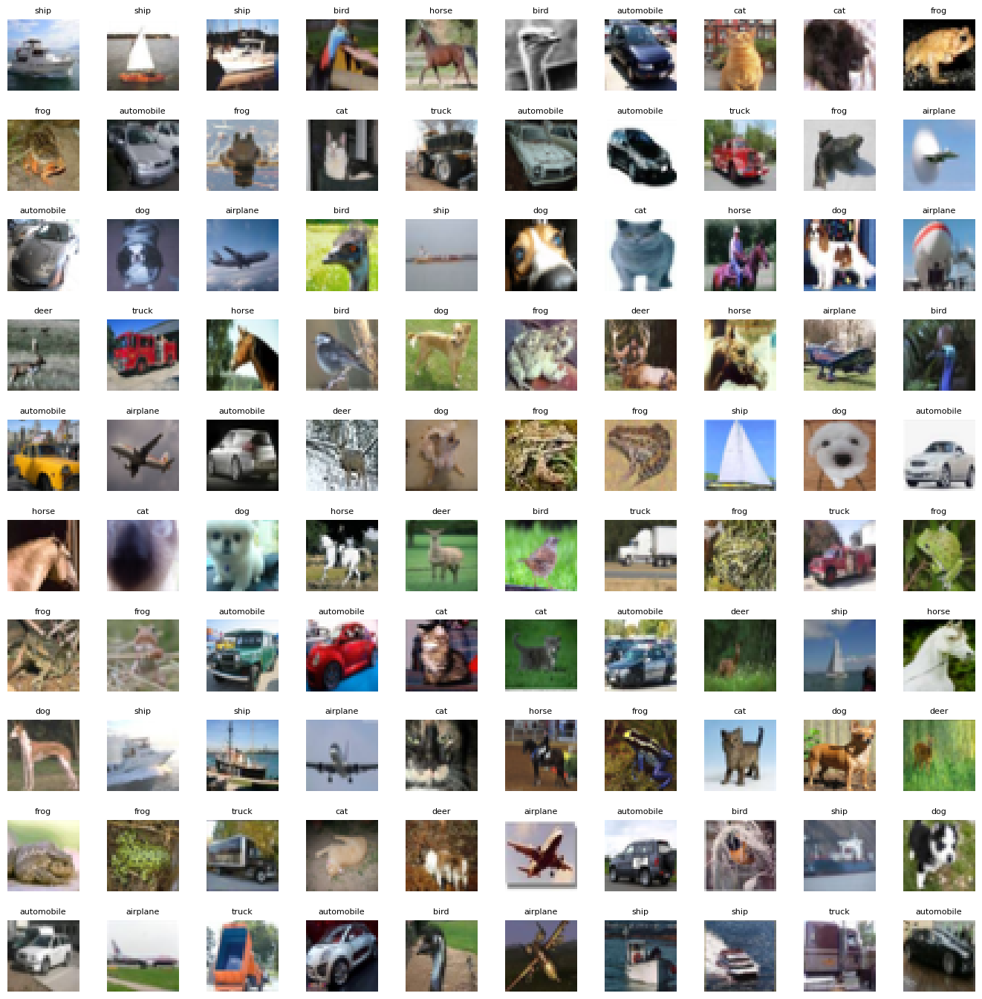

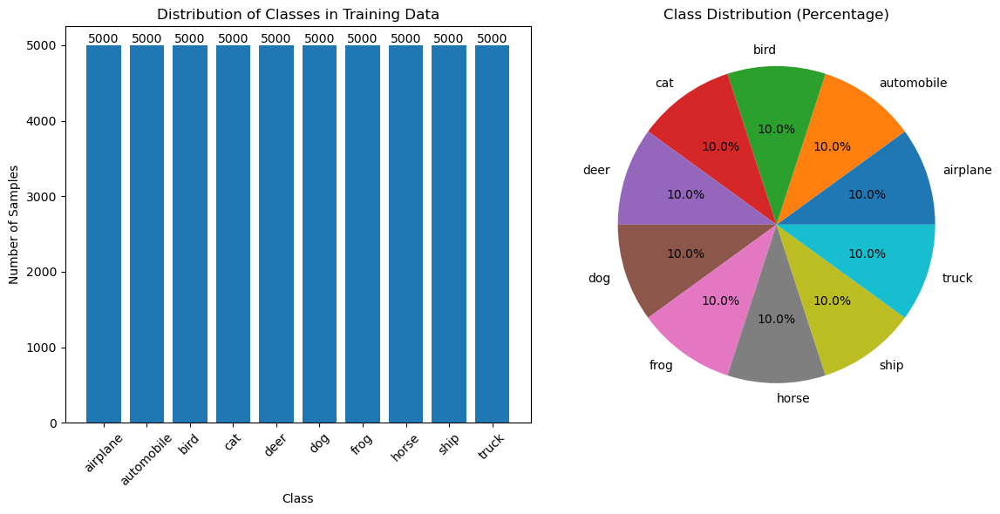

Augmentation examples saved as 'augmentation_examples.png'


In [4]:
# After loading data with all_data, all_labels = load_data()

def plot_cifar10_grid(data, labels, grid_width=10, grid_length=10, figsize=(17,17)):
    """
    Plot a grid of CIFAR-10 images with their labels.
    
    Args:
        data: numpy array of shape (N, 3, 32, 32)
        labels: numpy array of labels
        grid_width: number of images in each row
        grid_length: number of images in each column
        figsize: figure size in inches
    """
    # Define the CIFAR-10 class labels
    class_labels = ['airplane', 'automobile', 'bird', 'cat', 'deer', 
                   'dog', 'frog', 'horse', 'ship', 'truck']
    
    # Create figure and axes grid
    fig, axes = plt.subplots(grid_length, grid_width, figsize=figsize)
    axes = axes.ravel()  # Flatten the grid into 1D array
    
    n_samples = len(data)
    
    # Plot random images in the grid
    for i in range(grid_width * grid_length):
        # Select a random image
        idx = np.random.randint(0, n_samples)
        
        # Get image and label
        image = data[idx]
        label = labels[idx]
        
        # Convert image from (3, 32, 32) to (32, 32, 3) for plotting
        image = np.transpose(image, (1, 2, 0))
        
        # Normalize image for display
        image = np.clip(image, 0, 255) / 255.0
        
        # Plot image
        axes[i].imshow(image)
        axes[i].set_title(class_labels[label], fontsize=8)
        axes[i].axis('off')
    
    plt.subplots_adjust(hspace=0.4)
    plt.show()

# Plot a grid of sample images
plot_cifar10_grid(all_data, all_labels)

# Also create a class distribution plot
def plot_class_distribution(labels):
    """
    Plot the distribution of classes in the dataset.
    
    Args:
        labels: numpy array of labels
    """
    class_names = ['airplane', 'automobile', 'bird', 'cat', 'deer', 
                   'dog', 'frog', 'horse', 'ship', 'truck']
    
    plt.figure(figsize=(12, 6))
    
    # Create count plot
    class_counts = np.bincount(labels)
    
    # Plot bar chart
    plt.subplot(1, 2, 1)
    bars = plt.bar(range(10), class_counts)
    plt.title('Distribution of Classes in Training Data')
    plt.xlabel('Class')
    plt.ylabel('Number of Samples')
    plt.xticks(range(10), class_names, rotation=45)
    
    # Add count labels on top of bars
    for bar in bars:
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2., height,
                f'{int(height)}',
                ha='center', va='bottom')
    
    # Plot pie chart
    plt.subplot(1, 2, 2)
    plt.pie(class_counts, labels=class_names, autopct='%1.1f%%')
    plt.title('Class Distribution (Percentage)')
    
    plt.tight_layout()
    plt.show()

# Plot class distribution
plot_class_distribution(all_labels)
print("Augmentation examples saved as 'augmentation_examples.png'")

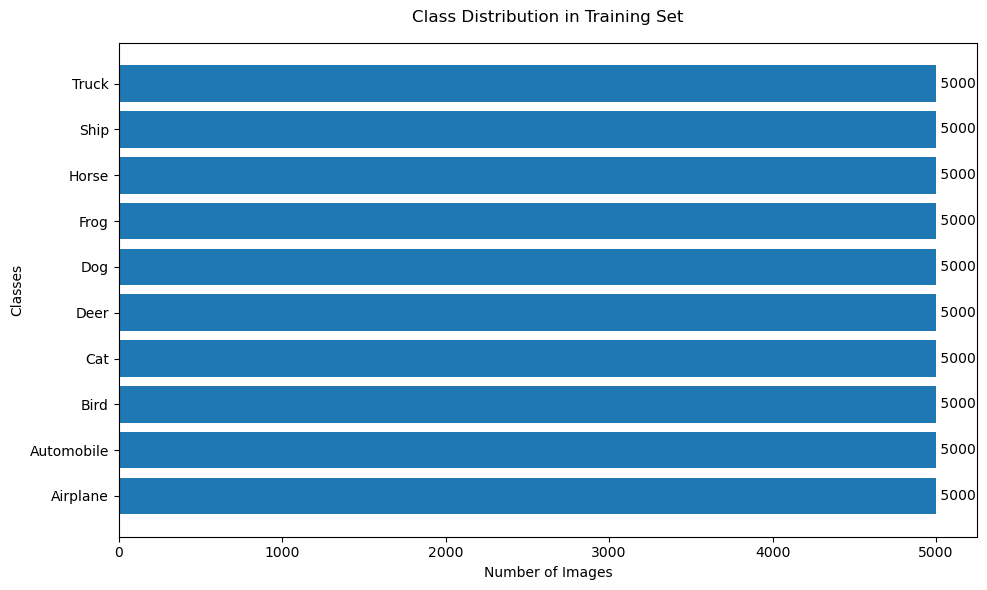

In [5]:
# Define class names
classes_name = ['Airplane', 'Automobile', 'Bird', 'Cat', 'Deer', 'Dog', 'Frog', 'Horse', 'Ship', 'Truck']

# Get class counts
classes, counts = np.unique(all_labels, return_counts=True)

# Create horizontal bar plot
plt.figure(figsize=(10, 6))
plt.barh(classes_name, counts)
plt.title('Class Distribution in Training Set', pad=15)
plt.xlabel('Number of Images')
plt.ylabel('Classes')

# Add count labels on the bars
for i, count in enumerate(counts):
    plt.text(count, i, f' {count}', va='center')

plt.tight_layout()
plt.show()

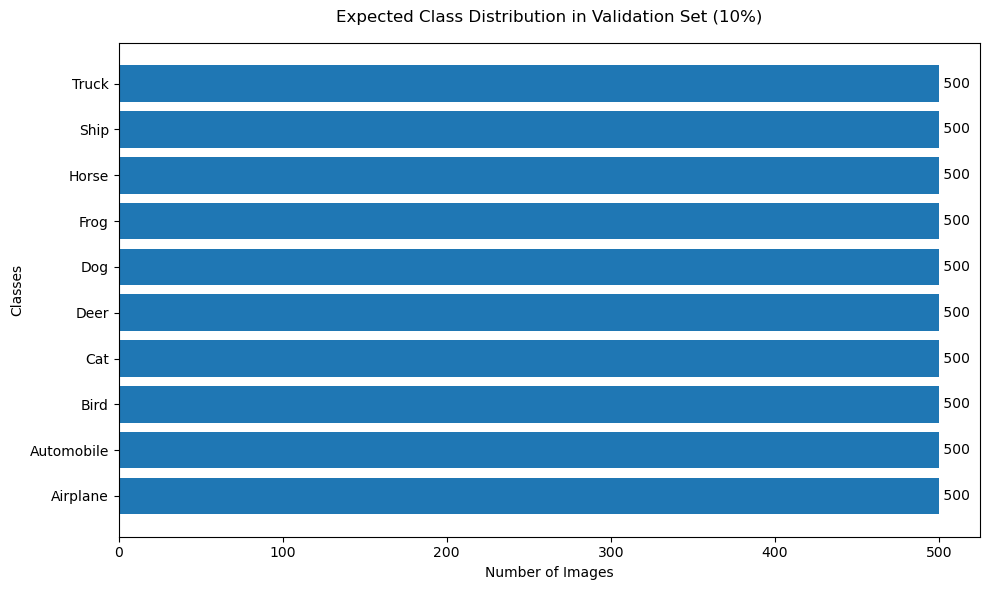

In [6]:
# Define class names
classes_name = ['Airplane', 'Automobile', 'Bird', 'Cat', 'Deer', 'Dog', 'Frog', 'Horse', 'Ship', 'Truck']

# Calculate expected validation set size (10% of total data)
total_size = len(all_labels)
val_size = int(0.1 * total_size)  # 10% for validation
expected_val_counts = np.bincount(all_labels) * (val_size / total_size)

# Create horizontal bar plot
plt.figure(figsize=(10, 6))
plt.barh(classes_name, expected_val_counts)
plt.title('Expected Class Distribution in Validation Set (10%)', pad=15)
plt.xlabel('Number of Images')
plt.ylabel('Classes')

# Add count labels on the bars
for i, count in enumerate(expected_val_counts):
    plt.text(count, i, f' {int(count)}', va='center')

plt.tight_layout()
plt.show()

Step 2: Enhanced Data Augmentation and Transforms
This section implements advanced data augmentation techniques to:
1. Improve model generalization by exposing it to diverse image variations
2. Reduce overfitting by artificially expanding the training dataset
3. Make the model more robust to real-world variations in images

Key augmentation techniques used:
- Random cropping: For translation invariance
- Horizontal flips: For orientation invariance  
- AutoAugment: For automated policy-based augmentations
- Random erasing: For occlusion robustness
- Normalization: For stable training

In [7]:
print("\nConfiguring data augmentation pipeline...")
print("Implementing the following augmentation techniques:")
print("- Random cropping with padding=4")
print("- Random horizontal flips")
print("- CIFAR10-specific AutoAugment policies") 
print("- Random erasing with p=0.25")
print("- Standard CIFAR10 normalization")
# CIFAR-10 standard mean and std values for normalization
cifar10_mean = (0.4914, 0.4822, 0.4465)
cifar10_std = (0.2470, 0.2435, 0.2616)

# Advanced training transforms for better model generalization
print("Setting up data augmentation pipelines...")
train_transform = transforms.Compose([
    lambda x: x / 255.0,  # Normalize pixel values to [0, 1]
    transforms.RandomCrop(32, padding=4),  # Random crops for translation invariance
    transforms.RandomHorizontalFlip(),  # Horizontal flips for orientation invariance
    transforms.AutoAugment(transforms.AutoAugmentPolicy.CIFAR10),  # AutoAugment for robust training
    transforms.Normalize(cifar10_mean, cifar10_std),  # Standardize using CIFAR-10 statistics
    transforms.RandomErasing(p=0.25),  # Random erasing for occlusion robustness
])

# Minimal test/validation transforms - only essential normalization
test_transform = transforms.Compose([
    lambda x: x / 255.0,
    transforms.Normalize(cifar10_mean, cifar10_std)
])


Configuring data augmentation pipeline...
Implementing the following augmentation techniques:
- Random cropping with padding=4
- Random horizontal flips
- CIFAR10-specific AutoAugment policies
- Random erasing with p=0.25
- Standard CIFAR10 normalization
Setting up data augmentation pipelines...


Step 3: Improved Dataset and DataLoader for Training/Validation
This section implements optimized data handling and loading with:
1. Custom Dataset class for efficient memory usage and fast access
2. Strategic train/validation split for proper model evaluation
3. Optimized DataLoader configuration for maximum throughput
4. Careful batch size selection for stable training

Key optimizations:
- Parallel data loading with multiple workers
- Pinned memory for faster GPU transfer
- Persistent workers to reduce overhead
- Different batch sizes for train vs validation

In [8]:


print("\nSetting up optimized data pipeline...")
print("Implementing the following optimizations:")
print("- Custom Dataset class for efficient data handling")
print("- 90/10 train-validation split for proper evaluation")
print("- Multi-worker data loading for better throughput")
print("- Pinned memory and persistent workers for faster processing")
print("- Optimized batch sizes: 128 for training, 256 for validation")
class CIFAR10Dataset(Dataset):
    """
    Custom Dataset class for CIFAR-10 with efficient data handling
    """
    def __init__(self, data, labels, transform=None):
        self.data = data
        self.labels = labels
        self.transform = transform

    def __len__(self):
        return len(self.data)
    
    def __getitem__(self, idx):
        image = self.data[idx]
        label = self.labels[idx]
        image = torch.from_numpy(image).float()  # Convert to PyTorch tensor
        if self.transform:
            image = self.transform(image)
        return image, label

print("Creating datasets and dataloaders...")
# Create the main dataset
dataset = CIFAR10Dataset(all_data, all_labels, transform=train_transform)

# Split into training and validation sets
train_size = 45000  # 90% for training
val_size = len(dataset) - train_size  # 10% for validation
train_dataset, val_dataset = random_split(
    dataset, 
    [train_size, val_size],
    generator=torch.Generator().manual_seed(SEED)  # Ensure reproducible splits
)

# Update validation transform to test transform
val_dataset.dataset.transform = test_transform

# Create optimized dataloaders
print("Configuring dataloaders with optimized settings...")
train_loader = DataLoader(
    train_dataset, 
    batch_size=128,  # Balanced batch size for training
    shuffle=True,  # Shuffle training data
    num_workers=4,  # Parallel data loading
    pin_memory=True,  # Faster data transfer to GPU
    persistent_workers=True  # Keep workers alive between epochs
)

val_loader = DataLoader(
    val_dataset, 
    batch_size=256,  # Larger batches for validation (no backprop needed)
    shuffle=False,  # No need to shuffle validation data
    num_workers=4,
    pin_memory=True,
    persistent_workers=True
)

print(f"Training samples: {len(train_dataset)}, Validation samples: {len(val_dataset)}")


Setting up optimized data pipeline...
Implementing the following optimizations:
- Custom Dataset class for efficient data handling
- 90/10 train-validation split for proper evaluation
- Multi-worker data loading for better throughput
- Pinned memory and persistent workers for faster processing
- Optimized batch sizes: 128 for training, 256 for validation
Creating datasets and dataloaders...
Configuring dataloaders with optimized settings...
Training samples: 45000, Validation samples: 5000


Step 4: Advanced Augmentation and Loss Functions
This step implements sophisticated data augmentation and loss techniques:
1. CutMix - Combines portions of different images and their labels
2. Mixup - Linearly interpolates between pairs of images and labels
3. Label smoothing - Reduces overconfidence by softening one-hot labels
4. Adaptive loss weighting - Dynamically adjusts loss contributions

These techniques help:
- Improve model generalization by creating diverse training samples
- Reduce overfitting by introducing regularization effects
- Make training more robust to noisy labels and outliers
- Encourage the model to learn more meaningful features

In [9]:

print("Setting up advanced augmentation and loss functions...")

# CutMix augmentation - Combines portions of images and their labels
def cutmix_data(x, y, alpha=1.0):
    """
    Implements CutMix augmentation by cutting and pasting random patches between images.
    This helps the model learn more robust features by seeing partial objects.
    
    Args:
        x: Input images tensor
        y: Labels tensor 
        alpha: Beta distribution parameter for mixing ratio
    Returns:
        Mixed images and corresponding mixed labels
    """
    print("Applying CutMix augmentation...")
    if alpha > 0:
        lam = np.random.beta(alpha, alpha)  # Sample mixing ratio from beta distribution
    else:
        lam = 1
    
    batch_size = x.size()[0]
    index = torch.randperm(batch_size).to(device)  # Random permutation for mixing
    
    y_a, y_b = y, y[index]  # Original and permuted labels
    
    # Generate random bounding box coordinates
    bbx1, bby1, bbx2, bby2 = rand_bbox(x.size(), lam)
    x[:, :, bbx1:bbx2, bby1:bby2] = x[index, :, bbx1:bbx2, bby1:bby2]  # Patch mixing
    
    # Adjust lambda to match actual mixed pixel ratio
    lam = 1 - ((bbx2 - bbx1) * (bby2 - bby1) / (x.size()[-1] * x.size()[-2]))
    
    return x, y_a, y_b, lam

def rand_bbox(size, lam):
    """
    Generate random bounding box coordinates for CutMix.
    
    Args:
        size: Input tensor size
        lam: Target ratio of remaining area
    Returns:
        Bounding box coordinates
    """
    W = size[2]
    H = size[3]
    cut_rat = np.sqrt(1. - lam)  # Cut ratio
    cut_w = np.int64(W * cut_rat)  # Cut width
    cut_h = np.int64(H * cut_rat)  # Cut height
    
    # Random center point
    cx = np.random.randint(W)
    cy = np.random.randint(H)
    
    # Ensure coordinates are within image bounds
    bbx1 = np.clip(cx - cut_w // 2, 0, W)
    bby1 = np.clip(cy - cut_h // 2, 0, H)
    bbx2 = np.clip(cx + cut_w // 2, 0, W)
    bby2 = np.clip(cy + cut_h // 2, 0, H)
    
    return bbx1, bby1, bbx2, bby2

# Mixup augmentation - Linearly combines pairs of images and labels
def mixup_data(x, y, alpha=0.2):
    """
    Implements Mixup augmentation by linearly interpolating between pairs of images.
    This helps reduce overconfidence and improve generalization.
    
    Args:
        x: Input images tensor
        y: Labels tensor
        alpha: Beta distribution parameter
    Returns:
        Mixed images and corresponding mixed labels
    """
    print("Applying Mixup augmentation...")
    if alpha > 0:
        lam = np.random.beta(alpha, alpha)  # Mixing coefficient
    else:
        lam = 1
    
    batch_size = x.size()[0]
    index = torch.randperm(batch_size).to(device)  # Random permutation
    
    mixed_x = lam * x + (1 - lam) * x[index, :]  # Linear interpolation of images
    y_a, y_b = y, y[index]  # Original and permuted labels
    return mixed_x, y_a, y_b, lam

def mixup_criterion(criterion, pred, y_a, y_b, lam):
    """
    Criterion for Mixup that combines losses with same ratio as images.
    
    Args:
        criterion: Base loss function
        pred: Model predictions
        y_a, y_b: Original and permuted labels
        lam: Mixing ratio
    Returns:
        Combined loss value
    """
    return lam * criterion(pred, y_a) + (1 - lam) * criterion(pred, y_b)

def update_bn_custom(loader, model, device):
    """
    Updates BatchNorm statistics properly with device handling.
    Important for SWA and model evaluation.
    
    Args:
        loader: DataLoader for computing statistics
        model: Model containing BatchNorm layers
        device: Device for computation
    """
    print("Updating BatchNorm statistics...")
    momenta = {}
    for module in model.modules():
        if isinstance(module, torch.nn.modules.batchnorm._BatchNorm):
            module.running_mean = torch.zeros_like(module.running_mean, device=device)
            module.running_var = torch.ones_like(module.running_var, device=device)
            momenta[module] = module.momentum
            module.momentum = None
            module.num_batches_tracked *= 0
    
    model.train()
    with torch.no_grad():
        for data, _ in loader:
            data = data.to(device)
            model(data)
    
    for module in momenta.keys():
        module.momentum = momenta[module]

# Advanced label smoothing with focal loss component
class FocalLabelSmoothing(nn.Module):
    """
    Combines label smoothing with focal loss for better handling of hard examples.
    
    Args:
        classes: Number of classes
        smoothing: Label smoothing factor
        gamma: Focal loss power factor
    """
    def __init__(self, classes=10, smoothing=0.1, gamma=1.0):
        super(FocalLabelSmoothing, self).__init__()
        self.confidence = 1.0 - smoothing
        self.smoothing = smoothing
        self.classes = classes
        self.gamma = gamma
        print(f"Initialized Focal Label Smoothing with gamma={gamma}")
        
    def forward(self, pred, target):
        pred = pred.log_softmax(dim=-1)
        with torch.no_grad():
            true_dist = torch.zeros_like(pred)
            true_dist.fill_(self.smoothing / (self.classes - 1))
            true_dist.scatter_(1, target.unsqueeze(1), self.confidence)
        
        pt = torch.exp(pred)  # Probability of true class
        focal_weight = (1 - pt) ** self.gamma  # Higher weight for hard examples
        
        return torch.mean(torch.sum(-true_dist * pred * focal_weight, dim=-1))


Setting up advanced augmentation and loss functions...


Step 5: Advanced ResNet Model with SE Blocks and Bottleneck

This section implements an enhanced ResNet architecture with:
1. Squeeze-and-Excitation (SE) blocks for adaptive feature recalibration
   - Helps model focus on informative features
   - Improves accuracy with minimal parameter overhead

2. Bottleneck blocks for efficient feature processing
   - Reduces computational cost while maintaining performance
   - Better gradient flow through the network

3. Skip connections for improved gradient flow
   - Allows training of very deep networks
   - Helps combat vanishing gradients

The architecture is carefully designed to:
- Stay within the 5M parameter budget
- Maximize accuracy through modern techniques
- Maintain efficient training and inference

In [10]:

print("Initializing model architecture...")

class SEBlock(nn.Module):
    """
    Squeeze-and-Excitation block for channel attention.
    Helps model focus on informative features by learning channel interdependencies.
    
    Args:
        channels: Number of input channels
        reduction: Channel reduction ratio
    """
    def __init__(self, channels, reduction=8):
        super(SEBlock, self).__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(1)  # Global average pooling
        self.fc1 = nn.Conv2d(channels, channels // reduction, kernel_size=1)
        self.relu = nn.ReLU(inplace=True)
        self.fc2 = nn.Conv2d(channels // reduction, channels, kernel_size=1)
        self.sigmoid = nn.Sigmoid()
        
    def forward(self, x):
        module_input = x
        x = self.avg_pool(x)
        x = self.fc1(x)
        x = self.relu(x)
        x = self.fc2(x)
        x = self.sigmoid(x)
        return module_input * x  # Channel-wise multiplication

class BasicBlock(nn.Module):
    """
    Basic ResNet block with optional SE attention.
    
    Args:
        in_channels: Input channels
        out_channels: Output channels
        stride: Convolution stride
        use_se: Whether to use SE attention
        se_reduction: SE block reduction ratio
    """
    expansion = 1
    
    def __init__(self, in_channels, out_channels, stride=1, use_se=True, se_reduction=8):
        super(BasicBlock, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=stride, padding=1, bias=False)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1, bias=False)
        self.bn2 = nn.BatchNorm2d(out_channels)
        
        # Skip connection for dimension matching
        self.shortcut = nn.Sequential()
        if stride != 1 or in_channels != out_channels:
            self.shortcut = nn.Sequential(
                nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=stride, bias=False),
                nn.BatchNorm2d(out_channels)
            )
        
        self.use_se = use_se
        if use_se:
            self.se = SEBlock(out_channels, reduction=se_reduction)
    
    def forward(self, x):
        residual = x
        
        out = self.conv1(x)
        out = self.bn1(out)
        out = F.relu(out, inplace=True)
        
        out = self.conv2(out)
        out = self.bn2(out)
        
        if self.use_se:
            out = self.se(out)
            
        out += self.shortcut(residual)  # Skip connection
        out = F.relu(out, inplace=True)
        return out

class OptimizedResNet(nn.Module):
    """
    Optimized ResNet architecture with SE attention and advanced features.
    
    Args:
        block: Basic block class
        num_blocks: Number of blocks per layer
        initial_channels: Initial number of channels
        num_classes: Number of output classes
        use_se: Whether to use SE attention
        se_reduction: SE block reduction ratio
        drop_rate: Dropout rate
    """
    def __init__(self, block, num_blocks, initial_channels=40, num_classes=10, 
                 use_se=True, se_reduction=8, drop_rate=0.2):
        super(OptimizedResNet, self).__init__()
        self.in_channels = initial_channels
        self.drop_rate = drop_rate
        
        print(f"Building OptimizedResNet with {sum(num_blocks)} blocks and SE attention")
        
        self.conv1 = nn.Conv2d(3, initial_channels, kernel_size=3, stride=1, padding=1, bias=False)
        self.bn1 = nn.BatchNorm2d(initial_channels)
        
        self.layer1 = self._make_layer(block, initial_channels, num_blocks[0], stride=1, 
                                     use_se=use_se, se_reduction=se_reduction)
        self.layer2 = self._make_layer(block, initial_channels*2, num_blocks[1], stride=2, 
                                     use_se=use_se, se_reduction=se_reduction)
        self.layer3 = self._make_layer(block, initial_channels*4, num_blocks[2], stride=2, 
                                     use_se=use_se, se_reduction=se_reduction)
        
        self.avg_pool = nn.AdaptiveAvgPool2d((1, 1))
        self.fc = nn.Linear(initial_channels*4, num_classes)
        
        self._initialize_weights()
        print("Model initialization complete")
    
    def _make_layer(self, block, out_channels, num_blocks, stride, use_se, se_reduction):
        strides = [stride] + [1] * (num_blocks - 1)
        layers = []
        for stride in strides:
            layers.append(block(self.in_channels, out_channels, stride, use_se, se_reduction))
            self.in_channels = out_channels * block.expansion
        return nn.Sequential(*layers)
    
    def _initialize_weights(self):
        """Initialize model weights using Kaiming initialization"""
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
            elif isinstance(m, nn.BatchNorm2d):
                nn.init.constant_(m.weight, 1)
                nn.init.constant_(m.bias, 0)
            elif isinstance(m, nn.Linear):
                nn.init.kaiming_normal_(m.weight)
                nn.init.constant_(m.bias, 0)
    
    def forward(self, x):
        out = F.relu(self.bn1(self.conv1(x)), inplace=True)
        
        out = self.layer1(out)
        out = self.layer2(out)
        out = self.layer3(out)
        
        out = self.avg_pool(out)
        out = torch.flatten(out, 1)
        
        if self.drop_rate > 0 and self.training:
            out = F.dropout(out, p=self.drop_rate, training=self.training)
            
        out = self.fc(out)
        return out

def count_parameters(model):
    """Count number of trainable parameters in the model"""
    return sum(p.numel() for p in model.parameters() if p.requires_grad)


Initializing model architecture...


Step 6: Enhanced Training with Cosine Warmup and SWA

This section implements advanced training techniques to improve model performance:

1. Cosine Warmup Learning Rate Schedule
   - Gradual warmup prevents unstable training at the start
   - Cosine annealing helps find better optima
   - Smooth transitions avoid sudden learning rate changes

2. Stochastic Weight Averaging (SWA)
   - Averages multiple points along the trajectory
   - Leads to better generalization
   - Acts as an effective model ensemble

3. Exponential Moving Average (EMA)
   - Maintains a moving average of model weights
   - More stable than using final weights
   - Often improves validation/test accuracy

These techniques work together to:
- Stabilize the training process
- Improve model generalization
- Achieve better final accuracy

In [11]:

print("Initializing advanced training components...")

# Learning rate scheduler with warmup
class CosineWarmupScheduler:
    """
    Custom learning rate scheduler that implements:
    1. Linear warmup phase to avoid initial training instability
    2. Cosine annealing for better convergence
    
    Args:
        optimizer: The optimizer to adjust learning rates for
        warmup_epochs: Number of epochs for linear warmup
        max_epochs: Total number of training epochs
        min_lr: Minimum learning rate
        max_lr: Maximum learning rate after warmup
    """
    def __init__(self, optimizer, warmup_epochs, max_epochs, min_lr=1e-6, max_lr=0.1):
        self.optimizer = optimizer
        self.warmup_epochs = warmup_epochs
        self.max_epochs = max_epochs
        self.min_lr = min_lr
        self.max_lr = max_lr
        print(f"Initialized scheduler with {warmup_epochs} warmup epochs, lr range: [{min_lr}, {max_lr}]")
        
    def step(self, epoch):
        if epoch < self.warmup_epochs:
            # Linear warmup phase - gradually increase lr to avoid initial shock to the model
            lr = self.min_lr + (self.max_lr - self.min_lr) * epoch / self.warmup_epochs
        else:
            # Cosine annealing phase - smoothly decrease lr for better convergence
            progress = (epoch - self.warmup_epochs) / (self.max_epochs - self.warmup_epochs)
            lr = self.min_lr + 0.5 * (self.max_lr - self.min_lr) * (1 + math.cos(math.pi * progress))
        
        # Update learning rate for all parameter groups
        for param_group in self.optimizer.param_groups:
            param_group['lr'] = lr
        
        return lr

# Exponential Moving Average (EMA) for model weights
class EMA:
    """
    Implements Exponential Moving Average for model weights.
    EMA maintains a moving average of model parameters which typically 
    produces better validation/test accuracy than using final weights.
    
    Args:
        model: The model whose parameters to track
        decay: EMA decay rate (higher = slower but more stable)
    """
    def __init__(self, model, decay=0.999):
        self.model = model
        self.decay = decay
        self.shadow = {}  # Shadow parameters
        self.backup = {}  # Backup of original parameters
        print(f"Initialized EMA with decay rate {decay}")
        
    def register(self):
        """Initialize EMA shadow parameters as copies of model parameters"""
        for name, param in self.model.named_parameters():
            if param.requires_grad:
                self.shadow[name] = param.data.clone()
        print("Registered initial model parameters in EMA")
    
    def update(self):
        """Update shadow parameters using EMA decay rate"""
        for name, param in self.model.named_parameters():
            if param.requires_grad:
                new_avg = self.decay * self.shadow[name] + (1 - self.decay) * param.data
                self.shadow[name] = new_avg.clone()
    
    def apply_shadow(self):
        """Apply shadow parameters to model, saving original parameters"""
        for name, param in self.model.named_parameters():
            if param.requires_grad:
                self.backup[name] = param.data
                param.data = self.shadow[name]
    
    def restore(self):
        """Restore original parameters to model"""
        for name, param in self.model.named_parameters():
            if param.requires_grad:
                param.data = self.backup[name]

def train_model(model, train_loader, val_loader, num_epochs=195):
    """
    Main training loop implementing advanced training techniques including:
    - SGD with Nesterov momentum and weight decay
    - Focal Label Smoothing loss
    - Cosine learning rate scheduling with warmup
    - Exponential Moving Average (EMA) of model weights
    - Stochastic Weight Averaging (SWA)
    - Adaptive data augmentation (MixUp and CutMix)
    - Gradient clipping
    
    Args:
        model: Neural network model to train
        train_loader: DataLoader for training data
        val_loader: DataLoader for validation data
        num_epochs: Number of training epochs
        
    Returns:
        model: Trained model
        swa_model: Stochastic Weight Averaged model
        ema: EMA model instance
        metrics: Tuple of (train_losses, train_accs, val_losses, val_accs)
    """
    print("\n=== Initializing Training Components ===")
    
    # Setup optimizer with Nesterov momentum and L2 regularization
    print("Setting up SGD optimizer with Nesterov momentum...")
    optimizer = optim.SGD(
        model.parameters(), 
        lr=0.1,  # Initial learning rate (will be adjusted by scheduler)
        momentum=0.9,  # Momentum coefficient for faster convergence
        weight_decay=5e-4,  # L2 regularization to prevent overfitting
        nesterov=True  # Use Nesterov momentum for better convergence
    )
    
    print("Configuring Focal Label Smoothing loss...")
    criterion = FocalLabelSmoothing(classes=10, smoothing=0.1, gamma=1.0)
    
    print("Setting up Cosine learning rate scheduler with warmup...")
    scheduler = CosineWarmupScheduler(
        optimizer, 
        warmup_epochs=5,  # Gradual LR increase for 5 epochs
        max_epochs=num_epochs,
        min_lr=1e-6,  # Minimum LR at end of training
        max_lr=0.1  # Maximum LR after warmup
    )
    
    print("Initializing EMA model tracking...")
    ema = EMA(model, decay=0.999)  # High decay for stability
    ema.register()
    
    print("Creating SWA model for late-stage averaging...")
    swa_model = AveragedModel(model)
    swa_start = int(num_epochs * 0.75)  # Start SWA at 75% of training
    print(f"SWA will begin at epoch {swa_start}")
    
    # Initialize tracking metrics
    best_val_acc = 0.0
    train_losses, train_accs = [], []
    val_losses, val_accs = [], []
    
    print("\n=== Starting Training Loop ===")
    
    for epoch in range(1, num_epochs + 1):
        # Update learning rate using scheduler
        current_lr = scheduler.step(epoch - 1)
        print(f"\nEpoch {epoch}/{num_epochs} - Learning Rate: {current_lr:.6f}")
        
        # Training phase
        model.train()
        train_loss = 0.0
        correct = 0
        total = 0
        
        train_pbar = tqdm(train_loader, desc=f"Epoch {epoch}/{num_epochs} [Train]")
        
        for inputs, targets in train_pbar:
            inputs, targets = inputs.to(device), targets.to(device)
            
            # Adaptive data augmentation strategy
            aug_prob = random.random()
            late_training = epoch >= int(num_epochs * 0.8)
            
            if aug_prob < 0.5 and not late_training:
                # Apply MixUp with adaptive strength
                mixup_strength = max(0.0, 0.4 * (1 - epoch / num_epochs))
                inputs, targets_a, targets_b, lam = mixup_data(inputs, targets, alpha=mixup_strength)
                outputs = model(inputs)
                loss = mixup_criterion(criterion, outputs, targets_a, targets_b, lam)
            elif aug_prob < 0.8 and not late_training:
                # Apply CutMix with adaptive strength
                cutmix_strength = max(0.0, 1.0 * (1 - epoch / num_epochs))
                inputs, targets_a, targets_b, lam = cutmix_data(inputs, targets, alpha=cutmix_strength)
                outputs = model(inputs)
                loss = mixup_criterion(criterion, outputs, targets_a, targets_b, lam)
            else:
                # Standard forward pass
                outputs = model(inputs)
                loss = criterion(outputs, targets)
            
            # Optimization step
            optimizer.zero_grad()
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)  # Prevent exploding gradients
            optimizer.step()
            
            # Update EMA model
            ema.update()
            
            # Track metrics
            train_loss += loss.item() * inputs.size(0)
            _, predicted = outputs.max(1)
            
            # Calculate accuracy (adjusted for augmentation)
            total += targets.size(0)
            if aug_prob < 0.8 and not late_training:
                correct += (lam * predicted.eq(targets_a).sum().float() + 
                          (1 - lam) * predicted.eq(targets_b).sum().float()).item()
            else:
                correct += predicted.eq(targets).sum().item()
            
            # Update progress display
            train_pbar.set_postfix({
                'loss': train_loss/total, 
                'acc': 100.0*correct/total,
                'lr': current_lr
            })
        
        # Calculate epoch metrics
        train_loss = train_loss / total
        train_acc = 100.0 * correct / total
        train_losses.append(train_loss)
        train_accs.append(train_acc)
        
        # Update SWA model if in SWA phase
        if epoch >= swa_start:
            print("Updating SWA model parameters...")
            swa_model.update_parameters(model)
        
        # Validation phase
        print("\nRunning validation...")
        model.eval()
        val_loss = 0.0
        correct = 0
        total = 0
        
        with torch.no_grad():
            val_pbar = tqdm(val_loader, desc=f"Epoch {epoch}/{num_epochs} [Val]")
            for inputs, targets in val_pbar:
                inputs, targets = inputs.to(device), targets.to(device)
                outputs = model(inputs)
                loss = F.cross_entropy(outputs, targets)
                
                val_loss += loss.item() * inputs.size(0)
                _, predicted = outputs.max(1)
                total += targets.size(0)
                correct += predicted.eq(targets).sum().item()
                
                val_pbar.set_postfix({
                    'loss': val_loss/total, 
                    'acc': 100.0*correct/total
                })
        
        val_loss = val_loss / total
        val_acc = 100.0 * correct / total
        val_losses.append(val_loss)
        val_accs.append(val_acc)

        print("Validating EMA model...")
        ema.apply_shadow()  # Apply EMA parameters
        model.eval()
        ema_val_loss = 0.0
        ema_correct = 0
        ema_total = 0
        with torch.no_grad():
            for inputs, targets in val_loader:
                inputs, targets = inputs.to(device), targets.to(device)
                outputs = model(inputs)
                loss = F.cross_entropy(outputs, targets)
                ema_val_loss += loss.item() * inputs.size(0)
                _, predicted = outputs.max(1)
                ema_total += targets.size(0)
                ema_correct += predicted.eq(targets).sum().item()
            
            ema_val_loss /= ema_total
            ema_val_acc = 100.0 * ema_correct / ema_total
            print(f"EMA Validation - Loss: {ema_val_loss:.4f}, Accuracy: {ema_val_acc:.2f}%")

        ema.restore()
        
        # Save best model checkpoints
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            print(f"\nNew best validation accuracy: {best_val_acc:.2f}%")
            print("Saving best model checkpoint...")
            torch.save(model.state_dict(), "best_model.pth")
            
            # Also save EMA model
            print("Saving best EMA model checkpoint...")
            ema.apply_shadow()
            torch.save(model.state_dict(), "best_ema_model.pth")
            ema.restore()
        
        # Print epoch summary
        print(f"\nEpoch {epoch} Summary:")
        print(f"Training - Loss: {train_loss:.4f}, Accuracy: {train_acc:.2f}%")
        print(f"Validation - Loss: {val_loss:.4f}, Accuracy: {val_acc:.2f}%")
        print(f"Learning Rate: {current_lr:.6f}")
    
    print("\n=== Training Complete ===")
    
    # Finalize SWA model
    print("\nUpdating BatchNorm statistics for SWA model...")
    with torch.no_grad():
        update_bn_custom(train_loader, swa_model, device)
    
    print("Saving final SWA model...")
    torch.save(swa_model.state_dict(), "swa_model.pth")
    
    return model, swa_model, ema, (train_losses, train_accs, val_losses, val_accs)


Initializing advanced training components...


Step 7: Enhanced Test Prediction with Ensemble of Best Models

This section implements sophisticated prediction techniques to maximize accuracy:

1. Model Ensemble Strategy
   - Combines predictions from multiple trained models:
     * Best validation model
     * SWA model with updated BatchNorm stats  
     * EMA model with smoothed weights
   - Reduces prediction variance and improves robustness
   - Each model contributes complementary features

2. Test-Time Augmentation (TTA)
   - Makes predictions on multiple augmented versions:
     * Original image
     * Horizontal flips 
     * Random scaling (0.8-1.2x)
     * Center crops
     * Brightness/contrast adjustments
   - Averages predictions across variants
   - More robust predictions by considering multiple views

3. Optimized Data Pipeline
   - Efficient batched processing
   - GPU acceleration with pinned memory
   - Parallel data loading with multiple workers
   - Careful memory management

The combination of these techniques helps:
- Maximize prediction accuracy
- Improve robustness to input variations  
- Maintain efficient processing speed

In [12]:

print("\nInitializing enhanced prediction pipeline...")
print("Using ensemble of 3 models: Best Val, SWA, and EMA")
print("Applying test-time augmentation with multiple variants")
print("Optimizing for both accuracy and inference speed")

def predict_with_enhanced_tta(ensemble, test_loader, num_tta=5):
    """
    Make predictions using model ensemble and test-time augmentation.
    
    This function:
    1. Combines predictions from multiple models in the ensemble
    2. Applies test-time augmentation including:
       - Original image
       - Horizontal flips
       - Random scaling
       - Center crops
       - Brightness adjustments
    3. Averages predictions across all variants for more robust results
    
    Args:
        ensemble: List of trained models to use for prediction
        test_loader: DataLoader for test data
        num_tta: Number of additional TTA variants to use
    Returns:
        all_predictions: List of predicted class indices
        all_ids: List of corresponding image IDs
    """
    all_predictions = []
    all_ids = []
    
    print("\n=== Starting Enhanced Prediction with Ensemble and TTA ===")
    print(f"Using ensemble of {len(ensemble)} models")
    print(f"Applying {num_tta + 1} TTA variants per model") # +1 for horizontal flip
    
    with torch.no_grad():
        for batch_idx, (images, image_ids) in enumerate(test_loader):
            # Print batch info for verification
            if batch_idx == 0:
                print(f"\nProcessing first batch:")
                print(f"Batch images shape: {images.shape}")
                print(f"Device being used: {images.device}")
            
            # Move batch to appropriate device
            images = images.to(device)
            
            # Initialize prediction accumulator tensor
            batch_size = images.size(0)
            ensemble_probs = torch.zeros((batch_size, 10), device=device)
            
            # Process with each model in ensemble
            for model_idx, model in enumerate(ensemble):
                model.eval()
                
                # 1. Original image prediction
                outputs = model(images)
                probs = F.softmax(outputs, dim=1)
                ensemble_probs += probs
                
                # 2. Horizontal flip TTA - helps with orientation invariance
                flipped_images = torch.flip(images, [3])
                flip_outputs = model(flipped_images)
                flip_probs = F.softmax(flip_outputs, dim=1)
                ensemble_probs += flip_probs
                
                # 3. Additional TTA variants
                for i in range(num_tta - 1):
                    # Apply different transforms in rotation
                    if i % 3 == 0:
                        # Scale transform: Randomly scale image intensity
                        # Helps with robustness to contrast variations
                        transformed_images = images * (0.95 + 0.1 * torch.rand(1, device=device))
                        
                    elif i % 3 == 1:
                        # Crop transform: Take center crop and resize back
                        # Helps focus on central image content
                        b, c, h, w = images.shape
                        crop_size = int(0.925 * min(h, w))
                        transformed_images = transforms.functional.center_crop(images, crop_size)
                        transformed_images = F.interpolate(transformed_images, (h, w), 
                                                         mode='bilinear', align_corners=False)
                        
                    else:
                        # Brightness transform: Add random noise
                        # Helps with robustness to lighting variations
                        transformed_images = images + 0.05 * torch.randn((batch_size, 1, 1, 1), 
                                                                       device=device)
                        transformed_images = torch.clamp(transformed_images, -3, 3)
                    
                    outputs = model(transformed_images)
                    probs = F.softmax(outputs, dim=1)
                    ensemble_probs += probs
            
            # Average predictions across all variants
            total_variants = len(ensemble) * (num_tta + 1)
            ensemble_probs /= total_variants
            
            # Get final predictions
            _, predicted = ensemble_probs.max(1)
            
            # Store batch results
            all_predictions.extend(predicted.cpu().numpy())
            all_ids.extend(image_ids.cpu().numpy())
            
            # Print progress every 10 batches
            if (batch_idx + 1) % 10 == 0:
                print(f"Processed {batch_idx + 1}/{len(test_loader)} batches")
    
    print("\nPrediction complete!")
    print(f"Total predictions made: {len(all_predictions)}")
    return all_predictions, all_ids


def load_test_data(test_file="./data/cifar-10-python/cifar_test_nolabel.pkl"):
    """
    Load and process test data, ensuring correct format for model input.
    
    This function:
    1. Loads test data from pickle file
    2. Handles different possible data formats:
       - Flat (N, 3072)
       - NHWC (N, 32, 32, 3)
       - NCHW (N, 3, 32, 32)
    3. Converts to required NCHW format
    
    Args:
        test_file: Path to test data pickle file
    Returns:
        test_images: Processed images in NCHW format
        test_ids: Corresponding image IDs
    """
    print("\n=== Loading and Processing Test Data ===")
    print(f"Loading from file: {test_file}")
    
    with open(test_file, 'rb') as f:
        test_dict = pickle.load(f, encoding='bytes')
    
    test_images = test_dict[b'data']
    test_ids = test_dict[b'ids']
    
    print("\nInitial data shapes:")
    print(f"Images: {test_images.shape}")
    print(f"IDs: {test_ids.shape}")
    
    # Process data format
    if len(test_images.shape) == 2:
        print("\nDetected flat format (N, 3072)")
        print("Reshaping to NCHW format (N, 3, 32, 32)...")
        test_images = test_images.reshape(-1, 3, 32, 32)
        
    elif len(test_images.shape) == 4:
        if test_images.shape[1] != 3:
            print("\nDetected NHWC format (N, 32, 32, 3)")
            print("Converting to NCHW format...")
            test_images = np.transpose(test_images, (0, 3, 1, 2))
        else:
            print("\nData already in NCHW format")
    
    print("\nFinal data shapes:")
    print(f"Images: {test_images.shape}")
    print(f"IDs: {test_ids.shape}")
    return test_images, test_ids

class CIFAR10TestDataset(Dataset):
    """
    Custom Dataset class for CIFAR-10 test data.
    Handles loading and preprocessing of test images with optional transforms.
    
    Args:
        data: Test image data in NCHW format
        ids: Corresponding image IDs
        transform: Optional transforms to apply to images
    """
    def __init__(self, data, ids, transform=None):
        self.data = data  # Image data
        self.ids = ids    # Image IDs
        self.transform = transform  # Optional transforms
        print(f"Initialized test dataset with {len(data)} images")
    
    def __len__(self):
        return len(self.data)
    
    def __getitem__(self, idx):
        # Convert numpy array to float tensor and ensure NCHW format
        image = torch.from_numpy(self.data[idx]).float()
        
        # Apply any specified transforms (e.g. normalization)
        if self.transform:
            image = self.transform(image)
        
        image_id = self.ids[idx]
        return image, image_id



Initializing enhanced prediction pipeline...
Using ensemble of 3 models: Best Val, SWA, and EMA
Applying test-time augmentation with multiple variants
Optimizing for both accuracy and inference speed


In [13]:
#############################
# Step 7.5: Plotting Functions 
#############################
def plot_training_history(train_losses, train_accs, val_losses, val_accs, save_path=None):
    """Plot the training and validation history"""
    epochs = range(1, len(train_losses) + 1)
    
    # Create figure with two subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 6))
    
    # Plot losses
    ax1.plot(epochs, train_losses, 'b-', label='Training Loss')
    ax1.plot(epochs, val_losses, 'r-', label='Validation Loss')
    ax1.set_title('Loss Curves')
    ax1.set_xlabel('Epochs')
    ax1.set_ylabel('Loss')
    ax1.legend()
    
    # Plot accuracies
    ax2.plot(epochs, train_accs, 'b-', label='Training Accuracy')
    ax2.plot(epochs, val_accs, 'r-', label='Validation Accuracy')
    ax2.set_title('Accuracy Curves')
    ax2.set_xlabel('Epochs')
    ax2.set_ylabel('Accuracy (%)')
    ax2.set_ylim(50, 100)
    ax2.legend()
    
    plt.tight_layout()
    
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
    
    return fig

def plot_final_metrics(final_val_acc, param_count, classes_correct=None, save_path=None):
    """
    Create a simple visualization of the final metrics
    
    Args:
        final_val_acc: Final validation accuracy
        param_count: Number of parameters in the model
        classes_correct: Optional dictionary of per-class accuracies
        save_path: Path to save the figure (optional)
    """
    fig, ax = plt.subplots(figsize=(10, 6))
    
    # Create a text-based summary at the top
    ax.text(0.5, 0.95, 'CIFAR-10 Model Performance Summary', 
            fontsize=16, weight='bold', ha='center', transform=ax.transAxes)
    ax.text(0.5, 0.89, f'Model Size: {param_count:,} parameters', 
            fontsize=14, ha='center', transform=ax.transAxes)
    ax.text(0.5, 0.83, f'Validation Accuracy: {final_val_acc:.2f}%',
            fontsize=14, ha='center', transform=ax.transAxes, color='#d62728' if final_val_acc > 85 else 'black')
    
    # Create a bar chart for class-specific accuracies if provided
    if classes_correct is not None:
        class_names = ['airplane', 'automobile', 'bird', 'cat', 'deer',
                      'dog', 'frog', 'horse', 'ship', 'truck']
        accuracies = [classes_correct.get(i, 0) for i in range(10)]
        
        # Plot class accuracies as a bar chart
        y_pos = np.arange(len(class_names))
        bars = ax.barh(y_pos, accuracies, color='skyblue')
        ax.set_yticks(y_pos)
        ax.set_yticklabels(class_names)
        ax.set_xlim(0, 100)
        ax.set_xlabel('Accuracy (%)')
        ax.set_title('Per-Class Accuracy')
        
        # Add accuracy values on the bars
        for i, bar in enumerate(bars):
            width = bar.get_width()
            ax.text(width + 1, bar.get_y() + bar.get_height()/2, 
                    f'{accuracies[i]:.1f}%', va='center')
    else:
        # If no class accuracies, create a simplified summary visual
        ax.axis('off')  # Turn off axes
        
        # Create a green box for accuracy ≥ 85%
        if final_val_acc >= 85:
            ax.text(0.5, 0.5, f"Validation\nAccuracy\n{final_val_acc:.2f}%", 
                   fontsize=24, weight='bold', ha='center', va='center',
                   transform=ax.transAxes, 
                   bbox=dict(boxstyle="round,pad=0.3", facecolor='lightgreen', alpha=0.5))
        else:
            ax.text(0.5, 0.5, f"Validation\nAccuracy\n{final_val_acc:.2f}%", 
                   fontsize=24, weight='bold', ha='center', va='center',
                   transform=ax.transAxes, 
                   bbox=dict(boxstyle="round,pad=0.3", facecolor='lightblue', alpha=0.5))
    
    plt.tight_layout()
    
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
    
    return fig
    

def plot_class_distribution(predictions, save_path=None):
    """Plot the distribution of predicted classes"""
    class_names = ['airplane', 'automobile', 'bird', 'cat', 'deer',
                  'dog', 'frog', 'horse', 'ship', 'truck']
    
    # Count occurrences of each class
    class_counts = np.bincount(predictions, minlength=10)
    
    # Create horizontal bar chart
    fig, ax = plt.subplots(figsize=(10, 8))
    
    y_pos = np.arange(len(class_names))
    ax.barh(y_pos, class_counts, color='skyblue')
    ax.set_yticks(y_pos)
    ax.set_yticklabels(class_names)
    ax.invert_yaxis()  # Labels read top-to-bottom
    ax.set_xlabel('Number of Predictions')
    ax.set_title('Distribution of Predicted Classes')
    
    # Add count labels to the bars
    for i, v in enumerate(class_counts):
        ax.text(v + 10, i, str(v), va='center')
    
    plt.tight_layout()
    
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
    
    return fig

Step 8: Main Execution Flow

This section orchestrates the complete training and prediction pipeline by:

1. Model Creation and Training
   - Initializes optimized ResNet architecture with SE blocks
   - Applies advanced training techniques like SWA and EMA
   - Uses cosine learning rate scheduling with warmup
   - Monitors and validates model performance

2. Test Data Processing 
   - Handles multiple input data formats (NHWC, NCHW)
   - Applies consistent preprocessing and augmentation
   - Uses efficient data loading with pinned memory
   - Implements parallel processing for speed

3. Ensemble Prediction
   - Combines predictions from multiple model checkpoints
   - Applies test-time augmentation for robustness
   - Uses weighted averaging of model outputs
   - Handles prediction uncertainty

4. Submission Generation
   - Creates properly formatted submission file
   - Includes confidence scores for predictions
   - Validates output format and constraints
   - Implements error checking and logging

The pipeline is designed to:
- Maximize prediction accuracy through model ensembling
- Maintain efficient processing through optimized data handling
- Ensure robustness through multiple augmentation strategies
- Provide detailed logging for monitoring and debugging

In [14]:
print("\n=== Starting Main Execution Pipeline ===")

# Create model with optimized architecture
print("\nInitializing model architecture...")
print("Using configuration:")
print("- 3-5-3 block structure for balanced depth")
print("- 40 initial channels for good feature extraction")
print("- Squeeze-and-Excitation for attention")
print("- 0.2 dropout for regularization")

model = OptimizedResNet(
    block=BasicBlock,
    num_blocks=[3, 5, 3],    # Balanced depth with more middle blocks
    initial_channels=40,      # Increased channels for better feature extraction
    use_se=True,             # Add attention mechanism
    se_reduction=8,          # SE reduction ratio
    drop_rate=0.2            # Dropout for regularization
).to(device)

# Verify model size constraints
param_count = count_parameters(model)
print(f"\nModel Architecture Summary:")
print(f"Total trainable parameters: {param_count:,}")

if param_count > 5_000_000:
    raise ValueError(f"Model exceeds parameter limit: {param_count:,} > 5,000,000")

# Train model with advanced techniques
print("\nStarting model training phase...")
model, swa_model, ema, history = train_model(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    num_epochs=195  # Extended training for better convergence
)

# Process test data
print("\nLoading and preparing test data...")
test_images, test_ids = load_test_data()

# Create optimized test data pipeline
print("\nSetting up test data pipeline...")
print("- Using batch size 256 for efficient processing")
print("- Enabling 4 worker processes for parallel loading")
print("- Using pinned memory for faster GPU transfer")

torch.save(model.state_dict(), 'final_model.pth')

test_dataset = CIFAR10TestDataset(test_images, test_ids, transform=test_transform)
test_loader = DataLoader(
    test_dataset,
    batch_size=256,      # Efficient batch size
    shuffle=False,       # Maintain order for predictions
    num_workers=4,       # Parallel data loading
    pin_memory=True      # Faster GPU transfer
)

# Initialize ensemble models
print("\nPreparing model ensemble...")

# Load best standard model checkpoint
print("Loading best standard model...")
best_model = OptimizedResNet(
    block=BasicBlock,
    num_blocks=[3, 5, 3],
    initial_channels=40,
    use_se=True,
    se_reduction=8,
    drop_rate=0.0  # Disable dropout for inference
).to(device)
best_model.load_state_dict(torch.load("best_model.pth"))

# Load best EMA model checkpoint
print("Loading EMA model...")
ema_model = OptimizedResNet(
    block=BasicBlock,
    num_blocks=[3, 5, 3],
    initial_channels=40,
    use_se=True,
    se_reduction=8,
    drop_rate=0.0
).to(device)
ema_model.load_state_dict(torch.load("best_ema_model.pth"))

# Prepare SWA model for inference
print("Preparing SWA model...")
swa_model.module.drop_rate = 0.0  # Disable dropout

# Create ensemble for robust predictions
print("Combining models into ensemble...")
ensemble = [best_model, ema_model, swa_model]

# Generate predictions using ensemble and TTA
print("\nGenerating predictions with ensemble and test-time augmentation...")
all_predictions, all_ids = predict_with_enhanced_tta(ensemble, test_loader, num_tta=5)

# Create and save submission file
print("\nPreparing submission file...")
df_submission = pd.DataFrame({
    "ID": all_ids,
    "Labels": all_predictions
})
df_submission = df_submission.sort_values(by="ID")  # Sort by ID for consistency
csv_filename = "submission.csv"
df_submission.to_csv(csv_filename, index=False)
print(f"Submission saved to: {csv_filename}")

print("\n=== Pipeline Complete ===")


=== Starting Main Execution Pipeline ===

Initializing model architecture...
Using configuration:
- 3-5-3 block structure for balanced depth
- 40 initial channels for good feature extraction
- Squeeze-and-Excitation for attention
- 0.2 dropout for regularization
Building OptimizedResNet with 11 blocks and SE attention
Model initialization complete



Model Architecture Summary:
Total trainable parameters: 1,953,575

Starting model training phase...

=== Initializing Training Components ===
Setting up SGD optimizer with Nesterov momentum...
Configuring Focal Label Smoothing loss...
Initialized Focal Label Smoothing with gamma=1.0
Setting up Cosine learning rate scheduler with warmup...
Initialized scheduler with 5 warmup epochs, lr range: [1e-06, 0.1]
Initializing EMA model tracking...
Initialized EMA with decay rate 0.999
Registered initial model parameters in EMA
Creating SWA model for late-stage averaging...
SWA will begin at epoch 146

=== Starting Training Loop ===

Epoch 1/195 - Learning Rate: 0.000001


Epoch 1/195 [Train]:   0%|                                                                                                                                                          | 0/352 [00:00<?, ?it/s]

Applying CutMix augmentation...


Epoch 1/195 [Train]:   0%|                                                                                                                            | 0/352 [00:00<?, ?it/s, loss=2.55, acc=11.6, lr=1e-6]

Epoch 1/195 [Train]:   0%|▎                                                                                                                   | 1/352 [00:00<03:52,  1.51it/s, loss=2.55, acc=11.6, lr=1e-6]

Epoch 1/195 [Train]:   0%|▎                                                                                                                   | 1/352 [00:00<03:52,  1.51it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:   0%|▎                                                                                                                   | 1/352 [00:00<03:52,  1.51it/s, loss=2.61, acc=11.1, lr=1e-6]

Epoch 1/195 [Train]:   0%|▎                                                                                                                   | 1/352 [00:00<03:52,  1.51it/s, loss=2.59, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:   0%|▎                                                                                                                     | 1/352 [00:00<03:52,  1.51it/s, loss=2.58, acc=11, lr=1e-6]

Epoch 1/195 [Train]:   1%|█▋                                                                                                                    | 5/352 [00:00<00:43,  7.94it/s, loss=2.58, acc=11, lr=1e-6]

Epoch 1/195 [Train]:   1%|█▋                                                                                                                  | 5/352 [00:00<00:43,  7.94it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:   1%|█▋                                                                                                                  | 5/352 [00:00<00:43,  7.94it/s, loss=2.57, acc=11.7, lr=1e-6]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:   1%|█▋                                                                                                                  | 5/352 [00:00<00:43,  7.94it/s, loss=2.58, acc=11.8, lr=1e-6]

Epoch 1/195 [Train]:   1%|█▋                                                                                                                  | 5/352 [00:00<00:43,  7.94it/s, loss=2.57, acc=12.3, lr=1e-6]

Epoch 1/195 [Train]:   3%|██▉                                                                                                                 | 9/352 [00:00<00:25, 13.67it/s, loss=2.57, acc=12.3, lr=1e-6]

Epoch 1/195 [Train]:   3%|███                                                                                                                   | 9/352 [00:00<00:25, 13.67it/s, loss=2.57, acc=12, lr=1e-6]

Epoch 1/195 [Train]:   3%|██▉                                                                                                                 | 9/352 [00:00<00:25, 13.67it/s, loss=2.57, acc=11.9, lr=1e-6]

Epoch 1/195 [Train]:   3%|███                                                                                                                   | 9/352 [00:00<00:25, 13.67it/s, loss=2.56, acc=12, lr=1e-6]

Epoch 1/195 [Train]:   3%|██▉                                                                                                                 | 9/352 [00:01<00:25, 13.67it/s, loss=2.56, acc=12.1, lr=1e-6]

Epoch 1/195 [Train]:   4%|████▏                                                                                                              | 13/352 [00:01<00:18, 18.55it/s, loss=2.56, acc=12.1, lr=1e-6]

Epoch 1/195 [Train]:   4%|████▎                                                                                                                | 13/352 [00:01<00:18, 18.55it/s, loss=2.56, acc=12, lr=1e-6]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 1/195 [Train]:   4%|████▏                                                                                                              | 13/352 [00:01<00:18, 18.55it/s, loss=2.56, acc=12.1, lr=1e-6]

Epoch 1/195 [Train]:   4%|████▏                                                                                                              | 13/352 [00:01<00:18, 18.55it/s, loss=2.54, acc=12.4, lr=1e-6]

Epoch 1/195 [Train]:   4%|████▏                                                                                                              | 13/352 [00:01<00:18, 18.55it/s, loss=2.55, acc=12.4, lr=1e-6]

Epoch 1/195 [Train]:   5%|█████▌                                                                                                             | 17/352 [00:01<00:14, 22.51it/s, loss=2.55, acc=12.4, lr=1e-6]

Epoch 1/195 [Train]:   5%|█████▌                                                                                                             | 17/352 [00:01<00:14, 22.51it/s, loss=2.55, acc=12.3, lr=1e-6]

Epoch 1/195 [Train]:   5%|█████▌                                                                                                             | 17/352 [00:01<00:14, 22.51it/s, loss=2.54, acc=12.4, lr=1e-6]

Epoch 1/195 [Train]:   5%|█████▌                                                                                                             | 17/352 [00:01<00:14, 22.51it/s, loss=2.55, acc=12.3, lr=1e-6]

Epoch 1/195 [Train]:   5%|█████▌                                                                                                             | 17/352 [00:01<00:14, 22.51it/s, loss=2.54, acc=12.5, lr=1e-6]

Epoch 1/195 [Train]:   6%|██████▊                                                                                                            | 21/352 [00:01<00:12, 25.67it/s, loss=2.54, acc=12.5, lr=1e-6]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 1/195 [Train]:   6%|██████▊                                                                                                            | 21/352 [00:01<00:12, 25.67it/s, loss=2.54, acc=12.3, lr=1e-6]

Epoch 1/195 [Train]:   6%|██████▊                                                                                                            | 21/352 [00:01<00:12, 25.67it/s, loss=2.55, acc=12.2, lr=1e-6]

Epoch 1/195 [Train]:   6%|██████▊                                                                                                            | 21/352 [00:01<00:12, 25.67it/s, loss=2.55, acc=12.1, lr=1e-6]

Epoch 1/195 [Train]:   6%|██████▉                                                                                                              | 21/352 [00:01<00:12, 25.67it/s, loss=2.56, acc=12, lr=1e-6]

Epoch 1/195 [Train]:   7%|████████▎                                                                                                            | 25/352 [00:01<00:11, 28.08it/s, loss=2.56, acc=12, lr=1e-6]

Epoch 1/195 [Train]:   7%|████████▎                                                                                                            | 25/352 [00:01<00:11, 28.08it/s, loss=2.56, acc=12, lr=1e-6]

Epoch 1/195 [Train]:   7%|████████▏                                                                                                          | 25/352 [00:01<00:11, 28.08it/s, loss=2.57, acc=11.9, lr=1e-6]

Epoch 1/195 [Train]:   7%|████████▎                                                                                                            | 25/352 [00:01<00:11, 28.08it/s, loss=2.57, acc=12, lr=1e-6]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:   7%|████████▎                                                                                                            | 25/352 [00:01<00:11, 28.08it/s, loss=2.57, acc=12, lr=1e-6]

Epoch 1/195 [Train]:   8%|█████████▋                                                                                                           | 29/352 [00:01<00:10, 29.85it/s, loss=2.57, acc=12, lr=1e-6]

Epoch 1/195 [Train]:   8%|█████████▍                                                                                                         | 29/352 [00:01<00:10, 29.85it/s, loss=2.57, acc=11.9, lr=1e-6]

Epoch 1/195 [Train]:   8%|█████████▍                                                                                                         | 29/352 [00:01<00:10, 29.85it/s, loss=2.57, acc=11.9, lr=1e-6]

Epoch 1/195 [Train]:   8%|█████████▍                                                                                                         | 29/352 [00:01<00:10, 29.85it/s, loss=2.57, acc=11.9, lr=1e-6]

Epoch 1/195 [Train]:   8%|█████████▍                                                                                                         | 29/352 [00:01<00:10, 29.85it/s, loss=2.57, acc=11.8, lr=1e-6]

Epoch 1/195 [Train]:   9%|██████████▊                                                                                                        | 33/352 [00:01<00:10, 31.18it/s, loss=2.57, acc=11.8, lr=1e-6]

Epoch 1/195 [Train]:   9%|██████████▉                                                                                                          | 33/352 [00:01<00:10, 31.18it/s, loss=2.57, acc=12, lr=1e-6]

Epoch 1/195 [Train]:   9%|██████████▉                                                                                                          | 33/352 [00:01<00:10, 31.18it/s, loss=2.57, acc=12, lr=1e-6]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 1/195 [Train]:   9%|██████████▊                                                                                                        | 33/352 [00:01<00:10, 31.18it/s, loss=2.57, acc=11.9, lr=1e-6]

Epoch 1/195 [Train]:   9%|██████████▊                                                                                                        | 33/352 [00:01<00:10, 31.18it/s, loss=2.58, acc=11.9, lr=1e-6]

Epoch 1/195 [Train]:  11%|████████████                                                                                                       | 37/352 [00:01<00:09, 32.04it/s, loss=2.58, acc=11.9, lr=1e-6]

Epoch 1/195 [Train]:  11%|████████████                                                                                                       | 37/352 [00:01<00:09, 32.04it/s, loss=2.58, acc=11.8, lr=1e-6]

Epoch 1/195 [Train]:  11%|████████████                                                                                                       | 37/352 [00:01<00:09, 32.04it/s, loss=2.58, acc=11.7, lr=1e-6]

Epoch 1/195 [Train]:  11%|████████████                                                                                                       | 37/352 [00:01<00:09, 32.04it/s, loss=2.58, acc=11.7, lr=1e-6]

Epoch 1/195 [Train]:  11%|████████████                                                                                                       | 37/352 [00:01<00:09, 32.04it/s, loss=2.58, acc=11.7, lr=1e-6]

Epoch 1/195 [Train]:  12%|█████████████▍                                                                                                     | 41/352 [00:01<00:09, 32.66it/s, loss=2.58, acc=11.7, lr=1e-6]

Epoch 1/195 [Train]:  12%|█████████████▍                                                                                                     | 41/352 [00:01<00:09, 32.66it/s, loss=2.58, acc=11.6, lr=1e-6]

Epoch 1/195 [Train]:  12%|█████████████▍                                                                                                     | 41/352 [00:01<00:09, 32.66it/s, loss=2.57, acc=11.7, lr=1e-6]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  12%|█████████████▍                                                                                                     | 41/352 [00:01<00:09, 32.66it/s, loss=2.58, acc=11.8, lr=1e-6]

Epoch 1/195 [Train]:  12%|█████████████▍                                                                                                     | 41/352 [00:01<00:09, 32.66it/s, loss=2.57, acc=11.8, lr=1e-6]

Epoch 1/195 [Train]:  13%|██████████████▋                                                                                                    | 45/352 [00:01<00:09, 33.11it/s, loss=2.57, acc=11.8, lr=1e-6]

Epoch 1/195 [Train]:  13%|██████████████▋                                                                                                    | 45/352 [00:01<00:09, 33.11it/s, loss=2.57, acc=11.9, lr=1e-6]

Epoch 1/195 [Train]:  13%|██████████████▋                                                                                                    | 45/352 [00:02<00:09, 33.11it/s, loss=2.57, acc=11.9, lr=1e-6]

Epoch 1/195 [Train]:  13%|██████████████▋                                                                                                    | 45/352 [00:02<00:09, 33.11it/s, loss=2.57, acc=11.9, lr=1e-6]

Epoch 1/195 [Train]:  13%|██████████████▋                                                                                                    | 45/352 [00:02<00:09, 33.11it/s, loss=2.57, acc=11.9, lr=1e-6]

Epoch 1/195 [Train]:  14%|████████████████                                                                                                   | 49/352 [00:02<00:09, 33.43it/s, loss=2.57, acc=11.9, lr=1e-6]

Epoch 1/195 [Train]:  14%|████████████████                                                                                                   | 49/352 [00:02<00:09, 33.43it/s, loss=2.57, acc=11.9, lr=1e-6]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  14%|████████████████                                                                                                   | 49/352 [00:02<00:09, 33.43it/s, loss=2.57, acc=11.9, lr=1e-6]

Epoch 1/195 [Train]:  14%|████████████████                                                                                                   | 49/352 [00:02<00:09, 33.43it/s, loss=2.57, acc=11.9, lr=1e-6]

Epoch 1/195 [Train]:  14%|████████████████                                                                                                   | 49/352 [00:02<00:09, 33.43it/s, loss=2.57, acc=11.9, lr=1e-6]

Epoch 1/195 [Train]:  15%|█████████████████▎                                                                                                 | 53/352 [00:02<00:08, 33.47it/s, loss=2.57, acc=11.9, lr=1e-6]

Epoch 1/195 [Train]:  15%|█████████████████▎                                                                                                 | 53/352 [00:02<00:08, 33.47it/s, loss=2.57, acc=11.8, lr=1e-6]

Epoch 1/195 [Train]:  15%|█████████████████▎                                                                                                 | 53/352 [00:02<00:08, 33.47it/s, loss=2.57, acc=11.8, lr=1e-6]

Epoch 1/195 [Train]:  15%|█████████████████▎                                                                                                 | 53/352 [00:02<00:08, 33.47it/s, loss=2.57, acc=11.8, lr=1e-6]

Epoch 1/195 [Train]:  15%|█████████████████▎                                                                                                 | 53/352 [00:02<00:08, 33.47it/s, loss=2.57, acc=11.7, lr=1e-6]

Epoch 1/195 [Train]:  16%|██████████████████▌                                                                                                | 57/352 [00:02<00:08, 33.51it/s, loss=2.57, acc=11.7, lr=1e-6]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 1/195 [Train]:  16%|██████████████████▌                                                                                                | 57/352 [00:02<00:08, 33.51it/s, loss=2.57, acc=11.7, lr=1e-6]

Epoch 1/195 [Train]:  16%|██████████████████▌                                                                                                | 57/352 [00:02<00:08, 33.51it/s, loss=2.57, acc=11.7, lr=1e-6]

Epoch 1/195 [Train]:  16%|██████████████████▌                                                                                                | 57/352 [00:02<00:08, 33.51it/s, loss=2.57, acc=11.7, lr=1e-6]

Epoch 1/195 [Train]:  16%|██████████████████▌                                                                                                | 57/352 [00:02<00:08, 33.51it/s, loss=2.57, acc=11.7, lr=1e-6]

Epoch 1/195 [Train]:  17%|███████████████████▉                                                                                               | 61/352 [00:02<00:08, 33.54it/s, loss=2.57, acc=11.7, lr=1e-6]

Epoch 1/195 [Train]:  17%|███████████████████▉                                                                                               | 61/352 [00:02<00:08, 33.54it/s, loss=2.57, acc=11.7, lr=1e-6]

Epoch 1/195 [Train]:  17%|███████████████████▉                                                                                               | 61/352 [00:02<00:08, 33.54it/s, loss=2.58, acc=11.6, lr=1e-6]

Epoch 1/195 [Train]:  17%|███████████████████▉                                                                                               | 61/352 [00:02<00:08, 33.54it/s, loss=2.58, acc=11.6, lr=1e-6]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 1/195 [Train]:  17%|███████████████████▉                                                                                               | 61/352 [00:02<00:08, 33.54it/s, loss=2.58, acc=11.6, lr=1e-6]

Epoch 1/195 [Train]:  18%|█████████████████████▏                                                                                             | 65/352 [00:02<00:08, 32.89it/s, loss=2.58, acc=11.6, lr=1e-6]

Epoch 1/195 [Train]:  18%|█████████████████████▏                                                                                             | 65/352 [00:02<00:08, 32.89it/s, loss=2.58, acc=11.5, lr=1e-6]

Epoch 1/195 [Train]:  18%|█████████████████████▏                                                                                             | 65/352 [00:02<00:08, 32.89it/s, loss=2.58, acc=11.5, lr=1e-6]

Epoch 1/195 [Train]:  18%|█████████████████████▏                                                                                             | 65/352 [00:02<00:08, 32.89it/s, loss=2.58, acc=11.6, lr=1e-6]

Epoch 1/195 [Train]:  18%|█████████████████████▏                                                                                             | 65/352 [00:02<00:08, 32.89it/s, loss=2.58, acc=11.5, lr=1e-6]

Epoch 1/195 [Train]:  20%|██████████████████████▌                                                                                            | 69/352 [00:02<00:08, 33.30it/s, loss=2.58, acc=11.5, lr=1e-6]

Epoch 1/195 [Train]:  20%|██████████████████████▌                                                                                            | 69/352 [00:02<00:08, 33.30it/s, loss=2.58, acc=11.5, lr=1e-6]

Epoch 1/195 [Train]:  20%|██████████████████████▌                                                                                            | 69/352 [00:02<00:08, 33.30it/s, loss=2.58, acc=11.5, lr=1e-6]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  20%|██████████████████████▌                                                                                            | 69/352 [00:02<00:08, 33.30it/s, loss=2.58, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  20%|██████████████████████▌                                                                                            | 69/352 [00:02<00:08, 33.30it/s, loss=2.58, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  21%|███████████████████████▊                                                                                           | 73/352 [00:02<00:08, 33.61it/s, loss=2.58, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  21%|███████████████████████▊                                                                                           | 73/352 [00:02<00:08, 33.61it/s, loss=2.58, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  21%|███████████████████████▊                                                                                           | 73/352 [00:02<00:08, 33.61it/s, loss=2.58, acc=11.5, lr=1e-6]

Epoch 1/195 [Train]:  21%|███████████████████████▊                                                                                           | 73/352 [00:02<00:08, 33.61it/s, loss=2.58, acc=11.5, lr=1e-6]

Epoch 1/195 [Train]:  21%|███████████████████████▊                                                                                           | 73/352 [00:02<00:08, 33.61it/s, loss=2.57, acc=11.5, lr=1e-6]

Epoch 1/195 [Train]:  22%|█████████████████████████▏                                                                                         | 77/352 [00:02<00:08, 33.77it/s, loss=2.57, acc=11.5, lr=1e-6]

Epoch 1/195 [Train]:  22%|█████████████████████████▏                                                                                         | 77/352 [00:02<00:08, 33.77it/s, loss=2.58, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  22%|█████████████████████████▏                                                                                         | 77/352 [00:02<00:08, 33.77it/s, loss=2.58, acc=11.4, lr=1e-6]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  22%|█████████████████████████▏                                                                                         | 77/352 [00:02<00:08, 33.77it/s, loss=2.57, acc=11.5, lr=1e-6]

Epoch 1/195 [Train]:  22%|█████████████████████████▏                                                                                         | 77/352 [00:03<00:08, 33.77it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  23%|██████████████████████████▍                                                                                        | 81/352 [00:03<00:07, 33.88it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  23%|██████████████████████████▍                                                                                        | 81/352 [00:03<00:07, 33.88it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  23%|██████████████████████████▍                                                                                        | 81/352 [00:03<00:07, 33.88it/s, loss=2.57, acc=11.5, lr=1e-6]

Epoch 1/195 [Train]:  23%|██████████████████████████▍                                                                                        | 81/352 [00:03<00:07, 33.88it/s, loss=2.58, acc=11.5, lr=1e-6]

Epoch 1/195 [Train]:  23%|██████████████████████████▍                                                                                        | 81/352 [00:03<00:07, 33.88it/s, loss=2.57, acc=11.5, lr=1e-6]

Epoch 1/195 [Train]:  24%|███████████████████████████▊                                                                                       | 85/352 [00:03<00:07, 34.02it/s, loss=2.57, acc=11.5, lr=1e-6]

Epoch 1/195 [Train]:  24%|███████████████████████████▊                                                                                       | 85/352 [00:03<00:07, 34.02it/s, loss=2.58, acc=11.5, lr=1e-6]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  24%|███████████████████████████▊                                                                                       | 85/352 [00:03<00:07, 34.02it/s, loss=2.58, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  24%|███████████████████████████▊                                                                                       | 85/352 [00:03<00:07, 34.02it/s, loss=2.58, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  24%|███████████████████████████▊                                                                                       | 85/352 [00:03<00:07, 34.02it/s, loss=2.58, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  25%|█████████████████████████████                                                                                      | 89/352 [00:03<00:07, 33.77it/s, loss=2.58, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  25%|█████████████████████████████                                                                                      | 89/352 [00:03<00:07, 33.77it/s, loss=2.58, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  25%|█████████████████████████████                                                                                      | 89/352 [00:03<00:07, 33.77it/s, loss=2.58, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  25%|█████████████████████████████                                                                                      | 89/352 [00:03<00:07, 33.77it/s, loss=2.58, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  25%|█████████████████████████████                                                                                      | 89/352 [00:03<00:07, 33.77it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  26%|██████████████████████████████▍                                                                                    | 93/352 [00:03<00:07, 33.36it/s, loss=2.57, acc=11.4, lr=1e-6]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  26%|██████████████████████████████▍                                                                                    | 93/352 [00:03<00:07, 33.36it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  26%|██████████████████████████████▍                                                                                    | 93/352 [00:03<00:07, 33.36it/s, loss=2.58, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  26%|██████████████████████████████▍                                                                                    | 93/352 [00:03<00:07, 33.36it/s, loss=2.58, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  26%|██████████████████████████████▍                                                                                    | 93/352 [00:03<00:07, 33.36it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  28%|███████████████████████████████▋                                                                                   | 97/352 [00:03<00:07, 33.66it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  28%|███████████████████████████████▋                                                                                   | 97/352 [00:03<00:07, 33.66it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  28%|███████████████████████████████▋                                                                                   | 97/352 [00:03<00:07, 33.66it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  28%|███████████████████████████████▋                                                                                   | 97/352 [00:03<00:07, 33.66it/s, loss=2.57, acc=11.4, lr=1e-6]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  28%|███████████████████████████████▋                                                                                   | 97/352 [00:03<00:07, 33.66it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  29%|████████████████████████████████▋                                                                                 | 101/352 [00:03<00:07, 33.91it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  29%|████████████████████████████████▋                                                                                 | 101/352 [00:03<00:07, 33.91it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  29%|████████████████████████████████▋                                                                                 | 101/352 [00:03<00:07, 33.91it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  29%|████████████████████████████████▋                                                                                 | 101/352 [00:03<00:07, 33.91it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  29%|████████████████████████████████▋                                                                                 | 101/352 [00:03<00:07, 33.91it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  30%|██████████████████████████████████                                                                                | 105/352 [00:03<00:07, 33.64it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  30%|██████████████████████████████████                                                                                | 105/352 [00:03<00:07, 33.64it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  30%|██████████████████████████████████                                                                                | 105/352 [00:03<00:07, 33.64it/s, loss=2.57, acc=11.2, lr=1e-6]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  30%|██████████████████████████████████                                                                                | 105/352 [00:03<00:07, 33.64it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  30%|██████████████████████████████████                                                                                | 105/352 [00:03<00:07, 33.64it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  31%|███████████████████████████████████▎                                                                              | 109/352 [00:03<00:07, 33.55it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  31%|███████████████████████████████████▎                                                                              | 109/352 [00:03<00:07, 33.55it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  31%|███████████████████████████████████▎                                                                              | 109/352 [00:03<00:07, 33.55it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  31%|███████████████████████████████████▎                                                                              | 109/352 [00:03<00:07, 33.55it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  31%|███████████████████████████████████▎                                                                              | 109/352 [00:03<00:07, 33.55it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  32%|████████████████████████████████████▌                                                                             | 113/352 [00:03<00:07, 33.84it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  32%|████████████████████████████████████▌                                                                             | 113/352 [00:04<00:07, 33.84it/s, loss=2.58, acc=11.2, lr=1e-6]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  32%|████████████████████████████████████▌                                                                             | 113/352 [00:04<00:07, 33.84it/s, loss=2.58, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  32%|████████████████████████████████████▌                                                                             | 113/352 [00:04<00:07, 33.84it/s, loss=2.58, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  32%|████████████████████████████████████▌                                                                             | 113/352 [00:04<00:07, 33.84it/s, loss=2.58, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  33%|█████████████████████████████████████▉                                                                            | 117/352 [00:04<00:06, 33.96it/s, loss=2.58, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  33%|█████████████████████████████████████▉                                                                            | 117/352 [00:04<00:06, 33.96it/s, loss=2.58, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  33%|█████████████████████████████████████▉                                                                            | 117/352 [00:04<00:06, 33.96it/s, loss=2.58, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  33%|█████████████████████████████████████▉                                                                            | 117/352 [00:04<00:06, 33.96it/s, loss=2.58, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  33%|█████████████████████████████████████▉                                                                            | 117/352 [00:04<00:06, 33.96it/s, loss=2.58, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  34%|███████████████████████████████████████▏                                                                          | 121/352 [00:04<00:06, 33.79it/s, loss=2.58, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  34%|███████████████████████████████████████▏                                                                          | 121/352 [00:04<00:06, 33.79it/s, loss=2.58, acc=11.2, lr=1e-6]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 1/195 [Train]:  34%|███████████████████████████████████████▏                                                                          | 121/352 [00:04<00:06, 33.79it/s, loss=2.58, acc=11.1, lr=1e-6]

Epoch 1/195 [Train]:  34%|███████████████████████████████████████▏                                                                          | 121/352 [00:04<00:06, 33.79it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  34%|███████████████████████████████████████▏                                                                          | 121/352 [00:04<00:06, 33.79it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  36%|████████████████████████████████████████▍                                                                         | 125/352 [00:04<00:06, 33.47it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  36%|████████████████████████████████████████▍                                                                         | 125/352 [00:04<00:06, 33.47it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  36%|████████████████████████████████████████▍                                                                         | 125/352 [00:04<00:06, 33.47it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  36%|████████████████████████████████████████▍                                                                         | 125/352 [00:04<00:06, 33.47it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  36%|████████████████████████████████████████▍                                                                         | 125/352 [00:04<00:06, 33.47it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  37%|█████████████████████████████████████████▊                                                                        | 129/352 [00:04<00:06, 33.16it/s, loss=2.57, acc=11.3, lr=1e-6]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  37%|█████████████████████████████████████████▊                                                                        | 129/352 [00:04<00:06, 33.16it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  37%|█████████████████████████████████████████▊                                                                        | 129/352 [00:04<00:06, 33.16it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  37%|█████████████████████████████████████████▊                                                                        | 129/352 [00:04<00:06, 33.16it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  37%|█████████████████████████████████████████▊                                                                        | 129/352 [00:04<00:06, 33.16it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  38%|███████████████████████████████████████████                                                                       | 133/352 [00:04<00:06, 33.57it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  38%|███████████████████████████████████████████                                                                       | 133/352 [00:04<00:06, 33.57it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  38%|███████████████████████████████████████████                                                                       | 133/352 [00:04<00:06, 33.57it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  38%|███████████████████████████████████████████                                                                       | 133/352 [00:04<00:06, 33.57it/s, loss=2.57, acc=11.2, lr=1e-6]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  38%|███████████████████████████████████████████                                                                       | 133/352 [00:04<00:06, 33.57it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  39%|████████████████████████████████████████████▎                                                                     | 137/352 [00:04<00:06, 33.77it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  39%|████████████████████████████████████████████▎                                                                     | 137/352 [00:04<00:06, 33.77it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  39%|████████████████████████████████████████████▎                                                                     | 137/352 [00:04<00:06, 33.77it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  39%|████████████████████████████████████████████▎                                                                     | 137/352 [00:04<00:06, 33.77it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  39%|████████████████████████████████████████████▎                                                                     | 137/352 [00:04<00:06, 33.77it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  40%|█████████████████████████████████████████████▋                                                                    | 141/352 [00:04<00:06, 33.86it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  40%|█████████████████████████████████████████████▋                                                                    | 141/352 [00:04<00:06, 33.86it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  40%|█████████████████████████████████████████████▋                                                                    | 141/352 [00:04<00:06, 33.86it/s, loss=2.57, acc=11.2, lr=1e-6]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  40%|█████████████████████████████████████████████▋                                                                    | 141/352 [00:04<00:06, 33.86it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  40%|█████████████████████████████████████████████▋                                                                    | 141/352 [00:04<00:06, 33.86it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  41%|██████████████████████████████████████████████▉                                                                   | 145/352 [00:04<00:06, 33.98it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  41%|██████████████████████████████████████████████▉                                                                   | 145/352 [00:04<00:06, 33.98it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  41%|██████████████████████████████████████████████▉                                                                   | 145/352 [00:04<00:06, 33.98it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  41%|██████████████████████████████████████████████▉                                                                   | 145/352 [00:05<00:06, 33.98it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  41%|██████████████████████████████████████████████▉                                                                   | 145/352 [00:05<00:06, 33.98it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  42%|████████████████████████████████████████████████▎                                                                 | 149/352 [00:05<00:05, 34.08it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  42%|████████████████████████████████████████████████▎                                                                 | 149/352 [00:05<00:05, 34.08it/s, loss=2.57, acc=11.2, lr=1e-6]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  42%|████████████████████████████████████████████████▎                                                                 | 149/352 [00:05<00:05, 34.08it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  42%|████████████████████████████████████████████████▎                                                                 | 149/352 [00:05<00:05, 34.08it/s, loss=2.57, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  42%|████████████████████████████████████████████████▎                                                                 | 149/352 [00:05<00:05, 34.08it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  43%|█████████████████████████████████████████████████▌                                                                | 153/352 [00:05<00:05, 34.03it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  43%|█████████████████████████████████████████████████▌                                                                | 153/352 [00:05<00:05, 34.03it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  43%|█████████████████████████████████████████████████▌                                                                | 153/352 [00:05<00:05, 34.03it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  43%|█████████████████████████████████████████████████▌                                                                | 153/352 [00:05<00:05, 34.03it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  43%|█████████████████████████████████████████████████▌                                                                | 153/352 [00:05<00:05, 34.03it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  45%|██████████████████████████████████████████████████▊                                                               | 157/352 [00:05<00:05, 34.02it/s, loss=2.57, acc=11.3, lr=1e-6]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 1/195 [Train]:  45%|██████████████████████████████████████████████████▊                                                               | 157/352 [00:05<00:05, 34.02it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  45%|██████████████████████████████████████████████████▊                                                               | 157/352 [00:05<00:05, 34.02it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  45%|██████████████████████████████████████████████████▊                                                               | 157/352 [00:05<00:05, 34.02it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  45%|██████████████████████████████████████████████████▊                                                               | 157/352 [00:05<00:05, 34.02it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  46%|████████████████████████████████████████████████████▏                                                             | 161/352 [00:05<00:05, 33.99it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  46%|████████████████████████████████████████████████████▏                                                             | 161/352 [00:05<00:05, 33.99it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  46%|████████████████████████████████████████████████████▏                                                             | 161/352 [00:05<00:05, 33.99it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  46%|████████████████████████████████████████████████████▏                                                             | 161/352 [00:05<00:05, 33.99it/s, loss=2.57, acc=11.3, lr=1e-6]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  46%|████████████████████████████████████████████████████▏                                                             | 161/352 [00:05<00:05, 33.99it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  47%|█████████████████████████████████████████████████████▍                                                            | 165/352 [00:05<00:05, 34.10it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  47%|█████████████████████████████████████████████████████▍                                                            | 165/352 [00:05<00:05, 34.10it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  47%|█████████████████████████████████████████████████████▍                                                            | 165/352 [00:05<00:05, 34.10it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  47%|█████████████████████████████████████████████████████▍                                                            | 165/352 [00:05<00:05, 34.10it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  47%|█████████████████████████████████████████████████████▍                                                            | 165/352 [00:05<00:05, 34.10it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  48%|██████████████████████████████████████████████████████▋                                                           | 169/352 [00:05<00:05, 33.90it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  48%|██████████████████████████████████████████████████████▋                                                           | 169/352 [00:05<00:05, 33.90it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  48%|██████████████████████████████████████████████████████▋                                                           | 169/352 [00:05<00:05, 33.90it/s, loss=2.57, acc=11.4, lr=1e-6]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 1/195 [Train]:  48%|██████████████████████████████████████████████████████▋                                                           | 169/352 [00:05<00:05, 33.90it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  48%|██████████████████████████████████████████████████████▋                                                           | 169/352 [00:05<00:05, 33.90it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  49%|████████████████████████████████████████████████████████                                                          | 173/352 [00:05<00:05, 33.95it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  49%|████████████████████████████████████████████████████████                                                          | 173/352 [00:05<00:05, 33.95it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  49%|████████████████████████████████████████████████████████                                                          | 173/352 [00:05<00:05, 33.95it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  49%|████████████████████████████████████████████████████████                                                          | 173/352 [00:05<00:05, 33.95it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  49%|████████████████████████████████████████████████████████                                                          | 173/352 [00:05<00:05, 33.95it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  50%|█████████████████████████████████████████████████████████▎                                                        | 177/352 [00:05<00:05, 34.09it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  50%|█████████████████████████████████████████████████████████▎                                                        | 177/352 [00:05<00:05, 34.09it/s, loss=2.57, acc=11.4, lr=1e-6]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  50%|█████████████████████████████████████████████████████████▎                                                        | 177/352 [00:05<00:05, 34.09it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  50%|█████████████████████████████████████████████████████████▎                                                        | 177/352 [00:05<00:05, 34.09it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  50%|█████████████████████████████████████████████████████████▎                                                        | 177/352 [00:05<00:05, 34.09it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  51%|██████████████████████████████████████████████████████████▌                                                       | 181/352 [00:05<00:05, 34.02it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  51%|██████████████████████████████████████████████████████████▌                                                       | 181/352 [00:06<00:05, 34.02it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  51%|██████████████████████████████████████████████████████████▌                                                       | 181/352 [00:06<00:05, 34.02it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  51%|██████████████████████████████████████████████████████████▌                                                       | 181/352 [00:06<00:05, 34.02it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  51%|██████████████████████████████████████████████████████████▌                                                       | 181/352 [00:06<00:05, 34.02it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  53%|███████████████████████████████████████████████████████████▉                                                      | 185/352 [00:06<00:04, 34.09it/s, loss=2.57, acc=11.4, lr=1e-6]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  53%|███████████████████████████████████████████████████████████▉                                                      | 185/352 [00:06<00:04, 34.09it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  53%|███████████████████████████████████████████████████████████▉                                                      | 185/352 [00:06<00:04, 34.09it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  53%|███████████████████████████████████████████████████████████▉                                                      | 185/352 [00:06<00:04, 34.09it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  53%|███████████████████████████████████████████████████████████▉                                                      | 185/352 [00:06<00:04, 34.09it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  54%|█████████████████████████████████████████████████████████████▏                                                    | 189/352 [00:06<00:04, 34.09it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  54%|█████████████████████████████████████████████████████████████▏                                                    | 189/352 [00:06<00:04, 34.09it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  54%|█████████████████████████████████████████████████████████████▏                                                    | 189/352 [00:06<00:04, 34.09it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  54%|█████████████████████████████████████████████████████████████▏                                                    | 189/352 [00:06<00:04, 34.09it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  54%|█████████████████████████████████████████████████████████████▏                                                    | 189/352 [00:06<00:04, 34.09it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  55%|██████████████████████████████████████████████████████████████▌                                                   | 193/352 [00:06<00:04, 33.81it/s, loss=2.57, acc=11.4, lr=1e-6]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  55%|██████████████████████████████████████████████████████████████▌                                                   | 193/352 [00:06<00:04, 33.81it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  55%|██████████████████████████████████████████████████████████████▌                                                   | 193/352 [00:06<00:04, 33.81it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  55%|██████████████████████████████████████████████████████████████▌                                                   | 193/352 [00:06<00:04, 33.81it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  55%|██████████████████████████████████████████████████████████████▌                                                   | 193/352 [00:06<00:04, 33.81it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  56%|███████████████████████████████████████████████████████████████▊                                                  | 197/352 [00:06<00:04, 33.44it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  56%|███████████████████████████████████████████████████████████████▊                                                  | 197/352 [00:06<00:04, 33.44it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  56%|███████████████████████████████████████████████████████████████▊                                                  | 197/352 [00:06<00:04, 33.44it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  56%|███████████████████████████████████████████████████████████████▊                                                  | 197/352 [00:06<00:04, 33.44it/s, loss=2.57, acc=11.4, lr=1e-6]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  56%|███████████████████████████████████████████████████████████████▊                                                  | 197/352 [00:06<00:04, 33.44it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  57%|█████████████████████████████████████████████████████████████████                                                 | 201/352 [00:06<00:04, 33.88it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  57%|█████████████████████████████████████████████████████████████████                                                 | 201/352 [00:06<00:04, 33.88it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  57%|█████████████████████████████████████████████████████████████████                                                 | 201/352 [00:06<00:04, 33.88it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  57%|█████████████████████████████████████████████████████████████████                                                 | 201/352 [00:06<00:04, 33.88it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  57%|█████████████████████████████████████████████████████████████████                                                 | 201/352 [00:06<00:04, 33.88it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  58%|██████████████████████████████████████████████████████████████████▍                                               | 205/352 [00:06<00:04, 34.09it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  58%|██████████████████████████████████████████████████████████████████▍                                               | 205/352 [00:06<00:04, 34.09it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  58%|██████████████████████████████████████████████████████████████████▍                                               | 205/352 [00:06<00:04, 34.09it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  58%|██████████████████████████████████████████████████████████████████▍                                               | 205/352 [00:06<00:04, 34.09it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  58%|██████████████████████████████████████████████████████████████████▍                                               | 205/352 [00:06<00:04, 34.09it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  59%|███████████████████████████████████████████████████████████████████▋                                              | 209/352 [00:06<00:04, 34.14it/s, loss=2.56, acc=11.4, lr=1e-6]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  59%|███████████████████████████████████████████████████████████████████▋                                              | 209/352 [00:06<00:04, 34.14it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  59%|███████████████████████████████████████████████████████████████████▋                                              | 209/352 [00:06<00:04, 34.14it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  59%|███████████████████████████████████████████████████████████████████▋                                              | 209/352 [00:06<00:04, 34.14it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  59%|███████████████████████████████████████████████████████████████████▋                                              | 209/352 [00:06<00:04, 34.14it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▉                                             | 213/352 [00:06<00:04, 34.12it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▉                                             | 213/352 [00:06<00:04, 34.12it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▉                                             | 213/352 [00:06<00:04, 34.12it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▉                                             | 213/352 [00:07<00:04, 34.12it/s, loss=2.57, acc=11.3, lr=1e-6]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 1/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▉                                             | 213/352 [00:07<00:04, 34.12it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▎                                           | 217/352 [00:07<00:03, 34.25it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▎                                           | 217/352 [00:07<00:03, 34.25it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▎                                           | 217/352 [00:07<00:03, 34.25it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▎                                           | 217/352 [00:07<00:03, 34.25it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▎                                           | 217/352 [00:07<00:03, 34.25it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  63%|███████████████████████████████████████████████████████████████████████▌                                          | 221/352 [00:07<00:03, 34.18it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  63%|███████████████████████████████████████████████████████████████████████▌                                          | 221/352 [00:07<00:03, 34.18it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  63%|███████████████████████████████████████████████████████████████████████▌                                          | 221/352 [00:07<00:03, 34.18it/s, loss=2.57, acc=11.3, lr=1e-6]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 1/195 [Train]:  63%|███████████████████████████████████████████████████████████████████████▌                                          | 221/352 [00:07<00:03, 34.18it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  63%|███████████████████████████████████████████████████████████████████████▌                                          | 221/352 [00:07<00:03, 34.18it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▊                                         | 225/352 [00:07<00:03, 33.66it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▊                                         | 225/352 [00:07<00:03, 33.66it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▊                                         | 225/352 [00:07<00:03, 33.66it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▊                                         | 225/352 [00:07<00:03, 33.66it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▊                                         | 225/352 [00:07<00:03, 33.66it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  65%|██████████████████████████████████████████████████████████████████████████▏                                       | 229/352 [00:07<00:03, 33.63it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  65%|██████████████████████████████████████████████████████████████████████████▏                                       | 229/352 [00:07<00:03, 33.63it/s, loss=2.57, acc=11.3, lr=1e-6]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  65%|██████████████████████████████████████████████████████████████████████████▏                                       | 229/352 [00:07<00:03, 33.63it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  65%|██████████████████████████████████████████████████████████████████████████▏                                       | 229/352 [00:07<00:03, 33.63it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  65%|██████████████████████████████████████████████████████████████████████████▏                                       | 229/352 [00:07<00:03, 33.63it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████████▍                                      | 233/352 [00:07<00:03, 33.43it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████████▍                                      | 233/352 [00:07<00:03, 33.43it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████████▍                                      | 233/352 [00:07<00:03, 33.43it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████████▍                                      | 233/352 [00:07<00:03, 33.43it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████████▍                                      | 233/352 [00:07<00:03, 33.43it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████▊                                     | 237/352 [00:07<00:03, 33.43it/s, loss=2.57, acc=11.3, lr=1e-6]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████▊                                     | 237/352 [00:07<00:03, 33.43it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████▊                                     | 237/352 [00:07<00:03, 33.43it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████▊                                     | 237/352 [00:07<00:03, 33.43it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████▊                                     | 237/352 [00:07<00:03, 33.43it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████████                                    | 241/352 [00:07<00:03, 33.67it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████████                                    | 241/352 [00:07<00:03, 33.67it/s, loss=2.57, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████████                                    | 241/352 [00:07<00:03, 33.67it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████████                                    | 241/352 [00:07<00:03, 33.67it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████████                                    | 241/352 [00:07<00:03, 33.67it/s, loss=2.56, acc=11.4, lr=1e-6]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▎                                  | 245/352 [00:07<00:03, 34.03it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▎                                  | 245/352 [00:07<00:03, 34.03it/s, loss=2.57, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▎                                  | 245/352 [00:07<00:03, 34.03it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▎                                  | 245/352 [00:07<00:03, 34.03it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▎                                  | 245/352 [00:07<00:03, 34.03it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  71%|████████████████████████████████████████████████████████████████████████████████▋                                 | 249/352 [00:07<00:03, 34.16it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  71%|████████████████████████████████████████████████████████████████████████████████▋                                 | 249/352 [00:08<00:03, 34.16it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  71%|████████████████████████████████████████████████████████████████████████████████▋                                 | 249/352 [00:08<00:03, 34.16it/s, loss=2.56, acc=11.4, lr=1e-6]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 1/195 [Train]:  71%|████████████████████████████████████████████████████████████████████████████████▋                                 | 249/352 [00:08<00:03, 34.16it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  71%|████████████████████████████████████████████████████████████████████████████████▋                                 | 249/352 [00:08<00:03, 34.16it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▉                                | 253/352 [00:08<00:02, 34.18it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▉                                | 253/352 [00:08<00:02, 34.18it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▉                                | 253/352 [00:08<00:02, 34.18it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▉                                | 253/352 [00:08<00:02, 34.18it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▉                                | 253/352 [00:08<00:02, 34.18it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████████▏                              | 257/352 [00:08<00:02, 34.41it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████████▏                              | 257/352 [00:08<00:02, 34.41it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████████▏                              | 257/352 [00:08<00:02, 34.41it/s, loss=2.56, acc=11.4, lr=1e-6]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████████▏                              | 257/352 [00:08<00:02, 34.41it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████████▏                              | 257/352 [00:08<00:02, 34.41it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████████▌                             | 261/352 [00:08<00:02, 34.55it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████████▌                             | 261/352 [00:08<00:02, 34.55it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████████▌                             | 261/352 [00:08<00:02, 34.55it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████████▌                             | 261/352 [00:08<00:02, 34.55it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████████▌                             | 261/352 [00:08<00:02, 34.55it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▊                            | 265/352 [00:08<00:02, 34.60it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▊                            | 265/352 [00:08<00:02, 34.60it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▊                            | 265/352 [00:08<00:02, 34.60it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▊                            | 265/352 [00:08<00:02, 34.60it/s, loss=2.56, acc=11.4, lr=1e-6]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 1/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▊                            | 265/352 [00:08<00:02, 34.60it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████████                           | 269/352 [00:08<00:02, 34.45it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████████                           | 269/352 [00:08<00:02, 34.45it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████████                           | 269/352 [00:08<00:02, 34.45it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████████                           | 269/352 [00:08<00:02, 34.45it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████████                           | 269/352 [00:08<00:02, 34.45it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████████▍                         | 273/352 [00:08<00:02, 34.42it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████████▍                         | 273/352 [00:08<00:02, 34.42it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████████▍                         | 273/352 [00:08<00:02, 34.42it/s, loss=2.56, acc=11.4, lr=1e-6]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████████▍                         | 273/352 [00:08<00:02, 34.42it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████████▍                         | 273/352 [00:08<00:02, 34.42it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████████▋                        | 277/352 [00:08<00:02, 34.25it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████████▋                        | 277/352 [00:08<00:02, 34.25it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████████▋                        | 277/352 [00:08<00:02, 34.25it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████████▋                        | 277/352 [00:08<00:02, 34.25it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████████▋                        | 277/352 [00:08<00:02, 34.25it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████████                       | 281/352 [00:08<00:02, 34.30it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████████                       | 281/352 [00:08<00:02, 34.30it/s, loss=2.56, acc=11.3, lr=1e-6]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 1/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████████                       | 281/352 [00:08<00:02, 34.30it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████████                       | 281/352 [00:09<00:02, 34.30it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████████                       | 281/352 [00:09<00:02, 34.30it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████████▎                     | 285/352 [00:09<00:01, 34.34it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████████▎                     | 285/352 [00:09<00:01, 34.34it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████████▎                     | 285/352 [00:09<00:01, 34.34it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████████▎                     | 285/352 [00:09<00:01, 34.34it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████████▎                     | 285/352 [00:09<00:01, 34.34it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████████▌                    | 289/352 [00:09<00:01, 34.57it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████████▌                    | 289/352 [00:09<00:01, 34.57it/s, loss=2.56, acc=11.3, lr=1e-6]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████████▌                    | 289/352 [00:09<00:01, 34.57it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████████▌                    | 289/352 [00:09<00:01, 34.57it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████████▌                    | 289/352 [00:09<00:01, 34.57it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████████▉                   | 293/352 [00:09<00:01, 34.42it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████████▉                   | 293/352 [00:09<00:01, 34.42it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████████▉                   | 293/352 [00:09<00:01, 34.42it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████████▉                   | 293/352 [00:09<00:01, 34.42it/s, loss=2.56, acc=11.4, lr=1e-6]

Epoch 1/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████████▉                   | 293/352 [00:09<00:01, 34.42it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 297/352 [00:09<00:01, 34.28it/s, loss=2.56, acc=11.3, lr=1e-6]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 297/352 [00:09<00:01, 34.28it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 297/352 [00:09<00:01, 34.28it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 297/352 [00:09<00:01, 34.28it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████████▏                 | 297/352 [00:09<00:01, 34.28it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                | 301/352 [00:09<00:01, 34.32it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                | 301/352 [00:09<00:01, 34.32it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                | 301/352 [00:09<00:01, 34.32it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                | 301/352 [00:09<00:01, 34.32it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                | 301/352 [00:09<00:01, 34.32it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████▊               | 305/352 [00:09<00:01, 34.45it/s, loss=2.56, acc=11.3, lr=1e-6]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████▊               | 305/352 [00:09<00:01, 34.45it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████▊               | 305/352 [00:09<00:01, 34.45it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████▊               | 305/352 [00:09<00:01, 34.45it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████▊               | 305/352 [00:09<00:01, 34.45it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████              | 309/352 [00:09<00:01, 34.38it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████              | 309/352 [00:09<00:01, 34.38it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████              | 309/352 [00:09<00:01, 34.38it/s, loss=2.56, acc=11.3, lr=1e-6]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████              | 309/352 [00:09<00:01, 34.38it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████              | 309/352 [00:09<00:01, 34.38it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 313/352 [00:09<00:01, 34.46it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 313/352 [00:09<00:01, 34.46it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 313/352 [00:09<00:01, 34.46it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 313/352 [00:09<00:01, 34.46it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 313/352 [00:09<00:01, 34.46it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 317/352 [00:09<00:01, 34.03it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 317/352 [00:09<00:01, 34.03it/s, loss=2.56, acc=11.3, lr=1e-6]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 317/352 [00:10<00:01, 34.03it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 317/352 [00:10<00:01, 34.03it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 317/352 [00:10<00:01, 34.03it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 321/352 [00:10<00:00, 34.25it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 321/352 [00:10<00:00, 34.25it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 321/352 [00:10<00:00, 34.25it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 321/352 [00:10<00:00, 34.25it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉          | 321/352 [00:10<00:00, 34.25it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 325/352 [00:10<00:00, 34.55it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 325/352 [00:10<00:00, 34.55it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 325/352 [00:10<00:00, 34.55it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 325/352 [00:10<00:00, 34.55it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 325/352 [00:10<00:00, 34.55it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 329/352 [00:10<00:00, 34.68it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 329/352 [00:10<00:00, 34.68it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 329/352 [00:10<00:00, 34.68it/s, loss=2.56, acc=11.3, lr=1e-6]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 329/352 [00:10<00:00, 34.68it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 329/352 [00:10<00:00, 34.68it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 333/352 [00:10<00:00, 34.54it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 333/352 [00:10<00:00, 34.54it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 333/352 [00:10<00:00, 34.54it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 333/352 [00:10<00:00, 34.54it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊      | 333/352 [00:10<00:00, 34.54it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 337/352 [00:10<00:00, 34.68it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 337/352 [00:10<00:00, 34.68it/s, loss=2.56, acc=11.3, lr=1e-6]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 337/352 [00:10<00:00, 34.68it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 337/352 [00:10<00:00, 34.68it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 337/352 [00:10<00:00, 34.68it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 341/352 [00:10<00:00, 34.62it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 341/352 [00:10<00:00, 34.62it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 341/352 [00:10<00:00, 34.62it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 341/352 [00:10<00:00, 34.62it/s, loss=2.56, acc=11.3, lr=1e-6]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 1/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 341/352 [00:10<00:00, 34.62it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 345/352 [00:10<00:00, 34.34it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 345/352 [00:10<00:00, 34.34it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 345/352 [00:10<00:00, 34.34it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 345/352 [00:10<00:00, 34.34it/s, loss=2.56, acc=11.2, lr=1e-6]

Epoch 1/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 345/352 [00:10<00:00, 34.34it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 349/352 [00:10<00:00, 34.87it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 349/352 [00:10<00:00, 34.87it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 349/352 [00:10<00:00, 34.87it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 349/352 [00:11<00:00, 34.87it/s, loss=2.56, acc=11.3, lr=1e-6]

Epoch 1/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:11<00:00, 31.96it/s, loss=2.56, acc=11.3, lr=1e-6]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 1/195 [Val]:   0%|                                                                                                                                                             | 0/20 [00:00<?, ?it/s]

Epoch 1/195 [Val]:   0%|                                                                                                                                         | 0/20 [00:00<?, ?it/s, loss=2.7, acc=11.7]

Epoch 1/195 [Val]:   5%|██████▍                                                                                                                          | 1/20 [00:00<00:02,  6.77it/s, loss=2.7, acc=11.7]

Epoch 1/195 [Val]:   5%|██████▍                                                                                                                         | 1/20 [00:00<00:02,  6.77it/s, loss=2.66, acc=12.7]

Epoch 1/195 [Val]:   5%|██████▍                                                                                                                         | 1/20 [00:00<00:02,  6.77it/s, loss=2.66, acc=12.8]

Epoch 1/195 [Val]:   5%|██████▌                                                                                                                           | 1/20 [00:00<00:02,  6.77it/s, loss=2.67, acc=12]

Epoch 1/195 [Val]:   5%|██████▍                                                                                                                         | 1/20 [00:00<00:02,  6.77it/s, loss=2.71, acc=11.6]

Epoch 1/195 [Val]:   5%|██████▍                                                                                                                         | 1/20 [00:00<00:02,  6.77it/s, loss=2.73, acc=11.4]

Epoch 1/195 [Val]:   5%|██████▍                                                                                                                         | 1/20 [00:00<00:02,  6.77it/s, loss=2.73, acc=11.4]

Epoch 1/195 [Val]:   5%|██████▍                                                                                                                         | 1/20 [00:00<00:02,  6.77it/s, loss=2.73, acc=11.4]

Epoch 1/195 [Val]:   5%|██████▍                                                                                                                         | 1/20 [00:00<00:02,  6.77it/s, loss=2.73, acc=11.5]

Epoch 1/195 [Val]:   5%|██████▍                                                                                                                         | 1/20 [00:00<00:02,  6.77it/s, loss=2.73, acc=11.4]

Epoch 1/195 [Val]:  50%|███████████████████████████████████████████████████████████████▌                                                               | 10/20 [00:00<00:00, 46.05it/s, loss=2.73, acc=11.4]

Epoch 1/195 [Val]:  50%|███████████████████████████████████████████████████████████████▌                                                               | 10/20 [00:00<00:00, 46.05it/s, loss=2.72, acc=11.5]

Epoch 1/195 [Val]:  50%|███████████████████████████████████████████████████████████████▌                                                               | 10/20 [00:00<00:00, 46.05it/s, loss=2.73, acc=11.3]

Epoch 1/195 [Val]:  50%|███████████████████████████████████████████████████████████████▌                                                               | 10/20 [00:00<00:00, 46.05it/s, loss=2.73, acc=11.4]

Epoch 1/195 [Val]:  50%|███████████████████████████████████████████████████████████████▌                                                               | 10/20 [00:00<00:00, 46.05it/s, loss=2.73, acc=11.3]

Epoch 1/195 [Val]:  50%|███████████████████████████████████████████████████████████████▌                                                               | 10/20 [00:00<00:00, 46.05it/s, loss=2.72, acc=11.6]

Epoch 1/195 [Val]:  50%|███████████████████████████████████████████████████████████████▌                                                               | 10/20 [00:00<00:00, 46.05it/s, loss=2.73, acc=11.7]

Epoch 1/195 [Val]:  50%|███████████████████████████████████████████████████████████████▌                                                               | 10/20 [00:00<00:00, 46.05it/s, loss=2.73, acc=11.6]

Epoch 1/195 [Val]:  50%|███████████████████████████████████████████████████████████████▌                                                               | 10/20 [00:00<00:00, 46.05it/s, loss=2.73, acc=11.5]

Epoch 1/195 [Val]:  50%|███████████████████████████████████████████████████████████████▌                                                               | 10/20 [00:00<00:00, 46.05it/s, loss=2.73, acc=11.5]

Epoch 1/195 [Val]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 19/20 [00:00<00:00, 62.39it/s, loss=2.73, acc=11.5]

Epoch 1/195 [Val]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 19/20 [00:00<00:00, 62.39it/s, loss=2.73, acc=11.4]

Epoch 1/195 [Val]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 52.22it/s, loss=2.73, acc=11.4]

Validating EMA model...


EMA Validation - Loss: 2.7407, Accuracy: 11.28%

New best validation accuracy: 11.36%
Saving best model checkpoint...
Saving best EMA model checkpoint...



Epoch 1 Summary:
Training - Loss: 2.5645, Accuracy: 11.26%
Validation - Loss: 2.7316, Accuracy: 11.36%
Learning Rate: 0.000001

Epoch 2/195 - Learning Rate: 0.020001


Epoch 2/195 [Train]:   0%|                                                                                                                                                          | 0/352 [00:00<?, ?it/s]

Epoch 2/195 [Train]:   0%|                                                                                                                            | 0/352 [00:00<?, ?it/s, loss=2.56, acc=16.4, lr=0.02]

Epoch 2/195 [Train]:   0%|                                                                                                                            | 0/352 [00:00<?, ?it/s, loss=2.44, acc=13.5, lr=0.02]

Epoch 2/195 [Train]:   0%|                                                                                                                            | 0/352 [00:00<?, ?it/s, loss=2.34, acc=14.2, lr=0.02]

Epoch 2/195 [Train]:   1%|▉                                                                                                                   | 3/352 [00:00<00:14, 23.79it/s, loss=2.34, acc=14.2, lr=0.02]

Epoch 2/195 [Train]:   1%|▉                                                                                                                   | 3/352 [00:00<00:14, 23.79it/s, loss=2.31, acc=13.9, lr=0.02]

Epoch 2/195 [Train]:   1%|▉                                                                                                                   | 3/352 [00:00<00:14, 23.79it/s, loss=2.29, acc=14.4, lr=0.02]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:   1%|▉                                                                                                                    | 3/352 [00:00<00:14, 23.79it/s, loss=2.3, acc=14.4, lr=0.02]

Epoch 2/195 [Train]:   1%|▉                                                                                                                   | 3/352 [00:00<00:14, 23.79it/s, loss=2.29, acc=14.1, lr=0.02]

Epoch 2/195 [Train]:   2%|██▎                                                                                                                 | 7/352 [00:00<00:11, 29.04it/s, loss=2.29, acc=14.1, lr=0.02]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:   2%|██▎                                                                                                                 | 7/352 [00:00<00:11, 29.04it/s, loss=2.32, acc=13.9, lr=0.02]

Epoch 2/195 [Train]:   2%|██▎                                                                                                                 | 7/352 [00:00<00:11, 29.04it/s, loss=2.34, acc=13.3, lr=0.02]

Epoch 2/195 [Train]:   2%|██▎                                                                                                                 | 7/352 [00:00<00:11, 29.04it/s, loss=2.35, acc=13.6, lr=0.02]

Epoch 2/195 [Train]:   2%|██▎                                                                                                                   | 7/352 [00:00<00:11, 29.04it/s, loss=2.35, acc=14, lr=0.02]

Epoch 2/195 [Train]:   3%|███▋                                                                                                                 | 11/352 [00:00<00:11, 30.28it/s, loss=2.35, acc=14, lr=0.02]

Epoch 2/195 [Train]:   3%|███▋                                                                                                                 | 11/352 [00:00<00:11, 30.28it/s, loss=2.34, acc=14, lr=0.02]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:   3%|███▌                                                                                                               | 11/352 [00:00<00:11, 30.28it/s, loss=2.34, acc=13.9, lr=0.02]

Epoch 2/195 [Train]:   3%|███▌                                                                                                               | 11/352 [00:00<00:11, 30.28it/s, loss=2.33, acc=13.9, lr=0.02]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:   3%|███▌                                                                                                               | 11/352 [00:00<00:11, 30.28it/s, loss=2.32, acc=14.5, lr=0.02]

Epoch 2/195 [Train]:   4%|████▉                                                                                                              | 15/352 [00:00<00:10, 30.93it/s, loss=2.32, acc=14.5, lr=0.02]

Epoch 2/195 [Train]:   4%|████▉                                                                                                              | 15/352 [00:00<00:10, 30.93it/s, loss=2.31, acc=14.7, lr=0.02]

Epoch 2/195 [Train]:   4%|████▉                                                                                                               | 15/352 [00:00<00:10, 30.93it/s, loss=2.3, acc=14.4, lr=0.02]

Epoch 2/195 [Train]:   4%|████▉                                                                                                              | 15/352 [00:00<00:10, 30.93it/s, loss=2.29, acc=14.7, lr=0.02]

Epoch 2/195 [Train]:   4%|████▉                                                                                                              | 15/352 [00:00<00:10, 30.93it/s, loss=2.28, acc=14.7, lr=0.02]

Epoch 2/195 [Train]:   5%|██████▏                                                                                                            | 19/352 [00:00<00:10, 31.49it/s, loss=2.28, acc=14.7, lr=0.02]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:   5%|██████▏                                                                                                            | 19/352 [00:00<00:10, 31.49it/s, loss=2.27, acc=14.6, lr=0.02]

Epoch 2/195 [Train]:   5%|██████▏                                                                                                            | 19/352 [00:00<00:10, 31.49it/s, loss=2.26, acc=14.7, lr=0.02]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:   5%|██████▏                                                                                                            | 19/352 [00:00<00:10, 31.49it/s, loss=2.25, acc=14.9, lr=0.02]

Epoch 2/195 [Train]:   5%|██████▏                                                                                                            | 19/352 [00:00<00:10, 31.49it/s, loss=2.24, acc=14.9, lr=0.02]

Epoch 2/195 [Train]:   7%|███████▌                                                                                                           | 23/352 [00:00<00:10, 31.27it/s, loss=2.24, acc=14.9, lr=0.02]

Epoch 2/195 [Train]:   7%|███████▌                                                                                                           | 23/352 [00:00<00:10, 31.27it/s, loss=2.23, acc=14.9, lr=0.02]

Epoch 2/195 [Train]:   7%|███████▋                                                                                                             | 23/352 [00:00<00:10, 31.27it/s, loss=2.22, acc=15, lr=0.02]

Epoch 2/195 [Train]:   7%|███████▌                                                                                                           | 23/352 [00:00<00:10, 31.27it/s, loss=2.21, acc=15.2, lr=0.02]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:   7%|███████▌                                                                                                            | 23/352 [00:00<00:10, 31.27it/s, loss=2.2, acc=15.4, lr=0.02]

Epoch 2/195 [Train]:   8%|████████▉                                                                                                           | 27/352 [00:00<00:10, 31.58it/s, loss=2.2, acc=15.4, lr=0.02]

Epoch 2/195 [Train]:   8%|████████▊                                                                                                          | 27/352 [00:00<00:10, 31.58it/s, loss=2.18, acc=15.7, lr=0.02]

Applying CutMix augmentation...


Epoch 2/195 [Train]:   8%|████████▊                                                                                                          | 27/352 [00:00<00:10, 31.58it/s, loss=2.18, acc=15.8, lr=0.02]

Epoch 2/195 [Train]:   8%|████████▊                                                                                                          | 27/352 [00:00<00:10, 31.58it/s, loss=2.17, acc=16.2, lr=0.02]

Epoch 2/195 [Train]:   8%|████████▊                                                                                                          | 27/352 [00:00<00:10, 31.58it/s, loss=2.16, acc=16.3, lr=0.02]

Epoch 2/195 [Train]:   9%|██████████▏                                                                                                        | 31/352 [00:00<00:10, 32.01it/s, loss=2.16, acc=16.3, lr=0.02]

Epoch 2/195 [Train]:   9%|██████████▏                                                                                                        | 31/352 [00:01<00:10, 32.01it/s, loss=2.15, acc=16.4, lr=0.02]

Epoch 2/195 [Train]:   9%|██████████▏                                                                                                        | 31/352 [00:01<00:10, 32.01it/s, loss=2.14, acc=16.6, lr=0.02]

Epoch 2/195 [Train]:   9%|██████████▏                                                                                                        | 31/352 [00:01<00:10, 32.01it/s, loss=2.14, acc=16.6, lr=0.02]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:   9%|██████████▏                                                                                                        | 31/352 [00:01<00:10, 32.01it/s, loss=2.14, acc=16.7, lr=0.02]

Epoch 2/195 [Train]:  10%|███████████▍                                                                                                       | 35/352 [00:01<00:09, 32.30it/s, loss=2.14, acc=16.7, lr=0.02]

Applying Mixup augmentation...


Epoch 2/195 [Train]:  10%|███████████▍                                                                                                       | 35/352 [00:01<00:09, 32.30it/s, loss=2.14, acc=16.6, lr=0.02]

Epoch 2/195 [Train]:  10%|███████████▍                                                                                                       | 35/352 [00:01<00:09, 32.30it/s, loss=2.13, acc=16.9, lr=0.02]

Epoch 2/195 [Train]:  10%|███████████▋                                                                                                         | 35/352 [00:01<00:09, 32.30it/s, loss=2.12, acc=17, lr=0.02]

Epoch 2/195 [Train]:  10%|███████████▍                                                                                                       | 35/352 [00:01<00:09, 32.30it/s, loss=2.11, acc=17.3, lr=0.02]

Epoch 2/195 [Train]:  11%|████████████▋                                                                                                      | 39/352 [00:01<00:09, 32.56it/s, loss=2.11, acc=17.3, lr=0.02]

Epoch 2/195 [Train]:  11%|████████████▋                                                                                                      | 39/352 [00:01<00:09, 32.56it/s, loss=2.11, acc=17.2, lr=0.02]

Epoch 2/195 [Train]:  11%|████████████▋                                                                                                      | 39/352 [00:01<00:09, 32.56it/s, loss=2.11, acc=17.4, lr=0.02]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  11%|████████████▋                                                                                                      | 39/352 [00:01<00:09, 32.56it/s, loss=2.11, acc=17.4, lr=0.02]

Epoch 2/195 [Train]:  11%|████████████▊                                                                                                       | 39/352 [00:01<00:09, 32.56it/s, loss=2.1, acc=17.4, lr=0.02]

Epoch 2/195 [Train]:  12%|██████████████▏                                                                                                     | 43/352 [00:01<00:09, 32.55it/s, loss=2.1, acc=17.4, lr=0.02]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  12%|██████████████▏                                                                                                     | 43/352 [00:01<00:09, 32.55it/s, loss=2.1, acc=17.5, lr=0.02]

Epoch 2/195 [Train]:  12%|██████████████▏                                                                                                     | 43/352 [00:01<00:09, 32.55it/s, loss=2.1, acc=17.6, lr=0.02]

Epoch 2/195 [Train]:  12%|██████████████                                                                                                     | 43/352 [00:01<00:09, 32.55it/s, loss=2.09, acc=17.7, lr=0.02]

Epoch 2/195 [Train]:  12%|██████████████                                                                                                     | 43/352 [00:01<00:09, 32.55it/s, loss=2.09, acc=17.7, lr=0.02]

Epoch 2/195 [Train]:  13%|███████████████▎                                                                                                   | 47/352 [00:01<00:09, 32.41it/s, loss=2.09, acc=17.7, lr=0.02]

Epoch 2/195 [Train]:  13%|███████████████▎                                                                                                   | 47/352 [00:01<00:09, 32.41it/s, loss=2.08, acc=17.9, lr=0.02]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  13%|███████████████▌                                                                                                     | 47/352 [00:01<00:09, 32.41it/s, loss=2.08, acc=18, lr=0.02]

Epoch 2/195 [Train]:  13%|███████████████▌                                                                                                     | 47/352 [00:01<00:09, 32.41it/s, loss=2.08, acc=18, lr=0.02]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  13%|███████████████▎                                                                                                   | 47/352 [00:01<00:09, 32.41it/s, loss=2.07, acc=18.1, lr=0.02]

Epoch 2/195 [Train]:  14%|████████████████▋                                                                                                  | 51/352 [00:01<00:09, 32.11it/s, loss=2.07, acc=18.1, lr=0.02]

Epoch 2/195 [Train]:  14%|████████████████▋                                                                                                  | 51/352 [00:01<00:09, 32.11it/s, loss=2.07, acc=18.3, lr=0.02]

Epoch 2/195 [Train]:  14%|████████████████▋                                                                                                  | 51/352 [00:01<00:09, 32.11it/s, loss=2.07, acc=18.3, lr=0.02]

Epoch 2/195 [Train]:  14%|████████████████▋                                                                                                  | 51/352 [00:01<00:09, 32.11it/s, loss=2.06, acc=18.3, lr=0.02]

Epoch 2/195 [Train]:  14%|████████████████▋                                                                                                  | 51/352 [00:01<00:09, 32.11it/s, loss=2.06, acc=18.3, lr=0.02]

Epoch 2/195 [Train]:  16%|█████████████████▉                                                                                                 | 55/352 [00:01<00:09, 32.35it/s, loss=2.06, acc=18.3, lr=0.02]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  16%|█████████████████▉                                                                                                 | 55/352 [00:01<00:09, 32.35it/s, loss=2.06, acc=18.5, lr=0.02]

Epoch 2/195 [Train]:  16%|█████████████████▉                                                                                                 | 55/352 [00:01<00:09, 32.35it/s, loss=2.06, acc=18.5, lr=0.02]

Epoch 2/195 [Train]:  16%|█████████████████▉                                                                                                 | 55/352 [00:01<00:09, 32.35it/s, loss=2.05, acc=18.6, lr=0.02]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  16%|█████████████████▉                                                                                                 | 55/352 [00:01<00:09, 32.35it/s, loss=2.05, acc=18.9, lr=0.02]

Epoch 2/195 [Train]:  17%|███████████████████▎                                                                                               | 59/352 [00:01<00:09, 32.46it/s, loss=2.05, acc=18.9, lr=0.02]

Epoch 2/195 [Train]:  17%|███████████████████▎                                                                                               | 59/352 [00:01<00:09, 32.46it/s, loss=2.04, acc=18.9, lr=0.02]

Epoch 2/195 [Train]:  17%|███████████████████▎                                                                                               | 59/352 [00:01<00:09, 32.46it/s, loss=2.04, acc=18.9, lr=0.02]

Epoch 2/195 [Train]:  17%|███████████████████▎                                                                                               | 59/352 [00:01<00:09, 32.46it/s, loss=2.04, acc=19.1, lr=0.02]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  17%|███████████████████▎                                                                                               | 59/352 [00:01<00:09, 32.46it/s, loss=2.04, acc=19.2, lr=0.02]

Epoch 2/195 [Train]:  18%|████████████████████▌                                                                                              | 63/352 [00:01<00:08, 32.41it/s, loss=2.04, acc=19.2, lr=0.02]

Epoch 2/195 [Train]:  18%|████████████████████▌                                                                                              | 63/352 [00:02<00:08, 32.41it/s, loss=2.03, acc=19.4, lr=0.02]

Epoch 2/195 [Train]:  18%|████████████████████▌                                                                                              | 63/352 [00:02<00:08, 32.41it/s, loss=2.03, acc=19.5, lr=0.02]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  18%|████████████████████▌                                                                                              | 63/352 [00:02<00:08, 32.41it/s, loss=2.02, acc=19.7, lr=0.02]

Epoch 2/195 [Train]:  18%|████████████████████▌                                                                                              | 63/352 [00:02<00:08, 32.41it/s, loss=2.02, acc=19.8, lr=0.02]

Epoch 2/195 [Train]:  19%|█████████████████████▉                                                                                             | 67/352 [00:02<00:08, 32.51it/s, loss=2.02, acc=19.8, lr=0.02]

Epoch 2/195 [Train]:  19%|█████████████████████▉                                                                                             | 67/352 [00:02<00:08, 32.51it/s, loss=2.01, acc=19.9, lr=0.02]

Epoch 2/195 [Train]:  19%|█████████████████████▉                                                                                             | 67/352 [00:02<00:08, 32.51it/s, loss=2.01, acc=20.1, lr=0.02]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  19%|█████████████████████▉                                                                                             | 67/352 [00:02<00:08, 32.51it/s, loss=2.01, acc=20.1, lr=0.02]

Epoch 2/195 [Train]:  19%|██████████████████████▍                                                                                               | 67/352 [00:02<00:08, 32.51it/s, loss=2, acc=20.2, lr=0.02]

Epoch 2/195 [Train]:  20%|███████████████████████▊                                                                                              | 71/352 [00:02<00:08, 32.53it/s, loss=2, acc=20.2, lr=0.02]

Epoch 2/195 [Train]:  20%|███████████████████████▊                                                                                              | 71/352 [00:02<00:08, 32.53it/s, loss=2, acc=20.2, lr=0.02]

Epoch 2/195 [Train]:  20%|███████████████████████▊                                                                                              | 71/352 [00:02<00:08, 32.53it/s, loss=2, acc=20.3, lr=0.02]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  20%|███████████████████████▊                                                                                              | 71/352 [00:02<00:08, 32.53it/s, loss=2, acc=20.4, lr=0.02]

Epoch 2/195 [Train]:  20%|███████████████████████▊                                                                                              | 71/352 [00:02<00:08, 32.53it/s, loss=2, acc=20.3, lr=0.02]

Epoch 2/195 [Train]:  21%|█████████████████████████▏                                                                                            | 75/352 [00:02<00:08, 32.34it/s, loss=2, acc=20.3, lr=0.02]

Epoch 2/195 [Train]:  21%|█████████████████████████▏                                                                                            | 75/352 [00:02<00:08, 32.34it/s, loss=2, acc=20.3, lr=0.02]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  21%|█████████████████████████▏                                                                                            | 75/352 [00:02<00:08, 32.34it/s, loss=2, acc=20.4, lr=0.02]

Epoch 2/195 [Train]:  21%|█████████████████████████▏                                                                                            | 75/352 [00:02<00:08, 32.34it/s, loss=2, acc=20.5, lr=0.02]

Epoch 2/195 [Train]:  21%|████████████████████████▌                                                                                          | 75/352 [00:02<00:08, 32.34it/s, loss=1.99, acc=20.6, lr=0.02]

Epoch 2/195 [Train]:  22%|█████████████████████████▊                                                                                         | 79/352 [00:02<00:08, 31.99it/s, loss=1.99, acc=20.6, lr=0.02]

Epoch 2/195 [Train]:  22%|█████████████████████████▊                                                                                         | 79/352 [00:02<00:08, 31.99it/s, loss=1.99, acc=20.7, lr=0.02]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  22%|█████████████████████████▊                                                                                         | 79/352 [00:02<00:08, 31.99it/s, loss=1.99, acc=20.7, lr=0.02]

Epoch 2/195 [Train]:  22%|█████████████████████████▊                                                                                         | 79/352 [00:02<00:08, 31.99it/s, loss=1.98, acc=20.9, lr=0.02]

Epoch 2/195 [Train]:  22%|█████████████████████████▊                                                                                         | 79/352 [00:02<00:08, 31.99it/s, loss=1.98, acc=20.9, lr=0.02]

Epoch 2/195 [Train]:  24%|███████████████████████████                                                                                        | 83/352 [00:02<00:08, 32.02it/s, loss=1.98, acc=20.9, lr=0.02]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  24%|███████████████████████████                                                                                        | 83/352 [00:02<00:08, 32.02it/s, loss=1.98, acc=20.9, lr=0.02]

Epoch 2/195 [Train]:  24%|███████████████████████████▌                                                                                         | 83/352 [00:02<00:08, 32.02it/s, loss=1.98, acc=21, lr=0.02]

Epoch 2/195 [Train]:  24%|███████████████████████████                                                                                        | 83/352 [00:02<00:08, 32.02it/s, loss=1.97, acc=21.2, lr=0.02]

Epoch 2/195 [Train]:  24%|███████████████████████████                                                                                        | 83/352 [00:02<00:08, 32.02it/s, loss=1.97, acc=21.3, lr=0.02]

Epoch 2/195 [Train]:  25%|████████████████████████████▍                                                                                      | 87/352 [00:02<00:08, 32.16it/s, loss=1.97, acc=21.3, lr=0.02]

Epoch 2/195 [Train]:  25%|████████████████████████████▍                                                                                      | 87/352 [00:02<00:08, 32.16it/s, loss=1.97, acc=21.4, lr=0.02]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  25%|████████████████████████████▍                                                                                      | 87/352 [00:02<00:08, 32.16it/s, loss=1.97, acc=21.4, lr=0.02]

Epoch 2/195 [Train]:  25%|████████████████████████████▍                                                                                      | 87/352 [00:02<00:08, 32.16it/s, loss=1.96, acc=21.6, lr=0.02]

Applying CutMix augmentation...


Epoch 2/195 [Train]:  25%|████████████████████████████▍                                                                                      | 87/352 [00:02<00:08, 32.16it/s, loss=1.96, acc=21.6, lr=0.02]

Epoch 2/195 [Train]:  26%|█████████████████████████████▋                                                                                     | 91/352 [00:02<00:08, 31.94it/s, loss=1.96, acc=21.6, lr=0.02]

Epoch 2/195 [Train]:  26%|█████████████████████████████▋                                                                                     | 91/352 [00:02<00:08, 31.94it/s, loss=1.96, acc=21.8, lr=0.02]

Epoch 2/195 [Train]:  26%|█████████████████████████████▋                                                                                     | 91/352 [00:02<00:08, 31.94it/s, loss=1.95, acc=21.9, lr=0.02]

Epoch 2/195 [Train]:  26%|█████████████████████████████▋                                                                                     | 91/352 [00:02<00:08, 31.94it/s, loss=1.95, acc=21.9, lr=0.02]

Epoch 2/195 [Train]:  26%|█████████████████████████████▋                                                                                     | 91/352 [00:02<00:08, 31.94it/s, loss=1.95, acc=21.9, lr=0.02]

Epoch 2/195 [Train]:  27%|███████████████████████████████                                                                                    | 95/352 [00:02<00:08, 32.11it/s, loss=1.95, acc=21.9, lr=0.02]

Epoch 2/195 [Train]:  27%|███████████████████████████████                                                                                    | 95/352 [00:03<00:08, 32.11it/s, loss=1.95, acc=21.9, lr=0.02]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  27%|███████████████████████████████                                                                                    | 95/352 [00:03<00:08, 32.11it/s, loss=1.95, acc=22.1, lr=0.02]

Epoch 2/195 [Train]:  27%|███████████████████████████████                                                                                    | 95/352 [00:03<00:08, 32.11it/s, loss=1.95, acc=22.2, lr=0.02]

Epoch 2/195 [Train]:  27%|███████████████████████████████                                                                                    | 95/352 [00:03<00:08, 32.11it/s, loss=1.94, acc=22.3, lr=0.02]

Epoch 2/195 [Train]:  28%|████████████████████████████████▎                                                                                  | 99/352 [00:03<00:07, 32.26it/s, loss=1.94, acc=22.3, lr=0.02]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  28%|████████████████████████████████▎                                                                                  | 99/352 [00:03<00:07, 32.26it/s, loss=1.94, acc=22.4, lr=0.02]

Epoch 2/195 [Train]:  28%|████████████████████████████████▎                                                                                  | 99/352 [00:03<00:07, 32.26it/s, loss=1.94, acc=22.5, lr=0.02]

Epoch 2/195 [Train]:  28%|████████████████████████████████▎                                                                                  | 99/352 [00:03<00:07, 32.26it/s, loss=1.94, acc=22.6, lr=0.02]

Epoch 2/195 [Train]:  28%|████████████████████████████████▎                                                                                  | 99/352 [00:03<00:07, 32.26it/s, loss=1.93, acc=22.6, lr=0.02]

Epoch 2/195 [Train]:  29%|█████████████████████████████████▎                                                                                | 103/352 [00:03<00:07, 32.35it/s, loss=1.93, acc=22.6, lr=0.02]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  29%|█████████████████████████████████▎                                                                                | 103/352 [00:03<00:07, 32.35it/s, loss=1.93, acc=22.6, lr=0.02]

Epoch 2/195 [Train]:  29%|█████████████████████████████████▎                                                                                | 103/352 [00:03<00:07, 32.35it/s, loss=1.93, acc=22.6, lr=0.02]

Epoch 2/195 [Train]:  29%|█████████████████████████████████▎                                                                                | 103/352 [00:03<00:07, 32.35it/s, loss=1.93, acc=22.6, lr=0.02]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  29%|█████████████████████████████████▎                                                                                | 103/352 [00:03<00:07, 32.35it/s, loss=1.93, acc=22.6, lr=0.02]

Epoch 2/195 [Train]:  30%|██████████████████████████████████▋                                                                               | 107/352 [00:03<00:07, 32.26it/s, loss=1.93, acc=22.6, lr=0.02]

Epoch 2/195 [Train]:  30%|██████████████████████████████████▋                                                                               | 107/352 [00:03<00:07, 32.26it/s, loss=1.93, acc=22.7, lr=0.02]

Epoch 2/195 [Train]:  30%|██████████████████████████████████▋                                                                               | 107/352 [00:03<00:07, 32.26it/s, loss=1.93, acc=22.7, lr=0.02]

Epoch 2/195 [Train]:  30%|██████████████████████████████████▋                                                                               | 107/352 [00:03<00:07, 32.26it/s, loss=1.93, acc=22.8, lr=0.02]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  30%|██████████████████████████████████▋                                                                               | 107/352 [00:03<00:07, 32.26it/s, loss=1.93, acc=22.8, lr=0.02]

Epoch 2/195 [Train]:  32%|███████████████████████████████████▉                                                                              | 111/352 [00:03<00:07, 32.35it/s, loss=1.93, acc=22.8, lr=0.02]

Epoch 2/195 [Train]:  32%|███████████████████████████████████▉                                                                              | 111/352 [00:03<00:07, 32.35it/s, loss=1.92, acc=22.9, lr=0.02]

Epoch 2/195 [Train]:  32%|███████████████████████████████████▉                                                                              | 111/352 [00:03<00:07, 32.35it/s, loss=1.92, acc=22.9, lr=0.02]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  32%|████████████████████████████████████▌                                                                               | 111/352 [00:03<00:07, 32.35it/s, loss=1.92, acc=23, lr=0.02]

Epoch 2/195 [Train]:  32%|████████████████████████████████████▌                                                                               | 111/352 [00:03<00:07, 32.35it/s, loss=1.92, acc=23, lr=0.02]

Epoch 2/195 [Train]:  33%|█████████████████████████████████████▉                                                                              | 115/352 [00:03<00:07, 32.07it/s, loss=1.92, acc=23, lr=0.02]

Epoch 2/195 [Train]:  33%|█████████████████████████████████████▉                                                                              | 115/352 [00:03<00:07, 32.07it/s, loss=1.92, acc=23, lr=0.02]

Epoch 2/195 [Train]:  33%|█████████████████████████████████████▉                                                                              | 115/352 [00:03<00:07, 32.07it/s, loss=1.92, acc=23, lr=0.02]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  33%|█████████████████████████████████████▏                                                                            | 115/352 [00:03<00:07, 32.07it/s, loss=1.92, acc=23.1, lr=0.02]

Epoch 2/195 [Train]:  33%|█████████████████████████████████████▏                                                                            | 115/352 [00:03<00:07, 32.07it/s, loss=1.92, acc=23.1, lr=0.02]

Epoch 2/195 [Train]:  34%|██████████████████████████████████████▌                                                                           | 119/352 [00:03<00:07, 31.70it/s, loss=1.92, acc=23.1, lr=0.02]

Epoch 2/195 [Train]:  34%|██████████████████████████████████████▌                                                                           | 119/352 [00:03<00:07, 31.70it/s, loss=1.92, acc=23.1, lr=0.02]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  34%|██████████████████████████████████████▌                                                                           | 119/352 [00:03<00:07, 31.70it/s, loss=1.92, acc=23.1, lr=0.02]

Epoch 2/195 [Train]:  34%|██████████████████████████████████████▌                                                                           | 119/352 [00:03<00:07, 31.70it/s, loss=1.92, acc=23.2, lr=0.02]

Epoch 2/195 [Train]:  34%|██████████████████████████████████████▌                                                                           | 119/352 [00:03<00:07, 31.70it/s, loss=1.92, acc=23.2, lr=0.02]

Epoch 2/195 [Train]:  35%|███████████████████████████████████████▊                                                                          | 123/352 [00:03<00:07, 31.94it/s, loss=1.92, acc=23.2, lr=0.02]

Epoch 2/195 [Train]:  35%|███████████████████████████████████████▊                                                                          | 123/352 [00:03<00:07, 31.94it/s, loss=1.91, acc=23.3, lr=0.02]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  35%|███████████████████████████████████████▊                                                                          | 123/352 [00:03<00:07, 31.94it/s, loss=1.91, acc=23.3, lr=0.02]

Epoch 2/195 [Train]:  35%|███████████████████████████████████████▊                                                                          | 123/352 [00:03<00:07, 31.94it/s, loss=1.91, acc=23.3, lr=0.02]

Epoch 2/195 [Train]:  35%|███████████████████████████████████████▊                                                                          | 123/352 [00:03<00:07, 31.94it/s, loss=1.91, acc=23.4, lr=0.02]

Epoch 2/195 [Train]:  36%|█████████████████████████████████████████▏                                                                        | 127/352 [00:03<00:06, 32.29it/s, loss=1.91, acc=23.4, lr=0.02]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  36%|█████████████████████████████████████████▏                                                                        | 127/352 [00:04<00:06, 32.29it/s, loss=1.91, acc=23.4, lr=0.02]

Epoch 2/195 [Train]:  36%|█████████████████████████████████████████▏                                                                        | 127/352 [00:04<00:06, 32.29it/s, loss=1.91, acc=23.5, lr=0.02]

Epoch 2/195 [Train]:  36%|█████████████████████████████████████████▏                                                                        | 127/352 [00:04<00:06, 32.29it/s, loss=1.91, acc=23.6, lr=0.02]

Epoch 2/195 [Train]:  36%|█████████████████████████████████████████▍                                                                         | 127/352 [00:04<00:06, 32.29it/s, loss=1.9, acc=23.7, lr=0.02]

Epoch 2/195 [Train]:  37%|██████████████████████████████████████████▊                                                                        | 131/352 [00:04<00:06, 32.48it/s, loss=1.9, acc=23.7, lr=0.02]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  37%|██████████████████████████████████████████▊                                                                        | 131/352 [00:04<00:06, 32.48it/s, loss=1.9, acc=23.6, lr=0.02]

Epoch 2/195 [Train]:  37%|██████████████████████████████████████████▊                                                                        | 131/352 [00:04<00:06, 32.48it/s, loss=1.9, acc=23.8, lr=0.02]

Epoch 2/195 [Train]:  37%|██████████████████████████████████████████▊                                                                        | 131/352 [00:04<00:06, 32.48it/s, loss=1.9, acc=23.9, lr=0.02]

Applying Mixup augmentation...


Epoch 2/195 [Train]:  37%|███████████████████████████████████████████▌                                                                         | 131/352 [00:04<00:06, 32.48it/s, loss=1.9, acc=24, lr=0.02]

Epoch 2/195 [Train]:  38%|████████████████████████████████████████████▊                                                                        | 135/352 [00:04<00:06, 32.73it/s, loss=1.9, acc=24, lr=0.02]

Epoch 2/195 [Train]:  38%|████████████████████████████████████████████▊                                                                        | 135/352 [00:04<00:06, 32.73it/s, loss=1.9, acc=24, lr=0.02]

Epoch 2/195 [Train]:  38%|███████████████████████████████████████████▋                                                                      | 135/352 [00:04<00:06, 32.73it/s, loss=1.89, acc=24.1, lr=0.02]

Epoch 2/195 [Train]:  38%|███████████████████████████████████████████▋                                                                      | 135/352 [00:04<00:06, 32.73it/s, loss=1.89, acc=24.1, lr=0.02]

Epoch 2/195 [Train]:  38%|███████████████████████████████████████████▋                                                                      | 135/352 [00:04<00:06, 32.73it/s, loss=1.89, acc=24.2, lr=0.02]

Epoch 2/195 [Train]:  39%|█████████████████████████████████████████████                                                                     | 139/352 [00:04<00:06, 32.58it/s, loss=1.89, acc=24.2, lr=0.02]

Epoch 2/195 [Train]:  39%|█████████████████████████████████████████████                                                                     | 139/352 [00:04<00:06, 32.58it/s, loss=1.89, acc=24.3, lr=0.02]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  39%|█████████████████████████████████████████████                                                                     | 139/352 [00:04<00:06, 32.58it/s, loss=1.89, acc=24.4, lr=0.02]

Applying Mixup augmentation...


Epoch 2/195 [Train]:  39%|█████████████████████████████████████████████                                                                     | 139/352 [00:04<00:06, 32.58it/s, loss=1.89, acc=24.3, lr=0.02]

Epoch 2/195 [Train]:  39%|█████████████████████████████████████████████                                                                     | 139/352 [00:04<00:06, 32.58it/s, loss=1.89, acc=24.3, lr=0.02]

Epoch 2/195 [Train]:  41%|██████████████████████████████████████████████▎                                                                   | 143/352 [00:04<00:06, 32.32it/s, loss=1.89, acc=24.3, lr=0.02]

Epoch 2/195 [Train]:  41%|██████████████████████████████████████████████▎                                                                   | 143/352 [00:04<00:06, 32.32it/s, loss=1.89, acc=24.3, lr=0.02]

Epoch 2/195 [Train]:  41%|██████████████████████████████████████████████▎                                                                   | 143/352 [00:04<00:06, 32.32it/s, loss=1.89, acc=24.4, lr=0.02]

Epoch 2/195 [Train]:  41%|██████████████████████████████████████████████▎                                                                   | 143/352 [00:04<00:06, 32.32it/s, loss=1.89, acc=24.5, lr=0.02]

Epoch 2/195 [Train]:  41%|██████████████████████████████████████████████▎                                                                   | 143/352 [00:04<00:06, 32.32it/s, loss=1.89, acc=24.5, lr=0.02]

Epoch 2/195 [Train]:  42%|███████████████████████████████████████████████▌                                                                  | 147/352 [00:04<00:06, 32.30it/s, loss=1.89, acc=24.5, lr=0.02]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  42%|███████████████████████████████████████████████▌                                                                  | 147/352 [00:04<00:06, 32.30it/s, loss=1.88, acc=24.6, lr=0.02]

Applying CutMix augmentation...


Epoch 2/195 [Train]:  42%|███████████████████████████████████████████████▌                                                                  | 147/352 [00:04<00:06, 32.30it/s, loss=1.88, acc=24.5, lr=0.02]

Epoch 2/195 [Train]:  42%|███████████████████████████████████████████████▌                                                                  | 147/352 [00:04<00:06, 32.30it/s, loss=1.88, acc=24.6, lr=0.02]

Epoch 2/195 [Train]:  42%|███████████████████████████████████████████████▌                                                                  | 147/352 [00:04<00:06, 32.30it/s, loss=1.88, acc=24.6, lr=0.02]

Epoch 2/195 [Train]:  43%|████████████████████████████████████████████████▉                                                                 | 151/352 [00:04<00:06, 32.32it/s, loss=1.88, acc=24.6, lr=0.02]

Epoch 2/195 [Train]:  43%|████████████████████████████████████████████████▉                                                                 | 151/352 [00:04<00:06, 32.32it/s, loss=1.88, acc=24.6, lr=0.02]

Epoch 2/195 [Train]:  43%|████████████████████████████████████████████████▉                                                                 | 151/352 [00:04<00:06, 32.32it/s, loss=1.88, acc=24.7, lr=0.02]

Epoch 2/195 [Train]:  43%|████████████████████████████████████████████████▉                                                                 | 151/352 [00:04<00:06, 32.32it/s, loss=1.88, acc=24.9, lr=0.02]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  43%|████████████████████████████████████████████████▉                                                                 | 151/352 [00:04<00:06, 32.32it/s, loss=1.88, acc=24.9, lr=0.02]

Epoch 2/195 [Train]:  44%|██████████████████████████████████████████████████▏                                                               | 155/352 [00:04<00:06, 32.31it/s, loss=1.88, acc=24.9, lr=0.02]

Applying Mixup augmentation...


Epoch 2/195 [Train]:  44%|██████████████████████████████████████████████████▏                                                               | 155/352 [00:04<00:06, 32.31it/s, loss=1.88, acc=24.9, lr=0.02]

Epoch 2/195 [Train]:  44%|███████████████████████████████████████████████████                                                                 | 155/352 [00:04<00:06, 32.31it/s, loss=1.87, acc=25, lr=0.02]

Epoch 2/195 [Train]:  44%|██████████████████████████████████████████████████▏                                                               | 155/352 [00:04<00:06, 32.31it/s, loss=1.87, acc=25.1, lr=0.02]

Epoch 2/195 [Train]:  44%|██████████████████████████████████████████████████▏                                                               | 155/352 [00:04<00:06, 32.31it/s, loss=1.87, acc=25.1, lr=0.02]

Epoch 2/195 [Train]:  45%|███████████████████████████████████████████████████▍                                                              | 159/352 [00:04<00:05, 32.36it/s, loss=1.87, acc=25.1, lr=0.02]

Epoch 2/195 [Train]:  45%|███████████████████████████████████████████████████▍                                                              | 159/352 [00:04<00:05, 32.36it/s, loss=1.87, acc=25.2, lr=0.02]

Epoch 2/195 [Train]:  45%|███████████████████████████████████████████████████▍                                                              | 159/352 [00:05<00:05, 32.36it/s, loss=1.87, acc=25.2, lr=0.02]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  45%|███████████████████████████████████████████████████▍                                                              | 159/352 [00:05<00:05, 32.36it/s, loss=1.87, acc=25.3, lr=0.02]

Applying CutMix augmentation...


Epoch 2/195 [Train]:  45%|███████████████████████████████████████████████████▍                                                              | 159/352 [00:05<00:05, 32.36it/s, loss=1.87, acc=25.3, lr=0.02]

Epoch 2/195 [Train]:  46%|████████████████████████████████████████████████████▊                                                             | 163/352 [00:05<00:05, 32.43it/s, loss=1.87, acc=25.3, lr=0.02]

Epoch 2/195 [Train]:  46%|████████████████████████████████████████████████████▊                                                             | 163/352 [00:05<00:05, 32.43it/s, loss=1.86, acc=25.4, lr=0.02]

Epoch 2/195 [Train]:  46%|████████████████████████████████████████████████████▊                                                             | 163/352 [00:05<00:05, 32.43it/s, loss=1.86, acc=25.5, lr=0.02]

Epoch 2/195 [Train]:  46%|████████████████████████████████████████████████████▊                                                             | 163/352 [00:05<00:05, 32.43it/s, loss=1.86, acc=25.5, lr=0.02]

Epoch 2/195 [Train]:  46%|████████████████████████████████████████████████████▊                                                             | 163/352 [00:05<00:05, 32.43it/s, loss=1.86, acc=25.6, lr=0.02]

Epoch 2/195 [Train]:  47%|██████████████████████████████████████████████████████                                                            | 167/352 [00:05<00:05, 32.59it/s, loss=1.86, acc=25.6, lr=0.02]

Epoch 2/195 [Train]:  47%|██████████████████████████████████████████████████████                                                            | 167/352 [00:05<00:05, 32.59it/s, loss=1.86, acc=25.6, lr=0.02]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  47%|██████████████████████████████████████████████████████                                                            | 167/352 [00:05<00:05, 32.59it/s, loss=1.86, acc=25.7, lr=0.02]

Epoch 2/195 [Train]:  47%|██████████████████████████████████████████████████████                                                            | 167/352 [00:05<00:05, 32.59it/s, loss=1.85, acc=25.8, lr=0.02]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  47%|██████████████████████████████████████████████████████                                                            | 167/352 [00:05<00:05, 32.59it/s, loss=1.86, acc=25.8, lr=0.02]

Epoch 2/195 [Train]:  49%|███████████████████████████████████████████████████████▍                                                          | 171/352 [00:05<00:05, 32.56it/s, loss=1.86, acc=25.8, lr=0.02]

Epoch 2/195 [Train]:  49%|███████████████████████████████████████████████████████▍                                                          | 171/352 [00:05<00:05, 32.56it/s, loss=1.86, acc=25.8, lr=0.02]

Epoch 2/195 [Train]:  49%|███████████████████████████████████████████████████████▍                                                          | 171/352 [00:05<00:05, 32.56it/s, loss=1.85, acc=25.8, lr=0.02]

Epoch 2/195 [Train]:  49%|███████████████████████████████████████████████████████▍                                                          | 171/352 [00:05<00:05, 32.56it/s, loss=1.85, acc=25.8, lr=0.02]

Epoch 2/195 [Train]:  49%|███████████████████████████████████████████████████████▍                                                          | 171/352 [00:05<00:05, 32.56it/s, loss=1.85, acc=25.9, lr=0.02]

Epoch 2/195 [Train]:  50%|████████████████████████████████████████████████████████▋                                                         | 175/352 [00:05<00:05, 32.53it/s, loss=1.85, acc=25.9, lr=0.02]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  50%|████████████████████████████████████████████████████████▋                                                         | 175/352 [00:05<00:05, 32.53it/s, loss=1.85, acc=25.9, lr=0.02]

Epoch 2/195 [Train]:  50%|████████████████████████████████████████████████████████▋                                                         | 175/352 [00:05<00:05, 32.53it/s, loss=1.85, acc=25.9, lr=0.02]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  50%|████████████████████████████████████████████████████████▋                                                         | 175/352 [00:05<00:05, 32.53it/s, loss=1.85, acc=25.9, lr=0.02]

Epoch 2/195 [Train]:  50%|█████████████████████████████████████████████████████████▋                                                          | 175/352 [00:05<00:05, 32.53it/s, loss=1.85, acc=26, lr=0.02]

Epoch 2/195 [Train]:  51%|██████████████████████████████████████████████████████████▉                                                         | 179/352 [00:05<00:05, 32.35it/s, loss=1.85, acc=26, lr=0.02]

Epoch 2/195 [Train]:  51%|██████████████████████████████████████████████████████████▉                                                         | 179/352 [00:05<00:05, 32.35it/s, loss=1.85, acc=26, lr=0.02]

Epoch 2/195 [Train]:  51%|█████████████████████████████████████████████████████████▉                                                        | 179/352 [00:05<00:05, 32.35it/s, loss=1.85, acc=26.1, lr=0.02]

Epoch 2/195 [Train]:  51%|█████████████████████████████████████████████████████████▉                                                        | 179/352 [00:05<00:05, 32.35it/s, loss=1.85, acc=26.2, lr=0.02]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  51%|█████████████████████████████████████████████████████████▉                                                        | 179/352 [00:05<00:05, 32.35it/s, loss=1.84, acc=26.2, lr=0.02]

Epoch 2/195 [Train]:  52%|███████████████████████████████████████████████████████████▎                                                      | 183/352 [00:05<00:05, 31.72it/s, loss=1.84, acc=26.2, lr=0.02]

Epoch 2/195 [Train]:  52%|███████████████████████████████████████████████████████████▎                                                      | 183/352 [00:05<00:05, 31.72it/s, loss=1.84, acc=26.3, lr=0.02]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  52%|███████████████████████████████████████████████████████████▎                                                      | 183/352 [00:05<00:05, 31.72it/s, loss=1.84, acc=26.3, lr=0.02]

Epoch 2/195 [Train]:  52%|███████████████████████████████████████████████████████████▎                                                      | 183/352 [00:05<00:05, 31.72it/s, loss=1.84, acc=26.3, lr=0.02]

Epoch 2/195 [Train]:  52%|███████████████████████████████████████████████████████████▎                                                      | 183/352 [00:05<00:05, 31.72it/s, loss=1.84, acc=26.4, lr=0.02]

Epoch 2/195 [Train]:  53%|████████████████████████████████████████████████████████████▌                                                     | 187/352 [00:05<00:05, 31.68it/s, loss=1.84, acc=26.4, lr=0.02]

Epoch 2/195 [Train]:  53%|████████████████████████████████████████████████████████████▌                                                     | 187/352 [00:05<00:05, 31.68it/s, loss=1.84, acc=26.4, lr=0.02]

Epoch 2/195 [Train]:  53%|████████████████████████████████████████████████████████████▌                                                     | 187/352 [00:05<00:05, 31.68it/s, loss=1.84, acc=26.5, lr=0.02]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  53%|████████████████████████████████████████████████████████████▌                                                     | 187/352 [00:05<00:05, 31.68it/s, loss=1.84, acc=26.5, lr=0.02]

Epoch 2/195 [Train]:  53%|████████████████████████████████████████████████████████████▌                                                     | 187/352 [00:05<00:05, 31.68it/s, loss=1.84, acc=26.6, lr=0.02]

Epoch 2/195 [Train]:  54%|█████████████████████████████████████████████████████████████▊                                                    | 191/352 [00:05<00:05, 32.09it/s, loss=1.84, acc=26.6, lr=0.02]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  54%|█████████████████████████████████████████████████████████████▊                                                    | 191/352 [00:05<00:05, 32.09it/s, loss=1.84, acc=26.6, lr=0.02]

Epoch 2/195 [Train]:  54%|█████████████████████████████████████████████████████████████▊                                                    | 191/352 [00:06<00:05, 32.09it/s, loss=1.83, acc=26.7, lr=0.02]

Epoch 2/195 [Train]:  54%|█████████████████████████████████████████████████████████████▊                                                    | 191/352 [00:06<00:05, 32.09it/s, loss=1.83, acc=26.8, lr=0.02]

Epoch 2/195 [Train]:  54%|█████████████████████████████████████████████████████████████▊                                                    | 191/352 [00:06<00:05, 32.09it/s, loss=1.83, acc=26.8, lr=0.02]

Epoch 2/195 [Train]:  55%|███████████████████████████████████████████████████████████████▏                                                  | 195/352 [00:06<00:04, 32.36it/s, loss=1.83, acc=26.8, lr=0.02]

Epoch 2/195 [Train]:  55%|███████████████████████████████████████████████████████████████▏                                                  | 195/352 [00:06<00:04, 32.36it/s, loss=1.83, acc=26.9, lr=0.02]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  55%|███████████████████████████████████████████████████████████████▏                                                  | 195/352 [00:06<00:04, 32.36it/s, loss=1.83, acc=26.9, lr=0.02]

Epoch 2/195 [Train]:  55%|███████████████████████████████████████████████████████████████▏                                                  | 195/352 [00:06<00:04, 32.36it/s, loss=1.83, acc=26.9, lr=0.02]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  55%|███████████████████████████████████████████████████████████████▏                                                  | 195/352 [00:06<00:04, 32.36it/s, loss=1.83, acc=26.9, lr=0.02]

Epoch 2/195 [Train]:  57%|████████████████████████████████████████████████████████████████▍                                                 | 199/352 [00:06<00:04, 32.44it/s, loss=1.83, acc=26.9, lr=0.02]

Epoch 2/195 [Train]:  57%|████████████████████████████████████████████████████████████████▍                                                 | 199/352 [00:06<00:04, 32.44it/s, loss=1.83, acc=26.9, lr=0.02]

Epoch 2/195 [Train]:  57%|█████████████████████████████████████████████████████████████████▌                                                  | 199/352 [00:06<00:04, 32.44it/s, loss=1.83, acc=27, lr=0.02]

Epoch 2/195 [Train]:  57%|████████████████████████████████████████████████████████████████▍                                                 | 199/352 [00:06<00:04, 32.44it/s, loss=1.82, acc=27.1, lr=0.02]

Epoch 2/195 [Train]:  57%|████████████████████████████████████████████████████████████████▍                                                 | 199/352 [00:06<00:04, 32.44it/s, loss=1.82, acc=27.1, lr=0.02]

Epoch 2/195 [Train]:  58%|█████████████████████████████████████████████████████████████████▋                                                | 203/352 [00:06<00:04, 32.58it/s, loss=1.82, acc=27.1, lr=0.02]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  58%|█████████████████████████████████████████████████████████████████▋                                                | 203/352 [00:06<00:04, 32.58it/s, loss=1.82, acc=27.1, lr=0.02]

Epoch 2/195 [Train]:  58%|█████████████████████████████████████████████████████████████████▋                                                | 203/352 [00:06<00:04, 32.58it/s, loss=1.82, acc=27.2, lr=0.02]

Applying Mixup augmentation...


Epoch 2/195 [Train]:  58%|█████████████████████████████████████████████████████████████████▋                                                | 203/352 [00:06<00:04, 32.58it/s, loss=1.82, acc=27.2, lr=0.02]

Epoch 2/195 [Train]:  58%|█████████████████████████████████████████████████████████████████▋                                                | 203/352 [00:06<00:04, 32.58it/s, loss=1.82, acc=27.3, lr=0.02]

Epoch 2/195 [Train]:  59%|███████████████████████████████████████████████████████████████████                                               | 207/352 [00:06<00:04, 32.48it/s, loss=1.82, acc=27.3, lr=0.02]

Epoch 2/195 [Train]:  59%|███████████████████████████████████████████████████████████████████                                               | 207/352 [00:06<00:04, 32.48it/s, loss=1.82, acc=27.2, lr=0.02]

Epoch 2/195 [Train]:  59%|███████████████████████████████████████████████████████████████████                                               | 207/352 [00:06<00:04, 32.48it/s, loss=1.82, acc=27.2, lr=0.02]

Epoch 2/195 [Train]:  59%|███████████████████████████████████████████████████████████████████                                               | 207/352 [00:06<00:04, 32.48it/s, loss=1.82, acc=27.3, lr=0.02]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  59%|███████████████████████████████████████████████████████████████████                                               | 207/352 [00:06<00:04, 32.48it/s, loss=1.82, acc=27.2, lr=0.02]

Epoch 2/195 [Train]:  60%|████████████████████████████████████████████████████████████████████▎                                             | 211/352 [00:06<00:04, 32.52it/s, loss=1.82, acc=27.2, lr=0.02]

Epoch 2/195 [Train]:  60%|████████████████████████████████████████████████████████████████████▎                                             | 211/352 [00:06<00:04, 32.52it/s, loss=1.82, acc=27.3, lr=0.02]

Applying Mixup augmentation...


Epoch 2/195 [Train]:  60%|████████████████████████████████████████████████████████████████████▎                                             | 211/352 [00:06<00:04, 32.52it/s, loss=1.82, acc=27.3, lr=0.02]

Epoch 2/195 [Train]:  60%|████████████████████████████████████████████████████████████████████▎                                             | 211/352 [00:06<00:04, 32.52it/s, loss=1.82, acc=27.4, lr=0.02]

Epoch 2/195 [Train]:  60%|████████████████████████████████████████████████████████████████████▎                                             | 211/352 [00:06<00:04, 32.52it/s, loss=1.81, acc=27.5, lr=0.02]

Epoch 2/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████▋                                            | 215/352 [00:06<00:04, 32.61it/s, loss=1.81, acc=27.5, lr=0.02]

Epoch 2/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████▋                                            | 215/352 [00:06<00:04, 32.61it/s, loss=1.81, acc=27.5, lr=0.02]

Epoch 2/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████▋                                            | 215/352 [00:06<00:04, 32.61it/s, loss=1.81, acc=27.6, lr=0.02]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████▋                                            | 215/352 [00:06<00:04, 32.61it/s, loss=1.81, acc=27.7, lr=0.02]

Epoch 2/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████▋                                            | 215/352 [00:06<00:04, 32.61it/s, loss=1.81, acc=27.7, lr=0.02]

Epoch 2/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▉                                           | 219/352 [00:06<00:04, 32.70it/s, loss=1.81, acc=27.7, lr=0.02]

Epoch 2/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▉                                           | 219/352 [00:06<00:04, 32.70it/s, loss=1.81, acc=27.6, lr=0.02]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▉                                           | 219/352 [00:06<00:04, 32.70it/s, loss=1.81, acc=27.7, lr=0.02]

Epoch 2/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▉                                           | 219/352 [00:06<00:04, 32.70it/s, loss=1.81, acc=27.7, lr=0.02]

Epoch 2/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▉                                           | 219/352 [00:06<00:04, 32.70it/s, loss=1.81, acc=27.8, lr=0.02]

Epoch 2/195 [Train]:  63%|████████████████████████████████████████████████████████████████████████▏                                         | 223/352 [00:06<00:03, 32.67it/s, loss=1.81, acc=27.8, lr=0.02]

Epoch 2/195 [Train]:  63%|████████████████████████████████████████████████████████████████████████▏                                         | 223/352 [00:06<00:03, 32.67it/s, loss=1.81, acc=27.9, lr=0.02]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  63%|████████████████████████████████████████████████████████████████████████▏                                         | 223/352 [00:07<00:03, 32.67it/s, loss=1.81, acc=27.9, lr=0.02]

Epoch 2/195 [Train]:  63%|████████████████████████████████████████████████████████████████████████▊                                          | 223/352 [00:07<00:03, 32.67it/s, loss=1.8, acc=27.9, lr=0.02]

Epoch 2/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████████                                           | 223/352 [00:07<00:03, 32.67it/s, loss=1.8, acc=28, lr=0.02]

Epoch 2/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████████▍                                         | 227/352 [00:07<00:03, 31.98it/s, loss=1.8, acc=28, lr=0.02]

Epoch 2/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████████▏                                        | 227/352 [00:07<00:03, 31.98it/s, loss=1.8, acc=28.1, lr=0.02]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████████▏                                        | 227/352 [00:07<00:03, 31.98it/s, loss=1.8, acc=28.1, lr=0.02]

Epoch 2/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████████▏                                        | 227/352 [00:07<00:03, 31.98it/s, loss=1.8, acc=28.2, lr=0.02]

Epoch 2/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████████▏                                        | 227/352 [00:07<00:03, 31.98it/s, loss=1.8, acc=28.2, lr=0.02]

Epoch 2/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████████▍                                       | 231/352 [00:07<00:03, 32.08it/s, loss=1.8, acc=28.2, lr=0.02]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████████▍                                       | 231/352 [00:07<00:03, 32.08it/s, loss=1.8, acc=28.2, lr=0.02]

Epoch 2/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████████▍                                       | 231/352 [00:07<00:03, 32.08it/s, loss=1.8, acc=28.3, lr=0.02]

Epoch 2/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████████▊                                       | 231/352 [00:07<00:03, 32.08it/s, loss=1.79, acc=28.3, lr=0.02]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████████▊                                       | 231/352 [00:07<00:03, 32.08it/s, loss=1.79, acc=28.4, lr=0.02]

Epoch 2/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████                                      | 235/352 [00:07<00:03, 32.19it/s, loss=1.79, acc=28.4, lr=0.02]

Epoch 2/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████                                      | 235/352 [00:07<00:03, 32.19it/s, loss=1.79, acc=28.3, lr=0.02]

Epoch 2/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████                                      | 235/352 [00:07<00:03, 32.19it/s, loss=1.79, acc=28.5, lr=0.02]

Epoch 2/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████                                      | 235/352 [00:07<00:03, 32.19it/s, loss=1.79, acc=28.4, lr=0.02]

Epoch 2/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████                                      | 235/352 [00:07<00:03, 32.19it/s, loss=1.79, acc=28.5, lr=0.02]

Epoch 2/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████████▍                                    | 239/352 [00:07<00:03, 32.29it/s, loss=1.79, acc=28.5, lr=0.02]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████████▍                                    | 239/352 [00:07<00:03, 32.29it/s, loss=1.79, acc=28.6, lr=0.02]

Epoch 2/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████████▍                                    | 239/352 [00:07<00:03, 32.29it/s, loss=1.79, acc=28.6, lr=0.02]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████████▍                                    | 239/352 [00:07<00:03, 32.29it/s, loss=1.79, acc=28.6, lr=0.02]

Epoch 2/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████████▍                                    | 239/352 [00:07<00:03, 32.29it/s, loss=1.79, acc=28.7, lr=0.02]

Epoch 2/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████████▋                                   | 243/352 [00:07<00:03, 32.13it/s, loss=1.79, acc=28.7, lr=0.02]

Epoch 2/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████████▋                                   | 243/352 [00:07<00:03, 32.13it/s, loss=1.79, acc=28.7, lr=0.02]

Epoch 2/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████████▋                                   | 243/352 [00:07<00:03, 32.13it/s, loss=1.79, acc=28.7, lr=0.02]

Epoch 2/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████████▋                                   | 243/352 [00:07<00:03, 32.13it/s, loss=1.79, acc=28.7, lr=0.02]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████████▋                                   | 243/352 [00:07<00:03, 32.13it/s, loss=1.78, acc=28.8, lr=0.02]

Epoch 2/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▉                                  | 247/352 [00:07<00:03, 31.77it/s, loss=1.78, acc=28.8, lr=0.02]

Epoch 2/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▉                                  | 247/352 [00:07<00:03, 31.77it/s, loss=1.78, acc=28.8, lr=0.02]

Applying Mixup augmentation...


Epoch 2/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▉                                  | 247/352 [00:07<00:03, 31.77it/s, loss=1.78, acc=28.8, lr=0.02]

Epoch 2/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▉                                  | 247/352 [00:07<00:03, 31.77it/s, loss=1.78, acc=28.8, lr=0.02]

Epoch 2/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▉                                  | 247/352 [00:07<00:03, 31.77it/s, loss=1.78, acc=28.9, lr=0.02]

Epoch 2/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████████▎                                | 251/352 [00:07<00:03, 32.12it/s, loss=1.78, acc=28.9, lr=0.02]

Epoch 2/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████████▎                                | 251/352 [00:07<00:03, 32.12it/s, loss=1.78, acc=28.9, lr=0.02]

Epoch 2/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████████▎                                | 251/352 [00:07<00:03, 32.12it/s, loss=1.78, acc=28.8, lr=0.02]

Epoch 2/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████████▎                                | 251/352 [00:07<00:03, 32.12it/s, loss=1.78, acc=28.9, lr=0.02]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████████▋                                 | 251/352 [00:07<00:03, 32.12it/s, loss=1.78, acc=29, lr=0.02]

Epoch 2/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████████                                | 255/352 [00:07<00:03, 32.29it/s, loss=1.78, acc=29, lr=0.02]

Applying CutMix augmentation...


Epoch 2/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████████                                | 255/352 [00:07<00:03, 32.29it/s, loss=1.78, acc=29, lr=0.02]

Epoch 2/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████████                                | 255/352 [00:07<00:03, 32.29it/s, loss=1.78, acc=29, lr=0.02]

Epoch 2/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████████▌                               | 255/352 [00:08<00:03, 32.29it/s, loss=1.78, acc=29.1, lr=0.02]

Epoch 2/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████████▌                               | 255/352 [00:08<00:03, 32.29it/s, loss=1.78, acc=29.1, lr=0.02]

Epoch 2/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████████▉                              | 259/352 [00:08<00:02, 32.46it/s, loss=1.78, acc=29.1, lr=0.02]

Epoch 2/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████████▉                              | 259/352 [00:08<00:02, 32.46it/s, loss=1.78, acc=29.2, lr=0.02]

Epoch 2/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████████▉                              | 259/352 [00:08<00:02, 32.46it/s, loss=1.78, acc=29.1, lr=0.02]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████████▉                              | 259/352 [00:08<00:02, 32.46it/s, loss=1.78, acc=29.2, lr=0.02]

Applying CutMix augmentation...


Epoch 2/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████████▉                              | 259/352 [00:08<00:02, 32.46it/s, loss=1.78, acc=29.2, lr=0.02]

Epoch 2/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▏                            | 263/352 [00:08<00:02, 32.50it/s, loss=1.78, acc=29.2, lr=0.02]

Epoch 2/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▏                            | 263/352 [00:08<00:02, 32.50it/s, loss=1.77, acc=29.2, lr=0.02]

Epoch 2/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▏                            | 263/352 [00:08<00:02, 32.50it/s, loss=1.78, acc=29.2, lr=0.02]

Epoch 2/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▏                            | 263/352 [00:08<00:02, 32.50it/s, loss=1.77, acc=29.3, lr=0.02]

Epoch 2/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▏                            | 263/352 [00:08<00:02, 32.50it/s, loss=1.77, acc=29.3, lr=0.02]

Epoch 2/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████████▍                           | 267/352 [00:08<00:02, 32.54it/s, loss=1.77, acc=29.3, lr=0.02]

Epoch 2/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████████▍                           | 267/352 [00:08<00:02, 32.54it/s, loss=1.77, acc=29.3, lr=0.02]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████████▍                           | 267/352 [00:08<00:02, 32.54it/s, loss=1.77, acc=29.4, lr=0.02]

Applying Mixup augmentation...


Epoch 2/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████████▍                           | 267/352 [00:08<00:02, 32.54it/s, loss=1.77, acc=29.4, lr=0.02]

Epoch 2/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████████▍                           | 267/352 [00:08<00:02, 32.54it/s, loss=1.77, acc=29.5, lr=0.02]

Epoch 2/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████████▊                          | 271/352 [00:08<00:02, 32.44it/s, loss=1.77, acc=29.5, lr=0.02]

Epoch 2/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████████▊                          | 271/352 [00:08<00:02, 32.44it/s, loss=1.77, acc=29.5, lr=0.02]

Epoch 2/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████████▊                          | 271/352 [00:08<00:02, 32.44it/s, loss=1.77, acc=29.4, lr=0.02]

Epoch 2/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████████▊                          | 271/352 [00:08<00:02, 32.44it/s, loss=1.77, acc=29.4, lr=0.02]

Epoch 2/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████████▊                          | 271/352 [00:08<00:02, 32.44it/s, loss=1.77, acc=29.4, lr=0.02]

Epoch 2/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████                         | 275/352 [00:08<00:02, 32.92it/s, loss=1.77, acc=29.4, lr=0.02]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████                         | 275/352 [00:08<00:02, 32.92it/s, loss=1.77, acc=29.5, lr=0.02]

Applying Mixup augmentation...


Epoch 2/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████                         | 275/352 [00:08<00:02, 32.92it/s, loss=1.77, acc=29.5, lr=0.02]

Epoch 2/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████                         | 275/352 [00:08<00:02, 32.92it/s, loss=1.77, acc=29.6, lr=0.02]

Epoch 2/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████                         | 275/352 [00:08<00:02, 32.92it/s, loss=1.77, acc=29.7, lr=0.02]

Epoch 2/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████████▎                       | 279/352 [00:08<00:02, 33.43it/s, loss=1.77, acc=29.7, lr=0.02]

Epoch 2/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████████▎                       | 279/352 [00:08<00:02, 33.43it/s, loss=1.77, acc=29.7, lr=0.02]

Epoch 2/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████████▎                       | 279/352 [00:08<00:02, 33.43it/s, loss=1.76, acc=29.8, lr=0.02]

Epoch 2/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████████▎                       | 279/352 [00:08<00:02, 33.43it/s, loss=1.76, acc=29.8, lr=0.02]

Epoch 2/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████████▎                       | 279/352 [00:08<00:02, 33.43it/s, loss=1.76, acc=29.8, lr=0.02]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████████▋                      | 283/352 [00:08<00:02, 33.81it/s, loss=1.76, acc=29.8, lr=0.02]

Epoch 2/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████████▋                      | 283/352 [00:08<00:02, 33.81it/s, loss=1.76, acc=29.8, lr=0.02]

Applying Mixup augmentation...


Epoch 2/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████████▋                      | 283/352 [00:08<00:02, 33.81it/s, loss=1.76, acc=29.8, lr=0.02]

Epoch 2/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████████▋                      | 283/352 [00:08<00:02, 33.81it/s, loss=1.76, acc=29.9, lr=0.02]

Epoch 2/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████████▋                      | 283/352 [00:08<00:02, 33.81it/s, loss=1.76, acc=29.8, lr=0.02]

Epoch 2/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████████▉                     | 287/352 [00:08<00:01, 33.55it/s, loss=1.76, acc=29.8, lr=0.02]

Epoch 2/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████████▉                     | 287/352 [00:08<00:01, 33.55it/s, loss=1.76, acc=29.9, lr=0.02]

Epoch 2/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████████▌                     | 287/352 [00:08<00:01, 33.55it/s, loss=1.76, acc=30, lr=0.02]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████████▌                     | 287/352 [00:08<00:01, 33.55it/s, loss=1.76, acc=30, lr=0.02]

Applying CutMix augmentation...


Epoch 2/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████████▉                     | 287/352 [00:09<00:01, 33.55it/s, loss=1.76, acc=29.9, lr=0.02]

Epoch 2/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████████▏                   | 291/352 [00:09<00:01, 33.50it/s, loss=1.76, acc=29.9, lr=0.02]

Epoch 2/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████████▉                    | 291/352 [00:09<00:01, 33.50it/s, loss=1.76, acc=30, lr=0.02]

Epoch 2/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████████▉                    | 291/352 [00:09<00:01, 33.50it/s, loss=1.76, acc=30, lr=0.02]

Epoch 2/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████████▏                   | 291/352 [00:09<00:01, 33.50it/s, loss=1.76, acc=30.1, lr=0.02]

Epoch 2/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████████▏                   | 291/352 [00:09<00:01, 33.50it/s, loss=1.76, acc=30.1, lr=0.02]

Epoch 2/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████████▌                  | 295/352 [00:09<00:01, 34.04it/s, loss=1.76, acc=30.1, lr=0.02]

Epoch 2/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████████▌                  | 295/352 [00:09<00:01, 34.04it/s, loss=1.76, acc=30.1, lr=0.02]

Epoch 2/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████████▌                  | 295/352 [00:09<00:01, 34.04it/s, loss=1.76, acc=30.2, lr=0.02]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████████▌                  | 295/352 [00:09<00:01, 34.04it/s, loss=1.76, acc=30.1, lr=0.02]

Applying Mixup augmentation...


Epoch 2/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████████▌                  | 295/352 [00:09<00:01, 34.04it/s, loss=1.76, acc=30.2, lr=0.02]

Epoch 2/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 299/352 [00:09<00:01, 34.22it/s, loss=1.76, acc=30.2, lr=0.02]

Epoch 2/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 299/352 [00:09<00:01, 34.22it/s, loss=1.76, acc=30.2, lr=0.02]

Epoch 2/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 299/352 [00:09<00:01, 34.22it/s, loss=1.76, acc=30.3, lr=0.02]

Epoch 2/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 299/352 [00:09<00:01, 34.22it/s, loss=1.76, acc=30.3, lr=0.02]

Epoch 2/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 299/352 [00:09<00:01, 34.22it/s, loss=1.75, acc=30.4, lr=0.02]

Epoch 2/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▏               | 303/352 [00:09<00:01, 34.57it/s, loss=1.75, acc=30.4, lr=0.02]

Epoch 2/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▏               | 303/352 [00:09<00:01, 34.57it/s, loss=1.75, acc=30.4, lr=0.02]

Epoch 2/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▏               | 303/352 [00:09<00:01, 34.57it/s, loss=1.75, acc=30.5, lr=0.02]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▏               | 303/352 [00:09<00:01, 34.57it/s, loss=1.75, acc=30.5, lr=0.02]

Applying Mixup augmentation...


Epoch 2/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▏               | 303/352 [00:09<00:01, 34.57it/s, loss=1.75, acc=30.6, lr=0.02]

Epoch 2/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████▍              | 307/352 [00:09<00:01, 34.50it/s, loss=1.75, acc=30.6, lr=0.02]

Epoch 2/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████▍              | 307/352 [00:09<00:01, 34.50it/s, loss=1.75, acc=30.6, lr=0.02]

Epoch 2/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████▍              | 307/352 [00:09<00:01, 34.50it/s, loss=1.75, acc=30.6, lr=0.02]

Epoch 2/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████▍              | 307/352 [00:09<00:01, 34.50it/s, loss=1.75, acc=30.7, lr=0.02]

Epoch 2/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████▍              | 307/352 [00:09<00:01, 34.50it/s, loss=1.75, acc=30.7, lr=0.02]

Epoch 2/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 311/352 [00:09<00:01, 34.52it/s, loss=1.75, acc=30.7, lr=0.02]

Epoch 2/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 311/352 [00:09<00:01, 34.52it/s, loss=1.75, acc=30.8, lr=0.02]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 311/352 [00:09<00:01, 34.52it/s, loss=1.75, acc=30.8, lr=0.02]

Applying CutMix augmentation...


Epoch 2/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 311/352 [00:09<00:01, 34.52it/s, loss=1.75, acc=30.8, lr=0.02]

Epoch 2/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 311/352 [00:09<00:01, 34.52it/s, loss=1.75, acc=30.8, lr=0.02]

Epoch 2/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████            | 315/352 [00:09<00:01, 34.37it/s, loss=1.75, acc=30.8, lr=0.02]

Epoch 2/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████            | 315/352 [00:09<00:01, 34.37it/s, loss=1.74, acc=30.9, lr=0.02]

Epoch 2/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████            | 315/352 [00:09<00:01, 34.37it/s, loss=1.74, acc=30.9, lr=0.02]

Epoch 2/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 315/352 [00:09<00:01, 34.37it/s, loss=1.74, acc=31, lr=0.02]

Epoch 2/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 315/352 [00:09<00:01, 34.37it/s, loss=1.74, acc=31, lr=0.02]

Epoch 2/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 319/352 [00:09<00:00, 34.44it/s, loss=1.74, acc=31, lr=0.02]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 319/352 [00:09<00:00, 34.44it/s, loss=1.74, acc=31.1, lr=0.02]

Epoch 2/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 319/352 [00:09<00:00, 34.44it/s, loss=1.74, acc=31.1, lr=0.02]

Epoch 2/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 319/352 [00:09<00:00, 34.44it/s, loss=1.74, acc=31.1, lr=0.02]

Epoch 2/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 319/352 [00:09<00:00, 34.44it/s, loss=1.74, acc=31.1, lr=0.02]

Epoch 2/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 323/352 [00:09<00:00, 34.66it/s, loss=1.74, acc=31.1, lr=0.02]

Epoch 2/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 323/352 [00:09<00:00, 34.66it/s, loss=1.74, acc=31.1, lr=0.02]

Epoch 2/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 323/352 [00:09<00:00, 34.66it/s, loss=1.74, acc=31.1, lr=0.02]

Epoch 2/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 323/352 [00:10<00:00, 34.66it/s, loss=1.74, acc=31.2, lr=0.02]

Epoch 2/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 323/352 [00:10<00:00, 34.66it/s, loss=1.74, acc=31.2, lr=0.02]

Epoch 2/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 327/352 [00:10<00:00, 34.81it/s, loss=1.74, acc=31.2, lr=0.02]

Epoch 2/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 327/352 [00:10<00:00, 34.81it/s, loss=1.74, acc=31.2, lr=0.02]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 327/352 [00:10<00:00, 34.81it/s, loss=1.74, acc=31.3, lr=0.02]

Epoch 2/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 327/352 [00:10<00:00, 34.81it/s, loss=1.74, acc=31.3, lr=0.02]

Epoch 2/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 327/352 [00:10<00:00, 34.81it/s, loss=1.74, acc=31.3, lr=0.02]

Epoch 2/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 331/352 [00:10<00:00, 34.81it/s, loss=1.74, acc=31.3, lr=0.02]

Epoch 2/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 331/352 [00:10<00:00, 34.81it/s, loss=1.74, acc=31.3, lr=0.02]

Epoch 2/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 331/352 [00:10<00:00, 34.81it/s, loss=1.74, acc=31.3, lr=0.02]

Epoch 2/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 331/352 [00:10<00:00, 34.81it/s, loss=1.74, acc=31.3, lr=0.02]

Epoch 2/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 331/352 [00:10<00:00, 34.81it/s, loss=1.74, acc=31.3, lr=0.02]

Epoch 2/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 335/352 [00:10<00:00, 34.89it/s, loss=1.74, acc=31.3, lr=0.02]

Epoch 2/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 335/352 [00:10<00:00, 34.89it/s, loss=1.74, acc=31.4, lr=0.02]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 335/352 [00:10<00:00, 34.89it/s, loss=1.73, acc=31.4, lr=0.02]

Epoch 2/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 335/352 [00:10<00:00, 34.89it/s, loss=1.73, acc=31.4, lr=0.02]

Epoch 2/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 335/352 [00:10<00:00, 34.89it/s, loss=1.74, acc=31.4, lr=0.02]

Epoch 2/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 34.75it/s, loss=1.74, acc=31.4, lr=0.02]

Epoch 2/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 34.75it/s, loss=1.73, acc=31.4, lr=0.02]

Epoch 2/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 34.75it/s, loss=1.73, acc=31.5, lr=0.02]

Epoch 2/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 34.75it/s, loss=1.73, acc=31.5, lr=0.02]

Epoch 2/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 34.75it/s, loss=1.73, acc=31.5, lr=0.02]

Epoch 2/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 343/352 [00:10<00:00, 34.66it/s, loss=1.73, acc=31.5, lr=0.02]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 2/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 343/352 [00:10<00:00, 34.66it/s, loss=1.73, acc=31.5, lr=0.02]

Epoch 2/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 343/352 [00:10<00:00, 34.66it/s, loss=1.73, acc=31.5, lr=0.02]

Epoch 2/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 343/352 [00:10<00:00, 34.66it/s, loss=1.73, acc=31.6, lr=0.02]

Epoch 2/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 343/352 [00:10<00:00, 34.66it/s, loss=1.73, acc=31.6, lr=0.02]

Epoch 2/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.02it/s, loss=1.73, acc=31.6, lr=0.02]

Epoch 2/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.02it/s, loss=1.73, acc=31.6, lr=0.02]

Epoch 2/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.02it/s, loss=1.73, acc=31.6, lr=0.02]

Epoch 2/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.02it/s, loss=1.73, acc=31.6, lr=0.02]

Epoch 2/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.02it/s, loss=1.73, acc=31.7, lr=0.02]

Epoch 2/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.59it/s, loss=1.73, acc=31.7, lr=0.02]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 2/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.59it/s, loss=1.73, acc=31.7, lr=0.02]

Epoch 2/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.68it/s, loss=1.73, acc=31.7, lr=0.02]


Running validation...


Epoch 2/195 [Val]:   0%|                                                                                                                                                             | 0/20 [00:00<?, ?it/s]

Epoch 2/195 [Val]:   0%|                                                                                                                                          | 0/20 [00:00<?, ?it/s, loss=1.55, acc=41]

Epoch 2/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=1.57, acc=41.6]

Epoch 2/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=1.51, acc=44.8]

Epoch 2/195 [Val]:   0%|                                                                                                                                          | 0/20 [00:00<?, ?it/s, loss=1.49, acc=47]

Epoch 2/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=1.47, acc=48.5]

Epoch 2/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=1.47, acc=48.4]

Epoch 2/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 57.50it/s, loss=1.47, acc=48.4]

Epoch 2/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 57.50it/s, loss=1.47, acc=47.9]

Epoch 2/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 57.50it/s, loss=1.46, acc=48.4]

Epoch 2/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 57.50it/s, loss=1.46, acc=49.1]

Epoch 2/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 57.50it/s, loss=1.45, acc=48.9]

Epoch 2/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 57.50it/s, loss=1.45, acc=49.1]

Epoch 2/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 57.50it/s, loss=1.45, acc=49.2]

Epoch 2/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 57.50it/s, loss=1.44, acc=49.8]

Epoch 2/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 57.50it/s, loss=1.44, acc=49.7]

Epoch 2/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 57.50it/s, loss=1.44, acc=49.7]

Epoch 2/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 73.86it/s, loss=1.44, acc=49.7]

Epoch 2/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 73.86it/s, loss=1.44, acc=49.6]

Epoch 2/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 73.86it/s, loss=1.44, acc=49.7]

Epoch 2/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 73.86it/s, loss=1.44, acc=49.5]

Epoch 2/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 73.86it/s, loss=1.44, acc=49.5]

Epoch 2/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 73.86it/s, loss=1.44, acc=49.6]

Epoch 2/195 [Val]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.75it/s, loss=1.44, acc=49.6]

Validating EMA model...


EMA Validation - Loss: 2.3001, Accuracy: 18.34%

New best validation accuracy: 49.62%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 2 Summary:
Training - Loss: 1.7272, Accuracy: 31.72%
Validation - Loss: 1.4415, Accuracy: 49.62%
Learning Rate: 0.020001

Epoch 3/195 - Learning Rate: 0.040001


Epoch 3/195 [Train]:   0%|                                                                                                                                                          | 0/352 [00:00<?, ?it/s]

Epoch 3/195 [Train]:   0%|                                                                                                                            | 0/352 [00:00<?, ?it/s, loss=1.36, acc=47.7, lr=0.04]

Epoch 3/195 [Train]:   0%|                                                                                                                             | 0/352 [00:00<?, ?it/s, loss=1.6, acc=37.2, lr=0.04]

Epoch 3/195 [Train]:   0%|                                                                                                                            | 0/352 [00:00<?, ?it/s, loss=1.65, acc=35.9, lr=0.04]

Epoch 3/195 [Train]:   1%|▉                                                                                                                   | 3/352 [00:00<00:14, 24.34it/s, loss=1.65, acc=35.9, lr=0.04]

Epoch 3/195 [Train]:   1%|▉                                                                                                                   | 3/352 [00:00<00:14, 24.34it/s, loss=1.68, acc=34.8, lr=0.04]

Epoch 3/195 [Train]:   1%|▉                                                                                                                   | 3/352 [00:00<00:14, 24.34it/s, loss=1.71, acc=34.4, lr=0.04]

Epoch 3/195 [Train]:   1%|▉                                                                                                                   | 3/352 [00:00<00:14, 24.34it/s, loss=1.66, acc=36.3, lr=0.04]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 3/195 [Train]:   1%|▉                                                                                                                   | 3/352 [00:00<00:14, 24.34it/s, loss=1.68, acc=35.5, lr=0.04]

Epoch 3/195 [Train]:   2%|██▎                                                                                                                 | 7/352 [00:00<00:11, 29.89it/s, loss=1.68, acc=35.5, lr=0.04]

Epoch 3/195 [Train]:   2%|██▎                                                                                                                  | 7/352 [00:00<00:11, 29.89it/s, loss=1.7, acc=34.7, lr=0.04]

Epoch 3/195 [Train]:   2%|██▎                                                                                                                 | 7/352 [00:00<00:11, 29.89it/s, loss=1.66, acc=36.3, lr=0.04]

Epoch 3/195 [Train]:   2%|██▎                                                                                                                 | 7/352 [00:00<00:11, 29.89it/s, loss=1.67, acc=35.6, lr=0.04]

Epoch 3/195 [Train]:   3%|███▎                                                                                                               | 10/352 [00:00<00:11, 29.70it/s, loss=1.67, acc=35.6, lr=0.04]

Epoch 3/195 [Train]:   3%|███▎                                                                                                               | 10/352 [00:00<00:11, 29.70it/s, loss=1.69, acc=35.3, lr=0.04]

Epoch 3/195 [Train]:   3%|███▎                                                                                                               | 10/352 [00:00<00:11, 29.70it/s, loss=1.67, acc=35.8, lr=0.04]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 3/195 [Train]:   3%|███▎                                                                                                               | 10/352 [00:00<00:11, 29.70it/s, loss=1.68, acc=35.5, lr=0.04]

Epoch 3/195 [Train]:   4%|████▏                                                                                                              | 13/352 [00:00<00:11, 29.61it/s, loss=1.68, acc=35.5, lr=0.04]

Epoch 3/195 [Train]:   4%|████▏                                                                                                              | 13/352 [00:00<00:11, 29.61it/s, loss=1.66, acc=36.7, lr=0.04]

Epoch 3/195 [Train]:   4%|████▎                                                                                                                | 13/352 [00:00<00:11, 29.61it/s, loss=1.67, acc=36, lr=0.04]

Epoch 3/195 [Train]:   4%|████▏                                                                                                              | 13/352 [00:00<00:11, 29.61it/s, loss=1.65, acc=36.6, lr=0.04]

Epoch 3/195 [Train]:   4%|████▏                                                                                                              | 13/352 [00:00<00:11, 29.61it/s, loss=1.64, acc=37.2, lr=0.04]

Epoch 3/195 [Train]:   5%|█████▌                                                                                                             | 17/352 [00:00<00:11, 29.95it/s, loss=1.64, acc=37.2, lr=0.04]

Epoch 3/195 [Train]:   5%|█████▌                                                                                                             | 17/352 [00:00<00:11, 29.95it/s, loss=1.63, acc=37.8, lr=0.04]

Epoch 3/195 [Train]:   5%|█████▌                                                                                                             | 17/352 [00:00<00:11, 29.95it/s, loss=1.61, acc=38.5, lr=0.04]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 3/195 [Train]:   5%|█████▌                                                                                                             | 17/352 [00:00<00:11, 29.95it/s, loss=1.62, acc=38.1, lr=0.04]

Epoch 3/195 [Train]:   5%|█████▌                                                                                                              | 17/352 [00:00<00:11, 29.95it/s, loss=1.6, acc=38.6, lr=0.04]

Epoch 3/195 [Train]:   6%|██████▉                                                                                                             | 21/352 [00:00<00:10, 30.12it/s, loss=1.6, acc=38.6, lr=0.04]

Epoch 3/195 [Train]:   6%|██████▉                                                                                                             | 21/352 [00:00<00:10, 30.12it/s, loss=1.6, acc=38.9, lr=0.04]

Epoch 3/195 [Train]:   6%|██████▉                                                                                                             | 21/352 [00:00<00:10, 30.12it/s, loss=1.6, acc=38.9, lr=0.04]

Epoch 3/195 [Train]:   6%|██████▊                                                                                                            | 21/352 [00:00<00:10, 30.12it/s, loss=1.58, acc=39.5, lr=0.04]

Epoch 3/195 [Train]:   6%|██████▊                                                                                                            | 21/352 [00:00<00:10, 30.12it/s, loss=1.59, acc=39.4, lr=0.04]

Epoch 3/195 [Train]:   7%|████████▏                                                                                                          | 25/352 [00:00<00:10, 30.21it/s, loss=1.59, acc=39.4, lr=0.04]

Epoch 3/195 [Train]:   7%|████████▏                                                                                                          | 25/352 [00:00<00:10, 30.21it/s, loss=1.58, acc=39.6, lr=0.04]

Epoch 3/195 [Train]:   7%|████████▏                                                                                                          | 25/352 [00:00<00:10, 30.21it/s, loss=1.59, acc=39.2, lr=0.04]

Epoch 3/195 [Train]:   7%|████████▏                                                                                                           | 25/352 [00:00<00:10, 30.21it/s, loss=1.6, acc=38.9, lr=0.04]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 3/195 [Train]:   7%|████████▏                                                                                                          | 25/352 [00:00<00:10, 30.21it/s, loss=1.58, acc=39.7, lr=0.04]

Epoch 3/195 [Train]:   8%|█████████▍                                                                                                         | 29/352 [00:00<00:10, 30.40it/s, loss=1.58, acc=39.7, lr=0.04]

Epoch 3/195 [Train]:   8%|█████████▍                                                                                                         | 29/352 [00:00<00:10, 30.40it/s, loss=1.58, acc=39.9, lr=0.04]

Epoch 3/195 [Train]:   8%|█████████▍                                                                                                         | 29/352 [00:01<00:10, 30.40it/s, loss=1.57, acc=40.3, lr=0.04]

Epoch 3/195 [Train]:   8%|█████████▍                                                                                                         | 29/352 [00:01<00:10, 30.40it/s, loss=1.58, acc=39.9, lr=0.04]

Epoch 3/195 [Train]:   8%|█████████▍                                                                                                         | 29/352 [00:01<00:10, 30.40it/s, loss=1.58, acc=40.1, lr=0.04]

Epoch 3/195 [Train]:   9%|██████████▊                                                                                                        | 33/352 [00:01<00:10, 29.97it/s, loss=1.58, acc=40.1, lr=0.04]

Epoch 3/195 [Train]:   9%|██████████▊                                                                                                        | 33/352 [00:01<00:10, 29.97it/s, loss=1.57, acc=40.2, lr=0.04]

Epoch 3/195 [Train]:   9%|██████████▊                                                                                                        | 33/352 [00:01<00:10, 29.97it/s, loss=1.57, acc=40.3, lr=0.04]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 3/195 [Train]:   9%|██████████▊                                                                                                        | 33/352 [00:01<00:10, 29.97it/s, loss=1.58, acc=40.1, lr=0.04]

Epoch 3/195 [Train]:   9%|██████████▉                                                                                                          | 33/352 [00:01<00:10, 29.97it/s, loss=1.58, acc=40, lr=0.04]

Epoch 3/195 [Train]:  11%|████████████▎                                                                                                        | 37/352 [00:01<00:10, 30.35it/s, loss=1.58, acc=40, lr=0.04]

Epoch 3/195 [Train]:  11%|████████████                                                                                                       | 37/352 [00:01<00:10, 30.35it/s, loss=1.58, acc=40.1, lr=0.04]

Epoch 3/195 [Train]:  11%|████████████                                                                                                       | 37/352 [00:01<00:10, 30.35it/s, loss=1.57, acc=40.3, lr=0.04]

Epoch 3/195 [Train]:  11%|████████████                                                                                                       | 37/352 [00:01<00:10, 30.35it/s, loss=1.57, acc=40.4, lr=0.04]

Epoch 3/195 [Train]:  11%|████████████                                                                                                       | 37/352 [00:01<00:10, 30.35it/s, loss=1.57, acc=40.6, lr=0.04]

Epoch 3/195 [Train]:  12%|█████████████▍                                                                                                     | 41/352 [00:01<00:10, 30.04it/s, loss=1.57, acc=40.6, lr=0.04]

Epoch 3/195 [Train]:  12%|█████████████▍                                                                                                     | 41/352 [00:01<00:10, 30.04it/s, loss=1.56, acc=40.9, lr=0.04]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 3/195 [Train]:  12%|█████████████▋                                                                                                       | 41/352 [00:01<00:10, 30.04it/s, loss=1.56, acc=41, lr=0.04]

Epoch 3/195 [Train]:  12%|█████████████▍                                                                                                     | 41/352 [00:01<00:10, 30.04it/s, loss=1.55, acc=41.2, lr=0.04]

Epoch 3/195 [Train]:  12%|█████████████▍                                                                                                     | 41/352 [00:01<00:10, 30.04it/s, loss=1.55, acc=41.3, lr=0.04]

Epoch 3/195 [Train]:  13%|██████████████▋                                                                                                    | 45/352 [00:01<00:10, 30.50it/s, loss=1.55, acc=41.3, lr=0.04]

Epoch 3/195 [Train]:  13%|██████████████▋                                                                                                    | 45/352 [00:01<00:10, 30.50it/s, loss=1.55, acc=41.4, lr=0.04]

Epoch 3/195 [Train]:  13%|██████████████▋                                                                                                    | 45/352 [00:01<00:10, 30.50it/s, loss=1.55, acc=41.3, lr=0.04]

Epoch 3/195 [Train]:  13%|██████████████▋                                                                                                    | 45/352 [00:01<00:10, 30.50it/s, loss=1.54, acc=41.6, lr=0.04]

Epoch 3/195 [Train]:  13%|██████████████▋                                                                                                    | 45/352 [00:01<00:10, 30.50it/s, loss=1.54, acc=41.9, lr=0.04]

Epoch 3/195 [Train]:  14%|████████████████                                                                                                   | 49/352 [00:01<00:09, 30.78it/s, loss=1.54, acc=41.9, lr=0.04]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 3/195 [Train]:  14%|████████████████                                                                                                   | 49/352 [00:01<00:09, 30.78it/s, loss=1.54, acc=41.6, lr=0.04]

Epoch 3/195 [Train]:  14%|████████████████                                                                                                   | 49/352 [00:01<00:09, 30.78it/s, loss=1.54, acc=41.9, lr=0.04]

Epoch 3/195 [Train]:  14%|████████████████                                                                                                   | 49/352 [00:01<00:09, 30.78it/s, loss=1.54, acc=41.7, lr=0.04]

Epoch 3/195 [Train]:  14%|████████████████                                                                                                   | 49/352 [00:01<00:09, 30.78it/s, loss=1.54, acc=41.7, lr=0.04]

Epoch 3/195 [Train]:  15%|█████████████████▎                                                                                                 | 53/352 [00:01<00:09, 30.98it/s, loss=1.54, acc=41.7, lr=0.04]

Epoch 3/195 [Train]:  15%|█████████████████▎                                                                                                 | 53/352 [00:01<00:09, 30.98it/s, loss=1.54, acc=41.7, lr=0.04]

Epoch 3/195 [Train]:  15%|█████████████████▎                                                                                                 | 53/352 [00:01<00:09, 30.98it/s, loss=1.54, acc=41.9, lr=0.04]

Epoch 3/195 [Train]:  15%|█████████████████▎                                                                                                 | 53/352 [00:01<00:09, 30.98it/s, loss=1.53, acc=42.2, lr=0.04]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 3/195 [Train]:  15%|█████████████████▎                                                                                                 | 53/352 [00:01<00:09, 30.98it/s, loss=1.54, acc=42.1, lr=0.04]

Epoch 3/195 [Train]:  16%|██████████████████▌                                                                                                | 57/352 [00:01<00:09, 30.75it/s, loss=1.54, acc=42.1, lr=0.04]

Epoch 3/195 [Train]:  16%|██████████████████▌                                                                                                | 57/352 [00:01<00:09, 30.75it/s, loss=1.53, acc=42.3, lr=0.04]

Epoch 3/195 [Train]:  16%|██████████████████▉                                                                                                  | 57/352 [00:01<00:09, 30.75it/s, loss=1.54, acc=42, lr=0.04]

Epoch 3/195 [Train]:  16%|██████████████████▌                                                                                                | 57/352 [00:01<00:09, 30.75it/s, loss=1.54, acc=42.2, lr=0.04]

Epoch 3/195 [Train]:  16%|██████████████████▌                                                                                                | 57/352 [00:02<00:09, 30.75it/s, loss=1.54, acc=42.1, lr=0.04]

Epoch 3/195 [Train]:  17%|███████████████████▉                                                                                               | 61/352 [00:02<00:09, 30.68it/s, loss=1.54, acc=42.1, lr=0.04]

Epoch 3/195 [Train]:  17%|███████████████████▉                                                                                               | 61/352 [00:02<00:09, 30.68it/s, loss=1.53, acc=42.2, lr=0.04]

Epoch 3/195 [Train]:  17%|███████████████████▉                                                                                               | 61/352 [00:02<00:09, 30.68it/s, loss=1.54, acc=42.3, lr=0.04]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 3/195 [Train]:  17%|███████████████████▉                                                                                               | 61/352 [00:02<00:09, 30.68it/s, loss=1.53, acc=42.3, lr=0.04]

Epoch 3/195 [Train]:  17%|████████████████████▎                                                                                                | 61/352 [00:02<00:09, 30.68it/s, loss=1.54, acc=42, lr=0.04]

Epoch 3/195 [Train]:  18%|█████████████████████▌                                                                                               | 65/352 [00:02<00:09, 30.53it/s, loss=1.54, acc=42, lr=0.04]

Epoch 3/195 [Train]:  18%|█████████████████████▏                                                                                             | 65/352 [00:02<00:09, 30.53it/s, loss=1.53, acc=42.3, lr=0.04]

Epoch 3/195 [Train]:  18%|█████████████████████▌                                                                                               | 65/352 [00:02<00:09, 30.53it/s, loss=1.54, acc=42, lr=0.04]

Epoch 3/195 [Train]:  18%|█████████████████████▌                                                                                               | 65/352 [00:02<00:09, 30.53it/s, loss=1.54, acc=42, lr=0.04]

Epoch 3/195 [Train]:  18%|█████████████████████▏                                                                                             | 65/352 [00:02<00:09, 30.53it/s, loss=1.54, acc=42.2, lr=0.04]

Epoch 3/195 [Train]:  20%|██████████████████████▌                                                                                            | 69/352 [00:02<00:09, 30.59it/s, loss=1.54, acc=42.2, lr=0.04]

Epoch 3/195 [Train]:  20%|██████████████████████▉                                                                                              | 69/352 [00:02<00:09, 30.59it/s, loss=1.54, acc=42, lr=0.04]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 3/195 [Train]:  20%|██████████████████████▌                                                                                            | 69/352 [00:02<00:09, 30.59it/s, loss=1.54, acc=41.8, lr=0.04]

Epoch 3/195 [Train]:  20%|██████████████████████▌                                                                                            | 69/352 [00:02<00:09, 30.59it/s, loss=1.54, acc=41.9, lr=0.04]

Epoch 3/195 [Train]:  20%|██████████████████████▌                                                                                            | 69/352 [00:02<00:09, 30.59it/s, loss=1.54, acc=42.1, lr=0.04]

Epoch 3/195 [Train]:  21%|███████████████████████▊                                                                                           | 73/352 [00:02<00:09, 30.66it/s, loss=1.54, acc=42.1, lr=0.04]

Epoch 3/195 [Train]:  21%|███████████████████████▊                                                                                           | 73/352 [00:02<00:09, 30.66it/s, loss=1.54, acc=42.2, lr=0.04]

Epoch 3/195 [Train]:  21%|███████████████████████▊                                                                                           | 73/352 [00:02<00:09, 30.66it/s, loss=1.53, acc=42.3, lr=0.04]

Epoch 3/195 [Train]:  21%|███████████████████████▊                                                                                           | 73/352 [00:02<00:09, 30.66it/s, loss=1.53, acc=42.5, lr=0.04]

Epoch 3/195 [Train]:  21%|███████████████████████▊                                                                                           | 73/352 [00:02<00:09, 30.66it/s, loss=1.53, acc=42.6, lr=0.04]

Epoch 3/195 [Train]:  22%|█████████████████████████▏                                                                                         | 77/352 [00:02<00:08, 30.86it/s, loss=1.53, acc=42.6, lr=0.04]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 3/195 [Train]:  22%|█████████████████████████▏                                                                                         | 77/352 [00:02<00:08, 30.86it/s, loss=1.52, acc=42.7, lr=0.04]

Epoch 3/195 [Train]:  22%|█████████████████████████▏                                                                                         | 77/352 [00:02<00:08, 30.86it/s, loss=1.52, acc=42.8, lr=0.04]

Epoch 3/195 [Train]:  22%|█████████████████████████▏                                                                                         | 77/352 [00:02<00:08, 30.86it/s, loss=1.52, acc=42.7, lr=0.04]

Epoch 3/195 [Train]:  22%|█████████████████████████▏                                                                                         | 77/352 [00:02<00:08, 30.86it/s, loss=1.52, acc=42.7, lr=0.04]

Epoch 3/195 [Train]:  23%|██████████████████████████▍                                                                                        | 81/352 [00:02<00:08, 30.73it/s, loss=1.52, acc=42.7, lr=0.04]

Epoch 3/195 [Train]:  23%|██████████████████████████▍                                                                                        | 81/352 [00:02<00:08, 30.73it/s, loss=1.52, acc=42.8, lr=0.04]

Epoch 3/195 [Train]:  23%|██████████████████████████▍                                                                                        | 81/352 [00:02<00:08, 30.73it/s, loss=1.52, acc=42.8, lr=0.04]

Epoch 3/195 [Train]:  23%|██████████████████████████▉                                                                                          | 81/352 [00:02<00:08, 30.73it/s, loss=1.52, acc=43, lr=0.04]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 3/195 [Train]:  23%|██████████████████████████▉                                                                                          | 81/352 [00:02<00:08, 30.73it/s, loss=1.52, acc=43, lr=0.04]

Epoch 3/195 [Train]:  24%|████████████████████████████▎                                                                                        | 85/352 [00:02<00:08, 30.82it/s, loss=1.52, acc=43, lr=0.04]

Epoch 3/195 [Train]:  24%|████████████████████████████▎                                                                                        | 85/352 [00:02<00:08, 30.82it/s, loss=1.52, acc=43, lr=0.04]

Epoch 3/195 [Train]:  24%|███████████████████████████▊                                                                                       | 85/352 [00:02<00:08, 30.82it/s, loss=1.51, acc=43.2, lr=0.04]

Epoch 3/195 [Train]:  24%|████████████████████████████▎                                                                                        | 85/352 [00:02<00:08, 30.82it/s, loss=1.52, acc=43, lr=0.04]

Epoch 3/195 [Train]:  24%|███████████████████████████▊                                                                                       | 85/352 [00:02<00:08, 30.82it/s, loss=1.51, acc=43.1, lr=0.04]

Epoch 3/195 [Train]:  25%|█████████████████████████████                                                                                      | 89/352 [00:02<00:08, 30.85it/s, loss=1.51, acc=43.1, lr=0.04]

Epoch 3/195 [Train]:  25%|█████████████████████████████                                                                                      | 89/352 [00:02<00:08, 30.85it/s, loss=1.51, acc=43.2, lr=0.04]

Epoch 3/195 [Train]:  25%|█████████████████████████████                                                                                      | 89/352 [00:02<00:08, 30.85it/s, loss=1.51, acc=43.2, lr=0.04]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 3/195 [Train]:  25%|█████████████████████████████▌                                                                                       | 89/352 [00:03<00:08, 30.85it/s, loss=1.51, acc=43, lr=0.04]

Epoch 3/195 [Train]:  25%|█████████████████████████████                                                                                      | 89/352 [00:03<00:08, 30.85it/s, loss=1.52, acc=42.9, lr=0.04]

Epoch 3/195 [Train]:  26%|██████████████████████████████▍                                                                                    | 93/352 [00:03<00:08, 30.83it/s, loss=1.52, acc=42.9, lr=0.04]

Epoch 3/195 [Train]:  26%|██████████████████████████████▍                                                                                    | 93/352 [00:03<00:08, 30.83it/s, loss=1.51, acc=43.1, lr=0.04]

Epoch 3/195 [Train]:  26%|██████████████████████████████▉                                                                                      | 93/352 [00:03<00:08, 30.83it/s, loss=1.52, acc=43, lr=0.04]

Epoch 3/195 [Train]:  26%|██████████████████████████████▍                                                                                    | 93/352 [00:03<00:08, 30.83it/s, loss=1.51, acc=43.2, lr=0.04]

Epoch 3/195 [Train]:  26%|██████████████████████████████▉                                                                                      | 93/352 [00:03<00:08, 30.83it/s, loss=1.52, acc=43, lr=0.04]

Epoch 3/195 [Train]:  28%|████████████████████████████████▏                                                                                    | 97/352 [00:03<00:08, 30.57it/s, loss=1.52, acc=43, lr=0.04]

Epoch 3/195 [Train]:  28%|███████████████████████████████▋                                                                                   | 97/352 [00:03<00:08, 30.57it/s, loss=1.52, acc=42.9, lr=0.04]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 3/195 [Train]:  28%|███████████████████████████████▋                                                                                   | 97/352 [00:03<00:08, 30.57it/s, loss=1.52, acc=42.8, lr=0.04]

Epoch 3/195 [Train]:  28%|███████████████████████████████▋                                                                                   | 97/352 [00:03<00:08, 30.57it/s, loss=1.52, acc=42.8, lr=0.04]

Epoch 3/195 [Train]:  28%|███████████████████████████████▋                                                                                   | 97/352 [00:03<00:08, 30.57it/s, loss=1.52, acc=42.9, lr=0.04]

Epoch 3/195 [Train]:  29%|████████████████████████████████▋                                                                                 | 101/352 [00:03<00:08, 30.60it/s, loss=1.52, acc=42.9, lr=0.04]

Epoch 3/195 [Train]:  29%|█████████████████████████████████▎                                                                                  | 101/352 [00:03<00:08, 30.60it/s, loss=1.52, acc=43, lr=0.04]

Epoch 3/195 [Train]:  29%|████████████████████████████████▋                                                                                 | 101/352 [00:03<00:08, 30.60it/s, loss=1.52, acc=42.9, lr=0.04]

Epoch 3/195 [Train]:  29%|████████████████████████████████▋                                                                                 | 101/352 [00:03<00:08, 30.60it/s, loss=1.52, acc=42.9, lr=0.04]

Epoch 3/195 [Train]:  29%|█████████████████████████████████▎                                                                                  | 101/352 [00:03<00:08, 30.60it/s, loss=1.52, acc=43, lr=0.04]

Epoch 3/195 [Train]:  30%|██████████████████████████████████▌                                                                                 | 105/352 [00:03<00:08, 30.44it/s, loss=1.52, acc=43, lr=0.04]

Epoch 3/195 [Train]:  30%|██████████████████████████████████                                                                                | 105/352 [00:03<00:08, 30.44it/s, loss=1.52, acc=43.1, lr=0.04]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 3/195 [Train]:  30%|██████████████████████████████████                                                                                | 105/352 [00:03<00:08, 30.44it/s, loss=1.51, acc=43.1, lr=0.04]

Epoch 3/195 [Train]:  30%|██████████████████████████████████                                                                                | 105/352 [00:03<00:08, 30.44it/s, loss=1.52, acc=43.1, lr=0.04]

Epoch 3/195 [Train]:  30%|██████████████████████████████████                                                                                | 105/352 [00:03<00:08, 30.44it/s, loss=1.52, acc=43.1, lr=0.04]

Epoch 3/195 [Train]:  31%|███████████████████████████████████▎                                                                              | 109/352 [00:03<00:07, 30.44it/s, loss=1.52, acc=43.1, lr=0.04]

Epoch 3/195 [Train]:  31%|███████████████████████████████████▉                                                                                | 109/352 [00:03<00:07, 30.44it/s, loss=1.52, acc=43, lr=0.04]

Epoch 3/195 [Train]:  31%|███████████████████████████████████▎                                                                              | 109/352 [00:03<00:07, 30.44it/s, loss=1.52, acc=42.9, lr=0.04]

Epoch 3/195 [Train]:  31%|███████████████████████████████████▉                                                                                | 109/352 [00:03<00:07, 30.44it/s, loss=1.52, acc=43, lr=0.04]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 3/195 [Train]:  31%|███████████████████████████████████▎                                                                              | 109/352 [00:03<00:07, 30.44it/s, loss=1.52, acc=42.9, lr=0.04]

Epoch 3/195 [Train]:  32%|████████████████████████████████████▌                                                                             | 113/352 [00:03<00:07, 30.47it/s, loss=1.52, acc=42.9, lr=0.04]

Epoch 3/195 [Train]:  32%|████████████████████████████████████▌                                                                             | 113/352 [00:03<00:07, 30.47it/s, loss=1.52, acc=42.9, lr=0.04]

Epoch 3/195 [Train]:  32%|████████████████████████████████████▌                                                                             | 113/352 [00:03<00:07, 30.47it/s, loss=1.52, acc=42.8, lr=0.04]

Epoch 3/195 [Train]:  32%|████████████████████████████████████▌                                                                             | 113/352 [00:03<00:07, 30.47it/s, loss=1.53, acc=42.7, lr=0.04]

Epoch 3/195 [Train]:  32%|████████████████████████████████████▌                                                                             | 113/352 [00:03<00:07, 30.47it/s, loss=1.52, acc=42.7, lr=0.04]

Epoch 3/195 [Train]:  33%|█████████████████████████████████████▉                                                                            | 117/352 [00:03<00:07, 30.65it/s, loss=1.52, acc=42.7, lr=0.04]

Epoch 3/195 [Train]:  33%|█████████████████████████████████████▉                                                                            | 117/352 [00:03<00:07, 30.65it/s, loss=1.52, acc=42.8, lr=0.04]

Epoch 3/195 [Train]:  33%|█████████████████████████████████████▉                                                                            | 117/352 [00:03<00:07, 30.65it/s, loss=1.52, acc=42.8, lr=0.04]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 3/195 [Train]:  33%|█████████████████████████████████████▉                                                                            | 117/352 [00:03<00:07, 30.65it/s, loss=1.52, acc=42.8, lr=0.04]

Epoch 3/195 [Train]:  33%|██████████████████████████████████████▌                                                                             | 117/352 [00:03<00:07, 30.65it/s, loss=1.52, acc=43, lr=0.04]

Epoch 3/195 [Train]:  34%|███████████████████████████████████████▉                                                                            | 121/352 [00:03<00:07, 30.76it/s, loss=1.52, acc=43, lr=0.04]

Epoch 3/195 [Train]:  34%|███████████████████████████████████████▏                                                                          | 121/352 [00:04<00:07, 30.76it/s, loss=1.52, acc=43.1, lr=0.04]

Epoch 3/195 [Train]:  34%|███████████████████████████████████████▏                                                                          | 121/352 [00:04<00:07, 30.76it/s, loss=1.52, acc=43.1, lr=0.04]

Epoch 3/195 [Train]:  34%|███████████████████████████████████████▉                                                                            | 121/352 [00:04<00:07, 30.76it/s, loss=1.52, acc=43, lr=0.04]

Epoch 3/195 [Train]:  34%|███████████████████████████████████████▏                                                                          | 121/352 [00:04<00:07, 30.76it/s, loss=1.52, acc=43.1, lr=0.04]

Epoch 3/195 [Train]:  36%|████████████████████████████████████████▍                                                                         | 125/352 [00:04<00:07, 30.28it/s, loss=1.52, acc=43.1, lr=0.04]

Epoch 3/195 [Train]:  36%|████████████████████████████████████████▍                                                                         | 125/352 [00:04<00:07, 30.28it/s, loss=1.51, acc=43.1, lr=0.04]

Epoch 3/195 [Train]:  36%|████████████████████████████████████████▍                                                                         | 125/352 [00:04<00:07, 30.28it/s, loss=1.51, acc=43.2, lr=0.04]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 3/195 [Train]:  36%|████████████████████████████████████████▍                                                                         | 125/352 [00:04<00:07, 30.28it/s, loss=1.51, acc=43.4, lr=0.04]

Epoch 3/195 [Train]:  36%|████████████████████████████████████████▍                                                                         | 125/352 [00:04<00:07, 30.28it/s, loss=1.51, acc=43.3, lr=0.04]

Epoch 3/195 [Train]:  37%|█████████████████████████████████████████▊                                                                        | 129/352 [00:04<00:07, 30.35it/s, loss=1.51, acc=43.3, lr=0.04]

Epoch 3/195 [Train]:  37%|█████████████████████████████████████████▊                                                                        | 129/352 [00:04<00:07, 30.35it/s, loss=1.51, acc=43.3, lr=0.04]

Epoch 3/195 [Train]:  37%|█████████████████████████████████████████▊                                                                        | 129/352 [00:04<00:07, 30.35it/s, loss=1.51, acc=43.2, lr=0.04]

Epoch 3/195 [Train]:  37%|█████████████████████████████████████████▊                                                                        | 129/352 [00:04<00:07, 30.35it/s, loss=1.51, acc=43.3, lr=0.04]

Epoch 3/195 [Train]:  37%|█████████████████████████████████████████▊                                                                        | 129/352 [00:04<00:07, 30.35it/s, loss=1.51, acc=43.2, lr=0.04]

Epoch 3/195 [Train]:  38%|███████████████████████████████████████████                                                                       | 133/352 [00:04<00:07, 30.12it/s, loss=1.51, acc=43.2, lr=0.04]

Epoch 3/195 [Train]:  38%|███████████████████████████████████████████                                                                       | 133/352 [00:04<00:07, 30.12it/s, loss=1.51, acc=43.2, lr=0.04]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 3/195 [Train]:  38%|███████████████████████████████████████████                                                                       | 133/352 [00:04<00:07, 30.12it/s, loss=1.52, acc=43.2, lr=0.04]

Epoch 3/195 [Train]:  38%|███████████████████████████████████████████                                                                       | 133/352 [00:04<00:07, 30.12it/s, loss=1.51, acc=43.3, lr=0.04]

Epoch 3/195 [Train]:  38%|███████████████████████████████████████████                                                                       | 133/352 [00:04<00:07, 30.12it/s, loss=1.51, acc=43.3, lr=0.04]

Epoch 3/195 [Train]:  39%|████████████████████████████████████████████▎                                                                     | 137/352 [00:04<00:07, 30.29it/s, loss=1.51, acc=43.3, lr=0.04]

Epoch 3/195 [Train]:  39%|████████████████████████████████████████████▎                                                                     | 137/352 [00:04<00:07, 30.29it/s, loss=1.51, acc=43.2, lr=0.04]

Epoch 3/195 [Train]:  39%|████████████████████████████████████████████▎                                                                     | 137/352 [00:04<00:07, 30.29it/s, loss=1.51, acc=43.2, lr=0.04]

Epoch 3/195 [Train]:  39%|████████████████████████████████████████████▎                                                                     | 137/352 [00:04<00:07, 30.29it/s, loss=1.51, acc=43.3, lr=0.04]

Epoch 3/195 [Train]:  39%|████████████████████████████████████████████▎                                                                     | 137/352 [00:04<00:07, 30.29it/s, loss=1.51, acc=43.4, lr=0.04]

Epoch 3/195 [Train]:  40%|█████████████████████████████████████████████▋                                                                    | 141/352 [00:04<00:06, 30.51it/s, loss=1.51, acc=43.4, lr=0.04]

Epoch 3/195 [Train]:  40%|█████████████████████████████████████████████▋                                                                    | 141/352 [00:04<00:06, 30.51it/s, loss=1.51, acc=43.5, lr=0.04]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 3/195 [Train]:  40%|█████████████████████████████████████████████▋                                                                    | 141/352 [00:04<00:06, 30.51it/s, loss=1.51, acc=43.5, lr=0.04]

Epoch 3/195 [Train]:  40%|█████████████████████████████████████████████▋                                                                    | 141/352 [00:04<00:06, 30.51it/s, loss=1.51, acc=43.6, lr=0.04]

Epoch 3/195 [Train]:  40%|██████████████████████████████████████████████                                                                     | 141/352 [00:04<00:06, 30.51it/s, loss=1.5, acc=43.7, lr=0.04]

Epoch 3/195 [Train]:  41%|███████████████████████████████████████████████▎                                                                   | 145/352 [00:04<00:06, 30.34it/s, loss=1.5, acc=43.7, lr=0.04]

Epoch 3/195 [Train]:  41%|██████████████████████████████████████████████▉                                                                   | 145/352 [00:04<00:06, 30.34it/s, loss=1.51, acc=43.6, lr=0.04]

Epoch 3/195 [Train]:  41%|███████████████████████████████████████████████▎                                                                   | 145/352 [00:04<00:06, 30.34it/s, loss=1.5, acc=43.7, lr=0.04]

Epoch 3/195 [Train]:  41%|███████████████████████████████████████████████▎                                                                   | 145/352 [00:04<00:06, 30.34it/s, loss=1.5, acc=43.7, lr=0.04]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 3/195 [Train]:  41%|███████████████████████████████████████████████▎                                                                   | 145/352 [00:04<00:06, 30.34it/s, loss=1.5, acc=43.7, lr=0.04]

Epoch 3/195 [Train]:  42%|████████████████████████████████████████████████▋                                                                  | 149/352 [00:04<00:06, 30.10it/s, loss=1.5, acc=43.7, lr=0.04]

Epoch 3/195 [Train]:  42%|████████████████████████████████████████████████▋                                                                  | 149/352 [00:04<00:06, 30.10it/s, loss=1.5, acc=43.8, lr=0.04]

Epoch 3/195 [Train]:  42%|████████████████████████████████████████████████▋                                                                  | 149/352 [00:04<00:06, 30.10it/s, loss=1.5, acc=43.9, lr=0.04]

Epoch 3/195 [Train]:  42%|█████████████████████████████████████████████████▌                                                                   | 149/352 [00:05<00:06, 30.10it/s, loss=1.5, acc=44, lr=0.04]

Epoch 3/195 [Train]:  42%|█████████████████████████████████████████████████▌                                                                   | 149/352 [00:05<00:06, 30.10it/s, loss=1.5, acc=44, lr=0.04]

Epoch 3/195 [Train]:  43%|██████████████████████████████████████████████████▊                                                                  | 153/352 [00:05<00:06, 29.90it/s, loss=1.5, acc=44, lr=0.04]

Epoch 3/195 [Train]:  43%|█████████████████████████████████████████████████▉                                                                 | 153/352 [00:05<00:06, 29.90it/s, loss=1.5, acc=44.1, lr=0.04]

Epoch 3/195 [Train]:  43%|█████████████████████████████████████████████████▉                                                                 | 153/352 [00:05<00:06, 29.90it/s, loss=1.5, acc=44.1, lr=0.04]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 3/195 [Train]:  43%|█████████████████████████████████████████████████▉                                                                 | 153/352 [00:05<00:06, 29.90it/s, loss=1.5, acc=44.1, lr=0.04]

Epoch 3/195 [Train]:  44%|██████████████████████████████████████████████████▉                                                                | 156/352 [00:05<00:06, 29.92it/s, loss=1.5, acc=44.1, lr=0.04]

Epoch 3/195 [Train]:  44%|██████████████████████████████████████████████████▉                                                                | 156/352 [00:05<00:06, 29.92it/s, loss=1.5, acc=44.2, lr=0.04]

Epoch 3/195 [Train]:  44%|██████████████████████████████████████████████████▌                                                               | 156/352 [00:05<00:06, 29.92it/s, loss=1.49, acc=44.3, lr=0.04]

Epoch 3/195 [Train]:  44%|██████████████████████████████████████████████████▌                                                               | 156/352 [00:05<00:06, 29.92it/s, loss=1.49, acc=44.2, lr=0.04]

Epoch 3/195 [Train]:  44%|██████████████████████████████████████████████████▌                                                               | 156/352 [00:05<00:06, 29.92it/s, loss=1.49, acc=44.2, lr=0.04]

Epoch 3/195 [Train]:  45%|███████████████████████████████████████████████████▊                                                              | 160/352 [00:05<00:06, 30.20it/s, loss=1.49, acc=44.2, lr=0.04]

Epoch 3/195 [Train]:  45%|███████████████████████████████████████████████████▊                                                              | 160/352 [00:05<00:06, 30.20it/s, loss=1.49, acc=44.3, lr=0.04]

Epoch 3/195 [Train]:  45%|███████████████████████████████████████████████████▊                                                              | 160/352 [00:05<00:06, 30.20it/s, loss=1.49, acc=44.3, lr=0.04]

Epoch 3/195 [Train]:  45%|███████████████████████████████████████████████████▊                                                              | 160/352 [00:05<00:06, 30.20it/s, loss=1.49, acc=44.4, lr=0.04]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 3/195 [Train]:  45%|███████████████████████████████████████████████████▊                                                              | 160/352 [00:05<00:06, 30.20it/s, loss=1.49, acc=44.4, lr=0.04]

Epoch 3/195 [Train]:  47%|█████████████████████████████████████████████████████                                                             | 164/352 [00:05<00:06, 30.15it/s, loss=1.49, acc=44.4, lr=0.04]

Epoch 3/195 [Train]:  47%|█████████████████████████████████████████████████████                                                             | 164/352 [00:05<00:06, 30.15it/s, loss=1.49, acc=44.3, lr=0.04]

Epoch 3/195 [Train]:  47%|█████████████████████████████████████████████████████                                                             | 164/352 [00:05<00:06, 30.15it/s, loss=1.49, acc=44.2, lr=0.04]

Epoch 3/195 [Train]:  47%|█████████████████████████████████████████████████████▌                                                             | 164/352 [00:05<00:06, 30.15it/s, loss=1.5, acc=44.1, lr=0.04]

Epoch 3/195 [Train]:  47%|█████████████████████████████████████████████████████▌                                                             | 164/352 [00:05<00:06, 30.15it/s, loss=1.5, acc=44.1, lr=0.04]

Epoch 3/195 [Train]:  48%|██████████████████████████████████████████████████████▉                                                            | 168/352 [00:05<00:06, 30.19it/s, loss=1.5, acc=44.1, lr=0.04]

Epoch 3/195 [Train]:  48%|██████████████████████████████████████████████████████▉                                                            | 168/352 [00:05<00:06, 30.19it/s, loss=1.5, acc=44.1, lr=0.04]

Epoch 3/195 [Train]:  48%|██████████████████████████████████████████████████████▉                                                            | 168/352 [00:05<00:06, 30.19it/s, loss=1.5, acc=44.1, lr=0.04]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 3/195 [Train]:  48%|██████████████████████████████████████████████████████▉                                                            | 168/352 [00:05<00:06, 30.19it/s, loss=1.5, acc=44.1, lr=0.04]

Epoch 3/195 [Train]:  48%|███████████████████████████████████████████████████████▊                                                             | 168/352 [00:05<00:06, 30.19it/s, loss=1.5, acc=44, lr=0.04]

Epoch 3/195 [Train]:  49%|█████████████████████████████████████████████████████████▏                                                           | 172/352 [00:05<00:05, 30.29it/s, loss=1.5, acc=44, lr=0.04]

Epoch 3/195 [Train]:  49%|█████████████████████████████████████████████████████████▏                                                           | 172/352 [00:05<00:05, 30.29it/s, loss=1.5, acc=44, lr=0.04]

Epoch 3/195 [Train]:  49%|████████████████████████████████████████████████████████▏                                                          | 172/352 [00:05<00:05, 30.29it/s, loss=1.5, acc=44.1, lr=0.04]

Epoch 3/195 [Train]:  49%|█████████████████████████████████████████████████████████▏                                                           | 172/352 [00:05<00:05, 30.29it/s, loss=1.5, acc=44, lr=0.04]

Epoch 3/195 [Train]:  49%|█████████████████████████████████████████████████████████▏                                                           | 172/352 [00:05<00:05, 30.29it/s, loss=1.5, acc=44, lr=0.04]

Epoch 3/195 [Train]:  50%|██████████████████████████████████████████████████████████▌                                                          | 176/352 [00:05<00:05, 30.29it/s, loss=1.5, acc=44, lr=0.04]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 3/195 [Train]:  50%|██████████████████████████████████████████████████████████▌                                                          | 176/352 [00:05<00:05, 30.29it/s, loss=1.5, acc=44, lr=0.04]

Epoch 3/195 [Train]:  50%|█████████████████████████████████████████████████████████▌                                                         | 176/352 [00:05<00:05, 30.29it/s, loss=1.5, acc=44.1, lr=0.04]

Epoch 3/195 [Train]:  50%|█████████████████████████████████████████████████████████▌                                                         | 176/352 [00:05<00:05, 30.29it/s, loss=1.5, acc=44.1, lr=0.04]

Epoch 3/195 [Train]:  50%|█████████████████████████████████████████████████████████▌                                                         | 176/352 [00:05<00:05, 30.29it/s, loss=1.5, acc=44.2, lr=0.04]

Epoch 3/195 [Train]:  51%|██████████████████████████████████████████████████████████▊                                                        | 180/352 [00:05<00:05, 30.33it/s, loss=1.5, acc=44.2, lr=0.04]

Epoch 3/195 [Train]:  51%|██████████████████████████████████████████████████████████▎                                                       | 180/352 [00:05<00:05, 30.33it/s, loss=1.49, acc=44.3, lr=0.04]

Epoch 3/195 [Train]:  51%|██████████████████████████████████████████████████████████▎                                                       | 180/352 [00:05<00:05, 30.33it/s, loss=1.49, acc=44.4, lr=0.04]

Epoch 3/195 [Train]:  51%|██████████████████████████████████████████████████████████▎                                                       | 180/352 [00:06<00:05, 30.33it/s, loss=1.49, acc=44.3, lr=0.04]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 3/195 [Train]:  51%|██████████████████████████████████████████████████████████▎                                                       | 180/352 [00:06<00:05, 30.33it/s, loss=1.49, acc=44.4, lr=0.04]

Epoch 3/195 [Train]:  52%|███████████████████████████████████████████████████████████▌                                                      | 184/352 [00:06<00:05, 30.46it/s, loss=1.49, acc=44.4, lr=0.04]

Epoch 3/195 [Train]:  52%|███████████████████████████████████████████████████████████▌                                                      | 184/352 [00:06<00:05, 30.46it/s, loss=1.49, acc=44.4, lr=0.04]

Epoch 3/195 [Train]:  52%|███████████████████████████████████████████████████████████▌                                                      | 184/352 [00:06<00:05, 30.46it/s, loss=1.49, acc=44.4, lr=0.04]

Epoch 3/195 [Train]:  52%|███████████████████████████████████████████████████████████▌                                                      | 184/352 [00:06<00:05, 30.46it/s, loss=1.49, acc=44.4, lr=0.04]

Epoch 3/195 [Train]:  52%|███████████████████████████████████████████████████████████▌                                                      | 184/352 [00:06<00:05, 30.46it/s, loss=1.49, acc=44.4, lr=0.04]

Epoch 3/195 [Train]:  53%|████████████████████████████████████████████████████████████▉                                                     | 188/352 [00:06<00:05, 30.47it/s, loss=1.49, acc=44.4, lr=0.04]

Epoch 3/195 [Train]:  53%|█████████████████████████████████████████████████████████████▍                                                     | 188/352 [00:06<00:05, 30.47it/s, loss=1.5, acc=44.3, lr=0.04]

Epoch 3/195 [Train]:  53%|████████████████████████████████████████████████████████████▉                                                     | 188/352 [00:06<00:05, 30.47it/s, loss=1.49, acc=44.3, lr=0.04]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 3/195 [Train]:  53%|████████████████████████████████████████████████████████████▉                                                     | 188/352 [00:06<00:05, 30.47it/s, loss=1.49, acc=44.4, lr=0.04]

Epoch 3/195 [Train]:  53%|████████████████████████████████████████████████████████████▉                                                     | 188/352 [00:06<00:05, 30.47it/s, loss=1.49, acc=44.4, lr=0.04]

Epoch 3/195 [Train]:  55%|██████████████████████████████████████████████████████████████▏                                                   | 192/352 [00:06<00:05, 29.81it/s, loss=1.49, acc=44.4, lr=0.04]

Epoch 3/195 [Train]:  55%|██████████████████████████████████████████████████████████████▏                                                   | 192/352 [00:06<00:05, 29.81it/s, loss=1.49, acc=44.4, lr=0.04]

Epoch 3/195 [Train]:  55%|██████████████████████████████████████████████████████████████▏                                                   | 192/352 [00:06<00:05, 29.81it/s, loss=1.49, acc=44.4, lr=0.04]

Epoch 3/195 [Train]:  55%|██████████████████████████████████████████████████████████████▋                                                    | 192/352 [00:06<00:05, 29.81it/s, loss=1.5, acc=44.3, lr=0.04]

Epoch 3/195 [Train]:  55%|██████████████████████████████████████████████████████████████▋                                                    | 192/352 [00:06<00:05, 29.81it/s, loss=1.5, acc=44.3, lr=0.04]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 3/195 [Train]:  56%|████████████████████████████████████████████████████████████████                                                   | 196/352 [00:06<00:05, 29.95it/s, loss=1.5, acc=44.3, lr=0.04]

Epoch 3/195 [Train]:  56%|███████████████████████████████████████████████████████████████▍                                                  | 196/352 [00:06<00:05, 29.95it/s, loss=1.49, acc=44.4, lr=0.04]

Epoch 3/195 [Train]:  56%|███████████████████████████████████████████████████████████████▍                                                  | 196/352 [00:06<00:05, 29.95it/s, loss=1.49, acc=44.4, lr=0.04]

Epoch 3/195 [Train]:  56%|███████████████████████████████████████████████████████████████▍                                                  | 196/352 [00:06<00:05, 29.95it/s, loss=1.49, acc=44.5, lr=0.04]

Epoch 3/195 [Train]:  56%|███████████████████████████████████████████████████████████████▍                                                  | 196/352 [00:06<00:05, 29.95it/s, loss=1.49, acc=44.4, lr=0.04]

Epoch 3/195 [Train]:  57%|████████████████████████████████████████████████████████████████▊                                                 | 200/352 [00:06<00:05, 30.21it/s, loss=1.49, acc=44.4, lr=0.04]

Epoch 3/195 [Train]:  57%|████████████████████████████████████████████████████████████████▊                                                 | 200/352 [00:06<00:05, 30.21it/s, loss=1.49, acc=44.4, lr=0.04]

Epoch 3/195 [Train]:  57%|████████████████████████████████████████████████████████████████▊                                                 | 200/352 [00:06<00:05, 30.21it/s, loss=1.49, acc=44.5, lr=0.04]

Epoch 3/195 [Train]:  57%|████████████████████████████████████████████████████████████████▊                                                 | 200/352 [00:06<00:05, 30.21it/s, loss=1.49, acc=44.5, lr=0.04]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 3/195 [Train]:  57%|████████████████████████████████████████████████████████████████▊                                                 | 200/352 [00:06<00:05, 30.21it/s, loss=1.49, acc=44.5, lr=0.04]

Epoch 3/195 [Train]:  58%|██████████████████████████████████████████████████████████████████                                                | 204/352 [00:06<00:04, 30.29it/s, loss=1.49, acc=44.5, lr=0.04]

Epoch 3/195 [Train]:  58%|██████████████████████████████████████████████████████████████████                                                | 204/352 [00:06<00:04, 30.29it/s, loss=1.49, acc=44.5, lr=0.04]

Epoch 3/195 [Train]:  58%|██████████████████████████████████████████████████████████████████                                                | 204/352 [00:06<00:04, 30.29it/s, loss=1.49, acc=44.5, lr=0.04]

Epoch 3/195 [Train]:  58%|██████████████████████████████████████████████████████████████████                                                | 204/352 [00:06<00:04, 30.29it/s, loss=1.49, acc=44.6, lr=0.04]

Epoch 3/195 [Train]:  58%|██████████████████████████████████████████████████████████████████                                                | 204/352 [00:06<00:04, 30.29it/s, loss=1.49, acc=44.7, lr=0.04]

Epoch 3/195 [Train]:  59%|███████████████████████████████████████████████████████████████████▎                                              | 208/352 [00:06<00:04, 30.41it/s, loss=1.49, acc=44.7, lr=0.04]

Epoch 3/195 [Train]:  59%|███████████████████████████████████████████████████████████████████▎                                              | 208/352 [00:06<00:04, 30.41it/s, loss=1.49, acc=44.7, lr=0.04]

Epoch 3/195 [Train]:  59%|███████████████████████████████████████████████████████████████████▎                                              | 208/352 [00:06<00:04, 30.41it/s, loss=1.49, acc=44.7, lr=0.04]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 3/195 [Train]:  59%|███████████████████████████████████████████████████████████████████▎                                              | 208/352 [00:06<00:04, 30.41it/s, loss=1.49, acc=44.6, lr=0.04]

Epoch 3/195 [Train]:  59%|███████████████████████████████████████████████████████████████████▎                                              | 208/352 [00:06<00:04, 30.41it/s, loss=1.49, acc=44.7, lr=0.04]

Epoch 3/195 [Train]:  60%|████████████████████████████████████████████████████████████████████▋                                             | 212/352 [00:06<00:04, 30.35it/s, loss=1.49, acc=44.7, lr=0.04]

Epoch 3/195 [Train]:  60%|████████████████████████████████████████████████████████████████████▋                                             | 212/352 [00:07<00:04, 30.35it/s, loss=1.49, acc=44.7, lr=0.04]

Epoch 3/195 [Train]:  60%|████████████████████████████████████████████████████████████████████▋                                             | 212/352 [00:07<00:04, 30.35it/s, loss=1.49, acc=44.6, lr=0.04]

Epoch 3/195 [Train]:  60%|████████████████████████████████████████████████████████████████████▋                                             | 212/352 [00:07<00:04, 30.35it/s, loss=1.49, acc=44.5, lr=0.04]

Epoch 3/195 [Train]:  60%|████████████████████████████████████████████████████████████████████▋                                             | 212/352 [00:07<00:04, 30.35it/s, loss=1.49, acc=44.6, lr=0.04]

Epoch 3/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████▉                                            | 216/352 [00:07<00:04, 30.55it/s, loss=1.49, acc=44.6, lr=0.04]

Epoch 3/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████▉                                            | 216/352 [00:07<00:04, 30.55it/s, loss=1.49, acc=44.6, lr=0.04]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 3/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████▉                                            | 216/352 [00:07<00:04, 30.55it/s, loss=1.49, acc=44.6, lr=0.04]

Epoch 3/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████▉                                            | 216/352 [00:07<00:04, 30.55it/s, loss=1.49, acc=44.5, lr=0.04]

Epoch 3/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████▉                                            | 216/352 [00:07<00:04, 30.55it/s, loss=1.49, acc=44.5, lr=0.04]

Epoch 3/195 [Train]:  62%|███████████████████████████████████████████████████████████████████████▎                                          | 220/352 [00:07<00:04, 31.10it/s, loss=1.49, acc=44.5, lr=0.04]

Epoch 3/195 [Train]:  62%|███████████████████████████████████████████████████████████████████████▎                                          | 220/352 [00:07<00:04, 31.10it/s, loss=1.49, acc=44.6, lr=0.04]

Epoch 3/195 [Train]:  62%|███████████████████████████████████████████████████████████████████████▎                                          | 220/352 [00:07<00:04, 31.10it/s, loss=1.49, acc=44.5, lr=0.04]

Epoch 3/195 [Train]:  62%|███████████████████████████████████████████████████████████████████████▎                                          | 220/352 [00:07<00:04, 31.10it/s, loss=1.49, acc=44.6, lr=0.04]

Epoch 3/195 [Train]:  62%|███████████████████████████████████████████████████████████████████████▎                                          | 220/352 [00:07<00:04, 31.10it/s, loss=1.49, acc=44.6, lr=0.04]

Epoch 3/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▌                                         | 224/352 [00:07<00:04, 31.36it/s, loss=1.49, acc=44.6, lr=0.04]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 3/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▌                                         | 224/352 [00:07<00:04, 31.36it/s, loss=1.49, acc=44.5, lr=0.04]

Epoch 3/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▌                                         | 224/352 [00:07<00:04, 31.36it/s, loss=1.49, acc=44.5, lr=0.04]

Epoch 3/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▌                                         | 224/352 [00:07<00:04, 31.36it/s, loss=1.49, acc=44.5, lr=0.04]

Epoch 3/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▌                                         | 224/352 [00:07<00:04, 31.36it/s, loss=1.49, acc=44.4, lr=0.04]

Epoch 3/195 [Train]:  65%|█████████████████████████████████████████████████████████████████████████▊                                        | 228/352 [00:07<00:03, 31.13it/s, loss=1.49, acc=44.4, lr=0.04]

Epoch 3/195 [Train]:  65%|█████████████████████████████████████████████████████████████████████████▊                                        | 228/352 [00:07<00:03, 31.13it/s, loss=1.49, acc=44.5, lr=0.04]

Epoch 3/195 [Train]:  65%|█████████████████████████████████████████████████████████████████████████▊                                        | 228/352 [00:07<00:03, 31.13it/s, loss=1.49, acc=44.4, lr=0.04]

Epoch 3/195 [Train]:  65%|█████████████████████████████████████████████████████████████████████████▊                                        | 228/352 [00:07<00:03, 31.13it/s, loss=1.49, acc=44.5, lr=0.04]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 3/195 [Train]:  65%|█████████████████████████████████████████████████████████████████████████▊                                        | 228/352 [00:07<00:03, 31.13it/s, loss=1.49, acc=44.5, lr=0.04]

Epoch 3/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████████▏                                      | 232/352 [00:07<00:03, 31.45it/s, loss=1.49, acc=44.5, lr=0.04]

Epoch 3/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████████▏                                      | 232/352 [00:07<00:03, 31.45it/s, loss=1.49, acc=44.6, lr=0.04]

Epoch 3/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████████▏                                      | 232/352 [00:07<00:03, 31.45it/s, loss=1.49, acc=44.6, lr=0.04]

Epoch 3/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████████▏                                      | 232/352 [00:07<00:03, 31.45it/s, loss=1.49, acc=44.7, lr=0.04]

Epoch 3/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████████▏                                      | 232/352 [00:07<00:03, 31.45it/s, loss=1.49, acc=44.6, lr=0.04]

Epoch 3/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████▍                                     | 236/352 [00:07<00:03, 31.72it/s, loss=1.49, acc=44.6, lr=0.04]

Epoch 3/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████▍                                     | 236/352 [00:07<00:03, 31.72it/s, loss=1.49, acc=44.7, lr=0.04]

Epoch 3/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████▍                                     | 236/352 [00:07<00:03, 31.72it/s, loss=1.49, acc=44.7, lr=0.04]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 3/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████▍                                     | 236/352 [00:07<00:03, 31.72it/s, loss=1.48, acc=44.8, lr=0.04]

Epoch 3/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████▍                                     | 236/352 [00:07<00:03, 31.72it/s, loss=1.49, acc=44.7, lr=0.04]

Epoch 3/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████████▋                                    | 240/352 [00:07<00:03, 31.84it/s, loss=1.49, acc=44.7, lr=0.04]

Epoch 3/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████████▋                                    | 240/352 [00:07<00:03, 31.84it/s, loss=1.48, acc=44.8, lr=0.04]

Epoch 3/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████████▋                                    | 240/352 [00:07<00:03, 31.84it/s, loss=1.48, acc=44.9, lr=0.04]

Epoch 3/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████████▋                                    | 240/352 [00:07<00:03, 31.84it/s, loss=1.48, acc=44.9, lr=0.04]

Epoch 3/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████████                                     | 240/352 [00:07<00:03, 31.84it/s, loss=1.48, acc=45, lr=0.04]

Epoch 3/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████████▍                                   | 244/352 [00:07<00:03, 31.92it/s, loss=1.48, acc=45, lr=0.04]

Epoch 3/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████████▍                                   | 244/352 [00:08<00:03, 31.92it/s, loss=1.48, acc=45, lr=0.04]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 3/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████████                                   | 244/352 [00:08<00:03, 31.92it/s, loss=1.48, acc=45.1, lr=0.04]

Epoch 3/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████████▍                                   | 244/352 [00:08<00:03, 31.92it/s, loss=1.48, acc=45, lr=0.04]

Epoch 3/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████████                                   | 244/352 [00:08<00:03, 31.92it/s, loss=1.48, acc=45.1, lr=0.04]

Epoch 3/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████████▎                                 | 248/352 [00:08<00:03, 32.03it/s, loss=1.48, acc=45.1, lr=0.04]

Epoch 3/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████████▎                                 | 248/352 [00:08<00:03, 32.03it/s, loss=1.48, acc=45.1, lr=0.04]

Epoch 3/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████████▎                                 | 248/352 [00:08<00:03, 32.03it/s, loss=1.47, acc=45.2, lr=0.04]

Epoch 3/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████████▎                                 | 248/352 [00:08<00:03, 32.03it/s, loss=1.47, acc=45.2, lr=0.04]

Epoch 3/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████████▎                                 | 248/352 [00:08<00:03, 32.03it/s, loss=1.47, acc=45.1, lr=0.04]

Epoch 3/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▌                                | 252/352 [00:08<00:03, 31.91it/s, loss=1.47, acc=45.1, lr=0.04]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 3/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▌                                | 252/352 [00:08<00:03, 31.91it/s, loss=1.47, acc=45.2, lr=0.04]

Epoch 3/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▌                                | 252/352 [00:08<00:03, 31.91it/s, loss=1.48, acc=45.2, lr=0.04]

Epoch 3/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▌                                | 252/352 [00:08<00:03, 31.91it/s, loss=1.48, acc=45.2, lr=0.04]

Epoch 3/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▌                                | 252/352 [00:08<00:03, 31.91it/s, loss=1.48, acc=45.2, lr=0.04]

Epoch 3/195 [Train]:  73%|██████████████████████████████████████████████████████████████████████████████████▉                               | 256/352 [00:08<00:03, 31.64it/s, loss=1.48, acc=45.2, lr=0.04]

Epoch 3/195 [Train]:  73%|██████████████████████████████████████████████████████████████████████████████████▉                               | 256/352 [00:08<00:03, 31.64it/s, loss=1.47, acc=45.3, lr=0.04]

Epoch 3/195 [Train]:  73%|██████████████████████████████████████████████████████████████████████████████████▉                               | 256/352 [00:08<00:03, 31.64it/s, loss=1.47, acc=45.3, lr=0.04]

Epoch 3/195 [Train]:  73%|██████████████████████████████████████████████████████████████████████████████████▉                               | 256/352 [00:08<00:03, 31.64it/s, loss=1.47, acc=45.3, lr=0.04]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 3/195 [Train]:  73%|██████████████████████████████████████████████████████████████████████████████████▉                               | 256/352 [00:08<00:03, 31.64it/s, loss=1.47, acc=45.4, lr=0.04]

Epoch 3/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████████▏                             | 260/352 [00:08<00:02, 31.77it/s, loss=1.47, acc=45.4, lr=0.04]

Epoch 3/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████████▏                             | 260/352 [00:08<00:02, 31.77it/s, loss=1.47, acc=45.4, lr=0.04]

Epoch 3/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████████▏                             | 260/352 [00:08<00:02, 31.77it/s, loss=1.47, acc=45.4, lr=0.04]

Epoch 3/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████████▏                             | 260/352 [00:08<00:02, 31.77it/s, loss=1.47, acc=45.5, lr=0.04]

Epoch 3/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████████▏                             | 260/352 [00:08<00:02, 31.77it/s, loss=1.47, acc=45.5, lr=0.04]

Epoch 3/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▌                            | 264/352 [00:08<00:02, 31.95it/s, loss=1.47, acc=45.5, lr=0.04]

Epoch 3/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▌                            | 264/352 [00:08<00:02, 31.95it/s, loss=1.47, acc=45.5, lr=0.04]

Epoch 3/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▌                            | 264/352 [00:08<00:02, 31.95it/s, loss=1.47, acc=45.6, lr=0.04]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 3/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▌                            | 264/352 [00:08<00:02, 31.95it/s, loss=1.47, acc=45.6, lr=0.04]

Epoch 3/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▌                            | 264/352 [00:08<00:02, 31.95it/s, loss=1.47, acc=45.6, lr=0.04]

Epoch 3/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████████▊                           | 268/352 [00:08<00:02, 32.11it/s, loss=1.47, acc=45.6, lr=0.04]

Epoch 3/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████████▊                           | 268/352 [00:08<00:02, 32.11it/s, loss=1.47, acc=45.7, lr=0.04]

Epoch 3/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████████▊                           | 268/352 [00:08<00:02, 32.11it/s, loss=1.47, acc=45.7, lr=0.04]

Epoch 3/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████████▊                           | 268/352 [00:08<00:02, 32.11it/s, loss=1.46, acc=45.8, lr=0.04]

Epoch 3/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████████▊                           | 268/352 [00:08<00:02, 32.11it/s, loss=1.46, acc=45.8, lr=0.04]

Epoch 3/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████████                          | 272/352 [00:08<00:02, 32.22it/s, loss=1.46, acc=45.8, lr=0.04]

Epoch 3/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████████                          | 272/352 [00:08<00:02, 32.22it/s, loss=1.46, acc=45.8, lr=0.04]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 3/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████████                          | 272/352 [00:08<00:02, 32.22it/s, loss=1.46, acc=45.9, lr=0.04]

Epoch 3/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████████                          | 272/352 [00:08<00:02, 32.22it/s, loss=1.46, acc=45.9, lr=0.04]

Epoch 3/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████████                          | 272/352 [00:08<00:02, 32.22it/s, loss=1.46, acc=45.9, lr=0.04]

Epoch 3/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████▍                        | 276/352 [00:08<00:02, 32.63it/s, loss=1.46, acc=45.9, lr=0.04]

Epoch 3/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████▍                        | 276/352 [00:09<00:02, 32.63it/s, loss=1.46, acc=45.9, lr=0.04]

Epoch 3/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████████▉                         | 276/352 [00:09<00:02, 32.63it/s, loss=1.46, acc=46, lr=0.04]

Epoch 3/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████▍                        | 276/352 [00:09<00:02, 32.63it/s, loss=1.46, acc=46.1, lr=0.04]

Epoch 3/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████▍                        | 276/352 [00:09<00:02, 32.63it/s, loss=1.46, acc=46.1, lr=0.04]

Epoch 3/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████▋                       | 280/352 [00:09<00:02, 32.90it/s, loss=1.46, acc=46.1, lr=0.04]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 3/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████▋                       | 280/352 [00:09<00:02, 32.90it/s, loss=1.46, acc=46.1, lr=0.04]

Epoch 3/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████▋                       | 280/352 [00:09<00:02, 32.90it/s, loss=1.46, acc=46.1, lr=0.04]

Epoch 3/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████▋                       | 280/352 [00:09<00:02, 32.90it/s, loss=1.46, acc=46.1, lr=0.04]

Epoch 3/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████▋                       | 280/352 [00:09<00:02, 32.90it/s, loss=1.46, acc=46.1, lr=0.04]

Epoch 3/195 [Train]:  81%|███████████████████████████████████████████████████████████████████████████████████████████▉                      | 284/352 [00:09<00:02, 32.57it/s, loss=1.46, acc=46.1, lr=0.04]

Epoch 3/195 [Train]:  81%|███████████████████████████████████████████████████████████████████████████████████████████▉                      | 284/352 [00:09<00:02, 32.57it/s, loss=1.46, acc=46.1, lr=0.04]

Epoch 3/195 [Train]:  81%|███████████████████████████████████████████████████████████████████████████████████████████▉                      | 284/352 [00:09<00:02, 32.57it/s, loss=1.46, acc=46.1, lr=0.04]

Epoch 3/195 [Train]:  81%|███████████████████████████████████████████████████████████████████████████████████████████▉                      | 284/352 [00:09<00:02, 32.57it/s, loss=1.46, acc=46.2, lr=0.04]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 3/195 [Train]:  81%|███████████████████████████████████████████████████████████████████████████████████████████▉                      | 284/352 [00:09<00:02, 32.57it/s, loss=1.46, acc=46.2, lr=0.04]

Epoch 3/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████████▎                    | 288/352 [00:09<00:01, 32.30it/s, loss=1.46, acc=46.2, lr=0.04]

Epoch 3/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████████▎                    | 288/352 [00:09<00:01, 32.30it/s, loss=1.45, acc=46.3, lr=0.04]

Epoch 3/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████████▎                    | 288/352 [00:09<00:01, 32.30it/s, loss=1.45, acc=46.3, lr=0.04]

Epoch 3/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████████▎                    | 288/352 [00:09<00:01, 32.30it/s, loss=1.45, acc=46.4, lr=0.04]

Epoch 3/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████████▎                    | 288/352 [00:09<00:01, 32.30it/s, loss=1.45, acc=46.4, lr=0.04]

Epoch 3/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████████▌                   | 292/352 [00:09<00:01, 32.18it/s, loss=1.45, acc=46.4, lr=0.04]

Epoch 3/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████████▌                   | 292/352 [00:09<00:01, 32.18it/s, loss=1.45, acc=46.4, lr=0.04]

Epoch 3/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████████▌                   | 292/352 [00:09<00:01, 32.18it/s, loss=1.45, acc=46.5, lr=0.04]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 3/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████████▌                   | 292/352 [00:09<00:01, 32.18it/s, loss=1.45, acc=46.5, lr=0.04]

Epoch 3/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████████▌                   | 292/352 [00:09<00:01, 32.18it/s, loss=1.45, acc=46.6, lr=0.04]

Epoch 3/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████████▊                  | 296/352 [00:09<00:01, 32.24it/s, loss=1.45, acc=46.6, lr=0.04]

Epoch 3/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████████▊                  | 296/352 [00:09<00:01, 32.24it/s, loss=1.45, acc=46.6, lr=0.04]

Epoch 3/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████████▊                  | 296/352 [00:09<00:01, 32.24it/s, loss=1.45, acc=46.6, lr=0.04]

Epoch 3/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████████▊                  | 296/352 [00:09<00:01, 32.24it/s, loss=1.45, acc=46.5, lr=0.04]

Epoch 3/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████████▊                  | 296/352 [00:09<00:01, 32.24it/s, loss=1.45, acc=46.6, lr=0.04]

Epoch 3/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                | 300/352 [00:09<00:01, 32.28it/s, loss=1.45, acc=46.6, lr=0.04]

Epoch 3/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                | 300/352 [00:09<00:01, 32.28it/s, loss=1.45, acc=46.6, lr=0.04]

Epoch 3/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                | 300/352 [00:09<00:01, 32.28it/s, loss=1.45, acc=46.6, lr=0.04]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 3/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                | 300/352 [00:09<00:01, 32.28it/s, loss=1.45, acc=46.6, lr=0.04]

Epoch 3/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                | 300/352 [00:09<00:01, 32.28it/s, loss=1.45, acc=46.7, lr=0.04]

Epoch 3/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▍               | 304/352 [00:09<00:01, 32.11it/s, loss=1.45, acc=46.7, lr=0.04]

Epoch 3/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▍               | 304/352 [00:09<00:01, 32.11it/s, loss=1.45, acc=46.7, lr=0.04]

Epoch 3/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▍               | 304/352 [00:09<00:01, 32.11it/s, loss=1.44, acc=46.8, lr=0.04]

Epoch 3/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▍               | 304/352 [00:09<00:01, 32.11it/s, loss=1.44, acc=46.8, lr=0.04]

Epoch 3/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▍               | 304/352 [00:09<00:01, 32.11it/s, loss=1.45, acc=46.8, lr=0.04]

Epoch 3/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████▊              | 308/352 [00:09<00:01, 32.03it/s, loss=1.45, acc=46.8, lr=0.04]

Epoch 3/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████▊              | 308/352 [00:10<00:01, 32.03it/s, loss=1.45, acc=46.7, lr=0.04]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 3/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████▊              | 308/352 [00:10<00:01, 32.03it/s, loss=1.45, acc=46.8, lr=0.04]

Epoch 3/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████▊              | 308/352 [00:10<00:01, 32.03it/s, loss=1.45, acc=46.8, lr=0.04]

Epoch 3/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████▊              | 308/352 [00:10<00:01, 32.03it/s, loss=1.45, acc=46.8, lr=0.04]

Epoch 3/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████             | 312/352 [00:10<00:01, 31.81it/s, loss=1.45, acc=46.8, lr=0.04]

Epoch 3/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████             | 312/352 [00:10<00:01, 31.81it/s, loss=1.45, acc=46.8, lr=0.04]

Epoch 3/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████             | 312/352 [00:10<00:01, 31.81it/s, loss=1.44, acc=46.8, lr=0.04]

Epoch 3/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████             | 312/352 [00:10<00:01, 31.81it/s, loss=1.45, acc=46.8, lr=0.04]

Epoch 3/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████             | 312/352 [00:10<00:01, 31.81it/s, loss=1.45, acc=46.8, lr=0.04]

Epoch 3/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 316/352 [00:10<00:01, 31.62it/s, loss=1.45, acc=46.8, lr=0.04]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 3/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 316/352 [00:10<00:01, 31.62it/s, loss=1.44, acc=46.9, lr=0.04]

Epoch 3/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 316/352 [00:10<00:01, 31.62it/s, loss=1.44, acc=46.9, lr=0.04]

Epoch 3/195 [Train]:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 316/352 [00:10<00:01, 31.62it/s, loss=1.44, acc=47, lr=0.04]

Epoch 3/195 [Train]:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 316/352 [00:10<00:01, 31.62it/s, loss=1.44, acc=47, lr=0.04]

Epoch 3/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 320/352 [00:10<00:01, 31.40it/s, loss=1.44, acc=47, lr=0.04]

Epoch 3/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 320/352 [00:10<00:01, 31.40it/s, loss=1.44, acc=47, lr=0.04]

Epoch 3/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 320/352 [00:10<00:01, 31.40it/s, loss=1.44, acc=47, lr=0.04]

Epoch 3/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 320/352 [00:10<00:01, 31.40it/s, loss=1.44, acc=47, lr=0.04]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 3/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 320/352 [00:10<00:01, 31.40it/s, loss=1.44, acc=47, lr=0.04]

Epoch 3/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 324/352 [00:10<00:00, 31.82it/s, loss=1.44, acc=47, lr=0.04]

Epoch 3/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 324/352 [00:10<00:00, 31.82it/s, loss=1.44, acc=47, lr=0.04]

Epoch 3/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 324/352 [00:10<00:00, 31.82it/s, loss=1.44, acc=47, lr=0.04]

Epoch 3/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 324/352 [00:10<00:00, 31.82it/s, loss=1.44, acc=47.1, lr=0.04]

Epoch 3/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 324/352 [00:10<00:00, 31.82it/s, loss=1.44, acc=47.1, lr=0.04]

Epoch 3/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 328/352 [00:10<00:00, 32.21it/s, loss=1.44, acc=47.1, lr=0.04]

Epoch 3/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 328/352 [00:10<00:00, 32.21it/s, loss=1.44, acc=47.1, lr=0.04]

Epoch 3/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 328/352 [00:10<00:00, 32.21it/s, loss=1.44, acc=47.1, lr=0.04]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 3/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 328/352 [00:10<00:00, 32.21it/s, loss=1.44, acc=47.1, lr=0.04]

Epoch 3/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 328/352 [00:10<00:00, 32.21it/s, loss=1.44, acc=47.1, lr=0.04]

Epoch 3/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 332/352 [00:10<00:00, 32.46it/s, loss=1.44, acc=47.1, lr=0.04]

Epoch 3/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 332/352 [00:10<00:00, 32.46it/s, loss=1.44, acc=47.2, lr=0.04]

Epoch 3/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 332/352 [00:10<00:00, 32.46it/s, loss=1.44, acc=47.2, lr=0.04]

Epoch 3/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 332/352 [00:10<00:00, 32.46it/s, loss=1.44, acc=47.3, lr=0.04]

Epoch 3/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 332/352 [00:10<00:00, 32.46it/s, loss=1.44, acc=47.3, lr=0.04]

Epoch 3/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 336/352 [00:10<00:00, 32.54it/s, loss=1.44, acc=47.3, lr=0.04]

Epoch 3/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 336/352 [00:10<00:00, 32.54it/s, loss=1.44, acc=47.3, lr=0.04]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 3/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 336/352 [00:10<00:00, 32.54it/s, loss=1.44, acc=47.3, lr=0.04]

Epoch 3/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 336/352 [00:10<00:00, 32.54it/s, loss=1.44, acc=47.3, lr=0.04]

Epoch 3/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 336/352 [00:10<00:00, 32.54it/s, loss=1.44, acc=47.3, lr=0.04]

Epoch 3/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 340/352 [00:10<00:00, 32.47it/s, loss=1.44, acc=47.3, lr=0.04]

Epoch 3/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 340/352 [00:11<00:00, 32.47it/s, loss=1.44, acc=47.3, lr=0.04]

Epoch 3/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 340/352 [00:11<00:00, 32.47it/s, loss=1.44, acc=47.3, lr=0.04]

Epoch 3/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 340/352 [00:11<00:00, 32.47it/s, loss=1.44, acc=47.3, lr=0.04]

Epoch 3/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 340/352 [00:11<00:00, 32.47it/s, loss=1.44, acc=47.3, lr=0.04]

Epoch 3/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 344/352 [00:11<00:00, 31.76it/s, loss=1.44, acc=47.3, lr=0.04]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 3/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 344/352 [00:11<00:00, 31.76it/s, loss=1.44, acc=47.4, lr=0.04]

Epoch 3/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 344/352 [00:11<00:00, 31.76it/s, loss=1.43, acc=47.4, lr=0.04]

Epoch 3/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 344/352 [00:11<00:00, 31.76it/s, loss=1.43, acc=47.5, lr=0.04]

Epoch 3/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 344/352 [00:11<00:00, 31.76it/s, loss=1.43, acc=47.5, lr=0.04]

Epoch 3/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 348/352 [00:11<00:00, 32.82it/s, loss=1.43, acc=47.5, lr=0.04]

Epoch 3/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 348/352 [00:11<00:00, 32.82it/s, loss=1.43, acc=47.5, lr=0.04]

Epoch 3/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 348/352 [00:11<00:00, 32.82it/s, loss=1.43, acc=47.5, lr=0.04]

Epoch 3/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 348/352 [00:11<00:00, 32.82it/s, loss=1.43, acc=47.6, lr=0.04]

Epoch 3/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 348/352 [00:11<00:00, 32.82it/s, loss=1.43, acc=47.5, lr=0.04]

Epoch 3/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:11<00:00, 33.54it/s, loss=1.43, acc=47.5, lr=0.04]

Epoch 3/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:11<00:00, 31.06it/s, loss=1.43, acc=47.5, lr=0.04]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 3/195 [Val]:   0%|                                                                                                                                                             | 0/20 [00:00<?, ?it/s]

Epoch 3/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=1.21, acc=60.5]

Epoch 3/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=1.21, acc=62.3]

Epoch 3/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=1.18, acc=63.2]

Epoch 3/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=1.16, acc=63.1]

Epoch 3/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=1.17, acc=62.9]

Epoch 3/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 44.88it/s, loss=1.17, acc=62.9]

Epoch 3/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 44.88it/s, loss=1.17, acc=63.2]

Epoch 3/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 44.88it/s, loss=1.18, acc=62.9]

Epoch 3/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 44.88it/s, loss=1.18, acc=63.1]

Epoch 3/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 44.88it/s, loss=1.17, acc=63.1]

Epoch 3/195 [Val]:  25%|████████████████████████████████▌                                                                                                 | 5/20 [00:00<00:00, 44.88it/s, loss=1.17, acc=63]

Epoch 3/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 44.88it/s, loss=1.16, acc=63.5]

Epoch 3/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 44.88it/s, loss=1.16, acc=63.9]

Epoch 3/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 44.88it/s, loss=1.16, acc=64.1]

Epoch 3/195 [Val]:  25%|████████████████████████████████▌                                                                                                 | 5/20 [00:00<00:00, 44.88it/s, loss=1.16, acc=64]

Epoch 3/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████████▎                                      | 14/20 [00:00<00:00, 67.97it/s, loss=1.16, acc=64]

Epoch 3/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▉                                      | 14/20 [00:00<00:00, 67.97it/s, loss=1.17, acc=63.8]

Epoch 3/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▉                                      | 14/20 [00:00<00:00, 67.97it/s, loss=1.17, acc=63.7]

Epoch 3/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▉                                      | 14/20 [00:00<00:00, 67.97it/s, loss=1.17, acc=63.6]

Epoch 3/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▉                                      | 14/20 [00:00<00:00, 67.97it/s, loss=1.18, acc=63.7]

Epoch 3/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▉                                      | 14/20 [00:00<00:00, 67.97it/s, loss=1.18, acc=63.4]

Epoch 3/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▉                                      | 14/20 [00:00<00:00, 67.97it/s, loss=1.18, acc=63.4]

Epoch 3/195 [Val]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 70.99it/s, loss=1.18, acc=63.4]

Validating EMA model...


EMA Validation - Loss: 2.1169, Accuracy: 19.52%

New best validation accuracy: 63.44%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 3 Summary:
Training - Loss: 1.4327, Accuracy: 47.53%
Validation - Loss: 1.1790, Accuracy: 63.44%
Learning Rate: 0.040001

Epoch 4/195 - Learning Rate: 0.060000


Epoch 4/195 [Train]:   0%|                                                                                                                                                          | 0/352 [00:00<?, ?it/s]

Epoch 4/195 [Train]:   0%|                                                                                                                            | 0/352 [00:00<?, ?it/s, loss=1.27, acc=59.1, lr=0.06]

Epoch 4/195 [Train]:   0%|                                                                                                                            | 0/352 [00:00<?, ?it/s, loss=1.41, acc=52.2, lr=0.06]

Epoch 4/195 [Train]:   0%|                                                                                                                             | 0/352 [00:00<?, ?it/s, loss=1.5, acc=46.5, lr=0.06]

Epoch 4/195 [Train]:   1%|▉                                                                                                                    | 3/352 [00:00<00:14, 23.62it/s, loss=1.5, acc=46.5, lr=0.06]

Epoch 4/195 [Train]:   1%|▉                                                                                                                   | 3/352 [00:00<00:14, 23.62it/s, loss=1.55, acc=43.5, lr=0.06]

Epoch 4/195 [Train]:   1%|█                                                                                                                     | 3/352 [00:00<00:14, 23.62it/s, loss=1.47, acc=47, lr=0.06]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:   1%|▉                                                                                                                   | 3/352 [00:00<00:14, 23.62it/s, loss=1.51, acc=45.1, lr=0.06]

Epoch 4/195 [Train]:   2%|█▉                                                                                                                  | 6/352 [00:00<00:12, 26.81it/s, loss=1.51, acc=45.1, lr=0.06]

Epoch 4/195 [Train]:   2%|█▉                                                                                                                  | 6/352 [00:00<00:12, 26.81it/s, loss=1.46, acc=46.7, lr=0.06]

Epoch 4/195 [Train]:   2%|█▉                                                                                                                   | 6/352 [00:00<00:12, 26.81it/s, loss=1.5, acc=44.4, lr=0.06]

Epoch 4/195 [Train]:   2%|█▉                                                                                                                   | 6/352 [00:00<00:12, 26.81it/s, loss=1.5, acc=45.1, lr=0.06]

Epoch 4/195 [Train]:   3%|██▉                                                                                                                  | 9/352 [00:00<00:12, 27.72it/s, loss=1.5, acc=45.1, lr=0.06]

Epoch 4/195 [Train]:   3%|███                                                                                                                   | 9/352 [00:00<00:12, 27.72it/s, loss=1.46, acc=47, lr=0.06]

Epoch 4/195 [Train]:   3%|██▉                                                                                                                 | 9/352 [00:00<00:12, 27.72it/s, loss=1.49, acc=45.5, lr=0.06]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 4/195 [Train]:   3%|██▉                                                                                                                 | 9/352 [00:00<00:12, 27.72it/s, loss=1.49, acc=45.5, lr=0.06]

Epoch 4/195 [Train]:   3%|██▉                                                                                                                 | 9/352 [00:00<00:12, 27.72it/s, loss=1.49, acc=45.3, lr=0.06]

Epoch 4/195 [Train]:   4%|████▏                                                                                                              | 13/352 [00:00<00:11, 29.15it/s, loss=1.49, acc=45.3, lr=0.06]

Epoch 4/195 [Train]:   4%|████▏                                                                                                              | 13/352 [00:00<00:11, 29.15it/s, loss=1.45, acc=47.4, lr=0.06]

Epoch 4/195 [Train]:   4%|████▏                                                                                                              | 13/352 [00:00<00:11, 29.15it/s, loss=1.47, acc=46.5, lr=0.06]

Epoch 4/195 [Train]:   4%|████▏                                                                                                              | 13/352 [00:00<00:11, 29.15it/s, loss=1.45, acc=47.4, lr=0.06]

Epoch 4/195 [Train]:   4%|████▏                                                                                                              | 13/352 [00:00<00:11, 29.15it/s, loss=1.47, acc=46.4, lr=0.06]

Epoch 4/195 [Train]:   5%|█████▌                                                                                                             | 17/352 [00:00<00:11, 30.17it/s, loss=1.47, acc=46.4, lr=0.06]

Epoch 4/195 [Train]:   5%|█████▋                                                                                                               | 17/352 [00:00<00:11, 30.17it/s, loss=1.48, acc=46, lr=0.06]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 4/195 [Train]:   5%|█████▌                                                                                                             | 17/352 [00:00<00:11, 30.17it/s, loss=1.49, acc=45.7, lr=0.06]

Epoch 4/195 [Train]:   5%|█████▌                                                                                                             | 17/352 [00:00<00:11, 30.17it/s, loss=1.47, acc=46.5, lr=0.06]

Epoch 4/195 [Train]:   5%|█████▌                                                                                                             | 17/352 [00:00<00:11, 30.17it/s, loss=1.45, acc=47.2, lr=0.06]

Epoch 4/195 [Train]:   6%|██████▊                                                                                                            | 21/352 [00:00<00:10, 30.75it/s, loss=1.45, acc=47.2, lr=0.06]

Epoch 4/195 [Train]:   6%|██████▊                                                                                                            | 21/352 [00:00<00:10, 30.75it/s, loss=1.46, acc=46.7, lr=0.06]

Epoch 4/195 [Train]:   6%|██████▊                                                                                                            | 21/352 [00:00<00:10, 30.75it/s, loss=1.46, acc=46.7, lr=0.06]

Epoch 4/195 [Train]:   6%|██████▊                                                                                                            | 21/352 [00:00<00:10, 30.75it/s, loss=1.47, acc=46.2, lr=0.06]

Epoch 4/195 [Train]:   6%|██████▊                                                                                                            | 21/352 [00:00<00:10, 30.75it/s, loss=1.46, acc=46.6, lr=0.06]

Epoch 4/195 [Train]:   7%|████████▏                                                                                                          | 25/352 [00:00<00:10, 31.01it/s, loss=1.46, acc=46.6, lr=0.06]

Epoch 4/195 [Train]:   7%|████████▏                                                                                                          | 25/352 [00:00<00:10, 31.01it/s, loss=1.45, acc=47.2, lr=0.06]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:   7%|████████▏                                                                                                          | 25/352 [00:00<00:10, 31.01it/s, loss=1.47, acc=46.6, lr=0.06]

Epoch 4/195 [Train]:   7%|████████▏                                                                                                          | 25/352 [00:00<00:10, 31.01it/s, loss=1.45, acc=47.1, lr=0.06]

Epoch 4/195 [Train]:   7%|████████▏                                                                                                          | 25/352 [00:00<00:10, 31.01it/s, loss=1.44, acc=47.7, lr=0.06]

Epoch 4/195 [Train]:   8%|█████████▍                                                                                                         | 29/352 [00:00<00:10, 31.18it/s, loss=1.44, acc=47.7, lr=0.06]

Epoch 4/195 [Train]:   8%|█████████▍                                                                                                         | 29/352 [00:00<00:10, 31.18it/s, loss=1.43, acc=48.1, lr=0.06]

Epoch 4/195 [Train]:   8%|█████████▍                                                                                                         | 29/352 [00:01<00:10, 31.18it/s, loss=1.44, acc=47.7, lr=0.06]

Epoch 4/195 [Train]:   8%|█████████▍                                                                                                         | 29/352 [00:01<00:10, 31.18it/s, loss=1.45, acc=47.4, lr=0.06]

Epoch 4/195 [Train]:   8%|█████████▍                                                                                                         | 29/352 [00:01<00:10, 31.18it/s, loss=1.45, acc=47.2, lr=0.06]

Epoch 4/195 [Train]:   9%|██████████▊                                                                                                        | 33/352 [00:01<00:10, 31.06it/s, loss=1.45, acc=47.2, lr=0.06]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:   9%|██████████▊                                                                                                        | 33/352 [00:01<00:10, 31.06it/s, loss=1.45, acc=47.3, lr=0.06]

Epoch 4/195 [Train]:   9%|██████████▊                                                                                                        | 33/352 [00:01<00:10, 31.06it/s, loss=1.44, acc=47.8, lr=0.06]

Epoch 4/195 [Train]:   9%|██████████▉                                                                                                          | 33/352 [00:01<00:10, 31.06it/s, loss=1.44, acc=48, lr=0.06]

Epoch 4/195 [Train]:   9%|██████████▊                                                                                                        | 33/352 [00:01<00:10, 31.06it/s, loss=1.43, acc=48.4, lr=0.06]

Epoch 4/195 [Train]:  11%|████████████                                                                                                       | 37/352 [00:01<00:10, 31.23it/s, loss=1.43, acc=48.4, lr=0.06]

Epoch 4/195 [Train]:  11%|████████████                                                                                                       | 37/352 [00:01<00:10, 31.23it/s, loss=1.44, acc=47.9, lr=0.06]

Epoch 4/195 [Train]:  11%|████████████                                                                                                       | 37/352 [00:01<00:10, 31.23it/s, loss=1.43, acc=48.4, lr=0.06]

Epoch 4/195 [Train]:  11%|████████████▎                                                                                                        | 37/352 [00:01<00:10, 31.23it/s, loss=1.44, acc=48, lr=0.06]

Epoch 4/195 [Train]:  11%|████████████                                                                                                       | 37/352 [00:01<00:10, 31.23it/s, loss=1.43, acc=48.4, lr=0.06]

Epoch 4/195 [Train]:  12%|█████████████▍                                                                                                     | 41/352 [00:01<00:09, 31.32it/s, loss=1.43, acc=48.4, lr=0.06]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 4/195 [Train]:  12%|█████████████▍                                                                                                     | 41/352 [00:01<00:09, 31.32it/s, loss=1.43, acc=48.6, lr=0.06]

Epoch 4/195 [Train]:  12%|█████████████▍                                                                                                     | 41/352 [00:01<00:09, 31.32it/s, loss=1.43, acc=48.5, lr=0.06]

Epoch 4/195 [Train]:  12%|█████████████▍                                                                                                     | 41/352 [00:01<00:09, 31.32it/s, loss=1.43, acc=48.4, lr=0.06]

Epoch 4/195 [Train]:  12%|█████████████▍                                                                                                     | 41/352 [00:01<00:09, 31.32it/s, loss=1.43, acc=48.5, lr=0.06]

Epoch 4/195 [Train]:  13%|██████████████▋                                                                                                    | 45/352 [00:01<00:09, 31.29it/s, loss=1.43, acc=48.5, lr=0.06]

Epoch 4/195 [Train]:  13%|██████████████▉                                                                                                      | 45/352 [00:01<00:09, 31.29it/s, loss=1.42, acc=49, lr=0.06]

Epoch 4/195 [Train]:  13%|██████████████▋                                                                                                    | 45/352 [00:01<00:09, 31.29it/s, loss=1.42, acc=49.2, lr=0.06]

Epoch 4/195 [Train]:  13%|██████████████▋                                                                                                    | 45/352 [00:01<00:09, 31.29it/s, loss=1.42, acc=49.1, lr=0.06]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 4/195 [Train]:  13%|██████████████▋                                                                                                    | 45/352 [00:01<00:09, 31.29it/s, loss=1.43, acc=48.8, lr=0.06]

Epoch 4/195 [Train]:  14%|████████████████                                                                                                   | 49/352 [00:01<00:09, 31.43it/s, loss=1.43, acc=48.8, lr=0.06]

Epoch 4/195 [Train]:  14%|████████████████                                                                                                   | 49/352 [00:01<00:09, 31.43it/s, loss=1.42, acc=49.1, lr=0.06]

Epoch 4/195 [Train]:  14%|████████████████                                                                                                   | 49/352 [00:01<00:09, 31.43it/s, loss=1.42, acc=49.1, lr=0.06]

Epoch 4/195 [Train]:  14%|████████████████                                                                                                   | 49/352 [00:01<00:09, 31.43it/s, loss=1.42, acc=49.3, lr=0.06]

Epoch 4/195 [Train]:  14%|████████████████                                                                                                   | 49/352 [00:01<00:09, 31.43it/s, loss=1.41, acc=49.5, lr=0.06]

Epoch 4/195 [Train]:  15%|█████████████████▎                                                                                                 | 53/352 [00:01<00:09, 31.72it/s, loss=1.41, acc=49.5, lr=0.06]

Epoch 4/195 [Train]:  15%|█████████████████▎                                                                                                 | 53/352 [00:01<00:09, 31.72it/s, loss=1.42, acc=49.3, lr=0.06]

Epoch 4/195 [Train]:  15%|█████████████████▌                                                                                                   | 53/352 [00:01<00:09, 31.72it/s, loss=1.42, acc=49, lr=0.06]

Epoch 4/195 [Train]:  15%|█████████████████▎                                                                                                 | 53/352 [00:01<00:09, 31.72it/s, loss=1.42, acc=49.3, lr=0.06]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 4/195 [Train]:  15%|█████████████████▎                                                                                                 | 53/352 [00:01<00:09, 31.72it/s, loss=1.41, acc=49.6, lr=0.06]

Epoch 4/195 [Train]:  16%|██████████████████▌                                                                                                | 57/352 [00:01<00:09, 31.55it/s, loss=1.41, acc=49.6, lr=0.06]

Epoch 4/195 [Train]:  16%|██████████████████▌                                                                                                | 57/352 [00:01<00:09, 31.55it/s, loss=1.42, acc=49.5, lr=0.06]

Epoch 4/195 [Train]:  16%|██████████████████▌                                                                                                | 57/352 [00:01<00:09, 31.55it/s, loss=1.41, acc=49.7, lr=0.06]

Epoch 4/195 [Train]:  16%|██████████████████▉                                                                                                  | 57/352 [00:01<00:09, 31.55it/s, loss=1.41, acc=50, lr=0.06]

Epoch 4/195 [Train]:  16%|██████████████████▉                                                                                                  | 57/352 [00:01<00:09, 31.55it/s, loss=1.41, acc=50, lr=0.06]

Epoch 4/195 [Train]:  17%|████████████████████▎                                                                                                | 61/352 [00:01<00:09, 31.62it/s, loss=1.41, acc=50, lr=0.06]

Epoch 4/195 [Train]:  17%|███████████████████▉                                                                                               | 61/352 [00:02<00:09, 31.62it/s, loss=1.41, acc=49.9, lr=0.06]

Epoch 4/195 [Train]:  17%|███████████████████▉                                                                                               | 61/352 [00:02<00:09, 31.62it/s, loss=1.41, acc=50.1, lr=0.06]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 4/195 [Train]:  17%|████████████████████                                                                                                | 61/352 [00:02<00:09, 31.62it/s, loss=1.4, acc=50.3, lr=0.06]

Epoch 4/195 [Train]:  17%|████████████████████                                                                                                | 61/352 [00:02<00:09, 31.62it/s, loss=1.4, acc=50.4, lr=0.06]

Epoch 4/195 [Train]:  18%|█████████████████████▍                                                                                              | 65/352 [00:02<00:09, 31.78it/s, loss=1.4, acc=50.4, lr=0.06]

Epoch 4/195 [Train]:  18%|█████████████████████▏                                                                                             | 65/352 [00:02<00:09, 31.78it/s, loss=1.39, acc=50.6, lr=0.06]

Epoch 4/195 [Train]:  18%|█████████████████████▏                                                                                             | 65/352 [00:02<00:09, 31.78it/s, loss=1.39, acc=50.9, lr=0.06]

Epoch 4/195 [Train]:  18%|█████████████████████▏                                                                                             | 65/352 [00:02<00:09, 31.78it/s, loss=1.39, acc=50.9, lr=0.06]

Epoch 4/195 [Train]:  18%|█████████████████████▏                                                                                             | 65/352 [00:02<00:09, 31.78it/s, loss=1.39, acc=50.9, lr=0.06]

Epoch 4/195 [Train]:  20%|██████████████████████▌                                                                                            | 69/352 [00:02<00:08, 31.85it/s, loss=1.39, acc=50.9, lr=0.06]

Epoch 4/195 [Train]:  20%|██████████████████████▌                                                                                            | 69/352 [00:02<00:08, 31.85it/s, loss=1.39, acc=50.7, lr=0.06]

Epoch 4/195 [Train]:  20%|██████████████████████▉                                                                                              | 69/352 [00:02<00:08, 31.85it/s, loss=1.39, acc=51, lr=0.06]

Epoch 4/195 [Train]:  20%|██████████████████████▌                                                                                            | 69/352 [00:02<00:08, 31.85it/s, loss=1.38, acc=51.1, lr=0.06]

Epoch 4/195 [Train]:  20%|██████████████████████▌                                                                                            | 69/352 [00:02<00:08, 31.85it/s, loss=1.38, acc=51.3, lr=0.06]

Epoch 4/195 [Train]:  21%|███████████████████████▊                                                                                           | 73/352 [00:02<00:08, 31.71it/s, loss=1.38, acc=51.3, lr=0.06]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:  21%|███████████████████████▊                                                                                           | 73/352 [00:02<00:08, 31.71it/s, loss=1.38, acc=51.3, lr=0.06]

Epoch 4/195 [Train]:  21%|████████████████████████▎                                                                                            | 73/352 [00:02<00:08, 31.71it/s, loss=1.39, acc=51, lr=0.06]

Epoch 4/195 [Train]:  21%|███████████████████████▊                                                                                           | 73/352 [00:02<00:08, 31.71it/s, loss=1.38, acc=51.2, lr=0.06]

Epoch 4/195 [Train]:  21%|███████████████████████▊                                                                                           | 73/352 [00:02<00:08, 31.71it/s, loss=1.38, acc=51.4, lr=0.06]

Epoch 4/195 [Train]:  22%|█████████████████████████▏                                                                                         | 77/352 [00:02<00:08, 31.61it/s, loss=1.38, acc=51.4, lr=0.06]

Epoch 4/195 [Train]:  22%|█████████████████████████▏                                                                                         | 77/352 [00:02<00:08, 31.61it/s, loss=1.38, acc=51.4, lr=0.06]

Epoch 4/195 [Train]:  22%|█████████████████████████▏                                                                                         | 77/352 [00:02<00:08, 31.61it/s, loss=1.37, acc=51.6, lr=0.06]

Epoch 4/195 [Train]:  22%|█████████████████████████▏                                                                                         | 77/352 [00:02<00:08, 31.61it/s, loss=1.38, acc=51.6, lr=0.06]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:  22%|█████████████████████████▏                                                                                         | 77/352 [00:02<00:08, 31.61it/s, loss=1.38, acc=51.7, lr=0.06]

Epoch 4/195 [Train]:  23%|██████████████████████████▍                                                                                        | 81/352 [00:02<00:08, 31.61it/s, loss=1.38, acc=51.7, lr=0.06]

Epoch 4/195 [Train]:  23%|██████████████████████████▍                                                                                        | 81/352 [00:02<00:08, 31.61it/s, loss=1.37, acc=51.8, lr=0.06]

Epoch 4/195 [Train]:  23%|██████████████████████████▍                                                                                        | 81/352 [00:02<00:08, 31.61it/s, loss=1.37, acc=51.9, lr=0.06]

Epoch 4/195 [Train]:  23%|██████████████████████████▍                                                                                        | 81/352 [00:02<00:08, 31.61it/s, loss=1.37, acc=51.7, lr=0.06]

Epoch 4/195 [Train]:  23%|██████████████████████████▍                                                                                        | 81/352 [00:02<00:08, 31.61it/s, loss=1.38, acc=51.5, lr=0.06]

Epoch 4/195 [Train]:  24%|███████████████████████████▊                                                                                       | 85/352 [00:02<00:08, 31.53it/s, loss=1.38, acc=51.5, lr=0.06]

Epoch 4/195 [Train]:  24%|███████████████████████████▊                                                                                       | 85/352 [00:02<00:08, 31.53it/s, loss=1.38, acc=51.6, lr=0.06]

Epoch 4/195 [Train]:  24%|███████████████████████████▊                                                                                       | 85/352 [00:02<00:08, 31.53it/s, loss=1.38, acc=51.4, lr=0.06]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:  24%|███████████████████████████▊                                                                                       | 85/352 [00:02<00:08, 31.53it/s, loss=1.38, acc=51.5, lr=0.06]

Epoch 4/195 [Train]:  24%|███████████████████████████▊                                                                                       | 85/352 [00:02<00:08, 31.53it/s, loss=1.38, acc=51.4, lr=0.06]

Epoch 4/195 [Train]:  25%|█████████████████████████████                                                                                      | 89/352 [00:02<00:08, 31.56it/s, loss=1.38, acc=51.4, lr=0.06]

Epoch 4/195 [Train]:  25%|█████████████████████████████                                                                                      | 89/352 [00:02<00:08, 31.56it/s, loss=1.38, acc=51.3, lr=0.06]

Epoch 4/195 [Train]:  25%|█████████████████████████████                                                                                      | 89/352 [00:02<00:08, 31.56it/s, loss=1.38, acc=51.1, lr=0.06]

Epoch 4/195 [Train]:  25%|█████████████████████████████▌                                                                                       | 89/352 [00:02<00:08, 31.56it/s, loss=1.39, acc=51, lr=0.06]

Epoch 4/195 [Train]:  25%|█████████████████████████████                                                                                      | 89/352 [00:02<00:08, 31.56it/s, loss=1.38, acc=51.2, lr=0.06]

Epoch 4/195 [Train]:  26%|██████████████████████████████▍                                                                                    | 93/352 [00:02<00:08, 31.59it/s, loss=1.38, acc=51.2, lr=0.06]

Epoch 4/195 [Train]:  26%|██████████████████████████████▉                                                                                      | 93/352 [00:03<00:08, 31.59it/s, loss=1.39, acc=51, lr=0.06]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:  26%|██████████████████████████████▍                                                                                    | 93/352 [00:03<00:08, 31.59it/s, loss=1.38, acc=51.2, lr=0.06]

Epoch 4/195 [Train]:  26%|██████████████████████████████▍                                                                                    | 93/352 [00:03<00:08, 31.59it/s, loss=1.38, acc=51.2, lr=0.06]

Epoch 4/195 [Train]:  26%|██████████████████████████████▍                                                                                    | 93/352 [00:03<00:08, 31.59it/s, loss=1.38, acc=51.4, lr=0.06]

Epoch 4/195 [Train]:  28%|███████████████████████████████▋                                                                                   | 97/352 [00:03<00:08, 30.91it/s, loss=1.38, acc=51.4, lr=0.06]

Epoch 4/195 [Train]:  28%|███████████████████████████████▋                                                                                   | 97/352 [00:03<00:08, 30.91it/s, loss=1.38, acc=51.2, lr=0.06]

Epoch 4/195 [Train]:  28%|███████████████████████████████▋                                                                                   | 97/352 [00:03<00:08, 30.91it/s, loss=1.38, acc=51.3, lr=0.06]

Epoch 4/195 [Train]:  28%|███████████████████████████████▋                                                                                   | 97/352 [00:03<00:08, 30.91it/s, loss=1.38, acc=51.2, lr=0.06]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:  28%|███████████████████████████████▋                                                                                   | 97/352 [00:03<00:08, 30.91it/s, loss=1.39, acc=51.1, lr=0.06]

Epoch 4/195 [Train]:  29%|████████████████████████████████▋                                                                                 | 101/352 [00:03<00:08, 30.93it/s, loss=1.39, acc=51.1, lr=0.06]

Epoch 4/195 [Train]:  29%|█████████████████████████████████▎                                                                                  | 101/352 [00:03<00:08, 30.93it/s, loss=1.39, acc=51, lr=0.06]

Epoch 4/195 [Train]:  29%|████████████████████████████████▋                                                                                 | 101/352 [00:03<00:08, 30.93it/s, loss=1.39, acc=50.9, lr=0.06]

Epoch 4/195 [Train]:  29%|████████████████████████████████▋                                                                                 | 101/352 [00:03<00:08, 30.93it/s, loss=1.39, acc=51.1, lr=0.06]

Epoch 4/195 [Train]:  29%|████████████████████████████████▋                                                                                 | 101/352 [00:03<00:08, 30.93it/s, loss=1.38, acc=51.3, lr=0.06]

Epoch 4/195 [Train]:  30%|██████████████████████████████████                                                                                | 105/352 [00:03<00:07, 31.09it/s, loss=1.38, acc=51.3, lr=0.06]

Epoch 4/195 [Train]:  30%|██████████████████████████████████                                                                                | 105/352 [00:03<00:07, 31.09it/s, loss=1.38, acc=51.4, lr=0.06]

Epoch 4/195 [Train]:  30%|██████████████████████████████████                                                                                | 105/352 [00:03<00:07, 31.09it/s, loss=1.38, acc=51.5, lr=0.06]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:  30%|██████████████████████████████████                                                                                | 105/352 [00:03<00:07, 31.09it/s, loss=1.38, acc=51.6, lr=0.06]

Epoch 4/195 [Train]:  30%|██████████████████████████████████                                                                                | 105/352 [00:03<00:07, 31.09it/s, loss=1.38, acc=51.5, lr=0.06]

Epoch 4/195 [Train]:  31%|███████████████████████████████████▎                                                                              | 109/352 [00:03<00:07, 31.20it/s, loss=1.38, acc=51.5, lr=0.06]

Epoch 4/195 [Train]:  31%|███████████████████████████████████▎                                                                              | 109/352 [00:03<00:07, 31.20it/s, loss=1.38, acc=51.6, lr=0.06]

Epoch 4/195 [Train]:  31%|███████████████████████████████████▎                                                                              | 109/352 [00:03<00:07, 31.20it/s, loss=1.38, acc=51.5, lr=0.06]

Epoch 4/195 [Train]:  31%|███████████████████████████████████▎                                                                              | 109/352 [00:03<00:07, 31.20it/s, loss=1.38, acc=51.6, lr=0.06]

Epoch 4/195 [Train]:  31%|███████████████████████████████████▎                                                                              | 109/352 [00:03<00:07, 31.20it/s, loss=1.38, acc=51.5, lr=0.06]

Epoch 4/195 [Train]:  32%|████████████████████████████████████▌                                                                             | 113/352 [00:03<00:07, 31.34it/s, loss=1.38, acc=51.5, lr=0.06]

Epoch 4/195 [Train]:  32%|████████████████████████████████████▌                                                                             | 113/352 [00:03<00:07, 31.34it/s, loss=1.38, acc=51.5, lr=0.06]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:  32%|████████████████████████████████████▌                                                                             | 113/352 [00:03<00:07, 31.34it/s, loss=1.38, acc=51.4, lr=0.06]

Epoch 4/195 [Train]:  32%|████████████████████████████████████▌                                                                             | 113/352 [00:03<00:07, 31.34it/s, loss=1.38, acc=51.6, lr=0.06]

Epoch 4/195 [Train]:  32%|████████████████████████████████████▌                                                                             | 113/352 [00:03<00:07, 31.34it/s, loss=1.38, acc=51.6, lr=0.06]

Epoch 4/195 [Train]:  33%|█████████████████████████████████████▉                                                                            | 117/352 [00:03<00:07, 31.31it/s, loss=1.38, acc=51.6, lr=0.06]

Epoch 4/195 [Train]:  33%|█████████████████████████████████████▉                                                                            | 117/352 [00:03<00:07, 31.31it/s, loss=1.38, acc=51.6, lr=0.06]

Epoch 4/195 [Train]:  33%|█████████████████████████████████████▉                                                                            | 117/352 [00:03<00:07, 31.31it/s, loss=1.38, acc=51.7, lr=0.06]

Epoch 4/195 [Train]:  33%|█████████████████████████████████████▉                                                                            | 117/352 [00:03<00:07, 31.31it/s, loss=1.38, acc=51.7, lr=0.06]

Epoch 4/195 [Train]:  33%|█████████████████████████████████████▉                                                                            | 117/352 [00:03<00:07, 31.31it/s, loss=1.38, acc=51.7, lr=0.06]

Epoch 4/195 [Train]:  34%|███████████████████████████████████████▏                                                                          | 121/352 [00:03<00:07, 31.26it/s, loss=1.38, acc=51.7, lr=0.06]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:  34%|███████████████████████████████████████▏                                                                          | 121/352 [00:03<00:07, 31.26it/s, loss=1.38, acc=51.7, lr=0.06]

Epoch 4/195 [Train]:  34%|███████████████████████████████████████▏                                                                          | 121/352 [00:03<00:07, 31.26it/s, loss=1.38, acc=51.6, lr=0.06]

Epoch 4/195 [Train]:  34%|███████████████████████████████████████▏                                                                          | 121/352 [00:03<00:07, 31.26it/s, loss=1.38, acc=51.5, lr=0.06]

Epoch 4/195 [Train]:  34%|███████████████████████████████████████▏                                                                          | 121/352 [00:04<00:07, 31.26it/s, loss=1.38, acc=51.5, lr=0.06]

Epoch 4/195 [Train]:  36%|████████████████████████████████████████▍                                                                         | 125/352 [00:04<00:07, 31.28it/s, loss=1.38, acc=51.5, lr=0.06]

Epoch 4/195 [Train]:  36%|████████████████████████████████████████▍                                                                         | 125/352 [00:04<00:07, 31.28it/s, loss=1.38, acc=51.7, lr=0.06]

Epoch 4/195 [Train]:  36%|████████████████████████████████████████▍                                                                         | 125/352 [00:04<00:07, 31.28it/s, loss=1.38, acc=51.5, lr=0.06]

Epoch 4/195 [Train]:  36%|████████████████████████████████████████▍                                                                         | 125/352 [00:04<00:07, 31.28it/s, loss=1.38, acc=51.6, lr=0.06]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:  36%|████████████████████████████████████████▍                                                                         | 125/352 [00:04<00:07, 31.28it/s, loss=1.38, acc=51.7, lr=0.06]

Epoch 4/195 [Train]:  37%|█████████████████████████████████████████▊                                                                        | 129/352 [00:04<00:07, 31.20it/s, loss=1.38, acc=51.7, lr=0.06]

Epoch 4/195 [Train]:  37%|█████████████████████████████████████████▊                                                                        | 129/352 [00:04<00:07, 31.20it/s, loss=1.37, acc=51.8, lr=0.06]

Epoch 4/195 [Train]:  37%|█████████████████████████████████████████▊                                                                        | 129/352 [00:04<00:07, 31.20it/s, loss=1.37, acc=51.9, lr=0.06]

Epoch 4/195 [Train]:  37%|██████████████████████████████████████████▌                                                                         | 129/352 [00:04<00:07, 31.20it/s, loss=1.37, acc=52, lr=0.06]

Epoch 4/195 [Train]:  37%|█████████████████████████████████████████▊                                                                        | 129/352 [00:04<00:07, 31.20it/s, loss=1.37, acc=52.1, lr=0.06]

Epoch 4/195 [Train]:  38%|███████████████████████████████████████████                                                                       | 133/352 [00:04<00:07, 30.76it/s, loss=1.37, acc=52.1, lr=0.06]

Epoch 4/195 [Train]:  38%|███████████████████████████████████████████                                                                       | 133/352 [00:04<00:07, 30.76it/s, loss=1.37, acc=51.9, lr=0.06]

Epoch 4/195 [Train]:  38%|███████████████████████████████████████████                                                                       | 133/352 [00:04<00:07, 30.76it/s, loss=1.37, acc=51.8, lr=0.06]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:  38%|███████████████████████████████████████████                                                                       | 133/352 [00:04<00:07, 30.76it/s, loss=1.37, acc=51.9, lr=0.06]

Epoch 4/195 [Train]:  38%|███████████████████████████████████████████▊                                                                        | 133/352 [00:04<00:07, 30.76it/s, loss=1.37, acc=52, lr=0.06]

Epoch 4/195 [Train]:  39%|█████████████████████████████████████████████▏                                                                      | 137/352 [00:04<00:06, 30.96it/s, loss=1.37, acc=52, lr=0.06]

Epoch 4/195 [Train]:  39%|████████████████████████████████████████████▎                                                                     | 137/352 [00:04<00:06, 30.96it/s, loss=1.37, acc=51.9, lr=0.06]

Epoch 4/195 [Train]:  39%|████████████████████████████████████████████▎                                                                     | 137/352 [00:04<00:06, 30.96it/s, loss=1.38, acc=51.7, lr=0.06]

Epoch 4/195 [Train]:  39%|████████████████████████████████████████████▎                                                                     | 137/352 [00:04<00:06, 30.96it/s, loss=1.37, acc=51.8, lr=0.06]

Epoch 4/195 [Train]:  39%|████████████████████████████████████████████▎                                                                     | 137/352 [00:04<00:06, 30.96it/s, loss=1.38, acc=51.7, lr=0.06]

Epoch 4/195 [Train]:  40%|█████████████████████████████████████████████▋                                                                    | 141/352 [00:04<00:06, 31.20it/s, loss=1.38, acc=51.7, lr=0.06]

Epoch 4/195 [Train]:  40%|█████████████████████████████████████████████▋                                                                    | 141/352 [00:04<00:06, 31.20it/s, loss=1.37, acc=51.8, lr=0.06]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 4/195 [Train]:  40%|█████████████████████████████████████████████▋                                                                    | 141/352 [00:04<00:06, 31.20it/s, loss=1.37, acc=51.9, lr=0.06]

Epoch 4/195 [Train]:  40%|█████████████████████████████████████████████▋                                                                    | 141/352 [00:04<00:06, 31.20it/s, loss=1.37, acc=51.8, lr=0.06]

Epoch 4/195 [Train]:  40%|█████████████████████████████████████████████▋                                                                    | 141/352 [00:04<00:06, 31.20it/s, loss=1.37, acc=51.9, lr=0.06]

Epoch 4/195 [Train]:  41%|██████████████████████████████████████████████▉                                                                   | 145/352 [00:04<00:06, 31.02it/s, loss=1.37, acc=51.9, lr=0.06]

Epoch 4/195 [Train]:  41%|██████████████████████████████████████████████▉                                                                   | 145/352 [00:04<00:06, 31.02it/s, loss=1.37, acc=51.8, lr=0.06]

Epoch 4/195 [Train]:  41%|██████████████████████████████████████████████▉                                                                   | 145/352 [00:04<00:06, 31.02it/s, loss=1.38, acc=51.7, lr=0.06]

Epoch 4/195 [Train]:  41%|██████████████████████████████████████████████▉                                                                   | 145/352 [00:04<00:06, 31.02it/s, loss=1.38, acc=51.6, lr=0.06]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:  41%|██████████████████████████████████████████████▉                                                                   | 145/352 [00:04<00:06, 31.02it/s, loss=1.38, acc=51.6, lr=0.06]

Epoch 4/195 [Train]:  42%|████████████████████████████████████████████████▎                                                                 | 149/352 [00:04<00:06, 30.19it/s, loss=1.38, acc=51.6, lr=0.06]

Epoch 4/195 [Train]:  42%|████████████████████████████████████████████████▎                                                                 | 149/352 [00:04<00:06, 30.19it/s, loss=1.38, acc=51.6, lr=0.06]

Epoch 4/195 [Train]:  42%|████████████████████████████████████████████████▎                                                                 | 149/352 [00:04<00:06, 30.19it/s, loss=1.38, acc=51.7, lr=0.06]

Epoch 4/195 [Train]:  42%|████████████████████████████████████████████████▎                                                                 | 149/352 [00:04<00:06, 30.19it/s, loss=1.38, acc=51.8, lr=0.06]

Epoch 4/195 [Train]:  42%|████████████████████████████████████████████████▎                                                                 | 149/352 [00:04<00:06, 30.19it/s, loss=1.38, acc=51.7, lr=0.06]

Epoch 4/195 [Train]:  43%|█████████████████████████████████████████████████▌                                                                | 153/352 [00:04<00:06, 30.02it/s, loss=1.38, acc=51.7, lr=0.06]

Epoch 4/195 [Train]:  43%|█████████████████████████████████████████████████▌                                                                | 153/352 [00:04<00:06, 30.02it/s, loss=1.38, acc=51.6, lr=0.06]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:  43%|█████████████████████████████████████████████████▌                                                                | 153/352 [00:05<00:06, 30.02it/s, loss=1.38, acc=51.6, lr=0.06]

Epoch 4/195 [Train]:  43%|█████████████████████████████████████████████████▌                                                                | 153/352 [00:05<00:06, 30.02it/s, loss=1.38, acc=51.6, lr=0.06]

Epoch 4/195 [Train]:  43%|█████████████████████████████████████████████████▌                                                                | 153/352 [00:05<00:06, 30.02it/s, loss=1.38, acc=51.7, lr=0.06]

Epoch 4/195 [Train]:  45%|██████████████████████████████████████████████████▊                                                               | 157/352 [00:05<00:06, 29.74it/s, loss=1.38, acc=51.7, lr=0.06]

Epoch 4/195 [Train]:  45%|██████████████████████████████████████████████████▊                                                               | 157/352 [00:05<00:06, 29.74it/s, loss=1.38, acc=51.6, lr=0.06]

Epoch 4/195 [Train]:  45%|██████████████████████████████████████████████████▊                                                               | 157/352 [00:05<00:06, 29.74it/s, loss=1.38, acc=51.5, lr=0.06]

Epoch 4/195 [Train]:  45%|██████████████████████████████████████████████████▊                                                               | 157/352 [00:05<00:06, 29.74it/s, loss=1.38, acc=51.7, lr=0.06]

Epoch 4/195 [Train]:  45%|███████████████████████████████████████████████████▊                                                              | 160/352 [00:05<00:06, 29.33it/s, loss=1.38, acc=51.7, lr=0.06]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 4/195 [Train]:  45%|███████████████████████████████████████████████████▊                                                              | 160/352 [00:05<00:06, 29.33it/s, loss=1.38, acc=51.8, lr=0.06]

Epoch 4/195 [Train]:  45%|███████████████████████████████████████████████████▊                                                              | 160/352 [00:05<00:06, 29.33it/s, loss=1.38, acc=51.8, lr=0.06]

Epoch 4/195 [Train]:  45%|███████████████████████████████████████████████████▊                                                              | 160/352 [00:05<00:06, 29.33it/s, loss=1.37, acc=51.9, lr=0.06]

Epoch 4/195 [Train]:  45%|████████████████████████████████████████████████████▋                                                               | 160/352 [00:05<00:06, 29.33it/s, loss=1.37, acc=52, lr=0.06]

Epoch 4/195 [Train]:  47%|██████████████████████████████████████████████████████                                                              | 164/352 [00:05<00:06, 29.48it/s, loss=1.37, acc=52, lr=0.06]

Epoch 4/195 [Train]:  47%|██████████████████████████████████████████████████████                                                              | 164/352 [00:05<00:06, 29.48it/s, loss=1.37, acc=52, lr=0.06]

Epoch 4/195 [Train]:  47%|█████████████████████████████████████████████████████                                                             | 164/352 [00:05<00:06, 29.48it/s, loss=1.37, acc=52.1, lr=0.06]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 4/195 [Train]:  47%|█████████████████████████████████████████████████████                                                             | 164/352 [00:05<00:06, 29.48it/s, loss=1.37, acc=52.1, lr=0.06]

Epoch 4/195 [Train]:  47%|██████████████████████████████████████████████████████                                                              | 164/352 [00:05<00:06, 29.48it/s, loss=1.37, acc=52, lr=0.06]

Epoch 4/195 [Train]:  48%|███████████████████████████████████████████████████████▎                                                            | 168/352 [00:05<00:06, 29.49it/s, loss=1.37, acc=52, lr=0.06]

Epoch 4/195 [Train]:  48%|███████████████████████████████████████████████████████▎                                                            | 168/352 [00:05<00:06, 29.49it/s, loss=1.37, acc=52, lr=0.06]

Epoch 4/195 [Train]:  48%|██████████████████████████████████████████████████████▍                                                           | 168/352 [00:05<00:06, 29.49it/s, loss=1.37, acc=52.1, lr=0.06]

Epoch 4/195 [Train]:  48%|███████████████████████████████████████████████████████▎                                                            | 168/352 [00:05<00:06, 29.49it/s, loss=1.37, acc=52, lr=0.06]

Epoch 4/195 [Train]:  48%|██████████████████████████████████████████████████████▍                                                           | 168/352 [00:05<00:06, 29.49it/s, loss=1.37, acc=51.9, lr=0.06]

Epoch 4/195 [Train]:  49%|███████████████████████████████████████████████████████▋                                                          | 172/352 [00:05<00:06, 29.54it/s, loss=1.37, acc=51.9, lr=0.06]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:  49%|███████████████████████████████████████████████████████▋                                                          | 172/352 [00:05<00:06, 29.54it/s, loss=1.37, acc=51.9, lr=0.06]

Epoch 4/195 [Train]:  49%|███████████████████████████████████████████████████████▋                                                          | 172/352 [00:05<00:06, 29.54it/s, loss=1.37, acc=51.9, lr=0.06]

Epoch 4/195 [Train]:  49%|███████████████████████████████████████████████████████▋                                                          | 172/352 [00:05<00:06, 29.54it/s, loss=1.37, acc=51.8, lr=0.06]

Epoch 4/195 [Train]:  49%|███████████████████████████████████████████████████████▋                                                          | 172/352 [00:05<00:06, 29.54it/s, loss=1.37, acc=51.9, lr=0.06]

Epoch 4/195 [Train]:  50%|█████████████████████████████████████████████████████████                                                         | 176/352 [00:05<00:05, 29.77it/s, loss=1.37, acc=51.9, lr=0.06]

Epoch 4/195 [Train]:  50%|█████████████████████████████████████████████████████████                                                         | 176/352 [00:05<00:05, 29.77it/s, loss=1.37, acc=51.8, lr=0.06]

Epoch 4/195 [Train]:  50%|█████████████████████████████████████████████████████████                                                         | 176/352 [00:05<00:05, 29.77it/s, loss=1.37, acc=51.9, lr=0.06]

Epoch 4/195 [Train]:  50%|█████████████████████████████████████████████████████████                                                         | 176/352 [00:05<00:05, 29.77it/s, loss=1.37, acc=51.9, lr=0.06]

Epoch 4/195 [Train]:  50%|██████████████████████████████████████████████████████████                                                          | 176/352 [00:05<00:05, 29.77it/s, loss=1.37, acc=52, lr=0.06]

Epoch 4/195 [Train]:  51%|███████████████████████████████████████████████████████████▎                                                        | 180/352 [00:05<00:05, 29.83it/s, loss=1.37, acc=52, lr=0.06]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:  51%|███████████████████████████████████████████████████████████▎                                                        | 180/352 [00:05<00:05, 29.83it/s, loss=1.37, acc=52, lr=0.06]

Epoch 4/195 [Train]:  51%|██████████████████████████████████████████████████████████▎                                                       | 180/352 [00:05<00:05, 29.83it/s, loss=1.37, acc=51.9, lr=0.06]

Epoch 4/195 [Train]:  51%|██████████████████████████████████████████████████████████▎                                                       | 180/352 [00:05<00:05, 29.83it/s, loss=1.37, acc=51.9, lr=0.06]

Epoch 4/195 [Train]:  51%|██████████████████████████████████████████████████████████▎                                                       | 180/352 [00:05<00:05, 29.83it/s, loss=1.37, acc=51.9, lr=0.06]

Epoch 4/195 [Train]:  52%|███████████████████████████████████████████████████████████▌                                                      | 184/352 [00:05<00:05, 29.72it/s, loss=1.37, acc=51.9, lr=0.06]

Epoch 4/195 [Train]:  52%|███████████████████████████████████████████████████████████▌                                                      | 184/352 [00:06<00:05, 29.72it/s, loss=1.37, acc=51.8, lr=0.06]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 4/195 [Train]:  52%|███████████████████████████████████████████████████████████▌                                                      | 184/352 [00:06<00:05, 29.72it/s, loss=1.37, acc=51.8, lr=0.06]

Epoch 4/195 [Train]:  52%|███████████████████████████████████████████████████████████▌                                                      | 184/352 [00:06<00:05, 29.72it/s, loss=1.37, acc=51.9, lr=0.06]

Epoch 4/195 [Train]:  53%|████████████████████████████████████████████████████████████▌                                                     | 187/352 [00:06<00:05, 29.11it/s, loss=1.37, acc=51.9, lr=0.06]

Epoch 4/195 [Train]:  53%|████████████████████████████████████████████████████████████▌                                                     | 187/352 [00:06<00:05, 29.11it/s, loss=1.38, acc=51.7, lr=0.06]

Epoch 4/195 [Train]:  53%|████████████████████████████████████████████████████████████▌                                                     | 187/352 [00:06<00:05, 29.11it/s, loss=1.37, acc=51.8, lr=0.06]

Epoch 4/195 [Train]:  53%|████████████████████████████████████████████████████████████▌                                                     | 187/352 [00:06<00:05, 29.11it/s, loss=1.37, acc=51.9, lr=0.06]

Epoch 4/195 [Train]:  54%|█████████████████████████████████████████████████████████████▌                                                    | 190/352 [00:06<00:05, 28.88it/s, loss=1.37, acc=51.9, lr=0.06]

Epoch 4/195 [Train]:  54%|██████████████████████████████████████████████████████████████▌                                                     | 190/352 [00:06<00:05, 28.88it/s, loss=1.37, acc=52, lr=0.06]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:  54%|██████████████████████████████████████████████████████████████▌                                                     | 190/352 [00:06<00:05, 28.88it/s, loss=1.37, acc=52, lr=0.06]

Epoch 4/195 [Train]:  54%|█████████████████████████████████████████████████████████████▌                                                    | 190/352 [00:06<00:05, 28.88it/s, loss=1.37, acc=52.1, lr=0.06]

Epoch 4/195 [Train]:  54%|██████████████████████████████████████████████████████████████▌                                                     | 190/352 [00:06<00:05, 28.88it/s, loss=1.37, acc=52, lr=0.06]

Epoch 4/195 [Train]:  55%|███████████████████████████████████████████████████████████████▉                                                    | 194/352 [00:06<00:05, 28.99it/s, loss=1.37, acc=52, lr=0.06]

Epoch 4/195 [Train]:  55%|██████████████████████████████████████████████████████████████▊                                                   | 194/352 [00:06<00:05, 28.99it/s, loss=1.37, acc=51.9, lr=0.06]

Epoch 4/195 [Train]:  55%|███████████████████████████████████████████████████████████████▉                                                    | 194/352 [00:06<00:05, 28.99it/s, loss=1.37, acc=52, lr=0.06]

Epoch 4/195 [Train]:  55%|██████████████████████████████████████████████████████████████▊                                                   | 194/352 [00:06<00:05, 28.99it/s, loss=1.37, acc=51.9, lr=0.06]

Epoch 4/195 [Train]:  55%|███████████████████████████████████████████████████████████████▉                                                    | 194/352 [00:06<00:05, 28.99it/s, loss=1.37, acc=52, lr=0.06]

Epoch 4/195 [Train]:  56%|█████████████████████████████████████████████████████████████████▎                                                  | 198/352 [00:06<00:05, 29.22it/s, loss=1.37, acc=52, lr=0.06]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 4/195 [Train]:  56%|█████████████████████████████████████████████████████████████████▎                                                  | 198/352 [00:06<00:05, 29.22it/s, loss=1.37, acc=52, lr=0.06]

Epoch 4/195 [Train]:  56%|█████████████████████████████████████████████████████████████████▎                                                  | 198/352 [00:06<00:05, 29.22it/s, loss=1.37, acc=52, lr=0.06]

Epoch 4/195 [Train]:  56%|████████████████████████████████████████████████████████████████▏                                                 | 198/352 [00:06<00:05, 29.22it/s, loss=1.37, acc=52.1, lr=0.06]

Epoch 4/195 [Train]:  56%|█████████████████████████████████████████████████████████████████▎                                                  | 198/352 [00:06<00:05, 29.22it/s, loss=1.37, acc=52, lr=0.06]

Epoch 4/195 [Train]:  57%|██████████████████████████████████████████████████████████████████▌                                                 | 202/352 [00:06<00:05, 29.49it/s, loss=1.37, acc=52, lr=0.06]

Epoch 4/195 [Train]:  57%|█████████████████████████████████████████████████████████████████▍                                                | 202/352 [00:06<00:05, 29.49it/s, loss=1.37, acc=52.1, lr=0.06]

Epoch 4/195 [Train]:  57%|█████████████████████████████████████████████████████████████████▍                                                | 202/352 [00:06<00:05, 29.49it/s, loss=1.37, acc=52.1, lr=0.06]

Epoch 4/195 [Train]:  57%|█████████████████████████████████████████████████████████████████▍                                                | 202/352 [00:06<00:05, 29.49it/s, loss=1.37, acc=52.1, lr=0.06]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:  57%|█████████████████████████████████████████████████████████████████▍                                                | 202/352 [00:06<00:05, 29.49it/s, loss=1.37, acc=52.1, lr=0.06]

Epoch 4/195 [Train]:  59%|██████████████████████████████████████████████████████████████████▋                                               | 206/352 [00:06<00:04, 29.64it/s, loss=1.37, acc=52.1, lr=0.06]

Epoch 4/195 [Train]:  59%|██████████████████████████████████████████████████████████████████▋                                               | 206/352 [00:06<00:04, 29.64it/s, loss=1.37, acc=52.1, lr=0.06]

Epoch 4/195 [Train]:  59%|██████████████████████████████████████████████████████████████████▋                                               | 206/352 [00:06<00:04, 29.64it/s, loss=1.37, acc=52.1, lr=0.06]

Epoch 4/195 [Train]:  59%|██████████████████████████████████████████████████████████████████▋                                               | 206/352 [00:06<00:04, 29.64it/s, loss=1.37, acc=52.2, lr=0.06]

Epoch 4/195 [Train]:  59%|██████████████████████████████████████████████████████████████████▋                                               | 206/352 [00:06<00:04, 29.64it/s, loss=1.37, acc=52.1, lr=0.06]

Epoch 4/195 [Train]:  60%|████████████████████████████████████████████████████████████████████                                              | 210/352 [00:06<00:04, 29.72it/s, loss=1.37, acc=52.1, lr=0.06]

Epoch 4/195 [Train]:  60%|█████████████████████████████████████████████████████████████████████▏                                              | 210/352 [00:06<00:04, 29.72it/s, loss=1.37, acc=52, lr=0.06]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:  60%|█████████████████████████████████████████████████████████████████████▏                                              | 210/352 [00:06<00:04, 29.72it/s, loss=1.37, acc=52, lr=0.06]

Epoch 4/195 [Train]:  60%|█████████████████████████████████████████████████████████████████████▏                                              | 210/352 [00:06<00:04, 29.72it/s, loss=1.37, acc=52, lr=0.06]

Epoch 4/195 [Train]:  60%|█████████████████████████████████████████████████████████████████████▏                                              | 210/352 [00:07<00:04, 29.72it/s, loss=1.37, acc=52, lr=0.06]

Epoch 4/195 [Train]:  61%|██████████████████████████████████████████████████████████████████████▌                                             | 214/352 [00:07<00:04, 29.67it/s, loss=1.37, acc=52, lr=0.06]

Epoch 4/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████▎                                            | 214/352 [00:07<00:04, 29.67it/s, loss=1.37, acc=52.1, lr=0.06]

Epoch 4/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████▎                                            | 214/352 [00:07<00:04, 29.67it/s, loss=1.37, acc=52.1, lr=0.06]

Epoch 4/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████▎                                            | 214/352 [00:07<00:04, 29.67it/s, loss=1.37, acc=52.2, lr=0.06]

Epoch 4/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████▎                                            | 214/352 [00:07<00:04, 29.67it/s, loss=1.37, acc=52.2, lr=0.06]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▌                                           | 218/352 [00:07<00:04, 29.62it/s, loss=1.37, acc=52.2, lr=0.06]

Epoch 4/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▌                                           | 218/352 [00:07<00:04, 29.62it/s, loss=1.37, acc=52.3, lr=0.06]

Epoch 4/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▌                                           | 218/352 [00:07<00:04, 29.62it/s, loss=1.36, acc=52.3, lr=0.06]

Epoch 4/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▌                                           | 218/352 [00:07<00:04, 29.62it/s, loss=1.36, acc=52.3, lr=0.06]

Epoch 4/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▌                                           | 218/352 [00:07<00:04, 29.62it/s, loss=1.37, acc=52.2, lr=0.06]

Epoch 4/195 [Train]:  63%|███████████████████████████████████████████████████████████████████████▉                                          | 222/352 [00:07<00:04, 29.68it/s, loss=1.37, acc=52.2, lr=0.06]

Epoch 4/195 [Train]:  63%|███████████████████████████████████████████████████████████████████████▉                                          | 222/352 [00:07<00:04, 29.68it/s, loss=1.37, acc=52.1, lr=0.06]

Epoch 4/195 [Train]:  63%|███████████████████████████████████████████████████████████████████████▉                                          | 222/352 [00:07<00:04, 29.68it/s, loss=1.37, acc=52.1, lr=0.06]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 4/195 [Train]:  63%|███████████████████████████████████████████████████████████████████████▉                                          | 222/352 [00:07<00:04, 29.68it/s, loss=1.37, acc=52.2, lr=0.06]

Epoch 4/195 [Train]:  63%|███████████████████████████████████████████████████████████████████████▉                                          | 222/352 [00:07<00:04, 29.68it/s, loss=1.37, acc=52.3, lr=0.06]

Epoch 4/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████████▏                                        | 226/352 [00:07<00:04, 29.69it/s, loss=1.37, acc=52.3, lr=0.06]

Epoch 4/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████████▏                                        | 226/352 [00:07<00:04, 29.69it/s, loss=1.37, acc=52.2, lr=0.06]

Epoch 4/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████████▏                                        | 226/352 [00:07<00:04, 29.69it/s, loss=1.37, acc=52.1, lr=0.06]

Epoch 4/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████████▏                                        | 226/352 [00:07<00:04, 29.69it/s, loss=1.37, acc=52.1, lr=0.06]

Epoch 4/195 [Train]:  65%|██████████████████████████████████████████████████████████████████████████▏                                       | 229/352 [00:07<00:04, 29.29it/s, loss=1.37, acc=52.1, lr=0.06]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 4/195 [Train]:  65%|██████████████████████████████████████████████████████████████████████████▏                                       | 229/352 [00:07<00:04, 29.29it/s, loss=1.37, acc=52.1, lr=0.06]

Epoch 4/195 [Train]:  65%|██████████████████████████████████████████████████████████████████████████▏                                       | 229/352 [00:07<00:04, 29.29it/s, loss=1.37, acc=52.1, lr=0.06]

Epoch 4/195 [Train]:  65%|██████████████████████████████████████████████████████████████████████████▏                                       | 229/352 [00:07<00:04, 29.29it/s, loss=1.37, acc=52.2, lr=0.06]

Epoch 4/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████████▏                                      | 232/352 [00:07<00:04, 29.27it/s, loss=1.37, acc=52.2, lr=0.06]

Epoch 4/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████████▏                                      | 232/352 [00:07<00:04, 29.27it/s, loss=1.37, acc=52.2, lr=0.06]

Epoch 4/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████████▏                                      | 232/352 [00:07<00:04, 29.27it/s, loss=1.37, acc=52.2, lr=0.06]

Epoch 4/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████████▏                                      | 232/352 [00:07<00:04, 29.27it/s, loss=1.37, acc=52.3, lr=0.06]

Epoch 4/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████████▏                                      | 232/352 [00:07<00:04, 29.27it/s, loss=1.36, acc=52.3, lr=0.06]

Epoch 4/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████▍                                     | 236/352 [00:07<00:03, 29.48it/s, loss=1.36, acc=52.3, lr=0.06]

Epoch 4/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████▍                                     | 236/352 [00:07<00:03, 29.48it/s, loss=1.36, acc=52.4, lr=0.06]

Epoch 4/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████▍                                     | 236/352 [00:07<00:03, 29.48it/s, loss=1.36, acc=52.3, lr=0.06]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████▍                                     | 236/352 [00:07<00:03, 29.48it/s, loss=1.36, acc=52.4, lr=0.06]

Epoch 4/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████▍                                     | 236/352 [00:07<00:03, 29.48it/s, loss=1.36, acc=52.4, lr=0.06]

Epoch 4/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████████▋                                    | 240/352 [00:07<00:03, 29.64it/s, loss=1.36, acc=52.4, lr=0.06]

Epoch 4/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████████▋                                    | 240/352 [00:07<00:03, 29.64it/s, loss=1.36, acc=52.5, lr=0.06]

Epoch 4/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████████▋                                    | 240/352 [00:07<00:03, 29.64it/s, loss=1.36, acc=52.5, lr=0.06]

Epoch 4/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████████▋                                    | 240/352 [00:07<00:03, 29.64it/s, loss=1.36, acc=52.6, lr=0.06]

Epoch 4/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████████▋                                    | 240/352 [00:08<00:03, 29.64it/s, loss=1.36, acc=52.5, lr=0.06]

Epoch 4/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████████                                   | 244/352 [00:08<00:03, 29.69it/s, loss=1.36, acc=52.5, lr=0.06]

Epoch 4/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████████                                   | 244/352 [00:08<00:03, 29.69it/s, loss=1.36, acc=52.6, lr=0.06]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 4/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████████                                   | 244/352 [00:08<00:03, 29.69it/s, loss=1.36, acc=52.5, lr=0.06]

Epoch 4/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████████                                   | 244/352 [00:08<00:03, 29.69it/s, loss=1.36, acc=52.6, lr=0.06]

Epoch 4/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▉                                  | 247/352 [00:08<00:03, 29.72it/s, loss=1.36, acc=52.6, lr=0.06]

Epoch 4/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▉                                  | 247/352 [00:08<00:03, 29.72it/s, loss=1.36, acc=52.5, lr=0.06]

Epoch 4/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▉                                  | 247/352 [00:08<00:03, 29.72it/s, loss=1.36, acc=52.5, lr=0.06]

Epoch 4/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▉                                  | 247/352 [00:08<00:03, 29.72it/s, loss=1.36, acc=52.4, lr=0.06]

Epoch 4/195 [Train]:  71%|████████████████████████████████████████████████████████████████████████████████▉                                 | 250/352 [00:08<00:03, 29.41it/s, loss=1.36, acc=52.4, lr=0.06]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 4/195 [Train]:  71%|████████████████████████████████████████████████████████████████████████████████▉                                 | 250/352 [00:08<00:03, 29.41it/s, loss=1.36, acc=52.4, lr=0.06]

Epoch 4/195 [Train]:  71%|████████████████████████████████████████████████████████████████████████████████▉                                 | 250/352 [00:08<00:03, 29.41it/s, loss=1.36, acc=52.4, lr=0.06]

Epoch 4/195 [Train]:  71%|████████████████████████████████████████████████████████████████████████████████▉                                 | 250/352 [00:08<00:03, 29.41it/s, loss=1.36, acc=52.4, lr=0.06]

Epoch 4/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▉                                | 253/352 [00:08<00:03, 29.46it/s, loss=1.36, acc=52.4, lr=0.06]

Epoch 4/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▉                                | 253/352 [00:08<00:03, 29.46it/s, loss=1.36, acc=52.4, lr=0.06]

Epoch 4/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▉                                | 253/352 [00:08<00:03, 29.46it/s, loss=1.36, acc=52.5, lr=0.06]

Epoch 4/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▉                                | 253/352 [00:08<00:03, 29.46it/s, loss=1.36, acc=52.6, lr=0.06]

Epoch 4/195 [Train]:  73%|██████████████████████████████████████████████████████████████████████████████████▉                               | 256/352 [00:08<00:03, 29.33it/s, loss=1.36, acc=52.6, lr=0.06]

Epoch 4/195 [Train]:  73%|██████████████████████████████████████████████████████████████████████████████████▉                               | 256/352 [00:08<00:03, 29.33it/s, loss=1.36, acc=52.6, lr=0.06]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:  73%|██████████████████████████████████████████████████████████████████████████████████▉                               | 256/352 [00:08<00:03, 29.33it/s, loss=1.36, acc=52.6, lr=0.06]

Epoch 4/195 [Train]:  73%|██████████████████████████████████████████████████████████████████████████████████▉                               | 256/352 [00:08<00:03, 29.33it/s, loss=1.36, acc=52.7, lr=0.06]

Epoch 4/195 [Train]:  73%|██████████████████████████████████████████████████████████████████████████████████▉                               | 256/352 [00:08<00:03, 29.33it/s, loss=1.36, acc=52.7, lr=0.06]

Epoch 4/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████████▏                             | 260/352 [00:08<00:03, 29.66it/s, loss=1.36, acc=52.7, lr=0.06]

Epoch 4/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████████▏                             | 260/352 [00:08<00:03, 29.66it/s, loss=1.36, acc=52.8, lr=0.06]

Epoch 4/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████████▏                             | 260/352 [00:08<00:03, 29.66it/s, loss=1.35, acc=52.8, lr=0.06]

Epoch 4/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████████▏                             | 260/352 [00:08<00:03, 29.66it/s, loss=1.35, acc=52.9, lr=0.06]

Epoch 4/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████████▏                             | 260/352 [00:08<00:03, 29.66it/s, loss=1.35, acc=52.9, lr=0.06]

Epoch 4/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▌                            | 264/352 [00:08<00:02, 29.90it/s, loss=1.35, acc=52.9, lr=0.06]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 4/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████████                             | 264/352 [00:08<00:02, 29.90it/s, loss=1.35, acc=53, lr=0.06]

Epoch 4/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▌                            | 264/352 [00:08<00:02, 29.90it/s, loss=1.35, acc=53.1, lr=0.06]

Epoch 4/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▌                            | 264/352 [00:08<00:02, 29.90it/s, loss=1.35, acc=53.1, lr=0.06]

Epoch 4/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▌                            | 264/352 [00:08<00:02, 29.90it/s, loss=1.35, acc=53.2, lr=0.06]

Epoch 4/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████████▊                           | 268/352 [00:08<00:02, 29.99it/s, loss=1.35, acc=53.2, lr=0.06]

Epoch 4/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████████▊                           | 268/352 [00:08<00:02, 29.99it/s, loss=1.35, acc=53.2, lr=0.06]

Epoch 4/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████████▊                           | 268/352 [00:08<00:02, 29.99it/s, loss=1.35, acc=53.2, lr=0.06]

Epoch 4/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████████▊                           | 268/352 [00:08<00:02, 29.99it/s, loss=1.35, acc=53.2, lr=0.06]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████████▊                           | 268/352 [00:08<00:02, 29.99it/s, loss=1.35, acc=53.2, lr=0.06]

Epoch 4/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████████                          | 272/352 [00:08<00:02, 29.89it/s, loss=1.35, acc=53.2, lr=0.06]

Epoch 4/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████████                          | 272/352 [00:09<00:02, 29.89it/s, loss=1.35, acc=53.3, lr=0.06]

Epoch 4/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████████                          | 272/352 [00:09<00:02, 29.89it/s, loss=1.35, acc=53.2, lr=0.06]

Epoch 4/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████████                          | 272/352 [00:09<00:02, 29.89it/s, loss=1.35, acc=53.3, lr=0.06]

Epoch 4/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████████                          | 272/352 [00:09<00:02, 29.89it/s, loss=1.35, acc=53.3, lr=0.06]

Epoch 4/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████▍                        | 276/352 [00:09<00:02, 29.78it/s, loss=1.35, acc=53.3, lr=0.06]

Epoch 4/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████▍                        | 276/352 [00:09<00:02, 29.78it/s, loss=1.35, acc=53.2, lr=0.06]

Epoch 4/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████▍                        | 276/352 [00:09<00:02, 29.78it/s, loss=1.35, acc=53.3, lr=0.06]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 4/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████▍                        | 276/352 [00:09<00:02, 29.78it/s, loss=1.35, acc=53.2, lr=0.06]

Epoch 4/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████▍                        | 276/352 [00:09<00:02, 29.78it/s, loss=1.35, acc=53.2, lr=0.06]

Epoch 4/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████▋                       | 280/352 [00:09<00:02, 29.74it/s, loss=1.35, acc=53.2, lr=0.06]

Epoch 4/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████▋                       | 280/352 [00:09<00:02, 29.74it/s, loss=1.35, acc=53.2, lr=0.06]

Epoch 4/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████▋                       | 280/352 [00:09<00:02, 29.74it/s, loss=1.35, acc=53.2, lr=0.06]

Epoch 4/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████▋                       | 280/352 [00:09<00:02, 29.74it/s, loss=1.35, acc=53.1, lr=0.06]

Epoch 4/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████▋                       | 280/352 [00:09<00:02, 29.74it/s, loss=1.35, acc=53.1, lr=0.06]

Epoch 4/195 [Train]:  81%|███████████████████████████████████████████████████████████████████████████████████████████▉                      | 284/352 [00:09<00:02, 29.79it/s, loss=1.35, acc=53.1, lr=0.06]

Epoch 4/195 [Train]:  81%|███████████████████████████████████████████████████████████████████████████████████████████▉                      | 284/352 [00:09<00:02, 29.79it/s, loss=1.35, acc=53.1, lr=0.06]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:  81%|███████████████████████████████████████████████████████████████████████████████████████████▉                      | 284/352 [00:09<00:02, 29.79it/s, loss=1.35, acc=53.1, lr=0.06]

Epoch 4/195 [Train]:  81%|███████████████████████████████████████████████████████████████████████████████████████████▉                      | 284/352 [00:09<00:02, 29.79it/s, loss=1.35, acc=53.1, lr=0.06]

Epoch 4/195 [Train]:  81%|███████████████████████████████████████████████████████████████████████████████████████████▉                      | 284/352 [00:09<00:02, 29.79it/s, loss=1.35, acc=53.1, lr=0.06]

Epoch 4/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████████▎                    | 288/352 [00:09<00:02, 29.84it/s, loss=1.35, acc=53.1, lr=0.06]

Epoch 4/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████████▎                    | 288/352 [00:09<00:02, 29.84it/s, loss=1.35, acc=53.2, lr=0.06]

Epoch 4/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████████▎                    | 288/352 [00:09<00:02, 29.84it/s, loss=1.35, acc=53.1, lr=0.06]

Epoch 4/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████████▎                    | 288/352 [00:09<00:02, 29.84it/s, loss=1.35, acc=53.2, lr=0.06]

Epoch 4/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████████▎                    | 288/352 [00:09<00:02, 29.84it/s, loss=1.35, acc=53.2, lr=0.06]

Epoch 4/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████████▌                   | 292/352 [00:09<00:02, 29.98it/s, loss=1.35, acc=53.2, lr=0.06]

Epoch 4/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████████▌                   | 292/352 [00:09<00:02, 29.98it/s, loss=1.35, acc=53.3, lr=0.06]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████████▌                   | 292/352 [00:09<00:02, 29.98it/s, loss=1.35, acc=53.3, lr=0.06]

Epoch 4/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████████▌                   | 292/352 [00:09<00:02, 29.98it/s, loss=1.35, acc=53.3, lr=0.06]

Epoch 4/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████████▌                   | 292/352 [00:09<00:02, 29.98it/s, loss=1.35, acc=53.3, lr=0.06]

Epoch 4/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████████▊                  | 296/352 [00:09<00:01, 29.76it/s, loss=1.35, acc=53.3, lr=0.06]

Epoch 4/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████████▊                  | 296/352 [00:09<00:01, 29.76it/s, loss=1.34, acc=53.4, lr=0.06]

Epoch 4/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████████▊                  | 296/352 [00:09<00:01, 29.76it/s, loss=1.34, acc=53.4, lr=0.06]

Epoch 4/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████████▊                  | 296/352 [00:09<00:01, 29.76it/s, loss=1.34, acc=53.4, lr=0.06]

Epoch 4/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████████▊                  | 296/352 [00:09<00:01, 29.76it/s, loss=1.34, acc=53.4, lr=0.06]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                | 300/352 [00:09<00:01, 29.93it/s, loss=1.34, acc=53.4, lr=0.06]

Epoch 4/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                | 300/352 [00:09<00:01, 29.93it/s, loss=1.34, acc=53.5, lr=0.06]

Epoch 4/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                | 300/352 [00:09<00:01, 29.93it/s, loss=1.34, acc=53.4, lr=0.06]

Epoch 4/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                | 300/352 [00:10<00:01, 29.93it/s, loss=1.34, acc=53.4, lr=0.06]

Epoch 4/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                | 300/352 [00:10<00:01, 29.93it/s, loss=1.34, acc=53.4, lr=0.06]

Epoch 4/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▍               | 304/352 [00:10<00:01, 29.79it/s, loss=1.34, acc=53.4, lr=0.06]

Epoch 4/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▍               | 304/352 [00:10<00:01, 29.79it/s, loss=1.34, acc=53.3, lr=0.06]

Epoch 4/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▍               | 304/352 [00:10<00:01, 29.79it/s, loss=1.34, acc=53.4, lr=0.06]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▍               | 304/352 [00:10<00:01, 29.79it/s, loss=1.34, acc=53.5, lr=0.06]

Epoch 4/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████▍              | 307/352 [00:10<00:01, 29.81it/s, loss=1.34, acc=53.5, lr=0.06]

Epoch 4/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████▍              | 307/352 [00:10<00:01, 29.81it/s, loss=1.34, acc=53.5, lr=0.06]

Epoch 4/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████▍              | 307/352 [00:10<00:01, 29.81it/s, loss=1.34, acc=53.4, lr=0.06]

Epoch 4/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████▍              | 307/352 [00:10<00:01, 29.81it/s, loss=1.34, acc=53.4, lr=0.06]

Epoch 4/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 310/352 [00:10<00:01, 29.31it/s, loss=1.34, acc=53.4, lr=0.06]

Epoch 4/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 310/352 [00:10<00:01, 29.31it/s, loss=1.34, acc=53.5, lr=0.06]

Epoch 4/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 310/352 [00:10<00:01, 29.31it/s, loss=1.34, acc=53.5, lr=0.06]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 310/352 [00:10<00:01, 29.31it/s, loss=1.34, acc=53.6, lr=0.06]

Epoch 4/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 310/352 [00:10<00:01, 29.31it/s, loss=1.34, acc=53.6, lr=0.06]

Epoch 4/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 314/352 [00:10<00:01, 29.60it/s, loss=1.34, acc=53.6, lr=0.06]

Epoch 4/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 314/352 [00:10<00:01, 29.60it/s, loss=1.34, acc=53.7, lr=0.06]

Epoch 4/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 314/352 [00:10<00:01, 29.60it/s, loss=1.34, acc=53.7, lr=0.06]

Epoch 4/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 314/352 [00:10<00:01, 29.60it/s, loss=1.34, acc=53.7, lr=0.06]

Epoch 4/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 314/352 [00:10<00:01, 29.60it/s, loss=1.34, acc=53.7, lr=0.06]

Epoch 4/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 318/352 [00:10<00:01, 29.66it/s, loss=1.34, acc=53.7, lr=0.06]

Epoch 4/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 318/352 [00:10<00:01, 29.66it/s, loss=1.34, acc=53.7, lr=0.06]

Epoch 4/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 318/352 [00:10<00:01, 29.66it/s, loss=1.34, acc=53.7, lr=0.06]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 4/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 318/352 [00:10<00:01, 29.66it/s, loss=1.34, acc=53.7, lr=0.06]

Epoch 4/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 318/352 [00:10<00:01, 29.66it/s, loss=1.34, acc=53.7, lr=0.06]

Epoch 4/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 322/352 [00:10<00:01, 29.83it/s, loss=1.34, acc=53.7, lr=0.06]

Epoch 4/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 322/352 [00:10<00:01, 29.83it/s, loss=1.34, acc=53.8, lr=0.06]

Epoch 4/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 322/352 [00:10<00:01, 29.83it/s, loss=1.34, acc=53.8, lr=0.06]

Epoch 4/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 322/352 [00:10<00:01, 29.83it/s, loss=1.33, acc=53.9, lr=0.06]

Epoch 4/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 322/352 [00:10<00:01, 29.83it/s, loss=1.33, acc=53.9, lr=0.06]

Epoch 4/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 326/352 [00:10<00:00, 30.06it/s, loss=1.33, acc=53.9, lr=0.06]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 4/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 326/352 [00:10<00:00, 30.06it/s, loss=1.33, acc=53.9, lr=0.06]

Epoch 4/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 326/352 [00:10<00:00, 30.06it/s, loss=1.34, acc=53.8, lr=0.06]

Epoch 4/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 326/352 [00:10<00:00, 30.06it/s, loss=1.34, acc=53.8, lr=0.06]

Epoch 4/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 326/352 [00:10<00:00, 30.06it/s, loss=1.33, acc=53.8, lr=0.06]

Epoch 4/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 330/352 [00:10<00:00, 30.05it/s, loss=1.33, acc=53.8, lr=0.06]

Epoch 4/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 330/352 [00:10<00:00, 30.05it/s, loss=1.33, acc=53.9, lr=0.06]

Epoch 4/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 330/352 [00:10<00:00, 30.05it/s, loss=1.33, acc=53.9, lr=0.06]

Epoch 4/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 330/352 [00:11<00:00, 30.05it/s, loss=1.33, acc=53.9, lr=0.06]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 4/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 330/352 [00:11<00:00, 30.05it/s, loss=1.33, acc=53.9, lr=0.06]

Epoch 4/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 334/352 [00:11<00:00, 29.88it/s, loss=1.33, acc=53.9, lr=0.06]

Epoch 4/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 334/352 [00:11<00:00, 29.88it/s, loss=1.33, acc=53.9, lr=0.06]

Epoch 4/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 334/352 [00:11<00:00, 29.88it/s, loss=1.33, acc=54, lr=0.06]

Epoch 4/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 334/352 [00:11<00:00, 29.88it/s, loss=1.33, acc=54, lr=0.06]

Epoch 4/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 334/352 [00:11<00:00, 29.88it/s, loss=1.33, acc=54, lr=0.06]

Epoch 4/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 338/352 [00:11<00:00, 29.89it/s, loss=1.33, acc=54, lr=0.06]

Epoch 4/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 338/352 [00:11<00:00, 29.89it/s, loss=1.33, acc=54.1, lr=0.06]

Epoch 4/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 338/352 [00:11<00:00, 29.89it/s, loss=1.33, acc=54.1, lr=0.06]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 4/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 338/352 [00:11<00:00, 29.89it/s, loss=1.33, acc=54, lr=0.06]

Epoch 4/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 341/352 [00:11<00:00, 29.77it/s, loss=1.33, acc=54, lr=0.06]

Epoch 4/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 341/352 [00:11<00:00, 29.77it/s, loss=1.33, acc=54, lr=0.06]

Epoch 4/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 341/352 [00:11<00:00, 29.77it/s, loss=1.33, acc=53.9, lr=0.06]

Epoch 4/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 341/352 [00:11<00:00, 29.77it/s, loss=1.33, acc=53.9, lr=0.06]

Epoch 4/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 344/352 [00:11<00:00, 29.35it/s, loss=1.33, acc=53.9, lr=0.06]

Epoch 4/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 344/352 [00:11<00:00, 29.35it/s, loss=1.33, acc=53.9, lr=0.06]

Epoch 4/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 344/352 [00:11<00:00, 29.35it/s, loss=1.33, acc=53.9, lr=0.06]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 4/195 [Train]:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 344/352 [00:11<00:00, 29.35it/s, loss=1.33, acc=54, lr=0.06]

Epoch 4/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 344/352 [00:11<00:00, 29.35it/s, loss=1.33, acc=53.9, lr=0.06]

Epoch 4/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 348/352 [00:11<00:00, 31.19it/s, loss=1.33, acc=53.9, lr=0.06]

Epoch 4/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 348/352 [00:11<00:00, 31.19it/s, loss=1.33, acc=54, lr=0.06]

Epoch 4/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 348/352 [00:11<00:00, 31.19it/s, loss=1.33, acc=54, lr=0.06]

Epoch 4/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 348/352 [00:11<00:00, 31.19it/s, loss=1.33, acc=54, lr=0.06]

Epoch 4/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 348/352 [00:11<00:00, 31.19it/s, loss=1.33, acc=54, lr=0.06]

Epoch 4/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:11<00:00, 32.60it/s, loss=1.33, acc=54, lr=0.06]

Epoch 4/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:11<00:00, 30.29it/s, loss=1.33, acc=54, lr=0.06]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 4/195 [Val]:   0%|                                                                                                                                                             | 0/20 [00:00<?, ?it/s]

Epoch 4/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=1.31, acc=55.9]

Epoch 4/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=1.26, acc=57.8]

Epoch 4/195 [Val]:   0%|                                                                                                                                         | 0/20 [00:00<?, ?it/s, loss=1.2, acc=60.3]

Epoch 4/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=1.19, acc=61.4]

Epoch 4/195 [Val]:   0%|                                                                                                                                          | 0/20 [00:00<?, ?it/s, loss=1.18, acc=62]

Epoch 4/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=1.18, acc=62.2]

Epoch 4/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.63it/s, loss=1.18, acc=62.2]

Epoch 4/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.63it/s, loss=1.19, acc=61.7]

Epoch 4/195 [Val]:  30%|███████████████████████████████████████                                                                                           | 6/20 [00:00<00:00, 55.63it/s, loss=1.19, acc=62]

Epoch 4/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.63it/s, loss=1.17, acc=62.8]

Epoch 4/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.63it/s, loss=1.17, acc=62.7]

Epoch 4/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.63it/s, loss=1.16, acc=63.4]

Epoch 4/195 [Val]:  30%|███████████████████████████████████████                                                                                           | 6/20 [00:00<00:00, 55.63it/s, loss=1.16, acc=63]

Epoch 4/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.63it/s, loss=1.15, acc=63.6]

Epoch 4/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.63it/s, loss=1.15, acc=63.4]

Epoch 4/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.63it/s, loss=1.15, acc=63.6]

Epoch 4/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 71.27it/s, loss=1.15, acc=63.6]

Epoch 4/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 71.27it/s, loss=1.16, acc=63.3]

Epoch 4/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 71.27it/s, loss=1.16, acc=63.2]

Epoch 4/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 71.27it/s, loss=1.16, acc=63.2]

Epoch 4/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 71.27it/s, loss=1.16, acc=63.2]

Epoch 4/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 71.27it/s, loss=1.16, acc=63.3]

Epoch 4/195 [Val]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 73.87it/s, loss=1.16, acc=63.3]

Validating EMA model...


EMA Validation - Loss: 2.5460, Accuracy: 23.18%

Epoch 4 Summary:
Training - Loss: 1.3314, Accuracy: 53.99%
Validation - Loss: 1.1573, Accuracy: 63.30%
Learning Rate: 0.060000

Epoch 5/195 - Learning Rate: 0.080000


Epoch 5/195 [Train]:   0%|                                                                                                                                                          | 0/352 [00:00<?, ?it/s]

Epoch 5/195 [Train]:   0%|                                                                                                                            | 0/352 [00:00<?, ?it/s, loss=1.25, acc=62.3, lr=0.08]

Epoch 5/195 [Train]:   0%|                                                                                                                            | 0/352 [00:00<?, ?it/s, loss=1.37, acc=55.1, lr=0.08]

Epoch 5/195 [Train]:   0%|                                                                                                                            | 0/352 [00:00<?, ?it/s, loss=1.35, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:   1%|▉                                                                                                                   | 3/352 [00:00<00:14, 24.72it/s, loss=1.35, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:   1%|▉                                                                                                                   | 3/352 [00:00<00:14, 24.72it/s, loss=1.28, acc=59.5, lr=0.08]

Epoch 5/195 [Train]:   1%|▉                                                                                                                   | 3/352 [00:00<00:14, 24.72it/s, loss=1.21, acc=62.1, lr=0.08]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 5/195 [Train]:   1%|▉                                                                                                                   | 3/352 [00:00<00:14, 24.72it/s, loss=1.23, acc=61.7, lr=0.08]

Epoch 5/195 [Train]:   1%|▉                                                                                                                   | 3/352 [00:00<00:14, 24.72it/s, loss=1.22, acc=61.7, lr=0.08]

Epoch 5/195 [Train]:   2%|██▎                                                                                                                 | 7/352 [00:00<00:11, 28.76it/s, loss=1.22, acc=61.7, lr=0.08]

Epoch 5/195 [Train]:   2%|██▎                                                                                                                   | 7/352 [00:00<00:11, 28.76it/s, loss=1.25, acc=60, lr=0.08]

Epoch 5/195 [Train]:   2%|██▎                                                                                                                 | 7/352 [00:00<00:11, 28.76it/s, loss=1.26, acc=59.1, lr=0.08]

Epoch 5/195 [Train]:   2%|██▎                                                                                                                 | 7/352 [00:00<00:11, 28.76it/s, loss=1.25, acc=59.6, lr=0.08]

Epoch 5/195 [Train]:   2%|██▎                                                                                                                   | 7/352 [00:00<00:11, 28.76it/s, loss=1.22, acc=61, lr=0.08]

Epoch 5/195 [Train]:   3%|███▋                                                                                                                 | 11/352 [00:00<00:11, 30.10it/s, loss=1.22, acc=61, lr=0.08]

Epoch 5/195 [Train]:   3%|███▋                                                                                                                | 11/352 [00:00<00:11, 30.10it/s, loss=1.2, acc=61.3, lr=0.08]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 5/195 [Train]:   3%|███▌                                                                                                               | 11/352 [00:00<00:11, 30.10it/s, loss=1.19, acc=61.7, lr=0.08]

Epoch 5/195 [Train]:   3%|███▌                                                                                                               | 11/352 [00:00<00:11, 30.10it/s, loss=1.19, acc=62.1, lr=0.08]

Epoch 5/195 [Train]:   3%|███▌                                                                                                               | 11/352 [00:00<00:11, 30.10it/s, loss=1.18, acc=62.4, lr=0.08]

Epoch 5/195 [Train]:   4%|████▉                                                                                                              | 15/352 [00:00<00:10, 30.70it/s, loss=1.18, acc=62.4, lr=0.08]

Epoch 5/195 [Train]:   4%|████▉                                                                                                               | 15/352 [00:00<00:10, 30.70it/s, loss=1.2, acc=60.9, lr=0.08]

Epoch 5/195 [Train]:   4%|████▉                                                                                                              | 15/352 [00:00<00:10, 30.70it/s, loss=1.22, acc=60.4, lr=0.08]

Epoch 5/195 [Train]:   4%|█████                                                                                                                 | 15/352 [00:00<00:10, 30.70it/s, loss=1.2, acc=61, lr=0.08]

Epoch 5/195 [Train]:   4%|████▉                                                                                                              | 15/352 [00:00<00:10, 30.70it/s, loss=1.22, acc=59.9, lr=0.08]

Epoch 5/195 [Train]:   5%|██████▏                                                                                                            | 19/352 [00:00<00:10, 31.08it/s, loss=1.22, acc=59.9, lr=0.08]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 5/195 [Train]:   5%|██████▏                                                                                                            | 19/352 [00:00<00:10, 31.08it/s, loss=1.21, acc=60.3, lr=0.08]

Epoch 5/195 [Train]:   5%|██████▎                                                                                                             | 19/352 [00:00<00:10, 31.08it/s, loss=1.2, acc=60.8, lr=0.08]

Epoch 5/195 [Train]:   5%|██████▏                                                                                                            | 19/352 [00:00<00:10, 31.08it/s, loss=1.19, acc=61.2, lr=0.08]

Epoch 5/195 [Train]:   5%|██████▏                                                                                                            | 19/352 [00:00<00:10, 31.08it/s, loss=1.19, acc=61.3, lr=0.08]

Epoch 5/195 [Train]:   7%|███████▌                                                                                                           | 23/352 [00:00<00:10, 30.86it/s, loss=1.19, acc=61.3, lr=0.08]

Epoch 5/195 [Train]:   7%|███████▌                                                                                                           | 23/352 [00:00<00:10, 30.86it/s, loss=1.19, acc=61.1, lr=0.08]

Epoch 5/195 [Train]:   7%|███████▌                                                                                                           | 23/352 [00:00<00:10, 30.86it/s, loss=1.19, acc=61.1, lr=0.08]

Epoch 5/195 [Train]:   7%|███████▌                                                                                                           | 23/352 [00:00<00:10, 30.86it/s, loss=1.21, acc=60.5, lr=0.08]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 5/195 [Train]:   7%|███████▌                                                                                                           | 23/352 [00:00<00:10, 30.86it/s, loss=1.21, acc=60.1, lr=0.08]

Epoch 5/195 [Train]:   8%|████████▊                                                                                                          | 27/352 [00:00<00:10, 30.73it/s, loss=1.21, acc=60.1, lr=0.08]

Epoch 5/195 [Train]:   8%|████████▊                                                                                                          | 27/352 [00:00<00:10, 30.73it/s, loss=1.23, acc=59.3, lr=0.08]

Epoch 5/195 [Train]:   8%|████████▊                                                                                                          | 27/352 [00:00<00:10, 30.73it/s, loss=1.22, acc=59.6, lr=0.08]

Epoch 5/195 [Train]:   8%|████████▊                                                                                                          | 27/352 [00:00<00:10, 30.73it/s, loss=1.23, acc=59.3, lr=0.08]

Epoch 5/195 [Train]:   8%|████████▊                                                                                                          | 27/352 [00:01<00:10, 30.73it/s, loss=1.25, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:   9%|██████████▏                                                                                                        | 31/352 [00:01<00:10, 30.27it/s, loss=1.25, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:   9%|██████████▏                                                                                                        | 31/352 [00:01<00:10, 30.27it/s, loss=1.24, acc=58.9, lr=0.08]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 5/195 [Train]:   9%|██████████▏                                                                                                        | 31/352 [00:01<00:10, 30.27it/s, loss=1.25, acc=58.5, lr=0.08]

Epoch 5/195 [Train]:   9%|██████████▏                                                                                                        | 31/352 [00:01<00:10, 30.27it/s, loss=1.25, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:   9%|██████████▎                                                                                                          | 31/352 [00:01<00:10, 30.27it/s, loss=1.26, acc=58, lr=0.08]

Epoch 5/195 [Train]:  10%|███████████▋                                                                                                         | 35/352 [00:01<00:10, 30.63it/s, loss=1.26, acc=58, lr=0.08]

Epoch 5/195 [Train]:  10%|███████████▍                                                                                                       | 35/352 [00:01<00:10, 30.63it/s, loss=1.27, acc=57.5, lr=0.08]

Epoch 5/195 [Train]:  10%|███████████▍                                                                                                       | 35/352 [00:01<00:10, 30.63it/s, loss=1.27, acc=57.4, lr=0.08]

Epoch 5/195 [Train]:  10%|███████████▍                                                                                                       | 35/352 [00:01<00:10, 30.63it/s, loss=1.26, acc=57.7, lr=0.08]

Epoch 5/195 [Train]:  10%|███████████▍                                                                                                       | 35/352 [00:01<00:10, 30.63it/s, loss=1.26, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  11%|████████████▋                                                                                                      | 39/352 [00:01<00:10, 30.64it/s, loss=1.26, acc=58.1, lr=0.08]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 5/195 [Train]:  11%|████████████▋                                                                                                      | 39/352 [00:01<00:10, 30.64it/s, loss=1.26, acc=57.7, lr=0.08]

Epoch 5/195 [Train]:  11%|████████████▋                                                                                                      | 39/352 [00:01<00:10, 30.64it/s, loss=1.27, acc=57.3, lr=0.08]

Epoch 5/195 [Train]:  11%|████████████▋                                                                                                      | 39/352 [00:01<00:10, 30.64it/s, loss=1.28, acc=56.9, lr=0.08]

Epoch 5/195 [Train]:  11%|████████████▉                                                                                                        | 39/352 [00:01<00:10, 30.64it/s, loss=1.28, acc=57, lr=0.08]

Epoch 5/195 [Train]:  12%|██████████████▎                                                                                                      | 43/352 [00:01<00:10, 30.70it/s, loss=1.28, acc=57, lr=0.08]

Epoch 5/195 [Train]:  12%|██████████████                                                                                                     | 43/352 [00:01<00:10, 30.70it/s, loss=1.28, acc=57.2, lr=0.08]

Epoch 5/195 [Train]:  12%|██████████████                                                                                                     | 43/352 [00:01<00:10, 30.70it/s, loss=1.27, acc=57.4, lr=0.08]

Epoch 5/195 [Train]:  12%|██████████████                                                                                                     | 43/352 [00:01<00:10, 30.70it/s, loss=1.26, acc=57.9, lr=0.08]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 5/195 [Train]:  12%|██████████████                                                                                                     | 43/352 [00:01<00:10, 30.70it/s, loss=1.27, acc=57.6, lr=0.08]

Epoch 5/195 [Train]:  13%|███████████████▎                                                                                                   | 47/352 [00:01<00:09, 30.85it/s, loss=1.27, acc=57.6, lr=0.08]

Epoch 5/195 [Train]:  13%|███████████████▎                                                                                                   | 47/352 [00:01<00:09, 30.85it/s, loss=1.26, acc=57.8, lr=0.08]

Epoch 5/195 [Train]:  13%|███████████████▎                                                                                                   | 47/352 [00:01<00:09, 30.85it/s, loss=1.27, acc=57.3, lr=0.08]

Epoch 5/195 [Train]:  13%|███████████████▎                                                                                                   | 47/352 [00:01<00:09, 30.85it/s, loss=1.28, acc=57.1, lr=0.08]

Epoch 5/195 [Train]:  13%|███████████████▎                                                                                                   | 47/352 [00:01<00:09, 30.85it/s, loss=1.27, acc=57.2, lr=0.08]

Epoch 5/195 [Train]:  14%|████████████████▋                                                                                                  | 51/352 [00:01<00:09, 31.03it/s, loss=1.27, acc=57.2, lr=0.08]

Epoch 5/195 [Train]:  14%|████████████████▋                                                                                                  | 51/352 [00:01<00:09, 31.03it/s, loss=1.27, acc=57.2, lr=0.08]

Epoch 5/195 [Train]:  14%|████████████████▋                                                                                                  | 51/352 [00:01<00:09, 31.03it/s, loss=1.28, acc=56.9, lr=0.08]

Epoch 5/195 [Train]:  14%|████████████████▋                                                                                                  | 51/352 [00:01<00:09, 31.03it/s, loss=1.28, acc=56.8, lr=0.08]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 5/195 [Train]:  14%|████████████████▋                                                                                                  | 51/352 [00:01<00:09, 31.03it/s, loss=1.28, acc=57.1, lr=0.08]

Epoch 5/195 [Train]:  16%|█████████████████▉                                                                                                 | 55/352 [00:01<00:09, 31.33it/s, loss=1.28, acc=57.1, lr=0.08]

Epoch 5/195 [Train]:  16%|█████████████████▉                                                                                                 | 55/352 [00:01<00:09, 31.33it/s, loss=1.27, acc=57.3, lr=0.08]

Epoch 5/195 [Train]:  16%|█████████████████▉                                                                                                 | 55/352 [00:01<00:09, 31.33it/s, loss=1.27, acc=57.3, lr=0.08]

Epoch 5/195 [Train]:  16%|██████████████████▎                                                                                                  | 55/352 [00:01<00:09, 31.33it/s, loss=1.27, acc=57, lr=0.08]

Epoch 5/195 [Train]:  16%|█████████████████▉                                                                                                 | 55/352 [00:01<00:09, 31.33it/s, loss=1.27, acc=57.4, lr=0.08]

Epoch 5/195 [Train]:  17%|███████████████████▎                                                                                               | 59/352 [00:01<00:09, 31.58it/s, loss=1.27, acc=57.4, lr=0.08]

Epoch 5/195 [Train]:  17%|███████████████████▎                                                                                               | 59/352 [00:01<00:09, 31.58it/s, loss=1.27, acc=57.3, lr=0.08]

Epoch 5/195 [Train]:  17%|███████████████████▎                                                                                               | 59/352 [00:01<00:09, 31.58it/s, loss=1.27, acc=57.5, lr=0.08]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 5/195 [Train]:  17%|███████████████████▎                                                                                               | 59/352 [00:02<00:09, 31.58it/s, loss=1.27, acc=57.3, lr=0.08]

Epoch 5/195 [Train]:  17%|███████████████████▎                                                                                               | 59/352 [00:02<00:09, 31.58it/s, loss=1.26, acc=57.6, lr=0.08]

Epoch 5/195 [Train]:  18%|████████████████████▌                                                                                              | 63/352 [00:02<00:09, 31.92it/s, loss=1.26, acc=57.6, lr=0.08]

Epoch 5/195 [Train]:  18%|████████████████████▌                                                                                              | 63/352 [00:02<00:09, 31.92it/s, loss=1.26, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  18%|████████████████████▌                                                                                              | 63/352 [00:02<00:09, 31.92it/s, loss=1.26, acc=57.8, lr=0.08]

Epoch 5/195 [Train]:  18%|████████████████████▌                                                                                              | 63/352 [00:02<00:09, 31.92it/s, loss=1.26, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  18%|████████████████████▌                                                                                              | 63/352 [00:02<00:09, 31.92it/s, loss=1.26, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  19%|█████████████████████▉                                                                                             | 67/352 [00:02<00:08, 31.72it/s, loss=1.26, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  19%|█████████████████████▉                                                                                             | 67/352 [00:02<00:08, 31.72it/s, loss=1.25, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  19%|█████████████████████▉                                                                                             | 67/352 [00:02<00:08, 31.72it/s, loss=1.25, acc=58.3, lr=0.08]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 5/195 [Train]:  19%|█████████████████████▉                                                                                             | 67/352 [00:02<00:08, 31.72it/s, loss=1.26, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  19%|██████████████████████▎                                                                                              | 67/352 [00:02<00:08, 31.72it/s, loss=1.26, acc=58, lr=0.08]

Epoch 5/195 [Train]:  20%|███████████████████████▌                                                                                             | 71/352 [00:02<00:08, 31.71it/s, loss=1.26, acc=58, lr=0.08]

Epoch 5/195 [Train]:  20%|███████████████████████▏                                                                                           | 71/352 [00:02<00:08, 31.71it/s, loss=1.26, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  20%|███████████████████████▏                                                                                           | 71/352 [00:02<00:08, 31.71it/s, loss=1.26, acc=57.8, lr=0.08]

Epoch 5/195 [Train]:  20%|███████████████████████▏                                                                                           | 71/352 [00:02<00:08, 31.71it/s, loss=1.26, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  20%|███████████████████████▌                                                                                             | 71/352 [00:02<00:08, 31.71it/s, loss=1.26, acc=58, lr=0.08]

Epoch 5/195 [Train]:  21%|████████████████████████▉                                                                                            | 75/352 [00:02<00:08, 31.82it/s, loss=1.26, acc=58, lr=0.08]

Epoch 5/195 [Train]:  21%|████████████████████████▉                                                                                            | 75/352 [00:02<00:08, 31.82it/s, loss=1.26, acc=58, lr=0.08]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 5/195 [Train]:  21%|████████████████████████▌                                                                                          | 75/352 [00:02<00:08, 31.82it/s, loss=1.26, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  21%|████████████████████████▉                                                                                            | 75/352 [00:02<00:08, 31.82it/s, loss=1.26, acc=58, lr=0.08]

Epoch 5/195 [Train]:  21%|████████████████████████▌                                                                                          | 75/352 [00:02<00:08, 31.82it/s, loss=1.26, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  22%|█████████████████████████▊                                                                                         | 79/352 [00:02<00:08, 31.92it/s, loss=1.26, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  22%|█████████████████████████▊                                                                                         | 79/352 [00:02<00:08, 31.92it/s, loss=1.26, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  22%|█████████████████████████▊                                                                                         | 79/352 [00:02<00:08, 31.92it/s, loss=1.26, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  22%|█████████████████████████▊                                                                                         | 79/352 [00:02<00:08, 31.92it/s, loss=1.26, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  22%|█████████████████████████▊                                                                                         | 79/352 [00:02<00:08, 31.92it/s, loss=1.26, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  24%|███████████████████████████                                                                                        | 83/352 [00:02<00:08, 32.07it/s, loss=1.26, acc=58.1, lr=0.08]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 5/195 [Train]:  24%|███████████████████████████                                                                                        | 83/352 [00:02<00:08, 32.07it/s, loss=1.26, acc=58.3, lr=0.08]

Epoch 5/195 [Train]:  24%|███████████████████████████                                                                                        | 83/352 [00:02<00:08, 32.07it/s, loss=1.25, acc=58.5, lr=0.08]

Epoch 5/195 [Train]:  24%|███████████████████████████                                                                                        | 83/352 [00:02<00:08, 32.07it/s, loss=1.25, acc=58.5, lr=0.08]

Epoch 5/195 [Train]:  24%|███████████████████████████                                                                                        | 83/352 [00:02<00:08, 32.07it/s, loss=1.25, acc=58.7, lr=0.08]

Epoch 5/195 [Train]:  25%|████████████████████████████▍                                                                                      | 87/352 [00:02<00:08, 32.19it/s, loss=1.25, acc=58.7, lr=0.08]

Epoch 5/195 [Train]:  25%|████████████████████████████▍                                                                                      | 87/352 [00:02<00:08, 32.19it/s, loss=1.24, acc=58.8, lr=0.08]

Epoch 5/195 [Train]:  25%|████████████████████████████▍                                                                                      | 87/352 [00:02<00:08, 32.19it/s, loss=1.25, acc=58.6, lr=0.08]

Epoch 5/195 [Train]:  25%|████████████████████████████▍                                                                                      | 87/352 [00:02<00:08, 32.19it/s, loss=1.24, acc=58.7, lr=0.08]

Epoch 5/195 [Train]:  25%|████████████████████████████▍                                                                                      | 87/352 [00:02<00:08, 32.19it/s, loss=1.25, acc=58.6, lr=0.08]

Epoch 5/195 [Train]:  26%|█████████████████████████████▋                                                                                     | 91/352 [00:02<00:08, 32.09it/s, loss=1.25, acc=58.6, lr=0.08]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 5/195 [Train]:  26%|█████████████████████████████▋                                                                                     | 91/352 [00:02<00:08, 32.09it/s, loss=1.25, acc=58.7, lr=0.08]

Epoch 5/195 [Train]:  26%|█████████████████████████████▋                                                                                     | 91/352 [00:02<00:08, 32.09it/s, loss=1.25, acc=58.5, lr=0.08]

Epoch 5/195 [Train]:  26%|█████████████████████████████▋                                                                                     | 91/352 [00:03<00:08, 32.09it/s, loss=1.25, acc=58.5, lr=0.08]

Epoch 5/195 [Train]:  26%|█████████████████████████████▋                                                                                     | 91/352 [00:03<00:08, 32.09it/s, loss=1.25, acc=58.6, lr=0.08]

Epoch 5/195 [Train]:  27%|███████████████████████████████                                                                                    | 95/352 [00:03<00:07, 32.27it/s, loss=1.25, acc=58.6, lr=0.08]

Epoch 5/195 [Train]:  27%|███████████████████████████████                                                                                    | 95/352 [00:03<00:07, 32.27it/s, loss=1.25, acc=58.5, lr=0.08]

Epoch 5/195 [Train]:  27%|███████████████████████████████                                                                                    | 95/352 [00:03<00:07, 32.27it/s, loss=1.25, acc=58.6, lr=0.08]

Epoch 5/195 [Train]:  27%|███████████████████████████████                                                                                    | 95/352 [00:03<00:07, 32.27it/s, loss=1.25, acc=58.6, lr=0.08]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 5/195 [Train]:  27%|███████████████████████████████                                                                                    | 95/352 [00:03<00:07, 32.27it/s, loss=1.24, acc=58.8, lr=0.08]

Epoch 5/195 [Train]:  28%|████████████████████████████████▎                                                                                  | 99/352 [00:03<00:07, 32.06it/s, loss=1.24, acc=58.8, lr=0.08]

Epoch 5/195 [Train]:  28%|████████████████████████████████▎                                                                                  | 99/352 [00:03<00:07, 32.06it/s, loss=1.25, acc=58.5, lr=0.08]

Epoch 5/195 [Train]:  28%|████████████████████████████████▎                                                                                  | 99/352 [00:03<00:07, 32.06it/s, loss=1.25, acc=58.6, lr=0.08]

Epoch 5/195 [Train]:  28%|████████████████████████████████▎                                                                                  | 99/352 [00:03<00:07, 32.06it/s, loss=1.25, acc=58.5, lr=0.08]

Epoch 5/195 [Train]:  28%|████████████████████████████████▎                                                                                  | 99/352 [00:03<00:07, 32.06it/s, loss=1.25, acc=58.6, lr=0.08]

Epoch 5/195 [Train]:  29%|█████████████████████████████████▎                                                                                | 103/352 [00:03<00:07, 32.04it/s, loss=1.25, acc=58.6, lr=0.08]

Epoch 5/195 [Train]:  29%|█████████████████████████████████▎                                                                                | 103/352 [00:03<00:07, 32.04it/s, loss=1.25, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  29%|█████████████████████████████████▎                                                                                | 103/352 [00:03<00:07, 32.04it/s, loss=1.25, acc=58.5, lr=0.08]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 5/195 [Train]:  29%|█████████████████████████████████▎                                                                                | 103/352 [00:03<00:07, 32.04it/s, loss=1.25, acc=58.6, lr=0.08]

Epoch 5/195 [Train]:  29%|█████████████████████████████████▎                                                                                | 103/352 [00:03<00:07, 32.04it/s, loss=1.25, acc=58.5, lr=0.08]

Epoch 5/195 [Train]:  30%|██████████████████████████████████▋                                                                               | 107/352 [00:03<00:07, 32.13it/s, loss=1.25, acc=58.5, lr=0.08]

Epoch 5/195 [Train]:  30%|██████████████████████████████████▋                                                                               | 107/352 [00:03<00:07, 32.13it/s, loss=1.25, acc=58.3, lr=0.08]

Epoch 5/195 [Train]:  30%|██████████████████████████████████▋                                                                               | 107/352 [00:03<00:07, 32.13it/s, loss=1.25, acc=58.3, lr=0.08]

Epoch 5/195 [Train]:  30%|██████████████████████████████████▋                                                                               | 107/352 [00:03<00:07, 32.13it/s, loss=1.26, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  30%|██████████████████████████████████▋                                                                               | 107/352 [00:03<00:07, 32.13it/s, loss=1.25, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  32%|███████████████████████████████████▉                                                                              | 111/352 [00:03<00:07, 32.08it/s, loss=1.25, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  32%|███████████████████████████████████▉                                                                              | 111/352 [00:03<00:07, 32.08it/s, loss=1.25, acc=58.3, lr=0.08]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 5/195 [Train]:  32%|███████████████████████████████████▉                                                                              | 111/352 [00:03<00:07, 32.08it/s, loss=1.25, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  32%|███████████████████████████████████▉                                                                              | 111/352 [00:03<00:07, 32.08it/s, loss=1.25, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  32%|███████████████████████████████████▉                                                                              | 111/352 [00:03<00:07, 32.08it/s, loss=1.25, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  33%|█████████████████████████████████████▏                                                                            | 115/352 [00:03<00:07, 31.98it/s, loss=1.25, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  33%|█████████████████████████████████████▏                                                                            | 115/352 [00:03<00:07, 31.98it/s, loss=1.25, acc=58.5, lr=0.08]

Epoch 5/195 [Train]:  33%|█████████████████████████████████████▏                                                                            | 115/352 [00:03<00:07, 31.98it/s, loss=1.25, acc=58.5, lr=0.08]

Epoch 5/195 [Train]:  33%|█████████████████████████████████████▏                                                                            | 115/352 [00:03<00:07, 31.98it/s, loss=1.25, acc=58.5, lr=0.08]

Epoch 5/195 [Train]:  33%|█████████████████████████████████████▏                                                                            | 115/352 [00:03<00:07, 31.98it/s, loss=1.25, acc=58.7, lr=0.08]

Epoch 5/195 [Train]:  34%|██████████████████████████████████████▌                                                                           | 119/352 [00:03<00:07, 31.95it/s, loss=1.25, acc=58.7, lr=0.08]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 5/195 [Train]:  34%|██████████████████████████████████████▌                                                                           | 119/352 [00:03<00:07, 31.95it/s, loss=1.25, acc=58.7, lr=0.08]

Epoch 5/195 [Train]:  34%|██████████████████████████████████████▌                                                                           | 119/352 [00:03<00:07, 31.95it/s, loss=1.25, acc=58.7, lr=0.08]

Epoch 5/195 [Train]:  34%|██████████████████████████████████████▌                                                                           | 119/352 [00:03<00:07, 31.95it/s, loss=1.25, acc=58.8, lr=0.08]

Epoch 5/195 [Train]:  34%|██████████████████████████████████████▌                                                                           | 119/352 [00:03<00:07, 31.95it/s, loss=1.25, acc=58.8, lr=0.08]

Epoch 5/195 [Train]:  35%|███████████████████████████████████████▊                                                                          | 123/352 [00:03<00:07, 31.90it/s, loss=1.25, acc=58.8, lr=0.08]

Epoch 5/195 [Train]:  35%|███████████████████████████████████████▊                                                                          | 123/352 [00:03<00:07, 31.90it/s, loss=1.25, acc=58.9, lr=0.08]

Epoch 5/195 [Train]:  35%|███████████████████████████████████████▊                                                                          | 123/352 [00:03<00:07, 31.90it/s, loss=1.24, acc=58.9, lr=0.08]

Epoch 5/195 [Train]:  35%|████████████████████████████████████████▌                                                                           | 123/352 [00:04<00:07, 31.90it/s, loss=1.24, acc=59, lr=0.08]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 5/195 [Train]:  35%|███████████████████████████████████████▊                                                                          | 123/352 [00:04<00:07, 31.90it/s, loss=1.24, acc=59.1, lr=0.08]

Epoch 5/195 [Train]:  36%|█████████████████████████████████████████▏                                                                        | 127/352 [00:04<00:07, 31.83it/s, loss=1.24, acc=59.1, lr=0.08]

Epoch 5/195 [Train]:  36%|█████████████████████████████████████████▏                                                                        | 127/352 [00:04<00:07, 31.83it/s, loss=1.24, acc=59.2, lr=0.08]

Epoch 5/195 [Train]:  36%|█████████████████████████████████████████▏                                                                        | 127/352 [00:04<00:07, 31.83it/s, loss=1.24, acc=59.4, lr=0.08]

Epoch 5/195 [Train]:  36%|█████████████████████████████████████████▏                                                                        | 127/352 [00:04<00:07, 31.83it/s, loss=1.24, acc=59.3, lr=0.08]

Epoch 5/195 [Train]:  36%|█████████████████████████████████████████▏                                                                        | 127/352 [00:04<00:07, 31.83it/s, loss=1.24, acc=59.4, lr=0.08]

Epoch 5/195 [Train]:  37%|██████████████████████████████████████████▍                                                                       | 131/352 [00:04<00:07, 31.43it/s, loss=1.24, acc=59.4, lr=0.08]

Epoch 5/195 [Train]:  37%|██████████████████████████████████████████▍                                                                       | 131/352 [00:04<00:07, 31.43it/s, loss=1.24, acc=59.2, lr=0.08]

Epoch 5/195 [Train]:  37%|██████████████████████████████████████████▍                                                                       | 131/352 [00:04<00:07, 31.43it/s, loss=1.24, acc=59.3, lr=0.08]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 5/195 [Train]:  37%|██████████████████████████████████████████▍                                                                       | 131/352 [00:04<00:07, 31.43it/s, loss=1.24, acc=59.3, lr=0.08]

Epoch 5/195 [Train]:  37%|██████████████████████████████████████████▍                                                                       | 131/352 [00:04<00:07, 31.43it/s, loss=1.24, acc=59.2, lr=0.08]

Epoch 5/195 [Train]:  38%|███████████████████████████████████████████▋                                                                      | 135/352 [00:04<00:06, 31.65it/s, loss=1.24, acc=59.2, lr=0.08]

Epoch 5/195 [Train]:  38%|███████████████████████████████████████████▋                                                                      | 135/352 [00:04<00:06, 31.65it/s, loss=1.24, acc=59.2, lr=0.08]

Epoch 5/195 [Train]:  38%|████████████████████████████████████████████▍                                                                       | 135/352 [00:04<00:06, 31.65it/s, loss=1.25, acc=59, lr=0.08]

Epoch 5/195 [Train]:  38%|████████████████████████████████████████████▍                                                                       | 135/352 [00:04<00:06, 31.65it/s, loss=1.24, acc=59, lr=0.08]

Epoch 5/195 [Train]:  38%|███████████████████████████████████████████▋                                                                      | 135/352 [00:04<00:06, 31.65it/s, loss=1.24, acc=59.1, lr=0.08]

Epoch 5/195 [Train]:  39%|█████████████████████████████████████████████                                                                     | 139/352 [00:04<00:06, 31.95it/s, loss=1.24, acc=59.1, lr=0.08]

Epoch 5/195 [Train]:  39%|█████████████████████████████████████████████                                                                     | 139/352 [00:04<00:06, 31.95it/s, loss=1.24, acc=58.9, lr=0.08]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 5/195 [Train]:  39%|█████████████████████████████████████████████▊                                                                      | 139/352 [00:04<00:06, 31.95it/s, loss=1.24, acc=59, lr=0.08]

Epoch 5/195 [Train]:  39%|█████████████████████████████████████████████▊                                                                      | 139/352 [00:04<00:06, 31.95it/s, loss=1.24, acc=59, lr=0.08]

Epoch 5/195 [Train]:  39%|█████████████████████████████████████████████                                                                     | 139/352 [00:04<00:06, 31.95it/s, loss=1.24, acc=58.9, lr=0.08]

Epoch 5/195 [Train]:  41%|██████████████████████████████████████████████▎                                                                   | 143/352 [00:04<00:06, 32.14it/s, loss=1.24, acc=58.9, lr=0.08]

Epoch 5/195 [Train]:  41%|██████████████████████████████████████████████▎                                                                   | 143/352 [00:04<00:06, 32.14it/s, loss=1.24, acc=58.9, lr=0.08]

Epoch 5/195 [Train]:  41%|██████████████████████████████████████████████▎                                                                   | 143/352 [00:04<00:06, 32.14it/s, loss=1.25, acc=58.8, lr=0.08]

Epoch 5/195 [Train]:  41%|██████████████████████████████████████████████▎                                                                   | 143/352 [00:04<00:06, 32.14it/s, loss=1.25, acc=58.8, lr=0.08]

Epoch 5/195 [Train]:  41%|██████████████████████████████████████████████▎                                                                   | 143/352 [00:04<00:06, 32.14it/s, loss=1.25, acc=58.8, lr=0.08]

Epoch 5/195 [Train]:  42%|███████████████████████████████████████████████▌                                                                  | 147/352 [00:04<00:06, 32.08it/s, loss=1.25, acc=58.8, lr=0.08]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 5/195 [Train]:  42%|███████████████████████████████████████████████▌                                                                  | 147/352 [00:04<00:06, 32.08it/s, loss=1.25, acc=58.8, lr=0.08]

Epoch 5/195 [Train]:  42%|███████████████████████████████████████████████▌                                                                  | 147/352 [00:04<00:06, 32.08it/s, loss=1.25, acc=58.9, lr=0.08]

Epoch 5/195 [Train]:  42%|███████████████████████████████████████████████▌                                                                  | 147/352 [00:04<00:06, 32.08it/s, loss=1.25, acc=58.8, lr=0.08]

Epoch 5/195 [Train]:  42%|███████████████████████████████████████████████▌                                                                  | 147/352 [00:04<00:06, 32.08it/s, loss=1.25, acc=58.7, lr=0.08]

Epoch 5/195 [Train]:  43%|████████████████████████████████████████████████▉                                                                 | 151/352 [00:04<00:06, 31.92it/s, loss=1.25, acc=58.7, lr=0.08]

Epoch 5/195 [Train]:  43%|████████████████████████████████████████████████▉                                                                 | 151/352 [00:04<00:06, 31.92it/s, loss=1.25, acc=58.8, lr=0.08]

Epoch 5/195 [Train]:  43%|████████████████████████████████████████████████▉                                                                 | 151/352 [00:04<00:06, 31.92it/s, loss=1.25, acc=58.8, lr=0.08]

Epoch 5/195 [Train]:  43%|████████████████████████████████████████████████▉                                                                 | 151/352 [00:04<00:06, 31.92it/s, loss=1.25, acc=58.7, lr=0.08]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 5/195 [Train]:  43%|████████████████████████████████████████████████▉                                                                 | 151/352 [00:04<00:06, 31.92it/s, loss=1.25, acc=58.6, lr=0.08]

Epoch 5/195 [Train]:  44%|██████████████████████████████████████████████████▏                                                               | 155/352 [00:04<00:06, 31.84it/s, loss=1.25, acc=58.6, lr=0.08]

Epoch 5/195 [Train]:  44%|██████████████████████████████████████████████████▏                                                               | 155/352 [00:04<00:06, 31.84it/s, loss=1.25, acc=58.5, lr=0.08]

Epoch 5/195 [Train]:  44%|██████████████████████████████████████████████████▏                                                               | 155/352 [00:04<00:06, 31.84it/s, loss=1.25, acc=58.6, lr=0.08]

Epoch 5/195 [Train]:  44%|██████████████████████████████████████████████████▏                                                               | 155/352 [00:05<00:06, 31.84it/s, loss=1.25, acc=58.5, lr=0.08]

Epoch 5/195 [Train]:  44%|██████████████████████████████████████████████████▏                                                               | 155/352 [00:05<00:06, 31.84it/s, loss=1.26, acc=58.3, lr=0.08]

Epoch 5/195 [Train]:  45%|███████████████████████████████████████████████████▍                                                              | 159/352 [00:05<00:06, 32.00it/s, loss=1.26, acc=58.3, lr=0.08]

Epoch 5/195 [Train]:  45%|███████████████████████████████████████████████████▍                                                              | 159/352 [00:05<00:06, 32.00it/s, loss=1.26, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  45%|███████████████████████████████████████████████████▍                                                              | 159/352 [00:05<00:06, 32.00it/s, loss=1.25, acc=58.4, lr=0.08]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 5/195 [Train]:  45%|███████████████████████████████████████████████████▍                                                              | 159/352 [00:05<00:06, 32.00it/s, loss=1.25, acc=58.5, lr=0.08]

Epoch 5/195 [Train]:  45%|███████████████████████████████████████████████████▍                                                              | 159/352 [00:05<00:06, 32.00it/s, loss=1.25, acc=58.5, lr=0.08]

Epoch 5/195 [Train]:  46%|████████████████████████████████████████████████████▊                                                             | 163/352 [00:05<00:05, 32.19it/s, loss=1.25, acc=58.5, lr=0.08]

Epoch 5/195 [Train]:  46%|████████████████████████████████████████████████████▊                                                             | 163/352 [00:05<00:05, 32.19it/s, loss=1.25, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  46%|████████████████████████████████████████████████████▊                                                             | 163/352 [00:05<00:05, 32.19it/s, loss=1.25, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  46%|████████████████████████████████████████████████████▊                                                             | 163/352 [00:05<00:05, 32.19it/s, loss=1.26, acc=58.3, lr=0.08]

Epoch 5/195 [Train]:  46%|████████████████████████████████████████████████████▊                                                             | 163/352 [00:05<00:05, 32.19it/s, loss=1.26, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  47%|██████████████████████████████████████████████████████                                                            | 167/352 [00:05<00:05, 32.21it/s, loss=1.26, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  47%|██████████████████████████████████████████████████████                                                            | 167/352 [00:05<00:05, 32.21it/s, loss=1.25, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  47%|██████████████████████████████████████████████████████                                                            | 167/352 [00:05<00:05, 32.21it/s, loss=1.26, acc=58.4, lr=0.08]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 5/195 [Train]:  47%|██████████████████████████████████████████████████████                                                            | 167/352 [00:05<00:05, 32.21it/s, loss=1.26, acc=58.3, lr=0.08]

Epoch 5/195 [Train]:  47%|██████████████████████████████████████████████████████                                                            | 167/352 [00:05<00:05, 32.21it/s, loss=1.26, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  49%|███████████████████████████████████████████████████████▍                                                          | 171/352 [00:05<00:05, 32.26it/s, loss=1.26, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  49%|███████████████████████████████████████████████████████▍                                                          | 171/352 [00:05<00:05, 32.26it/s, loss=1.26, acc=58.3, lr=0.08]

Epoch 5/195 [Train]:  49%|███████████████████████████████████████████████████████▍                                                          | 171/352 [00:05<00:05, 32.26it/s, loss=1.26, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  49%|███████████████████████████████████████████████████████▍                                                          | 171/352 [00:05<00:05, 32.26it/s, loss=1.25, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  49%|███████████████████████████████████████████████████████▍                                                          | 171/352 [00:05<00:05, 32.26it/s, loss=1.26, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  50%|████████████████████████████████████████████████████████▋                                                         | 175/352 [00:05<00:05, 32.48it/s, loss=1.26, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  50%|████████████████████████████████████████████████████████▋                                                         | 175/352 [00:05<00:05, 32.48it/s, loss=1.26, acc=58.3, lr=0.08]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 5/195 [Train]:  50%|████████████████████████████████████████████████████████▋                                                         | 175/352 [00:05<00:05, 32.48it/s, loss=1.26, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  50%|████████████████████████████████████████████████████████▋                                                         | 175/352 [00:05<00:05, 32.48it/s, loss=1.25, acc=58.5, lr=0.08]

Epoch 5/195 [Train]:  50%|████████████████████████████████████████████████████████▋                                                         | 175/352 [00:05<00:05, 32.48it/s, loss=1.25, acc=58.6, lr=0.08]

Epoch 5/195 [Train]:  51%|█████████████████████████████████████████████████████████▉                                                        | 179/352 [00:05<00:05, 32.24it/s, loss=1.25, acc=58.6, lr=0.08]

Epoch 5/195 [Train]:  51%|█████████████████████████████████████████████████████████▉                                                        | 179/352 [00:05<00:05, 32.24it/s, loss=1.25, acc=58.6, lr=0.08]

Epoch 5/195 [Train]:  51%|█████████████████████████████████████████████████████████▉                                                        | 179/352 [00:05<00:05, 32.24it/s, loss=1.25, acc=58.6, lr=0.08]

Epoch 5/195 [Train]:  51%|█████████████████████████████████████████████████████████▉                                                        | 179/352 [00:05<00:05, 32.24it/s, loss=1.25, acc=58.7, lr=0.08]

Epoch 5/195 [Train]:  51%|█████████████████████████████████████████████████████████▉                                                        | 179/352 [00:05<00:05, 32.24it/s, loss=1.25, acc=58.8, lr=0.08]

Epoch 5/195 [Train]:  52%|███████████████████████████████████████████████████████████▎                                                      | 183/352 [00:05<00:05, 32.27it/s, loss=1.25, acc=58.8, lr=0.08]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 5/195 [Train]:  52%|███████████████████████████████████████████████████████████▎                                                      | 183/352 [00:05<00:05, 32.27it/s, loss=1.25, acc=58.8, lr=0.08]

Epoch 5/195 [Train]:  52%|███████████████████████████████████████████████████████████▎                                                      | 183/352 [00:05<00:05, 32.27it/s, loss=1.24, acc=58.9, lr=0.08]

Epoch 5/195 [Train]:  52%|███████████████████████████████████████████████████████████▎                                                      | 183/352 [00:05<00:05, 32.27it/s, loss=1.25, acc=58.9, lr=0.08]

Epoch 5/195 [Train]:  52%|███████████████████████████████████████████████████████████▎                                                      | 183/352 [00:05<00:05, 32.27it/s, loss=1.25, acc=58.8, lr=0.08]

Epoch 5/195 [Train]:  53%|████████████████████████████████████████████████████████████▌                                                     | 187/352 [00:05<00:05, 32.17it/s, loss=1.25, acc=58.8, lr=0.08]

Epoch 5/195 [Train]:  53%|████████████████████████████████████████████████████████████▌                                                     | 187/352 [00:05<00:05, 32.17it/s, loss=1.25, acc=58.8, lr=0.08]

Epoch 5/195 [Train]:  53%|████████████████████████████████████████████████████████████▌                                                     | 187/352 [00:05<00:05, 32.17it/s, loss=1.25, acc=58.9, lr=0.08]

Epoch 5/195 [Train]:  53%|████████████████████████████████████████████████████████████▌                                                     | 187/352 [00:06<00:05, 32.17it/s, loss=1.25, acc=58.8, lr=0.08]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 5/195 [Train]:  53%|████████████████████████████████████████████████████████████▌                                                     | 187/352 [00:06<00:05, 32.17it/s, loss=1.25, acc=58.7, lr=0.08]

Epoch 5/195 [Train]:  54%|█████████████████████████████████████████████████████████████▊                                                    | 191/352 [00:06<00:05, 31.86it/s, loss=1.25, acc=58.7, lr=0.08]

Epoch 5/195 [Train]:  54%|█████████████████████████████████████████████████████████████▊                                                    | 191/352 [00:06<00:05, 31.86it/s, loss=1.25, acc=58.6, lr=0.08]

Epoch 5/195 [Train]:  54%|█████████████████████████████████████████████████████████████▊                                                    | 191/352 [00:06<00:05, 31.86it/s, loss=1.25, acc=58.7, lr=0.08]

Epoch 5/195 [Train]:  54%|█████████████████████████████████████████████████████████████▊                                                    | 191/352 [00:06<00:05, 31.86it/s, loss=1.25, acc=58.8, lr=0.08]

Epoch 5/195 [Train]:  54%|█████████████████████████████████████████████████████████████▊                                                    | 191/352 [00:06<00:05, 31.86it/s, loss=1.25, acc=58.7, lr=0.08]

Epoch 5/195 [Train]:  55%|███████████████████████████████████████████████████████████████▏                                                  | 195/352 [00:06<00:04, 31.79it/s, loss=1.25, acc=58.7, lr=0.08]

Epoch 5/195 [Train]:  55%|███████████████████████████████████████████████████████████████▏                                                  | 195/352 [00:06<00:04, 31.79it/s, loss=1.25, acc=58.6, lr=0.08]

Epoch 5/195 [Train]:  55%|███████████████████████████████████████████████████████████████▏                                                  | 195/352 [00:06<00:04, 31.79it/s, loss=1.25, acc=58.5, lr=0.08]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 5/195 [Train]:  55%|███████████████████████████████████████████████████████████████▏                                                  | 195/352 [00:06<00:04, 31.79it/s, loss=1.25, acc=58.6, lr=0.08]

Epoch 5/195 [Train]:  55%|███████████████████████████████████████████████████████████████▏                                                  | 195/352 [00:06<00:04, 31.79it/s, loss=1.25, acc=58.7, lr=0.08]

Epoch 5/195 [Train]:  57%|████████████████████████████████████████████████████████████████▍                                                 | 199/352 [00:06<00:04, 31.86it/s, loss=1.25, acc=58.7, lr=0.08]

Epoch 5/195 [Train]:  57%|████████████████████████████████████████████████████████████████▍                                                 | 199/352 [00:06<00:04, 31.86it/s, loss=1.25, acc=58.7, lr=0.08]

Epoch 5/195 [Train]:  57%|████████████████████████████████████████████████████████████████▍                                                 | 199/352 [00:06<00:04, 31.86it/s, loss=1.25, acc=58.8, lr=0.08]

Epoch 5/195 [Train]:  57%|████████████████████████████████████████████████████████████████▍                                                 | 199/352 [00:06<00:04, 31.86it/s, loss=1.25, acc=58.8, lr=0.08]

Epoch 5/195 [Train]:  57%|████████████████████████████████████████████████████████████████▍                                                 | 199/352 [00:06<00:04, 31.86it/s, loss=1.25, acc=58.8, lr=0.08]

Epoch 5/195 [Train]:  58%|█████████████████████████████████████████████████████████████████▋                                                | 203/352 [00:06<00:04, 31.99it/s, loss=1.25, acc=58.8, lr=0.08]

Epoch 5/195 [Train]:  58%|█████████████████████████████████████████████████████████████████▋                                                | 203/352 [00:06<00:04, 31.99it/s, loss=1.25, acc=58.7, lr=0.08]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 5/195 [Train]:  58%|█████████████████████████████████████████████████████████████████▋                                                | 203/352 [00:06<00:04, 31.99it/s, loss=1.25, acc=58.6, lr=0.08]

Epoch 5/195 [Train]:  58%|█████████████████████████████████████████████████████████████████▋                                                | 203/352 [00:06<00:04, 31.99it/s, loss=1.25, acc=58.5, lr=0.08]

Epoch 5/195 [Train]:  58%|█████████████████████████████████████████████████████████████████▋                                                | 203/352 [00:06<00:04, 31.99it/s, loss=1.26, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  59%|███████████████████████████████████████████████████████████████████                                               | 207/352 [00:06<00:04, 31.96it/s, loss=1.26, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  59%|███████████████████████████████████████████████████████████████████                                               | 207/352 [00:06<00:04, 31.96it/s, loss=1.26, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  59%|███████████████████████████████████████████████████████████████████                                               | 207/352 [00:06<00:04, 31.96it/s, loss=1.26, acc=58.3, lr=0.08]

Epoch 5/195 [Train]:  59%|███████████████████████████████████████████████████████████████████                                               | 207/352 [00:06<00:04, 31.96it/s, loss=1.26, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  59%|███████████████████████████████████████████████████████████████████                                               | 207/352 [00:06<00:04, 31.96it/s, loss=1.26, acc=58.3, lr=0.08]

Epoch 5/195 [Train]:  60%|████████████████████████████████████████████████████████████████████▎                                             | 211/352 [00:06<00:04, 31.85it/s, loss=1.26, acc=58.3, lr=0.08]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 5/195 [Train]:  60%|████████████████████████████████████████████████████████████████████▎                                             | 211/352 [00:06<00:04, 31.85it/s, loss=1.26, acc=58.3, lr=0.08]

Epoch 5/195 [Train]:  60%|████████████████████████████████████████████████████████████████████▎                                             | 211/352 [00:06<00:04, 31.85it/s, loss=1.26, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  60%|████████████████████████████████████████████████████████████████████▎                                             | 211/352 [00:06<00:04, 31.85it/s, loss=1.26, acc=58.3, lr=0.08]

Epoch 5/195 [Train]:  60%|████████████████████████████████████████████████████████████████████▎                                             | 211/352 [00:06<00:04, 31.85it/s, loss=1.26, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████▋                                            | 215/352 [00:06<00:04, 31.80it/s, loss=1.26, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████▋                                            | 215/352 [00:06<00:04, 31.80it/s, loss=1.26, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████▋                                            | 215/352 [00:06<00:04, 31.80it/s, loss=1.26, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████▋                                            | 215/352 [00:06<00:04, 31.80it/s, loss=1.26, acc=58.1, lr=0.08]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 5/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████▋                                            | 215/352 [00:06<00:04, 31.80it/s, loss=1.26, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▉                                           | 219/352 [00:06<00:04, 31.57it/s, loss=1.26, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▉                                           | 219/352 [00:06<00:04, 31.57it/s, loss=1.26, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  62%|████████████████████████████████████████████████████████████████████████▏                                           | 219/352 [00:06<00:04, 31.57it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  62%|████████████████████████████████████████████████████████████████████████▏                                           | 219/352 [00:07<00:04, 31.57it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  62%|████████████████████████████████████████████████████████████████████████▏                                           | 219/352 [00:07<00:04, 31.57it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████████▍                                          | 223/352 [00:07<00:04, 31.38it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████████▍                                          | 223/352 [00:07<00:04, 31.38it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  63%|████████████████████████████████████████████████████████████████████████▏                                         | 223/352 [00:07<00:04, 31.38it/s, loss=1.27, acc=58.1, lr=0.08]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 5/195 [Train]:  63%|████████████████████████████████████████████████████████████████████████▏                                         | 223/352 [00:07<00:04, 31.38it/s, loss=1.26, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  63%|████████████████████████████████████████████████████████████████████████▏                                         | 223/352 [00:07<00:04, 31.38it/s, loss=1.26, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████████▌                                        | 227/352 [00:07<00:04, 31.22it/s, loss=1.26, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████████▌                                        | 227/352 [00:07<00:04, 31.22it/s, loss=1.26, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████████▌                                        | 227/352 [00:07<00:04, 31.22it/s, loss=1.26, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████████▌                                        | 227/352 [00:07<00:04, 31.22it/s, loss=1.26, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████████▌                                        | 227/352 [00:07<00:04, 31.22it/s, loss=1.26, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████████▊                                       | 231/352 [00:07<00:03, 31.05it/s, loss=1.26, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████████▊                                       | 231/352 [00:07<00:03, 31.05it/s, loss=1.26, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████████▊                                       | 231/352 [00:07<00:03, 31.05it/s, loss=1.26, acc=58.2, lr=0.08]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 5/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████████▊                                       | 231/352 [00:07<00:03, 31.05it/s, loss=1.27, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████████▊                                       | 231/352 [00:07<00:03, 31.05it/s, loss=1.27, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████                                      | 235/352 [00:07<00:03, 30.88it/s, loss=1.27, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████                                      | 235/352 [00:07<00:03, 30.88it/s, loss=1.27, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████                                      | 235/352 [00:07<00:03, 30.88it/s, loss=1.27, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████                                      | 235/352 [00:07<00:03, 30.88it/s, loss=1.27, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████                                      | 235/352 [00:07<00:03, 30.88it/s, loss=1.27, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████████▍                                    | 239/352 [00:07<00:03, 30.29it/s, loss=1.27, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████████▍                                    | 239/352 [00:07<00:03, 30.29it/s, loss=1.26, acc=58.2, lr=0.08]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 5/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████████▍                                    | 239/352 [00:07<00:03, 30.29it/s, loss=1.27, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████████▍                                    | 239/352 [00:07<00:03, 30.29it/s, loss=1.27, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████████▍                                    | 239/352 [00:07<00:03, 30.29it/s, loss=1.27, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████████▋                                   | 243/352 [00:07<00:03, 30.25it/s, loss=1.27, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████████▋                                   | 243/352 [00:07<00:03, 30.25it/s, loss=1.27, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████████▋                                   | 243/352 [00:07<00:03, 30.25it/s, loss=1.27, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████████                                    | 243/352 [00:07<00:03, 30.25it/s, loss=1.27, acc=58, lr=0.08]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 5/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████████                                    | 243/352 [00:07<00:03, 30.25it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████████▍                                  | 247/352 [00:07<00:03, 30.51it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████████▍                                  | 247/352 [00:07<00:03, 30.51it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▉                                  | 247/352 [00:07<00:03, 30.51it/s, loss=1.27, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▉                                  | 247/352 [00:07<00:03, 30.51it/s, loss=1.27, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▉                                  | 247/352 [00:07<00:03, 30.51it/s, loss=1.27, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████████▎                                | 251/352 [00:07<00:03, 30.82it/s, loss=1.27, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████████▎                                | 251/352 [00:08<00:03, 30.82it/s, loss=1.27, acc=57.8, lr=0.08]

Epoch 5/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████████▎                                | 251/352 [00:08<00:03, 30.82it/s, loss=1.27, acc=57.9, lr=0.08]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 5/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████████▎                                | 251/352 [00:08<00:03, 30.82it/s, loss=1.27, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████████▎                                | 251/352 [00:08<00:03, 30.82it/s, loss=1.27, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████████▌                               | 255/352 [00:08<00:03, 31.01it/s, loss=1.27, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████████▌                               | 255/352 [00:08<00:03, 31.01it/s, loss=1.27, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████████                                | 255/352 [00:08<00:03, 31.01it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████████                                | 255/352 [00:08<00:03, 31.01it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████████                                | 255/352 [00:08<00:03, 31.01it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████████▎                              | 259/352 [00:08<00:03, 30.69it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████████▎                              | 259/352 [00:08<00:03, 30.69it/s, loss=1.27, acc=58, lr=0.08]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 5/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████████▉                              | 259/352 [00:08<00:03, 30.69it/s, loss=1.27, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████████▎                              | 259/352 [00:08<00:03, 30.69it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████████▎                              | 259/352 [00:08<00:03, 30.69it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████████▋                             | 263/352 [00:08<00:02, 30.90it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▏                            | 263/352 [00:08<00:02, 30.90it/s, loss=1.27, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████████▋                             | 263/352 [00:08<00:02, 30.90it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████████▋                             | 263/352 [00:08<00:02, 30.90it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████████▋                             | 263/352 [00:08<00:02, 30.90it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████████▉                            | 267/352 [00:08<00:02, 31.05it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████████▍                           | 267/352 [00:08<00:02, 31.05it/s, loss=1.27, acc=57.9, lr=0.08]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 5/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████████▍                           | 267/352 [00:08<00:02, 31.05it/s, loss=1.27, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████████▍                           | 267/352 [00:08<00:02, 31.05it/s, loss=1.27, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████████▍                           | 267/352 [00:08<00:02, 31.05it/s, loss=1.27, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████████▊                          | 271/352 [00:08<00:02, 31.14it/s, loss=1.27, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████████▊                          | 271/352 [00:08<00:02, 31.14it/s, loss=1.27, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████████▊                          | 271/352 [00:08<00:02, 31.14it/s, loss=1.27, acc=57.8, lr=0.08]

Epoch 5/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████████▊                          | 271/352 [00:08<00:02, 31.14it/s, loss=1.27, acc=57.8, lr=0.08]

Epoch 5/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████████▊                          | 271/352 [00:08<00:02, 31.14it/s, loss=1.27, acc=57.8, lr=0.08]

Epoch 5/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████                         | 275/352 [00:08<00:02, 30.98it/s, loss=1.27, acc=57.8, lr=0.08]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 5/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████                         | 275/352 [00:08<00:02, 30.98it/s, loss=1.27, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████                         | 275/352 [00:08<00:02, 30.98it/s, loss=1.27, acc=57.8, lr=0.08]

Epoch 5/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████                         | 275/352 [00:08<00:02, 30.98it/s, loss=1.27, acc=57.8, lr=0.08]

Epoch 5/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████                         | 275/352 [00:08<00:02, 30.98it/s, loss=1.27, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████████▎                       | 279/352 [00:08<00:02, 31.13it/s, loss=1.27, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████████▉                        | 279/352 [00:08<00:02, 31.13it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████████▉                        | 279/352 [00:08<00:02, 31.13it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████████▎                       | 279/352 [00:08<00:02, 31.13it/s, loss=1.27, acc=57.9, lr=0.08]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 5/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████████▉                        | 279/352 [00:08<00:02, 31.13it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████████▎                      | 283/352 [00:08<00:02, 31.15it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████████▋                      | 283/352 [00:09<00:02, 31.15it/s, loss=1.27, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████████▎                      | 283/352 [00:09<00:02, 31.15it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████████▎                      | 283/352 [00:09<00:02, 31.15it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████████▎                      | 283/352 [00:09<00:02, 31.15it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████████▌                     | 287/352 [00:09<00:02, 31.02it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████████▉                     | 287/352 [00:09<00:02, 31.02it/s, loss=1.27, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████████▉                     | 287/352 [00:09<00:02, 31.02it/s, loss=1.27, acc=57.9, lr=0.08]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 5/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████████▌                     | 287/352 [00:09<00:02, 31.02it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████████▌                     | 287/352 [00:09<00:02, 31.02it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████████▉                    | 291/352 [00:09<00:01, 31.01it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████████▉                    | 291/352 [00:09<00:01, 31.01it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████████▉                    | 291/352 [00:09<00:01, 31.01it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████████▉                    | 291/352 [00:09<00:01, 31.01it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████████▏                   | 291/352 [00:09<00:01, 31.01it/s, loss=1.27, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████████▌                  | 295/352 [00:09<00:01, 30.97it/s, loss=1.27, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████████▌                  | 295/352 [00:09<00:01, 30.97it/s, loss=1.27, acc=57.9, lr=0.08]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 5/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████████▌                  | 295/352 [00:09<00:01, 30.97it/s, loss=1.27, acc=57.9, lr=0.08]

Epoch 5/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 295/352 [00:09<00:01, 30.97it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                  | 295/352 [00:09<00:01, 30.97it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 299/352 [00:09<00:01, 31.08it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 299/352 [00:09<00:01, 31.08it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 299/352 [00:09<00:01, 31.08it/s, loss=1.27, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 299/352 [00:09<00:01, 31.08it/s, loss=1.27, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 299/352 [00:09<00:01, 31.08it/s, loss=1.27, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▏               | 303/352 [00:09<00:01, 31.20it/s, loss=1.27, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▏               | 303/352 [00:09<00:01, 31.20it/s, loss=1.27, acc=58.1, lr=0.08]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 5/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▏               | 303/352 [00:09<00:01, 31.20it/s, loss=1.27, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▏               | 303/352 [00:09<00:01, 31.20it/s, loss=1.27, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████████▊                | 303/352 [00:09<00:01, 31.20it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 307/352 [00:09<00:01, 31.25it/s, loss=1.27, acc=58, lr=0.08]

Epoch 5/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████▍              | 307/352 [00:09<00:01, 31.25it/s, loss=1.27, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████▍              | 307/352 [00:09<00:01, 31.25it/s, loss=1.27, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████▍              | 307/352 [00:09<00:01, 31.25it/s, loss=1.27, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████▍              | 307/352 [00:09<00:01, 31.25it/s, loss=1.27, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 311/352 [00:09<00:01, 31.22it/s, loss=1.27, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 311/352 [00:09<00:01, 31.22it/s, loss=1.27, acc=58.1, lr=0.08]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 5/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 311/352 [00:09<00:01, 31.22it/s, loss=1.27, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 311/352 [00:10<00:01, 31.22it/s, loss=1.27, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 311/352 [00:10<00:01, 31.22it/s, loss=1.27, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████            | 315/352 [00:10<00:01, 30.35it/s, loss=1.27, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████            | 315/352 [00:10<00:01, 30.35it/s, loss=1.26, acc=58.3, lr=0.08]

Epoch 5/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████            | 315/352 [00:10<00:01, 30.35it/s, loss=1.27, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████            | 315/352 [00:10<00:01, 30.35it/s, loss=1.26, acc=58.3, lr=0.08]

Epoch 5/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████            | 315/352 [00:10<00:01, 30.35it/s, loss=1.26, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 319/352 [00:10<00:01, 30.41it/s, loss=1.26, acc=58.2, lr=0.08]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 5/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 319/352 [00:10<00:01, 30.41it/s, loss=1.27, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 319/352 [00:10<00:01, 30.41it/s, loss=1.27, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 319/352 [00:10<00:01, 30.41it/s, loss=1.27, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 319/352 [00:10<00:01, 30.41it/s, loss=1.27, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 323/352 [00:10<00:00, 30.48it/s, loss=1.27, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 323/352 [00:10<00:00, 30.48it/s, loss=1.27, acc=58.1, lr=0.08]

Epoch 5/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 323/352 [00:10<00:00, 30.48it/s, loss=1.27, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 323/352 [00:10<00:00, 30.48it/s, loss=1.27, acc=58.2, lr=0.08]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 5/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 323/352 [00:10<00:00, 30.48it/s, loss=1.27, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 327/352 [00:10<00:00, 30.86it/s, loss=1.27, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 327/352 [00:10<00:00, 30.86it/s, loss=1.27, acc=58.2, lr=0.08]

Epoch 5/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 327/352 [00:10<00:00, 30.86it/s, loss=1.26, acc=58.3, lr=0.08]

Epoch 5/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 327/352 [00:10<00:00, 30.86it/s, loss=1.26, acc=58.3, lr=0.08]

Epoch 5/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 327/352 [00:10<00:00, 30.86it/s, loss=1.26, acc=58.3, lr=0.08]

Epoch 5/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 331/352 [00:10<00:00, 31.13it/s, loss=1.26, acc=58.3, lr=0.08]

Epoch 5/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 331/352 [00:10<00:00, 31.13it/s, loss=1.26, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 331/352 [00:10<00:00, 31.13it/s, loss=1.26, acc=58.4, lr=0.08]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 5/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 331/352 [00:10<00:00, 31.13it/s, loss=1.26, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 331/352 [00:10<00:00, 31.13it/s, loss=1.26, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 335/352 [00:10<00:00, 31.14it/s, loss=1.26, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 335/352 [00:10<00:00, 31.14it/s, loss=1.26, acc=58.3, lr=0.08]

Epoch 5/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 335/352 [00:10<00:00, 31.14it/s, loss=1.26, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 335/352 [00:10<00:00, 31.14it/s, loss=1.26, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 335/352 [00:10<00:00, 31.14it/s, loss=1.26, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 31.33it/s, loss=1.26, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 31.33it/s, loss=1.26, acc=58.5, lr=0.08]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 5/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 31.33it/s, loss=1.26, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 31.33it/s, loss=1.26, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 31.33it/s, loss=1.26, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 343/352 [00:10<00:00, 31.25it/s, loss=1.26, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 343/352 [00:10<00:00, 31.25it/s, loss=1.26, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 343/352 [00:10<00:00, 31.25it/s, loss=1.26, acc=58.3, lr=0.08]

Epoch 5/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 343/352 [00:11<00:00, 31.25it/s, loss=1.26, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 343/352 [00:11<00:00, 31.25it/s, loss=1.26, acc=58.4, lr=0.08]

Epoch 5/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:11<00:00, 32.03it/s, loss=1.26, acc=58.4, lr=0.08]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 5/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:11<00:00, 32.03it/s, loss=1.26, acc=58.5, lr=0.08]

Epoch 5/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:11<00:00, 32.03it/s, loss=1.26, acc=58.5, lr=0.08]

Epoch 5/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:11<00:00, 32.03it/s, loss=1.26, acc=58.5, lr=0.08]

Epoch 5/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:11<00:00, 32.03it/s, loss=1.26, acc=58.5, lr=0.08]

Epoch 5/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:11<00:00, 32.91it/s, loss=1.26, acc=58.5, lr=0.08]

Epoch 5/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:11<00:00, 32.91it/s, loss=1.26, acc=58.5, lr=0.08]

Epoch 5/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:11<00:00, 31.45it/s, loss=1.26, acc=58.5, lr=0.08]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 5/195 [Val]:   0%|                                                                                                                                                             | 0/20 [00:00<?, ?it/s]

Epoch 5/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=1.19, acc=63.3]

Epoch 5/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=1.19, acc=64.5]

Epoch 5/195 [Val]:   0%|                                                                                                                                          | 0/20 [00:00<?, ?it/s, loss=1.16, acc=65]

Epoch 5/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=1.13, acc=65.7]

Epoch 5/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=1.13, acc=64.9]

Epoch 5/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 47.19it/s, loss=1.13, acc=64.9]

Epoch 5/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 47.19it/s, loss=1.13, acc=64.8]

Epoch 5/195 [Val]:  25%|████████████████████████████████▌                                                                                                 | 5/20 [00:00<00:00, 47.19it/s, loss=1.14, acc=64]

Epoch 5/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 47.19it/s, loss=1.13, acc=64.4]

Epoch 5/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 47.19it/s, loss=1.12, acc=64.8]

Epoch 5/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 47.19it/s, loss=1.11, acc=65.3]

Epoch 5/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 47.19it/s, loss=1.11, acc=65.2]

Epoch 5/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 47.19it/s, loss=1.11, acc=64.9]

Epoch 5/195 [Val]:  25%|████████████████████████████████▎                                                                                                | 5/20 [00:00<00:00, 47.19it/s, loss=1.1, acc=65.1]

Epoch 5/195 [Val]:  25%|████████████████████████████████▎                                                                                                | 5/20 [00:00<00:00, 47.19it/s, loss=1.1, acc=65.1]

Epoch 5/195 [Val]:  70%|█████████████████████████████████████████████████████████████████████████████████████████▌                                      | 14/20 [00:00<00:00, 69.27it/s, loss=1.1, acc=65.1]

Epoch 5/195 [Val]:  70%|█████████████████████████████████████████████████████████████████████████████████████████▌                                      | 14/20 [00:00<00:00, 69.27it/s, loss=1.1, acc=65.2]

Epoch 5/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▉                                      | 14/20 [00:00<00:00, 69.27it/s, loss=1.11, acc=65.1]

Epoch 5/195 [Val]:  70%|█████████████████████████████████████████████████████████████████████████████████████████▌                                      | 14/20 [00:00<00:00, 69.27it/s, loss=1.1, acc=65.2]

Epoch 5/195 [Val]:  70%|█████████████████████████████████████████████████████████████████████████████████████████▌                                      | 14/20 [00:00<00:00, 69.27it/s, loss=1.1, acc=65.2]

Epoch 5/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▉                                      | 14/20 [00:00<00:00, 69.27it/s, loss=1.11, acc=65.1]

Epoch 5/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▉                                      | 14/20 [00:00<00:00, 69.27it/s, loss=1.11, acc=65.2]

Epoch 5/195 [Val]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 72.16it/s, loss=1.11, acc=65.2]

Validating EMA model...


EMA Validation - Loss: 3.7789, Accuracy: 19.48%

New best validation accuracy: 65.24%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 5 Summary:
Training - Loss: 1.2616, Accuracy: 58.46%
Validation - Loss: 1.1067, Accuracy: 65.24%
Learning Rate: 0.080000

Epoch 6/195 - Learning Rate: 0.100000


Epoch 6/195 [Train]:   0%|                                                                                                                                                          | 0/352 [00:00<?, ?it/s]

Epoch 6/195 [Train]:   0%|                                                                                                                             | 0/352 [00:00<?, ?it/s, loss=1.44, acc=49.8, lr=0.1]

Epoch 6/195 [Train]:   0%|                                                                                                                             | 0/352 [00:00<?, ?it/s, loss=1.48, acc=47.3, lr=0.1]

Epoch 6/195 [Train]:   1%|▋                                                                                                                    | 2/352 [00:00<00:17, 19.93it/s, loss=1.48, acc=47.3, lr=0.1]

Epoch 6/195 [Train]:   1%|▋                                                                                                                    | 2/352 [00:00<00:17, 19.93it/s, loss=1.49, acc=47.4, lr=0.1]

Epoch 6/195 [Train]:   1%|▋                                                                                                                    | 2/352 [00:00<00:17, 19.93it/s, loss=1.53, acc=45.6, lr=0.1]

Epoch 6/195 [Train]:   1%|▋                                                                                                                    | 2/352 [00:00<00:17, 19.93it/s, loss=1.44, acc=49.9, lr=0.1]

Epoch 6/195 [Train]:   1%|▋                                                                                                                    | 2/352 [00:00<00:17, 19.93it/s, loss=1.45, acc=48.3, lr=0.1]

Epoch 6/195 [Train]:   2%|█▉                                                                                                                   | 6/352 [00:00<00:12, 27.40it/s, loss=1.45, acc=48.3, lr=0.1]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:   2%|█▉                                                                                                                   | 6/352 [00:00<00:12, 27.40it/s, loss=1.43, acc=50.5, lr=0.1]

Epoch 6/195 [Train]:   2%|█▉                                                                                                                   | 6/352 [00:00<00:12, 27.40it/s, loss=1.35, acc=54.5, lr=0.1]

Epoch 6/195 [Train]:   2%|█▉                                                                                                                   | 6/352 [00:00<00:12, 27.40it/s, loss=1.32, acc=55.8, lr=0.1]

Epoch 6/195 [Train]:   2%|█▉                                                                                                                   | 6/352 [00:00<00:12, 27.40it/s, loss=1.28, acc=57.4, lr=0.1]

Epoch 6/195 [Train]:   3%|███▎                                                                                                                | 10/352 [00:00<00:11, 29.37it/s, loss=1.28, acc=57.4, lr=0.1]

Epoch 6/195 [Train]:   3%|███▎                                                                                                                | 10/352 [00:00<00:11, 29.37it/s, loss=1.25, acc=58.8, lr=0.1]

Epoch 6/195 [Train]:   3%|███▎                                                                                                                | 10/352 [00:00<00:11, 29.37it/s, loss=1.27, acc=58.1, lr=0.1]

Epoch 6/195 [Train]:   3%|███▎                                                                                                                | 10/352 [00:00<00:11, 29.37it/s, loss=1.24, acc=59.8, lr=0.1]

Epoch 6/195 [Train]:   3%|███▎                                                                                                                | 10/352 [00:00<00:11, 29.37it/s, loss=1.23, acc=60.4, lr=0.1]

Epoch 6/195 [Train]:   4%|████▌                                                                                                               | 14/352 [00:00<00:11, 30.19it/s, loss=1.23, acc=60.4, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:   4%|████▌                                                                                                               | 14/352 [00:00<00:11, 30.19it/s, loss=1.21, acc=61.2, lr=0.1]

Epoch 6/195 [Train]:   4%|████▌                                                                                                               | 14/352 [00:00<00:11, 30.19it/s, loss=1.23, acc=60.3, lr=0.1]

Epoch 6/195 [Train]:   4%|████▋                                                                                                                 | 14/352 [00:00<00:11, 30.19it/s, loss=1.21, acc=61, lr=0.1]

Epoch 6/195 [Train]:   4%|████▋                                                                                                                | 14/352 [00:00<00:11, 30.19it/s, loss=1.2, acc=61.7, lr=0.1]

Epoch 6/195 [Train]:   5%|█████▉                                                                                                               | 18/352 [00:00<00:10, 31.34it/s, loss=1.2, acc=61.7, lr=0.1]

Epoch 6/195 [Train]:   5%|█████▉                                                                                                              | 18/352 [00:00<00:10, 31.34it/s, loss=1.21, acc=61.3, lr=0.1]

Epoch 6/195 [Train]:   5%|█████▉                                                                                                              | 18/352 [00:00<00:10, 31.34it/s, loss=1.22, acc=61.2, lr=0.1]

Epoch 6/195 [Train]:   5%|██████                                                                                                                 | 18/352 [00:00<00:10, 31.34it/s, loss=1.2, acc=62, lr=0.1]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:   5%|█████▉                                                                                                              | 18/352 [00:00<00:10, 31.34it/s, loss=1.18, acc=62.9, lr=0.1]

Epoch 6/195 [Train]:   6%|███████▎                                                                                                            | 22/352 [00:00<00:10, 32.13it/s, loss=1.18, acc=62.9, lr=0.1]

Epoch 6/195 [Train]:   6%|███████▎                                                                                                            | 22/352 [00:00<00:10, 32.13it/s, loss=1.17, acc=63.5, lr=0.1]

Epoch 6/195 [Train]:   6%|███████▎                                                                                                            | 22/352 [00:00<00:10, 32.13it/s, loss=1.16, acc=63.9, lr=0.1]

Epoch 6/195 [Train]:   6%|███████▎                                                                                                            | 22/352 [00:00<00:10, 32.13it/s, loss=1.15, acc=64.1, lr=0.1]

Epoch 6/195 [Train]:   6%|███████▎                                                                                                            | 22/352 [00:00<00:10, 32.13it/s, loss=1.14, acc=64.7, lr=0.1]

Epoch 6/195 [Train]:   7%|████████▌                                                                                                           | 26/352 [00:00<00:10, 32.55it/s, loss=1.14, acc=64.7, lr=0.1]

Epoch 6/195 [Train]:   7%|████████▌                                                                                                           | 26/352 [00:00<00:10, 32.55it/s, loss=1.16, acc=63.7, lr=0.1]

Epoch 6/195 [Train]:   7%|████████▌                                                                                                           | 26/352 [00:00<00:10, 32.55it/s, loss=1.16, acc=63.9, lr=0.1]

Epoch 6/195 [Train]:   7%|████████▌                                                                                                           | 26/352 [00:00<00:10, 32.55it/s, loss=1.17, acc=63.2, lr=0.1]

Epoch 6/195 [Train]:   7%|████████▌                                                                                                           | 26/352 [00:00<00:10, 32.55it/s, loss=1.16, acc=63.6, lr=0.1]

Epoch 6/195 [Train]:   9%|█████████▉                                                                                                          | 30/352 [00:00<00:09, 32.75it/s, loss=1.16, acc=63.6, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:   9%|█████████▉                                                                                                          | 30/352 [00:00<00:09, 32.75it/s, loss=1.17, acc=63.5, lr=0.1]

Epoch 6/195 [Train]:   9%|█████████▉                                                                                                          | 30/352 [00:01<00:09, 32.75it/s, loss=1.16, acc=63.8, lr=0.1]

Epoch 6/195 [Train]:   9%|█████████▉                                                                                                          | 30/352 [00:01<00:09, 32.75it/s, loss=1.16, acc=63.8, lr=0.1]

Epoch 6/195 [Train]:   9%|█████████▉                                                                                                          | 30/352 [00:01<00:09, 32.75it/s, loss=1.15, acc=64.1, lr=0.1]

Epoch 6/195 [Train]:  10%|███████████▏                                                                                                        | 34/352 [00:01<00:09, 32.95it/s, loss=1.15, acc=64.1, lr=0.1]

Epoch 6/195 [Train]:  10%|███████████▏                                                                                                        | 34/352 [00:01<00:09, 32.95it/s, loss=1.16, acc=63.5, lr=0.1]

Epoch 6/195 [Train]:  10%|███████████▏                                                                                                        | 34/352 [00:01<00:09, 32.95it/s, loss=1.16, acc=63.6, lr=0.1]

Epoch 6/195 [Train]:  10%|███████████▏                                                                                                        | 34/352 [00:01<00:09, 32.95it/s, loss=1.17, acc=63.6, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 6/195 [Train]:  10%|███████████▏                                                                                                        | 34/352 [00:01<00:09, 32.95it/s, loss=1.18, acc=62.8, lr=0.1]

Epoch 6/195 [Train]:  11%|████████████▌                                                                                                       | 38/352 [00:01<00:09, 33.03it/s, loss=1.18, acc=62.8, lr=0.1]

Epoch 6/195 [Train]:  11%|████████████▌                                                                                                       | 38/352 [00:01<00:09, 33.03it/s, loss=1.19, acc=62.3, lr=0.1]

Epoch 6/195 [Train]:  11%|████████████▋                                                                                                        | 38/352 [00:01<00:09, 33.03it/s, loss=1.2, acc=61.7, lr=0.1]

Epoch 6/195 [Train]:  11%|████████████▋                                                                                                        | 38/352 [00:01<00:09, 33.03it/s, loss=1.2, acc=61.5, lr=0.1]

Epoch 6/195 [Train]:  11%|████████████▋                                                                                                         | 38/352 [00:01<00:09, 33.03it/s, loss=1.21, acc=61, lr=0.1]

Epoch 6/195 [Train]:  12%|██████████████                                                                                                        | 42/352 [00:01<00:09, 33.31it/s, loss=1.21, acc=61, lr=0.1]

Epoch 6/195 [Train]:  12%|█████████████▊                                                                                                      | 42/352 [00:01<00:09, 33.31it/s, loss=1.22, acc=60.8, lr=0.1]

Epoch 6/195 [Train]:  12%|█████████████▊                                                                                                      | 42/352 [00:01<00:09, 33.31it/s, loss=1.22, acc=60.8, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 6/195 [Train]:  12%|█████████████▊                                                                                                      | 42/352 [00:01<00:09, 33.31it/s, loss=1.22, acc=60.5, lr=0.1]

Epoch 6/195 [Train]:  12%|█████████████▊                                                                                                      | 42/352 [00:01<00:09, 33.31it/s, loss=1.21, acc=60.9, lr=0.1]

Epoch 6/195 [Train]:  13%|███████████████▏                                                                                                    | 46/352 [00:01<00:09, 33.57it/s, loss=1.21, acc=60.9, lr=0.1]

Epoch 6/195 [Train]:  13%|███████████████▏                                                                                                    | 46/352 [00:01<00:09, 33.57it/s, loss=1.22, acc=60.4, lr=0.1]

Epoch 6/195 [Train]:  13%|███████████████▏                                                                                                    | 46/352 [00:01<00:09, 33.57it/s, loss=1.22, acc=60.6, lr=0.1]

Epoch 6/195 [Train]:  13%|███████████████▏                                                                                                    | 46/352 [00:01<00:09, 33.57it/s, loss=1.23, acc=60.1, lr=0.1]

Epoch 6/195 [Train]:  13%|███████████████▏                                                                                                    | 46/352 [00:01<00:09, 33.57it/s, loss=1.22, acc=60.3, lr=0.1]

Epoch 6/195 [Train]:  14%|████████████████▍                                                                                                   | 50/352 [00:01<00:08, 33.72it/s, loss=1.22, acc=60.3, lr=0.1]

Epoch 6/195 [Train]:  14%|████████████████▍                                                                                                   | 50/352 [00:01<00:08, 33.72it/s, loss=1.21, acc=60.6, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:  14%|████████████████▊                                                                                                     | 50/352 [00:01<00:08, 33.72it/s, loss=1.21, acc=61, lr=0.1]

Epoch 6/195 [Train]:  14%|████████████████▌                                                                                                    | 50/352 [00:01<00:08, 33.72it/s, loss=1.2, acc=61.3, lr=0.1]

Epoch 6/195 [Train]:  14%|████████████████▌                                                                                                    | 50/352 [00:01<00:08, 33.72it/s, loss=1.2, acc=61.5, lr=0.1]

Epoch 6/195 [Train]:  15%|█████████████████▉                                                                                                   | 54/352 [00:01<00:08, 33.94it/s, loss=1.2, acc=61.5, lr=0.1]

Epoch 6/195 [Train]:  15%|█████████████████▉                                                                                                   | 54/352 [00:01<00:08, 33.94it/s, loss=1.2, acc=61.4, lr=0.1]

Epoch 6/195 [Train]:  15%|█████████████████▉                                                                                                   | 54/352 [00:01<00:08, 33.94it/s, loss=1.2, acc=61.7, lr=0.1]

Epoch 6/195 [Train]:  15%|█████████████████▉                                                                                                   | 54/352 [00:01<00:08, 33.94it/s, loss=1.2, acc=61.7, lr=0.1]

Epoch 6/195 [Train]:  15%|█████████████████▊                                                                                                  | 54/352 [00:01<00:08, 33.94it/s, loss=1.21, acc=61.3, lr=0.1]

Epoch 6/195 [Train]:  16%|███████████████████                                                                                                 | 58/352 [00:01<00:08, 34.11it/s, loss=1.21, acc=61.3, lr=0.1]

Epoch 6/195 [Train]:  16%|███████████████████▎                                                                                                 | 58/352 [00:01<00:08, 34.11it/s, loss=1.2, acc=61.4, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:  16%|███████████████████▎                                                                                                 | 58/352 [00:01<00:08, 34.11it/s, loss=1.2, acc=61.5, lr=0.1]

Epoch 6/195 [Train]:  16%|███████████████████                                                                                                 | 58/352 [00:01<00:08, 34.11it/s, loss=1.21, acc=61.2, lr=0.1]

Epoch 6/195 [Train]:  16%|███████████████████▍                                                                                                  | 58/352 [00:01<00:08, 34.11it/s, loss=1.21, acc=61, lr=0.1]

Epoch 6/195 [Train]:  18%|████████████████████▊                                                                                                 | 62/352 [00:01<00:08, 34.24it/s, loss=1.21, acc=61, lr=0.1]

Epoch 6/195 [Train]:  18%|████████████████████▍                                                                                               | 62/352 [00:01<00:08, 34.24it/s, loss=1.22, acc=60.7, lr=0.1]

Epoch 6/195 [Train]:  18%|████████████████████▍                                                                                               | 62/352 [00:01<00:08, 34.24it/s, loss=1.21, acc=60.8, lr=0.1]

Epoch 6/195 [Train]:  18%|████████████████████▊                                                                                                 | 62/352 [00:01<00:08, 34.24it/s, loss=1.21, acc=61, lr=0.1]

Epoch 6/195 [Train]:  18%|████████████████████▍                                                                                               | 62/352 [00:02<00:08, 34.24it/s, loss=1.21, acc=61.1, lr=0.1]

Epoch 6/195 [Train]:  19%|█████████████████████▊                                                                                              | 66/352 [00:02<00:08, 34.25it/s, loss=1.21, acc=61.1, lr=0.1]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:  19%|█████████████████████▉                                                                                               | 66/352 [00:02<00:08, 34.25it/s, loss=1.2, acc=61.4, lr=0.1]

Epoch 6/195 [Train]:  19%|█████████████████████▉                                                                                               | 66/352 [00:02<00:08, 34.25it/s, loss=1.2, acc=61.6, lr=0.1]

Epoch 6/195 [Train]:  19%|█████████████████████▊                                                                                              | 66/352 [00:02<00:08, 34.25it/s, loss=1.19, acc=61.7, lr=0.1]

Epoch 6/195 [Train]:  19%|█████████████████████▊                                                                                              | 66/352 [00:02<00:08, 34.25it/s, loss=1.19, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  20%|███████████████████████                                                                                             | 70/352 [00:02<00:08, 34.46it/s, loss=1.19, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  20%|███████████████████████▍                                                                                              | 70/352 [00:02<00:08, 34.46it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  20%|███████████████████████                                                                                             | 70/352 [00:02<00:08, 34.46it/s, loss=1.19, acc=61.7, lr=0.1]

Epoch 6/195 [Train]:  20%|███████████████████████▍                                                                                              | 70/352 [00:02<00:08, 34.46it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  20%|███████████████████████                                                                                             | 70/352 [00:02<00:08, 34.46it/s, loss=1.19, acc=62.2, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:  21%|████████████████████████▍                                                                                           | 74/352 [00:02<00:08, 34.46it/s, loss=1.19, acc=62.2, lr=0.1]

Epoch 6/195 [Train]:  21%|████████████████████████▍                                                                                           | 74/352 [00:02<00:08, 34.46it/s, loss=1.18, acc=62.4, lr=0.1]

Epoch 6/195 [Train]:  21%|████████████████████████▍                                                                                           | 74/352 [00:02<00:08, 34.46it/s, loss=1.18, acc=62.5, lr=0.1]

Epoch 6/195 [Train]:  21%|████████████████████████▍                                                                                           | 74/352 [00:02<00:08, 34.46it/s, loss=1.17, acc=62.7, lr=0.1]

Epoch 6/195 [Train]:  21%|████████████████████████▍                                                                                           | 74/352 [00:02<00:08, 34.46it/s, loss=1.18, acc=62.5, lr=0.1]

Epoch 6/195 [Train]:  22%|█████████████████████████▋                                                                                          | 78/352 [00:02<00:08, 33.94it/s, loss=1.18, acc=62.5, lr=0.1]

Epoch 6/195 [Train]:  22%|█████████████████████████▋                                                                                          | 78/352 [00:02<00:08, 33.94it/s, loss=1.18, acc=62.3, lr=0.1]

Epoch 6/195 [Train]:  22%|█████████████████████████▋                                                                                          | 78/352 [00:02<00:08, 33.94it/s, loss=1.18, acc=62.6, lr=0.1]

Epoch 6/195 [Train]:  22%|█████████████████████████▋                                                                                          | 78/352 [00:02<00:08, 33.94it/s, loss=1.18, acc=62.8, lr=0.1]

Epoch 6/195 [Train]:  22%|██████████████████████████▏                                                                                           | 78/352 [00:02<00:08, 33.94it/s, loss=1.17, acc=63, lr=0.1]

Epoch 6/195 [Train]:  23%|███████████████████████████▍                                                                                          | 82/352 [00:02<00:07, 34.10it/s, loss=1.17, acc=63, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 6/195 [Train]:  23%|███████████████████████████                                                                                         | 82/352 [00:02<00:07, 34.10it/s, loss=1.17, acc=62.8, lr=0.1]

Epoch 6/195 [Train]:  23%|███████████████████████████                                                                                         | 82/352 [00:02<00:07, 34.10it/s, loss=1.17, acc=62.9, lr=0.1]

Epoch 6/195 [Train]:  23%|███████████████████████████▍                                                                                          | 82/352 [00:02<00:07, 34.10it/s, loss=1.17, acc=63, lr=0.1]

Epoch 6/195 [Train]:  23%|███████████████████████████                                                                                         | 82/352 [00:02<00:07, 34.10it/s, loss=1.16, acc=63.2, lr=0.1]

Epoch 6/195 [Train]:  24%|████████████████████████████▎                                                                                       | 86/352 [00:02<00:07, 34.21it/s, loss=1.16, acc=63.2, lr=0.1]

Epoch 6/195 [Train]:  24%|████████████████████████████▎                                                                                       | 86/352 [00:02<00:07, 34.21it/s, loss=1.16, acc=63.4, lr=0.1]

Epoch 6/195 [Train]:  24%|████████████████████████████▎                                                                                       | 86/352 [00:02<00:07, 34.21it/s, loss=1.16, acc=63.5, lr=0.1]

Epoch 6/195 [Train]:  24%|████████████████████████████▎                                                                                       | 86/352 [00:02<00:07, 34.21it/s, loss=1.16, acc=63.4, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:  24%|████████████████████████████▎                                                                                       | 86/352 [00:02<00:07, 34.21it/s, loss=1.16, acc=63.4, lr=0.1]

Epoch 6/195 [Train]:  26%|█████████████████████████████▋                                                                                      | 90/352 [00:02<00:07, 34.16it/s, loss=1.16, acc=63.4, lr=0.1]

Epoch 6/195 [Train]:  26%|█████████████████████████████▋                                                                                      | 90/352 [00:02<00:07, 34.16it/s, loss=1.16, acc=63.4, lr=0.1]

Epoch 6/195 [Train]:  26%|█████████████████████████████▋                                                                                      | 90/352 [00:02<00:07, 34.16it/s, loss=1.16, acc=63.5, lr=0.1]

Epoch 6/195 [Train]:  26%|█████████████████████████████▋                                                                                      | 90/352 [00:02<00:07, 34.16it/s, loss=1.16, acc=63.5, lr=0.1]

Epoch 6/195 [Train]:  26%|█████████████████████████████▋                                                                                      | 90/352 [00:02<00:07, 34.16it/s, loss=1.16, acc=63.4, lr=0.1]

Epoch 6/195 [Train]:  27%|██████████████████████████████▉                                                                                     | 94/352 [00:02<00:07, 34.06it/s, loss=1.16, acc=63.4, lr=0.1]

Epoch 6/195 [Train]:  27%|██████████████████████████████▉                                                                                     | 94/352 [00:02<00:07, 34.06it/s, loss=1.16, acc=63.5, lr=0.1]

Epoch 6/195 [Train]:  27%|██████████████████████████████▉                                                                                     | 94/352 [00:02<00:07, 34.06it/s, loss=1.17, acc=63.2, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 6/195 [Train]:  27%|███████████████████████████████▌                                                                                      | 94/352 [00:02<00:07, 34.06it/s, loss=1.17, acc=63, lr=0.1]

Epoch 6/195 [Train]:  27%|██████████████████████████████▉                                                                                     | 94/352 [00:02<00:07, 34.06it/s, loss=1.17, acc=62.8, lr=0.1]

Epoch 6/195 [Train]:  28%|████████████████████████████████▎                                                                                   | 98/352 [00:02<00:07, 33.80it/s, loss=1.17, acc=62.8, lr=0.1]

Epoch 6/195 [Train]:  28%|████████████████████████████████▎                                                                                   | 98/352 [00:02<00:07, 33.80it/s, loss=1.17, acc=62.9, lr=0.1]

Epoch 6/195 [Train]:  28%|████████████████████████████████▎                                                                                   | 98/352 [00:03<00:07, 33.80it/s, loss=1.17, acc=63.1, lr=0.1]

Epoch 6/195 [Train]:  28%|████████████████████████████████▎                                                                                   | 98/352 [00:03<00:07, 33.80it/s, loss=1.17, acc=63.2, lr=0.1]

Epoch 6/195 [Train]:  28%|████████████████████████████████▊                                                                                     | 98/352 [00:03<00:07, 33.80it/s, loss=1.17, acc=63, lr=0.1]

Epoch 6/195 [Train]:  29%|█████████████████████████████████▉                                                                                   | 102/352 [00:03<00:07, 33.96it/s, loss=1.17, acc=63, lr=0.1]

Epoch 6/195 [Train]:  29%|█████████████████████████████████▎                                                                                 | 102/352 [00:03<00:07, 33.96it/s, loss=1.17, acc=62.9, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 6/195 [Train]:  29%|█████████████████████████████████▉                                                                                   | 102/352 [00:03<00:07, 33.96it/s, loss=1.17, acc=63, lr=0.1]

Epoch 6/195 [Train]:  29%|█████████████████████████████████▉                                                                                   | 102/352 [00:03<00:07, 33.96it/s, loss=1.17, acc=63, lr=0.1]

Epoch 6/195 [Train]:  29%|█████████████████████████████████▉                                                                                   | 102/352 [00:03<00:07, 33.96it/s, loss=1.17, acc=63, lr=0.1]

Epoch 6/195 [Train]:  30%|███████████████████████████████████▏                                                                                 | 106/352 [00:03<00:07, 33.88it/s, loss=1.17, acc=63, lr=0.1]

Epoch 6/195 [Train]:  30%|██████████████████████████████████▋                                                                                | 106/352 [00:03<00:07, 33.88it/s, loss=1.17, acc=63.1, lr=0.1]

Epoch 6/195 [Train]:  30%|██████████████████████████████████▋                                                                                | 106/352 [00:03<00:07, 33.88it/s, loss=1.17, acc=62.9, lr=0.1]

Epoch 6/195 [Train]:  30%|██████████████████████████████████▋                                                                                | 106/352 [00:03<00:07, 33.88it/s, loss=1.18, acc=62.6, lr=0.1]

Epoch 6/195 [Train]:  30%|██████████████████████████████████▋                                                                                | 106/352 [00:03<00:07, 33.88it/s, loss=1.18, acc=62.7, lr=0.1]

Epoch 6/195 [Train]:  31%|███████████████████████████████████▉                                                                               | 110/352 [00:03<00:07, 33.58it/s, loss=1.18, acc=62.7, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 6/195 [Train]:  31%|███████████████████████████████████▉                                                                               | 110/352 [00:03<00:07, 33.58it/s, loss=1.18, acc=62.5, lr=0.1]

Epoch 6/195 [Train]:  31%|███████████████████████████████████▉                                                                               | 110/352 [00:03<00:07, 33.58it/s, loss=1.18, acc=62.7, lr=0.1]

Epoch 6/195 [Train]:  31%|███████████████████████████████████▉                                                                               | 110/352 [00:03<00:07, 33.58it/s, loss=1.18, acc=62.5, lr=0.1]

Epoch 6/195 [Train]:  31%|███████████████████████████████████▉                                                                               | 110/352 [00:03<00:07, 33.58it/s, loss=1.19, acc=62.4, lr=0.1]

Epoch 6/195 [Train]:  32%|█████████████████████████████████████▏                                                                             | 114/352 [00:03<00:07, 33.73it/s, loss=1.19, acc=62.4, lr=0.1]

Epoch 6/195 [Train]:  32%|█████████████████████████████████████▏                                                                             | 114/352 [00:03<00:07, 33.73it/s, loss=1.19, acc=62.4, lr=0.1]

Epoch 6/195 [Train]:  32%|█████████████████████████████████████▏                                                                             | 114/352 [00:03<00:07, 33.73it/s, loss=1.19, acc=62.3, lr=0.1]

Epoch 6/195 [Train]:  32%|█████████████████████████████████████▏                                                                             | 114/352 [00:03<00:07, 33.73it/s, loss=1.19, acc=62.2, lr=0.1]

Epoch 6/195 [Train]:  32%|██████████████████████████████████████▏                                                                               | 114/352 [00:03<00:07, 33.73it/s, loss=1.2, acc=62, lr=0.1]

Epoch 6/195 [Train]:  34%|███████████████████████████████████████▌                                                                              | 118/352 [00:03<00:06, 33.79it/s, loss=1.2, acc=62, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:  34%|██████████████████████████████████████▉                                                                             | 118/352 [00:03<00:06, 33.79it/s, loss=1.2, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  34%|██████████████████████████████████████▉                                                                             | 118/352 [00:03<00:06, 33.79it/s, loss=1.2, acc=61.8, lr=0.1]

Epoch 6/195 [Train]:  34%|██████████████████████████████████████▉                                                                             | 118/352 [00:03<00:06, 33.79it/s, loss=1.2, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  34%|██████████████████████████████████████▉                                                                             | 118/352 [00:03<00:06, 33.79it/s, loss=1.2, acc=61.7, lr=0.1]

Epoch 6/195 [Train]:  35%|████████████████████████████████████████▏                                                                           | 122/352 [00:03<00:06, 33.82it/s, loss=1.2, acc=61.7, lr=0.1]

Epoch 6/195 [Train]:  35%|████████████████████████████████████████▏                                                                           | 122/352 [00:03<00:06, 33.82it/s, loss=1.2, acc=61.8, lr=0.1]

Epoch 6/195 [Train]:  35%|████████████████████████████████████████▏                                                                           | 122/352 [00:03<00:06, 33.82it/s, loss=1.2, acc=61.8, lr=0.1]

Epoch 6/195 [Train]:  35%|████████████████████████████████████████▏                                                                           | 122/352 [00:03<00:06, 33.82it/s, loss=1.2, acc=61.9, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:  35%|████████████████████████████████████████▏                                                                           | 122/352 [00:03<00:06, 33.82it/s, loss=1.2, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  36%|█████████████████████████████████████████▌                                                                          | 126/352 [00:03<00:06, 33.78it/s, loss=1.2, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  36%|█████████████████████████████████████████▉                                                                           | 126/352 [00:03<00:06, 33.78it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  36%|█████████████████████████████████████████▏                                                                         | 126/352 [00:03<00:06, 33.78it/s, loss=1.19, acc=62.1, lr=0.1]

Epoch 6/195 [Train]:  36%|█████████████████████████████████████████▉                                                                           | 126/352 [00:03<00:06, 33.78it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  36%|█████████████████████████████████████████▉                                                                           | 126/352 [00:03<00:06, 33.78it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  37%|███████████████████████████████████████████▏                                                                         | 130/352 [00:03<00:06, 33.82it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  37%|██████████████████████████████████████████▍                                                                        | 130/352 [00:03<00:06, 33.82it/s, loss=1.19, acc=62.1, lr=0.1]

Epoch 6/195 [Train]:  37%|███████████████████████████████████████████▏                                                                         | 130/352 [00:03<00:06, 33.82it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  37%|███████████████████████████████████████████▌                                                                          | 130/352 [00:03<00:06, 33.82it/s, loss=1.2, acc=62, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 6/195 [Train]:  37%|███████████████████████████████████████████▏                                                                         | 130/352 [00:04<00:06, 33.82it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  38%|████████████████████████████████████████████▌                                                                        | 134/352 [00:04<00:06, 33.47it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  38%|████████████████████████████████████████████▌                                                                        | 134/352 [00:04<00:06, 33.47it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  38%|███████████████████████████████████████████▊                                                                       | 134/352 [00:04<00:06, 33.47it/s, loss=1.19, acc=62.1, lr=0.1]

Epoch 6/195 [Train]:  38%|███████████████████████████████████████████▊                                                                       | 134/352 [00:04<00:06, 33.47it/s, loss=1.19, acc=62.2, lr=0.1]

Epoch 6/195 [Train]:  38%|███████████████████████████████████████████▊                                                                       | 134/352 [00:04<00:06, 33.47it/s, loss=1.19, acc=62.2, lr=0.1]

Epoch 6/195 [Train]:  39%|█████████████████████████████████████████████                                                                      | 138/352 [00:04<00:06, 33.40it/s, loss=1.19, acc=62.2, lr=0.1]

Epoch 6/195 [Train]:  39%|█████████████████████████████████████████████▊                                                                       | 138/352 [00:04<00:06, 33.40it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  39%|█████████████████████████████████████████████                                                                      | 138/352 [00:04<00:06, 33.40it/s, loss=1.19, acc=62.1, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:  39%|█████████████████████████████████████████████▊                                                                       | 138/352 [00:04<00:06, 33.40it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  39%|█████████████████████████████████████████████▍                                                                      | 138/352 [00:04<00:06, 33.40it/s, loss=1.2, acc=61.8, lr=0.1]

Epoch 6/195 [Train]:  40%|██████████████████████████████████████████████▊                                                                     | 142/352 [00:04<00:06, 33.02it/s, loss=1.2, acc=61.8, lr=0.1]

Epoch 6/195 [Train]:  40%|██████████████████████████████████████████████▍                                                                    | 142/352 [00:04<00:06, 33.02it/s, loss=1.19, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  40%|██████████████████████████████████████████████▍                                                                    | 142/352 [00:04<00:06, 33.02it/s, loss=1.19, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  40%|██████████████████████████████████████████████▊                                                                     | 142/352 [00:04<00:06, 33.02it/s, loss=1.2, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  40%|██████████████████████████████████████████████▍                                                                    | 142/352 [00:04<00:06, 33.02it/s, loss=1.19, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  41%|███████████████████████████████████████████████▋                                                                   | 146/352 [00:04<00:06, 33.33it/s, loss=1.19, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  41%|███████████████████████████████████████████████▋                                                                   | 146/352 [00:04<00:06, 33.33it/s, loss=1.19, acc=61.9, lr=0.1]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 6/195 [Train]:  41%|████████████████████████████████████████████████                                                                    | 146/352 [00:04<00:06, 33.33it/s, loss=1.2, acc=61.8, lr=0.1]

Epoch 6/195 [Train]:  41%|████████████████████████████████████████████████                                                                    | 146/352 [00:04<00:06, 33.33it/s, loss=1.2, acc=61.7, lr=0.1]

Epoch 6/195 [Train]:  41%|████████████████████████████████████████████████                                                                    | 146/352 [00:04<00:06, 33.33it/s, loss=1.2, acc=61.6, lr=0.1]

Epoch 6/195 [Train]:  43%|█████████████████████████████████████████████████▍                                                                  | 150/352 [00:04<00:06, 33.41it/s, loss=1.2, acc=61.6, lr=0.1]

Epoch 6/195 [Train]:  43%|█████████████████████████████████████████████████▍                                                                  | 150/352 [00:04<00:06, 33.41it/s, loss=1.2, acc=61.5, lr=0.1]

Epoch 6/195 [Train]:  43%|█████████████████████████████████████████████████▍                                                                  | 150/352 [00:04<00:06, 33.41it/s, loss=1.2, acc=61.4, lr=0.1]

Epoch 6/195 [Train]:  43%|█████████████████████████████████████████████████                                                                  | 150/352 [00:04<00:06, 33.41it/s, loss=1.21, acc=61.3, lr=0.1]

Epoch 6/195 [Train]:  43%|█████████████████████████████████████████████████                                                                  | 150/352 [00:04<00:06, 33.41it/s, loss=1.21, acc=61.2, lr=0.1]

Epoch 6/195 [Train]:  44%|██████████████████████████████████████████████████▎                                                                | 154/352 [00:04<00:05, 33.59it/s, loss=1.21, acc=61.2, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 6/195 [Train]:  44%|██████████████████████████████████████████████████▎                                                                | 154/352 [00:04<00:05, 33.59it/s, loss=1.21, acc=61.2, lr=0.1]

Epoch 6/195 [Train]:  44%|██████████████████████████████████████████████████▎                                                                | 154/352 [00:04<00:05, 33.59it/s, loss=1.21, acc=61.3, lr=0.1]

Epoch 6/195 [Train]:  44%|██████████████████████████████████████████████████▎                                                                | 154/352 [00:04<00:05, 33.59it/s, loss=1.21, acc=61.4, lr=0.1]

Epoch 6/195 [Train]:  44%|██████████████████████████████████████████████████▎                                                                | 154/352 [00:04<00:05, 33.59it/s, loss=1.21, acc=61.2, lr=0.1]

Epoch 6/195 [Train]:  45%|███████████████████████████████████████████████████▌                                                               | 158/352 [00:04<00:05, 33.31it/s, loss=1.21, acc=61.2, lr=0.1]

Epoch 6/195 [Train]:  45%|███████████████████████████████████████████████████▌                                                               | 158/352 [00:04<00:05, 33.31it/s, loss=1.21, acc=61.3, lr=0.1]

Epoch 6/195 [Train]:  45%|███████████████████████████████████████████████████▌                                                               | 158/352 [00:04<00:05, 33.31it/s, loss=1.21, acc=61.2, lr=0.1]

Epoch 6/195 [Train]:  45%|███████████████████████████████████████████████████▌                                                               | 158/352 [00:04<00:05, 33.31it/s, loss=1.21, acc=61.3, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:  45%|███████████████████████████████████████████████████▌                                                               | 158/352 [00:04<00:05, 33.31it/s, loss=1.21, acc=61.3, lr=0.1]

Epoch 6/195 [Train]:  46%|████████████████████████████████████████████████████▉                                                              | 162/352 [00:04<00:05, 33.23it/s, loss=1.21, acc=61.3, lr=0.1]

Epoch 6/195 [Train]:  46%|████████████████████████████████████████████████████▉                                                              | 162/352 [00:04<00:05, 33.23it/s, loss=1.21, acc=61.3, lr=0.1]

Epoch 6/195 [Train]:  46%|████████████████████████████████████████████████████▉                                                              | 162/352 [00:04<00:05, 33.23it/s, loss=1.21, acc=61.2, lr=0.1]

Epoch 6/195 [Train]:  46%|████████████████████████████████████████████████████▉                                                              | 162/352 [00:04<00:05, 33.23it/s, loss=1.21, acc=61.1, lr=0.1]

Epoch 6/195 [Train]:  46%|████████████████████████████████████████████████████▉                                                              | 162/352 [00:04<00:05, 33.23it/s, loss=1.21, acc=61.2, lr=0.1]

Epoch 6/195 [Train]:  47%|██████████████████████████████████████████████████████▏                                                            | 166/352 [00:04<00:05, 33.08it/s, loss=1.21, acc=61.2, lr=0.1]

Epoch 6/195 [Train]:  47%|██████████████████████████████████████████████████████▏                                                            | 166/352 [00:05<00:05, 33.08it/s, loss=1.21, acc=61.3, lr=0.1]

Epoch 6/195 [Train]:  47%|██████████████████████████████████████████████████████▏                                                            | 166/352 [00:05<00:05, 33.08it/s, loss=1.21, acc=61.3, lr=0.1]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:  47%|██████████████████████████████████████████████████████▏                                                            | 166/352 [00:05<00:05, 33.08it/s, loss=1.21, acc=61.3, lr=0.1]

Epoch 6/195 [Train]:  47%|██████████████████████████████████████████████████████▋                                                             | 166/352 [00:05<00:05, 33.08it/s, loss=1.2, acc=61.4, lr=0.1]

Epoch 6/195 [Train]:  48%|████████████████████████████████████████████████████████                                                            | 170/352 [00:05<00:05, 33.11it/s, loss=1.2, acc=61.4, lr=0.1]

Epoch 6/195 [Train]:  48%|███████████████████████████████████████████████████████▌                                                           | 170/352 [00:05<00:05, 33.11it/s, loss=1.21, acc=61.3, lr=0.1]

Epoch 6/195 [Train]:  48%|███████████████████████████████████████████████████████▌                                                           | 170/352 [00:05<00:05, 33.11it/s, loss=1.21, acc=61.3, lr=0.1]

Epoch 6/195 [Train]:  48%|████████████████████████████████████████████████████████                                                            | 170/352 [00:05<00:05, 33.11it/s, loss=1.2, acc=61.4, lr=0.1]

Epoch 6/195 [Train]:  48%|███████████████████████████████████████████████████████▌                                                           | 170/352 [00:05<00:05, 33.11it/s, loss=1.21, acc=61.3, lr=0.1]

Epoch 6/195 [Train]:  49%|████████████████████████████████████████████████████████▊                                                          | 174/352 [00:05<00:05, 32.97it/s, loss=1.21, acc=61.3, lr=0.1]

Epoch 6/195 [Train]:  49%|████████████████████████████████████████████████████████▊                                                          | 174/352 [00:05<00:05, 32.97it/s, loss=1.21, acc=61.3, lr=0.1]

Epoch 6/195 [Train]:  49%|█████████████████████████████████████████████████████████▎                                                          | 174/352 [00:05<00:05, 32.97it/s, loss=1.2, acc=61.5, lr=0.1]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:  49%|█████████████████████████████████████████████████████████▎                                                          | 174/352 [00:05<00:05, 32.97it/s, loss=1.2, acc=61.6, lr=0.1]

Epoch 6/195 [Train]:  49%|█████████████████████████████████████████████████████████▎                                                          | 174/352 [00:05<00:05, 32.97it/s, loss=1.2, acc=61.7, lr=0.1]

Epoch 6/195 [Train]:  51%|██████████████████████████████████████████████████████████▋                                                         | 178/352 [00:05<00:05, 33.45it/s, loss=1.2, acc=61.7, lr=0.1]

Epoch 6/195 [Train]:  51%|██████████████████████████████████████████████████████████▋                                                         | 178/352 [00:05<00:05, 33.45it/s, loss=1.2, acc=61.7, lr=0.1]

Epoch 6/195 [Train]:  51%|██████████████████████████████████████████████████████████▋                                                         | 178/352 [00:05<00:05, 33.45it/s, loss=1.2, acc=61.6, lr=0.1]

Epoch 6/195 [Train]:  51%|██████████████████████████████████████████████████████████▋                                                         | 178/352 [00:05<00:05, 33.45it/s, loss=1.2, acc=61.6, lr=0.1]

Epoch 6/195 [Train]:  51%|██████████████████████████████████████████████████████████▋                                                         | 178/352 [00:05<00:05, 33.45it/s, loss=1.2, acc=61.4, lr=0.1]

Epoch 6/195 [Train]:  52%|███████████████████████████████████████████████████████████▉                                                        | 182/352 [00:05<00:05, 33.63it/s, loss=1.2, acc=61.4, lr=0.1]

Epoch 6/195 [Train]:  52%|███████████████████████████████████████████████████████████▉                                                        | 182/352 [00:05<00:05, 33.63it/s, loss=1.2, acc=61.4, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 6/195 [Train]:  52%|███████████████████████████████████████████████████████████▉                                                        | 182/352 [00:05<00:05, 33.63it/s, loss=1.2, acc=61.5, lr=0.1]

Epoch 6/195 [Train]:  52%|███████████████████████████████████████████████████████████▉                                                        | 182/352 [00:05<00:05, 33.63it/s, loss=1.2, acc=61.4, lr=0.1]

Epoch 6/195 [Train]:  52%|███████████████████████████████████████████████████████████▍                                                       | 182/352 [00:05<00:05, 33.63it/s, loss=1.21, acc=61.3, lr=0.1]

Epoch 6/195 [Train]:  53%|████████████████████████████████████████████████████████████▊                                                      | 186/352 [00:05<00:04, 33.77it/s, loss=1.21, acc=61.3, lr=0.1]

Epoch 6/195 [Train]:  53%|█████████████████████████████████████████████████████████████▎                                                      | 186/352 [00:05<00:04, 33.77it/s, loss=1.2, acc=61.4, lr=0.1]

Epoch 6/195 [Train]:  53%|█████████████████████████████████████████████████████████████▎                                                      | 186/352 [00:05<00:04, 33.77it/s, loss=1.2, acc=61.5, lr=0.1]

Epoch 6/195 [Train]:  53%|█████████████████████████████████████████████████████████████▎                                                      | 186/352 [00:05<00:04, 33.77it/s, loss=1.2, acc=61.6, lr=0.1]

Epoch 6/195 [Train]:  53%|█████████████████████████████████████████████████████████████▎                                                      | 186/352 [00:05<00:04, 33.77it/s, loss=1.2, acc=61.7, lr=0.1]

Epoch 6/195 [Train]:  54%|██████████████████████████████████████████████████████████████▌                                                     | 190/352 [00:05<00:04, 34.05it/s, loss=1.2, acc=61.7, lr=0.1]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:  54%|██████████████████████████████████████████████████████████████▌                                                     | 190/352 [00:05<00:04, 34.05it/s, loss=1.2, acc=61.7, lr=0.1]

Epoch 6/195 [Train]:  54%|██████████████████████████████████████████████████████████████▌                                                     | 190/352 [00:05<00:04, 34.05it/s, loss=1.2, acc=61.6, lr=0.1]

Epoch 6/195 [Train]:  54%|██████████████████████████████████████████████████████████████▌                                                     | 190/352 [00:05<00:04, 34.05it/s, loss=1.2, acc=61.5, lr=0.1]

Epoch 6/195 [Train]:  54%|██████████████████████████████████████████████████████████████▌                                                     | 190/352 [00:05<00:04, 34.05it/s, loss=1.2, acc=61.5, lr=0.1]

Epoch 6/195 [Train]:  55%|███████████████████████████████████████████████████████████████▉                                                    | 194/352 [00:05<00:04, 33.88it/s, loss=1.2, acc=61.5, lr=0.1]

Epoch 6/195 [Train]:  55%|███████████████████████████████████████████████████████████████▉                                                    | 194/352 [00:05<00:04, 33.88it/s, loss=1.2, acc=61.3, lr=0.1]

Epoch 6/195 [Train]:  55%|███████████████████████████████████████████████████████████████▉                                                    | 194/352 [00:05<00:04, 33.88it/s, loss=1.2, acc=61.4, lr=0.1]

Epoch 6/195 [Train]:  55%|███████████████████████████████████████████████████████████████▉                                                    | 194/352 [00:05<00:04, 33.88it/s, loss=1.2, acc=61.4, lr=0.1]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 6/195 [Train]:  55%|███████████████████████████████████████████████████████████████▉                                                    | 194/352 [00:05<00:04, 33.88it/s, loss=1.2, acc=61.4, lr=0.1]

Epoch 6/195 [Train]:  56%|█████████████████████████████████████████████████████████████████▎                                                  | 198/352 [00:05<00:04, 33.67it/s, loss=1.2, acc=61.4, lr=0.1]

Epoch 6/195 [Train]:  56%|█████████████████████████████████████████████████████████████████▎                                                  | 198/352 [00:05<00:04, 33.67it/s, loss=1.2, acc=61.3, lr=0.1]

Epoch 6/195 [Train]:  56%|████████████████████████████████████████████████████████████████▋                                                  | 198/352 [00:05<00:04, 33.67it/s, loss=1.21, acc=61.2, lr=0.1]

Epoch 6/195 [Train]:  56%|████████████████████████████████████████████████████████████████▋                                                  | 198/352 [00:06<00:04, 33.67it/s, loss=1.21, acc=61.3, lr=0.1]

Epoch 6/195 [Train]:  56%|████████████████████████████████████████████████████████████████▋                                                  | 198/352 [00:06<00:04, 33.67it/s, loss=1.21, acc=61.2, lr=0.1]

Epoch 6/195 [Train]:  57%|█████████████████████████████████████████████████████████████████▉                                                 | 202/352 [00:06<00:04, 33.54it/s, loss=1.21, acc=61.2, lr=0.1]

Epoch 6/195 [Train]:  57%|█████████████████████████████████████████████████████████████████▉                                                 | 202/352 [00:06<00:04, 33.54it/s, loss=1.21, acc=61.2, lr=0.1]

Epoch 6/195 [Train]:  57%|█████████████████████████████████████████████████████████████████▉                                                 | 202/352 [00:06<00:04, 33.54it/s, loss=1.21, acc=61.2, lr=0.1]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 6/195 [Train]:  57%|█████████████████████████████████████████████████████████████████▉                                                 | 202/352 [00:06<00:04, 33.54it/s, loss=1.21, acc=61.1, lr=0.1]

Epoch 6/195 [Train]:  57%|███████████████████████████████████████████████████████████████████▏                                                 | 202/352 [00:06<00:04, 33.54it/s, loss=1.21, acc=61, lr=0.1]

Epoch 6/195 [Train]:  59%|████████████████████████████████████████████████████████████████████▍                                                | 206/352 [00:06<00:04, 33.66it/s, loss=1.21, acc=61, lr=0.1]

Epoch 6/195 [Train]:  59%|███████████████████████████████████████████████████████████████████▎                                               | 206/352 [00:06<00:04, 33.66it/s, loss=1.21, acc=60.9, lr=0.1]

Epoch 6/195 [Train]:  59%|███████████████████████████████████████████████████████████████████▎                                               | 206/352 [00:06<00:04, 33.66it/s, loss=1.21, acc=60.9, lr=0.1]

Epoch 6/195 [Train]:  59%|███████████████████████████████████████████████████████████████████▎                                               | 206/352 [00:06<00:04, 33.66it/s, loss=1.21, acc=60.9, lr=0.1]

Epoch 6/195 [Train]:  59%|████████████████████████████████████████████████████████████████████▍                                                | 206/352 [00:06<00:04, 33.66it/s, loss=1.21, acc=61, lr=0.1]

Epoch 6/195 [Train]:  60%|█████████████████████████████████████████████████████████████████████▊                                               | 210/352 [00:06<00:04, 33.35it/s, loss=1.21, acc=61, lr=0.1]

Epoch 6/195 [Train]:  60%|████████████████████████████████████████████████████████████████████▌                                              | 210/352 [00:06<00:04, 33.35it/s, loss=1.21, acc=60.9, lr=0.1]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:  60%|████████████████████████████████████████████████████████████████████▌                                              | 210/352 [00:06<00:04, 33.35it/s, loss=1.21, acc=60.9, lr=0.1]

Epoch 6/195 [Train]:  60%|████████████████████████████████████████████████████████████████████▌                                              | 210/352 [00:06<00:04, 33.35it/s, loss=1.21, acc=60.9, lr=0.1]

Epoch 6/195 [Train]:  60%|████████████████████████████████████████████████████████████████████▌                                              | 210/352 [00:06<00:04, 33.35it/s, loss=1.21, acc=60.9, lr=0.1]

Epoch 6/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████▉                                             | 214/352 [00:06<00:04, 33.54it/s, loss=1.21, acc=60.9, lr=0.1]

Epoch 6/195 [Train]:  61%|███████████████████████████████████████████████████████████████████████▏                                             | 214/352 [00:06<00:04, 33.54it/s, loss=1.21, acc=61, lr=0.1]

Epoch 6/195 [Train]:  61%|███████████████████████████████████████████████████████████████████████▏                                             | 214/352 [00:06<00:04, 33.54it/s, loss=1.21, acc=61, lr=0.1]

Epoch 6/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████▉                                             | 214/352 [00:06<00:04, 33.54it/s, loss=1.21, acc=61.1, lr=0.1]

Epoch 6/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████▉                                             | 214/352 [00:06<00:04, 33.54it/s, loss=1.21, acc=61.2, lr=0.1]

Epoch 6/195 [Train]:  62%|███████████████████████████████████████████████████████████████████████▏                                           | 218/352 [00:06<00:03, 33.77it/s, loss=1.21, acc=61.2, lr=0.1]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:  62%|███████████████████████████████████████████████████████████████████████▏                                           | 218/352 [00:06<00:03, 33.77it/s, loss=1.21, acc=61.1, lr=0.1]

Epoch 6/195 [Train]:  62%|███████████████████████████████████████████████████████████████████████▏                                           | 218/352 [00:06<00:03, 33.77it/s, loss=1.21, acc=61.1, lr=0.1]

Epoch 6/195 [Train]:  62%|████████████████████████████████████████████████████████████████████████▍                                            | 218/352 [00:06<00:03, 33.77it/s, loss=1.21, acc=61, lr=0.1]

Epoch 6/195 [Train]:  62%|███████████████████████████████████████████████████████████████████████▏                                           | 218/352 [00:06<00:03, 33.77it/s, loss=1.21, acc=61.1, lr=0.1]

Epoch 6/195 [Train]:  63%|████████████████████████████████████████████████████████████████████████▌                                          | 222/352 [00:06<00:03, 33.76it/s, loss=1.21, acc=61.1, lr=0.1]

Epoch 6/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████████▊                                           | 222/352 [00:06<00:03, 33.76it/s, loss=1.21, acc=61, lr=0.1]

Epoch 6/195 [Train]:  63%|████████████████████████████████████████████████████████████████████████▌                                          | 222/352 [00:06<00:03, 33.76it/s, loss=1.21, acc=61.1, lr=0.1]

Epoch 6/195 [Train]:  63%|████████████████████████████████████████████████████████████████████████▌                                          | 222/352 [00:06<00:03, 33.76it/s, loss=1.21, acc=61.1, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 6/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████████▊                                           | 222/352 [00:06<00:03, 33.76it/s, loss=1.21, acc=61, lr=0.1]

Epoch 6/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████████                                          | 226/352 [00:06<00:03, 33.69it/s, loss=1.21, acc=61, lr=0.1]

Epoch 6/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████████▊                                         | 226/352 [00:06<00:03, 33.69it/s, loss=1.21, acc=61.1, lr=0.1]

Epoch 6/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████████▊                                         | 226/352 [00:06<00:03, 33.69it/s, loss=1.21, acc=61.1, lr=0.1]

Epoch 6/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████████▊                                         | 226/352 [00:06<00:03, 33.69it/s, loss=1.21, acc=61.2, lr=0.1]

Epoch 6/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████████▊                                         | 226/352 [00:06<00:03, 33.69it/s, loss=1.21, acc=61.3, lr=0.1]

Epoch 6/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████████▏                                       | 230/352 [00:06<00:03, 33.82it/s, loss=1.21, acc=61.3, lr=0.1]

Epoch 6/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████████▊                                        | 230/352 [00:06<00:03, 33.82it/s, loss=1.2, acc=61.3, lr=0.1]

Epoch 6/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████████▊                                        | 230/352 [00:06<00:03, 33.82it/s, loss=1.2, acc=61.3, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████████▊                                        | 230/352 [00:06<00:03, 33.82it/s, loss=1.2, acc=61.3, lr=0.1]

Epoch 6/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████████▊                                        | 230/352 [00:07<00:03, 33.82it/s, loss=1.2, acc=61.4, lr=0.1]

Epoch 6/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████████                                       | 234/352 [00:07<00:03, 33.85it/s, loss=1.2, acc=61.4, lr=0.1]

Epoch 6/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████████                                       | 234/352 [00:07<00:03, 33.85it/s, loss=1.2, acc=61.4, lr=0.1]

Epoch 6/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████████                                       | 234/352 [00:07<00:03, 33.85it/s, loss=1.2, acc=61.5, lr=0.1]

Epoch 6/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████████                                       | 234/352 [00:07<00:03, 33.85it/s, loss=1.2, acc=61.4, lr=0.1]

Epoch 6/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████████                                       | 234/352 [00:07<00:03, 33.85it/s, loss=1.2, acc=61.5, lr=0.1]

Epoch 6/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████████▍                                     | 238/352 [00:07<00:03, 33.74it/s, loss=1.2, acc=61.5, lr=0.1]

Epoch 6/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████████▍                                     | 238/352 [00:07<00:03, 33.74it/s, loss=1.2, acc=61.5, lr=0.1]

Epoch 6/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████████▍                                     | 238/352 [00:07<00:03, 33.74it/s, loss=1.2, acc=61.5, lr=0.1]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████████▍                                     | 238/352 [00:07<00:03, 33.74it/s, loss=1.2, acc=61.5, lr=0.1]

Epoch 6/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████████▍                                     | 238/352 [00:07<00:03, 33.74it/s, loss=1.2, acc=61.5, lr=0.1]

Epoch 6/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████████▊                                    | 242/352 [00:07<00:03, 33.66it/s, loss=1.2, acc=61.5, lr=0.1]

Epoch 6/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████████▊                                    | 242/352 [00:07<00:03, 33.66it/s, loss=1.2, acc=61.4, lr=0.1]

Epoch 6/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████████                                    | 242/352 [00:07<00:03, 33.66it/s, loss=1.21, acc=61.3, lr=0.1]

Epoch 6/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████████                                    | 242/352 [00:07<00:03, 33.66it/s, loss=1.21, acc=61.4, lr=0.1]

Epoch 6/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████████▊                                    | 242/352 [00:07<00:03, 33.66it/s, loss=1.2, acc=61.4, lr=0.1]

Epoch 6/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████████                                   | 246/352 [00:07<00:03, 33.76it/s, loss=1.2, acc=61.4, lr=0.1]

Epoch 6/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████████                                   | 246/352 [00:07<00:03, 33.76it/s, loss=1.2, acc=61.5, lr=0.1]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████████                                   | 246/352 [00:07<00:03, 33.76it/s, loss=1.2, acc=61.6, lr=0.1]

Epoch 6/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████████                                   | 246/352 [00:07<00:03, 33.76it/s, loss=1.2, acc=61.5, lr=0.1]

Epoch 6/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████████                                   | 246/352 [00:07<00:03, 33.76it/s, loss=1.2, acc=61.5, lr=0.1]

Epoch 6/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████████▍                                 | 250/352 [00:07<00:03, 33.92it/s, loss=1.2, acc=61.5, lr=0.1]

Epoch 6/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████████▍                                 | 250/352 [00:07<00:03, 33.92it/s, loss=1.2, acc=61.6, lr=0.1]

Epoch 6/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████████▍                                 | 250/352 [00:07<00:03, 33.92it/s, loss=1.2, acc=61.7, lr=0.1]

Epoch 6/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████████▍                                 | 250/352 [00:07<00:03, 33.92it/s, loss=1.2, acc=61.7, lr=0.1]

Epoch 6/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████████▍                                 | 250/352 [00:07<00:03, 33.92it/s, loss=1.2, acc=61.7, lr=0.1]

Epoch 6/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████████▋                                | 254/352 [00:07<00:02, 34.07it/s, loss=1.2, acc=61.7, lr=0.1]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 6/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████████▋                                | 254/352 [00:07<00:02, 34.07it/s, loss=1.2, acc=61.6, lr=0.1]

Epoch 6/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████████▋                                | 254/352 [00:07<00:02, 34.07it/s, loss=1.2, acc=61.5, lr=0.1]

Epoch 6/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████████▋                                | 254/352 [00:07<00:02, 34.07it/s, loss=1.2, acc=61.6, lr=0.1]

Epoch 6/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████████▋                                | 254/352 [00:07<00:02, 34.07it/s, loss=1.2, acc=61.7, lr=0.1]

Epoch 6/195 [Train]:  73%|█████████████████████████████████████████████████████████████████████████████████████                               | 258/352 [00:07<00:02, 33.88it/s, loss=1.2, acc=61.7, lr=0.1]

Epoch 6/195 [Train]:  73%|█████████████████████████████████████████████████████████████████████████████████████                               | 258/352 [00:07<00:02, 33.88it/s, loss=1.2, acc=61.6, lr=0.1]

Epoch 6/195 [Train]:  73%|█████████████████████████████████████████████████████████████████████████████████████                               | 258/352 [00:07<00:02, 33.88it/s, loss=1.2, acc=61.5, lr=0.1]

Epoch 6/195 [Train]:  73%|█████████████████████████████████████████████████████████████████████████████████████                               | 258/352 [00:07<00:02, 33.88it/s, loss=1.2, acc=61.6, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:  73%|█████████████████████████████████████████████████████████████████████████████████████                               | 258/352 [00:07<00:02, 33.88it/s, loss=1.2, acc=61.6, lr=0.1]

Epoch 6/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████████▎                             | 262/352 [00:07<00:02, 33.84it/s, loss=1.2, acc=61.6, lr=0.1]

Epoch 6/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████████▎                             | 262/352 [00:07<00:02, 33.84it/s, loss=1.2, acc=61.7, lr=0.1]

Epoch 6/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████████▎                             | 262/352 [00:07<00:02, 33.84it/s, loss=1.2, acc=61.7, lr=0.1]

Epoch 6/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████████▎                             | 262/352 [00:07<00:02, 33.84it/s, loss=1.2, acc=61.8, lr=0.1]

Epoch 6/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████████▎                             | 262/352 [00:07<00:02, 33.84it/s, loss=1.2, acc=61.8, lr=0.1]

Epoch 6/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████████▋                            | 266/352 [00:07<00:02, 33.83it/s, loss=1.2, acc=61.8, lr=0.1]

Epoch 6/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████████▋                            | 266/352 [00:07<00:02, 33.83it/s, loss=1.2, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████████▉                            | 266/352 [00:08<00:02, 33.83it/s, loss=1.19, acc=61.9, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 6/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████████▋                            | 266/352 [00:08<00:02, 33.83it/s, loss=1.2, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████████▉                            | 266/352 [00:08<00:02, 33.83it/s, loss=1.19, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████████▏                          | 270/352 [00:08<00:02, 33.20it/s, loss=1.19, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████████▏                          | 270/352 [00:08<00:02, 33.20it/s, loss=1.19, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████████▉                           | 270/352 [00:08<00:02, 33.20it/s, loss=1.2, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████████▉                           | 270/352 [00:08<00:02, 33.20it/s, loss=1.2, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████████▏                          | 270/352 [00:08<00:02, 33.20it/s, loss=1.19, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████▌                         | 274/352 [00:08<00:02, 33.31it/s, loss=1.19, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████████                          | 274/352 [00:08<00:02, 33.31it/s, loss=1.19, acc=62, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████▌                         | 274/352 [00:08<00:02, 33.31it/s, loss=1.19, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████████▎                         | 274/352 [00:08<00:02, 33.31it/s, loss=1.2, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████████▎                         | 274/352 [00:08<00:02, 33.31it/s, loss=1.2, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████████▌                        | 278/352 [00:08<00:02, 33.47it/s, loss=1.2, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████████▌                        | 278/352 [00:08<00:02, 33.47it/s, loss=1.2, acc=61.8, lr=0.1]

Epoch 6/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████████▌                        | 278/352 [00:08<00:02, 33.47it/s, loss=1.2, acc=61.7, lr=0.1]

Epoch 6/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████████▌                        | 278/352 [00:08<00:02, 33.47it/s, loss=1.2, acc=61.8, lr=0.1]

Epoch 6/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████████▌                        | 278/352 [00:08<00:02, 33.47it/s, loss=1.2, acc=61.8, lr=0.1]

Epoch 6/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████████▉                       | 282/352 [00:08<00:02, 33.61it/s, loss=1.2, acc=61.8, lr=0.1]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████████▉                       | 282/352 [00:08<00:02, 33.61it/s, loss=1.2, acc=61.7, lr=0.1]

Epoch 6/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████████▉                       | 282/352 [00:08<00:02, 33.61it/s, loss=1.2, acc=61.8, lr=0.1]

Epoch 6/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████████▉                       | 282/352 [00:08<00:02, 33.61it/s, loss=1.2, acc=61.7, lr=0.1]

Epoch 6/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████████▉                       | 282/352 [00:08<00:02, 33.61it/s, loss=1.2, acc=61.7, lr=0.1]

Epoch 6/195 [Train]:  81%|██████████████████████████████████████████████████████████████████████████████████████████████▎                     | 286/352 [00:08<00:01, 33.66it/s, loss=1.2, acc=61.7, lr=0.1]

Epoch 6/195 [Train]:  81%|██████████████████████████████████████████████████████████████████████████████████████████████▎                     | 286/352 [00:08<00:01, 33.66it/s, loss=1.2, acc=61.8, lr=0.1]

Epoch 6/195 [Train]:  81%|██████████████████████████████████████████████████████████████████████████████████████████████▎                     | 286/352 [00:08<00:01, 33.66it/s, loss=1.2, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  81%|██████████████████████████████████████████████████████████████████████████████████████████████▎                     | 286/352 [00:08<00:01, 33.66it/s, loss=1.2, acc=61.9, lr=0.1]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:  81%|███████████████████████████████████████████████████████████████████████████████████████████████                      | 286/352 [00:08<00:01, 33.66it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 290/352 [00:08<00:01, 33.94it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████████▋                    | 290/352 [00:08<00:01, 33.94it/s, loss=1.19, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 290/352 [00:08<00:01, 33.94it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 290/352 [00:08<00:01, 33.94it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████████████▍                    | 290/352 [00:08<00:01, 33.94it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 294/352 [00:08<00:01, 34.02it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████████                   | 294/352 [00:08<00:01, 34.02it/s, loss=1.19, acc=62.1, lr=0.1]

Epoch 6/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████████                   | 294/352 [00:08<00:01, 34.02it/s, loss=1.19, acc=62.1, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████████                   | 294/352 [00:08<00:01, 34.02it/s, loss=1.19, acc=62.1, lr=0.1]

Epoch 6/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████████                   | 294/352 [00:08<00:01, 34.02it/s, loss=1.19, acc=62.1, lr=0.1]

Epoch 6/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 298/352 [00:08<00:01, 33.97it/s, loss=1.19, acc=62.1, lr=0.1]

Epoch 6/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████████                  | 298/352 [00:08<00:01, 33.97it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 298/352 [00:08<00:01, 33.97it/s, loss=1.19, acc=62.1, lr=0.1]

Epoch 6/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 298/352 [00:08<00:01, 33.97it/s, loss=1.19, acc=62.1, lr=0.1]

Epoch 6/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 298/352 [00:09<00:01, 33.97it/s, loss=1.19, acc=62.1, lr=0.1]

Epoch 6/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                | 302/352 [00:09<00:01, 33.93it/s, loss=1.19, acc=62.1, lr=0.1]

Epoch 6/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 302/352 [00:09<00:01, 33.93it/s, loss=1.19, acc=62, lr=0.1]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 6/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                | 302/352 [00:09<00:01, 33.93it/s, loss=1.19, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                | 302/352 [00:09<00:01, 33.93it/s, loss=1.19, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 302/352 [00:09<00:01, 33.93it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 306/352 [00:09<00:01, 33.83it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████▉               | 306/352 [00:09<00:01, 33.83it/s, loss=1.19, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████▉               | 306/352 [00:09<00:01, 33.83it/s, loss=1.19, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 306/352 [00:09<00:01, 33.83it/s, loss=1.2, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████▉               | 306/352 [00:09<00:01, 33.83it/s, loss=1.19, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 310/352 [00:09<00:01, 33.87it/s, loss=1.19, acc=61.9, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████              | 310/352 [00:09<00:01, 33.87it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████              | 310/352 [00:09<00:01, 33.87it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 310/352 [00:09<00:01, 33.87it/s, loss=1.19, acc=62.1, lr=0.1]

Epoch 6/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████████              | 310/352 [00:09<00:01, 33.87it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 314/352 [00:09<00:01, 33.80it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 314/352 [00:09<00:01, 33.80it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 314/352 [00:09<00:01, 33.80it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 314/352 [00:09<00:01, 33.80it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎            | 314/352 [00:09<00:01, 33.80it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 318/352 [00:09<00:01, 33.73it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 318/352 [00:09<00:01, 33.73it/s, loss=1.19, acc=62.1, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 318/352 [00:09<00:01, 33.73it/s, loss=1.19, acc=62.2, lr=0.1]

Epoch 6/195 [Train]:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 318/352 [00:09<00:01, 33.73it/s, loss=1.19, acc=62.1, lr=0.1]

Epoch 6/195 [Train]:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 318/352 [00:09<00:01, 33.73it/s, loss=1.19, acc=62.1, lr=0.1]

Epoch 6/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏         | 322/352 [00:09<00:00, 33.80it/s, loss=1.19, acc=62.1, lr=0.1]

Epoch 6/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████          | 322/352 [00:09<00:00, 33.80it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████          | 322/352 [00:09<00:00, 33.80it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████          | 322/352 [00:09<00:00, 33.80it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████          | 322/352 [00:09<00:00, 33.80it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 326/352 [00:09<00:00, 33.95it/s, loss=1.19, acc=62, lr=0.1]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 326/352 [00:09<00:00, 33.95it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 326/352 [00:09<00:00, 33.95it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 326/352 [00:09<00:00, 33.95it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 326/352 [00:09<00:00, 33.95it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 330/352 [00:09<00:00, 33.86it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 330/352 [00:09<00:00, 33.86it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 330/352 [00:09<00:00, 33.86it/s, loss=1.19, acc=62.1, lr=0.1]

Epoch 6/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 330/352 [00:09<00:00, 33.86it/s, loss=1.19, acc=62.1, lr=0.1]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 6/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 330/352 [00:09<00:00, 33.86it/s, loss=1.19, acc=62.1, lr=0.1]

Epoch 6/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 334/352 [00:09<00:00, 34.00it/s, loss=1.19, acc=62.1, lr=0.1]

Epoch 6/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 334/352 [00:09<00:00, 34.00it/s, loss=1.19, acc=62.2, lr=0.1]

Epoch 6/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 334/352 [00:10<00:00, 34.00it/s, loss=1.19, acc=62.1, lr=0.1]

Epoch 6/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 334/352 [00:10<00:00, 34.00it/s, loss=1.19, acc=62.1, lr=0.1]

Epoch 6/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 334/352 [00:10<00:00, 34.00it/s, loss=1.19, acc=62.1, lr=0.1]

Epoch 6/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 338/352 [00:10<00:00, 33.94it/s, loss=1.19, acc=62.1, lr=0.1]

Epoch 6/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 338/352 [00:10<00:00, 33.94it/s, loss=1.19, acc=62.1, lr=0.1]

Epoch 6/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 338/352 [00:10<00:00, 33.94it/s, loss=1.19, acc=62.1, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 6/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 338/352 [00:10<00:00, 33.94it/s, loss=1.19, acc=62.1, lr=0.1]

Epoch 6/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 338/352 [00:10<00:00, 33.94it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 342/352 [00:10<00:00, 33.95it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 342/352 [00:10<00:00, 33.95it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 342/352 [00:10<00:00, 33.95it/s, loss=1.19, acc=61.9, lr=0.1]

Epoch 6/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 342/352 [00:10<00:00, 33.95it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋   | 342/352 [00:10<00:00, 33.95it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 346/352 [00:10<00:00, 33.96it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 346/352 [00:10<00:00, 33.96it/s, loss=1.19, acc=62, lr=0.1]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 6/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 346/352 [00:10<00:00, 33.96it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 346/352 [00:10<00:00, 33.96it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 346/352 [00:10<00:00, 33.96it/s, loss=1.19, acc=62.1, lr=0.1]

Epoch 6/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 350/352 [00:10<00:00, 34.24it/s, loss=1.19, acc=62.1, lr=0.1]

Epoch 6/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 350/352 [00:10<00:00, 34.24it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 350/352 [00:10<00:00, 34.24it/s, loss=1.19, acc=62, lr=0.1]

Epoch 6/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.55it/s, loss=1.19, acc=62, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 6/195 [Val]:   0%|                                                                                                                                                             | 0/20 [00:00<?, ?it/s]

Epoch 6/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=1.02, acc=71.9]

Epoch 6/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=1.03, acc=69.3]

Epoch 6/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=1.03, acc=68.6]

Epoch 6/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.997, acc=69.7]

Epoch 6/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.989, acc=70.6]

Epoch 6/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.99, acc=70.6]

Epoch 6/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 56.29it/s, loss=0.99, acc=70.6]

Epoch 6/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 56.29it/s, loss=0.988, acc=70.6]

Epoch 6/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 56.29it/s, loss=0.989, acc=70.8]

Epoch 6/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 56.29it/s, loss=0.975, acc=71.8]

Epoch 6/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 56.29it/s, loss=0.973, acc=72.1]

Epoch 6/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 56.29it/s, loss=0.97, acc=72.5]

Epoch 6/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 56.29it/s, loss=0.97, acc=72.7]

Epoch 6/195 [Val]:  30%|██████████████████████████████████████▋                                                                                          | 6/20 [00:00<00:00, 56.29it/s, loss=0.965, acc=73]

Epoch 6/195 [Val]:  30%|██████████████████████████████████████▋                                                                                          | 6/20 [00:00<00:00, 56.29it/s, loss=0.966, acc=73]

Epoch 6/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 56.29it/s, loss=0.969, acc=72.8]

Epoch 6/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 73.06it/s, loss=0.969, acc=72.8]

Epoch 6/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 73.06it/s, loss=0.973, acc=72.6]

Epoch 6/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 73.06it/s, loss=0.973, acc=72.6]

Epoch 6/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 73.06it/s, loss=0.975, acc=72.4]

Epoch 6/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 73.06it/s, loss=0.978, acc=72.2]

Epoch 6/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 73.06it/s, loss=0.975, acc=72.3]

Epoch 6/195 [Val]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.41it/s, loss=0.975, acc=72.3]

Validating EMA model...


EMA Validation - Loss: 5.3982, Accuracy: 10.02%

New best validation accuracy: 72.32%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 6 Summary:
Training - Loss: 1.1925, Accuracy: 61.98%
Validation - Loss: 0.9752, Accuracy: 72.32%
Learning Rate: 0.100000

Epoch 7/195 - Learning Rate: 0.099993


Epoch 7/195 [Train]:   0%|                                                                                                                                                          | 0/352 [00:00<?, ?it/s]

Epoch 7/195 [Train]:   0%|                                                                                                                               | 0/352 [00:00<?, ?it/s, loss=1.15, acc=69, lr=0.1]

Epoch 7/195 [Train]:   0%|                                                                                                                             | 0/352 [00:00<?, ?it/s, loss=1.28, acc=59.8, lr=0.1]

Epoch 7/195 [Train]:   0%|                                                                                                                             | 0/352 [00:00<?, ?it/s, loss=1.21, acc=64.1, lr=0.1]

Epoch 7/195 [Train]:   1%|▉                                                                                                                    | 3/352 [00:00<00:15, 23.01it/s, loss=1.21, acc=64.1, lr=0.1]

Epoch 7/195 [Train]:   1%|█                                                                                                                       | 3/352 [00:00<00:15, 23.01it/s, loss=1.2, acc=64, lr=0.1]

Epoch 7/195 [Train]:   1%|▉                                                                                                                    | 3/352 [00:00<00:15, 23.01it/s, loss=1.29, acc=58.5, lr=0.1]

Epoch 7/195 [Train]:   1%|▉                                                                                                                    | 3/352 [00:00<00:15, 23.01it/s, loss=1.32, acc=55.7, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:   1%|▉                                                                                                                    | 3/352 [00:00<00:15, 23.01it/s, loss=1.33, acc=55.2, lr=0.1]

Epoch 7/195 [Train]:   2%|██▎                                                                                                                  | 7/352 [00:00<00:12, 27.72it/s, loss=1.33, acc=55.2, lr=0.1]

Epoch 7/195 [Train]:   2%|██▎                                                                                                                  | 7/352 [00:00<00:12, 27.72it/s, loss=1.26, acc=58.7, lr=0.1]

Epoch 7/195 [Train]:   2%|██▎                                                                                                                  | 7/352 [00:00<00:12, 27.72it/s, loss=1.22, acc=60.9, lr=0.1]

Epoch 7/195 [Train]:   2%|██▎                                                                                                                  | 7/352 [00:00<00:12, 27.72it/s, loss=1.26, acc=58.2, lr=0.1]

Epoch 7/195 [Train]:   2%|██▎                                                                                                                  | 7/352 [00:00<00:12, 27.72it/s, loss=1.26, acc=58.8, lr=0.1]

Epoch 7/195 [Train]:   3%|███▋                                                                                                                | 11/352 [00:00<00:11, 29.24it/s, loss=1.26, acc=58.8, lr=0.1]

Epoch 7/195 [Train]:   3%|███▋                                                                                                                  | 11/352 [00:00<00:11, 29.24it/s, loss=1.28, acc=58, lr=0.1]

Epoch 7/195 [Train]:   3%|███▋                                                                                                                | 11/352 [00:00<00:11, 29.24it/s, loss=1.28, acc=58.2, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:   3%|███▋                                                                                                                | 11/352 [00:00<00:11, 29.24it/s, loss=1.25, acc=59.6, lr=0.1]

Epoch 7/195 [Train]:   3%|███▋                                                                                                                  | 11/352 [00:00<00:11, 29.24it/s, loss=1.22, acc=61, lr=0.1]

Epoch 7/195 [Train]:   4%|█████                                                                                                                 | 15/352 [00:00<00:11, 30.01it/s, loss=1.22, acc=61, lr=0.1]

Epoch 7/195 [Train]:   4%|████▉                                                                                                                | 15/352 [00:00<00:11, 30.01it/s, loss=1.2, acc=61.9, lr=0.1]

Epoch 7/195 [Train]:   4%|████▉                                                                                                               | 15/352 [00:00<00:11, 30.01it/s, loss=1.22, acc=60.6, lr=0.1]

Epoch 7/195 [Train]:   4%|█████                                                                                                                 | 15/352 [00:00<00:11, 30.01it/s, loss=1.19, acc=62, lr=0.1]

Epoch 7/195 [Train]:   4%|████▉                                                                                                               | 15/352 [00:00<00:11, 30.01it/s, loss=1.17, acc=62.7, lr=0.1]

Epoch 7/195 [Train]:   5%|██████▎                                                                                                             | 19/352 [00:00<00:10, 30.65it/s, loss=1.17, acc=62.7, lr=0.1]

Epoch 7/195 [Train]:   5%|██████▎                                                                                                             | 19/352 [00:00<00:10, 30.65it/s, loss=1.19, acc=62.1, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:   5%|██████▎                                                                                                             | 19/352 [00:00<00:10, 30.65it/s, loss=1.19, acc=62.3, lr=0.1]

Epoch 7/195 [Train]:   5%|██████▎                                                                                                             | 19/352 [00:00<00:10, 30.65it/s, loss=1.17, acc=62.9, lr=0.1]

Epoch 7/195 [Train]:   5%|██████▎                                                                                                             | 19/352 [00:00<00:10, 30.65it/s, loss=1.17, acc=63.1, lr=0.1]

Epoch 7/195 [Train]:   7%|███████▌                                                                                                            | 23/352 [00:00<00:10, 30.80it/s, loss=1.17, acc=63.1, lr=0.1]

Epoch 7/195 [Train]:   7%|███████▌                                                                                                            | 23/352 [00:00<00:10, 30.80it/s, loss=1.18, acc=62.6, lr=0.1]

Epoch 7/195 [Train]:   7%|███████▌                                                                                                            | 23/352 [00:00<00:10, 30.80it/s, loss=1.17, acc=63.2, lr=0.1]

Epoch 7/195 [Train]:   7%|███████▌                                                                                                            | 23/352 [00:00<00:10, 30.80it/s, loss=1.15, acc=63.9, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:   7%|███████▌                                                                                                            | 23/352 [00:00<00:10, 30.80it/s, loss=1.16, acc=63.8, lr=0.1]

Epoch 7/195 [Train]:   8%|████████▉                                                                                                           | 27/352 [00:00<00:10, 30.32it/s, loss=1.16, acc=63.8, lr=0.1]

Epoch 7/195 [Train]:   8%|████████▉                                                                                                           | 27/352 [00:00<00:10, 30.32it/s, loss=1.15, acc=64.3, lr=0.1]

Epoch 7/195 [Train]:   8%|████████▉                                                                                                           | 27/352 [00:00<00:10, 30.32it/s, loss=1.14, acc=64.7, lr=0.1]

Epoch 7/195 [Train]:   8%|████████▉                                                                                                           | 27/352 [00:01<00:10, 30.32it/s, loss=1.14, acc=64.8, lr=0.1]

Epoch 7/195 [Train]:   8%|████████▉                                                                                                           | 27/352 [00:01<00:10, 30.32it/s, loss=1.13, acc=65.5, lr=0.1]

Epoch 7/195 [Train]:   9%|██████████▏                                                                                                         | 31/352 [00:01<00:10, 30.33it/s, loss=1.13, acc=65.5, lr=0.1]

Epoch 7/195 [Train]:   9%|██████████▏                                                                                                         | 31/352 [00:01<00:10, 30.33it/s, loss=1.13, acc=65.4, lr=0.1]

Epoch 7/195 [Train]:   9%|██████████▏                                                                                                         | 31/352 [00:01<00:10, 30.33it/s, loss=1.13, acc=65.6, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 7/195 [Train]:   9%|██████████▏                                                                                                         | 31/352 [00:01<00:10, 30.33it/s, loss=1.12, acc=66.1, lr=0.1]

Epoch 7/195 [Train]:   9%|██████████▏                                                                                                         | 31/352 [00:01<00:10, 30.33it/s, loss=1.11, acc=66.3, lr=0.1]

Epoch 7/195 [Train]:  10%|███████████▌                                                                                                        | 35/352 [00:01<00:10, 30.60it/s, loss=1.11, acc=66.3, lr=0.1]

Epoch 7/195 [Train]:  10%|███████████▌                                                                                                        | 35/352 [00:01<00:10, 30.60it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  10%|███████████▌                                                                                                        | 35/352 [00:01<00:10, 30.60it/s, loss=1.11, acc=66.4, lr=0.1]

Epoch 7/195 [Train]:  10%|███████████▌                                                                                                        | 35/352 [00:01<00:10, 30.60it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  10%|███████████▋                                                                                                         | 35/352 [00:01<00:10, 30.60it/s, loss=1.1, acc=67.1, lr=0.1]

Epoch 7/195 [Train]:  11%|████████████▉                                                                                                        | 39/352 [00:01<00:10, 30.56it/s, loss=1.1, acc=67.1, lr=0.1]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 7/195 [Train]:  11%|████████████▊                                                                                                       | 39/352 [00:01<00:10, 30.56it/s, loss=1.11, acc=66.6, lr=0.1]

Epoch 7/195 [Train]:  11%|████████████▉                                                                                                        | 39/352 [00:01<00:10, 30.56it/s, loss=1.1, acc=66.8, lr=0.1]

Epoch 7/195 [Train]:  11%|████████████▉                                                                                                        | 39/352 [00:01<00:10, 30.56it/s, loss=1.1, acc=66.9, lr=0.1]

Epoch 7/195 [Train]:  11%|████████████▊                                                                                                       | 39/352 [00:01<00:10, 30.56it/s, loss=1.09, acc=67.3, lr=0.1]

Epoch 7/195 [Train]:  12%|██████████████▏                                                                                                     | 43/352 [00:01<00:10, 30.23it/s, loss=1.09, acc=67.3, lr=0.1]

Epoch 7/195 [Train]:  12%|██████████████▏                                                                                                     | 43/352 [00:01<00:10, 30.23it/s, loss=1.09, acc=67.5, lr=0.1]

Epoch 7/195 [Train]:  12%|██████████████▎                                                                                                      | 43/352 [00:01<00:10, 30.23it/s, loss=1.1, acc=67.1, lr=0.1]

Epoch 7/195 [Train]:  12%|██████████████▎                                                                                                      | 43/352 [00:01<00:10, 30.23it/s, loss=1.1, acc=67.4, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 7/195 [Train]:  12%|██████████████▎                                                                                                      | 43/352 [00:01<00:10, 30.23it/s, loss=1.1, acc=67.1, lr=0.1]

Epoch 7/195 [Train]:  13%|███████████████▌                                                                                                     | 47/352 [00:01<00:09, 30.51it/s, loss=1.1, acc=67.1, lr=0.1]

Epoch 7/195 [Train]:  13%|███████████████▍                                                                                                    | 47/352 [00:01<00:09, 30.51it/s, loss=1.09, acc=67.4, lr=0.1]

Epoch 7/195 [Train]:  13%|███████████████▍                                                                                                    | 47/352 [00:01<00:09, 30.51it/s, loss=1.09, acc=67.6, lr=0.1]

Epoch 7/195 [Train]:  13%|███████████████▌                                                                                                     | 47/352 [00:01<00:09, 30.51it/s, loss=1.1, acc=67.2, lr=0.1]

Epoch 7/195 [Train]:  13%|███████████████▉                                                                                                       | 47/352 [00:01<00:09, 30.51it/s, loss=1.1, acc=67, lr=0.1]

Epoch 7/195 [Train]:  14%|█████████████████▏                                                                                                     | 51/352 [00:01<00:09, 30.73it/s, loss=1.1, acc=67, lr=0.1]

Epoch 7/195 [Train]:  14%|████████████████▊                                                                                                   | 51/352 [00:01<00:09, 30.73it/s, loss=1.11, acc=66.5, lr=0.1]

Epoch 7/195 [Train]:  14%|████████████████▊                                                                                                   | 51/352 [00:01<00:09, 30.73it/s, loss=1.11, acc=66.8, lr=0.1]

Epoch 7/195 [Train]:  14%|█████████████████▏                                                                                                     | 51/352 [00:01<00:09, 30.73it/s, loss=1.1, acc=67, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:  14%|████████████████▉                                                                                                    | 51/352 [00:01<00:09, 30.73it/s, loss=1.1, acc=67.2, lr=0.1]

Epoch 7/195 [Train]:  16%|██████████████████▎                                                                                                  | 55/352 [00:01<00:09, 30.87it/s, loss=1.1, acc=67.2, lr=0.1]

Epoch 7/195 [Train]:  16%|██████████████████▏                                                                                                 | 55/352 [00:01<00:09, 30.87it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  16%|██████████████████▏                                                                                                 | 55/352 [00:01<00:09, 30.87it/s, loss=1.11, acc=66.8, lr=0.1]

Epoch 7/195 [Train]:  16%|██████████████████▎                                                                                                  | 55/352 [00:01<00:09, 30.87it/s, loss=1.1, acc=67.1, lr=0.1]

Epoch 7/195 [Train]:  16%|██████████████████▎                                                                                                  | 55/352 [00:01<00:09, 30.87it/s, loss=1.1, acc=67.3, lr=0.1]

Epoch 7/195 [Train]:  17%|███████████████████▌                                                                                                 | 59/352 [00:01<00:09, 31.17it/s, loss=1.1, acc=67.3, lr=0.1]

Epoch 7/195 [Train]:  17%|███████████████████▌                                                                                                 | 59/352 [00:01<00:09, 31.17it/s, loss=1.1, acc=67.4, lr=0.1]

Epoch 7/195 [Train]:  17%|███████████████████▍                                                                                                | 59/352 [00:02<00:09, 31.17it/s, loss=1.09, acc=67.5, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:  17%|███████████████████▍                                                                                                | 59/352 [00:02<00:09, 31.17it/s, loss=1.09, acc=67.8, lr=0.1]

Epoch 7/195 [Train]:  17%|███████████████████▍                                                                                                | 59/352 [00:02<00:09, 31.17it/s, loss=1.09, acc=67.9, lr=0.1]

Epoch 7/195 [Train]:  18%|████████████████████▊                                                                                               | 63/352 [00:02<00:09, 31.23it/s, loss=1.09, acc=67.9, lr=0.1]

Epoch 7/195 [Train]:  18%|████████████████████▊                                                                                               | 63/352 [00:02<00:09, 31.23it/s, loss=1.08, acc=68.1, lr=0.1]

Epoch 7/195 [Train]:  18%|████████████████████▊                                                                                               | 63/352 [00:02<00:09, 31.23it/s, loss=1.08, acc=68.1, lr=0.1]

Epoch 7/195 [Train]:  18%|████████████████████▊                                                                                               | 63/352 [00:02<00:09, 31.23it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 7/195 [Train]:  18%|████████████████████▊                                                                                               | 63/352 [00:02<00:09, 31.23it/s, loss=1.09, acc=67.4, lr=0.1]

Epoch 7/195 [Train]:  19%|██████████████████████                                                                                              | 67/352 [00:02<00:09, 31.13it/s, loss=1.09, acc=67.4, lr=0.1]

Epoch 7/195 [Train]:  19%|██████████████████████                                                                                              | 67/352 [00:02<00:09, 31.13it/s, loss=1.09, acc=67.4, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:  19%|██████████████████████▎                                                                                              | 67/352 [00:02<00:09, 31.13it/s, loss=1.1, acc=67.4, lr=0.1]

Epoch 7/195 [Train]:  19%|██████████████████████                                                                                              | 67/352 [00:02<00:09, 31.13it/s, loss=1.09, acc=67.6, lr=0.1]

Epoch 7/195 [Train]:  19%|██████████████████████                                                                                              | 67/352 [00:02<00:09, 31.13it/s, loss=1.09, acc=67.5, lr=0.1]

Epoch 7/195 [Train]:  20%|███████████████████████▍                                                                                            | 71/352 [00:02<00:09, 31.15it/s, loss=1.09, acc=67.5, lr=0.1]

Epoch 7/195 [Train]:  20%|███████████████████████▍                                                                                            | 71/352 [00:02<00:09, 31.15it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 7/195 [Train]:  20%|███████████████████████▍                                                                                            | 71/352 [00:02<00:09, 31.15it/s, loss=1.09, acc=67.8, lr=0.1]

Epoch 7/195 [Train]:  20%|███████████████████████▍                                                                                            | 71/352 [00:02<00:09, 31.15it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 7/195 [Train]:  20%|███████████████████████▊                                                                                              | 71/352 [00:02<00:09, 31.15it/s, loss=1.08, acc=68, lr=0.1]

Epoch 7/195 [Train]:  21%|█████████████████████████▏                                                                                            | 75/352 [00:02<00:08, 31.01it/s, loss=1.08, acc=68, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 7/195 [Train]:  21%|████████████████████████▋                                                                                           | 75/352 [00:02<00:08, 31.01it/s, loss=1.08, acc=67.8, lr=0.1]

Epoch 7/195 [Train]:  21%|████████████████████████▋                                                                                           | 75/352 [00:02<00:08, 31.01it/s, loss=1.09, acc=67.4, lr=0.1]

Epoch 7/195 [Train]:  21%|████████████████████████▋                                                                                           | 75/352 [00:02<00:08, 31.01it/s, loss=1.09, acc=67.6, lr=0.1]

Epoch 7/195 [Train]:  21%|████████████████████████▋                                                                                           | 75/352 [00:02<00:08, 31.01it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 7/195 [Train]:  22%|██████████████████████████                                                                                          | 79/352 [00:02<00:08, 30.98it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 7/195 [Train]:  22%|██████████████████████████                                                                                          | 79/352 [00:02<00:08, 30.98it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 7/195 [Train]:  22%|██████████████████████████                                                                                          | 79/352 [00:02<00:08, 30.98it/s, loss=1.08, acc=67.8, lr=0.1]

Epoch 7/195 [Train]:  22%|██████████████████████████                                                                                          | 79/352 [00:02<00:08, 30.98it/s, loss=1.09, acc=67.7, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:  22%|██████████████████████████                                                                                          | 79/352 [00:02<00:08, 30.98it/s, loss=1.08, acc=67.8, lr=0.1]

Epoch 7/195 [Train]:  24%|███████████████████████████▎                                                                                        | 83/352 [00:02<00:08, 31.12it/s, loss=1.08, acc=67.8, lr=0.1]

Epoch 7/195 [Train]:  24%|███████████████████████████▊                                                                                          | 83/352 [00:02<00:08, 31.12it/s, loss=1.08, acc=68, lr=0.1]

Epoch 7/195 [Train]:  24%|███████████████████████████▎                                                                                        | 83/352 [00:02<00:08, 31.12it/s, loss=1.09, acc=67.6, lr=0.1]

Epoch 7/195 [Train]:  24%|███████████████████████████▎                                                                                        | 83/352 [00:02<00:08, 31.12it/s, loss=1.09, acc=67.4, lr=0.1]

Epoch 7/195 [Train]:  24%|███████████████████████████▎                                                                                        | 83/352 [00:02<00:08, 31.12it/s, loss=1.09, acc=67.5, lr=0.1]

Epoch 7/195 [Train]:  25%|████████████████████████████▋                                                                                       | 87/352 [00:02<00:08, 31.21it/s, loss=1.09, acc=67.5, lr=0.1]

Epoch 7/195 [Train]:  25%|████████████████████████████▉                                                                                        | 87/352 [00:02<00:08, 31.21it/s, loss=1.1, acc=67.3, lr=0.1]

Epoch 7/195 [Train]:  25%|█████████████████████████████▍                                                                                         | 87/352 [00:02<00:08, 31.21it/s, loss=1.1, acc=67, lr=0.1]

Epoch 7/195 [Train]:  25%|█████████████████████████████▍                                                                                         | 87/352 [00:02<00:08, 31.21it/s, loss=1.1, acc=67, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:  25%|█████████████████████████████▍                                                                                         | 87/352 [00:02<00:08, 31.21it/s, loss=1.1, acc=67, lr=0.1]

Epoch 7/195 [Train]:  26%|██████████████████████████████▊                                                                                        | 91/352 [00:02<00:08, 30.99it/s, loss=1.1, acc=67, lr=0.1]

Epoch 7/195 [Train]:  26%|██████████████████████████████▏                                                                                      | 91/352 [00:03<00:08, 30.99it/s, loss=1.1, acc=67.2, lr=0.1]

Epoch 7/195 [Train]:  26%|██████████████████████████████▏                                                                                      | 91/352 [00:03<00:08, 30.99it/s, loss=1.1, acc=67.2, lr=0.1]

Epoch 7/195 [Train]:  26%|██████████████████████████████▏                                                                                      | 91/352 [00:03<00:08, 30.99it/s, loss=1.1, acc=67.2, lr=0.1]

Epoch 7/195 [Train]:  26%|██████████████████████████████▏                                                                                      | 91/352 [00:03<00:08, 30.99it/s, loss=1.1, acc=67.4, lr=0.1]

Epoch 7/195 [Train]:  27%|███████████████████████████████▌                                                                                     | 95/352 [00:03<00:08, 31.29it/s, loss=1.1, acc=67.4, lr=0.1]

Epoch 7/195 [Train]:  27%|███████████████████████████████▎                                                                                    | 95/352 [00:03<00:08, 31.29it/s, loss=1.09, acc=67.5, lr=0.1]

Epoch 7/195 [Train]:  27%|███████████████████████████████▌                                                                                     | 95/352 [00:03<00:08, 31.29it/s, loss=1.1, acc=67.3, lr=0.1]

Epoch 7/195 [Train]:  27%|███████████████████████████████▌                                                                                     | 95/352 [00:03<00:08, 31.29it/s, loss=1.1, acc=67.1, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:  27%|███████████████████████████████▎                                                                                    | 95/352 [00:03<00:08, 31.29it/s, loss=1.11, acc=66.8, lr=0.1]

Epoch 7/195 [Train]:  28%|████████████████████████████████▋                                                                                   | 99/352 [00:03<00:08, 31.30it/s, loss=1.11, acc=66.8, lr=0.1]

Epoch 7/195 [Train]:  28%|████████████████████████████████▋                                                                                   | 99/352 [00:03<00:08, 31.30it/s, loss=1.11, acc=66.6, lr=0.1]

Epoch 7/195 [Train]:  28%|████████████████████████████████▋                                                                                   | 99/352 [00:03<00:08, 31.30it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  28%|████████████████████████████████▋                                                                                   | 99/352 [00:03<00:08, 31.30it/s, loss=1.11, acc=66.8, lr=0.1]

Epoch 7/195 [Train]:  28%|████████████████████████████████▋                                                                                   | 99/352 [00:03<00:08, 31.30it/s, loss=1.11, acc=66.6, lr=0.1]

Epoch 7/195 [Train]:  29%|█████████████████████████████████▋                                                                                 | 103/352 [00:03<00:08, 30.86it/s, loss=1.11, acc=66.6, lr=0.1]

Epoch 7/195 [Train]:  29%|█████████████████████████████████▋                                                                                 | 103/352 [00:03<00:08, 30.86it/s, loss=1.11, acc=66.8, lr=0.1]

Epoch 7/195 [Train]:  29%|█████████████████████████████████▋                                                                                 | 103/352 [00:03<00:08, 30.86it/s, loss=1.11, acc=66.8, lr=0.1]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 7/195 [Train]:  29%|█████████████████████████████████▋                                                                                 | 103/352 [00:03<00:08, 30.86it/s, loss=1.11, acc=66.9, lr=0.1]

Epoch 7/195 [Train]:  29%|█████████████████████████████████▋                                                                                 | 103/352 [00:03<00:08, 30.86it/s, loss=1.11, acc=66.9, lr=0.1]

Epoch 7/195 [Train]:  30%|██████████████████████████████████▉                                                                                | 107/352 [00:03<00:07, 30.80it/s, loss=1.11, acc=66.9, lr=0.1]

Epoch 7/195 [Train]:  30%|███████████████████████████████████▊                                                                                  | 107/352 [00:03<00:07, 30.80it/s, loss=1.1, acc=67, lr=0.1]

Epoch 7/195 [Train]:  30%|██████████████████████████████████▉                                                                                | 107/352 [00:03<00:07, 30.80it/s, loss=1.11, acc=66.8, lr=0.1]

Epoch 7/195 [Train]:  30%|███████████████████████████████████▎                                                                                | 107/352 [00:03<00:07, 30.80it/s, loss=1.1, acc=66.9, lr=0.1]

Epoch 7/195 [Train]:  30%|██████████████████████████████████▉                                                                                | 107/352 [00:03<00:07, 30.80it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  32%|████████████████████████████████████▎                                                                              | 111/352 [00:03<00:07, 30.61it/s, loss=1.11, acc=66.7, lr=0.1]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:  32%|████████████████████████████████████▎                                                                              | 111/352 [00:03<00:07, 30.61it/s, loss=1.11, acc=66.8, lr=0.1]

Epoch 7/195 [Train]:  32%|████████████████████████████████████▎                                                                              | 111/352 [00:03<00:07, 30.61it/s, loss=1.11, acc=66.5, lr=0.1]

Epoch 7/195 [Train]:  32%|████████████████████████████████████▎                                                                              | 111/352 [00:03<00:07, 30.61it/s, loss=1.11, acc=66.6, lr=0.1]

Epoch 7/195 [Train]:  32%|████████████████████████████████████▎                                                                              | 111/352 [00:03<00:07, 30.61it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  33%|█████████████████████████████████████▌                                                                             | 115/352 [00:03<00:07, 30.71it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  33%|█████████████████████████████████████▉                                                                              | 115/352 [00:03<00:07, 30.71it/s, loss=1.1, acc=66.8, lr=0.1]

Epoch 7/195 [Train]:  33%|█████████████████████████████████████▌                                                                             | 115/352 [00:03<00:07, 30.71it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  33%|█████████████████████████████████████▌                                                                             | 115/352 [00:03<00:07, 30.71it/s, loss=1.11, acc=66.8, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:  33%|█████████████████████████████████████▉                                                                              | 115/352 [00:03<00:07, 30.71it/s, loss=1.1, acc=66.9, lr=0.1]

Epoch 7/195 [Train]:  34%|███████████████████████████████████████▏                                                                            | 119/352 [00:03<00:07, 30.80it/s, loss=1.1, acc=66.9, lr=0.1]

Epoch 7/195 [Train]:  34%|███████████████████████████████████████▏                                                                            | 119/352 [00:03<00:07, 30.80it/s, loss=1.1, acc=66.9, lr=0.1]

Epoch 7/195 [Train]:  34%|██████████████████████████████████████▉                                                                            | 119/352 [00:03<00:07, 30.80it/s, loss=1.11, acc=66.8, lr=0.1]

Epoch 7/195 [Train]:  34%|██████████████████████████████████████▉                                                                            | 119/352 [00:03<00:07, 30.80it/s, loss=1.11, acc=66.6, lr=0.1]

Epoch 7/195 [Train]:  34%|██████████████████████████████████████▉                                                                            | 119/352 [00:04<00:07, 30.80it/s, loss=1.11, acc=66.6, lr=0.1]

Epoch 7/195 [Train]:  35%|████████████████████████████████████████▏                                                                          | 123/352 [00:04<00:07, 31.03it/s, loss=1.11, acc=66.6, lr=0.1]

Epoch 7/195 [Train]:  35%|████████████████████████████████████████▏                                                                          | 123/352 [00:04<00:07, 31.03it/s, loss=1.11, acc=66.4, lr=0.1]

Epoch 7/195 [Train]:  35%|████████████████████████████████████████▏                                                                          | 123/352 [00:04<00:07, 31.03it/s, loss=1.12, acc=66.3, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:  35%|████████████████████████████████████████▏                                                                          | 123/352 [00:04<00:07, 31.03it/s, loss=1.12, acc=66.3, lr=0.1]

Epoch 7/195 [Train]:  35%|████████████████████████████████████████▏                                                                          | 123/352 [00:04<00:07, 31.03it/s, loss=1.12, acc=66.3, lr=0.1]

Epoch 7/195 [Train]:  36%|█████████████████████████████████████████▍                                                                         | 127/352 [00:04<00:07, 31.11it/s, loss=1.12, acc=66.3, lr=0.1]

Epoch 7/195 [Train]:  36%|█████████████████████████████████████████▍                                                                         | 127/352 [00:04<00:07, 31.11it/s, loss=1.12, acc=66.4, lr=0.1]

Epoch 7/195 [Train]:  36%|█████████████████████████████████████████▍                                                                         | 127/352 [00:04<00:07, 31.11it/s, loss=1.11, acc=66.4, lr=0.1]

Epoch 7/195 [Train]:  36%|█████████████████████████████████████████▍                                                                         | 127/352 [00:04<00:07, 31.11it/s, loss=1.11, acc=66.5, lr=0.1]

Epoch 7/195 [Train]:  36%|█████████████████████████████████████████▍                                                                         | 127/352 [00:04<00:07, 31.11it/s, loss=1.11, acc=66.5, lr=0.1]

Epoch 7/195 [Train]:  37%|██████████████████████████████████████████▊                                                                        | 131/352 [00:04<00:07, 31.36it/s, loss=1.11, acc=66.5, lr=0.1]

Epoch 7/195 [Train]:  37%|██████████████████████████████████████████▊                                                                        | 131/352 [00:04<00:07, 31.36it/s, loss=1.11, acc=66.4, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:  37%|██████████████████████████████████████████▊                                                                        | 131/352 [00:04<00:07, 31.36it/s, loss=1.11, acc=66.5, lr=0.1]

Epoch 7/195 [Train]:  37%|██████████████████████████████████████████▊                                                                        | 131/352 [00:04<00:07, 31.36it/s, loss=1.11, acc=66.5, lr=0.1]

Epoch 7/195 [Train]:  37%|██████████████████████████████████████████▊                                                                        | 131/352 [00:04<00:07, 31.36it/s, loss=1.11, acc=66.6, lr=0.1]

Epoch 7/195 [Train]:  38%|████████████████████████████████████████████                                                                       | 135/352 [00:04<00:06, 31.44it/s, loss=1.11, acc=66.6, lr=0.1]

Epoch 7/195 [Train]:  38%|████████████████████████████████████████████                                                                       | 135/352 [00:04<00:06, 31.44it/s, loss=1.11, acc=66.8, lr=0.1]

Epoch 7/195 [Train]:  38%|████████████████████████████████████████████                                                                       | 135/352 [00:04<00:06, 31.44it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  38%|████████████████████████████████████████████                                                                       | 135/352 [00:04<00:06, 31.44it/s, loss=1.11, acc=66.6, lr=0.1]

Epoch 7/195 [Train]:  38%|████████████████████████████████████████████                                                                       | 135/352 [00:04<00:06, 31.44it/s, loss=1.11, acc=66.5, lr=0.1]

Epoch 7/195 [Train]:  39%|█████████████████████████████████████████████▍                                                                     | 139/352 [00:04<00:06, 31.54it/s, loss=1.11, acc=66.5, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:  39%|█████████████████████████████████████████████▍                                                                     | 139/352 [00:04<00:06, 31.54it/s, loss=1.11, acc=66.5, lr=0.1]

Epoch 7/195 [Train]:  39%|█████████████████████████████████████████████▍                                                                     | 139/352 [00:04<00:06, 31.54it/s, loss=1.11, acc=66.6, lr=0.1]

Epoch 7/195 [Train]:  39%|█████████████████████████████████████████████▍                                                                     | 139/352 [00:04<00:06, 31.54it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  39%|█████████████████████████████████████████████▍                                                                     | 139/352 [00:04<00:06, 31.54it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  41%|██████████████████████████████████████████████▋                                                                    | 143/352 [00:04<00:06, 31.53it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  41%|██████████████████████████████████████████████▋                                                                    | 143/352 [00:04<00:06, 31.53it/s, loss=1.11, acc=66.5, lr=0.1]

Epoch 7/195 [Train]:  41%|██████████████████████████████████████████████▋                                                                    | 143/352 [00:04<00:06, 31.53it/s, loss=1.11, acc=66.6, lr=0.1]

Epoch 7/195 [Train]:  41%|██████████████████████████████████████████████▋                                                                    | 143/352 [00:04<00:06, 31.53it/s, loss=1.11, acc=66.7, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:  41%|██████████████████████████████████████████████▋                                                                    | 143/352 [00:04<00:06, 31.53it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  42%|████████████████████████████████████████████████                                                                   | 147/352 [00:04<00:06, 31.14it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  42%|████████████████████████████████████████████████                                                                   | 147/352 [00:04<00:06, 31.14it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  42%|████████████████████████████████████████████████                                                                   | 147/352 [00:04<00:06, 31.14it/s, loss=1.11, acc=66.9, lr=0.1]

Epoch 7/195 [Train]:  42%|████████████████████████████████████████████████                                                                   | 147/352 [00:04<00:06, 31.14it/s, loss=1.11, acc=66.8, lr=0.1]

Epoch 7/195 [Train]:  42%|████████████████████████████████████████████████                                                                   | 147/352 [00:04<00:06, 31.14it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  43%|█████████████████████████████████████████████████▎                                                                 | 151/352 [00:04<00:06, 31.07it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  43%|█████████████████████████████████████████████████▎                                                                 | 151/352 [00:04<00:06, 31.07it/s, loss=1.11, acc=66.9, lr=0.1]

Epoch 7/195 [Train]:  43%|█████████████████████████████████████████████████▎                                                                 | 151/352 [00:04<00:06, 31.07it/s, loss=1.11, acc=66.9, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:  43%|█████████████████████████████████████████████████▎                                                                 | 151/352 [00:04<00:06, 31.07it/s, loss=1.11, acc=66.9, lr=0.1]

Epoch 7/195 [Train]:  43%|██████████████████████████████████████████████████▌                                                                   | 151/352 [00:05<00:06, 31.07it/s, loss=1.1, acc=67, lr=0.1]

Epoch 7/195 [Train]:  44%|███████████████████████████████████████████████████▉                                                                  | 155/352 [00:05<00:06, 31.28it/s, loss=1.1, acc=67, lr=0.1]

Epoch 7/195 [Train]:  44%|███████████████████████████████████████████████████▉                                                                  | 155/352 [00:05<00:06, 31.28it/s, loss=1.1, acc=67, lr=0.1]

Epoch 7/195 [Train]:  44%|███████████████████████████████████████████████████                                                                 | 155/352 [00:05<00:06, 31.28it/s, loss=1.1, acc=67.2, lr=0.1]

Epoch 7/195 [Train]:  44%|███████████████████████████████████████████████████▉                                                                  | 155/352 [00:05<00:06, 31.28it/s, loss=1.1, acc=67, lr=0.1]

Epoch 7/195 [Train]:  44%|███████████████████████████████████████████████████                                                                 | 155/352 [00:05<00:06, 31.28it/s, loss=1.1, acc=67.1, lr=0.1]

Epoch 7/195 [Train]:  45%|████████████████████████████████████████████████████▍                                                               | 159/352 [00:05<00:06, 31.44it/s, loss=1.1, acc=67.1, lr=0.1]

Epoch 7/195 [Train]:  45%|████████████████████████████████████████████████████▍                                                               | 159/352 [00:05<00:06, 31.44it/s, loss=1.1, acc=67.2, lr=0.1]

Epoch 7/195 [Train]:  45%|████████████████████████████████████████████████████▍                                                               | 159/352 [00:05<00:06, 31.44it/s, loss=1.1, acc=67.3, lr=0.1]

Epoch 7/195 [Train]:  45%|████████████████████████████████████████████████████▍                                                               | 159/352 [00:05<00:06, 31.44it/s, loss=1.1, acc=67.2, lr=0.1]

Epoch 7/195 [Train]:  45%|████████████████████████████████████████████████████▍                                                               | 159/352 [00:05<00:06, 31.44it/s, loss=1.1, acc=67.4, lr=0.1]

Epoch 7/195 [Train]:  46%|█████████████████████████████████████████████████████▋                                                              | 163/352 [00:05<00:05, 31.64it/s, loss=1.1, acc=67.4, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:  46%|█████████████████████████████████████████████████████▎                                                             | 163/352 [00:05<00:05, 31.64it/s, loss=1.09, acc=67.5, lr=0.1]

Epoch 7/195 [Train]:  46%|█████████████████████████████████████████████████████▎                                                             | 163/352 [00:05<00:05, 31.64it/s, loss=1.09, acc=67.5, lr=0.1]

Epoch 7/195 [Train]:  46%|█████████████████████████████████████████████████████▋                                                              | 163/352 [00:05<00:05, 31.64it/s, loss=1.1, acc=67.3, lr=0.1]

Epoch 7/195 [Train]:  46%|█████████████████████████████████████████████████████▋                                                              | 163/352 [00:05<00:05, 31.64it/s, loss=1.1, acc=67.4, lr=0.1]

Epoch 7/195 [Train]:  47%|███████████████████████████████████████████████████████                                                             | 167/352 [00:05<00:05, 31.67it/s, loss=1.1, acc=67.4, lr=0.1]

Epoch 7/195 [Train]:  47%|███████████████████████████████████████████████████████                                                             | 167/352 [00:05<00:05, 31.67it/s, loss=1.1, acc=67.2, lr=0.1]

Epoch 7/195 [Train]:  47%|███████████████████████████████████████████████████████                                                             | 167/352 [00:05<00:05, 31.67it/s, loss=1.1, acc=67.2, lr=0.1]

Epoch 7/195 [Train]:  47%|███████████████████████████████████████████████████████                                                             | 167/352 [00:05<00:05, 31.67it/s, loss=1.1, acc=67.2, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:  47%|███████████████████████████████████████████████████████                                                             | 167/352 [00:05<00:05, 31.67it/s, loss=1.1, acc=67.3, lr=0.1]

Epoch 7/195 [Train]:  49%|████████████████████████████████████████████████████████▎                                                           | 171/352 [00:05<00:05, 31.73it/s, loss=1.1, acc=67.3, lr=0.1]

Epoch 7/195 [Train]:  49%|████████████████████████████████████████████████████████▎                                                           | 171/352 [00:05<00:05, 31.73it/s, loss=1.1, acc=67.4, lr=0.1]

Epoch 7/195 [Train]:  49%|████████████████████████████████████████████████████████▎                                                           | 171/352 [00:05<00:05, 31.73it/s, loss=1.1, acc=67.2, lr=0.1]

Epoch 7/195 [Train]:  49%|████████████████████████████████████████████████████████▎                                                           | 171/352 [00:05<00:05, 31.73it/s, loss=1.1, acc=67.3, lr=0.1]

Epoch 7/195 [Train]:  49%|████████████████████████████████████████████████████████▎                                                           | 171/352 [00:05<00:05, 31.73it/s, loss=1.1, acc=67.2, lr=0.1]

Epoch 7/195 [Train]:  50%|█████████████████████████████████████████████████████████▋                                                          | 175/352 [00:05<00:05, 31.63it/s, loss=1.1, acc=67.2, lr=0.1]

Epoch 7/195 [Train]:  50%|█████████████████████████████████████████████████████████▋                                                          | 175/352 [00:05<00:05, 31.63it/s, loss=1.1, acc=67.2, lr=0.1]

Epoch 7/195 [Train]:  50%|█████████████████████████████████████████████████████████▋                                                          | 175/352 [00:05<00:05, 31.63it/s, loss=1.1, acc=67.1, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 7/195 [Train]:  50%|█████████████████████████████████████████████████████████▋                                                          | 175/352 [00:05<00:05, 31.63it/s, loss=1.1, acc=66.9, lr=0.1]

Epoch 7/195 [Train]:  50%|██████████████████████████████████████████████████████████▋                                                           | 175/352 [00:05<00:05, 31.63it/s, loss=1.1, acc=67, lr=0.1]

Epoch 7/195 [Train]:  51%|████████████████████████████████████████████████████████████                                                          | 179/352 [00:05<00:05, 31.63it/s, loss=1.1, acc=67, lr=0.1]

Epoch 7/195 [Train]:  51%|████████████████████████████████████████████████████████████                                                          | 179/352 [00:05<00:05, 31.63it/s, loss=1.1, acc=67, lr=0.1]

Epoch 7/195 [Train]:  51%|██████████████████████████████████████████████████████████▍                                                        | 179/352 [00:05<00:05, 31.63it/s, loss=1.11, acc=66.9, lr=0.1]

Epoch 7/195 [Train]:  51%|██████████████████████████████████████████████████████████▍                                                        | 179/352 [00:05<00:05, 31.63it/s, loss=1.11, acc=66.8, lr=0.1]

Epoch 7/195 [Train]:  51%|██████████████████████████████████████████████████████████▍                                                        | 179/352 [00:05<00:05, 31.63it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  52%|███████████████████████████████████████████████████████████▊                                                       | 183/352 [00:05<00:05, 31.55it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  52%|███████████████████████████████████████████████████████████▊                                                       | 183/352 [00:05<00:05, 31.55it/s, loss=1.11, acc=66.6, lr=0.1]

Epoch 7/195 [Train]:  52%|███████████████████████████████████████████████████████████▊                                                       | 183/352 [00:05<00:05, 31.55it/s, loss=1.11, acc=66.7, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 7/195 [Train]:  52%|███████████████████████████████████████████████████████████▊                                                       | 183/352 [00:06<00:05, 31.55it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  52%|███████████████████████████████████████████████████████████▊                                                       | 183/352 [00:06<00:05, 31.55it/s, loss=1.11, acc=66.8, lr=0.1]

Epoch 7/195 [Train]:  53%|█████████████████████████████████████████████████████████████                                                      | 187/352 [00:06<00:05, 31.50it/s, loss=1.11, acc=66.8, lr=0.1]

Epoch 7/195 [Train]:  53%|█████████████████████████████████████████████████████████████                                                      | 187/352 [00:06<00:05, 31.50it/s, loss=1.11, acc=66.8, lr=0.1]

Epoch 7/195 [Train]:  53%|█████████████████████████████████████████████████████████████                                                      | 187/352 [00:06<00:05, 31.50it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  53%|█████████████████████████████████████████████████████████████                                                      | 187/352 [00:06<00:05, 31.50it/s, loss=1.11, acc=66.8, lr=0.1]

Epoch 7/195 [Train]:  53%|█████████████████████████████████████████████████████████████                                                      | 187/352 [00:06<00:05, 31.50it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  54%|██████████████████████████████████████████████████████████████▍                                                    | 191/352 [00:06<00:05, 31.38it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  54%|██████████████████████████████████████████████████████████████▍                                                    | 191/352 [00:06<00:05, 31.38it/s, loss=1.11, acc=66.8, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 7/195 [Train]:  54%|██████████████████████████████████████████████████████████████▍                                                    | 191/352 [00:06<00:05, 31.38it/s, loss=1.11, acc=66.6, lr=0.1]

Epoch 7/195 [Train]:  54%|██████████████████████████████████████████████████████████████▍                                                    | 191/352 [00:06<00:05, 31.38it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  54%|██████████████████████████████████████████████████████████████▍                                                    | 191/352 [00:06<00:05, 31.38it/s, loss=1.11, acc=66.8, lr=0.1]

Epoch 7/195 [Train]:  55%|███████████████████████████████████████████████████████████████▋                                                   | 195/352 [00:06<00:04, 31.48it/s, loss=1.11, acc=66.8, lr=0.1]

Epoch 7/195 [Train]:  55%|███████████████████████████████████████████████████████████████▋                                                   | 195/352 [00:06<00:04, 31.48it/s, loss=1.11, acc=66.9, lr=0.1]

Epoch 7/195 [Train]:  55%|███████████████████████████████████████████████████████████████▋                                                   | 195/352 [00:06<00:04, 31.48it/s, loss=1.11, acc=66.9, lr=0.1]

Epoch 7/195 [Train]:  55%|███████████████████████████████████████████████████████████████▋                                                   | 195/352 [00:06<00:04, 31.48it/s, loss=1.11, acc=66.9, lr=0.1]

Epoch 7/195 [Train]:  55%|█████████████████████████████████████████████████████████████████▎                                                    | 195/352 [00:06<00:04, 31.48it/s, loss=1.1, acc=67, lr=0.1]

Epoch 7/195 [Train]:  57%|██████████████████████████████████████████████████████████████████▋                                                   | 199/352 [00:06<00:04, 31.61it/s, loss=1.1, acc=67, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 7/195 [Train]:  57%|██████████████████████████████████████████████████████████████████▋                                                   | 199/352 [00:06<00:04, 31.61it/s, loss=1.1, acc=67, lr=0.1]

Epoch 7/195 [Train]:  57%|██████████████████████████████████████████████████████████████████▋                                                   | 199/352 [00:06<00:04, 31.61it/s, loss=1.1, acc=67, lr=0.1]

Epoch 7/195 [Train]:  57%|█████████████████████████████████████████████████████████████████                                                  | 199/352 [00:06<00:04, 31.61it/s, loss=1.11, acc=66.9, lr=0.1]

Epoch 7/195 [Train]:  57%|█████████████████████████████████████████████████████████████████                                                  | 199/352 [00:06<00:04, 31.61it/s, loss=1.11, acc=66.8, lr=0.1]

Epoch 7/195 [Train]:  58%|██████████████████████████████████████████████████████████████████▎                                                | 203/352 [00:06<00:04, 31.49it/s, loss=1.11, acc=66.8, lr=0.1]

Epoch 7/195 [Train]:  58%|██████████████████████████████████████████████████████████████████▎                                                | 203/352 [00:06<00:04, 31.49it/s, loss=1.11, acc=66.9, lr=0.1]

Epoch 7/195 [Train]:  58%|██████████████████████████████████████████████████████████████████▎                                                | 203/352 [00:06<00:04, 31.49it/s, loss=1.11, acc=66.8, lr=0.1]

Epoch 7/195 [Train]:  58%|██████████████████████████████████████████████████████████████████▎                                                | 203/352 [00:06<00:04, 31.49it/s, loss=1.11, acc=66.8, lr=0.1]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:  58%|██████████████████████████████████████████████████████████████████▎                                                | 203/352 [00:06<00:04, 31.49it/s, loss=1.11, acc=66.8, lr=0.1]

Epoch 7/195 [Train]:  59%|███████████████████████████████████████████████████████████████████▋                                               | 207/352 [00:06<00:04, 31.44it/s, loss=1.11, acc=66.8, lr=0.1]

Epoch 7/195 [Train]:  59%|███████████████████████████████████████████████████████████████████▋                                               | 207/352 [00:06<00:04, 31.44it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  59%|███████████████████████████████████████████████████████████████████▋                                               | 207/352 [00:06<00:04, 31.44it/s, loss=1.11, acc=66.6, lr=0.1]

Epoch 7/195 [Train]:  59%|███████████████████████████████████████████████████████████████████▋                                               | 207/352 [00:06<00:04, 31.44it/s, loss=1.11, acc=66.5, lr=0.1]

Epoch 7/195 [Train]:  59%|███████████████████████████████████████████████████████████████████▋                                               | 207/352 [00:06<00:04, 31.44it/s, loss=1.11, acc=66.5, lr=0.1]

Epoch 7/195 [Train]:  60%|████████████████████████████████████████████████████████████████████▉                                              | 211/352 [00:06<00:04, 31.31it/s, loss=1.11, acc=66.5, lr=0.1]

Epoch 7/195 [Train]:  60%|████████████████████████████████████████████████████████████████████▉                                              | 211/352 [00:06<00:04, 31.31it/s, loss=1.11, acc=66.5, lr=0.1]

Epoch 7/195 [Train]:  60%|████████████████████████████████████████████████████████████████████▉                                              | 211/352 [00:06<00:04, 31.31it/s, loss=1.11, acc=66.6, lr=0.1]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 7/195 [Train]:  60%|████████████████████████████████████████████████████████████████████▉                                              | 211/352 [00:06<00:04, 31.31it/s, loss=1.11, acc=66.5, lr=0.1]

Epoch 7/195 [Train]:  60%|████████████████████████████████████████████████████████████████████▉                                              | 211/352 [00:06<00:04, 31.31it/s, loss=1.11, acc=66.6, lr=0.1]

Epoch 7/195 [Train]:  61%|██████████████████████████████████████████████████████████████████████▏                                            | 215/352 [00:06<00:04, 31.17it/s, loss=1.11, acc=66.6, lr=0.1]

Epoch 7/195 [Train]:  61%|██████████████████████████████████████████████████████████████████████▏                                            | 215/352 [00:06<00:04, 31.17it/s, loss=1.11, acc=66.6, lr=0.1]

Epoch 7/195 [Train]:  61%|██████████████████████████████████████████████████████████████████████▏                                            | 215/352 [00:06<00:04, 31.17it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  61%|██████████████████████████████████████████████████████████████████████▏                                            | 215/352 [00:07<00:04, 31.17it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  61%|██████████████████████████████████████████████████████████████████████▏                                            | 215/352 [00:07<00:04, 31.17it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  62%|███████████████████████████████████████████████████████████████████████▌                                           | 219/352 [00:07<00:04, 31.23it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 7/195 [Train]:  62%|███████████████████████████████████████████████████████████████████████▌                                           | 219/352 [00:07<00:04, 31.23it/s, loss=1.11, acc=66.6, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 7/195 [Train]:  62%|███████████████████████████████████████████████████████████████████████▌                                           | 219/352 [00:07<00:04, 31.23it/s, loss=1.11, acc=66.4, lr=0.1]

Epoch 7/195 [Train]:  62%|███████████████████████████████████████████████████████████████████████▌                                           | 219/352 [00:07<00:04, 31.23it/s, loss=1.11, acc=66.4, lr=0.1]

Epoch 7/195 [Train]:  62%|███████████████████████████████████████████████████████████████████████▌                                           | 219/352 [00:07<00:04, 31.23it/s, loss=1.11, acc=66.5, lr=0.1]

Epoch 7/195 [Train]:  63%|████████████████████████████████████████████████████████████████████████▊                                          | 223/352 [00:07<00:04, 31.19it/s, loss=1.11, acc=66.5, lr=0.1]

Epoch 7/195 [Train]:  63%|████████████████████████████████████████████████████████████████████████▊                                          | 223/352 [00:07<00:04, 31.19it/s, loss=1.12, acc=66.4, lr=0.1]

Epoch 7/195 [Train]:  63%|████████████████████████████████████████████████████████████████████████▊                                          | 223/352 [00:07<00:04, 31.19it/s, loss=1.12, acc=66.3, lr=0.1]

Epoch 7/195 [Train]:  63%|████████████████████████████████████████████████████████████████████████▊                                          | 223/352 [00:07<00:04, 31.19it/s, loss=1.12, acc=66.1, lr=0.1]

Epoch 7/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████████                                           | 223/352 [00:07<00:04, 31.19it/s, loss=1.12, acc=66, lr=0.1]

Epoch 7/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████████▍                                         | 227/352 [00:07<00:03, 31.31it/s, loss=1.12, acc=66, lr=0.1]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 7/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████████▏                                        | 227/352 [00:07<00:03, 31.31it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████████▏                                        | 227/352 [00:07<00:03, 31.31it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████████▏                                        | 227/352 [00:07<00:03, 31.31it/s, loss=1.13, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████████▏                                        | 227/352 [00:07<00:03, 31.31it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████████▍                                       | 231/352 [00:07<00:03, 31.43it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████████▍                                       | 231/352 [00:07<00:03, 31.43it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████████▍                                       | 231/352 [00:07<00:03, 31.43it/s, loss=1.12, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████████▍                                       | 231/352 [00:07<00:03, 31.43it/s, loss=1.12, acc=65.9, lr=0.1]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████████▍                                       | 231/352 [00:07<00:03, 31.43it/s, loss=1.13, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████▊                                      | 235/352 [00:07<00:03, 31.89it/s, loss=1.13, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████▊                                      | 235/352 [00:07<00:03, 31.89it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████▊                                      | 235/352 [00:07<00:03, 31.89it/s, loss=1.12, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████▊                                      | 235/352 [00:07<00:03, 31.89it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████▊                                      | 235/352 [00:07<00:03, 31.89it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████████                                     | 239/352 [00:07<00:03, 32.32it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████████                                     | 239/352 [00:07<00:03, 32.32it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████████                                     | 239/352 [00:07<00:03, 32.32it/s, loss=1.13, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████████                                     | 239/352 [00:07<00:03, 32.32it/s, loss=1.13, acc=65.7, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████████                                     | 239/352 [00:07<00:03, 32.32it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████████▍                                   | 243/352 [00:07<00:03, 32.27it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████████▍                                   | 243/352 [00:07<00:03, 32.27it/s, loss=1.13, acc=65.6, lr=0.1]

Epoch 7/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████████▍                                   | 243/352 [00:07<00:03, 32.27it/s, loss=1.13, acc=65.5, lr=0.1]

Epoch 7/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████████▍                                   | 243/352 [00:07<00:03, 32.27it/s, loss=1.13, acc=65.6, lr=0.1]

Epoch 7/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████████▍                                   | 243/352 [00:07<00:03, 32.27it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████████▋                                  | 247/352 [00:07<00:03, 32.61it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████████▋                                  | 247/352 [00:07<00:03, 32.61it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████████▋                                  | 247/352 [00:07<00:03, 32.61it/s, loss=1.13, acc=65.8, lr=0.1]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 7/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████████▋                                  | 247/352 [00:08<00:03, 32.61it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████████▋                                  | 247/352 [00:08<00:03, 32.61it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████████                                 | 251/352 [00:08<00:03, 32.29it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████████                                 | 251/352 [00:08<00:03, 32.29it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████████                                 | 251/352 [00:08<00:03, 32.29it/s, loss=1.13, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████████                                 | 251/352 [00:08<00:03, 32.29it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████████                                 | 251/352 [00:08<00:03, 32.29it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████████▎                               | 255/352 [00:08<00:02, 32.71it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████████▎                               | 255/352 [00:08<00:02, 32.71it/s, loss=1.13, acc=65.7, lr=0.1]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 7/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████████▎                               | 255/352 [00:08<00:02, 32.71it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████████▎                               | 255/352 [00:08<00:02, 32.71it/s, loss=1.13, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████████▎                               | 255/352 [00:08<00:02, 32.71it/s, loss=1.12, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████████▌                              | 259/352 [00:08<00:02, 32.89it/s, loss=1.12, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████████▌                              | 259/352 [00:08<00:02, 32.89it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████████▌                              | 259/352 [00:08<00:02, 32.89it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████████▌                              | 259/352 [00:08<00:02, 32.89it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████████▌                              | 259/352 [00:08<00:02, 32.89it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▉                             | 263/352 [00:08<00:02, 33.12it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▉                             | 263/352 [00:08<00:02, 33.12it/s, loss=1.12, acc=65.9, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 7/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▉                             | 263/352 [00:08<00:02, 33.12it/s, loss=1.13, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▉                             | 263/352 [00:08<00:02, 33.12it/s, loss=1.13, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▉                             | 263/352 [00:08<00:02, 33.12it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████████▏                           | 267/352 [00:08<00:02, 33.07it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████████▏                           | 267/352 [00:08<00:02, 33.07it/s, loss=1.13, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████████▏                           | 267/352 [00:08<00:02, 33.07it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████████▏                           | 267/352 [00:08<00:02, 33.07it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████████▏                           | 267/352 [00:08<00:02, 33.07it/s, loss=1.13, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████████▌                          | 271/352 [00:08<00:02, 33.09it/s, loss=1.13, acc=65.8, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 7/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████████▌                          | 271/352 [00:08<00:02, 33.09it/s, loss=1.13, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████████▌                          | 271/352 [00:08<00:02, 33.09it/s, loss=1.13, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████████▌                          | 271/352 [00:08<00:02, 33.09it/s, loss=1.13, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████████▌                          | 271/352 [00:08<00:02, 33.09it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████▊                         | 275/352 [00:08<00:02, 33.25it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████▊                         | 275/352 [00:08<00:02, 33.25it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████▊                         | 275/352 [00:08<00:02, 33.25it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████████▍                         | 275/352 [00:08<00:02, 33.25it/s, loss=1.12, acc=66, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████████▍                         | 275/352 [00:08<00:02, 33.25it/s, loss=1.12, acc=66, lr=0.1]

Epoch 7/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████████▋                        | 279/352 [00:08<00:02, 32.80it/s, loss=1.12, acc=66, lr=0.1]

Epoch 7/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████████▏                       | 279/352 [00:08<00:02, 32.80it/s, loss=1.12, acc=66.1, lr=0.1]

Epoch 7/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████████▋                        | 279/352 [00:08<00:02, 32.80it/s, loss=1.12, acc=66, lr=0.1]

Epoch 7/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████████▏                       | 279/352 [00:08<00:02, 32.80it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████████▏                       | 279/352 [00:09<00:02, 32.80it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████████▍                      | 283/352 [00:09<00:02, 32.01it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████████▍                      | 283/352 [00:09<00:02, 32.01it/s, loss=1.13, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████████▍                      | 283/352 [00:09<00:02, 32.01it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████████▍                      | 283/352 [00:09<00:02, 32.01it/s, loss=1.13, acc=65.7, lr=0.1]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████████▍                      | 283/352 [00:09<00:02, 32.01it/s, loss=1.13, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████████▊                     | 287/352 [00:09<00:02, 32.29it/s, loss=1.13, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████████▊                     | 287/352 [00:09<00:02, 32.29it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████████▊                     | 287/352 [00:09<00:02, 32.29it/s, loss=1.13, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████████▊                     | 287/352 [00:09<00:02, 32.29it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████████▊                     | 287/352 [00:09<00:02, 32.29it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████████                    | 291/352 [00:09<00:01, 32.39it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████████                    | 291/352 [00:09<00:01, 32.39it/s, loss=1.13, acc=65.6, lr=0.1]

Epoch 7/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████████                    | 291/352 [00:09<00:01, 32.39it/s, loss=1.13, acc=65.6, lr=0.1]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████████                    | 291/352 [00:09<00:01, 32.39it/s, loss=1.13, acc=65.6, lr=0.1]

Epoch 7/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████████                    | 291/352 [00:09<00:01, 32.39it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 295/352 [00:09<00:01, 32.59it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 295/352 [00:09<00:01, 32.59it/s, loss=1.13, acc=65.6, lr=0.1]

Epoch 7/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 295/352 [00:09<00:01, 32.59it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 295/352 [00:09<00:01, 32.59it/s, loss=1.13, acc=65.6, lr=0.1]

Epoch 7/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 295/352 [00:09<00:01, 32.59it/s, loss=1.13, acc=65.5, lr=0.1]

Epoch 7/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 299/352 [00:09<00:01, 32.84it/s, loss=1.13, acc=65.5, lr=0.1]

Epoch 7/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 299/352 [00:09<00:01, 32.84it/s, loss=1.13, acc=65.5, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 299/352 [00:09<00:01, 32.84it/s, loss=1.13, acc=65.6, lr=0.1]

Epoch 7/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 299/352 [00:09<00:01, 32.84it/s, loss=1.13, acc=65.6, lr=0.1]

Epoch 7/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 299/352 [00:09<00:01, 32.84it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                | 303/352 [00:09<00:01, 32.90it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                | 303/352 [00:09<00:01, 32.90it/s, loss=1.13, acc=65.6, lr=0.1]

Epoch 7/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                | 303/352 [00:09<00:01, 32.90it/s, loss=1.13, acc=65.5, lr=0.1]

Epoch 7/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                | 303/352 [00:09<00:01, 32.90it/s, loss=1.13, acc=65.4, lr=0.1]

Epoch 7/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                | 303/352 [00:09<00:01, 32.90it/s, loss=1.13, acc=65.5, lr=0.1]

Epoch 7/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 307/352 [00:09<00:01, 32.70it/s, loss=1.13, acc=65.5, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 7/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 307/352 [00:09<00:01, 32.70it/s, loss=1.13, acc=65.5, lr=0.1]

Epoch 7/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 307/352 [00:09<00:01, 32.70it/s, loss=1.13, acc=65.6, lr=0.1]

Epoch 7/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 307/352 [00:09<00:01, 32.70it/s, loss=1.13, acc=65.6, lr=0.1]

Epoch 7/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 307/352 [00:09<00:01, 32.70it/s, loss=1.13, acc=65.5, lr=0.1]

Epoch 7/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 311/352 [00:09<00:01, 32.58it/s, loss=1.13, acc=65.5, lr=0.1]

Epoch 7/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 311/352 [00:09<00:01, 32.58it/s, loss=1.13, acc=65.6, lr=0.1]

Epoch 7/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 311/352 [00:09<00:01, 32.58it/s, loss=1.13, acc=65.6, lr=0.1]

Epoch 7/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 311/352 [00:09<00:01, 32.58it/s, loss=1.13, acc=65.6, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 311/352 [00:10<00:01, 32.58it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 315/352 [00:10<00:01, 32.61it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 315/352 [00:10<00:01, 32.61it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 315/352 [00:10<00:01, 32.61it/s, loss=1.13, acc=65.7, lr=0.1]

Epoch 7/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 315/352 [00:10<00:01, 32.61it/s, loss=1.13, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 315/352 [00:10<00:01, 32.61it/s, loss=1.12, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 319/352 [00:10<00:01, 32.85it/s, loss=1.12, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 319/352 [00:10<00:01, 32.85it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 319/352 [00:10<00:01, 32.85it/s, loss=1.12, acc=65.9, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 319/352 [00:10<00:01, 32.85it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 319/352 [00:10<00:01, 32.85it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 323/352 [00:10<00:00, 32.93it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 323/352 [00:10<00:00, 32.93it/s, loss=1.12, acc=66, lr=0.1]

Epoch 7/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 323/352 [00:10<00:00, 32.93it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 323/352 [00:10<00:00, 32.93it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 323/352 [00:10<00:00, 32.93it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 327/352 [00:10<00:00, 33.02it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 327/352 [00:10<00:00, 33.02it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 327/352 [00:10<00:00, 33.02it/s, loss=1.12, acc=65.9, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 7/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 327/352 [00:10<00:00, 33.02it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 327/352 [00:10<00:00, 33.02it/s, loss=1.12, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 331/352 [00:10<00:00, 33.04it/s, loss=1.12, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 331/352 [00:10<00:00, 33.04it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 331/352 [00:10<00:00, 33.04it/s, loss=1.12, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 331/352 [00:10<00:00, 33.04it/s, loss=1.12, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 331/352 [00:10<00:00, 33.04it/s, loss=1.12, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 335/352 [00:10<00:00, 33.06it/s, loss=1.12, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 335/352 [00:10<00:00, 33.06it/s, loss=1.12, acc=65.9, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 7/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 335/352 [00:10<00:00, 33.06it/s, loss=1.12, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 335/352 [00:10<00:00, 33.06it/s, loss=1.12, acc=65.8, lr=0.1]

Epoch 7/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 335/352 [00:10<00:00, 33.06it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 33.12it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 33.12it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 339/352 [00:10<00:00, 33.12it/s, loss=1.12, acc=66, lr=0.1]

Epoch 7/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 339/352 [00:10<00:00, 33.12it/s, loss=1.12, acc=66, lr=0.1]

Epoch 7/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 33.12it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 343/352 [00:10<00:00, 33.24it/s, loss=1.12, acc=65.9, lr=0.1]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 7/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 343/352 [00:10<00:00, 33.24it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 343/352 [00:10<00:00, 33.24it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 343/352 [00:10<00:00, 33.24it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 343/352 [00:10<00:00, 33.24it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 347/352 [00:10<00:00, 33.60it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 347/352 [00:10<00:00, 33.60it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 347/352 [00:11<00:00, 33.60it/s, loss=1.12, acc=65.9, lr=0.1]

Epoch 7/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 347/352 [00:11<00:00, 33.60it/s, loss=1.12, acc=66, lr=0.1]

Epoch 7/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 347/352 [00:11<00:00, 33.60it/s, loss=1.12, acc=66, lr=0.1]

Epoch 7/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:11<00:00, 34.11it/s, loss=1.12, acc=66, lr=0.1]

Epoch 7/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:11<00:00, 34.11it/s, loss=1.12, acc=66, lr=0.1]

Epoch 7/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:11<00:00, 31.69it/s, loss=1.12, acc=66, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 7/195 [Val]:   0%|                                                                                                                                                             | 0/20 [00:00<?, ?it/s]

Epoch 7/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.844, acc=78.9]

Epoch 7/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.85, acc=77.1]

Epoch 7/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.841, acc=76.6]

Epoch 7/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.838, acc=76.6]

Epoch 7/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.83, acc=77.6]

Epoch 7/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.835, acc=77.1]

Epoch 7/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.46it/s, loss=0.835, acc=77.1]

Epoch 7/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.46it/s, loss=0.836, acc=77.2]

Epoch 7/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.46it/s, loss=0.842, acc=76.9]

Epoch 7/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.46it/s, loss=0.831, acc=77.3]

Epoch 7/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.46it/s, loss=0.83, acc=77.6]

Epoch 7/195 [Val]:  30%|██████████████████████████████████████▋                                                                                          | 6/20 [00:00<00:00, 55.46it/s, loss=0.821, acc=78]

Epoch 7/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.46it/s, loss=0.817, acc=78.2]

Epoch 7/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.46it/s, loss=0.816, acc=78.3]

Epoch 7/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.46it/s, loss=0.821, acc=78.2]

Epoch 7/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.46it/s, loss=0.825, acc=77.9]

Epoch 7/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 70.95it/s, loss=0.825, acc=77.9]

Epoch 7/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 70.95it/s, loss=0.827, acc=77.7]

Epoch 7/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 70.95it/s, loss=0.826, acc=77.8]

Epoch 7/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 70.95it/s, loss=0.827, acc=77.8]

Epoch 7/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 70.95it/s, loss=0.83, acc=77.8]

Epoch 7/195 [Val]:  75%|████████████████████████████████████████████████████████████████████████████████████████████████                                | 15/20 [00:00<00:00, 70.95it/s, loss=0.827, acc=78]

Epoch 7/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 73.68it/s, loss=0.827, acc=78]

Validating EMA model...


EMA Validation - Loss: 8.8673, Accuracy: 12.30%

New best validation accuracy: 78.04%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 7 Summary:
Training - Loss: 1.1200, Accuracy: 65.99%
Validation - Loss: 0.8267, Accuracy: 78.04%
Learning Rate: 0.099993

Epoch 8/195 - Learning Rate: 0.099973


Epoch 8/195 [Train]:   0%|                                                                                                                                                          | 0/352 [00:00<?, ?it/s]

Epoch 8/195 [Train]:   0%|                                                                                                                            | 0/352 [00:00<?, ?it/s, loss=0.773, acc=79.7, lr=0.1]

Epoch 8/195 [Train]:   0%|                                                                                                                            | 0/352 [00:00<?, ?it/s, loss=0.755, acc=83.5, lr=0.1]

Epoch 8/195 [Train]:   0%|                                                                                                                             | 0/352 [00:00<?, ?it/s, loss=0.75, acc=83.8, lr=0.1]

Epoch 8/195 [Train]:   1%|▉                                                                                                                    | 3/352 [00:00<00:13, 25.78it/s, loss=0.75, acc=83.8, lr=0.1]

Epoch 8/195 [Train]:   1%|▉                                                                                                                   | 3/352 [00:00<00:13, 25.78it/s, loss=0.956, acc=73.5, lr=0.1]

Epoch 8/195 [Train]:   1%|▉                                                                                                                   | 3/352 [00:00<00:13, 25.78it/s, loss=0.931, acc=74.9, lr=0.1]

Epoch 8/195 [Train]:   1%|▉                                                                                                                   | 3/352 [00:00<00:13, 25.78it/s, loss=0.899, acc=76.2, lr=0.1]

Epoch 8/195 [Train]:   1%|▉                                                                                                                   | 3/352 [00:00<00:13, 25.78it/s, loss=0.993, acc=71.2, lr=0.1]

Epoch 8/195 [Train]:   2%|██▎                                                                                                                 | 7/352 [00:00<00:11, 30.17it/s, loss=0.993, acc=71.2, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:   2%|██▎                                                                                                                 | 7/352 [00:00<00:11, 30.17it/s, loss=0.964, acc=72.4, lr=0.1]

Epoch 8/195 [Train]:   2%|██▎                                                                                                                  | 7/352 [00:00<00:11, 30.17it/s, loss=1.03, acc=69.7, lr=0.1]

Epoch 8/195 [Train]:   2%|██▎                                                                                                                  | 7/352 [00:00<00:11, 30.17it/s, loss=1.03, acc=69.4, lr=0.1]

Epoch 8/195 [Train]:   2%|██▎                                                                                                                  | 7/352 [00:00<00:11, 30.17it/s, loss=1.01, acc=70.2, lr=0.1]

Epoch 8/195 [Train]:   3%|███▋                                                                                                                | 11/352 [00:00<00:10, 31.83it/s, loss=1.01, acc=70.2, lr=0.1]

Epoch 8/195 [Train]:   3%|███▋                                                                                                                | 11/352 [00:00<00:10, 31.83it/s, loss=1.03, acc=70.2, lr=0.1]

Epoch 8/195 [Train]:   3%|███▋                                                                                                                | 11/352 [00:00<00:10, 31.83it/s, loss=1.05, acc=69.5, lr=0.1]

Epoch 8/195 [Train]:   3%|███▋                                                                                                                | 11/352 [00:00<00:10, 31.83it/s, loss=1.04, acc=70.1, lr=0.1]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:   3%|███▋                                                                                                                | 11/352 [00:00<00:10, 31.83it/s, loss=1.03, acc=70.7, lr=0.1]

Epoch 8/195 [Train]:   4%|████▉                                                                                                               | 15/352 [00:00<00:10, 32.68it/s, loss=1.03, acc=70.7, lr=0.1]

Epoch 8/195 [Train]:   4%|████▉                                                                                                               | 15/352 [00:00<00:10, 32.68it/s, loss=1.01, acc=71.3, lr=0.1]

Epoch 8/195 [Train]:   4%|████▉                                                                                                               | 15/352 [00:00<00:10, 32.68it/s, loss=1.01, acc=71.3, lr=0.1]

Epoch 8/195 [Train]:   4%|████▉                                                                                                               | 15/352 [00:00<00:10, 32.68it/s, loss=1.03, acc=70.2, lr=0.1]

Epoch 8/195 [Train]:   4%|████▉                                                                                                               | 15/352 [00:00<00:10, 32.68it/s, loss=1.06, acc=69.2, lr=0.1]

Epoch 8/195 [Train]:   5%|██████▎                                                                                                             | 19/352 [00:00<00:10, 33.27it/s, loss=1.06, acc=69.2, lr=0.1]

Epoch 8/195 [Train]:   5%|██████▎                                                                                                             | 19/352 [00:00<00:10, 33.27it/s, loss=1.08, acc=68.1, lr=0.1]

Epoch 8/195 [Train]:   5%|██████▎                                                                                                              | 19/352 [00:00<00:10, 33.27it/s, loss=1.1, acc=67.3, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:   5%|██████▎                                                                                                              | 19/352 [00:00<00:10, 33.27it/s, loss=1.1, acc=67.5, lr=0.1]

Epoch 8/195 [Train]:   5%|██████▎                                                                                                               | 19/352 [00:00<00:10, 33.27it/s, loss=1.08, acc=68, lr=0.1]

Epoch 8/195 [Train]:   7%|███████▋                                                                                                              | 23/352 [00:00<00:09, 33.58it/s, loss=1.08, acc=68, lr=0.1]

Epoch 8/195 [Train]:   7%|███████▌                                                                                                            | 23/352 [00:00<00:09, 33.58it/s, loss=1.06, acc=68.9, lr=0.1]

Epoch 8/195 [Train]:   7%|███████▌                                                                                                            | 23/352 [00:00<00:09, 33.58it/s, loss=1.06, acc=69.1, lr=0.1]

Epoch 8/195 [Train]:   7%|███████▌                                                                                                            | 23/352 [00:00<00:09, 33.58it/s, loss=1.06, acc=69.3, lr=0.1]

Epoch 8/195 [Train]:   7%|███████▌                                                                                                            | 23/352 [00:00<00:09, 33.58it/s, loss=1.05, acc=69.6, lr=0.1]

Epoch 8/195 [Train]:   8%|████████▉                                                                                                           | 27/352 [00:00<00:09, 33.87it/s, loss=1.05, acc=69.6, lr=0.1]

Epoch 8/195 [Train]:   8%|████████▉                                                                                                           | 27/352 [00:00<00:09, 33.87it/s, loss=1.05, acc=69.5, lr=0.1]

Epoch 8/195 [Train]:   8%|████████▉                                                                                                           | 27/352 [00:00<00:09, 33.87it/s, loss=1.04, acc=69.9, lr=0.1]

Epoch 8/195 [Train]:   8%|████████▉                                                                                                           | 27/352 [00:00<00:09, 33.87it/s, loss=1.03, acc=70.4, lr=0.1]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 8/195 [Train]:   8%|████████▉                                                                                                           | 27/352 [00:00<00:09, 33.87it/s, loss=1.02, acc=70.8, lr=0.1]

Epoch 8/195 [Train]:   9%|██████████▏                                                                                                         | 31/352 [00:00<00:09, 33.80it/s, loss=1.02, acc=70.8, lr=0.1]

Epoch 8/195 [Train]:   9%|██████████▏                                                                                                         | 31/352 [00:00<00:09, 33.80it/s, loss=1.03, acc=70.4, lr=0.1]

Epoch 8/195 [Train]:   9%|██████████▏                                                                                                         | 31/352 [00:00<00:09, 33.80it/s, loss=1.03, acc=70.7, lr=0.1]

Epoch 8/195 [Train]:   9%|██████████▏                                                                                                         | 31/352 [00:01<00:09, 33.80it/s, loss=1.03, acc=70.8, lr=0.1]

Epoch 8/195 [Train]:   9%|██████████▏                                                                                                         | 31/352 [00:01<00:09, 33.80it/s, loss=1.04, acc=69.9, lr=0.1]

Epoch 8/195 [Train]:  10%|███████████▌                                                                                                        | 35/352 [00:01<00:09, 34.00it/s, loss=1.04, acc=69.9, lr=0.1]

Epoch 8/195 [Train]:  10%|███████████▌                                                                                                        | 35/352 [00:01<00:09, 34.00it/s, loss=1.04, acc=70.1, lr=0.1]

Epoch 8/195 [Train]:  10%|███████████▌                                                                                                        | 35/352 [00:01<00:09, 34.00it/s, loss=1.05, acc=69.7, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 8/195 [Train]:  10%|███████████▌                                                                                                        | 35/352 [00:01<00:09, 34.00it/s, loss=1.05, acc=69.4, lr=0.1]

Epoch 8/195 [Train]:  10%|███████████▌                                                                                                        | 35/352 [00:01<00:09, 34.00it/s, loss=1.07, acc=68.8, lr=0.1]

Epoch 8/195 [Train]:  11%|████████████▊                                                                                                       | 39/352 [00:01<00:09, 33.96it/s, loss=1.07, acc=68.8, lr=0.1]

Epoch 8/195 [Train]:  11%|████████████▊                                                                                                       | 39/352 [00:01<00:09, 33.96it/s, loss=1.08, acc=68.2, lr=0.1]

Epoch 8/195 [Train]:  11%|████████████▊                                                                                                       | 39/352 [00:01<00:09, 33.96it/s, loss=1.08, acc=68.2, lr=0.1]

Epoch 8/195 [Train]:  11%|████████████▊                                                                                                       | 39/352 [00:01<00:09, 33.96it/s, loss=1.08, acc=68.2, lr=0.1]

Epoch 8/195 [Train]:  11%|█████████████                                                                                                         | 39/352 [00:01<00:09, 33.96it/s, loss=1.08, acc=68, lr=0.1]

Epoch 8/195 [Train]:  12%|██████████████▍                                                                                                       | 43/352 [00:01<00:09, 34.06it/s, loss=1.08, acc=68, lr=0.1]

Epoch 8/195 [Train]:  12%|██████████████▏                                                                                                     | 43/352 [00:01<00:09, 34.06it/s, loss=1.08, acc=68.3, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 8/195 [Train]:  12%|██████████████▏                                                                                                     | 43/352 [00:01<00:09, 34.06it/s, loss=1.07, acc=68.6, lr=0.1]

Epoch 8/195 [Train]:  12%|██████████████▏                                                                                                     | 43/352 [00:01<00:09, 34.06it/s, loss=1.07, acc=68.5, lr=0.1]

Epoch 8/195 [Train]:  12%|██████████████▏                                                                                                     | 43/352 [00:01<00:09, 34.06it/s, loss=1.09, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  13%|███████████████▍                                                                                                    | 47/352 [00:01<00:08, 34.12it/s, loss=1.09, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  13%|███████████████▊                                                                                                      | 47/352 [00:01<00:08, 34.12it/s, loss=1.08, acc=68, lr=0.1]

Epoch 8/195 [Train]:  13%|███████████████▍                                                                                                    | 47/352 [00:01<00:08, 34.12it/s, loss=1.08, acc=68.3, lr=0.1]

Epoch 8/195 [Train]:  13%|███████████████▍                                                                                                    | 47/352 [00:01<00:08, 34.12it/s, loss=1.07, acc=68.4, lr=0.1]

Epoch 8/195 [Train]:  13%|███████████████▍                                                                                                    | 47/352 [00:01<00:08, 34.12it/s, loss=1.07, acc=68.7, lr=0.1]

Epoch 8/195 [Train]:  14%|████████████████▊                                                                                                   | 51/352 [00:01<00:08, 34.34it/s, loss=1.07, acc=68.7, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  14%|████████████████▊                                                                                                   | 51/352 [00:01<00:08, 34.34it/s, loss=1.07, acc=68.5, lr=0.1]

Epoch 8/195 [Train]:  14%|████████████████▊                                                                                                   | 51/352 [00:01<00:08, 34.34it/s, loss=1.07, acc=68.6, lr=0.1]

Epoch 8/195 [Train]:  14%|████████████████▊                                                                                                   | 51/352 [00:01<00:08, 34.34it/s, loss=1.07, acc=68.4, lr=0.1]

Epoch 8/195 [Train]:  14%|████████████████▊                                                                                                   | 51/352 [00:01<00:08, 34.34it/s, loss=1.07, acc=68.8, lr=0.1]

Epoch 8/195 [Train]:  16%|██████████████████▏                                                                                                 | 55/352 [00:01<00:08, 34.23it/s, loss=1.07, acc=68.8, lr=0.1]

Epoch 8/195 [Train]:  16%|██████████████████▏                                                                                                 | 55/352 [00:01<00:08, 34.23it/s, loss=1.08, acc=68.3, lr=0.1]

Epoch 8/195 [Train]:  16%|██████████████████▏                                                                                                 | 55/352 [00:01<00:08, 34.23it/s, loss=1.07, acc=68.6, lr=0.1]

Epoch 8/195 [Train]:  16%|██████████████████▍                                                                                                   | 55/352 [00:01<00:08, 34.23it/s, loss=1.08, acc=68, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  16%|██████████████████▏                                                                                                 | 55/352 [00:01<00:08, 34.23it/s, loss=1.07, acc=68.2, lr=0.1]

Epoch 8/195 [Train]:  17%|███████████████████▍                                                                                                | 59/352 [00:01<00:08, 34.10it/s, loss=1.07, acc=68.2, lr=0.1]

Epoch 8/195 [Train]:  17%|███████████████████▍                                                                                                | 59/352 [00:01<00:08, 34.10it/s, loss=1.08, acc=68.1, lr=0.1]

Epoch 8/195 [Train]:  17%|███████████████████▍                                                                                                | 59/352 [00:01<00:08, 34.10it/s, loss=1.08, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  17%|███████████████████▍                                                                                                | 59/352 [00:01<00:08, 34.10it/s, loss=1.08, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  17%|███████████████████▍                                                                                                | 59/352 [00:01<00:08, 34.10it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  18%|████████████████████▊                                                                                               | 63/352 [00:01<00:08, 34.03it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  18%|████████████████████▊                                                                                               | 63/352 [00:01<00:08, 34.03it/s, loss=1.08, acc=68.1, lr=0.1]

Epoch 8/195 [Train]:  18%|████████████████████▊                                                                                               | 63/352 [00:01<00:08, 34.03it/s, loss=1.07, acc=68.4, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  18%|████████████████████▊                                                                                               | 63/352 [00:01<00:08, 34.03it/s, loss=1.07, acc=68.6, lr=0.1]

Epoch 8/195 [Train]:  18%|████████████████████▊                                                                                               | 63/352 [00:01<00:08, 34.03it/s, loss=1.06, acc=68.7, lr=0.1]

Epoch 8/195 [Train]:  19%|██████████████████████                                                                                              | 67/352 [00:01<00:08, 33.86it/s, loss=1.06, acc=68.7, lr=0.1]

Epoch 8/195 [Train]:  19%|██████████████████████                                                                                              | 67/352 [00:02<00:08, 33.86it/s, loss=1.07, acc=68.5, lr=0.1]

Epoch 8/195 [Train]:  19%|██████████████████████                                                                                              | 67/352 [00:02<00:08, 33.86it/s, loss=1.08, acc=68.1, lr=0.1]

Epoch 8/195 [Train]:  19%|██████████████████████▍                                                                                               | 67/352 [00:02<00:08, 33.86it/s, loss=1.08, acc=68, lr=0.1]

Epoch 8/195 [Train]:  19%|██████████████████████                                                                                              | 67/352 [00:02<00:08, 33.86it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  20%|███████████████████████▍                                                                                            | 71/352 [00:02<00:08, 33.00it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  20%|███████████████████████▍                                                                                            | 71/352 [00:02<00:08, 33.00it/s, loss=1.09, acc=67.4, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  20%|███████████████████████▍                                                                                            | 71/352 [00:02<00:08, 33.00it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  20%|███████████████████████▍                                                                                            | 71/352 [00:02<00:08, 33.00it/s, loss=1.09, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  20%|███████████████████████▍                                                                                            | 71/352 [00:02<00:08, 33.00it/s, loss=1.09, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  21%|████████████████████████▋                                                                                           | 75/352 [00:02<00:08, 32.42it/s, loss=1.09, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  21%|████████████████████████▋                                                                                           | 75/352 [00:02<00:08, 32.42it/s, loss=1.09, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  21%|████████████████████████▋                                                                                           | 75/352 [00:02<00:08, 32.42it/s, loss=1.09, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  21%|████████████████████████▋                                                                                           | 75/352 [00:02<00:08, 32.42it/s, loss=1.08, acc=68.1, lr=0.1]

Epoch 8/195 [Train]:  21%|████████████████████████▋                                                                                           | 75/352 [00:02<00:08, 32.42it/s, loss=1.08, acc=68.1, lr=0.1]

Epoch 8/195 [Train]:  22%|██████████████████████████                                                                                          | 79/352 [00:02<00:08, 32.85it/s, loss=1.08, acc=68.1, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  22%|██████████████████████████                                                                                          | 79/352 [00:02<00:08, 32.85it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  22%|██████████████████████████                                                                                          | 79/352 [00:02<00:08, 32.85it/s, loss=1.09, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  22%|██████████████████████████                                                                                          | 79/352 [00:02<00:08, 32.85it/s, loss=1.08, acc=68.1, lr=0.1]

Epoch 8/195 [Train]:  22%|██████████████████████████                                                                                          | 79/352 [00:02<00:08, 32.85it/s, loss=1.09, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  24%|███████████████████████████▎                                                                                        | 83/352 [00:02<00:08, 33.14it/s, loss=1.09, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  24%|███████████████████████████▎                                                                                        | 83/352 [00:02<00:08, 33.14it/s, loss=1.09, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  24%|███████████████████████████▎                                                                                        | 83/352 [00:02<00:08, 33.14it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  24%|███████████████████████████▎                                                                                        | 83/352 [00:02<00:08, 33.14it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  24%|███████████████████████████▎                                                                                        | 83/352 [00:02<00:08, 33.14it/s, loss=1.09, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  25%|████████████████████████████▋                                                                                       | 87/352 [00:02<00:07, 33.39it/s, loss=1.09, acc=67.9, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  25%|████████████████████████████▋                                                                                       | 87/352 [00:02<00:07, 33.39it/s, loss=1.08, acc=68.1, lr=0.1]

Epoch 8/195 [Train]:  25%|████████████████████████████▋                                                                                       | 87/352 [00:02<00:07, 33.39it/s, loss=1.09, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  25%|████████████████████████████▋                                                                                       | 87/352 [00:02<00:07, 33.39it/s, loss=1.09, acc=67.6, lr=0.1]

Epoch 8/195 [Train]:  25%|████████████████████████████▋                                                                                       | 87/352 [00:02<00:07, 33.39it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  26%|█████████████████████████████▉                                                                                      | 91/352 [00:02<00:07, 33.44it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  26%|█████████████████████████████▉                                                                                      | 91/352 [00:02<00:07, 33.44it/s, loss=1.09, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  26%|█████████████████████████████▉                                                                                      | 91/352 [00:02<00:07, 33.44it/s, loss=1.09, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  26%|█████████████████████████████▉                                                                                      | 91/352 [00:02<00:07, 33.44it/s, loss=1.09, acc=67.8, lr=0.1]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  26%|█████████████████████████████▉                                                                                      | 91/352 [00:02<00:07, 33.44it/s, loss=1.09, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  27%|███████████████████████████████▎                                                                                    | 95/352 [00:02<00:07, 33.56it/s, loss=1.09, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  27%|███████████████████████████████▊                                                                                      | 95/352 [00:02<00:07, 33.56it/s, loss=1.08, acc=68, lr=0.1]

Epoch 8/195 [Train]:  27%|███████████████████████████████▎                                                                                    | 95/352 [00:02<00:07, 33.56it/s, loss=1.08, acc=68.1, lr=0.1]

Epoch 8/195 [Train]:  27%|███████████████████████████████▎                                                                                    | 95/352 [00:02<00:07, 33.56it/s, loss=1.09, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  27%|███████████████████████████████▎                                                                                    | 95/352 [00:02<00:07, 33.56it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  28%|████████████████████████████████▋                                                                                   | 99/352 [00:02<00:07, 33.59it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  28%|████████████████████████████████▋                                                                                   | 99/352 [00:02<00:07, 33.59it/s, loss=1.09, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  28%|████████████████████████████████▋                                                                                   | 99/352 [00:03<00:07, 33.59it/s, loss=1.09, acc=67.9, lr=0.1]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  28%|████████████████████████████████▋                                                                                   | 99/352 [00:03<00:07, 33.59it/s, loss=1.09, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  28%|█████████████████████████████████▏                                                                                    | 99/352 [00:03<00:07, 33.59it/s, loss=1.09, acc=68, lr=0.1]

Epoch 8/195 [Train]:  29%|██████████████████████████████████▏                                                                                  | 103/352 [00:03<00:07, 33.74it/s, loss=1.09, acc=68, lr=0.1]

Epoch 8/195 [Train]:  29%|█████████████████████████████████▋                                                                                 | 103/352 [00:03<00:07, 33.74it/s, loss=1.09, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  29%|█████████████████████████████████▋                                                                                 | 103/352 [00:03<00:07, 33.74it/s, loss=1.09, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  29%|█████████████████████████████████▋                                                                                 | 103/352 [00:03<00:07, 33.74it/s, loss=1.09, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  29%|██████████████████████████████████▏                                                                                  | 103/352 [00:03<00:07, 33.74it/s, loss=1.08, acc=68, lr=0.1]

Epoch 8/195 [Train]:  30%|███████████████████████████████████▌                                                                                 | 107/352 [00:03<00:07, 33.81it/s, loss=1.08, acc=68, lr=0.1]

Epoch 8/195 [Train]:  30%|██████████████████████████████████▉                                                                                | 107/352 [00:03<00:07, 33.81it/s, loss=1.08, acc=68.2, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  30%|██████████████████████████████████▉                                                                                | 107/352 [00:03<00:07, 33.81it/s, loss=1.08, acc=68.2, lr=0.1]

Epoch 8/195 [Train]:  30%|██████████████████████████████████▉                                                                                | 107/352 [00:03<00:07, 33.81it/s, loss=1.08, acc=68.3, lr=0.1]

Epoch 8/195 [Train]:  30%|██████████████████████████████████▉                                                                                | 107/352 [00:03<00:07, 33.81it/s, loss=1.08, acc=68.3, lr=0.1]

Epoch 8/195 [Train]:  32%|████████████████████████████████████▎                                                                              | 111/352 [00:03<00:07, 34.11it/s, loss=1.08, acc=68.3, lr=0.1]

Epoch 8/195 [Train]:  32%|████████████████████████████████████▎                                                                              | 111/352 [00:03<00:07, 34.11it/s, loss=1.08, acc=68.4, lr=0.1]

Epoch 8/195 [Train]:  32%|████████████████████████████████████▎                                                                              | 111/352 [00:03<00:07, 34.11it/s, loss=1.08, acc=68.5, lr=0.1]

Epoch 8/195 [Train]:  32%|████████████████████████████████████▎                                                                              | 111/352 [00:03<00:07, 34.11it/s, loss=1.08, acc=68.6, lr=0.1]

Epoch 8/195 [Train]:  32%|████████████████████████████████████▎                                                                              | 111/352 [00:03<00:07, 34.11it/s, loss=1.07, acc=68.7, lr=0.1]

Epoch 8/195 [Train]:  33%|█████████████████████████████████████▌                                                                             | 115/352 [00:03<00:06, 34.27it/s, loss=1.07, acc=68.7, lr=0.1]

Epoch 8/195 [Train]:  33%|█████████████████████████████████████▌                                                                             | 115/352 [00:03<00:06, 34.27it/s, loss=1.07, acc=68.9, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  33%|██████████████████████████████████████▏                                                                              | 115/352 [00:03<00:06, 34.27it/s, loss=1.07, acc=69, lr=0.1]

Epoch 8/195 [Train]:  33%|█████████████████████████████████████▌                                                                             | 115/352 [00:03<00:06, 34.27it/s, loss=1.07, acc=68.9, lr=0.1]

Epoch 8/195 [Train]:  33%|█████████████████████████████████████▌                                                                             | 115/352 [00:03<00:06, 34.27it/s, loss=1.08, acc=68.6, lr=0.1]

Epoch 8/195 [Train]:  34%|██████████████████████████████████████▉                                                                            | 119/352 [00:03<00:06, 34.47it/s, loss=1.08, acc=68.6, lr=0.1]

Epoch 8/195 [Train]:  34%|██████████████████████████████████████▉                                                                            | 119/352 [00:03<00:06, 34.47it/s, loss=1.08, acc=68.6, lr=0.1]

Epoch 8/195 [Train]:  34%|██████████████████████████████████████▉                                                                            | 119/352 [00:03<00:06, 34.47it/s, loss=1.07, acc=68.7, lr=0.1]

Epoch 8/195 [Train]:  34%|██████████████████████████████████████▉                                                                            | 119/352 [00:03<00:06, 34.47it/s, loss=1.07, acc=68.8, lr=0.1]

Epoch 8/195 [Train]:  34%|██████████████████████████████████████▉                                                                            | 119/352 [00:03<00:06, 34.47it/s, loss=1.08, acc=68.6, lr=0.1]

Epoch 8/195 [Train]:  35%|████████████████████████████████████████▏                                                                          | 123/352 [00:03<00:06, 34.63it/s, loss=1.08, acc=68.6, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 8/195 [Train]:  35%|████████████████████████████████████████▏                                                                          | 123/352 [00:03<00:06, 34.63it/s, loss=1.07, acc=68.8, lr=0.1]

Epoch 8/195 [Train]:  35%|████████████████████████████████████████▏                                                                          | 123/352 [00:03<00:06, 34.63it/s, loss=1.07, acc=68.7, lr=0.1]

Epoch 8/195 [Train]:  35%|████████████████████████████████████████▏                                                                          | 123/352 [00:03<00:06, 34.63it/s, loss=1.07, acc=68.8, lr=0.1]

Epoch 8/195 [Train]:  35%|████████████████████████████████████████▏                                                                          | 123/352 [00:03<00:06, 34.63it/s, loss=1.07, acc=68.8, lr=0.1]

Epoch 8/195 [Train]:  36%|█████████████████████████████████████████▍                                                                         | 127/352 [00:03<00:06, 34.62it/s, loss=1.07, acc=68.8, lr=0.1]

Epoch 8/195 [Train]:  36%|█████████████████████████████████████████▍                                                                         | 127/352 [00:03<00:06, 34.62it/s, loss=1.07, acc=68.7, lr=0.1]

Epoch 8/195 [Train]:  36%|█████████████████████████████████████████▍                                                                         | 127/352 [00:03<00:06, 34.62it/s, loss=1.07, acc=68.8, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  36%|█████████████████████████████████████████▍                                                                         | 127/352 [00:03<00:06, 34.62it/s, loss=1.07, acc=68.9, lr=0.1]

Epoch 8/195 [Train]:  36%|█████████████████████████████████████████▍                                                                         | 127/352 [00:03<00:06, 34.62it/s, loss=1.07, acc=68.6, lr=0.1]

Epoch 8/195 [Train]:  37%|██████████████████████████████████████████▊                                                                        | 131/352 [00:03<00:06, 34.51it/s, loss=1.07, acc=68.6, lr=0.1]

Epoch 8/195 [Train]:  37%|██████████████████████████████████████████▊                                                                        | 131/352 [00:03<00:06, 34.51it/s, loss=1.07, acc=68.8, lr=0.1]

Epoch 8/195 [Train]:  37%|██████████████████████████████████████████▊                                                                        | 131/352 [00:03<00:06, 34.51it/s, loss=1.07, acc=68.9, lr=0.1]

Epoch 8/195 [Train]:  37%|██████████████████████████████████████████▊                                                                        | 131/352 [00:03<00:06, 34.51it/s, loss=1.07, acc=68.9, lr=0.1]

Epoch 8/195 [Train]:  37%|██████████████████████████████████████████▊                                                                        | 131/352 [00:04<00:06, 34.51it/s, loss=1.07, acc=68.8, lr=0.1]

Epoch 8/195 [Train]:  38%|████████████████████████████████████████████                                                                       | 135/352 [00:04<00:06, 34.61it/s, loss=1.07, acc=68.8, lr=0.1]

Epoch 8/195 [Train]:  38%|████████████████████████████████████████████                                                                       | 135/352 [00:04<00:06, 34.61it/s, loss=1.07, acc=68.7, lr=0.1]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  38%|████████████████████████████████████████████                                                                       | 135/352 [00:04<00:06, 34.61it/s, loss=1.07, acc=68.8, lr=0.1]

Epoch 8/195 [Train]:  38%|████████████████████████████████████████████                                                                       | 135/352 [00:04<00:06, 34.61it/s, loss=1.07, acc=68.9, lr=0.1]

Epoch 8/195 [Train]:  38%|████████████████████████████████████████████                                                                       | 135/352 [00:04<00:06, 34.61it/s, loss=1.07, acc=68.7, lr=0.1]

Epoch 8/195 [Train]:  39%|█████████████████████████████████████████████▍                                                                     | 139/352 [00:04<00:06, 34.70it/s, loss=1.07, acc=68.7, lr=0.1]

Epoch 8/195 [Train]:  39%|█████████████████████████████████████████████▍                                                                     | 139/352 [00:04<00:06, 34.70it/s, loss=1.07, acc=68.8, lr=0.1]

Epoch 8/195 [Train]:  39%|█████████████████████████████████████████████▍                                                                     | 139/352 [00:04<00:06, 34.70it/s, loss=1.07, acc=68.9, lr=0.1]

Epoch 8/195 [Train]:  39%|█████████████████████████████████████████████▍                                                                     | 139/352 [00:04<00:06, 34.70it/s, loss=1.07, acc=68.8, lr=0.1]

Epoch 8/195 [Train]:  39%|█████████████████████████████████████████████▍                                                                     | 139/352 [00:04<00:06, 34.70it/s, loss=1.07, acc=68.8, lr=0.1]

Epoch 8/195 [Train]:  41%|██████████████████████████████████████████████▋                                                                    | 143/352 [00:04<00:06, 34.73it/s, loss=1.07, acc=68.8, lr=0.1]

Epoch 8/195 [Train]:  41%|██████████████████████████████████████████████▋                                                                    | 143/352 [00:04<00:06, 34.73it/s, loss=1.07, acc=68.7, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 8/195 [Train]:  41%|██████████████████████████████████████████████▋                                                                    | 143/352 [00:04<00:06, 34.73it/s, loss=1.07, acc=68.6, lr=0.1]

Epoch 8/195 [Train]:  41%|██████████████████████████████████████████████▋                                                                    | 143/352 [00:04<00:06, 34.73it/s, loss=1.08, acc=68.5, lr=0.1]

Epoch 8/195 [Train]:  41%|██████████████████████████████████████████████▋                                                                    | 143/352 [00:04<00:06, 34.73it/s, loss=1.08, acc=68.3, lr=0.1]

Epoch 8/195 [Train]:  42%|████████████████████████████████████████████████                                                                   | 147/352 [00:04<00:05, 34.67it/s, loss=1.08, acc=68.3, lr=0.1]

Epoch 8/195 [Train]:  42%|████████████████████████████████████████████████                                                                   | 147/352 [00:04<00:05, 34.67it/s, loss=1.08, acc=68.4, lr=0.1]

Epoch 8/195 [Train]:  42%|████████████████████████████████████████████████                                                                   | 147/352 [00:04<00:05, 34.67it/s, loss=1.08, acc=68.2, lr=0.1]

Epoch 8/195 [Train]:  42%|████████████████████████████████████████████████▊                                                                    | 147/352 [00:04<00:05, 34.67it/s, loss=1.08, acc=68, lr=0.1]

Epoch 8/195 [Train]:  42%|████████████████████████████████████████████████                                                                   | 147/352 [00:04<00:05, 34.67it/s, loss=1.08, acc=68.1, lr=0.1]

Epoch 8/195 [Train]:  43%|█████████████████████████████████████████████████▎                                                                 | 151/352 [00:04<00:05, 34.73it/s, loss=1.08, acc=68.1, lr=0.1]

Epoch 8/195 [Train]:  43%|██████████████████████████████████████████████████▏                                                                  | 151/352 [00:04<00:05, 34.73it/s, loss=1.08, acc=68, lr=0.1]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 8/195 [Train]:  43%|█████████████████████████████████████████████████▎                                                                 | 151/352 [00:04<00:05, 34.73it/s, loss=1.09, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  43%|█████████████████████████████████████████████████▎                                                                 | 151/352 [00:04<00:05, 34.73it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  43%|██████████████████████████████████████████████████▏                                                                  | 151/352 [00:04<00:05, 34.73it/s, loss=1.08, acc=68, lr=0.1]

Epoch 8/195 [Train]:  44%|███████████████████████████████████████████████████▌                                                                 | 155/352 [00:04<00:05, 34.70it/s, loss=1.08, acc=68, lr=0.1]

Epoch 8/195 [Train]:  44%|██████████████████████████████████████████████████▋                                                                | 155/352 [00:04<00:05, 34.70it/s, loss=1.08, acc=68.1, lr=0.1]

Epoch 8/195 [Train]:  44%|██████████████████████████████████████████████████▋                                                                | 155/352 [00:04<00:05, 34.70it/s, loss=1.08, acc=68.1, lr=0.1]

Epoch 8/195 [Train]:  44%|███████████████████████████████████████████████████▌                                                                 | 155/352 [00:04<00:05, 34.70it/s, loss=1.08, acc=68, lr=0.1]

Epoch 8/195 [Train]:  44%|██████████████████████████████████████████████████▋                                                                | 155/352 [00:04<00:05, 34.70it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  45%|███████████████████████████████████████████████████▉                                                               | 159/352 [00:04<00:05, 34.88it/s, loss=1.08, acc=67.9, lr=0.1]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  45%|████████████████████████████████████████████████████▊                                                                | 159/352 [00:04<00:05, 34.88it/s, loss=1.08, acc=68, lr=0.1]

Epoch 8/195 [Train]:  45%|███████████████████████████████████████████████████▉                                                               | 159/352 [00:04<00:05, 34.88it/s, loss=1.09, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  45%|███████████████████████████████████████████████████▉                                                               | 159/352 [00:04<00:05, 34.88it/s, loss=1.09, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  45%|███████████████████████████████████████████████████▉                                                               | 159/352 [00:04<00:05, 34.88it/s, loss=1.09, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  46%|█████████████████████████████████████████████████████▎                                                             | 163/352 [00:04<00:05, 34.60it/s, loss=1.09, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  46%|█████████████████████████████████████████████████████▎                                                             | 163/352 [00:04<00:05, 34.60it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  46%|██████████████████████████████████████████████████████▏                                                              | 163/352 [00:04<00:05, 34.60it/s, loss=1.08, acc=68, lr=0.1]

Epoch 8/195 [Train]:  46%|█████████████████████████████████████████████████████▎                                                             | 163/352 [00:04<00:05, 34.60it/s, loss=1.08, acc=67.9, lr=0.1]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  46%|█████████████████████████████████████████████████████▎                                                             | 163/352 [00:04<00:05, 34.60it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  47%|██████████████████████████████████████████████████████▌                                                            | 167/352 [00:04<00:05, 34.47it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  47%|██████████████████████████████████████████████████████▌                                                            | 167/352 [00:04<00:05, 34.47it/s, loss=1.09, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  47%|██████████████████████████████████████████████████████▌                                                            | 167/352 [00:04<00:05, 34.47it/s, loss=1.09, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  47%|██████████████████████████████████████████████████████▌                                                            | 167/352 [00:05<00:05, 34.47it/s, loss=1.08, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  47%|██████████████████████████████████████████████████████▌                                                            | 167/352 [00:05<00:05, 34.47it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  49%|███████████████████████████████████████████████████████▊                                                           | 171/352 [00:05<00:05, 33.55it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  49%|████████████████████████████████████████████████████████▊                                                            | 171/352 [00:05<00:05, 33.55it/s, loss=1.08, acc=68, lr=0.1]

Epoch 8/195 [Train]:  49%|███████████████████████████████████████████████████████▊                                                           | 171/352 [00:05<00:05, 33.55it/s, loss=1.09, acc=67.8, lr=0.1]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  49%|███████████████████████████████████████████████████████▊                                                           | 171/352 [00:05<00:05, 33.55it/s, loss=1.09, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  49%|███████████████████████████████████████████████████████▊                                                           | 171/352 [00:05<00:05, 33.55it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  50%|█████████████████████████████████████████████████████████▏                                                         | 175/352 [00:05<00:05, 33.17it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  50%|█████████████████████████████████████████████████████████▏                                                         | 175/352 [00:05<00:05, 33.17it/s, loss=1.09, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  50%|█████████████████████████████████████████████████████████▏                                                         | 175/352 [00:05<00:05, 33.17it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  50%|█████████████████████████████████████████████████████████▏                                                         | 175/352 [00:05<00:05, 33.17it/s, loss=1.09, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  50%|█████████████████████████████████████████████████████████▏                                                         | 175/352 [00:05<00:05, 33.17it/s, loss=1.09, acc=67.6, lr=0.1]

Epoch 8/195 [Train]:  51%|██████████████████████████████████████████████████████████▍                                                        | 179/352 [00:05<00:05, 33.05it/s, loss=1.09, acc=67.6, lr=0.1]

Epoch 8/195 [Train]:  51%|██████████████████████████████████████████████████████████▍                                                        | 179/352 [00:05<00:05, 33.05it/s, loss=1.09, acc=67.6, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 8/195 [Train]:  51%|██████████████████████████████████████████████████████████▍                                                        | 179/352 [00:05<00:05, 33.05it/s, loss=1.09, acc=67.5, lr=0.1]

Epoch 8/195 [Train]:  51%|██████████████████████████████████████████████████████████▍                                                        | 179/352 [00:05<00:05, 33.05it/s, loss=1.09, acc=67.6, lr=0.1]

Epoch 8/195 [Train]:  51%|██████████████████████████████████████████████████████████▍                                                        | 179/352 [00:05<00:05, 33.05it/s, loss=1.09, acc=67.6, lr=0.1]

Epoch 8/195 [Train]:  52%|███████████████████████████████████████████████████████████▊                                                       | 183/352 [00:05<00:05, 33.21it/s, loss=1.09, acc=67.6, lr=0.1]

Epoch 8/195 [Train]:  52%|███████████████████████████████████████████████████████████▊                                                       | 183/352 [00:05<00:05, 33.21it/s, loss=1.09, acc=67.6, lr=0.1]

Epoch 8/195 [Train]:  52%|███████████████████████████████████████████████████████████▊                                                       | 183/352 [00:05<00:05, 33.21it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  52%|███████████████████████████████████████████████████████████▊                                                       | 183/352 [00:05<00:05, 33.21it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  52%|███████████████████████████████████████████████████████████▊                                                       | 183/352 [00:05<00:05, 33.21it/s, loss=1.09, acc=67.5, lr=0.1]

Epoch 8/195 [Train]:  53%|█████████████████████████████████████████████████████████████                                                      | 187/352 [00:05<00:04, 33.18it/s, loss=1.09, acc=67.5, lr=0.1]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  53%|█████████████████████████████████████████████████████████████                                                      | 187/352 [00:05<00:04, 33.18it/s, loss=1.09, acc=67.6, lr=0.1]

Epoch 8/195 [Train]:  53%|█████████████████████████████████████████████████████████████                                                      | 187/352 [00:05<00:04, 33.18it/s, loss=1.09, acc=67.6, lr=0.1]

Epoch 8/195 [Train]:  53%|█████████████████████████████████████████████████████████████                                                      | 187/352 [00:05<00:04, 33.18it/s, loss=1.09, acc=67.4, lr=0.1]

Epoch 8/195 [Train]:  53%|█████████████████████████████████████████████████████████████                                                      | 187/352 [00:05<00:04, 33.18it/s, loss=1.09, acc=67.3, lr=0.1]

Epoch 8/195 [Train]:  54%|██████████████████████████████████████████████████████████████▍                                                    | 191/352 [00:05<00:04, 33.05it/s, loss=1.09, acc=67.3, lr=0.1]

Epoch 8/195 [Train]:  54%|██████████████████████████████████████████████████████████████▍                                                    | 191/352 [00:05<00:04, 33.05it/s, loss=1.09, acc=67.4, lr=0.1]

Epoch 8/195 [Train]:  54%|██████████████████████████████████████████████████████████████▍                                                    | 191/352 [00:05<00:04, 33.05it/s, loss=1.09, acc=67.3, lr=0.1]

Epoch 8/195 [Train]:  54%|██████████████████████████████████████████████████████████████▉                                                     | 191/352 [00:05<00:04, 33.05it/s, loss=1.1, acc=67.2, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 8/195 [Train]:  54%|██████████████████████████████████████████████████████████████▉                                                     | 191/352 [00:05<00:04, 33.05it/s, loss=1.1, acc=67.3, lr=0.1]

Epoch 8/195 [Train]:  55%|████████████████████████████████████████████████████████████████▎                                                   | 195/352 [00:05<00:04, 33.47it/s, loss=1.1, acc=67.3, lr=0.1]

Epoch 8/195 [Train]:  55%|███████████████████████████████████████████████████████████████▋                                                   | 195/352 [00:05<00:04, 33.47it/s, loss=1.09, acc=67.4, lr=0.1]

Epoch 8/195 [Train]:  55%|████████████████████████████████████████████████████████████████▎                                                   | 195/352 [00:05<00:04, 33.47it/s, loss=1.1, acc=67.3, lr=0.1]

Epoch 8/195 [Train]:  55%|███████████████████████████████████████████████████████████████▋                                                   | 195/352 [00:05<00:04, 33.47it/s, loss=1.09, acc=67.3, lr=0.1]

Epoch 8/195 [Train]:  55%|███████████████████████████████████████████████████████████████▋                                                   | 195/352 [00:05<00:04, 33.47it/s, loss=1.09, acc=67.3, lr=0.1]

Epoch 8/195 [Train]:  57%|█████████████████████████████████████████████████████████████████                                                  | 199/352 [00:05<00:04, 33.83it/s, loss=1.09, acc=67.3, lr=0.1]

Epoch 8/195 [Train]:  57%|█████████████████████████████████████████████████████████████████▌                                                  | 199/352 [00:05<00:04, 33.83it/s, loss=1.1, acc=67.3, lr=0.1]

Epoch 8/195 [Train]:  57%|█████████████████████████████████████████████████████████████████                                                  | 199/352 [00:05<00:04, 33.83it/s, loss=1.09, acc=67.3, lr=0.1]

Epoch 8/195 [Train]:  57%|█████████████████████████████████████████████████████████████████                                                  | 199/352 [00:05<00:04, 33.83it/s, loss=1.09, acc=67.3, lr=0.1]

Epoch 8/195 [Train]:  57%|█████████████████████████████████████████████████████████████████▌                                                  | 199/352 [00:06<00:04, 33.83it/s, loss=1.1, acc=67.2, lr=0.1]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  58%|██████████████████████████████████████████████████████████████████▉                                                 | 203/352 [00:06<00:04, 34.12it/s, loss=1.1, acc=67.2, lr=0.1]

Epoch 8/195 [Train]:  58%|██████████████████████████████████████████████████████████████████▉                                                 | 203/352 [00:06<00:04, 34.12it/s, loss=1.1, acc=67.2, lr=0.1]

Epoch 8/195 [Train]:  58%|██████████████████████████████████████████████████████████████████▉                                                 | 203/352 [00:06<00:04, 34.12it/s, loss=1.1, acc=67.2, lr=0.1]

Epoch 8/195 [Train]:  58%|██████████████████████████████████████████████████████████████████▉                                                 | 203/352 [00:06<00:04, 34.12it/s, loss=1.1, acc=67.1, lr=0.1]

Epoch 8/195 [Train]:  58%|██████████████████████████████████████████████████████████████████▉                                                 | 203/352 [00:06<00:04, 34.12it/s, loss=1.1, acc=67.1, lr=0.1]

Epoch 8/195 [Train]:  59%|████████████████████████████████████████████████████████████████████▏                                               | 207/352 [00:06<00:04, 34.25it/s, loss=1.1, acc=67.1, lr=0.1]

Epoch 8/195 [Train]:  59%|████████████████████████████████████████████████████████████████████▏                                               | 207/352 [00:06<00:04, 34.25it/s, loss=1.1, acc=67.1, lr=0.1]

Epoch 8/195 [Train]:  59%|████████████████████████████████████████████████████████████████████▏                                               | 207/352 [00:06<00:04, 34.25it/s, loss=1.1, acc=67.1, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  59%|████████████████████████████████████████████████████████████████████▏                                               | 207/352 [00:06<00:04, 34.25it/s, loss=1.1, acc=67.1, lr=0.1]

Epoch 8/195 [Train]:  59%|████████████████████████████████████████████████████████████████████▏                                               | 207/352 [00:06<00:04, 34.25it/s, loss=1.1, acc=67.1, lr=0.1]

Epoch 8/195 [Train]:  60%|█████████████████████████████████████████████████████████████████████▌                                              | 211/352 [00:06<00:04, 34.17it/s, loss=1.1, acc=67.1, lr=0.1]

Epoch 8/195 [Train]:  60%|█████████████████████████████████████████████████████████████████████▌                                              | 211/352 [00:06<00:04, 34.17it/s, loss=1.1, acc=67.1, lr=0.1]

Epoch 8/195 [Train]:  60%|██████████████████████████████████████████████████████████████████████▋                                               | 211/352 [00:06<00:04, 34.17it/s, loss=1.1, acc=67, lr=0.1]

Epoch 8/195 [Train]:  60%|██████████████████████████████████████████████████████████████████████▋                                               | 211/352 [00:06<00:04, 34.17it/s, loss=1.1, acc=67, lr=0.1]

Epoch 8/195 [Train]:  60%|█████████████████████████████████████████████████████████████████████▌                                              | 211/352 [00:06<00:04, 34.17it/s, loss=1.1, acc=66.9, lr=0.1]

Epoch 8/195 [Train]:  61%|██████████████████████████████████████████████████████████████████████▊                                             | 215/352 [00:06<00:03, 34.32it/s, loss=1.1, acc=66.9, lr=0.1]

Epoch 8/195 [Train]:  61%|██████████████████████████████████████████████████████████████████████▊                                             | 215/352 [00:06<00:03, 34.32it/s, loss=1.1, acc=66.8, lr=0.1]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 8/195 [Train]:  61%|██████████████████████████████████████████████████████████████████████▏                                            | 215/352 [00:06<00:03, 34.32it/s, loss=1.11, acc=66.8, lr=0.1]

Epoch 8/195 [Train]:  61%|██████████████████████████████████████████████████████████████████████▊                                             | 215/352 [00:06<00:03, 34.32it/s, loss=1.1, acc=66.8, lr=0.1]

Epoch 8/195 [Train]:  61%|██████████████████████████████████████████████████████████████████████▊                                             | 215/352 [00:06<00:03, 34.32it/s, loss=1.1, acc=66.8, lr=0.1]

Epoch 8/195 [Train]:  62%|████████████████████████████████████████████████████████████████████████▏                                           | 219/352 [00:06<00:03, 34.38it/s, loss=1.1, acc=66.8, lr=0.1]

Epoch 8/195 [Train]:  62%|███████████████████████████████████████████████████████████████████████▌                                           | 219/352 [00:06<00:03, 34.38it/s, loss=1.11, acc=66.7, lr=0.1]

Epoch 8/195 [Train]:  62%|████████████████████████████████████████████████████████████████████████▏                                           | 219/352 [00:06<00:03, 34.38it/s, loss=1.1, acc=66.8, lr=0.1]

Epoch 8/195 [Train]:  62%|████████████████████████████████████████████████████████████████████████▏                                           | 219/352 [00:06<00:03, 34.38it/s, loss=1.1, acc=66.9, lr=0.1]

Epoch 8/195 [Train]:  62%|████████████████████████████████████████████████████████████████████████▏                                           | 219/352 [00:06<00:03, 34.38it/s, loss=1.1, acc=66.8, lr=0.1]

Epoch 8/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████████▍                                          | 223/352 [00:06<00:03, 34.58it/s, loss=1.1, acc=66.8, lr=0.1]

Epoch 8/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████████▍                                          | 223/352 [00:06<00:03, 34.58it/s, loss=1.1, acc=66.9, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████████▍                                          | 223/352 [00:06<00:03, 34.58it/s, loss=1.1, acc=66.9, lr=0.1]

Epoch 8/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████████▊                                           | 223/352 [00:06<00:03, 34.58it/s, loss=1.1, acc=67, lr=0.1]

Epoch 8/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████████▊                                           | 223/352 [00:06<00:03, 34.58it/s, loss=1.1, acc=67, lr=0.1]

Epoch 8/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████████                                          | 227/352 [00:06<00:03, 34.65it/s, loss=1.1, acc=67, lr=0.1]

Epoch 8/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████████▊                                         | 227/352 [00:06<00:03, 34.65it/s, loss=1.1, acc=66.9, lr=0.1]

Epoch 8/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████████▊                                         | 227/352 [00:06<00:03, 34.65it/s, loss=1.1, acc=66.9, lr=0.1]

Epoch 8/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████████                                          | 227/352 [00:06<00:03, 34.65it/s, loss=1.1, acc=67, lr=0.1]

Epoch 8/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████████▊                                         | 227/352 [00:06<00:03, 34.65it/s, loss=1.1, acc=67.1, lr=0.1]

Epoch 8/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████████▏                                       | 231/352 [00:06<00:03, 34.51it/s, loss=1.1, acc=67.1, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████████▍                                        | 231/352 [00:06<00:03, 34.51it/s, loss=1.1, acc=67, lr=0.1]

Epoch 8/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████████▏                                       | 231/352 [00:06<00:03, 34.51it/s, loss=1.1, acc=66.9, lr=0.1]

Epoch 8/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████████▏                                       | 231/352 [00:06<00:03, 34.51it/s, loss=1.1, acc=66.9, lr=0.1]

Epoch 8/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████████▏                                       | 231/352 [00:06<00:03, 34.51it/s, loss=1.1, acc=66.9, lr=0.1]

Epoch 8/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████████▍                                      | 235/352 [00:06<00:03, 34.44it/s, loss=1.1, acc=66.9, lr=0.1]

Epoch 8/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████████▊                                       | 235/352 [00:06<00:03, 34.44it/s, loss=1.1, acc=67, lr=0.1]

Epoch 8/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████████▍                                      | 235/352 [00:06<00:03, 34.44it/s, loss=1.1, acc=66.9, lr=0.1]

Epoch 8/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████████▍                                      | 235/352 [00:07<00:03, 34.44it/s, loss=1.1, acc=66.9, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 8/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████████▍                                      | 235/352 [00:07<00:03, 34.44it/s, loss=1.1, acc=66.9, lr=0.1]

Epoch 8/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████████▊                                     | 239/352 [00:07<00:03, 34.41it/s, loss=1.1, acc=66.9, lr=0.1]

Epoch 8/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████████                                      | 239/352 [00:07<00:03, 34.41it/s, loss=1.1, acc=67, lr=0.1]

Epoch 8/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████████▊                                     | 239/352 [00:07<00:03, 34.41it/s, loss=1.1, acc=66.9, lr=0.1]

Epoch 8/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████████▊                                     | 239/352 [00:07<00:03, 34.41it/s, loss=1.1, acc=66.9, lr=0.1]

Epoch 8/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████████                                      | 239/352 [00:07<00:03, 34.41it/s, loss=1.1, acc=67, lr=0.1]

Epoch 8/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████████▍                                    | 243/352 [00:07<00:03, 34.15it/s, loss=1.1, acc=67, lr=0.1]

Epoch 8/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████████                                    | 243/352 [00:07<00:03, 34.15it/s, loss=1.1, acc=67.1, lr=0.1]

Epoch 8/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████████                                    | 243/352 [00:07<00:03, 34.15it/s, loss=1.1, acc=67.1, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████████                                    | 243/352 [00:07<00:03, 34.15it/s, loss=1.1, acc=67.1, lr=0.1]

Epoch 8/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████████                                    | 243/352 [00:07<00:03, 34.15it/s, loss=1.1, acc=67.2, lr=0.1]

Epoch 8/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████████▍                                  | 247/352 [00:07<00:03, 34.04it/s, loss=1.1, acc=67.2, lr=0.1]

Epoch 8/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████████▋                                  | 247/352 [00:07<00:03, 34.04it/s, loss=1.09, acc=67.3, lr=0.1]

Epoch 8/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████████▋                                  | 247/352 [00:07<00:03, 34.04it/s, loss=1.09, acc=67.3, lr=0.1]

Epoch 8/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████████▋                                  | 247/352 [00:07<00:03, 34.04it/s, loss=1.09, acc=67.2, lr=0.1]

Epoch 8/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████████▋                                  | 247/352 [00:07<00:03, 34.04it/s, loss=1.09, acc=67.3, lr=0.1]

Epoch 8/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████████                                 | 251/352 [00:07<00:02, 34.49it/s, loss=1.09, acc=67.3, lr=0.1]

Epoch 8/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████████                                 | 251/352 [00:07<00:02, 34.49it/s, loss=1.09, acc=67.3, lr=0.1]

Epoch 8/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████████                                 | 251/352 [00:07<00:02, 34.49it/s, loss=1.09, acc=67.4, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████████                                 | 251/352 [00:07<00:02, 34.49it/s, loss=1.09, acc=67.4, lr=0.1]

Epoch 8/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████████                                 | 251/352 [00:07<00:02, 34.49it/s, loss=1.09, acc=67.5, lr=0.1]

Epoch 8/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████████▎                               | 255/352 [00:07<00:02, 34.57it/s, loss=1.09, acc=67.5, lr=0.1]

Epoch 8/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████████▎                               | 255/352 [00:07<00:02, 34.57it/s, loss=1.09, acc=67.5, lr=0.1]

Epoch 8/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████████▎                               | 255/352 [00:07<00:02, 34.57it/s, loss=1.09, acc=67.5, lr=0.1]

Epoch 8/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████████▎                               | 255/352 [00:07<00:02, 34.57it/s, loss=1.09, acc=67.6, lr=0.1]

Epoch 8/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████████▎                               | 255/352 [00:07<00:02, 34.57it/s, loss=1.09, acc=67.6, lr=0.1]

Epoch 8/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████████▌                              | 259/352 [00:07<00:02, 34.59it/s, loss=1.09, acc=67.6, lr=0.1]

Epoch 8/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████████▌                              | 259/352 [00:07<00:02, 34.59it/s, loss=1.09, acc=67.5, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 8/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████████▌                              | 259/352 [00:07<00:02, 34.59it/s, loss=1.09, acc=67.6, lr=0.1]

Epoch 8/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████████▌                              | 259/352 [00:07<00:02, 34.59it/s, loss=1.09, acc=67.6, lr=0.1]

Epoch 8/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████████▌                              | 259/352 [00:07<00:02, 34.59it/s, loss=1.08, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▉                             | 263/352 [00:07<00:02, 34.54it/s, loss=1.08, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▉                             | 263/352 [00:07<00:02, 34.54it/s, loss=1.08, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▉                             | 263/352 [00:07<00:02, 34.54it/s, loss=1.08, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▉                             | 263/352 [00:07<00:02, 34.54it/s, loss=1.08, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▉                             | 263/352 [00:07<00:02, 34.54it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████████▏                           | 267/352 [00:07<00:02, 34.32it/s, loss=1.08, acc=67.9, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████████▏                           | 267/352 [00:07<00:02, 34.32it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████████▋                            | 267/352 [00:07<00:02, 34.32it/s, loss=1.08, acc=68, lr=0.1]

Epoch 8/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████████▋                            | 267/352 [00:07<00:02, 34.32it/s, loss=1.08, acc=68, lr=0.1]

Epoch 8/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████████▏                           | 267/352 [00:07<00:02, 34.32it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████████▌                          | 271/352 [00:07<00:02, 34.16it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████████▌                          | 271/352 [00:08<00:02, 34.16it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████████▌                          | 271/352 [00:08<00:02, 34.16it/s, loss=1.08, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████████▌                          | 271/352 [00:08<00:02, 34.16it/s, loss=1.08, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████████▌                          | 271/352 [00:08<00:02, 34.16it/s, loss=1.08, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████▊                         | 275/352 [00:08<00:02, 34.20it/s, loss=1.08, acc=67.7, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 8/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████▊                         | 275/352 [00:08<00:02, 34.20it/s, loss=1.09, acc=67.6, lr=0.1]

Epoch 8/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████▊                         | 275/352 [00:08<00:02, 34.20it/s, loss=1.08, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████▊                         | 275/352 [00:08<00:02, 34.20it/s, loss=1.08, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████████▊                         | 275/352 [00:08<00:02, 34.20it/s, loss=1.09, acc=67.6, lr=0.1]

Epoch 8/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████████▏                       | 279/352 [00:08<00:02, 34.16it/s, loss=1.09, acc=67.6, lr=0.1]

Epoch 8/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████████▏                       | 279/352 [00:08<00:02, 34.16it/s, loss=1.09, acc=67.5, lr=0.1]

Epoch 8/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████████▏                       | 279/352 [00:08<00:02, 34.16it/s, loss=1.09, acc=67.6, lr=0.1]

Epoch 8/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████████▏                       | 279/352 [00:08<00:02, 34.16it/s, loss=1.09, acc=67.6, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 8/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████████▏                       | 279/352 [00:08<00:02, 34.16it/s, loss=1.09, acc=67.5, lr=0.1]

Epoch 8/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████████▍                      | 283/352 [00:08<00:02, 34.08it/s, loss=1.09, acc=67.5, lr=0.1]

Epoch 8/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████████▍                      | 283/352 [00:08<00:02, 34.08it/s, loss=1.09, acc=67.6, lr=0.1]

Epoch 8/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████████▍                      | 283/352 [00:08<00:02, 34.08it/s, loss=1.09, acc=67.6, lr=0.1]

Epoch 8/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████████▍                      | 283/352 [00:08<00:02, 34.08it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████████▍                      | 283/352 [00:08<00:02, 34.08it/s, loss=1.09, acc=67.6, lr=0.1]

Epoch 8/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████████▊                     | 287/352 [00:08<00:01, 34.06it/s, loss=1.09, acc=67.6, lr=0.1]

Epoch 8/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████████▊                     | 287/352 [00:08<00:01, 34.06it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████████▊                     | 287/352 [00:08<00:01, 34.06it/s, loss=1.08, acc=67.8, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████████▊                     | 287/352 [00:08<00:01, 34.06it/s, loss=1.08, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████████▊                     | 287/352 [00:08<00:01, 34.06it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████████                    | 291/352 [00:08<00:01, 34.24it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████████                    | 291/352 [00:08<00:01, 34.24it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████████                    | 291/352 [00:08<00:01, 34.24it/s, loss=1.08, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████████                    | 291/352 [00:08<00:01, 34.24it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████████                    | 291/352 [00:08<00:01, 34.24it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 295/352 [00:08<00:01, 34.19it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 295/352 [00:08<00:01, 34.19it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 295/352 [00:08<00:01, 34.19it/s, loss=1.08, acc=67.9, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 295/352 [00:08<00:01, 34.19it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 295/352 [00:08<00:01, 34.19it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 299/352 [00:08<00:01, 33.77it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 299/352 [00:08<00:01, 33.77it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 299/352 [00:08<00:01, 33.77it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 299/352 [00:08<00:01, 33.77it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 299/352 [00:08<00:01, 33.77it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                | 303/352 [00:08<00:01, 33.58it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 303/352 [00:08<00:01, 33.58it/s, loss=1.08, acc=68, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 303/352 [00:08<00:01, 33.58it/s, loss=1.08, acc=68, lr=0.1]

Epoch 8/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                | 303/352 [00:09<00:01, 33.58it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                | 303/352 [00:09<00:01, 33.58it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 307/352 [00:09<00:01, 33.59it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 307/352 [00:09<00:01, 33.59it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 307/352 [00:09<00:01, 33.59it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 307/352 [00:09<00:01, 33.59it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 307/352 [00:09<00:01, 33.59it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 311/352 [00:09<00:01, 33.03it/s, loss=1.08, acc=67.9, lr=0.1]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 311/352 [00:09<00:01, 33.03it/s, loss=1.08, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 311/352 [00:09<00:01, 33.03it/s, loss=1.08, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 311/352 [00:09<00:01, 33.03it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 311/352 [00:09<00:01, 33.03it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 315/352 [00:09<00:01, 33.26it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 315/352 [00:09<00:01, 33.26it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 315/352 [00:09<00:01, 33.26it/s, loss=1.08, acc=68, lr=0.1]

Epoch 8/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 315/352 [00:09<00:01, 33.26it/s, loss=1.08, acc=68, lr=0.1]

Epoch 8/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 315/352 [00:09<00:01, 33.26it/s, loss=1.08, acc=68, lr=0.1]

Epoch 8/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████           | 319/352 [00:09<00:00, 33.56it/s, loss=1.08, acc=68, lr=0.1]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 319/352 [00:09<00:00, 33.56it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████           | 319/352 [00:09<00:00, 33.56it/s, loss=1.08, acc=68, lr=0.1]

Epoch 8/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 319/352 [00:09<00:00, 33.56it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 319/352 [00:09<00:00, 33.56it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 323/352 [00:09<00:00, 33.60it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 323/352 [00:09<00:00, 33.60it/s, loss=1.08, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 323/352 [00:09<00:00, 33.60it/s, loss=1.08, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 323/352 [00:09<00:00, 33.60it/s, loss=1.08, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 323/352 [00:09<00:00, 33.60it/s, loss=1.08, acc=67.9, lr=0.1]

Epoch 8/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 327/352 [00:09<00:00, 33.78it/s, loss=1.08, acc=67.9, lr=0.1]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 8/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 327/352 [00:09<00:00, 33.78it/s, loss=1.08, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 327/352 [00:09<00:00, 33.78it/s, loss=1.08, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 327/352 [00:09<00:00, 33.78it/s, loss=1.08, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 327/352 [00:09<00:00, 33.78it/s, loss=1.09, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 331/352 [00:09<00:00, 33.70it/s, loss=1.09, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 331/352 [00:09<00:00, 33.70it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 331/352 [00:09<00:00, 33.70it/s, loss=1.08, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 331/352 [00:09<00:00, 33.70it/s, loss=1.09, acc=67.7, lr=0.1]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 8/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 331/352 [00:09<00:00, 33.70it/s, loss=1.08, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 335/352 [00:09<00:00, 33.59it/s, loss=1.08, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 335/352 [00:09<00:00, 33.59it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 335/352 [00:09<00:00, 33.59it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 335/352 [00:09<00:00, 33.59it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 335/352 [00:10<00:00, 33.59it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 33.47it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 33.47it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 33.47it/s, loss=1.09, acc=67.7, lr=0.1]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 8/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 33.47it/s, loss=1.09, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 33.47it/s, loss=1.08, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 343/352 [00:10<00:00, 33.73it/s, loss=1.08, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 343/352 [00:10<00:00, 33.73it/s, loss=1.09, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 343/352 [00:10<00:00, 33.73it/s, loss=1.09, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 343/352 [00:10<00:00, 33.73it/s, loss=1.08, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 343/352 [00:10<00:00, 33.73it/s, loss=1.09, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 347/352 [00:10<00:00, 33.75it/s, loss=1.09, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 347/352 [00:10<00:00, 33.75it/s, loss=1.09, acc=67.7, lr=0.1]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 8/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 347/352 [00:10<00:00, 33.75it/s, loss=1.09, acc=67.8, lr=0.1]

Epoch 8/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 347/352 [00:10<00:00, 33.75it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 8/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 347/352 [00:10<00:00, 33.75it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 8/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.93it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 8/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.93it/s, loss=1.09, acc=67.7, lr=0.1]

Epoch 8/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.88it/s, loss=1.09, acc=67.7, lr=0.1]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 8/195 [Val]:   0%|                                                                                                                                                             | 0/20 [00:00<?, ?it/s]

Epoch 8/195 [Val]:   0%|                                                                                                                                          | 0/20 [00:00<?, ?it/s, loss=1.09, acc=68]

Epoch 8/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=1.07, acc=69.7]

Epoch 8/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=1.06, acc=69.7]

Epoch 8/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=1.04, acc=70.6]

Epoch 8/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=1.05, acc=70.5]

Epoch 8/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 49.63it/s, loss=1.05, acc=70.5]

Epoch 8/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 49.63it/s, loss=1.07, acc=69.7]

Epoch 8/195 [Val]:  25%|████████████████████████████████▌                                                                                                 | 5/20 [00:00<00:00, 49.63it/s, loss=1.06, acc=70]

Epoch 8/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 49.63it/s, loss=1.06, acc=70.1]

Epoch 8/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 49.63it/s, loss=1.05, acc=70.6]

Epoch 8/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 49.63it/s, loss=1.05, acc=70.7]

Epoch 8/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 49.63it/s, loss=1.04, acc=70.8]

Epoch 8/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 49.63it/s, loss=1.05, acc=70.7]

Epoch 8/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 49.63it/s, loss=1.05, acc=70.7]

Epoch 8/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 49.63it/s, loss=1.05, acc=70.6]

Epoch 8/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▉                                      | 14/20 [00:00<00:00, 71.28it/s, loss=1.05, acc=70.6]

Epoch 8/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▉                                      | 14/20 [00:00<00:00, 71.28it/s, loss=1.05, acc=70.5]

Epoch 8/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▉                                      | 14/20 [00:00<00:00, 71.28it/s, loss=1.06, acc=70.2]

Epoch 8/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▉                                      | 14/20 [00:00<00:00, 71.28it/s, loss=1.06, acc=70.1]

Epoch 8/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▉                                      | 14/20 [00:00<00:00, 71.28it/s, loss=1.06, acc=70.2]

Epoch 8/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▉                                      | 14/20 [00:00<00:00, 71.28it/s, loss=1.06, acc=70.1]

Epoch 8/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████████▎                                      | 14/20 [00:00<00:00, 71.28it/s, loss=1.06, acc=70]

Epoch 8/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.17it/s, loss=1.06, acc=70]

Validating EMA model...


EMA Validation - Loss: 9.9292, Accuracy: 16.90%

Epoch 8 Summary:
Training - Loss: 1.0877, Accuracy: 67.70%
Validation - Loss: 1.0607, Accuracy: 69.98%
Learning Rate: 0.099973

Epoch 9/195 - Learning Rate: 0.099938


Epoch 9/195 [Train]:   0%|                                                                                                                                                          | 0/352 [00:00<?, ?it/s]

Epoch 9/195 [Train]:   0%|                                                                                                                           | 0/352 [00:00<?, ?it/s, loss=0.762, acc=82, lr=0.0999]

Epoch 9/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.877, acc=79.3, lr=0.0999]

Epoch 9/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.11, acc=67.3, lr=0.0999]

Epoch 9/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 25.25it/s, loss=1.11, acc=67.3, lr=0.0999]

Epoch 9/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 25.25it/s, loss=1.06, acc=69.2, lr=0.0999]

Epoch 9/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 25.25it/s, loss=1.08, acc=68.3, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 25.25it/s, loss=1.06, acc=69.3, lr=0.0999]

Epoch 9/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 25.25it/s, loss=1.08, acc=68.7, lr=0.0999]

Epoch 9/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.48it/s, loss=1.08, acc=68.7, lr=0.0999]

Applying Mixup augmentation...


Epoch 9/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.48it/s, loss=1.03, acc=70.8, lr=0.0999]

Epoch 9/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.48it/s, loss=1.07, acc=68.9, lr=0.0999]

Epoch 9/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.48it/s, loss=1.06, acc=69.9, lr=0.0999]

Epoch 9/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.48it/s, loss=1.03, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 31.12it/s, loss=1.03, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:   3%|███▋                                                                                                                  | 11/352 [00:00<00:10, 31.12it/s, loss=1, acc=72, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 31.12it/s, loss=1.05, acc=69.7, lr=0.0999]

Epoch 9/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 31.12it/s, loss=1.03, acc=70.8, lr=0.0999]

Applying Mixup augmentation...


Epoch 9/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 31.12it/s, loss=1.02, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 31.75it/s, loss=1.02, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 31.75it/s, loss=1.04, acc=69.7, lr=0.0999]

Epoch 9/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 31.75it/s, loss=1.06, acc=68.9, lr=0.0999]

Epoch 9/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 31.75it/s, loss=1.04, acc=70.1, lr=0.0999]

Epoch 9/195 [Train]:   4%|████▉                                                                                                              | 15/352 [00:00<00:10, 31.75it/s, loss=1.06, acc=69, lr=0.0999]

Epoch 9/195 [Train]:   5%|██████▏                                                                                                            | 19/352 [00:00<00:10, 32.08it/s, loss=1.06, acc=69, lr=0.0999]

Epoch 9/195 [Train]:   5%|██████▏                                                                                                            | 19/352 [00:00<00:10, 32.08it/s, loss=1.04, acc=70, lr=0.0999]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 32.08it/s, loss=1.05, acc=69.7, lr=0.0999]

Applying Mixup augmentation...


Epoch 9/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 32.08it/s, loss=1.03, acc=70.5, lr=0.0999]

Epoch 9/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 32.08it/s, loss=1.02, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:10, 32.31it/s, loss=1.02, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:10, 32.31it/s, loss=1.05, acc=69.9, lr=0.0999]

Epoch 9/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:10, 32.31it/s, loss=1.05, acc=69.8, lr=0.0999]

Epoch 9/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:10, 32.31it/s, loss=1.04, acc=70.4, lr=0.0999]

Epoch 9/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:10, 32.31it/s, loss=1.03, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:10, 32.24it/s, loss=1.03, acc=70.9, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:10, 32.24it/s, loss=1.02, acc=71.3, lr=0.0999]

Epoch 9/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:10, 32.24it/s, loss=1.01, acc=71.7, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 32.24it/s, loss=0.998, acc=72.2, lr=0.0999]

Epoch 9/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 32.24it/s, loss=0.989, acc=72.5, lr=0.0999]

Epoch 9/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:10, 32.08it/s, loss=0.989, acc=72.5, lr=0.0999]

Epoch 9/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:10, 32.08it/s, loss=0.991, acc=72.5, lr=0.0999]

Epoch 9/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:10, 32.08it/s, loss=0.982, acc=72.8, lr=0.0999]

Epoch 9/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:10, 32.08it/s, loss=0.98, acc=72.9, lr=0.0999]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:10, 32.08it/s, loss=0.973, acc=73.2, lr=0.0999]

Epoch 9/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.21it/s, loss=0.973, acc=73.2, lr=0.0999]

Epoch 9/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.21it/s, loss=0.987, acc=72.7, lr=0.0999]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.21it/s, loss=0.992, acc=72.6, lr=0.0999]

Epoch 9/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.21it/s, loss=0.991, acc=72.7, lr=0.0999]

Epoch 9/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.21it/s, loss=0.992, acc=72.7, lr=0.0999]

Epoch 9/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.19it/s, loss=0.992, acc=72.7, lr=0.0999]

Epoch 9/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.19it/s, loss=0.992, acc=72.8, lr=0.0999]

Epoch 9/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.19it/s, loss=0.986, acc=73.1, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.19it/s, loss=0.994, acc=72.7, lr=0.0999]

Epoch 9/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 32.19it/s, loss=1.01, acc=71.9, lr=0.0999]

Epoch 9/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 32.54it/s, loss=1.01, acc=71.9, lr=0.0999]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  12%|██████████████                                                                                                     | 43/352 [00:01<00:09, 32.54it/s, loss=1.01, acc=72, lr=0.0999]

Epoch 9/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 32.54it/s, loss=1.01, acc=71.8, lr=0.0999]

Epoch 9/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 32.54it/s, loss=1.02, acc=71.7, lr=0.0999]

Epoch 9/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 32.54it/s, loss=1.03, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:09, 32.61it/s, loss=1.03, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:09, 32.61it/s, loss=1.03, acc=71.2, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:09, 32.61it/s, loss=1.04, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:09, 32.61it/s, loss=1.04, acc=70.8, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  13%|███████████████▎                                                                                                   | 47/352 [00:01<00:09, 32.61it/s, loss=1.03, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  14%|████████████████▋                                                                                                  | 51/352 [00:01<00:09, 32.85it/s, loss=1.03, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:09, 32.85it/s, loss=1.03, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:09, 32.85it/s, loss=1.04, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:09, 32.85it/s, loss=1.03, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:09, 32.85it/s, loss=1.03, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 33.18it/s, loss=1.03, acc=71.1, lr=0.0999]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 9/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 33.18it/s, loss=1.04, acc=70.7, lr=0.0999]

Epoch 9/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 33.18it/s, loss=1.03, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 33.18it/s, loss=1.03, acc=71.2, lr=0.0999]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  16%|█████████████████▉                                                                                                 | 55/352 [00:01<00:08, 33.18it/s, loss=1.03, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  17%|███████████████████▎                                                                                               | 59/352 [00:01<00:08, 33.08it/s, loss=1.03, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 33.08it/s, loss=1.04, acc=70.5, lr=0.0999]

Epoch 9/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 33.08it/s, loss=1.04, acc=70.6, lr=0.0999]

Epoch 9/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 33.08it/s, loss=1.04, acc=70.7, lr=0.0999]

Epoch 9/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 33.08it/s, loss=1.04, acc=70.3, lr=0.0999]

Epoch 9/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 33.18it/s, loss=1.04, acc=70.3, lr=0.0999]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 33.18it/s, loss=1.05, acc=69.9, lr=0.0999]

Epoch 9/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:02<00:08, 33.18it/s, loss=1.05, acc=70.1, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:02<00:08, 33.18it/s, loss=1.04, acc=70.3, lr=0.0999]

Epoch 9/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:02<00:08, 33.18it/s, loss=1.04, acc=70.4, lr=0.0999]

Epoch 9/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 32.69it/s, loss=1.04, acc=70.4, lr=0.0999]

Epoch 9/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 32.69it/s, loss=1.04, acc=70.6, lr=0.0999]

Epoch 9/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 32.69it/s, loss=1.04, acc=70.2, lr=0.0999]

Epoch 9/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 32.69it/s, loss=1.04, acc=70.2, lr=0.0999]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 32.69it/s, loss=1.04, acc=70.5, lr=0.0999]

Epoch 9/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 33.05it/s, loss=1.04, acc=70.5, lr=0.0999]

Epoch 9/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 33.05it/s, loss=1.04, acc=70.5, lr=0.0999]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 9/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 33.05it/s, loss=1.05, acc=70.1, lr=0.0999]

Epoch 9/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 33.05it/s, loss=1.05, acc=70.2, lr=0.0999]

Epoch 9/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 33.05it/s, loss=1.04, acc=70.5, lr=0.0999]

Epoch 9/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 33.25it/s, loss=1.04, acc=70.5, lr=0.0999]

Epoch 9/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 33.25it/s, loss=1.04, acc=70.7, lr=0.0999]

Epoch 9/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 33.25it/s, loss=1.03, acc=70.9, lr=0.0999]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  21%|████████████████████████▌                                                                                          | 75/352 [00:02<00:08, 33.25it/s, loss=1.03, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 33.25it/s, loss=1.03, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 33.20it/s, loss=1.03, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 33.20it/s, loss=1.02, acc=71.3, lr=0.0999]

Epoch 9/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 33.20it/s, loss=1.02, acc=71.4, lr=0.0999]

Applying Mixup augmentation...


Epoch 9/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 33.20it/s, loss=1.02, acc=71.6, lr=0.0999]

Epoch 9/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 33.20it/s, loss=1.01, acc=71.7, lr=0.0999]

Epoch 9/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:08, 33.38it/s, loss=1.01, acc=71.7, lr=0.0999]

Epoch 9/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:08, 33.38it/s, loss=1.01, acc=71.9, lr=0.0999]

Epoch 9/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:08, 33.38it/s, loss=1.01, acc=71.6, lr=0.0999]

Epoch 9/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:08, 33.38it/s, loss=1.01, acc=71.7, lr=0.0999]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:08, 33.38it/s, loss=1.01, acc=71.9, lr=0.0999]

Epoch 9/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 33.43it/s, loss=1.01, acc=71.9, lr=0.0999]

Epoch 9/195 [Train]:  25%|████████████████████████████▍                                                                                      | 87/352 [00:02<00:07, 33.43it/s, loss=1.01, acc=72, lr=0.0999]

Applying Mixup augmentation...


Epoch 9/195 [Train]:  25%|████████████████████████████▋                                                                                       | 87/352 [00:02<00:07, 33.43it/s, loss=1, acc=72.1, lr=0.0999]

Epoch 9/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 33.43it/s, loss=1.01, acc=71.9, lr=0.0999]

Epoch 9/195 [Train]:  25%|█████████████████████████████▏                                                                                        | 87/352 [00:02<00:07, 33.43it/s, loss=1, acc=72, lr=0.0999]

Epoch 9/195 [Train]:  26%|██████████████████████████████▌                                                                                       | 91/352 [00:02<00:07, 33.51it/s, loss=1, acc=72, lr=0.0999]

Epoch 9/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 33.51it/s, loss=1.01, acc=71.7, lr=0.0999]

Epoch 9/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 33.51it/s, loss=1.01, acc=71.8, lr=0.0999]

Epoch 9/195 [Train]:  26%|██████████████████████████████▌                                                                                       | 91/352 [00:02<00:07, 33.51it/s, loss=1, acc=72, lr=0.0999]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 9/195 [Train]:  26%|██████████████████████████████▌                                                                                       | 91/352 [00:02<00:07, 33.51it/s, loss=1, acc=72, lr=0.0999]

Epoch 9/195 [Train]:  27%|███████████████████████████████▊                                                                                      | 95/352 [00:02<00:07, 33.42it/s, loss=1, acc=72, lr=0.0999]

Epoch 9/195 [Train]:  27%|███████████████████████████████▎                                                                                    | 95/352 [00:02<00:07, 33.42it/s, loss=1, acc=72.1, lr=0.0999]

Epoch 9/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 33.42it/s, loss=1.01, acc=71.7, lr=0.0999]

Epoch 9/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 33.42it/s, loss=1.02, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:03<00:07, 33.42it/s, loss=1.02, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 33.43it/s, loss=1.02, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 33.43it/s, loss=1.01, acc=71.5, lr=0.0999]

Epoch 9/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 33.43it/s, loss=1.01, acc=71.7, lr=0.0999]

Epoch 9/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 33.43it/s, loss=1.02, acc=71.4, lr=0.0999]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 33.43it/s, loss=1.02, acc=71.2, lr=0.0999]

Epoch 9/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 33.54it/s, loss=1.02, acc=71.2, lr=0.0999]

Epoch 9/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 33.54it/s, loss=1.02, acc=71.3, lr=0.0999]

Epoch 9/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 33.54it/s, loss=1.02, acc=71.2, lr=0.0999]

Epoch 9/195 [Train]:  29%|█████████████████████████████████▎                                                                                | 103/352 [00:03<00:07, 33.54it/s, loss=1.03, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 33.54it/s, loss=1.02, acc=71.2, lr=0.0999]

Epoch 9/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 33.49it/s, loss=1.02, acc=71.2, lr=0.0999]

Epoch 9/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 33.49it/s, loss=1.02, acc=71.2, lr=0.0999]

Epoch 9/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 33.49it/s, loss=1.02, acc=71.3, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 33.49it/s, loss=1.02, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 33.49it/s, loss=1.02, acc=71.3, lr=0.0999]

Epoch 9/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 33.56it/s, loss=1.02, acc=71.3, lr=0.0999]

Epoch 9/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 33.56it/s, loss=1.02, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 33.56it/s, loss=1.02, acc=71.3, lr=0.0999]

Epoch 9/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 33.56it/s, loss=1.02, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 33.56it/s, loss=1.01, acc=71.5, lr=0.0999]

Epoch 9/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:07, 33.75it/s, loss=1.01, acc=71.5, lr=0.0999]

Epoch 9/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:07, 33.75it/s, loss=1.01, acc=71.6, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:07, 33.75it/s, loss=1.01, acc=71.7, lr=0.0999]

Epoch 9/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:07, 33.75it/s, loss=1.01, acc=71.5, lr=0.0999]

Epoch 9/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:07, 33.75it/s, loss=1.01, acc=71.6, lr=0.0999]

Epoch 9/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 33.71it/s, loss=1.01, acc=71.6, lr=0.0999]

Epoch 9/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 33.71it/s, loss=1.01, acc=71.6, lr=0.0999]

Epoch 9/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 33.71it/s, loss=1.01, acc=71.7, lr=0.0999]

Epoch 9/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 33.71it/s, loss=1.01, acc=71.8, lr=0.0999]

Epoch 9/195 [Train]:  34%|██████████████████████████████████████▉                                                                            | 119/352 [00:03<00:06, 33.71it/s, loss=1, acc=71.9, lr=0.0999]

Epoch 9/195 [Train]:  35%|████████████████████████████████████████▏                                                                          | 123/352 [00:03<00:06, 33.94it/s, loss=1, acc=71.9, lr=0.0999]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  35%|████████████████████████████████████████▉                                                                            | 123/352 [00:03<00:06, 33.94it/s, loss=1, acc=72, lr=0.0999]

Epoch 9/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.94it/s, loss=0.999, acc=72.2, lr=0.0999]

Epoch 9/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.94it/s, loss=0.997, acc=72.3, lr=0.0999]

Epoch 9/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.94it/s, loss=0.996, acc=72.3, lr=0.0999]

Epoch 9/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.77it/s, loss=0.996, acc=72.3, lr=0.0999]

Epoch 9/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.77it/s, loss=0.996, acc=72.4, lr=0.0999]

Epoch 9/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.77it/s, loss=0.994, acc=72.4, lr=0.0999]

Epoch 9/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.77it/s, loss=0.996, acc=72.4, lr=0.0999]

Epoch 9/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.77it/s, loss=0.994, acc=72.5, lr=0.0999]

Epoch 9/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 33.53it/s, loss=0.994, acc=72.5, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 9/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 33.53it/s, loss=0.997, acc=72.3, lr=0.0999]

Epoch 9/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 33.53it/s, loss=0.995, acc=72.4, lr=0.0999]

Epoch 9/195 [Train]:  37%|██████████████████████████████████████████▊                                                                        | 131/352 [00:04<00:06, 33.53it/s, loss=1, acc=72.1, lr=0.0999]

Epoch 9/195 [Train]:  37%|██████████████████████████████████████████▊                                                                        | 131/352 [00:04<00:06, 33.53it/s, loss=1, acc=72.1, lr=0.0999]

Epoch 9/195 [Train]:  38%|████████████████████████████████████████████                                                                       | 135/352 [00:04<00:06, 32.94it/s, loss=1, acc=72.1, lr=0.0999]

Epoch 9/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 32.94it/s, loss=0.999, acc=72.1, lr=0.0999]

Epoch 9/195 [Train]:  38%|████████████████████████████████████████████                                                                       | 135/352 [00:04<00:06, 32.94it/s, loss=1, acc=71.9, lr=0.0999]

Epoch 9/195 [Train]:  38%|████████████████████████████████████████████▊                                                                        | 135/352 [00:04<00:06, 32.94it/s, loss=1, acc=72, lr=0.0999]

Epoch 9/195 [Train]:  38%|████████████████████████████████████████████                                                                       | 135/352 [00:04<00:06, 32.94it/s, loss=1, acc=72.1, lr=0.0999]

Epoch 9/195 [Train]:  39%|█████████████████████████████████████████████▍                                                                     | 139/352 [00:04<00:06, 32.45it/s, loss=1, acc=72.1, lr=0.0999]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  39%|██████████████████████████████████████████████▏                                                                      | 139/352 [00:04<00:06, 32.45it/s, loss=1, acc=72, lr=0.0999]

Epoch 9/195 [Train]:  39%|██████████████████████████████████████████████▏                                                                      | 139/352 [00:04<00:06, 32.45it/s, loss=1, acc=72, lr=0.0999]

Epoch 9/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 32.45it/s, loss=1.01, acc=71.8, lr=0.0999]

Epoch 9/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 32.45it/s, loss=1.01, acc=71.8, lr=0.0999]

Epoch 9/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 32.27it/s, loss=1.01, acc=71.8, lr=0.0999]

Epoch 9/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 32.27it/s, loss=1.01, acc=71.6, lr=0.0999]

Epoch 9/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 32.27it/s, loss=1.01, acc=71.5, lr=0.0999]

Epoch 9/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 32.27it/s, loss=1.02, acc=71.3, lr=0.0999]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 9/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 32.27it/s, loss=1.02, acc=71.3, lr=0.0999]

Epoch 9/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 32.37it/s, loss=1.02, acc=71.3, lr=0.0999]

Epoch 9/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 32.37it/s, loss=1.01, acc=71.5, lr=0.0999]

Epoch 9/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 32.37it/s, loss=1.01, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 32.37it/s, loss=1.01, acc=71.5, lr=0.0999]

Epoch 9/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 32.37it/s, loss=1.01, acc=71.6, lr=0.0999]

Epoch 9/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:06, 32.79it/s, loss=1.01, acc=71.6, lr=0.0999]

Epoch 9/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:06, 32.79it/s, loss=1.01, acc=71.7, lr=0.0999]

Epoch 9/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:06, 32.79it/s, loss=1.01, acc=71.5, lr=0.0999]

Epoch 9/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:06, 32.79it/s, loss=1.01, acc=71.6, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 9/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:06, 32.79it/s, loss=1.01, acc=71.7, lr=0.0999]

Epoch 9/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 33.06it/s, loss=1.01, acc=71.7, lr=0.0999]

Epoch 9/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 33.06it/s, loss=1.01, acc=71.8, lr=0.0999]

Epoch 9/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 33.06it/s, loss=1.01, acc=71.8, lr=0.0999]

Epoch 9/195 [Train]:  44%|██████████████████████████████████████████████████▋                                                                | 155/352 [00:04<00:05, 33.06it/s, loss=1, acc=71.9, lr=0.0999]

Epoch 9/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 33.06it/s, loss=1.01, acc=71.7, lr=0.0999]

Epoch 9/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 33.22it/s, loss=1.01, acc=71.7, lr=0.0999]

Epoch 9/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 33.22it/s, loss=1.01, acc=71.8, lr=0.0999]

Epoch 9/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 33.22it/s, loss=1.01, acc=71.8, lr=0.0999]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 33.22it/s, loss=1.01, acc=71.8, lr=0.0999]

Epoch 9/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 33.22it/s, loss=1.01, acc=71.7, lr=0.0999]

Epoch 9/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 33.23it/s, loss=1.01, acc=71.7, lr=0.0999]

Epoch 9/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 33.23it/s, loss=1.01, acc=71.7, lr=0.0999]

Epoch 9/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:05<00:05, 33.23it/s, loss=1.01, acc=71.8, lr=0.0999]

Epoch 9/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:05<00:05, 33.23it/s, loss=1.01, acc=71.7, lr=0.0999]

Epoch 9/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:05<00:05, 33.23it/s, loss=1.01, acc=71.8, lr=0.0999]

Epoch 9/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:05<00:05, 33.40it/s, loss=1.01, acc=71.8, lr=0.0999]

Epoch 9/195 [Train]:  47%|██████████████████████████████████████████████████████▌                                                            | 167/352 [00:05<00:05, 33.40it/s, loss=1, acc=71.8, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  47%|██████████████████████████████████████████████████████▌                                                            | 167/352 [00:05<00:05, 33.40it/s, loss=1, acc=71.9, lr=0.0999]

Epoch 9/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:05<00:05, 33.40it/s, loss=1.01, acc=71.8, lr=0.0999]

Epoch 9/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:05<00:05, 33.40it/s, loss=1.01, acc=71.8, lr=0.0999]

Epoch 9/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 33.54it/s, loss=1.01, acc=71.8, lr=0.0999]

Epoch 9/195 [Train]:  49%|███████████████████████████████████████████████████████▊                                                           | 171/352 [00:05<00:05, 33.54it/s, loss=1, acc=71.9, lr=0.0999]

Epoch 9/195 [Train]:  49%|███████████████████████████████████████████████████████▊                                                           | 171/352 [00:05<00:05, 33.54it/s, loss=1, acc=71.9, lr=0.0999]

Epoch 9/195 [Train]:  49%|████████████████████████████████████████████████████████▊                                                            | 171/352 [00:05<00:05, 33.54it/s, loss=1, acc=72, lr=0.0999]

Epoch 9/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.54it/s, loss=0.999, acc=72.1, lr=0.0999]

Epoch 9/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.49it/s, loss=0.999, acc=72.1, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  50%|█████████████████████████████████████████████████████████▏                                                         | 175/352 [00:05<00:05, 33.49it/s, loss=1, acc=71.9, lr=0.0999]

Epoch 9/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 33.49it/s, loss=1.01, acc=71.8, lr=0.0999]

Epoch 9/195 [Train]:  50%|█████████████████████████████████████████████████████████▏                                                         | 175/352 [00:05<00:05, 33.49it/s, loss=1, acc=71.8, lr=0.0999]

Epoch 9/195 [Train]:  50%|█████████████████████████████████████████████████████████▏                                                         | 175/352 [00:05<00:05, 33.49it/s, loss=1, acc=71.9, lr=0.0999]

Epoch 9/195 [Train]:  51%|██████████████████████████████████████████████████████████▍                                                        | 179/352 [00:05<00:05, 33.58it/s, loss=1, acc=71.9, lr=0.0999]

Epoch 9/195 [Train]:  51%|███████████████████████████████████████████████████████████▍                                                         | 179/352 [00:05<00:05, 33.58it/s, loss=1, acc=72, lr=0.0999]

Epoch 9/195 [Train]:  51%|███████████████████████████████████████████████████████████▍                                                         | 179/352 [00:05<00:05, 33.58it/s, loss=1, acc=72, lr=0.0999]

Epoch 9/195 [Train]:  51%|██████████████████████████████████████████████████████████▍                                                        | 179/352 [00:05<00:05, 33.58it/s, loss=1, acc=71.8, lr=0.0999]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:05, 33.58it/s, loss=1.01, acc=71.7, lr=0.0999]

Epoch 9/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:05, 33.56it/s, loss=1.01, acc=71.7, lr=0.0999]

Epoch 9/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:05, 33.56it/s, loss=1.01, acc=71.6, lr=0.0999]

Epoch 9/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:05, 33.56it/s, loss=1.01, acc=71.7, lr=0.0999]

Epoch 9/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:05, 33.56it/s, loss=1.01, acc=71.5, lr=0.0999]

Epoch 9/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:05, 33.56it/s, loss=1.01, acc=71.3, lr=0.0999]

Epoch 9/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 33.60it/s, loss=1.01, acc=71.3, lr=0.0999]

Epoch 9/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 33.60it/s, loss=1.02, acc=71.2, lr=0.0999]

Epoch 9/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 33.60it/s, loss=1.01, acc=71.3, lr=0.0999]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 33.60it/s, loss=1.01, acc=71.3, lr=0.0999]

Epoch 9/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 33.60it/s, loss=1.01, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 33.62it/s, loss=1.01, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 33.62it/s, loss=1.01, acc=71.5, lr=0.0999]

Epoch 9/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 33.62it/s, loss=1.01, acc=71.6, lr=0.0999]

Epoch 9/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 33.62it/s, loss=1.01, acc=71.5, lr=0.0999]

Epoch 9/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 33.62it/s, loss=1.01, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 33.66it/s, loss=1.01, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 33.66it/s, loss=1.01, acc=71.5, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 9/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 33.66it/s, loss=1.01, acc=71.3, lr=0.0999]

Epoch 9/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 33.66it/s, loss=1.02, acc=71.2, lr=0.0999]

Epoch 9/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:06<00:04, 33.66it/s, loss=1.01, acc=71.3, lr=0.0999]

Epoch 9/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:06<00:04, 33.55it/s, loss=1.01, acc=71.3, lr=0.0999]

Epoch 9/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:06<00:04, 33.55it/s, loss=1.01, acc=71.3, lr=0.0999]

Epoch 9/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:06<00:04, 33.55it/s, loss=1.01, acc=71.3, lr=0.0999]

Epoch 9/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:06<00:04, 33.55it/s, loss=1.01, acc=71.3, lr=0.0999]

Epoch 9/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:06<00:04, 33.55it/s, loss=1.01, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 33.50it/s, loss=1.01, acc=71.4, lr=0.0999]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 33.50it/s, loss=1.01, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 33.50it/s, loss=1.01, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 33.50it/s, loss=1.01, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 33.50it/s, loss=1.01, acc=71.5, lr=0.0999]

Epoch 9/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 33.34it/s, loss=1.01, acc=71.5, lr=0.0999]

Epoch 9/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 33.34it/s, loss=1.01, acc=71.5, lr=0.0999]

Epoch 9/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 33.34it/s, loss=1.01, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 33.34it/s, loss=1.01, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 33.34it/s, loss=1.01, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 33.16it/s, loss=1.01, acc=71.4, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 9/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 33.16it/s, loss=1.01, acc=71.5, lr=0.0999]

Epoch 9/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 33.16it/s, loss=1.01, acc=71.5, lr=0.0999]

Epoch 9/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 33.16it/s, loss=1.02, acc=71.3, lr=0.0999]

Epoch 9/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 33.16it/s, loss=1.02, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 33.16it/s, loss=1.02, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 33.16it/s, loss=1.01, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 33.16it/s, loss=1.02, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 33.16it/s, loss=1.01, acc=71.4, lr=0.0999]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 9/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 33.16it/s, loss=1.02, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:04, 33.21it/s, loss=1.02, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:04, 33.21it/s, loss=1.01, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:04, 33.21it/s, loss=1.01, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:04, 33.21it/s, loss=1.01, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:04, 33.21it/s, loss=1.02, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 33.25it/s, loss=1.02, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 33.25it/s, loss=1.01, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 33.25it/s, loss=1.02, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 33.25it/s, loss=1.02, acc=71.4, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 33.25it/s, loss=1.01, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 33.09it/s, loss=1.01, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 33.09it/s, loss=1.01, acc=71.5, lr=0.0999]

Epoch 9/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 33.09it/s, loss=1.01, acc=71.5, lr=0.0999]

Epoch 9/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 33.09it/s, loss=1.01, acc=71.5, lr=0.0999]

Epoch 9/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 33.09it/s, loss=1.01, acc=71.5, lr=0.0999]

Epoch 9/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 33.09it/s, loss=1.01, acc=71.5, lr=0.0999]

Epoch 9/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:07<00:03, 33.09it/s, loss=1.01, acc=71.5, lr=0.0999]

Epoch 9/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:07<00:03, 33.09it/s, loss=1.01, acc=71.5, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:07<00:03, 33.09it/s, loss=1.02, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:07<00:03, 33.09it/s, loss=1.02, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 33.25it/s, loss=1.02, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 33.25it/s, loss=1.01, acc=71.5, lr=0.0999]

Epoch 9/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 33.25it/s, loss=1.02, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 33.25it/s, loss=1.02, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 33.25it/s, loss=1.02, acc=71.3, lr=0.0999]

Epoch 9/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 33.22it/s, loss=1.02, acc=71.3, lr=0.0999]

Epoch 9/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 33.22it/s, loss=1.02, acc=71.4, lr=0.0999]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 33.22it/s, loss=1.02, acc=71.4, lr=0.0999]

Epoch 9/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 33.22it/s, loss=1.02, acc=71.3, lr=0.0999]

Epoch 9/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 33.22it/s, loss=1.02, acc=71.2, lr=0.0999]

Epoch 9/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 33.23it/s, loss=1.02, acc=71.2, lr=0.0999]

Epoch 9/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 33.23it/s, loss=1.02, acc=71.2, lr=0.0999]

Epoch 9/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 33.23it/s, loss=1.02, acc=71.2, lr=0.0999]

Epoch 9/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 33.23it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 33.23it/s, loss=1.02, acc=71.2, lr=0.0999]

Epoch 9/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 33.34it/s, loss=1.02, acc=71.2, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 9/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 33.34it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▉                                  | 247/352 [00:07<00:03, 33.34it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▉                                  | 247/352 [00:07<00:03, 33.34it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 33.34it/s, loss=1.03, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:03, 33.29it/s, loss=1.03, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:03, 33.29it/s, loss=1.03, acc=70.8, lr=0.0999]

Epoch 9/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:03, 33.29it/s, loss=1.03, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:03, 33.29it/s, loss=1.03, acc=70.7, lr=0.0999]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 9/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:03, 33.29it/s, loss=1.03, acc=70.6, lr=0.0999]

Epoch 9/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 33.35it/s, loss=1.03, acc=70.6, lr=0.0999]

Epoch 9/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 33.35it/s, loss=1.03, acc=70.7, lr=0.0999]

Epoch 9/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 33.35it/s, loss=1.03, acc=70.7, lr=0.0999]

Epoch 9/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 33.35it/s, loss=1.03, acc=70.8, lr=0.0999]

Epoch 9/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 33.35it/s, loss=1.03, acc=70.8, lr=0.0999]

Epoch 9/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 33.37it/s, loss=1.03, acc=70.8, lr=0.0999]

Epoch 9/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 33.37it/s, loss=1.03, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 33.37it/s, loss=1.03, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████████▉                              | 259/352 [00:07<00:02, 33.37it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████████▉                              | 259/352 [00:07<00:02, 33.37it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▏                            | 263/352 [00:07<00:02, 33.52it/s, loss=1.02, acc=71, lr=0.0999]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 33.52it/s, loss=1.02, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▏                            | 263/352 [00:08<00:02, 33.52it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▏                            | 263/352 [00:08<00:02, 33.52it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▏                            | 263/352 [00:08<00:02, 33.52it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████████▍                           | 267/352 [00:08<00:02, 33.37it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████████▍                           | 267/352 [00:08<00:02, 33.37it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:08<00:02, 33.37it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████████▍                           | 267/352 [00:08<00:02, 33.37it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:08<00:02, 33.37it/s, loss=1.02, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 33.35it/s, loss=1.02, acc=70.9, lr=0.0999]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 33.35it/s, loss=1.03, acc=70.8, lr=0.0999]

Epoch 9/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 33.35it/s, loss=1.03, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 33.35it/s, loss=1.03, acc=70.8, lr=0.0999]

Epoch 9/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 33.35it/s, loss=1.03, acc=70.8, lr=0.0999]

Epoch 9/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 33.35it/s, loss=1.03, acc=70.8, lr=0.0999]

Epoch 9/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 33.35it/s, loss=1.03, acc=70.8, lr=0.0999]

Epoch 9/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 33.35it/s, loss=1.03, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 33.35it/s, loss=1.02, acc=70.9, lr=0.0999]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 33.35it/s, loss=1.03, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 33.53it/s, loss=1.03, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 33.53it/s, loss=1.02, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████████▎                       | 279/352 [00:08<00:02, 33.53it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████████▎                       | 279/352 [00:08<00:02, 33.53it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 33.53it/s, loss=1.02, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 33.63it/s, loss=1.02, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████████▋                      | 283/352 [00:08<00:02, 33.63it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████████▋                      | 283/352 [00:08<00:02, 33.63it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████████▋                      | 283/352 [00:08<00:02, 33.63it/s, loss=1.02, acc=71, lr=0.0999]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 33.63it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.88it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.88it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.88it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.88it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.88it/s, loss=1.02, acc=71.2, lr=0.0999]

Epoch 9/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.82it/s, loss=1.02, acc=71.2, lr=0.0999]

Epoch 9/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.82it/s, loss=1.02, acc=71.2, lr=0.0999]

Epoch 9/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.82it/s, loss=1.02, acc=71.2, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.82it/s, loss=1.02, acc=71.2, lr=0.0999]

Epoch 9/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.82it/s, loss=1.02, acc=71.2, lr=0.0999]

Epoch 9/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 33.41it/s, loss=1.02, acc=71.2, lr=0.0999]

Epoch 9/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 33.41it/s, loss=1.02, acc=71.2, lr=0.0999]

Epoch 9/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 33.41it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 33.41it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:09<00:01, 33.41it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:09<00:01, 33.19it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:09<00:01, 33.19it/s, loss=1.02, acc=71.1, lr=0.0999]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 9/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:09<00:01, 33.19it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████████▊                 | 299/352 [00:09<00:01, 33.19it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:09<00:01, 33.19it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 32.66it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 32.66it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 32.66it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 32.66it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▏               | 303/352 [00:09<00:01, 32.66it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████▍              | 307/352 [00:09<00:01, 32.98it/s, loss=1.02, acc=71, lr=0.0999]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 9/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████▍              | 307/352 [00:09<00:01, 32.98it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 32.98it/s, loss=1.02, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████▍              | 307/352 [00:09<00:01, 32.98it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████▍              | 307/352 [00:09<00:01, 32.98it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 311/352 [00:09<00:01, 33.10it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 311/352 [00:09<00:01, 33.10it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 311/352 [00:09<00:01, 33.10it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 33.10it/s, loss=1.02, acc=70.9, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████████▋             | 311/352 [00:09<00:01, 33.10it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████████            | 315/352 [00:09<00:01, 33.17it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 33.17it/s, loss=1.03, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 33.17it/s, loss=1.03, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 33.17it/s, loss=1.03, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 33.17it/s, loss=1.02, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.24it/s, loss=1.02, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.24it/s, loss=1.02, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 319/352 [00:09<00:00, 33.24it/s, loss=1.02, acc=71, lr=0.0999]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 319/352 [00:09<00:00, 33.24it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.24it/s, loss=1.03, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.41it/s, loss=1.03, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.41it/s, loss=1.02, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 323/352 [00:09<00:00, 33.41it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 323/352 [00:09<00:00, 33.41it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 323/352 [00:09<00:00, 33.41it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 327/352 [00:09<00:00, 33.63it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.63it/s, loss=1.02, acc=71.1, lr=0.0999]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 327/352 [00:09<00:00, 33.63it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 327/352 [00:09<00:00, 33.63it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 327/352 [00:09<00:00, 33.63it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 331/352 [00:09<00:00, 33.46it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 331/352 [00:10<00:00, 33.46it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 331/352 [00:10<00:00, 33.46it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:10<00:00, 33.46it/s, loss=1.02, acc=70.9, lr=0.0999]

Epoch 9/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 331/352 [00:10<00:00, 33.46it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 335/352 [00:10<00:00, 33.22it/s, loss=1.02, acc=71, lr=0.0999]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 335/352 [00:10<00:00, 33.22it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 335/352 [00:10<00:00, 33.22it/s, loss=1.02, acc=71, lr=0.0999]

Epoch 9/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 33.22it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 33.22it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 33.39it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 33.39it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 33.39it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 33.39it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 33.39it/s, loss=1.02, acc=71.2, lr=0.0999]

Epoch 9/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.51it/s, loss=1.02, acc=71.2, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 9/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.51it/s, loss=1.02, acc=71.2, lr=0.0999]

Epoch 9/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.51it/s, loss=1.02, acc=71.2, lr=0.0999]

Epoch 9/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.51it/s, loss=1.02, acc=71.2, lr=0.0999]

Epoch 9/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.51it/s, loss=1.02, acc=71.3, lr=0.0999]

Epoch 9/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.76it/s, loss=1.02, acc=71.3, lr=0.0999]

Epoch 9/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.76it/s, loss=1.02, acc=71.2, lr=0.0999]

Epoch 9/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.76it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.76it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.76it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.24it/s, loss=1.02, acc=71.1, lr=0.0999]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 9/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.24it/s, loss=1.02, acc=71.1, lr=0.0999]

Epoch 9/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.18it/s, loss=1.02, acc=71.1, lr=0.0999]


Running validation...


Epoch 9/195 [Val]:   0%|                                                                                                                                                             | 0/20 [00:00<?, ?it/s]

Epoch 9/195 [Val]:   0%|                                                                                                                                         | 0/20 [00:00<?, ?it/s, loss=0.883, acc=77]

Epoch 9/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.873, acc=77.5]

Epoch 9/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.863, acc=77.9]

Epoch 9/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.84, acc=79.6]

Epoch 9/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.835, acc=80.2]

Epoch 9/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.846, acc=79.1]

Epoch 9/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 53.34it/s, loss=0.846, acc=79.1]

Epoch 9/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 53.34it/s, loss=0.849, acc=79.1]

Epoch 9/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 53.34it/s, loss=0.851, acc=79.1]

Epoch 9/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 53.34it/s, loss=0.84, acc=79.6]

Epoch 9/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 53.34it/s, loss=0.84, acc=79.8]

Epoch 9/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 53.34it/s, loss=0.832, acc=80.2]

Epoch 9/195 [Val]:  30%|██████████████████████████████████████▋                                                                                          | 6/20 [00:00<00:00, 53.34it/s, loss=0.836, acc=80]

Epoch 9/195 [Val]:  30%|██████████████████████████████████████▋                                                                                          | 6/20 [00:00<00:00, 53.34it/s, loss=0.837, acc=80]

Epoch 9/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 53.34it/s, loss=0.837, acc=80.1]

Epoch 9/195 [Val]:  30%|██████████████████████████████████████▋                                                                                          | 6/20 [00:00<00:00, 53.34it/s, loss=0.838, acc=80]

Epoch 9/195 [Val]:  75%|████████████████████████████████████████████████████████████████████████████████████████████████                                | 15/20 [00:00<00:00, 71.18it/s, loss=0.838, acc=80]

Epoch 9/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 71.18it/s, loss=0.84, acc=79.8]

Epoch 9/195 [Val]:  75%|████████████████████████████████████████████████████████████████████████████████████████████████                                | 15/20 [00:00<00:00, 71.18it/s, loss=0.838, acc=80]

Epoch 9/195 [Val]:  75%|████████████████████████████████████████████████████████████████████████████████████████████████                                | 15/20 [00:00<00:00, 71.18it/s, loss=0.838, acc=80]

Epoch 9/195 [Val]:  75%|████████████████████████████████████████████████████████████████████████████████████████████████                                | 15/20 [00:00<00:00, 71.18it/s, loss=0.837, acc=80]

Epoch 9/195 [Val]:  75%|████████████████████████████████████████████████████████████████████████████████████████████████                                | 15/20 [00:00<00:00, 71.18it/s, loss=0.837, acc=80]

Epoch 9/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 73.26it/s, loss=0.837, acc=80]

Validating EMA model...


EMA Validation - Loss: 12.0122, Accuracy: 15.90%

New best validation accuracy: 79.96%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 9 Summary:
Training - Loss: 1.0211, Accuracy: 71.07%
Validation - Loss: 0.8366, Accuracy: 79.96%
Learning Rate: 0.099938

Epoch 10/195 - Learning Rate: 0.099891


Epoch 10/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 10/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.745, acc=82.8, lr=0.0999]

Epoch 10/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.71, acc=84.4, lr=0.0999]

Epoch 10/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.727, acc=84.7, lr=0.0999]

Epoch 10/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.69it/s, loss=0.727, acc=84.7, lr=0.0999]

Epoch 10/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 25.69it/s, loss=0.737, acc=84, lr=0.0999]

Epoch 10/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.69it/s, loss=0.719, acc=84.8, lr=0.0999]

Epoch 10/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.69it/s, loss=0.71, acc=84.7, lr=0.0999]

Epoch 10/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.69it/s, loss=0.704, acc=85.5, lr=0.0999]

Epoch 10/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 31.06it/s, loss=0.704, acc=85.5, lr=0.0999]

Epoch 10/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 31.06it/s, loss=0.698, acc=86.1, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 31.06it/s, loss=0.698, acc=85.8, lr=0.0999]

Epoch 10/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 31.06it/s, loss=0.772, acc=81.9, lr=0.0999]

Epoch 10/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 31.06it/s, loss=0.825, acc=80, lr=0.0999]

Epoch 10/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 32.45it/s, loss=0.825, acc=80, lr=0.0999]

Epoch 10/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.45it/s, loss=0.812, acc=80.7, lr=0.0999]

Epoch 10/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.45it/s, loss=0.849, acc=78.7, lr=0.0999]

Epoch 10/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.45it/s, loss=0.886, acc=76.9, lr=0.0999]

Epoch 10/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.45it/s, loss=0.87, acc=77.8, lr=0.0999]

Epoch 10/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.14it/s, loss=0.87, acc=77.8, lr=0.0999]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 33.14it/s, loss=0.891, acc=77, lr=0.0999]

Epoch 10/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.14it/s, loss=0.909, acc=76.5, lr=0.0999]

Epoch 10/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 33.14it/s, loss=0.936, acc=75, lr=0.0999]

Epoch 10/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.14it/s, loss=0.928, acc=75.4, lr=0.0999]

Epoch 10/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.39it/s, loss=0.928, acc=75.4, lr=0.0999]

Epoch 10/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.39it/s, loss=0.919, acc=75.8, lr=0.0999]

Epoch 10/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.39it/s, loss=0.938, acc=74.7, lr=0.0999]

Epoch 10/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.39it/s, loss=0.953, acc=74.2, lr=0.0999]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.39it/s, loss=0.962, acc=73.9, lr=0.0999]

Epoch 10/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.45it/s, loss=0.962, acc=73.9, lr=0.0999]

Epoch 10/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.45it/s, loss=0.954, acc=74.2, lr=0.0999]

Epoch 10/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.45it/s, loss=0.953, acc=74.4, lr=0.0999]

Epoch 10/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.45it/s, loss=0.981, acc=73.1, lr=0.0999]

Epoch 10/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.45it/s, loss=0.993, acc=72.7, lr=0.0999]

Epoch 10/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.66it/s, loss=0.993, acc=72.7, lr=0.0999]

Epoch 10/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.66it/s, loss=1.01, acc=72.1, lr=0.0999]

Epoch 10/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.66it/s, loss=1.02, acc=71.7, lr=0.0999]

Epoch 10/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.66it/s, loss=1.03, acc=71.3, lr=0.0999]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 10/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.66it/s, loss=1.02, acc=71.7, lr=0.0999]

Epoch 10/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 33.81it/s, loss=1.02, acc=71.7, lr=0.0999]

Epoch 10/195 [Train]:   9%|██████████                                                                                                        | 31/352 [00:00<00:09, 33.81it/s, loss=1.01, acc=72, lr=0.0999]

Epoch 10/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 33.81it/s, loss=1.03, acc=71.1, lr=0.0999]

Epoch 10/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.81it/s, loss=1.03, acc=70.9, lr=0.0999]

Epoch 10/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.81it/s, loss=1.05, acc=70.1, lr=0.0999]

Epoch 10/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.02it/s, loss=1.05, acc=70.1, lr=0.0999]

Epoch 10/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.02it/s, loss=1.06, acc=69.4, lr=0.0999]

Epoch 10/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.02it/s, loss=1.06, acc=69.6, lr=0.0999]

Epoch 10/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.02it/s, loss=1.06, acc=69.2, lr=0.0999]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 10/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.02it/s, loss=1.07, acc=68.8, lr=0.0999]

Epoch 10/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.17it/s, loss=1.07, acc=68.8, lr=0.0999]

Epoch 10/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.17it/s, loss=1.08, acc=68.4, lr=0.0999]

Epoch 10/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.17it/s, loss=1.08, acc=68.7, lr=0.0999]

Epoch 10/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.17it/s, loss=1.08, acc=68.6, lr=0.0999]

Epoch 10/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.17it/s, loss=1.08, acc=68.7, lr=0.0999]

Epoch 10/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.36it/s, loss=1.08, acc=68.7, lr=0.0999]

Epoch 10/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.36it/s, loss=1.09, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.36it/s, loss=1.08, acc=68.6, lr=0.0999]

Epoch 10/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.36it/s, loss=1.07, acc=68.9, lr=0.0999]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.36it/s, loss=1.07, acc=69.1, lr=0.0999]

Epoch 10/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.51it/s, loss=1.07, acc=69.1, lr=0.0999]

Epoch 10/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.51it/s, loss=1.06, acc=69.6, lr=0.0999]

Epoch 10/195 [Train]:  13%|███████████████▏                                                                                                  | 47/352 [00:01<00:08, 34.51it/s, loss=1.07, acc=69, lr=0.0999]

Epoch 10/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.51it/s, loss=1.06, acc=69.4, lr=0.0999]

Epoch 10/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.51it/s, loss=1.05, acc=69.8, lr=0.0999]

Epoch 10/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.48it/s, loss=1.05, acc=69.8, lr=0.0999]

Epoch 10/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.48it/s, loss=1.05, acc=70.1, lr=0.0999]

Epoch 10/195 [Train]:  14%|████████████████▌                                                                                                 | 51/352 [00:01<00:08, 34.48it/s, loss=1.05, acc=70, lr=0.0999]

Epoch 10/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.48it/s, loss=1.06, acc=69.7, lr=0.0999]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 10/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.48it/s, loss=1.06, acc=69.5, lr=0.0999]

Epoch 10/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.20it/s, loss=1.06, acc=69.5, lr=0.0999]

Epoch 10/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.20it/s, loss=1.06, acc=69.7, lr=0.0999]

Epoch 10/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.20it/s, loss=1.05, acc=69.9, lr=0.0999]

Epoch 10/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.20it/s, loss=1.06, acc=69.6, lr=0.0999]

Epoch 10/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.20it/s, loss=1.07, acc=69.2, lr=0.0999]

Epoch 10/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.04it/s, loss=1.07, acc=69.2, lr=0.0999]

Epoch 10/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.04it/s, loss=1.07, acc=69.1, lr=0.0999]

Epoch 10/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.04it/s, loss=1.06, acc=69.4, lr=0.0999]

Epoch 10/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.04it/s, loss=1.06, acc=69.5, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 10/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.04it/s, loss=1.07, acc=69.1, lr=0.0999]

Epoch 10/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.96it/s, loss=1.07, acc=69.1, lr=0.0999]

Epoch 10/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.96it/s, loss=1.06, acc=69.2, lr=0.0999]

Epoch 10/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.96it/s, loss=1.07, acc=69.1, lr=0.0999]

Epoch 10/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.96it/s, loss=1.06, acc=69.4, lr=0.0999]

Epoch 10/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.96it/s, loss=1.06, acc=69.6, lr=0.0999]

Epoch 10/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:01<00:08, 34.06it/s, loss=1.06, acc=69.6, lr=0.0999]

Epoch 10/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 34.06it/s, loss=1.05, acc=69.9, lr=0.0999]

Epoch 10/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 34.06it/s, loss=1.05, acc=70.1, lr=0.0999]

Epoch 10/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 34.06it/s, loss=1.04, acc=70.3, lr=0.0999]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 10/195 [Train]:  19%|█████████████████████▋                                                                                            | 67/352 [00:02<00:08, 34.06it/s, loss=1.05, acc=70, lr=0.0999]

Epoch 10/195 [Train]:  20%|██████████████████████▉                                                                                           | 71/352 [00:02<00:08, 34.32it/s, loss=1.05, acc=70, lr=0.0999]

Epoch 10/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.32it/s, loss=1.05, acc=69.7, lr=0.0999]

Epoch 10/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.32it/s, loss=1.05, acc=69.9, lr=0.0999]

Epoch 10/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.32it/s, loss=1.05, acc=70.1, lr=0.0999]

Epoch 10/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.32it/s, loss=1.04, acc=70.3, lr=0.0999]

Epoch 10/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.42it/s, loss=1.04, acc=70.3, lr=0.0999]

Epoch 10/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.42it/s, loss=1.04, acc=70.3, lr=0.0999]

Epoch 10/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.42it/s, loss=1.04, acc=70.5, lr=0.0999]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 10/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.42it/s, loss=1.03, acc=70.8, lr=0.0999]

Epoch 10/195 [Train]:  21%|████████████████████████▎                                                                                         | 75/352 [00:02<00:08, 34.42it/s, loss=1.03, acc=71, lr=0.0999]

Epoch 10/195 [Train]:  22%|█████████████████████████▌                                                                                        | 79/352 [00:02<00:07, 34.66it/s, loss=1.03, acc=71, lr=0.0999]

Epoch 10/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.66it/s, loss=1.04, acc=70.6, lr=0.0999]

Epoch 10/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.66it/s, loss=1.03, acc=70.7, lr=0.0999]

Epoch 10/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.66it/s, loss=1.04, acc=70.3, lr=0.0999]

Epoch 10/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.66it/s, loss=1.04, acc=70.3, lr=0.0999]

Epoch 10/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.47it/s, loss=1.04, acc=70.3, lr=0.0999]

Epoch 10/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.47it/s, loss=1.04, acc=70.1, lr=0.0999]

Epoch 10/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.47it/s, loss=1.04, acc=70.3, lr=0.0999]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.47it/s, loss=1.04, acc=70.1, lr=0.0999]

Epoch 10/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.47it/s, loss=1.04, acc=70.3, lr=0.0999]

Epoch 10/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.05it/s, loss=1.04, acc=70.3, lr=0.0999]

Epoch 10/195 [Train]:  25%|████████████████████████████▏                                                                                     | 87/352 [00:02<00:07, 34.05it/s, loss=1.05, acc=70, lr=0.0999]

Epoch 10/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.05it/s, loss=1.04, acc=70.1, lr=0.0999]

Epoch 10/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.05it/s, loss=1.04, acc=70.1, lr=0.0999]

Epoch 10/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.05it/s, loss=1.05, acc=69.9, lr=0.0999]

Epoch 10/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.73it/s, loss=1.05, acc=69.9, lr=0.0999]

Epoch 10/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.73it/s, loss=1.05, acc=69.6, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 10/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.73it/s, loss=1.06, acc=69.3, lr=0.0999]

Epoch 10/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.73it/s, loss=1.06, acc=69.4, lr=0.0999]

Epoch 10/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.73it/s, loss=1.07, acc=69.1, lr=0.0999]

Epoch 10/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.37it/s, loss=1.07, acc=69.1, lr=0.0999]

Epoch 10/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.37it/s, loss=1.06, acc=69.1, lr=0.0999]

Epoch 10/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.37it/s, loss=1.06, acc=69.3, lr=0.0999]

Epoch 10/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.37it/s, loss=1.06, acc=69.1, lr=0.0999]

Epoch 10/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.37it/s, loss=1.07, acc=68.8, lr=0.0999]

Epoch 10/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 32.63it/s, loss=1.07, acc=68.8, lr=0.0999]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 10/195 [Train]:  28%|████████████████████████████████                                                                                  | 99/352 [00:02<00:07, 32.63it/s, loss=1.06, acc=69, lr=0.0999]

Epoch 10/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 32.63it/s, loss=1.06, acc=69.2, lr=0.0999]

Epoch 10/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 32.63it/s, loss=1.06, acc=69.3, lr=0.0999]

Epoch 10/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 32.63it/s, loss=1.06, acc=69.1, lr=0.0999]

Epoch 10/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.65it/s, loss=1.06, acc=69.1, lr=0.0999]

Epoch 10/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.65it/s, loss=1.06, acc=69.2, lr=0.0999]

Epoch 10/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.65it/s, loss=1.06, acc=69.4, lr=0.0999]

Epoch 10/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.65it/s, loss=1.05, acc=69.5, lr=0.0999]

Epoch 10/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.65it/s, loss=1.05, acc=69.6, lr=0.0999]

Epoch 10/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 32.88it/s, loss=1.05, acc=69.6, lr=0.0999]

Epoch 10/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 32.88it/s, loss=1.05, acc=69.5, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 32.88it/s, loss=1.05, acc=69.5, lr=0.0999]

Epoch 10/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 32.88it/s, loss=1.06, acc=69.2, lr=0.0999]

Epoch 10/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 32.88it/s, loss=1.06, acc=69.2, lr=0.0999]

Epoch 10/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.15it/s, loss=1.06, acc=69.2, lr=0.0999]

Epoch 10/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.15it/s, loss=1.06, acc=69.1, lr=0.0999]

Epoch 10/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.15it/s, loss=1.07, acc=68.9, lr=0.0999]

Epoch 10/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.15it/s, loss=1.07, acc=68.9, lr=0.0999]

Epoch 10/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.15it/s, loss=1.07, acc=68.9, lr=0.0999]

Epoch 10/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.48it/s, loss=1.07, acc=68.9, lr=0.0999]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 10/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.48it/s, loss=1.07, acc=68.7, lr=0.0999]

Epoch 10/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.48it/s, loss=1.07, acc=68.7, lr=0.0999]

Epoch 10/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.48it/s, loss=1.07, acc=68.9, lr=0.0999]

Epoch 10/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.48it/s, loss=1.07, acc=69.1, lr=0.0999]

Epoch 10/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.61it/s, loss=1.07, acc=69.1, lr=0.0999]

Epoch 10/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.61it/s, loss=1.06, acc=69.2, lr=0.0999]

Epoch 10/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.61it/s, loss=1.06, acc=69.3, lr=0.0999]

Epoch 10/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.61it/s, loss=1.06, acc=69.4, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 10/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.61it/s, loss=1.06, acc=69.3, lr=0.0999]

Epoch 10/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.76it/s, loss=1.06, acc=69.3, lr=0.0999]

Epoch 10/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.76it/s, loss=1.05, acc=69.5, lr=0.0999]

Epoch 10/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.76it/s, loss=1.05, acc=69.6, lr=0.0999]

Epoch 10/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.76it/s, loss=1.05, acc=69.7, lr=0.0999]

Epoch 10/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.76it/s, loss=1.05, acc=69.8, lr=0.0999]

Epoch 10/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.10it/s, loss=1.05, acc=69.8, lr=0.0999]

Epoch 10/195 [Train]:  36%|████████████████████████████████████████▊                                                                        | 127/352 [00:03<00:06, 34.10it/s, loss=1.05, acc=70, lr=0.0999]

Epoch 10/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.10it/s, loss=1.04, acc=70.1, lr=0.0999]

Epoch 10/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.10it/s, loss=1.04, acc=70.1, lr=0.0999]

Epoch 10/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.10it/s, loss=1.04, acc=70.2, lr=0.0999]

Epoch 10/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.31it/s, loss=1.04, acc=70.2, lr=0.0999]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.31it/s, loss=1.04, acc=70.3, lr=0.0999]

Epoch 10/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.31it/s, loss=1.04, acc=70.4, lr=0.0999]

Epoch 10/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.31it/s, loss=1.03, acc=70.5, lr=0.0999]

Epoch 10/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 34.31it/s, loss=1.03, acc=70.6, lr=0.0999]

Epoch 10/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.38it/s, loss=1.03, acc=70.6, lr=0.0999]

Epoch 10/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.38it/s, loss=1.04, acc=70.3, lr=0.0999]

Epoch 10/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.38it/s, loss=1.04, acc=70.4, lr=0.0999]

Epoch 10/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.38it/s, loss=1.04, acc=70.2, lr=0.0999]

Epoch 10/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.38it/s, loss=1.04, acc=70.4, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.48it/s, loss=1.04, acc=70.4, lr=0.0999]

Epoch 10/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.48it/s, loss=1.04, acc=70.2, lr=0.0999]

Epoch 10/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.48it/s, loss=1.04, acc=70.1, lr=0.0999]

Epoch 10/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.48it/s, loss=1.05, acc=69.9, lr=0.0999]

Epoch 10/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.48it/s, loss=1.05, acc=69.9, lr=0.0999]

Epoch 10/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.43it/s, loss=1.05, acc=69.9, lr=0.0999]

Epoch 10/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.43it/s, loss=1.05, acc=69.7, lr=0.0999]

Epoch 10/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.43it/s, loss=1.05, acc=69.5, lr=0.0999]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.43it/s, loss=1.06, acc=69.4, lr=0.0999]

Epoch 10/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.43it/s, loss=1.06, acc=69.3, lr=0.0999]

Epoch 10/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.35it/s, loss=1.06, acc=69.3, lr=0.0999]

Epoch 10/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.35it/s, loss=1.06, acc=69.2, lr=0.0999]

Epoch 10/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.35it/s, loss=1.06, acc=69.3, lr=0.0999]

Epoch 10/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.35it/s, loss=1.06, acc=69.1, lr=0.0999]

Epoch 10/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.35it/s, loss=1.06, acc=69.2, lr=0.0999]

Epoch 10/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.34it/s, loss=1.06, acc=69.2, lr=0.0999]

Epoch 10/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.34it/s, loss=1.06, acc=69.1, lr=0.0999]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.34it/s, loss=1.06, acc=69.1, lr=0.0999]

Epoch 10/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.34it/s, loss=1.06, acc=69.1, lr=0.0999]

Epoch 10/195 [Train]:  43%|████████████████████████████████████████████████▍                                                                | 151/352 [00:04<00:05, 34.34it/s, loss=1.06, acc=69, lr=0.0999]

Epoch 10/195 [Train]:  44%|█████████████████████████████████████████████████▊                                                               | 155/352 [00:04<00:05, 34.30it/s, loss=1.06, acc=69, lr=0.0999]

Epoch 10/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.30it/s, loss=1.06, acc=69.1, lr=0.0999]

Epoch 10/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.30it/s, loss=1.06, acc=69.2, lr=0.0999]

Epoch 10/195 [Train]:  44%|█████████████████████████████████████████████████▊                                                               | 155/352 [00:04<00:05, 34.30it/s, loss=1.06, acc=69, lr=0.0999]

Epoch 10/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.30it/s, loss=1.07, acc=68.9, lr=0.0999]

Epoch 10/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.34it/s, loss=1.07, acc=68.9, lr=0.0999]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.34it/s, loss=1.07, acc=68.9, lr=0.0999]

Epoch 10/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.34it/s, loss=1.07, acc=68.9, lr=0.0999]

Epoch 10/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.34it/s, loss=1.07, acc=68.8, lr=0.0999]

Epoch 10/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.34it/s, loss=1.07, acc=68.9, lr=0.0999]

Epoch 10/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.26it/s, loss=1.07, acc=68.9, lr=0.0999]

Epoch 10/195 [Train]:  46%|████████████████████████████████████████████████████▎                                                            | 163/352 [00:04<00:05, 34.26it/s, loss=1.07, acc=69, lr=0.0999]

Epoch 10/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.26it/s, loss=1.07, acc=69.1, lr=0.0999]

Epoch 10/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.26it/s, loss=1.07, acc=68.9, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 10/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.26it/s, loss=1.07, acc=68.8, lr=0.0999]

Epoch 10/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 34.28it/s, loss=1.07, acc=68.8, lr=0.0999]

Epoch 10/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 34.28it/s, loss=1.07, acc=68.8, lr=0.0999]

Epoch 10/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 34.28it/s, loss=1.07, acc=68.7, lr=0.0999]

Epoch 10/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 34.28it/s, loss=1.07, acc=68.6, lr=0.0999]

Epoch 10/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 34.28it/s, loss=1.08, acc=68.4, lr=0.0999]

Epoch 10/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.36it/s, loss=1.08, acc=68.4, lr=0.0999]

Epoch 10/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.36it/s, loss=1.08, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.36it/s, loss=1.08, acc=68.1, lr=0.0999]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  49%|██████████████████████████████████████████████████████▉                                                          | 171/352 [00:05<00:05, 34.36it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.36it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.29it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  50%|████████████████████████████████████████████████████████▏                                                        | 175/352 [00:05<00:05, 34.29it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.29it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  50%|████████████████████████████████████████████████████████▏                                                        | 175/352 [00:05<00:05, 34.29it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.29it/s, loss=1.08, acc=67.9, lr=0.0999]

Epoch 10/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.09it/s, loss=1.08, acc=67.9, lr=0.0999]

Epoch 10/195 [Train]:  51%|█████████████████████████████████████████████████████████▍                                                       | 179/352 [00:05<00:05, 34.09it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  51%|█████████████████████████████████████████████████████████▍                                                       | 179/352 [00:05<00:05, 34.09it/s, loss=1.08, acc=68, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.09it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.09it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.15it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.15it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.15it/s, loss=1.08, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.15it/s, loss=1.07, acc=68.4, lr=0.0999]

Epoch 10/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.15it/s, loss=1.07, acc=68.5, lr=0.0999]

Epoch 10/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.30it/s, loss=1.07, acc=68.5, lr=0.0999]

Epoch 10/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.30it/s, loss=1.07, acc=68.6, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.30it/s, loss=1.07, acc=68.7, lr=0.0999]

Epoch 10/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.30it/s, loss=1.07, acc=68.5, lr=0.0999]

Epoch 10/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.30it/s, loss=1.07, acc=68.4, lr=0.0999]

Epoch 10/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.22it/s, loss=1.07, acc=68.4, lr=0.0999]

Epoch 10/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.22it/s, loss=1.07, acc=68.5, lr=0.0999]

Epoch 10/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.22it/s, loss=1.07, acc=68.4, lr=0.0999]

Epoch 10/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.22it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.22it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.03it/s, loss=1.08, acc=68.2, lr=0.0999]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  55%|██████████████████████████████████████████████████████████████▌                                                  | 195/352 [00:05<00:04, 34.03it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.03it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.03it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.03it/s, loss=1.08, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.03it/s, loss=1.08, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.03it/s, loss=1.07, acc=68.4, lr=0.0999]

Epoch 10/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.03it/s, loss=1.08, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.03it/s, loss=1.07, acc=68.4, lr=0.0999]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.03it/s, loss=1.07, acc=68.5, lr=0.0999]

Epoch 10/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 33.80it/s, loss=1.07, acc=68.5, lr=0.0999]

Epoch 10/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.80it/s, loss=1.07, acc=68.4, lr=0.0999]

Epoch 10/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.80it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.80it/s, loss=1.08, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.80it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.73it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.73it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.73it/s, loss=1.08, acc=68.1, lr=0.0999]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 10/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.73it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.73it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.81it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▋                                             | 211/352 [00:06<00:04, 33.81it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.81it/s, loss=1.08, acc=67.9, lr=0.0999]

Epoch 10/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.81it/s, loss=1.08, acc=67.9, lr=0.0999]

Epoch 10/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▋                                             | 211/352 [00:06<00:04, 33.81it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████                                            | 215/352 [00:06<00:04, 33.92it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.92it/s, loss=1.08, acc=68.1, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 10/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.92it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.92it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.92it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 33.88it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▎                                          | 219/352 [00:06<00:03, 33.88it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 33.88it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 33.88it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▎                                          | 219/352 [00:06<00:03, 33.88it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  63%|███████████████████████████████████████████████████████████████████████▌                                         | 223/352 [00:06<00:03, 33.93it/s, loss=1.08, acc=68, lr=0.0999]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.93it/s, loss=1.08, acc=67.8, lr=0.0999]

Epoch 10/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.93it/s, loss=1.08, acc=67.9, lr=0.0999]

Epoch 10/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.93it/s, loss=1.08, acc=67.9, lr=0.0999]

Epoch 10/195 [Train]:  63%|███████████████████████████████████████████████████████████████████████▌                                         | 223/352 [00:06<00:03, 33.93it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▊                                        | 227/352 [00:06<00:03, 33.92it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▊                                        | 227/352 [00:06<00:03, 33.92it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 33.92it/s, loss=1.08, acc=67.8, lr=0.0999]

Epoch 10/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 33.92it/s, loss=1.09, acc=67.7, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 33.92it/s, loss=1.09, acc=67.8, lr=0.0999]

Epoch 10/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 33.84it/s, loss=1.09, acc=67.8, lr=0.0999]

Epoch 10/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 33.84it/s, loss=1.08, acc=67.8, lr=0.0999]

Epoch 10/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 33.84it/s, loss=1.08, acc=67.9, lr=0.0999]

Epoch 10/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████████▏                                      | 231/352 [00:06<00:03, 33.84it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████████▏                                      | 231/352 [00:06<00:03, 33.84it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  67%|███████████████████████████████████████████████████████████████████████████▍                                     | 235/352 [00:06<00:03, 33.60it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 33.60it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 33.60it/s, loss=1.08, acc=68.1, lr=0.0999]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.60it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  67%|███████████████████████████████████████████████████████████████████████████▍                                     | 235/352 [00:07<00:03, 33.60it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████▋                                    | 239/352 [00:07<00:03, 33.77it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████▋                                    | 239/352 [00:07<00:03, 33.77it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████▋                                    | 239/352 [00:07<00:03, 33.77it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.77it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████▋                                    | 239/352 [00:07<00:03, 33.77it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████████                                   | 243/352 [00:07<00:03, 34.00it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.00it/s, loss=1.08, acc=68.1, lr=0.0999]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.00it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.00it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.00it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.95it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▎                                 | 247/352 [00:07<00:03, 33.95it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▎                                 | 247/352 [00:07<00:03, 33.95it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.95it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.95it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.06it/s, loss=1.08, acc=68.1, lr=0.0999]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.06it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.06it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.06it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.06it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.93it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.93it/s, loss=1.08, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.93it/s, loss=1.07, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.93it/s, loss=1.07, acc=68.4, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.93it/s, loss=1.07, acc=68.4, lr=0.0999]

Epoch 10/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.84it/s, loss=1.07, acc=68.4, lr=0.0999]

Epoch 10/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.84it/s, loss=1.07, acc=68.4, lr=0.0999]

Epoch 10/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.84it/s, loss=1.07, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.84it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.84it/s, loss=1.08, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.79it/s, loss=1.08, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.79it/s, loss=1.07, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.79it/s, loss=1.08, acc=68.2, lr=0.0999]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.79it/s, loss=1.07, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.79it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 33.89it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 33.89it/s, loss=1.08, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 33.89it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 33.89it/s, loss=1.08, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 33.89it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 33.91it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.91it/s, loss=1.08, acc=68.2, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.91it/s, loss=1.08, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.91it/s, loss=1.08, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.91it/s, loss=1.07, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.05it/s, loss=1.07, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.05it/s, loss=1.07, acc=68.4, lr=0.0999]

Epoch 10/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.05it/s, loss=1.07, acc=68.4, lr=0.0999]

Epoch 10/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.05it/s, loss=1.07, acc=68.4, lr=0.0999]

Epoch 10/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.05it/s, loss=1.07, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.18it/s, loss=1.07, acc=68.3, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 10/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.18it/s, loss=1.08, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.18it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.18it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.18it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 34.25it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 34.25it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 34.25it/s, loss=1.08, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 34.25it/s, loss=1.08, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 34.25it/s, loss=1.08, acc=68.3, lr=0.0999]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.36it/s, loss=1.08, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.36it/s, loss=1.08, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.36it/s, loss=1.07, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.36it/s, loss=1.07, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.36it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.29it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.29it/s, loss=1.08, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.29it/s, loss=1.08, acc=68.3, lr=0.0999]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.29it/s, loss=1.08, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.29it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.93it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.93it/s, loss=1.08, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.93it/s, loss=1.07, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.93it/s, loss=1.07, acc=68.4, lr=0.0999]

Epoch 10/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.93it/s, loss=1.07, acc=68.4, lr=0.0999]

Epoch 10/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.04it/s, loss=1.07, acc=68.4, lr=0.0999]

Epoch 10/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.04it/s, loss=1.07, acc=68.5, lr=0.0999]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.04it/s, loss=1.07, acc=68.5, lr=0.0999]

Epoch 10/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.04it/s, loss=1.07, acc=68.4, lr=0.0999]

Epoch 10/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.04it/s, loss=1.07, acc=68.5, lr=0.0999]

Epoch 10/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 33.95it/s, loss=1.07, acc=68.5, lr=0.0999]

Epoch 10/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 33.95it/s, loss=1.07, acc=68.5, lr=0.0999]

Epoch 10/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 33.95it/s, loss=1.07, acc=68.5, lr=0.0999]

Epoch 10/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.95it/s, loss=1.07, acc=68.4, lr=0.0999]

Epoch 10/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.95it/s, loss=1.07, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.88it/s, loss=1.07, acc=68.3, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 10/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.88it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.88it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.88it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.88it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 33.88it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 33.88it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 33.88it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 33.88it/s, loss=1.08, acc=68.1, lr=0.0999]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 33.88it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 33.88it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 33.88it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████            | 315/352 [00:09<00:01, 33.88it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████            | 315/352 [00:09<00:01, 33.88it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 33.88it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.76it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.76it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.76it/s, loss=1.08, acc=68.2, lr=0.0999]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 10/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.76it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.76it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.81it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.81it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 323/352 [00:09<00:00, 33.81it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 323/352 [00:09<00:00, 33.81it/s, loss=1.08, acc=68, lr=0.0999]

Epoch 10/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.81it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.80it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.80it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.80it/s, loss=1.08, acc=68.2, lr=0.0999]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.80it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.80it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.00it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.00it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.00it/s, loss=1.08, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.00it/s, loss=1.08, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.00it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.47it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.47it/s, loss=1.08, acc=68.2, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.47it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.47it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.47it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.39it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.39it/s, loss=1.08, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.39it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.39it/s, loss=1.08, acc=68.3, lr=0.0999]

Epoch 10/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.39it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.74it/s, loss=1.08, acc=68.2, lr=0.0999]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 10/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.74it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.74it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.74it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.74it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.84it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.84it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.84it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.84it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.84it/s, loss=1.08, acc=68.2, lr=0.0999]

Epoch 10/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.49it/s, loss=1.08, acc=68.2, lr=0.0999]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 10/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.49it/s, loss=1.08, acc=68.1, lr=0.0999]

Epoch 10/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.90it/s, loss=1.08, acc=68.1, lr=0.0999]


Running validation...


Epoch 10/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 10/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=1.09, acc=67.2]

Epoch 10/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=1.05, acc=68.2]

Epoch 10/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=1.03, acc=70.3]

Epoch 10/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=1.03, acc=69.4]

Epoch 10/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=1.04, acc=69.3]

Epoch 10/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=1.04, acc=69.1]

Epoch 10/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.29it/s, loss=1.04, acc=69.1]

Epoch 10/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.29it/s, loss=1.04, acc=69.1]

Epoch 10/195 [Val]:  30%|██████████████████████████████████████▋                                                                                          | 6/20 [00:00<00:00, 55.29it/s, loss=1.04, acc=69]

Epoch 10/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.29it/s, loss=1.03, acc=69.7]

Epoch 10/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.29it/s, loss=1.03, acc=70.1]

Epoch 10/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.29it/s, loss=1.02, acc=70.6]

Epoch 10/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.29it/s, loss=1.01, acc=70.8]

Epoch 10/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.29it/s, loss=1.01, acc=71.1]

Epoch 10/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.29it/s, loss=1.01, acc=70.7]

Epoch 10/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.29it/s, loss=1.01, acc=70.9]

Epoch 10/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 72.74it/s, loss=1.01, acc=70.9]

Epoch 10/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 72.74it/s, loss=1.01, acc=70.9]

Epoch 10/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 72.74it/s, loss=1.01, acc=71.1]

Epoch 10/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 72.74it/s, loss=1.01, acc=71.1]

Epoch 10/195 [Val]:  75%|████████████████████████████████████████████████████████████████████████████████████████████████                                | 15/20 [00:00<00:00, 72.74it/s, loss=1.01, acc=71]

Epoch 10/195 [Val]:  75%|████████████████████████████████████████████████████████████████████████████████████████████████                                | 15/20 [00:00<00:00, 72.74it/s, loss=1.01, acc=71]

Epoch 10/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.00it/s, loss=1.01, acc=71]

Validating EMA model...


EMA Validation - Loss: 16.0668, Accuracy: 14.44%

Epoch 10 Summary:
Training - Loss: 1.0792, Accuracy: 68.13%
Validation - Loss: 1.0077, Accuracy: 70.96%
Learning Rate: 0.099891

Epoch 11/195 - Learning Rate: 0.099829


Epoch 11/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 11/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.669, acc=88.9, lr=0.0998]

Epoch 11/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.698, acc=87.3, lr=0.0998]

Epoch 11/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.926, acc=74.6, lr=0.0998]

Epoch 11/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.22it/s, loss=0.926, acc=74.6, lr=0.0998]

Epoch 11/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 26.22it/s, loss=0.873, acc=77, lr=0.0998]

Epoch 11/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.22it/s, loss=0.868, acc=77.9, lr=0.0998]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 11/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.22it/s, loss=0.835, acc=79.9, lr=0.0998]

Applying Mixup augmentation...


Epoch 11/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.22it/s, loss=0.913, acc=76.6, lr=0.0998]

Epoch 11/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.44it/s, loss=0.913, acc=76.6, lr=0.0998]

Epoch 11/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.44it/s, loss=0.926, acc=76.4, lr=0.0998]

Epoch 11/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.44it/s, loss=0.908, acc=77.3, lr=0.0998]

Epoch 11/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.44it/s, loss=0.969, acc=74.1, lr=0.0998]

Epoch 11/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.44it/s, loss=0.949, acc=75.2, lr=0.0998]

Epoch 11/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.07it/s, loss=0.949, acc=75.2, lr=0.0998]

Epoch 11/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.07it/s, loss=0.989, acc=72.6, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 11/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.07it/s, loss=1.02, acc=71.2, lr=0.0998]

Applying CutMix augmentation...


Epoch 11/195 [Train]:   3%|███▌                                                                                                               | 11/352 [00:00<00:10, 32.07it/s, loss=1, acc=72.3, lr=0.0998]

Epoch 11/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.07it/s, loss=1.03, acc=70.6, lr=0.0998]

Epoch 11/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.71it/s, loss=1.03, acc=70.6, lr=0.0998]

Epoch 11/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.71it/s, loss=1.05, acc=69.8, lr=0.0998]

Epoch 11/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.71it/s, loss=1.06, acc=69.5, lr=0.0998]

Epoch 11/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.71it/s, loss=1.03, acc=70.7, lr=0.0998]

Epoch 11/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.71it/s, loss=1.06, acc=69.9, lr=0.0998]

Epoch 11/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 33.10it/s, loss=1.06, acc=69.9, lr=0.0998]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 11/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 33.10it/s, loss=1.04, acc=70.5, lr=0.0998]

Epoch 11/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 33.10it/s, loss=1.02, acc=71.4, lr=0.0998]

Epoch 11/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 33.10it/s, loss=1.02, acc=71.7, lr=0.0998]

Epoch 11/195 [Train]:   5%|██████▏                                                                                                           | 19/352 [00:00<00:10, 33.10it/s, loss=1.03, acc=71, lr=0.0998]

Epoch 11/195 [Train]:   7%|███████▍                                                                                                          | 23/352 [00:00<00:09, 33.46it/s, loss=1.03, acc=71, lr=0.0998]

Epoch 11/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.46it/s, loss=1.05, acc=69.9, lr=0.0998]

Epoch 11/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.46it/s, loss=1.07, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.46it/s, loss=1.05, acc=69.6, lr=0.0998]

Epoch 11/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.46it/s, loss=1.07, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.27it/s, loss=1.07, acc=68.6, lr=0.0998]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 11/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.27it/s, loss=1.08, acc=67.7, lr=0.0998]

Epoch 11/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 33.27it/s, loss=1.1, acc=66.8, lr=0.0998]

Epoch 11/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.27it/s, loss=1.09, acc=67.2, lr=0.0998]

Epoch 11/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.27it/s, loss=1.08, acc=67.5, lr=0.0998]

Epoch 11/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 33.36it/s, loss=1.08, acc=67.5, lr=0.0998]

Epoch 11/195 [Train]:   9%|██████████                                                                                                        | 31/352 [00:00<00:09, 33.36it/s, loss=1.09, acc=67, lr=0.0998]

Epoch 11/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.36it/s, loss=1.08, acc=67.6, lr=0.0998]

Epoch 11/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.36it/s, loss=1.08, acc=67.7, lr=0.0998]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 11/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.36it/s, loss=1.08, acc=68.1, lr=0.0998]

Epoch 11/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.46it/s, loss=1.08, acc=68.1, lr=0.0998]

Epoch 11/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.46it/s, loss=1.09, acc=67.5, lr=0.0998]

Epoch 11/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.46it/s, loss=1.08, acc=67.8, lr=0.0998]

Epoch 11/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.46it/s, loss=1.07, acc=68.2, lr=0.0998]

Epoch 11/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.46it/s, loss=1.08, acc=67.9, lr=0.0998]

Epoch 11/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 33.54it/s, loss=1.08, acc=67.9, lr=0.0998]

Epoch 11/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 33.54it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 33.54it/s, loss=1.06, acc=68.9, lr=0.0998]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 11/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 33.54it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 11/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 33.54it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 11/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.73it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 11/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.73it/s, loss=1.08, acc=67.9, lr=0.0998]

Epoch 11/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.73it/s, loss=1.09, acc=67.4, lr=0.0998]

Epoch 11/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.73it/s, loss=1.08, acc=67.9, lr=0.0998]

Epoch 11/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.73it/s, loss=1.08, acc=67.8, lr=0.0998]

Epoch 11/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.03it/s, loss=1.08, acc=67.8, lr=0.0998]

Epoch 11/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.03it/s, loss=1.09, acc=67.4, lr=0.0998]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 11/195 [Train]:  13%|███████████████▎                                                                                                   | 47/352 [00:01<00:09, 33.03it/s, loss=1.1, acc=67, lr=0.0998]

Epoch 11/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.03it/s, loss=1.09, acc=67.2, lr=0.0998]

Epoch 11/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.03it/s, loss=1.08, acc=67.6, lr=0.0998]

Epoch 11/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 33.43it/s, loss=1.08, acc=67.6, lr=0.0998]

Epoch 11/195 [Train]:  14%|████████████████▌                                                                                                 | 51/352 [00:01<00:09, 33.43it/s, loss=1.08, acc=68, lr=0.0998]

Epoch 11/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 33.43it/s, loss=1.07, acc=68.2, lr=0.0998]

Epoch 11/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 33.43it/s, loss=1.08, acc=67.8, lr=0.0998]

Epoch 11/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 33.43it/s, loss=1.07, acc=68.1, lr=0.0998]

Epoch 11/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.70it/s, loss=1.07, acc=68.1, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 11/195 [Train]:  16%|█████████████████▊                                                                                                | 55/352 [00:01<00:08, 33.70it/s, loss=1.08, acc=68, lr=0.0998]

Epoch 11/195 [Train]:  16%|█████████████████▊                                                                                                | 55/352 [00:01<00:08, 33.70it/s, loss=1.08, acc=68, lr=0.0998]

Epoch 11/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.70it/s, loss=1.07, acc=68.2, lr=0.0998]

Epoch 11/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.70it/s, loss=1.07, acc=68.2, lr=0.0998]

Epoch 11/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.52it/s, loss=1.07, acc=68.2, lr=0.0998]

Epoch 11/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.52it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  17%|███████████████████                                                                                               | 59/352 [00:01<00:08, 33.52it/s, loss=1.08, acc=68, lr=0.0998]

Epoch 11/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.52it/s, loss=1.07, acc=68.3, lr=0.0998]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 11/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.52it/s, loss=1.08, acc=67.9, lr=0.0998]

Epoch 11/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.52it/s, loss=1.08, acc=67.9, lr=0.0998]

Epoch 11/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.52it/s, loss=1.07, acc=68.2, lr=0.0998]

Epoch 11/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.52it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.52it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:08, 33.52it/s, loss=1.06, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.71it/s, loss=1.06, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.71it/s, loss=1.06, acc=68.7, lr=0.0998]

Epoch 11/195 [Train]:  19%|█████████████████████▋                                                                                            | 67/352 [00:02<00:08, 33.71it/s, loss=1.06, acc=69, lr=0.0998]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 11/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.71it/s, loss=1.05, acc=69.2, lr=0.0998]

Epoch 11/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.71it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.96it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.96it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.96it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.96it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.96it/s, loss=1.07, acc=68.1, lr=0.0998]

Epoch 11/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.88it/s, loss=1.07, acc=68.1, lr=0.0998]

Epoch 11/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.88it/s, loss=1.07, acc=68.3, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 11/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.88it/s, loss=1.07, acc=68.2, lr=0.0998]

Epoch 11/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.88it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.88it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.91it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.91it/s, loss=1.06, acc=68.7, lr=0.0998]

Epoch 11/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.91it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]:  22%|█████████████████████████▌                                                                                        | 79/352 [00:02<00:08, 33.91it/s, loss=1.07, acc=68, lr=0.0998]

Epoch 11/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.91it/s, loss=1.07, acc=67.9, lr=0.0998]

Epoch 11/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.87it/s, loss=1.07, acc=67.9, lr=0.0998]

Epoch 11/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.87it/s, loss=1.07, acc=68.1, lr=0.0998]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 11/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.87it/s, loss=1.07, acc=68.2, lr=0.0998]

Epoch 11/195 [Train]:  24%|██████████████████████████▉                                                                                       | 83/352 [00:02<00:07, 33.87it/s, loss=1.08, acc=68, lr=0.0998]

Epoch 11/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.87it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 11/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.86it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 11/195 [Train]:  25%|████████████████████████████▏                                                                                     | 87/352 [00:02<00:07, 33.86it/s, loss=1.07, acc=68, lr=0.0998]

Epoch 11/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.86it/s, loss=1.07, acc=68.2, lr=0.0998]

Epoch 11/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.86it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.86it/s, loss=1.07, acc=68.1, lr=0.0998]

Epoch 11/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.77it/s, loss=1.07, acc=68.1, lr=0.0998]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 11/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.77it/s, loss=1.08, acc=67.9, lr=0.0998]

Epoch 11/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.77it/s, loss=1.07, acc=68.1, lr=0.0998]

Epoch 11/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.77it/s, loss=1.07, acc=68.2, lr=0.0998]

Epoch 11/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.77it/s, loss=1.07, acc=68.2, lr=0.0998]

Epoch 11/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.60it/s, loss=1.07, acc=68.2, lr=0.0998]

Epoch 11/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.60it/s, loss=1.07, acc=68.1, lr=0.0998]

Epoch 11/195 [Train]:  27%|██████████████████████████████▊                                                                                   | 95/352 [00:02<00:07, 33.60it/s, loss=1.08, acc=68, lr=0.0998]

Epoch 11/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.60it/s, loss=1.07, acc=68.2, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 11/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.60it/s, loss=1.08, acc=67.9, lr=0.0998]

Epoch 11/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 33.58it/s, loss=1.08, acc=67.9, lr=0.0998]

Epoch 11/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 33.58it/s, loss=1.07, acc=68.1, lr=0.0998]

Epoch 11/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.58it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 11/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.58it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.58it/s, loss=1.06, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.69it/s, loss=1.06, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.69it/s, loss=1.06, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.69it/s, loss=1.06, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.69it/s, loss=1.06, acc=68.8, lr=0.0998]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 11/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.69it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.54it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.54it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.54it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.54it/s, loss=1.06, acc=68.7, lr=0.0998]

Epoch 11/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.54it/s, loss=1.06, acc=68.7, lr=0.0998]

Epoch 11/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.53it/s, loss=1.06, acc=68.7, lr=0.0998]

Epoch 11/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.53it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  32%|███████████████████████████████████▋                                                                             | 111/352 [00:03<00:07, 33.53it/s, loss=1.06, acc=69, lr=0.0998]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 11/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.53it/s, loss=1.06, acc=69.1, lr=0.0998]

Epoch 11/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.53it/s, loss=1.06, acc=69.1, lr=0.0998]

Epoch 11/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.64it/s, loss=1.06, acc=69.1, lr=0.0998]

Epoch 11/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.64it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.64it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.64it/s, loss=1.06, acc=69.1, lr=0.0998]

Epoch 11/195 [Train]:  33%|████████████████████████████████████▉                                                                            | 115/352 [00:03<00:07, 33.64it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  34%|██████████████████████████████████████▏                                                                          | 119/352 [00:03<00:06, 33.69it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.69it/s, loss=1.05, acc=69.2, lr=0.0998]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 11/195 [Train]:  34%|██████████████████████████████████████▏                                                                          | 119/352 [00:03<00:06, 33.69it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.69it/s, loss=1.06, acc=69.1, lr=0.0998]

Epoch 11/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.69it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.75it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.75it/s, loss=1.06, acc=69.1, lr=0.0998]

Epoch 11/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.75it/s, loss=1.06, acc=69.1, lr=0.0998]

Epoch 11/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.75it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.75it/s, loss=1.06, acc=68.7, lr=0.0998]

Epoch 11/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.60it/s, loss=1.06, acc=68.7, lr=0.0998]

Epoch 11/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.60it/s, loss=1.06, acc=68.8, lr=0.0998]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 11/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.60it/s, loss=1.06, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.60it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.60it/s, loss=1.06, acc=68.7, lr=0.0998]

Epoch 11/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 33.68it/s, loss=1.06, acc=68.7, lr=0.0998]

Epoch 11/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 33.68it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 33.68it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  37%|██████████████████████████████████████████                                                                       | 131/352 [00:04<00:06, 33.68it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 33.68it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.49it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.49it/s, loss=1.06, acc=68.9, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 11/195 [Train]:  38%|███████████████████████████████████████████▎                                                                     | 135/352 [00:04<00:06, 33.49it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.49it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.49it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.46it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  39%|████████████████████████████████████████████▌                                                                    | 139/352 [00:04<00:06, 33.46it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.46it/s, loss=1.05, acc=69.2, lr=0.0998]

Epoch 11/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.46it/s, loss=1.05, acc=69.3, lr=0.0998]

Epoch 11/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.46it/s, loss=1.05, acc=69.1, lr=0.0998]

Epoch 11/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.68it/s, loss=1.05, acc=69.1, lr=0.0998]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 11/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.68it/s, loss=1.05, acc=69.1, lr=0.0998]

Epoch 11/195 [Train]:  41%|█████████████████████████████████████████████▉                                                                   | 143/352 [00:04<00:06, 33.68it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.68it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.68it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.57it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.57it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  42%|███████████████████████████████████████████████▏                                                                 | 147/352 [00:04<00:06, 33.57it/s, loss=1.05, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.57it/s, loss=1.05, acc=69.2, lr=0.0998]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 11/195 [Train]:  42%|███████████████████████████████████████████████▏                                                                 | 147/352 [00:04<00:06, 33.57it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  43%|████████████████████████████████████████████████▍                                                                | 151/352 [00:04<00:05, 33.68it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 33.68it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  43%|████████████████████████████████████████████████▍                                                                | 151/352 [00:04<00:05, 33.68it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 33.68it/s, loss=1.05, acc=69.1, lr=0.0998]

Epoch 11/195 [Train]:  43%|████████████████████████████████████████████████▍                                                                | 151/352 [00:04<00:05, 33.68it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  44%|█████████████████████████████████████████████████▊                                                               | 155/352 [00:04<00:05, 33.68it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  44%|█████████████████████████████████████████████████▊                                                               | 155/352 [00:04<00:05, 33.68it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.68it/s, loss=1.06, acc=68.9, lr=0.0998]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 11/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.68it/s, loss=1.06, acc=68.7, lr=0.0998]

Epoch 11/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.68it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.52it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.52it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.52it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  45%|███████████████████████████████████████████████████                                                              | 159/352 [00:04<00:05, 33.52it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  45%|███████████████████████████████████████████████████                                                              | 159/352 [00:04<00:05, 33.52it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  46%|████████████████████████████████████████████████████▎                                                            | 163/352 [00:04<00:05, 33.35it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 33.35it/s, loss=1.06, acc=69.1, lr=0.0998]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 11/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 33.35it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 33.35it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 33.35it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 33.06it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.06it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.06it/s, loss=1.06, acc=68.7, lr=0.0998]

Epoch 11/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.06it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.06it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.22it/s, loss=1.06, acc=68.8, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 11/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.22it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.22it/s, loss=1.06, acc=68.7, lr=0.0998]

Epoch 11/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.22it/s, loss=1.06, acc=68.7, lr=0.0998]

Epoch 11/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.22it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.29it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.29it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.29it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.29it/s, loss=1.06, acc=68.9, lr=0.0998]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 11/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.29it/s, loss=1.06, acc=68.7, lr=0.0998]

Epoch 11/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.35it/s, loss=1.06, acc=68.7, lr=0.0998]

Epoch 11/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.35it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.35it/s, loss=1.06, acc=68.7, lr=0.0998]

Epoch 11/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.35it/s, loss=1.07, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.35it/s, loss=1.06, acc=68.7, lr=0.0998]

Epoch 11/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.44it/s, loss=1.06, acc=68.7, lr=0.0998]

Epoch 11/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.44it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.44it/s, loss=1.06, acc=68.8, lr=0.0998]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 11/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.44it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.44it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.38it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.38it/s, loss=1.06, acc=68.7, lr=0.0998]

Epoch 11/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.38it/s, loss=1.07, acc=68.7, lr=0.0998]

Epoch 11/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.38it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.38it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.49it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.49it/s, loss=1.06, acc=68.9, lr=0.0998]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 11/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.49it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.49it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.49it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.42it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  55%|██████████████████████████████████████████████████████████████▌                                                  | 195/352 [00:05<00:04, 33.42it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.42it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.42it/s, loss=1.06, acc=68.7, lr=0.0998]

Epoch 11/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.42it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 33.64it/s, loss=1.06, acc=68.8, lr=0.0998]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 11/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 33.64it/s, loss=1.06, acc=68.7, lr=0.0998]

Epoch 11/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 33.64it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 33.64it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 33.64it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.55it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.55it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.55it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.55it/s, loss=1.06, acc=68.9, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 11/195 [Train]:  58%|█████████████████████████████████████████████████████████████████▏                                               | 203/352 [00:06<00:04, 33.55it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  59%|██████████████████████████████████████████████████████████████████▍                                              | 207/352 [00:06<00:04, 33.57it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.57it/s, loss=1.06, acc=69.1, lr=0.0998]

Epoch 11/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.57it/s, loss=1.06, acc=69.1, lr=0.0998]

Epoch 11/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.57it/s, loss=1.05, acc=69.2, lr=0.0998]

Epoch 11/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.57it/s, loss=1.06, acc=69.1, lr=0.0998]

Epoch 11/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.69it/s, loss=1.06, acc=69.1, lr=0.0998]

Epoch 11/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.69it/s, loss=1.06, acc=69.1, lr=0.0998]

Epoch 11/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.69it/s, loss=1.05, acc=69.2, lr=0.0998]

Epoch 11/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.69it/s, loss=1.05, acc=69.3, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 11/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.69it/s, loss=1.05, acc=69.1, lr=0.0998]

Epoch 11/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.66it/s, loss=1.05, acc=69.1, lr=0.0998]

Epoch 11/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.66it/s, loss=1.05, acc=69.2, lr=0.0998]

Epoch 11/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.66it/s, loss=1.05, acc=69.1, lr=0.0998]

Epoch 11/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.66it/s, loss=1.05, acc=69.2, lr=0.0998]

Epoch 11/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.66it/s, loss=1.05, acc=69.1, lr=0.0998]

Epoch 11/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 33.77it/s, loss=1.05, acc=69.1, lr=0.0998]

Epoch 11/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▎                                          | 219/352 [00:06<00:03, 33.77it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▎                                          | 219/352 [00:06<00:03, 33.77it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 33.77it/s, loss=1.05, acc=69.1, lr=0.0998]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 11/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 33.77it/s, loss=1.05, acc=69.2, lr=0.0998]

Epoch 11/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.56it/s, loss=1.05, acc=69.2, lr=0.0998]

Epoch 11/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.56it/s, loss=1.05, acc=69.2, lr=0.0998]

Epoch 11/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.56it/s, loss=1.05, acc=69.1, lr=0.0998]

Epoch 11/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.56it/s, loss=1.05, acc=69.2, lr=0.0998]

Epoch 11/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.56it/s, loss=1.05, acc=69.2, lr=0.0998]

Epoch 11/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 33.50it/s, loss=1.05, acc=69.2, lr=0.0998]

Epoch 11/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 33.50it/s, loss=1.05, acc=69.1, lr=0.0998]

Epoch 11/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 33.50it/s, loss=1.05, acc=69.2, lr=0.0998]

Epoch 11/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 33.50it/s, loss=1.05, acc=69.1, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 11/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▊                                        | 227/352 [00:06<00:03, 33.50it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████████▏                                      | 231/352 [00:06<00:03, 33.48it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 33.48it/s, loss=1.05, acc=69.1, lr=0.0998]

Epoch 11/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 33.48it/s, loss=1.06, acc=69.1, lr=0.0998]

Epoch 11/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 33.48it/s, loss=1.06, acc=69.1, lr=0.0998]

Epoch 11/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████████▏                                      | 231/352 [00:07<00:03, 33.48it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  67%|███████████████████████████████████████████████████████████████████████████▍                                     | 235/352 [00:07<00:03, 33.53it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  67%|███████████████████████████████████████████████████████████████████████████▍                                     | 235/352 [00:07<00:03, 33.53it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.53it/s, loss=1.06, acc=69.1, lr=0.0998]

Epoch 11/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.53it/s, loss=1.06, acc=69.1, lr=0.0998]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 11/195 [Train]:  67%|███████████████████████████████████████████████████████████████████████████▍                                     | 235/352 [00:07<00:03, 33.53it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████▋                                    | 239/352 [00:07<00:03, 33.43it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.43it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.43it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.43it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.43it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.44it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████████                                   | 243/352 [00:07<00:03, 33.44it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████████                                   | 243/352 [00:07<00:03, 33.44it/s, loss=1.06, acc=69, lr=0.0998]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 11/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.44it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████████                                   | 243/352 [00:07<00:03, 33.44it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▎                                 | 247/352 [00:07<00:03, 33.52it/s, loss=1.06, acc=69, lr=0.0998]

Epoch 11/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.52it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 11/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.52it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.52it/s, loss=1.06, acc=68.8, lr=0.0998]

Epoch 11/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.52it/s, loss=1.06, acc=68.7, lr=0.0998]

Epoch 11/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 33.53it/s, loss=1.06, acc=68.7, lr=0.0998]

Epoch 11/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 33.53it/s, loss=1.06, acc=68.7, lr=0.0998]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 11/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 33.53it/s, loss=1.06, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 33.53it/s, loss=1.07, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 33.53it/s, loss=1.07, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.49it/s, loss=1.07, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.49it/s, loss=1.06, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.49it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.49it/s, loss=1.06, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.49it/s, loss=1.06, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.61it/s, loss=1.06, acc=68.6, lr=0.0998]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 11/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.61it/s, loss=1.06, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.61it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.61it/s, loss=1.06, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.61it/s, loss=1.06, acc=68.7, lr=0.0998]

Epoch 11/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.48it/s, loss=1.06, acc=68.7, lr=0.0998]

Epoch 11/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.48it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.48it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.48it/s, loss=1.07, acc=68.5, lr=0.0998]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 11/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.48it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 33.52it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.52it/s, loss=1.06, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.52it/s, loss=1.06, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.52it/s, loss=1.07, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.52it/s, loss=1.06, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 32.97it/s, loss=1.06, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 32.97it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 32.97it/s, loss=1.07, acc=68.5, lr=0.0998]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 11/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 32.97it/s, loss=1.07, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 32.97it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.13it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.13it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.13it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.13it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.13it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.33it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.33it/s, loss=1.07, acc=68.4, lr=0.0998]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 11/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.33it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 11/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.33it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.33it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 11/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.35it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 11/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.35it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.35it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.35it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.35it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 11/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.49it/s, loss=1.07, acc=68.3, lr=0.0998]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 11/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.49it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.49it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.49it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 11/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.49it/s, loss=1.07, acc=68.2, lr=0.0998]

Epoch 11/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 33.63it/s, loss=1.07, acc=68.2, lr=0.0998]

Epoch 11/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 33.63it/s, loss=1.07, acc=68.2, lr=0.0998]

Epoch 11/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 33.63it/s, loss=1.07, acc=68.2, lr=0.0998]

Epoch 11/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 33.63it/s, loss=1.07, acc=68.2, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 11/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 33.63it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 11/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.93it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 11/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.93it/s, loss=1.07, acc=68.2, lr=0.0998]

Epoch 11/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.93it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 11/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.93it/s, loss=1.07, acc=68.2, lr=0.0998]

Epoch 11/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.93it/s, loss=1.07, acc=68.2, lr=0.0998]

Epoch 11/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.18it/s, loss=1.07, acc=68.2, lr=0.0998]

Epoch 11/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.18it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 11/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.18it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 11/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 34.18it/s, loss=1.07, acc=68.4, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 11/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 34.18it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 34.55it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 34.55it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 11/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 34.55it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 34.55it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 34.55it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.63it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.63it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.63it/s, loss=1.07, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.63it/s, loss=1.06, acc=68.6, lr=0.0998]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 11/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.63it/s, loss=1.06, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.63it/s, loss=1.06, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.63it/s, loss=1.07, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.63it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.63it/s, loss=1.07, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.63it/s, loss=1.06, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.79it/s, loss=1.06, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.79it/s, loss=1.06, acc=68.6, lr=0.0998]

Epoch 11/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.79it/s, loss=1.07, acc=68.6, lr=0.0998]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 11/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.79it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.79it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.77it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.77it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.77it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.77it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 11/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.77it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 11/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.74it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 11/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.74it/s, loss=1.07, acc=68.4, lr=0.0998]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 11/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.74it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.74it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.74it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.72it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.72it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.72it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.72it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.72it/s, loss=1.07, acc=68.5, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 11/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.70it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.70it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.70it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.70it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.70it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.45it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.45it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.45it/s, loss=1.07, acc=68.4, lr=0.0998]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 11/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.45it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 11/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.45it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 11/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.85it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 11/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.85it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 11/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.85it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.85it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 11/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.85it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 11/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.99it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 11/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.99it/s, loss=1.07, acc=68.4, lr=0.0998]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 11/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.99it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.99it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.99it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.05it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.05it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.05it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.05it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 11/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.05it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.46it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.46it/s, loss=1.07, acc=68.4, lr=0.0998]

Epoch 11/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.64it/s, loss=1.07, acc=68.4, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 11/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 11/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.872, acc=75]

Epoch 11/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.87, acc=75.2]

Epoch 11/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.847, acc=76.8]

Epoch 11/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.823, acc=78.2]

Epoch 11/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.825, acc=78.4]

Epoch 11/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.831, acc=77.8]

Epoch 11/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.44it/s, loss=0.831, acc=77.8]

Epoch 11/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.44it/s, loss=0.838, acc=77.3]

Epoch 11/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.44it/s, loss=0.838, acc=77.2]

Epoch 11/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.44it/s, loss=0.826, acc=77.5]

Epoch 11/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 57.44it/s, loss=0.83, acc=77.2]

Epoch 11/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.44it/s, loss=0.824, acc=77.3]

Epoch 11/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.44it/s, loss=0.824, acc=77.1]

Epoch 11/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.44it/s, loss=0.819, acc=77.3]

Epoch 11/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.44it/s, loss=0.818, acc=77.3]

Epoch 11/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.44it/s, loss=0.821, acc=77.2]

Epoch 11/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.44it/s, loss=0.821, acc=77.2]

Epoch 11/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.44it/s, loss=0.822, acc=77.1]

Epoch 11/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 73.44it/s, loss=0.82, acc=77.1]

Epoch 11/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.44it/s, loss=0.818, acc=77.2]

Epoch 11/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.44it/s, loss=0.822, acc=76.8]

Epoch 11/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 73.44it/s, loss=0.821, acc=77]

Epoch 11/195 [Val]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.86it/s, loss=0.821, acc=77]

Validating EMA model...


EMA Validation - Loss: 10.4879, Accuracy: 20.80%

Epoch 11 Summary:
Training - Loss: 1.0688, Accuracy: 68.45%
Validation - Loss: 0.8207, Accuracy: 76.96%
Learning Rate: 0.099829

Epoch 12/195 - Learning Rate: 0.099754


Epoch 12/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 12/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.39, acc=53.8, lr=0.0998]

Epoch 12/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.05, acc=69.5, lr=0.0998]

Epoch 12/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.03, acc=72.5, lr=0.0998]

Epoch 12/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.63it/s, loss=1.03, acc=72.5, lr=0.0998]

Epoch 12/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.63it/s, loss=1.05, acc=71.8, lr=0.0998]

Epoch 12/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.63it/s, loss=0.984, acc=74.3, lr=0.0998]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.63it/s, loss=1.08, acc=69.6, lr=0.0998]

Applying CutMix augmentation...


Epoch 12/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 25.63it/s, loss=1.1, acc=67.7, lr=0.0998]

Epoch 12/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 30.02it/s, loss=1.1, acc=67.7, lr=0.0998]

Epoch 12/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.02it/s, loss=1.06, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.02it/s, loss=1.09, acc=68.8, lr=0.0998]

Epoch 12/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.02it/s, loss=1.13, acc=66.3, lr=0.0998]

Epoch 12/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.02it/s, loss=1.16, acc=64.4, lr=0.0998]

Epoch 12/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.72it/s, loss=1.16, acc=64.4, lr=0.0998]

Epoch 12/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.72it/s, loss=1.12, acc=66.1, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.72it/s, loss=1.14, acc=65.2, lr=0.0998]

Applying CutMix augmentation...


Epoch 12/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.72it/s, loss=1.16, acc=64.1, lr=0.0998]

Epoch 12/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.72it/s, loss=1.18, acc=63.3, lr=0.0998]

Epoch 12/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.43it/s, loss=1.18, acc=63.3, lr=0.0998]

Epoch 12/195 [Train]:   4%|████▉                                                                                                              | 15/352 [00:00<00:10, 32.43it/s, loss=1.2, acc=62, lr=0.0998]

Epoch 12/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.43it/s, loss=1.18, acc=63.1, lr=0.0998]

Epoch 12/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.43it/s, loss=1.15, acc=64.5, lr=0.0998]

Epoch 12/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.43it/s, loss=1.13, acc=65.6, lr=0.0998]

Epoch 12/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.97it/s, loss=1.13, acc=65.6, lr=0.0998]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 12/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.97it/s, loss=1.15, acc=64.4, lr=0.0998]

Applying Mixup augmentation...


Epoch 12/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.97it/s, loss=1.15, acc=64.7, lr=0.0998]

Epoch 12/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.97it/s, loss=1.15, acc=64.3, lr=0.0998]

Epoch 12/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.97it/s, loss=1.13, acc=65.3, lr=0.0998]

Epoch 12/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.07it/s, loss=1.13, acc=65.3, lr=0.0998]

Epoch 12/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.07it/s, loss=1.12, acc=66.1, lr=0.0998]

Epoch 12/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 33.07it/s, loss=1.1, acc=67.1, lr=0.0998]

Epoch 12/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.07it/s, loss=1.11, acc=66.3, lr=0.0998]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 12/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.07it/s, loss=1.09, acc=67.1, lr=0.0998]

Epoch 12/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.19it/s, loss=1.09, acc=67.1, lr=0.0998]

Applying CutMix augmentation...


Epoch 12/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.19it/s, loss=1.11, acc=66.5, lr=0.0998]

Epoch 12/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.19it/s, loss=1.12, acc=65.7, lr=0.0998]

Epoch 12/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.19it/s, loss=1.11, acc=66.3, lr=0.0998]

Epoch 12/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 33.19it/s, loss=1.1, acc=66.7, lr=0.0998]

Epoch 12/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:00<00:09, 33.04it/s, loss=1.1, acc=66.7, lr=0.0998]

Epoch 12/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 33.04it/s, loss=1.11, acc=66.1, lr=0.0998]

Epoch 12/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.04it/s, loss=1.12, acc=65.8, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.04it/s, loss=1.12, acc=65.9, lr=0.0998]

Applying Mixup augmentation...


Epoch 12/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.04it/s, loss=1.12, acc=65.9, lr=0.0998]

Epoch 12/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.07it/s, loss=1.12, acc=65.9, lr=0.0998]

Epoch 12/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.07it/s, loss=1.13, acc=65.7, lr=0.0998]

Epoch 12/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.07it/s, loss=1.12, acc=66.2, lr=0.0998]

Epoch 12/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.07it/s, loss=1.11, acc=66.5, lr=0.0998]

Epoch 12/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.07it/s, loss=1.11, acc=66.9, lr=0.0998]

Epoch 12/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 33.30it/s, loss=1.11, acc=66.9, lr=0.0998]

Epoch 12/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 33.30it/s, loss=1.1, acc=67.2, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 33.30it/s, loss=1.11, acc=67.1, lr=0.0998]

Epoch 12/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 33.30it/s, loss=1.1, acc=67.4, lr=0.0998]

Epoch 12/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 33.30it/s, loss=1.09, acc=67.8, lr=0.0998]

Epoch 12/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.40it/s, loss=1.09, acc=67.8, lr=0.0998]

Epoch 12/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 33.40it/s, loss=1.1, acc=67.4, lr=0.0998]

Epoch 12/195 [Train]:  12%|██████████████                                                                                                     | 43/352 [00:01<00:09, 33.40it/s, loss=1.1, acc=67, lr=0.0998]

Epoch 12/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.40it/s, loss=1.09, acc=67.5, lr=0.0998]

Epoch 12/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.40it/s, loss=1.08, acc=67.8, lr=0.0998]

Epoch 12/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.72it/s, loss=1.08, acc=67.8, lr=0.0998]

Epoch 12/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.72it/s, loss=1.08, acc=68.2, lr=0.0998]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 12/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.72it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 12/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.72it/s, loss=1.07, acc=68.6, lr=0.0998]

Epoch 12/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.72it/s, loss=1.08, acc=68.2, lr=0.0998]

Epoch 12/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 33.73it/s, loss=1.08, acc=68.2, lr=0.0998]

Epoch 12/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 33.73it/s, loss=1.07, acc=68.6, lr=0.0998]

Epoch 12/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 33.73it/s, loss=1.07, acc=68.3, lr=0.0998]

Epoch 12/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 33.73it/s, loss=1.07, acc=68.7, lr=0.0998]

Epoch 12/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 33.73it/s, loss=1.07, acc=68.1, lr=0.0998]

Epoch 12/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.75it/s, loss=1.07, acc=68.1, lr=0.0998]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.75it/s, loss=1.07, acc=68.5, lr=0.0998]

Epoch 12/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.75it/s, loss=1.06, acc=68.9, lr=0.0998]

Epoch 12/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.75it/s, loss=1.06, acc=68.5, lr=0.0998]

Epoch 12/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.75it/s, loss=1.06, acc=68.7, lr=0.0998]

Epoch 12/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.69it/s, loss=1.06, acc=68.7, lr=0.0998]

Epoch 12/195 [Train]:  17%|███████████████████                                                                                               | 59/352 [00:01<00:08, 33.69it/s, loss=1.05, acc=69, lr=0.0998]

Epoch 12/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.69it/s, loss=1.05, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.69it/s, loss=1.05, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.69it/s, loss=1.05, acc=69.2, lr=0.0998]

Epoch 12/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.51it/s, loss=1.05, acc=69.2, lr=0.0998]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 12/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.51it/s, loss=1.05, acc=69.5, lr=0.0998]

Epoch 12/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.51it/s, loss=1.05, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.51it/s, loss=1.05, acc=69.5, lr=0.0998]

Epoch 12/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:08, 33.51it/s, loss=1.04, acc=69.8, lr=0.0998]

Epoch 12/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.53it/s, loss=1.04, acc=69.8, lr=0.0998]

Epoch 12/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.53it/s, loss=1.05, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.53it/s, loss=1.05, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.53it/s, loss=1.04, acc=69.7, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.53it/s, loss=1.04, acc=69.9, lr=0.0998]

Epoch 12/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.17it/s, loss=1.04, acc=69.9, lr=0.0998]

Epoch 12/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.17it/s, loss=1.04, acc=70.1, lr=0.0998]

Epoch 12/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.17it/s, loss=1.04, acc=70.1, lr=0.0998]

Epoch 12/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.17it/s, loss=1.04, acc=70.2, lr=0.0998]

Epoch 12/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.17it/s, loss=1.03, acc=70.4, lr=0.0998]

Epoch 12/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.34it/s, loss=1.03, acc=70.4, lr=0.0998]

Epoch 12/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.34it/s, loss=1.03, acc=70.5, lr=0.0998]

Epoch 12/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.34it/s, loss=1.03, acc=70.8, lr=0.0998]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.34it/s, loss=1.03, acc=70.7, lr=0.0998]

Epoch 12/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.34it/s, loss=1.03, acc=70.9, lr=0.0998]

Epoch 12/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.43it/s, loss=1.03, acc=70.9, lr=0.0998]

Epoch 12/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.43it/s, loss=1.02, acc=71.1, lr=0.0998]

Epoch 12/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.43it/s, loss=1.02, acc=71.4, lr=0.0998]

Epoch 12/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.43it/s, loss=1.01, acc=71.6, lr=0.0998]

Epoch 12/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.43it/s, loss=1.01, acc=71.6, lr=0.0998]

Epoch 12/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.67it/s, loss=1.01, acc=71.6, lr=0.0998]

Epoch 12/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.67it/s, loss=1.01, acc=71.7, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.67it/s, loss=1.01, acc=71.8, lr=0.0998]

Epoch 12/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.67it/s, loss=1.01, acc=71.5, lr=0.0998]

Epoch 12/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.67it/s, loss=1.01, acc=71.6, lr=0.0998]

Epoch 12/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.61it/s, loss=1.01, acc=71.6, lr=0.0998]

Epoch 12/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.61it/s, loss=1.02, acc=71.3, lr=0.0998]

Epoch 12/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.61it/s, loss=1.02, acc=71.2, lr=0.0998]

Epoch 12/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.61it/s, loss=1.02, acc=71.2, lr=0.0998]

Epoch 12/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.61it/s, loss=1.02, acc=71.2, lr=0.0998]

Epoch 12/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.66it/s, loss=1.02, acc=71.2, lr=0.0998]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.66it/s, loss=1.02, acc=71.4, lr=0.0998]

Epoch 12/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.66it/s, loss=1.02, acc=71.4, lr=0.0998]

Epoch 12/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.66it/s, loss=1.02, acc=71.1, lr=0.0998]

Epoch 12/195 [Train]:  26%|█████████████████████████████▍                                                                                    | 91/352 [00:02<00:07, 33.66it/s, loss=1.03, acc=71, lr=0.0998]

Epoch 12/195 [Train]:  27%|██████████████████████████████▊                                                                                   | 95/352 [00:02<00:07, 33.38it/s, loss=1.03, acc=71, lr=0.0998]

Epoch 12/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.38it/s, loss=1.03, acc=70.9, lr=0.0998]

Epoch 12/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.38it/s, loss=1.03, acc=70.8, lr=0.0998]

Epoch 12/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.38it/s, loss=1.03, acc=70.7, lr=0.0998]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.38it/s, loss=1.04, acc=70.4, lr=0.0998]

Epoch 12/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 33.46it/s, loss=1.04, acc=70.4, lr=0.0998]

Epoch 12/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.46it/s, loss=1.04, acc=70.5, lr=0.0998]

Epoch 12/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.46it/s, loss=1.03, acc=70.7, lr=0.0998]

Epoch 12/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.46it/s, loss=1.03, acc=70.9, lr=0.0998]

Epoch 12/195 [Train]:  28%|████████████████████████████████                                                                                  | 99/352 [00:03<00:07, 33.46it/s, loss=1.03, acc=71, lr=0.0998]

Epoch 12/195 [Train]:  29%|█████████████████████████████████                                                                                | 103/352 [00:03<00:07, 32.55it/s, loss=1.03, acc=71, lr=0.0998]

Epoch 12/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.55it/s, loss=1.02, acc=71.2, lr=0.0998]

Epoch 12/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.55it/s, loss=1.03, acc=70.9, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 12/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.55it/s, loss=1.03, acc=70.7, lr=0.0998]

Epoch 12/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.55it/s, loss=1.03, acc=70.8, lr=0.0998]

Epoch 12/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 32.71it/s, loss=1.03, acc=70.8, lr=0.0998]

Epoch 12/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 32.71it/s, loss=1.03, acc=70.9, lr=0.0998]

Epoch 12/195 [Train]:  30%|██████████████████████████████████▎                                                                              | 107/352 [00:03<00:07, 32.71it/s, loss=1.03, acc=71, lr=0.0998]

Epoch 12/195 [Train]:  30%|██████████████████████████████████▎                                                                              | 107/352 [00:03<00:07, 32.71it/s, loss=1.03, acc=71, lr=0.0998]

Epoch 12/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 32.71it/s, loss=1.03, acc=70.8, lr=0.0998]

Epoch 12/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 32.77it/s, loss=1.03, acc=70.8, lr=0.0998]

Epoch 12/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 32.77it/s, loss=1.03, acc=70.9, lr=0.0998]

Epoch 12/195 [Train]:  32%|███████████████████████████████████▋                                                                             | 111/352 [00:03<00:07, 32.77it/s, loss=1.03, acc=71, lr=0.0998]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 12/195 [Train]:  32%|███████████████████████████████████▋                                                                             | 111/352 [00:03<00:07, 32.77it/s, loss=1.03, acc=71, lr=0.0998]

Epoch 12/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 32.77it/s, loss=1.02, acc=71.1, lr=0.0998]

Epoch 12/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 32.79it/s, loss=1.02, acc=71.1, lr=0.0998]

Epoch 12/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 32.79it/s, loss=1.03, acc=70.8, lr=0.0998]

Epoch 12/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 32.79it/s, loss=1.03, acc=70.9, lr=0.0998]

Epoch 12/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 32.79it/s, loss=1.03, acc=70.7, lr=0.0998]

Epoch 12/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 32.79it/s, loss=1.03, acc=70.9, lr=0.0998]

Epoch 12/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:07, 32.94it/s, loss=1.03, acc=70.9, lr=0.0998]

Epoch 12/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:07, 32.94it/s, loss=1.03, acc=70.8, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:07, 32.94it/s, loss=1.03, acc=70.7, lr=0.0998]

Epoch 12/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:07, 32.94it/s, loss=1.03, acc=70.8, lr=0.0998]

Epoch 12/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:07, 32.94it/s, loss=1.03, acc=70.7, lr=0.0998]

Epoch 12/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 32.81it/s, loss=1.03, acc=70.7, lr=0.0998]

Epoch 12/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 32.81it/s, loss=1.04, acc=70.6, lr=0.0998]

Epoch 12/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 32.81it/s, loss=1.04, acc=70.5, lr=0.0998]

Epoch 12/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 32.81it/s, loss=1.03, acc=70.7, lr=0.0998]

Epoch 12/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 32.81it/s, loss=1.04, acc=70.5, lr=0.0998]

Epoch 12/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 32.78it/s, loss=1.04, acc=70.5, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 12/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 32.78it/s, loss=1.04, acc=70.3, lr=0.0998]

Epoch 12/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 32.78it/s, loss=1.04, acc=70.4, lr=0.0998]

Epoch 12/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 32.78it/s, loss=1.04, acc=70.3, lr=0.0998]

Epoch 12/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 32.78it/s, loss=1.04, acc=70.3, lr=0.0998]

Epoch 12/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 33.02it/s, loss=1.04, acc=70.3, lr=0.0998]

Epoch 12/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 33.02it/s, loss=1.04, acc=70.2, lr=0.0998]

Epoch 12/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 33.02it/s, loss=1.04, acc=70.3, lr=0.0998]

Epoch 12/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 33.02it/s, loss=1.04, acc=70.4, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 12/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 33.02it/s, loss=1.04, acc=70.2, lr=0.0998]

Epoch 12/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.27it/s, loss=1.04, acc=70.2, lr=0.0998]

Epoch 12/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.27it/s, loss=1.04, acc=70.1, lr=0.0998]

Epoch 12/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.27it/s, loss=1.05, acc=69.9, lr=0.0998]

Epoch 12/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.27it/s, loss=1.05, acc=69.8, lr=0.0998]

Epoch 12/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.27it/s, loss=1.05, acc=69.7, lr=0.0998]

Epoch 12/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.35it/s, loss=1.05, acc=69.7, lr=0.0998]

Epoch 12/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.35it/s, loss=1.05, acc=69.8, lr=0.0998]

Epoch 12/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.35it/s, loss=1.05, acc=69.9, lr=0.0998]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:  39%|████████████████████████████████████████████▌                                                                    | 139/352 [00:04<00:06, 33.35it/s, loss=1.05, acc=70, lr=0.0998]

Epoch 12/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.35it/s, loss=1.05, acc=69.8, lr=0.0998]

Epoch 12/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.45it/s, loss=1.05, acc=69.8, lr=0.0998]

Epoch 12/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.45it/s, loss=1.05, acc=69.9, lr=0.0998]

Epoch 12/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.45it/s, loss=1.05, acc=69.8, lr=0.0998]

Epoch 12/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.45it/s, loss=1.05, acc=69.7, lr=0.0998]

Epoch 12/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.45it/s, loss=1.05, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.58it/s, loss=1.05, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.58it/s, loss=1.05, acc=69.5, lr=0.0998]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.58it/s, loss=1.05, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.58it/s, loss=1.06, acc=69.5, lr=0.0998]

Epoch 12/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.58it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.25it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.25it/s, loss=1.06, acc=69.5, lr=0.0998]

Epoch 12/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.25it/s, loss=1.05, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.25it/s, loss=1.06, acc=69.5, lr=0.0998]

Epoch 12/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.25it/s, loss=1.05, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.49it/s, loss=1.05, acc=69.6, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.49it/s, loss=1.05, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.49it/s, loss=1.05, acc=69.7, lr=0.0998]

Epoch 12/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.49it/s, loss=1.05, acc=69.8, lr=0.0998]

Epoch 12/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.49it/s, loss=1.05, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.23it/s, loss=1.05, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.23it/s, loss=1.06, acc=69.5, lr=0.0998]

Epoch 12/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.23it/s, loss=1.05, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.23it/s, loss=1.05, acc=69.6, lr=0.0998]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 12/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.23it/s, loss=1.06, acc=69.5, lr=0.0998]

Epoch 12/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 33.32it/s, loss=1.06, acc=69.5, lr=0.0998]

Epoch 12/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 33.32it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 33.32it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 33.32it/s, loss=1.06, acc=69.5, lr=0.0998]

Epoch 12/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 33.32it/s, loss=1.06, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.31it/s, loss=1.06, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.31it/s, loss=1.06, acc=69.5, lr=0.0998]

Epoch 12/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.31it/s, loss=1.06, acc=69.5, lr=0.0998]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.31it/s, loss=1.06, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.31it/s, loss=1.05, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.52it/s, loss=1.05, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.52it/s, loss=1.06, acc=69.5, lr=0.0998]

Epoch 12/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.52it/s, loss=1.06, acc=69.5, lr=0.0998]

Epoch 12/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.52it/s, loss=1.06, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.52it/s, loss=1.06, acc=69.5, lr=0.0998]

Epoch 12/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.33it/s, loss=1.06, acc=69.5, lr=0.0998]

Epoch 12/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.33it/s, loss=1.06, acc=69.4, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 12/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.33it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.33it/s, loss=1.06, acc=69.2, lr=0.0998]

Epoch 12/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.33it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.53it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.53it/s, loss=1.06, acc=69.2, lr=0.0998]

Epoch 12/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.53it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.53it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.53it/s, loss=1.06, acc=69.5, lr=0.0998]

Epoch 12/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.74it/s, loss=1.06, acc=69.5, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 12/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.74it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.74it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.74it/s, loss=1.06, acc=69.5, lr=0.0998]

Epoch 12/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.74it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.58it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.58it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.58it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.58it/s, loss=1.06, acc=69.5, lr=0.0998]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.58it/s, loss=1.06, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.54it/s, loss=1.06, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.54it/s, loss=1.06, acc=69.5, lr=0.0998]

Epoch 12/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.54it/s, loss=1.06, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.54it/s, loss=1.06, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.54it/s, loss=1.06, acc=69.5, lr=0.0998]

Epoch 12/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.59it/s, loss=1.06, acc=69.5, lr=0.0998]

Epoch 12/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.59it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.59it/s, loss=1.06, acc=69.3, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.59it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.59it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 33.78it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 33.78it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 33.78it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 33.78it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 33.78it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.67it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.67it/s, loss=1.06, acc=69.5, lr=0.0998]

Epoch 12/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.67it/s, loss=1.06, acc=69.4, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.67it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.67it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.75it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.75it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.75it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.75it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.75it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.91it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.91it/s, loss=1.07, acc=69.2, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 12/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.91it/s, loss=1.07, acc=69.1, lr=0.0998]

Epoch 12/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.91it/s, loss=1.07, acc=69.2, lr=0.0998]

Epoch 12/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.91it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.99it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.99it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.99it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.99it/s, loss=1.06, acc=69.2, lr=0.0998]

Epoch 12/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.99it/s, loss=1.07, acc=69.2, lr=0.0998]

Epoch 12/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.02it/s, loss=1.07, acc=69.2, lr=0.0998]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 12/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.02it/s, loss=1.07, acc=69.1, lr=0.0998]

Epoch 12/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.02it/s, loss=1.07, acc=69.2, lr=0.0998]

Epoch 12/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.02it/s, loss=1.07, acc=69.2, lr=0.0998]

Epoch 12/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.02it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.90it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.90it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.90it/s, loss=1.07, acc=69.1, lr=0.0998]

Epoch 12/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.90it/s, loss=1.06, acc=69.2, lr=0.0998]

Epoch 12/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.90it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 33.76it/s, loss=1.06, acc=69.3, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 33.76it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 33.76it/s, loss=1.07, acc=69.2, lr=0.0998]

Epoch 12/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 33.76it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 33.76it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 32.93it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 32.93it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 32.93it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 32.93it/s, loss=1.06, acc=69.3, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 32.93it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.22it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.22it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.22it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.22it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.22it/s, loss=1.07, acc=69.2, lr=0.0998]

Epoch 12/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.35it/s, loss=1.07, acc=69.2, lr=0.0998]

Epoch 12/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.35it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.35it/s, loss=1.06, acc=69.2, lr=0.0998]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.35it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.35it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.64it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.64it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.64it/s, loss=1.06, acc=69.5, lr=0.0998]

Epoch 12/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.64it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.64it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.78it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.78it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.78it/s, loss=1.06, acc=69.4, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 12/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.78it/s, loss=1.06, acc=69.3, lr=0.0998]

Epoch 12/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.78it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 33.92it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 33.92it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 33.92it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 33.92it/s, loss=1.06, acc=69.4, lr=0.0998]

Epoch 12/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 33.92it/s, loss=1.06, acc=69.5, lr=0.0998]

Epoch 12/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.85it/s, loss=1.06, acc=69.5, lr=0.0998]

Epoch 12/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.85it/s, loss=1.06, acc=69.5, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.85it/s, loss=1.06, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.85it/s, loss=1.06, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.85it/s, loss=1.05, acc=69.7, lr=0.0998]

Epoch 12/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.07it/s, loss=1.05, acc=69.7, lr=0.0998]

Epoch 12/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.07it/s, loss=1.05, acc=69.8, lr=0.0998]

Epoch 12/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.07it/s, loss=1.05, acc=69.7, lr=0.0998]

Epoch 12/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.07it/s, loss=1.05, acc=69.7, lr=0.0998]

Epoch 12/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.07it/s, loss=1.05, acc=69.8, lr=0.0998]

Epoch 12/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.09it/s, loss=1.05, acc=69.8, lr=0.0998]

Epoch 12/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.09it/s, loss=1.05, acc=69.8, lr=0.0998]

Epoch 12/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.09it/s, loss=1.05, acc=69.7, lr=0.0998]

Epoch 12/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.09it/s, loss=1.05, acc=69.7, lr=0.0998]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 12/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:08<00:02, 34.09it/s, loss=1.05, acc=69.8, lr=0.0998]

Epoch 12/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.99it/s, loss=1.05, acc=69.8, lr=0.0998]

Epoch 12/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.99it/s, loss=1.05, acc=69.7, lr=0.0998]

Epoch 12/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.99it/s, loss=1.05, acc=69.8, lr=0.0998]

Epoch 12/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.99it/s, loss=1.05, acc=69.7, lr=0.0998]

Epoch 12/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.99it/s, loss=1.05, acc=69.8, lr=0.0998]

Epoch 12/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 34.02it/s, loss=1.05, acc=69.8, lr=0.0998]

Epoch 12/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 34.02it/s, loss=1.05, acc=69.8, lr=0.0998]

Epoch 12/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 34.02it/s, loss=1.05, acc=69.9, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 12/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 34.02it/s, loss=1.05, acc=69.8, lr=0.0998]

Epoch 12/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 34.02it/s, loss=1.05, acc=69.8, lr=0.0998]

Epoch 12/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.08it/s, loss=1.05, acc=69.8, lr=0.0998]

Epoch 12/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.08it/s, loss=1.05, acc=69.7, lr=0.0998]

Epoch 12/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.08it/s, loss=1.05, acc=69.8, lr=0.0998]

Epoch 12/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.08it/s, loss=1.05, acc=69.8, lr=0.0998]

Epoch 12/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.08it/s, loss=1.05, acc=69.9, lr=0.0998]

Epoch 12/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.08it/s, loss=1.05, acc=69.9, lr=0.0998]

Epoch 12/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.08it/s, loss=1.05, acc=69.9, lr=0.0998]

Epoch 12/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.08it/s, loss=1.05, acc=69.8, lr=0.0998]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.08it/s, loss=1.05, acc=69.9, lr=0.0998]

Epoch 12/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.08it/s, loss=1.05, acc=69.9, lr=0.0998]

Epoch 12/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.79it/s, loss=1.05, acc=69.9, lr=0.0998]

Epoch 12/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.79it/s, loss=1.05, acc=69.9, lr=0.0998]

Epoch 12/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.79it/s, loss=1.05, acc=69.9, lr=0.0998]

Epoch 12/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████▊                      | 283/352 [00:08<00:02, 33.79it/s, loss=1.05, acc=70, lr=0.0998]

Epoch 12/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████▊                      | 283/352 [00:08<00:02, 33.79it/s, loss=1.05, acc=70, lr=0.0998]

Epoch 12/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████████▏                    | 287/352 [00:08<00:01, 33.83it/s, loss=1.05, acc=70, lr=0.0998]

Epoch 12/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.83it/s, loss=1.05, acc=70.1, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████████▏                    | 287/352 [00:08<00:01, 33.83it/s, loss=1.05, acc=70, lr=0.0998]

Epoch 12/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.83it/s, loss=1.05, acc=70.1, lr=0.0998]

Epoch 12/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.83it/s, loss=1.05, acc=70.1, lr=0.0998]

Epoch 12/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 33.88it/s, loss=1.05, acc=70.1, lr=0.0998]

Epoch 12/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 33.88it/s, loss=1.04, acc=70.2, lr=0.0998]

Epoch 12/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 33.88it/s, loss=1.04, acc=70.2, lr=0.0998]

Epoch 12/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 33.88it/s, loss=1.04, acc=70.2, lr=0.0998]

Epoch 12/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 33.88it/s, loss=1.04, acc=70.2, lr=0.0998]

Epoch 12/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.82it/s, loss=1.04, acc=70.2, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.82it/s, loss=1.04, acc=70.3, lr=0.0998]

Epoch 12/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.82it/s, loss=1.04, acc=70.4, lr=0.0998]

Epoch 12/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.82it/s, loss=1.04, acc=70.3, lr=0.0998]

Epoch 12/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.82it/s, loss=1.04, acc=70.4, lr=0.0998]

Epoch 12/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 33.71it/s, loss=1.04, acc=70.4, lr=0.0998]

Epoch 12/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 33.71it/s, loss=1.04, acc=70.4, lr=0.0998]

Epoch 12/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 33.71it/s, loss=1.04, acc=70.5, lr=0.0998]

Epoch 12/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 33.71it/s, loss=1.04, acc=70.5, lr=0.0998]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 12/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 33.71it/s, loss=1.04, acc=70.5, lr=0.0998]

Epoch 12/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.56it/s, loss=1.04, acc=70.5, lr=0.0998]

Epoch 12/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.56it/s, loss=1.04, acc=70.5, lr=0.0998]

Epoch 12/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.56it/s, loss=1.04, acc=70.4, lr=0.0998]

Epoch 12/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.56it/s, loss=1.04, acc=70.5, lr=0.0998]

Epoch 12/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.56it/s, loss=1.04, acc=70.4, lr=0.0998]

Epoch 12/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.67it/s, loss=1.04, acc=70.4, lr=0.0998]

Epoch 12/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.67it/s, loss=1.04, acc=70.3, lr=0.0998]

Epoch 12/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.67it/s, loss=1.04, acc=70.3, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 12/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.67it/s, loss=1.04, acc=70.2, lr=0.0998]

Epoch 12/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.67it/s, loss=1.04, acc=70.2, lr=0.0998]

Epoch 12/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 33.61it/s, loss=1.04, acc=70.2, lr=0.0998]

Epoch 12/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 33.61it/s, loss=1.05, acc=70.1, lr=0.0998]

Epoch 12/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████▊             | 311/352 [00:09<00:01, 33.61it/s, loss=1.05, acc=70, lr=0.0998]

Epoch 12/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 33.61it/s, loss=1.05, acc=69.9, lr=0.0998]

Epoch 12/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 33.61it/s, loss=1.05, acc=69.9, lr=0.0998]

Epoch 12/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 33.65it/s, loss=1.05, acc=69.9, lr=0.0998]

Epoch 12/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████            | 315/352 [00:09<00:01, 33.65it/s, loss=1.05, acc=70, lr=0.0998]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 33.65it/s, loss=1.04, acc=70.1, lr=0.0998]

Epoch 12/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 33.65it/s, loss=1.04, acc=70.1, lr=0.0998]

Epoch 12/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 33.65it/s, loss=1.04, acc=70.1, lr=0.0998]

Epoch 12/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.62it/s, loss=1.04, acc=70.1, lr=0.0998]

Epoch 12/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.62it/s, loss=1.04, acc=70.2, lr=0.0998]

Epoch 12/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.62it/s, loss=1.04, acc=70.2, lr=0.0998]

Epoch 12/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.62it/s, loss=1.04, acc=70.2, lr=0.0998]

Epoch 12/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.62it/s, loss=1.04, acc=70.2, lr=0.0998]

Epoch 12/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.29it/s, loss=1.04, acc=70.2, lr=0.0998]

Epoch 12/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.29it/s, loss=1.04, acc=70.1, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.29it/s, loss=1.04, acc=70.1, lr=0.0998]

Epoch 12/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 323/352 [00:09<00:00, 33.29it/s, loss=1.05, acc=70, lr=0.0998]

Epoch 12/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 323/352 [00:09<00:00, 33.29it/s, loss=1.04, acc=70, lr=0.0998]

Epoch 12/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 327/352 [00:09<00:00, 32.44it/s, loss=1.04, acc=70, lr=0.0998]

Epoch 12/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 327/352 [00:09<00:00, 32.44it/s, loss=1.05, acc=70, lr=0.0998]

Epoch 12/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 32.44it/s, loss=1.05, acc=69.9, lr=0.0998]

Epoch 12/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 32.44it/s, loss=1.05, acc=69.9, lr=0.0998]

Epoch 12/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 32.44it/s, loss=1.05, acc=69.9, lr=0.0998]

Epoch 12/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.61it/s, loss=1.05, acc=69.9, lr=0.0998]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.61it/s, loss=1.05, acc=69.9, lr=0.0998]

Epoch 12/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 32.61it/s, loss=1.05, acc=70, lr=0.0998]

Epoch 12/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.61it/s, loss=1.05, acc=69.9, lr=0.0998]

Epoch 12/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.61it/s, loss=1.05, acc=69.9, lr=0.0998]

Epoch 12/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.81it/s, loss=1.05, acc=69.9, lr=0.0998]

Epoch 12/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.81it/s, loss=1.05, acc=69.9, lr=0.0998]

Epoch 12/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.81it/s, loss=1.05, acc=69.9, lr=0.0998]

Epoch 12/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 32.81it/s, loss=1.05, acc=70, lr=0.0998]

Epoch 12/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.81it/s, loss=1.05, acc=69.9, lr=0.0998]

Epoch 12/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.74it/s, loss=1.05, acc=69.9, lr=0.0998]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 32.74it/s, loss=1.05, acc=70, lr=0.0998]

Epoch 12/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.74it/s, loss=1.05, acc=69.9, lr=0.0998]

Epoch 12/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.74it/s, loss=1.05, acc=69.9, lr=0.0998]

Epoch 12/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.74it/s, loss=1.05, acc=69.8, lr=0.0998]

Epoch 12/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.82it/s, loss=1.05, acc=69.8, lr=0.0998]

Epoch 12/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.82it/s, loss=1.05, acc=69.7, lr=0.0998]

Epoch 12/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.82it/s, loss=1.05, acc=69.7, lr=0.0998]

Epoch 12/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.82it/s, loss=1.05, acc=69.6, lr=0.0998]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 12/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.82it/s, loss=1.05, acc=69.7, lr=0.0998]

Epoch 12/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.11it/s, loss=1.05, acc=69.7, lr=0.0998]

Epoch 12/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.11it/s, loss=1.05, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.11it/s, loss=1.05, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.11it/s, loss=1.05, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.11it/s, loss=1.05, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.66it/s, loss=1.05, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.66it/s, loss=1.05, acc=69.6, lr=0.0998]

Epoch 12/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.39it/s, loss=1.05, acc=69.6, lr=0.0998]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 12/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 12/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.973, acc=75]

Epoch 12/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.939, acc=76.4]

Epoch 12/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.94, acc=75.4]

Epoch 12/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.94, acc=75.3]

Epoch 12/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.942, acc=75.1]

Epoch 12/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.93, acc=75.7]

Epoch 12/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 54.76it/s, loss=0.93, acc=75.7]

Epoch 12/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.76it/s, loss=0.928, acc=76.2]

Epoch 12/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.76it/s, loss=0.932, acc=75.9]

Epoch 12/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.76it/s, loss=0.921, acc=76.6]

Epoch 12/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.76it/s, loss=0.925, acc=76.7]

Epoch 12/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.76it/s, loss=0.918, acc=77.2]

Epoch 12/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.76it/s, loss=0.919, acc=77.1]

Epoch 12/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.76it/s, loss=0.918, acc=77.4]

Epoch 12/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.76it/s, loss=0.921, acc=77.4]

Epoch 12/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.76it/s, loss=0.925, acc=77.2]

Epoch 12/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.73it/s, loss=0.925, acc=77.2]

Epoch 12/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.73it/s, loss=0.925, acc=77.2]

Epoch 12/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 72.73it/s, loss=0.92, acc=77.3]

Epoch 12/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.73it/s, loss=0.922, acc=77.2]

Epoch 12/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.73it/s, loss=0.921, acc=77.3]

Epoch 12/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 72.73it/s, loss=0.92, acc=77.4]

Epoch 12/195 [Val]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.84it/s, loss=0.92, acc=77.4]

Validating EMA model...


EMA Validation - Loss: 8.1673, Accuracy: 15.44%

Epoch 12 Summary:
Training - Loss: 1.0527, Accuracy: 69.63%
Validation - Loss: 0.9202, Accuracy: 77.38%
Learning Rate: 0.099754

Epoch 13/195 - Learning Rate: 0.099665


Epoch 13/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 13/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.57, acc=43.5, lr=0.0997]

Epoch 13/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.14, acc=64.5, lr=0.0997]

Epoch 13/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.23, acc=60.9, lr=0.0997]

Epoch 13/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.70it/s, loss=1.23, acc=60.9, lr=0.0997]

Epoch 13/195 [Train]:   1%|▉                                                                                                                  | 3/352 [00:00<00:13, 25.70it/s, loss=1.31, acc=57, lr=0.0997]

Epoch 13/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.70it/s, loss=1.17, acc=63.8, lr=0.0997]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.70it/s, loss=1.13, acc=66.3, lr=0.0997]

Applying Mixup augmentation...


Epoch 13/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.70it/s, loss=1.12, acc=67.6, lr=0.0997]

Epoch 13/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.01it/s, loss=1.12, acc=67.6, lr=0.0997]

Epoch 13/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.01it/s, loss=1.08, acc=69.1, lr=0.0997]

Epoch 13/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.01it/s, loss=1.06, acc=70.5, lr=0.0997]

Epoch 13/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.01it/s, loss=1.04, acc=71.7, lr=0.0997]

Epoch 13/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.01it/s, loss=1.02, acc=72.6, lr=0.0997]

Epoch 13/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.65it/s, loss=1.02, acc=72.6, lr=0.0997]

Epoch 13/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.65it/s, loss=0.992, acc=73.5, lr=0.0997]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.65it/s, loss=0.975, acc=74.4, lr=0.0997]

Epoch 13/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.65it/s, loss=0.951, acc=75.4, lr=0.0997]

Epoch 13/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 31.65it/s, loss=0.931, acc=76, lr=0.0997]

Epoch 13/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 32.58it/s, loss=0.931, acc=76, lr=0.0997]

Epoch 13/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 32.58it/s, loss=0.957, acc=75, lr=0.0997]

Epoch 13/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.58it/s, loss=0.938, acc=75.7, lr=0.0997]

Epoch 13/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.58it/s, loss=0.92, acc=76.6, lr=0.0997]

Epoch 13/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.58it/s, loss=0.94, acc=75.8, lr=0.0997]

Epoch 13/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.69it/s, loss=0.94, acc=75.8, lr=0.0997]

Epoch 13/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.69it/s, loss=0.965, acc=74.1, lr=0.0997]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 13/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.69it/s, loss=0.985, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.69it/s, loss=0.98, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.69it/s, loss=0.98, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.85it/s, loss=0.98, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.85it/s, loss=0.97, acc=73.9, lr=0.0997]

Epoch 13/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.85it/s, loss=0.993, acc=72.7, lr=0.0997]

Epoch 13/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.85it/s, loss=1.01, acc=71.7, lr=0.0997]

Epoch 13/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.85it/s, loss=1.02, acc=71.2, lr=0.0997]

Epoch 13/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.05it/s, loss=1.02, acc=71.2, lr=0.0997]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:   8%|████████▊                                                                                                          | 27/352 [00:00<00:09, 33.05it/s, loss=1, acc=71.9, lr=0.0997]

Epoch 13/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.05it/s, loss=0.991, acc=72.6, lr=0.0997]

Epoch 13/195 [Train]:   8%|████████▊                                                                                                          | 27/352 [00:00<00:09, 33.05it/s, loss=1, acc=71.8, lr=0.0997]

Epoch 13/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.05it/s, loss=1.01, acc=71.2, lr=0.0997]

Epoch 13/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 33.21it/s, loss=1.01, acc=71.2, lr=0.0997]

Epoch 13/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 33.21it/s, loss=1.01, acc=71.5, lr=0.0997]

Epoch 13/195 [Train]:   9%|██████████▏                                                                                                        | 31/352 [00:01<00:09, 33.21it/s, loss=1, acc=71.7, lr=0.0997]

Epoch 13/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.21it/s, loss=1.02, acc=71.1, lr=0.0997]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 13/195 [Train]:   9%|██████████▏                                                                                                        | 31/352 [00:01<00:09, 33.21it/s, loss=1, acc=71.6, lr=0.0997]

Epoch 13/195 [Train]:  10%|███████████▍                                                                                                       | 35/352 [00:01<00:09, 32.65it/s, loss=1, acc=71.6, lr=0.0997]

Epoch 13/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.65it/s, loss=1.01, acc=71.7, lr=0.0997]

Epoch 13/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.65it/s, loss=1.02, acc=71.2, lr=0.0997]

Epoch 13/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.65it/s, loss=1.01, acc=71.5, lr=0.0997]

Epoch 13/195 [Train]:  10%|███████████▍                                                                                                       | 35/352 [00:01<00:09, 32.65it/s, loss=1, acc=71.9, lr=0.0997]

Epoch 13/195 [Train]:  11%|████████████▋                                                                                                      | 39/352 [00:01<00:09, 32.99it/s, loss=1, acc=71.9, lr=0.0997]

Epoch 13/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.99it/s, loss=0.992, acc=72.3, lr=0.0997]

Epoch 13/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.99it/s, loss=0.985, acc=72.6, lr=0.0997]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 13/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 32.99it/s, loss=0.997, acc=72, lr=0.0997]

Epoch 13/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.99it/s, loss=1.01, acc=71.4, lr=0.0997]

Epoch 13/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.33it/s, loss=1.01, acc=71.4, lr=0.0997]

Epoch 13/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.33it/s, loss=1.01, acc=71.4, lr=0.0997]

Epoch 13/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.33it/s, loss=1.02, acc=70.8, lr=0.0997]

Epoch 13/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.33it/s, loss=1.02, acc=70.8, lr=0.0997]

Epoch 13/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.33it/s, loss=1.02, acc=70.9, lr=0.0997]

Epoch 13/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.73it/s, loss=1.02, acc=70.9, lr=0.0997]

Epoch 13/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.73it/s, loss=1.02, acc=71.2, lr=0.0997]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 13/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.73it/s, loss=1.01, acc=71.3, lr=0.0997]

Epoch 13/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.73it/s, loss=1.01, acc=71.6, lr=0.0997]

Epoch 13/195 [Train]:  13%|███████████████▎                                                                                                   | 47/352 [00:01<00:09, 33.73it/s, loss=1, acc=71.9, lr=0.0997]

Epoch 13/195 [Train]:  14%|████████████████▋                                                                                                  | 51/352 [00:01<00:08, 34.06it/s, loss=1, acc=71.9, lr=0.0997]

Epoch 13/195 [Train]:  14%|████████████████▉                                                                                                    | 51/352 [00:01<00:08, 34.06it/s, loss=1, acc=72, lr=0.0997]

Epoch 13/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.06it/s, loss=1.01, acc=71.7, lr=0.0997]

Epoch 13/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.06it/s, loss=1.01, acc=71.4, lr=0.0997]

Epoch 13/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.06it/s, loss=1.01, acc=71.6, lr=0.0997]

Epoch 13/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.28it/s, loss=1.01, acc=71.6, lr=0.0997]

Epoch 13/195 [Train]:  16%|██████████████████▎                                                                                                  | 55/352 [00:01<00:08, 34.28it/s, loss=1, acc=72, lr=0.0997]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.28it/s, loss=0.996, acc=72.3, lr=0.0997]

Epoch 13/195 [Train]:  16%|█████████████████▉                                                                                                 | 55/352 [00:01<00:08, 34.28it/s, loss=1, acc=71.9, lr=0.0997]

Epoch 13/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.28it/s, loss=1.01, acc=71.6, lr=0.0997]

Epoch 13/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.02it/s, loss=1.01, acc=71.6, lr=0.0997]

Epoch 13/195 [Train]:  17%|███████████████████▎                                                                                               | 59/352 [00:01<00:08, 34.02it/s, loss=1, acc=71.7, lr=0.0997]

Epoch 13/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.02it/s, loss=0.999, acc=71.9, lr=0.0997]

Epoch 13/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 34.02it/s, loss=0.999, acc=72, lr=0.0997]

Epoch 13/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.02it/s, loss=0.997, acc=72.2, lr=0.0997]

Epoch 13/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.25it/s, loss=0.997, acc=72.2, lr=0.0997]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.25it/s, loss=1.01, acc=71.7, lr=0.0997]

Epoch 13/195 [Train]:  18%|████████████████████▉                                                                                                | 63/352 [00:01<00:08, 34.25it/s, loss=1, acc=72, lr=0.0997]

Epoch 13/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.25it/s, loss=0.995, acc=72.2, lr=0.0997]

Epoch 13/195 [Train]:  18%|████████████████████▌                                                                                              | 63/352 [00:02<00:08, 34.25it/s, loss=1, acc=71.9, lr=0.0997]

Epoch 13/195 [Train]:  19%|█████████████████████▉                                                                                             | 67/352 [00:02<00:08, 33.63it/s, loss=1, acc=71.9, lr=0.0997]

Epoch 13/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.63it/s, loss=0.996, acc=72.2, lr=0.0997]

Epoch 13/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.63it/s, loss=0.991, acc=72.4, lr=0.0997]

Epoch 13/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.63it/s, loss=0.985, acc=72.7, lr=0.0997]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.63it/s, loss=0.981, acc=72.9, lr=0.0997]

Epoch 13/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.31it/s, loss=0.981, acc=72.9, lr=0.0997]

Epoch 13/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.31it/s, loss=0.985, acc=72.8, lr=0.0997]

Epoch 13/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 33.31it/s, loss=0.981, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.31it/s, loss=0.976, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.31it/s, loss=0.975, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.55it/s, loss=0.975, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.55it/s, loss=0.972, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.55it/s, loss=0.969, acc=73.5, lr=0.0997]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 13/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.55it/s, loss=0.974, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.55it/s, loss=0.97, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.61it/s, loss=0.97, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.61it/s, loss=0.969, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.61it/s, loss=0.973, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.61it/s, loss=0.97, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.61it/s, loss=0.966, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.63it/s, loss=0.966, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.63it/s, loss=0.962, acc=73.9, lr=0.0997]

Epoch 13/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 33.63it/s, loss=0.958, acc=74, lr=0.0997]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 13/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.63it/s, loss=0.96, acc=73.9, lr=0.0997]

Epoch 13/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.63it/s, loss=0.962, acc=73.9, lr=0.0997]

Epoch 13/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.63it/s, loss=0.962, acc=73.9, lr=0.0997]

Epoch 13/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.63it/s, loss=0.961, acc=73.9, lr=0.0997]

Epoch 13/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.63it/s, loss=0.966, acc=73.7, lr=0.0997]

Epoch 13/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.63it/s, loss=0.965, acc=73.7, lr=0.0997]

Epoch 13/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.63it/s, loss=0.971, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.53it/s, loss=0.971, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.53it/s, loss=0.971, acc=73.5, lr=0.0997]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 13/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.53it/s, loss=0.976, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.53it/s, loss=0.974, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.53it/s, loss=0.971, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.39it/s, loss=0.971, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.39it/s, loss=0.968, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.39it/s, loss=0.973, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.39it/s, loss=0.977, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.39it/s, loss=0.976, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.38it/s, loss=0.976, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.38it/s, loss=0.973, acc=73.3, lr=0.0997]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.38it/s, loss=0.973, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.38it/s, loss=0.974, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.38it/s, loss=0.971, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.49it/s, loss=0.971, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.49it/s, loss=0.973, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.49it/s, loss=0.977, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.49it/s, loss=0.975, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 33.49it/s, loss=0.979, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 33.52it/s, loss=0.979, acc=73, lr=0.0997]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.52it/s, loss=0.977, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.52it/s, loss=0.975, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.52it/s, loss=0.972, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.52it/s, loss=0.976, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.54it/s, loss=0.976, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.54it/s, loss=0.978, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.54it/s, loss=0.982, acc=72.9, lr=0.0997]

Epoch 13/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.54it/s, loss=0.983, acc=72.8, lr=0.0997]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 13/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.54it/s, loss=0.985, acc=72.8, lr=0.0997]

Epoch 13/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.42it/s, loss=0.985, acc=72.8, lr=0.0997]

Epoch 13/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.42it/s, loss=0.983, acc=72.9, lr=0.0997]

Epoch 13/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.42it/s, loss=0.985, acc=72.8, lr=0.0997]

Epoch 13/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.42it/s, loss=0.985, acc=72.8, lr=0.0997]

Epoch 13/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.42it/s, loss=0.982, acc=72.9, lr=0.0997]

Epoch 13/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.38it/s, loss=0.982, acc=72.9, lr=0.0997]

Epoch 13/195 [Train]:  34%|██████████████████████████████████████▏                                                                          | 119/352 [00:03<00:06, 33.38it/s, loss=0.98, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.38it/s, loss=0.983, acc=72.9, lr=0.0997]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 13/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 33.38it/s, loss=0.981, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.38it/s, loss=0.985, acc=72.8, lr=0.0997]

Epoch 13/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.44it/s, loss=0.985, acc=72.8, lr=0.0997]

Epoch 13/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.44it/s, loss=0.983, acc=72.9, lr=0.0997]

Epoch 13/195 [Train]:  35%|███████████████████████████████████████▍                                                                         | 123/352 [00:03<00:06, 33.44it/s, loss=0.98, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.44it/s, loss=0.978, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.44it/s, loss=0.976, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.96it/s, loss=0.976, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.96it/s, loss=0.974, acc=73.3, lr=0.0997]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.96it/s, loss=0.971, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 32.96it/s, loss=0.97, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.96it/s, loss=0.968, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.13it/s, loss=0.968, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.13it/s, loss=0.966, acc=73.7, lr=0.0997]

Epoch 13/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.13it/s, loss=0.964, acc=73.8, lr=0.0997]

Epoch 13/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.13it/s, loss=0.962, acc=73.8, lr=0.0997]

Epoch 13/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.13it/s, loss=0.963, acc=73.8, lr=0.0997]

Epoch 13/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.24it/s, loss=0.963, acc=73.8, lr=0.0997]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.24it/s, loss=0.961, acc=73.9, lr=0.0997]

Epoch 13/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 33.24it/s, loss=0.959, acc=74, lr=0.0997]

Epoch 13/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 33.24it/s, loss=0.957, acc=74, lr=0.0997]

Epoch 13/195 [Train]:  38%|███████████████████████████████████████████▎                                                                     | 135/352 [00:04<00:06, 33.24it/s, loss=0.96, acc=74, lr=0.0997]

Epoch 13/195 [Train]:  39%|████████████████████████████████████████████▌                                                                    | 139/352 [00:04<00:06, 33.31it/s, loss=0.96, acc=74, lr=0.0997]

Epoch 13/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 33.31it/s, loss=0.959, acc=74, lr=0.0997]

Epoch 13/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 33.31it/s, loss=0.958, acc=74, lr=0.0997]

Epoch 13/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.31it/s, loss=0.961, acc=73.9, lr=0.0997]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 13/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.31it/s, loss=0.966, acc=73.7, lr=0.0997]

Epoch 13/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.28it/s, loss=0.966, acc=73.7, lr=0.0997]

Epoch 13/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.28it/s, loss=0.965, acc=73.7, lr=0.0997]

Epoch 13/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.28it/s, loss=0.969, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.28it/s, loss=0.971, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.28it/s, loss=0.973, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.42it/s, loss=0.973, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.42it/s, loss=0.973, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.42it/s, loss=0.971, acc=73.5, lr=0.0997]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.42it/s, loss=0.974, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.42it/s, loss=0.975, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.30it/s, loss=0.975, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.30it/s, loss=0.976, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.30it/s, loss=0.974, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.30it/s, loss=0.972, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.30it/s, loss=0.971, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.40it/s, loss=0.971, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.40it/s, loss=0.969, acc=73.6, lr=0.0997]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 13/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.40it/s, loss=0.97, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.40it/s, loss=0.968, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.40it/s, loss=0.971, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.36it/s, loss=0.971, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.36it/s, loss=0.969, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.36it/s, loss=0.968, acc=73.7, lr=0.0997]

Epoch 13/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.36it/s, loss=0.966, acc=73.7, lr=0.0997]

Epoch 13/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.36it/s, loss=0.966, acc=73.7, lr=0.0997]

Epoch 13/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.60it/s, loss=0.966, acc=73.7, lr=0.0997]

Epoch 13/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.60it/s, loss=0.969, acc=73.6, lr=0.0997]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.60it/s, loss=0.968, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.60it/s, loss=0.971, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 33.60it/s, loss=0.97, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.66it/s, loss=0.97, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.66it/s, loss=0.97, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.66it/s, loss=0.968, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.66it/s, loss=0.97, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.66it/s, loss=0.971, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.71it/s, loss=0.971, acc=73.5, lr=0.0997]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.71it/s, loss=0.97, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.71it/s, loss=0.968, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.71it/s, loss=0.971, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.71it/s, loss=0.974, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.64it/s, loss=0.974, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.64it/s, loss=0.974, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.64it/s, loss=0.977, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.64it/s, loss=0.976, acc=73.2, lr=0.0997]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.64it/s, loss=0.975, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.82it/s, loss=0.975, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.82it/s, loss=0.975, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.82it/s, loss=0.975, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.82it/s, loss=0.973, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.82it/s, loss=0.973, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.91it/s, loss=0.973, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.91it/s, loss=0.974, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.91it/s, loss=0.973, acc=73.4, lr=0.0997]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.91it/s, loss=0.971, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 33.91it/s, loss=0.97, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.13it/s, loss=0.97, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.13it/s, loss=0.968, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.13it/s, loss=0.97, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.13it/s, loss=0.969, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.13it/s, loss=0.968, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.14it/s, loss=0.968, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.14it/s, loss=0.97, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.14it/s, loss=0.968, acc=73.7, lr=0.0997]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.14it/s, loss=0.966, acc=73.7, lr=0.0997]

Epoch 13/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.14it/s, loss=0.965, acc=73.8, lr=0.0997]

Epoch 13/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.87it/s, loss=0.965, acc=73.8, lr=0.0997]

Epoch 13/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.87it/s, loss=0.965, acc=73.8, lr=0.0997]

Epoch 13/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.87it/s, loss=0.967, acc=73.7, lr=0.0997]

Epoch 13/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.87it/s, loss=0.97, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.87it/s, loss=0.971, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.68it/s, loss=0.971, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 33.68it/s, loss=0.97, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.68it/s, loss=0.969, acc=73.6, lr=0.0997]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.68it/s, loss=0.971, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.68it/s, loss=0.974, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.70it/s, loss=0.974, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.70it/s, loss=0.973, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.70it/s, loss=0.976, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.70it/s, loss=0.975, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.70it/s, loss=0.973, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.97it/s, loss=0.973, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.97it/s, loss=0.975, acc=73.3, lr=0.0997]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.97it/s, loss=0.978, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.97it/s, loss=0.977, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.97it/s, loss=0.977, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.97it/s, loss=0.977, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.97it/s, loss=0.978, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.97it/s, loss=0.976, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.97it/s, loss=0.978, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.97it/s, loss=0.977, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.11it/s, loss=0.977, acc=73.3, lr=0.0997]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 13/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 34.11it/s, loss=0.98, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.11it/s, loss=0.978, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.11it/s, loss=0.977, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.11it/s, loss=0.976, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.19it/s, loss=0.976, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.19it/s, loss=0.975, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.19it/s, loss=0.974, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.19it/s, loss=0.976, acc=73.3, lr=0.0997]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.19it/s, loss=0.978, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.07it/s, loss=0.978, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.07it/s, loss=0.976, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.07it/s, loss=0.976, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.07it/s, loss=0.975, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.07it/s, loss=0.976, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.75it/s, loss=0.976, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.75it/s, loss=0.975, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.75it/s, loss=0.977, acc=73.2, lr=0.0997]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 13/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.75it/s, loss=0.979, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.75it/s, loss=0.978, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.67it/s, loss=0.978, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 33.67it/s, loss=0.98, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 33.67it/s, loss=0.981, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 33.67it/s, loss=0.982, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.67it/s, loss=0.985, acc=72.9, lr=0.0997]

Epoch 13/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.65it/s, loss=0.985, acc=72.9, lr=0.0997]

Epoch 13/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.65it/s, loss=0.984, acc=72.9, lr=0.0997]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 13/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.65it/s, loss=0.985, acc=72.9, lr=0.0997]

Epoch 13/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.65it/s, loss=0.984, acc=72.9, lr=0.0997]

Epoch 13/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 33.65it/s, loss=0.982, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 34.03it/s, loss=0.982, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 34.03it/s, loss=0.981, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.03it/s, loss=0.981, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 34.03it/s, loss=0.981, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.03it/s, loss=0.983, acc=72.9, lr=0.0997]

Epoch 13/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.06it/s, loss=0.983, acc=72.9, lr=0.0997]

Epoch 13/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.06it/s, loss=0.983, acc=72.9, lr=0.0997]

Epoch 13/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.06it/s, loss=0.983, acc=72.9, lr=0.0997]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 34.06it/s, loss=0.983, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 34.06it/s, loss=0.982, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.25it/s, loss=0.982, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.25it/s, loss=0.983, acc=72.9, lr=0.0997]

Epoch 13/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.25it/s, loss=0.985, acc=72.8, lr=0.0997]

Epoch 13/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.25it/s, loss=0.984, acc=72.9, lr=0.0997]

Epoch 13/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.25it/s, loss=0.986, acc=72.8, lr=0.0997]

Epoch 13/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.30it/s, loss=0.986, acc=72.8, lr=0.0997]

Epoch 13/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.30it/s, loss=0.987, acc=72.7, lr=0.0997]

Epoch 13/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.30it/s, loss=0.99, acc=72.6, lr=0.0997]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.30it/s, loss=0.99, acc=72.6, lr=0.0997]

Epoch 13/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.30it/s, loss=0.99, acc=72.6, lr=0.0997]

Epoch 13/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.21it/s, loss=0.99, acc=72.6, lr=0.0997]

Epoch 13/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.21it/s, loss=0.988, acc=72.7, lr=0.0997]

Epoch 13/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.21it/s, loss=0.988, acc=72.7, lr=0.0997]

Epoch 13/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.21it/s, loss=0.988, acc=72.7, lr=0.0997]

Epoch 13/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.21it/s, loss=0.986, acc=72.8, lr=0.0997]

Epoch 13/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.30it/s, loss=0.986, acc=72.8, lr=0.0997]

Epoch 13/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.30it/s, loss=0.986, acc=72.8, lr=0.0997]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.30it/s, loss=0.984, acc=72.9, lr=0.0997]

Epoch 13/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 34.30it/s, loss=0.983, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.30it/s, loss=0.984, acc=72.9, lr=0.0997]

Epoch 13/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.22it/s, loss=0.984, acc=72.9, lr=0.0997]

Epoch 13/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.22it/s, loss=0.986, acc=72.8, lr=0.0997]

Epoch 13/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.22it/s, loss=0.986, acc=72.8, lr=0.0997]

Epoch 13/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.22it/s, loss=0.985, acc=72.9, lr=0.0997]

Epoch 13/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.22it/s, loss=0.984, acc=72.9, lr=0.0997]

Epoch 13/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.10it/s, loss=0.984, acc=72.9, lr=0.0997]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 13/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:07<00:02, 34.10it/s, loss=0.984, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 34.10it/s, loss=0.985, acc=72.9, lr=0.0997]

Epoch 13/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:08<00:02, 34.10it/s, loss=0.983, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:08<00:02, 34.10it/s, loss=0.982, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 34.09it/s, loss=0.982, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.09it/s, loss=0.981, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.09it/s, loss=0.982, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.09it/s, loss=0.981, acc=73.1, lr=0.0997]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 13/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 34.09it/s, loss=0.983, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 34.07it/s, loss=0.983, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.07it/s, loss=0.981, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.07it/s, loss=0.98, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.07it/s, loss=0.979, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.07it/s, loss=0.978, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.08it/s, loss=0.978, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.08it/s, loss=0.98, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.08it/s, loss=0.981, acc=73.1, lr=0.0997]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 13/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 34.08it/s, loss=0.982, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 34.08it/s, loss=0.982, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 33.82it/s, loss=0.982, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 33.82it/s, loss=0.983, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 33.82it/s, loss=0.982, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 33.82it/s, loss=0.983, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 33.82it/s, loss=0.982, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.72it/s, loss=0.982, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.72it/s, loss=0.983, acc=73, lr=0.0997]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 13/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.72it/s, loss=0.982, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.72it/s, loss=0.981, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.72it/s, loss=0.981, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.75it/s, loss=0.981, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.75it/s, loss=0.981, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.75it/s, loss=0.983, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.75it/s, loss=0.982, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.75it/s, loss=0.982, acc=73, lr=0.0997]

Epoch 13/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 33.59it/s, loss=0.982, acc=73, lr=0.0997]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.59it/s, loss=0.981, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.59it/s, loss=0.98, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.59it/s, loss=0.98, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.59it/s, loss=0.979, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.46it/s, loss=0.979, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.46it/s, loss=0.978, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.46it/s, loss=0.977, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.46it/s, loss=0.976, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.46it/s, loss=0.978, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.47it/s, loss=0.978, acc=73.2, lr=0.0997]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 13/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.47it/s, loss=0.978, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.47it/s, loss=0.979, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.47it/s, loss=0.979, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.47it/s, loss=0.978, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.47it/s, loss=0.978, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.47it/s, loss=0.978, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.47it/s, loss=0.978, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.47it/s, loss=0.977, acc=73.3, lr=0.0997]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.47it/s, loss=0.976, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.49it/s, loss=0.976, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.49it/s, loss=0.976, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.49it/s, loss=0.975, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.49it/s, loss=0.976, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.49it/s, loss=0.975, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.72it/s, loss=0.975, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.72it/s, loss=0.974, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.72it/s, loss=0.974, acc=73.5, lr=0.0997]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 13/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.72it/s, loss=0.973, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.72it/s, loss=0.973, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.90it/s, loss=0.973, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.90it/s, loss=0.972, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.90it/s, loss=0.974, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.90it/s, loss=0.973, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.90it/s, loss=0.973, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.22it/s, loss=0.973, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.22it/s, loss=0.972, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.22it/s, loss=0.971, acc=73.6, lr=0.0997]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.22it/s, loss=0.972, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.22it/s, loss=0.971, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.25it/s, loss=0.971, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.25it/s, loss=0.97, acc=73.7, lr=0.0997]

Epoch 13/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.25it/s, loss=0.97, acc=73.7, lr=0.0997]

Epoch 13/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.25it/s, loss=0.971, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.25it/s, loss=0.972, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.28it/s, loss=0.972, acc=73.6, lr=0.0997]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.28it/s, loss=0.973, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.28it/s, loss=0.972, acc=73.6, lr=0.0997]

Epoch 13/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.28it/s, loss=0.974, acc=73.5, lr=0.0997]

Epoch 13/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.28it/s, loss=0.975, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.33it/s, loss=0.975, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.33it/s, loss=0.976, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.33it/s, loss=0.976, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.33it/s, loss=0.976, acc=73.4, lr=0.0997]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.33it/s, loss=0.976, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.42it/s, loss=0.976, acc=73.4, lr=0.0997]

Epoch 13/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.42it/s, loss=0.978, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.42it/s, loss=0.977, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.42it/s, loss=0.979, acc=73.3, lr=0.0997]

Epoch 13/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.42it/s, loss=0.98, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.43it/s, loss=0.98, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.43it/s, loss=0.98, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.43it/s, loss=0.981, acc=73.2, lr=0.0997]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 13/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.43it/s, loss=0.982, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.43it/s, loss=0.983, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.38it/s, loss=0.983, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.38it/s, loss=0.983, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.38it/s, loss=0.982, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.38it/s, loss=0.982, acc=73.1, lr=0.0997]

Epoch 13/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.38it/s, loss=0.981, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.93it/s, loss=0.981, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.93it/s, loss=0.98, acc=73.2, lr=0.0997]

Epoch 13/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.69it/s, loss=0.98, acc=73.2, lr=0.0997]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 13/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 13/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.848, acc=78.9]

Epoch 13/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.835, acc=80.7]

Epoch 13/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.833, acc=80.2]

Epoch 13/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.818, acc=81.2]

Epoch 13/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.824, acc=81.2]

Epoch 13/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.824, acc=81.1]

Epoch 13/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.45it/s, loss=0.824, acc=81.1]

Epoch 13/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.45it/s, loss=0.827, acc=80.6]

Epoch 13/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.45it/s, loss=0.832, acc=80.6]

Epoch 13/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.45it/s, loss=0.822, acc=80.9]

Epoch 13/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.45it/s, loss=0.823, acc=80.9]

Epoch 13/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.45it/s, loss=0.818, acc=81.2]

Epoch 13/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.45it/s, loss=0.816, acc=81.3]

Epoch 13/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.45it/s, loss=0.817, acc=81.3]

Epoch 13/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.45it/s, loss=0.817, acc=81.4]

Epoch 13/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.45it/s, loss=0.819, acc=81.4]

Epoch 13/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.02it/s, loss=0.819, acc=81.4]

Epoch 13/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.02it/s, loss=0.822, acc=81.3]

Epoch 13/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.02it/s, loss=0.821, acc=81.4]

Epoch 13/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 73.02it/s, loss=0.82, acc=81.3]

Epoch 13/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 73.02it/s, loss=0.82, acc=81.2]

Epoch 13/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.02it/s, loss=0.818, acc=81.3]

Epoch 13/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.15it/s, loss=0.818, acc=81.3]

Validating EMA model...


EMA Validation - Loss: 7.0938, Accuracy: 12.48%

New best validation accuracy: 81.32%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 13 Summary:
Training - Loss: 0.9804, Accuracy: 73.19%
Validation - Loss: 0.8176, Accuracy: 81.32%
Learning Rate: 0.099665

Epoch 14/195 - Learning Rate: 0.099563


Epoch 14/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 14/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.32, acc=56.1, lr=0.0996]

Epoch 14/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.962, acc=74.9, lr=0.0996]

Epoch 14/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.853, acc=79.3, lr=0.0996]

Epoch 14/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:15, 23.23it/s, loss=0.853, acc=79.3, lr=0.0996]

Epoch 14/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:15, 23.23it/s, loss=0.828, acc=80.9, lr=0.0996]

Epoch 14/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:15, 23.23it/s, loss=0.94, acc=76.2, lr=0.0996]

Epoch 14/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:15, 23.23it/s, loss=1.03, acc=71.4, lr=0.0996]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 14/195 [Train]:   1%|▉                                                                                                                   | 3/352 [00:00<00:15, 23.23it/s, loss=1.1, acc=67, lr=0.0996]

Epoch 14/195 [Train]:   2%|██▎                                                                                                                 | 7/352 [00:00<00:12, 28.43it/s, loss=1.1, acc=67, lr=0.0996]

Epoch 14/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:12, 28.43it/s, loss=1.16, acc=63.6, lr=0.0996]

Epoch 14/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:12, 28.43it/s, loss=1.15, acc=64.3, lr=0.0996]

Epoch 14/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:12, 28.43it/s, loss=1.11, acc=66.6, lr=0.0996]

Epoch 14/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:12, 28.43it/s, loss=1.11, acc=66.8, lr=0.0996]

Epoch 14/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 29.32it/s, loss=1.11, acc=66.8, lr=0.0996]

Epoch 14/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 29.32it/s, loss=1.07, acc=68.6, lr=0.0996]

Epoch 14/195 [Train]:   3%|███▌                                                                                                              | 11/352 [00:00<00:11, 29.32it/s, loss=1.04, acc=70, lr=0.0996]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 29.32it/s, loss=1.01, acc=71.5, lr=0.0996]

Epoch 14/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 29.32it/s, loss=0.994, acc=72.3, lr=0.0996]

Epoch 14/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:11, 30.63it/s, loss=0.994, acc=72.3, lr=0.0996]

Epoch 14/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:11, 30.63it/s, loss=0.969, acc=73.6, lr=0.0996]

Epoch 14/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:11, 30.63it/s, loss=0.977, acc=73.2, lr=0.0996]

Epoch 14/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:11, 30.63it/s, loss=0.954, acc=74.4, lr=0.0996]

Epoch 14/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:11, 30.63it/s, loss=0.962, acc=74, lr=0.0996]

Epoch 14/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 30.99it/s, loss=0.962, acc=74, lr=0.0996]

Epoch 14/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 30.99it/s, loss=0.982, acc=72.7, lr=0.0996]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 14/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 30.99it/s, loss=0.969, acc=73.3, lr=0.0996]

Epoch 14/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 30.99it/s, loss=0.959, acc=73.6, lr=0.0996]

Epoch 14/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 30.99it/s, loss=0.972, acc=73.2, lr=0.0996]

Epoch 14/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 30.90it/s, loss=0.972, acc=73.2, lr=0.0996]

Epoch 14/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 30.90it/s, loss=0.966, acc=73.5, lr=0.0996]

Epoch 14/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 30.90it/s, loss=0.953, acc=74.2, lr=0.0996]

Epoch 14/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 30.90it/s, loss=0.941, acc=74.7, lr=0.0996]

Epoch 14/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 30.90it/s, loss=0.931, acc=75.2, lr=0.0996]

Epoch 14/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 31.42it/s, loss=0.931, acc=75.2, lr=0.0996]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 14/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 31.42it/s, loss=0.944, acc=74.5, lr=0.0996]

Epoch 14/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 31.42it/s, loss=0.964, acc=73.5, lr=0.0996]

Epoch 14/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 31.42it/s, loss=0.98, acc=72.6, lr=0.0996]

Epoch 14/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:01<00:10, 31.42it/s, loss=0.974, acc=72.8, lr=0.0996]

Epoch 14/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:10, 31.62it/s, loss=0.974, acc=72.8, lr=0.0996]

Epoch 14/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:10, 31.62it/s, loss=0.964, acc=73.3, lr=0.0996]

Epoch 14/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:10, 31.62it/s, loss=0.96, acc=73.6, lr=0.0996]

Epoch 14/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:10, 31.62it/s, loss=0.965, acc=73.6, lr=0.0996]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:10, 31.62it/s, loss=0.964, acc=73.6, lr=0.0996]

Epoch 14/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 31.90it/s, loss=0.964, acc=73.6, lr=0.0996]

Epoch 14/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 31.90it/s, loss=0.969, acc=73.5, lr=0.0996]

Epoch 14/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 31.90it/s, loss=0.976, acc=73.2, lr=0.0996]

Epoch 14/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 31.90it/s, loss=0.986, acc=72.5, lr=0.0996]

Epoch 14/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 31.90it/s, loss=0.981, acc=72.8, lr=0.0996]

Epoch 14/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.10it/s, loss=0.981, acc=72.8, lr=0.0996]

Epoch 14/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.10it/s, loss=0.975, acc=73.1, lr=0.0996]

Epoch 14/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.10it/s, loss=0.979, acc=73.1, lr=0.0996]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.10it/s, loss=0.971, acc=73.5, lr=0.0996]

Epoch 14/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.10it/s, loss=0.964, acc=73.8, lr=0.0996]

Epoch 14/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.34it/s, loss=0.964, acc=73.8, lr=0.0996]

Epoch 14/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.34it/s, loss=0.972, acc=73.4, lr=0.0996]

Epoch 14/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.34it/s, loss=0.976, acc=73.3, lr=0.0996]

Epoch 14/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.34it/s, loss=0.987, acc=72.6, lr=0.0996]

Epoch 14/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.34it/s, loss=0.985, acc=72.7, lr=0.0996]

Epoch 14/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.04it/s, loss=0.985, acc=72.7, lr=0.0996]

Epoch 14/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.04it/s, loss=0.977, acc=73.1, lr=0.0996]

Epoch 14/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.04it/s, loss=0.987, acc=72.5, lr=0.0996]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 14/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.04it/s, loss=0.994, acc=72.2, lr=0.0996]

Epoch 14/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.04it/s, loss=0.987, acc=72.5, lr=0.0996]

Epoch 14/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 31.97it/s, loss=0.987, acc=72.5, lr=0.0996]

Epoch 14/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 31.97it/s, loss=0.99, acc=72.4, lr=0.0996]

Epoch 14/195 [Train]:  14%|████████████████▋                                                                                                  | 51/352 [00:01<00:09, 31.97it/s, loss=1, acc=71.9, lr=0.0996]

Epoch 14/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 31.97it/s, loss=0.998, acc=72.1, lr=0.0996]

Epoch 14/195 [Train]:  14%|████████████████▋                                                                                                  | 51/352 [00:01<00:09, 31.97it/s, loss=1, acc=71.9, lr=0.0996]

Epoch 14/195 [Train]:  16%|█████████████████▉                                                                                                 | 55/352 [00:01<00:09, 32.04it/s, loss=1, acc=71.9, lr=0.0996]

Epoch 14/195 [Train]:  16%|█████████████████▉                                                                                                 | 55/352 [00:01<00:09, 32.04it/s, loss=1, acc=71.9, lr=0.0996]

Epoch 14/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 32.04it/s, loss=1.01, acc=71.7, lr=0.0996]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 14/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 32.04it/s, loss=1.02, acc=71.3, lr=0.0996]

Epoch 14/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 32.04it/s, loss=1.02, acc=71.3, lr=0.0996]

Epoch 14/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 32.64it/s, loss=1.02, acc=71.3, lr=0.0996]

Epoch 14/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 32.64it/s, loss=1.01, acc=71.6, lr=0.0996]

Epoch 14/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 32.64it/s, loss=1.01, acc=71.6, lr=0.0996]

Epoch 14/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 32.64it/s, loss=1.01, acc=71.8, lr=0.0996]

Epoch 14/195 [Train]:  17%|███████████████████▎                                                                                               | 59/352 [00:01<00:08, 32.64it/s, loss=1, acc=72.1, lr=0.0996]

Epoch 14/195 [Train]:  18%|████████████████████▌                                                                                              | 63/352 [00:01<00:08, 33.19it/s, loss=1, acc=72.1, lr=0.0996]

Epoch 14/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:08, 33.19it/s, loss=1.01, acc=71.8, lr=0.0996]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 14/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:08, 33.19it/s, loss=1.01, acc=71.4, lr=0.0996]

Epoch 14/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:08, 33.19it/s, loss=1.02, acc=71.3, lr=0.0996]

Epoch 14/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:08, 33.19it/s, loss=1.02, acc=71.3, lr=0.0996]

Epoch 14/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.16it/s, loss=1.02, acc=71.3, lr=0.0996]

Epoch 14/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.16it/s, loss=1.02, acc=71.4, lr=0.0996]

Epoch 14/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.16it/s, loss=1.01, acc=71.6, lr=0.0996]

Epoch 14/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.16it/s, loss=1.01, acc=71.6, lr=0.0996]

Epoch 14/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.16it/s, loss=1.01, acc=71.8, lr=0.0996]

Epoch 14/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.45it/s, loss=1.01, acc=71.8, lr=0.0996]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 14/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.45it/s, loss=1.02, acc=71.4, lr=0.0996]

Epoch 14/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.45it/s, loss=1.02, acc=71.1, lr=0.0996]

Epoch 14/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.45it/s, loss=1.03, acc=70.8, lr=0.0996]

Epoch 14/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.45it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.53it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.53it/s, loss=1.03, acc=70.6, lr=0.0996]

Epoch 14/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.53it/s, loss=1.03, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.53it/s, loss=1.03, acc=70.4, lr=0.0996]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.53it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.61it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.61it/s, loss=1.04, acc=69.9, lr=0.0996]

Epoch 14/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.61it/s, loss=1.04, acc=69.8, lr=0.0996]

Epoch 14/195 [Train]:  22%|█████████████████████████▌                                                                                        | 79/352 [00:02<00:08, 33.61it/s, loss=1.04, acc=70, lr=0.0996]

Epoch 14/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.61it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 33.55it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 33.55it/s, loss=1.04, acc=69.9, lr=0.0996]

Epoch 14/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 33.55it/s, loss=1.05, acc=69.6, lr=0.0996]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 33.55it/s, loss=1.04, acc=69.7, lr=0.0996]

Epoch 14/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 33.55it/s, loss=1.05, acc=69.6, lr=0.0996]

Epoch 14/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.51it/s, loss=1.05, acc=69.6, lr=0.0996]

Epoch 14/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.51it/s, loss=1.04, acc=69.8, lr=0.0996]

Epoch 14/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.51it/s, loss=1.04, acc=69.9, lr=0.0996]

Epoch 14/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.51it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  25%|████████████████████████████▏                                                                                     | 87/352 [00:02<00:07, 33.51it/s, loss=1.04, acc=70, lr=0.0996]

Epoch 14/195 [Train]:  26%|█████████████████████████████▍                                                                                    | 91/352 [00:02<00:07, 33.65it/s, loss=1.04, acc=70, lr=0.0996]

Epoch 14/195 [Train]:  26%|█████████████████████████████▍                                                                                    | 91/352 [00:02<00:07, 33.65it/s, loss=1.04, acc=70, lr=0.0996]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:  26%|█████████████████████████████▍                                                                                    | 91/352 [00:02<00:07, 33.65it/s, loss=1.04, acc=70, lr=0.0996]

Epoch 14/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.65it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.65it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.79it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.79it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.79it/s, loss=1.04, acc=69.9, lr=0.0996]

Epoch 14/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:03<00:07, 33.79it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  27%|██████████████████████████████▊                                                                                   | 95/352 [00:03<00:07, 33.79it/s, loss=1.04, acc=70, lr=0.0996]

Epoch 14/195 [Train]:  28%|████████████████████████████████                                                                                  | 99/352 [00:03<00:07, 33.96it/s, loss=1.04, acc=70, lr=0.0996]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 14/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.96it/s, loss=1.05, acc=69.6, lr=0.0996]

Epoch 14/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.96it/s, loss=1.05, acc=69.7, lr=0.0996]

Epoch 14/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.96it/s, loss=1.04, acc=69.9, lr=0.0996]

Epoch 14/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.96it/s, loss=1.05, acc=69.6, lr=0.0996]

Epoch 14/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.84it/s, loss=1.05, acc=69.6, lr=0.0996]

Epoch 14/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.84it/s, loss=1.04, acc=69.7, lr=0.0996]

Epoch 14/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.84it/s, loss=1.04, acc=69.9, lr=0.0996]

Epoch 14/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.84it/s, loss=1.04, acc=70.1, lr=0.0996]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 14/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.84it/s, loss=1.04, acc=69.9, lr=0.0996]

Epoch 14/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.10it/s, loss=1.04, acc=69.9, lr=0.0996]

Epoch 14/195 [Train]:  30%|██████████████████████████████████▎                                                                              | 107/352 [00:03<00:07, 34.10it/s, loss=1.04, acc=70, lr=0.0996]

Epoch 14/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.10it/s, loss=1.04, acc=69.9, lr=0.0996]

Epoch 14/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.10it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.10it/s, loss=1.04, acc=69.8, lr=0.0996]

Epoch 14/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.06it/s, loss=1.04, acc=69.8, lr=0.0996]

Epoch 14/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.06it/s, loss=1.04, acc=69.8, lr=0.0996]

Epoch 14/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.06it/s, loss=1.04, acc=69.9, lr=0.0996]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.06it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.06it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 33.92it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 33.92it/s, loss=1.03, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 33.92it/s, loss=1.03, acc=70.3, lr=0.0996]

Epoch 14/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 33.92it/s, loss=1.03, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 33.92it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.82it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.82it/s, loss=1.03, acc=70.3, lr=0.0996]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.82it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.82it/s, loss=1.03, acc=70.6, lr=0.0996]

Epoch 14/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.82it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.91it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.91it/s, loss=1.03, acc=70.6, lr=0.0996]

Epoch 14/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.91it/s, loss=1.02, acc=70.7, lr=0.0996]

Epoch 14/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.91it/s, loss=1.02, acc=70.8, lr=0.0996]

Epoch 14/195 [Train]:  35%|███████████████████████████████████████▍                                                                         | 123/352 [00:03<00:06, 33.91it/s, loss=1.02, acc=71, lr=0.0996]

Epoch 14/195 [Train]:  36%|████████████████████████████████████████▊                                                                        | 127/352 [00:03<00:06, 34.11it/s, loss=1.02, acc=71, lr=0.0996]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.11it/s, loss=1.02, acc=71.1, lr=0.0996]

Epoch 14/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.11it/s, loss=1.01, acc=71.2, lr=0.0996]

Epoch 14/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.11it/s, loss=1.01, acc=71.3, lr=0.0996]

Epoch 14/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.11it/s, loss=1.02, acc=71.2, lr=0.0996]

Epoch 14/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.22it/s, loss=1.02, acc=71.2, lr=0.0996]

Epoch 14/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 34.22it/s, loss=1.02, acc=70.9, lr=0.0996]

Epoch 14/195 [Train]:  37%|██████████████████████████████████████████                                                                       | 131/352 [00:04<00:06, 34.22it/s, loss=1.02, acc=71, lr=0.0996]

Epoch 14/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 34.22it/s, loss=1.02, acc=71.1, lr=0.0996]

Epoch 14/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 34.22it/s, loss=1.02, acc=71.2, lr=0.0996]

Epoch 14/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.88it/s, loss=1.02, acc=71.2, lr=0.0996]

Epoch 14/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.88it/s, loss=1.01, acc=71.3, lr=0.0996]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 14/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.88it/s, loss=1.01, acc=71.2, lr=0.0996]

Epoch 14/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.88it/s, loss=1.01, acc=71.3, lr=0.0996]

Epoch 14/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.88it/s, loss=1.02, acc=71.1, lr=0.0996]

Epoch 14/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.74it/s, loss=1.02, acc=71.1, lr=0.0996]

Epoch 14/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.74it/s, loss=1.02, acc=71.1, lr=0.0996]

Epoch 14/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.74it/s, loss=1.02, acc=70.9, lr=0.0996]

Epoch 14/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.74it/s, loss=1.02, acc=70.8, lr=0.0996]

Epoch 14/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.74it/s, loss=1.03, acc=70.7, lr=0.0996]

Epoch 14/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.69it/s, loss=1.03, acc=70.7, lr=0.0996]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 14/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.69it/s, loss=1.03, acc=70.6, lr=0.0996]

Epoch 14/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.69it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.69it/s, loss=1.03, acc=70.3, lr=0.0996]

Epoch 14/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.69it/s, loss=1.03, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.38it/s, loss=1.03, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.38it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.38it/s, loss=1.03, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.38it/s, loss=1.03, acc=70.3, lr=0.0996]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 14/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.38it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.35it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.35it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.35it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.35it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.35it/s, loss=1.04, acc=69.9, lr=0.0996]

Epoch 14/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.42it/s, loss=1.04, acc=69.9, lr=0.0996]

Epoch 14/195 [Train]:  44%|█████████████████████████████████████████████████▊                                                               | 155/352 [00:04<00:05, 33.42it/s, loss=1.04, acc=70, lr=0.0996]

Epoch 14/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.42it/s, loss=1.04, acc=70.1, lr=0.0996]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.42it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  44%|█████████████████████████████████████████████████▊                                                               | 155/352 [00:04<00:05, 33.42it/s, loss=1.04, acc=70, lr=0.0996]

Epoch 14/195 [Train]:  45%|███████████████████████████████████████████████████                                                              | 159/352 [00:04<00:05, 32.86it/s, loss=1.04, acc=70, lr=0.0996]

Epoch 14/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 32.86it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  45%|███████████████████████████████████████████████████                                                              | 159/352 [00:04<00:05, 32.86it/s, loss=1.04, acc=70, lr=0.0996]

Epoch 14/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 32.86it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 32.86it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 33.35it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 33.35it/s, loss=1.04, acc=70.1, lr=0.0996]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 33.35it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 33.35it/s, loss=1.03, acc=70.3, lr=0.0996]

Epoch 14/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 33.35it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 32.91it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 32.91it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 32.91it/s, loss=1.03, acc=70.6, lr=0.0996]

Epoch 14/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 32.91it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 32.91it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 32.65it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 32.65it/s, loss=1.03, acc=70.5, lr=0.0996]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 32.65it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 32.65it/s, loss=1.03, acc=70.6, lr=0.0996]

Epoch 14/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 32.65it/s, loss=1.03, acc=70.7, lr=0.0996]

Epoch 14/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 32.33it/s, loss=1.03, acc=70.7, lr=0.0996]

Epoch 14/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 32.33it/s, loss=1.02, acc=70.8, lr=0.0996]

Epoch 14/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 32.33it/s, loss=1.02, acc=70.8, lr=0.0996]

Epoch 14/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 32.33it/s, loss=1.03, acc=70.6, lr=0.0996]

Epoch 14/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 32.33it/s, loss=1.03, acc=70.6, lr=0.0996]

Epoch 14/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 31.99it/s, loss=1.03, acc=70.6, lr=0.0996]

Epoch 14/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 31.99it/s, loss=1.03, acc=70.5, lr=0.0996]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 31.99it/s, loss=1.03, acc=70.6, lr=0.0996]

Epoch 14/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 31.99it/s, loss=1.03, acc=70.6, lr=0.0996]

Epoch 14/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 31.99it/s, loss=1.03, acc=70.6, lr=0.0996]

Epoch 14/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 31.84it/s, loss=1.03, acc=70.6, lr=0.0996]

Epoch 14/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 31.84it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 31.84it/s, loss=1.03, acc=70.6, lr=0.0996]

Epoch 14/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 31.84it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 31.84it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:05, 31.09it/s, loss=1.03, acc=70.5, lr=0.0996]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 14/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:05, 31.09it/s, loss=1.03, acc=70.3, lr=0.0996]

Epoch 14/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:05, 31.09it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:05, 31.09it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:05, 31.09it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:05, 31.13it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:05, 31.13it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:05, 31.13it/s, loss=1.03, acc=70.3, lr=0.0996]

Epoch 14/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:05, 31.13it/s, loss=1.03, acc=70.3, lr=0.0996]

Epoch 14/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:05, 31.13it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:05, 31.22it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:06<00:05, 31.22it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:06<00:05, 31.22it/s, loss=1.03, acc=70.5, lr=0.0996]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:06<00:05, 31.22it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:06<00:05, 31.22it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 31.54it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 31.54it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 31.54it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 31.54it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 31.54it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 31.83it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 31.83it/s, loss=1.03, acc=70.3, lr=0.0996]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 31.83it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 31.83it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 31.83it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 32.07it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 32.07it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 32.07it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 32.07it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 32.07it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 32.09it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 32.09it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 32.09it/s, loss=1.03, acc=70.4, lr=0.0996]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 14/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 32.09it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 32.09it/s, loss=1.03, acc=70.6, lr=0.0996]

Epoch 14/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 32.15it/s, loss=1.03, acc=70.6, lr=0.0996]

Epoch 14/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 32.15it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 32.15it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 32.15it/s, loss=1.03, acc=70.3, lr=0.0996]

Epoch 14/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 32.15it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 32.26it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 32.26it/s, loss=1.03, acc=70.4, lr=0.0996]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 32.26it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 32.26it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 32.26it/s, loss=1.03, acc=70.6, lr=0.0996]

Epoch 14/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 32.36it/s, loss=1.03, acc=70.6, lr=0.0996]

Epoch 14/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 32.36it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 32.36it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 32.36it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 32.36it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 32.35it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 32.35it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:07<00:03, 32.35it/s, loss=1.03, acc=70.6, lr=0.0996]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 14/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:07<00:03, 32.35it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:07<00:03, 32.35it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 32.30it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 32.30it/s, loss=1.03, acc=70.6, lr=0.0996]

Epoch 14/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 32.30it/s, loss=1.03, acc=70.6, lr=0.0996]

Epoch 14/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 32.30it/s, loss=1.03, acc=70.7, lr=0.0996]

Epoch 14/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 32.30it/s, loss=1.03, acc=70.7, lr=0.0996]

Epoch 14/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 32.37it/s, loss=1.03, acc=70.7, lr=0.0996]

Epoch 14/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 32.37it/s, loss=1.02, acc=70.8, lr=0.0996]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 32.37it/s, loss=1.02, acc=70.9, lr=0.0996]

Epoch 14/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 32.37it/s, loss=1.02, acc=70.9, lr=0.0996]

Epoch 14/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 32.37it/s, loss=1.02, acc=70.9, lr=0.0996]

Epoch 14/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 32.53it/s, loss=1.02, acc=70.9, lr=0.0996]

Epoch 14/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 32.53it/s, loss=1.02, acc=70.9, lr=0.0996]

Epoch 14/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████▋                                    | 239/352 [00:07<00:03, 32.53it/s, loss=1.02, acc=71, lr=0.0996]

Epoch 14/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████▋                                    | 239/352 [00:07<00:03, 32.53it/s, loss=1.02, acc=71, lr=0.0996]

Epoch 14/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 32.53it/s, loss=1.02, acc=70.9, lr=0.0996]

Epoch 14/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 32.23it/s, loss=1.02, acc=70.9, lr=0.0996]

Epoch 14/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 32.23it/s, loss=1.02, acc=70.9, lr=0.0996]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 32.23it/s, loss=1.02, acc=70.8, lr=0.0996]

Epoch 14/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 32.23it/s, loss=1.03, acc=70.7, lr=0.0996]

Epoch 14/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 32.23it/s, loss=1.03, acc=70.6, lr=0.0996]

Epoch 14/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.12it/s, loss=1.03, acc=70.6, lr=0.0996]

Epoch 14/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.12it/s, loss=1.03, acc=70.7, lr=0.0996]

Epoch 14/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.12it/s, loss=1.03, acc=70.6, lr=0.0996]

Epoch 14/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.12it/s, loss=1.03, acc=70.6, lr=0.0996]

Epoch 14/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.12it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 32.12it/s, loss=1.03, acc=70.5, lr=0.0996]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 32.12it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 32.12it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 32.12it/s, loss=1.03, acc=70.3, lr=0.0996]

Epoch 14/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 32.12it/s, loss=1.03, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:03, 31.70it/s, loss=1.03, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:03, 31.70it/s, loss=1.03, acc=70.3, lr=0.0996]

Epoch 14/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:03, 31.70it/s, loss=1.03, acc=70.3, lr=0.0996]

Epoch 14/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:03, 31.70it/s, loss=1.03, acc=70.4, lr=0.0996]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:03, 31.70it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 31.78it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 31.78it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:08<00:02, 31.78it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:08<00:02, 31.78it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:08<00:02, 31.78it/s, loss=1.03, acc=70.3, lr=0.0996]

Epoch 14/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:08<00:02, 31.92it/s, loss=1.03, acc=70.3, lr=0.0996]

Epoch 14/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:08<00:02, 31.92it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:08<00:02, 31.92it/s, loss=1.04, acc=70.1, lr=0.0996]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 14/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:08<00:02, 31.92it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:08<00:02, 31.92it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 32.14it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 32.14it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████████▋                           | 267/352 [00:08<00:02, 32.14it/s, loss=1.04, acc=70, lr=0.0996]

Epoch 14/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 32.14it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 32.14it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 32.26it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 32.26it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 32.26it/s, loss=1.03, acc=70.3, lr=0.0996]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 32.26it/s, loss=1.03, acc=70.3, lr=0.0996]

Epoch 14/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 32.26it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 32.22it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 32.22it/s, loss=1.03, acc=70.3, lr=0.0996]

Epoch 14/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 32.22it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 32.22it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 32.22it/s, loss=1.03, acc=70.3, lr=0.0996]

Epoch 14/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 32.12it/s, loss=1.03, acc=70.3, lr=0.0996]

Epoch 14/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 32.12it/s, loss=1.03, acc=70.4, lr=0.0996]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 32.12it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 32.12it/s, loss=1.03, acc=70.3, lr=0.0996]

Epoch 14/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 32.12it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 32.08it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 32.08it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 32.08it/s, loss=1.03, acc=70.3, lr=0.0996]

Epoch 14/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 32.08it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 32.08it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:02, 31.78it/s, loss=1.03, acc=70.4, lr=0.0996]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 14/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:02, 31.78it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:02, 31.78it/s, loss=1.04, acc=70.3, lr=0.0996]

Epoch 14/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:02, 31.78it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:02, 31.78it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 31.77it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 31.77it/s, loss=1.03, acc=70.5, lr=0.0996]

Epoch 14/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:09<00:01, 31.77it/s, loss=1.03, acc=70.4, lr=0.0996]

Epoch 14/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:09<00:01, 31.77it/s, loss=1.04, acc=70.3, lr=0.0996]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 14/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:09<00:01, 31.77it/s, loss=1.04, acc=70.3, lr=0.0996]

Epoch 14/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:09<00:01, 31.64it/s, loss=1.04, acc=70.3, lr=0.0996]

Epoch 14/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:09<00:01, 31.64it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:09<00:01, 31.64it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:09<00:01, 31.64it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:09<00:01, 31.64it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 31.69it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 31.69it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 31.69it/s, loss=1.04, acc=70.2, lr=0.0996]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 31.69it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 31.69it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 31.95it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 31.95it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 31.95it/s, loss=1.04, acc=70.3, lr=0.0996]

Epoch 14/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 31.95it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 31.95it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 32.00it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 32.00it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 32.00it/s, loss=1.04, acc=70.1, lr=0.0996]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 32.00it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 32.00it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 31.91it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 31.91it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 31.91it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 31.91it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 31.91it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 31.73it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 31.73it/s, loss=1.04, acc=70.2, lr=0.0996]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 31.73it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 31.73it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 31.73it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 31.59it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 31.59it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 31.59it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 31.59it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 319/352 [00:09<00:01, 31.59it/s, loss=1.04, acc=70, lr=0.0996]

Epoch 14/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 323/352 [00:09<00:00, 31.68it/s, loss=1.04, acc=70, lr=0.0996]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 323/352 [00:10<00:00, 31.68it/s, loss=1.04, acc=70, lr=0.0996]

Epoch 14/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:10<00:00, 31.68it/s, loss=1.04, acc=69.9, lr=0.0996]

Epoch 14/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:10<00:00, 31.68it/s, loss=1.04, acc=69.9, lr=0.0996]

Epoch 14/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 323/352 [00:10<00:00, 31.68it/s, loss=1.04, acc=70, lr=0.0996]

Epoch 14/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 327/352 [00:10<00:00, 31.61it/s, loss=1.04, acc=70, lr=0.0996]

Epoch 14/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:10<00:00, 31.61it/s, loss=1.04, acc=69.9, lr=0.0996]

Epoch 14/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:10<00:00, 31.61it/s, loss=1.05, acc=69.8, lr=0.0996]

Epoch 14/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:10<00:00, 31.61it/s, loss=1.04, acc=69.9, lr=0.0996]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:10<00:00, 31.61it/s, loss=1.05, acc=69.9, lr=0.0996]

Epoch 14/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.64it/s, loss=1.05, acc=69.9, lr=0.0996]

Epoch 14/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.64it/s, loss=1.04, acc=69.9, lr=0.0996]

Epoch 14/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:10<00:00, 31.64it/s, loss=1.04, acc=70, lr=0.0996]

Epoch 14/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.64it/s, loss=1.04, acc=69.9, lr=0.0996]

Epoch 14/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.64it/s, loss=1.04, acc=69.9, lr=0.0996]

Epoch 14/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.56it/s, loss=1.04, acc=69.9, lr=0.0996]

Epoch 14/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 31.56it/s, loss=1.04, acc=70, lr=0.0996]

Epoch 14/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.56it/s, loss=1.04, acc=69.9, lr=0.0996]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 14/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.56it/s, loss=1.04, acc=69.9, lr=0.0996]

Epoch 14/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 31.56it/s, loss=1.04, acc=70, lr=0.0996]

Epoch 14/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 31.42it/s, loss=1.04, acc=70, lr=0.0996]

Epoch 14/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 31.42it/s, loss=1.04, acc=70, lr=0.0996]

Epoch 14/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 31.42it/s, loss=1.04, acc=70, lr=0.0996]

Epoch 14/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 31.42it/s, loss=1.04, acc=70, lr=0.0996]

Epoch 14/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 31.42it/s, loss=1.04, acc=70, lr=0.0996]

Epoch 14/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 343/352 [00:10<00:00, 31.38it/s, loss=1.04, acc=70, lr=0.0996]

Epoch 14/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 343/352 [00:10<00:00, 31.38it/s, loss=1.04, acc=70, lr=0.0996]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 14/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 343/352 [00:10<00:00, 31.38it/s, loss=1.04, acc=70, lr=0.0996]

Epoch 14/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.38it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.38it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 31.62it/s, loss=1.04, acc=70.1, lr=0.0996]

Epoch 14/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 31.62it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 31.62it/s, loss=1.04, acc=70.2, lr=0.0996]

Epoch 14/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 31.62it/s, loss=1.04, acc=70.3, lr=0.0996]

Epoch 14/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 31.62it/s, loss=1.04, acc=70.3, lr=0.0996]

Epoch 14/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 32.09it/s, loss=1.04, acc=70.3, lr=0.0996]

Epoch 14/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 32.09it/s, loss=1.04, acc=70.3, lr=0.0996]

Epoch 14/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.33it/s, loss=1.04, acc=70.3, lr=0.0996]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 14/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 14/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.767, acc=78.5]

Epoch 14/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.753, acc=79.7]

Epoch 14/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.738, acc=80.3]

Epoch 14/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.725, acc=80.7]

Epoch 14/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.729, acc=80.4]

Epoch 14/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.733, acc=80.1]

Epoch 14/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.92it/s, loss=0.733, acc=80.1]

Epoch 14/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.92it/s, loss=0.732, acc=80.4]

Epoch 14/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.92it/s, loss=0.731, acc=80.1]

Epoch 14/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.92it/s, loss=0.73, acc=80.1]

Epoch 14/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.92it/s, loss=0.727, acc=80.2]

Epoch 14/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.92it/s, loss=0.722, acc=80.5]

Epoch 14/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.92it/s, loss=0.72, acc=80.7]

Epoch 14/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.92it/s, loss=0.72, acc=80.7]

Epoch 14/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.92it/s, loss=0.723, acc=80.8]

Epoch 14/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.92it/s, loss=0.727, acc=80.7]

Epoch 14/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.40it/s, loss=0.727, acc=80.7]

Epoch 14/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.40it/s, loss=0.725, acc=80.6]

Epoch 14/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.40it/s, loss=0.722, acc=80.7]

Epoch 14/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.40it/s, loss=0.722, acc=80.8]

Epoch 14/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.40it/s, loss=0.724, acc=80.7]

Epoch 14/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.40it/s, loss=0.724, acc=80.7]

Epoch 14/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.48it/s, loss=0.724, acc=80.7]

Validating EMA model...


EMA Validation - Loss: 3.7741, Accuracy: 17.46%

Epoch 14 Summary:
Training - Loss: 1.0358, Accuracy: 70.33%
Validation - Loss: 0.7239, Accuracy: 80.70%
Learning Rate: 0.099563

Epoch 15/195 - Learning Rate: 0.099447


Epoch 15/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 15/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.46, acc=43.1, lr=0.0994]

Epoch 15/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.09, acc=64.9, lr=0.0994]

Epoch 15/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.12, acc=67.1, lr=0.0994]

Epoch 15/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:12, 26.90it/s, loss=1.12, acc=67.1, lr=0.0994]

Epoch 15/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:12, 26.90it/s, loss=1.17, acc=66.2, lr=0.0994]

Epoch 15/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:12, 26.90it/s, loss=1.08, acc=70.1, lr=0.0994]

Epoch 15/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:12, 26.90it/s, loss=1.15, acc=66.5, lr=0.0994]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Applying Mixup augmentation...


Epoch 15/195 [Train]:   1%|▉                                                                                                                  | 3/352 [00:00<00:12, 26.90it/s, loss=1.19, acc=64, lr=0.0994]

Epoch 15/195 [Train]:   2%|██▎                                                                                                                | 7/352 [00:00<00:11, 31.33it/s, loss=1.19, acc=64, lr=0.0994]

Epoch 15/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 31.33it/s, loss=1.12, acc=67.5, lr=0.0994]

Epoch 15/195 [Train]:   2%|██▎                                                                                                                | 7/352 [00:00<00:11, 31.33it/s, loss=1.16, acc=65, lr=0.0994]

Epoch 15/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 31.33it/s, loss=1.1, acc=67.8, lr=0.0994]

Epoch 15/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 31.33it/s, loss=1.05, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 33.14it/s, loss=1.05, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 33.14it/s, loss=1.09, acc=68.9, lr=0.0994]

Epoch 15/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 33.14it/s, loss=1.11, acc=67.3, lr=0.0994]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 15/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 33.14it/s, loss=1.11, acc=67.8, lr=0.0994]

Epoch 15/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 33.14it/s, loss=1.08, acc=69.3, lr=0.0994]

Epoch 15/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:09, 33.78it/s, loss=1.08, acc=69.3, lr=0.0994]

Applying Mixup augmentation...


Epoch 15/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:09, 33.78it/s, loss=1.07, acc=69.8, lr=0.0994]

Epoch 15/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:09, 33.78it/s, loss=1.09, acc=68.5, lr=0.0994]

Epoch 15/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:09, 33.78it/s, loss=1.07, acc=69.3, lr=0.0994]

Epoch 15/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:09, 33.78it/s, loss=1.09, acc=68.1, lr=0.0994]

Epoch 15/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 34.14it/s, loss=1.09, acc=68.1, lr=0.0994]

Epoch 15/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 34.14it/s, loss=1.11, acc=67.6, lr=0.0994]

Epoch 15/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 34.14it/s, loss=1.08, acc=68.6, lr=0.0994]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 15/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 34.14it/s, loss=1.06, acc=69.6, lr=0.0994]

Applying Mixup augmentation...


Epoch 15/195 [Train]:   5%|██████▏                                                                                                           | 19/352 [00:00<00:09, 34.14it/s, loss=1.06, acc=70, lr=0.0994]

Epoch 15/195 [Train]:   7%|███████▍                                                                                                          | 23/352 [00:00<00:09, 34.39it/s, loss=1.06, acc=70, lr=0.0994]

Epoch 15/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 34.39it/s, loss=1.05, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 34.39it/s, loss=1.07, acc=69.7, lr=0.0994]

Epoch 15/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 34.39it/s, loss=1.06, acc=70.3, lr=0.0994]

Epoch 15/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 34.39it/s, loss=1.04, acc=71.1, lr=0.0994]

Epoch 15/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.63it/s, loss=1.04, acc=71.1, lr=0.0994]

Epoch 15/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.63it/s, loss=1.05, acc=70.3, lr=0.0994]

Epoch 15/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.63it/s, loss=1.03, acc=71.2, lr=0.0994]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 15/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.63it/s, loss=1.04, acc=70.9, lr=0.0994]

Epoch 15/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.63it/s, loss=1.03, acc=71.5, lr=0.0994]

Epoch 15/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.70it/s, loss=1.03, acc=71.5, lr=0.0994]

Epoch 15/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.70it/s, loss=1.04, acc=70.8, lr=0.0994]

Epoch 15/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.70it/s, loss=1.05, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 34.70it/s, loss=1.05, acc=70.3, lr=0.0994]

Epoch 15/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 34.70it/s, loss=1.05, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.68it/s, loss=1.05, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.68it/s, loss=1.06, acc=69.9, lr=0.0994]

Epoch 15/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.68it/s, loss=1.07, acc=69.3, lr=0.0994]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 15/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.68it/s, loss=1.08, acc=68.7, lr=0.0994]

Epoch 15/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.68it/s, loss=1.08, acc=68.4, lr=0.0994]

Epoch 15/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.57it/s, loss=1.08, acc=68.4, lr=0.0994]

Epoch 15/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.57it/s, loss=1.07, acc=68.9, lr=0.0994]

Epoch 15/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.57it/s, loss=1.07, acc=69.3, lr=0.0994]

Epoch 15/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.57it/s, loss=1.06, acc=69.5, lr=0.0994]

Epoch 15/195 [Train]:  11%|████████████▋                                                                                                     | 39/352 [00:01<00:09, 34.57it/s, loss=1.05, acc=70, lr=0.0994]

Epoch 15/195 [Train]:  12%|█████████████▉                                                                                                    | 43/352 [00:01<00:08, 34.67it/s, loss=1.05, acc=70, lr=0.0994]

Epoch 15/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.67it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  12%|█████████████▉                                                                                                    | 43/352 [00:01<00:08, 34.67it/s, loss=1.03, acc=71, lr=0.0994]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 15/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.67it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.67it/s, loss=1.05, acc=70.2, lr=0.0994]

Epoch 15/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.45it/s, loss=1.05, acc=70.2, lr=0.0994]

Epoch 15/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.45it/s, loss=1.06, acc=69.8, lr=0.0994]

Epoch 15/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.45it/s, loss=1.05, acc=70.3, lr=0.0994]

Epoch 15/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.45it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.45it/s, loss=1.04, acc=70.9, lr=0.0994]

Epoch 15/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.50it/s, loss=1.04, acc=70.9, lr=0.0994]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 15/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.50it/s, loss=1.04, acc=70.8, lr=0.0994]

Epoch 15/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.50it/s, loss=1.04, acc=71.1, lr=0.0994]

Epoch 15/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.50it/s, loss=1.03, acc=71.3, lr=0.0994]

Epoch 15/195 [Train]:  14%|████████████████▌                                                                                                 | 51/352 [00:01<00:08, 34.50it/s, loss=1.04, acc=71, lr=0.0994]

Epoch 15/195 [Train]:  16%|█████████████████▊                                                                                                | 55/352 [00:01<00:08, 34.46it/s, loss=1.04, acc=71, lr=0.0994]

Epoch 15/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.46it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.46it/s, loss=1.05, acc=70.3, lr=0.0994]

Epoch 15/195 [Train]:  16%|█████████████████▊                                                                                                | 55/352 [00:01<00:08, 34.46it/s, loss=1.05, acc=70, lr=0.0994]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 15/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.46it/s, loss=1.05, acc=70.2, lr=0.0994]

Epoch 15/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.47it/s, loss=1.05, acc=70.2, lr=0.0994]

Epoch 15/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.47it/s, loss=1.05, acc=70.3, lr=0.0994]

Epoch 15/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.47it/s, loss=1.05, acc=70.2, lr=0.0994]

Epoch 15/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.47it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.47it/s, loss=1.05, acc=70.1, lr=0.0994]

Epoch 15/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.63it/s, loss=1.05, acc=70.1, lr=0.0994]

Epoch 15/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.63it/s, loss=1.05, acc=70.1, lr=0.0994]

Epoch 15/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.63it/s, loss=1.05, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.63it/s, loss=1.04, acc=70.6, lr=0.0994]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 15/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.63it/s, loss=1.03, acc=70.9, lr=0.0994]

Epoch 15/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:01<00:08, 34.77it/s, loss=1.03, acc=70.9, lr=0.0994]

Epoch 15/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:01<00:08, 34.77it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 34.77it/s, loss=1.05, acc=70.3, lr=0.0994]

Epoch 15/195 [Train]:  19%|█████████████████████▋                                                                                            | 67/352 [00:02<00:08, 34.77it/s, loss=1.05, acc=70, lr=0.0994]

Epoch 15/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 34.77it/s, loss=1.05, acc=70.3, lr=0.0994]

Epoch 15/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.62it/s, loss=1.05, acc=70.3, lr=0.0994]

Epoch 15/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.62it/s, loss=1.05, acc=70.3, lr=0.0994]

Epoch 15/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.62it/s, loss=1.05, acc=70.4, lr=0.0994]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 15/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.62it/s, loss=1.05, acc=70.1, lr=0.0994]

Epoch 15/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.62it/s, loss=1.06, acc=69.7, lr=0.0994]

Epoch 15/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.32it/s, loss=1.06, acc=69.7, lr=0.0994]

Epoch 15/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.32it/s, loss=1.06, acc=69.5, lr=0.0994]

Epoch 15/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.32it/s, loss=1.06, acc=69.8, lr=0.0994]

Epoch 15/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.32it/s, loss=1.06, acc=69.7, lr=0.0994]

Epoch 15/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.32it/s, loss=1.06, acc=69.4, lr=0.0994]

Epoch 15/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.35it/s, loss=1.06, acc=69.4, lr=0.0994]

Epoch 15/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.35it/s, loss=1.07, acc=69.2, lr=0.0994]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 15/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.35it/s, loss=1.06, acc=69.4, lr=0.0994]

Epoch 15/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.35it/s, loss=1.06, acc=69.6, lr=0.0994]

Epoch 15/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.35it/s, loss=1.05, acc=69.8, lr=0.0994]

Epoch 15/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.19it/s, loss=1.05, acc=69.8, lr=0.0994]

Epoch 15/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.19it/s, loss=1.06, acc=69.8, lr=0.0994]

Epoch 15/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.19it/s, loss=1.06, acc=69.5, lr=0.0994]

Epoch 15/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.19it/s, loss=1.06, acc=69.7, lr=0.0994]

Epoch 15/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.19it/s, loss=1.06, acc=69.6, lr=0.0994]

Epoch 15/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.11it/s, loss=1.06, acc=69.6, lr=0.0994]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 15/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.11it/s, loss=1.05, acc=69.8, lr=0.0994]

Epoch 15/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.11it/s, loss=1.05, acc=70.1, lr=0.0994]

Epoch 15/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.11it/s, loss=1.05, acc=70.2, lr=0.0994]

Epoch 15/195 [Train]:  25%|████████████████████████████▏                                                                                     | 87/352 [00:02<00:07, 34.11it/s, loss=1.05, acc=70, lr=0.0994]

Epoch 15/195 [Train]:  26%|█████████████████████████████▍                                                                                    | 91/352 [00:02<00:07, 34.03it/s, loss=1.05, acc=70, lr=0.0994]

Epoch 15/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.03it/s, loss=1.05, acc=70.2, lr=0.0994]

Epoch 15/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.03it/s, loss=1.05, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.03it/s, loss=1.05, acc=70.2, lr=0.0994]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 15/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.03it/s, loss=1.05, acc=70.2, lr=0.0994]

Epoch 15/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.80it/s, loss=1.05, acc=70.2, lr=0.0994]

Epoch 15/195 [Train]:  27%|██████████████████████████████▊                                                                                   | 95/352 [00:02<00:07, 33.80it/s, loss=1.05, acc=70, lr=0.0994]

Epoch 15/195 [Train]:  27%|██████████████████████████████▊                                                                                   | 95/352 [00:02<00:07, 33.80it/s, loss=1.05, acc=70, lr=0.0994]

Epoch 15/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.80it/s, loss=1.06, acc=69.9, lr=0.0994]

Epoch 15/195 [Train]:  27%|██████████████████████████████▊                                                                                   | 95/352 [00:02<00:07, 33.80it/s, loss=1.05, acc=70, lr=0.0994]

Epoch 15/195 [Train]:  28%|████████████████████████████████                                                                                  | 99/352 [00:02<00:07, 33.78it/s, loss=1.05, acc=70, lr=0.0994]

Epoch 15/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 33.78it/s, loss=1.06, acc=69.9, lr=0.0994]

Epoch 15/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 33.78it/s, loss=1.06, acc=69.9, lr=0.0994]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 15/195 [Train]:  28%|████████████████████████████████                                                                                  | 99/352 [00:02<00:07, 33.78it/s, loss=1.05, acc=70, lr=0.0994]

Epoch 15/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.78it/s, loss=1.05, acc=70.1, lr=0.0994]

Epoch 15/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.87it/s, loss=1.05, acc=70.1, lr=0.0994]

Epoch 15/195 [Train]:  29%|█████████████████████████████████                                                                                | 103/352 [00:03<00:07, 33.87it/s, loss=1.06, acc=70, lr=0.0994]

Epoch 15/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.87it/s, loss=1.05, acc=70.1, lr=0.0994]

Epoch 15/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.87it/s, loss=1.05, acc=70.1, lr=0.0994]

Epoch 15/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.87it/s, loss=1.05, acc=70.3, lr=0.0994]

Epoch 15/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.07it/s, loss=1.05, acc=70.3, lr=0.0994]

Epoch 15/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.07it/s, loss=1.05, acc=70.3, lr=0.0994]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 15/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.07it/s, loss=1.05, acc=70.1, lr=0.0994]

Epoch 15/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.07it/s, loss=1.05, acc=70.2, lr=0.0994]

Epoch 15/195 [Train]:  30%|██████████████████████████████████▎                                                                              | 107/352 [00:03<00:07, 34.07it/s, loss=1.06, acc=70, lr=0.0994]

Epoch 15/195 [Train]:  32%|███████████████████████████████████▋                                                                             | 111/352 [00:03<00:07, 34.30it/s, loss=1.06, acc=70, lr=0.0994]

Epoch 15/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.30it/s, loss=1.06, acc=69.9, lr=0.0994]

Epoch 15/195 [Train]:  32%|███████████████████████████████████▋                                                                             | 111/352 [00:03<00:07, 34.30it/s, loss=1.06, acc=70, lr=0.0994]

Epoch 15/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.30it/s, loss=1.05, acc=70.1, lr=0.0994]

Epoch 15/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.30it/s, loss=1.05, acc=70.3, lr=0.0994]

Epoch 15/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.37it/s, loss=1.05, acc=70.3, lr=0.0994]

Epoch 15/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.37it/s, loss=1.05, acc=70.1, lr=0.0994]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 15/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.37it/s, loss=1.06, acc=69.9, lr=0.0994]

Epoch 15/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.37it/s, loss=1.06, acc=69.9, lr=0.0994]

Epoch 15/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.37it/s, loss=1.06, acc=69.9, lr=0.0994]

Epoch 15/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.44it/s, loss=1.06, acc=69.9, lr=0.0994]

Epoch 15/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.44it/s, loss=1.06, acc=69.7, lr=0.0994]

Epoch 15/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.44it/s, loss=1.06, acc=69.8, lr=0.0994]

Epoch 15/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.44it/s, loss=1.06, acc=69.8, lr=0.0994]

Epoch 15/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.44it/s, loss=1.06, acc=69.9, lr=0.0994]

Epoch 15/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.65it/s, loss=1.06, acc=69.9, lr=0.0994]

Epoch 15/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.65it/s, loss=1.06, acc=69.9, lr=0.0994]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 15/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.65it/s, loss=1.06, acc=69.8, lr=0.0994]

Epoch 15/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.65it/s, loss=1.06, acc=69.9, lr=0.0994]

Epoch 15/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.65it/s, loss=1.06, acc=69.8, lr=0.0994]

Epoch 15/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.66it/s, loss=1.06, acc=69.8, lr=0.0994]

Epoch 15/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.66it/s, loss=1.06, acc=69.7, lr=0.0994]

Epoch 15/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.66it/s, loss=1.06, acc=69.9, lr=0.0994]

Epoch 15/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.66it/s, loss=1.05, acc=70.1, lr=0.0994]

Epoch 15/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.66it/s, loss=1.05, acc=70.2, lr=0.0994]

Epoch 15/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.88it/s, loss=1.05, acc=70.2, lr=0.0994]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 15/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.88it/s, loss=1.05, acc=70.3, lr=0.0994]

Epoch 15/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.88it/s, loss=1.05, acc=70.3, lr=0.0994]

Epoch 15/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.88it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.88it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:03<00:06, 34.85it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:03<00:06, 34.85it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:03<00:06, 34.85it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.85it/s, loss=1.04, acc=70.6, lr=0.0994]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 15/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.85it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.68it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.68it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.68it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.68it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.68it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.67it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.67it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.67it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.67it/s, loss=1.04, acc=70.8, lr=0.0994]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 15/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.67it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.67it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.67it/s, loss=1.04, acc=70.9, lr=0.0994]

Epoch 15/195 [Train]:  42%|███████████████████████████████████████████████▏                                                                 | 147/352 [00:04<00:05, 34.67it/s, loss=1.03, acc=71, lr=0.0994]

Epoch 15/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.67it/s, loss=1.04, acc=70.9, lr=0.0994]

Epoch 15/195 [Train]:  42%|███████████████████████████████████████████████▏                                                                 | 147/352 [00:04<00:05, 34.67it/s, loss=1.03, acc=71, lr=0.0994]

Epoch 15/195 [Train]:  43%|████████████████████████████████████████████████▍                                                                | 151/352 [00:04<00:05, 34.86it/s, loss=1.03, acc=71, lr=0.0994]

Epoch 15/195 [Train]:  43%|████████████████████████████████████████████████▍                                                                | 151/352 [00:04<00:05, 34.86it/s, loss=1.03, acc=71, lr=0.0994]

Epoch 15/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.86it/s, loss=1.04, acc=70.9, lr=0.0994]

Epoch 15/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.86it/s, loss=1.04, acc=70.8, lr=0.0994]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 15/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.86it/s, loss=1.04, acc=70.9, lr=0.0994]

Epoch 15/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.90it/s, loss=1.04, acc=70.9, lr=0.0994]

Epoch 15/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.90it/s, loss=1.04, acc=70.8, lr=0.0994]

Epoch 15/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.90it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.90it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.90it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.99it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.99it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.99it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.99it/s, loss=1.04, acc=70.5, lr=0.0994]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 15/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.99it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 35.02it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 35.02it/s, loss=1.05, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 35.02it/s, loss=1.05, acc=70.3, lr=0.0994]

Epoch 15/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 35.02it/s, loss=1.05, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 35.02it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 35.08it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 35.08it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 35.08it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 35.08it/s, loss=1.04, acc=70.4, lr=0.0994]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 15/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 35.08it/s, loss=1.05, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:04<00:05, 34.91it/s, loss=1.05, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:04<00:05, 34.91it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.91it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.91it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.91it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.87it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.87it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.87it/s, loss=1.04, acc=70.6, lr=0.0994]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 15/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.87it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.87it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 34.75it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 34.75it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 34.75it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 34.75it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 34.75it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.72it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.72it/s, loss=1.04, acc=70.5, lr=0.0994]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 15/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.72it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.72it/s, loss=1.05, acc=70.2, lr=0.0994]

Epoch 15/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.72it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.65it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.65it/s, loss=1.04, acc=70.3, lr=0.0994]

Epoch 15/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.65it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.65it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.65it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.68it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.68it/s, loss=1.04, acc=70.5, lr=0.0994]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 15/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.68it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.68it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.68it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.72it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.72it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.72it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.72it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.72it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.76it/s, loss=1.04, acc=70.4, lr=0.0994]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 15/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.76it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.76it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.76it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.76it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 34.71it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 34.71it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 34.71it/s, loss=1.04, acc=70.6, lr=0.0994]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 15/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 34.71it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.71it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.48it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.48it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.48it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.48it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.48it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.50it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.50it/s, loss=1.04, acc=70.7, lr=0.0994]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 15/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.50it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.50it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.50it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.47it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.47it/s, loss=1.04, acc=70.8, lr=0.0994]

Epoch 15/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.47it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.47it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.47it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.55it/s, loss=1.04, acc=70.6, lr=0.0994]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 15/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.55it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.55it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.55it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.55it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.56it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.56it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.56it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.56it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.56it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.65it/s, loss=1.04, acc=70.5, lr=0.0994]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 15/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.65it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.65it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.65it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.65it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.70it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.70it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.70it/s, loss=1.04, acc=70.7, lr=0.0994]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 15/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.70it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.70it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.47it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.47it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.47it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.47it/s, loss=1.04, acc=70.8, lr=0.0994]

Epoch 15/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.47it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:06<00:03, 34.44it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:06<00:03, 34.44it/s, loss=1.04, acc=70.8, lr=0.0994]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 15/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:06<00:03, 34.44it/s, loss=1.04, acc=70.9, lr=0.0994]

Epoch 15/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.44it/s, loss=1.03, acc=70.9, lr=0.0994]

Epoch 15/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████▋                                    | 239/352 [00:07<00:03, 34.44it/s, loss=1.03, acc=71, lr=0.0994]

Epoch 15/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████████                                   | 243/352 [00:07<00:03, 34.56it/s, loss=1.03, acc=71, lr=0.0994]

Epoch 15/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.56it/s, loss=1.03, acc=70.9, lr=0.0994]

Epoch 15/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.56it/s, loss=1.04, acc=70.8, lr=0.0994]

Epoch 15/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.56it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.56it/s, loss=1.04, acc=70.8, lr=0.0994]

Epoch 15/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.60it/s, loss=1.04, acc=70.8, lr=0.0994]

Epoch 15/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.60it/s, loss=1.04, acc=70.7, lr=0.0994]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 15/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.60it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.60it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.60it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.36it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.36it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.36it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.36it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.36it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.18it/s, loss=1.04, acc=70.6, lr=0.0994]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 15/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.18it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.18it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.18it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.18it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.32it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.32it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.32it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.32it/s, loss=1.04, acc=70.6, lr=0.0994]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 15/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.32it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.24it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.24it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.24it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.24it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.24it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.12it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.12it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.12it/s, loss=1.04, acc=70.6, lr=0.0994]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 15/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.12it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.12it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.27it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.27it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.27it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.27it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.27it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:07<00:02, 34.28it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.28it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.28it/s, loss=1.04, acc=70.4, lr=0.0994]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 15/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.28it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.28it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.16it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.16it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.16it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.16it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.16it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 34.33it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 34.33it/s, loss=1.04, acc=70.5, lr=0.0994]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 15/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 34.33it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 34.33it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 34.33it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.50it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.50it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.50it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.50it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.50it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.74it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.74it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.74it/s, loss=1.04, acc=70.6, lr=0.0994]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 15/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.74it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.74it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.45it/s, loss=1.04, acc=70.4, lr=0.0994]

Epoch 15/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.45it/s, loss=1.04, acc=70.5, lr=0.0994]

Epoch 15/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.45it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.45it/s, loss=1.04, acc=70.6, lr=0.0994]

Epoch 15/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.45it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.70it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.70it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.70it/s, loss=1.04, acc=70.7, lr=0.0994]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 15/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.70it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.70it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.66it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.66it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.66it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.66it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.66it/s, loss=1.04, acc=70.8, lr=0.0994]

Epoch 15/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:08<00:01, 34.74it/s, loss=1.04, acc=70.8, lr=0.0994]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 15/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:08<00:01, 34.74it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:08<00:01, 34.74it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:08<00:01, 34.74it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.74it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.66it/s, loss=1.04, acc=70.7, lr=0.0994]

Epoch 15/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.66it/s, loss=1.04, acc=70.8, lr=0.0994]

Epoch 15/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.66it/s, loss=1.04, acc=70.8, lr=0.0994]

Epoch 15/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.66it/s, loss=1.03, acc=70.9, lr=0.0994]

Epoch 15/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.66it/s, loss=1.03, acc=70.9, lr=0.0994]

Epoch 15/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.83it/s, loss=1.03, acc=70.9, lr=0.0994]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 15/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████            | 315/352 [00:09<00:01, 34.83it/s, loss=1.03, acc=71, lr=0.0994]

Epoch 15/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████            | 315/352 [00:09<00:01, 34.83it/s, loss=1.03, acc=71, lr=0.0994]

Epoch 15/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████            | 315/352 [00:09<00:01, 34.83it/s, loss=1.03, acc=71, lr=0.0994]

Epoch 15/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.83it/s, loss=1.03, acc=71.1, lr=0.0994]

Epoch 15/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.54it/s, loss=1.03, acc=71.1, lr=0.0994]

Epoch 15/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.54it/s, loss=1.03, acc=71.1, lr=0.0994]

Epoch 15/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.54it/s, loss=1.03, acc=71.2, lr=0.0994]

Epoch 15/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.54it/s, loss=1.03, acc=71.2, lr=0.0994]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 15/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.54it/s, loss=1.03, acc=71.3, lr=0.0994]

Epoch 15/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.47it/s, loss=1.03, acc=71.3, lr=0.0994]

Epoch 15/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.47it/s, loss=1.03, acc=71.2, lr=0.0994]

Epoch 15/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.47it/s, loss=1.03, acc=71.3, lr=0.0994]

Epoch 15/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.47it/s, loss=1.03, acc=71.2, lr=0.0994]

Epoch 15/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.47it/s, loss=1.03, acc=71.2, lr=0.0994]

Epoch 15/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.56it/s, loss=1.03, acc=71.2, lr=0.0994]

Epoch 15/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.56it/s, loss=1.03, acc=71.2, lr=0.0994]

Epoch 15/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.56it/s, loss=1.03, acc=71.2, lr=0.0994]

Epoch 15/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.56it/s, loss=1.03, acc=71.3, lr=0.0994]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 15/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.56it/s, loss=1.03, acc=71.3, lr=0.0994]

Epoch 15/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.68it/s, loss=1.03, acc=71.3, lr=0.0994]

Epoch 15/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.68it/s, loss=1.03, acc=71.3, lr=0.0994]

Epoch 15/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.68it/s, loss=1.02, acc=71.4, lr=0.0994]

Epoch 15/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.68it/s, loss=1.03, acc=71.4, lr=0.0994]

Epoch 15/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.68it/s, loss=1.02, acc=71.4, lr=0.0994]

Epoch 15/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.68it/s, loss=1.02, acc=71.4, lr=0.0994]

Epoch 15/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.68it/s, loss=1.02, acc=71.5, lr=0.0994]

Epoch 15/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.68it/s, loss=1.02, acc=71.4, lr=0.0994]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 15/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.68it/s, loss=1.02, acc=71.5, lr=0.0994]

Epoch 15/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.68it/s, loss=1.02, acc=71.4, lr=0.0994]

Epoch 15/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.57it/s, loss=1.02, acc=71.4, lr=0.0994]

Epoch 15/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.57it/s, loss=1.02, acc=71.5, lr=0.0994]

Epoch 15/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.57it/s, loss=1.02, acc=71.5, lr=0.0994]

Epoch 15/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.57it/s, loss=1.02, acc=71.5, lr=0.0994]

Epoch 15/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.57it/s, loss=1.02, acc=71.6, lr=0.0994]

Epoch 15/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.73it/s, loss=1.02, acc=71.6, lr=0.0994]

Epoch 15/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.73it/s, loss=1.02, acc=71.6, lr=0.0994]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 15/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.73it/s, loss=1.02, acc=71.6, lr=0.0994]

Epoch 15/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.73it/s, loss=1.02, acc=71.5, lr=0.0994]

Epoch 15/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.73it/s, loss=1.02, acc=71.5, lr=0.0994]

Epoch 15/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.49it/s, loss=1.02, acc=71.5, lr=0.0994]

Epoch 15/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.49it/s, loss=1.02, acc=71.6, lr=0.0994]

Epoch 15/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.49it/s, loss=1.02, acc=71.5, lr=0.0994]

Epoch 15/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.49it/s, loss=1.02, acc=71.5, lr=0.0994]

Epoch 15/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.49it/s, loss=1.02, acc=71.5, lr=0.0994]

Epoch 15/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.77it/s, loss=1.02, acc=71.5, lr=0.0994]

Epoch 15/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.77it/s, loss=1.02, acc=71.5, lr=0.0994]

Epoch 15/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.48it/s, loss=1.02, acc=71.5, lr=0.0994]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 15/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 15/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.822, acc=78.9]

Epoch 15/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.779, acc=80.5]

Epoch 15/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.771, acc=81.4]

Epoch 15/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.767, acc=81.8]

Epoch 15/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.77, acc=81.3]

Epoch 15/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.766, acc=81.6]

Epoch 15/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.89it/s, loss=0.766, acc=81.6]

Epoch 15/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.89it/s, loss=0.765, acc=81.4]

Epoch 15/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.89it/s, loss=0.771, acc=80.9]

Epoch 15/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.89it/s, loss=0.764, acc=81.2]

Epoch 15/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.89it/s, loss=0.767, acc=81.3]

Epoch 15/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.89it/s, loss=0.758, acc=81.8]

Epoch 15/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.89it/s, loss=0.761, acc=81.6]

Epoch 15/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.89it/s, loss=0.756, acc=81.7]

Epoch 15/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.89it/s, loss=0.757, acc=81.9]

Epoch 15/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 58.89it/s, loss=0.76, acc=81.6]

Epoch 15/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 74.62it/s, loss=0.76, acc=81.6]

Epoch 15/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.62it/s, loss=0.759, acc=81.6]

Epoch 15/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.62it/s, loss=0.758, acc=81.7]

Epoch 15/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.62it/s, loss=0.757, acc=81.7]

Epoch 15/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.62it/s, loss=0.756, acc=81.8]

Epoch 15/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.62it/s, loss=0.755, acc=81.9]

Epoch 15/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.63it/s, loss=0.755, acc=81.9]

Validating EMA model...


EMA Validation - Loss: 2.6108, Accuracy: 30.14%

New best validation accuracy: 81.92%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 15 Summary:
Training - Loss: 1.0218, Accuracy: 71.54%
Validation - Loss: 0.7547, Accuracy: 81.92%
Learning Rate: 0.099447

Epoch 16/195 - Learning Rate: 0.099318


Epoch 16/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 16/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.721, acc=82, lr=0.0993]

Epoch 16/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.739, acc=83.6, lr=0.0993]

Epoch 16/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.879, acc=78.6, lr=0.0993]

Epoch 16/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.25it/s, loss=0.879, acc=78.6, lr=0.0993]

Epoch 16/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.25it/s, loss=0.892, acc=78.9, lr=0.0993]

Epoch 16/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.25it/s, loss=0.853, acc=80.5, lr=0.0993]

Epoch 16/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.25it/s, loss=0.947, acc=75.8, lr=0.0993]

Epoch 16/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.25it/s, loss=0.991, acc=73.2, lr=0.0993]

Epoch 16/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.63it/s, loss=0.991, acc=73.2, lr=0.0993]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 16/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.63it/s, loss=0.949, acc=75.2, lr=0.0993]

Epoch 16/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.63it/s, loss=0.919, acc=76.6, lr=0.0993]

Epoch 16/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.63it/s, loss=0.964, acc=73.6, lr=0.0993]

Epoch 16/195 [Train]:   2%|██▎                                                                                                                   | 7/352 [00:00<00:11, 30.63it/s, loss=1, acc=71, lr=0.0993]

Epoch 16/195 [Train]:   3%|███▋                                                                                                                 | 11/352 [00:00<00:10, 31.91it/s, loss=1, acc=71, lr=0.0993]

Epoch 16/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.91it/s, loss=0.968, acc=72.5, lr=0.0993]

Epoch 16/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.91it/s, loss=0.983, acc=72.4, lr=0.0993]

Epoch 16/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.91it/s, loss=0.971, acc=73.1, lr=0.0993]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 16/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.91it/s, loss=0.993, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.37it/s, loss=0.993, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.37it/s, loss=1.02, acc=70.4, lr=0.0993]

Epoch 16/195 [Train]:   4%|████▉                                                                                                              | 15/352 [00:00<00:10, 32.37it/s, loss=1, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.37it/s, loss=0.994, acc=71.8, lr=0.0993]

Epoch 16/195 [Train]:   4%|████▉                                                                                                              | 15/352 [00:00<00:10, 32.37it/s, loss=1, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:   5%|██████▏                                                                                                            | 19/352 [00:00<00:10, 32.91it/s, loss=1, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.91it/s, loss=0.992, acc=71.8, lr=0.0993]

Epoch 16/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.91it/s, loss=1.01, acc=70.5, lr=0.0993]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 16/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.91it/s, loss=0.998, acc=71.3, lr=0.0993]

Epoch 16/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.91it/s, loss=0.981, acc=72.1, lr=0.0993]

Epoch 16/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.21it/s, loss=0.981, acc=72.1, lr=0.0993]

Epoch 16/195 [Train]:   7%|███████▋                                                                                                             | 23/352 [00:00<00:09, 33.21it/s, loss=1, acc=71, lr=0.0993]

Epoch 16/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.21it/s, loss=1.01, acc=70.8, lr=0.0993]

Epoch 16/195 [Train]:   7%|███████▍                                                                                                          | 23/352 [00:00<00:09, 33.21it/s, loss=1.01, acc=71, lr=0.0993]

Epoch 16/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.21it/s, loss=0.995, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.49it/s, loss=0.995, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.49it/s, loss=1.01, acc=70.5, lr=0.0993]

Epoch 16/195 [Train]:   8%|████████▉                                                                                                            | 27/352 [00:00<00:09, 33.49it/s, loss=1, acc=71, lr=0.0993]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 16/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.49it/s, loss=1.02, acc=70.1, lr=0.0993]

Epoch 16/195 [Train]:   8%|████████▊                                                                                                          | 27/352 [00:00<00:09, 33.49it/s, loss=1, acc=70.6, lr=0.0993]

Epoch 16/195 [Train]:   9%|██████████▏                                                                                                        | 31/352 [00:00<00:09, 33.65it/s, loss=1, acc=70.6, lr=0.0993]

Epoch 16/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.65it/s, loss=0.994, acc=71.2, lr=0.0993]

Epoch 16/195 [Train]:   9%|██████████▏                                                                                                        | 31/352 [00:01<00:09, 33.65it/s, loss=1, acc=70.4, lr=0.0993]

Epoch 16/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.65it/s, loss=1.01, acc=70.6, lr=0.0993]

Epoch 16/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.65it/s, loss=1.02, acc=69.8, lr=0.0993]

Epoch 16/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.67it/s, loss=1.02, acc=69.8, lr=0.0993]

Epoch 16/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.67it/s, loss=1.01, acc=70.3, lr=0.0993]

Epoch 16/195 [Train]:  10%|███████████▍                                                                                                       | 35/352 [00:01<00:09, 33.67it/s, loss=1, acc=70.7, lr=0.0993]

Epoch 16/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.67it/s, loss=0.998, acc=71.1, lr=0.0993]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 16/195 [Train]:  10%|███████████▍                                                                                                       | 35/352 [00:01<00:09, 33.67it/s, loss=1, acc=71.1, lr=0.0993]

Epoch 16/195 [Train]:  11%|████████████▋                                                                                                      | 39/352 [00:01<00:09, 33.49it/s, loss=1, acc=71.1, lr=0.0993]

Epoch 16/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.49it/s, loss=0.992, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.49it/s, loss=0.998, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  11%|████████████▋                                                                                                     | 39/352 [00:01<00:09, 33.49it/s, loss=1.01, acc=71, lr=0.0993]

Epoch 16/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 33.49it/s, loss=1.02, acc=70.6, lr=0.0993]

Epoch 16/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.36it/s, loss=1.02, acc=70.6, lr=0.0993]

Epoch 16/195 [Train]:  12%|█████████████▉                                                                                                    | 43/352 [00:01<00:09, 33.36it/s, loss=1.02, acc=70, lr=0.0993]

Epoch 16/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.36it/s, loss=1.02, acc=70.2, lr=0.0993]

Epoch 16/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.36it/s, loss=1.02, acc=70.6, lr=0.0993]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 16/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.36it/s, loss=1.02, acc=70.2, lr=0.0993]

Epoch 16/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.96it/s, loss=1.02, acc=70.2, lr=0.0993]

Epoch 16/195 [Train]:  13%|███████████████▏                                                                                                  | 47/352 [00:01<00:09, 32.96it/s, loss=1.03, acc=70, lr=0.0993]

Epoch 16/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.96it/s, loss=1.02, acc=70.4, lr=0.0993]

Epoch 16/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.96it/s, loss=1.01, acc=70.8, lr=0.0993]

Epoch 16/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.96it/s, loss=1.02, acc=70.4, lr=0.0993]

Epoch 16/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 33.08it/s, loss=1.02, acc=70.4, lr=0.0993]

Epoch 16/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 33.08it/s, loss=1.02, acc=70.6, lr=0.0993]

Epoch 16/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 33.08it/s, loss=1.01, acc=70.9, lr=0.0993]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 16/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 33.08it/s, loss=1.02, acc=70.5, lr=0.0993]

Epoch 16/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 33.08it/s, loss=1.01, acc=70.9, lr=0.0993]

Epoch 16/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.16it/s, loss=1.01, acc=70.9, lr=0.0993]

Epoch 16/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.16it/s, loss=1.01, acc=71.2, lr=0.0993]

Epoch 16/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.16it/s, loss=0.998, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.16it/s, loss=0.997, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.16it/s, loss=1.01, acc=71.3, lr=0.0993]

Epoch 16/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.29it/s, loss=1.01, acc=71.3, lr=0.0993]

Epoch 16/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.29it/s, loss=1.01, acc=71.1, lr=0.0993]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 16/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.29it/s, loss=1.01, acc=71.2, lr=0.0993]

Epoch 16/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.29it/s, loss=1.01, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.29it/s, loss=1.01, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.26it/s, loss=1.01, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.26it/s, loss=1.01, acc=71.2, lr=0.0993]

Epoch 16/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.26it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  18%|████████████████████▌                                                                                              | 63/352 [00:01<00:08, 33.26it/s, loss=1, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:08, 33.26it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.37it/s, loss=1.01, acc=71.5, lr=0.0993]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 16/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.37it/s, loss=1.01, acc=71.3, lr=0.0993]

Epoch 16/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.37it/s, loss=1.02, acc=71.1, lr=0.0993]

Epoch 16/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.37it/s, loss=1.02, acc=70.8, lr=0.0993]

Epoch 16/195 [Train]:  19%|█████████████████████▋                                                                                            | 67/352 [00:02<00:08, 33.37it/s, loss=1.02, acc=71, lr=0.0993]

Epoch 16/195 [Train]:  20%|██████████████████████▉                                                                                           | 71/352 [00:02<00:08, 33.39it/s, loss=1.02, acc=71, lr=0.0993]

Epoch 16/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.39it/s, loss=1.01, acc=71.2, lr=0.0993]

Epoch 16/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.39it/s, loss=1.01, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.39it/s, loss=1.01, acc=71.5, lr=0.0993]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 16/195 [Train]:  20%|███████████████████████▏                                                                                           | 71/352 [00:02<00:08, 33.39it/s, loss=1, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  21%|████████████████████████▌                                                                                          | 75/352 [00:02<00:08, 33.36it/s, loss=1, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  21%|████████████████████████▌                                                                                          | 75/352 [00:02<00:08, 33.36it/s, loss=1, acc=71.8, lr=0.0993]

Epoch 16/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.36it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.36it/s, loss=1.01, acc=71.2, lr=0.0993]

Epoch 16/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.36it/s, loss=1.01, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.39it/s, loss=1.01, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  22%|█████████████████████████▌                                                                                        | 79/352 [00:02<00:08, 33.39it/s, loss=1.02, acc=71, lr=0.0993]

Epoch 16/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.39it/s, loss=1.01, acc=71.2, lr=0.0993]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 16/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.39it/s, loss=1.01, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.39it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.69it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.69it/s, loss=1.01, acc=71.3, lr=0.0993]

Epoch 16/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.69it/s, loss=1.01, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.69it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  24%|███████████████████████████                                                                                        | 83/352 [00:02<00:08, 32.69it/s, loss=1, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  25%|████████████████████████████▍                                                                                      | 87/352 [00:02<00:08, 32.79it/s, loss=1, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  25%|████████████████████████████▍                                                                                      | 87/352 [00:02<00:08, 32.79it/s, loss=1, acc=71.8, lr=0.0993]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 16/195 [Train]:  25%|████████████████████████████▍                                                                                      | 87/352 [00:02<00:08, 32.79it/s, loss=1, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  25%|████████████████████████████▍                                                                                      | 87/352 [00:02<00:08, 32.79it/s, loss=1, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 32.79it/s, loss=0.997, acc=72.1, lr=0.0993]

Epoch 16/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.04it/s, loss=0.997, acc=72.1, lr=0.0993]

Epoch 16/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.04it/s, loss=0.995, acc=72.2, lr=0.0993]

Epoch 16/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.04it/s, loss=0.991, acc=72.4, lr=0.0993]

Epoch 16/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.04it/s, loss=0.987, acc=72.6, lr=0.0993]

Epoch 16/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.04it/s, loss=0.992, acc=72.4, lr=0.0993]

Epoch 16/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.19it/s, loss=0.992, acc=72.4, lr=0.0993]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 16/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.19it/s, loss=0.993, acc=72.4, lr=0.0993]

Epoch 16/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.19it/s, loss=0.99, acc=72.6, lr=0.0993]

Epoch 16/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.19it/s, loss=0.988, acc=72.7, lr=0.0993]

Epoch 16/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.19it/s, loss=0.989, acc=72.7, lr=0.0993]

Epoch 16/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.23it/s, loss=0.989, acc=72.7, lr=0.0993]

Epoch 16/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.23it/s, loss=0.988, acc=72.8, lr=0.0993]

Epoch 16/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.23it/s, loss=0.994, acc=72.5, lr=0.0993]

Epoch 16/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.23it/s, loss=0.998, acc=72.2, lr=0.0993]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 16/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.23it/s, loss=0.997, acc=72.3, lr=0.0993]

Epoch 16/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.05it/s, loss=0.997, acc=72.3, lr=0.0993]

Epoch 16/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.05it/s, loss=0.994, acc=72.4, lr=0.0993]

Epoch 16/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.05it/s, loss=0.991, acc=72.5, lr=0.0993]

Epoch 16/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.05it/s, loss=0.988, acc=72.7, lr=0.0993]

Epoch 16/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.05it/s, loss=0.993, acc=72.5, lr=0.0993]

Epoch 16/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.14it/s, loss=0.993, acc=72.5, lr=0.0993]

Epoch 16/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.14it/s, loss=0.99, acc=72.6, lr=0.0993]

Epoch 16/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.14it/s, loss=0.991, acc=72.6, lr=0.0993]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 16/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.14it/s, loss=0.995, acc=72.4, lr=0.0993]

Epoch 16/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.14it/s, loss=0.992, acc=72.6, lr=0.0993]

Epoch 16/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.58it/s, loss=0.992, acc=72.6, lr=0.0993]

Epoch 16/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.58it/s, loss=0.992, acc=72.6, lr=0.0993]

Epoch 16/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.58it/s, loss=0.992, acc=72.6, lr=0.0993]

Epoch 16/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.58it/s, loss=0.995, acc=72.5, lr=0.0993]

Epoch 16/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.58it/s, loss=0.991, acc=72.7, lr=0.0993]

Epoch 16/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.45it/s, loss=0.991, acc=72.7, lr=0.0993]

Epoch 16/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.45it/s, loss=0.996, acc=72.5, lr=0.0993]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 16/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.45it/s, loss=0.993, acc=72.6, lr=0.0993]

Epoch 16/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.45it/s, loss=0.992, acc=72.7, lr=0.0993]

Epoch 16/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 32.45it/s, loss=0.99, acc=72.8, lr=0.0993]

Epoch 16/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:07, 32.88it/s, loss=0.99, acc=72.8, lr=0.0993]

Epoch 16/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.88it/s, loss=0.988, acc=72.9, lr=0.0993]

Epoch 16/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.88it/s, loss=0.991, acc=72.7, lr=0.0993]

Epoch 16/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.88it/s, loss=0.995, acc=72.5, lr=0.0993]

Epoch 16/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.88it/s, loss=0.993, acc=72.6, lr=0.0993]

Epoch 16/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.29it/s, loss=0.993, acc=72.6, lr=0.0993]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 16/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.29it/s, loss=0.996, acc=72.4, lr=0.0993]

Epoch 16/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.29it/s, loss=0.993, acc=72.6, lr=0.0993]

Epoch 16/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.29it/s, loss=0.998, acc=72.4, lr=0.0993]

Epoch 16/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.29it/s, loss=0.995, acc=72.5, lr=0.0993]

Epoch 16/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.43it/s, loss=0.995, acc=72.5, lr=0.0993]

Epoch 16/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.43it/s, loss=0.992, acc=72.6, lr=0.0993]

Epoch 16/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.43it/s, loss=0.996, acc=72.5, lr=0.0993]

Epoch 16/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.43it/s, loss=0.998, acc=72.4, lr=0.0993]

Epoch 16/195 [Train]:  36%|█████████████████████████████████████████▏                                                                        | 127/352 [00:03<00:06, 33.43it/s, loss=1, acc=72.3, lr=0.0993]

Epoch 16/195 [Train]:  37%|██████████████████████████████████████████▍                                                                       | 131/352 [00:03<00:06, 33.60it/s, loss=1, acc=72.3, lr=0.0993]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 16/195 [Train]:  37%|██████████████████████████████████████████▍                                                                       | 131/352 [00:03<00:06, 33.60it/s, loss=1, acc=72.1, lr=0.0993]

Epoch 16/195 [Train]:  37%|██████████████████████████████████████████▍                                                                       | 131/352 [00:04<00:06, 33.60it/s, loss=1, acc=72.1, lr=0.0993]

Epoch 16/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 33.60it/s, loss=1.01, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  37%|██████████████████████████████████████████                                                                       | 131/352 [00:04<00:06, 33.60it/s, loss=1.01, acc=72, lr=0.0993]

Epoch 16/195 [Train]:  38%|███████████████████████████████████████████▎                                                                     | 135/352 [00:04<00:06, 33.47it/s, loss=1.01, acc=72, lr=0.0993]

Epoch 16/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.47it/s, loss=1.01, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.47it/s, loss=1.01, acc=71.8, lr=0.0993]

Epoch 16/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.47it/s, loss=1.01, acc=71.9, lr=0.0993]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 16/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.47it/s, loss=1.01, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.45it/s, loss=1.01, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.45it/s, loss=1.02, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.45it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.45it/s, loss=1.02, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.45it/s, loss=1.02, acc=71.3, lr=0.0993]

Epoch 16/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.24it/s, loss=1.02, acc=71.3, lr=0.0993]

Epoch 16/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.24it/s, loss=1.02, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.24it/s, loss=1.02, acc=71.3, lr=0.0993]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 16/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.24it/s, loss=1.02, acc=71.2, lr=0.0993]

Epoch 16/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.24it/s, loss=1.02, acc=71.1, lr=0.0993]

Epoch 16/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.35it/s, loss=1.02, acc=71.1, lr=0.0993]

Epoch 16/195 [Train]:  42%|███████████████████████████████████████████████▏                                                                 | 147/352 [00:04<00:06, 33.35it/s, loss=1.03, acc=71, lr=0.0993]

Epoch 16/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.35it/s, loss=1.03, acc=70.9, lr=0.0993]

Epoch 16/195 [Train]:  42%|███████████████████████████████████████████████▏                                                                 | 147/352 [00:04<00:06, 33.35it/s, loss=1.03, acc=71, lr=0.0993]

Epoch 16/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.35it/s, loss=1.03, acc=70.8, lr=0.0993]

Epoch 16/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.47it/s, loss=1.03, acc=70.8, lr=0.0993]

Epoch 16/195 [Train]:  43%|████████████████████████████████████████████████▍                                                                | 151/352 [00:04<00:06, 33.47it/s, loss=1.03, acc=71, lr=0.0993]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 16/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.47it/s, loss=1.03, acc=70.8, lr=0.0993]

Epoch 16/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.47it/s, loss=1.03, acc=70.9, lr=0.0993]

Epoch 16/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.47it/s, loss=1.03, acc=70.8, lr=0.0993]

Epoch 16/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.53it/s, loss=1.03, acc=70.8, lr=0.0993]

Epoch 16/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.53it/s, loss=1.03, acc=70.9, lr=0.0993]

Epoch 16/195 [Train]:  44%|█████████████████████████████████████████████████▊                                                               | 155/352 [00:04<00:05, 33.53it/s, loss=1.03, acc=71, lr=0.0993]

Epoch 16/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.53it/s, loss=1.02, acc=71.1, lr=0.0993]

Epoch 16/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.53it/s, loss=1.02, acc=71.2, lr=0.0993]

Epoch 16/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.72it/s, loss=1.02, acc=71.2, lr=0.0993]

Epoch 16/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.72it/s, loss=1.02, acc=71.3, lr=0.0993]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 16/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.72it/s, loss=1.02, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.72it/s, loss=1.02, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.72it/s, loss=1.02, acc=71.2, lr=0.0993]

Epoch 16/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 33.74it/s, loss=1.02, acc=71.2, lr=0.0993]

Epoch 16/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 33.74it/s, loss=1.02, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 33.74it/s, loss=1.02, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 33.74it/s, loss=1.02, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 33.74it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.94it/s, loss=1.01, acc=71.6, lr=0.0993]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 16/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.94it/s, loss=1.02, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.94it/s, loss=1.02, acc=71.3, lr=0.0993]

Epoch 16/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.94it/s, loss=1.02, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.94it/s, loss=1.02, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.71it/s, loss=1.02, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.71it/s, loss=1.02, acc=71.3, lr=0.0993]

Epoch 16/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.71it/s, loss=1.02, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.71it/s, loss=1.02, acc=71.3, lr=0.0993]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 16/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.71it/s, loss=1.02, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.52it/s, loss=1.02, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.52it/s, loss=1.02, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.52it/s, loss=1.02, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.52it/s, loss=1.02, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.52it/s, loss=1.02, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.61it/s, loss=1.02, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.61it/s, loss=1.02, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.61it/s, loss=1.02, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.61it/s, loss=1.01, acc=71.6, lr=0.0993]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 16/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.61it/s, loss=1.01, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.51it/s, loss=1.01, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.51it/s, loss=1.01, acc=71.8, lr=0.0993]

Epoch 16/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.51it/s, loss=1.01, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.51it/s, loss=1.01, acc=71.8, lr=0.0993]

Epoch 16/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.51it/s, loss=1.01, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.53it/s, loss=1.01, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.53it/s, loss=1.01, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  53%|████████████████████████████████████████████████████████████                                                     | 187/352 [00:05<00:04, 33.53it/s, loss=1.01, acc=72, lr=0.0993]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 16/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.53it/s, loss=1.01, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.53it/s, loss=1.01, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.51it/s, loss=1.01, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  54%|██████████████████████████████████████████████████████████████▉                                                     | 191/352 [00:05<00:04, 33.51it/s, loss=1, acc=72, lr=0.0993]

Epoch 16/195 [Train]:  54%|█████████████████████████████████████████████████████████████▊                                                    | 191/352 [00:05<00:04, 33.51it/s, loss=1, acc=72.1, lr=0.0993]

Epoch 16/195 [Train]:  54%|█████████████████████████████████████████████████████████████▊                                                    | 191/352 [00:05<00:04, 33.51it/s, loss=1, acc=72.1, lr=0.0993]

Epoch 16/195 [Train]:  54%|█████████████████████████████████████████████████████████████▊                                                    | 191/352 [00:05<00:04, 33.51it/s, loss=1, acc=72.1, lr=0.0993]

Epoch 16/195 [Train]:  55%|███████████████████████████████████████████████████████████████▏                                                  | 195/352 [00:05<00:04, 33.48it/s, loss=1, acc=72.1, lr=0.0993]

Epoch 16/195 [Train]:  55%|███████████████████████████████████████████████████████████████▏                                                  | 195/352 [00:05<00:04, 33.48it/s, loss=1, acc=72.1, lr=0.0993]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 16/195 [Train]:  55%|███████████████████████████████████████████████████████████████▏                                                  | 195/352 [00:05<00:04, 33.48it/s, loss=1, acc=72.2, lr=0.0993]

Epoch 16/195 [Train]:  55%|███████████████████████████████████████████████████████████████▏                                                  | 195/352 [00:05<00:04, 33.48it/s, loss=1, acc=72.1, lr=0.0993]

Epoch 16/195 [Train]:  55%|██████████████████████████████████████████████████████████████▌                                                  | 195/352 [00:05<00:04, 33.48it/s, loss=1.01, acc=72, lr=0.0993]

Epoch 16/195 [Train]:  57%|███████████████████████████████████████████████████████████████▉                                                 | 199/352 [00:05<00:04, 33.50it/s, loss=1.01, acc=72, lr=0.0993]

Epoch 16/195 [Train]:  57%|███████████████████████████████████████████████████████████████▉                                                 | 199/352 [00:06<00:04, 33.50it/s, loss=1.01, acc=72, lr=0.0993]

Epoch 16/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 33.50it/s, loss=1.01, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 33.50it/s, loss=1.01, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  57%|███████████████████████████████████████████████████████████████▉                                                 | 199/352 [00:06<00:04, 33.50it/s, loss=1.01, acc=72, lr=0.0993]

Epoch 16/195 [Train]:  58%|█████████████████████████████████████████████████████████████████▏                                               | 203/352 [00:06<00:04, 33.47it/s, loss=1.01, acc=72, lr=0.0993]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 16/195 [Train]:  58%|█████████████████████████████████████████████████████████████████▋                                                | 203/352 [00:06<00:04, 33.47it/s, loss=1, acc=72.1, lr=0.0993]

Epoch 16/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.47it/s, loss=1.01, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.47it/s, loss=1.01, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  58%|█████████████████████████████████████████████████████████████████▏                                               | 203/352 [00:06<00:04, 33.47it/s, loss=1.01, acc=72, lr=0.0993]

Epoch 16/195 [Train]:  59%|██████████████████████████████████████████████████████████████████▍                                              | 207/352 [00:06<00:04, 33.46it/s, loss=1.01, acc=72, lr=0.0993]

Epoch 16/195 [Train]:  59%|██████████████████████████████████████████████████████████████████▍                                              | 207/352 [00:06<00:04, 33.46it/s, loss=1.01, acc=72, lr=0.0993]

Epoch 16/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.46it/s, loss=1.01, acc=71.8, lr=0.0993]

Epoch 16/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.46it/s, loss=1.01, acc=71.9, lr=0.0993]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 16/195 [Train]:  59%|██████████████████████████████████████████████████████████████████▍                                              | 207/352 [00:06<00:04, 33.46it/s, loss=1.01, acc=72, lr=0.0993]

Epoch 16/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▋                                             | 211/352 [00:06<00:04, 33.12it/s, loss=1.01, acc=72, lr=0.0993]

Epoch 16/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.12it/s, loss=1.01, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.12it/s, loss=1.01, acc=71.8, lr=0.0993]

Epoch 16/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.12it/s, loss=1.01, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.12it/s, loss=1.01, acc=71.8, lr=0.0993]

Epoch 16/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.10it/s, loss=1.01, acc=71.8, lr=0.0993]

Epoch 16/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.10it/s, loss=1.01, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.10it/s, loss=1.01, acc=71.9, lr=0.0993]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 16/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.10it/s, loss=1.01, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.10it/s, loss=1.01, acc=71.8, lr=0.0993]

Epoch 16/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 32.26it/s, loss=1.01, acc=71.8, lr=0.0993]

Epoch 16/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 32.26it/s, loss=1.01, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 32.26it/s, loss=1.01, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▎                                          | 219/352 [00:06<00:04, 32.26it/s, loss=1.01, acc=72, lr=0.0993]

Epoch 16/195 [Train]:  62%|████████████████████████████████████████████████████████████████████████▏                                           | 219/352 [00:06<00:04, 32.26it/s, loss=1, acc=72, lr=0.0993]

Epoch 16/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████████▍                                          | 223/352 [00:06<00:03, 32.68it/s, loss=1, acc=72, lr=0.0993]

Epoch 16/195 [Train]:  63%|████████████████████████████████████████████████████████████████████████▏                                         | 223/352 [00:06<00:03, 32.68it/s, loss=1, acc=72.1, lr=0.0993]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 16/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████████▍                                          | 223/352 [00:06<00:03, 32.68it/s, loss=1, acc=72, lr=0.0993]

Epoch 16/195 [Train]:  63%|████████████████████████████████████████████████████████████████████████▏                                         | 223/352 [00:06<00:03, 32.68it/s, loss=1, acc=72.1, lr=0.0993]

Epoch 16/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████████▍                                          | 223/352 [00:06<00:03, 32.68it/s, loss=1, acc=72, lr=0.0993]

Epoch 16/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████████▊                                         | 227/352 [00:06<00:03, 32.91it/s, loss=1, acc=72, lr=0.0993]

Epoch 16/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 32.91it/s, loss=1.01, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 32.91it/s, loss=1.01, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 32.91it/s, loss=1.01, acc=71.8, lr=0.0993]

Epoch 16/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 32.91it/s, loss=1.01, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 33.03it/s, loss=1.01, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 33.03it/s, loss=1.01, acc=71.7, lr=0.0993]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 16/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 33.03it/s, loss=1.01, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 33.03it/s, loss=1.01, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 33.03it/s, loss=1.01, acc=71.8, lr=0.0993]

Epoch 16/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.15it/s, loss=1.01, acc=71.8, lr=0.0993]

Epoch 16/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.15it/s, loss=1.01, acc=71.8, lr=0.0993]

Epoch 16/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.15it/s, loss=1.01, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.15it/s, loss=1.01, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.15it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.31it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.31it/s, loss=1.01, acc=71.5, lr=0.0993]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 16/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.31it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.31it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.31it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.27it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.27it/s, loss=1.01, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.27it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.27it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.27it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.39it/s, loss=1.01, acc=71.6, lr=0.0993]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 16/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.39it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.39it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.39it/s, loss=1.01, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.39it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 33.35it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 33.35it/s, loss=1.01, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 33.35it/s, loss=1.01, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 33.35it/s, loss=1.01, acc=71.5, lr=0.0993]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 16/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 33.35it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.26it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.26it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.26it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.26it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.26it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.33it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.33it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.33it/s, loss=1.01, acc=71.7, lr=0.0993]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 16/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.33it/s, loss=1.01, acc=71.8, lr=0.0993]

Epoch 16/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.33it/s, loss=1.01, acc=71.8, lr=0.0993]

Epoch 16/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.39it/s, loss=1.01, acc=71.8, lr=0.0993]

Epoch 16/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.39it/s, loss=1.01, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.39it/s, loss=1.01, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:08<00:02, 33.39it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:08<00:02, 33.39it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.44it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.44it/s, loss=1.01, acc=71.5, lr=0.0993]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 16/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.44it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.44it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.44it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.40it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.40it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.40it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.40it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.40it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.35it/s, loss=1.01, acc=71.5, lr=0.0993]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 16/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.35it/s, loss=1.01, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.35it/s, loss=1.02, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.35it/s, loss=1.02, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.35it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.19it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.19it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.19it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.19it/s, loss=1.01, acc=71.5, lr=0.0993]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 16/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.19it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.06it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.06it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.06it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.06it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.06it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.20it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.20it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.20it/s, loss=1.01, acc=71.5, lr=0.0993]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 16/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.20it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.20it/s, loss=1.01, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 33.19it/s, loss=1.01, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 33.19it/s, loss=1.01, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 33.19it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 33.19it/s, loss=1.01, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 33.19it/s, loss=1.01, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.21it/s, loss=1.01, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.21it/s, loss=1.01, acc=71.8, lr=0.0993]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 16/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.21it/s, loss=1.01, acc=71.8, lr=0.0993]

Epoch 16/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.21it/s, loss=1.01, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:09<00:01, 33.21it/s, loss=1.01, acc=71.8, lr=0.0993]

Epoch 16/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 33.23it/s, loss=1.01, acc=71.8, lr=0.0993]

Epoch 16/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 33.23it/s, loss=1.01, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 33.23it/s, loss=1.01, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 33.23it/s, loss=1.01, acc=71.8, lr=0.0993]

Epoch 16/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 33.23it/s, loss=1.01, acc=71.8, lr=0.0993]

Epoch 16/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.22it/s, loss=1.01, acc=71.8, lr=0.0993]

Epoch 16/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.22it/s, loss=1.01, acc=71.9, lr=0.0993]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 16/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▏               | 303/352 [00:09<00:01, 33.22it/s, loss=1, acc=71.9, lr=0.0993]

Epoch 16/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.22it/s, loss=1.01, acc=71.8, lr=0.0993]

Epoch 16/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.22it/s, loss=1.01, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.27it/s, loss=1.01, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.27it/s, loss=1.01, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.27it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.27it/s, loss=1.01, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.27it/s, loss=1.01, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 32.67it/s, loss=1.01, acc=71.7, lr=0.0993]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 16/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 32.67it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 32.67it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 32.67it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 32.67it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 32.21it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 32.21it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 32.21it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 32.21it/s, loss=1.01, acc=71.6, lr=0.0993]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 16/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 32.21it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 31.81it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 31.81it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 31.81it/s, loss=1.01, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 31.81it/s, loss=1.01, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 31.81it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 31.51it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 31.51it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 31.51it/s, loss=1.01, acc=71.6, lr=0.0993]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 16/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 31.51it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 31.51it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 31.38it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 31.38it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 31.38it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 31.38it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:10<00:00, 31.38it/s, loss=1.01, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.41it/s, loss=1.01, acc=71.7, lr=0.0993]

Epoch 16/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.41it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.41it/s, loss=1.01, acc=71.6, lr=0.0993]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 16/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.41it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.41it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.09it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.09it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.09it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.09it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.09it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.06it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.06it/s, loss=1.01, acc=71.5, lr=0.0993]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 16/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.06it/s, loss=1.01, acc=71.6, lr=0.0993]

Epoch 16/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.06it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.06it/s, loss=1.01, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 30.91it/s, loss=1.01, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 30.91it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 30.91it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 30.91it/s, loss=1.01, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 30.91it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 31.63it/s, loss=1.01, acc=71.5, lr=0.0993]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 16/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 31.63it/s, loss=1.02, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 31.63it/s, loss=1.01, acc=71.4, lr=0.0993]

Epoch 16/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 31.63it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 31.63it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 32.48it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 32.48it/s, loss=1.01, acc=71.5, lr=0.0993]

Epoch 16/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.98it/s, loss=1.01, acc=71.5, lr=0.0993]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 16/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 16/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=1.01, acc=73.4]

Epoch 16/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.981, acc=73.8]

Epoch 16/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.965, acc=73.7]

Epoch 16/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.945, acc=74.7]

Epoch 16/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.949, acc=74.8]

Epoch 16/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.947, acc=74.6]

Epoch 16/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.953, acc=74.2]

Epoch 16/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.89it/s, loss=0.953, acc=74.2]

Epoch 16/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.89it/s, loss=0.943, acc=74.7]

Epoch 16/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.89it/s, loss=0.934, acc=75.3]

Epoch 16/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.89it/s, loss=0.931, acc=75.4]

Epoch 16/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.89it/s, loss=0.925, acc=75.8]

Epoch 16/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.89it/s, loss=0.924, acc=75.9]

Epoch 16/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.89it/s, loss=0.919, acc=76.1]

Epoch 16/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.89it/s, loss=0.922, acc=75.9]

Epoch 16/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.89it/s, loss=0.922, acc=75.8]

Epoch 16/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.89it/s, loss=0.928, acc=75.4]

Epoch 16/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 75.77it/s, loss=0.928, acc=75.4]

Epoch 16/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 75.77it/s, loss=0.925, acc=75.5]

Epoch 16/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 75.77it/s, loss=0.924, acc=75.6]

Epoch 16/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 75.77it/s, loss=0.924, acc=75.5]

Epoch 16/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 75.77it/s, loss=0.924, acc=75.5]

Epoch 16/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.46it/s, loss=0.924, acc=75.5]

Validating EMA model...


EMA Validation - Loss: 1.4931, Accuracy: 51.28%

Epoch 16 Summary:
Training - Loss: 1.0135, Accuracy: 71.47%
Validation - Loss: 0.9241, Accuracy: 75.50%
Learning Rate: 0.099318

Epoch 17/195 - Learning Rate: 0.099175


Epoch 17/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 17/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.47, acc=49.4, lr=0.0992]

Epoch 17/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.35, acc=55.4, lr=0.0992]

Epoch 17/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.34, acc=54.1, lr=0.0992]

Epoch 17/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.43it/s, loss=1.34, acc=54.1, lr=0.0992]

Epoch 17/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.43it/s, loss=1.35, acc=55.3, lr=0.0992]

Epoch 17/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.43it/s, loss=1.32, acc=58.1, lr=0.0992]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 24.43it/s, loss=1.3, acc=59.5, lr=0.0992]

Applying CutMix augmentation...


Epoch 17/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.43it/s, loss=1.32, acc=57.5, lr=0.0992]

Epoch 17/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.96it/s, loss=1.32, acc=57.5, lr=0.0992]

Epoch 17/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.96it/s, loss=1.23, acc=61.9, lr=0.0992]

Epoch 17/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.96it/s, loss=1.24, acc=61.4, lr=0.0992]

Epoch 17/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.96it/s, loss=1.23, acc=62.2, lr=0.0992]

Epoch 17/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.96it/s, loss=1.25, acc=60.8, lr=0.0992]

Epoch 17/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.49it/s, loss=1.25, acc=60.8, lr=0.0992]

Epoch 17/195 [Train]:   3%|███▌                                                                                                               | 11/352 [00:00<00:10, 31.49it/s, loss=1.2, acc=63, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.49it/s, loss=1.22, acc=61.6, lr=0.0992]

Epoch 17/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.49it/s, loss=1.22, acc=61.9, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.49it/s, loss=1.18, acc=63.6, lr=0.0992]

Epoch 17/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.28it/s, loss=1.18, acc=63.6, lr=0.0992]

Epoch 17/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 32.28it/s, loss=1.2, acc=62.7, lr=0.0992]

Epoch 17/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.28it/s, loss=1.17, acc=64.5, lr=0.0992]

Epoch 17/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.28it/s, loss=1.17, acc=64.1, lr=0.0992]

Epoch 17/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.28it/s, loss=1.15, acc=65.2, lr=0.0992]

Epoch 17/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.77it/s, loss=1.15, acc=65.2, lr=0.0992]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.77it/s, loss=1.16, acc=64.9, lr=0.0992]

Epoch 17/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.77it/s, loss=1.13, acc=65.8, lr=0.0992]

Applying Mixup augmentation...


Epoch 17/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.77it/s, loss=1.12, acc=66.8, lr=0.0992]

Epoch 17/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.77it/s, loss=1.13, acc=65.5, lr=0.0992]

Epoch 17/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.31it/s, loss=1.13, acc=65.5, lr=0.0992]

Epoch 17/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.31it/s, loss=1.12, acc=66.1, lr=0.0992]

Epoch 17/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.31it/s, loss=1.13, acc=65.9, lr=0.0992]

Epoch 17/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.31it/s, loss=1.11, acc=66.9, lr=0.0992]

Epoch 17/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.31it/s, loss=1.12, acc=66.2, lr=0.0992]

Epoch 17/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 32.25it/s, loss=1.12, acc=66.2, lr=0.0992]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 32.25it/s, loss=1.13, acc=65.6, lr=0.0992]

Applying Mixup augmentation...


Epoch 17/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 32.25it/s, loss=1.12, acc=66.2, lr=0.0992]

Epoch 17/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 32.25it/s, loss=1.12, acc=66.4, lr=0.0992]

Epoch 17/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 32.25it/s, loss=1.12, acc=66.1, lr=0.0992]

Epoch 17/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:10, 32.08it/s, loss=1.12, acc=66.1, lr=0.0992]

Epoch 17/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:10, 32.08it/s, loss=1.11, acc=66.8, lr=0.0992]

Epoch 17/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:10, 32.08it/s, loss=1.12, acc=66.4, lr=0.0992]

Epoch 17/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:10, 32.08it/s, loss=1.12, acc=66.5, lr=0.0992]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:10, 32.08it/s, loss=1.1, acc=67.2, lr=0.0992]

Epoch 17/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 32.00it/s, loss=1.1, acc=67.2, lr=0.0992]

Applying CutMix augmentation...


Epoch 17/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.00it/s, loss=1.09, acc=67.7, lr=0.0992]

Epoch 17/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.00it/s, loss=1.08, acc=68.4, lr=0.0992]

Epoch 17/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.00it/s, loss=1.08, acc=68.7, lr=0.0992]

Epoch 17/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.00it/s, loss=1.07, acc=69.2, lr=0.0992]

Epoch 17/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 31.73it/s, loss=1.07, acc=69.2, lr=0.0992]

Epoch 17/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 31.73it/s, loss=1.06, acc=69.6, lr=0.0992]

Epoch 17/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 31.73it/s, loss=1.05, acc=70.1, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 31.73it/s, loss=1.04, acc=70.5, lr=0.0992]

Epoch 17/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 31.73it/s, loss=1.03, acc=70.8, lr=0.0992]

Epoch 17/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 31.50it/s, loss=1.03, acc=70.8, lr=0.0992]

Applying Mixup augmentation...


Epoch 17/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 31.50it/s, loss=1.02, acc=71.2, lr=0.0992]

Epoch 17/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 31.50it/s, loss=1.01, acc=71.7, lr=0.0992]

Epoch 17/195 [Train]:  12%|█████████████▉                                                                                                    | 43/352 [00:01<00:09, 31.50it/s, loss=1.01, acc=72, lr=0.0992]

Epoch 17/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 31.50it/s, loss=0.996, acc=72.5, lr=0.0992]

Epoch 17/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 31.69it/s, loss=0.996, acc=72.5, lr=0.0992]

Epoch 17/195 [Train]:  13%|███████████████▎                                                                                                   | 47/352 [00:01<00:09, 31.69it/s, loss=1, acc=72.2, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 31.69it/s, loss=1.01, acc=71.8, lr=0.0992]

Epoch 17/195 [Train]:  13%|███████████████▎                                                                                                   | 47/352 [00:01<00:09, 31.69it/s, loss=1, acc=72.2, lr=0.0992]

Applying Mixup augmentation...


Epoch 17/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 31.69it/s, loss=0.999, acc=72.3, lr=0.0992]

Epoch 17/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 31.63it/s, loss=0.999, acc=72.3, lr=0.0992]

Epoch 17/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 31.63it/s, loss=0.992, acc=72.6, lr=0.0992]

Epoch 17/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 31.63it/s, loss=0.999, acc=72.2, lr=0.0992]

Epoch 17/195 [Train]:  14%|████████████████▌                                                                                                 | 51/352 [00:01<00:09, 31.63it/s, loss=1.01, acc=72, lr=0.0992]

Epoch 17/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 31.63it/s, loss=1.01, acc=71.8, lr=0.0992]

Epoch 17/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 31.58it/s, loss=1.01, acc=71.8, lr=0.0992]

Epoch 17/195 [Train]:  16%|█████████████████▉                                                                                                 | 55/352 [00:01<00:09, 31.58it/s, loss=1, acc=72.1, lr=0.0992]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  16%|█████████████████▊                                                                                                | 55/352 [00:01<00:09, 31.58it/s, loss=1.01, acc=72, lr=0.0992]

Applying Mixup augmentation...


Epoch 17/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 31.58it/s, loss=1.02, acc=71.7, lr=0.0992]

Epoch 17/195 [Train]:  16%|█████████████████▊                                                                                                | 55/352 [00:01<00:09, 31.58it/s, loss=1.01, acc=72, lr=0.0992]

Epoch 17/195 [Train]:  17%|███████████████████                                                                                               | 59/352 [00:01<00:09, 31.36it/s, loss=1.01, acc=72, lr=0.0992]

Epoch 17/195 [Train]:  17%|███████████████████▎                                                                                               | 59/352 [00:01<00:09, 31.36it/s, loss=1, acc=72.3, lr=0.0992]

Epoch 17/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:09, 31.36it/s, loss=1.01, acc=71.7, lr=0.0992]

Epoch 17/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:09, 31.36it/s, loss=1.02, acc=71.2, lr=0.0992]

Epoch 17/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:09, 31.36it/s, loss=1.03, acc=70.8, lr=0.0992]

Epoch 17/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:09, 31.07it/s, loss=1.03, acc=70.8, lr=0.0992]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:09, 31.07it/s, loss=1.02, acc=71.1, lr=0.0992]

Applying Mixup augmentation...


Epoch 17/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:09, 31.07it/s, loss=1.03, acc=70.8, lr=0.0992]

Epoch 17/195 [Train]:  18%|████████████████████▍                                                                                             | 63/352 [00:02<00:09, 31.07it/s, loss=1.03, acc=71, lr=0.0992]

Epoch 17/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:09, 31.07it/s, loss=1.02, acc=71.3, lr=0.0992]

Epoch 17/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:09, 31.01it/s, loss=1.02, acc=71.3, lr=0.0992]

Epoch 17/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:09, 31.01it/s, loss=1.01, acc=71.6, lr=0.0992]

Epoch 17/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:09, 31.01it/s, loss=1.01, acc=71.9, lr=0.0992]

Epoch 17/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:09, 31.01it/s, loss=1.02, acc=71.5, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:09, 31.01it/s, loss=1.01, acc=71.7, lr=0.0992]

Epoch 17/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:09, 31.01it/s, loss=1.01, acc=71.7, lr=0.0992]

Epoch 17/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:09, 31.01it/s, loss=1.01, acc=71.4, lr=0.0992]

Epoch 17/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:09, 31.01it/s, loss=1.01, acc=71.6, lr=0.0992]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:09, 31.01it/s, loss=1.01, acc=71.4, lr=0.0992]

Epoch 17/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:09, 31.01it/s, loss=1.01, acc=71.7, lr=0.0992]

Epoch 17/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 31.27it/s, loss=1.01, acc=71.7, lr=0.0992]

Epoch 17/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 31.27it/s, loss=1.01, acc=71.8, lr=0.0992]

Epoch 17/195 [Train]:  21%|████████████████████████▌                                                                                          | 75/352 [00:02<00:08, 31.27it/s, loss=1, acc=71.9, lr=0.0992]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  21%|████████████████████████▌                                                                                          | 75/352 [00:02<00:08, 31.27it/s, loss=1, acc=71.9, lr=0.0992]

Epoch 17/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 31.27it/s, loss=1.01, acc=71.6, lr=0.0992]

Epoch 17/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 31.49it/s, loss=1.01, acc=71.6, lr=0.0992]

Epoch 17/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 31.49it/s, loss=1.01, acc=71.8, lr=0.0992]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 31.49it/s, loss=1.01, acc=71.6, lr=0.0992]

Epoch 17/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 31.49it/s, loss=1.01, acc=71.3, lr=0.0992]

Epoch 17/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 31.49it/s, loss=1.02, acc=71.1, lr=0.0992]

Epoch 17/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 31.72it/s, loss=1.02, acc=71.1, lr=0.0992]

Epoch 17/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 31.72it/s, loss=1.02, acc=71.2, lr=0.0992]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 31.72it/s, loss=1.01, acc=71.4, lr=0.0992]

Epoch 17/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 31.72it/s, loss=1.01, acc=71.7, lr=0.0992]

Epoch 17/195 [Train]:  24%|███████████████████████████                                                                                        | 83/352 [00:02<00:08, 31.72it/s, loss=1, acc=71.8, lr=0.0992]

Epoch 17/195 [Train]:  25%|████████████████████████████▍                                                                                      | 87/352 [00:02<00:08, 31.93it/s, loss=1, acc=71.8, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 31.93it/s, loss=1.01, acc=71.7, lr=0.0992]

Epoch 17/195 [Train]:  25%|████████████████████████████▍                                                                                      | 87/352 [00:02<00:08, 31.93it/s, loss=1, acc=71.9, lr=0.0992]

Epoch 17/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 31.93it/s, loss=1.01, acc=71.6, lr=0.0992]

Epoch 17/195 [Train]:  25%|████████████████████████████▍                                                                                      | 87/352 [00:02<00:08, 31.93it/s, loss=1, acc=71.8, lr=0.0992]

Epoch 17/195 [Train]:  26%|█████████████████████████████▋                                                                                     | 91/352 [00:02<00:08, 31.89it/s, loss=1, acc=71.8, lr=0.0992]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:  26%|█████████████████████████████▋                                                                                     | 91/352 [00:02<00:08, 31.89it/s, loss=1, acc=71.9, lr=0.0992]

Epoch 17/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 31.89it/s, loss=0.997, acc=72.1, lr=0.0992]

Epoch 17/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 31.89it/s, loss=0.994, acc=72.2, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:03<00:08, 31.89it/s, loss=0.999, acc=71.9, lr=0.0992]

Epoch 17/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:08, 31.99it/s, loss=0.999, acc=71.9, lr=0.0992]

Epoch 17/195 [Train]:  27%|███████████████████████████████                                                                                    | 95/352 [00:03<00:08, 31.99it/s, loss=1, acc=71.8, lr=0.0992]

Epoch 17/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:03<00:08, 31.99it/s, loss=0.998, acc=72, lr=0.0992]

Epoch 17/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:08, 31.99it/s, loss=0.999, acc=71.9, lr=0.0992]

Epoch 17/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:08, 31.99it/s, loss=0.996, acc=72.1, lr=0.0992]

Epoch 17/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 31.66it/s, loss=0.996, acc=72.1, lr=0.0992]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  28%|████████████████████████████████▎                                                                                  | 99/352 [00:03<00:07, 31.66it/s, loss=1, acc=71.9, lr=0.0992]

Epoch 17/195 [Train]:  28%|████████████████████████████████▎                                                                                  | 99/352 [00:03<00:07, 31.66it/s, loss=1, acc=71.8, lr=0.0992]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:  28%|████████████████████████████████▎                                                                                  | 99/352 [00:03<00:07, 31.66it/s, loss=1, acc=71.9, lr=0.0992]

Epoch 17/195 [Train]:  28%|████████████████████████████████▎                                                                                  | 99/352 [00:03<00:07, 31.66it/s, loss=1, acc=71.9, lr=0.0992]

Epoch 17/195 [Train]:  29%|█████████████████████████████████▎                                                                                | 103/352 [00:03<00:07, 31.69it/s, loss=1, acc=71.9, lr=0.0992]

Epoch 17/195 [Train]:  29%|█████████████████████████████████▉                                                                                  | 103/352 [00:03<00:07, 31.69it/s, loss=1, acc=72, lr=0.0992]

Epoch 17/195 [Train]:  29%|█████████████████████████████████▎                                                                                | 103/352 [00:03<00:07, 31.69it/s, loss=1, acc=72.1, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 31.69it/s, loss=0.996, acc=72.3, lr=0.0992]

Epoch 17/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 31.69it/s, loss=0.993, acc=72.4, lr=0.0992]

Epoch 17/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 30.68it/s, loss=0.993, acc=72.4, lr=0.0992]

Applying CutMix augmentation...


Epoch 17/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 30.68it/s, loss=0.995, acc=72.3, lr=0.0992]

Epoch 17/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 30.68it/s, loss=0.991, acc=72.5, lr=0.0992]

Epoch 17/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 30.68it/s, loss=0.988, acc=72.6, lr=0.0992]

Epoch 17/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 30.68it/s, loss=0.99, acc=72.5, lr=0.0992]

Epoch 17/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 30.72it/s, loss=0.99, acc=72.5, lr=0.0992]

Epoch 17/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 30.72it/s, loss=0.987, acc=72.6, lr=0.0992]

Epoch 17/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 30.72it/s, loss=0.984, acc=72.8, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 30.72it/s, loss=0.988, acc=72.5, lr=0.0992]

Applying Mixup augmentation...


Epoch 17/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 30.72it/s, loss=0.986, acc=72.6, lr=0.0992]

Epoch 17/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 31.19it/s, loss=0.986, acc=72.6, lr=0.0992]

Epoch 17/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 31.19it/s, loss=0.983, acc=72.8, lr=0.0992]

Epoch 17/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 31.19it/s, loss=0.982, acc=72.9, lr=0.0992]

Epoch 17/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:07, 31.19it/s, loss=0.979, acc=73, lr=0.0992]

Epoch 17/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 31.19it/s, loss=0.976, acc=73.1, lr=0.0992]

Epoch 17/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 31.45it/s, loss=0.976, acc=73.1, lr=0.0992]

Epoch 17/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 31.45it/s, loss=0.974, acc=73.2, lr=0.0992]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:07, 31.45it/s, loss=0.978, acc=73, lr=0.0992]

Applying Mixup augmentation...


Epoch 17/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 31.45it/s, loss=0.982, acc=72.9, lr=0.0992]

Epoch 17/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 31.45it/s, loss=0.986, acc=72.7, lr=0.0992]

Epoch 17/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.28it/s, loss=0.986, acc=72.7, lr=0.0992]

Epoch 17/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.28it/s, loss=0.986, acc=72.7, lr=0.0992]

Epoch 17/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.28it/s, loss=0.984, acc=72.8, lr=0.0992]

Epoch 17/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.28it/s, loss=0.986, acc=72.6, lr=0.0992]

Epoch 17/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:04<00:07, 32.28it/s, loss=0.984, acc=72.8, lr=0.0992]

Epoch 17/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:04<00:06, 32.98it/s, loss=0.984, acc=72.8, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:04<00:06, 32.98it/s, loss=0.988, acc=72.5, lr=0.0992]

Applying Mixup augmentation...


Epoch 17/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:04<00:06, 32.98it/s, loss=0.988, acc=72.5, lr=0.0992]

Epoch 17/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:04<00:06, 32.98it/s, loss=0.985, acc=72.7, lr=0.0992]

Epoch 17/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:04<00:06, 32.98it/s, loss=0.987, acc=72.6, lr=0.0992]

Epoch 17/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 32.71it/s, loss=0.987, acc=72.6, lr=0.0992]

Epoch 17/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 32.71it/s, loss=0.986, acc=72.7, lr=0.0992]

Epoch 17/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 32.71it/s, loss=0.983, acc=72.8, lr=0.0992]

Epoch 17/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 32.71it/s, loss=0.986, acc=72.6, lr=0.0992]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 32.71it/s, loss=0.983, acc=72.8, lr=0.0992]

Epoch 17/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.74it/s, loss=0.983, acc=72.8, lr=0.0992]

Epoch 17/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.74it/s, loss=0.982, acc=72.9, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.74it/s, loss=0.983, acc=72.8, lr=0.0992]

Epoch 17/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.74it/s, loss=0.986, acc=72.7, lr=0.0992]

Epoch 17/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.74it/s, loss=0.983, acc=72.8, lr=0.0992]

Epoch 17/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.56it/s, loss=0.983, acc=72.8, lr=0.0992]

Epoch 17/195 [Train]:  39%|████████████████████████████████████████████▌                                                                    | 139/352 [00:04<00:06, 32.56it/s, loss=0.98, acc=73, lr=0.0992]

Epoch 17/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.56it/s, loss=0.983, acc=72.8, lr=0.0992]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.56it/s, loss=0.981, acc=72.9, lr=0.0992]

Epoch 17/195 [Train]:  39%|████████████████████████████████████████████▌                                                                    | 139/352 [00:04<00:06, 32.56it/s, loss=0.98, acc=73, lr=0.0992]

Epoch 17/195 [Train]:  41%|█████████████████████████████████████████████▉                                                                   | 143/352 [00:04<00:06, 32.45it/s, loss=0.98, acc=73, lr=0.0992]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 32.45it/s, loss=0.979, acc=73, lr=0.0992]

Epoch 17/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 32.45it/s, loss=0.976, acc=73.2, lr=0.0992]

Epoch 17/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 32.45it/s, loss=0.974, acc=73.3, lr=0.0992]

Epoch 17/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 32.45it/s, loss=0.972, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 32.31it/s, loss=0.972, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 32.31it/s, loss=0.975, acc=73.2, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 32.31it/s, loss=0.973, acc=73.3, lr=0.0992]

Epoch 17/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 32.31it/s, loss=0.976, acc=73.2, lr=0.0992]

Epoch 17/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 32.31it/s, loss=0.974, acc=73.2, lr=0.0992]

Epoch 17/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.38it/s, loss=0.974, acc=73.2, lr=0.0992]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.38it/s, loss=0.971, acc=73.3, lr=0.0992]

Epoch 17/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.38it/s, loss=0.974, acc=73.2, lr=0.0992]

Epoch 17/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.38it/s, loss=0.977, acc=73.1, lr=0.0992]

Epoch 17/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.38it/s, loss=0.975, acc=73.2, lr=0.0992]

Epoch 17/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 32.24it/s, loss=0.975, acc=73.2, lr=0.0992]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 32.24it/s, loss=0.973, acc=73.3, lr=0.0992]

Epoch 17/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 32.24it/s, loss=0.975, acc=73.1, lr=0.0992]

Epoch 17/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 32.24it/s, loss=0.974, acc=73.2, lr=0.0992]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:05<00:06, 32.24it/s, loss=0.972, acc=73.3, lr=0.0992]

Epoch 17/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:05<00:06, 32.10it/s, loss=0.972, acc=73.3, lr=0.0992]

Epoch 17/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:05<00:06, 32.10it/s, loss=0.97, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:05<00:06, 32.10it/s, loss=0.968, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:05<00:06, 32.10it/s, loss=0.97, acc=73.4, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:05<00:06, 32.10it/s, loss=0.972, acc=73.3, lr=0.0992]

Epoch 17/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 32.00it/s, loss=0.972, acc=73.3, lr=0.0992]

Epoch 17/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 32.00it/s, loss=0.975, acc=73.2, lr=0.0992]

Epoch 17/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 32.00it/s, loss=0.974, acc=73.3, lr=0.0992]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 32.00it/s, loss=0.976, acc=73.1, lr=0.0992]

Epoch 17/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 32.00it/s, loss=0.974, acc=73.2, lr=0.0992]

Epoch 17/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 31.94it/s, loss=0.974, acc=73.2, lr=0.0992]

Epoch 17/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 31.94it/s, loss=0.975, acc=73.2, lr=0.0992]

Epoch 17/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 31.94it/s, loss=0.976, acc=73.2, lr=0.0992]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 31.94it/s, loss=0.974, acc=73.2, lr=0.0992]

Epoch 17/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 31.94it/s, loss=0.972, acc=73.3, lr=0.0992]

Epoch 17/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 31.96it/s, loss=0.972, acc=73.3, lr=0.0992]

Epoch 17/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 31.96it/s, loss=0.97, acc=73.4, lr=0.0992]

Applying Mixup augmentation...


Epoch 17/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 31.96it/s, loss=0.969, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 31.96it/s, loss=0.967, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 31.96it/s, loss=0.966, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.82it/s, loss=0.966, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.82it/s, loss=0.968, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.82it/s, loss=0.967, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.82it/s, loss=0.966, acc=73.6, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.82it/s, loss=0.964, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 31.81it/s, loss=0.964, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 31.81it/s, loss=0.965, acc=73.7, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 31.81it/s, loss=0.965, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 31.81it/s, loss=0.965, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 31.81it/s, loss=0.967, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.58it/s, loss=0.967, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.58it/s, loss=0.965, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.58it/s, loss=0.968, acc=73.5, lr=0.0992]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.58it/s, loss=0.969, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.58it/s, loss=0.971, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 31.51it/s, loss=0.971, acc=73.4, lr=0.0992]

Applying Mixup augmentation...


Epoch 17/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 31.51it/s, loss=0.969, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 31.51it/s, loss=0.969, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 31.51it/s, loss=0.967, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:06<00:05, 31.51it/s, loss=0.965, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:06<00:05, 31.70it/s, loss=0.965, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:06<00:05, 31.70it/s, loss=0.964, acc=73.7, lr=0.0992]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:06<00:05, 31.70it/s, loss=0.965, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:06<00:05, 31.70it/s, loss=0.967, acc=73.6, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:06<00:05, 31.70it/s, loss=0.969, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 31.79it/s, loss=0.969, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 31.79it/s, loss=0.968, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 31.79it/s, loss=0.967, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 31.79it/s, loss=0.965, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 31.79it/s, loss=0.968, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 31.93it/s, loss=0.968, acc=73.6, lr=0.0992]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 31.93it/s, loss=0.966, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 31.93it/s, loss=0.965, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 31.93it/s, loss=0.964, acc=73.8, lr=0.0992]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 31.93it/s, loss=0.963, acc=73.8, lr=0.0992]

Epoch 17/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 31.98it/s, loss=0.963, acc=73.8, lr=0.0992]

Epoch 17/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 31.98it/s, loss=0.962, acc=73.8, lr=0.0992]

Epoch 17/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 31.98it/s, loss=0.965, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 31.98it/s, loss=0.964, acc=73.8, lr=0.0992]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 31.98it/s, loss=0.966, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.12it/s, loss=0.966, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.12it/s, loss=0.969, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.12it/s, loss=0.967, acc=73.6, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 32.12it/s, loss=0.97, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.12it/s, loss=0.969, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.11it/s, loss=0.969, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.11it/s, loss=0.971, acc=73.3, lr=0.0992]

Epoch 17/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.11it/s, loss=0.971, acc=73.4, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 32.11it/s, loss=0.97, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.11it/s, loss=0.971, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.30it/s, loss=0.971, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 32.30it/s, loss=0.97, acc=73.5, lr=0.0992]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.30it/s, loss=0.972, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.30it/s, loss=0.972, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.30it/s, loss=0.971, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.40it/s, loss=0.971, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 32.40it/s, loss=0.97, acc=73.5, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 32.40it/s, loss=0.97, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.40it/s, loss=0.972, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.40it/s, loss=0.971, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.10it/s, loss=0.971, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:07<00:03, 33.10it/s, loss=0.969, acc=73.5, lr=0.0992]

Applying Mixup augmentation...


Epoch 17/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:07<00:03, 33.10it/s, loss=0.968, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:07<00:03, 33.10it/s, loss=0.968, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:07<00:03, 33.10it/s, loss=0.97, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:07<00:03, 33.46it/s, loss=0.97, acc=73.5, lr=0.0992]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 33.46it/s, loss=0.969, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 33.46it/s, loss=0.968, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 33.46it/s, loss=0.967, acc=73.7, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 33.46it/s, loss=0.969, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.68it/s, loss=0.969, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 33.68it/s, loss=0.97, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.68it/s, loss=0.969, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.68it/s, loss=0.968, acc=73.7, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.68it/s, loss=0.969, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.93it/s, loss=0.969, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.93it/s, loss=0.97, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.93it/s, loss=0.969, acc=73.7, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.93it/s, loss=0.968, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.93it/s, loss=0.969, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.99it/s, loss=0.969, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.99it/s, loss=0.968, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.99it/s, loss=0.968, acc=73.8, lr=0.0992]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.99it/s, loss=0.966, acc=73.8, lr=0.0992]

Epoch 17/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.99it/s, loss=0.967, acc=73.8, lr=0.0992]

Epoch 17/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.13it/s, loss=0.967, acc=73.8, lr=0.0992]

Epoch 17/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.13it/s, loss=0.967, acc=73.8, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.13it/s, loss=0.969, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.13it/s, loss=0.971, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.13it/s, loss=0.973, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.24it/s, loss=0.973, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.24it/s, loss=0.973, acc=73.5, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.24it/s, loss=0.973, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.24it/s, loss=0.971, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.24it/s, loss=0.971, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.22it/s, loss=0.971, acc=73.6, lr=0.0992]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.22it/s, loss=0.971, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.22it/s, loss=0.974, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.22it/s, loss=0.973, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.22it/s, loss=0.971, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.24it/s, loss=0.971, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.24it/s, loss=0.97, acc=73.7, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.24it/s, loss=0.969, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:08<00:02, 34.24it/s, loss=0.968, acc=73.8, lr=0.0992]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:08<00:02, 34.24it/s, loss=0.971, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 34.22it/s, loss=0.971, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 34.22it/s, loss=0.969, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 34.22it/s, loss=0.971, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 34.22it/s, loss=0.972, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 34.22it/s, loss=0.973, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 34.25it/s, loss=0.973, acc=73.5, lr=0.0992]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 34.25it/s, loss=0.972, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 34.25it/s, loss=0.971, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 34.25it/s, loss=0.973, acc=73.5, lr=0.0992]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 34.25it/s, loss=0.975, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 34.31it/s, loss=0.975, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 34.31it/s, loss=0.974, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 34.31it/s, loss=0.973, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 34.31it/s, loss=0.972, acc=73.6, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 34.31it/s, loss=0.973, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.40it/s, loss=0.973, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.40it/s, loss=0.972, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.40it/s, loss=0.973, acc=73.5, lr=0.0992]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.40it/s, loss=0.975, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.40it/s, loss=0.976, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.32it/s, loss=0.976, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.32it/s, loss=0.975, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.32it/s, loss=0.974, acc=73.4, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.32it/s, loss=0.976, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.32it/s, loss=0.975, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.44it/s, loss=0.975, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.44it/s, loss=0.974, acc=73.5, lr=0.0992]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.44it/s, loss=0.975, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.44it/s, loss=0.975, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.44it/s, loss=0.974, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.31it/s, loss=0.974, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.31it/s, loss=0.976, acc=73.4, lr=0.0992]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.31it/s, loss=0.976, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.31it/s, loss=0.978, acc=73.3, lr=0.0992]

Epoch 17/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.31it/s, loss=0.977, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.30it/s, loss=0.977, acc=73.4, lr=0.0992]

Applying CutMix augmentation...


Epoch 17/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.30it/s, loss=0.976, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.30it/s, loss=0.977, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.30it/s, loss=0.977, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.30it/s, loss=0.976, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.31it/s, loss=0.976, acc=73.4, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 34.31it/s, loss=0.975, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 34.31it/s, loss=0.975, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 34.31it/s, loss=0.974, acc=73.5, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 34.31it/s, loss=0.976, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 34.11it/s, loss=0.976, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 34.11it/s, loss=0.974, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 34.11it/s, loss=0.973, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 34.11it/s, loss=0.972, acc=73.6, lr=0.0992]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 34.11it/s, loss=0.974, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 34.26it/s, loss=0.974, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 34.26it/s, loss=0.973, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 34.26it/s, loss=0.971, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 34.26it/s, loss=0.97, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 34.26it/s, loss=0.97, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 34.37it/s, loss=0.97, acc=73.7, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.37it/s, loss=0.969, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.37it/s, loss=0.968, acc=73.8, lr=0.0992]

Epoch 17/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.37it/s, loss=0.968, acc=73.8, lr=0.0992]

Applying Mixup augmentation...


Epoch 17/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.37it/s, loss=0.967, acc=73.8, lr=0.0992]

Epoch 17/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.52it/s, loss=0.967, acc=73.8, lr=0.0992]

Epoch 17/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.52it/s, loss=0.966, acc=73.9, lr=0.0992]

Epoch 17/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.52it/s, loss=0.968, acc=73.8, lr=0.0992]

Epoch 17/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.52it/s, loss=0.969, acc=73.8, lr=0.0992]

Epoch 17/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.52it/s, loss=0.969, acc=73.8, lr=0.0992]

Epoch 17/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.40it/s, loss=0.969, acc=73.8, lr=0.0992]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.40it/s, loss=0.971, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.40it/s, loss=0.97, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.40it/s, loss=0.969, acc=73.8, lr=0.0992]

Epoch 17/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.40it/s, loss=0.968, acc=73.8, lr=0.0992]

Epoch 17/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.57it/s, loss=0.968, acc=73.8, lr=0.0992]

Epoch 17/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.57it/s, loss=0.967, acc=73.8, lr=0.0992]

Epoch 17/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.57it/s, loss=0.969, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.57it/s, loss=0.969, acc=73.8, lr=0.0992]

Epoch 17/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.57it/s, loss=0.971, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.64it/s, loss=0.971, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.64it/s, loss=0.969, acc=73.7, lr=0.0992]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.64it/s, loss=0.97, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.64it/s, loss=0.972, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.64it/s, loss=0.973, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.96it/s, loss=0.973, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.96it/s, loss=0.975, acc=73.4, lr=0.0992]

Epoch 17/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.96it/s, loss=0.974, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:10<00:00, 33.96it/s, loss=0.973, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:10<00:00, 33.96it/s, loss=0.974, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 32.90it/s, loss=0.974, acc=73.5, lr=0.0992]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 32.90it/s, loss=0.975, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 32.90it/s, loss=0.975, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 32.90it/s, loss=0.974, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 32.90it/s, loss=0.973, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.21it/s, loss=0.973, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.21it/s, loss=0.971, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.21it/s, loss=0.972, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.21it/s, loss=0.973, acc=73.5, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.21it/s, loss=0.974, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.94it/s, loss=0.974, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.94it/s, loss=0.973, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.94it/s, loss=0.974, acc=73.5, lr=0.0992]

Epoch 17/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.94it/s, loss=0.973, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.94it/s, loss=0.972, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.62it/s, loss=0.972, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.62it/s, loss=0.972, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.62it/s, loss=0.972, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.62it/s, loss=0.971, acc=73.6, lr=0.0992]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 17/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.62it/s, loss=0.971, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.98it/s, loss=0.971, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.98it/s, loss=0.97, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.98it/s, loss=0.971, acc=73.6, lr=0.0992]

Epoch 17/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.98it/s, loss=0.97, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.98it/s, loss=0.969, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.16it/s, loss=0.969, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.16it/s, loss=0.969, acc=73.8, lr=0.0992]

Epoch 17/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.16it/s, loss=0.967, acc=73.8, lr=0.0992]

Epoch 17/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.16it/s, loss=0.967, acc=73.8, lr=0.0992]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 17/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.16it/s, loss=0.969, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.76it/s, loss=0.969, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.76it/s, loss=0.969, acc=73.7, lr=0.0992]

Epoch 17/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.68it/s, loss=0.969, acc=73.7, lr=0.0992]

Applying CutMix augmentation...

Running validation...


Epoch 17/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 17/195 [Val]:   0%|                                                                                                                                         | 0/20 [00:00<?, ?it/s, loss=0.88, acc=75]

Epoch 17/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.884, acc=74.6]

Epoch 17/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.867, acc=75.1]

Epoch 17/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.833, acc=76.8]

Epoch 17/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.818, acc=77.4]

Epoch 17/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.82, acc=77.6]

Epoch 17/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.73it/s, loss=0.82, acc=77.6]

Epoch 17/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.73it/s, loss=0.817, acc=77.6]

Epoch 17/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.73it/s, loss=0.819, acc=77.8]

Epoch 17/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.73it/s, loss=0.813, acc=78]

Epoch 17/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.73it/s, loss=0.81, acc=78.2]

Epoch 17/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.73it/s, loss=0.804, acc=78.5]

Epoch 17/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.73it/s, loss=0.803, acc=78.6]

Epoch 17/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.73it/s, loss=0.8, acc=78.8]

Epoch 17/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.73it/s, loss=0.804, acc=78.5]

Epoch 17/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.73it/s, loss=0.808, acc=78.4]

Epoch 17/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 71.97it/s, loss=0.808, acc=78.4]

Epoch 17/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 71.97it/s, loss=0.809, acc=78.3]

Epoch 17/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 71.97it/s, loss=0.804, acc=78.4]

Epoch 17/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 71.97it/s, loss=0.803, acc=78.4]

Epoch 17/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 71.97it/s, loss=0.805, acc=78.3]

Epoch 17/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 71.97it/s, loss=0.803, acc=78.5]

Epoch 17/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.62it/s, loss=0.803, acc=78.5]

Validating EMA model...


EMA Validation - Loss: 1.2760, Accuracy: 58.64%

Epoch 17 Summary:
Training - Loss: 0.9687, Accuracy: 73.74%
Validation - Loss: 0.8029, Accuracy: 78.46%
Learning Rate: 0.099175

Epoch 18/195 - Learning Rate: 0.099019


Epoch 18/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 18/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.42, acc=46.4, lr=0.099]

Epoch 18/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.04, acc=68.1, lr=0.099]

Epoch 18/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.975, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 23.69it/s, loss=0.975, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 23.69it/s, loss=0.981, acc=74.4, lr=0.099]

Epoch 18/195 [Train]:   1%|▉                                                                                                                    | 3/352 [00:00<00:14, 23.69it/s, loss=1, acc=73.9, lr=0.099]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 23.69it/s, loss=1.03, acc=73.1, lr=0.099]

Applying CutMix augmentation...


Epoch 18/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 23.69it/s, loss=1.08, acc=69.4, lr=0.099]

Epoch 18/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.80it/s, loss=1.08, acc=69.4, lr=0.099]

Epoch 18/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.80it/s, loss=1.13, acc=66.3, lr=0.099]

Epoch 18/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.80it/s, loss=1.06, acc=69.4, lr=0.099]

Epoch 18/195 [Train]:   2%|██▎                                                                                                                | 7/352 [00:00<00:11, 29.80it/s, loss=1.1, acc=67.2, lr=0.099]

Epoch 18/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.80it/s, loss=1.06, acc=69.1, lr=0.099]

Epoch 18/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 32.02it/s, loss=1.06, acc=69.1, lr=0.099]

Epoch 18/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 32.02it/s, loss=1.04, acc=70.3, lr=0.099]

Epoch 18/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 32.02it/s, loss=1.01, acc=71.7, lr=0.099]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:   3%|███▌                                                                                                              | 11/352 [00:00<00:10, 32.02it/s, loss=0.984, acc=73, lr=0.099]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.02it/s, loss=0.961, acc=74.1, lr=0.099]

Epoch 18/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.16it/s, loss=0.961, acc=74.1, lr=0.099]

Epoch 18/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.16it/s, loss=0.948, acc=74.6, lr=0.099]

Epoch 18/195 [Train]:   4%|████▊                                                                                                             | 15/352 [00:00<00:10, 33.16it/s, loss=0.936, acc=75, lr=0.099]

Epoch 18/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.16it/s, loss=0.914, acc=76.2, lr=0.099]

Epoch 18/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.16it/s, loss=0.899, acc=76.8, lr=0.099]

Epoch 18/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.81it/s, loss=0.899, acc=76.8, lr=0.099]

Epoch 18/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.81it/s, loss=0.899, acc=76.9, lr=0.099]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.81it/s, loss=0.923, acc=75.6, lr=0.099]

Epoch 18/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.81it/s, loss=0.909, acc=76.2, lr=0.099]

Applying CutMix augmentation...


Epoch 18/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.81it/s, loss=0.902, acc=76.5, lr=0.099]

Epoch 18/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 34.06it/s, loss=0.902, acc=76.5, lr=0.099]

Epoch 18/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 34.06it/s, loss=0.923, acc=75.4, lr=0.099]

Epoch 18/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 34.06it/s, loss=0.911, acc=75.9, lr=0.099]

Epoch 18/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 34.06it/s, loss=0.901, acc=76.4, lr=0.099]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 18/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 34.06it/s, loss=0.915, acc=75.6, lr=0.099]

Epoch 18/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.21it/s, loss=0.915, acc=75.6, lr=0.099]

Epoch 18/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.21it/s, loss=0.928, acc=75.3, lr=0.099]

Epoch 18/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 34.21it/s, loss=0.92, acc=75.5, lr=0.099]

Applying CutMix augmentation...


Epoch 18/195 [Train]:   8%|████████▋                                                                                                         | 27/352 [00:00<00:09, 34.21it/s, loss=0.911, acc=76, lr=0.099]

Epoch 18/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.21it/s, loss=0.913, acc=75.9, lr=0.099]

Epoch 18/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.54it/s, loss=0.913, acc=75.9, lr=0.099]

Epoch 18/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.54it/s, loss=0.905, acc=76.3, lr=0.099]

Epoch 18/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.54it/s, loss=0.908, acc=76.3, lr=0.099]

Epoch 18/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 34.54it/s, loss=0.922, acc=75.5, lr=0.099]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 34.54it/s, loss=0.938, acc=74.8, lr=0.099]

Epoch 18/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.66it/s, loss=0.938, acc=74.8, lr=0.099]

Epoch 18/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.66it/s, loss=0.942, acc=74.6, lr=0.099]

Epoch 18/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.66it/s, loss=0.933, acc=74.9, lr=0.099]

Applying CutMix augmentation...


Epoch 18/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.66it/s, loss=0.925, acc=75.3, lr=0.099]

Epoch 18/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.66it/s, loss=0.936, acc=74.6, lr=0.099]

Epoch 18/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.73it/s, loss=0.936, acc=74.6, lr=0.099]

Epoch 18/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.73it/s, loss=0.951, acc=73.9, lr=0.099]

Epoch 18/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.73it/s, loss=0.943, acc=74.3, lr=0.099]

Epoch 18/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.73it/s, loss=0.949, acc=74.1, lr=0.099]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.73it/s, loss=0.943, acc=74.4, lr=0.099]

Epoch 18/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.99it/s, loss=0.943, acc=74.4, lr=0.099]

Epoch 18/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.99it/s, loss=0.951, acc=74.1, lr=0.099]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.99it/s, loss=0.947, acc=74.3, lr=0.099]

Epoch 18/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:08, 34.99it/s, loss=0.94, acc=74.6, lr=0.099]

Epoch 18/195 [Train]:  12%|█████████████▉                                                                                                    | 43/352 [00:01<00:08, 34.99it/s, loss=0.933, acc=75, lr=0.099]

Epoch 18/195 [Train]:  13%|███████████████▏                                                                                                  | 47/352 [00:01<00:08, 35.03it/s, loss=0.933, acc=75, lr=0.099]

Epoch 18/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 35.03it/s, loss=0.927, acc=75.3, lr=0.099]

Epoch 18/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 35.03it/s, loss=0.924, acc=75.4, lr=0.099]

Epoch 18/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 35.03it/s, loss=0.919, acc=75.6, lr=0.099]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 18/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 35.03it/s, loss=0.914, acc=75.8, lr=0.099]

Epoch 18/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 35.06it/s, loss=0.914, acc=75.8, lr=0.099]

Epoch 18/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 35.06it/s, loss=0.922, acc=75.4, lr=0.099]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 18/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 35.06it/s, loss=0.926, acc=75.2, lr=0.099]

Epoch 18/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 35.06it/s, loss=0.932, acc=74.9, lr=0.099]

Epoch 18/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 35.06it/s, loss=0.929, acc=75.1, lr=0.099]

Epoch 18/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.91it/s, loss=0.929, acc=75.1, lr=0.099]

Epoch 18/195 [Train]:  16%|█████████████████▊                                                                                                | 55/352 [00:01<00:08, 34.91it/s, loss=0.933, acc=75, lr=0.099]

Epoch 18/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.91it/s, loss=0.927, acc=75.3, lr=0.099]

Epoch 18/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.91it/s, loss=0.922, acc=75.6, lr=0.099]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.91it/s, loss=0.916, acc=75.9, lr=0.099]

Epoch 18/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 35.10it/s, loss=0.916, acc=75.9, lr=0.099]

Epoch 18/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 35.10it/s, loss=0.929, acc=75.2, lr=0.099]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 35.10it/s, loss=0.924, acc=75.5, lr=0.099]

Epoch 18/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 35.10it/s, loss=0.929, acc=75.3, lr=0.099]

Epoch 18/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 35.10it/s, loss=0.925, acc=75.4, lr=0.099]

Epoch 18/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.86it/s, loss=0.925, acc=75.4, lr=0.099]

Epoch 18/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 34.86it/s, loss=0.92, acc=75.7, lr=0.099]

Epoch 18/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.86it/s, loss=0.919, acc=75.7, lr=0.099]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 18/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.86it/s, loss=0.929, acc=75.2, lr=0.099]

Epoch 18/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.86it/s, loss=0.938, acc=74.8, lr=0.099]

Epoch 18/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:01<00:08, 34.57it/s, loss=0.938, acc=74.8, lr=0.099]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 18/195 [Train]:  19%|█████████████████████▋                                                                                            | 67/352 [00:01<00:08, 34.57it/s, loss=0.932, acc=75, lr=0.099]

Epoch 18/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 34.57it/s, loss=0.938, acc=74.8, lr=0.099]

Epoch 18/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 34.57it/s, loss=0.933, acc=75.1, lr=0.099]

Epoch 18/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 34.57it/s, loss=0.935, acc=75.1, lr=0.099]

Epoch 18/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.79it/s, loss=0.935, acc=75.1, lr=0.099]

Epoch 18/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.79it/s, loss=0.931, acc=75.2, lr=0.099]

Epoch 18/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.79it/s, loss=0.928, acc=75.4, lr=0.099]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.79it/s, loss=0.925, acc=75.5, lr=0.099]

Epoch 18/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.79it/s, loss=0.931, acc=75.2, lr=0.099]

Epoch 18/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:07, 34.90it/s, loss=0.931, acc=75.2, lr=0.099]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:07, 34.90it/s, loss=0.928, acc=75.4, lr=0.099]

Epoch 18/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:07, 34.90it/s, loss=0.927, acc=75.5, lr=0.099]

Epoch 18/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:07, 34.90it/s, loss=0.933, acc=75.1, lr=0.099]

Epoch 18/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:07, 34.90it/s, loss=0.93, acc=75.3, lr=0.099]

Epoch 18/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:07, 34.92it/s, loss=0.93, acc=75.3, lr=0.099]

Epoch 18/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.92it/s, loss=0.926, acc=75.5, lr=0.099]

Epoch 18/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.92it/s, loss=0.933, acc=75.2, lr=0.099]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 18/195 [Train]:  22%|█████████████████████████▌                                                                                        | 79/352 [00:02<00:07, 34.92it/s, loss=0.937, acc=75, lr=0.099]

Epoch 18/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.92it/s, loss=0.943, acc=74.8, lr=0.099]

Epoch 18/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.92it/s, loss=0.943, acc=74.8, lr=0.099]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.92it/s, loss=0.941, acc=74.8, lr=0.099]

Epoch 18/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.92it/s, loss=0.942, acc=74.8, lr=0.099]

Epoch 18/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.92it/s, loss=0.945, acc=74.6, lr=0.099]

Epoch 18/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.92it/s, loss=0.946, acc=74.6, lr=0.099]

Epoch 18/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.65it/s, loss=0.946, acc=74.6, lr=0.099]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 34.65it/s, loss=0.95, acc=74.5, lr=0.099]

Epoch 18/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.65it/s, loss=0.954, acc=74.3, lr=0.099]

Epoch 18/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.65it/s, loss=0.951, acc=74.5, lr=0.099]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 18/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.65it/s, loss=0.948, acc=74.6, lr=0.099]

Epoch 18/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.42it/s, loss=0.948, acc=74.6, lr=0.099]

Epoch 18/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.42it/s, loss=0.954, acc=74.3, lr=0.099]

Epoch 18/195 [Train]:  26%|█████████████████████████████▋                                                                                     | 91/352 [00:02<00:07, 34.42it/s, loss=0.96, acc=74, lr=0.099]

Epoch 18/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.42it/s, loss=0.957, acc=74.1, lr=0.099]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 34.42it/s, loss=0.96, acc=73.9, lr=0.099]

Epoch 18/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 34.37it/s, loss=0.96, acc=73.9, lr=0.099]

Epoch 18/195 [Train]:  27%|██████████████████████████████▊                                                                                   | 95/352 [00:02<00:07, 34.37it/s, loss=0.958, acc=74, lr=0.099]

Epoch 18/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.37it/s, loss=0.962, acc=73.8, lr=0.099]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.37it/s, loss=0.959, acc=73.9, lr=0.099]

Epoch 18/195 [Train]:  27%|██████████████████████████████▊                                                                                   | 95/352 [00:02<00:07, 34.37it/s, loss=0.957, acc=74, lr=0.099]

Epoch 18/195 [Train]:  28%|████████████████████████████████                                                                                  | 99/352 [00:02<00:07, 34.28it/s, loss=0.957, acc=74, lr=0.099]

Epoch 18/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 34.28it/s, loss=0.954, acc=74.2, lr=0.099]

Epoch 18/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 34.28it/s, loss=0.951, acc=74.3, lr=0.099]

Epoch 18/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 34.28it/s, loss=0.947, acc=74.5, lr=0.099]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 34.28it/s, loss=0.947, acc=74.5, lr=0.099]

Epoch 18/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.27it/s, loss=0.947, acc=74.5, lr=0.099]

Epoch 18/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.27it/s, loss=0.944, acc=74.7, lr=0.099]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 18/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.27it/s, loss=0.949, acc=74.4, lr=0.099]

Epoch 18/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.27it/s, loss=0.953, acc=74.2, lr=0.099]

Epoch 18/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 34.27it/s, loss=0.95, acc=74.4, lr=0.099]

Epoch 18/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 34.02it/s, loss=0.95, acc=74.4, lr=0.099]

Epoch 18/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.02it/s, loss=0.952, acc=74.2, lr=0.099]

Epoch 18/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 34.02it/s, loss=0.95, acc=74.3, lr=0.099]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 18/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.02it/s, loss=0.951, acc=74.3, lr=0.099]

Epoch 18/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.02it/s, loss=0.953, acc=74.2, lr=0.099]

Epoch 18/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.08it/s, loss=0.953, acc=74.2, lr=0.099]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.08it/s, loss=0.953, acc=74.3, lr=0.099]

Epoch 18/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.08it/s, loss=0.954, acc=74.3, lr=0.099]

Epoch 18/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.08it/s, loss=0.958, acc=74.1, lr=0.099]

Epoch 18/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.08it/s, loss=0.956, acc=74.2, lr=0.099]

Epoch 18/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.17it/s, loss=0.956, acc=74.2, lr=0.099]

Epoch 18/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.17it/s, loss=0.954, acc=74.3, lr=0.099]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 18/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.17it/s, loss=0.951, acc=74.4, lr=0.099]

Epoch 18/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.17it/s, loss=0.948, acc=74.5, lr=0.099]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.17it/s, loss=0.951, acc=74.5, lr=0.099]

Epoch 18/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.21it/s, loss=0.951, acc=74.5, lr=0.099]

Epoch 18/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.21it/s, loss=0.949, acc=74.6, lr=0.099]

Epoch 18/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.21it/s, loss=0.951, acc=74.5, lr=0.099]

Epoch 18/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.21it/s, loss=0.955, acc=74.3, lr=0.099]

Epoch 18/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.21it/s, loss=0.955, acc=74.3, lr=0.099]

Epoch 18/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.93it/s, loss=0.955, acc=74.3, lr=0.099]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  35%|███████████████████████████████████████▍                                                                         | 123/352 [00:03<00:06, 33.93it/s, loss=0.961, acc=74, lr=0.099]

Epoch 18/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.93it/s, loss=0.958, acc=74.2, lr=0.099]

Applying Mixup augmentation...


Epoch 18/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.93it/s, loss=0.957, acc=74.3, lr=0.099]

Epoch 18/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.93it/s, loss=0.956, acc=74.3, lr=0.099]

Epoch 18/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.27it/s, loss=0.956, acc=74.3, lr=0.099]

Epoch 18/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.27it/s, loss=0.954, acc=74.4, lr=0.099]

Epoch 18/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.27it/s, loss=0.953, acc=74.5, lr=0.099]

Epoch 18/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.27it/s, loss=0.955, acc=74.4, lr=0.099]

Epoch 18/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.27it/s, loss=0.952, acc=74.5, lr=0.099]

Epoch 18/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.41it/s, loss=0.952, acc=74.5, lr=0.099]

Epoch 18/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 34.41it/s, loss=0.95, acc=74.6, lr=0.099]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.41it/s, loss=0.949, acc=74.7, lr=0.099]

Epoch 18/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.41it/s, loss=0.947, acc=74.8, lr=0.099]

Epoch 18/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.41it/s, loss=0.952, acc=74.6, lr=0.099]

Epoch 18/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:03<00:06, 34.53it/s, loss=0.952, acc=74.6, lr=0.099]

Epoch 18/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:03<00:06, 34.53it/s, loss=0.955, acc=74.4, lr=0.099]

Epoch 18/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:03<00:06, 34.53it/s, loss=0.957, acc=74.3, lr=0.099]

Epoch 18/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 34.53it/s, loss=0.96, acc=74.1, lr=0.099]

Epoch 18/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.53it/s, loss=0.964, acc=73.9, lr=0.099]

Epoch 18/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.13it/s, loss=0.964, acc=73.9, lr=0.099]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.13it/s, loss=0.967, acc=73.8, lr=0.099]

Epoch 18/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.13it/s, loss=0.968, acc=73.8, lr=0.099]

Epoch 18/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.13it/s, loss=0.966, acc=73.8, lr=0.099]

Epoch 18/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.13it/s, loss=0.968, acc=73.7, lr=0.099]

Epoch 18/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.27it/s, loss=0.968, acc=73.7, lr=0.099]

Epoch 18/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.27it/s, loss=0.967, acc=73.8, lr=0.099]

Epoch 18/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.27it/s, loss=0.965, acc=73.9, lr=0.099]

Epoch 18/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.27it/s, loss=0.966, acc=73.9, lr=0.099]

Epoch 18/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.27it/s, loss=0.968, acc=73.7, lr=0.099]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 18/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.46it/s, loss=0.968, acc=73.7, lr=0.099]

Epoch 18/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.46it/s, loss=0.972, acc=73.6, lr=0.099]

Epoch 18/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.46it/s, loss=0.969, acc=73.7, lr=0.099]

Epoch 18/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.46it/s, loss=0.967, acc=73.8, lr=0.099]

Epoch 18/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 34.46it/s, loss=0.97, acc=73.7, lr=0.099]

Epoch 18/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 34.59it/s, loss=0.97, acc=73.7, lr=0.099]

Epoch 18/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.59it/s, loss=0.968, acc=73.8, lr=0.099]

Epoch 18/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.59it/s, loss=0.966, acc=73.9, lr=0.099]

Epoch 18/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.59it/s, loss=0.967, acc=73.8, lr=0.099]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.59it/s, loss=0.965, acc=73.9, lr=0.099]

Epoch 18/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.65it/s, loss=0.965, acc=73.9, lr=0.099]

Epoch 18/195 [Train]:  44%|█████████████████████████████████████████████████▊                                                               | 155/352 [00:04<00:05, 34.65it/s, loss=0.963, acc=74, lr=0.099]

Epoch 18/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.65it/s, loss=0.961, acc=74.1, lr=0.099]

Epoch 18/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.65it/s, loss=0.961, acc=74.2, lr=0.099]

Epoch 18/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.65it/s, loss=0.958, acc=74.3, lr=0.099]

Epoch 18/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.63it/s, loss=0.958, acc=74.3, lr=0.099]

Epoch 18/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.63it/s, loss=0.961, acc=74.1, lr=0.099]

Epoch 18/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.63it/s, loss=0.959, acc=74.2, lr=0.099]

Epoch 18/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.63it/s, loss=0.962, acc=74.1, lr=0.099]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 34.63it/s, loss=0.96, acc=74.2, lr=0.099]

Epoch 18/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 34.42it/s, loss=0.96, acc=74.2, lr=0.099]

Epoch 18/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.42it/s, loss=0.959, acc=74.2, lr=0.099]

Epoch 18/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.42it/s, loss=0.957, acc=74.3, lr=0.099]

Epoch 18/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.42it/s, loss=0.955, acc=74.4, lr=0.099]

Epoch 18/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.42it/s, loss=0.953, acc=74.5, lr=0.099]

Epoch 18/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 34.46it/s, loss=0.953, acc=74.5, lr=0.099]

Epoch 18/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 34.46it/s, loss=0.952, acc=74.6, lr=0.099]

Epoch 18/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:04<00:05, 34.46it/s, loss=0.95, acc=74.6, lr=0.099]

Epoch 18/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 34.46it/s, loss=0.952, acc=74.5, lr=0.099]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 34.46it/s, loss=0.955, acc=74.4, lr=0.099]

Epoch 18/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:04<00:05, 34.54it/s, loss=0.955, acc=74.4, lr=0.099]

Epoch 18/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.54it/s, loss=0.953, acc=74.5, lr=0.099]

Epoch 18/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.54it/s, loss=0.956, acc=74.4, lr=0.099]

Epoch 18/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.54it/s, loss=0.954, acc=74.4, lr=0.099]

Epoch 18/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.54it/s, loss=0.957, acc=74.3, lr=0.099]

Epoch 18/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.56it/s, loss=0.957, acc=74.3, lr=0.099]

Epoch 18/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.56it/s, loss=0.956, acc=74.3, lr=0.099]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 18/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.56it/s, loss=0.955, acc=74.4, lr=0.099]

Epoch 18/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.56it/s, loss=0.956, acc=74.4, lr=0.099]

Epoch 18/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.56it/s, loss=0.956, acc=74.4, lr=0.099]

Epoch 18/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.34it/s, loss=0.956, acc=74.4, lr=0.099]

Epoch 18/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.34it/s, loss=0.956, acc=74.4, lr=0.099]

Epoch 18/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.34it/s, loss=0.956, acc=74.4, lr=0.099]

Epoch 18/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.34it/s, loss=0.955, acc=74.5, lr=0.099]

Epoch 18/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.34it/s, loss=0.956, acc=74.5, lr=0.099]

Epoch 18/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.44it/s, loss=0.956, acc=74.5, lr=0.099]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 18/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.44it/s, loss=0.959, acc=74.3, lr=0.099]

Epoch 18/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.44it/s, loss=0.957, acc=74.4, lr=0.099]

Epoch 18/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.44it/s, loss=0.955, acc=74.4, lr=0.099]

Epoch 18/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.44it/s, loss=0.954, acc=74.5, lr=0.099]

Epoch 18/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.54it/s, loss=0.954, acc=74.5, lr=0.099]

Epoch 18/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.54it/s, loss=0.957, acc=74.3, lr=0.099]

Epoch 18/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 34.54it/s, loss=0.96, acc=74.2, lr=0.099]

Epoch 18/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.54it/s, loss=0.961, acc=74.2, lr=0.099]

Epoch 18/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.54it/s, loss=0.964, acc=74.1, lr=0.099]

Epoch 18/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.61it/s, loss=0.964, acc=74.1, lr=0.099]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  54%|█████████████████████████████████████████████████████████████▎                                                   | 191/352 [00:05<00:04, 34.61it/s, loss=0.965, acc=74, lr=0.099]

Epoch 18/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.61it/s, loss=0.967, acc=73.9, lr=0.099]

Epoch 18/195 [Train]:  54%|█████████████████████████████████████████████████████████████▎                                                   | 191/352 [00:05<00:04, 34.61it/s, loss=0.965, acc=74, lr=0.099]

Epoch 18/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.61it/s, loss=0.967, acc=73.9, lr=0.099]

Epoch 18/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.59it/s, loss=0.967, acc=73.9, lr=0.099]

Epoch 18/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.59it/s, loss=0.969, acc=73.8, lr=0.099]

Epoch 18/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 34.59it/s, loss=0.97, acc=73.8, lr=0.099]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 18/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.59it/s, loss=0.968, acc=73.9, lr=0.099]

Epoch 18/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.59it/s, loss=0.967, acc=73.9, lr=0.099]

Epoch 18/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.60it/s, loss=0.967, acc=73.9, lr=0.099]

Epoch 18/195 [Train]:  57%|███████████████████████████████████████████████████████████████▉                                                 | 199/352 [00:05<00:04, 34.60it/s, loss=0.966, acc=74, lr=0.099]

Epoch 18/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.60it/s, loss=0.964, acc=74.1, lr=0.099]

Epoch 18/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.60it/s, loss=0.966, acc=73.9, lr=0.099]

Epoch 18/195 [Train]:  57%|███████████████████████████████████████████████████████████████▉                                                 | 199/352 [00:05<00:04, 34.60it/s, loss=0.965, acc=74, lr=0.099]

Epoch 18/195 [Train]:  58%|█████████████████████████████████████████████████████████████████▏                                               | 203/352 [00:05<00:04, 34.06it/s, loss=0.965, acc=74, lr=0.099]

Epoch 18/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 34.06it/s, loss=0.967, acc=73.9, lr=0.099]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 18/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:05<00:04, 34.06it/s, loss=0.97, acc=73.7, lr=0.099]

Epoch 18/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.06it/s, loss=0.971, acc=73.7, lr=0.099]

Epoch 18/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.06it/s, loss=0.973, acc=73.6, lr=0.099]

Epoch 18/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.68it/s, loss=0.973, acc=73.6, lr=0.099]

Epoch 18/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.68it/s, loss=0.971, acc=73.6, lr=0.099]

Epoch 18/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.68it/s, loss=0.972, acc=73.6, lr=0.099]

Epoch 18/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.68it/s, loss=0.973, acc=73.5, lr=0.099]

Epoch 18/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.68it/s, loss=0.973, acc=73.5, lr=0.099]

Epoch 18/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.65it/s, loss=0.973, acc=73.5, lr=0.099]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.65it/s, loss=0.972, acc=73.6, lr=0.099]

Epoch 18/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 33.65it/s, loss=0.97, acc=73.7, lr=0.099]

Epoch 18/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.65it/s, loss=0.971, acc=73.7, lr=0.099]

Epoch 18/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.65it/s, loss=0.969, acc=73.8, lr=0.099]

Epoch 18/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 34.14it/s, loss=0.969, acc=73.8, lr=0.099]

Epoch 18/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 34.14it/s, loss=0.967, acc=73.8, lr=0.099]

Epoch 18/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 34.14it/s, loss=0.968, acc=73.8, lr=0.099]

Epoch 18/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 34.14it/s, loss=0.966, acc=73.9, lr=0.099]

Epoch 18/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████                                            | 215/352 [00:06<00:04, 34.14it/s, loss=0.965, acc=74, lr=0.099]

Epoch 18/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▎                                          | 219/352 [00:06<00:03, 34.36it/s, loss=0.965, acc=74, lr=0.099]

Epoch 18/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.36it/s, loss=0.967, acc=73.9, lr=0.099]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.36it/s, loss=0.969, acc=73.7, lr=0.099]

Epoch 18/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.36it/s, loss=0.968, acc=73.8, lr=0.099]

Epoch 18/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 34.36it/s, loss=0.97, acc=73.7, lr=0.099]

Epoch 18/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 34.50it/s, loss=0.97, acc=73.7, lr=0.099]

Epoch 18/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 34.50it/s, loss=0.97, acc=73.7, lr=0.099]

Epoch 18/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.50it/s, loss=0.969, acc=73.8, lr=0.099]

Epoch 18/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.50it/s, loss=0.967, acc=73.8, lr=0.099]

Epoch 18/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.50it/s, loss=0.969, acc=73.7, lr=0.099]

Epoch 18/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.63it/s, loss=0.969, acc=73.7, lr=0.099]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 18/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.63it/s, loss=0.969, acc=73.8, lr=0.099]

Epoch 18/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.63it/s, loss=0.971, acc=73.6, lr=0.099]

Epoch 18/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.63it/s, loss=0.973, acc=73.5, lr=0.099]

Epoch 18/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.63it/s, loss=0.973, acc=73.5, lr=0.099]

Epoch 18/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.82it/s, loss=0.973, acc=73.5, lr=0.099]

Epoch 18/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.82it/s, loss=0.976, acc=73.4, lr=0.099]

Epoch 18/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.82it/s, loss=0.976, acc=73.4, lr=0.099]

Epoch 18/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.82it/s, loss=0.978, acc=73.3, lr=0.099]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 18/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.82it/s, loss=0.979, acc=73.3, lr=0.099]

Epoch 18/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.66it/s, loss=0.979, acc=73.3, lr=0.099]

Epoch 18/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 34.66it/s, loss=0.98, acc=73.2, lr=0.099]

Epoch 18/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.66it/s, loss=0.981, acc=73.2, lr=0.099]

Epoch 18/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 34.66it/s, loss=0.98, acc=73.2, lr=0.099]

Epoch 18/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.66it/s, loss=0.982, acc=73.1, lr=0.099]

Epoch 18/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:06<00:03, 34.76it/s, loss=0.982, acc=73.1, lr=0.099]

Epoch 18/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████▋                                    | 239/352 [00:06<00:03, 34.76it/s, loss=0.984, acc=73, lr=0.099]

Epoch 18/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.76it/s, loss=0.986, acc=72.9, lr=0.099]

Epoch 18/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.76it/s, loss=0.985, acc=72.9, lr=0.099]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 18/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.76it/s, loss=0.987, acc=72.8, lr=0.099]

Epoch 18/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.54it/s, loss=0.987, acc=72.8, lr=0.099]

Epoch 18/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.54it/s, loss=0.986, acc=72.9, lr=0.099]

Epoch 18/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.54it/s, loss=0.984, acc=72.9, lr=0.099]

Epoch 18/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████████                                   | 243/352 [00:07<00:03, 34.54it/s, loss=0.983, acc=73, lr=0.099]

Epoch 18/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████████                                   | 243/352 [00:07<00:03, 34.54it/s, loss=0.983, acc=73, lr=0.099]

Epoch 18/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▎                                 | 247/352 [00:07<00:03, 34.71it/s, loss=0.983, acc=73, lr=0.099]

Epoch 18/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.71it/s, loss=0.981, acc=73.1, lr=0.099]

Epoch 18/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.71it/s, loss=0.98, acc=73.2, lr=0.099]

Epoch 18/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.71it/s, loss=0.978, acc=73.3, lr=0.099]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 18/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.71it/s, loss=0.98, acc=73.2, lr=0.099]

Epoch 18/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 34.85it/s, loss=0.98, acc=73.2, lr=0.099]

Epoch 18/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.85it/s, loss=0.978, acc=73.3, lr=0.099]

Epoch 18/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.85it/s, loss=0.977, acc=73.3, lr=0.099]

Epoch 18/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.85it/s, loss=0.976, acc=73.4, lr=0.099]

Epoch 18/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.85it/s, loss=0.975, acc=73.4, lr=0.099]

Epoch 18/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.92it/s, loss=0.975, acc=73.4, lr=0.099]

Epoch 18/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.92it/s, loss=0.973, acc=73.5, lr=0.099]

Epoch 18/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.92it/s, loss=0.974, acc=73.5, lr=0.099]

Epoch 18/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.92it/s, loss=0.974, acc=73.5, lr=0.099]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 18/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.92it/s, loss=0.976, acc=73.4, lr=0.099]

Epoch 18/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.99it/s, loss=0.976, acc=73.4, lr=0.099]

Epoch 18/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.99it/s, loss=0.978, acc=73.4, lr=0.099]

Epoch 18/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 34.99it/s, loss=0.98, acc=73.2, lr=0.099]

Epoch 18/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.99it/s, loss=0.979, acc=73.3, lr=0.099]

Epoch 18/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.99it/s, loss=0.978, acc=73.3, lr=0.099]

Epoch 18/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 35.00it/s, loss=0.978, acc=73.3, lr=0.099]

Epoch 18/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 35.00it/s, loss=0.979, acc=73.2, lr=0.099]

Epoch 18/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 35.00it/s, loss=0.979, acc=73.3, lr=0.099]

Epoch 18/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 35.00it/s, loss=0.978, acc=73.3, lr=0.099]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 35.00it/s, loss=0.977, acc=73.4, lr=0.099]

Epoch 18/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 35.02it/s, loss=0.977, acc=73.4, lr=0.099]

Epoch 18/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 35.02it/s, loss=0.976, acc=73.4, lr=0.099]

Epoch 18/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 35.02it/s, loss=0.978, acc=73.4, lr=0.099]

Epoch 18/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 35.02it/s, loss=0.976, acc=73.4, lr=0.099]

Epoch 18/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 35.02it/s, loss=0.978, acc=73.3, lr=0.099]

Epoch 18/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.99it/s, loss=0.978, acc=73.3, lr=0.099]

Epoch 18/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.99it/s, loss=0.977, acc=73.3, lr=0.099]

Epoch 18/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.99it/s, loss=0.978, acc=73.3, lr=0.099]

Epoch 18/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.99it/s, loss=0.979, acc=73.3, lr=0.099]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 18/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.99it/s, loss=0.979, acc=73.3, lr=0.099]

Epoch 18/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:07<00:02, 35.11it/s, loss=0.979, acc=73.3, lr=0.099]

Epoch 18/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 35.11it/s, loss=0.978, acc=73.3, lr=0.099]

Epoch 18/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 35.11it/s, loss=0.98, acc=73.2, lr=0.099]

Epoch 18/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 35.11it/s, loss=0.981, acc=73.2, lr=0.099]

Epoch 18/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 35.11it/s, loss=0.981, acc=73.2, lr=0.099]

Epoch 18/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.66it/s, loss=0.981, acc=73.2, lr=0.099]

Epoch 18/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 34.66it/s, loss=0.98, acc=73.2, lr=0.099]

Epoch 18/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.66it/s, loss=0.982, acc=73.1, lr=0.099]

Epoch 18/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████████▌                       | 279/352 [00:08<00:02, 34.66it/s, loss=0.984, acc=73, lr=0.099]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.66it/s, loss=0.986, acc=72.9, lr=0.099]

Epoch 18/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.63it/s, loss=0.986, acc=72.9, lr=0.099]

Epoch 18/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.63it/s, loss=0.987, acc=72.8, lr=0.099]

Epoch 18/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.63it/s, loss=0.989, acc=72.7, lr=0.099]

Epoch 18/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.63it/s, loss=0.991, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.63it/s, loss=0.992, acc=72.5, lr=0.099]

Epoch 18/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.78it/s, loss=0.992, acc=72.5, lr=0.099]

Epoch 18/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.78it/s, loss=0.992, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 34.78it/s, loss=0.99, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 34.78it/s, loss=0.99, acc=72.7, lr=0.099]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.78it/s, loss=0.989, acc=72.7, lr=0.099]

Epoch 18/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.96it/s, loss=0.989, acc=72.7, lr=0.099]

Epoch 18/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 34.96it/s, loss=0.99, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.96it/s, loss=0.989, acc=72.7, lr=0.099]

Epoch 18/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.96it/s, loss=0.989, acc=72.7, lr=0.099]

Epoch 18/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.96it/s, loss=0.988, acc=72.7, lr=0.099]

Epoch 18/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 35.00it/s, loss=0.988, acc=72.7, lr=0.099]

Epoch 18/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 35.00it/s, loss=0.987, acc=72.8, lr=0.099]

Epoch 18/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 35.00it/s, loss=0.986, acc=72.8, lr=0.099]

Epoch 18/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 35.00it/s, loss=0.988, acc=72.8, lr=0.099]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 35.00it/s, loss=0.989, acc=72.7, lr=0.099]

Epoch 18/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.99it/s, loss=0.989, acc=72.7, lr=0.099]

Epoch 18/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.99it/s, loss=0.99, acc=72.7, lr=0.099]

Epoch 18/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.99it/s, loss=0.992, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.99it/s, loss=0.99, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.99it/s, loss=0.992, acc=72.5, lr=0.099]

Epoch 18/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.96it/s, loss=0.992, acc=72.5, lr=0.099]

Epoch 18/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.96it/s, loss=0.993, acc=72.5, lr=0.099]

Epoch 18/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.96it/s, loss=0.992, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:08<00:01, 34.96it/s, loss=0.99, acc=72.7, lr=0.099]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.96it/s, loss=0.992, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:08<00:01, 35.10it/s, loss=0.992, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:08<00:01, 35.10it/s, loss=0.992, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:08<00:01, 35.10it/s, loss=0.993, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:08<00:01, 35.10it/s, loss=0.993, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 35.10it/s, loss=0.993, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 35.13it/s, loss=0.993, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 35.13it/s, loss=0.992, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 35.13it/s, loss=0.991, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 35.13it/s, loss=0.992, acc=72.6, lr=0.099]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 35.13it/s, loss=0.992, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 35.11it/s, loss=0.992, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 35.11it/s, loss=0.991, acc=72.7, lr=0.099]

Epoch 18/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 35.11it/s, loss=0.991, acc=72.7, lr=0.099]

Epoch 18/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 35.11it/s, loss=0.991, acc=72.7, lr=0.099]

Epoch 18/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 35.11it/s, loss=0.992, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 35.06it/s, loss=0.992, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 35.06it/s, loss=0.992, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 35.06it/s, loss=0.992, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 35.06it/s, loss=0.993, acc=72.5, lr=0.099]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 18/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 35.06it/s, loss=0.992, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 35.16it/s, loss=0.992, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 35.16it/s, loss=0.994, acc=72.5, lr=0.099]

Epoch 18/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 35.16it/s, loss=0.994, acc=72.5, lr=0.099]

Epoch 18/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 35.16it/s, loss=0.993, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 35.16it/s, loss=0.992, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 35.19it/s, loss=0.992, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 35.19it/s, loss=0.99, acc=72.7, lr=0.099]

Epoch 18/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 35.19it/s, loss=0.99, acc=72.7, lr=0.099]

Epoch 18/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 35.19it/s, loss=0.991, acc=72.7, lr=0.099]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 18/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 35.19it/s, loss=0.991, acc=72.7, lr=0.099]

Epoch 18/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.15it/s, loss=0.991, acc=72.7, lr=0.099]

Epoch 18/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.15it/s, loss=0.993, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.15it/s, loss=0.993, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.15it/s, loss=0.994, acc=72.5, lr=0.099]

Epoch 18/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.15it/s, loss=0.993, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.03it/s, loss=0.993, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.03it/s, loss=0.995, acc=72.5, lr=0.099]

Epoch 18/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.03it/s, loss=0.996, acc=72.4, lr=0.099]

Epoch 18/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.03it/s, loss=0.997, acc=72.4, lr=0.099]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.03it/s, loss=0.997, acc=72.4, lr=0.099]

Epoch 18/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.91it/s, loss=0.997, acc=72.4, lr=0.099]

Epoch 18/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.91it/s, loss=0.998, acc=72.3, lr=0.099]

Epoch 18/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.91it/s, loss=0.999, acc=72.3, lr=0.099]

Epoch 18/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.91it/s, loss=0.998, acc=72.4, lr=0.099]

Epoch 18/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.91it/s, loss=0.997, acc=72.4, lr=0.099]

Epoch 18/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.20it/s, loss=0.997, acc=72.4, lr=0.099]

Epoch 18/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.20it/s, loss=0.996, acc=72.5, lr=0.099]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 18/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.20it/s, loss=0.995, acc=72.5, lr=0.099]

Epoch 18/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.20it/s, loss=0.994, acc=72.5, lr=0.099]

Epoch 18/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.20it/s, loss=0.995, acc=72.5, lr=0.099]

Epoch 18/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.03it/s, loss=0.995, acc=72.5, lr=0.099]

Epoch 18/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.03it/s, loss=0.994, acc=72.5, lr=0.099]

Epoch 18/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.03it/s, loss=0.994, acc=72.6, lr=0.099]

Epoch 18/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.03it/s, loss=0.995, acc=72.5, lr=0.099]

Epoch 18/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.03it/s, loss=0.996, acc=72.5, lr=0.099]

Epoch 18/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.50it/s, loss=0.996, acc=72.5, lr=0.099]

Epoch 18/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.50it/s, loss=0.996, acc=72.4, lr=0.099]

Epoch 18/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.51it/s, loss=0.996, acc=72.4, lr=0.099]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 18/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 18/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.841, acc=78.1]

Epoch 18/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.844, acc=78.5]

Epoch 18/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.827, acc=78.9]

Epoch 18/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.797, acc=80.7]

Epoch 18/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.798, acc=80.8]

Epoch 18/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 48.11it/s, loss=0.798, acc=80.8]

Epoch 18/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 48.11it/s, loss=0.806, acc=80.4]

Epoch 18/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 48.11it/s, loss=0.816, acc=79.9]

Epoch 18/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 48.11it/s, loss=0.819, acc=80.1]

Epoch 18/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 48.11it/s, loss=0.815, acc=80.4]

Epoch 18/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 48.11it/s, loss=0.815, acc=80.2]

Epoch 18/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 48.11it/s, loss=0.809, acc=80.3]

Epoch 18/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 48.11it/s, loss=0.808, acc=80.3]

Epoch 18/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 48.11it/s, loss=0.805, acc=80.6]

Epoch 18/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 48.11it/s, loss=0.802, acc=80.8]

Epoch 18/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 69.55it/s, loss=0.802, acc=80.8]

Epoch 18/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 69.55it/s, loss=0.805, acc=80.8]

Epoch 18/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 69.55it/s, loss=0.807, acc=80.4]

Epoch 18/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 69.55it/s, loss=0.805, acc=80.5]

Epoch 18/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 69.55it/s, loss=0.804, acc=80.6]

Epoch 18/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 69.55it/s, loss=0.803, acc=80.6]

Epoch 18/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 69.55it/s, loss=0.804, acc=80.5]

Epoch 18/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 72.56it/s, loss=0.804, acc=80.5]

Validating EMA model...


EMA Validation - Loss: 0.8383, Accuracy: 77.40%

Epoch 18 Summary:
Training - Loss: 0.9965, Accuracy: 72.43%
Validation - Loss: 0.8042, Accuracy: 80.54%
Learning Rate: 0.099019

Epoch 19/195 - Learning Rate: 0.098849


Epoch 19/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 19/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.17, acc=68.5, lr=0.0988]

Epoch 19/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.18, acc=67.1, lr=0.0988]

Epoch 19/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.993, acc=75.1, lr=0.0988]

Epoch 19/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.55it/s, loss=0.993, acc=75.1, lr=0.0988]

Epoch 19/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 24.55it/s, loss=0.902, acc=79, lr=0.0988]

Epoch 19/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.55it/s, loss=0.883, acc=80.3, lr=0.0988]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 19/195 [Train]:   1%|▉                                                                                                                   | 3/352 [00:00<00:14, 24.55it/s, loss=1, acc=73.7, lr=0.0988]

Applying Mixup augmentation...


Epoch 19/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.55it/s, loss=1.08, acc=69.4, lr=0.0988]

Epoch 19/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.42it/s, loss=1.08, acc=69.4, lr=0.0988]

Epoch 19/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.42it/s, loss=1.11, acc=68.1, lr=0.0988]

Epoch 19/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.42it/s, loss=1.13, acc=67.2, lr=0.0988]

Epoch 19/195 [Train]:   2%|██▎                                                                                                                 | 7/352 [00:00<00:11, 29.42it/s, loss=1.1, acc=69, lr=0.0988]

Epoch 19/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.42it/s, loss=1.12, acc=67.3, lr=0.0988]

Epoch 19/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.17it/s, loss=1.12, acc=67.3, lr=0.0988]

Epoch 19/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 31.17it/s, loss=1.1, acc=68.4, lr=0.0988]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.17it/s, loss=1.07, acc=69.6, lr=0.0988]

Applying CutMix augmentation...


Epoch 19/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.17it/s, loss=1.07, acc=69.4, lr=0.0988]

Epoch 19/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.17it/s, loss=1.05, acc=70.5, lr=0.0988]

Epoch 19/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 31.87it/s, loss=1.05, acc=70.5, lr=0.0988]

Epoch 19/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 31.87it/s, loss=1.02, acc=71.7, lr=0.0988]

Epoch 19/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.87it/s, loss=0.996, acc=72.9, lr=0.0988]

Epoch 19/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 31.87it/s, loss=1.01, acc=72.6, lr=0.0988]

Epoch 19/195 [Train]:   4%|████▉                                                                                                              | 15/352 [00:00<00:10, 31.87it/s, loss=1, acc=72.7, lr=0.0988]

Epoch 19/195 [Train]:   5%|██████▏                                                                                                            | 19/352 [00:00<00:10, 32.49it/s, loss=1, acc=72.7, lr=0.0988]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.49it/s, loss=0.983, acc=73.7, lr=0.0988]

Applying Mixup augmentation...


Epoch 19/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.49it/s, loss=0.971, acc=74.2, lr=0.0988]

Epoch 19/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.49it/s, loss=0.994, acc=72.7, lr=0.0988]

Epoch 19/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.49it/s, loss=0.977, acc=73.5, lr=0.0988]

Epoch 19/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.71it/s, loss=0.977, acc=73.5, lr=0.0988]

Epoch 19/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.71it/s, loss=0.961, acc=74.2, lr=0.0988]

Epoch 19/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.71it/s, loss=0.979, acc=73.5, lr=0.0988]

Epoch 19/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.71it/s, loss=0.998, acc=72.5, lr=0.0988]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 19/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.71it/s, loss=1.02, acc=71.6, lr=0.0988]

Epoch 19/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 32.85it/s, loss=1.02, acc=71.6, lr=0.0988]

Applying Mixup augmentation...


Epoch 19/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 32.85it/s, loss=1.02, acc=71.6, lr=0.0988]

Epoch 19/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 32.85it/s, loss=1.01, acc=72.2, lr=0.0988]

Epoch 19/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 32.85it/s, loss=1.02, acc=71.4, lr=0.0988]

Epoch 19/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 32.85it/s, loss=1.01, acc=71.8, lr=0.0988]

Epoch 19/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 33.01it/s, loss=1.01, acc=71.8, lr=0.0988]

Epoch 19/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 33.01it/s, loss=1.02, acc=71.2, lr=0.0988]

Epoch 19/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.01it/s, loss=1.02, acc=71.4, lr=0.0988]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 19/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.01it/s, loss=1.01, acc=71.9, lr=0.0988]

Epoch 19/195 [Train]:   9%|██████████                                                                                                        | 31/352 [00:01<00:09, 33.01it/s, loss=1.02, acc=71, lr=0.0988]

Epoch 19/195 [Train]:  10%|███████████▎                                                                                                      | 35/352 [00:01<00:09, 32.76it/s, loss=1.02, acc=71, lr=0.0988]

Applying CutMix augmentation...


Epoch 19/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.76it/s, loss=1.01, acc=71.6, lr=0.0988]

Epoch 19/195 [Train]:  10%|███████████▍                                                                                                       | 35/352 [00:01<00:09, 32.76it/s, loss=1, acc=72.1, lr=0.0988]

Epoch 19/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.76it/s, loss=0.993, acc=72.6, lr=0.0988]

Epoch 19/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 32.76it/s, loss=0.987, acc=73, lr=0.0988]

Epoch 19/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 33.02it/s, loss=0.987, acc=73, lr=0.0988]

Epoch 19/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.02it/s, loss=0.977, acc=73.4, lr=0.0988]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.02it/s, loss=0.967, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 33.02it/s, loss=0.96, acc=74.2, lr=0.0988]

Epoch 19/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.02it/s, loss=0.952, acc=74.6, lr=0.0988]

Epoch 19/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.20it/s, loss=0.952, acc=74.6, lr=0.0988]

Epoch 19/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.20it/s, loss=0.958, acc=74.5, lr=0.0988]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 19/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.20it/s, loss=0.969, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.20it/s, loss=0.963, acc=74.1, lr=0.0988]

Epoch 19/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.20it/s, loss=0.971, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.31it/s, loss=0.971, acc=73.7, lr=0.0988]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.31it/s, loss=0.964, acc=74.1, lr=0.0988]

Epoch 19/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.31it/s, loss=0.956, acc=74.4, lr=0.0988]

Epoch 19/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.31it/s, loss=0.963, acc=74.2, lr=0.0988]

Epoch 19/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.31it/s, loss=0.956, acc=74.5, lr=0.0988]

Epoch 19/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.45it/s, loss=0.956, acc=74.5, lr=0.0988]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 33.45it/s, loss=0.95, acc=74.8, lr=0.0988]

Epoch 19/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.45it/s, loss=0.962, acc=74.2, lr=0.0988]

Epoch 19/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.45it/s, loss=0.956, acc=74.5, lr=0.0988]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 19/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.45it/s, loss=0.956, acc=74.5, lr=0.0988]

Epoch 19/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.54it/s, loss=0.956, acc=74.5, lr=0.0988]

Epoch 19/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.54it/s, loss=0.949, acc=74.8, lr=0.0988]

Epoch 19/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 33.54it/s, loss=0.943, acc=75, lr=0.0988]

Epoch 19/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.54it/s, loss=0.937, acc=75.3, lr=0.0988]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.54it/s, loss=0.941, acc=75.2, lr=0.0988]

Epoch 19/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.67it/s, loss=0.941, acc=75.2, lr=0.0988]

Epoch 19/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.67it/s, loss=0.949, acc=74.8, lr=0.0988]

Epoch 19/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.67it/s, loss=0.957, acc=74.3, lr=0.0988]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 19/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.67it/s, loss=0.951, acc=74.5, lr=0.0988]

Epoch 19/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.67it/s, loss=0.947, acc=74.7, lr=0.0988]

Epoch 19/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.64it/s, loss=0.947, acc=74.7, lr=0.0988]

Epoch 19/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 33.64it/s, loss=0.943, acc=75, lr=0.0988]

Epoch 19/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.64it/s, loss=0.94, acc=75.1, lr=0.0988]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 19/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.64it/s, loss=0.948, acc=74.6, lr=0.0988]

Epoch 19/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.64it/s, loss=0.943, acc=74.8, lr=0.0988]

Epoch 19/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.39it/s, loss=0.943, acc=74.8, lr=0.0988]

Epoch 19/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 33.39it/s, loss=0.938, acc=75, lr=0.0988]

Epoch 19/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.39it/s, loss=0.933, acc=75.2, lr=0.0988]

Epoch 19/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.39it/s, loss=0.933, acc=75.2, lr=0.0988]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 19/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.39it/s, loss=0.929, acc=75.4, lr=0.0988]

Epoch 19/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.37it/s, loss=0.929, acc=75.4, lr=0.0988]

Epoch 19/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 33.37it/s, loss=0.936, acc=75, lr=0.0988]

Epoch 19/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.37it/s, loss=0.932, acc=75.2, lr=0.0988]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 19/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.37it/s, loss=0.935, acc=75.1, lr=0.0988]

Epoch 19/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.37it/s, loss=0.939, acc=74.9, lr=0.0988]

Epoch 19/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.04it/s, loss=0.939, acc=74.9, lr=0.0988]

Epoch 19/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.04it/s, loss=0.934, acc=75.2, lr=0.0988]

Epoch 19/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.04it/s, loss=0.941, acc=74.9, lr=0.0988]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.04it/s, loss=0.937, acc=75.1, lr=0.0988]

Epoch 19/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.04it/s, loss=0.934, acc=75.3, lr=0.0988]

Epoch 19/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.98it/s, loss=0.934, acc=75.3, lr=0.0988]

Epoch 19/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.98it/s, loss=0.929, acc=75.5, lr=0.0988]

Applying Mixup augmentation...


Epoch 19/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.98it/s, loss=0.926, acc=75.6, lr=0.0988]

Epoch 19/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.98it/s, loss=0.922, acc=75.9, lr=0.0988]

Epoch 19/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 32.98it/s, loss=0.919, acc=76, lr=0.0988]

Epoch 19/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:08, 33.22it/s, loss=0.919, acc=76, lr=0.0988]

Epoch 19/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.22it/s, loss=0.914, acc=76.2, lr=0.0988]

Epoch 19/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.22it/s, loss=0.911, acc=76.3, lr=0.0988]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.22it/s, loss=0.907, acc=76.5, lr=0.0988]

Epoch 19/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.22it/s, loss=0.911, acc=76.3, lr=0.0988]

Epoch 19/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.40it/s, loss=0.911, acc=76.3, lr=0.0988]

Applying Mixup augmentation...


Epoch 19/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.40it/s, loss=0.909, acc=76.4, lr=0.0988]

Epoch 19/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.40it/s, loss=0.907, acc=76.5, lr=0.0988]

Epoch 19/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.40it/s, loss=0.914, acc=76.2, lr=0.0988]

Epoch 19/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.40it/s, loss=0.91, acc=76.4, lr=0.0988]

Epoch 19/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.48it/s, loss=0.91, acc=76.4, lr=0.0988]

Epoch 19/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.48it/s, loss=0.91, acc=76.4, lr=0.0988]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.48it/s, loss=0.913, acc=76.3, lr=0.0988]

Epoch 19/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.48it/s, loss=0.91, acc=76.4, lr=0.0988]

Epoch 19/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.48it/s, loss=0.907, acc=76.6, lr=0.0988]

Epoch 19/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.47it/s, loss=0.907, acc=76.6, lr=0.0988]

Epoch 19/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.47it/s, loss=0.911, acc=76.4, lr=0.0988]

Epoch 19/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.47it/s, loss=0.909, acc=76.5, lr=0.0988]

Epoch 19/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.47it/s, loss=0.911, acc=76.4, lr=0.0988]

Epoch 19/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:03<00:07, 33.47it/s, loss=0.91, acc=76.4, lr=0.0988]

Epoch 19/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.42it/s, loss=0.91, acc=76.4, lr=0.0988]

Epoch 19/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.42it/s, loss=0.917, acc=76.1, lr=0.0988]

Epoch 19/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.42it/s, loss=0.914, acc=76.2, lr=0.0988]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.42it/s, loss=0.911, acc=76.4, lr=0.0988]

Epoch 19/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.42it/s, loss=0.908, acc=76.5, lr=0.0988]

Epoch 19/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.26it/s, loss=0.908, acc=76.5, lr=0.0988]

Epoch 19/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.26it/s, loss=0.911, acc=76.5, lr=0.0988]

Epoch 19/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.26it/s, loss=0.908, acc=76.5, lr=0.0988]

Epoch 19/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.26it/s, loss=0.905, acc=76.6, lr=0.0988]

Epoch 19/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.26it/s, loss=0.909, acc=76.4, lr=0.0988]

Epoch 19/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.36it/s, loss=0.909, acc=76.4, lr=0.0988]

Epoch 19/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.36it/s, loss=0.906, acc=76.6, lr=0.0988]

Epoch 19/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.36it/s, loss=0.903, acc=76.8, lr=0.0988]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 19/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 33.36it/s, loss=0.9, acc=76.9, lr=0.0988]

Epoch 19/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.36it/s, loss=0.906, acc=76.5, lr=0.0988]

Epoch 19/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.15it/s, loss=0.906, acc=76.5, lr=0.0988]

Epoch 19/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.15it/s, loss=0.91, acc=76.3, lr=0.0988]

Epoch 19/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.15it/s, loss=0.907, acc=76.4, lr=0.0988]

Epoch 19/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.15it/s, loss=0.909, acc=76.4, lr=0.0988]

Epoch 19/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.15it/s, loss=0.907, acc=76.5, lr=0.0988]

Epoch 19/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.36it/s, loss=0.907, acc=76.5, lr=0.0988]

Epoch 19/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.36it/s, loss=0.906, acc=76.6, lr=0.0988]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.36it/s, loss=0.908, acc=76.5, lr=0.0988]

Epoch 19/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.36it/s, loss=0.913, acc=76.3, lr=0.0988]

Epoch 19/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.36it/s, loss=0.911, acc=76.3, lr=0.0988]

Epoch 19/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.37it/s, loss=0.911, acc=76.3, lr=0.0988]

Epoch 19/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.37it/s, loss=0.915, acc=76.2, lr=0.0988]

Epoch 19/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 33.37it/s, loss=0.919, acc=76, lr=0.0988]

Epoch 19/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.37it/s, loss=0.923, acc=75.8, lr=0.0988]

Epoch 19/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.37it/s, loss=0.921, acc=75.9, lr=0.0988]

Epoch 19/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.48it/s, loss=0.921, acc=75.9, lr=0.0988]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 33.48it/s, loss=0.918, acc=76, lr=0.0988]

Epoch 19/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.48it/s, loss=0.922, acc=75.8, lr=0.0988]

Epoch 19/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.48it/s, loss=0.927, acc=75.5, lr=0.0988]

Epoch 19/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.48it/s, loss=0.925, acc=75.6, lr=0.0988]

Epoch 19/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.31it/s, loss=0.925, acc=75.6, lr=0.0988]

Epoch 19/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.31it/s, loss=0.925, acc=75.7, lr=0.0988]

Epoch 19/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.31it/s, loss=0.929, acc=75.5, lr=0.0988]

Epoch 19/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.31it/s, loss=0.927, acc=75.6, lr=0.0988]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 19/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.31it/s, loss=0.925, acc=75.7, lr=0.0988]

Epoch 19/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.28it/s, loss=0.925, acc=75.7, lr=0.0988]

Epoch 19/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.28it/s, loss=0.926, acc=75.6, lr=0.0988]

Epoch 19/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.28it/s, loss=0.924, acc=75.7, lr=0.0988]

Epoch 19/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.28it/s, loss=0.928, acc=75.5, lr=0.0988]

Epoch 19/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.28it/s, loss=0.926, acc=75.6, lr=0.0988]

Epoch 19/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.09it/s, loss=0.926, acc=75.6, lr=0.0988]

Epoch 19/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.09it/s, loss=0.925, acc=75.6, lr=0.0988]

Epoch 19/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.09it/s, loss=0.929, acc=75.5, lr=0.0988]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 19/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.09it/s, loss=0.932, acc=75.2, lr=0.0988]

Epoch 19/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.09it/s, loss=0.931, acc=75.3, lr=0.0988]

Epoch 19/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.04it/s, loss=0.931, acc=75.3, lr=0.0988]

Epoch 19/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.04it/s, loss=0.934, acc=75.1, lr=0.0988]

Epoch 19/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.04it/s, loss=0.932, acc=75.3, lr=0.0988]

Epoch 19/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.04it/s, loss=0.935, acc=75.1, lr=0.0988]

Epoch 19/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.04it/s, loss=0.932, acc=75.2, lr=0.0988]

Epoch 19/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 32.97it/s, loss=0.932, acc=75.2, lr=0.0988]

Epoch 19/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 32.97it/s, loss=0.933, acc=75.2, lr=0.0988]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 32.97it/s, loss=0.932, acc=75.3, lr=0.0988]

Epoch 19/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 32.97it/s, loss=0.93, acc=75.3, lr=0.0988]

Epoch 19/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 32.97it/s, loss=0.928, acc=75.4, lr=0.0988]

Epoch 19/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.07it/s, loss=0.928, acc=75.4, lr=0.0988]

Epoch 19/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.07it/s, loss=0.926, acc=75.5, lr=0.0988]

Epoch 19/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.07it/s, loss=0.924, acc=75.7, lr=0.0988]

Epoch 19/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.07it/s, loss=0.922, acc=75.7, lr=0.0988]

Epoch 19/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.07it/s, loss=0.92, acc=75.9, lr=0.0988]

Epoch 19/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 32.94it/s, loss=0.92, acc=75.9, lr=0.0988]

Epoch 19/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.94it/s, loss=0.919, acc=75.9, lr=0.0988]

Epoch 19/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.94it/s, loss=0.922, acc=75.7, lr=0.0988]

Epoch 19/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 32.94it/s, loss=0.92, acc=75.8, lr=0.0988]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 19/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.94it/s, loss=0.918, acc=75.9, lr=0.0988]

Epoch 19/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 32.92it/s, loss=0.918, acc=75.9, lr=0.0988]

Epoch 19/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 32.92it/s, loss=0.916, acc=76, lr=0.0988]

Epoch 19/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 32.92it/s, loss=0.92, acc=75.8, lr=0.0988]

Epoch 19/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 32.92it/s, loss=0.919, acc=75.9, lr=0.0988]

Epoch 19/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 32.92it/s, loss=0.923, acc=75.7, lr=0.0988]

Epoch 19/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.87it/s, loss=0.923, acc=75.7, lr=0.0988]

Epoch 19/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.87it/s, loss=0.922, acc=75.7, lr=0.0988]

Epoch 19/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.87it/s, loss=0.926, acc=75.6, lr=0.0988]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.87it/s, loss=0.926, acc=75.6, lr=0.0988]

Epoch 19/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.87it/s, loss=0.928, acc=75.5, lr=0.0988]

Epoch 19/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 32.80it/s, loss=0.928, acc=75.5, lr=0.0988]

Epoch 19/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 32.80it/s, loss=0.926, acc=75.6, lr=0.0988]

Epoch 19/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 32.80it/s, loss=0.926, acc=75.6, lr=0.0988]

Epoch 19/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 32.80it/s, loss=0.927, acc=75.6, lr=0.0988]

Epoch 19/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 32.80it/s, loss=0.929, acc=75.5, lr=0.0988]

Epoch 19/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.90it/s, loss=0.929, acc=75.5, lr=0.0988]

Epoch 19/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.90it/s, loss=0.927, acc=75.6, lr=0.0988]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.90it/s, loss=0.926, acc=75.6, lr=0.0988]

Epoch 19/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.90it/s, loss=0.929, acc=75.5, lr=0.0988]

Epoch 19/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.90it/s, loss=0.929, acc=75.5, lr=0.0988]

Epoch 19/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.75it/s, loss=0.929, acc=75.5, lr=0.0988]

Epoch 19/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.75it/s, loss=0.929, acc=75.5, lr=0.0988]

Epoch 19/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 32.75it/s, loss=0.93, acc=75.5, lr=0.0988]

Epoch 19/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.75it/s, loss=0.928, acc=75.6, lr=0.0988]

Epoch 19/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.75it/s, loss=0.932, acc=75.4, lr=0.0988]

Epoch 19/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.28it/s, loss=0.932, acc=75.4, lr=0.0988]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.28it/s, loss=0.934, acc=75.3, lr=0.0988]

Epoch 19/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.28it/s, loss=0.933, acc=75.3, lr=0.0988]

Epoch 19/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.28it/s, loss=0.933, acc=75.3, lr=0.0988]

Epoch 19/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.28it/s, loss=0.931, acc=75.4, lr=0.0988]

Epoch 19/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.53it/s, loss=0.931, acc=75.4, lr=0.0988]

Epoch 19/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.53it/s, loss=0.932, acc=75.4, lr=0.0988]

Epoch 19/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.53it/s, loss=0.931, acc=75.5, lr=0.0988]

Epoch 19/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.53it/s, loss=0.929, acc=75.5, lr=0.0988]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 19/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.53it/s, loss=0.931, acc=75.4, lr=0.0988]

Epoch 19/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 32.65it/s, loss=0.931, acc=75.4, lr=0.0988]

Epoch 19/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 32.65it/s, loss=0.934, acc=75.3, lr=0.0988]

Epoch 19/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 32.65it/s, loss=0.933, acc=75.4, lr=0.0988]

Epoch 19/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 32.65it/s, loss=0.932, acc=75.4, lr=0.0988]

Epoch 19/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 32.65it/s, loss=0.935, acc=75.3, lr=0.0988]

Epoch 19/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.70it/s, loss=0.935, acc=75.3, lr=0.0988]

Epoch 19/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.70it/s, loss=0.938, acc=75.1, lr=0.0988]

Epoch 19/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:05, 32.70it/s, loss=0.939, acc=75, lr=0.0988]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 19/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.70it/s, loss=0.938, acc=75.1, lr=0.0988]

Epoch 19/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.70it/s, loss=0.941, acc=74.9, lr=0.0988]

Epoch 19/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.84it/s, loss=0.941, acc=74.9, lr=0.0988]

Epoch 19/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.84it/s, loss=0.942, acc=74.9, lr=0.0988]

Epoch 19/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.84it/s, loss=0.944, acc=74.7, lr=0.0988]

Epoch 19/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.84it/s, loss=0.946, acc=74.7, lr=0.0988]

Epoch 19/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.84it/s, loss=0.944, acc=74.8, lr=0.0988]

Epoch 19/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.77it/s, loss=0.944, acc=74.8, lr=0.0988]

Epoch 19/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.77it/s, loss=0.943, acc=74.8, lr=0.0988]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 19/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.77it/s, loss=0.944, acc=74.8, lr=0.0988]

Epoch 19/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 32.77it/s, loss=0.946, acc=74.7, lr=0.0988]

Epoch 19/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 32.77it/s, loss=0.947, acc=74.6, lr=0.0988]

Epoch 19/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.53it/s, loss=0.947, acc=74.6, lr=0.0988]

Epoch 19/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.53it/s, loss=0.949, acc=74.6, lr=0.0988]

Epoch 19/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.53it/s, loss=0.949, acc=74.6, lr=0.0988]

Epoch 19/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.53it/s, loss=0.951, acc=74.5, lr=0.0988]

Epoch 19/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 32.53it/s, loss=0.95, acc=74.5, lr=0.0988]

Epoch 19/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 32.34it/s, loss=0.95, acc=74.5, lr=0.0988]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.34it/s, loss=0.949, acc=74.5, lr=0.0988]

Epoch 19/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.34it/s, loss=0.949, acc=74.6, lr=0.0988]

Epoch 19/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.34it/s, loss=0.948, acc=74.6, lr=0.0988]

Epoch 19/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.34it/s, loss=0.946, acc=74.7, lr=0.0988]

Epoch 19/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.24it/s, loss=0.946, acc=74.7, lr=0.0988]

Epoch 19/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.24it/s, loss=0.945, acc=74.8, lr=0.0988]

Epoch 19/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.24it/s, loss=0.944, acc=74.8, lr=0.0988]

Epoch 19/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.24it/s, loss=0.942, acc=74.9, lr=0.0988]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 19/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.24it/s, loss=0.944, acc=74.8, lr=0.0988]

Epoch 19/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.19it/s, loss=0.944, acc=74.8, lr=0.0988]

Epoch 19/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.19it/s, loss=0.946, acc=74.7, lr=0.0988]

Epoch 19/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.19it/s, loss=0.944, acc=74.8, lr=0.0988]

Epoch 19/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.19it/s, loss=0.948, acc=74.6, lr=0.0988]

Epoch 19/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 32.19it/s, loss=0.95, acc=74.5, lr=0.0988]

Epoch 19/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 31.40it/s, loss=0.95, acc=74.5, lr=0.0988]

Epoch 19/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 31.40it/s, loss=0.949, acc=74.5, lr=0.0988]

Epoch 19/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 31.40it/s, loss=0.949, acc=74.5, lr=0.0988]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 31.40it/s, loss=0.949, acc=74.5, lr=0.0988]

Epoch 19/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 31.40it/s, loss=0.947, acc=74.6, lr=0.0988]

Epoch 19/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 31.97it/s, loss=0.947, acc=74.6, lr=0.0988]

Epoch 19/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 31.97it/s, loss=0.946, acc=74.7, lr=0.0988]

Epoch 19/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 31.97it/s, loss=0.948, acc=74.6, lr=0.0988]

Epoch 19/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 31.97it/s, loss=0.949, acc=74.5, lr=0.0988]

Epoch 19/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 31.97it/s, loss=0.947, acc=74.6, lr=0.0988]

Epoch 19/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.29it/s, loss=0.947, acc=74.6, lr=0.0988]

Epoch 19/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.29it/s, loss=0.946, acc=74.7, lr=0.0988]

Epoch 19/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.29it/s, loss=0.945, acc=74.7, lr=0.0988]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.29it/s, loss=0.945, acc=74.7, lr=0.0988]

Epoch 19/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.29it/s, loss=0.945, acc=74.8, lr=0.0988]

Epoch 19/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 32.57it/s, loss=0.945, acc=74.8, lr=0.0988]

Epoch 19/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 32.57it/s, loss=0.947, acc=74.6, lr=0.0988]

Epoch 19/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 32.57it/s, loss=0.95, acc=74.5, lr=0.0988]

Epoch 19/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 32.57it/s, loss=0.951, acc=74.5, lr=0.0988]

Epoch 19/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 32.57it/s, loss=0.952, acc=74.4, lr=0.0988]

Epoch 19/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 31.11it/s, loss=0.952, acc=74.4, lr=0.0988]

Epoch 19/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 31.11it/s, loss=0.954, acc=74.3, lr=0.0988]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 31.11it/s, loss=0.953, acc=74.4, lr=0.0988]

Epoch 19/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 31.11it/s, loss=0.951, acc=74.5, lr=0.0988]

Epoch 19/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 31.11it/s, loss=0.952, acc=74.5, lr=0.0988]

Epoch 19/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 31.99it/s, loss=0.952, acc=74.5, lr=0.0988]

Epoch 19/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 31.99it/s, loss=0.95, acc=74.5, lr=0.0988]

Epoch 19/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 31.99it/s, loss=0.953, acc=74.4, lr=0.0988]

Epoch 19/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 31.99it/s, loss=0.951, acc=74.5, lr=0.0988]

Epoch 19/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 31.99it/s, loss=0.954, acc=74.3, lr=0.0988]

Epoch 19/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.70it/s, loss=0.954, acc=74.3, lr=0.0988]

Epoch 19/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.70it/s, loss=0.955, acc=74.2, lr=0.0988]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.70it/s, loss=0.956, acc=74.2, lr=0.0988]

Epoch 19/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.70it/s, loss=0.955, acc=74.2, lr=0.0988]

Epoch 19/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.70it/s, loss=0.953, acc=74.3, lr=0.0988]

Epoch 19/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.13it/s, loss=0.953, acc=74.3, lr=0.0988]

Epoch 19/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.13it/s, loss=0.956, acc=74.2, lr=0.0988]

Epoch 19/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.13it/s, loss=0.955, acc=74.3, lr=0.0988]

Epoch 19/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.13it/s, loss=0.957, acc=74.1, lr=0.0988]

Epoch 19/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.13it/s, loss=0.955, acc=74.2, lr=0.0988]

Epoch 19/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.34it/s, loss=0.955, acc=74.2, lr=0.0988]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.34it/s, loss=0.954, acc=74.2, lr=0.0988]

Epoch 19/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.34it/s, loss=0.956, acc=74.1, lr=0.0988]

Epoch 19/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.34it/s, loss=0.957, acc=74.1, lr=0.0988]

Epoch 19/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 33.34it/s, loss=0.959, acc=74, lr=0.0988]

Epoch 19/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:03, 33.65it/s, loss=0.959, acc=74, lr=0.0988]

Epoch 19/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.65it/s, loss=0.961, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.65it/s, loss=0.962, acc=73.8, lr=0.0988]

Epoch 19/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.65it/s, loss=0.964, acc=73.8, lr=0.0988]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.65it/s, loss=0.966, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.85it/s, loss=0.966, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.85it/s, loss=0.967, acc=73.6, lr=0.0988]

Epoch 19/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.85it/s, loss=0.968, acc=73.6, lr=0.0988]

Epoch 19/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.85it/s, loss=0.967, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.85it/s, loss=0.966, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.00it/s, loss=0.966, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.00it/s, loss=0.966, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.00it/s, loss=0.965, acc=73.8, lr=0.0988]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 19/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.00it/s, loss=0.967, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.00it/s, loss=0.966, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.74it/s, loss=0.966, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 33.74it/s, loss=0.968, acc=73.6, lr=0.0988]

Epoch 19/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 33.74it/s, loss=0.967, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 33.74it/s, loss=0.965, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 33.74it/s, loss=0.966, acc=73.8, lr=0.0988]

Epoch 19/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.91it/s, loss=0.966, acc=73.8, lr=0.0988]

Epoch 19/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.91it/s, loss=0.967, acc=73.7, lr=0.0988]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.91it/s, loss=0.966, acc=73.8, lr=0.0988]

Epoch 19/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.91it/s, loss=0.968, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.91it/s, loss=0.966, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.63it/s, loss=0.966, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.63it/s, loss=0.967, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.63it/s, loss=0.969, acc=73.6, lr=0.0988]

Epoch 19/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.63it/s, loss=0.967, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.63it/s, loss=0.968, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.50it/s, loss=0.968, acc=73.7, lr=0.0988]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 19/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.50it/s, loss=0.969, acc=73.6, lr=0.0988]

Epoch 19/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.50it/s, loss=0.968, acc=73.6, lr=0.0988]

Epoch 19/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.50it/s, loss=0.968, acc=73.6, lr=0.0988]

Epoch 19/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.50it/s, loss=0.967, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.34it/s, loss=0.967, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.34it/s, loss=0.966, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.34it/s, loss=0.968, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.34it/s, loss=0.97, acc=73.6, lr=0.0988]

Epoch 19/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.34it/s, loss=0.971, acc=73.5, lr=0.0988]

Epoch 19/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.32it/s, loss=0.971, acc=73.5, lr=0.0988]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 19/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.32it/s, loss=0.97, acc=73.6, lr=0.0988]

Epoch 19/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.32it/s, loss=0.97, acc=73.6, lr=0.0988]

Epoch 19/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.32it/s, loss=0.972, acc=73.5, lr=0.0988]

Epoch 19/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.32it/s, loss=0.972, acc=73.5, lr=0.0988]

Epoch 19/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.43it/s, loss=0.972, acc=73.5, lr=0.0988]

Epoch 19/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.43it/s, loss=0.971, acc=73.6, lr=0.0988]

Epoch 19/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.43it/s, loss=0.972, acc=73.5, lr=0.0988]

Epoch 19/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.43it/s, loss=0.971, acc=73.6, lr=0.0988]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 19/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.43it/s, loss=0.97, acc=73.6, lr=0.0988]

Epoch 19/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 33.48it/s, loss=0.97, acc=73.6, lr=0.0988]

Epoch 19/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.48it/s, loss=0.969, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.48it/s, loss=0.969, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.48it/s, loss=0.968, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 33.48it/s, loss=0.97, acc=73.6, lr=0.0988]

Epoch 19/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.68it/s, loss=0.97, acc=73.6, lr=0.0988]

Epoch 19/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.68it/s, loss=0.968, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 33.68it/s, loss=0.967, acc=73.7, lr=0.0988]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 19/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 33.68it/s, loss=0.966, acc=73.8, lr=0.0988]

Epoch 19/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 33.68it/s, loss=0.965, acc=73.8, lr=0.0988]

Epoch 19/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.66it/s, loss=0.965, acc=73.8, lr=0.0988]

Epoch 19/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.66it/s, loss=0.964, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.66it/s, loss=0.966, acc=73.8, lr=0.0988]

Epoch 19/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.66it/s, loss=0.965, acc=73.8, lr=0.0988]

Epoch 19/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.66it/s, loss=0.966, acc=73.8, lr=0.0988]

Epoch 19/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.59it/s, loss=0.966, acc=73.8, lr=0.0988]

Epoch 19/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.59it/s, loss=0.967, acc=73.7, lr=0.0988]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 19/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.59it/s, loss=0.968, acc=73.6, lr=0.0988]

Epoch 19/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.59it/s, loss=0.967, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.59it/s, loss=0.967, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.52it/s, loss=0.967, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.52it/s, loss=0.966, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.52it/s, loss=0.965, acc=73.8, lr=0.0988]

Epoch 19/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.52it/s, loss=0.967, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.52it/s, loss=0.968, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.80it/s, loss=0.968, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.80it/s, loss=0.967, acc=73.7, lr=0.0988]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.80it/s, loss=0.966, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.80it/s, loss=0.965, acc=73.8, lr=0.0988]

Epoch 19/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.80it/s, loss=0.967, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.93it/s, loss=0.967, acc=73.7, lr=0.0988]

Epoch 19/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.93it/s, loss=0.966, acc=73.8, lr=0.0988]

Epoch 19/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.93it/s, loss=0.966, acc=73.8, lr=0.0988]

Epoch 19/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.93it/s, loss=0.965, acc=73.8, lr=0.0988]

Epoch 19/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.93it/s, loss=0.964, acc=73.8, lr=0.0988]

Epoch 19/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.16it/s, loss=0.964, acc=73.8, lr=0.0988]

Epoch 19/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.16it/s, loss=0.963, acc=73.9, lr=0.0988]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.16it/s, loss=0.962, acc=74, lr=0.0988]

Epoch 19/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.16it/s, loss=0.963, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.16it/s, loss=0.962, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.13it/s, loss=0.962, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.13it/s, loss=0.963, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.13it/s, loss=0.964, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.13it/s, loss=0.964, acc=73.8, lr=0.0988]

Epoch 19/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.13it/s, loss=0.966, acc=73.8, lr=0.0988]

Epoch 19/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.80it/s, loss=0.966, acc=73.8, lr=0.0988]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.80it/s, loss=0.965, acc=73.8, lr=0.0988]

Epoch 19/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.80it/s, loss=0.964, acc=73.8, lr=0.0988]

Epoch 19/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.80it/s, loss=0.963, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 33.80it/s, loss=0.962, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.75it/s, loss=0.962, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:10<00:00, 33.75it/s, loss=0.962, acc=74, lr=0.0988]

Epoch 19/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:10<00:00, 33.75it/s, loss=0.962, acc=74, lr=0.0988]

Epoch 19/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.75it/s, loss=0.963, acc=73.9, lr=0.0988]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 19/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.75it/s, loss=0.962, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.89it/s, loss=0.962, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.89it/s, loss=0.964, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.89it/s, loss=0.964, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.89it/s, loss=0.963, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 33.89it/s, loss=0.962, acc=74, lr=0.0988]

Epoch 19/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 34.10it/s, loss=0.962, acc=74, lr=0.0988]

Epoch 19/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.10it/s, loss=0.963, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.10it/s, loss=0.962, acc=73.9, lr=0.0988]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 19/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.10it/s, loss=0.964, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.10it/s, loss=0.963, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.17it/s, loss=0.963, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.17it/s, loss=0.963, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.17it/s, loss=0.964, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.17it/s, loss=0.963, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.17it/s, loss=0.964, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.78it/s, loss=0.964, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.78it/s, loss=0.963, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.78it/s, loss=0.964, acc=73.9, lr=0.0988]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 19/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.78it/s, loss=0.963, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.78it/s, loss=0.963, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.12it/s, loss=0.963, acc=73.9, lr=0.0988]

Epoch 19/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.12it/s, loss=0.962, acc=74, lr=0.0988]

Epoch 19/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.12it/s, loss=0.962, acc=74, lr=0.0988]

Applying CutMix augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 19/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 19/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.735, acc=86.3]

Epoch 19/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.759, acc=84.2]

Epoch 19/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.753, acc=83.6]

Epoch 19/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.752, acc=83.4]

Epoch 19/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.748, acc=83.8]

Epoch 19/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.752, acc=83.4]

Epoch 19/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.85it/s, loss=0.752, acc=83.4]

Epoch 19/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.85it/s, loss=0.758, acc=83.1]

Epoch 19/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.85it/s, loss=0.751, acc=83.5]

Epoch 19/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.85it/s, loss=0.742, acc=83.6]

Epoch 19/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.85it/s, loss=0.746, acc=83.4]

Epoch 19/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 57.85it/s, loss=0.74, acc=83.8]

Epoch 19/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.85it/s, loss=0.739, acc=83.7]

Epoch 19/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.85it/s, loss=0.737, acc=83.7]

Epoch 19/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.85it/s, loss=0.739, acc=83.7]

Epoch 19/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.85it/s, loss=0.739, acc=83.8]

Epoch 19/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.16it/s, loss=0.739, acc=83.8]

Epoch 19/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.16it/s, loss=0.743, acc=83.4]

Epoch 19/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.16it/s, loss=0.742, acc=83.5]

Epoch 19/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.16it/s, loss=0.744, acc=83.3]

Epoch 19/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 74.16it/s, loss=0.745, acc=83]

Epoch 19/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.16it/s, loss=0.745, acc=83.1]

Epoch 19/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.13it/s, loss=0.745, acc=83.1]

Validating EMA model...


EMA Validation - Loss: 0.8709, Accuracy: 75.62%

New best validation accuracy: 83.10%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 19 Summary:
Training - Loss: 0.9621, Accuracy: 73.95%
Validation - Loss: 0.7447, Accuracy: 83.10%
Learning Rate: 0.098849

Epoch 20/195 - Learning Rate: 0.098666


Epoch 20/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Applying Mixup augmentation...


Epoch 20/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.32, acc=58.8, lr=0.0987]

Epoch 20/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.32, acc=57.3, lr=0.0987]

Epoch 20/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.33, acc=54.2, lr=0.0987]

Epoch 20/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.53it/s, loss=1.33, acc=54.2, lr=0.0987]

Epoch 20/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.53it/s, loss=1.27, acc=58.5, lr=0.0987]

Epoch 20/195 [Train]:   1%|▉                                                                                                                  | 3/352 [00:00<00:14, 24.53it/s, loss=1.16, acc=64, lr=0.0987]

Epoch 20/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.53it/s, loss=1.06, acc=69.2, lr=0.0987]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:   1%|▉                                                                                                                  | 3/352 [00:00<00:14, 24.53it/s, loss=1.08, acc=69, lr=0.0987]

Epoch 20/195 [Train]:   2%|██▎                                                                                                                | 7/352 [00:00<00:11, 29.01it/s, loss=1.08, acc=69, lr=0.0987]

Applying Mixup augmentation...


Epoch 20/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.01it/s, loss=1.15, acc=65.6, lr=0.0987]

Epoch 20/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.01it/s, loss=1.15, acc=66.2, lr=0.0987]

Epoch 20/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.01it/s, loss=1.09, acc=68.6, lr=0.0987]

Epoch 20/195 [Train]:   2%|██▎                                                                                                                | 7/352 [00:00<00:11, 29.01it/s, loss=1.05, acc=71, lr=0.0987]

Epoch 20/195 [Train]:   3%|███▌                                                                                                              | 11/352 [00:00<00:11, 30.54it/s, loss=1.05, acc=71, lr=0.0987]

Epoch 20/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 30.54it/s, loss=1.08, acc=69.2, lr=0.0987]

Epoch 20/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 30.54it/s, loss=1.04, acc=70.8, lr=0.0987]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 30.54it/s, loss=1.02, acc=72.2, lr=0.0987]

Applying Mixup augmentation...


Epoch 20/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 30.54it/s, loss=1.05, acc=70.4, lr=0.0987]

Epoch 20/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 31.63it/s, loss=1.05, acc=70.4, lr=0.0987]

Epoch 20/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 31.63it/s, loss=1.02, acc=71.6, lr=0.0987]

Epoch 20/195 [Train]:   4%|████▊                                                                                                             | 15/352 [00:00<00:10, 31.63it/s, loss=1.02, acc=72, lr=0.0987]

Epoch 20/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 31.63it/s, loss=1.01, acc=72.4, lr=0.0987]

Epoch 20/195 [Train]:   4%|████▊                                                                                                             | 15/352 [00:00<00:10, 31.63it/s, loss=1.04, acc=71, lr=0.0987]

Epoch 20/195 [Train]:   5%|██████▏                                                                                                           | 19/352 [00:00<00:10, 31.71it/s, loss=1.04, acc=71, lr=0.0987]

Epoch 20/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 31.71it/s, loss=1.04, acc=71.2, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 20/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 31.71it/s, loss=1.06, acc=69.8, lr=0.0987]

Applying Mixup augmentation...


Epoch 20/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 31.71it/s, loss=1.08, acc=68.7, lr=0.0987]

Epoch 20/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 31.71it/s, loss=1.1, acc=67.8, lr=0.0987]

Epoch 20/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:10, 31.79it/s, loss=1.1, acc=67.8, lr=0.0987]

Epoch 20/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:10, 31.79it/s, loss=1.1, acc=67.7, lr=0.0987]

Epoch 20/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 31.79it/s, loss=1.09, acc=68.3, lr=0.0987]

Epoch 20/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 31.79it/s, loss=1.09, acc=68.6, lr=0.0987]

Epoch 20/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:10, 31.79it/s, loss=1.1, acc=68.2, lr=0.0987]

Epoch 20/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:10, 31.42it/s, loss=1.1, acc=68.2, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:   8%|████████▋                                                                                                         | 27/352 [00:00<00:10, 31.42it/s, loss=1.08, acc=69, lr=0.0987]

Applying Mixup augmentation...


Epoch 20/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 31.42it/s, loss=1.06, acc=69.8, lr=0.0987]

Epoch 20/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 31.42it/s, loss=1.06, acc=70.2, lr=0.0987]

Epoch 20/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 31.42it/s, loss=1.05, acc=70.6, lr=0.0987]

Epoch 20/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:10, 31.60it/s, loss=1.05, acc=70.6, lr=0.0987]

Epoch 20/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:10, 31.60it/s, loss=1.04, acc=71.4, lr=0.0987]

Epoch 20/195 [Train]:   9%|██████████                                                                                                        | 31/352 [00:01<00:10, 31.60it/s, loss=1.03, acc=72, lr=0.0987]

Epoch 20/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:10, 31.60it/s, loss=1.02, acc=72.5, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:   9%|██████████▎                                                                                                          | 31/352 [00:01<00:10, 31.60it/s, loss=1, acc=73, lr=0.0987]

Epoch 20/195 [Train]:  10%|███████████▋                                                                                                         | 35/352 [00:01<00:09, 31.84it/s, loss=1, acc=73, lr=0.0987]

Applying CutMix augmentation...


Epoch 20/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 31.84it/s, loss=1.02, acc=72.3, lr=0.0987]

Epoch 20/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 31.84it/s, loss=1.03, acc=71.5, lr=0.0987]

Epoch 20/195 [Train]:  10%|███████████▎                                                                                                      | 35/352 [00:01<00:09, 31.84it/s, loss=1.04, acc=71, lr=0.0987]

Epoch 20/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 31.84it/s, loss=1.03, acc=71.5, lr=0.0987]

Epoch 20/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 31.99it/s, loss=1.03, acc=71.5, lr=0.0987]

Epoch 20/195 [Train]:  11%|████████████▋                                                                                                     | 39/352 [00:01<00:09, 31.99it/s, loss=1.02, acc=72, lr=0.0987]

Epoch 20/195 [Train]:  11%|████████████▋                                                                                                      | 39/352 [00:01<00:09, 31.99it/s, loss=1, acc=72.4, lr=0.0987]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 31.99it/s, loss=0.995, acc=72.9, lr=0.0987]

Applying CutMix augmentation...


Epoch 20/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 31.99it/s, loss=0.99, acc=73.1, lr=0.0987]

Epoch 20/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 31.86it/s, loss=0.99, acc=73.1, lr=0.0987]

Epoch 20/195 [Train]:  12%|██████████████                                                                                                     | 43/352 [00:01<00:09, 31.86it/s, loss=1, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 31.86it/s, loss=0.994, acc=72.7, lr=0.0987]

Epoch 20/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 31.86it/s, loss=0.988, acc=73.1, lr=0.0987]

Epoch 20/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 31.86it/s, loss=0.996, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 31.99it/s, loss=0.996, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 31.99it/s, loss=0.991, acc=72.8, lr=0.0987]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:09, 31.99it/s, loss=0.987, acc=73, lr=0.0987]

Applying Mixup augmentation...


Epoch 20/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 31.99it/s, loss=0.981, acc=73.3, lr=0.0987]

Epoch 20/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 31.99it/s, loss=0.975, acc=73.6, lr=0.0987]

Epoch 20/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 31.96it/s, loss=0.975, acc=73.6, lr=0.0987]

Epoch 20/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:09, 31.96it/s, loss=0.985, acc=73, lr=0.0987]

Epoch 20/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 31.96it/s, loss=0.978, acc=73.3, lr=0.0987]

Epoch 20/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 31.96it/s, loss=0.972, acc=73.6, lr=0.0987]

Epoch 20/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 31.96it/s, loss=0.966, acc=73.9, lr=0.0987]

Epoch 20/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 31.97it/s, loss=0.966, acc=73.9, lr=0.0987]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 31.97it/s, loss=0.973, acc=73.6, lr=0.0987]

Applying CutMix augmentation...


Epoch 20/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 31.97it/s, loss=0.972, acc=73.7, lr=0.0987]

Epoch 20/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:09, 31.97it/s, loss=0.965, acc=74, lr=0.0987]

Epoch 20/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 31.97it/s, loss=0.974, acc=73.5, lr=0.0987]

Epoch 20/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 32.03it/s, loss=0.974, acc=73.5, lr=0.0987]

Epoch 20/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 32.03it/s, loss=0.981, acc=73.1, lr=0.0987]

Epoch 20/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 32.03it/s, loss=0.983, acc=73.1, lr=0.0987]

Epoch 20/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 32.03it/s, loss=0.991, acc=72.7, lr=0.0987]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:02<00:09, 32.03it/s, loss=0.998, acc=72.2, lr=0.0987]

Epoch 20/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:09, 31.02it/s, loss=0.998, acc=72.2, lr=0.0987]

Epoch 20/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:09, 31.02it/s, loss=1.01, acc=71.9, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  18%|████████████████████▌                                                                                              | 63/352 [00:02<00:09, 31.02it/s, loss=1, acc=72.1, lr=0.0987]

Epoch 20/195 [Train]:  18%|████████████████████▍                                                                                             | 63/352 [00:02<00:09, 31.02it/s, loss=1.01, acc=72, lr=0.0987]

Epoch 20/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:09, 31.02it/s, loss=1.01, acc=71.9, lr=0.0987]

Epoch 20/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:09, 31.35it/s, loss=1.01, acc=71.9, lr=0.0987]

Epoch 20/195 [Train]:  19%|█████████████████████▉                                                                                             | 67/352 [00:02<00:09, 31.35it/s, loss=1, acc=72.2, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:09, 31.35it/s, loss=0.998, acc=72.4, lr=0.0987]

Epoch 20/195 [Train]:  19%|█████████████████████▋                                                                                            | 67/352 [00:02<00:09, 31.35it/s, loss=1.01, acc=72, lr=0.0987]

Epoch 20/195 [Train]:  19%|█████████████████████▉                                                                                             | 67/352 [00:02<00:09, 31.35it/s, loss=1, acc=72.2, lr=0.0987]

Epoch 20/195 [Train]:  20%|███████████████████████▏                                                                                           | 71/352 [00:02<00:08, 31.70it/s, loss=1, acc=72.2, lr=0.0987]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 20/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 31.70it/s, loss=1.01, acc=71.9, lr=0.0987]

Epoch 20/195 [Train]:  20%|███████████████████████▌                                                                                             | 71/352 [00:02<00:08, 31.70it/s, loss=1, acc=72, lr=0.0987]

Epoch 20/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 31.70it/s, loss=1.01, acc=71.6, lr=0.0987]

Epoch 20/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 31.70it/s, loss=1.02, acc=71.3, lr=0.0987]

Epoch 20/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 31.83it/s, loss=1.02, acc=71.3, lr=0.0987]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 31.83it/s, loss=1.02, acc=71.1, lr=0.0987]

Epoch 20/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 31.83it/s, loss=1.03, acc=70.9, lr=0.0987]

Epoch 20/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 31.83it/s, loss=1.03, acc=70.9, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 31.83it/s, loss=1.03, acc=70.9, lr=0.0987]

Epoch 20/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 31.91it/s, loss=1.03, acc=70.9, lr=0.0987]

Epoch 20/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 31.91it/s, loss=1.02, acc=71.2, lr=0.0987]

Epoch 20/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 31.91it/s, loss=1.02, acc=71.3, lr=0.0987]

Epoch 20/195 [Train]:  22%|█████████████████████████▌                                                                                        | 79/352 [00:02<00:08, 31.91it/s, loss=1.03, acc=71, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 20/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 31.91it/s, loss=1.03, acc=70.7, lr=0.0987]

Epoch 20/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.39it/s, loss=1.03, acc=70.7, lr=0.0987]

Epoch 20/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.39it/s, loss=1.03, acc=70.9, lr=0.0987]

Epoch 20/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.39it/s, loss=1.03, acc=70.7, lr=0.0987]

Applying Mixup augmentation...


Epoch 20/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.39it/s, loss=1.03, acc=70.9, lr=0.0987]

Epoch 20/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.39it/s, loss=1.03, acc=70.7, lr=0.0987]

Epoch 20/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.72it/s, loss=1.03, acc=70.7, lr=0.0987]

Epoch 20/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.72it/s, loss=1.03, acc=70.9, lr=0.0987]

Epoch 20/195 [Train]:  25%|████████████████████████████▏                                                                                     | 87/352 [00:02<00:08, 32.72it/s, loss=1.03, acc=71, lr=0.0987]

Epoch 20/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.72it/s, loss=1.02, acc=71.3, lr=0.0987]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.72it/s, loss=1.02, acc=71.4, lr=0.0987]

Epoch 20/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 32.63it/s, loss=1.02, acc=71.4, lr=0.0987]

Epoch 20/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 32.63it/s, loss=1.02, acc=71.6, lr=0.0987]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 20/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 32.63it/s, loss=1.02, acc=71.3, lr=0.0987]

Epoch 20/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 32.63it/s, loss=1.02, acc=71.5, lr=0.0987]

Epoch 20/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 32.63it/s, loss=1.01, acc=71.7, lr=0.0987]

Epoch 20/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 32.89it/s, loss=1.01, acc=71.7, lr=0.0987]

Epoch 20/195 [Train]:  27%|██████████████████████████████▊                                                                                   | 95/352 [00:03<00:07, 32.89it/s, loss=1.01, acc=72, lr=0.0987]

Epoch 20/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:03<00:07, 32.89it/s, loss=1.01, acc=71.7, lr=0.0987]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 20/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:03<00:07, 32.89it/s, loss=1.01, acc=71.5, lr=0.0987]

Epoch 20/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:03<00:07, 32.89it/s, loss=1.02, acc=71.3, lr=0.0987]

Epoch 20/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 32.54it/s, loss=1.02, acc=71.3, lr=0.0987]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  28%|████████████████████████████████                                                                                  | 99/352 [00:03<00:07, 32.54it/s, loss=1.02, acc=71, lr=0.0987]

Epoch 20/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 32.54it/s, loss=1.02, acc=71.2, lr=0.0987]

Epoch 20/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 32.54it/s, loss=1.02, acc=71.4, lr=0.0987]

Epoch 20/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 32.54it/s, loss=1.01, acc=71.5, lr=0.0987]

Epoch 20/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.44it/s, loss=1.01, acc=71.5, lr=0.0987]

Epoch 20/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.44it/s, loss=1.02, acc=71.3, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 20/195 [Train]:  29%|█████████████████████████████████                                                                                | 103/352 [00:03<00:07, 32.44it/s, loss=1.02, acc=71, lr=0.0987]

Epoch 20/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.44it/s, loss=1.02, acc=71.2, lr=0.0987]

Applying Mixup augmentation...


Epoch 20/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.44it/s, loss=1.02, acc=71.3, lr=0.0987]

Epoch 20/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 32.28it/s, loss=1.02, acc=71.3, lr=0.0987]

Epoch 20/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 32.28it/s, loss=1.02, acc=71.3, lr=0.0987]

Epoch 20/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 32.28it/s, loss=1.02, acc=71.1, lr=0.0987]

Epoch 20/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 32.28it/s, loss=1.02, acc=71.2, lr=0.0987]

Epoch 20/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 32.28it/s, loss=1.02, acc=71.2, lr=0.0987]

Epoch 20/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 32.26it/s, loss=1.02, acc=71.2, lr=0.0987]

Epoch 20/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 32.26it/s, loss=1.01, acc=71.4, lr=0.0987]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 32.26it/s, loss=1.01, acc=71.6, lr=0.0987]

Applying Mixup augmentation...


Epoch 20/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 32.26it/s, loss=1.01, acc=71.6, lr=0.0987]

Epoch 20/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 32.26it/s, loss=1.01, acc=71.3, lr=0.0987]

Epoch 20/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 32.25it/s, loss=1.01, acc=71.3, lr=0.0987]

Epoch 20/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 32.25it/s, loss=1.01, acc=71.5, lr=0.0987]

Epoch 20/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 32.25it/s, loss=1.01, acc=71.7, lr=0.0987]

Epoch 20/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 32.25it/s, loss=1.01, acc=71.7, lr=0.0987]

Epoch 20/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 32.25it/s, loss=1.01, acc=71.5, lr=0.0987]

Epoch 20/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:07, 32.26it/s, loss=1.01, acc=71.5, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:07, 32.26it/s, loss=1.01, acc=71.7, lr=0.0987]

Applying Mixup augmentation...


Epoch 20/195 [Train]:  34%|██████████████████████████████████████▌                                                                           | 119/352 [00:03<00:07, 32.26it/s, loss=1, acc=71.8, lr=0.0987]

Epoch 20/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:07, 32.26it/s, loss=1.01, acc=71.6, lr=0.0987]

Epoch 20/195 [Train]:  34%|██████████████████████████████████████▌                                                                           | 119/352 [00:03<00:07, 32.26it/s, loss=1, acc=71.8, lr=0.0987]

Epoch 20/195 [Train]:  35%|███████████████████████████████████████▊                                                                          | 123/352 [00:03<00:07, 32.10it/s, loss=1, acc=71.8, lr=0.0987]

Epoch 20/195 [Train]:  35%|███████████████████████████████████████▊                                                                          | 123/352 [00:03<00:07, 32.10it/s, loss=1, acc=71.9, lr=0.0987]

Epoch 20/195 [Train]:  35%|███████████████████████████████████████▊                                                                          | 123/352 [00:03<00:07, 32.10it/s, loss=1, acc=71.8, lr=0.0987]

Epoch 20/195 [Train]:  35%|███████████████████████████████████████▊                                                                          | 123/352 [00:03<00:07, 32.10it/s, loss=1, acc=71.9, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:07, 32.10it/s, loss=1.01, acc=71.8, lr=0.0987]

Epoch 20/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:07, 32.00it/s, loss=1.01, acc=71.8, lr=0.0987]

Applying CutMix augmentation...


Epoch 20/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:04<00:07, 32.00it/s, loss=1.01, acc=71.6, lr=0.0987]

Epoch 20/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:04<00:07, 32.00it/s, loss=1.01, acc=71.7, lr=0.0987]

Epoch 20/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:04<00:07, 32.00it/s, loss=1.01, acc=71.7, lr=0.0987]

Epoch 20/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:04<00:07, 32.00it/s, loss=1.01, acc=71.7, lr=0.0987]

Epoch 20/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 32.10it/s, loss=1.01, acc=71.7, lr=0.0987]

Epoch 20/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 32.10it/s, loss=1.01, acc=71.5, lr=0.0987]

Epoch 20/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 32.10it/s, loss=1.01, acc=71.4, lr=0.0987]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 20/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 32.10it/s, loss=1.01, acc=71.5, lr=0.0987]

Epoch 20/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 32.10it/s, loss=1.01, acc=71.6, lr=0.0987]

Epoch 20/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 32.21it/s, loss=1.01, acc=71.6, lr=0.0987]

Applying CutMix augmentation...


Epoch 20/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 32.21it/s, loss=1.01, acc=71.7, lr=0.0987]

Epoch 20/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 32.21it/s, loss=1.01, acc=71.7, lr=0.0987]

Epoch 20/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 32.21it/s, loss=1.01, acc=71.7, lr=0.0987]

Epoch 20/195 [Train]:  38%|███████████████████████████████████████████▋                                                                      | 135/352 [00:04<00:06, 32.21it/s, loss=1, acc=71.8, lr=0.0987]

Epoch 20/195 [Train]:  39%|█████████████████████████████████████████████                                                                     | 139/352 [00:04<00:06, 32.07it/s, loss=1, acc=71.8, lr=0.0987]

Epoch 20/195 [Train]:  39%|█████████████████████████████████████████████▊                                                                      | 139/352 [00:04<00:06, 32.07it/s, loss=1, acc=72, lr=0.0987]

Epoch 20/195 [Train]:  39%|█████████████████████████████████████████████                                                                     | 139/352 [00:04<00:06, 32.07it/s, loss=1, acc=71.8, lr=0.0987]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  39%|█████████████████████████████████████████████▊                                                                      | 139/352 [00:04<00:06, 32.07it/s, loss=1, acc=72, lr=0.0987]

Applying CutMix augmentation...


Epoch 20/195 [Train]:  39%|█████████████████████████████████████████████                                                                     | 139/352 [00:04<00:06, 32.07it/s, loss=1, acc=71.8, lr=0.0987]

Epoch 20/195 [Train]:  41%|██████████████████████████████████████████████▎                                                                   | 143/352 [00:04<00:06, 32.08it/s, loss=1, acc=71.8, lr=0.0987]

Epoch 20/195 [Train]:  41%|██████████████████████████████████████████████▎                                                                   | 143/352 [00:04<00:06, 32.08it/s, loss=1, acc=71.9, lr=0.0987]

Epoch 20/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 32.08it/s, loss=1.01, acc=71.8, lr=0.0987]

Epoch 20/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 32.08it/s, loss=1.01, acc=71.8, lr=0.0987]

Epoch 20/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 32.08it/s, loss=1.01, acc=71.8, lr=0.0987]

Epoch 20/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 32.06it/s, loss=1.01, acc=71.8, lr=0.0987]

Epoch 20/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 32.06it/s, loss=1.01, acc=71.7, lr=0.0987]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 32.06it/s, loss=1.01, acc=71.8, lr=0.0987]

Epoch 20/195 [Train]:  42%|███████████████████████████████████████████████▌                                                                  | 147/352 [00:04<00:06, 32.06it/s, loss=1, acc=71.9, lr=0.0987]

Epoch 20/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 32.06it/s, loss=1.01, acc=71.8, lr=0.0987]

Epoch 20/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 32.06it/s, loss=1.01, acc=71.8, lr=0.0987]

Epoch 20/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 32.06it/s, loss=1.01, acc=71.7, lr=0.0987]

Epoch 20/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 32.06it/s, loss=1.01, acc=71.7, lr=0.0987]

Epoch 20/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 32.06it/s, loss=1.01, acc=71.6, lr=0.0987]

Epoch 20/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 32.06it/s, loss=1.01, acc=71.8, lr=0.0987]

Epoch 20/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:06, 32.14it/s, loss=1.01, acc=71.8, lr=0.0987]

Epoch 20/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:06, 32.14it/s, loss=1.01, acc=71.7, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:06, 32.14it/s, loss=1.01, acc=71.6, lr=0.0987]

Epoch 20/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:06, 32.14it/s, loss=1.01, acc=71.7, lr=0.0987]

Epoch 20/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:06, 32.14it/s, loss=1.01, acc=71.8, lr=0.0987]

Epoch 20/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 32.42it/s, loss=1.01, acc=71.8, lr=0.0987]

Epoch 20/195 [Train]:  45%|███████████████████████████████████████████████████▍                                                              | 159/352 [00:05<00:05, 32.42it/s, loss=1, acc=71.9, lr=0.0987]

Epoch 20/195 [Train]:  45%|████████████████████████████████████████████████████▍                                                               | 159/352 [00:05<00:05, 32.42it/s, loss=1, acc=72, lr=0.0987]

Epoch 20/195 [Train]:  45%|███████████████████████████████████████████████████▍                                                              | 159/352 [00:05<00:05, 32.42it/s, loss=1, acc=72.1, lr=0.0987]

Epoch 20/195 [Train]:  45%|███████████████████████████████████████████████████▍                                                              | 159/352 [00:05<00:05, 32.42it/s, loss=1, acc=72.2, lr=0.0987]

Epoch 20/195 [Train]:  46%|████████████████████████████████████████████████████▊                                                             | 163/352 [00:05<00:05, 32.19it/s, loss=1, acc=72.2, lr=0.0987]

Epoch 20/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 32.19it/s, loss=0.998, acc=72.3, lr=0.0987]

Epoch 20/195 [Train]:  46%|████████████████████████████████████████████████████▊                                                             | 163/352 [00:05<00:05, 32.19it/s, loss=1, acc=72.2, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  46%|████████████████████████████████████████████████████▊                                                             | 163/352 [00:05<00:05, 32.19it/s, loss=1, acc=72.1, lr=0.0987]

Epoch 20/195 [Train]:  46%|████████████████████████████████████████████████████▊                                                             | 163/352 [00:05<00:05, 32.19it/s, loss=1, acc=72.2, lr=0.0987]

Epoch 20/195 [Train]:  47%|██████████████████████████████████████████████████████                                                            | 167/352 [00:05<00:05, 31.54it/s, loss=1, acc=72.2, lr=0.0987]

Epoch 20/195 [Train]:  47%|██████████████████████████████████████████████████████                                                            | 167/352 [00:05<00:05, 31.54it/s, loss=1, acc=72.2, lr=0.0987]

Epoch 20/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 31.54it/s, loss=0.998, acc=72.3, lr=0.0987]

Epoch 20/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 31.54it/s, loss=0.996, acc=72.4, lr=0.0987]

Epoch 20/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 31.54it/s, loss=0.994, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 31.75it/s, loss=0.994, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 31.75it/s, loss=0.992, acc=72.6, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 20/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 31.75it/s, loss=0.993, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 31.75it/s, loss=0.995, acc=72.4, lr=0.0987]

Epoch 20/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 31.75it/s, loss=0.993, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.70it/s, loss=0.993, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.70it/s, loss=0.992, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 31.70it/s, loss=0.99, acc=72.7, lr=0.0987]

Epoch 20/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.70it/s, loss=0.992, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.70it/s, loss=0.995, acc=72.4, lr=0.0987]

Epoch 20/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 31.80it/s, loss=0.995, acc=72.4, lr=0.0987]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 31.80it/s, loss=0.993, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 31.80it/s, loss=0.995, acc=72.4, lr=0.0987]

Epoch 20/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 31.80it/s, loss=0.996, acc=72.4, lr=0.0987]

Epoch 20/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 31.80it/s, loss=0.996, acc=72.4, lr=0.0987]

Epoch 20/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.78it/s, loss=0.996, acc=72.4, lr=0.0987]

Epoch 20/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.78it/s, loss=0.997, acc=72.4, lr=0.0987]

Epoch 20/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.78it/s, loss=0.994, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.78it/s, loss=0.993, acc=72.6, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.78it/s, loss=0.993, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 31.72it/s, loss=0.993, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 31.72it/s, loss=0.992, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 31.72it/s, loss=0.993, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 31.72it/s, loss=0.991, acc=72.7, lr=0.0987]

Epoch 20/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 31.72it/s, loss=0.989, acc=72.8, lr=0.0987]

Epoch 20/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:05, 31.60it/s, loss=0.989, acc=72.8, lr=0.0987]

Epoch 20/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:06<00:05, 31.60it/s, loss=0.989, acc=72.8, lr=0.0987]

Epoch 20/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:06<00:05, 31.60it/s, loss=0.99, acc=72.7, lr=0.0987]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:06<00:05, 31.60it/s, loss=0.992, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:06<00:05, 31.60it/s, loss=0.995, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 31.67it/s, loss=0.995, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 31.67it/s, loss=0.995, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 31.67it/s, loss=0.993, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 31.67it/s, loss=0.993, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 31.67it/s, loss=0.992, acc=72.7, lr=0.0987]

Epoch 20/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 31.69it/s, loss=0.992, acc=72.7, lr=0.0987]

Epoch 20/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 31.69it/s, loss=0.995, acc=72.5, lr=0.0987]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 31.69it/s, loss=0.993, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 31.69it/s, loss=0.991, acc=72.7, lr=0.0987]

Epoch 20/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 31.69it/s, loss=0.993, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 31.85it/s, loss=0.993, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 31.85it/s, loss=0.995, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 31.85it/s, loss=0.993, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 31.85it/s, loss=0.992, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 31.85it/s, loss=0.993, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 31.94it/s, loss=0.993, acc=72.6, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 20/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 31.94it/s, loss=0.993, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 31.94it/s, loss=0.995, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 31.94it/s, loss=0.995, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 31.94it/s, loss=0.997, acc=72.4, lr=0.0987]

Epoch 20/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 31.92it/s, loss=0.997, acc=72.4, lr=0.0987]

Epoch 20/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 31.92it/s, loss=0.995, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 31.92it/s, loss=0.995, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 31.92it/s, loss=0.997, acc=72.4, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 20/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 31.92it/s, loss=0.999, acc=72.3, lr=0.0987]

Epoch 20/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 31.87it/s, loss=0.999, acc=72.3, lr=0.0987]

Epoch 20/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 31.87it/s, loss=0.998, acc=72.4, lr=0.0987]

Epoch 20/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 31.87it/s, loss=0.996, acc=72.4, lr=0.0987]

Epoch 20/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 31.87it/s, loss=0.994, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 31.87it/s, loss=0.993, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.03it/s, loss=0.993, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.03it/s, loss=0.991, acc=72.7, lr=0.0987]

Epoch 20/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.03it/s, loss=0.993, acc=72.6, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.03it/s, loss=0.992, acc=72.7, lr=0.0987]

Epoch 20/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.03it/s, loss=0.992, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:04, 32.21it/s, loss=0.992, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:07<00:04, 32.21it/s, loss=0.991, acc=72.7, lr=0.0987]

Epoch 20/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:07<00:04, 32.21it/s, loss=0.99, acc=72.8, lr=0.0987]

Epoch 20/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:07<00:04, 32.21it/s, loss=0.989, acc=72.8, lr=0.0987]

Epoch 20/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:07<00:04, 32.21it/s, loss=0.991, acc=72.7, lr=0.0987]

Epoch 20/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 32.33it/s, loss=0.991, acc=72.7, lr=0.0987]

Epoch 20/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:07<00:03, 32.33it/s, loss=0.99, acc=72.8, lr=0.0987]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 32.33it/s, loss=0.988, acc=72.8, lr=0.0987]

Epoch 20/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:07<00:03, 32.33it/s, loss=0.99, acc=72.8, lr=0.0987]

Epoch 20/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:07<00:03, 32.33it/s, loss=0.99, acc=72.8, lr=0.0987]

Epoch 20/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 32.52it/s, loss=0.99, acc=72.8, lr=0.0987]

Epoch 20/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.52it/s, loss=0.989, acc=72.8, lr=0.0987]

Epoch 20/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.52it/s, loss=0.989, acc=72.8, lr=0.0987]

Epoch 20/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.52it/s, loss=0.991, acc=72.7, lr=0.0987]

Epoch 20/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.52it/s, loss=0.993, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.57it/s, loss=0.993, acc=72.6, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 20/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.57it/s, loss=0.995, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.57it/s, loss=0.997, acc=72.4, lr=0.0987]

Epoch 20/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.57it/s, loss=0.996, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.57it/s, loss=0.995, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.49it/s, loss=0.995, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.49it/s, loss=0.997, acc=72.4, lr=0.0987]

Epoch 20/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.49it/s, loss=0.996, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.49it/s, loss=0.996, acc=72.5, lr=0.0987]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 20/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.49it/s, loss=0.997, acc=72.4, lr=0.0987]

Epoch 20/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.27it/s, loss=0.997, acc=72.4, lr=0.0987]

Epoch 20/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.27it/s, loss=0.996, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.27it/s, loss=0.996, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.27it/s, loss=0.996, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.27it/s, loss=0.996, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.28it/s, loss=0.996, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.28it/s, loss=0.994, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.28it/s, loss=0.994, acc=72.6, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 20/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.28it/s, loss=0.993, acc=72.7, lr=0.0987]

Epoch 20/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.28it/s, loss=0.995, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.42it/s, loss=0.995, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.42it/s, loss=0.997, acc=72.4, lr=0.0987]

Epoch 20/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.42it/s, loss=0.999, acc=72.3, lr=0.0987]

Epoch 20/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.42it/s, loss=0.997, acc=72.4, lr=0.0987]

Epoch 20/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.42it/s, loss=0.997, acc=72.4, lr=0.0987]

Epoch 20/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:03, 32.28it/s, loss=0.997, acc=72.4, lr=0.0987]

Epoch 20/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:08<00:03, 32.28it/s, loss=0.997, acc=72.4, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:08<00:03, 32.28it/s, loss=0.995, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:08<00:03, 32.28it/s, loss=0.995, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:08<00:03, 32.28it/s, loss=0.996, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 32.30it/s, loss=0.996, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 32.30it/s, loss=0.996, acc=72.5, lr=0.0987]

Epoch 20/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 32.30it/s, loss=0.995, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 32.30it/s, loss=0.994, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 32.30it/s, loss=0.994, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.44it/s, loss=0.994, acc=72.6, lr=0.0987]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.44it/s, loss=0.994, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.44it/s, loss=0.993, acc=72.7, lr=0.0987]

Epoch 20/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.44it/s, loss=0.992, acc=72.7, lr=0.0987]

Epoch 20/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:08<00:02, 32.44it/s, loss=0.99, acc=72.8, lr=0.0987]

Epoch 20/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 32.50it/s, loss=0.99, acc=72.8, lr=0.0987]

Epoch 20/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.50it/s, loss=0.989, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 32.50it/s, loss=0.99, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.50it/s, loss=0.989, acc=72.9, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.50it/s, loss=0.988, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.53it/s, loss=0.988, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 32.53it/s, loss=0.987, acc=73, lr=0.0987]

Epoch 20/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.53it/s, loss=0.988, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 32.53it/s, loss=0.987, acc=73, lr=0.0987]

Epoch 20/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 32.53it/s, loss=0.987, acc=73, lr=0.0987]

Epoch 20/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 32.44it/s, loss=0.987, acc=73, lr=0.0987]

Epoch 20/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 32.44it/s, loss=0.988, acc=73, lr=0.0987]

Epoch 20/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.44it/s, loss=0.989, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 32.44it/s, loss=0.987, acc=73, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 32.44it/s, loss=0.986, acc=73, lr=0.0987]

Epoch 20/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 32.34it/s, loss=0.986, acc=73, lr=0.0987]

Epoch 20/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 32.34it/s, loss=0.987, acc=73, lr=0.0987]

Epoch 20/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 32.34it/s, loss=0.986, acc=73, lr=0.0987]

Epoch 20/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.34it/s, loss=0.985, acc=73.1, lr=0.0987]

Epoch 20/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 32.34it/s, loss=0.987, acc=73, lr=0.0987]

Epoch 20/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 32.45it/s, loss=0.987, acc=73, lr=0.0987]

Epoch 20/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 32.45it/s, loss=0.986, acc=73, lr=0.0987]

Epoch 20/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.45it/s, loss=0.985, acc=73.1, lr=0.0987]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.45it/s, loss=0.983, acc=73.1, lr=0.0987]

Epoch 20/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.45it/s, loss=0.982, acc=73.2, lr=0.0987]

Epoch 20/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 32.06it/s, loss=0.982, acc=73.2, lr=0.0987]

Epoch 20/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 32.06it/s, loss=0.981, acc=73.2, lr=0.0987]

Epoch 20/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:09<00:02, 32.06it/s, loss=0.982, acc=73.2, lr=0.0987]

Epoch 20/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:09<00:02, 32.06it/s, loss=0.982, acc=73.2, lr=0.0987]

Epoch 20/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:09<00:02, 32.06it/s, loss=0.981, acc=73.3, lr=0.0987]

Epoch 20/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 31.95it/s, loss=0.981, acc=73.3, lr=0.0987]

Epoch 20/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 31.95it/s, loss=0.981, acc=73.3, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:09<00:01, 31.95it/s, loss=0.98, acc=73.3, lr=0.0987]

Epoch 20/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 31.95it/s, loss=0.979, acc=73.3, lr=0.0987]

Epoch 20/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:09<00:01, 31.95it/s, loss=0.98, acc=73.3, lr=0.0987]

Epoch 20/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:09<00:01, 32.09it/s, loss=0.98, acc=73.3, lr=0.0987]

Epoch 20/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:09<00:01, 32.09it/s, loss=0.98, acc=73.3, lr=0.0987]

Epoch 20/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 32.09it/s, loss=0.979, acc=73.4, lr=0.0987]

Epoch 20/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 32.09it/s, loss=0.978, acc=73.4, lr=0.0987]

Epoch 20/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 32.09it/s, loss=0.977, acc=73.5, lr=0.0987]

Epoch 20/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 32.50it/s, loss=0.977, acc=73.5, lr=0.0987]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 20/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 32.50it/s, loss=0.978, acc=73.4, lr=0.0987]

Epoch 20/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 32.50it/s, loss=0.976, acc=73.5, lr=0.0987]

Epoch 20/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 32.50it/s, loss=0.978, acc=73.4, lr=0.0987]

Epoch 20/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 32.50it/s, loss=0.98, acc=73.3, lr=0.0987]

Epoch 20/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 32.43it/s, loss=0.98, acc=73.3, lr=0.0987]

Epoch 20/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.43it/s, loss=0.981, acc=73.2, lr=0.0987]

Epoch 20/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 32.43it/s, loss=0.98, acc=73.2, lr=0.0987]

Epoch 20/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.43it/s, loss=0.979, acc=73.3, lr=0.0987]

Epoch 20/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.43it/s, loss=0.981, acc=73.2, lr=0.0987]

Epoch 20/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.36it/s, loss=0.981, acc=73.2, lr=0.0987]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 20/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.36it/s, loss=0.982, acc=73.1, lr=0.0987]

Epoch 20/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.36it/s, loss=0.983, acc=73.1, lr=0.0987]

Epoch 20/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 32.36it/s, loss=0.984, acc=73, lr=0.0987]

Epoch 20/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.36it/s, loss=0.985, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.14it/s, loss=0.985, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 32.14it/s, loss=0.984, acc=73, lr=0.0987]

Epoch 20/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.14it/s, loss=0.986, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.14it/s, loss=0.988, acc=72.8, lr=0.0987]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 20/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.14it/s, loss=0.987, acc=72.8, lr=0.0987]

Epoch 20/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.84it/s, loss=0.987, acc=72.8, lr=0.0987]

Epoch 20/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.84it/s, loss=0.987, acc=72.8, lr=0.0987]

Epoch 20/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.84it/s, loss=0.987, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.84it/s, loss=0.987, acc=72.8, lr=0.0987]

Epoch 20/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.84it/s, loss=0.986, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.28it/s, loss=0.986, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.28it/s, loss=0.988, acc=72.8, lr=0.0987]

Epoch 20/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:10<00:01, 32.28it/s, loss=0.988, acc=72.8, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:10<00:01, 32.28it/s, loss=0.988, acc=72.8, lr=0.0987]

Epoch 20/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:10<00:01, 32.28it/s, loss=0.987, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:10<00:00, 31.92it/s, loss=0.987, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:10<00:00, 31.92it/s, loss=0.986, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:10<00:00, 31.92it/s, loss=0.987, acc=72.8, lr=0.0987]

Epoch 20/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:10<00:00, 31.92it/s, loss=0.988, acc=72.7, lr=0.0987]

Epoch 20/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:10<00:00, 31.92it/s, loss=0.99, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:10<00:00, 32.07it/s, loss=0.99, acc=72.6, lr=0.0987]

Epoch 20/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:10<00:00, 32.07it/s, loss=0.99, acc=72.7, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 32.07it/s, loss=0.989, acc=72.7, lr=0.0987]

Epoch 20/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:10<00:00, 32.07it/s, loss=0.99, acc=72.7, lr=0.0987]

Epoch 20/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 32.07it/s, loss=0.991, acc=72.7, lr=0.0987]

Epoch 20/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.24it/s, loss=0.991, acc=72.7, lr=0.0987]

Epoch 20/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.24it/s, loss=0.989, acc=72.7, lr=0.0987]

Epoch 20/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.24it/s, loss=0.989, acc=72.7, lr=0.0987]

Epoch 20/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.24it/s, loss=0.988, acc=72.8, lr=0.0987]

Epoch 20/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.24it/s, loss=0.987, acc=72.8, lr=0.0987]

Epoch 20/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.49it/s, loss=0.987, acc=72.8, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.49it/s, loss=0.986, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.49it/s, loss=0.985, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 32.49it/s, loss=0.985, acc=73, lr=0.0987]

Epoch 20/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 32.49it/s, loss=0.984, acc=73, lr=0.0987]

Epoch 20/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 32.60it/s, loss=0.984, acc=73, lr=0.0987]

Epoch 20/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.60it/s, loss=0.985, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 32.60it/s, loss=0.984, acc=73, lr=0.0987]

Epoch 20/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.60it/s, loss=0.986, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.60it/s, loss=0.985, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.69it/s, loss=0.985, acc=72.9, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.69it/s, loss=0.986, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.69it/s, loss=0.985, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.69it/s, loss=0.986, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.69it/s, loss=0.987, acc=72.8, lr=0.0987]

Epoch 20/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.07it/s, loss=0.987, acc=72.8, lr=0.0987]

Epoch 20/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.07it/s, loss=0.986, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.07it/s, loss=0.987, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.07it/s, loss=0.985, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.07it/s, loss=0.986, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.91it/s, loss=0.986, acc=72.9, lr=0.0987]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 20/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.91it/s, loss=0.987, acc=72.9, lr=0.0987]

Epoch 20/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.14it/s, loss=0.987, acc=72.9, lr=0.0987]


Running validation...


Epoch 20/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 20/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.776, acc=82]

Epoch 20/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.78, acc=82.2]

Epoch 20/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.774, acc=81.6]

Epoch 20/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.764, acc=81.9]

Epoch 20/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.761, acc=82.2]

Epoch 20/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.764, acc=82.1]

Epoch 20/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.93it/s, loss=0.764, acc=82.1]

Epoch 20/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.93it/s, loss=0.763, acc=82.5]

Epoch 20/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 57.93it/s, loss=0.767, acc=82]

Epoch 20/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.93it/s, loss=0.768, acc=81.9]

Epoch 20/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 57.93it/s, loss=0.764, acc=82]

Epoch 20/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.93it/s, loss=0.753, acc=82.6]

Epoch 20/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.93it/s, loss=0.756, acc=82.4]

Epoch 20/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.93it/s, loss=0.757, acc=82.2]

Epoch 20/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.93it/s, loss=0.756, acc=82.4]

Epoch 20/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.93it/s, loss=0.755, acc=82.3]

Epoch 20/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.90it/s, loss=0.755, acc=82.3]

Epoch 20/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.90it/s, loss=0.755, acc=82.3]

Epoch 20/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.90it/s, loss=0.755, acc=82.3]

Epoch 20/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.90it/s, loss=0.755, acc=82.3]

Epoch 20/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.90it/s, loss=0.757, acc=82.2]

Epoch 20/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.90it/s, loss=0.757, acc=82.2]

Epoch 20/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.91it/s, loss=0.757, acc=82.2]

Validating EMA model...


EMA Validation - Loss: 0.7399, Accuracy: 81.44%

Epoch 20 Summary:
Training - Loss: 0.9869, Accuracy: 72.86%
Validation - Loss: 0.7568, Accuracy: 82.22%
Learning Rate: 0.098666

Epoch 21/195 - Learning Rate: 0.098470


Epoch 21/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 21/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.805, acc=83.5, lr=0.0985]

Epoch 21/195 [Train]:   0%|                                                                                                                           | 0/352 [00:00<?, ?it/s, loss=1.12, acc=64, lr=0.0985]

Epoch 21/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.25, acc=59.2, lr=0.0985]

Epoch 21/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.08it/s, loss=1.25, acc=59.2, lr=0.0985]

Epoch 21/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.08it/s, loss=1.24, acc=60.6, lr=0.0985]

Epoch 21/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 26.08it/s, loss=1.2, acc=63.2, lr=0.0985]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.08it/s, loss=1.11, acc=67.3, lr=0.0985]

Applying Mixup augmentation...


Epoch 21/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.08it/s, loss=1.05, acc=70.3, lr=0.0985]

Epoch 21/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.48it/s, loss=1.05, acc=70.3, lr=0.0985]

Epoch 21/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 30.48it/s, loss=1.1, acc=68.2, lr=0.0985]

Epoch 21/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.48it/s, loss=1.11, acc=67.8, lr=0.0985]

Epoch 21/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.48it/s, loss=1.09, acc=68.9, lr=0.0985]

Epoch 21/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.48it/s, loss=1.13, acc=67.2, lr=0.0985]

Epoch 21/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.88it/s, loss=1.13, acc=67.2, lr=0.0985]

Epoch 21/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.88it/s, loss=1.16, acc=65.4, lr=0.0985]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.88it/s, loss=1.12, acc=67.2, lr=0.0985]

Epoch 21/195 [Train]:   3%|███▌                                                                                                              | 11/352 [00:00<00:10, 31.88it/s, loss=1.08, acc=69, lr=0.0985]

Epoch 21/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.88it/s, loss=1.05, acc=70.4, lr=0.0985]

Epoch 21/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.81it/s, loss=1.05, acc=70.4, lr=0.0985]

Epoch 21/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.81it/s, loss=1.02, acc=71.8, lr=0.0985]

Epoch 21/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.81it/s, loss=1.04, acc=70.7, lr=0.0985]

Epoch 21/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.81it/s, loss=1.03, acc=71.3, lr=0.0985]

Epoch 21/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.81it/s, loss=1.03, acc=71.7, lr=0.0985]

Epoch 21/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 33.24it/s, loss=1.03, acc=71.7, lr=0.0985]

Epoch 21/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 33.24it/s, loss=1.01, acc=72.6, lr=0.0985]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 33.24it/s, loss=1.02, acc=72.2, lr=0.0985]

Epoch 21/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 33.24it/s, loss=1.04, acc=71.1, lr=0.0985]

Epoch 21/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 33.24it/s, loss=1.05, acc=70.6, lr=0.0985]

Epoch 21/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.37it/s, loss=1.05, acc=70.6, lr=0.0985]

Epoch 21/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.37it/s, loss=1.04, acc=71.3, lr=0.0985]

Epoch 21/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.37it/s, loss=1.05, acc=70.4, lr=0.0985]

Epoch 21/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.37it/s, loss=1.04, acc=70.9, lr=0.0985]

Epoch 21/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.37it/s, loss=1.04, acc=70.8, lr=0.0985]

Epoch 21/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.43it/s, loss=1.04, acc=70.8, lr=0.0985]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 21/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.43it/s, loss=1.05, acc=70.3, lr=0.0985]

Epoch 21/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.43it/s, loss=1.07, acc=69.3, lr=0.0985]

Epoch 21/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.43it/s, loss=1.08, acc=69.1, lr=0.0985]

Epoch 21/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.43it/s, loss=1.06, acc=69.8, lr=0.0985]

Epoch 21/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 33.45it/s, loss=1.06, acc=69.8, lr=0.0985]

Epoch 21/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 33.45it/s, loss=1.06, acc=69.9, lr=0.0985]

Epoch 21/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.45it/s, loss=1.07, acc=69.6, lr=0.0985]

Epoch 21/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.45it/s, loss=1.06, acc=70.1, lr=0.0985]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.45it/s, loss=1.04, acc=70.8, lr=0.0985]

Epoch 21/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.36it/s, loss=1.04, acc=70.8, lr=0.0985]

Epoch 21/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.36it/s, loss=1.04, acc=71.1, lr=0.0985]

Epoch 21/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.36it/s, loss=1.05, acc=70.4, lr=0.0985]

Epoch 21/195 [Train]:  10%|███████████▎                                                                                                      | 35/352 [00:01<00:09, 33.36it/s, loss=1.06, acc=70, lr=0.0985]

Epoch 21/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.36it/s, loss=1.05, acc=70.5, lr=0.0985]

Epoch 21/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 33.25it/s, loss=1.05, acc=70.5, lr=0.0985]

Epoch 21/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 33.25it/s, loss=1.04, acc=70.9, lr=0.0985]

Epoch 21/195 [Train]:  11%|████████████▋                                                                                                     | 39/352 [00:01<00:09, 33.25it/s, loss=1.04, acc=71, lr=0.0985]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 21/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 33.25it/s, loss=1.03, acc=71.5, lr=0.0985]

Epoch 21/195 [Train]:  11%|████████████▋                                                                                                     | 39/352 [00:01<00:09, 33.25it/s, loss=1.02, acc=72, lr=0.0985]

Epoch 21/195 [Train]:  12%|█████████████▉                                                                                                    | 43/352 [00:01<00:09, 33.01it/s, loss=1.02, acc=72, lr=0.0985]

Epoch 21/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.01it/s, loss=1.03, acc=71.3, lr=0.0985]

Epoch 21/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.01it/s, loss=1.02, acc=71.5, lr=0.0985]

Epoch 21/195 [Train]:  12%|█████████████▉                                                                                                    | 43/352 [00:01<00:09, 33.01it/s, loss=1.01, acc=72, lr=0.0985]

Epoch 21/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.01it/s, loss=1.01, acc=72.1, lr=0.0985]

Epoch 21/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.93it/s, loss=1.01, acc=72.1, lr=0.0985]

Epoch 21/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.93it/s, loss=1.02, acc=71.5, lr=0.0985]

Epoch 21/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.93it/s, loss=1.02, acc=71.7, lr=0.0985]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 21/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.93it/s, loss=1.03, acc=71.5, lr=0.0985]

Epoch 21/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.93it/s, loss=1.02, acc=71.6, lr=0.0985]

Epoch 21/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.89it/s, loss=1.02, acc=71.6, lr=0.0985]

Epoch 21/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.89it/s, loss=1.03, acc=71.3, lr=0.0985]

Epoch 21/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.89it/s, loss=1.04, acc=70.8, lr=0.0985]

Epoch 21/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.89it/s, loss=1.05, acc=70.5, lr=0.0985]

Epoch 21/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.89it/s, loss=1.05, acc=70.4, lr=0.0985]

Epoch 21/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.06it/s, loss=1.05, acc=70.4, lr=0.0985]

Epoch 21/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.06it/s, loss=1.05, acc=70.1, lr=0.0985]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.06it/s, loss=1.05, acc=70.2, lr=0.0985]

Epoch 21/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.06it/s, loss=1.05, acc=70.1, lr=0.0985]

Epoch 21/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.06it/s, loss=1.05, acc=70.2, lr=0.0985]

Epoch 21/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.25it/s, loss=1.05, acc=70.2, lr=0.0985]

Epoch 21/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.25it/s, loss=1.06, acc=70.2, lr=0.0985]

Epoch 21/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.25it/s, loss=1.05, acc=70.5, lr=0.0985]

Epoch 21/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.25it/s, loss=1.05, acc=70.7, lr=0.0985]

Epoch 21/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.25it/s, loss=1.04, acc=71.1, lr=0.0985]

Epoch 21/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.56it/s, loss=1.04, acc=71.1, lr=0.0985]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.56it/s, loss=1.04, acc=71.2, lr=0.0985]

Epoch 21/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.56it/s, loss=1.03, acc=71.6, lr=0.0985]

Epoch 21/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.56it/s, loss=1.03, acc=71.2, lr=0.0985]

Epoch 21/195 [Train]:  18%|████████████████████▍                                                                                             | 63/352 [00:02<00:08, 33.56it/s, loss=1.04, acc=71, lr=0.0985]

Epoch 21/195 [Train]:  19%|█████████████████████▋                                                                                            | 67/352 [00:02<00:08, 33.68it/s, loss=1.04, acc=71, lr=0.0985]

Epoch 21/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.68it/s, loss=1.04, acc=70.9, lr=0.0985]

Epoch 21/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.68it/s, loss=1.04, acc=71.1, lr=0.0985]

Epoch 21/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.68it/s, loss=1.04, acc=70.8, lr=0.0985]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.68it/s, loss=1.03, acc=71.1, lr=0.0985]

Epoch 21/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.91it/s, loss=1.03, acc=71.1, lr=0.0985]

Epoch 21/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.91it/s, loss=1.03, acc=71.2, lr=0.0985]

Epoch 21/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.91it/s, loss=1.03, acc=71.5, lr=0.0985]

Epoch 21/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.91it/s, loss=1.03, acc=71.1, lr=0.0985]

Epoch 21/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.91it/s, loss=1.03, acc=71.3, lr=0.0985]

Epoch 21/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.00it/s, loss=1.03, acc=71.3, lr=0.0985]

Epoch 21/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.00it/s, loss=1.02, acc=71.6, lr=0.0985]

Epoch 21/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.00it/s, loss=1.03, acc=71.4, lr=0.0985]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.00it/s, loss=1.03, acc=71.2, lr=0.0985]

Epoch 21/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.00it/s, loss=1.03, acc=71.5, lr=0.0985]

Epoch 21/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.79it/s, loss=1.03, acc=71.5, lr=0.0985]

Epoch 21/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.79it/s, loss=1.03, acc=71.3, lr=0.0985]

Epoch 21/195 [Train]:  22%|█████████████████████████▌                                                                                        | 79/352 [00:02<00:08, 33.79it/s, loss=1.04, acc=71, lr=0.0985]

Epoch 21/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.79it/s, loss=1.03, acc=71.2, lr=0.0985]

Epoch 21/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.79it/s, loss=1.03, acc=71.4, lr=0.0985]

Epoch 21/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.91it/s, loss=1.03, acc=71.4, lr=0.0985]

Epoch 21/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.91it/s, loss=1.03, acc=71.5, lr=0.0985]

Epoch 21/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.91it/s, loss=1.03, acc=71.7, lr=0.0985]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.91it/s, loss=1.02, acc=71.9, lr=0.0985]

Epoch 21/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.91it/s, loss=1.02, acc=72.1, lr=0.0985]

Epoch 21/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.97it/s, loss=1.02, acc=72.1, lr=0.0985]

Epoch 21/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.97it/s, loss=1.02, acc=71.8, lr=0.0985]

Epoch 21/195 [Train]:  25%|████████████████████████████▏                                                                                     | 87/352 [00:02<00:07, 33.97it/s, loss=1.02, acc=72, lr=0.0985]

Epoch 21/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.97it/s, loss=1.01, acc=72.3, lr=0.0985]

Epoch 21/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.97it/s, loss=1.02, acc=71.9, lr=0.0985]

Epoch 21/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.01it/s, loss=1.02, acc=71.9, lr=0.0985]

Epoch 21/195 [Train]:  26%|█████████████████████████████▍                                                                                    | 91/352 [00:02<00:07, 34.01it/s, loss=1.02, acc=72, lr=0.0985]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.01it/s, loss=1.02, acc=72.1, lr=0.0985]

Epoch 21/195 [Train]:  26%|█████████████████████████████▍                                                                                    | 91/352 [00:02<00:07, 34.01it/s, loss=1.02, acc=72, lr=0.0985]

Epoch 21/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.01it/s, loss=1.02, acc=72.1, lr=0.0985]

Epoch 21/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.05it/s, loss=1.02, acc=72.1, lr=0.0985]

Epoch 21/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.05it/s, loss=1.02, acc=72.1, lr=0.0985]

Epoch 21/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.05it/s, loss=1.01, acc=72.3, lr=0.0985]

Epoch 21/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.05it/s, loss=1.02, acc=72.1, lr=0.0985]

Epoch 21/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.05it/s, loss=1.02, acc=72.2, lr=0.0985]

Epoch 21/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 34.16it/s, loss=1.02, acc=72.2, lr=0.0985]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 34.16it/s, loss=1.01, acc=72.4, lr=0.0985]

Epoch 21/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 34.16it/s, loss=1.01, acc=72.6, lr=0.0985]

Epoch 21/195 [Train]:  28%|████████████████████████████████▎                                                                                  | 99/352 [00:03<00:07, 34.16it/s, loss=1, acc=72.8, lr=0.0985]

Epoch 21/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 34.16it/s, loss=1.01, acc=72.6, lr=0.0985]

Epoch 21/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.19it/s, loss=1.01, acc=72.6, lr=0.0985]

Epoch 21/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.19it/s, loss=1.01, acc=72.5, lr=0.0985]

Epoch 21/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.19it/s, loss=1.01, acc=72.7, lr=0.0985]

Epoch 21/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.19it/s, loss=1.01, acc=72.5, lr=0.0985]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.19it/s, loss=1.01, acc=72.3, lr=0.0985]

Epoch 21/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.12it/s, loss=1.01, acc=72.3, lr=0.0985]

Epoch 21/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.12it/s, loss=1.01, acc=72.4, lr=0.0985]

Epoch 21/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.12it/s, loss=1.01, acc=72.3, lr=0.0985]

Epoch 21/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.12it/s, loss=1.01, acc=72.3, lr=0.0985]

Epoch 21/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.12it/s, loss=1.02, acc=72.1, lr=0.0985]

Epoch 21/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.93it/s, loss=1.02, acc=72.1, lr=0.0985]

Epoch 21/195 [Train]:  32%|███████████████████████████████████▋                                                                             | 111/352 [00:03<00:07, 33.93it/s, loss=1.02, acc=72, lr=0.0985]

Epoch 21/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.93it/s, loss=1.02, acc=71.9, lr=0.0985]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:  32%|███████████████████████████████████▋                                                                             | 111/352 [00:03<00:07, 33.93it/s, loss=1.02, acc=72, lr=0.0985]

Epoch 21/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.93it/s, loss=1.02, acc=72.2, lr=0.0985]

Epoch 21/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.80it/s, loss=1.02, acc=72.2, lr=0.0985]

Epoch 21/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.80it/s, loss=1.01, acc=72.3, lr=0.0985]

Epoch 21/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.80it/s, loss=1.01, acc=72.5, lr=0.0985]

Epoch 21/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.80it/s, loss=1.01, acc=72.4, lr=0.0985]

Epoch 21/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.80it/s, loss=1.01, acc=72.5, lr=0.0985]

Epoch 21/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.68it/s, loss=1.01, acc=72.5, lr=0.0985]

Epoch 21/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.68it/s, loss=1.01, acc=72.3, lr=0.0985]

Epoch 21/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.68it/s, loss=1.02, acc=72.1, lr=0.0985]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.68it/s, loss=1.02, acc=72.2, lr=0.0985]

Epoch 21/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.68it/s, loss=1.02, acc=72.2, lr=0.0985]

Epoch 21/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.69it/s, loss=1.02, acc=72.2, lr=0.0985]

Epoch 21/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.69it/s, loss=1.01, acc=72.3, lr=0.0985]

Epoch 21/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.69it/s, loss=1.02, acc=72.1, lr=0.0985]

Epoch 21/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.69it/s, loss=1.02, acc=72.2, lr=0.0985]

Epoch 21/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.69it/s, loss=1.01, acc=72.4, lr=0.0985]

Epoch 21/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.94it/s, loss=1.01, acc=72.4, lr=0.0985]

Epoch 21/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.94it/s, loss=1.01, acc=72.4, lr=0.0985]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.94it/s, loss=1.01, acc=72.6, lr=0.0985]

Epoch 21/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.94it/s, loss=1.01, acc=72.3, lr=0.0985]

Epoch 21/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.94it/s, loss=1.02, acc=72.1, lr=0.0985]

Epoch 21/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.04it/s, loss=1.02, acc=72.1, lr=0.0985]

Epoch 21/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.04it/s, loss=1.02, acc=72.2, lr=0.0985]

Epoch 21/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.04it/s, loss=1.01, acc=72.3, lr=0.0985]

Epoch 21/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.04it/s, loss=1.01, acc=72.5, lr=0.0985]

Epoch 21/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 34.04it/s, loss=1.01, acc=72.4, lr=0.0985]

Epoch 21/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.15it/s, loss=1.01, acc=72.4, lr=0.0985]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.15it/s, loss=1.01, acc=72.5, lr=0.0985]

Epoch 21/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.15it/s, loss=1.01, acc=72.6, lr=0.0985]

Epoch 21/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.15it/s, loss=1.01, acc=72.7, lr=0.0985]

Epoch 21/195 [Train]:  38%|███████████████████████████████████████████▋                                                                      | 135/352 [00:04<00:06, 34.15it/s, loss=1, acc=72.8, lr=0.0985]

Epoch 21/195 [Train]:  39%|█████████████████████████████████████████████                                                                     | 139/352 [00:04<00:06, 33.77it/s, loss=1, acc=72.8, lr=0.0985]

Epoch 21/195 [Train]:  39%|█████████████████████████████████████████████                                                                     | 139/352 [00:04<00:06, 33.77it/s, loss=1, acc=72.9, lr=0.0985]

Epoch 21/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 33.77it/s, loss=0.998, acc=73, lr=0.0985]

Epoch 21/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.77it/s, loss=0.995, acc=73.1, lr=0.0985]

Epoch 21/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.77it/s, loss=0.998, acc=72.9, lr=0.0985]

Epoch 21/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.89it/s, loss=0.998, acc=72.9, lr=0.0985]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 21/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 33.89it/s, loss=0.996, acc=73, lr=0.0985]

Epoch 21/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.89it/s, loss=0.995, acc=73.1, lr=0.0985]

Epoch 21/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.89it/s, loss=0.992, acc=73.2, lr=0.0985]

Epoch 21/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.89it/s, loss=0.992, acc=73.2, lr=0.0985]

Epoch 21/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.28it/s, loss=0.992, acc=73.2, lr=0.0985]

Epoch 21/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.28it/s, loss=0.992, acc=73.2, lr=0.0985]

Epoch 21/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 33.28it/s, loss=0.995, acc=73, lr=0.0985]

Epoch 21/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.28it/s, loss=0.998, acc=72.9, lr=0.0985]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 21/195 [Train]:  42%|███████████████████████████████████████████████▌                                                                  | 147/352 [00:04<00:06, 33.28it/s, loss=1, acc=72.7, lr=0.0985]

Epoch 21/195 [Train]:  43%|████████████████████████████████████████████████▉                                                                 | 151/352 [00:04<00:06, 33.15it/s, loss=1, acc=72.7, lr=0.0985]

Epoch 21/195 [Train]:  43%|████████████████████████████████████████████████▉                                                                 | 151/352 [00:04<00:06, 33.15it/s, loss=1, acc=72.7, lr=0.0985]

Epoch 21/195 [Train]:  43%|████████████████████████████████████████████████▉                                                                 | 151/352 [00:04<00:06, 33.15it/s, loss=1, acc=72.5, lr=0.0985]

Epoch 21/195 [Train]:  43%|████████████████████████████████████████████████▉                                                                 | 151/352 [00:04<00:06, 33.15it/s, loss=1, acc=72.6, lr=0.0985]

Epoch 21/195 [Train]:  43%|████████████████████████████████████████████████▉                                                                 | 151/352 [00:04<00:06, 33.15it/s, loss=1, acc=72.5, lr=0.0985]

Epoch 21/195 [Train]:  44%|██████████████████████████████████████████████████▏                                                               | 155/352 [00:04<00:05, 33.15it/s, loss=1, acc=72.5, lr=0.0985]

Epoch 21/195 [Train]:  44%|██████████████████████████████████████████████████▏                                                               | 155/352 [00:04<00:05, 33.15it/s, loss=1, acc=72.5, lr=0.0985]

Epoch 21/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.15it/s, loss=1.01, acc=72.3, lr=0.0985]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.15it/s, loss=1.01, acc=72.3, lr=0.0985]

Epoch 21/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.15it/s, loss=1.01, acc=72.3, lr=0.0985]

Epoch 21/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.36it/s, loss=1.01, acc=72.3, lr=0.0985]

Epoch 21/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.36it/s, loss=1.01, acc=72.2, lr=0.0985]

Epoch 21/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.36it/s, loss=1.01, acc=72.3, lr=0.0985]

Epoch 21/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.36it/s, loss=1.01, acc=72.4, lr=0.0985]

Epoch 21/195 [Train]:  45%|███████████████████████████████████████████████████▍                                                              | 159/352 [00:04<00:05, 33.36it/s, loss=1, acc=72.5, lr=0.0985]

Epoch 21/195 [Train]:  46%|████████████████████████████████████████████████████▊                                                             | 163/352 [00:04<00:05, 33.56it/s, loss=1, acc=72.5, lr=0.0985]

Epoch 21/195 [Train]:  46%|████████████████████████████████████████████████████▊                                                             | 163/352 [00:04<00:05, 33.56it/s, loss=1, acc=72.5, lr=0.0985]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:  46%|████████████████████████████████████████████████████▊                                                             | 163/352 [00:04<00:05, 33.56it/s, loss=1, acc=72.6, lr=0.0985]

Epoch 21/195 [Train]:  46%|████████████████████████████████████████████████████▊                                                             | 163/352 [00:04<00:05, 33.56it/s, loss=1, acc=72.4, lr=0.0985]

Epoch 21/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 33.56it/s, loss=1.01, acc=72.4, lr=0.0985]

Epoch 21/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 33.59it/s, loss=1.01, acc=72.4, lr=0.0985]

Epoch 21/195 [Train]:  47%|██████████████████████████████████████████████████████                                                            | 167/352 [00:05<00:05, 33.59it/s, loss=1, acc=72.5, lr=0.0985]

Epoch 21/195 [Train]:  47%|██████████████████████████████████████████████████████                                                            | 167/352 [00:05<00:05, 33.59it/s, loss=1, acc=72.6, lr=0.0985]

Epoch 21/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.59it/s, loss=0.999, acc=72.7, lr=0.0985]

Epoch 21/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.59it/s, loss=0.997, acc=72.8, lr=0.0985]

Epoch 21/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.55it/s, loss=0.997, acc=72.8, lr=0.0985]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 21/195 [Train]:  49%|███████████████████████████████████████████████████████▍                                                          | 171/352 [00:05<00:05, 33.55it/s, loss=1, acc=72.6, lr=0.0985]

Epoch 21/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.55it/s, loss=0.998, acc=72.7, lr=0.0985]

Epoch 21/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.55it/s, loss=0.997, acc=72.7, lr=0.0985]

Epoch 21/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.55it/s, loss=0.997, acc=72.8, lr=0.0985]

Epoch 21/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.29it/s, loss=0.997, acc=72.8, lr=0.0985]

Epoch 21/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.29it/s, loss=0.996, acc=72.8, lr=0.0985]

Epoch 21/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.29it/s, loss=0.994, acc=72.9, lr=0.0985]

Epoch 21/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 33.29it/s, loss=0.992, acc=73, lr=0.0985]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 21/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.29it/s, loss=0.993, acc=72.9, lr=0.0985]

Epoch 21/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.10it/s, loss=0.993, acc=72.9, lr=0.0985]

Epoch 21/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:05, 33.10it/s, loss=0.992, acc=73, lr=0.0985]

Epoch 21/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.10it/s, loss=0.99, acc=73.1, lr=0.0985]

Epoch 21/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.10it/s, loss=0.988, acc=73.2, lr=0.0985]

Epoch 21/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.10it/s, loss=0.987, acc=73.2, lr=0.0985]

Epoch 21/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.35it/s, loss=0.987, acc=73.2, lr=0.0985]

Epoch 21/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.35it/s, loss=0.987, acc=73.2, lr=0.0985]

Epoch 21/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.35it/s, loss=0.989, acc=73.2, lr=0.0985]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 21/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.35it/s, loss=0.987, acc=73.3, lr=0.0985]

Epoch 21/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.35it/s, loss=0.988, acc=73.3, lr=0.0985]

Epoch 21/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.43it/s, loss=0.988, acc=73.3, lr=0.0985]

Epoch 21/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.43it/s, loss=0.988, acc=73.3, lr=0.0985]

Epoch 21/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.43it/s, loss=0.986, acc=73.4, lr=0.0985]

Epoch 21/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.43it/s, loss=0.986, acc=73.4, lr=0.0985]

Epoch 21/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.43it/s, loss=0.987, acc=73.3, lr=0.0985]

Epoch 21/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.66it/s, loss=0.987, acc=73.3, lr=0.0985]

Epoch 21/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.66it/s, loss=0.987, acc=73.3, lr=0.0985]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.66it/s, loss=0.985, acc=73.4, lr=0.0985]

Epoch 21/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.66it/s, loss=0.983, acc=73.5, lr=0.0985]

Epoch 21/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.66it/s, loss=0.981, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.04it/s, loss=0.981, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.04it/s, loss=0.98, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.04it/s, loss=0.982, acc=73.5, lr=0.0985]

Epoch 21/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.04it/s, loss=0.985, acc=73.4, lr=0.0985]

Epoch 21/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.04it/s, loss=0.984, acc=73.4, lr=0.0985]

Epoch 21/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.10it/s, loss=0.984, acc=73.4, lr=0.0985]

Epoch 21/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.10it/s, loss=0.982, acc=73.5, lr=0.0985]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.10it/s, loss=0.981, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 34.10it/s, loss=0.979, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 34.10it/s, loss=0.977, acc=73.8, lr=0.0985]

Epoch 21/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.09it/s, loss=0.977, acc=73.8, lr=0.0985]

Epoch 21/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.09it/s, loss=0.98, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.09it/s, loss=0.981, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.09it/s, loss=0.979, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.09it/s, loss=0.977, acc=73.8, lr=0.0985]

Epoch 21/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.11it/s, loss=0.977, acc=73.8, lr=0.0985]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.11it/s, loss=0.977, acc=73.8, lr=0.0985]

Epoch 21/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.11it/s, loss=0.979, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.11it/s, loss=0.979, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.11it/s, loss=0.981, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.72it/s, loss=0.981, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.72it/s, loss=0.979, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.72it/s, loss=0.979, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.72it/s, loss=0.979, acc=73.7, lr=0.0985]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.72it/s, loss=0.978, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.70it/s, loss=0.978, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.70it/s, loss=0.976, acc=73.8, lr=0.0985]

Epoch 21/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.70it/s, loss=0.976, acc=73.8, lr=0.0985]

Epoch 21/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.70it/s, loss=0.975, acc=73.9, lr=0.0985]

Epoch 21/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.70it/s, loss=0.974, acc=73.9, lr=0.0985]

Epoch 21/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.87it/s, loss=0.974, acc=73.9, lr=0.0985]

Epoch 21/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 33.87it/s, loss=0.972, acc=74, lr=0.0985]

Epoch 21/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.87it/s, loss=0.974, acc=73.9, lr=0.0985]

Epoch 21/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 33.87it/s, loss=0.972, acc=74, lr=0.0985]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 21/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.87it/s, loss=0.974, acc=73.9, lr=0.0985]

Epoch 21/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.06it/s, loss=0.974, acc=73.9, lr=0.0985]

Epoch 21/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.06it/s, loss=0.976, acc=73.8, lr=0.0985]

Epoch 21/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.06it/s, loss=0.977, acc=73.8, lr=0.0985]

Epoch 21/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.06it/s, loss=0.978, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.06it/s, loss=0.977, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.02it/s, loss=0.977, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.02it/s, loss=0.979, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.02it/s, loss=0.981, acc=73.5, lr=0.0985]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.02it/s, loss=0.98, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.02it/s, loss=0.979, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.02it/s, loss=0.979, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.02it/s, loss=0.979, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.02it/s, loss=0.98, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.02it/s, loss=0.979, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.02it/s, loss=0.981, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.01it/s, loss=0.981, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.01it/s, loss=0.982, acc=73.5, lr=0.0985]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 21/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.01it/s, loss=0.984, acc=73.3, lr=0.0985]

Epoch 21/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.01it/s, loss=0.983, acc=73.4, lr=0.0985]

Epoch 21/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.01it/s, loss=0.984, acc=73.4, lr=0.0985]

Epoch 21/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.85it/s, loss=0.984, acc=73.4, lr=0.0985]

Epoch 21/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.85it/s, loss=0.982, acc=73.4, lr=0.0985]

Epoch 21/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.85it/s, loss=0.984, acc=73.3, lr=0.0985]

Epoch 21/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.85it/s, loss=0.986, acc=73.2, lr=0.0985]

Epoch 21/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.85it/s, loss=0.985, acc=73.2, lr=0.0985]

Epoch 21/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.82it/s, loss=0.985, acc=73.2, lr=0.0985]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 21/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.82it/s, loss=0.986, acc=73.2, lr=0.0985]

Epoch 21/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.82it/s, loss=0.985, acc=73.2, lr=0.0985]

Epoch 21/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.82it/s, loss=0.983, acc=73.3, lr=0.0985]

Epoch 21/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.82it/s, loss=0.983, acc=73.3, lr=0.0985]

Epoch 21/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.79it/s, loss=0.983, acc=73.3, lr=0.0985]

Epoch 21/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.79it/s, loss=0.982, acc=73.4, lr=0.0985]

Epoch 21/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.79it/s, loss=0.981, acc=73.4, lr=0.0985]

Epoch 21/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.79it/s, loss=0.98, acc=73.5, lr=0.0985]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.79it/s, loss=0.981, acc=73.5, lr=0.0985]

Epoch 21/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.99it/s, loss=0.981, acc=73.5, lr=0.0985]

Epoch 21/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.99it/s, loss=0.979, acc=73.5, lr=0.0985]

Epoch 21/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 33.99it/s, loss=0.98, acc=73.5, lr=0.0985]

Epoch 21/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 33.99it/s, loss=0.98, acc=73.5, lr=0.0985]

Epoch 21/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.99it/s, loss=0.979, acc=73.5, lr=0.0985]

Epoch 21/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.03it/s, loss=0.979, acc=73.5, lr=0.0985]

Epoch 21/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.03it/s, loss=0.978, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.03it/s, loss=0.978, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.03it/s, loss=0.977, acc=73.7, lr=0.0985]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.03it/s, loss=0.975, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.02it/s, loss=0.975, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.02it/s, loss=0.977, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.02it/s, loss=0.976, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.02it/s, loss=0.977, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.02it/s, loss=0.976, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.03it/s, loss=0.976, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.03it/s, loss=0.976, acc=73.8, lr=0.0985]

Epoch 21/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.03it/s, loss=0.976, acc=73.8, lr=0.0985]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 21/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.03it/s, loss=0.976, acc=73.8, lr=0.0985]

Epoch 21/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.03it/s, loss=0.975, acc=73.8, lr=0.0985]

Epoch 21/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.06it/s, loss=0.975, acc=73.8, lr=0.0985]

Epoch 21/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.06it/s, loss=0.977, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.06it/s, loss=0.976, acc=73.8, lr=0.0985]

Epoch 21/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 34.06it/s, loss=0.975, acc=73.8, lr=0.0985]

Epoch 21/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 34.06it/s, loss=0.974, acc=73.8, lr=0.0985]

Epoch 21/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.05it/s, loss=0.974, acc=73.8, lr=0.0985]

Epoch 21/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.05it/s, loss=0.973, acc=73.9, lr=0.0985]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.05it/s, loss=0.972, acc=73.9, lr=0.0985]

Epoch 21/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 34.05it/s, loss=0.972, acc=74, lr=0.0985]

Epoch 21/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.05it/s, loss=0.972, acc=73.9, lr=0.0985]

Epoch 21/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.95it/s, loss=0.972, acc=73.9, lr=0.0985]

Epoch 21/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 33.95it/s, loss=0.971, acc=74, lr=0.0985]

Epoch 21/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████████▎                        | 275/352 [00:08<00:02, 33.95it/s, loss=0.97, acc=74, lr=0.0985]

Epoch 21/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.95it/s, loss=0.969, acc=74.1, lr=0.0985]

Epoch 21/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.95it/s, loss=0.969, acc=74.1, lr=0.0985]

Epoch 21/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.97it/s, loss=0.969, acc=74.1, lr=0.0985]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 21/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.97it/s, loss=0.969, acc=74.1, lr=0.0985]

Epoch 21/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 33.97it/s, loss=0.971, acc=74, lr=0.0985]

Epoch 21/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.97it/s, loss=0.973, acc=73.9, lr=0.0985]

Epoch 21/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 33.97it/s, loss=0.972, acc=74, lr=0.0985]

Epoch 21/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 33.87it/s, loss=0.972, acc=74, lr=0.0985]

Epoch 21/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.87it/s, loss=0.97, acc=74.1, lr=0.0985]

Epoch 21/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.87it/s, loss=0.969, acc=74.1, lr=0.0985]

Epoch 21/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.87it/s, loss=0.971, acc=74.1, lr=0.0985]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 33.87it/s, loss=0.972, acc=74, lr=0.0985]

Epoch 21/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.82it/s, loss=0.972, acc=74, lr=0.0985]

Epoch 21/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.82it/s, loss=0.973, acc=73.9, lr=0.0985]

Epoch 21/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.82it/s, loss=0.972, acc=74, lr=0.0985]

Epoch 21/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.82it/s, loss=0.971, acc=74, lr=0.0985]

Epoch 21/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.82it/s, loss=0.973, acc=73.9, lr=0.0985]

Epoch 21/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.85it/s, loss=0.973, acc=73.9, lr=0.0985]

Epoch 21/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.85it/s, loss=0.974, acc=73.9, lr=0.0985]

Epoch 21/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.85it/s, loss=0.973, acc=73.9, lr=0.0985]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 21/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.85it/s, loss=0.974, acc=73.9, lr=0.0985]

Epoch 21/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.85it/s, loss=0.974, acc=73.9, lr=0.0985]

Epoch 21/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.88it/s, loss=0.974, acc=73.9, lr=0.0985]

Epoch 21/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.88it/s, loss=0.973, acc=73.9, lr=0.0985]

Epoch 21/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.88it/s, loss=0.974, acc=73.8, lr=0.0985]

Epoch 21/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.88it/s, loss=0.976, acc=73.8, lr=0.0985]

Epoch 21/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.88it/s, loss=0.975, acc=73.8, lr=0.0985]

Epoch 21/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.08it/s, loss=0.975, acc=73.8, lr=0.0985]

Epoch 21/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.08it/s, loss=0.977, acc=73.7, lr=0.0985]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.08it/s, loss=0.976, acc=73.8, lr=0.0985]

Epoch 21/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.08it/s, loss=0.975, acc=73.9, lr=0.0985]

Epoch 21/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.08it/s, loss=0.976, acc=73.8, lr=0.0985]

Epoch 21/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.22it/s, loss=0.976, acc=73.8, lr=0.0985]

Epoch 21/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.22it/s, loss=0.975, acc=73.8, lr=0.0985]

Epoch 21/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.22it/s, loss=0.976, acc=73.8, lr=0.0985]

Epoch 21/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.22it/s, loss=0.978, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.22it/s, loss=0.979, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.23it/s, loss=0.979, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.23it/s, loss=0.98, acc=73.6, lr=0.0985]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.23it/s, loss=0.979, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.23it/s, loss=0.978, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.23it/s, loss=0.977, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.09it/s, loss=0.977, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.09it/s, loss=0.978, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.09it/s, loss=0.977, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.09it/s, loss=0.978, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.09it/s, loss=0.979, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.73it/s, loss=0.979, acc=73.6, lr=0.0985]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.73it/s, loss=0.978, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 33.73it/s, loss=0.98, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.73it/s, loss=0.981, acc=73.5, lr=0.0985]

Epoch 21/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 33.73it/s, loss=0.98, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.90it/s, loss=0.98, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.90it/s, loss=0.979, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.90it/s, loss=0.978, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.90it/s, loss=0.977, acc=73.7, lr=0.0985]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 21/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.90it/s, loss=0.977, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.74it/s, loss=0.977, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.74it/s, loss=0.977, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.74it/s, loss=0.978, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.74it/s, loss=0.979, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.74it/s, loss=0.979, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.50it/s, loss=0.979, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.50it/s, loss=0.978, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.50it/s, loss=0.978, acc=73.7, lr=0.0985]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 21/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.50it/s, loss=0.979, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.50it/s, loss=0.978, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.65it/s, loss=0.978, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.65it/s, loss=0.979, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.65it/s, loss=0.979, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.65it/s, loss=0.978, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.65it/s, loss=0.978, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.72it/s, loss=0.978, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.72it/s, loss=0.979, acc=73.6, lr=0.0985]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.72it/s, loss=0.978, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.72it/s, loss=0.979, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.72it/s, loss=0.979, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.71it/s, loss=0.979, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.71it/s, loss=0.979, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.71it/s, loss=0.979, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.71it/s, loss=0.978, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.71it/s, loss=0.977, acc=73.7, lr=0.0985]

Epoch 21/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.86it/s, loss=0.977, acc=73.7, lr=0.0985]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 21/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.86it/s, loss=0.979, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.86it/s, loss=0.98, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.86it/s, loss=0.979, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.86it/s, loss=0.981, acc=73.5, lr=0.0985]

Epoch 21/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.62it/s, loss=0.981, acc=73.5, lr=0.0985]

Epoch 21/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.62it/s, loss=0.981, acc=73.5, lr=0.0985]

Epoch 21/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.62it/s, loss=0.98, acc=73.6, lr=0.0985]

Epoch 21/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.62it/s, loss=0.982, acc=73.5, lr=0.0985]

Epoch 21/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.62it/s, loss=0.983, acc=73.4, lr=0.0985]

Epoch 21/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.13it/s, loss=0.983, acc=73.4, lr=0.0985]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 21/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.13it/s, loss=0.983, acc=73.4, lr=0.0985]

Epoch 21/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.69it/s, loss=0.983, acc=73.4, lr=0.0985]


Running validation...


Epoch 21/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 21/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.98, acc=75.4]

Epoch 21/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.937, acc=76.4]

Epoch 21/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.924, acc=75.5]

Epoch 21/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.918, acc=75.3]

Epoch 21/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.914, acc=75.3]

Epoch 21/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.908, acc=75.5]

Epoch 21/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.49it/s, loss=0.908, acc=75.5]

Epoch 21/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.49it/s, loss=0.912, acc=75.4]

Epoch 21/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.49it/s, loss=0.917, acc=75.2]

Epoch 21/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.49it/s, loss=0.905, acc=75.7]

Epoch 21/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.49it/s, loss=0.902, acc=75.9]

Epoch 21/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.49it/s, loss=0.897, acc=76.1]

Epoch 21/195 [Val]:  30%|███████████████████████████████████████                                                                                           | 6/20 [00:00<00:00, 58.49it/s, loss=0.9, acc=76]

Epoch 21/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 58.49it/s, loss=0.902, acc=76]

Epoch 21/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 58.49it/s, loss=0.907, acc=76]

Epoch 21/195 [Val]:  30%|██████████████████████████████████████▋                                                                                          | 6/20 [00:00<00:00, 58.49it/s, loss=0.91, acc=76]

Epoch 21/195 [Val]:  75%|████████████████████████████████████████████████████████████████████████████████████████████████                                | 15/20 [00:00<00:00, 74.83it/s, loss=0.91, acc=76]

Epoch 21/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 74.83it/s, loss=0.91, acc=75.9]

Epoch 21/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 74.83it/s, loss=0.908, acc=76]

Epoch 21/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.83it/s, loss=0.906, acc=76.1]

Epoch 21/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.83it/s, loss=0.909, acc=75.9]

Epoch 21/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.83it/s, loss=0.906, acc=76.1]

Epoch 21/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.01it/s, loss=0.906, acc=76.1]

Validating EMA model...


EMA Validation - Loss: 0.7870, Accuracy: 81.08%

Epoch 21 Summary:
Training - Loss: 0.9827, Accuracy: 73.43%
Validation - Loss: 0.9056, Accuracy: 76.14%
Learning Rate: 0.098470

Epoch 22/195 - Learning Rate: 0.098260


Epoch 22/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 22/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.36, acc=53.5, lr=0.0983]

Epoch 22/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.32, acc=55.9, lr=0.0983]

Epoch 22/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.16, acc=65.2, lr=0.0983]

Epoch 22/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.77it/s, loss=1.16, acc=65.2, lr=0.0983]

Epoch 22/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.77it/s, loss=1.12, acc=67.4, lr=0.0983]

Epoch 22/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.77it/s, loss=1.02, acc=72.2, lr=0.0983]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 22/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.77it/s, loss=0.943, acc=76.1, lr=0.0983]

Applying Mixup augmentation...


Epoch 22/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.77it/s, loss=0.91, acc=77.6, lr=0.0983]

Epoch 22/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.45it/s, loss=0.91, acc=77.6, lr=0.0983]

Epoch 22/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.45it/s, loss=0.988, acc=73.7, lr=0.0983]

Epoch 22/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.45it/s, loss=1.02, acc=72.3, lr=0.0983]

Epoch 22/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.45it/s, loss=0.983, acc=74.1, lr=0.0983]

Epoch 22/195 [Train]:   2%|██▎                                                                                                                 | 7/352 [00:00<00:11, 30.45it/s, loss=1, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:   3%|███▌                                                                                                               | 11/352 [00:00<00:10, 32.34it/s, loss=1, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 32.34it/s, loss=0.973, acc=74, lr=0.0983]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 22/195 [Train]:   3%|███▌                                                                                                               | 11/352 [00:00<00:10, 32.34it/s, loss=1, acc=72.3, lr=0.0983]

Applying CutMix augmentation...


Epoch 22/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.34it/s, loss=1.03, acc=70.5, lr=0.0983]

Epoch 22/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 32.34it/s, loss=0.999, acc=72, lr=0.0983]

Epoch 22/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 33.20it/s, loss=0.999, acc=72, lr=0.0983]

Epoch 22/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.20it/s, loss=1.01, acc=71.1, lr=0.0983]

Epoch 22/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.20it/s, loss=0.995, acc=71.8, lr=0.0983]

Epoch 22/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.20it/s, loss=1.02, acc=70.4, lr=0.0983]

Epoch 22/195 [Train]:   4%|████▉                                                                                                              | 15/352 [00:00<00:10, 33.20it/s, loss=1, acc=71.6, lr=0.0983]

Epoch 22/195 [Train]:   5%|██████▏                                                                                                            | 19/352 [00:00<00:09, 33.64it/s, loss=1, acc=71.6, lr=0.0983]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 22/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.64it/s, loss=1.01, acc=70.6, lr=0.0983]

Epoch 22/195 [Train]:   5%|██████▏                                                                                                           | 19/352 [00:00<00:09, 33.64it/s, loss=1.01, acc=71, lr=0.0983]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.64it/s, loss=0.991, acc=71.9, lr=0.0983]

Epoch 22/195 [Train]:   5%|██████▏                                                                                                            | 19/352 [00:00<00:09, 33.64it/s, loss=1, acc=71.5, lr=0.0983]

Epoch 22/195 [Train]:   7%|███████▌                                                                                                           | 23/352 [00:00<00:09, 33.85it/s, loss=1, acc=71.5, lr=0.0983]

Epoch 22/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.85it/s, loss=1.02, acc=70.9, lr=0.0983]

Epoch 22/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.85it/s, loss=1.01, acc=71.2, lr=0.0983]

Epoch 22/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.85it/s, loss=1.03, acc=70.1, lr=0.0983]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.85it/s, loss=1.02, acc=70.8, lr=0.0983]

Epoch 22/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.04it/s, loss=1.02, acc=70.8, lr=0.0983]

Epoch 22/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.04it/s, loss=1.01, acc=71.2, lr=0.0983]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.04it/s, loss=1.02, acc=70.4, lr=0.0983]

Epoch 22/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.04it/s, loss=1.04, acc=69.9, lr=0.0983]

Epoch 22/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.04it/s, loss=1.04, acc=69.7, lr=0.0983]

Epoch 22/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.07it/s, loss=1.04, acc=69.7, lr=0.0983]

Epoch 22/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.07it/s, loss=1.05, acc=69.6, lr=0.0983]

Epoch 22/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.07it/s, loss=1.03, acc=70.4, lr=0.0983]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 34.07it/s, loss=1.02, acc=71.1, lr=0.0983]

Epoch 22/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 34.07it/s, loss=1.03, acc=70.2, lr=0.0983]

Epoch 22/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.89it/s, loss=1.03, acc=70.2, lr=0.0983]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.89it/s, loss=1.02, acc=70.7, lr=0.0983]

Epoch 22/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.89it/s, loss=1.01, acc=71.1, lr=0.0983]

Epoch 22/195 [Train]:  10%|███████████▍                                                                                                       | 35/352 [00:01<00:09, 33.89it/s, loss=1, acc=71.7, lr=0.0983]

Epoch 22/195 [Train]:  10%|███████████▍                                                                                                       | 35/352 [00:01<00:09, 33.89it/s, loss=1, acc=71.9, lr=0.0983]

Epoch 22/195 [Train]:  11%|████████████▋                                                                                                      | 39/352 [00:01<00:09, 34.09it/s, loss=1, acc=71.9, lr=0.0983]

Epoch 22/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.09it/s, loss=1.01, acc=71.5, lr=0.0983]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.09it/s, loss=0.997, acc=72.1, lr=0.0983]

Epoch 22/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.09it/s, loss=0.994, acc=72.4, lr=0.0983]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  11%|████████████▋                                                                                                      | 39/352 [00:01<00:09, 34.09it/s, loss=1, acc=72.2, lr=0.0983]

Epoch 22/195 [Train]:  12%|██████████████                                                                                                     | 43/352 [00:01<00:09, 34.10it/s, loss=1, acc=72.2, lr=0.0983]

Epoch 22/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.10it/s, loss=0.992, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.10it/s, loss=0.995, acc=72.5, lr=0.0983]

Epoch 22/195 [Train]:  12%|█████████████▉                                                                                                    | 43/352 [00:01<00:09, 34.10it/s, loss=1.01, acc=72, lr=0.0983]

Epoch 22/195 [Train]:  12%|██████████████                                                                                                     | 43/352 [00:01<00:09, 34.10it/s, loss=1, acc=72.3, lr=0.0983]

Epoch 22/195 [Train]:  13%|███████████████▎                                                                                                   | 47/352 [00:01<00:08, 34.22it/s, loss=1, acc=72.3, lr=0.0983]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.22it/s, loss=0.993, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  13%|███████████████▎                                                                                                   | 47/352 [00:01<00:08, 34.22it/s, loss=1, acc=72.2, lr=0.0983]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  13%|███████████████▎                                                                                                   | 47/352 [00:01<00:08, 34.22it/s, loss=1, acc=72.3, lr=0.0983]

Epoch 22/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.22it/s, loss=0.996, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.26it/s, loss=0.996, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  14%|████████████████▋                                                                                                  | 51/352 [00:01<00:08, 34.26it/s, loss=1, acc=72.4, lr=0.0983]

Epoch 22/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.26it/s, loss=1.01, acc=72.3, lr=0.0983]

Epoch 22/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.26it/s, loss=1.01, acc=72.1, lr=0.0983]

Epoch 22/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.26it/s, loss=1.01, acc=72.1, lr=0.0983]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.35it/s, loss=1.01, acc=72.1, lr=0.0983]

Epoch 22/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.35it/s, loss=1.02, acc=71.6, lr=0.0983]

Epoch 22/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.35it/s, loss=1.02, acc=71.9, lr=0.0983]

Epoch 22/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.35it/s, loss=1.01, acc=72.2, lr=0.0983]

Applying Mixup augmentation...


Epoch 22/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.35it/s, loss=1.02, acc=71.7, lr=0.0983]

Epoch 22/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.49it/s, loss=1.02, acc=71.7, lr=0.0983]

Epoch 22/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.49it/s, loss=1.02, acc=71.4, lr=0.0983]

Epoch 22/195 [Train]:  17%|███████████████████                                                                                               | 59/352 [00:01<00:08, 34.49it/s, loss=1.03, acc=71, lr=0.0983]

Epoch 22/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.49it/s, loss=1.03, acc=70.9, lr=0.0983]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 22/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.49it/s, loss=1.03, acc=71.1, lr=0.0983]

Epoch 22/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.48it/s, loss=1.03, acc=71.1, lr=0.0983]

Epoch 22/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.48it/s, loss=1.02, acc=71.4, lr=0.0983]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.48it/s, loss=1.02, acc=71.5, lr=0.0983]

Epoch 22/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.48it/s, loss=1.01, acc=71.8, lr=0.0983]

Epoch 22/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.48it/s, loss=1.01, acc=72.1, lr=0.0983]

Epoch 22/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:01<00:08, 34.67it/s, loss=1.01, acc=72.1, lr=0.0983]

Epoch 22/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 34.67it/s, loss=1.01, acc=72.2, lr=0.0983]

Epoch 22/195 [Train]:  19%|█████████████████████▉                                                                                             | 67/352 [00:02<00:08, 34.67it/s, loss=1, acc=72.5, lr=0.0983]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 22/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.67it/s, loss=0.994, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.67it/s, loss=0.988, acc=73.1, lr=0.0983]

Epoch 22/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.78it/s, loss=0.988, acc=73.1, lr=0.0983]

Epoch 22/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.78it/s, loss=0.983, acc=73.3, lr=0.0983]

Epoch 22/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.78it/s, loss=0.978, acc=73.5, lr=0.0983]

Epoch 22/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.78it/s, loss=0.973, acc=73.8, lr=0.0983]

Epoch 22/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.78it/s, loss=0.972, acc=73.9, lr=0.0983]

Epoch 22/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 34.78it/s, loss=0.972, acc=73.9, lr=0.0983]

Epoch 22/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 34.78it/s, loss=0.967, acc=74.1, lr=0.0983]

Epoch 22/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 34.78it/s, loss=0.972, acc=73.9, lr=0.0983]

Epoch 22/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:07, 34.78it/s, loss=0.98, acc=73.5, lr=0.0983]

Epoch 22/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 34.78it/s, loss=0.981, acc=73.5, lr=0.0983]

Epoch 22/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.70it/s, loss=0.981, acc=73.5, lr=0.0983]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.70it/s, loss=0.976, acc=73.7, lr=0.0983]

Epoch 22/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.70it/s, loss=0.979, acc=73.6, lr=0.0983]

Epoch 22/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.70it/s, loss=0.974, acc=73.8, lr=0.0983]

Epoch 22/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.70it/s, loss=0.978, acc=73.7, lr=0.0983]

Epoch 22/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.54it/s, loss=0.978, acc=73.7, lr=0.0983]

Epoch 22/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.54it/s, loss=0.978, acc=73.7, lr=0.0983]

Epoch 22/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.54it/s, loss=0.981, acc=73.5, lr=0.0983]

Epoch 22/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.54it/s, loss=0.977, acc=73.7, lr=0.0983]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 22/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.54it/s, loss=0.981, acc=73.6, lr=0.0983]

Epoch 22/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.13it/s, loss=0.981, acc=73.6, lr=0.0983]

Epoch 22/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.13it/s, loss=0.983, acc=73.4, lr=0.0983]

Epoch 22/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.13it/s, loss=0.986, acc=73.4, lr=0.0983]

Epoch 22/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.13it/s, loss=0.982, acc=73.6, lr=0.0983]

Epoch 22/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.13it/s, loss=0.987, acc=73.3, lr=0.0983]

Epoch 22/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.27it/s, loss=0.987, acc=73.3, lr=0.0983]

Epoch 22/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.27it/s, loss=0.983, acc=73.5, lr=0.0983]

Epoch 22/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.27it/s, loss=0.98, acc=73.6, lr=0.0983]

Epoch 22/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.27it/s, loss=0.976, acc=73.8, lr=0.0983]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 22/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 34.27it/s, loss=0.972, acc=74, lr=0.0983]

Epoch 22/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 34.55it/s, loss=0.972, acc=74, lr=0.0983]

Epoch 22/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.55it/s, loss=0.969, acc=74.1, lr=0.0983]

Epoch 22/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.55it/s, loss=0.965, acc=74.3, lr=0.0983]

Epoch 22/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.55it/s, loss=0.97, acc=74.1, lr=0.0983]

Epoch 22/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.55it/s, loss=0.974, acc=73.8, lr=0.0983]

Epoch 22/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.58it/s, loss=0.974, acc=73.8, lr=0.0983]

Epoch 22/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.58it/s, loss=0.971, acc=73.9, lr=0.0983]

Epoch 22/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.58it/s, loss=0.975, acc=73.7, lr=0.0983]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 22/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 34.58it/s, loss=0.98, acc=73.4, lr=0.0983]

Epoch 22/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.58it/s, loss=0.979, acc=73.5, lr=0.0983]

Epoch 22/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.41it/s, loss=0.979, acc=73.5, lr=0.0983]

Epoch 22/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.41it/s, loss=0.983, acc=73.2, lr=0.0983]

Epoch 22/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.41it/s, loss=0.98, acc=73.4, lr=0.0983]

Epoch 22/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.41it/s, loss=0.977, acc=73.5, lr=0.0983]

Epoch 22/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.41it/s, loss=0.983, acc=73.3, lr=0.0983]

Epoch 22/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.46it/s, loss=0.983, acc=73.3, lr=0.0983]

Epoch 22/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.46it/s, loss=0.985, acc=73.2, lr=0.0983]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 22/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 34.46it/s, loss=0.988, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.46it/s, loss=0.992, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.46it/s, loss=0.99, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.36it/s, loss=0.99, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 34.36it/s, loss=0.986, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.36it/s, loss=0.983, acc=73.1, lr=0.0983]

Epoch 22/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.36it/s, loss=0.98, acc=73.3, lr=0.0983]

Epoch 22/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 34.36it/s, loss=0.984, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 34.41it/s, loss=0.984, acc=73, lr=0.0983]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.41it/s, loss=0.988, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.41it/s, loss=0.986, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 34.41it/s, loss=0.985, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.41it/s, loss=0.982, acc=73.1, lr=0.0983]

Epoch 22/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.46it/s, loss=0.982, acc=73.1, lr=0.0983]

Epoch 22/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.46it/s, loss=0.986, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.46it/s, loss=0.991, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.46it/s, loss=0.988, acc=72.8, lr=0.0983]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 22/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.46it/s, loss=0.993, acc=72.5, lr=0.0983]

Epoch 22/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.34it/s, loss=0.993, acc=72.5, lr=0.0983]

Epoch 22/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.34it/s, loss=0.99, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.34it/s, loss=0.993, acc=72.5, lr=0.0983]

Epoch 22/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.34it/s, loss=0.995, acc=72.4, lr=0.0983]

Epoch 22/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.34it/s, loss=0.999, acc=72.2, lr=0.0983]

Epoch 22/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.48it/s, loss=0.999, acc=72.2, lr=0.0983]

Epoch 22/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.48it/s, loss=0.996, acc=72.3, lr=0.0983]

Epoch 22/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.48it/s, loss=0.993, acc=72.5, lr=0.0983]

Epoch 22/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.48it/s, loss=0.992, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.48it/s, loss=0.991, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.61it/s, loss=0.991, acc=72.7, lr=0.0983]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 22/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.61it/s, loss=0.995, acc=72.5, lr=0.0983]

Epoch 22/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.61it/s, loss=0.997, acc=72.4, lr=0.0983]

Epoch 22/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.61it/s, loss=0.996, acc=72.4, lr=0.0983]

Epoch 22/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.61it/s, loss=0.993, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 34.62it/s, loss=0.993, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 34.62it/s, loss=0.995, acc=72.5, lr=0.0983]

Epoch 22/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.62it/s, loss=0.992, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.62it/s, loss=0.995, acc=72.5, lr=0.0983]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.62it/s, loss=0.994, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.61it/s, loss=0.994, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.61it/s, loss=0.991, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.61it/s, loss=0.989, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.61it/s, loss=0.987, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 34.61it/s, loss=0.985, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 34.39it/s, loss=0.985, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.39it/s, loss=0.988, acc=72.8, lr=0.0983]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.39it/s, loss=0.986, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.39it/s, loss=0.988, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.39it/s, loss=0.987, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.95it/s, loss=0.987, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.95it/s, loss=0.99, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.95it/s, loss=0.988, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.95it/s, loss=0.985, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 33.95it/s, loss=0.983, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 34.18it/s, loss=0.983, acc=73, lr=0.0983]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.18it/s, loss=0.985, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 34.18it/s, loss=0.983, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.18it/s, loss=0.981, acc=73.1, lr=0.0983]

Epoch 22/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.18it/s, loss=0.982, acc=73.1, lr=0.0983]

Epoch 22/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.11it/s, loss=0.982, acc=73.1, lr=0.0983]

Epoch 22/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.11it/s, loss=0.981, acc=73.2, lr=0.0983]

Epoch 22/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.11it/s, loss=0.979, acc=73.3, lr=0.0983]

Epoch 22/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.11it/s, loss=0.98, acc=73.2, lr=0.0983]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 34.11it/s, loss=0.984, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 33.63it/s, loss=0.984, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 33.63it/s, loss=0.984, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.63it/s, loss=0.982, acc=73.1, lr=0.0983]

Epoch 22/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.63it/s, loss=0.979, acc=73.2, lr=0.0983]

Epoch 22/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.63it/s, loss=0.98, acc=73.2, lr=0.0983]

Epoch 22/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.08it/s, loss=0.98, acc=73.2, lr=0.0983]

Epoch 22/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.08it/s, loss=0.982, acc=73.1, lr=0.0983]

Epoch 22/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.08it/s, loss=0.98, acc=73.2, lr=0.0983]

Epoch 22/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.08it/s, loss=0.978, acc=73.3, lr=0.0983]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.08it/s, loss=0.977, acc=73.3, lr=0.0983]

Epoch 22/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.25it/s, loss=0.977, acc=73.3, lr=0.0983]

Epoch 22/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.25it/s, loss=0.975, acc=73.4, lr=0.0983]

Epoch 22/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.25it/s, loss=0.977, acc=73.3, lr=0.0983]

Epoch 22/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.25it/s, loss=0.975, acc=73.4, lr=0.0983]

Epoch 22/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.25it/s, loss=0.975, acc=73.4, lr=0.0983]

Epoch 22/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.34it/s, loss=0.975, acc=73.4, lr=0.0983]

Epoch 22/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.34it/s, loss=0.973, acc=73.6, lr=0.0983]

Epoch 22/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.34it/s, loss=0.976, acc=73.4, lr=0.0983]

Epoch 22/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.34it/s, loss=0.979, acc=73.3, lr=0.0983]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 22/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.34it/s, loss=0.982, acc=73.1, lr=0.0983]

Epoch 22/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.25it/s, loss=0.982, acc=73.1, lr=0.0983]

Epoch 22/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.25it/s, loss=0.982, acc=73.1, lr=0.0983]

Epoch 22/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.25it/s, loss=0.983, acc=73.1, lr=0.0983]

Epoch 22/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.25it/s, loss=0.981, acc=73.2, lr=0.0983]

Epoch 22/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 34.25it/s, loss=0.984, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:05, 34.25it/s, loss=0.984, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.25it/s, loss=0.986, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.25it/s, loss=0.988, acc=72.8, lr=0.0983]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 22/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.25it/s, loss=0.987, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.25it/s, loss=0.988, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.15it/s, loss=0.988, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.15it/s, loss=0.99, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.15it/s, loss=0.992, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.15it/s, loss=0.991, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.15it/s, loss=0.993, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.99it/s, loss=0.993, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.99it/s, loss=0.995, acc=72.6, lr=0.0983]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.99it/s, loss=0.992, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.99it/s, loss=0.993, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.99it/s, loss=0.993, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.99it/s, loss=0.993, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.99it/s, loss=0.992, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.99it/s, loss=0.993, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.99it/s, loss=0.991, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.99it/s, loss=0.99, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.79it/s, loss=0.99, acc=72.8, lr=0.0983]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 22/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.79it/s, loss=0.991, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.79it/s, loss=0.994, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.79it/s, loss=0.992, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.79it/s, loss=0.99, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.10it/s, loss=0.99, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.10it/s, loss=0.989, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 34.10it/s, loss=0.986, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 34.10it/s, loss=0.986, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 34.10it/s, loss=0.986, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:05<00:04, 34.39it/s, loss=0.986, acc=73, lr=0.0983]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 22/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:05<00:04, 34.39it/s, loss=0.986, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.39it/s, loss=0.989, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.39it/s, loss=0.991, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.39it/s, loss=0.993, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.28it/s, loss=0.993, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.28it/s, loss=0.993, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.28it/s, loss=0.992, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.28it/s, loss=0.994, acc=72.6, lr=0.0983]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 22/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.28it/s, loss=0.992, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.20it/s, loss=0.992, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.20it/s, loss=0.992, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.20it/s, loss=0.99, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.20it/s, loss=0.99, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.20it/s, loss=0.993, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.29it/s, loss=0.993, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.29it/s, loss=0.994, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.29it/s, loss=0.993, acc=72.6, lr=0.0983]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 22/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.29it/s, loss=0.992, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.29it/s, loss=0.99, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.47it/s, loss=0.99, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.47it/s, loss=0.989, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.47it/s, loss=0.988, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.47it/s, loss=0.99, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.47it/s, loss=0.988, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.48it/s, loss=0.988, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.48it/s, loss=0.988, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.48it/s, loss=0.991, acc=72.7, lr=0.0983]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.48it/s, loss=0.989, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.48it/s, loss=0.988, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.78it/s, loss=0.988, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.78it/s, loss=0.987, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.78it/s, loss=0.989, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.78it/s, loss=0.991, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 33.78it/s, loss=0.99, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.08it/s, loss=0.99, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.08it/s, loss=0.992, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.08it/s, loss=0.99, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.08it/s, loss=0.99, acc=72.7, lr=0.0983]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.08it/s, loss=0.988, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.37it/s, loss=0.988, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.37it/s, loss=0.987, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.37it/s, loss=0.986, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 34.37it/s, loss=0.985, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.37it/s, loss=0.986, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 34.62it/s, loss=0.986, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 34.62it/s, loss=0.985, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 34.62it/s, loss=0.984, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 34.62it/s, loss=0.985, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 34.62it/s, loss=0.984, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 34.70it/s, loss=0.984, acc=73, lr=0.0983]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.70it/s, loss=0.982, acc=73.1, lr=0.0983]

Epoch 22/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 34.70it/s, loss=0.984, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 34.70it/s, loss=0.984, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 34.70it/s, loss=0.986, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.77it/s, loss=0.986, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.77it/s, loss=0.987, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.77it/s, loss=0.988, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.77it/s, loss=0.988, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.77it/s, loss=0.986, acc=73, lr=0.0983]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 34.76it/s, loss=0.986, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 34.76it/s, loss=0.985, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 34.76it/s, loss=0.986, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 34.76it/s, loss=0.985, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 34.76it/s, loss=0.985, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 34.07it/s, loss=0.985, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 34.07it/s, loss=0.986, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 34.07it/s, loss=0.984, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 34.07it/s, loss=0.985, acc=73, lr=0.0983]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 22/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.07it/s, loss=0.983, acc=73.1, lr=0.0983]

Epoch 22/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.91it/s, loss=0.983, acc=73.1, lr=0.0983]

Epoch 22/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 33.91it/s, loss=0.984, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 33.91it/s, loss=0.985, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.91it/s, loss=0.987, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.91it/s, loss=0.986, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.91it/s, loss=0.986, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.91it/s, loss=0.987, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.91it/s, loss=0.988, acc=72.9, lr=0.0983]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.91it/s, loss=0.99, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.91it/s, loss=0.992, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.91it/s, loss=0.992, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 33.91it/s, loss=0.99, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.91it/s, loss=0.992, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.91it/s, loss=0.991, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 33.91it/s, loss=0.99, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.17it/s, loss=0.99, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.17it/s, loss=0.992, acc=72.7, lr=0.0983]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 22/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.17it/s, loss=0.993, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.17it/s, loss=0.995, acc=72.5, lr=0.0983]

Epoch 22/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.17it/s, loss=0.994, acc=72.5, lr=0.0983]

Epoch 22/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.03it/s, loss=0.994, acc=72.5, lr=0.0983]

Epoch 22/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.03it/s, loss=0.992, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.03it/s, loss=0.991, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.03it/s, loss=0.993, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.03it/s, loss=0.993, acc=72.5, lr=0.0983]

Epoch 22/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.10it/s, loss=0.993, acc=72.5, lr=0.0983]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.10it/s, loss=0.995, acc=72.4, lr=0.0983]

Epoch 22/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.10it/s, loss=0.997, acc=72.4, lr=0.0983]

Epoch 22/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.10it/s, loss=0.995, acc=72.4, lr=0.0983]

Epoch 22/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.10it/s, loss=0.997, acc=72.4, lr=0.0983]

Epoch 22/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.07it/s, loss=0.997, acc=72.4, lr=0.0983]

Epoch 22/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.07it/s, loss=0.996, acc=72.4, lr=0.0983]

Epoch 22/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.07it/s, loss=0.995, acc=72.5, lr=0.0983]

Epoch 22/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.07it/s, loss=0.996, acc=72.4, lr=0.0983]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.07it/s, loss=0.996, acc=72.4, lr=0.0983]

Epoch 22/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.18it/s, loss=0.996, acc=72.4, lr=0.0983]

Epoch 22/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.18it/s, loss=0.995, acc=72.5, lr=0.0983]

Epoch 22/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.18it/s, loss=0.994, acc=72.5, lr=0.0983]

Epoch 22/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.18it/s, loss=0.996, acc=72.4, lr=0.0983]

Epoch 22/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.18it/s, loss=0.995, acc=72.5, lr=0.0983]

Epoch 22/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.23it/s, loss=0.995, acc=72.5, lr=0.0983]

Epoch 22/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.23it/s, loss=0.994, acc=72.5, lr=0.0983]

Epoch 22/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.23it/s, loss=0.993, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.23it/s, loss=0.992, acc=72.6, lr=0.0983]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.23it/s, loss=0.991, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.38it/s, loss=0.991, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.38it/s, loss=0.99, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.38it/s, loss=0.989, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.38it/s, loss=0.988, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.38it/s, loss=0.99, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.56it/s, loss=0.99, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.56it/s, loss=0.989, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.56it/s, loss=0.991, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.56it/s, loss=0.991, acc=72.6, lr=0.0983]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.56it/s, loss=0.99, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.66it/s, loss=0.99, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.66it/s, loss=0.991, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.66it/s, loss=0.99, acc=72.6, lr=0.0983]

Epoch 22/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.66it/s, loss=0.989, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.66it/s, loss=0.988, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.78it/s, loss=0.988, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.78it/s, loss=0.988, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.78it/s, loss=0.987, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.78it/s, loss=0.987, acc=72.8, lr=0.0983]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.78it/s, loss=0.987, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.09it/s, loss=0.987, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.09it/s, loss=0.988, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.09it/s, loss=0.988, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.09it/s, loss=0.987, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.09it/s, loss=0.988, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.12it/s, loss=0.988, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.12it/s, loss=0.989, acc=72.7, lr=0.0983]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.12it/s, loss=0.988, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.12it/s, loss=0.989, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.12it/s, loss=0.988, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.10it/s, loss=0.988, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.10it/s, loss=0.987, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.10it/s, loss=0.987, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.10it/s, loss=0.988, acc=72.7, lr=0.0983]

Epoch 22/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.10it/s, loss=0.987, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.37it/s, loss=0.987, acc=72.8, lr=0.0983]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.37it/s, loss=0.986, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.37it/s, loss=0.985, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.37it/s, loss=0.986, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.37it/s, loss=0.987, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.96it/s, loss=0.987, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.96it/s, loss=0.987, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.96it/s, loss=0.987, acc=72.8, lr=0.0983]

Epoch 22/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.96it/s, loss=0.986, acc=72.9, lr=0.0983]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.96it/s, loss=0.985, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.78it/s, loss=0.985, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 33.78it/s, loss=0.984, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 33.78it/s, loss=0.983, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 33.78it/s, loss=0.984, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 33.78it/s, loss=0.984, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 34.17it/s, loss=0.984, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.17it/s, loss=0.985, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 34.17it/s, loss=0.984, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.17it/s, loss=0.985, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 34.17it/s, loss=0.984, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 34.32it/s, loss=0.984, acc=73, lr=0.0983]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 22/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 34.32it/s, loss=0.984, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 34.32it/s, loss=0.983, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 34.32it/s, loss=0.984, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.32it/s, loss=0.985, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.37it/s, loss=0.985, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.37it/s, loss=0.985, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.37it/s, loss=0.984, acc=73, lr=0.0983]

Epoch 22/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.37it/s, loss=0.985, acc=72.9, lr=0.0983]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 22/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.37it/s, loss=0.985, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.22it/s, loss=0.985, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.22it/s, loss=0.986, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.22it/s, loss=0.986, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.22it/s, loss=0.985, acc=72.9, lr=0.0983]

Epoch 22/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.22it/s, loss=0.984, acc=73, lr=0.0983]

Epoch 22/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.74it/s, loss=0.984, acc=73, lr=0.0983]

Epoch 22/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.74it/s, loss=0.984, acc=73, lr=0.0983]

Epoch 22/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.21it/s, loss=0.984, acc=73, lr=0.0983]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 22/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 22/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.712, acc=80.5]

Epoch 22/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.695, acc=83]

Epoch 22/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.709, acc=82.8]

Epoch 22/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.719, acc=82]

Epoch 22/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.722, acc=82.3]

Epoch 22/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.719, acc=82.4]

Epoch 22/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.725, acc=82.3]

Epoch 22/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 63.13it/s, loss=0.725, acc=82.3]

Epoch 22/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 63.13it/s, loss=0.728, acc=82.3]

Epoch 22/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 63.13it/s, loss=0.719, acc=82.6]

Epoch 22/195 [Val]:  35%|████████████████████████████████████████████▍                                                                                  | 7/20 [00:00<00:00, 63.13it/s, loss=0.72, acc=82.7]

Epoch 22/195 [Val]:  35%|████████████████████████████████████████████▊                                                                                   | 7/20 [00:00<00:00, 63.13it/s, loss=0.713, acc=83]

Epoch 22/195 [Val]:  35%|████████████████████████████████████████████▊                                                                                   | 7/20 [00:00<00:00, 63.13it/s, loss=0.713, acc=83]

Epoch 22/195 [Val]:  35%|████████████████████████████████████████████▊                                                                                   | 7/20 [00:00<00:00, 63.13it/s, loss=0.711, acc=83]

Epoch 22/195 [Val]:  35%|████████████████████████████████████████████▊                                                                                   | 7/20 [00:00<00:00, 63.13it/s, loss=0.712, acc=83]

Epoch 22/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 63.13it/s, loss=0.711, acc=83.2]

Epoch 22/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 63.13it/s, loss=0.714, acc=83.1]

Epoch 22/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 76.88it/s, loss=0.714, acc=83.1]

Epoch 22/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 76.88it/s, loss=0.711, acc=83.3]

Epoch 22/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 76.88it/s, loss=0.711, acc=83.3]

Epoch 22/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 76.88it/s, loss=0.713, acc=83.1]

Epoch 22/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 76.88it/s, loss=0.712, acc=83.3]

Epoch 22/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 78.31it/s, loss=0.712, acc=83.3]

Validating EMA model...


EMA Validation - Loss: 0.7513, Accuracy: 83.44%

New best validation accuracy: 83.26%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 22 Summary:
Training - Loss: 0.9840, Accuracy: 73.00%
Validation - Loss: 0.7118, Accuracy: 83.26%
Learning Rate: 0.098260

Epoch 23/195 - Learning Rate: 0.098038


Epoch 23/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 23/195 [Train]:   0%|                                                                                                                           | 0/352 [00:00<?, ?it/s, loss=1.2, acc=57.7, lr=0.098]

Epoch 23/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.879, acc=75.3, lr=0.098]

Epoch 23/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.977, acc=72.9, lr=0.098]

Epoch 23/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.82it/s, loss=0.977, acc=72.9, lr=0.098]

Epoch 23/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 26.82it/s, loss=0.91, acc=76.2, lr=0.098]

Epoch 23/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 26.82it/s, loss=1.02, acc=71.3, lr=0.098]

Epoch 23/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.82it/s, loss=0.984, acc=73.4, lr=0.098]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 23/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 26.82it/s, loss=1.02, acc=71.5, lr=0.098]

Epoch 23/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 31.32it/s, loss=1.02, acc=71.5, lr=0.098]

Epoch 23/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 31.32it/s, loss=1.08, acc=67.7, lr=0.098]

Epoch 23/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 31.32it/s, loss=1.03, acc=70.7, lr=0.098]

Epoch 23/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 31.32it/s, loss=0.988, acc=72.9, lr=0.098]

Epoch 23/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 31.32it/s, loss=0.984, acc=73.2, lr=0.098]

Epoch 23/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.53it/s, loss=0.984, acc=73.2, lr=0.098]

Epoch 23/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.53it/s, loss=0.955, acc=74.6, lr=0.098]

Epoch 23/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.53it/s, loss=0.927, acc=76.2, lr=0.098]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 23/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.53it/s, loss=0.906, acc=77.2, lr=0.098]

Epoch 23/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 32.53it/s, loss=0.91, acc=77.4, lr=0.098]

Epoch 23/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 33.30it/s, loss=0.91, acc=77.4, lr=0.098]

Epoch 23/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.30it/s, loss=0.936, acc=76.1, lr=0.098]

Epoch 23/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.30it/s, loss=0.957, acc=75.1, lr=0.098]

Epoch 23/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.30it/s, loss=0.964, acc=75.1, lr=0.098]

Epoch 23/195 [Train]:   4%|████▊                                                                                                             | 15/352 [00:00<00:10, 33.30it/s, loss=0.943, acc=76, lr=0.098]

Epoch 23/195 [Train]:   5%|██████▏                                                                                                           | 19/352 [00:00<00:09, 33.38it/s, loss=0.943, acc=76, lr=0.098]

Epoch 23/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.38it/s, loss=0.967, acc=74.3, lr=0.098]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 23/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.38it/s, loss=0.948, acc=75.2, lr=0.098]

Epoch 23/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.38it/s, loss=0.937, acc=75.9, lr=0.098]

Epoch 23/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.38it/s, loss=0.921, acc=76.6, lr=0.098]

Epoch 23/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.76it/s, loss=0.921, acc=76.6, lr=0.098]

Epoch 23/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.76it/s, loss=0.909, acc=77.2, lr=0.098]

Epoch 23/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.76it/s, loss=0.926, acc=76.6, lr=0.098]

Epoch 23/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.76it/s, loss=0.924, acc=76.8, lr=0.098]

Epoch 23/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.76it/s, loss=0.935, acc=76.1, lr=0.098]

Epoch 23/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.06it/s, loss=0.935, acc=76.1, lr=0.098]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 23/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.06it/s, loss=0.954, acc=75.2, lr=0.098]

Epoch 23/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.06it/s, loss=0.956, acc=75.2, lr=0.098]

Epoch 23/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.06it/s, loss=0.971, acc=74.3, lr=0.098]

Epoch 23/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.06it/s, loss=0.957, acc=74.9, lr=0.098]

Epoch 23/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.27it/s, loss=0.957, acc=74.9, lr=0.098]

Epoch 23/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.27it/s, loss=0.949, acc=75.3, lr=0.098]

Epoch 23/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.27it/s, loss=0.948, acc=75.5, lr=0.098]

Epoch 23/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 34.27it/s, loss=0.965, acc=74.6, lr=0.098]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 23/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 34.27it/s, loss=0.965, acc=74.6, lr=0.098]

Epoch 23/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.25it/s, loss=0.965, acc=74.6, lr=0.098]

Epoch 23/195 [Train]:  10%|███████████▎                                                                                                      | 35/352 [00:01<00:09, 34.25it/s, loss=0.956, acc=75, lr=0.098]

Epoch 23/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.25it/s, loss=0.947, acc=75.5, lr=0.098]

Epoch 23/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.25it/s, loss=0.944, acc=75.7, lr=0.098]

Epoch 23/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.25it/s, loss=0.944, acc=75.8, lr=0.098]

Epoch 23/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.33it/s, loss=0.944, acc=75.8, lr=0.098]

Epoch 23/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.33it/s, loss=0.959, acc=74.9, lr=0.098]

Epoch 23/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.33it/s, loss=0.951, acc=75.2, lr=0.098]

Epoch 23/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.33it/s, loss=0.961, acc=74.7, lr=0.098]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 23/195 [Train]:  11%|████████████▋                                                                                                     | 39/352 [00:01<00:09, 34.33it/s, loss=0.975, acc=74, lr=0.098]

Epoch 23/195 [Train]:  12%|█████████████▉                                                                                                    | 43/352 [00:01<00:08, 34.36it/s, loss=0.975, acc=74, lr=0.098]

Epoch 23/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.36it/s, loss=0.967, acc=74.3, lr=0.098]

Epoch 23/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.36it/s, loss=0.959, acc=74.7, lr=0.098]

Epoch 23/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.36it/s, loss=0.953, acc=75.1, lr=0.098]

Epoch 23/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.36it/s, loss=0.951, acc=75.2, lr=0.098]

Epoch 23/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.29it/s, loss=0.951, acc=75.2, lr=0.098]

Epoch 23/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.29it/s, loss=0.943, acc=75.6, lr=0.098]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 23/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.29it/s, loss=0.956, acc=74.9, lr=0.098]

Epoch 23/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.29it/s, loss=0.956, acc=74.9, lr=0.098]

Epoch 23/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.29it/s, loss=0.951, acc=75.1, lr=0.098]

Epoch 23/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.38it/s, loss=0.951, acc=75.1, lr=0.098]

Epoch 23/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.38it/s, loss=0.944, acc=75.4, lr=0.098]

Epoch 23/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.38it/s, loss=0.938, acc=75.7, lr=0.098]

Epoch 23/195 [Train]:  14%|████████████████▌                                                                                                 | 51/352 [00:01<00:08, 34.38it/s, loss=0.931, acc=76, lr=0.098]

Epoch 23/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.38it/s, loss=0.941, acc=75.4, lr=0.098]

Epoch 23/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.60it/s, loss=0.941, acc=75.4, lr=0.098]

Epoch 23/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.60it/s, loss=0.933, acc=75.8, lr=0.098]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 23/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.60it/s, loss=0.933, acc=75.8, lr=0.098]

Epoch 23/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.60it/s, loss=0.936, acc=75.7, lr=0.098]

Epoch 23/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 34.60it/s, loss=0.93, acc=75.9, lr=0.098]

Epoch 23/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 34.66it/s, loss=0.93, acc=75.9, lr=0.098]

Epoch 23/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.66it/s, loss=0.937, acc=75.5, lr=0.098]

Epoch 23/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.66it/s, loss=0.932, acc=75.7, lr=0.098]

Epoch 23/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 34.66it/s, loss=0.94, acc=75.3, lr=0.098]

Epoch 23/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.66it/s, loss=0.935, acc=75.4, lr=0.098]

Epoch 23/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.70it/s, loss=0.935, acc=75.4, lr=0.098]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 23/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.70it/s, loss=0.933, acc=75.5, lr=0.098]

Epoch 23/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.70it/s, loss=0.927, acc=75.8, lr=0.098]

Epoch 23/195 [Train]:  18%|████████████████████▍                                                                                             | 63/352 [00:01<00:08, 34.70it/s, loss=0.922, acc=76, lr=0.098]

Epoch 23/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.70it/s, loss=0.917, acc=76.3, lr=0.098]

Epoch 23/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:01<00:08, 34.53it/s, loss=0.917, acc=76.3, lr=0.098]

Epoch 23/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 34.53it/s, loss=0.914, acc=76.4, lr=0.098]

Epoch 23/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 34.53it/s, loss=0.919, acc=76.2, lr=0.098]

Epoch 23/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 34.53it/s, loss=0.915, acc=76.4, lr=0.098]

Epoch 23/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 34.53it/s, loss=0.918, acc=76.2, lr=0.098]

Epoch 23/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.33it/s, loss=0.918, acc=76.2, lr=0.098]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 23/195 [Train]:  20%|██████████████████████▉                                                                                           | 71/352 [00:02<00:08, 34.33it/s, loss=0.924, acc=76, lr=0.098]

Epoch 23/195 [Train]:  20%|██████████████████████▉                                                                                           | 71/352 [00:02<00:08, 34.33it/s, loss=0.924, acc=76, lr=0.098]

Epoch 23/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.33it/s, loss=0.92, acc=76.2, lr=0.098]

Epoch 23/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.33it/s, loss=0.918, acc=76.3, lr=0.098]

Epoch 23/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.21it/s, loss=0.918, acc=76.3, lr=0.098]

Epoch 23/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.21it/s, loss=0.924, acc=75.9, lr=0.098]

Epoch 23/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 34.21it/s, loss=0.92, acc=76.2, lr=0.098]

Epoch 23/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.21it/s, loss=0.916, acc=76.3, lr=0.098]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 23/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.21it/s, loss=0.917, acc=76.2, lr=0.098]

Epoch 23/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 34.11it/s, loss=0.917, acc=76.2, lr=0.098]

Epoch 23/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 34.11it/s, loss=0.919, acc=76.2, lr=0.098]

Epoch 23/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 34.11it/s, loss=0.919, acc=76.2, lr=0.098]

Epoch 23/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 34.11it/s, loss=0.915, acc=76.4, lr=0.098]

Epoch 23/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 34.11it/s, loss=0.911, acc=76.5, lr=0.098]

Epoch 23/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.12it/s, loss=0.911, acc=76.5, lr=0.098]

Epoch 23/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.12it/s, loss=0.907, acc=76.7, lr=0.098]

Epoch 23/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.12it/s, loss=0.912, acc=76.5, lr=0.098]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 23/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.12it/s, loss=0.908, acc=76.7, lr=0.098]

Epoch 23/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.12it/s, loss=0.914, acc=76.4, lr=0.098]

Epoch 23/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.71it/s, loss=0.914, acc=76.4, lr=0.098]

Epoch 23/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 33.71it/s, loss=0.91, acc=76.6, lr=0.098]

Epoch 23/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.71it/s, loss=0.917, acc=76.2, lr=0.098]

Epoch 23/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.71it/s, loss=0.914, acc=76.3, lr=0.098]

Epoch 23/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.71it/s, loss=0.915, acc=76.2, lr=0.098]

Epoch 23/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.94it/s, loss=0.915, acc=76.2, lr=0.098]

Epoch 23/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.94it/s, loss=0.913, acc=76.4, lr=0.098]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 23/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.94it/s, loss=0.916, acc=76.3, lr=0.098]

Epoch 23/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.94it/s, loss=0.917, acc=76.3, lr=0.098]

Epoch 23/195 [Train]:  26%|█████████████████████████████▍                                                                                    | 91/352 [00:02<00:07, 33.94it/s, loss=0.921, acc=76, lr=0.098]

Epoch 23/195 [Train]:  27%|██████████████████████████████▊                                                                                   | 95/352 [00:02<00:07, 33.80it/s, loss=0.921, acc=76, lr=0.098]

Epoch 23/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.80it/s, loss=0.927, acc=75.7, lr=0.098]

Epoch 23/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.80it/s, loss=0.923, acc=75.8, lr=0.098]

Epoch 23/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.80it/s, loss=0.928, acc=75.5, lr=0.098]

Epoch 23/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.80it/s, loss=0.929, acc=75.6, lr=0.098]

Epoch 23/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 33.99it/s, loss=0.929, acc=75.6, lr=0.098]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 23/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 33.99it/s, loss=0.934, acc=75.3, lr=0.098]

Epoch 23/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 33.99it/s, loss=0.93, acc=75.5, lr=0.098]

Epoch 23/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.99it/s, loss=0.932, acc=75.4, lr=0.098]

Epoch 23/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.99it/s, loss=0.934, acc=75.4, lr=0.098]

Epoch 23/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.16it/s, loss=0.934, acc=75.4, lr=0.098]

Epoch 23/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.16it/s, loss=0.938, acc=75.1, lr=0.098]

Epoch 23/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.16it/s, loss=0.935, acc=75.2, lr=0.098]

Epoch 23/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.16it/s, loss=0.933, acc=75.4, lr=0.098]

Epoch 23/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.16it/s, loss=0.937, acc=75.2, lr=0.098]

Epoch 23/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.88it/s, loss=0.937, acc=75.2, lr=0.098]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 23/195 [Train]:  30%|██████████████████████████████████▎                                                                              | 107/352 [00:03<00:07, 33.88it/s, loss=0.942, acc=75, lr=0.098]

Epoch 23/195 [Train]:  30%|██████████████████████████████████▎                                                                              | 107/352 [00:03<00:07, 33.88it/s, loss=0.943, acc=75, lr=0.098]

Epoch 23/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.88it/s, loss=0.946, acc=74.8, lr=0.098]

Epoch 23/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.88it/s, loss=0.949, acc=74.7, lr=0.098]

Epoch 23/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.62it/s, loss=0.949, acc=74.7, lr=0.098]

Epoch 23/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.62it/s, loss=0.949, acc=74.7, lr=0.098]

Epoch 23/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.62it/s, loss=0.946, acc=74.9, lr=0.098]

Epoch 23/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 33.62it/s, loss=0.95, acc=74.7, lr=0.098]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 23/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.62it/s, loss=0.947, acc=74.8, lr=0.098]

Epoch 23/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.49it/s, loss=0.947, acc=74.8, lr=0.098]

Epoch 23/195 [Train]:  33%|████████████████████████████████████▉                                                                            | 115/352 [00:03<00:07, 33.49it/s, loss=0.944, acc=75, lr=0.098]

Epoch 23/195 [Train]:  33%|████████████████████████████████████▉                                                                            | 115/352 [00:03<00:07, 33.49it/s, loss=0.943, acc=75, lr=0.098]

Epoch 23/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.49it/s, loss=0.945, acc=74.9, lr=0.098]

Epoch 23/195 [Train]:  33%|████████████████████████████████████▉                                                                            | 115/352 [00:03<00:07, 33.49it/s, loss=0.945, acc=75, lr=0.098]

Epoch 23/195 [Train]:  34%|██████████████████████████████████████▏                                                                          | 119/352 [00:03<00:06, 33.58it/s, loss=0.945, acc=75, lr=0.098]

Epoch 23/195 [Train]:  34%|██████████████████████████████████████▏                                                                          | 119/352 [00:03<00:06, 33.58it/s, loss=0.943, acc=75, lr=0.098]

Epoch 23/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 33.58it/s, loss=0.94, acc=75.1, lr=0.098]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 23/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.58it/s, loss=0.945, acc=74.9, lr=0.098]

Epoch 23/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.58it/s, loss=0.942, acc=75.1, lr=0.098]

Epoch 23/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.62it/s, loss=0.942, acc=75.1, lr=0.098]

Epoch 23/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.62it/s, loss=0.939, acc=75.2, lr=0.098]

Epoch 23/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 33.62it/s, loss=0.94, acc=75.2, lr=0.098]

Epoch 23/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.62it/s, loss=0.938, acc=75.3, lr=0.098]

Epoch 23/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.62it/s, loss=0.939, acc=75.2, lr=0.098]

Epoch 23/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.27it/s, loss=0.939, acc=75.2, lr=0.098]

Epoch 23/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.27it/s, loss=0.941, acc=75.2, lr=0.098]

Epoch 23/195 [Train]:  36%|████████████████████████████████████████▊                                                                        | 127/352 [00:03<00:06, 33.27it/s, loss=0.944, acc=75, lr=0.098]

Epoch 23/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.27it/s, loss=0.947, acc=74.9, lr=0.098]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 23/195 [Train]:  36%|████████████████████████████████████████▊                                                                        | 127/352 [00:03<00:06, 33.27it/s, loss=0.944, acc=75, lr=0.098]

Epoch 23/195 [Train]:  37%|██████████████████████████████████████████                                                                       | 131/352 [00:03<00:06, 33.48it/s, loss=0.944, acc=75, lr=0.098]

Epoch 23/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 33.48it/s, loss=0.946, acc=74.9, lr=0.098]

Epoch 23/195 [Train]:  37%|██████████████████████████████████████████                                                                       | 131/352 [00:03<00:06, 33.48it/s, loss=0.944, acc=75, lr=0.098]

Epoch 23/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 33.48it/s, loss=0.944, acc=75.1, lr=0.098]

Epoch 23/195 [Train]:  37%|██████████████████████████████████████████                                                                       | 131/352 [00:03<00:06, 33.48it/s, loss=0.946, acc=75, lr=0.098]

Epoch 23/195 [Train]:  38%|███████████████████████████████████████████▎                                                                     | 135/352 [00:03<00:06, 33.61it/s, loss=0.946, acc=75, lr=0.098]

Epoch 23/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.61it/s, loss=0.948, acc=74.9, lr=0.098]

Epoch 23/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.61it/s, loss=0.951, acc=74.8, lr=0.098]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 23/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.61it/s, loss=0.955, acc=74.5, lr=0.098]

Epoch 23/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.61it/s, loss=0.953, acc=74.6, lr=0.098]

Epoch 23/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.68it/s, loss=0.953, acc=74.6, lr=0.098]

Epoch 23/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.68it/s, loss=0.952, acc=74.6, lr=0.098]

Epoch 23/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.68it/s, loss=0.953, acc=74.6, lr=0.098]

Epoch 23/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.68it/s, loss=0.956, acc=74.5, lr=0.098]

Epoch 23/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.68it/s, loss=0.959, acc=74.3, lr=0.098]

Epoch 23/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.94it/s, loss=0.959, acc=74.3, lr=0.098]

Epoch 23/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.94it/s, loss=0.961, acc=74.2, lr=0.098]

Epoch 23/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 33.94it/s, loss=0.96, acc=74.2, lr=0.098]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 23/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.94it/s, loss=0.958, acc=74.3, lr=0.098]

Epoch 23/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.94it/s, loss=0.961, acc=74.2, lr=0.098]

Epoch 23/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 34.04it/s, loss=0.961, acc=74.2, lr=0.098]

Epoch 23/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 34.04it/s, loss=0.961, acc=74.2, lr=0.098]

Epoch 23/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 34.04it/s, loss=0.96, acc=74.2, lr=0.098]

Epoch 23/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 34.04it/s, loss=0.958, acc=74.4, lr=0.098]

Epoch 23/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 34.04it/s, loss=0.957, acc=74.4, lr=0.098]

Epoch 23/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.17it/s, loss=0.957, acc=74.4, lr=0.098]

Epoch 23/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.17it/s, loss=0.955, acc=74.5, lr=0.098]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 23/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.17it/s, loss=0.957, acc=74.4, lr=0.098]

Epoch 23/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 34.17it/s, loss=0.96, acc=74.2, lr=0.098]

Epoch 23/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.17it/s, loss=0.962, acc=74.1, lr=0.098]

Epoch 23/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.00it/s, loss=0.962, acc=74.1, lr=0.098]

Epoch 23/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 34.00it/s, loss=0.96, acc=74.2, lr=0.098]

Epoch 23/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.00it/s, loss=0.963, acc=74.1, lr=0.098]

Epoch 23/195 [Train]:  44%|█████████████████████████████████████████████████▊                                                               | 155/352 [00:04<00:05, 34.00it/s, loss=0.964, acc=74, lr=0.098]

Epoch 23/195 [Train]:  44%|█████████████████████████████████████████████████▊                                                               | 155/352 [00:04<00:05, 34.00it/s, loss=0.965, acc=74, lr=0.098]

Epoch 23/195 [Train]:  45%|███████████████████████████████████████████████████                                                              | 159/352 [00:04<00:05, 34.30it/s, loss=0.965, acc=74, lr=0.098]

Epoch 23/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.30it/s, loss=0.968, acc=73.9, lr=0.098]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 23/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.30it/s, loss=0.968, acc=73.9, lr=0.098]

Epoch 23/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.30it/s, loss=0.969, acc=73.9, lr=0.098]

Epoch 23/195 [Train]:  45%|███████████████████████████████████████████████████                                                              | 159/352 [00:04<00:05, 34.30it/s, loss=0.968, acc=74, lr=0.098]

Epoch 23/195 [Train]:  46%|████████████████████████████████████████████████████▎                                                            | 163/352 [00:04<00:05, 34.44it/s, loss=0.968, acc=74, lr=0.098]

Epoch 23/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.44it/s, loss=0.968, acc=73.9, lr=0.098]

Epoch 23/195 [Train]:  46%|████████████████████████████████████████████████████▎                                                            | 163/352 [00:04<00:05, 34.44it/s, loss=0.967, acc=74, lr=0.098]

Epoch 23/195 [Train]:  46%|████████████████████████████████████████████████████▎                                                            | 163/352 [00:04<00:05, 34.44it/s, loss=0.966, acc=74, lr=0.098]

Epoch 23/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.44it/s, loss=0.969, acc=73.9, lr=0.098]

Epoch 23/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 34.63it/s, loss=0.969, acc=73.9, lr=0.098]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 23/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 34.63it/s, loss=0.969, acc=73.9, lr=0.098]

Epoch 23/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:04<00:05, 34.63it/s, loss=0.97, acc=73.8, lr=0.098]

Epoch 23/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 34.63it/s, loss=0.968, acc=73.9, lr=0.098]

Epoch 23/195 [Train]:  47%|█████████████████████████████████████████████████████▌                                                           | 167/352 [00:05<00:05, 34.63it/s, loss=0.966, acc=74, lr=0.098]

Epoch 23/195 [Train]:  49%|██████████████████████████████████████████████████████▉                                                          | 171/352 [00:05<00:05, 34.82it/s, loss=0.966, acc=74, lr=0.098]

Epoch 23/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.82it/s, loss=0.964, acc=74.1, lr=0.098]

Epoch 23/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.82it/s, loss=0.963, acc=74.2, lr=0.098]

Epoch 23/195 [Train]:  49%|██████████████████████████████████████████████████████▉                                                          | 171/352 [00:05<00:05, 34.82it/s, loss=0.966, acc=74, lr=0.098]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 23/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.82it/s, loss=0.968, acc=73.8, lr=0.098]

Epoch 23/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.67it/s, loss=0.968, acc=73.8, lr=0.098]

Epoch 23/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.67it/s, loss=0.971, acc=73.7, lr=0.098]

Epoch 23/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 34.67it/s, loss=0.97, acc=73.8, lr=0.098]

Epoch 23/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 34.67it/s, loss=0.97, acc=73.8, lr=0.098]

Epoch 23/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.67it/s, loss=0.968, acc=73.9, lr=0.098]

Epoch 23/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 34.62it/s, loss=0.968, acc=73.9, lr=0.098]

Epoch 23/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 34.62it/s, loss=0.971, acc=73.8, lr=0.098]

Epoch 23/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 34.62it/s, loss=0.969, acc=73.9, lr=0.098]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 23/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 34.62it/s, loss=0.968, acc=73.9, lr=0.098]

Epoch 23/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 34.62it/s, loss=0.968, acc=73.9, lr=0.098]

Epoch 23/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.27it/s, loss=0.968, acc=73.9, lr=0.098]

Epoch 23/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 34.27it/s, loss=0.97, acc=73.8, lr=0.098]

Epoch 23/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.27it/s, loss=0.968, acc=73.9, lr=0.098]

Epoch 23/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.27it/s, loss=0.971, acc=73.8, lr=0.098]

Epoch 23/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.27it/s, loss=0.972, acc=73.7, lr=0.098]

Epoch 23/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.47it/s, loss=0.972, acc=73.7, lr=0.098]

Epoch 23/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 34.47it/s, loss=0.97, acc=73.7, lr=0.098]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 23/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.47it/s, loss=0.973, acc=73.6, lr=0.098]

Epoch 23/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.47it/s, loss=0.975, acc=73.5, lr=0.098]

Epoch 23/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.47it/s, loss=0.976, acc=73.4, lr=0.098]

Epoch 23/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.34it/s, loss=0.976, acc=73.4, lr=0.098]

Epoch 23/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.34it/s, loss=0.974, acc=73.5, lr=0.098]

Epoch 23/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.34it/s, loss=0.974, acc=73.5, lr=0.098]

Epoch 23/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.34it/s, loss=0.972, acc=73.6, lr=0.098]

Epoch 23/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.34it/s, loss=0.971, acc=73.6, lr=0.098]

Epoch 23/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.55it/s, loss=0.971, acc=73.6, lr=0.098]

Epoch 23/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.55it/s, loss=0.969, acc=73.7, lr=0.098]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 23/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.55it/s, loss=0.971, acc=73.6, lr=0.098]

Epoch 23/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.55it/s, loss=0.973, acc=73.5, lr=0.098]

Epoch 23/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.55it/s, loss=0.975, acc=73.4, lr=0.098]

Epoch 23/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.63it/s, loss=0.975, acc=73.4, lr=0.098]

Epoch 23/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.63it/s, loss=0.975, acc=73.4, lr=0.098]

Epoch 23/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.63it/s, loss=0.975, acc=73.4, lr=0.098]

Epoch 23/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.63it/s, loss=0.978, acc=73.3, lr=0.098]

Epoch 23/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.63it/s, loss=0.981, acc=73.1, lr=0.098]

Epoch 23/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 33.03it/s, loss=0.981, acc=73.1, lr=0.098]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 23/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 33.03it/s, loss=0.98, acc=73.2, lr=0.098]

Epoch 23/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.03it/s, loss=0.982, acc=73.1, lr=0.098]

Epoch 23/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 33.03it/s, loss=0.98, acc=73.2, lr=0.098]

Epoch 23/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.03it/s, loss=0.979, acc=73.2, lr=0.098]

Epoch 23/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.49it/s, loss=0.979, acc=73.2, lr=0.098]

Epoch 23/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 33.49it/s, loss=0.98, acc=73.2, lr=0.098]

Epoch 23/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.49it/s, loss=0.978, acc=73.3, lr=0.098]

Epoch 23/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.49it/s, loss=0.978, acc=73.3, lr=0.098]

Epoch 23/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.49it/s, loss=0.976, acc=73.4, lr=0.098]

Epoch 23/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.89it/s, loss=0.976, acc=73.4, lr=0.098]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 23/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.89it/s, loss=0.979, acc=73.2, lr=0.098]

Epoch 23/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.89it/s, loss=0.978, acc=73.3, lr=0.098]

Epoch 23/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.89it/s, loss=0.977, acc=73.3, lr=0.098]

Epoch 23/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.89it/s, loss=0.978, acc=73.3, lr=0.098]

Epoch 23/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.86it/s, loss=0.978, acc=73.3, lr=0.098]

Epoch 23/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 33.86it/s, loss=0.98, acc=73.2, lr=0.098]

Epoch 23/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.86it/s, loss=0.979, acc=73.3, lr=0.098]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 23/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.86it/s, loss=0.977, acc=73.3, lr=0.098]

Epoch 23/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.86it/s, loss=0.976, acc=73.4, lr=0.098]

Epoch 23/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.08it/s, loss=0.976, acc=73.4, lr=0.098]

Epoch 23/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.08it/s, loss=0.978, acc=73.3, lr=0.098]

Epoch 23/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.08it/s, loss=0.977, acc=73.4, lr=0.098]

Epoch 23/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.08it/s, loss=0.978, acc=73.3, lr=0.098]

Epoch 23/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.08it/s, loss=0.976, acc=73.4, lr=0.098]

Epoch 23/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.29it/s, loss=0.976, acc=73.4, lr=0.098]

Epoch 23/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.29it/s, loss=0.975, acc=73.5, lr=0.098]

Epoch 23/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.29it/s, loss=0.974, acc=73.5, lr=0.098]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 23/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.29it/s, loss=0.972, acc=73.6, lr=0.098]

Epoch 23/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.29it/s, loss=0.974, acc=73.5, lr=0.098]

Epoch 23/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.47it/s, loss=0.974, acc=73.5, lr=0.098]

Epoch 23/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.47it/s, loss=0.977, acc=73.3, lr=0.098]

Epoch 23/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.47it/s, loss=0.979, acc=73.2, lr=0.098]

Epoch 23/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.47it/s, loss=0.978, acc=73.2, lr=0.098]

Epoch 23/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 34.47it/s, loss=0.98, acc=73.1, lr=0.098]

Epoch 23/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 34.32it/s, loss=0.98, acc=73.1, lr=0.098]

Epoch 23/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.32it/s, loss=0.979, acc=73.2, lr=0.098]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 23/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 34.32it/s, loss=0.98, acc=73.2, lr=0.098]

Epoch 23/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.32it/s, loss=0.979, acc=73.2, lr=0.098]

Epoch 23/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.32it/s, loss=0.981, acc=73.1, lr=0.098]

Epoch 23/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.46it/s, loss=0.981, acc=73.1, lr=0.098]

Epoch 23/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.46it/s, loss=0.979, acc=73.2, lr=0.098]

Epoch 23/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.46it/s, loss=0.978, acc=73.3, lr=0.098]

Epoch 23/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.46it/s, loss=0.977, acc=73.3, lr=0.098]

Epoch 23/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 34.46it/s, loss=0.976, acc=73.4, lr=0.098]

Epoch 23/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.74it/s, loss=0.976, acc=73.4, lr=0.098]

Epoch 23/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.74it/s, loss=0.974, acc=73.5, lr=0.098]

Epoch 23/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.74it/s, loss=0.976, acc=73.3, lr=0.098]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 23/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.74it/s, loss=0.978, acc=73.2, lr=0.098]

Epoch 23/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.74it/s, loss=0.978, acc=73.2, lr=0.098]

Epoch 23/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.28it/s, loss=0.978, acc=73.2, lr=0.098]

Epoch 23/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.28it/s, loss=0.978, acc=73.2, lr=0.098]

Epoch 23/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.28it/s, loss=0.979, acc=73.2, lr=0.098]

Epoch 23/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.28it/s, loss=0.981, acc=73.1, lr=0.098]

Epoch 23/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████████                                   | 243/352 [00:07<00:03, 34.28it/s, loss=0.983, acc=73, lr=0.098]

Epoch 23/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▎                                 | 247/352 [00:07<00:03, 34.25it/s, loss=0.983, acc=73, lr=0.098]

Epoch 23/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.25it/s, loss=0.982, acc=73.1, lr=0.098]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 23/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.25it/s, loss=0.981, acc=73.1, lr=0.098]

Epoch 23/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.25it/s, loss=0.979, acc=73.2, lr=0.098]

Epoch 23/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.25it/s, loss=0.981, acc=73.1, lr=0.098]

Epoch 23/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.04it/s, loss=0.981, acc=73.1, lr=0.098]

Epoch 23/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 34.04it/s, loss=0.98, acc=73.1, lr=0.098]

Epoch 23/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.04it/s, loss=0.981, acc=73.1, lr=0.098]

Epoch 23/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.04it/s, loss=0.979, acc=73.2, lr=0.098]

Epoch 23/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.04it/s, loss=0.978, acc=73.2, lr=0.098]

Epoch 23/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.20it/s, loss=0.978, acc=73.2, lr=0.098]

Epoch 23/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.20it/s, loss=0.977, acc=73.3, lr=0.098]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 23/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.20it/s, loss=0.976, acc=73.4, lr=0.098]

Epoch 23/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.20it/s, loss=0.974, acc=73.4, lr=0.098]

Epoch 23/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.20it/s, loss=0.974, acc=73.5, lr=0.098]

Epoch 23/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.30it/s, loss=0.974, acc=73.5, lr=0.098]

Epoch 23/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.30it/s, loss=0.975, acc=73.4, lr=0.098]

Epoch 23/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.30it/s, loss=0.977, acc=73.3, lr=0.098]

Epoch 23/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.30it/s, loss=0.976, acc=73.4, lr=0.098]

Epoch 23/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.30it/s, loss=0.975, acc=73.4, lr=0.098]

Epoch 23/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.54it/s, loss=0.975, acc=73.4, lr=0.098]

Epoch 23/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.54it/s, loss=0.974, acc=73.5, lr=0.098]

Epoch 23/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.54it/s, loss=0.974, acc=73.5, lr=0.098]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 23/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.54it/s, loss=0.973, acc=73.5, lr=0.098]

Epoch 23/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.54it/s, loss=0.972, acc=73.6, lr=0.098]

Epoch 23/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.55it/s, loss=0.972, acc=73.6, lr=0.098]

Epoch 23/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.55it/s, loss=0.973, acc=73.5, lr=0.098]

Epoch 23/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.55it/s, loss=0.972, acc=73.5, lr=0.098]

Epoch 23/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.55it/s, loss=0.973, acc=73.5, lr=0.098]

Epoch 23/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.55it/s, loss=0.973, acc=73.5, lr=0.098]

Epoch 23/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.62it/s, loss=0.973, acc=73.5, lr=0.098]

Epoch 23/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.62it/s, loss=0.972, acc=73.6, lr=0.098]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 23/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 34.62it/s, loss=0.974, acc=73.5, lr=0.098]

Epoch 23/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 34.62it/s, loss=0.976, acc=73.4, lr=0.098]

Epoch 23/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 34.62it/s, loss=0.977, acc=73.3, lr=0.098]

Epoch 23/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.63it/s, loss=0.977, acc=73.3, lr=0.098]

Epoch 23/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.63it/s, loss=0.976, acc=73.4, lr=0.098]

Epoch 23/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.63it/s, loss=0.976, acc=73.3, lr=0.098]

Epoch 23/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.63it/s, loss=0.977, acc=73.3, lr=0.098]

Epoch 23/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.63it/s, loss=0.977, acc=73.3, lr=0.098]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 23/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.65it/s, loss=0.977, acc=73.3, lr=0.098]

Epoch 23/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.65it/s, loss=0.978, acc=73.3, lr=0.098]

Epoch 23/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.65it/s, loss=0.977, acc=73.3, lr=0.098]

Epoch 23/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.65it/s, loss=0.978, acc=73.3, lr=0.098]

Epoch 23/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.65it/s, loss=0.976, acc=73.3, lr=0.098]

Epoch 23/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.71it/s, loss=0.976, acc=73.3, lr=0.098]

Epoch 23/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.71it/s, loss=0.975, acc=73.4, lr=0.098]

Epoch 23/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.71it/s, loss=0.974, acc=73.5, lr=0.098]

Epoch 23/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.71it/s, loss=0.973, acc=73.5, lr=0.098]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 23/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.71it/s, loss=0.974, acc=73.5, lr=0.098]

Epoch 23/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.70it/s, loss=0.974, acc=73.5, lr=0.098]

Epoch 23/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.70it/s, loss=0.972, acc=73.6, lr=0.098]

Epoch 23/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.70it/s, loss=0.971, acc=73.6, lr=0.098]

Epoch 23/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 34.70it/s, loss=0.97, acc=73.7, lr=0.098]

Epoch 23/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.70it/s, loss=0.969, acc=73.8, lr=0.098]

Epoch 23/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.99it/s, loss=0.969, acc=73.8, lr=0.098]

Epoch 23/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.99it/s, loss=0.969, acc=73.8, lr=0.098]

Epoch 23/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.99it/s, loss=0.969, acc=73.8, lr=0.098]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 23/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.99it/s, loss=0.968, acc=73.9, lr=0.098]

Epoch 23/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.99it/s, loss=0.966, acc=73.9, lr=0.098]

Epoch 23/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.81it/s, loss=0.966, acc=73.9, lr=0.098]

Epoch 23/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.81it/s, loss=0.968, acc=73.8, lr=0.098]

Epoch 23/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.81it/s, loss=0.967, acc=73.9, lr=0.098]

Epoch 23/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.81it/s, loss=0.966, acc=73.9, lr=0.098]

Epoch 23/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.81it/s, loss=0.968, acc=73.8, lr=0.098]

Epoch 23/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.68it/s, loss=0.968, acc=73.8, lr=0.098]

Epoch 23/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.68it/s, loss=0.968, acc=73.8, lr=0.098]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 23/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.68it/s, loss=0.967, acc=73.8, lr=0.098]

Epoch 23/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.68it/s, loss=0.966, acc=73.9, lr=0.098]

Epoch 23/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▉                 | 299/352 [00:08<00:01, 34.68it/s, loss=0.965, acc=74, lr=0.098]

Epoch 23/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████▎               | 303/352 [00:08<00:01, 34.73it/s, loss=0.965, acc=74, lr=0.098]

Epoch 23/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████▎               | 303/352 [00:08<00:01, 34.73it/s, loss=0.964, acc=74, lr=0.098]

Epoch 23/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████▎               | 303/352 [00:08<00:01, 34.73it/s, loss=0.964, acc=74, lr=0.098]

Epoch 23/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.73it/s, loss=0.966, acc=73.9, lr=0.098]

Epoch 23/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████▎               | 303/352 [00:08<00:01, 34.73it/s, loss=0.965, acc=74, lr=0.098]

Epoch 23/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████▌              | 307/352 [00:08<00:01, 34.87it/s, loss=0.965, acc=74, lr=0.098]

Epoch 23/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████▌              | 307/352 [00:09<00:01, 34.87it/s, loss=0.964, acc=74, lr=0.098]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 23/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████▌              | 307/352 [00:09<00:01, 34.87it/s, loss=0.964, acc=74, lr=0.098]

Epoch 23/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.87it/s, loss=0.963, acc=74.1, lr=0.098]

Epoch 23/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████▌              | 307/352 [00:09<00:01, 34.87it/s, loss=0.965, acc=74, lr=0.098]

Epoch 23/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████▊             | 311/352 [00:09<00:01, 34.74it/s, loss=0.965, acc=74, lr=0.098]

Epoch 23/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████▊             | 311/352 [00:09<00:01, 34.74it/s, loss=0.964, acc=74, lr=0.098]

Epoch 23/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████▊             | 311/352 [00:09<00:01, 34.74it/s, loss=0.963, acc=74, lr=0.098]

Epoch 23/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.74it/s, loss=0.962, acc=74.1, lr=0.098]

Epoch 23/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.74it/s, loss=0.961, acc=74.2, lr=0.098]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 23/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.79it/s, loss=0.961, acc=74.2, lr=0.098]

Epoch 23/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 34.79it/s, loss=0.96, acc=74.2, lr=0.098]

Epoch 23/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.79it/s, loss=0.959, acc=74.3, lr=0.098]

Epoch 23/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.79it/s, loss=0.959, acc=74.3, lr=0.098]

Epoch 23/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.79it/s, loss=0.961, acc=74.2, lr=0.098]

Epoch 23/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.73it/s, loss=0.961, acc=74.2, lr=0.098]

Epoch 23/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.73it/s, loss=0.959, acc=74.2, lr=0.098]

Epoch 23/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.73it/s, loss=0.96, acc=74.2, lr=0.098]

Epoch 23/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.73it/s, loss=0.959, acc=74.2, lr=0.098]

Epoch 23/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.73it/s, loss=0.96, acc=74.2, lr=0.098]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 23/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.77it/s, loss=0.96, acc=74.2, lr=0.098]

Epoch 23/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.77it/s, loss=0.961, acc=74.1, lr=0.098]

Epoch 23/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.77it/s, loss=0.962, acc=74.1, lr=0.098]

Epoch 23/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.77it/s, loss=0.962, acc=74.1, lr=0.098]

Epoch 23/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.77it/s, loss=0.963, acc=74.1, lr=0.098]

Epoch 23/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.65it/s, loss=0.963, acc=74.1, lr=0.098]

Epoch 23/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.65it/s, loss=0.962, acc=74.1, lr=0.098]

Epoch 23/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.65it/s, loss=0.961, acc=74.2, lr=0.098]

Epoch 23/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.65it/s, loss=0.96, acc=74.2, lr=0.098]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 23/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.65it/s, loss=0.959, acc=74.3, lr=0.098]

Epoch 23/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.94it/s, loss=0.959, acc=74.3, lr=0.098]

Epoch 23/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.94it/s, loss=0.957, acc=74.3, lr=0.098]

Epoch 23/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.94it/s, loss=0.957, acc=74.3, lr=0.098]

Epoch 23/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.94it/s, loss=0.956, acc=74.4, lr=0.098]

Epoch 23/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.94it/s, loss=0.958, acc=74.3, lr=0.098]

Epoch 23/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.01it/s, loss=0.958, acc=74.3, lr=0.098]

Epoch 23/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.01it/s, loss=0.957, acc=74.4, lr=0.098]

Epoch 23/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.01it/s, loss=0.958, acc=74.4, lr=0.098]

Epoch 23/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.01it/s, loss=0.959, acc=74.3, lr=0.098]

Epoch 23/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.01it/s, loss=0.958, acc=74.3, lr=0.098]

Epoch 23/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.00it/s, loss=0.958, acc=74.3, lr=0.098]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 23/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.00it/s, loss=0.959, acc=74.2, lr=0.098]

Epoch 23/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 35.00it/s, loss=0.96, acc=74.2, lr=0.098]

Epoch 23/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 35.00it/s, loss=0.96, acc=74.2, lr=0.098]

Epoch 23/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 35.00it/s, loss=0.961, acc=74.2, lr=0.098]

Epoch 23/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.93it/s, loss=0.961, acc=74.2, lr=0.098]

Epoch 23/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.93it/s, loss=0.961, acc=74.2, lr=0.098]

Epoch 23/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.93it/s, loss=0.961, acc=74.2, lr=0.098]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 23/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.93it/s, loss=0.96, acc=74.2, lr=0.098]

Epoch 23/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.93it/s, loss=0.961, acc=74.2, lr=0.098]

Epoch 23/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.13it/s, loss=0.961, acc=74.2, lr=0.098]

Epoch 23/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.13it/s, loss=0.962, acc=74.1, lr=0.098]

Epoch 23/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.13it/s, loss=0.961, acc=74.2, lr=0.098]

Epoch 23/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.13it/s, loss=0.963, acc=74.1, lr=0.098]

Epoch 23/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.13it/s, loss=0.962, acc=74.1, lr=0.098]

Epoch 23/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.52it/s, loss=0.962, acc=74.1, lr=0.098]

Epoch 23/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.52it/s, loss=0.962, acc=74.1, lr=0.098]

Epoch 23/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.23it/s, loss=0.962, acc=74.1, lr=0.098]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 23/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 23/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.782, acc=83.2]

Epoch 23/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.813, acc=81.4]

Epoch 23/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.806, acc=81.8]

Epoch 23/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.794, acc=81.4]

Epoch 23/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.805, acc=81.2]

Epoch 23/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.26it/s, loss=0.805, acc=81.2]

Epoch 23/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.26it/s, loss=0.812, acc=80.7]

Epoch 23/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.26it/s, loss=0.817, acc=80.7]

Epoch 23/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.26it/s, loss=0.814, acc=80.8]

Epoch 23/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 45.26it/s, loss=0.809, acc=81]

Epoch 23/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 45.26it/s, loss=0.81, acc=81.1]

Epoch 23/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.26it/s, loss=0.807, acc=81.3]

Epoch 23/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.26it/s, loss=0.806, acc=81.3]

Epoch 23/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.26it/s, loss=0.805, acc=81.4]

Epoch 23/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.26it/s, loss=0.805, acc=81.4]

Epoch 23/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 67.38it/s, loss=0.805, acc=81.4]

Epoch 23/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 67.38it/s, loss=0.808, acc=81.1]

Epoch 23/195 [Val]:  70%|█████████████████████████████████████████████████████████████████████████████████████████▌                                      | 14/20 [00:00<00:00, 67.38it/s, loss=0.81, acc=81]

Epoch 23/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 67.38it/s, loss=0.808, acc=81.1]

Epoch 23/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 67.38it/s, loss=0.808, acc=81.1]

Epoch 23/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▉                                      | 14/20 [00:00<00:00, 67.38it/s, loss=0.808, acc=81]

Epoch 23/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▉                                      | 14/20 [00:00<00:00, 67.38it/s, loss=0.808, acc=81]

Epoch 23/195 [Val]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 70.57it/s, loss=0.808, acc=81]

Validating EMA model...


EMA Validation - Loss: 0.7395, Accuracy: 84.08%

Epoch 23 Summary:
Training - Loss: 0.9622, Accuracy: 74.12%
Validation - Loss: 0.8080, Accuracy: 80.98%
Learning Rate: 0.098038

Epoch 24/195 - Learning Rate: 0.097802


Epoch 24/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 24/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.3, acc=51.2, lr=0.0978]

Epoch 24/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.08, acc=67.3, lr=0.0978]

Epoch 24/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.22, acc=59.8, lr=0.0978]

Epoch 24/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:12, 27.09it/s, loss=1.22, acc=59.8, lr=0.0978]

Epoch 24/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:12, 27.09it/s, loss=1.09, acc=66.4, lr=0.0978]

Epoch 24/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:12, 27.09it/s, loss=1.14, acc=63.4, lr=0.0978]

Epoch 24/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:12, 27.09it/s, loss=1.1, acc=66.6, lr=0.0978]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:12, 27.09it/s, loss=1.03, acc=70.7, lr=0.0978]

Epoch 24/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:10, 31.84it/s, loss=1.03, acc=70.7, lr=0.0978]

Epoch 24/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.84it/s, loss=0.974, acc=73.1, lr=0.0978]

Epoch 24/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:10, 31.84it/s, loss=1.02, acc=71.1, lr=0.0978]

Epoch 24/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:10, 31.84it/s, loss=1.06, acc=68.4, lr=0.0978]

Epoch 24/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:10, 31.84it/s, loss=1.02, acc=70.5, lr=0.0978]

Epoch 24/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 33.22it/s, loss=1.02, acc=70.5, lr=0.0978]

Epoch 24/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 33.22it/s, loss=0.984, acc=72.4, lr=0.0978]

Epoch 24/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 33.22it/s, loss=0.954, acc=74, lr=0.0978]

Epoch 24/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 33.22it/s, loss=0.948, acc=74.6, lr=0.0978]

Epoch 24/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 33.22it/s, loss=0.926, acc=75.6, lr=0.0978]

Epoch 24/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 33.99it/s, loss=0.926, acc=75.6, lr=0.0978]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 33.99it/s, loss=0.951, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 33.99it/s, loss=0.969, acc=73.6, lr=0.0978]

Epoch 24/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 33.99it/s, loss=0.959, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 33.99it/s, loss=0.951, acc=74.6, lr=0.0978]

Epoch 24/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.45it/s, loss=0.951, acc=74.6, lr=0.0978]

Epoch 24/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.45it/s, loss=0.93, acc=75.6, lr=0.0978]

Epoch 24/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.45it/s, loss=0.914, acc=76.3, lr=0.0978]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 24/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.45it/s, loss=0.925, acc=75.9, lr=0.0978]

Epoch 24/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.45it/s, loss=0.948, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.90it/s, loss=0.948, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.90it/s, loss=0.961, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.90it/s, loss=0.981, acc=72.9, lr=0.0978]

Epoch 24/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.90it/s, loss=0.978, acc=73.2, lr=0.0978]

Epoch 24/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.90it/s, loss=0.996, acc=72.1, lr=0.0978]

Epoch 24/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.14it/s, loss=0.996, acc=72.1, lr=0.0978]

Epoch 24/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.14it/s, loss=1.01, acc=71.3, lr=0.0978]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 24/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.14it/s, loss=1.03, acc=70.2, lr=0.0978]

Epoch 24/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.14it/s, loss=1.04, acc=69.7, lr=0.0978]

Epoch 24/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.14it/s, loss=1.02, acc=70.3, lr=0.0978]

Epoch 24/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.40it/s, loss=1.02, acc=70.3, lr=0.0978]

Epoch 24/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.40it/s, loss=1.01, acc=70.9, lr=0.0978]

Epoch 24/195 [Train]:   9%|██████████▏                                                                                                        | 31/352 [00:00<00:09, 34.40it/s, loss=1, acc=71.4, lr=0.0978]

Epoch 24/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 34.40it/s, loss=1.01, acc=71.1, lr=0.0978]

Epoch 24/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 34.40it/s, loss=1.03, acc=70.3, lr=0.0978]

Epoch 24/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.70it/s, loss=1.03, acc=70.3, lr=0.0978]

Epoch 24/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.70it/s, loss=1.02, acc=70.8, lr=0.0978]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 24/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.70it/s, loss=1.02, acc=70.2, lr=0.0978]

Epoch 24/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.70it/s, loss=1.02, acc=70.8, lr=0.0978]

Epoch 24/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.70it/s, loss=1.03, acc=70.3, lr=0.0978]

Epoch 24/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.75it/s, loss=1.03, acc=70.3, lr=0.0978]

Epoch 24/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.75it/s, loss=1.02, acc=70.5, lr=0.0978]

Epoch 24/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.75it/s, loss=1.02, acc=70.8, lr=0.0978]

Epoch 24/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.75it/s, loss=1.01, acc=71.4, lr=0.0978]

Epoch 24/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.75it/s, loss=0.999, acc=71.8, lr=0.0978]

Epoch 24/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.87it/s, loss=0.999, acc=71.8, lr=0.0978]

Epoch 24/195 [Train]:  12%|██████████████                                                                                                     | 43/352 [00:01<00:08, 34.87it/s, loss=1, acc=71.8, lr=0.0978]

Epoch 24/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.87it/s, loss=1.01, acc=71.6, lr=0.0978]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:  12%|██████████████                                                                                                     | 43/352 [00:01<00:08, 34.87it/s, loss=1, acc=71.9, lr=0.0978]

Epoch 24/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.87it/s, loss=1.01, acc=71.6, lr=0.0978]

Epoch 24/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.79it/s, loss=1.01, acc=71.6, lr=0.0978]

Epoch 24/195 [Train]:  13%|███████████████▌                                                                                                     | 47/352 [00:01<00:08, 34.79it/s, loss=1, acc=72, lr=0.0978]

Epoch 24/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.79it/s, loss=0.992, acc=72.3, lr=0.0978]

Epoch 24/195 [Train]:  13%|███████████████▎                                                                                                   | 47/352 [00:01<00:08, 34.79it/s, loss=1, acc=71.9, lr=0.0978]

Epoch 24/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 34.79it/s, loss=0.999, acc=72, lr=0.0978]

Epoch 24/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 34.91it/s, loss=0.999, acc=72, lr=0.0978]

Epoch 24/195 [Train]:  14%|████████████████▉                                                                                                    | 51/352 [00:01<00:08, 34.91it/s, loss=1, acc=72, lr=0.0978]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 24/195 [Train]:  14%|████████████████▋                                                                                                  | 51/352 [00:01<00:08, 34.91it/s, loss=1, acc=71.7, lr=0.0978]

Epoch 24/195 [Train]:  14%|████████████████▋                                                                                                  | 51/352 [00:01<00:08, 34.91it/s, loss=1, acc=71.9, lr=0.0978]

Epoch 24/195 [Train]:  14%|████████████████▋                                                                                                  | 51/352 [00:01<00:08, 34.91it/s, loss=1, acc=71.8, lr=0.0978]

Epoch 24/195 [Train]:  16%|█████████████████▉                                                                                                 | 55/352 [00:01<00:08, 34.35it/s, loss=1, acc=71.8, lr=0.0978]

Epoch 24/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.35it/s, loss=1.01, acc=71.8, lr=0.0978]

Epoch 24/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.35it/s, loss=1.01, acc=71.8, lr=0.0978]

Epoch 24/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.35it/s, loss=1.02, acc=71.3, lr=0.0978]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.35it/s, loss=1.02, acc=70.9, lr=0.0978]

Epoch 24/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.11it/s, loss=1.02, acc=70.9, lr=0.0978]

Epoch 24/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.11it/s, loss=1.03, acc=70.5, lr=0.0978]

Epoch 24/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.11it/s, loss=1.02, acc=70.8, lr=0.0978]

Epoch 24/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.11it/s, loss=1.02, acc=71.2, lr=0.0978]

Epoch 24/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.11it/s, loss=1.01, acc=71.5, lr=0.0978]

Epoch 24/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.44it/s, loss=1.01, acc=71.5, lr=0.0978]

Epoch 24/195 [Train]:  18%|████████████████████▌                                                                                              | 63/352 [00:01<00:08, 34.44it/s, loss=1, acc=71.9, lr=0.0978]

Epoch 24/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.44it/s, loss=1.01, acc=71.4, lr=0.0978]

Epoch 24/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.44it/s, loss=1.01, acc=71.5, lr=0.0978]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 24/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.44it/s, loss=1.01, acc=71.4, lr=0.0978]

Epoch 24/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:01<00:08, 34.40it/s, loss=1.01, acc=71.4, lr=0.0978]

Epoch 24/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:01<00:08, 34.40it/s, loss=1.01, acc=71.7, lr=0.0978]

Epoch 24/195 [Train]:  19%|█████████████████████▉                                                                                             | 67/352 [00:02<00:08, 34.40it/s, loss=1, acc=71.9, lr=0.0978]

Epoch 24/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 34.40it/s, loss=1.01, acc=71.5, lr=0.0978]

Epoch 24/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 34.40it/s, loss=1.01, acc=71.3, lr=0.0978]

Epoch 24/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.53it/s, loss=1.01, acc=71.3, lr=0.0978]

Epoch 24/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.53it/s, loss=1.01, acc=71.6, lr=0.0978]

Epoch 24/195 [Train]:  20%|███████████████████████▏                                                                                           | 71/352 [00:02<00:08, 34.53it/s, loss=1, acc=71.9, lr=0.0978]

Epoch 24/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.53it/s, loss=0.999, acc=72.2, lr=0.0978]

Epoch 24/195 [Train]:  20%|███████████████████████▏                                                                                           | 71/352 [00:02<00:08, 34.53it/s, loss=1, acc=71.8, lr=0.0978]

Epoch 24/195 [Train]:  21%|████████████████████████▌                                                                                          | 75/352 [00:02<00:07, 34.79it/s, loss=1, acc=71.8, lr=0.0978]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 34.79it/s, loss=0.999, acc=72.1, lr=0.0978]

Epoch 24/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 34.79it/s, loss=0.993, acc=72.3, lr=0.0978]

Epoch 24/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 34.79it/s, loss=0.996, acc=72.2, lr=0.0978]

Epoch 24/195 [Train]:  21%|████████████████████████▉                                                                                            | 75/352 [00:02<00:07, 34.79it/s, loss=1, acc=72, lr=0.0978]

Epoch 24/195 [Train]:  22%|██████████████████████████▎                                                                                          | 79/352 [00:02<00:07, 34.75it/s, loss=1, acc=72, lr=0.0978]

Epoch 24/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.75it/s, loss=0.996, acc=72.3, lr=0.0978]

Epoch 24/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.75it/s, loss=0.991, acc=72.5, lr=0.0978]

Epoch 24/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.75it/s, loss=0.993, acc=72.4, lr=0.0978]

Epoch 24/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.75it/s, loss=0.988, acc=72.6, lr=0.0978]

Epoch 24/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.69it/s, loss=0.988, acc=72.6, lr=0.0978]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.69it/s, loss=0.993, acc=72.4, lr=0.0978]

Epoch 24/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.69it/s, loss=0.995, acc=72.3, lr=0.0978]

Epoch 24/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.69it/s, loss=0.991, acc=72.6, lr=0.0978]

Epoch 24/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.69it/s, loss=0.994, acc=72.3, lr=0.0978]

Epoch 24/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.49it/s, loss=0.994, acc=72.3, lr=0.0978]

Epoch 24/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.49it/s, loss=0.996, acc=72.3, lr=0.0978]

Epoch 24/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.49it/s, loss=0.991, acc=72.5, lr=0.0978]

Epoch 24/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.49it/s, loss=0.986, acc=72.8, lr=0.0978]

Epoch 24/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.49it/s, loss=0.99, acc=72.7, lr=0.0978]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.67it/s, loss=0.99, acc=72.7, lr=0.0978]

Epoch 24/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.67it/s, loss=0.991, acc=72.7, lr=0.0978]

Epoch 24/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.67it/s, loss=0.987, acc=72.9, lr=0.0978]

Epoch 24/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.67it/s, loss=0.986, acc=72.9, lr=0.0978]

Epoch 24/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.67it/s, loss=0.982, acc=73.1, lr=0.0978]

Epoch 24/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.81it/s, loss=0.982, acc=73.1, lr=0.0978]

Epoch 24/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.81it/s, loss=0.979, acc=73.2, lr=0.0978]

Epoch 24/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.81it/s, loss=0.979, acc=73.2, lr=0.0978]

Epoch 24/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.81it/s, loss=0.974, acc=73.5, lr=0.0978]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 24/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.81it/s, loss=0.979, acc=73.2, lr=0.0978]

Epoch 24/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.81it/s, loss=0.979, acc=73.2, lr=0.0978]

Epoch 24/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.81it/s, loss=0.975, acc=73.4, lr=0.0978]

Epoch 24/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.81it/s, loss=0.976, acc=73.4, lr=0.0978]

Epoch 24/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.81it/s, loss=0.973, acc=73.5, lr=0.0978]

Epoch 24/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.81it/s, loss=0.977, acc=73.3, lr=0.0978]

Epoch 24/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:02<00:07, 34.73it/s, loss=0.977, acc=73.3, lr=0.0978]

Epoch 24/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.73it/s, loss=0.979, acc=73.2, lr=0.0978]

Epoch 24/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.73it/s, loss=0.976, acc=73.3, lr=0.0978]

Epoch 24/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.73it/s, loss=0.974, acc=73.4, lr=0.0978]

Epoch 24/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.73it/s, loss=0.971, acc=73.6, lr=0.0978]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.76it/s, loss=0.971, acc=73.6, lr=0.0978]

Epoch 24/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.76it/s, loss=0.967, acc=73.8, lr=0.0978]

Epoch 24/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.76it/s, loss=0.964, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.76it/s, loss=0.965, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.76it/s, loss=0.965, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.70it/s, loss=0.965, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.70it/s, loss=0.961, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.70it/s, loss=0.958, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.70it/s, loss=0.959, acc=74.1, lr=0.0978]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 24/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.70it/s, loss=0.956, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.63it/s, loss=0.956, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.63it/s, loss=0.953, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.63it/s, loss=0.958, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.63it/s, loss=0.957, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.63it/s, loss=0.956, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.50it/s, loss=0.956, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.50it/s, loss=0.96, acc=74.2, lr=0.0978]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.50it/s, loss=0.963, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.50it/s, loss=0.966, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.50it/s, loss=0.97, acc=73.7, lr=0.0978]

Epoch 24/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.46it/s, loss=0.97, acc=73.7, lr=0.0978]

Epoch 24/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.46it/s, loss=0.973, acc=73.6, lr=0.0978]

Epoch 24/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.46it/s, loss=0.977, acc=73.3, lr=0.0978]

Epoch 24/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.46it/s, loss=0.98, acc=73.2, lr=0.0978]

Epoch 24/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 34.46it/s, loss=0.982, acc=73, lr=0.0978]

Epoch 24/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 34.46it/s, loss=0.982, acc=73, lr=0.0978]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 24/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.46it/s, loss=0.979, acc=73.1, lr=0.0978]

Epoch 24/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.46it/s, loss=0.976, acc=73.3, lr=0.0978]

Epoch 24/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.46it/s, loss=0.973, acc=73.5, lr=0.0978]

Epoch 24/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.46it/s, loss=0.977, acc=73.3, lr=0.0978]

Epoch 24/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.33it/s, loss=0.977, acc=73.3, lr=0.0978]

Epoch 24/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.33it/s, loss=0.974, acc=73.5, lr=0.0978]

Epoch 24/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.33it/s, loss=0.971, acc=73.6, lr=0.0978]

Epoch 24/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.33it/s, loss=0.971, acc=73.6, lr=0.0978]

Epoch 24/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.33it/s, loss=0.969, acc=73.7, lr=0.0978]

Epoch 24/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 34.56it/s, loss=0.969, acc=73.7, lr=0.0978]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 34.56it/s, loss=0.966, acc=73.8, lr=0.0978]

Epoch 24/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 34.56it/s, loss=0.969, acc=73.7, lr=0.0978]

Epoch 24/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.56it/s, loss=0.967, acc=73.7, lr=0.0978]

Epoch 24/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.56it/s, loss=0.972, acc=73.6, lr=0.0978]

Epoch 24/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.67it/s, loss=0.972, acc=73.6, lr=0.0978]

Epoch 24/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.67it/s, loss=0.972, acc=73.5, lr=0.0978]

Epoch 24/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.67it/s, loss=0.969, acc=73.7, lr=0.0978]

Epoch 24/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.67it/s, loss=0.972, acc=73.6, lr=0.0978]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.67it/s, loss=0.969, acc=73.7, lr=0.0978]

Epoch 24/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.72it/s, loss=0.969, acc=73.7, lr=0.0978]

Epoch 24/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.72it/s, loss=0.968, acc=73.7, lr=0.0978]

Epoch 24/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.72it/s, loss=0.968, acc=73.8, lr=0.0978]

Epoch 24/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.72it/s, loss=0.965, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 34.72it/s, loss=0.964, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 34.75it/s, loss=0.964, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 34.75it/s, loss=0.962, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 34.75it/s, loss=0.962, acc=74, lr=0.0978]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.75it/s, loss=0.959, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 34.75it/s, loss=0.963, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 34.55it/s, loss=0.963, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.55it/s, loss=0.966, acc=73.8, lr=0.0978]

Epoch 24/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.55it/s, loss=0.968, acc=73.8, lr=0.0978]

Epoch 24/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.55it/s, loss=0.967, acc=73.8, lr=0.0978]

Epoch 24/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.55it/s, loss=0.965, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.48it/s, loss=0.965, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 34.48it/s, loss=0.964, acc=74, lr=0.0978]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 34.48it/s, loss=0.964, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 34.48it/s, loss=0.964, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.48it/s, loss=0.963, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.03it/s, loss=0.963, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.03it/s, loss=0.96, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.03it/s, loss=0.959, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.03it/s, loss=0.958, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.03it/s, loss=0.959, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.20it/s, loss=0.959, acc=74.2, lr=0.0978]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 24/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.20it/s, loss=0.962, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.20it/s, loss=0.96, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.20it/s, loss=0.962, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.20it/s, loss=0.965, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.33it/s, loss=0.965, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.33it/s, loss=0.963, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.33it/s, loss=0.964, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.33it/s, loss=0.967, acc=73.7, lr=0.0978]

Epoch 24/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.33it/s, loss=0.966, acc=73.8, lr=0.0978]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 34.40it/s, loss=0.966, acc=73.8, lr=0.0978]

Epoch 24/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 34.40it/s, loss=0.964, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.40it/s, loss=0.966, acc=73.8, lr=0.0978]

Epoch 24/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.40it/s, loss=0.964, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.40it/s, loss=0.967, acc=73.8, lr=0.0978]

Epoch 24/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.54it/s, loss=0.967, acc=73.8, lr=0.0978]

Epoch 24/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.54it/s, loss=0.97, acc=73.7, lr=0.0978]

Epoch 24/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.54it/s, loss=0.968, acc=73.7, lr=0.0978]

Epoch 24/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.54it/s, loss=0.966, acc=73.8, lr=0.0978]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 24/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.54it/s, loss=0.969, acc=73.7, lr=0.0978]

Epoch 24/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.69it/s, loss=0.969, acc=73.7, lr=0.0978]

Epoch 24/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.69it/s, loss=0.967, acc=73.8, lr=0.0978]

Epoch 24/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.69it/s, loss=0.965, acc=73.8, lr=0.0978]

Epoch 24/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.69it/s, loss=0.968, acc=73.7, lr=0.0978]

Epoch 24/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.69it/s, loss=0.971, acc=73.6, lr=0.0978]

Epoch 24/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.75it/s, loss=0.971, acc=73.6, lr=0.0978]

Epoch 24/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.75it/s, loss=0.973, acc=73.5, lr=0.0978]

Epoch 24/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.75it/s, loss=0.971, acc=73.6, lr=0.0978]

Epoch 24/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.75it/s, loss=0.97, acc=73.6, lr=0.0978]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 24/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.75it/s, loss=0.971, acc=73.6, lr=0.0978]

Epoch 24/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.80it/s, loss=0.971, acc=73.6, lr=0.0978]

Epoch 24/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.80it/s, loss=0.969, acc=73.6, lr=0.0978]

Epoch 24/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.80it/s, loss=0.972, acc=73.5, lr=0.0978]

Epoch 24/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.80it/s, loss=0.973, acc=73.4, lr=0.0978]

Epoch 24/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.80it/s, loss=0.973, acc=73.5, lr=0.0978]

Epoch 24/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.56it/s, loss=0.973, acc=73.5, lr=0.0978]

Epoch 24/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.56it/s, loss=0.975, acc=73.3, lr=0.0978]

Epoch 24/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.56it/s, loss=0.973, acc=73.4, lr=0.0978]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 24/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.56it/s, loss=0.972, acc=73.5, lr=0.0978]

Epoch 24/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.56it/s, loss=0.974, acc=73.4, lr=0.0978]

Epoch 24/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.58it/s, loss=0.974, acc=73.4, lr=0.0978]

Epoch 24/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.58it/s, loss=0.977, acc=73.3, lr=0.0978]

Epoch 24/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.58it/s, loss=0.975, acc=73.3, lr=0.0978]

Epoch 24/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.58it/s, loss=0.977, acc=73.2, lr=0.0978]

Epoch 24/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.58it/s, loss=0.976, acc=73.3, lr=0.0978]

Epoch 24/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.45it/s, loss=0.976, acc=73.3, lr=0.0978]

Epoch 24/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.45it/s, loss=0.974, acc=73.3, lr=0.0978]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.45it/s, loss=0.976, acc=73.3, lr=0.0978]

Epoch 24/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.45it/s, loss=0.974, acc=73.4, lr=0.0978]

Epoch 24/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.45it/s, loss=0.972, acc=73.5, lr=0.0978]

Epoch 24/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.48it/s, loss=0.972, acc=73.5, lr=0.0978]

Epoch 24/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.48it/s, loss=0.972, acc=73.5, lr=0.0978]

Epoch 24/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 34.48it/s, loss=0.97, acc=73.6, lr=0.0978]

Epoch 24/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.48it/s, loss=0.969, acc=73.6, lr=0.0978]

Epoch 24/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.48it/s, loss=0.967, acc=73.7, lr=0.0978]

Epoch 24/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.83it/s, loss=0.967, acc=73.7, lr=0.0978]

Epoch 24/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.83it/s, loss=0.966, acc=73.7, lr=0.0978]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.83it/s, loss=0.965, acc=73.8, lr=0.0978]

Epoch 24/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.83it/s, loss=0.967, acc=73.7, lr=0.0978]

Epoch 24/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.83it/s, loss=0.966, acc=73.7, lr=0.0978]

Epoch 24/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.85it/s, loss=0.966, acc=73.7, lr=0.0978]

Epoch 24/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.85it/s, loss=0.965, acc=73.8, lr=0.0978]

Epoch 24/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.85it/s, loss=0.966, acc=73.8, lr=0.0978]

Epoch 24/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.85it/s, loss=0.964, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 34.85it/s, loss=0.962, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:03, 35.01it/s, loss=0.962, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.01it/s, loss=0.963, acc=73.9, lr=0.0978]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 24/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:03, 35.01it/s, loss=0.962, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:03, 35.01it/s, loss=0.961, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:03, 35.01it/s, loss=0.961, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 34.88it/s, loss=0.961, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 34.88it/s, loss=0.962, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 34.88it/s, loss=0.961, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 34.88it/s, loss=0.963, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.88it/s, loss=0.961, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.85it/s, loss=0.961, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.85it/s, loss=0.959, acc=74.1, lr=0.0978]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.85it/s, loss=0.961, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 34.85it/s, loss=0.963, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 34.85it/s, loss=0.962, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 34.75it/s, loss=0.962, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.75it/s, loss=0.96, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.75it/s, loss=0.958, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.75it/s, loss=0.957, acc=74.3, lr=0.0978]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.75it/s, loss=0.959, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.64it/s, loss=0.959, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.64it/s, loss=0.957, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.64it/s, loss=0.956, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.64it/s, loss=0.956, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.64it/s, loss=0.959, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.83it/s, loss=0.959, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.83it/s, loss=0.961, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.83it/s, loss=0.963, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.83it/s, loss=0.964, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.83it/s, loss=0.965, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 34.73it/s, loss=0.965, acc=73.9, lr=0.0978]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 34.73it/s, loss=0.963, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 34.73it/s, loss=0.964, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 34.73it/s, loss=0.963, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 34.73it/s, loss=0.962, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 34.85it/s, loss=0.962, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.85it/s, loss=0.961, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.85it/s, loss=0.96, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 34.85it/s, loss=0.962, acc=74, lr=0.0978]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 24/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.85it/s, loss=0.962, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.54it/s, loss=0.962, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.54it/s, loss=0.964, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.54it/s, loss=0.963, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.54it/s, loss=0.962, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.54it/s, loss=0.961, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.28it/s, loss=0.961, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 34.28it/s, loss=0.962, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 34.28it/s, loss=0.961, acc=74, lr=0.0978]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.28it/s, loss=0.963, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 34.28it/s, loss=0.963, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 34.31it/s, loss=0.963, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 34.31it/s, loss=0.962, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 34.31it/s, loss=0.961, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.31it/s, loss=0.963, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 34.31it/s, loss=0.962, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 34.42it/s, loss=0.962, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.42it/s, loss=0.961, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.42it/s, loss=0.961, acc=74.1, lr=0.0978]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.42it/s, loss=0.964, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.42it/s, loss=0.964, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.47it/s, loss=0.964, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.47it/s, loss=0.966, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.47it/s, loss=0.965, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 34.47it/s, loss=0.964, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.47it/s, loss=0.965, acc=73.9, lr=0.0978]

Epoch 24/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.49it/s, loss=0.965, acc=73.9, lr=0.0978]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:07<00:02, 34.49it/s, loss=0.964, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:07<00:02, 34.49it/s, loss=0.964, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:07<00:02, 34.49it/s, loss=0.964, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:07<00:02, 34.49it/s, loss=0.963, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:07<00:02, 34.53it/s, loss=0.963, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.53it/s, loss=0.962, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.53it/s, loss=0.961, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:07<00:02, 34.53it/s, loss=0.963, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.53it/s, loss=0.962, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:07<00:02, 34.77it/s, loss=0.962, acc=74.1, lr=0.0978]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:07<00:02, 34.77it/s, loss=0.961, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.77it/s, loss=0.96, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.77it/s, loss=0.959, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.77it/s, loss=0.959, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.74it/s, loss=0.959, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.74it/s, loss=0.957, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.74it/s, loss=0.956, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.74it/s, loss=0.957, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.74it/s, loss=0.957, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.64it/s, loss=0.957, acc=74.4, lr=0.0978]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.64it/s, loss=0.956, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.64it/s, loss=0.955, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.64it/s, loss=0.956, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.64it/s, loss=0.957, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.34it/s, loss=0.957, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.34it/s, loss=0.956, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.34it/s, loss=0.956, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.34it/s, loss=0.958, acc=74.3, lr=0.0978]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 24/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.34it/s, loss=0.956, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.29it/s, loss=0.956, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.29it/s, loss=0.958, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.29it/s, loss=0.957, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.29it/s, loss=0.957, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.29it/s, loss=0.955, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.12it/s, loss=0.955, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.12it/s, loss=0.955, acc=74.5, lr=0.0978]

Epoch 24/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.12it/s, loss=0.953, acc=74.5, lr=0.0978]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 24/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.12it/s, loss=0.955, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.12it/s, loss=0.955, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.69it/s, loss=0.955, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.69it/s, loss=0.954, acc=74.5, lr=0.0978]

Epoch 24/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.69it/s, loss=0.955, acc=74.5, lr=0.0978]

Epoch 24/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.69it/s, loss=0.954, acc=74.5, lr=0.0978]

Epoch 24/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.69it/s, loss=0.956, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 33.81it/s, loss=0.956, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 33.81it/s, loss=0.957, acc=74.3, lr=0.0978]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 33.81it/s, loss=0.959, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 33.81it/s, loss=0.959, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 33.81it/s, loss=0.958, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 33.58it/s, loss=0.958, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 33.58it/s, loss=0.958, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 33.58it/s, loss=0.957, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.58it/s, loss=0.959, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.58it/s, loss=0.958, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.87it/s, loss=0.958, acc=74.3, lr=0.0978]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 24/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.87it/s, loss=0.959, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.87it/s, loss=0.958, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 33.87it/s, loss=0.96, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.87it/s, loss=0.962, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.12it/s, loss=0.962, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.12it/s, loss=0.961, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.12it/s, loss=0.96, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.12it/s, loss=0.961, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.12it/s, loss=0.96, acc=74.2, lr=0.0978]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 24/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.23it/s, loss=0.96, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.23it/s, loss=0.961, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.23it/s, loss=0.961, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.23it/s, loss=0.96, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.23it/s, loss=0.959, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.40it/s, loss=0.959, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.40it/s, loss=0.958, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.40it/s, loss=0.958, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.40it/s, loss=0.957, acc=74.3, lr=0.0978]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.40it/s, loss=0.956, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.38it/s, loss=0.956, acc=74.4, lr=0.0978]

Epoch 24/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.38it/s, loss=0.957, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.38it/s, loss=0.958, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.38it/s, loss=0.96, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.38it/s, loss=0.96, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.13it/s, loss=0.96, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.13it/s, loss=0.961, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.13it/s, loss=0.96, acc=74.2, lr=0.0978]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.13it/s, loss=0.961, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.13it/s, loss=0.962, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.74it/s, loss=0.962, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.74it/s, loss=0.963, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.74it/s, loss=0.963, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.74it/s, loss=0.963, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.74it/s, loss=0.962, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.87it/s, loss=0.962, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.87it/s, loss=0.961, acc=74.2, lr=0.0978]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 24/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.87it/s, loss=0.96, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.87it/s, loss=0.959, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.87it/s, loss=0.96, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 33.95it/s, loss=0.96, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.95it/s, loss=0.959, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.95it/s, loss=0.961, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.95it/s, loss=0.96, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.95it/s, loss=0.959, acc=74.3, lr=0.0978]

Epoch 24/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.11it/s, loss=0.959, acc=74.3, lr=0.0978]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 24/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.11it/s, loss=0.96, acc=74.2, lr=0.0978]

Epoch 24/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.11it/s, loss=0.962, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.11it/s, loss=0.963, acc=74, lr=0.0978]

Epoch 24/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.11it/s, loss=0.962, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.54it/s, loss=0.962, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.54it/s, loss=0.962, acc=74.1, lr=0.0978]

Epoch 24/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.42it/s, loss=0.962, acc=74.1, lr=0.0978]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 24/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 24/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.766, acc=82]

Epoch 24/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.755, acc=81.2]

Epoch 24/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.74, acc=81.8]

Epoch 24/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.729, acc=82]

Epoch 24/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.735, acc=82]

Epoch 24/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 49.02it/s, loss=0.735, acc=82]

Epoch 24/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.02it/s, loss=0.735, acc=82.4]

Epoch 24/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.02it/s, loss=0.732, acc=82.7]

Epoch 24/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.02it/s, loss=0.738, acc=82.5]

Epoch 24/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.02it/s, loss=0.733, acc=82.9]

Epoch 24/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.02it/s, loss=0.733, acc=82.9]

Epoch 24/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.02it/s, loss=0.728, acc=83.3]

Epoch 24/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 49.02it/s, loss=0.73, acc=83.1]

Epoch 24/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.02it/s, loss=0.728, acc=83.3]

Epoch 24/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.02it/s, loss=0.731, acc=83.1]

Epoch 24/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 70.18it/s, loss=0.731, acc=83.1]

Epoch 24/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▉                                      | 14/20 [00:00<00:00, 70.18it/s, loss=0.736, acc=83]

Epoch 24/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 70.18it/s, loss=0.737, acc=82.8]

Epoch 24/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▉                                      | 14/20 [00:00<00:00, 70.18it/s, loss=0.734, acc=83]

Epoch 24/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 70.18it/s, loss=0.735, acc=82.9]

Epoch 24/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 70.18it/s, loss=0.737, acc=82.8]

Epoch 24/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 70.18it/s, loss=0.736, acc=82.8]

Epoch 24/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 72.87it/s, loss=0.736, acc=82.8]

Validating EMA model...


EMA Validation - Loss: 0.6847, Accuracy: 86.86%

Epoch 24 Summary:
Training - Loss: 0.9625, Accuracy: 74.06%
Validation - Loss: 0.7356, Accuracy: 82.84%
Learning Rate: 0.097802

Epoch 25/195 - Learning Rate: 0.097553


Epoch 25/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 25/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.38, acc=58.7, lr=0.0976]

Epoch 25/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.35, acc=55.6, lr=0.0976]

Epoch 25/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.23, acc=60.6, lr=0.0976]

Epoch 25/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.02it/s, loss=1.23, acc=60.6, lr=0.0976]

Epoch 25/195 [Train]:   1%|▉                                                                                                                   | 3/352 [00:00<00:13, 25.02it/s, loss=1.1, acc=68, lr=0.0976]

Epoch 25/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.02it/s, loss=1.06, acc=70.3, lr=0.0976]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 25/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.02it/s, loss=0.979, acc=74.1, lr=0.0976]

Epoch 25/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.02it/s, loss=0.928, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.88it/s, loss=0.928, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.88it/s, loss=0.882, acc=78.6, lr=0.0976]

Epoch 25/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.88it/s, loss=0.948, acc=75, lr=0.0976]

Epoch 25/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.88it/s, loss=0.985, acc=72.3, lr=0.0976]

Epoch 25/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.88it/s, loss=0.956, acc=73.7, lr=0.0976]

Epoch 25/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.45it/s, loss=0.956, acc=73.7, lr=0.0976]

Epoch 25/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.45it/s, loss=0.926, acc=75.2, lr=0.0976]

Epoch 25/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.45it/s, loss=0.951, acc=74.1, lr=0.0976]

Epoch 25/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.45it/s, loss=0.923, acc=75.4, lr=0.0976]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 25/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.45it/s, loss=0.938, acc=74.7, lr=0.0976]

Epoch 25/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.27it/s, loss=0.938, acc=74.7, lr=0.0976]

Epoch 25/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.27it/s, loss=0.924, acc=75.5, lr=0.0976]

Epoch 25/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.27it/s, loss=0.952, acc=74.3, lr=0.0976]

Epoch 25/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.27it/s, loss=0.931, acc=75.4, lr=0.0976]

Epoch 25/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.27it/s, loss=0.947, acc=74.4, lr=0.0976]

Epoch 25/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.49it/s, loss=0.947, acc=74.4, lr=0.0976]

Epoch 25/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.49it/s, loss=0.93, acc=75.3, lr=0.0976]

Epoch 25/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 32.49it/s, loss=0.916, acc=76, lr=0.0976]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.49it/s, loss=0.916, acc=76.3, lr=0.0976]

Epoch 25/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.49it/s, loss=0.94, acc=75.3, lr=0.0976]

Epoch 25/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.64it/s, loss=0.94, acc=75.3, lr=0.0976]

Epoch 25/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.64it/s, loss=0.925, acc=75.9, lr=0.0976]

Epoch 25/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.64it/s, loss=0.91, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:10, 32.64it/s, loss=0.9, acc=76.9, lr=0.0976]

Epoch 25/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.64it/s, loss=0.908, acc=76.6, lr=0.0976]

Epoch 25/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.76it/s, loss=0.908, acc=76.6, lr=0.0976]

Epoch 25/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.76it/s, loss=0.917, acc=76.2, lr=0.0976]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.76it/s, loss=0.907, acc=76.6, lr=0.0976]

Epoch 25/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.76it/s, loss=0.896, acc=77.1, lr=0.0976]

Epoch 25/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.76it/s, loss=0.889, acc=77.4, lr=0.0976]

Epoch 25/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 32.69it/s, loss=0.889, acc=77.4, lr=0.0976]

Epoch 25/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 32.69it/s, loss=0.879, acc=77.9, lr=0.0976]

Epoch 25/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.69it/s, loss=0.884, acc=77.6, lr=0.0976]

Epoch 25/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.69it/s, loss=0.891, acc=77.4, lr=0.0976]

Epoch 25/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.69it/s, loss=0.882, acc=77.8, lr=0.0976]

Epoch 25/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.86it/s, loss=0.882, acc=77.8, lr=0.0976]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.86it/s, loss=0.876, acc=78.1, lr=0.0976]

Epoch 25/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.86it/s, loss=0.868, acc=78.4, lr=0.0976]

Epoch 25/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.86it/s, loss=0.867, acc=78.5, lr=0.0976]

Epoch 25/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.86it/s, loss=0.858, acc=78.9, lr=0.0976]

Epoch 25/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.56it/s, loss=0.858, acc=78.9, lr=0.0976]

Epoch 25/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.56it/s, loss=0.852, acc=79.2, lr=0.0976]

Epoch 25/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.56it/s, loss=0.846, acc=79.5, lr=0.0976]

Epoch 25/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.56it/s, loss=0.847, acc=79.5, lr=0.0976]

Epoch 25/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.56it/s, loss=0.848, acc=79.5, lr=0.0976]

Epoch 25/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.40it/s, loss=0.848, acc=79.5, lr=0.0976]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.40it/s, loss=0.841, acc=79.9, lr=0.0976]

Epoch 25/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 32.40it/s, loss=0.84, acc=79.9, lr=0.0976]

Epoch 25/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.40it/s, loss=0.853, acc=79.4, lr=0.0976]

Epoch 25/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.40it/s, loss=0.855, acc=79.4, lr=0.0976]

Epoch 25/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.18it/s, loss=0.855, acc=79.4, lr=0.0976]

Epoch 25/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.18it/s, loss=0.849, acc=79.7, lr=0.0976]

Epoch 25/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.18it/s, loss=0.843, acc=79.9, lr=0.0976]

Epoch 25/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.18it/s, loss=0.856, acc=79.3, lr=0.0976]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.18it/s, loss=0.858, acc=79.2, lr=0.0976]

Epoch 25/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.14it/s, loss=0.858, acc=79.2, lr=0.0976]

Epoch 25/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.14it/s, loss=0.867, acc=78.9, lr=0.0976]

Epoch 25/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:09, 32.14it/s, loss=0.866, acc=79, lr=0.0976]

Epoch 25/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.14it/s, loss=0.869, acc=78.9, lr=0.0976]

Epoch 25/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.14it/s, loss=0.872, acc=78.7, lr=0.0976]

Epoch 25/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 31.86it/s, loss=0.872, acc=78.7, lr=0.0976]

Epoch 25/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:09, 31.86it/s, loss=0.867, acc=79, lr=0.0976]

Epoch 25/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 31.86it/s, loss=0.875, acc=78.7, lr=0.0976]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 31.86it/s, loss=0.887, acc=78.1, lr=0.0976]

Epoch 25/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 31.86it/s, loss=0.883, acc=78.2, lr=0.0976]

Epoch 25/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 31.65it/s, loss=0.883, acc=78.2, lr=0.0976]

Epoch 25/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:09, 31.65it/s, loss=0.89, acc=77.9, lr=0.0976]

Epoch 25/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 31.65it/s, loss=0.891, acc=77.8, lr=0.0976]

Epoch 25/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 31.65it/s, loss=0.889, acc=77.9, lr=0.0976]

Epoch 25/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 31.65it/s, loss=0.884, acc=78.1, lr=0.0976]

Epoch 25/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:09, 31.55it/s, loss=0.884, acc=78.1, lr=0.0976]

Epoch 25/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:02<00:09, 31.55it/s, loss=0.889, acc=78, lr=0.0976]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:09, 31.55it/s, loss=0.885, acc=78.2, lr=0.0976]

Epoch 25/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:09, 31.55it/s, loss=0.881, acc=78.3, lr=0.0976]

Epoch 25/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:09, 31.55it/s, loss=0.879, acc=78.5, lr=0.0976]

Epoch 25/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:09, 31.35it/s, loss=0.879, acc=78.5, lr=0.0976]

Epoch 25/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:09, 31.35it/s, loss=0.883, acc=78.3, lr=0.0976]

Epoch 25/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:09, 31.35it/s, loss=0.88, acc=78.5, lr=0.0976]

Epoch 25/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:09, 31.35it/s, loss=0.878, acc=78.6, lr=0.0976]

Epoch 25/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:09, 31.35it/s, loss=0.874, acc=78.8, lr=0.0976]

Epoch 25/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 31.25it/s, loss=0.874, acc=78.8, lr=0.0976]

Epoch 25/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 31.25it/s, loss=0.884, acc=78.3, lr=0.0976]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 31.25it/s, loss=0.892, acc=77.8, lr=0.0976]

Epoch 25/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 31.25it/s, loss=0.888, acc=78, lr=0.0976]

Epoch 25/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 31.25it/s, loss=0.885, acc=78.2, lr=0.0976]

Epoch 25/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 31.33it/s, loss=0.885, acc=78.2, lr=0.0976]

Epoch 25/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 31.33it/s, loss=0.883, acc=78.3, lr=0.0976]

Epoch 25/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 31.33it/s, loss=0.88, acc=78.4, lr=0.0976]

Epoch 25/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 31.33it/s, loss=0.878, acc=78.5, lr=0.0976]

Epoch 25/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 31.33it/s, loss=0.883, acc=78.3, lr=0.0976]

Epoch 25/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 31.95it/s, loss=0.883, acc=78.3, lr=0.0976]

Epoch 25/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 31.95it/s, loss=0.879, acc=78.4, lr=0.0976]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 31.95it/s, loss=0.876, acc=78.6, lr=0.0976]

Epoch 25/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 31.95it/s, loss=0.875, acc=78.7, lr=0.0976]

Epoch 25/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 31.95it/s, loss=0.873, acc=78.8, lr=0.0976]

Epoch 25/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.03it/s, loss=0.873, acc=78.8, lr=0.0976]

Epoch 25/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.03it/s, loss=0.88, acc=78.4, lr=0.0976]

Epoch 25/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.03it/s, loss=0.877, acc=78.5, lr=0.0976]

Epoch 25/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.03it/s, loss=0.873, acc=78.7, lr=0.0976]

Epoch 25/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.03it/s, loss=0.88, acc=78.4, lr=0.0976]

Epoch 25/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.05it/s, loss=0.88, acc=78.4, lr=0.0976]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 25/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.05it/s, loss=0.88, acc=78.4, lr=0.0976]

Epoch 25/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 32.05it/s, loss=0.878, acc=78.5, lr=0.0976]

Epoch 25/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.05it/s, loss=0.88, acc=78.5, lr=0.0976]

Epoch 25/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 32.05it/s, loss=0.885, acc=78.2, lr=0.0976]

Epoch 25/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 31.73it/s, loss=0.885, acc=78.2, lr=0.0976]

Epoch 25/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 31.73it/s, loss=0.882, acc=78.3, lr=0.0976]

Epoch 25/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 31.73it/s, loss=0.884, acc=78.2, lr=0.0976]

Epoch 25/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 31.73it/s, loss=0.881, acc=78.3, lr=0.0976]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 25/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 31.73it/s, loss=0.878, acc=78.4, lr=0.0976]

Epoch 25/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:08, 31.65it/s, loss=0.878, acc=78.4, lr=0.0976]

Epoch 25/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:08, 31.65it/s, loss=0.885, acc=78.1, lr=0.0976]

Epoch 25/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:08, 31.65it/s, loss=0.884, acc=78.1, lr=0.0976]

Epoch 25/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:08, 31.65it/s, loss=0.881, acc=78.2, lr=0.0976]

Epoch 25/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:08, 31.65it/s, loss=0.878, acc=78.4, lr=0.0976]

Epoch 25/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:08, 31.61it/s, loss=0.878, acc=78.4, lr=0.0976]

Epoch 25/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:08, 31.61it/s, loss=0.876, acc=78.5, lr=0.0976]

Epoch 25/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:08, 31.61it/s, loss=0.878, acc=78.4, lr=0.0976]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 25/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:08, 31.61it/s, loss=0.885, acc=78, lr=0.0976]

Epoch 25/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:08, 31.61it/s, loss=0.883, acc=78.1, lr=0.0976]

Epoch 25/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 31.68it/s, loss=0.883, acc=78.1, lr=0.0976]

Epoch 25/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 31.68it/s, loss=0.884, acc=78.1, lr=0.0976]

Epoch 25/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 31.68it/s, loss=0.882, acc=78.2, lr=0.0976]

Epoch 25/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 31.68it/s, loss=0.879, acc=78.4, lr=0.0976]

Epoch 25/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 31.68it/s, loss=0.878, acc=78.4, lr=0.0976]

Epoch 25/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 31.91it/s, loss=0.878, acc=78.4, lr=0.0976]

Epoch 25/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 31.91it/s, loss=0.875, acc=78.5, lr=0.0976]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 31.91it/s, loss=0.878, acc=78.4, lr=0.0976]

Epoch 25/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 31.91it/s, loss=0.876, acc=78.5, lr=0.0976]

Epoch 25/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 31.91it/s, loss=0.88, acc=78.3, lr=0.0976]

Epoch 25/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 31.99it/s, loss=0.88, acc=78.3, lr=0.0976]

Epoch 25/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 31.99it/s, loss=0.878, acc=78.4, lr=0.0976]

Epoch 25/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 31.99it/s, loss=0.875, acc=78.5, lr=0.0976]

Epoch 25/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 31.99it/s, loss=0.878, acc=78.4, lr=0.0976]

Epoch 25/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 31.99it/s, loss=0.876, acc=78.5, lr=0.0976]

Epoch 25/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 31.84it/s, loss=0.876, acc=78.5, lr=0.0976]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 25/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 31.84it/s, loss=0.88, acc=78.3, lr=0.0976]

Epoch 25/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 31.84it/s, loss=0.878, acc=78.4, lr=0.0976]

Epoch 25/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 31.84it/s, loss=0.876, acc=78.5, lr=0.0976]

Epoch 25/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 31.84it/s, loss=0.879, acc=78.4, lr=0.0976]

Epoch 25/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 31.94it/s, loss=0.879, acc=78.4, lr=0.0976]

Epoch 25/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 31.94it/s, loss=0.876, acc=78.5, lr=0.0976]

Epoch 25/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 31.94it/s, loss=0.876, acc=78.5, lr=0.0976]

Epoch 25/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 31.94it/s, loss=0.878, acc=78.5, lr=0.0976]

Epoch 25/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 31.94it/s, loss=0.876, acc=78.6, lr=0.0976]

Epoch 25/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.01it/s, loss=0.876, acc=78.6, lr=0.0976]

Epoch 25/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.01it/s, loss=0.881, acc=78.3, lr=0.0976]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 25/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.01it/s, loss=0.882, acc=78.2, lr=0.0976]

Epoch 25/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.01it/s, loss=0.885, acc=78.1, lr=0.0976]

Epoch 25/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.01it/s, loss=0.883, acc=78.2, lr=0.0976]

Epoch 25/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:07, 31.71it/s, loss=0.883, acc=78.2, lr=0.0976]

Epoch 25/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:04<00:07, 31.71it/s, loss=0.881, acc=78.3, lr=0.0976]

Epoch 25/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:04<00:07, 31.71it/s, loss=0.884, acc=78.1, lr=0.0976]

Epoch 25/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:04<00:07, 31.71it/s, loss=0.882, acc=78.2, lr=0.0976]

Epoch 25/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:04<00:07, 31.71it/s, loss=0.883, acc=78.2, lr=0.0976]

Epoch 25/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 31.64it/s, loss=0.883, acc=78.2, lr=0.0976]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 31.64it/s, loss=0.881, acc=78.2, lr=0.0976]

Epoch 25/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 31.64it/s, loss=0.88, acc=78.3, lr=0.0976]

Epoch 25/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 31.64it/s, loss=0.878, acc=78.4, lr=0.0976]

Epoch 25/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 31.64it/s, loss=0.883, acc=78.1, lr=0.0976]

Epoch 25/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 31.94it/s, loss=0.883, acc=78.1, lr=0.0976]

Epoch 25/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 31.94it/s, loss=0.887, acc=77.9, lr=0.0976]

Epoch 25/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 31.94it/s, loss=0.889, acc=77.9, lr=0.0976]

Epoch 25/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 31.94it/s, loss=0.893, acc=77.7, lr=0.0976]

Epoch 25/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 31.94it/s, loss=0.892, acc=77.7, lr=0.0976]

Epoch 25/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 31.96it/s, loss=0.892, acc=77.7, lr=0.0976]

Epoch 25/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 31.96it/s, loss=0.891, acc=77.7, lr=0.0976]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 25/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 31.96it/s, loss=0.892, acc=77.7, lr=0.0976]

Epoch 25/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 31.96it/s, loss=0.896, acc=77.6, lr=0.0976]

Epoch 25/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 31.96it/s, loss=0.897, acc=77.5, lr=0.0976]

Epoch 25/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 31.95it/s, loss=0.897, acc=77.5, lr=0.0976]

Epoch 25/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 31.95it/s, loss=0.896, acc=77.6, lr=0.0976]

Epoch 25/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 31.95it/s, loss=0.9, acc=77.4, lr=0.0976]

Epoch 25/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 31.95it/s, loss=0.902, acc=77.3, lr=0.0976]

Epoch 25/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 31.95it/s, loss=0.9, acc=77.3, lr=0.0976]

Epoch 25/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 31.82it/s, loss=0.9, acc=77.3, lr=0.0976]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 31.82it/s, loss=0.904, acc=77.1, lr=0.0976]

Epoch 25/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 31.82it/s, loss=0.907, acc=77, lr=0.0976]

Epoch 25/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 31.82it/s, loss=0.905, acc=77, lr=0.0976]

Epoch 25/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 31.82it/s, loss=0.908, acc=76.9, lr=0.0976]

Epoch 25/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 31.85it/s, loss=0.908, acc=76.9, lr=0.0976]

Epoch 25/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 31.85it/s, loss=0.908, acc=76.9, lr=0.0976]

Epoch 25/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:06, 31.85it/s, loss=0.906, acc=77, lr=0.0976]

Epoch 25/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 31.85it/s, loss=0.905, acc=77.1, lr=0.0976]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 31.85it/s, loss=0.905, acc=77.1, lr=0.0976]

Epoch 25/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 30.96it/s, loss=0.905, acc=77.1, lr=0.0976]

Epoch 25/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 30.96it/s, loss=0.908, acc=76.9, lr=0.0976]

Epoch 25/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 30.96it/s, loss=0.909, acc=76.9, lr=0.0976]

Epoch 25/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:06, 30.96it/s, loss=0.91, acc=76.8, lr=0.0976]

Epoch 25/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:05<00:06, 30.96it/s, loss=0.908, acc=76.9, lr=0.0976]

Epoch 25/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:05<00:06, 31.21it/s, loss=0.908, acc=76.9, lr=0.0976]

Epoch 25/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:05<00:06, 31.21it/s, loss=0.907, acc=77, lr=0.0976]

Epoch 25/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:05<00:06, 31.21it/s, loss=0.909, acc=76.9, lr=0.0976]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:05<00:06, 31.21it/s, loss=0.907, acc=77, lr=0.0976]

Epoch 25/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:05<00:06, 31.21it/s, loss=0.907, acc=77, lr=0.0976]

Epoch 25/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:05<00:05, 31.54it/s, loss=0.907, acc=77, lr=0.0976]

Epoch 25/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:05<00:05, 31.54it/s, loss=0.908, acc=77, lr=0.0976]

Epoch 25/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 31.54it/s, loss=0.911, acc=76.9, lr=0.0976]

Epoch 25/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 31.54it/s, loss=0.909, acc=76.9, lr=0.0976]

Epoch 25/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 31.54it/s, loss=0.912, acc=76.8, lr=0.0976]

Epoch 25/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 31.73it/s, loss=0.912, acc=76.8, lr=0.0976]

Epoch 25/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 31.73it/s, loss=0.91, acc=76.8, lr=0.0976]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 31.73it/s, loss=0.908, acc=76.9, lr=0.0976]

Epoch 25/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 31.73it/s, loss=0.91, acc=76.9, lr=0.0976]

Epoch 25/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 31.73it/s, loss=0.911, acc=76.8, lr=0.0976]

Epoch 25/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 31.84it/s, loss=0.911, acc=76.8, lr=0.0976]

Epoch 25/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 31.84it/s, loss=0.91, acc=76.9, lr=0.0976]

Epoch 25/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 31.84it/s, loss=0.913, acc=76.7, lr=0.0976]

Epoch 25/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 31.84it/s, loss=0.913, acc=76.8, lr=0.0976]

Epoch 25/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 31.84it/s, loss=0.916, acc=76.6, lr=0.0976]

Epoch 25/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.58it/s, loss=0.916, acc=76.6, lr=0.0976]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.58it/s, loss=0.919, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.58it/s, loss=0.918, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.58it/s, loss=0.916, acc=76.6, lr=0.0976]

Epoch 25/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.58it/s, loss=0.915, acc=76.7, lr=0.0976]

Epoch 25/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 31.75it/s, loss=0.915, acc=76.7, lr=0.0976]

Epoch 25/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 31.75it/s, loss=0.913, acc=76.8, lr=0.0976]

Epoch 25/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 31.75it/s, loss=0.911, acc=76.9, lr=0.0976]

Epoch 25/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 31.75it/s, loss=0.914, acc=76.7, lr=0.0976]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 25/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 31.75it/s, loss=0.912, acc=76.8, lr=0.0976]

Epoch 25/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.87it/s, loss=0.912, acc=76.8, lr=0.0976]

Epoch 25/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.87it/s, loss=0.912, acc=76.9, lr=0.0976]

Epoch 25/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.87it/s, loss=0.914, acc=76.7, lr=0.0976]

Epoch 25/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.87it/s, loss=0.917, acc=76.6, lr=0.0976]

Epoch 25/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.87it/s, loss=0.915, acc=76.7, lr=0.0976]

Epoch 25/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 31.92it/s, loss=0.915, acc=76.7, lr=0.0976]

Epoch 25/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 31.92it/s, loss=0.918, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 31.92it/s, loss=0.918, acc=76.5, lr=0.0976]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 31.92it/s, loss=0.917, acc=76.6, lr=0.0976]

Epoch 25/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:06<00:05, 31.92it/s, loss=0.918, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:06<00:05, 31.93it/s, loss=0.918, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:06<00:05, 31.93it/s, loss=0.916, acc=76.6, lr=0.0976]

Epoch 25/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:06<00:05, 31.93it/s, loss=0.915, acc=76.7, lr=0.0976]

Epoch 25/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:06<00:05, 31.93it/s, loss=0.918, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:06<00:05, 31.93it/s, loss=0.917, acc=76.6, lr=0.0976]

Epoch 25/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 32.05it/s, loss=0.917, acc=76.6, lr=0.0976]

Epoch 25/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 32.05it/s, loss=0.916, acc=76.6, lr=0.0976]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 25/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 32.05it/s, loss=0.919, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 32.05it/s, loss=0.919, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 32.05it/s, loss=0.917, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.12it/s, loss=0.917, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.12it/s, loss=0.915, acc=76.6, lr=0.0976]

Epoch 25/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.12it/s, loss=0.914, acc=76.7, lr=0.0976]

Epoch 25/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.12it/s, loss=0.912, acc=76.8, lr=0.0976]

Epoch 25/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.12it/s, loss=0.911, acc=76.8, lr=0.0976]

Epoch 25/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.43it/s, loss=0.911, acc=76.8, lr=0.0976]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 32.43it/s, loss=0.91, acc=76.9, lr=0.0976]

Epoch 25/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.43it/s, loss=0.913, acc=76.7, lr=0.0976]

Epoch 25/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.43it/s, loss=0.911, acc=76.8, lr=0.0976]

Epoch 25/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.43it/s, loss=0.911, acc=76.8, lr=0.0976]

Epoch 25/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.34it/s, loss=0.911, acc=76.8, lr=0.0976]

Epoch 25/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.34it/s, loss=0.909, acc=76.9, lr=0.0976]

Epoch 25/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.34it/s, loss=0.908, acc=76.9, lr=0.0976]

Epoch 25/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 32.34it/s, loss=0.91, acc=76.8, lr=0.0976]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.34it/s, loss=0.909, acc=76.8, lr=0.0976]

Epoch 25/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.37it/s, loss=0.909, acc=76.8, lr=0.0976]

Epoch 25/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.37it/s, loss=0.912, acc=76.7, lr=0.0976]

Epoch 25/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.37it/s, loss=0.911, acc=76.8, lr=0.0976]

Epoch 25/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 32.37it/s, loss=0.91, acc=76.8, lr=0.0976]

Epoch 25/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.37it/s, loss=0.909, acc=76.8, lr=0.0976]

Epoch 25/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.15it/s, loss=0.909, acc=76.8, lr=0.0976]

Epoch 25/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.15it/s, loss=0.909, acc=76.8, lr=0.0976]

Epoch 25/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.15it/s, loss=0.912, acc=76.7, lr=0.0976]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 25/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.15it/s, loss=0.914, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.15it/s, loss=0.915, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 31.98it/s, loss=0.915, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 31.98it/s, loss=0.918, acc=76.4, lr=0.0976]

Epoch 25/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 31.98it/s, loss=0.918, acc=76.3, lr=0.0976]

Epoch 25/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 31.98it/s, loss=0.917, acc=76.4, lr=0.0976]

Epoch 25/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 31.98it/s, loss=0.915, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:04, 32.13it/s, loss=0.915, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:07<00:04, 32.13it/s, loss=0.915, acc=76.5, lr=0.0976]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 25/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:07<00:04, 32.13it/s, loss=0.917, acc=76.4, lr=0.0976]

Epoch 25/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:07<00:04, 32.13it/s, loss=0.916, acc=76.4, lr=0.0976]

Epoch 25/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:07<00:04, 32.13it/s, loss=0.917, acc=76.4, lr=0.0976]

Epoch 25/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 32.09it/s, loss=0.917, acc=76.4, lr=0.0976]

Epoch 25/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 32.09it/s, loss=0.916, acc=76.4, lr=0.0976]

Epoch 25/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 32.09it/s, loss=0.914, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 32.09it/s, loss=0.917, acc=76.4, lr=0.0976]

Epoch 25/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 32.09it/s, loss=0.915, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.09it/s, loss=0.915, acc=76.5, lr=0.0976]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.09it/s, loss=0.917, acc=76.4, lr=0.0976]

Epoch 25/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.09it/s, loss=0.918, acc=76.4, lr=0.0976]

Epoch 25/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.09it/s, loss=0.917, acc=76.4, lr=0.0976]

Epoch 25/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.09it/s, loss=0.919, acc=76.3, lr=0.0976]

Epoch 25/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.23it/s, loss=0.919, acc=76.3, lr=0.0976]

Epoch 25/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.23it/s, loss=0.918, acc=76.4, lr=0.0976]

Epoch 25/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 32.23it/s, loss=0.92, acc=76.3, lr=0.0976]

Epoch 25/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.23it/s, loss=0.921, acc=76.2, lr=0.0976]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 32.23it/s, loss=0.92, acc=76.3, lr=0.0976]

Epoch 25/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 32.15it/s, loss=0.92, acc=76.3, lr=0.0976]

Epoch 25/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.15it/s, loss=0.921, acc=76.3, lr=0.0976]

Epoch 25/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.15it/s, loss=0.922, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.15it/s, loss=0.922, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.15it/s, loss=0.922, acc=76.3, lr=0.0976]

Epoch 25/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.00it/s, loss=0.922, acc=76.3, lr=0.0976]

Epoch 25/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.00it/s, loss=0.922, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.00it/s, loss=0.921, acc=76.3, lr=0.0976]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.00it/s, loss=0.921, acc=76.3, lr=0.0976]

Epoch 25/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 32.00it/s, loss=0.92, acc=76.4, lr=0.0976]

Epoch 25/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.00it/s, loss=0.92, acc=76.4, lr=0.0976]

Epoch 25/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.00it/s, loss=0.919, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.00it/s, loss=0.918, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.00it/s, loss=0.917, acc=76.6, lr=0.0976]

Epoch 25/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.00it/s, loss=0.917, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.16it/s, loss=0.917, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.16it/s, loss=0.918, acc=76.5, lr=0.0976]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.16it/s, loss=0.921, acc=76.4, lr=0.0976]

Epoch 25/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.16it/s, loss=0.919, acc=76.4, lr=0.0976]

Epoch 25/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.16it/s, loss=0.921, acc=76.4, lr=0.0976]

Epoch 25/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:03, 32.12it/s, loss=0.921, acc=76.4, lr=0.0976]

Epoch 25/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:08<00:03, 32.12it/s, loss=0.919, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:08<00:03, 32.12it/s, loss=0.921, acc=76.4, lr=0.0976]

Epoch 25/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:08<00:03, 32.12it/s, loss=0.923, acc=76.3, lr=0.0976]

Epoch 25/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:08<00:03, 32.12it/s, loss=0.925, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 31.72it/s, loss=0.925, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 31.72it/s, loss=0.924, acc=76.2, lr=0.0976]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 25/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 31.72it/s, loss=0.923, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 31.72it/s, loss=0.923, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 31.72it/s, loss=0.925, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 31.70it/s, loss=0.925, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 31.70it/s, loss=0.923, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 31.70it/s, loss=0.924, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:08<00:02, 31.70it/s, loss=0.926, acc=76, lr=0.0976]

Epoch 25/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:08<00:02, 31.70it/s, loss=0.927, acc=76, lr=0.0976]

Epoch 25/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:08<00:02, 31.77it/s, loss=0.927, acc=76, lr=0.0976]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 31.77it/s, loss=0.926, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 31.77it/s, loss=0.925, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 31.77it/s, loss=0.926, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 31.77it/s, loss=0.925, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.02it/s, loss=0.925, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.02it/s, loss=0.925, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.02it/s, loss=0.924, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.02it/s, loss=0.923, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.02it/s, loss=0.922, acc=76.3, lr=0.0976]

Epoch 25/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.13it/s, loss=0.922, acc=76.3, lr=0.0976]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 25/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.13it/s, loss=0.922, acc=76.3, lr=0.0976]

Epoch 25/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.13it/s, loss=0.921, acc=76.4, lr=0.0976]

Epoch 25/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.13it/s, loss=0.923, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.13it/s, loss=0.923, acc=76.3, lr=0.0976]

Epoch 25/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.03it/s, loss=0.923, acc=76.3, lr=0.0976]

Epoch 25/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.03it/s, loss=0.925, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 32.03it/s, loss=0.927, acc=76, lr=0.0976]

Epoch 25/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.03it/s, loss=0.926, acc=76.1, lr=0.0976]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 25/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.03it/s, loss=0.925, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 31.91it/s, loss=0.925, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 31.91it/s, loss=0.925, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 31.91it/s, loss=0.924, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 31.91it/s, loss=0.923, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:09<00:02, 31.91it/s, loss=0.922, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:09<00:02, 31.08it/s, loss=0.922, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:09<00:02, 31.08it/s, loss=0.921, acc=76.3, lr=0.0976]

Epoch 25/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:09<00:02, 31.08it/s, loss=0.92, acc=76.3, lr=0.0976]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 25/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:09<00:02, 31.08it/s, loss=0.919, acc=76.4, lr=0.0976]

Epoch 25/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:09<00:02, 31.08it/s, loss=0.921, acc=76.3, lr=0.0976]

Epoch 25/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 31.28it/s, loss=0.921, acc=76.3, lr=0.0976]

Epoch 25/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:09<00:01, 31.28it/s, loss=0.92, acc=76.4, lr=0.0976]

Epoch 25/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:09<00:01, 31.28it/s, loss=0.92, acc=76.4, lr=0.0976]

Epoch 25/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 31.28it/s, loss=0.919, acc=76.4, lr=0.0976]

Epoch 25/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 31.28it/s, loss=0.918, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 30.81it/s, loss=0.918, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 30.81it/s, loss=0.917, acc=76.5, lr=0.0976]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 30.81it/s, loss=0.918, acc=76.4, lr=0.0976]

Epoch 25/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 30.81it/s, loss=0.919, acc=76.4, lr=0.0976]

Epoch 25/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 30.81it/s, loss=0.918, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 31.68it/s, loss=0.918, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 31.68it/s, loss=0.918, acc=76.5, lr=0.0976]

Epoch 25/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 31.68it/s, loss=0.919, acc=76.4, lr=0.0976]

Epoch 25/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 31.68it/s, loss=0.921, acc=76.3, lr=0.0976]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 25/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 31.68it/s, loss=0.923, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.25it/s, loss=0.923, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.25it/s, loss=0.925, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.25it/s, loss=0.924, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.25it/s, loss=0.923, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.25it/s, loss=0.925, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.65it/s, loss=0.925, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.65it/s, loss=0.924, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.65it/s, loss=0.926, acc=76.1, lr=0.0976]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.65it/s, loss=0.925, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.65it/s, loss=0.926, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.82it/s, loss=0.926, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.82it/s, loss=0.926, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.82it/s, loss=0.925, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.82it/s, loss=0.924, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.82it/s, loss=0.924, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.76it/s, loss=0.924, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.76it/s, loss=0.925, acc=76.1, lr=0.0976]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 25/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.76it/s, loss=0.924, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.76it/s, loss=0.926, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.76it/s, loss=0.926, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.77it/s, loss=0.926, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:10<00:01, 32.77it/s, loss=0.925, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:10<00:01, 32.77it/s, loss=0.924, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:10<00:01, 32.77it/s, loss=0.925, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:10<00:01, 32.77it/s, loss=0.926, acc=76, lr=0.0976]

Epoch 25/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:10<00:00, 33.21it/s, loss=0.926, acc=76, lr=0.0976]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:10<00:00, 33.21it/s, loss=0.926, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:10<00:00, 33.21it/s, loss=0.926, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:10<00:00, 33.21it/s, loss=0.926, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:10<00:00, 33.21it/s, loss=0.925, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 33.47it/s, loss=0.925, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:10<00:00, 33.47it/s, loss=0.926, acc=76, lr=0.0976]

Epoch 25/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 33.47it/s, loss=0.926, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 33.47it/s, loss=0.925, acc=76.1, lr=0.0976]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 25/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 33.47it/s, loss=0.924, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.73it/s, loss=0.924, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.73it/s, loss=0.923, acc=76.2, lr=0.0976]

Epoch 25/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.73it/s, loss=0.924, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.73it/s, loss=0.926, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.73it/s, loss=0.925, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.83it/s, loss=0.925, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 33.83it/s, loss=0.926, acc=76, lr=0.0976]

Epoch 25/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.83it/s, loss=0.926, acc=76.1, lr=0.0976]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 25/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 33.83it/s, loss=0.927, acc=76, lr=0.0976]

Epoch 25/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 33.83it/s, loss=0.926, acc=76, lr=0.0976]

Epoch 25/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 33.64it/s, loss=0.926, acc=76, lr=0.0976]

Epoch 25/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.64it/s, loss=0.925, acc=76.1, lr=0.0976]

Epoch 25/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 33.64it/s, loss=0.926, acc=76, lr=0.0976]

Epoch 25/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 33.64it/s, loss=0.927, acc=76, lr=0.0976]

Epoch 25/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 33.64it/s, loss=0.928, acc=76, lr=0.0976]

Epoch 25/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.65it/s, loss=0.928, acc=76, lr=0.0976]

Epoch 25/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.65it/s, loss=0.93, acc=75.9, lr=0.0976]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 25/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.65it/s, loss=0.931, acc=75.8, lr=0.0976]

Epoch 25/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.65it/s, loss=0.931, acc=75.8, lr=0.0976]

Epoch 25/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.65it/s, loss=0.93, acc=75.8, lr=0.0976]

Epoch 25/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.55it/s, loss=0.93, acc=75.8, lr=0.0976]

Epoch 25/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.55it/s, loss=0.93, acc=75.9, lr=0.0976]

Epoch 25/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.55it/s, loss=0.93, acc=75.8, lr=0.0976]

Epoch 25/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.55it/s, loss=0.93, acc=75.8, lr=0.0976]

Epoch 25/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.55it/s, loss=0.929, acc=75.9, lr=0.0976]

Epoch 25/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.18it/s, loss=0.929, acc=75.9, lr=0.0976]

Epoch 25/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.18it/s, loss=0.929, acc=75.9, lr=0.0976]

Epoch 25/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.12it/s, loss=0.929, acc=75.9, lr=0.0976]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 25/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 25/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.817, acc=82]

Epoch 25/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.812, acc=81.4]

Epoch 25/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.801, acc=81.1]

Epoch 25/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.796, acc=81.3]

Epoch 25/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.788, acc=82.5]

Epoch 25/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.795, acc=82]

Epoch 25/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.84it/s, loss=0.795, acc=82]

Epoch 25/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.84it/s, loss=0.797, acc=81.8]

Epoch 25/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.84it/s, loss=0.798, acc=81.4]

Epoch 25/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.84it/s, loss=0.79, acc=81.9]

Epoch 25/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.84it/s, loss=0.788, acc=82]

Epoch 25/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.84it/s, loss=0.786, acc=82.4]

Epoch 25/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.84it/s, loss=0.785, acc=82.5]

Epoch 25/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.84it/s, loss=0.783, acc=82.5]

Epoch 25/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.84it/s, loss=0.783, acc=82.4]

Epoch 25/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.84it/s, loss=0.786, acc=82.2]

Epoch 25/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.86it/s, loss=0.786, acc=82.2]

Epoch 25/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 72.86it/s, loss=0.79, acc=81.7]

Epoch 25/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.86it/s, loss=0.788, acc=81.8]

Epoch 25/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.86it/s, loss=0.788, acc=81.7]

Epoch 25/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.86it/s, loss=0.789, acc=81.7]

Epoch 25/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.86it/s, loss=0.787, acc=81.8]

Epoch 25/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.03it/s, loss=0.787, acc=81.8]

Validating EMA model...


EMA Validation - Loss: 0.7111, Accuracy: 84.16%

Epoch 25 Summary:
Training - Loss: 0.9290, Accuracy: 75.89%
Validation - Loss: 0.7867, Accuracy: 81.78%
Learning Rate: 0.097553

Epoch 26/195 - Learning Rate: 0.097291


Epoch 26/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 26/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.61, acc=89.8, lr=0.0973]

Epoch 26/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.605, acc=89.7, lr=0.0973]

Epoch 26/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.765, acc=83.8, lr=0.0973]

Epoch 26/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.36it/s, loss=0.765, acc=83.8, lr=0.0973]

Epoch 26/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 24.36it/s, loss=0.817, acc=82, lr=0.0973]

Epoch 26/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.36it/s, loss=0.813, acc=82.3, lr=0.0973]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.36it/s, loss=0.826, acc=82.1, lr=0.0973]

Epoch 26/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 24.36it/s, loss=0.787, acc=84, lr=0.0973]

Epoch 26/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.78it/s, loss=0.787, acc=84, lr=0.0973]

Applying Mixup augmentation...


Epoch 26/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.78it/s, loss=0.851, acc=81.1, lr=0.0973]

Epoch 26/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.78it/s, loss=0.823, acc=82.5, lr=0.0973]

Epoch 26/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.78it/s, loss=0.795, acc=83.6, lr=0.0973]

Epoch 26/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.78it/s, loss=0.771, acc=84.7, lr=0.0973]

Epoch 26/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.80it/s, loss=0.771, acc=84.7, lr=0.0973]

Epoch 26/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.80it/s, loss=0.754, acc=85.6, lr=0.0973]

Epoch 26/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.80it/s, loss=0.74, acc=86.2, lr=0.0973]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 31.80it/s, loss=0.772, acc=85, lr=0.0973]

Epoch 26/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.80it/s, loss=0.755, acc=85.8, lr=0.0973]

Epoch 26/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.82it/s, loss=0.755, acc=85.8, lr=0.0973]

Epoch 26/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.82it/s, loss=0.785, acc=84.5, lr=0.0973]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 26/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.82it/s, loss=0.819, acc=82.4, lr=0.0973]

Epoch 26/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 32.82it/s, loss=0.832, acc=82, lr=0.0973]

Epoch 26/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.82it/s, loss=0.818, acc=82.6, lr=0.0973]

Epoch 26/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.36it/s, loss=0.818, acc=82.6, lr=0.0973]

Epoch 26/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.36it/s, loss=0.806, acc=83.2, lr=0.0973]

Epoch 26/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.36it/s, loss=0.795, acc=83.6, lr=0.0973]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 26/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.36it/s, loss=0.815, acc=82.4, lr=0.0973]

Epoch 26/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.36it/s, loss=0.806, acc=82.8, lr=0.0973]

Epoch 26/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.78it/s, loss=0.806, acc=82.8, lr=0.0973]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 26/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.78it/s, loss=0.83, acc=81.3, lr=0.0973]

Epoch 26/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 33.78it/s, loss=0.848, acc=80, lr=0.0973]

Epoch 26/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 33.78it/s, loss=0.852, acc=80, lr=0.0973]

Epoch 26/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.78it/s, loss=0.866, acc=79.4, lr=0.0973]

Epoch 26/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.67it/s, loss=0.866, acc=79.4, lr=0.0973]

Epoch 26/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.67it/s, loss=0.88, acc=78.7, lr=0.0973]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 33.67it/s, loss=0.875, acc=79, lr=0.0973]

Epoch 26/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.67it/s, loss=0.863, acc=79.5, lr=0.0973]

Applying Mixup augmentation...


Epoch 26/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.67it/s, loss=0.865, acc=79.5, lr=0.0973]

Epoch 26/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.78it/s, loss=0.865, acc=79.5, lr=0.0973]

Epoch 26/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.78it/s, loss=0.859, acc=79.7, lr=0.0973]

Epoch 26/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.78it/s, loss=0.85, acc=80.1, lr=0.0973]

Epoch 26/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.78it/s, loss=0.873, acc=79.1, lr=0.0973]

Epoch 26/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.78it/s, loss=0.864, acc=79.5, lr=0.0973]

Epoch 26/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.04it/s, loss=0.864, acc=79.5, lr=0.0973]

Epoch 26/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.04it/s, loss=0.855, acc=79.9, lr=0.0973]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 26/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.04it/s, loss=0.869, acc=79.1, lr=0.0973]

Applying Mixup augmentation...


Epoch 26/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.04it/s, loss=0.881, acc=78.5, lr=0.0973]

Epoch 26/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.04it/s, loss=0.896, acc=77.8, lr=0.0973]

Epoch 26/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.98it/s, loss=0.896, acc=77.8, lr=0.0973]

Epoch 26/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.98it/s, loss=0.889, acc=78.1, lr=0.0973]

Epoch 26/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.98it/s, loss=0.894, acc=77.9, lr=0.0973]

Epoch 26/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.98it/s, loss=0.907, acc=77.2, lr=0.0973]

Epoch 26/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.98it/s, loss=0.901, acc=77.5, lr=0.0973]

Epoch 26/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.07it/s, loss=0.901, acc=77.5, lr=0.0973]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.07it/s, loss=0.913, acc=76.9, lr=0.0973]

Applying CutMix augmentation...


Epoch 26/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.07it/s, loss=0.924, acc=76.4, lr=0.0973]

Epoch 26/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.07it/s, loss=0.932, acc=75.9, lr=0.0973]

Epoch 26/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.07it/s, loss=0.928, acc=76.1, lr=0.0973]

Epoch 26/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.85it/s, loss=0.928, acc=76.1, lr=0.0973]

Epoch 26/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.85it/s, loss=0.926, acc=76.2, lr=0.0973]

Epoch 26/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.85it/s, loss=0.938, acc=75.4, lr=0.0973]

Epoch 26/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.85it/s, loss=0.932, acc=75.6, lr=0.0973]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.85it/s, loss=0.929, acc=75.8, lr=0.0973]

Epoch 26/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.75it/s, loss=0.929, acc=75.8, lr=0.0973]

Applying Mixup augmentation...


Epoch 26/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.75it/s, loss=0.935, acc=75.5, lr=0.0973]

Epoch 26/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.75it/s, loss=0.928, acc=75.8, lr=0.0973]

Epoch 26/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.75it/s, loss=0.924, acc=76.1, lr=0.0973]

Epoch 26/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.75it/s, loss=0.927, acc=76.1, lr=0.0973]

Epoch 26/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.94it/s, loss=0.927, acc=76.1, lr=0.0973]

Epoch 26/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.94it/s, loss=0.928, acc=76.1, lr=0.0973]

Epoch 26/195 [Train]:  16%|█████████████████▊                                                                                                | 55/352 [00:01<00:08, 33.94it/s, loss=0.93, acc=76, lr=0.0973]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 26/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.94it/s, loss=0.938, acc=75.5, lr=0.0973]

Epoch 26/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.94it/s, loss=0.932, acc=75.8, lr=0.0973]

Epoch 26/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.09it/s, loss=0.932, acc=75.8, lr=0.0973]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 26/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.09it/s, loss=0.94, acc=75.3, lr=0.0973]

Epoch 26/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.09it/s, loss=0.943, acc=75.2, lr=0.0973]

Epoch 26/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.09it/s, loss=0.937, acc=75.5, lr=0.0973]

Epoch 26/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.09it/s, loss=0.945, acc=75.1, lr=0.0973]

Epoch 26/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.15it/s, loss=0.945, acc=75.1, lr=0.0973]

Epoch 26/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.15it/s, loss=0.94, acc=75.4, lr=0.0973]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 34.15it/s, loss=0.946, acc=75, lr=0.0973]

Epoch 26/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.15it/s, loss=0.944, acc=75.2, lr=0.0973]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 26/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.15it/s, loss=0.942, acc=75.3, lr=0.0973]

Epoch 26/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.10it/s, loss=0.942, acc=75.3, lr=0.0973]

Epoch 26/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 34.10it/s, loss=0.947, acc=75, lr=0.0973]

Epoch 26/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.10it/s, loss=0.943, acc=75.2, lr=0.0973]

Epoch 26/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 34.10it/s, loss=0.948, acc=75, lr=0.0973]

Epoch 26/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.10it/s, loss=0.951, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.02it/s, loss=0.951, acc=74.9, lr=0.0973]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.02it/s, loss=0.946, acc=75.1, lr=0.0973]

Epoch 26/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.02it/s, loss=0.953, acc=74.7, lr=0.0973]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 26/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.02it/s, loss=0.96, acc=74.3, lr=0.0973]

Epoch 26/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.02it/s, loss=0.965, acc=73.9, lr=0.0973]

Epoch 26/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.87it/s, loss=0.965, acc=73.9, lr=0.0973]

Epoch 26/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.87it/s, loss=0.968, acc=73.7, lr=0.0973]

Epoch 26/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.87it/s, loss=0.967, acc=73.8, lr=0.0973]

Epoch 26/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.87it/s, loss=0.964, acc=73.9, lr=0.0973]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.87it/s, loss=0.96, acc=74.1, lr=0.0973]

Epoch 26/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.93it/s, loss=0.96, acc=74.1, lr=0.0973]

Epoch 26/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.93it/s, loss=0.96, acc=74.1, lr=0.0973]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 26/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.93it/s, loss=0.965, acc=73.8, lr=0.0973]

Epoch 26/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.93it/s, loss=0.96, acc=74.1, lr=0.0973]

Epoch 26/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.93it/s, loss=0.955, acc=74.3, lr=0.0973]

Epoch 26/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.01it/s, loss=0.955, acc=74.3, lr=0.0973]

Epoch 26/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.01it/s, loss=0.956, acc=74.4, lr=0.0973]

Epoch 26/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.01it/s, loss=0.953, acc=74.5, lr=0.0973]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.01it/s, loss=0.949, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.01it/s, loss=0.945, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.00it/s, loss=0.945, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 34.00it/s, loss=0.941, acc=75, lr=0.0973]

Epoch 26/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.00it/s, loss=0.947, acc=74.7, lr=0.0973]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.00it/s, loss=0.951, acc=74.5, lr=0.0973]

Epoch 26/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.00it/s, loss=0.947, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.12it/s, loss=0.947, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.12it/s, loss=0.943, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.12it/s, loss=0.939, acc=75.1, lr=0.0973]

Epoch 26/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.12it/s, loss=0.935, acc=75.3, lr=0.0973]

Epoch 26/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.12it/s, loss=0.932, acc=75.4, lr=0.0973]

Epoch 26/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.46it/s, loss=0.932, acc=75.4, lr=0.0973]

Applying Mixup augmentation...


Epoch 26/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.46it/s, loss=0.934, acc=75.4, lr=0.0973]

Epoch 26/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.46it/s, loss=0.932, acc=75.5, lr=0.0973]

Epoch 26/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.46it/s, loss=0.928, acc=75.7, lr=0.0973]

Epoch 26/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.46it/s, loss=0.925, acc=75.8, lr=0.0973]

Epoch 26/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.44it/s, loss=0.925, acc=75.8, lr=0.0973]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.44it/s, loss=0.922, acc=75.9, lr=0.0973]

Epoch 26/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.44it/s, loss=0.928, acc=75.7, lr=0.0973]

Applying Mixup augmentation...


Epoch 26/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.44it/s, loss=0.925, acc=75.8, lr=0.0973]

Epoch 26/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.44it/s, loss=0.923, acc=75.9, lr=0.0973]

Epoch 26/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.24it/s, loss=0.923, acc=75.9, lr=0.0973]

Epoch 26/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 34.24it/s, loss=0.921, acc=76, lr=0.0973]

Epoch 26/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.24it/s, loss=0.927, acc=75.7, lr=0.0973]

Epoch 26/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.24it/s, loss=0.932, acc=75.4, lr=0.0973]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.24it/s, loss=0.929, acc=75.6, lr=0.0973]

Epoch 26/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.17it/s, loss=0.929, acc=75.6, lr=0.0973]

Epoch 26/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.17it/s, loss=0.925, acc=75.7, lr=0.0973]

Applying Mixup augmentation...


Epoch 26/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.17it/s, loss=0.925, acc=75.8, lr=0.0973]

Epoch 26/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.17it/s, loss=0.923, acc=75.9, lr=0.0973]

Epoch 26/195 [Train]:  30%|██████████████████████████████████▎                                                                              | 107/352 [00:03<00:07, 34.17it/s, loss=0.92, acc=76, lr=0.0973]

Epoch 26/195 [Train]:  32%|███████████████████████████████████▋                                                                             | 111/352 [00:03<00:07, 34.04it/s, loss=0.92, acc=76, lr=0.0973]

Epoch 26/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.04it/s, loss=0.917, acc=76.2, lr=0.0973]

Epoch 26/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.04it/s, loss=0.918, acc=76.1, lr=0.0973]

Epoch 26/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.04it/s, loss=0.914, acc=76.3, lr=0.0973]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.04it/s, loss=0.918, acc=76.2, lr=0.0973]

Epoch 26/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.04it/s, loss=0.918, acc=76.2, lr=0.0973]

Applying Mixup augmentation...


Epoch 26/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.04it/s, loss=0.917, acc=76.2, lr=0.0973]

Epoch 26/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.04it/s, loss=0.92, acc=76.1, lr=0.0973]

Epoch 26/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.04it/s, loss=0.925, acc=75.8, lr=0.0973]

Epoch 26/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.04it/s, loss=0.929, acc=75.5, lr=0.0973]

Epoch 26/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 33.25it/s, loss=0.929, acc=75.5, lr=0.0973]

Epoch 26/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 33.25it/s, loss=0.933, acc=75.4, lr=0.0973]

Epoch 26/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 33.25it/s, loss=0.932, acc=75.4, lr=0.0973]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:07, 33.25it/s, loss=0.93, acc=75.5, lr=0.0973]

Applying CutMix augmentation...


Epoch 26/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 33.25it/s, loss=0.934, acc=75.3, lr=0.0973]

Epoch 26/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 32.86it/s, loss=0.934, acc=75.3, lr=0.0973]

Epoch 26/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 32.86it/s, loss=0.932, acc=75.5, lr=0.0973]

Epoch 26/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 32.86it/s, loss=0.93, acc=75.6, lr=0.0973]

Epoch 26/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 32.86it/s, loss=0.932, acc=75.5, lr=0.0973]

Epoch 26/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 32.86it/s, loss=0.929, acc=75.6, lr=0.0973]

Epoch 26/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.38it/s, loss=0.929, acc=75.6, lr=0.0973]

Epoch 26/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.38it/s, loss=0.927, acc=75.7, lr=0.0973]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 26/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.38it/s, loss=0.929, acc=75.7, lr=0.0973]

Applying CutMix augmentation...


Epoch 26/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.38it/s, loss=0.932, acc=75.5, lr=0.0973]

Epoch 26/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.38it/s, loss=0.929, acc=75.6, lr=0.0973]

Epoch 26/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.59it/s, loss=0.929, acc=75.6, lr=0.0973]

Epoch 26/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.59it/s, loss=0.926, acc=75.7, lr=0.0973]

Epoch 26/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.59it/s, loss=0.928, acc=75.6, lr=0.0973]

Epoch 26/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.59it/s, loss=0.926, acc=75.7, lr=0.0973]

Epoch 26/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.59it/s, loss=0.927, acc=75.6, lr=0.0973]

Epoch 26/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.96it/s, loss=0.927, acc=75.6, lr=0.0973]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 26/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.96it/s, loss=0.925, acc=75.8, lr=0.0973]

Epoch 26/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.96it/s, loss=0.922, acc=75.9, lr=0.0973]

Epoch 26/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.96it/s, loss=0.926, acc=75.7, lr=0.0973]

Epoch 26/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.96it/s, loss=0.925, acc=75.8, lr=0.0973]

Epoch 26/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.09it/s, loss=0.925, acc=75.8, lr=0.0973]

Epoch 26/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.09it/s, loss=0.929, acc=75.6, lr=0.0973]

Epoch 26/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.09it/s, loss=0.927, acc=75.7, lr=0.0973]

Epoch 26/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.09it/s, loss=0.925, acc=75.8, lr=0.0973]

Epoch 26/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.09it/s, loss=0.926, acc=75.8, lr=0.0973]

Epoch 26/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.11it/s, loss=0.926, acc=75.8, lr=0.0973]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 26/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 34.11it/s, loss=0.923, acc=76, lr=0.0973]

Epoch 26/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 34.11it/s, loss=0.922, acc=76, lr=0.0973]

Epoch 26/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.11it/s, loss=0.926, acc=75.8, lr=0.0973]

Epoch 26/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.11it/s, loss=0.929, acc=75.7, lr=0.0973]

Epoch 26/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.09it/s, loss=0.929, acc=75.7, lr=0.0973]

Epoch 26/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.09it/s, loss=0.928, acc=75.7, lr=0.0973]

Epoch 26/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.09it/s, loss=0.929, acc=75.7, lr=0.0973]

Epoch 26/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.09it/s, loss=0.929, acc=75.7, lr=0.0973]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 26/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.09it/s, loss=0.933, acc=75.5, lr=0.0973]

Epoch 26/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.07it/s, loss=0.933, acc=75.5, lr=0.0973]

Epoch 26/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.07it/s, loss=0.931, acc=75.6, lr=0.0973]

Epoch 26/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.07it/s, loss=0.928, acc=75.7, lr=0.0973]

Epoch 26/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.07it/s, loss=0.926, acc=75.8, lr=0.0973]

Epoch 26/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.07it/s, loss=0.928, acc=75.7, lr=0.0973]

Epoch 26/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.31it/s, loss=0.928, acc=75.7, lr=0.0973]

Epoch 26/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.31it/s, loss=0.93, acc=75.6, lr=0.0973]

Epoch 26/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.31it/s, loss=0.929, acc=75.7, lr=0.0973]

Epoch 26/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.31it/s, loss=0.928, acc=75.7, lr=0.0973]

Epoch 26/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.31it/s, loss=0.926, acc=75.8, lr=0.0973]

Epoch 26/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.48it/s, loss=0.926, acc=75.8, lr=0.0973]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 26/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.48it/s, loss=0.928, acc=75.7, lr=0.0973]

Epoch 26/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.48it/s, loss=0.932, acc=75.5, lr=0.0973]

Epoch 26/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.48it/s, loss=0.932, acc=75.5, lr=0.0973]

Epoch 26/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.48it/s, loss=0.93, acc=75.6, lr=0.0973]

Epoch 26/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.46it/s, loss=0.93, acc=75.6, lr=0.0973]

Epoch 26/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.46it/s, loss=0.927, acc=75.8, lr=0.0973]

Epoch 26/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.46it/s, loss=0.925, acc=75.8, lr=0.0973]

Epoch 26/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.46it/s, loss=0.925, acc=75.9, lr=0.0973]

Epoch 26/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.46it/s, loss=0.928, acc=75.8, lr=0.0973]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.55it/s, loss=0.928, acc=75.8, lr=0.0973]

Epoch 26/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 34.55it/s, loss=0.93, acc=75.6, lr=0.0973]

Epoch 26/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.55it/s, loss=0.928, acc=75.7, lr=0.0973]

Epoch 26/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.55it/s, loss=0.932, acc=75.5, lr=0.0973]

Epoch 26/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.55it/s, loss=0.935, acc=75.3, lr=0.0973]

Epoch 26/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.36it/s, loss=0.935, acc=75.3, lr=0.0973]

Epoch 26/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.36it/s, loss=0.937, acc=75.3, lr=0.0973]

Epoch 26/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.36it/s, loss=0.94, acc=75.1, lr=0.0973]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 26/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 34.36it/s, loss=0.944, acc=75, lr=0.0973]

Epoch 26/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 34.36it/s, loss=0.942, acc=75, lr=0.0973]

Epoch 26/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 34.19it/s, loss=0.942, acc=75, lr=0.0973]

Epoch 26/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 34.19it/s, loss=0.944, acc=75, lr=0.0973]

Epoch 26/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 34.19it/s, loss=0.942, acc=75, lr=0.0973]

Epoch 26/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 34.19it/s, loss=0.943, acc=75, lr=0.0973]

Epoch 26/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.19it/s, loss=0.946, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.19it/s, loss=0.946, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.19it/s, loss=0.945, acc=74.9, lr=0.0973]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.19it/s, loss=0.945, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:05, 34.19it/s, loss=0.943, acc=75, lr=0.0973]

Epoch 26/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.19it/s, loss=0.942, acc=75.1, lr=0.0973]

Epoch 26/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.79it/s, loss=0.942, acc=75.1, lr=0.0973]

Epoch 26/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.79it/s, loss=0.941, acc=75.1, lr=0.0973]

Epoch 26/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.79it/s, loss=0.942, acc=75.1, lr=0.0973]

Epoch 26/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.79it/s, loss=0.942, acc=75.1, lr=0.0973]

Epoch 26/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.79it/s, loss=0.941, acc=75.2, lr=0.0973]

Epoch 26/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.80it/s, loss=0.941, acc=75.2, lr=0.0973]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.80it/s, loss=0.939, acc=75.3, lr=0.0973]

Epoch 26/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.80it/s, loss=0.94, acc=75.2, lr=0.0973]

Epoch 26/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.80it/s, loss=0.938, acc=75.4, lr=0.0973]

Epoch 26/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.80it/s, loss=0.936, acc=75.4, lr=0.0973]

Epoch 26/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.89it/s, loss=0.936, acc=75.4, lr=0.0973]

Epoch 26/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.89it/s, loss=0.939, acc=75.3, lr=0.0973]

Epoch 26/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.89it/s, loss=0.937, acc=75.4, lr=0.0973]

Epoch 26/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.89it/s, loss=0.939, acc=75.3, lr=0.0973]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 26/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.89it/s, loss=0.942, acc=75.1, lr=0.0973]

Epoch 26/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.90it/s, loss=0.942, acc=75.1, lr=0.0973]

Epoch 26/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.90it/s, loss=0.942, acc=75.1, lr=0.0973]

Epoch 26/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.90it/s, loss=0.94, acc=75.2, lr=0.0973]

Epoch 26/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.90it/s, loss=0.939, acc=75.3, lr=0.0973]

Epoch 26/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.90it/s, loss=0.941, acc=75.2, lr=0.0973]

Epoch 26/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.16it/s, loss=0.941, acc=75.2, lr=0.0973]

Epoch 26/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.16it/s, loss=0.943, acc=75.1, lr=0.0973]

Epoch 26/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.16it/s, loss=0.946, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 34.16it/s, loss=0.944, acc=75, lr=0.0973]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 26/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 34.16it/s, loss=0.943, acc=75, lr=0.0973]

Epoch 26/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:05<00:04, 34.27it/s, loss=0.943, acc=75, lr=0.0973]

Epoch 26/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.27it/s, loss=0.943, acc=75.1, lr=0.0973]

Epoch 26/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.27it/s, loss=0.943, acc=75.1, lr=0.0973]

Epoch 26/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.27it/s, loss=0.941, acc=75.2, lr=0.0973]

Epoch 26/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.27it/s, loss=0.941, acc=75.2, lr=0.0973]

Epoch 26/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.31it/s, loss=0.941, acc=75.2, lr=0.0973]

Epoch 26/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.31it/s, loss=0.943, acc=75.1, lr=0.0973]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 26/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.31it/s, loss=0.942, acc=75.2, lr=0.0973]

Epoch 26/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.31it/s, loss=0.94, acc=75.2, lr=0.0973]

Epoch 26/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.31it/s, loss=0.942, acc=75.1, lr=0.0973]

Epoch 26/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.30it/s, loss=0.942, acc=75.1, lr=0.0973]

Epoch 26/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.30it/s, loss=0.941, acc=75.2, lr=0.0973]

Epoch 26/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.30it/s, loss=0.942, acc=75.1, lr=0.0973]

Epoch 26/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.30it/s, loss=0.94, acc=75.2, lr=0.0973]

Epoch 26/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.30it/s, loss=0.942, acc=75.1, lr=0.0973]

Epoch 26/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.01it/s, loss=0.942, acc=75.1, lr=0.0973]

Epoch 26/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 34.01it/s, loss=0.945, acc=75, lr=0.0973]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 26/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.01it/s, loss=0.946, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 34.01it/s, loss=0.944, acc=75, lr=0.0973]

Epoch 26/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 34.01it/s, loss=0.943, acc=75, lr=0.0973]

Epoch 26/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 33.87it/s, loss=0.943, acc=75, lr=0.0973]

Epoch 26/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 33.87it/s, loss=0.945, acc=75, lr=0.0973]

Epoch 26/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.87it/s, loss=0.947, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.87it/s, loss=0.946, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 33.87it/s, loss=0.945, acc=75, lr=0.0973]

Epoch 26/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 33.67it/s, loss=0.945, acc=75, lr=0.0973]

Epoch 26/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.67it/s, loss=0.947, acc=74.9, lr=0.0973]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.67it/s, loss=0.945, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.67it/s, loss=0.948, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.67it/s, loss=0.947, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.51it/s, loss=0.947, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.51it/s, loss=0.947, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.51it/s, loss=0.946, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.51it/s, loss=0.949, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.51it/s, loss=0.951, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.68it/s, loss=0.951, acc=74.7, lr=0.0973]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 26/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.68it/s, loss=0.953, acc=74.6, lr=0.0973]

Epoch 26/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.68it/s, loss=0.952, acc=74.6, lr=0.0973]

Epoch 26/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.68it/s, loss=0.951, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.68it/s, loss=0.953, acc=74.6, lr=0.0973]

Epoch 26/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 33.95it/s, loss=0.953, acc=74.6, lr=0.0973]

Epoch 26/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 33.95it/s, loss=0.951, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 33.95it/s, loss=0.953, acc=74.6, lr=0.0973]

Epoch 26/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.95it/s, loss=0.951, acc=74.6, lr=0.0973]

Epoch 26/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.95it/s, loss=0.952, acc=74.6, lr=0.0973]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 26/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.15it/s, loss=0.952, acc=74.6, lr=0.0973]

Epoch 26/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.15it/s, loss=0.951, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.15it/s, loss=0.953, acc=74.6, lr=0.0973]

Epoch 26/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.15it/s, loss=0.954, acc=74.6, lr=0.0973]

Epoch 26/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.15it/s, loss=0.952, acc=74.6, lr=0.0973]

Epoch 26/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.09it/s, loss=0.952, acc=74.6, lr=0.0973]

Epoch 26/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.09it/s, loss=0.953, acc=74.6, lr=0.0973]

Epoch 26/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.09it/s, loss=0.954, acc=74.6, lr=0.0973]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.09it/s, loss=0.952, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.09it/s, loss=0.954, acc=74.6, lr=0.0973]

Epoch 26/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.02it/s, loss=0.954, acc=74.6, lr=0.0973]

Epoch 26/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.02it/s, loss=0.954, acc=74.6, lr=0.0973]

Epoch 26/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.02it/s, loss=0.955, acc=74.5, lr=0.0973]

Epoch 26/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.02it/s, loss=0.957, acc=74.4, lr=0.0973]

Epoch 26/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.02it/s, loss=0.958, acc=74.4, lr=0.0973]

Epoch 26/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.08it/s, loss=0.958, acc=74.4, lr=0.0973]

Epoch 26/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.08it/s, loss=0.959, acc=74.4, lr=0.0973]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.08it/s, loss=0.957, acc=74.4, lr=0.0973]

Epoch 26/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.08it/s, loss=0.959, acc=74.4, lr=0.0973]

Epoch 26/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.08it/s, loss=0.957, acc=74.4, lr=0.0973]

Epoch 26/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.04it/s, loss=0.957, acc=74.4, lr=0.0973]

Epoch 26/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.04it/s, loss=0.956, acc=74.5, lr=0.0973]

Epoch 26/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.04it/s, loss=0.957, acc=74.4, lr=0.0973]

Epoch 26/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.04it/s, loss=0.958, acc=74.4, lr=0.0973]

Epoch 26/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.04it/s, loss=0.956, acc=74.5, lr=0.0973]

Epoch 26/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.27it/s, loss=0.956, acc=74.5, lr=0.0973]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.27it/s, loss=0.955, acc=74.5, lr=0.0973]

Epoch 26/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.27it/s, loss=0.954, acc=74.6, lr=0.0973]

Epoch 26/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.27it/s, loss=0.953, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.27it/s, loss=0.952, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.45it/s, loss=0.952, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.45it/s, loss=0.951, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.45it/s, loss=0.949, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.45it/s, loss=0.948, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.45it/s, loss=0.947, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.72it/s, loss=0.947, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.72it/s, loss=0.948, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.72it/s, loss=0.95, acc=74.8, lr=0.0973]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.72it/s, loss=0.952, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.72it/s, loss=0.95, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.72it/s, loss=0.95, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.72it/s, loss=0.951, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.72it/s, loss=0.952, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.72it/s, loss=0.953, acc=74.6, lr=0.0973]

Epoch 26/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.72it/s, loss=0.953, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.53it/s, loss=0.953, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.53it/s, loss=0.954, acc=74.6, lr=0.0973]

Epoch 26/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.53it/s, loss=0.952, acc=74.7, lr=0.0973]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.53it/s, loss=0.952, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.53it/s, loss=0.951, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.70it/s, loss=0.951, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.70it/s, loss=0.951, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.70it/s, loss=0.95, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.70it/s, loss=0.949, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.70it/s, loss=0.949, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.59it/s, loss=0.949, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.59it/s, loss=0.947, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:01, 34.59it/s, loss=0.946, acc=75, lr=0.0973]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.59it/s, loss=0.948, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.59it/s, loss=0.95, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.68it/s, loss=0.95, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.68it/s, loss=0.951, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.68it/s, loss=0.95, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.68it/s, loss=0.95, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.68it/s, loss=0.949, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.05it/s, loss=0.949, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 33.05it/s, loss=0.95, acc=74.8, lr=0.0973]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 26/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.05it/s, loss=0.949, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.05it/s, loss=0.948, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.05it/s, loss=0.949, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 32.88it/s, loss=0.949, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 32.88it/s, loss=0.949, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 32.88it/s, loss=0.948, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 32.88it/s, loss=0.948, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 32.88it/s, loss=0.947, acc=75, lr=0.0973]

Epoch 26/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 32.74it/s, loss=0.947, acc=75, lr=0.0973]

Epoch 26/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 32.74it/s, loss=0.947, acc=75, lr=0.0973]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 26/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 32.74it/s, loss=0.948, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 32.74it/s, loss=0.949, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 32.74it/s, loss=0.949, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 32.54it/s, loss=0.949, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 32.54it/s, loss=0.95, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.54it/s, loss=0.951, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.54it/s, loss=0.952, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.54it/s, loss=0.954, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.36it/s, loss=0.954, acc=74.7, lr=0.0973]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.36it/s, loss=0.955, acc=74.6, lr=0.0973]

Epoch 26/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.36it/s, loss=0.955, acc=74.6, lr=0.0973]

Epoch 26/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.36it/s, loss=0.956, acc=74.6, lr=0.0973]

Epoch 26/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.36it/s, loss=0.956, acc=74.6, lr=0.0973]

Epoch 26/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.22it/s, loss=0.956, acc=74.6, lr=0.0973]

Epoch 26/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.22it/s, loss=0.955, acc=74.6, lr=0.0973]

Epoch 26/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.22it/s, loss=0.954, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.22it/s, loss=0.956, acc=74.6, lr=0.0973]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.22it/s, loss=0.955, acc=74.6, lr=0.0973]

Epoch 26/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.17it/s, loss=0.955, acc=74.6, lr=0.0973]

Epoch 26/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.17it/s, loss=0.954, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.17it/s, loss=0.953, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.17it/s, loss=0.952, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.17it/s, loss=0.953, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.37it/s, loss=0.953, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.37it/s, loss=0.953, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.37it/s, loss=0.952, acc=74.8, lr=0.0973]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.37it/s, loss=0.952, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.37it/s, loss=0.953, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.29it/s, loss=0.953, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.29it/s, loss=0.954, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.29it/s, loss=0.953, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.29it/s, loss=0.952, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.29it/s, loss=0.951, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 32.23it/s, loss=0.951, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 32.23it/s, loss=0.951, acc=74.8, lr=0.0973]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 26/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 32.23it/s, loss=0.952, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 32.23it/s, loss=0.951, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 32.23it/s, loss=0.95, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.20it/s, loss=0.95, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.20it/s, loss=0.949, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 32.20it/s, loss=0.948, acc=75, lr=0.0973]

Epoch 26/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 32.20it/s, loss=0.948, acc=75, lr=0.0973]

Epoch 26/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.20it/s, loss=0.95, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 32.31it/s, loss=0.95, acc=74.9, lr=0.0973]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 32.31it/s, loss=0.952, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.31it/s, loss=0.952, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.31it/s, loss=0.951, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.31it/s, loss=0.95, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.23it/s, loss=0.95, acc=74.9, lr=0.0973]

Epoch 26/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.23it/s, loss=0.951, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.23it/s, loss=0.952, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.23it/s, loss=0.953, acc=74.8, lr=0.0973]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 26/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.23it/s, loss=0.953, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.13it/s, loss=0.953, acc=74.8, lr=0.0973]

Epoch 26/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.13it/s, loss=0.954, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.13it/s, loss=0.955, acc=74.7, lr=0.0973]

Epoch 26/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.13it/s, loss=0.956, acc=74.6, lr=0.0973]

Epoch 26/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.13it/s, loss=0.958, acc=74.5, lr=0.0973]

Epoch 26/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.69it/s, loss=0.958, acc=74.5, lr=0.0973]

Epoch 26/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.69it/s, loss=0.959, acc=74.5, lr=0.0973]

Epoch 26/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.69it/s, loss=0.958, acc=74.5, lr=0.0973]

Epoch 26/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.69it/s, loss=0.958, acc=74.5, lr=0.0973]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 26/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.69it/s, loss=0.958, acc=74.5, lr=0.0973]

Epoch 26/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.52it/s, loss=0.958, acc=74.5, lr=0.0973]

Epoch 26/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.52it/s, loss=0.958, acc=74.5, lr=0.0973]

Epoch 26/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.65it/s, loss=0.958, acc=74.5, lr=0.0973]

Applying Mixup augmentation...

Running validation...


Epoch 26/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 26/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.822, acc=82.4]

Epoch 26/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.813, acc=82.4]

Epoch 26/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.817, acc=81.9]

Epoch 26/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.809, acc=81.7]

Epoch 26/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.801, acc=82.1]

Epoch 26/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.806, acc=81.9]

Epoch 26/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.56it/s, loss=0.806, acc=81.9]

Epoch 26/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 56.56it/s, loss=0.81, acc=81.5]

Epoch 26/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.56it/s, loss=0.811, acc=81.4]

Epoch 26/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.56it/s, loss=0.803, acc=81.8]

Epoch 26/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.56it/s, loss=0.802, acc=81.8]

Epoch 26/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.56it/s, loss=0.794, acc=82.2]

Epoch 26/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.56it/s, loss=0.794, acc=82.2]

Epoch 26/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.56it/s, loss=0.789, acc=82.6]

Epoch 26/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.56it/s, loss=0.789, acc=82.7]

Epoch 26/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 56.56it/s, loss=0.79, acc=82.8]

Epoch 26/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 73.75it/s, loss=0.79, acc=82.8]

Epoch 26/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.75it/s, loss=0.792, acc=82.7]

Epoch 26/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 73.75it/s, loss=0.79, acc=82.9]

Epoch 26/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.75it/s, loss=0.789, acc=82.9]

Epoch 26/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.75it/s, loss=0.789, acc=82.9]

Epoch 26/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 73.75it/s, loss=0.789, acc=83]

Epoch 26/195 [Val]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.94it/s, loss=0.789, acc=83]

Validating EMA model...


EMA Validation - Loss: 0.7790, Accuracy: 82.20%

Epoch 26 Summary:
Training - Loss: 0.9577, Accuracy: 74.54%
Validation - Loss: 0.7893, Accuracy: 83.00%
Learning Rate: 0.097291

Epoch 27/195 - Learning Rate: 0.097016


Epoch 27/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 27/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.557, acc=95.3, lr=0.097]

Epoch 27/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.566, acc=94.1, lr=0.097]

Epoch 27/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.779, acc=85.8, lr=0.097]

Epoch 27/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.60it/s, loss=0.779, acc=85.8, lr=0.097]

Epoch 27/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.60it/s, loss=0.743, acc=86.9, lr=0.097]

Epoch 27/195 [Train]:   1%|▉                                                                                                                  | 3/352 [00:00<00:14, 24.60it/s, loss=0.833, acc=83, lr=0.097]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.60it/s, loss=0.945, acc=76.6, lr=0.097]

Epoch 27/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.60it/s, loss=0.889, acc=78.9, lr=0.097]

Epoch 27/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.02it/s, loss=0.889, acc=78.9, lr=0.097]

Epoch 27/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.02it/s, loss=0.846, acc=81.2, lr=0.097]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 30.02it/s, loss=0.82, acc=82.1, lr=0.097]

Epoch 27/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.02it/s, loss=0.865, acc=80.2, lr=0.097]

Epoch 27/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.02it/s, loss=0.836, acc=81.6, lr=0.097]

Epoch 27/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.62it/s, loss=0.836, acc=81.6, lr=0.097]

Epoch 27/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.62it/s, loss=0.865, acc=80.5, lr=0.097]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 27/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.62it/s, loss=0.911, acc=77.6, lr=0.097]

Epoch 27/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.62it/s, loss=0.894, acc=78.4, lr=0.097]

Epoch 27/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.62it/s, loss=0.918, acc=77.5, lr=0.097]

Epoch 27/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.49it/s, loss=0.918, acc=77.5, lr=0.097]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.49it/s, loss=0.896, acc=78.5, lr=0.097]

Epoch 27/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.49it/s, loss=0.901, acc=78.6, lr=0.097]

Epoch 27/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.49it/s, loss=0.884, acc=79.5, lr=0.097]

Epoch 27/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.49it/s, loss=0.868, acc=80.1, lr=0.097]

Epoch 27/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 33.18it/s, loss=0.868, acc=80.1, lr=0.097]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 33.18it/s, loss=0.864, acc=80.3, lr=0.097]

Epoch 27/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 33.18it/s, loss=0.851, acc=80.9, lr=0.097]

Epoch 27/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 33.18it/s, loss=0.839, acc=81.3, lr=0.097]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 33.18it/s, loss=0.826, acc=81.9, lr=0.097]

Epoch 27/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.45it/s, loss=0.826, acc=81.9, lr=0.097]

Epoch 27/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 33.45it/s, loss=0.85, acc=80.6, lr=0.097]

Epoch 27/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.45it/s, loss=0.844, acc=80.9, lr=0.097]

Epoch 27/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.45it/s, loss=0.837, acc=81.3, lr=0.097]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.45it/s, loss=0.854, acc=80.6, lr=0.097]

Epoch 27/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.67it/s, loss=0.854, acc=80.6, lr=0.097]

Epoch 27/195 [Train]:   8%|████████▋                                                                                                         | 27/352 [00:00<00:09, 33.67it/s, loss=0.844, acc=81, lr=0.097]

Epoch 27/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.67it/s, loss=0.834, acc=81.4, lr=0.097]

Applying CutMix augmentation...


Epoch 27/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.67it/s, loss=0.853, acc=80.5, lr=0.097]

Epoch 27/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.67it/s, loss=0.846, acc=80.8, lr=0.097]

Epoch 27/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 33.93it/s, loss=0.846, acc=80.8, lr=0.097]

Epoch 27/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 33.93it/s, loss=0.836, acc=81.2, lr=0.097]

Epoch 27/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.93it/s, loss=0.851, acc=80.6, lr=0.097]

Epoch 27/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.93it/s, loss=0.843, acc=80.9, lr=0.097]

Epoch 27/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.93it/s, loss=0.861, acc=79.8, lr=0.097]

Epoch 27/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.14it/s, loss=0.861, acc=79.8, lr=0.097]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 27/195 [Train]:  10%|███████████▎                                                                                                      | 35/352 [00:01<00:09, 34.14it/s, loss=0.854, acc=80, lr=0.097]

Applying CutMix augmentation...


Epoch 27/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.14it/s, loss=0.869, acc=79.2, lr=0.097]

Epoch 27/195 [Train]:  10%|███████████▎                                                                                                      | 35/352 [00:01<00:09, 34.14it/s, loss=0.873, acc=79, lr=0.097]

Epoch 27/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.14it/s, loss=0.883, acc=78.6, lr=0.097]

Epoch 27/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.03it/s, loss=0.883, acc=78.6, lr=0.097]

Epoch 27/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.03it/s, loss=0.875, acc=78.9, lr=0.097]

Epoch 27/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.03it/s, loss=0.884, acc=78.5, lr=0.097]

Epoch 27/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.03it/s, loss=0.889, acc=78.2, lr=0.097]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 27/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.03it/s, loss=0.884, acc=78.4, lr=0.097]

Epoch 27/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.32it/s, loss=0.884, acc=78.4, lr=0.097]

Applying CutMix augmentation...


Epoch 27/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 33.32it/s, loss=0.89, acc=78.2, lr=0.097]

Epoch 27/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.32it/s, loss=0.891, acc=78.2, lr=0.097]

Epoch 27/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.32it/s, loss=0.889, acc=78.3, lr=0.097]

Epoch 27/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.32it/s, loss=0.895, acc=78.1, lr=0.097]

Epoch 27/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.29it/s, loss=0.895, acc=78.1, lr=0.097]

Epoch 27/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.29it/s, loss=0.897, acc=78.1, lr=0.097]

Epoch 27/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.29it/s, loss=0.904, acc=77.8, lr=0.097]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 27/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.29it/s, loss=0.915, acc=77.1, lr=0.097]

Applying Mixup augmentation...


Epoch 27/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.29it/s, loss=0.909, acc=77.4, lr=0.097]

Epoch 27/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.25it/s, loss=0.909, acc=77.4, lr=0.097]

Epoch 27/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.25it/s, loss=0.902, acc=77.6, lr=0.097]

Epoch 27/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.25it/s, loss=0.905, acc=77.6, lr=0.097]

Epoch 27/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.25it/s, loss=0.902, acc=77.8, lr=0.097]

Epoch 27/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.25it/s, loss=0.905, acc=77.7, lr=0.097]

Epoch 27/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 32.27it/s, loss=0.905, acc=77.7, lr=0.097]

Epoch 27/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 32.27it/s, loss=0.909, acc=77.5, lr=0.097]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 27/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 32.27it/s, loss=0.903, acc=77.7, lr=0.097]

Epoch 27/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 32.27it/s, loss=0.898, acc=77.9, lr=0.097]

Epoch 27/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 32.27it/s, loss=0.893, acc=78.2, lr=0.097]

Epoch 27/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:09, 32.50it/s, loss=0.893, acc=78.2, lr=0.097]

Epoch 27/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:09, 32.50it/s, loss=0.888, acc=78.4, lr=0.097]

Epoch 27/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:09, 32.50it/s, loss=0.885, acc=78.5, lr=0.097]

Epoch 27/195 [Train]:  17%|███████████████████                                                                                               | 59/352 [00:01<00:09, 32.50it/s, loss=0.895, acc=78, lr=0.097]

Epoch 27/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:09, 32.50it/s, loss=0.902, acc=77.6, lr=0.097]

Epoch 27/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 32.60it/s, loss=0.902, acc=77.6, lr=0.097]

Epoch 27/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 32.60it/s, loss=0.899, acc=77.8, lr=0.097]

Epoch 27/195 [Train]:  18%|████████████████████▍                                                                                             | 63/352 [00:01<00:08, 32.60it/s, loss=0.895, acc=78, lr=0.097]

Epoch 27/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:08, 32.60it/s, loss=0.903, acc=77.5, lr=0.097]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 27/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:08, 32.60it/s, loss=0.897, acc=77.7, lr=0.097]

Epoch 27/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 32.69it/s, loss=0.897, acc=77.7, lr=0.097]

Epoch 27/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 32.69it/s, loss=0.903, acc=77.6, lr=0.097]

Epoch 27/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 32.69it/s, loss=0.899, acc=77.8, lr=0.097]

Epoch 27/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 32.69it/s, loss=0.899, acc=77.7, lr=0.097]

Epoch 27/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 32.69it/s, loss=0.909, acc=77.2, lr=0.097]

Epoch 27/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.49it/s, loss=0.909, acc=77.2, lr=0.097]

Epoch 27/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.49it/s, loss=0.907, acc=77.3, lr=0.097]

Epoch 27/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.49it/s, loss=0.904, acc=77.5, lr=0.097]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.49it/s, loss=0.905, acc=77.5, lr=0.097]

Epoch 27/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.49it/s, loss=0.907, acc=77.5, lr=0.097]

Epoch 27/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.75it/s, loss=0.907, acc=77.5, lr=0.097]

Epoch 27/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.75it/s, loss=0.911, acc=77.4, lr=0.097]

Epoch 27/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.75it/s, loss=0.908, acc=77.5, lr=0.097]

Epoch 27/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.75it/s, loss=0.907, acc=77.6, lr=0.097]

Epoch 27/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.75it/s, loss=0.903, acc=77.7, lr=0.097]

Epoch 27/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 32.95it/s, loss=0.903, acc=77.7, lr=0.097]

Epoch 27/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 32.95it/s, loss=0.898, acc=77.9, lr=0.097]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 32.95it/s, loss=0.894, acc=78.1, lr=0.097]

Epoch 27/195 [Train]:  22%|█████████████████████████▌                                                                                        | 79/352 [00:02<00:08, 32.95it/s, loss=0.897, acc=78, lr=0.097]

Epoch 27/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 32.95it/s, loss=0.893, acc=78.2, lr=0.097]

Epoch 27/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 33.04it/s, loss=0.893, acc=78.2, lr=0.097]

Epoch 27/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 33.04it/s, loss=0.889, acc=78.4, lr=0.097]

Epoch 27/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 33.04it/s, loss=0.888, acc=78.5, lr=0.097]

Epoch 27/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 33.04it/s, loss=0.885, acc=78.6, lr=0.097]

Epoch 27/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 33.04it/s, loss=0.893, acc=78.2, lr=0.097]

Epoch 27/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.88it/s, loss=0.893, acc=78.2, lr=0.097]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.88it/s, loss=0.892, acc=78.3, lr=0.097]

Epoch 27/195 [Train]:  25%|████████████████████████████▏                                                                                     | 87/352 [00:02<00:08, 32.88it/s, loss=0.9, acc=77.9, lr=0.097]

Epoch 27/195 [Train]:  25%|████████████████████████████▏                                                                                     | 87/352 [00:02<00:08, 32.88it/s, loss=0.896, acc=78, lr=0.097]

Epoch 27/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.88it/s, loss=0.893, acc=78.2, lr=0.097]

Epoch 27/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.12it/s, loss=0.893, acc=78.2, lr=0.097]

Epoch 27/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 33.12it/s, loss=0.89, acc=78.3, lr=0.097]

Epoch 27/195 [Train]:  26%|█████████████████████████████▍                                                                                    | 91/352 [00:02<00:07, 33.12it/s, loss=0.894, acc=78, lr=0.097]

Epoch 27/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.12it/s, loss=0.893, acc=78.1, lr=0.097]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.12it/s, loss=0.889, acc=78.3, lr=0.097]

Epoch 27/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.21it/s, loss=0.889, acc=78.3, lr=0.097]

Epoch 27/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.21it/s, loss=0.885, acc=78.4, lr=0.097]

Epoch 27/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.21it/s, loss=0.885, acc=78.5, lr=0.097]

Epoch 27/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.21it/s, loss=0.891, acc=78.1, lr=0.097]

Epoch 27/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:03<00:07, 33.21it/s, loss=0.897, acc=77.9, lr=0.097]

Epoch 27/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.40it/s, loss=0.897, acc=77.9, lr=0.097]

Epoch 27/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.40it/s, loss=0.899, acc=77.8, lr=0.097]

Epoch 27/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.40it/s, loss=0.896, acc=77.9, lr=0.097]

Epoch 27/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.40it/s, loss=0.894, acc=78.1, lr=0.097]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 27/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.40it/s, loss=0.898, acc=77.8, lr=0.097]

Epoch 27/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.39it/s, loss=0.898, acc=77.8, lr=0.097]

Epoch 27/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.39it/s, loss=0.899, acc=77.8, lr=0.097]

Epoch 27/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.39it/s, loss=0.896, acc=77.9, lr=0.097]

Epoch 27/195 [Train]:  29%|█████████████████████████████████                                                                                | 103/352 [00:03<00:07, 33.39it/s, loss=0.893, acc=78, lr=0.097]

Epoch 27/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.39it/s, loss=0.891, acc=78.1, lr=0.097]

Epoch 27/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.48it/s, loss=0.891, acc=78.1, lr=0.097]

Epoch 27/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.48it/s, loss=0.888, acc=78.3, lr=0.097]

Epoch 27/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.48it/s, loss=0.885, acc=78.4, lr=0.097]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 27/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.48it/s, loss=0.889, acc=78.1, lr=0.097]

Epoch 27/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.48it/s, loss=0.887, acc=78.2, lr=0.097]

Epoch 27/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.46it/s, loss=0.887, acc=78.2, lr=0.097]

Epoch 27/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.46it/s, loss=0.884, acc=78.3, lr=0.097]

Epoch 27/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.46it/s, loss=0.883, acc=78.4, lr=0.097]

Epoch 27/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 33.46it/s, loss=0.88, acc=78.5, lr=0.097]

Epoch 27/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.46it/s, loss=0.882, acc=78.4, lr=0.097]

Epoch 27/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.36it/s, loss=0.882, acc=78.4, lr=0.097]

Epoch 27/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.36it/s, loss=0.879, acc=78.6, lr=0.097]

Epoch 27/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.36it/s, loss=0.884, acc=78.3, lr=0.097]

Epoch 27/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.36it/s, loss=0.882, acc=78.4, lr=0.097]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 27/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.36it/s, loss=0.885, acc=78.2, lr=0.097]

Epoch 27/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.56it/s, loss=0.885, acc=78.2, lr=0.097]

Epoch 27/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.56it/s, loss=0.888, acc=78.1, lr=0.097]

Epoch 27/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.56it/s, loss=0.891, acc=78.1, lr=0.097]

Epoch 27/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.56it/s, loss=0.888, acc=78.2, lr=0.097]

Epoch 27/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.56it/s, loss=0.893, acc=77.9, lr=0.097]

Epoch 27/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.59it/s, loss=0.893, acc=77.9, lr=0.097]

Epoch 27/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.59it/s, loss=0.897, acc=77.7, lr=0.097]

Epoch 27/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.59it/s, loss=0.896, acc=77.7, lr=0.097]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 27/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.59it/s, loss=0.893, acc=77.9, lr=0.097]

Epoch 27/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.59it/s, loss=0.894, acc=77.9, lr=0.097]

Epoch 27/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.58it/s, loss=0.894, acc=77.9, lr=0.097]

Epoch 27/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.58it/s, loss=0.896, acc=77.8, lr=0.097]

Epoch 27/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.58it/s, loss=0.895, acc=77.8, lr=0.097]

Epoch 27/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.58it/s, loss=0.892, acc=77.9, lr=0.097]

Epoch 27/195 [Train]:  36%|█████████████████████████████████████████▏                                                                        | 127/352 [00:03<00:06, 33.58it/s, loss=0.89, acc=78, lr=0.097]

Epoch 27/195 [Train]:  37%|██████████████████████████████████████████▍                                                                       | 131/352 [00:03<00:06, 33.70it/s, loss=0.89, acc=78, lr=0.097]

Epoch 27/195 [Train]:  37%|██████████████████████████████████████████                                                                       | 131/352 [00:03<00:06, 33.70it/s, loss=0.891, acc=78, lr=0.097]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:04<00:06, 33.70it/s, loss=0.89, acc=78.1, lr=0.097]

Epoch 27/195 [Train]:  37%|██████████████████████████████████████████                                                                       | 131/352 [00:04<00:06, 33.70it/s, loss=0.891, acc=78, lr=0.097]

Epoch 27/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 33.70it/s, loss=0.894, acc=77.8, lr=0.097]

Epoch 27/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.53it/s, loss=0.894, acc=77.8, lr=0.097]

Epoch 27/195 [Train]:  38%|███████████████████████████████████████████▎                                                                     | 135/352 [00:04<00:06, 33.53it/s, loss=0.891, acc=78, lr=0.097]

Epoch 27/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.53it/s, loss=0.896, acc=77.7, lr=0.097]

Epoch 27/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.53it/s, loss=0.893, acc=77.8, lr=0.097]

Epoch 27/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.53it/s, loss=0.893, acc=77.8, lr=0.097]

Epoch 27/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.53it/s, loss=0.893, acc=77.8, lr=0.097]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.53it/s, loss=0.892, acc=77.9, lr=0.097]

Epoch 27/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.53it/s, loss=0.896, acc=77.7, lr=0.097]

Epoch 27/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.53it/s, loss=0.899, acc=77.6, lr=0.097]

Epoch 27/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.53it/s, loss=0.901, acc=77.5, lr=0.097]

Epoch 27/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.27it/s, loss=0.901, acc=77.5, lr=0.097]

Epoch 27/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.27it/s, loss=0.904, acc=77.3, lr=0.097]

Epoch 27/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.27it/s, loss=0.903, acc=77.4, lr=0.097]

Epoch 27/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.27it/s, loss=0.908, acc=77.2, lr=0.097]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.27it/s, loss=0.906, acc=77.2, lr=0.097]

Epoch 27/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.31it/s, loss=0.906, acc=77.2, lr=0.097]

Epoch 27/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.31it/s, loss=0.904, acc=77.3, lr=0.097]

Epoch 27/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.31it/s, loss=0.907, acc=77.1, lr=0.097]

Epoch 27/195 [Train]:  42%|███████████████████████████████████████████████▌                                                                  | 147/352 [00:04<00:06, 33.31it/s, loss=0.91, acc=77, lr=0.097]

Epoch 27/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.31it/s, loss=0.911, acc=76.9, lr=0.097]

Epoch 27/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.14it/s, loss=0.911, acc=76.9, lr=0.097]

Epoch 27/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.14it/s, loss=0.915, acc=76.7, lr=0.097]

Epoch 27/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.14it/s, loss=0.916, acc=76.6, lr=0.097]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 27/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.14it/s, loss=0.915, acc=76.7, lr=0.097]

Epoch 27/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.14it/s, loss=0.913, acc=76.8, lr=0.097]

Epoch 27/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.21it/s, loss=0.913, acc=76.8, lr=0.097]

Epoch 27/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.21it/s, loss=0.911, acc=76.9, lr=0.097]

Epoch 27/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.21it/s, loss=0.914, acc=76.8, lr=0.097]

Epoch 27/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.21it/s, loss=0.913, acc=76.8, lr=0.097]

Epoch 27/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.21it/s, loss=0.914, acc=76.8, lr=0.097]

Epoch 27/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.36it/s, loss=0.914, acc=76.8, lr=0.097]

Epoch 27/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.36it/s, loss=0.915, acc=76.7, lr=0.097]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.36it/s, loss=0.918, acc=76.6, lr=0.097]

Epoch 27/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.36it/s, loss=0.921, acc=76.5, lr=0.097]

Epoch 27/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.36it/s, loss=0.919, acc=76.6, lr=0.097]

Epoch 27/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 33.40it/s, loss=0.919, acc=76.6, lr=0.097]

Epoch 27/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 33.40it/s, loss=0.92, acc=76.5, lr=0.097]

Epoch 27/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 33.40it/s, loss=0.918, acc=76.6, lr=0.097]

Epoch 27/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:05<00:05, 33.40it/s, loss=0.92, acc=76.5, lr=0.097]

Epoch 27/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 33.40it/s, loss=0.922, acc=76.5, lr=0.097]

Epoch 27/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.49it/s, loss=0.922, acc=76.5, lr=0.097]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.49it/s, loss=0.925, acc=76.3, lr=0.097]

Epoch 27/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.49it/s, loss=0.923, acc=76.5, lr=0.097]

Epoch 27/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.49it/s, loss=0.921, acc=76.5, lr=0.097]

Epoch 27/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.49it/s, loss=0.919, acc=76.6, lr=0.097]

Epoch 27/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.47it/s, loss=0.919, acc=76.6, lr=0.097]

Epoch 27/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.47it/s, loss=0.922, acc=76.5, lr=0.097]

Epoch 27/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.47it/s, loss=0.921, acc=76.5, lr=0.097]

Epoch 27/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.47it/s, loss=0.919, acc=76.6, lr=0.097]

Epoch 27/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.47it/s, loss=0.918, acc=76.7, lr=0.097]

Epoch 27/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.41it/s, loss=0.918, acc=76.7, lr=0.097]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 27/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.41it/s, loss=0.919, acc=76.6, lr=0.097]

Epoch 27/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.41it/s, loss=0.917, acc=76.7, lr=0.097]

Epoch 27/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.41it/s, loss=0.921, acc=76.5, lr=0.097]

Epoch 27/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.41it/s, loss=0.919, acc=76.6, lr=0.097]

Epoch 27/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.22it/s, loss=0.919, acc=76.6, lr=0.097]

Epoch 27/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.22it/s, loss=0.917, acc=76.7, lr=0.097]

Epoch 27/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.22it/s, loss=0.916, acc=76.7, lr=0.097]

Epoch 27/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.22it/s, loss=0.918, acc=76.7, lr=0.097]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.22it/s, loss=0.921, acc=76.5, lr=0.097]

Epoch 27/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.32it/s, loss=0.921, acc=76.5, lr=0.097]

Epoch 27/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.32it/s, loss=0.924, acc=76.4, lr=0.097]

Epoch 27/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.32it/s, loss=0.925, acc=76.3, lr=0.097]

Epoch 27/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.32it/s, loss=0.928, acc=76.2, lr=0.097]

Epoch 27/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.32it/s, loss=0.926, acc=76.3, lr=0.097]

Epoch 27/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.47it/s, loss=0.926, acc=76.3, lr=0.097]

Epoch 27/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.47it/s, loss=0.925, acc=76.3, lr=0.097]

Epoch 27/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.47it/s, loss=0.924, acc=76.4, lr=0.097]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 27/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.47it/s, loss=0.926, acc=76.3, lr=0.097]

Epoch 27/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.47it/s, loss=0.927, acc=76.2, lr=0.097]

Epoch 27/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.48it/s, loss=0.927, acc=76.2, lr=0.097]

Epoch 27/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.48it/s, loss=0.929, acc=76.1, lr=0.097]

Epoch 27/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.48it/s, loss=0.929, acc=76.2, lr=0.097]

Epoch 27/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.48it/s, loss=0.927, acc=76.2, lr=0.097]

Epoch 27/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.48it/s, loss=0.926, acc=76.3, lr=0.097]

Epoch 27/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.56it/s, loss=0.926, acc=76.3, lr=0.097]

Epoch 27/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.56it/s, loss=0.924, acc=76.4, lr=0.097]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.56it/s, loss=0.923, acc=76.4, lr=0.097]

Epoch 27/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.56it/s, loss=0.925, acc=76.3, lr=0.097]

Epoch 27/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:06<00:04, 33.56it/s, loss=0.928, acc=76.2, lr=0.097]

Epoch 27/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 33.52it/s, loss=0.928, acc=76.2, lr=0.097]

Epoch 27/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 33.52it/s, loss=0.926, acc=76.2, lr=0.097]

Epoch 27/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:06<00:04, 33.52it/s, loss=0.93, acc=76.1, lr=0.097]

Epoch 27/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 33.52it/s, loss=0.929, acc=76.1, lr=0.097]

Epoch 27/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 33.52it/s, loss=0.927, acc=76.2, lr=0.097]

Epoch 27/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.58it/s, loss=0.927, acc=76.2, lr=0.097]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.58it/s, loss=0.926, acc=76.3, lr=0.097]

Epoch 27/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.58it/s, loss=0.928, acc=76.1, lr=0.097]

Epoch 27/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.58it/s, loss=0.927, acc=76.2, lr=0.097]

Epoch 27/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.58it/s, loss=0.927, acc=76.2, lr=0.097]

Epoch 27/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.61it/s, loss=0.927, acc=76.2, lr=0.097]

Epoch 27/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.61it/s, loss=0.927, acc=76.2, lr=0.097]

Epoch 27/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.61it/s, loss=0.925, acc=76.3, lr=0.097]

Epoch 27/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.61it/s, loss=0.926, acc=76.3, lr=0.097]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 27/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.61it/s, loss=0.928, acc=76.2, lr=0.097]

Epoch 27/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 32.71it/s, loss=0.928, acc=76.2, lr=0.097]

Epoch 27/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 32.71it/s, loss=0.926, acc=76.3, lr=0.097]

Epoch 27/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 32.71it/s, loss=0.929, acc=76.1, lr=0.097]

Epoch 27/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 32.71it/s, loss=0.928, acc=76.2, lr=0.097]

Epoch 27/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 32.71it/s, loss=0.929, acc=76.1, lr=0.097]

Epoch 27/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 32.75it/s, loss=0.929, acc=76.1, lr=0.097]

Epoch 27/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 32.75it/s, loss=0.929, acc=76.1, lr=0.097]

Epoch 27/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 32.75it/s, loss=0.928, acc=76.2, lr=0.097]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 32.75it/s, loss=0.926, acc=76.2, lr=0.097]

Epoch 27/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 32.75it/s, loss=0.928, acc=76.1, lr=0.097]

Epoch 27/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 32.02it/s, loss=0.928, acc=76.1, lr=0.097]

Epoch 27/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 32.02it/s, loss=0.926, acc=76.2, lr=0.097]

Epoch 27/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 32.02it/s, loss=0.929, acc=76.1, lr=0.097]

Epoch 27/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 32.02it/s, loss=0.927, acc=76.2, lr=0.097]

Epoch 27/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 32.02it/s, loss=0.928, acc=76.1, lr=0.097]

Epoch 27/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 32.36it/s, loss=0.928, acc=76.1, lr=0.097]

Epoch 27/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 32.36it/s, loss=0.929, acc=76.1, lr=0.097]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 32.36it/s, loss=0.928, acc=76.1, lr=0.097]

Epoch 27/195 [Train]:  63%|████████████████████████████████████████████████████████████████████████▏                                         | 223/352 [00:06<00:03, 32.36it/s, loss=0.93, acc=76, lr=0.097]

Epoch 27/195 [Train]:  63%|███████████████████████████████████████████████████████████████████████▌                                         | 223/352 [00:06<00:03, 32.36it/s, loss=0.929, acc=76, lr=0.097]

Epoch 27/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▊                                        | 227/352 [00:06<00:03, 32.65it/s, loss=0.929, acc=76, lr=0.097]

Epoch 27/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 32.65it/s, loss=0.931, acc=75.9, lr=0.097]

Epoch 27/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████████▌                                        | 227/352 [00:06<00:03, 32.65it/s, loss=0.93, acc=76, lr=0.097]

Epoch 27/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████████▌                                        | 227/352 [00:06<00:03, 32.65it/s, loss=0.93, acc=76, lr=0.097]

Epoch 27/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 32.65it/s, loss=0.932, acc=75.9, lr=0.097]

Epoch 27/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 33.00it/s, loss=0.932, acc=75.9, lr=0.097]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 27/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:07<00:03, 33.00it/s, loss=0.93, acc=75.9, lr=0.097]

Epoch 27/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████████▊                                       | 231/352 [00:07<00:03, 33.00it/s, loss=0.93, acc=76, lr=0.097]

Epoch 27/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 33.00it/s, loss=0.931, acc=75.9, lr=0.097]

Epoch 27/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████████▊                                       | 231/352 [00:07<00:03, 33.00it/s, loss=0.93, acc=76, lr=0.097]

Epoch 27/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████                                      | 235/352 [00:07<00:03, 33.20it/s, loss=0.93, acc=76, lr=0.097]

Epoch 27/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████                                      | 235/352 [00:07<00:03, 33.20it/s, loss=0.93, acc=76, lr=0.097]

Epoch 27/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.20it/s, loss=0.932, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.20it/s, loss=0.934, acc=75.8, lr=0.097]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.20it/s, loss=0.933, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.18it/s, loss=0.933, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.18it/s, loss=0.931, acc=75.9, lr=0.097]

Epoch 27/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.18it/s, loss=0.934, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.18it/s, loss=0.935, acc=75.6, lr=0.097]

Epoch 27/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.18it/s, loss=0.937, acc=75.5, lr=0.097]

Epoch 27/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 32.95it/s, loss=0.937, acc=75.5, lr=0.097]

Epoch 27/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 32.95it/s, loss=0.939, acc=75.5, lr=0.097]

Epoch 27/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 32.95it/s, loss=0.938, acc=75.5, lr=0.097]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 27/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 32.95it/s, loss=0.937, acc=75.5, lr=0.097]

Epoch 27/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 32.95it/s, loss=0.936, acc=75.6, lr=0.097]

Epoch 27/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.75it/s, loss=0.936, acc=75.6, lr=0.097]

Epoch 27/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.75it/s, loss=0.936, acc=75.6, lr=0.097]

Epoch 27/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.75it/s, loss=0.935, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.75it/s, loss=0.934, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.75it/s, loss=0.934, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 32.43it/s, loss=0.934, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 32.43it/s, loss=0.933, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 32.43it/s, loss=0.934, acc=75.7, lr=0.097]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 32.43it/s, loss=0.933, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 32.43it/s, loss=0.934, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 32.47it/s, loss=0.934, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 32.47it/s, loss=0.934, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 32.47it/s, loss=0.936, acc=75.6, lr=0.097]

Epoch 27/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 32.47it/s, loss=0.936, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 32.47it/s, loss=0.935, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 32.65it/s, loss=0.935, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 32.65it/s, loss=0.934, acc=75.7, lr=0.097]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 32.65it/s, loss=0.935, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 32.65it/s, loss=0.936, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 32.65it/s, loss=0.938, acc=75.6, lr=0.097]

Epoch 27/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 32.82it/s, loss=0.938, acc=75.6, lr=0.097]

Epoch 27/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 32.82it/s, loss=0.937, acc=75.6, lr=0.097]

Epoch 27/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:08<00:02, 32.82it/s, loss=0.938, acc=75.5, lr=0.097]

Epoch 27/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:08<00:02, 32.82it/s, loss=0.937, acc=75.6, lr=0.097]

Epoch 27/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:08<00:02, 32.82it/s, loss=0.939, acc=75.5, lr=0.097]

Epoch 27/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 32.88it/s, loss=0.939, acc=75.5, lr=0.097]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 27/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:08<00:02, 32.88it/s, loss=0.94, acc=75.4, lr=0.097]

Epoch 27/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:08<00:02, 32.88it/s, loss=0.94, acc=75.4, lr=0.097]

Epoch 27/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 32.88it/s, loss=0.939, acc=75.5, lr=0.097]

Epoch 27/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 32.88it/s, loss=0.939, acc=75.5, lr=0.097]

Epoch 27/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 32.83it/s, loss=0.939, acc=75.5, lr=0.097]

Epoch 27/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 32.83it/s, loss=0.938, acc=75.5, lr=0.097]

Epoch 27/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 32.83it/s, loss=0.937, acc=75.6, lr=0.097]

Epoch 27/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 32.83it/s, loss=0.936, acc=75.6, lr=0.097]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 32.83it/s, loss=0.935, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 32.95it/s, loss=0.935, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 32.95it/s, loss=0.934, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 32.95it/s, loss=0.936, acc=75.6, lr=0.097]

Epoch 27/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 32.95it/s, loss=0.937, acc=75.6, lr=0.097]

Epoch 27/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 32.95it/s, loss=0.936, acc=75.6, lr=0.097]

Epoch 27/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 32.86it/s, loss=0.936, acc=75.6, lr=0.097]

Epoch 27/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 32.86it/s, loss=0.938, acc=75.6, lr=0.097]

Epoch 27/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 32.86it/s, loss=0.936, acc=75.6, lr=0.097]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 32.86it/s, loss=0.935, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 32.86it/s, loss=0.934, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 32.41it/s, loss=0.934, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 32.41it/s, loss=0.936, acc=75.6, lr=0.097]

Epoch 27/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 32.41it/s, loss=0.937, acc=75.6, lr=0.097]

Epoch 27/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 32.41it/s, loss=0.937, acc=75.6, lr=0.097]

Epoch 27/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 32.41it/s, loss=0.938, acc=75.5, lr=0.097]

Epoch 27/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 32.64it/s, loss=0.938, acc=75.5, lr=0.097]

Epoch 27/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 32.64it/s, loss=0.938, acc=75.6, lr=0.097]

Epoch 27/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 32.64it/s, loss=0.938, acc=75.6, lr=0.097]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 32.64it/s, loss=0.937, acc=75.6, lr=0.097]

Epoch 27/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 32.64it/s, loss=0.939, acc=75.5, lr=0.097]

Epoch 27/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 32.73it/s, loss=0.939, acc=75.5, lr=0.097]

Epoch 27/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 32.73it/s, loss=0.938, acc=75.5, lr=0.097]

Epoch 27/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 32.73it/s, loss=0.937, acc=75.6, lr=0.097]

Epoch 27/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 32.73it/s, loss=0.936, acc=75.6, lr=0.097]

Epoch 27/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 32.73it/s, loss=0.935, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.05it/s, loss=0.935, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.05it/s, loss=0.934, acc=75.7, lr=0.097]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.05it/s, loss=0.933, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:09<00:01, 33.05it/s, loss=0.932, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:09<00:01, 33.05it/s, loss=0.931, acc=75.9, lr=0.097]

Epoch 27/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 33.20it/s, loss=0.931, acc=75.9, lr=0.097]

Epoch 27/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:09<00:01, 33.20it/s, loss=0.93, acc=75.9, lr=0.097]

Epoch 27/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 33.20it/s, loss=0.932, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 33.20it/s, loss=0.932, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 33.20it/s, loss=0.931, acc=75.9, lr=0.097]

Epoch 27/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.01it/s, loss=0.931, acc=75.9, lr=0.097]

Epoch 27/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 33.01it/s, loss=0.93, acc=75.9, lr=0.097]

Epoch 27/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.01it/s, loss=0.932, acc=75.8, lr=0.097]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.01it/s, loss=0.931, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.01it/s, loss=0.931, acc=75.9, lr=0.097]

Epoch 27/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 32.77it/s, loss=0.931, acc=75.9, lr=0.097]

Epoch 27/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 32.77it/s, loss=0.931, acc=75.9, lr=0.097]

Epoch 27/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 32.77it/s, loss=0.932, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 32.77it/s, loss=0.931, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 32.77it/s, loss=0.932, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 31.72it/s, loss=0.932, acc=75.8, lr=0.097]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 31.72it/s, loss=0.932, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 31.72it/s, loss=0.933, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 31.72it/s, loss=0.932, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 31.72it/s, loss=0.931, acc=75.9, lr=0.097]

Epoch 27/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 31.72it/s, loss=0.931, acc=75.9, lr=0.097]

Epoch 27/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 31.72it/s, loss=0.93, acc=75.9, lr=0.097]

Epoch 27/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████            | 315/352 [00:09<00:01, 31.72it/s, loss=0.929, acc=76, lr=0.097]

Epoch 27/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 31.72it/s, loss=0.931, acc=75.9, lr=0.097]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 27/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 31.72it/s, loss=0.932, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 31.67it/s, loss=0.932, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 31.67it/s, loss=0.934, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 31.67it/s, loss=0.934, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 31.67it/s, loss=0.935, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 31.67it/s, loss=0.936, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 31.69it/s, loss=0.936, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 31.69it/s, loss=0.935, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 31.69it/s, loss=0.935, acc=75.7, lr=0.097]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 31.69it/s, loss=0.934, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 31.69it/s, loss=0.936, acc=75.6, lr=0.097]

Epoch 27/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 31.70it/s, loss=0.936, acc=75.6, lr=0.097]

Epoch 27/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 31.70it/s, loss=0.935, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:10<00:00, 31.70it/s, loss=0.934, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:10<00:00, 31.70it/s, loss=0.934, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:10<00:00, 31.70it/s, loss=0.933, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.95it/s, loss=0.933, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.95it/s, loss=0.932, acc=75.8, lr=0.097]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 27/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.95it/s, loss=0.931, acc=75.9, lr=0.097]

Epoch 27/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:10<00:00, 31.95it/s, loss=0.93, acc=75.9, lr=0.097]

Epoch 27/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.95it/s, loss=0.932, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.15it/s, loss=0.932, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.15it/s, loss=0.932, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.15it/s, loss=0.933, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.15it/s, loss=0.932, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.15it/s, loss=0.931, acc=75.9, lr=0.097]

Epoch 27/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.08it/s, loss=0.931, acc=75.9, lr=0.097]

Epoch 27/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.08it/s, loss=0.932, acc=75.9, lr=0.097]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 27/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.08it/s, loss=0.934, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.08it/s, loss=0.933, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.08it/s, loss=0.934, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.85it/s, loss=0.934, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.85it/s, loss=0.933, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.85it/s, loss=0.935, acc=75.7, lr=0.097]

Epoch 27/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.85it/s, loss=0.934, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.85it/s, loss=0.933, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.20it/s, loss=0.933, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.20it/s, loss=0.932, acc=75.8, lr=0.097]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 27/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.20it/s, loss=0.932, acc=75.8, lr=0.097]

Epoch 27/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.20it/s, loss=0.931, acc=75.9, lr=0.097]

Epoch 27/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.20it/s, loss=0.931, acc=75.9, lr=0.097]

Epoch 27/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.11it/s, loss=0.931, acc=75.9, lr=0.097]

Epoch 27/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.11it/s, loss=0.93, acc=75.9, lr=0.097]

Epoch 27/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.89it/s, loss=0.93, acc=75.9, lr=0.097]

Applying Mixup augmentation...

Running validation...


Epoch 27/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 27/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.836, acc=79.3]

Epoch 27/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.827, acc=77.7]

Epoch 27/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.826, acc=78.5]

Epoch 27/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.818, acc=78.5]

Epoch 27/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.822, acc=78.3]

Epoch 27/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.815, acc=78.5]

Epoch 27/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.814, acc=78.6]

Epoch 27/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 63.29it/s, loss=0.814, acc=78.6]

Epoch 27/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 63.29it/s, loss=0.823, acc=78.2]

Epoch 27/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 63.29it/s, loss=0.814, acc=78.6]

Epoch 27/195 [Val]:  35%|████████████████████████████████████████████▍                                                                                  | 7/20 [00:00<00:00, 63.29it/s, loss=0.82, acc=78.3]

Epoch 27/195 [Val]:  35%|████████████████████████████████████████████▍                                                                                  | 7/20 [00:00<00:00, 63.29it/s, loss=0.81, acc=78.9]

Epoch 27/195 [Val]:  35%|█████████████████████████████████████████████▏                                                                                   | 7/20 [00:00<00:00, 63.29it/s, loss=0.81, acc=79]

Epoch 27/195 [Val]:  35%|████████████████████████████████████████████▍                                                                                  | 7/20 [00:00<00:00, 63.29it/s, loss=0.81, acc=78.8]

Epoch 27/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 63.29it/s, loss=0.814, acc=78.7]

Epoch 27/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 63.29it/s, loss=0.816, acc=78.5]

Epoch 27/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 63.29it/s, loss=0.816, acc=78.6]

Epoch 27/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 76.26it/s, loss=0.816, acc=78.6]

Epoch 27/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 76.26it/s, loss=0.812, acc=78.8]

Epoch 27/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 76.26it/s, loss=0.811, acc=78.8]

Epoch 27/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 76.26it/s, loss=0.812, acc=78.7]

Epoch 27/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 76.26it/s, loss=0.814, acc=78.7]

Epoch 27/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.86it/s, loss=0.814, acc=78.7]

Validating EMA model...


EMA Validation - Loss: 0.6285, Accuracy: 89.04%

Epoch 27 Summary:
Training - Loss: 0.9301, Accuracy: 75.91%
Validation - Loss: 0.8141, Accuracy: 78.66%
Learning Rate: 0.097016

Epoch 28/195 - Learning Rate: 0.096728


Epoch 28/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 28/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.768, acc=87.8, lr=0.0967]

Epoch 28/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.864, acc=83.2, lr=0.0967]

Epoch 28/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.795, acc=85.3, lr=0.0967]

Epoch 28/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.37it/s, loss=0.795, acc=85.3, lr=0.0967]

Epoch 28/195 [Train]:   1%|▉                                                                                                                  | 3/352 [00:00<00:14, 23.37it/s, loss=1.01, acc=73, lr=0.0967]

Epoch 28/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 23.37it/s, loss=1.09, acc=67.7, lr=0.0967]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 28/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 23.37it/s, loss=1.01, acc=71.3, lr=0.0967]

Epoch 28/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 23.37it/s, loss=1.07, acc=68.9, lr=0.0967]

Epoch 28/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:12, 28.12it/s, loss=1.07, acc=68.9, lr=0.0967]

Epoch 28/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:12, 28.12it/s, loss=1.12, acc=65.7, lr=0.0967]

Epoch 28/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:12, 28.12it/s, loss=1.15, acc=64.5, lr=0.0967]

Epoch 28/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:12, 28.12it/s, loss=1.13, acc=66.1, lr=0.0967]

Epoch 28/195 [Train]:   3%|███▏                                                                                                            | 10/352 [00:00<00:12, 27.92it/s, loss=1.13, acc=66.1, lr=0.0967]

Epoch 28/195 [Train]:   3%|███▏                                                                                                            | 10/352 [00:00<00:12, 27.92it/s, loss=1.08, acc=68.6, lr=0.0967]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:   3%|███▏                                                                                                            | 10/352 [00:00<00:12, 27.92it/s, loss=1.06, acc=69.6, lr=0.0967]

Epoch 28/195 [Train]:   3%|███▏                                                                                                            | 10/352 [00:00<00:12, 27.92it/s, loss=1.09, acc=68.4, lr=0.0967]

Epoch 28/195 [Train]:   3%|███▏                                                                                                            | 10/352 [00:00<00:12, 27.92it/s, loss=1.05, acc=70.1, lr=0.0967]

Epoch 28/195 [Train]:   4%|████▍                                                                                                           | 14/352 [00:00<00:11, 29.35it/s, loss=1.05, acc=70.1, lr=0.0967]

Epoch 28/195 [Train]:   4%|████▍                                                                                                           | 14/352 [00:00<00:11, 29.35it/s, loss=1.08, acc=68.1, lr=0.0967]

Epoch 28/195 [Train]:   4%|████▍                                                                                                           | 14/352 [00:00<00:11, 29.35it/s, loss=1.08, acc=68.4, lr=0.0967]

Epoch 28/195 [Train]:   4%|████▌                                                                                                             | 14/352 [00:00<00:11, 29.35it/s, loss=1.08, acc=69, lr=0.0967]

Epoch 28/195 [Train]:   4%|████▍                                                                                                           | 14/352 [00:00<00:11, 29.35it/s, loss=1.06, acc=69.6, lr=0.0967]

Epoch 28/195 [Train]:   5%|█████▋                                                                                                          | 18/352 [00:00<00:11, 30.11it/s, loss=1.06, acc=69.6, lr=0.0967]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:   5%|█████▋                                                                                                          | 18/352 [00:00<00:11, 30.11it/s, loss=1.04, acc=70.6, lr=0.0967]

Epoch 28/195 [Train]:   5%|█████▋                                                                                                          | 18/352 [00:00<00:11, 30.11it/s, loss=1.06, acc=69.8, lr=0.0967]

Epoch 28/195 [Train]:   5%|█████▋                                                                                                          | 18/352 [00:00<00:11, 30.11it/s, loss=1.06, acc=69.9, lr=0.0967]

Epoch 28/195 [Train]:   5%|█████▋                                                                                                          | 18/352 [00:00<00:11, 30.11it/s, loss=1.06, acc=70.2, lr=0.0967]

Epoch 28/195 [Train]:   6%|███████                                                                                                         | 22/352 [00:00<00:10, 30.79it/s, loss=1.06, acc=70.2, lr=0.0967]

Epoch 28/195 [Train]:   6%|███████                                                                                                         | 22/352 [00:00<00:10, 30.79it/s, loss=1.04, acc=71.2, lr=0.0967]

Epoch 28/195 [Train]:   6%|███████                                                                                                         | 22/352 [00:00<00:10, 30.79it/s, loss=1.05, acc=70.6, lr=0.0967]

Epoch 28/195 [Train]:   6%|███████                                                                                                         | 22/352 [00:00<00:10, 30.79it/s, loss=1.04, acc=71.1, lr=0.0967]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:   6%|███████                                                                                                         | 22/352 [00:00<00:10, 30.79it/s, loss=1.05, acc=70.6, lr=0.0967]

Epoch 28/195 [Train]:   7%|████████▎                                                                                                       | 26/352 [00:00<00:10, 31.42it/s, loss=1.05, acc=70.6, lr=0.0967]

Epoch 28/195 [Train]:   7%|████████▎                                                                                                       | 26/352 [00:00<00:10, 31.42it/s, loss=1.05, acc=70.8, lr=0.0967]

Epoch 28/195 [Train]:   7%|████████▎                                                                                                       | 26/352 [00:00<00:10, 31.42it/s, loss=1.04, acc=71.4, lr=0.0967]

Epoch 28/195 [Train]:   7%|████████▎                                                                                                       | 26/352 [00:00<00:10, 31.42it/s, loss=1.03, acc=72.1, lr=0.0967]

Epoch 28/195 [Train]:   7%|████████▎                                                                                                       | 26/352 [00:00<00:10, 31.42it/s, loss=1.04, acc=71.3, lr=0.0967]

Epoch 28/195 [Train]:   9%|█████████▌                                                                                                      | 30/352 [00:00<00:10, 31.71it/s, loss=1.04, acc=71.3, lr=0.0967]

Epoch 28/195 [Train]:   9%|█████████▋                                                                                                        | 30/352 [00:01<00:10, 31.71it/s, loss=1.04, acc=71, lr=0.0967]

Epoch 28/195 [Train]:   9%|█████████▌                                                                                                      | 30/352 [00:01<00:10, 31.71it/s, loss=1.04, acc=71.2, lr=0.0967]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:   9%|█████████▌                                                                                                      | 30/352 [00:01<00:10, 31.71it/s, loss=1.05, acc=70.6, lr=0.0967]

Epoch 28/195 [Train]:   9%|█████████▋                                                                                                        | 30/352 [00:01<00:10, 31.71it/s, loss=1.06, acc=70, lr=0.0967]

Epoch 28/195 [Train]:  10%|███████████                                                                                                       | 34/352 [00:01<00:10, 31.49it/s, loss=1.06, acc=70, lr=0.0967]

Epoch 28/195 [Train]:  10%|██████████▊                                                                                                     | 34/352 [00:01<00:10, 31.49it/s, loss=1.05, acc=70.6, lr=0.0967]

Epoch 28/195 [Train]:  10%|███████████                                                                                                       | 34/352 [00:01<00:10, 31.49it/s, loss=1.04, acc=71, lr=0.0967]

Epoch 28/195 [Train]:  10%|██████████▊                                                                                                     | 34/352 [00:01<00:10, 31.49it/s, loss=1.03, acc=71.6, lr=0.0967]

Epoch 28/195 [Train]:  10%|██████████▊                                                                                                     | 34/352 [00:01<00:10, 31.49it/s, loss=1.02, acc=72.2, lr=0.0967]

Epoch 28/195 [Train]:  11%|████████████                                                                                                    | 38/352 [00:01<00:09, 32.34it/s, loss=1.02, acc=72.2, lr=0.0967]

Epoch 28/195 [Train]:  11%|████████████                                                                                                    | 38/352 [00:01<00:09, 32.34it/s, loss=1.01, acc=72.7, lr=0.0967]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 28/195 [Train]:  11%|████████████                                                                                                    | 38/352 [00:01<00:09, 32.34it/s, loss=1.01, acc=72.4, lr=0.0967]

Epoch 28/195 [Train]:  11%|████████████                                                                                                    | 38/352 [00:01<00:09, 32.34it/s, loss=1.02, acc=71.8, lr=0.0967]

Epoch 28/195 [Train]:  11%|████████████                                                                                                    | 38/352 [00:01<00:09, 32.34it/s, loss=1.02, acc=71.9, lr=0.0967]

Epoch 28/195 [Train]:  12%|█████████████▎                                                                                                  | 42/352 [00:01<00:09, 32.72it/s, loss=1.02, acc=71.9, lr=0.0967]

Epoch 28/195 [Train]:  12%|█████████████▎                                                                                                  | 42/352 [00:01<00:09, 32.72it/s, loss=1.03, acc=71.4, lr=0.0967]

Epoch 28/195 [Train]:  12%|█████████████▎                                                                                                  | 42/352 [00:01<00:09, 32.72it/s, loss=1.04, acc=71.2, lr=0.0967]

Epoch 28/195 [Train]:  12%|█████████████▎                                                                                                  | 42/352 [00:01<00:09, 32.72it/s, loss=1.03, acc=71.6, lr=0.0967]

Epoch 28/195 [Train]:  12%|█████████████▎                                                                                                  | 42/352 [00:01<00:09, 32.72it/s, loss=1.02, acc=72.1, lr=0.0967]

Epoch 28/195 [Train]:  13%|██████████████▋                                                                                                 | 46/352 [00:01<00:09, 33.15it/s, loss=1.02, acc=72.1, lr=0.0967]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 28/195 [Train]:  13%|██████████████▋                                                                                                 | 46/352 [00:01<00:09, 33.15it/s, loss=1.01, acc=72.4, lr=0.0967]

Epoch 28/195 [Train]:  13%|███████████████                                                                                                    | 46/352 [00:01<00:09, 33.15it/s, loss=1, acc=72.8, lr=0.0967]

Epoch 28/195 [Train]:  13%|██████████████▌                                                                                                | 46/352 [00:01<00:09, 33.15it/s, loss=0.995, acc=73.2, lr=0.0967]

Epoch 28/195 [Train]:  13%|███████████████                                                                                                    | 46/352 [00:01<00:09, 33.15it/s, loss=1, acc=72.9, lr=0.0967]

Epoch 28/195 [Train]:  14%|████████████████▎                                                                                                  | 50/352 [00:01<00:09, 33.32it/s, loss=1, acc=72.9, lr=0.0967]

Epoch 28/195 [Train]:  14%|███████████████▊                                                                                               | 50/352 [00:01<00:09, 33.32it/s, loss=0.991, acc=73.3, lr=0.0967]

Epoch 28/195 [Train]:  14%|███████████████▊                                                                                               | 50/352 [00:01<00:09, 33.32it/s, loss=0.983, acc=73.6, lr=0.0967]

Epoch 28/195 [Train]:  14%|███████████████▊                                                                                               | 50/352 [00:01<00:09, 33.32it/s, loss=0.991, acc=73.3, lr=0.0967]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  14%|███████████████▊                                                                                               | 50/352 [00:01<00:09, 33.32it/s, loss=0.983, acc=73.7, lr=0.0967]

Epoch 28/195 [Train]:  15%|█████████████████                                                                                              | 54/352 [00:01<00:08, 33.57it/s, loss=0.983, acc=73.7, lr=0.0967]

Epoch 28/195 [Train]:  15%|█████████████████                                                                                              | 54/352 [00:01<00:08, 33.57it/s, loss=0.989, acc=73.3, lr=0.0967]

Epoch 28/195 [Train]:  15%|█████████████████                                                                                              | 54/352 [00:01<00:08, 33.57it/s, loss=0.983, acc=73.5, lr=0.0967]

Epoch 28/195 [Train]:  15%|█████████████████                                                                                              | 54/352 [00:01<00:08, 33.57it/s, loss=0.975, acc=73.9, lr=0.0967]

Epoch 28/195 [Train]:  15%|█████████████████                                                                                              | 54/352 [00:01<00:08, 33.57it/s, loss=0.968, acc=74.2, lr=0.0967]

Epoch 28/195 [Train]:  16%|██████████████████▎                                                                                            | 58/352 [00:01<00:08, 33.73it/s, loss=0.968, acc=74.2, lr=0.0967]

Epoch 28/195 [Train]:  16%|██████████████████▎                                                                                            | 58/352 [00:01<00:08, 33.73it/s, loss=0.961, acc=74.5, lr=0.0967]

Epoch 28/195 [Train]:  16%|██████████████████▎                                                                                            | 58/352 [00:01<00:08, 33.73it/s, loss=0.955, acc=74.8, lr=0.0967]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  16%|██████████████████▎                                                                                            | 58/352 [00:01<00:08, 33.73it/s, loss=0.949, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  16%|██████████████████▎                                                                                            | 58/352 [00:01<00:08, 33.73it/s, loss=0.957, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  18%|███████████████████▌                                                                                           | 62/352 [00:01<00:08, 33.67it/s, loss=0.957, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  18%|███████████████████▌                                                                                           | 62/352 [00:01<00:08, 33.67it/s, loss=0.954, acc=74.8, lr=0.0967]

Epoch 28/195 [Train]:  18%|███████████████████▌                                                                                           | 62/352 [00:02<00:08, 33.67it/s, loss=0.948, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  18%|███████████████████▌                                                                                           | 62/352 [00:02<00:08, 33.67it/s, loss=0.957, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  18%|███████████████████▌                                                                                           | 62/352 [00:02<00:08, 33.67it/s, loss=0.951, acc=74.8, lr=0.0967]

Epoch 28/195 [Train]:  19%|████████████████████▊                                                                                          | 66/352 [00:02<00:08, 33.46it/s, loss=0.951, acc=74.8, lr=0.0967]

Epoch 28/195 [Train]:  19%|████████████████████▊                                                                                          | 66/352 [00:02<00:08, 33.46it/s, loss=0.953, acc=74.8, lr=0.0967]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 28/195 [Train]:  19%|█████████████████████▏                                                                                           | 66/352 [00:02<00:08, 33.46it/s, loss=0.951, acc=75, lr=0.0967]

Epoch 28/195 [Train]:  19%|████████████████████▊                                                                                          | 66/352 [00:02<00:08, 33.46it/s, loss=0.945, acc=75.2, lr=0.0967]

Epoch 28/195 [Train]:  19%|█████████████████████                                                                                           | 66/352 [00:02<00:08, 33.46it/s, loss=0.94, acc=75.5, lr=0.0967]

Epoch 28/195 [Train]:  20%|██████████████████████▎                                                                                         | 70/352 [00:02<00:08, 33.27it/s, loss=0.94, acc=75.5, lr=0.0967]

Epoch 28/195 [Train]:  20%|██████████████████████▎                                                                                         | 70/352 [00:02<00:08, 33.27it/s, loss=0.94, acc=75.5, lr=0.0967]

Epoch 28/195 [Train]:  20%|██████████████████████                                                                                         | 70/352 [00:02<00:08, 33.27it/s, loss=0.947, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  20%|██████████████████████                                                                                         | 70/352 [00:02<00:08, 33.27it/s, loss=0.954, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  20%|██████████████████████                                                                                         | 70/352 [00:02<00:08, 33.27it/s, loss=0.961, acc=74.4, lr=0.0967]

Epoch 28/195 [Train]:  21%|███████████████████████▎                                                                                       | 74/352 [00:02<00:08, 33.29it/s, loss=0.961, acc=74.4, lr=0.0967]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  21%|███████████████████████▎                                                                                       | 74/352 [00:02<00:08, 33.29it/s, loss=0.956, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  21%|███████████████████████▎                                                                                       | 74/352 [00:02<00:08, 33.29it/s, loss=0.962, acc=74.4, lr=0.0967]

Epoch 28/195 [Train]:  21%|███████████████████████▌                                                                                        | 74/352 [00:02<00:08, 33.29it/s, loss=0.96, acc=74.5, lr=0.0967]

Epoch 28/195 [Train]:  21%|███████████████████████▎                                                                                       | 74/352 [00:02<00:08, 33.29it/s, loss=0.955, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  22%|████████████████████████▌                                                                                      | 78/352 [00:02<00:08, 33.34it/s, loss=0.955, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  22%|████████████████████████▌                                                                                      | 78/352 [00:02<00:08, 33.34it/s, loss=0.952, acc=74.9, lr=0.0967]

Epoch 28/195 [Train]:  22%|████████████████████████▌                                                                                      | 78/352 [00:02<00:08, 33.34it/s, loss=0.956, acc=74.8, lr=0.0967]

Epoch 28/195 [Train]:  22%|████████████████████████▌                                                                                      | 78/352 [00:02<00:08, 33.34it/s, loss=0.962, acc=74.4, lr=0.0967]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  22%|████████████████████████▌                                                                                      | 78/352 [00:02<00:08, 33.34it/s, loss=0.958, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  23%|█████████████████████████▊                                                                                     | 82/352 [00:02<00:08, 32.66it/s, loss=0.958, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  23%|█████████████████████████▊                                                                                     | 82/352 [00:02<00:08, 32.66it/s, loss=0.959, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  23%|█████████████████████████▊                                                                                     | 82/352 [00:02<00:08, 32.66it/s, loss=0.956, acc=74.8, lr=0.0967]

Epoch 28/195 [Train]:  23%|█████████████████████████▊                                                                                     | 82/352 [00:02<00:08, 32.66it/s, loss=0.953, acc=74.9, lr=0.0967]

Epoch 28/195 [Train]:  23%|██████████████████████████▌                                                                                       | 82/352 [00:02<00:08, 32.66it/s, loss=0.95, acc=75, lr=0.0967]

Epoch 28/195 [Train]:  24%|███████████████████████████▊                                                                                      | 86/352 [00:02<00:08, 32.34it/s, loss=0.95, acc=75, lr=0.0967]

Epoch 28/195 [Train]:  24%|███████████████████████████                                                                                    | 86/352 [00:02<00:08, 32.34it/s, loss=0.956, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  24%|███████████████████████████                                                                                    | 86/352 [00:02<00:08, 32.34it/s, loss=0.957, acc=74.7, lr=0.0967]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  24%|███████████████████████████                                                                                    | 86/352 [00:02<00:08, 32.34it/s, loss=0.957, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  24%|███████████████████████████                                                                                    | 86/352 [00:02<00:08, 32.34it/s, loss=0.955, acc=74.9, lr=0.0967]

Epoch 28/195 [Train]:  26%|████████████████████████████▍                                                                                  | 90/352 [00:02<00:08, 32.02it/s, loss=0.955, acc=74.9, lr=0.0967]

Epoch 28/195 [Train]:  26%|████████████████████████████▉                                                                                    | 90/352 [00:02<00:08, 32.02it/s, loss=0.951, acc=75, lr=0.0967]

Epoch 28/195 [Train]:  26%|████████████████████████████▋                                                                                   | 90/352 [00:02<00:08, 32.02it/s, loss=0.95, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  26%|████████████████████████████▍                                                                                  | 90/352 [00:02<00:08, 32.02it/s, loss=0.951, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  26%|████████████████████████████▉                                                                                    | 90/352 [00:02<00:08, 32.02it/s, loss=0.953, acc=75, lr=0.0967]

Epoch 28/195 [Train]:  27%|██████████████████████████████▏                                                                                  | 94/352 [00:02<00:08, 31.89it/s, loss=0.953, acc=75, lr=0.0967]

Epoch 28/195 [Train]:  27%|█████████████████████████████▋                                                                                 | 94/352 [00:02<00:08, 31.89it/s, loss=0.958, acc=74.8, lr=0.0967]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  27%|█████████████████████████████▋                                                                                 | 94/352 [00:03<00:08, 31.89it/s, loss=0.955, acc=74.9, lr=0.0967]

Epoch 28/195 [Train]:  27%|█████████████████████████████▋                                                                                 | 94/352 [00:03<00:08, 31.89it/s, loss=0.957, acc=74.9, lr=0.0967]

Epoch 28/195 [Train]:  27%|█████████████████████████████▋                                                                                 | 94/352 [00:03<00:08, 31.89it/s, loss=0.958, acc=74.9, lr=0.0967]

Epoch 28/195 [Train]:  28%|██████████████████████████████▉                                                                                | 98/352 [00:03<00:08, 31.70it/s, loss=0.958, acc=74.9, lr=0.0967]

Epoch 28/195 [Train]:  28%|██████████████████████████████▉                                                                                | 98/352 [00:03<00:08, 31.70it/s, loss=0.962, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  28%|██████████████████████████████▉                                                                                | 98/352 [00:03<00:08, 31.70it/s, loss=0.967, acc=74.4, lr=0.0967]

Epoch 28/195 [Train]:  28%|██████████████████████████████▉                                                                                | 98/352 [00:03<00:08, 31.70it/s, loss=0.967, acc=74.4, lr=0.0967]

Epoch 28/195 [Train]:  28%|██████████████████████████████▉                                                                                | 98/352 [00:03<00:08, 31.70it/s, loss=0.965, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  29%|███████████████████████████████▉                                                                              | 102/352 [00:03<00:07, 32.35it/s, loss=0.965, acc=74.6, lr=0.0967]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  29%|███████████████████████████████▉                                                                              | 102/352 [00:03<00:07, 32.35it/s, loss=0.964, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  29%|████████████████████████████████▏                                                                              | 102/352 [00:03<00:07, 32.35it/s, loss=0.96, acc=74.8, lr=0.0967]

Epoch 28/195 [Train]:  29%|███████████████████████████████▉                                                                              | 102/352 [00:03<00:07, 32.35it/s, loss=0.957, acc=74.9, lr=0.0967]

Epoch 28/195 [Train]:  29%|███████████████████████████████▉                                                                              | 102/352 [00:03<00:07, 32.35it/s, loss=0.954, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  30%|█████████████████████████████████▏                                                                            | 106/352 [00:03<00:07, 32.92it/s, loss=0.954, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  30%|█████████████████████████████████▍                                                                             | 106/352 [00:03<00:07, 32.92it/s, loss=0.95, acc=75.3, lr=0.0967]

Epoch 28/195 [Train]:  30%|█████████████████████████████████▏                                                                            | 106/352 [00:03<00:07, 32.92it/s, loss=0.953, acc=75.2, lr=0.0967]

Epoch 28/195 [Train]:  30%|█████████████████████████████████▍                                                                             | 106/352 [00:03<00:07, 32.92it/s, loss=0.95, acc=75.3, lr=0.0967]

Epoch 28/195 [Train]:  30%|█████████████████████████████████▏                                                                            | 106/352 [00:03<00:07, 32.92it/s, loss=0.946, acc=75.5, lr=0.0967]

Epoch 28/195 [Train]:  31%|██████████████████████████████████▍                                                                           | 110/352 [00:03<00:07, 33.27it/s, loss=0.946, acc=75.5, lr=0.0967]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  31%|██████████████████████████████████▍                                                                           | 110/352 [00:03<00:07, 33.27it/s, loss=0.949, acc=75.4, lr=0.0967]

Epoch 28/195 [Train]:  31%|██████████████████████████████████▍                                                                           | 110/352 [00:03<00:07, 33.27it/s, loss=0.953, acc=75.2, lr=0.0967]

Epoch 28/195 [Train]:  31%|██████████████████████████████████▍                                                                           | 110/352 [00:03<00:07, 33.27it/s, loss=0.955, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  31%|██████████████████████████████████▍                                                                           | 110/352 [00:03<00:07, 33.27it/s, loss=0.956, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  32%|███████████████████████████████████▋                                                                          | 114/352 [00:03<00:07, 33.39it/s, loss=0.956, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  32%|███████████████████████████████████▋                                                                          | 114/352 [00:03<00:07, 33.39it/s, loss=0.953, acc=75.2, lr=0.0967]

Epoch 28/195 [Train]:  32%|███████████████████████████████████▋                                                                          | 114/352 [00:03<00:07, 33.39it/s, loss=0.951, acc=75.3, lr=0.0967]

Epoch 28/195 [Train]:  32%|███████████████████████████████████▋                                                                          | 114/352 [00:03<00:07, 33.39it/s, loss=0.952, acc=75.3, lr=0.0967]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 28/195 [Train]:  32%|███████████████████████████████████▋                                                                          | 114/352 [00:03<00:07, 33.39it/s, loss=0.949, acc=75.4, lr=0.0967]

Epoch 28/195 [Train]:  34%|████████████████████████████████████▉                                                                         | 118/352 [00:03<00:06, 33.45it/s, loss=0.949, acc=75.4, lr=0.0967]

Epoch 28/195 [Train]:  34%|████████████████████████████████████▉                                                                         | 118/352 [00:03<00:06, 33.45it/s, loss=0.953, acc=75.2, lr=0.0967]

Epoch 28/195 [Train]:  34%|█████████████████████████████████████▏                                                                         | 118/352 [00:03<00:06, 33.45it/s, loss=0.95, acc=75.3, lr=0.0967]

Epoch 28/195 [Train]:  34%|████████████████████████████████████▉                                                                         | 118/352 [00:03<00:06, 33.45it/s, loss=0.951, acc=75.3, lr=0.0967]

Epoch 28/195 [Train]:  34%|████████████████████████████████████▉                                                                         | 118/352 [00:03<00:06, 33.45it/s, loss=0.955, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  35%|██████████████████████████████████████▏                                                                       | 122/352 [00:03<00:06, 33.55it/s, loss=0.955, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  35%|██████████████████████████████████████▏                                                                       | 122/352 [00:03<00:06, 33.55it/s, loss=0.952, acc=75.3, lr=0.0967]

Epoch 28/195 [Train]:  35%|██████████████████████████████████████▏                                                                       | 122/352 [00:03<00:06, 33.55it/s, loss=0.951, acc=75.3, lr=0.0967]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  35%|██████████████████████████████████████▏                                                                       | 122/352 [00:03<00:06, 33.55it/s, loss=0.948, acc=75.4, lr=0.0967]

Epoch 28/195 [Train]:  35%|██████████████████████████████████████▏                                                                       | 122/352 [00:03<00:06, 33.55it/s, loss=0.952, acc=75.2, lr=0.0967]

Epoch 28/195 [Train]:  36%|███████████████████████████████████████▍                                                                      | 126/352 [00:03<00:06, 33.46it/s, loss=0.952, acc=75.2, lr=0.0967]

Epoch 28/195 [Train]:  36%|███████████████████████████████████████▋                                                                       | 126/352 [00:03<00:06, 33.46it/s, loss=0.95, acc=75.3, lr=0.0967]

Epoch 28/195 [Train]:  36%|███████████████████████████████████████▍                                                                      | 126/352 [00:03<00:06, 33.46it/s, loss=0.947, acc=75.4, lr=0.0967]

Epoch 28/195 [Train]:  36%|███████████████████████████████████████▍                                                                      | 126/352 [00:03<00:06, 33.46it/s, loss=0.951, acc=75.2, lr=0.0967]

Epoch 28/195 [Train]:  36%|███████████████████████████████████████▍                                                                      | 126/352 [00:04<00:06, 33.46it/s, loss=0.948, acc=75.4, lr=0.0967]

Epoch 28/195 [Train]:  37%|████████████████████████████████████████▋                                                                     | 130/352 [00:04<00:06, 33.50it/s, loss=0.948, acc=75.4, lr=0.0967]

Epoch 28/195 [Train]:  37%|████████████████████████████████████████▋                                                                     | 130/352 [00:04<00:06, 33.50it/s, loss=0.945, acc=75.5, lr=0.0967]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  37%|████████████████████████████████████████▋                                                                     | 130/352 [00:04<00:06, 33.50it/s, loss=0.943, acc=75.6, lr=0.0967]

Epoch 28/195 [Train]:  37%|████████████████████████████████████████▉                                                                      | 130/352 [00:04<00:06, 33.50it/s, loss=0.94, acc=75.7, lr=0.0967]

Epoch 28/195 [Train]:  37%|████████████████████████████████████████▋                                                                     | 130/352 [00:04<00:06, 33.50it/s, loss=0.941, acc=75.7, lr=0.0967]

Epoch 28/195 [Train]:  38%|█████████████████████████████████████████▉                                                                    | 134/352 [00:04<00:06, 33.33it/s, loss=0.941, acc=75.7, lr=0.0967]

Epoch 28/195 [Train]:  38%|█████████████████████████████████████████▉                                                                    | 134/352 [00:04<00:06, 33.33it/s, loss=0.944, acc=75.6, lr=0.0967]

Epoch 28/195 [Train]:  38%|█████████████████████████████████████████▉                                                                    | 134/352 [00:04<00:06, 33.33it/s, loss=0.945, acc=75.5, lr=0.0967]

Epoch 28/195 [Train]:  38%|█████████████████████████████████████████▉                                                                    | 134/352 [00:04<00:06, 33.33it/s, loss=0.942, acc=75.7, lr=0.0967]

Epoch 28/195 [Train]:  38%|██████████████████████████████████████████▎                                                                    | 134/352 [00:04<00:06, 33.33it/s, loss=0.94, acc=75.8, lr=0.0967]

Epoch 28/195 [Train]:  39%|███████████████████████████████████████████▌                                                                   | 138/352 [00:04<00:06, 32.91it/s, loss=0.94, acc=75.8, lr=0.0967]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  39%|███████████████████████████████████████████▏                                                                  | 138/352 [00:04<00:06, 32.91it/s, loss=0.939, acc=75.8, lr=0.0967]

Epoch 28/195 [Train]:  39%|███████████████████████████████████████████▏                                                                  | 138/352 [00:04<00:06, 32.91it/s, loss=0.939, acc=75.9, lr=0.0967]

Epoch 28/195 [Train]:  39%|███████████████████████████████████████████▏                                                                  | 138/352 [00:04<00:06, 32.91it/s, loss=0.943, acc=75.7, lr=0.0967]

Epoch 28/195 [Train]:  39%|███████████████████████████████████████████▏                                                                  | 138/352 [00:04<00:06, 32.91it/s, loss=0.946, acc=75.6, lr=0.0967]

Epoch 28/195 [Train]:  40%|████████████████████████████████████████████▍                                                                 | 142/352 [00:04<00:06, 31.90it/s, loss=0.946, acc=75.6, lr=0.0967]

Epoch 28/195 [Train]:  40%|████████████████████████████████████████████▍                                                                 | 142/352 [00:04<00:06, 31.90it/s, loss=0.949, acc=75.4, lr=0.0967]

Epoch 28/195 [Train]:  40%|████████████████████████████████████████████▍                                                                 | 142/352 [00:04<00:06, 31.90it/s, loss=0.947, acc=75.4, lr=0.0967]

Epoch 28/195 [Train]:  40%|████████████████████████████████████████████▊                                                                  | 142/352 [00:04<00:06, 31.90it/s, loss=0.95, acc=75.2, lr=0.0967]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 28/195 [Train]:  40%|████████████████████████████████████████████▍                                                                 | 142/352 [00:04<00:06, 31.90it/s, loss=0.948, acc=75.3, lr=0.0967]

Epoch 28/195 [Train]:  41%|█████████████████████████████████████████████▋                                                                | 146/352 [00:04<00:06, 32.18it/s, loss=0.948, acc=75.3, lr=0.0967]

Epoch 28/195 [Train]:  41%|█████████████████████████████████████████████▋                                                                | 146/352 [00:04<00:06, 32.18it/s, loss=0.946, acc=75.4, lr=0.0967]

Epoch 28/195 [Train]:  41%|█████████████████████████████████████████████▋                                                                | 146/352 [00:04<00:06, 32.18it/s, loss=0.944, acc=75.5, lr=0.0967]

Epoch 28/195 [Train]:  41%|█████████████████████████████████████████████▋                                                                | 146/352 [00:04<00:06, 32.18it/s, loss=0.942, acc=75.6, lr=0.0967]

Epoch 28/195 [Train]:  41%|█████████████████████████████████████████████▋                                                                | 146/352 [00:04<00:06, 32.18it/s, loss=0.945, acc=75.4, lr=0.0967]

Epoch 28/195 [Train]:  43%|██████████████████████████████████████████████▉                                                               | 150/352 [00:04<00:06, 32.50it/s, loss=0.945, acc=75.4, lr=0.0967]

Epoch 28/195 [Train]:  43%|██████████████████████████████████████████████▉                                                               | 150/352 [00:04<00:06, 32.50it/s, loss=0.947, acc=75.3, lr=0.0967]

Epoch 28/195 [Train]:  43%|██████████████████████████████████████████████▉                                                               | 150/352 [00:04<00:06, 32.50it/s, loss=0.944, acc=75.4, lr=0.0967]

Epoch 28/195 [Train]:  43%|██████████████████████████████████████████████▉                                                               | 150/352 [00:04<00:06, 32.50it/s, loss=0.942, acc=75.5, lr=0.0967]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  43%|███████████████████████████████████████████████▎                                                               | 150/352 [00:04<00:06, 32.50it/s, loss=0.94, acc=75.6, lr=0.0967]

Epoch 28/195 [Train]:  44%|████████████████████████████████████████████████▌                                                              | 154/352 [00:04<00:06, 32.82it/s, loss=0.94, acc=75.6, lr=0.0967]

Epoch 28/195 [Train]:  44%|████████████████████████████████████████████████▏                                                             | 154/352 [00:04<00:06, 32.82it/s, loss=0.943, acc=75.4, lr=0.0967]

Epoch 28/195 [Train]:  44%|████████████████████████████████████████████████▏                                                             | 154/352 [00:04<00:06, 32.82it/s, loss=0.941, acc=75.5, lr=0.0967]

Epoch 28/195 [Train]:  44%|████████████████████████████████████████████████▏                                                             | 154/352 [00:04<00:06, 32.82it/s, loss=0.942, acc=75.5, lr=0.0967]

Epoch 28/195 [Train]:  44%|████████████████████████████████████████████████▏                                                             | 154/352 [00:04<00:06, 32.82it/s, loss=0.941, acc=75.5, lr=0.0967]

Epoch 28/195 [Train]:  45%|█████████████████████████████████████████████████▍                                                            | 158/352 [00:04<00:05, 32.89it/s, loss=0.941, acc=75.5, lr=0.0967]

Epoch 28/195 [Train]:  45%|█████████████████████████████████████████████████▍                                                            | 158/352 [00:04<00:05, 32.89it/s, loss=0.941, acc=75.5, lr=0.0967]

Epoch 28/195 [Train]:  45%|█████████████████████████████████████████████████▍                                                            | 158/352 [00:04<00:05, 32.89it/s, loss=0.939, acc=75.6, lr=0.0967]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  45%|█████████████████████████████████████████████████▍                                                            | 158/352 [00:04<00:05, 32.89it/s, loss=0.937, acc=75.7, lr=0.0967]

Epoch 28/195 [Train]:  45%|█████████████████████████████████████████████████▊                                                             | 158/352 [00:05<00:05, 32.89it/s, loss=0.94, acc=75.5, lr=0.0967]

Epoch 28/195 [Train]:  46%|███████████████████████████████████████████████████                                                            | 162/352 [00:05<00:05, 32.38it/s, loss=0.94, acc=75.5, lr=0.0967]

Epoch 28/195 [Train]:  46%|██████████████████████████████████████████████████▋                                                           | 162/352 [00:05<00:05, 32.38it/s, loss=0.939, acc=75.6, lr=0.0967]

Epoch 28/195 [Train]:  46%|██████████████████████████████████████████████████▋                                                           | 162/352 [00:05<00:05, 32.38it/s, loss=0.937, acc=75.7, lr=0.0967]

Epoch 28/195 [Train]:  46%|██████████████████████████████████████████████████▋                                                           | 162/352 [00:05<00:05, 32.38it/s, loss=0.939, acc=75.5, lr=0.0967]

Epoch 28/195 [Train]:  46%|██████████████████████████████████████████████████▋                                                           | 162/352 [00:05<00:05, 32.38it/s, loss=0.938, acc=75.6, lr=0.0967]

Epoch 28/195 [Train]:  47%|███████████████████████████████████████████████████▉                                                          | 166/352 [00:05<00:05, 32.24it/s, loss=0.938, acc=75.6, lr=0.0967]

Epoch 28/195 [Train]:  47%|███████████████████████████████████████████████████▉                                                          | 166/352 [00:05<00:05, 32.24it/s, loss=0.936, acc=75.7, lr=0.0967]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 28/195 [Train]:  47%|███████████████████████████████████████████████████▉                                                          | 166/352 [00:05<00:05, 32.24it/s, loss=0.933, acc=75.8, lr=0.0967]

Epoch 28/195 [Train]:  47%|███████████████████████████████████████████████████▉                                                          | 166/352 [00:05<00:05, 32.24it/s, loss=0.931, acc=75.9, lr=0.0967]

Epoch 28/195 [Train]:  47%|█████████████████████████████████████████████████████▎                                                           | 166/352 [00:05<00:05, 32.24it/s, loss=0.93, acc=76, lr=0.0967]

Epoch 28/195 [Train]:  48%|██████████████████████████████████████████████████████▌                                                          | 170/352 [00:05<00:05, 31.78it/s, loss=0.93, acc=76, lr=0.0967]

Epoch 28/195 [Train]:  48%|█████████████████████████████████████████████████████▏                                                        | 170/352 [00:05<00:05, 31.78it/s, loss=0.928, acc=76.1, lr=0.0967]

Epoch 28/195 [Train]:  48%|█████████████████████████████████████████████████████▏                                                        | 170/352 [00:05<00:05, 31.78it/s, loss=0.927, acc=76.1, lr=0.0967]

Epoch 28/195 [Train]:  48%|█████████████████████████████████████████████████████▏                                                        | 170/352 [00:05<00:05, 31.78it/s, loss=0.928, acc=76.1, lr=0.0967]

Epoch 28/195 [Train]:  48%|█████████████████████████████████████████████████████▏                                                        | 170/352 [00:05<00:05, 31.78it/s, loss=0.929, acc=76.1, lr=0.0967]

Epoch 28/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                       | 174/352 [00:05<00:05, 31.76it/s, loss=0.929, acc=76.1, lr=0.0967]

Epoch 28/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                       | 174/352 [00:05<00:05, 31.76it/s, loss=0.927, acc=76.2, lr=0.0967]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                       | 174/352 [00:05<00:05, 31.76it/s, loss=0.926, acc=76.2, lr=0.0967]

Epoch 28/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                       | 174/352 [00:05<00:05, 31.76it/s, loss=0.929, acc=76.1, lr=0.0967]

Epoch 28/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                       | 174/352 [00:05<00:05, 31.76it/s, loss=0.926, acc=76.2, lr=0.0967]

Epoch 28/195 [Train]:  51%|███████████████████████████████████████████████████████▋                                                      | 178/352 [00:05<00:05, 31.89it/s, loss=0.926, acc=76.2, lr=0.0967]

Epoch 28/195 [Train]:  51%|███████████████████████████████████████████████████████▋                                                      | 178/352 [00:05<00:05, 31.89it/s, loss=0.925, acc=76.3, lr=0.0967]

Epoch 28/195 [Train]:  51%|███████████████████████████████████████████████████████▋                                                      | 178/352 [00:05<00:05, 31.89it/s, loss=0.923, acc=76.4, lr=0.0967]

Epoch 28/195 [Train]:  51%|███████████████████████████████████████████████████████▋                                                      | 178/352 [00:05<00:05, 31.89it/s, loss=0.926, acc=76.2, lr=0.0967]

Epoch 28/195 [Train]:  51%|███████████████████████████████████████████████████████▋                                                      | 178/352 [00:05<00:05, 31.89it/s, loss=0.927, acc=76.2, lr=0.0967]

Epoch 28/195 [Train]:  52%|████████████████████████████████████████████████████████▉                                                     | 182/352 [00:05<00:05, 31.84it/s, loss=0.927, acc=76.2, lr=0.0967]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 28/195 [Train]:  52%|████████████████████████████████████████████████████████▉                                                     | 182/352 [00:05<00:05, 31.84it/s, loss=0.929, acc=76.1, lr=0.0967]

Epoch 28/195 [Train]:  52%|█████████████████████████████████████████████████████████▉                                                      | 182/352 [00:05<00:05, 31.84it/s, loss=0.932, acc=76, lr=0.0967]

Epoch 28/195 [Train]:  52%|████████████████████████████████████████████████████████▉                                                     | 182/352 [00:05<00:05, 31.84it/s, loss=0.933, acc=75.9, lr=0.0967]

Epoch 28/195 [Train]:  52%|█████████████████████████████████████████████████████████▉                                                      | 182/352 [00:05<00:05, 31.84it/s, loss=0.931, acc=76, lr=0.0967]

Epoch 28/195 [Train]:  53%|███████████████████████████████████████████████████████████▏                                                    | 186/352 [00:05<00:05, 32.46it/s, loss=0.931, acc=76, lr=0.0967]

Epoch 28/195 [Train]:  53%|██████████████████████████████████████████████████████████▏                                                   | 186/352 [00:05<00:05, 32.46it/s, loss=0.933, acc=75.9, lr=0.0967]

Epoch 28/195 [Train]:  53%|███████████████████████████████████████████████████████████▏                                                    | 186/352 [00:05<00:05, 32.46it/s, loss=0.931, acc=76, lr=0.0967]

Epoch 28/195 [Train]:  53%|███████████████████████████████████████████████████████████▋                                                     | 186/352 [00:05<00:05, 32.46it/s, loss=0.93, acc=76, lr=0.0967]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  53%|███████████████████████████████████████████████████████████▋                                                     | 186/352 [00:05<00:05, 32.46it/s, loss=0.93, acc=76, lr=0.0967]

Epoch 28/195 [Train]:  54%|████████████████████████████████████████████████████████████▉                                                    | 190/352 [00:05<00:04, 32.81it/s, loss=0.93, acc=76, lr=0.0967]

Epoch 28/195 [Train]:  54%|███████████████████████████████████████████████████████████▍                                                  | 190/352 [00:05<00:04, 32.81it/s, loss=0.932, acc=75.9, lr=0.0967]

Epoch 28/195 [Train]:  54%|████████████████████████████████████████████████████████████▍                                                   | 190/352 [00:05<00:04, 32.81it/s, loss=0.931, acc=76, lr=0.0967]

Epoch 28/195 [Train]:  54%|███████████████████████████████████████████████████████████▍                                                  | 190/352 [00:05<00:04, 32.81it/s, loss=0.932, acc=75.9, lr=0.0967]

Epoch 28/195 [Train]:  54%|████████████████████████████████████████████████████████████▍                                                   | 190/352 [00:05<00:04, 32.81it/s, loss=0.931, acc=76, lr=0.0967]

Epoch 28/195 [Train]:  55%|█████████████████████████████████████████████████████████████▋                                                  | 194/352 [00:05<00:04, 33.01it/s, loss=0.931, acc=76, lr=0.0967]

Epoch 28/195 [Train]:  55%|████████████████████████████████████████████████████████████▋                                                 | 194/352 [00:06<00:04, 33.01it/s, loss=0.929, acc=76.1, lr=0.0967]

Epoch 28/195 [Train]:  55%|█████████████████████████████████████████████████████████████▋                                                  | 194/352 [00:06<00:04, 33.01it/s, loss=0.929, acc=76, lr=0.0967]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  55%|████████████████████████████████████████████████████████████▋                                                 | 194/352 [00:06<00:04, 33.01it/s, loss=0.931, acc=75.9, lr=0.0967]

Epoch 28/195 [Train]:  55%|████████████████████████████████████████████████████████████▋                                                 | 194/352 [00:06<00:04, 33.01it/s, loss=0.932, acc=75.9, lr=0.0967]

Epoch 28/195 [Train]:  56%|█████████████████████████████████████████████████████████████▉                                                | 198/352 [00:06<00:04, 32.53it/s, loss=0.932, acc=75.9, lr=0.0967]

Epoch 28/195 [Train]:  56%|█████████████████████████████████████████████████████████████▉                                                | 198/352 [00:06<00:04, 32.53it/s, loss=0.933, acc=75.9, lr=0.0967]

Epoch 28/195 [Train]:  56%|█████████████████████████████████████████████████████████████▉                                                | 198/352 [00:06<00:04, 32.53it/s, loss=0.932, acc=75.9, lr=0.0967]

Epoch 28/195 [Train]:  56%|█████████████████████████████████████████████████████████████▉                                                | 198/352 [00:06<00:04, 32.53it/s, loss=0.935, acc=75.8, lr=0.0967]

Epoch 28/195 [Train]:  56%|█████████████████████████████████████████████████████████████▉                                                | 198/352 [00:06<00:04, 32.53it/s, loss=0.933, acc=75.9, lr=0.0967]

Epoch 28/195 [Train]:  57%|███████████████████████████████████████████████████████████████▏                                              | 202/352 [00:06<00:04, 31.92it/s, loss=0.933, acc=75.9, lr=0.0967]

Epoch 28/195 [Train]:  57%|████████████████████████████████████████████████████████████████▎                                               | 202/352 [00:06<00:04, 31.92it/s, loss=0.932, acc=76, lr=0.0967]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  57%|███████████████████████████████████████████████████████████████▏                                              | 202/352 [00:06<00:04, 31.92it/s, loss=0.934, acc=75.9, lr=0.0967]

Epoch 28/195 [Train]:  57%|███████████████████████████████████████████████████████████████▏                                              | 202/352 [00:06<00:04, 31.92it/s, loss=0.937, acc=75.7, lr=0.0967]

Epoch 28/195 [Train]:  57%|███████████████████████████████████████████████████████████████▏                                              | 202/352 [00:06<00:04, 31.92it/s, loss=0.936, acc=75.8, lr=0.0967]

Epoch 28/195 [Train]:  59%|████████████████████████████████████████████████████████████████▍                                             | 206/352 [00:06<00:04, 31.65it/s, loss=0.936, acc=75.8, lr=0.0967]

Epoch 28/195 [Train]:  59%|████████████████████████████████████████████████████████████████▍                                             | 206/352 [00:06<00:04, 31.65it/s, loss=0.939, acc=75.6, lr=0.0967]

Epoch 28/195 [Train]:  59%|████████████████████████████████████████████████████████████████▍                                             | 206/352 [00:06<00:04, 31.65it/s, loss=0.941, acc=75.5, lr=0.0967]

Epoch 28/195 [Train]:  59%|████████████████████████████████████████████████████████████████▍                                             | 206/352 [00:06<00:04, 31.65it/s, loss=0.944, acc=75.4, lr=0.0967]

Epoch 28/195 [Train]:  59%|████████████████████████████████████████████████████████████████▍                                             | 206/352 [00:06<00:04, 31.65it/s, loss=0.942, acc=75.5, lr=0.0967]

Epoch 28/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▋                                            | 210/352 [00:06<00:04, 31.46it/s, loss=0.942, acc=75.5, lr=0.0967]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▋                                            | 210/352 [00:06<00:04, 31.46it/s, loss=0.944, acc=75.4, lr=0.0967]

Epoch 28/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▋                                            | 210/352 [00:06<00:04, 31.46it/s, loss=0.942, acc=75.5, lr=0.0967]

Epoch 28/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▋                                            | 210/352 [00:06<00:04, 31.46it/s, loss=0.943, acc=75.5, lr=0.0967]

Epoch 28/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▋                                            | 210/352 [00:06<00:04, 31.46it/s, loss=0.945, acc=75.4, lr=0.0967]

Epoch 28/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▉                                           | 214/352 [00:06<00:04, 31.51it/s, loss=0.945, acc=75.4, lr=0.0967]

Epoch 28/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▉                                           | 214/352 [00:06<00:04, 31.51it/s, loss=0.944, acc=75.4, lr=0.0967]

Epoch 28/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▉                                           | 214/352 [00:06<00:04, 31.51it/s, loss=0.943, acc=75.4, lr=0.0967]

Epoch 28/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▉                                           | 214/352 [00:06<00:04, 31.51it/s, loss=0.945, acc=75.3, lr=0.0967]

Epoch 28/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▉                                           | 214/352 [00:06<00:04, 31.51it/s, loss=0.944, acc=75.4, lr=0.0967]

Epoch 28/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▏                                         | 218/352 [00:06<00:04, 31.60it/s, loss=0.944, acc=75.4, lr=0.0967]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▏                                         | 218/352 [00:06<00:04, 31.60it/s, loss=0.945, acc=75.4, lr=0.0967]

Epoch 28/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▏                                         | 218/352 [00:06<00:04, 31.60it/s, loss=0.943, acc=75.4, lr=0.0967]

Epoch 28/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▏                                         | 218/352 [00:06<00:04, 31.60it/s, loss=0.946, acc=75.3, lr=0.0967]

Epoch 28/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▏                                         | 218/352 [00:06<00:04, 31.60it/s, loss=0.947, acc=75.2, lr=0.0967]

Epoch 28/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▍                                        | 222/352 [00:06<00:04, 32.07it/s, loss=0.947, acc=75.2, lr=0.0967]

Epoch 28/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▍                                        | 222/352 [00:06<00:04, 32.07it/s, loss=0.946, acc=75.3, lr=0.0967]

Epoch 28/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▍                                        | 222/352 [00:06<00:04, 32.07it/s, loss=0.947, acc=75.2, lr=0.0967]

Epoch 28/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▍                                        | 222/352 [00:06<00:04, 32.07it/s, loss=0.946, acc=75.3, lr=0.0967]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 28/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▍                                        | 222/352 [00:06<00:04, 32.07it/s, loss=0.948, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▋                                       | 226/352 [00:06<00:03, 32.42it/s, loss=0.948, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▋                                       | 226/352 [00:07<00:03, 32.42it/s, loss=0.949, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▋                                       | 226/352 [00:07<00:03, 32.42it/s, loss=0.948, acc=75.2, lr=0.0967]

Epoch 28/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▎                                       | 226/352 [00:07<00:03, 32.42it/s, loss=0.95, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▋                                       | 226/352 [00:07<00:03, 32.42it/s, loss=0.949, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▉                                      | 230/352 [00:07<00:03, 32.61it/s, loss=0.949, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▉                                      | 230/352 [00:07<00:03, 32.61it/s, loss=0.948, acc=75.2, lr=0.0967]

Epoch 28/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▉                                      | 230/352 [00:07<00:03, 32.61it/s, loss=0.947, acc=75.2, lr=0.0967]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 28/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▉                                      | 230/352 [00:07<00:03, 32.61it/s, loss=0.948, acc=75.2, lr=0.0967]

Epoch 28/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▉                                      | 230/352 [00:07<00:03, 32.61it/s, loss=0.949, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▏                                    | 234/352 [00:07<00:03, 32.32it/s, loss=0.949, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▏                                    | 234/352 [00:07<00:03, 32.32it/s, loss=0.948, acc=75.2, lr=0.0967]

Epoch 28/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▏                                    | 234/352 [00:07<00:03, 32.32it/s, loss=0.948, acc=75.2, lr=0.0967]

Epoch 28/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▊                                     | 234/352 [00:07<00:03, 32.32it/s, loss=0.95, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▏                                    | 234/352 [00:07<00:03, 32.32it/s, loss=0.948, acc=75.2, lr=0.0967]

Epoch 28/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▍                                   | 238/352 [00:07<00:03, 31.95it/s, loss=0.948, acc=75.2, lr=0.0967]

Epoch 28/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████                                    | 238/352 [00:07<00:03, 31.95it/s, loss=0.95, acc=75.1, lr=0.0967]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 28/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████                                    | 238/352 [00:07<00:03, 31.95it/s, loss=0.95, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▍                                   | 238/352 [00:07<00:03, 31.95it/s, loss=0.948, acc=75.2, lr=0.0967]

Epoch 28/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████                                    | 238/352 [00:07<00:03, 31.95it/s, loss=0.95, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▎                                  | 242/352 [00:07<00:03, 31.85it/s, loss=0.95, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████                                   | 242/352 [00:07<00:03, 31.85it/s, loss=0.951, acc=75, lr=0.0967]

Epoch 28/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████                                   | 242/352 [00:07<00:03, 31.85it/s, loss=0.951, acc=75, lr=0.0967]

Epoch 28/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████                                   | 242/352 [00:07<00:03, 31.85it/s, loss=0.951, acc=75, lr=0.0967]

Epoch 28/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████                                   | 242/352 [00:07<00:03, 31.85it/s, loss=0.951, acc=75, lr=0.0967]

Epoch 28/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▎                                 | 246/352 [00:07<00:03, 31.81it/s, loss=0.951, acc=75, lr=0.0967]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▌                                 | 246/352 [00:07<00:03, 31.81it/s, loss=0.95, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▌                                 | 246/352 [00:07<00:03, 31.81it/s, loss=0.95, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▌                                 | 246/352 [00:07<00:03, 31.81it/s, loss=0.95, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▎                                 | 246/352 [00:07<00:03, 31.81it/s, loss=0.952, acc=75, lr=0.0967]

Epoch 28/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▌                                | 250/352 [00:07<00:03, 31.91it/s, loss=0.952, acc=75, lr=0.0967]

Epoch 28/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▌                                | 250/352 [00:07<00:03, 31.91it/s, loss=0.951, acc=75, lr=0.0967]

Epoch 28/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▏                               | 250/352 [00:07<00:03, 31.91it/s, loss=0.951, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▊                                | 250/352 [00:07<00:03, 31.91it/s, loss=0.95, acc=75.1, lr=0.0967]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▏                               | 250/352 [00:07<00:03, 31.91it/s, loss=0.949, acc=75.2, lr=0.0967]

Epoch 28/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▍                              | 254/352 [00:07<00:03, 31.69it/s, loss=0.949, acc=75.2, lr=0.0967]

Epoch 28/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▍                              | 254/352 [00:07<00:03, 31.69it/s, loss=0.947, acc=75.2, lr=0.0967]

Epoch 28/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▍                              | 254/352 [00:07<00:03, 31.69it/s, loss=0.948, acc=75.2, lr=0.0967]

Epoch 28/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▍                              | 254/352 [00:07<00:03, 31.69it/s, loss=0.949, acc=75.2, lr=0.0967]

Epoch 28/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▍                              | 254/352 [00:08<00:03, 31.69it/s, loss=0.951, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  73%|████████████████████████████████████████████████████████████████████████████████▋                             | 258/352 [00:08<00:03, 31.24it/s, loss=0.951, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  73%|██████████████████████████████████████████████████████████████████████████████████                              | 258/352 [00:08<00:03, 31.24it/s, loss=0.953, acc=75, lr=0.0967]

Epoch 28/195 [Train]:  73%|████████████████████████████████████████████████████████████████████████████████▋                             | 258/352 [00:08<00:03, 31.24it/s, loss=0.951, acc=75.1, lr=0.0967]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 28/195 [Train]:  73%|█████████████████████████████████████████████████████████████████████████████████▎                             | 258/352 [00:08<00:03, 31.24it/s, loss=0.95, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  73%|██████████████████████████████████████████████████████████████████████████████████                              | 258/352 [00:08<00:03, 31.24it/s, loss=0.952, acc=75, lr=0.0967]

Epoch 28/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████████▎                            | 262/352 [00:08<00:02, 31.03it/s, loss=0.952, acc=75, lr=0.0967]

Epoch 28/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▉                            | 262/352 [00:08<00:02, 31.03it/s, loss=0.953, acc=74.9, lr=0.0967]

Epoch 28/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▉                            | 262/352 [00:08<00:02, 31.03it/s, loss=0.954, acc=74.9, lr=0.0967]

Epoch 28/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▉                            | 262/352 [00:08<00:02, 31.03it/s, loss=0.953, acc=74.9, lr=0.0967]

Epoch 28/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████████▎                            | 262/352 [00:08<00:02, 31.03it/s, loss=0.952, acc=75, lr=0.0967]

Epoch 28/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▋                           | 266/352 [00:08<00:02, 31.01it/s, loss=0.952, acc=75, lr=0.0967]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▏                          | 266/352 [00:08<00:02, 31.01it/s, loss=0.951, acc=75.1, lr=0.0967]

Epoch 28/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▋                           | 266/352 [00:08<00:02, 31.01it/s, loss=0.952, acc=75, lr=0.0967]

Epoch 28/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▏                          | 266/352 [00:08<00:02, 31.01it/s, loss=0.955, acc=74.9, lr=0.0967]

Epoch 28/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▏                          | 266/352 [00:08<00:02, 31.01it/s, loss=0.956, acc=74.8, lr=0.0967]

Epoch 28/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▍                         | 270/352 [00:08<00:02, 30.62it/s, loss=0.956, acc=74.8, lr=0.0967]

Epoch 28/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▍                         | 270/352 [00:08<00:02, 30.62it/s, loss=0.958, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▍                         | 270/352 [00:08<00:02, 30.62it/s, loss=0.957, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▍                         | 270/352 [00:08<00:02, 30.62it/s, loss=0.957, acc=74.7, lr=0.0967]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▍                         | 270/352 [00:08<00:02, 30.62it/s, loss=0.958, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▋                        | 274/352 [00:08<00:02, 30.84it/s, loss=0.958, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▋                        | 274/352 [00:08<00:02, 30.84it/s, loss=0.957, acc=74.8, lr=0.0967]

Epoch 28/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▋                        | 274/352 [00:08<00:02, 30.84it/s, loss=0.955, acc=74.8, lr=0.0967]

Epoch 28/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▋                        | 274/352 [00:08<00:02, 30.84it/s, loss=0.957, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▋                        | 274/352 [00:08<00:02, 30.84it/s, loss=0.958, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▉                       | 278/352 [00:08<00:02, 30.92it/s, loss=0.958, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▋                       | 278/352 [00:08<00:02, 30.92it/s, loss=0.96, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▉                       | 278/352 [00:08<00:02, 30.92it/s, loss=0.959, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▋                       | 278/352 [00:08<00:02, 30.92it/s, loss=0.96, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▉                       | 278/352 [00:08<00:02, 30.92it/s, loss=0.959, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▏                     | 282/352 [00:08<00:02, 31.22it/s, loss=0.959, acc=74.7, lr=0.0967]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▉                      | 282/352 [00:08<00:02, 31.22it/s, loss=0.96, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▏                     | 282/352 [00:08<00:02, 31.22it/s, loss=0.962, acc=74.5, lr=0.0967]

Epoch 28/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▏                     | 282/352 [00:08<00:02, 31.22it/s, loss=0.961, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▏                     | 282/352 [00:08<00:02, 31.22it/s, loss=0.959, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  81%|█████████████████████████████████████████████████████████████████████████████████████████▍                    | 286/352 [00:08<00:02, 31.26it/s, loss=0.959, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  81%|█████████████████████████████████████████████████████████████████████████████████████████▍                    | 286/352 [00:08<00:02, 31.26it/s, loss=0.959, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  81%|█████████████████████████████████████████████████████████████████████████████████████████▍                    | 286/352 [00:08<00:02, 31.26it/s, loss=0.959, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  81%|█████████████████████████████████████████████████████████████████████████████████████████▍                    | 286/352 [00:09<00:02, 31.26it/s, loss=0.959, acc=74.7, lr=0.0967]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 28/195 [Train]:  81%|██████████████████████████████████████████████████████████████████████████████████████████▏                    | 286/352 [00:09<00:02, 31.26it/s, loss=0.96, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▍                   | 290/352 [00:09<00:01, 31.77it/s, loss=0.96, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▋                   | 290/352 [00:09<00:01, 31.77it/s, loss=0.961, acc=74.5, lr=0.0967]

Epoch 28/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▍                   | 290/352 [00:09<00:01, 31.77it/s, loss=0.96, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▍                   | 290/352 [00:09<00:01, 31.77it/s, loss=0.96, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▋                   | 290/352 [00:09<00:01, 31.77it/s, loss=0.961, acc=74.5, lr=0.0967]

Epoch 28/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                  | 294/352 [00:09<00:01, 32.11it/s, loss=0.961, acc=74.5, lr=0.0967]

Epoch 28/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▋                  | 294/352 [00:09<00:01, 32.11it/s, loss=0.96, acc=74.5, lr=0.0967]

Epoch 28/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                  | 294/352 [00:09<00:01, 32.11it/s, loss=0.959, acc=74.6, lr=0.0967]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 28/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▋                  | 294/352 [00:09<00:01, 32.11it/s, loss=0.96, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                  | 294/352 [00:09<00:01, 32.11it/s, loss=0.958, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▏                | 298/352 [00:09<00:01, 32.30it/s, loss=0.958, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▏                | 298/352 [00:09<00:01, 32.30it/s, loss=0.959, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▏                | 298/352 [00:09<00:01, 32.30it/s, loss=0.958, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▏                | 298/352 [00:09<00:01, 32.30it/s, loss=0.957, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▏                | 298/352 [00:09<00:01, 32.30it/s, loss=0.956, acc=74.8, lr=0.0967]

Epoch 28/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▍               | 302/352 [00:09<00:01, 32.71it/s, loss=0.956, acc=74.8, lr=0.0967]

Epoch 28/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▍               | 302/352 [00:09<00:01, 32.71it/s, loss=0.957, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▍               | 302/352 [00:09<00:01, 32.71it/s, loss=0.959, acc=74.6, lr=0.0967]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▍               | 302/352 [00:09<00:01, 32.71it/s, loss=0.959, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▍               | 302/352 [00:09<00:01, 32.71it/s, loss=0.958, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▋              | 306/352 [00:09<00:01, 32.89it/s, loss=0.958, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▋              | 306/352 [00:09<00:01, 32.89it/s, loss=0.959, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▋              | 306/352 [00:09<00:01, 32.89it/s, loss=0.961, acc=74.5, lr=0.0967]

Epoch 28/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▋              | 306/352 [00:09<00:01, 32.89it/s, loss=0.961, acc=74.5, lr=0.0967]

Epoch 28/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▋              | 306/352 [00:09<00:01, 32.89it/s, loss=0.961, acc=74.5, lr=0.0967]

Epoch 28/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 33.09it/s, loss=0.961, acc=74.5, lr=0.0967]

Epoch 28/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▊             | 310/352 [00:09<00:01, 33.09it/s, loss=0.96, acc=74.6, lr=0.0967]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 33.09it/s, loss=0.959, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 33.09it/s, loss=0.958, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 33.09it/s, loss=0.958, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 33.16it/s, loss=0.958, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 33.16it/s, loss=0.959, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 33.16it/s, loss=0.961, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████            | 314/352 [00:09<00:01, 33.16it/s, loss=0.96, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 33.16it/s, loss=0.959, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:01, 33.37it/s, loss=0.959, acc=74.7, lr=0.0967]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:01, 33.37it/s, loss=0.958, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:01, 33.37it/s, loss=0.959, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:01, 33.37it/s, loss=0.957, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:01, 33.37it/s, loss=0.958, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:09<00:00, 33.24it/s, loss=0.958, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:10<00:00, 33.24it/s, loss=0.957, acc=74.8, lr=0.0967]

Epoch 28/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:10<00:00, 33.24it/s, loss=0.958, acc=74.7, lr=0.0967]

Epoch 28/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:10<00:00, 33.24it/s, loss=0.959, acc=74.7, lr=0.0967]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 28/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 322/352 [00:10<00:00, 33.24it/s, loss=0.96, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 326/352 [00:10<00:00, 33.25it/s, loss=0.96, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 33.25it/s, loss=0.962, acc=74.5, lr=0.0967]

Epoch 28/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 33.25it/s, loss=0.961, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 33.25it/s, loss=0.961, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 326/352 [00:10<00:00, 33.25it/s, loss=0.96, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████       | 330/352 [00:10<00:00, 33.38it/s, loss=0.96, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 33.38it/s, loss=0.961, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 33.38it/s, loss=0.961, acc=74.6, lr=0.0967]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 33.38it/s, loss=0.962, acc=74.5, lr=0.0967]

Epoch 28/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 33.38it/s, loss=0.963, acc=74.5, lr=0.0967]

Epoch 28/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 33.25it/s, loss=0.963, acc=74.5, lr=0.0967]

Epoch 28/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 33.25it/s, loss=0.962, acc=74.5, lr=0.0967]

Epoch 28/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 33.25it/s, loss=0.961, acc=74.6, lr=0.0967]

Epoch 28/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 33.25it/s, loss=0.963, acc=74.5, lr=0.0967]

Epoch 28/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 33.25it/s, loss=0.963, acc=74.5, lr=0.0967]

Epoch 28/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 33.34it/s, loss=0.963, acc=74.5, lr=0.0967]

Epoch 28/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 33.34it/s, loss=0.963, acc=74.5, lr=0.0967]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 28/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 33.34it/s, loss=0.964, acc=74.4, lr=0.0967]

Epoch 28/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 33.34it/s, loss=0.964, acc=74.4, lr=0.0967]

Epoch 28/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 33.34it/s, loss=0.963, acc=74.5, lr=0.0967]

Epoch 28/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 33.31it/s, loss=0.963, acc=74.5, lr=0.0967]

Epoch 28/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 33.31it/s, loss=0.962, acc=74.5, lr=0.0967]

Epoch 28/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 33.31it/s, loss=0.961, acc=74.5, lr=0.0967]

Epoch 28/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 33.31it/s, loss=0.962, acc=74.5, lr=0.0967]

Epoch 28/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 33.31it/s, loss=0.962, acc=74.5, lr=0.0967]

Epoch 28/195 [Train]:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 33.45it/s, loss=0.962, acc=74.5, lr=0.0967]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 28/195 [Train]:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 33.45it/s, loss=0.961, acc=74.5, lr=0.0967]

Epoch 28/195 [Train]:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 33.45it/s, loss=0.962, acc=74.5, lr=0.0967]

Epoch 28/195 [Train]:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 33.45it/s, loss=0.963, acc=74.4, lr=0.0967]

Epoch 28/195 [Train]:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 33.45it/s, loss=0.962, acc=74.4, lr=0.0967]

Epoch 28/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 350/352 [00:10<00:00, 33.98it/s, loss=0.962, acc=74.4, lr=0.0967]

Epoch 28/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 350/352 [00:10<00:00, 33.98it/s, loss=0.963, acc=74.4, lr=0.0967]

Epoch 28/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 350/352 [00:10<00:00, 33.98it/s, loss=0.963, acc=74.4, lr=0.0967]

Epoch 28/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.34it/s, loss=0.963, acc=74.4, lr=0.0967]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 28/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 28/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.74, acc=81.2]

Epoch 28/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.74, acc=80.9]

Epoch 28/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.733, acc=80.6]

Epoch 28/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.72, acc=81.8]

Epoch 28/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.715, acc=82.6]

Epoch 28/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.711, acc=82.6]

Epoch 28/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.66it/s, loss=0.711, acc=82.6]

Epoch 28/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.66it/s, loss=0.717, acc=82.3]

Epoch 28/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.66it/s, loss=0.718, acc=82.2]

Epoch 28/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.66it/s, loss=0.714, acc=82.4]

Epoch 28/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.66it/s, loss=0.715, acc=82.5]

Epoch 28/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 57.66it/s, loss=0.708, acc=83]

Epoch 28/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.66it/s, loss=0.706, acc=83.2]

Epoch 28/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.66it/s, loss=0.704, acc=83.4]

Epoch 28/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.66it/s, loss=0.703, acc=83.5]

Epoch 28/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.66it/s, loss=0.704, acc=83.6]

Epoch 28/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.08it/s, loss=0.704, acc=83.6]

Epoch 28/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.08it/s, loss=0.706, acc=83.5]

Epoch 28/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.08it/s, loss=0.702, acc=83.7]

Epoch 28/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.08it/s, loss=0.702, acc=83.7]

Epoch 28/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.08it/s, loss=0.704, acc=83.7]

Epoch 28/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.08it/s, loss=0.705, acc=83.7]

Epoch 28/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.45it/s, loss=0.705, acc=83.7]

Validating EMA model...


EMA Validation - Loss: 0.7034, Accuracy: 85.02%

New best validation accuracy: 83.74%
Saving best model checkpoint...
Saving best EMA model checkpoint...



Epoch 28 Summary:
Training - Loss: 0.9630, Accuracy: 74.41%
Validation - Loss: 0.7052, Accuracy: 83.74%
Learning Rate: 0.096728

Epoch 29/195 - Learning Rate: 0.096428


Epoch 29/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 29/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.525, acc=96.1, lr=0.0964]

Epoch 29/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.541, acc=93.8, lr=0.0964]

Epoch 29/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.84, acc=78.5, lr=0.0964]

Epoch 29/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 23.76it/s, loss=0.84, acc=78.5, lr=0.0964]

Epoch 29/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.76it/s, loss=0.928, acc=74.4, lr=0.0964]

Epoch 29/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.76it/s, loss=0.846, acc=78.9, lr=0.0964]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.76it/s, loss=0.797, acc=81.4, lr=0.0964]

Epoch 29/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.76it/s, loss=0.774, acc=82.4, lr=0.0964]

Epoch 29/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:12, 28.35it/s, loss=0.774, acc=82.4, lr=0.0964]

Epoch 29/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:12, 28.35it/s, loss=0.752, acc=83.2, lr=0.0964]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:12, 28.35it/s, loss=0.807, acc=80.9, lr=0.0964]

Epoch 29/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:12, 28.35it/s, loss=0.843, acc=79.6, lr=0.0964]

Epoch 29/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:12, 28.35it/s, loss=0.856, acc=79.4, lr=0.0964]

Epoch 29/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 29.73it/s, loss=0.856, acc=79.4, lr=0.0964]

Epoch 29/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 29.73it/s, loss=0.835, acc=80.4, lr=0.0964]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:11, 29.73it/s, loss=0.849, acc=80, lr=0.0964]

Epoch 29/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 29.73it/s, loss=0.865, acc=79.2, lr=0.0964]

Epoch 29/195 [Train]:   4%|████▍                                                                                                          | 14/352 [00:00<00:11, 29.27it/s, loss=0.865, acc=79.2, lr=0.0964]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:   4%|████▍                                                                                                          | 14/352 [00:00<00:11, 29.27it/s, loss=0.901, acc=77.2, lr=0.0964]

Epoch 29/195 [Train]:   4%|████▍                                                                                                          | 14/352 [00:00<00:11, 29.27it/s, loss=0.934, acc=75.3, lr=0.0964]

Epoch 29/195 [Train]:   4%|████▍                                                                                                          | 14/352 [00:00<00:11, 29.27it/s, loss=0.935, acc=75.5, lr=0.0964]

Epoch 29/195 [Train]:   4%|████▍                                                                                                          | 14/352 [00:00<00:11, 29.27it/s, loss=0.958, acc=74.6, lr=0.0964]

Epoch 29/195 [Train]:   5%|█████▋                                                                                                         | 18/352 [00:00<00:11, 29.88it/s, loss=0.958, acc=74.6, lr=0.0964]

Epoch 29/195 [Train]:   5%|█████▋                                                                                                         | 18/352 [00:00<00:11, 29.88it/s, loss=0.982, acc=73.2, lr=0.0964]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:   5%|█████▋                                                                                                         | 18/352 [00:00<00:11, 29.88it/s, loss=0.964, acc=74.2, lr=0.0964]

Epoch 29/195 [Train]:   5%|█████▋                                                                                                         | 18/352 [00:00<00:11, 29.88it/s, loss=0.988, acc=72.6, lr=0.0964]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:   5%|█████▋                                                                                                         | 18/352 [00:00<00:11, 29.88it/s, loss=0.977, acc=73.2, lr=0.0964]

Epoch 29/195 [Train]:   6%|██████▉                                                                                                        | 22/352 [00:00<00:10, 30.38it/s, loss=0.977, acc=73.2, lr=0.0964]

Epoch 29/195 [Train]:   6%|███████                                                                                                          | 22/352 [00:00<00:10, 30.38it/s, loss=0.963, acc=74, lr=0.0964]

Epoch 29/195 [Train]:   6%|██████▉                                                                                                        | 22/352 [00:00<00:10, 30.38it/s, loss=0.945, acc=74.8, lr=0.0964]

Epoch 29/195 [Train]:   6%|███████                                                                                                          | 22/352 [00:00<00:10, 30.38it/s, loss=0.959, acc=74, lr=0.0964]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:   6%|██████▉                                                                                                        | 22/352 [00:00<00:10, 30.38it/s, loss=0.944, acc=74.8, lr=0.0964]

Epoch 29/195 [Train]:   7%|████████▏                                                                                                      | 26/352 [00:00<00:10, 31.20it/s, loss=0.944, acc=74.8, lr=0.0964]

Epoch 29/195 [Train]:   7%|████████▏                                                                                                      | 26/352 [00:00<00:10, 31.20it/s, loss=0.948, acc=74.8, lr=0.0964]

Epoch 29/195 [Train]:   7%|████████▏                                                                                                      | 26/352 [00:00<00:10, 31.20it/s, loss=0.941, acc=75.2, lr=0.0964]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:   7%|████████▎                                                                                                       | 26/352 [00:00<00:10, 31.20it/s, loss=0.96, acc=74.1, lr=0.0964]

Epoch 29/195 [Train]:   7%|████████▏                                                                                                      | 26/352 [00:00<00:10, 31.20it/s, loss=0.946, acc=74.8, lr=0.0964]

Epoch 29/195 [Train]:   9%|█████████▍                                                                                                     | 30/352 [00:00<00:10, 31.73it/s, loss=0.946, acc=74.8, lr=0.0964]

Epoch 29/195 [Train]:   9%|█████████▍                                                                                                     | 30/352 [00:01<00:10, 31.73it/s, loss=0.955, acc=74.4, lr=0.0964]

Epoch 29/195 [Train]:   9%|█████████▋                                                                                                       | 30/352 [00:01<00:10, 31.73it/s, loss=0.964, acc=74, lr=0.0964]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:   9%|█████████▍                                                                                                     | 30/352 [00:01<00:10, 31.73it/s, loss=0.958, acc=74.4, lr=0.0964]

Epoch 29/195 [Train]:   9%|█████████▍                                                                                                     | 30/352 [00:01<00:10, 31.73it/s, loss=0.958, acc=74.5, lr=0.0964]

Epoch 29/195 [Train]:  10%|██████████▋                                                                                                    | 34/352 [00:01<00:09, 32.06it/s, loss=0.958, acc=74.5, lr=0.0964]

Epoch 29/195 [Train]:  10%|██████████▋                                                                                                    | 34/352 [00:01<00:09, 32.06it/s, loss=0.948, acc=74.9, lr=0.0964]

Epoch 29/195 [Train]:  10%|██████████▋                                                                                                    | 34/352 [00:01<00:09, 32.06it/s, loss=0.938, acc=75.4, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  10%|██████████▋                                                                                                    | 34/352 [00:01<00:09, 32.06it/s, loss=0.949, acc=74.6, lr=0.0964]

Epoch 29/195 [Train]:  10%|██████████▋                                                                                                    | 34/352 [00:01<00:09, 32.06it/s, loss=0.959, acc=74.3, lr=0.0964]

Epoch 29/195 [Train]:  11%|███████████▉                                                                                                   | 38/352 [00:01<00:09, 32.27it/s, loss=0.959, acc=74.3, lr=0.0964]

Epoch 29/195 [Train]:  11%|███████████▉                                                                                                   | 38/352 [00:01<00:09, 32.27it/s, loss=0.949, acc=74.7, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  11%|████████████▏                                                                                                    | 38/352 [00:01<00:09, 32.27it/s, loss=0.942, acc=75, lr=0.0964]

Epoch 29/195 [Train]:  11%|███████████▉                                                                                                   | 38/352 [00:01<00:09, 32.27it/s, loss=0.954, acc=74.6, lr=0.0964]

Epoch 29/195 [Train]:  11%|███████████▉                                                                                                   | 38/352 [00:01<00:09, 32.27it/s, loss=0.946, acc=74.9, lr=0.0964]

Epoch 29/195 [Train]:  12%|█████████████▏                                                                                                 | 42/352 [00:01<00:09, 32.92it/s, loss=0.946, acc=74.9, lr=0.0964]

Epoch 29/195 [Train]:  12%|█████████████▏                                                                                                 | 42/352 [00:01<00:09, 32.92it/s, loss=0.959, acc=74.3, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  12%|█████████████▎                                                                                                  | 42/352 [00:01<00:09, 32.92it/s, loss=0.95, acc=74.7, lr=0.0964]

Epoch 29/195 [Train]:  12%|█████████████▍                                                                                                   | 42/352 [00:01<00:09, 32.92it/s, loss=0.945, acc=75, lr=0.0964]

Epoch 29/195 [Train]:  12%|█████████████▏                                                                                                 | 42/352 [00:01<00:09, 32.92it/s, loss=0.956, acc=74.4, lr=0.0964]

Epoch 29/195 [Train]:  13%|██████████████▌                                                                                                | 46/352 [00:01<00:09, 33.29it/s, loss=0.956, acc=74.4, lr=0.0964]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  13%|██████████████▌                                                                                                | 46/352 [00:01<00:09, 33.29it/s, loss=0.947, acc=74.9, lr=0.0964]

Epoch 29/195 [Train]:  13%|██████████████▌                                                                                                | 46/352 [00:01<00:09, 33.29it/s, loss=0.939, acc=75.3, lr=0.0964]

Epoch 29/195 [Train]:  13%|██████████████▌                                                                                                | 46/352 [00:01<00:09, 33.29it/s, loss=0.933, acc=75.6, lr=0.0964]

Epoch 29/195 [Train]:  13%|██████████████▌                                                                                                | 46/352 [00:01<00:09, 33.29it/s, loss=0.927, acc=75.8, lr=0.0964]

Epoch 29/195 [Train]:  14%|███████████████▊                                                                                               | 50/352 [00:01<00:08, 33.77it/s, loss=0.927, acc=75.8, lr=0.0964]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  14%|███████████████▉                                                                                                | 50/352 [00:01<00:08, 33.77it/s, loss=0.92, acc=76.1, lr=0.0964]

Epoch 29/195 [Train]:  14%|███████████████▊                                                                                               | 50/352 [00:01<00:08, 33.77it/s, loss=0.914, acc=76.4, lr=0.0964]

Epoch 29/195 [Train]:  14%|███████████████▊                                                                                               | 50/352 [00:01<00:08, 33.77it/s, loss=0.907, acc=76.7, lr=0.0964]

Epoch 29/195 [Train]:  14%|███████████████▊                                                                                               | 50/352 [00:01<00:08, 33.77it/s, loss=0.912, acc=76.5, lr=0.0964]

Epoch 29/195 [Train]:  15%|█████████████████                                                                                              | 54/352 [00:01<00:08, 34.18it/s, loss=0.912, acc=76.5, lr=0.0964]

Epoch 29/195 [Train]:  15%|█████████████████                                                                                              | 54/352 [00:01<00:08, 34.18it/s, loss=0.915, acc=76.5, lr=0.0964]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  15%|█████████████████                                                                                              | 54/352 [00:01<00:08, 34.18it/s, loss=0.914, acc=76.6, lr=0.0964]

Epoch 29/195 [Train]:  15%|█████████████████                                                                                              | 54/352 [00:01<00:08, 34.18it/s, loss=0.914, acc=76.6, lr=0.0964]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  15%|█████████████████                                                                                              | 54/352 [00:01<00:08, 34.18it/s, loss=0.909, acc=76.9, lr=0.0964]

Epoch 29/195 [Train]:  16%|██████████████████▎                                                                                            | 58/352 [00:01<00:08, 34.22it/s, loss=0.909, acc=76.9, lr=0.0964]

Epoch 29/195 [Train]:  16%|██████████████████▎                                                                                            | 58/352 [00:01<00:08, 34.22it/s, loss=0.903, acc=77.2, lr=0.0964]

Epoch 29/195 [Train]:  16%|██████████████████▍                                                                                             | 58/352 [00:01<00:08, 34.22it/s, loss=0.91, acc=76.9, lr=0.0964]

Epoch 29/195 [Train]:  16%|██████████████████▎                                                                                            | 58/352 [00:01<00:08, 34.22it/s, loss=0.919, acc=76.4, lr=0.0964]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  16%|██████████████████▎                                                                                            | 58/352 [00:01<00:08, 34.22it/s, loss=0.928, acc=75.9, lr=0.0964]

Epoch 29/195 [Train]:  18%|███████████████████▌                                                                                           | 62/352 [00:01<00:08, 34.25it/s, loss=0.928, acc=75.9, lr=0.0964]

Epoch 29/195 [Train]:  18%|███████████████████▌                                                                                           | 62/352 [00:01<00:08, 34.25it/s, loss=0.922, acc=76.2, lr=0.0964]

Epoch 29/195 [Train]:  18%|███████████████████▌                                                                                           | 62/352 [00:01<00:08, 34.25it/s, loss=0.917, acc=76.4, lr=0.0964]

Epoch 29/195 [Train]:  18%|███████████████████▌                                                                                           | 62/352 [00:02<00:08, 34.25it/s, loss=0.912, acc=76.6, lr=0.0964]

Epoch 29/195 [Train]:  18%|███████████████████▌                                                                                           | 62/352 [00:02<00:08, 34.25it/s, loss=0.909, acc=76.7, lr=0.0964]

Epoch 29/195 [Train]:  19%|████████████████████▊                                                                                          | 66/352 [00:02<00:08, 34.56it/s, loss=0.909, acc=76.7, lr=0.0964]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  19%|████████████████████▊                                                                                          | 66/352 [00:02<00:08, 34.56it/s, loss=0.909, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  19%|█████████████████████▏                                                                                           | 66/352 [00:02<00:08, 34.56it/s, loss=0.905, acc=77, lr=0.0964]

Epoch 29/195 [Train]:  19%|████████████████████▊                                                                                          | 66/352 [00:02<00:08, 34.56it/s, loss=0.911, acc=76.6, lr=0.0964]

Epoch 29/195 [Train]:  19%|████████████████████▊                                                                                          | 66/352 [00:02<00:08, 34.56it/s, loss=0.918, acc=76.3, lr=0.0964]

Epoch 29/195 [Train]:  20%|██████████████████████                                                                                         | 70/352 [00:02<00:08, 34.77it/s, loss=0.918, acc=76.3, lr=0.0964]

Epoch 29/195 [Train]:  20%|██████████████████████                                                                                         | 70/352 [00:02<00:08, 34.77it/s, loss=0.916, acc=76.4, lr=0.0964]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  20%|██████████████████████                                                                                         | 70/352 [00:02<00:08, 34.77it/s, loss=0.911, acc=76.6, lr=0.0964]

Epoch 29/195 [Train]:  20%|██████████████████████                                                                                         | 70/352 [00:02<00:08, 34.77it/s, loss=0.918, acc=76.3, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  20%|██████████████████████                                                                                         | 70/352 [00:02<00:08, 34.77it/s, loss=0.915, acc=76.4, lr=0.0964]

Epoch 29/195 [Train]:  21%|███████████████████████▎                                                                                       | 74/352 [00:02<00:08, 34.74it/s, loss=0.915, acc=76.4, lr=0.0964]

Epoch 29/195 [Train]:  21%|███████████████████████▎                                                                                       | 74/352 [00:02<00:08, 34.74it/s, loss=0.912, acc=76.6, lr=0.0964]

Epoch 29/195 [Train]:  21%|███████████████████████▎                                                                                       | 74/352 [00:02<00:08, 34.74it/s, loss=0.907, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  21%|███████████████████████▎                                                                                       | 74/352 [00:02<00:08, 34.74it/s, loss=0.902, acc=77.1, lr=0.0964]

Epoch 29/195 [Train]:  21%|███████████████████████▎                                                                                       | 74/352 [00:02<00:08, 34.74it/s, loss=0.898, acc=77.2, lr=0.0964]

Epoch 29/195 [Train]:  22%|████████████████████████▌                                                                                      | 78/352 [00:02<00:07, 34.69it/s, loss=0.898, acc=77.2, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  22%|████████████████████████▌                                                                                      | 78/352 [00:02<00:07, 34.69it/s, loss=0.899, acc=77.2, lr=0.0964]

Epoch 29/195 [Train]:  22%|████████████████████████▌                                                                                      | 78/352 [00:02<00:07, 34.69it/s, loss=0.897, acc=77.3, lr=0.0964]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  22%|█████████████████████████                                                                                        | 78/352 [00:02<00:07, 34.69it/s, loss=0.903, acc=77, lr=0.0964]

Epoch 29/195 [Train]:  22%|████████████████████████▌                                                                                      | 78/352 [00:02<00:07, 34.69it/s, loss=0.903, acc=77.1, lr=0.0964]

Epoch 29/195 [Train]:  23%|█████████████████████████▊                                                                                     | 82/352 [00:02<00:07, 34.41it/s, loss=0.903, acc=77.1, lr=0.0964]

Epoch 29/195 [Train]:  23%|█████████████████████████▊                                                                                     | 82/352 [00:02<00:07, 34.41it/s, loss=0.898, acc=77.3, lr=0.0964]

Epoch 29/195 [Train]:  23%|█████████████████████████▊                                                                                     | 82/352 [00:02<00:07, 34.41it/s, loss=0.895, acc=77.5, lr=0.0964]

Epoch 29/195 [Train]:  23%|█████████████████████████▊                                                                                     | 82/352 [00:02<00:07, 34.41it/s, loss=0.891, acc=77.7, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  23%|█████████████████████████▊                                                                                     | 82/352 [00:02<00:07, 34.41it/s, loss=0.897, acc=77.5, lr=0.0964]

Epoch 29/195 [Train]:  24%|███████████████████████████                                                                                    | 86/352 [00:02<00:07, 34.62it/s, loss=0.897, acc=77.5, lr=0.0964]

Epoch 29/195 [Train]:  24%|███████████████████████████▌                                                                                     | 86/352 [00:02<00:07, 34.62it/s, loss=0.9, acc=77.3, lr=0.0964]

Epoch 29/195 [Train]:  24%|███████████████████████████                                                                                    | 86/352 [00:02<00:07, 34.62it/s, loss=0.898, acc=77.4, lr=0.0964]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  24%|███████████████████████████                                                                                    | 86/352 [00:02<00:07, 34.62it/s, loss=0.894, acc=77.6, lr=0.0964]

Epoch 29/195 [Train]:  24%|███████████████████████████                                                                                    | 86/352 [00:02<00:07, 34.62it/s, loss=0.898, acc=77.4, lr=0.0964]

Epoch 29/195 [Train]:  26%|████████████████████████████▍                                                                                  | 90/352 [00:02<00:07, 34.53it/s, loss=0.898, acc=77.4, lr=0.0964]

Epoch 29/195 [Train]:  26%|████████████████████████████▍                                                                                  | 90/352 [00:02<00:07, 34.53it/s, loss=0.896, acc=77.4, lr=0.0964]

Epoch 29/195 [Train]:  26%|████████████████████████████▍                                                                                  | 90/352 [00:02<00:07, 34.53it/s, loss=0.901, acc=77.2, lr=0.0964]

Epoch 29/195 [Train]:  26%|████████████████████████████▉                                                                                    | 90/352 [00:02<00:07, 34.53it/s, loss=0.906, acc=77, lr=0.0964]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  26%|████████████████████████████▍                                                                                  | 90/352 [00:02<00:07, 34.53it/s, loss=0.903, acc=77.2, lr=0.0964]

Epoch 29/195 [Train]:  27%|█████████████████████████████▋                                                                                 | 94/352 [00:02<00:07, 34.74it/s, loss=0.903, acc=77.2, lr=0.0964]

Epoch 29/195 [Train]:  27%|█████████████████████████████▋                                                                                 | 94/352 [00:02<00:07, 34.74it/s, loss=0.903, acc=77.2, lr=0.0964]

Applying CutMix augmentation...


Epoch 29/195 [Train]:  27%|█████████████████████████████▋                                                                                 | 94/352 [00:02<00:07, 34.74it/s, loss=0.902, acc=77.2, lr=0.0964]

Epoch 29/195 [Train]:  27%|█████████████████████████████▋                                                                                 | 94/352 [00:02<00:07, 34.74it/s, loss=0.905, acc=77.1, lr=0.0964]

Epoch 29/195 [Train]:  27%|█████████████████████████████▋                                                                                 | 94/352 [00:02<00:07, 34.74it/s, loss=0.906, acc=77.1, lr=0.0964]

Epoch 29/195 [Train]:  28%|██████████████████████████████▉                                                                                | 98/352 [00:02<00:07, 34.65it/s, loss=0.906, acc=77.1, lr=0.0964]

Epoch 29/195 [Train]:  28%|███████████████████████████████▋                                                                                  | 98/352 [00:02<00:07, 34.65it/s, loss=0.91, acc=77, lr=0.0964]

Epoch 29/195 [Train]:  28%|███████████████████████████████▋                                                                                  | 98/352 [00:03<00:07, 34.65it/s, loss=0.91, acc=77, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  28%|██████████████████████████████▉                                                                                | 98/352 [00:03<00:07, 34.65it/s, loss=0.908, acc=77.2, lr=0.0964]

Epoch 29/195 [Train]:  28%|██████████████████████████████▉                                                                                | 98/352 [00:03<00:07, 34.65it/s, loss=0.905, acc=77.3, lr=0.0964]

Applying Mixup augmentation...


Epoch 29/195 [Train]:  29%|███████████████████████████████▉                                                                              | 102/352 [00:03<00:07, 34.67it/s, loss=0.905, acc=77.3, lr=0.0964]

Epoch 29/195 [Train]:  29%|███████████████████████████████▉                                                                              | 102/352 [00:03<00:07, 34.67it/s, loss=0.907, acc=77.3, lr=0.0964]

Epoch 29/195 [Train]:  29%|███████████████████████████████▉                                                                              | 102/352 [00:03<00:07, 34.67it/s, loss=0.905, acc=77.4, lr=0.0964]

Epoch 29/195 [Train]:  29%|███████████████████████████████▉                                                                              | 102/352 [00:03<00:07, 34.67it/s, loss=0.902, acc=77.5, lr=0.0964]

Epoch 29/195 [Train]:  29%|███████████████████████████████▉                                                                              | 102/352 [00:03<00:07, 34.67it/s, loss=0.907, acc=77.2, lr=0.0964]

Epoch 29/195 [Train]:  30%|█████████████████████████████████▏                                                                            | 106/352 [00:03<00:07, 34.75it/s, loss=0.907, acc=77.2, lr=0.0964]

Epoch 29/195 [Train]:  30%|█████████████████████████████████▏                                                                            | 106/352 [00:03<00:07, 34.75it/s, loss=0.906, acc=77.3, lr=0.0964]

Epoch 29/195 [Train]:  30%|█████████████████████████████████▏                                                                            | 106/352 [00:03<00:07, 34.75it/s, loss=0.909, acc=77.2, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  30%|█████████████████████████████████▋                                                                              | 106/352 [00:03<00:07, 34.75it/s, loss=0.914, acc=77, lr=0.0964]

Applying Mixup augmentation...


Epoch 29/195 [Train]:  30%|█████████████████████████████████▏                                                                            | 106/352 [00:03<00:07, 34.75it/s, loss=0.918, acc=76.7, lr=0.0964]

Epoch 29/195 [Train]:  31%|██████████████████████████████████▍                                                                           | 110/352 [00:03<00:06, 34.60it/s, loss=0.918, acc=76.7, lr=0.0964]

Epoch 29/195 [Train]:  31%|██████████████████████████████████▍                                                                           | 110/352 [00:03<00:06, 34.60it/s, loss=0.919, acc=76.7, lr=0.0964]

Epoch 29/195 [Train]:  31%|██████████████████████████████████▍                                                                           | 110/352 [00:03<00:06, 34.60it/s, loss=0.916, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  31%|██████████████████████████████████▍                                                                           | 110/352 [00:03<00:06, 34.60it/s, loss=0.913, acc=76.9, lr=0.0964]

Epoch 29/195 [Train]:  31%|██████████████████████████████████▍                                                                           | 110/352 [00:03<00:06, 34.60it/s, loss=0.911, acc=77.1, lr=0.0964]

Epoch 29/195 [Train]:  32%|███████████████████████████████████▋                                                                          | 114/352 [00:03<00:06, 34.81it/s, loss=0.911, acc=77.1, lr=0.0964]

Epoch 29/195 [Train]:  32%|███████████████████████████████████▉                                                                           | 114/352 [00:03<00:06, 34.81it/s, loss=0.91, acc=77.1, lr=0.0964]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  32%|███████████████████████████████████▋                                                                          | 114/352 [00:03<00:06, 34.81it/s, loss=0.914, acc=76.9, lr=0.0964]

Applying CutMix augmentation...


Epoch 29/195 [Train]:  32%|███████████████████████████████████▋                                                                          | 114/352 [00:03<00:06, 34.81it/s, loss=0.914, acc=76.9, lr=0.0964]

Epoch 29/195 [Train]:  32%|████████████████████████████████████▎                                                                           | 114/352 [00:03<00:06, 34.81it/s, loss=0.911, acc=77, lr=0.0964]

Epoch 29/195 [Train]:  34%|█████████████████████████████████████▌                                                                          | 118/352 [00:03<00:06, 34.62it/s, loss=0.911, acc=77, lr=0.0964]

Epoch 29/195 [Train]:  34%|████████████████████████████████████▉                                                                         | 118/352 [00:03<00:06, 34.62it/s, loss=0.908, acc=77.2, lr=0.0964]

Epoch 29/195 [Train]:  34%|████████████████████████████████████▉                                                                         | 118/352 [00:03<00:06, 34.62it/s, loss=0.906, acc=77.3, lr=0.0964]

Epoch 29/195 [Train]:  34%|████████████████████████████████████▉                                                                         | 118/352 [00:03<00:06, 34.62it/s, loss=0.905, acc=77.3, lr=0.0964]

Epoch 29/195 [Train]:  34%|████████████████████████████████████▉                                                                         | 118/352 [00:03<00:06, 34.62it/s, loss=0.903, acc=77.4, lr=0.0964]

Epoch 29/195 [Train]:  35%|██████████████████████████████████████▏                                                                       | 122/352 [00:03<00:06, 34.91it/s, loss=0.903, acc=77.4, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  35%|██████████████████████████████████████▊                                                                         | 122/352 [00:03<00:06, 34.91it/s, loss=0.9, acc=77.5, lr=0.0964]

Applying CutMix augmentation...


Epoch 29/195 [Train]:  35%|██████████████████████████████████████▏                                                                       | 122/352 [00:03<00:06, 34.91it/s, loss=0.903, acc=77.4, lr=0.0964]

Epoch 29/195 [Train]:  35%|██████████████████████████████████████▊                                                                         | 122/352 [00:03<00:06, 34.91it/s, loss=0.9, acc=77.6, lr=0.0964]

Epoch 29/195 [Train]:  35%|██████████████████████████████████████▏                                                                       | 122/352 [00:03<00:06, 34.91it/s, loss=0.899, acc=77.6, lr=0.0964]

Epoch 29/195 [Train]:  36%|███████████████████████████████████████▍                                                                      | 126/352 [00:03<00:06, 34.88it/s, loss=0.899, acc=77.6, lr=0.0964]

Epoch 29/195 [Train]:  36%|███████████████████████████████████████▍                                                                      | 126/352 [00:03<00:06, 34.88it/s, loss=0.903, acc=77.4, lr=0.0964]

Epoch 29/195 [Train]:  36%|████████████████████████████████████████                                                                        | 126/352 [00:03<00:06, 34.88it/s, loss=0.9, acc=77.6, lr=0.0964]

Epoch 29/195 [Train]:  36%|███████████████████████████████████████▍                                                                      | 126/352 [00:03<00:06, 34.88it/s, loss=0.899, acc=77.6, lr=0.0964]

Epoch 29/195 [Train]:  36%|███████████████████████████████████████▍                                                                      | 126/352 [00:03<00:06, 34.88it/s, loss=0.897, acc=77.7, lr=0.0964]

Epoch 29/195 [Train]:  37%|████████████████████████████████████████▋                                                                     | 130/352 [00:03<00:06, 35.04it/s, loss=0.897, acc=77.7, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  37%|████████████████████████████████████████▋                                                                     | 130/352 [00:03<00:06, 35.04it/s, loss=0.896, acc=77.8, lr=0.0964]

Applying Mixup augmentation...


Epoch 29/195 [Train]:  37%|████████████████████████████████████████▋                                                                     | 130/352 [00:03<00:06, 35.04it/s, loss=0.893, acc=77.9, lr=0.0964]

Epoch 29/195 [Train]:  37%|█████████████████████████████████████████▎                                                                      | 130/352 [00:03<00:06, 35.04it/s, loss=0.891, acc=78, lr=0.0964]

Epoch 29/195 [Train]:  37%|█████████████████████████████████████████▎                                                                      | 130/352 [00:03<00:06, 35.04it/s, loss=0.893, acc=78, lr=0.0964]

Epoch 29/195 [Train]:  38%|██████████████████████████████████████████▋                                                                     | 134/352 [00:03<00:06, 34.95it/s, loss=0.893, acc=78, lr=0.0964]

Epoch 29/195 [Train]:  38%|██████████████████████████████████████████▋                                                                     | 134/352 [00:04<00:06, 34.95it/s, loss=0.892, acc=78, lr=0.0964]

Epoch 29/195 [Train]:  38%|█████████████████████████████████████████▉                                                                    | 134/352 [00:04<00:06, 34.95it/s, loss=0.895, acc=77.9, lr=0.0964]

Epoch 29/195 [Train]:  38%|█████████████████████████████████████████▉                                                                    | 134/352 [00:04<00:06, 34.95it/s, loss=0.899, acc=77.6, lr=0.0964]

Epoch 29/195 [Train]:  38%|█████████████████████████████████████████▉                                                                    | 134/352 [00:04<00:06, 34.95it/s, loss=0.902, acc=77.5, lr=0.0964]

Epoch 29/195 [Train]:  39%|███████████████████████████████████████████▏                                                                  | 138/352 [00:04<00:06, 35.03it/s, loss=0.902, acc=77.5, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  39%|███████████████████████████████████████████▏                                                                  | 138/352 [00:04<00:06, 35.03it/s, loss=0.905, acc=77.3, lr=0.0964]

Applying CutMix augmentation...


Epoch 29/195 [Train]:  39%|███████████████████████████████████████████▏                                                                  | 138/352 [00:04<00:06, 35.03it/s, loss=0.903, acc=77.4, lr=0.0964]

Epoch 29/195 [Train]:  39%|███████████████████████████████████████████▏                                                                  | 138/352 [00:04<00:06, 35.03it/s, loss=0.906, acc=77.3, lr=0.0964]

Epoch 29/195 [Train]:  39%|███████████████████████████████████████████▏                                                                  | 138/352 [00:04<00:06, 35.03it/s, loss=0.903, acc=77.4, lr=0.0964]

Epoch 29/195 [Train]:  40%|████████████████████████████████████████████▍                                                                 | 142/352 [00:04<00:05, 35.18it/s, loss=0.903, acc=77.4, lr=0.0964]

Epoch 29/195 [Train]:  40%|████████████████████████████████████████████▍                                                                 | 142/352 [00:04<00:05, 35.18it/s, loss=0.907, acc=77.2, lr=0.0964]

Epoch 29/195 [Train]:  40%|████████████████████████████████████████████▍                                                                 | 142/352 [00:04<00:05, 35.18it/s, loss=0.907, acc=77.2, lr=0.0964]

Epoch 29/195 [Train]:  40%|████████████████████████████████████████████▍                                                                 | 142/352 [00:04<00:05, 35.18it/s, loss=0.905, acc=77.3, lr=0.0964]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  40%|████████████████████████████████████████████▍                                                                 | 142/352 [00:04<00:05, 35.18it/s, loss=0.903, acc=77.4, lr=0.0964]

Epoch 29/195 [Train]:  41%|█████████████████████████████████████████████▋                                                                | 146/352 [00:04<00:05, 35.27it/s, loss=0.903, acc=77.4, lr=0.0964]

Epoch 29/195 [Train]:  41%|█████████████████████████████████████████████▋                                                                | 146/352 [00:04<00:05, 35.27it/s, loss=0.906, acc=77.2, lr=0.0964]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  41%|██████████████████████████████████████████████▍                                                                 | 146/352 [00:04<00:05, 35.27it/s, loss=0.909, acc=77, lr=0.0964]

Epoch 29/195 [Train]:  41%|██████████████████████████████████████████████▍                                                                 | 146/352 [00:04<00:05, 35.27it/s, loss=0.908, acc=77, lr=0.0964]

Epoch 29/195 [Train]:  41%|█████████████████████████████████████████████▋                                                                | 146/352 [00:04<00:05, 35.27it/s, loss=0.906, acc=77.1, lr=0.0964]

Epoch 29/195 [Train]:  43%|██████████████████████████████████████████████▉                                                               | 150/352 [00:04<00:05, 35.16it/s, loss=0.906, acc=77.1, lr=0.0964]

Epoch 29/195 [Train]:  43%|██████████████████████████████████████████████▉                                                               | 150/352 [00:04<00:05, 35.16it/s, loss=0.904, acc=77.2, lr=0.0964]

Epoch 29/195 [Train]:  43%|███████████████████████████████████████████████▋                                                                | 150/352 [00:04<00:05, 35.16it/s, loss=0.907, acc=77, lr=0.0964]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  43%|███████████████████████████████████████████████▎                                                               | 150/352 [00:04<00:05, 35.16it/s, loss=0.91, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  43%|███████████████████████████████████████████████▎                                                               | 150/352 [00:04<00:05, 35.16it/s, loss=0.91, acc=76.9, lr=0.0964]

Epoch 29/195 [Train]:  44%|████████████████████████████████████████████████▌                                                              | 154/352 [00:04<00:05, 34.31it/s, loss=0.91, acc=76.9, lr=0.0964]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  44%|████████████████████████████████████████████████▏                                                             | 154/352 [00:04<00:05, 34.31it/s, loss=0.909, acc=76.9, lr=0.0964]

Epoch 29/195 [Train]:  44%|█████████████████████████████████████████████████                                                               | 154/352 [00:04<00:05, 34.31it/s, loss=0.907, acc=77, lr=0.0964]

Epoch 29/195 [Train]:  44%|████████████████████████████████████████████████▏                                                             | 154/352 [00:04<00:05, 34.31it/s, loss=0.904, acc=77.1, lr=0.0964]

Epoch 29/195 [Train]:  44%|████████████████████████████████████████████████▏                                                             | 154/352 [00:04<00:05, 34.31it/s, loss=0.903, acc=77.2, lr=0.0964]

Epoch 29/195 [Train]:  45%|█████████████████████████████████████████████████▍                                                            | 158/352 [00:04<00:05, 34.19it/s, loss=0.903, acc=77.2, lr=0.0964]

Epoch 29/195 [Train]:  45%|█████████████████████████████████████████████████▍                                                            | 158/352 [00:04<00:05, 34.19it/s, loss=0.903, acc=77.2, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  45%|██████████████████████████████████████████████████▎                                                             | 158/352 [00:04<00:05, 34.19it/s, loss=0.907, acc=77, lr=0.0964]

Epoch 29/195 [Train]:  45%|█████████████████████████████████████████████████▊                                                             | 158/352 [00:04<00:05, 34.19it/s, loss=0.91, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  45%|█████████████████████████████████████████████████▍                                                            | 158/352 [00:04<00:05, 34.19it/s, loss=0.914, acc=76.7, lr=0.0964]

Epoch 29/195 [Train]:  46%|██████████████████████████████████████████████████▋                                                           | 162/352 [00:04<00:05, 34.05it/s, loss=0.914, acc=76.7, lr=0.0964]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  46%|██████████████████████████████████████████████████▋                                                           | 162/352 [00:04<00:05, 34.05it/s, loss=0.912, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  46%|███████████████████████████████████████████████████                                                            | 162/352 [00:04<00:05, 34.05it/s, loss=0.91, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  46%|██████████████████████████████████████████████████▋                                                           | 162/352 [00:04<00:05, 34.05it/s, loss=0.908, acc=76.9, lr=0.0964]

Epoch 29/195 [Train]:  46%|███████████████████████████████████████████████████▌                                                            | 162/352 [00:04<00:05, 34.05it/s, loss=0.907, acc=77, lr=0.0964]

Epoch 29/195 [Train]:  47%|████████████████████████████████████████████████████▊                                                           | 166/352 [00:04<00:05, 34.03it/s, loss=0.907, acc=77, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  47%|████████████████████████████████████████████████████▊                                                           | 166/352 [00:04<00:05, 34.03it/s, loss=0.906, acc=77, lr=0.0964]

Epoch 29/195 [Train]:  47%|████████████████████████████████████████████████████▎                                                          | 166/352 [00:04<00:05, 34.03it/s, loss=0.91, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  47%|███████████████████████████████████████████████████▉                                                          | 166/352 [00:05<00:05, 34.03it/s, loss=0.908, acc=76.9, lr=0.0964]

Epoch 29/195 [Train]:  47%|███████████████████████████████████████████████████▉                                                          | 166/352 [00:05<00:05, 34.03it/s, loss=0.907, acc=76.9, lr=0.0964]

Epoch 29/195 [Train]:  48%|█████████████████████████████████████████████████████▏                                                        | 170/352 [00:05<00:05, 34.01it/s, loss=0.907, acc=76.9, lr=0.0964]

Epoch 29/195 [Train]:  48%|██████████████████████████████████████████████████████                                                          | 170/352 [00:05<00:05, 34.01it/s, loss=0.905, acc=77, lr=0.0964]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  48%|██████████████████████████████████████████████████████                                                          | 170/352 [00:05<00:05, 34.01it/s, loss=0.906, acc=77, lr=0.0964]

Epoch 29/195 [Train]:  48%|██████████████████████████████████████████████████████                                                          | 170/352 [00:05<00:05, 34.01it/s, loss=0.905, acc=77, lr=0.0964]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  48%|█████████████████████████████████████████████████████▏                                                        | 170/352 [00:05<00:05, 34.01it/s, loss=0.907, acc=76.9, lr=0.0964]

Epoch 29/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                       | 174/352 [00:05<00:05, 33.98it/s, loss=0.907, acc=76.9, lr=0.0964]

Epoch 29/195 [Train]:  49%|███████████████████████████████████████████████████████▎                                                        | 174/352 [00:05<00:05, 33.98it/s, loss=0.906, acc=77, lr=0.0964]

Epoch 29/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                       | 174/352 [00:05<00:05, 33.98it/s, loss=0.909, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  49%|██████████████████████████████████████████████████████▊                                                        | 174/352 [00:05<00:05, 33.98it/s, loss=0.91, acc=76.7, lr=0.0964]

Epoch 29/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                       | 174/352 [00:05<00:05, 33.98it/s, loss=0.908, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  51%|███████████████████████████████████████████████████████▋                                                      | 178/352 [00:05<00:05, 33.92it/s, loss=0.908, acc=76.8, lr=0.0964]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  51%|███████████████████████████████████████████████████████▋                                                      | 178/352 [00:05<00:05, 33.92it/s, loss=0.909, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  51%|███████████████████████████████████████████████████████▋                                                      | 178/352 [00:05<00:05, 33.92it/s, loss=0.909, acc=76.8, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  51%|███████████████████████████████████████████████████████▋                                                      | 178/352 [00:05<00:05, 33.92it/s, loss=0.913, acc=76.7, lr=0.0964]

Epoch 29/195 [Train]:  51%|███████████████████████████████████████████████████████▋                                                      | 178/352 [00:05<00:05, 33.92it/s, loss=0.911, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  52%|████████████████████████████████████████████████████████▉                                                     | 182/352 [00:05<00:05, 33.89it/s, loss=0.911, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  52%|████████████████████████████████████████████████████████▉                                                     | 182/352 [00:05<00:05, 33.89it/s, loss=0.909, acc=76.9, lr=0.0964]

Epoch 29/195 [Train]:  52%|████████████████████████████████████████████████████████▉                                                     | 182/352 [00:05<00:05, 33.89it/s, loss=0.911, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  52%|████████████████████████████████████████████████████████▉                                                     | 182/352 [00:05<00:05, 33.89it/s, loss=0.912, acc=76.8, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  52%|████████████████████████████████████████████████████████▉                                                     | 182/352 [00:05<00:05, 33.89it/s, loss=0.911, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  53%|██████████████████████████████████████████████████████████▏                                                   | 186/352 [00:05<00:04, 33.88it/s, loss=0.911, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  53%|██████████████████████████████████████████████████████████▏                                                   | 186/352 [00:05<00:04, 33.88it/s, loss=0.909, acc=76.9, lr=0.0964]

Epoch 29/195 [Train]:  53%|███████████████████████████████████████████████████████████▏                                                    | 186/352 [00:05<00:04, 33.88it/s, loss=0.908, acc=77, lr=0.0964]

Epoch 29/195 [Train]:  53%|██████████████████████████████████████████████████████████▋                                                    | 186/352 [00:05<00:04, 33.88it/s, loss=0.91, acc=76.8, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  53%|██████████████████████████████████████████████████████████▏                                                   | 186/352 [00:05<00:04, 33.88it/s, loss=0.909, acc=76.9, lr=0.0964]

Epoch 29/195 [Train]:  54%|███████████████████████████████████████████████████████████▍                                                  | 190/352 [00:05<00:04, 33.89it/s, loss=0.909, acc=76.9, lr=0.0964]

Epoch 29/195 [Train]:  54%|███████████████████████████████████████████████████████████▉                                                   | 190/352 [00:05<00:04, 33.89it/s, loss=0.91, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  54%|███████████████████████████████████████████████████████████▍                                                  | 190/352 [00:05<00:04, 33.89it/s, loss=0.909, acc=76.9, lr=0.0964]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  54%|███████████████████████████████████████████████████████████▉                                                   | 190/352 [00:05<00:04, 33.89it/s, loss=0.91, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  54%|███████████████████████████████████████████████████████████▍                                                  | 190/352 [00:05<00:04, 33.89it/s, loss=0.912, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  55%|████████████████████████████████████████████████████████████▋                                                 | 194/352 [00:05<00:04, 33.74it/s, loss=0.912, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  55%|█████████████████████████████████████████████████████████████▏                                                 | 194/352 [00:05<00:04, 33.74it/s, loss=0.91, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  55%|████████████████████████████████████████████████████████████▋                                                 | 194/352 [00:05<00:04, 33.74it/s, loss=0.912, acc=76.8, lr=0.0964]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  55%|████████████████████████████████████████████████████████████▋                                                 | 194/352 [00:05<00:04, 33.74it/s, loss=0.911, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  55%|████████████████████████████████████████████████████████████▋                                                 | 194/352 [00:05<00:04, 33.74it/s, loss=0.909, acc=76.9, lr=0.0964]

Epoch 29/195 [Train]:  56%|█████████████████████████████████████████████████████████████▉                                                | 198/352 [00:05<00:04, 33.76it/s, loss=0.909, acc=76.9, lr=0.0964]

Epoch 29/195 [Train]:  56%|█████████████████████████████████████████████████████████████▉                                                | 198/352 [00:05<00:04, 33.76it/s, loss=0.908, acc=76.9, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  56%|██████████████████████████████████████████████████████████████▍                                                | 198/352 [00:05<00:04, 33.76it/s, loss=0.91, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  56%|█████████████████████████████████████████████████████████████▉                                                | 198/352 [00:05<00:04, 33.76it/s, loss=0.909, acc=76.9, lr=0.0964]

Epoch 29/195 [Train]:  56%|█████████████████████████████████████████████████████████████▉                                                | 198/352 [00:05<00:04, 33.76it/s, loss=0.911, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  57%|███████████████████████████████████████████████████████████████▏                                              | 202/352 [00:05<00:04, 33.73it/s, loss=0.911, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  57%|███████████████████████████████████████████████████████████████▏                                              | 202/352 [00:06<00:04, 33.73it/s, loss=0.909, acc=76.9, lr=0.0964]

Epoch 29/195 [Train]:  57%|███████████████████████████████████████████████████████████████▏                                              | 202/352 [00:06<00:04, 33.73it/s, loss=0.908, acc=76.9, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  57%|████████████████████████████████████████████████████████████████▎                                               | 202/352 [00:06<00:04, 33.73it/s, loss=0.907, acc=77, lr=0.0964]

Epoch 29/195 [Train]:  57%|███████████████████████████████████████████████████████████████▏                                              | 202/352 [00:06<00:04, 33.73it/s, loss=0.909, acc=76.9, lr=0.0964]

Epoch 29/195 [Train]:  59%|████████████████████████████████████████████████████████████████▍                                             | 206/352 [00:06<00:04, 33.83it/s, loss=0.909, acc=76.9, lr=0.0964]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  59%|████████████████████████████████████████████████████████████████▍                                             | 206/352 [00:06<00:04, 33.83it/s, loss=0.909, acc=76.9, lr=0.0964]

Epoch 29/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▌                                              | 206/352 [00:06<00:04, 33.83it/s, loss=0.908, acc=77, lr=0.0964]

Epoch 29/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▌                                              | 206/352 [00:06<00:04, 33.83it/s, loss=0.907, acc=77, lr=0.0964]

Epoch 29/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▌                                              | 206/352 [00:06<00:04, 33.83it/s, loss=0.909, acc=77, lr=0.0964]

Epoch 29/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▊                                             | 210/352 [00:06<00:04, 33.81it/s, loss=0.909, acc=77, lr=0.0964]

Epoch 29/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▊                                             | 210/352 [00:06<00:04, 33.81it/s, loss=0.909, acc=77, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▏                                            | 210/352 [00:06<00:04, 33.81it/s, loss=0.91, acc=76.9, lr=0.0964]

Epoch 29/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▋                                            | 210/352 [00:06<00:04, 33.81it/s, loss=0.911, acc=76.9, lr=0.0964]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▋                                            | 210/352 [00:06<00:04, 33.81it/s, loss=0.913, acc=76.7, lr=0.0964]

Epoch 29/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▉                                           | 214/352 [00:06<00:04, 33.63it/s, loss=0.913, acc=76.7, lr=0.0964]

Epoch 29/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▉                                           | 214/352 [00:06<00:04, 33.63it/s, loss=0.912, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▉                                           | 214/352 [00:06<00:04, 33.63it/s, loss=0.911, acc=76.9, lr=0.0964]

Epoch 29/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▉                                           | 214/352 [00:06<00:04, 33.63it/s, loss=0.913, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▉                                           | 214/352 [00:06<00:04, 33.63it/s, loss=0.914, acc=76.7, lr=0.0964]

Epoch 29/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▏                                         | 218/352 [00:06<00:03, 33.54it/s, loss=0.914, acc=76.7, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▏                                         | 218/352 [00:06<00:03, 33.54it/s, loss=0.913, acc=76.8, lr=0.0964]

Epoch 29/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▏                                         | 218/352 [00:06<00:03, 33.54it/s, loss=0.914, acc=76.7, lr=0.0964]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▏                                         | 218/352 [00:06<00:03, 33.54it/s, loss=0.915, acc=76.7, lr=0.0964]

Epoch 29/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▏                                         | 218/352 [00:06<00:03, 33.54it/s, loss=0.916, acc=76.6, lr=0.0964]

Epoch 29/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▍                                        | 222/352 [00:06<00:03, 33.40it/s, loss=0.916, acc=76.6, lr=0.0964]

Epoch 29/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▍                                        | 222/352 [00:06<00:03, 33.40it/s, loss=0.918, acc=76.5, lr=0.0964]

Epoch 29/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████                                         | 222/352 [00:06<00:03, 33.40it/s, loss=0.92, acc=76.4, lr=0.0964]

Epoch 29/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▍                                        | 222/352 [00:06<00:03, 33.40it/s, loss=0.922, acc=76.3, lr=0.0964]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▍                                        | 222/352 [00:06<00:03, 33.40it/s, loss=0.924, acc=76.2, lr=0.0964]

Epoch 29/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▋                                       | 226/352 [00:06<00:03, 33.49it/s, loss=0.924, acc=76.2, lr=0.0964]

Epoch 29/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▋                                       | 226/352 [00:06<00:03, 33.49it/s, loss=0.926, acc=76.1, lr=0.0964]

Applying Mixup augmentation...


Epoch 29/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▋                                       | 226/352 [00:06<00:03, 33.49it/s, loss=0.925, acc=76.1, lr=0.0964]

Epoch 29/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▋                                       | 226/352 [00:06<00:03, 33.49it/s, loss=0.924, acc=76.2, lr=0.0964]

Epoch 29/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▋                                       | 226/352 [00:06<00:03, 33.49it/s, loss=0.926, acc=76.1, lr=0.0964]

Epoch 29/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▉                                      | 230/352 [00:06<00:03, 33.60it/s, loss=0.926, acc=76.1, lr=0.0964]

Epoch 29/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▉                                      | 230/352 [00:06<00:03, 33.60it/s, loss=0.925, acc=76.1, lr=0.0964]

Epoch 29/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▉                                      | 230/352 [00:06<00:03, 33.60it/s, loss=0.925, acc=76.2, lr=0.0964]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▉                                      | 230/352 [00:06<00:03, 33.60it/s, loss=0.925, acc=76.1, lr=0.0964]

Epoch 29/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▉                                      | 230/352 [00:06<00:03, 33.60it/s, loss=0.924, acc=76.2, lr=0.0964]

Epoch 29/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▏                                    | 234/352 [00:06<00:03, 33.73it/s, loss=0.924, acc=76.2, lr=0.0964]

Applying Mixup augmentation...


Epoch 29/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▏                                    | 234/352 [00:06<00:03, 33.73it/s, loss=0.924, acc=76.2, lr=0.0964]

Epoch 29/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▏                                    | 234/352 [00:07<00:03, 33.73it/s, loss=0.925, acc=76.2, lr=0.0964]

Epoch 29/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▏                                    | 234/352 [00:07<00:03, 33.73it/s, loss=0.924, acc=76.2, lr=0.0964]

Epoch 29/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▏                                    | 234/352 [00:07<00:03, 33.73it/s, loss=0.922, acc=76.3, lr=0.0964]

Epoch 29/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▍                                   | 238/352 [00:07<00:03, 33.78it/s, loss=0.922, acc=76.3, lr=0.0964]

Epoch 29/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▍                                   | 238/352 [00:07<00:03, 33.78it/s, loss=0.921, acc=76.4, lr=0.0964]

Epoch 29/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▍                                   | 238/352 [00:07<00:03, 33.78it/s, loss=0.923, acc=76.2, lr=0.0964]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▍                                   | 238/352 [00:07<00:03, 33.78it/s, loss=0.922, acc=76.3, lr=0.0964]

Applying CutMix augmentation...


Epoch 29/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▍                                   | 238/352 [00:07<00:03, 33.78it/s, loss=0.924, acc=76.2, lr=0.0964]

Epoch 29/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▋                                  | 242/352 [00:07<00:03, 34.02it/s, loss=0.924, acc=76.2, lr=0.0964]

Epoch 29/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▋                                  | 242/352 [00:07<00:03, 34.02it/s, loss=0.925, acc=76.1, lr=0.0964]

Epoch 29/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▋                                  | 242/352 [00:07<00:03, 34.02it/s, loss=0.926, acc=76.1, lr=0.0964]

Epoch 29/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▋                                  | 242/352 [00:07<00:03, 34.02it/s, loss=0.925, acc=76.2, lr=0.0964]

Epoch 29/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████                                   | 242/352 [00:07<00:03, 34.02it/s, loss=0.928, acc=76, lr=0.0964]

Epoch 29/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▎                                 | 246/352 [00:07<00:03, 33.88it/s, loss=0.928, acc=76, lr=0.0964]

Epoch 29/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▎                                 | 246/352 [00:07<00:03, 33.88it/s, loss=0.928, acc=76, lr=0.0964]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▌                                 | 246/352 [00:07<00:03, 33.88it/s, loss=0.93, acc=75.9, lr=0.0964]

Applying Mixup augmentation...


Epoch 29/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▎                                 | 246/352 [00:07<00:03, 33.88it/s, loss=0.929, acc=76, lr=0.0964]

Epoch 29/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▎                                 | 246/352 [00:07<00:03, 33.88it/s, loss=0.928, acc=76, lr=0.0964]

Epoch 29/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▌                                | 250/352 [00:07<00:03, 33.81it/s, loss=0.928, acc=76, lr=0.0964]

Epoch 29/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▊                                | 250/352 [00:07<00:03, 33.81it/s, loss=0.93, acc=75.9, lr=0.0964]

Epoch 29/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▏                               | 250/352 [00:07<00:03, 33.81it/s, loss=0.932, acc=75.8, lr=0.0964]

Epoch 29/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▏                               | 250/352 [00:07<00:03, 33.81it/s, loss=0.933, acc=75.8, lr=0.0964]

Epoch 29/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▏                               | 250/352 [00:07<00:03, 33.81it/s, loss=0.933, acc=75.8, lr=0.0964]

Epoch 29/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▍                              | 254/352 [00:07<00:02, 33.66it/s, loss=0.933, acc=75.8, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▍                              | 254/352 [00:07<00:02, 33.66it/s, loss=0.932, acc=75.8, lr=0.0964]

Epoch 29/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▍                              | 254/352 [00:07<00:02, 33.66it/s, loss=0.932, acc=75.8, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▍                              | 254/352 [00:07<00:02, 33.66it/s, loss=0.934, acc=75.8, lr=0.0964]

Epoch 29/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▍                              | 254/352 [00:07<00:02, 33.66it/s, loss=0.932, acc=75.8, lr=0.0964]

Epoch 29/195 [Train]:  73%|████████████████████████████████████████████████████████████████████████████████▋                             | 258/352 [00:07<00:02, 33.65it/s, loss=0.932, acc=75.8, lr=0.0964]

Epoch 29/195 [Train]:  73%|████████████████████████████████████████████████████████████████████████████████▋                             | 258/352 [00:07<00:02, 33.65it/s, loss=0.935, acc=75.7, lr=0.0964]

Epoch 29/195 [Train]:  73%|████████████████████████████████████████████████████████████████████████████████▋                             | 258/352 [00:07<00:02, 33.65it/s, loss=0.934, acc=75.7, lr=0.0964]

Epoch 29/195 [Train]:  73%|████████████████████████████████████████████████████████████████████████████████▋                             | 258/352 [00:07<00:02, 33.65it/s, loss=0.934, acc=75.7, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  73%|████████████████████████████████████████████████████████████████████████████████▋                             | 258/352 [00:07<00:02, 33.65it/s, loss=0.934, acc=75.7, lr=0.0964]

Epoch 29/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▉                            | 262/352 [00:07<00:02, 33.54it/s, loss=0.934, acc=75.7, lr=0.0964]

Epoch 29/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▉                            | 262/352 [00:07<00:02, 33.54it/s, loss=0.934, acc=75.8, lr=0.0964]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▉                            | 262/352 [00:07<00:02, 33.54it/s, loss=0.933, acc=75.8, lr=0.0964]

Epoch 29/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▉                            | 262/352 [00:07<00:02, 33.54it/s, loss=0.935, acc=75.7, lr=0.0964]

Epoch 29/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▉                            | 262/352 [00:07<00:02, 33.54it/s, loss=0.936, acc=75.7, lr=0.0964]

Epoch 29/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▏                          | 266/352 [00:07<00:02, 33.50it/s, loss=0.936, acc=75.7, lr=0.0964]

Epoch 29/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▏                          | 266/352 [00:07<00:02, 33.50it/s, loss=0.934, acc=75.7, lr=0.0964]

Epoch 29/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▏                          | 266/352 [00:07<00:02, 33.50it/s, loss=0.933, acc=75.8, lr=0.0964]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▏                          | 266/352 [00:07<00:02, 33.50it/s, loss=0.932, acc=75.8, lr=0.0964]

Epoch 29/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▏                          | 266/352 [00:08<00:02, 33.50it/s, loss=0.931, acc=75.8, lr=0.0964]

Epoch 29/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▍                         | 270/352 [00:08<00:02, 33.80it/s, loss=0.931, acc=75.8, lr=0.0964]

Applying CutMix augmentation...


Epoch 29/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▍                         | 270/352 [00:08<00:02, 33.80it/s, loss=0.933, acc=75.7, lr=0.0964]

Epoch 29/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▍                         | 270/352 [00:08<00:02, 33.80it/s, loss=0.935, acc=75.6, lr=0.0964]

Epoch 29/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▍                         | 270/352 [00:08<00:02, 33.80it/s, loss=0.934, acc=75.6, lr=0.0964]

Epoch 29/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▍                         | 270/352 [00:08<00:02, 33.80it/s, loss=0.933, acc=75.7, lr=0.0964]

Epoch 29/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▋                        | 274/352 [00:08<00:02, 33.81it/s, loss=0.933, acc=75.7, lr=0.0964]

Epoch 29/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▋                        | 274/352 [00:08<00:02, 33.81it/s, loss=0.932, acc=75.8, lr=0.0964]

Epoch 29/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▋                        | 274/352 [00:08<00:02, 33.81it/s, loss=0.933, acc=75.7, lr=0.0964]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▋                        | 274/352 [00:08<00:02, 33.81it/s, loss=0.934, acc=75.7, lr=0.0964]

Applying CutMix augmentation...


Epoch 29/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▋                        | 274/352 [00:08<00:02, 33.81it/s, loss=0.934, acc=75.7, lr=0.0964]

Epoch 29/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▉                       | 278/352 [00:08<00:02, 33.71it/s, loss=0.934, acc=75.7, lr=0.0964]

Epoch 29/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▉                       | 278/352 [00:08<00:02, 33.71it/s, loss=0.933, acc=75.7, lr=0.0964]

Epoch 29/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▉                       | 278/352 [00:08<00:02, 33.71it/s, loss=0.935, acc=75.6, lr=0.0964]

Epoch 29/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▉                       | 278/352 [00:08<00:02, 33.71it/s, loss=0.934, acc=75.7, lr=0.0964]

Epoch 29/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▉                       | 278/352 [00:08<00:02, 33.71it/s, loss=0.936, acc=75.6, lr=0.0964]

Epoch 29/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▏                     | 282/352 [00:08<00:02, 33.48it/s, loss=0.936, acc=75.6, lr=0.0964]

Epoch 29/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▏                     | 282/352 [00:08<00:02, 33.48it/s, loss=0.937, acc=75.5, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▏                     | 282/352 [00:08<00:02, 33.48it/s, loss=0.936, acc=75.5, lr=0.0964]

Epoch 29/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▏                     | 282/352 [00:08<00:02, 33.48it/s, loss=0.934, acc=75.6, lr=0.0964]

Epoch 29/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▏                     | 282/352 [00:08<00:02, 33.48it/s, loss=0.934, acc=75.6, lr=0.0964]

Epoch 29/195 [Train]:  81%|█████████████████████████████████████████████████████████████████████████████████████████▍                    | 286/352 [00:08<00:01, 33.55it/s, loss=0.934, acc=75.6, lr=0.0964]

Epoch 29/195 [Train]:  81%|█████████████████████████████████████████████████████████████████████████████████████████▍                    | 286/352 [00:08<00:01, 33.55it/s, loss=0.934, acc=75.6, lr=0.0964]

Epoch 29/195 [Train]:  81%|█████████████████████████████████████████████████████████████████████████████████████████▍                    | 286/352 [00:08<00:01, 33.55it/s, loss=0.936, acc=75.5, lr=0.0964]

Epoch 29/195 [Train]:  81%|█████████████████████████████████████████████████████████████████████████████████████████▍                    | 286/352 [00:08<00:01, 33.55it/s, loss=0.938, acc=75.4, lr=0.0964]

Epoch 29/195 [Train]:  81%|█████████████████████████████████████████████████████████████████████████████████████████▍                    | 286/352 [00:08<00:01, 33.55it/s, loss=0.937, acc=75.4, lr=0.0964]

Epoch 29/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▋                   | 290/352 [00:08<00:01, 33.34it/s, loss=0.937, acc=75.4, lr=0.0964]

Epoch 29/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▋                   | 290/352 [00:08<00:01, 33.34it/s, loss=0.936, acc=75.5, lr=0.0964]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▋                   | 290/352 [00:08<00:01, 33.34it/s, loss=0.938, acc=75.4, lr=0.0964]

Epoch 29/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▋                   | 290/352 [00:08<00:01, 33.34it/s, loss=0.937, acc=75.4, lr=0.0964]

Epoch 29/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▋                   | 290/352 [00:08<00:01, 33.34it/s, loss=0.936, acc=75.5, lr=0.0964]

Epoch 29/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                  | 294/352 [00:08<00:01, 33.48it/s, loss=0.936, acc=75.5, lr=0.0964]

Epoch 29/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                  | 294/352 [00:08<00:01, 33.48it/s, loss=0.936, acc=75.5, lr=0.0964]

Epoch 29/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                  | 294/352 [00:08<00:01, 33.48it/s, loss=0.938, acc=75.3, lr=0.0964]

Epoch 29/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                  | 294/352 [00:08<00:01, 33.48it/s, loss=0.937, acc=75.4, lr=0.0964]

Epoch 29/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                  | 294/352 [00:08<00:01, 33.48it/s, loss=0.936, acc=75.4, lr=0.0964]

Epoch 29/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▏                | 298/352 [00:08<00:01, 33.67it/s, loss=0.936, acc=75.4, lr=0.0964]

Epoch 29/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▏                | 298/352 [00:08<00:01, 33.67it/s, loss=0.937, acc=75.4, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▏                | 298/352 [00:08<00:01, 33.67it/s, loss=0.939, acc=75.3, lr=0.0964]

Epoch 29/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▏                | 298/352 [00:08<00:01, 33.67it/s, loss=0.938, acc=75.4, lr=0.0964]

Epoch 29/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▏                | 298/352 [00:08<00:01, 33.67it/s, loss=0.937, acc=75.4, lr=0.0964]

Epoch 29/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▍               | 302/352 [00:08<00:01, 33.59it/s, loss=0.937, acc=75.4, lr=0.0964]

Epoch 29/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▍               | 302/352 [00:08<00:01, 33.59it/s, loss=0.937, acc=75.4, lr=0.0964]

Epoch 29/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▍               | 302/352 [00:09<00:01, 33.59it/s, loss=0.936, acc=75.5, lr=0.0964]

Epoch 29/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▍               | 302/352 [00:09<00:01, 33.59it/s, loss=0.936, acc=75.5, lr=0.0964]

Epoch 29/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▍               | 302/352 [00:09<00:01, 33.59it/s, loss=0.937, acc=75.5, lr=0.0964]

Epoch 29/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▋              | 306/352 [00:09<00:01, 33.65it/s, loss=0.937, acc=75.5, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▋              | 306/352 [00:09<00:01, 33.65it/s, loss=0.936, acc=75.5, lr=0.0964]

Epoch 29/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▋              | 306/352 [00:09<00:01, 33.65it/s, loss=0.936, acc=75.5, lr=0.0964]

Epoch 29/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▋              | 306/352 [00:09<00:01, 33.65it/s, loss=0.938, acc=75.4, lr=0.0964]

Epoch 29/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▋              | 306/352 [00:09<00:01, 33.65it/s, loss=0.939, acc=75.3, lr=0.0964]

Epoch 29/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 33.72it/s, loss=0.939, acc=75.3, lr=0.0964]

Epoch 29/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 33.72it/s, loss=0.939, acc=75.3, lr=0.0964]

Epoch 29/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▊             | 310/352 [00:09<00:01, 33.72it/s, loss=0.94, acc=75.3, lr=0.0964]

Epoch 29/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 33.72it/s, loss=0.939, acc=75.3, lr=0.0964]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 33.72it/s, loss=0.938, acc=75.4, lr=0.0964]

Epoch 29/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 33.59it/s, loss=0.938, acc=75.4, lr=0.0964]

Epoch 29/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 33.59it/s, loss=0.938, acc=75.4, lr=0.0964]

Epoch 29/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████            | 314/352 [00:09<00:01, 33.59it/s, loss=0.94, acc=75.3, lr=0.0964]

Epoch 29/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 33.59it/s, loss=0.939, acc=75.4, lr=0.0964]

Epoch 29/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████            | 314/352 [00:09<00:01, 33.59it/s, loss=0.94, acc=75.3, lr=0.0964]

Epoch 29/195 [Train]:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 318/352 [00:09<00:01, 33.69it/s, loss=0.94, acc=75.3, lr=0.0964]

Epoch 29/195 [Train]:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:01, 33.69it/s, loss=0.939, acc=75.3, lr=0.0964]

Epoch 29/195 [Train]:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:01, 33.69it/s, loss=0.938, acc=75.4, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:01, 33.69it/s, loss=0.939, acc=75.4, lr=0.0964]

Epoch 29/195 [Train]:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:01, 33.69it/s, loss=0.938, acc=75.4, lr=0.0964]

Epoch 29/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:09<00:00, 33.64it/s, loss=0.938, acc=75.4, lr=0.0964]

Epoch 29/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:09<00:00, 33.64it/s, loss=0.939, acc=75.4, lr=0.0964]

Epoch 29/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:09<00:00, 33.64it/s, loss=0.941, acc=75.3, lr=0.0964]

Epoch 29/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:09<00:00, 33.64it/s, loss=0.942, acc=75.2, lr=0.0964]

Epoch 29/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:09<00:00, 33.64it/s, loss=0.942, acc=75.2, lr=0.0964]

Epoch 29/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:09<00:00, 33.02it/s, loss=0.942, acc=75.2, lr=0.0964]

Epoch 29/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:09<00:00, 33.02it/s, loss=0.942, acc=75.3, lr=0.0964]

Epoch 29/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:09<00:00, 33.02it/s, loss=0.943, acc=75.2, lr=0.0964]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:09<00:00, 33.02it/s, loss=0.945, acc=75.1, lr=0.0964]

Epoch 29/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:09<00:00, 33.02it/s, loss=0.944, acc=75.1, lr=0.0964]

Epoch 29/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:09<00:00, 33.38it/s, loss=0.944, acc=75.1, lr=0.0964]

Epoch 29/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:09<00:00, 33.38it/s, loss=0.944, acc=75.1, lr=0.0964]

Epoch 29/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:09<00:00, 33.38it/s, loss=0.945, acc=75.1, lr=0.0964]

Epoch 29/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:09<00:00, 33.38it/s, loss=0.946, acc=75.1, lr=0.0964]

Epoch 29/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████       | 330/352 [00:09<00:00, 33.38it/s, loss=0.946, acc=75, lr=0.0964]

Epoch 29/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 334/352 [00:09<00:00, 33.54it/s, loss=0.946, acc=75, lr=0.0964]

Epoch 29/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:09<00:00, 33.54it/s, loss=0.945, acc=75.1, lr=0.0964]

Epoch 29/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:09<00:00, 33.54it/s, loss=0.944, acc=75.1, lr=0.0964]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 33.54it/s, loss=0.944, acc=75.1, lr=0.0964]

Epoch 29/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 334/352 [00:10<00:00, 33.54it/s, loss=0.946, acc=75, lr=0.0964]

Epoch 29/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 338/352 [00:10<00:00, 33.67it/s, loss=0.946, acc=75, lr=0.0964]

Epoch 29/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 33.67it/s, loss=0.945, acc=75.1, lr=0.0964]

Epoch 29/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 338/352 [00:10<00:00, 33.67it/s, loss=0.946, acc=75, lr=0.0964]

Epoch 29/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 338/352 [00:10<00:00, 33.67it/s, loss=0.947, acc=75, lr=0.0964]

Epoch 29/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 33.67it/s, loss=0.949, acc=74.9, lr=0.0964]

Epoch 29/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 33.76it/s, loss=0.949, acc=74.9, lr=0.0964]

Epoch 29/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 33.76it/s, loss=0.948, acc=74.9, lr=0.0964]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 29/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 33.76it/s, loss=0.949, acc=74.8, lr=0.0964]

Epoch 29/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 342/352 [00:10<00:00, 33.76it/s, loss=0.95, acc=74.8, lr=0.0964]

Epoch 29/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 33.76it/s, loss=0.952, acc=74.7, lr=0.0964]

Epoch 29/195 [Train]:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 33.86it/s, loss=0.952, acc=74.7, lr=0.0964]

Epoch 29/195 [Train]:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 33.86it/s, loss=0.953, acc=74.6, lr=0.0964]

Epoch 29/195 [Train]:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 33.86it/s, loss=0.952, acc=74.7, lr=0.0964]

Epoch 29/195 [Train]:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 33.86it/s, loss=0.951, acc=74.7, lr=0.0964]

Epoch 29/195 [Train]:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 33.86it/s, loss=0.951, acc=74.8, lr=0.0964]

Epoch 29/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 350/352 [00:10<00:00, 34.42it/s, loss=0.951, acc=74.8, lr=0.0964]

Epoch 29/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 350/352 [00:10<00:00, 34.42it/s, loss=0.951, acc=74.7, lr=0.0964]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 29/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 350/352 [00:10<00:00, 34.42it/s, loss=0.951, acc=74.7, lr=0.0964]

Epoch 29/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.72it/s, loss=0.951, acc=74.7, lr=0.0964]


Running validation...


Epoch 29/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 29/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.735, acc=85.2]

Epoch 29/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.747, acc=84]

Epoch 29/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.74, acc=83.9]

Epoch 29/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.731, acc=83.9]

Epoch 29/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.721, acc=84.6]

Epoch 29/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.718, acc=85]

Epoch 29/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 56.22it/s, loss=0.718, acc=85]

Epoch 29/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.22it/s, loss=0.726, acc=84.5]

Epoch 29/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.22it/s, loss=0.728, acc=84.2]

Epoch 29/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.22it/s, loss=0.719, acc=84.8]

Epoch 29/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.22it/s, loss=0.716, acc=84.9]

Epoch 29/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.22it/s, loss=0.709, acc=85.2]

Epoch 29/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 56.22it/s, loss=0.712, acc=85]

Epoch 29/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.22it/s, loss=0.706, acc=85.3]

Epoch 29/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.22it/s, loss=0.706, acc=85.3]

Epoch 29/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.22it/s, loss=0.706, acc=85.4]

Epoch 29/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.60it/s, loss=0.706, acc=85.4]

Epoch 29/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.60it/s, loss=0.706, acc=85.4]

Epoch 29/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.60it/s, loss=0.703, acc=85.6]

Epoch 29/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.60it/s, loss=0.704, acc=85.5]

Epoch 29/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.60it/s, loss=0.703, acc=85.6]

Epoch 29/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.60it/s, loss=0.701, acc=85.8]

Epoch 29/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.72it/s, loss=0.701, acc=85.8]

Validating EMA model...


EMA Validation - Loss: 0.6789, Accuracy: 86.32%

New best validation accuracy: 85.78%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 29 Summary:
Training - Loss: 0.9511, Accuracy: 74.75%
Validation - Loss: 0.7005, Accuracy: 85.78%
Learning Rate: 0.096428

Epoch 30/195 - Learning Rate: 0.096115


Epoch 30/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 30/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.603, acc=88.9, lr=0.0961]

Epoch 30/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.995, acc=71.2, lr=0.0961]

Epoch 30/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.15, acc=62.2, lr=0.0961]

Epoch 30/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.08it/s, loss=1.15, acc=62.2, lr=0.0961]

Epoch 30/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.08it/s, loss=1.19, acc=61.3, lr=0.0961]

Epoch 30/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.08it/s, loss=1.07, acc=66.7, lr=0.0961]

Epoch 30/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.08it/s, loss=1.11, acc=65.7, lr=0.0961]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 30/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.08it/s, loss=1.04, acc=69.7, lr=0.0961]

Epoch 30/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 31.16it/s, loss=1.04, acc=69.7, lr=0.0961]

Epoch 30/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 31.16it/s, loss=1.07, acc=68.7, lr=0.0961]

Epoch 30/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 31.16it/s, loss=1.09, acc=67.3, lr=0.0961]

Epoch 30/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 31.16it/s, loss=1.05, acc=69.8, lr=0.0961]

Epoch 30/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 31.16it/s, loss=1.01, acc=71.7, lr=0.0961]

Epoch 30/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.53it/s, loss=1.01, acc=71.7, lr=0.0961]

Epoch 30/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.53it/s, loss=1.03, acc=71.4, lr=0.0961]

Epoch 30/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.53it/s, loss=1.05, acc=70.5, lr=0.0961]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 30/195 [Train]:   3%|███▌                                                                                                              | 11/352 [00:00<00:10, 32.53it/s, loss=1.03, acc=72, lr=0.0961]

Epoch 30/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.53it/s, loss=1.05, acc=70.5, lr=0.0961]

Epoch 30/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.20it/s, loss=1.05, acc=70.5, lr=0.0961]

Epoch 30/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.20it/s, loss=1.04, acc=71.1, lr=0.0961]

Epoch 30/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.20it/s, loss=1.06, acc=70.3, lr=0.0961]

Epoch 30/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.20it/s, loss=1.03, acc=71.7, lr=0.0961]

Epoch 30/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.20it/s, loss=1.03, acc=71.8, lr=0.0961]

Epoch 30/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.54it/s, loss=1.03, acc=71.8, lr=0.0961]

Epoch 30/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.54it/s, loss=1.02, acc=72.3, lr=0.0961]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 30/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.54it/s, loss=1.02, acc=72.6, lr=0.0961]

Epoch 30/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.54it/s, loss=0.999, acc=73.3, lr=0.0961]

Epoch 30/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.54it/s, loss=0.981, acc=74.1, lr=0.0961]

Epoch 30/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.00it/s, loss=0.981, acc=74.1, lr=0.0961]

Epoch 30/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.00it/s, loss=0.983, acc=74.2, lr=0.0961]

Epoch 30/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.00it/s, loss=0.998, acc=73.1, lr=0.0961]

Epoch 30/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 34.00it/s, loss=0.979, acc=74, lr=0.0961]

Epoch 30/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.00it/s, loss=0.983, acc=73.8, lr=0.0961]

Epoch 30/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.25it/s, loss=0.983, acc=73.8, lr=0.0961]

Epoch 30/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.25it/s, loss=0.993, acc=73.2, lr=0.0961]

Epoch 30/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.25it/s, loss=1.01, acc=72.3, lr=0.0961]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 30/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.25it/s, loss=0.998, acc=72.8, lr=0.0961]

Epoch 30/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.25it/s, loss=0.983, acc=73.5, lr=0.0961]

Epoch 30/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.09it/s, loss=0.983, acc=73.5, lr=0.0961]

Epoch 30/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:00<00:09, 34.09it/s, loss=0.971, acc=74, lr=0.0961]

Epoch 30/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.09it/s, loss=0.959, acc=74.5, lr=0.0961]

Epoch 30/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.09it/s, loss=0.952, acc=74.8, lr=0.0961]

Epoch 30/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:09, 34.09it/s, loss=0.967, acc=74, lr=0.0961]

Epoch 30/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 34.34it/s, loss=0.967, acc=74, lr=0.0961]

Epoch 30/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 34.34it/s, loss=0.972, acc=74, lr=0.0961]

Epoch 30/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.34it/s, loss=0.964, acc=74.3, lr=0.0961]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 30/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.34it/s, loss=0.954, acc=74.8, lr=0.0961]

Epoch 30/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.34it/s, loss=0.945, acc=75.1, lr=0.0961]

Epoch 30/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.47it/s, loss=0.945, acc=75.1, lr=0.0961]

Epoch 30/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.47it/s, loss=0.935, acc=75.6, lr=0.0961]

Epoch 30/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.47it/s, loss=0.931, acc=75.8, lr=0.0961]

Epoch 30/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.47it/s, loss=0.941, acc=75.1, lr=0.0961]

Epoch 30/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.47it/s, loss=0.94, acc=75.2, lr=0.0961]

Epoch 30/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.55it/s, loss=0.94, acc=75.2, lr=0.0961]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 30/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.55it/s, loss=0.933, acc=75.5, lr=0.0961]

Epoch 30/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.55it/s, loss=0.934, acc=75.6, lr=0.0961]

Epoch 30/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.55it/s, loss=0.947, acc=74.9, lr=0.0961]

Epoch 30/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.55it/s, loss=0.939, acc=75.3, lr=0.0961]

Epoch 30/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.03it/s, loss=0.939, acc=75.3, lr=0.0961]

Epoch 30/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.03it/s, loss=0.943, acc=75.1, lr=0.0961]

Epoch 30/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.03it/s, loss=0.943, acc=75.2, lr=0.0961]

Epoch 30/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.03it/s, loss=0.942, acc=75.4, lr=0.0961]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 30/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.03it/s, loss=0.951, acc=74.9, lr=0.0961]

Epoch 30/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.14it/s, loss=0.951, acc=74.9, lr=0.0961]

Epoch 30/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.14it/s, loss=0.945, acc=75.2, lr=0.0961]

Epoch 30/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.14it/s, loss=0.938, acc=75.5, lr=0.0961]

Epoch 30/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.14it/s, loss=0.932, acc=75.8, lr=0.0961]

Epoch 30/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.14it/s, loss=0.929, acc=75.9, lr=0.0961]

Epoch 30/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.34it/s, loss=0.929, acc=75.9, lr=0.0961]

Epoch 30/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.34it/s, loss=0.931, acc=75.9, lr=0.0961]

Epoch 30/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.34it/s, loss=0.933, acc=75.9, lr=0.0961]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 30/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.34it/s, loss=0.94, acc=75.5, lr=0.0961]

Epoch 30/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.34it/s, loss=0.948, acc=75.1, lr=0.0961]

Epoch 30/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.67it/s, loss=0.948, acc=75.1, lr=0.0961]

Epoch 30/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.67it/s, loss=0.943, acc=75.4, lr=0.0961]

Epoch 30/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.67it/s, loss=0.948, acc=75.1, lr=0.0961]

Epoch 30/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.67it/s, loss=0.946, acc=75.2, lr=0.0961]

Epoch 30/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.67it/s, loss=0.942, acc=75.4, lr=0.0961]

Epoch 30/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.99it/s, loss=0.942, acc=75.4, lr=0.0961]

Epoch 30/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.99it/s, loss=0.947, acc=75.2, lr=0.0961]

Epoch 30/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.99it/s, loss=0.942, acc=75.4, lr=0.0961]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 30/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.99it/s, loss=0.94, acc=75.5, lr=0.0961]

Epoch 30/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.99it/s, loss=0.935, acc=75.8, lr=0.0961]

Epoch 30/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 34.27it/s, loss=0.935, acc=75.8, lr=0.0961]

Epoch 30/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.27it/s, loss=0.938, acc=75.7, lr=0.0961]

Epoch 30/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.27it/s, loss=0.933, acc=75.9, lr=0.0961]

Epoch 30/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.27it/s, loss=0.936, acc=75.8, lr=0.0961]

Epoch 30/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.27it/s, loss=0.934, acc=75.9, lr=0.0961]

Epoch 30/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.53it/s, loss=0.934, acc=75.9, lr=0.0961]

Epoch 30/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.53it/s, loss=0.929, acc=76.1, lr=0.0961]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 30/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.53it/s, loss=0.924, acc=76.3, lr=0.0961]

Epoch 30/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.53it/s, loss=0.92, acc=76.6, lr=0.0961]

Epoch 30/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.53it/s, loss=0.915, acc=76.8, lr=0.0961]

Epoch 30/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 34.68it/s, loss=0.915, acc=76.8, lr=0.0961]

Epoch 30/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 34.68it/s, loss=0.914, acc=76.9, lr=0.0961]

Epoch 30/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 34.68it/s, loss=0.908, acc=77.2, lr=0.0961]

Epoch 30/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 34.68it/s, loss=0.914, acc=76.9, lr=0.0961]

Epoch 30/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:07, 34.68it/s, loss=0.912, acc=77, lr=0.0961]

Epoch 30/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:07, 34.72it/s, loss=0.912, acc=77, lr=0.0961]

Epoch 30/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.72it/s, loss=0.919, acc=76.7, lr=0.0961]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 30/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.72it/s, loss=0.917, acc=76.8, lr=0.0961]

Epoch 30/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:07, 34.72it/s, loss=0.913, acc=77, lr=0.0961]

Epoch 30/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.72it/s, loss=0.91, acc=77.1, lr=0.0961]

Epoch 30/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.69it/s, loss=0.91, acc=77.1, lr=0.0961]

Epoch 30/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.69it/s, loss=0.907, acc=77.3, lr=0.0961]

Epoch 30/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.69it/s, loss=0.909, acc=77.2, lr=0.0961]

Epoch 30/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.69it/s, loss=0.909, acc=77.3, lr=0.0961]

Epoch 30/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.69it/s, loss=0.906, acc=77.4, lr=0.0961]

Epoch 30/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.87it/s, loss=0.906, acc=77.4, lr=0.0961]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 30/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.87it/s, loss=0.904, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 34.87it/s, loss=0.9, acc=77.6, lr=0.0961]

Epoch 30/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.87it/s, loss=0.906, acc=77.3, lr=0.0961]

Epoch 30/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.87it/s, loss=0.903, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.84it/s, loss=0.903, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.84it/s, loss=0.899, acc=77.6, lr=0.0961]

Epoch 30/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.84it/s, loss=0.896, acc=77.8, lr=0.0961]

Epoch 30/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.84it/s, loss=0.895, acc=77.8, lr=0.0961]

Epoch 30/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 34.84it/s, loss=0.9, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 34.92it/s, loss=0.9, acc=77.5, lr=0.0961]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 30/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.92it/s, loss=0.898, acc=77.6, lr=0.0961]

Epoch 30/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.92it/s, loss=0.894, acc=77.7, lr=0.0961]

Epoch 30/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.92it/s, loss=0.899, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.92it/s, loss=0.897, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.93it/s, loss=0.897, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.93it/s, loss=0.894, acc=77.7, lr=0.0961]

Epoch 30/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.93it/s, loss=0.893, acc=77.7, lr=0.0961]

Epoch 30/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.93it/s, loss=0.894, acc=77.7, lr=0.0961]

Epoch 30/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 34.93it/s, loss=0.89, acc=77.9, lr=0.0961]

Epoch 30/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.44it/s, loss=0.89, acc=77.9, lr=0.0961]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 30/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.44it/s, loss=0.894, acc=77.7, lr=0.0961]

Epoch 30/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.44it/s, loss=0.892, acc=77.8, lr=0.0961]

Epoch 30/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 34.44it/s, loss=0.888, acc=78, lr=0.0961]

Epoch 30/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.44it/s, loss=0.885, acc=78.1, lr=0.0961]

Epoch 30/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.60it/s, loss=0.885, acc=78.1, lr=0.0961]

Epoch 30/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.60it/s, loss=0.889, acc=77.9, lr=0.0961]

Epoch 30/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.60it/s, loss=0.894, acc=77.7, lr=0.0961]

Epoch 30/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.60it/s, loss=0.895, acc=77.7, lr=0.0961]

Epoch 30/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 34.60it/s, loss=0.9, acc=77.4, lr=0.0961]

Epoch 30/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:06, 34.47it/s, loss=0.9, acc=77.4, lr=0.0961]

Epoch 30/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.47it/s, loss=0.897, acc=77.4, lr=0.0961]

Epoch 30/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.47it/s, loss=0.895, acc=77.6, lr=0.0961]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 30/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.47it/s, loss=0.892, acc=77.7, lr=0.0961]

Epoch 30/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.47it/s, loss=0.896, acc=77.4, lr=0.0961]

Epoch 30/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.40it/s, loss=0.896, acc=77.4, lr=0.0961]

Epoch 30/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.40it/s, loss=0.899, acc=77.3, lr=0.0961]

Epoch 30/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.40it/s, loss=0.897, acc=77.4, lr=0.0961]

Epoch 30/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 34.40it/s, loss=0.9, acc=77.2, lr=0.0961]

Epoch 30/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.40it/s, loss=0.901, acc=77.2, lr=0.0961]

Epoch 30/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.98it/s, loss=0.901, acc=77.2, lr=0.0961]

Epoch 30/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.98it/s, loss=0.899, acc=77.3, lr=0.0961]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 30/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 33.98it/s, loss=0.9, acc=77.3, lr=0.0961]

Epoch 30/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.98it/s, loss=0.902, acc=77.2, lr=0.0961]

Epoch 30/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.98it/s, loss=0.901, acc=77.3, lr=0.0961]

Epoch 30/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.98it/s, loss=0.901, acc=77.3, lr=0.0961]

Epoch 30/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.98it/s, loss=0.899, acc=77.4, lr=0.0961]

Epoch 30/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.98it/s, loss=0.902, acc=77.2, lr=0.0961]

Epoch 30/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.98it/s, loss=0.904, acc=77.1, lr=0.0961]

Epoch 30/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.98it/s, loss=0.905, acc=77.2, lr=0.0961]

Epoch 30/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.85it/s, loss=0.905, acc=77.2, lr=0.0961]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 30/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 33.85it/s, loss=0.909, acc=77, lr=0.0961]

Epoch 30/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.85it/s, loss=0.912, acc=76.8, lr=0.0961]

Epoch 30/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.85it/s, loss=0.91, acc=76.9, lr=0.0961]

Epoch 30/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 33.85it/s, loss=0.907, acc=77, lr=0.0961]

Epoch 30/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 33.79it/s, loss=0.907, acc=77, lr=0.0961]

Epoch 30/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.79it/s, loss=0.906, acc=77.1, lr=0.0961]

Epoch 30/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.79it/s, loss=0.904, acc=77.2, lr=0.0961]

Epoch 30/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.79it/s, loss=0.906, acc=77.1, lr=0.0961]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 30/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.79it/s, loss=0.909, acc=76.9, lr=0.0961]

Epoch 30/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 34.12it/s, loss=0.909, acc=76.9, lr=0.0961]

Epoch 30/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 34.12it/s, loss=0.912, acc=76.8, lr=0.0961]

Epoch 30/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.12it/s, loss=0.91, acc=76.9, lr=0.0961]

Epoch 30/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.12it/s, loss=0.914, acc=76.7, lr=0.0961]

Epoch 30/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.12it/s, loss=0.918, acc=76.5, lr=0.0961]

Epoch 30/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.28it/s, loss=0.918, acc=76.5, lr=0.0961]

Epoch 30/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.28it/s, loss=0.917, acc=76.5, lr=0.0961]

Epoch 30/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.28it/s, loss=0.914, acc=76.7, lr=0.0961]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 30/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.28it/s, loss=0.913, acc=76.7, lr=0.0961]

Epoch 30/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.28it/s, loss=0.91, acc=76.9, lr=0.0961]

Epoch 30/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.12it/s, loss=0.91, acc=76.9, lr=0.0961]

Epoch 30/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.12it/s, loss=0.91, acc=76.9, lr=0.0961]

Epoch 30/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 34.12it/s, loss=0.909, acc=77, lr=0.0961]

Epoch 30/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.12it/s, loss=0.907, acc=77.1, lr=0.0961]

Epoch 30/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.12it/s, loss=0.91, acc=76.9, lr=0.0961]

Epoch 30/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.18it/s, loss=0.91, acc=76.9, lr=0.0961]

Epoch 30/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.18it/s, loss=0.908, acc=76.9, lr=0.0961]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 30/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 34.18it/s, loss=0.906, acc=77, lr=0.0961]

Epoch 30/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.18it/s, loss=0.904, acc=77.1, lr=0.0961]

Epoch 30/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.18it/s, loss=0.904, acc=77.2, lr=0.0961]

Epoch 30/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.31it/s, loss=0.904, acc=77.2, lr=0.0961]

Epoch 30/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.31it/s, loss=0.902, acc=77.3, lr=0.0961]

Epoch 30/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 34.31it/s, loss=0.9, acc=77.3, lr=0.0961]

Epoch 30/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.31it/s, loss=0.897, acc=77.4, lr=0.0961]

Epoch 30/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.31it/s, loss=0.901, acc=77.3, lr=0.0961]

Epoch 30/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.33it/s, loss=0.901, acc=77.3, lr=0.0961]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 30/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.33it/s, loss=0.899, acc=77.3, lr=0.0961]

Epoch 30/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.33it/s, loss=0.897, acc=77.4, lr=0.0961]

Epoch 30/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.33it/s, loss=0.895, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.33it/s, loss=0.895, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.39it/s, loss=0.895, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.39it/s, loss=0.894, acc=77.6, lr=0.0961]

Epoch 30/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.39it/s, loss=0.894, acc=77.6, lr=0.0961]

Epoch 30/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.39it/s, loss=0.892, acc=77.7, lr=0.0961]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 30/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.39it/s, loss=0.89, acc=77.8, lr=0.0961]

Epoch 30/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.47it/s, loss=0.89, acc=77.8, lr=0.0961]

Epoch 30/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.47it/s, loss=0.893, acc=77.7, lr=0.0961]

Epoch 30/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.47it/s, loss=0.892, acc=77.7, lr=0.0961]

Epoch 30/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.47it/s, loss=0.89, acc=77.8, lr=0.0961]

Epoch 30/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.47it/s, loss=0.891, acc=77.8, lr=0.0961]

Epoch 30/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.51it/s, loss=0.891, acc=77.8, lr=0.0961]

Epoch 30/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.51it/s, loss=0.889, acc=77.9, lr=0.0961]

Epoch 30/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:04<00:05, 34.51it/s, loss=0.887, acc=78, lr=0.0961]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 30/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:04<00:05, 34.51it/s, loss=0.886, acc=78, lr=0.0961]

Epoch 30/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.51it/s, loss=0.884, acc=78.1, lr=0.0961]

Epoch 30/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.66it/s, loss=0.884, acc=78.1, lr=0.0961]

Epoch 30/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.66it/s, loss=0.882, acc=78.2, lr=0.0961]

Epoch 30/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.66it/s, loss=0.88, acc=78.3, lr=0.0961]

Epoch 30/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.66it/s, loss=0.879, acc=78.4, lr=0.0961]

Epoch 30/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.66it/s, loss=0.878, acc=78.4, lr=0.0961]

Epoch 30/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.69it/s, loss=0.878, acc=78.4, lr=0.0961]

Epoch 30/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.69it/s, loss=0.881, acc=78.3, lr=0.0961]

Epoch 30/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.69it/s, loss=0.882, acc=78.2, lr=0.0961]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 30/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.69it/s, loss=0.881, acc=78.3, lr=0.0961]

Epoch 30/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.69it/s, loss=0.879, acc=78.4, lr=0.0961]

Epoch 30/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.37it/s, loss=0.879, acc=78.4, lr=0.0961]

Epoch 30/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.37it/s, loss=0.884, acc=78.1, lr=0.0961]

Epoch 30/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.37it/s, loss=0.885, acc=78.1, lr=0.0961]

Epoch 30/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:05, 34.37it/s, loss=0.888, acc=78, lr=0.0961]

Epoch 30/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:05, 34.37it/s, loss=0.887, acc=78, lr=0.0961]

Epoch 30/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 34.22it/s, loss=0.887, acc=78, lr=0.0961]

Epoch 30/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.22it/s, loss=0.885, acc=78.1, lr=0.0961]

Epoch 30/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.22it/s, loss=0.883, acc=78.1, lr=0.0961]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 30/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.22it/s, loss=0.882, acc=78.2, lr=0.0961]

Epoch 30/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.22it/s, loss=0.885, acc=78.1, lr=0.0961]

Epoch 30/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.26it/s, loss=0.885, acc=78.1, lr=0.0961]

Epoch 30/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.26it/s, loss=0.883, acc=78.1, lr=0.0961]

Epoch 30/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 34.26it/s, loss=0.886, acc=78, lr=0.0961]

Epoch 30/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 34.26it/s, loss=0.884, acc=78, lr=0.0961]

Epoch 30/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.26it/s, loss=0.883, acc=78.1, lr=0.0961]

Epoch 30/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.20it/s, loss=0.883, acc=78.1, lr=0.0961]

Epoch 30/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.20it/s, loss=0.882, acc=78.1, lr=0.0961]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 30/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 34.20it/s, loss=0.885, acc=78, lr=0.0961]

Epoch 30/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 34.20it/s, loss=0.884, acc=78, lr=0.0961]

Epoch 30/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 34.20it/s, loss=0.885, acc=78, lr=0.0961]

Epoch 30/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 34.21it/s, loss=0.885, acc=78, lr=0.0961]

Epoch 30/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 34.21it/s, loss=0.885, acc=78, lr=0.0961]

Epoch 30/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.21it/s, loss=0.883, acc=78.1, lr=0.0961]

Epoch 30/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.21it/s, loss=0.882, acc=78.2, lr=0.0961]

Epoch 30/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.21it/s, loss=0.88, acc=78.2, lr=0.0961]

Epoch 30/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.38it/s, loss=0.88, acc=78.2, lr=0.0961]

Epoch 30/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.38it/s, loss=0.883, acc=78.1, lr=0.0961]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 30/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 34.38it/s, loss=0.885, acc=78, lr=0.0961]

Epoch 30/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.38it/s, loss=0.888, acc=77.9, lr=0.0961]

Epoch 30/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.38it/s, loss=0.888, acc=77.9, lr=0.0961]

Epoch 30/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.42it/s, loss=0.888, acc=77.9, lr=0.0961]

Epoch 30/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.42it/s, loss=0.891, acc=77.7, lr=0.0961]

Epoch 30/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.42it/s, loss=0.891, acc=77.8, lr=0.0961]

Epoch 30/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.42it/s, loss=0.891, acc=77.7, lr=0.0961]

Epoch 30/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.42it/s, loss=0.894, acc=77.6, lr=0.0961]

Epoch 30/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.51it/s, loss=0.894, acc=77.6, lr=0.0961]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 30/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.51it/s, loss=0.893, acc=77.6, lr=0.0961]

Epoch 30/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.51it/s, loss=0.892, acc=77.7, lr=0.0961]

Epoch 30/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.51it/s, loss=0.894, acc=77.6, lr=0.0961]

Epoch 30/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.51it/s, loss=0.896, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.15it/s, loss=0.896, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.15it/s, loss=0.896, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.15it/s, loss=0.895, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.15it/s, loss=0.893, acc=77.6, lr=0.0961]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 30/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.15it/s, loss=0.893, acc=77.7, lr=0.0961]

Epoch 30/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.25it/s, loss=0.893, acc=77.7, lr=0.0961]

Epoch 30/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.25it/s, loss=0.891, acc=77.7, lr=0.0961]

Epoch 30/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.25it/s, loss=0.894, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.25it/s, loss=0.897, acc=77.4, lr=0.0961]

Epoch 30/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.25it/s, loss=0.895, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.53it/s, loss=0.895, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.53it/s, loss=0.896, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.53it/s, loss=0.894, acc=77.6, lr=0.0961]

Epoch 30/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.53it/s, loss=0.895, acc=77.5, lr=0.0961]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 30/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.53it/s, loss=0.897, acc=77.4, lr=0.0961]

Epoch 30/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.29it/s, loss=0.897, acc=77.4, lr=0.0961]

Epoch 30/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.29it/s, loss=0.896, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.29it/s, loss=0.898, acc=77.4, lr=0.0961]

Epoch 30/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.29it/s, loss=0.901, acc=77.2, lr=0.0961]

Epoch 30/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 34.29it/s, loss=0.9, acc=77.3, lr=0.0961]

Epoch 30/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 34.34it/s, loss=0.9, acc=77.3, lr=0.0961]

Epoch 30/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.34it/s, loss=0.899, acc=77.3, lr=0.0961]

Epoch 30/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.34it/s, loss=0.898, acc=77.4, lr=0.0961]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 30/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.34it/s, loss=0.896, acc=77.4, lr=0.0961]

Epoch 30/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.34it/s, loss=0.895, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.43it/s, loss=0.895, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.43it/s, loss=0.894, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.43it/s, loss=0.896, acc=77.4, lr=0.0961]

Epoch 30/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.43it/s, loss=0.895, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.43it/s, loss=0.894, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.66it/s, loss=0.894, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.66it/s, loss=0.893, acc=77.6, lr=0.0961]

Epoch 30/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.66it/s, loss=0.891, acc=77.6, lr=0.0961]

Epoch 30/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.66it/s, loss=0.893, acc=77.6, lr=0.0961]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 30/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.66it/s, loss=0.892, acc=77.6, lr=0.0961]

Epoch 30/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 34.87it/s, loss=0.892, acc=77.6, lr=0.0961]

Epoch 30/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.87it/s, loss=0.891, acc=77.7, lr=0.0961]

Epoch 30/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.87it/s, loss=0.891, acc=77.7, lr=0.0961]

Epoch 30/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.87it/s, loss=0.89, acc=77.7, lr=0.0961]

Epoch 30/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.87it/s, loss=0.891, acc=77.7, lr=0.0961]

Epoch 30/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.73it/s, loss=0.891, acc=77.7, lr=0.0961]

Epoch 30/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.73it/s, loss=0.891, acc=77.7, lr=0.0961]

Epoch 30/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.73it/s, loss=0.89, acc=77.8, lr=0.0961]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 30/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.73it/s, loss=0.89, acc=77.8, lr=0.0961]

Epoch 30/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.73it/s, loss=0.891, acc=77.7, lr=0.0961]

Epoch 30/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.04it/s, loss=0.891, acc=77.7, lr=0.0961]

Epoch 30/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.04it/s, loss=0.893, acc=77.6, lr=0.0961]

Epoch 30/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.04it/s, loss=0.892, acc=77.6, lr=0.0961]

Epoch 30/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.04it/s, loss=0.894, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.04it/s, loss=0.893, acc=77.6, lr=0.0961]

Epoch 30/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.95it/s, loss=0.893, acc=77.6, lr=0.0961]

Epoch 30/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.95it/s, loss=0.893, acc=77.6, lr=0.0961]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 30/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.95it/s, loss=0.892, acc=77.6, lr=0.0961]

Epoch 30/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.95it/s, loss=0.894, acc=77.6, lr=0.0961]

Epoch 30/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.95it/s, loss=0.895, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.86it/s, loss=0.895, acc=77.5, lr=0.0961]

Epoch 30/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.86it/s, loss=0.897, acc=77.4, lr=0.0961]

Epoch 30/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.86it/s, loss=0.899, acc=77.3, lr=0.0961]

Epoch 30/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.86it/s, loss=0.898, acc=77.3, lr=0.0961]

Epoch 30/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.86it/s, loss=0.897, acc=77.4, lr=0.0961]

Epoch 30/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.59it/s, loss=0.897, acc=77.4, lr=0.0961]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 30/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.59it/s, loss=0.896, acc=77.4, lr=0.0961]

Epoch 30/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.59it/s, loss=0.898, acc=77.3, lr=0.0961]

Epoch 30/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.59it/s, loss=0.897, acc=77.3, lr=0.0961]

Epoch 30/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 33.59it/s, loss=0.9, acc=77.2, lr=0.0961]

Epoch 30/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 33.98it/s, loss=0.9, acc=77.2, lr=0.0961]

Epoch 30/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.98it/s, loss=0.901, acc=77.1, lr=0.0961]

Epoch 30/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 33.98it/s, loss=0.9, acc=77.2, lr=0.0961]

Epoch 30/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.98it/s, loss=0.902, acc=77.1, lr=0.0961]

Epoch 30/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.98it/s, loss=0.903, acc=77.1, lr=0.0961]

Epoch 30/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.27it/s, loss=0.903, acc=77.1, lr=0.0961]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 30/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:07<00:02, 34.27it/s, loss=0.904, acc=77, lr=0.0961]

Epoch 30/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.27it/s, loss=0.906, acc=76.9, lr=0.0961]

Epoch 30/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:07<00:02, 34.27it/s, loss=0.905, acc=77, lr=0.0961]

Epoch 30/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:07<00:02, 34.27it/s, loss=0.905, acc=77, lr=0.0961]

Epoch 30/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:07<00:02, 34.48it/s, loss=0.905, acc=77, lr=0.0961]

Epoch 30/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.48it/s, loss=0.908, acc=76.8, lr=0.0961]

Epoch 30/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.48it/s, loss=0.909, acc=76.7, lr=0.0961]

Epoch 30/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.48it/s, loss=0.912, acc=76.6, lr=0.0961]

Epoch 30/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.48it/s, loss=0.911, acc=76.7, lr=0.0961]

Epoch 30/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.58it/s, loss=0.911, acc=76.7, lr=0.0961]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 30/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.58it/s, loss=0.91, acc=76.7, lr=0.0961]

Epoch 30/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.58it/s, loss=0.909, acc=76.7, lr=0.0961]

Epoch 30/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.58it/s, loss=0.91, acc=76.7, lr=0.0961]

Epoch 30/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.58it/s, loss=0.91, acc=76.7, lr=0.0961]

Epoch 30/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.54it/s, loss=0.91, acc=76.7, lr=0.0961]

Epoch 30/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.54it/s, loss=0.909, acc=76.8, lr=0.0961]

Epoch 30/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.54it/s, loss=0.909, acc=76.8, lr=0.0961]

Epoch 30/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.54it/s, loss=0.908, acc=76.8, lr=0.0961]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 30/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.54it/s, loss=0.909, acc=76.8, lr=0.0961]

Epoch 30/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.46it/s, loss=0.909, acc=76.8, lr=0.0961]

Epoch 30/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.46it/s, loss=0.911, acc=76.7, lr=0.0961]

Epoch 30/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.46it/s, loss=0.911, acc=76.7, lr=0.0961]

Epoch 30/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 34.46it/s, loss=0.91, acc=76.7, lr=0.0961]

Epoch 30/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.46it/s, loss=0.912, acc=76.6, lr=0.0961]

Epoch 30/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.33it/s, loss=0.912, acc=76.6, lr=0.0961]

Epoch 30/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.33it/s, loss=0.913, acc=76.6, lr=0.0961]

Epoch 30/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.33it/s, loss=0.915, acc=76.5, lr=0.0961]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 30/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.33it/s, loss=0.915, acc=76.5, lr=0.0961]

Epoch 30/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.33it/s, loss=0.914, acc=76.6, lr=0.0961]

Epoch 30/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.44it/s, loss=0.914, acc=76.6, lr=0.0961]

Epoch 30/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.44it/s, loss=0.915, acc=76.5, lr=0.0961]

Epoch 30/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.44it/s, loss=0.917, acc=76.4, lr=0.0961]

Epoch 30/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.44it/s, loss=0.919, acc=76.3, lr=0.0961]

Epoch 30/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.44it/s, loss=0.918, acc=76.4, lr=0.0961]

Epoch 30/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.42it/s, loss=0.918, acc=76.4, lr=0.0961]

Epoch 30/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.42it/s, loss=0.919, acc=76.3, lr=0.0961]

Epoch 30/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.42it/s, loss=0.92, acc=76.2, lr=0.0961]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 30/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.42it/s, loss=0.922, acc=76.2, lr=0.0961]

Epoch 30/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.42it/s, loss=0.921, acc=76.2, lr=0.0961]

Epoch 30/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.19it/s, loss=0.921, acc=76.2, lr=0.0961]

Epoch 30/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.19it/s, loss=0.92, acc=76.3, lr=0.0961]

Epoch 30/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.19it/s, loss=0.919, acc=76.3, lr=0.0961]

Epoch 30/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.19it/s, loss=0.918, acc=76.3, lr=0.0961]

Epoch 30/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.19it/s, loss=0.919, acc=76.3, lr=0.0961]

Epoch 30/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.26it/s, loss=0.919, acc=76.3, lr=0.0961]

Epoch 30/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.26it/s, loss=0.919, acc=76.3, lr=0.0961]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 30/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.26it/s, loss=0.92, acc=76.2, lr=0.0961]

Epoch 30/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.26it/s, loss=0.919, acc=76.2, lr=0.0961]

Epoch 30/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.26it/s, loss=0.921, acc=76.2, lr=0.0961]

Epoch 30/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.33it/s, loss=0.921, acc=76.2, lr=0.0961]

Epoch 30/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.33it/s, loss=0.919, acc=76.2, lr=0.0961]

Epoch 30/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.33it/s, loss=0.918, acc=76.3, lr=0.0961]

Epoch 30/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.33it/s, loss=0.918, acc=76.3, lr=0.0961]

Epoch 30/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.33it/s, loss=0.917, acc=76.3, lr=0.0961]

Epoch 30/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.58it/s, loss=0.917, acc=76.3, lr=0.0961]

Epoch 30/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.58it/s, loss=0.919, acc=76.2, lr=0.0961]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 30/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.58it/s, loss=0.921, acc=76.1, lr=0.0961]

Epoch 30/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 34.58it/s, loss=0.922, acc=76, lr=0.0961]

Epoch 30/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 34.58it/s, loss=0.923, acc=76, lr=0.0961]

Epoch 30/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 34.28it/s, loss=0.923, acc=76, lr=0.0961]

Epoch 30/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 34.28it/s, loss=0.922, acc=76, lr=0.0961]

Epoch 30/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.28it/s, loss=0.921, acc=76.1, lr=0.0961]

Epoch 30/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.28it/s, loss=0.92, acc=76.1, lr=0.0961]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 30/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 34.28it/s, loss=0.922, acc=76, lr=0.0961]

Epoch 30/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.34it/s, loss=0.922, acc=76, lr=0.0961]

Epoch 30/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.34it/s, loss=0.922, acc=76, lr=0.0961]

Epoch 30/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.34it/s, loss=0.923, acc=76, lr=0.0961]

Epoch 30/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.34it/s, loss=0.922, acc=76, lr=0.0961]

Epoch 30/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.34it/s, loss=0.921, acc=76.1, lr=0.0961]

Epoch 30/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.45it/s, loss=0.921, acc=76.1, lr=0.0961]

Epoch 30/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.45it/s, loss=0.92, acc=76.1, lr=0.0961]

Epoch 30/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.45it/s, loss=0.919, acc=76.1, lr=0.0961]

Epoch 30/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.45it/s, loss=0.92, acc=76.1, lr=0.0961]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 30/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.45it/s, loss=0.919, acc=76.1, lr=0.0961]

Epoch 30/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.84it/s, loss=0.919, acc=76.1, lr=0.0961]

Epoch 30/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.84it/s, loss=0.918, acc=76.2, lr=0.0961]

Epoch 30/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.84it/s, loss=0.917, acc=76.2, lr=0.0961]

Epoch 30/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.84it/s, loss=0.916, acc=76.3, lr=0.0961]

Epoch 30/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.84it/s, loss=0.915, acc=76.3, lr=0.0961]

Epoch 30/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.77it/s, loss=0.915, acc=76.3, lr=0.0961]

Epoch 30/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.77it/s, loss=0.915, acc=76.4, lr=0.0961]

Epoch 30/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.77it/s, loss=0.915, acc=76.4, lr=0.0961]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 30/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.77it/s, loss=0.914, acc=76.4, lr=0.0961]

Epoch 30/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.77it/s, loss=0.916, acc=76.3, lr=0.0961]

Epoch 30/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.77it/s, loss=0.916, acc=76.3, lr=0.0961]

Epoch 30/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.77it/s, loss=0.916, acc=76.4, lr=0.0961]

Epoch 30/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.77it/s, loss=0.915, acc=76.4, lr=0.0961]

Epoch 30/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.77it/s, loss=0.914, acc=76.4, lr=0.0961]

Epoch 30/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.77it/s, loss=0.913, acc=76.5, lr=0.0961]

Epoch 30/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.66it/s, loss=0.913, acc=76.5, lr=0.0961]

Epoch 30/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.66it/s, loss=0.913, acc=76.5, lr=0.0961]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 30/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.66it/s, loss=0.914, acc=76.4, lr=0.0961]

Epoch 30/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.66it/s, loss=0.916, acc=76.3, lr=0.0961]

Epoch 30/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.66it/s, loss=0.917, acc=76.3, lr=0.0961]

Epoch 30/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.62it/s, loss=0.917, acc=76.3, lr=0.0961]

Epoch 30/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.62it/s, loss=0.918, acc=76.3, lr=0.0961]

Epoch 30/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.62it/s, loss=0.917, acc=76.3, lr=0.0961]

Epoch 30/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.62it/s, loss=0.919, acc=76.2, lr=0.0961]

Epoch 30/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.62it/s, loss=0.918, acc=76.2, lr=0.0961]

Epoch 30/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.74it/s, loss=0.918, acc=76.2, lr=0.0961]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 30/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.74it/s, loss=0.92, acc=76.2, lr=0.0961]

Epoch 30/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.74it/s, loss=0.921, acc=76.1, lr=0.0961]

Epoch 30/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.74it/s, loss=0.92, acc=76.2, lr=0.0961]

Epoch 30/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.74it/s, loss=0.919, acc=76.2, lr=0.0961]

Epoch 30/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.31it/s, loss=0.919, acc=76.2, lr=0.0961]

Epoch 30/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.31it/s, loss=0.919, acc=76.2, lr=0.0961]

Epoch 30/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.20it/s, loss=0.919, acc=76.2, lr=0.0961]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 30/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 30/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.865, acc=78.5]

Epoch 30/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.856, acc=78.5]

Epoch 30/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.839, acc=78.9]

Epoch 30/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.833, acc=79.2]

Epoch 30/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.827, acc=79.5]

Epoch 30/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.823, acc=79.8]

Epoch 30/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.18it/s, loss=0.823, acc=79.8]

Epoch 30/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.18it/s, loss=0.833, acc=79.6]

Epoch 30/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.18it/s, loss=0.836, acc=79.4]

Epoch 30/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.18it/s, loss=0.828, acc=79.9]

Epoch 30/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.18it/s, loss=0.833, acc=79.8]

Epoch 30/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.18it/s, loss=0.822, acc=80.3]

Epoch 30/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.18it/s, loss=0.824, acc=80.2]

Epoch 30/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.18it/s, loss=0.817, acc=80.4]

Epoch 30/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.18it/s, loss=0.813, acc=80.6]

Epoch 30/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.18it/s, loss=0.813, acc=80.6]

Epoch 30/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.37it/s, loss=0.813, acc=80.6]

Epoch 30/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.37it/s, loss=0.813, acc=80.5]

Epoch 30/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.37it/s, loss=0.813, acc=80.4]

Epoch 30/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.37it/s, loss=0.815, acc=80.4]

Epoch 30/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.37it/s, loss=0.817, acc=80.3]

Epoch 30/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.37it/s, loss=0.817, acc=80.3]

Epoch 30/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.63it/s, loss=0.817, acc=80.3]

Validating EMA model...


EMA Validation - Loss: 0.6733, Accuracy: 86.42%

Epoch 30 Summary:
Training - Loss: 0.9190, Accuracy: 76.21%
Validation - Loss: 0.8172, Accuracy: 80.26%
Learning Rate: 0.096115

Epoch 31/195 - Learning Rate: 0.095789


Epoch 31/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 31/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.968, acc=75.1, lr=0.0958]

Epoch 31/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.91, acc=78.9, lr=0.0958]

Epoch 31/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.03, acc=71.4, lr=0.0958]

Epoch 31/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.02it/s, loss=1.03, acc=71.4, lr=0.0958]

Epoch 31/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.02it/s, loss=1.16, acc=65.2, lr=0.0958]

Epoch 31/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.02it/s, loss=1.05, acc=70.6, lr=0.0958]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 31/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 25.02it/s, loss=1.1, acc=67.2, lr=0.0958]

Applying Mixup augmentation...


Epoch 31/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.02it/s, loss=1.09, acc=68.7, lr=0.0958]

Epoch 31/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.58it/s, loss=1.09, acc=68.7, lr=0.0958]

Epoch 31/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.58it/s, loss=1.04, acc=70.9, lr=0.0958]

Epoch 31/195 [Train]:   2%|██▎                                                                                                                | 7/352 [00:00<00:11, 29.58it/s, loss=1.07, acc=69, lr=0.0958]

Epoch 31/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.58it/s, loss=1.05, acc=70.5, lr=0.0958]

Epoch 31/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.58it/s, loss=1.08, acc=69.5, lr=0.0958]

Epoch 31/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.94it/s, loss=1.08, acc=69.5, lr=0.0958]

Epoch 31/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.94it/s, loss=1.04, acc=71.2, lr=0.0958]

Epoch 31/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.94it/s, loss=1.08, acc=69.4, lr=0.0958]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 31/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 31.94it/s, loss=1.1, acc=67.7, lr=0.0958]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 31/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.94it/s, loss=1.07, acc=69.2, lr=0.0958]

Epoch 31/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.11it/s, loss=1.07, acc=69.2, lr=0.0958]

Epoch 31/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.11it/s, loss=1.05, acc=70.1, lr=0.0958]

Epoch 31/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.11it/s, loss=1.05, acc=70.7, lr=0.0958]

Epoch 31/195 [Train]:   4%|████▊                                                                                                             | 15/352 [00:00<00:10, 33.11it/s, loss=1.02, acc=72, lr=0.0958]

Epoch 31/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.11it/s, loss=1.04, acc=70.7, lr=0.0958]

Epoch 31/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.67it/s, loss=1.04, acc=70.7, lr=0.0958]

Epoch 31/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.67it/s, loss=1.02, acc=71.8, lr=0.0958]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 31/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.67it/s, loss=0.994, acc=72.9, lr=0.0958]

Epoch 31/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.67it/s, loss=0.991, acc=73.3, lr=0.0958]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 31/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.67it/s, loss=0.984, acc=73.6, lr=0.0958]

Epoch 31/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.08it/s, loss=0.984, acc=73.6, lr=0.0958]

Epoch 31/195 [Train]:   7%|███████▌                                                                                                           | 23/352 [00:00<00:09, 34.08it/s, loss=1, acc=72.9, lr=0.0958]

Epoch 31/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.08it/s, loss=0.992, acc=73.4, lr=0.0958]

Epoch 31/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.08it/s, loss=0.975, acc=74.2, lr=0.0958]

Epoch 31/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.08it/s, loss=0.996, acc=73.1, lr=0.0958]

Epoch 31/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.41it/s, loss=0.996, acc=73.1, lr=0.0958]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 31/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.41it/s, loss=0.994, acc=73.4, lr=0.0958]

Epoch 31/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.41it/s, loss=0.982, acc=73.9, lr=0.0958]

Epoch 31/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.41it/s, loss=0.969, acc=74.5, lr=0.0958]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 31/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.41it/s, loss=0.955, acc=75.2, lr=0.0958]

Epoch 31/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.46it/s, loss=0.955, acc=75.2, lr=0.0958]

Epoch 31/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.46it/s, loss=0.949, acc=75.4, lr=0.0958]

Epoch 31/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.46it/s, loss=0.944, acc=75.7, lr=0.0958]

Epoch 31/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.46it/s, loss=0.962, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.46it/s, loss=0.977, acc=73.9, lr=0.0958]

Epoch 31/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.73it/s, loss=0.977, acc=73.9, lr=0.0958]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 31/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.73it/s, loss=0.982, acc=73.6, lr=0.0958]

Epoch 31/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.73it/s, loss=0.982, acc=73.8, lr=0.0958]

Epoch 31/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.73it/s, loss=0.971, acc=74.3, lr=0.0958]

Applying Mixup augmentation...


Epoch 31/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.73it/s, loss=0.96, acc=74.8, lr=0.0958]

Epoch 31/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:08, 35.03it/s, loss=0.96, acc=74.8, lr=0.0958]

Epoch 31/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:08, 35.03it/s, loss=0.95, acc=75.3, lr=0.0958]

Epoch 31/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:08, 35.03it/s, loss=0.954, acc=75.1, lr=0.0958]

Epoch 31/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:08, 35.03it/s, loss=0.945, acc=75.5, lr=0.0958]

Epoch 31/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:08, 35.03it/s, loss=0.935, acc=76, lr=0.0958]

Epoch 31/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:08, 35.25it/s, loss=0.935, acc=76, lr=0.0958]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 31/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 35.25it/s, loss=0.941, acc=75.8, lr=0.0958]

Epoch 31/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 35.25it/s, loss=0.933, acc=76.2, lr=0.0958]

Epoch 31/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 35.25it/s, loss=0.935, acc=76.1, lr=0.0958]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 31/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 35.25it/s, loss=0.928, acc=76.4, lr=0.0958]

Epoch 31/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 35.17it/s, loss=0.928, acc=76.4, lr=0.0958]

Epoch 31/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 35.17it/s, loss=0.925, acc=76.5, lr=0.0958]

Epoch 31/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 35.17it/s, loss=0.924, acc=76.6, lr=0.0958]

Epoch 31/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 35.17it/s, loss=0.917, acc=76.9, lr=0.0958]

Epoch 31/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 35.17it/s, loss=0.927, acc=76.3, lr=0.0958]

Epoch 31/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 35.17it/s, loss=0.927, acc=76.3, lr=0.0958]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 31/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 35.17it/s, loss=0.92, acc=76.6, lr=0.0958]

Epoch 31/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 35.17it/s, loss=0.92, acc=76.7, lr=0.0958]

Epoch 31/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 35.17it/s, loss=0.915, acc=76.9, lr=0.0958]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 31/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 35.17it/s, loss=0.909, acc=77.1, lr=0.0958]

Epoch 31/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.97it/s, loss=0.909, acc=77.1, lr=0.0958]

Epoch 31/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.97it/s, loss=0.913, acc=77.1, lr=0.0958]

Epoch 31/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.97it/s, loss=0.924, acc=76.5, lr=0.0958]

Epoch 31/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.97it/s, loss=0.919, acc=76.7, lr=0.0958]

Epoch 31/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.97it/s, loss=0.916, acc=76.9, lr=0.0958]

Epoch 31/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 35.15it/s, loss=0.916, acc=76.9, lr=0.0958]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 31/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 35.15it/s, loss=0.914, acc=77, lr=0.0958]

Epoch 31/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 35.15it/s, loss=0.909, acc=77.2, lr=0.0958]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 31/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 35.15it/s, loss=0.912, acc=77.1, lr=0.0958]

Epoch 31/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 35.15it/s, loss=0.909, acc=77.3, lr=0.0958]

Epoch 31/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 35.08it/s, loss=0.909, acc=77.3, lr=0.0958]

Epoch 31/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 35.08it/s, loss=0.911, acc=77.3, lr=0.0958]

Epoch 31/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 35.08it/s, loss=0.917, acc=76.8, lr=0.0958]

Epoch 31/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 35.08it/s, loss=0.916, acc=76.9, lr=0.0958]

Epoch 31/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 35.08it/s, loss=0.922, acc=76.6, lr=0.0958]

Epoch 31/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 35.10it/s, loss=0.922, acc=76.6, lr=0.0958]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 31/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 35.10it/s, loss=0.928, acc=76.2, lr=0.0958]

Epoch 31/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 35.10it/s, loss=0.923, acc=76.4, lr=0.0958]

Epoch 31/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 35.10it/s, loss=0.919, acc=76.6, lr=0.0958]

Epoch 31/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 35.10it/s, loss=0.914, acc=76.8, lr=0.0958]

Epoch 31/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:07, 35.32it/s, loss=0.914, acc=76.8, lr=0.0958]

Epoch 31/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:07, 35.32it/s, loss=0.914, acc=76.9, lr=0.0958]

Epoch 31/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:07, 35.32it/s, loss=0.923, acc=76.4, lr=0.0958]

Epoch 31/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:07, 35.32it/s, loss=0.918, acc=76.6, lr=0.0958]

Epoch 31/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:07, 35.32it/s, loss=0.926, acc=76.1, lr=0.0958]

Epoch 31/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 35.29it/s, loss=0.926, acc=76.1, lr=0.0958]

Epoch 31/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 35.29it/s, loss=0.921, acc=76.4, lr=0.0958]

Epoch 31/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 35.29it/s, loss=0.922, acc=76.4, lr=0.0958]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 31/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:07, 35.29it/s, loss=0.928, acc=76, lr=0.0958]

Epoch 31/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 35.29it/s, loss=0.934, acc=75.7, lr=0.0958]

Epoch 31/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 35.27it/s, loss=0.934, acc=75.7, lr=0.0958]

Epoch 31/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 35.27it/s, loss=0.929, acc=75.9, lr=0.0958]

Epoch 31/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 35.27it/s, loss=0.926, acc=76.1, lr=0.0958]

Epoch 31/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 35.27it/s, loss=0.923, acc=76.3, lr=0.0958]

Epoch 31/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 35.27it/s, loss=0.918, acc=76.5, lr=0.0958]

Epoch 31/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 35.35it/s, loss=0.918, acc=76.5, lr=0.0958]

Epoch 31/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 35.35it/s, loss=0.914, acc=76.7, lr=0.0958]

Epoch 31/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 35.35it/s, loss=0.912, acc=76.8, lr=0.0958]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 31/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 35.35it/s, loss=0.918, acc=76.4, lr=0.0958]

Epoch 31/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 35.35it/s, loss=0.914, acc=76.6, lr=0.0958]

Epoch 31/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 35.12it/s, loss=0.914, acc=76.6, lr=0.0958]

Epoch 31/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 35.12it/s, loss=0.917, acc=76.5, lr=0.0958]

Epoch 31/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 35.12it/s, loss=0.921, acc=76.3, lr=0.0958]

Epoch 31/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 35.12it/s, loss=0.918, acc=76.5, lr=0.0958]

Epoch 31/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 35.12it/s, loss=0.915, acc=76.6, lr=0.0958]

Epoch 31/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.61it/s, loss=0.915, acc=76.6, lr=0.0958]

Epoch 31/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.61it/s, loss=0.912, acc=76.7, lr=0.0958]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 31/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.61it/s, loss=0.911, acc=76.8, lr=0.0958]

Epoch 31/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.61it/s, loss=0.916, acc=76.6, lr=0.0958]

Epoch 31/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.61it/s, loss=0.921, acc=76.2, lr=0.0958]

Epoch 31/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.51it/s, loss=0.921, acc=76.2, lr=0.0958]

Epoch 31/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.51it/s, loss=0.92, acc=76.3, lr=0.0958]

Epoch 31/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.51it/s, loss=0.927, acc=75.9, lr=0.0958]

Epoch 31/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 34.51it/s, loss=0.926, acc=76, lr=0.0958]

Epoch 31/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.51it/s, loss=0.924, acc=76.1, lr=0.0958]

Epoch 31/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.39it/s, loss=0.924, acc=76.1, lr=0.0958]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 31/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.39it/s, loss=0.926, acc=76.1, lr=0.0958]

Epoch 31/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 34.39it/s, loss=0.93, acc=75.8, lr=0.0958]

Epoch 31/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.39it/s, loss=0.934, acc=75.6, lr=0.0958]

Epoch 31/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.39it/s, loss=0.939, acc=75.3, lr=0.0958]

Epoch 31/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:02<00:07, 34.45it/s, loss=0.939, acc=75.3, lr=0.0958]

Epoch 31/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.45it/s, loss=0.942, acc=75.1, lr=0.0958]

Epoch 31/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.45it/s, loss=0.938, acc=75.3, lr=0.0958]

Epoch 31/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.45it/s, loss=0.935, acc=75.5, lr=0.0958]

Epoch 31/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.45it/s, loss=0.931, acc=75.7, lr=0.0958]

Epoch 31/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.78it/s, loss=0.931, acc=75.7, lr=0.0958]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 31/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.78it/s, loss=0.929, acc=75.8, lr=0.0958]

Epoch 31/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.78it/s, loss=0.926, acc=75.9, lr=0.0958]

Epoch 31/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.78it/s, loss=0.923, acc=76.1, lr=0.0958]

Epoch 31/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.78it/s, loss=0.925, acc=75.9, lr=0.0958]

Epoch 31/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.89it/s, loss=0.925, acc=75.9, lr=0.0958]

Epoch 31/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.89it/s, loss=0.921, acc=76.1, lr=0.0958]

Epoch 31/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.89it/s, loss=0.925, acc=75.9, lr=0.0958]

Epoch 31/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.89it/s, loss=0.926, acc=75.9, lr=0.0958]

Epoch 31/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.89it/s, loss=0.929, acc=75.8, lr=0.0958]

Epoch 31/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.89it/s, loss=0.929, acc=75.8, lr=0.0958]

Epoch 31/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.89it/s, loss=0.929, acc=75.9, lr=0.0958]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 31/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 34.89it/s, loss=0.926, acc=76, lr=0.0958]

Epoch 31/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.89it/s, loss=0.923, acc=76.1, lr=0.0958]

Epoch 31/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.89it/s, loss=0.928, acc=75.9, lr=0.0958]

Epoch 31/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.88it/s, loss=0.928, acc=75.9, lr=0.0958]

Epoch 31/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.88it/s, loss=0.933, acc=75.6, lr=0.0958]

Epoch 31/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.88it/s, loss=0.937, acc=75.4, lr=0.0958]

Epoch 31/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.88it/s, loss=0.935, acc=75.5, lr=0.0958]

Epoch 31/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.88it/s, loss=0.939, acc=75.3, lr=0.0958]

Epoch 31/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.77it/s, loss=0.939, acc=75.3, lr=0.0958]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 31/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.77it/s, loss=0.938, acc=75.3, lr=0.0958]

Epoch 31/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.77it/s, loss=0.941, acc=75.2, lr=0.0958]

Epoch 31/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.77it/s, loss=0.938, acc=75.3, lr=0.0958]

Epoch 31/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.77it/s, loss=0.942, acc=75.1, lr=0.0958]

Epoch 31/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.77it/s, loss=0.942, acc=75.1, lr=0.0958]

Epoch 31/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.77it/s, loss=0.94, acc=75.2, lr=0.0958]

Epoch 31/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.77it/s, loss=0.945, acc=74.9, lr=0.0958]

Epoch 31/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 34.77it/s, loss=0.943, acc=75, lr=0.0958]

Epoch 31/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 34.77it/s, loss=0.944, acc=75, lr=0.0958]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 31/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 34.70it/s, loss=0.944, acc=75, lr=0.0958]

Epoch 31/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.70it/s, loss=0.942, acc=75.1, lr=0.0958]

Epoch 31/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.70it/s, loss=0.939, acc=75.2, lr=0.0958]

Epoch 31/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.70it/s, loss=0.939, acc=75.3, lr=0.0958]

Epoch 31/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.70it/s, loss=0.936, acc=75.4, lr=0.0958]

Epoch 31/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 34.93it/s, loss=0.936, acc=75.4, lr=0.0958]

Epoch 31/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 34.93it/s, loss=0.939, acc=75.3, lr=0.0958]

Epoch 31/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 34.93it/s, loss=0.937, acc=75.4, lr=0.0958]

Epoch 31/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 34.93it/s, loss=0.936, acc=75.5, lr=0.0958]

Epoch 31/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.93it/s, loss=0.939, acc=75.2, lr=0.0958]

Epoch 31/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.84it/s, loss=0.939, acc=75.2, lr=0.0958]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 31/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.84it/s, loss=0.942, acc=75.1, lr=0.0958]

Epoch 31/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.84it/s, loss=0.945, acc=74.9, lr=0.0958]

Epoch 31/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.84it/s, loss=0.949, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.84it/s, loss=0.947, acc=74.8, lr=0.0958]

Epoch 31/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 34.88it/s, loss=0.947, acc=74.8, lr=0.0958]

Epoch 31/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 34.88it/s, loss=0.951, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 34.88it/s, loss=0.951, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 34.88it/s, loss=0.949, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 34.88it/s, loss=0.951, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.95it/s, loss=0.951, acc=74.6, lr=0.0958]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 31/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.95it/s, loss=0.953, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.95it/s, loss=0.956, acc=74.3, lr=0.0958]

Epoch 31/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.95it/s, loss=0.953, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.95it/s, loss=0.952, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.75it/s, loss=0.952, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.75it/s, loss=0.952, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.75it/s, loss=0.95, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.75it/s, loss=0.948, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.75it/s, loss=0.945, acc=74.9, lr=0.0958]

Epoch 31/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.91it/s, loss=0.945, acc=74.9, lr=0.0958]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 31/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.91it/s, loss=0.947, acc=74.8, lr=0.0958]

Epoch 31/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.91it/s, loss=0.945, acc=74.9, lr=0.0958]

Epoch 31/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 34.91it/s, loss=0.944, acc=75, lr=0.0958]

Epoch 31/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.91it/s, loss=0.946, acc=74.9, lr=0.0958]

Epoch 31/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.91it/s, loss=0.946, acc=74.9, lr=0.0958]

Epoch 31/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 34.91it/s, loss=0.944, acc=75, lr=0.0958]

Epoch 31/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 34.91it/s, loss=0.945, acc=75, lr=0.0958]

Epoch 31/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.91it/s, loss=0.943, acc=75.1, lr=0.0958]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 31/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.91it/s, loss=0.941, acc=75.2, lr=0.0958]

Epoch 31/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.17it/s, loss=0.941, acc=75.2, lr=0.0958]

Epoch 31/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.17it/s, loss=0.938, acc=75.3, lr=0.0958]

Epoch 31/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.17it/s, loss=0.936, acc=75.4, lr=0.0958]

Epoch 31/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.17it/s, loss=0.934, acc=75.5, lr=0.0958]

Epoch 31/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.17it/s, loss=0.932, acc=75.6, lr=0.0958]

Epoch 31/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.26it/s, loss=0.932, acc=75.6, lr=0.0958]

Epoch 31/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.26it/s, loss=0.934, acc=75.5, lr=0.0958]

Epoch 31/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.26it/s, loss=0.932, acc=75.6, lr=0.0958]

Epoch 31/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.26it/s, loss=0.932, acc=75.7, lr=0.0958]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 31/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.26it/s, loss=0.933, acc=75.6, lr=0.0958]

Epoch 31/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 35.05it/s, loss=0.933, acc=75.6, lr=0.0958]

Epoch 31/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 35.05it/s, loss=0.934, acc=75.6, lr=0.0958]

Epoch 31/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 35.05it/s, loss=0.936, acc=75.4, lr=0.0958]

Epoch 31/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 35.05it/s, loss=0.935, acc=75.5, lr=0.0958]

Epoch 31/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 35.05it/s, loss=0.938, acc=75.4, lr=0.0958]

Epoch 31/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.99it/s, loss=0.938, acc=75.4, lr=0.0958]

Epoch 31/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.99it/s, loss=0.936, acc=75.5, lr=0.0958]

Epoch 31/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.99it/s, loss=0.934, acc=75.6, lr=0.0958]

Epoch 31/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.99it/s, loss=0.934, acc=75.6, lr=0.0958]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 31/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.99it/s, loss=0.935, acc=75.5, lr=0.0958]

Epoch 31/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.01it/s, loss=0.935, acc=75.5, lr=0.0958]

Epoch 31/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.01it/s, loss=0.935, acc=75.5, lr=0.0958]

Epoch 31/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.01it/s, loss=0.938, acc=75.4, lr=0.0958]

Epoch 31/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.01it/s, loss=0.936, acc=75.5, lr=0.0958]

Epoch 31/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.01it/s, loss=0.934, acc=75.6, lr=0.0958]

Epoch 31/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.19it/s, loss=0.934, acc=75.6, lr=0.0958]

Epoch 31/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.19it/s, loss=0.932, acc=75.7, lr=0.0958]

Epoch 31/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 35.19it/s, loss=0.93, acc=75.8, lr=0.0958]

Epoch 31/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.19it/s, loss=0.928, acc=75.9, lr=0.0958]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 31/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.19it/s, loss=0.931, acc=75.7, lr=0.0958]

Epoch 31/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.22it/s, loss=0.931, acc=75.7, lr=0.0958]

Epoch 31/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.22it/s, loss=0.929, acc=75.8, lr=0.0958]

Epoch 31/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.22it/s, loss=0.933, acc=75.6, lr=0.0958]

Epoch 31/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.22it/s, loss=0.935, acc=75.5, lr=0.0958]

Epoch 31/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.22it/s, loss=0.937, acc=75.3, lr=0.0958]

Epoch 31/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.13it/s, loss=0.937, acc=75.3, lr=0.0958]

Epoch 31/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.13it/s, loss=0.939, acc=75.2, lr=0.0958]

Epoch 31/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.13it/s, loss=0.942, acc=75.1, lr=0.0958]

Epoch 31/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 35.13it/s, loss=0.945, acc=75, lr=0.0958]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 31/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 35.13it/s, loss=0.943, acc=75, lr=0.0958]

Epoch 31/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 34.86it/s, loss=0.943, acc=75, lr=0.0958]

Epoch 31/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.86it/s, loss=0.941, acc=75.1, lr=0.0958]

Epoch 31/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 34.86it/s, loss=0.944, acc=75, lr=0.0958]

Epoch 31/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.86it/s, loss=0.942, acc=75.1, lr=0.0958]

Epoch 31/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.86it/s, loss=0.942, acc=75.1, lr=0.0958]

Epoch 31/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.49it/s, loss=0.942, acc=75.1, lr=0.0958]

Epoch 31/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.49it/s, loss=0.945, acc=74.9, lr=0.0958]

Epoch 31/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.49it/s, loss=0.945, acc=74.9, lr=0.0958]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 31/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.49it/s, loss=0.948, acc=74.8, lr=0.0958]

Epoch 31/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.49it/s, loss=0.946, acc=74.9, lr=0.0958]

Epoch 31/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.53it/s, loss=0.946, acc=74.9, lr=0.0958]

Epoch 31/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:05<00:04, 34.53it/s, loss=0.944, acc=75, lr=0.0958]

Epoch 31/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:05<00:04, 34.53it/s, loss=0.944, acc=75, lr=0.0958]

Epoch 31/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:05<00:04, 34.53it/s, loss=0.943, acc=75, lr=0.0958]

Epoch 31/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.53it/s, loss=0.945, acc=74.9, lr=0.0958]

Epoch 31/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:05<00:04, 34.44it/s, loss=0.945, acc=74.9, lr=0.0958]

Epoch 31/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:05<00:04, 34.44it/s, loss=0.948, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.44it/s, loss=0.946, acc=74.8, lr=0.0958]

Epoch 31/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.44it/s, loss=0.947, acc=74.8, lr=0.0958]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 31/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.44it/s, loss=0.947, acc=74.8, lr=0.0958]

Epoch 31/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.38it/s, loss=0.947, acc=74.8, lr=0.0958]

Epoch 31/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.38it/s, loss=0.945, acc=74.9, lr=0.0958]

Epoch 31/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 34.38it/s, loss=0.943, acc=75, lr=0.0958]

Epoch 31/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 34.38it/s, loss=0.943, acc=75, lr=0.0958]

Epoch 31/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.38it/s, loss=0.942, acc=75.1, lr=0.0958]

Epoch 31/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.39it/s, loss=0.942, acc=75.1, lr=0.0958]

Epoch 31/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.39it/s, loss=0.94, acc=75.2, lr=0.0958]

Epoch 31/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:03, 34.39it/s, loss=0.942, acc=75, lr=0.0958]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 31/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.39it/s, loss=0.945, acc=74.9, lr=0.0958]

Epoch 31/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.39it/s, loss=0.946, acc=74.8, lr=0.0958]

Epoch 31/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.38it/s, loss=0.946, acc=74.8, lr=0.0958]

Epoch 31/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.38it/s, loss=0.948, acc=74.8, lr=0.0958]

Epoch 31/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.38it/s, loss=0.95, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.38it/s, loss=0.951, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.38it/s, loss=0.953, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.29it/s, loss=0.953, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.29it/s, loss=0.954, acc=74.4, lr=0.0958]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 31/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.29it/s, loss=0.953, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.29it/s, loss=0.951, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.29it/s, loss=0.95, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.38it/s, loss=0.95, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.38it/s, loss=0.949, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.38it/s, loss=0.947, acc=74.8, lr=0.0958]

Epoch 31/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.38it/s, loss=0.948, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.38it/s, loss=0.947, acc=74.8, lr=0.0958]

Epoch 31/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.57it/s, loss=0.947, acc=74.8, lr=0.0958]

Epoch 31/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.57it/s, loss=0.95, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.57it/s, loss=0.948, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.57it/s, loss=0.95, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.57it/s, loss=0.949, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.01it/s, loss=0.949, acc=74.6, lr=0.0958]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 31/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.01it/s, loss=0.95, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.01it/s, loss=0.949, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.01it/s, loss=0.947, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.01it/s, loss=0.95, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:06<00:03, 34.24it/s, loss=0.95, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 34.24it/s, loss=0.951, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:06<00:03, 34.24it/s, loss=0.95, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 34.24it/s, loss=0.951, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.24it/s, loss=0.951, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.39it/s, loss=0.951, acc=74.5, lr=0.0958]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 31/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.39it/s, loss=0.95, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.39it/s, loss=0.949, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.39it/s, loss=0.951, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.39it/s, loss=0.951, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.63it/s, loss=0.951, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.63it/s, loss=0.952, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.63it/s, loss=0.954, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.63it/s, loss=0.953, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.63it/s, loss=0.953, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.87it/s, loss=0.953, acc=74.5, lr=0.0958]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 31/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.87it/s, loss=0.954, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.87it/s, loss=0.954, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.87it/s, loss=0.953, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.87it/s, loss=0.951, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.95it/s, loss=0.951, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.95it/s, loss=0.95, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.95it/s, loss=0.952, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.95it/s, loss=0.951, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.95it/s, loss=0.953, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.90it/s, loss=0.953, acc=74.4, lr=0.0958]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 31/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.90it/s, loss=0.952, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.90it/s, loss=0.951, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.90it/s, loss=0.949, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.90it/s, loss=0.949, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.98it/s, loss=0.949, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.98it/s, loss=0.947, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.98it/s, loss=0.946, acc=74.8, lr=0.0958]

Epoch 31/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.98it/s, loss=0.948, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.98it/s, loss=0.947, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 35.16it/s, loss=0.947, acc=74.7, lr=0.0958]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 31/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 35.16it/s, loss=0.949, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 35.16it/s, loss=0.949, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 35.16it/s, loss=0.948, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 35.16it/s, loss=0.947, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.96it/s, loss=0.947, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.96it/s, loss=0.945, acc=74.8, lr=0.0958]

Epoch 31/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.96it/s, loss=0.944, acc=74.9, lr=0.0958]

Epoch 31/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.96it/s, loss=0.945, acc=74.8, lr=0.0958]

Epoch 31/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.96it/s, loss=0.946, acc=74.8, lr=0.0958]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 31/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:07<00:02, 34.88it/s, loss=0.946, acc=74.8, lr=0.0958]

Epoch 31/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:07<00:02, 34.88it/s, loss=0.948, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:07<00:02, 34.88it/s, loss=0.946, acc=74.8, lr=0.0958]

Epoch 31/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.88it/s, loss=0.948, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.88it/s, loss=0.948, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.97it/s, loss=0.948, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.97it/s, loss=0.948, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.97it/s, loss=0.95, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.97it/s, loss=0.95, acc=74.6, lr=0.0958]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 31/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.97it/s, loss=0.949, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.94it/s, loss=0.949, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.94it/s, loss=0.949, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.94it/s, loss=0.948, acc=74.7, lr=0.0958]

Epoch 31/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.94it/s, loss=0.95, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.94it/s, loss=0.951, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.96it/s, loss=0.951, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.96it/s, loss=0.952, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.96it/s, loss=0.953, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.96it/s, loss=0.955, acc=74.4, lr=0.0958]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 31/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.96it/s, loss=0.953, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.93it/s, loss=0.953, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.93it/s, loss=0.955, acc=74.3, lr=0.0958]

Epoch 31/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.93it/s, loss=0.956, acc=74.3, lr=0.0958]

Epoch 31/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.93it/s, loss=0.955, acc=74.3, lr=0.0958]

Epoch 31/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.93it/s, loss=0.954, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.79it/s, loss=0.954, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.79it/s, loss=0.954, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.79it/s, loss=0.955, acc=74.3, lr=0.0958]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 31/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.79it/s, loss=0.957, acc=74.2, lr=0.0958]

Epoch 31/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.79it/s, loss=0.956, acc=74.3, lr=0.0958]

Epoch 31/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.69it/s, loss=0.956, acc=74.3, lr=0.0958]

Epoch 31/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.69it/s, loss=0.957, acc=74.3, lr=0.0958]

Epoch 31/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.69it/s, loss=0.955, acc=74.3, lr=0.0958]

Epoch 31/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.69it/s, loss=0.955, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.69it/s, loss=0.956, acc=74.3, lr=0.0958]

Epoch 31/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.43it/s, loss=0.956, acc=74.3, lr=0.0958]

Epoch 31/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.43it/s, loss=0.957, acc=74.2, lr=0.0958]

Epoch 31/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.43it/s, loss=0.957, acc=74.2, lr=0.0958]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 31/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.43it/s, loss=0.957, acc=74.3, lr=0.0958]

Epoch 31/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.43it/s, loss=0.956, acc=74.3, lr=0.0958]

Epoch 31/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.42it/s, loss=0.956, acc=74.3, lr=0.0958]

Epoch 31/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.42it/s, loss=0.955, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.42it/s, loss=0.954, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.42it/s, loss=0.953, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.42it/s, loss=0.954, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:08<00:01, 34.54it/s, loss=0.954, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:08<00:01, 34.54it/s, loss=0.954, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.54it/s, loss=0.953, acc=74.5, lr=0.0958]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 31/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.54it/s, loss=0.953, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.54it/s, loss=0.954, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.64it/s, loss=0.954, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.64it/s, loss=0.953, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.64it/s, loss=0.952, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.64it/s, loss=0.953, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.64it/s, loss=0.952, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.68it/s, loss=0.952, acc=74.5, lr=0.0958]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 31/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.68it/s, loss=0.953, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.68it/s, loss=0.955, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.68it/s, loss=0.956, acc=74.3, lr=0.0958]

Epoch 31/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.68it/s, loss=0.955, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.67it/s, loss=0.955, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.67it/s, loss=0.955, acc=74.3, lr=0.0958]

Epoch 31/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.67it/s, loss=0.954, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.67it/s, loss=0.953, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.67it/s, loss=0.954, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.82it/s, loss=0.954, acc=74.4, lr=0.0958]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 31/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.82it/s, loss=0.955, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.82it/s, loss=0.956, acc=74.3, lr=0.0958]

Epoch 31/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.82it/s, loss=0.957, acc=74.3, lr=0.0958]

Epoch 31/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.82it/s, loss=0.956, acc=74.3, lr=0.0958]

Epoch 31/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.59it/s, loss=0.956, acc=74.3, lr=0.0958]

Epoch 31/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.59it/s, loss=0.955, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.59it/s, loss=0.954, acc=74.4, lr=0.0958]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 31/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.59it/s, loss=0.954, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.59it/s, loss=0.955, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.00it/s, loss=0.955, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.00it/s, loss=0.954, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.00it/s, loss=0.955, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.00it/s, loss=0.955, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.00it/s, loss=0.956, acc=74.3, lr=0.0958]

Epoch 31/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.17it/s, loss=0.956, acc=74.3, lr=0.0958]

Epoch 31/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.17it/s, loss=0.955, acc=74.4, lr=0.0958]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 31/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.17it/s, loss=0.954, acc=74.4, lr=0.0958]

Epoch 31/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.17it/s, loss=0.953, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.17it/s, loss=0.952, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.22it/s, loss=0.952, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.22it/s, loss=0.953, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.22it/s, loss=0.952, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.22it/s, loss=0.952, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.22it/s, loss=0.953, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.14it/s, loss=0.953, acc=74.5, lr=0.0958]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 31/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.14it/s, loss=0.952, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.14it/s, loss=0.952, acc=74.6, lr=0.0958]

Epoch 31/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.14it/s, loss=0.953, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.14it/s, loss=0.952, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.56it/s, loss=0.952, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.56it/s, loss=0.952, acc=74.5, lr=0.0958]

Epoch 31/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.64it/s, loss=0.952, acc=74.5, lr=0.0958]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 31/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 31/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.737, acc=84]

Epoch 31/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.715, acc=83.4]

Epoch 31/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.725, acc=82.3]

Epoch 31/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.726, acc=82.3]

Epoch 31/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.729, acc=82.1]

Epoch 31/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.72, acc=82.7]

Epoch 31/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 54.51it/s, loss=0.72, acc=82.7]

Epoch 31/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.51it/s, loss=0.723, acc=82.6]

Epoch 31/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.51it/s, loss=0.725, acc=82.4]

Epoch 31/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.51it/s, loss=0.716, acc=82.8]

Epoch 31/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 54.51it/s, loss=0.713, acc=83]

Epoch 31/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.51it/s, loss=0.705, acc=83.3]

Epoch 31/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.51it/s, loss=0.706, acc=83.2]

Epoch 31/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.51it/s, loss=0.701, acc=83.4]

Epoch 31/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.51it/s, loss=0.699, acc=83.5]

Epoch 31/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.51it/s, loss=0.701, acc=83.4]

Epoch 31/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.25it/s, loss=0.701, acc=83.4]

Epoch 31/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.25it/s, loss=0.706, acc=83.1]

Epoch 31/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.25it/s, loss=0.701, acc=83.3]

Epoch 31/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 72.25it/s, loss=0.7, acc=83.3]

Epoch 31/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.25it/s, loss=0.699, acc=83.3]

Epoch 31/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.25it/s, loss=0.699, acc=83.4]

Epoch 31/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.55it/s, loss=0.699, acc=83.4]

Validating EMA model...


EMA Validation - Loss: 0.6859, Accuracy: 86.86%

Epoch 31 Summary:
Training - Loss: 0.9523, Accuracy: 74.50%
Validation - Loss: 0.6985, Accuracy: 83.44%
Learning Rate: 0.095789

Epoch 32/195 - Learning Rate: 0.095450


Epoch 32/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 32/195 [Train]:   0%|                                                                                                                           | 0/352 [00:00<?, ?it/s, loss=1.47, acc=42, lr=0.0955]

Epoch 32/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.01, acc=67.9, lr=0.0955]

Epoch 32/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.944, acc=73.8, lr=0.0955]

Epoch 32/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.15it/s, loss=0.944, acc=73.8, lr=0.0955]

Epoch 32/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.15it/s, loss=0.85, acc=78.5, lr=0.0955]

Epoch 32/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 24.15it/s, loss=0.846, acc=80, lr=0.0955]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 32/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 24.15it/s, loss=0.927, acc=75, lr=0.0955]

Applying Mixup augmentation...


Epoch 32/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.15it/s, loss=0.877, acc=77.3, lr=0.0955]

Epoch 32/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.74it/s, loss=0.877, acc=77.3, lr=0.0955]

Epoch 32/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.74it/s, loss=0.838, acc=79, lr=0.0955]

Epoch 32/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.74it/s, loss=0.85, acc=79.3, lr=0.0955]

Epoch 32/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.74it/s, loss=0.914, acc=76, lr=0.0955]

Epoch 32/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.74it/s, loss=0.902, acc=77, lr=0.0955]

Epoch 32/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:11, 30.87it/s, loss=0.902, acc=77, lr=0.0955]

Epoch 32/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.87it/s, loss=0.875, acc=78.2, lr=0.0955]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 32/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:11, 30.87it/s, loss=0.855, acc=79, lr=0.0955]

Epoch 32/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.87it/s, loss=0.841, acc=79.9, lr=0.0955]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 32/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.87it/s, loss=0.856, acc=79.5, lr=0.0955]

Epoch 32/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.53it/s, loss=0.856, acc=79.5, lr=0.0955]

Epoch 32/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.53it/s, loss=0.837, acc=80.5, lr=0.0955]

Epoch 32/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.53it/s, loss=0.824, acc=81.2, lr=0.0955]

Epoch 32/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.53it/s, loss=0.812, acc=81.7, lr=0.0955]

Epoch 32/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.53it/s, loss=0.806, acc=82.2, lr=0.0955]

Epoch 32/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.94it/s, loss=0.806, acc=82.2, lr=0.0955]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 32/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.94it/s, loss=0.792, acc=82.9, lr=0.0955]

Epoch 32/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.94it/s, loss=0.791, acc=82.9, lr=0.0955]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 32/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.94it/s, loss=0.811, acc=81.8, lr=0.0955]

Epoch 32/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 31.94it/s, loss=0.8, acc=82.5, lr=0.0955]

Epoch 32/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:10, 32.65it/s, loss=0.8, acc=82.5, lr=0.0955]

Epoch 32/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.65it/s, loss=0.79, acc=82.9, lr=0.0955]

Epoch 32/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.65it/s, loss=0.779, acc=83.3, lr=0.0955]

Epoch 32/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:10, 32.65it/s, loss=0.803, acc=82, lr=0.0955]

Epoch 32/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.65it/s, loss=0.792, acc=82.5, lr=0.0955]

Epoch 32/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.46it/s, loss=0.792, acc=82.5, lr=0.0955]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 32/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.46it/s, loss=0.811, acc=81.4, lr=0.0955]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 32/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.46it/s, loss=0.83, acc=80.6, lr=0.0955]

Epoch 32/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.46it/s, loss=0.85, acc=79.7, lr=0.0955]

Epoch 32/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.46it/s, loss=0.841, acc=80.1, lr=0.0955]

Epoch 32/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.08it/s, loss=0.841, acc=80.1, lr=0.0955]

Epoch 32/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.08it/s, loss=0.834, acc=80.5, lr=0.0955]

Epoch 32/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.08it/s, loss=0.851, acc=79.6, lr=0.0955]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 32/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.08it/s, loss=0.864, acc=78.8, lr=0.0955]

Epoch 32/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.08it/s, loss=0.856, acc=79.1, lr=0.0955]

Epoch 32/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.55it/s, loss=0.856, acc=79.1, lr=0.0955]

Epoch 32/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.55it/s, loss=0.849, acc=79.4, lr=0.0955]

Epoch 32/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.55it/s, loss=0.841, acc=79.8, lr=0.0955]

Epoch 32/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.55it/s, loss=0.833, acc=80.2, lr=0.0955]

Epoch 32/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.55it/s, loss=0.851, acc=79.3, lr=0.0955]

Epoch 32/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.08it/s, loss=0.851, acc=79.3, lr=0.0955]

Epoch 32/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.08it/s, loss=0.844, acc=79.6, lr=0.0955]

Epoch 32/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.08it/s, loss=0.852, acc=79.2, lr=0.0955]

Epoch 32/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 34.08it/s, loss=0.859, acc=79, lr=0.0955]

Epoch 32/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.08it/s, loss=0.855, acc=79.2, lr=0.0955]

Epoch 32/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.29it/s, loss=0.855, acc=79.2, lr=0.0955]

Epoch 32/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.29it/s, loss=0.848, acc=79.5, lr=0.0955]

Epoch 32/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.29it/s, loss=0.842, acc=79.8, lr=0.0955]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 32/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.29it/s, loss=0.835, acc=80.2, lr=0.0955]

Epoch 32/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.29it/s, loss=0.842, acc=79.8, lr=0.0955]

Epoch 32/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.47it/s, loss=0.842, acc=79.8, lr=0.0955]

Epoch 32/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.47it/s, loss=0.837, acc=80.1, lr=0.0955]

Epoch 32/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.47it/s, loss=0.834, acc=80.3, lr=0.0955]

Epoch 32/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.47it/s, loss=0.83, acc=80.4, lr=0.0955]

Epoch 32/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.47it/s, loss=0.826, acc=80.7, lr=0.0955]

Epoch 32/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.66it/s, loss=0.826, acc=80.7, lr=0.0955]

Epoch 32/195 [Train]:  14%|████████████████▌                                                                                                 | 51/352 [00:01<00:08, 34.66it/s, loss=0.82, acc=81, lr=0.0955]

Epoch 32/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.66it/s, loss=0.815, acc=81.2, lr=0.0955]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 32/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.66it/s, loss=0.81, acc=81.4, lr=0.0955]

Epoch 32/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.66it/s, loss=0.817, acc=81.2, lr=0.0955]

Epoch 32/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.65it/s, loss=0.817, acc=81.2, lr=0.0955]

Epoch 32/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.65it/s, loss=0.821, acc=81.1, lr=0.0955]

Epoch 32/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.65it/s, loss=0.818, acc=81.2, lr=0.0955]

Epoch 32/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.65it/s, loss=0.814, acc=81.4, lr=0.0955]

Epoch 32/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.65it/s, loss=0.817, acc=81.3, lr=0.0955]

Epoch 32/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.60it/s, loss=0.817, acc=81.3, lr=0.0955]

Epoch 32/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.60it/s, loss=0.827, acc=80.6, lr=0.0955]

Epoch 32/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.60it/s, loss=0.823, acc=80.9, lr=0.0955]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 32/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.60it/s, loss=0.822, acc=80.9, lr=0.0955]

Epoch 32/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.60it/s, loss=0.828, acc=80.7, lr=0.0955]

Epoch 32/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.58it/s, loss=0.828, acc=80.7, lr=0.0955]

Epoch 32/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.58it/s, loss=0.826, acc=80.9, lr=0.0955]

Epoch 32/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.58it/s, loss=0.833, acc=80.4, lr=0.0955]

Epoch 32/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.58it/s, loss=0.84, acc=80.1, lr=0.0955]

Epoch 32/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 34.58it/s, loss=0.849, acc=79.6, lr=0.0955]

Epoch 32/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.42it/s, loss=0.849, acc=79.6, lr=0.0955]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 32/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.42it/s, loss=0.846, acc=79.8, lr=0.0955]

Epoch 32/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.42it/s, loss=0.853, acc=79.3, lr=0.0955]

Epoch 32/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 34.42it/s, loss=0.85, acc=79.5, lr=0.0955]

Epoch 32/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.42it/s, loss=0.856, acc=79.1, lr=0.0955]

Epoch 32/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.03it/s, loss=0.856, acc=79.1, lr=0.0955]

Epoch 32/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.03it/s, loss=0.86, acc=78.9, lr=0.0955]

Epoch 32/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.03it/s, loss=0.859, acc=79, lr=0.0955]

Epoch 32/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.03it/s, loss=0.855, acc=79.2, lr=0.0955]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 32/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.03it/s, loss=0.859, acc=79, lr=0.0955]

Epoch 32/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 34.06it/s, loss=0.859, acc=79, lr=0.0955]

Epoch 32/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.06it/s, loss=0.857, acc=79.1, lr=0.0955]

Epoch 32/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.06it/s, loss=0.864, acc=78.6, lr=0.0955]

Epoch 32/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.06it/s, loss=0.861, acc=78.7, lr=0.0955]

Epoch 32/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.06it/s, loss=0.858, acc=78.9, lr=0.0955]

Epoch 32/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.30it/s, loss=0.858, acc=78.9, lr=0.0955]

Epoch 32/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.30it/s, loss=0.863, acc=78.7, lr=0.0955]

Epoch 32/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.30it/s, loss=0.859, acc=78.8, lr=0.0955]

Epoch 32/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:07, 34.30it/s, loss=0.858, acc=79, lr=0.0955]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 32/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.30it/s, loss=0.86, acc=78.9, lr=0.0955]

Epoch 32/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.33it/s, loss=0.86, acc=78.9, lr=0.0955]

Epoch 32/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.33it/s, loss=0.857, acc=79.1, lr=0.0955]

Epoch 32/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.33it/s, loss=0.863, acc=78.8, lr=0.0955]

Epoch 32/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.33it/s, loss=0.869, acc=78.4, lr=0.0955]

Epoch 32/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.33it/s, loss=0.874, acc=78.2, lr=0.0955]

Epoch 32/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.29it/s, loss=0.874, acc=78.2, lr=0.0955]

Epoch 32/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.29it/s, loss=0.88, acc=77.8, lr=0.0955]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 32/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.29it/s, loss=0.879, acc=77.9, lr=0.0955]

Epoch 32/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.29it/s, loss=0.885, acc=77.5, lr=0.0955]

Epoch 32/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.29it/s, loss=0.888, acc=77.5, lr=0.0955]

Epoch 32/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.21it/s, loss=0.888, acc=77.5, lr=0.0955]

Epoch 32/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.21it/s, loss=0.884, acc=77.7, lr=0.0955]

Epoch 32/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.21it/s, loss=0.888, acc=77.5, lr=0.0955]

Epoch 32/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.21it/s, loss=0.891, acc=77.4, lr=0.0955]

Epoch 32/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.21it/s, loss=0.888, acc=77.5, lr=0.0955]

Epoch 32/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.16it/s, loss=0.888, acc=77.5, lr=0.0955]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 32/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.16it/s, loss=0.891, acc=77.4, lr=0.0955]

Epoch 32/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.16it/s, loss=0.892, acc=77.4, lr=0.0955]

Epoch 32/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 34.16it/s, loss=0.899, acc=77, lr=0.0955]

Epoch 32/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.16it/s, loss=0.895, acc=77.2, lr=0.0955]

Epoch 32/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.85it/s, loss=0.895, acc=77.2, lr=0.0955]

Epoch 32/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.85it/s, loss=0.892, acc=77.3, lr=0.0955]

Epoch 32/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.85it/s, loss=0.889, acc=77.5, lr=0.0955]

Epoch 32/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.85it/s, loss=0.892, acc=77.3, lr=0.0955]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 32/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 33.85it/s, loss=0.898, acc=77, lr=0.0955]

Epoch 32/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 33.68it/s, loss=0.898, acc=77, lr=0.0955]

Epoch 32/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.68it/s, loss=0.901, acc=76.8, lr=0.0955]

Epoch 32/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 33.68it/s, loss=0.899, acc=77, lr=0.0955]

Epoch 32/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.68it/s, loss=0.896, acc=77.1, lr=0.0955]

Epoch 32/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.68it/s, loss=0.894, acc=77.2, lr=0.0955]

Epoch 32/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.77it/s, loss=0.894, acc=77.2, lr=0.0955]

Epoch 32/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.77it/s, loss=0.891, acc=77.3, lr=0.0955]

Epoch 32/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.77it/s, loss=0.888, acc=77.5, lr=0.0955]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 32/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.77it/s, loss=0.889, acc=77.5, lr=0.0955]

Epoch 32/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.77it/s, loss=0.892, acc=77.3, lr=0.0955]

Epoch 32/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.31it/s, loss=0.892, acc=77.3, lr=0.0955]

Epoch 32/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.31it/s, loss=0.889, acc=77.5, lr=0.0955]

Epoch 32/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.31it/s, loss=0.893, acc=77.4, lr=0.0955]

Epoch 32/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.31it/s, loss=0.898, acc=77.1, lr=0.0955]

Epoch 32/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.31it/s, loss=0.903, acc=76.8, lr=0.0955]

Epoch 32/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.40it/s, loss=0.903, acc=76.8, lr=0.0955]

Epoch 32/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.40it/s, loss=0.903, acc=76.8, lr=0.0955]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 32/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.40it/s, loss=0.901, acc=76.9, lr=0.0955]

Epoch 32/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:07, 33.40it/s, loss=0.898, acc=77, lr=0.0955]

Epoch 32/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.40it/s, loss=0.898, acc=77.1, lr=0.0955]

Epoch 32/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.45it/s, loss=0.898, acc=77.1, lr=0.0955]

Epoch 32/195 [Train]:  34%|██████████████████████████████████████▌                                                                           | 119/352 [00:03<00:06, 33.45it/s, loss=0.9, acc=77, lr=0.0955]

Epoch 32/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.45it/s, loss=0.905, acc=76.7, lr=0.0955]

Epoch 32/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.45it/s, loss=0.908, acc=76.6, lr=0.0955]

Epoch 32/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.45it/s, loss=0.912, acc=76.5, lr=0.0955]

Epoch 32/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.60it/s, loss=0.912, acc=76.5, lr=0.0955]

Epoch 32/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.60it/s, loss=0.911, acc=76.5, lr=0.0955]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 32/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.60it/s, loss=0.909, acc=76.6, lr=0.0955]

Epoch 32/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.60it/s, loss=0.909, acc=76.7, lr=0.0955]

Epoch 32/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.60it/s, loss=0.91, acc=76.6, lr=0.0955]

Epoch 32/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.61it/s, loss=0.91, acc=76.6, lr=0.0955]

Epoch 32/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.61it/s, loss=0.908, acc=76.7, lr=0.0955]

Epoch 32/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.61it/s, loss=0.908, acc=76.8, lr=0.0955]

Epoch 32/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.61it/s, loss=0.91, acc=76.7, lr=0.0955]

Epoch 32/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.61it/s, loss=0.914, acc=76.4, lr=0.0955]

Epoch 32/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.72it/s, loss=0.914, acc=76.4, lr=0.0955]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 32/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.72it/s, loss=0.912, acc=76.5, lr=0.0955]

Epoch 32/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.72it/s, loss=0.909, acc=76.7, lr=0.0955]

Epoch 32/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.72it/s, loss=0.907, acc=76.8, lr=0.0955]

Epoch 32/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.72it/s, loss=0.906, acc=76.8, lr=0.0955]

Epoch 32/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.87it/s, loss=0.906, acc=76.8, lr=0.0955]

Epoch 32/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.87it/s, loss=0.904, acc=76.9, lr=0.0955]

Epoch 32/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 33.87it/s, loss=0.904, acc=77, lr=0.0955]

Epoch 32/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.87it/s, loss=0.908, acc=76.8, lr=0.0955]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 32/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.87it/s, loss=0.912, acc=76.6, lr=0.0955]

Epoch 32/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.61it/s, loss=0.912, acc=76.6, lr=0.0955]

Epoch 32/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.61it/s, loss=0.909, acc=76.7, lr=0.0955]

Epoch 32/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.61it/s, loss=0.912, acc=76.5, lr=0.0955]

Epoch 32/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.61it/s, loss=0.912, acc=76.5, lr=0.0955]

Epoch 32/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.61it/s, loss=0.915, acc=76.4, lr=0.0955]

Epoch 32/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.88it/s, loss=0.915, acc=76.4, lr=0.0955]

Epoch 32/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.88it/s, loss=0.913, acc=76.5, lr=0.0955]

Epoch 32/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.88it/s, loss=0.912, acc=76.5, lr=0.0955]

Epoch 32/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.88it/s, loss=0.909, acc=76.6, lr=0.0955]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 32/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.88it/s, loss=0.912, acc=76.5, lr=0.0955]

Epoch 32/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.98it/s, loss=0.912, acc=76.5, lr=0.0955]

Epoch 32/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.98it/s, loss=0.91, acc=76.6, lr=0.0955]

Epoch 32/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.98it/s, loss=0.907, acc=76.7, lr=0.0955]

Epoch 32/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.98it/s, loss=0.907, acc=76.8, lr=0.0955]

Epoch 32/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.98it/s, loss=0.907, acc=76.8, lr=0.0955]

Epoch 32/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.22it/s, loss=0.907, acc=76.8, lr=0.0955]

Epoch 32/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.22it/s, loss=0.911, acc=76.6, lr=0.0955]

Epoch 32/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.22it/s, loss=0.908, acc=76.7, lr=0.0955]

Epoch 32/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.22it/s, loss=0.912, acc=76.5, lr=0.0955]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 32/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.22it/s, loss=0.91, acc=76.6, lr=0.0955]

Epoch 32/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.21it/s, loss=0.91, acc=76.6, lr=0.0955]

Epoch 32/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.21it/s, loss=0.912, acc=76.6, lr=0.0955]

Epoch 32/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.21it/s, loss=0.91, acc=76.7, lr=0.0955]

Epoch 32/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.21it/s, loss=0.913, acc=76.5, lr=0.0955]

Epoch 32/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.21it/s, loss=0.915, acc=76.4, lr=0.0955]

Epoch 32/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.17it/s, loss=0.915, acc=76.4, lr=0.0955]

Epoch 32/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.17it/s, loss=0.919, acc=76.2, lr=0.0955]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 32/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.17it/s, loss=0.92, acc=76.2, lr=0.0955]

Epoch 32/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.17it/s, loss=0.918, acc=76.3, lr=0.0955]

Epoch 32/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.17it/s, loss=0.917, acc=76.3, lr=0.0955]

Epoch 32/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.02it/s, loss=0.917, acc=76.3, lr=0.0955]

Epoch 32/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.02it/s, loss=0.918, acc=76.3, lr=0.0955]

Epoch 32/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.02it/s, loss=0.917, acc=76.4, lr=0.0955]

Epoch 32/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.02it/s, loss=0.915, acc=76.5, lr=0.0955]

Epoch 32/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.02it/s, loss=0.918, acc=76.3, lr=0.0955]

Epoch 32/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 32.50it/s, loss=0.918, acc=76.3, lr=0.0955]

Epoch 32/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.50it/s, loss=0.921, acc=76.1, lr=0.0955]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 32/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.50it/s, loss=0.922, acc=76.1, lr=0.0955]

Epoch 32/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.50it/s, loss=0.924, acc=76.1, lr=0.0955]

Epoch 32/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:05<00:05, 32.50it/s, loss=0.925, acc=76, lr=0.0955]

Epoch 32/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 32.24it/s, loss=0.925, acc=76, lr=0.0955]

Epoch 32/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.24it/s, loss=0.927, acc=75.9, lr=0.0955]

Epoch 32/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.24it/s, loss=0.928, acc=75.9, lr=0.0955]

Epoch 32/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.24it/s, loss=0.931, acc=75.8, lr=0.0955]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 32/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.24it/s, loss=0.933, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.76it/s, loss=0.933, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.76it/s, loss=0.933, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.76it/s, loss=0.933, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.76it/s, loss=0.936, acc=75.5, lr=0.0955]

Epoch 32/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.76it/s, loss=0.935, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.18it/s, loss=0.935, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.18it/s, loss=0.933, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.18it/s, loss=0.933, acc=75.6, lr=0.0955]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 32/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.18it/s, loss=0.934, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.18it/s, loss=0.932, acc=75.7, lr=0.0955]

Epoch 32/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.65it/s, loss=0.932, acc=75.7, lr=0.0955]

Epoch 32/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.65it/s, loss=0.93, acc=75.8, lr=0.0955]

Epoch 32/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.65it/s, loss=0.932, acc=75.7, lr=0.0955]

Epoch 32/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.65it/s, loss=0.935, acc=75.5, lr=0.0955]

Epoch 32/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.65it/s, loss=0.934, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.72it/s, loss=0.934, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.72it/s, loss=0.937, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.72it/s, loss=0.936, acc=75.5, lr=0.0955]

Epoch 32/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.72it/s, loss=0.935, acc=75.6, lr=0.0955]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 32/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.72it/s, loss=0.933, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.79it/s, loss=0.933, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.79it/s, loss=0.935, acc=75.5, lr=0.0955]

Epoch 32/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.79it/s, loss=0.933, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.79it/s, loss=0.936, acc=75.5, lr=0.0955]

Epoch 32/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.79it/s, loss=0.934, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.06it/s, loss=0.934, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.06it/s, loss=0.935, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.06it/s, loss=0.933, acc=75.7, lr=0.0955]

Epoch 32/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.06it/s, loss=0.935, acc=75.5, lr=0.0955]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 32/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.06it/s, loss=0.934, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.18it/s, loss=0.934, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.18it/s, loss=0.933, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.18it/s, loss=0.931, acc=75.7, lr=0.0955]

Epoch 32/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 34.18it/s, loss=0.929, acc=75.8, lr=0.0955]

Epoch 32/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 34.18it/s, loss=0.93, acc=75.7, lr=0.0955]

Epoch 32/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.25it/s, loss=0.93, acc=75.7, lr=0.0955]

Epoch 32/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.25it/s, loss=0.929, acc=75.8, lr=0.0955]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 32/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.25it/s, loss=0.927, acc=75.9, lr=0.0955]

Epoch 32/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.25it/s, loss=0.927, acc=75.9, lr=0.0955]

Epoch 32/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 34.25it/s, loss=0.925, acc=76, lr=0.0955]

Epoch 32/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 34.41it/s, loss=0.925, acc=76, lr=0.0955]

Epoch 32/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 34.41it/s, loss=0.924, acc=76, lr=0.0955]

Epoch 32/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.41it/s, loss=0.927, acc=75.9, lr=0.0955]

Epoch 32/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.41it/s, loss=0.929, acc=75.8, lr=0.0955]

Epoch 32/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.41it/s, loss=0.931, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.50it/s, loss=0.931, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.50it/s, loss=0.93, acc=75.7, lr=0.0955]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 32/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.50it/s, loss=0.929, acc=75.8, lr=0.0955]

Epoch 32/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.50it/s, loss=0.929, acc=75.8, lr=0.0955]

Epoch 32/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.50it/s, loss=0.931, acc=75.7, lr=0.0955]

Epoch 32/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.55it/s, loss=0.931, acc=75.7, lr=0.0955]

Epoch 32/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.55it/s, loss=0.93, acc=75.7, lr=0.0955]

Epoch 32/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.55it/s, loss=0.929, acc=75.8, lr=0.0955]

Epoch 32/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.55it/s, loss=0.928, acc=75.8, lr=0.0955]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 32/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.55it/s, loss=0.929, acc=75.8, lr=0.0955]

Epoch 32/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.50it/s, loss=0.929, acc=75.8, lr=0.0955]

Epoch 32/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.50it/s, loss=0.928, acc=75.8, lr=0.0955]

Epoch 32/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.50it/s, loss=0.927, acc=75.9, lr=0.0955]

Epoch 32/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.50it/s, loss=0.926, acc=75.9, lr=0.0955]

Epoch 32/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.50it/s, loss=0.928, acc=75.8, lr=0.0955]

Epoch 32/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.40it/s, loss=0.928, acc=75.8, lr=0.0955]

Epoch 32/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.40it/s, loss=0.927, acc=75.8, lr=0.0955]

Epoch 32/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.40it/s, loss=0.928, acc=75.7, lr=0.0955]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 32/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.40it/s, loss=0.927, acc=75.8, lr=0.0955]

Epoch 32/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.40it/s, loss=0.928, acc=75.8, lr=0.0955]

Epoch 32/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.33it/s, loss=0.928, acc=75.8, lr=0.0955]

Epoch 32/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.33it/s, loss=0.928, acc=75.8, lr=0.0955]

Epoch 32/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.33it/s, loss=0.928, acc=75.8, lr=0.0955]

Epoch 32/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.33it/s, loss=0.93, acc=75.7, lr=0.0955]

Epoch 32/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.33it/s, loss=0.928, acc=75.8, lr=0.0955]

Epoch 32/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.24it/s, loss=0.928, acc=75.8, lr=0.0955]

Epoch 32/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.24it/s, loss=0.93, acc=75.7, lr=0.0955]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 32/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.24it/s, loss=0.929, acc=75.8, lr=0.0955]

Epoch 32/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.24it/s, loss=0.928, acc=75.8, lr=0.0955]

Epoch 32/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.24it/s, loss=0.927, acc=75.9, lr=0.0955]

Epoch 32/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 33.54it/s, loss=0.927, acc=75.9, lr=0.0955]

Epoch 32/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.54it/s, loss=0.929, acc=75.7, lr=0.0955]

Epoch 32/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.54it/s, loss=0.928, acc=75.8, lr=0.0955]

Epoch 32/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.54it/s, loss=0.927, acc=75.8, lr=0.0955]

Epoch 32/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.54it/s, loss=0.926, acc=75.9, lr=0.0955]

Epoch 32/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.61it/s, loss=0.926, acc=75.9, lr=0.0955]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 32/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.61it/s, loss=0.927, acc=75.8, lr=0.0955]

Epoch 32/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.61it/s, loss=0.926, acc=75.9, lr=0.0955]

Epoch 32/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.61it/s, loss=0.927, acc=75.9, lr=0.0955]

Epoch 32/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.61it/s, loss=0.929, acc=75.7, lr=0.0955]

Epoch 32/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.71it/s, loss=0.929, acc=75.7, lr=0.0955]

Epoch 32/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.71it/s, loss=0.931, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.71it/s, loss=0.934, acc=75.5, lr=0.0955]

Epoch 32/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.71it/s, loss=0.933, acc=75.5, lr=0.0955]

Epoch 32/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.71it/s, loss=0.932, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.89it/s, loss=0.932, acc=75.6, lr=0.0955]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 32/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.89it/s, loss=0.933, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.89it/s, loss=0.932, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.89it/s, loss=0.931, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.89it/s, loss=0.932, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.69it/s, loss=0.932, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.69it/s, loss=0.933, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.69it/s, loss=0.935, acc=75.5, lr=0.0955]

Epoch 32/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.69it/s, loss=0.936, acc=75.4, lr=0.0955]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 32/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.69it/s, loss=0.937, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.56it/s, loss=0.937, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.56it/s, loss=0.937, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.56it/s, loss=0.939, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.56it/s, loss=0.938, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.56it/s, loss=0.936, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.61it/s, loss=0.936, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.61it/s, loss=0.937, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.61it/s, loss=0.939, acc=75.3, lr=0.0955]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 32/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.61it/s, loss=0.938, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.61it/s, loss=0.937, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.53it/s, loss=0.937, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.53it/s, loss=0.935, acc=75.5, lr=0.0955]

Epoch 32/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.53it/s, loss=0.934, acc=75.5, lr=0.0955]

Epoch 32/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.53it/s, loss=0.933, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.53it/s, loss=0.933, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.30it/s, loss=0.933, acc=75.6, lr=0.0955]

Epoch 32/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.30it/s, loss=0.935, acc=75.5, lr=0.0955]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 32/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.30it/s, loss=0.935, acc=75.5, lr=0.0955]

Epoch 32/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.30it/s, loss=0.937, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.30it/s, loss=0.936, acc=75.5, lr=0.0955]

Epoch 32/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.13it/s, loss=0.936, acc=75.5, lr=0.0955]

Epoch 32/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.13it/s, loss=0.937, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.13it/s, loss=0.94, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.13it/s, loss=0.938, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.13it/s, loss=0.938, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.31it/s, loss=0.938, acc=75.3, lr=0.0955]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 32/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.31it/s, loss=0.937, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.31it/s, loss=0.937, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.31it/s, loss=0.936, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.31it/s, loss=0.936, acc=75.5, lr=0.0955]

Epoch 32/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.62it/s, loss=0.936, acc=75.5, lr=0.0955]

Epoch 32/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.62it/s, loss=0.935, acc=75.5, lr=0.0955]

Epoch 32/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.62it/s, loss=0.936, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.62it/s, loss=0.937, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.62it/s, loss=0.936, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.04it/s, loss=0.936, acc=75.4, lr=0.0955]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 32/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.04it/s, loss=0.936, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.04it/s, loss=0.936, acc=75.5, lr=0.0955]

Epoch 32/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.04it/s, loss=0.935, acc=75.5, lr=0.0955]

Epoch 32/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.04it/s, loss=0.937, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.26it/s, loss=0.937, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.26it/s, loss=0.936, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.26it/s, loss=0.936, acc=75.4, lr=0.0955]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 32/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.26it/s, loss=0.937, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.26it/s, loss=0.939, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.27it/s, loss=0.939, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.27it/s, loss=0.938, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.27it/s, loss=0.939, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.27it/s, loss=0.94, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.27it/s, loss=0.939, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.28it/s, loss=0.939, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.28it/s, loss=0.941, acc=75.2, lr=0.0955]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 32/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.28it/s, loss=0.942, acc=75.2, lr=0.0955]

Epoch 32/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.28it/s, loss=0.941, acc=75.2, lr=0.0955]

Epoch 32/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.28it/s, loss=0.942, acc=75.2, lr=0.0955]

Epoch 32/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.89it/s, loss=0.942, acc=75.2, lr=0.0955]

Epoch 32/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.89it/s, loss=0.941, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.89it/s, loss=0.939, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.89it/s, loss=0.941, acc=75.2, lr=0.0955]

Epoch 32/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.89it/s, loss=0.942, acc=75.2, lr=0.0955]

Epoch 32/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 33.87it/s, loss=0.942, acc=75.2, lr=0.0955]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 32/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.87it/s, loss=0.943, acc=75.1, lr=0.0955]

Epoch 32/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.87it/s, loss=0.942, acc=75.2, lr=0.0955]

Epoch 32/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.87it/s, loss=0.941, acc=75.2, lr=0.0955]

Epoch 32/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.87it/s, loss=0.94, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.58it/s, loss=0.94, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.58it/s, loss=0.939, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.58it/s, loss=0.938, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.58it/s, loss=0.94, acc=75.3, lr=0.0955]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 32/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.58it/s, loss=0.939, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.85it/s, loss=0.939, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.85it/s, loss=0.939, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.85it/s, loss=0.939, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.85it/s, loss=0.939, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.85it/s, loss=0.938, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.94it/s, loss=0.938, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.94it/s, loss=0.939, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.94it/s, loss=0.941, acc=75.3, lr=0.0955]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 32/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.94it/s, loss=0.939, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 33.94it/s, loss=0.94, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.09it/s, loss=0.94, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.09it/s, loss=0.939, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.09it/s, loss=0.938, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.09it/s, loss=0.938, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.09it/s, loss=0.939, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.18it/s, loss=0.939, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.18it/s, loss=0.94, acc=75.3, lr=0.0955]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 32/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.18it/s, loss=0.942, acc=75.2, lr=0.0955]

Epoch 32/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.18it/s, loss=0.943, acc=75.1, lr=0.0955]

Epoch 32/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.18it/s, loss=0.942, acc=75.2, lr=0.0955]

Epoch 32/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.20it/s, loss=0.942, acc=75.2, lr=0.0955]

Epoch 32/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.20it/s, loss=0.941, acc=75.2, lr=0.0955]

Epoch 32/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.20it/s, loss=0.942, acc=75.1, lr=0.0955]

Epoch 32/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.20it/s, loss=0.941, acc=75.2, lr=0.0955]

Epoch 32/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.20it/s, loss=0.941, acc=75.2, lr=0.0955]

Epoch 32/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.23it/s, loss=0.941, acc=75.2, lr=0.0955]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 32/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.23it/s, loss=0.94, acc=75.2, lr=0.0955]

Epoch 32/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.23it/s, loss=0.941, acc=75.2, lr=0.0955]

Epoch 32/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.23it/s, loss=0.941, acc=75.2, lr=0.0955]

Epoch 32/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.23it/s, loss=0.942, acc=75.2, lr=0.0955]

Epoch 32/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.21it/s, loss=0.942, acc=75.2, lr=0.0955]

Epoch 32/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.21it/s, loss=0.942, acc=75.1, lr=0.0955]

Epoch 32/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.21it/s, loss=0.943, acc=75.1, lr=0.0955]

Epoch 32/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.21it/s, loss=0.942, acc=75.1, lr=0.0955]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 32/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 34.21it/s, loss=0.944, acc=75, lr=0.0955]

Epoch 32/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 34.22it/s, loss=0.944, acc=75, lr=0.0955]

Epoch 32/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.22it/s, loss=0.943, acc=75.1, lr=0.0955]

Epoch 32/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.22it/s, loss=0.942, acc=75.1, lr=0.0955]

Epoch 32/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.22it/s, loss=0.941, acc=75.1, lr=0.0955]

Epoch 32/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.22it/s, loss=0.941, acc=75.2, lr=0.0955]

Epoch 32/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.31it/s, loss=0.941, acc=75.2, lr=0.0955]

Epoch 32/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.31it/s, loss=0.941, acc=75.2, lr=0.0955]

Epoch 32/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.31it/s, loss=0.94, acc=75.2, lr=0.0955]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 32/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.31it/s, loss=0.939, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.31it/s, loss=0.939, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.34it/s, loss=0.939, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.34it/s, loss=0.938, acc=75.3, lr=0.0955]

Epoch 32/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.34it/s, loss=0.937, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.34it/s, loss=0.936, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.34it/s, loss=0.935, acc=75.5, lr=0.0955]

Epoch 32/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.88it/s, loss=0.935, acc=75.5, lr=0.0955]

Epoch 32/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.88it/s, loss=0.936, acc=75.4, lr=0.0955]

Epoch 32/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.81it/s, loss=0.936, acc=75.4, lr=0.0955]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 32/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 32/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.753, acc=78.9]

Epoch 32/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.753, acc=78.9]

Epoch 32/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.752, acc=78.5]

Epoch 32/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.761, acc=78.1]

Epoch 32/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.74, acc=79.2]

Epoch 32/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.737, acc=79.6]

Epoch 32/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 53.78it/s, loss=0.737, acc=79.6]

Epoch 32/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 53.78it/s, loss=0.736, acc=79.7]

Epoch 32/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 53.78it/s, loss=0.738, acc=79.5]

Epoch 32/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 53.78it/s, loss=0.724, acc=79.9]

Epoch 32/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 53.78it/s, loss=0.725, acc=80.2]

Epoch 32/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 53.78it/s, loss=0.72, acc=80.3]

Epoch 32/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 53.78it/s, loss=0.72, acc=80.3]

Epoch 32/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 53.78it/s, loss=0.714, acc=80.7]

Epoch 32/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 53.78it/s, loss=0.714, acc=80.6]

Epoch 32/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 53.78it/s, loss=0.714, acc=80.8]

Epoch 32/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 70.39it/s, loss=0.714, acc=80.8]

Epoch 32/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 70.39it/s, loss=0.716, acc=80.5]

Epoch 32/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 70.39it/s, loss=0.711, acc=80.7]

Epoch 32/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 70.39it/s, loss=0.712, acc=80.7]

Epoch 32/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 70.39it/s, loss=0.714, acc=80.7]

Epoch 32/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 70.39it/s, loss=0.712, acc=80.8]

Epoch 32/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 73.12it/s, loss=0.712, acc=80.8]

Validating EMA model...


EMA Validation - Loss: 0.6782, Accuracy: 84.98%

Epoch 32 Summary:
Training - Loss: 0.9355, Accuracy: 75.43%
Validation - Loss: 0.7120, Accuracy: 80.78%
Learning Rate: 0.095450

Epoch 33/195 - Learning Rate: 0.095100


Epoch 33/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 33/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.54, acc=44.9, lr=0.0951]

Epoch 33/195 [Train]:   0%|                                                                                                                           | 0/352 [00:00<?, ?it/s, loss=1.08, acc=67, lr=0.0951]

Epoch 33/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.24, acc=58.1, lr=0.0951]

Epoch 33/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.09it/s, loss=1.24, acc=58.1, lr=0.0951]

Epoch 33/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.09it/s, loss=1.06, acc=67.2, lr=0.0951]

Epoch 33/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.09it/s, loss=1.14, acc=63.7, lr=0.0951]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 33/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.09it/s, loss=1.05, acc=67.7, lr=0.0951]

Applying CutMix augmentation...


Epoch 33/195 [Train]:   1%|▉                                                                                                                   | 3/352 [00:00<00:13, 26.09it/s, loss=1, acc=70.7, lr=0.0951]

Epoch 33/195 [Train]:   2%|██▎                                                                                                                 | 7/352 [00:00<00:11, 30.59it/s, loss=1, acc=70.7, lr=0.0951]

Epoch 33/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.59it/s, loss=0.946, acc=73.7, lr=0.0951]

Epoch 33/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.59it/s, loss=0.956, acc=74.1, lr=0.0951]

Epoch 33/195 [Train]:   2%|██▎                                                                                                                 | 7/352 [00:00<00:11, 30.59it/s, loss=1, acc=71.6, lr=0.0951]

Epoch 33/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.59it/s, loss=0.966, acc=73.4, lr=0.0951]

Epoch 33/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.05it/s, loss=0.966, acc=73.4, lr=0.0951]

Epoch 33/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 32.05it/s, loss=0.984, acc=73, lr=0.0951]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.05it/s, loss=0.964, acc=74.2, lr=0.0951]

Epoch 33/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.05it/s, loss=0.932, acc=75.7, lr=0.0951]

Epoch 33/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.05it/s, loss=0.913, acc=76.8, lr=0.0951]

Epoch 33/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.71it/s, loss=0.913, acc=76.8, lr=0.0951]

Epoch 33/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.71it/s, loss=0.899, acc=77.5, lr=0.0951]

Epoch 33/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.71it/s, loss=0.93, acc=75.6, lr=0.0951]

Epoch 33/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.71it/s, loss=0.91, acc=76.6, lr=0.0951]

Epoch 33/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.71it/s, loss=0.89, acc=77.5, lr=0.0951]

Epoch 33/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 33.21it/s, loss=0.89, acc=77.5, lr=0.0951]

Epoch 33/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.21it/s, loss=0.873, acc=78.3, lr=0.0951]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.21it/s, loss=0.867, acc=78.7, lr=0.0951]

Epoch 33/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.21it/s, loss=0.892, acc=77.7, lr=0.0951]

Epoch 33/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.21it/s, loss=0.914, acc=76.5, lr=0.0951]

Epoch 33/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.40it/s, loss=0.914, acc=76.5, lr=0.0951]

Epoch 33/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.40it/s, loss=0.936, acc=75.1, lr=0.0951]

Epoch 33/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.40it/s, loss=0.955, acc=74.2, lr=0.0951]

Epoch 33/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.40it/s, loss=0.972, acc=73.2, lr=0.0951]

Epoch 33/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.40it/s, loss=0.987, acc=72.1, lr=0.0951]

Epoch 33/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.43it/s, loss=0.987, acc=72.1, lr=0.0951]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 33/195 [Train]:   8%|████████▊                                                                                                          | 27/352 [00:00<00:09, 33.43it/s, loss=1, acc=71.2, lr=0.0951]

Epoch 33/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.43it/s, loss=0.992, acc=71.9, lr=0.0951]

Epoch 33/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.43it/s, loss=0.978, acc=72.7, lr=0.0951]

Epoch 33/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.43it/s, loss=0.994, acc=71.8, lr=0.0951]

Epoch 33/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 32.35it/s, loss=0.994, acc=71.8, lr=0.0951]

Epoch 33/195 [Train]:   9%|██████████▏                                                                                                        | 31/352 [00:00<00:09, 32.35it/s, loss=1, acc=71.3, lr=0.0951]

Epoch 33/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.35it/s, loss=0.997, acc=71.7, lr=0.0951]

Epoch 33/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.35it/s, loss=0.984, acc=72.3, lr=0.0951]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 33/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:09, 32.35it/s, loss=0.971, acc=73, lr=0.0951]

Epoch 33/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 32.68it/s, loss=0.971, acc=73, lr=0.0951]

Epoch 33/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.68it/s, loss=0.963, acc=73.4, lr=0.0951]

Epoch 33/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.68it/s, loss=0.967, acc=73.2, lr=0.0951]

Epoch 33/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.68it/s, loss=0.968, acc=73.3, lr=0.0951]

Epoch 33/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.68it/s, loss=0.966, acc=73.5, lr=0.0951]

Epoch 33/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.35it/s, loss=0.966, acc=73.5, lr=0.0951]

Epoch 33/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.35it/s, loss=0.972, acc=73.3, lr=0.0951]

Epoch 33/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.35it/s, loss=0.973, acc=73.4, lr=0.0951]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 32.35it/s, loss=0.982, acc=73, lr=0.0951]

Epoch 33/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.35it/s, loss=0.972, acc=73.5, lr=0.0951]

Epoch 33/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.80it/s, loss=0.972, acc=73.5, lr=0.0951]

Epoch 33/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 32.80it/s, loss=0.963, acc=74, lr=0.0951]

Epoch 33/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.80it/s, loss=0.969, acc=73.6, lr=0.0951]

Epoch 33/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.80it/s, loss=0.966, acc=73.8, lr=0.0951]

Epoch 33/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.80it/s, loss=0.959, acc=74.1, lr=0.0951]

Epoch 33/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.10it/s, loss=0.959, acc=74.1, lr=0.0951]

Epoch 33/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.10it/s, loss=0.956, acc=74.3, lr=0.0951]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.10it/s, loss=0.964, acc=73.9, lr=0.0951]

Epoch 33/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.10it/s, loss=0.958, acc=74.2, lr=0.0951]

Epoch 33/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.10it/s, loss=0.967, acc=73.7, lr=0.0951]

Epoch 33/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.31it/s, loss=0.967, acc=73.7, lr=0.0951]

Epoch 33/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.31it/s, loss=0.963, acc=73.9, lr=0.0951]

Epoch 33/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 33.31it/s, loss=0.97, acc=73.6, lr=0.0951]

Epoch 33/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.31it/s, loss=0.968, acc=73.8, lr=0.0951]

Epoch 33/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.31it/s, loss=0.974, acc=73.5, lr=0.0951]

Epoch 33/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.39it/s, loss=0.974, acc=73.5, lr=0.0951]

Epoch 33/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.39it/s, loss=0.966, acc=73.9, lr=0.0951]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 33.39it/s, loss=0.965, acc=74, lr=0.0951]

Epoch 33/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.39it/s, loss=0.97, acc=73.9, lr=0.0951]

Epoch 33/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.39it/s, loss=0.977, acc=73.6, lr=0.0951]

Epoch 33/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.61it/s, loss=0.977, acc=73.6, lr=0.0951]

Epoch 33/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.61it/s, loss=0.979, acc=73.6, lr=0.0951]

Epoch 33/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.61it/s, loss=0.973, acc=73.9, lr=0.0951]

Epoch 33/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.61it/s, loss=0.982, acc=73.3, lr=0.0951]

Epoch 33/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.61it/s, loss=0.99, acc=72.9, lr=0.0951]

Epoch 33/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.53it/s, loss=0.99, acc=72.9, lr=0.0951]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 33/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.53it/s, loss=0.985, acc=73.1, lr=0.0951]

Epoch 33/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.53it/s, loss=0.991, acc=72.8, lr=0.0951]

Epoch 33/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.53it/s, loss=0.993, acc=72.7, lr=0.0951]

Epoch 33/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.53it/s, loss=0.996, acc=72.6, lr=0.0951]

Epoch 33/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.76it/s, loss=0.996, acc=72.6, lr=0.0951]

Epoch 33/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.76it/s, loss=0.994, acc=72.7, lr=0.0951]

Epoch 33/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.76it/s, loss=0.994, acc=72.8, lr=0.0951]

Epoch 33/195 [Train]:  19%|█████████████████████▋                                                                                            | 67/352 [00:02<00:08, 32.76it/s, loss=0.99, acc=73, lr=0.0951]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.76it/s, loss=0.985, acc=73.2, lr=0.0951]

Epoch 33/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.07it/s, loss=0.985, acc=73.2, lr=0.0951]

Epoch 33/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.07it/s, loss=0.98, acc=73.5, lr=0.0951]

Epoch 33/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.07it/s, loss=0.975, acc=73.7, lr=0.0951]

Epoch 33/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.07it/s, loss=0.972, acc=73.9, lr=0.0951]

Epoch 33/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 33.07it/s, loss=0.971, acc=74, lr=0.0951]

Epoch 33/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 33.38it/s, loss=0.971, acc=74, lr=0.0951]

Epoch 33/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.38it/s, loss=0.978, acc=73.6, lr=0.0951]

Epoch 33/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.38it/s, loss=0.975, acc=73.8, lr=0.0951]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  21%|████████████████████████▎                                                                                         | 75/352 [00:02<00:08, 33.38it/s, loss=0.97, acc=74, lr=0.0951]

Epoch 33/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.38it/s, loss=0.975, acc=73.7, lr=0.0951]

Epoch 33/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.50it/s, loss=0.975, acc=73.7, lr=0.0951]

Epoch 33/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.50it/s, loss=0.977, acc=73.6, lr=0.0951]

Epoch 33/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.50it/s, loss=0.976, acc=73.7, lr=0.0951]

Epoch 33/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.50it/s, loss=0.971, acc=73.9, lr=0.0951]

Epoch 33/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.50it/s, loss=0.966, acc=74.1, lr=0.0951]

Epoch 33/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.56it/s, loss=0.966, acc=74.1, lr=0.0951]

Epoch 33/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 33.56it/s, loss=0.97, acc=73.8, lr=0.0951]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:08, 33.56it/s, loss=0.968, acc=74, lr=0.0951]

Epoch 33/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.56it/s, loss=0.964, acc=74.2, lr=0.0951]

Epoch 33/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.56it/s, loss=0.961, acc=74.3, lr=0.0951]

Epoch 33/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.68it/s, loss=0.961, acc=74.3, lr=0.0951]

Epoch 33/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.68it/s, loss=0.965, acc=74.1, lr=0.0951]

Epoch 33/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.68it/s, loss=0.961, acc=74.3, lr=0.0951]

Epoch 33/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.68it/s, loss=0.957, acc=74.5, lr=0.0951]

Epoch 33/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.68it/s, loss=0.956, acc=74.5, lr=0.0951]

Epoch 33/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.65it/s, loss=0.956, acc=74.5, lr=0.0951]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 33/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.65it/s, loss=0.952, acc=74.7, lr=0.0951]

Epoch 33/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.65it/s, loss=0.955, acc=74.5, lr=0.0951]

Epoch 33/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.65it/s, loss=0.96, acc=74.2, lr=0.0951]

Epoch 33/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.65it/s, loss=0.964, acc=74.1, lr=0.0951]

Epoch 33/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.63it/s, loss=0.964, acc=74.1, lr=0.0951]

Epoch 33/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.63it/s, loss=0.959, acc=74.3, lr=0.0951]

Epoch 33/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.63it/s, loss=0.959, acc=74.3, lr=0.0951]

Epoch 33/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.63it/s, loss=0.955, acc=74.5, lr=0.0951]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.63it/s, loss=0.951, acc=74.7, lr=0.0951]

Epoch 33/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.64it/s, loss=0.951, acc=74.7, lr=0.0951]

Epoch 33/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.64it/s, loss=0.949, acc=74.8, lr=0.0951]

Epoch 33/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 33.64it/s, loss=0.945, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.64it/s, loss=0.95, acc=74.8, lr=0.0951]

Epoch 33/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.64it/s, loss=0.947, acc=74.9, lr=0.0951]

Epoch 33/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.62it/s, loss=0.947, acc=74.9, lr=0.0951]

Epoch 33/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.62it/s, loss=0.951, acc=74.6, lr=0.0951]

Epoch 33/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.62it/s, loss=0.949, acc=74.8, lr=0.0951]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 33.62it/s, loss=0.945, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 33.62it/s, loss=0.945, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 33.70it/s, loss=0.945, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.70it/s, loss=0.941, acc=75.2, lr=0.0951]

Epoch 33/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.70it/s, loss=0.938, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.70it/s, loss=0.939, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.70it/s, loss=0.941, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.80it/s, loss=0.941, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.80it/s, loss=0.937, acc=75.4, lr=0.0951]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 33/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.80it/s, loss=0.937, acc=75.5, lr=0.0951]

Epoch 33/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.80it/s, loss=0.941, acc=75.2, lr=0.0951]

Epoch 33/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.80it/s, loss=0.943, acc=75.1, lr=0.0951]

Epoch 33/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.78it/s, loss=0.943, acc=75.1, lr=0.0951]

Epoch 33/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.78it/s, loss=0.94, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.78it/s, loss=0.937, acc=75.4, lr=0.0951]

Epoch 33/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.78it/s, loss=0.934, acc=75.6, lr=0.0951]

Epoch 33/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.78it/s, loss=0.93, acc=75.7, lr=0.0951]

Epoch 33/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.93it/s, loss=0.93, acc=75.7, lr=0.0951]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.93it/s, loss=0.927, acc=75.9, lr=0.0951]

Epoch 33/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 33.93it/s, loss=0.924, acc=76, lr=0.0951]

Epoch 33/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 33.93it/s, loss=0.926, acc=76, lr=0.0951]

Epoch 33/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.93it/s, loss=0.929, acc=75.8, lr=0.0951]

Epoch 33/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.97it/s, loss=0.929, acc=75.8, lr=0.0951]

Epoch 33/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.97it/s, loss=0.927, acc=75.9, lr=0.0951]

Epoch 33/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.97it/s, loss=0.93, acc=75.9, lr=0.0951]

Epoch 33/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.97it/s, loss=0.934, acc=75.6, lr=0.0951]

Epoch 33/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.97it/s, loss=0.933, acc=75.7, lr=0.0951]

Epoch 33/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.81it/s, loss=0.933, acc=75.7, lr=0.0951]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.81it/s, loss=0.935, acc=75.6, lr=0.0951]

Epoch 33/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.81it/s, loss=0.935, acc=75.6, lr=0.0951]

Epoch 33/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.81it/s, loss=0.939, acc=75.4, lr=0.0951]

Epoch 33/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.81it/s, loss=0.943, acc=75.2, lr=0.0951]

Epoch 33/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 32.88it/s, loss=0.943, acc=75.2, lr=0.0951]

Epoch 33/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 32.88it/s, loss=0.947, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:04<00:06, 32.88it/s, loss=0.946, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 32.88it/s, loss=0.944, acc=75.1, lr=0.0951]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 33/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 32.88it/s, loss=0.942, acc=75.2, lr=0.0951]

Epoch 33/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.15it/s, loss=0.942, acc=75.2, lr=0.0951]

Epoch 33/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.15it/s, loss=0.942, acc=75.2, lr=0.0951]

Epoch 33/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 33.15it/s, loss=0.946, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.15it/s, loss=0.949, acc=74.9, lr=0.0951]

Epoch 33/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.15it/s, loss=0.952, acc=74.7, lr=0.0951]

Epoch 33/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.24it/s, loss=0.952, acc=74.7, lr=0.0951]

Epoch 33/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.24it/s, loss=0.954, acc=74.5, lr=0.0951]

Epoch 33/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.24it/s, loss=0.957, acc=74.3, lr=0.0951]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 33/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.24it/s, loss=0.958, acc=74.3, lr=0.0951]

Epoch 33/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.24it/s, loss=0.959, acc=74.3, lr=0.0951]

Epoch 33/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.38it/s, loss=0.959, acc=74.3, lr=0.0951]

Epoch 33/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.38it/s, loss=0.959, acc=74.3, lr=0.0951]

Epoch 33/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.38it/s, loss=0.963, acc=74.1, lr=0.0951]

Epoch 33/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.38it/s, loss=0.967, acc=73.9, lr=0.0951]

Epoch 33/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 33.38it/s, loss=0.966, acc=74, lr=0.0951]

Epoch 33/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 33.54it/s, loss=0.966, acc=74, lr=0.0951]

Epoch 33/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 33.54it/s, loss=0.966, acc=74, lr=0.0951]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.54it/s, loss=0.965, acc=74.1, lr=0.0951]

Epoch 33/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.54it/s, loss=0.962, acc=74.2, lr=0.0951]

Epoch 33/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.54it/s, loss=0.96, acc=74.3, lr=0.0951]

Epoch 33/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 33.71it/s, loss=0.96, acc=74.3, lr=0.0951]

Epoch 33/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.71it/s, loss=0.957, acc=74.4, lr=0.0951]

Epoch 33/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.71it/s, loss=0.955, acc=74.5, lr=0.0951]

Epoch 33/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.71it/s, loss=0.956, acc=74.5, lr=0.0951]

Epoch 33/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.71it/s, loss=0.953, acc=74.6, lr=0.0951]

Epoch 33/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.78it/s, loss=0.953, acc=74.6, lr=0.0951]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.78it/s, loss=0.951, acc=74.7, lr=0.0951]

Epoch 33/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.78it/s, loss=0.949, acc=74.8, lr=0.0951]

Epoch 33/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.78it/s, loss=0.952, acc=74.6, lr=0.0951]

Epoch 33/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.78it/s, loss=0.95, acc=74.8, lr=0.0951]

Epoch 33/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.53it/s, loss=0.95, acc=74.8, lr=0.0951]

Epoch 33/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.53it/s, loss=0.95, acc=74.7, lr=0.0951]

Epoch 33/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.53it/s, loss=0.951, acc=74.7, lr=0.0951]

Epoch 33/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.53it/s, loss=0.949, acc=74.8, lr=0.0951]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 33/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.53it/s, loss=0.948, acc=74.9, lr=0.0951]

Epoch 33/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.49it/s, loss=0.948, acc=74.9, lr=0.0951]

Epoch 33/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 33.49it/s, loss=0.946, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 33.49it/s, loss=0.946, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.49it/s, loss=0.944, acc=75.1, lr=0.0951]

Epoch 33/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 33.49it/s, loss=0.942, acc=75.2, lr=0.0951]

Epoch 33/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.61it/s, loss=0.942, acc=75.2, lr=0.0951]

Epoch 33/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.61it/s, loss=0.942, acc=75.2, lr=0.0951]

Epoch 33/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.61it/s, loss=0.94, acc=75.3, lr=0.0951]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.61it/s, loss=0.939, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.61it/s, loss=0.941, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.67it/s, loss=0.941, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.67it/s, loss=0.943, acc=75.1, lr=0.0951]

Epoch 33/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.67it/s, loss=0.941, acc=75.2, lr=0.0951]

Epoch 33/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.67it/s, loss=0.94, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.67it/s, loss=0.938, acc=75.4, lr=0.0951]

Epoch 33/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.26it/s, loss=0.938, acc=75.4, lr=0.0951]

Epoch 33/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.26it/s, loss=0.936, acc=75.5, lr=0.0951]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.26it/s, loss=0.939, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.26it/s, loss=0.937, acc=75.4, lr=0.0951]

Epoch 33/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.26it/s, loss=0.939, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.27it/s, loss=0.939, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.27it/s, loss=0.938, acc=75.4, lr=0.0951]

Epoch 33/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.27it/s, loss=0.937, acc=75.4, lr=0.0951]

Epoch 33/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.27it/s, loss=0.94, acc=75.2, lr=0.0951]

Epoch 33/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.27it/s, loss=0.943, acc=75.1, lr=0.0951]

Epoch 33/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.39it/s, loss=0.943, acc=75.1, lr=0.0951]

Epoch 33/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.39it/s, loss=0.941, acc=75.2, lr=0.0951]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.39it/s, loss=0.941, acc=75.2, lr=0.0951]

Epoch 33/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.39it/s, loss=0.941, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.39it/s, loss=0.94, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.26it/s, loss=0.94, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.26it/s, loss=0.938, acc=75.4, lr=0.0951]

Epoch 33/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.26it/s, loss=0.936, acc=75.5, lr=0.0951]

Epoch 33/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.26it/s, loss=0.934, acc=75.6, lr=0.0951]

Epoch 33/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.26it/s, loss=0.932, acc=75.7, lr=0.0951]

Epoch 33/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.32it/s, loss=0.932, acc=75.7, lr=0.0951]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.32it/s, loss=0.93, acc=75.8, lr=0.0951]

Epoch 33/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.32it/s, loss=0.931, acc=75.8, lr=0.0951]

Epoch 33/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.32it/s, loss=0.93, acc=75.8, lr=0.0951]

Epoch 33/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.32it/s, loss=0.929, acc=75.9, lr=0.0951]

Epoch 33/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.00it/s, loss=0.929, acc=75.9, lr=0.0951]

Epoch 33/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 33.00it/s, loss=0.927, acc=76, lr=0.0951]

Epoch 33/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 33.00it/s, loss=0.925, acc=76, lr=0.0951]

Epoch 33/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.00it/s, loss=0.925, acc=76.1, lr=0.0951]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.00it/s, loss=0.923, acc=76.1, lr=0.0951]

Epoch 33/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.32it/s, loss=0.923, acc=76.1, lr=0.0951]

Epoch 33/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.32it/s, loss=0.921, acc=76.2, lr=0.0951]

Epoch 33/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.32it/s, loss=0.919, acc=76.3, lr=0.0951]

Epoch 33/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.32it/s, loss=0.921, acc=76.3, lr=0.0951]

Epoch 33/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.32it/s, loss=0.921, acc=76.3, lr=0.0951]

Epoch 33/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.53it/s, loss=0.921, acc=76.3, lr=0.0951]

Epoch 33/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.53it/s, loss=0.923, acc=76.2, lr=0.0951]

Epoch 33/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.53it/s, loss=0.924, acc=76.2, lr=0.0951]

Epoch 33/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.53it/s, loss=0.922, acc=76.2, lr=0.0951]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.53it/s, loss=0.923, acc=76.2, lr=0.0951]

Epoch 33/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.61it/s, loss=0.923, acc=76.2, lr=0.0951]

Epoch 33/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 33.61it/s, loss=0.926, acc=76, lr=0.0951]

Epoch 33/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 33.61it/s, loss=0.926, acc=76, lr=0.0951]

Epoch 33/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 33.61it/s, loss=0.927, acc=76, lr=0.0951]

Epoch 33/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.61it/s, loss=0.93, acc=75.9, lr=0.0951]

Epoch 33/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.56it/s, loss=0.93, acc=75.9, lr=0.0951]

Epoch 33/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.56it/s, loss=0.928, acc=75.9, lr=0.0951]

Epoch 33/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.56it/s, loss=0.929, acc=75.9, lr=0.0951]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 33/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.56it/s, loss=0.929, acc=75.9, lr=0.0951]

Epoch 33/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.56it/s, loss=0.929, acc=75.9, lr=0.0951]

Epoch 33/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.59it/s, loss=0.929, acc=75.9, lr=0.0951]

Epoch 33/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.59it/s, loss=0.931, acc=75.8, lr=0.0951]

Epoch 33/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.59it/s, loss=0.934, acc=75.7, lr=0.0951]

Epoch 33/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.59it/s, loss=0.933, acc=75.7, lr=0.0951]

Epoch 33/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.59it/s, loss=0.936, acc=75.6, lr=0.0951]

Epoch 33/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.63it/s, loss=0.936, acc=75.6, lr=0.0951]

Epoch 33/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.63it/s, loss=0.937, acc=75.5, lr=0.0951]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.63it/s, loss=0.936, acc=75.5, lr=0.0951]

Epoch 33/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.63it/s, loss=0.935, acc=75.6, lr=0.0951]

Epoch 33/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.63it/s, loss=0.935, acc=75.6, lr=0.0951]

Epoch 33/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.64it/s, loss=0.935, acc=75.6, lr=0.0951]

Epoch 33/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.64it/s, loss=0.934, acc=75.6, lr=0.0951]

Epoch 33/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.64it/s, loss=0.933, acc=75.7, lr=0.0951]

Epoch 33/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.64it/s, loss=0.935, acc=75.6, lr=0.0951]

Epoch 33/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.64it/s, loss=0.934, acc=75.6, lr=0.0951]

Epoch 33/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.72it/s, loss=0.934, acc=75.6, lr=0.0951]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.72it/s, loss=0.932, acc=75.7, lr=0.0951]

Epoch 33/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.72it/s, loss=0.931, acc=75.8, lr=0.0951]

Epoch 33/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.72it/s, loss=0.931, acc=75.7, lr=0.0951]

Epoch 33/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.72it/s, loss=0.934, acc=75.6, lr=0.0951]

Epoch 33/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.58it/s, loss=0.934, acc=75.6, lr=0.0951]

Epoch 33/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.58it/s, loss=0.936, acc=75.5, lr=0.0951]

Epoch 33/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.58it/s, loss=0.937, acc=75.4, lr=0.0951]

Epoch 33/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.58it/s, loss=0.936, acc=75.5, lr=0.0951]

Epoch 33/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.58it/s, loss=0.937, acc=75.4, lr=0.0951]

Epoch 33/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.56it/s, loss=0.937, acc=75.4, lr=0.0951]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.56it/s, loss=0.936, acc=75.5, lr=0.0951]

Epoch 33/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.56it/s, loss=0.935, acc=75.6, lr=0.0951]

Epoch 33/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.56it/s, loss=0.936, acc=75.5, lr=0.0951]

Epoch 33/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.56it/s, loss=0.935, acc=75.6, lr=0.0951]

Epoch 33/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.67it/s, loss=0.935, acc=75.6, lr=0.0951]

Epoch 33/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.67it/s, loss=0.934, acc=75.6, lr=0.0951]

Epoch 33/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.67it/s, loss=0.934, acc=75.6, lr=0.0951]

Epoch 33/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.67it/s, loss=0.933, acc=75.7, lr=0.0951]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.67it/s, loss=0.934, acc=75.6, lr=0.0951]

Epoch 33/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.65it/s, loss=0.934, acc=75.6, lr=0.0951]

Epoch 33/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.65it/s, loss=0.933, acc=75.7, lr=0.0951]

Epoch 33/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.65it/s, loss=0.934, acc=75.7, lr=0.0951]

Epoch 33/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.65it/s, loss=0.936, acc=75.5, lr=0.0951]

Epoch 33/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.65it/s, loss=0.936, acc=75.5, lr=0.0951]

Epoch 33/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.73it/s, loss=0.936, acc=75.5, lr=0.0951]

Epoch 33/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.73it/s, loss=0.935, acc=75.6, lr=0.0951]

Epoch 33/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.73it/s, loss=0.936, acc=75.5, lr=0.0951]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.73it/s, loss=0.935, acc=75.6, lr=0.0951]

Epoch 33/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.73it/s, loss=0.934, acc=75.7, lr=0.0951]

Epoch 33/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.95it/s, loss=0.934, acc=75.7, lr=0.0951]

Epoch 33/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.95it/s, loss=0.935, acc=75.6, lr=0.0951]

Epoch 33/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.95it/s, loss=0.935, acc=75.6, lr=0.0951]

Epoch 33/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.95it/s, loss=0.937, acc=75.5, lr=0.0951]

Epoch 33/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 33.95it/s, loss=0.94, acc=75.4, lr=0.0951]

Epoch 33/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.74it/s, loss=0.94, acc=75.4, lr=0.0951]

Epoch 33/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.74it/s, loss=0.941, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.74it/s, loss=0.942, acc=75.2, lr=0.0951]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.74it/s, loss=0.944, acc=75.2, lr=0.0951]

Epoch 33/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.74it/s, loss=0.944, acc=75.2, lr=0.0951]

Epoch 33/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.63it/s, loss=0.944, acc=75.2, lr=0.0951]

Epoch 33/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.63it/s, loss=0.945, acc=75.1, lr=0.0951]

Epoch 33/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.63it/s, loss=0.945, acc=75.1, lr=0.0951]

Epoch 33/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.63it/s, loss=0.944, acc=75.2, lr=0.0951]

Epoch 33/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.63it/s, loss=0.944, acc=75.2, lr=0.0951]

Epoch 33/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.53it/s, loss=0.944, acc=75.2, lr=0.0951]

Epoch 33/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.53it/s, loss=0.945, acc=75.2, lr=0.0951]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 33/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.53it/s, loss=0.944, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.53it/s, loss=0.942, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 33.53it/s, loss=0.941, acc=75.4, lr=0.0951]

Epoch 33/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.11it/s, loss=0.941, acc=75.4, lr=0.0951]

Epoch 33/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.11it/s, loss=0.941, acc=75.4, lr=0.0951]

Epoch 33/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.11it/s, loss=0.939, acc=75.5, lr=0.0951]

Epoch 33/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.11it/s, loss=0.941, acc=75.4, lr=0.0951]

Epoch 33/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.11it/s, loss=0.943, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.20it/s, loss=0.943, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.20it/s, loss=0.942, acc=75.3, lr=0.0951]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.20it/s, loss=0.941, acc=75.4, lr=0.0951]

Epoch 33/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.20it/s, loss=0.94, acc=75.4, lr=0.0951]

Epoch 33/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.20it/s, loss=0.942, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.28it/s, loss=0.942, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.28it/s, loss=0.942, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.28it/s, loss=0.941, acc=75.4, lr=0.0951]

Epoch 33/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.28it/s, loss=0.943, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.28it/s, loss=0.942, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.43it/s, loss=0.942, acc=75.3, lr=0.0951]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 33/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.43it/s, loss=0.943, acc=75.2, lr=0.0951]

Epoch 33/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.43it/s, loss=0.942, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.43it/s, loss=0.943, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.43it/s, loss=0.944, acc=75.2, lr=0.0951]

Epoch 33/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.50it/s, loss=0.944, acc=75.2, lr=0.0951]

Epoch 33/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.50it/s, loss=0.944, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.50it/s, loss=0.945, acc=75.2, lr=0.0951]

Epoch 33/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.50it/s, loss=0.944, acc=75.2, lr=0.0951]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.50it/s, loss=0.943, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.61it/s, loss=0.943, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.61it/s, loss=0.942, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.61it/s, loss=0.944, acc=75.2, lr=0.0951]

Epoch 33/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.61it/s, loss=0.943, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.61it/s, loss=0.944, acc=75.2, lr=0.0951]

Epoch 33/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.56it/s, loss=0.944, acc=75.2, lr=0.0951]

Epoch 33/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.56it/s, loss=0.943, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.56it/s, loss=0.941, acc=75.3, lr=0.0951]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.56it/s, loss=0.941, acc=75.4, lr=0.0951]

Epoch 33/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.56it/s, loss=0.943, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.51it/s, loss=0.943, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.51it/s, loss=0.942, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.51it/s, loss=0.943, acc=75.3, lr=0.0951]

Epoch 33/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.51it/s, loss=0.945, acc=75.2, lr=0.0951]

Epoch 33/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.51it/s, loss=0.946, acc=75.1, lr=0.0951]

Epoch 33/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.44it/s, loss=0.946, acc=75.1, lr=0.0951]

Epoch 33/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 33.44it/s, loss=0.948, acc=75, lr=0.0951]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:09<00:01, 33.44it/s, loss=0.947, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.44it/s, loss=0.947, acc=75.1, lr=0.0951]

Epoch 33/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.44it/s, loss=0.948, acc=75.1, lr=0.0951]

Epoch 33/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.43it/s, loss=0.948, acc=75.1, lr=0.0951]

Epoch 33/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 33.43it/s, loss=0.949, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 33.43it/s, loss=0.949, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.43it/s, loss=0.951, acc=74.9, lr=0.0951]

Epoch 33/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.43it/s, loss=0.952, acc=74.9, lr=0.0951]

Epoch 33/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.19it/s, loss=0.952, acc=74.9, lr=0.0951]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 33/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.19it/s, loss=0.952, acc=74.9, lr=0.0951]

Epoch 33/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.19it/s, loss=0.951, acc=74.9, lr=0.0951]

Epoch 33/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████▌              | 307/352 [00:09<00:01, 33.19it/s, loss=0.95, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 33.19it/s, loss=0.949, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 33.40it/s, loss=0.949, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.40it/s, loss=0.948, acc=75.1, lr=0.0951]

Epoch 33/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.40it/s, loss=0.947, acc=75.1, lr=0.0951]

Epoch 33/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.40it/s, loss=0.948, acc=75.1, lr=0.0951]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.40it/s, loss=0.949, acc=75.1, lr=0.0951]

Epoch 33/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.31it/s, loss=0.949, acc=75.1, lr=0.0951]

Epoch 33/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.31it/s, loss=0.948, acc=75.1, lr=0.0951]

Epoch 33/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.31it/s, loss=0.948, acc=75.1, lr=0.0951]

Epoch 33/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████            | 315/352 [00:09<00:01, 33.31it/s, loss=0.95, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 33.31it/s, loss=0.951, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.18it/s, loss=0.951, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.18it/s, loss=0.951, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.18it/s, loss=0.952, acc=74.9, lr=0.0951]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 33/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.18it/s, loss=0.951, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 319/352 [00:09<00:00, 33.18it/s, loss=0.95, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 323/352 [00:09<00:00, 33.25it/s, loss=0.95, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.25it/s, loss=0.949, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 323/352 [00:09<00:00, 33.25it/s, loss=0.95, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.25it/s, loss=0.949, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.25it/s, loss=0.951, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.37it/s, loss=0.951, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.37it/s, loss=0.952, acc=75, lr=0.0951]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 33/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.37it/s, loss=0.951, acc=75, lr=0.0951]

Epoch 33/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.37it/s, loss=0.952, acc=74.9, lr=0.0951]

Epoch 33/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.37it/s, loss=0.954, acc=74.8, lr=0.0951]

Epoch 33/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.35it/s, loss=0.954, acc=74.8, lr=0.0951]

Epoch 33/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.35it/s, loss=0.956, acc=74.7, lr=0.0951]

Epoch 33/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.35it/s, loss=0.955, acc=74.8, lr=0.0951]

Epoch 33/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.35it/s, loss=0.956, acc=74.7, lr=0.0951]

Epoch 33/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.35it/s, loss=0.958, acc=74.6, lr=0.0951]

Epoch 33/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.70it/s, loss=0.958, acc=74.6, lr=0.0951]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 33/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.70it/s, loss=0.957, acc=74.6, lr=0.0951]

Epoch 33/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.70it/s, loss=0.957, acc=74.6, lr=0.0951]

Epoch 33/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.70it/s, loss=0.956, acc=74.7, lr=0.0951]

Epoch 33/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.70it/s, loss=0.956, acc=74.7, lr=0.0951]

Epoch 33/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.90it/s, loss=0.956, acc=74.7, lr=0.0951]

Epoch 33/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.90it/s, loss=0.958, acc=74.6, lr=0.0951]

Epoch 33/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.90it/s, loss=0.956, acc=74.6, lr=0.0951]

Epoch 33/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.90it/s, loss=0.955, acc=74.7, lr=0.0951]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 33/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.90it/s, loss=0.956, acc=74.7, lr=0.0951]

Epoch 33/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.12it/s, loss=0.956, acc=74.7, lr=0.0951]

Epoch 33/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.12it/s, loss=0.957, acc=74.6, lr=0.0951]

Epoch 33/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.12it/s, loss=0.956, acc=74.6, lr=0.0951]

Epoch 33/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.12it/s, loss=0.955, acc=74.7, lr=0.0951]

Epoch 33/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.12it/s, loss=0.954, acc=74.7, lr=0.0951]

Epoch 33/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.58it/s, loss=0.954, acc=74.7, lr=0.0951]

Epoch 33/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.58it/s, loss=0.953, acc=74.8, lr=0.0951]

Epoch 33/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.58it/s, loss=0.953, acc=74.8, lr=0.0951]

Epoch 33/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.58it/s, loss=0.952, acc=74.9, lr=0.0951]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 33/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.58it/s, loss=0.953, acc=74.8, lr=0.0951]

Epoch 33/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.33it/s, loss=0.953, acc=74.8, lr=0.0951]

Epoch 33/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.33it/s, loss=0.954, acc=74.7, lr=0.0951]

Epoch 33/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.39it/s, loss=0.954, acc=74.7, lr=0.0951]

Applying CutMix augmentation...

Running validation...


Epoch 33/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 33/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.726, acc=83.6]

Epoch 33/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.748, acc=82.2]

Epoch 33/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.74, acc=82.7]

Epoch 33/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.726, acc=83.4]

Epoch 33/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.717, acc=83.8]

Epoch 33/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.718, acc=83.9]

Epoch 33/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.53it/s, loss=0.718, acc=83.9]

Epoch 33/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.53it/s, loss=0.717, acc=83.8]

Epoch 33/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.53it/s, loss=0.716, acc=83.7]

Epoch 33/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.53it/s, loss=0.709, acc=83.7]

Epoch 33/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.53it/s, loss=0.709, acc=83.7]

Epoch 33/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.53it/s, loss=0.705, acc=83.8]

Epoch 33/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.53it/s, loss=0.708, acc=83.6]

Epoch 33/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.53it/s, loss=0.707, acc=83.7]

Epoch 33/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.53it/s, loss=0.704, acc=83.9]

Epoch 33/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.53it/s, loss=0.708, acc=83.7]

Epoch 33/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.11it/s, loss=0.708, acc=83.7]

Epoch 33/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 75.11it/s, loss=0.71, acc=83.6]

Epoch 33/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.11it/s, loss=0.709, acc=83.5]

Epoch 33/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.11it/s, loss=0.711, acc=83.4]

Epoch 33/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.11it/s, loss=0.711, acc=83.5]

Epoch 33/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.11it/s, loss=0.708, acc=83.6]

Epoch 33/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.51it/s, loss=0.708, acc=83.6]

Validating EMA model...


EMA Validation - Loss: 0.6907, Accuracy: 85.62%

Epoch 33 Summary:
Training - Loss: 0.9537, Accuracy: 74.74%
Validation - Loss: 0.7080, Accuracy: 83.60%
Learning Rate: 0.095100

Epoch 34/195 - Learning Rate: 0.094737


Epoch 34/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 34/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.39, acc=52.3, lr=0.0947]

Epoch 34/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.05, acc=71.2, lr=0.0947]

Epoch 34/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.978, acc=75.7, lr=0.0947]

Epoch 34/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.08it/s, loss=0.978, acc=75.7, lr=0.0947]

Epoch 34/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.08it/s, loss=0.878, acc=79.4, lr=0.0947]

Epoch 34/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.08it/s, loss=0.98, acc=72.5, lr=0.0947]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 34/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.08it/s, loss=1.05, acc=68.4, lr=0.0947]

Applying Mixup augmentation...


Epoch 34/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.08it/s, loss=1.14, acc=65.1, lr=0.0947]

Epoch 34/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.75it/s, loss=1.14, acc=65.1, lr=0.0947]

Epoch 34/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.75it/s, loss=1.13, acc=65.2, lr=0.0947]

Epoch 34/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.75it/s, loss=1.08, acc=67.8, lr=0.0947]

Epoch 34/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.75it/s, loss=1.11, acc=66.4, lr=0.0947]

Epoch 34/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.75it/s, loss=1.09, acc=67.6, lr=0.0947]

Epoch 34/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.28it/s, loss=1.09, acc=67.6, lr=0.0947]

Epoch 34/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.28it/s, loss=1.04, acc=69.9, lr=0.0947]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.28it/s, loss=1.03, acc=70.9, lr=0.0947]

Applying Mixup augmentation...


Epoch 34/195 [Train]:   3%|███▌                                                                                                              | 11/352 [00:00<00:10, 31.28it/s, loss=1.01, acc=72, lr=0.0947]

Epoch 34/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.28it/s, loss=0.987, acc=72.8, lr=0.0947]

Epoch 34/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.20it/s, loss=0.987, acc=72.8, lr=0.0947]

Epoch 34/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.20it/s, loss=0.975, acc=73.7, lr=0.0947]

Epoch 34/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 32.20it/s, loss=0.948, acc=75, lr=0.0947]

Epoch 34/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.20it/s, loss=0.962, acc=74.7, lr=0.0947]

Epoch 34/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.20it/s, loss=0.943, acc=75.6, lr=0.0947]

Epoch 34/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.65it/s, loss=0.943, acc=75.6, lr=0.0947]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.65it/s, loss=0.943, acc=75.8, lr=0.0947]

Applying Mixup augmentation...


Epoch 34/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 32.65it/s, loss=0.941, acc=76, lr=0.0947]

Epoch 34/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.65it/s, loss=0.924, acc=76.8, lr=0.0947]

Epoch 34/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.65it/s, loss=0.945, acc=75.4, lr=0.0947]

Epoch 34/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.63it/s, loss=0.945, acc=75.4, lr=0.0947]

Epoch 34/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.63it/s, loss=0.931, acc=76.1, lr=0.0947]

Epoch 34/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.63it/s, loss=0.919, acc=76.6, lr=0.0947]

Epoch 34/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.63it/s, loss=0.927, acc=76.3, lr=0.0947]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 34/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.63it/s, loss=0.942, acc=75.6, lr=0.0947]

Epoch 34/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.51it/s, loss=0.942, acc=75.6, lr=0.0947]

Applying CutMix augmentation...


Epoch 34/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.51it/s, loss=0.942, acc=75.7, lr=0.0947]

Epoch 34/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.51it/s, loss=0.932, acc=76.2, lr=0.0947]

Epoch 34/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 32.51it/s, loss=0.92, acc=76.8, lr=0.0947]

Epoch 34/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.51it/s, loss=0.909, acc=77.4, lr=0.0947]

Epoch 34/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:10, 31.86it/s, loss=0.909, acc=77.4, lr=0.0947]

Epoch 34/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:10, 31.86it/s, loss=0.91, acc=77.5, lr=0.0947]

Epoch 34/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:10, 31.86it/s, loss=0.927, acc=76.4, lr=0.0947]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:10, 31.86it/s, loss=0.917, acc=76.9, lr=0.0947]

Applying Mixup augmentation...


Epoch 34/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:10, 31.86it/s, loss=0.918, acc=77, lr=0.0947]

Epoch 34/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 31.92it/s, loss=0.918, acc=77, lr=0.0947]

Epoch 34/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 31.92it/s, loss=0.91, acc=77.4, lr=0.0947]

Epoch 34/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 31.92it/s, loss=0.925, acc=76.5, lr=0.0947]

Epoch 34/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 31.92it/s, loss=0.914, acc=77, lr=0.0947]

Epoch 34/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 31.92it/s, loss=0.906, acc=77.3, lr=0.0947]

Epoch 34/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.34it/s, loss=0.906, acc=77.3, lr=0.0947]

Epoch 34/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.34it/s, loss=0.915, acc=76.8, lr=0.0947]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 34/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.34it/s, loss=0.907, acc=77.2, lr=0.0947]

Applying Mixup augmentation...


Epoch 34/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.34it/s, loss=0.898, acc=77.6, lr=0.0947]

Epoch 34/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.34it/s, loss=0.91, acc=77.1, lr=0.0947]

Epoch 34/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 32.52it/s, loss=0.91, acc=77.1, lr=0.0947]

Epoch 34/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.52it/s, loss=0.907, acc=77.2, lr=0.0947]

Epoch 34/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.52it/s, loss=0.905, acc=77.4, lr=0.0947]

Epoch 34/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.52it/s, loss=0.905, acc=77.5, lr=0.0947]

Epoch 34/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.52it/s, loss=0.902, acc=77.7, lr=0.0947]

Epoch 34/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.67it/s, loss=0.902, acc=77.7, lr=0.0947]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.67it/s, loss=0.895, acc=78.1, lr=0.0947]

Epoch 34/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.67it/s, loss=0.889, acc=78.3, lr=0.0947]

Epoch 34/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.67it/s, loss=0.885, acc=78.5, lr=0.0947]

Epoch 34/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.67it/s, loss=0.884, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.77it/s, loss=0.884, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.77it/s, loss=0.887, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.77it/s, loss=0.882, acc=78.8, lr=0.0947]

Epoch 34/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.77it/s, loss=0.885, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:09, 32.77it/s, loss=0.878, acc=79, lr=0.0947]

Epoch 34/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:09, 32.90it/s, loss=0.878, acc=79, lr=0.0947]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.90it/s, loss=0.873, acc=79.3, lr=0.0947]

Epoch 34/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.90it/s, loss=0.873, acc=79.3, lr=0.0947]

Epoch 34/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.90it/s, loss=0.871, acc=79.5, lr=0.0947]

Epoch 34/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.90it/s, loss=0.872, acc=79.4, lr=0.0947]

Epoch 34/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 32.42it/s, loss=0.872, acc=79.4, lr=0.0947]

Epoch 34/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 32.42it/s, loss=0.868, acc=79.6, lr=0.0947]

Epoch 34/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 32.42it/s, loss=0.871, acc=79.5, lr=0.0947]

Epoch 34/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 32.42it/s, loss=0.872, acc=79.6, lr=0.0947]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 32.42it/s, loss=0.867, acc=79.8, lr=0.0947]

Epoch 34/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 32.16it/s, loss=0.867, acc=79.8, lr=0.0947]

Epoch 34/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 32.16it/s, loss=0.871, acc=79.7, lr=0.0947]

Epoch 34/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 32.16it/s, loss=0.866, acc=79.9, lr=0.0947]

Epoch 34/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:02<00:08, 32.16it/s, loss=0.863, acc=80, lr=0.0947]

Epoch 34/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 32.16it/s, loss=0.858, acc=80.3, lr=0.0947]

Epoch 34/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 31.82it/s, loss=0.858, acc=80.3, lr=0.0947]

Epoch 34/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 31.82it/s, loss=0.853, acc=80.4, lr=0.0947]

Epoch 34/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 31.82it/s, loss=0.851, acc=80.5, lr=0.0947]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 31.82it/s, loss=0.856, acc=80.3, lr=0.0947]

Epoch 34/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 31.82it/s, loss=0.862, acc=80, lr=0.0947]

Epoch 34/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 31.57it/s, loss=0.862, acc=80, lr=0.0947]

Epoch 34/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 31.57it/s, loss=0.858, acc=80.1, lr=0.0947]

Epoch 34/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 31.57it/s, loss=0.858, acc=80.2, lr=0.0947]

Epoch 34/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 31.57it/s, loss=0.861, acc=80, lr=0.0947]

Epoch 34/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 31.57it/s, loss=0.869, acc=79.6, lr=0.0947]

Epoch 34/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 31.55it/s, loss=0.869, acc=79.6, lr=0.0947]

Epoch 34/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 31.55it/s, loss=0.876, acc=79.3, lr=0.0947]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 31.55it/s, loss=0.876, acc=79.3, lr=0.0947]

Epoch 34/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 31.55it/s, loss=0.872, acc=79.5, lr=0.0947]

Epoch 34/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 31.55it/s, loss=0.87, acc=79.6, lr=0.0947]

Epoch 34/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 31.62it/s, loss=0.87, acc=79.6, lr=0.0947]

Epoch 34/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 31.62it/s, loss=0.873, acc=79.5, lr=0.0947]

Epoch 34/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 31.62it/s, loss=0.869, acc=79.7, lr=0.0947]

Epoch 34/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 31.62it/s, loss=0.867, acc=79.8, lr=0.0947]

Epoch 34/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 31.62it/s, loss=0.864, acc=79.9, lr=0.0947]

Epoch 34/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 31.68it/s, loss=0.864, acc=79.9, lr=0.0947]

Epoch 34/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:08, 31.68it/s, loss=0.863, acc=80, lr=0.0947]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 31.68it/s, loss=0.859, acc=80.1, lr=0.0947]

Epoch 34/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 31.68it/s, loss=0.861, acc=80.1, lr=0.0947]

Epoch 34/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 31.68it/s, loss=0.858, acc=80.2, lr=0.0947]

Epoch 34/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 31.76it/s, loss=0.858, acc=80.2, lr=0.0947]

Epoch 34/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 31.76it/s, loss=0.855, acc=80.4, lr=0.0947]

Epoch 34/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 31.76it/s, loss=0.851, acc=80.5, lr=0.0947]

Epoch 34/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 31.76it/s, loss=0.848, acc=80.7, lr=0.0947]

Epoch 34/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 31.76it/s, loss=0.845, acc=80.8, lr=0.0947]

Epoch 34/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 31.76it/s, loss=0.845, acc=80.8, lr=0.0947]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:08, 31.76it/s, loss=0.842, acc=81, lr=0.0947]

Epoch 34/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 31.76it/s, loss=0.849, acc=80.7, lr=0.0947]

Epoch 34/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 31.76it/s, loss=0.845, acc=80.8, lr=0.0947]

Epoch 34/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:08, 31.76it/s, loss=0.842, acc=81, lr=0.0947]

Epoch 34/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:08, 31.55it/s, loss=0.842, acc=81, lr=0.0947]

Epoch 34/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:08, 31.55it/s, loss=0.848, acc=80.7, lr=0.0947]

Epoch 34/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:08, 31.55it/s, loss=0.846, acc=80.8, lr=0.0947]

Epoch 34/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:08, 31.55it/s, loss=0.846, acc=80.8, lr=0.0947]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:03<00:08, 31.55it/s, loss=0.843, acc=81, lr=0.0947]

Epoch 34/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 31.71it/s, loss=0.843, acc=81, lr=0.0947]

Epoch 34/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 31.71it/s, loss=0.844, acc=80.9, lr=0.0947]

Epoch 34/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 31.71it/s, loss=0.849, acc=80.7, lr=0.0947]

Epoch 34/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 31.71it/s, loss=0.847, acc=80.8, lr=0.0947]

Epoch 34/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 31.71it/s, loss=0.853, acc=80.5, lr=0.0947]

Epoch 34/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 31.76it/s, loss=0.853, acc=80.5, lr=0.0947]

Epoch 34/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 31.76it/s, loss=0.852, acc=80.5, lr=0.0947]

Epoch 34/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 31.76it/s, loss=0.853, acc=80.5, lr=0.0947]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 31.76it/s, loss=0.851, acc=80.6, lr=0.0947]

Epoch 34/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 31.76it/s, loss=0.849, acc=80.7, lr=0.0947]

Epoch 34/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 31.82it/s, loss=0.849, acc=80.7, lr=0.0947]

Epoch 34/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 31.82it/s, loss=0.852, acc=80.5, lr=0.0947]

Epoch 34/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 31.82it/s, loss=0.856, acc=80.3, lr=0.0947]

Epoch 34/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 31.82it/s, loss=0.854, acc=80.4, lr=0.0947]

Epoch 34/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 31.82it/s, loss=0.851, acc=80.5, lr=0.0947]

Epoch 34/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 31.95it/s, loss=0.851, acc=80.5, lr=0.0947]

Epoch 34/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 31.95it/s, loss=0.849, acc=80.6, lr=0.0947]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 34/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 31.95it/s, loss=0.85, acc=80.5, lr=0.0947]

Epoch 34/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 31.95it/s, loss=0.848, acc=80.6, lr=0.0947]

Epoch 34/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 31.95it/s, loss=0.85, acc=80.5, lr=0.0947]

Epoch 34/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 31.94it/s, loss=0.85, acc=80.5, lr=0.0947]

Epoch 34/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 31.94it/s, loss=0.855, acc=80.3, lr=0.0947]

Epoch 34/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 31.94it/s, loss=0.852, acc=80.4, lr=0.0947]

Epoch 34/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 31.94it/s, loss=0.85, acc=80.5, lr=0.0947]

Epoch 34/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 31.94it/s, loss=0.847, acc=80.6, lr=0.0947]

Epoch 34/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.36it/s, loss=0.847, acc=80.6, lr=0.0947]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 34/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.36it/s, loss=0.853, acc=80.3, lr=0.0947]

Epoch 34/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:07, 32.36it/s, loss=0.85, acc=80.4, lr=0.0947]

Epoch 34/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.36it/s, loss=0.849, acc=80.5, lr=0.0947]

Epoch 34/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.36it/s, loss=0.847, acc=80.6, lr=0.0947]

Epoch 34/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.62it/s, loss=0.847, acc=80.6, lr=0.0947]

Epoch 34/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:07, 32.62it/s, loss=0.85, acc=80.5, lr=0.0947]

Epoch 34/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.62it/s, loss=0.855, acc=80.3, lr=0.0947]

Epoch 34/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.62it/s, loss=0.854, acc=80.3, lr=0.0947]

Epoch 34/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.62it/s, loss=0.858, acc=80.1, lr=0.0947]

Epoch 34/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.31it/s, loss=0.858, acc=80.1, lr=0.0947]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 34/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.31it/s, loss=0.862, acc=79.9, lr=0.0947]

Epoch 34/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:04<00:06, 32.31it/s, loss=0.859, acc=80, lr=0.0947]

Epoch 34/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:04<00:06, 32.31it/s, loss=0.857, acc=80.1, lr=0.0947]

Epoch 34/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:04<00:06, 32.31it/s, loss=0.855, acc=80.2, lr=0.0947]

Epoch 34/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 32.11it/s, loss=0.855, acc=80.2, lr=0.0947]

Epoch 34/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:04<00:06, 32.11it/s, loss=0.859, acc=80, lr=0.0947]

Epoch 34/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 32.11it/s, loss=0.862, acc=79.9, lr=0.0947]

Epoch 34/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 32.11it/s, loss=0.86, acc=79.9, lr=0.0947]

Epoch 34/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 32.11it/s, loss=0.864, acc=79.8, lr=0.0947]

Epoch 34/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.45it/s, loss=0.864, acc=79.8, lr=0.0947]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.45it/s, loss=0.862, acc=79.9, lr=0.0947]

Epoch 34/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 32.45it/s, loss=0.86, acc=79.9, lr=0.0947]

Epoch 34/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.45it/s, loss=0.862, acc=79.8, lr=0.0947]

Epoch 34/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.45it/s, loss=0.862, acc=79.8, lr=0.0947]

Epoch 34/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.79it/s, loss=0.862, acc=79.8, lr=0.0947]

Epoch 34/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.79it/s, loss=0.861, acc=79.9, lr=0.0947]

Epoch 34/195 [Train]:  39%|████████████████████████████████████████████▌                                                                    | 139/352 [00:04<00:06, 32.79it/s, loss=0.86, acc=80, lr=0.0947]

Epoch 34/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 32.79it/s, loss=0.859, acc=80, lr=0.0947]

Epoch 34/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.79it/s, loss=0.861, acc=79.9, lr=0.0947]

Epoch 34/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 32.96it/s, loss=0.861, acc=79.9, lr=0.0947]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  41%|█████████████████████████████████████████████▉                                                                   | 143/352 [00:04<00:06, 32.96it/s, loss=0.86, acc=80, lr=0.0947]

Epoch 34/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 32.96it/s, loss=0.858, acc=80.1, lr=0.0947]

Epoch 34/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 32.96it/s, loss=0.856, acc=80.2, lr=0.0947]

Epoch 34/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 32.96it/s, loss=0.861, acc=79.9, lr=0.0947]

Epoch 34/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.12it/s, loss=0.861, acc=79.9, lr=0.0947]

Epoch 34/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.12it/s, loss=0.865, acc=79.7, lr=0.0947]

Epoch 34/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.12it/s, loss=0.862, acc=79.8, lr=0.0947]

Epoch 34/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.12it/s, loss=0.861, acc=79.9, lr=0.0947]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 34/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.12it/s, loss=0.86, acc=79.9, lr=0.0947]

Epoch 34/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.20it/s, loss=0.86, acc=79.9, lr=0.0947]

Epoch 34/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:06, 33.20it/s, loss=0.859, acc=80, lr=0.0947]

Epoch 34/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.20it/s, loss=0.863, acc=79.8, lr=0.0947]

Epoch 34/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.20it/s, loss=0.862, acc=79.8, lr=0.0947]

Epoch 34/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.20it/s, loss=0.86, acc=79.9, lr=0.0947]

Epoch 34/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.14it/s, loss=0.86, acc=79.9, lr=0.0947]

Epoch 34/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 33.14it/s, loss=0.858, acc=80, lr=0.0947]

Epoch 34/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.14it/s, loss=0.856, acc=80.1, lr=0.0947]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.14it/s, loss=0.856, acc=80.1, lr=0.0947]

Epoch 34/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.14it/s, loss=0.856, acc=80.1, lr=0.0947]

Epoch 34/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.94it/s, loss=0.856, acc=80.1, lr=0.0947]

Epoch 34/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.94it/s, loss=0.854, acc=80.2, lr=0.0947]

Epoch 34/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 32.94it/s, loss=0.856, acc=80, lr=0.0947]

Epoch 34/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:05<00:05, 32.94it/s, loss=0.859, acc=79.8, lr=0.0947]

Epoch 34/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:05<00:05, 32.94it/s, loss=0.863, acc=79.6, lr=0.0947]

Epoch 34/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 33.05it/s, loss=0.863, acc=79.6, lr=0.0947]

Epoch 34/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 33.05it/s, loss=0.867, acc=79.4, lr=0.0947]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 34/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 33.05it/s, loss=0.865, acc=79.5, lr=0.0947]

Epoch 34/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 33.05it/s, loss=0.865, acc=79.5, lr=0.0947]

Epoch 34/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 33.05it/s, loss=0.864, acc=79.6, lr=0.0947]

Epoch 34/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.95it/s, loss=0.864, acc=79.6, lr=0.0947]

Epoch 34/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.95it/s, loss=0.863, acc=79.6, lr=0.0947]

Epoch 34/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.95it/s, loss=0.862, acc=79.7, lr=0.0947]

Epoch 34/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.95it/s, loss=0.861, acc=79.7, lr=0.0947]

Epoch 34/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.95it/s, loss=0.859, acc=79.8, lr=0.0947]

Epoch 34/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.98it/s, loss=0.859, acc=79.8, lr=0.0947]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.98it/s, loss=0.859, acc=79.8, lr=0.0947]

Epoch 34/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.98it/s, loss=0.859, acc=79.9, lr=0.0947]

Epoch 34/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.98it/s, loss=0.857, acc=79.9, lr=0.0947]

Epoch 34/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.98it/s, loss=0.858, acc=79.9, lr=0.0947]

Epoch 34/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.09it/s, loss=0.858, acc=79.9, lr=0.0947]

Epoch 34/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.09it/s, loss=0.861, acc=79.8, lr=0.0947]

Epoch 34/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.09it/s, loss=0.862, acc=79.7, lr=0.0947]

Epoch 34/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.09it/s, loss=0.865, acc=79.6, lr=0.0947]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.09it/s, loss=0.865, acc=79.6, lr=0.0947]

Epoch 34/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.12it/s, loss=0.865, acc=79.6, lr=0.0947]

Epoch 34/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.12it/s, loss=0.863, acc=79.7, lr=0.0947]

Epoch 34/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.12it/s, loss=0.867, acc=79.5, lr=0.0947]

Epoch 34/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.12it/s, loss=0.87, acc=79.3, lr=0.0947]

Epoch 34/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.12it/s, loss=0.873, acc=79.1, lr=0.0947]

Epoch 34/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.22it/s, loss=0.873, acc=79.1, lr=0.0947]

Epoch 34/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.22it/s, loss=0.872, acc=79.2, lr=0.0947]

Epoch 34/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.22it/s, loss=0.87, acc=79.3, lr=0.0947]

Epoch 34/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.22it/s, loss=0.869, acc=79.3, lr=0.0947]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.22it/s, loss=0.872, acc=79.2, lr=0.0947]

Epoch 34/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.30it/s, loss=0.872, acc=79.2, lr=0.0947]

Epoch 34/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.30it/s, loss=0.87, acc=79.3, lr=0.0947]

Epoch 34/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.30it/s, loss=0.872, acc=79.2, lr=0.0947]

Epoch 34/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.30it/s, loss=0.87, acc=79.3, lr=0.0947]

Epoch 34/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.30it/s, loss=0.871, acc=79.3, lr=0.0947]

Epoch 34/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.26it/s, loss=0.871, acc=79.3, lr=0.0947]

Epoch 34/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.26it/s, loss=0.869, acc=79.4, lr=0.0947]

Epoch 34/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.26it/s, loss=0.869, acc=79.4, lr=0.0947]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.26it/s, loss=0.868, acc=79.4, lr=0.0947]

Epoch 34/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:06<00:04, 33.26it/s, loss=0.87, acc=79.3, lr=0.0947]

Epoch 34/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:06<00:04, 33.04it/s, loss=0.87, acc=79.3, lr=0.0947]

Epoch 34/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:06<00:04, 33.04it/s, loss=0.87, acc=79.3, lr=0.0947]

Epoch 34/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 33.04it/s, loss=0.871, acc=79.3, lr=0.0947]

Epoch 34/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 33.04it/s, loss=0.872, acc=79.3, lr=0.0947]

Epoch 34/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 33.04it/s, loss=0.875, acc=79.1, lr=0.0947]

Epoch 34/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.92it/s, loss=0.875, acc=79.1, lr=0.0947]

Epoch 34/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.92it/s, loss=0.874, acc=79.1, lr=0.0947]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:06<00:04, 32.92it/s, loss=0.877, acc=79, lr=0.0947]

Epoch 34/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.92it/s, loss=0.879, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:06<00:04, 32.92it/s, loss=0.878, acc=79, lr=0.0947]

Epoch 34/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 32.86it/s, loss=0.878, acc=79, lr=0.0947]

Epoch 34/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 32.86it/s, loss=0.877, acc=79, lr=0.0947]

Epoch 34/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 32.86it/s, loss=0.877, acc=79, lr=0.0947]

Epoch 34/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 32.86it/s, loss=0.875, acc=79, lr=0.0947]

Epoch 34/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.86it/s, loss=0.878, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.87it/s, loss=0.878, acc=78.9, lr=0.0947]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.87it/s, loss=0.878, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 32.87it/s, loss=0.876, acc=79, lr=0.0947]

Epoch 34/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.87it/s, loss=0.879, acc=78.8, lr=0.0947]

Epoch 34/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.87it/s, loss=0.881, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.81it/s, loss=0.881, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 32.81it/s, loss=0.88, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.81it/s, loss=0.882, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.81it/s, loss=0.884, acc=78.5, lr=0.0947]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 34/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.81it/s, loss=0.883, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.96it/s, loss=0.883, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.96it/s, loss=0.882, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 32.96it/s, loss=0.88, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 32.96it/s, loss=0.88, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.96it/s, loss=0.878, acc=78.8, lr=0.0947]

Epoch 34/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.12it/s, loss=0.878, acc=78.8, lr=0.0947]

Epoch 34/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.12it/s, loss=0.878, acc=78.8, lr=0.0947]

Epoch 34/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.12it/s, loss=0.879, acc=78.7, lr=0.0947]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 34/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.12it/s, loss=0.882, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.12it/s, loss=0.884, acc=78.5, lr=0.0947]

Epoch 34/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.72it/s, loss=0.884, acc=78.5, lr=0.0947]

Epoch 34/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.72it/s, loss=0.885, acc=78.4, lr=0.0947]

Epoch 34/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.72it/s, loss=0.884, acc=78.5, lr=0.0947]

Epoch 34/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.72it/s, loss=0.883, acc=78.5, lr=0.0947]

Epoch 34/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:07<00:03, 32.72it/s, loss=0.882, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 32.68it/s, loss=0.882, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 32.68it/s, loss=0.881, acc=78.6, lr=0.0947]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 34/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 32.68it/s, loss=0.879, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 32.68it/s, loss=0.882, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 32.68it/s, loss=0.881, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.67it/s, loss=0.881, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.67it/s, loss=0.881, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 32.67it/s, loss=0.88, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.67it/s, loss=0.881, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.67it/s, loss=0.881, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.53it/s, loss=0.881, acc=78.7, lr=0.0947]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 32.53it/s, loss=0.88, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.53it/s, loss=0.882, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.53it/s, loss=0.884, acc=78.5, lr=0.0947]

Epoch 34/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.53it/s, loss=0.883, acc=78.5, lr=0.0947]

Epoch 34/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.92it/s, loss=0.883, acc=78.5, lr=0.0947]

Epoch 34/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.92it/s, loss=0.884, acc=78.5, lr=0.0947]

Epoch 34/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.92it/s, loss=0.883, acc=78.5, lr=0.0947]

Epoch 34/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.92it/s, loss=0.884, acc=78.5, lr=0.0947]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.92it/s, loss=0.883, acc=78.5, lr=0.0947]

Epoch 34/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.02it/s, loss=0.883, acc=78.5, lr=0.0947]

Epoch 34/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.02it/s, loss=0.882, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.02it/s, loss=0.881, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.02it/s, loss=0.881, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.02it/s, loss=0.88, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.46it/s, loss=0.88, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.46it/s, loss=0.879, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.46it/s, loss=0.88, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.46it/s, loss=0.882, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.46it/s, loss=0.88, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 33.62it/s, loss=0.88, acc=78.7, lr=0.0947]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 34/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 33.62it/s, loss=0.88, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.62it/s, loss=0.878, acc=78.8, lr=0.0947]

Epoch 34/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.62it/s, loss=0.877, acc=78.8, lr=0.0947]

Epoch 34/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 33.62it/s, loss=0.88, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.70it/s, loss=0.88, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.70it/s, loss=0.878, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.70it/s, loss=0.878, acc=78.8, lr=0.0947]

Epoch 34/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.70it/s, loss=0.88, acc=78.6, lr=0.0947]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.70it/s, loss=0.879, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.68it/s, loss=0.879, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.68it/s, loss=0.878, acc=78.8, lr=0.0947]

Epoch 34/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 33.68it/s, loss=0.877, acc=78.8, lr=0.0947]

Epoch 34/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 33.68it/s, loss=0.876, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 33.68it/s, loss=0.878, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 33.74it/s, loss=0.878, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:08<00:02, 33.74it/s, loss=0.88, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 33.74it/s, loss=0.882, acc=78.5, lr=0.0947]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 34/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 33.74it/s, loss=0.881, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:08<00:02, 33.74it/s, loss=0.88, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.65it/s, loss=0.88, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.65it/s, loss=0.881, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.65it/s, loss=0.88, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.65it/s, loss=0.881, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.65it/s, loss=0.879, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.72it/s, loss=0.879, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.72it/s, loss=0.881, acc=78.6, lr=0.0947]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.72it/s, loss=0.88, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.72it/s, loss=0.879, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.72it/s, loss=0.879, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.72it/s, loss=0.879, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.72it/s, loss=0.877, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.72it/s, loss=0.876, acc=78.8, lr=0.0947]

Epoch 34/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.72it/s, loss=0.875, acc=78.8, lr=0.0947]

Epoch 34/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.72it/s, loss=0.877, acc=78.8, lr=0.0947]

Epoch 34/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.83it/s, loss=0.877, acc=78.8, lr=0.0947]

Epoch 34/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.83it/s, loss=0.877, acc=78.8, lr=0.0947]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.83it/s, loss=0.876, acc=78.8, lr=0.0947]

Epoch 34/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.83it/s, loss=0.875, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.83it/s, loss=0.875, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.90it/s, loss=0.875, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.90it/s, loss=0.875, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.90it/s, loss=0.877, acc=78.8, lr=0.0947]

Epoch 34/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.90it/s, loss=0.876, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.90it/s, loss=0.876, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.29it/s, loss=0.876, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.29it/s, loss=0.875, acc=78.9, lr=0.0947]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.29it/s, loss=0.874, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.29it/s, loss=0.876, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.29it/s, loss=0.875, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.55it/s, loss=0.875, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 34.55it/s, loss=0.873, acc=79, lr=0.0947]

Epoch 34/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.55it/s, loss=0.876, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.55it/s, loss=0.875, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 34.55it/s, loss=0.873, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 34.85it/s, loss=0.873, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:09<00:01, 34.85it/s, loss=0.873, acc=79, lr=0.0947]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 34/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 34.85it/s, loss=0.874, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 34.85it/s, loss=0.873, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:09<00:01, 34.85it/s, loss=0.872, acc=79, lr=0.0947]

Epoch 34/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:09<00:01, 34.87it/s, loss=0.872, acc=79, lr=0.0947]

Epoch 34/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:09<00:01, 34.87it/s, loss=0.871, acc=79, lr=0.0947]

Epoch 34/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 34.87it/s, loss=0.87, acc=79.1, lr=0.0947]

Epoch 34/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 34.87it/s, loss=0.871, acc=79.1, lr=0.0947]

Epoch 34/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 34.87it/s, loss=0.87, acc=79.1, lr=0.0947]

Epoch 34/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 35.20it/s, loss=0.87, acc=79.1, lr=0.0947]

Epoch 34/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 35.20it/s, loss=0.87, acc=79.1, lr=0.0947]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 35.20it/s, loss=0.869, acc=79.1, lr=0.0947]

Epoch 34/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 35.20it/s, loss=0.871, acc=79, lr=0.0947]

Epoch 34/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 35.20it/s, loss=0.871, acc=79, lr=0.0947]

Epoch 34/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 35.10it/s, loss=0.871, acc=79, lr=0.0947]

Epoch 34/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 35.10it/s, loss=0.87, acc=79.1, lr=0.0947]

Epoch 34/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 35.10it/s, loss=0.869, acc=79.1, lr=0.0947]

Epoch 34/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 35.10it/s, loss=0.87, acc=79.1, lr=0.0947]

Epoch 34/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 35.10it/s, loss=0.87, acc=79.1, lr=0.0947]

Epoch 34/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 35.20it/s, loss=0.87, acc=79.1, lr=0.0947]

Epoch 34/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.20it/s, loss=0.869, acc=79.1, lr=0.0947]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.20it/s, loss=0.871, acc=79.1, lr=0.0947]

Epoch 34/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 35.20it/s, loss=0.87, acc=79.1, lr=0.0947]

Epoch 34/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 35.20it/s, loss=0.87, acc=79.1, lr=0.0947]

Epoch 34/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 35.18it/s, loss=0.87, acc=79.1, lr=0.0947]

Epoch 34/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.18it/s, loss=0.869, acc=79.2, lr=0.0947]

Epoch 34/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 35.18it/s, loss=0.87, acc=79.1, lr=0.0947]

Epoch 34/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 35.18it/s, loss=0.87, acc=79.1, lr=0.0947]

Epoch 34/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 35.18it/s, loss=0.871, acc=79, lr=0.0947]

Epoch 34/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 35.06it/s, loss=0.871, acc=79, lr=0.0947]

Epoch 34/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.06it/s, loss=0.873, acc=78.9, lr=0.0947]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.06it/s, loss=0.874, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.06it/s, loss=0.875, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.06it/s, loss=0.875, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.02it/s, loss=0.875, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.02it/s, loss=0.874, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 35.02it/s, loss=0.873, acc=79, lr=0.0947]

Epoch 34/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 35.02it/s, loss=0.873, acc=79, lr=0.0947]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 34/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 35.02it/s, loss=0.872, acc=79, lr=0.0947]

Epoch 34/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.64it/s, loss=0.872, acc=79, lr=0.0947]

Epoch 34/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.64it/s, loss=0.874, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.64it/s, loss=0.873, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 34.64it/s, loss=0.875, acc=78.8, lr=0.0947]

Epoch 34/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 34.64it/s, loss=0.874, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.88it/s, loss=0.874, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.88it/s, loss=0.873, acc=78.9, lr=0.0947]

Epoch 34/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.88it/s, loss=0.875, acc=78.8, lr=0.0947]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 34/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.88it/s, loss=0.877, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.88it/s, loss=0.876, acc=78.8, lr=0.0947]

Epoch 34/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.80it/s, loss=0.876, acc=78.8, lr=0.0947]

Epoch 34/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.80it/s, loss=0.877, acc=78.7, lr=0.0947]

Epoch 34/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.80it/s, loss=0.878, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.80it/s, loss=0.878, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.80it/s, loss=0.88, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.04it/s, loss=0.88, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.04it/s, loss=0.879, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.04it/s, loss=0.878, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.04it/s, loss=0.879, acc=78.6, lr=0.0947]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 34/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.04it/s, loss=0.88, acc=78.5, lr=0.0947]

Epoch 34/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.32it/s, loss=0.88, acc=78.5, lr=0.0947]

Epoch 34/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.32it/s, loss=0.881, acc=78.5, lr=0.0947]

Epoch 34/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.32it/s, loss=0.88, acc=78.5, lr=0.0947]

Epoch 34/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.32it/s, loss=0.881, acc=78.5, lr=0.0947]

Epoch 34/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.32it/s, loss=0.88, acc=78.5, lr=0.0947]

Epoch 34/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.59it/s, loss=0.88, acc=78.5, lr=0.0947]

Epoch 34/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.59it/s, loss=0.88, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.59it/s, loss=0.879, acc=78.6, lr=0.0947]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 34/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.59it/s, loss=0.879, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.59it/s, loss=0.878, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.13it/s, loss=0.878, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.13it/s, loss=0.878, acc=78.6, lr=0.0947]

Epoch 34/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.07it/s, loss=0.878, acc=78.6, lr=0.0947]

Applying Mixup augmentation...

Running validation...


Epoch 34/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 34/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.836, acc=78.5]

Epoch 34/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.846, acc=77.3]

Epoch 34/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.848, acc=77.7]

Epoch 34/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.836, acc=77.6]

Epoch 34/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.827, acc=78.4]

Epoch 34/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.826, acc=78.3]

Epoch 34/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.29it/s, loss=0.826, acc=78.3]

Epoch 34/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.29it/s, loss=0.824, acc=78.3]

Epoch 34/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.29it/s, loss=0.823, acc=78.6]

Epoch 34/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.29it/s, loss=0.808, acc=79.3]

Epoch 34/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.29it/s, loss=0.806, acc=79.2]

Epoch 34/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.29it/s, loss=0.804, acc=79.4]

Epoch 34/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.29it/s, loss=0.804, acc=79.2]

Epoch 34/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.29it/s, loss=0.798, acc=79.4]

Epoch 34/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 56.29it/s, loss=0.8, acc=79.1]

Epoch 34/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.29it/s, loss=0.799, acc=79.1]

Epoch 34/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.41it/s, loss=0.799, acc=79.1]

Epoch 34/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.41it/s, loss=0.804, acc=78.9]

Epoch 34/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 73.41it/s, loss=0.799, acc=79]

Epoch 34/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.41it/s, loss=0.798, acc=79.1]

Epoch 34/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.41it/s, loss=0.798, acc=79.1]

Epoch 34/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.41it/s, loss=0.796, acc=79.3]

Epoch 34/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.15it/s, loss=0.796, acc=79.3]

Validating EMA model...


EMA Validation - Loss: 0.5933, Accuracy: 89.50%

Epoch 34 Summary:
Training - Loss: 0.8782, Accuracy: 78.63%
Validation - Loss: 0.7964, Accuracy: 79.26%
Learning Rate: 0.094737

Epoch 35/195 - Learning Rate: 0.094361


Epoch 35/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 35/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.69, acc=89.9, lr=0.0944]

Epoch 35/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.626, acc=91.9, lr=0.0944]

Epoch 35/195 [Train]:   1%|▋                                                                                                               | 2/352 [00:00<00:18, 18.97it/s, loss=0.626, acc=91.9, lr=0.0944]

Epoch 35/195 [Train]:   1%|▋                                                                                                               | 2/352 [00:00<00:18, 18.97it/s, loss=0.625, acc=92.1, lr=0.0944]

Epoch 35/195 [Train]:   1%|▋                                                                                                               | 2/352 [00:00<00:18, 18.97it/s, loss=0.809, acc=81.4, lr=0.0944]

Epoch 35/195 [Train]:   1%|▋                                                                                                               | 2/352 [00:00<00:18, 18.97it/s, loss=0.754, acc=84.2, lr=0.0944]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:   1%|▋                                                                                                               | 2/352 [00:00<00:18, 18.97it/s, loss=0.726, acc=85.6, lr=0.0944]

Epoch 35/195 [Train]:   2%|█▉                                                                                                              | 6/352 [00:00<00:12, 28.45it/s, loss=0.726, acc=85.6, lr=0.0944]

Epoch 35/195 [Train]:   2%|█▉                                                                                                              | 6/352 [00:00<00:12, 28.45it/s, loss=0.711, acc=86.1, lr=0.0944]

Epoch 35/195 [Train]:   2%|█▉                                                                                                              | 6/352 [00:00<00:12, 28.45it/s, loss=0.709, acc=86.5, lr=0.0944]

Epoch 35/195 [Train]:   2%|█▉                                                                                                              | 6/352 [00:00<00:12, 28.45it/s, loss=0.703, acc=86.6, lr=0.0944]

Epoch 35/195 [Train]:   2%|█▉                                                                                                              | 6/352 [00:00<00:12, 28.45it/s, loss=0.685, acc=87.6, lr=0.0944]

Epoch 35/195 [Train]:   3%|███▏                                                                                                           | 10/352 [00:00<00:10, 31.12it/s, loss=0.685, acc=87.6, lr=0.0944]

Epoch 35/195 [Train]:   3%|███▏                                                                                                           | 10/352 [00:00<00:10, 31.12it/s, loss=0.686, acc=87.6, lr=0.0944]

Epoch 35/195 [Train]:   3%|███▏                                                                                                           | 10/352 [00:00<00:10, 31.12it/s, loss=0.741, acc=85.1, lr=0.0944]

Epoch 35/195 [Train]:   3%|███▏                                                                                                           | 10/352 [00:00<00:10, 31.12it/s, loss=0.802, acc=81.9, lr=0.0944]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 35/195 [Train]:   3%|███▏                                                                                                             | 10/352 [00:00<00:10, 31.12it/s, loss=0.804, acc=82, lr=0.0944]

Epoch 35/195 [Train]:   4%|████▍                                                                                                            | 14/352 [00:00<00:10, 32.32it/s, loss=0.804, acc=82, lr=0.0944]

Epoch 35/195 [Train]:   4%|████▍                                                                                                          | 14/352 [00:00<00:10, 32.32it/s, loss=0.789, acc=82.7, lr=0.0944]

Epoch 35/195 [Train]:   4%|████▍                                                                                                          | 14/352 [00:00<00:10, 32.32it/s, loss=0.815, acc=81.5, lr=0.0944]

Epoch 35/195 [Train]:   4%|████▍                                                                                                          | 14/352 [00:00<00:10, 32.32it/s, loss=0.833, acc=80.6, lr=0.0944]

Epoch 35/195 [Train]:   4%|████▍                                                                                                          | 14/352 [00:00<00:10, 32.32it/s, loss=0.853, acc=79.8, lr=0.0944]

Epoch 35/195 [Train]:   5%|█████▋                                                                                                         | 18/352 [00:00<00:10, 32.75it/s, loss=0.853, acc=79.8, lr=0.0944]

Epoch 35/195 [Train]:   5%|█████▋                                                                                                          | 18/352 [00:00<00:10, 32.75it/s, loss=0.84, acc=80.4, lr=0.0944]

Epoch 35/195 [Train]:   5%|█████▋                                                                                                         | 18/352 [00:00<00:10, 32.75it/s, loss=0.833, acc=80.9, lr=0.0944]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 35/195 [Train]:   5%|█████▋                                                                                                         | 18/352 [00:00<00:10, 32.75it/s, loss=0.862, acc=79.1, lr=0.0944]

Epoch 35/195 [Train]:   5%|█████▋                                                                                                         | 18/352 [00:00<00:10, 32.75it/s, loss=0.848, acc=79.8, lr=0.0944]

Epoch 35/195 [Train]:   6%|██████▉                                                                                                        | 22/352 [00:00<00:09, 33.17it/s, loss=0.848, acc=79.8, lr=0.0944]

Epoch 35/195 [Train]:   6%|██████▉                                                                                                        | 22/352 [00:00<00:09, 33.17it/s, loss=0.842, acc=80.1, lr=0.0944]

Epoch 35/195 [Train]:   6%|██████▉                                                                                                        | 22/352 [00:00<00:09, 33.17it/s, loss=0.857, acc=79.4, lr=0.0944]

Epoch 35/195 [Train]:   6%|██████▉                                                                                                        | 22/352 [00:00<00:09, 33.17it/s, loss=0.851, acc=79.8, lr=0.0944]

Epoch 35/195 [Train]:   6%|██████▉                                                                                                        | 22/352 [00:00<00:09, 33.17it/s, loss=0.866, acc=78.9, lr=0.0944]

Epoch 35/195 [Train]:   7%|████████▏                                                                                                      | 26/352 [00:00<00:09, 33.19it/s, loss=0.866, acc=78.9, lr=0.0944]

Epoch 35/195 [Train]:   7%|████████▏                                                                                                      | 26/352 [00:00<00:09, 33.19it/s, loss=0.853, acc=79.5, lr=0.0944]

Epoch 35/195 [Train]:   7%|████████▏                                                                                                      | 26/352 [00:00<00:09, 33.19it/s, loss=0.856, acc=79.4, lr=0.0944]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:   7%|████████▏                                                                                                      | 26/352 [00:00<00:09, 33.19it/s, loss=0.848, acc=79.9, lr=0.0944]

Epoch 35/195 [Train]:   7%|████████▏                                                                                                      | 26/352 [00:00<00:09, 33.19it/s, loss=0.859, acc=79.1, lr=0.0944]

Epoch 35/195 [Train]:   9%|█████████▍                                                                                                     | 30/352 [00:00<00:09, 33.48it/s, loss=0.859, acc=79.1, lr=0.0944]

Epoch 35/195 [Train]:   9%|█████████▍                                                                                                     | 30/352 [00:00<00:09, 33.48it/s, loss=0.876, acc=78.3, lr=0.0944]

Epoch 35/195 [Train]:   9%|█████████▍                                                                                                     | 30/352 [00:00<00:09, 33.48it/s, loss=0.883, acc=78.1, lr=0.0944]

Epoch 35/195 [Train]:   9%|█████████▍                                                                                                     | 30/352 [00:01<00:09, 33.48it/s, loss=0.872, acc=78.7, lr=0.0944]

Epoch 35/195 [Train]:   9%|█████████▍                                                                                                     | 30/352 [00:01<00:09, 33.48it/s, loss=0.881, acc=78.4, lr=0.0944]

Epoch 35/195 [Train]:  10%|██████████▋                                                                                                    | 34/352 [00:01<00:09, 33.65it/s, loss=0.881, acc=78.4, lr=0.0944]

Epoch 35/195 [Train]:  10%|██████████▋                                                                                                    | 34/352 [00:01<00:09, 33.65it/s, loss=0.871, acc=78.9, lr=0.0944]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 35/195 [Train]:  10%|██████████▉                                                                                                      | 34/352 [00:01<00:09, 33.65it/s, loss=0.887, acc=78, lr=0.0944]

Epoch 35/195 [Train]:  10%|██████████▋                                                                                                    | 34/352 [00:01<00:09, 33.65it/s, loss=0.878, acc=78.4, lr=0.0944]

Epoch 35/195 [Train]:  10%|██████████▊                                                                                                     | 34/352 [00:01<00:09, 33.65it/s, loss=0.89, acc=77.6, lr=0.0944]

Epoch 35/195 [Train]:  11%|████████████                                                                                                    | 38/352 [00:01<00:09, 33.74it/s, loss=0.89, acc=77.6, lr=0.0944]

Epoch 35/195 [Train]:  11%|████████████▏                                                                                                    | 38/352 [00:01<00:09, 33.74it/s, loss=0.882, acc=78, lr=0.0944]

Epoch 35/195 [Train]:  11%|████████████▏                                                                                                    | 38/352 [00:01<00:09, 33.74it/s, loss=0.883, acc=78, lr=0.0944]

Epoch 35/195 [Train]:  11%|███████████▉                                                                                                   | 38/352 [00:01<00:09, 33.74it/s, loss=0.895, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  11%|███████████▉                                                                                                   | 38/352 [00:01<00:09, 33.74it/s, loss=0.887, acc=77.8, lr=0.0944]

Epoch 35/195 [Train]:  12%|█████████████▏                                                                                                 | 42/352 [00:01<00:09, 34.06it/s, loss=0.887, acc=77.8, lr=0.0944]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 35/195 [Train]:  12%|█████████████▏                                                                                                 | 42/352 [00:01<00:09, 34.06it/s, loss=0.879, acc=78.1, lr=0.0944]

Epoch 35/195 [Train]:  12%|█████████████▏                                                                                                 | 42/352 [00:01<00:09, 34.06it/s, loss=0.889, acc=77.5, lr=0.0944]

Epoch 35/195 [Train]:  12%|█████████████▏                                                                                                 | 42/352 [00:01<00:09, 34.06it/s, loss=0.882, acc=77.8, lr=0.0944]

Epoch 35/195 [Train]:  12%|█████████████▏                                                                                                 | 42/352 [00:01<00:09, 34.06it/s, loss=0.882, acc=77.9, lr=0.0944]

Epoch 35/195 [Train]:  13%|██████████████▌                                                                                                | 46/352 [00:01<00:08, 34.15it/s, loss=0.882, acc=77.9, lr=0.0944]

Epoch 35/195 [Train]:  13%|██████████████▌                                                                                                | 46/352 [00:01<00:08, 34.15it/s, loss=0.875, acc=78.2, lr=0.0944]

Epoch 35/195 [Train]:  13%|██████████████▊                                                                                                  | 46/352 [00:01<00:08, 34.15it/s, loss=0.879, acc=78, lr=0.0944]

Epoch 35/195 [Train]:  13%|██████████████▌                                                                                                | 46/352 [00:01<00:08, 34.15it/s, loss=0.873, acc=78.3, lr=0.0944]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  13%|██████████████▌                                                                                                | 46/352 [00:01<00:08, 34.15it/s, loss=0.866, acc=78.6, lr=0.0944]

Epoch 35/195 [Train]:  14%|███████████████▊                                                                                               | 50/352 [00:01<00:08, 34.19it/s, loss=0.866, acc=78.6, lr=0.0944]

Epoch 35/195 [Train]:  14%|███████████████▊                                                                                               | 50/352 [00:01<00:08, 34.19it/s, loss=0.874, acc=78.4, lr=0.0944]

Epoch 35/195 [Train]:  14%|███████████████▊                                                                                               | 50/352 [00:01<00:08, 34.19it/s, loss=0.868, acc=78.7, lr=0.0944]

Epoch 35/195 [Train]:  14%|████████████████                                                                                                 | 50/352 [00:01<00:08, 34.19it/s, loss=0.862, acc=79, lr=0.0944]

Epoch 35/195 [Train]:  14%|███████████████▊                                                                                               | 50/352 [00:01<00:08, 34.19it/s, loss=0.869, acc=78.6, lr=0.0944]

Epoch 35/195 [Train]:  15%|█████████████████                                                                                              | 54/352 [00:01<00:08, 33.89it/s, loss=0.869, acc=78.6, lr=0.0944]

Epoch 35/195 [Train]:  15%|█████████████████                                                                                              | 54/352 [00:01<00:08, 33.89it/s, loss=0.863, acc=78.9, lr=0.0944]

Epoch 35/195 [Train]:  15%|█████████████████                                                                                              | 54/352 [00:01<00:08, 33.89it/s, loss=0.873, acc=78.4, lr=0.0944]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  15%|█████████████████                                                                                              | 54/352 [00:01<00:08, 33.89it/s, loss=0.869, acc=78.6, lr=0.0944]

Epoch 35/195 [Train]:  15%|█████████████████                                                                                              | 54/352 [00:01<00:08, 33.89it/s, loss=0.864, acc=78.8, lr=0.0944]

Epoch 35/195 [Train]:  16%|██████████████████▎                                                                                            | 58/352 [00:01<00:09, 32.64it/s, loss=0.864, acc=78.8, lr=0.0944]

Epoch 35/195 [Train]:  16%|██████████████████▎                                                                                            | 58/352 [00:01<00:09, 32.64it/s, loss=0.858, acc=79.1, lr=0.0944]

Epoch 35/195 [Train]:  16%|██████████████████▎                                                                                            | 58/352 [00:01<00:09, 32.64it/s, loss=0.856, acc=79.2, lr=0.0944]

Epoch 35/195 [Train]:  16%|██████████████████▍                                                                                             | 58/352 [00:01<00:09, 32.64it/s, loss=0.86, acc=79.1, lr=0.0944]

Epoch 35/195 [Train]:  16%|██████████████████▎                                                                                            | 58/352 [00:01<00:09, 32.64it/s, loss=0.856, acc=79.3, lr=0.0944]

Epoch 35/195 [Train]:  18%|███████████████████▌                                                                                           | 62/352 [00:01<00:08, 32.24it/s, loss=0.856, acc=79.3, lr=0.0944]

Epoch 35/195 [Train]:  18%|███████████████████▌                                                                                           | 62/352 [00:01<00:08, 32.24it/s, loss=0.852, acc=79.4, lr=0.0944]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  18%|███████████████████▌                                                                                           | 62/352 [00:01<00:08, 32.24it/s, loss=0.846, acc=79.7, lr=0.0944]

Epoch 35/195 [Train]:  18%|███████████████████▌                                                                                           | 62/352 [00:01<00:08, 32.24it/s, loss=0.843, acc=79.9, lr=0.0944]

Epoch 35/195 [Train]:  18%|███████████████████▉                                                                                             | 62/352 [00:02<00:08, 32.24it/s, loss=0.842, acc=80, lr=0.0944]

Epoch 35/195 [Train]:  19%|█████████████████████▏                                                                                           | 66/352 [00:02<00:08, 32.13it/s, loss=0.842, acc=80, lr=0.0944]

Epoch 35/195 [Train]:  19%|█████████████████████                                                                                           | 66/352 [00:02<00:08, 32.13it/s, loss=0.85, acc=79.6, lr=0.0944]

Epoch 35/195 [Train]:  19%|████████████████████▊                                                                                          | 66/352 [00:02<00:08, 32.13it/s, loss=0.859, acc=79.1, lr=0.0944]

Epoch 35/195 [Train]:  19%|█████████████████████▏                                                                                           | 66/352 [00:02<00:08, 32.13it/s, loss=0.863, acc=79, lr=0.0944]

Epoch 35/195 [Train]:  19%|█████████████████████                                                                                           | 66/352 [00:02<00:08, 32.13it/s, loss=0.86, acc=79.1, lr=0.0944]

Epoch 35/195 [Train]:  20%|██████████████████████▎                                                                                         | 70/352 [00:02<00:08, 32.62it/s, loss=0.86, acc=79.1, lr=0.0944]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  20%|██████████████████████                                                                                         | 70/352 [00:02<00:08, 32.62it/s, loss=0.857, acc=79.3, lr=0.0944]

Epoch 35/195 [Train]:  20%|██████████████████████                                                                                         | 70/352 [00:02<00:08, 32.62it/s, loss=0.854, acc=79.4, lr=0.0944]

Epoch 35/195 [Train]:  20%|██████████████████████                                                                                         | 70/352 [00:02<00:08, 32.62it/s, loss=0.849, acc=79.6, lr=0.0944]

Epoch 35/195 [Train]:  20%|██████████████████████                                                                                         | 70/352 [00:02<00:08, 32.62it/s, loss=0.845, acc=79.8, lr=0.0944]

Epoch 35/195 [Train]:  21%|███████████████████████▎                                                                                       | 74/352 [00:02<00:08, 33.43it/s, loss=0.845, acc=79.8, lr=0.0944]

Epoch 35/195 [Train]:  21%|███████████████████████▊                                                                                         | 74/352 [00:02<00:08, 33.43it/s, loss=0.841, acc=80, lr=0.0944]

Epoch 35/195 [Train]:  21%|███████████████████████▎                                                                                       | 74/352 [00:02<00:08, 33.43it/s, loss=0.838, acc=80.1, lr=0.0944]

Epoch 35/195 [Train]:  21%|███████████████████████▎                                                                                       | 74/352 [00:02<00:08, 33.43it/s, loss=0.844, acc=79.8, lr=0.0944]

Epoch 35/195 [Train]:  21%|███████████████████████▎                                                                                       | 74/352 [00:02<00:08, 33.43it/s, loss=0.845, acc=79.8, lr=0.0944]

Epoch 35/195 [Train]:  22%|████████████████████████▌                                                                                      | 78/352 [00:02<00:08, 33.90it/s, loss=0.845, acc=79.8, lr=0.0944]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 35/195 [Train]:  22%|█████████████████████████                                                                                        | 78/352 [00:02<00:08, 33.90it/s, loss=0.841, acc=80, lr=0.0944]

Epoch 35/195 [Train]:  22%|████████████████████████▌                                                                                      | 78/352 [00:02<00:08, 33.90it/s, loss=0.848, acc=79.7, lr=0.0944]

Epoch 35/195 [Train]:  22%|████████████████████████▌                                                                                      | 78/352 [00:02<00:08, 33.90it/s, loss=0.844, acc=79.9, lr=0.0944]

Epoch 35/195 [Train]:  22%|████████████████████████▌                                                                                      | 78/352 [00:02<00:08, 33.90it/s, loss=0.845, acc=79.9, lr=0.0944]

Epoch 35/195 [Train]:  23%|█████████████████████████▊                                                                                     | 82/352 [00:02<00:07, 34.12it/s, loss=0.845, acc=79.9, lr=0.0944]

Epoch 35/195 [Train]:  23%|█████████████████████████▊                                                                                     | 82/352 [00:02<00:07, 34.12it/s, loss=0.845, acc=79.9, lr=0.0944]

Epoch 35/195 [Train]:  23%|██████████████████████████                                                                                      | 82/352 [00:02<00:07, 34.12it/s, loss=0.85, acc=79.6, lr=0.0944]

Epoch 35/195 [Train]:  23%|█████████████████████████▊                                                                                     | 82/352 [00:02<00:07, 34.12it/s, loss=0.851, acc=79.7, lr=0.0944]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  23%|█████████████████████████▊                                                                                     | 82/352 [00:02<00:07, 34.12it/s, loss=0.855, acc=79.5, lr=0.0944]

Epoch 35/195 [Train]:  24%|███████████████████████████                                                                                    | 86/352 [00:02<00:07, 34.10it/s, loss=0.855, acc=79.5, lr=0.0944]

Epoch 35/195 [Train]:  24%|███████████████████████████                                                                                    | 86/352 [00:02<00:07, 34.10it/s, loss=0.852, acc=79.6, lr=0.0944]

Epoch 35/195 [Train]:  24%|███████████████████████████                                                                                    | 86/352 [00:02<00:07, 34.10it/s, loss=0.855, acc=79.5, lr=0.0944]

Epoch 35/195 [Train]:  24%|███████████████████████████                                                                                    | 86/352 [00:02<00:07, 34.10it/s, loss=0.852, acc=79.7, lr=0.0944]

Epoch 35/195 [Train]:  24%|███████████████████████████▎                                                                                    | 86/352 [00:02<00:07, 34.10it/s, loss=0.85, acc=79.8, lr=0.0944]

Epoch 35/195 [Train]:  26%|████████████████████████████▋                                                                                   | 90/352 [00:02<00:07, 33.63it/s, loss=0.85, acc=79.8, lr=0.0944]

Epoch 35/195 [Train]:  26%|████████████████████████████▉                                                                                    | 90/352 [00:02<00:07, 33.63it/s, loss=0.848, acc=80, lr=0.0944]

Epoch 35/195 [Train]:  26%|████████████████████████████▍                                                                                  | 90/352 [00:02<00:07, 33.63it/s, loss=0.845, acc=80.1, lr=0.0944]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  26%|████████████████████████████▍                                                                                  | 90/352 [00:02<00:07, 33.63it/s, loss=0.842, acc=80.2, lr=0.0944]

Epoch 35/195 [Train]:  26%|████████████████████████████▋                                                                                   | 90/352 [00:02<00:07, 33.63it/s, loss=0.84, acc=80.3, lr=0.0944]

Epoch 35/195 [Train]:  27%|█████████████████████████████▉                                                                                  | 94/352 [00:02<00:07, 33.49it/s, loss=0.84, acc=80.3, lr=0.0944]

Epoch 35/195 [Train]:  27%|█████████████████████████████▋                                                                                 | 94/352 [00:02<00:07, 33.49it/s, loss=0.837, acc=80.4, lr=0.0944]

Epoch 35/195 [Train]:  27%|█████████████████████████████▋                                                                                 | 94/352 [00:02<00:07, 33.49it/s, loss=0.844, acc=80.1, lr=0.0944]

Epoch 35/195 [Train]:  27%|█████████████████████████████▋                                                                                 | 94/352 [00:02<00:07, 33.49it/s, loss=0.848, acc=79.9, lr=0.0944]

Epoch 35/195 [Train]:  27%|█████████████████████████████▋                                                                                 | 94/352 [00:02<00:07, 33.49it/s, loss=0.852, acc=79.8, lr=0.0944]

Epoch 35/195 [Train]:  28%|██████████████████████████████▉                                                                                | 98/352 [00:02<00:07, 33.61it/s, loss=0.852, acc=79.8, lr=0.0944]

Epoch 35/195 [Train]:  28%|███████████████████████████████▏                                                                                | 98/352 [00:02<00:07, 33.61it/s, loss=0.85, acc=79.9, lr=0.0944]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 35/195 [Train]:  28%|██████████████████████████████▉                                                                                | 98/352 [00:03<00:07, 33.61it/s, loss=0.856, acc=79.5, lr=0.0944]

Epoch 35/195 [Train]:  28%|██████████████████████████████▉                                                                                | 98/352 [00:03<00:07, 33.61it/s, loss=0.862, acc=79.2, lr=0.0944]

Epoch 35/195 [Train]:  28%|██████████████████████████████▉                                                                                | 98/352 [00:03<00:07, 33.61it/s, loss=0.864, acc=79.1, lr=0.0944]

Epoch 35/195 [Train]:  29%|███████████████████████████████▉                                                                              | 102/352 [00:03<00:07, 33.56it/s, loss=0.864, acc=79.1, lr=0.0944]

Epoch 35/195 [Train]:  29%|███████████████████████████████▉                                                                              | 102/352 [00:03<00:07, 33.56it/s, loss=0.869, acc=78.8, lr=0.0944]

Epoch 35/195 [Train]:  29%|███████████████████████████████▉                                                                              | 102/352 [00:03<00:07, 33.56it/s, loss=0.869, acc=78.8, lr=0.0944]

Epoch 35/195 [Train]:  29%|███████████████████████████████▉                                                                              | 102/352 [00:03<00:07, 33.56it/s, loss=0.873, acc=78.6, lr=0.0944]

Epoch 35/195 [Train]:  29%|███████████████████████████████▉                                                                              | 102/352 [00:03<00:07, 33.56it/s, loss=0.878, acc=78.3, lr=0.0944]

Epoch 35/195 [Train]:  30%|█████████████████████████████████▏                                                                            | 106/352 [00:03<00:07, 33.59it/s, loss=0.878, acc=78.3, lr=0.0944]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  30%|█████████████████████████████████▋                                                                              | 106/352 [00:03<00:07, 33.59it/s, loss=0.885, acc=78, lr=0.0944]

Epoch 35/195 [Train]:  30%|█████████████████████████████████▏                                                                            | 106/352 [00:03<00:07, 33.59it/s, loss=0.888, acc=77.8, lr=0.0944]

Epoch 35/195 [Train]:  30%|█████████████████████████████████▏                                                                            | 106/352 [00:03<00:07, 33.59it/s, loss=0.885, acc=77.9, lr=0.0944]

Epoch 35/195 [Train]:  30%|█████████████████████████████████▏                                                                            | 106/352 [00:03<00:07, 33.59it/s, loss=0.888, acc=77.8, lr=0.0944]

Epoch 35/195 [Train]:  31%|██████████████████████████████████▍                                                                           | 110/352 [00:03<00:07, 33.75it/s, loss=0.888, acc=77.8, lr=0.0944]

Epoch 35/195 [Train]:  31%|██████████████████████████████████▍                                                                           | 110/352 [00:03<00:07, 33.75it/s, loss=0.891, acc=77.7, lr=0.0944]

Epoch 35/195 [Train]:  31%|██████████████████████████████████▋                                                                            | 110/352 [00:03<00:07, 33.75it/s, loss=0.89, acc=77.8, lr=0.0944]

Epoch 35/195 [Train]:  31%|██████████████████████████████████▍                                                                           | 110/352 [00:03<00:07, 33.75it/s, loss=0.894, acc=77.5, lr=0.0944]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  31%|██████████████████████████████████▍                                                                           | 110/352 [00:03<00:07, 33.75it/s, loss=0.894, acc=77.6, lr=0.0944]

Epoch 35/195 [Train]:  32%|███████████████████████████████████▋                                                                          | 114/352 [00:03<00:07, 33.72it/s, loss=0.894, acc=77.6, lr=0.0944]

Epoch 35/195 [Train]:  32%|███████████████████████████████████▋                                                                          | 114/352 [00:03<00:07, 33.72it/s, loss=0.891, acc=77.7, lr=0.0944]

Epoch 35/195 [Train]:  32%|███████████████████████████████████▋                                                                          | 114/352 [00:03<00:07, 33.72it/s, loss=0.889, acc=77.8, lr=0.0944]

Epoch 35/195 [Train]:  32%|███████████████████████████████████▋                                                                          | 114/352 [00:03<00:07, 33.72it/s, loss=0.886, acc=77.9, lr=0.0944]

Epoch 35/195 [Train]:  32%|███████████████████████████████████▋                                                                          | 114/352 [00:03<00:07, 33.72it/s, loss=0.884, acc=78.1, lr=0.0944]

Epoch 35/195 [Train]:  34%|████████████████████████████████████▉                                                                         | 118/352 [00:03<00:06, 33.87it/s, loss=0.884, acc=78.1, lr=0.0944]

Epoch 35/195 [Train]:  34%|████████████████████████████████████▉                                                                         | 118/352 [00:03<00:06, 33.87it/s, loss=0.881, acc=78.2, lr=0.0944]

Epoch 35/195 [Train]:  34%|█████████████████████████████████████▏                                                                         | 118/352 [00:03<00:06, 33.87it/s, loss=0.88, acc=78.3, lr=0.0944]

Epoch 35/195 [Train]:  34%|████████████████████████████████████▉                                                                         | 118/352 [00:03<00:06, 33.87it/s, loss=0.879, acc=78.3, lr=0.0944]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  34%|████████████████████████████████████▉                                                                         | 118/352 [00:03<00:06, 33.87it/s, loss=0.883, acc=78.1, lr=0.0944]

Epoch 35/195 [Train]:  35%|██████████████████████████████████████▏                                                                       | 122/352 [00:03<00:06, 33.87it/s, loss=0.883, acc=78.1, lr=0.0944]

Epoch 35/195 [Train]:  35%|██████████████████████████████████████▍                                                                        | 122/352 [00:03<00:06, 33.87it/s, loss=0.88, acc=78.3, lr=0.0944]

Epoch 35/195 [Train]:  35%|██████████████████████████████████████▏                                                                       | 122/352 [00:03<00:06, 33.87it/s, loss=0.878, acc=78.4, lr=0.0944]

Epoch 35/195 [Train]:  35%|██████████████████████████████████████▏                                                                       | 122/352 [00:03<00:06, 33.87it/s, loss=0.882, acc=78.2, lr=0.0944]

Epoch 35/195 [Train]:  35%|██████████████████████████████████████▏                                                                       | 122/352 [00:03<00:06, 33.87it/s, loss=0.887, acc=77.9, lr=0.0944]

Epoch 35/195 [Train]:  36%|███████████████████████████████████████▍                                                                      | 126/352 [00:03<00:06, 33.90it/s, loss=0.887, acc=77.9, lr=0.0944]

Epoch 35/195 [Train]:  36%|████████████████████████████████████████                                                                        | 126/352 [00:03<00:06, 33.90it/s, loss=0.886, acc=78, lr=0.0944]

Epoch 35/195 [Train]:  36%|███████████████████████████████████████▍                                                                      | 126/352 [00:03<00:06, 33.90it/s, loss=0.888, acc=77.9, lr=0.0944]

Epoch 35/195 [Train]:  36%|████████████████████████████████████████                                                                        | 126/352 [00:03<00:06, 33.90it/s, loss=0.885, acc=78, lr=0.0944]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  36%|███████████████████████████████████████▍                                                                      | 126/352 [00:03<00:06, 33.90it/s, loss=0.883, acc=78.1, lr=0.0944]

Epoch 35/195 [Train]:  37%|████████████████████████████████████████▋                                                                     | 130/352 [00:03<00:06, 34.22it/s, loss=0.883, acc=78.1, lr=0.0944]

Epoch 35/195 [Train]:  37%|████████████████████████████████████████▉                                                                      | 130/352 [00:03<00:06, 34.22it/s, loss=0.88, acc=78.2, lr=0.0944]

Epoch 35/195 [Train]:  37%|████████████████████████████████████████▋                                                                     | 130/352 [00:03<00:06, 34.22it/s, loss=0.878, acc=78.3, lr=0.0944]

Epoch 35/195 [Train]:  37%|████████████████████████████████████████▋                                                                     | 130/352 [00:03<00:06, 34.22it/s, loss=0.876, acc=78.4, lr=0.0944]

Epoch 35/195 [Train]:  37%|████████████████████████████████████████▋                                                                     | 130/352 [00:04<00:06, 34.22it/s, loss=0.877, acc=78.4, lr=0.0944]

Epoch 35/195 [Train]:  38%|█████████████████████████████████████████▉                                                                    | 134/352 [00:04<00:06, 34.03it/s, loss=0.877, acc=78.4, lr=0.0944]

Epoch 35/195 [Train]:  38%|█████████████████████████████████████████▉                                                                    | 134/352 [00:04<00:06, 34.03it/s, loss=0.878, acc=78.4, lr=0.0944]

Epoch 35/195 [Train]:  38%|█████████████████████████████████████████▉                                                                    | 134/352 [00:04<00:06, 34.03it/s, loss=0.876, acc=78.5, lr=0.0944]

Epoch 35/195 [Train]:  38%|█████████████████████████████████████████▉                                                                    | 134/352 [00:04<00:06, 34.03it/s, loss=0.874, acc=78.6, lr=0.0944]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  38%|█████████████████████████████████████████▉                                                                    | 134/352 [00:04<00:06, 34.03it/s, loss=0.872, acc=78.6, lr=0.0944]

Epoch 35/195 [Train]:  39%|███████████████████████████████████████████▏                                                                  | 138/352 [00:04<00:06, 34.25it/s, loss=0.872, acc=78.6, lr=0.0944]

Epoch 35/195 [Train]:  39%|███████████████████████████████████████████▏                                                                  | 138/352 [00:04<00:06, 34.25it/s, loss=0.876, acc=78.4, lr=0.0944]

Epoch 35/195 [Train]:  39%|███████████████████████████████████████████▏                                                                  | 138/352 [00:04<00:06, 34.25it/s, loss=0.874, acc=78.5, lr=0.0944]

Epoch 35/195 [Train]:  39%|███████████████████████████████████████████▏                                                                  | 138/352 [00:04<00:06, 34.25it/s, loss=0.873, acc=78.6, lr=0.0944]

Epoch 35/195 [Train]:  39%|███████████████████████████████████████████▏                                                                  | 138/352 [00:04<00:06, 34.25it/s, loss=0.877, acc=78.3, lr=0.0944]

Epoch 35/195 [Train]:  40%|████████████████████████████████████████████▍                                                                 | 142/352 [00:04<00:06, 34.57it/s, loss=0.877, acc=78.3, lr=0.0944]

Epoch 35/195 [Train]:  40%|████████████████████████████████████████████▍                                                                 | 142/352 [00:04<00:06, 34.57it/s, loss=0.878, acc=78.3, lr=0.0944]

Epoch 35/195 [Train]:  40%|█████████████████████████████████████████████▏                                                                  | 142/352 [00:04<00:06, 34.57it/s, loss=0.882, acc=78, lr=0.0944]

Epoch 35/195 [Train]:  40%|████████████████████████████████████████████▊                                                                  | 142/352 [00:04<00:06, 34.57it/s, loss=0.88, acc=78.2, lr=0.0944]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 35/195 [Train]:  40%|████████████████████████████████████████████▊                                                                  | 142/352 [00:04<00:06, 34.57it/s, loss=0.88, acc=78.2, lr=0.0944]

Epoch 35/195 [Train]:  41%|██████████████████████████████████████████████                                                                 | 146/352 [00:04<00:05, 34.72it/s, loss=0.88, acc=78.2, lr=0.0944]

Epoch 35/195 [Train]:  41%|██████████████████████████████████████████████                                                                 | 146/352 [00:04<00:05, 34.72it/s, loss=0.88, acc=78.2, lr=0.0944]

Epoch 35/195 [Train]:  41%|█████████████████████████████████████████████▋                                                                | 146/352 [00:04<00:05, 34.72it/s, loss=0.878, acc=78.3, lr=0.0944]

Epoch 35/195 [Train]:  41%|█████████████████████████████████████████████▋                                                                | 146/352 [00:04<00:05, 34.72it/s, loss=0.876, acc=78.4, lr=0.0944]

Epoch 35/195 [Train]:  41%|█████████████████████████████████████████████▋                                                                | 146/352 [00:04<00:05, 34.72it/s, loss=0.877, acc=78.3, lr=0.0944]

Epoch 35/195 [Train]:  43%|██████████████████████████████████████████████▉                                                               | 150/352 [00:04<00:05, 34.88it/s, loss=0.877, acc=78.3, lr=0.0944]

Epoch 35/195 [Train]:  43%|███████████████████████████████████████████████▎                                                               | 150/352 [00:04<00:05, 34.88it/s, loss=0.88, acc=78.2, lr=0.0944]

Epoch 35/195 [Train]:  43%|██████████████████████████████████████████████▉                                                               | 150/352 [00:04<00:05, 34.88it/s, loss=0.878, acc=78.3, lr=0.0944]

Epoch 35/195 [Train]:  43%|██████████████████████████████████████████████▉                                                               | 150/352 [00:04<00:05, 34.88it/s, loss=0.876, acc=78.4, lr=0.0944]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  43%|██████████████████████████████████████████████▉                                                               | 150/352 [00:04<00:05, 34.88it/s, loss=0.879, acc=78.3, lr=0.0944]

Epoch 35/195 [Train]:  44%|████████████████████████████████████████████████▏                                                             | 154/352 [00:04<00:05, 34.94it/s, loss=0.879, acc=78.3, lr=0.0944]

Epoch 35/195 [Train]:  44%|████████████████████████████████████████████████▏                                                             | 154/352 [00:04<00:05, 34.94it/s, loss=0.878, acc=78.3, lr=0.0944]

Epoch 35/195 [Train]:  44%|████████████████████████████████████████████████▏                                                             | 154/352 [00:04<00:05, 34.94it/s, loss=0.876, acc=78.3, lr=0.0944]

Epoch 35/195 [Train]:  44%|████████████████████████████████████████████████▏                                                             | 154/352 [00:04<00:05, 34.94it/s, loss=0.874, acc=78.5, lr=0.0944]

Epoch 35/195 [Train]:  44%|████████████████████████████████████████████████▏                                                             | 154/352 [00:04<00:05, 34.94it/s, loss=0.872, acc=78.5, lr=0.0944]

Epoch 35/195 [Train]:  45%|█████████████████████████████████████████████████▍                                                            | 158/352 [00:04<00:05, 34.97it/s, loss=0.872, acc=78.5, lr=0.0944]

Epoch 35/195 [Train]:  45%|█████████████████████████████████████████████████▍                                                            | 158/352 [00:04<00:05, 34.97it/s, loss=0.872, acc=78.6, lr=0.0944]

Epoch 35/195 [Train]:  45%|█████████████████████████████████████████████████▊                                                             | 158/352 [00:04<00:05, 34.97it/s, loss=0.87, acc=78.7, lr=0.0944]

Epoch 35/195 [Train]:  45%|█████████████████████████████████████████████████▍                                                            | 158/352 [00:04<00:05, 34.97it/s, loss=0.872, acc=78.6, lr=0.0944]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  45%|█████████████████████████████████████████████████▊                                                             | 158/352 [00:04<00:05, 34.97it/s, loss=0.87, acc=78.7, lr=0.0944]

Epoch 35/195 [Train]:  46%|███████████████████████████████████████████████████                                                            | 162/352 [00:04<00:05, 34.86it/s, loss=0.87, acc=78.7, lr=0.0944]

Epoch 35/195 [Train]:  46%|██████████████████████████████████████████████████▋                                                           | 162/352 [00:04<00:05, 34.86it/s, loss=0.868, acc=78.8, lr=0.0944]

Epoch 35/195 [Train]:  46%|██████████████████████████████████████████████████▋                                                           | 162/352 [00:04<00:05, 34.86it/s, loss=0.867, acc=78.8, lr=0.0944]

Epoch 35/195 [Train]:  46%|██████████████████████████████████████████████████▋                                                           | 162/352 [00:04<00:05, 34.86it/s, loss=0.869, acc=78.8, lr=0.0944]

Epoch 35/195 [Train]:  46%|███████████████████████████████████████████████████                                                            | 162/352 [00:04<00:05, 34.86it/s, loss=0.87, acc=78.7, lr=0.0944]

Epoch 35/195 [Train]:  47%|████████████████████████████████████████████████████▎                                                          | 166/352 [00:04<00:05, 34.85it/s, loss=0.87, acc=78.7, lr=0.0944]

Epoch 35/195 [Train]:  47%|███████████████████████████████████████████████████▉                                                          | 166/352 [00:04<00:05, 34.85it/s, loss=0.869, acc=78.8, lr=0.0944]

Epoch 35/195 [Train]:  47%|███████████████████████████████████████████████████▉                                                          | 166/352 [00:04<00:05, 34.85it/s, loss=0.873, acc=78.6, lr=0.0944]

Epoch 35/195 [Train]:  47%|███████████████████████████████████████████████████▉                                                          | 166/352 [00:05<00:05, 34.85it/s, loss=0.876, acc=78.4, lr=0.0944]

Epoch 35/195 [Train]:  47%|███████████████████████████████████████████████████▉                                                          | 166/352 [00:05<00:05, 34.85it/s, loss=0.876, acc=78.4, lr=0.0944]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  48%|█████████████████████████████████████████████████████▏                                                        | 170/352 [00:05<00:05, 34.81it/s, loss=0.876, acc=78.4, lr=0.0944]

Epoch 35/195 [Train]:  48%|█████████████████████████████████████████████████████▏                                                        | 170/352 [00:05<00:05, 34.81it/s, loss=0.873, acc=78.5, lr=0.0944]

Epoch 35/195 [Train]:  48%|█████████████████████████████████████████████████████▏                                                        | 170/352 [00:05<00:05, 34.81it/s, loss=0.872, acc=78.6, lr=0.0944]

Epoch 35/195 [Train]:  48%|█████████████████████████████████████████████████████▏                                                        | 170/352 [00:05<00:05, 34.81it/s, loss=0.872, acc=78.6, lr=0.0944]

Epoch 35/195 [Train]:  48%|█████████████████████████████████████████████████████▏                                                        | 170/352 [00:05<00:05, 34.81it/s, loss=0.873, acc=78.6, lr=0.0944]

Epoch 35/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                       | 174/352 [00:05<00:05, 34.79it/s, loss=0.873, acc=78.6, lr=0.0944]

Epoch 35/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                       | 174/352 [00:05<00:05, 34.79it/s, loss=0.876, acc=78.4, lr=0.0944]

Epoch 35/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                       | 174/352 [00:05<00:05, 34.79it/s, loss=0.875, acc=78.4, lr=0.0944]

Epoch 35/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                       | 174/352 [00:05<00:05, 34.79it/s, loss=0.876, acc=78.4, lr=0.0944]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 35/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                       | 174/352 [00:05<00:05, 34.79it/s, loss=0.874, acc=78.5, lr=0.0944]

Epoch 35/195 [Train]:  51%|███████████████████████████████████████████████████████▋                                                      | 178/352 [00:05<00:04, 34.81it/s, loss=0.874, acc=78.5, lr=0.0944]

Epoch 35/195 [Train]:  51%|███████████████████████████████████████████████████████▋                                                      | 178/352 [00:05<00:04, 34.81it/s, loss=0.874, acc=78.5, lr=0.0944]

Epoch 35/195 [Train]:  51%|███████████████████████████████████████████████████████▋                                                      | 178/352 [00:05<00:04, 34.81it/s, loss=0.877, acc=78.4, lr=0.0944]

Epoch 35/195 [Train]:  51%|███████████████████████████████████████████████████████▋                                                      | 178/352 [00:05<00:04, 34.81it/s, loss=0.876, acc=78.4, lr=0.0944]

Epoch 35/195 [Train]:  51%|███████████████████████████████████████████████████████▋                                                      | 178/352 [00:05<00:04, 34.81it/s, loss=0.879, acc=78.3, lr=0.0944]

Epoch 35/195 [Train]:  52%|████████████████████████████████████████████████████████▉                                                     | 182/352 [00:05<00:04, 34.80it/s, loss=0.879, acc=78.3, lr=0.0944]

Epoch 35/195 [Train]:  52%|████████████████████████████████████████████████████████▉                                                     | 182/352 [00:05<00:04, 34.80it/s, loss=0.878, acc=78.3, lr=0.0944]

Epoch 35/195 [Train]:  52%|████████████████████████████████████████████████████████▉                                                     | 182/352 [00:05<00:04, 34.80it/s, loss=0.876, acc=78.4, lr=0.0944]

Epoch 35/195 [Train]:  52%|████████████████████████████████████████████████████████▉                                                     | 182/352 [00:05<00:04, 34.80it/s, loss=0.875, acc=78.5, lr=0.0944]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  52%|████████████████████████████████████████████████████████▉                                                     | 182/352 [00:05<00:04, 34.80it/s, loss=0.874, acc=78.5, lr=0.0944]

Epoch 35/195 [Train]:  53%|██████████████████████████████████████████████████████████▏                                                   | 186/352 [00:05<00:04, 34.78it/s, loss=0.874, acc=78.5, lr=0.0944]

Epoch 35/195 [Train]:  53%|██████████████████████████████████████████████████████████▏                                                   | 186/352 [00:05<00:04, 34.78it/s, loss=0.878, acc=78.3, lr=0.0944]

Epoch 35/195 [Train]:  53%|██████████████████████████████████████████████████████████▏                                                   | 186/352 [00:05<00:04, 34.78it/s, loss=0.878, acc=78.3, lr=0.0944]

Epoch 35/195 [Train]:  53%|██████████████████████████████████████████████████████████▏                                                   | 186/352 [00:05<00:04, 34.78it/s, loss=0.877, acc=78.4, lr=0.0944]

Epoch 35/195 [Train]:  53%|██████████████████████████████████████████████████████████▏                                                   | 186/352 [00:05<00:04, 34.78it/s, loss=0.875, acc=78.4, lr=0.0944]

Epoch 35/195 [Train]:  54%|███████████████████████████████████████████████████████████▍                                                  | 190/352 [00:05<00:04, 34.59it/s, loss=0.875, acc=78.4, lr=0.0944]

Epoch 35/195 [Train]:  54%|███████████████████████████████████████████████████████████▍                                                  | 190/352 [00:05<00:04, 34.59it/s, loss=0.874, acc=78.5, lr=0.0944]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  54%|███████████████████████████████████████████████████████████▍                                                  | 190/352 [00:05<00:04, 34.59it/s, loss=0.873, acc=78.5, lr=0.0944]

Epoch 35/195 [Train]:  54%|███████████████████████████████████████████████████████████▍                                                  | 190/352 [00:05<00:04, 34.59it/s, loss=0.872, acc=78.6, lr=0.0944]

Epoch 35/195 [Train]:  54%|███████████████████████████████████████████████████████████▍                                                  | 190/352 [00:05<00:04, 34.59it/s, loss=0.874, acc=78.5, lr=0.0944]

Epoch 35/195 [Train]:  55%|████████████████████████████████████████████████████████████▋                                                 | 194/352 [00:05<00:04, 34.45it/s, loss=0.874, acc=78.5, lr=0.0944]

Epoch 35/195 [Train]:  55%|████████████████████████████████████████████████████████████▋                                                 | 194/352 [00:05<00:04, 34.45it/s, loss=0.876, acc=78.4, lr=0.0944]

Epoch 35/195 [Train]:  55%|████████████████████████████████████████████████████████████▋                                                 | 194/352 [00:05<00:04, 34.45it/s, loss=0.878, acc=78.3, lr=0.0944]

Epoch 35/195 [Train]:  55%|████████████████████████████████████████████████████████████▋                                                 | 194/352 [00:05<00:04, 34.45it/s, loss=0.876, acc=78.4, lr=0.0944]

Epoch 35/195 [Train]:  55%|█████████████████████████████████████████████████████████████▏                                                 | 194/352 [00:05<00:04, 34.45it/s, loss=0.88, acc=78.2, lr=0.0944]

Epoch 35/195 [Train]:  56%|██████████████████████████████████████████████████████████████▍                                                | 198/352 [00:05<00:04, 34.48it/s, loss=0.88, acc=78.2, lr=0.0944]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 35/195 [Train]:  56%|███████████████████████████████████████████████████████████████                                                 | 198/352 [00:05<00:04, 34.48it/s, loss=0.882, acc=78, lr=0.0944]

Epoch 35/195 [Train]:  56%|███████████████████████████████████████████████████████████████                                                 | 198/352 [00:05<00:04, 34.48it/s, loss=0.884, acc=78, lr=0.0944]

Epoch 35/195 [Train]:  56%|█████████████████████████████████████████████████████████████▉                                                | 198/352 [00:05<00:04, 34.48it/s, loss=0.885, acc=77.9, lr=0.0944]

Epoch 35/195 [Train]:  56%|███████████████████████████████████████████████████████████████                                                 | 198/352 [00:05<00:04, 34.48it/s, loss=0.883, acc=78, lr=0.0944]

Epoch 35/195 [Train]:  57%|████████████████████████████████████████████████████████████████▎                                               | 202/352 [00:05<00:04, 34.60it/s, loss=0.883, acc=78, lr=0.0944]

Epoch 35/195 [Train]:  57%|███████████████████████████████████████████████████████████████▏                                              | 202/352 [00:06<00:04, 34.60it/s, loss=0.882, acc=78.1, lr=0.0944]

Epoch 35/195 [Train]:  57%|███████████████████████████████████████████████████████████████▏                                              | 202/352 [00:06<00:04, 34.60it/s, loss=0.881, acc=78.1, lr=0.0944]

Epoch 35/195 [Train]:  57%|███████████████████████████████████████████████████████████████▏                                              | 202/352 [00:06<00:04, 34.60it/s, loss=0.881, acc=78.1, lr=0.0944]

Epoch 35/195 [Train]:  57%|████████████████████████████████████████████████████████████████▎                                               | 202/352 [00:06<00:04, 34.60it/s, loss=0.884, acc=78, lr=0.0944]

Epoch 35/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▌                                              | 206/352 [00:06<00:04, 34.69it/s, loss=0.884, acc=78, lr=0.0944]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 35/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▌                                              | 206/352 [00:06<00:04, 34.69it/s, loss=0.884, acc=78, lr=0.0944]

Epoch 35/195 [Train]:  59%|████████████████████████████████████████████████████████████████▍                                             | 206/352 [00:06<00:04, 34.69it/s, loss=0.887, acc=77.8, lr=0.0944]

Epoch 35/195 [Train]:  59%|████████████████████████████████████████████████████████████████▍                                             | 206/352 [00:06<00:04, 34.69it/s, loss=0.889, acc=77.7, lr=0.0944]

Epoch 35/195 [Train]:  59%|████████████████████████████████████████████████████████████████▍                                             | 206/352 [00:06<00:04, 34.69it/s, loss=0.887, acc=77.8, lr=0.0944]

Epoch 35/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▋                                            | 210/352 [00:06<00:04, 34.77it/s, loss=0.887, acc=77.8, lr=0.0944]

Epoch 35/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▋                                            | 210/352 [00:06<00:04, 34.77it/s, loss=0.886, acc=77.8, lr=0.0944]

Epoch 35/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▋                                            | 210/352 [00:06<00:04, 34.77it/s, loss=0.885, acc=77.9, lr=0.0944]

Epoch 35/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▋                                            | 210/352 [00:06<00:04, 34.77it/s, loss=0.885, acc=77.9, lr=0.0944]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 35/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▋                                            | 210/352 [00:06<00:04, 34.77it/s, loss=0.888, acc=77.8, lr=0.0944]

Epoch 35/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▉                                           | 214/352 [00:06<00:03, 34.78it/s, loss=0.888, acc=77.8, lr=0.0944]

Epoch 35/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▉                                           | 214/352 [00:06<00:03, 34.78it/s, loss=0.886, acc=77.8, lr=0.0944]

Epoch 35/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▉                                           | 214/352 [00:06<00:03, 34.78it/s, loss=0.884, acc=77.9, lr=0.0944]

Epoch 35/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▉                                           | 214/352 [00:06<00:03, 34.78it/s, loss=0.885, acc=77.9, lr=0.0944]

Epoch 35/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▉                                           | 214/352 [00:06<00:03, 34.78it/s, loss=0.886, acc=77.9, lr=0.0944]

Epoch 35/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▏                                         | 218/352 [00:06<00:03, 34.68it/s, loss=0.886, acc=77.9, lr=0.0944]

Epoch 35/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▎                                          | 218/352 [00:06<00:03, 34.68it/s, loss=0.885, acc=78, lr=0.0944]

Epoch 35/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▎                                          | 218/352 [00:06<00:03, 34.68it/s, loss=0.883, acc=78, lr=0.0944]

Epoch 35/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▏                                         | 218/352 [00:06<00:03, 34.68it/s, loss=0.882, acc=78.1, lr=0.0944]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▏                                         | 218/352 [00:06<00:03, 34.68it/s, loss=0.882, acc=78.1, lr=0.0944]

Epoch 35/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▍                                        | 222/352 [00:06<00:03, 34.70it/s, loss=0.882, acc=78.1, lr=0.0944]

Epoch 35/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▋                                         | 222/352 [00:06<00:03, 34.70it/s, loss=0.883, acc=78, lr=0.0944]

Epoch 35/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▍                                        | 222/352 [00:06<00:03, 34.70it/s, loss=0.885, acc=77.9, lr=0.0944]

Epoch 35/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▍                                        | 222/352 [00:06<00:03, 34.70it/s, loss=0.887, acc=77.9, lr=0.0944]

Epoch 35/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▍                                        | 222/352 [00:06<00:03, 34.70it/s, loss=0.886, acc=77.9, lr=0.0944]

Epoch 35/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▋                                       | 226/352 [00:06<00:03, 34.55it/s, loss=0.886, acc=77.9, lr=0.0944]

Epoch 35/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▋                                       | 226/352 [00:06<00:03, 34.55it/s, loss=0.888, acc=77.8, lr=0.0944]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 35/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▋                                       | 226/352 [00:06<00:03, 34.55it/s, loss=0.888, acc=77.8, lr=0.0944]

Epoch 35/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▋                                       | 226/352 [00:06<00:03, 34.55it/s, loss=0.889, acc=77.8, lr=0.0944]

Epoch 35/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▋                                       | 226/352 [00:06<00:03, 34.55it/s, loss=0.888, acc=77.8, lr=0.0944]

Epoch 35/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▉                                      | 230/352 [00:06<00:03, 34.16it/s, loss=0.888, acc=77.8, lr=0.0944]

Epoch 35/195 [Train]:  65%|████████████████████████████████████████████████████████████████████████▌                                      | 230/352 [00:06<00:03, 34.16it/s, loss=0.89, acc=77.7, lr=0.0944]

Epoch 35/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▉                                      | 230/352 [00:06<00:03, 34.16it/s, loss=0.892, acc=77.6, lr=0.0944]

Epoch 35/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▉                                      | 230/352 [00:06<00:03, 34.16it/s, loss=0.891, acc=77.6, lr=0.0944]

Epoch 35/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▉                                      | 230/352 [00:06<00:03, 34.16it/s, loss=0.891, acc=77.7, lr=0.0944]

Epoch 35/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▏                                    | 234/352 [00:06<00:03, 34.26it/s, loss=0.891, acc=77.7, lr=0.0944]

Epoch 35/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▊                                     | 234/352 [00:06<00:03, 34.26it/s, loss=0.89, acc=77.7, lr=0.0944]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▏                                    | 234/352 [00:06<00:03, 34.26it/s, loss=0.892, acc=77.6, lr=0.0944]

Epoch 35/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▏                                    | 234/352 [00:06<00:03, 34.26it/s, loss=0.891, acc=77.6, lr=0.0944]

Epoch 35/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▊                                     | 234/352 [00:07<00:03, 34.26it/s, loss=0.89, acc=77.7, lr=0.0944]

Epoch 35/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████                                    | 238/352 [00:07<00:03, 34.55it/s, loss=0.89, acc=77.7, lr=0.0944]

Epoch 35/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▍                                   | 238/352 [00:07<00:03, 34.55it/s, loss=0.892, acc=77.6, lr=0.0944]

Epoch 35/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▍                                   | 238/352 [00:07<00:03, 34.55it/s, loss=0.894, acc=77.5, lr=0.0944]

Epoch 35/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▍                                   | 238/352 [00:07<00:03, 34.55it/s, loss=0.895, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▍                                   | 238/352 [00:07<00:03, 34.55it/s, loss=0.895, acc=77.4, lr=0.0944]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▋                                  | 242/352 [00:07<00:03, 34.58it/s, loss=0.895, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▋                                  | 242/352 [00:07<00:03, 34.58it/s, loss=0.897, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▋                                  | 242/352 [00:07<00:03, 34.58it/s, loss=0.898, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▋                                  | 242/352 [00:07<00:03, 34.58it/s, loss=0.898, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▋                                  | 242/352 [00:07<00:03, 34.58it/s, loss=0.896, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▉                                 | 246/352 [00:07<00:03, 34.70it/s, loss=0.896, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▉                                 | 246/352 [00:07<00:03, 34.70it/s, loss=0.899, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▉                                 | 246/352 [00:07<00:03, 34.70it/s, loss=0.898, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▉                                 | 246/352 [00:07<00:03, 34.70it/s, loss=0.899, acc=77.3, lr=0.0944]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▉                                 | 246/352 [00:07<00:03, 34.70it/s, loss=0.898, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▏                               | 250/352 [00:07<00:02, 34.75it/s, loss=0.898, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▏                               | 250/352 [00:07<00:02, 34.75it/s, loss=0.897, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▏                               | 250/352 [00:07<00:02, 34.75it/s, loss=0.897, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▏                               | 250/352 [00:07<00:02, 34.75it/s, loss=0.898, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▌                                | 250/352 [00:07<00:02, 34.75it/s, loss=0.9, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▊                               | 254/352 [00:07<00:02, 34.79it/s, loss=0.9, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▍                              | 254/352 [00:07<00:02, 34.79it/s, loss=0.902, acc=77.1, lr=0.0944]

Epoch 35/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▍                              | 254/352 [00:07<00:02, 34.79it/s, loss=0.901, acc=77.1, lr=0.0944]

Epoch 35/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▊                               | 254/352 [00:07<00:02, 34.79it/s, loss=0.904, acc=77, lr=0.0944]

Epoch 35/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▍                              | 254/352 [00:07<00:02, 34.79it/s, loss=0.902, acc=77.1, lr=0.0944]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 35/195 [Train]:  73%|████████████████████████████████████████████████████████████████████████████████▋                             | 258/352 [00:07<00:02, 34.80it/s, loss=0.902, acc=77.1, lr=0.0944]

Epoch 35/195 [Train]:  73%|██████████████████████████████████████████████████████████████████████████████████                              | 258/352 [00:07<00:02, 34.80it/s, loss=0.903, acc=77, lr=0.0944]

Epoch 35/195 [Train]:  73%|████████████████████████████████████████████████████████████████████████████████▋                             | 258/352 [00:07<00:02, 34.80it/s, loss=0.902, acc=77.1, lr=0.0944]

Epoch 35/195 [Train]:  73%|████████████████████████████████████████████████████████████████████████████████▋                             | 258/352 [00:07<00:02, 34.80it/s, loss=0.901, acc=77.1, lr=0.0944]

Epoch 35/195 [Train]:  73%|██████████████████████████████████████████████████████████████████████████████████                              | 258/352 [00:07<00:02, 34.80it/s, loss=0.9, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████████▎                            | 262/352 [00:07<00:02, 34.43it/s, loss=0.9, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▉                            | 262/352 [00:07<00:02, 34.43it/s, loss=0.902, acc=77.1, lr=0.0944]

Epoch 35/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▉                            | 262/352 [00:07<00:02, 34.43it/s, loss=0.901, acc=77.1, lr=0.0944]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▉                            | 262/352 [00:07<00:02, 34.43it/s, loss=0.901, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████████▎                            | 262/352 [00:07<00:02, 34.43it/s, loss=0.9, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▋                           | 266/352 [00:07<00:02, 34.44it/s, loss=0.9, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▏                          | 266/352 [00:07<00:02, 34.44it/s, loss=0.899, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▏                          | 266/352 [00:07<00:02, 34.44it/s, loss=0.899, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▏                          | 266/352 [00:07<00:02, 34.44it/s, loss=0.898, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▏                          | 266/352 [00:07<00:02, 34.44it/s, loss=0.896, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▍                         | 270/352 [00:07<00:02, 34.78it/s, loss=0.896, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▍                         | 270/352 [00:07<00:02, 34.78it/s, loss=0.897, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▍                         | 270/352 [00:07<00:02, 34.78it/s, loss=0.899, acc=77.3, lr=0.0944]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▍                         | 270/352 [00:08<00:02, 34.78it/s, loss=0.899, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▍                         | 270/352 [00:08<00:02, 34.78it/s, loss=0.898, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▋                        | 274/352 [00:08<00:02, 34.78it/s, loss=0.898, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▏                        | 274/352 [00:08<00:02, 34.78it/s, loss=0.9, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▋                        | 274/352 [00:08<00:02, 34.78it/s, loss=0.899, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▋                        | 274/352 [00:08<00:02, 34.78it/s, loss=0.898, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▏                        | 274/352 [00:08<00:02, 34.78it/s, loss=0.9, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▍                       | 278/352 [00:08<00:02, 34.97it/s, loss=0.9, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▍                       | 278/352 [00:08<00:02, 34.97it/s, loss=0.9, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▉                       | 278/352 [00:08<00:02, 34.97it/s, loss=0.898, acc=77.3, lr=0.0944]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 35/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▍                       | 278/352 [00:08<00:02, 34.97it/s, loss=0.9, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▉                       | 278/352 [00:08<00:02, 34.97it/s, loss=0.899, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▏                     | 282/352 [00:08<00:01, 35.07it/s, loss=0.899, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▏                     | 282/352 [00:08<00:01, 35.07it/s, loss=0.898, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▏                     | 282/352 [00:08<00:01, 35.07it/s, loss=0.898, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▏                     | 282/352 [00:08<00:01, 35.07it/s, loss=0.897, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▏                     | 282/352 [00:08<00:01, 35.07it/s, loss=0.898, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  81%|█████████████████████████████████████████████████████████████████████████████████████████▍                    | 286/352 [00:08<00:01, 35.11it/s, loss=0.898, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  81%|█████████████████████████████████████████████████████████████████████████████████████████▍                    | 286/352 [00:08<00:01, 35.11it/s, loss=0.897, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  81%|█████████████████████████████████████████████████████████████████████████████████████████▍                    | 286/352 [00:08<00:01, 35.11it/s, loss=0.897, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  81%|█████████████████████████████████████████████████████████████████████████████████████████▍                    | 286/352 [00:08<00:01, 35.11it/s, loss=0.896, acc=77.4, lr=0.0944]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 35/195 [Train]:  81%|█████████████████████████████████████████████████████████████████████████████████████████▍                    | 286/352 [00:08<00:01, 35.11it/s, loss=0.895, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▋                   | 290/352 [00:08<00:01, 35.11it/s, loss=0.895, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▋                   | 290/352 [00:08<00:01, 35.11it/s, loss=0.894, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▋                   | 290/352 [00:08<00:01, 35.11it/s, loss=0.894, acc=77.5, lr=0.0944]

Epoch 35/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▋                   | 290/352 [00:08<00:01, 35.11it/s, loss=0.896, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▋                   | 290/352 [00:08<00:01, 35.11it/s, loss=0.895, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                  | 294/352 [00:08<00:01, 34.73it/s, loss=0.895, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                  | 294/352 [00:08<00:01, 34.73it/s, loss=0.894, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                  | 294/352 [00:08<00:01, 34.73it/s, loss=0.896, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                  | 294/352 [00:08<00:01, 34.73it/s, loss=0.895, acc=77.4, lr=0.0944]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                  | 294/352 [00:08<00:01, 34.73it/s, loss=0.894, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▏                | 298/352 [00:08<00:01, 34.48it/s, loss=0.894, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▏                | 298/352 [00:08<00:01, 34.48it/s, loss=0.895, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▏                | 298/352 [00:08<00:01, 34.48it/s, loss=0.894, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▏                | 298/352 [00:08<00:01, 34.48it/s, loss=0.893, acc=77.5, lr=0.0944]

Epoch 35/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▏                | 298/352 [00:08<00:01, 34.48it/s, loss=0.892, acc=77.5, lr=0.0944]

Epoch 35/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▍               | 302/352 [00:08<00:01, 34.50it/s, loss=0.892, acc=77.5, lr=0.0944]

Epoch 35/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▍               | 302/352 [00:08<00:01, 34.50it/s, loss=0.891, acc=77.6, lr=0.0944]

Epoch 35/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▍               | 302/352 [00:08<00:01, 34.50it/s, loss=0.893, acc=77.5, lr=0.0944]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▍               | 302/352 [00:08<00:01, 34.50it/s, loss=0.892, acc=77.5, lr=0.0944]

Epoch 35/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▍               | 302/352 [00:08<00:01, 34.50it/s, loss=0.893, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▋              | 306/352 [00:08<00:01, 34.33it/s, loss=0.893, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▋              | 306/352 [00:09<00:01, 34.33it/s, loss=0.893, acc=77.5, lr=0.0944]

Epoch 35/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▋              | 306/352 [00:09<00:01, 34.33it/s, loss=0.893, acc=77.5, lr=0.0944]

Epoch 35/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▋              | 306/352 [00:09<00:01, 34.33it/s, loss=0.893, acc=77.5, lr=0.0944]

Epoch 35/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▋              | 306/352 [00:09<00:01, 34.33it/s, loss=0.893, acc=77.5, lr=0.0944]

Epoch 35/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 34.10it/s, loss=0.893, acc=77.5, lr=0.0944]

Epoch 35/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 34.10it/s, loss=0.895, acc=77.4, lr=0.0944]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 34.10it/s, loss=0.894, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 34.10it/s, loss=0.893, acc=77.5, lr=0.0944]

Epoch 35/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 34.10it/s, loss=0.895, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 34.02it/s, loss=0.895, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 34.02it/s, loss=0.894, acc=77.5, lr=0.0944]

Epoch 35/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 34.02it/s, loss=0.893, acc=77.5, lr=0.0944]

Epoch 35/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 34.02it/s, loss=0.892, acc=77.5, lr=0.0944]

Epoch 35/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 34.02it/s, loss=0.891, acc=77.6, lr=0.0944]

Epoch 35/195 [Train]:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:00, 34.18it/s, loss=0.891, acc=77.6, lr=0.0944]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 318/352 [00:09<00:00, 34.18it/s, loss=0.89, acc=77.6, lr=0.0944]

Epoch 35/195 [Train]:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:00, 34.18it/s, loss=0.892, acc=77.5, lr=0.0944]

Epoch 35/195 [Train]:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:00, 34.18it/s, loss=0.891, acc=77.6, lr=0.0944]

Epoch 35/195 [Train]:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:00, 34.18it/s, loss=0.891, acc=77.6, lr=0.0944]

Epoch 35/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:09<00:00, 34.10it/s, loss=0.891, acc=77.6, lr=0.0944]

Epoch 35/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:09<00:00, 34.10it/s, loss=0.892, acc=77.5, lr=0.0944]

Epoch 35/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:09<00:00, 34.10it/s, loss=0.893, acc=77.5, lr=0.0944]

Epoch 35/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:09<00:00, 34.10it/s, loss=0.895, acc=77.4, lr=0.0944]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 35/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:09<00:00, 34.10it/s, loss=0.895, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:09<00:00, 33.94it/s, loss=0.895, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:09<00:00, 33.94it/s, loss=0.896, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:09<00:00, 33.94it/s, loss=0.896, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:09<00:00, 33.94it/s, loss=0.896, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:09<00:00, 33.94it/s, loss=0.898, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:09<00:00, 33.86it/s, loss=0.898, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:09<00:00, 33.86it/s, loss=0.897, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:09<00:00, 33.86it/s, loss=0.896, acc=77.3, lr=0.0944]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:09<00:00, 33.86it/s, loss=0.896, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:09<00:00, 33.86it/s, loss=0.896, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:09<00:00, 33.89it/s, loss=0.896, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:09<00:00, 33.89it/s, loss=0.895, acc=77.4, lr=0.0944]

Epoch 35/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:09<00:00, 33.89it/s, loss=0.897, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:09<00:00, 33.89it/s, loss=0.897, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:09<00:00, 33.89it/s, loss=0.897, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:09<00:00, 33.94it/s, loss=0.897, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:09<00:00, 33.94it/s, loss=0.896, acc=77.3, lr=0.0944]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 35/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:09<00:00, 33.94it/s, loss=0.897, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 33.94it/s, loss=0.898, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 33.94it/s, loss=0.899, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 33.88it/s, loss=0.899, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 342/352 [00:10<00:00, 33.88it/s, loss=0.9, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 33.88it/s, loss=0.899, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 33.88it/s, loss=0.899, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 342/352 [00:10<00:00, 33.88it/s, loss=0.9, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 346/352 [00:10<00:00, 34.02it/s, loss=0.9, acc=77.2, lr=0.0944]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 35/195 [Train]:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 34.02it/s, loss=0.899, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 346/352 [00:10<00:00, 34.02it/s, loss=0.9, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 34.02it/s, loss=0.899, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 34.02it/s, loss=0.898, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 350/352 [00:10<00:00, 34.67it/s, loss=0.898, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 350/352 [00:10<00:00, 34.67it/s, loss=0.899, acc=77.2, lr=0.0944]

Epoch 35/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 350/352 [00:10<00:00, 34.67it/s, loss=0.899, acc=77.3, lr=0.0944]

Epoch 35/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.10it/s, loss=0.899, acc=77.3, lr=0.0944]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 35/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 35/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.715, acc=84]

Epoch 35/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.761, acc=81.4]

Epoch 35/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.75, acc=82.2]

Epoch 35/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.741, acc=82.2]

Epoch 35/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.733, acc=82.3]

Epoch 35/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.39it/s, loss=0.733, acc=82.3]

Epoch 35/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.39it/s, loss=0.728, acc=82.6]

Epoch 35/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.39it/s, loss=0.724, acc=82.8]

Epoch 35/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.39it/s, loss=0.726, acc=82.7]

Epoch 35/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 46.39it/s, loss=0.72, acc=82.7]

Epoch 35/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 46.39it/s, loss=0.72, acc=82.7]

Epoch 35/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.39it/s, loss=0.715, acc=83.1]

Epoch 35/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.39it/s, loss=0.718, acc=82.9]

Epoch 35/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 46.39it/s, loss=0.716, acc=83]

Epoch 35/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.39it/s, loss=0.715, acc=82.9]

Epoch 35/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.81it/s, loss=0.715, acc=82.9]

Epoch 35/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.81it/s, loss=0.717, acc=82.9]

Epoch 35/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▏                                     | 14/20 [00:00<00:00, 68.81it/s, loss=0.72, acc=82.5]

Epoch 35/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.81it/s, loss=0.721, acc=82.4]

Epoch 35/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.81it/s, loss=0.719, acc=82.5]

Epoch 35/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.81it/s, loss=0.722, acc=82.4]

Epoch 35/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▏                                     | 14/20 [00:00<00:00, 68.81it/s, loss=0.72, acc=82.5]

Epoch 35/195 [Val]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 71.49it/s, loss=0.72, acc=82.5]

Validating EMA model...


EMA Validation - Loss: 0.6570, Accuracy: 88.72%

Epoch 35 Summary:
Training - Loss: 0.8990, Accuracy: 77.26%
Validation - Loss: 0.7197, Accuracy: 82.50%
Learning Rate: 0.094361

Epoch 36/195 - Learning Rate: 0.093974


Epoch 36/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 36/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.53, acc=96.9, lr=0.094]

Epoch 36/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.85, acc=79.9, lr=0.094]

Epoch 36/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.06, acc=67.5, lr=0.094]

Epoch 36/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 24.09it/s, loss=1.06, acc=67.5, lr=0.094]

Epoch 36/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 24.09it/s, loss=1.14, acc=62.9, lr=0.094]

Epoch 36/195 [Train]:   1%|▉                                                                                                                  | 3/352 [00:00<00:14, 24.09it/s, loss=1.1, acc=65.6, lr=0.094]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 24.09it/s, loss=1.09, acc=66.8, lr=0.094]

Epoch 36/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 24.09it/s, loss=1.02, acc=70.5, lr=0.094]

Epoch 36/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.65it/s, loss=1.02, acc=70.5, lr=0.094]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.65it/s, loss=1.01, acc=71.5, lr=0.094]

Epoch 36/195 [Train]:   2%|██▎                                                                                                                | 7/352 [00:00<00:11, 29.65it/s, loss=0.961, acc=74, lr=0.094]

Epoch 36/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.65it/s, loss=0.922, acc=75.7, lr=0.094]

Epoch 36/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.65it/s, loss=0.888, acc=77.2, lr=0.094]

Epoch 36/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.71it/s, loss=0.888, acc=77.2, lr=0.094]

Epoch 36/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.71it/s, loss=0.862, acc=78.3, lr=0.094]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 36/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.71it/s, loss=0.887, acc=77.2, lr=0.094]

Epoch 36/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.71it/s, loss=0.865, acc=78.2, lr=0.094]

Epoch 36/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.71it/s, loss=0.895, acc=77.1, lr=0.094]

Epoch 36/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.76it/s, loss=0.895, acc=77.1, lr=0.094]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.76it/s, loss=0.932, acc=75.1, lr=0.094]

Epoch 36/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.76it/s, loss=0.913, acc=76.2, lr=0.094]

Epoch 36/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.76it/s, loss=0.892, acc=77.2, lr=0.094]

Epoch 36/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.76it/s, loss=0.914, acc=76.3, lr=0.094]

Epoch 36/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.40it/s, loss=0.914, acc=76.3, lr=0.094]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.40it/s, loss=0.894, acc=77.3, lr=0.094]

Epoch 36/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:09, 33.40it/s, loss=0.88, acc=77.9, lr=0.094]

Epoch 36/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.40it/s, loss=0.881, acc=77.9, lr=0.094]

Epoch 36/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.40it/s, loss=0.874, acc=78.3, lr=0.094]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.81it/s, loss=0.874, acc=78.3, lr=0.094]

Epoch 36/195 [Train]:   7%|███████▌                                                                                                            | 23/352 [00:00<00:09, 33.81it/s, loss=0.9, acc=77, lr=0.094]

Epoch 36/195 [Train]:   7%|███████▍                                                                                                          | 23/352 [00:00<00:09, 33.81it/s, loss=0.9, acc=77.2, lr=0.094]

Epoch 36/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.81it/s, loss=0.891, acc=77.7, lr=0.094]

Epoch 36/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.81it/s, loss=0.879, acc=78.1, lr=0.094]

Epoch 36/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.81it/s, loss=0.879, acc=78.1, lr=0.094]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.81it/s, loss=0.868, acc=78.7, lr=0.094]

Epoch 36/195 [Train]:   8%|████████▋                                                                                                         | 27/352 [00:00<00:09, 33.81it/s, loss=0.864, acc=79, lr=0.094]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 36/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.81it/s, loss=0.876, acc=78.4, lr=0.094]

Epoch 36/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.81it/s, loss=0.866, acc=78.9, lr=0.094]

Epoch 36/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 33.86it/s, loss=0.866, acc=78.9, lr=0.094]

Epoch 36/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 33.86it/s, loss=0.862, acc=79.2, lr=0.094]

Epoch 36/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.86it/s, loss=0.872, acc=78.9, lr=0.094]

Epoch 36/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.86it/s, loss=0.862, acc=79.4, lr=0.094]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.86it/s, loss=0.853, acc=79.9, lr=0.094]

Epoch 36/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.95it/s, loss=0.853, acc=79.9, lr=0.094]

Epoch 36/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.95it/s, loss=0.846, acc=80.2, lr=0.094]

Epoch 36/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.95it/s, loss=0.839, acc=80.5, lr=0.094]

Epoch 36/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.95it/s, loss=0.831, acc=80.9, lr=0.094]

Epoch 36/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.95it/s, loss=0.825, acc=81.1, lr=0.094]

Epoch 36/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.13it/s, loss=0.825, acc=81.1, lr=0.094]

Epoch 36/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.13it/s, loss=0.817, acc=81.4, lr=0.094]

Epoch 36/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.13it/s, loss=0.809, acc=81.8, lr=0.094]

Epoch 36/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.13it/s, loss=0.803, acc=82.1, lr=0.094]

Epoch 36/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.13it/s, loss=0.799, acc=82.3, lr=0.094]

Epoch 36/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 34.29it/s, loss=0.799, acc=82.3, lr=0.094]

Epoch 36/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 34.29it/s, loss=0.817, acc=81.4, lr=0.094]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 36/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 34.29it/s, loss=0.81, acc=81.7, lr=0.094]

Epoch 36/195 [Train]:  12%|█████████████▉                                                                                                    | 43/352 [00:01<00:09, 34.29it/s, loss=0.805, acc=82, lr=0.094]

Epoch 36/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 34.29it/s, loss=0.812, acc=81.6, lr=0.094]

Epoch 36/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.34it/s, loss=0.812, acc=81.6, lr=0.094]

Epoch 36/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.34it/s, loss=0.808, acc=81.8, lr=0.094]

Epoch 36/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 34.34it/s, loss=0.82, acc=81.1, lr=0.094]

Epoch 36/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.34it/s, loss=0.828, acc=80.9, lr=0.094]

Epoch 36/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.34it/s, loss=0.822, acc=81.2, lr=0.094]

Epoch 36/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.45it/s, loss=0.822, acc=81.2, lr=0.094]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 36/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.45it/s, loss=0.834, acc=80.5, lr=0.094]

Epoch 36/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 34.45it/s, loss=0.83, acc=80.7, lr=0.094]

Epoch 36/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.45it/s, loss=0.832, acc=80.7, lr=0.094]

Epoch 36/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.45it/s, loss=0.832, acc=80.8, lr=0.094]

Epoch 36/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.38it/s, loss=0.832, acc=80.8, lr=0.094]

Epoch 36/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.38it/s, loss=0.833, acc=80.8, lr=0.094]

Epoch 36/195 [Train]:  16%|█████████████████▊                                                                                                | 55/352 [00:01<00:08, 33.38it/s, loss=0.828, acc=81, lr=0.094]

Epoch 36/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.38it/s, loss=0.823, acc=81.2, lr=0.094]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 33.38it/s, loss=0.82, acc=81.4, lr=0.094]

Epoch 36/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 33.67it/s, loss=0.82, acc=81.4, lr=0.094]

Epoch 36/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.67it/s, loss=0.815, acc=81.6, lr=0.094]

Epoch 36/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.67it/s, loss=0.826, acc=80.9, lr=0.094]

Epoch 36/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.67it/s, loss=0.833, acc=80.5, lr=0.094]

Epoch 36/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.67it/s, loss=0.829, acc=80.7, lr=0.094]

Epoch 36/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.72it/s, loss=0.829, acc=80.7, lr=0.094]

Epoch 36/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.72it/s, loss=0.835, acc=80.3, lr=0.094]

Epoch 36/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.72it/s, loss=0.832, acc=80.4, lr=0.094]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 36/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.72it/s, loss=0.834, acc=80.4, lr=0.094]

Epoch 36/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:02<00:08, 33.72it/s, loss=0.83, acc=80.6, lr=0.094]

Epoch 36/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 33.23it/s, loss=0.83, acc=80.6, lr=0.094]

Epoch 36/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.23it/s, loss=0.837, acc=80.2, lr=0.094]

Epoch 36/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.23it/s, loss=0.836, acc=80.3, lr=0.094]

Epoch 36/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.23it/s, loss=0.832, acc=80.4, lr=0.094]

Epoch 36/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.23it/s, loss=0.828, acc=80.6, lr=0.094]

Epoch 36/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.44it/s, loss=0.828, acc=80.6, lr=0.094]

Epoch 36/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.44it/s, loss=0.824, acc=80.8, lr=0.094]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.44it/s, loss=0.832, acc=80.4, lr=0.094]

Epoch 36/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.44it/s, loss=0.829, acc=80.5, lr=0.094]

Epoch 36/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.44it/s, loss=0.838, acc=80.1, lr=0.094]

Epoch 36/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.99it/s, loss=0.838, acc=80.1, lr=0.094]

Epoch 36/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.99it/s, loss=0.835, acc=80.2, lr=0.094]

Epoch 36/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.99it/s, loss=0.831, acc=80.4, lr=0.094]

Epoch 36/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.99it/s, loss=0.837, acc=80.2, lr=0.094]

Epoch 36/195 [Train]:  21%|████████████████████████▌                                                                                          | 75/352 [00:02<00:08, 32.99it/s, loss=0.84, acc=80, lr=0.094]

Epoch 36/195 [Train]:  22%|█████████████████████████▊                                                                                         | 79/352 [00:02<00:08, 33.41it/s, loss=0.84, acc=80, lr=0.094]

Epoch 36/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.41it/s, loss=0.839, acc=80.2, lr=0.094]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 36/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.41it/s, loss=0.839, acc=80.2, lr=0.094]

Epoch 36/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.41it/s, loss=0.836, acc=80.3, lr=0.094]

Epoch 36/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.41it/s, loss=0.835, acc=80.5, lr=0.094]

Epoch 36/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.63it/s, loss=0.835, acc=80.5, lr=0.094]

Epoch 36/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.63it/s, loss=0.831, acc=80.6, lr=0.094]

Epoch 36/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.63it/s, loss=0.828, acc=80.8, lr=0.094]

Epoch 36/195 [Train]:  24%|██████████████████████████▉                                                                                       | 83/352 [00:02<00:07, 33.63it/s, loss=0.824, acc=81, lr=0.094]

Epoch 36/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.63it/s, loss=0.826, acc=80.9, lr=0.094]

Epoch 36/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.91it/s, loss=0.826, acc=80.9, lr=0.094]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:  25%|████████████████████████████▏                                                                                     | 87/352 [00:02<00:07, 33.91it/s, loss=0.825, acc=81, lr=0.094]

Epoch 36/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.91it/s, loss=0.822, acc=81.2, lr=0.094]

Epoch 36/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.91it/s, loss=0.819, acc=81.3, lr=0.094]

Epoch 36/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.91it/s, loss=0.818, acc=81.4, lr=0.094]

Epoch 36/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.08it/s, loss=0.818, acc=81.4, lr=0.094]

Epoch 36/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.08it/s, loss=0.815, acc=81.5, lr=0.094]

Epoch 36/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.08it/s, loss=0.814, acc=81.6, lr=0.094]

Epoch 36/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.08it/s, loss=0.811, acc=81.7, lr=0.094]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.08it/s, loss=0.817, acc=81.5, lr=0.094]

Epoch 36/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.16it/s, loss=0.817, acc=81.5, lr=0.094]

Epoch 36/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.16it/s, loss=0.815, acc=81.5, lr=0.094]

Epoch 36/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.16it/s, loss=0.812, acc=81.6, lr=0.094]

Epoch 36/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.16it/s, loss=0.814, acc=81.6, lr=0.094]

Epoch 36/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.16it/s, loss=0.813, acc=81.6, lr=0.094]

Epoch 36/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 34.27it/s, loss=0.813, acc=81.6, lr=0.094]

Epoch 36/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 34.27it/s, loss=0.811, acc=81.7, lr=0.094]

Epoch 36/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 34.27it/s, loss=0.817, acc=81.4, lr=0.094]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 36/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 34.27it/s, loss=0.821, acc=81.2, lr=0.094]

Epoch 36/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 34.27it/s, loss=0.821, acc=81.2, lr=0.094]

Epoch 36/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.34it/s, loss=0.821, acc=81.2, lr=0.094]

Epoch 36/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.34it/s, loss=0.819, acc=81.3, lr=0.094]

Epoch 36/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.34it/s, loss=0.819, acc=81.4, lr=0.094]

Epoch 36/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.34it/s, loss=0.817, acc=81.4, lr=0.094]

Epoch 36/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.34it/s, loss=0.815, acc=81.5, lr=0.094]

Epoch 36/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.47it/s, loss=0.815, acc=81.5, lr=0.094]

Epoch 36/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.47it/s, loss=0.813, acc=81.6, lr=0.094]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 36/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 34.47it/s, loss=0.82, acc=81.2, lr=0.094]

Epoch 36/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.47it/s, loss=0.818, acc=81.3, lr=0.094]

Epoch 36/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.47it/s, loss=0.815, acc=81.4, lr=0.094]

Epoch 36/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.28it/s, loss=0.815, acc=81.4, lr=0.094]

Epoch 36/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.28it/s, loss=0.812, acc=81.6, lr=0.094]

Epoch 36/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.28it/s, loss=0.811, acc=81.7, lr=0.094]

Epoch 36/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.28it/s, loss=0.811, acc=81.7, lr=0.094]

Epoch 36/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.28it/s, loss=0.809, acc=81.8, lr=0.094]

Epoch 36/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.43it/s, loss=0.809, acc=81.8, lr=0.094]

Epoch 36/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.43it/s, loss=0.814, acc=81.5, lr=0.094]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.43it/s, loss=0.817, acc=81.4, lr=0.094]

Epoch 36/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.43it/s, loss=0.821, acc=81.2, lr=0.094]

Epoch 36/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 34.43it/s, loss=0.82, acc=81.3, lr=0.094]

Epoch 36/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 34.38it/s, loss=0.82, acc=81.3, lr=0.094]

Epoch 36/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 34.38it/s, loss=0.82, acc=81.3, lr=0.094]

Epoch 36/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.38it/s, loss=0.818, acc=81.4, lr=0.094]

Epoch 36/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.38it/s, loss=0.816, acc=81.5, lr=0.094]

Epoch 36/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.38it/s, loss=0.821, acc=81.2, lr=0.094]

Epoch 36/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.15it/s, loss=0.821, acc=81.2, lr=0.094]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 34.15it/s, loss=0.82, acc=81.3, lr=0.094]

Epoch 36/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.15it/s, loss=0.818, acc=81.3, lr=0.094]

Epoch 36/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.15it/s, loss=0.817, acc=81.4, lr=0.094]

Epoch 36/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.15it/s, loss=0.817, acc=81.4, lr=0.094]

Epoch 36/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.27it/s, loss=0.817, acc=81.4, lr=0.094]

Epoch 36/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.27it/s, loss=0.821, acc=81.2, lr=0.094]

Epoch 36/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 34.27it/s, loss=0.82, acc=81.3, lr=0.094]

Epoch 36/195 [Train]:  36%|████████████████████████████████████████▊                                                                        | 127/352 [00:03<00:06, 34.27it/s, loss=0.826, acc=81, lr=0.094]

Epoch 36/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.27it/s, loss=0.824, acc=81.1, lr=0.094]

Epoch 36/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 33.69it/s, loss=0.824, acc=81.1, lr=0.094]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:  37%|██████████████████████████████████████████                                                                       | 131/352 [00:03<00:06, 33.69it/s, loss=0.826, acc=81, lr=0.094]

Epoch 36/195 [Train]:  37%|██████████████████████████████████████████                                                                       | 131/352 [00:03<00:06, 33.69it/s, loss=0.827, acc=81, lr=0.094]

Epoch 36/195 [Train]:  37%|██████████████████████████████████████████                                                                       | 131/352 [00:03<00:06, 33.69it/s, loss=0.826, acc=81, lr=0.094]

Epoch 36/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 33.69it/s, loss=0.831, acc=80.8, lr=0.094]

Epoch 36/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.94it/s, loss=0.831, acc=80.8, lr=0.094]

Epoch 36/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.94it/s, loss=0.834, acc=80.5, lr=0.094]

Epoch 36/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.94it/s, loss=0.832, acc=80.6, lr=0.094]

Epoch 36/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.94it/s, loss=0.831, acc=80.7, lr=0.094]

Epoch 36/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.94it/s, loss=0.829, acc=80.8, lr=0.094]

Epoch 36/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.27it/s, loss=0.829, acc=80.8, lr=0.094]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.27it/s, loss=0.827, acc=80.8, lr=0.094]

Epoch 36/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.27it/s, loss=0.828, acc=80.9, lr=0.094]

Epoch 36/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.27it/s, loss=0.826, acc=80.9, lr=0.094]

Epoch 36/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.27it/s, loss=0.831, acc=80.7, lr=0.094]

Epoch 36/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.39it/s, loss=0.831, acc=80.7, lr=0.094]

Epoch 36/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.39it/s, loss=0.833, acc=80.6, lr=0.094]

Epoch 36/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.39it/s, loss=0.831, acc=80.7, lr=0.094]

Epoch 36/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.39it/s, loss=0.833, acc=80.7, lr=0.094]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 36/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.39it/s, loss=0.832, acc=80.7, lr=0.094]

Epoch 36/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.52it/s, loss=0.832, acc=80.7, lr=0.094]

Epoch 36/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 34.52it/s, loss=0.83, acc=80.8, lr=0.094]

Epoch 36/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.52it/s, loss=0.834, acc=80.5, lr=0.094]

Epoch 36/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.52it/s, loss=0.837, acc=80.4, lr=0.094]

Epoch 36/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.52it/s, loss=0.836, acc=80.5, lr=0.094]

Epoch 36/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.62it/s, loss=0.836, acc=80.5, lr=0.094]

Epoch 36/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.62it/s, loss=0.837, acc=80.4, lr=0.094]

Epoch 36/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.62it/s, loss=0.835, acc=80.5, lr=0.094]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 36/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.62it/s, loss=0.834, acc=80.6, lr=0.094]

Epoch 36/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.62it/s, loss=0.834, acc=80.6, lr=0.094]

Epoch 36/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.70it/s, loss=0.834, acc=80.6, lr=0.094]

Epoch 36/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.70it/s, loss=0.833, acc=80.6, lr=0.094]

Epoch 36/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.70it/s, loss=0.837, acc=80.4, lr=0.094]

Epoch 36/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.70it/s, loss=0.836, acc=80.5, lr=0.094]

Epoch 36/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.70it/s, loss=0.836, acc=80.5, lr=0.094]

Epoch 36/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.63it/s, loss=0.836, acc=80.5, lr=0.094]

Epoch 36/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.63it/s, loss=0.839, acc=80.3, lr=0.094]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 36/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.63it/s, loss=0.842, acc=80.2, lr=0.094]

Epoch 36/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 34.63it/s, loss=0.84, acc=80.3, lr=0.094]

Epoch 36/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.63it/s, loss=0.839, acc=80.3, lr=0.094]

Epoch 36/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.50it/s, loss=0.839, acc=80.3, lr=0.094]

Epoch 36/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.50it/s, loss=0.842, acc=80.2, lr=0.094]

Epoch 36/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 34.50it/s, loss=0.84, acc=80.3, lr=0.094]

Epoch 36/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.50it/s, loss=0.844, acc=80.1, lr=0.094]

Epoch 36/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.50it/s, loss=0.844, acc=80.1, lr=0.094]

Epoch 36/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 34.59it/s, loss=0.844, acc=80.1, lr=0.094]

Epoch 36/195 [Train]:  47%|█████████████████████████████████████████████████████▌                                                           | 167/352 [00:04<00:05, 34.59it/s, loss=0.847, acc=80, lr=0.094]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:  47%|█████████████████████████████████████████████████████▌                                                           | 167/352 [00:04<00:05, 34.59it/s, loss=0.846, acc=80, lr=0.094]

Epoch 36/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 34.59it/s, loss=0.848, acc=79.9, lr=0.094]

Epoch 36/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 34.59it/s, loss=0.849, acc=79.9, lr=0.094]

Epoch 36/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.02it/s, loss=0.849, acc=79.9, lr=0.094]

Epoch 36/195 [Train]:  49%|██████████████████████████████████████████████████████▉                                                          | 171/352 [00:05<00:05, 34.02it/s, loss=0.848, acc=80, lr=0.094]

Epoch 36/195 [Train]:  49%|██████████████████████████████████████████████████████▉                                                          | 171/352 [00:05<00:05, 34.02it/s, loss=0.846, acc=80, lr=0.094]

Epoch 36/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.02it/s, loss=0.845, acc=80.1, lr=0.094]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.02it/s, loss=0.848, acc=79.9, lr=0.094]

Epoch 36/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.39it/s, loss=0.848, acc=79.9, lr=0.094]

Epoch 36/195 [Train]:  50%|████████████████████████████████████████████████████████▏                                                        | 175/352 [00:05<00:05, 34.39it/s, loss=0.847, acc=80, lr=0.094]

Epoch 36/195 [Train]:  50%|████████████████████████████████████████████████████████▏                                                        | 175/352 [00:05<00:05, 34.39it/s, loss=0.845, acc=80, lr=0.094]

Epoch 36/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.39it/s, loss=0.844, acc=80.1, lr=0.094]

Epoch 36/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.39it/s, loss=0.848, acc=79.9, lr=0.094]

Epoch 36/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.46it/s, loss=0.848, acc=79.9, lr=0.094]

Epoch 36/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.46it/s, loss=0.851, acc=79.7, lr=0.094]

Epoch 36/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:05, 34.46it/s, loss=0.85, acc=79.8, lr=0.094]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.46it/s, loss=0.854, acc=79.6, lr=0.094]

Epoch 36/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.46it/s, loss=0.853, acc=79.6, lr=0.094]

Epoch 36/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.36it/s, loss=0.853, acc=79.6, lr=0.094]

Epoch 36/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.36it/s, loss=0.852, acc=79.7, lr=0.094]

Epoch 36/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 34.36it/s, loss=0.85, acc=79.8, lr=0.094]

Epoch 36/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.36it/s, loss=0.848, acc=79.9, lr=0.094]

Epoch 36/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.36it/s, loss=0.851, acc=79.7, lr=0.094]

Epoch 36/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.58it/s, loss=0.851, acc=79.7, lr=0.094]

Epoch 36/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.58it/s, loss=0.852, acc=79.7, lr=0.094]

Epoch 36/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.58it/s, loss=0.855, acc=79.6, lr=0.094]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 36/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.58it/s, loss=0.856, acc=79.6, lr=0.094]

Epoch 36/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.58it/s, loss=0.859, acc=79.5, lr=0.094]

Epoch 36/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.48it/s, loss=0.859, acc=79.5, lr=0.094]

Epoch 36/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.48it/s, loss=0.859, acc=79.5, lr=0.094]

Epoch 36/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.48it/s, loss=0.857, acc=79.5, lr=0.094]

Epoch 36/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.48it/s, loss=0.856, acc=79.6, lr=0.094]

Epoch 36/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.48it/s, loss=0.859, acc=79.4, lr=0.094]

Epoch 36/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.49it/s, loss=0.859, acc=79.4, lr=0.094]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.49it/s, loss=0.861, acc=79.3, lr=0.094]

Epoch 36/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.49it/s, loss=0.861, acc=79.3, lr=0.094]

Epoch 36/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 34.49it/s, loss=0.86, acc=79.4, lr=0.094]

Epoch 36/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.49it/s, loss=0.859, acc=79.4, lr=0.094]

Epoch 36/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.40it/s, loss=0.859, acc=79.4, lr=0.094]

Epoch 36/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.40it/s, loss=0.857, acc=79.5, lr=0.094]

Epoch 36/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.40it/s, loss=0.857, acc=79.5, lr=0.094]

Epoch 36/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 34.40it/s, loss=0.86, acc=79.3, lr=0.094]

Epoch 36/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.40it/s, loss=0.859, acc=79.4, lr=0.094]

Epoch 36/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 34.65it/s, loss=0.859, acc=79.4, lr=0.094]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 36/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 34.65it/s, loss=0.86, acc=79.3, lr=0.094]

Epoch 36/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.65it/s, loss=0.862, acc=79.2, lr=0.094]

Epoch 36/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.65it/s, loss=0.865, acc=79.1, lr=0.094]

Epoch 36/195 [Train]:  58%|█████████████████████████████████████████████████████████████████▏                                               | 203/352 [00:06<00:04, 34.65it/s, loss=0.867, acc=79, lr=0.094]

Epoch 36/195 [Train]:  59%|██████████████████████████████████████████████████████████████████▍                                              | 207/352 [00:06<00:04, 34.48it/s, loss=0.867, acc=79, lr=0.094]

Epoch 36/195 [Train]:  59%|██████████████████████████████████████████████████████████████████▍                                              | 207/352 [00:06<00:04, 34.48it/s, loss=0.868, acc=79, lr=0.094]

Epoch 36/195 [Train]:  59%|██████████████████████████████████████████████████████████████████▍                                              | 207/352 [00:06<00:04, 34.48it/s, loss=0.869, acc=79, lr=0.094]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:  59%|██████████████████████████████████████████████████████████████████▍                                              | 207/352 [00:06<00:04, 34.48it/s, loss=0.868, acc=79, lr=0.094]

Epoch 36/195 [Train]:  59%|██████████████████████████████████████████████████████████████████▍                                              | 207/352 [00:06<00:04, 34.48it/s, loss=0.869, acc=79, lr=0.094]

Epoch 36/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▋                                             | 211/352 [00:06<00:04, 34.20it/s, loss=0.869, acc=79, lr=0.094]

Epoch 36/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.20it/s, loss=0.871, acc=78.9, lr=0.094]

Epoch 36/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▋                                             | 211/352 [00:06<00:04, 34.20it/s, loss=0.869, acc=79, lr=0.094]

Epoch 36/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.20it/s, loss=0.872, acc=78.8, lr=0.094]

Epoch 36/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.20it/s, loss=0.873, acc=78.8, lr=0.094]

Epoch 36/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 34.14it/s, loss=0.873, acc=78.8, lr=0.094]

Epoch 36/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 34.14it/s, loss=0.874, acc=78.7, lr=0.094]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 34.14it/s, loss=0.873, acc=78.8, lr=0.094]

Epoch 36/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 34.14it/s, loss=0.873, acc=78.8, lr=0.094]

Epoch 36/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 34.14it/s, loss=0.873, acc=78.8, lr=0.094]

Epoch 36/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.05it/s, loss=0.873, acc=78.8, lr=0.094]

Epoch 36/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.05it/s, loss=0.873, acc=78.8, lr=0.094]

Epoch 36/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.05it/s, loss=0.875, acc=78.7, lr=0.094]

Epoch 36/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.05it/s, loss=0.878, acc=78.5, lr=0.094]

Epoch 36/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.05it/s, loss=0.878, acc=78.5, lr=0.094]

Epoch 36/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.92it/s, loss=0.878, acc=78.5, lr=0.094]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 36/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 33.92it/s, loss=0.88, acc=78.4, lr=0.094]

Epoch 36/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.92it/s, loss=0.878, acc=78.5, lr=0.094]

Epoch 36/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.92it/s, loss=0.878, acc=78.5, lr=0.094]

Epoch 36/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 33.92it/s, loss=0.88, acc=78.5, lr=0.094]

Epoch 36/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 33.70it/s, loss=0.88, acc=78.5, lr=0.094]

Epoch 36/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 33.70it/s, loss=0.88, acc=78.4, lr=0.094]

Epoch 36/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 33.70it/s, loss=0.88, acc=78.5, lr=0.094]

Epoch 36/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 33.70it/s, loss=0.879, acc=78.5, lr=0.094]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 33.70it/s, loss=0.882, acc=78.4, lr=0.094]

Epoch 36/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 33.71it/s, loss=0.882, acc=78.4, lr=0.094]

Epoch 36/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 33.71it/s, loss=0.883, acc=78.3, lr=0.094]

Epoch 36/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 33.71it/s, loss=0.883, acc=78.3, lr=0.094]

Epoch 36/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 33.71it/s, loss=0.883, acc=78.4, lr=0.094]

Epoch 36/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 33.71it/s, loss=0.881, acc=78.4, lr=0.094]

Epoch 36/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 33.50it/s, loss=0.881, acc=78.4, lr=0.094]

Epoch 36/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 33.50it/s, loss=0.88, acc=78.5, lr=0.094]

Epoch 36/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 33.50it/s, loss=0.879, acc=78.5, lr=0.094]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.50it/s, loss=0.878, acc=78.6, lr=0.094]

Epoch 36/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.50it/s, loss=0.878, acc=78.6, lr=0.094]

Epoch 36/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.57it/s, loss=0.878, acc=78.6, lr=0.094]

Epoch 36/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.57it/s, loss=0.877, acc=78.7, lr=0.094]

Epoch 36/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.57it/s, loss=0.878, acc=78.6, lr=0.094]

Epoch 36/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.57it/s, loss=0.879, acc=78.6, lr=0.094]

Epoch 36/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.57it/s, loss=0.878, acc=78.6, lr=0.094]

Epoch 36/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.95it/s, loss=0.878, acc=78.6, lr=0.094]

Epoch 36/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 33.95it/s, loss=0.88, acc=78.5, lr=0.094]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 36/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.95it/s, loss=0.883, acc=78.4, lr=0.094]

Epoch 36/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.95it/s, loss=0.882, acc=78.4, lr=0.094]

Epoch 36/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.95it/s, loss=0.882, acc=78.5, lr=0.094]

Epoch 36/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.01it/s, loss=0.882, acc=78.5, lr=0.094]

Epoch 36/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.01it/s, loss=0.88, acc=78.5, lr=0.094]

Epoch 36/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.01it/s, loss=0.882, acc=78.4, lr=0.094]

Epoch 36/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.01it/s, loss=0.881, acc=78.5, lr=0.094]

Epoch 36/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.01it/s, loss=0.883, acc=78.4, lr=0.094]

Epoch 36/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.14it/s, loss=0.883, acc=78.4, lr=0.094]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.14it/s, loss=0.882, acc=78.4, lr=0.094]

Epoch 36/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.14it/s, loss=0.884, acc=78.4, lr=0.094]

Epoch 36/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.14it/s, loss=0.884, acc=78.4, lr=0.094]

Epoch 36/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.14it/s, loss=0.882, acc=78.4, lr=0.094]

Epoch 36/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.38it/s, loss=0.882, acc=78.4, lr=0.094]

Epoch 36/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.38it/s, loss=0.881, acc=78.5, lr=0.094]

Epoch 36/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.38it/s, loss=0.881, acc=78.5, lr=0.094]

Epoch 36/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 34.38it/s, loss=0.88, acc=78.5, lr=0.094]

Epoch 36/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.38it/s, loss=0.882, acc=78.4, lr=0.094]

Epoch 36/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.52it/s, loss=0.882, acc=78.4, lr=0.094]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 36/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.52it/s, loss=0.881, acc=78.5, lr=0.094]

Epoch 36/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 34.52it/s, loss=0.88, acc=78.5, lr=0.094]

Epoch 36/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.52it/s, loss=0.883, acc=78.4, lr=0.094]

Epoch 36/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.52it/s, loss=0.885, acc=78.3, lr=0.094]

Epoch 36/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.55it/s, loss=0.885, acc=78.3, lr=0.094]

Epoch 36/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.55it/s, loss=0.884, acc=78.3, lr=0.094]

Epoch 36/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.55it/s, loss=0.886, acc=78.2, lr=0.094]

Epoch 36/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.55it/s, loss=0.885, acc=78.3, lr=0.094]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.55it/s, loss=0.884, acc=78.3, lr=0.094]

Epoch 36/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.39it/s, loss=0.884, acc=78.3, lr=0.094]

Epoch 36/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.39it/s, loss=0.885, acc=78.3, lr=0.094]

Epoch 36/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.39it/s, loss=0.887, acc=78.2, lr=0.094]

Epoch 36/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.39it/s, loss=0.888, acc=78.1, lr=0.094]

Epoch 36/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.39it/s, loss=0.887, acc=78.2, lr=0.094]

Epoch 36/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.37it/s, loss=0.887, acc=78.2, lr=0.094]

Epoch 36/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 34.37it/s, loss=0.888, acc=78.1, lr=0.094]

Epoch 36/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 34.37it/s, loss=0.888, acc=78.1, lr=0.094]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 34.37it/s, loss=0.887, acc=78.2, lr=0.094]

Epoch 36/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 34.37it/s, loss=0.888, acc=78.1, lr=0.094]

Epoch 36/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.41it/s, loss=0.888, acc=78.1, lr=0.094]

Epoch 36/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.41it/s, loss=0.887, acc=78.1, lr=0.094]

Epoch 36/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.41it/s, loss=0.886, acc=78.2, lr=0.094]

Epoch 36/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████████▎                        | 275/352 [00:08<00:02, 34.41it/s, loss=0.888, acc=78, lr=0.094]

Epoch 36/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.41it/s, loss=0.887, acc=78.1, lr=0.094]

Epoch 36/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.74it/s, loss=0.887, acc=78.1, lr=0.094]

Epoch 36/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.74it/s, loss=0.886, acc=78.1, lr=0.094]

Epoch 36/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████████▌                       | 279/352 [00:08<00:02, 34.74it/s, loss=0.888, acc=78, lr=0.094]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.74it/s, loss=0.891, acc=77.9, lr=0.094]

Epoch 36/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 34.74it/s, loss=0.89, acc=77.9, lr=0.094]

Epoch 36/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:01, 34.70it/s, loss=0.89, acc=77.9, lr=0.094]

Epoch 36/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.70it/s, loss=0.891, acc=77.9, lr=0.094]

Epoch 36/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.70it/s, loss=0.891, acc=77.9, lr=0.094]

Epoch 36/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.70it/s, loss=0.891, acc=77.9, lr=0.094]

Epoch 36/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.70it/s, loss=0.893, acc=77.8, lr=0.094]

Epoch 36/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.79it/s, loss=0.893, acc=77.8, lr=0.094]

Epoch 36/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.79it/s, loss=0.892, acc=77.8, lr=0.094]

Epoch 36/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.79it/s, loss=0.891, acc=77.9, lr=0.094]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 36/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.79it/s, loss=0.893, acc=77.8, lr=0.094]

Epoch 36/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.79it/s, loss=0.892, acc=77.8, lr=0.094]

Epoch 36/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.91it/s, loss=0.892, acc=77.8, lr=0.094]

Epoch 36/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.91it/s, loss=0.891, acc=77.9, lr=0.094]

Epoch 36/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 34.91it/s, loss=0.89, acc=77.9, lr=0.094]

Epoch 36/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████████▍                   | 291/352 [00:08<00:01, 34.91it/s, loss=0.888, acc=78, lr=0.094]

Epoch 36/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████████▍                   | 291/352 [00:08<00:01, 34.91it/s, loss=0.888, acc=78, lr=0.094]

Epoch 36/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████████▋                  | 295/352 [00:08<00:01, 34.74it/s, loss=0.888, acc=78, lr=0.094]

Epoch 36/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.74it/s, loss=0.887, acc=78.1, lr=0.094]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 36/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.74it/s, loss=0.886, acc=78.1, lr=0.094]

Epoch 36/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.74it/s, loss=0.885, acc=78.2, lr=0.094]

Epoch 36/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.74it/s, loss=0.886, acc=78.1, lr=0.094]

Epoch 36/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.85it/s, loss=0.886, acc=78.1, lr=0.094]

Epoch 36/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.85it/s, loss=0.885, acc=78.1, lr=0.094]

Epoch 36/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.85it/s, loss=0.884, acc=78.2, lr=0.094]

Epoch 36/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.85it/s, loss=0.884, acc=78.2, lr=0.094]

Epoch 36/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.85it/s, loss=0.883, acc=78.2, lr=0.094]

Epoch 36/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.82it/s, loss=0.883, acc=78.2, lr=0.094]

Epoch 36/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.82it/s, loss=0.882, acc=78.3, lr=0.094]

Epoch 36/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.82it/s, loss=0.884, acc=78.2, lr=0.094]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 36/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.82it/s, loss=0.885, acc=78.1, lr=0.094]

Epoch 36/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 34.82it/s, loss=0.884, acc=78.2, lr=0.094]

Epoch 36/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.71it/s, loss=0.884, acc=78.2, lr=0.094]

Epoch 36/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.71it/s, loss=0.886, acc=78.1, lr=0.094]

Epoch 36/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████▌              | 307/352 [00:09<00:01, 34.71it/s, loss=0.887, acc=78, lr=0.094]

Epoch 36/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.71it/s, loss=0.886, acc=78.1, lr=0.094]

Epoch 36/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.71it/s, loss=0.885, acc=78.1, lr=0.094]

Epoch 36/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.61it/s, loss=0.885, acc=78.1, lr=0.094]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 36/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.61it/s, loss=0.886, acc=78.1, lr=0.094]

Epoch 36/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████▊             | 311/352 [00:09<00:01, 34.61it/s, loss=0.887, acc=78, lr=0.094]

Epoch 36/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████▊             | 311/352 [00:09<00:01, 34.61it/s, loss=0.888, acc=78, lr=0.094]

Epoch 36/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████▊             | 311/352 [00:09<00:01, 34.61it/s, loss=0.887, acc=78, lr=0.094]

Epoch 36/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████            | 315/352 [00:09<00:01, 34.48it/s, loss=0.887, acc=78, lr=0.094]

Epoch 36/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████            | 315/352 [00:09<00:01, 34.48it/s, loss=0.888, acc=78, lr=0.094]

Epoch 36/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████            | 315/352 [00:09<00:01, 34.48it/s, loss=0.887, acc=78, lr=0.094]

Epoch 36/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.48it/s, loss=0.886, acc=78.1, lr=0.094]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████            | 315/352 [00:09<00:01, 34.48it/s, loss=0.888, acc=78, lr=0.094]

Epoch 36/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 319/352 [00:09<00:00, 34.52it/s, loss=0.888, acc=78, lr=0.094]

Epoch 36/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 319/352 [00:09<00:00, 34.52it/s, loss=0.888, acc=78, lr=0.094]

Epoch 36/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.52it/s, loss=0.89, acc=77.9, lr=0.094]

Epoch 36/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.52it/s, loss=0.889, acc=77.9, lr=0.094]

Epoch 36/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.52it/s, loss=0.89, acc=77.8, lr=0.094]

Epoch 36/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.63it/s, loss=0.89, acc=77.8, lr=0.094]

Epoch 36/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.63it/s, loss=0.889, acc=77.9, lr=0.094]

Epoch 36/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.63it/s, loss=0.889, acc=77.9, lr=0.094]

Epoch 36/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.63it/s, loss=0.889, acc=77.9, lr=0.094]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 323/352 [00:09<00:00, 34.63it/s, loss=0.888, acc=78, lr=0.094]

Epoch 36/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 327/352 [00:09<00:00, 34.63it/s, loss=0.888, acc=78, lr=0.094]

Epoch 36/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 327/352 [00:09<00:00, 34.63it/s, loss=0.887, acc=78, lr=0.094]

Epoch 36/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 327/352 [00:09<00:00, 34.63it/s, loss=0.887, acc=78, lr=0.094]

Epoch 36/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 327/352 [00:09<00:00, 34.63it/s, loss=0.887, acc=78, lr=0.094]

Epoch 36/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 327/352 [00:09<00:00, 34.63it/s, loss=0.887, acc=78, lr=0.094]

Epoch 36/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 34.20it/s, loss=0.887, acc=78, lr=0.094]

Epoch 36/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.20it/s, loss=0.888, acc=77.9, lr=0.094]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.20it/s, loss=0.889, acc=77.9, lr=0.094]

Epoch 36/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 34.20it/s, loss=0.888, acc=78, lr=0.094]

Epoch 36/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 34.20it/s, loss=0.89, acc=77.8, lr=0.094]

Epoch 36/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 33.97it/s, loss=0.89, acc=77.8, lr=0.094]

Epoch 36/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.97it/s, loss=0.889, acc=77.9, lr=0.094]

Epoch 36/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.97it/s, loss=0.889, acc=77.9, lr=0.094]

Epoch 36/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.97it/s, loss=0.889, acc=77.9, lr=0.094]

Epoch 36/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 33.97it/s, loss=0.89, acc=77.9, lr=0.094]

Epoch 36/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 34.11it/s, loss=0.89, acc=77.9, lr=0.094]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.11it/s, loss=0.891, acc=77.8, lr=0.094]

Epoch 36/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 34.11it/s, loss=0.89, acc=77.9, lr=0.094]

Epoch 36/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 34.11it/s, loss=0.89, acc=77.9, lr=0.094]

Epoch 36/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.11it/s, loss=0.889, acc=77.9, lr=0.094]

Epoch 36/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.04it/s, loss=0.889, acc=77.9, lr=0.094]

Epoch 36/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.04it/s, loss=0.891, acc=77.9, lr=0.094]

Epoch 36/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.04it/s, loss=0.892, acc=77.8, lr=0.094]

Epoch 36/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.04it/s, loss=0.892, acc=77.8, lr=0.094]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 36/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.04it/s, loss=0.893, acc=77.7, lr=0.094]

Epoch 36/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.81it/s, loss=0.893, acc=77.7, lr=0.094]

Epoch 36/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.81it/s, loss=0.892, acc=77.8, lr=0.094]

Epoch 36/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.81it/s, loss=0.891, acc=77.8, lr=0.094]

Epoch 36/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.81it/s, loss=0.892, acc=77.8, lr=0.094]

Epoch 36/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.81it/s, loss=0.892, acc=77.8, lr=0.094]

Epoch 36/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.25it/s, loss=0.892, acc=77.8, lr=0.094]

Epoch 36/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.25it/s, loss=0.892, acc=77.8, lr=0.094]

Epoch 36/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.10it/s, loss=0.892, acc=77.8, lr=0.094]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 36/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 36/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.739, acc=82.8]

Epoch 36/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.757, acc=80.9]

Epoch 36/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.75, acc=81.1]

Epoch 36/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.737, acc=82.1]

Epoch 36/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.736, acc=82.3]

Epoch 36/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.732, acc=82.8]

Epoch 36/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.05it/s, loss=0.732, acc=82.8]

Epoch 36/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.05it/s, loss=0.726, acc=83.1]

Epoch 36/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.05it/s, loss=0.733, acc=82.8]

Epoch 36/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.05it/s, loss=0.726, acc=83.2]

Epoch 36/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.05it/s, loss=0.723, acc=83.2]

Epoch 36/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 56.05it/s, loss=0.72, acc=83.3]

Epoch 36/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.05it/s, loss=0.722, acc=83.1]

Epoch 36/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.05it/s, loss=0.718, acc=83.4]

Epoch 36/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.05it/s, loss=0.718, acc=83.3]

Epoch 36/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 56.05it/s, loss=0.72, acc=83.3]

Epoch 36/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 70.97it/s, loss=0.72, acc=83.3]

Epoch 36/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 70.97it/s, loss=0.721, acc=83.3]

Epoch 36/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 70.97it/s, loss=0.718, acc=83.5]

Epoch 36/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 70.97it/s, loss=0.718, acc=83.5]

Epoch 36/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 70.97it/s, loss=0.719, acc=83.4]

Epoch 36/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 70.97it/s, loss=0.716, acc=83.5]

Epoch 36/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 73.80it/s, loss=0.716, acc=83.5]

Validating EMA model...


EMA Validation - Loss: 0.6349, Accuracy: 88.06%

Epoch 36 Summary:
Training - Loss: 0.8920, Accuracy: 77.77%
Validation - Loss: 0.7164, Accuracy: 83.50%
Learning Rate: 0.093974

Epoch 37/195 - Learning Rate: 0.093574


Epoch 37/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 37/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.553, acc=94.5, lr=0.0936]

Epoch 37/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.605, acc=92.1, lr=0.0936]

Epoch 37/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.657, acc=90.4, lr=0.0936]

Epoch 37/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.69it/s, loss=0.657, acc=90.4, lr=0.0936]

Epoch 37/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.69it/s, loss=0.765, acc=86.3, lr=0.0936]

Epoch 37/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 23.69it/s, loss=0.77, acc=86.7, lr=0.0936]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 23.69it/s, loss=0.729, acc=88, lr=0.0936]

Epoch 37/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.69it/s, loss=0.695, acc=89.6, lr=0.0936]

Epoch 37/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.19it/s, loss=0.695, acc=89.6, lr=0.0936]

Epoch 37/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.19it/s, loss=0.795, acc=84.6, lr=0.0936]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 37/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 30.19it/s, loss=0.841, acc=82, lr=0.0936]

Epoch 37/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 30.19it/s, loss=0.889, acc=80, lr=0.0936]

Epoch 37/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.19it/s, loss=0.943, acc=76.7, lr=0.0936]

Epoch 37/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.30it/s, loss=0.943, acc=76.7, lr=0.0936]

Epoch 37/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.30it/s, loss=0.917, acc=77.7, lr=0.0936]

Epoch 37/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.30it/s, loss=0.894, acc=78.4, lr=0.0936]

Epoch 37/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.30it/s, loss=0.866, acc=79.7, lr=0.0936]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.30it/s, loss=0.901, acc=77.5, lr=0.0936]

Epoch 37/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.60it/s, loss=0.901, acc=77.5, lr=0.0936]

Epoch 37/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.60it/s, loss=0.88, acc=78.5, lr=0.0936]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.60it/s, loss=0.861, acc=79.5, lr=0.0936]

Epoch 37/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.60it/s, loss=0.857, acc=79.8, lr=0.0936]

Epoch 37/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.60it/s, loss=0.841, acc=80.6, lr=0.0936]

Epoch 37/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.21it/s, loss=0.841, acc=80.6, lr=0.0936]

Epoch 37/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.21it/s, loss=0.871, acc=78.8, lr=0.0936]

Epoch 37/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.21it/s, loss=0.855, acc=79.6, lr=0.0936]

Epoch 37/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.21it/s, loss=0.878, acc=78.6, lr=0.0936]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.21it/s, loss=0.893, acc=78.1, lr=0.0936]

Epoch 37/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.52it/s, loss=0.893, acc=78.1, lr=0.0936]

Epoch 37/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.52it/s, loss=0.879, acc=78.8, lr=0.0936]

Epoch 37/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.52it/s, loss=0.867, acc=79.4, lr=0.0936]

Epoch 37/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.52it/s, loss=0.892, acc=77.8, lr=0.0936]

Epoch 37/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.52it/s, loss=0.883, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.44it/s, loss=0.883, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.44it/s, loss=0.873, acc=78.7, lr=0.0936]

Epoch 37/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.44it/s, loss=0.862, acc=79.2, lr=0.0936]

Epoch 37/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.44it/s, loss=0.881, acc=78.1, lr=0.0936]

Epoch 37/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.44it/s, loss=0.871, acc=78.5, lr=0.0936]

Epoch 37/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.36it/s, loss=0.871, acc=78.5, lr=0.0936]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 37/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.36it/s, loss=0.887, acc=77.7, lr=0.0936]

Epoch 37/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:00<00:09, 34.36it/s, loss=0.882, acc=78, lr=0.0936]

Epoch 37/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.36it/s, loss=0.874, acc=78.5, lr=0.0936]

Epoch 37/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.36it/s, loss=0.883, acc=78.1, lr=0.0936]

Epoch 37/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.12it/s, loss=0.883, acc=78.1, lr=0.0936]

Epoch 37/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.12it/s, loss=0.874, acc=78.5, lr=0.0936]

Epoch 37/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.12it/s, loss=0.868, acc=78.8, lr=0.0936]

Epoch 37/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.12it/s, loss=0.859, acc=79.2, lr=0.0936]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.12it/s, loss=0.877, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.12it/s, loss=0.877, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.12it/s, loss=0.868, acc=78.7, lr=0.0936]

Epoch 37/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 34.12it/s, loss=0.863, acc=79, lr=0.0936]

Epoch 37/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.12it/s, loss=0.879, acc=78.1, lr=0.0936]

Epoch 37/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.12it/s, loss=0.874, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.32it/s, loss=0.874, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.32it/s, loss=0.867, acc=78.7, lr=0.0936]

Epoch 37/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 34.32it/s, loss=0.86, acc=79.1, lr=0.0936]

Epoch 37/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.32it/s, loss=0.853, acc=79.4, lr=0.0936]

Epoch 37/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.32it/s, loss=0.863, acc=78.8, lr=0.0936]

Epoch 37/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.53it/s, loss=0.863, acc=78.8, lr=0.0936]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 37/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.53it/s, loss=0.857, acc=79.1, lr=0.0936]

Epoch 37/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.53it/s, loss=0.86, acc=79.1, lr=0.0936]

Epoch 37/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.53it/s, loss=0.854, acc=79.3, lr=0.0936]

Epoch 37/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.53it/s, loss=0.848, acc=79.6, lr=0.0936]

Epoch 37/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.75it/s, loss=0.848, acc=79.6, lr=0.0936]

Epoch 37/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.75it/s, loss=0.848, acc=79.7, lr=0.0936]

Epoch 37/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.75it/s, loss=0.859, acc=79.1, lr=0.0936]

Epoch 37/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.75it/s, loss=0.871, acc=78.5, lr=0.0936]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 37/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.75it/s, loss=0.865, acc=78.7, lr=0.0936]

Epoch 37/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.91it/s, loss=0.865, acc=78.7, lr=0.0936]

Epoch 37/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.91it/s, loss=0.877, acc=78.1, lr=0.0936]

Epoch 37/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.91it/s, loss=0.872, acc=78.4, lr=0.0936]

Epoch 37/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.91it/s, loss=0.881, acc=77.9, lr=0.0936]

Epoch 37/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.91it/s, loss=0.876, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.89it/s, loss=0.876, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.89it/s, loss=0.87, acc=78.4, lr=0.0936]

Epoch 37/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.89it/s, loss=0.877, acc=78.2, lr=0.0936]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 37/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.89it/s, loss=0.872, acc=78.4, lr=0.0936]

Epoch 37/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.89it/s, loss=0.868, acc=78.6, lr=0.0936]

Epoch 37/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.74it/s, loss=0.868, acc=78.6, lr=0.0936]

Epoch 37/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 34.74it/s, loss=0.877, acc=78, lr=0.0936]

Epoch 37/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.74it/s, loss=0.876, acc=78.1, lr=0.0936]

Epoch 37/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.74it/s, loss=0.873, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.74it/s, loss=0.869, acc=78.5, lr=0.0936]

Epoch 37/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 34.44it/s, loss=0.869, acc=78.5, lr=0.0936]

Epoch 37/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 34.44it/s, loss=0.866, acc=78.6, lr=0.0936]

Epoch 37/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.44it/s, loss=0.862, acc=78.8, lr=0.0936]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.44it/s, loss=0.857, acc=79.1, lr=0.0936]

Epoch 37/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.44it/s, loss=0.856, acc=79.1, lr=0.0936]

Epoch 37/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.62it/s, loss=0.856, acc=79.1, lr=0.0936]

Epoch 37/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.62it/s, loss=0.857, acc=79.1, lr=0.0936]

Epoch 37/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.62it/s, loss=0.853, acc=79.3, lr=0.0936]

Epoch 37/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.62it/s, loss=0.853, acc=79.3, lr=0.0936]

Epoch 37/195 [Train]:  20%|██████████████████████▉                                                                                           | 71/352 [00:02<00:08, 34.62it/s, loss=0.86, acc=79, lr=0.0936]

Epoch 37/195 [Train]:  21%|████████████████████████▎                                                                                         | 75/352 [00:02<00:08, 34.43it/s, loss=0.86, acc=79, lr=0.0936]

Epoch 37/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.43it/s, loss=0.865, acc=78.8, lr=0.0936]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 34.43it/s, loss=0.861, acc=79, lr=0.0936]

Epoch 37/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.43it/s, loss=0.865, acc=78.8, lr=0.0936]

Epoch 37/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.43it/s, loss=0.867, acc=78.7, lr=0.0936]

Epoch 37/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.62it/s, loss=0.867, acc=78.7, lr=0.0936]

Epoch 37/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.62it/s, loss=0.871, acc=78.6, lr=0.0936]

Epoch 37/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.62it/s, loss=0.867, acc=78.8, lr=0.0936]

Epoch 37/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:07, 34.62it/s, loss=0.864, acc=79, lr=0.0936]

Epoch 37/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.62it/s, loss=0.869, acc=78.7, lr=0.0936]

Epoch 37/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.83it/s, loss=0.869, acc=78.7, lr=0.0936]

Epoch 37/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.83it/s, loss=0.866, acc=78.8, lr=0.0936]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.83it/s, loss=0.867, acc=78.8, lr=0.0936]

Epoch 37/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 34.83it/s, loss=0.863, acc=79, lr=0.0936]

Epoch 37/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.83it/s, loss=0.869, acc=78.7, lr=0.0936]

Epoch 37/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.95it/s, loss=0.869, acc=78.7, lr=0.0936]

Epoch 37/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.95it/s, loss=0.871, acc=78.7, lr=0.0936]

Epoch 37/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.95it/s, loss=0.867, acc=78.9, lr=0.0936]

Epoch 37/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 34.95it/s, loss=0.864, acc=79, lr=0.0936]

Epoch 37/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.95it/s, loss=0.866, acc=78.9, lr=0.0936]

Epoch 37/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 35.06it/s, loss=0.866, acc=78.9, lr=0.0936]

Epoch 37/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 35.06it/s, loss=0.869, acc=78.8, lr=0.0936]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 35.06it/s, loss=0.867, acc=78.9, lr=0.0936]

Epoch 37/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 35.06it/s, loss=0.869, acc=78.8, lr=0.0936]

Epoch 37/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 35.06it/s, loss=0.866, acc=78.9, lr=0.0936]

Epoch 37/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.97it/s, loss=0.866, acc=78.9, lr=0.0936]

Epoch 37/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 34.97it/s, loss=0.865, acc=79, lr=0.0936]

Epoch 37/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.97it/s, loss=0.862, acc=79.1, lr=0.0936]

Epoch 37/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 34.97it/s, loss=0.867, acc=79, lr=0.0936]

Epoch 37/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.97it/s, loss=0.871, acc=78.7, lr=0.0936]

Epoch 37/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.98it/s, loss=0.871, acc=78.7, lr=0.0936]

Epoch 37/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.98it/s, loss=0.876, acc=78.5, lr=0.0936]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 37/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.98it/s, loss=0.882, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.98it/s, loss=0.882, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.98it/s, loss=0.879, acc=78.4, lr=0.0936]

Epoch 37/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:02<00:07, 34.96it/s, loss=0.879, acc=78.4, lr=0.0936]

Epoch 37/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.96it/s, loss=0.876, acc=78.5, lr=0.0936]

Epoch 37/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.96it/s, loss=0.879, acc=78.4, lr=0.0936]

Epoch 37/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.96it/s, loss=0.877, acc=78.5, lr=0.0936]

Epoch 37/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.96it/s, loss=0.882, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:06, 35.02it/s, loss=0.882, acc=78.2, lr=0.0936]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 37/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:06, 35.02it/s, loss=0.888, acc=77.9, lr=0.0936]

Epoch 37/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:06, 35.02it/s, loss=0.887, acc=78, lr=0.0936]

Epoch 37/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:06, 35.02it/s, loss=0.885, acc=78.1, lr=0.0936]

Epoch 37/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:06, 35.02it/s, loss=0.883, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.91it/s, loss=0.883, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.91it/s, loss=0.883, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.91it/s, loss=0.889, acc=77.9, lr=0.0936]

Epoch 37/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.91it/s, loss=0.892, acc=77.8, lr=0.0936]

Epoch 37/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:06, 34.91it/s, loss=0.89, acc=77.8, lr=0.0936]

Epoch 37/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.93it/s, loss=0.89, acc=77.8, lr=0.0936]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 34.93it/s, loss=0.888, acc=78, lr=0.0936]

Epoch 37/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.93it/s, loss=0.885, acc=78.1, lr=0.0936]

Epoch 37/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.93it/s, loss=0.882, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.93it/s, loss=0.879, acc=78.4, lr=0.0936]

Epoch 37/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 35.15it/s, loss=0.879, acc=78.4, lr=0.0936]

Epoch 37/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 35.15it/s, loss=0.878, acc=78.5, lr=0.0936]

Epoch 37/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 35.15it/s, loss=0.875, acc=78.6, lr=0.0936]

Epoch 37/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 35.15it/s, loss=0.874, acc=78.6, lr=0.0936]

Epoch 37/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 35.15it/s, loss=0.872, acc=78.7, lr=0.0936]

Epoch 37/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 35.05it/s, loss=0.872, acc=78.7, lr=0.0936]

Epoch 37/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 35.05it/s, loss=0.875, acc=78.6, lr=0.0936]

Epoch 37/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 35.05it/s, loss=0.872, acc=78.7, lr=0.0936]

Epoch 37/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 35.05it/s, loss=0.876, acc=78.6, lr=0.0936]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 35.05it/s, loss=0.876, acc=78.6, lr=0.0936]

Epoch 37/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.90it/s, loss=0.876, acc=78.6, lr=0.0936]

Epoch 37/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.90it/s, loss=0.88, acc=78.4, lr=0.0936]

Epoch 37/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.90it/s, loss=0.877, acc=78.5, lr=0.0936]

Epoch 37/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.90it/s, loss=0.876, acc=78.6, lr=0.0936]

Epoch 37/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.90it/s, loss=0.881, acc=78.4, lr=0.0936]

Epoch 37/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.90it/s, loss=0.881, acc=78.4, lr=0.0936]

Epoch 37/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.90it/s, loss=0.883, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.90it/s, loss=0.886, acc=78.1, lr=0.0936]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 37/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.90it/s, loss=0.886, acc=78.1, lr=0.0936]

Epoch 37/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.90it/s, loss=0.884, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 34.71it/s, loss=0.884, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 34.71it/s, loss=0.885, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 34.71it/s, loss=0.883, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.71it/s, loss=0.881, acc=78.4, lr=0.0936]

Epoch 37/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.71it/s, loss=0.884, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.64it/s, loss=0.884, acc=78.2, lr=0.0936]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.64it/s, loss=0.882, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.64it/s, loss=0.884, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.64it/s, loss=0.886, acc=78.1, lr=0.0936]

Epoch 37/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.64it/s, loss=0.884, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.20it/s, loss=0.884, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.20it/s, loss=0.884, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.20it/s, loss=0.882, acc=78.4, lr=0.0936]

Epoch 37/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.20it/s, loss=0.886, acc=78.1, lr=0.0936]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.20it/s, loss=0.885, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.32it/s, loss=0.885, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.32it/s, loss=0.883, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.32it/s, loss=0.886, acc=78.1, lr=0.0936]

Epoch 37/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.32it/s, loss=0.884, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.32it/s, loss=0.882, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.38it/s, loss=0.882, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.38it/s, loss=0.884, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.38it/s, loss=0.882, acc=78.3, lr=0.0936]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.38it/s, loss=0.88, acc=78.4, lr=0.0936]

Epoch 37/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.38it/s, loss=0.878, acc=78.5, lr=0.0936]

Epoch 37/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.53it/s, loss=0.878, acc=78.5, lr=0.0936]

Epoch 37/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.53it/s, loss=0.876, acc=78.5, lr=0.0936]

Epoch 37/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.53it/s, loss=0.877, acc=78.5, lr=0.0936]

Epoch 37/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.53it/s, loss=0.875, acc=78.6, lr=0.0936]

Epoch 37/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.53it/s, loss=0.879, acc=78.5, lr=0.0936]

Epoch 37/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.72it/s, loss=0.879, acc=78.5, lr=0.0936]

Epoch 37/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.72it/s, loss=0.877, acc=78.6, lr=0.0936]

Epoch 37/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.72it/s, loss=0.875, acc=78.6, lr=0.0936]

Epoch 37/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.72it/s, loss=0.873, acc=78.7, lr=0.0936]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.72it/s, loss=0.876, acc=78.6, lr=0.0936]

Epoch 37/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.02it/s, loss=0.876, acc=78.6, lr=0.0936]

Epoch 37/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.02it/s, loss=0.876, acc=78.6, lr=0.0936]

Epoch 37/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.02it/s, loss=0.876, acc=78.7, lr=0.0936]

Epoch 37/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.02it/s, loss=0.879, acc=78.5, lr=0.0936]

Epoch 37/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.02it/s, loss=0.883, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.94it/s, loss=0.883, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.94it/s, loss=0.886, acc=78.1, lr=0.0936]

Epoch 37/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:04<00:05, 34.94it/s, loss=0.887, acc=78, lr=0.0936]

Epoch 37/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.94it/s, loss=0.886, acc=78.1, lr=0.0936]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.94it/s, loss=0.887, acc=78.1, lr=0.0936]

Epoch 37/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 34.81it/s, loss=0.887, acc=78.1, lr=0.0936]

Epoch 37/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 34.81it/s, loss=0.886, acc=78.1, lr=0.0936]

Epoch 37/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.81it/s, loss=0.887, acc=78.1, lr=0.0936]

Epoch 37/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.81it/s, loss=0.886, acc=78.1, lr=0.0936]

Epoch 37/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.81it/s, loss=0.884, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 35.06it/s, loss=0.884, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 35.06it/s, loss=0.884, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 35.06it/s, loss=0.883, acc=78.3, lr=0.0936]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 35.06it/s, loss=0.881, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 35.06it/s, loss=0.883, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.96it/s, loss=0.883, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.96it/s, loss=0.882, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.96it/s, loss=0.885, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.96it/s, loss=0.883, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.96it/s, loss=0.883, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.92it/s, loss=0.883, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.92it/s, loss=0.881, acc=78.4, lr=0.0936]

Epoch 37/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.92it/s, loss=0.883, acc=78.3, lr=0.0936]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.92it/s, loss=0.881, acc=78.4, lr=0.0936]

Epoch 37/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.92it/s, loss=0.88, acc=78.5, lr=0.0936]

Epoch 37/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 35.11it/s, loss=0.88, acc=78.5, lr=0.0936]

Epoch 37/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 35.11it/s, loss=0.88, acc=78.5, lr=0.0936]

Epoch 37/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.11it/s, loss=0.883, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.11it/s, loss=0.886, acc=78.1, lr=0.0936]

Epoch 37/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.11it/s, loss=0.884, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.03it/s, loss=0.884, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.03it/s, loss=0.883, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.03it/s, loss=0.881, acc=78.4, lr=0.0936]

Epoch 37/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.03it/s, loss=0.883, acc=78.3, lr=0.0936]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 37/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.03it/s, loss=0.885, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 35.08it/s, loss=0.885, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 35.08it/s, loss=0.883, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 35.08it/s, loss=0.881, acc=78.4, lr=0.0936]

Epoch 37/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 35.08it/s, loss=0.882, acc=78.4, lr=0.0936]

Epoch 37/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 35.08it/s, loss=0.882, acc=78.4, lr=0.0936]

Epoch 37/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 35.14it/s, loss=0.882, acc=78.4, lr=0.0936]

Epoch 37/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 35.14it/s, loss=0.881, acc=78.5, lr=0.0936]

Epoch 37/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 35.14it/s, loss=0.882, acc=78.4, lr=0.0936]

Epoch 37/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 35.14it/s, loss=0.885, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 35.14it/s, loss=0.884, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 35.19it/s, loss=0.884, acc=78.3, lr=0.0936]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 37/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 35.19it/s, loss=0.884, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 35.19it/s, loss=0.883, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 35.19it/s, loss=0.886, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 35.19it/s, loss=0.887, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:05<00:04, 35.00it/s, loss=0.887, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 35.00it/s, loss=0.885, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 35.00it/s, loss=0.885, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 35.00it/s, loss=0.886, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 35.00it/s, loss=0.884, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.15it/s, loss=0.884, acc=78.3, lr=0.0936]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 37/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.15it/s, loss=0.883, acc=78.4, lr=0.0936]

Epoch 37/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.15it/s, loss=0.882, acc=78.4, lr=0.0936]

Epoch 37/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.15it/s, loss=0.884, acc=78.3, lr=0.0936]

Epoch 37/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.15it/s, loss=0.886, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.60it/s, loss=0.886, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:03, 34.60it/s, loss=0.889, acc=78, lr=0.0936]

Epoch 37/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.60it/s, loss=0.887, acc=78.1, lr=0.0936]

Epoch 37/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.60it/s, loss=0.889, acc=78.1, lr=0.0936]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.60it/s, loss=0.887, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.25it/s, loss=0.887, acc=78.2, lr=0.0936]

Epoch 37/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▎                                          | 219/352 [00:06<00:03, 34.25it/s, loss=0.89, acc=78, lr=0.0936]

Epoch 37/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.25it/s, loss=0.892, acc=77.9, lr=0.0936]

Epoch 37/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.25it/s, loss=0.894, acc=77.8, lr=0.0936]

Epoch 37/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.25it/s, loss=0.895, acc=77.8, lr=0.0936]

Epoch 37/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.25it/s, loss=0.895, acc=77.8, lr=0.0936]

Epoch 37/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.25it/s, loss=0.893, acc=77.9, lr=0.0936]

Epoch 37/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.25it/s, loss=0.896, acc=77.7, lr=0.0936]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.25it/s, loss=0.898, acc=77.7, lr=0.0936]

Epoch 37/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.25it/s, loss=0.897, acc=77.7, lr=0.0936]

Epoch 37/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.37it/s, loss=0.897, acc=77.7, lr=0.0936]

Epoch 37/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.37it/s, loss=0.898, acc=77.7, lr=0.0936]

Epoch 37/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.37it/s, loss=0.897, acc=77.7, lr=0.0936]

Epoch 37/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.37it/s, loss=0.899, acc=77.6, lr=0.0936]

Epoch 37/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.37it/s, loss=0.902, acc=77.5, lr=0.0936]

Epoch 37/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.48it/s, loss=0.902, acc=77.5, lr=0.0936]

Epoch 37/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.48it/s, loss=0.901, acc=77.5, lr=0.0936]

Epoch 37/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.48it/s, loss=0.901, acc=77.5, lr=0.0936]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 37/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.48it/s, loss=0.899, acc=77.6, lr=0.0936]

Epoch 37/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.48it/s, loss=0.902, acc=77.4, lr=0.0936]

Epoch 37/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.60it/s, loss=0.902, acc=77.4, lr=0.0936]

Epoch 37/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.60it/s, loss=0.903, acc=77.4, lr=0.0936]

Epoch 37/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.60it/s, loss=0.905, acc=77.3, lr=0.0936]

Epoch 37/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.60it/s, loss=0.906, acc=77.2, lr=0.0936]

Epoch 37/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.60it/s, loss=0.904, acc=77.3, lr=0.0936]

Epoch 37/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 34.46it/s, loss=0.904, acc=77.3, lr=0.0936]

Epoch 37/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 34.46it/s, loss=0.906, acc=77.2, lr=0.0936]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 34.46it/s, loss=0.909, acc=77.1, lr=0.0936]

Epoch 37/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:06<00:03, 34.46it/s, loss=0.909, acc=77, lr=0.0936]

Epoch 37/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.46it/s, loss=0.911, acc=76.9, lr=0.0936]

Epoch 37/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.45it/s, loss=0.911, acc=76.9, lr=0.0936]

Epoch 37/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████████                                   | 243/352 [00:07<00:03, 34.45it/s, loss=0.91, acc=77, lr=0.0936]

Epoch 37/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 34.45it/s, loss=0.909, acc=77, lr=0.0936]

Epoch 37/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.45it/s, loss=0.911, acc=76.9, lr=0.0936]

Epoch 37/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████████                                   | 243/352 [00:07<00:03, 34.45it/s, loss=0.91, acc=77, lr=0.0936]

Epoch 37/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▎                                 | 247/352 [00:07<00:03, 34.48it/s, loss=0.91, acc=77, lr=0.0936]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.48it/s, loss=0.909, acc=77.1, lr=0.0936]

Epoch 37/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.48it/s, loss=0.911, acc=76.9, lr=0.0936]

Epoch 37/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.48it/s, loss=0.913, acc=76.8, lr=0.0936]

Epoch 37/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.48it/s, loss=0.912, acc=76.9, lr=0.0936]

Epoch 37/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.23it/s, loss=0.912, acc=76.9, lr=0.0936]

Epoch 37/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.23it/s, loss=0.911, acc=76.9, lr=0.0936]

Epoch 37/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 34.23it/s, loss=0.909, acc=77, lr=0.0936]

Epoch 37/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 34.23it/s, loss=0.908, acc=77, lr=0.0936]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 37/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 34.23it/s, loss=0.908, acc=77, lr=0.0936]

Epoch 37/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 34.39it/s, loss=0.908, acc=77, lr=0.0936]

Epoch 37/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.39it/s, loss=0.91, acc=76.9, lr=0.0936]

Epoch 37/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.39it/s, loss=0.912, acc=76.8, lr=0.0936]

Epoch 37/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.39it/s, loss=0.914, acc=76.7, lr=0.0936]

Epoch 37/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.39it/s, loss=0.915, acc=76.7, lr=0.0936]

Epoch 37/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.43it/s, loss=0.915, acc=76.7, lr=0.0936]

Epoch 37/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.43it/s, loss=0.916, acc=76.7, lr=0.0936]

Epoch 37/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.43it/s, loss=0.915, acc=76.7, lr=0.0936]

Epoch 37/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.43it/s, loss=0.917, acc=76.6, lr=0.0936]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 37/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.43it/s, loss=0.917, acc=76.6, lr=0.0936]

Epoch 37/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.55it/s, loss=0.917, acc=76.6, lr=0.0936]

Epoch 37/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.55it/s, loss=0.919, acc=76.5, lr=0.0936]

Epoch 37/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.55it/s, loss=0.921, acc=76.4, lr=0.0936]

Epoch 37/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.55it/s, loss=0.92, acc=76.5, lr=0.0936]

Epoch 37/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.55it/s, loss=0.921, acc=76.4, lr=0.0936]

Epoch 37/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.69it/s, loss=0.921, acc=76.4, lr=0.0936]

Epoch 37/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.69it/s, loss=0.92, acc=76.5, lr=0.0936]

Epoch 37/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.69it/s, loss=0.92, acc=76.5, lr=0.0936]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.69it/s, loss=0.922, acc=76.4, lr=0.0936]

Epoch 37/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.69it/s, loss=0.924, acc=76.2, lr=0.0936]

Epoch 37/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.73it/s, loss=0.924, acc=76.2, lr=0.0936]

Epoch 37/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.73it/s, loss=0.923, acc=76.3, lr=0.0936]

Epoch 37/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.73it/s, loss=0.925, acc=76.2, lr=0.0936]

Epoch 37/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.73it/s, loss=0.926, acc=76.2, lr=0.0936]

Epoch 37/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.73it/s, loss=0.927, acc=76.1, lr=0.0936]

Epoch 37/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:07<00:02, 34.51it/s, loss=0.927, acc=76.1, lr=0.0936]

Epoch 37/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:07<00:02, 34.51it/s, loss=0.929, acc=76, lr=0.0936]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.51it/s, loss=0.93, acc=75.9, lr=0.0936]

Epoch 37/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 34.51it/s, loss=0.929, acc=76, lr=0.0936]

Epoch 37/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████████▎                        | 275/352 [00:08<00:02, 34.51it/s, loss=0.93, acc=76, lr=0.0936]

Epoch 37/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████████▌                       | 279/352 [00:08<00:02, 34.36it/s, loss=0.93, acc=76, lr=0.0936]

Epoch 37/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.36it/s, loss=0.931, acc=75.9, lr=0.0936]

Epoch 37/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.36it/s, loss=0.931, acc=75.9, lr=0.0936]

Epoch 37/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.36it/s, loss=0.933, acc=75.8, lr=0.0936]

Epoch 37/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.36it/s, loss=0.932, acc=75.9, lr=0.0936]

Epoch 37/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.17it/s, loss=0.932, acc=75.9, lr=0.0936]

Epoch 37/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.17it/s, loss=0.933, acc=75.9, lr=0.0936]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 37/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.17it/s, loss=0.934, acc=75.8, lr=0.0936]

Epoch 37/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.17it/s, loss=0.933, acc=75.8, lr=0.0936]

Epoch 37/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.17it/s, loss=0.935, acc=75.7, lr=0.0936]

Epoch 37/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.27it/s, loss=0.935, acc=75.7, lr=0.0936]

Epoch 37/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.27it/s, loss=0.937, acc=75.6, lr=0.0936]

Epoch 37/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.27it/s, loss=0.938, acc=75.5, lr=0.0936]

Epoch 37/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.27it/s, loss=0.938, acc=75.6, lr=0.0936]

Epoch 37/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.27it/s, loss=0.937, acc=75.6, lr=0.0936]

Epoch 37/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.33it/s, loss=0.937, acc=75.6, lr=0.0936]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.33it/s, loss=0.936, acc=75.7, lr=0.0936]

Epoch 37/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.33it/s, loss=0.938, acc=75.6, lr=0.0936]

Epoch 37/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.33it/s, loss=0.937, acc=75.6, lr=0.0936]

Epoch 37/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.33it/s, loss=0.936, acc=75.7, lr=0.0936]

Epoch 37/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.31it/s, loss=0.936, acc=75.7, lr=0.0936]

Epoch 37/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.31it/s, loss=0.935, acc=75.7, lr=0.0936]

Epoch 37/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.31it/s, loss=0.937, acc=75.6, lr=0.0936]

Epoch 37/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.31it/s, loss=0.936, acc=75.6, lr=0.0936]

Epoch 37/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.31it/s, loss=0.937, acc=75.6, lr=0.0936]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 37/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.46it/s, loss=0.937, acc=75.6, lr=0.0936]

Epoch 37/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.46it/s, loss=0.936, acc=75.6, lr=0.0936]

Epoch 37/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.46it/s, loss=0.937, acc=75.6, lr=0.0936]

Epoch 37/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.46it/s, loss=0.937, acc=75.6, lr=0.0936]

Epoch 37/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.46it/s, loss=0.935, acc=75.6, lr=0.0936]

Epoch 37/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.47it/s, loss=0.935, acc=75.6, lr=0.0936]

Epoch 37/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.47it/s, loss=0.934, acc=75.7, lr=0.0936]

Epoch 37/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.47it/s, loss=0.933, acc=75.8, lr=0.0936]

Epoch 37/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.47it/s, loss=0.932, acc=75.8, lr=0.0936]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.47it/s, loss=0.931, acc=75.9, lr=0.0936]

Epoch 37/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.63it/s, loss=0.931, acc=75.9, lr=0.0936]

Epoch 37/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:08<00:01, 34.63it/s, loss=0.93, acc=75.9, lr=0.0936]

Epoch 37/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.63it/s, loss=0.931, acc=75.9, lr=0.0936]

Epoch 37/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.63it/s, loss=0.931, acc=75.9, lr=0.0936]

Epoch 37/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.63it/s, loss=0.931, acc=75.9, lr=0.0936]

Epoch 37/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.67it/s, loss=0.931, acc=75.9, lr=0.0936]

Epoch 37/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.67it/s, loss=0.933, acc=75.8, lr=0.0936]

Epoch 37/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.67it/s, loss=0.932, acc=75.8, lr=0.0936]

Epoch 37/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.67it/s, loss=0.931, acc=75.9, lr=0.0936]

Epoch 37/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.67it/s, loss=0.933, acc=75.8, lr=0.0936]

Epoch 37/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.84it/s, loss=0.933, acc=75.8, lr=0.0936]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.84it/s, loss=0.935, acc=75.7, lr=0.0936]

Epoch 37/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.84it/s, loss=0.934, acc=75.7, lr=0.0936]

Epoch 37/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.84it/s, loss=0.936, acc=75.6, lr=0.0936]

Epoch 37/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.84it/s, loss=0.935, acc=75.6, lr=0.0936]

Epoch 37/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.76it/s, loss=0.935, acc=75.6, lr=0.0936]

Epoch 37/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.76it/s, loss=0.934, acc=75.7, lr=0.0936]

Epoch 37/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.76it/s, loss=0.935, acc=75.6, lr=0.0936]

Epoch 37/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.76it/s, loss=0.935, acc=75.6, lr=0.0936]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 37/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.76it/s, loss=0.936, acc=75.5, lr=0.0936]

Epoch 37/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.60it/s, loss=0.936, acc=75.5, lr=0.0936]

Epoch 37/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.60it/s, loss=0.937, acc=75.5, lr=0.0936]

Epoch 37/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.60it/s, loss=0.937, acc=75.5, lr=0.0936]

Epoch 37/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.60it/s, loss=0.938, acc=75.5, lr=0.0936]

Epoch 37/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.60it/s, loss=0.937, acc=75.5, lr=0.0936]

Epoch 37/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.54it/s, loss=0.937, acc=75.5, lr=0.0936]

Epoch 37/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.54it/s, loss=0.938, acc=75.5, lr=0.0936]

Epoch 37/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.54it/s, loss=0.938, acc=75.5, lr=0.0936]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 37/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.54it/s, loss=0.939, acc=75.4, lr=0.0936]

Epoch 37/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.54it/s, loss=0.94, acc=75.3, lr=0.0936]

Epoch 37/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.45it/s, loss=0.94, acc=75.3, lr=0.0936]

Epoch 37/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.45it/s, loss=0.941, acc=75.3, lr=0.0936]

Epoch 37/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.45it/s, loss=0.941, acc=75.3, lr=0.0936]

Epoch 37/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.45it/s, loss=0.941, acc=75.3, lr=0.0936]

Epoch 37/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.45it/s, loss=0.94, acc=75.4, lr=0.0936]

Epoch 37/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.49it/s, loss=0.94, acc=75.4, lr=0.0936]

Epoch 37/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.49it/s, loss=0.939, acc=75.4, lr=0.0936]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 37/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.49it/s, loss=0.94, acc=75.4, lr=0.0936]

Epoch 37/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.49it/s, loss=0.938, acc=75.5, lr=0.0936]

Epoch 37/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.49it/s, loss=0.937, acc=75.5, lr=0.0936]

Epoch 37/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.54it/s, loss=0.937, acc=75.5, lr=0.0936]

Epoch 37/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.54it/s, loss=0.936, acc=75.5, lr=0.0936]

Epoch 37/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.54it/s, loss=0.938, acc=75.5, lr=0.0936]

Epoch 37/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.54it/s, loss=0.937, acc=75.5, lr=0.0936]

Epoch 37/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.54it/s, loss=0.936, acc=75.5, lr=0.0936]

Epoch 37/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.63it/s, loss=0.936, acc=75.5, lr=0.0936]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 37/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.63it/s, loss=0.937, acc=75.5, lr=0.0936]

Epoch 37/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.63it/s, loss=0.936, acc=75.6, lr=0.0936]

Epoch 37/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.63it/s, loss=0.936, acc=75.5, lr=0.0936]

Epoch 37/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.63it/s, loss=0.936, acc=75.5, lr=0.0936]

Epoch 37/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.43it/s, loss=0.936, acc=75.5, lr=0.0936]

Epoch 37/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.43it/s, loss=0.935, acc=75.6, lr=0.0936]

Epoch 37/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.43it/s, loss=0.936, acc=75.6, lr=0.0936]

Epoch 37/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.43it/s, loss=0.937, acc=75.5, lr=0.0936]

Epoch 37/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.43it/s, loss=0.937, acc=75.5, lr=0.0936]

Epoch 37/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.45it/s, loss=0.937, acc=75.5, lr=0.0936]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 37/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.45it/s, loss=0.938, acc=75.5, lr=0.0936]

Epoch 37/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.55it/s, loss=0.938, acc=75.5, lr=0.0936]


Running validation...


Epoch 37/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 37/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.754, acc=82]

Epoch 37/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.751, acc=82.4]

Epoch 37/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.738, acc=82.4]

Epoch 37/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.721, acc=84]

Epoch 37/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.724, acc=83.7]

Epoch 37/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 47.26it/s, loss=0.724, acc=83.7]

Epoch 37/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 47.26it/s, loss=0.722, acc=84]

Epoch 37/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 47.26it/s, loss=0.727, acc=84]

Epoch 37/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 47.26it/s, loss=0.734, acc=83.7]

Epoch 37/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 47.26it/s, loss=0.728, acc=84]

Epoch 37/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 47.26it/s, loss=0.728, acc=84.1]

Epoch 37/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 47.26it/s, loss=0.722, acc=84.3]

Epoch 37/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 47.26it/s, loss=0.724, acc=84.2]

Epoch 37/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 47.26it/s, loss=0.724, acc=84.1]

Epoch 37/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 47.26it/s, loss=0.722, acc=84.2]

Epoch 37/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 69.68it/s, loss=0.722, acc=84.2]

Epoch 37/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 69.68it/s, loss=0.724, acc=84.2]

Epoch 37/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 69.68it/s, loss=0.723, acc=84.1]

Epoch 37/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▏                                     | 14/20 [00:00<00:00, 69.68it/s, loss=0.72, acc=84.4]

Epoch 37/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 69.68it/s, loss=0.721, acc=84.3]

Epoch 37/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 69.68it/s, loss=0.721, acc=84.3]

Epoch 37/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▏                                     | 14/20 [00:00<00:00, 69.68it/s, loss=0.72, acc=84.3]

Epoch 37/195 [Val]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 72.76it/s, loss=0.72, acc=84.3]

Validating EMA model...


EMA Validation - Loss: 0.6889, Accuracy: 85.88%

Epoch 37 Summary:
Training - Loss: 0.9377, Accuracy: 75.50%
Validation - Loss: 0.7204, Accuracy: 84.32%
Learning Rate: 0.093574

Epoch 38/195 - Learning Rate: 0.093163


Epoch 38/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 38/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.656, acc=89.6, lr=0.0932]

Epoch 38/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.719, acc=87.7, lr=0.0932]

Epoch 38/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.954, acc=75.9, lr=0.0932]

Epoch 38/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.33it/s, loss=0.954, acc=75.9, lr=0.0932]

Epoch 38/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.33it/s, loss=0.912, acc=78.4, lr=0.0932]

Epoch 38/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.33it/s, loss=1.02, acc=71.2, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 38/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.33it/s, loss=1.09, acc=67.2, lr=0.0932]

Applying CutMix augmentation...


Epoch 38/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.33it/s, loss=1.12, acc=65.3, lr=0.0932]

Epoch 38/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.11it/s, loss=1.12, acc=65.3, lr=0.0932]

Epoch 38/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.11it/s, loss=1.06, acc=68.5, lr=0.0932]

Epoch 38/195 [Train]:   2%|██▎                                                                                                                 | 7/352 [00:00<00:11, 30.11it/s, loss=1, acc=71.5, lr=0.0932]

Epoch 38/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.11it/s, loss=1.05, acc=69.5, lr=0.0932]

Epoch 38/195 [Train]:   2%|██▎                                                                                                                 | 7/352 [00:00<00:11, 30.11it/s, loss=1, acc=71.8, lr=0.0932]

Epoch 38/195 [Train]:   3%|███▌                                                                                                               | 11/352 [00:00<00:10, 31.98it/s, loss=1, acc=71.8, lr=0.0932]

Epoch 38/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.98it/s, loss=1.04, acc=69.3, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 38/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.98it/s, loss=1.01, acc=70.9, lr=0.0932]

Applying Mixup augmentation...


Epoch 38/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.98it/s, loss=0.976, acc=72.5, lr=0.0932]

Epoch 38/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.98it/s, loss=0.992, acc=71.7, lr=0.0932]

Epoch 38/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.73it/s, loss=0.992, acc=71.7, lr=0.0932]

Epoch 38/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.73it/s, loss=0.968, acc=73.1, lr=0.0932]

Epoch 38/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.73it/s, loss=0.943, acc=74.4, lr=0.0932]

Epoch 38/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.73it/s, loss=0.969, acc=72.8, lr=0.0932]

Epoch 38/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.73it/s, loss=0.947, acc=73.8, lr=0.0932]

Epoch 38/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.30it/s, loss=0.947, acc=73.8, lr=0.0932]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 38/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:09, 33.30it/s, loss=0.924, acc=75, lr=0.0932]

Applying Mixup augmentation...


Epoch 38/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.30it/s, loss=0.92, acc=75.4, lr=0.0932]

Epoch 38/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.30it/s, loss=0.905, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:09, 33.30it/s, loss=0.927, acc=75, lr=0.0932]

Epoch 38/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 33.57it/s, loss=0.927, acc=75, lr=0.0932]

Epoch 38/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.57it/s, loss=0.943, acc=73.9, lr=0.0932]

Epoch 38/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.57it/s, loss=0.928, acc=74.7, lr=0.0932]

Epoch 38/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.57it/s, loss=0.92, acc=75.3, lr=0.0932]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 38/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.57it/s, loss=0.93, acc=74.7, lr=0.0932]

Epoch 38/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.76it/s, loss=0.93, acc=74.7, lr=0.0932]

Applying Mixup augmentation...


Epoch 38/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.76it/s, loss=0.949, acc=73.8, lr=0.0932]

Epoch 38/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.76it/s, loss=0.937, acc=74.3, lr=0.0932]

Epoch 38/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.76it/s, loss=0.923, acc=75.1, lr=0.0932]

Epoch 38/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.76it/s, loss=0.921, acc=75.3, lr=0.0932]

Epoch 38/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.90it/s, loss=0.921, acc=75.3, lr=0.0932]

Epoch 38/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 33.90it/s, loss=0.91, acc=75.9, lr=0.0932]

Epoch 38/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.90it/s, loss=0.907, acc=76.2, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 38/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.90it/s, loss=0.921, acc=75.2, lr=0.0932]

Applying Mixup augmentation...


Epoch 38/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.90it/s, loss=0.913, acc=75.6, lr=0.0932]

Epoch 38/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.79it/s, loss=0.913, acc=75.6, lr=0.0932]

Epoch 38/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.79it/s, loss=0.928, acc=74.9, lr=0.0932]

Epoch 38/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.79it/s, loss=0.94, acc=74.2, lr=0.0932]

Epoch 38/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.79it/s, loss=0.929, acc=74.7, lr=0.0932]

Epoch 38/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.79it/s, loss=0.919, acc=75.2, lr=0.0932]

Epoch 38/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.94it/s, loss=0.919, acc=75.2, lr=0.0932]

Epoch 38/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.94it/s, loss=0.911, acc=75.6, lr=0.0932]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 38/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.94it/s, loss=0.926, acc=74.8, lr=0.0932]

Applying CutMix augmentation...


Epoch 38/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.94it/s, loss=0.927, acc=74.8, lr=0.0932]

Epoch 38/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.94it/s, loss=0.918, acc=75.3, lr=0.0932]

Epoch 38/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.73it/s, loss=0.918, acc=75.3, lr=0.0932]

Epoch 38/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.73it/s, loss=0.931, acc=74.6, lr=0.0932]

Epoch 38/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 33.73it/s, loss=0.945, acc=74, lr=0.0932]

Epoch 38/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.73it/s, loss=0.94, acc=74.3, lr=0.0932]

Epoch 38/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.73it/s, loss=0.951, acc=73.8, lr=0.0932]

Epoch 38/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.73it/s, loss=0.951, acc=73.8, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:09, 33.73it/s, loss=0.948, acc=74, lr=0.0932]

Epoch 38/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.73it/s, loss=0.953, acc=73.9, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.73it/s, loss=0.947, acc=74.3, lr=0.0932]

Epoch 38/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.73it/s, loss=0.94, acc=74.6, lr=0.0932]

Epoch 38/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 33.03it/s, loss=0.94, acc=74.6, lr=0.0932]

Epoch 38/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 33.03it/s, loss=0.95, acc=74.1, lr=0.0932]

Epoch 38/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.03it/s, loss=0.958, acc=73.5, lr=0.0932]

Epoch 38/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 33.03it/s, loss=0.95, acc=73.9, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.03it/s, loss=0.944, acc=74.3, lr=0.0932]

Epoch 38/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.14it/s, loss=0.944, acc=74.3, lr=0.0932]

Epoch 38/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.14it/s, loss=0.938, acc=74.6, lr=0.0932]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 38/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.14it/s, loss=0.941, acc=74.5, lr=0.0932]

Epoch 38/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.14it/s, loss=0.934, acc=74.9, lr=0.0932]

Epoch 38/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.14it/s, loss=0.943, acc=74.4, lr=0.0932]

Epoch 38/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.40it/s, loss=0.943, acc=74.4, lr=0.0932]

Epoch 38/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.40it/s, loss=0.937, acc=74.6, lr=0.0932]

Epoch 38/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.40it/s, loss=0.942, acc=74.5, lr=0.0932]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 38/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.40it/s, loss=0.941, acc=74.6, lr=0.0932]

Epoch 38/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.40it/s, loss=0.943, acc=74.6, lr=0.0932]

Epoch 38/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.59it/s, loss=0.943, acc=74.6, lr=0.0932]

Epoch 38/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.59it/s, loss=0.948, acc=74.4, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.59it/s, loss=0.944, acc=74.5, lr=0.0932]

Epoch 38/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.59it/s, loss=0.943, acc=74.7, lr=0.0932]

Epoch 38/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.59it/s, loss=0.949, acc=74.4, lr=0.0932]

Epoch 38/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.65it/s, loss=0.949, acc=74.4, lr=0.0932]

Epoch 38/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.65it/s, loss=0.944, acc=74.6, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.65it/s, loss=0.938, acc=74.9, lr=0.0932]

Epoch 38/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.65it/s, loss=0.933, acc=75.1, lr=0.0932]

Epoch 38/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.65it/s, loss=0.928, acc=75.4, lr=0.0932]

Epoch 38/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.76it/s, loss=0.928, acc=75.4, lr=0.0932]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 38/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 33.76it/s, loss=0.935, acc=75, lr=0.0932]

Epoch 38/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.76it/s, loss=0.929, acc=75.3, lr=0.0932]

Epoch 38/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.76it/s, loss=0.937, acc=74.9, lr=0.0932]

Epoch 38/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.76it/s, loss=0.932, acc=75.1, lr=0.0932]

Epoch 38/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.55it/s, loss=0.932, acc=75.1, lr=0.0932]

Epoch 38/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.55it/s, loss=0.927, acc=75.3, lr=0.0932]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.55it/s, loss=0.923, acc=75.5, lr=0.0932]

Epoch 38/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.55it/s, loss=0.927, acc=75.4, lr=0.0932]

Epoch 38/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.55it/s, loss=0.927, acc=75.4, lr=0.0932]

Epoch 38/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.74it/s, loss=0.927, acc=75.4, lr=0.0932]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.74it/s, loss=0.923, acc=75.6, lr=0.0932]

Epoch 38/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.74it/s, loss=0.918, acc=75.8, lr=0.0932]

Epoch 38/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.74it/s, loss=0.926, acc=75.4, lr=0.0932]

Epoch 38/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.74it/s, loss=0.927, acc=75.4, lr=0.0932]

Epoch 38/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.96it/s, loss=0.927, acc=75.4, lr=0.0932]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.96it/s, loss=0.932, acc=75.2, lr=0.0932]

Epoch 38/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.96it/s, loss=0.938, acc=74.9, lr=0.0932]

Epoch 38/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.96it/s, loss=0.941, acc=74.8, lr=0.0932]

Epoch 38/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.96it/s, loss=0.947, acc=74.5, lr=0.0932]

Epoch 38/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.28it/s, loss=0.947, acc=74.5, lr=0.0932]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.28it/s, loss=0.952, acc=74.2, lr=0.0932]

Epoch 38/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.28it/s, loss=0.949, acc=74.4, lr=0.0932]

Epoch 38/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.28it/s, loss=0.95, acc=74.4, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.28it/s, loss=0.95, acc=74.4, lr=0.0932]

Epoch 38/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.55it/s, loss=0.95, acc=74.4, lr=0.0932]

Epoch 38/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.55it/s, loss=0.955, acc=74.2, lr=0.0932]

Epoch 38/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.55it/s, loss=0.951, acc=74.4, lr=0.0932]

Epoch 38/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.55it/s, loss=0.946, acc=74.6, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.55it/s, loss=0.944, acc=74.8, lr=0.0932]

Epoch 38/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.60it/s, loss=0.944, acc=74.8, lr=0.0932]

Epoch 38/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 33.60it/s, loss=0.941, acc=75, lr=0.0932]

Epoch 38/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.60it/s, loss=0.944, acc=74.9, lr=0.0932]

Applying CutMix augmentation...


Epoch 38/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.60it/s, loss=0.939, acc=75.1, lr=0.0932]

Epoch 38/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.60it/s, loss=0.936, acc=75.3, lr=0.0932]

Epoch 38/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.94it/s, loss=0.936, acc=75.3, lr=0.0932]

Epoch 38/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.94it/s, loss=0.936, acc=75.3, lr=0.0932]

Epoch 38/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 33.94it/s, loss=0.942, acc=75, lr=0.0932]

Epoch 38/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.94it/s, loss=0.938, acc=75.1, lr=0.0932]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.94it/s, loss=0.935, acc=75.3, lr=0.0932]

Epoch 38/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.84it/s, loss=0.935, acc=75.3, lr=0.0932]

Epoch 38/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.84it/s, loss=0.934, acc=75.4, lr=0.0932]

Epoch 38/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.84it/s, loss=0.93, acc=75.6, lr=0.0932]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.84it/s, loss=0.935, acc=75.3, lr=0.0932]

Epoch 38/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.84it/s, loss=0.938, acc=75.2, lr=0.0932]

Epoch 38/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.66it/s, loss=0.938, acc=75.2, lr=0.0932]

Epoch 38/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.66it/s, loss=0.935, acc=75.3, lr=0.0932]

Epoch 38/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.66it/s, loss=0.932, acc=75.5, lr=0.0932]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.66it/s, loss=0.929, acc=75.6, lr=0.0932]

Epoch 38/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.66it/s, loss=0.933, acc=75.4, lr=0.0932]

Epoch 38/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.67it/s, loss=0.933, acc=75.4, lr=0.0932]

Epoch 38/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.67it/s, loss=0.929, acc=75.5, lr=0.0932]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 38/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.67it/s, loss=0.932, acc=75.4, lr=0.0932]

Epoch 38/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.67it/s, loss=0.936, acc=75.2, lr=0.0932]

Epoch 38/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.67it/s, loss=0.937, acc=75.2, lr=0.0932]

Epoch 38/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.69it/s, loss=0.937, acc=75.2, lr=0.0932]

Epoch 38/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:07, 33.69it/s, loss=0.939, acc=75, lr=0.0932]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 38/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:07, 33.69it/s, loss=0.941, acc=75, lr=0.0932]

Epoch 38/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.69it/s, loss=0.943, acc=74.9, lr=0.0932]

Epoch 38/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.69it/s, loss=0.945, acc=74.8, lr=0.0932]

Epoch 38/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.55it/s, loss=0.945, acc=74.8, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.55it/s, loss=0.949, acc=74.6, lr=0.0932]

Epoch 38/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.55it/s, loss=0.946, acc=74.8, lr=0.0932]

Epoch 38/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.55it/s, loss=0.948, acc=74.7, lr=0.0932]

Epoch 38/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.55it/s, loss=0.945, acc=74.9, lr=0.0932]

Epoch 38/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.68it/s, loss=0.945, acc=74.9, lr=0.0932]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 33.68it/s, loss=0.942, acc=75, lr=0.0932]

Epoch 38/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.68it/s, loss=0.945, acc=74.8, lr=0.0932]

Epoch 38/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.68it/s, loss=0.948, acc=74.6, lr=0.0932]

Epoch 38/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.68it/s, loss=0.951, acc=74.5, lr=0.0932]

Epoch 38/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.80it/s, loss=0.951, acc=74.5, lr=0.0932]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 38/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.80it/s, loss=0.954, acc=74.3, lr=0.0932]

Epoch 38/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.80it/s, loss=0.951, acc=74.4, lr=0.0932]

Epoch 38/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.80it/s, loss=0.952, acc=74.4, lr=0.0932]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.80it/s, loss=0.954, acc=74.4, lr=0.0932]

Epoch 38/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.80it/s, loss=0.954, acc=74.4, lr=0.0932]

Epoch 38/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.80it/s, loss=0.951, acc=74.5, lr=0.0932]

Epoch 38/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 33.80it/s, loss=0.95, acc=74.6, lr=0.0932]

Epoch 38/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.80it/s, loss=0.947, acc=74.7, lr=0.0932]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 38/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.80it/s, loss=0.946, acc=74.8, lr=0.0932]

Epoch 38/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.89it/s, loss=0.946, acc=74.8, lr=0.0932]

Epoch 38/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.89it/s, loss=0.944, acc=74.9, lr=0.0932]

Epoch 38/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.89it/s, loss=0.947, acc=74.7, lr=0.0932]

Epoch 38/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.89it/s, loss=0.945, acc=74.8, lr=0.0932]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 33.89it/s, loss=0.943, acc=75, lr=0.0932]

Epoch 38/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 34.03it/s, loss=0.943, acc=75, lr=0.0932]

Epoch 38/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.03it/s, loss=0.944, acc=74.9, lr=0.0932]

Epoch 38/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 34.03it/s, loss=0.943, acc=75, lr=0.0932]

Epoch 38/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.03it/s, loss=0.941, acc=75.1, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.03it/s, loss=0.938, acc=75.2, lr=0.0932]

Epoch 38/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.00it/s, loss=0.938, acc=75.2, lr=0.0932]

Epoch 38/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.00it/s, loss=0.941, acc=75.1, lr=0.0932]

Epoch 38/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.00it/s, loss=0.938, acc=75.2, lr=0.0932]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 38/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.00it/s, loss=0.938, acc=75.3, lr=0.0932]

Epoch 38/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 34.00it/s, loss=0.942, acc=75, lr=0.0932]

Epoch 38/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 34.01it/s, loss=0.942, acc=75, lr=0.0932]

Epoch 38/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 34.01it/s, loss=0.94, acc=75.1, lr=0.0932]

Epoch 38/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.01it/s, loss=0.938, acc=75.2, lr=0.0932]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.01it/s, loss=0.935, acc=75.4, lr=0.0932]

Epoch 38/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.01it/s, loss=0.933, acc=75.4, lr=0.0932]

Epoch 38/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.24it/s, loss=0.933, acc=75.4, lr=0.0932]

Epoch 38/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.24it/s, loss=0.93, acc=75.5, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.24it/s, loss=0.929, acc=75.6, lr=0.0932]

Epoch 38/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.24it/s, loss=0.927, acc=75.7, lr=0.0932]

Epoch 38/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.24it/s, loss=0.931, acc=75.5, lr=0.0932]

Epoch 38/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.14it/s, loss=0.931, acc=75.5, lr=0.0932]

Epoch 38/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.14it/s, loss=0.928, acc=75.6, lr=0.0932]

Epoch 38/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.14it/s, loss=0.93, acc=75.5, lr=0.0932]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 38/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.14it/s, loss=0.928, acc=75.6, lr=0.0932]

Epoch 38/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.14it/s, loss=0.931, acc=75.4, lr=0.0932]

Epoch 38/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.23it/s, loss=0.931, acc=75.4, lr=0.0932]

Epoch 38/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.23it/s, loss=0.929, acc=75.5, lr=0.0932]

Applying CutMix augmentation...


Epoch 38/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.23it/s, loss=0.928, acc=75.6, lr=0.0932]

Epoch 38/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.23it/s, loss=0.926, acc=75.7, lr=0.0932]

Epoch 38/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.23it/s, loss=0.924, acc=75.8, lr=0.0932]

Epoch 38/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.41it/s, loss=0.924, acc=75.8, lr=0.0932]

Epoch 38/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.41it/s, loss=0.922, acc=75.9, lr=0.0932]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 38/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.41it/s, loss=0.922, acc=75.9, lr=0.0932]

Epoch 38/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.41it/s, loss=0.925, acc=75.7, lr=0.0932]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 38/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.41it/s, loss=0.928, acc=75.5, lr=0.0932]

Epoch 38/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.34it/s, loss=0.928, acc=75.5, lr=0.0932]

Epoch 38/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.34it/s, loss=0.926, acc=75.7, lr=0.0932]

Epoch 38/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.34it/s, loss=0.925, acc=75.7, lr=0.0932]

Epoch 38/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.34it/s, loss=0.923, acc=75.8, lr=0.0932]

Epoch 38/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.34it/s, loss=0.921, acc=75.9, lr=0.0932]

Epoch 38/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.31it/s, loss=0.921, acc=75.9, lr=0.0932]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 38/195 [Train]:  49%|██████████████████████████████████████████████████████▉                                                          | 171/352 [00:05<00:05, 34.31it/s, loss=0.92, acc=76, lr=0.0932]

Epoch 38/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 34.31it/s, loss=0.919, acc=76, lr=0.0932]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.31it/s, loss=0.923, acc=75.9, lr=0.0932]

Epoch 38/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.31it/s, loss=0.923, acc=75.9, lr=0.0932]

Epoch 38/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.13it/s, loss=0.923, acc=75.9, lr=0.0932]

Epoch 38/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 34.13it/s, loss=0.921, acc=76, lr=0.0932]

Epoch 38/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 34.13it/s, loss=0.921, acc=76, lr=0.0932]

Epoch 38/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.13it/s, loss=0.919, acc=76.1, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 38/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 34.13it/s, loss=0.921, acc=76, lr=0.0932]

Epoch 38/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:05, 33.92it/s, loss=0.921, acc=76, lr=0.0932]

Epoch 38/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.92it/s, loss=0.919, acc=76.1, lr=0.0932]

Applying Mixup augmentation...


Epoch 38/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.92it/s, loss=0.918, acc=76.1, lr=0.0932]

Epoch 38/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.92it/s, loss=0.916, acc=76.2, lr=0.0932]

Epoch 38/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.92it/s, loss=0.914, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.92it/s, loss=0.914, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.92it/s, loss=0.915, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.92it/s, loss=0.915, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.92it/s, loss=0.918, acc=76.1, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.92it/s, loss=0.918, acc=76.2, lr=0.0932]

Epoch 38/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.92it/s, loss=0.918, acc=76.2, lr=0.0932]

Epoch 38/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.92it/s, loss=0.916, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.92it/s, loss=0.914, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.92it/s, loss=0.913, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.92it/s, loss=0.916, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.11it/s, loss=0.916, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.11it/s, loss=0.914, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.11it/s, loss=0.916, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.11it/s, loss=0.916, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.11it/s, loss=0.915, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.12it/s, loss=0.915, acc=76.4, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.12it/s, loss=0.915, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.12it/s, loss=0.913, acc=76.5, lr=0.0932]

Epoch 38/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.12it/s, loss=0.914, acc=76.5, lr=0.0932]

Epoch 38/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.12it/s, loss=0.917, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.19it/s, loss=0.917, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.19it/s, loss=0.915, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.19it/s, loss=0.914, acc=76.5, lr=0.0932]

Epoch 38/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 34.19it/s, loss=0.912, acc=76.6, lr=0.0932]

Epoch 38/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 34.19it/s, loss=0.911, acc=76.6, lr=0.0932]

Epoch 38/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.20it/s, loss=0.911, acc=76.6, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.20it/s, loss=0.91, acc=76.7, lr=0.0932]

Epoch 38/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.20it/s, loss=0.909, acc=76.7, lr=0.0932]

Epoch 38/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.20it/s, loss=0.91, acc=76.7, lr=0.0932]

Epoch 38/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.20it/s, loss=0.909, acc=76.8, lr=0.0932]

Epoch 38/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.14it/s, loss=0.909, acc=76.8, lr=0.0932]

Epoch 38/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.14it/s, loss=0.912, acc=76.6, lr=0.0932]

Epoch 38/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.14it/s, loss=0.914, acc=76.5, lr=0.0932]

Epoch 38/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.14it/s, loss=0.913, acc=76.6, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.14it/s, loss=0.912, acc=76.6, lr=0.0932]

Epoch 38/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.00it/s, loss=0.912, acc=76.6, lr=0.0932]

Epoch 38/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.00it/s, loss=0.911, acc=76.7, lr=0.0932]

Epoch 38/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.00it/s, loss=0.909, acc=76.7, lr=0.0932]

Epoch 38/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.00it/s, loss=0.912, acc=76.6, lr=0.0932]

Epoch 38/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.00it/s, loss=0.914, acc=76.5, lr=0.0932]

Epoch 38/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.01it/s, loss=0.914, acc=76.5, lr=0.0932]

Epoch 38/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.01it/s, loss=0.917, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.01it/s, loss=0.919, acc=76.3, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.01it/s, loss=0.918, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 34.01it/s, loss=0.92, acc=76.2, lr=0.0932]

Epoch 38/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.02it/s, loss=0.92, acc=76.2, lr=0.0932]

Epoch 38/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.02it/s, loss=0.922, acc=76.1, lr=0.0932]

Epoch 38/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.02it/s, loss=0.92, acc=76.2, lr=0.0932]

Epoch 38/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.02it/s, loss=0.919, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.02it/s, loss=0.917, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.86it/s, loss=0.917, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.86it/s, loss=0.917, acc=76.4, lr=0.0932]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.86it/s, loss=0.915, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.86it/s, loss=0.914, acc=76.5, lr=0.0932]

Epoch 38/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.86it/s, loss=0.913, acc=76.6, lr=0.0932]

Epoch 38/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.91it/s, loss=0.913, acc=76.6, lr=0.0932]

Epoch 38/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.91it/s, loss=0.914, acc=76.5, lr=0.0932]

Epoch 38/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.91it/s, loss=0.913, acc=76.6, lr=0.0932]

Epoch 38/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.91it/s, loss=0.913, acc=76.6, lr=0.0932]

Epoch 38/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.91it/s, loss=0.912, acc=76.6, lr=0.0932]

Epoch 38/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.01it/s, loss=0.912, acc=76.6, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.01it/s, loss=0.912, acc=76.7, lr=0.0932]

Epoch 38/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.01it/s, loss=0.913, acc=76.6, lr=0.0932]

Epoch 38/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.01it/s, loss=0.912, acc=76.7, lr=0.0932]

Epoch 38/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.01it/s, loss=0.913, acc=76.7, lr=0.0932]

Epoch 38/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.00it/s, loss=0.913, acc=76.7, lr=0.0932]

Epoch 38/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.00it/s, loss=0.912, acc=76.7, lr=0.0932]

Epoch 38/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.00it/s, loss=0.914, acc=76.6, lr=0.0932]

Epoch 38/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.00it/s, loss=0.917, acc=76.5, lr=0.0932]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.00it/s, loss=0.917, acc=76.5, lr=0.0932]

Epoch 38/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.98it/s, loss=0.917, acc=76.5, lr=0.0932]

Epoch 38/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.98it/s, loss=0.918, acc=76.5, lr=0.0932]

Epoch 38/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.98it/s, loss=0.916, acc=76.5, lr=0.0932]

Epoch 38/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.98it/s, loss=0.915, acc=76.6, lr=0.0932]

Epoch 38/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.98it/s, loss=0.917, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.96it/s, loss=0.917, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.96it/s, loss=0.918, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.96it/s, loss=0.919, acc=76.4, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 38/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.96it/s, loss=0.919, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.96it/s, loss=0.918, acc=76.5, lr=0.0932]

Epoch 38/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.98it/s, loss=0.918, acc=76.5, lr=0.0932]

Epoch 38/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.98it/s, loss=0.916, acc=76.5, lr=0.0932]

Epoch 38/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.98it/s, loss=0.916, acc=76.5, lr=0.0932]

Epoch 38/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.98it/s, loss=0.916, acc=76.6, lr=0.0932]

Epoch 38/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.98it/s, loss=0.914, acc=76.6, lr=0.0932]

Epoch 38/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.13it/s, loss=0.914, acc=76.6, lr=0.0932]

Epoch 38/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.13it/s, loss=0.914, acc=76.6, lr=0.0932]

Epoch 38/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.13it/s, loss=0.915, acc=76.6, lr=0.0932]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 38/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.13it/s, loss=0.916, acc=76.5, lr=0.0932]

Epoch 38/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.13it/s, loss=0.915, acc=76.6, lr=0.0932]

Epoch 38/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.01it/s, loss=0.915, acc=76.6, lr=0.0932]

Epoch 38/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.01it/s, loss=0.915, acc=76.6, lr=0.0932]

Epoch 38/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.01it/s, loss=0.914, acc=76.6, lr=0.0932]

Epoch 38/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.01it/s, loss=0.913, acc=76.7, lr=0.0932]

Epoch 38/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.01it/s, loss=0.915, acc=76.6, lr=0.0932]

Epoch 38/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.06it/s, loss=0.915, acc=76.6, lr=0.0932]

Epoch 38/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.06it/s, loss=0.913, acc=76.7, lr=0.0932]

Epoch 38/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.06it/s, loss=0.915, acc=76.6, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 38/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.06it/s, loss=0.914, acc=76.7, lr=0.0932]

Epoch 38/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.06it/s, loss=0.916, acc=76.6, lr=0.0932]

Epoch 38/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.17it/s, loss=0.916, acc=76.6, lr=0.0932]

Epoch 38/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.17it/s, loss=0.917, acc=76.5, lr=0.0932]

Epoch 38/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.17it/s, loss=0.916, acc=76.5, lr=0.0932]

Epoch 38/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.17it/s, loss=0.917, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.17it/s, loss=0.919, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.19it/s, loss=0.919, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.19it/s, loss=0.918, acc=76.4, lr=0.0932]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 38/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.19it/s, loss=0.92, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.19it/s, loss=0.919, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 34.19it/s, loss=0.92, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 34.27it/s, loss=0.92, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.27it/s, loss=0.922, acc=76.2, lr=0.0932]

Epoch 38/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 34.27it/s, loss=0.92, acc=76.2, lr=0.0932]

Epoch 38/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.27it/s, loss=0.919, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.27it/s, loss=0.918, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.16it/s, loss=0.918, acc=76.3, lr=0.0932]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.16it/s, loss=0.92, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.16it/s, loss=0.919, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.16it/s, loss=0.918, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.16it/s, loss=0.917, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.01it/s, loss=0.917, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.01it/s, loss=0.918, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.01it/s, loss=0.917, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.01it/s, loss=0.918, acc=76.3, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.01it/s, loss=0.917, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.02it/s, loss=0.917, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.02it/s, loss=0.916, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.02it/s, loss=0.917, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.02it/s, loss=0.916, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.02it/s, loss=0.915, acc=76.5, lr=0.0932]

Epoch 38/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.14it/s, loss=0.915, acc=76.5, lr=0.0932]

Epoch 38/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.14it/s, loss=0.917, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.14it/s, loss=0.917, acc=76.4, lr=0.0932]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.14it/s, loss=0.918, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.14it/s, loss=0.918, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.04it/s, loss=0.918, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.04it/s, loss=0.92, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.04it/s, loss=0.919, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.04it/s, loss=0.921, acc=76.2, lr=0.0932]

Epoch 38/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.04it/s, loss=0.92, acc=76.2, lr=0.0932]

Epoch 38/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.03it/s, loss=0.92, acc=76.2, lr=0.0932]

Epoch 38/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.03it/s, loss=0.921, acc=76.2, lr=0.0932]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 38/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.03it/s, loss=0.919, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.03it/s, loss=0.919, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.03it/s, loss=0.918, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.06it/s, loss=0.918, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.06it/s, loss=0.919, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.06it/s, loss=0.918, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.06it/s, loss=0.918, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.06it/s, loss=0.917, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.12it/s, loss=0.917, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.12it/s, loss=0.916, acc=76.4, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.12it/s, loss=0.917, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.12it/s, loss=0.916, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.12it/s, loss=0.916, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.15it/s, loss=0.916, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.15it/s, loss=0.916, acc=76.5, lr=0.0932]

Epoch 38/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.15it/s, loss=0.917, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.15it/s, loss=0.919, acc=76.3, lr=0.0932]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.15it/s, loss=0.919, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.07it/s, loss=0.919, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.07it/s, loss=0.92, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.07it/s, loss=0.921, acc=76.2, lr=0.0932]

Epoch 38/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.07it/s, loss=0.92, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.07it/s, loss=0.919, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.10it/s, loss=0.919, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.10it/s, loss=0.919, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.10it/s, loss=0.918, acc=76.3, lr=0.0932]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.10it/s, loss=0.917, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.10it/s, loss=0.919, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.10it/s, loss=0.919, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.10it/s, loss=0.918, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.10it/s, loss=0.917, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.10it/s, loss=0.916, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.10it/s, loss=0.915, acc=76.5, lr=0.0932]

Epoch 38/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.33it/s, loss=0.915, acc=76.5, lr=0.0932]

Epoch 38/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.33it/s, loss=0.914, acc=76.5, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 38/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.33it/s, loss=0.915, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.33it/s, loss=0.917, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.33it/s, loss=0.916, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.34it/s, loss=0.916, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.34it/s, loss=0.915, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.34it/s, loss=0.914, acc=76.5, lr=0.0932]

Epoch 38/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.34it/s, loss=0.916, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.34it/s, loss=0.916, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.40it/s, loss=0.916, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.40it/s, loss=0.916, acc=76.4, lr=0.0932]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 38/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.40it/s, loss=0.918, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.40it/s, loss=0.917, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.40it/s, loss=0.919, acc=76.2, lr=0.0932]

Epoch 38/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.37it/s, loss=0.919, acc=76.2, lr=0.0932]

Epoch 38/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.37it/s, loss=0.918, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.37it/s, loss=0.917, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.37it/s, loss=0.917, acc=76.4, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 38/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.37it/s, loss=0.917, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.28it/s, loss=0.917, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.28it/s, loss=0.918, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.28it/s, loss=0.917, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.28it/s, loss=0.919, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.28it/s, loss=0.919, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.11it/s, loss=0.919, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.11it/s, loss=0.92, acc=76.2, lr=0.0932]

Epoch 38/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.11it/s, loss=0.92, acc=76.2, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 38/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.11it/s, loss=0.921, acc=76.2, lr=0.0932]

Epoch 38/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.11it/s, loss=0.92, acc=76.2, lr=0.0932]

Epoch 38/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.20it/s, loss=0.92, acc=76.2, lr=0.0932]

Epoch 38/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.20it/s, loss=0.919, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.20it/s, loss=0.918, acc=76.3, lr=0.0932]

Epoch 38/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.20it/s, loss=0.917, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.20it/s, loss=0.916, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.96it/s, loss=0.916, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.96it/s, loss=0.916, acc=76.4, lr=0.0932]

Epoch 38/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.88it/s, loss=0.916, acc=76.4, lr=0.0932]

Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 38/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 38/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.729, acc=83.2]

Epoch 38/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.709, acc=83.4]

Epoch 38/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.703, acc=83.9]

Epoch 38/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.697, acc=84.9]

Epoch 38/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.699, acc=85]

Epoch 38/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.703, acc=85.2]

Epoch 38/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.28it/s, loss=0.703, acc=85.2]

Epoch 38/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.28it/s, loss=0.713, acc=84.4]

Epoch 38/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 56.28it/s, loss=0.715, acc=84]

Epoch 38/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 56.28it/s, loss=0.712, acc=84]

Epoch 38/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 56.28it/s, loss=0.711, acc=84]

Epoch 38/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.28it/s, loss=0.704, acc=84.3]

Epoch 38/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 56.28it/s, loss=0.707, acc=84]

Epoch 38/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.28it/s, loss=0.703, acc=84.2]

Epoch 38/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.28it/s, loss=0.702, acc=84.3]

Epoch 38/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.28it/s, loss=0.705, acc=84.2]

Epoch 38/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.55it/s, loss=0.705, acc=84.2]

Epoch 38/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.55it/s, loss=0.706, acc=84.2]

Epoch 38/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.55it/s, loss=0.705, acc=84.2]

Epoch 38/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.55it/s, loss=0.705, acc=84.1]

Epoch 38/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 73.55it/s, loss=0.707, acc=84]

Epoch 38/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.55it/s, loss=0.706, acc=84.1]

Epoch 38/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.89it/s, loss=0.706, acc=84.1]

Validating EMA model...


EMA Validation - Loss: 0.6231, Accuracy: 87.70%

Epoch 38 Summary:
Training - Loss: 0.9160, Accuracy: 76.43%
Validation - Loss: 0.7061, Accuracy: 84.08%
Learning Rate: 0.093163

Epoch 39/195 - Learning Rate: 0.092740


Epoch 39/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 39/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.32, acc=56.7, lr=0.0927]

Epoch 39/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.954, acc=74, lr=0.0927]

Epoch 39/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.826, acc=80.1, lr=0.0927]

Epoch 39/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.17it/s, loss=0.826, acc=80.1, lr=0.0927]

Epoch 39/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.17it/s, loss=0.893, acc=77.8, lr=0.0927]

Epoch 39/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 25.17it/s, loss=0.845, acc=80, lr=0.0927]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 39/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.17it/s, loss=0.882, acc=78.9, lr=0.0927]

Epoch 39/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.17it/s, loss=0.829, acc=81.5, lr=0.0927]

Epoch 39/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.48it/s, loss=0.829, acc=81.5, lr=0.0927]

Epoch 39/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.48it/s, loss=0.798, acc=83, lr=0.0927]

Epoch 39/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.48it/s, loss=0.813, acc=82.6, lr=0.0927]

Epoch 39/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.48it/s, loss=0.858, acc=80.5, lr=0.0927]

Epoch 39/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.48it/s, loss=0.825, acc=81.9, lr=0.0927]

Epoch 39/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.78it/s, loss=0.825, acc=81.9, lr=0.0927]

Epoch 39/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 30.78it/s, loss=0.81, acc=82.5, lr=0.0927]

Epoch 39/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.78it/s, loss=0.855, acc=79.8, lr=0.0927]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 39/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.78it/s, loss=0.834, acc=80.7, lr=0.0927]

Epoch 39/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.78it/s, loss=0.874, acc=78.5, lr=0.0927]

Epoch 39/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.49it/s, loss=0.874, acc=78.5, lr=0.0927]

Epoch 39/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.49it/s, loss=0.899, acc=77.6, lr=0.0927]

Epoch 39/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 31.49it/s, loss=0.914, acc=77, lr=0.0927]

Epoch 39/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.49it/s, loss=0.895, acc=77.8, lr=0.0927]

Epoch 39/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.49it/s, loss=0.922, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.30it/s, loss=0.922, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.30it/s, loss=0.931, acc=76.2, lr=0.0927]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 31.30it/s, loss=0.91, acc=77.2, lr=0.0927]

Epoch 39/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.30it/s, loss=0.899, acc=77.8, lr=0.0927]

Epoch 39/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.30it/s, loss=0.885, acc=78.5, lr=0.0927]

Epoch 39/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.74it/s, loss=0.885, acc=78.5, lr=0.0927]

Epoch 39/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.74it/s, loss=0.869, acc=79.3, lr=0.0927]

Epoch 39/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.74it/s, loss=0.867, acc=79.3, lr=0.0927]

Epoch 39/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.74it/s, loss=0.887, acc=78.4, lr=0.0927]

Epoch 39/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.74it/s, loss=0.888, acc=78.2, lr=0.0927]

Epoch 39/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 32.11it/s, loss=0.888, acc=78.2, lr=0.0927]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 39/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 32.11it/s, loss=0.876, acc=78.9, lr=0.0927]

Epoch 39/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 32.11it/s, loss=0.896, acc=77.8, lr=0.0927]

Epoch 39/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 32.11it/s, loss=0.901, acc=77.6, lr=0.0927]

Epoch 39/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 32.11it/s, loss=0.89, acc=78.1, lr=0.0927]

Epoch 39/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 32.32it/s, loss=0.89, acc=78.1, lr=0.0927]

Epoch 39/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.32it/s, loss=0.888, acc=78.3, lr=0.0927]

Epoch 39/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.32it/s, loss=0.879, acc=78.5, lr=0.0927]

Epoch 39/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.32it/s, loss=0.896, acc=77.6, lr=0.0927]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 39/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.32it/s, loss=0.899, acc=77.4, lr=0.0927]

Epoch 39/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.83it/s, loss=0.899, acc=77.4, lr=0.0927]

Epoch 39/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.83it/s, loss=0.89, acc=77.8, lr=0.0927]

Epoch 39/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.83it/s, loss=0.899, acc=77.5, lr=0.0927]

Epoch 39/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.83it/s, loss=0.91, acc=76.9, lr=0.0927]

Epoch 39/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 32.83it/s, loss=0.9, acc=77.3, lr=0.0927]

Epoch 39/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 33.21it/s, loss=0.9, acc=77.3, lr=0.0927]

Epoch 39/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 33.21it/s, loss=0.907, acc=77, lr=0.0927]

Epoch 39/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.21it/s, loss=0.904, acc=77.2, lr=0.0927]

Epoch 39/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.21it/s, loss=0.916, acc=76.5, lr=0.0927]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.21it/s, loss=0.912, acc=76.8, lr=0.0927]

Epoch 39/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.31it/s, loss=0.912, acc=76.8, lr=0.0927]

Epoch 39/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.31it/s, loss=0.904, acc=77.1, lr=0.0927]

Epoch 39/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.31it/s, loss=0.919, acc=76.3, lr=0.0927]

Epoch 39/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.31it/s, loss=0.911, acc=76.7, lr=0.0927]

Epoch 39/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.31it/s, loss=0.906, acc=76.9, lr=0.0927]

Epoch 39/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.58it/s, loss=0.906, acc=76.9, lr=0.0927]

Epoch 39/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.58it/s, loss=0.899, acc=77.2, lr=0.0927]

Epoch 39/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:09, 33.58it/s, loss=0.9, acc=77.2, lr=0.0927]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.58it/s, loss=0.91, acc=76.7, lr=0.0927]

Epoch 39/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.58it/s, loss=0.909, acc=76.8, lr=0.0927]

Epoch 39/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.58it/s, loss=0.909, acc=76.8, lr=0.0927]

Epoch 39/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.58it/s, loss=0.903, acc=77.2, lr=0.0927]

Epoch 39/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.58it/s, loss=0.896, acc=77.5, lr=0.0927]

Epoch 39/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 33.58it/s, loss=0.89, acc=77.7, lr=0.0927]

Epoch 39/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 33.58it/s, loss=0.89, acc=77.8, lr=0.0927]

Epoch 39/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.81it/s, loss=0.89, acc=77.8, lr=0.0927]

Epoch 39/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 33.81it/s, loss=0.888, acc=78, lr=0.0927]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.81it/s, loss=0.896, acc=77.6, lr=0.0927]

Epoch 39/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.81it/s, loss=0.904, acc=77.3, lr=0.0927]

Epoch 39/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.81it/s, loss=0.898, acc=77.6, lr=0.0927]

Epoch 39/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.69it/s, loss=0.898, acc=77.6, lr=0.0927]

Epoch 39/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.69it/s, loss=0.899, acc=77.5, lr=0.0927]

Epoch 39/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.69it/s, loss=0.906, acc=77.2, lr=0.0927]

Epoch 39/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 33.69it/s, loss=0.9, acc=77.5, lr=0.0927]

Epoch 39/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 33.69it/s, loss=0.9, acc=77.6, lr=0.0927]

Epoch 39/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 33.73it/s, loss=0.9, acc=77.6, lr=0.0927]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 39/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.73it/s, loss=0.907, acc=77.1, lr=0.0927]

Epoch 39/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.73it/s, loss=0.901, acc=77.4, lr=0.0927]

Epoch 39/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.73it/s, loss=0.911, acc=76.9, lr=0.0927]

Epoch 39/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.73it/s, loss=0.914, acc=76.8, lr=0.0927]

Epoch 39/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.59it/s, loss=0.914, acc=76.8, lr=0.0927]

Epoch 39/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.59it/s, loss=0.922, acc=76.3, lr=0.0927]

Epoch 39/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.59it/s, loss=0.922, acc=76.3, lr=0.0927]

Epoch 39/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.59it/s, loss=0.918, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.59it/s, loss=0.925, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.39it/s, loss=0.925, acc=76.2, lr=0.0927]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.39it/s, loss=0.922, acc=76.3, lr=0.0927]

Epoch 39/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 33.39it/s, loss=0.928, acc=76, lr=0.0927]

Epoch 39/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.39it/s, loss=0.927, acc=76.1, lr=0.0927]

Epoch 39/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.39it/s, loss=0.922, acc=76.3, lr=0.0927]

Epoch 39/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.27it/s, loss=0.922, acc=76.3, lr=0.0927]

Epoch 39/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.27it/s, loss=0.92, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.27it/s, loss=0.927, acc=76.1, lr=0.0927]

Epoch 39/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.27it/s, loss=0.923, acc=76.3, lr=0.0927]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 39/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.27it/s, loss=0.922, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.40it/s, loss=0.922, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.40it/s, loss=0.92, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.40it/s, loss=0.915, acc=76.7, lr=0.0927]

Epoch 39/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.40it/s, loss=0.911, acc=76.9, lr=0.0927]

Epoch 39/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.40it/s, loss=0.915, acc=76.7, lr=0.0927]

Epoch 39/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.63it/s, loss=0.915, acc=76.7, lr=0.0927]

Epoch 39/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.63it/s, loss=0.912, acc=76.9, lr=0.0927]

Epoch 39/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.63it/s, loss=0.917, acc=76.6, lr=0.0927]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.63it/s, loss=0.914, acc=76.8, lr=0.0927]

Epoch 39/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.63it/s, loss=0.92, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.53it/s, loss=0.92, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.53it/s, loss=0.915, acc=76.7, lr=0.0927]

Epoch 39/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.53it/s, loss=0.914, acc=76.8, lr=0.0927]

Epoch 39/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.53it/s, loss=0.911, acc=76.9, lr=0.0927]

Epoch 39/195 [Train]:  25%|████████████████████████████▏                                                                                     | 87/352 [00:02<00:07, 33.53it/s, loss=0.91, acc=77, lr=0.0927]

Epoch 39/195 [Train]:  26%|█████████████████████████████▍                                                                                    | 91/352 [00:02<00:07, 33.69it/s, loss=0.91, acc=77, lr=0.0927]

Epoch 39/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.69it/s, loss=0.915, acc=76.7, lr=0.0927]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 39/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.69it/s, loss=0.911, acc=76.8, lr=0.0927]

Epoch 39/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.69it/s, loss=0.909, acc=76.9, lr=0.0927]

Epoch 39/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.69it/s, loss=0.913, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.76it/s, loss=0.913, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.76it/s, loss=0.909, acc=76.8, lr=0.0927]

Epoch 39/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.76it/s, loss=0.913, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.76it/s, loss=0.911, acc=76.7, lr=0.0927]

Epoch 39/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:07, 33.76it/s, loss=0.916, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.76it/s, loss=0.916, acc=76.4, lr=0.0927]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.76it/s, loss=0.919, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 33.76it/s, loss=0.924, acc=76, lr=0.0927]

Epoch 39/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.76it/s, loss=0.92, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 33.76it/s, loss=0.926, acc=76, lr=0.0927]

Epoch 39/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 33.75it/s, loss=0.926, acc=76, lr=0.0927]

Epoch 39/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.75it/s, loss=0.924, acc=76.1, lr=0.0927]

Epoch 39/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.75it/s, loss=0.921, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 33.75it/s, loss=0.924, acc=76, lr=0.0927]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.75it/s, loss=0.921, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.79it/s, loss=0.921, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 33.79it/s, loss=0.924, acc=76, lr=0.0927]

Epoch 39/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.79it/s, loss=0.921, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.79it/s, loss=0.917, acc=76.3, lr=0.0927]

Epoch 39/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 33.79it/s, loss=0.922, acc=76, lr=0.0927]

Epoch 39/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 33.55it/s, loss=0.922, acc=76, lr=0.0927]

Epoch 39/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.55it/s, loss=0.92, acc=76.1, lr=0.0927]

Epoch 39/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.55it/s, loss=0.925, acc=75.9, lr=0.0927]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 33.55it/s, loss=0.922, acc=76, lr=0.0927]

Epoch 39/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.55it/s, loss=0.919, acc=76.1, lr=0.0927]

Epoch 39/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.50it/s, loss=0.919, acc=76.1, lr=0.0927]

Epoch 39/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.50it/s, loss=0.924, acc=75.9, lr=0.0927]

Epoch 39/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.50it/s, loss=0.927, acc=75.8, lr=0.0927]

Epoch 39/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.50it/s, loss=0.928, acc=75.8, lr=0.0927]

Epoch 39/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.50it/s, loss=0.927, acc=75.9, lr=0.0927]

Epoch 39/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.65it/s, loss=0.927, acc=75.9, lr=0.0927]

Epoch 39/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.65it/s, loss=0.931, acc=75.7, lr=0.0927]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.65it/s, loss=0.927, acc=75.9, lr=0.0927]

Epoch 39/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 33.65it/s, loss=0.924, acc=76, lr=0.0927]

Epoch 39/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.65it/s, loss=0.921, acc=76.1, lr=0.0927]

Epoch 39/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.93it/s, loss=0.921, acc=76.1, lr=0.0927]

Epoch 39/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.93it/s, loss=0.918, acc=76.3, lr=0.0927]

Epoch 39/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.93it/s, loss=0.917, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.93it/s, loss=0.914, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.93it/s, loss=0.911, acc=76.7, lr=0.0927]

Epoch 39/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.12it/s, loss=0.911, acc=76.7, lr=0.0927]

Epoch 39/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.12it/s, loss=0.909, acc=76.8, lr=0.0927]

Epoch 39/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.12it/s, loss=0.906, acc=76.9, lr=0.0927]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 39/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 34.12it/s, loss=0.904, acc=77, lr=0.0927]

Epoch 39/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.12it/s, loss=0.902, acc=77.1, lr=0.0927]

Epoch 39/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.04it/s, loss=0.902, acc=77.1, lr=0.0927]

Epoch 39/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.04it/s, loss=0.905, acc=76.9, lr=0.0927]

Epoch 39/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:04<00:06, 34.04it/s, loss=0.903, acc=77, lr=0.0927]

Epoch 39/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 34.04it/s, loss=0.901, acc=77.1, lr=0.0927]

Epoch 39/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 34.04it/s, loss=0.898, acc=77.2, lr=0.0927]

Epoch 39/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.00it/s, loss=0.898, acc=77.2, lr=0.0927]

Epoch 39/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.00it/s, loss=0.896, acc=77.3, lr=0.0927]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 39/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.00it/s, loss=0.902, acc=77.1, lr=0.0927]

Epoch 39/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 34.00it/s, loss=0.904, acc=77, lr=0.0927]

Epoch 39/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.00it/s, loss=0.902, acc=77.1, lr=0.0927]

Epoch 39/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.91it/s, loss=0.902, acc=77.1, lr=0.0927]

Epoch 39/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.91it/s, loss=0.901, acc=77.1, lr=0.0927]

Epoch 39/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 33.91it/s, loss=0.905, acc=77, lr=0.0927]

Epoch 39/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.91it/s, loss=0.903, acc=77.1, lr=0.0927]

Epoch 39/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.91it/s, loss=0.901, acc=77.2, lr=0.0927]

Epoch 39/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.93it/s, loss=0.901, acc=77.2, lr=0.0927]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.93it/s, loss=0.899, acc=77.3, lr=0.0927]

Epoch 39/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.93it/s, loss=0.897, acc=77.4, lr=0.0927]

Epoch 39/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.93it/s, loss=0.895, acc=77.4, lr=0.0927]

Epoch 39/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.93it/s, loss=0.897, acc=77.4, lr=0.0927]

Epoch 39/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.82it/s, loss=0.897, acc=77.4, lr=0.0927]

Epoch 39/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.82it/s, loss=0.895, acc=77.5, lr=0.0927]

Epoch 39/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.82it/s, loss=0.897, acc=77.3, lr=0.0927]

Epoch 39/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.82it/s, loss=0.895, acc=77.5, lr=0.0927]

Epoch 39/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.82it/s, loss=0.894, acc=77.5, lr=0.0927]

Epoch 39/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.63it/s, loss=0.894, acc=77.5, lr=0.0927]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.63it/s, loss=0.892, acc=77.6, lr=0.0927]

Epoch 39/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.63it/s, loss=0.889, acc=77.7, lr=0.0927]

Epoch 39/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.63it/s, loss=0.893, acc=77.5, lr=0.0927]

Epoch 39/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.63it/s, loss=0.892, acc=77.6, lr=0.0927]

Epoch 39/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.50it/s, loss=0.892, acc=77.6, lr=0.0927]

Epoch 39/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.50it/s, loss=0.896, acc=77.4, lr=0.0927]

Epoch 39/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 33.50it/s, loss=0.9, acc=77.1, lr=0.0927]

Epoch 39/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.50it/s, loss=0.899, acc=77.2, lr=0.0927]

Epoch 39/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.50it/s, loss=0.902, acc=77.1, lr=0.0927]

Epoch 39/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.70it/s, loss=0.902, acc=77.1, lr=0.0927]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 33.70it/s, loss=0.9, acc=77.2, lr=0.0927]

Epoch 39/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 33.70it/s, loss=0.902, acc=77, lr=0.0927]

Epoch 39/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.70it/s, loss=0.905, acc=76.8, lr=0.0927]

Epoch 39/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.70it/s, loss=0.907, acc=76.7, lr=0.0927]

Epoch 39/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.74it/s, loss=0.907, acc=76.7, lr=0.0927]

Epoch 39/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.74it/s, loss=0.909, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.74it/s, loss=0.907, acc=76.7, lr=0.0927]

Epoch 39/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.74it/s, loss=0.906, acc=76.8, lr=0.0927]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 39/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 33.74it/s, loss=0.908, acc=76.7, lr=0.0927]

Epoch 39/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.79it/s, loss=0.908, acc=76.7, lr=0.0927]

Epoch 39/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.79it/s, loss=0.906, acc=76.8, lr=0.0927]

Epoch 39/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.79it/s, loss=0.909, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.79it/s, loss=0.907, acc=76.7, lr=0.0927]

Epoch 39/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.79it/s, loss=0.905, acc=76.8, lr=0.0927]

Epoch 39/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.97it/s, loss=0.905, acc=76.8, lr=0.0927]

Epoch 39/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.97it/s, loss=0.904, acc=76.9, lr=0.0927]

Epoch 39/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.97it/s, loss=0.907, acc=76.7, lr=0.0927]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 39/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.97it/s, loss=0.905, acc=76.8, lr=0.0927]

Epoch 39/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.97it/s, loss=0.904, acc=76.8, lr=0.0927]

Epoch 39/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.06it/s, loss=0.904, acc=76.8, lr=0.0927]

Epoch 39/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.06it/s, loss=0.907, acc=76.7, lr=0.0927]

Epoch 39/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.06it/s, loss=0.905, acc=76.8, lr=0.0927]

Epoch 39/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.06it/s, loss=0.904, acc=76.8, lr=0.0927]

Epoch 39/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.06it/s, loss=0.904, acc=76.8, lr=0.0927]

Epoch 39/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.79it/s, loss=0.904, acc=76.8, lr=0.0927]

Epoch 39/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.79it/s, loss=0.902, acc=76.9, lr=0.0927]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:05, 33.79it/s, loss=0.901, acc=77, lr=0.0927]

Epoch 39/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.79it/s, loss=0.904, acc=76.8, lr=0.0927]

Epoch 39/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.79it/s, loss=0.904, acc=76.9, lr=0.0927]

Epoch 39/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.91it/s, loss=0.904, acc=76.9, lr=0.0927]

Epoch 39/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.91it/s, loss=0.904, acc=76.9, lr=0.0927]

Epoch 39/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 33.91it/s, loss=0.902, acc=77, lr=0.0927]

Epoch 39/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 33.91it/s, loss=0.901, acc=77, lr=0.0927]

Epoch 39/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.91it/s, loss=0.904, acc=76.9, lr=0.0927]

Epoch 39/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.95it/s, loss=0.904, acc=76.9, lr=0.0927]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 33.95it/s, loss=0.902, acc=77, lr=0.0927]

Epoch 39/195 [Train]:  53%|████████████████████████████████████████████████████████████▌                                                     | 187/352 [00:05<00:04, 33.95it/s, loss=0.9, acc=77, lr=0.0927]

Epoch 39/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.95it/s, loss=0.904, acc=76.9, lr=0.0927]

Epoch 39/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.95it/s, loss=0.906, acc=76.7, lr=0.0927]

Epoch 39/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.89it/s, loss=0.906, acc=76.7, lr=0.0927]

Epoch 39/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.89it/s, loss=0.905, acc=76.8, lr=0.0927]

Epoch 39/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.89it/s, loss=0.903, acc=76.9, lr=0.0927]

Epoch 39/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.89it/s, loss=0.903, acc=76.9, lr=0.0927]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.89it/s, loss=0.906, acc=76.7, lr=0.0927]

Epoch 39/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.98it/s, loss=0.906, acc=76.7, lr=0.0927]

Epoch 39/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.98it/s, loss=0.908, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.98it/s, loss=0.911, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.98it/s, loss=0.913, acc=76.3, lr=0.0927]

Epoch 39/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.98it/s, loss=0.914, acc=76.3, lr=0.0927]

Epoch 39/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.01it/s, loss=0.914, acc=76.3, lr=0.0927]

Epoch 39/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.01it/s, loss=0.914, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 34.01it/s, loss=0.913, acc=76.4, lr=0.0927]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 39/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 34.01it/s, loss=0.916, acc=76.3, lr=0.0927]

Epoch 39/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 34.01it/s, loss=0.914, acc=76.3, lr=0.0927]

Epoch 39/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.03it/s, loss=0.914, acc=76.3, lr=0.0927]

Epoch 39/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.03it/s, loss=0.913, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.03it/s, loss=0.911, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.03it/s, loss=0.912, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.03it/s, loss=0.914, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.11it/s, loss=0.914, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.11it/s, loss=0.916, acc=76.2, lr=0.0927]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.11it/s, loss=0.918, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.11it/s, loss=0.919, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.11it/s, loss=0.917, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.21it/s, loss=0.917, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.21it/s, loss=0.919, acc=76.1, lr=0.0927]

Epoch 39/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 34.21it/s, loss=0.922, acc=76, lr=0.0927]

Epoch 39/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.21it/s, loss=0.924, acc=75.9, lr=0.0927]

Epoch 39/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.21it/s, loss=0.926, acc=75.7, lr=0.0927]

Epoch 39/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.23it/s, loss=0.926, acc=75.7, lr=0.0927]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 39/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.23it/s, loss=0.929, acc=75.6, lr=0.0927]

Epoch 39/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.23it/s, loss=0.928, acc=75.6, lr=0.0927]

Epoch 39/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.23it/s, loss=0.929, acc=75.6, lr=0.0927]

Epoch 39/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.23it/s, loss=0.928, acc=75.7, lr=0.0927]

Epoch 39/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.89it/s, loss=0.928, acc=75.7, lr=0.0927]

Epoch 39/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.89it/s, loss=0.926, acc=75.8, lr=0.0927]

Epoch 39/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.89it/s, loss=0.927, acc=75.7, lr=0.0927]

Epoch 39/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.89it/s, loss=0.925, acc=75.8, lr=0.0927]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.89it/s, loss=0.924, acc=75.9, lr=0.0927]

Epoch 39/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.00it/s, loss=0.924, acc=75.9, lr=0.0927]

Epoch 39/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.00it/s, loss=0.924, acc=75.9, lr=0.0927]

Epoch 39/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.00it/s, loss=0.924, acc=75.9, lr=0.0927]

Epoch 39/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.00it/s, loss=0.925, acc=75.9, lr=0.0927]

Epoch 39/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.00it/s, loss=0.924, acc=75.9, lr=0.0927]

Epoch 39/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.10it/s, loss=0.924, acc=75.9, lr=0.0927]

Epoch 39/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 34.10it/s, loss=0.922, acc=76, lr=0.0927]

Epoch 39/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 34.10it/s, loss=0.923, acc=76, lr=0.0927]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 39/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 34.10it/s, loss=0.922, acc=76, lr=0.0927]

Epoch 39/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.10it/s, loss=0.922, acc=76.1, lr=0.0927]

Epoch 39/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.26it/s, loss=0.922, acc=76.1, lr=0.0927]

Epoch 39/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.26it/s, loss=0.92, acc=76.1, lr=0.0927]

Epoch 39/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 34.26it/s, loss=0.923, acc=76, lr=0.0927]

Epoch 39/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.26it/s, loss=0.925, acc=75.9, lr=0.0927]

Epoch 39/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:07<00:03, 34.26it/s, loss=0.923, acc=76, lr=0.0927]

Epoch 39/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 34.48it/s, loss=0.923, acc=76, lr=0.0927]

Epoch 39/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.48it/s, loss=0.922, acc=76.1, lr=0.0927]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 39/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.48it/s, loss=0.924, acc=75.9, lr=0.0927]

Epoch 39/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 34.48it/s, loss=0.923, acc=76, lr=0.0927]

Epoch 39/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.48it/s, loss=0.924, acc=75.9, lr=0.0927]

Epoch 39/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.44it/s, loss=0.924, acc=75.9, lr=0.0927]

Epoch 39/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.44it/s, loss=0.926, acc=75.8, lr=0.0927]

Epoch 39/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.44it/s, loss=0.925, acc=75.9, lr=0.0927]

Epoch 39/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 34.44it/s, loss=0.924, acc=76, lr=0.0927]

Epoch 39/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 34.44it/s, loss=0.922, acc=76, lr=0.0927]

Epoch 39/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 34.12it/s, loss=0.922, acc=76, lr=0.0927]

Epoch 39/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.12it/s, loss=0.921, acc=76.1, lr=0.0927]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.12it/s, loss=0.92, acc=76.1, lr=0.0927]

Epoch 39/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.12it/s, loss=0.919, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.12it/s, loss=0.918, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.04it/s, loss=0.918, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.04it/s, loss=0.92, acc=76.1, lr=0.0927]

Epoch 39/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.04it/s, loss=0.919, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.04it/s, loss=0.918, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.04it/s, loss=0.916, acc=76.3, lr=0.0927]

Epoch 39/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.27it/s, loss=0.916, acc=76.3, lr=0.0927]

Epoch 39/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.27it/s, loss=0.915, acc=76.4, lr=0.0927]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 39/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.27it/s, loss=0.917, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.27it/s, loss=0.915, acc=76.3, lr=0.0927]

Epoch 39/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.27it/s, loss=0.914, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.99it/s, loss=0.914, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.99it/s, loss=0.914, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.99it/s, loss=0.914, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.99it/s, loss=0.913, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.99it/s, loss=0.911, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.21it/s, loss=0.911, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.21it/s, loss=0.91, acc=76.6, lr=0.0927]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.21it/s, loss=0.912, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.21it/s, loss=0.912, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.21it/s, loss=0.911, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.45it/s, loss=0.911, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.45it/s, loss=0.909, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.45it/s, loss=0.908, acc=76.7, lr=0.0927]

Epoch 39/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.45it/s, loss=0.909, acc=76.7, lr=0.0927]

Epoch 39/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.45it/s, loss=0.91, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.57it/s, loss=0.91, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.57it/s, loss=0.91, acc=76.6, lr=0.0927]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.57it/s, loss=0.91, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 34.57it/s, loss=0.909, acc=76.7, lr=0.0927]

Epoch 39/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 34.57it/s, loss=0.91, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 34.52it/s, loss=0.91, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.52it/s, loss=0.912, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.52it/s, loss=0.913, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.52it/s, loss=0.912, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 34.52it/s, loss=0.91, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.57it/s, loss=0.91, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.57it/s, loss=0.909, acc=76.6, lr=0.0927]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.57it/s, loss=0.911, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.57it/s, loss=0.91, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.57it/s, loss=0.909, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.60it/s, loss=0.909, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.60it/s, loss=0.909, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.60it/s, loss=0.908, acc=76.7, lr=0.0927]

Epoch 39/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.60it/s, loss=0.911, acc=76.6, lr=0.0927]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 39/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.60it/s, loss=0.912, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.44it/s, loss=0.912, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.44it/s, loss=0.914, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.44it/s, loss=0.913, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.44it/s, loss=0.912, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.44it/s, loss=0.912, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.47it/s, loss=0.912, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.47it/s, loss=0.914, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.47it/s, loss=0.914, acc=76.4, lr=0.0927]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 39/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.47it/s, loss=0.915, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.47it/s, loss=0.914, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.27it/s, loss=0.914, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.27it/s, loss=0.913, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.27it/s, loss=0.912, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.27it/s, loss=0.912, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.27it/s, loss=0.911, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.33it/s, loss=0.911, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.33it/s, loss=0.909, acc=76.6, lr=0.0927]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 39/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.33it/s, loss=0.911, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.33it/s, loss=0.913, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.33it/s, loss=0.912, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.34it/s, loss=0.912, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.34it/s, loss=0.914, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.34it/s, loss=0.913, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.34it/s, loss=0.912, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.34it/s, loss=0.914, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.36it/s, loss=0.914, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.36it/s, loss=0.913, acc=76.4, lr=0.0927]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.36it/s, loss=0.912, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.36it/s, loss=0.911, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 34.36it/s, loss=0.91, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.47it/s, loss=0.91, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.47it/s, loss=0.912, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.47it/s, loss=0.913, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.47it/s, loss=0.913, acc=76.5, lr=0.0927]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.47it/s, loss=0.912, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.09it/s, loss=0.912, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.09it/s, loss=0.912, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.09it/s, loss=0.911, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.09it/s, loss=0.912, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.09it/s, loss=0.913, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.01it/s, loss=0.913, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.01it/s, loss=0.913, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.01it/s, loss=0.914, acc=76.4, lr=0.0927]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.01it/s, loss=0.914, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.01it/s, loss=0.914, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.96it/s, loss=0.914, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.96it/s, loss=0.914, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.96it/s, loss=0.915, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.96it/s, loss=0.914, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.96it/s, loss=0.915, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.89it/s, loss=0.915, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.89it/s, loss=0.914, acc=76.5, lr=0.0927]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 39/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.89it/s, loss=0.915, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.89it/s, loss=0.914, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.89it/s, loss=0.913, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.07it/s, loss=0.913, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.07it/s, loss=0.913, acc=76.6, lr=0.0927]

Epoch 39/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.07it/s, loss=0.914, acc=76.5, lr=0.0927]

Epoch 39/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.07it/s, loss=0.915, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.07it/s, loss=0.917, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.88it/s, loss=0.917, acc=76.4, lr=0.0927]

Epoch 39/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.88it/s, loss=0.918, acc=76.3, lr=0.0927]

Epoch 39/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.88it/s, loss=0.919, acc=76.2, lr=0.0927]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.88it/s, loss=0.919, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.88it/s, loss=0.92, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.66it/s, loss=0.92, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.66it/s, loss=0.919, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.66it/s, loss=0.918, acc=76.3, lr=0.0927]

Epoch 39/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.66it/s, loss=0.919, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.66it/s, loss=0.92, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.59it/s, loss=0.92, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.59it/s, loss=0.92, acc=76.2, lr=0.0927]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.59it/s, loss=0.92, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.59it/s, loss=0.92, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.59it/s, loss=0.92, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.46it/s, loss=0.92, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.46it/s, loss=0.92, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.46it/s, loss=0.921, acc=76.1, lr=0.0927]

Epoch 39/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.46it/s, loss=0.92, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.46it/s, loss=0.92, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.41it/s, loss=0.92, acc=76.2, lr=0.0927]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 39/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.41it/s, loss=0.919, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.41it/s, loss=0.92, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.41it/s, loss=0.921, acc=76.1, lr=0.0927]

Epoch 39/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.41it/s, loss=0.921, acc=76.1, lr=0.0927]

Epoch 39/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 32.48it/s, loss=0.921, acc=76.1, lr=0.0927]

Epoch 39/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 32.48it/s, loss=0.92, acc=76.2, lr=0.0927]

Epoch 39/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.66it/s, loss=0.92, acc=76.2, lr=0.0927]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 39/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 39/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.925, acc=70.7]

Epoch 39/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.91, acc=73.8]

Epoch 39/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.888, acc=74.3]

Epoch 39/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.861, acc=75.5]

Epoch 39/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.844, acc=76.2]

Epoch 39/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.54it/s, loss=0.844, acc=76.2]

Epoch 39/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 45.54it/s, loss=0.853, acc=76]

Epoch 39/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.54it/s, loss=0.856, acc=75.8]

Epoch 39/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 45.54it/s, loss=0.86, acc=75.7]

Epoch 39/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 45.54it/s, loss=0.857, acc=76]

Epoch 39/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.54it/s, loss=0.859, acc=76.2]

Epoch 39/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 45.54it/s, loss=0.85, acc=76.5]

Epoch 39/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.54it/s, loss=0.852, acc=76.5]

Epoch 39/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 45.54it/s, loss=0.85, acc=76.6]

Epoch 39/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.54it/s, loss=0.847, acc=76.8]

Epoch 39/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.70it/s, loss=0.847, acc=76.8]

Epoch 39/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▏                                     | 14/20 [00:00<00:00, 68.70it/s, loss=0.85, acc=76.7]

Epoch 39/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▏                                     | 14/20 [00:00<00:00, 68.70it/s, loss=0.85, acc=76.8]

Epoch 39/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.70it/s, loss=0.849, acc=76.9]

Epoch 39/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▉                                      | 14/20 [00:00<00:00, 68.70it/s, loss=0.847, acc=77]

Epoch 39/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.70it/s, loss=0.852, acc=76.6]

Epoch 39/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.70it/s, loss=0.853, acc=76.7]

Epoch 39/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 71.49it/s, loss=0.853, acc=76.7]

Validating EMA model...


EMA Validation - Loss: 0.6905, Accuracy: 86.30%

Epoch 39 Summary:
Training - Loss: 0.9203, Accuracy: 76.16%
Validation - Loss: 0.8526, Accuracy: 76.68%
Learning Rate: 0.092740

Epoch 40/195 - Learning Rate: 0.092305


Epoch 40/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 40/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.752, acc=86.4, lr=0.0923]

Epoch 40/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.827, acc=82.5, lr=0.0923]

Epoch 40/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.02, acc=71.3, lr=0.0923]

Epoch 40/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.05it/s, loss=1.02, acc=71.3, lr=0.0923]

Epoch 40/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.05it/s, loss=0.926, acc=76.5, lr=0.0923]

Epoch 40/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.05it/s, loss=0.874, acc=79.3, lr=0.0923]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.05it/s, loss=0.98, acc=73.8, lr=0.0923]

Applying Mixup augmentation...


Epoch 40/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.05it/s, loss=0.947, acc=76.1, lr=0.0923]

Epoch 40/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.11it/s, loss=0.947, acc=76.1, lr=0.0923]

Epoch 40/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.11it/s, loss=1.02, acc=71.7, lr=0.0923]

Epoch 40/195 [Train]:   2%|██▎                                                                                                                 | 7/352 [00:00<00:11, 30.11it/s, loss=1, acc=72.9, lr=0.0923]

Epoch 40/195 [Train]:   2%|██▎                                                                                                                 | 7/352 [00:00<00:11, 30.11it/s, loss=1, acc=73.4, lr=0.0923]

Epoch 40/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.11it/s, loss=0.959, acc=75.4, lr=0.0923]

Epoch 40/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.83it/s, loss=0.959, acc=75.4, lr=0.0923]

Epoch 40/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.83it/s, loss=0.927, acc=76.7, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.83it/s, loss=0.94, acc=76.4, lr=0.0923]

Applying Mixup augmentation...


Epoch 40/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.83it/s, loss=0.981, acc=73.8, lr=0.0923]

Epoch 40/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.83it/s, loss=0.953, acc=75.3, lr=0.0923]

Epoch 40/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.58it/s, loss=0.953, acc=75.3, lr=0.0923]

Epoch 40/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.58it/s, loss=0.927, acc=76.5, lr=0.0923]

Epoch 40/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.58it/s, loss=0.907, acc=77.3, lr=0.0923]

Epoch 40/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.58it/s, loss=0.887, acc=78.2, lr=0.0923]

Epoch 40/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.58it/s, loss=0.914, acc=76.8, lr=0.0923]

Epoch 40/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.26it/s, loss=0.914, acc=76.8, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.26it/s, loss=0.898, acc=77.6, lr=0.0923]

Applying Mixup augmentation...


Epoch 40/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.26it/s, loss=0.911, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.26it/s, loss=0.941, acc=75.7, lr=0.0923]

Epoch 40/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.26it/s, loss=0.965, acc=74.4, lr=0.0923]

Epoch 40/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.42it/s, loss=0.965, acc=74.4, lr=0.0923]

Epoch 40/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.42it/s, loss=0.981, acc=73.6, lr=0.0923]

Epoch 40/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.42it/s, loss=0.996, acc=72.7, lr=0.0923]

Epoch 40/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.42it/s, loss=0.986, acc=73.3, lr=0.0923]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 40/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.42it/s, loss=0.999, acc=72.6, lr=0.0923]

Epoch 40/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.56it/s, loss=0.999, acc=72.6, lr=0.0923]

Applying Mixup augmentation...


Epoch 40/195 [Train]:   8%|████████▋                                                                                                         | 27/352 [00:00<00:09, 33.56it/s, loss=1.01, acc=72, lr=0.0923]

Epoch 40/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.56it/s, loss=0.994, acc=72.7, lr=0.0923]

Epoch 40/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.56it/s, loss=0.982, acc=73.2, lr=0.0923]

Epoch 40/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.56it/s, loss=0.969, acc=73.8, lr=0.0923]

Epoch 40/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.88it/s, loss=0.969, acc=73.8, lr=0.0923]

Epoch 40/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.88it/s, loss=0.983, acc=73.1, lr=0.0923]

Epoch 40/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.88it/s, loss=0.982, acc=73.3, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.88it/s, loss=0.97, acc=73.9, lr=0.0923]

Epoch 40/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.88it/s, loss=0.983, acc=73.3, lr=0.0923]

Epoch 40/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.05it/s, loss=0.983, acc=73.3, lr=0.0923]

Epoch 40/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.05it/s, loss=0.972, acc=73.8, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.05it/s, loss=0.96, acc=74.5, lr=0.0923]

Epoch 40/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.05it/s, loss=0.954, acc=74.8, lr=0.0923]

Epoch 40/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 34.05it/s, loss=0.949, acc=75, lr=0.0923]

Epoch 40/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 34.02it/s, loss=0.949, acc=75, lr=0.0923]

Epoch 40/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.02it/s, loss=0.944, acc=75.3, lr=0.0923]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.02it/s, loss=0.954, acc=74.9, lr=0.0923]

Epoch 40/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.02it/s, loss=0.95, acc=75.2, lr=0.0923]

Epoch 40/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.02it/s, loss=0.953, acc=75.1, lr=0.0923]

Epoch 40/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.98it/s, loss=0.953, acc=75.1, lr=0.0923]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.98it/s, loss=0.964, acc=74.6, lr=0.0923]

Epoch 40/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 33.98it/s, loss=0.973, acc=74, lr=0.0923]

Epoch 40/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.98it/s, loss=0.964, acc=74.4, lr=0.0923]

Epoch 40/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.98it/s, loss=0.974, acc=73.7, lr=0.0923]

Epoch 40/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.73it/s, loss=0.974, acc=73.7, lr=0.0923]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.73it/s, loss=0.965, acc=74.1, lr=0.0923]

Epoch 40/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.73it/s, loss=0.96, acc=74.4, lr=0.0923]

Epoch 40/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.73it/s, loss=0.964, acc=74.2, lr=0.0923]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.73it/s, loss=0.965, acc=74.3, lr=0.0923]

Epoch 40/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.71it/s, loss=0.965, acc=74.3, lr=0.0923]

Epoch 40/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.71it/s, loss=0.958, acc=74.7, lr=0.0923]

Epoch 40/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.71it/s, loss=0.956, acc=74.9, lr=0.0923]

Epoch 40/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.71it/s, loss=0.961, acc=74.6, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.71it/s, loss=0.955, acc=74.9, lr=0.0923]

Epoch 40/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.73it/s, loss=0.955, acc=74.9, lr=0.0923]

Epoch 40/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.73it/s, loss=0.96, acc=74.5, lr=0.0923]

Epoch 40/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.73it/s, loss=0.966, acc=74.2, lr=0.0923]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 40/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.73it/s, loss=0.973, acc=73.7, lr=0.0923]

Epoch 40/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.73it/s, loss=0.965, acc=74.1, lr=0.0923]

Epoch 40/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.77it/s, loss=0.965, acc=74.1, lr=0.0923]

Epoch 40/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.77it/s, loss=0.958, acc=74.4, lr=0.0923]

Epoch 40/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.77it/s, loss=0.952, acc=74.7, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 33.77it/s, loss=0.948, acc=75, lr=0.0923]

Epoch 40/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.77it/s, loss=0.953, acc=74.8, lr=0.0923]

Epoch 40/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.84it/s, loss=0.953, acc=74.8, lr=0.0923]

Epoch 40/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.84it/s, loss=0.955, acc=74.7, lr=0.0923]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 40/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.84it/s, loss=0.953, acc=74.8, lr=0.0923]

Epoch 40/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.84it/s, loss=0.957, acc=74.7, lr=0.0923]

Epoch 40/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.84it/s, loss=0.953, acc=74.9, lr=0.0923]

Epoch 40/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.84it/s, loss=0.953, acc=74.9, lr=0.0923]

Epoch 40/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.84it/s, loss=0.947, acc=75.2, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.84it/s, loss=0.943, acc=75.4, lr=0.0923]

Epoch 40/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.84it/s, loss=0.938, acc=75.6, lr=0.0923]

Epoch 40/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.84it/s, loss=0.933, acc=75.9, lr=0.0923]

Epoch 40/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.85it/s, loss=0.933, acc=75.9, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.85it/s, loss=0.941, acc=75.4, lr=0.0923]

Epoch 40/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.85it/s, loss=0.935, acc=75.6, lr=0.0923]

Epoch 40/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.85it/s, loss=0.931, acc=75.8, lr=0.0923]

Epoch 40/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.85it/s, loss=0.933, acc=75.7, lr=0.0923]

Epoch 40/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.79it/s, loss=0.933, acc=75.7, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 40/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.79it/s, loss=0.936, acc=75.7, lr=0.0923]

Epoch 40/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.79it/s, loss=0.931, acc=75.9, lr=0.0923]

Epoch 40/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.79it/s, loss=0.927, acc=76.1, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.79it/s, loss=0.933, acc=75.8, lr=0.0923]

Epoch 40/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.62it/s, loss=0.933, acc=75.8, lr=0.0923]

Epoch 40/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.62it/s, loss=0.93, acc=75.9, lr=0.0923]

Epoch 40/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.62it/s, loss=0.925, acc=76.2, lr=0.0923]

Epoch 40/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.62it/s, loss=0.92, acc=76.4, lr=0.0923]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.62it/s, loss=0.916, acc=76.6, lr=0.0923]

Epoch 40/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.13it/s, loss=0.916, acc=76.6, lr=0.0923]

Epoch 40/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.13it/s, loss=0.913, acc=76.7, lr=0.0923]

Epoch 40/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.13it/s, loss=0.908, acc=76.9, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:08, 33.13it/s, loss=0.907, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.13it/s, loss=0.902, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.33it/s, loss=0.902, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 33.33it/s, loss=0.908, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.33it/s, loss=0.915, acc=76.6, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.33it/s, loss=0.911, acc=76.8, lr=0.0923]

Epoch 40/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 33.33it/s, loss=0.907, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 33.62it/s, loss=0.907, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.62it/s, loss=0.912, acc=76.7, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.62it/s, loss=0.918, acc=76.5, lr=0.0923]

Epoch 40/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.62it/s, loss=0.914, acc=76.6, lr=0.0923]

Epoch 40/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.62it/s, loss=0.91, acc=76.8, lr=0.0923]

Epoch 40/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.68it/s, loss=0.91, acc=76.8, lr=0.0923]

Epoch 40/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 33.68it/s, loss=0.907, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.68it/s, loss=0.903, acc=77.1, lr=0.0923]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 40/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.68it/s, loss=0.899, acc=77.3, lr=0.0923]

Epoch 40/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.68it/s, loss=0.896, acc=77.5, lr=0.0923]

Epoch 40/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.85it/s, loss=0.896, acc=77.5, lr=0.0923]

Applying Mixup augmentation...


Epoch 40/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.85it/s, loss=0.892, acc=77.6, lr=0.0923]

Epoch 40/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.85it/s, loss=0.894, acc=77.6, lr=0.0923]

Epoch 40/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.85it/s, loss=0.891, acc=77.8, lr=0.0923]

Epoch 40/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.85it/s, loss=0.887, acc=77.9, lr=0.0923]

Epoch 40/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.92it/s, loss=0.887, acc=77.9, lr=0.0923]

Epoch 40/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 33.92it/s, loss=0.885, acc=78, lr=0.0923]

Epoch 40/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.92it/s, loss=0.889, acc=77.7, lr=0.0923]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 40/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.92it/s, loss=0.893, acc=77.5, lr=0.0923]

Applying CutMix augmentation...


Epoch 40/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.92it/s, loss=0.898, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.68it/s, loss=0.898, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.68it/s, loss=0.895, acc=77.3, lr=0.0923]

Epoch 40/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.68it/s, loss=0.899, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.68it/s, loss=0.895, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.68it/s, loss=0.893, acc=77.3, lr=0.0923]

Epoch 40/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.68it/s, loss=0.893, acc=77.3, lr=0.0923]

Epoch 40/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.68it/s, loss=0.898, acc=77.1, lr=0.0923]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  32%|███████████████████████████████████▉                                                                              | 111/352 [00:03<00:07, 33.68it/s, loss=0.9, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.68it/s, loss=0.898, acc=77.1, lr=0.0923]

Applying Mixup augmentation...


Epoch 40/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.68it/s, loss=0.895, acc=77.3, lr=0.0923]

Epoch 40/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.95it/s, loss=0.895, acc=77.3, lr=0.0923]

Epoch 40/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.95it/s, loss=0.898, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.95it/s, loss=0.895, acc=77.3, lr=0.0923]

Epoch 40/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.95it/s, loss=0.897, acc=77.3, lr=0.0923]

Epoch 40/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.95it/s, loss=0.894, acc=77.4, lr=0.0923]

Epoch 40/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 33.02it/s, loss=0.894, acc=77.4, lr=0.0923]

Epoch 40/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 33.02it/s, loss=0.892, acc=77.5, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 33.02it/s, loss=0.897, acc=77.3, lr=0.0923]

Applying CutMix augmentation...


Epoch 40/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 33.02it/s, loss=0.897, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 33.02it/s, loss=0.895, acc=77.4, lr=0.0923]

Epoch 40/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.01it/s, loss=0.895, acc=77.4, lr=0.0923]

Epoch 40/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.01it/s, loss=0.893, acc=77.5, lr=0.0923]

Epoch 40/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.01it/s, loss=0.89, acc=77.6, lr=0.0923]

Epoch 40/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.01it/s, loss=0.891, acc=77.6, lr=0.0923]

Epoch 40/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.01it/s, loss=0.889, acc=77.7, lr=0.0923]

Epoch 40/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.17it/s, loss=0.889, acc=77.7, lr=0.0923]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.17it/s, loss=0.889, acc=77.7, lr=0.0923]

Epoch 40/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.17it/s, loss=0.886, acc=77.9, lr=0.0923]

Applying Mixup augmentation...


Epoch 40/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 33.17it/s, loss=0.884, acc=78, lr=0.0923]

Epoch 40/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.17it/s, loss=0.889, acc=77.7, lr=0.0923]

Epoch 40/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.20it/s, loss=0.889, acc=77.7, lr=0.0923]

Epoch 40/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.20it/s, loss=0.892, acc=77.6, lr=0.0923]

Epoch 40/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.20it/s, loss=0.892, acc=77.6, lr=0.0923]

Epoch 40/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.20it/s, loss=0.895, acc=77.5, lr=0.0923]

Epoch 40/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.20it/s, loss=0.897, acc=77.4, lr=0.0923]

Epoch 40/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.36it/s, loss=0.897, acc=77.4, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 33.36it/s, loss=0.9, acc=77.3, lr=0.0923]

Applying Mixup augmentation...


Epoch 40/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.36it/s, loss=0.901, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.36it/s, loss=0.903, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.36it/s, loss=0.903, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.33it/s, loss=0.903, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.33it/s, loss=0.902, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 33.33it/s, loss=0.9, acc=77.3, lr=0.0923]

Epoch 40/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.33it/s, loss=0.904, acc=77.1, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 33.33it/s, loss=0.907, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 33.42it/s, loss=0.907, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.42it/s, loss=0.904, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.42it/s, loss=0.904, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.42it/s, loss=0.902, acc=77.3, lr=0.0923]

Epoch 40/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 33.42it/s, loss=0.9, acc=77.4, lr=0.0923]

Epoch 40/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 33.33it/s, loss=0.9, acc=77.4, lr=0.0923]

Epoch 40/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 33.33it/s, loss=0.9, acc=77.4, lr=0.0923]

Epoch 40/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.33it/s, loss=0.899, acc=77.5, lr=0.0923]

Epoch 40/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.33it/s, loss=0.896, acc=77.6, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.33it/s, loss=0.899, acc=77.5, lr=0.0923]

Epoch 40/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.46it/s, loss=0.899, acc=77.5, lr=0.0923]

Epoch 40/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.46it/s, loss=0.897, acc=77.6, lr=0.0923]

Epoch 40/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.46it/s, loss=0.894, acc=77.7, lr=0.0923]

Epoch 40/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.46it/s, loss=0.894, acc=77.8, lr=0.0923]

Epoch 40/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.46it/s, loss=0.891, acc=77.9, lr=0.0923]

Epoch 40/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.61it/s, loss=0.891, acc=77.9, lr=0.0923]

Epoch 40/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.61it/s, loss=0.892, acc=77.8, lr=0.0923]

Epoch 40/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.61it/s, loss=0.896, acc=77.7, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.61it/s, loss=0.893, acc=77.8, lr=0.0923]

Epoch 40/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.61it/s, loss=0.891, acc=77.9, lr=0.0923]

Epoch 40/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.61it/s, loss=0.891, acc=77.9, lr=0.0923]

Epoch 40/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.61it/s, loss=0.895, acc=77.7, lr=0.0923]

Epoch 40/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.61it/s, loss=0.898, acc=77.5, lr=0.0923]

Epoch 40/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 33.61it/s, loss=0.9, acc=77.4, lr=0.0923]

Epoch 40/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.61it/s, loss=0.898, acc=77.5, lr=0.0923]

Epoch 40/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.71it/s, loss=0.898, acc=77.5, lr=0.0923]

Epoch 40/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.71it/s, loss=0.902, acc=77.3, lr=0.0923]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.71it/s, loss=0.904, acc=77.3, lr=0.0923]

Epoch 40/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.71it/s, loss=0.902, acc=77.3, lr=0.0923]

Epoch 40/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.71it/s, loss=0.904, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 33.69it/s, loss=0.904, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.69it/s, loss=0.903, acc=77.3, lr=0.0923]

Epoch 40/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.69it/s, loss=0.906, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.69it/s, loss=0.904, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.69it/s, loss=0.906, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.77it/s, loss=0.906, acc=77.1, lr=0.0923]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.77it/s, loss=0.904, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.77it/s, loss=0.902, acc=77.3, lr=0.0923]

Epoch 40/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.77it/s, loss=0.903, acc=77.3, lr=0.0923]

Epoch 40/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.77it/s, loss=0.901, acc=77.3, lr=0.0923]

Epoch 40/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.91it/s, loss=0.901, acc=77.3, lr=0.0923]

Epoch 40/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.91it/s, loss=0.899, acc=77.4, lr=0.0923]

Epoch 40/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.91it/s, loss=0.898, acc=77.5, lr=0.0923]

Epoch 40/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.91it/s, loss=0.896, acc=77.6, lr=0.0923]

Epoch 40/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.91it/s, loss=0.894, acc=77.6, lr=0.0923]

Epoch 40/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.89it/s, loss=0.894, acc=77.6, lr=0.0923]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.89it/s, loss=0.895, acc=77.6, lr=0.0923]

Epoch 40/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.89it/s, loss=0.898, acc=77.5, lr=0.0923]

Epoch 40/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.89it/s, loss=0.896, acc=77.5, lr=0.0923]

Epoch 40/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.89it/s, loss=0.897, acc=77.5, lr=0.0923]

Epoch 40/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.01it/s, loss=0.897, acc=77.5, lr=0.0923]

Epoch 40/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.01it/s, loss=0.896, acc=77.6, lr=0.0923]

Epoch 40/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.01it/s, loss=0.894, acc=77.7, lr=0.0923]

Epoch 40/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.01it/s, loss=0.893, acc=77.7, lr=0.0923]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.01it/s, loss=0.895, acc=77.6, lr=0.0923]

Epoch 40/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.20it/s, loss=0.895, acc=77.6, lr=0.0923]

Epoch 40/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.20it/s, loss=0.894, acc=77.7, lr=0.0923]

Epoch 40/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.20it/s, loss=0.892, acc=77.8, lr=0.0923]

Epoch 40/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.20it/s, loss=0.89, acc=77.9, lr=0.0923]

Epoch 40/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.20it/s, loss=0.893, acc=77.7, lr=0.0923]

Epoch 40/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.26it/s, loss=0.893, acc=77.7, lr=0.0923]

Epoch 40/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.26it/s, loss=0.892, acc=77.7, lr=0.0923]

Epoch 40/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.26it/s, loss=0.89, acc=77.8, lr=0.0923]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.26it/s, loss=0.889, acc=77.9, lr=0.0923]

Epoch 40/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.26it/s, loss=0.891, acc=77.8, lr=0.0923]

Epoch 40/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.44it/s, loss=0.891, acc=77.8, lr=0.0923]

Epoch 40/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.44it/s, loss=0.89, acc=77.8, lr=0.0923]

Epoch 40/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.44it/s, loss=0.893, acc=77.7, lr=0.0923]

Epoch 40/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.44it/s, loss=0.896, acc=77.5, lr=0.0923]

Epoch 40/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.44it/s, loss=0.897, acc=77.4, lr=0.0923]

Epoch 40/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.43it/s, loss=0.897, acc=77.4, lr=0.0923]

Epoch 40/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 33.43it/s, loss=0.9, acc=77.3, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 40/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.43it/s, loss=0.898, acc=77.3, lr=0.0923]

Epoch 40/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.43it/s, loss=0.897, acc=77.4, lr=0.0923]

Epoch 40/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.43it/s, loss=0.896, acc=77.4, lr=0.0923]

Epoch 40/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.55it/s, loss=0.896, acc=77.4, lr=0.0923]

Epoch 40/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.55it/s, loss=0.898, acc=77.3, lr=0.0923]

Epoch 40/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.55it/s, loss=0.901, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 33.55it/s, loss=0.9, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.55it/s, loss=0.902, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.37it/s, loss=0.902, acc=77.1, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.37it/s, loss=0.902, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.37it/s, loss=0.902, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 33.37it/s, loss=0.904, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.37it/s, loss=0.906, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.23it/s, loss=0.906, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 33.23it/s, loss=0.905, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.23it/s, loss=0.906, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.23it/s, loss=0.906, acc=76.9, lr=0.0923]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 40/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 33.23it/s, loss=0.904, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 33.43it/s, loss=0.904, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.43it/s, loss=0.903, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.43it/s, loss=0.906, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 33.43it/s, loss=0.904, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 33.43it/s, loss=0.906, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 33.46it/s, loss=0.906, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 33.46it/s, loss=0.905, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.46it/s, loss=0.904, acc=77.1, lr=0.0923]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.46it/s, loss=0.902, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.46it/s, loss=0.901, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.41it/s, loss=0.901, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.41it/s, loss=0.902, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 33.41it/s, loss=0.904, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.41it/s, loss=0.904, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.41it/s, loss=0.904, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.43it/s, loss=0.904, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.43it/s, loss=0.903, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.43it/s, loss=0.904, acc=77.1, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 40/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 33.43it/s, loss=0.906, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.43it/s, loss=0.908, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.29it/s, loss=0.908, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.29it/s, loss=0.907, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 33.29it/s, loss=0.91, acc=76.8, lr=0.0923]

Epoch 40/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 33.29it/s, loss=0.91, acc=76.8, lr=0.0923]

Epoch 40/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 33.29it/s, loss=0.91, acc=76.8, lr=0.0923]

Epoch 40/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.39it/s, loss=0.91, acc=76.8, lr=0.0923]

Epoch 40/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.39it/s, loss=0.91, acc=76.8, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 40/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.39it/s, loss=0.91, acc=76.8, lr=0.0923]

Epoch 40/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.39it/s, loss=0.909, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.39it/s, loss=0.91, acc=76.8, lr=0.0923]

Epoch 40/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.33it/s, loss=0.91, acc=76.8, lr=0.0923]

Epoch 40/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.33it/s, loss=0.909, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.33it/s, loss=0.908, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.33it/s, loss=0.909, acc=76.8, lr=0.0923]

Epoch 40/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.33it/s, loss=0.908, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.49it/s, loss=0.908, acc=76.9, lr=0.0923]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 40/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.49it/s, loss=0.91, acc=76.8, lr=0.0923]

Epoch 40/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.49it/s, loss=0.912, acc=76.7, lr=0.0923]

Epoch 40/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.49it/s, loss=0.91, acc=76.7, lr=0.0923]

Epoch 40/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.49it/s, loss=0.911, acc=76.7, lr=0.0923]

Epoch 40/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.48it/s, loss=0.911, acc=76.7, lr=0.0923]

Epoch 40/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.48it/s, loss=0.911, acc=76.8, lr=0.0923]

Epoch 40/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.48it/s, loss=0.911, acc=76.7, lr=0.0923]

Epoch 40/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.48it/s, loss=0.91, acc=76.8, lr=0.0923]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.48it/s, loss=0.909, acc=76.8, lr=0.0923]

Epoch 40/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.59it/s, loss=0.909, acc=76.8, lr=0.0923]

Epoch 40/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.59it/s, loss=0.908, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.59it/s, loss=0.908, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:03, 33.59it/s, loss=0.907, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.59it/s, loss=0.908, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.73it/s, loss=0.908, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 33.73it/s, loss=0.907, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 33.73it/s, loss=0.907, acc=77, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 40/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.73it/s, loss=0.908, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.73it/s, loss=0.908, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.71it/s, loss=0.908, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.71it/s, loss=0.908, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 33.71it/s, loss=0.907, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 33.71it/s, loss=0.906, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.71it/s, loss=0.905, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.78it/s, loss=0.905, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.78it/s, loss=0.903, acc=77.1, lr=0.0923]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 33.78it/s, loss=0.905, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.78it/s, loss=0.904, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.78it/s, loss=0.902, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.93it/s, loss=0.902, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.93it/s, loss=0.904, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.93it/s, loss=0.906, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.93it/s, loss=0.908, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.93it/s, loss=0.908, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.73it/s, loss=0.908, acc=76.9, lr=0.0923]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 40/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.73it/s, loss=0.907, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.73it/s, loss=0.906, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 32.73it/s, loss=0.905, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.73it/s, loss=0.904, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 31.51it/s, loss=0.904, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 31.51it/s, loss=0.904, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 31.51it/s, loss=0.902, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 31.51it/s, loss=0.901, acc=77.2, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 40/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 31.51it/s, loss=0.903, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 31.93it/s, loss=0.903, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 31.93it/s, loss=0.902, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 31.93it/s, loss=0.901, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 31.93it/s, loss=0.902, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 31.93it/s, loss=0.902, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.09it/s, loss=0.902, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.09it/s, loss=0.903, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 32.09it/s, loss=0.906, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.09it/s, loss=0.907, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.09it/s, loss=0.906, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 32.10it/s, loss=0.906, acc=76.9, lr=0.0923]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:02, 32.10it/s, loss=0.905, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:02, 32.10it/s, loss=0.904, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 32.10it/s, loss=0.903, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 32.10it/s, loss=0.902, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.14it/s, loss=0.902, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.14it/s, loss=0.901, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 32.14it/s, loss=0.9, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 32.14it/s, loss=0.9, acc=77.2, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 40/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.14it/s, loss=0.902, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 32.38it/s, loss=0.902, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 32.38it/s, loss=0.901, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 32.38it/s, loss=0.901, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 32.38it/s, loss=0.903, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 32.38it/s, loss=0.901, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 32.37it/s, loss=0.901, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:09<00:01, 32.37it/s, loss=0.9, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 32.37it/s, loss=0.901, acc=77.2, lr=0.0923]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 40/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 32.37it/s, loss=0.902, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 32.37it/s, loss=0.902, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.58it/s, loss=0.902, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 32.58it/s, loss=0.9, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.58it/s, loss=0.899, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 32.58it/s, loss=0.9, acc=77.3, lr=0.0923]

Epoch 40/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.58it/s, loss=0.901, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.86it/s, loss=0.901, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 32.86it/s, loss=0.903, acc=77, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 40/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.86it/s, loss=0.905, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.86it/s, loss=0.906, acc=76.9, lr=0.0923]

Epoch 40/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 32.86it/s, loss=0.905, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 32.82it/s, loss=0.905, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 32.82it/s, loss=0.905, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 32.82it/s, loss=0.904, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.82it/s, loss=0.903, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.82it/s, loss=0.903, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.66it/s, loss=0.903, acc=77.1, lr=0.0923]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 32.66it/s, loss=0.905, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 32.66it/s, loss=0.904, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.66it/s, loss=0.903, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.66it/s, loss=0.902, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.81it/s, loss=0.902, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.81it/s, loss=0.901, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.81it/s, loss=0.902, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 32.81it/s, loss=0.904, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 32.81it/s, loss=0.905, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 32.84it/s, loss=0.905, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.84it/s, loss=0.903, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 32.84it/s, loss=0.904, acc=77, lr=0.0923]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 40/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 32.84it/s, loss=0.905, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 32.84it/s, loss=0.905, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 32.91it/s, loss=0.905, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 32.91it/s, loss=0.906, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 32.91it/s, loss=0.906, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 32.91it/s, loss=0.905, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 32.91it/s, loss=0.904, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.11it/s, loss=0.904, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 33.11it/s, loss=0.905, acc=77, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:10<00:00, 33.11it/s, loss=0.905, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.11it/s, loss=0.905, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.11it/s, loss=0.904, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.28it/s, loss=0.904, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.28it/s, loss=0.905, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 32.28it/s, loss=0.906, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.28it/s, loss=0.905, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.28it/s, loss=0.904, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.74it/s, loss=0.904, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.74it/s, loss=0.903, acc=77.2, lr=0.0923]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.74it/s, loss=0.902, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.74it/s, loss=0.903, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.74it/s, loss=0.902, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.95it/s, loss=0.902, acc=77.2, lr=0.0923]

Epoch 40/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.95it/s, loss=0.904, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.95it/s, loss=0.903, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.95it/s, loss=0.904, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.95it/s, loss=0.904, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.17it/s, loss=0.904, acc=77.1, lr=0.0923]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 40/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.17it/s, loss=0.905, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.17it/s, loss=0.905, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.17it/s, loss=0.906, acc=77, lr=0.0923]

Epoch 40/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.17it/s, loss=0.905, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.42it/s, loss=0.905, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.42it/s, loss=0.905, acc=77.1, lr=0.0923]

Epoch 40/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.23it/s, loss=0.905, acc=77.1, lr=0.0923]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 40/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 40/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.721, acc=82.8]

Epoch 40/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.707, acc=84]

Epoch 40/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.706, acc=82.8]

Epoch 40/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.706, acc=82.8]

Epoch 40/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.7, acc=83.2]

Epoch 40/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.695, acc=83.9]

Epoch 40/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 53.79it/s, loss=0.695, acc=83.9]

Epoch 40/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 53.79it/s, loss=0.694, acc=84]

Epoch 40/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 53.79it/s, loss=0.695, acc=84.2]

Epoch 40/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 53.79it/s, loss=0.686, acc=84.3]

Epoch 40/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 53.79it/s, loss=0.683, acc=84.4]

Epoch 40/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 53.79it/s, loss=0.675, acc=84.8]

Epoch 40/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 53.79it/s, loss=0.68, acc=84.8]

Epoch 40/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 53.79it/s, loss=0.675, acc=85.1]

Epoch 40/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 53.79it/s, loss=0.68, acc=84.9]

Epoch 40/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 53.79it/s, loss=0.684, acc=84.7]

Epoch 40/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 71.88it/s, loss=0.684, acc=84.7]

Epoch 40/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 71.88it/s, loss=0.683, acc=84.7]

Epoch 40/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 71.88it/s, loss=0.681, acc=84.7]

Epoch 40/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 71.88it/s, loss=0.68, acc=84.7]

Epoch 40/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 71.88it/s, loss=0.682, acc=84.6]

Epoch 40/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 71.88it/s, loss=0.68, acc=84.7]

Epoch 40/195 [Val]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.21it/s, loss=0.68, acc=84.7]

Validating EMA model...


EMA Validation - Loss: 0.6019, Accuracy: 88.56%

Epoch 40 Summary:
Training - Loss: 0.9052, Accuracy: 77.06%
Validation - Loss: 0.6804, Accuracy: 84.72%
Learning Rate: 0.092305

Epoch 41/195 - Learning Rate: 0.091858


Epoch 41/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 41/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.965, acc=77.3, lr=0.0919]

Epoch 41/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.09, acc=71.5, lr=0.0919]

Epoch 41/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.926, acc=78.4, lr=0.0919]

Epoch 41/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.35it/s, loss=0.926, acc=78.4, lr=0.0919]

Epoch 41/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 25.35it/s, loss=0.916, acc=79, lr=0.0919]

Epoch 41/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.35it/s, loss=0.848, acc=81.7, lr=0.0919]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 41/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.35it/s, loss=0.937, acc=75.5, lr=0.0919]

Applying Mixup augmentation...


Epoch 41/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.35it/s, loss=0.94, acc=76.2, lr=0.0919]

Epoch 41/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.13it/s, loss=0.94, acc=76.2, lr=0.0919]

Epoch 41/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.13it/s, loss=0.94, acc=76.5, lr=0.0919]

Epoch 41/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.13it/s, loss=0.904, acc=78.2, lr=0.0919]

Epoch 41/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.13it/s, loss=0.92, acc=77.8, lr=0.0919]

Epoch 41/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.13it/s, loss=0.904, acc=78.5, lr=0.0919]

Epoch 41/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.62it/s, loss=0.904, acc=78.5, lr=0.0919]

Epoch 41/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.62it/s, loss=0.922, acc=77.9, lr=0.0919]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 41/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.62it/s, loss=0.894, acc=79.1, lr=0.0919]

Applying Mixup augmentation...


Epoch 41/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.62it/s, loss=0.881, acc=79.8, lr=0.0919]

Epoch 41/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.62it/s, loss=0.917, acc=77.9, lr=0.0919]

Epoch 41/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.13it/s, loss=0.917, acc=77.9, lr=0.0919]

Epoch 41/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.13it/s, loss=0.905, acc=78.5, lr=0.0919]

Epoch 41/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.13it/s, loss=0.935, acc=76.8, lr=0.0919]

Epoch 41/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.13it/s, loss=0.959, acc=75.3, lr=0.0919]

Epoch 41/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.13it/s, loss=0.947, acc=76.1, lr=0.0919]

Epoch 41/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.82it/s, loss=0.947, acc=76.1, lr=0.0919]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.82it/s, loss=0.949, acc=76.1, lr=0.0919]

Epoch 41/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.82it/s, loss=0.933, acc=76.7, lr=0.0919]

Epoch 41/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 32.82it/s, loss=0.947, acc=76, lr=0.0919]

Epoch 41/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.82it/s, loss=0.95, acc=76.1, lr=0.0919]

Epoch 41/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.39it/s, loss=0.95, acc=76.1, lr=0.0919]

Epoch 41/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.39it/s, loss=0.97, acc=74.8, lr=0.0919]

Epoch 41/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.39it/s, loss=0.956, acc=75.4, lr=0.0919]

Epoch 41/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.39it/s, loss=0.964, acc=75.1, lr=0.0919]

Epoch 41/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.39it/s, loss=0.972, acc=74.6, lr=0.0919]

Epoch 41/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.87it/s, loss=0.972, acc=74.6, lr=0.0919]

Epoch 41/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.87it/s, loss=0.969, acc=74.8, lr=0.0919]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 41/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.87it/s, loss=0.96, acc=75.2, lr=0.0919]

Epoch 41/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.87it/s, loss=0.946, acc=75.9, lr=0.0919]

Epoch 41/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.87it/s, loss=0.933, acc=76.6, lr=0.0919]

Epoch 41/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.16it/s, loss=0.933, acc=76.6, lr=0.0919]

Epoch 41/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.16it/s, loss=0.921, acc=77.1, lr=0.0919]

Epoch 41/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.16it/s, loss=0.91, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.16it/s, loss=0.902, acc=77.9, lr=0.0919]

Epoch 41/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.16it/s, loss=0.896, acc=78.2, lr=0.0919]

Epoch 41/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.34it/s, loss=0.896, acc=78.2, lr=0.0919]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 41/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.34it/s, loss=0.911, acc=77.2, lr=0.0919]

Epoch 41/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 34.34it/s, loss=0.9, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.34it/s, loss=0.889, acc=78.2, lr=0.0919]

Epoch 41/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.34it/s, loss=0.88, acc=78.6, lr=0.0919]

Epoch 41/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.49it/s, loss=0.88, acc=78.6, lr=0.0919]

Epoch 41/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 34.49it/s, loss=0.873, acc=79, lr=0.0919]

Epoch 41/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.49it/s, loss=0.88, acc=78.9, lr=0.0919]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 41/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.49it/s, loss=0.885, acc=78.6, lr=0.0919]

Epoch 41/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.49it/s, loss=0.889, acc=78.5, lr=0.0919]

Epoch 41/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.39it/s, loss=0.889, acc=78.5, lr=0.0919]

Epoch 41/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.39it/s, loss=0.882, acc=78.9, lr=0.0919]

Epoch 41/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.39it/s, loss=0.876, acc=79.1, lr=0.0919]

Epoch 41/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.39it/s, loss=0.874, acc=79.3, lr=0.0919]

Epoch 41/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:08, 34.39it/s, loss=0.882, acc=79, lr=0.0919]

Epoch 41/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 34.48it/s, loss=0.882, acc=79, lr=0.0919]

Epoch 41/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.48it/s, loss=0.886, acc=78.9, lr=0.0919]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 41/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.48it/s, loss=0.888, acc=78.8, lr=0.0919]

Epoch 41/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.48it/s, loss=0.889, acc=78.8, lr=0.0919]

Epoch 41/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.48it/s, loss=0.894, acc=78.7, lr=0.0919]

Epoch 41/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.39it/s, loss=0.894, acc=78.7, lr=0.0919]

Epoch 41/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.39it/s, loss=0.903, acc=78.2, lr=0.0919]

Epoch 41/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.39it/s, loss=0.896, acc=78.5, lr=0.0919]

Epoch 41/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.39it/s, loss=0.898, acc=78.5, lr=0.0919]

Epoch 41/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.39it/s, loss=0.892, acc=78.7, lr=0.0919]

Epoch 41/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.63it/s, loss=0.892, acc=78.7, lr=0.0919]

Epoch 41/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.63it/s, loss=0.889, acc=78.8, lr=0.0919]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 41/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.63it/s, loss=0.882, acc=79.2, lr=0.0919]

Epoch 41/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 34.63it/s, loss=0.887, acc=79, lr=0.0919]

Epoch 41/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.63it/s, loss=0.882, acc=79.2, lr=0.0919]

Epoch 41/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.62it/s, loss=0.882, acc=79.2, lr=0.0919]

Epoch 41/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.62it/s, loss=0.877, acc=79.4, lr=0.0919]

Epoch 41/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.62it/s, loss=0.884, acc=79.2, lr=0.0919]

Epoch 41/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.62it/s, loss=0.89, acc=78.9, lr=0.0919]

Epoch 41/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.62it/s, loss=0.887, acc=78.9, lr=0.0919]

Epoch 41/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.49it/s, loss=0.887, acc=78.9, lr=0.0919]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.49it/s, loss=0.89, acc=78.9, lr=0.0919]

Epoch 41/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.49it/s, loss=0.885, acc=79.1, lr=0.0919]

Epoch 41/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.49it/s, loss=0.894, acc=78.6, lr=0.0919]

Epoch 41/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.49it/s, loss=0.902, acc=78.2, lr=0.0919]

Epoch 41/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 34.50it/s, loss=0.902, acc=78.2, lr=0.0919]

Epoch 41/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.50it/s, loss=0.908, acc=77.9, lr=0.0919]

Epoch 41/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 34.50it/s, loss=0.907, acc=78, lr=0.0919]

Epoch 41/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.50it/s, loss=0.909, acc=77.9, lr=0.0919]

Epoch 41/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.50it/s, loss=0.916, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.22it/s, loss=0.916, acc=77.6, lr=0.0919]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 41/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.22it/s, loss=0.922, acc=77.2, lr=0.0919]

Epoch 41/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.22it/s, loss=0.917, acc=77.4, lr=0.0919]

Epoch 41/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.22it/s, loss=0.913, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.22it/s, loss=0.909, acc=77.8, lr=0.0919]

Epoch 41/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.26it/s, loss=0.909, acc=77.8, lr=0.0919]

Epoch 41/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.26it/s, loss=0.912, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.26it/s, loss=0.916, acc=77.4, lr=0.0919]

Epoch 41/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.26it/s, loss=0.912, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.26it/s, loss=0.907, acc=77.9, lr=0.0919]

Epoch 41/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.21it/s, loss=0.907, acc=77.9, lr=0.0919]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.21it/s, loss=0.902, acc=78.1, lr=0.0919]

Epoch 41/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:07, 34.21it/s, loss=0.905, acc=78, lr=0.0919]

Epoch 41/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:07, 34.21it/s, loss=0.904, acc=78, lr=0.0919]

Epoch 41/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.21it/s, loss=0.901, acc=78.1, lr=0.0919]

Epoch 41/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.53it/s, loss=0.901, acc=78.1, lr=0.0919]

Epoch 41/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.53it/s, loss=0.898, acc=78.3, lr=0.0919]

Epoch 41/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.53it/s, loss=0.894, acc=78.4, lr=0.0919]

Epoch 41/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.53it/s, loss=0.895, acc=78.4, lr=0.0919]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 41/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.53it/s, loss=0.896, acc=78.3, lr=0.0919]

Epoch 41/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.82it/s, loss=0.896, acc=78.3, lr=0.0919]

Epoch 41/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.82it/s, loss=0.902, acc=78.1, lr=0.0919]

Epoch 41/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.82it/s, loss=0.907, acc=77.9, lr=0.0919]

Epoch 41/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.82it/s, loss=0.911, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.82it/s, loss=0.908, acc=77.9, lr=0.0919]

Epoch 41/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.00it/s, loss=0.908, acc=77.9, lr=0.0919]

Epoch 41/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.00it/s, loss=0.912, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.00it/s, loss=0.909, acc=77.8, lr=0.0919]

Epoch 41/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.00it/s, loss=0.905, acc=77.9, lr=0.0919]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 34.00it/s, loss=0.903, acc=78, lr=0.0919]

Epoch 41/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 34.24it/s, loss=0.903, acc=78, lr=0.0919]

Epoch 41/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.24it/s, loss=0.899, acc=78.2, lr=0.0919]

Epoch 41/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.24it/s, loss=0.896, acc=78.4, lr=0.0919]

Epoch 41/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.24it/s, loss=0.892, acc=78.5, lr=0.0919]

Epoch 41/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.24it/s, loss=0.889, acc=78.7, lr=0.0919]

Epoch 41/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.56it/s, loss=0.889, acc=78.7, lr=0.0919]

Epoch 41/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.56it/s, loss=0.892, acc=78.6, lr=0.0919]

Epoch 41/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.56it/s, loss=0.889, acc=78.7, lr=0.0919]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 41/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.56it/s, loss=0.891, acc=78.6, lr=0.0919]

Epoch 41/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.56it/s, loss=0.897, acc=78.3, lr=0.0919]

Epoch 41/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.43it/s, loss=0.897, acc=78.3, lr=0.0919]

Epoch 41/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.43it/s, loss=0.894, acc=78.4, lr=0.0919]

Epoch 41/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.43it/s, loss=0.892, acc=78.4, lr=0.0919]

Epoch 41/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.43it/s, loss=0.889, acc=78.6, lr=0.0919]

Epoch 41/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.43it/s, loss=0.886, acc=78.7, lr=0.0919]

Epoch 41/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.99it/s, loss=0.886, acc=78.7, lr=0.0919]

Epoch 41/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.99it/s, loss=0.89, acc=78.5, lr=0.0919]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.99it/s, loss=0.887, acc=78.6, lr=0.0919]

Epoch 41/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.99it/s, loss=0.889, acc=78.6, lr=0.0919]

Epoch 41/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.99it/s, loss=0.886, acc=78.7, lr=0.0919]

Epoch 41/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.00it/s, loss=0.886, acc=78.7, lr=0.0919]

Epoch 41/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.00it/s, loss=0.883, acc=78.8, lr=0.0919]

Epoch 41/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.00it/s, loss=0.884, acc=78.8, lr=0.0919]

Epoch 41/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.00it/s, loss=0.889, acc=78.5, lr=0.0919]

Epoch 41/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.00it/s, loss=0.886, acc=78.6, lr=0.0919]

Epoch 41/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.19it/s, loss=0.886, acc=78.6, lr=0.0919]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.19it/s, loss=0.887, acc=78.6, lr=0.0919]

Epoch 41/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.19it/s, loss=0.884, acc=78.8, lr=0.0919]

Epoch 41/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.19it/s, loss=0.881, acc=78.9, lr=0.0919]

Epoch 41/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 34.19it/s, loss=0.879, acc=79, lr=0.0919]

Epoch 41/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 34.34it/s, loss=0.879, acc=79, lr=0.0919]

Epoch 41/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.34it/s, loss=0.876, acc=79.1, lr=0.0919]

Epoch 41/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.34it/s, loss=0.874, acc=79.2, lr=0.0919]

Epoch 41/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.34it/s, loss=0.872, acc=79.3, lr=0.0919]

Epoch 41/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.34it/s, loss=0.869, acc=79.4, lr=0.0919]

Epoch 41/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.12it/s, loss=0.869, acc=79.4, lr=0.0919]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.12it/s, loss=0.867, acc=79.5, lr=0.0919]

Epoch 41/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.12it/s, loss=0.869, acc=79.4, lr=0.0919]

Epoch 41/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.12it/s, loss=0.871, acc=79.4, lr=0.0919]

Epoch 41/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.12it/s, loss=0.871, acc=79.4, lr=0.0919]

Epoch 41/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.95it/s, loss=0.871, acc=79.4, lr=0.0919]

Epoch 41/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.95it/s, loss=0.874, acc=79.2, lr=0.0919]

Epoch 41/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 32.95it/s, loss=0.878, acc=79, lr=0.0919]

Epoch 41/195 [Train]:  36%|████████████████████████████████████████▊                                                                        | 127/352 [00:03<00:06, 32.95it/s, loss=0.88, acc=79, lr=0.0919]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.95it/s, loss=0.877, acc=79.1, lr=0.0919]

Epoch 41/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.41it/s, loss=0.877, acc=79.1, lr=0.0919]

Epoch 41/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.41it/s, loss=0.876, acc=79.1, lr=0.0919]

Epoch 41/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.41it/s, loss=0.874, acc=79.2, lr=0.0919]

Epoch 41/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.41it/s, loss=0.872, acc=79.3, lr=0.0919]

Epoch 41/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.41it/s, loss=0.875, acc=79.1, lr=0.0919]

Epoch 41/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 33.77it/s, loss=0.875, acc=79.1, lr=0.0919]

Epoch 41/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.77it/s, loss=0.873, acc=79.2, lr=0.0919]

Epoch 41/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.77it/s, loss=0.871, acc=79.3, lr=0.0919]

Epoch 41/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.77it/s, loss=0.875, acc=79.1, lr=0.0919]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 41/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.77it/s, loss=0.873, acc=79.2, lr=0.0919]

Epoch 41/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.14it/s, loss=0.873, acc=79.2, lr=0.0919]

Epoch 41/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.14it/s, loss=0.871, acc=79.3, lr=0.0919]

Epoch 41/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.14it/s, loss=0.869, acc=79.4, lr=0.0919]

Epoch 41/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.14it/s, loss=0.873, acc=79.2, lr=0.0919]

Epoch 41/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.14it/s, loss=0.873, acc=79.2, lr=0.0919]

Epoch 41/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.18it/s, loss=0.873, acc=79.2, lr=0.0919]

Epoch 41/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.18it/s, loss=0.871, acc=79.3, lr=0.0919]

Epoch 41/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.18it/s, loss=0.87, acc=79.3, lr=0.0919]

Epoch 41/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.18it/s, loss=0.868, acc=79.4, lr=0.0919]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.18it/s, loss=0.866, acc=79.5, lr=0.0919]

Epoch 41/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.51it/s, loss=0.866, acc=79.5, lr=0.0919]

Epoch 41/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.51it/s, loss=0.864, acc=79.6, lr=0.0919]

Epoch 41/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.51it/s, loss=0.862, acc=79.7, lr=0.0919]

Epoch 41/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.51it/s, loss=0.86, acc=79.8, lr=0.0919]

Epoch 41/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.51it/s, loss=0.864, acc=79.6, lr=0.0919]

Epoch 41/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.60it/s, loss=0.864, acc=79.6, lr=0.0919]

Epoch 41/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.60it/s, loss=0.866, acc=79.5, lr=0.0919]

Epoch 41/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.60it/s, loss=0.864, acc=79.6, lr=0.0919]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 41/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.60it/s, loss=0.863, acc=79.6, lr=0.0919]

Epoch 41/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.60it/s, loss=0.867, acc=79.4, lr=0.0919]

Epoch 41/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.37it/s, loss=0.867, acc=79.4, lr=0.0919]

Epoch 41/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.37it/s, loss=0.871, acc=79.2, lr=0.0919]

Epoch 41/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.37it/s, loss=0.872, acc=79.1, lr=0.0919]

Epoch 41/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.37it/s, loss=0.877, acc=78.9, lr=0.0919]

Epoch 41/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.37it/s, loss=0.879, acc=78.7, lr=0.0919]

Epoch 41/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.35it/s, loss=0.879, acc=78.7, lr=0.0919]

Epoch 41/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.35it/s, loss=0.883, acc=78.5, lr=0.0919]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.35it/s, loss=0.881, acc=78.6, lr=0.0919]

Epoch 41/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.35it/s, loss=0.881, acc=78.7, lr=0.0919]

Epoch 41/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.35it/s, loss=0.88, acc=78.7, lr=0.0919]

Epoch 41/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.34it/s, loss=0.88, acc=78.7, lr=0.0919]

Epoch 41/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.34it/s, loss=0.878, acc=78.8, lr=0.0919]

Epoch 41/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.34it/s, loss=0.878, acc=78.8, lr=0.0919]

Epoch 41/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.34it/s, loss=0.881, acc=78.6, lr=0.0919]

Epoch 41/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.34it/s, loss=0.884, acc=78.5, lr=0.0919]

Epoch 41/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.50it/s, loss=0.884, acc=78.5, lr=0.0919]

Epoch 41/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.50it/s, loss=0.888, acc=78.3, lr=0.0919]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 34.50it/s, loss=0.89, acc=78.2, lr=0.0919]

Epoch 41/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.50it/s, loss=0.889, acc=78.3, lr=0.0919]

Epoch 41/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.50it/s, loss=0.891, acc=78.1, lr=0.0919]

Epoch 41/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.57it/s, loss=0.891, acc=78.1, lr=0.0919]

Epoch 41/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.57it/s, loss=0.89, acc=78.2, lr=0.0919]

Epoch 41/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.57it/s, loss=0.889, acc=78.3, lr=0.0919]

Epoch 41/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.57it/s, loss=0.887, acc=78.3, lr=0.0919]

Epoch 41/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.57it/s, loss=0.885, acc=78.4, lr=0.0919]

Epoch 41/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.41it/s, loss=0.885, acc=78.4, lr=0.0919]

Epoch 41/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.41it/s, loss=0.884, acc=78.5, lr=0.0919]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.41it/s, loss=0.882, acc=78.6, lr=0.0919]

Epoch 41/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.41it/s, loss=0.886, acc=78.4, lr=0.0919]

Epoch 41/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.41it/s, loss=0.888, acc=78.3, lr=0.0919]

Epoch 41/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.99it/s, loss=0.888, acc=78.3, lr=0.0919]

Epoch 41/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.99it/s, loss=0.889, acc=78.3, lr=0.0919]

Epoch 41/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.99it/s, loss=0.89, acc=78.2, lr=0.0919]

Epoch 41/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.99it/s, loss=0.89, acc=78.2, lr=0.0919]

Epoch 41/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.99it/s, loss=0.89, acc=78.2, lr=0.0919]

Epoch 41/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.55it/s, loss=0.89, acc=78.2, lr=0.0919]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 41/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.55it/s, loss=0.892, acc=78.1, lr=0.0919]

Epoch 41/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.55it/s, loss=0.89, acc=78.2, lr=0.0919]

Epoch 41/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.55it/s, loss=0.889, acc=78.3, lr=0.0919]

Epoch 41/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.55it/s, loss=0.887, acc=78.3, lr=0.0919]

Epoch 41/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.27it/s, loss=0.887, acc=78.3, lr=0.0919]

Epoch 41/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.27it/s, loss=0.886, acc=78.4, lr=0.0919]

Epoch 41/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.27it/s, loss=0.889, acc=78.2, lr=0.0919]

Epoch 41/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.27it/s, loss=0.888, acc=78.3, lr=0.0919]

Epoch 41/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.27it/s, loss=0.886, acc=78.3, lr=0.0919]

Epoch 41/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.58it/s, loss=0.886, acc=78.3, lr=0.0919]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.58it/s, loss=0.885, acc=78.4, lr=0.0919]

Epoch 41/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.58it/s, loss=0.887, acc=78.2, lr=0.0919]

Epoch 41/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.58it/s, loss=0.885, acc=78.3, lr=0.0919]

Epoch 41/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.58it/s, loss=0.884, acc=78.4, lr=0.0919]

Epoch 41/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.98it/s, loss=0.884, acc=78.4, lr=0.0919]

Epoch 41/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.98it/s, loss=0.885, acc=78.3, lr=0.0919]

Epoch 41/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.98it/s, loss=0.884, acc=78.4, lr=0.0919]

Epoch 41/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.98it/s, loss=0.887, acc=78.2, lr=0.0919]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 41/195 [Train]:  55%|██████████████████████████████████████████████████████████████▌                                                  | 195/352 [00:05<00:04, 33.98it/s, loss=0.89, acc=78, lr=0.0919]

Epoch 41/195 [Train]:  57%|███████████████████████████████████████████████████████████████▉                                                 | 199/352 [00:05<00:04, 33.99it/s, loss=0.89, acc=78, lr=0.0919]

Epoch 41/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.99it/s, loss=0.893, acc=77.9, lr=0.0919]

Epoch 41/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.99it/s, loss=0.893, acc=77.9, lr=0.0919]

Epoch 41/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 33.99it/s, loss=0.891, acc=78, lr=0.0919]

Epoch 41/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.99it/s, loss=0.894, acc=77.8, lr=0.0919]

Epoch 41/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.05it/s, loss=0.894, acc=77.8, lr=0.0919]

Epoch 41/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.05it/s, loss=0.896, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.05it/s, loss=0.895, acc=77.7, lr=0.0919]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 41/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.05it/s, loss=0.896, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.05it/s, loss=0.897, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.03it/s, loss=0.897, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.03it/s, loss=0.897, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.03it/s, loss=0.899, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.03it/s, loss=0.897, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.03it/s, loss=0.898, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.06it/s, loss=0.898, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.06it/s, loss=0.896, acc=77.7, lr=0.0919]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.06it/s, loss=0.895, acc=77.8, lr=0.0919]

Epoch 41/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.06it/s, loss=0.893, acc=77.9, lr=0.0919]

Epoch 41/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.06it/s, loss=0.894, acc=77.9, lr=0.0919]

Epoch 41/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.97it/s, loss=0.894, acc=77.9, lr=0.0919]

Epoch 41/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.97it/s, loss=0.897, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.97it/s, loss=0.899, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.97it/s, loss=0.898, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.97it/s, loss=0.897, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.99it/s, loss=0.897, acc=77.7, lr=0.0919]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.99it/s, loss=0.896, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.99it/s, loss=0.895, acc=77.8, lr=0.0919]

Epoch 41/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.99it/s, loss=0.897, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.99it/s, loss=0.896, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.96it/s, loss=0.896, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.96it/s, loss=0.894, acc=77.8, lr=0.0919]

Epoch 41/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.96it/s, loss=0.893, acc=77.9, lr=0.0919]

Epoch 41/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.96it/s, loss=0.894, acc=77.8, lr=0.0919]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.96it/s, loss=0.893, acc=77.9, lr=0.0919]

Epoch 41/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.01it/s, loss=0.893, acc=77.9, lr=0.0919]

Epoch 41/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.01it/s, loss=0.894, acc=77.9, lr=0.0919]

Epoch 41/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.01it/s, loss=0.893, acc=77.9, lr=0.0919]

Epoch 41/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.01it/s, loss=0.895, acc=77.8, lr=0.0919]

Epoch 41/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.01it/s, loss=0.897, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.12it/s, loss=0.897, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.12it/s, loss=0.898, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.12it/s, loss=0.897, acc=77.7, lr=0.0919]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.12it/s, loss=0.898, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.12it/s, loss=0.896, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.19it/s, loss=0.896, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.19it/s, loss=0.898, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.19it/s, loss=0.899, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 34.19it/s, loss=0.9, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.19it/s, loss=0.899, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.16it/s, loss=0.899, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.16it/s, loss=0.898, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.16it/s, loss=0.897, acc=77.7, lr=0.0919]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.16it/s, loss=0.899, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.16it/s, loss=0.898, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.13it/s, loss=0.898, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.13it/s, loss=0.897, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.13it/s, loss=0.897, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.13it/s, loss=0.896, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.13it/s, loss=0.897, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.15it/s, loss=0.897, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.15it/s, loss=0.897, acc=77.7, lr=0.0919]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 41/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.15it/s, loss=0.899, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.15it/s, loss=0.901, acc=77.5, lr=0.0919]

Epoch 41/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.15it/s, loss=0.9, acc=77.5, lr=0.0919]

Epoch 41/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:03, 33.37it/s, loss=0.9, acc=77.5, lr=0.0919]

Epoch 41/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.37it/s, loss=0.898, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.37it/s, loss=0.899, acc=77.5, lr=0.0919]

Epoch 41/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.37it/s, loss=0.898, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.37it/s, loss=0.901, acc=77.5, lr=0.0919]

Epoch 41/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.66it/s, loss=0.901, acc=77.5, lr=0.0919]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.66it/s, loss=0.899, acc=77.5, lr=0.0919]

Epoch 41/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.66it/s, loss=0.898, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.66it/s, loss=0.897, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.66it/s, loss=0.898, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.95it/s, loss=0.898, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.95it/s, loss=0.897, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.95it/s, loss=0.896, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.95it/s, loss=0.895, acc=77.8, lr=0.0919]

Epoch 41/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.95it/s, loss=0.895, acc=77.8, lr=0.0919]

Epoch 41/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.19it/s, loss=0.895, acc=77.8, lr=0.0919]

Epoch 41/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.19it/s, loss=0.894, acc=77.8, lr=0.0919]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.19it/s, loss=0.895, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.19it/s, loss=0.894, acc=77.8, lr=0.0919]

Epoch 41/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.19it/s, loss=0.896, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.34it/s, loss=0.896, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.34it/s, loss=0.897, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.34it/s, loss=0.896, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.34it/s, loss=0.895, acc=77.7, lr=0.0919]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.34it/s, loss=0.894, acc=77.8, lr=0.0919]

Epoch 41/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.30it/s, loss=0.894, acc=77.8, lr=0.0919]

Epoch 41/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.30it/s, loss=0.894, acc=77.8, lr=0.0919]

Epoch 41/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.30it/s, loss=0.893, acc=77.8, lr=0.0919]

Epoch 41/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.30it/s, loss=0.895, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.30it/s, loss=0.896, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.23it/s, loss=0.896, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.23it/s, loss=0.898, acc=77.5, lr=0.0919]

Epoch 41/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.23it/s, loss=0.898, acc=77.5, lr=0.0919]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 34.23it/s, loss=0.9, acc=77.5, lr=0.0919]

Epoch 41/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.23it/s, loss=0.899, acc=77.5, lr=0.0919]

Epoch 41/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.13it/s, loss=0.899, acc=77.5, lr=0.0919]

Epoch 41/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.13it/s, loss=0.898, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.13it/s, loss=0.897, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.13it/s, loss=0.896, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.13it/s, loss=0.895, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.15it/s, loss=0.895, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.15it/s, loss=0.894, acc=77.8, lr=0.0919]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.15it/s, loss=0.895, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.15it/s, loss=0.896, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.15it/s, loss=0.896, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.90it/s, loss=0.896, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.90it/s, loss=0.895, acc=77.8, lr=0.0919]

Epoch 41/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.90it/s, loss=0.896, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.90it/s, loss=0.897, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.90it/s, loss=0.897, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.04it/s, loss=0.897, acc=77.6, lr=0.0919]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.04it/s, loss=0.896, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.04it/s, loss=0.898, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.04it/s, loss=0.898, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.04it/s, loss=0.897, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.14it/s, loss=0.897, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.14it/s, loss=0.896, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.14it/s, loss=0.897, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.14it/s, loss=0.897, acc=77.7, lr=0.0919]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.14it/s, loss=0.898, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.20it/s, loss=0.898, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.20it/s, loss=0.897, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.20it/s, loss=0.899, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.20it/s, loss=0.898, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.20it/s, loss=0.896, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.27it/s, loss=0.896, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.27it/s, loss=0.896, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.27it/s, loss=0.895, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.27it/s, loss=0.894, acc=77.8, lr=0.0919]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.27it/s, loss=0.893, acc=77.8, lr=0.0919]

Epoch 41/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.36it/s, loss=0.893, acc=77.8, lr=0.0919]

Epoch 41/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.36it/s, loss=0.894, acc=77.8, lr=0.0919]

Epoch 41/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.36it/s, loss=0.893, acc=77.8, lr=0.0919]

Epoch 41/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.36it/s, loss=0.892, acc=77.9, lr=0.0919]

Epoch 41/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.36it/s, loss=0.891, acc=77.9, lr=0.0919]

Epoch 41/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.52it/s, loss=0.891, acc=77.9, lr=0.0919]

Epoch 41/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████▊             | 311/352 [00:09<00:01, 34.52it/s, loss=0.89, acc=78, lr=0.0919]

Epoch 41/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 34.52it/s, loss=0.889, acc=78, lr=0.0919]

Epoch 41/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.52it/s, loss=0.888, acc=78.1, lr=0.0919]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 41/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.52it/s, loss=0.887, acc=78.1, lr=0.0919]

Epoch 41/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.18it/s, loss=0.887, acc=78.1, lr=0.0919]

Epoch 41/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.18it/s, loss=0.888, acc=78.1, lr=0.0919]

Epoch 41/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.18it/s, loss=0.887, acc=78.1, lr=0.0919]

Epoch 41/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.18it/s, loss=0.886, acc=78.1, lr=0.0919]

Epoch 41/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.18it/s, loss=0.885, acc=78.2, lr=0.0919]

Epoch 41/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.34it/s, loss=0.885, acc=78.2, lr=0.0919]

Epoch 41/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.34it/s, loss=0.887, acc=78.1, lr=0.0919]

Epoch 41/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.34it/s, loss=0.889, acc=78, lr=0.0919]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 41/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.34it/s, loss=0.888, acc=78.1, lr=0.0919]

Epoch 41/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 319/352 [00:09<00:00, 34.34it/s, loss=0.89, acc=78, lr=0.0919]

Epoch 41/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 323/352 [00:09<00:00, 34.18it/s, loss=0.89, acc=78, lr=0.0919]

Epoch 41/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.18it/s, loss=0.892, acc=77.9, lr=0.0919]

Epoch 41/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.18it/s, loss=0.892, acc=77.9, lr=0.0919]

Epoch 41/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.18it/s, loss=0.892, acc=77.9, lr=0.0919]

Epoch 41/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.18it/s, loss=0.893, acc=77.8, lr=0.0919]

Epoch 41/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.25it/s, loss=0.893, acc=77.8, lr=0.0919]

Epoch 41/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.25it/s, loss=0.895, acc=77.7, lr=0.0919]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.25it/s, loss=0.897, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.25it/s, loss=0.896, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.25it/s, loss=0.898, acc=77.5, lr=0.0919]

Epoch 41/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.28it/s, loss=0.898, acc=77.5, lr=0.0919]

Epoch 41/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.28it/s, loss=0.899, acc=77.5, lr=0.0919]

Epoch 41/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.28it/s, loss=0.898, acc=77.5, lr=0.0919]

Epoch 41/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.28it/s, loss=0.898, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.28it/s, loss=0.899, acc=77.5, lr=0.0919]

Epoch 41/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.37it/s, loss=0.899, acc=77.5, lr=0.0919]

Epoch 41/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.37it/s, loss=0.899, acc=77.5, lr=0.0919]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.37it/s, loss=0.898, acc=77.5, lr=0.0919]

Epoch 41/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.37it/s, loss=0.899, acc=77.5, lr=0.0919]

Epoch 41/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.37it/s, loss=0.898, acc=77.5, lr=0.0919]

Epoch 41/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.26it/s, loss=0.898, acc=77.5, lr=0.0919]

Epoch 41/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.26it/s, loss=0.898, acc=77.5, lr=0.0919]

Epoch 41/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.26it/s, loss=0.897, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.26it/s, loss=0.896, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.26it/s, loss=0.897, acc=77.5, lr=0.0919]

Epoch 41/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.19it/s, loss=0.897, acc=77.5, lr=0.0919]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 41/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.19it/s, loss=0.899, acc=77.4, lr=0.0919]

Epoch 41/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.19it/s, loss=0.898, acc=77.5, lr=0.0919]

Epoch 41/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.19it/s, loss=0.898, acc=77.5, lr=0.0919]

Epoch 41/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.19it/s, loss=0.898, acc=77.5, lr=0.0919]

Epoch 41/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.21it/s, loss=0.898, acc=77.5, lr=0.0919]

Epoch 41/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.21it/s, loss=0.897, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.21it/s, loss=0.897, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.21it/s, loss=0.896, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.21it/s, loss=0.896, acc=77.6, lr=0.0919]

Epoch 41/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.70it/s, loss=0.896, acc=77.6, lr=0.0919]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 41/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.70it/s, loss=0.895, acc=77.7, lr=0.0919]

Epoch 41/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.05it/s, loss=0.895, acc=77.7, lr=0.0919]


Running validation...


Epoch 41/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 41/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.695, acc=83.6]

Epoch 41/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.69, acc=84.2]

Epoch 41/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.683, acc=84.4]

Epoch 41/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.67, acc=84.6]

Epoch 41/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.673, acc=84.4]

Epoch 41/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.671, acc=84.2]

Epoch 41/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.65it/s, loss=0.671, acc=84.2]

Epoch 41/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.65it/s, loss=0.682, acc=83.4]

Epoch 41/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.65it/s, loss=0.678, acc=83.6]

Epoch 41/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.65it/s, loss=0.669, acc=84.2]

Epoch 41/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 57.65it/s, loss=0.674, acc=84]

Epoch 41/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.65it/s, loss=0.669, acc=84.1]

Epoch 41/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.65it/s, loss=0.668, acc=84.3]

Epoch 41/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.65it/s, loss=0.664, acc=84.6]

Epoch 41/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.65it/s, loss=0.666, acc=84.6]

Epoch 41/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.65it/s, loss=0.664, acc=84.7]

Epoch 41/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.73it/s, loss=0.664, acc=84.7]

Epoch 41/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.73it/s, loss=0.668, acc=84.5]

Epoch 41/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.73it/s, loss=0.666, acc=84.6]

Epoch 41/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.73it/s, loss=0.665, acc=84.6]

Epoch 41/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.73it/s, loss=0.667, acc=84.5]

Epoch 41/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.73it/s, loss=0.668, acc=84.4]

Epoch 41/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.19it/s, loss=0.668, acc=84.4]

Validating EMA model...


EMA Validation - Loss: 0.6150, Accuracy: 87.04%

Epoch 41 Summary:
Training - Loss: 0.8949, Accuracy: 77.67%
Validation - Loss: 0.6679, Accuracy: 84.42%
Learning Rate: 0.091858

Epoch 42/195 - Learning Rate: 0.091401


Epoch 42/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 42/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.531, acc=91.4, lr=0.0914]

Epoch 42/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.96, acc=74.8, lr=0.0914]

Epoch 42/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.813, acc=82.1, lr=0.0914]

Epoch 42/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.04it/s, loss=0.813, acc=82.1, lr=0.0914]

Epoch 42/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.04it/s, loss=0.758, acc=85.1, lr=0.0914]

Epoch 42/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.04it/s, loss=0.853, acc=80.2, lr=0.0914]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 42/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.04it/s, loss=0.805, acc=82.2, lr=0.0914]

Applying Mixup augmentation...


Epoch 42/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.04it/s, loss=0.838, acc=81.5, lr=0.0914]

Epoch 42/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.18it/s, loss=0.838, acc=81.5, lr=0.0914]

Epoch 42/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.18it/s, loss=0.842, acc=81.9, lr=0.0914]

Epoch 42/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.18it/s, loss=0.907, acc=78.4, lr=0.0914]

Epoch 42/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.18it/s, loss=0.871, acc=80, lr=0.0914]

Epoch 42/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.18it/s, loss=0.917, acc=77.9, lr=0.0914]

Epoch 42/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.03it/s, loss=0.917, acc=77.9, lr=0.0914]

Epoch 42/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.03it/s, loss=0.888, acc=78.9, lr=0.0914]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.03it/s, loss=0.863, acc=79.9, lr=0.0914]

Applying Mixup augmentation...


Epoch 42/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.03it/s, loss=0.895, acc=78.4, lr=0.0914]

Epoch 42/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.03it/s, loss=0.876, acc=79.3, lr=0.0914]

Epoch 42/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.11it/s, loss=0.876, acc=79.3, lr=0.0914]

Epoch 42/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.11it/s, loss=0.909, acc=77.4, lr=0.0914]

Epoch 42/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.11it/s, loss=0.887, acc=78.5, lr=0.0914]

Epoch 42/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 31.11it/s, loss=0.872, acc=79, lr=0.0914]

Epoch 42/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.11it/s, loss=0.854, acc=79.8, lr=0.0914]

Epoch 42/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.04it/s, loss=0.854, acc=79.8, lr=0.0914]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.04it/s, loss=0.838, acc=80.5, lr=0.0914]

Epoch 42/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.04it/s, loss=0.867, acc=78.8, lr=0.0914]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.04it/s, loss=0.86, acc=79.2, lr=0.0914]

Epoch 42/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.04it/s, loss=0.847, acc=79.9, lr=0.0914]

Epoch 42/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.64it/s, loss=0.847, acc=79.9, lr=0.0914]

Epoch 42/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.64it/s, loss=0.836, acc=80.4, lr=0.0914]

Epoch 42/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:10, 32.64it/s, loss=0.843, acc=80, lr=0.0914]

Epoch 42/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.64it/s, loss=0.834, acc=80.4, lr=0.0914]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.64it/s, loss=0.824, acc=80.8, lr=0.0914]

Epoch 42/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.06it/s, loss=0.824, acc=80.8, lr=0.0914]

Epoch 42/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.06it/s, loss=0.835, acc=80.7, lr=0.0914]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.06it/s, loss=0.857, acc=79.6, lr=0.0914]

Epoch 42/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 33.06it/s, loss=0.847, acc=80, lr=0.0914]

Epoch 42/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 33.06it/s, loss=0.864, acc=79, lr=0.0914]

Epoch 42/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:00<00:09, 33.31it/s, loss=0.864, acc=79, lr=0.0914]

Epoch 42/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.31it/s, loss=0.883, acc=77.9, lr=0.0914]

Epoch 42/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.31it/s, loss=0.873, acc=78.5, lr=0.0914]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.31it/s, loss=0.864, acc=78.9, lr=0.0914]

Epoch 42/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.31it/s, loss=0.854, acc=79.3, lr=0.0914]

Epoch 42/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.60it/s, loss=0.854, acc=79.3, lr=0.0914]

Applying CutMix augmentation...


Epoch 42/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.60it/s, loss=0.87, acc=78.5, lr=0.0914]

Epoch 42/195 [Train]:  10%|███████████▎                                                                                                      | 35/352 [00:01<00:09, 33.60it/s, loss=0.86, acc=79, lr=0.0914]

Epoch 42/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.60it/s, loss=0.865, acc=78.9, lr=0.0914]

Epoch 42/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.60it/s, loss=0.878, acc=78.1, lr=0.0914]

Epoch 42/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.59it/s, loss=0.878, acc=78.1, lr=0.0914]

Epoch 42/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.59it/s, loss=0.892, acc=77.5, lr=0.0914]

Epoch 42/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 33.59it/s, loss=0.9, acc=77.2, lr=0.0914]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.59it/s, loss=0.913, acc=76.5, lr=0.0914]

Epoch 42/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 33.59it/s, loss=0.922, acc=76, lr=0.0914]

Epoch 42/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 33.36it/s, loss=0.922, acc=76, lr=0.0914]

Applying CutMix augmentation...


Epoch 42/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.36it/s, loss=0.915, acc=76.4, lr=0.0914]

Epoch 42/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.36it/s, loss=0.923, acc=75.8, lr=0.0914]

Epoch 42/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 33.36it/s, loss=0.922, acc=76, lr=0.0914]

Epoch 42/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.36it/s, loss=0.915, acc=76.4, lr=0.0914]

Epoch 42/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.24it/s, loss=0.915, acc=76.4, lr=0.0914]

Epoch 42/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.24it/s, loss=0.911, acc=76.5, lr=0.0914]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 42/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.24it/s, loss=0.904, acc=76.9, lr=0.0914]

Epoch 42/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.24it/s, loss=0.905, acc=76.8, lr=0.0914]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 42/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.24it/s, loss=0.914, acc=76.3, lr=0.0914]

Epoch 42/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.78it/s, loss=0.914, acc=76.3, lr=0.0914]

Epoch 42/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.78it/s, loss=0.909, acc=76.6, lr=0.0914]

Epoch 42/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.78it/s, loss=0.903, acc=76.9, lr=0.0914]

Epoch 42/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.78it/s, loss=0.897, acc=77.1, lr=0.0914]

Epoch 42/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.78it/s, loss=0.897, acc=77.3, lr=0.0914]

Epoch 42/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.83it/s, loss=0.897, acc=77.3, lr=0.0914]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.83it/s, loss=0.893, acc=77.4, lr=0.0914]

Epoch 42/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.83it/s, loss=0.888, acc=77.7, lr=0.0914]

Applying Mixup augmentation...


Epoch 42/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.83it/s, loss=0.891, acc=77.6, lr=0.0914]

Epoch 42/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.83it/s, loss=0.885, acc=77.9, lr=0.0914]

Epoch 42/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.13it/s, loss=0.885, acc=77.9, lr=0.0914]

Epoch 42/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.13it/s, loss=0.881, acc=78.1, lr=0.0914]

Epoch 42/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.13it/s, loss=0.886, acc=77.9, lr=0.0914]

Epoch 42/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.13it/s, loss=0.894, acc=77.4, lr=0.0914]

Epoch 42/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.13it/s, loss=0.891, acc=77.6, lr=0.0914]

Epoch 42/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.32it/s, loss=0.891, acc=77.6, lr=0.0914]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 42/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.32it/s, loss=0.894, acc=77.5, lr=0.0914]

Applying CutMix augmentation...


Epoch 42/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.32it/s, loss=0.896, acc=77.4, lr=0.0914]

Epoch 42/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.32it/s, loss=0.895, acc=77.5, lr=0.0914]

Epoch 42/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.32it/s, loss=0.895, acc=77.5, lr=0.0914]

Epoch 42/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.42it/s, loss=0.895, acc=77.5, lr=0.0914]

Epoch 42/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.42it/s, loss=0.901, acc=77.2, lr=0.0914]

Epoch 42/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.42it/s, loss=0.896, acc=77.4, lr=0.0914]

Epoch 42/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.42it/s, loss=0.892, acc=77.6, lr=0.0914]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 42/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.42it/s, loss=0.891, acc=77.6, lr=0.0914]

Epoch 42/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.45it/s, loss=0.891, acc=77.6, lr=0.0914]

Epoch 42/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.45it/s, loss=0.886, acc=77.9, lr=0.0914]

Epoch 42/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.45it/s, loss=0.886, acc=77.9, lr=0.0914]

Epoch 42/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.45it/s, loss=0.894, acc=77.5, lr=0.0914]

Epoch 42/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.45it/s, loss=0.891, acc=77.7, lr=0.0914]

Epoch 42/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.63it/s, loss=0.891, acc=77.7, lr=0.0914]

Epoch 42/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.63it/s, loss=0.886, acc=77.9, lr=0.0914]

Epoch 42/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.63it/s, loss=0.889, acc=77.9, lr=0.0914]

Epoch 42/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.63it/s, loss=0.885, acc=78.1, lr=0.0914]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.63it/s, loss=0.884, acc=78.1, lr=0.0914]

Epoch 42/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.65it/s, loss=0.884, acc=78.1, lr=0.0914]

Epoch 42/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.65it/s, loss=0.881, acc=78.3, lr=0.0914]

Epoch 42/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.65it/s, loss=0.877, acc=78.5, lr=0.0914]

Epoch 42/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.65it/s, loss=0.874, acc=78.7, lr=0.0914]

Epoch 42/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.65it/s, loss=0.875, acc=78.7, lr=0.0914]

Epoch 42/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.69it/s, loss=0.875, acc=78.7, lr=0.0914]

Epoch 42/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.69it/s, loss=0.882, acc=78.3, lr=0.0914]

Epoch 42/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.69it/s, loss=0.881, acc=78.4, lr=0.0914]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.69it/s, loss=0.882, acc=78.3, lr=0.0914]

Epoch 42/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.69it/s, loss=0.887, acc=78.1, lr=0.0914]

Epoch 42/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.28it/s, loss=0.887, acc=78.1, lr=0.0914]

Epoch 42/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 33.28it/s, loss=0.889, acc=78, lr=0.0914]

Epoch 42/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.28it/s, loss=0.885, acc=78.2, lr=0.0914]

Epoch 42/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 33.28it/s, loss=0.889, acc=78, lr=0.0914]

Epoch 42/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.28it/s, loss=0.886, acc=78.1, lr=0.0914]

Epoch 42/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.54it/s, loss=0.886, acc=78.1, lr=0.0914]

Epoch 42/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.54it/s, loss=0.891, acc=77.8, lr=0.0914]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 42/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 33.54it/s, loss=0.887, acc=78, lr=0.0914]

Epoch 42/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 33.54it/s, loss=0.887, acc=78, lr=0.0914]

Epoch 42/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.54it/s, loss=0.885, acc=78.1, lr=0.0914]

Epoch 42/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.67it/s, loss=0.885, acc=78.1, lr=0.0914]

Epoch 42/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.67it/s, loss=0.882, acc=78.3, lr=0.0914]

Epoch 42/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.67it/s, loss=0.878, acc=78.4, lr=0.0914]

Epoch 42/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.67it/s, loss=0.879, acc=78.4, lr=0.0914]

Epoch 42/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:07, 33.67it/s, loss=0.884, acc=78.1, lr=0.0914]

Epoch 42/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.81it/s, loss=0.884, acc=78.1, lr=0.0914]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 33.81it/s, loss=0.888, acc=78, lr=0.0914]

Epoch 42/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.81it/s, loss=0.884, acc=78.2, lr=0.0914]

Epoch 42/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.81it/s, loss=0.882, acc=78.3, lr=0.0914]

Epoch 42/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.81it/s, loss=0.879, acc=78.4, lr=0.0914]

Epoch 42/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.85it/s, loss=0.879, acc=78.4, lr=0.0914]

Epoch 42/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.85it/s, loss=0.884, acc=78.1, lr=0.0914]

Epoch 42/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 33.85it/s, loss=0.888, acc=78, lr=0.0914]

Epoch 42/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.85it/s, loss=0.886, acc=78.1, lr=0.0914]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 42/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.85it/s, loss=0.883, acc=78.2, lr=0.0914]

Epoch 42/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.87it/s, loss=0.883, acc=78.2, lr=0.0914]

Epoch 42/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 33.87it/s, loss=0.887, acc=78, lr=0.0914]

Epoch 42/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.87it/s, loss=0.885, acc=78.1, lr=0.0914]

Epoch 42/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 33.87it/s, loss=0.889, acc=78, lr=0.0914]

Epoch 42/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.87it/s, loss=0.894, acc=77.7, lr=0.0914]

Epoch 42/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.82it/s, loss=0.894, acc=77.7, lr=0.0914]

Epoch 42/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.82it/s, loss=0.897, acc=77.5, lr=0.0914]

Epoch 42/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.82it/s, loss=0.902, acc=77.3, lr=0.0914]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.82it/s, loss=0.901, acc=77.4, lr=0.0914]

Epoch 42/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.82it/s, loss=0.906, acc=77.1, lr=0.0914]

Epoch 42/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.95it/s, loss=0.906, acc=77.1, lr=0.0914]

Epoch 42/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:07, 32.95it/s, loss=0.908, acc=77, lr=0.0914]

Epoch 42/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:07, 32.95it/s, loss=0.908, acc=77, lr=0.0914]

Epoch 42/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.95it/s, loss=0.907, acc=77.1, lr=0.0914]

Epoch 42/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.95it/s, loss=0.904, acc=77.2, lr=0.0914]

Epoch 42/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.98it/s, loss=0.904, acc=77.2, lr=0.0914]

Epoch 42/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:07, 32.98it/s, loss=0.908, acc=77, lr=0.0914]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 42/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.98it/s, loss=0.906, acc=77.1, lr=0.0914]

Epoch 42/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.98it/s, loss=0.909, acc=76.9, lr=0.0914]

Epoch 42/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.98it/s, loss=0.906, acc=77.1, lr=0.0914]

Epoch 42/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.15it/s, loss=0.906, acc=77.1, lr=0.0914]

Epoch 42/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 33.15it/s, loss=0.908, acc=77, lr=0.0914]

Epoch 42/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.15it/s, loss=0.913, acc=76.7, lr=0.0914]

Epoch 42/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.15it/s, loss=0.91, acc=76.8, lr=0.0914]

Epoch 42/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.15it/s, loss=0.91, acc=76.9, lr=0.0914]

Epoch 42/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.36it/s, loss=0.91, acc=76.9, lr=0.0914]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.36it/s, loss=0.91, acc=76.9, lr=0.0914]

Epoch 42/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 33.36it/s, loss=0.908, acc=77, lr=0.0914]

Epoch 42/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.36it/s, loss=0.912, acc=76.8, lr=0.0914]

Epoch 42/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.36it/s, loss=0.909, acc=76.9, lr=0.0914]

Epoch 42/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.56it/s, loss=0.909, acc=76.9, lr=0.0914]

Epoch 42/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 33.56it/s, loss=0.906, acc=77, lr=0.0914]

Epoch 42/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.56it/s, loss=0.904, acc=77.1, lr=0.0914]

Epoch 42/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.56it/s, loss=0.908, acc=76.9, lr=0.0914]

Epoch 42/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:04<00:06, 33.56it/s, loss=0.906, acc=77, lr=0.0914]

Epoch 42/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 33.77it/s, loss=0.906, acc=77, lr=0.0914]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 42/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.77it/s, loss=0.909, acc=76.9, lr=0.0914]

Epoch 42/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.77it/s, loss=0.911, acc=76.8, lr=0.0914]

Epoch 42/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.77it/s, loss=0.913, acc=76.7, lr=0.0914]

Epoch 42/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.77it/s, loss=0.91, acc=76.9, lr=0.0914]

Epoch 42/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.70it/s, loss=0.91, acc=76.9, lr=0.0914]

Epoch 42/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 33.70it/s, loss=0.908, acc=77, lr=0.0914]

Epoch 42/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 33.70it/s, loss=0.908, acc=77, lr=0.0914]

Epoch 42/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.70it/s, loss=0.906, acc=77.1, lr=0.0914]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 33.70it/s, loss=0.909, acc=77, lr=0.0914]

Epoch 42/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 33.65it/s, loss=0.909, acc=77, lr=0.0914]

Epoch 42/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.65it/s, loss=0.912, acc=76.8, lr=0.0914]

Epoch 42/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.65it/s, loss=0.91, acc=76.9, lr=0.0914]

Epoch 42/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 33.65it/s, loss=0.908, acc=77, lr=0.0914]

Epoch 42/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.65it/s, loss=0.911, acc=76.8, lr=0.0914]

Epoch 42/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.58it/s, loss=0.911, acc=76.8, lr=0.0914]

Epoch 42/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.58it/s, loss=0.912, acc=76.8, lr=0.0914]

Epoch 42/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.58it/s, loss=0.91, acc=76.9, lr=0.0914]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.58it/s, loss=0.911, acc=76.9, lr=0.0914]

Epoch 42/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 33.58it/s, loss=0.909, acc=77, lr=0.0914]

Epoch 42/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 33.55it/s, loss=0.909, acc=77, lr=0.0914]

Epoch 42/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.55it/s, loss=0.906, acc=77.1, lr=0.0914]

Epoch 42/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 33.55it/s, loss=0.91, acc=76.9, lr=0.0914]

Epoch 42/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 33.55it/s, loss=0.908, acc=77, lr=0.0914]

Epoch 42/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 33.55it/s, loss=0.91, acc=76.9, lr=0.0914]

Epoch 42/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.68it/s, loss=0.91, acc=76.9, lr=0.0914]

Epoch 42/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.68it/s, loss=0.911, acc=76.8, lr=0.0914]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 42/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.68it/s, loss=0.914, acc=76.6, lr=0.0914]

Epoch 42/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.68it/s, loss=0.912, acc=76.7, lr=0.0914]

Epoch 42/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.68it/s, loss=0.91, acc=76.9, lr=0.0914]

Epoch 42/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.77it/s, loss=0.91, acc=76.9, lr=0.0914]

Epoch 42/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 33.77it/s, loss=0.908, acc=77, lr=0.0914]

Epoch 42/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.77it/s, loss=0.909, acc=76.9, lr=0.0914]

Epoch 42/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.77it/s, loss=0.912, acc=76.7, lr=0.0914]

Epoch 42/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.77it/s, loss=0.914, acc=76.7, lr=0.0914]

Epoch 42/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.77it/s, loss=0.914, acc=76.7, lr=0.0914]

Epoch 42/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.77it/s, loss=0.912, acc=76.7, lr=0.0914]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 33.77it/s, loss=0.91, acc=76.8, lr=0.0914]

Epoch 42/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.77it/s, loss=0.909, acc=76.9, lr=0.0914]

Epoch 42/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 33.77it/s, loss=0.909, acc=76.9, lr=0.0914]

Epoch 42/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.78it/s, loss=0.909, acc=76.9, lr=0.0914]

Epoch 42/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.78it/s, loss=0.912, acc=76.8, lr=0.0914]

Epoch 42/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.78it/s, loss=0.91, acc=76.9, lr=0.0914]

Epoch 42/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.78it/s, loss=0.913, acc=76.7, lr=0.0914]

Epoch 42/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.78it/s, loss=0.911, acc=76.8, lr=0.0914]

Epoch 42/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.80it/s, loss=0.911, acc=76.8, lr=0.0914]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.80it/s, loss=0.914, acc=76.7, lr=0.0914]

Epoch 42/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.80it/s, loss=0.912, acc=76.8, lr=0.0914]

Epoch 42/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.80it/s, loss=0.91, acc=76.8, lr=0.0914]

Epoch 42/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.80it/s, loss=0.913, acc=76.7, lr=0.0914]

Epoch 42/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.75it/s, loss=0.913, acc=76.7, lr=0.0914]

Epoch 42/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.75it/s, loss=0.913, acc=76.7, lr=0.0914]

Epoch 42/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.75it/s, loss=0.915, acc=76.6, lr=0.0914]

Epoch 42/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.75it/s, loss=0.915, acc=76.6, lr=0.0914]

Epoch 42/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.75it/s, loss=0.915, acc=76.6, lr=0.0914]

Epoch 42/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.44it/s, loss=0.915, acc=76.6, lr=0.0914]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 42/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.44it/s, loss=0.917, acc=76.5, lr=0.0914]

Epoch 42/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.44it/s, loss=0.916, acc=76.6, lr=0.0914]

Epoch 42/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.44it/s, loss=0.914, acc=76.7, lr=0.0914]

Epoch 42/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.44it/s, loss=0.916, acc=76.6, lr=0.0914]

Epoch 42/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.70it/s, loss=0.916, acc=76.6, lr=0.0914]

Epoch 42/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.70it/s, loss=0.916, acc=76.6, lr=0.0914]

Epoch 42/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.70it/s, loss=0.918, acc=76.5, lr=0.0914]

Epoch 42/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.70it/s, loss=0.92, acc=76.4, lr=0.0914]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.70it/s, loss=0.918, acc=76.5, lr=0.0914]

Epoch 42/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.75it/s, loss=0.918, acc=76.5, lr=0.0914]

Epoch 42/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.75it/s, loss=0.918, acc=76.5, lr=0.0914]

Epoch 42/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.75it/s, loss=0.918, acc=76.5, lr=0.0914]

Epoch 42/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.75it/s, loss=0.919, acc=76.5, lr=0.0914]

Epoch 42/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.75it/s, loss=0.92, acc=76.5, lr=0.0914]

Epoch 42/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.39it/s, loss=0.92, acc=76.5, lr=0.0914]

Epoch 42/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.39it/s, loss=0.921, acc=76.4, lr=0.0914]

Epoch 42/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.39it/s, loss=0.924, acc=76.3, lr=0.0914]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.39it/s, loss=0.926, acc=76.1, lr=0.0914]

Epoch 42/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 33.39it/s, loss=0.928, acc=76, lr=0.0914]

Epoch 42/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 33.53it/s, loss=0.928, acc=76, lr=0.0914]

Epoch 42/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.53it/s, loss=0.929, acc=75.9, lr=0.0914]

Epoch 42/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.53it/s, loss=0.93, acc=75.9, lr=0.0914]

Epoch 42/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 33.53it/s, loss=0.928, acc=76, lr=0.0914]

Epoch 42/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.53it/s, loss=0.93, acc=75.9, lr=0.0914]

Epoch 42/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 33.75it/s, loss=0.93, acc=75.9, lr=0.0914]

Epoch 42/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.75it/s, loss=0.932, acc=75.8, lr=0.0914]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.75it/s, loss=0.934, acc=75.7, lr=0.0914]

Epoch 42/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.75it/s, loss=0.936, acc=75.6, lr=0.0914]

Epoch 42/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.75it/s, loss=0.937, acc=75.6, lr=0.0914]

Epoch 42/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.77it/s, loss=0.937, acc=75.6, lr=0.0914]

Epoch 42/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.77it/s, loss=0.936, acc=75.6, lr=0.0914]

Epoch 42/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.77it/s, loss=0.934, acc=75.7, lr=0.0914]

Epoch 42/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.77it/s, loss=0.936, acc=75.6, lr=0.0914]

Epoch 42/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.77it/s, loss=0.936, acc=75.6, lr=0.0914]

Epoch 42/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.66it/s, loss=0.936, acc=75.6, lr=0.0914]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.66it/s, loss=0.938, acc=75.5, lr=0.0914]

Epoch 42/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.66it/s, loss=0.937, acc=75.5, lr=0.0914]

Epoch 42/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.66it/s, loss=0.935, acc=75.6, lr=0.0914]

Epoch 42/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.66it/s, loss=0.938, acc=75.5, lr=0.0914]

Epoch 42/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.47it/s, loss=0.938, acc=75.5, lr=0.0914]

Epoch 42/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.47it/s, loss=0.936, acc=75.6, lr=0.0914]

Epoch 42/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.47it/s, loss=0.937, acc=75.5, lr=0.0914]

Epoch 42/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.47it/s, loss=0.939, acc=75.4, lr=0.0914]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.47it/s, loss=0.939, acc=75.4, lr=0.0914]

Epoch 42/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.09it/s, loss=0.939, acc=75.4, lr=0.0914]

Epoch 42/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.09it/s, loss=0.938, acc=75.4, lr=0.0914]

Epoch 42/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.09it/s, loss=0.937, acc=75.5, lr=0.0914]

Epoch 42/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.09it/s, loss=0.938, acc=75.5, lr=0.0914]

Epoch 42/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.09it/s, loss=0.941, acc=75.3, lr=0.0914]

Epoch 42/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.22it/s, loss=0.941, acc=75.3, lr=0.0914]

Epoch 42/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 33.22it/s, loss=0.94, acc=75.4, lr=0.0914]

Epoch 42/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.22it/s, loss=0.938, acc=75.5, lr=0.0914]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 42/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 33.22it/s, loss=0.94, acc=75.3, lr=0.0914]

Epoch 42/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.22it/s, loss=0.941, acc=75.3, lr=0.0914]

Epoch 42/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.36it/s, loss=0.941, acc=75.3, lr=0.0914]

Epoch 42/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.36it/s, loss=0.94, acc=75.4, lr=0.0914]

Epoch 42/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.36it/s, loss=0.94, acc=75.4, lr=0.0914]

Epoch 42/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.36it/s, loss=0.939, acc=75.4, lr=0.0914]

Epoch 42/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.36it/s, loss=0.938, acc=75.5, lr=0.0914]

Epoch 42/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.19it/s, loss=0.938, acc=75.5, lr=0.0914]

Epoch 42/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.19it/s, loss=0.937, acc=75.6, lr=0.0914]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 42/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.19it/s, loss=0.939, acc=75.4, lr=0.0914]

Epoch 42/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.19it/s, loss=0.937, acc=75.5, lr=0.0914]

Epoch 42/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.19it/s, loss=0.937, acc=75.5, lr=0.0914]

Epoch 42/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.10it/s, loss=0.937, acc=75.5, lr=0.0914]

Epoch 42/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.10it/s, loss=0.935, acc=75.6, lr=0.0914]

Epoch 42/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.10it/s, loss=0.934, acc=75.7, lr=0.0914]

Epoch 42/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.10it/s, loss=0.936, acc=75.6, lr=0.0914]

Epoch 42/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.10it/s, loss=0.937, acc=75.5, lr=0.0914]

Epoch 42/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.33it/s, loss=0.937, acc=75.5, lr=0.0914]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 42/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.33it/s, loss=0.939, acc=75.4, lr=0.0914]

Epoch 42/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.33it/s, loss=0.938, acc=75.5, lr=0.0914]

Epoch 42/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.33it/s, loss=0.94, acc=75.3, lr=0.0914]

Epoch 42/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.33it/s, loss=0.941, acc=75.2, lr=0.0914]

Epoch 42/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.33it/s, loss=0.941, acc=75.2, lr=0.0914]

Epoch 42/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.33it/s, loss=0.94, acc=75.3, lr=0.0914]

Epoch 42/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.33it/s, loss=0.939, acc=75.4, lr=0.0914]

Epoch 42/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.33it/s, loss=0.939, acc=75.4, lr=0.0914]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.33it/s, loss=0.938, acc=75.4, lr=0.0914]

Epoch 42/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.39it/s, loss=0.938, acc=75.4, lr=0.0914]

Epoch 42/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.39it/s, loss=0.938, acc=75.4, lr=0.0914]

Epoch 42/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.39it/s, loss=0.938, acc=75.4, lr=0.0914]

Epoch 42/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.39it/s, loss=0.939, acc=75.4, lr=0.0914]

Epoch 42/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.39it/s, loss=0.941, acc=75.3, lr=0.0914]

Epoch 42/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.42it/s, loss=0.941, acc=75.3, lr=0.0914]

Epoch 42/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.42it/s, loss=0.939, acc=75.4, lr=0.0914]

Epoch 42/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.42it/s, loss=0.938, acc=75.5, lr=0.0914]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 42/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.42it/s, loss=0.94, acc=75.4, lr=0.0914]

Epoch 42/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.42it/s, loss=0.941, acc=75.3, lr=0.0914]

Epoch 42/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.51it/s, loss=0.941, acc=75.3, lr=0.0914]

Epoch 42/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 33.51it/s, loss=0.94, acc=75.3, lr=0.0914]

Epoch 42/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.51it/s, loss=0.943, acc=75.2, lr=0.0914]

Epoch 42/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.51it/s, loss=0.943, acc=75.2, lr=0.0914]

Epoch 42/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.51it/s, loss=0.942, acc=75.3, lr=0.0914]

Epoch 42/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.64it/s, loss=0.942, acc=75.3, lr=0.0914]

Epoch 42/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.64it/s, loss=0.94, acc=75.3, lr=0.0914]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.64it/s, loss=0.939, acc=75.4, lr=0.0914]

Epoch 42/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.64it/s, loss=0.941, acc=75.3, lr=0.0914]

Epoch 42/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.64it/s, loss=0.939, acc=75.3, lr=0.0914]

Epoch 42/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.74it/s, loss=0.939, acc=75.3, lr=0.0914]

Epoch 42/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.74it/s, loss=0.941, acc=75.3, lr=0.0914]

Epoch 42/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.74it/s, loss=0.94, acc=75.3, lr=0.0914]

Epoch 42/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.74it/s, loss=0.941, acc=75.3, lr=0.0914]

Epoch 42/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.74it/s, loss=0.943, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.70it/s, loss=0.943, acc=75.1, lr=0.0914]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.70it/s, loss=0.942, acc=75.2, lr=0.0914]

Epoch 42/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.70it/s, loss=0.944, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.70it/s, loss=0.943, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 33.70it/s, loss=0.943, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.72it/s, loss=0.943, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.72it/s, loss=0.943, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.72it/s, loss=0.943, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.72it/s, loss=0.942, acc=75.2, lr=0.0914]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.72it/s, loss=0.941, acc=75.2, lr=0.0914]

Epoch 42/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.70it/s, loss=0.941, acc=75.2, lr=0.0914]

Epoch 42/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.70it/s, loss=0.941, acc=75.3, lr=0.0914]

Epoch 42/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.70it/s, loss=0.943, acc=75.2, lr=0.0914]

Epoch 42/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 33.70it/s, loss=0.945, acc=75, lr=0.0914]

Epoch 42/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.70it/s, loss=0.943, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.73it/s, loss=0.943, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.73it/s, loss=0.943, acc=75.2, lr=0.0914]

Epoch 42/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.73it/s, loss=0.943, acc=75.2, lr=0.0914]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.73it/s, loss=0.944, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.73it/s, loss=0.945, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.64it/s, loss=0.945, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.64it/s, loss=0.944, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 33.64it/s, loss=0.946, acc=75, lr=0.0914]

Epoch 42/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.64it/s, loss=0.947, acc=74.9, lr=0.0914]

Epoch 42/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.64it/s, loss=0.949, acc=74.8, lr=0.0914]

Epoch 42/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.41it/s, loss=0.949, acc=74.8, lr=0.0914]

Epoch 42/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.41it/s, loss=0.948, acc=74.9, lr=0.0914]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 42/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.41it/s, loss=0.949, acc=74.9, lr=0.0914]

Epoch 42/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.41it/s, loss=0.948, acc=74.9, lr=0.0914]

Epoch 42/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 33.41it/s, loss=0.946, acc=75, lr=0.0914]

Epoch 42/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.63it/s, loss=0.946, acc=75, lr=0.0914]

Epoch 42/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.63it/s, loss=0.945, acc=75, lr=0.0914]

Epoch 42/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.63it/s, loss=0.944, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.63it/s, loss=0.943, acc=75.2, lr=0.0914]

Epoch 42/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.63it/s, loss=0.942, acc=75.2, lr=0.0914]

Epoch 42/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.80it/s, loss=0.942, acc=75.2, lr=0.0914]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.80it/s, loss=0.944, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.80it/s, loss=0.943, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.80it/s, loss=0.945, acc=75, lr=0.0914]

Epoch 42/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.80it/s, loss=0.943, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.89it/s, loss=0.943, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 33.89it/s, loss=0.945, acc=75, lr=0.0914]

Epoch 42/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.89it/s, loss=0.943, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.89it/s, loss=0.942, acc=75.2, lr=0.0914]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 42/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.89it/s, loss=0.944, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.86it/s, loss=0.944, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 33.86it/s, loss=0.946, acc=75, lr=0.0914]

Epoch 42/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.86it/s, loss=0.947, acc=74.9, lr=0.0914]

Epoch 42/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.86it/s, loss=0.947, acc=74.9, lr=0.0914]

Epoch 42/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:09<00:01, 33.86it/s, loss=0.946, acc=75, lr=0.0914]

Epoch 42/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 33.94it/s, loss=0.946, acc=75, lr=0.0914]

Epoch 42/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 33.94it/s, loss=0.945, acc=75, lr=0.0914]

Epoch 42/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 33.94it/s, loss=0.946, acc=75, lr=0.0914]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 33.94it/s, loss=0.945, acc=75, lr=0.0914]

Epoch 42/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.94it/s, loss=0.946, acc=74.9, lr=0.0914]

Epoch 42/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.91it/s, loss=0.946, acc=74.9, lr=0.0914]

Epoch 42/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.91it/s, loss=0.948, acc=74.8, lr=0.0914]

Epoch 42/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.91it/s, loss=0.949, acc=74.8, lr=0.0914]

Epoch 42/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.91it/s, loss=0.948, acc=74.9, lr=0.0914]

Epoch 42/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.91it/s, loss=0.948, acc=74.9, lr=0.0914]

Epoch 42/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.83it/s, loss=0.948, acc=74.9, lr=0.0914]

Epoch 42/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.83it/s, loss=0.947, acc=74.9, lr=0.0914]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 42/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.83it/s, loss=0.948, acc=74.9, lr=0.0914]

Epoch 42/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.83it/s, loss=0.947, acc=74.9, lr=0.0914]

Epoch 42/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.83it/s, loss=0.948, acc=74.9, lr=0.0914]

Epoch 42/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.26it/s, loss=0.948, acc=74.9, lr=0.0914]

Epoch 42/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 33.26it/s, loss=0.95, acc=74.8, lr=0.0914]

Epoch 42/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 33.26it/s, loss=0.95, acc=74.8, lr=0.0914]

Epoch 42/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.26it/s, loss=0.951, acc=74.7, lr=0.0914]

Epoch 42/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 33.26it/s, loss=0.95, acc=74.8, lr=0.0914]

Epoch 42/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.28it/s, loss=0.95, acc=74.8, lr=0.0914]

Epoch 42/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.28it/s, loss=0.949, acc=74.8, lr=0.0914]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.28it/s, loss=0.947, acc=74.9, lr=0.0914]

Epoch 42/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.28it/s, loss=0.948, acc=74.9, lr=0.0914]

Epoch 42/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.28it/s, loss=0.947, acc=75, lr=0.0914]

Epoch 42/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.31it/s, loss=0.947, acc=75, lr=0.0914]

Epoch 42/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.31it/s, loss=0.947, acc=75, lr=0.0914]

Epoch 42/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.31it/s, loss=0.946, acc=75, lr=0.0914]

Epoch 42/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.31it/s, loss=0.947, acc=75, lr=0.0914]

Epoch 42/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.31it/s, loss=0.947, acc=74.9, lr=0.0914]

Epoch 42/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.28it/s, loss=0.947, acc=74.9, lr=0.0914]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.28it/s, loss=0.946, acc=75, lr=0.0914]

Epoch 42/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.28it/s, loss=0.947, acc=74.9, lr=0.0914]

Epoch 42/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.28it/s, loss=0.947, acc=75, lr=0.0914]

Epoch 42/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.28it/s, loss=0.946, acc=75, lr=0.0914]

Epoch 42/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 33.22it/s, loss=0.946, acc=75, lr=0.0914]

Epoch 42/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.22it/s, loss=0.945, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.22it/s, loss=0.944, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.22it/s, loss=0.943, acc=75.1, lr=0.0914]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 42/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:10<00:00, 33.22it/s, loss=0.945, acc=75, lr=0.0914]

Epoch 42/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 32.82it/s, loss=0.945, acc=75, lr=0.0914]

Epoch 42/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 32.82it/s, loss=0.946, acc=75, lr=0.0914]

Epoch 42/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.82it/s, loss=0.944, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.82it/s, loss=0.943, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.82it/s, loss=0.944, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.72it/s, loss=0.944, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.72it/s, loss=0.944, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.72it/s, loss=0.944, acc=75.1, lr=0.0914]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 42/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.72it/s, loss=0.945, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.72it/s, loss=0.944, acc=75.2, lr=0.0914]

Epoch 42/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.61it/s, loss=0.944, acc=75.2, lr=0.0914]

Epoch 42/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.61it/s, loss=0.944, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.61it/s, loss=0.944, acc=75.2, lr=0.0914]

Epoch 42/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.61it/s, loss=0.945, acc=75.1, lr=0.0914]

Epoch 42/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.61it/s, loss=0.946, acc=75, lr=0.0914]

Epoch 42/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.89it/s, loss=0.946, acc=75, lr=0.0914]

Epoch 42/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.89it/s, loss=0.948, acc=75, lr=0.0914]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 42/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.89it/s, loss=0.949, acc=74.9, lr=0.0914]

Epoch 42/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.89it/s, loss=0.949, acc=74.9, lr=0.0914]

Epoch 42/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.89it/s, loss=0.951, acc=74.8, lr=0.0914]

Epoch 42/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.59it/s, loss=0.951, acc=74.8, lr=0.0914]

Epoch 42/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.59it/s, loss=0.95, acc=74.8, lr=0.0914]

Epoch 42/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.35it/s, loss=0.95, acc=74.8, lr=0.0914]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 42/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 42/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.878, acc=78.1]

Epoch 42/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.894, acc=77]

Epoch 42/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.882, acc=78.1]

Epoch 42/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.873, acc=78.8]

Epoch 42/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.879, acc=78.8]

Epoch 42/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.881, acc=78.9]

Epoch 42/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.68it/s, loss=0.881, acc=78.9]

Epoch 42/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.68it/s, loss=0.892, acc=78.5]

Epoch 42/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.68it/s, loss=0.894, acc=78.8]

Epoch 42/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 58.68it/s, loss=0.889, acc=79]

Epoch 42/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.68it/s, loss=0.889, acc=79.1]

Epoch 42/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.68it/s, loss=0.884, acc=79.4]

Epoch 42/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.68it/s, loss=0.885, acc=79.5]

Epoch 42/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.68it/s, loss=0.881, acc=79.6]

Epoch 42/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.68it/s, loss=0.884, acc=79.5]

Epoch 42/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.68it/s, loss=0.885, acc=79.4]

Epoch 42/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.50it/s, loss=0.885, acc=79.4]

Epoch 42/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.50it/s, loss=0.889, acc=79.1]

Epoch 42/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.50it/s, loss=0.888, acc=79.2]

Epoch 42/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 75.50it/s, loss=0.892, acc=79]

Epoch 42/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.50it/s, loss=0.892, acc=78.8]

Epoch 42/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.50it/s, loss=0.893, acc=78.8]

Epoch 42/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.47it/s, loss=0.893, acc=78.8]

Validating EMA model...


EMA Validation - Loss: 0.7603, Accuracy: 83.64%

Epoch 42 Summary:
Training - Loss: 0.9501, Accuracy: 74.81%
Validation - Loss: 0.8930, Accuracy: 78.82%
Learning Rate: 0.091401

Epoch 43/195 - Learning Rate: 0.090931


Epoch 43/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 43/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.3, acc=52.3, lr=0.0909]

Epoch 43/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.94, acc=72.6, lr=0.0909]

Epoch 43/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.874, acc=77.1, lr=0.0909]

Epoch 43/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.24it/s, loss=0.874, acc=77.1, lr=0.0909]

Epoch 43/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.24it/s, loss=0.81, acc=80.2, lr=0.0909]

Epoch 43/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.24it/s, loss=0.933, acc=73.8, lr=0.0909]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.24it/s, loss=1.03, acc=68.9, lr=0.0909]

Applying Mixup augmentation...


Epoch 43/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.24it/s, loss=1.11, acc=65.6, lr=0.0909]

Epoch 43/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:12, 28.64it/s, loss=1.11, acc=65.6, lr=0.0909]

Epoch 43/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:12, 28.64it/s, loss=1.04, acc=68.9, lr=0.0909]

Epoch 43/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:12, 28.64it/s, loss=0.991, acc=71.1, lr=0.0909]

Epoch 43/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:12, 28.64it/s, loss=1.03, acc=68.7, lr=0.0909]

Epoch 43/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:12, 28.64it/s, loss=0.981, acc=71.2, lr=0.0909]

Epoch 43/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.47it/s, loss=0.981, acc=71.2, lr=0.0909]

Epoch 43/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.47it/s, loss=0.943, acc=73.2, lr=0.0909]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.47it/s, loss=0.976, acc=71.5, lr=0.0909]

Epoch 43/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 30.47it/s, loss=1.01, acc=69.8, lr=0.0909]

Epoch 43/195 [Train]:   3%|███▌                                                                                                              | 11/352 [00:00<00:11, 30.47it/s, loss=1.01, acc=70, lr=0.0909]

Epoch 43/195 [Train]:   4%|████▊                                                                                                             | 15/352 [00:00<00:10, 30.92it/s, loss=1.01, acc=70, lr=0.0909]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 30.92it/s, loss=0.984, acc=71.4, lr=0.0909]

Epoch 43/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 30.92it/s, loss=0.966, acc=72.4, lr=0.0909]

Epoch 43/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 30.92it/s, loss=0.994, acc=70.9, lr=0.0909]

Epoch 43/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 30.92it/s, loss=1.02, acc=69.6, lr=0.0909]

Epoch 43/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 31.39it/s, loss=1.02, acc=69.6, lr=0.0909]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 31.39it/s, loss=1.04, acc=68.6, lr=0.0909]

Epoch 43/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 31.39it/s, loss=1.03, acc=68.9, lr=0.0909]

Epoch 43/195 [Train]:   5%|██████▏                                                                                                           | 19/352 [00:00<00:10, 31.39it/s, loss=1.01, acc=70, lr=0.0909]

Applying CutMix augmentation...


Epoch 43/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.39it/s, loss=0.994, acc=70.8, lr=0.0909]

Epoch 43/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.92it/s, loss=0.994, acc=70.8, lr=0.0909]

Epoch 43/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.92it/s, loss=0.976, acc=71.8, lr=0.0909]

Epoch 43/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.92it/s, loss=0.992, acc=71.2, lr=0.0909]

Epoch 43/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.92it/s, loss=0.973, acc=72.1, lr=0.0909]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.92it/s, loss=0.959, acc=72.9, lr=0.0909]

Epoch 43/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 32.37it/s, loss=0.959, acc=72.9, lr=0.0909]

Epoch 43/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 32.37it/s, loss=0.945, acc=73.6, lr=0.0909]

Epoch 43/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 32.37it/s, loss=0.955, acc=73.4, lr=0.0909]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 32.37it/s, loss=0.97, acc=72.5, lr=0.0909]

Epoch 43/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:10, 32.37it/s, loss=0.963, acc=73, lr=0.0909]

Epoch 43/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:00<00:09, 32.51it/s, loss=0.963, acc=73, lr=0.0909]

Epoch 43/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.51it/s, loss=0.952, acc=73.6, lr=0.0909]

Epoch 43/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.51it/s, loss=0.949, acc=73.9, lr=0.0909]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.51it/s, loss=0.936, acc=74.5, lr=0.0909]

Epoch 43/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:09, 32.51it/s, loss=0.949, acc=74, lr=0.0909]

Epoch 43/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 32.40it/s, loss=0.949, acc=74, lr=0.0909]

Epoch 43/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 32.40it/s, loss=0.954, acc=74, lr=0.0909]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.40it/s, loss=0.944, acc=74.5, lr=0.0909]

Epoch 43/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.40it/s, loss=0.956, acc=73.8, lr=0.0909]

Epoch 43/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.40it/s, loss=0.946, acc=74.2, lr=0.0909]

Epoch 43/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.45it/s, loss=0.946, acc=74.2, lr=0.0909]

Epoch 43/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.45it/s, loss=0.935, acc=74.8, lr=0.0909]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.45it/s, loss=0.925, acc=75.3, lr=0.0909]

Epoch 43/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.45it/s, loss=0.916, acc=75.7, lr=0.0909]

Epoch 43/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.45it/s, loss=0.922, acc=75.5, lr=0.0909]

Epoch 43/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.60it/s, loss=0.922, acc=75.5, lr=0.0909]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.60it/s, loss=0.917, acc=75.8, lr=0.0909]

Epoch 43/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.60it/s, loss=0.911, acc=76.1, lr=0.0909]

Epoch 43/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 32.60it/s, loss=0.92, acc=75.8, lr=0.0909]

Epoch 43/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.60it/s, loss=0.923, acc=75.7, lr=0.0909]

Epoch 43/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.49it/s, loss=0.923, acc=75.7, lr=0.0909]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.49it/s, loss=0.915, acc=76.1, lr=0.0909]

Epoch 43/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.49it/s, loss=0.911, acc=76.3, lr=0.0909]

Epoch 43/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.49it/s, loss=0.903, acc=76.7, lr=0.0909]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.49it/s, loss=0.908, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.19it/s, loss=0.908, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.19it/s, loss=0.909, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.19it/s, loss=0.92, acc=76.1, lr=0.0909]

Epoch 43/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.19it/s, loss=0.928, acc=75.8, lr=0.0909]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.19it/s, loss=0.932, acc=75.6, lr=0.0909]

Epoch 43/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.27it/s, loss=0.932, acc=75.6, lr=0.0909]

Epoch 43/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.27it/s, loss=0.941, acc=75.1, lr=0.0909]

Epoch 43/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.27it/s, loss=0.936, acc=75.4, lr=0.0909]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:09, 32.27it/s, loss=0.943, acc=75, lr=0.0909]

Epoch 43/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:09, 32.27it/s, loss=0.945, acc=75, lr=0.0909]

Epoch 43/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:09, 32.34it/s, loss=0.945, acc=75, lr=0.0909]

Epoch 43/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 32.34it/s, loss=0.942, acc=75.2, lr=0.0909]

Epoch 43/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 32.34it/s, loss=0.943, acc=75.2, lr=0.0909]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 32.34it/s, loss=0.936, acc=75.5, lr=0.0909]

Epoch 43/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 32.34it/s, loss=0.939, acc=75.4, lr=0.0909]

Epoch 43/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 32.50it/s, loss=0.939, acc=75.4, lr=0.0909]

Epoch 43/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 32.50it/s, loss=0.943, acc=75.1, lr=0.0909]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 32.50it/s, loss=0.937, acc=75.4, lr=0.0909]

Epoch 43/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 32.50it/s, loss=0.933, acc=75.7, lr=0.0909]

Epoch 43/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 32.50it/s, loss=0.937, acc=75.5, lr=0.0909]

Epoch 43/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.45it/s, loss=0.937, acc=75.5, lr=0.0909]

Epoch 43/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.45it/s, loss=0.931, acc=75.8, lr=0.0909]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.45it/s, loss=0.933, acc=75.7, lr=0.0909]

Epoch 43/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.45it/s, loss=0.936, acc=75.6, lr=0.0909]

Epoch 43/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.45it/s, loss=0.931, acc=75.8, lr=0.0909]

Epoch 43/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 32.60it/s, loss=0.931, acc=75.8, lr=0.0909]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 32.60it/s, loss=0.927, acc=75.9, lr=0.0909]

Epoch 43/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 32.60it/s, loss=0.922, acc=76.2, lr=0.0909]

Epoch 43/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 32.60it/s, loss=0.917, acc=76.4, lr=0.0909]

Epoch 43/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 32.60it/s, loss=0.912, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 32.12it/s, loss=0.912, acc=76.7, lr=0.0909]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 32.12it/s, loss=0.908, acc=76.9, lr=0.0909]

Epoch 43/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 32.12it/s, loss=0.911, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 32.12it/s, loss=0.907, acc=76.9, lr=0.0909]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 32.12it/s, loss=0.906, acc=76.9, lr=0.0909]

Epoch 43/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.20it/s, loss=0.906, acc=76.9, lr=0.0909]

Epoch 43/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 32.20it/s, loss=0.906, acc=77, lr=0.0909]

Epoch 43/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.20it/s, loss=0.902, acc=77.2, lr=0.0909]

Epoch 43/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 32.20it/s, loss=0.906, acc=77, lr=0.0909]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.20it/s, loss=0.903, acc=77.1, lr=0.0909]

Epoch 43/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.37it/s, loss=0.903, acc=77.1, lr=0.0909]

Epoch 43/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.37it/s, loss=0.902, acc=77.2, lr=0.0909]

Epoch 43/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.37it/s, loss=0.908, acc=76.9, lr=0.0909]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.37it/s, loss=0.904, acc=77.1, lr=0.0909]

Epoch 43/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.37it/s, loss=0.909, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 32.36it/s, loss=0.909, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:08, 32.36it/s, loss=0.905, acc=77, lr=0.0909]

Epoch 43/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 32.36it/s, loss=0.901, acc=77.2, lr=0.0909]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 32.36it/s, loss=0.907, acc=76.9, lr=0.0909]

Epoch 43/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 32.36it/s, loss=0.903, acc=77.1, lr=0.0909]

Epoch 43/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 32.35it/s, loss=0.903, acc=77.1, lr=0.0909]

Epoch 43/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 32.35it/s, loss=0.909, acc=76.7, lr=0.0909]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 32.35it/s, loss=0.914, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 32.35it/s, loss=0.911, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 32.35it/s, loss=0.916, acc=76.3, lr=0.0909]

Epoch 43/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 32.36it/s, loss=0.916, acc=76.3, lr=0.0909]

Epoch 43/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 32.36it/s, loss=0.913, acc=76.5, lr=0.0909]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:07, 32.36it/s, loss=0.909, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:07, 32.36it/s, loss=0.915, acc=76.4, lr=0.0909]

Epoch 43/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:07, 32.36it/s, loss=0.912, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 32.52it/s, loss=0.912, acc=76.5, lr=0.0909]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 32.52it/s, loss=0.915, acc=76.4, lr=0.0909]

Epoch 43/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 32.52it/s, loss=0.916, acc=76.4, lr=0.0909]

Epoch 43/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 32.52it/s, loss=0.913, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 32.52it/s, loss=0.909, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.47it/s, loss=0.909, acc=76.7, lr=0.0909]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.47it/s, loss=0.907, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 32.47it/s, loss=0.904, acc=77, lr=0.0909]

Epoch 43/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 32.47it/s, loss=0.9, acc=77.1, lr=0.0909]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.47it/s, loss=0.906, acc=76.9, lr=0.0909]

Epoch 43/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.19it/s, loss=0.906, acc=76.9, lr=0.0909]

Epoch 43/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.19it/s, loss=0.905, acc=76.9, lr=0.0909]

Epoch 43/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.19it/s, loss=0.901, acc=77.1, lr=0.0909]

Epoch 43/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.19it/s, loss=0.907, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.19it/s, loss=0.905, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.32it/s, loss=0.905, acc=76.8, lr=0.0909]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 32.32it/s, loss=0.91, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.32it/s, loss=0.908, acc=76.7, lr=0.0909]

Applying Mixup augmentation...


Epoch 43/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.32it/s, loss=0.905, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.32it/s, loss=0.906, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.45it/s, loss=0.906, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:07, 32.45it/s, loss=0.902, acc=77, lr=0.0909]

Epoch 43/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.45it/s, loss=0.906, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.45it/s, loss=0.906, acc=76.8, lr=0.0909]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.45it/s, loss=0.906, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.58it/s, loss=0.906, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.58it/s, loss=0.904, acc=76.9, lr=0.0909]

Applying Mixup augmentation...


Epoch 43/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:07, 32.58it/s, loss=0.901, acc=77, lr=0.0909]

Epoch 43/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.58it/s, loss=0.904, acc=76.9, lr=0.0909]

Epoch 43/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.58it/s, loss=0.908, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.69it/s, loss=0.908, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.69it/s, loss=0.905, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.69it/s, loss=0.909, acc=76.5, lr=0.0909]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.69it/s, loss=0.906, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.69it/s, loss=0.903, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.91it/s, loss=0.903, acc=76.8, lr=0.0909]

Applying Mixup augmentation...


Epoch 43/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.91it/s, loss=0.906, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:04<00:06, 32.91it/s, loss=0.903, acc=76.9, lr=0.0909]

Epoch 43/195 [Train]:  36%|█████████████████████████████████████████▏                                                                        | 127/352 [00:04<00:06, 32.91it/s, loss=0.9, acc=77, lr=0.0909]

Epoch 43/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:04<00:06, 32.91it/s, loss=0.902, acc=77, lr=0.0909]

Epoch 43/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:04<00:06, 32.84it/s, loss=0.902, acc=77, lr=0.0909]

Epoch 43/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:04<00:06, 32.84it/s, loss=0.9, acc=77.1, lr=0.0909]

Epoch 43/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 32.84it/s, loss=0.897, acc=77.2, lr=0.0909]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 32.84it/s, loss=0.894, acc=77.3, lr=0.0909]

Epoch 43/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 32.84it/s, loss=0.899, acc=77.1, lr=0.0909]

Epoch 43/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.75it/s, loss=0.899, acc=77.1, lr=0.0909]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.75it/s, loss=0.898, acc=77.2, lr=0.0909]

Epoch 43/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.75it/s, loss=0.898, acc=77.2, lr=0.0909]

Epoch 43/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.75it/s, loss=0.896, acc=77.3, lr=0.0909]

Epoch 43/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.75it/s, loss=0.893, acc=77.4, lr=0.0909]

Epoch 43/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.77it/s, loss=0.893, acc=77.4, lr=0.0909]

Epoch 43/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.77it/s, loss=0.891, acc=77.5, lr=0.0909]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.77it/s, loss=0.893, acc=77.4, lr=0.0909]

Epoch 43/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 32.77it/s, loss=0.89, acc=77.5, lr=0.0909]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.77it/s, loss=0.892, acc=77.5, lr=0.0909]

Epoch 43/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 32.33it/s, loss=0.892, acc=77.5, lr=0.0909]

Epoch 43/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 32.33it/s, loss=0.891, acc=77.6, lr=0.0909]

Epoch 43/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 32.33it/s, loss=0.892, acc=77.5, lr=0.0909]

Epoch 43/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 32.33it/s, loss=0.89, acc=77.6, lr=0.0909]

Epoch 43/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 32.33it/s, loss=0.894, acc=77.5, lr=0.0909]

Epoch 43/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 32.14it/s, loss=0.894, acc=77.5, lr=0.0909]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 32.14it/s, loss=0.891, acc=77.6, lr=0.0909]

Epoch 43/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 32.14it/s, loss=0.893, acc=77.5, lr=0.0909]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 32.14it/s, loss=0.896, acc=77.3, lr=0.0909]

Epoch 43/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 32.14it/s, loss=0.894, acc=77.4, lr=0.0909]

Epoch 43/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.19it/s, loss=0.894, acc=77.4, lr=0.0909]

Epoch 43/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.19it/s, loss=0.894, acc=77.4, lr=0.0909]

Epoch 43/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.19it/s, loss=0.892, acc=77.5, lr=0.0909]

Epoch 43/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.19it/s, loss=0.894, acc=77.4, lr=0.0909]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.19it/s, loss=0.892, acc=77.5, lr=0.0909]

Epoch 43/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 32.42it/s, loss=0.892, acc=77.5, lr=0.0909]

Epoch 43/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 32.42it/s, loss=0.896, acc=77.4, lr=0.0909]

Epoch 43/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 32.42it/s, loss=0.899, acc=77.2, lr=0.0909]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 32.42it/s, loss=0.896, acc=77.3, lr=0.0909]

Epoch 43/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 32.42it/s, loss=0.895, acc=77.4, lr=0.0909]

Epoch 43/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.44it/s, loss=0.895, acc=77.4, lr=0.0909]

Epoch 43/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.44it/s, loss=0.892, acc=77.5, lr=0.0909]

Epoch 43/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.44it/s, loss=0.895, acc=77.4, lr=0.0909]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:05<00:05, 32.44it/s, loss=0.892, acc=77.5, lr=0.0909]

Epoch 43/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:05<00:05, 32.44it/s, loss=0.89, acc=77.6, lr=0.0909]

Epoch 43/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 32.64it/s, loss=0.89, acc=77.6, lr=0.0909]

Epoch 43/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 32.64it/s, loss=0.892, acc=77.5, lr=0.0909]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 32.64it/s, loss=0.891, acc=77.5, lr=0.0909]

Epoch 43/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 32.64it/s, loss=0.89, acc=77.6, lr=0.0909]

Epoch 43/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 32.64it/s, loss=0.89, acc=77.6, lr=0.0909]

Epoch 43/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 32.56it/s, loss=0.89, acc=77.6, lr=0.0909]

Epoch 43/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.56it/s, loss=0.889, acc=77.7, lr=0.0909]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.56it/s, loss=0.887, acc=77.8, lr=0.0909]

Epoch 43/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.56it/s, loss=0.885, acc=77.8, lr=0.0909]

Epoch 43/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.56it/s, loss=0.884, acc=77.9, lr=0.0909]

Epoch 43/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.71it/s, loss=0.884, acc=77.9, lr=0.0909]

Epoch 43/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 32.71it/s, loss=0.882, acc=78, lr=0.0909]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 32.71it/s, loss=0.882, acc=78, lr=0.0909]

Epoch 43/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.71it/s, loss=0.881, acc=78.1, lr=0.0909]

Epoch 43/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 32.71it/s, loss=0.883, acc=78, lr=0.0909]

Epoch 43/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 30.99it/s, loss=0.883, acc=78, lr=0.0909]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 30.99it/s, loss=0.885, acc=77.8, lr=0.0909]

Epoch 43/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 30.99it/s, loss=0.884, acc=77.9, lr=0.0909]

Epoch 43/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 30.99it/s, loss=0.883, acc=77.9, lr=0.0909]

Epoch 43/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 30.99it/s, loss=0.886, acc=77.8, lr=0.0909]

Epoch 43/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 30.90it/s, loss=0.886, acc=77.8, lr=0.0909]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 30.90it/s, loss=0.89, acc=77.6, lr=0.0909]

Epoch 43/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 30.90it/s, loss=0.892, acc=77.5, lr=0.0909]

Epoch 43/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 30.90it/s, loss=0.891, acc=77.6, lr=0.0909]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 30.90it/s, loss=0.892, acc=77.5, lr=0.0909]

Epoch 43/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.41it/s, loss=0.892, acc=77.5, lr=0.0909]

Epoch 43/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.41it/s, loss=0.893, acc=77.4, lr=0.0909]

Epoch 43/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.41it/s, loss=0.893, acc=77.5, lr=0.0909]

Epoch 43/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.41it/s, loss=0.894, acc=77.5, lr=0.0909]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.41it/s, loss=0.895, acc=77.4, lr=0.0909]

Epoch 43/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 31.70it/s, loss=0.895, acc=77.4, lr=0.0909]

Epoch 43/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 31.70it/s, loss=0.895, acc=77.4, lr=0.0909]

Epoch 43/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 31.70it/s, loss=0.897, acc=77.3, lr=0.0909]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 31.70it/s, loss=0.895, acc=77.4, lr=0.0909]

Epoch 43/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 31.70it/s, loss=0.897, acc=77.3, lr=0.0909]

Epoch 43/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:05, 32.07it/s, loss=0.897, acc=77.3, lr=0.0909]

Epoch 43/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:05, 32.07it/s, loss=0.9, acc=77.1, lr=0.0909]

Epoch 43/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:06<00:05, 32.07it/s, loss=0.898, acc=77.2, lr=0.0909]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:06<00:05, 32.07it/s, loss=0.897, acc=77.3, lr=0.0909]

Epoch 43/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:06<00:05, 32.07it/s, loss=0.895, acc=77.3, lr=0.0909]

Epoch 43/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 32.48it/s, loss=0.895, acc=77.3, lr=0.0909]

Epoch 43/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 32.48it/s, loss=0.893, acc=77.4, lr=0.0909]

Applying Mixup augmentation...


Epoch 43/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 32.48it/s, loss=0.892, acc=77.5, lr=0.0909]

Epoch 43/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:06<00:04, 32.48it/s, loss=0.89, acc=77.5, lr=0.0909]

Epoch 43/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 32.48it/s, loss=0.889, acc=77.6, lr=0.0909]

Epoch 43/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.25it/s, loss=0.889, acc=77.6, lr=0.0909]

Epoch 43/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.25it/s, loss=0.889, acc=77.6, lr=0.0909]

Epoch 43/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.25it/s, loss=0.892, acc=77.4, lr=0.0909]

Epoch 43/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 33.25it/s, loss=0.89, acc=77.5, lr=0.0909]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.25it/s, loss=0.893, acc=77.3, lr=0.0909]

Epoch 43/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.66it/s, loss=0.893, acc=77.3, lr=0.0909]

Epoch 43/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.66it/s, loss=0.891, acc=77.4, lr=0.0909]

Applying Mixup augmentation...


Epoch 43/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.66it/s, loss=0.89, acc=77.5, lr=0.0909]

Epoch 43/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.66it/s, loss=0.892, acc=77.3, lr=0.0909]

Epoch 43/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.66it/s, loss=0.891, acc=77.4, lr=0.0909]

Epoch 43/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.88it/s, loss=0.891, acc=77.4, lr=0.0909]

Epoch 43/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.88it/s, loss=0.891, acc=77.4, lr=0.0909]

Epoch 43/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.88it/s, loss=0.89, acc=77.4, lr=0.0909]

Epoch 43/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.88it/s, loss=0.893, acc=77.3, lr=0.0909]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.88it/s, loss=0.893, acc=77.3, lr=0.0909]

Epoch 43/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.64it/s, loss=0.893, acc=77.3, lr=0.0909]

Applying Mixup augmentation...


Epoch 43/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.64it/s, loss=0.893, acc=77.3, lr=0.0909]

Epoch 43/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.64it/s, loss=0.892, acc=77.3, lr=0.0909]

Epoch 43/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.64it/s, loss=0.891, acc=77.4, lr=0.0909]

Epoch 43/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.64it/s, loss=0.89, acc=77.4, lr=0.0909]

Epoch 43/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.68it/s, loss=0.89, acc=77.4, lr=0.0909]

Epoch 43/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.68it/s, loss=0.893, acc=77.3, lr=0.0909]

Epoch 43/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.68it/s, loss=0.895, acc=77.2, lr=0.0909]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.68it/s, loss=0.894, acc=77.3, lr=0.0909]

Epoch 43/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.68it/s, loss=0.896, acc=77.1, lr=0.0909]

Epoch 43/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.75it/s, loss=0.896, acc=77.1, lr=0.0909]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 33.75it/s, loss=0.899, acc=77, lr=0.0909]

Epoch 43/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▉                                           | 219/352 [00:06<00:03, 33.75it/s, loss=0.9, acc=77, lr=0.0909]

Epoch 43/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▉                                           | 219/352 [00:06<00:03, 33.75it/s, loss=0.9, acc=77, lr=0.0909]

Epoch 43/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 33.75it/s, loss=0.898, acc=77, lr=0.0909]

Epoch 43/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 33.94it/s, loss=0.898, acc=77, lr=0.0909]

Epoch 43/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.94it/s, loss=0.901, acc=76.9, lr=0.0909]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.94it/s, loss=0.899, acc=76.9, lr=0.0909]

Epoch 43/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.94it/s, loss=0.901, acc=76.9, lr=0.0909]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.94it/s, loss=0.902, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.98it/s, loss=0.902, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 33.98it/s, loss=0.904, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 33.98it/s, loss=0.905, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 33.98it/s, loss=0.904, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 33.98it/s, loss=0.902, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 34.09it/s, loss=0.902, acc=76.8, lr=0.0909]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 34.09it/s, loss=0.903, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 34.09it/s, loss=0.903, acc=76.8, lr=0.0909]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 34.09it/s, loss=0.903, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 34.09it/s, loss=0.906, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.05it/s, loss=0.906, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.05it/s, loss=0.905, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.05it/s, loss=0.903, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.05it/s, loss=0.906, acc=76.6, lr=0.0909]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.05it/s, loss=0.905, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.21it/s, loss=0.905, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.21it/s, loss=0.904, acc=76.7, lr=0.0909]

Applying Mixup augmentation...


Epoch 43/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.21it/s, loss=0.902, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.21it/s, loss=0.905, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.21it/s, loss=0.904, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.38it/s, loss=0.904, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.38it/s, loss=0.905, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.38it/s, loss=0.907, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.38it/s, loss=0.905, acc=76.6, lr=0.0909]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.38it/s, loss=0.907, acc=76.4, lr=0.0909]

Epoch 43/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.41it/s, loss=0.907, acc=76.4, lr=0.0909]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.41it/s, loss=0.906, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.41it/s, loss=0.905, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.41it/s, loss=0.907, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.41it/s, loss=0.906, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.55it/s, loss=0.906, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.55it/s, loss=0.909, acc=76.4, lr=0.0909]

Epoch 43/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.55it/s, loss=0.907, acc=76.4, lr=0.0909]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.55it/s, loss=0.906, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.55it/s, loss=0.905, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.75it/s, loss=0.905, acc=76.5, lr=0.0909]

Applying CutMix augmentation...


Epoch 43/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.75it/s, loss=0.904, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.75it/s, loss=0.902, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.75it/s, loss=0.901, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 34.75it/s, loss=0.9, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 35.01it/s, loss=0.9, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.01it/s, loss=0.899, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.01it/s, loss=0.898, acc=76.9, lr=0.0909]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:08<00:02, 35.01it/s, loss=0.9, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 35.01it/s, loss=0.899, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 35.11it/s, loss=0.899, acc=76.8, lr=0.0909]

Applying Mixup augmentation...


Epoch 43/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 35.11it/s, loss=0.898, acc=76.9, lr=0.0909]

Epoch 43/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 35.11it/s, loss=0.899, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 35.11it/s, loss=0.898, acc=76.9, lr=0.0909]

Epoch 43/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:08<00:02, 35.11it/s, loss=0.9, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:08<00:02, 35.16it/s, loss=0.9, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 35.16it/s, loss=0.901, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:08<00:02, 35.16it/s, loss=0.9, acc=76.8, lr=0.0909]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 35.16it/s, loss=0.902, acc=76.7, lr=0.0909]

Applying CutMix augmentation...


Epoch 43/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 35.16it/s, loss=0.903, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.80it/s, loss=0.903, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.80it/s, loss=0.902, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.80it/s, loss=0.904, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.80it/s, loss=0.903, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.80it/s, loss=0.902, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.88it/s, loss=0.902, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.88it/s, loss=0.901, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.88it/s, loss=0.901, acc=76.8, lr=0.0909]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.88it/s, loss=0.902, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.88it/s, loss=0.904, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.84it/s, loss=0.904, acc=76.6, lr=0.0909]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.84it/s, loss=0.905, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.84it/s, loss=0.906, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.84it/s, loss=0.908, acc=76.4, lr=0.0909]

Epoch 43/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.84it/s, loss=0.907, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.66it/s, loss=0.907, acc=76.5, lr=0.0909]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.66it/s, loss=0.906, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.66it/s, loss=0.905, acc=76.6, lr=0.0909]

Applying Mixup augmentation...


Epoch 43/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.66it/s, loss=0.904, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.66it/s, loss=0.903, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.83it/s, loss=0.903, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.83it/s, loss=0.902, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.83it/s, loss=0.903, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.83it/s, loss=0.905, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.83it/s, loss=0.905, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.85it/s, loss=0.905, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.85it/s, loss=0.904, acc=76.6, lr=0.0909]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.85it/s, loss=0.904, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.85it/s, loss=0.902, acc=76.7, lr=0.0909]

Applying Mixup augmentation...


Epoch 43/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.85it/s, loss=0.902, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.00it/s, loss=0.902, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 35.00it/s, loss=0.9, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 35.00it/s, loss=0.902, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 35.00it/s, loss=0.901, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 35.00it/s, loss=0.902, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 34.92it/s, loss=0.902, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 34.92it/s, loss=0.903, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 34.92it/s, loss=0.902, acc=76.7, lr=0.0909]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 34.92it/s, loss=0.901, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 34.92it/s, loss=0.903, acc=76.7, lr=0.0909]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.88it/s, loss=0.903, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.88it/s, loss=0.902, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.88it/s, loss=0.903, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.88it/s, loss=0.904, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.88it/s, loss=0.906, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.79it/s, loss=0.906, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.79it/s, loss=0.907, acc=76.5, lr=0.0909]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.79it/s, loss=0.909, acc=76.4, lr=0.0909]

Epoch 43/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.79it/s, loss=0.91, acc=76.4, lr=0.0909]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.79it/s, loss=0.911, acc=76.3, lr=0.0909]

Epoch 43/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.78it/s, loss=0.911, acc=76.3, lr=0.0909]

Epoch 43/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.78it/s, loss=0.91, acc=76.4, lr=0.0909]

Epoch 43/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.78it/s, loss=0.91, acc=76.4, lr=0.0909]

Epoch 43/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.78it/s, loss=0.91, acc=76.4, lr=0.0909]

Epoch 43/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.78it/s, loss=0.91, acc=76.4, lr=0.0909]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.75it/s, loss=0.91, acc=76.4, lr=0.0909]

Epoch 43/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.75it/s, loss=0.909, acc=76.4, lr=0.0909]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.75it/s, loss=0.908, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.75it/s, loss=0.907, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.75it/s, loss=0.908, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.53it/s, loss=0.908, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.53it/s, loss=0.908, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.53it/s, loss=0.909, acc=76.4, lr=0.0909]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.53it/s, loss=0.909, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.53it/s, loss=0.909, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.44it/s, loss=0.909, acc=76.5, lr=0.0909]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.44it/s, loss=0.909, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.44it/s, loss=0.908, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.44it/s, loss=0.908, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.44it/s, loss=0.909, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.63it/s, loss=0.909, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.63it/s, loss=0.91, acc=76.4, lr=0.0909]

Epoch 43/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.63it/s, loss=0.91, acc=76.5, lr=0.0909]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.63it/s, loss=0.91, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.63it/s, loss=0.909, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.75it/s, loss=0.909, acc=76.5, lr=0.0909]

Epoch 43/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 34.75it/s, loss=0.908, acc=76.6, lr=0.0909]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 34.75it/s, loss=0.907, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 34.75it/s, loss=0.906, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 34.75it/s, loss=0.905, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.98it/s, loss=0.905, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.98it/s, loss=0.904, acc=76.7, lr=0.0909]

Applying CutMix augmentation...


Epoch 43/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.98it/s, loss=0.905, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.98it/s, loss=0.904, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.98it/s, loss=0.904, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 35.00it/s, loss=0.904, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 35.00it/s, loss=0.905, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 35.00it/s, loss=0.906, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 35.00it/s, loss=0.905, acc=76.7, lr=0.0909]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 43/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 35.00it/s, loss=0.907, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.56it/s, loss=0.907, acc=76.6, lr=0.0909]

Epoch 43/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.56it/s, loss=0.906, acc=76.7, lr=0.0909]

Applying Mixup augmentation...


Epoch 43/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.56it/s, loss=0.905, acc=76.7, lr=0.0909]

Epoch 43/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.56it/s, loss=0.904, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.56it/s, loss=0.903, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.31it/s, loss=0.903, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.31it/s, loss=0.903, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.31it/s, loss=0.903, acc=76.8, lr=0.0909]

Epoch 43/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.31it/s, loss=0.902, acc=76.9, lr=0.0909]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 43/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.31it/s, loss=0.902, acc=76.9, lr=0.0909]

Epoch 43/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.44it/s, loss=0.902, acc=76.9, lr=0.0909]

Epoch 43/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.44it/s, loss=0.901, acc=76.9, lr=0.0909]

Epoch 43/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.21it/s, loss=0.901, acc=76.9, lr=0.0909]


Running validation...


Epoch 43/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 43/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.675, acc=85.2]

Epoch 43/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.703, acc=83.8]

Epoch 43/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.705, acc=83.3]

Epoch 43/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.699, acc=83.3]

Epoch 43/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.684, acc=84.2]

Epoch 43/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.685, acc=83.7]

Epoch 43/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.94it/s, loss=0.685, acc=83.7]

Epoch 43/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.94it/s, loss=0.684, acc=83.8]

Epoch 43/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 59.94it/s, loss=0.69, acc=83.6]

Epoch 43/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.94it/s, loss=0.685, acc=83.9]

Epoch 43/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.94it/s, loss=0.686, acc=83.8]

Epoch 43/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.94it/s, loss=0.679, acc=84.1]

Epoch 43/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.94it/s, loss=0.682, acc=83.9]

Epoch 43/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.94it/s, loss=0.678, acc=84.2]

Epoch 43/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.94it/s, loss=0.676, acc=84.3]

Epoch 43/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 59.94it/s, loss=0.68, acc=84.3]

Epoch 43/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 75.11it/s, loss=0.68, acc=84.3]

Epoch 43/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.11it/s, loss=0.681, acc=84.2]

Epoch 43/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.11it/s, loss=0.682, acc=84.1]

Epoch 43/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.11it/s, loss=0.679, acc=84.2]

Epoch 43/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.11it/s, loss=0.679, acc=84.1]

Epoch 43/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.11it/s, loss=0.679, acc=84.2]

Epoch 43/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.51it/s, loss=0.679, acc=84.2]

Validating EMA model...


EMA Validation - Loss: 0.6327, Accuracy: 86.92%

Epoch 43 Summary:
Training - Loss: 0.9010, Accuracy: 76.92%
Validation - Loss: 0.6785, Accuracy: 84.18%
Learning Rate: 0.090931

Epoch 44/195 - Learning Rate: 0.090451


Epoch 44/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 44/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.5, acc=98.4, lr=0.0905]

Epoch 44/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.524, acc=95.3, lr=0.0905]

Epoch 44/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.538, acc=93, lr=0.0905]

Epoch 44/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:12, 27.28it/s, loss=0.538, acc=93, lr=0.0905]

Epoch 44/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 27.28it/s, loss=0.574, acc=92.7, lr=0.0905]

Epoch 44/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 27.28it/s, loss=0.569, acc=92.9, lr=0.0905]

Epoch 44/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 27.28it/s, loss=0.726, acc=85.6, lr=0.0905]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 44/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 27.28it/s, loss=0.713, acc=86.3, lr=0.0905]

Epoch 44/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.80it/s, loss=0.713, acc=86.3, lr=0.0905]

Epoch 44/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:10, 31.80it/s, loss=0.69, acc=87.5, lr=0.0905]

Epoch 44/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.80it/s, loss=0.675, acc=88.3, lr=0.0905]

Epoch 44/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.80it/s, loss=0.678, acc=88.1, lr=0.0905]

Epoch 44/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.80it/s, loss=0.734, acc=85.9, lr=0.0905]

Epoch 44/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 33.13it/s, loss=0.734, acc=85.9, lr=0.0905]

Epoch 44/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 33.13it/s, loss=0.74, acc=85.8, lr=0.0905]

Epoch 44/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 33.13it/s, loss=0.726, acc=86.2, lr=0.0905]

Epoch 44/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 33.13it/s, loss=0.715, acc=86.8, lr=0.0905]

Epoch 44/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 33.13it/s, loss=0.72, acc=86.6, lr=0.0905]

Epoch 44/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.98it/s, loss=0.72, acc=86.6, lr=0.0905]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 44/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.98it/s, loss=0.708, acc=87.1, lr=0.0905]

Epoch 44/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.98it/s, loss=0.699, acc=87.4, lr=0.0905]

Epoch 44/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.98it/s, loss=0.742, acc=85.2, lr=0.0905]

Epoch 44/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.98it/s, loss=0.747, acc=85.3, lr=0.0905]

Epoch 44/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.50it/s, loss=0.747, acc=85.3, lr=0.0905]

Epoch 44/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.50it/s, loss=0.779, acc=83.5, lr=0.0905]

Epoch 44/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.50it/s, loss=0.767, acc=83.9, lr=0.0905]

Epoch 44/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.50it/s, loss=0.775, acc=83.8, lr=0.0905]

Epoch 44/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.50it/s, loss=0.79, acc=83.3, lr=0.0905]

Epoch 44/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.79it/s, loss=0.79, acc=83.3, lr=0.0905]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 44/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.79it/s, loss=0.786, acc=83.5, lr=0.0905]

Epoch 44/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 33.79it/s, loss=0.776, acc=84, lr=0.0905]

Epoch 44/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.79it/s, loss=0.783, acc=83.7, lr=0.0905]

Epoch 44/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.79it/s, loss=0.784, acc=83.8, lr=0.0905]

Epoch 44/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.93it/s, loss=0.784, acc=83.8, lr=0.0905]

Epoch 44/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.93it/s, loss=0.805, acc=82.6, lr=0.0905]

Epoch 44/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.93it/s, loss=0.814, acc=82.1, lr=0.0905]

Epoch 44/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.93it/s, loss=0.832, acc=81.2, lr=0.0905]

Epoch 44/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 33.93it/s, loss=0.839, acc=81, lr=0.0905]

Epoch 44/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:00<00:09, 33.88it/s, loss=0.839, acc=81, lr=0.0905]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 44/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.88it/s, loss=0.859, acc=79.9, lr=0.0905]

Epoch 44/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.88it/s, loss=0.849, acc=80.3, lr=0.0905]

Epoch 44/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.88it/s, loss=0.863, acc=79.6, lr=0.0905]

Epoch 44/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.88it/s, loss=0.856, acc=79.9, lr=0.0905]

Epoch 44/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.91it/s, loss=0.856, acc=79.9, lr=0.0905]

Epoch 44/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.91it/s, loss=0.848, acc=80.3, lr=0.0905]

Epoch 44/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.91it/s, loss=0.842, acc=80.5, lr=0.0905]

Epoch 44/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.91it/s, loss=0.834, acc=80.9, lr=0.0905]

Epoch 44/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.91it/s, loss=0.849, acc=80.2, lr=0.0905]

Epoch 44/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.00it/s, loss=0.849, acc=80.2, lr=0.0905]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 44/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.00it/s, loss=0.864, acc=79.5, lr=0.0905]

Epoch 44/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.00it/s, loss=0.873, acc=79.1, lr=0.0905]

Epoch 44/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.00it/s, loss=0.865, acc=79.5, lr=0.0905]

Epoch 44/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.00it/s, loss=0.872, acc=79.3, lr=0.0905]

Epoch 44/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.86it/s, loss=0.872, acc=79.3, lr=0.0905]

Epoch 44/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.86it/s, loss=0.867, acc=79.5, lr=0.0905]

Epoch 44/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.86it/s, loss=0.86, acc=79.8, lr=0.0905]

Epoch 44/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.86it/s, loss=0.853, acc=80.2, lr=0.0905]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 44/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.86it/s, loss=0.854, acc=80.2, lr=0.0905]

Epoch 44/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.66it/s, loss=0.854, acc=80.2, lr=0.0905]

Epoch 44/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.66it/s, loss=0.855, acc=80.3, lr=0.0905]

Epoch 44/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.66it/s, loss=0.865, acc=79.6, lr=0.0905]

Epoch 44/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.66it/s, loss=0.859, acc=79.9, lr=0.0905]

Epoch 44/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.66it/s, loss=0.856, acc=80.1, lr=0.0905]

Epoch 44/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.85it/s, loss=0.856, acc=80.1, lr=0.0905]

Epoch 44/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 33.85it/s, loss=0.85, acc=80.4, lr=0.0905]

Epoch 44/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.85it/s, loss=0.861, acc=79.7, lr=0.0905]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 44/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.85it/s, loss=0.855, acc=79.9, lr=0.0905]

Epoch 44/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 33.85it/s, loss=0.85, acc=80.2, lr=0.0905]

Epoch 44/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.06it/s, loss=0.85, acc=80.2, lr=0.0905]

Epoch 44/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.06it/s, loss=0.858, acc=79.6, lr=0.0905]

Epoch 44/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.06it/s, loss=0.853, acc=79.9, lr=0.0905]

Epoch 44/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.06it/s, loss=0.846, acc=80.2, lr=0.0905]

Epoch 44/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.06it/s, loss=0.857, acc=79.6, lr=0.0905]

Epoch 44/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.06it/s, loss=0.857, acc=79.6, lr=0.0905]

Epoch 44/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 34.06it/s, loss=0.866, acc=79, lr=0.0905]

Epoch 44/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.06it/s, loss=0.86, acc=79.3, lr=0.0905]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 44/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.06it/s, loss=0.869, acc=78.9, lr=0.0905]

Epoch 44/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.06it/s, loss=0.878, acc=78.3, lr=0.0905]

Epoch 44/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.02it/s, loss=0.878, acc=78.3, lr=0.0905]

Epoch 44/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.02it/s, loss=0.873, acc=78.5, lr=0.0905]

Epoch 44/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.02it/s, loss=0.868, acc=78.7, lr=0.0905]

Epoch 44/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.02it/s, loss=0.876, acc=78.2, lr=0.0905]

Epoch 44/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.02it/s, loss=0.875, acc=78.3, lr=0.0905]

Epoch 44/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 33.87it/s, loss=0.875, acc=78.3, lr=0.0905]

Epoch 44/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.87it/s, loss=0.874, acc=78.4, lr=0.0905]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 44/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.87it/s, loss=0.87, acc=78.6, lr=0.0905]

Epoch 44/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.87it/s, loss=0.866, acc=78.7, lr=0.0905]

Epoch 44/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 33.87it/s, loss=0.861, acc=79, lr=0.0905]

Epoch 44/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 33.92it/s, loss=0.861, acc=79, lr=0.0905]

Epoch 44/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.92it/s, loss=0.865, acc=78.7, lr=0.0905]

Epoch 44/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.92it/s, loss=0.86, acc=78.9, lr=0.0905]

Epoch 44/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.92it/s, loss=0.856, acc=79.1, lr=0.0905]

Epoch 44/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.92it/s, loss=0.865, acc=78.7, lr=0.0905]

Epoch 44/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.86it/s, loss=0.865, acc=78.7, lr=0.0905]

Epoch 44/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.86it/s, loss=0.87, acc=78.4, lr=0.0905]

Epoch 44/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.86it/s, loss=0.866, acc=78.6, lr=0.0905]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 44/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.86it/s, loss=0.87, acc=78.5, lr=0.0905]

Epoch 44/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.86it/s, loss=0.866, acc=78.7, lr=0.0905]

Epoch 44/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.70it/s, loss=0.866, acc=78.7, lr=0.0905]

Epoch 44/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.70it/s, loss=0.866, acc=78.7, lr=0.0905]

Epoch 44/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.70it/s, loss=0.862, acc=78.9, lr=0.0905]

Epoch 44/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.70it/s, loss=0.869, acc=78.6, lr=0.0905]

Epoch 44/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.70it/s, loss=0.873, acc=78.4, lr=0.0905]

Epoch 44/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.76it/s, loss=0.873, acc=78.4, lr=0.0905]

Epoch 44/195 [Train]:  24%|██████████████████████████▉                                                                                       | 83/352 [00:02<00:07, 33.76it/s, loss=0.88, acc=78, lr=0.0905]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 44/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.76it/s, loss=0.886, acc=77.7, lr=0.0905]

Epoch 44/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.76it/s, loss=0.888, acc=77.6, lr=0.0905]

Epoch 44/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.76it/s, loss=0.884, acc=77.8, lr=0.0905]

Epoch 44/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.44it/s, loss=0.884, acc=77.8, lr=0.0905]

Epoch 44/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.44it/s, loss=0.881, acc=77.9, lr=0.0905]

Epoch 44/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.44it/s, loss=0.887, acc=77.6, lr=0.0905]

Epoch 44/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.44it/s, loss=0.89, acc=77.5, lr=0.0905]

Epoch 44/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.44it/s, loss=0.889, acc=77.5, lr=0.0905]

Epoch 44/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.57it/s, loss=0.889, acc=77.5, lr=0.0905]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 44/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.57it/s, loss=0.885, acc=77.7, lr=0.0905]

Epoch 44/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.57it/s, loss=0.891, acc=77.5, lr=0.0905]

Epoch 44/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.57it/s, loss=0.893, acc=77.4, lr=0.0905]

Epoch 44/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.57it/s, loss=0.895, acc=77.3, lr=0.0905]

Epoch 44/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.72it/s, loss=0.895, acc=77.3, lr=0.0905]

Epoch 44/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.72it/s, loss=0.899, acc=77.2, lr=0.0905]

Epoch 44/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.72it/s, loss=0.904, acc=76.9, lr=0.0905]

Epoch 44/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.72it/s, loss=0.907, acc=76.8, lr=0.0905]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 44/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.72it/s, loss=0.904, acc=76.9, lr=0.0905]

Epoch 44/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.65it/s, loss=0.904, acc=76.9, lr=0.0905]

Epoch 44/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.65it/s, loss=0.907, acc=76.8, lr=0.0905]

Epoch 44/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.65it/s, loss=0.91, acc=76.7, lr=0.0905]

Epoch 44/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.65it/s, loss=0.907, acc=76.8, lr=0.0905]

Epoch 44/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.65it/s, loss=0.906, acc=76.9, lr=0.0905]

Epoch 44/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.73it/s, loss=0.906, acc=76.9, lr=0.0905]

Epoch 44/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.73it/s, loss=0.907, acc=76.9, lr=0.0905]

Epoch 44/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.73it/s, loss=0.912, acc=76.7, lr=0.0905]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 44/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.73it/s, loss=0.916, acc=76.5, lr=0.0905]

Epoch 44/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.73it/s, loss=0.912, acc=76.7, lr=0.0905]

Epoch 44/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.74it/s, loss=0.912, acc=76.7, lr=0.0905]

Epoch 44/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.74it/s, loss=0.913, acc=76.7, lr=0.0905]

Epoch 44/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.74it/s, loss=0.917, acc=76.5, lr=0.0905]

Epoch 44/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.74it/s, loss=0.922, acc=76.2, lr=0.0905]

Epoch 44/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.74it/s, loss=0.919, acc=76.4, lr=0.0905]

Epoch 44/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.25it/s, loss=0.919, acc=76.4, lr=0.0905]

Epoch 44/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.25it/s, loss=0.916, acc=76.5, lr=0.0905]

Epoch 44/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.25it/s, loss=0.913, acc=76.7, lr=0.0905]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 44/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.25it/s, loss=0.918, acc=76.4, lr=0.0905]

Epoch 44/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.25it/s, loss=0.922, acc=76.1, lr=0.0905]

Epoch 44/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.09it/s, loss=0.922, acc=76.1, lr=0.0905]

Epoch 44/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.09it/s, loss=0.919, acc=76.3, lr=0.0905]

Epoch 44/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.09it/s, loss=0.917, acc=76.4, lr=0.0905]

Epoch 44/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.09it/s, loss=0.922, acc=76.2, lr=0.0905]

Epoch 44/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.09it/s, loss=0.919, acc=76.3, lr=0.0905]

Epoch 44/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 33.28it/s, loss=0.919, acc=76.3, lr=0.0905]

Epoch 44/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 33.28it/s, loss=0.916, acc=76.5, lr=0.0905]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 44/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 33.28it/s, loss=0.915, acc=76.5, lr=0.0905]

Epoch 44/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 33.28it/s, loss=0.912, acc=76.6, lr=0.0905]

Epoch 44/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 33.28it/s, loss=0.909, acc=76.8, lr=0.0905]

Epoch 44/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.47it/s, loss=0.909, acc=76.8, lr=0.0905]

Epoch 44/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.47it/s, loss=0.908, acc=76.8, lr=0.0905]

Epoch 44/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.47it/s, loss=0.912, acc=76.6, lr=0.0905]

Epoch 44/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.47it/s, loss=0.917, acc=76.3, lr=0.0905]

Epoch 44/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.47it/s, loss=0.922, acc=76.1, lr=0.0905]

Epoch 44/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.14it/s, loss=0.922, acc=76.1, lr=0.0905]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 44/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.14it/s, loss=0.922, acc=76.2, lr=0.0905]

Epoch 44/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.14it/s, loss=0.919, acc=76.3, lr=0.0905]

Epoch 44/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.14it/s, loss=0.918, acc=76.4, lr=0.0905]

Epoch 44/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.14it/s, loss=0.921, acc=76.2, lr=0.0905]

Epoch 44/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.21it/s, loss=0.921, acc=76.2, lr=0.0905]

Epoch 44/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.21it/s, loss=0.919, acc=76.3, lr=0.0905]

Epoch 44/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.21it/s, loss=0.922, acc=76.1, lr=0.0905]

Epoch 44/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.21it/s, loss=0.919, acc=76.2, lr=0.0905]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 44/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.21it/s, loss=0.918, acc=76.3, lr=0.0905]

Epoch 44/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.23it/s, loss=0.918, acc=76.3, lr=0.0905]

Epoch 44/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.23it/s, loss=0.915, acc=76.4, lr=0.0905]

Epoch 44/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.23it/s, loss=0.915, acc=76.5, lr=0.0905]

Epoch 44/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.23it/s, loss=0.919, acc=76.3, lr=0.0905]

Epoch 44/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.23it/s, loss=0.923, acc=76.1, lr=0.0905]

Epoch 44/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.34it/s, loss=0.923, acc=76.1, lr=0.0905]

Epoch 44/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.34it/s, loss=0.921, acc=76.2, lr=0.0905]

Epoch 44/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 33.34it/s, loss=0.924, acc=76, lr=0.0905]

Epoch 44/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.34it/s, loss=0.926, acc=75.8, lr=0.0905]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 44/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.34it/s, loss=0.926, acc=75.8, lr=0.0905]

Epoch 44/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.32it/s, loss=0.926, acc=75.8, lr=0.0905]

Epoch 44/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.32it/s, loss=0.924, acc=75.9, lr=0.0905]

Epoch 44/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.32it/s, loss=0.928, acc=75.7, lr=0.0905]

Epoch 44/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.32it/s, loss=0.931, acc=75.5, lr=0.0905]

Epoch 44/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.32it/s, loss=0.933, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.44it/s, loss=0.933, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.44it/s, loss=0.931, acc=75.5, lr=0.0905]

Epoch 44/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.44it/s, loss=0.929, acc=75.6, lr=0.0905]

Epoch 44/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.44it/s, loss=0.926, acc=75.7, lr=0.0905]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 44/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.44it/s, loss=0.924, acc=75.8, lr=0.0905]

Epoch 44/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.60it/s, loss=0.924, acc=75.8, lr=0.0905]

Epoch 44/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.60it/s, loss=0.927, acc=75.6, lr=0.0905]

Epoch 44/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.60it/s, loss=0.931, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.60it/s, loss=0.934, acc=75.2, lr=0.0905]

Epoch 44/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.60it/s, loss=0.934, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.65it/s, loss=0.934, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.65it/s, loss=0.935, acc=75.2, lr=0.0905]

Epoch 44/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.65it/s, loss=0.934, acc=75.3, lr=0.0905]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 44/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.65it/s, loss=0.937, acc=75.2, lr=0.0905]

Epoch 44/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.65it/s, loss=0.935, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.67it/s, loss=0.935, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.67it/s, loss=0.933, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.67it/s, loss=0.931, acc=75.5, lr=0.0905]

Epoch 44/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.67it/s, loss=0.931, acc=75.5, lr=0.0905]

Epoch 44/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.67it/s, loss=0.932, acc=75.5, lr=0.0905]

Epoch 44/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.86it/s, loss=0.932, acc=75.5, lr=0.0905]

Epoch 44/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.86it/s, loss=0.931, acc=75.5, lr=0.0905]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 44/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.86it/s, loss=0.929, acc=75.6, lr=0.0905]

Epoch 44/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.86it/s, loss=0.927, acc=75.7, lr=0.0905]

Epoch 44/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.86it/s, loss=0.925, acc=75.8, lr=0.0905]

Epoch 44/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 33.87it/s, loss=0.925, acc=75.8, lr=0.0905]

Epoch 44/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.87it/s, loss=0.923, acc=75.9, lr=0.0905]

Epoch 44/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:05<00:05, 33.87it/s, loss=0.921, acc=76, lr=0.0905]

Epoch 44/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:05<00:05, 33.87it/s, loss=0.921, acc=76, lr=0.0905]

Epoch 44/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.87it/s, loss=0.924, acc=75.8, lr=0.0905]

Epoch 44/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.81it/s, loss=0.924, acc=75.8, lr=0.0905]

Epoch 44/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.81it/s, loss=0.928, acc=75.6, lr=0.0905]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 44/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.81it/s, loss=0.929, acc=75.6, lr=0.0905]

Epoch 44/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.81it/s, loss=0.927, acc=75.7, lr=0.0905]

Epoch 44/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.81it/s, loss=0.929, acc=75.5, lr=0.0905]

Epoch 44/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.73it/s, loss=0.929, acc=75.5, lr=0.0905]

Epoch 44/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.73it/s, loss=0.927, acc=75.6, lr=0.0905]

Epoch 44/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.73it/s, loss=0.926, acc=75.7, lr=0.0905]

Epoch 44/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.73it/s, loss=0.925, acc=75.8, lr=0.0905]

Epoch 44/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.73it/s, loss=0.923, acc=75.9, lr=0.0905]

Epoch 44/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.95it/s, loss=0.923, acc=75.9, lr=0.0905]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 44/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.95it/s, loss=0.922, acc=75.9, lr=0.0905]

Epoch 44/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:05, 33.95it/s, loss=0.921, acc=76, lr=0.0905]

Epoch 44/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.95it/s, loss=0.923, acc=75.9, lr=0.0905]

Epoch 44/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.95it/s, loss=0.922, acc=75.9, lr=0.0905]

Epoch 44/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.20it/s, loss=0.922, acc=75.9, lr=0.0905]

Epoch 44/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.20it/s, loss=0.926, acc=75.7, lr=0.0905]

Epoch 44/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.20it/s, loss=0.924, acc=75.8, lr=0.0905]

Epoch 44/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.20it/s, loss=0.924, acc=75.8, lr=0.0905]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 44/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.20it/s, loss=0.927, acc=75.7, lr=0.0905]

Epoch 44/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.43it/s, loss=0.927, acc=75.7, lr=0.0905]

Epoch 44/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.43it/s, loss=0.925, acc=75.8, lr=0.0905]

Epoch 44/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.43it/s, loss=0.923, acc=75.9, lr=0.0905]

Epoch 44/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.43it/s, loss=0.925, acc=75.8, lr=0.0905]

Epoch 44/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.43it/s, loss=0.925, acc=75.8, lr=0.0905]

Epoch 44/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.60it/s, loss=0.925, acc=75.8, lr=0.0905]

Epoch 44/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.60it/s, loss=0.923, acc=75.9, lr=0.0905]

Epoch 44/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.60it/s, loss=0.926, acc=75.7, lr=0.0905]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 44/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.60it/s, loss=0.927, acc=75.6, lr=0.0905]

Epoch 44/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.60it/s, loss=0.929, acc=75.6, lr=0.0905]

Epoch 44/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.60it/s, loss=0.929, acc=75.6, lr=0.0905]

Epoch 44/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.60it/s, loss=0.928, acc=75.6, lr=0.0905]

Epoch 44/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.60it/s, loss=0.931, acc=75.5, lr=0.0905]

Epoch 44/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.60it/s, loss=0.932, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.60it/s, loss=0.934, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.62it/s, loss=0.934, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.62it/s, loss=0.933, acc=75.3, lr=0.0905]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 44/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.62it/s, loss=0.935, acc=75.2, lr=0.0905]

Epoch 44/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.62it/s, loss=0.937, acc=75.2, lr=0.0905]

Epoch 44/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.62it/s, loss=0.936, acc=75.2, lr=0.0905]

Epoch 44/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.71it/s, loss=0.936, acc=75.2, lr=0.0905]

Epoch 44/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.71it/s, loss=0.938, acc=75.1, lr=0.0905]

Epoch 44/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.71it/s, loss=0.936, acc=75.2, lr=0.0905]

Epoch 44/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 33.71it/s, loss=0.938, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.71it/s, loss=0.938, acc=75.1, lr=0.0905]

Epoch 44/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.81it/s, loss=0.938, acc=75.1, lr=0.0905]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 44/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 33.81it/s, loss=0.939, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.81it/s, loss=0.939, acc=75.1, lr=0.0905]

Epoch 44/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 33.81it/s, loss=0.941, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.81it/s, loss=0.939, acc=75.1, lr=0.0905]

Epoch 44/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.40it/s, loss=0.939, acc=75.1, lr=0.0905]

Epoch 44/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▋                                             | 211/352 [00:06<00:04, 33.40it/s, loss=0.94, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▋                                             | 211/352 [00:06<00:04, 33.40it/s, loss=0.94, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.40it/s, loss=0.938, acc=75.1, lr=0.0905]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 44/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.40it/s, loss=0.936, acc=75.2, lr=0.0905]

Epoch 44/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.41it/s, loss=0.936, acc=75.2, lr=0.0905]

Epoch 44/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.41it/s, loss=0.937, acc=75.2, lr=0.0905]

Epoch 44/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.41it/s, loss=0.935, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.41it/s, loss=0.933, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.41it/s, loss=0.932, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.62it/s, loss=0.932, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.62it/s, loss=0.933, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.62it/s, loss=0.936, acc=75.2, lr=0.0905]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 44/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.62it/s, loss=0.935, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.62it/s, loss=0.934, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.77it/s, loss=0.934, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.77it/s, loss=0.932, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.77it/s, loss=0.933, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.77it/s, loss=0.932, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.77it/s, loss=0.934, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.17it/s, loss=0.934, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.17it/s, loss=0.932, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.17it/s, loss=0.934, acc=75.3, lr=0.0905]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 44/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.17it/s, loss=0.935, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.17it/s, loss=0.933, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.57it/s, loss=0.933, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.57it/s, loss=0.935, acc=75.2, lr=0.0905]

Epoch 44/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.57it/s, loss=0.934, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.57it/s, loss=0.932, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.57it/s, loss=0.931, acc=75.5, lr=0.0905]

Epoch 44/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.86it/s, loss=0.931, acc=75.5, lr=0.0905]

Epoch 44/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.86it/s, loss=0.932, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 34.86it/s, loss=0.93, acc=75.5, lr=0.0905]

Epoch 44/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.86it/s, loss=0.933, acc=75.3, lr=0.0905]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 44/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.86it/s, loss=0.935, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 35.04it/s, loss=0.935, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 35.04it/s, loss=0.933, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 35.04it/s, loss=0.936, acc=75.2, lr=0.0905]

Epoch 44/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 35.04it/s, loss=0.938, acc=75.1, lr=0.0905]

Epoch 44/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 35.04it/s, loss=0.936, acc=75.2, lr=0.0905]

Epoch 44/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.10it/s, loss=0.936, acc=75.2, lr=0.0905]

Epoch 44/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.10it/s, loss=0.938, acc=75.1, lr=0.0905]

Epoch 44/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████████                                   | 243/352 [00:07<00:03, 35.10it/s, loss=0.94, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.10it/s, loss=0.942, acc=74.9, lr=0.0905]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 44/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.10it/s, loss=0.941, acc=74.9, lr=0.0905]

Epoch 44/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.18it/s, loss=0.941, acc=74.9, lr=0.0905]

Epoch 44/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.18it/s, loss=0.942, acc=74.9, lr=0.0905]

Epoch 44/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.18it/s, loss=0.941, acc=74.9, lr=0.0905]

Epoch 44/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.18it/s, loss=0.941, acc=74.9, lr=0.0905]

Epoch 44/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▎                                 | 247/352 [00:07<00:02, 35.18it/s, loss=0.94, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  71%|████████████████████████████████████████████████████████████████████████████████▌                                | 251/352 [00:07<00:02, 35.27it/s, loss=0.94, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 35.27it/s, loss=0.941, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  71%|████████████████████████████████████████████████████████████████████████████████▌                                | 251/352 [00:07<00:02, 35.27it/s, loss=0.94, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 35.27it/s, loss=0.941, acc=75, lr=0.0905]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 44/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 35.27it/s, loss=0.941, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 35.12it/s, loss=0.941, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 35.12it/s, loss=0.941, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.12it/s, loss=0.943, acc=74.9, lr=0.0905]

Epoch 44/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.12it/s, loss=0.944, acc=74.8, lr=0.0905]

Epoch 44/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.12it/s, loss=0.945, acc=74.8, lr=0.0905]

Epoch 44/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.80it/s, loss=0.945, acc=74.8, lr=0.0905]

Epoch 44/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.80it/s, loss=0.944, acc=74.8, lr=0.0905]

Epoch 44/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.80it/s, loss=0.943, acc=74.9, lr=0.0905]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 44/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.80it/s, loss=0.944, acc=74.8, lr=0.0905]

Epoch 44/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.80it/s, loss=0.946, acc=74.8, lr=0.0905]

Epoch 44/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.61it/s, loss=0.946, acc=74.8, lr=0.0905]

Epoch 44/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.61it/s, loss=0.945, acc=74.8, lr=0.0905]

Epoch 44/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.61it/s, loss=0.944, acc=74.8, lr=0.0905]

Epoch 44/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.61it/s, loss=0.943, acc=74.9, lr=0.0905]

Epoch 44/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.61it/s, loss=0.944, acc=74.8, lr=0.0905]

Epoch 44/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.42it/s, loss=0.944, acc=74.8, lr=0.0905]

Epoch 44/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.42it/s, loss=0.943, acc=74.9, lr=0.0905]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 44/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.42it/s, loss=0.942, acc=74.9, lr=0.0905]

Epoch 44/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████████▋                           | 267/352 [00:07<00:02, 34.42it/s, loss=0.94, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 34.42it/s, loss=0.939, acc=75.1, lr=0.0905]

Epoch 44/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.27it/s, loss=0.939, acc=75.1, lr=0.0905]

Epoch 44/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.27it/s, loss=0.939, acc=75.1, lr=0.0905]

Epoch 44/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.27it/s, loss=0.938, acc=75.1, lr=0.0905]

Epoch 44/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.27it/s, loss=0.939, acc=75.1, lr=0.0905]

Epoch 44/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.27it/s, loss=0.938, acc=75.1, lr=0.0905]

Epoch 44/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.17it/s, loss=0.938, acc=75.1, lr=0.0905]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 44/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.17it/s, loss=0.937, acc=75.2, lr=0.0905]

Epoch 44/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.17it/s, loss=0.938, acc=75.2, lr=0.0905]

Epoch 44/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.17it/s, loss=0.939, acc=75.1, lr=0.0905]

Epoch 44/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████████▎                        | 275/352 [00:08<00:02, 34.17it/s, loss=0.94, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████████▌                       | 279/352 [00:08<00:02, 33.74it/s, loss=0.94, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 33.74it/s, loss=0.941, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 33.74it/s, loss=0.942, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.74it/s, loss=0.943, acc=74.9, lr=0.0905]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 44/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 33.74it/s, loss=0.942, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 33.86it/s, loss=0.942, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 33.86it/s, loss=0.942, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 33.86it/s, loss=0.941, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 33.86it/s, loss=0.942, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 33.86it/s, loss=0.941, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.94it/s, loss=0.941, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.94it/s, loss=0.942, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.94it/s, loss=0.944, acc=74.9, lr=0.0905]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 44/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.94it/s, loss=0.944, acc=74.9, lr=0.0905]

Epoch 44/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.94it/s, loss=0.943, acc=74.9, lr=0.0905]

Epoch 44/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.95it/s, loss=0.943, acc=74.9, lr=0.0905]

Epoch 44/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.95it/s, loss=0.941, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████████▍                   | 291/352 [00:08<00:01, 33.95it/s, loss=0.94, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.95it/s, loss=0.941, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.95it/s, loss=0.943, acc=74.9, lr=0.0905]

Epoch 44/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.12it/s, loss=0.943, acc=74.9, lr=0.0905]

Epoch 44/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.12it/s, loss=0.944, acc=74.9, lr=0.0905]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 44/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.12it/s, loss=0.943, acc=74.9, lr=0.0905]

Epoch 44/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.12it/s, loss=0.943, acc=74.9, lr=0.0905]

Epoch 44/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 34.12it/s, loss=0.942, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.11it/s, loss=0.942, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.11it/s, loss=0.941, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.11it/s, loss=0.942, acc=75, lr=0.0905]

Epoch 44/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.11it/s, loss=0.941, acc=75.1, lr=0.0905]

Epoch 44/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.11it/s, loss=0.94, acc=75.1, lr=0.0905]

Epoch 44/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 33.92it/s, loss=0.94, acc=75.1, lr=0.0905]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 44/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 33.92it/s, loss=0.939, acc=75.2, lr=0.0905]

Epoch 44/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.92it/s, loss=0.939, acc=75.1, lr=0.0905]

Epoch 44/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.92it/s, loss=0.938, acc=75.2, lr=0.0905]

Epoch 44/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.92it/s, loss=0.94, acc=75.1, lr=0.0905]

Epoch 44/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.95it/s, loss=0.94, acc=75.1, lr=0.0905]

Epoch 44/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.95it/s, loss=0.941, acc=75.1, lr=0.0905]

Epoch 44/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.95it/s, loss=0.939, acc=75.1, lr=0.0905]

Epoch 44/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.95it/s, loss=0.938, acc=75.2, lr=0.0905]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 44/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.95it/s, loss=0.937, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.82it/s, loss=0.937, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.82it/s, loss=0.936, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.82it/s, loss=0.936, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.82it/s, loss=0.934, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.82it/s, loss=0.935, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.71it/s, loss=0.935, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.71it/s, loss=0.936, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.71it/s, loss=0.935, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.71it/s, loss=0.934, acc=75.4, lr=0.0905]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 44/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.71it/s, loss=0.935, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.46it/s, loss=0.935, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.46it/s, loss=0.936, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.46it/s, loss=0.935, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.46it/s, loss=0.934, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.46it/s, loss=0.935, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.50it/s, loss=0.935, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.50it/s, loss=0.934, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.50it/s, loss=0.933, acc=75.4, lr=0.0905]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 44/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.50it/s, loss=0.933, acc=75.5, lr=0.0905]

Epoch 44/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.50it/s, loss=0.932, acc=75.5, lr=0.0905]

Epoch 44/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.48it/s, loss=0.932, acc=75.5, lr=0.0905]

Epoch 44/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.48it/s, loss=0.934, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.48it/s, loss=0.935, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.48it/s, loss=0.936, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.48it/s, loss=0.935, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.46it/s, loss=0.935, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.46it/s, loss=0.935, acc=75.4, lr=0.0905]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 44/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.46it/s, loss=0.936, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.46it/s, loss=0.935, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.46it/s, loss=0.936, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.41it/s, loss=0.936, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.41it/s, loss=0.935, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.41it/s, loss=0.934, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.41it/s, loss=0.936, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.41it/s, loss=0.935, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.38it/s, loss=0.935, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.38it/s, loss=0.936, acc=75.3, lr=0.0905]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 44/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.38it/s, loss=0.936, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.38it/s, loss=0.934, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.38it/s, loss=0.934, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.62it/s, loss=0.934, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.62it/s, loss=0.936, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.62it/s, loss=0.934, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.62it/s, loss=0.936, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.62it/s, loss=0.935, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.39it/s, loss=0.935, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.39it/s, loss=0.937, acc=75.2, lr=0.0905]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 44/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.39it/s, loss=0.936, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.39it/s, loss=0.936, acc=75.3, lr=0.0905]

Epoch 44/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.39it/s, loss=0.934, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.98it/s, loss=0.934, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.98it/s, loss=0.934, acc=75.4, lr=0.0905]

Epoch 44/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.78it/s, loss=0.934, acc=75.4, lr=0.0905]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 44/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 44/195 [Val]:   0%|                                                                                                                                         | 0/20 [00:00<?, ?it/s, loss=0.73, acc=84]

Epoch 44/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.73, acc=82.8]

Epoch 44/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.736, acc=82.8]

Epoch 44/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.735, acc=83.3]

Epoch 44/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.739, acc=83.2]

Epoch 44/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.737, acc=83.5]

Epoch 44/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.05it/s, loss=0.737, acc=83.5]

Epoch 44/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.05it/s, loss=0.743, acc=83.4]

Epoch 44/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.05it/s, loss=0.746, acc=83.2]

Epoch 44/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.05it/s, loss=0.734, acc=83.6]

Epoch 44/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.05it/s, loss=0.736, acc=83.6]

Epoch 44/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.05it/s, loss=0.728, acc=83.8]

Epoch 44/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.05it/s, loss=0.727, acc=83.8]

Epoch 44/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.05it/s, loss=0.723, acc=83.9]

Epoch 44/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.05it/s, loss=0.723, acc=84]

Epoch 44/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.05it/s, loss=0.721, acc=84.2]

Epoch 44/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.81it/s, loss=0.721, acc=84.2]

Epoch 44/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 72.81it/s, loss=0.726, acc=84]

Epoch 44/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.81it/s, loss=0.725, acc=84.1]

Epoch 44/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.81it/s, loss=0.725, acc=84.1]

Epoch 44/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 72.81it/s, loss=0.726, acc=84]

Epoch 44/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 72.81it/s, loss=0.727, acc=84]

Epoch 44/195 [Val]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.76it/s, loss=0.727, acc=84]

Validating EMA model...


EMA Validation - Loss: 0.6441, Accuracy: 88.86%

Epoch 44 Summary:
Training - Loss: 0.9342, Accuracy: 75.37%
Validation - Loss: 0.7266, Accuracy: 84.02%
Learning Rate: 0.090451

Epoch 45/195 - Learning Rate: 0.089960


Epoch 45/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 45/195 [Train]:   0%|                                                                                                                           | 0/352 [00:00<?, ?it/s, loss=1.48, acc=45.3, lr=0.09]

Epoch 45/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.979, acc=71.9, lr=0.09]

Epoch 45/195 [Train]:   0%|                                                                                                                           | 0/352 [00:00<?, ?it/s, loss=0.92, acc=76.4, lr=0.09]

Epoch 45/195 [Train]:   1%|▉                                                                                                                  | 3/352 [00:00<00:13, 25.14it/s, loss=0.92, acc=76.4, lr=0.09]

Epoch 45/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 25.14it/s, loss=0.878, acc=78.6, lr=0.09]

Epoch 45/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 25.14it/s, loss=0.967, acc=73.5, lr=0.09]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 45/195 [Train]:   1%|▉                                                                                                                  | 3/352 [00:00<00:13, 25.14it/s, loss=1.04, acc=69.1, lr=0.09]

Applying Mixup augmentation...


Epoch 45/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 25.14it/s, loss=0.974, acc=72.5, lr=0.09]

Epoch 45/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.34it/s, loss=0.974, acc=72.5, lr=0.09]

Epoch 45/195 [Train]:   2%|██▎                                                                                                                | 7/352 [00:00<00:11, 29.34it/s, loss=1.02, acc=69.5, lr=0.09]

Epoch 45/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.34it/s, loss=0.969, acc=72.6, lr=0.09]

Epoch 45/195 [Train]:   2%|██▎                                                                                                                   | 7/352 [00:00<00:11, 29.34it/s, loss=1, acc=70.9, lr=0.09]

Epoch 45/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.34it/s, loss=0.975, acc=72.6, lr=0.09]

Epoch 45/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 31.13it/s, loss=0.975, acc=72.6, lr=0.09]

Epoch 45/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 31.13it/s, loss=0.949, acc=74.2, lr=0.09]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 45/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 31.13it/s, loss=0.988, acc=71.8, lr=0.09]

Applying Mixup augmentation...


Epoch 45/195 [Train]:   3%|███▌                                                                                                              | 11/352 [00:00<00:10, 31.13it/s, loss=1.02, acc=70.1, lr=0.09]

Epoch 45/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 31.13it/s, loss=0.991, acc=71.5, lr=0.09]

Epoch 45/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 31.11it/s, loss=0.991, acc=71.5, lr=0.09]

Epoch 45/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 31.11it/s, loss=0.964, acc=72.9, lr=0.09]

Epoch 45/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 31.11it/s, loss=0.939, acc=74.1, lr=0.09]

Epoch 45/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 31.11it/s, loss=0.917, acc=75.1, lr=0.09]

Epoch 45/195 [Train]:   4%|████▉                                                                                                              | 15/352 [00:00<00:10, 31.11it/s, loss=0.897, acc=76, lr=0.09]

Epoch 45/195 [Train]:   5%|██████▏                                                                                                            | 19/352 [00:00<00:10, 32.15it/s, loss=0.897, acc=76, lr=0.09]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 45/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 32.15it/s, loss=0.905, acc=75.9, lr=0.09]

Applying Mixup augmentation...


Epoch 45/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 32.15it/s, loss=0.914, acc=75.9, lr=0.09]

Epoch 45/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 32.15it/s, loss=0.898, acc=76.7, lr=0.09]

Epoch 45/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 32.15it/s, loss=0.885, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:10, 32.26it/s, loss=0.885, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:   7%|███████▌                                                                                                           | 23/352 [00:00<00:10, 32.26it/s, loss=0.872, acc=78, lr=0.09]

Epoch 45/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:10, 32.26it/s, loss=0.896, acc=76.8, lr=0.09]

Epoch 45/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:10, 32.26it/s, loss=0.882, acc=77.5, lr=0.09]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 45/195 [Train]:   7%|███████▌                                                                                                           | 23/352 [00:00<00:10, 32.26it/s, loss=0.871, acc=78, lr=0.09]

Epoch 45/195 [Train]:   8%|████████▊                                                                                                          | 27/352 [00:00<00:09, 32.61it/s, loss=0.871, acc=78, lr=0.09]

Applying Mixup augmentation...


Epoch 45/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 32.61it/s, loss=0.858, acc=78.6, lr=0.09]

Epoch 45/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 32.61it/s, loss=0.873, acc=77.8, lr=0.09]

Epoch 45/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 32.61it/s, loss=0.864, acc=78.3, lr=0.09]

Epoch 45/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 32.61it/s, loss=0.854, acc=78.9, lr=0.09]

Epoch 45/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:00<00:09, 33.18it/s, loss=0.854, acc=78.9, lr=0.09]

Epoch 45/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:00<00:09, 33.18it/s, loss=0.858, acc=78.8, lr=0.09]

Epoch 45/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:09, 33.18it/s, loss=0.849, acc=79.2, lr=0.09]

Epoch 45/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:09, 33.18it/s, loss=0.839, acc=79.6, lr=0.09]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 45/195 [Train]:   9%|██████████▏                                                                                                         | 31/352 [00:01<00:09, 33.18it/s, loss=0.83, acc=80, lr=0.09]

Epoch 45/195 [Train]:  10%|███████████▌                                                                                                        | 35/352 [00:01<00:09, 33.73it/s, loss=0.83, acc=80, lr=0.09]

Epoch 45/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 33.73it/s, loss=0.827, acc=80.2, lr=0.09]

Epoch 45/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 33.73it/s, loss=0.818, acc=80.6, lr=0.09]

Epoch 45/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 33.73it/s, loss=0.812, acc=80.9, lr=0.09]

Epoch 45/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 33.73it/s, loss=0.804, acc=81.3, lr=0.09]

Epoch 45/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 33.99it/s, loss=0.804, acc=81.3, lr=0.09]

Epoch 45/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 33.99it/s, loss=0.823, acc=80.4, lr=0.09]

Epoch 45/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 33.99it/s, loss=0.838, acc=79.8, lr=0.09]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 45/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 33.99it/s, loss=0.838, acc=79.9, lr=0.09]

Epoch 45/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 33.99it/s, loss=0.842, acc=79.8, lr=0.09]

Epoch 45/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 33.83it/s, loss=0.842, acc=79.8, lr=0.09]

Epoch 45/195 [Train]:  12%|██████████████                                                                                                     | 43/352 [00:01<00:09, 33.83it/s, loss=0.837, acc=80, lr=0.09]

Epoch 45/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 33.83it/s, loss=0.842, acc=79.9, lr=0.09]

Epoch 45/195 [Train]:  12%|██████████████                                                                                                     | 43/352 [00:01<00:09, 33.83it/s, loss=0.841, acc=80, lr=0.09]

Epoch 45/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 33.83it/s, loss=0.834, acc=80.3, lr=0.09]

Epoch 45/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 34.00it/s, loss=0.834, acc=80.3, lr=0.09]

Epoch 45/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 34.00it/s, loss=0.828, acc=80.6, lr=0.09]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 45/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 34.00it/s, loss=0.827, acc=80.7, lr=0.09]

Epoch 45/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 34.00it/s, loss=0.841, acc=79.9, lr=0.09]

Epoch 45/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 34.00it/s, loss=0.843, acc=79.8, lr=0.09]

Epoch 45/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 34.21it/s, loss=0.843, acc=79.8, lr=0.09]

Epoch 45/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 34.21it/s, loss=0.837, acc=80.1, lr=0.09]

Epoch 45/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 34.21it/s, loss=0.831, acc=80.4, lr=0.09]

Epoch 45/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 34.21it/s, loss=0.837, acc=80.2, lr=0.09]

Epoch 45/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 34.21it/s, loss=0.832, acc=80.5, lr=0.09]

Epoch 45/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 34.60it/s, loss=0.832, acc=80.5, lr=0.09]

Epoch 45/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 34.60it/s, loss=0.827, acc=80.7, lr=0.09]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 45/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 34.60it/s, loss=0.837, acc=80.2, lr=0.09]

Epoch 45/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 34.60it/s, loss=0.835, acc=80.4, lr=0.09]

Epoch 45/195 [Train]:  16%|█████████████████▊                                                                                                | 55/352 [00:01<00:08, 34.60it/s, loss=0.83, acc=80.6, lr=0.09]

Epoch 45/195 [Train]:  17%|███████████████████                                                                                               | 59/352 [00:01<00:08, 34.73it/s, loss=0.83, acc=80.6, lr=0.09]

Epoch 45/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 34.73it/s, loss=0.826, acc=80.8, lr=0.09]

Epoch 45/195 [Train]:  17%|███████████████████                                                                                               | 59/352 [00:01<00:08, 34.73it/s, loss=0.82, acc=81.1, lr=0.09]

Epoch 45/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 34.73it/s, loss=0.829, acc=80.5, lr=0.09]

Epoch 45/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 34.73it/s, loss=0.826, acc=80.7, lr=0.09]

Epoch 45/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 34.30it/s, loss=0.826, acc=80.7, lr=0.09]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 45/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 34.30it/s, loss=0.828, acc=80.7, lr=0.09]

Epoch 45/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 34.30it/s, loss=0.828, acc=80.7, lr=0.09]

Epoch 45/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 34.30it/s, loss=0.835, acc=80.3, lr=0.09]

Epoch 45/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:02<00:08, 34.30it/s, loss=0.844, acc=79.8, lr=0.09]

Epoch 45/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 34.43it/s, loss=0.844, acc=79.8, lr=0.09]

Epoch 45/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 34.43it/s, loss=0.844, acc=79.8, lr=0.09]

Epoch 45/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 34.43it/s, loss=0.854, acc=79.4, lr=0.09]

Epoch 45/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 34.43it/s, loss=0.849, acc=79.6, lr=0.09]

Epoch 45/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 34.43it/s, loss=0.845, acc=79.8, lr=0.09]

Epoch 45/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.58it/s, loss=0.845, acc=79.8, lr=0.09]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 45/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.58it/s, loss=0.854, acc=79.3, lr=0.09]

Epoch 45/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.58it/s, loss=0.849, acc=79.5, lr=0.09]

Epoch 45/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.58it/s, loss=0.849, acc=79.6, lr=0.09]

Epoch 45/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.58it/s, loss=0.857, acc=79.1, lr=0.09]

Epoch 45/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:07, 34.64it/s, loss=0.857, acc=79.1, lr=0.09]

Epoch 45/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:07, 34.64it/s, loss=0.853, acc=79.3, lr=0.09]

Epoch 45/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:07, 34.64it/s, loss=0.855, acc=79.2, lr=0.09]

Epoch 45/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:07, 34.64it/s, loss=0.859, acc=79.1, lr=0.09]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 45/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:07, 34.64it/s, loss=0.855, acc=79.3, lr=0.09]

Epoch 45/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:07, 34.82it/s, loss=0.855, acc=79.3, lr=0.09]

Epoch 45/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:07, 34.82it/s, loss=0.859, acc=79.1, lr=0.09]

Epoch 45/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:07, 34.82it/s, loss=0.856, acc=79.3, lr=0.09]

Epoch 45/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:07, 34.82it/s, loss=0.852, acc=79.5, lr=0.09]

Epoch 45/195 [Train]:  22%|█████████████████████████▌                                                                                        | 79/352 [00:02<00:07, 34.82it/s, loss=0.85, acc=79.6, lr=0.09]

Epoch 45/195 [Train]:  24%|██████████████████████████▉                                                                                       | 83/352 [00:02<00:07, 34.39it/s, loss=0.85, acc=79.6, lr=0.09]

Epoch 45/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 34.39it/s, loss=0.855, acc=79.4, lr=0.09]

Epoch 45/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 34.39it/s, loss=0.861, acc=79.1, lr=0.09]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 45/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 34.39it/s, loss=0.858, acc=79.2, lr=0.09]

Epoch 45/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 34.39it/s, loss=0.858, acc=79.3, lr=0.09]

Epoch 45/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 34.42it/s, loss=0.858, acc=79.3, lr=0.09]

Epoch 45/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 34.42it/s, loss=0.855, acc=79.4, lr=0.09]

Epoch 45/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 34.42it/s, loss=0.853, acc=79.5, lr=0.09]

Epoch 45/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 34.42it/s, loss=0.857, acc=79.3, lr=0.09]

Epoch 45/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 34.42it/s, loss=0.854, acc=79.5, lr=0.09]

Epoch 45/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 34.68it/s, loss=0.854, acc=79.5, lr=0.09]

Epoch 45/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 34.68it/s, loss=0.859, acc=79.2, lr=0.09]

Epoch 45/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 34.68it/s, loss=0.858, acc=79.3, lr=0.09]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 45/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 34.68it/s, loss=0.864, acc=79.1, lr=0.09]

Epoch 45/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 34.68it/s, loss=0.861, acc=79.2, lr=0.09]

Epoch 45/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 34.83it/s, loss=0.861, acc=79.2, lr=0.09]

Epoch 45/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 34.83it/s, loss=0.858, acc=79.4, lr=0.09]

Epoch 45/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 34.83it/s, loss=0.856, acc=79.5, lr=0.09]

Epoch 45/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 34.83it/s, loss=0.854, acc=79.6, lr=0.09]

Epoch 45/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 34.83it/s, loss=0.856, acc=79.6, lr=0.09]

Epoch 45/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 34.97it/s, loss=0.856, acc=79.6, lr=0.09]

Epoch 45/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 34.97it/s, loss=0.862, acc=79.2, lr=0.09]

Epoch 45/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 34.97it/s, loss=0.859, acc=79.3, lr=0.09]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 45/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 34.97it/s, loss=0.858, acc=79.4, lr=0.09]

Epoch 45/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 34.97it/s, loss=0.855, acc=79.6, lr=0.09]

Epoch 45/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 34.94it/s, loss=0.855, acc=79.6, lr=0.09]

Epoch 45/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 34.94it/s, loss=0.861, acc=79.2, lr=0.09]

Epoch 45/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 34.94it/s, loss=0.859, acc=79.3, lr=0.09]

Epoch 45/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 34.94it/s, loss=0.857, acc=79.4, lr=0.09]

Epoch 45/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 34.94it/s, loss=0.854, acc=79.5, lr=0.09]

Epoch 45/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 34.98it/s, loss=0.854, acc=79.5, lr=0.09]

Epoch 45/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 34.98it/s, loss=0.853, acc=79.6, lr=0.09]

Epoch 45/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 34.98it/s, loss=0.851, acc=79.7, lr=0.09]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 45/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 34.98it/s, loss=0.848, acc=79.8, lr=0.09]

Epoch 45/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 34.98it/s, loss=0.848, acc=79.8, lr=0.09]

Epoch 45/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:06, 34.93it/s, loss=0.848, acc=79.8, lr=0.09]

Epoch 45/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:06, 34.93it/s, loss=0.848, acc=79.8, lr=0.09]

Epoch 45/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:06, 34.93it/s, loss=0.851, acc=79.6, lr=0.09]

Epoch 45/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:06, 34.93it/s, loss=0.855, acc=79.4, lr=0.09]

Epoch 45/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:06, 34.93it/s, loss=0.857, acc=79.3, lr=0.09]

Epoch 45/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 34.91it/s, loss=0.857, acc=79.3, lr=0.09]

Epoch 45/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 34.91it/s, loss=0.862, acc=79.1, lr=0.09]

Epoch 45/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 34.91it/s, loss=0.859, acc=79.2, lr=0.09]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 45/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 34.91it/s, loss=0.864, acc=78.9, lr=0.09]

Epoch 45/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 34.91it/s, loss=0.865, acc=78.9, lr=0.09]

Epoch 45/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 34.94it/s, loss=0.865, acc=78.9, lr=0.09]

Epoch 45/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 34.94it/s, loss=0.869, acc=78.7, lr=0.09]

Epoch 45/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 34.94it/s, loss=0.867, acc=78.8, lr=0.09]

Epoch 45/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 34.94it/s, loss=0.867, acc=78.8, lr=0.09]

Epoch 45/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 34.94it/s, loss=0.872, acc=78.6, lr=0.09]

Epoch 45/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 35.02it/s, loss=0.872, acc=78.6, lr=0.09]

Epoch 45/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 35.02it/s, loss=0.872, acc=78.6, lr=0.09]

Epoch 45/195 [Train]:  35%|███████████████████████████████████████▍                                                                         | 123/352 [00:03<00:06, 35.02it/s, loss=0.87, acc=78.7, lr=0.09]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 45/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 35.02it/s, loss=0.873, acc=78.5, lr=0.09]

Epoch 45/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 35.02it/s, loss=0.873, acc=78.6, lr=0.09]

Epoch 45/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 34.99it/s, loss=0.873, acc=78.6, lr=0.09]

Epoch 45/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 34.99it/s, loss=0.871, acc=78.7, lr=0.09]

Epoch 45/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 34.99it/s, loss=0.875, acc=78.4, lr=0.09]

Epoch 45/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 34.99it/s, loss=0.878, acc=78.3, lr=0.09]

Epoch 45/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 34.99it/s, loss=0.876, acc=78.4, lr=0.09]

Epoch 45/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 35.05it/s, loss=0.876, acc=78.4, lr=0.09]

Epoch 45/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 35.05it/s, loss=0.878, acc=78.3, lr=0.09]

Epoch 45/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 35.05it/s, loss=0.876, acc=78.4, lr=0.09]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 45/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 35.05it/s, loss=0.874, acc=78.5, lr=0.09]

Epoch 45/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 35.05it/s, loss=0.871, acc=78.6, lr=0.09]

Epoch 45/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:03<00:06, 35.13it/s, loss=0.871, acc=78.6, lr=0.09]

Epoch 45/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:03<00:06, 35.13it/s, loss=0.873, acc=78.6, lr=0.09]

Epoch 45/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 35.13it/s, loss=0.873, acc=78.6, lr=0.09]

Epoch 45/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 35.13it/s, loss=0.876, acc=78.4, lr=0.09]

Epoch 45/195 [Train]:  38%|███████████████████████████████████████████▎                                                                     | 135/352 [00:04<00:06, 35.13it/s, loss=0.88, acc=78.2, lr=0.09]

Epoch 45/195 [Train]:  39%|████████████████████████████████████████████▌                                                                    | 139/352 [00:04<00:06, 34.99it/s, loss=0.88, acc=78.2, lr=0.09]

Epoch 45/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 34.99it/s, loss=0.882, acc=78.1, lr=0.09]

Epoch 45/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 34.99it/s, loss=0.886, acc=77.9, lr=0.09]

Epoch 45/195 [Train]:  39%|█████████████████████████████████████████████                                                                     | 139/352 [00:04<00:06, 34.99it/s, loss=0.883, acc=78, lr=0.09]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 45/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 34.99it/s, loss=0.882, acc=78.1, lr=0.09]

Epoch 45/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:05, 35.07it/s, loss=0.882, acc=78.1, lr=0.09]

Epoch 45/195 [Train]:  41%|██████████████████████████████████████████████▎                                                                   | 143/352 [00:04<00:05, 35.07it/s, loss=0.882, acc=78, lr=0.09]

Epoch 45/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:05, 35.07it/s, loss=0.886, acc=77.9, lr=0.09]

Epoch 45/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:05, 35.07it/s, loss=0.887, acc=77.8, lr=0.09]

Epoch 45/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:05, 35.07it/s, loss=0.885, acc=77.9, lr=0.09]

Epoch 45/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 34.96it/s, loss=0.885, acc=77.9, lr=0.09]

Epoch 45/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 34.96it/s, loss=0.888, acc=77.7, lr=0.09]

Epoch 45/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 34.96it/s, loss=0.886, acc=77.8, lr=0.09]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 45/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 34.96it/s, loss=0.887, acc=77.8, lr=0.09]

Epoch 45/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 34.96it/s, loss=0.887, acc=77.8, lr=0.09]

Epoch 45/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 34.38it/s, loss=0.887, acc=77.8, lr=0.09]

Epoch 45/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 34.38it/s, loss=0.885, acc=77.9, lr=0.09]

Epoch 45/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 34.38it/s, loss=0.884, acc=77.9, lr=0.09]

Epoch 45/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 34.38it/s, loss=0.886, acc=77.8, lr=0.09]

Epoch 45/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 34.38it/s, loss=0.884, acc=77.9, lr=0.09]

Epoch 45/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 34.04it/s, loss=0.884, acc=77.9, lr=0.09]

Epoch 45/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 34.04it/s, loss=0.888, acc=77.7, lr=0.09]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 45/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 34.04it/s, loss=0.886, acc=77.8, lr=0.09]

Epoch 45/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 34.04it/s, loss=0.888, acc=77.8, lr=0.09]

Epoch 45/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 34.04it/s, loss=0.886, acc=77.9, lr=0.09]

Epoch 45/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 34.33it/s, loss=0.886, acc=77.9, lr=0.09]

Epoch 45/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 34.33it/s, loss=0.889, acc=77.7, lr=0.09]

Epoch 45/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 34.33it/s, loss=0.892, acc=77.6, lr=0.09]

Epoch 45/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 34.33it/s, loss=0.895, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 34.33it/s, loss=0.897, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 34.64it/s, loss=0.897, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 34.64it/s, loss=0.896, acc=77.4, lr=0.09]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 45/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 34.64it/s, loss=0.894, acc=77.5, lr=0.09]

Epoch 45/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 34.64it/s, loss=0.892, acc=77.6, lr=0.09]

Epoch 45/195 [Train]:  46%|████████████████████████████████████████████████████▎                                                            | 163/352 [00:04<00:05, 34.64it/s, loss=0.89, acc=77.7, lr=0.09]

Epoch 45/195 [Train]:  47%|█████████████████████████████████████████████████████▌                                                           | 167/352 [00:04<00:05, 34.95it/s, loss=0.89, acc=77.7, lr=0.09]

Epoch 45/195 [Train]:  47%|█████████████████████████████████████████████████████▌                                                           | 167/352 [00:04<00:05, 34.95it/s, loss=0.89, acc=77.7, lr=0.09]

Epoch 45/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:04<00:05, 34.95it/s, loss=0.888, acc=77.8, lr=0.09]

Epoch 45/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:04<00:05, 34.95it/s, loss=0.888, acc=77.8, lr=0.09]

Epoch 45/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:04<00:05, 34.95it/s, loss=0.887, acc=77.9, lr=0.09]

Epoch 45/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:04<00:05, 35.09it/s, loss=0.887, acc=77.9, lr=0.09]

Epoch 45/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 35.09it/s, loss=0.887, acc=77.9, lr=0.09]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 45/195 [Train]:  49%|███████████████████████████████████████████████████████▍                                                          | 171/352 [00:05<00:05, 35.09it/s, loss=0.886, acc=78, lr=0.09]

Epoch 45/195 [Train]:  49%|███████████████████████████████████████████████████████▍                                                          | 171/352 [00:05<00:05, 35.09it/s, loss=0.885, acc=78, lr=0.09]

Epoch 45/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 35.09it/s, loss=0.887, acc=77.9, lr=0.09]

Epoch 45/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 35.11it/s, loss=0.887, acc=77.9, lr=0.09]

Epoch 45/195 [Train]:  50%|████████████████████████████████████████████████████████▏                                                        | 175/352 [00:05<00:05, 35.11it/s, loss=0.89, acc=77.7, lr=0.09]

Epoch 45/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 35.11it/s, loss=0.892, acc=77.6, lr=0.09]

Epoch 45/195 [Train]:  50%|████████████████████████████████████████████████████████▏                                                        | 175/352 [00:05<00:05, 35.11it/s, loss=0.89, acc=77.7, lr=0.09]

Epoch 45/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 35.11it/s, loss=0.889, acc=77.8, lr=0.09]

Epoch 45/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:04, 34.86it/s, loss=0.889, acc=77.8, lr=0.09]

Epoch 45/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:04, 34.86it/s, loss=0.887, acc=77.9, lr=0.09]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 45/195 [Train]:  51%|█████████████████████████████████████████████████████████▉                                                        | 179/352 [00:05<00:04, 34.86it/s, loss=0.885, acc=78, lr=0.09]

Epoch 45/195 [Train]:  51%|█████████████████████████████████████████████████████████▉                                                        | 179/352 [00:05<00:04, 34.86it/s, loss=0.883, acc=78, lr=0.09]

Epoch 45/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:04, 34.86it/s, loss=0.882, acc=78.1, lr=0.09]

Epoch 45/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 34.88it/s, loss=0.882, acc=78.1, lr=0.09]

Epoch 45/195 [Train]:  52%|██████████████████████████████████████████████████████████▋                                                      | 183/352 [00:05<00:04, 34.88it/s, loss=0.88, acc=78.2, lr=0.09]

Epoch 45/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 34.88it/s, loss=0.879, acc=78.2, lr=0.09]

Epoch 45/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 34.88it/s, loss=0.883, acc=78.1, lr=0.09]

Epoch 45/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 34.88it/s, loss=0.881, acc=78.2, lr=0.09]

Epoch 45/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 35.07it/s, loss=0.881, acc=78.2, lr=0.09]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 45/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 35.07it/s, loss=0.881, acc=78.2, lr=0.09]

Epoch 45/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 35.07it/s, loss=0.882, acc=78.1, lr=0.09]

Epoch 45/195 [Train]:  53%|████████████████████████████████████████████████████████████                                                     | 187/352 [00:05<00:04, 35.07it/s, loss=0.88, acc=78.2, lr=0.09]

Epoch 45/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 35.07it/s, loss=0.879, acc=78.3, lr=0.09]

Epoch 45/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 35.05it/s, loss=0.879, acc=78.3, lr=0.09]

Epoch 45/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 35.05it/s, loss=0.882, acc=78.1, lr=0.09]

Epoch 45/195 [Train]:  54%|█████████████████████████████████████████████████████████████▎                                                   | 191/352 [00:05<00:04, 35.05it/s, loss=0.88, acc=78.2, lr=0.09]

Epoch 45/195 [Train]:  54%|█████████████████████████████████████████████████████████████▎                                                   | 191/352 [00:05<00:04, 35.05it/s, loss=0.88, acc=78.2, lr=0.09]

Epoch 45/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 35.05it/s, loss=0.882, acc=78.1, lr=0.09]

Epoch 45/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 35.15it/s, loss=0.882, acc=78.1, lr=0.09]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 45/195 [Train]:  55%|███████████████████████████████████████████████████████████████▏                                                  | 195/352 [00:05<00:04, 35.15it/s, loss=0.884, acc=78, lr=0.09]

Epoch 45/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 35.15it/s, loss=0.883, acc=78.1, lr=0.09]

Epoch 45/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 35.15it/s, loss=0.882, acc=78.2, lr=0.09]

Epoch 45/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 35.15it/s, loss=0.881, acc=78.2, lr=0.09]

Epoch 45/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 35.19it/s, loss=0.881, acc=78.2, lr=0.09]

Epoch 45/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 35.19it/s, loss=0.879, acc=78.3, lr=0.09]

Epoch 45/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 35.19it/s, loss=0.878, acc=78.3, lr=0.09]

Epoch 45/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 35.19it/s, loss=0.876, acc=78.4, lr=0.09]

Epoch 45/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 35.19it/s, loss=0.879, acc=78.3, lr=0.09]

Epoch 45/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:05<00:04, 35.28it/s, loss=0.879, acc=78.3, lr=0.09]

Epoch 45/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:05<00:04, 35.28it/s, loss=0.877, acc=78.3, lr=0.09]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 45/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:05<00:04, 35.28it/s, loss=0.879, acc=78.2, lr=0.09]

Epoch 45/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:05<00:04, 35.28it/s, loss=0.877, acc=78.3, lr=0.09]

Epoch 45/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 35.28it/s, loss=0.879, acc=78.2, lr=0.09]

Epoch 45/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 35.17it/s, loss=0.879, acc=78.2, lr=0.09]

Epoch 45/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 35.17it/s, loss=0.878, acc=78.2, lr=0.09]

Epoch 45/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 35.17it/s, loss=0.877, acc=78.3, lr=0.09]

Epoch 45/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 35.17it/s, loss=0.879, acc=78.2, lr=0.09]

Epoch 45/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 35.17it/s, loss=0.878, acc=78.3, lr=0.09]

Epoch 45/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:03, 35.30it/s, loss=0.878, acc=78.3, lr=0.09]

Epoch 45/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:03, 35.30it/s, loss=0.879, acc=78.2, lr=0.09]

Epoch 45/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:03, 35.30it/s, loss=0.878, acc=78.3, lr=0.09]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 45/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:03, 35.30it/s, loss=0.876, acc=78.4, lr=0.09]

Epoch 45/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:03, 35.30it/s, loss=0.879, acc=78.2, lr=0.09]

Epoch 45/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:03, 34.91it/s, loss=0.879, acc=78.2, lr=0.09]

Epoch 45/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:03, 34.91it/s, loss=0.881, acc=78.1, lr=0.09]

Epoch 45/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████▋                                            | 215/352 [00:06<00:03, 34.91it/s, loss=0.883, acc=78, lr=0.09]

Epoch 45/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████▋                                            | 215/352 [00:06<00:03, 34.91it/s, loss=0.882, acc=78, lr=0.09]

Epoch 45/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:03, 34.91it/s, loss=0.885, acc=77.9, lr=0.09]

Epoch 45/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 34.80it/s, loss=0.885, acc=77.9, lr=0.09]

Epoch 45/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 34.80it/s, loss=0.887, acc=77.8, lr=0.09]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 45/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 34.80it/s, loss=0.889, acc=77.6, lr=0.09]

Epoch 45/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 34.80it/s, loss=0.891, acc=77.5, lr=0.09]

Epoch 45/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 34.80it/s, loss=0.893, acc=77.5, lr=0.09]

Epoch 45/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 34.28it/s, loss=0.893, acc=77.5, lr=0.09]

Epoch 45/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 34.28it/s, loss=0.894, acc=77.5, lr=0.09]

Epoch 45/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 34.28it/s, loss=0.896, acc=77.3, lr=0.09]

Epoch 45/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 34.28it/s, loss=0.896, acc=77.3, lr=0.09]

Epoch 45/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 34.28it/s, loss=0.897, acc=77.3, lr=0.09]

Epoch 45/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 34.45it/s, loss=0.897, acc=77.3, lr=0.09]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 45/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 34.45it/s, loss=0.895, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 34.45it/s, loss=0.897, acc=77.3, lr=0.09]

Epoch 45/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 34.45it/s, loss=0.895, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 34.45it/s, loss=0.896, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 34.65it/s, loss=0.896, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 34.65it/s, loss=0.895, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 34.65it/s, loss=0.897, acc=77.3, lr=0.09]

Epoch 45/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 34.65it/s, loss=0.896, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 34.65it/s, loss=0.894, acc=77.5, lr=0.09]

Epoch 45/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 34.92it/s, loss=0.894, acc=77.5, lr=0.09]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 45/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 34.92it/s, loss=0.897, acc=77.3, lr=0.09]

Epoch 45/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 34.92it/s, loss=0.895, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 34.92it/s, loss=0.894, acc=77.5, lr=0.09]

Epoch 45/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 34.92it/s, loss=0.894, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:06<00:03, 34.99it/s, loss=0.894, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:06<00:03, 34.99it/s, loss=0.894, acc=77.5, lr=0.09]

Epoch 45/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 34.99it/s, loss=0.895, acc=77.5, lr=0.09]

Epoch 45/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 34.99it/s, loss=0.894, acc=77.5, lr=0.09]

Epoch 45/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 34.99it/s, loss=0.893, acc=77.6, lr=0.09]

Epoch 45/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 34.69it/s, loss=0.893, acc=77.6, lr=0.09]

Epoch 45/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 34.69it/s, loss=0.893, acc=77.5, lr=0.09]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 45/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 34.69it/s, loss=0.895, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 34.69it/s, loss=0.894, acc=77.5, lr=0.09]

Epoch 45/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 34.69it/s, loss=0.892, acc=77.6, lr=0.09]

Epoch 45/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.58it/s, loss=0.892, acc=77.6, lr=0.09]

Epoch 45/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.58it/s, loss=0.894, acc=77.5, lr=0.09]

Epoch 45/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.58it/s, loss=0.895, acc=77.5, lr=0.09]

Epoch 45/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.58it/s, loss=0.897, acc=77.3, lr=0.09]

Epoch 45/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▉                                  | 247/352 [00:07<00:03, 34.58it/s, loss=0.9, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████████▎                                | 251/352 [00:07<00:02, 34.48it/s, loss=0.9, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 34.48it/s, loss=0.901, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 34.48it/s, loss=0.902, acc=77.1, lr=0.09]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 45/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 34.48it/s, loss=0.901, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 34.48it/s, loss=0.901, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 34.49it/s, loss=0.901, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 34.49it/s, loss=0.899, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 34.49it/s, loss=0.898, acc=77.3, lr=0.09]

Epoch 45/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 34.49it/s, loss=0.898, acc=77.3, lr=0.09]

Epoch 45/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 34.49it/s, loss=0.901, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 34.58it/s, loss=0.901, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████████▉                              | 259/352 [00:07<00:02, 34.58it/s, loss=0.9, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 34.58it/s, loss=0.901, acc=77.1, lr=0.09]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 45/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 34.58it/s, loss=0.901, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████████▉                              | 259/352 [00:07<00:02, 34.58it/s, loss=0.9, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████████▏                            | 263/352 [00:07<00:02, 34.80it/s, loss=0.9, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 34.80it/s, loss=0.901, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 34.80it/s, loss=0.903, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 34.80it/s, loss=0.902, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 34.80it/s, loss=0.901, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:07<00:02, 34.81it/s, loss=0.901, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████████▍                           | 267/352 [00:07<00:02, 34.81it/s, loss=0.904, acc=77, lr=0.09]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 45/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:07<00:02, 34.81it/s, loss=0.902, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:07<00:02, 34.81it/s, loss=0.901, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████████▍                           | 267/352 [00:07<00:02, 34.81it/s, loss=0.9, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████████▊                          | 271/352 [00:07<00:02, 34.97it/s, loss=0.9, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:07<00:02, 34.97it/s, loss=0.899, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:07<00:02, 34.97it/s, loss=0.899, acc=77.3, lr=0.09]

Epoch 45/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:07<00:02, 34.97it/s, loss=0.898, acc=77.3, lr=0.09]

Epoch 45/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:07<00:02, 34.97it/s, loss=0.897, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:07<00:02, 35.00it/s, loss=0.897, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 35.00it/s, loss=0.897, acc=77.4, lr=0.09]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 45/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 35.00it/s, loss=0.899, acc=77.3, lr=0.09]

Epoch 45/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 35.00it/s, loss=0.898, acc=77.3, lr=0.09]

Epoch 45/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 35.00it/s, loss=0.899, acc=77.3, lr=0.09]

Epoch 45/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 34.85it/s, loss=0.899, acc=77.3, lr=0.09]

Epoch 45/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 34.85it/s, loss=0.898, acc=77.3, lr=0.09]

Epoch 45/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 34.85it/s, loss=0.899, acc=77.3, lr=0.09]

Epoch 45/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 34.85it/s, loss=0.899, acc=77.3, lr=0.09]

Epoch 45/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 34.85it/s, loss=0.898, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:01, 34.79it/s, loss=0.898, acc=77.4, lr=0.09]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 45/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:01, 34.79it/s, loss=0.897, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:01, 34.79it/s, loss=0.898, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:01, 34.79it/s, loss=0.899, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████████▋                      | 283/352 [00:08<00:01, 34.79it/s, loss=0.9, acc=77.3, lr=0.09]

Epoch 45/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████████▉                     | 287/352 [00:08<00:01, 34.57it/s, loss=0.9, acc=77.3, lr=0.09]

Epoch 45/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 34.57it/s, loss=0.899, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 34.57it/s, loss=0.898, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████████▉                     | 287/352 [00:08<00:01, 34.57it/s, loss=0.9, acc=77.3, lr=0.09]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 45/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 34.57it/s, loss=0.899, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 34.46it/s, loss=0.899, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 34.46it/s, loss=0.899, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 34.46it/s, loss=0.899, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 34.46it/s, loss=0.898, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 34.46it/s, loss=0.899, acc=77.3, lr=0.09]

Epoch 45/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 34.59it/s, loss=0.899, acc=77.3, lr=0.09]

Epoch 45/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 34.59it/s, loss=0.898, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 34.59it/s, loss=0.899, acc=77.4, lr=0.09]

Epoch 45/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 34.59it/s, loss=0.901, acc=77.3, lr=0.09]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 45/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 34.59it/s, loss=0.903, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.68it/s, loss=0.903, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.68it/s, loss=0.902, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.68it/s, loss=0.903, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.68it/s, loss=0.902, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.68it/s, loss=0.903, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:08<00:01, 34.74it/s, loss=0.903, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:08<00:01, 34.74it/s, loss=0.904, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▏               | 303/352 [00:08<00:01, 34.74it/s, loss=0.906, acc=77, lr=0.09]

Epoch 45/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:08<00:01, 34.74it/s, loss=0.907, acc=76.9, lr=0.09]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 45/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████████▏               | 303/352 [00:08<00:01, 34.74it/s, loss=0.906, acc=77, lr=0.09]

Epoch 45/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████████▍              | 307/352 [00:08<00:01, 34.83it/s, loss=0.906, acc=77, lr=0.09]

Epoch 45/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:08<00:01, 34.83it/s, loss=0.904, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:08<00:01, 34.83it/s, loss=0.904, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:08<00:01, 34.83it/s, loss=0.904, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 34.83it/s, loss=0.903, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 34.86it/s, loss=0.903, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 34.86it/s, loss=0.902, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 34.86it/s, loss=0.903, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 34.86it/s, loss=0.901, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 34.86it/s, loss=0.901, acc=77.3, lr=0.09]

Epoch 45/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 34.87it/s, loss=0.901, acc=77.3, lr=0.09]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 45/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 34.87it/s, loss=0.903, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 34.87it/s, loss=0.904, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 34.87it/s, loss=0.903, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 34.87it/s, loss=0.903, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.81it/s, loss=0.903, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.81it/s, loss=0.905, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.81it/s, loss=0.905, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.81it/s, loss=0.904, acc=77.1, lr=0.09]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 45/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.81it/s, loss=0.905, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.85it/s, loss=0.905, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.85it/s, loss=0.904, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.85it/s, loss=0.905, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.85it/s, loss=0.904, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.85it/s, loss=0.904, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.98it/s, loss=0.904, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 327/352 [00:09<00:00, 34.98it/s, loss=0.906, acc=77, lr=0.09]

Epoch 45/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.98it/s, loss=0.905, acc=77.1, lr=0.09]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 45/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.98it/s, loss=0.904, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.98it/s, loss=0.903, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 35.06it/s, loss=0.903, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 35.06it/s, loss=0.902, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 35.06it/s, loss=0.902, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 35.06it/s, loss=0.902, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 35.06it/s, loss=0.904, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 35.26it/s, loss=0.904, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 35.26it/s, loss=0.903, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 35.26it/s, loss=0.902, acc=77.2, lr=0.09]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 45/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 35.26it/s, loss=0.902, acc=77.2, lr=0.09]

Epoch 45/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 35.26it/s, loss=0.903, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 35.21it/s, loss=0.903, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 35.21it/s, loss=0.905, acc=77, lr=0.09]

Epoch 45/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 35.21it/s, loss=0.906, acc=77, lr=0.09]

Epoch 45/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 35.21it/s, loss=0.905, acc=77.1, lr=0.09]

Epoch 45/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 35.21it/s, loss=0.906, acc=77, lr=0.09]

Epoch 45/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 343/352 [00:09<00:00, 35.22it/s, loss=0.906, acc=77, lr=0.09]

Epoch 45/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.22it/s, loss=0.908, acc=76.9, lr=0.09]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 45/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 343/352 [00:09<00:00, 35.22it/s, loss=0.907, acc=77, lr=0.09]

Epoch 45/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.22it/s, loss=0.908, acc=76.9, lr=0.09]

Epoch 45/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.22it/s, loss=0.907, acc=76.9, lr=0.09]

Epoch 45/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.50it/s, loss=0.907, acc=76.9, lr=0.09]

Epoch 45/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.50it/s, loss=0.907, acc=77, lr=0.09]

Epoch 45/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.50it/s, loss=0.907, acc=77, lr=0.09]

Epoch 45/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.50it/s, loss=0.909, acc=76.9, lr=0.09]

Epoch 45/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.50it/s, loss=0.908, acc=76.9, lr=0.09]

Epoch 45/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.98it/s, loss=0.908, acc=76.9, lr=0.09]

Epoch 45/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.98it/s, loss=0.908, acc=77, lr=0.09]

Epoch 45/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.54it/s, loss=0.908, acc=77, lr=0.09]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 45/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 45/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.792, acc=82.8]

Epoch 45/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.811, acc=79.9]

Epoch 45/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.795, acc=80.1]

Epoch 45/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.793, acc=80.1]

Epoch 45/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.788, acc=80.2]

Epoch 45/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.786, acc=80.5]

Epoch 45/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.25it/s, loss=0.786, acc=80.5]

Epoch 45/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.25it/s, loss=0.788, acc=80.6]

Epoch 45/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 59.25it/s, loss=0.792, acc=80]

Epoch 45/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 59.25it/s, loss=0.786, acc=80]

Epoch 45/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.25it/s, loss=0.784, acc=80.4]

Epoch 45/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.25it/s, loss=0.778, acc=80.6]

Epoch 45/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.25it/s, loss=0.775, acc=80.9]

Epoch 45/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.25it/s, loss=0.772, acc=81.1]

Epoch 45/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.25it/s, loss=0.772, acc=81.1]

Epoch 45/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.25it/s, loss=0.771, acc=81.4]

Epoch 45/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.07it/s, loss=0.771, acc=81.4]

Epoch 45/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.07it/s, loss=0.773, acc=81.2]

Epoch 45/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.07it/s, loss=0.771, acc=81.3]

Epoch 45/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.07it/s, loss=0.772, acc=81.3]

Epoch 45/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.07it/s, loss=0.773, acc=81.4]

Epoch 45/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.07it/s, loss=0.772, acc=81.5]

Epoch 45/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.36it/s, loss=0.772, acc=81.5]

Validating EMA model...


EMA Validation - Loss: 0.6371, Accuracy: 89.20%

Epoch 45 Summary:
Training - Loss: 0.9075, Accuracy: 76.95%
Validation - Loss: 0.7723, Accuracy: 81.48%
Learning Rate: 0.089960

Epoch 46/195 - Learning Rate: 0.089457


Epoch 46/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 46/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.622, acc=90.6, lr=0.0895]

Epoch 46/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.618, acc=90.1, lr=0.0895]

Epoch 46/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.623, acc=90.2, lr=0.0895]

Epoch 46/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.60it/s, loss=0.623, acc=90.2, lr=0.0895]

Epoch 46/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.60it/s, loss=0.606, acc=90.5, lr=0.0895]

Epoch 46/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.60it/s, loss=0.586, acc=91.9, lr=0.0895]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 46/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.60it/s, loss=0.709, acc=84.8, lr=0.0895]

Epoch 46/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.60it/s, loss=0.798, acc=80.9, lr=0.0895]

Epoch 46/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.12it/s, loss=0.798, acc=80.9, lr=0.0895]

Applying Mixup augmentation...


Epoch 46/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.12it/s, loss=0.766, acc=82.7, lr=0.0895]

Epoch 46/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.12it/s, loss=0.748, acc=83.4, lr=0.0895]

Epoch 46/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.12it/s, loss=0.722, acc=84.8, lr=0.0895]

Epoch 46/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.12it/s, loss=0.704, acc=85.7, lr=0.0895]

Epoch 46/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.67it/s, loss=0.704, acc=85.7, lr=0.0895]

Epoch 46/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.67it/s, loss=0.72, acc=85.1, lr=0.0895]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.67it/s, loss=0.713, acc=85.7, lr=0.0895]

Epoch 46/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.67it/s, loss=0.701, acc=86.3, lr=0.0895]

Epoch 46/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.67it/s, loss=0.725, acc=85.5, lr=0.0895]

Epoch 46/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.94it/s, loss=0.725, acc=85.5, lr=0.0895]

Epoch 46/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.94it/s, loss=0.762, acc=83.7, lr=0.0895]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 46/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.94it/s, loss=0.76, acc=84.1, lr=0.0895]

Epoch 46/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 32.94it/s, loss=0.796, acc=82, lr=0.0895]

Epoch 46/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.94it/s, loss=0.782, acc=82.7, lr=0.0895]

Epoch 46/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.60it/s, loss=0.782, acc=82.7, lr=0.0895]

Epoch 46/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.60it/s, loss=0.813, acc=81.3, lr=0.0895]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.60it/s, loss=0.801, acc=81.9, lr=0.0895]

Epoch 46/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.60it/s, loss=0.794, acc=82.2, lr=0.0895]

Epoch 46/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.60it/s, loss=0.817, acc=81.2, lr=0.0895]

Epoch 46/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.10it/s, loss=0.817, acc=81.2, lr=0.0895]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 34.10it/s, loss=0.83, acc=80.8, lr=0.0895]

Epoch 46/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.10it/s, loss=0.833, acc=80.8, lr=0.0895]

Epoch 46/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.10it/s, loss=0.825, acc=81.3, lr=0.0895]

Epoch 46/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.10it/s, loss=0.814, acc=81.9, lr=0.0895]

Epoch 46/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.36it/s, loss=0.814, acc=81.9, lr=0.0895]

Epoch 46/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.36it/s, loss=0.806, acc=82.3, lr=0.0895]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.36it/s, loss=0.798, acc=82.6, lr=0.0895]

Epoch 46/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 34.36it/s, loss=0.789, acc=83, lr=0.0895]

Applying Mixup augmentation...


Epoch 46/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.36it/s, loss=0.782, acc=83.3, lr=0.0895]

Epoch 46/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.62it/s, loss=0.782, acc=83.3, lr=0.0895]

Epoch 46/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.62it/s, loss=0.801, acc=82.2, lr=0.0895]

Epoch 46/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:00<00:09, 34.62it/s, loss=0.822, acc=81, lr=0.0895]

Epoch 46/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.62it/s, loss=0.814, acc=81.4, lr=0.0895]

Epoch 46/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.62it/s, loss=0.808, acc=81.7, lr=0.0895]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 46/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.49it/s, loss=0.808, acc=81.7, lr=0.0895]

Epoch 46/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 34.49it/s, loss=0.8, acc=82.1, lr=0.0895]

Epoch 46/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.49it/s, loss=0.801, acc=82.1, lr=0.0895]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.49it/s, loss=0.795, acc=82.3, lr=0.0895]

Epoch 46/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.49it/s, loss=0.812, acc=81.4, lr=0.0895]

Epoch 46/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.24it/s, loss=0.812, acc=81.4, lr=0.0895]

Epoch 46/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.24it/s, loss=0.805, acc=81.6, lr=0.0895]

Epoch 46/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 34.24it/s, loss=0.8, acc=81.9, lr=0.0895]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.24it/s, loss=0.816, acc=81.2, lr=0.0895]

Epoch 46/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.24it/s, loss=0.809, acc=81.5, lr=0.0895]

Epoch 46/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.29it/s, loss=0.809, acc=81.5, lr=0.0895]

Epoch 46/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.29it/s, loss=0.811, acc=81.4, lr=0.0895]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.29it/s, loss=0.822, acc=80.8, lr=0.0895]

Epoch 46/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 34.29it/s, loss=0.817, acc=81, lr=0.0895]

Epoch 46/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.29it/s, loss=0.831, acc=80.4, lr=0.0895]

Epoch 46/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.22it/s, loss=0.831, acc=80.4, lr=0.0895]

Epoch 46/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.22it/s, loss=0.845, acc=79.7, lr=0.0895]

Epoch 46/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.22it/s, loss=0.841, acc=79.9, lr=0.0895]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 46/195 [Train]:  13%|███████████████▏                                                                                                  | 47/352 [00:01<00:08, 34.22it/s, loss=0.84, acc=80, lr=0.0895]

Epoch 46/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.22it/s, loss=0.833, acc=80.3, lr=0.0895]

Epoch 46/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.24it/s, loss=0.833, acc=80.3, lr=0.0895]

Epoch 46/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.24it/s, loss=0.844, acc=79.8, lr=0.0895]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.24it/s, loss=0.838, acc=80.1, lr=0.0895]

Epoch 46/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.24it/s, loss=0.833, acc=80.3, lr=0.0895]

Epoch 46/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 34.24it/s, loss=0.842, acc=80, lr=0.0895]

Epoch 46/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 34.06it/s, loss=0.842, acc=80, lr=0.0895]

Epoch 46/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.06it/s, loss=0.839, acc=80.1, lr=0.0895]

Epoch 46/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.06it/s, loss=0.85, acc=79.5, lr=0.0895]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.06it/s, loss=0.845, acc=79.7, lr=0.0895]

Epoch 46/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.06it/s, loss=0.842, acc=79.9, lr=0.0895]

Epoch 46/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.74it/s, loss=0.842, acc=79.9, lr=0.0895]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 33.74it/s, loss=0.842, acc=80, lr=0.0895]

Epoch 46/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.74it/s, loss=0.837, acc=80.2, lr=0.0895]

Epoch 46/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.74it/s, loss=0.846, acc=79.7, lr=0.0895]

Epoch 46/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.74it/s, loss=0.849, acc=79.5, lr=0.0895]

Epoch 46/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.06it/s, loss=0.849, acc=79.5, lr=0.0895]

Epoch 46/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.06it/s, loss=0.853, acc=79.4, lr=0.0895]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 46/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.06it/s, loss=0.86, acc=78.9, lr=0.0895]

Epoch 46/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.06it/s, loss=0.856, acc=79.1, lr=0.0895]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.06it/s, loss=0.864, acc=78.8, lr=0.0895]

Epoch 46/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.11it/s, loss=0.864, acc=78.8, lr=0.0895]

Epoch 46/195 [Train]:  19%|█████████████████████▋                                                                                            | 67/352 [00:02<00:08, 33.11it/s, loss=0.86, acc=79, lr=0.0895]

Epoch 46/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.11it/s, loss=0.858, acc=79.1, lr=0.0895]

Epoch 46/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.11it/s, loss=0.865, acc=78.7, lr=0.0895]

Epoch 46/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.11it/s, loss=0.861, acc=78.9, lr=0.0895]

Epoch 46/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.64it/s, loss=0.861, acc=78.9, lr=0.0895]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.64it/s, loss=0.861, acc=78.9, lr=0.0895]

Epoch 46/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.64it/s, loss=0.868, acc=78.5, lr=0.0895]

Epoch 46/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.64it/s, loss=0.869, acc=78.5, lr=0.0895]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.64it/s, loss=0.874, acc=78.4, lr=0.0895]

Epoch 46/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.84it/s, loss=0.874, acc=78.4, lr=0.0895]

Epoch 46/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.84it/s, loss=0.882, acc=77.9, lr=0.0895]

Epoch 46/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.84it/s, loss=0.888, acc=77.5, lr=0.0895]

Epoch 46/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.84it/s, loss=0.885, acc=77.6, lr=0.0895]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 46/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.84it/s, loss=0.881, acc=77.8, lr=0.0895]

Epoch 46/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.97it/s, loss=0.881, acc=77.8, lr=0.0895]

Epoch 46/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.97it/s, loss=0.878, acc=77.9, lr=0.0895]

Epoch 46/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.97it/s, loss=0.883, acc=77.7, lr=0.0895]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.97it/s, loss=0.891, acc=77.3, lr=0.0895]

Epoch 46/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 33.97it/s, loss=0.898, acc=77, lr=0.0895]

Epoch 46/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 34.00it/s, loss=0.898, acc=77, lr=0.0895]

Epoch 46/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.00it/s, loss=0.902, acc=76.8, lr=0.0895]

Epoch 46/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 34.00it/s, loss=0.898, acc=77, lr=0.0895]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 46/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.00it/s, loss=0.897, acc=77.1, lr=0.0895]

Epoch 46/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.00it/s, loss=0.893, acc=77.3, lr=0.0895]

Epoch 46/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.46it/s, loss=0.893, acc=77.3, lr=0.0895]

Epoch 46/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.46it/s, loss=0.89, acc=77.5, lr=0.0895]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.46it/s, loss=0.886, acc=77.6, lr=0.0895]

Epoch 46/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.46it/s, loss=0.891, acc=77.5, lr=0.0895]

Epoch 46/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.46it/s, loss=0.89, acc=77.6, lr=0.0895]

Epoch 46/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.72it/s, loss=0.89, acc=77.6, lr=0.0895]

Epoch 46/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.72it/s, loss=0.886, acc=77.7, lr=0.0895]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.72it/s, loss=0.884, acc=77.9, lr=0.0895]

Epoch 46/195 [Train]:  26%|█████████████████████████████▍                                                                                    | 91/352 [00:02<00:07, 33.72it/s, loss=0.88, acc=78, lr=0.0895]

Epoch 46/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.72it/s, loss=0.877, acc=78.2, lr=0.0895]

Epoch 46/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.08it/s, loss=0.877, acc=78.2, lr=0.0895]

Epoch 46/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.08it/s, loss=0.874, acc=78.3, lr=0.0895]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.08it/s, loss=0.877, acc=78.2, lr=0.0895]

Epoch 46/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 34.08it/s, loss=0.881, acc=78, lr=0.0895]

Epoch 46/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.08it/s, loss=0.878, acc=78.1, lr=0.0895]

Epoch 46/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.47it/s, loss=0.878, acc=78.1, lr=0.0895]

Epoch 46/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.47it/s, loss=0.875, acc=78.3, lr=0.0895]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.47it/s, loss=0.872, acc=78.4, lr=0.0895]

Epoch 46/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 34.47it/s, loss=0.87, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.47it/s, loss=0.874, acc=78.3, lr=0.0895]

Epoch 46/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.78it/s, loss=0.874, acc=78.3, lr=0.0895]

Epoch 46/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.78it/s, loss=0.874, acc=78.4, lr=0.0895]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 46/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.78it/s, loss=0.878, acc=78.1, lr=0.0895]

Epoch 46/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.78it/s, loss=0.875, acc=78.3, lr=0.0895]

Epoch 46/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.78it/s, loss=0.876, acc=78.3, lr=0.0895]

Epoch 46/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.93it/s, loss=0.876, acc=78.3, lr=0.0895]

Epoch 46/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.93it/s, loss=0.873, acc=78.4, lr=0.0895]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.93it/s, loss=0.878, acc=78.2, lr=0.0895]

Epoch 46/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.93it/s, loss=0.876, acc=78.3, lr=0.0895]

Epoch 46/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.93it/s, loss=0.881, acc=78.1, lr=0.0895]

Epoch 46/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.94it/s, loss=0.881, acc=78.1, lr=0.0895]

Epoch 46/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:06, 34.94it/s, loss=0.88, acc=78.1, lr=0.0895]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.94it/s, loss=0.877, acc=78.3, lr=0.0895]

Epoch 46/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.94it/s, loss=0.875, acc=78.4, lr=0.0895]

Epoch 46/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.94it/s, loss=0.877, acc=78.3, lr=0.0895]

Epoch 46/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.98it/s, loss=0.877, acc=78.3, lr=0.0895]

Epoch 46/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.98it/s, loss=0.875, acc=78.4, lr=0.0895]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 46/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.98it/s, loss=0.878, acc=78.2, lr=0.0895]

Epoch 46/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.98it/s, loss=0.875, acc=78.4, lr=0.0895]

Epoch 46/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.98it/s, loss=0.872, acc=78.5, lr=0.0895]

Epoch 46/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 35.07it/s, loss=0.872, acc=78.5, lr=0.0895]

Epoch 46/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 35.07it/s, loss=0.876, acc=78.4, lr=0.0895]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 35.07it/s, loss=0.873, acc=78.5, lr=0.0895]

Epoch 46/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 35.07it/s, loss=0.871, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 35.07it/s, loss=0.869, acc=78.7, lr=0.0895]

Epoch 46/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 35.24it/s, loss=0.869, acc=78.7, lr=0.0895]

Epoch 46/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 35.24it/s, loss=0.869, acc=78.7, lr=0.0895]

Epoch 46/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 35.24it/s, loss=0.873, acc=78.5, lr=0.0895]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 35.24it/s, loss=0.873, acc=78.5, lr=0.0895]

Epoch 46/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 35.24it/s, loss=0.87, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 35.32it/s, loss=0.87, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 35.32it/s, loss=0.869, acc=78.7, lr=0.0895]

Epoch 46/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 35.32it/s, loss=0.874, acc=78.5, lr=0.0895]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 46/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 35.32it/s, loss=0.874, acc=78.5, lr=0.0895]

Epoch 46/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 35.32it/s, loss=0.872, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.85it/s, loss=0.872, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.85it/s, loss=0.87, acc=78.7, lr=0.0895]

Epoch 46/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.85it/s, loss=0.874, acc=78.5, lr=0.0895]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.85it/s, loss=0.872, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.85it/s, loss=0.87, acc=78.7, lr=0.0895]

Epoch 46/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:03<00:06, 35.07it/s, loss=0.87, acc=78.7, lr=0.0895]

Epoch 46/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 35.07it/s, loss=0.868, acc=78.8, lr=0.0895]

Epoch 46/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 35.07it/s, loss=0.865, acc=78.9, lr=0.0895]

Epoch 46/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 35.07it/s, loss=0.863, acc=79, lr=0.0895]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 35.07it/s, loss=0.86, acc=79.1, lr=0.0895]

Epoch 46/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 35.23it/s, loss=0.86, acc=79.1, lr=0.0895]

Epoch 46/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 35.23it/s, loss=0.86, acc=79.1, lr=0.0895]

Epoch 46/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 35.23it/s, loss=0.864, acc=78.9, lr=0.0895]

Epoch 46/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 35.23it/s, loss=0.865, acc=78.8, lr=0.0895]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 35.23it/s, loss=0.869, acc=78.7, lr=0.0895]

Epoch 46/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 35.21it/s, loss=0.869, acc=78.7, lr=0.0895]

Epoch 46/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 35.21it/s, loss=0.873, acc=78.5, lr=0.0895]

Epoch 46/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 35.21it/s, loss=0.875, acc=78.3, lr=0.0895]

Epoch 46/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 35.21it/s, loss=0.879, acc=78.1, lr=0.0895]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 35.21it/s, loss=0.879, acc=78.1, lr=0.0895]

Epoch 46/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 35.24it/s, loss=0.879, acc=78.1, lr=0.0895]

Epoch 46/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 35.24it/s, loss=0.878, acc=78.1, lr=0.0895]

Epoch 46/195 [Train]:  42%|███████████████████████████████████████████████▏                                                                 | 147/352 [00:04<00:05, 35.24it/s, loss=0.88, acc=78, lr=0.0895]

Epoch 46/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 35.24it/s, loss=0.882, acc=77.9, lr=0.0895]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 46/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 35.24it/s, loss=0.885, acc=77.8, lr=0.0895]

Epoch 46/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 35.19it/s, loss=0.885, acc=77.8, lr=0.0895]

Epoch 46/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 35.19it/s, loss=0.883, acc=77.9, lr=0.0895]

Epoch 46/195 [Train]:  43%|████████████████████████████████████████████████▍                                                                | 151/352 [00:04<00:05, 35.19it/s, loss=0.88, acc=78, lr=0.0895]

Epoch 46/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 35.19it/s, loss=0.882, acc=77.9, lr=0.0895]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 46/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 35.19it/s, loss=0.884, acc=77.7, lr=0.0895]

Epoch 46/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 35.27it/s, loss=0.884, acc=77.7, lr=0.0895]

Epoch 46/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 35.27it/s, loss=0.882, acc=77.8, lr=0.0895]

Epoch 46/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 35.27it/s, loss=0.886, acc=77.6, lr=0.0895]

Epoch 46/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 35.27it/s, loss=0.885, acc=77.7, lr=0.0895]

Epoch 46/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 35.27it/s, loss=0.883, acc=77.8, lr=0.0895]

Epoch 46/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.42it/s, loss=0.883, acc=77.8, lr=0.0895]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.42it/s, loss=0.884, acc=77.8, lr=0.0895]

Epoch 46/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.42it/s, loss=0.882, acc=77.9, lr=0.0895]

Epoch 46/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.42it/s, loss=0.885, acc=77.7, lr=0.0895]

Epoch 46/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.42it/s, loss=0.887, acc=77.6, lr=0.0895]

Epoch 46/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.40it/s, loss=0.887, acc=77.6, lr=0.0895]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.40it/s, loss=0.891, acc=77.4, lr=0.0895]

Epoch 46/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.40it/s, loss=0.894, acc=77.2, lr=0.0895]

Epoch 46/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 35.40it/s, loss=0.898, acc=77, lr=0.0895]

Epoch 46/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.40it/s, loss=0.896, acc=77.1, lr=0.0895]

Epoch 46/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.41it/s, loss=0.896, acc=77.1, lr=0.0895]

Epoch 46/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.41it/s, loss=0.896, acc=77.2, lr=0.0895]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.41it/s, loss=0.894, acc=77.3, lr=0.0895]

Epoch 46/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.41it/s, loss=0.892, acc=77.4, lr=0.0895]

Epoch 46/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 35.41it/s, loss=0.89, acc=77.5, lr=0.0895]

Epoch 46/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:04<00:05, 35.57it/s, loss=0.89, acc=77.5, lr=0.0895]

Applying Mixup augmentation...


Epoch 46/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 35.57it/s, loss=0.888, acc=77.6, lr=0.0895]

Epoch 46/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 35.57it/s, loss=0.891, acc=77.4, lr=0.0895]

Epoch 46/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 35.57it/s, loss=0.889, acc=77.5, lr=0.0895]

Epoch 46/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 35.57it/s, loss=0.889, acc=77.5, lr=0.0895]

Epoch 46/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:04, 35.46it/s, loss=0.889, acc=77.5, lr=0.0895]

Epoch 46/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:04, 35.46it/s, loss=0.887, acc=77.6, lr=0.0895]

Epoch 46/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:04, 35.46it/s, loss=0.886, acc=77.7, lr=0.0895]

Epoch 46/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:04, 35.46it/s, loss=0.887, acc=77.6, lr=0.0895]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 46/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:04, 35.46it/s, loss=0.888, acc=77.6, lr=0.0895]

Epoch 46/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.37it/s, loss=0.888, acc=77.6, lr=0.0895]

Epoch 46/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.37it/s, loss=0.886, acc=77.7, lr=0.0895]

Epoch 46/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.37it/s, loss=0.888, acc=77.6, lr=0.0895]

Epoch 46/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 35.37it/s, loss=0.89, acc=77.5, lr=0.0895]

Epoch 46/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.37it/s, loss=0.888, acc=77.6, lr=0.0895]

Epoch 46/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.31it/s, loss=0.888, acc=77.6, lr=0.0895]

Epoch 46/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.31it/s, loss=0.889, acc=77.6, lr=0.0895]

Epoch 46/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.31it/s, loss=0.888, acc=77.7, lr=0.0895]

Epoch 46/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 35.31it/s, loss=0.89, acc=77.6, lr=0.0895]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.31it/s, loss=0.892, acc=77.5, lr=0.0895]

Epoch 46/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.02it/s, loss=0.892, acc=77.5, lr=0.0895]

Epoch 46/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.02it/s, loss=0.891, acc=77.5, lr=0.0895]

Epoch 46/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 35.02it/s, loss=0.89, acc=77.6, lr=0.0895]

Epoch 46/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.02it/s, loss=0.892, acc=77.5, lr=0.0895]

Epoch 46/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.02it/s, loss=0.893, acc=77.5, lr=0.0895]

Epoch 46/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.46it/s, loss=0.893, acc=77.5, lr=0.0895]

Epoch 46/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.46it/s, loss=0.892, acc=77.6, lr=0.0895]

Epoch 46/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.46it/s, loss=0.891, acc=77.6, lr=0.0895]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.46it/s, loss=0.89, acc=77.7, lr=0.0895]

Epoch 46/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.46it/s, loss=0.889, acc=77.8, lr=0.0895]

Epoch 46/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.31it/s, loss=0.889, acc=77.8, lr=0.0895]

Epoch 46/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.31it/s, loss=0.892, acc=77.6, lr=0.0895]

Epoch 46/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.31it/s, loss=0.89, acc=77.7, lr=0.0895]

Epoch 46/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.31it/s, loss=0.89, acc=77.7, lr=0.0895]

Epoch 46/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.31it/s, loss=0.889, acc=77.8, lr=0.0895]

Epoch 46/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.29it/s, loss=0.889, acc=77.8, lr=0.0895]

Epoch 46/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.29it/s, loss=0.891, acc=77.7, lr=0.0895]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 46/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.29it/s, loss=0.889, acc=77.7, lr=0.0895]

Epoch 46/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.29it/s, loss=0.888, acc=77.8, lr=0.0895]

Epoch 46/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 33.29it/s, loss=0.89, acc=77.7, lr=0.0895]

Epoch 46/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 33.86it/s, loss=0.89, acc=77.7, lr=0.0895]

Epoch 46/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 33.86it/s, loss=0.889, acc=77.8, lr=0.0895]

Epoch 46/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 33.86it/s, loss=0.89, acc=77.7, lr=0.0895]

Epoch 46/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 33.86it/s, loss=0.889, acc=77.8, lr=0.0895]

Epoch 46/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.86it/s, loss=0.888, acc=77.8, lr=0.0895]

Epoch 46/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.34it/s, loss=0.888, acc=77.8, lr=0.0895]

Epoch 46/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.34it/s, loss=0.887, acc=77.9, lr=0.0895]

Epoch 46/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 34.34it/s, loss=0.885, acc=78, lr=0.0895]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 46/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.34it/s, loss=0.888, acc=77.8, lr=0.0895]

Epoch 46/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.34it/s, loss=0.89, acc=77.7, lr=0.0895]

Epoch 46/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.56it/s, loss=0.89, acc=77.7, lr=0.0895]

Epoch 46/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.56it/s, loss=0.889, acc=77.8, lr=0.0895]

Epoch 46/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.56it/s, loss=0.889, acc=77.8, lr=0.0895]

Epoch 46/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.56it/s, loss=0.887, acc=77.9, lr=0.0895]

Epoch 46/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.56it/s, loss=0.886, acc=77.9, lr=0.0895]

Epoch 46/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.75it/s, loss=0.886, acc=77.9, lr=0.0895]

Epoch 46/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.75it/s, loss=0.888, acc=77.9, lr=0.0895]

Epoch 46/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.75it/s, loss=0.889, acc=77.8, lr=0.0895]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.75it/s, loss=0.887, acc=77.9, lr=0.0895]

Epoch 46/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:03, 34.75it/s, loss=0.886, acc=78, lr=0.0895]

Epoch 46/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 34.76it/s, loss=0.886, acc=78, lr=0.0895]

Epoch 46/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 34.76it/s, loss=0.886, acc=78, lr=0.0895]

Epoch 46/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 34.76it/s, loss=0.886, acc=78, lr=0.0895]

Epoch 46/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.76it/s, loss=0.884, acc=78.1, lr=0.0895]

Epoch 46/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 34.76it/s, loss=0.886, acc=78, lr=0.0895]

Epoch 46/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 34.79it/s, loss=0.886, acc=78, lr=0.0895]

Epoch 46/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.79it/s, loss=0.885, acc=78.1, lr=0.0895]

Epoch 46/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.79it/s, loss=0.883, acc=78.1, lr=0.0895]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.79it/s, loss=0.882, acc=78.2, lr=0.0895]

Epoch 46/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.79it/s, loss=0.881, acc=78.3, lr=0.0895]

Epoch 46/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.08it/s, loss=0.881, acc=78.3, lr=0.0895]

Epoch 46/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.08it/s, loss=0.883, acc=78.1, lr=0.0895]

Epoch 46/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.08it/s, loss=0.881, acc=78.2, lr=0.0895]

Epoch 46/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 35.08it/s, loss=0.88, acc=78.2, lr=0.0895]

Epoch 46/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.08it/s, loss=0.882, acc=78.1, lr=0.0895]

Epoch 46/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.05it/s, loss=0.882, acc=78.1, lr=0.0895]

Epoch 46/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 35.05it/s, loss=0.884, acc=78, lr=0.0895]

Epoch 46/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 35.05it/s, loss=0.885, acc=78, lr=0.0895]

Epoch 46/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.05it/s, loss=0.883, acc=78.1, lr=0.0895]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 46/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 35.05it/s, loss=0.886, acc=78, lr=0.0895]

Epoch 46/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 34.99it/s, loss=0.886, acc=78, lr=0.0895]

Epoch 46/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.99it/s, loss=0.887, acc=77.9, lr=0.0895]

Epoch 46/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 34.99it/s, loss=0.886, acc=78, lr=0.0895]

Epoch 46/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 34.99it/s, loss=0.886, acc=78, lr=0.0895]

Epoch 46/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 34.99it/s, loss=0.884, acc=78, lr=0.0895]

Epoch 46/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:06<00:03, 34.80it/s, loss=0.884, acc=78, lr=0.0895]

Epoch 46/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 34.80it/s, loss=0.883, acc=78.1, lr=0.0895]

Epoch 46/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:06<00:03, 34.80it/s, loss=0.884, acc=78, lr=0.0895]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 46/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 34.80it/s, loss=0.884, acc=78, lr=0.0895]

Epoch 46/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.80it/s, loss=0.883, acc=78.1, lr=0.0895]

Epoch 46/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.66it/s, loss=0.883, acc=78.1, lr=0.0895]

Epoch 46/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.66it/s, loss=0.882, acc=78.2, lr=0.0895]

Epoch 46/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.66it/s, loss=0.88, acc=78.2, lr=0.0895]

Epoch 46/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.66it/s, loss=0.882, acc=78.1, lr=0.0895]

Epoch 46/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.66it/s, loss=0.881, acc=78.1, lr=0.0895]

Epoch 46/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.76it/s, loss=0.881, acc=78.1, lr=0.0895]

Epoch 46/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.76it/s, loss=0.879, acc=78.2, lr=0.0895]

Epoch 46/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.76it/s, loss=0.878, acc=78.3, lr=0.0895]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 46/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.76it/s, loss=0.876, acc=78.4, lr=0.0895]

Epoch 46/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.76it/s, loss=0.875, acc=78.4, lr=0.0895]

Epoch 46/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.20it/s, loss=0.875, acc=78.4, lr=0.0895]

Epoch 46/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.20it/s, loss=0.874, acc=78.5, lr=0.0895]

Epoch 46/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.20it/s, loss=0.874, acc=78.5, lr=0.0895]

Epoch 46/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.20it/s, loss=0.874, acc=78.5, lr=0.0895]

Epoch 46/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.20it/s, loss=0.873, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.13it/s, loss=0.873, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.13it/s, loss=0.871, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.13it/s, loss=0.871, acc=78.7, lr=0.0895]

Epoch 46/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.13it/s, loss=0.872, acc=78.6, lr=0.0895]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 46/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.13it/s, loss=0.871, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.18it/s, loss=0.871, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.18it/s, loss=0.871, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.18it/s, loss=0.872, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.18it/s, loss=0.873, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.18it/s, loss=0.872, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.03it/s, loss=0.872, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.03it/s, loss=0.871, acc=78.7, lr=0.0895]

Epoch 46/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 35.03it/s, loss=0.87, acc=78.7, lr=0.0895]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.03it/s, loss=0.868, acc=78.8, lr=0.0895]

Epoch 46/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.03it/s, loss=0.869, acc=78.8, lr=0.0895]

Epoch 46/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.53it/s, loss=0.869, acc=78.8, lr=0.0895]

Epoch 46/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.53it/s, loss=0.868, acc=78.8, lr=0.0895]

Epoch 46/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.53it/s, loss=0.87, acc=78.8, lr=0.0895]

Epoch 46/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.53it/s, loss=0.869, acc=78.8, lr=0.0895]

Epoch 46/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.53it/s, loss=0.87, acc=78.8, lr=0.0895]

Epoch 46/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.76it/s, loss=0.87, acc=78.8, lr=0.0895]

Epoch 46/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.76it/s, loss=0.869, acc=78.8, lr=0.0895]

Epoch 46/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.76it/s, loss=0.868, acc=78.9, lr=0.0895]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.76it/s, loss=0.867, acc=78.9, lr=0.0895]

Epoch 46/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:07<00:02, 34.76it/s, loss=0.866, acc=79, lr=0.0895]

Epoch 46/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:07<00:02, 35.04it/s, loss=0.866, acc=79, lr=0.0895]

Epoch 46/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:07<00:02, 35.04it/s, loss=0.865, acc=79, lr=0.0895]

Epoch 46/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 35.04it/s, loss=0.864, acc=79, lr=0.0895]

Epoch 46/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 35.04it/s, loss=0.866, acc=78.9, lr=0.0895]

Epoch 46/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 35.04it/s, loss=0.867, acc=78.9, lr=0.0895]

Epoch 46/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 35.17it/s, loss=0.867, acc=78.9, lr=0.0895]

Epoch 46/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 35.17it/s, loss=0.867, acc=78.9, lr=0.0895]

Epoch 46/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 35.17it/s, loss=0.866, acc=78.9, lr=0.0895]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 46/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 35.17it/s, loss=0.867, acc=78.9, lr=0.0895]

Epoch 46/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 35.17it/s, loss=0.866, acc=78.9, lr=0.0895]

Epoch 46/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.34it/s, loss=0.866, acc=78.9, lr=0.0895]

Epoch 46/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.34it/s, loss=0.868, acc=78.8, lr=0.0895]

Epoch 46/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 35.34it/s, loss=0.87, acc=78.7, lr=0.0895]

Epoch 46/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.34it/s, loss=0.869, acc=78.7, lr=0.0895]

Epoch 46/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.34it/s, loss=0.868, acc=78.8, lr=0.0895]

Epoch 46/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.40it/s, loss=0.868, acc=78.8, lr=0.0895]

Epoch 46/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.40it/s, loss=0.869, acc=78.7, lr=0.0895]

Epoch 46/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 35.40it/s, loss=0.87, acc=78.6, lr=0.0895]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 35.40it/s, loss=0.87, acc=78.7, lr=0.0895]

Epoch 46/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.40it/s, loss=0.869, acc=78.7, lr=0.0895]

Epoch 46/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.17it/s, loss=0.869, acc=78.7, lr=0.0895]

Epoch 46/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 35.17it/s, loss=0.87, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.17it/s, loss=0.869, acc=78.7, lr=0.0895]

Epoch 46/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.17it/s, loss=0.868, acc=78.7, lr=0.0895]

Epoch 46/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.17it/s, loss=0.868, acc=78.8, lr=0.0895]

Epoch 46/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.01it/s, loss=0.868, acc=78.8, lr=0.0895]

Epoch 46/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.01it/s, loss=0.869, acc=78.8, lr=0.0895]

Epoch 46/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 35.01it/s, loss=0.87, acc=78.7, lr=0.0895]

Epoch 46/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.01it/s, loss=0.871, acc=78.7, lr=0.0895]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 35.01it/s, loss=0.87, acc=78.7, lr=0.0895]

Epoch 46/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 35.05it/s, loss=0.87, acc=78.7, lr=0.0895]

Epoch 46/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 35.05it/s, loss=0.871, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 35.05it/s, loss=0.873, acc=78.5, lr=0.0895]

Epoch 46/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 35.05it/s, loss=0.872, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 35.05it/s, loss=0.872, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.39it/s, loss=0.872, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.39it/s, loss=0.871, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.39it/s, loss=0.87, acc=78.7, lr=0.0895]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 46/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.39it/s, loss=0.871, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.39it/s, loss=0.872, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.46it/s, loss=0.872, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.46it/s, loss=0.871, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:08<00:01, 34.46it/s, loss=0.87, acc=78.7, lr=0.0895]

Epoch 46/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.46it/s, loss=0.871, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.46it/s, loss=0.872, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:08<00:01, 34.79it/s, loss=0.872, acc=78.6, lr=0.0895]

Epoch 46/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.79it/s, loss=0.874, acc=78.5, lr=0.0895]

Epoch 46/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.79it/s, loss=0.874, acc=78.5, lr=0.0895]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.79it/s, loss=0.876, acc=78.5, lr=0.0895]

Epoch 46/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.79it/s, loss=0.875, acc=78.5, lr=0.0895]

Epoch 46/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.06it/s, loss=0.875, acc=78.5, lr=0.0895]

Epoch 46/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.06it/s, loss=0.875, acc=78.5, lr=0.0895]

Epoch 46/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.06it/s, loss=0.874, acc=78.5, lr=0.0895]

Epoch 46/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.06it/s, loss=0.875, acc=78.5, lr=0.0895]

Epoch 46/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.06it/s, loss=0.876, acc=78.4, lr=0.0895]

Epoch 46/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.25it/s, loss=0.876, acc=78.4, lr=0.0895]

Epoch 46/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.25it/s, loss=0.878, acc=78.3, lr=0.0895]

Epoch 46/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 35.25it/s, loss=0.88, acc=78.2, lr=0.0895]

Epoch 46/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.25it/s, loss=0.879, acc=78.3, lr=0.0895]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 46/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.25it/s, loss=0.878, acc=78.3, lr=0.0895]

Epoch 46/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.24it/s, loss=0.878, acc=78.3, lr=0.0895]

Epoch 46/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 35.24it/s, loss=0.88, acc=78.2, lr=0.0895]

Epoch 46/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 35.24it/s, loss=0.88, acc=78.2, lr=0.0895]

Epoch 46/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.24it/s, loss=0.881, acc=78.1, lr=0.0895]

Epoch 46/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.24it/s, loss=0.881, acc=78.2, lr=0.0895]

Epoch 46/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.20it/s, loss=0.881, acc=78.2, lr=0.0895]

Epoch 46/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.20it/s, loss=0.881, acc=78.2, lr=0.0895]

Epoch 46/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.20it/s, loss=0.881, acc=78.2, lr=0.0895]

Epoch 46/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.20it/s, loss=0.881, acc=78.2, lr=0.0895]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.20it/s, loss=0.881, acc=78.2, lr=0.0895]

Epoch 46/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.08it/s, loss=0.881, acc=78.2, lr=0.0895]

Epoch 46/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.08it/s, loss=0.883, acc=78.1, lr=0.0895]

Epoch 46/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.08it/s, loss=0.882, acc=78.1, lr=0.0895]

Epoch 46/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.08it/s, loss=0.882, acc=78.1, lr=0.0895]

Epoch 46/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 35.08it/s, loss=0.884, acc=78, lr=0.0895]

Epoch 46/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 34.95it/s, loss=0.884, acc=78, lr=0.0895]

Epoch 46/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 34.95it/s, loss=0.886, acc=78, lr=0.0895]

Epoch 46/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.95it/s, loss=0.886, acc=77.9, lr=0.0895]

Epoch 46/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 34.95it/s, loss=0.885, acc=78, lr=0.0895]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 46/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 34.95it/s, loss=0.885, acc=78, lr=0.0895]

Epoch 46/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 35.03it/s, loss=0.885, acc=78, lr=0.0895]

Epoch 46/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.03it/s, loss=0.886, acc=77.9, lr=0.0895]

Epoch 46/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.03it/s, loss=0.887, acc=77.9, lr=0.0895]

Epoch 46/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.03it/s, loss=0.886, acc=77.9, lr=0.0895]

Epoch 46/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 35.03it/s, loss=0.885, acc=78, lr=0.0895]

Epoch 46/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.10it/s, loss=0.885, acc=78, lr=0.0895]

Epoch 46/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.10it/s, loss=0.885, acc=78, lr=0.0895]

Epoch 46/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.10it/s, loss=0.887, acc=77.9, lr=0.0895]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 46/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.10it/s, loss=0.886, acc=77.9, lr=0.0895]

Epoch 46/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.10it/s, loss=0.888, acc=77.8, lr=0.0895]

Epoch 46/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.28it/s, loss=0.888, acc=77.8, lr=0.0895]

Epoch 46/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.28it/s, loss=0.889, acc=77.8, lr=0.0895]

Epoch 46/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.28it/s, loss=0.888, acc=77.8, lr=0.0895]

Epoch 46/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.28it/s, loss=0.889, acc=77.7, lr=0.0895]

Epoch 46/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.28it/s, loss=0.891, acc=77.6, lr=0.0895]

Epoch 46/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.75it/s, loss=0.891, acc=77.6, lr=0.0895]

Epoch 46/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.75it/s, loss=0.89, acc=77.7, lr=0.0895]

Epoch 46/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.61it/s, loss=0.89, acc=77.7, lr=0.0895]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 46/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 46/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.75, acc=83.2]

Epoch 46/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.735, acc=83]

Epoch 46/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.737, acc=82.7]

Epoch 46/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.729, acc=83.4]

Epoch 46/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.724, acc=83.6]

Epoch 46/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.719, acc=83.8]

Epoch 46/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.68it/s, loss=0.719, acc=83.8]

Epoch 46/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 56.68it/s, loss=0.72, acc=83.9]

Epoch 46/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.68it/s, loss=0.717, acc=84.2]

Epoch 46/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.68it/s, loss=0.704, acc=84.9]

Epoch 46/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.68it/s, loss=0.707, acc=84.6]

Epoch 46/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.68it/s, loss=0.701, acc=84.9]

Epoch 46/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.68it/s, loss=0.701, acc=84.9]

Epoch 46/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.68it/s, loss=0.698, acc=85.1]

Epoch 46/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 56.68it/s, loss=0.701, acc=85]

Epoch 46/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.68it/s, loss=0.704, acc=84.9]

Epoch 46/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.73it/s, loss=0.704, acc=84.9]

Epoch 46/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.73it/s, loss=0.707, acc=84.7]

Epoch 46/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.73it/s, loss=0.705, acc=84.7]

Epoch 46/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.73it/s, loss=0.708, acc=84.5]

Epoch 46/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.73it/s, loss=0.709, acc=84.4]

Epoch 46/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.73it/s, loss=0.708, acc=84.5]

Epoch 46/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.91it/s, loss=0.708, acc=84.5]

Validating EMA model...


EMA Validation - Loss: 0.6759, Accuracy: 88.20%

Epoch 46 Summary:
Training - Loss: 0.8903, Accuracy: 77.65%
Validation - Loss: 0.7083, Accuracy: 84.46%
Learning Rate: 0.089457

Epoch 47/195 - Learning Rate: 0.088944


Epoch 47/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 47/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.31, acc=52.3, lr=0.0889]

Epoch 47/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.916, acc=73.4, lr=0.0889]

Epoch 47/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.03, acc=70.5, lr=0.0889]

Epoch 47/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.57it/s, loss=1.03, acc=70.5, lr=0.0889]

Epoch 47/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.57it/s, loss=0.903, acc=76.7, lr=0.0889]

Epoch 47/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.57it/s, loss=0.845, acc=79.1, lr=0.0889]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.57it/s, loss=0.794, acc=81.6, lr=0.0889]

Applying CutMix augmentation...


Epoch 47/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.57it/s, loss=0.881, acc=76.4, lr=0.0889]

Epoch 47/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.33it/s, loss=0.881, acc=76.4, lr=0.0889]

Epoch 47/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.33it/s, loss=0.841, acc=78.9, lr=0.0889]

Epoch 47/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.33it/s, loss=0.869, acc=77.8, lr=0.0889]

Epoch 47/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.33it/s, loss=0.896, acc=76.9, lr=0.0889]

Epoch 47/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.33it/s, loss=0.906, acc=76.8, lr=0.0889]

Epoch 47/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.09it/s, loss=0.906, acc=76.8, lr=0.0889]

Epoch 47/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.09it/s, loss=0.876, acc=78.1, lr=0.0889]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.09it/s, loss=0.848, acc=79.4, lr=0.0889]

Applying Mixup augmentation...


Epoch 47/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.09it/s, loss=0.836, acc=80.1, lr=0.0889]

Epoch 47/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.09it/s, loss=0.812, acc=81.4, lr=0.0889]

Epoch 47/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.78it/s, loss=0.812, acc=81.4, lr=0.0889]

Epoch 47/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.78it/s, loss=0.812, acc=81.7, lr=0.0889]

Epoch 47/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.78it/s, loss=0.838, acc=80.7, lr=0.0889]

Epoch 47/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.78it/s, loss=0.82, acc=81.6, lr=0.0889]

Epoch 47/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.78it/s, loss=0.853, acc=79.9, lr=0.0889]

Epoch 47/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.24it/s, loss=0.853, acc=79.9, lr=0.0889]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.24it/s, loss=0.844, acc=80.2, lr=0.0889]

Epoch 47/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.24it/s, loss=0.869, acc=78.6, lr=0.0889]

Applying CutMix augmentation...


Epoch 47/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.24it/s, loss=0.854, acc=79.3, lr=0.0889]

Epoch 47/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 33.24it/s, loss=0.839, acc=80, lr=0.0889]

Epoch 47/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 33.54it/s, loss=0.839, acc=80, lr=0.0889]

Epoch 47/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.54it/s, loss=0.826, acc=80.6, lr=0.0889]

Epoch 47/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.54it/s, loss=0.843, acc=79.6, lr=0.0889]

Epoch 47/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.54it/s, loss=0.851, acc=79.5, lr=0.0889]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.54it/s, loss=0.849, acc=79.7, lr=0.0889]

Epoch 47/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.68it/s, loss=0.849, acc=79.7, lr=0.0889]

Epoch 47/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.68it/s, loss=0.872, acc=78.7, lr=0.0889]

Epoch 47/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.68it/s, loss=0.86, acc=79.3, lr=0.0889]

Epoch 47/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.68it/s, loss=0.85, acc=79.7, lr=0.0889]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.68it/s, loss=0.841, acc=80.1, lr=0.0889]

Epoch 47/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.84it/s, loss=0.841, acc=80.1, lr=0.0889]

Epoch 47/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.84it/s, loss=0.831, acc=80.6, lr=0.0889]

Epoch 47/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.84it/s, loss=0.835, acc=80.6, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.84it/s, loss=0.854, acc=79.5, lr=0.0889]

Epoch 47/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.84it/s, loss=0.862, acc=79.3, lr=0.0889]

Epoch 47/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.47it/s, loss=0.862, acc=79.3, lr=0.0889]

Epoch 47/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.47it/s, loss=0.858, acc=79.5, lr=0.0889]

Epoch 47/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.47it/s, loss=0.85, acc=79.9, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.47it/s, loss=0.841, acc=80.3, lr=0.0889]

Epoch 47/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.47it/s, loss=0.851, acc=79.9, lr=0.0889]

Epoch 47/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.51it/s, loss=0.851, acc=79.9, lr=0.0889]

Epoch 47/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.51it/s, loss=0.844, acc=80.2, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.51it/s, loss=0.858, acc=79.5, lr=0.0889]

Epoch 47/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.51it/s, loss=0.858, acc=79.6, lr=0.0889]

Epoch 47/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.51it/s, loss=0.851, acc=79.9, lr=0.0889]

Epoch 47/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.73it/s, loss=0.851, acc=79.9, lr=0.0889]

Epoch 47/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.73it/s, loss=0.844, acc=80.2, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.73it/s, loss=0.844, acc=80.3, lr=0.0889]

Epoch 47/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.73it/s, loss=0.838, acc=80.6, lr=0.0889]

Epoch 47/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.73it/s, loss=0.833, acc=80.8, lr=0.0889]

Epoch 47/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.84it/s, loss=0.833, acc=80.8, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.84it/s, loss=0.845, acc=80.2, lr=0.0889]

Epoch 47/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.84it/s, loss=0.839, acc=80.5, lr=0.0889]

Epoch 47/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.84it/s, loss=0.837, acc=80.6, lr=0.0889]

Epoch 47/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.84it/s, loss=0.85, acc=79.9, lr=0.0889]

Epoch 47/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 33.79it/s, loss=0.85, acc=79.9, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.79it/s, loss=0.854, acc=79.8, lr=0.0889]

Epoch 47/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.79it/s, loss=0.859, acc=79.7, lr=0.0889]

Epoch 47/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.79it/s, loss=0.865, acc=79.4, lr=0.0889]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.79it/s, loss=0.861, acc=79.6, lr=0.0889]

Epoch 47/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.54it/s, loss=0.861, acc=79.6, lr=0.0889]

Epoch 47/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.54it/s, loss=0.855, acc=79.9, lr=0.0889]

Epoch 47/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.54it/s, loss=0.85, acc=80.1, lr=0.0889]

Epoch 47/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.54it/s, loss=0.858, acc=79.6, lr=0.0889]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.54it/s, loss=0.869, acc=79.1, lr=0.0889]

Epoch 47/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.57it/s, loss=0.869, acc=79.1, lr=0.0889]

Epoch 47/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.57it/s, loss=0.876, acc=78.8, lr=0.0889]

Epoch 47/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.57it/s, loss=0.877, acc=78.8, lr=0.0889]

Epoch 47/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.57it/s, loss=0.877, acc=78.8, lr=0.0889]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.57it/s, loss=0.876, acc=78.9, lr=0.0889]

Epoch 47/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.52it/s, loss=0.876, acc=78.9, lr=0.0889]

Epoch 47/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.52it/s, loss=0.871, acc=79.1, lr=0.0889]

Epoch 47/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.52it/s, loss=0.866, acc=79.3, lr=0.0889]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.52it/s, loss=0.873, acc=78.9, lr=0.0889]

Epoch 47/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.52it/s, loss=0.867, acc=79.2, lr=0.0889]

Epoch 47/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.15it/s, loss=0.867, acc=79.2, lr=0.0889]

Epoch 47/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.15it/s, loss=0.867, acc=79.2, lr=0.0889]

Epoch 47/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.15it/s, loss=0.866, acc=79.3, lr=0.0889]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.15it/s, loss=0.862, acc=79.5, lr=0.0889]

Epoch 47/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.15it/s, loss=0.86, acc=79.6, lr=0.0889]

Epoch 47/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.26it/s, loss=0.86, acc=79.6, lr=0.0889]

Epoch 47/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.26it/s, loss=0.868, acc=79.3, lr=0.0889]

Epoch 47/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.26it/s, loss=0.873, acc=79.1, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.26it/s, loss=0.869, acc=79.3, lr=0.0889]

Epoch 47/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.26it/s, loss=0.876, acc=78.8, lr=0.0889]

Epoch 47/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.44it/s, loss=0.876, acc=78.8, lr=0.0889]

Epoch 47/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 33.44it/s, loss=0.871, acc=79, lr=0.0889]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.44it/s, loss=0.879, acc=78.6, lr=0.0889]

Epoch 47/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.44it/s, loss=0.875, acc=78.7, lr=0.0889]

Epoch 47/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.44it/s, loss=0.872, acc=78.9, lr=0.0889]

Epoch 47/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.72it/s, loss=0.872, acc=78.9, lr=0.0889]

Epoch 47/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 33.72it/s, loss=0.868, acc=79, lr=0.0889]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.72it/s, loss=0.871, acc=78.9, lr=0.0889]

Epoch 47/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 33.72it/s, loss=0.868, acc=79, lr=0.0889]

Epoch 47/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.72it/s, loss=0.874, acc=78.6, lr=0.0889]

Epoch 47/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.72it/s, loss=0.874, acc=78.6, lr=0.0889]

Epoch 47/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.72it/s, loss=0.87, acc=78.8, lr=0.0889]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 33.72it/s, loss=0.868, acc=79, lr=0.0889]

Epoch 47/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.72it/s, loss=0.864, acc=79.1, lr=0.0889]

Epoch 47/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.72it/s, loss=0.861, acc=79.2, lr=0.0889]

Epoch 47/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.80it/s, loss=0.861, acc=79.2, lr=0.0889]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.80it/s, loss=0.867, acc=78.9, lr=0.0889]

Epoch 47/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 33.80it/s, loss=0.864, acc=79, lr=0.0889]

Epoch 47/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.80it/s, loss=0.861, acc=79.1, lr=0.0889]

Epoch 47/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.80it/s, loss=0.858, acc=79.3, lr=0.0889]

Epoch 47/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.66it/s, loss=0.858, acc=79.3, lr=0.0889]

Epoch 47/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.66it/s, loss=0.857, acc=79.4, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.66it/s, loss=0.854, acc=79.6, lr=0.0889]

Epoch 47/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.66it/s, loss=0.854, acc=79.6, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.66it/s, loss=0.856, acc=79.5, lr=0.0889]

Epoch 47/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.03it/s, loss=0.856, acc=79.5, lr=0.0889]

Epoch 47/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.03it/s, loss=0.853, acc=79.7, lr=0.0889]

Epoch 47/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.03it/s, loss=0.85, acc=79.8, lr=0.0889]

Epoch 47/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.03it/s, loss=0.856, acc=79.4, lr=0.0889]

Epoch 47/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.03it/s, loss=0.853, acc=79.6, lr=0.0889]

Epoch 47/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 32.80it/s, loss=0.853, acc=79.6, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 32.80it/s, loss=0.853, acc=79.6, lr=0.0889]

Epoch 47/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 32.80it/s, loss=0.859, acc=79.3, lr=0.0889]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 32.80it/s, loss=0.861, acc=79.1, lr=0.0889]

Epoch 47/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 32.80it/s, loss=0.864, acc=79, lr=0.0889]

Epoch 47/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 32.95it/s, loss=0.864, acc=79, lr=0.0889]

Epoch 47/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.95it/s, loss=0.869, acc=78.7, lr=0.0889]

Epoch 47/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.95it/s, loss=0.867, acc=78.8, lr=0.0889]

Epoch 47/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.95it/s, loss=0.872, acc=78.6, lr=0.0889]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.95it/s, loss=0.877, acc=78.3, lr=0.0889]

Epoch 47/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.98it/s, loss=0.877, acc=78.3, lr=0.0889]

Epoch 47/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 32.98it/s, loss=0.88, acc=78.2, lr=0.0889]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.98it/s, loss=0.885, acc=77.9, lr=0.0889]

Epoch 47/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.98it/s, loss=0.882, acc=78.1, lr=0.0889]

Epoch 47/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.98it/s, loss=0.879, acc=78.2, lr=0.0889]

Epoch 47/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.17it/s, loss=0.879, acc=78.2, lr=0.0889]

Epoch 47/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.17it/s, loss=0.877, acc=78.3, lr=0.0889]

Epoch 47/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.17it/s, loss=0.877, acc=78.4, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.17it/s, loss=0.874, acc=78.5, lr=0.0889]

Epoch 47/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.17it/s, loss=0.871, acc=78.6, lr=0.0889]

Epoch 47/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.37it/s, loss=0.871, acc=78.6, lr=0.0889]

Applying CutMix augmentation...


Epoch 47/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.37it/s, loss=0.876, acc=78.3, lr=0.0889]

Epoch 47/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.37it/s, loss=0.88, acc=78.1, lr=0.0889]

Epoch 47/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.37it/s, loss=0.878, acc=78.2, lr=0.0889]

Epoch 47/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.37it/s, loss=0.879, acc=78.2, lr=0.0889]

Epoch 47/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.44it/s, loss=0.879, acc=78.2, lr=0.0889]

Epoch 47/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 33.44it/s, loss=0.883, acc=78, lr=0.0889]

Epoch 47/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 33.44it/s, loss=0.882, acc=78, lr=0.0889]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.44it/s, loss=0.886, acc=77.8, lr=0.0889]

Applying Mixup augmentation...


Epoch 47/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.44it/s, loss=0.883, acc=77.9, lr=0.0889]

Epoch 47/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.29it/s, loss=0.883, acc=77.9, lr=0.0889]

Epoch 47/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 33.29it/s, loss=0.882, acc=78, lr=0.0889]

Epoch 47/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.29it/s, loss=0.888, acc=77.7, lr=0.0889]

Epoch 47/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.29it/s, loss=0.885, acc=77.8, lr=0.0889]

Epoch 47/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.29it/s, loss=0.889, acc=77.7, lr=0.0889]

Epoch 47/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.42it/s, loss=0.889, acc=77.7, lr=0.0889]

Epoch 47/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.42it/s, loss=0.887, acc=77.8, lr=0.0889]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.42it/s, loss=0.886, acc=77.8, lr=0.0889]

Applying CutMix augmentation...


Epoch 47/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.42it/s, loss=0.889, acc=77.7, lr=0.0889]

Epoch 47/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.42it/s, loss=0.892, acc=77.5, lr=0.0889]

Epoch 47/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.32it/s, loss=0.892, acc=77.5, lr=0.0889]

Epoch 47/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.32it/s, loss=0.889, acc=77.6, lr=0.0889]

Epoch 47/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.32it/s, loss=0.891, acc=77.6, lr=0.0889]

Epoch 47/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 33.32it/s, loss=0.89, acc=77.7, lr=0.0889]

Epoch 47/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.32it/s, loss=0.893, acc=77.5, lr=0.0889]

Epoch 47/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.47it/s, loss=0.893, acc=77.5, lr=0.0889]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.47it/s, loss=0.892, acc=77.5, lr=0.0889]

Applying Mixup augmentation...


Epoch 47/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.47it/s, loss=0.894, acc=77.4, lr=0.0889]

Epoch 47/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.47it/s, loss=0.893, acc=77.5, lr=0.0889]

Epoch 47/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.47it/s, loss=0.896, acc=77.4, lr=0.0889]

Epoch 47/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.36it/s, loss=0.896, acc=77.4, lr=0.0889]

Epoch 47/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.36it/s, loss=0.894, acc=77.5, lr=0.0889]

Epoch 47/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.36it/s, loss=0.898, acc=77.3, lr=0.0889]

Epoch 47/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 33.36it/s, loss=0.9, acc=77.2, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.36it/s, loss=0.904, acc=76.9, lr=0.0889]

Epoch 47/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.51it/s, loss=0.904, acc=76.9, lr=0.0889]

Applying Mixup augmentation...


Epoch 47/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 33.51it/s, loss=0.901, acc=77, lr=0.0889]

Epoch 47/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.51it/s, loss=0.905, acc=76.8, lr=0.0889]

Epoch 47/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.51it/s, loss=0.905, acc=76.8, lr=0.0889]

Epoch 47/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.51it/s, loss=0.907, acc=76.7, lr=0.0889]

Epoch 47/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.47it/s, loss=0.907, acc=76.7, lr=0.0889]

Epoch 47/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.47it/s, loss=0.907, acc=76.8, lr=0.0889]

Epoch 47/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.47it/s, loss=0.907, acc=76.8, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.47it/s, loss=0.908, acc=76.8, lr=0.0889]

Applying Mixup augmentation...


Epoch 47/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.47it/s, loss=0.912, acc=76.6, lr=0.0889]

Epoch 47/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.45it/s, loss=0.912, acc=76.6, lr=0.0889]

Epoch 47/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.45it/s, loss=0.912, acc=76.6, lr=0.0889]

Epoch 47/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.45it/s, loss=0.91, acc=76.6, lr=0.0889]

Epoch 47/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.45it/s, loss=0.91, acc=76.7, lr=0.0889]

Epoch 47/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.45it/s, loss=0.91, acc=76.7, lr=0.0889]

Epoch 47/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.58it/s, loss=0.91, acc=76.7, lr=0.0889]

Epoch 47/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.58it/s, loss=0.908, acc=76.8, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.58it/s, loss=0.912, acc=76.6, lr=0.0889]

Applying CutMix augmentation...


Epoch 47/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.58it/s, loss=0.913, acc=76.6, lr=0.0889]

Epoch 47/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.58it/s, loss=0.912, acc=76.6, lr=0.0889]

Epoch 47/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.68it/s, loss=0.912, acc=76.6, lr=0.0889]

Epoch 47/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.68it/s, loss=0.91, acc=76.7, lr=0.0889]

Epoch 47/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.68it/s, loss=0.911, acc=76.7, lr=0.0889]

Epoch 47/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.68it/s, loss=0.911, acc=76.8, lr=0.0889]

Epoch 47/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.68it/s, loss=0.909, acc=76.9, lr=0.0889]

Epoch 47/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.81it/s, loss=0.909, acc=76.9, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.81it/s, loss=0.909, acc=76.9, lr=0.0889]

Applying Mixup augmentation...


Epoch 47/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 33.81it/s, loss=0.907, acc=77, lr=0.0889]

Epoch 47/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.81it/s, loss=0.905, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 33.81it/s, loss=0.903, acc=77.2, lr=0.0889]

Epoch 47/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.87it/s, loss=0.903, acc=77.2, lr=0.0889]

Epoch 47/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.87it/s, loss=0.904, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.87it/s, loss=0.902, acc=77.2, lr=0.0889]

Epoch 47/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:05<00:05, 33.87it/s, loss=0.905, acc=77, lr=0.0889]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.87it/s, loss=0.903, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.01it/s, loss=0.903, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.01it/s, loss=0.902, acc=77.2, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.01it/s, loss=0.903, acc=77.2, lr=0.0889]

Epoch 47/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.01it/s, loss=0.902, acc=77.3, lr=0.0889]

Epoch 47/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 34.01it/s, loss=0.9, acc=77.3, lr=0.0889]

Epoch 47/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 33.96it/s, loss=0.9, acc=77.3, lr=0.0889]

Epoch 47/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.96it/s, loss=0.901, acc=77.3, lr=0.0889]

Epoch 47/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.96it/s, loss=0.899, acc=77.4, lr=0.0889]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.96it/s, loss=0.902, acc=77.2, lr=0.0889]

Epoch 47/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 33.96it/s, loss=0.9, acc=77.3, lr=0.0889]

Epoch 47/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:05, 33.95it/s, loss=0.9, acc=77.3, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.95it/s, loss=0.898, acc=77.4, lr=0.0889]

Epoch 47/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.95it/s, loss=0.896, acc=77.5, lr=0.0889]

Epoch 47/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.95it/s, loss=0.898, acc=77.4, lr=0.0889]

Epoch 47/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:05, 33.95it/s, loss=0.9, acc=77.3, lr=0.0889]

Epoch 47/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 33.88it/s, loss=0.9, acc=77.3, lr=0.0889]

Epoch 47/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.88it/s, loss=0.903, acc=77.2, lr=0.0889]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.88it/s, loss=0.904, acc=77.2, lr=0.0889]

Epoch 47/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.88it/s, loss=0.903, acc=77.2, lr=0.0889]

Applying Mixup augmentation...


Epoch 47/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.88it/s, loss=0.901, acc=77.3, lr=0.0889]

Epoch 47/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.90it/s, loss=0.901, acc=77.3, lr=0.0889]

Epoch 47/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.90it/s, loss=0.902, acc=77.3, lr=0.0889]

Epoch 47/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.90it/s, loss=0.904, acc=77.2, lr=0.0889]

Epoch 47/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.90it/s, loss=0.902, acc=77.3, lr=0.0889]

Epoch 47/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.90it/s, loss=0.904, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.81it/s, loss=0.904, acc=77.1, lr=0.0889]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.81it/s, loss=0.903, acc=77.2, lr=0.0889]

Epoch 47/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.81it/s, loss=0.903, acc=77.2, lr=0.0889]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.81it/s, loss=0.904, acc=77.2, lr=0.0889]

Epoch 47/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.81it/s, loss=0.905, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.74it/s, loss=0.905, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.74it/s, loss=0.903, acc=77.2, lr=0.0889]

Epoch 47/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.74it/s, loss=0.906, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.74it/s, loss=0.904, acc=77.1, lr=0.0889]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 33.74it/s, loss=0.906, acc=77, lr=0.0889]

Epoch 47/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 33.49it/s, loss=0.906, acc=77, lr=0.0889]

Epoch 47/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 33.49it/s, loss=0.907, acc=77, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.49it/s, loss=0.907, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.49it/s, loss=0.905, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.49it/s, loss=0.906, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.65it/s, loss=0.906, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.65it/s, loss=0.904, acc=77.2, lr=0.0889]

Epoch 47/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 33.65it/s, loss=0.906, acc=77, lr=0.0889]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.65it/s, loss=0.906, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.65it/s, loss=0.909, acc=76.9, lr=0.0889]

Epoch 47/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.68it/s, loss=0.909, acc=76.9, lr=0.0889]

Epoch 47/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.68it/s, loss=0.909, acc=76.9, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 33.68it/s, loss=0.908, acc=77, lr=0.0889]

Epoch 47/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.68it/s, loss=0.906, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.68it/s, loss=0.906, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.88it/s, loss=0.906, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.88it/s, loss=0.906, acc=77.1, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.88it/s, loss=0.907, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.88it/s, loss=0.905, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 33.88it/s, loss=0.908, acc=77, lr=0.0889]

Epoch 47/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 33.93it/s, loss=0.908, acc=77, lr=0.0889]

Epoch 47/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.93it/s, loss=0.906, acc=77.1, lr=0.0889]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.93it/s, loss=0.904, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.93it/s, loss=0.903, acc=77.2, lr=0.0889]

Epoch 47/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.93it/s, loss=0.901, acc=77.3, lr=0.0889]

Epoch 47/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.11it/s, loss=0.901, acc=77.3, lr=0.0889]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.11it/s, loss=0.903, acc=77.2, lr=0.0889]

Epoch 47/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.11it/s, loss=0.902, acc=77.2, lr=0.0889]

Epoch 47/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.11it/s, loss=0.903, acc=77.2, lr=0.0889]

Epoch 47/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.11it/s, loss=0.905, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.00it/s, loss=0.905, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 34.00it/s, loss=0.907, acc=77, lr=0.0889]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.00it/s, loss=0.905, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.00it/s, loss=0.904, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.00it/s, loss=0.903, acc=77.2, lr=0.0889]

Epoch 47/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.11it/s, loss=0.903, acc=77.2, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.11it/s, loss=0.902, acc=77.3, lr=0.0889]

Epoch 47/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.11it/s, loss=0.904, acc=77.2, lr=0.0889]

Epoch 47/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.11it/s, loss=0.902, acc=77.2, lr=0.0889]

Epoch 47/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.11it/s, loss=0.901, acc=77.3, lr=0.0889]

Epoch 47/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.86it/s, loss=0.901, acc=77.3, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 33.86it/s, loss=0.9, acc=77.4, lr=0.0889]

Epoch 47/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.86it/s, loss=0.899, acc=77.4, lr=0.0889]

Epoch 47/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.86it/s, loss=0.898, acc=77.4, lr=0.0889]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:07<00:03, 33.86it/s, loss=0.9, acc=77.3, lr=0.0889]

Epoch 47/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 33.35it/s, loss=0.9, acc=77.3, lr=0.0889]

Epoch 47/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 33.35it/s, loss=0.9, acc=77.3, lr=0.0889]

Epoch 47/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 33.35it/s, loss=0.9, acc=77.4, lr=0.0889]

Epoch 47/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.35it/s, loss=0.902, acc=77.3, lr=0.0889]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.35it/s, loss=0.901, acc=77.3, lr=0.0889]

Epoch 47/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 31.67it/s, loss=0.901, acc=77.3, lr=0.0889]

Epoch 47/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 31.67it/s, loss=0.9, acc=77.4, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 31.67it/s, loss=0.902, acc=77.2, lr=0.0889]

Epoch 47/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 31.67it/s, loss=0.901, acc=77.3, lr=0.0889]

Epoch 47/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 31.67it/s, loss=0.9, acc=77.4, lr=0.0889]

Epoch 47/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 31.90it/s, loss=0.9, acc=77.4, lr=0.0889]

Epoch 47/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 31.90it/s, loss=0.901, acc=77.3, lr=0.0889]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 31.90it/s, loss=0.9, acc=77.4, lr=0.0889]

Epoch 47/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 31.90it/s, loss=0.902, acc=77.2, lr=0.0889]

Epoch 47/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 31.90it/s, loss=0.901, acc=77.3, lr=0.0889]

Epoch 47/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.33it/s, loss=0.901, acc=77.3, lr=0.0889]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 32.33it/s, loss=0.9, acc=77.3, lr=0.0889]

Epoch 47/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.33it/s, loss=0.902, acc=77.2, lr=0.0889]

Epoch 47/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.33it/s, loss=0.901, acc=77.3, lr=0.0889]

Epoch 47/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.33it/s, loss=0.902, acc=77.3, lr=0.0889]

Epoch 47/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.36it/s, loss=0.902, acc=77.3, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.36it/s, loss=0.901, acc=77.3, lr=0.0889]

Epoch 47/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.36it/s, loss=0.902, acc=77.3, lr=0.0889]

Epoch 47/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.36it/s, loss=0.904, acc=77.2, lr=0.0889]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.36it/s, loss=0.906, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 32.43it/s, loss=0.906, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 32.43it/s, loss=0.906, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 32.43it/s, loss=0.904, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 32.43it/s, loss=0.903, acc=77.2, lr=0.0889]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 32.43it/s, loss=0.905, acc=77, lr=0.0889]

Epoch 47/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 32.54it/s, loss=0.905, acc=77, lr=0.0889]

Epoch 47/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.54it/s, loss=0.904, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 32.54it/s, loss=0.906, acc=77, lr=0.0889]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 32.54it/s, loss=0.905, acc=77, lr=0.0889]

Epoch 47/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 32.54it/s, loss=0.906, acc=77, lr=0.0889]

Epoch 47/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 32.56it/s, loss=0.906, acc=77, lr=0.0889]

Epoch 47/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 32.56it/s, loss=0.905, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 32.56it/s, loss=0.903, acc=77.1, lr=0.0889]

Epoch 47/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 32.56it/s, loss=0.905, acc=77, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.56it/s, loss=0.907, acc=76.9, lr=0.0889]

Epoch 47/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.33it/s, loss=0.907, acc=76.9, lr=0.0889]

Epoch 47/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.33it/s, loss=0.908, acc=76.9, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.33it/s, loss=0.908, acc=76.9, lr=0.0889]

Epoch 47/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.33it/s, loss=0.907, acc=76.9, lr=0.0889]

Epoch 47/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.33it/s, loss=0.907, acc=76.9, lr=0.0889]

Epoch 47/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.27it/s, loss=0.907, acc=76.9, lr=0.0889]

Epoch 47/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 32.27it/s, loss=0.906, acc=77, lr=0.0889]

Epoch 47/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 32.27it/s, loss=0.906, acc=77, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.27it/s, loss=0.907, acc=76.9, lr=0.0889]

Epoch 47/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.27it/s, loss=0.907, acc=76.9, lr=0.0889]

Epoch 47/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 31.18it/s, loss=0.907, acc=76.9, lr=0.0889]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 31.18it/s, loss=0.909, acc=76.8, lr=0.0889]

Epoch 47/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 31.18it/s, loss=0.908, acc=76.8, lr=0.0889]

Epoch 47/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 31.18it/s, loss=0.91, acc=76.7, lr=0.0889]

Epoch 47/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 31.18it/s, loss=0.909, acc=76.8, lr=0.0889]

Epoch 47/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 31.61it/s, loss=0.909, acc=76.8, lr=0.0889]

Epoch 47/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 31.61it/s, loss=0.91, acc=76.7, lr=0.0889]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 31.61it/s, loss=0.912, acc=76.6, lr=0.0889]

Epoch 47/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 31.61it/s, loss=0.911, acc=76.6, lr=0.0889]

Applying Mixup augmentation...


Epoch 47/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 31.61it/s, loss=0.91, acc=76.7, lr=0.0889]

Epoch 47/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 32.03it/s, loss=0.91, acc=76.7, lr=0.0889]

Epoch 47/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 32.03it/s, loss=0.91, acc=76.7, lr=0.0889]

Epoch 47/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.03it/s, loss=0.909, acc=76.7, lr=0.0889]

Epoch 47/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.03it/s, loss=0.911, acc=76.6, lr=0.0889]

Epoch 47/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.03it/s, loss=0.913, acc=76.6, lr=0.0889]

Epoch 47/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 32.24it/s, loss=0.913, acc=76.6, lr=0.0889]

Epoch 47/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 32.24it/s, loss=0.912, acc=76.6, lr=0.0889]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 32.24it/s, loss=0.914, acc=76.5, lr=0.0889]

Applying CutMix augmentation...


Epoch 47/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 32.24it/s, loss=0.915, acc=76.5, lr=0.0889]

Epoch 47/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 32.24it/s, loss=0.916, acc=76.4, lr=0.0889]

Epoch 47/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.38it/s, loss=0.916, acc=76.4, lr=0.0889]

Epoch 47/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.38it/s, loss=0.918, acc=76.3, lr=0.0889]

Epoch 47/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.38it/s, loss=0.917, acc=76.4, lr=0.0889]

Epoch 47/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.38it/s, loss=0.919, acc=76.3, lr=0.0889]

Epoch 47/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.38it/s, loss=0.918, acc=76.3, lr=0.0889]

Epoch 47/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 32.13it/s, loss=0.918, acc=76.3, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 32.13it/s, loss=0.917, acc=76.4, lr=0.0889]

Applying Mixup augmentation...


Epoch 47/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 32.13it/s, loss=0.919, acc=76.3, lr=0.0889]

Epoch 47/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 32.13it/s, loss=0.918, acc=76.3, lr=0.0889]

Epoch 47/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 32.13it/s, loss=0.918, acc=76.3, lr=0.0889]

Epoch 47/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 32.21it/s, loss=0.918, acc=76.3, lr=0.0889]

Epoch 47/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 32.21it/s, loss=0.918, acc=76.3, lr=0.0889]

Epoch 47/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 32.21it/s, loss=0.92, acc=76.2, lr=0.0889]

Epoch 47/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 32.21it/s, loss=0.918, acc=76.3, lr=0.0889]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 32.21it/s, loss=0.92, acc=76.2, lr=0.0889]

Epoch 47/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 32.44it/s, loss=0.92, acc=76.2, lr=0.0889]

Applying Mixup augmentation...


Epoch 47/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 32.44it/s, loss=0.92, acc=76.2, lr=0.0889]

Epoch 47/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.44it/s, loss=0.919, acc=76.3, lr=0.0889]

Epoch 47/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.44it/s, loss=0.921, acc=76.2, lr=0.0889]

Epoch 47/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.44it/s, loss=0.922, acc=76.1, lr=0.0889]

Epoch 47/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.37it/s, loss=0.922, acc=76.1, lr=0.0889]

Epoch 47/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 32.37it/s, loss=0.924, acc=76, lr=0.0889]

Epoch 47/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 32.37it/s, loss=0.923, acc=76, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 32.37it/s, loss=0.924, acc=76, lr=0.0889]

Applying CutMix augmentation...


Epoch 47/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.37it/s, loss=0.925, acc=75.9, lr=0.0889]

Epoch 47/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.44it/s, loss=0.925, acc=75.9, lr=0.0889]

Epoch 47/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.44it/s, loss=0.926, acc=75.9, lr=0.0889]

Epoch 47/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.44it/s, loss=0.927, acc=75.8, lr=0.0889]

Epoch 47/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.44it/s, loss=0.927, acc=75.9, lr=0.0889]

Epoch 47/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.44it/s, loss=0.928, acc=75.8, lr=0.0889]

Epoch 47/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.65it/s, loss=0.928, acc=75.8, lr=0.0889]

Epoch 47/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.65it/s, loss=0.928, acc=75.8, lr=0.0889]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.65it/s, loss=0.929, acc=75.8, lr=0.0889]

Epoch 47/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.65it/s, loss=0.928, acc=75.8, lr=0.0889]

Epoch 47/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.65it/s, loss=0.927, acc=75.9, lr=0.0889]

Epoch 47/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.87it/s, loss=0.927, acc=75.9, lr=0.0889]

Epoch 47/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.87it/s, loss=0.927, acc=75.9, lr=0.0889]

Epoch 47/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.87it/s, loss=0.926, acc=75.9, lr=0.0889]

Epoch 47/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 32.87it/s, loss=0.925, acc=76, lr=0.0889]

Epoch 47/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.87it/s, loss=0.926, acc=75.9, lr=0.0889]

Epoch 47/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.03it/s, loss=0.926, acc=75.9, lr=0.0889]

Epoch 47/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.03it/s, loss=0.927, acc=75.8, lr=0.0889]

Epoch 47/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.03it/s, loss=0.929, acc=75.7, lr=0.0889]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.03it/s, loss=0.93, acc=75.7, lr=0.0889]

Epoch 47/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.03it/s, loss=0.931, acc=75.6, lr=0.0889]

Epoch 47/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 32.78it/s, loss=0.931, acc=75.6, lr=0.0889]

Epoch 47/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 32.78it/s, loss=0.932, acc=75.6, lr=0.0889]

Epoch 47/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 32.78it/s, loss=0.932, acc=75.6, lr=0.0889]

Epoch 47/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 32.78it/s, loss=0.93, acc=75.7, lr=0.0889]

Epoch 47/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 32.78it/s, loss=0.929, acc=75.7, lr=0.0889]

Epoch 47/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.34it/s, loss=0.929, acc=75.7, lr=0.0889]

Epoch 47/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.34it/s, loss=0.928, acc=75.8, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.34it/s, loss=0.928, acc=75.8, lr=0.0889]

Epoch 47/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.34it/s, loss=0.927, acc=75.9, lr=0.0889]

Epoch 47/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.34it/s, loss=0.925, acc=75.9, lr=0.0889]

Epoch 47/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.43it/s, loss=0.925, acc=75.9, lr=0.0889]

Epoch 47/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 32.43it/s, loss=0.925, acc=76, lr=0.0889]

Epoch 47/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.43it/s, loss=0.925, acc=75.9, lr=0.0889]

Epoch 47/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 32.43it/s, loss=0.924, acc=76, lr=0.0889]

Epoch 47/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 32.43it/s, loss=0.923, acc=76, lr=0.0889]

Epoch 47/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 32.66it/s, loss=0.923, acc=76, lr=0.0889]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 47/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 32.66it/s, loss=0.924, acc=76, lr=0.0889]

Epoch 47/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 32.66it/s, loss=0.925, acc=76, lr=0.0889]

Epoch 47/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.66it/s, loss=0.926, acc=75.9, lr=0.0889]

Epoch 47/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.66it/s, loss=0.927, acc=75.9, lr=0.0889]

Epoch 47/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.70it/s, loss=0.927, acc=75.9, lr=0.0889]

Epoch 47/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.70it/s, loss=0.928, acc=75.8, lr=0.0889]

Epoch 47/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.70it/s, loss=0.93, acc=75.8, lr=0.0889]

Epoch 47/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.70it/s, loss=0.931, acc=75.7, lr=0.0889]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 47/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.70it/s, loss=0.931, acc=75.7, lr=0.0889]

Epoch 47/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.07it/s, loss=0.931, acc=75.7, lr=0.0889]

Epoch 47/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.07it/s, loss=0.93, acc=75.7, lr=0.0889]

Epoch 47/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.07it/s, loss=0.931, acc=75.7, lr=0.0889]

Epoch 47/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.07it/s, loss=0.932, acc=75.6, lr=0.0889]

Epoch 47/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.07it/s, loss=0.931, acc=75.7, lr=0.0889]

Epoch 47/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.88it/s, loss=0.931, acc=75.7, lr=0.0889]

Epoch 47/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.88it/s, loss=0.931, acc=75.7, lr=0.0889]

Epoch 47/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.13it/s, loss=0.931, acc=75.7, lr=0.0889]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 47/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 47/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.822, acc=81.6]

Epoch 47/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.802, acc=81.8]

Epoch 47/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.797, acc=82]

Epoch 47/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.807, acc=81.3]

Epoch 47/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.801, acc=81.3]

Epoch 47/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.798, acc=81.4]

Epoch 47/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.52it/s, loss=0.798, acc=81.4]

Epoch 47/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.52it/s, loss=0.805, acc=81.4]

Epoch 47/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.52it/s, loss=0.806, acc=81.1]

Epoch 47/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.52it/s, loss=0.795, acc=81.7]

Epoch 47/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.52it/s, loss=0.795, acc=81.8]

Epoch 47/195 [Val]:  30%|██████████████████████████████████████▋                                                                                          | 6/20 [00:00<00:00, 58.52it/s, loss=0.79, acc=82]

Epoch 47/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.52it/s, loss=0.791, acc=81.9]

Epoch 47/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.52it/s, loss=0.787, acc=82.1]

Epoch 47/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 58.52it/s, loss=0.79, acc=81.9]

Epoch 47/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 58.52it/s, loss=0.79, acc=81.9]

Epoch 47/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 74.31it/s, loss=0.79, acc=81.9]

Epoch 47/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.31it/s, loss=0.792, acc=81.7]

Epoch 47/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.31it/s, loss=0.789, acc=81.8]

Epoch 47/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 74.31it/s, loss=0.79, acc=81.8]

Epoch 47/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.31it/s, loss=0.792, acc=81.7]

Epoch 47/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.31it/s, loss=0.791, acc=81.8]

Epoch 47/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.27it/s, loss=0.791, acc=81.8]

Validating EMA model...


EMA Validation - Loss: 0.6641, Accuracy: 89.88%

Epoch 47 Summary:
Training - Loss: 0.9309, Accuracy: 75.69%
Validation - Loss: 0.7910, Accuracy: 81.82%
Learning Rate: 0.088944

Epoch 48/195 - Learning Rate: 0.088420


Epoch 48/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 48/195 [Train]:   0%|                                                                                                                           | 0/352 [00:00<?, ?it/s, loss=1.39, acc=52, lr=0.0884]

Epoch 48/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.3, acc=56.2, lr=0.0884]

Epoch 48/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.06, acc=69.4, lr=0.0884]

Epoch 48/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.46it/s, loss=1.06, acc=69.4, lr=0.0884]

Epoch 48/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.46it/s, loss=0.975, acc=73.5, lr=0.0884]

Epoch 48/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.46it/s, loss=1.08, acc=67.8, lr=0.0884]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 48/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.46it/s, loss=1.04, acc=70.5, lr=0.0884]

Epoch 48/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.46it/s, loss=0.965, acc=73.8, lr=0.0884]

Epoch 48/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.72it/s, loss=0.965, acc=73.8, lr=0.0884]

Epoch 48/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 30.72it/s, loss=0.935, acc=75, lr=0.0884]

Epoch 48/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.72it/s, loss=0.891, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.72it/s, loss=0.93, acc=74.7, lr=0.0884]

Epoch 48/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.72it/s, loss=0.901, acc=76.4, lr=0.0884]

Epoch 48/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.58it/s, loss=0.901, acc=76.4, lr=0.0884]

Epoch 48/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.58it/s, loss=0.925, acc=75.6, lr=0.0884]

Epoch 48/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.58it/s, loss=0.957, acc=73.9, lr=0.0884]

Epoch 48/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.58it/s, loss=0.987, acc=72.4, lr=0.0884]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 48/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.58it/s, loss=0.958, acc=73.8, lr=0.0884]

Epoch 48/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.53it/s, loss=0.958, acc=73.8, lr=0.0884]

Epoch 48/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.53it/s, loss=0.969, acc=73.3, lr=0.0884]

Epoch 48/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.53it/s, loss=0.993, acc=72.2, lr=0.0884]

Epoch 48/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.53it/s, loss=0.968, acc=73.3, lr=0.0884]

Epoch 48/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.53it/s, loss=0.953, acc=74.2, lr=0.0884]

Epoch 48/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.63it/s, loss=0.953, acc=74.2, lr=0.0884]

Epoch 48/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:09, 33.63it/s, loss=0.972, acc=73, lr=0.0884]

Epoch 48/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.63it/s, loss=0.96, acc=73.7, lr=0.0884]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 48/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.63it/s, loss=0.943, acc=74.6, lr=0.0884]

Epoch 48/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.63it/s, loss=0.967, acc=73.2, lr=0.0884]

Epoch 48/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.59it/s, loss=0.967, acc=73.2, lr=0.0884]

Epoch 48/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.59it/s, loss=0.985, acc=72.3, lr=0.0884]

Epoch 48/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.59it/s, loss=0.998, acc=71.7, lr=0.0884]

Epoch 48/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.59it/s, loss=0.983, acc=72.6, lr=0.0884]

Epoch 48/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.59it/s, loss=0.968, acc=73.3, lr=0.0884]

Epoch 48/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.37it/s, loss=0.968, acc=73.3, lr=0.0884]

Epoch 48/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.37it/s, loss=0.953, acc=74.1, lr=0.0884]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 48/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.37it/s, loss=0.962, acc=73.6, lr=0.0884]

Epoch 48/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.37it/s, loss=0.959, acc=73.8, lr=0.0884]

Epoch 48/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.37it/s, loss=0.973, acc=73.3, lr=0.0884]

Epoch 48/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.31it/s, loss=0.973, acc=73.3, lr=0.0884]

Epoch 48/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.31it/s, loss=0.969, acc=73.6, lr=0.0884]

Epoch 48/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.31it/s, loss=0.956, acc=74.2, lr=0.0884]

Epoch 48/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.31it/s, loss=0.946, acc=74.7, lr=0.0884]

Epoch 48/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.31it/s, loss=0.935, acc=75.2, lr=0.0884]

Epoch 48/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.96it/s, loss=0.935, acc=75.2, lr=0.0884]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 48/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.96it/s, loss=0.925, acc=75.6, lr=0.0884]

Epoch 48/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.96it/s, loss=0.938, acc=74.8, lr=0.0884]

Epoch 48/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 32.96it/s, loss=0.949, acc=74, lr=0.0884]

Epoch 48/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.96it/s, loss=0.948, acc=74.2, lr=0.0884]

Epoch 48/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.51it/s, loss=0.948, acc=74.2, lr=0.0884]

Epoch 48/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.51it/s, loss=0.954, acc=74.1, lr=0.0884]

Epoch 48/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.51it/s, loss=0.944, acc=74.6, lr=0.0884]

Epoch 48/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.51it/s, loss=0.933, acc=75.1, lr=0.0884]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 48/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.51it/s, loss=0.926, acc=75.5, lr=0.0884]

Epoch 48/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.16it/s, loss=0.926, acc=75.5, lr=0.0884]

Epoch 48/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.16it/s, loss=0.917, acc=75.9, lr=0.0884]

Epoch 48/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 32.16it/s, loss=0.92, acc=75.8, lr=0.0884]

Epoch 48/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.16it/s, loss=0.919, acc=75.9, lr=0.0884]

Epoch 48/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 32.16it/s, loss=0.91, acc=76.4, lr=0.0884]

Epoch 48/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 31.93it/s, loss=0.91, acc=76.4, lr=0.0884]

Epoch 48/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 31.93it/s, loss=0.902, acc=76.8, lr=0.0884]

Epoch 48/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 31.93it/s, loss=0.894, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 31.93it/s, loss=0.891, acc=77.4, lr=0.0884]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 48/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 31.93it/s, loss=0.885, acc=77.7, lr=0.0884]

Epoch 48/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 31.92it/s, loss=0.885, acc=77.7, lr=0.0884]

Epoch 48/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 31.92it/s, loss=0.893, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 31.92it/s, loss=0.905, acc=76.6, lr=0.0884]

Epoch 48/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 31.92it/s, loss=0.897, acc=76.9, lr=0.0884]

Epoch 48/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 31.92it/s, loss=0.903, acc=76.6, lr=0.0884]

Epoch 48/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 31.52it/s, loss=0.903, acc=76.6, lr=0.0884]

Epoch 48/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:09, 31.52it/s, loss=0.895, acc=77, lr=0.0884]

Epoch 48/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 31.52it/s, loss=0.902, acc=76.8, lr=0.0884]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 48/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:09, 31.52it/s, loss=0.899, acc=77, lr=0.0884]

Epoch 48/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 31.52it/s, loss=0.893, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 31.47it/s, loss=0.893, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 31.47it/s, loss=0.889, acc=77.6, lr=0.0884]

Epoch 48/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 31.47it/s, loss=0.899, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 31.47it/s, loss=0.894, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 31.47it/s, loss=0.889, acc=77.6, lr=0.0884]

Epoch 48/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:09, 31.29it/s, loss=0.889, acc=77.6, lr=0.0884]

Epoch 48/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:09, 31.29it/s, loss=0.896, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:09, 31.29it/s, loss=0.901, acc=77.1, lr=0.0884]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 48/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:09, 31.29it/s, loss=0.896, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:09, 31.29it/s, loss=0.893, acc=77.5, lr=0.0884]

Epoch 48/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:09, 31.33it/s, loss=0.893, acc=77.5, lr=0.0884]

Epoch 48/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:09, 31.33it/s, loss=0.887, acc=77.8, lr=0.0884]

Epoch 48/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:09, 31.33it/s, loss=0.888, acc=77.8, lr=0.0884]

Epoch 48/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:09, 31.33it/s, loss=0.894, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:09, 31.33it/s, loss=0.898, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 31.41it/s, loss=0.898, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 31.41it/s, loss=0.902, acc=77, lr=0.0884]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 48/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 31.41it/s, loss=0.897, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 31.41it/s, loss=0.904, acc=76.9, lr=0.0884]

Epoch 48/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 31.41it/s, loss=0.912, acc=76.6, lr=0.0884]

Epoch 48/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 31.48it/s, loss=0.912, acc=76.6, lr=0.0884]

Epoch 48/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 31.48it/s, loss=0.909, acc=76.7, lr=0.0884]

Epoch 48/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 31.48it/s, loss=0.905, acc=76.9, lr=0.0884]

Epoch 48/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 31.48it/s, loss=0.91, acc=76.6, lr=0.0884]

Epoch 48/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 31.48it/s, loss=0.905, acc=76.9, lr=0.0884]

Epoch 48/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 31.47it/s, loss=0.905, acc=76.9, lr=0.0884]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 48/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 31.47it/s, loss=0.912, acc=76.5, lr=0.0884]

Epoch 48/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 31.47it/s, loss=0.91, acc=76.6, lr=0.0884]

Epoch 48/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 31.47it/s, loss=0.906, acc=76.8, lr=0.0884]

Epoch 48/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 31.47it/s, loss=0.901, acc=77, lr=0.0884]

Epoch 48/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:08, 31.37it/s, loss=0.901, acc=77, lr=0.0884]

Epoch 48/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 31.37it/s, loss=0.908, acc=76.6, lr=0.0884]

Epoch 48/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 31.37it/s, loss=0.904, acc=76.8, lr=0.0884]

Epoch 48/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:08, 31.37it/s, loss=0.899, acc=77, lr=0.0884]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 48/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 31.37it/s, loss=0.905, acc=76.7, lr=0.0884]

Epoch 48/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 31.32it/s, loss=0.905, acc=76.7, lr=0.0884]

Epoch 48/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 31.32it/s, loss=0.901, acc=76.9, lr=0.0884]

Epoch 48/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 31.32it/s, loss=0.904, acc=76.8, lr=0.0884]

Epoch 48/195 [Train]:  25%|████████████████████████████▍                                                                                      | 87/352 [00:02<00:08, 31.32it/s, loss=0.9, acc=77, lr=0.0884]

Epoch 48/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 31.32it/s, loss=0.904, acc=76.9, lr=0.0884]

Epoch 48/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 31.32it/s, loss=0.904, acc=76.9, lr=0.0884]

Epoch 48/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 31.32it/s, loss=0.908, acc=76.6, lr=0.0884]

Epoch 48/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 31.32it/s, loss=0.914, acc=76.3, lr=0.0884]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 48/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:08, 31.32it/s, loss=0.91, acc=76.5, lr=0.0884]

Epoch 48/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 31.32it/s, loss=0.913, acc=76.4, lr=0.0884]

Epoch 48/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:08, 31.30it/s, loss=0.913, acc=76.4, lr=0.0884]

Epoch 48/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:03<00:08, 31.30it/s, loss=0.91, acc=76.6, lr=0.0884]

Epoch 48/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:08, 31.30it/s, loss=0.907, acc=76.7, lr=0.0884]

Epoch 48/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:08, 31.30it/s, loss=0.904, acc=76.9, lr=0.0884]

Epoch 48/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:08, 31.30it/s, loss=0.909, acc=76.6, lr=0.0884]

Epoch 48/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:08, 31.34it/s, loss=0.909, acc=76.6, lr=0.0884]

Epoch 48/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:08, 31.34it/s, loss=0.906, acc=76.7, lr=0.0884]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 48/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:08, 31.34it/s, loss=0.905, acc=76.8, lr=0.0884]

Epoch 48/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:08, 31.34it/s, loss=0.908, acc=76.7, lr=0.0884]

Epoch 48/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:08, 31.34it/s, loss=0.905, acc=76.9, lr=0.0884]

Epoch 48/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 31.45it/s, loss=0.905, acc=76.9, lr=0.0884]

Epoch 48/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 31.45it/s, loss=0.908, acc=76.7, lr=0.0884]

Epoch 48/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 31.45it/s, loss=0.914, acc=76.4, lr=0.0884]

Epoch 48/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 31.45it/s, loss=0.91, acc=76.6, lr=0.0884]

Epoch 48/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 31.45it/s, loss=0.913, acc=76.5, lr=0.0884]

Epoch 48/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 31.45it/s, loss=0.913, acc=76.5, lr=0.0884]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 48/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 31.45it/s, loss=0.916, acc=76.4, lr=0.0884]

Epoch 48/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 31.45it/s, loss=0.913, acc=76.6, lr=0.0884]

Epoch 48/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 31.45it/s, loss=0.909, acc=76.7, lr=0.0884]

Epoch 48/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 31.45it/s, loss=0.906, acc=76.9, lr=0.0884]

Epoch 48/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 31.39it/s, loss=0.906, acc=76.9, lr=0.0884]

Epoch 48/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 31.39it/s, loss=0.903, acc=77, lr=0.0884]

Epoch 48/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 31.39it/s, loss=0.9, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 31.39it/s, loss=0.897, acc=77.3, lr=0.0884]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 48/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 31.39it/s, loss=0.895, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 31.37it/s, loss=0.895, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 31.37it/s, loss=0.896, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 31.37it/s, loss=0.896, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 31.37it/s, loss=0.901, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 31.37it/s, loss=0.897, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 30.76it/s, loss=0.897, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:07, 30.76it/s, loss=0.902, acc=77, lr=0.0884]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 48/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 30.76it/s, loss=0.907, acc=76.8, lr=0.0884]

Epoch 48/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 30.76it/s, loss=0.909, acc=76.7, lr=0.0884]

Epoch 48/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 30.76it/s, loss=0.913, acc=76.5, lr=0.0884]

Epoch 48/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 30.63it/s, loss=0.913, acc=76.5, lr=0.0884]

Epoch 48/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 30.63it/s, loss=0.915, acc=76.4, lr=0.0884]

Epoch 48/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 30.63it/s, loss=0.912, acc=76.6, lr=0.0884]

Epoch 48/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:07, 30.63it/s, loss=0.91, acc=76.7, lr=0.0884]

Epoch 48/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:04<00:07, 30.63it/s, loss=0.91, acc=76.7, lr=0.0884]

Epoch 48/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:04<00:07, 30.25it/s, loss=0.91, acc=76.7, lr=0.0884]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 48/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:04<00:07, 30.25it/s, loss=0.907, acc=76.9, lr=0.0884]

Epoch 48/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:04<00:07, 30.25it/s, loss=0.905, acc=77, lr=0.0884]

Epoch 48/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:04<00:07, 30.25it/s, loss=0.902, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:04<00:07, 30.25it/s, loss=0.9, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:04<00:07, 30.43it/s, loss=0.9, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:07, 30.43it/s, loss=0.898, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:07, 30.43it/s, loss=0.895, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:07, 30.43it/s, loss=0.899, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:07, 30.43it/s, loss=0.903, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:07, 30.68it/s, loss=0.903, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:07, 30.68it/s, loss=0.907, acc=76.8, lr=0.0884]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 48/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:07, 30.68it/s, loss=0.904, acc=76.9, lr=0.0884]

Epoch 48/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:07, 30.68it/s, loss=0.907, acc=76.8, lr=0.0884]

Epoch 48/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:07, 30.68it/s, loss=0.91, acc=76.7, lr=0.0884]

Epoch 48/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 30.95it/s, loss=0.91, acc=76.7, lr=0.0884]

Epoch 48/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 30.95it/s, loss=0.908, acc=76.7, lr=0.0884]

Epoch 48/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 30.95it/s, loss=0.907, acc=76.8, lr=0.0884]

Epoch 48/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 30.95it/s, loss=0.905, acc=76.9, lr=0.0884]

Epoch 48/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 30.95it/s, loss=0.909, acc=76.7, lr=0.0884]

Epoch 48/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 30.93it/s, loss=0.909, acc=76.7, lr=0.0884]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 48/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 30.93it/s, loss=0.906, acc=76.8, lr=0.0884]

Epoch 48/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 30.93it/s, loss=0.907, acc=76.8, lr=0.0884]

Epoch 48/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 30.93it/s, loss=0.908, acc=76.7, lr=0.0884]

Epoch 48/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 30.93it/s, loss=0.906, acc=76.8, lr=0.0884]

Epoch 48/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 30.92it/s, loss=0.906, acc=76.8, lr=0.0884]

Epoch 48/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 30.92it/s, loss=0.904, acc=76.9, lr=0.0884]

Epoch 48/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 30.92it/s, loss=0.907, acc=76.8, lr=0.0884]

Epoch 48/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 30.92it/s, loss=0.909, acc=76.7, lr=0.0884]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 48/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 30.92it/s, loss=0.91, acc=76.7, lr=0.0884]

Epoch 48/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 31.00it/s, loss=0.91, acc=76.7, lr=0.0884]

Epoch 48/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 31.00it/s, loss=0.91, acc=76.7, lr=0.0884]

Epoch 48/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 31.00it/s, loss=0.913, acc=76.6, lr=0.0884]

Epoch 48/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 31.00it/s, loss=0.914, acc=76.6, lr=0.0884]

Epoch 48/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 31.00it/s, loss=0.913, acc=76.6, lr=0.0884]

Epoch 48/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 30.12it/s, loss=0.913, acc=76.6, lr=0.0884]

Epoch 48/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 30.12it/s, loss=0.914, acc=76.6, lr=0.0884]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 48/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 30.12it/s, loss=0.914, acc=76.6, lr=0.0884]

Epoch 48/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:05<00:06, 30.12it/s, loss=0.915, acc=76.6, lr=0.0884]

Epoch 48/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:05<00:06, 30.12it/s, loss=0.918, acc=76.4, lr=0.0884]

Epoch 48/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:05<00:06, 30.31it/s, loss=0.918, acc=76.4, lr=0.0884]

Epoch 48/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:05<00:06, 30.31it/s, loss=0.92, acc=76.3, lr=0.0884]

Epoch 48/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:05<00:06, 30.31it/s, loss=0.918, acc=76.4, lr=0.0884]

Epoch 48/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:05<00:06, 30.31it/s, loss=0.921, acc=76.2, lr=0.0884]

Epoch 48/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:05<00:06, 30.31it/s, loss=0.924, acc=76.1, lr=0.0884]

Epoch 48/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:06, 30.58it/s, loss=0.924, acc=76.1, lr=0.0884]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 48/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:05<00:06, 30.58it/s, loss=0.926, acc=76, lr=0.0884]

Epoch 48/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:05<00:06, 30.58it/s, loss=0.925, acc=76, lr=0.0884]

Epoch 48/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:06, 30.58it/s, loss=0.925, acc=76.1, lr=0.0884]

Epoch 48/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:06, 30.58it/s, loss=0.923, acc=76.2, lr=0.0884]

Epoch 48/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:06, 30.77it/s, loss=0.923, acc=76.2, lr=0.0884]

Epoch 48/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:06, 30.77it/s, loss=0.922, acc=76.2, lr=0.0884]

Epoch 48/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:06, 30.77it/s, loss=0.921, acc=76.3, lr=0.0884]

Epoch 48/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:06, 30.77it/s, loss=0.919, acc=76.4, lr=0.0884]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 48/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:06, 30.77it/s, loss=0.917, acc=76.5, lr=0.0884]

Epoch 48/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 31.00it/s, loss=0.917, acc=76.5, lr=0.0884]

Epoch 48/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 31.00it/s, loss=0.914, acc=76.6, lr=0.0884]

Epoch 48/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 31.00it/s, loss=0.917, acc=76.5, lr=0.0884]

Epoch 48/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 31.00it/s, loss=0.92, acc=76.3, lr=0.0884]

Epoch 48/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 31.00it/s, loss=0.923, acc=76.2, lr=0.0884]

Epoch 48/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.60it/s, loss=0.923, acc=76.2, lr=0.0884]

Epoch 48/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.60it/s, loss=0.921, acc=76.2, lr=0.0884]

Epoch 48/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.60it/s, loss=0.919, acc=76.3, lr=0.0884]

Epoch 48/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.60it/s, loss=0.917, acc=76.4, lr=0.0884]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 48/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.60it/s, loss=0.919, acc=76.3, lr=0.0884]

Epoch 48/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.11it/s, loss=0.919, acc=76.3, lr=0.0884]

Epoch 48/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.11it/s, loss=0.918, acc=76.3, lr=0.0884]

Epoch 48/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.11it/s, loss=0.915, acc=76.4, lr=0.0884]

Epoch 48/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.11it/s, loss=0.915, acc=76.5, lr=0.0884]

Epoch 48/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.11it/s, loss=0.914, acc=76.5, lr=0.0884]

Epoch 48/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.68it/s, loss=0.914, acc=76.5, lr=0.0884]

Epoch 48/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.68it/s, loss=0.912, acc=76.6, lr=0.0884]

Epoch 48/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.68it/s, loss=0.911, acc=76.7, lr=0.0884]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 48/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.68it/s, loss=0.909, acc=76.8, lr=0.0884]

Epoch 48/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.68it/s, loss=0.906, acc=76.9, lr=0.0884]

Epoch 48/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 31.67it/s, loss=0.906, acc=76.9, lr=0.0884]

Epoch 48/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 31.67it/s, loss=0.907, acc=76.9, lr=0.0884]

Epoch 48/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:06<00:05, 31.67it/s, loss=0.906, acc=76.9, lr=0.0884]

Epoch 48/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:06<00:05, 31.67it/s, loss=0.904, acc=77, lr=0.0884]

Epoch 48/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:06<00:05, 31.67it/s, loss=0.902, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:06<00:05, 32.09it/s, loss=0.902, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:06<00:05, 32.09it/s, loss=0.9, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:06<00:05, 32.09it/s, loss=0.904, acc=77, lr=0.0884]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 48/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:06<00:05, 32.09it/s, loss=0.902, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:06<00:05, 32.09it/s, loss=0.901, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 32.27it/s, loss=0.901, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 32.27it/s, loss=0.899, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 32.27it/s, loss=0.901, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 32.27it/s, loss=0.899, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 32.27it/s, loss=0.897, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.54it/s, loss=0.897, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.54it/s, loss=0.897, acc=77.4, lr=0.0884]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 48/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.54it/s, loss=0.899, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.54it/s, loss=0.899, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.54it/s, loss=0.901, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.70it/s, loss=0.901, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.70it/s, loss=0.902, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.70it/s, loss=0.904, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 32.70it/s, loss=0.906, acc=77, lr=0.0884]

Epoch 48/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 32.70it/s, loss=0.905, acc=77, lr=0.0884]

Epoch 48/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 32.76it/s, loss=0.905, acc=77, lr=0.0884]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 48/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.76it/s, loss=0.905, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.76it/s, loss=0.903, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.76it/s, loss=0.904, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 32.76it/s, loss=0.906, acc=77, lr=0.0884]

Epoch 48/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 32.85it/s, loss=0.906, acc=77, lr=0.0884]

Epoch 48/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 32.85it/s, loss=0.906, acc=77, lr=0.0884]

Epoch 48/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.85it/s, loss=0.905, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.85it/s, loss=0.903, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.85it/s, loss=0.901, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.89it/s, loss=0.901, acc=77.3, lr=0.0884]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 48/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.89it/s, loss=0.903, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.89it/s, loss=0.903, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.89it/s, loss=0.901, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.89it/s, loss=0.903, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.79it/s, loss=0.903, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.79it/s, loss=0.906, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.79it/s, loss=0.906, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:07<00:04, 32.79it/s, loss=0.904, acc=77.2, lr=0.0884]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 48/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:07<00:04, 32.79it/s, loss=0.903, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:07<00:04, 32.07it/s, loss=0.903, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:07<00:04, 32.07it/s, loss=0.901, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:07<00:04, 32.07it/s, loss=0.903, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:07<00:04, 32.07it/s, loss=0.905, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:07<00:04, 32.07it/s, loss=0.905, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 32.44it/s, loss=0.905, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 32.44it/s, loss=0.905, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 32.44it/s, loss=0.903, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 32.44it/s, loss=0.901, acc=77.3, lr=0.0884]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 48/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 32.44it/s, loss=0.903, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.68it/s, loss=0.903, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.68it/s, loss=0.901, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:07<00:03, 32.68it/s, loss=0.9, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.68it/s, loss=0.901, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.68it/s, loss=0.903, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.82it/s, loss=0.903, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.82it/s, loss=0.902, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 32.82it/s, loss=0.9, acc=77.4, lr=0.0884]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 48/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 32.82it/s, loss=0.9, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.82it/s, loss=0.899, acc=77.5, lr=0.0884]

Epoch 48/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.72it/s, loss=0.899, acc=77.5, lr=0.0884]

Epoch 48/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 32.72it/s, loss=0.9, acc=77.5, lr=0.0884]

Epoch 48/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.72it/s, loss=0.898, acc=77.5, lr=0.0884]

Epoch 48/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.72it/s, loss=0.898, acc=77.5, lr=0.0884]

Epoch 48/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.72it/s, loss=0.897, acc=77.6, lr=0.0884]

Epoch 48/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.71it/s, loss=0.897, acc=77.6, lr=0.0884]

Epoch 48/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.71it/s, loss=0.898, acc=77.5, lr=0.0884]

Epoch 48/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.71it/s, loss=0.901, acc=77.4, lr=0.0884]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 48/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.71it/s, loss=0.902, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 32.71it/s, loss=0.9, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 32.55it/s, loss=0.9, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.55it/s, loss=0.899, acc=77.5, lr=0.0884]

Epoch 48/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.55it/s, loss=0.901, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 32.55it/s, loss=0.9, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.55it/s, loss=0.899, acc=77.5, lr=0.0884]

Epoch 48/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.39it/s, loss=0.899, acc=77.5, lr=0.0884]

Epoch 48/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.39it/s, loss=0.901, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.39it/s, loss=0.902, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.39it/s, loss=0.901, acc=77.4, lr=0.0884]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 48/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:08<00:03, 32.39it/s, loss=0.9, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:08<00:03, 31.91it/s, loss=0.9, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:08<00:03, 31.91it/s, loss=0.899, acc=77.5, lr=0.0884]

Epoch 48/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:08<00:03, 31.91it/s, loss=0.898, acc=77.5, lr=0.0884]

Epoch 48/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:08<00:03, 31.91it/s, loss=0.897, acc=77.6, lr=0.0884]

Epoch 48/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:08<00:03, 31.91it/s, loss=0.899, acc=77.5, lr=0.0884]

Epoch 48/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 31.91it/s, loss=0.899, acc=77.5, lr=0.0884]

Epoch 48/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 31.91it/s, loss=0.901, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:08<00:02, 31.91it/s, loss=0.9, acc=77.4, lr=0.0884]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 48/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 31.91it/s, loss=0.902, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 31.91it/s, loss=0.903, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.14it/s, loss=0.903, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.14it/s, loss=0.902, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:08<00:02, 32.14it/s, loss=0.9, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.14it/s, loss=0.899, acc=77.5, lr=0.0884]

Epoch 48/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.14it/s, loss=0.901, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.48it/s, loss=0.901, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.48it/s, loss=0.903, acc=77.3, lr=0.0884]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 48/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.48it/s, loss=0.904, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.48it/s, loss=0.906, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.48it/s, loss=0.906, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.58it/s, loss=0.906, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 32.58it/s, loss=0.908, acc=77, lr=0.0884]

Epoch 48/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 32.58it/s, loss=0.908, acc=77, lr=0.0884]

Epoch 48/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.58it/s, loss=0.907, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.58it/s, loss=0.905, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.72it/s, loss=0.905, acc=77.2, lr=0.0884]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 48/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.72it/s, loss=0.905, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.72it/s, loss=0.906, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.72it/s, loss=0.905, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.72it/s, loss=0.905, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.70it/s, loss=0.905, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.70it/s, loss=0.906, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.70it/s, loss=0.908, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.70it/s, loss=0.908, acc=77.1, lr=0.0884]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 48/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.70it/s, loss=0.906, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 31.95it/s, loss=0.906, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 31.95it/s, loss=0.905, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 31.95it/s, loss=0.907, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 31.95it/s, loss=0.906, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:09<00:02, 31.95it/s, loss=0.904, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:09<00:02, 31.33it/s, loss=0.904, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:09<00:02, 31.33it/s, loss=0.903, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:09<00:02, 31.33it/s, loss=0.902, acc=77.3, lr=0.0884]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 48/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:09<00:02, 31.33it/s, loss=0.901, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:09<00:02, 31.33it/s, loss=0.9, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:09<00:01, 31.96it/s, loss=0.9, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:09<00:01, 31.96it/s, loss=0.9, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 31.96it/s, loss=0.902, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 31.96it/s, loss=0.901, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 31.96it/s, loss=0.899, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 32.25it/s, loss=0.899, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 32.25it/s, loss=0.901, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 32.25it/s, loss=0.901, acc=77.4, lr=0.0884]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 48/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:09<00:01, 32.25it/s, loss=0.9, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 32.25it/s, loss=0.902, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 32.41it/s, loss=0.902, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 32.41it/s, loss=0.903, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 32.41it/s, loss=0.902, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 32.41it/s, loss=0.901, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 32.41it/s, loss=0.902, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.49it/s, loss=0.902, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.49it/s, loss=0.904, acc=77.2, lr=0.0884]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 48/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.49it/s, loss=0.903, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.49it/s, loss=0.902, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.49it/s, loss=0.901, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.50it/s, loss=0.901, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 32.50it/s, loss=0.9, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.50it/s, loss=0.899, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 32.50it/s, loss=0.9, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.50it/s, loss=0.899, acc=77.5, lr=0.0884]

Epoch 48/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.50it/s, loss=0.899, acc=77.5, lr=0.0884]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 48/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 32.50it/s, loss=0.9, acc=77.4, lr=0.0884]

Epoch 48/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.50it/s, loss=0.901, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.50it/s, loss=0.902, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.50it/s, loss=0.902, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.56it/s, loss=0.902, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.56it/s, loss=0.904, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.56it/s, loss=0.906, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.56it/s, loss=0.905, acc=77.2, lr=0.0884]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 48/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:10<00:01, 32.56it/s, loss=0.904, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:10<00:01, 32.59it/s, loss=0.904, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:10<00:01, 32.59it/s, loss=0.905, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:10<00:01, 32.59it/s, loss=0.904, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:10<00:01, 32.59it/s, loss=0.905, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:10<00:01, 32.59it/s, loss=0.906, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:10<00:00, 32.77it/s, loss=0.906, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:10<00:00, 32.77it/s, loss=0.905, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:10<00:00, 32.77it/s, loss=0.904, acc=77.2, lr=0.0884]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 48/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:10<00:00, 32.77it/s, loss=0.904, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:10<00:00, 32.77it/s, loss=0.905, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 32.96it/s, loss=0.905, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 32.96it/s, loss=0.904, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 32.96it/s, loss=0.905, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 32.96it/s, loss=0.905, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 32.96it/s, loss=0.905, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.51it/s, loss=0.905, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.51it/s, loss=0.904, acc=77.2, lr=0.0884]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 48/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.51it/s, loss=0.904, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.51it/s, loss=0.905, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.51it/s, loss=0.905, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.73it/s, loss=0.905, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.73it/s, loss=0.904, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.73it/s, loss=0.903, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.73it/s, loss=0.902, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.73it/s, loss=0.901, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.89it/s, loss=0.901, acc=77.3, lr=0.0884]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 48/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 32.89it/s, loss=0.9, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.89it/s, loss=0.901, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 32.89it/s, loss=0.9, acc=77.3, lr=0.0884]

Epoch 48/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.89it/s, loss=0.902, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.97it/s, loss=0.902, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.97it/s, loss=0.903, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.97it/s, loss=0.902, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.97it/s, loss=0.902, acc=77.2, lr=0.0884]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 48/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.97it/s, loss=0.903, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.85it/s, loss=0.903, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.85it/s, loss=0.904, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.85it/s, loss=0.904, acc=77.1, lr=0.0884]

Epoch 48/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.85it/s, loss=0.903, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.85it/s, loss=0.903, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.67it/s, loss=0.903, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.67it/s, loss=0.903, acc=77.2, lr=0.0884]

Epoch 48/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.01it/s, loss=0.903, acc=77.2, lr=0.0884]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 48/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 48/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.711, acc=82.8]

Epoch 48/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.701, acc=82.2]

Epoch 48/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.693, acc=83.1]

Epoch 48/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.693, acc=82.8]

Epoch 48/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.679, acc=83.4]

Epoch 48/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.673, acc=84]

Epoch 48/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 54.49it/s, loss=0.673, acc=84]

Epoch 48/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.49it/s, loss=0.668, acc=84.3]

Epoch 48/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.49it/s, loss=0.668, acc=84.5]

Epoch 48/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.49it/s, loss=0.658, acc=84.9]

Epoch 48/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 54.49it/s, loss=0.657, acc=85]

Epoch 48/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.49it/s, loss=0.649, acc=85.4]

Epoch 48/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.49it/s, loss=0.649, acc=85.3]

Epoch 48/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.49it/s, loss=0.644, acc=85.6]

Epoch 48/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.49it/s, loss=0.643, acc=85.6]

Epoch 48/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.49it/s, loss=0.646, acc=85.6]

Epoch 48/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.05it/s, loss=0.646, acc=85.6]

Epoch 48/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.05it/s, loss=0.649, acc=85.4]

Epoch 48/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.05it/s, loss=0.646, acc=85.5]

Epoch 48/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.05it/s, loss=0.646, acc=85.7]

Epoch 48/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.05it/s, loss=0.648, acc=85.6]

Epoch 48/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.05it/s, loss=0.647, acc=85.7]

Epoch 48/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.47it/s, loss=0.647, acc=85.7]

Validating EMA model...


EMA Validation - Loss: 0.6298, Accuracy: 87.82%

Epoch 48 Summary:
Training - Loss: 0.9027, Accuracy: 77.19%
Validation - Loss: 0.6468, Accuracy: 85.70%
Learning Rate: 0.088420

Epoch 49/195 - Learning Rate: 0.087886


Epoch 49/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 49/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.675, acc=88.6, lr=0.0879]

Epoch 49/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.02, acc=68.4, lr=0.0879]

Epoch 49/195 [Train]:   0%|                                                                                                                           | 0/352 [00:00<?, ?it/s, loss=1.17, acc=62, lr=0.0879]

Epoch 49/195 [Train]:   1%|▉                                                                                                                  | 3/352 [00:00<00:13, 25.52it/s, loss=1.17, acc=62, lr=0.0879]

Epoch 49/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.52it/s, loss=1.21, acc=59.7, lr=0.0879]

Epoch 49/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.52it/s, loss=1.09, acc=65.7, lr=0.0879]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:   1%|▉                                                                                                                   | 3/352 [00:00<00:13, 25.52it/s, loss=1, acc=69.7, lr=0.0879]

Epoch 49/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.52it/s, loss=0.931, acc=73.7, lr=0.0879]

Epoch 49/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 31.06it/s, loss=0.931, acc=73.7, lr=0.0879]

Epoch 49/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 31.06it/s, loss=0.879, acc=76.6, lr=0.0879]

Epoch 49/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 31.06it/s, loss=0.854, acc=78.1, lr=0.0879]

Epoch 49/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 31.06it/s, loss=0.883, acc=77.3, lr=0.0879]

Epoch 49/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 31.06it/s, loss=0.854, acc=78.7, lr=0.0879]

Epoch 49/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.74it/s, loss=0.854, acc=78.7, lr=0.0879]

Epoch 49/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.74it/s, loss=0.873, acc=77.8, lr=0.0879]

Epoch 49/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.74it/s, loss=0.846, acc=79.2, lr=0.0879]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.74it/s, loss=0.826, acc=80.3, lr=0.0879]

Epoch 49/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.74it/s, loss=0.825, acc=80.6, lr=0.0879]

Epoch 49/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.46it/s, loss=0.825, acc=80.6, lr=0.0879]

Epoch 49/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.46it/s, loss=0.833, acc=80.5, lr=0.0879]

Epoch 49/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.46it/s, loss=0.813, acc=81.3, lr=0.0879]

Epoch 49/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.46it/s, loss=0.796, acc=82.3, lr=0.0879]

Epoch 49/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 32.46it/s, loss=0.781, acc=83, lr=0.0879]

Epoch 49/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:09, 33.57it/s, loss=0.781, acc=83, lr=0.0879]

Epoch 49/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.57it/s, loss=0.767, acc=83.7, lr=0.0879]

Epoch 49/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.57it/s, loss=0.797, acc=81.9, lr=0.0879]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 49/195 [Train]:   5%|██████▏                                                                                                            | 19/352 [00:00<00:09, 33.57it/s, loss=0.8, acc=82, lr=0.0879]

Epoch 49/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.57it/s, loss=0.793, acc=82.3, lr=0.0879]

Epoch 49/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.15it/s, loss=0.793, acc=82.3, lr=0.0879]

Epoch 49/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.15it/s, loss=0.782, acc=82.8, lr=0.0879]

Epoch 49/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.15it/s, loss=0.794, acc=82.5, lr=0.0879]

Epoch 49/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 34.15it/s, loss=0.784, acc=83, lr=0.0879]

Epoch 49/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.15it/s, loss=0.805, acc=81.7, lr=0.0879]

Epoch 49/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.45it/s, loss=0.805, acc=81.7, lr=0.0879]

Epoch 49/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.45it/s, loss=0.814, acc=81.3, lr=0.0879]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 49/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.45it/s, loss=0.805, acc=81.8, lr=0.0879]

Epoch 49/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.45it/s, loss=0.798, acc=82.2, lr=0.0879]

Epoch 49/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.45it/s, loss=0.79, acc=82.5, lr=0.0879]

Epoch 49/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.63it/s, loss=0.79, acc=82.5, lr=0.0879]

Epoch 49/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.63it/s, loss=0.81, acc=81.5, lr=0.0879]

Epoch 49/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.63it/s, loss=0.807, acc=81.8, lr=0.0879]

Epoch 49/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 34.63it/s, loss=0.82, acc=81.3, lr=0.0879]

Epoch 49/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.63it/s, loss=0.828, acc=81.1, lr=0.0879]

Epoch 49/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.71it/s, loss=0.828, acc=81.1, lr=0.0879]

Epoch 49/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.71it/s, loss=0.823, acc=81.4, lr=0.0879]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.71it/s, loss=0.819, acc=81.7, lr=0.0879]

Epoch 49/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 34.71it/s, loss=0.812, acc=82, lr=0.0879]

Epoch 49/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.71it/s, loss=0.825, acc=81.2, lr=0.0879]

Epoch 49/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.37it/s, loss=0.825, acc=81.2, lr=0.0879]

Epoch 49/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.37it/s, loss=0.817, acc=81.6, lr=0.0879]

Epoch 49/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.37it/s, loss=0.835, acc=80.7, lr=0.0879]

Epoch 49/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.37it/s, loss=0.852, acc=79.9, lr=0.0879]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.37it/s, loss=0.864, acc=79.1, lr=0.0879]

Epoch 49/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.38it/s, loss=0.864, acc=79.1, lr=0.0879]

Epoch 49/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.38it/s, loss=0.857, acc=79.4, lr=0.0879]

Epoch 49/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.38it/s, loss=0.849, acc=79.8, lr=0.0879]

Epoch 49/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.38it/s, loss=0.86, acc=79.1, lr=0.0879]

Epoch 49/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.38it/s, loss=0.865, acc=78.9, lr=0.0879]

Epoch 49/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.43it/s, loss=0.865, acc=78.9, lr=0.0879]

Epoch 49/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.43it/s, loss=0.869, acc=78.9, lr=0.0879]

Epoch 49/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.43it/s, loss=0.875, acc=78.6, lr=0.0879]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.43it/s, loss=0.87, acc=78.9, lr=0.0879]

Epoch 49/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.43it/s, loss=0.865, acc=79.1, lr=0.0879]

Epoch 49/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.49it/s, loss=0.865, acc=79.1, lr=0.0879]

Epoch 49/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.49it/s, loss=0.874, acc=78.5, lr=0.0879]

Epoch 49/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.49it/s, loss=0.884, acc=77.9, lr=0.0879]

Epoch 49/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.49it/s, loss=0.886, acc=77.9, lr=0.0879]

Epoch 49/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.49it/s, loss=0.883, acc=78.1, lr=0.0879]

Epoch 49/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.21it/s, loss=0.883, acc=78.1, lr=0.0879]

Epoch 49/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.21it/s, loss=0.878, acc=78.3, lr=0.0879]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.21it/s, loss=0.872, acc=78.6, lr=0.0879]

Epoch 49/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.21it/s, loss=0.866, acc=78.9, lr=0.0879]

Epoch 49/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.21it/s, loss=0.871, acc=78.7, lr=0.0879]

Epoch 49/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.21it/s, loss=0.871, acc=78.7, lr=0.0879]

Epoch 49/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.21it/s, loss=0.876, acc=78.5, lr=0.0879]

Epoch 49/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.21it/s, loss=0.869, acc=78.8, lr=0.0879]

Epoch 49/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.21it/s, loss=0.879, acc=78.3, lr=0.0879]

Epoch 49/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.21it/s, loss=0.873, acc=78.6, lr=0.0879]

Epoch 49/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.33it/s, loss=0.873, acc=78.6, lr=0.0879]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.33it/s, loss=0.874, acc=78.6, lr=0.0879]

Epoch 49/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.33it/s, loss=0.869, acc=78.9, lr=0.0879]

Epoch 49/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.33it/s, loss=0.878, acc=78.5, lr=0.0879]

Epoch 49/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.33it/s, loss=0.873, acc=78.7, lr=0.0879]

Epoch 49/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 34.29it/s, loss=0.873, acc=78.7, lr=0.0879]

Epoch 49/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.29it/s, loss=0.871, acc=78.7, lr=0.0879]

Epoch 49/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 34.29it/s, loss=0.866, acc=79, lr=0.0879]

Epoch 49/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 34.29it/s, loss=0.867, acc=79, lr=0.0879]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.29it/s, loss=0.866, acc=79.1, lr=0.0879]

Epoch 49/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.96it/s, loss=0.866, acc=79.1, lr=0.0879]

Epoch 49/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.96it/s, loss=0.861, acc=79.3, lr=0.0879]

Epoch 49/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.96it/s, loss=0.864, acc=79.2, lr=0.0879]

Epoch 49/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.96it/s, loss=0.861, acc=79.3, lr=0.0879]

Epoch 49/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.96it/s, loss=0.861, acc=79.4, lr=0.0879]

Epoch 49/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.49it/s, loss=0.861, acc=79.4, lr=0.0879]

Epoch 49/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.49it/s, loss=0.857, acc=79.6, lr=0.0879]

Epoch 49/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.49it/s, loss=0.853, acc=79.8, lr=0.0879]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 49/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.49it/s, loss=0.859, acc=79.4, lr=0.0879]

Epoch 49/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.49it/s, loss=0.858, acc=79.5, lr=0.0879]

Epoch 49/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.39it/s, loss=0.858, acc=79.5, lr=0.0879]

Epoch 49/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.39it/s, loss=0.861, acc=79.4, lr=0.0879]

Epoch 49/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.39it/s, loss=0.862, acc=79.4, lr=0.0879]

Epoch 49/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.39it/s, loss=0.863, acc=79.4, lr=0.0879]

Epoch 49/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.39it/s, loss=0.867, acc=79.2, lr=0.0879]

Epoch 49/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.25it/s, loss=0.867, acc=79.2, lr=0.0879]

Epoch 49/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.25it/s, loss=0.874, acc=78.9, lr=0.0879]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.25it/s, loss=0.872, acc=79.1, lr=0.0879]

Epoch 49/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.25it/s, loss=0.878, acc=78.6, lr=0.0879]

Epoch 49/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.25it/s, loss=0.882, acc=78.4, lr=0.0879]

Epoch 49/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.16it/s, loss=0.882, acc=78.4, lr=0.0879]

Epoch 49/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.16it/s, loss=0.879, acc=78.6, lr=0.0879]

Epoch 49/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.16it/s, loss=0.875, acc=78.8, lr=0.0879]

Epoch 49/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.16it/s, loss=0.88, acc=78.5, lr=0.0879]

Epoch 49/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.16it/s, loss=0.883, acc=78.4, lr=0.0879]

Epoch 49/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.09it/s, loss=0.883, acc=78.4, lr=0.0879]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.09it/s, loss=0.879, acc=78.6, lr=0.0879]

Epoch 49/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.09it/s, loss=0.876, acc=78.7, lr=0.0879]

Epoch 49/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.09it/s, loss=0.873, acc=78.9, lr=0.0879]

Epoch 49/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.09it/s, loss=0.873, acc=78.9, lr=0.0879]

Epoch 49/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.46it/s, loss=0.873, acc=78.9, lr=0.0879]

Epoch 49/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.46it/s, loss=0.874, acc=78.9, lr=0.0879]

Epoch 49/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.46it/s, loss=0.881, acc=78.5, lr=0.0879]

Epoch 49/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.46it/s, loss=0.884, acc=78.4, lr=0.0879]

Epoch 49/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.46it/s, loss=0.88, acc=78.6, lr=0.0879]

Epoch 49/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 33.57it/s, loss=0.88, acc=78.6, lr=0.0879]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.57it/s, loss=0.877, acc=78.7, lr=0.0879]

Epoch 49/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.57it/s, loss=0.876, acc=78.8, lr=0.0879]

Epoch 49/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.57it/s, loss=0.882, acc=78.5, lr=0.0879]

Epoch 49/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.57it/s, loss=0.878, acc=78.6, lr=0.0879]

Epoch 49/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.51it/s, loss=0.878, acc=78.6, lr=0.0879]

Epoch 49/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.51it/s, loss=0.883, acc=78.4, lr=0.0879]

Epoch 49/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.51it/s, loss=0.887, acc=78.1, lr=0.0879]

Epoch 49/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.51it/s, loss=0.889, acc=78.1, lr=0.0879]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.51it/s, loss=0.887, acc=78.2, lr=0.0879]

Epoch 49/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.62it/s, loss=0.887, acc=78.2, lr=0.0879]

Epoch 49/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.62it/s, loss=0.884, acc=78.3, lr=0.0879]

Epoch 49/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.62it/s, loss=0.888, acc=78.1, lr=0.0879]

Epoch 49/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.62it/s, loss=0.893, acc=77.8, lr=0.0879]

Epoch 49/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.62it/s, loss=0.897, acc=77.6, lr=0.0879]

Epoch 49/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.59it/s, loss=0.897, acc=77.6, lr=0.0879]

Epoch 49/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.59it/s, loss=0.894, acc=77.7, lr=0.0879]

Epoch 49/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.59it/s, loss=0.895, acc=77.7, lr=0.0879]

Epoch 49/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.59it/s, loss=0.897, acc=77.7, lr=0.0879]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 49/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.59it/s, loss=0.894, acc=77.8, lr=0.0879]

Epoch 49/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.72it/s, loss=0.894, acc=77.8, lr=0.0879]

Epoch 49/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.72it/s, loss=0.898, acc=77.6, lr=0.0879]

Epoch 49/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.72it/s, loss=0.901, acc=77.4, lr=0.0879]

Epoch 49/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.72it/s, loss=0.904, acc=77.3, lr=0.0879]

Epoch 49/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.72it/s, loss=0.906, acc=77.2, lr=0.0879]

Epoch 49/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.74it/s, loss=0.906, acc=77.2, lr=0.0879]

Epoch 49/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.74it/s, loss=0.907, acc=77.2, lr=0.0879]

Epoch 49/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.74it/s, loss=0.909, acc=77.1, lr=0.0879]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.74it/s, loss=0.907, acc=77.2, lr=0.0879]

Epoch 49/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.74it/s, loss=0.904, acc=77.3, lr=0.0879]

Epoch 49/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.88it/s, loss=0.904, acc=77.3, lr=0.0879]

Epoch 49/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.88it/s, loss=0.907, acc=77.2, lr=0.0879]

Epoch 49/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.88it/s, loss=0.904, acc=77.3, lr=0.0879]

Epoch 49/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.88it/s, loss=0.908, acc=77.1, lr=0.0879]

Epoch 49/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.88it/s, loss=0.906, acc=77.2, lr=0.0879]

Epoch 49/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.08it/s, loss=0.906, acc=77.2, lr=0.0879]

Epoch 49/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 34.08it/s, loss=0.908, acc=77, lr=0.0879]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.08it/s, loss=0.912, acc=76.8, lr=0.0879]

Epoch 49/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.08it/s, loss=0.915, acc=76.6, lr=0.0879]

Epoch 49/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.08it/s, loss=0.919, acc=76.4, lr=0.0879]

Epoch 49/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.03it/s, loss=0.919, acc=76.4, lr=0.0879]

Epoch 49/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.03it/s, loss=0.922, acc=76.3, lr=0.0879]

Epoch 49/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.03it/s, loss=0.92, acc=76.4, lr=0.0879]

Epoch 49/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.03it/s, loss=0.917, acc=76.5, lr=0.0879]

Epoch 49/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.03it/s, loss=0.914, acc=76.6, lr=0.0879]

Epoch 49/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 34.21it/s, loss=0.914, acc=76.6, lr=0.0879]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.21it/s, loss=0.916, acc=76.6, lr=0.0879]

Epoch 49/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.21it/s, loss=0.918, acc=76.5, lr=0.0879]

Epoch 49/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.21it/s, loss=0.918, acc=76.5, lr=0.0879]

Epoch 49/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.21it/s, loss=0.922, acc=76.3, lr=0.0879]

Epoch 49/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.18it/s, loss=0.922, acc=76.3, lr=0.0879]

Epoch 49/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.18it/s, loss=0.92, acc=76.4, lr=0.0879]

Epoch 49/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.18it/s, loss=0.922, acc=76.3, lr=0.0879]

Epoch 49/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.18it/s, loss=0.923, acc=76.3, lr=0.0879]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 49/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.18it/s, loss=0.92, acc=76.4, lr=0.0879]

Epoch 49/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.91it/s, loss=0.92, acc=76.4, lr=0.0879]

Epoch 49/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.91it/s, loss=0.918, acc=76.5, lr=0.0879]

Epoch 49/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.91it/s, loss=0.915, acc=76.6, lr=0.0879]

Epoch 49/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.91it/s, loss=0.913, acc=76.7, lr=0.0879]

Epoch 49/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.91it/s, loss=0.916, acc=76.6, lr=0.0879]

Epoch 49/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.90it/s, loss=0.916, acc=76.6, lr=0.0879]

Epoch 49/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.90it/s, loss=0.913, acc=76.7, lr=0.0879]

Epoch 49/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.90it/s, loss=0.911, acc=76.8, lr=0.0879]

Epoch 49/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.90it/s, loss=0.912, acc=76.8, lr=0.0879]

Epoch 49/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.90it/s, loss=0.911, acc=76.8, lr=0.0879]

Epoch 49/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.10it/s, loss=0.911, acc=76.8, lr=0.0879]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.10it/s, loss=0.915, acc=76.6, lr=0.0879]

Epoch 49/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.10it/s, loss=0.912, acc=76.8, lr=0.0879]

Epoch 49/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.10it/s, loss=0.914, acc=76.7, lr=0.0879]

Epoch 49/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.10it/s, loss=0.916, acc=76.6, lr=0.0879]

Epoch 49/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.12it/s, loss=0.916, acc=76.6, lr=0.0879]

Epoch 49/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.12it/s, loss=0.919, acc=76.5, lr=0.0879]

Epoch 49/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.12it/s, loss=0.922, acc=76.3, lr=0.0879]

Epoch 49/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.12it/s, loss=0.92, acc=76.4, lr=0.0879]

Epoch 49/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.12it/s, loss=0.917, acc=76.6, lr=0.0879]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.30it/s, loss=0.917, acc=76.6, lr=0.0879]

Epoch 49/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.30it/s, loss=0.92, acc=76.4, lr=0.0879]

Epoch 49/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.30it/s, loss=0.924, acc=76.2, lr=0.0879]

Epoch 49/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.30it/s, loss=0.927, acc=76.1, lr=0.0879]

Epoch 49/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.30it/s, loss=0.925, acc=76.1, lr=0.0879]

Epoch 49/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.26it/s, loss=0.925, acc=76.1, lr=0.0879]

Epoch 49/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.26it/s, loss=0.925, acc=76.1, lr=0.0879]

Epoch 49/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.26it/s, loss=0.923, acc=76.3, lr=0.0879]

Epoch 49/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.26it/s, loss=0.92, acc=76.4, lr=0.0879]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.26it/s, loss=0.924, acc=76.2, lr=0.0879]

Epoch 49/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.46it/s, loss=0.924, acc=76.2, lr=0.0879]

Epoch 49/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.46it/s, loss=0.926, acc=76.1, lr=0.0879]

Epoch 49/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.46it/s, loss=0.929, acc=75.9, lr=0.0879]

Epoch 49/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.46it/s, loss=0.931, acc=75.8, lr=0.0879]

Epoch 49/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.46it/s, loss=0.931, acc=75.8, lr=0.0879]

Epoch 49/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.36it/s, loss=0.931, acc=75.8, lr=0.0879]

Epoch 49/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.36it/s, loss=0.934, acc=75.7, lr=0.0879]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.36it/s, loss=0.932, acc=75.7, lr=0.0879]

Epoch 49/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.36it/s, loss=0.931, acc=75.8, lr=0.0879]

Epoch 49/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.36it/s, loss=0.932, acc=75.8, lr=0.0879]

Epoch 49/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.30it/s, loss=0.932, acc=75.8, lr=0.0879]

Epoch 49/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.30it/s, loss=0.934, acc=75.7, lr=0.0879]

Epoch 49/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.30it/s, loss=0.936, acc=75.6, lr=0.0879]

Epoch 49/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.30it/s, loss=0.934, acc=75.7, lr=0.0879]

Epoch 49/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.30it/s, loss=0.937, acc=75.5, lr=0.0879]

Epoch 49/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.31it/s, loss=0.937, acc=75.5, lr=0.0879]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 49/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.31it/s, loss=0.936, acc=75.5, lr=0.0879]

Epoch 49/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.31it/s, loss=0.935, acc=75.6, lr=0.0879]

Epoch 49/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.31it/s, loss=0.936, acc=75.5, lr=0.0879]

Epoch 49/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.31it/s, loss=0.934, acc=75.7, lr=0.0879]

Epoch 49/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.22it/s, loss=0.934, acc=75.7, lr=0.0879]

Epoch 49/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.22it/s, loss=0.932, acc=75.8, lr=0.0879]

Epoch 49/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.22it/s, loss=0.935, acc=75.6, lr=0.0879]

Epoch 49/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.22it/s, loss=0.933, acc=75.7, lr=0.0879]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.22it/s, loss=0.932, acc=75.8, lr=0.0879]

Epoch 49/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.04it/s, loss=0.932, acc=75.8, lr=0.0879]

Epoch 49/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.04it/s, loss=0.931, acc=75.8, lr=0.0879]

Epoch 49/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.04it/s, loss=0.929, acc=75.9, lr=0.0879]

Epoch 49/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 34.04it/s, loss=0.928, acc=76, lr=0.0879]

Epoch 49/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.04it/s, loss=0.926, acc=76.1, lr=0.0879]

Epoch 49/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.11it/s, loss=0.926, acc=76.1, lr=0.0879]

Epoch 49/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.11it/s, loss=0.925, acc=76.1, lr=0.0879]

Epoch 49/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.11it/s, loss=0.926, acc=76.1, lr=0.0879]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 49/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.11it/s, loss=0.924, acc=76.1, lr=0.0879]

Epoch 49/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.11it/s, loss=0.922, acc=76.2, lr=0.0879]

Epoch 49/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.16it/s, loss=0.922, acc=76.2, lr=0.0879]

Epoch 49/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.16it/s, loss=0.925, acc=76.1, lr=0.0879]

Epoch 49/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.16it/s, loss=0.926, acc=76.1, lr=0.0879]

Epoch 49/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.16it/s, loss=0.924, acc=76.2, lr=0.0879]

Epoch 49/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.16it/s, loss=0.923, acc=76.2, lr=0.0879]

Epoch 49/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.22it/s, loss=0.923, acc=76.2, lr=0.0879]

Epoch 49/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.22it/s, loss=0.921, acc=76.3, lr=0.0879]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.22it/s, loss=0.923, acc=76.2, lr=0.0879]

Epoch 49/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.22it/s, loss=0.924, acc=76.2, lr=0.0879]

Epoch 49/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.22it/s, loss=0.922, acc=76.2, lr=0.0879]

Epoch 49/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.04it/s, loss=0.922, acc=76.2, lr=0.0879]

Epoch 49/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.04it/s, loss=0.92, acc=76.3, lr=0.0879]

Epoch 49/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.04it/s, loss=0.92, acc=76.4, lr=0.0879]

Epoch 49/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.04it/s, loss=0.918, acc=76.4, lr=0.0879]

Epoch 49/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.04it/s, loss=0.92, acc=76.3, lr=0.0879]

Epoch 49/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.98it/s, loss=0.92, acc=76.3, lr=0.0879]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.98it/s, loss=0.92, acc=76.3, lr=0.0879]

Epoch 49/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.98it/s, loss=0.922, acc=76.2, lr=0.0879]

Epoch 49/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.98it/s, loss=0.921, acc=76.2, lr=0.0879]

Epoch 49/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.98it/s, loss=0.92, acc=76.3, lr=0.0879]

Epoch 49/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.04it/s, loss=0.92, acc=76.3, lr=0.0879]

Epoch 49/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.04it/s, loss=0.918, acc=76.4, lr=0.0879]

Epoch 49/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.04it/s, loss=0.919, acc=76.3, lr=0.0879]

Epoch 49/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.04it/s, loss=0.92, acc=76.3, lr=0.0879]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.04it/s, loss=0.922, acc=76.2, lr=0.0879]

Epoch 49/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.49it/s, loss=0.922, acc=76.2, lr=0.0879]

Epoch 49/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.49it/s, loss=0.92, acc=76.3, lr=0.0879]

Epoch 49/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.49it/s, loss=0.922, acc=76.2, lr=0.0879]

Epoch 49/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.49it/s, loss=0.923, acc=76.2, lr=0.0879]

Epoch 49/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.49it/s, loss=0.923, acc=76.2, lr=0.0879]

Epoch 49/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.69it/s, loss=0.923, acc=76.2, lr=0.0879]

Epoch 49/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.69it/s, loss=0.924, acc=76.2, lr=0.0879]

Epoch 49/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.69it/s, loss=0.925, acc=76.1, lr=0.0879]

Epoch 49/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.69it/s, loss=0.926, acc=76.1, lr=0.0879]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 49/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.69it/s, loss=0.925, acc=76.1, lr=0.0879]

Epoch 49/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.65it/s, loss=0.925, acc=76.1, lr=0.0879]

Epoch 49/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.65it/s, loss=0.923, acc=76.2, lr=0.0879]

Epoch 49/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.65it/s, loss=0.924, acc=76.2, lr=0.0879]

Epoch 49/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.65it/s, loss=0.922, acc=76.3, lr=0.0879]

Epoch 49/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.65it/s, loss=0.92, acc=76.4, lr=0.0879]

Epoch 49/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 33.38it/s, loss=0.92, acc=76.4, lr=0.0879]

Epoch 49/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.38it/s, loss=0.919, acc=76.5, lr=0.0879]

Epoch 49/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.38it/s, loss=0.918, acc=76.5, lr=0.0879]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 33.38it/s, loss=0.92, acc=76.4, lr=0.0879]

Epoch 49/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.38it/s, loss=0.919, acc=76.5, lr=0.0879]

Epoch 49/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.44it/s, loss=0.919, acc=76.5, lr=0.0879]

Epoch 49/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.44it/s, loss=0.917, acc=76.5, lr=0.0879]

Epoch 49/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.44it/s, loss=0.916, acc=76.6, lr=0.0879]

Epoch 49/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.44it/s, loss=0.918, acc=76.5, lr=0.0879]

Epoch 49/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.44it/s, loss=0.916, acc=76.5, lr=0.0879]

Epoch 49/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 33.70it/s, loss=0.916, acc=76.5, lr=0.0879]

Epoch 49/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 33.70it/s, loss=0.915, acc=76.6, lr=0.0879]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.70it/s, loss=0.913, acc=76.7, lr=0.0879]

Epoch 49/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.70it/s, loss=0.913, acc=76.7, lr=0.0879]

Epoch 49/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.70it/s, loss=0.911, acc=76.8, lr=0.0879]

Epoch 49/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.59it/s, loss=0.911, acc=76.8, lr=0.0879]

Epoch 49/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.59it/s, loss=0.912, acc=76.7, lr=0.0879]

Epoch 49/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.59it/s, loss=0.911, acc=76.8, lr=0.0879]

Epoch 49/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.59it/s, loss=0.913, acc=76.7, lr=0.0879]

Epoch 49/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.59it/s, loss=0.912, acc=76.8, lr=0.0879]

Epoch 49/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.45it/s, loss=0.912, acc=76.8, lr=0.0879]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.45it/s, loss=0.91, acc=76.8, lr=0.0879]

Epoch 49/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.45it/s, loss=0.909, acc=76.9, lr=0.0879]

Epoch 49/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.45it/s, loss=0.91, acc=76.9, lr=0.0879]

Epoch 49/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.45it/s, loss=0.908, acc=76.9, lr=0.0879]

Epoch 49/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.55it/s, loss=0.908, acc=76.9, lr=0.0879]

Epoch 49/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.55it/s, loss=0.91, acc=76.9, lr=0.0879]

Epoch 49/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.55it/s, loss=0.909, acc=76.9, lr=0.0879]

Epoch 49/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.55it/s, loss=0.908, acc=76.9, lr=0.0879]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 33.55it/s, loss=0.906, acc=77, lr=0.0879]

Epoch 49/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 33.68it/s, loss=0.906, acc=77, lr=0.0879]

Epoch 49/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.68it/s, loss=0.906, acc=77.1, lr=0.0879]

Epoch 49/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 33.68it/s, loss=0.908, acc=77, lr=0.0879]

Epoch 49/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 33.68it/s, loss=0.906, acc=77, lr=0.0879]

Epoch 49/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 33.68it/s, loss=0.907, acc=77, lr=0.0879]

Epoch 49/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 33.67it/s, loss=0.907, acc=77, lr=0.0879]

Epoch 49/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.67it/s, loss=0.906, acc=77.1, lr=0.0879]

Epoch 49/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.67it/s, loss=0.905, acc=77.1, lr=0.0879]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 33.67it/s, loss=0.907, acc=77, lr=0.0879]

Epoch 49/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.67it/s, loss=0.908, acc=76.9, lr=0.0879]

Epoch 49/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.70it/s, loss=0.908, acc=76.9, lr=0.0879]

Epoch 49/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 33.70it/s, loss=0.906, acc=77, lr=0.0879]

Epoch 49/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.70it/s, loss=0.908, acc=76.9, lr=0.0879]

Epoch 49/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.70it/s, loss=0.91, acc=76.8, lr=0.0879]

Epoch 49/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.70it/s, loss=0.912, acc=76.7, lr=0.0879]

Epoch 49/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.86it/s, loss=0.912, acc=76.7, lr=0.0879]

Epoch 49/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.86it/s, loss=0.912, acc=76.7, lr=0.0879]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.86it/s, loss=0.914, acc=76.6, lr=0.0879]

Epoch 49/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.86it/s, loss=0.913, acc=76.7, lr=0.0879]

Epoch 49/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.86it/s, loss=0.912, acc=76.7, lr=0.0879]

Epoch 49/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.91it/s, loss=0.912, acc=76.7, lr=0.0879]

Epoch 49/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.91it/s, loss=0.913, acc=76.7, lr=0.0879]

Epoch 49/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.91it/s, loss=0.913, acc=76.7, lr=0.0879]

Epoch 49/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.91it/s, loss=0.915, acc=76.6, lr=0.0879]

Epoch 49/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.91it/s, loss=0.914, acc=76.6, lr=0.0879]

Epoch 49/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.02it/s, loss=0.914, acc=76.6, lr=0.0879]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.02it/s, loss=0.915, acc=76.6, lr=0.0879]

Epoch 49/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.02it/s, loss=0.916, acc=76.6, lr=0.0879]

Epoch 49/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.02it/s, loss=0.914, acc=76.6, lr=0.0879]

Epoch 49/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.02it/s, loss=0.913, acc=76.7, lr=0.0879]

Epoch 49/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.04it/s, loss=0.913, acc=76.7, lr=0.0879]

Epoch 49/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.04it/s, loss=0.913, acc=76.7, lr=0.0879]

Epoch 49/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.04it/s, loss=0.914, acc=76.7, lr=0.0879]

Epoch 49/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.04it/s, loss=0.915, acc=76.7, lr=0.0879]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.04it/s, loss=0.914, acc=76.7, lr=0.0879]

Epoch 49/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.94it/s, loss=0.914, acc=76.7, lr=0.0879]

Epoch 49/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.94it/s, loss=0.912, acc=76.8, lr=0.0879]

Epoch 49/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.94it/s, loss=0.913, acc=76.7, lr=0.0879]

Epoch 49/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.94it/s, loss=0.914, acc=76.7, lr=0.0879]

Epoch 49/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.94it/s, loss=0.913, acc=76.8, lr=0.0879]

Epoch 49/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.04it/s, loss=0.913, acc=76.8, lr=0.0879]

Epoch 49/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.04it/s, loss=0.915, acc=76.7, lr=0.0879]

Epoch 49/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.04it/s, loss=0.917, acc=76.6, lr=0.0879]

Epoch 49/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.04it/s, loss=0.919, acc=76.5, lr=0.0879]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.04it/s, loss=0.918, acc=76.5, lr=0.0879]

Epoch 49/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.67it/s, loss=0.918, acc=76.5, lr=0.0879]

Epoch 49/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.67it/s, loss=0.919, acc=76.4, lr=0.0879]

Epoch 49/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.67it/s, loss=0.92, acc=76.4, lr=0.0879]

Epoch 49/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.67it/s, loss=0.922, acc=76.3, lr=0.0879]

Epoch 49/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.67it/s, loss=0.924, acc=76.2, lr=0.0879]

Epoch 49/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.47it/s, loss=0.924, acc=76.2, lr=0.0879]

Epoch 49/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.47it/s, loss=0.926, acc=76.1, lr=0.0879]

Epoch 49/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.47it/s, loss=0.927, acc=76, lr=0.0879]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 49/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.47it/s, loss=0.929, acc=76, lr=0.0879]

Epoch 49/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.47it/s, loss=0.929, acc=76, lr=0.0879]

Epoch 49/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 33.65it/s, loss=0.929, acc=76, lr=0.0879]

Epoch 49/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.65it/s, loss=0.93, acc=75.9, lr=0.0879]

Epoch 49/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.65it/s, loss=0.929, acc=75.9, lr=0.0879]

Epoch 49/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.65it/s, loss=0.93, acc=75.9, lr=0.0879]

Epoch 49/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.65it/s, loss=0.931, acc=75.9, lr=0.0879]

Epoch 49/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.75it/s, loss=0.931, acc=75.9, lr=0.0879]

Epoch 49/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 33.75it/s, loss=0.93, acc=75.9, lr=0.0879]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 49/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 33.75it/s, loss=0.93, acc=75.9, lr=0.0879]

Epoch 49/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▉                 | 299/352 [00:08<00:01, 33.75it/s, loss=0.93, acc=76, lr=0.0879]

Epoch 49/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 33.75it/s, loss=0.929, acc=76, lr=0.0879]

Epoch 49/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:08<00:01, 33.74it/s, loss=0.929, acc=76, lr=0.0879]

Epoch 49/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 33.74it/s, loss=0.928, acc=76.1, lr=0.0879]

Epoch 49/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.74it/s, loss=0.927, acc=76.1, lr=0.0879]

Epoch 49/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.74it/s, loss=0.926, acc=76.1, lr=0.0879]

Epoch 49/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 33.74it/s, loss=0.928, acc=76, lr=0.0879]

Epoch 49/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 33.72it/s, loss=0.928, acc=76, lr=0.0879]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 49/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.72it/s, loss=0.927, acc=76.1, lr=0.0879]

Epoch 49/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 33.72it/s, loss=0.928, acc=76, lr=0.0879]

Epoch 49/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 33.72it/s, loss=0.928, acc=76, lr=0.0879]

Epoch 49/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████▌              | 307/352 [00:09<00:01, 33.72it/s, loss=0.93, acc=76, lr=0.0879]

Epoch 49/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████▊             | 311/352 [00:09<00:01, 33.75it/s, loss=0.93, acc=76, lr=0.0879]

Epoch 49/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 33.75it/s, loss=0.929, acc=76, lr=0.0879]

Epoch 49/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.75it/s, loss=0.928, acc=76.1, lr=0.0879]

Epoch 49/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 33.75it/s, loss=0.929, acc=76, lr=0.0879]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 49/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 33.75it/s, loss=0.93, acc=75.9, lr=0.0879]

Epoch 49/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 33.76it/s, loss=0.93, acc=75.9, lr=0.0879]

Epoch 49/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.76it/s, loss=0.929, acc=75.9, lr=0.0879]

Epoch 49/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 33.76it/s, loss=0.928, acc=76, lr=0.0879]

Epoch 49/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 33.76it/s, loss=0.929, acc=76, lr=0.0879]

Epoch 49/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 33.76it/s, loss=0.928, acc=76, lr=0.0879]

Epoch 49/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.74it/s, loss=0.928, acc=76, lr=0.0879]

Epoch 49/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.74it/s, loss=0.927, acc=76, lr=0.0879]

Epoch 49/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.74it/s, loss=0.929, acc=76, lr=0.0879]

Epoch 49/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.74it/s, loss=0.928, acc=76, lr=0.0879]

Epoch 49/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.74it/s, loss=0.93, acc=75.9, lr=0.0879]

Epoch 49/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.75it/s, loss=0.93, acc=75.9, lr=0.0879]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.75it/s, loss=0.929, acc=76, lr=0.0879]

Epoch 49/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.75it/s, loss=0.93, acc=75.9, lr=0.0879]

Epoch 49/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.75it/s, loss=0.929, acc=75.9, lr=0.0879]

Epoch 49/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.75it/s, loss=0.929, acc=76, lr=0.0879]

Epoch 49/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.67it/s, loss=0.929, acc=76, lr=0.0879]

Epoch 49/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.67it/s, loss=0.928, acc=76, lr=0.0879]

Epoch 49/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.67it/s, loss=0.929, acc=75.9, lr=0.0879]

Epoch 49/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.67it/s, loss=0.93, acc=75.9, lr=0.0879]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 49/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.67it/s, loss=0.93, acc=75.9, lr=0.0879]

Epoch 49/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.61it/s, loss=0.93, acc=75.9, lr=0.0879]

Epoch 49/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 33.61it/s, loss=0.929, acc=76, lr=0.0879]

Epoch 49/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.61it/s, loss=0.929, acc=75.9, lr=0.0879]

Epoch 49/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.61it/s, loss=0.931, acc=75.8, lr=0.0879]

Epoch 49/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.61it/s, loss=0.93, acc=75.9, lr=0.0879]

Epoch 49/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.84it/s, loss=0.93, acc=75.9, lr=0.0879]

Epoch 49/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.84it/s, loss=0.932, acc=75.8, lr=0.0879]

Epoch 49/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.84it/s, loss=0.932, acc=75.8, lr=0.0879]

Epoch 49/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.84it/s, loss=0.933, acc=75.8, lr=0.0879]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.84it/s, loss=0.932, acc=75.8, lr=0.0879]

Epoch 49/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.88it/s, loss=0.932, acc=75.8, lr=0.0879]

Epoch 49/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.88it/s, loss=0.931, acc=75.9, lr=0.0879]

Epoch 49/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.88it/s, loss=0.932, acc=75.8, lr=0.0879]

Epoch 49/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.88it/s, loss=0.933, acc=75.8, lr=0.0879]

Epoch 49/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.88it/s, loss=0.934, acc=75.7, lr=0.0879]

Epoch 49/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.94it/s, loss=0.934, acc=75.7, lr=0.0879]

Epoch 49/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.94it/s, loss=0.934, acc=75.8, lr=0.0879]

Epoch 49/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.94it/s, loss=0.933, acc=75.8, lr=0.0879]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 49/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.94it/s, loss=0.932, acc=75.9, lr=0.0879]

Epoch 49/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.94it/s, loss=0.931, acc=75.9, lr=0.0879]

Epoch 49/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.24it/s, loss=0.931, acc=75.9, lr=0.0879]

Epoch 49/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.24it/s, loss=0.93, acc=75.9, lr=0.0879]

Epoch 49/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.24it/s, loss=0.929, acc=76, lr=0.0879]

Epoch 49/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.24it/s, loss=0.928, acc=76, lr=0.0879]

Epoch 49/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.24it/s, loss=0.929, acc=76, lr=0.0879]

Epoch 49/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.89it/s, loss=0.929, acc=76, lr=0.0879]

Epoch 49/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.89it/s, loss=0.929, acc=76, lr=0.0879]

Epoch 49/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.82it/s, loss=0.929, acc=76, lr=0.0879]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 49/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 49/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.691, acc=83.2]

Epoch 49/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.68, acc=84.4]

Epoch 49/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.669, acc=84.6]

Epoch 49/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.686, acc=83.8]

Epoch 49/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.673, acc=84.5]

Epoch 49/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.671, acc=84.6]

Epoch 49/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.62it/s, loss=0.671, acc=84.6]

Epoch 49/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.62it/s, loss=0.668, acc=84.6]

Epoch 49/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 56.62it/s, loss=0.67, acc=84.4]

Epoch 49/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.62it/s, loss=0.664, acc=84.4]

Epoch 49/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.62it/s, loss=0.659, acc=84.7]

Epoch 49/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.62it/s, loss=0.647, acc=85.4]

Epoch 49/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.62it/s, loss=0.647, acc=85.4]

Epoch 49/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.62it/s, loss=0.641, acc=85.7]

Epoch 49/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 56.62it/s, loss=0.64, acc=85.7]

Epoch 49/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 56.62it/s, loss=0.64, acc=85.7]

Epoch 49/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 74.03it/s, loss=0.64, acc=85.7]

Epoch 49/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.03it/s, loss=0.644, acc=85.4]

Epoch 49/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.03it/s, loss=0.643, acc=85.5]

Epoch 49/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.03it/s, loss=0.641, acc=85.6]

Epoch 49/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.03it/s, loss=0.643, acc=85.5]

Epoch 49/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.03it/s, loss=0.643, acc=85.5]

Epoch 49/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.11it/s, loss=0.643, acc=85.5]

Validating EMA model...


EMA Validation - Loss: 0.6289, Accuracy: 87.58%

Epoch 49 Summary:
Training - Loss: 0.9290, Accuracy: 76.01%
Validation - Loss: 0.6434, Accuracy: 85.50%
Learning Rate: 0.087886

Epoch 50/195 - Learning Rate: 0.087341


Epoch 50/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 50/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.34, acc=59.6, lr=0.0873]

Epoch 50/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.35, acc=56.9, lr=0.0873]

Epoch 50/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.09, acc=69.1, lr=0.0873]

Epoch 50/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 23.95it/s, loss=1.09, acc=69.1, lr=0.0873]

Epoch 50/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 23.95it/s, loss=0.94, acc=76.2, lr=0.0873]

Epoch 50/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.95it/s, loss=0.857, acc=79.9, lr=0.0873]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 50/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.95it/s, loss=0.938, acc=74.9, lr=0.0873]

Applying Mixup augmentation...


Epoch 50/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 23.95it/s, loss=1.02, acc=70.5, lr=0.0873]

Epoch 50/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.62it/s, loss=1.02, acc=70.5, lr=0.0873]

Epoch 50/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.62it/s, loss=0.957, acc=73.4, lr=0.0873]

Epoch 50/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.62it/s, loss=0.983, acc=71.7, lr=0.0873]

Epoch 50/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.62it/s, loss=0.968, acc=72.9, lr=0.0873]

Epoch 50/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.62it/s, loss=0.929, acc=74.9, lr=0.0873]

Epoch 50/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.66it/s, loss=0.929, acc=74.9, lr=0.0873]

Epoch 50/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 31.66it/s, loss=0.965, acc=73, lr=0.0873]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.66it/s, loss=0.931, acc=74.7, lr=0.0873]

Applying Mixup augmentation...


Epoch 50/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.66it/s, loss=0.904, acc=76.2, lr=0.0873]

Epoch 50/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.66it/s, loss=0.924, acc=75.2, lr=0.0873]

Epoch 50/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.10it/s, loss=0.924, acc=75.2, lr=0.0873]

Epoch 50/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.10it/s, loss=0.951, acc=73.8, lr=0.0873]

Epoch 50/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.10it/s, loss=0.974, acc=72.2, lr=0.0873]

Epoch 50/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.10it/s, loss=0.951, acc=73.5, lr=0.0873]

Epoch 50/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.10it/s, loss=0.93, acc=74.6, lr=0.0873]

Epoch 50/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.76it/s, loss=0.93, acc=74.6, lr=0.0873]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.76it/s, loss=0.937, acc=74.6, lr=0.0873]

Applying Mixup augmentation...


Epoch 50/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.76it/s, loss=0.919, acc=75.4, lr=0.0873]

Epoch 50/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.76it/s, loss=0.918, acc=75.6, lr=0.0873]

Epoch 50/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.76it/s, loss=0.925, acc=75.5, lr=0.0873]

Epoch 50/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.13it/s, loss=0.925, acc=75.5, lr=0.0873]

Epoch 50/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.13it/s, loss=0.935, acc=75.1, lr=0.0873]

Epoch 50/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.13it/s, loss=0.922, acc=75.7, lr=0.0873]

Epoch 50/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.13it/s, loss=0.918, acc=76.1, lr=0.0873]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 50/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.13it/s, loss=0.927, acc=75.6, lr=0.0873]

Epoch 50/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.50it/s, loss=0.927, acc=75.6, lr=0.0873]

Applying Mixup augmentation...


Epoch 50/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.50it/s, loss=0.924, acc=75.9, lr=0.0873]

Epoch 50/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.50it/s, loss=0.91, acc=76.6, lr=0.0873]

Epoch 50/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.50it/s, loss=0.905, acc=76.9, lr=0.0873]

Epoch 50/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 33.50it/s, loss=0.906, acc=77, lr=0.0873]

Epoch 50/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:00<00:09, 33.66it/s, loss=0.906, acc=77, lr=0.0873]

Epoch 50/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.66it/s, loss=0.896, acc=77.4, lr=0.0873]

Epoch 50/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.66it/s, loss=0.885, acc=77.9, lr=0.0873]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 50/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.66it/s, loss=0.898, acc=77.1, lr=0.0873]

Epoch 50/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.66it/s, loss=0.907, acc=76.9, lr=0.0873]

Epoch 50/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.57it/s, loss=0.907, acc=76.9, lr=0.0873]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.57it/s, loss=0.899, acc=77.2, lr=0.0873]

Epoch 50/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.57it/s, loss=0.892, acc=77.5, lr=0.0873]

Epoch 50/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.57it/s, loss=0.889, acc=77.8, lr=0.0873]

Epoch 50/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 33.57it/s, loss=0.902, acc=77, lr=0.0873]

Epoch 50/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 33.56it/s, loss=0.902, acc=77, lr=0.0873]

Epoch 50/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.56it/s, loss=0.902, acc=77.1, lr=0.0873]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.56it/s, loss=0.893, acc=77.5, lr=0.0873]

Epoch 50/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.56it/s, loss=0.902, acc=77.1, lr=0.0873]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 50/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.56it/s, loss=0.913, acc=76.4, lr=0.0873]

Epoch 50/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.37it/s, loss=0.913, acc=76.4, lr=0.0873]

Epoch 50/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.37it/s, loss=0.917, acc=76.4, lr=0.0873]

Epoch 50/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.37it/s, loss=0.912, acc=76.7, lr=0.0873]

Epoch 50/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.37it/s, loss=0.906, acc=76.9, lr=0.0873]

Epoch 50/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.37it/s, loss=0.898, acc=77.3, lr=0.0873]

Epoch 50/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.38it/s, loss=0.898, acc=77.3, lr=0.0873]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.38it/s, loss=0.899, acc=77.4, lr=0.0873]

Epoch 50/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.38it/s, loss=0.893, acc=77.7, lr=0.0873]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 50/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.38it/s, loss=0.904, acc=77.1, lr=0.0873]

Epoch 50/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.38it/s, loss=0.898, acc=77.4, lr=0.0873]

Epoch 50/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.23it/s, loss=0.898, acc=77.4, lr=0.0873]

Epoch 50/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.23it/s, loss=0.897, acc=77.5, lr=0.0873]

Epoch 50/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.23it/s, loss=0.891, acc=77.7, lr=0.0873]

Epoch 50/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.23it/s, loss=0.884, acc=78.1, lr=0.0873]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 50/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 33.23it/s, loss=0.89, acc=77.8, lr=0.0873]

Epoch 50/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.56it/s, loss=0.89, acc=77.8, lr=0.0873]

Epoch 50/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.56it/s, loss=0.883, acc=78.1, lr=0.0873]

Applying Mixup augmentation...


Epoch 50/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.56it/s, loss=0.892, acc=77.7, lr=0.0873]

Epoch 50/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 33.56it/s, loss=0.887, acc=78, lr=0.0873]

Epoch 50/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.56it/s, loss=0.89, acc=77.9, lr=0.0873]

Epoch 50/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.73it/s, loss=0.89, acc=77.9, lr=0.0873]

Epoch 50/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.73it/s, loss=0.899, acc=77.4, lr=0.0873]

Epoch 50/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.73it/s, loss=0.893, acc=77.7, lr=0.0873]

Epoch 50/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 33.73it/s, loss=0.9, acc=77.4, lr=0.0873]

Epoch 50/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.73it/s, loss=0.895, acc=77.7, lr=0.0873]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.93it/s, loss=0.895, acc=77.7, lr=0.0873]

Applying Mixup augmentation...


Epoch 50/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.93it/s, loss=0.898, acc=77.7, lr=0.0873]

Epoch 50/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.93it/s, loss=0.903, acc=77.4, lr=0.0873]

Epoch 50/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.93it/s, loss=0.898, acc=77.5, lr=0.0873]

Epoch 50/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.93it/s, loss=0.906, acc=77.1, lr=0.0873]

Epoch 50/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.95it/s, loss=0.906, acc=77.1, lr=0.0873]

Epoch 50/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.95it/s, loss=0.901, acc=77.3, lr=0.0873]

Epoch 50/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.95it/s, loss=0.897, acc=77.5, lr=0.0873]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.95it/s, loss=0.891, acc=77.8, lr=0.0873]

Epoch 50/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 33.95it/s, loss=0.886, acc=78, lr=0.0873]

Epoch 50/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.10it/s, loss=0.886, acc=78, lr=0.0873]

Epoch 50/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.10it/s, loss=0.88, acc=78.2, lr=0.0873]

Epoch 50/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.10it/s, loss=0.88, acc=78.3, lr=0.0873]

Epoch 50/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.10it/s, loss=0.874, acc=78.5, lr=0.0873]

Epoch 50/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.10it/s, loss=0.87, acc=78.8, lr=0.0873]

Epoch 50/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.09it/s, loss=0.87, acc=78.8, lr=0.0873]

Epoch 50/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.09it/s, loss=0.877, acc=78.4, lr=0.0873]

Epoch 50/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.09it/s, loss=0.873, acc=78.6, lr=0.0873]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.09it/s, loss=0.87, acc=78.7, lr=0.0873]

Epoch 50/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.09it/s, loss=0.868, acc=78.8, lr=0.0873]

Epoch 50/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 34.00it/s, loss=0.868, acc=78.8, lr=0.0873]

Epoch 50/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 34.00it/s, loss=0.865, acc=78.9, lr=0.0873]

Epoch 50/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 34.00it/s, loss=0.867, acc=78.9, lr=0.0873]

Epoch 50/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 34.00it/s, loss=0.876, acc=78.5, lr=0.0873]

Epoch 50/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 34.00it/s, loss=0.872, acc=78.7, lr=0.0873]

Epoch 50/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.78it/s, loss=0.872, acc=78.7, lr=0.0873]

Epoch 50/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.78it/s, loss=0.877, acc=78.5, lr=0.0873]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.78it/s, loss=0.88, acc=78.4, lr=0.0873]

Epoch 50/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.78it/s, loss=0.878, acc=78.5, lr=0.0873]

Epoch 50/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.78it/s, loss=0.876, acc=78.6, lr=0.0873]

Epoch 50/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.86it/s, loss=0.876, acc=78.6, lr=0.0873]

Epoch 50/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.86it/s, loss=0.873, acc=78.7, lr=0.0873]

Epoch 50/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.86it/s, loss=0.87, acc=78.9, lr=0.0873]

Epoch 50/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 33.86it/s, loss=0.868, acc=79, lr=0.0873]

Epoch 50/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.86it/s, loss=0.875, acc=78.6, lr=0.0873]

Epoch 50/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.04it/s, loss=0.875, acc=78.6, lr=0.0873]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.04it/s, loss=0.871, acc=78.8, lr=0.0873]

Epoch 50/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.04it/s, loss=0.868, acc=78.9, lr=0.0873]

Epoch 50/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.04it/s, loss=0.864, acc=79.1, lr=0.0873]

Epoch 50/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.04it/s, loss=0.864, acc=79.2, lr=0.0873]

Epoch 50/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.07it/s, loss=0.864, acc=79.2, lr=0.0873]

Epoch 50/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.07it/s, loss=0.863, acc=79.2, lr=0.0873]

Epoch 50/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.07it/s, loss=0.86, acc=79.3, lr=0.0873]

Epoch 50/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.07it/s, loss=0.861, acc=79.3, lr=0.0873]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.07it/s, loss=0.858, acc=79.5, lr=0.0873]

Epoch 50/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.11it/s, loss=0.858, acc=79.5, lr=0.0873]

Epoch 50/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.11it/s, loss=0.856, acc=79.6, lr=0.0873]

Epoch 50/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.11it/s, loss=0.854, acc=79.7, lr=0.0873]

Epoch 50/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.11it/s, loss=0.851, acc=79.8, lr=0.0873]

Epoch 50/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 34.11it/s, loss=0.849, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 34.14it/s, loss=0.849, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.14it/s, loss=0.846, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.14it/s, loss=0.845, acc=80.2, lr=0.0873]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.14it/s, loss=0.846, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.14it/s, loss=0.847, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.14it/s, loss=0.847, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.14it/s, loss=0.853, acc=79.8, lr=0.0873]

Epoch 50/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 34.14it/s, loss=0.851, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  30%|██████████████████████████████████▎                                                                              | 107/352 [00:03<00:07, 34.14it/s, loss=0.85, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.14it/s, loss=0.848, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.07it/s, loss=0.848, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.07it/s, loss=0.849, acc=80.1, lr=0.0873]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.07it/s, loss=0.849, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.07it/s, loss=0.846, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.07it/s, loss=0.846, acc=80.3, lr=0.0873]

Epoch 50/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.02it/s, loss=0.846, acc=80.3, lr=0.0873]

Epoch 50/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.02it/s, loss=0.843, acc=80.4, lr=0.0873]

Epoch 50/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 34.02it/s, loss=0.849, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.02it/s, loss=0.846, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 34.02it/s, loss=0.849, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 34.12it/s, loss=0.849, acc=80, lr=0.0873]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.12it/s, loss=0.847, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.12it/s, loss=0.845, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.12it/s, loss=0.842, acc=80.3, lr=0.0873]

Epoch 50/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.12it/s, loss=0.847, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.25it/s, loss=0.847, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.25it/s, loss=0.845, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.25it/s, loss=0.842, acc=80.3, lr=0.0873]

Epoch 50/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.25it/s, loss=0.847, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.25it/s, loss=0.845, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.55it/s, loss=0.845, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.55it/s, loss=0.842, acc=80.3, lr=0.0873]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.55it/s, loss=0.84, acc=80.4, lr=0.0873]

Epoch 50/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.55it/s, loss=0.838, acc=80.5, lr=0.0873]

Epoch 50/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.55it/s, loss=0.836, acc=80.5, lr=0.0873]

Epoch 50/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.71it/s, loss=0.836, acc=80.5, lr=0.0873]

Epoch 50/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.71it/s, loss=0.837, acc=80.5, lr=0.0873]

Epoch 50/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.71it/s, loss=0.836, acc=80.5, lr=0.0873]

Epoch 50/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.71it/s, loss=0.838, acc=80.5, lr=0.0873]

Epoch 50/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.71it/s, loss=0.837, acc=80.6, lr=0.0873]

Epoch 50/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.73it/s, loss=0.837, acc=80.6, lr=0.0873]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.73it/s, loss=0.841, acc=80.3, lr=0.0873]

Epoch 50/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.73it/s, loss=0.839, acc=80.4, lr=0.0873]

Epoch 50/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.73it/s, loss=0.838, acc=80.4, lr=0.0873]

Epoch 50/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.73it/s, loss=0.835, acc=80.5, lr=0.0873]

Epoch 50/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.84it/s, loss=0.835, acc=80.5, lr=0.0873]

Epoch 50/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.84it/s, loss=0.833, acc=80.6, lr=0.0873]

Epoch 50/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.84it/s, loss=0.831, acc=80.8, lr=0.0873]

Epoch 50/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.84it/s, loss=0.835, acc=80.6, lr=0.0873]

Epoch 50/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.84it/s, loss=0.838, acc=80.4, lr=0.0873]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.91it/s, loss=0.838, acc=80.4, lr=0.0873]

Epoch 50/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.91it/s, loss=0.842, acc=80.3, lr=0.0873]

Epoch 50/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.91it/s, loss=0.841, acc=80.3, lr=0.0873]

Epoch 50/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.91it/s, loss=0.84, acc=80.3, lr=0.0873]

Epoch 50/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.91it/s, loss=0.841, acc=80.3, lr=0.0873]

Epoch 50/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.96it/s, loss=0.841, acc=80.3, lr=0.0873]

Epoch 50/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.96it/s, loss=0.846, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.96it/s, loss=0.844, acc=80.2, lr=0.0873]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.96it/s, loss=0.842, acc=80.3, lr=0.0873]

Epoch 50/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.96it/s, loss=0.841, acc=80.3, lr=0.0873]

Epoch 50/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.97it/s, loss=0.841, acc=80.3, lr=0.0873]

Epoch 50/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.97it/s, loss=0.839, acc=80.4, lr=0.0873]

Epoch 50/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.97it/s, loss=0.837, acc=80.5, lr=0.0873]

Epoch 50/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.97it/s, loss=0.835, acc=80.6, lr=0.0873]

Epoch 50/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.97it/s, loss=0.836, acc=80.5, lr=0.0873]

Epoch 50/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.11it/s, loss=0.836, acc=80.5, lr=0.0873]

Epoch 50/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.11it/s, loss=0.835, acc=80.6, lr=0.0873]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.11it/s, loss=0.836, acc=80.6, lr=0.0873]

Epoch 50/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.11it/s, loss=0.839, acc=80.4, lr=0.0873]

Epoch 50/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.11it/s, loss=0.839, acc=80.4, lr=0.0873]

Epoch 50/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.05it/s, loss=0.839, acc=80.4, lr=0.0873]

Epoch 50/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.05it/s, loss=0.838, acc=80.5, lr=0.0873]

Epoch 50/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.05it/s, loss=0.837, acc=80.5, lr=0.0873]

Epoch 50/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.05it/s, loss=0.835, acc=80.6, lr=0.0873]

Epoch 50/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.05it/s, loss=0.836, acc=80.6, lr=0.0873]

Epoch 50/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.99it/s, loss=0.836, acc=80.6, lr=0.0873]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.99it/s, loss=0.834, acc=80.7, lr=0.0873]

Epoch 50/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.99it/s, loss=0.833, acc=80.7, lr=0.0873]

Epoch 50/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.99it/s, loss=0.832, acc=80.8, lr=0.0873]

Epoch 50/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.99it/s, loss=0.836, acc=80.6, lr=0.0873]

Epoch 50/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 33.90it/s, loss=0.836, acc=80.6, lr=0.0873]

Epoch 50/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.90it/s, loss=0.834, acc=80.6, lr=0.0873]

Epoch 50/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.90it/s, loss=0.833, acc=80.7, lr=0.0873]

Epoch 50/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.90it/s, loss=0.836, acc=80.6, lr=0.0873]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 50/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.90it/s, loss=0.84, acc=80.3, lr=0.0873]

Epoch 50/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.56it/s, loss=0.84, acc=80.3, lr=0.0873]

Epoch 50/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.56it/s, loss=0.838, acc=80.4, lr=0.0873]

Epoch 50/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.56it/s, loss=0.838, acc=80.4, lr=0.0873]

Epoch 50/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.56it/s, loss=0.837, acc=80.5, lr=0.0873]

Epoch 50/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.56it/s, loss=0.835, acc=80.5, lr=0.0873]

Epoch 50/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.71it/s, loss=0.835, acc=80.5, lr=0.0873]

Epoch 50/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.71it/s, loss=0.834, acc=80.6, lr=0.0873]

Epoch 50/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.71it/s, loss=0.837, acc=80.4, lr=0.0873]

Epoch 50/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.71it/s, loss=0.837, acc=80.4, lr=0.0873]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.71it/s, loss=0.836, acc=80.5, lr=0.0873]

Epoch 50/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.26it/s, loss=0.836, acc=80.5, lr=0.0873]

Epoch 50/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.26it/s, loss=0.838, acc=80.4, lr=0.0873]

Epoch 50/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.26it/s, loss=0.836, acc=80.5, lr=0.0873]

Epoch 50/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.26it/s, loss=0.839, acc=80.3, lr=0.0873]

Epoch 50/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.26it/s, loss=0.842, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.15it/s, loss=0.842, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.15it/s, loss=0.841, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:05, 33.15it/s, loss=0.844, acc=80, lr=0.0873]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.15it/s, loss=0.843, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.15it/s, loss=0.841, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.24it/s, loss=0.841, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.24it/s, loss=0.841, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 33.24it/s, loss=0.844, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.24it/s, loss=0.843, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.24it/s, loss=0.843, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.27it/s, loss=0.843, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.27it/s, loss=0.842, acc=80.1, lr=0.0873]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 50/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.27it/s, loss=0.844, acc=79.9, lr=0.0873]

Epoch 50/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 33.27it/s, loss=0.843, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.27it/s, loss=0.841, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.56it/s, loss=0.841, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.56it/s, loss=0.84, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.56it/s, loss=0.839, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.56it/s, loss=0.838, acc=80.3, lr=0.0873]

Epoch 50/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.56it/s, loss=0.836, acc=80.3, lr=0.0873]

Epoch 50/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.33it/s, loss=0.836, acc=80.3, lr=0.0873]

Epoch 50/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.33it/s, loss=0.835, acc=80.4, lr=0.0873]

Epoch 50/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.33it/s, loss=0.837, acc=80.3, lr=0.0873]

Epoch 50/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 33.33it/s, loss=0.84, acc=80.1, lr=0.0873]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.33it/s, loss=0.838, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.30it/s, loss=0.838, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.30it/s, loss=0.841, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.30it/s, loss=0.84, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.30it/s, loss=0.838, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.30it/s, loss=0.84, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.26it/s, loss=0.84, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.26it/s, loss=0.839, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.26it/s, loss=0.841, acc=80.1, lr=0.0873]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.26it/s, loss=0.841, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.26it/s, loss=0.839, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.34it/s, loss=0.839, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.34it/s, loss=0.839, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.34it/s, loss=0.839, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.34it/s, loss=0.84, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.34it/s, loss=0.839, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.58it/s, loss=0.839, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.58it/s, loss=0.839, acc=80.3, lr=0.0873]

Epoch 50/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.58it/s, loss=0.838, acc=80.3, lr=0.0873]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.58it/s, loss=0.836, acc=80.4, lr=0.0873]

Epoch 50/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.58it/s, loss=0.837, acc=80.3, lr=0.0873]

Epoch 50/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.69it/s, loss=0.837, acc=80.3, lr=0.0873]

Epoch 50/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.69it/s, loss=0.836, acc=80.4, lr=0.0873]

Epoch 50/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.69it/s, loss=0.834, acc=80.5, lr=0.0873]

Epoch 50/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.69it/s, loss=0.836, acc=80.4, lr=0.0873]

Epoch 50/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.69it/s, loss=0.839, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.91it/s, loss=0.839, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.91it/s, loss=0.838, acc=80.3, lr=0.0873]

Epoch 50/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.91it/s, loss=0.837, acc=80.3, lr=0.0873]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.91it/s, loss=0.836, acc=80.4, lr=0.0873]

Epoch 50/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.91it/s, loss=0.834, acc=80.5, lr=0.0873]

Epoch 50/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.13it/s, loss=0.834, acc=80.5, lr=0.0873]

Epoch 50/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.13it/s, loss=0.833, acc=80.5, lr=0.0873]

Epoch 50/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.13it/s, loss=0.834, acc=80.5, lr=0.0873]

Epoch 50/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.13it/s, loss=0.833, acc=80.5, lr=0.0873]

Epoch 50/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.13it/s, loss=0.836, acc=80.4, lr=0.0873]

Epoch 50/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.14it/s, loss=0.836, acc=80.4, lr=0.0873]

Epoch 50/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.14it/s, loss=0.838, acc=80.3, lr=0.0873]

Epoch 50/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.14it/s, loss=0.84, acc=80.1, lr=0.0873]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.14it/s, loss=0.839, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 34.14it/s, loss=0.842, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 34.12it/s, loss=0.842, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.12it/s, loss=0.841, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 34.12it/s, loss=0.84, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 34.12it/s, loss=0.842, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.12it/s, loss=0.844, acc=79.9, lr=0.0873]

Epoch 50/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.20it/s, loss=0.844, acc=79.9, lr=0.0873]

Epoch 50/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.20it/s, loss=0.846, acc=79.8, lr=0.0873]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 50/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.20it/s, loss=0.848, acc=79.7, lr=0.0873]

Epoch 50/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.20it/s, loss=0.846, acc=79.8, lr=0.0873]

Epoch 50/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.20it/s, loss=0.845, acc=79.8, lr=0.0873]

Epoch 50/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.14it/s, loss=0.845, acc=79.8, lr=0.0873]

Epoch 50/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.14it/s, loss=0.844, acc=79.9, lr=0.0873]

Epoch 50/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.14it/s, loss=0.843, acc=79.9, lr=0.0873]

Epoch 50/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 34.14it/s, loss=0.842, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 34.14it/s, loss=0.841, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.18it/s, loss=0.841, acc=80, lr=0.0873]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.18it/s, loss=0.842, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.18it/s, loss=0.844, acc=79.9, lr=0.0873]

Epoch 50/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.18it/s, loss=0.843, acc=79.9, lr=0.0873]

Epoch 50/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.18it/s, loss=0.841, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 33.92it/s, loss=0.841, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 33.92it/s, loss=0.843, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 33.92it/s, loss=0.842, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 33.92it/s, loss=0.841, acc=80, lr=0.0873]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 33.92it/s, loss=0.84, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.97it/s, loss=0.84, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 33.97it/s, loss=0.841, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.97it/s, loss=0.84, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.97it/s, loss=0.839, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.97it/s, loss=0.837, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.05it/s, loss=0.837, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.05it/s, loss=0.839, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.05it/s, loss=0.838, acc=80.2, lr=0.0873]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.05it/s, loss=0.838, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.05it/s, loss=0.839, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.95it/s, loss=0.839, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.95it/s, loss=0.839, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.95it/s, loss=0.838, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.95it/s, loss=0.841, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.95it/s, loss=0.841, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.99it/s, loss=0.841, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 33.99it/s, loss=0.84, acc=80.1, lr=0.0873]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 50/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.99it/s, loss=0.841, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.99it/s, loss=0.839, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.99it/s, loss=0.838, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.91it/s, loss=0.838, acc=80.2, lr=0.0873]

Epoch 50/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.91it/s, loss=0.84, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.91it/s, loss=0.841, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.91it/s, loss=0.84, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.91it/s, loss=0.839, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.93it/s, loss=0.839, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.93it/s, loss=0.839, acc=80.2, lr=0.0873]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 33.93it/s, loss=0.841, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.93it/s, loss=0.84, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 33.93it/s, loss=0.842, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 33.86it/s, loss=0.842, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.86it/s, loss=0.842, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.86it/s, loss=0.844, acc=79.9, lr=0.0873]

Epoch 50/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 33.86it/s, loss=0.843, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 33.86it/s, loss=0.844, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 33.88it/s, loss=0.844, acc=80, lr=0.0873]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 33.88it/s, loss=0.843, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.88it/s, loss=0.842, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.88it/s, loss=0.844, acc=79.9, lr=0.0873]

Epoch 50/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.88it/s, loss=0.846, acc=79.8, lr=0.0873]

Epoch 50/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.93it/s, loss=0.846, acc=79.8, lr=0.0873]

Epoch 50/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.93it/s, loss=0.846, acc=79.9, lr=0.0873]

Epoch 50/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.93it/s, loss=0.846, acc=79.9, lr=0.0873]

Epoch 50/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.93it/s, loss=0.845, acc=79.9, lr=0.0873]

Epoch 50/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.93it/s, loss=0.844, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.98it/s, loss=0.844, acc=80, lr=0.0873]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 50/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.98it/s, loss=0.843, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.98it/s, loss=0.842, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.98it/s, loss=0.841, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.98it/s, loss=0.841, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.11it/s, loss=0.841, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 34.11it/s, loss=0.844, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.11it/s, loss=0.846, acc=79.9, lr=0.0873]

Epoch 50/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.11it/s, loss=0.846, acc=79.9, lr=0.0873]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.11it/s, loss=0.845, acc=79.9, lr=0.0873]

Epoch 50/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.03it/s, loss=0.845, acc=79.9, lr=0.0873]

Epoch 50/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.03it/s, loss=0.844, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.03it/s, loss=0.843, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.03it/s, loss=0.842, acc=80.1, lr=0.0873]

Epoch 50/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.03it/s, loss=0.844, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:08<00:01, 34.12it/s, loss=0.844, acc=80, lr=0.0873]

Epoch 50/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.12it/s, loss=0.847, acc=79.9, lr=0.0873]

Epoch 50/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.12it/s, loss=0.846, acc=79.9, lr=0.0873]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 50/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.12it/s, loss=0.847, acc=79.8, lr=0.0873]

Epoch 50/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.12it/s, loss=0.846, acc=79.9, lr=0.0873]

Epoch 50/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.11it/s, loss=0.846, acc=79.9, lr=0.0873]

Epoch 50/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.11it/s, loss=0.847, acc=79.8, lr=0.0873]

Epoch 50/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.11it/s, loss=0.848, acc=79.8, lr=0.0873]

Epoch 50/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.11it/s, loss=0.848, acc=79.8, lr=0.0873]

Epoch 50/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.11it/s, loss=0.847, acc=79.9, lr=0.0873]

Epoch 50/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.07it/s, loss=0.847, acc=79.9, lr=0.0873]

Epoch 50/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.07it/s, loss=0.848, acc=79.8, lr=0.0873]

Epoch 50/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.07it/s, loss=0.85, acc=79.7, lr=0.0873]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.07it/s, loss=0.849, acc=79.7, lr=0.0873]

Epoch 50/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.07it/s, loss=0.851, acc=79.6, lr=0.0873]

Epoch 50/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.95it/s, loss=0.851, acc=79.6, lr=0.0873]

Epoch 50/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.95it/s, loss=0.852, acc=79.5, lr=0.0873]

Epoch 50/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.95it/s, loss=0.853, acc=79.5, lr=0.0873]

Epoch 50/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.95it/s, loss=0.855, acc=79.4, lr=0.0873]

Epoch 50/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.95it/s, loss=0.854, acc=79.5, lr=0.0873]

Epoch 50/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.78it/s, loss=0.854, acc=79.5, lr=0.0873]

Epoch 50/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.78it/s, loss=0.853, acc=79.5, lr=0.0873]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.78it/s, loss=0.852, acc=79.6, lr=0.0873]

Epoch 50/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.78it/s, loss=0.852, acc=79.6, lr=0.0873]

Epoch 50/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.78it/s, loss=0.854, acc=79.5, lr=0.0873]

Epoch 50/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.99it/s, loss=0.854, acc=79.5, lr=0.0873]

Epoch 50/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.99it/s, loss=0.855, acc=79.4, lr=0.0873]

Epoch 50/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.99it/s, loss=0.856, acc=79.4, lr=0.0873]

Epoch 50/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.99it/s, loss=0.857, acc=79.3, lr=0.0873]

Epoch 50/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.99it/s, loss=0.859, acc=79.2, lr=0.0873]

Epoch 50/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.27it/s, loss=0.859, acc=79.2, lr=0.0873]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 50/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.27it/s, loss=0.86, acc=79.2, lr=0.0873]

Epoch 50/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.27it/s, loss=0.862, acc=79.1, lr=0.0873]

Epoch 50/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.27it/s, loss=0.862, acc=79.1, lr=0.0873]

Epoch 50/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.27it/s, loss=0.863, acc=79, lr=0.0873]

Epoch 50/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 33.50it/s, loss=0.863, acc=79, lr=0.0873]

Epoch 50/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 33.50it/s, loss=0.863, acc=79, lr=0.0873]

Epoch 50/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.50it/s, loss=0.865, acc=78.9, lr=0.0873]

Epoch 50/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.50it/s, loss=0.867, acc=78.8, lr=0.0873]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 50/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.50it/s, loss=0.868, acc=78.7, lr=0.0873]

Epoch 50/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.69it/s, loss=0.868, acc=78.7, lr=0.0873]

Epoch 50/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.69it/s, loss=0.867, acc=78.8, lr=0.0873]

Epoch 50/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.69it/s, loss=0.867, acc=78.8, lr=0.0873]

Epoch 50/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.69it/s, loss=0.866, acc=78.8, lr=0.0873]

Epoch 50/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.69it/s, loss=0.865, acc=78.9, lr=0.0873]

Epoch 50/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.87it/s, loss=0.865, acc=78.9, lr=0.0873]

Epoch 50/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.87it/s, loss=0.867, acc=78.8, lr=0.0873]

Epoch 50/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.87it/s, loss=0.866, acc=78.8, lr=0.0873]

Epoch 50/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.87it/s, loss=0.865, acc=78.9, lr=0.0873]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 50/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.87it/s, loss=0.866, acc=78.8, lr=0.0873]

Epoch 50/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.93it/s, loss=0.866, acc=78.8, lr=0.0873]

Epoch 50/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.93it/s, loss=0.867, acc=78.8, lr=0.0873]

Epoch 50/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.93it/s, loss=0.866, acc=78.8, lr=0.0873]

Epoch 50/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.93it/s, loss=0.867, acc=78.8, lr=0.0873]

Epoch 50/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.93it/s, loss=0.867, acc=78.8, lr=0.0873]

Epoch 50/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.97it/s, loss=0.867, acc=78.8, lr=0.0873]

Epoch 50/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.97it/s, loss=0.868, acc=78.7, lr=0.0873]

Epoch 50/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.97it/s, loss=0.868, acc=78.7, lr=0.0873]

Epoch 50/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.97it/s, loss=0.867, acc=78.7, lr=0.0873]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 50/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.97it/s, loss=0.867, acc=78.8, lr=0.0873]

Epoch 50/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.50it/s, loss=0.867, acc=78.8, lr=0.0873]

Epoch 50/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.50it/s, loss=0.866, acc=78.8, lr=0.0873]

Epoch 50/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.72it/s, loss=0.866, acc=78.8, lr=0.0873]

Applying Mixup augmentation...

Running validation...


Epoch 50/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 50/195 [Val]:   0%|                                                                                                                                          | 0/20 [00:00<?, ?it/s, loss=0.7, acc=84]

Epoch 50/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.682, acc=85.2]

Epoch 50/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.668, acc=84.9]

Epoch 50/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.671, acc=84.8]

Epoch 50/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.661, acc=85]

Epoch 50/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 47.17it/s, loss=0.661, acc=85]

Epoch 50/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 47.17it/s, loss=0.658, acc=85]

Epoch 50/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 47.17it/s, loss=0.661, acc=84.9]

Epoch 50/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 47.17it/s, loss=0.66, acc=84.6]

Epoch 50/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 47.17it/s, loss=0.649, acc=85.1]

Epoch 50/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 47.17it/s, loss=0.647, acc=85.1]

Epoch 50/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 47.17it/s, loss=0.641, acc=85.5]

Epoch 50/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 47.17it/s, loss=0.638, acc=85.6]

Epoch 50/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 47.17it/s, loss=0.633, acc=86.1]

Epoch 50/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 47.17it/s, loss=0.634, acc=85.8]

Epoch 50/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 70.03it/s, loss=0.634, acc=85.8]

Epoch 50/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 70.03it/s, loss=0.636, acc=85.9]

Epoch 50/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 70.03it/s, loss=0.638, acc=85.6]

Epoch 50/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 70.03it/s, loss=0.635, acc=85.8]

Epoch 50/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 70.03it/s, loss=0.633, acc=85.9]

Epoch 50/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 70.03it/s, loss=0.636, acc=85.6]

Epoch 50/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 70.03it/s, loss=0.635, acc=85.8]

Epoch 50/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 72.76it/s, loss=0.635, acc=85.8]

Validating EMA model...


EMA Validation - Loss: 0.6074, Accuracy: 87.22%

Epoch 50 Summary:
Training - Loss: 0.8660, Accuracy: 78.80%
Validation - Loss: 0.6350, Accuracy: 85.76%
Learning Rate: 0.087341

Epoch 51/195 - Learning Rate: 0.086786


Epoch 51/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 51/195 [Train]:   0%|                                                                                                                           | 0/352 [00:00<?, ?it/s, loss=1.29, acc=49, lr=0.0868]

Epoch 51/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.923, acc=70.6, lr=0.0868]

Epoch 51/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.804, acc=78.3, lr=0.0868]

Epoch 51/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.09it/s, loss=0.804, acc=78.3, lr=0.0868]

Epoch 51/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.09it/s, loss=0.952, acc=71.9, lr=0.0868]

Epoch 51/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.09it/s, loss=0.999, acc=71.2, lr=0.0868]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.09it/s, loss=0.926, acc=75.4, lr=0.0868]

Applying Mixup augmentation...


Epoch 51/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.09it/s, loss=0.994, acc=72.3, lr=0.0868]

Epoch 51/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.37it/s, loss=0.994, acc=72.3, lr=0.0868]

Epoch 51/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.37it/s, loss=1.01, acc=71.8, lr=0.0868]

Epoch 51/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.37it/s, loss=0.963, acc=74.3, lr=0.0868]

Epoch 51/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.37it/s, loss=0.923, acc=76.3, lr=0.0868]

Epoch 51/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.37it/s, loss=0.952, acc=75.3, lr=0.0868]

Epoch 51/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 31.00it/s, loss=0.952, acc=75.3, lr=0.0868]

Epoch 51/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 31.00it/s, loss=0.928, acc=76.5, lr=0.0868]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 31.00it/s, loss=0.899, acc=77.9, lr=0.0868]

Applying Mixup augmentation...


Epoch 51/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 31.00it/s, loss=0.884, acc=78.7, lr=0.0868]

Epoch 51/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 31.00it/s, loss=0.889, acc=78.7, lr=0.0868]

Epoch 51/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.82it/s, loss=0.889, acc=78.7, lr=0.0868]

Epoch 51/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.82it/s, loss=0.915, acc=77.3, lr=0.0868]

Epoch 51/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 31.82it/s, loss=0.92, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.82it/s, loss=0.903, acc=77.9, lr=0.0868]

Epoch 51/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.82it/s, loss=0.918, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.39it/s, loss=0.918, acc=77.1, lr=0.0868]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.39it/s, loss=0.944, acc=75.7, lr=0.0868]

Epoch 51/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.39it/s, loss=0.925, acc=76.7, lr=0.0868]

Epoch 51/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.39it/s, loss=0.913, acc=77.4, lr=0.0868]

Epoch 51/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.39it/s, loss=0.928, acc=76.8, lr=0.0868]

Epoch 51/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.25it/s, loss=0.928, acc=76.8, lr=0.0868]

Epoch 51/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.25it/s, loss=0.92, acc=77.3, lr=0.0868]

Epoch 51/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.25it/s, loss=0.909, acc=77.8, lr=0.0868]

Epoch 51/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.25it/s, loss=0.915, acc=77.6, lr=0.0868]

Epoch 51/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.25it/s, loss=0.933, acc=76.8, lr=0.0868]

Epoch 51/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.79it/s, loss=0.933, acc=76.8, lr=0.0868]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 51/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 32.79it/s, loss=0.92, acc=77.5, lr=0.0868]

Epoch 51/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.79it/s, loss=0.908, acc=77.9, lr=0.0868]

Epoch 51/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.79it/s, loss=0.894, acc=78.5, lr=0.0868]

Epoch 51/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.79it/s, loss=0.883, acc=79.1, lr=0.0868]

Epoch 51/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.41it/s, loss=0.883, acc=79.1, lr=0.0868]

Epoch 51/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.41it/s, loss=0.889, acc=78.8, lr=0.0868]

Epoch 51/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.41it/s, loss=0.877, acc=79.4, lr=0.0868]

Epoch 51/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.41it/s, loss=0.877, acc=79.5, lr=0.0868]

Epoch 51/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:09, 33.41it/s, loss=0.867, acc=80, lr=0.0868]

Epoch 51/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 33.59it/s, loss=0.867, acc=80, lr=0.0868]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.59it/s, loss=0.857, acc=80.4, lr=0.0868]

Epoch 51/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.59it/s, loss=0.872, acc=79.4, lr=0.0868]

Epoch 51/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.59it/s, loss=0.863, acc=79.8, lr=0.0868]

Epoch 51/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.59it/s, loss=0.853, acc=80.2, lr=0.0868]

Epoch 51/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.72it/s, loss=0.853, acc=80.2, lr=0.0868]

Epoch 51/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.72it/s, loss=0.847, acc=80.5, lr=0.0868]

Epoch 51/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.72it/s, loss=0.839, acc=80.9, lr=0.0868]

Epoch 51/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.72it/s, loss=0.832, acc=81.1, lr=0.0868]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 51/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.72it/s, loss=0.833, acc=81.1, lr=0.0868]

Epoch 51/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.95it/s, loss=0.833, acc=81.1, lr=0.0868]

Epoch 51/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.95it/s, loss=0.826, acc=81.5, lr=0.0868]

Epoch 51/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.95it/s, loss=0.843, acc=80.6, lr=0.0868]

Epoch 51/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 32.95it/s, loss=0.854, acc=80, lr=0.0868]

Epoch 51/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.95it/s, loss=0.866, acc=79.5, lr=0.0868]

Epoch 51/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.20it/s, loss=0.866, acc=79.5, lr=0.0868]

Epoch 51/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.20it/s, loss=0.859, acc=79.7, lr=0.0868]

Epoch 51/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.20it/s, loss=0.852, acc=80.1, lr=0.0868]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:09, 33.20it/s, loss=0.855, acc=80, lr=0.0868]

Epoch 51/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:09, 33.20it/s, loss=0.855, acc=80, lr=0.0868]

Epoch 51/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 33.52it/s, loss=0.855, acc=80, lr=0.0868]

Epoch 51/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.52it/s, loss=0.849, acc=80.3, lr=0.0868]

Epoch 51/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.52it/s, loss=0.845, acc=80.5, lr=0.0868]

Epoch 51/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.52it/s, loss=0.839, acc=80.7, lr=0.0868]

Epoch 51/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.52it/s, loss=0.847, acc=80.4, lr=0.0868]

Epoch 51/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.82it/s, loss=0.847, acc=80.4, lr=0.0868]

Epoch 51/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.82it/s, loss=0.855, acc=79.9, lr=0.0868]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 51/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.82it/s, loss=0.861, acc=79.6, lr=0.0868]

Epoch 51/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.82it/s, loss=0.857, acc=79.8, lr=0.0868]

Epoch 51/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 33.82it/s, loss=0.852, acc=80, lr=0.0868]

Epoch 51/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 33.96it/s, loss=0.852, acc=80, lr=0.0868]

Epoch 51/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 33.96it/s, loss=0.853, acc=80, lr=0.0868]

Epoch 51/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.96it/s, loss=0.848, acc=80.3, lr=0.0868]

Epoch 51/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.96it/s, loss=0.845, acc=80.4, lr=0.0868]

Epoch 51/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.96it/s, loss=0.853, acc=79.9, lr=0.0868]

Epoch 51/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.12it/s, loss=0.853, acc=79.9, lr=0.0868]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 51/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.12it/s, loss=0.856, acc=79.7, lr=0.0868]

Epoch 51/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.12it/s, loss=0.864, acc=79.2, lr=0.0868]

Epoch 51/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 34.12it/s, loss=0.872, acc=78.7, lr=0.0868]

Epoch 51/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:02<00:08, 34.12it/s, loss=0.867, acc=79, lr=0.0868]

Epoch 51/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 34.18it/s, loss=0.867, acc=79, lr=0.0868]

Epoch 51/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.18it/s, loss=0.863, acc=79.2, lr=0.0868]

Epoch 51/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.18it/s, loss=0.859, acc=79.3, lr=0.0868]

Epoch 51/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.18it/s, loss=0.855, acc=79.5, lr=0.0868]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.18it/s, loss=0.864, acc=79.1, lr=0.0868]

Epoch 51/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.16it/s, loss=0.864, acc=79.1, lr=0.0868]

Epoch 51/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.16it/s, loss=0.859, acc=79.3, lr=0.0868]

Epoch 51/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.16it/s, loss=0.858, acc=79.4, lr=0.0868]

Epoch 51/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.16it/s, loss=0.854, acc=79.6, lr=0.0868]

Epoch 51/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.16it/s, loss=0.854, acc=79.6, lr=0.0868]

Epoch 51/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.21it/s, loss=0.854, acc=79.6, lr=0.0868]

Epoch 51/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.21it/s, loss=0.854, acc=79.6, lr=0.0868]

Epoch 51/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.21it/s, loss=0.849, acc=79.9, lr=0.0868]

Epoch 51/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.21it/s, loss=0.845, acc=80.1, lr=0.0868]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.21it/s, loss=0.842, acc=80.2, lr=0.0868]

Epoch 51/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.69it/s, loss=0.842, acc=80.2, lr=0.0868]

Epoch 51/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.69it/s, loss=0.844, acc=80.1, lr=0.0868]

Epoch 51/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.69it/s, loss=0.842, acc=80.3, lr=0.0868]

Epoch 51/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.69it/s, loss=0.848, acc=79.9, lr=0.0868]

Epoch 51/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.69it/s, loss=0.844, acc=80.1, lr=0.0868]

Epoch 51/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.90it/s, loss=0.844, acc=80.1, lr=0.0868]

Epoch 51/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.90it/s, loss=0.844, acc=80.1, lr=0.0868]

Epoch 51/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.90it/s, loss=0.85, acc=79.8, lr=0.0868]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.90it/s, loss=0.852, acc=79.7, lr=0.0868]

Epoch 51/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.90it/s, loss=0.854, acc=79.7, lr=0.0868]

Epoch 51/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.93it/s, loss=0.854, acc=79.7, lr=0.0868]

Epoch 51/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.93it/s, loss=0.85, acc=79.8, lr=0.0868]

Epoch 51/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.93it/s, loss=0.857, acc=79.5, lr=0.0868]

Epoch 51/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.93it/s, loss=0.857, acc=79.5, lr=0.0868]

Epoch 51/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.93it/s, loss=0.854, acc=79.6, lr=0.0868]

Epoch 51/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.00it/s, loss=0.854, acc=79.6, lr=0.0868]

Epoch 51/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.00it/s, loss=0.851, acc=79.8, lr=0.0868]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 34.00it/s, loss=0.848, acc=80, lr=0.0868]

Epoch 51/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.00it/s, loss=0.845, acc=80.1, lr=0.0868]

Epoch 51/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.00it/s, loss=0.85, acc=79.8, lr=0.0868]

Epoch 51/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.09it/s, loss=0.85, acc=79.8, lr=0.0868]

Epoch 51/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.09it/s, loss=0.854, acc=79.5, lr=0.0868]

Epoch 51/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.09it/s, loss=0.861, acc=79.2, lr=0.0868]

Epoch 51/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.09it/s, loss=0.865, acc=79.1, lr=0.0868]

Epoch 51/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.09it/s, loss=0.871, acc=78.7, lr=0.0868]

Epoch 51/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.10it/s, loss=0.871, acc=78.7, lr=0.0868]

Epoch 51/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.10it/s, loss=0.868, acc=78.8, lr=0.0868]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.10it/s, loss=0.874, acc=78.5, lr=0.0868]

Epoch 51/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.10it/s, loss=0.871, acc=78.6, lr=0.0868]

Epoch 51/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.10it/s, loss=0.868, acc=78.7, lr=0.0868]

Epoch 51/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.08it/s, loss=0.868, acc=78.7, lr=0.0868]

Epoch 51/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.08it/s, loss=0.868, acc=78.8, lr=0.0868]

Epoch 51/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.08it/s, loss=0.872, acc=78.5, lr=0.0868]

Epoch 51/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.08it/s, loss=0.869, acc=78.7, lr=0.0868]

Epoch 51/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.08it/s, loss=0.866, acc=78.8, lr=0.0868]

Epoch 51/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.15it/s, loss=0.866, acc=78.8, lr=0.0868]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.15it/s, loss=0.865, acc=78.9, lr=0.0868]

Epoch 51/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 34.15it/s, loss=0.863, acc=79, lr=0.0868]

Epoch 51/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.15it/s, loss=0.86, acc=79.1, lr=0.0868]

Epoch 51/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.15it/s, loss=0.862, acc=79.1, lr=0.0868]

Epoch 51/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.83it/s, loss=0.862, acc=79.1, lr=0.0868]

Epoch 51/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.83it/s, loss=0.866, acc=78.8, lr=0.0868]

Epoch 51/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.83it/s, loss=0.871, acc=78.6, lr=0.0868]

Epoch 51/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.83it/s, loss=0.868, acc=78.7, lr=0.0868]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 51/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.83it/s, loss=0.873, acc=78.5, lr=0.0868]

Epoch 51/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.88it/s, loss=0.873, acc=78.5, lr=0.0868]

Epoch 51/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.88it/s, loss=0.874, acc=78.5, lr=0.0868]

Epoch 51/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 33.88it/s, loss=0.87, acc=78.6, lr=0.0868]

Epoch 51/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.88it/s, loss=0.874, acc=78.5, lr=0.0868]

Epoch 51/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.88it/s, loss=0.873, acc=78.5, lr=0.0868]

Epoch 51/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.56it/s, loss=0.873, acc=78.5, lr=0.0868]

Epoch 51/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.56it/s, loss=0.87, acc=78.7, lr=0.0868]

Epoch 51/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.56it/s, loss=0.874, acc=78.4, lr=0.0868]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.56it/s, loss=0.872, acc=78.6, lr=0.0868]

Epoch 51/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.56it/s, loss=0.877, acc=78.3, lr=0.0868]

Epoch 51/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.63it/s, loss=0.877, acc=78.3, lr=0.0868]

Epoch 51/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.63it/s, loss=0.874, acc=78.4, lr=0.0868]

Epoch 51/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.63it/s, loss=0.873, acc=78.5, lr=0.0868]

Epoch 51/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.63it/s, loss=0.871, acc=78.6, lr=0.0868]

Epoch 51/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.63it/s, loss=0.869, acc=78.7, lr=0.0868]

Epoch 51/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.82it/s, loss=0.869, acc=78.7, lr=0.0868]

Epoch 51/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.82it/s, loss=0.866, acc=78.8, lr=0.0868]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.82it/s, loss=0.868, acc=78.7, lr=0.0868]

Epoch 51/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.82it/s, loss=0.873, acc=78.5, lr=0.0868]

Epoch 51/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.82it/s, loss=0.876, acc=78.3, lr=0.0868]

Epoch 51/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.95it/s, loss=0.876, acc=78.3, lr=0.0868]

Epoch 51/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.95it/s, loss=0.873, acc=78.4, lr=0.0868]

Epoch 51/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.95it/s, loss=0.871, acc=78.5, lr=0.0868]

Epoch 51/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.95it/s, loss=0.874, acc=78.3, lr=0.0868]

Epoch 51/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.95it/s, loss=0.872, acc=78.5, lr=0.0868]

Epoch 51/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.97it/s, loss=0.872, acc=78.5, lr=0.0868]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.97it/s, loss=0.87, acc=78.6, lr=0.0868]

Epoch 51/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.97it/s, loss=0.868, acc=78.7, lr=0.0868]

Epoch 51/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.97it/s, loss=0.872, acc=78.5, lr=0.0868]

Epoch 51/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.97it/s, loss=0.876, acc=78.3, lr=0.0868]

Epoch 51/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.92it/s, loss=0.876, acc=78.3, lr=0.0868]

Epoch 51/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.92it/s, loss=0.874, acc=78.4, lr=0.0868]

Epoch 51/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.92it/s, loss=0.871, acc=78.5, lr=0.0868]

Epoch 51/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.92it/s, loss=0.869, acc=78.6, lr=0.0868]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.92it/s, loss=0.874, acc=78.4, lr=0.0868]

Epoch 51/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.83it/s, loss=0.874, acc=78.4, lr=0.0868]

Epoch 51/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.83it/s, loss=0.877, acc=78.2, lr=0.0868]

Epoch 51/195 [Train]:  41%|█████████████████████████████████████████████▉                                                                   | 143/352 [00:04<00:06, 33.83it/s, loss=0.88, acc=78, lr=0.0868]

Epoch 51/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.83it/s, loss=0.877, acc=78.2, lr=0.0868]

Epoch 51/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 33.83it/s, loss=0.881, acc=78, lr=0.0868]

Epoch 51/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 33.84it/s, loss=0.881, acc=78, lr=0.0868]

Epoch 51/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 33.84it/s, loss=0.879, acc=78, lr=0.0868]

Epoch 51/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.84it/s, loss=0.877, acc=78.1, lr=0.0868]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.84it/s, loss=0.875, acc=78.3, lr=0.0868]

Epoch 51/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 33.84it/s, loss=0.878, acc=78, lr=0.0868]

Epoch 51/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 33.76it/s, loss=0.878, acc=78, lr=0.0868]

Epoch 51/195 [Train]:  43%|████████████████████████████████████████████████▍                                                                | 151/352 [00:04<00:05, 33.76it/s, loss=0.88, acc=78, lr=0.0868]

Epoch 51/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 33.76it/s, loss=0.879, acc=78, lr=0.0868]

Epoch 51/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.76it/s, loss=0.876, acc=78.1, lr=0.0868]

Epoch 51/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.76it/s, loss=0.876, acc=78.2, lr=0.0868]

Epoch 51/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.83it/s, loss=0.876, acc=78.2, lr=0.0868]

Epoch 51/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 33.83it/s, loss=0.879, acc=78, lr=0.0868]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 51/195 [Train]:  44%|█████████████████████████████████████████████████▊                                                               | 155/352 [00:04<00:05, 33.83it/s, loss=0.88, acc=78, lr=0.0868]

Epoch 51/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.83it/s, loss=0.882, acc=77.8, lr=0.0868]

Epoch 51/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.83it/s, loss=0.882, acc=77.9, lr=0.0868]

Epoch 51/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.84it/s, loss=0.882, acc=77.9, lr=0.0868]

Epoch 51/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.84it/s, loss=0.884, acc=77.8, lr=0.0868]

Epoch 51/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.84it/s, loss=0.887, acc=77.6, lr=0.0868]

Epoch 51/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.84it/s, loss=0.885, acc=77.7, lr=0.0868]

Epoch 51/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.84it/s, loss=0.889, acc=77.5, lr=0.0868]

Epoch 51/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.92it/s, loss=0.889, acc=77.5, lr=0.0868]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.92it/s, loss=0.892, acc=77.4, lr=0.0868]

Epoch 51/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 33.92it/s, loss=0.89, acc=77.5, lr=0.0868]

Epoch 51/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.92it/s, loss=0.893, acc=77.3, lr=0.0868]

Epoch 51/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.92it/s, loss=0.892, acc=77.4, lr=0.0868]

Epoch 51/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 33.84it/s, loss=0.892, acc=77.4, lr=0.0868]

Epoch 51/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.84it/s, loss=0.889, acc=77.5, lr=0.0868]

Epoch 51/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.84it/s, loss=0.891, acc=77.4, lr=0.0868]

Epoch 51/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.84it/s, loss=0.893, acc=77.3, lr=0.0868]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.84it/s, loss=0.897, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.70it/s, loss=0.897, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.70it/s, loss=0.895, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 33.70it/s, loss=0.898, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.70it/s, loss=0.896, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.70it/s, loss=0.896, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.75it/s, loss=0.896, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.75it/s, loss=0.897, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.75it/s, loss=0.895, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.75it/s, loss=0.893, acc=77.3, lr=0.0868]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.75it/s, loss=0.891, acc=77.4, lr=0.0868]

Epoch 51/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.37it/s, loss=0.891, acc=77.4, lr=0.0868]

Epoch 51/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.37it/s, loss=0.889, acc=77.5, lr=0.0868]

Epoch 51/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.37it/s, loss=0.888, acc=77.6, lr=0.0868]

Epoch 51/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.37it/s, loss=0.89, acc=77.4, lr=0.0868]

Epoch 51/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.37it/s, loss=0.888, acc=77.5, lr=0.0868]

Epoch 51/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.71it/s, loss=0.888, acc=77.5, lr=0.0868]

Epoch 51/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.71it/s, loss=0.891, acc=77.3, lr=0.0868]

Epoch 51/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.71it/s, loss=0.894, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:05, 33.71it/s, loss=0.898, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.71it/s, loss=0.896, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.79it/s, loss=0.896, acc=77.1, lr=0.0868]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 51/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 33.79it/s, loss=0.897, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 33.79it/s, loss=0.9, acc=76.8, lr=0.0868]

Epoch 51/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.79it/s, loss=0.903, acc=76.7, lr=0.0868]

Epoch 51/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.79it/s, loss=0.901, acc=76.8, lr=0.0868]

Epoch 51/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.94it/s, loss=0.901, acc=76.8, lr=0.0868]

Epoch 51/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.94it/s, loss=0.902, acc=76.7, lr=0.0868]

Epoch 51/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.94it/s, loss=0.904, acc=76.6, lr=0.0868]

Epoch 51/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.94it/s, loss=0.904, acc=76.6, lr=0.0868]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.94it/s, loss=0.905, acc=76.6, lr=0.0868]

Epoch 51/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.99it/s, loss=0.905, acc=76.6, lr=0.0868]

Epoch 51/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.99it/s, loss=0.905, acc=76.7, lr=0.0868]

Epoch 51/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.99it/s, loss=0.903, acc=76.8, lr=0.0868]

Epoch 51/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.99it/s, loss=0.905, acc=76.7, lr=0.0868]

Epoch 51/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.99it/s, loss=0.904, acc=76.8, lr=0.0868]

Epoch 51/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.12it/s, loss=0.904, acc=76.8, lr=0.0868]

Epoch 51/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.12it/s, loss=0.902, acc=76.8, lr=0.0868]

Epoch 51/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.12it/s, loss=0.901, acc=76.9, lr=0.0868]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  57%|████████████████████████████████████████████████████████████████▍                                                 | 199/352 [00:06<00:04, 34.12it/s, loss=0.9, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 34.12it/s, loss=0.901, acc=76.9, lr=0.0868]

Epoch 51/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.14it/s, loss=0.901, acc=76.9, lr=0.0868]

Epoch 51/195 [Train]:  58%|█████████████████████████████████████████████████████████████████▋                                                | 203/352 [00:06<00:04, 34.14it/s, loss=0.9, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.14it/s, loss=0.902, acc=76.9, lr=0.0868]

Epoch 51/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.14it/s, loss=0.901, acc=76.9, lr=0.0868]

Epoch 51/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 34.14it/s, loss=0.899, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 33.96it/s, loss=0.899, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 33.96it/s, loss=0.899, acc=77, lr=0.0868]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 51/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.96it/s, loss=0.898, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.96it/s, loss=0.897, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.96it/s, loss=0.896, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.78it/s, loss=0.896, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.78it/s, loss=0.898, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  60%|████████████████████████████████████████████████████████████████████▎                                             | 211/352 [00:06<00:04, 33.78it/s, loss=0.9, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  60%|████████████████████████████████████████████████████████████████████▎                                             | 211/352 [00:06<00:04, 33.78it/s, loss=0.9, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.78it/s, loss=0.898, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.45it/s, loss=0.898, acc=77.1, lr=0.0868]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████▋                                            | 215/352 [00:06<00:04, 33.45it/s, loss=0.9, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 33.45it/s, loss=0.901, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.45it/s, loss=0.902, acc=76.9, lr=0.0868]

Epoch 51/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 33.45it/s, loss=0.901, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:04, 33.14it/s, loss=0.901, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▉                                           | 219/352 [00:06<00:04, 33.14it/s, loss=0.9, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.14it/s, loss=0.898, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.14it/s, loss=0.897, acc=77.2, lr=0.0868]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.14it/s, loss=0.895, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.23it/s, loss=0.895, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.23it/s, loss=0.894, acc=77.3, lr=0.0868]

Epoch 51/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.23it/s, loss=0.896, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.23it/s, loss=0.898, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.23it/s, loss=0.896, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.41it/s, loss=0.896, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.41it/s, loss=0.894, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.41it/s, loss=0.895, acc=77.2, lr=0.0868]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.41it/s, loss=0.896, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.41it/s, loss=0.898, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.65it/s, loss=0.898, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 33.65it/s, loss=0.901, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████████▊                                       | 231/352 [00:06<00:03, 33.65it/s, loss=0.9, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.65it/s, loss=0.899, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.65it/s, loss=0.899, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.75it/s, loss=0.899, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.75it/s, loss=0.898, acc=77.2, lr=0.0868]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 51/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.75it/s, loss=0.897, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.75it/s, loss=0.897, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.75it/s, loss=0.896, acc=77.3, lr=0.0868]

Epoch 51/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.84it/s, loss=0.896, acc=77.3, lr=0.0868]

Epoch 51/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.84it/s, loss=0.895, acc=77.3, lr=0.0868]

Epoch 51/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.84it/s, loss=0.897, acc=77.3, lr=0.0868]

Epoch 51/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.84it/s, loss=0.899, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 33.84it/s, loss=0.901, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 33.85it/s, loss=0.901, acc=77, lr=0.0868]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 33.85it/s, loss=0.902, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 33.85it/s, loss=0.902, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.85it/s, loss=0.903, acc=76.9, lr=0.0868]

Epoch 51/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.85it/s, loss=0.905, acc=76.8, lr=0.0868]

Epoch 51/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.06it/s, loss=0.905, acc=76.8, lr=0.0868]

Epoch 51/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.06it/s, loss=0.904, acc=76.9, lr=0.0868]

Epoch 51/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.06it/s, loss=0.904, acc=76.9, lr=0.0868]

Epoch 51/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.06it/s, loss=0.905, acc=76.9, lr=0.0868]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.06it/s, loss=0.907, acc=76.8, lr=0.0868]

Epoch 51/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.22it/s, loss=0.907, acc=76.8, lr=0.0868]

Epoch 51/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.22it/s, loss=0.909, acc=76.7, lr=0.0868]

Epoch 51/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.22it/s, loss=0.911, acc=76.6, lr=0.0868]

Epoch 51/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 33.22it/s, loss=0.91, acc=76.7, lr=0.0868]

Epoch 51/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.22it/s, loss=0.909, acc=76.7, lr=0.0868]

Epoch 51/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.46it/s, loss=0.909, acc=76.7, lr=0.0868]

Epoch 51/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.46it/s, loss=0.908, acc=76.8, lr=0.0868]

Epoch 51/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.46it/s, loss=0.907, acc=76.8, lr=0.0868]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.46it/s, loss=0.906, acc=76.9, lr=0.0868]

Epoch 51/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.46it/s, loss=0.905, acc=76.9, lr=0.0868]

Epoch 51/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.71it/s, loss=0.905, acc=76.9, lr=0.0868]

Epoch 51/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 33.71it/s, loss=0.904, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 33.71it/s, loss=0.902, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.71it/s, loss=0.904, acc=76.9, lr=0.0868]

Epoch 51/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.71it/s, loss=0.906, acc=76.9, lr=0.0868]

Epoch 51/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.90it/s, loss=0.906, acc=76.9, lr=0.0868]

Epoch 51/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.90it/s, loss=0.906, acc=76.9, lr=0.0868]

Epoch 51/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.90it/s, loss=0.904, acc=76.9, lr=0.0868]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 33.90it/s, loss=0.904, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 33.90it/s, loss=0.903, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:07<00:02, 34.04it/s, loss=0.903, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:07<00:02, 34.04it/s, loss=0.904, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:08<00:02, 34.04it/s, loss=0.905, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:08<00:02, 34.04it/s, loss=0.904, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:08<00:02, 34.04it/s, loss=0.904, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 34.02it/s, loss=0.904, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.02it/s, loss=0.904, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.02it/s, loss=0.902, acc=77.1, lr=0.0868]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.02it/s, loss=0.901, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 34.02it/s, loss=0.903, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 34.13it/s, loss=0.903, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 34.13it/s, loss=0.903, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.13it/s, loss=0.902, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.13it/s, loss=0.902, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.13it/s, loss=0.901, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.85it/s, loss=0.901, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.85it/s, loss=0.902, acc=77.1, lr=0.0868]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.85it/s, loss=0.903, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.85it/s, loss=0.902, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.85it/s, loss=0.901, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.91it/s, loss=0.901, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.91it/s, loss=0.903, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.91it/s, loss=0.905, acc=76.9, lr=0.0868]

Epoch 51/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.91it/s, loss=0.907, acc=76.8, lr=0.0868]

Epoch 51/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.91it/s, loss=0.905, acc=76.9, lr=0.0868]

Epoch 51/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.80it/s, loss=0.905, acc=76.9, lr=0.0868]

Epoch 51/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.80it/s, loss=0.904, acc=77, lr=0.0868]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.80it/s, loss=0.905, acc=76.9, lr=0.0868]

Epoch 51/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.80it/s, loss=0.904, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.80it/s, loss=0.902, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.94it/s, loss=0.902, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.94it/s, loss=0.901, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.94it/s, loss=0.9, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.94it/s, loss=0.901, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.94it/s, loss=0.903, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 33.99it/s, loss=0.903, acc=77, lr=0.0868]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 51/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.99it/s, loss=0.902, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 33.99it/s, loss=0.904, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 33.99it/s, loss=0.904, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 33.99it/s, loss=0.904, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 33.99it/s, loss=0.904, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 33.99it/s, loss=0.903, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 33.99it/s, loss=0.904, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 33.99it/s, loss=0.904, acc=77, lr=0.0868]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.99it/s, loss=0.905, acc=76.9, lr=0.0868]

Epoch 51/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.06it/s, loss=0.905, acc=76.9, lr=0.0868]

Epoch 51/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 34.06it/s, loss=0.904, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.06it/s, loss=0.903, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 34.06it/s, loss=0.904, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.06it/s, loss=0.905, acc=76.9, lr=0.0868]

Epoch 51/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.16it/s, loss=0.905, acc=76.9, lr=0.0868]

Epoch 51/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.16it/s, loss=0.906, acc=76.9, lr=0.0868]

Epoch 51/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.16it/s, loss=0.906, acc=76.9, lr=0.0868]

Epoch 51/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 34.16it/s, loss=0.905, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 34.16it/s, loss=0.904, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 34.15it/s, loss=0.904, acc=77, lr=0.0868]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 34.15it/s, loss=0.905, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 34.15it/s, loss=0.905, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.15it/s, loss=0.904, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.15it/s, loss=0.903, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.17it/s, loss=0.903, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 34.17it/s, loss=0.904, acc=77, lr=0.0868]

Epoch 51/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.17it/s, loss=0.903, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.17it/s, loss=0.904, acc=77.1, lr=0.0868]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.17it/s, loss=0.903, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.95it/s, loss=0.903, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.95it/s, loss=0.902, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.95it/s, loss=0.901, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.95it/s, loss=0.9, acc=77.3, lr=0.0868]

Epoch 51/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.95it/s, loss=0.899, acc=77.3, lr=0.0868]

Epoch 51/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.03it/s, loss=0.899, acc=77.3, lr=0.0868]

Epoch 51/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.03it/s, loss=0.899, acc=77.3, lr=0.0868]

Epoch 51/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.03it/s, loss=0.898, acc=77.4, lr=0.0868]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 51/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.03it/s, loss=0.899, acc=77.3, lr=0.0868]

Epoch 51/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.03it/s, loss=0.901, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.92it/s, loss=0.901, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.92it/s, loss=0.902, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.92it/s, loss=0.902, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.92it/s, loss=0.902, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.92it/s, loss=0.901, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.97it/s, loss=0.901, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 33.97it/s, loss=0.9, acc=77.2, lr=0.0868]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 33.97it/s, loss=0.9, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 33.97it/s, loss=0.9, acc=77.3, lr=0.0868]

Epoch 51/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.97it/s, loss=0.899, acc=77.3, lr=0.0868]

Epoch 51/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.96it/s, loss=0.899, acc=77.3, lr=0.0868]

Epoch 51/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.96it/s, loss=0.898, acc=77.3, lr=0.0868]

Epoch 51/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.96it/s, loss=0.899, acc=77.3, lr=0.0868]

Epoch 51/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.96it/s, loss=0.898, acc=77.4, lr=0.0868]

Epoch 51/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.96it/s, loss=0.899, acc=77.3, lr=0.0868]

Epoch 51/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.87it/s, loss=0.899, acc=77.3, lr=0.0868]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 51/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.87it/s, loss=0.901, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.87it/s, loss=0.902, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.87it/s, loss=0.901, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 33.87it/s, loss=0.9, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.85it/s, loss=0.9, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.85it/s, loss=0.901, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.85it/s, loss=0.9, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.85it/s, loss=0.901, acc=77.2, lr=0.0868]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 51/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.85it/s, loss=0.903, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.49it/s, loss=0.903, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.49it/s, loss=0.903, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.49it/s, loss=0.903, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.49it/s, loss=0.902, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.49it/s, loss=0.901, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.11it/s, loss=0.901, acc=77.2, lr=0.0868]

Epoch 51/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.11it/s, loss=0.902, acc=77.1, lr=0.0868]

Epoch 51/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.68it/s, loss=0.902, acc=77.1, lr=0.0868]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 51/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 51/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.693, acc=84.4]

Epoch 51/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.706, acc=83.8]

Epoch 51/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.696, acc=83.3]

Epoch 51/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.701, acc=82.7]

Epoch 51/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.696, acc=83.4]

Epoch 51/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 44.76it/s, loss=0.696, acc=83.4]

Epoch 51/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 44.76it/s, loss=0.69, acc=83.3]

Epoch 51/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 44.76it/s, loss=0.69, acc=83.5]

Epoch 51/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 44.76it/s, loss=0.684, acc=84]

Epoch 51/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 44.76it/s, loss=0.682, acc=84.1]

Epoch 51/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 44.76it/s, loss=0.683, acc=84.3]

Epoch 51/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 44.76it/s, loss=0.68, acc=84.4]

Epoch 51/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 44.76it/s, loss=0.682, acc=84.3]

Epoch 51/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 44.76it/s, loss=0.679, acc=84.3]

Epoch 51/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 44.76it/s, loss=0.679, acc=84.4]

Epoch 51/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.15it/s, loss=0.679, acc=84.4]

Epoch 51/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.15it/s, loss=0.682, acc=84.2]

Epoch 51/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.15it/s, loss=0.685, acc=84.1]

Epoch 51/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.15it/s, loss=0.683, acc=84.1]

Epoch 51/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.15it/s, loss=0.683, acc=84.2]

Epoch 51/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.15it/s, loss=0.685, acc=84.1]

Epoch 51/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.15it/s, loss=0.684, acc=84.2]

Epoch 51/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 71.08it/s, loss=0.684, acc=84.2]

Validating EMA model...


EMA Validation - Loss: 0.6663, Accuracy: 87.82%

Epoch 51 Summary:
Training - Loss: 0.9016, Accuracy: 77.13%
Validation - Loss: 0.6843, Accuracy: 84.22%
Learning Rate: 0.086786

Epoch 52/195 - Learning Rate: 0.086221


Epoch 52/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 52/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.802, acc=84.1, lr=0.0862]

Epoch 52/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.673, acc=89.3, lr=0.0862]

Epoch 52/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.827, acc=81.9, lr=0.0862]

Epoch 52/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 27.22it/s, loss=0.827, acc=81.9, lr=0.0862]

Epoch 52/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 27.22it/s, loss=0.785, acc=84.3, lr=0.0862]

Epoch 52/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 27.22it/s, loss=0.733, acc=86.5, lr=0.0862]

Epoch 52/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 27.22it/s, loss=0.702, acc=87.7, lr=0.0862]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 52/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 27.22it/s, loss=0.808, acc=81.9, lr=0.0862]

Epoch 52/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 32.08it/s, loss=0.808, acc=81.9, lr=0.0862]

Epoch 52/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 32.08it/s, loss=0.779, acc=83.3, lr=0.0862]

Epoch 52/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 32.08it/s, loss=0.748, acc=84.7, lr=0.0862]

Epoch 52/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 32.08it/s, loss=0.726, acc=85.7, lr=0.0862]

Epoch 52/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 32.08it/s, loss=0.768, acc=83.5, lr=0.0862]

Epoch 52/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 33.86it/s, loss=0.768, acc=83.5, lr=0.0862]

Epoch 52/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 33.86it/s, loss=0.751, acc=84.3, lr=0.0862]

Epoch 52/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 33.86it/s, loss=0.796, acc=82.5, lr=0.0862]

Epoch 52/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 33.86it/s, loss=0.813, acc=82, lr=0.0862]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 52/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 33.86it/s, loss=0.822, acc=81.7, lr=0.0862]

Epoch 52/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 34.54it/s, loss=0.822, acc=81.7, lr=0.0862]

Epoch 52/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 34.54it/s, loss=0.853, acc=80.6, lr=0.0862]

Epoch 52/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 34.54it/s, loss=0.883, acc=79.1, lr=0.0862]

Epoch 52/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 34.54it/s, loss=0.909, acc=78.1, lr=0.0862]

Epoch 52/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 34.54it/s, loss=0.938, acc=76.6, lr=0.0862]

Epoch 52/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.77it/s, loss=0.938, acc=76.6, lr=0.0862]

Epoch 52/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.77it/s, loss=0.918, acc=77.6, lr=0.0862]

Epoch 52/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.77it/s, loss=0.942, acc=76.2, lr=0.0862]

Epoch 52/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.77it/s, loss=0.928, acc=76.9, lr=0.0862]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 52/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.77it/s, loss=0.911, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.77it/s, loss=0.911, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.77it/s, loss=0.932, acc=76.7, lr=0.0862]

Epoch 52/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.77it/s, loss=0.955, acc=75.3, lr=0.0862]

Epoch 52/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.77it/s, loss=0.938, acc=76.3, lr=0.0862]

Epoch 52/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.77it/s, loss=0.942, acc=76.2, lr=0.0862]

Epoch 52/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 35.12it/s, loss=0.942, acc=76.2, lr=0.0862]

Epoch 52/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 35.12it/s, loss=0.951, acc=75.7, lr=0.0862]

Epoch 52/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 35.12it/s, loss=0.943, acc=76.1, lr=0.0862]

Epoch 52/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 35.12it/s, loss=0.929, acc=76.8, lr=0.0862]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 52/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 35.12it/s, loss=0.916, acc=77.4, lr=0.0862]

Epoch 52/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 35.31it/s, loss=0.916, acc=77.4, lr=0.0862]

Epoch 52/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 35.31it/s, loss=0.906, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 35.31it/s, loss=0.918, acc=77.4, lr=0.0862]

Epoch 52/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 35.31it/s, loss=0.908, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 35.31it/s, loss=0.914, acc=77.4, lr=0.0862]

Epoch 52/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:08, 35.23it/s, loss=0.914, acc=77.4, lr=0.0862]

Epoch 52/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:08, 35.23it/s, loss=0.904, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:08, 35.23it/s, loss=0.895, acc=78.3, lr=0.0862]

Epoch 52/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:08, 35.23it/s, loss=0.885, acc=78.8, lr=0.0862]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 52/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:08, 35.23it/s, loss=0.886, acc=78.8, lr=0.0862]

Epoch 52/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:08, 35.02it/s, loss=0.886, acc=78.8, lr=0.0862]

Epoch 52/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:08, 35.02it/s, loss=0.894, acc=78.3, lr=0.0862]

Epoch 52/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:08, 35.02it/s, loss=0.905, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:08, 35.02it/s, loss=0.897, acc=78.1, lr=0.0862]

Epoch 52/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:08, 35.02it/s, loss=0.891, acc=78.4, lr=0.0862]

Epoch 52/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 35.10it/s, loss=0.891, acc=78.4, lr=0.0862]

Epoch 52/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 35.10it/s, loss=0.883, acc=78.8, lr=0.0862]

Epoch 52/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 35.10it/s, loss=0.876, acc=79.1, lr=0.0862]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 52/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 35.10it/s, loss=0.884, acc=78.8, lr=0.0862]

Epoch 52/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 35.10it/s, loss=0.881, acc=78.9, lr=0.0862]

Epoch 52/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.69it/s, loss=0.881, acc=78.9, lr=0.0862]

Epoch 52/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.69it/s, loss=0.874, acc=79.2, lr=0.0862]

Epoch 52/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.69it/s, loss=0.868, acc=79.4, lr=0.0862]

Epoch 52/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 34.69it/s, loss=0.875, acc=79, lr=0.0862]

Epoch 52/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.69it/s, loss=0.867, acc=79.4, lr=0.0862]

Epoch 52/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.63it/s, loss=0.867, acc=79.4, lr=0.0862]

Epoch 52/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.63it/s, loss=0.877, acc=78.8, lr=0.0862]

Epoch 52/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.63it/s, loss=0.875, acc=78.9, lr=0.0862]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 52/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.63it/s, loss=0.884, acc=78.4, lr=0.0862]

Epoch 52/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.63it/s, loss=0.878, acc=78.6, lr=0.0862]

Epoch 52/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.81it/s, loss=0.878, acc=78.6, lr=0.0862]

Epoch 52/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.81it/s, loss=0.872, acc=78.9, lr=0.0862]

Epoch 52/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.81it/s, loss=0.865, acc=79.2, lr=0.0862]

Epoch 52/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.81it/s, loss=0.861, acc=79.4, lr=0.0862]

Epoch 52/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.81it/s, loss=0.871, acc=78.9, lr=0.0862]

Epoch 52/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.97it/s, loss=0.871, acc=78.9, lr=0.0862]

Epoch 52/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.97it/s, loss=0.866, acc=79.1, lr=0.0862]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 52/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.97it/s, loss=0.862, acc=79.3, lr=0.0862]

Epoch 52/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 34.97it/s, loss=0.871, acc=79, lr=0.0862]

Epoch 52/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.97it/s, loss=0.875, acc=78.8, lr=0.0862]

Epoch 52/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 35.18it/s, loss=0.875, acc=78.8, lr=0.0862]

Epoch 52/195 [Train]:  18%|████████████████████▍                                                                                             | 63/352 [00:01<00:08, 35.18it/s, loss=0.87, acc=79, lr=0.0862]

Epoch 52/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 35.18it/s, loss=0.869, acc=79.1, lr=0.0862]

Epoch 52/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 35.18it/s, loss=0.865, acc=79.3, lr=0.0862]

Epoch 52/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 35.18it/s, loss=0.874, acc=78.9, lr=0.0862]

Epoch 52/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 35.51it/s, loss=0.874, acc=78.9, lr=0.0862]

Epoch 52/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 35.51it/s, loss=0.873, acc=78.9, lr=0.0862]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 52/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 35.51it/s, loss=0.871, acc=79.1, lr=0.0862]

Epoch 52/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 35.51it/s, loss=0.866, acc=79.3, lr=0.0862]

Epoch 52/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 35.51it/s, loss=0.862, acc=79.5, lr=0.0862]

Epoch 52/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:07, 35.64it/s, loss=0.862, acc=79.5, lr=0.0862]

Epoch 52/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:07, 35.64it/s, loss=0.867, acc=79.3, lr=0.0862]

Epoch 52/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:07, 35.64it/s, loss=0.862, acc=79.5, lr=0.0862]

Epoch 52/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:07, 35.64it/s, loss=0.87, acc=79.1, lr=0.0862]

Epoch 52/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:07, 35.64it/s, loss=0.866, acc=79.3, lr=0.0862]

Epoch 52/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 35.31it/s, loss=0.866, acc=79.3, lr=0.0862]

Epoch 52/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 35.31it/s, loss=0.862, acc=79.5, lr=0.0862]

Epoch 52/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 35.31it/s, loss=0.858, acc=79.7, lr=0.0862]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 52/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 35.31it/s, loss=0.856, acc=79.8, lr=0.0862]

Epoch 52/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 35.31it/s, loss=0.859, acc=79.7, lr=0.0862]

Epoch 52/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 35.01it/s, loss=0.859, acc=79.7, lr=0.0862]

Epoch 52/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 35.01it/s, loss=0.866, acc=79.3, lr=0.0862]

Epoch 52/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 35.01it/s, loss=0.863, acc=79.4, lr=0.0862]

Epoch 52/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 35.01it/s, loss=0.866, acc=79.3, lr=0.0862]

Epoch 52/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 35.01it/s, loss=0.862, acc=79.5, lr=0.0862]

Epoch 52/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.86it/s, loss=0.862, acc=79.5, lr=0.0862]

Epoch 52/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.86it/s, loss=0.859, acc=79.6, lr=0.0862]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 52/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.86it/s, loss=0.862, acc=79.5, lr=0.0862]

Epoch 52/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.86it/s, loss=0.864, acc=79.4, lr=0.0862]

Epoch 52/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.86it/s, loss=0.861, acc=79.6, lr=0.0862]

Epoch 52/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.35it/s, loss=0.861, acc=79.6, lr=0.0862]

Epoch 52/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.35it/s, loss=0.858, acc=79.7, lr=0.0862]

Epoch 52/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.35it/s, loss=0.865, acc=79.4, lr=0.0862]

Epoch 52/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.35it/s, loss=0.862, acc=79.6, lr=0.0862]

Epoch 52/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.35it/s, loss=0.859, acc=79.7, lr=0.0862]

Epoch 52/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.67it/s, loss=0.859, acc=79.7, lr=0.0862]

Epoch 52/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.67it/s, loss=0.855, acc=79.9, lr=0.0862]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 52/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.67it/s, loss=0.855, acc=79.9, lr=0.0862]

Epoch 52/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 34.67it/s, loss=0.852, acc=80, lr=0.0862]

Epoch 52/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.67it/s, loss=0.849, acc=80.2, lr=0.0862]

Epoch 52/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.90it/s, loss=0.849, acc=80.2, lr=0.0862]

Epoch 52/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.90it/s, loss=0.856, acc=79.9, lr=0.0862]

Epoch 52/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.90it/s, loss=0.861, acc=79.6, lr=0.0862]

Epoch 52/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.90it/s, loss=0.867, acc=79.3, lr=0.0862]

Epoch 52/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.90it/s, loss=0.864, acc=79.4, lr=0.0862]

Epoch 52/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.98it/s, loss=0.864, acc=79.4, lr=0.0862]

Epoch 52/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.98it/s, loss=0.867, acc=79.3, lr=0.0862]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 52/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 34.98it/s, loss=0.87, acc=79.2, lr=0.0862]

Epoch 52/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.98it/s, loss=0.867, acc=79.3, lr=0.0862]

Epoch 52/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.98it/s, loss=0.864, acc=79.4, lr=0.0862]

Epoch 52/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:02<00:07, 35.10it/s, loss=0.864, acc=79.4, lr=0.0862]

Epoch 52/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:02<00:07, 35.10it/s, loss=0.861, acc=79.6, lr=0.0862]

Epoch 52/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 35.10it/s, loss=0.864, acc=79.5, lr=0.0862]

Epoch 52/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 35.10it/s, loss=0.868, acc=79.3, lr=0.0862]

Epoch 52/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 35.10it/s, loss=0.872, acc=79, lr=0.0862]

Epoch 52/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:06, 35.15it/s, loss=0.872, acc=79, lr=0.0862]

Epoch 52/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:06, 35.15it/s, loss=0.87, acc=79.1, lr=0.0862]

Epoch 52/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:06, 35.15it/s, loss=0.875, acc=78.8, lr=0.0862]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 52/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:06, 35.15it/s, loss=0.872, acc=79, lr=0.0862]

Epoch 52/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:06, 35.15it/s, loss=0.878, acc=78.7, lr=0.0862]

Epoch 52/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 35.27it/s, loss=0.878, acc=78.7, lr=0.0862]

Epoch 52/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 35.27it/s, loss=0.878, acc=78.7, lr=0.0862]

Epoch 52/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 35.27it/s, loss=0.877, acc=78.8, lr=0.0862]

Epoch 52/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 35.27it/s, loss=0.876, acc=78.8, lr=0.0862]

Epoch 52/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:06, 35.27it/s, loss=0.873, acc=79, lr=0.0862]

Epoch 52/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 34.98it/s, loss=0.873, acc=79, lr=0.0862]

Epoch 52/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.98it/s, loss=0.876, acc=78.9, lr=0.0862]

Epoch 52/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 34.98it/s, loss=0.873, acc=79, lr=0.0862]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 52/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.98it/s, loss=0.878, acc=78.7, lr=0.0862]

Epoch 52/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.98it/s, loss=0.882, acc=78.5, lr=0.0862]

Epoch 52/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.95it/s, loss=0.882, acc=78.5, lr=0.0862]

Epoch 52/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.95it/s, loss=0.879, acc=78.6, lr=0.0862]

Epoch 52/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.95it/s, loss=0.876, acc=78.8, lr=0.0862]

Epoch 52/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.95it/s, loss=0.877, acc=78.8, lr=0.0862]

Epoch 52/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.95it/s, loss=0.874, acc=78.9, lr=0.0862]

Epoch 52/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.93it/s, loss=0.874, acc=78.9, lr=0.0862]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 52/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 34.93it/s, loss=0.872, acc=79, lr=0.0862]

Epoch 52/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.93it/s, loss=0.875, acc=78.8, lr=0.0862]

Epoch 52/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.93it/s, loss=0.88, acc=78.5, lr=0.0862]

Epoch 52/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.93it/s, loss=0.878, acc=78.6, lr=0.0862]

Epoch 52/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.83it/s, loss=0.878, acc=78.6, lr=0.0862]

Epoch 52/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.83it/s, loss=0.883, acc=78.4, lr=0.0862]

Epoch 52/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.83it/s, loss=0.88, acc=78.5, lr=0.0862]

Epoch 52/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.83it/s, loss=0.884, acc=78.3, lr=0.0862]

Epoch 52/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.83it/s, loss=0.882, acc=78.4, lr=0.0862]

Epoch 52/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 35.13it/s, loss=0.882, acc=78.4, lr=0.0862]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 52/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 35.13it/s, loss=0.882, acc=78.4, lr=0.0862]

Epoch 52/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 35.13it/s, loss=0.88, acc=78.5, lr=0.0862]

Epoch 52/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 35.13it/s, loss=0.883, acc=78.3, lr=0.0862]

Epoch 52/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 35.13it/s, loss=0.881, acc=78.4, lr=0.0862]

Epoch 52/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 35.17it/s, loss=0.881, acc=78.4, lr=0.0862]

Epoch 52/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 35.17it/s, loss=0.878, acc=78.6, lr=0.0862]

Epoch 52/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 35.17it/s, loss=0.882, acc=78.3, lr=0.0862]

Epoch 52/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 35.17it/s, loss=0.884, acc=78.2, lr=0.0862]

Epoch 52/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 35.17it/s, loss=0.884, acc=78.3, lr=0.0862]

Epoch 52/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:03<00:06, 35.23it/s, loss=0.884, acc=78.3, lr=0.0862]

Epoch 52/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 35.23it/s, loss=0.882, acc=78.4, lr=0.0862]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 52/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 35.23it/s, loss=0.879, acc=78.5, lr=0.0862]

Epoch 52/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 35.23it/s, loss=0.877, acc=78.6, lr=0.0862]

Epoch 52/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 35.23it/s, loss=0.88, acc=78.5, lr=0.0862]

Epoch 52/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:05, 35.27it/s, loss=0.88, acc=78.5, lr=0.0862]

Epoch 52/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 35.27it/s, loss=0.878, acc=78.5, lr=0.0862]

Epoch 52/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 35.27it/s, loss=0.876, acc=78.6, lr=0.0862]

Epoch 52/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 35.27it/s, loss=0.874, acc=78.7, lr=0.0862]

Epoch 52/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 35.27it/s, loss=0.878, acc=78.5, lr=0.0862]

Epoch 52/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 35.27it/s, loss=0.878, acc=78.5, lr=0.0862]

Epoch 52/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 35.27it/s, loss=0.877, acc=78.6, lr=0.0862]

Epoch 52/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 35.27it/s, loss=0.875, acc=78.7, lr=0.0862]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 52/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 35.27it/s, loss=0.873, acc=78.8, lr=0.0862]

Epoch 52/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 35.27it/s, loss=0.876, acc=78.6, lr=0.0862]

Epoch 52/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.87it/s, loss=0.876, acc=78.6, lr=0.0862]

Epoch 52/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.87it/s, loss=0.88, acc=78.4, lr=0.0862]

Epoch 52/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.87it/s, loss=0.878, acc=78.5, lr=0.0862]

Epoch 52/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.87it/s, loss=0.877, acc=78.6, lr=0.0862]

Epoch 52/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.87it/s, loss=0.875, acc=78.7, lr=0.0862]

Epoch 52/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.97it/s, loss=0.875, acc=78.7, lr=0.0862]

Epoch 52/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.97it/s, loss=0.877, acc=78.6, lr=0.0862]

Epoch 52/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.97it/s, loss=0.88, acc=78.4, lr=0.0862]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 52/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.97it/s, loss=0.878, acc=78.5, lr=0.0862]

Epoch 52/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.97it/s, loss=0.876, acc=78.5, lr=0.0862]

Epoch 52/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.03it/s, loss=0.876, acc=78.5, lr=0.0862]

Epoch 52/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.03it/s, loss=0.874, acc=78.7, lr=0.0862]

Epoch 52/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.03it/s, loss=0.876, acc=78.5, lr=0.0862]

Epoch 52/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.03it/s, loss=0.874, acc=78.6, lr=0.0862]

Epoch 52/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.03it/s, loss=0.875, acc=78.6, lr=0.0862]

Epoch 52/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.87it/s, loss=0.875, acc=78.6, lr=0.0862]

Epoch 52/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.87it/s, loss=0.873, acc=78.7, lr=0.0862]

Epoch 52/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.87it/s, loss=0.871, acc=78.8, lr=0.0862]

Epoch 52/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.87it/s, loss=0.874, acc=78.6, lr=0.0862]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 52/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.87it/s, loss=0.874, acc=78.7, lr=0.0862]

Epoch 52/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.94it/s, loss=0.874, acc=78.7, lr=0.0862]

Epoch 52/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.94it/s, loss=0.877, acc=78.5, lr=0.0862]

Epoch 52/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.94it/s, loss=0.875, acc=78.6, lr=0.0862]

Epoch 52/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.94it/s, loss=0.874, acc=78.7, lr=0.0862]

Epoch 52/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.94it/s, loss=0.873, acc=78.7, lr=0.0862]

Epoch 52/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 35.11it/s, loss=0.873, acc=78.7, lr=0.0862]

Epoch 52/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 35.11it/s, loss=0.875, acc=78.6, lr=0.0862]

Epoch 52/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 35.11it/s, loss=0.873, acc=78.7, lr=0.0862]

Epoch 52/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 35.11it/s, loss=0.877, acc=78.5, lr=0.0862]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 52/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 35.11it/s, loss=0.878, acc=78.4, lr=0.0862]

Epoch 52/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 35.13it/s, loss=0.878, acc=78.4, lr=0.0862]

Epoch 52/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 35.13it/s, loss=0.879, acc=78.4, lr=0.0862]

Epoch 52/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 35.13it/s, loss=0.879, acc=78.4, lr=0.0862]

Epoch 52/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 35.13it/s, loss=0.878, acc=78.5, lr=0.0862]

Epoch 52/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 35.13it/s, loss=0.879, acc=78.4, lr=0.0862]

Epoch 52/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.09it/s, loss=0.879, acc=78.4, lr=0.0862]

Epoch 52/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.09it/s, loss=0.882, acc=78.3, lr=0.0862]

Epoch 52/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.09it/s, loss=0.885, acc=78.1, lr=0.0862]

Epoch 52/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.09it/s, loss=0.883, acc=78.2, lr=0.0862]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 52/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:04, 35.09it/s, loss=0.886, acc=78, lr=0.0862]

Epoch 52/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 35.16it/s, loss=0.886, acc=78, lr=0.0862]

Epoch 52/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 35.16it/s, loss=0.888, acc=78, lr=0.0862]

Epoch 52/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 35.16it/s, loss=0.888, acc=78, lr=0.0862]

Epoch 52/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 35.16it/s, loss=0.89, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 35.16it/s, loss=0.888, acc=78, lr=0.0862]

Epoch 52/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 35.13it/s, loss=0.888, acc=78, lr=0.0862]

Epoch 52/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.13it/s, loss=0.892, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 35.13it/s, loss=0.89, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.13it/s, loss=0.889, acc=77.9, lr=0.0862]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 52/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 35.13it/s, loss=0.89, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 35.07it/s, loss=0.89, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.07it/s, loss=0.892, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.07it/s, loss=0.891, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 35.07it/s, loss=0.889, acc=78, lr=0.0862]

Epoch 52/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.07it/s, loss=0.891, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.67it/s, loss=0.891, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 34.67it/s, loss=0.889, acc=78, lr=0.0862]

Epoch 52/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.67it/s, loss=0.892, acc=77.8, lr=0.0862]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 52/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.67it/s, loss=0.89, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.67it/s, loss=0.893, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.71it/s, loss=0.893, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.71it/s, loss=0.891, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.71it/s, loss=0.889, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 34.71it/s, loss=0.888, acc=78, lr=0.0862]

Epoch 52/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 34.71it/s, loss=0.889, acc=78, lr=0.0862]

Epoch 52/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:05<00:04, 35.06it/s, loss=0.889, acc=78, lr=0.0862]

Epoch 52/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:05<00:04, 35.06it/s, loss=0.887, acc=78, lr=0.0862]

Epoch 52/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 35.06it/s, loss=0.885, acc=78.1, lr=0.0862]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 52/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 35.06it/s, loss=0.885, acc=78.2, lr=0.0862]

Epoch 52/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 35.06it/s, loss=0.886, acc=78.1, lr=0.0862]

Epoch 52/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:05<00:04, 35.01it/s, loss=0.886, acc=78.1, lr=0.0862]

Epoch 52/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:05<00:04, 35.01it/s, loss=0.888, acc=78, lr=0.0862]

Epoch 52/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:05<00:04, 35.01it/s, loss=0.887, acc=78.1, lr=0.0862]

Epoch 52/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 35.01it/s, loss=0.889, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 35.01it/s, loss=0.891, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.96it/s, loss=0.891, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.96it/s, loss=0.892, acc=77.8, lr=0.0862]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 52/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.96it/s, loss=0.894, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.96it/s, loss=0.893, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.96it/s, loss=0.891, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.71it/s, loss=0.891, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.71it/s, loss=0.892, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.71it/s, loss=0.89, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.71it/s, loss=0.889, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.71it/s, loss=0.89, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.79it/s, loss=0.89, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.79it/s, loss=0.889, acc=77.9, lr=0.0862]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 52/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.79it/s, loss=0.891, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.79it/s, loss=0.89, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.79it/s, loss=0.889, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.97it/s, loss=0.889, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.97it/s, loss=0.891, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.97it/s, loss=0.892, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.97it/s, loss=0.894, acc=77.6, lr=0.0862]

Epoch 52/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.97it/s, loss=0.893, acc=77.7, lr=0.0862]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 52/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.68it/s, loss=0.893, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.68it/s, loss=0.893, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.68it/s, loss=0.891, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.68it/s, loss=0.893, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.68it/s, loss=0.892, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.91it/s, loss=0.892, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.91it/s, loss=0.891, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.91it/s, loss=0.891, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.91it/s, loss=0.891, acc=77.8, lr=0.0862]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 52/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.91it/s, loss=0.891, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.85it/s, loss=0.891, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.85it/s, loss=0.889, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.85it/s, loss=0.892, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.85it/s, loss=0.89, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.85it/s, loss=0.889, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 35.02it/s, loss=0.889, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 35.02it/s, loss=0.889, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 35.02it/s, loss=0.891, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 35.02it/s, loss=0.893, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 35.02it/s, loss=0.892, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:06<00:03, 34.85it/s, loss=0.892, acc=77.8, lr=0.0862]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 52/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:06<00:03, 34.85it/s, loss=0.89, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.85it/s, loss=0.889, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.85it/s, loss=0.89, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 34.85it/s, loss=0.888, acc=78, lr=0.0862]

Epoch 52/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.79it/s, loss=0.888, acc=78, lr=0.0862]

Epoch 52/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.79it/s, loss=0.887, acc=78, lr=0.0862]

Epoch 52/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.79it/s, loss=0.889, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.79it/s, loss=0.889, acc=77.9, lr=0.0862]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 52/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.79it/s, loss=0.89, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.67it/s, loss=0.89, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.67it/s, loss=0.893, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.67it/s, loss=0.894, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.67it/s, loss=0.895, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.67it/s, loss=0.893, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.45it/s, loss=0.893, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.45it/s, loss=0.892, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.45it/s, loss=0.891, acc=77.8, lr=0.0862]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 52/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.45it/s, loss=0.893, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.45it/s, loss=0.894, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.11it/s, loss=0.894, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.11it/s, loss=0.894, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.11it/s, loss=0.892, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.11it/s, loss=0.893, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.11it/s, loss=0.892, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.10it/s, loss=0.892, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.10it/s, loss=0.891, acc=77.9, lr=0.0862]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 52/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.10it/s, loss=0.892, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.10it/s, loss=0.893, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.10it/s, loss=0.893, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.09it/s, loss=0.893, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.09it/s, loss=0.891, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.09it/s, loss=0.894, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.09it/s, loss=0.896, acc=77.5, lr=0.0862]

Epoch 52/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.09it/s, loss=0.897, acc=77.5, lr=0.0862]

Epoch 52/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.35it/s, loss=0.897, acc=77.5, lr=0.0862]

Epoch 52/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.35it/s, loss=0.896, acc=77.6, lr=0.0862]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 52/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.35it/s, loss=0.898, acc=77.5, lr=0.0862]

Epoch 52/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.35it/s, loss=0.897, acc=77.5, lr=0.0862]

Epoch 52/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.35it/s, loss=0.896, acc=77.6, lr=0.0862]

Epoch 52/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:07<00:02, 34.65it/s, loss=0.896, acc=77.6, lr=0.0862]

Epoch 52/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:07<00:02, 34.65it/s, loss=0.894, acc=77.6, lr=0.0862]

Epoch 52/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:07<00:02, 34.65it/s, loss=0.893, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:07<00:02, 34.65it/s, loss=0.893, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.65it/s, loss=0.896, acc=77.6, lr=0.0862]

Epoch 52/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.95it/s, loss=0.896, acc=77.6, lr=0.0862]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 52/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.95it/s, loss=0.895, acc=77.6, lr=0.0862]

Epoch 52/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.95it/s, loss=0.893, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.95it/s, loss=0.892, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.95it/s, loss=0.893, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.00it/s, loss=0.893, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.00it/s, loss=0.892, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 35.00it/s, loss=0.89, acc=77.9, lr=0.0862]

Epoch 52/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.00it/s, loss=0.892, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.00it/s, loss=0.891, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.26it/s, loss=0.891, acc=77.8, lr=0.0862]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 52/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.26it/s, loss=0.891, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.26it/s, loss=0.893, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.26it/s, loss=0.894, acc=77.6, lr=0.0862]

Epoch 52/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.26it/s, loss=0.893, acc=77.6, lr=0.0862]

Epoch 52/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.29it/s, loss=0.893, acc=77.6, lr=0.0862]

Epoch 52/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.29it/s, loss=0.893, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.29it/s, loss=0.894, acc=77.6, lr=0.0862]

Epoch 52/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.29it/s, loss=0.893, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.29it/s, loss=0.892, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.31it/s, loss=0.892, acc=77.7, lr=0.0862]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 52/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.31it/s, loss=0.891, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.31it/s, loss=0.891, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 35.31it/s, loss=0.89, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.31it/s, loss=0.889, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 35.13it/s, loss=0.889, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 35.13it/s, loss=0.89, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 35.13it/s, loss=0.889, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 35.13it/s, loss=0.889, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 35.13it/s, loss=0.89, acc=77.8, lr=0.0862]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 52/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 35.03it/s, loss=0.89, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 35.03it/s, loss=0.891, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 35.03it/s, loss=0.89, acc=77.8, lr=0.0862]

Epoch 52/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 35.03it/s, loss=0.892, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 35.03it/s, loss=0.893, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 35.03it/s, loss=0.893, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 35.03it/s, loss=0.895, acc=77.6, lr=0.0862]

Epoch 52/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 35.03it/s, loss=0.894, acc=77.6, lr=0.0862]

Epoch 52/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 35.03it/s, loss=0.896, acc=77.5, lr=0.0862]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 52/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 35.03it/s, loss=0.897, acc=77.4, lr=0.0862]

Epoch 52/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:08<00:01, 35.07it/s, loss=0.897, acc=77.4, lr=0.0862]

Epoch 52/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:08<00:01, 35.07it/s, loss=0.896, acc=77.5, lr=0.0862]

Epoch 52/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:08<00:01, 35.07it/s, loss=0.895, acc=77.5, lr=0.0862]

Epoch 52/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:08<00:01, 35.07it/s, loss=0.894, acc=77.6, lr=0.0862]

Epoch 52/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.07it/s, loss=0.893, acc=77.6, lr=0.0862]

Epoch 52/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.14it/s, loss=0.893, acc=77.6, lr=0.0862]

Epoch 52/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.14it/s, loss=0.892, acc=77.7, lr=0.0862]

Epoch 52/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.14it/s, loss=0.894, acc=77.6, lr=0.0862]

Epoch 52/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.14it/s, loss=0.895, acc=77.6, lr=0.0862]

Epoch 52/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.14it/s, loss=0.895, acc=77.5, lr=0.0862]

Epoch 52/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.11it/s, loss=0.895, acc=77.5, lr=0.0862]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 52/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.11it/s, loss=0.894, acc=77.6, lr=0.0862]

Epoch 52/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.11it/s, loss=0.894, acc=77.6, lr=0.0862]

Epoch 52/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.11it/s, loss=0.894, acc=77.6, lr=0.0862]

Epoch 52/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.11it/s, loss=0.894, acc=77.6, lr=0.0862]

Epoch 52/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.05it/s, loss=0.894, acc=77.6, lr=0.0862]

Epoch 52/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.05it/s, loss=0.895, acc=77.6, lr=0.0862]

Epoch 52/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.05it/s, loss=0.897, acc=77.5, lr=0.0862]

Epoch 52/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.05it/s, loss=0.896, acc=77.5, lr=0.0862]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 52/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.05it/s, loss=0.898, acc=77.4, lr=0.0862]

Epoch 52/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.04it/s, loss=0.898, acc=77.4, lr=0.0862]

Epoch 52/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.04it/s, loss=0.897, acc=77.5, lr=0.0862]

Epoch 52/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.04it/s, loss=0.899, acc=77.3, lr=0.0862]

Epoch 52/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.04it/s, loss=0.898, acc=77.4, lr=0.0862]

Epoch 52/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.04it/s, loss=0.897, acc=77.4, lr=0.0862]

Epoch 52/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.25it/s, loss=0.897, acc=77.4, lr=0.0862]

Epoch 52/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.25it/s, loss=0.896, acc=77.5, lr=0.0862]

Epoch 52/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.25it/s, loss=0.896, acc=77.5, lr=0.0862]

Epoch 52/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.25it/s, loss=0.897, acc=77.4, lr=0.0862]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 52/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.25it/s, loss=0.896, acc=77.5, lr=0.0862]

Epoch 52/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.74it/s, loss=0.896, acc=77.5, lr=0.0862]

Epoch 52/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.74it/s, loss=0.896, acc=77.5, lr=0.0862]

Epoch 52/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.74it/s, loss=0.898, acc=77.4, lr=0.0862]

Epoch 52/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.74it/s, loss=0.898, acc=77.4, lr=0.0862]

Epoch 52/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.74it/s, loss=0.899, acc=77.3, lr=0.0862]

Epoch 52/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.59it/s, loss=0.899, acc=77.3, lr=0.0862]

Epoch 52/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.59it/s, loss=0.898, acc=77.4, lr=0.0862]

Epoch 52/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.59it/s, loss=0.899, acc=77.3, lr=0.0862]

Epoch 52/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 34.59it/s, loss=0.9, acc=77.3, lr=0.0862]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 52/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.59it/s, loss=0.899, acc=77.3, lr=0.0862]

Epoch 52/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.89it/s, loss=0.899, acc=77.3, lr=0.0862]

Epoch 52/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.89it/s, loss=0.901, acc=77.2, lr=0.0862]

Epoch 52/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.89it/s, loss=0.901, acc=77.2, lr=0.0862]

Epoch 52/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.89it/s, loss=0.901, acc=77.2, lr=0.0862]

Epoch 52/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.89it/s, loss=0.902, acc=77.1, lr=0.0862]

Epoch 52/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.08it/s, loss=0.902, acc=77.1, lr=0.0862]

Epoch 52/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.08it/s, loss=0.901, acc=77.2, lr=0.0862]

Epoch 52/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.08it/s, loss=0.902, acc=77.1, lr=0.0862]

Epoch 52/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.08it/s, loss=0.903, acc=77.1, lr=0.0862]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 52/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.08it/s, loss=0.903, acc=77.1, lr=0.0862]

Epoch 52/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.52it/s, loss=0.903, acc=77.1, lr=0.0862]

Epoch 52/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.52it/s, loss=0.903, acc=77.1, lr=0.0862]

Epoch 52/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.92it/s, loss=0.903, acc=77.1, lr=0.0862]

Applying CutMix augmentation...

Running validation...


Epoch 52/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 52/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.849, acc=78.9]

Epoch 52/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.832, acc=78.5]

Epoch 52/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.833, acc=78.8]

Epoch 52/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.824, acc=78.7]

Epoch 52/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.818, acc=79]

Epoch 52/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.803, acc=79.6]

Epoch 52/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.32it/s, loss=0.803, acc=79.6]

Epoch 52/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.32it/s, loss=0.801, acc=79.6]

Epoch 52/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.32it/s, loss=0.803, acc=79.6]

Epoch 52/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.32it/s, loss=0.795, acc=80.3]

Epoch 52/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.32it/s, loss=0.796, acc=80.3]

Epoch 52/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.32it/s, loss=0.788, acc=80.9]

Epoch 52/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.32it/s, loss=0.791, acc=80.7]

Epoch 52/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.32it/s, loss=0.787, acc=80.7]

Epoch 52/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.32it/s, loss=0.79, acc=80.6]

Epoch 52/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.32it/s, loss=0.789, acc=80.6]

Epoch 52/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 70.81it/s, loss=0.789, acc=80.6]

Epoch 52/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 70.81it/s, loss=0.791, acc=80.4]

Epoch 52/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 70.81it/s, loss=0.792, acc=80.6]

Epoch 52/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 70.81it/s, loss=0.792, acc=80.6]

Epoch 52/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 70.81it/s, loss=0.795, acc=80.4]

Epoch 52/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 70.81it/s, loss=0.795, acc=80.5]

Epoch 52/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 73.73it/s, loss=0.795, acc=80.5]

Validating EMA model...


EMA Validation - Loss: 0.6540, Accuracy: 88.64%

Epoch 52 Summary:
Training - Loss: 0.9027, Accuracy: 77.11%
Validation - Loss: 0.7949, Accuracy: 80.54%
Learning Rate: 0.086221

Epoch 53/195 - Learning Rate: 0.085647


Epoch 53/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 53/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.588, acc=91.5, lr=0.0856]

Epoch 53/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.7, acc=88.1, lr=0.0856]

Epoch 53/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.829, acc=83.3, lr=0.0856]

Epoch 53/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 27.39it/s, loss=0.829, acc=83.3, lr=0.0856]

Epoch 53/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 27.39it/s, loss=0.775, acc=85.2, lr=0.0856]

Epoch 53/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 27.39it/s, loss=0.727, acc=87.2, lr=0.0856]

Epoch 53/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 27.39it/s, loss=0.696, acc=88.4, lr=0.0856]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 53/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:12, 27.39it/s, loss=0.797, acc=82, lr=0.0856]

Epoch 53/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:10, 31.51it/s, loss=0.797, acc=82, lr=0.0856]

Epoch 53/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.51it/s, loss=0.766, acc=83.3, lr=0.0856]

Epoch 53/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.51it/s, loss=0.737, acc=84.6, lr=0.0856]

Epoch 53/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.51it/s, loss=0.719, acc=85.3, lr=0.0856]

Epoch 53/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:10, 31.51it/s, loss=0.703, acc=86, lr=0.0856]

Epoch 53/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 33.20it/s, loss=0.703, acc=86, lr=0.0856]

Epoch 53/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 33.20it/s, loss=0.749, acc=83.7, lr=0.0856]

Epoch 53/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 33.20it/s, loss=0.769, acc=83.2, lr=0.0856]

Epoch 53/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 33.20it/s, loss=0.751, acc=84, lr=0.0856]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 53/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 33.20it/s, loss=0.745, acc=84.6, lr=0.0856]

Epoch 53/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 33.75it/s, loss=0.745, acc=84.6, lr=0.0856]

Epoch 53/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 33.75it/s, loss=0.751, acc=84.5, lr=0.0856]

Epoch 53/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 33.75it/s, loss=0.736, acc=85.3, lr=0.0856]

Epoch 53/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 33.75it/s, loss=0.758, acc=84.1, lr=0.0856]

Epoch 53/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 33.75it/s, loss=0.746, acc=84.8, lr=0.0856]

Epoch 53/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.19it/s, loss=0.746, acc=84.8, lr=0.0856]

Epoch 53/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.19it/s, loss=0.737, acc=85.1, lr=0.0856]

Epoch 53/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.19it/s, loss=0.769, acc=83.2, lr=0.0856]

Epoch 53/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.19it/s, loss=0.776, acc=83.2, lr=0.0856]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 53/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.19it/s, loss=0.763, acc=83.8, lr=0.0856]

Epoch 53/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.25it/s, loss=0.763, acc=83.8, lr=0.0856]

Epoch 53/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.25it/s, loss=0.789, acc=82.6, lr=0.0856]

Epoch 53/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 34.25it/s, loss=0.81, acc=81.6, lr=0.0856]

Epoch 53/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.25it/s, loss=0.836, acc=80.1, lr=0.0856]

Epoch 53/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.25it/s, loss=0.825, acc=80.7, lr=0.0856]

Epoch 53/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.39it/s, loss=0.825, acc=80.7, lr=0.0856]

Epoch 53/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.39it/s, loss=0.845, acc=79.7, lr=0.0856]

Epoch 53/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.39it/s, loss=0.847, acc=79.6, lr=0.0856]

Epoch 53/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.39it/s, loss=0.866, acc=78.7, lr=0.0856]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 53/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.39it/s, loss=0.857, acc=79.1, lr=0.0856]

Epoch 53/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.35it/s, loss=0.857, acc=79.1, lr=0.0856]

Epoch 53/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.35it/s, loss=0.855, acc=79.3, lr=0.0856]

Epoch 53/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.35it/s, loss=0.875, acc=78.4, lr=0.0856]

Epoch 53/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.35it/s, loss=0.867, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.35it/s, loss=0.873, acc=78.7, lr=0.0856]

Epoch 53/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.53it/s, loss=0.873, acc=78.7, lr=0.0856]

Epoch 53/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.53it/s, loss=0.89, acc=77.8, lr=0.0856]

Epoch 53/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.53it/s, loss=0.885, acc=78.1, lr=0.0856]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 53/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.53it/s, loss=0.899, acc=77.5, lr=0.0856]

Epoch 53/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.53it/s, loss=0.893, acc=77.7, lr=0.0856]

Epoch 53/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.57it/s, loss=0.893, acc=77.7, lr=0.0856]

Epoch 53/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 34.57it/s, loss=0.888, acc=78, lr=0.0856]

Epoch 53/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.57it/s, loss=0.902, acc=77.3, lr=0.0856]

Epoch 53/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.57it/s, loss=0.894, acc=77.8, lr=0.0856]

Epoch 53/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.57it/s, loss=0.886, acc=78.2, lr=0.0856]

Epoch 53/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.84it/s, loss=0.886, acc=78.2, lr=0.0856]

Epoch 53/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.84it/s, loss=0.898, acc=77.4, lr=0.0856]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 53/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.84it/s, loss=0.89, acc=77.8, lr=0.0856]

Epoch 53/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.84it/s, loss=0.883, acc=78.2, lr=0.0856]

Epoch 53/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.84it/s, loss=0.876, acc=78.6, lr=0.0856]

Epoch 53/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.78it/s, loss=0.876, acc=78.6, lr=0.0856]

Epoch 53/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.78it/s, loss=0.868, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.78it/s, loss=0.862, acc=79.2, lr=0.0856]

Epoch 53/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.78it/s, loss=0.855, acc=79.5, lr=0.0856]

Epoch 53/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.78it/s, loss=0.849, acc=79.8, lr=0.0856]

Epoch 53/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.65it/s, loss=0.849, acc=79.8, lr=0.0856]

Epoch 53/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.65it/s, loss=0.85, acc=79.7, lr=0.0856]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 53/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 34.65it/s, loss=0.844, acc=80, lr=0.0856]

Epoch 53/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.65it/s, loss=0.839, acc=80.3, lr=0.0856]

Epoch 53/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 34.65it/s, loss=0.845, acc=80, lr=0.0856]

Epoch 53/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 34.32it/s, loss=0.845, acc=80, lr=0.0856]

Epoch 53/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.32it/s, loss=0.856, acc=79.6, lr=0.0856]

Epoch 53/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.32it/s, loss=0.856, acc=79.7, lr=0.0856]

Epoch 53/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.32it/s, loss=0.851, acc=79.9, lr=0.0856]

Epoch 53/195 [Train]:  16%|█████████████████▊                                                                                                | 55/352 [00:01<00:08, 34.32it/s, loss=0.85, acc=80, lr=0.0856]

Epoch 53/195 [Train]:  17%|███████████████████                                                                                               | 59/352 [00:01<00:08, 33.78it/s, loss=0.85, acc=80, lr=0.0856]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 53/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.78it/s, loss=0.856, acc=79.7, lr=0.0856]

Epoch 53/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.78it/s, loss=0.856, acc=79.8, lr=0.0856]

Epoch 53/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.78it/s, loss=0.85, acc=80.1, lr=0.0856]

Epoch 53/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.78it/s, loss=0.845, acc=80.3, lr=0.0856]

Epoch 53/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.80it/s, loss=0.845, acc=80.3, lr=0.0856]

Epoch 53/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.80it/s, loss=0.84, acc=80.6, lr=0.0856]

Epoch 53/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.80it/s, loss=0.844, acc=80.4, lr=0.0856]

Epoch 53/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.80it/s, loss=0.843, acc=80.5, lr=0.0856]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 53/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.80it/s, loss=0.839, acc=80.7, lr=0.0856]

Epoch 53/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 33.31it/s, loss=0.839, acc=80.7, lr=0.0856]

Epoch 53/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.31it/s, loss=0.839, acc=80.7, lr=0.0856]

Epoch 53/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.31it/s, loss=0.834, acc=80.9, lr=0.0856]

Epoch 53/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.31it/s, loss=0.837, acc=80.8, lr=0.0856]

Epoch 53/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.31it/s, loss=0.845, acc=80.3, lr=0.0856]

Epoch 53/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.65it/s, loss=0.845, acc=80.3, lr=0.0856]

Epoch 53/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.65it/s, loss=0.841, acc=80.4, lr=0.0856]

Epoch 53/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.65it/s, loss=0.848, acc=80.1, lr=0.0856]

Epoch 53/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.65it/s, loss=0.844, acc=80.3, lr=0.0856]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 53/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.65it/s, loss=0.84, acc=80.5, lr=0.0856]

Epoch 53/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.02it/s, loss=0.84, acc=80.5, lr=0.0856]

Epoch 53/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.02it/s, loss=0.841, acc=80.5, lr=0.0856]

Epoch 53/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.02it/s, loss=0.838, acc=80.6, lr=0.0856]

Epoch 53/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.02it/s, loss=0.835, acc=80.8, lr=0.0856]

Epoch 53/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.02it/s, loss=0.832, acc=80.9, lr=0.0856]

Epoch 53/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.51it/s, loss=0.832, acc=80.9, lr=0.0856]

Epoch 53/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.51it/s, loss=0.833, acc=80.9, lr=0.0856]

Epoch 53/195 [Train]:  22%|█████████████████████████▌                                                                                        | 79/352 [00:02<00:07, 34.51it/s, loss=0.83, acc=81, lr=0.0856]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 53/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.51it/s, loss=0.835, acc=80.8, lr=0.0856]

Epoch 53/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:07, 34.51it/s, loss=0.831, acc=81, lr=0.0856]

Epoch 53/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 34.70it/s, loss=0.831, acc=81, lr=0.0856]

Epoch 53/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.70it/s, loss=0.839, acc=80.6, lr=0.0856]

Epoch 53/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.70it/s, loss=0.836, acc=80.7, lr=0.0856]

Epoch 53/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.70it/s, loss=0.835, acc=80.8, lr=0.0856]

Epoch 53/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.70it/s, loss=0.832, acc=80.9, lr=0.0856]

Epoch 53/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.95it/s, loss=0.832, acc=80.9, lr=0.0856]

Epoch 53/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 34.95it/s, loss=0.829, acc=81, lr=0.0856]

Epoch 53/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.95it/s, loss=0.835, acc=80.6, lr=0.0856]

Epoch 53/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.95it/s, loss=0.836, acc=80.6, lr=0.0856]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 53/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.95it/s, loss=0.842, acc=80.4, lr=0.0856]

Epoch 53/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.82it/s, loss=0.842, acc=80.4, lr=0.0856]

Epoch 53/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.82it/s, loss=0.839, acc=80.5, lr=0.0856]

Epoch 53/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.82it/s, loss=0.845, acc=80.2, lr=0.0856]

Epoch 53/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.82it/s, loss=0.846, acc=80.2, lr=0.0856]

Epoch 53/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.82it/s, loss=0.842, acc=80.3, lr=0.0856]

Epoch 53/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.57it/s, loss=0.842, acc=80.3, lr=0.0856]

Epoch 53/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.57it/s, loss=0.846, acc=80.1, lr=0.0856]

Epoch 53/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.57it/s, loss=0.843, acc=80.3, lr=0.0856]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 53/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.57it/s, loss=0.84, acc=80.4, lr=0.0856]

Epoch 53/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.57it/s, loss=0.837, acc=80.5, lr=0.0856]

Epoch 53/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.35it/s, loss=0.837, acc=80.5, lr=0.0856]

Epoch 53/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.35it/s, loss=0.839, acc=80.5, lr=0.0856]

Epoch 53/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.35it/s, loss=0.836, acc=80.6, lr=0.0856]

Epoch 53/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.35it/s, loss=0.833, acc=80.8, lr=0.0856]

Epoch 53/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.35it/s, loss=0.838, acc=80.4, lr=0.0856]

Epoch 53/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.44it/s, loss=0.838, acc=80.4, lr=0.0856]

Epoch 53/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.44it/s, loss=0.835, acc=80.6, lr=0.0856]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 53/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.44it/s, loss=0.841, acc=80.2, lr=0.0856]

Epoch 53/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.44it/s, loss=0.838, acc=80.4, lr=0.0856]

Epoch 53/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.44it/s, loss=0.835, acc=80.6, lr=0.0856]

Epoch 53/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.13it/s, loss=0.835, acc=80.6, lr=0.0856]

Epoch 53/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.13it/s, loss=0.832, acc=80.7, lr=0.0856]

Epoch 53/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.13it/s, loss=0.832, acc=80.7, lr=0.0856]

Epoch 53/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.13it/s, loss=0.836, acc=80.5, lr=0.0856]

Epoch 53/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.13it/s, loss=0.84, acc=80.3, lr=0.0856]

Epoch 53/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.66it/s, loss=0.84, acc=80.3, lr=0.0856]

Epoch 53/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.66it/s, loss=0.843, acc=80.2, lr=0.0856]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 53/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.66it/s, loss=0.84, acc=80.3, lr=0.0856]

Epoch 53/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.66it/s, loss=0.838, acc=80.4, lr=0.0856]

Epoch 53/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.66it/s, loss=0.835, acc=80.5, lr=0.0856]

Epoch 53/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.12it/s, loss=0.835, acc=80.5, lr=0.0856]

Epoch 53/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.12it/s, loss=0.84, acc=80.2, lr=0.0856]

Epoch 53/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.12it/s, loss=0.845, acc=79.9, lr=0.0856]

Epoch 53/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.12it/s, loss=0.845, acc=79.9, lr=0.0856]

Epoch 53/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.12it/s, loss=0.847, acc=79.9, lr=0.0856]

Epoch 53/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 31.32it/s, loss=0.847, acc=79.9, lr=0.0856]

Epoch 53/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 31.32it/s, loss=0.847, acc=79.9, lr=0.0856]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 53/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 31.32it/s, loss=0.852, acc=79.6, lr=0.0856]

Epoch 53/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 31.32it/s, loss=0.849, acc=79.8, lr=0.0856]

Epoch 53/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 31.32it/s, loss=0.847, acc=79.9, lr=0.0856]

Epoch 53/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 30.40it/s, loss=0.847, acc=79.9, lr=0.0856]

Epoch 53/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:07, 30.40it/s, loss=0.844, acc=80, lr=0.0856]

Epoch 53/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:07, 30.40it/s, loss=0.845, acc=80, lr=0.0856]

Epoch 53/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 30.40it/s, loss=0.847, acc=79.9, lr=0.0856]

Epoch 53/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 30.40it/s, loss=0.847, acc=79.9, lr=0.0856]

Epoch 53/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:07, 29.64it/s, loss=0.847, acc=79.9, lr=0.0856]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 53/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:07, 29.64it/s, loss=0.845, acc=80, lr=0.0856]

Epoch 53/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:07, 29.64it/s, loss=0.842, acc=80.1, lr=0.0856]

Epoch 53/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:07, 29.64it/s, loss=0.841, acc=80.2, lr=0.0856]

Epoch 53/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:07, 29.64it/s, loss=0.841, acc=80.2, lr=0.0856]

Epoch 53/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:07, 30.75it/s, loss=0.841, acc=80.2, lr=0.0856]

Epoch 53/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:07, 30.75it/s, loss=0.845, acc=80, lr=0.0856]

Epoch 53/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:07, 30.75it/s, loss=0.843, acc=80.1, lr=0.0856]

Epoch 53/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:07, 30.75it/s, loss=0.841, acc=80.2, lr=0.0856]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 53/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:07, 30.75it/s, loss=0.839, acc=80.3, lr=0.0856]

Epoch 53/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 31.82it/s, loss=0.839, acc=80.3, lr=0.0856]

Epoch 53/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 31.82it/s, loss=0.837, acc=80.4, lr=0.0856]

Epoch 53/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 31.82it/s, loss=0.84, acc=80.1, lr=0.0856]

Epoch 53/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 31.82it/s, loss=0.845, acc=79.9, lr=0.0856]

Epoch 53/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 31.82it/s, loss=0.843, acc=80, lr=0.0856]

Epoch 53/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 32.46it/s, loss=0.843, acc=80, lr=0.0856]

Epoch 53/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.46it/s, loss=0.841, acc=80.1, lr=0.0856]

Epoch 53/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.46it/s, loss=0.844, acc=79.9, lr=0.0856]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 53/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.46it/s, loss=0.848, acc=79.7, lr=0.0856]

Epoch 53/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.46it/s, loss=0.845, acc=79.8, lr=0.0856]

Epoch 53/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.04it/s, loss=0.845, acc=79.8, lr=0.0856]

Epoch 53/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.04it/s, loss=0.845, acc=79.8, lr=0.0856]

Epoch 53/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.04it/s, loss=0.842, acc=79.9, lr=0.0856]

Epoch 53/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.04it/s, loss=0.846, acc=79.8, lr=0.0856]

Epoch 53/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.04it/s, loss=0.849, acc=79.6, lr=0.0856]

Epoch 53/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.59it/s, loss=0.849, acc=79.6, lr=0.0856]

Epoch 53/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.59it/s, loss=0.852, acc=79.5, lr=0.0856]

Epoch 53/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.59it/s, loss=0.851, acc=79.6, lr=0.0856]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 53/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.59it/s, loss=0.851, acc=79.6, lr=0.0856]

Epoch 53/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.59it/s, loss=0.854, acc=79.4, lr=0.0856]

Epoch 53/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.66it/s, loss=0.854, acc=79.4, lr=0.0856]

Epoch 53/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.66it/s, loss=0.853, acc=79.5, lr=0.0856]

Epoch 53/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.66it/s, loss=0.856, acc=79.4, lr=0.0856]

Epoch 53/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.66it/s, loss=0.854, acc=79.5, lr=0.0856]

Epoch 53/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.66it/s, loss=0.858, acc=79.3, lr=0.0856]

Epoch 53/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.93it/s, loss=0.858, acc=79.3, lr=0.0856]

Epoch 53/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.93it/s, loss=0.86, acc=79.2, lr=0.0856]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 53/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.93it/s, loss=0.858, acc=79.3, lr=0.0856]

Epoch 53/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.93it/s, loss=0.856, acc=79.4, lr=0.0856]

Epoch 53/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.93it/s, loss=0.854, acc=79.5, lr=0.0856]

Epoch 53/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.73it/s, loss=0.854, acc=79.5, lr=0.0856]

Epoch 53/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.73it/s, loss=0.857, acc=79.3, lr=0.0856]

Epoch 53/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.73it/s, loss=0.861, acc=79.1, lr=0.0856]

Epoch 53/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.73it/s, loss=0.863, acc=79.1, lr=0.0856]

Epoch 53/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 33.73it/s, loss=0.864, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 33.98it/s, loss=0.864, acc=79, lr=0.0856]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 53/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.98it/s, loss=0.868, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 33.98it/s, loss=0.87, acc=78.7, lr=0.0856]

Epoch 53/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.98it/s, loss=0.868, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 33.98it/s, loss=0.866, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:04<00:05, 33.66it/s, loss=0.866, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:05<00:05, 33.66it/s, loss=0.866, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.66it/s, loss=0.864, acc=79.1, lr=0.0856]

Epoch 53/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.66it/s, loss=0.864, acc=79.1, lr=0.0856]

Epoch 53/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.66it/s, loss=0.866, acc=78.9, lr=0.0856]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 53/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.13it/s, loss=0.866, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 34.13it/s, loss=0.865, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.13it/s, loss=0.867, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 34.13it/s, loss=0.864, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.13it/s, loss=0.863, acc=79.1, lr=0.0856]

Epoch 53/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.41it/s, loss=0.863, acc=79.1, lr=0.0856]

Epoch 53/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.41it/s, loss=0.861, acc=79.1, lr=0.0856]

Epoch 53/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.41it/s, loss=0.859, acc=79.2, lr=0.0856]

Epoch 53/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.41it/s, loss=0.859, acc=79.3, lr=0.0856]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 53/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.41it/s, loss=0.857, acc=79.3, lr=0.0856]

Epoch 53/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.75it/s, loss=0.857, acc=79.3, lr=0.0856]

Epoch 53/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.75it/s, loss=0.855, acc=79.4, lr=0.0856]

Epoch 53/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.75it/s, loss=0.854, acc=79.4, lr=0.0856]

Epoch 53/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.75it/s, loss=0.852, acc=79.5, lr=0.0856]

Epoch 53/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.75it/s, loss=0.851, acc=79.6, lr=0.0856]

Epoch 53/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.92it/s, loss=0.851, acc=79.6, lr=0.0856]

Epoch 53/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.92it/s, loss=0.853, acc=79.5, lr=0.0856]

Epoch 53/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.92it/s, loss=0.851, acc=79.6, lr=0.0856]

Epoch 53/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.92it/s, loss=0.854, acc=79.4, lr=0.0856]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 53/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.92it/s, loss=0.857, acc=79.3, lr=0.0856]

Epoch 53/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.80it/s, loss=0.857, acc=79.3, lr=0.0856]

Epoch 53/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.80it/s, loss=0.855, acc=79.4, lr=0.0856]

Epoch 53/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.80it/s, loss=0.853, acc=79.4, lr=0.0856]

Epoch 53/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.80it/s, loss=0.853, acc=79.5, lr=0.0856]

Epoch 53/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.80it/s, loss=0.856, acc=79.3, lr=0.0856]

Epoch 53/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.71it/s, loss=0.856, acc=79.3, lr=0.0856]

Epoch 53/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.71it/s, loss=0.855, acc=79.3, lr=0.0856]

Epoch 53/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.71it/s, loss=0.854, acc=79.4, lr=0.0856]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 53/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.71it/s, loss=0.853, acc=79.4, lr=0.0856]

Epoch 53/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.71it/s, loss=0.852, acc=79.5, lr=0.0856]

Epoch 53/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.20it/s, loss=0.852, acc=79.5, lr=0.0856]

Epoch 53/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.20it/s, loss=0.855, acc=79.4, lr=0.0856]

Epoch 53/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.20it/s, loss=0.856, acc=79.3, lr=0.0856]

Epoch 53/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.20it/s, loss=0.855, acc=79.3, lr=0.0856]

Epoch 53/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.20it/s, loss=0.855, acc=79.4, lr=0.0856]

Epoch 53/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.63it/s, loss=0.855, acc=79.4, lr=0.0856]

Epoch 53/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.63it/s, loss=0.858, acc=79.2, lr=0.0856]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 53/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 33.63it/s, loss=0.86, acc=79.2, lr=0.0856]

Epoch 53/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.63it/s, loss=0.858, acc=79.2, lr=0.0856]

Epoch 53/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.63it/s, loss=0.859, acc=79.2, lr=0.0856]

Epoch 53/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.05it/s, loss=0.859, acc=79.2, lr=0.0856]

Epoch 53/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.05it/s, loss=0.857, acc=79.3, lr=0.0856]

Epoch 53/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.05it/s, loss=0.856, acc=79.4, lr=0.0856]

Epoch 53/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.05it/s, loss=0.855, acc=79.4, lr=0.0856]

Epoch 53/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.05it/s, loss=0.854, acc=79.5, lr=0.0856]

Epoch 53/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.40it/s, loss=0.854, acc=79.5, lr=0.0856]

Epoch 53/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.40it/s, loss=0.857, acc=79.3, lr=0.0856]

Epoch 53/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.40it/s, loss=0.856, acc=79.4, lr=0.0856]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 53/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.40it/s, loss=0.854, acc=79.5, lr=0.0856]

Epoch 53/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.40it/s, loss=0.852, acc=79.6, lr=0.0856]

Epoch 53/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.67it/s, loss=0.852, acc=79.6, lr=0.0856]

Epoch 53/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.67it/s, loss=0.855, acc=79.4, lr=0.0856]

Epoch 53/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.67it/s, loss=0.856, acc=79.4, lr=0.0856]

Epoch 53/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.67it/s, loss=0.858, acc=79.3, lr=0.0856]

Epoch 53/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.67it/s, loss=0.859, acc=79.2, lr=0.0856]

Epoch 53/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.82it/s, loss=0.859, acc=79.2, lr=0.0856]

Epoch 53/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:03, 34.82it/s, loss=0.862, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:03, 34.82it/s, loss=0.862, acc=79, lr=0.0856]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 53/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.82it/s, loss=0.864, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.82it/s, loss=0.865, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.81it/s, loss=0.865, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.81it/s, loss=0.865, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 34.81it/s, loss=0.864, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.81it/s, loss=0.866, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.81it/s, loss=0.868, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.82it/s, loss=0.868, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.82it/s, loss=0.867, acc=78.8, lr=0.0856]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 53/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.82it/s, loss=0.868, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.82it/s, loss=0.866, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.82it/s, loss=0.865, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.90it/s, loss=0.865, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 34.90it/s, loss=0.864, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.90it/s, loss=0.865, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 34.90it/s, loss=0.864, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 34.90it/s, loss=0.864, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 35.00it/s, loss=0.864, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.00it/s, loss=0.863, acc=79.1, lr=0.0856]

Epoch 53/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.00it/s, loss=0.862, acc=79.1, lr=0.0856]

Epoch 53/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.00it/s, loss=0.862, acc=79.1, lr=0.0856]

Epoch 53/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.00it/s, loss=0.861, acc=79.2, lr=0.0856]

Epoch 53/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.04it/s, loss=0.861, acc=79.2, lr=0.0856]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 53/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 35.04it/s, loss=0.863, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 35.04it/s, loss=0.862, acc=79.1, lr=0.0856]

Epoch 53/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 35.04it/s, loss=0.861, acc=79.2, lr=0.0856]

Epoch 53/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 35.04it/s, loss=0.86, acc=79.2, lr=0.0856]

Epoch 53/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 35.11it/s, loss=0.86, acc=79.2, lr=0.0856]

Epoch 53/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 35.11it/s, loss=0.86, acc=79.2, lr=0.0856]

Epoch 53/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 35.11it/s, loss=0.859, acc=79.3, lr=0.0856]

Epoch 53/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 35.11it/s, loss=0.858, acc=79.3, lr=0.0856]

Epoch 53/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 35.11it/s, loss=0.859, acc=79.3, lr=0.0856]

Epoch 53/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.12it/s, loss=0.859, acc=79.3, lr=0.0856]

Epoch 53/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.12it/s, loss=0.862, acc=79.1, lr=0.0856]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 53/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 35.12it/s, loss=0.864, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.12it/s, loss=0.865, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 35.12it/s, loss=0.864, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:02, 35.23it/s, loss=0.864, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:02, 35.23it/s, loss=0.863, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.23it/s, loss=0.863, acc=79.1, lr=0.0856]

Epoch 53/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.23it/s, loss=0.861, acc=79.1, lr=0.0856]

Epoch 53/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:02, 35.23it/s, loss=0.86, acc=79.2, lr=0.0856]

Epoch 53/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 35.41it/s, loss=0.86, acc=79.2, lr=0.0856]

Epoch 53/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.41it/s, loss=0.859, acc=79.2, lr=0.0856]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 53/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.41it/s, loss=0.858, acc=79.3, lr=0.0856]

Epoch 53/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.41it/s, loss=0.857, acc=79.4, lr=0.0856]

Epoch 53/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.41it/s, loss=0.855, acc=79.4, lr=0.0856]

Epoch 53/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.38it/s, loss=0.855, acc=79.4, lr=0.0856]

Epoch 53/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.38it/s, loss=0.857, acc=79.3, lr=0.0856]

Epoch 53/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.38it/s, loss=0.858, acc=79.3, lr=0.0856]

Epoch 53/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.38it/s, loss=0.861, acc=79.2, lr=0.0856]

Epoch 53/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.38it/s, loss=0.859, acc=79.2, lr=0.0856]

Epoch 53/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.30it/s, loss=0.859, acc=79.2, lr=0.0856]

Epoch 53/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.30it/s, loss=0.858, acc=79.3, lr=0.0856]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 53/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.30it/s, loss=0.857, acc=79.3, lr=0.0856]

Epoch 53/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.30it/s, loss=0.859, acc=79.2, lr=0.0856]

Epoch 53/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.30it/s, loss=0.858, acc=79.3, lr=0.0856]

Epoch 53/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.97it/s, loss=0.858, acc=79.3, lr=0.0856]

Epoch 53/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.97it/s, loss=0.86, acc=79.2, lr=0.0856]

Epoch 53/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.97it/s, loss=0.862, acc=79.1, lr=0.0856]

Epoch 53/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.97it/s, loss=0.862, acc=79.1, lr=0.0856]

Epoch 53/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.97it/s, loss=0.861, acc=79.1, lr=0.0856]

Epoch 53/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 35.04it/s, loss=0.861, acc=79.1, lr=0.0856]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 53/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 35.04it/s, loss=0.861, acc=79.2, lr=0.0856]

Epoch 53/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:07<00:02, 35.04it/s, loss=0.863, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 35.04it/s, loss=0.865, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:07<00:02, 35.04it/s, loss=0.864, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:07<00:02, 35.05it/s, loss=0.864, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:07<00:02, 35.05it/s, loss=0.863, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 35.05it/s, loss=0.864, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 35.05it/s, loss=0.866, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 35.05it/s, loss=0.867, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 35.16it/s, loss=0.867, acc=78.8, lr=0.0856]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 53/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 35.16it/s, loss=0.869, acc=78.7, lr=0.0856]

Epoch 53/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 35.16it/s, loss=0.868, acc=78.7, lr=0.0856]

Epoch 53/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 35.16it/s, loss=0.867, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 35.16it/s, loss=0.867, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 35.27it/s, loss=0.867, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 35.27it/s, loss=0.866, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 35.27it/s, loss=0.866, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 35.27it/s, loss=0.865, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 35.27it/s, loss=0.864, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.38it/s, loss=0.864, acc=78.9, lr=0.0856]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 53/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:01, 35.38it/s, loss=0.864, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:01, 35.38it/s, loss=0.863, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.38it/s, loss=0.865, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.38it/s, loss=0.864, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.47it/s, loss=0.864, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 35.47it/s, loss=0.864, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.47it/s, loss=0.865, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.47it/s, loss=0.865, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.47it/s, loss=0.866, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.37it/s, loss=0.866, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.37it/s, loss=0.867, acc=78.8, lr=0.0856]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 53/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.37it/s, loss=0.867, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.37it/s, loss=0.867, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.37it/s, loss=0.866, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.36it/s, loss=0.866, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.36it/s, loss=0.867, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.36it/s, loss=0.867, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.36it/s, loss=0.866, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.36it/s, loss=0.865, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 35.38it/s, loss=0.865, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 35.38it/s, loss=0.864, acc=78.9, lr=0.0856]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 53/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 35.38it/s, loss=0.866, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 35.38it/s, loss=0.867, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 35.38it/s, loss=0.869, acc=78.7, lr=0.0856]

Epoch 53/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 35.05it/s, loss=0.869, acc=78.7, lr=0.0856]

Epoch 53/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 35.05it/s, loss=0.868, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 35.05it/s, loss=0.869, acc=78.7, lr=0.0856]

Epoch 53/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 35.05it/s, loss=0.871, acc=78.6, lr=0.0856]

Epoch 53/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 35.05it/s, loss=0.87, acc=78.7, lr=0.0856]

Epoch 53/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:08<00:01, 34.87it/s, loss=0.87, acc=78.7, lr=0.0856]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 53/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.87it/s, loss=0.869, acc=78.7, lr=0.0856]

Epoch 53/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.87it/s, loss=0.869, acc=78.7, lr=0.0856]

Epoch 53/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.87it/s, loss=0.868, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.87it/s, loss=0.87, acc=78.7, lr=0.0856]

Epoch 53/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.92it/s, loss=0.87, acc=78.7, lr=0.0856]

Epoch 53/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.92it/s, loss=0.869, acc=78.7, lr=0.0856]

Epoch 53/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.92it/s, loss=0.871, acc=78.6, lr=0.0856]

Epoch 53/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.92it/s, loss=0.87, acc=78.6, lr=0.0856]

Epoch 53/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.92it/s, loss=0.869, acc=78.7, lr=0.0856]

Epoch 53/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.94it/s, loss=0.869, acc=78.7, lr=0.0856]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 53/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.94it/s, loss=0.868, acc=78.7, lr=0.0856]

Epoch 53/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.94it/s, loss=0.868, acc=78.7, lr=0.0856]

Epoch 53/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.94it/s, loss=0.868, acc=78.7, lr=0.0856]

Epoch 53/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.94it/s, loss=0.867, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.06it/s, loss=0.867, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.06it/s, loss=0.867, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.06it/s, loss=0.866, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.06it/s, loss=0.866, acc=78.8, lr=0.0856]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 53/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.06it/s, loss=0.865, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.12it/s, loss=0.865, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.12it/s, loss=0.866, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.12it/s, loss=0.866, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.12it/s, loss=0.865, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 35.12it/s, loss=0.864, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.99it/s, loss=0.864, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.99it/s, loss=0.863, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.99it/s, loss=0.862, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.99it/s, loss=0.863, acc=79, lr=0.0856]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 53/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.99it/s, loss=0.865, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.81it/s, loss=0.865, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.81it/s, loss=0.866, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.81it/s, loss=0.866, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.81it/s, loss=0.865, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.81it/s, loss=0.866, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.71it/s, loss=0.866, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.71it/s, loss=0.865, acc=78.9, lr=0.0856]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 53/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.71it/s, loss=0.864, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 34.71it/s, loss=0.863, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 34.71it/s, loss=0.862, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 34.70it/s, loss=0.862, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.70it/s, loss=0.862, acc=79.1, lr=0.0856]

Epoch 53/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.70it/s, loss=0.861, acc=79.1, lr=0.0856]

Epoch 53/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 34.70it/s, loss=0.862, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 34.70it/s, loss=0.862, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.46it/s, loss=0.862, acc=79, lr=0.0856]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 53/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.46it/s, loss=0.86, acc=79.1, lr=0.0856]

Epoch 53/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.46it/s, loss=0.862, acc=79, lr=0.0856]

Epoch 53/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.46it/s, loss=0.864, acc=78.9, lr=0.0856]

Epoch 53/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.46it/s, loss=0.866, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.28it/s, loss=0.866, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.28it/s, loss=0.865, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.28it/s, loss=0.867, acc=78.7, lr=0.0856]

Epoch 53/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.28it/s, loss=0.866, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.28it/s, loss=0.865, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.80it/s, loss=0.865, acc=78.8, lr=0.0856]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 53/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.80it/s, loss=0.865, acc=78.8, lr=0.0856]

Epoch 53/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.23it/s, loss=0.865, acc=78.8, lr=0.0856]


Running validation...


Epoch 53/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 53/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.838, acc=76.2]

Epoch 53/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.809, acc=76.4]

Epoch 53/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.809, acc=77.2]

Epoch 53/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.792, acc=78.4]

Epoch 53/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.778, acc=79.1]

Epoch 53/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.771, acc=79.6]

Epoch 53/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.12it/s, loss=0.771, acc=79.6]

Epoch 53/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.12it/s, loss=0.772, acc=79.3]

Epoch 53/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.12it/s, loss=0.772, acc=79.4]

Epoch 53/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.12it/s, loss=0.756, acc=80.2]

Epoch 53/195 [Val]:  30%|██████████████████████████████████████▋                                                                                          | 6/20 [00:00<00:00, 56.12it/s, loss=0.76, acc=80]

Epoch 53/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.12it/s, loss=0.759, acc=79.9]

Epoch 53/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.12it/s, loss=0.762, acc=79.8]

Epoch 53/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 56.12it/s, loss=0.756, acc=80]

Epoch 53/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.12it/s, loss=0.757, acc=80.1]

Epoch 53/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.12it/s, loss=0.758, acc=79.9]

Epoch 53/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.30it/s, loss=0.758, acc=79.9]

Epoch 53/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.30it/s, loss=0.759, acc=79.9]

Epoch 53/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 73.30it/s, loss=0.755, acc=80]

Epoch 53/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 73.30it/s, loss=0.755, acc=80]

Epoch 53/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.30it/s, loss=0.758, acc=79.9]

Epoch 53/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.30it/s, loss=0.757, acc=79.9]

Epoch 53/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.67it/s, loss=0.757, acc=79.9]

Validating EMA model...


EMA Validation - Loss: 0.7030, Accuracy: 85.20%

Epoch 53 Summary:
Training - Loss: 0.8647, Accuracy: 78.84%
Validation - Loss: 0.7567, Accuracy: 79.94%
Learning Rate: 0.085647

Epoch 54/195 - Learning Rate: 0.085062


Epoch 54/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 54/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.42, acc=50.7, lr=0.0851]

Epoch 54/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.998, acc=70.7, lr=0.0851]

Epoch 54/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.875, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.35it/s, loss=0.875, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.35it/s, loss=1.01, acc=69.4, lr=0.0851]

Epoch 54/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.35it/s, loss=0.954, acc=73.1, lr=0.0851]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.35it/s, loss=0.886, acc=76.6, lr=0.0851]

Applying Mixup augmentation...


Epoch 54/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.35it/s, loss=0.848, acc=78.8, lr=0.0851]

Epoch 54/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.61it/s, loss=0.848, acc=78.8, lr=0.0851]

Epoch 54/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.61it/s, loss=0.807, acc=81, lr=0.0851]

Epoch 54/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.61it/s, loss=0.777, acc=82.6, lr=0.0851]

Epoch 54/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.61it/s, loss=0.793, acc=82.5, lr=0.0851]

Epoch 54/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.61it/s, loss=0.84, acc=79.7, lr=0.0851]

Epoch 54/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 30.95it/s, loss=0.84, acc=79.7, lr=0.0851]

Epoch 54/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.95it/s, loss=0.848, acc=79.8, lr=0.0851]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:   3%|███▌                                                                                                              | 11/352 [00:00<00:11, 30.95it/s, loss=0.85, acc=80, lr=0.0851]

Applying CutMix augmentation...


Epoch 54/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.95it/s, loss=0.875, acc=78.9, lr=0.0851]

Epoch 54/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.95it/s, loss=0.915, acc=76.7, lr=0.0851]

Epoch 54/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.60it/s, loss=0.915, acc=76.7, lr=0.0851]

Epoch 54/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.60it/s, loss=0.944, acc=75.6, lr=0.0851]

Epoch 54/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 31.60it/s, loss=0.92, acc=76.7, lr=0.0851]

Epoch 54/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.60it/s, loss=0.899, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.60it/s, loss=0.907, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.99it/s, loss=0.907, acc=77.6, lr=0.0851]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.99it/s, loss=0.888, acc=78.5, lr=0.0851]

Applying Mixup augmentation...


Epoch 54/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.99it/s, loss=0.905, acc=77.9, lr=0.0851]

Epoch 54/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.99it/s, loss=0.892, acc=78.3, lr=0.0851]

Epoch 54/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 31.99it/s, loss=0.877, acc=79, lr=0.0851]

Epoch 54/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:10, 32.80it/s, loss=0.877, acc=79, lr=0.0851]

Epoch 54/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.80it/s, loss=0.864, acc=79.5, lr=0.0851]

Epoch 54/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.80it/s, loss=0.866, acc=79.5, lr=0.0851]

Epoch 54/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.80it/s, loss=0.853, acc=80.1, lr=0.0851]

Epoch 54/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.80it/s, loss=0.869, acc=79.5, lr=0.0851]

Epoch 54/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.41it/s, loss=0.869, acc=79.5, lr=0.0851]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 33.41it/s, loss=0.859, acc=80, lr=0.0851]

Epoch 54/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.41it/s, loss=0.847, acc=80.6, lr=0.0851]

Applying Mixup augmentation...


Epoch 54/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.41it/s, loss=0.867, acc=79.6, lr=0.0851]

Epoch 54/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.41it/s, loss=0.874, acc=79.3, lr=0.0851]

Epoch 54/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.12it/s, loss=0.874, acc=79.3, lr=0.0851]

Epoch 54/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.12it/s, loss=0.885, acc=78.9, lr=0.0851]

Epoch 54/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.12it/s, loss=0.906, acc=77.8, lr=0.0851]

Epoch 54/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.12it/s, loss=0.894, acc=78.3, lr=0.0851]

Epoch 54/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.12it/s, loss=0.884, acc=78.8, lr=0.0851]

Epoch 54/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.17it/s, loss=0.884, acc=78.8, lr=0.0851]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.17it/s, loss=0.876, acc=79.2, lr=0.0851]

Applying CutMix augmentation...


Epoch 54/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.17it/s, loss=0.889, acc=78.4, lr=0.0851]

Epoch 54/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.17it/s, loss=0.88, acc=78.7, lr=0.0851]

Epoch 54/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 33.17it/s, loss=0.872, acc=79, lr=0.0851]

Epoch 54/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 32.47it/s, loss=0.872, acc=79, lr=0.0851]

Epoch 54/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.47it/s, loss=0.863, acc=79.4, lr=0.0851]

Epoch 54/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 32.47it/s, loss=0.872, acc=79, lr=0.0851]

Epoch 54/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.47it/s, loss=0.866, acc=79.3, lr=0.0851]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.47it/s, loss=0.861, acc=79.5, lr=0.0851]

Epoch 54/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.51it/s, loss=0.861, acc=79.5, lr=0.0851]

Applying CutMix augmentation...


Epoch 54/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.51it/s, loss=0.856, acc=79.8, lr=0.0851]

Epoch 54/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.51it/s, loss=0.867, acc=79.4, lr=0.0851]

Epoch 54/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.51it/s, loss=0.872, acc=79.1, lr=0.0851]

Epoch 54/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.51it/s, loss=0.884, acc=78.6, lr=0.0851]

Epoch 54/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.59it/s, loss=0.884, acc=78.6, lr=0.0851]

Epoch 54/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:09, 32.59it/s, loss=0.897, acc=78, lr=0.0851]

Epoch 54/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.59it/s, loss=0.899, acc=77.9, lr=0.0851]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 54/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.59it/s, loss=0.896, acc=78.1, lr=0.0851]

Applying CutMix augmentation...


Epoch 54/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.59it/s, loss=0.896, acc=78.1, lr=0.0851]

Epoch 54/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.69it/s, loss=0.896, acc=78.1, lr=0.0851]

Epoch 54/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.69it/s, loss=0.889, acc=78.5, lr=0.0851]

Epoch 54/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.69it/s, loss=0.885, acc=78.6, lr=0.0851]

Epoch 54/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.69it/s, loss=0.89, acc=78.5, lr=0.0851]

Epoch 54/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.69it/s, loss=0.899, acc=77.9, lr=0.0851]

Epoch 54/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.64it/s, loss=0.899, acc=77.9, lr=0.0851]

Epoch 54/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.64it/s, loss=0.892, acc=78.2, lr=0.0851]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 54/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:09, 32.64it/s, loss=0.9, acc=77.7, lr=0.0851]

Applying Mixup augmentation...


Epoch 54/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.64it/s, loss=0.898, acc=77.9, lr=0.0851]

Epoch 54/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.64it/s, loss=0.892, acc=78.2, lr=0.0851]

Epoch 54/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 32.59it/s, loss=0.892, acc=78.2, lr=0.0851]

Epoch 54/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 32.59it/s, loss=0.885, acc=78.5, lr=0.0851]

Epoch 54/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 32.59it/s, loss=0.893, acc=78.2, lr=0.0851]

Epoch 54/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 32.59it/s, loss=0.9, acc=77.8, lr=0.0851]

Epoch 54/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 32.59it/s, loss=0.906, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 32.72it/s, loss=0.906, acc=77.5, lr=0.0851]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 32.72it/s, loss=0.901, acc=77.7, lr=0.0851]

Applying Mixup augmentation...


Epoch 54/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:02<00:08, 32.72it/s, loss=0.896, acc=78, lr=0.0851]

Epoch 54/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 32.72it/s, loss=0.892, acc=78.2, lr=0.0851]

Epoch 54/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 32.72it/s, loss=0.887, acc=78.4, lr=0.0851]

Epoch 54/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.80it/s, loss=0.887, acc=78.4, lr=0.0851]

Epoch 54/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.80it/s, loss=0.883, acc=78.6, lr=0.0851]

Epoch 54/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.80it/s, loss=0.878, acc=78.8, lr=0.0851]

Epoch 54/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.80it/s, loss=0.878, acc=78.9, lr=0.0851]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.80it/s, loss=0.873, acc=79.1, lr=0.0851]

Epoch 54/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 32.18it/s, loss=0.873, acc=79.1, lr=0.0851]

Applying Mixup augmentation...


Epoch 54/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 32.18it/s, loss=0.869, acc=79.3, lr=0.0851]

Epoch 54/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 32.18it/s, loss=0.876, acc=78.9, lr=0.0851]

Epoch 54/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 32.18it/s, loss=0.876, acc=78.9, lr=0.0851]

Epoch 54/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.18it/s, loss=0.88, acc=78.8, lr=0.0851]

Epoch 54/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 31.74it/s, loss=0.88, acc=78.8, lr=0.0851]

Epoch 54/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 31.74it/s, loss=0.876, acc=78.9, lr=0.0851]

Epoch 54/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 31.74it/s, loss=0.872, acc=79.1, lr=0.0851]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 31.74it/s, loss=0.87, acc=79.2, lr=0.0851]

Applying CutMix augmentation...


Epoch 54/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 31.74it/s, loss=0.867, acc=79.4, lr=0.0851]

Epoch 54/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 31.43it/s, loss=0.867, acc=79.4, lr=0.0851]

Epoch 54/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 31.43it/s, loss=0.864, acc=79.5, lr=0.0851]

Epoch 54/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 31.43it/s, loss=0.869, acc=79.3, lr=0.0851]

Epoch 54/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 31.43it/s, loss=0.876, acc=78.9, lr=0.0851]

Epoch 54/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 31.43it/s, loss=0.88, acc=78.7, lr=0.0851]

Epoch 54/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 31.18it/s, loss=0.88, acc=78.7, lr=0.0851]

Epoch 54/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 31.18it/s, loss=0.876, acc=78.9, lr=0.0851]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:08, 31.18it/s, loss=0.874, acc=79, lr=0.0851]

Applying Mixup augmentation...


Epoch 54/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 31.18it/s, loss=0.881, acc=78.6, lr=0.0851]

Epoch 54/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 31.18it/s, loss=0.877, acc=78.8, lr=0.0851]

Epoch 54/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 31.11it/s, loss=0.877, acc=78.8, lr=0.0851]

Epoch 54/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 31.11it/s, loss=0.882, acc=78.5, lr=0.0851]

Epoch 54/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 31.11it/s, loss=0.878, acc=78.7, lr=0.0851]

Epoch 54/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 31.11it/s, loss=0.879, acc=78.7, lr=0.0851]

Epoch 54/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 31.11it/s, loss=0.876, acc=78.9, lr=0.0851]

Epoch 54/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 31.93it/s, loss=0.876, acc=78.9, lr=0.0851]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:08, 31.93it/s, loss=0.872, acc=79, lr=0.0851]

Epoch 54/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 31.93it/s, loss=0.871, acc=79.1, lr=0.0851]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 31.93it/s, loss=0.868, acc=79.2, lr=0.0851]

Epoch 54/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 31.93it/s, loss=0.871, acc=79.1, lr=0.0851]

Epoch 54/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:08, 32.02it/s, loss=0.871, acc=79.1, lr=0.0851]

Epoch 54/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:08, 32.02it/s, loss=0.87, acc=79.1, lr=0.0851]

Epoch 54/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:08, 32.02it/s, loss=0.867, acc=79.3, lr=0.0851]

Epoch 54/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:08, 32.02it/s, loss=0.863, acc=79.5, lr=0.0851]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:08, 32.02it/s, loss=0.859, acc=79.6, lr=0.0851]

Epoch 54/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 32.27it/s, loss=0.859, acc=79.6, lr=0.0851]

Epoch 54/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 32.27it/s, loss=0.863, acc=79.5, lr=0.0851]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 54/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 32.27it/s, loss=0.867, acc=79.3, lr=0.0851]

Epoch 54/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 32.27it/s, loss=0.871, acc=79, lr=0.0851]

Epoch 54/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 32.27it/s, loss=0.874, acc=79, lr=0.0851]

Epoch 54/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 32.69it/s, loss=0.874, acc=79, lr=0.0851]

Epoch 54/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.69it/s, loss=0.87, acc=79.1, lr=0.0851]

Epoch 54/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.69it/s, loss=0.867, acc=79.3, lr=0.0851]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 32.69it/s, loss=0.873, acc=79, lr=0.0851]

Epoch 54/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.69it/s, loss=0.878, acc=78.7, lr=0.0851]

Epoch 54/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.28it/s, loss=0.878, acc=78.7, lr=0.0851]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.28it/s, loss=0.877, acc=78.8, lr=0.0851]

Epoch 54/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.28it/s, loss=0.877, acc=78.8, lr=0.0851]

Epoch 54/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.28it/s, loss=0.876, acc=78.9, lr=0.0851]

Epoch 54/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 33.28it/s, loss=0.873, acc=79, lr=0.0851]

Epoch 54/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 33.55it/s, loss=0.873, acc=79, lr=0.0851]

Epoch 54/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.55it/s, loss=0.87, acc=79.2, lr=0.0851]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 54/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.55it/s, loss=0.875, acc=78.9, lr=0.0851]

Epoch 54/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.55it/s, loss=0.879, acc=78.7, lr=0.0851]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.55it/s, loss=0.884, acc=78.4, lr=0.0851]

Epoch 54/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.62it/s, loss=0.884, acc=78.4, lr=0.0851]

Epoch 54/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.62it/s, loss=0.881, acc=78.6, lr=0.0851]

Epoch 54/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.62it/s, loss=0.878, acc=78.7, lr=0.0851]

Epoch 54/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.62it/s, loss=0.882, acc=78.5, lr=0.0851]

Epoch 54/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.62it/s, loss=0.887, acc=78.3, lr=0.0851]

Epoch 54/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.75it/s, loss=0.887, acc=78.3, lr=0.0851]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.75it/s, loss=0.885, acc=78.4, lr=0.0851]

Epoch 54/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.75it/s, loss=0.882, acc=78.5, lr=0.0851]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.75it/s, loss=0.887, acc=78.2, lr=0.0851]

Epoch 54/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.75it/s, loss=0.888, acc=78.2, lr=0.0851]

Epoch 54/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.81it/s, loss=0.888, acc=78.2, lr=0.0851]

Epoch 54/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 33.81it/s, loss=0.891, acc=78, lr=0.0851]

Epoch 54/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.81it/s, loss=0.895, acc=77.8, lr=0.0851]

Epoch 54/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.81it/s, loss=0.892, acc=77.9, lr=0.0851]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 54/195 [Train]:  35%|███████████████████████████████████████▍                                                                         | 123/352 [00:03<00:06, 33.81it/s, loss=0.89, acc=78, lr=0.0851]

Epoch 54/195 [Train]:  36%|████████████████████████████████████████▊                                                                        | 127/352 [00:03<00:06, 33.94it/s, loss=0.89, acc=78, lr=0.0851]

Epoch 54/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.94it/s, loss=0.889, acc=78.1, lr=0.0851]

Applying Mixup augmentation...


Epoch 54/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.94it/s, loss=0.886, acc=78.1, lr=0.0851]

Epoch 54/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.94it/s, loss=0.89, acc=77.9, lr=0.0851]

Epoch 54/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:04<00:06, 33.94it/s, loss=0.894, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.97it/s, loss=0.894, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.97it/s, loss=0.899, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.97it/s, loss=0.898, acc=77.5, lr=0.0851]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.97it/s, loss=0.897, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.97it/s, loss=0.894, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.12it/s, loss=0.894, acc=77.7, lr=0.0851]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.12it/s, loss=0.893, acc=77.8, lr=0.0851]

Epoch 54/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.12it/s, loss=0.89, acc=77.9, lr=0.0851]

Epoch 54/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 34.12it/s, loss=0.889, acc=78, lr=0.0851]

Epoch 54/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.12it/s, loss=0.892, acc=77.9, lr=0.0851]

Epoch 54/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.34it/s, loss=0.892, acc=77.9, lr=0.0851]

Epoch 54/195 [Train]:  39%|████████████████████████████████████████████▌                                                                    | 139/352 [00:04<00:06, 34.34it/s, loss=0.89, acc=78, lr=0.0851]

Epoch 54/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.34it/s, loss=0.887, acc=78.1, lr=0.0851]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.34it/s, loss=0.888, acc=78.1, lr=0.0851]

Epoch 54/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.34it/s, loss=0.886, acc=78.2, lr=0.0851]

Epoch 54/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.63it/s, loss=0.886, acc=78.2, lr=0.0851]

Epoch 54/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.63it/s, loss=0.885, acc=78.2, lr=0.0851]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.63it/s, loss=0.883, acc=78.3, lr=0.0851]

Epoch 54/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.63it/s, loss=0.886, acc=78.1, lr=0.0851]

Epoch 54/195 [Train]:  41%|█████████████████████████████████████████████▉                                                                   | 143/352 [00:04<00:06, 34.63it/s, loss=0.89, acc=78, lr=0.0851]

Epoch 54/195 [Train]:  42%|███████████████████████████████████████████████▏                                                                 | 147/352 [00:04<00:05, 34.62it/s, loss=0.89, acc=78, lr=0.0851]

Epoch 54/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.62it/s, loss=0.892, acc=77.9, lr=0.0851]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 54/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.62it/s, loss=0.897, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 34.62it/s, loss=0.9, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.62it/s, loss=0.898, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.76it/s, loss=0.898, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 34.76it/s, loss=0.9, acc=77.4, lr=0.0851]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 54/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.76it/s, loss=0.902, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.76it/s, loss=0.899, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.76it/s, loss=0.902, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.63it/s, loss=0.902, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.63it/s, loss=0.905, acc=77.3, lr=0.0851]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 54/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.63it/s, loss=0.907, acc=77.2, lr=0.0851]

Epoch 54/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.63it/s, loss=0.908, acc=77.2, lr=0.0851]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 54/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.63it/s, loss=0.909, acc=77.1, lr=0.0851]

Epoch 54/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.48it/s, loss=0.909, acc=77.1, lr=0.0851]

Epoch 54/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.48it/s, loss=0.91, acc=77.1, lr=0.0851]

Epoch 54/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 34.48it/s, loss=0.913, acc=77, lr=0.0851]

Epoch 54/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.48it/s, loss=0.916, acc=76.8, lr=0.0851]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.48it/s, loss=0.915, acc=76.8, lr=0.0851]

Epoch 54/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.47it/s, loss=0.915, acc=76.8, lr=0.0851]

Epoch 54/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.47it/s, loss=0.918, acc=76.7, lr=0.0851]

Epoch 54/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 34.47it/s, loss=0.92, acc=76.5, lr=0.0851]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 34.47it/s, loss=0.919, acc=76.6, lr=0.0851]

Epoch 54/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 34.47it/s, loss=0.916, acc=76.7, lr=0.0851]

Epoch 54/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.09it/s, loss=0.916, acc=76.7, lr=0.0851]

Epoch 54/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.09it/s, loss=0.916, acc=76.7, lr=0.0851]

Epoch 54/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.09it/s, loss=0.915, acc=76.8, lr=0.0851]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 54/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.09it/s, loss=0.914, acc=76.9, lr=0.0851]

Epoch 54/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.09it/s, loss=0.916, acc=76.7, lr=0.0851]

Epoch 54/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.17it/s, loss=0.916, acc=76.7, lr=0.0851]

Epoch 54/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.17it/s, loss=0.914, acc=76.8, lr=0.0851]

Epoch 54/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.17it/s, loss=0.912, acc=76.9, lr=0.0851]

Epoch 54/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 34.17it/s, loss=0.909, acc=77, lr=0.0851]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 54/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 34.17it/s, loss=0.911, acc=77, lr=0.0851]

Epoch 54/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 34.42it/s, loss=0.911, acc=77, lr=0.0851]

Epoch 54/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.42it/s, loss=0.909, acc=77.1, lr=0.0851]

Epoch 54/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.42it/s, loss=0.907, acc=77.2, lr=0.0851]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.42it/s, loss=0.905, acc=77.3, lr=0.0851]

Epoch 54/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.42it/s, loss=0.904, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.62it/s, loss=0.904, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.62it/s, loss=0.902, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.62it/s, loss=0.904, acc=77.3, lr=0.0851]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 54/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.62it/s, loss=0.902, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:04, 34.62it/s, loss=0.9, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 34.74it/s, loss=0.9, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.74it/s, loss=0.902, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.74it/s, loss=0.902, acc=77.4, lr=0.0851]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.74it/s, loss=0.901, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.74it/s, loss=0.903, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.70it/s, loss=0.903, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.70it/s, loss=0.902, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 34.70it/s, loss=0.9, acc=77.5, lr=0.0851]

Applying CutMix augmentation...


Epoch 54/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.70it/s, loss=0.898, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.70it/s, loss=0.896, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.91it/s, loss=0.896, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.91it/s, loss=0.898, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.91it/s, loss=0.897, acc=77.6, lr=0.0851]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 54/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.91it/s, loss=0.896, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.91it/s, loss=0.894, acc=77.8, lr=0.0851]

Epoch 54/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.88it/s, loss=0.894, acc=77.8, lr=0.0851]

Epoch 54/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.88it/s, loss=0.896, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.88it/s, loss=0.894, acc=77.7, lr=0.0851]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.88it/s, loss=0.893, acc=77.8, lr=0.0851]

Epoch 54/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.88it/s, loss=0.891, acc=77.8, lr=0.0851]

Epoch 54/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.95it/s, loss=0.891, acc=77.8, lr=0.0851]

Epoch 54/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 34.95it/s, loss=0.894, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 34.95it/s, loss=0.894, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 34.95it/s, loss=0.896, acc=77.6, lr=0.0851]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 54/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 34.95it/s, loss=0.897, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.77it/s, loss=0.897, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.77it/s, loss=0.896, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.77it/s, loss=0.894, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.77it/s, loss=0.892, acc=77.8, lr=0.0851]

Epoch 54/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.77it/s, loss=0.891, acc=77.8, lr=0.0851]

Epoch 54/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.52it/s, loss=0.891, acc=77.8, lr=0.0851]

Epoch 54/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.52it/s, loss=0.894, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.52it/s, loss=0.896, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.52it/s, loss=0.896, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.52it/s, loss=0.895, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.65it/s, loss=0.895, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.65it/s, loss=0.897, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.65it/s, loss=0.895, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.65it/s, loss=0.894, acc=77.6, lr=0.0851]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.65it/s, loss=0.895, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.72it/s, loss=0.895, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.72it/s, loss=0.896, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.72it/s, loss=0.896, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.72it/s, loss=0.895, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.72it/s, loss=0.893, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.97it/s, loss=0.893, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.97it/s, loss=0.892, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.97it/s, loss=0.894, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.97it/s, loss=0.895, acc=77.6, lr=0.0851]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.97it/s, loss=0.897, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.89it/s, loss=0.897, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.89it/s, loss=0.896, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.89it/s, loss=0.894, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.89it/s, loss=0.896, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.89it/s, loss=0.895, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.88it/s, loss=0.895, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.88it/s, loss=0.898, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.88it/s, loss=0.897, acc=77.5, lr=0.0851]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 54/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 34.88it/s, loss=0.9, acc=77.3, lr=0.0851]

Epoch 54/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.88it/s, loss=0.902, acc=77.2, lr=0.0851]

Epoch 54/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.57it/s, loss=0.902, acc=77.2, lr=0.0851]

Epoch 54/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 34.57it/s, loss=0.905, acc=77, lr=0.0851]

Epoch 54/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 34.57it/s, loss=0.906, acc=77, lr=0.0851]

Epoch 54/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.57it/s, loss=0.908, acc=76.9, lr=0.0851]

Epoch 54/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:07<00:03, 34.57it/s, loss=0.906, acc=77, lr=0.0851]

Epoch 54/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 34.48it/s, loss=0.906, acc=77, lr=0.0851]

Epoch 54/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.48it/s, loss=0.905, acc=77.1, lr=0.0851]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.48it/s, loss=0.904, acc=77.1, lr=0.0851]

Epoch 54/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.48it/s, loss=0.902, acc=77.2, lr=0.0851]

Epoch 54/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.48it/s, loss=0.901, acc=77.2, lr=0.0851]

Epoch 54/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.29it/s, loss=0.901, acc=77.2, lr=0.0851]

Epoch 54/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.29it/s, loss=0.902, acc=77.2, lr=0.0851]

Epoch 54/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.29it/s, loss=0.903, acc=77.1, lr=0.0851]

Epoch 54/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.29it/s, loss=0.902, acc=77.2, lr=0.0851]

Epoch 54/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 34.29it/s, loss=0.9, acc=77.3, lr=0.0851]

Epoch 54/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 34.50it/s, loss=0.9, acc=77.3, lr=0.0851]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 54/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.50it/s, loss=0.902, acc=77.2, lr=0.0851]

Epoch 54/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.50it/s, loss=0.901, acc=77.3, lr=0.0851]

Epoch 54/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.50it/s, loss=0.899, acc=77.3, lr=0.0851]

Epoch 54/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.50it/s, loss=0.898, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.63it/s, loss=0.898, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.63it/s, loss=0.9, acc=77.3, lr=0.0851]

Epoch 54/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.63it/s, loss=0.898, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.63it/s, loss=0.897, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.63it/s, loss=0.899, acc=77.3, lr=0.0851]

Epoch 54/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.85it/s, loss=0.899, acc=77.3, lr=0.0851]

Epoch 54/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.85it/s, loss=0.897, acc=77.4, lr=0.0851]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 54/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.85it/s, loss=0.896, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.85it/s, loss=0.896, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.85it/s, loss=0.898, acc=77.3, lr=0.0851]

Epoch 54/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.88it/s, loss=0.898, acc=77.3, lr=0.0851]

Epoch 54/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.88it/s, loss=0.897, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.88it/s, loss=0.896, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.88it/s, loss=0.895, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.88it/s, loss=0.893, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.96it/s, loss=0.893, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.96it/s, loss=0.895, acc=77.5, lr=0.0851]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 54/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.96it/s, loss=0.894, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.96it/s, loss=0.893, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.96it/s, loss=0.891, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.69it/s, loss=0.891, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.69it/s, loss=0.89, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.69it/s, loss=0.889, acc=77.8, lr=0.0851]

Epoch 54/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.69it/s, loss=0.889, acc=77.8, lr=0.0851]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 54/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.69it/s, loss=0.891, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.47it/s, loss=0.891, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.47it/s, loss=0.893, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 34.47it/s, loss=0.892, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 34.47it/s, loss=0.892, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 34.47it/s, loss=0.894, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.27it/s, loss=0.894, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.27it/s, loss=0.894, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.27it/s, loss=0.893, acc=77.5, lr=0.0851]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 54/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.27it/s, loss=0.893, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.27it/s, loss=0.896, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.36it/s, loss=0.896, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.36it/s, loss=0.897, acc=77.3, lr=0.0851]

Epoch 54/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.36it/s, loss=0.896, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.36it/s, loss=0.895, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.36it/s, loss=0.895, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.38it/s, loss=0.895, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.38it/s, loss=0.893, acc=77.5, lr=0.0851]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.38it/s, loss=0.892, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.38it/s, loss=0.894, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.38it/s, loss=0.892, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.60it/s, loss=0.892, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.60it/s, loss=0.891, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.60it/s, loss=0.892, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.60it/s, loss=0.893, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.60it/s, loss=0.892, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.71it/s, loss=0.892, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.71it/s, loss=0.89, acc=77.6, lr=0.0851]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 54/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.71it/s, loss=0.892, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.71it/s, loss=0.892, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.71it/s, loss=0.893, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.68it/s, loss=0.893, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.68it/s, loss=0.894, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.68it/s, loss=0.893, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.68it/s, loss=0.892, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.68it/s, loss=0.891, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.78it/s, loss=0.891, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.78it/s, loss=0.893, acc=77.6, lr=0.0851]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 54/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.78it/s, loss=0.891, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.78it/s, loss=0.891, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.78it/s, loss=0.89, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.77it/s, loss=0.89, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.77it/s, loss=0.888, acc=77.8, lr=0.0851]

Epoch 54/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.77it/s, loss=0.889, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.77it/s, loss=0.889, acc=77.7, lr=0.0851]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.77it/s, loss=0.888, acc=77.8, lr=0.0851]

Epoch 54/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.10it/s, loss=0.888, acc=77.8, lr=0.0851]

Epoch 54/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 34.10it/s, loss=0.89, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 34.10it/s, loss=0.89, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.10it/s, loss=0.892, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.10it/s, loss=0.891, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.96it/s, loss=0.891, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.96it/s, loss=0.891, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.96it/s, loss=0.89, acc=77.7, lr=0.0851]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.96it/s, loss=0.889, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.96it/s, loss=0.888, acc=77.8, lr=0.0851]

Epoch 54/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.25it/s, loss=0.888, acc=77.8, lr=0.0851]

Epoch 54/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.25it/s, loss=0.889, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.25it/s, loss=0.891, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.25it/s, loss=0.892, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.25it/s, loss=0.894, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.33it/s, loss=0.894, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.33it/s, loss=0.893, acc=77.5, lr=0.0851]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.33it/s, loss=0.893, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.33it/s, loss=0.895, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.33it/s, loss=0.896, acc=77.3, lr=0.0851]

Epoch 54/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.48it/s, loss=0.896, acc=77.3, lr=0.0851]

Epoch 54/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.48it/s, loss=0.897, acc=77.2, lr=0.0851]

Epoch 54/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.48it/s, loss=0.898, acc=77.2, lr=0.0851]

Epoch 54/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.48it/s, loss=0.897, acc=77.2, lr=0.0851]

Epoch 54/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.48it/s, loss=0.896, acc=77.3, lr=0.0851]

Epoch 54/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.73it/s, loss=0.896, acc=77.3, lr=0.0851]

Epoch 54/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.73it/s, loss=0.895, acc=77.3, lr=0.0851]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.73it/s, loss=0.897, acc=77.2, lr=0.0851]

Epoch 54/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.73it/s, loss=0.896, acc=77.3, lr=0.0851]

Epoch 54/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.73it/s, loss=0.895, acc=77.3, lr=0.0851]

Epoch 54/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.90it/s, loss=0.895, acc=77.3, lr=0.0851]

Epoch 54/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.90it/s, loss=0.895, acc=77.3, lr=0.0851]

Epoch 54/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.90it/s, loss=0.894, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.90it/s, loss=0.894, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.90it/s, loss=0.893, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.92it/s, loss=0.893, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.92it/s, loss=0.893, acc=77.5, lr=0.0851]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.92it/s, loss=0.891, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.92it/s, loss=0.892, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.92it/s, loss=0.891, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.87it/s, loss=0.891, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.87it/s, loss=0.89, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.87it/s, loss=0.889, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.87it/s, loss=0.888, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.87it/s, loss=0.888, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.93it/s, loss=0.888, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.93it/s, loss=0.887, acc=77.7, lr=0.0851]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 54/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.93it/s, loss=0.889, acc=77.7, lr=0.0851]

Epoch 54/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.93it/s, loss=0.89, acc=77.6, lr=0.0851]

Epoch 54/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.93it/s, loss=0.892, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.79it/s, loss=0.892, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.79it/s, loss=0.894, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.79it/s, loss=0.895, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.79it/s, loss=0.895, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.79it/s, loss=0.895, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.70it/s, loss=0.895, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.70it/s, loss=0.894, acc=77.4, lr=0.0851]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 54/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.70it/s, loss=0.895, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.70it/s, loss=0.894, acc=77.4, lr=0.0851]

Epoch 54/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.70it/s, loss=0.893, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.06it/s, loss=0.893, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.06it/s, loss=0.893, acc=77.5, lr=0.0851]

Epoch 54/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.86it/s, loss=0.893, acc=77.5, lr=0.0851]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 54/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 54/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.763, acc=82.4]

Epoch 54/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.764, acc=82]

Epoch 54/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.769, acc=81.4]

Epoch 54/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.774, acc=81.2]

Epoch 54/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.762, acc=81.8]

Epoch 54/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.751, acc=82.6]

Epoch 54/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.22it/s, loss=0.751, acc=82.6]

Epoch 54/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.22it/s, loss=0.75, acc=82.6]

Epoch 54/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.22it/s, loss=0.753, acc=82.6]

Epoch 54/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.22it/s, loss=0.742, acc=83.2]

Epoch 54/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.22it/s, loss=0.746, acc=82.9]

Epoch 54/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.22it/s, loss=0.741, acc=82.9]

Epoch 54/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.22it/s, loss=0.741, acc=82.9]

Epoch 54/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.22it/s, loss=0.738, acc=83.2]

Epoch 54/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.22it/s, loss=0.74, acc=83.1]

Epoch 54/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.22it/s, loss=0.743, acc=82.8]

Epoch 54/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.63it/s, loss=0.743, acc=82.8]

Epoch 54/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.63it/s, loss=0.747, acc=82.7]

Epoch 54/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.63it/s, loss=0.746, acc=82.8]

Epoch 54/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.63it/s, loss=0.745, acc=82.9]

Epoch 54/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.63it/s, loss=0.747, acc=82.8]

Epoch 54/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.63it/s, loss=0.747, acc=82.9]

Epoch 54/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.58it/s, loss=0.747, acc=82.9]

Validating EMA model...


EMA Validation - Loss: 0.5603, Accuracy: 91.04%

Epoch 54 Summary:
Training - Loss: 0.8926, Accuracy: 77.51%
Validation - Loss: 0.7468, Accuracy: 82.88%
Learning Rate: 0.085062

Epoch 55/195 - Learning Rate: 0.084468


Epoch 55/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 55/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.15, acc=68.3, lr=0.0845]

Epoch 55/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.835, acc=81.4, lr=0.0845]

Epoch 55/195 [Train]:   0%|                                                                                                                           | 0/352 [00:00<?, ?it/s, loss=1.01, acc=72, lr=0.0845]

Epoch 55/195 [Train]:   1%|▉                                                                                                                  | 3/352 [00:00<00:14, 24.61it/s, loss=1.01, acc=72, lr=0.0845]

Epoch 55/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.61it/s, loss=1.14, acc=64.4, lr=0.0845]

Epoch 55/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.61it/s, loss=1.02, acc=70.1, lr=0.0845]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 24.61it/s, loss=1.1, acc=66.3, lr=0.0845]

Applying Mixup augmentation...


Epoch 55/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.61it/s, loss=1.02, acc=70.3, lr=0.0845]

Epoch 55/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.57it/s, loss=1.02, acc=70.3, lr=0.0845]

Epoch 55/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.57it/s, loss=1.06, acc=67.6, lr=0.0845]

Epoch 55/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.57it/s, loss=1.01, acc=70.5, lr=0.0845]

Epoch 55/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.57it/s, loss=0.983, acc=72.1, lr=0.0845]

Epoch 55/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.57it/s, loss=0.974, acc=73.1, lr=0.0845]

Epoch 55/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.54it/s, loss=0.974, acc=73.1, lr=0.0845]

Epoch 55/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.54it/s, loss=0.94, acc=74.8, lr=0.0845]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.54it/s, loss=0.906, acc=76.5, lr=0.0845]

Epoch 55/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.54it/s, loss=0.879, acc=77.7, lr=0.0845]

Epoch 55/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.54it/s, loss=0.898, acc=76.8, lr=0.0845]

Epoch 55/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.02it/s, loss=0.898, acc=76.8, lr=0.0845]

Epoch 55/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.02it/s, loss=0.89, acc=77.5, lr=0.0845]

Epoch 55/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.02it/s, loss=0.92, acc=75.8, lr=0.0845]

Epoch 55/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.02it/s, loss=0.899, acc=76.8, lr=0.0845]

Epoch 55/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.02it/s, loss=0.88, acc=77.7, lr=0.0845]

Epoch 55/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.95it/s, loss=0.88, acc=77.7, lr=0.0845]

Epoch 55/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.95it/s, loss=0.865, acc=78.5, lr=0.0845]

Epoch 55/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.95it/s, loss=0.85, acc=79.3, lr=0.0845]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:09, 33.95it/s, loss=0.834, acc=80, lr=0.0845]

Epoch 55/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.95it/s, loss=0.82, acc=80.8, lr=0.0845]

Epoch 55/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 34.48it/s, loss=0.82, acc=80.8, lr=0.0845]

Epoch 55/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.48it/s, loss=0.832, acc=80.4, lr=0.0845]

Epoch 55/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.48it/s, loss=0.852, acc=79.3, lr=0.0845]

Epoch 55/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.48it/s, loss=0.874, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 34.48it/s, loss=0.859, acc=79, lr=0.0845]

Epoch 55/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 34.38it/s, loss=0.859, acc=79, lr=0.0845]

Epoch 55/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.38it/s, loss=0.847, acc=79.6, lr=0.0845]

Epoch 55/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.38it/s, loss=0.852, acc=79.5, lr=0.0845]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 34.38it/s, loss=0.844, acc=80, lr=0.0845]

Epoch 55/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.38it/s, loss=0.834, acc=80.4, lr=0.0845]

Epoch 55/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.52it/s, loss=0.834, acc=80.4, lr=0.0845]

Epoch 55/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.52it/s, loss=0.824, acc=80.9, lr=0.0845]

Epoch 55/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.52it/s, loss=0.815, acc=81.3, lr=0.0845]

Epoch 55/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 34.52it/s, loss=0.83, acc=80.3, lr=0.0845]

Epoch 55/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.52it/s, loss=0.829, acc=80.5, lr=0.0845]

Epoch 55/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.55it/s, loss=0.829, acc=80.5, lr=0.0845]

Epoch 55/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.55it/s, loss=0.837, acc=80.1, lr=0.0845]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 55/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.55it/s, loss=0.838, acc=80.1, lr=0.0845]

Epoch 55/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.55it/s, loss=0.83, acc=80.5, lr=0.0845]

Epoch 55/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.55it/s, loss=0.835, acc=80.3, lr=0.0845]

Epoch 55/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.17it/s, loss=0.835, acc=80.3, lr=0.0845]

Epoch 55/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.17it/s, loss=0.847, acc=79.5, lr=0.0845]

Epoch 55/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.17it/s, loss=0.864, acc=78.6, lr=0.0845]

Epoch 55/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 34.17it/s, loss=0.857, acc=79, lr=0.0845]

Epoch 55/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.17it/s, loss=0.849, acc=79.4, lr=0.0845]

Epoch 55/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.34it/s, loss=0.849, acc=79.4, lr=0.0845]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 55/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.34it/s, loss=0.861, acc=78.6, lr=0.0845]

Epoch 55/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.34it/s, loss=0.871, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.34it/s, loss=0.865, acc=78.5, lr=0.0845]

Epoch 55/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.34it/s, loss=0.859, acc=78.8, lr=0.0845]

Epoch 55/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.41it/s, loss=0.859, acc=78.8, lr=0.0845]

Epoch 55/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.41it/s, loss=0.851, acc=79.2, lr=0.0845]

Epoch 55/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.41it/s, loss=0.86, acc=78.8, lr=0.0845]

Epoch 55/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.41it/s, loss=0.853, acc=79.1, lr=0.0845]

Epoch 55/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.41it/s, loss=0.847, acc=79.5, lr=0.0845]

Epoch 55/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.54it/s, loss=0.847, acc=79.5, lr=0.0845]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 55/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.54it/s, loss=0.842, acc=79.7, lr=0.0845]

Epoch 55/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.54it/s, loss=0.839, acc=79.8, lr=0.0845]

Epoch 55/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.54it/s, loss=0.833, acc=80.1, lr=0.0845]

Epoch 55/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.54it/s, loss=0.844, acc=79.5, lr=0.0845]

Epoch 55/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.56it/s, loss=0.844, acc=79.5, lr=0.0845]

Epoch 55/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.56it/s, loss=0.844, acc=79.5, lr=0.0845]

Epoch 55/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.56it/s, loss=0.849, acc=79.3, lr=0.0845]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.56it/s, loss=0.857, acc=78.9, lr=0.0845]

Epoch 55/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.56it/s, loss=0.863, acc=78.6, lr=0.0845]

Epoch 55/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.43it/s, loss=0.863, acc=78.6, lr=0.0845]

Epoch 55/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.43it/s, loss=0.859, acc=78.8, lr=0.0845]

Epoch 55/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.43it/s, loss=0.855, acc=79.1, lr=0.0845]

Epoch 55/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.43it/s, loss=0.861, acc=78.8, lr=0.0845]

Epoch 55/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.43it/s, loss=0.855, acc=79.1, lr=0.0845]

Epoch 55/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.36it/s, loss=0.855, acc=79.1, lr=0.0845]

Epoch 55/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.36it/s, loss=0.85, acc=79.3, lr=0.0845]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 55/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.36it/s, loss=0.855, acc=79.1, lr=0.0845]

Epoch 55/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.36it/s, loss=0.851, acc=79.3, lr=0.0845]

Epoch 55/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.36it/s, loss=0.847, acc=79.5, lr=0.0845]

Epoch 55/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 34.15it/s, loss=0.847, acc=79.5, lr=0.0845]

Epoch 55/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 34.15it/s, loss=0.855, acc=79, lr=0.0845]

Epoch 55/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 34.15it/s, loss=0.85, acc=79.3, lr=0.0845]

Epoch 55/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.15it/s, loss=0.846, acc=79.5, lr=0.0845]

Epoch 55/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.15it/s, loss=0.842, acc=79.7, lr=0.0845]

Epoch 55/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.19it/s, loss=0.842, acc=79.7, lr=0.0845]

Epoch 55/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.19it/s, loss=0.838, acc=79.9, lr=0.0845]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.19it/s, loss=0.833, acc=80.1, lr=0.0845]

Epoch 55/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.19it/s, loss=0.829, acc=80.3, lr=0.0845]

Epoch 55/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.19it/s, loss=0.825, acc=80.5, lr=0.0845]

Epoch 55/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.27it/s, loss=0.825, acc=80.5, lr=0.0845]

Epoch 55/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.27it/s, loss=0.821, acc=80.7, lr=0.0845]

Epoch 55/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.27it/s, loss=0.817, acc=80.9, lr=0.0845]

Epoch 55/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 34.27it/s, loss=0.813, acc=81, lr=0.0845]

Epoch 55/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.27it/s, loss=0.82, acc=80.6, lr=0.0845]

Epoch 55/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.51it/s, loss=0.82, acc=80.6, lr=0.0845]

Epoch 55/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.51it/s, loss=0.827, acc=80.2, lr=0.0845]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 55/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.51it/s, loss=0.823, acc=80.4, lr=0.0845]

Epoch 55/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.51it/s, loss=0.82, acc=80.5, lr=0.0845]

Epoch 55/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.51it/s, loss=0.827, acc=80.1, lr=0.0845]

Epoch 55/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.70it/s, loss=0.827, acc=80.1, lr=0.0845]

Epoch 55/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.70it/s, loss=0.835, acc=79.8, lr=0.0845]

Epoch 55/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 34.70it/s, loss=0.832, acc=80, lr=0.0845]

Epoch 55/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.70it/s, loss=0.83, acc=80.1, lr=0.0845]

Epoch 55/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.70it/s, loss=0.826, acc=80.2, lr=0.0845]

Epoch 55/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.68it/s, loss=0.826, acc=80.2, lr=0.0845]

Epoch 55/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.68it/s, loss=0.832, acc=79.9, lr=0.0845]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 55/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 34.68it/s, loss=0.829, acc=80, lr=0.0845]

Epoch 55/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.68it/s, loss=0.836, acc=79.7, lr=0.0845]

Epoch 55/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.68it/s, loss=0.843, acc=79.4, lr=0.0845]

Epoch 55/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.63it/s, loss=0.843, acc=79.4, lr=0.0845]

Epoch 55/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 34.63it/s, loss=0.848, acc=79, lr=0.0845]

Epoch 55/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 34.63it/s, loss=0.851, acc=79, lr=0.0845]

Epoch 55/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.63it/s, loss=0.857, acc=78.6, lr=0.0845]

Epoch 55/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.63it/s, loss=0.853, acc=78.8, lr=0.0845]

Epoch 55/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.59it/s, loss=0.853, acc=78.8, lr=0.0845]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.59it/s, loss=0.857, acc=78.7, lr=0.0845]

Epoch 55/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.59it/s, loss=0.855, acc=78.8, lr=0.0845]

Epoch 55/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.59it/s, loss=0.852, acc=78.9, lr=0.0845]

Epoch 55/195 [Train]:  27%|██████████████████████████████▊                                                                                   | 95/352 [00:02<00:07, 34.59it/s, loss=0.85, acc=79, lr=0.0845]

Epoch 55/195 [Train]:  28%|████████████████████████████████                                                                                  | 99/352 [00:02<00:07, 34.39it/s, loss=0.85, acc=79, lr=0.0845]

Epoch 55/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.39it/s, loss=0.856, acc=78.8, lr=0.0845]

Epoch 55/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 34.39it/s, loss=0.852, acc=79, lr=0.0845]

Epoch 55/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.39it/s, loss=0.858, acc=78.7, lr=0.0845]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 55/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.39it/s, loss=0.863, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.47it/s, loss=0.863, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.47it/s, loss=0.86, acc=78.5, lr=0.0845]

Epoch 55/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.47it/s, loss=0.865, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.47it/s, loss=0.865, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.47it/s, loss=0.862, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.63it/s, loss=0.862, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.63it/s, loss=0.865, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.63it/s, loss=0.862, acc=78.5, lr=0.0845]

Epoch 55/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.63it/s, loss=0.86, acc=78.6, lr=0.0845]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.63it/s, loss=0.857, acc=78.7, lr=0.0845]

Epoch 55/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.85it/s, loss=0.857, acc=78.7, lr=0.0845]

Epoch 55/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:06, 34.85it/s, loss=0.86, acc=78.6, lr=0.0845]

Epoch 55/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.85it/s, loss=0.859, acc=78.7, lr=0.0845]

Epoch 55/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.85it/s, loss=0.865, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.85it/s, loss=0.862, acc=78.6, lr=0.0845]

Epoch 55/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.54it/s, loss=0.862, acc=78.6, lr=0.0845]

Epoch 55/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.54it/s, loss=0.867, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.54it/s, loss=0.87, acc=78.2, lr=0.0845]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.54it/s, loss=0.867, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.54it/s, loss=0.866, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.50it/s, loss=0.866, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.50it/s, loss=0.87, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.50it/s, loss=0.867, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.50it/s, loss=0.865, acc=78.5, lr=0.0845]

Epoch 55/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.50it/s, loss=0.862, acc=78.6, lr=0.0845]

Epoch 55/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.71it/s, loss=0.862, acc=78.6, lr=0.0845]

Epoch 55/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.71it/s, loss=0.868, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.71it/s, loss=0.865, acc=78.5, lr=0.0845]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.71it/s, loss=0.869, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.71it/s, loss=0.874, acc=78.1, lr=0.0845]

Epoch 55/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.64it/s, loss=0.874, acc=78.1, lr=0.0845]

Epoch 55/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.64it/s, loss=0.877, acc=77.9, lr=0.0845]

Epoch 55/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.64it/s, loss=0.882, acc=77.7, lr=0.0845]

Epoch 55/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.64it/s, loss=0.88, acc=77.8, lr=0.0845]

Epoch 55/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.64it/s, loss=0.883, acc=77.7, lr=0.0845]

Epoch 55/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.39it/s, loss=0.883, acc=77.7, lr=0.0845]

Epoch 55/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.39it/s, loss=0.887, acc=77.4, lr=0.0845]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 55/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.39it/s, loss=0.885, acc=77.5, lr=0.0845]

Epoch 55/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.39it/s, loss=0.886, acc=77.5, lr=0.0845]

Epoch 55/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.39it/s, loss=0.889, acc=77.3, lr=0.0845]

Epoch 55/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 34.30it/s, loss=0.889, acc=77.3, lr=0.0845]

Epoch 55/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 34.30it/s, loss=0.891, acc=77.2, lr=0.0845]

Epoch 55/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.30it/s, loss=0.889, acc=77.3, lr=0.0845]

Epoch 55/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.30it/s, loss=0.887, acc=77.4, lr=0.0845]

Epoch 55/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.30it/s, loss=0.885, acc=77.5, lr=0.0845]

Epoch 55/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.36it/s, loss=0.885, acc=77.5, lr=0.0845]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 55/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.36it/s, loss=0.889, acc=77.3, lr=0.0845]

Epoch 55/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.36it/s, loss=0.886, acc=77.4, lr=0.0845]

Epoch 55/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.36it/s, loss=0.884, acc=77.5, lr=0.0845]

Epoch 55/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.36it/s, loss=0.886, acc=77.5, lr=0.0845]

Epoch 55/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.91it/s, loss=0.886, acc=77.5, lr=0.0845]

Epoch 55/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.91it/s, loss=0.884, acc=77.6, lr=0.0845]

Epoch 55/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.91it/s, loss=0.885, acc=77.5, lr=0.0845]

Epoch 55/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.91it/s, loss=0.883, acc=77.6, lr=0.0845]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 55/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.91it/s, loss=0.887, acc=77.4, lr=0.0845]

Epoch 55/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.87it/s, loss=0.887, acc=77.4, lr=0.0845]

Epoch 55/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.87it/s, loss=0.89, acc=77.3, lr=0.0845]

Epoch 55/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.87it/s, loss=0.889, acc=77.4, lr=0.0845]

Epoch 55/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.87it/s, loss=0.89, acc=77.4, lr=0.0845]

Epoch 55/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.87it/s, loss=0.893, acc=77.2, lr=0.0845]

Epoch 55/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.09it/s, loss=0.893, acc=77.2, lr=0.0845]

Epoch 55/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.09it/s, loss=0.891, acc=77.3, lr=0.0845]

Epoch 55/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.09it/s, loss=0.893, acc=77.2, lr=0.0845]

Epoch 55/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.09it/s, loss=0.89, acc=77.3, lr=0.0845]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 55/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.09it/s, loss=0.888, acc=77.4, lr=0.0845]

Epoch 55/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.48it/s, loss=0.888, acc=77.4, lr=0.0845]

Epoch 55/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.48it/s, loss=0.888, acc=77.4, lr=0.0845]

Epoch 55/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.48it/s, loss=0.892, acc=77.2, lr=0.0845]

Epoch 55/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.48it/s, loss=0.892, acc=77.2, lr=0.0845]

Epoch 55/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.48it/s, loss=0.89, acc=77.3, lr=0.0845]

Epoch 55/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.66it/s, loss=0.89, acc=77.3, lr=0.0845]

Epoch 55/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.66it/s, loss=0.894, acc=77.1, lr=0.0845]

Epoch 55/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.66it/s, loss=0.893, acc=77.2, lr=0.0845]

Epoch 55/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.66it/s, loss=0.893, acc=77.2, lr=0.0845]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.66it/s, loss=0.893, acc=77.2, lr=0.0845]

Epoch 55/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.63it/s, loss=0.893, acc=77.2, lr=0.0845]

Epoch 55/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.63it/s, loss=0.894, acc=77.2, lr=0.0845]

Epoch 55/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.63it/s, loss=0.892, acc=77.3, lr=0.0845]

Epoch 55/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.63it/s, loss=0.894, acc=77.3, lr=0.0845]

Epoch 55/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.63it/s, loss=0.892, acc=77.3, lr=0.0845]

Epoch 55/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.66it/s, loss=0.892, acc=77.3, lr=0.0845]

Epoch 55/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.66it/s, loss=0.892, acc=77.4, lr=0.0845]

Epoch 55/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.66it/s, loss=0.893, acc=77.4, lr=0.0845]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.66it/s, loss=0.891, acc=77.5, lr=0.0845]

Epoch 55/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.66it/s, loss=0.892, acc=77.4, lr=0.0845]

Epoch 55/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 34.23it/s, loss=0.892, acc=77.4, lr=0.0845]

Epoch 55/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.23it/s, loss=0.896, acc=77.3, lr=0.0845]

Epoch 55/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.23it/s, loss=0.895, acc=77.3, lr=0.0845]

Epoch 55/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.23it/s, loss=0.898, acc=77.2, lr=0.0845]

Epoch 55/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.23it/s, loss=0.897, acc=77.2, lr=0.0845]

Epoch 55/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.32it/s, loss=0.897, acc=77.2, lr=0.0845]

Epoch 55/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.32it/s, loss=0.899, acc=77.2, lr=0.0845]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 34.32it/s, loss=0.9, acc=77.2, lr=0.0845]

Epoch 55/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.32it/s, loss=0.899, acc=77.2, lr=0.0845]

Epoch 55/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.32it/s, loss=0.898, acc=77.3, lr=0.0845]

Epoch 55/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.44it/s, loss=0.898, acc=77.3, lr=0.0845]

Epoch 55/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.44it/s, loss=0.899, acc=77.3, lr=0.0845]

Epoch 55/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.44it/s, loss=0.902, acc=77.1, lr=0.0845]

Epoch 55/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:05, 34.44it/s, loss=0.9, acc=77.2, lr=0.0845]

Epoch 55/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.44it/s, loss=0.898, acc=77.3, lr=0.0845]

Epoch 55/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.34it/s, loss=0.898, acc=77.3, lr=0.0845]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.34it/s, loss=0.897, acc=77.3, lr=0.0845]

Epoch 55/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 34.34it/s, loss=0.9, acc=77.2, lr=0.0845]

Epoch 55/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.34it/s, loss=0.901, acc=77.1, lr=0.0845]

Epoch 55/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.34it/s, loss=0.899, acc=77.2, lr=0.0845]

Epoch 55/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.43it/s, loss=0.899, acc=77.2, lr=0.0845]

Epoch 55/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.43it/s, loss=0.898, acc=77.3, lr=0.0845]

Epoch 55/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.43it/s, loss=0.896, acc=77.4, lr=0.0845]

Epoch 55/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.43it/s, loss=0.894, acc=77.5, lr=0.0845]

Epoch 55/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.43it/s, loss=0.895, acc=77.5, lr=0.0845]

Epoch 55/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.71it/s, loss=0.895, acc=77.5, lr=0.0845]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.71it/s, loss=0.894, acc=77.5, lr=0.0845]

Epoch 55/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.71it/s, loss=0.892, acc=77.6, lr=0.0845]

Epoch 55/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.71it/s, loss=0.893, acc=77.5, lr=0.0845]

Epoch 55/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.71it/s, loss=0.895, acc=77.4, lr=0.0845]

Epoch 55/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.90it/s, loss=0.895, acc=77.4, lr=0.0845]

Epoch 55/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.90it/s, loss=0.894, acc=77.5, lr=0.0845]

Epoch 55/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.90it/s, loss=0.895, acc=77.5, lr=0.0845]

Epoch 55/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.90it/s, loss=0.893, acc=77.6, lr=0.0845]

Epoch 55/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.90it/s, loss=0.892, acc=77.6, lr=0.0845]

Epoch 55/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.92it/s, loss=0.892, acc=77.6, lr=0.0845]

Epoch 55/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.92it/s, loss=0.891, acc=77.7, lr=0.0845]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.92it/s, loss=0.892, acc=77.6, lr=0.0845]

Epoch 55/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.92it/s, loss=0.891, acc=77.7, lr=0.0845]

Epoch 55/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.92it/s, loss=0.889, acc=77.8, lr=0.0845]

Epoch 55/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.93it/s, loss=0.889, acc=77.8, lr=0.0845]

Epoch 55/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.93it/s, loss=0.887, acc=77.9, lr=0.0845]

Epoch 55/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:05<00:04, 34.93it/s, loss=0.886, acc=78, lr=0.0845]

Epoch 55/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.93it/s, loss=0.888, acc=77.9, lr=0.0845]

Epoch 55/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.93it/s, loss=0.886, acc=77.9, lr=0.0845]

Epoch 55/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.27it/s, loss=0.886, acc=77.9, lr=0.0845]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 55/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 33.27it/s, loss=0.885, acc=78, lr=0.0845]

Epoch 55/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.27it/s, loss=0.887, acc=77.9, lr=0.0845]

Epoch 55/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 33.27it/s, loss=0.886, acc=78, lr=0.0845]

Epoch 55/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 33.27it/s, loss=0.886, acc=78, lr=0.0845]

Epoch 55/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 33.56it/s, loss=0.886, acc=78, lr=0.0845]

Epoch 55/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.56it/s, loss=0.887, acc=77.9, lr=0.0845]

Epoch 55/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.56it/s, loss=0.889, acc=77.9, lr=0.0845]

Epoch 55/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.56it/s, loss=0.887, acc=77.9, lr=0.0845]

Epoch 55/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.56it/s, loss=0.889, acc=77.9, lr=0.0845]

Epoch 55/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.94it/s, loss=0.889, acc=77.9, lr=0.0845]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.94it/s, loss=0.89, acc=77.8, lr=0.0845]

Epoch 55/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.94it/s, loss=0.889, acc=77.9, lr=0.0845]

Epoch 55/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.94it/s, loss=0.892, acc=77.7, lr=0.0845]

Epoch 55/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.94it/s, loss=0.891, acc=77.8, lr=0.0845]

Epoch 55/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.24it/s, loss=0.891, acc=77.8, lr=0.0845]

Epoch 55/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.24it/s, loss=0.89, acc=77.8, lr=0.0845]

Epoch 55/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.24it/s, loss=0.89, acc=77.8, lr=0.0845]

Epoch 55/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.24it/s, loss=0.888, acc=77.9, lr=0.0845]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 34.24it/s, loss=0.887, acc=78, lr=0.0845]

Epoch 55/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 34.48it/s, loss=0.887, acc=78, lr=0.0845]

Epoch 55/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 34.48it/s, loss=0.886, acc=78, lr=0.0845]

Epoch 55/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.48it/s, loss=0.885, acc=78.1, lr=0.0845]

Epoch 55/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.48it/s, loss=0.887, acc=77.9, lr=0.0845]

Epoch 55/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.48it/s, loss=0.887, acc=77.9, lr=0.0845]

Epoch 55/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.72it/s, loss=0.887, acc=77.9, lr=0.0845]

Epoch 55/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 34.72it/s, loss=0.886, acc=78, lr=0.0845]

Epoch 55/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 34.72it/s, loss=0.887, acc=78, lr=0.0845]

Epoch 55/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 34.72it/s, loss=0.886, acc=78, lr=0.0845]

Epoch 55/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.72it/s, loss=0.884, acc=78.1, lr=0.0845]

Epoch 55/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.02it/s, loss=0.884, acc=78.1, lr=0.0845]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.02it/s, loss=0.883, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.02it/s, loss=0.881, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 35.02it/s, loss=0.88, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.02it/s, loss=0.882, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.16it/s, loss=0.882, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.16it/s, loss=0.883, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.16it/s, loss=0.881, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 35.16it/s, loss=0.88, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.16it/s, loss=0.879, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 35.22it/s, loss=0.879, acc=78.4, lr=0.0845]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 55/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 35.22it/s, loss=0.881, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 35.22it/s, loss=0.88, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 35.22it/s, loss=0.882, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 35.22it/s, loss=0.881, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.14it/s, loss=0.881, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 35.14it/s, loss=0.88, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 35.14it/s, loss=0.88, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.14it/s, loss=0.879, acc=78.3, lr=0.0845]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.14it/s, loss=0.878, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.73it/s, loss=0.878, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.73it/s, loss=0.88, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.73it/s, loss=0.879, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.73it/s, loss=0.88, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.73it/s, loss=0.881, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.73it/s, loss=0.881, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.73it/s, loss=0.88, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.73it/s, loss=0.879, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.73it/s, loss=0.878, acc=78.4, lr=0.0845]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 55/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.73it/s, loss=0.88, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.84it/s, loss=0.88, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.84it/s, loss=0.881, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.84it/s, loss=0.88, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.84it/s, loss=0.879, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.84it/s, loss=0.88, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.64it/s, loss=0.88, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.64it/s, loss=0.881, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.64it/s, loss=0.88, acc=78.4, lr=0.0845]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 55/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.64it/s, loss=0.88, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.64it/s, loss=0.882, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.52it/s, loss=0.882, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.52it/s, loss=0.883, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.52it/s, loss=0.884, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.52it/s, loss=0.883, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.52it/s, loss=0.883, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.44it/s, loss=0.883, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.44it/s, loss=0.881, acc=78.3, lr=0.0845]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.44it/s, loss=0.882, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.44it/s, loss=0.884, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.44it/s, loss=0.886, acc=78.1, lr=0.0845]

Epoch 55/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.34it/s, loss=0.886, acc=78.1, lr=0.0845]

Epoch 55/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.34it/s, loss=0.885, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.34it/s, loss=0.886, acc=78.1, lr=0.0845]

Epoch 55/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.34it/s, loss=0.887, acc=78.1, lr=0.0845]

Epoch 55/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.34it/s, loss=0.886, acc=78.1, lr=0.0845]

Epoch 55/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.43it/s, loss=0.886, acc=78.1, lr=0.0845]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.43it/s, loss=0.885, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.43it/s, loss=0.884, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.43it/s, loss=0.882, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.43it/s, loss=0.884, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.60it/s, loss=0.884, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.60it/s, loss=0.885, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.60it/s, loss=0.884, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.60it/s, loss=0.883, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.60it/s, loss=0.884, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.46it/s, loss=0.884, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.46it/s, loss=0.886, acc=78.1, lr=0.0845]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.46it/s, loss=0.886, acc=78.1, lr=0.0845]

Epoch 55/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.46it/s, loss=0.885, acc=78.1, lr=0.0845]

Epoch 55/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.46it/s, loss=0.887, acc=78.1, lr=0.0845]

Epoch 55/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.46it/s, loss=0.887, acc=78.1, lr=0.0845]

Epoch 55/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.46it/s, loss=0.885, acc=78.1, lr=0.0845]

Epoch 55/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.46it/s, loss=0.884, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.46it/s, loss=0.883, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.46it/s, loss=0.884, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.62it/s, loss=0.884, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.62it/s, loss=0.883, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.62it/s, loss=0.884, acc=78.1, lr=0.0845]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 55/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.62it/s, loss=0.885, acc=78.1, lr=0.0845]

Epoch 55/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 34.62it/s, loss=0.887, acc=78, lr=0.0845]

Epoch 55/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 34.61it/s, loss=0.887, acc=78, lr=0.0845]

Epoch 55/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 34.61it/s, loss=0.887, acc=78, lr=0.0845]

Epoch 55/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 34.61it/s, loss=0.886, acc=78, lr=0.0845]

Epoch 55/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 34.61it/s, loss=0.888, acc=78, lr=0.0845]

Epoch 55/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 34.61it/s, loss=0.887, acc=78, lr=0.0845]

Epoch 55/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.72it/s, loss=0.887, acc=78, lr=0.0845]

Epoch 55/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.72it/s, loss=0.886, acc=78, lr=0.0845]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.72it/s, loss=0.885, acc=78.1, lr=0.0845]

Epoch 55/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.72it/s, loss=0.885, acc=78.1, lr=0.0845]

Epoch 55/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.72it/s, loss=0.884, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.84it/s, loss=0.884, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.84it/s, loss=0.883, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.84it/s, loss=0.882, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.84it/s, loss=0.881, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.84it/s, loss=0.88, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:08<00:01, 35.00it/s, loss=0.88, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 35.00it/s, loss=0.879, acc=78.4, lr=0.0845]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 35.00it/s, loss=0.878, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 35.00it/s, loss=0.878, acc=78.5, lr=0.0845]

Epoch 55/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 35.00it/s, loss=0.879, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.95it/s, loss=0.879, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.95it/s, loss=0.879, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.95it/s, loss=0.88, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.95it/s, loss=0.879, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.95it/s, loss=0.878, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.78it/s, loss=0.878, acc=78.4, lr=0.0845]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.78it/s, loss=0.879, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.78it/s, loss=0.879, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.78it/s, loss=0.881, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.78it/s, loss=0.88, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.85it/s, loss=0.88, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.85it/s, loss=0.879, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.85it/s, loss=0.878, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.85it/s, loss=0.877, acc=78.5, lr=0.0845]

Epoch 55/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.85it/s, loss=0.877, acc=78.5, lr=0.0845]

Epoch 55/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.82it/s, loss=0.877, acc=78.5, lr=0.0845]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.82it/s, loss=0.878, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.82it/s, loss=0.877, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.82it/s, loss=0.876, acc=78.5, lr=0.0845]

Epoch 55/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.82it/s, loss=0.878, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.89it/s, loss=0.878, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.89it/s, loss=0.877, acc=78.5, lr=0.0845]

Epoch 55/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.89it/s, loss=0.877, acc=78.5, lr=0.0845]

Epoch 55/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.89it/s, loss=0.879, acc=78.4, lr=0.0845]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 55/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.89it/s, loss=0.881, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.93it/s, loss=0.881, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.93it/s, loss=0.88, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.93it/s, loss=0.879, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.93it/s, loss=0.878, acc=78.4, lr=0.0845]

Epoch 55/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.93it/s, loss=0.88, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.98it/s, loss=0.88, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.98it/s, loss=0.88, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.98it/s, loss=0.882, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.98it/s, loss=0.881, acc=78.2, lr=0.0845]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.98it/s, loss=0.88, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.04it/s, loss=0.88, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.04it/s, loss=0.879, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.04it/s, loss=0.881, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.04it/s, loss=0.88, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.04it/s, loss=0.879, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.45it/s, loss=0.879, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.45it/s, loss=0.878, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.45it/s, loss=0.88, acc=78.2, lr=0.0845]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 55/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.45it/s, loss=0.879, acc=78.3, lr=0.0845]

Epoch 55/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.45it/s, loss=0.881, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.03it/s, loss=0.881, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.03it/s, loss=0.881, acc=78.2, lr=0.0845]

Epoch 55/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.03it/s, loss=0.882, acc=78.1, lr=0.0845]

Epoch 55/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.03it/s, loss=0.883, acc=78.1, lr=0.0845]

Epoch 55/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.03it/s, loss=0.884, acc=78, lr=0.0845]

Epoch 55/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.17it/s, loss=0.884, acc=78, lr=0.0845]

Epoch 55/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.17it/s, loss=0.884, acc=78, lr=0.0845]

Epoch 55/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.41it/s, loss=0.884, acc=78, lr=0.0845]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 55/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 55/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.757, acc=82.4]

Epoch 55/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.763, acc=83.2]

Epoch 55/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.755, acc=83.3]

Epoch 55/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.747, acc=83.6]

Epoch 55/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.744, acc=83.8]

Epoch 55/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.22it/s, loss=0.744, acc=83.8]

Epoch 55/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.22it/s, loss=0.738, acc=84.3]

Epoch 55/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.22it/s, loss=0.742, acc=84.4]

Epoch 55/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.22it/s, loss=0.741, acc=84.4]

Epoch 55/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.22it/s, loss=0.737, acc=84.9]

Epoch 55/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 46.22it/s, loss=0.737, acc=85]

Epoch 55/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.22it/s, loss=0.731, acc=85.2]

Epoch 55/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.22it/s, loss=0.731, acc=85.3]

Epoch 55/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.22it/s, loss=0.724, acc=85.7]

Epoch 55/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.22it/s, loss=0.726, acc=85.4]

Epoch 55/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 67.91it/s, loss=0.726, acc=85.4]

Epoch 55/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▏                                     | 14/20 [00:00<00:00, 67.91it/s, loss=0.73, acc=85.1]

Epoch 55/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 67.91it/s, loss=0.731, acc=85.1]

Epoch 55/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 67.91it/s, loss=0.727, acc=85.4]

Epoch 55/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 67.91it/s, loss=0.728, acc=85.3]

Epoch 55/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 67.91it/s, loss=0.731, acc=85.1]

Epoch 55/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▏                                     | 14/20 [00:00<00:00, 67.91it/s, loss=0.73, acc=85.3]

Epoch 55/195 [Val]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 71.29it/s, loss=0.73, acc=85.3]

Validating EMA model...


EMA Validation - Loss: 0.6263, Accuracy: 89.04%

Epoch 55 Summary:
Training - Loss: 0.8842, Accuracy: 78.02%
Validation - Loss: 0.7298, Accuracy: 85.26%
Learning Rate: 0.084468

Epoch 56/195 - Learning Rate: 0.083864


Epoch 56/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 56/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.57, acc=93.8, lr=0.0839]

Epoch 56/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.569, acc=93.9, lr=0.0839]

Epoch 56/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.72, acc=88.3, lr=0.0839]

Epoch 56/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:15, 23.02it/s, loss=0.72, acc=88.3, lr=0.0839]

Epoch 56/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:15, 23.02it/s, loss=0.675, acc=89.8, lr=0.0839]

Epoch 56/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:15, 23.02it/s, loss=0.721, acc=88.4, lr=0.0839]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:15, 23.02it/s, loss=0.7, acc=89.1, lr=0.0839]

Epoch 56/195 [Train]:   2%|█▉                                                                                                                | 6/352 [00:00<00:13, 26.57it/s, loss=0.7, acc=89.1, lr=0.0839]

Epoch 56/195 [Train]:   2%|█▉                                                                                                              | 6/352 [00:00<00:13, 26.57it/s, loss=0.689, acc=89.5, lr=0.0839]

Applying Mixup augmentation...


Epoch 56/195 [Train]:   2%|█▉                                                                                                              | 6/352 [00:00<00:13, 26.57it/s, loss=0.754, acc=86.7, lr=0.0839]

Epoch 56/195 [Train]:   2%|█▉                                                                                                              | 6/352 [00:00<00:13, 26.57it/s, loss=0.787, acc=85.1, lr=0.0839]

Epoch 56/195 [Train]:   2%|█▉                                                                                                              | 6/352 [00:00<00:13, 26.57it/s, loss=0.827, acc=82.7, lr=0.0839]

Epoch 56/195 [Train]:   3%|███▏                                                                                                           | 10/352 [00:00<00:12, 28.36it/s, loss=0.827, acc=82.7, lr=0.0839]

Epoch 56/195 [Train]:   3%|███▏                                                                                                           | 10/352 [00:00<00:12, 28.36it/s, loss=0.805, acc=83.5, lr=0.0839]

Epoch 56/195 [Train]:   3%|███▏                                                                                                           | 10/352 [00:00<00:12, 28.36it/s, loss=0.832, acc=82.7, lr=0.0839]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 56/195 [Train]:   3%|███▏                                                                                                             | 10/352 [00:00<00:12, 28.36it/s, loss=0.872, acc=80, lr=0.0839]

Applying Mixup augmentation...


Epoch 56/195 [Train]:   3%|███▏                                                                                                             | 10/352 [00:00<00:12, 28.36it/s, loss=0.876, acc=80, lr=0.0839]

Epoch 56/195 [Train]:   4%|████▍                                                                                                            | 14/352 [00:00<00:11, 29.33it/s, loss=0.876, acc=80, lr=0.0839]

Epoch 56/195 [Train]:   4%|████▍                                                                                                          | 14/352 [00:00<00:11, 29.33it/s, loss=0.876, acc=80.2, lr=0.0839]

Epoch 56/195 [Train]:   4%|████▍                                                                                                          | 14/352 [00:00<00:11, 29.33it/s, loss=0.873, acc=80.5, lr=0.0839]

Epoch 56/195 [Train]:   4%|████▍                                                                                                          | 14/352 [00:00<00:11, 29.33it/s, loss=0.855, acc=81.3, lr=0.0839]

Epoch 56/195 [Train]:   4%|████▍                                                                                                          | 14/352 [00:00<00:11, 29.33it/s, loss=0.853, acc=81.4, lr=0.0839]

Epoch 56/195 [Train]:   5%|█████▋                                                                                                         | 18/352 [00:00<00:11, 29.93it/s, loss=0.853, acc=81.4, lr=0.0839]

Epoch 56/195 [Train]:   5%|█████▋                                                                                                         | 18/352 [00:00<00:11, 29.93it/s, loss=0.876, acc=79.9, lr=0.0839]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 56/195 [Train]:   5%|█████▋                                                                                                         | 18/352 [00:00<00:11, 29.93it/s, loss=0.865, acc=80.4, lr=0.0839]

Epoch 56/195 [Train]:   5%|█████▋                                                                                                         | 18/352 [00:00<00:11, 29.93it/s, loss=0.848, acc=81.1, lr=0.0839]

Epoch 56/195 [Train]:   5%|█████▋                                                                                                         | 18/352 [00:00<00:11, 29.93it/s, loss=0.876, acc=79.7, lr=0.0839]

Epoch 56/195 [Train]:   6%|██████▉                                                                                                        | 22/352 [00:00<00:10, 30.43it/s, loss=0.876, acc=79.7, lr=0.0839]

Epoch 56/195 [Train]:   6%|██████▉                                                                                                        | 22/352 [00:00<00:10, 30.43it/s, loss=0.868, acc=80.2, lr=0.0839]

Epoch 56/195 [Train]:   6%|███████                                                                                                          | 22/352 [00:00<00:10, 30.43it/s, loss=0.873, acc=80, lr=0.0839]

Epoch 56/195 [Train]:   6%|██████▉                                                                                                        | 22/352 [00:00<00:10, 30.43it/s, loss=0.869, acc=80.3, lr=0.0839]

Epoch 56/195 [Train]:   6%|███████                                                                                                          | 22/352 [00:00<00:10, 30.43it/s, loss=0.855, acc=81, lr=0.0839]

Epoch 56/195 [Train]:   7%|████████▎                                                                                                        | 26/352 [00:00<00:10, 30.95it/s, loss=0.855, acc=81, lr=0.0839]

Epoch 56/195 [Train]:   7%|████████▏                                                                                                      | 26/352 [00:00<00:10, 30.95it/s, loss=0.842, acc=81.6, lr=0.0839]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:   7%|████████▏                                                                                                      | 26/352 [00:00<00:10, 30.95it/s, loss=0.829, acc=82.2, lr=0.0839]

Epoch 56/195 [Train]:   7%|████████▏                                                                                                      | 26/352 [00:00<00:10, 30.95it/s, loss=0.843, acc=81.4, lr=0.0839]

Epoch 56/195 [Train]:   7%|████████▏                                                                                                      | 26/352 [00:01<00:10, 30.95it/s, loss=0.858, acc=80.4, lr=0.0839]

Epoch 56/195 [Train]:   9%|█████████▍                                                                                                     | 30/352 [00:01<00:10, 30.92it/s, loss=0.858, acc=80.4, lr=0.0839]

Epoch 56/195 [Train]:   9%|█████████▋                                                                                                       | 30/352 [00:01<00:10, 30.92it/s, loss=0.846, acc=81, lr=0.0839]

Epoch 56/195 [Train]:   9%|█████████▍                                                                                                     | 30/352 [00:01<00:10, 30.92it/s, loss=0.837, acc=81.3, lr=0.0839]

Epoch 56/195 [Train]:   9%|█████████▍                                                                                                     | 30/352 [00:01<00:10, 30.92it/s, loss=0.831, acc=81.6, lr=0.0839]

Epoch 56/195 [Train]:   9%|█████████▍                                                                                                     | 30/352 [00:01<00:10, 30.92it/s, loss=0.822, acc=81.9, lr=0.0839]

Epoch 56/195 [Train]:  10%|██████████▋                                                                                                    | 34/352 [00:01<00:10, 30.85it/s, loss=0.822, acc=81.9, lr=0.0839]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 56/195 [Train]:  10%|██████████▋                                                                                                    | 34/352 [00:01<00:10, 30.85it/s, loss=0.815, acc=82.3, lr=0.0839]

Epoch 56/195 [Train]:  10%|██████████▊                                                                                                     | 34/352 [00:01<00:10, 30.85it/s, loss=0.83, acc=81.4, lr=0.0839]

Epoch 56/195 [Train]:  10%|██████████▋                                                                                                    | 34/352 [00:01<00:10, 30.85it/s, loss=0.824, acc=81.6, lr=0.0839]

Epoch 56/195 [Train]:  10%|██████████▋                                                                                                    | 34/352 [00:01<00:10, 30.85it/s, loss=0.834, acc=81.2, lr=0.0839]

Epoch 56/195 [Train]:  11%|███████████▉                                                                                                   | 38/352 [00:01<00:10, 30.41it/s, loss=0.834, acc=81.2, lr=0.0839]

Epoch 56/195 [Train]:  11%|███████████▉                                                                                                   | 38/352 [00:01<00:10, 30.41it/s, loss=0.848, acc=80.6, lr=0.0839]

Epoch 56/195 [Train]:  11%|███████████▉                                                                                                   | 38/352 [00:01<00:10, 30.41it/s, loss=0.858, acc=80.1, lr=0.0839]

Epoch 56/195 [Train]:  11%|███████████▉                                                                                                   | 38/352 [00:01<00:10, 30.41it/s, loss=0.869, acc=79.5, lr=0.0839]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  11%|███████████▉                                                                                                   | 38/352 [00:01<00:10, 30.41it/s, loss=0.862, acc=79.9, lr=0.0839]

Epoch 56/195 [Train]:  12%|█████████████▏                                                                                                 | 42/352 [00:01<00:10, 30.32it/s, loss=0.862, acc=79.9, lr=0.0839]

Epoch 56/195 [Train]:  12%|█████████████▍                                                                                                   | 42/352 [00:01<00:10, 30.32it/s, loss=0.875, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  12%|█████████████▎                                                                                                  | 42/352 [00:01<00:10, 30.32it/s, loss=0.88, acc=78.7, lr=0.0839]

Epoch 56/195 [Train]:  12%|█████████████▏                                                                                                 | 42/352 [00:01<00:10, 30.32it/s, loss=0.873, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  12%|█████████████▏                                                                                                 | 42/352 [00:01<00:10, 30.32it/s, loss=0.866, acc=79.5, lr=0.0839]

Epoch 56/195 [Train]:  13%|██████████████▌                                                                                                | 46/352 [00:01<00:09, 30.73it/s, loss=0.866, acc=79.5, lr=0.0839]

Epoch 56/195 [Train]:  13%|██████████████▌                                                                                                | 46/352 [00:01<00:09, 30.73it/s, loss=0.857, acc=79.9, lr=0.0839]

Epoch 56/195 [Train]:  13%|██████████████▌                                                                                                | 46/352 [00:01<00:09, 30.73it/s, loss=0.851, acc=80.2, lr=0.0839]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  13%|██████████████▌                                                                                                | 46/352 [00:01<00:09, 30.73it/s, loss=0.844, acc=80.5, lr=0.0839]

Epoch 56/195 [Train]:  13%|██████████████▌                                                                                                | 46/352 [00:01<00:09, 30.73it/s, loss=0.851, acc=80.1, lr=0.0839]

Epoch 56/195 [Train]:  14%|███████████████▊                                                                                               | 50/352 [00:01<00:09, 31.30it/s, loss=0.851, acc=80.1, lr=0.0839]

Epoch 56/195 [Train]:  14%|███████████████▊                                                                                               | 50/352 [00:01<00:09, 31.30it/s, loss=0.851, acc=80.2, lr=0.0839]

Epoch 56/195 [Train]:  14%|███████████████▊                                                                                               | 50/352 [00:01<00:09, 31.30it/s, loss=0.844, acc=80.5, lr=0.0839]

Epoch 56/195 [Train]:  14%|███████████████▊                                                                                               | 50/352 [00:01<00:09, 31.30it/s, loss=0.846, acc=80.5, lr=0.0839]

Epoch 56/195 [Train]:  14%|███████████████▊                                                                                               | 50/352 [00:01<00:09, 31.30it/s, loss=0.847, acc=80.6, lr=0.0839]

Epoch 56/195 [Train]:  15%|█████████████████                                                                                              | 54/352 [00:01<00:09, 31.62it/s, loss=0.847, acc=80.6, lr=0.0839]

Epoch 56/195 [Train]:  15%|█████████████████                                                                                              | 54/352 [00:01<00:09, 31.62it/s, loss=0.842, acc=80.8, lr=0.0839]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  15%|█████████████████                                                                                              | 54/352 [00:01<00:09, 31.62it/s, loss=0.836, acc=81.1, lr=0.0839]

Epoch 56/195 [Train]:  15%|█████████████████▏                                                                                              | 54/352 [00:01<00:09, 31.62it/s, loss=0.83, acc=81.3, lr=0.0839]

Epoch 56/195 [Train]:  15%|█████████████████                                                                                              | 54/352 [00:01<00:09, 31.62it/s, loss=0.839, acc=80.8, lr=0.0839]

Epoch 56/195 [Train]:  16%|██████████████████▎                                                                                            | 58/352 [00:01<00:09, 31.93it/s, loss=0.839, acc=80.8, lr=0.0839]

Epoch 56/195 [Train]:  16%|██████████████████▎                                                                                            | 58/352 [00:01<00:09, 31.93it/s, loss=0.844, acc=80.6, lr=0.0839]

Epoch 56/195 [Train]:  16%|██████████████████▎                                                                                            | 58/352 [00:01<00:09, 31.93it/s, loss=0.843, acc=80.6, lr=0.0839]

Epoch 56/195 [Train]:  16%|██████████████████▎                                                                                            | 58/352 [00:01<00:09, 31.93it/s, loss=0.838, acc=80.8, lr=0.0839]

Epoch 56/195 [Train]:  16%|██████████████████▎                                                                                            | 58/352 [00:02<00:09, 31.93it/s, loss=0.838, acc=80.8, lr=0.0839]

Epoch 56/195 [Train]:  18%|███████████████████▌                                                                                           | 62/352 [00:02<00:09, 31.96it/s, loss=0.838, acc=80.8, lr=0.0839]

Epoch 56/195 [Train]:  18%|███████████████████▌                                                                                           | 62/352 [00:02<00:09, 31.96it/s, loss=0.833, acc=81.1, lr=0.0839]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  18%|███████████████████▌                                                                                           | 62/352 [00:02<00:09, 31.96it/s, loss=0.828, acc=81.2, lr=0.0839]

Epoch 56/195 [Train]:  18%|███████████████████▌                                                                                           | 62/352 [00:02<00:09, 31.96it/s, loss=0.831, acc=81.2, lr=0.0839]

Epoch 56/195 [Train]:  18%|███████████████████▌                                                                                           | 62/352 [00:02<00:09, 31.96it/s, loss=0.834, acc=81.1, lr=0.0839]

Epoch 56/195 [Train]:  19%|████████████████████▊                                                                                          | 66/352 [00:02<00:08, 32.03it/s, loss=0.834, acc=81.1, lr=0.0839]

Epoch 56/195 [Train]:  19%|█████████████████████                                                                                           | 66/352 [00:02<00:08, 32.03it/s, loss=0.83, acc=81.2, lr=0.0839]

Epoch 56/195 [Train]:  19%|████████████████████▊                                                                                          | 66/352 [00:02<00:08, 32.03it/s, loss=0.827, acc=81.4, lr=0.0839]

Epoch 56/195 [Train]:  19%|████████████████████▊                                                                                          | 66/352 [00:02<00:08, 32.03it/s, loss=0.835, acc=80.9, lr=0.0839]

Epoch 56/195 [Train]:  19%|████████████████████▊                                                                                          | 66/352 [00:02<00:08, 32.03it/s, loss=0.844, acc=80.4, lr=0.0839]

Epoch 56/195 [Train]:  20%|██████████████████████                                                                                         | 70/352 [00:02<00:08, 32.13it/s, loss=0.844, acc=80.4, lr=0.0839]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  20%|██████████████████████▎                                                                                         | 70/352 [00:02<00:08, 32.13it/s, loss=0.84, acc=80.6, lr=0.0839]

Epoch 56/195 [Train]:  20%|██████████████████████▎                                                                                         | 70/352 [00:02<00:08, 32.13it/s, loss=0.85, acc=80.1, lr=0.0839]

Epoch 56/195 [Train]:  20%|██████████████████████                                                                                         | 70/352 [00:02<00:08, 32.13it/s, loss=0.849, acc=80.1, lr=0.0839]

Epoch 56/195 [Train]:  20%|██████████████████████                                                                                         | 70/352 [00:02<00:08, 32.13it/s, loss=0.855, acc=79.7, lr=0.0839]

Epoch 56/195 [Train]:  21%|███████████████████████▎                                                                                       | 74/352 [00:02<00:08, 31.95it/s, loss=0.855, acc=79.7, lr=0.0839]

Epoch 56/195 [Train]:  21%|███████████████████████▎                                                                                       | 74/352 [00:02<00:08, 31.95it/s, loss=0.852, acc=79.8, lr=0.0839]

Epoch 56/195 [Train]:  21%|███████████████████████▌                                                                                        | 74/352 [00:02<00:08, 31.95it/s, loss=0.85, acc=79.9, lr=0.0839]

Epoch 56/195 [Train]:  21%|███████████████████████▎                                                                                       | 74/352 [00:02<00:08, 31.95it/s, loss=0.845, acc=80.2, lr=0.0839]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  21%|███████████████████████▎                                                                                       | 74/352 [00:02<00:08, 31.95it/s, loss=0.846, acc=80.1, lr=0.0839]

Epoch 56/195 [Train]:  22%|████████████████████████▌                                                                                      | 78/352 [00:02<00:08, 32.16it/s, loss=0.846, acc=80.1, lr=0.0839]

Epoch 56/195 [Train]:  22%|████████████████████████▌                                                                                      | 78/352 [00:02<00:08, 32.16it/s, loss=0.842, acc=80.4, lr=0.0839]

Epoch 56/195 [Train]:  22%|████████████████████████▌                                                                                      | 78/352 [00:02<00:08, 32.16it/s, loss=0.838, acc=80.6, lr=0.0839]

Epoch 56/195 [Train]:  22%|████████████████████████▌                                                                                      | 78/352 [00:02<00:08, 32.16it/s, loss=0.834, acc=80.8, lr=0.0839]

Epoch 56/195 [Train]:  22%|████████████████████████▊                                                                                       | 78/352 [00:02<00:08, 32.16it/s, loss=0.83, acc=80.9, lr=0.0839]

Epoch 56/195 [Train]:  23%|██████████████████████████                                                                                      | 82/352 [00:02<00:08, 31.71it/s, loss=0.83, acc=80.9, lr=0.0839]

Epoch 56/195 [Train]:  23%|█████████████████████████▊                                                                                     | 82/352 [00:02<00:08, 31.71it/s, loss=0.832, acc=80.9, lr=0.0839]

Epoch 56/195 [Train]:  23%|█████████████████████████▊                                                                                     | 82/352 [00:02<00:08, 31.71it/s, loss=0.835, acc=80.8, lr=0.0839]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  23%|█████████████████████████▊                                                                                     | 82/352 [00:02<00:08, 31.71it/s, loss=0.835, acc=80.8, lr=0.0839]

Epoch 56/195 [Train]:  23%|█████████████████████████▊                                                                                     | 82/352 [00:02<00:08, 31.71it/s, loss=0.843, acc=80.4, lr=0.0839]

Epoch 56/195 [Train]:  24%|███████████████████████████                                                                                    | 86/352 [00:02<00:08, 31.97it/s, loss=0.843, acc=80.4, lr=0.0839]

Epoch 56/195 [Train]:  24%|███████████████████████████                                                                                    | 86/352 [00:02<00:08, 31.97it/s, loss=0.846, acc=80.3, lr=0.0839]

Epoch 56/195 [Train]:  24%|███████████████████████████                                                                                    | 86/352 [00:02<00:08, 31.97it/s, loss=0.842, acc=80.5, lr=0.0839]

Epoch 56/195 [Train]:  24%|███████████████████████████                                                                                    | 86/352 [00:02<00:08, 31.97it/s, loss=0.842, acc=80.6, lr=0.0839]

Epoch 56/195 [Train]:  24%|███████████████████████████▎                                                                                    | 86/352 [00:02<00:08, 31.97it/s, loss=0.84, acc=80.7, lr=0.0839]

Epoch 56/195 [Train]:  26%|████████████████████████████▋                                                                                   | 90/352 [00:02<00:08, 32.19it/s, loss=0.84, acc=80.7, lr=0.0839]

Epoch 56/195 [Train]:  26%|████████████████████████████▍                                                                                  | 90/352 [00:02<00:08, 32.19it/s, loss=0.846, acc=80.3, lr=0.0839]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 56/195 [Train]:  26%|████████████████████████████▍                                                                                  | 90/352 [00:02<00:08, 32.19it/s, loss=0.846, acc=80.3, lr=0.0839]

Epoch 56/195 [Train]:  26%|████████████████████████████▍                                                                                  | 90/352 [00:02<00:08, 32.19it/s, loss=0.843, acc=80.5, lr=0.0839]

Epoch 56/195 [Train]:  26%|████████████████████████████▋                                                                                   | 90/352 [00:03<00:08, 32.19it/s, loss=0.84, acc=80.6, lr=0.0839]

Epoch 56/195 [Train]:  27%|█████████████████████████████▉                                                                                  | 94/352 [00:03<00:08, 32.11it/s, loss=0.84, acc=80.6, lr=0.0839]

Epoch 56/195 [Train]:  27%|█████████████████████████████▋                                                                                 | 94/352 [00:03<00:08, 32.11it/s, loss=0.846, acc=80.3, lr=0.0839]

Epoch 56/195 [Train]:  27%|█████████████████████████████▋                                                                                 | 94/352 [00:03<00:08, 32.11it/s, loss=0.843, acc=80.4, lr=0.0839]

Epoch 56/195 [Train]:  27%|█████████████████████████████▋                                                                                 | 94/352 [00:03<00:08, 32.11it/s, loss=0.842, acc=80.5, lr=0.0839]

Epoch 56/195 [Train]:  27%|█████████████████████████████▋                                                                                 | 94/352 [00:03<00:08, 32.11it/s, loss=0.848, acc=80.2, lr=0.0839]

Epoch 56/195 [Train]:  28%|██████████████████████████████▉                                                                                | 98/352 [00:03<00:07, 32.12it/s, loss=0.848, acc=80.2, lr=0.0839]

Epoch 56/195 [Train]:  28%|██████████████████████████████▉                                                                                | 98/352 [00:03<00:07, 32.12it/s, loss=0.845, acc=80.3, lr=0.0839]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 56/195 [Train]:  28%|██████████████████████████████▉                                                                                | 98/352 [00:03<00:07, 32.12it/s, loss=0.842, acc=80.4, lr=0.0839]

Epoch 56/195 [Train]:  28%|██████████████████████████████▉                                                                                | 98/352 [00:03<00:07, 32.12it/s, loss=0.839, acc=80.6, lr=0.0839]

Epoch 56/195 [Train]:  28%|██████████████████████████████▉                                                                                | 98/352 [00:03<00:07, 32.12it/s, loss=0.844, acc=80.3, lr=0.0839]

Epoch 56/195 [Train]:  29%|███████████████████████████████▉                                                                              | 102/352 [00:03<00:07, 31.61it/s, loss=0.844, acc=80.3, lr=0.0839]

Epoch 56/195 [Train]:  29%|███████████████████████████████▉                                                                              | 102/352 [00:03<00:07, 31.61it/s, loss=0.844, acc=80.4, lr=0.0839]

Epoch 56/195 [Train]:  29%|███████████████████████████████▉                                                                              | 102/352 [00:03<00:07, 31.61it/s, loss=0.841, acc=80.5, lr=0.0839]

Epoch 56/195 [Train]:  29%|███████████████████████████████▉                                                                              | 102/352 [00:03<00:07, 31.61it/s, loss=0.841, acc=80.5, lr=0.0839]

Epoch 56/195 [Train]:  29%|███████████████████████████████▉                                                                              | 102/352 [00:03<00:07, 31.61it/s, loss=0.838, acc=80.7, lr=0.0839]

Epoch 56/195 [Train]:  30%|█████████████████████████████████▏                                                                            | 106/352 [00:03<00:07, 31.72it/s, loss=0.838, acc=80.7, lr=0.0839]

Epoch 56/195 [Train]:  30%|█████████████████████████████████▍                                                                             | 106/352 [00:03<00:07, 31.72it/s, loss=0.84, acc=80.6, lr=0.0839]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 56/195 [Train]:  30%|█████████████████████████████████▏                                                                            | 106/352 [00:03<00:07, 31.72it/s, loss=0.843, acc=80.5, lr=0.0839]

Epoch 56/195 [Train]:  30%|█████████████████████████████████▏                                                                            | 106/352 [00:03<00:07, 31.72it/s, loss=0.844, acc=80.4, lr=0.0839]

Epoch 56/195 [Train]:  30%|█████████████████████████████████▏                                                                            | 106/352 [00:03<00:07, 31.72it/s, loss=0.842, acc=80.5, lr=0.0839]

Epoch 56/195 [Train]:  31%|██████████████████████████████████▍                                                                           | 110/352 [00:03<00:07, 31.64it/s, loss=0.842, acc=80.5, lr=0.0839]

Epoch 56/195 [Train]:  31%|██████████████████████████████████▍                                                                           | 110/352 [00:03<00:07, 31.64it/s, loss=0.839, acc=80.7, lr=0.0839]

Epoch 56/195 [Train]:  31%|██████████████████████████████████▍                                                                           | 110/352 [00:03<00:07, 31.64it/s, loss=0.836, acc=80.8, lr=0.0839]

Epoch 56/195 [Train]:  31%|██████████████████████████████████▍                                                                           | 110/352 [00:03<00:07, 31.64it/s, loss=0.834, acc=80.9, lr=0.0839]

Epoch 56/195 [Train]:  31%|███████████████████████████████████                                                                             | 110/352 [00:03<00:07, 31.64it/s, loss=0.832, acc=81, lr=0.0839]

Epoch 56/195 [Train]:  32%|████████████████████████████████████▎                                                                           | 114/352 [00:03<00:07, 31.51it/s, loss=0.832, acc=81, lr=0.0839]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 56/195 [Train]:  32%|███████████████████████████████████▋                                                                          | 114/352 [00:03<00:07, 31.51it/s, loss=0.837, acc=80.7, lr=0.0839]

Epoch 56/195 [Train]:  32%|███████████████████████████████████▋                                                                          | 114/352 [00:03<00:07, 31.51it/s, loss=0.841, acc=80.5, lr=0.0839]

Epoch 56/195 [Train]:  32%|███████████████████████████████████▋                                                                          | 114/352 [00:03<00:07, 31.51it/s, loss=0.844, acc=80.5, lr=0.0839]

Epoch 56/195 [Train]:  32%|███████████████████████████████████▋                                                                          | 114/352 [00:03<00:07, 31.51it/s, loss=0.841, acc=80.6, lr=0.0839]

Epoch 56/195 [Train]:  34%|████████████████████████████████████▉                                                                         | 118/352 [00:03<00:07, 31.62it/s, loss=0.841, acc=80.6, lr=0.0839]

Epoch 56/195 [Train]:  34%|████████████████████████████████████▉                                                                         | 118/352 [00:03<00:07, 31.62it/s, loss=0.839, acc=80.7, lr=0.0839]

Epoch 56/195 [Train]:  34%|████████████████████████████████████▉                                                                         | 118/352 [00:03<00:07, 31.62it/s, loss=0.836, acc=80.8, lr=0.0839]

Epoch 56/195 [Train]:  34%|█████████████████████████████████████▏                                                                         | 118/352 [00:03<00:07, 31.62it/s, loss=0.84, acc=80.6, lr=0.0839]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  34%|████████████████████████████████████▉                                                                         | 118/352 [00:03<00:07, 31.62it/s, loss=0.837, acc=80.8, lr=0.0839]

Epoch 56/195 [Train]:  35%|██████████████████████████████████████▏                                                                       | 122/352 [00:03<00:07, 31.93it/s, loss=0.837, acc=80.8, lr=0.0839]

Epoch 56/195 [Train]:  35%|██████████████████████████████████████▏                                                                       | 122/352 [00:03<00:07, 31.93it/s, loss=0.841, acc=80.5, lr=0.0839]

Epoch 56/195 [Train]:  35%|██████████████████████████████████████▏                                                                       | 122/352 [00:03<00:07, 31.93it/s, loss=0.843, acc=80.4, lr=0.0839]

Epoch 56/195 [Train]:  35%|██████████████████████████████████████▏                                                                       | 122/352 [00:03<00:07, 31.93it/s, loss=0.841, acc=80.5, lr=0.0839]

Epoch 56/195 [Train]:  35%|██████████████████████████████████████▏                                                                       | 122/352 [00:04<00:07, 31.93it/s, loss=0.839, acc=80.7, lr=0.0839]

Epoch 56/195 [Train]:  36%|███████████████████████████████████████▍                                                                      | 126/352 [00:04<00:07, 32.00it/s, loss=0.839, acc=80.7, lr=0.0839]

Epoch 56/195 [Train]:  36%|███████████████████████████████████████▍                                                                      | 126/352 [00:04<00:07, 32.00it/s, loss=0.843, acc=80.5, lr=0.0839]

Epoch 56/195 [Train]:  36%|███████████████████████████████████████▋                                                                       | 126/352 [00:04<00:07, 32.00it/s, loss=0.84, acc=80.6, lr=0.0839]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  36%|███████████████████████████████████████▋                                                                       | 126/352 [00:04<00:07, 32.00it/s, loss=0.84, acc=80.6, lr=0.0839]

Epoch 56/195 [Train]:  36%|███████████████████████████████████████▍                                                                      | 126/352 [00:04<00:07, 32.00it/s, loss=0.837, acc=80.7, lr=0.0839]

Epoch 56/195 [Train]:  37%|████████████████████████████████████████▋                                                                     | 130/352 [00:04<00:06, 31.90it/s, loss=0.837, acc=80.7, lr=0.0839]

Epoch 56/195 [Train]:  37%|████████████████████████████████████████▋                                                                     | 130/352 [00:04<00:06, 31.90it/s, loss=0.835, acc=80.8, lr=0.0839]

Epoch 56/195 [Train]:  37%|████████████████████████████████████████▋                                                                     | 130/352 [00:04<00:06, 31.90it/s, loss=0.833, acc=80.9, lr=0.0839]

Epoch 56/195 [Train]:  37%|████████████████████████████████████████▋                                                                     | 130/352 [00:04<00:06, 31.90it/s, loss=0.836, acc=80.8, lr=0.0839]

Epoch 56/195 [Train]:  37%|████████████████████████████████████████▋                                                                     | 130/352 [00:04<00:06, 31.90it/s, loss=0.833, acc=80.9, lr=0.0839]

Epoch 56/195 [Train]:  38%|█████████████████████████████████████████▉                                                                    | 134/352 [00:04<00:06, 31.99it/s, loss=0.833, acc=80.9, lr=0.0839]

Epoch 56/195 [Train]:  38%|█████████████████████████████████████████▉                                                                    | 134/352 [00:04<00:06, 31.99it/s, loss=0.838, acc=80.7, lr=0.0839]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  38%|█████████████████████████████████████████▉                                                                    | 134/352 [00:04<00:06, 31.99it/s, loss=0.836, acc=80.8, lr=0.0839]

Epoch 56/195 [Train]:  38%|█████████████████████████████████████████▉                                                                    | 134/352 [00:04<00:06, 31.99it/s, loss=0.841, acc=80.5, lr=0.0839]

Epoch 56/195 [Train]:  38%|█████████████████████████████████████████▉                                                                    | 134/352 [00:04<00:06, 31.99it/s, loss=0.845, acc=80.3, lr=0.0839]

Epoch 56/195 [Train]:  39%|███████████████████████████████████████████▏                                                                  | 138/352 [00:04<00:06, 31.68it/s, loss=0.845, acc=80.3, lr=0.0839]

Epoch 56/195 [Train]:  39%|███████████████████████████████████████████▏                                                                  | 138/352 [00:04<00:06, 31.68it/s, loss=0.843, acc=80.4, lr=0.0839]

Epoch 56/195 [Train]:  39%|███████████████████████████████████████████▏                                                                  | 138/352 [00:04<00:06, 31.68it/s, loss=0.846, acc=80.2, lr=0.0839]

Epoch 56/195 [Train]:  39%|███████████████████████████████████████████▏                                                                  | 138/352 [00:04<00:06, 31.68it/s, loss=0.848, acc=80.1, lr=0.0839]

Epoch 56/195 [Train]:  39%|███████████████████████████████████████████▏                                                                  | 138/352 [00:04<00:06, 31.68it/s, loss=0.846, acc=80.2, lr=0.0839]

Epoch 56/195 [Train]:  40%|████████████████████████████████████████████▍                                                                 | 142/352 [00:04<00:06, 31.97it/s, loss=0.846, acc=80.2, lr=0.0839]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  40%|████████████████████████████████████████████▍                                                                 | 142/352 [00:04<00:06, 31.97it/s, loss=0.845, acc=80.2, lr=0.0839]

Epoch 56/195 [Train]:  40%|█████████████████████████████████████████████▏                                                                  | 142/352 [00:04<00:06, 31.97it/s, loss=0.849, acc=80, lr=0.0839]

Epoch 56/195 [Train]:  40%|████████████████████████████████████████████▍                                                                 | 142/352 [00:04<00:06, 31.97it/s, loss=0.853, acc=79.8, lr=0.0839]

Epoch 56/195 [Train]:  40%|████████████████████████████████████████████▍                                                                 | 142/352 [00:04<00:06, 31.97it/s, loss=0.851, acc=79.8, lr=0.0839]

Epoch 56/195 [Train]:  41%|█████████████████████████████████████████████▋                                                                | 146/352 [00:04<00:06, 32.18it/s, loss=0.851, acc=79.8, lr=0.0839]

Epoch 56/195 [Train]:  41%|██████████████████████████████████████████████▍                                                                 | 146/352 [00:04<00:06, 32.18it/s, loss=0.848, acc=80, lr=0.0839]

Epoch 56/195 [Train]:  41%|█████████████████████████████████████████████▋                                                                | 146/352 [00:04<00:06, 32.18it/s, loss=0.852, acc=79.8, lr=0.0839]

Epoch 56/195 [Train]:  41%|██████████████████████████████████████████████                                                                 | 146/352 [00:04<00:06, 32.18it/s, loss=0.85, acc=79.8, lr=0.0839]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  41%|██████████████████████████████████████████████                                                                 | 146/352 [00:04<00:06, 32.18it/s, loss=0.85, acc=79.9, lr=0.0839]

Epoch 56/195 [Train]:  43%|███████████████████████████████████████████████▎                                                               | 150/352 [00:04<00:06, 32.20it/s, loss=0.85, acc=79.9, lr=0.0839]

Epoch 56/195 [Train]:  43%|███████████████████████████████████████████████▋                                                                | 150/352 [00:04<00:06, 32.20it/s, loss=0.848, acc=80, lr=0.0839]

Epoch 56/195 [Train]:  43%|███████████████████████████████████████████████▎                                                               | 150/352 [00:04<00:06, 32.20it/s, loss=0.85, acc=79.9, lr=0.0839]

Epoch 56/195 [Train]:  43%|██████████████████████████████████████████████▉                                                               | 150/352 [00:04<00:06, 32.20it/s, loss=0.853, acc=79.8, lr=0.0839]

Epoch 56/195 [Train]:  43%|██████████████████████████████████████████████▉                                                               | 150/352 [00:04<00:06, 32.20it/s, loss=0.856, acc=79.6, lr=0.0839]

Epoch 56/195 [Train]:  44%|████████████████████████████████████████████████▏                                                             | 154/352 [00:04<00:06, 32.27it/s, loss=0.856, acc=79.6, lr=0.0839]

Epoch 56/195 [Train]:  44%|████████████████████████████████████████████████▌                                                              | 154/352 [00:04<00:06, 32.27it/s, loss=0.86, acc=79.4, lr=0.0839]

Epoch 56/195 [Train]:  44%|████████████████████████████████████████████████▏                                                             | 154/352 [00:04<00:06, 32.27it/s, loss=0.863, acc=79.2, lr=0.0839]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  44%|█████████████████████████████████████████████████                                                               | 154/352 [00:04<00:06, 32.27it/s, loss=0.867, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  44%|█████████████████████████████████████████████████                                                               | 154/352 [00:05<00:06, 32.27it/s, loss=0.867, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  45%|██████████████████████████████████████████████████▎                                                             | 158/352 [00:05<00:06, 32.12it/s, loss=0.867, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  45%|█████████████████████████████████████████████████▍                                                            | 158/352 [00:05<00:06, 32.12it/s, loss=0.871, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  45%|█████████████████████████████████████████████████▍                                                            | 158/352 [00:05<00:06, 32.12it/s, loss=0.875, acc=78.6, lr=0.0839]

Epoch 56/195 [Train]:  45%|█████████████████████████████████████████████████▍                                                            | 158/352 [00:05<00:06, 32.12it/s, loss=0.873, acc=78.7, lr=0.0839]

Epoch 56/195 [Train]:  45%|█████████████████████████████████████████████████▍                                                            | 158/352 [00:05<00:06, 32.12it/s, loss=0.871, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  46%|██████████████████████████████████████████████████▋                                                           | 162/352 [00:05<00:05, 32.19it/s, loss=0.871, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  46%|██████████████████████████████████████████████████▋                                                           | 162/352 [00:05<00:05, 32.19it/s, loss=0.869, acc=78.9, lr=0.0839]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 56/195 [Train]:  46%|███████████████████████████████████████████████████                                                            | 162/352 [00:05<00:05, 32.19it/s, loss=0.87, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  46%|██████████████████████████████████████████████████▋                                                           | 162/352 [00:05<00:05, 32.19it/s, loss=0.868, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  46%|███████████████████████████████████████████████████▌                                                            | 162/352 [00:05<00:05, 32.19it/s, loss=0.866, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  47%|████████████████████████████████████████████████████▊                                                           | 166/352 [00:05<00:05, 32.00it/s, loss=0.866, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  47%|████████████████████████████████████████████████████▊                                                           | 166/352 [00:05<00:05, 32.00it/s, loss=0.866, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  47%|████████████████████████████████████████████████████▎                                                          | 166/352 [00:05<00:05, 32.00it/s, loss=0.87, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  47%|███████████████████████████████████████████████████▉                                                          | 166/352 [00:05<00:05, 32.00it/s, loss=0.873, acc=78.6, lr=0.0839]

Epoch 56/195 [Train]:  47%|███████████████████████████████████████████████████▉                                                          | 166/352 [00:05<00:05, 32.00it/s, loss=0.875, acc=78.6, lr=0.0839]

Epoch 56/195 [Train]:  48%|█████████████████████████████████████████████████████▏                                                        | 170/352 [00:05<00:05, 32.00it/s, loss=0.875, acc=78.6, lr=0.0839]

Epoch 56/195 [Train]:  48%|█████████████████████████████████████████████████████▏                                                        | 170/352 [00:05<00:05, 32.00it/s, loss=0.873, acc=78.6, lr=0.0839]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  48%|█████████████████████████████████████████████████████▏                                                        | 170/352 [00:05<00:05, 32.00it/s, loss=0.871, acc=78.7, lr=0.0839]

Epoch 56/195 [Train]:  48%|█████████████████████████████████████████████████████▌                                                         | 170/352 [00:05<00:05, 32.00it/s, loss=0.87, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  48%|█████████████████████████████████████████████████████▏                                                        | 170/352 [00:05<00:05, 32.00it/s, loss=0.873, acc=78.7, lr=0.0839]

Epoch 56/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                       | 174/352 [00:05<00:05, 31.96it/s, loss=0.873, acc=78.7, lr=0.0839]

Epoch 56/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                       | 174/352 [00:05<00:05, 31.96it/s, loss=0.872, acc=78.7, lr=0.0839]

Epoch 56/195 [Train]:  49%|██████████████████████████████████████████████████████▊                                                        | 174/352 [00:05<00:05, 31.96it/s, loss=0.87, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                       | 174/352 [00:05<00:05, 31.96it/s, loss=0.868, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  49%|███████████████████████████████████████████████████████▎                                                        | 174/352 [00:05<00:05, 31.96it/s, loss=0.866, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  51%|████████████████████████████████████████████████████████▋                                                       | 178/352 [00:05<00:05, 32.12it/s, loss=0.866, acc=79, lr=0.0839]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  51%|███████████████████████████████████████████████████████▋                                                      | 178/352 [00:05<00:05, 32.12it/s, loss=0.864, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  51%|███████████████████████████████████████████████████████▋                                                      | 178/352 [00:05<00:05, 32.12it/s, loss=0.868, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  51%|███████████████████████████████████████████████████████▋                                                      | 178/352 [00:05<00:05, 32.12it/s, loss=0.868, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  51%|███████████████████████████████████████████████████████▋                                                      | 178/352 [00:05<00:05, 32.12it/s, loss=0.868, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  52%|████████████████████████████████████████████████████████▉                                                     | 182/352 [00:05<00:05, 32.10it/s, loss=0.868, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  52%|█████████████████████████████████████████████████████████▉                                                      | 182/352 [00:05<00:05, 32.10it/s, loss=0.866, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  52%|█████████████████████████████████████████████████████████▉                                                      | 182/352 [00:05<00:05, 32.10it/s, loss=0.865, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  52%|████████████████████████████████████████████████████████▉                                                     | 182/352 [00:05<00:05, 32.10it/s, loss=0.865, acc=79.1, lr=0.0839]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  52%|████████████████████████████████████████████████████████▉                                                     | 182/352 [00:05<00:05, 32.10it/s, loss=0.864, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  53%|██████████████████████████████████████████████████████████▏                                                   | 186/352 [00:05<00:05, 32.12it/s, loss=0.864, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  53%|██████████████████████████████████████████████████████████▏                                                   | 186/352 [00:05<00:05, 32.12it/s, loss=0.866, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  53%|██████████████████████████████████████████████████████████▏                                                   | 186/352 [00:05<00:05, 32.12it/s, loss=0.864, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  53%|██████████████████████████████████████████████████████████▏                                                   | 186/352 [00:05<00:05, 32.12it/s, loss=0.862, acc=79.2, lr=0.0839]

Epoch 56/195 [Train]:  53%|██████████████████████████████████████████████████████████▏                                                   | 186/352 [00:06<00:05, 32.12it/s, loss=0.864, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  54%|███████████████████████████████████████████████████████████▍                                                  | 190/352 [00:06<00:05, 32.18it/s, loss=0.864, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  54%|███████████████████████████████████████████████████████████▍                                                  | 190/352 [00:06<00:05, 32.18it/s, loss=0.862, acc=79.2, lr=0.0839]

Epoch 56/195 [Train]:  54%|███████████████████████████████████████████████████████████▍                                                  | 190/352 [00:06<00:05, 32.18it/s, loss=0.863, acc=79.2, lr=0.0839]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 56/195 [Train]:  54%|████████████████████████████████████████████████████████████▍                                                   | 190/352 [00:06<00:05, 32.18it/s, loss=0.867, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  54%|████████████████████████████████████████████████████████████▍                                                   | 190/352 [00:06<00:05, 32.18it/s, loss=0.865, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  55%|█████████████████████████████████████████████████████████████▋                                                  | 194/352 [00:06<00:04, 32.09it/s, loss=0.865, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  55%|████████████████████████████████████████████████████████████▋                                                 | 194/352 [00:06<00:04, 32.09it/s, loss=0.864, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  55%|█████████████████████████████████████████████████████████████▋                                                  | 194/352 [00:06<00:04, 32.09it/s, loss=0.866, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  55%|█████████████████████████████████████████████████████████████▋                                                  | 194/352 [00:06<00:04, 32.09it/s, loss=0.866, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  55%|████████████████████████████████████████████████████████████▋                                                 | 194/352 [00:06<00:04, 32.09it/s, loss=0.868, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  56%|█████████████████████████████████████████████████████████████▉                                                | 198/352 [00:06<00:04, 32.03it/s, loss=0.868, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  56%|███████████████████████████████████████████████████████████████                                                 | 198/352 [00:06<00:04, 32.03it/s, loss=0.867, acc=79, lr=0.0839]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 56/195 [Train]:  56%|██████████████████████████████████████████████████████████████▍                                                | 198/352 [00:06<00:04, 32.03it/s, loss=0.87, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  56%|█████████████████████████████████████████████████████████████▉                                                | 198/352 [00:06<00:04, 32.03it/s, loss=0.871, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  56%|██████████████████████████████████████████████████████████████▍                                                | 198/352 [00:06<00:04, 32.03it/s, loss=0.87, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  57%|███████████████████████████████████████████████████████████████▋                                               | 202/352 [00:06<00:04, 31.55it/s, loss=0.87, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  57%|████████████████████████████████████████████████████████████████▎                                               | 202/352 [00:06<00:04, 31.55it/s, loss=0.868, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  57%|███████████████████████████████████████████████████████████████▋                                               | 202/352 [00:06<00:04, 31.55it/s, loss=0.87, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  57%|███████████████████████████████████████████████████████████████▋                                               | 202/352 [00:06<00:04, 31.55it/s, loss=0.87, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  57%|███████████████████████████████████████████████████████████████▋                                               | 202/352 [00:06<00:04, 31.55it/s, loss=0.87, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  59%|████████████████████████████████████████████████████████████████▉                                              | 206/352 [00:06<00:04, 31.63it/s, loss=0.87, acc=78.9, lr=0.0839]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  59%|████████████████████████████████████████████████████████████████▍                                             | 206/352 [00:06<00:04, 31.63it/s, loss=0.869, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  59%|████████████████████████████████████████████████████████████████▍                                             | 206/352 [00:06<00:04, 31.63it/s, loss=0.869, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▌                                              | 206/352 [00:06<00:04, 31.63it/s, loss=0.867, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▌                                              | 206/352 [00:06<00:04, 31.63it/s, loss=0.867, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▊                                             | 210/352 [00:06<00:04, 31.86it/s, loss=0.867, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▋                                            | 210/352 [00:06<00:04, 31.86it/s, loss=0.869, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▊                                             | 210/352 [00:06<00:04, 31.86it/s, loss=0.868, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▋                                            | 210/352 [00:06<00:04, 31.86it/s, loss=0.867, acc=79.1, lr=0.0839]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▋                                            | 210/352 [00:06<00:04, 31.86it/s, loss=0.865, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▉                                           | 214/352 [00:06<00:04, 32.05it/s, loss=0.865, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▉                                           | 214/352 [00:06<00:04, 32.05it/s, loss=0.864, acc=79.2, lr=0.0839]

Epoch 56/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▉                                           | 214/352 [00:06<00:04, 32.05it/s, loss=0.863, acc=79.2, lr=0.0839]

Epoch 56/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▉                                           | 214/352 [00:06<00:04, 32.05it/s, loss=0.864, acc=79.2, lr=0.0839]

Epoch 56/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▉                                           | 214/352 [00:06<00:04, 32.05it/s, loss=0.862, acc=79.3, lr=0.0839]

Epoch 56/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▏                                         | 218/352 [00:06<00:04, 32.25it/s, loss=0.862, acc=79.3, lr=0.0839]

Epoch 56/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▏                                         | 218/352 [00:06<00:04, 32.25it/s, loss=0.864, acc=79.2, lr=0.0839]

Epoch 56/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▏                                         | 218/352 [00:06<00:04, 32.25it/s, loss=0.866, acc=79.1, lr=0.0839]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▏                                         | 218/352 [00:06<00:04, 32.25it/s, loss=0.866, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▏                                         | 218/352 [00:07<00:04, 32.25it/s, loss=0.866, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▍                                        | 222/352 [00:07<00:04, 32.09it/s, loss=0.866, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▍                                        | 222/352 [00:07<00:04, 32.09it/s, loss=0.867, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████                                         | 222/352 [00:07<00:04, 32.09it/s, loss=0.87, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  63%|███████████████████████████████████████████████████████████████████████▎                                         | 222/352 [00:07<00:04, 32.09it/s, loss=0.87, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▋                                         | 222/352 [00:07<00:04, 32.09it/s, loss=0.868, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▉                                        | 226/352 [00:07<00:03, 32.18it/s, loss=0.868, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▋                                       | 226/352 [00:07<00:03, 32.18it/s, loss=0.867, acc=79.1, lr=0.0839]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 56/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▎                                       | 226/352 [00:07<00:03, 32.18it/s, loss=0.87, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▋                                       | 226/352 [00:07<00:03, 32.18it/s, loss=0.872, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▎                                       | 226/352 [00:07<00:03, 32.18it/s, loss=0.87, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  65%|████████████████████████████████████████████████████████████████████████▌                                      | 230/352 [00:07<00:03, 32.01it/s, loss=0.87, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  65%|█████████████████████████████████████████████████████████████████████████▏                                      | 230/352 [00:07<00:03, 32.01it/s, loss=0.869, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  65%|█████████████████████████████████████████████████████████████████████████▏                                      | 230/352 [00:07<00:03, 32.01it/s, loss=0.868, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▉                                      | 230/352 [00:07<00:03, 32.01it/s, loss=0.867, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▉                                      | 230/352 [00:07<00:03, 32.01it/s, loss=0.866, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▏                                    | 234/352 [00:07<00:03, 32.18it/s, loss=0.866, acc=79.1, lr=0.0839]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 56/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████████▍                                     | 234/352 [00:07<00:03, 32.18it/s, loss=0.868, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████████▍                                     | 234/352 [00:07<00:03, 32.18it/s, loss=0.868, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▏                                    | 234/352 [00:07<00:03, 32.18it/s, loss=0.866, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▏                                    | 234/352 [00:07<00:03, 32.18it/s, loss=0.866, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▍                                   | 238/352 [00:07<00:03, 32.26it/s, loss=0.866, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▍                                   | 238/352 [00:07<00:03, 32.26it/s, loss=0.865, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▍                                   | 238/352 [00:07<00:03, 32.26it/s, loss=0.866, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▍                                   | 238/352 [00:07<00:03, 32.26it/s, loss=0.865, acc=79.1, lr=0.0839]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▍                                   | 238/352 [00:07<00:03, 32.26it/s, loss=0.867, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▋                                  | 242/352 [00:07<00:03, 32.27it/s, loss=0.867, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▋                                  | 242/352 [00:07<00:03, 32.27it/s, loss=0.866, acc=79.2, lr=0.0839]

Epoch 56/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████                                   | 242/352 [00:07<00:03, 32.27it/s, loss=0.867, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▋                                  | 242/352 [00:07<00:03, 32.27it/s, loss=0.866, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████                                   | 242/352 [00:07<00:03, 32.27it/s, loss=0.869, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▎                                 | 246/352 [00:07<00:03, 32.30it/s, loss=0.869, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▎                                 | 246/352 [00:07<00:03, 32.30it/s, loss=0.868, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▌                                 | 246/352 [00:07<00:03, 32.30it/s, loss=0.87, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▎                                 | 246/352 [00:07<00:03, 32.30it/s, loss=0.869, acc=79, lr=0.0839]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▌                                 | 246/352 [00:07<00:03, 32.30it/s, loss=0.87, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▊                                | 250/352 [00:07<00:03, 32.36it/s, loss=0.87, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▌                                | 250/352 [00:07<00:03, 32.36it/s, loss=0.869, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▌                                | 250/352 [00:07<00:03, 32.36it/s, loss=0.868, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▏                               | 250/352 [00:07<00:03, 32.36it/s, loss=0.867, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▏                               | 250/352 [00:08<00:03, 32.36it/s, loss=0.867, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▍                              | 254/352 [00:08<00:03, 32.42it/s, loss=0.867, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▍                              | 254/352 [00:08<00:03, 32.42it/s, loss=0.867, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▍                              | 254/352 [00:08<00:03, 32.42it/s, loss=0.867, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▍                              | 254/352 [00:08<00:03, 32.42it/s, loss=0.866, acc=79.2, lr=0.0839]

Epoch 56/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▍                              | 254/352 [00:08<00:03, 32.42it/s, loss=0.865, acc=79.3, lr=0.0839]

Epoch 56/195 [Train]:  73%|████████████████████████████████████████████████████████████████████████████████▋                             | 258/352 [00:08<00:02, 32.25it/s, loss=0.865, acc=79.3, lr=0.0839]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  73%|████████████████████████████████████████████████████████████████████████████████▋                             | 258/352 [00:08<00:02, 32.25it/s, loss=0.863, acc=79.3, lr=0.0839]

Epoch 56/195 [Train]:  73%|████████████████████████████████████████████████████████████████████████████████▋                             | 258/352 [00:08<00:02, 32.25it/s, loss=0.862, acc=79.4, lr=0.0839]

Epoch 56/195 [Train]:  73%|████████████████████████████████████████████████████████████████████████████████▋                             | 258/352 [00:08<00:02, 32.25it/s, loss=0.863, acc=79.4, lr=0.0839]

Epoch 56/195 [Train]:  73%|████████████████████████████████████████████████████████████████████████████████▋                             | 258/352 [00:08<00:02, 32.25it/s, loss=0.865, acc=79.3, lr=0.0839]

Epoch 56/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▉                            | 262/352 [00:08<00:02, 31.89it/s, loss=0.865, acc=79.3, lr=0.0839]

Epoch 56/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▉                            | 262/352 [00:08<00:02, 31.89it/s, loss=0.864, acc=79.3, lr=0.0839]

Epoch 56/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▉                            | 262/352 [00:08<00:02, 31.89it/s, loss=0.866, acc=79.2, lr=0.0839]

Epoch 56/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▉                            | 262/352 [00:08<00:02, 31.89it/s, loss=0.865, acc=79.2, lr=0.0839]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▉                            | 262/352 [00:08<00:02, 31.89it/s, loss=0.867, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▏                          | 266/352 [00:08<00:02, 31.68it/s, loss=0.867, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▏                          | 266/352 [00:08<00:02, 31.68it/s, loss=0.867, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▏                          | 266/352 [00:08<00:02, 31.68it/s, loss=0.868, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▏                          | 266/352 [00:08<00:02, 31.68it/s, loss=0.867, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▏                          | 266/352 [00:08<00:02, 31.68it/s, loss=0.868, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▍                         | 270/352 [00:08<00:02, 31.43it/s, loss=0.868, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▍                         | 270/352 [00:08<00:02, 31.43it/s, loss=0.867, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▍                         | 270/352 [00:08<00:02, 31.43it/s, loss=0.866, acc=79.2, lr=0.0839]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▍                         | 270/352 [00:08<00:02, 31.43it/s, loss=0.865, acc=79.2, lr=0.0839]

Epoch 56/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▍                         | 270/352 [00:08<00:02, 31.43it/s, loss=0.867, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▋                        | 274/352 [00:08<00:02, 31.67it/s, loss=0.867, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▋                        | 274/352 [00:08<00:02, 31.67it/s, loss=0.866, acc=79.2, lr=0.0839]

Epoch 56/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▋                        | 274/352 [00:08<00:02, 31.67it/s, loss=0.867, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▋                        | 274/352 [00:08<00:02, 31.67it/s, loss=0.868, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▋                        | 274/352 [00:08<00:02, 31.67it/s, loss=0.867, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▉                       | 278/352 [00:08<00:02, 31.84it/s, loss=0.867, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▉                       | 278/352 [00:08<00:02, 31.84it/s, loss=0.868, acc=79.1, lr=0.0839]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 56/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████████▏                       | 278/352 [00:08<00:02, 31.84it/s, loss=0.87, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▍                       | 278/352 [00:08<00:02, 31.84it/s, loss=0.869, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▍                       | 278/352 [00:08<00:02, 31.84it/s, loss=0.869, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▋                      | 282/352 [00:08<00:02, 31.91it/s, loss=0.869, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▏                     | 282/352 [00:08<00:02, 31.91it/s, loss=0.868, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▏                     | 282/352 [00:08<00:02, 31.91it/s, loss=0.868, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▏                     | 282/352 [00:08<00:02, 31.91it/s, loss=0.867, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▏                     | 282/352 [00:09<00:02, 31.91it/s, loss=0.868, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  81%|█████████████████████████████████████████████████████████████████████████████████████████▍                    | 286/352 [00:09<00:02, 31.93it/s, loss=0.868, acc=79.1, lr=0.0839]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 56/195 [Train]:  81%|██████████████████████████████████████████████████████████████████████████████████████████▏                    | 286/352 [00:09<00:02, 31.93it/s, loss=0.87, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  81%|█████████████████████████████████████████████████████████████████████████████████████████▍                    | 286/352 [00:09<00:02, 31.93it/s, loss=0.872, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  81%|█████████████████████████████████████████████████████████████████████████████████████████▍                    | 286/352 [00:09<00:02, 31.93it/s, loss=0.871, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  81%|██████████████████████████████████████████████████████████████████████████████████████████▏                    | 286/352 [00:09<00:02, 31.93it/s, loss=0.87, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▍                   | 290/352 [00:09<00:01, 32.13it/s, loss=0.87, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▋                   | 290/352 [00:09<00:01, 32.13it/s, loss=0.872, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▋                   | 290/352 [00:09<00:01, 32.13it/s, loss=0.873, acc=78.7, lr=0.0839]

Epoch 56/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▋                   | 290/352 [00:09<00:01, 32.13it/s, loss=0.873, acc=78.7, lr=0.0839]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▋                   | 290/352 [00:09<00:01, 32.13it/s, loss=0.872, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                  | 294/352 [00:09<00:01, 32.09it/s, loss=0.872, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                  | 294/352 [00:09<00:01, 32.09it/s, loss=0.872, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                  | 294/352 [00:09<00:01, 32.09it/s, loss=0.871, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▋                  | 294/352 [00:09<00:01, 32.09it/s, loss=0.87, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                  | 294/352 [00:09<00:01, 32.09it/s, loss=0.869, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▏                | 298/352 [00:09<00:01, 32.28it/s, loss=0.869, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▊                 | 298/352 [00:09<00:01, 32.28it/s, loss=0.868, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▊                 | 298/352 [00:09<00:01, 32.28it/s, loss=0.867, acc=79, lr=0.0839]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▏                | 298/352 [00:09<00:01, 32.28it/s, loss=0.865, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▏                | 298/352 [00:09<00:01, 32.28it/s, loss=0.864, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▍               | 302/352 [00:09<00:01, 32.51it/s, loss=0.864, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▍               | 302/352 [00:09<00:01, 32.51it/s, loss=0.866, acc=79.1, lr=0.0839]

Epoch 56/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████                | 302/352 [00:09<00:01, 32.51it/s, loss=0.868, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████                | 302/352 [00:09<00:01, 32.51it/s, loss=0.867, acc=79, lr=0.0839]

Epoch 56/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▍               | 302/352 [00:09<00:01, 32.51it/s, loss=0.869, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▋              | 306/352 [00:09<00:01, 32.57it/s, loss=0.869, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▋              | 306/352 [00:09<00:01, 32.57it/s, loss=0.871, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▋              | 306/352 [00:09<00:01, 32.57it/s, loss=0.872, acc=78.8, lr=0.0839]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▋              | 306/352 [00:09<00:01, 32.57it/s, loss=0.871, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▋              | 306/352 [00:09<00:01, 32.57it/s, loss=0.871, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 32.54it/s, loss=0.871, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▊             | 310/352 [00:09<00:01, 32.54it/s, loss=0.87, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 32.54it/s, loss=0.869, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 32.54it/s, loss=0.871, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▊             | 310/352 [00:09<00:01, 32.54it/s, loss=0.87, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████            | 314/352 [00:09<00:01, 32.52it/s, loss=0.87, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 32.52it/s, loss=0.872, acc=78.8, lr=0.0839]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 56/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 32.52it/s, loss=0.874, acc=78.7, lr=0.0839]

Epoch 56/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 32.52it/s, loss=0.873, acc=78.7, lr=0.0839]

Epoch 56/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:10<00:01, 32.52it/s, loss=0.872, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:10<00:01, 32.46it/s, loss=0.872, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:10<00:01, 32.46it/s, loss=0.874, acc=78.7, lr=0.0839]

Epoch 56/195 [Train]:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:10<00:01, 32.46it/s, loss=0.873, acc=78.7, lr=0.0839]

Epoch 56/195 [Train]:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:10<00:01, 32.46it/s, loss=0.874, acc=78.6, lr=0.0839]

Epoch 56/195 [Train]:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:10<00:01, 32.46it/s, loss=0.873, acc=78.7, lr=0.0839]

Epoch 56/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:10<00:00, 32.42it/s, loss=0.873, acc=78.7, lr=0.0839]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:10<00:00, 32.42it/s, loss=0.874, acc=78.6, lr=0.0839]

Epoch 56/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:10<00:00, 32.42it/s, loss=0.873, acc=78.7, lr=0.0839]

Epoch 56/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:10<00:00, 32.42it/s, loss=0.872, acc=78.7, lr=0.0839]

Epoch 56/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:10<00:00, 32.42it/s, loss=0.871, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 32.23it/s, loss=0.871, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 32.23it/s, loss=0.873, acc=78.7, lr=0.0839]

Epoch 56/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 32.23it/s, loss=0.875, acc=78.6, lr=0.0839]

Epoch 56/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 32.23it/s, loss=0.874, acc=78.6, lr=0.0839]

Epoch 56/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 32.23it/s, loss=0.873, acc=78.7, lr=0.0839]

Epoch 56/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 32.39it/s, loss=0.873, acc=78.7, lr=0.0839]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 56/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 32.39it/s, loss=0.873, acc=78.7, lr=0.0839]

Epoch 56/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 32.39it/s, loss=0.872, acc=78.7, lr=0.0839]

Epoch 56/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 32.39it/s, loss=0.871, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 32.39it/s, loss=0.871, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 32.59it/s, loss=0.871, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 334/352 [00:10<00:00, 32.59it/s, loss=0.87, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 32.59it/s, loss=0.869, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 334/352 [00:10<00:00, 32.59it/s, loss=0.87, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 32.59it/s, loss=0.869, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 32.91it/s, loss=0.869, acc=78.9, lr=0.0839]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 56/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 32.91it/s, loss=0.871, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 338/352 [00:10<00:00, 32.91it/s, loss=0.87, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 32.91it/s, loss=0.869, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 32.91it/s, loss=0.869, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 32.82it/s, loss=0.869, acc=78.9, lr=0.0839]

Epoch 56/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 32.82it/s, loss=0.871, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 32.82it/s, loss=0.872, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 32.82it/s, loss=0.872, acc=78.7, lr=0.0839]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 56/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 32.82it/s, loss=0.872, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 33.25it/s, loss=0.872, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 33.25it/s, loss=0.871, acc=78.8, lr=0.0839]

Epoch 56/195 [Train]:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 33.25it/s, loss=0.872, acc=78.7, lr=0.0839]

Epoch 56/195 [Train]:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 33.25it/s, loss=0.873, acc=78.7, lr=0.0839]

Epoch 56/195 [Train]:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 33.25it/s, loss=0.874, acc=78.7, lr=0.0839]

Epoch 56/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 350/352 [00:10<00:00, 33.76it/s, loss=0.874, acc=78.7, lr=0.0839]

Epoch 56/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 350/352 [00:11<00:00, 33.76it/s, loss=0.873, acc=78.7, lr=0.0839]

Epoch 56/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 350/352 [00:11<00:00, 33.76it/s, loss=0.873, acc=78.7, lr=0.0839]

Epoch 56/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:11<00:00, 31.91it/s, loss=0.873, acc=78.7, lr=0.0839]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 56/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 56/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.756, acc=84.8]

Epoch 56/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.792, acc=81.8]

Epoch 56/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.772, acc=83.1]

Epoch 56/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.757, acc=83.3]

Epoch 56/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.756, acc=83.2]

Epoch 56/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.756, acc=83.3]

Epoch 56/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.64it/s, loss=0.756, acc=83.3]

Epoch 56/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.64it/s, loss=0.765, acc=82.9]

Epoch 56/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.64it/s, loss=0.759, acc=83.2]

Epoch 56/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.64it/s, loss=0.751, acc=83.6]

Epoch 56/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.64it/s, loss=0.749, acc=83.5]

Epoch 56/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 57.64it/s, loss=0.74, acc=83.9]

Epoch 56/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.64it/s, loss=0.738, acc=83.9]

Epoch 56/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.64it/s, loss=0.738, acc=83.9]

Epoch 56/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.64it/s, loss=0.738, acc=83.9]

Epoch 56/195 [Val]:  30%|██████████████████████████████████████▋                                                                                          | 6/20 [00:00<00:00, 57.64it/s, loss=0.74, acc=84]

Epoch 56/195 [Val]:  75%|████████████████████████████████████████████████████████████████████████████████████████████████                                | 15/20 [00:00<00:00, 74.43it/s, loss=0.74, acc=84]

Epoch 56/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.43it/s, loss=0.744, acc=83.8]

Epoch 56/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.43it/s, loss=0.745, acc=83.8]

Epoch 56/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.43it/s, loss=0.746, acc=83.6]

Epoch 56/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.43it/s, loss=0.748, acc=83.6]

Epoch 56/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.43it/s, loss=0.748, acc=83.6]

Epoch 56/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.60it/s, loss=0.748, acc=83.6]

Validating EMA model...


EMA Validation - Loss: 0.7204, Accuracy: 84.96%

Epoch 56 Summary:
Training - Loss: 0.8725, Accuracy: 78.73%
Validation - Loss: 0.7485, Accuracy: 83.60%
Learning Rate: 0.083864

Epoch 57/195 - Learning Rate: 0.083251


Epoch 57/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 57/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.35, acc=53.9, lr=0.0833]

Epoch 57/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.958, acc=73.1, lr=0.0833]

Epoch 57/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.823, acc=80, lr=0.0833]

Epoch 57/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 25.12it/s, loss=0.823, acc=80, lr=0.0833]

Epoch 57/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.12it/s, loss=0.846, acc=80.8, lr=0.0833]

Epoch 57/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.12it/s, loss=0.841, acc=81.6, lr=0.0833]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.12it/s, loss=0.876, acc=80.7, lr=0.0833]

Applying CutMix augmentation...


Epoch 57/195 [Train]:   1%|▉                                                                                                                  | 3/352 [00:00<00:13, 25.12it/s, loss=0.97, acc=75, lr=0.0833]

Epoch 57/195 [Train]:   2%|██▎                                                                                                                | 7/352 [00:00<00:11, 30.24it/s, loss=0.97, acc=75, lr=0.0833]

Epoch 57/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.24it/s, loss=0.914, acc=77.6, lr=0.0833]

Epoch 57/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.24it/s, loss=0.928, acc=76.8, lr=0.0833]

Epoch 57/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.24it/s, loss=0.886, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.24it/s, loss=0.932, acc=75.8, lr=0.0833]

Epoch 57/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.01it/s, loss=0.932, acc=75.8, lr=0.0833]

Epoch 57/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.01it/s, loss=0.895, acc=77.5, lr=0.0833]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.01it/s, loss=0.868, acc=78.8, lr=0.0833]

Applying Mixup augmentation...


Epoch 57/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.01it/s, loss=0.914, acc=76.8, lr=0.0833]

Epoch 57/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.01it/s, loss=0.889, acc=78.1, lr=0.0833]

Epoch 57/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.65it/s, loss=0.889, acc=78.1, lr=0.0833]

Epoch 57/195 [Train]:   4%|████▊                                                                                                             | 15/352 [00:00<00:10, 32.65it/s, loss=0.87, acc=79, lr=0.0833]

Epoch 57/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.65it/s, loss=0.872, acc=79.2, lr=0.0833]

Epoch 57/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.65it/s, loss=0.902, acc=77.8, lr=0.0833]

Epoch 57/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.65it/s, loss=0.882, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.09it/s, loss=0.882, acc=78.8, lr=0.0833]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 57/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.09it/s, loss=0.903, acc=77.5, lr=0.0833]

Applying CutMix augmentation...


Epoch 57/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.09it/s, loss=0.894, acc=77.9, lr=0.0833]

Epoch 57/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.09it/s, loss=0.878, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.09it/s, loss=0.864, acc=79.3, lr=0.0833]

Epoch 57/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.20it/s, loss=0.864, acc=79.3, lr=0.0833]

Epoch 57/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.20it/s, loss=0.881, acc=78.4, lr=0.0833]

Epoch 57/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.20it/s, loss=0.891, acc=77.9, lr=0.0833]

Epoch 57/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.20it/s, loss=0.876, acc=78.6, lr=0.0833]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 57/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 33.20it/s, loss=0.887, acc=78, lr=0.0833]

Epoch 57/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 33.34it/s, loss=0.887, acc=78, lr=0.0833]

Applying Mixup augmentation...


Epoch 57/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.34it/s, loss=0.908, acc=77.1, lr=0.0833]

Epoch 57/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.34it/s, loss=0.923, acc=76.5, lr=0.0833]

Epoch 57/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.34it/s, loss=0.909, acc=77.1, lr=0.0833]

Epoch 57/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 33.34it/s, loss=0.927, acc=76, lr=0.0833]

Epoch 57/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:00<00:09, 33.31it/s, loss=0.927, acc=76, lr=0.0833]

Epoch 57/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.31it/s, loss=0.941, acc=75.2, lr=0.0833]

Epoch 57/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.31it/s, loss=0.93, acc=75.7, lr=0.0833]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.31it/s, loss=0.918, acc=76.3, lr=0.0833]

Applying Mixup augmentation...


Epoch 57/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.31it/s, loss=0.934, acc=75.4, lr=0.0833]

Epoch 57/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.33it/s, loss=0.934, acc=75.4, lr=0.0833]

Epoch 57/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 33.33it/s, loss=0.922, acc=76, lr=0.0833]

Epoch 57/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.33it/s, loss=0.928, acc=75.7, lr=0.0833]

Epoch 57/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.33it/s, loss=0.927, acc=75.9, lr=0.0833]

Epoch 57/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 33.33it/s, loss=0.941, acc=75, lr=0.0833]

Epoch 57/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 33.51it/s, loss=0.941, acc=75, lr=0.0833]

Epoch 57/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.51it/s, loss=0.931, acc=75.5, lr=0.0833]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.51it/s, loss=0.929, acc=75.6, lr=0.0833]

Epoch 57/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.51it/s, loss=0.919, acc=76.1, lr=0.0833]

Epoch 57/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.51it/s, loss=0.917, acc=76.3, lr=0.0833]

Epoch 57/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.73it/s, loss=0.917, acc=76.3, lr=0.0833]

Epoch 57/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.73it/s, loss=0.908, acc=76.7, lr=0.0833]

Epoch 57/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.73it/s, loss=0.916, acc=76.2, lr=0.0833]

Epoch 57/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.73it/s, loss=0.908, acc=76.5, lr=0.0833]

Epoch 57/195 [Train]:  12%|██████████████                                                                                                     | 43/352 [00:01<00:09, 33.73it/s, loss=0.9, acc=77, lr=0.0833]

Epoch 57/195 [Train]:  13%|███████████████▎                                                                                                   | 47/352 [00:01<00:08, 34.09it/s, loss=0.9, acc=77, lr=0.0833]

Epoch 57/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.09it/s, loss=0.894, acc=77.3, lr=0.0833]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.09it/s, loss=0.896, acc=77.3, lr=0.0833]

Epoch 57/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.09it/s, loss=0.888, acc=77.7, lr=0.0833]

Epoch 57/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 34.09it/s, loss=0.883, acc=78, lr=0.0833]

Epoch 57/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 34.27it/s, loss=0.883, acc=78, lr=0.0833]

Epoch 57/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.27it/s, loss=0.893, acc=77.4, lr=0.0833]

Epoch 57/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 34.27it/s, loss=0.9, acc=77.1, lr=0.0833]

Epoch 57/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.27it/s, loss=0.894, acc=77.4, lr=0.0833]

Epoch 57/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.27it/s, loss=0.888, acc=77.7, lr=0.0833]

Epoch 57/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.40it/s, loss=0.888, acc=77.7, lr=0.0833]

Epoch 57/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.40it/s, loss=0.881, acc=78.1, lr=0.0833]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.40it/s, loss=0.879, acc=78.2, lr=0.0833]

Epoch 57/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.40it/s, loss=0.889, acc=77.6, lr=0.0833]

Epoch 57/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.40it/s, loss=0.898, acc=77.1, lr=0.0833]

Epoch 57/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.49it/s, loss=0.898, acc=77.1, lr=0.0833]

Epoch 57/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.49it/s, loss=0.906, acc=76.6, lr=0.0833]

Epoch 57/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.49it/s, loss=0.916, acc=76.1, lr=0.0833]

Epoch 57/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.49it/s, loss=0.911, acc=76.4, lr=0.0833]

Epoch 57/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.49it/s, loss=0.916, acc=76.1, lr=0.0833]

Epoch 57/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.46it/s, loss=0.916, acc=76.1, lr=0.0833]

Epoch 57/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.46it/s, loss=0.91, acc=76.5, lr=0.0833]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.46it/s, loss=0.905, acc=76.7, lr=0.0833]

Epoch 57/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 34.46it/s, loss=0.9, acc=76.9, lr=0.0833]

Epoch 57/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.46it/s, loss=0.894, acc=77.2, lr=0.0833]

Epoch 57/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 34.46it/s, loss=0.894, acc=77.2, lr=0.0833]

Epoch 57/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 34.46it/s, loss=0.9, acc=76.9, lr=0.0833]

Epoch 57/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.46it/s, loss=0.894, acc=77.2, lr=0.0833]

Epoch 57/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.46it/s, loss=0.901, acc=76.9, lr=0.0833]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.46it/s, loss=0.898, acc=77.1, lr=0.0833]

Epoch 57/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.38it/s, loss=0.898, acc=77.1, lr=0.0833]

Epoch 57/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.38it/s, loss=0.893, acc=77.3, lr=0.0833]

Epoch 57/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.38it/s, loss=0.888, acc=77.6, lr=0.0833]

Epoch 57/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.38it/s, loss=0.883, acc=77.8, lr=0.0833]

Epoch 57/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.38it/s, loss=0.879, acc=78, lr=0.0833]

Epoch 57/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:07, 34.78it/s, loss=0.879, acc=78, lr=0.0833]

Epoch 57/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 34.78it/s, loss=0.886, acc=77.7, lr=0.0833]

Epoch 57/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 34.78it/s, loss=0.882, acc=77.8, lr=0.0833]

Epoch 57/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:07, 34.78it/s, loss=0.878, acc=78, lr=0.0833]

Epoch 57/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 34.78it/s, loss=0.877, acc=78.1, lr=0.0833]

Epoch 57/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.97it/s, loss=0.877, acc=78.1, lr=0.0833]

Epoch 57/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.97it/s, loss=0.884, acc=77.7, lr=0.0833]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 57/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.97it/s, loss=0.883, acc=77.8, lr=0.0833]

Epoch 57/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:07, 34.97it/s, loss=0.878, acc=78, lr=0.0833]

Epoch 57/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.97it/s, loss=0.876, acc=78.2, lr=0.0833]

Epoch 57/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.95it/s, loss=0.876, acc=78.2, lr=0.0833]

Epoch 57/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.95it/s, loss=0.882, acc=77.8, lr=0.0833]

Epoch 57/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 34.95it/s, loss=0.878, acc=78, lr=0.0833]

Epoch 57/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.95it/s, loss=0.874, acc=78.2, lr=0.0833]

Epoch 57/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.95it/s, loss=0.879, acc=77.9, lr=0.0833]

Epoch 57/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.96it/s, loss=0.879, acc=77.9, lr=0.0833]

Epoch 57/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 34.96it/s, loss=0.876, acc=78, lr=0.0833]

Epoch 57/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.96it/s, loss=0.875, acc=78.1, lr=0.0833]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.96it/s, loss=0.88, acc=77.9, lr=0.0833]

Epoch 57/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.96it/s, loss=0.882, acc=77.8, lr=0.0833]

Epoch 57/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.80it/s, loss=0.882, acc=77.8, lr=0.0833]

Epoch 57/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 34.80it/s, loss=0.877, acc=78, lr=0.0833]

Epoch 57/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.80it/s, loss=0.873, acc=78.2, lr=0.0833]

Epoch 57/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.80it/s, loss=0.87, acc=78.4, lr=0.0833]

Epoch 57/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.80it/s, loss=0.872, acc=78.2, lr=0.0833]

Epoch 57/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 35.17it/s, loss=0.872, acc=78.2, lr=0.0833]

Epoch 57/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 35.17it/s, loss=0.868, acc=78.4, lr=0.0833]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 35.17it/s, loss=0.87, acc=78.4, lr=0.0833]

Epoch 57/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 35.17it/s, loss=0.871, acc=78.4, lr=0.0833]

Epoch 57/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 35.17it/s, loss=0.873, acc=78.3, lr=0.0833]

Epoch 57/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 35.20it/s, loss=0.873, acc=78.3, lr=0.0833]

Epoch 57/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 35.20it/s, loss=0.87, acc=78.5, lr=0.0833]

Epoch 57/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 35.20it/s, loss=0.867, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 35.20it/s, loss=0.864, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 35.20it/s, loss=0.866, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 35.44it/s, loss=0.866, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 35.44it/s, loss=0.863, acc=78.8, lr=0.0833]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  29%|█████████████████████████████████                                                                                | 103/352 [00:03<00:07, 35.44it/s, loss=0.86, acc=79, lr=0.0833]

Epoch 57/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 35.44it/s, loss=0.859, acc=79.1, lr=0.0833]

Epoch 57/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 35.44it/s, loss=0.857, acc=79.2, lr=0.0833]

Epoch 57/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:06, 35.45it/s, loss=0.857, acc=79.2, lr=0.0833]

Epoch 57/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:06, 35.45it/s, loss=0.854, acc=79.3, lr=0.0833]

Epoch 57/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:06, 35.45it/s, loss=0.851, acc=79.5, lr=0.0833]

Epoch 57/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:06, 35.45it/s, loss=0.848, acc=79.6, lr=0.0833]

Epoch 57/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:06, 35.45it/s, loss=0.851, acc=79.5, lr=0.0833]

Epoch 57/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 35.59it/s, loss=0.851, acc=79.5, lr=0.0833]

Epoch 57/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 35.59it/s, loss=0.848, acc=79.6, lr=0.0833]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 35.59it/s, loss=0.849, acc=79.6, lr=0.0833]

Epoch 57/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 35.59it/s, loss=0.847, acc=79.7, lr=0.0833]

Epoch 57/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 35.59it/s, loss=0.851, acc=79.5, lr=0.0833]

Epoch 57/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 35.61it/s, loss=0.851, acc=79.5, lr=0.0833]

Epoch 57/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 35.61it/s, loss=0.854, acc=79.3, lr=0.0833]

Epoch 57/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 35.61it/s, loss=0.858, acc=79.1, lr=0.0833]

Epoch 57/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 35.61it/s, loss=0.855, acc=79.3, lr=0.0833]

Epoch 57/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 35.61it/s, loss=0.859, acc=79, lr=0.0833]

Epoch 57/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 35.56it/s, loss=0.859, acc=79, lr=0.0833]

Epoch 57/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 35.56it/s, loss=0.856, acc=79.2, lr=0.0833]

Epoch 57/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 35.56it/s, loss=0.854, acc=79.2, lr=0.0833]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 57/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 35.56it/s, loss=0.857, acc=79.1, lr=0.0833]

Epoch 57/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 35.56it/s, loss=0.857, acc=79.2, lr=0.0833]

Epoch 57/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 35.41it/s, loss=0.857, acc=79.2, lr=0.0833]

Epoch 57/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 35.41it/s, loss=0.855, acc=79.2, lr=0.0833]

Epoch 57/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 35.41it/s, loss=0.853, acc=79.3, lr=0.0833]

Epoch 57/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 35.41it/s, loss=0.854, acc=79.4, lr=0.0833]

Epoch 57/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 35.41it/s, loss=0.858, acc=79.1, lr=0.0833]

Epoch 57/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 35.38it/s, loss=0.858, acc=79.1, lr=0.0833]

Epoch 57/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 35.38it/s, loss=0.855, acc=79.3, lr=0.0833]

Epoch 57/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 35.38it/s, loss=0.853, acc=79.4, lr=0.0833]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 35.38it/s, loss=0.853, acc=79.4, lr=0.0833]

Epoch 57/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 35.38it/s, loss=0.852, acc=79.5, lr=0.0833]

Epoch 57/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 35.33it/s, loss=0.852, acc=79.5, lr=0.0833]

Epoch 57/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 35.33it/s, loss=0.854, acc=79.4, lr=0.0833]

Epoch 57/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 35.33it/s, loss=0.852, acc=79.5, lr=0.0833]

Epoch 57/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 35.33it/s, loss=0.85, acc=79.6, lr=0.0833]

Epoch 57/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 35.33it/s, loss=0.855, acc=79.4, lr=0.0833]

Epoch 57/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 35.21it/s, loss=0.855, acc=79.4, lr=0.0833]

Epoch 57/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 35.21it/s, loss=0.855, acc=79.4, lr=0.0833]

Epoch 57/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 35.21it/s, loss=0.853, acc=79.6, lr=0.0833]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 35.21it/s, loss=0.855, acc=79.4, lr=0.0833]

Epoch 57/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 35.21it/s, loss=0.859, acc=79.2, lr=0.0833]

Epoch 57/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 35.34it/s, loss=0.859, acc=79.2, lr=0.0833]

Epoch 57/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 35.34it/s, loss=0.857, acc=79.3, lr=0.0833]

Epoch 57/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 35.34it/s, loss=0.86, acc=79.2, lr=0.0833]

Epoch 57/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 35.34it/s, loss=0.858, acc=79.3, lr=0.0833]

Epoch 57/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 35.34it/s, loss=0.859, acc=79.2, lr=0.0833]

Epoch 57/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 35.33it/s, loss=0.859, acc=79.2, lr=0.0833]

Epoch 57/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 35.33it/s, loss=0.857, acc=79.3, lr=0.0833]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 57/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 35.33it/s, loss=0.855, acc=79.4, lr=0.0833]

Epoch 57/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 35.33it/s, loss=0.852, acc=79.5, lr=0.0833]

Epoch 57/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 35.33it/s, loss=0.857, acc=79.3, lr=0.0833]

Epoch 57/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 35.34it/s, loss=0.857, acc=79.3, lr=0.0833]

Epoch 57/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 35.34it/s, loss=0.856, acc=79.3, lr=0.0833]

Epoch 57/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 35.34it/s, loss=0.854, acc=79.4, lr=0.0833]

Epoch 57/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 35.34it/s, loss=0.851, acc=79.6, lr=0.0833]

Epoch 57/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 35.34it/s, loss=0.849, acc=79.7, lr=0.0833]

Epoch 57/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 35.41it/s, loss=0.849, acc=79.7, lr=0.0833]

Epoch 57/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 35.41it/s, loss=0.847, acc=79.8, lr=0.0833]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 35.41it/s, loss=0.846, acc=79.8, lr=0.0833]

Epoch 57/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 35.41it/s, loss=0.846, acc=79.9, lr=0.0833]

Epoch 57/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 35.41it/s, loss=0.843, acc=80, lr=0.0833]

Epoch 57/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 35.33it/s, loss=0.843, acc=80, lr=0.0833]

Epoch 57/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 35.33it/s, loss=0.841, acc=80.1, lr=0.0833]

Epoch 57/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 35.33it/s, loss=0.839, acc=80.2, lr=0.0833]

Epoch 57/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 35.33it/s, loss=0.843, acc=79.9, lr=0.0833]

Epoch 57/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 35.33it/s, loss=0.845, acc=79.9, lr=0.0833]

Epoch 57/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.24it/s, loss=0.845, acc=79.9, lr=0.0833]

Epoch 57/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.24it/s, loss=0.843, acc=79.9, lr=0.0833]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.24it/s, loss=0.847, acc=79.8, lr=0.0833]

Epoch 57/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.24it/s, loss=0.845, acc=79.9, lr=0.0833]

Epoch 57/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.24it/s, loss=0.849, acc=79.7, lr=0.0833]

Epoch 57/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.20it/s, loss=0.849, acc=79.7, lr=0.0833]

Epoch 57/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.20it/s, loss=0.852, acc=79.5, lr=0.0833]

Epoch 57/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 35.20it/s, loss=0.85, acc=79.6, lr=0.0833]

Epoch 57/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.20it/s, loss=0.853, acc=79.5, lr=0.0833]

Epoch 57/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.20it/s, loss=0.852, acc=79.5, lr=0.0833]

Epoch 57/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.36it/s, loss=0.852, acc=79.5, lr=0.0833]

Epoch 57/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 35.36it/s, loss=0.85, acc=79.6, lr=0.0833]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.36it/s, loss=0.848, acc=79.7, lr=0.0833]

Epoch 57/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 35.36it/s, loss=0.85, acc=79.7, lr=0.0833]

Epoch 57/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.36it/s, loss=0.848, acc=79.8, lr=0.0833]

Epoch 57/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 35.41it/s, loss=0.848, acc=79.8, lr=0.0833]

Epoch 57/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 35.41it/s, loss=0.848, acc=79.8, lr=0.0833]

Epoch 57/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 35.41it/s, loss=0.847, acc=79.9, lr=0.0833]

Epoch 57/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 35.41it/s, loss=0.85, acc=79.7, lr=0.0833]

Epoch 57/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 35.41it/s, loss=0.848, acc=79.7, lr=0.0833]

Epoch 57/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 35.35it/s, loss=0.848, acc=79.7, lr=0.0833]

Epoch 57/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 35.35it/s, loss=0.846, acc=79.8, lr=0.0833]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 35.35it/s, loss=0.844, acc=79.9, lr=0.0833]

Epoch 57/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 35.35it/s, loss=0.843, acc=80, lr=0.0833]

Epoch 57/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 35.35it/s, loss=0.841, acc=80.1, lr=0.0833]

Epoch 57/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.42it/s, loss=0.841, acc=80.1, lr=0.0833]

Epoch 57/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.42it/s, loss=0.844, acc=79.9, lr=0.0833]

Epoch 57/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.42it/s, loss=0.846, acc=79.8, lr=0.0833]

Epoch 57/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.42it/s, loss=0.844, acc=79.9, lr=0.0833]

Epoch 57/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.42it/s, loss=0.843, acc=79.9, lr=0.0833]

Epoch 57/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.43it/s, loss=0.843, acc=79.9, lr=0.0833]

Epoch 57/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.43it/s, loss=0.847, acc=79.7, lr=0.0833]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.43it/s, loss=0.849, acc=79.7, lr=0.0833]

Epoch 57/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.43it/s, loss=0.848, acc=79.7, lr=0.0833]

Epoch 57/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.43it/s, loss=0.851, acc=79.6, lr=0.0833]

Epoch 57/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.29it/s, loss=0.851, acc=79.6, lr=0.0833]

Epoch 57/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.29it/s, loss=0.852, acc=79.5, lr=0.0833]

Epoch 57/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.29it/s, loss=0.855, acc=79.4, lr=0.0833]

Epoch 57/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.29it/s, loss=0.853, acc=79.5, lr=0.0833]

Epoch 57/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.29it/s, loss=0.852, acc=79.5, lr=0.0833]

Epoch 57/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.27it/s, loss=0.852, acc=79.5, lr=0.0833]

Epoch 57/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.27it/s, loss=0.852, acc=79.5, lr=0.0833]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.27it/s, loss=0.851, acc=79.6, lr=0.0833]

Epoch 57/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.27it/s, loss=0.849, acc=79.7, lr=0.0833]

Epoch 57/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 35.27it/s, loss=0.85, acc=79.7, lr=0.0833]

Epoch 57/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.87it/s, loss=0.85, acc=79.7, lr=0.0833]

Epoch 57/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.87it/s, loss=0.853, acc=79.5, lr=0.0833]

Epoch 57/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.87it/s, loss=0.852, acc=79.6, lr=0.0833]

Epoch 57/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.87it/s, loss=0.85, acc=79.6, lr=0.0833]

Epoch 57/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.87it/s, loss=0.849, acc=79.7, lr=0.0833]

Epoch 57/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.85it/s, loss=0.849, acc=79.7, lr=0.0833]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.85it/s, loss=0.851, acc=79.6, lr=0.0833]

Epoch 57/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.85it/s, loss=0.85, acc=79.6, lr=0.0833]

Epoch 57/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.85it/s, loss=0.848, acc=79.7, lr=0.0833]

Epoch 57/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.85it/s, loss=0.851, acc=79.6, lr=0.0833]

Epoch 57/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.80it/s, loss=0.851, acc=79.6, lr=0.0833]

Epoch 57/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 34.80it/s, loss=0.85, acc=79.6, lr=0.0833]

Epoch 57/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.80it/s, loss=0.849, acc=79.7, lr=0.0833]

Epoch 57/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.80it/s, loss=0.852, acc=79.5, lr=0.0833]

Epoch 57/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.80it/s, loss=0.855, acc=79.3, lr=0.0833]

Epoch 57/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:05<00:04, 34.97it/s, loss=0.855, acc=79.3, lr=0.0833]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 57/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:05<00:04, 34.97it/s, loss=0.858, acc=79.2, lr=0.0833]

Epoch 57/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.97it/s, loss=0.856, acc=79.3, lr=0.0833]

Epoch 57/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.97it/s, loss=0.855, acc=79.3, lr=0.0833]

Epoch 57/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.97it/s, loss=0.857, acc=79.2, lr=0.0833]

Epoch 57/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.70it/s, loss=0.857, acc=79.2, lr=0.0833]

Epoch 57/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.70it/s, loss=0.859, acc=79.1, lr=0.0833]

Epoch 57/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.70it/s, loss=0.861, acc=79.1, lr=0.0833]

Epoch 57/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.70it/s, loss=0.86, acc=79.1, lr=0.0833]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.70it/s, loss=0.859, acc=79.2, lr=0.0833]

Epoch 57/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.56it/s, loss=0.859, acc=79.2, lr=0.0833]

Epoch 57/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.56it/s, loss=0.858, acc=79.3, lr=0.0833]

Epoch 57/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.56it/s, loss=0.856, acc=79.3, lr=0.0833]

Epoch 57/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.56it/s, loss=0.858, acc=79.2, lr=0.0833]

Epoch 57/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.56it/s, loss=0.857, acc=79.3, lr=0.0833]

Epoch 57/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.89it/s, loss=0.857, acc=79.3, lr=0.0833]

Epoch 57/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.89it/s, loss=0.86, acc=79.1, lr=0.0833]

Epoch 57/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 34.89it/s, loss=0.863, acc=79, lr=0.0833]

Epoch 57/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 34.89it/s, loss=0.862, acc=79, lr=0.0833]

Epoch 57/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.89it/s, loss=0.864, acc=78.9, lr=0.0833]

Epoch 57/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.96it/s, loss=0.864, acc=78.9, lr=0.0833]

Epoch 57/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 34.96it/s, loss=0.863, acc=79, lr=0.0833]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 57/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 34.96it/s, loss=0.863, acc=79, lr=0.0833]

Epoch 57/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.96it/s, loss=0.865, acc=78.9, lr=0.0833]

Epoch 57/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.96it/s, loss=0.867, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.94it/s, loss=0.867, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.94it/s, loss=0.866, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.94it/s, loss=0.864, acc=78.9, lr=0.0833]

Epoch 57/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.94it/s, loss=0.867, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.94it/s, loss=0.867, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.16it/s, loss=0.867, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.16it/s, loss=0.866, acc=78.8, lr=0.0833]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.16it/s, loss=0.868, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.16it/s, loss=0.868, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.16it/s, loss=0.867, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.10it/s, loss=0.867, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.10it/s, loss=0.869, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.10it/s, loss=0.869, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.10it/s, loss=0.871, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 35.10it/s, loss=0.87, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:06<00:03, 34.90it/s, loss=0.87, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 34.90it/s, loss=0.868, acc=78.7, lr=0.0833]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 34.90it/s, loss=0.869, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 34.90it/s, loss=0.867, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 34.90it/s, loss=0.866, acc=78.9, lr=0.0833]

Epoch 57/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:06<00:03, 35.15it/s, loss=0.866, acc=78.9, lr=0.0833]

Epoch 57/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.15it/s, loss=0.865, acc=78.9, lr=0.0833]

Epoch 57/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.15it/s, loss=0.867, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.15it/s, loss=0.866, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.15it/s, loss=0.867, acc=78.9, lr=0.0833]

Epoch 57/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.30it/s, loss=0.867, acc=78.9, lr=0.0833]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.30it/s, loss=0.867, acc=78.9, lr=0.0833]

Epoch 57/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.30it/s, loss=0.867, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.30it/s, loss=0.867, acc=78.9, lr=0.0833]

Epoch 57/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.30it/s, loss=0.866, acc=78.9, lr=0.0833]

Epoch 57/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.24it/s, loss=0.866, acc=78.9, lr=0.0833]

Epoch 57/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.24it/s, loss=0.867, acc=78.9, lr=0.0833]

Epoch 57/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.24it/s, loss=0.869, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.24it/s, loss=0.868, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.24it/s, loss=0.868, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.31it/s, loss=0.868, acc=78.8, lr=0.0833]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.31it/s, loss=0.867, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.31it/s, loss=0.869, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.31it/s, loss=0.868, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.31it/s, loss=0.868, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.16it/s, loss=0.868, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.16it/s, loss=0.867, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.16it/s, loss=0.866, acc=78.9, lr=0.0833]

Epoch 57/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.16it/s, loss=0.868, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.16it/s, loss=0.867, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.07it/s, loss=0.867, acc=78.8, lr=0.0833]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 57/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.07it/s, loss=0.866, acc=78.9, lr=0.0833]

Epoch 57/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.07it/s, loss=0.868, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.07it/s, loss=0.868, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.07it/s, loss=0.869, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.47it/s, loss=0.869, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.47it/s, loss=0.868, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.47it/s, loss=0.867, acc=78.8, lr=0.0833]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.47it/s, loss=0.869, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.47it/s, loss=0.871, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.00it/s, loss=0.871, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.00it/s, loss=0.87, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.00it/s, loss=0.871, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.00it/s, loss=0.87, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.00it/s, loss=0.871, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:07<00:02, 34.23it/s, loss=0.871, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:07<00:02, 34.23it/s, loss=0.872, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:07<00:02, 34.23it/s, loss=0.87, acc=78.7, lr=0.0833]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 57/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.23it/s, loss=0.87, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.23it/s, loss=0.869, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.59it/s, loss=0.869, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.59it/s, loss=0.867, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.59it/s, loss=0.869, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.59it/s, loss=0.87, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.59it/s, loss=0.869, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.55it/s, loss=0.869, acc=78.7, lr=0.0833]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 57/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.55it/s, loss=0.871, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.55it/s, loss=0.871, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.55it/s, loss=0.87, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.55it/s, loss=0.871, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.25it/s, loss=0.871, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.25it/s, loss=0.873, acc=78.5, lr=0.0833]

Epoch 57/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.25it/s, loss=0.872, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.25it/s, loss=0.871, acc=78.6, lr=0.0833]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.25it/s, loss=0.872, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.10it/s, loss=0.872, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.10it/s, loss=0.871, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.10it/s, loss=0.872, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.10it/s, loss=0.871, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.10it/s, loss=0.873, acc=78.5, lr=0.0833]

Epoch 57/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.01it/s, loss=0.873, acc=78.5, lr=0.0833]

Epoch 57/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.01it/s, loss=0.872, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.01it/s, loss=0.871, acc=78.6, lr=0.0833]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 57/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.01it/s, loss=0.872, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.01it/s, loss=0.871, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.96it/s, loss=0.871, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.96it/s, loss=0.873, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.96it/s, loss=0.873, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.96it/s, loss=0.874, acc=78.5, lr=0.0833]

Epoch 57/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.96it/s, loss=0.873, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.00it/s, loss=0.873, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.00it/s, loss=0.872, acc=78.6, lr=0.0833]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.00it/s, loss=0.872, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.00it/s, loss=0.871, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.00it/s, loss=0.872, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 33.90it/s, loss=0.872, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 33.90it/s, loss=0.871, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 33.90it/s, loss=0.873, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 33.90it/s, loss=0.872, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 33.90it/s, loss=0.873, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:08<00:01, 33.89it/s, loss=0.873, acc=78.6, lr=0.0833]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 57/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.89it/s, loss=0.872, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.89it/s, loss=0.871, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.89it/s, loss=0.871, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 33.89it/s, loss=0.87, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.01it/s, loss=0.87, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.01it/s, loss=0.872, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.01it/s, loss=0.871, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.01it/s, loss=0.87, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.01it/s, loss=0.869, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.02it/s, loss=0.869, acc=78.8, lr=0.0833]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 57/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.02it/s, loss=0.87, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.02it/s, loss=0.871, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.02it/s, loss=0.87, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.02it/s, loss=0.87, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.95it/s, loss=0.87, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.95it/s, loss=0.87, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.95it/s, loss=0.869, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.95it/s, loss=0.869, acc=78.8, lr=0.0833]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 57/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.95it/s, loss=0.869, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.87it/s, loss=0.869, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.87it/s, loss=0.869, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.87it/s, loss=0.868, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.87it/s, loss=0.867, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.87it/s, loss=0.868, acc=78.9, lr=0.0833]

Epoch 57/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.66it/s, loss=0.868, acc=78.9, lr=0.0833]

Epoch 57/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.66it/s, loss=0.87, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.66it/s, loss=0.871, acc=78.7, lr=0.0833]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.66it/s, loss=0.87, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.66it/s, loss=0.87, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.56it/s, loss=0.87, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.56it/s, loss=0.872, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.56it/s, loss=0.871, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.56it/s, loss=0.87, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.56it/s, loss=0.869, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.63it/s, loss=0.869, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.63it/s, loss=0.87, acc=78.7, lr=0.0833]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 57/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.63it/s, loss=0.871, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.63it/s, loss=0.872, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.63it/s, loss=0.871, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 33.63it/s, loss=0.871, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 33.63it/s, loss=0.87, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 33.63it/s, loss=0.871, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.63it/s, loss=0.87, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.63it/s, loss=0.869, acc=78.8, lr=0.0833]

Epoch 57/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.84it/s, loss=0.869, acc=78.8, lr=0.0833]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 57/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.84it/s, loss=0.871, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.84it/s, loss=0.872, acc=78.6, lr=0.0833]

Epoch 57/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.84it/s, loss=0.871, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.84it/s, loss=0.872, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.55it/s, loss=0.872, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.55it/s, loss=0.871, acc=78.7, lr=0.0833]

Epoch 57/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.56it/s, loss=0.871, acc=78.7, lr=0.0833]

Applying CutMix augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 57/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 57/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.764, acc=80.1]

Epoch 57/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.768, acc=80.1]

Epoch 57/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.782, acc=79.6]

Epoch 57/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.755, acc=80.9]

Epoch 57/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.748, acc=80.9]

Epoch 57/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.741, acc=81.2]

Epoch 57/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.742, acc=81.3]

Epoch 57/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 63.14it/s, loss=0.742, acc=81.3]

Epoch 57/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 63.14it/s, loss=0.745, acc=80.9]

Epoch 57/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 63.14it/s, loss=0.732, acc=81.6]

Epoch 57/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 63.14it/s, loss=0.733, acc=81.5]

Epoch 57/195 [Val]:  35%|████████████████████████████████████████████▍                                                                                  | 7/20 [00:00<00:00, 63.14it/s, loss=0.73, acc=81.4]

Epoch 57/195 [Val]:  35%|████████████████████████████████████████████▍                                                                                  | 7/20 [00:00<00:00, 63.14it/s, loss=0.73, acc=81.3]

Epoch 57/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 63.14it/s, loss=0.726, acc=81.6]

Epoch 57/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 63.14it/s, loss=0.728, acc=81.6]

Epoch 57/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 63.14it/s, loss=0.726, acc=81.6]

Epoch 57/195 [Val]:  35%|████████████████████████████████████████████▍                                                                                  | 7/20 [00:00<00:00, 63.14it/s, loss=0.73, acc=81.3]

Epoch 57/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 16/20 [00:00<00:00, 75.20it/s, loss=0.73, acc=81.3]

Epoch 57/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 75.20it/s, loss=0.727, acc=81.6]

Epoch 57/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 75.20it/s, loss=0.725, acc=81.7]

Epoch 57/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 75.20it/s, loss=0.727, acc=81.6]

Epoch 57/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 75.20it/s, loss=0.724, acc=81.7]

Epoch 57/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.24it/s, loss=0.724, acc=81.7]

Validating EMA model...


EMA Validation - Loss: 0.6393, Accuracy: 87.24%

Epoch 57 Summary:
Training - Loss: 0.8714, Accuracy: 78.70%
Validation - Loss: 0.7243, Accuracy: 81.66%
Learning Rate: 0.083251

Epoch 58/195 - Learning Rate: 0.082629


Epoch 58/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 58/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.27, acc=55.1, lr=0.0826]

Epoch 58/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.896, acc=74.4, lr=0.0826]

Epoch 58/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.765, acc=81.1, lr=0.0826]

Epoch 58/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.23it/s, loss=0.765, acc=81.1, lr=0.0826]

Epoch 58/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 25.23it/s, loss=0.806, acc=81, lr=0.0826]

Epoch 58/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.23it/s, loss=0.74, acc=84.6, lr=0.0826]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.23it/s, loss=0.717, acc=85.4, lr=0.0826]

Applying CutMix augmentation...


Epoch 58/195 [Train]:   1%|▉                                                                                                                  | 3/352 [00:00<00:13, 25.23it/s, loss=0.81, acc=81, lr=0.0826]

Epoch 58/195 [Train]:   2%|██▎                                                                                                                | 7/352 [00:00<00:11, 30.36it/s, loss=0.81, acc=81, lr=0.0826]

Epoch 58/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.36it/s, loss=0.777, acc=82.5, lr=0.0826]

Epoch 58/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.36it/s, loss=0.848, acc=78.4, lr=0.0826]

Epoch 58/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.36it/s, loss=0.812, acc=80.2, lr=0.0826]

Epoch 58/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 30.36it/s, loss=0.863, acc=78, lr=0.0826]

Epoch 58/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 32.25it/s, loss=0.863, acc=78, lr=0.0826]

Epoch 58/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.25it/s, loss=0.835, acc=79.4, lr=0.0826]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.25it/s, loss=0.818, acc=80.4, lr=0.0826]

Epoch 58/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.25it/s, loss=0.794, acc=81.6, lr=0.0826]

Applying Mixup augmentation...


Epoch 58/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.25it/s, loss=0.776, acc=82.5, lr=0.0826]

Epoch 58/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.94it/s, loss=0.776, acc=82.5, lr=0.0826]

Epoch 58/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.94it/s, loss=0.762, acc=83.1, lr=0.0826]

Epoch 58/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.94it/s, loss=0.747, acc=83.9, lr=0.0826]

Epoch 58/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.94it/s, loss=0.741, acc=84.1, lr=0.0826]

Epoch 58/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.94it/s, loss=0.73, acc=84.7, lr=0.0826]

Epoch 58/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.37it/s, loss=0.73, acc=84.7, lr=0.0826]

Epoch 58/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:09, 33.37it/s, loss=0.721, acc=85, lr=0.0826]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.37it/s, loss=0.73, acc=84.9, lr=0.0826]

Epoch 58/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.37it/s, loss=0.74, acc=84.8, lr=0.0826]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.37it/s, loss=0.74, acc=84.9, lr=0.0826]

Epoch 58/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.59it/s, loss=0.74, acc=84.9, lr=0.0826]

Epoch 58/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.59it/s, loss=0.731, acc=85.4, lr=0.0826]

Epoch 58/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.59it/s, loss=0.721, acc=85.9, lr=0.0826]

Epoch 58/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.59it/s, loss=0.713, acc=86.2, lr=0.0826]

Epoch 58/195 [Train]:   7%|███████▍                                                                                                          | 23/352 [00:00<00:09, 33.59it/s, loss=0.72, acc=86, lr=0.0826]

Epoch 58/195 [Train]:   8%|████████▋                                                                                                         | 27/352 [00:00<00:09, 33.78it/s, loss=0.72, acc=86, lr=0.0826]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 58/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.78it/s, loss=0.74, acc=84.9, lr=0.0826]

Epoch 58/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.78it/s, loss=0.757, acc=83.8, lr=0.0826]

Epoch 58/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.78it/s, loss=0.776, acc=82.6, lr=0.0826]

Epoch 58/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.78it/s, loss=0.799, acc=81.6, lr=0.0826]

Epoch 58/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.75it/s, loss=0.799, acc=81.6, lr=0.0826]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.75it/s, loss=0.821, acc=80.6, lr=0.0826]

Epoch 58/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.75it/s, loss=0.811, acc=81.1, lr=0.0826]

Epoch 58/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.75it/s, loss=0.825, acc=80.1, lr=0.0826]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 58/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.75it/s, loss=0.827, acc=80.1, lr=0.0826]

Epoch 58/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.04it/s, loss=0.827, acc=80.1, lr=0.0826]

Epoch 58/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.04it/s, loss=0.82, acc=80.5, lr=0.0826]

Epoch 58/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.04it/s, loss=0.812, acc=80.9, lr=0.0826]

Epoch 58/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.04it/s, loss=0.807, acc=81.2, lr=0.0826]

Epoch 58/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.04it/s, loss=0.82, acc=80.7, lr=0.0826]

Epoch 58/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 33.30it/s, loss=0.82, acc=80.7, lr=0.0826]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 58/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.30it/s, loss=0.829, acc=80.3, lr=0.0826]

Epoch 58/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.30it/s, loss=0.821, acc=80.7, lr=0.0826]

Epoch 58/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.30it/s, loss=0.835, acc=79.9, lr=0.0826]

Epoch 58/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.30it/s, loss=0.828, acc=80.2, lr=0.0826]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 58/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.75it/s, loss=0.828, acc=80.2, lr=0.0826]

Epoch 58/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.75it/s, loss=0.822, acc=80.5, lr=0.0826]

Epoch 58/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.75it/s, loss=0.827, acc=80.3, lr=0.0826]

Epoch 58/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.75it/s, loss=0.82, acc=80.6, lr=0.0826]

Epoch 58/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 33.75it/s, loss=0.814, acc=81, lr=0.0826]

Epoch 58/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 34.10it/s, loss=0.814, acc=81, lr=0.0826]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.10it/s, loss=0.81, acc=81.2, lr=0.0826]

Epoch 58/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.10it/s, loss=0.824, acc=80.4, lr=0.0826]

Epoch 58/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.10it/s, loss=0.819, acc=80.6, lr=0.0826]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.10it/s, loss=0.822, acc=80.5, lr=0.0826]

Epoch 58/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.21it/s, loss=0.822, acc=80.5, lr=0.0826]

Epoch 58/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.21it/s, loss=0.816, acc=80.8, lr=0.0826]

Epoch 58/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.21it/s, loss=0.825, acc=80.4, lr=0.0826]

Epoch 58/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.21it/s, loss=0.821, acc=80.6, lr=0.0826]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.21it/s, loss=0.815, acc=80.8, lr=0.0826]

Epoch 58/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.03it/s, loss=0.815, acc=80.8, lr=0.0826]

Epoch 58/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.03it/s, loss=0.819, acc=80.8, lr=0.0826]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.03it/s, loss=0.83, acc=80.2, lr=0.0826]

Epoch 58/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.03it/s, loss=0.825, acc=80.5, lr=0.0826]

Epoch 58/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.03it/s, loss=0.823, acc=80.6, lr=0.0826]

Epoch 58/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.97it/s, loss=0.823, acc=80.6, lr=0.0826]

Epoch 58/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.97it/s, loss=0.83, acc=80.4, lr=0.0826]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.97it/s, loss=0.824, acc=80.6, lr=0.0826]

Epoch 58/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.97it/s, loss=0.831, acc=80.3, lr=0.0826]

Epoch 58/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.97it/s, loss=0.827, acc=80.5, lr=0.0826]

Epoch 58/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.16it/s, loss=0.827, acc=80.5, lr=0.0826]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.16it/s, loss=0.823, acc=80.7, lr=0.0826]

Epoch 58/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.16it/s, loss=0.831, acc=80.2, lr=0.0826]

Epoch 58/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.16it/s, loss=0.839, acc=79.8, lr=0.0826]

Epoch 58/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 34.16it/s, loss=0.844, acc=79.7, lr=0.0826]

Epoch 58/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.09it/s, loss=0.844, acc=79.7, lr=0.0826]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 58/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.09it/s, loss=0.852, acc=79.1, lr=0.0826]

Epoch 58/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 34.09it/s, loss=0.86, acc=78.8, lr=0.0826]

Epoch 58/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.09it/s, loss=0.863, acc=78.6, lr=0.0826]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 58/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.09it/s, loss=0.869, acc=78.4, lr=0.0826]

Epoch 58/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.14it/s, loss=0.869, acc=78.4, lr=0.0826]

Epoch 58/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.14it/s, loss=0.875, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.14it/s, loss=0.871, acc=78.2, lr=0.0826]

Epoch 58/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.14it/s, loss=0.868, acc=78.4, lr=0.0826]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 58/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.14it/s, loss=0.871, acc=78.2, lr=0.0826]

Epoch 58/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.22it/s, loss=0.871, acc=78.2, lr=0.0826]

Epoch 58/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.22it/s, loss=0.867, acc=78.4, lr=0.0826]

Epoch 58/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.22it/s, loss=0.867, acc=78.4, lr=0.0826]

Epoch 58/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.22it/s, loss=0.863, acc=78.6, lr=0.0826]

Applying CutMix augmentation...


Epoch 58/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.22it/s, loss=0.862, acc=78.7, lr=0.0826]

Epoch 58/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.43it/s, loss=0.862, acc=78.7, lr=0.0826]

Epoch 58/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.43it/s, loss=0.858, acc=78.9, lr=0.0826]

Epoch 58/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.43it/s, loss=0.865, acc=78.6, lr=0.0826]

Epoch 58/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.43it/s, loss=0.87, acc=78.4, lr=0.0826]

Epoch 58/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.43it/s, loss=0.875, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.68it/s, loss=0.875, acc=78.1, lr=0.0826]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.68it/s, loss=0.871, acc=78.3, lr=0.0826]

Epoch 58/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.68it/s, loss=0.867, acc=78.5, lr=0.0826]

Applying CutMix augmentation...


Epoch 58/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.68it/s, loss=0.863, acc=78.6, lr=0.0826]

Epoch 58/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.68it/s, loss=0.86, acc=78.8, lr=0.0826]

Epoch 58/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.97it/s, loss=0.86, acc=78.8, lr=0.0826]

Epoch 58/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.97it/s, loss=0.864, acc=78.7, lr=0.0826]

Epoch 58/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.97it/s, loss=0.861, acc=78.8, lr=0.0826]

Epoch 58/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.97it/s, loss=0.865, acc=78.6, lr=0.0826]

Epoch 58/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.97it/s, loss=0.862, acc=78.7, lr=0.0826]

Epoch 58/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 35.22it/s, loss=0.862, acc=78.7, lr=0.0826]

Epoch 58/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 35.22it/s, loss=0.858, acc=78.9, lr=0.0826]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 35.22it/s, loss=0.855, acc=79.1, lr=0.0826]

Applying Mixup augmentation...


Epoch 58/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 35.22it/s, loss=0.862, acc=78.8, lr=0.0826]

Epoch 58/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 35.22it/s, loss=0.858, acc=78.9, lr=0.0826]

Epoch 58/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 35.19it/s, loss=0.858, acc=78.9, lr=0.0826]

Epoch 58/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 35.19it/s, loss=0.86, acc=78.8, lr=0.0826]

Epoch 58/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 35.19it/s, loss=0.858, acc=78.9, lr=0.0826]

Epoch 58/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 35.19it/s, loss=0.855, acc=79.1, lr=0.0826]

Epoch 58/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 35.19it/s, loss=0.851, acc=79.2, lr=0.0826]

Epoch 58/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 35.31it/s, loss=0.851, acc=79.2, lr=0.0826]

Epoch 58/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 35.31it/s, loss=0.85, acc=79.3, lr=0.0826]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 35.31it/s, loss=0.855, acc=79.1, lr=0.0826]

Applying Mixup augmentation...


Epoch 58/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 35.31it/s, loss=0.859, acc=78.9, lr=0.0826]

Epoch 58/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 35.31it/s, loss=0.861, acc=78.9, lr=0.0826]

Epoch 58/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 35.07it/s, loss=0.861, acc=78.9, lr=0.0826]

Epoch 58/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 35.07it/s, loss=0.858, acc=79, lr=0.0826]

Epoch 58/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 35.07it/s, loss=0.864, acc=78.7, lr=0.0826]

Epoch 58/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 35.07it/s, loss=0.868, acc=78.6, lr=0.0826]

Epoch 58/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 35.07it/s, loss=0.865, acc=78.7, lr=0.0826]

Epoch 58/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:06, 35.01it/s, loss=0.865, acc=78.7, lr=0.0826]

Epoch 58/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:06, 35.01it/s, loss=0.863, acc=78.8, lr=0.0826]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  30%|██████████████████████████████████▎                                                                              | 107/352 [00:03<00:06, 35.01it/s, loss=0.86, acc=79, lr=0.0826]

Epoch 58/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:06, 35.01it/s, loss=0.857, acc=79.1, lr=0.0826]

Epoch 58/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:06, 35.01it/s, loss=0.855, acc=79.2, lr=0.0826]

Epoch 58/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.97it/s, loss=0.855, acc=79.2, lr=0.0826]

Epoch 58/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.97it/s, loss=0.851, acc=79.3, lr=0.0826]

Epoch 58/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.97it/s, loss=0.848, acc=79.5, lr=0.0826]

Epoch 58/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.97it/s, loss=0.849, acc=79.5, lr=0.0826]

Epoch 58/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.97it/s, loss=0.847, acc=79.6, lr=0.0826]

Epoch 58/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.87it/s, loss=0.847, acc=79.6, lr=0.0826]

Epoch 58/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.87it/s, loss=0.845, acc=79.8, lr=0.0826]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.87it/s, loss=0.845, acc=79.7, lr=0.0826]

Epoch 58/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.87it/s, loss=0.843, acc=79.8, lr=0.0826]

Epoch 58/195 [Train]:  33%|████████████████████████████████████▉                                                                            | 115/352 [00:03<00:06, 34.87it/s, loss=0.84, acc=80, lr=0.0826]

Epoch 58/195 [Train]:  34%|██████████████████████████████████████▏                                                                          | 119/352 [00:03<00:06, 34.77it/s, loss=0.84, acc=80, lr=0.0826]

Epoch 58/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 34.77it/s, loss=0.841, acc=80, lr=0.0826]

Epoch 58/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.77it/s, loss=0.843, acc=79.9, lr=0.0826]

Epoch 58/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.77it/s, loss=0.847, acc=79.7, lr=0.0826]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 58/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.77it/s, loss=0.845, acc=79.8, lr=0.0826]

Epoch 58/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.48it/s, loss=0.845, acc=79.8, lr=0.0826]

Epoch 58/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.48it/s, loss=0.85, acc=79.5, lr=0.0826]

Epoch 58/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.48it/s, loss=0.854, acc=79.3, lr=0.0826]

Epoch 58/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.48it/s, loss=0.853, acc=79.4, lr=0.0826]

Epoch 58/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.48it/s, loss=0.854, acc=79.3, lr=0.0826]

Epoch 58/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.13it/s, loss=0.854, acc=79.3, lr=0.0826]

Epoch 58/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.13it/s, loss=0.852, acc=79.4, lr=0.0826]

Epoch 58/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.13it/s, loss=0.855, acc=79.3, lr=0.0826]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.13it/s, loss=0.852, acc=79.5, lr=0.0826]

Epoch 58/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.13it/s, loss=0.855, acc=79.4, lr=0.0826]

Epoch 58/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.20it/s, loss=0.855, acc=79.4, lr=0.0826]

Epoch 58/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.20it/s, loss=0.855, acc=79.4, lr=0.0826]

Epoch 58/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.20it/s, loss=0.853, acc=79.5, lr=0.0826]

Epoch 58/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.20it/s, loss=0.854, acc=79.5, lr=0.0826]

Epoch 58/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.20it/s, loss=0.854, acc=79.5, lr=0.0826]

Epoch 58/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 33.95it/s, loss=0.854, acc=79.5, lr=0.0826]

Epoch 58/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 33.95it/s, loss=0.856, acc=79.4, lr=0.0826]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 58/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.95it/s, loss=0.861, acc=79.1, lr=0.0826]

Epoch 58/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 33.95it/s, loss=0.864, acc=79, lr=0.0826]

Epoch 58/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.95it/s, loss=0.867, acc=78.9, lr=0.0826]

Epoch 58/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.12it/s, loss=0.867, acc=78.9, lr=0.0826]

Epoch 58/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.12it/s, loss=0.869, acc=78.8, lr=0.0826]

Epoch 58/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.12it/s, loss=0.867, acc=78.9, lr=0.0826]

Epoch 58/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.12it/s, loss=0.871, acc=78.7, lr=0.0826]

Epoch 58/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.12it/s, loss=0.874, acc=78.5, lr=0.0826]

Epoch 58/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.74it/s, loss=0.874, acc=78.5, lr=0.0826]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.74it/s, loss=0.873, acc=78.5, lr=0.0826]

Epoch 58/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.74it/s, loss=0.871, acc=78.7, lr=0.0826]

Epoch 58/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.74it/s, loss=0.868, acc=78.8, lr=0.0826]

Epoch 58/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.74it/s, loss=0.871, acc=78.6, lr=0.0826]

Epoch 58/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.16it/s, loss=0.871, acc=78.6, lr=0.0826]

Epoch 58/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.16it/s, loss=0.875, acc=78.3, lr=0.0826]

Epoch 58/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.16it/s, loss=0.876, acc=78.3, lr=0.0826]

Epoch 58/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.16it/s, loss=0.874, acc=78.4, lr=0.0826]

Epoch 58/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.16it/s, loss=0.872, acc=78.5, lr=0.0826]

Epoch 58/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.53it/s, loss=0.872, acc=78.5, lr=0.0826]

Epoch 58/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.53it/s, loss=0.875, acc=78.4, lr=0.0826]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 58/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.53it/s, loss=0.873, acc=78.5, lr=0.0826]

Epoch 58/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.53it/s, loss=0.873, acc=78.5, lr=0.0826]

Epoch 58/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.53it/s, loss=0.872, acc=78.5, lr=0.0826]

Epoch 58/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.79it/s, loss=0.872, acc=78.5, lr=0.0826]

Epoch 58/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.79it/s, loss=0.87, acc=78.6, lr=0.0826]

Epoch 58/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.79it/s, loss=0.872, acc=78.6, lr=0.0826]

Epoch 58/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.79it/s, loss=0.872, acc=78.6, lr=0.0826]

Epoch 58/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.79it/s, loss=0.872, acc=78.7, lr=0.0826]

Epoch 58/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.92it/s, loss=0.872, acc=78.7, lr=0.0826]

Epoch 58/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.92it/s, loss=0.876, acc=78.5, lr=0.0826]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.92it/s, loss=0.874, acc=78.5, lr=0.0826]

Epoch 58/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.92it/s, loss=0.872, acc=78.6, lr=0.0826]

Epoch 58/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.92it/s, loss=0.87, acc=78.7, lr=0.0826]

Epoch 58/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.99it/s, loss=0.87, acc=78.7, lr=0.0826]

Epoch 58/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.99it/s, loss=0.873, acc=78.6, lr=0.0826]

Epoch 58/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.99it/s, loss=0.871, acc=78.6, lr=0.0826]

Epoch 58/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.99it/s, loss=0.875, acc=78.4, lr=0.0826]

Epoch 58/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.99it/s, loss=0.878, acc=78.2, lr=0.0826]

Epoch 58/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.05it/s, loss=0.878, acc=78.2, lr=0.0826]

Epoch 58/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.05it/s, loss=0.876, acc=78.3, lr=0.0826]

Epoch 58/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.05it/s, loss=0.879, acc=78.2, lr=0.0826]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.05it/s, loss=0.877, acc=78.3, lr=0.0826]

Epoch 58/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.05it/s, loss=0.879, acc=78.3, lr=0.0826]

Epoch 58/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 35.16it/s, loss=0.879, acc=78.3, lr=0.0826]

Epoch 58/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 35.16it/s, loss=0.882, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 35.16it/s, loss=0.88, acc=78.2, lr=0.0826]

Epoch 58/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 35.16it/s, loss=0.878, acc=78.3, lr=0.0826]

Epoch 58/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 35.16it/s, loss=0.876, acc=78.3, lr=0.0826]

Epoch 58/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.82it/s, loss=0.876, acc=78.3, lr=0.0826]

Epoch 58/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.82it/s, loss=0.875, acc=78.4, lr=0.0826]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.82it/s, loss=0.873, acc=78.5, lr=0.0826]

Epoch 58/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.82it/s, loss=0.873, acc=78.5, lr=0.0826]

Epoch 58/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.82it/s, loss=0.872, acc=78.6, lr=0.0826]

Epoch 58/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.84it/s, loss=0.872, acc=78.6, lr=0.0826]

Epoch 58/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 34.84it/s, loss=0.87, acc=78.7, lr=0.0826]

Epoch 58/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 34.84it/s, loss=0.87, acc=78.7, lr=0.0826]

Epoch 58/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.84it/s, loss=0.871, acc=78.7, lr=0.0826]

Epoch 58/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.84it/s, loss=0.873, acc=78.6, lr=0.0826]

Epoch 58/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.01it/s, loss=0.873, acc=78.6, lr=0.0826]

Epoch 58/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.01it/s, loss=0.875, acc=78.4, lr=0.0826]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 58/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.01it/s, loss=0.874, acc=78.5, lr=0.0826]

Epoch 58/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.01it/s, loss=0.875, acc=78.5, lr=0.0826]

Epoch 58/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.01it/s, loss=0.873, acc=78.6, lr=0.0826]

Epoch 58/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.72it/s, loss=0.873, acc=78.6, lr=0.0826]

Epoch 58/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.72it/s, loss=0.872, acc=78.6, lr=0.0826]

Epoch 58/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.72it/s, loss=0.875, acc=78.5, lr=0.0826]

Epoch 58/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.72it/s, loss=0.873, acc=78.5, lr=0.0826]

Epoch 58/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.72it/s, loss=0.876, acc=78.4, lr=0.0826]

Epoch 58/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.10it/s, loss=0.876, acc=78.4, lr=0.0826]

Epoch 58/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.10it/s, loss=0.879, acc=78.3, lr=0.0826]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 58/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.10it/s, loss=0.881, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.10it/s, loss=0.879, acc=78.2, lr=0.0826]

Epoch 58/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 35.10it/s, loss=0.88, acc=78.2, lr=0.0826]

Epoch 58/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 35.13it/s, loss=0.88, acc=78.2, lr=0.0826]

Epoch 58/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 35.13it/s, loss=0.883, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 35.13it/s, loss=0.884, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 35.13it/s, loss=0.886, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 35.13it/s, loss=0.887, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 35.14it/s, loss=0.887, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 35.14it/s, loss=0.886, acc=77.9, lr=0.0826]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 35.14it/s, loss=0.885, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 35.14it/s, loss=0.883, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 35.14it/s, loss=0.884, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:05<00:04, 35.25it/s, loss=0.884, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 35.25it/s, loss=0.882, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 35.25it/s, loss=0.882, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 35.25it/s, loss=0.88, acc=78.2, lr=0.0826]

Epoch 58/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 35.25it/s, loss=0.879, acc=78.3, lr=0.0826]

Epoch 58/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.84it/s, loss=0.879, acc=78.3, lr=0.0826]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.84it/s, loss=0.879, acc=78.3, lr=0.0826]

Epoch 58/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.84it/s, loss=0.878, acc=78.3, lr=0.0826]

Epoch 58/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.84it/s, loss=0.879, acc=78.3, lr=0.0826]

Epoch 58/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.84it/s, loss=0.878, acc=78.4, lr=0.0826]

Epoch 58/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.84it/s, loss=0.878, acc=78.4, lr=0.0826]

Epoch 58/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.84it/s, loss=0.88, acc=78.3, lr=0.0826]

Epoch 58/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.84it/s, loss=0.883, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.84it/s, loss=0.883, acc=78.2, lr=0.0826]

Epoch 58/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.84it/s, loss=0.881, acc=78.2, lr=0.0826]

Epoch 58/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.09it/s, loss=0.881, acc=78.2, lr=0.0826]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 58/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.09it/s, loss=0.883, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.09it/s, loss=0.883, acc=78.2, lr=0.0826]

Epoch 58/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.09it/s, loss=0.881, acc=78.2, lr=0.0826]

Epoch 58/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.09it/s, loss=0.884, acc=78.2, lr=0.0826]

Epoch 58/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.14it/s, loss=0.884, acc=78.2, lr=0.0826]

Epoch 58/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.14it/s, loss=0.882, acc=78.2, lr=0.0826]

Epoch 58/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.14it/s, loss=0.881, acc=78.3, lr=0.0826]

Epoch 58/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 35.14it/s, loss=0.88, acc=78.4, lr=0.0826]

Epoch 58/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.14it/s, loss=0.878, acc=78.4, lr=0.0826]

Epoch 58/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 35.24it/s, loss=0.878, acc=78.4, lr=0.0826]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 58/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 35.24it/s, loss=0.88, acc=78.3, lr=0.0826]

Epoch 58/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 35.24it/s, loss=0.878, acc=78.4, lr=0.0826]

Epoch 58/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 35.24it/s, loss=0.877, acc=78.5, lr=0.0826]

Epoch 58/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 35.24it/s, loss=0.876, acc=78.5, lr=0.0826]

Epoch 58/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.96it/s, loss=0.876, acc=78.5, lr=0.0826]

Epoch 58/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.96it/s, loss=0.879, acc=78.3, lr=0.0826]

Epoch 58/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.96it/s, loss=0.88, acc=78.3, lr=0.0826]

Epoch 58/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.96it/s, loss=0.881, acc=78.3, lr=0.0826]

Epoch 58/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.96it/s, loss=0.883, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.75it/s, loss=0.883, acc=78.1, lr=0.0826]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.75it/s, loss=0.881, acc=78.2, lr=0.0826]

Epoch 58/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.75it/s, loss=0.88, acc=78.3, lr=0.0826]

Epoch 58/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.75it/s, loss=0.882, acc=78.2, lr=0.0826]

Epoch 58/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.75it/s, loss=0.883, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.58it/s, loss=0.883, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.58it/s, loss=0.883, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.58it/s, loss=0.882, acc=78.2, lr=0.0826]

Epoch 58/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.58it/s, loss=0.881, acc=78.3, lr=0.0826]

Epoch 58/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.58it/s, loss=0.883, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 34.44it/s, loss=0.883, acc=78.1, lr=0.0826]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 34.44it/s, loss=0.882, acc=78.2, lr=0.0826]

Epoch 58/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.44it/s, loss=0.881, acc=78.2, lr=0.0826]

Epoch 58/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.44it/s, loss=0.879, acc=78.3, lr=0.0826]

Epoch 58/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.44it/s, loss=0.878, acc=78.4, lr=0.0826]

Epoch 58/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.43it/s, loss=0.878, acc=78.4, lr=0.0826]

Epoch 58/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.43it/s, loss=0.878, acc=78.4, lr=0.0826]

Epoch 58/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.43it/s, loss=0.881, acc=78.3, lr=0.0826]

Epoch 58/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.43it/s, loss=0.881, acc=78.3, lr=0.0826]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.43it/s, loss=0.883, acc=78.2, lr=0.0826]

Epoch 58/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.93it/s, loss=0.883, acc=78.2, lr=0.0826]

Epoch 58/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.93it/s, loss=0.885, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.93it/s, loss=0.887, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 33.93it/s, loss=0.886, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 33.93it/s, loss=0.885, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 34.16it/s, loss=0.885, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 34.16it/s, loss=0.885, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.16it/s, loss=0.884, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.16it/s, loss=0.883, acc=78.1, lr=0.0826]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.16it/s, loss=0.884, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.31it/s, loss=0.884, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 34.31it/s, loss=0.886, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 34.31it/s, loss=0.885, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 34.31it/s, loss=0.885, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.31it/s, loss=0.883, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.27it/s, loss=0.883, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.27it/s, loss=0.882, acc=78.2, lr=0.0826]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 58/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.27it/s, loss=0.883, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.27it/s, loss=0.884, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 34.27it/s, loss=0.886, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 34.16it/s, loss=0.886, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 34.16it/s, loss=0.886, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 34.16it/s, loss=0.885, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.16it/s, loss=0.887, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 34.16it/s, loss=0.886, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:07<00:02, 34.07it/s, loss=0.886, acc=78, lr=0.0826]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:07<00:02, 34.07it/s, loss=0.885, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.07it/s, loss=0.884, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.07it/s, loss=0.883, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:07<00:02, 34.07it/s, loss=0.885, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:07<00:02, 34.02it/s, loss=0.885, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.02it/s, loss=0.884, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.02it/s, loss=0.883, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.02it/s, loss=0.884, acc=78.1, lr=0.0826]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.02it/s, loss=0.884, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.91it/s, loss=0.884, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.91it/s, loss=0.882, acc=78.2, lr=0.0826]

Epoch 58/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.91it/s, loss=0.884, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.91it/s, loss=0.884, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 33.91it/s, loss=0.885, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 33.82it/s, loss=0.885, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.82it/s, loss=0.884, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.82it/s, loss=0.886, acc=77.9, lr=0.0826]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 58/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 33.82it/s, loss=0.885, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 33.82it/s, loss=0.885, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 33.97it/s, loss=0.885, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.97it/s, loss=0.887, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.97it/s, loss=0.888, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.97it/s, loss=0.887, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.97it/s, loss=0.889, acc=77.8, lr=0.0826]

Epoch 58/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.13it/s, loss=0.889, acc=77.8, lr=0.0826]

Epoch 58/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.13it/s, loss=0.889, acc=77.8, lr=0.0826]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.13it/s, loss=0.89, acc=77.8, lr=0.0826]

Epoch 58/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.13it/s, loss=0.892, acc=77.7, lr=0.0826]

Epoch 58/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.13it/s, loss=0.892, acc=77.7, lr=0.0826]

Epoch 58/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.14it/s, loss=0.892, acc=77.7, lr=0.0826]

Epoch 58/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.14it/s, loss=0.891, acc=77.7, lr=0.0826]

Epoch 58/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.14it/s, loss=0.89, acc=77.8, lr=0.0826]

Epoch 58/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.14it/s, loss=0.889, acc=77.8, lr=0.0826]

Epoch 58/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.14it/s, loss=0.888, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.42it/s, loss=0.888, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.42it/s, loss=0.889, acc=77.8, lr=0.0826]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 58/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.42it/s, loss=0.888, acc=77.8, lr=0.0826]

Epoch 58/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.42it/s, loss=0.888, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.42it/s, loss=0.888, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.60it/s, loss=0.888, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.60it/s, loss=0.887, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.60it/s, loss=0.886, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.60it/s, loss=0.885, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.60it/s, loss=0.886, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.78it/s, loss=0.886, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:08<00:01, 34.78it/s, loss=0.885, acc=78, lr=0.0826]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:08<00:01, 34.78it/s, loss=0.884, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:08<00:01, 34.78it/s, loss=0.885, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:08<00:01, 34.78it/s, loss=0.884, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:08<00:01, 34.68it/s, loss=0.884, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.68it/s, loss=0.887, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.68it/s, loss=0.886, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.68it/s, loss=0.888, acc=77.8, lr=0.0826]

Epoch 58/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.68it/s, loss=0.889, acc=77.8, lr=0.0826]

Epoch 58/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.78it/s, loss=0.889, acc=77.8, lr=0.0826]

Epoch 58/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.78it/s, loss=0.89, acc=77.7, lr=0.0826]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 58/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.78it/s, loss=0.891, acc=77.6, lr=0.0826]

Epoch 58/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.78it/s, loss=0.891, acc=77.6, lr=0.0826]

Epoch 58/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.78it/s, loss=0.893, acc=77.6, lr=0.0826]

Epoch 58/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.33it/s, loss=0.893, acc=77.6, lr=0.0826]

Epoch 58/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.33it/s, loss=0.892, acc=77.6, lr=0.0826]

Epoch 58/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.33it/s, loss=0.891, acc=77.6, lr=0.0826]

Epoch 58/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.33it/s, loss=0.89, acc=77.7, lr=0.0826]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.33it/s, loss=0.889, acc=77.7, lr=0.0826]

Epoch 58/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.66it/s, loss=0.889, acc=77.7, lr=0.0826]

Epoch 58/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.66it/s, loss=0.888, acc=77.8, lr=0.0826]

Epoch 58/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.66it/s, loss=0.887, acc=77.8, lr=0.0826]

Epoch 58/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.66it/s, loss=0.886, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.66it/s, loss=0.885, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.03it/s, loss=0.885, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 35.03it/s, loss=0.884, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 35.03it/s, loss=0.883, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.03it/s, loss=0.885, acc=77.9, lr=0.0826]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 35.03it/s, loss=0.884, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 35.01it/s, loss=0.884, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 35.01it/s, loss=0.882, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 35.01it/s, loss=0.884, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 35.01it/s, loss=0.883, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 35.01it/s, loss=0.882, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 35.14it/s, loss=0.882, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.14it/s, loss=0.881, acc=78.1, lr=0.0826]

Epoch 58/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 35.14it/s, loss=0.883, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.14it/s, loss=0.885, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.14it/s, loss=0.885, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.15it/s, loss=0.885, acc=77.9, lr=0.0826]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.15it/s, loss=0.886, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.15it/s, loss=0.887, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.15it/s, loss=0.889, acc=77.8, lr=0.0826]

Epoch 58/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.15it/s, loss=0.888, acc=77.8, lr=0.0826]

Epoch 58/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.03it/s, loss=0.888, acc=77.8, lr=0.0826]

Epoch 58/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.03it/s, loss=0.887, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.03it/s, loss=0.888, acc=77.8, lr=0.0826]

Epoch 58/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.03it/s, loss=0.887, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.03it/s, loss=0.887, acc=77.9, lr=0.0826]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 58/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.90it/s, loss=0.887, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.90it/s, loss=0.886, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.90it/s, loss=0.886, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.90it/s, loss=0.887, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.90it/s, loss=0.886, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.95it/s, loss=0.886, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.95it/s, loss=0.885, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.95it/s, loss=0.886, acc=78, lr=0.0826]

Epoch 58/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.95it/s, loss=0.886, acc=78, lr=0.0826]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 58/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.95it/s, loss=0.887, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.32it/s, loss=0.887, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.32it/s, loss=0.888, acc=77.9, lr=0.0826]

Epoch 58/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.46it/s, loss=0.888, acc=77.9, lr=0.0826]

Applying Mixup augmentation...

Running validation...


Epoch 58/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 58/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.718, acc=87.5]

Epoch 58/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.753, acc=85.5]

Epoch 58/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.758, acc=85.2]

Epoch 58/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.762, acc=84.8]

Epoch 58/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.76, acc=84.5]

Epoch 58/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 46.72it/s, loss=0.76, acc=84.5]

Epoch 58/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 46.72it/s, loss=0.76, acc=84.4]

Epoch 58/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 46.72it/s, loss=0.76, acc=84.3]

Epoch 58/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 46.72it/s, loss=0.76, acc=84.1]

Epoch 58/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.72it/s, loss=0.753, acc=84.4]

Epoch 58/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.72it/s, loss=0.751, acc=84.6]

Epoch 58/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.72it/s, loss=0.754, acc=84.4]

Epoch 58/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.72it/s, loss=0.757, acc=84.1]

Epoch 58/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.72it/s, loss=0.751, acc=84.4]

Epoch 58/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.72it/s, loss=0.752, acc=84.4]

Epoch 58/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.81it/s, loss=0.752, acc=84.4]

Epoch 58/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.81it/s, loss=0.754, acc=84.4]

Epoch 58/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.81it/s, loss=0.756, acc=84.2]

Epoch 58/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.81it/s, loss=0.753, acc=84.3]

Epoch 58/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.81it/s, loss=0.755, acc=84.2]

Epoch 58/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.81it/s, loss=0.757, acc=83.9]

Epoch 58/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▉                                      | 14/20 [00:00<00:00, 68.81it/s, loss=0.756, acc=84]

Epoch 58/195 [Val]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 71.79it/s, loss=0.756, acc=84]

Validating EMA model...


EMA Validation - Loss: 0.6618, Accuracy: 87.92%

Epoch 58 Summary:
Training - Loss: 0.8878, Accuracy: 77.89%
Validation - Loss: 0.7558, Accuracy: 84.02%
Learning Rate: 0.082629

Epoch 59/195 - Learning Rate: 0.081999


Epoch 59/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 59/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.31, acc=58.7, lr=0.082]

Epoch 59/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.934, acc=76.6, lr=0.082]

Epoch 59/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.848, acc=81.1, lr=0.082]

Epoch 59/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 24.99it/s, loss=0.848, acc=81.1, lr=0.082]

Epoch 59/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 24.99it/s, loss=0.763, acc=85.2, lr=0.082]

Epoch 59/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 24.99it/s, loss=0.815, acc=82.9, lr=0.082]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 24.99it/s, loss=0.765, acc=85.1, lr=0.082]

Epoch 59/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 24.99it/s, loss=0.734, acc=86.1, lr=0.082]

Epoch 59/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.73it/s, loss=0.734, acc=86.1, lr=0.082]

Epoch 59/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.73it/s, loss=0.717, acc=86.9, lr=0.082]

Epoch 59/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.73it/s, loss=0.734, acc=86.6, lr=0.082]

Epoch 59/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.73it/s, loss=0.798, acc=83.8, lr=0.082]

Epoch 59/195 [Train]:   2%|██▎                                                                                                                 | 7/352 [00:00<00:11, 30.73it/s, loss=0.77, acc=85, lr=0.082]

Epoch 59/195 [Train]:   3%|███▌                                                                                                               | 11/352 [00:00<00:10, 31.46it/s, loss=0.77, acc=85, lr=0.082]

Epoch 59/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.46it/s, loss=0.764, acc=85.5, lr=0.082]

Epoch 59/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.46it/s, loss=0.805, acc=82.8, lr=0.082]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.46it/s, loss=0.784, acc=83.8, lr=0.082]

Epoch 59/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.46it/s, loss=0.768, acc=84.5, lr=0.082]

Epoch 59/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.54it/s, loss=0.768, acc=84.5, lr=0.082]

Epoch 59/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.54it/s, loss=0.772, acc=84.5, lr=0.082]

Epoch 59/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.54it/s, loss=0.763, acc=84.8, lr=0.082]

Epoch 59/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.54it/s, loss=0.749, acc=85.4, lr=0.082]

Epoch 59/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.54it/s, loss=0.783, acc=83.3, lr=0.082]

Epoch 59/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.47it/s, loss=0.783, acc=83.3, lr=0.082]

Epoch 59/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:09, 33.47it/s, loss=0.77, acc=83.8, lr=0.082]

Epoch 59/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.47it/s, loss=0.767, acc=83.9, lr=0.082]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.47it/s, loss=0.789, acc=83.1, lr=0.082]

Epoch 59/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.47it/s, loss=0.775, acc=83.8, lr=0.082]

Epoch 59/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 34.18it/s, loss=0.775, acc=83.8, lr=0.082]

Epoch 59/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 34.18it/s, loss=0.765, acc=84.2, lr=0.082]

Epoch 59/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 34.18it/s, loss=0.755, acc=84.7, lr=0.082]

Epoch 59/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 34.18it/s, loss=0.782, acc=83.5, lr=0.082]

Epoch 59/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 34.18it/s, loss=0.772, acc=83.9, lr=0.082]

Epoch 59/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.49it/s, loss=0.772, acc=83.9, lr=0.082]

Epoch 59/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.49it/s, loss=0.793, acc=82.7, lr=0.082]

Epoch 59/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.49it/s, loss=0.806, acc=82.2, lr=0.082]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.49it/s, loss=0.797, acc=82.6, lr=0.082]

Epoch 59/195 [Train]:   8%|████████▋                                                                                                         | 27/352 [00:00<00:09, 34.49it/s, loss=0.791, acc=83, lr=0.082]

Epoch 59/195 [Train]:   9%|██████████                                                                                                        | 31/352 [00:00<00:09, 33.39it/s, loss=0.791, acc=83, lr=0.082]

Epoch 59/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 33.39it/s, loss=0.799, acc=82.7, lr=0.082]

Epoch 59/195 [Train]:   9%|██████████                                                                                                        | 31/352 [00:01<00:09, 33.39it/s, loss=0.793, acc=83, lr=0.082]

Epoch 59/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.39it/s, loss=0.796, acc=82.9, lr=0.082]

Epoch 59/195 [Train]:   9%|██████████                                                                                                        | 31/352 [00:01<00:09, 33.39it/s, loss=0.8, acc=82.8, lr=0.082]

Epoch 59/195 [Train]:  10%|███████████▎                                                                                                      | 35/352 [00:01<00:09, 33.78it/s, loss=0.8, acc=82.8, lr=0.082]

Epoch 59/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.78it/s, loss=0.794, acc=83.2, lr=0.082]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.78it/s, loss=0.789, acc=83.4, lr=0.082]

Epoch 59/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.78it/s, loss=0.783, acc=83.7, lr=0.082]

Epoch 59/195 [Train]:  10%|███████████▎                                                                                                      | 35/352 [00:01<00:09, 33.78it/s, loss=0.8, acc=82.8, lr=0.082]

Epoch 59/195 [Train]:  11%|████████████▋                                                                                                     | 39/352 [00:01<00:09, 34.01it/s, loss=0.8, acc=82.8, lr=0.082]

Epoch 59/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.01it/s, loss=0.814, acc=82.1, lr=0.082]

Epoch 59/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.01it/s, loss=0.815, acc=82.2, lr=0.082]

Epoch 59/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.01it/s, loss=0.808, acc=82.5, lr=0.082]

Epoch 59/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 34.01it/s, loss=0.81, acc=82.4, lr=0.082]

Epoch 59/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 34.31it/s, loss=0.81, acc=82.4, lr=0.082]

Epoch 59/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 34.31it/s, loss=0.805, acc=82.7, lr=0.082]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 34.31it/s, loss=0.801, acc=82.8, lr=0.082]

Epoch 59/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 34.31it/s, loss=0.794, acc=83.2, lr=0.082]

Epoch 59/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 34.31it/s, loss=0.806, acc=82.5, lr=0.082]

Epoch 59/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.85it/s, loss=0.806, acc=82.5, lr=0.082]

Epoch 59/195 [Train]:  13%|███████████████▏                                                                                                  | 47/352 [00:01<00:09, 33.85it/s, loss=0.8, acc=82.8, lr=0.082]

Epoch 59/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.85it/s, loss=0.808, acc=82.5, lr=0.082]

Epoch 59/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.85it/s, loss=0.803, acc=82.7, lr=0.082]

Epoch 59/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.85it/s, loss=0.797, acc=82.9, lr=0.082]

Epoch 59/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 33.91it/s, loss=0.797, acc=82.9, lr=0.082]

Epoch 59/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 33.91it/s, loss=0.809, acc=82.2, lr=0.082]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 33.91it/s, loss=0.819, acc=81.9, lr=0.082]

Epoch 59/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 33.91it/s, loss=0.82, acc=81.9, lr=0.082]

Epoch 59/195 [Train]:  14%|████████████████▌                                                                                                 | 51/352 [00:01<00:08, 33.91it/s, loss=0.817, acc=82, lr=0.082]

Epoch 59/195 [Train]:  16%|█████████████████▊                                                                                                | 55/352 [00:01<00:08, 33.96it/s, loss=0.817, acc=82, lr=0.082]

Epoch 59/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.96it/s, loss=0.811, acc=82.3, lr=0.082]

Epoch 59/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.96it/s, loss=0.806, acc=82.5, lr=0.082]

Epoch 59/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.96it/s, loss=0.818, acc=81.9, lr=0.082]

Epoch 59/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.96it/s, loss=0.824, acc=81.6, lr=0.082]

Epoch 59/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.08it/s, loss=0.824, acc=81.6, lr=0.082]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.08it/s, loss=0.829, acc=81.5, lr=0.082]

Epoch 59/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.08it/s, loss=0.824, acc=81.8, lr=0.082]

Epoch 59/195 [Train]:  17%|███████████████████                                                                                               | 59/352 [00:01<00:08, 34.08it/s, loss=0.819, acc=82, lr=0.082]

Epoch 59/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.08it/s, loss=0.816, acc=82.1, lr=0.082]

Epoch 59/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.35it/s, loss=0.816, acc=82.1, lr=0.082]

Epoch 59/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.35it/s, loss=0.821, acc=81.9, lr=0.082]

Epoch 59/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.35it/s, loss=0.816, acc=82.2, lr=0.082]

Epoch 59/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.35it/s, loss=0.815, acc=82.3, lr=0.082]

Epoch 59/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.35it/s, loss=0.815, acc=82.3, lr=0.082]

Epoch 59/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:01<00:08, 33.84it/s, loss=0.815, acc=82.3, lr=0.082]

Epoch 59/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.84it/s, loss=0.811, acc=82.4, lr=0.082]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.84it/s, loss=0.819, acc=82.1, lr=0.082]

Epoch 59/195 [Train]:  19%|█████████████████████▋                                                                                            | 67/352 [00:02<00:08, 33.84it/s, loss=0.822, acc=82, lr=0.082]

Epoch 59/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.84it/s, loss=0.831, acc=81.6, lr=0.082]

Epoch 59/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.97it/s, loss=0.831, acc=81.6, lr=0.082]

Epoch 59/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.97it/s, loss=0.839, acc=81.1, lr=0.082]

Epoch 59/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.97it/s, loss=0.836, acc=81.2, lr=0.082]

Epoch 59/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.97it/s, loss=0.834, acc=81.3, lr=0.082]

Epoch 59/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.97it/s, loss=0.831, acc=81.5, lr=0.082]

Epoch 59/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.03it/s, loss=0.831, acc=81.5, lr=0.082]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.03it/s, loss=0.827, acc=81.7, lr=0.082]

Epoch 59/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.03it/s, loss=0.825, acc=81.8, lr=0.082]

Epoch 59/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.03it/s, loss=0.833, acc=81.3, lr=0.082]

Epoch 59/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.03it/s, loss=0.829, acc=81.5, lr=0.082]

Epoch 59/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.27it/s, loss=0.829, acc=81.5, lr=0.082]

Epoch 59/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.27it/s, loss=0.826, acc=81.7, lr=0.082]

Epoch 59/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.27it/s, loss=0.833, acc=81.3, lr=0.082]

Epoch 59/195 [Train]:  22%|█████████████████████████▌                                                                                        | 79/352 [00:02<00:07, 34.27it/s, loss=0.839, acc=81, lr=0.082]

Epoch 59/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.27it/s, loss=0.835, acc=81.2, lr=0.082]

Epoch 59/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.61it/s, loss=0.835, acc=81.2, lr=0.082]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.61it/s, loss=0.837, acc=81.1, lr=0.082]

Epoch 59/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.61it/s, loss=0.834, acc=81.3, lr=0.082]

Epoch 59/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.61it/s, loss=0.831, acc=81.4, lr=0.082]

Epoch 59/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.61it/s, loss=0.834, acc=81.3, lr=0.082]

Epoch 59/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.82it/s, loss=0.834, acc=81.3, lr=0.082]

Epoch 59/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.82it/s, loss=0.832, acc=81.4, lr=0.082]

Epoch 59/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.82it/s, loss=0.828, acc=81.6, lr=0.082]

Epoch 59/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.82it/s, loss=0.825, acc=81.7, lr=0.082]

Epoch 59/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.82it/s, loss=0.829, acc=81.5, lr=0.082]

Epoch 59/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 35.02it/s, loss=0.829, acc=81.5, lr=0.082]

Epoch 59/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 35.02it/s, loss=0.825, acc=81.7, lr=0.082]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 59/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 35.02it/s, loss=0.829, acc=81.6, lr=0.082]

Epoch 59/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 35.02it/s, loss=0.828, acc=81.6, lr=0.082]

Epoch 59/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 35.02it/s, loss=0.835, acc=81.3, lr=0.082]

Epoch 59/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.94it/s, loss=0.835, acc=81.3, lr=0.082]

Epoch 59/195 [Train]:  27%|███████████████████████████████                                                                                    | 95/352 [00:02<00:07, 34.94it/s, loss=0.84, acc=81, lr=0.082]

Epoch 59/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.94it/s, loss=0.846, acc=80.7, lr=0.082]

Epoch 59/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.94it/s, loss=0.845, acc=80.8, lr=0.082]

Epoch 59/195 [Train]:  27%|██████████████████████████████▊                                                                                   | 95/352 [00:02<00:07, 34.94it/s, loss=0.842, acc=81, lr=0.082]

Epoch 59/195 [Train]:  28%|████████████████████████████████                                                                                  | 99/352 [00:02<00:07, 35.08it/s, loss=0.842, acc=81, lr=0.082]

Epoch 59/195 [Train]:  28%|████████████████████████████████                                                                                  | 99/352 [00:02<00:07, 35.08it/s, loss=0.842, acc=81, lr=0.082]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 35.08it/s, loss=0.846, acc=80.9, lr=0.082]

Epoch 59/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 35.08it/s, loss=0.85, acc=80.6, lr=0.082]

Epoch 59/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 35.08it/s, loss=0.847, acc=80.8, lr=0.082]

Epoch 59/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 35.05it/s, loss=0.847, acc=80.8, lr=0.082]

Epoch 59/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 35.05it/s, loss=0.844, acc=80.9, lr=0.082]

Epoch 59/195 [Train]:  29%|█████████████████████████████████                                                                                | 103/352 [00:03<00:07, 35.05it/s, loss=0.842, acc=81, lr=0.082]

Epoch 59/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 35.05it/s, loss=0.839, acc=81.1, lr=0.082]

Epoch 59/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 35.05it/s, loss=0.846, acc=80.8, lr=0.082]

Epoch 59/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:06, 35.09it/s, loss=0.846, acc=80.8, lr=0.082]

Epoch 59/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:06, 35.09it/s, loss=0.845, acc=80.8, lr=0.082]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:06, 35.09it/s, loss=0.844, acc=80.9, lr=0.082]

Epoch 59/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:06, 35.09it/s, loss=0.846, acc=80.8, lr=0.082]

Epoch 59/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:06, 35.09it/s, loss=0.849, acc=80.7, lr=0.082]

Epoch 59/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:06, 34.96it/s, loss=0.849, acc=80.7, lr=0.082]

Epoch 59/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:06, 34.96it/s, loss=0.847, acc=80.8, lr=0.082]

Epoch 59/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:06, 34.96it/s, loss=0.852, acc=80.5, lr=0.082]

Epoch 59/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:06, 34.96it/s, loss=0.852, acc=80.5, lr=0.082]

Epoch 59/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:06, 34.96it/s, loss=0.856, acc=80.4, lr=0.082]

Epoch 59/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.89it/s, loss=0.856, acc=80.4, lr=0.082]

Epoch 59/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.89it/s, loss=0.861, acc=80.1, lr=0.082]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 59/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.89it/s, loss=0.863, acc=80.1, lr=0.082]

Epoch 59/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 34.89it/s, loss=0.86, acc=80.1, lr=0.082]

Epoch 59/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.89it/s, loss=0.862, acc=80.1, lr=0.082]

Epoch 59/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 35.00it/s, loss=0.862, acc=80.1, lr=0.082]

Epoch 59/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 35.00it/s, loss=0.859, acc=80.2, lr=0.082]

Epoch 59/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 35.00it/s, loss=0.864, acc=79.9, lr=0.082]

Epoch 59/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 35.00it/s, loss=0.864, acc=79.9, lr=0.082]

Epoch 59/195 [Train]:  34%|██████████████████████████████████████▏                                                                          | 119/352 [00:03<00:06, 35.00it/s, loss=0.864, acc=80, lr=0.082]

Epoch 59/195 [Train]:  35%|███████████████████████████████████████▍                                                                         | 123/352 [00:03<00:06, 35.11it/s, loss=0.864, acc=80, lr=0.082]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 35.11it/s, loss=0.862, acc=80.1, lr=0.082]

Epoch 59/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 35.11it/s, loss=0.859, acc=80.2, lr=0.082]

Epoch 59/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 35.11it/s, loss=0.862, acc=80.1, lr=0.082]

Epoch 59/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 35.11it/s, loss=0.86, acc=80.2, lr=0.082]

Epoch 59/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 35.16it/s, loss=0.86, acc=80.2, lr=0.082]

Epoch 59/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 35.16it/s, loss=0.858, acc=80.3, lr=0.082]

Epoch 59/195 [Train]:  36%|████████████████████████████████████████▊                                                                        | 127/352 [00:03<00:06, 35.16it/s, loss=0.862, acc=80, lr=0.082]

Epoch 59/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 35.16it/s, loss=0.86, acc=80.1, lr=0.082]

Epoch 59/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 35.16it/s, loss=0.858, acc=80.2, lr=0.082]

Epoch 59/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 35.21it/s, loss=0.858, acc=80.2, lr=0.082]

Epoch 59/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 35.21it/s, loss=0.855, acc=80.3, lr=0.082]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 59/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 35.21it/s, loss=0.858, acc=80.1, lr=0.082]

Epoch 59/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 35.21it/s, loss=0.856, acc=80.2, lr=0.082]

Epoch 59/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 35.21it/s, loss=0.854, acc=80.3, lr=0.082]

Epoch 59/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:03<00:06, 35.38it/s, loss=0.854, acc=80.3, lr=0.082]

Epoch 59/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:03<00:06, 35.38it/s, loss=0.858, acc=80.1, lr=0.082]

Epoch 59/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:03<00:06, 35.38it/s, loss=0.856, acc=80.2, lr=0.082]

Epoch 59/195 [Train]:  38%|███████████████████████████████████████████▋                                                                      | 135/352 [00:04<00:06, 35.38it/s, loss=0.86, acc=80, lr=0.082]

Epoch 59/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 35.38it/s, loss=0.863, acc=79.8, lr=0.082]

Epoch 59/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 35.20it/s, loss=0.863, acc=79.8, lr=0.082]

Epoch 59/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 35.20it/s, loss=0.867, acc=79.6, lr=0.082]

Epoch 59/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 35.20it/s, loss=0.869, acc=79.5, lr=0.082]

Epoch 59/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 35.20it/s, loss=0.867, acc=79.6, lr=0.082]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 59/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 35.20it/s, loss=0.865, acc=79.7, lr=0.082]

Epoch 59/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:05, 35.17it/s, loss=0.865, acc=79.7, lr=0.082]

Epoch 59/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:05, 35.17it/s, loss=0.863, acc=79.8, lr=0.082]

Epoch 59/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:05, 35.17it/s, loss=0.861, acc=79.9, lr=0.082]

Epoch 59/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:05, 35.17it/s, loss=0.865, acc=79.7, lr=0.082]

Epoch 59/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:05, 35.17it/s, loss=0.863, acc=79.8, lr=0.082]

Epoch 59/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 35.31it/s, loss=0.863, acc=79.8, lr=0.082]

Epoch 59/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 35.31it/s, loss=0.861, acc=79.9, lr=0.082]

Epoch 59/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 35.31it/s, loss=0.86, acc=79.9, lr=0.082]

Epoch 59/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 35.31it/s, loss=0.862, acc=79.9, lr=0.082]

Epoch 59/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 35.31it/s, loss=0.861, acc=79.9, lr=0.082]

Epoch 59/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 35.24it/s, loss=0.861, acc=79.9, lr=0.082]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  43%|████████████████████████████████████████████████▍                                                                | 151/352 [00:04<00:05, 35.24it/s, loss=0.859, acc=80, lr=0.082]

Epoch 59/195 [Train]:  43%|████████████████████████████████████████████████▍                                                                | 151/352 [00:04<00:05, 35.24it/s, loss=0.857, acc=80, lr=0.082]

Epoch 59/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 35.24it/s, loss=0.861, acc=79.9, lr=0.082]

Epoch 59/195 [Train]:  43%|████████████████████████████████████████████████▍                                                                | 151/352 [00:04<00:05, 35.24it/s, loss=0.859, acc=80, lr=0.082]

Epoch 59/195 [Train]:  44%|█████████████████████████████████████████████████▊                                                               | 155/352 [00:04<00:05, 35.27it/s, loss=0.859, acc=80, lr=0.082]

Epoch 59/195 [Train]:  44%|█████████████████████████████████████████████████▊                                                               | 155/352 [00:04<00:05, 35.27it/s, loss=0.858, acc=80, lr=0.082]

Epoch 59/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 35.27it/s, loss=0.856, acc=80.1, lr=0.082]

Epoch 59/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 35.27it/s, loss=0.854, acc=80.2, lr=0.082]

Epoch 59/195 [Train]:  44%|█████████████████████████████████████████████████▊                                                               | 155/352 [00:04<00:05, 35.27it/s, loss=0.858, acc=80, lr=0.082]

Epoch 59/195 [Train]:  45%|███████████████████████████████████████████████████                                                              | 159/352 [00:04<00:05, 35.33it/s, loss=0.858, acc=80, lr=0.082]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  45%|███████████████████████████████████████████████████                                                              | 159/352 [00:04<00:05, 35.33it/s, loss=0.858, acc=80, lr=0.082]

Epoch 59/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 35.33it/s, loss=0.862, acc=79.8, lr=0.082]

Epoch 59/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 35.33it/s, loss=0.86, acc=79.9, lr=0.082]

Epoch 59/195 [Train]:  45%|███████████████████████████████████████████████████                                                              | 159/352 [00:04<00:05, 35.33it/s, loss=0.858, acc=80, lr=0.082]

Epoch 59/195 [Train]:  46%|████████████████████████████████████████████████████▎                                                            | 163/352 [00:04<00:05, 35.40it/s, loss=0.858, acc=80, lr=0.082]

Epoch 59/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 35.40it/s, loss=0.857, acc=80.1, lr=0.082]

Epoch 59/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 35.40it/s, loss=0.855, acc=80.2, lr=0.082]

Epoch 59/195 [Train]:  46%|████████████████████████████████████████████████████▎                                                            | 163/352 [00:04<00:05, 35.40it/s, loss=0.858, acc=80, lr=0.082]

Epoch 59/195 [Train]:  46%|████████████████████████████████████████████████████▊                                                             | 163/352 [00:04<00:05, 35.40it/s, loss=0.86, acc=80, lr=0.082]

Epoch 59/195 [Train]:  47%|██████████████████████████████████████████████████████                                                            | 167/352 [00:04<00:05, 35.44it/s, loss=0.86, acc=80, lr=0.082]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 35.44it/s, loss=0.858, acc=80.1, lr=0.082]

Epoch 59/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 35.44it/s, loss=0.856, acc=80.1, lr=0.082]

Epoch 59/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 35.44it/s, loss=0.854, acc=80.2, lr=0.082]

Epoch 59/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 35.44it/s, loss=0.852, acc=80.3, lr=0.082]

Epoch 59/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:04<00:05, 35.46it/s, loss=0.852, acc=80.3, lr=0.082]

Epoch 59/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:04<00:05, 35.46it/s, loss=0.852, acc=80.4, lr=0.082]

Epoch 59/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 35.46it/s, loss=0.85, acc=80.4, lr=0.082]

Epoch 59/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 35.46it/s, loss=0.85, acc=80.4, lr=0.082]

Epoch 59/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 35.46it/s, loss=0.854, acc=80.3, lr=0.082]

Epoch 59/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 35.30it/s, loss=0.854, acc=80.3, lr=0.082]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 35.30it/s, loss=0.857, acc=80.1, lr=0.082]

Epoch 59/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 35.30it/s, loss=0.856, acc=80.2, lr=0.082]

Epoch 59/195 [Train]:  50%|████████████████████████████████████████████████████████▏                                                        | 175/352 [00:05<00:05, 35.30it/s, loss=0.858, acc=80, lr=0.082]

Epoch 59/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 35.30it/s, loss=0.86, acc=79.9, lr=0.082]

Epoch 59/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:04, 34.95it/s, loss=0.86, acc=79.9, lr=0.082]

Epoch 59/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 34.95it/s, loss=0.859, acc=79.9, lr=0.082]

Epoch 59/195 [Train]:  51%|█████████████████████████████████████████████████████████▍                                                       | 179/352 [00:05<00:04, 34.95it/s, loss=0.859, acc=80, lr=0.082]

Epoch 59/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:04, 34.95it/s, loss=0.86, acc=79.9, lr=0.082]

Epoch 59/195 [Train]:  51%|█████████████████████████████████████████████████████████▍                                                       | 179/352 [00:05<00:04, 34.95it/s, loss=0.859, acc=80, lr=0.082]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 59/195 [Train]:  52%|██████████████████████████████████████████████████████████▋                                                      | 183/352 [00:05<00:04, 35.01it/s, loss=0.859, acc=80, lr=0.082]

Epoch 59/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 35.01it/s, loss=0.862, acc=79.8, lr=0.082]

Epoch 59/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 35.01it/s, loss=0.86, acc=79.9, lr=0.082]

Epoch 59/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 35.01it/s, loss=0.859, acc=79.9, lr=0.082]

Epoch 59/195 [Train]:  52%|██████████████████████████████████████████████████████████▋                                                      | 183/352 [00:05<00:04, 35.01it/s, loss=0.857, acc=80, lr=0.082]

Epoch 59/195 [Train]:  53%|████████████████████████████████████████████████████████████                                                     | 187/352 [00:05<00:04, 35.07it/s, loss=0.857, acc=80, lr=0.082]

Epoch 59/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 35.07it/s, loss=0.861, acc=79.8, lr=0.082]

Epoch 59/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 35.07it/s, loss=0.859, acc=79.9, lr=0.082]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  53%|████████████████████████████████████████████████████████████                                                     | 187/352 [00:05<00:04, 35.07it/s, loss=0.857, acc=80, lr=0.082]

Epoch 59/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 35.07it/s, loss=0.86, acc=79.8, lr=0.082]

Epoch 59/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 34.66it/s, loss=0.86, acc=79.8, lr=0.082]

Epoch 59/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.66it/s, loss=0.862, acc=79.7, lr=0.082]

Epoch 59/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.66it/s, loss=0.861, acc=79.8, lr=0.082]

Epoch 59/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.66it/s, loss=0.864, acc=79.6, lr=0.082]

Epoch 59/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.66it/s, loss=0.867, acc=79.5, lr=0.082]

Epoch 59/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.68it/s, loss=0.867, acc=79.5, lr=0.082]

Epoch 59/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 34.68it/s, loss=0.87, acc=79.3, lr=0.082]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.68it/s, loss=0.868, acc=79.4, lr=0.082]

Epoch 59/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.68it/s, loss=0.869, acc=79.3, lr=0.082]

Epoch 59/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.68it/s, loss=0.869, acc=79.3, lr=0.082]

Epoch 59/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.72it/s, loss=0.869, acc=79.3, lr=0.082]

Epoch 59/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.72it/s, loss=0.871, acc=79.3, lr=0.082]

Epoch 59/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.72it/s, loss=0.869, acc=79.3, lr=0.082]

Epoch 59/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.72it/s, loss=0.869, acc=79.4, lr=0.082]

Epoch 59/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.72it/s, loss=0.867, acc=79.5, lr=0.082]

Epoch 59/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 34.98it/s, loss=0.867, acc=79.5, lr=0.082]

Epoch 59/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 34.98it/s, loss=0.866, acc=79.5, lr=0.082]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 34.98it/s, loss=0.866, acc=79.5, lr=0.082]

Epoch 59/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 34.98it/s, loss=0.868, acc=79.5, lr=0.082]

Epoch 59/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 34.98it/s, loss=0.866, acc=79.5, lr=0.082]

Epoch 59/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:05<00:04, 34.99it/s, loss=0.866, acc=79.5, lr=0.082]

Epoch 59/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.99it/s, loss=0.865, acc=79.6, lr=0.082]

Epoch 59/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.99it/s, loss=0.865, acc=79.6, lr=0.082]

Epoch 59/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.99it/s, loss=0.863, acc=79.6, lr=0.082]

Epoch 59/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.99it/s, loss=0.864, acc=79.6, lr=0.082]

Epoch 59/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 35.01it/s, loss=0.864, acc=79.6, lr=0.082]

Epoch 59/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 35.01it/s, loss=0.862, acc=79.7, lr=0.082]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 35.01it/s, loss=0.861, acc=79.8, lr=0.082]

Epoch 59/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 35.01it/s, loss=0.863, acc=79.7, lr=0.082]

Epoch 59/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 35.01it/s, loss=0.862, acc=79.7, lr=0.082]

Epoch 59/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.90it/s, loss=0.862, acc=79.7, lr=0.082]

Epoch 59/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.90it/s, loss=0.861, acc=79.8, lr=0.082]

Epoch 59/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.90it/s, loss=0.864, acc=79.6, lr=0.082]

Epoch 59/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.90it/s, loss=0.863, acc=79.6, lr=0.082]

Epoch 59/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.90it/s, loss=0.862, acc=79.7, lr=0.082]

Epoch 59/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.15it/s, loss=0.862, acc=79.7, lr=0.082]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.15it/s, loss=0.861, acc=79.7, lr=0.082]

Epoch 59/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.15it/s, loss=0.862, acc=79.7, lr=0.082]

Epoch 59/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.15it/s, loss=0.861, acc=79.8, lr=0.082]

Epoch 59/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 34.15it/s, loss=0.86, acc=79.8, lr=0.082]

Epoch 59/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 34.05it/s, loss=0.86, acc=79.8, lr=0.082]

Epoch 59/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.05it/s, loss=0.859, acc=79.8, lr=0.082]

Epoch 59/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 34.05it/s, loss=0.86, acc=79.8, lr=0.082]

Epoch 59/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.05it/s, loss=0.862, acc=79.7, lr=0.082]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 59/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.05it/s, loss=0.865, acc=79.6, lr=0.082]

Epoch 59/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.21it/s, loss=0.865, acc=79.6, lr=0.082]

Epoch 59/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.21it/s, loss=0.863, acc=79.6, lr=0.082]

Epoch 59/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.21it/s, loss=0.865, acc=79.5, lr=0.082]

Epoch 59/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.21it/s, loss=0.868, acc=79.4, lr=0.082]

Epoch 59/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 34.21it/s, loss=0.87, acc=79.2, lr=0.082]

Epoch 59/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 34.41it/s, loss=0.87, acc=79.2, lr=0.082]

Epoch 59/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 34.41it/s, loss=0.87, acc=79.3, lr=0.082]

Epoch 59/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.41it/s, loss=0.869, acc=79.3, lr=0.082]

Epoch 59/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.41it/s, loss=0.871, acc=79.2, lr=0.082]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 34.41it/s, loss=0.87, acc=79.3, lr=0.082]

Epoch 59/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 34.60it/s, loss=0.87, acc=79.3, lr=0.082]

Epoch 59/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.60it/s, loss=0.871, acc=79.2, lr=0.082]

Epoch 59/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.60it/s, loss=0.872, acc=79.2, lr=0.082]

Epoch 59/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.60it/s, loss=0.873, acc=79.1, lr=0.082]

Epoch 59/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.60it/s, loss=0.872, acc=79.2, lr=0.082]

Epoch 59/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:06<00:03, 34.82it/s, loss=0.872, acc=79.2, lr=0.082]

Epoch 59/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:06<00:03, 34.82it/s, loss=0.871, acc=79.2, lr=0.082]

Epoch 59/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:06<00:03, 34.82it/s, loss=0.871, acc=79.2, lr=0.082]

Epoch 59/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 34.82it/s, loss=0.87, acc=79.3, lr=0.082]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.82it/s, loss=0.869, acc=79.3, lr=0.082]

Epoch 59/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.93it/s, loss=0.869, acc=79.3, lr=0.082]

Epoch 59/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.93it/s, loss=0.871, acc=79.2, lr=0.082]

Epoch 59/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.93it/s, loss=0.872, acc=79.2, lr=0.082]

Epoch 59/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.93it/s, loss=0.874, acc=79.1, lr=0.082]

Epoch 59/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████████                                   | 243/352 [00:07<00:03, 34.93it/s, loss=0.875, acc=79, lr=0.082]

Epoch 59/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▎                                 | 247/352 [00:07<00:03, 34.86it/s, loss=0.875, acc=79, lr=0.082]

Epoch 59/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.86it/s, loss=0.876, acc=78.9, lr=0.082]

Epoch 59/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.86it/s, loss=0.878, acc=78.9, lr=0.082]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 59/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.86it/s, loss=0.88, acc=78.7, lr=0.082]

Epoch 59/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.86it/s, loss=0.878, acc=78.8, lr=0.082]

Epoch 59/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.72it/s, loss=0.878, acc=78.8, lr=0.082]

Epoch 59/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 34.72it/s, loss=0.88, acc=78.7, lr=0.082]

Epoch 59/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 34.72it/s, loss=0.88, acc=78.8, lr=0.082]

Epoch 59/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.72it/s, loss=0.882, acc=78.6, lr=0.082]

Epoch 59/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 34.72it/s, loss=0.88, acc=78.7, lr=0.082]

Epoch 59/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 34.79it/s, loss=0.88, acc=78.7, lr=0.082]

Epoch 59/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.79it/s, loss=0.882, acc=78.6, lr=0.082]

Epoch 59/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.79it/s, loss=0.883, acc=78.6, lr=0.082]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 59/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.79it/s, loss=0.882, acc=78.6, lr=0.082]

Epoch 59/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.79it/s, loss=0.884, acc=78.5, lr=0.082]

Epoch 59/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.77it/s, loss=0.884, acc=78.5, lr=0.082]

Epoch 59/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.77it/s, loss=0.882, acc=78.6, lr=0.082]

Epoch 59/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.77it/s, loss=0.881, acc=78.6, lr=0.082]

Epoch 59/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 34.77it/s, loss=0.88, acc=78.7, lr=0.082]

Epoch 59/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.77it/s, loss=0.879, acc=78.7, lr=0.082]

Epoch 59/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 35.00it/s, loss=0.879, acc=78.7, lr=0.082]

Epoch 59/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 35.00it/s, loss=0.881, acc=78.6, lr=0.082]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 35.00it/s, loss=0.88, acc=78.7, lr=0.082]

Epoch 59/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 35.00it/s, loss=0.881, acc=78.7, lr=0.082]

Epoch 59/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 35.00it/s, loss=0.88, acc=78.7, lr=0.082]

Epoch 59/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:07<00:02, 34.87it/s, loss=0.88, acc=78.7, lr=0.082]

Epoch 59/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.87it/s, loss=0.879, acc=78.8, lr=0.082]

Epoch 59/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.87it/s, loss=0.878, acc=78.8, lr=0.082]

Epoch 59/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.87it/s, loss=0.879, acc=78.8, lr=0.082]

Epoch 59/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.87it/s, loss=0.881, acc=78.6, lr=0.082]

Epoch 59/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.68it/s, loss=0.881, acc=78.6, lr=0.082]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 59/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.68it/s, loss=0.881, acc=78.7, lr=0.082]

Epoch 59/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:07<00:02, 34.68it/s, loss=0.88, acc=78.7, lr=0.082]

Epoch 59/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.68it/s, loss=0.879, acc=78.7, lr=0.082]

Epoch 59/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:07<00:02, 34.68it/s, loss=0.88, acc=78.7, lr=0.082]

Epoch 59/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:07<00:02, 34.54it/s, loss=0.88, acc=78.7, lr=0.082]

Epoch 59/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:07<00:02, 34.54it/s, loss=0.879, acc=78.7, lr=0.082]

Epoch 59/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.54it/s, loss=0.879, acc=78.8, lr=0.082]

Epoch 59/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.54it/s, loss=0.877, acc=78.8, lr=0.082]

Epoch 59/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.54it/s, loss=0.878, acc=78.8, lr=0.082]

Epoch 59/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.61it/s, loss=0.878, acc=78.8, lr=0.082]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.61it/s, loss=0.877, acc=78.9, lr=0.082]

Epoch 59/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.61it/s, loss=0.878, acc=78.8, lr=0.082]

Epoch 59/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.61it/s, loss=0.879, acc=78.7, lr=0.082]

Epoch 59/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.61it/s, loss=0.879, acc=78.7, lr=0.082]

Epoch 59/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 34.29it/s, loss=0.879, acc=78.7, lr=0.082]

Epoch 59/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 34.29it/s, loss=0.88, acc=78.7, lr=0.082]

Epoch 59/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 34.29it/s, loss=0.879, acc=78.7, lr=0.082]

Epoch 59/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 34.29it/s, loss=0.879, acc=78.8, lr=0.082]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 34.29it/s, loss=0.881, acc=78.7, lr=0.082]

Epoch 59/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.35it/s, loss=0.881, acc=78.7, lr=0.082]

Epoch 59/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.35it/s, loss=0.882, acc=78.6, lr=0.082]

Epoch 59/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.35it/s, loss=0.881, acc=78.7, lr=0.082]

Epoch 59/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 34.35it/s, loss=0.88, acc=78.7, lr=0.082]

Epoch 59/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.35it/s, loss=0.879, acc=78.8, lr=0.082]

Epoch 59/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.50it/s, loss=0.879, acc=78.8, lr=0.082]

Epoch 59/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.50it/s, loss=0.878, acc=78.8, lr=0.082]

Epoch 59/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.50it/s, loss=0.878, acc=78.8, lr=0.082]

Epoch 59/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.50it/s, loss=0.878, acc=78.8, lr=0.082]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.50it/s, loss=0.876, acc=78.9, lr=0.082]

Epoch 59/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.74it/s, loss=0.876, acc=78.9, lr=0.082]

Epoch 59/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.74it/s, loss=0.877, acc=78.9, lr=0.082]

Epoch 59/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.74it/s, loss=0.876, acc=78.9, lr=0.082]

Epoch 59/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.74it/s, loss=0.876, acc=78.9, lr=0.082]

Epoch 59/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.74it/s, loss=0.875, acc=78.9, lr=0.082]

Epoch 59/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.90it/s, loss=0.875, acc=78.9, lr=0.082]

Epoch 59/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.90it/s, loss=0.875, acc=78.9, lr=0.082]

Epoch 59/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▉                 | 299/352 [00:08<00:01, 34.90it/s, loss=0.874, acc=79, lr=0.082]

Epoch 59/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.90it/s, loss=0.876, acc=78.9, lr=0.082]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 59/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.90it/s, loss=0.877, acc=78.8, lr=0.082]

Epoch 59/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.99it/s, loss=0.877, acc=78.8, lr=0.082]

Epoch 59/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.99it/s, loss=0.877, acc=78.9, lr=0.082]

Epoch 59/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.99it/s, loss=0.876, acc=78.9, lr=0.082]

Epoch 59/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.99it/s, loss=0.878, acc=78.8, lr=0.082]

Epoch 59/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.99it/s, loss=0.877, acc=78.9, lr=0.082]

Epoch 59/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:08<00:01, 35.07it/s, loss=0.877, acc=78.9, lr=0.082]

Epoch 59/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:08<00:01, 35.07it/s, loss=0.876, acc=78.9, lr=0.082]

Epoch 59/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████▌              | 307/352 [00:08<00:01, 35.07it/s, loss=0.875, acc=79, lr=0.082]

Epoch 59/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████▌              | 307/352 [00:08<00:01, 35.07it/s, loss=0.874, acc=79, lr=0.082]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████▌              | 307/352 [00:08<00:01, 35.07it/s, loss=0.873, acc=79, lr=0.082]

Epoch 59/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████████▊             | 311/352 [00:08<00:01, 34.99it/s, loss=0.873, acc=79, lr=0.082]

Epoch 59/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.99it/s, loss=0.872, acc=79.1, lr=0.082]

Epoch 59/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.99it/s, loss=0.871, acc=79.1, lr=0.082]

Epoch 59/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.99it/s, loss=0.872, acc=79.1, lr=0.082]

Epoch 59/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.99it/s, loss=0.872, acc=79.1, lr=0.082]

Epoch 59/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.98it/s, loss=0.872, acc=79.1, lr=0.082]

Epoch 59/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████            | 315/352 [00:09<00:01, 34.98it/s, loss=0.873, acc=79, lr=0.082]

Epoch 59/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.98it/s, loss=0.872, acc=79.1, lr=0.082]

Epoch 59/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████            | 315/352 [00:09<00:01, 34.98it/s, loss=0.874, acc=79, lr=0.082]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 59/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.98it/s, loss=0.873, acc=79.1, lr=0.082]

Epoch 59/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.99it/s, loss=0.873, acc=79.1, lr=0.082]

Epoch 59/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.99it/s, loss=0.873, acc=79.1, lr=0.082]

Epoch 59/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.99it/s, loss=0.872, acc=79.1, lr=0.082]

Epoch 59/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.99it/s, loss=0.871, acc=79.1, lr=0.082]

Epoch 59/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.99it/s, loss=0.872, acc=79.1, lr=0.082]

Epoch 59/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.81it/s, loss=0.872, acc=79.1, lr=0.082]

Epoch 59/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.81it/s, loss=0.872, acc=79.1, lr=0.082]

Epoch 59/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.81it/s, loss=0.872, acc=79.1, lr=0.082]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 59/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.81it/s, loss=0.871, acc=79.1, lr=0.082]

Epoch 59/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 323/352 [00:09<00:00, 34.81it/s, loss=0.873, acc=79, lr=0.082]

Epoch 59/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 327/352 [00:09<00:00, 34.69it/s, loss=0.873, acc=79, lr=0.082]

Epoch 59/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.69it/s, loss=0.872, acc=79.1, lr=0.082]

Epoch 59/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.69it/s, loss=0.872, acc=79.1, lr=0.082]

Epoch 59/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.69it/s, loss=0.872, acc=79.1, lr=0.082]

Epoch 59/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.69it/s, loss=0.872, acc=79.1, lr=0.082]

Epoch 59/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.73it/s, loss=0.872, acc=79.1, lr=0.082]

Epoch 59/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 34.73it/s, loss=0.87, acc=79.2, lr=0.082]

Epoch 59/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.73it/s, loss=0.871, acc=79.2, lr=0.082]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 59/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.73it/s, loss=0.871, acc=79.2, lr=0.082]

Epoch 59/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 34.73it/s, loss=0.87, acc=79.2, lr=0.082]

Epoch 59/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 34.73it/s, loss=0.87, acc=79.2, lr=0.082]

Epoch 59/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.73it/s, loss=0.871, acc=79.2, lr=0.082]

Epoch 59/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 34.73it/s, loss=0.87, acc=79.2, lr=0.082]

Epoch 59/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.73it/s, loss=0.869, acc=79.2, lr=0.082]

Epoch 59/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.73it/s, loss=0.869, acc=79.3, lr=0.082]

Epoch 59/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.71it/s, loss=0.869, acc=79.3, lr=0.082]

Epoch 59/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.71it/s, loss=0.867, acc=79.3, lr=0.082]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.71it/s, loss=0.869, acc=79.3, lr=0.082]

Epoch 59/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.71it/s, loss=0.868, acc=79.3, lr=0.082]

Epoch 59/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 34.71it/s, loss=0.87, acc=79.2, lr=0.082]

Epoch 59/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.76it/s, loss=0.87, acc=79.2, lr=0.082]

Epoch 59/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.76it/s, loss=0.871, acc=79.1, lr=0.082]

Epoch 59/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.76it/s, loss=0.87, acc=79.2, lr=0.082]

Epoch 59/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.76it/s, loss=0.869, acc=79.2, lr=0.082]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 59/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.76it/s, loss=0.87, acc=79.2, lr=0.082]

Epoch 59/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.49it/s, loss=0.87, acc=79.2, lr=0.082]

Epoch 59/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.49it/s, loss=0.869, acc=79.2, lr=0.082]

Epoch 59/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.49it/s, loss=0.868, acc=79.3, lr=0.082]

Epoch 59/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.49it/s, loss=0.868, acc=79.3, lr=0.082]

Epoch 59/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.49it/s, loss=0.867, acc=79.3, lr=0.082]

Epoch 59/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.95it/s, loss=0.867, acc=79.3, lr=0.082]

Epoch 59/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.95it/s, loss=0.868, acc=79.3, lr=0.082]

Epoch 59/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.62it/s, loss=0.868, acc=79.3, lr=0.082]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 59/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 59/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.661, acc=85.5]

Epoch 59/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.672, acc=85.2]

Epoch 59/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.669, acc=84.8]

Epoch 59/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.675, acc=84.5]

Epoch 59/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.677, acc=84.7]

Epoch 59/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.65it/s, loss=0.677, acc=84.7]

Epoch 59/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.65it/s, loss=0.675, acc=85.2]

Epoch 59/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.65it/s, loss=0.673, acc=85.3]

Epoch 59/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.65it/s, loss=0.676, acc=85.1]

Epoch 59/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 49.65it/s, loss=0.673, acc=85]

Epoch 59/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 49.65it/s, loss=0.675, acc=85]

Epoch 59/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.65it/s, loss=0.671, acc=85.4]

Epoch 59/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.65it/s, loss=0.667, acc=85.5]

Epoch 59/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.65it/s, loss=0.663, acc=85.7]

Epoch 59/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.65it/s, loss=0.666, acc=85.6]

Epoch 59/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 71.12it/s, loss=0.666, acc=85.6]

Epoch 59/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 71.12it/s, loss=0.669, acc=85.4]

Epoch 59/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 71.12it/s, loss=0.674, acc=85.2]

Epoch 59/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 71.12it/s, loss=0.672, acc=85.4]

Epoch 59/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 71.12it/s, loss=0.671, acc=85.5]

Epoch 59/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 71.12it/s, loss=0.672, acc=85.5]

Epoch 59/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 71.12it/s, loss=0.671, acc=85.6]

Epoch 59/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.13it/s, loss=0.671, acc=85.6]

Validating EMA model...


EMA Validation - Loss: 0.6435, Accuracy: 86.96%

Epoch 59 Summary:
Training - Loss: 0.8679, Accuracy: 79.27%
Validation - Loss: 0.6714, Accuracy: 85.56%
Learning Rate: 0.081999

Epoch 60/195 - Learning Rate: 0.081359


Epoch 60/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 60/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.18, acc=59.3, lr=0.0814]

Epoch 60/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.3, acc=53.5, lr=0.0814]

Epoch 60/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.05, acc=67.5, lr=0.0814]

Epoch 60/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.07it/s, loss=1.05, acc=67.5, lr=0.0814]

Epoch 60/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 26.07it/s, loss=0.925, acc=73, lr=0.0814]

Epoch 60/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.07it/s, loss=0.843, acc=77.3, lr=0.0814]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.07it/s, loss=0.793, acc=79.9, lr=0.0814]

Applying CutMix augmentation...


Epoch 60/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.07it/s, loss=0.798, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.63it/s, loss=0.798, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.63it/s, loss=0.765, acc=81.7, lr=0.0814]

Epoch 60/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.63it/s, loss=0.806, acc=80.7, lr=0.0814]

Epoch 60/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.63it/s, loss=0.852, acc=77.9, lr=0.0814]

Epoch 60/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.63it/s, loss=0.908, acc=74.8, lr=0.0814]

Epoch 60/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.70it/s, loss=0.908, acc=74.8, lr=0.0814]

Epoch 60/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.70it/s, loss=0.879, acc=76.3, lr=0.0814]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 60/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.70it/s, loss=0.918, acc=74.1, lr=0.0814]

Applying CutMix augmentation...


Epoch 60/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.70it/s, loss=0.933, acc=73.6, lr=0.0814]

Epoch 60/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.70it/s, loss=0.968, acc=71.7, lr=0.0814]

Epoch 60/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.19it/s, loss=0.968, acc=71.7, lr=0.0814]

Epoch 60/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.19it/s, loss=0.942, acc=73.1, lr=0.0814]

Epoch 60/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.19it/s, loss=0.917, acc=74.5, lr=0.0814]

Epoch 60/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.19it/s, loss=0.941, acc=72.8, lr=0.0814]

Epoch 60/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 32.19it/s, loss=0.923, acc=74, lr=0.0814]

Epoch 60/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 32.43it/s, loss=0.923, acc=74, lr=0.0814]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 60/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.43it/s, loss=0.919, acc=74.4, lr=0.0814]

Applying Mixup augmentation...


Epoch 60/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.43it/s, loss=0.902, acc=75.3, lr=0.0814]

Epoch 60/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.43it/s, loss=0.888, acc=76.1, lr=0.0814]

Epoch 60/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.43it/s, loss=0.874, acc=76.7, lr=0.0814]

Epoch 60/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.29it/s, loss=0.874, acc=76.7, lr=0.0814]

Epoch 60/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.29it/s, loss=0.859, acc=77.5, lr=0.0814]

Epoch 60/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.29it/s, loss=0.845, acc=78.2, lr=0.0814]

Epoch 60/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.29it/s, loss=0.853, acc=78.1, lr=0.0814]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.29it/s, loss=0.848, acc=78.5, lr=0.0814]

Epoch 60/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.94it/s, loss=0.848, acc=78.5, lr=0.0814]

Applying Mixup augmentation...


Epoch 60/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.94it/s, loss=0.867, acc=77.6, lr=0.0814]

Epoch 60/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.94it/s, loss=0.885, acc=76.8, lr=0.0814]

Epoch 60/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.94it/s, loss=0.875, acc=77.4, lr=0.0814]

Epoch 60/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.94it/s, loss=0.864, acc=77.9, lr=0.0814]

Epoch 60/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.31it/s, loss=0.864, acc=77.9, lr=0.0814]

Epoch 60/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 33.31it/s, loss=0.86, acc=78.2, lr=0.0814]

Epoch 60/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.31it/s, loss=0.849, acc=78.7, lr=0.0814]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 60/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.31it/s, loss=0.841, acc=79.1, lr=0.0814]

Epoch 60/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.31it/s, loss=0.832, acc=79.6, lr=0.0814]

Epoch 60/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.55it/s, loss=0.832, acc=79.6, lr=0.0814]

Epoch 60/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.55it/s, loss=0.822, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.55it/s, loss=0.838, acc=79.5, lr=0.0814]

Epoch 60/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.55it/s, loss=0.852, acc=78.7, lr=0.0814]

Epoch 60/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.55it/s, loss=0.845, acc=79.1, lr=0.0814]

Epoch 60/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.74it/s, loss=0.845, acc=79.1, lr=0.0814]

Epoch 60/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.74it/s, loss=0.836, acc=79.5, lr=0.0814]

Epoch 60/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.74it/s, loss=0.838, acc=79.5, lr=0.0814]

Epoch 60/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.74it/s, loss=0.831, acc=79.9, lr=0.0814]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.74it/s, loss=0.844, acc=79.2, lr=0.0814]

Epoch 60/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.73it/s, loss=0.844, acc=79.2, lr=0.0814]

Epoch 60/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.73it/s, loss=0.845, acc=79.2, lr=0.0814]

Epoch 60/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.73it/s, loss=0.858, acc=78.5, lr=0.0814]

Epoch 60/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.73it/s, loss=0.854, acc=78.7, lr=0.0814]

Epoch 60/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.73it/s, loss=0.861, acc=78.3, lr=0.0814]

Epoch 60/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.68it/s, loss=0.861, acc=78.3, lr=0.0814]

Epoch 60/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.68it/s, loss=0.854, acc=78.7, lr=0.0814]

Epoch 60/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.68it/s, loss=0.859, acc=78.5, lr=0.0814]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.68it/s, loss=0.853, acc=78.9, lr=0.0814]

Epoch 60/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.68it/s, loss=0.847, acc=79.2, lr=0.0814]

Epoch 60/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.80it/s, loss=0.847, acc=79.2, lr=0.0814]

Epoch 60/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.80it/s, loss=0.841, acc=79.5, lr=0.0814]

Epoch 60/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.80it/s, loss=0.847, acc=79.4, lr=0.0814]

Epoch 60/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 33.80it/s, loss=0.86, acc=78.7, lr=0.0814]

Epoch 60/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 33.80it/s, loss=0.86, acc=78.6, lr=0.0814]

Epoch 60/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.84it/s, loss=0.86, acc=78.6, lr=0.0814]

Epoch 60/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.84it/s, loss=0.854, acc=78.9, lr=0.0814]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 60/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.84it/s, loss=0.856, acc=78.8, lr=0.0814]

Epoch 60/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.84it/s, loss=0.854, acc=79.1, lr=0.0814]

Epoch 60/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.84it/s, loss=0.855, acc=79.1, lr=0.0814]

Epoch 60/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.85it/s, loss=0.855, acc=79.1, lr=0.0814]

Epoch 60/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.85it/s, loss=0.85, acc=79.3, lr=0.0814]

Epoch 60/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.85it/s, loss=0.847, acc=79.5, lr=0.0814]

Epoch 60/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.85it/s, loss=0.841, acc=79.8, lr=0.0814]

Epoch 60/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 33.85it/s, loss=0.837, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 34.07it/s, loss=0.837, acc=80, lr=0.0814]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.07it/s, loss=0.844, acc=79.7, lr=0.0814]

Epoch 60/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 34.07it/s, loss=0.839, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.07it/s, loss=0.836, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 34.07it/s, loss=0.831, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.14it/s, loss=0.831, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.14it/s, loss=0.836, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.14it/s, loss=0.832, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.14it/s, loss=0.828, acc=80.5, lr=0.0814]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 60/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.14it/s, loss=0.835, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.01it/s, loss=0.835, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.01it/s, loss=0.843, acc=79.7, lr=0.0814]

Epoch 60/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.01it/s, loss=0.838, acc=79.9, lr=0.0814]

Epoch 60/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.01it/s, loss=0.836, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.01it/s, loss=0.839, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 34.01it/s, loss=0.839, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.01it/s, loss=0.834, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.01it/s, loss=0.83, acc=80.4, lr=0.0814]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.01it/s, loss=0.826, acc=80.6, lr=0.0814]

Epoch 60/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.01it/s, loss=0.822, acc=80.8, lr=0.0814]

Epoch 60/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 34.06it/s, loss=0.822, acc=80.8, lr=0.0814]

Epoch 60/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 34.06it/s, loss=0.825, acc=80.7, lr=0.0814]

Epoch 60/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 34.06it/s, loss=0.828, acc=80.6, lr=0.0814]

Epoch 60/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 34.06it/s, loss=0.823, acc=80.8, lr=0.0814]

Epoch 60/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 34.06it/s, loss=0.828, acc=80.6, lr=0.0814]

Epoch 60/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.81it/s, loss=0.828, acc=80.6, lr=0.0814]

Epoch 60/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.81it/s, loss=0.833, acc=80.4, lr=0.0814]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.81it/s, loss=0.829, acc=80.6, lr=0.0814]

Epoch 60/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.81it/s, loss=0.835, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 33.81it/s, loss=0.841, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 33.75it/s, loss=0.841, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.75it/s, loss=0.845, acc=79.9, lr=0.0814]

Epoch 60/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 33.75it/s, loss=0.842, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 33.75it/s, loss=0.843, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.75it/s, loss=0.84, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.86it/s, loss=0.84, acc=80.2, lr=0.0814]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 60/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.86it/s, loss=0.842, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.86it/s, loss=0.839, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.86it/s, loss=0.836, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.86it/s, loss=0.832, acc=80.5, lr=0.0814]

Epoch 60/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.08it/s, loss=0.832, acc=80.5, lr=0.0814]

Epoch 60/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.08it/s, loss=0.829, acc=80.7, lr=0.0814]

Epoch 60/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.08it/s, loss=0.826, acc=80.8, lr=0.0814]

Epoch 60/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.08it/s, loss=0.831, acc=80.7, lr=0.0814]

Epoch 60/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.08it/s, loss=0.831, acc=80.7, lr=0.0814]

Epoch 60/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.14it/s, loss=0.831, acc=80.7, lr=0.0814]

Epoch 60/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.14it/s, loss=0.833, acc=80.6, lr=0.0814]

Epoch 60/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.14it/s, loss=0.839, acc=80.3, lr=0.0814]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.14it/s, loss=0.836, acc=80.5, lr=0.0814]

Epoch 60/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.14it/s, loss=0.833, acc=80.6, lr=0.0814]

Epoch 60/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.02it/s, loss=0.833, acc=80.6, lr=0.0814]

Epoch 60/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.02it/s, loss=0.834, acc=80.6, lr=0.0814]

Epoch 60/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.02it/s, loss=0.837, acc=80.5, lr=0.0814]

Epoch 60/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.02it/s, loss=0.844, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.02it/s, loss=0.842, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.99it/s, loss=0.842, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.99it/s, loss=0.839, acc=80.3, lr=0.0814]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.99it/s, loss=0.836, acc=80.5, lr=0.0814]

Epoch 60/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.99it/s, loss=0.835, acc=80.6, lr=0.0814]

Epoch 60/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.99it/s, loss=0.832, acc=80.7, lr=0.0814]

Epoch 60/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.08it/s, loss=0.832, acc=80.7, lr=0.0814]

Epoch 60/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.08it/s, loss=0.829, acc=80.8, lr=0.0814]

Epoch 60/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.08it/s, loss=0.826, acc=80.9, lr=0.0814]

Epoch 60/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.08it/s, loss=0.828, acc=80.9, lr=0.0814]

Epoch 60/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 34.08it/s, loss=0.825, acc=81, lr=0.0814]

Epoch 60/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 34.12it/s, loss=0.825, acc=81, lr=0.0814]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.12it/s, loss=0.822, acc=81.1, lr=0.0814]

Epoch 60/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.12it/s, loss=0.827, acc=80.9, lr=0.0814]

Epoch 60/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.12it/s, loss=0.829, acc=80.8, lr=0.0814]

Epoch 60/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.12it/s, loss=0.834, acc=80.5, lr=0.0814]

Epoch 60/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.91it/s, loss=0.834, acc=80.5, lr=0.0814]

Epoch 60/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.91it/s, loss=0.838, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.91it/s, loss=0.836, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.91it/s, loss=0.833, acc=80.5, lr=0.0814]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.91it/s, loss=0.83, acc=80.6, lr=0.0814]

Epoch 60/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.05it/s, loss=0.83, acc=80.6, lr=0.0814]

Epoch 60/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.05it/s, loss=0.827, acc=80.8, lr=0.0814]

Epoch 60/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.05it/s, loss=0.825, acc=80.9, lr=0.0814]

Epoch 60/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 34.05it/s, loss=0.823, acc=81, lr=0.0814]

Epoch 60/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.05it/s, loss=0.825, acc=80.9, lr=0.0814]

Epoch 60/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.13it/s, loss=0.825, acc=80.9, lr=0.0814]

Epoch 60/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.13it/s, loss=0.83, acc=80.6, lr=0.0814]

Epoch 60/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.13it/s, loss=0.836, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.13it/s, loss=0.834, acc=80.5, lr=0.0814]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.13it/s, loss=0.832, acc=80.6, lr=0.0814]

Epoch 60/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.09it/s, loss=0.832, acc=80.6, lr=0.0814]

Epoch 60/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.09it/s, loss=0.838, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.09it/s, loss=0.839, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.09it/s, loss=0.838, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 34.09it/s, loss=0.841, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.08it/s, loss=0.841, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.08it/s, loss=0.84, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.08it/s, loss=0.838, acc=80.3, lr=0.0814]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 60/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.08it/s, loss=0.837, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.08it/s, loss=0.842, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.12it/s, loss=0.842, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.12it/s, loss=0.84, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.12it/s, loss=0.838, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.12it/s, loss=0.836, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.12it/s, loss=0.834, acc=80.5, lr=0.0814]

Epoch 60/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.32it/s, loss=0.834, acc=80.5, lr=0.0814]

Epoch 60/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.32it/s, loss=0.831, acc=80.6, lr=0.0814]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 60/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.32it/s, loss=0.835, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.32it/s, loss=0.837, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.32it/s, loss=0.835, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.29it/s, loss=0.835, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.29it/s, loss=0.838, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.29it/s, loss=0.836, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.29it/s, loss=0.836, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.29it/s, loss=0.838, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.20it/s, loss=0.838, acc=80.4, lr=0.0814]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 60/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.20it/s, loss=0.84, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 34.20it/s, loss=0.844, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.20it/s, loss=0.842, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.20it/s, loss=0.84, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.16it/s, loss=0.84, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.16it/s, loss=0.841, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 34.16it/s, loss=0.845, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.16it/s, loss=0.846, acc=79.9, lr=0.0814]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 34.16it/s, loss=0.845, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 33.99it/s, loss=0.845, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.99it/s, loss=0.843, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 33.99it/s, loss=0.846, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 33.99it/s, loss=0.845, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.99it/s, loss=0.849, acc=79.8, lr=0.0814]

Epoch 60/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.06it/s, loss=0.849, acc=79.8, lr=0.0814]

Epoch 60/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.06it/s, loss=0.851, acc=79.7, lr=0.0814]

Epoch 60/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.06it/s, loss=0.849, acc=79.8, lr=0.0814]

Epoch 60/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.06it/s, loss=0.847, acc=79.9, lr=0.0814]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 34.06it/s, loss=0.846, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:04<00:05, 34.08it/s, loss=0.846, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.08it/s, loss=0.844, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.08it/s, loss=0.842, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.08it/s, loss=0.841, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 34.08it/s, loss=0.84, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.21it/s, loss=0.84, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.21it/s, loss=0.844, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.21it/s, loss=0.842, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.21it/s, loss=0.846, acc=79.9, lr=0.0814]

Epoch 60/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.21it/s, loss=0.849, acc=79.8, lr=0.0814]

Epoch 60/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.14it/s, loss=0.849, acc=79.8, lr=0.0814]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.14it/s, loss=0.847, acc=79.9, lr=0.0814]

Epoch 60/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.14it/s, loss=0.85, acc=79.7, lr=0.0814]

Epoch 60/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.14it/s, loss=0.849, acc=79.8, lr=0.0814]

Epoch 60/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.14it/s, loss=0.847, acc=79.9, lr=0.0814]

Epoch 60/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.15it/s, loss=0.847, acc=79.9, lr=0.0814]

Epoch 60/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.15it/s, loss=0.851, acc=79.7, lr=0.0814]

Epoch 60/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.15it/s, loss=0.85, acc=79.8, lr=0.0814]

Epoch 60/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.15it/s, loss=0.849, acc=79.8, lr=0.0814]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 60/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.15it/s, loss=0.851, acc=79.6, lr=0.0814]

Epoch 60/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.05it/s, loss=0.851, acc=79.6, lr=0.0814]

Epoch 60/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.05it/s, loss=0.849, acc=79.7, lr=0.0814]

Epoch 60/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.05it/s, loss=0.851, acc=79.6, lr=0.0814]

Epoch 60/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.05it/s, loss=0.854, acc=79.5, lr=0.0814]

Epoch 60/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.05it/s, loss=0.857, acc=79.3, lr=0.0814]

Epoch 60/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.55it/s, loss=0.857, acc=79.3, lr=0.0814]

Epoch 60/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.55it/s, loss=0.855, acc=79.4, lr=0.0814]

Epoch 60/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.55it/s, loss=0.858, acc=79.2, lr=0.0814]

Epoch 60/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.55it/s, loss=0.857, acc=79.3, lr=0.0814]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 60/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.55it/s, loss=0.856, acc=79.3, lr=0.0814]

Epoch 60/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.68it/s, loss=0.856, acc=79.3, lr=0.0814]

Epoch 60/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.68it/s, loss=0.854, acc=79.4, lr=0.0814]

Epoch 60/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.68it/s, loss=0.853, acc=79.4, lr=0.0814]

Epoch 60/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.68it/s, loss=0.853, acc=79.5, lr=0.0814]

Epoch 60/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.68it/s, loss=0.854, acc=79.4, lr=0.0814]

Epoch 60/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.88it/s, loss=0.854, acc=79.4, lr=0.0814]

Epoch 60/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.88it/s, loss=0.852, acc=79.5, lr=0.0814]

Epoch 60/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.88it/s, loss=0.851, acc=79.6, lr=0.0814]

Epoch 60/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.88it/s, loss=0.85, acc=79.6, lr=0.0814]

Epoch 60/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.88it/s, loss=0.848, acc=79.7, lr=0.0814]

Epoch 60/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.99it/s, loss=0.848, acc=79.7, lr=0.0814]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.99it/s, loss=0.847, acc=79.8, lr=0.0814]

Epoch 60/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.99it/s, loss=0.846, acc=79.9, lr=0.0814]

Epoch 60/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.99it/s, loss=0.848, acc=79.7, lr=0.0814]

Epoch 60/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.99it/s, loss=0.848, acc=79.7, lr=0.0814]

Epoch 60/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.93it/s, loss=0.848, acc=79.7, lr=0.0814]

Epoch 60/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.93it/s, loss=0.847, acc=79.8, lr=0.0814]

Epoch 60/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.93it/s, loss=0.846, acc=79.8, lr=0.0814]

Epoch 60/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.93it/s, loss=0.848, acc=79.8, lr=0.0814]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 60/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.93it/s, loss=0.849, acc=79.7, lr=0.0814]

Epoch 60/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.82it/s, loss=0.849, acc=79.7, lr=0.0814]

Epoch 60/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.82it/s, loss=0.848, acc=79.8, lr=0.0814]

Epoch 60/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.82it/s, loss=0.847, acc=79.8, lr=0.0814]

Epoch 60/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.82it/s, loss=0.845, acc=79.9, lr=0.0814]

Epoch 60/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.82it/s, loss=0.848, acc=79.8, lr=0.0814]

Epoch 60/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.80it/s, loss=0.848, acc=79.8, lr=0.0814]

Epoch 60/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.80it/s, loss=0.846, acc=79.8, lr=0.0814]

Epoch 60/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.80it/s, loss=0.849, acc=79.7, lr=0.0814]

Epoch 60/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.80it/s, loss=0.848, acc=79.8, lr=0.0814]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.80it/s, loss=0.846, acc=79.9, lr=0.0814]

Epoch 60/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.03it/s, loss=0.846, acc=79.9, lr=0.0814]

Epoch 60/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.03it/s, loss=0.845, acc=79.9, lr=0.0814]

Epoch 60/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.03it/s, loss=0.847, acc=79.8, lr=0.0814]

Epoch 60/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.03it/s, loss=0.846, acc=79.8, lr=0.0814]

Epoch 60/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.03it/s, loss=0.849, acc=79.7, lr=0.0814]

Epoch 60/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.94it/s, loss=0.849, acc=79.7, lr=0.0814]

Epoch 60/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.94it/s, loss=0.849, acc=79.7, lr=0.0814]

Epoch 60/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.94it/s, loss=0.849, acc=79.7, lr=0.0814]

Epoch 60/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.94it/s, loss=0.848, acc=79.8, lr=0.0814]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.94it/s, loss=0.847, acc=79.8, lr=0.0814]

Epoch 60/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.85it/s, loss=0.847, acc=79.8, lr=0.0814]

Epoch 60/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.85it/s, loss=0.847, acc=79.8, lr=0.0814]

Epoch 60/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.85it/s, loss=0.848, acc=79.8, lr=0.0814]

Epoch 60/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.85it/s, loss=0.846, acc=79.8, lr=0.0814]

Epoch 60/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.85it/s, loss=0.847, acc=79.8, lr=0.0814]

Epoch 60/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.79it/s, loss=0.847, acc=79.8, lr=0.0814]

Epoch 60/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.79it/s, loss=0.846, acc=79.9, lr=0.0814]

Epoch 60/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.79it/s, loss=0.845, acc=79.9, lr=0.0814]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 33.79it/s, loss=0.844, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 33.79it/s, loss=0.842, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 33.95it/s, loss=0.842, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.95it/s, loss=0.841, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 33.95it/s, loss=0.84, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 33.95it/s, loss=0.842, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.95it/s, loss=0.841, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.08it/s, loss=0.841, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.08it/s, loss=0.84, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 34.08it/s, loss=0.84, acc=80.2, lr=0.0814]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.08it/s, loss=0.838, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.08it/s, loss=0.837, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.17it/s, loss=0.837, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.17it/s, loss=0.84, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.17it/s, loss=0.838, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.17it/s, loss=0.837, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.17it/s, loss=0.84, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.97it/s, loss=0.84, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.97it/s, loss=0.839, acc=80.1, lr=0.0814]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.97it/s, loss=0.837, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.97it/s, loss=0.837, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.97it/s, loss=0.837, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.83it/s, loss=0.837, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.83it/s, loss=0.836, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.83it/s, loss=0.838, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.83it/s, loss=0.839, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.83it/s, loss=0.837, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.67it/s, loss=0.837, acc=80.2, lr=0.0814]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.67it/s, loss=0.837, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.67it/s, loss=0.839, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.67it/s, loss=0.838, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.67it/s, loss=0.839, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.62it/s, loss=0.839, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.62it/s, loss=0.84, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.62it/s, loss=0.839, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.62it/s, loss=0.838, acc=80.2, lr=0.0814]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.62it/s, loss=0.84, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.90it/s, loss=0.84, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.90it/s, loss=0.838, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.90it/s, loss=0.838, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.90it/s, loss=0.837, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.90it/s, loss=0.837, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.80it/s, loss=0.837, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.80it/s, loss=0.836, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.80it/s, loss=0.836, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.80it/s, loss=0.835, acc=80.4, lr=0.0814]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 60/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.80it/s, loss=0.835, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.85it/s, loss=0.835, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.85it/s, loss=0.834, acc=80.5, lr=0.0814]

Epoch 60/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.85it/s, loss=0.835, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.85it/s, loss=0.835, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.85it/s, loss=0.837, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.95it/s, loss=0.837, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.95it/s, loss=0.837, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.95it/s, loss=0.836, acc=80.4, lr=0.0814]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.95it/s, loss=0.835, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.95it/s, loss=0.834, acc=80.5, lr=0.0814]

Epoch 60/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.75it/s, loss=0.834, acc=80.5, lr=0.0814]

Epoch 60/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.75it/s, loss=0.836, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.75it/s, loss=0.836, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.75it/s, loss=0.836, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.75it/s, loss=0.837, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.66it/s, loss=0.837, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.66it/s, loss=0.839, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.66it/s, loss=0.838, acc=80.3, lr=0.0814]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.66it/s, loss=0.837, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.66it/s, loss=0.836, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.49it/s, loss=0.836, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.49it/s, loss=0.839, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.49it/s, loss=0.838, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.49it/s, loss=0.838, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.49it/s, loss=0.837, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.48it/s, loss=0.837, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.48it/s, loss=0.838, acc=80.3, lr=0.0814]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.48it/s, loss=0.84, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.48it/s, loss=0.84, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.48it/s, loss=0.841, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.61it/s, loss=0.841, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 33.61it/s, loss=0.84, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.61it/s, loss=0.841, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 33.61it/s, loss=0.84, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.61it/s, loss=0.839, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.30it/s, loss=0.839, acc=80.3, lr=0.0814]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.30it/s, loss=0.838, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.30it/s, loss=0.838, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.30it/s, loss=0.84, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.30it/s, loss=0.839, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.28it/s, loss=0.839, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.28it/s, loss=0.839, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.28it/s, loss=0.838, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.28it/s, loss=0.838, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.28it/s, loss=0.837, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 33.66it/s, loss=0.837, acc=80.4, lr=0.0814]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.66it/s, loss=0.84, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.66it/s, loss=0.839, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.66it/s, loss=0.84, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.66it/s, loss=0.839, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.85it/s, loss=0.839, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.85it/s, loss=0.838, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.85it/s, loss=0.837, acc=80.4, lr=0.0814]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 60/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.85it/s, loss=0.836, acc=80.5, lr=0.0814]

Epoch 60/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.85it/s, loss=0.838, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.95it/s, loss=0.838, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.95it/s, loss=0.837, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.95it/s, loss=0.839, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.95it/s, loss=0.839, acc=80.4, lr=0.0814]

Epoch 60/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.95it/s, loss=0.841, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.76it/s, loss=0.841, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.76it/s, loss=0.842, acc=80.1, lr=0.0814]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 60/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.76it/s, loss=0.842, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.76it/s, loss=0.841, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 33.76it/s, loss=0.84, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.88it/s, loss=0.84, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.88it/s, loss=0.839, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.88it/s, loss=0.839, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.88it/s, loss=0.84, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.88it/s, loss=0.839, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.94it/s, loss=0.839, acc=80.3, lr=0.0814]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.94it/s, loss=0.838, acc=80.3, lr=0.0814]

Epoch 60/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.94it/s, loss=0.84, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.94it/s, loss=0.842, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.94it/s, loss=0.841, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.59it/s, loss=0.841, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.59it/s, loss=0.843, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.59it/s, loss=0.842, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.59it/s, loss=0.841, acc=80.2, lr=0.0814]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.59it/s, loss=0.84, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.58it/s, loss=0.84, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.58it/s, loss=0.841, acc=80.2, lr=0.0814]

Epoch 60/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.58it/s, loss=0.843, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.58it/s, loss=0.844, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 33.58it/s, loss=0.845, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 33.83it/s, loss=0.845, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 33.83it/s, loss=0.846, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 33.83it/s, loss=0.846, acc=80, lr=0.0814]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 60/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 33.83it/s, loss=0.845, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.83it/s, loss=0.845, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.03it/s, loss=0.845, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.03it/s, loss=0.844, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 34.03it/s, loss=0.846, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 34.03it/s, loss=0.845, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 34.03it/s, loss=0.846, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.09it/s, loss=0.846, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.09it/s, loss=0.847, acc=79.9, lr=0.0814]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 60/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.09it/s, loss=0.846, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.09it/s, loss=0.847, acc=79.9, lr=0.0814]

Epoch 60/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.09it/s, loss=0.846, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.25it/s, loss=0.846, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.25it/s, loss=0.846, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.25it/s, loss=0.845, acc=80, lr=0.0814]

Epoch 60/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.25it/s, loss=0.844, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.25it/s, loss=0.844, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.66it/s, loss=0.844, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.66it/s, loss=0.844, acc=80.1, lr=0.0814]

Epoch 60/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.81it/s, loss=0.844, acc=80.1, lr=0.0814]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 60/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 60/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.658, acc=85.5]

Epoch 60/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.667, acc=84.8]

Epoch 60/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.658, acc=85]

Epoch 60/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.665, acc=84.6]

Epoch 60/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.664, acc=84.5]

Epoch 60/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 47.40it/s, loss=0.664, acc=84.5]

Epoch 60/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 47.40it/s, loss=0.66, acc=84.6]

Epoch 60/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 47.40it/s, loss=0.671, acc=84.3]

Epoch 60/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 47.40it/s, loss=0.675, acc=84.1]

Epoch 60/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 47.40it/s, loss=0.672, acc=84.4]

Epoch 60/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 47.40it/s, loss=0.67, acc=84.3]

Epoch 60/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 47.40it/s, loss=0.663, acc=84.6]

Epoch 60/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 47.40it/s, loss=0.662, acc=84.7]

Epoch 60/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 47.40it/s, loss=0.659, acc=84.8]

Epoch 60/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 47.40it/s, loss=0.66, acc=84.8]

Epoch 60/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▏                                     | 14/20 [00:00<00:00, 70.19it/s, loss=0.66, acc=84.8]

Epoch 60/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 70.19it/s, loss=0.663, acc=84.6]

Epoch 60/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 70.19it/s, loss=0.663, acc=84.7]

Epoch 60/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 70.19it/s, loss=0.662, acc=84.8]

Epoch 60/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 70.19it/s, loss=0.662, acc=84.9]

Epoch 60/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 70.19it/s, loss=0.667, acc=84.6]

Epoch 60/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 70.19it/s, loss=0.666, acc=84.6]

Epoch 60/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 73.00it/s, loss=0.666, acc=84.6]

Validating EMA model...


EMA Validation - Loss: 0.5981, Accuracy: 90.06%

Epoch 60 Summary:
Training - Loss: 0.8445, Accuracy: 80.07%
Validation - Loss: 0.6662, Accuracy: 84.58%
Learning Rate: 0.081359

Epoch 61/195 - Learning Rate: 0.080711


Epoch 61/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 61/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.587, acc=93.6, lr=0.0807]

Epoch 61/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.556, acc=94.9, lr=0.0807]

Epoch 61/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.758, acc=86.9, lr=0.0807]

Epoch 61/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 26.88it/s, loss=0.758, acc=86.9, lr=0.0807]

Epoch 61/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 26.88it/s, loss=0.831, acc=84.5, lr=0.0807]

Epoch 61/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 26.88it/s, loss=0.766, acc=86.7, lr=0.0807]

Epoch 61/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 26.88it/s, loss=0.724, acc=88.1, lr=0.0807]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:12, 26.88it/s, loss=0.697, acc=89, lr=0.0807]

Epoch 61/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:10, 31.56it/s, loss=0.697, acc=89, lr=0.0807]

Epoch 61/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.56it/s, loss=0.711, acc=88.1, lr=0.0807]

Epoch 61/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.56it/s, loss=0.784, acc=83.8, lr=0.0807]

Epoch 61/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.56it/s, loss=0.761, acc=84.7, lr=0.0807]

Epoch 61/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.56it/s, loss=0.738, acc=85.8, lr=0.0807]

Epoch 61/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.89it/s, loss=0.738, acc=85.8, lr=0.0807]

Epoch 61/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.89it/s, loss=0.785, acc=82.9, lr=0.0807]

Epoch 61/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.89it/s, loss=0.767, acc=83.8, lr=0.0807]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.89it/s, loss=0.749, acc=84.5, lr=0.0807]

Epoch 61/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.89it/s, loss=0.736, acc=85.2, lr=0.0807]

Epoch 61/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.51it/s, loss=0.736, acc=85.2, lr=0.0807]

Epoch 61/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.51it/s, loss=0.725, acc=85.6, lr=0.0807]

Epoch 61/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.51it/s, loss=0.767, acc=83.6, lr=0.0807]

Epoch 61/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.51it/s, loss=0.805, acc=81.5, lr=0.0807]

Epoch 61/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.51it/s, loss=0.842, acc=79.7, lr=0.0807]

Epoch 61/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.64it/s, loss=0.842, acc=79.7, lr=0.0807]

Epoch 61/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.64it/s, loss=0.862, acc=78.6, lr=0.0807]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.64it/s, loss=0.869, acc=78.5, lr=0.0807]

Epoch 61/195 [Train]:   5%|██████▏                                                                                                           | 19/352 [00:00<00:09, 33.64it/s, loss=0.86, acc=79, lr=0.0807]

Epoch 61/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.64it/s, loss=0.845, acc=79.7, lr=0.0807]

Epoch 61/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.94it/s, loss=0.845, acc=79.7, lr=0.0807]

Epoch 61/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.94it/s, loss=0.869, acc=78.4, lr=0.0807]

Epoch 61/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.94it/s, loss=0.854, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.94it/s, loss=0.84, acc=79.8, lr=0.0807]

Epoch 61/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.94it/s, loss=0.847, acc=79.7, lr=0.0807]

Epoch 61/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.07it/s, loss=0.847, acc=79.7, lr=0.0807]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 61/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.07it/s, loss=0.869, acc=78.5, lr=0.0807]

Epoch 61/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 34.07it/s, loss=0.857, acc=79, lr=0.0807]

Epoch 61/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.07it/s, loss=0.878, acc=77.9, lr=0.0807]

Epoch 61/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.07it/s, loss=0.87, acc=78.4, lr=0.0807]

Epoch 61/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.15it/s, loss=0.87, acc=78.4, lr=0.0807]

Epoch 61/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.15it/s, loss=0.863, acc=78.7, lr=0.0807]

Epoch 61/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.15it/s, loss=0.86, acc=78.9, lr=0.0807]

Epoch 61/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.15it/s, loss=0.877, acc=78.1, lr=0.0807]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.15it/s, loss=0.874, acc=78.4, lr=0.0807]

Epoch 61/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.94it/s, loss=0.874, acc=78.4, lr=0.0807]

Epoch 61/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.94it/s, loss=0.864, acc=78.8, lr=0.0807]

Epoch 61/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 33.94it/s, loss=0.863, acc=79, lr=0.0807]

Epoch 61/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.94it/s, loss=0.877, acc=78.2, lr=0.0807]

Epoch 61/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.94it/s, loss=0.871, acc=78.5, lr=0.0807]

Epoch 61/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.04it/s, loss=0.871, acc=78.5, lr=0.0807]

Epoch 61/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.04it/s, loss=0.877, acc=78.4, lr=0.0807]

Epoch 61/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.04it/s, loss=0.877, acc=78.5, lr=0.0807]

Epoch 61/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.04it/s, loss=0.885, acc=78.2, lr=0.0807]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 61/195 [Train]:  11%|████████████▋                                                                                                     | 39/352 [00:01<00:09, 34.04it/s, loss=0.89, acc=78, lr=0.0807]

Epoch 61/195 [Train]:  12%|█████████████▉                                                                                                    | 43/352 [00:01<00:09, 34.03it/s, loss=0.89, acc=78, lr=0.0807]

Epoch 61/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.03it/s, loss=0.885, acc=78.3, lr=0.0807]

Epoch 61/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.03it/s, loss=0.894, acc=77.9, lr=0.0807]

Epoch 61/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 34.03it/s, loss=0.893, acc=78, lr=0.0807]

Epoch 61/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.03it/s, loss=0.886, acc=78.3, lr=0.0807]

Epoch 61/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.08it/s, loss=0.886, acc=78.3, lr=0.0807]

Epoch 61/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.08it/s, loss=0.878, acc=78.7, lr=0.0807]

Epoch 61/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 34.08it/s, loss=0.872, acc=79, lr=0.0807]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 61/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.08it/s, loss=0.884, acc=78.4, lr=0.0807]

Epoch 61/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.08it/s, loss=0.887, acc=78.2, lr=0.0807]

Epoch 61/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.04it/s, loss=0.887, acc=78.2, lr=0.0807]

Epoch 61/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 34.04it/s, loss=0.893, acc=78, lr=0.0807]

Epoch 61/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.04it/s, loss=0.899, acc=77.8, lr=0.0807]

Epoch 61/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 34.04it/s, loss=0.894, acc=78, lr=0.0807]

Epoch 61/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.04it/s, loss=0.887, acc=78.3, lr=0.0807]

Epoch 61/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.93it/s, loss=0.887, acc=78.3, lr=0.0807]

Epoch 61/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.93it/s, loss=0.893, acc=78.1, lr=0.0807]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 61/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.93it/s, loss=0.901, acc=77.5, lr=0.0807]

Epoch 61/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.93it/s, loss=0.895, acc=77.8, lr=0.0807]

Epoch 61/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.93it/s, loss=0.888, acc=78.2, lr=0.0807]

Epoch 61/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.44it/s, loss=0.888, acc=78.2, lr=0.0807]

Epoch 61/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.44it/s, loss=0.882, acc=78.4, lr=0.0807]

Epoch 61/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.44it/s, loss=0.877, acc=78.7, lr=0.0807]

Epoch 61/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.44it/s, loss=0.883, acc=78.4, lr=0.0807]

Epoch 61/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.44it/s, loss=0.878, acc=78.6, lr=0.0807]

Epoch 61/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.80it/s, loss=0.878, acc=78.6, lr=0.0807]

Epoch 61/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.80it/s, loss=0.882, acc=78.4, lr=0.0807]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.80it/s, loss=0.878, acc=78.6, lr=0.0807]

Epoch 61/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.80it/s, loss=0.873, acc=78.9, lr=0.0807]

Epoch 61/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.80it/s, loss=0.867, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 35.17it/s, loss=0.867, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 35.17it/s, loss=0.874, acc=78.7, lr=0.0807]

Epoch 61/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 35.17it/s, loss=0.869, acc=79, lr=0.0807]

Epoch 61/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 35.17it/s, loss=0.863, acc=79.2, lr=0.0807]

Epoch 61/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 35.17it/s, loss=0.872, acc=78.8, lr=0.0807]

Epoch 61/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:07, 35.50it/s, loss=0.872, acc=78.8, lr=0.0807]

Epoch 61/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:07, 35.50it/s, loss=0.875, acc=78.7, lr=0.0807]

Epoch 61/195 [Train]:  20%|██████████████████████▉                                                                                           | 71/352 [00:02<00:07, 35.50it/s, loss=0.87, acc=79, lr=0.0807]

Epoch 61/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:07, 35.50it/s, loss=0.867, acc=79.1, lr=0.0807]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:07, 35.50it/s, loss=0.863, acc=79.3, lr=0.0807]

Epoch 61/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 35.66it/s, loss=0.863, acc=79.3, lr=0.0807]

Epoch 61/195 [Train]:  21%|████████████████████████▎                                                                                         | 75/352 [00:02<00:07, 35.66it/s, loss=0.87, acc=79, lr=0.0807]

Epoch 61/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 35.66it/s, loss=0.866, acc=79.2, lr=0.0807]

Epoch 61/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 35.66it/s, loss=0.874, acc=78.7, lr=0.0807]

Epoch 61/195 [Train]:  21%|████████████████████████▎                                                                                         | 75/352 [00:02<00:07, 35.66it/s, loss=0.87, acc=79, lr=0.0807]

Epoch 61/195 [Train]:  22%|█████████████████████████▌                                                                                        | 79/352 [00:02<00:07, 35.67it/s, loss=0.87, acc=79, lr=0.0807]

Epoch 61/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 35.67it/s, loss=0.866, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 35.67it/s, loss=0.862, acc=79.4, lr=0.0807]

Epoch 61/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 35.67it/s, loss=0.859, acc=79.5, lr=0.0807]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 35.67it/s, loss=0.856, acc=79.6, lr=0.0807]

Epoch 61/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 35.68it/s, loss=0.856, acc=79.6, lr=0.0807]

Epoch 61/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 35.68it/s, loss=0.858, acc=79.6, lr=0.0807]

Epoch 61/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 35.68it/s, loss=0.864, acc=79.4, lr=0.0807]

Epoch 61/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 35.68it/s, loss=0.869, acc=79.2, lr=0.0807]

Epoch 61/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 35.68it/s, loss=0.871, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 35.65it/s, loss=0.871, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 35.65it/s, loss=0.868, acc=79.3, lr=0.0807]

Epoch 61/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 35.65it/s, loss=0.873, acc=79, lr=0.0807]

Epoch 61/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 35.65it/s, loss=0.87, acc=79.1, lr=0.0807]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 35.65it/s, loss=0.876, acc=78.8, lr=0.0807]

Epoch 61/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 35.62it/s, loss=0.876, acc=78.8, lr=0.0807]

Epoch 61/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 35.62it/s, loss=0.872, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 35.62it/s, loss=0.871, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 35.62it/s, loss=0.868, acc=79.3, lr=0.0807]

Epoch 61/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 35.62it/s, loss=0.873, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 35.42it/s, loss=0.873, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 35.42it/s, loss=0.871, acc=79.2, lr=0.0807]

Epoch 61/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 35.42it/s, loss=0.872, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 35.42it/s, loss=0.877, acc=78.8, lr=0.0807]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 35.42it/s, loss=0.874, acc=79, lr=0.0807]

Epoch 61/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 35.49it/s, loss=0.874, acc=79, lr=0.0807]

Epoch 61/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 35.49it/s, loss=0.875, acc=78.9, lr=0.0807]

Epoch 61/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 35.49it/s, loss=0.872, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 35.49it/s, loss=0.868, acc=79.2, lr=0.0807]

Epoch 61/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 35.49it/s, loss=0.873, acc=79, lr=0.0807]

Epoch 61/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:02<00:06, 35.62it/s, loss=0.873, acc=79, lr=0.0807]

Epoch 61/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:06, 35.62it/s, loss=0.869, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:06, 35.62it/s, loss=0.872, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:06, 35.62it/s, loss=0.868, acc=79.2, lr=0.0807]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 61/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:06, 35.62it/s, loss=0.865, acc=79.4, lr=0.0807]

Epoch 61/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:06, 35.85it/s, loss=0.865, acc=79.4, lr=0.0807]

Epoch 61/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:06, 35.85it/s, loss=0.87, acc=79.2, lr=0.0807]

Epoch 61/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:06, 35.85it/s, loss=0.874, acc=78.9, lr=0.0807]

Epoch 61/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:06, 35.85it/s, loss=0.874, acc=78.9, lr=0.0807]

Epoch 61/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:06, 35.85it/s, loss=0.872, acc=79, lr=0.0807]

Epoch 61/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:06, 35.65it/s, loss=0.872, acc=79, lr=0.0807]

Epoch 61/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 35.65it/s, loss=0.869, acc=79.2, lr=0.0807]

Epoch 61/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 35.65it/s, loss=0.869, acc=79.2, lr=0.0807]

Epoch 61/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:06, 35.65it/s, loss=0.872, acc=79, lr=0.0807]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 61/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:06, 35.65it/s, loss=0.87, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 35.68it/s, loss=0.87, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 35.68it/s, loss=0.867, acc=79.2, lr=0.0807]

Epoch 61/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 35.68it/s, loss=0.871, acc=79, lr=0.0807]

Epoch 61/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 35.68it/s, loss=0.868, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 35.68it/s, loss=0.865, acc=79.2, lr=0.0807]

Epoch 61/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 35.84it/s, loss=0.865, acc=79.2, lr=0.0807]

Epoch 61/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 35.84it/s, loss=0.862, acc=79.4, lr=0.0807]

Epoch 61/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 35.84it/s, loss=0.86, acc=79.5, lr=0.0807]

Epoch 61/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 35.84it/s, loss=0.861, acc=79.5, lr=0.0807]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 61/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 35.84it/s, loss=0.861, acc=79.5, lr=0.0807]

Epoch 61/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 35.67it/s, loss=0.861, acc=79.5, lr=0.0807]

Epoch 61/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 35.67it/s, loss=0.861, acc=79.5, lr=0.0807]

Epoch 61/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 35.67it/s, loss=0.858, acc=79.7, lr=0.0807]

Epoch 61/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 35.67it/s, loss=0.858, acc=79.7, lr=0.0807]

Epoch 61/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 35.67it/s, loss=0.855, acc=79.8, lr=0.0807]

Epoch 61/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 35.68it/s, loss=0.855, acc=79.8, lr=0.0807]

Epoch 61/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 35.68it/s, loss=0.86, acc=79.6, lr=0.0807]

Epoch 61/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 35.68it/s, loss=0.859, acc=79.6, lr=0.0807]

Epoch 61/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 35.68it/s, loss=0.863, acc=79.3, lr=0.0807]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 35.68it/s, loss=0.861, acc=79.5, lr=0.0807]

Epoch 61/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 35.39it/s, loss=0.861, acc=79.5, lr=0.0807]

Epoch 61/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 35.39it/s, loss=0.859, acc=79.5, lr=0.0807]

Epoch 61/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 35.39it/s, loss=0.857, acc=79.7, lr=0.0807]

Epoch 61/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 35.39it/s, loss=0.859, acc=79.5, lr=0.0807]

Epoch 61/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 35.39it/s, loss=0.857, acc=79.6, lr=0.0807]

Epoch 61/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 34.86it/s, loss=0.857, acc=79.6, lr=0.0807]

Epoch 61/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 34.86it/s, loss=0.854, acc=79.8, lr=0.0807]

Epoch 61/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 34.86it/s, loss=0.852, acc=79.8, lr=0.0807]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:03<00:06, 34.86it/s, loss=0.849, acc=80, lr=0.0807]

Epoch 61/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:03<00:06, 34.86it/s, loss=0.848, acc=80, lr=0.0807]

Epoch 61/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:03<00:06, 34.99it/s, loss=0.848, acc=80, lr=0.0807]

Epoch 61/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.99it/s, loss=0.845, acc=80.1, lr=0.0807]

Epoch 61/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.99it/s, loss=0.85, acc=79.9, lr=0.0807]

Epoch 61/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 34.99it/s, loss=0.848, acc=80, lr=0.0807]

Epoch 61/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.99it/s, loss=0.846, acc=80.1, lr=0.0807]

Epoch 61/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 35.31it/s, loss=0.846, acc=80.1, lr=0.0807]

Epoch 61/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 35.31it/s, loss=0.846, acc=80.1, lr=0.0807]

Epoch 61/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 35.31it/s, loss=0.844, acc=80.2, lr=0.0807]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 35.31it/s, loss=0.842, acc=80.3, lr=0.0807]

Epoch 61/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:05, 35.31it/s, loss=0.846, acc=80, lr=0.0807]

Epoch 61/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 35.34it/s, loss=0.846, acc=80, lr=0.0807]

Epoch 61/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 35.34it/s, loss=0.844, acc=80.1, lr=0.0807]

Epoch 61/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 35.34it/s, loss=0.847, acc=80, lr=0.0807]

Epoch 61/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 35.34it/s, loss=0.85, acc=79.8, lr=0.0807]

Epoch 61/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 35.34it/s, loss=0.848, acc=79.9, lr=0.0807]

Epoch 61/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 35.46it/s, loss=0.848, acc=79.9, lr=0.0807]

Epoch 61/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 35.46it/s, loss=0.846, acc=80, lr=0.0807]

Epoch 61/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 35.46it/s, loss=0.847, acc=80, lr=0.0807]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 35.46it/s, loss=0.845, acc=80.1, lr=0.0807]

Epoch 61/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 35.46it/s, loss=0.843, acc=80.2, lr=0.0807]

Epoch 61/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 35.51it/s, loss=0.843, acc=80.2, lr=0.0807]

Epoch 61/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 35.51it/s, loss=0.846, acc=80.1, lr=0.0807]

Epoch 61/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 35.51it/s, loss=0.844, acc=80.2, lr=0.0807]

Epoch 61/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 35.51it/s, loss=0.842, acc=80.2, lr=0.0807]

Epoch 61/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 35.51it/s, loss=0.843, acc=80.2, lr=0.0807]

Epoch 61/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.60it/s, loss=0.843, acc=80.2, lr=0.0807]

Epoch 61/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.60it/s, loss=0.842, acc=80.3, lr=0.0807]

Epoch 61/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.60it/s, loss=0.846, acc=80.1, lr=0.0807]

Epoch 61/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.60it/s, loss=0.845, acc=80.2, lr=0.0807]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.60it/s, loss=0.843, acc=80.2, lr=0.0807]

Epoch 61/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.32it/s, loss=0.843, acc=80.2, lr=0.0807]

Epoch 61/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.32it/s, loss=0.844, acc=80.2, lr=0.0807]

Epoch 61/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.32it/s, loss=0.846, acc=80.1, lr=0.0807]

Epoch 61/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 35.32it/s, loss=0.848, acc=80, lr=0.0807]

Epoch 61/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.32it/s, loss=0.847, acc=80.1, lr=0.0807]

Epoch 61/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.33it/s, loss=0.847, acc=80.1, lr=0.0807]

Epoch 61/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.33it/s, loss=0.845, acc=80.1, lr=0.0807]

Epoch 61/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.33it/s, loss=0.847, acc=80.1, lr=0.0807]

Epoch 61/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.33it/s, loss=0.845, acc=80.2, lr=0.0807]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 61/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.33it/s, loss=0.847, acc=80.1, lr=0.0807]

Epoch 61/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 35.39it/s, loss=0.847, acc=80.1, lr=0.0807]

Epoch 61/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 35.39it/s, loss=0.846, acc=80.1, lr=0.0807]

Epoch 61/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 35.39it/s, loss=0.844, acc=80.2, lr=0.0807]

Epoch 61/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:04<00:05, 35.39it/s, loss=0.847, acc=80, lr=0.0807]

Epoch 61/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 35.39it/s, loss=0.851, acc=79.8, lr=0.0807]

Epoch 61/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:04, 35.44it/s, loss=0.851, acc=79.8, lr=0.0807]

Epoch 61/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:04, 35.44it/s, loss=0.849, acc=79.9, lr=0.0807]

Epoch 61/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:04, 35.44it/s, loss=0.847, acc=80, lr=0.0807]

Epoch 61/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:04, 35.44it/s, loss=0.85, acc=79.8, lr=0.0807]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:04, 35.44it/s, loss=0.852, acc=79.7, lr=0.0807]

Epoch 61/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.45it/s, loss=0.852, acc=79.7, lr=0.0807]

Epoch 61/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.45it/s, loss=0.851, acc=79.8, lr=0.0807]

Epoch 61/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.45it/s, loss=0.849, acc=79.8, lr=0.0807]

Epoch 61/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.45it/s, loss=0.852, acc=79.7, lr=0.0807]

Epoch 61/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 35.45it/s, loss=0.85, acc=79.8, lr=0.0807]

Epoch 61/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 35.66it/s, loss=0.85, acc=79.8, lr=0.0807]

Epoch 61/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.66it/s, loss=0.853, acc=79.7, lr=0.0807]

Epoch 61/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.66it/s, loss=0.851, acc=79.8, lr=0.0807]

Epoch 61/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.66it/s, loss=0.853, acc=79.7, lr=0.0807]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.66it/s, loss=0.852, acc=79.7, lr=0.0807]

Epoch 61/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.69it/s, loss=0.852, acc=79.7, lr=0.0807]

Epoch 61/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 35.69it/s, loss=0.85, acc=79.8, lr=0.0807]

Epoch 61/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 35.69it/s, loss=0.85, acc=79.8, lr=0.0807]

Epoch 61/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.69it/s, loss=0.849, acc=79.9, lr=0.0807]

Epoch 61/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.69it/s, loss=0.851, acc=79.8, lr=0.0807]

Epoch 61/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.70it/s, loss=0.851, acc=79.8, lr=0.0807]

Epoch 61/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.70it/s, loss=0.855, acc=79.6, lr=0.0807]

Epoch 61/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.70it/s, loss=0.853, acc=79.7, lr=0.0807]

Epoch 61/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.70it/s, loss=0.852, acc=79.8, lr=0.0807]

Epoch 61/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 35.70it/s, loss=0.85, acc=79.8, lr=0.0807]

Epoch 61/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 35.69it/s, loss=0.85, acc=79.8, lr=0.0807]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 35.69it/s, loss=0.849, acc=79.9, lr=0.0807]

Epoch 61/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 35.69it/s, loss=0.851, acc=79.7, lr=0.0807]

Epoch 61/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 35.69it/s, loss=0.854, acc=79.6, lr=0.0807]

Epoch 61/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 35.69it/s, loss=0.853, acc=79.7, lr=0.0807]

Epoch 61/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 35.34it/s, loss=0.853, acc=79.7, lr=0.0807]

Epoch 61/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 35.34it/s, loss=0.856, acc=79.5, lr=0.0807]

Epoch 61/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 35.34it/s, loss=0.858, acc=79.4, lr=0.0807]

Epoch 61/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 35.34it/s, loss=0.86, acc=79.3, lr=0.0807]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 35.34it/s, loss=0.859, acc=79.4, lr=0.0807]

Epoch 61/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.63it/s, loss=0.859, acc=79.4, lr=0.0807]

Epoch 61/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.63it/s, loss=0.857, acc=79.4, lr=0.0807]

Epoch 61/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.63it/s, loss=0.857, acc=79.5, lr=0.0807]

Epoch 61/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.63it/s, loss=0.856, acc=79.5, lr=0.0807]

Epoch 61/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.63it/s, loss=0.854, acc=79.6, lr=0.0807]

Epoch 61/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:05<00:04, 34.91it/s, loss=0.854, acc=79.6, lr=0.0807]

Epoch 61/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:05<00:04, 34.91it/s, loss=0.854, acc=79.6, lr=0.0807]

Epoch 61/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:05<00:04, 34.91it/s, loss=0.857, acc=79.5, lr=0.0807]

Epoch 61/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.91it/s, loss=0.859, acc=79.4, lr=0.0807]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.91it/s, loss=0.857, acc=79.5, lr=0.0807]

Epoch 61/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.11it/s, loss=0.857, acc=79.5, lr=0.0807]

Epoch 61/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 35.11it/s, loss=0.86, acc=79.3, lr=0.0807]

Epoch 61/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.11it/s, loss=0.859, acc=79.4, lr=0.0807]

Epoch 61/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.11it/s, loss=0.857, acc=79.4, lr=0.0807]

Epoch 61/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.11it/s, loss=0.856, acc=79.5, lr=0.0807]

Epoch 61/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.24it/s, loss=0.856, acc=79.5, lr=0.0807]

Epoch 61/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.24it/s, loss=0.855, acc=79.5, lr=0.0807]

Epoch 61/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.24it/s, loss=0.854, acc=79.6, lr=0.0807]

Epoch 61/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.24it/s, loss=0.854, acc=79.6, lr=0.0807]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.24it/s, loss=0.854, acc=79.6, lr=0.0807]

Epoch 61/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.21it/s, loss=0.854, acc=79.6, lr=0.0807]

Epoch 61/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.21it/s, loss=0.852, acc=79.7, lr=0.0807]

Epoch 61/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.21it/s, loss=0.852, acc=79.7, lr=0.0807]

Epoch 61/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 35.21it/s, loss=0.85, acc=79.8, lr=0.0807]

Epoch 61/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.21it/s, loss=0.848, acc=79.9, lr=0.0807]

Epoch 61/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 35.43it/s, loss=0.848, acc=79.9, lr=0.0807]

Epoch 61/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 35.43it/s, loss=0.85, acc=79.8, lr=0.0807]

Epoch 61/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 35.43it/s, loss=0.85, acc=79.8, lr=0.0807]

Epoch 61/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 35.43it/s, loss=0.851, acc=79.8, lr=0.0807]

Epoch 61/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 35.43it/s, loss=0.85, acc=79.8, lr=0.0807]

Epoch 61/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 35.37it/s, loss=0.85, acc=79.8, lr=0.0807]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.37it/s, loss=0.849, acc=79.9, lr=0.0807]

Epoch 61/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.37it/s, loss=0.851, acc=79.8, lr=0.0807]

Epoch 61/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 35.37it/s, loss=0.85, acc=79.8, lr=0.0807]

Epoch 61/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.37it/s, loss=0.849, acc=79.9, lr=0.0807]

Epoch 61/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.23it/s, loss=0.849, acc=79.9, lr=0.0807]

Epoch 61/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 35.23it/s, loss=0.847, acc=80, lr=0.0807]

Epoch 61/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 35.23it/s, loss=0.846, acc=80, lr=0.0807]

Epoch 61/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.23it/s, loss=0.845, acc=80.1, lr=0.0807]

Epoch 61/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.23it/s, loss=0.846, acc=80.1, lr=0.0807]

Epoch 61/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.20it/s, loss=0.846, acc=80.1, lr=0.0807]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 61/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.20it/s, loss=0.846, acc=80.1, lr=0.0807]

Epoch 61/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.20it/s, loss=0.845, acc=80.1, lr=0.0807]

Epoch 61/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 35.20it/s, loss=0.847, acc=80, lr=0.0807]

Epoch 61/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 35.20it/s, loss=0.847, acc=80, lr=0.0807]

Epoch 61/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:06<00:03, 35.18it/s, loss=0.847, acc=80, lr=0.0807]

Epoch 61/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 35.18it/s, loss=0.846, acc=80.1, lr=0.0807]

Epoch 61/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 35.18it/s, loss=0.848, acc=79.9, lr=0.0807]

Epoch 61/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 35.18it/s, loss=0.851, acc=79.8, lr=0.0807]

Epoch 61/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 35.18it/s, loss=0.853, acc=79.7, lr=0.0807]

Epoch 61/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:06<00:03, 35.20it/s, loss=0.853, acc=79.7, lr=0.0807]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:06<00:03, 35.20it/s, loss=0.855, acc=79.5, lr=0.0807]

Epoch 61/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:06<00:03, 35.20it/s, loss=0.854, acc=79.6, lr=0.0807]

Epoch 61/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.20it/s, loss=0.855, acc=79.6, lr=0.0807]

Epoch 61/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.20it/s, loss=0.857, acc=79.5, lr=0.0807]

Epoch 61/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.27it/s, loss=0.857, acc=79.5, lr=0.0807]

Epoch 61/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.27it/s, loss=0.858, acc=79.4, lr=0.0807]

Epoch 61/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.27it/s, loss=0.858, acc=79.5, lr=0.0807]

Epoch 61/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.27it/s, loss=0.858, acc=79.5, lr=0.0807]

Epoch 61/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.27it/s, loss=0.857, acc=79.5, lr=0.0807]

Epoch 61/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.32it/s, loss=0.857, acc=79.5, lr=0.0807]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.32it/s, loss=0.859, acc=79.4, lr=0.0807]

Epoch 61/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.32it/s, loss=0.859, acc=79.4, lr=0.0807]

Epoch 61/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.32it/s, loss=0.858, acc=79.5, lr=0.0807]

Epoch 61/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 35.32it/s, loss=0.86, acc=79.4, lr=0.0807]

Epoch 61/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 35.34it/s, loss=0.86, acc=79.4, lr=0.0807]

Epoch 61/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 35.34it/s, loss=0.86, acc=79.4, lr=0.0807]

Epoch 61/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 35.34it/s, loss=0.86, acc=79.4, lr=0.0807]

Epoch 61/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.34it/s, loss=0.862, acc=79.3, lr=0.0807]

Epoch 61/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.34it/s, loss=0.861, acc=79.3, lr=0.0807]

Epoch 61/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.44it/s, loss=0.861, acc=79.3, lr=0.0807]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 61/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.44it/s, loss=0.863, acc=79.2, lr=0.0807]

Epoch 61/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.44it/s, loss=0.863, acc=79.2, lr=0.0807]

Epoch 61/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.44it/s, loss=0.861, acc=79.3, lr=0.0807]

Epoch 61/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 35.44it/s, loss=0.86, acc=79.3, lr=0.0807]

Epoch 61/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 35.51it/s, loss=0.86, acc=79.3, lr=0.0807]

Epoch 61/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.51it/s, loss=0.859, acc=79.4, lr=0.0807]

Epoch 61/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.51it/s, loss=0.858, acc=79.4, lr=0.0807]

Epoch 61/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 35.51it/s, loss=0.86, acc=79.4, lr=0.0807]

Epoch 61/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.51it/s, loss=0.862, acc=79.2, lr=0.0807]

Epoch 61/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 35.60it/s, loss=0.862, acc=79.2, lr=0.0807]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 61/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 35.60it/s, loss=0.864, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:07<00:02, 35.60it/s, loss=0.866, acc=79, lr=0.0807]

Epoch 61/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 35.60it/s, loss=0.865, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 35.60it/s, loss=0.864, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 35.64it/s, loss=0.864, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 35.64it/s, loss=0.864, acc=79.2, lr=0.0807]

Epoch 61/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 35.64it/s, loss=0.863, acc=79.2, lr=0.0807]

Epoch 61/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 35.64it/s, loss=0.864, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 35.64it/s, loss=0.863, acc=79.2, lr=0.0807]

Epoch 61/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:07<00:02, 35.56it/s, loss=0.863, acc=79.2, lr=0.0807]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:07<00:02, 35.56it/s, loss=0.862, acc=79.2, lr=0.0807]

Epoch 61/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:07<00:02, 35.56it/s, loss=0.861, acc=79.3, lr=0.0807]

Epoch 61/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:07<00:02, 35.56it/s, loss=0.86, acc=79.3, lr=0.0807]

Epoch 61/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:07<00:02, 35.56it/s, loss=0.861, acc=79.3, lr=0.0807]

Epoch 61/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:07<00:02, 35.50it/s, loss=0.861, acc=79.3, lr=0.0807]

Epoch 61/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:07<00:02, 35.50it/s, loss=0.863, acc=79.2, lr=0.0807]

Epoch 61/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 35.50it/s, loss=0.862, acc=79.2, lr=0.0807]

Epoch 61/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 35.50it/s, loss=0.861, acc=79.3, lr=0.0807]

Epoch 61/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 35.50it/s, loss=0.862, acc=79.2, lr=0.0807]

Epoch 61/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.59it/s, loss=0.862, acc=79.2, lr=0.0807]

Epoch 61/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.59it/s, loss=0.861, acc=79.3, lr=0.0807]

Epoch 61/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.59it/s, loss=0.863, acc=79.2, lr=0.0807]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 61/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.59it/s, loss=0.862, acc=79.2, lr=0.0807]

Epoch 61/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.59it/s, loss=0.861, acc=79.3, lr=0.0807]

Epoch 61/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.43it/s, loss=0.861, acc=79.3, lr=0.0807]

Epoch 61/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.43it/s, loss=0.862, acc=79.2, lr=0.0807]

Epoch 61/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.43it/s, loss=0.864, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.43it/s, loss=0.865, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.43it/s, loss=0.864, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.92it/s, loss=0.864, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 34.92it/s, loss=0.866, acc=79, lr=0.0807]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 34.92it/s, loss=0.866, acc=79, lr=0.0807]

Epoch 61/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.92it/s, loss=0.865, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.92it/s, loss=0.864, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.49it/s, loss=0.864, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 34.49it/s, loss=0.866, acc=79, lr=0.0807]

Epoch 61/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 34.49it/s, loss=0.865, acc=79, lr=0.0807]

Epoch 61/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.49it/s, loss=0.864, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.49it/s, loss=0.863, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.58it/s, loss=0.863, acc=79.1, lr=0.0807]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 61/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.58it/s, loss=0.865, acc=79, lr=0.0807]

Epoch 61/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.58it/s, loss=0.864, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.58it/s, loss=0.865, acc=79.1, lr=0.0807]

Epoch 61/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.58it/s, loss=0.867, acc=78.9, lr=0.0807]

Epoch 61/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.61it/s, loss=0.867, acc=78.9, lr=0.0807]

Epoch 61/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:08<00:01, 34.61it/s, loss=0.866, acc=79, lr=0.0807]

Epoch 61/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:08<00:01, 34.61it/s, loss=0.865, acc=79, lr=0.0807]

Epoch 61/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.61it/s, loss=0.867, acc=78.9, lr=0.0807]

Epoch 61/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.61it/s, loss=0.869, acc=78.8, lr=0.0807]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.63it/s, loss=0.869, acc=78.8, lr=0.0807]

Epoch 61/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:08<00:01, 34.63it/s, loss=0.87, acc=78.8, lr=0.0807]

Epoch 61/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.63it/s, loss=0.872, acc=78.7, lr=0.0807]

Epoch 61/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.63it/s, loss=0.872, acc=78.7, lr=0.0807]

Epoch 61/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.63it/s, loss=0.873, acc=78.6, lr=0.0807]

Epoch 61/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:08<00:01, 34.80it/s, loss=0.873, acc=78.6, lr=0.0807]

Epoch 61/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:08<00:01, 34.80it/s, loss=0.874, acc=78.5, lr=0.0807]

Epoch 61/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:08<00:01, 34.80it/s, loss=0.877, acc=78.4, lr=0.0807]

Epoch 61/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:08<00:01, 34.80it/s, loss=0.878, acc=78.4, lr=0.0807]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:08<00:01, 34.80it/s, loss=0.877, acc=78.4, lr=0.0807]

Epoch 61/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:08<00:01, 34.84it/s, loss=0.877, acc=78.4, lr=0.0807]

Epoch 61/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.84it/s, loss=0.878, acc=78.3, lr=0.0807]

Epoch 61/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.84it/s, loss=0.877, acc=78.4, lr=0.0807]

Epoch 61/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.84it/s, loss=0.876, acc=78.4, lr=0.0807]

Epoch 61/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.84it/s, loss=0.875, acc=78.5, lr=0.0807]

Epoch 61/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.10it/s, loss=0.875, acc=78.5, lr=0.0807]

Epoch 61/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.10it/s, loss=0.874, acc=78.5, lr=0.0807]

Epoch 61/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.10it/s, loss=0.873, acc=78.6, lr=0.0807]

Epoch 61/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.10it/s, loss=0.873, acc=78.6, lr=0.0807]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 61/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.10it/s, loss=0.873, acc=78.6, lr=0.0807]

Epoch 61/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.19it/s, loss=0.873, acc=78.6, lr=0.0807]

Epoch 61/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.19it/s, loss=0.872, acc=78.6, lr=0.0807]

Epoch 61/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.19it/s, loss=0.871, acc=78.7, lr=0.0807]

Epoch 61/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 35.19it/s, loss=0.87, acc=78.7, lr=0.0807]

Epoch 61/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.19it/s, loss=0.871, acc=78.7, lr=0.0807]

Epoch 61/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.49it/s, loss=0.871, acc=78.7, lr=0.0807]

Epoch 61/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.49it/s, loss=0.872, acc=78.6, lr=0.0807]

Epoch 61/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.49it/s, loss=0.873, acc=78.6, lr=0.0807]

Epoch 61/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.49it/s, loss=0.875, acc=78.5, lr=0.0807]

Epoch 61/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.49it/s, loss=0.874, acc=78.5, lr=0.0807]

Epoch 61/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.47it/s, loss=0.874, acc=78.5, lr=0.0807]

Epoch 61/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.47it/s, loss=0.874, acc=78.6, lr=0.0807]

Epoch 61/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.47it/s, loss=0.876, acc=78.5, lr=0.0807]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.47it/s, loss=0.875, acc=78.5, lr=0.0807]

Epoch 61/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.47it/s, loss=0.877, acc=78.4, lr=0.0807]

Epoch 61/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.36it/s, loss=0.877, acc=78.4, lr=0.0807]

Epoch 61/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.36it/s, loss=0.877, acc=78.4, lr=0.0807]

Epoch 61/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.36it/s, loss=0.875, acc=78.5, lr=0.0807]

Epoch 61/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.36it/s, loss=0.877, acc=78.4, lr=0.0807]

Epoch 61/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.36it/s, loss=0.879, acc=78.3, lr=0.0807]

Epoch 61/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.36it/s, loss=0.879, acc=78.3, lr=0.0807]

Epoch 61/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.36it/s, loss=0.878, acc=78.3, lr=0.0807]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 61/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.36it/s, loss=0.878, acc=78.4, lr=0.0807]

Epoch 61/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.36it/s, loss=0.878, acc=78.3, lr=0.0807]

Epoch 61/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.36it/s, loss=0.879, acc=78.3, lr=0.0807]

Epoch 61/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.44it/s, loss=0.879, acc=78.3, lr=0.0807]

Epoch 61/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.44it/s, loss=0.878, acc=78.3, lr=0.0807]

Epoch 61/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.44it/s, loss=0.877, acc=78.4, lr=0.0807]

Epoch 61/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.44it/s, loss=0.878, acc=78.4, lr=0.0807]

Epoch 61/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.44it/s, loss=0.877, acc=78.4, lr=0.0807]

Epoch 61/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 34.54it/s, loss=0.877, acc=78.4, lr=0.0807]

Epoch 61/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 34.54it/s, loss=0.877, acc=78.4, lr=0.0807]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 61/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 34.54it/s, loss=0.876, acc=78.4, lr=0.0807]

Epoch 61/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 34.54it/s, loss=0.877, acc=78.4, lr=0.0807]

Epoch 61/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.54it/s, loss=0.877, acc=78.4, lr=0.0807]

Epoch 61/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.92it/s, loss=0.877, acc=78.4, lr=0.0807]

Epoch 61/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.92it/s, loss=0.876, acc=78.5, lr=0.0807]

Epoch 61/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 35.05it/s, loss=0.876, acc=78.5, lr=0.0807]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 61/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 61/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.678, acc=85.2]

Epoch 61/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.693, acc=84]

Epoch 61/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.708, acc=82.9]

Epoch 61/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.681, acc=84.5]

Epoch 61/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.678, acc=84.5]

Epoch 61/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.687, acc=84.2]

Epoch 61/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.74it/s, loss=0.687, acc=84.2]

Epoch 61/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 57.74it/s, loss=0.696, acc=84]

Epoch 61/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.74it/s, loss=0.694, acc=84.1]

Epoch 61/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.74it/s, loss=0.692, acc=83.9]

Epoch 61/195 [Val]:  30%|██████████████████████████████████████▋                                                                                          | 6/20 [00:00<00:00, 57.74it/s, loss=0.69, acc=84]

Epoch 61/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.74it/s, loss=0.686, acc=84.2]

Epoch 61/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.74it/s, loss=0.687, acc=84.1]

Epoch 61/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.74it/s, loss=0.685, acc=84.2]

Epoch 61/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.74it/s, loss=0.689, acc=83.9]

Epoch 61/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.74it/s, loss=0.689, acc=83.9]

Epoch 61/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.10it/s, loss=0.689, acc=83.9]

Epoch 61/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 74.10it/s, loss=0.69, acc=83.9]

Epoch 61/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.10it/s, loss=0.688, acc=83.9]

Epoch 61/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.10it/s, loss=0.687, acc=83.9]

Epoch 61/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.10it/s, loss=0.691, acc=83.8]

Epoch 61/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.10it/s, loss=0.692, acc=83.7]

Epoch 61/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.43it/s, loss=0.692, acc=83.7]

Validating EMA model...


EMA Validation - Loss: 0.5831, Accuracy: 88.88%

Epoch 61 Summary:
Training - Loss: 0.8760, Accuracy: 78.46%
Validation - Loss: 0.6920, Accuracy: 83.74%
Learning Rate: 0.080711

Epoch 62/195 - Learning Rate: 0.080054


Epoch 62/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 62/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.4, acc=44.6, lr=0.0801]

Epoch 62/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.14, acc=61.5, lr=0.0801]

Epoch 62/195 [Train]:   0%|                                                                                                                            | 0/352 [00:00<?, ?it/s, loss=1.2, acc=58, lr=0.0801]

Epoch 62/195 [Train]:   1%|▉                                                                                                                   | 3/352 [00:00<00:13, 25.92it/s, loss=1.2, acc=58, lr=0.0801]

Epoch 62/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.92it/s, loss=1.04, acc=66.7, lr=0.0801]

Epoch 62/195 [Train]:   1%|▉                                                                                                                  | 3/352 [00:00<00:13, 25.92it/s, loss=1.12, acc=63, lr=0.0801]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 62/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.92it/s, loss=1.06, acc=66.9, lr=0.0801]

Applying Mixup augmentation...


Epoch 62/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.92it/s, loss=0.985, acc=71.2, lr=0.0801]

Epoch 62/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.97it/s, loss=0.985, acc=71.2, lr=0.0801]

Epoch 62/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.97it/s, loss=0.928, acc=74.1, lr=0.0801]

Epoch 62/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.97it/s, loss=0.983, acc=71.9, lr=0.0801]

Epoch 62/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.97it/s, loss=0.939, acc=74.5, lr=0.0801]

Epoch 62/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.97it/s, loss=0.971, acc=72.3, lr=0.0801]

Epoch 62/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.60it/s, loss=0.971, acc=72.3, lr=0.0801]

Epoch 62/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.60it/s, loss=0.952, acc=73.6, lr=0.0801]

Epoch 62/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 32.60it/s, loss=0.923, acc=75, lr=0.0801]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 62/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.60it/s, loss=0.894, acc=76.4, lr=0.0801]

Epoch 62/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.60it/s, loss=0.868, acc=77.7, lr=0.0801]

Epoch 62/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.44it/s, loss=0.868, acc=77.7, lr=0.0801]

Epoch 62/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.44it/s, loss=0.881, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.44it/s, loss=0.901, acc=76.7, lr=0.0801]

Epoch 62/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.44it/s, loss=0.88, acc=77.7, lr=0.0801]

Epoch 62/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 33.44it/s, loss=0.877, acc=78, lr=0.0801]

Epoch 62/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:09, 33.80it/s, loss=0.877, acc=78, lr=0.0801]

Epoch 62/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.80it/s, loss=0.86, acc=78.9, lr=0.0801]

Epoch 62/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.80it/s, loss=0.854, acc=79.3, lr=0.0801]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 62/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.80it/s, loss=0.841, acc=79.8, lr=0.0801]

Epoch 62/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.80it/s, loss=0.829, acc=80.3, lr=0.0801]

Epoch 62/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.98it/s, loss=0.829, acc=80.3, lr=0.0801]

Epoch 62/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.98it/s, loss=0.854, acc=78.9, lr=0.0801]

Epoch 62/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.98it/s, loss=0.839, acc=79.7, lr=0.0801]

Epoch 62/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.98it/s, loss=0.867, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.98it/s, loss=0.89, acc=77.1, lr=0.0801]

Epoch 62/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.86it/s, loss=0.89, acc=77.1, lr=0.0801]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 62/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.86it/s, loss=0.892, acc=77.1, lr=0.0801]

Epoch 62/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.86it/s, loss=0.881, acc=77.7, lr=0.0801]

Epoch 62/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.86it/s, loss=0.896, acc=76.7, lr=0.0801]

Epoch 62/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.86it/s, loss=0.883, acc=77.4, lr=0.0801]

Epoch 62/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.83it/s, loss=0.883, acc=77.4, lr=0.0801]

Epoch 62/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:00<00:09, 33.83it/s, loss=0.871, acc=78, lr=0.0801]

Epoch 62/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.83it/s, loss=0.866, acc=78.4, lr=0.0801]

Epoch 62/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.83it/s, loss=0.855, acc=78.9, lr=0.0801]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 62/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.83it/s, loss=0.871, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.78it/s, loss=0.871, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.78it/s, loss=0.86, acc=78.7, lr=0.0801]

Epoch 62/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.78it/s, loss=0.85, acc=79.3, lr=0.0801]

Epoch 62/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.78it/s, loss=0.858, acc=78.9, lr=0.0801]

Epoch 62/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.78it/s, loss=0.855, acc=79.2, lr=0.0801]

Epoch 62/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.57it/s, loss=0.855, acc=79.2, lr=0.0801]

Epoch 62/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.57it/s, loss=0.847, acc=79.5, lr=0.0801]

Epoch 62/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.57it/s, loss=0.854, acc=79.4, lr=0.0801]

Epoch 62/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.57it/s, loss=0.847, acc=79.6, lr=0.0801]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 62/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.57it/s, loss=0.853, acc=79.3, lr=0.0801]

Epoch 62/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.79it/s, loss=0.853, acc=79.3, lr=0.0801]

Epoch 62/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.79it/s, loss=0.846, acc=79.6, lr=0.0801]

Epoch 62/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.79it/s, loss=0.839, acc=79.9, lr=0.0801]

Epoch 62/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.79it/s, loss=0.852, acc=79.3, lr=0.0801]

Epoch 62/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.79it/s, loss=0.862, acc=78.7, lr=0.0801]

Epoch 62/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.45it/s, loss=0.862, acc=78.7, lr=0.0801]

Epoch 62/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.45it/s, loss=0.867, acc=78.6, lr=0.0801]

Epoch 62/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.45it/s, loss=0.866, acc=78.7, lr=0.0801]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 62/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.45it/s, loss=0.876, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.45it/s, loss=0.882, acc=77.9, lr=0.0801]

Epoch 62/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.15it/s, loss=0.882, acc=77.9, lr=0.0801]

Epoch 62/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.15it/s, loss=0.893, acc=77.4, lr=0.0801]

Epoch 62/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.15it/s, loss=0.901, acc=76.9, lr=0.0801]

Epoch 62/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.15it/s, loss=0.905, acc=76.8, lr=0.0801]

Epoch 62/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.15it/s, loss=0.913, acc=76.3, lr=0.0801]

Epoch 62/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.20it/s, loss=0.913, acc=76.3, lr=0.0801]

Epoch 62/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.20it/s, loss=0.911, acc=76.5, lr=0.0801]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 62/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.20it/s, loss=0.905, acc=76.7, lr=0.0801]

Epoch 62/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.20it/s, loss=0.909, acc=76.5, lr=0.0801]

Epoch 62/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.20it/s, loss=0.916, acc=76.1, lr=0.0801]

Epoch 62/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 32.26it/s, loss=0.916, acc=76.1, lr=0.0801]

Epoch 62/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 32.26it/s, loss=0.924, acc=75.7, lr=0.0801]

Epoch 62/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:09, 32.26it/s, loss=0.918, acc=76, lr=0.0801]

Epoch 62/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 32.26it/s, loss=0.911, acc=76.3, lr=0.0801]

Epoch 62/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 32.26it/s, loss=0.909, acc=76.4, lr=0.0801]

Epoch 62/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 32.25it/s, loss=0.909, acc=76.4, lr=0.0801]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 62/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 32.25it/s, loss=0.91, acc=76.5, lr=0.0801]

Epoch 62/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 32.25it/s, loss=0.905, acc=76.7, lr=0.0801]

Epoch 62/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 32.25it/s, loss=0.906, acc=76.7, lr=0.0801]

Epoch 62/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:02<00:08, 32.25it/s, loss=0.901, acc=77, lr=0.0801]

Epoch 62/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 32.57it/s, loss=0.901, acc=77, lr=0.0801]

Epoch 62/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.57it/s, loss=0.896, acc=77.3, lr=0.0801]

Epoch 62/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.57it/s, loss=0.904, acc=76.8, lr=0.0801]

Epoch 62/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 32.57it/s, loss=0.91, acc=76.5, lr=0.0801]

Epoch 62/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.57it/s, loss=0.904, acc=76.8, lr=0.0801]

Epoch 62/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 32.85it/s, loss=0.904, acc=76.8, lr=0.0801]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 62/195 [Train]:  20%|███████████████████████▏                                                                                           | 71/352 [00:02<00:08, 32.85it/s, loss=0.9, acc=77, lr=0.0801]

Epoch 62/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 32.85it/s, loss=0.894, acc=77.3, lr=0.0801]

Epoch 62/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.85it/s, loss=0.89, acc=77.5, lr=0.0801]

Epoch 62/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 32.85it/s, loss=0.885, acc=77.8, lr=0.0801]

Epoch 62/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.10it/s, loss=0.885, acc=77.8, lr=0.0801]

Epoch 62/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 33.10it/s, loss=0.881, acc=78, lr=0.0801]

Epoch 62/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.10it/s, loss=0.889, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.10it/s, loss=0.884, acc=77.8, lr=0.0801]

Epoch 62/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 33.10it/s, loss=0.879, acc=78, lr=0.0801]

Epoch 62/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 33.39it/s, loss=0.879, acc=78, lr=0.0801]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 62/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.39it/s, loss=0.882, acc=77.9, lr=0.0801]

Epoch 62/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.39it/s, loss=0.885, acc=77.8, lr=0.0801]

Epoch 62/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 33.39it/s, loss=0.881, acc=78, lr=0.0801]

Epoch 62/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.39it/s, loss=0.876, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.54it/s, loss=0.876, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.54it/s, loss=0.872, acc=78.4, lr=0.0801]

Epoch 62/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.54it/s, loss=0.868, acc=78.7, lr=0.0801]

Epoch 62/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.54it/s, loss=0.866, acc=78.8, lr=0.0801]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 62/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.54it/s, loss=0.863, acc=78.9, lr=0.0801]

Epoch 62/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.60it/s, loss=0.863, acc=78.9, lr=0.0801]

Epoch 62/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 33.60it/s, loss=0.863, acc=79, lr=0.0801]

Epoch 62/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.60it/s, loss=0.869, acc=78.6, lr=0.0801]

Epoch 62/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.60it/s, loss=0.865, acc=78.8, lr=0.0801]

Epoch 62/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.60it/s, loss=0.867, acc=78.7, lr=0.0801]

Epoch 62/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.24it/s, loss=0.867, acc=78.7, lr=0.0801]

Epoch 62/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.24it/s, loss=0.873, acc=78.4, lr=0.0801]

Epoch 62/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.24it/s, loss=0.871, acc=78.5, lr=0.0801]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 62/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.24it/s, loss=0.874, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.24it/s, loss=0.871, acc=78.5, lr=0.0801]

Epoch 62/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.03it/s, loss=0.871, acc=78.5, lr=0.0801]

Epoch 62/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.03it/s, loss=0.87, acc=78.5, lr=0.0801]

Epoch 62/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.03it/s, loss=0.867, acc=78.7, lr=0.0801]

Epoch 62/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.03it/s, loss=0.873, acc=78.4, lr=0.0801]

Epoch 62/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:07, 33.03it/s, loss=0.878, acc=78.1, lr=0.0801]

Epoch 62/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.00it/s, loss=0.878, acc=78.1, lr=0.0801]

Epoch 62/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.00it/s, loss=0.875, acc=78.3, lr=0.0801]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 62/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 33.00it/s, loss=0.881, acc=78, lr=0.0801]

Epoch 62/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.00it/s, loss=0.878, acc=78.1, lr=0.0801]

Epoch 62/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 33.00it/s, loss=0.882, acc=78, lr=0.0801]

Epoch 62/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 33.14it/s, loss=0.882, acc=78, lr=0.0801]

Epoch 62/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.14it/s, loss=0.879, acc=78.1, lr=0.0801]

Epoch 62/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 33.14it/s, loss=0.882, acc=78, lr=0.0801]

Epoch 62/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.14it/s, loss=0.886, acc=77.7, lr=0.0801]

Epoch 62/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.14it/s, loss=0.89, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.18it/s, loss=0.89, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.18it/s, loss=0.894, acc=77.3, lr=0.0801]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 62/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.18it/s, loss=0.896, acc=77.2, lr=0.0801]

Epoch 62/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.18it/s, loss=0.901, acc=76.9, lr=0.0801]

Epoch 62/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.18it/s, loss=0.898, acc=77.1, lr=0.0801]

Epoch 62/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.32it/s, loss=0.898, acc=77.1, lr=0.0801]

Epoch 62/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.32it/s, loss=0.895, acc=77.2, lr=0.0801]

Epoch 62/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.32it/s, loss=0.897, acc=77.2, lr=0.0801]

Epoch 62/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.32it/s, loss=0.894, acc=77.3, lr=0.0801]

Epoch 62/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.32it/s, loss=0.894, acc=77.3, lr=0.0801]

Epoch 62/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.53it/s, loss=0.894, acc=77.3, lr=0.0801]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 62/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.53it/s, loss=0.891, acc=77.5, lr=0.0801]

Epoch 62/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.53it/s, loss=0.89, acc=77.5, lr=0.0801]

Epoch 62/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.53it/s, loss=0.888, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.53it/s, loss=0.885, acc=77.8, lr=0.0801]

Epoch 62/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.60it/s, loss=0.885, acc=77.8, lr=0.0801]

Epoch 62/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.60it/s, loss=0.89, acc=77.5, lr=0.0801]

Epoch 62/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.60it/s, loss=0.895, acc=77.3, lr=0.0801]

Epoch 62/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.60it/s, loss=0.896, acc=77.2, lr=0.0801]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 62/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.60it/s, loss=0.894, acc=77.3, lr=0.0801]

Epoch 62/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.77it/s, loss=0.894, acc=77.3, lr=0.0801]

Epoch 62/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.77it/s, loss=0.898, acc=77.1, lr=0.0801]

Epoch 62/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.77it/s, loss=0.902, acc=76.9, lr=0.0801]

Epoch 62/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.77it/s, loss=0.904, acc=76.8, lr=0.0801]

Epoch 62/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.77it/s, loss=0.908, acc=76.7, lr=0.0801]

Epoch 62/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.74it/s, loss=0.908, acc=76.7, lr=0.0801]

Epoch 62/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.74it/s, loss=0.905, acc=76.8, lr=0.0801]

Epoch 62/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.74it/s, loss=0.906, acc=76.8, lr=0.0801]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 62/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.74it/s, loss=0.909, acc=76.6, lr=0.0801]

Epoch 62/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.74it/s, loss=0.907, acc=76.7, lr=0.0801]

Epoch 62/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.74it/s, loss=0.907, acc=76.7, lr=0.0801]

Epoch 62/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.74it/s, loss=0.904, acc=76.8, lr=0.0801]

Epoch 62/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:04<00:06, 33.74it/s, loss=0.901, acc=77, lr=0.0801]

Epoch 62/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.74it/s, loss=0.903, acc=76.9, lr=0.0801]

Epoch 62/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:04<00:06, 33.74it/s, loss=0.9, acc=77.1, lr=0.0801]

Epoch 62/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 33.74it/s, loss=0.9, acc=77.1, lr=0.0801]

Epoch 62/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.74it/s, loss=0.904, acc=76.8, lr=0.0801]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 62/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.74it/s, loss=0.904, acc=76.9, lr=0.0801]

Epoch 62/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.74it/s, loss=0.902, acc=76.9, lr=0.0801]

Epoch 62/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 33.74it/s, loss=0.901, acc=77, lr=0.0801]

Epoch 62/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 33.68it/s, loss=0.901, acc=77, lr=0.0801]

Epoch 62/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.68it/s, loss=0.898, acc=77.2, lr=0.0801]

Epoch 62/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 33.68it/s, loss=0.9, acc=77.1, lr=0.0801]

Epoch 62/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.68it/s, loss=0.897, acc=77.2, lr=0.0801]

Epoch 62/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.68it/s, loss=0.895, acc=77.3, lr=0.0801]

Epoch 62/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.71it/s, loss=0.895, acc=77.3, lr=0.0801]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 62/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.71it/s, loss=0.893, acc=77.4, lr=0.0801]

Epoch 62/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.71it/s, loss=0.892, acc=77.5, lr=0.0801]

Epoch 62/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.71it/s, loss=0.895, acc=77.4, lr=0.0801]

Epoch 62/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.71it/s, loss=0.897, acc=77.2, lr=0.0801]

Epoch 62/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.68it/s, loss=0.897, acc=77.2, lr=0.0801]

Epoch 62/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.68it/s, loss=0.895, acc=77.4, lr=0.0801]

Epoch 62/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.68it/s, loss=0.892, acc=77.5, lr=0.0801]

Epoch 62/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.68it/s, loss=0.896, acc=77.3, lr=0.0801]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 62/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.68it/s, loss=0.893, acc=77.4, lr=0.0801]

Epoch 62/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.88it/s, loss=0.893, acc=77.4, lr=0.0801]

Epoch 62/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.88it/s, loss=0.891, acc=77.5, lr=0.0801]

Epoch 62/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.88it/s, loss=0.889, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.88it/s, loss=0.893, acc=77.4, lr=0.0801]

Epoch 62/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.88it/s, loss=0.891, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.84it/s, loss=0.891, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.84it/s, loss=0.894, acc=77.4, lr=0.0801]

Epoch 62/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.84it/s, loss=0.895, acc=77.3, lr=0.0801]

Epoch 62/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.84it/s, loss=0.893, acc=77.5, lr=0.0801]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 62/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.84it/s, loss=0.89, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.79it/s, loss=0.89, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.79it/s, loss=0.889, acc=77.7, lr=0.0801]

Epoch 62/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.79it/s, loss=0.887, acc=77.8, lr=0.0801]

Epoch 62/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.79it/s, loss=0.89, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.79it/s, loss=0.893, acc=77.4, lr=0.0801]

Epoch 62/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.85it/s, loss=0.893, acc=77.4, lr=0.0801]

Epoch 62/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.85it/s, loss=0.895, acc=77.4, lr=0.0801]

Epoch 62/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.85it/s, loss=0.898, acc=77.2, lr=0.0801]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 62/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.85it/s, loss=0.897, acc=77.3, lr=0.0801]

Epoch 62/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:05<00:05, 33.85it/s, loss=0.9, acc=77.1, lr=0.0801]

Epoch 62/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:05<00:05, 33.86it/s, loss=0.9, acc=77.1, lr=0.0801]

Epoch 62/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.86it/s, loss=0.898, acc=77.2, lr=0.0801]

Epoch 62/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.86it/s, loss=0.896, acc=77.3, lr=0.0801]

Epoch 62/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.86it/s, loss=0.893, acc=77.4, lr=0.0801]

Epoch 62/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.86it/s, loss=0.891, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.06it/s, loss=0.891, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.06it/s, loss=0.893, acc=77.5, lr=0.0801]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 62/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.06it/s, loss=0.89, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.06it/s, loss=0.89, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.06it/s, loss=0.89, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.68it/s, loss=0.89, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.68it/s, loss=0.893, acc=77.5, lr=0.0801]

Epoch 62/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.68it/s, loss=0.897, acc=77.3, lr=0.0801]

Epoch 62/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.68it/s, loss=0.895, acc=77.4, lr=0.0801]

Epoch 62/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.68it/s, loss=0.898, acc=77.2, lr=0.0801]

Epoch 62/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.80it/s, loss=0.898, acc=77.2, lr=0.0801]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 62/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.80it/s, loss=0.897, acc=77.3, lr=0.0801]

Epoch 62/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.80it/s, loss=0.899, acc=77.1, lr=0.0801]

Epoch 62/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.80it/s, loss=0.897, acc=77.2, lr=0.0801]

Epoch 62/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.80it/s, loss=0.895, acc=77.3, lr=0.0801]

Epoch 62/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.90it/s, loss=0.895, acc=77.3, lr=0.0801]

Epoch 62/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.90it/s, loss=0.894, acc=77.4, lr=0.0801]

Epoch 62/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.90it/s, loss=0.896, acc=77.3, lr=0.0801]

Epoch 62/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.90it/s, loss=0.899, acc=77.1, lr=0.0801]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 62/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.90it/s, loss=0.898, acc=77.1, lr=0.0801]

Epoch 62/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.56it/s, loss=0.898, acc=77.1, lr=0.0801]

Epoch 62/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 33.56it/s, loss=0.9, acc=77.1, lr=0.0801]

Epoch 62/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 33.56it/s, loss=0.902, acc=77, lr=0.0801]

Epoch 62/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.56it/s, loss=0.901, acc=77.1, lr=0.0801]

Epoch 62/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.56it/s, loss=0.899, acc=77.1, lr=0.0801]

Epoch 62/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.50it/s, loss=0.899, acc=77.1, lr=0.0801]

Epoch 62/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.50it/s, loss=0.902, acc=76.9, lr=0.0801]

Epoch 62/195 [Train]:  54%|█████████████████████████████████████████████████████████████▊                                                    | 191/352 [00:05<00:04, 33.50it/s, loss=0.9, acc=77, lr=0.0801]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 62/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 33.50it/s, loss=0.901, acc=77, lr=0.0801]

Epoch 62/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.50it/s, loss=0.903, acc=76.9, lr=0.0801]

Epoch 62/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.42it/s, loss=0.903, acc=76.9, lr=0.0801]

Epoch 62/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 33.42it/s, loss=0.901, acc=77, lr=0.0801]

Epoch 62/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 33.42it/s, loss=0.902, acc=77, lr=0.0801]

Epoch 62/195 [Train]:  55%|███████████████████████████████████████████████████████████████▏                                                  | 195/352 [00:05<00:04, 33.42it/s, loss=0.9, acc=77, lr=0.0801]

Epoch 62/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.42it/s, loss=0.898, acc=77.1, lr=0.0801]

Epoch 62/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.46it/s, loss=0.898, acc=77.1, lr=0.0801]

Epoch 62/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.46it/s, loss=0.896, acc=77.2, lr=0.0801]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 62/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.46it/s, loss=0.894, acc=77.3, lr=0.0801]

Epoch 62/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.46it/s, loss=0.892, acc=77.4, lr=0.0801]

Epoch 62/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.46it/s, loss=0.894, acc=77.3, lr=0.0801]

Epoch 62/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.63it/s, loss=0.894, acc=77.3, lr=0.0801]

Epoch 62/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.63it/s, loss=0.894, acc=77.3, lr=0.0801]

Epoch 62/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.63it/s, loss=0.897, acc=77.2, lr=0.0801]

Epoch 62/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.63it/s, loss=0.895, acc=77.3, lr=0.0801]

Epoch 62/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.63it/s, loss=0.896, acc=77.3, lr=0.0801]

Epoch 62/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.60it/s, loss=0.896, acc=77.3, lr=0.0801]

Epoch 62/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.60it/s, loss=0.894, acc=77.3, lr=0.0801]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 62/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.60it/s, loss=0.894, acc=77.4, lr=0.0801]

Epoch 62/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.60it/s, loss=0.896, acc=77.2, lr=0.0801]

Epoch 62/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.60it/s, loss=0.897, acc=77.2, lr=0.0801]

Epoch 62/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.75it/s, loss=0.897, acc=77.2, lr=0.0801]

Epoch 62/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.75it/s, loss=0.895, acc=77.3, lr=0.0801]

Epoch 62/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.75it/s, loss=0.894, acc=77.4, lr=0.0801]

Epoch 62/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.75it/s, loss=0.892, acc=77.5, lr=0.0801]

Epoch 62/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.75it/s, loss=0.89, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.95it/s, loss=0.89, acc=77.6, lr=0.0801]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 62/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.95it/s, loss=0.89, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.95it/s, loss=0.891, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.95it/s, loss=0.89, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.95it/s, loss=0.889, acc=77.7, lr=0.0801]

Epoch 62/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.01it/s, loss=0.889, acc=77.7, lr=0.0801]

Epoch 62/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.01it/s, loss=0.889, acc=77.7, lr=0.0801]

Epoch 62/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.01it/s, loss=0.887, acc=77.8, lr=0.0801]

Epoch 62/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.01it/s, loss=0.889, acc=77.7, lr=0.0801]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 62/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.01it/s, loss=0.888, acc=77.7, lr=0.0801]

Epoch 62/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.06it/s, loss=0.888, acc=77.7, lr=0.0801]

Epoch 62/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.06it/s, loss=0.89, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.06it/s, loss=0.891, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.06it/s, loss=0.889, acc=77.7, lr=0.0801]

Epoch 62/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.06it/s, loss=0.888, acc=77.7, lr=0.0801]

Epoch 62/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.83it/s, loss=0.888, acc=77.7, lr=0.0801]

Epoch 62/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.83it/s, loss=0.889, acc=77.7, lr=0.0801]

Epoch 62/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.83it/s, loss=0.891, acc=77.6, lr=0.0801]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 62/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 33.83it/s, loss=0.89, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 33.83it/s, loss=0.89, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 33.70it/s, loss=0.89, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.70it/s, loss=0.892, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.70it/s, loss=0.891, acc=77.6, lr=0.0801]

Epoch 62/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.70it/s, loss=0.889, acc=77.7, lr=0.0801]

Epoch 62/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.70it/s, loss=0.888, acc=77.8, lr=0.0801]

Epoch 62/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.56it/s, loss=0.888, acc=77.8, lr=0.0801]

Epoch 62/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.56it/s, loss=0.889, acc=77.7, lr=0.0801]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 62/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.56it/s, loss=0.888, acc=77.8, lr=0.0801]

Epoch 62/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.56it/s, loss=0.886, acc=77.9, lr=0.0801]

Epoch 62/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 33.56it/s, loss=0.884, acc=78, lr=0.0801]

Epoch 62/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 33.30it/s, loss=0.884, acc=78, lr=0.0801]

Epoch 62/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 33.30it/s, loss=0.884, acc=78, lr=0.0801]

Epoch 62/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 33.30it/s, loss=0.884, acc=78, lr=0.0801]

Epoch 62/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.30it/s, loss=0.886, acc=77.9, lr=0.0801]

Epoch 62/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.30it/s, loss=0.885, acc=77.9, lr=0.0801]

Epoch 62/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.92it/s, loss=0.885, acc=77.9, lr=0.0801]

Epoch 62/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.92it/s, loss=0.886, acc=77.9, lr=0.0801]

Epoch 62/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 32.92it/s, loss=0.885, acc=78, lr=0.0801]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 62/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 32.92it/s, loss=0.884, acc=78, lr=0.0801]

Epoch 62/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.92it/s, loss=0.882, acc=78.1, lr=0.0801]

Epoch 62/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.08it/s, loss=0.882, acc=78.1, lr=0.0801]

Epoch 62/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 33.08it/s, loss=0.884, acc=78, lr=0.0801]

Epoch 62/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.08it/s, loss=0.882, acc=78.1, lr=0.0801]

Epoch 62/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.08it/s, loss=0.881, acc=78.1, lr=0.0801]

Epoch 62/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.08it/s, loss=0.88, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 33.31it/s, loss=0.88, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.31it/s, loss=0.882, acc=78.1, lr=0.0801]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 62/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 33.31it/s, loss=0.88, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.31it/s, loss=0.879, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.31it/s, loss=0.877, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.49it/s, loss=0.877, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.49it/s, loss=0.879, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.49it/s, loss=0.878, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.49it/s, loss=0.876, acc=78.4, lr=0.0801]

Epoch 62/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.49it/s, loss=0.879, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.55it/s, loss=0.879, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.55it/s, loss=0.878, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.55it/s, loss=0.877, acc=78.4, lr=0.0801]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 62/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.55it/s, loss=0.875, acc=78.4, lr=0.0801]

Epoch 62/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.55it/s, loss=0.876, acc=78.4, lr=0.0801]

Epoch 62/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.31it/s, loss=0.876, acc=78.4, lr=0.0801]

Epoch 62/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.31it/s, loss=0.875, acc=78.5, lr=0.0801]

Epoch 62/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.31it/s, loss=0.876, acc=78.4, lr=0.0801]

Epoch 62/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.31it/s, loss=0.875, acc=78.5, lr=0.0801]

Epoch 62/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 33.31it/s, loss=0.877, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.29it/s, loss=0.877, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.29it/s, loss=0.878, acc=78.3, lr=0.0801]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 62/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.29it/s, loss=0.877, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.29it/s, loss=0.876, acc=78.4, lr=0.0801]

Epoch 62/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.29it/s, loss=0.878, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.31it/s, loss=0.878, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.31it/s, loss=0.878, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.31it/s, loss=0.877, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.31it/s, loss=0.878, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.31it/s, loss=0.877, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.39it/s, loss=0.877, acc=78.3, lr=0.0801]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 62/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.39it/s, loss=0.879, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.39it/s, loss=0.878, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.39it/s, loss=0.88, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.39it/s, loss=0.88, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.44it/s, loss=0.88, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.44it/s, loss=0.881, acc=78.1, lr=0.0801]

Epoch 62/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.44it/s, loss=0.88, acc=78.1, lr=0.0801]

Epoch 62/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.44it/s, loss=0.879, acc=78.2, lr=0.0801]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 62/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.44it/s, loss=0.878, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.38it/s, loss=0.878, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.38it/s, loss=0.879, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.38it/s, loss=0.878, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.38it/s, loss=0.876, acc=78.4, lr=0.0801]

Epoch 62/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.38it/s, loss=0.878, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.52it/s, loss=0.878, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.52it/s, loss=0.88, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.52it/s, loss=0.879, acc=78.2, lr=0.0801]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 62/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.52it/s, loss=0.878, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.52it/s, loss=0.877, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.62it/s, loss=0.877, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.62it/s, loss=0.879, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.62it/s, loss=0.878, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.62it/s, loss=0.878, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.62it/s, loss=0.879, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.53it/s, loss=0.879, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.53it/s, loss=0.878, acc=78.3, lr=0.0801]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 62/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.53it/s, loss=0.879, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.53it/s, loss=0.878, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.53it/s, loss=0.877, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.48it/s, loss=0.877, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.48it/s, loss=0.878, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.48it/s, loss=0.878, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 33.48it/s, loss=0.88, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.48it/s, loss=0.882, acc=78.1, lr=0.0801]

Epoch 62/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.08it/s, loss=0.882, acc=78.1, lr=0.0801]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 62/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 33.08it/s, loss=0.883, acc=78, lr=0.0801]

Epoch 62/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.08it/s, loss=0.882, acc=78.1, lr=0.0801]

Epoch 62/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 33.08it/s, loss=0.883, acc=78, lr=0.0801]

Epoch 62/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 33.08it/s, loss=0.882, acc=78, lr=0.0801]

Epoch 62/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 33.30it/s, loss=0.882, acc=78, lr=0.0801]

Epoch 62/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 33.30it/s, loss=0.882, acc=78, lr=0.0801]

Epoch 62/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.30it/s, loss=0.882, acc=78.1, lr=0.0801]

Epoch 62/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 33.30it/s, loss=0.883, acc=78, lr=0.0801]

Epoch 62/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.30it/s, loss=0.881, acc=78.1, lr=0.0801]

Epoch 62/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.44it/s, loss=0.881, acc=78.1, lr=0.0801]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 62/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 33.44it/s, loss=0.88, acc=78.1, lr=0.0801]

Epoch 62/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.44it/s, loss=0.879, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.44it/s, loss=0.879, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 33.44it/s, loss=0.88, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 33.52it/s, loss=0.88, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.52it/s, loss=0.878, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.52it/s, loss=0.877, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.52it/s, loss=0.877, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.52it/s, loss=0.879, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.62it/s, loss=0.879, acc=78.2, lr=0.0801]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 62/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.62it/s, loss=0.878, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.62it/s, loss=0.88, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.62it/s, loss=0.879, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.62it/s, loss=0.878, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.68it/s, loss=0.878, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.68it/s, loss=0.877, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.68it/s, loss=0.877, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.68it/s, loss=0.876, acc=78.4, lr=0.0801]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 62/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.68it/s, loss=0.877, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.68it/s, loss=0.877, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.68it/s, loss=0.878, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.68it/s, loss=0.877, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.68it/s, loss=0.876, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.68it/s, loss=0.875, acc=78.4, lr=0.0801]

Epoch 62/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.77it/s, loss=0.875, acc=78.4, lr=0.0801]

Epoch 62/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.77it/s, loss=0.876, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.77it/s, loss=0.878, acc=78.2, lr=0.0801]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 62/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.77it/s, loss=0.878, acc=78.2, lr=0.0801]

Epoch 62/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.77it/s, loss=0.877, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.38it/s, loss=0.877, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.38it/s, loss=0.877, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.38it/s, loss=0.876, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.38it/s, loss=0.876, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.38it/s, loss=0.876, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.45it/s, loss=0.876, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.45it/s, loss=0.875, acc=78.4, lr=0.0801]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 62/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.45it/s, loss=0.874, acc=78.4, lr=0.0801]

Epoch 62/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.45it/s, loss=0.876, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.45it/s, loss=0.875, acc=78.4, lr=0.0801]

Epoch 62/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.56it/s, loss=0.875, acc=78.4, lr=0.0801]

Epoch 62/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.56it/s, loss=0.876, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.56it/s, loss=0.875, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.56it/s, loss=0.875, acc=78.3, lr=0.0801]

Epoch 62/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.56it/s, loss=0.874, acc=78.4, lr=0.0801]

Epoch 62/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.96it/s, loss=0.874, acc=78.4, lr=0.0801]

Epoch 62/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.96it/s, loss=0.874, acc=78.4, lr=0.0801]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 62/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.96it/s, loss=0.873, acc=78.5, lr=0.0801]

Epoch 62/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.96it/s, loss=0.874, acc=78.4, lr=0.0801]

Epoch 62/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.96it/s, loss=0.873, acc=78.4, lr=0.0801]

Epoch 62/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.70it/s, loss=0.873, acc=78.4, lr=0.0801]

Epoch 62/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.70it/s, loss=0.873, acc=78.4, lr=0.0801]

Epoch 62/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.46it/s, loss=0.873, acc=78.4, lr=0.0801]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 62/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 62/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.747, acc=78.5]

Epoch 62/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.741, acc=80.1]

Epoch 62/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.73, acc=81.1]

Epoch 62/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.723, acc=81.7]

Epoch 62/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.704, acc=82.9]

Epoch 62/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.697, acc=83.1]

Epoch 62/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.28it/s, loss=0.697, acc=83.1]

Epoch 62/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 56.28it/s, loss=0.7, acc=82.8]

Epoch 62/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.28it/s, loss=0.705, acc=82.7]

Epoch 62/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.28it/s, loss=0.697, acc=83.2]

Epoch 62/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.28it/s, loss=0.699, acc=83.3]

Epoch 62/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.28it/s, loss=0.693, acc=83.5]

Epoch 62/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.28it/s, loss=0.695, acc=83.3]

Epoch 62/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.28it/s, loss=0.695, acc=83.4]

Epoch 62/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.28it/s, loss=0.699, acc=83.3]

Epoch 62/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.28it/s, loss=0.699, acc=83.4]

Epoch 62/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.67it/s, loss=0.699, acc=83.4]

Epoch 62/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.67it/s, loss=0.697, acc=83.3]

Epoch 62/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.67it/s, loss=0.697, acc=83.3]

Epoch 62/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.67it/s, loss=0.697, acc=83.3]

Epoch 62/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.67it/s, loss=0.699, acc=83.2]

Epoch 62/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.67it/s, loss=0.697, acc=83.4]

Epoch 62/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.01it/s, loss=0.697, acc=83.4]

Validating EMA model...


EMA Validation - Loss: 0.6399, Accuracy: 84.58%

Epoch 62 Summary:
Training - Loss: 0.8729, Accuracy: 78.44%
Validation - Loss: 0.6971, Accuracy: 83.36%
Learning Rate: 0.080054

Epoch 63/195 - Learning Rate: 0.079389


Epoch 63/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 63/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.33, acc=50.4, lr=0.0794]

Epoch 63/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.4, acc=48.8, lr=0.0794]

Epoch 63/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.11, acc=64.8, lr=0.0794]

Epoch 63/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.96it/s, loss=1.11, acc=64.8, lr=0.0794]

Epoch 63/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 25.96it/s, loss=1.2, acc=60.2, lr=0.0794]

Epoch 63/195 [Train]:   1%|▉                                                                                                                  | 3/352 [00:00<00:13, 25.96it/s, loss=1.11, acc=66, lr=0.0794]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 63/195 [Train]:   1%|▉                                                                                                                   | 3/352 [00:00<00:13, 25.96it/s, loss=1, acc=71.3, lr=0.0794]

Applying CutMix augmentation...


Epoch 63/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.96it/s, loss=1.03, acc=70.1, lr=0.0794]

Epoch 63/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.69it/s, loss=1.03, acc=70.1, lr=0.0794]

Epoch 63/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.69it/s, loss=0.96, acc=73.4, lr=0.0794]

Epoch 63/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.69it/s, loss=1.01, acc=70.6, lr=0.0794]

Epoch 63/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.69it/s, loss=1.05, acc=68.3, lr=0.0794]

Epoch 63/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.69it/s, loss=0.999, acc=70.8, lr=0.0794]

Epoch 63/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.38it/s, loss=0.999, acc=70.8, lr=0.0794]

Epoch 63/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.38it/s, loss=1.02, acc=69.9, lr=0.0794]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.38it/s, loss=0.976, acc=72.1, lr=0.0794]

Epoch 63/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.38it/s, loss=0.942, acc=73.9, lr=0.0794]

Applying Mixup augmentation...


Epoch 63/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.38it/s, loss=0.967, acc=72.5, lr=0.0794]

Epoch 63/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.22it/s, loss=0.967, acc=72.5, lr=0.0794]

Epoch 63/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.22it/s, loss=0.954, acc=73.5, lr=0.0794]

Epoch 63/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.22it/s, loss=0.935, acc=74.7, lr=0.0794]

Epoch 63/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.22it/s, loss=0.963, acc=73.1, lr=0.0794]

Epoch 63/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.22it/s, loss=0.946, acc=74.1, lr=0.0794]

Epoch 63/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.68it/s, loss=0.946, acc=74.1, lr=0.0794]

Epoch 63/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.68it/s, loss=0.965, acc=72.8, lr=0.0794]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.68it/s, loss=0.957, acc=73.4, lr=0.0794]

Epoch 63/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.68it/s, loss=0.983, acc=72.2, lr=0.0794]

Applying Mixup augmentation...


Epoch 63/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:09, 33.68it/s, loss=0.972, acc=73, lr=0.0794]

Epoch 63/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 33.97it/s, loss=0.972, acc=73, lr=0.0794]

Epoch 63/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.97it/s, loss=0.954, acc=73.8, lr=0.0794]

Epoch 63/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.97it/s, loss=0.974, acc=72.8, lr=0.0794]

Epoch 63/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.97it/s, loss=0.956, acc=73.7, lr=0.0794]

Epoch 63/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.97it/s, loss=0.944, acc=74.3, lr=0.0794]

Epoch 63/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.10it/s, loss=0.944, acc=74.3, lr=0.0794]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 63/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.10it/s, loss=0.958, acc=73.5, lr=0.0794]

Applying Mixup augmentation...


Epoch 63/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.10it/s, loss=0.954, acc=73.9, lr=0.0794]

Epoch 63/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.10it/s, loss=0.939, acc=74.6, lr=0.0794]

Epoch 63/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.10it/s, loss=0.925, acc=75.3, lr=0.0794]

Epoch 63/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.09it/s, loss=0.925, acc=75.3, lr=0.0794]

Epoch 63/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.09it/s, loss=0.925, acc=75.5, lr=0.0794]

Epoch 63/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.09it/s, loss=0.937, acc=74.7, lr=0.0794]

Epoch 63/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:09, 34.09it/s, loss=0.948, acc=74, lr=0.0794]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.09it/s, loss=0.945, acc=74.3, lr=0.0794]

Epoch 63/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.11it/s, loss=0.945, acc=74.3, lr=0.0794]

Epoch 63/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.11it/s, loss=0.932, acc=74.9, lr=0.0794]

Epoch 63/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 34.11it/s, loss=0.932, acc=75, lr=0.0794]

Epoch 63/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.11it/s, loss=0.92, acc=75.5, lr=0.0794]

Epoch 63/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 34.11it/s, loss=0.912, acc=76, lr=0.0794]

Epoch 63/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 34.35it/s, loss=0.912, acc=76, lr=0.0794]

Epoch 63/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.35it/s, loss=0.908, acc=76.2, lr=0.0794]

Epoch 63/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 34.35it/s, loss=0.912, acc=76, lr=0.0794]

Epoch 63/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.35it/s, loss=0.903, acc=76.4, lr=0.0794]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 34.35it/s, loss=0.913, acc=76, lr=0.0794]

Epoch 63/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:08, 34.40it/s, loss=0.913, acc=76, lr=0.0794]

Epoch 63/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.40it/s, loss=0.926, acc=75.4, lr=0.0794]

Epoch 63/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.40it/s, loss=0.919, acc=75.9, lr=0.0794]

Epoch 63/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.40it/s, loss=0.91, acc=76.3, lr=0.0794]

Epoch 63/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.40it/s, loss=0.902, acc=76.7, lr=0.0794]

Epoch 63/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.45it/s, loss=0.902, acc=76.7, lr=0.0794]

Epoch 63/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.45it/s, loss=0.897, acc=76.9, lr=0.0794]

Epoch 63/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.45it/s, loss=0.89, acc=77.3, lr=0.0794]

Epoch 63/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.45it/s, loss=0.883, acc=77.7, lr=0.0794]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.45it/s, loss=0.878, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.50it/s, loss=0.878, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.50it/s, loss=0.872, acc=78.2, lr=0.0794]

Epoch 63/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.50it/s, loss=0.87, acc=78.3, lr=0.0794]

Epoch 63/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.50it/s, loss=0.881, acc=77.7, lr=0.0794]

Epoch 63/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.50it/s, loss=0.878, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.53it/s, loss=0.878, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.53it/s, loss=0.881, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.53it/s, loss=0.885, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.53it/s, loss=0.888, acc=77.7, lr=0.0794]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 63/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.53it/s, loss=0.885, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.43it/s, loss=0.885, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.43it/s, loss=0.878, acc=78.2, lr=0.0794]

Epoch 63/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.43it/s, loss=0.873, acc=78.5, lr=0.0794]

Epoch 63/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.43it/s, loss=0.872, acc=78.5, lr=0.0794]

Epoch 63/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.43it/s, loss=0.88, acc=78.1, lr=0.0794]

Epoch 63/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.58it/s, loss=0.88, acc=78.1, lr=0.0794]

Epoch 63/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.58it/s, loss=0.886, acc=77.8, lr=0.0794]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.58it/s, loss=0.891, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.58it/s, loss=0.885, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.58it/s, loss=0.893, acc=77.5, lr=0.0794]

Epoch 63/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 33.90it/s, loss=0.893, acc=77.5, lr=0.0794]

Epoch 63/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.90it/s, loss=0.897, acc=77.3, lr=0.0794]

Epoch 63/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.90it/s, loss=0.892, acc=77.5, lr=0.0794]

Epoch 63/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.90it/s, loss=0.887, acc=77.7, lr=0.0794]

Epoch 63/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.90it/s, loss=0.894, acc=77.3, lr=0.0794]

Epoch 63/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.25it/s, loss=0.894, acc=77.3, lr=0.0794]

Epoch 63/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.25it/s, loss=0.899, acc=77, lr=0.0794]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  20%|███████████████████████▏                                                                                           | 71/352 [00:02<00:08, 34.25it/s, loss=0.9, acc=77, lr=0.0794]

Epoch 63/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.25it/s, loss=0.9, acc=77.1, lr=0.0794]

Epoch 63/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.25it/s, loss=0.899, acc=77.2, lr=0.0794]

Epoch 63/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.21it/s, loss=0.899, acc=77.2, lr=0.0794]

Epoch 63/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.21it/s, loss=0.895, acc=77.4, lr=0.0794]

Epoch 63/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.21it/s, loss=0.89, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.21it/s, loss=0.886, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.21it/s, loss=0.889, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.49it/s, loss=0.889, acc=77.8, lr=0.0794]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.49it/s, loss=0.888, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.49it/s, loss=0.883, acc=78.1, lr=0.0794]

Epoch 63/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.49it/s, loss=0.889, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:07, 34.49it/s, loss=0.887, acc=78, lr=0.0794]

Epoch 63/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 34.43it/s, loss=0.887, acc=78, lr=0.0794]

Epoch 63/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.43it/s, loss=0.883, acc=78.2, lr=0.0794]

Epoch 63/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.43it/s, loss=0.88, acc=78.3, lr=0.0794]

Epoch 63/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.43it/s, loss=0.877, acc=78.5, lr=0.0794]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 63/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.43it/s, loss=0.873, acc=78.7, lr=0.0794]

Epoch 63/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.45it/s, loss=0.873, acc=78.7, lr=0.0794]

Epoch 63/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.45it/s, loss=0.878, acc=78.3, lr=0.0794]

Epoch 63/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.45it/s, loss=0.882, acc=78.1, lr=0.0794]

Epoch 63/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.45it/s, loss=0.878, acc=78.2, lr=0.0794]

Epoch 63/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.45it/s, loss=0.876, acc=78.3, lr=0.0794]

Epoch 63/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.38it/s, loss=0.876, acc=78.3, lr=0.0794]

Epoch 63/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 34.38it/s, loss=0.882, acc=78, lr=0.0794]

Epoch 63/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.38it/s, loss=0.884, acc=77.9, lr=0.0794]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.38it/s, loss=0.881, acc=78.1, lr=0.0794]

Epoch 63/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.38it/s, loss=0.887, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.26it/s, loss=0.887, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.26it/s, loss=0.892, acc=77.5, lr=0.0794]

Epoch 63/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.26it/s, loss=0.899, acc=77.2, lr=0.0794]

Epoch 63/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 34.26it/s, loss=0.902, acc=77, lr=0.0794]

Epoch 63/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.26it/s, loss=0.898, acc=77.2, lr=0.0794]

Epoch 63/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.05it/s, loss=0.898, acc=77.2, lr=0.0794]

Epoch 63/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.05it/s, loss=0.894, acc=77.4, lr=0.0794]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 63/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.05it/s, loss=0.892, acc=77.5, lr=0.0794]

Epoch 63/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.05it/s, loss=0.891, acc=77.5, lr=0.0794]

Epoch 63/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.05it/s, loss=0.889, acc=77.7, lr=0.0794]

Epoch 63/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.06it/s, loss=0.889, acc=77.7, lr=0.0794]

Epoch 63/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.06it/s, loss=0.885, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.06it/s, loss=0.89, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.06it/s, loss=0.887, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.06it/s, loss=0.89, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.20it/s, loss=0.89, acc=77.6, lr=0.0794]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.20it/s, loss=0.895, acc=77.3, lr=0.0794]

Epoch 63/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.20it/s, loss=0.898, acc=77.3, lr=0.0794]

Epoch 63/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.20it/s, loss=0.894, acc=77.4, lr=0.0794]

Epoch 63/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.20it/s, loss=0.891, acc=77.5, lr=0.0794]

Epoch 63/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.07it/s, loss=0.891, acc=77.5, lr=0.0794]

Epoch 63/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.07it/s, loss=0.897, acc=77.2, lr=0.0794]

Epoch 63/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.07it/s, loss=0.894, acc=77.3, lr=0.0794]

Epoch 63/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.07it/s, loss=0.891, acc=77.5, lr=0.0794]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 63/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.07it/s, loss=0.888, acc=77.7, lr=0.0794]

Epoch 63/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.06it/s, loss=0.888, acc=77.7, lr=0.0794]

Epoch 63/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.06it/s, loss=0.885, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 34.06it/s, loss=0.882, acc=78, lr=0.0794]

Epoch 63/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.06it/s, loss=0.879, acc=78.1, lr=0.0794]

Epoch 63/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.06it/s, loss=0.882, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.17it/s, loss=0.882, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.17it/s, loss=0.883, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.17it/s, loss=0.887, acc=77.6, lr=0.0794]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.17it/s, loss=0.885, acc=77.7, lr=0.0794]

Epoch 63/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.17it/s, loss=0.886, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.09it/s, loss=0.886, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.09it/s, loss=0.883, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.09it/s, loss=0.887, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.09it/s, loss=0.885, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.09it/s, loss=0.889, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.98it/s, loss=0.889, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.98it/s, loss=0.89, acc=77.6, lr=0.0794]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 63/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.98it/s, loss=0.894, acc=77.4, lr=0.0794]

Epoch 63/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.98it/s, loss=0.894, acc=77.4, lr=0.0794]

Epoch 63/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.98it/s, loss=0.894, acc=77.4, lr=0.0794]

Epoch 63/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.87it/s, loss=0.894, acc=77.4, lr=0.0794]

Epoch 63/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.87it/s, loss=0.898, acc=77.1, lr=0.0794]

Epoch 63/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.87it/s, loss=0.901, acc=76.9, lr=0.0794]

Epoch 63/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 33.87it/s, loss=0.899, acc=77, lr=0.0794]

Epoch 63/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.87it/s, loss=0.897, acc=77.2, lr=0.0794]

Epoch 63/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 33.44it/s, loss=0.897, acc=77.2, lr=0.0794]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 63/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 33.44it/s, loss=0.899, acc=77, lr=0.0794]

Epoch 63/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.44it/s, loss=0.896, acc=77.1, lr=0.0794]

Epoch 63/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.44it/s, loss=0.893, acc=77.3, lr=0.0794]

Epoch 63/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.44it/s, loss=0.893, acc=77.3, lr=0.0794]

Epoch 63/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.85it/s, loss=0.893, acc=77.3, lr=0.0794]

Epoch 63/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.85it/s, loss=0.897, acc=77.1, lr=0.0794]

Epoch 63/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.85it/s, loss=0.894, acc=77.2, lr=0.0794]

Epoch 63/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.85it/s, loss=0.892, acc=77.4, lr=0.0794]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.85it/s, loss=0.889, acc=77.5, lr=0.0794]

Epoch 63/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.12it/s, loss=0.889, acc=77.5, lr=0.0794]

Epoch 63/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.12it/s, loss=0.891, acc=77.4, lr=0.0794]

Epoch 63/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.12it/s, loss=0.894, acc=77.3, lr=0.0794]

Epoch 63/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.12it/s, loss=0.892, acc=77.4, lr=0.0794]

Epoch 63/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.12it/s, loss=0.889, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.35it/s, loss=0.889, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.35it/s, loss=0.891, acc=77.5, lr=0.0794]

Epoch 63/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.35it/s, loss=0.889, acc=77.6, lr=0.0794]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 63/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.35it/s, loss=0.892, acc=77.4, lr=0.0794]

Epoch 63/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.35it/s, loss=0.891, acc=77.4, lr=0.0794]

Epoch 63/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.46it/s, loss=0.891, acc=77.4, lr=0.0794]

Epoch 63/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.46it/s, loss=0.889, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.46it/s, loss=0.892, acc=77.4, lr=0.0794]

Epoch 63/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.46it/s, loss=0.89, acc=77.5, lr=0.0794]

Epoch 63/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.46it/s, loss=0.888, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.62it/s, loss=0.888, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.62it/s, loss=0.89, acc=77.5, lr=0.0794]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 63/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.62it/s, loss=0.892, acc=77.3, lr=0.0794]

Epoch 63/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.62it/s, loss=0.891, acc=77.4, lr=0.0794]

Epoch 63/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.62it/s, loss=0.889, acc=77.5, lr=0.0794]

Epoch 63/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.58it/s, loss=0.889, acc=77.5, lr=0.0794]

Epoch 63/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.58it/s, loss=0.892, acc=77.4, lr=0.0794]

Epoch 63/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.58it/s, loss=0.891, acc=77.4, lr=0.0794]

Epoch 63/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.58it/s, loss=0.895, acc=77.2, lr=0.0794]

Epoch 63/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.58it/s, loss=0.892, acc=77.4, lr=0.0794]

Epoch 63/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.59it/s, loss=0.892, acc=77.4, lr=0.0794]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 63/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.59it/s, loss=0.895, acc=77.2, lr=0.0794]

Epoch 63/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.59it/s, loss=0.893, acc=77.3, lr=0.0794]

Epoch 63/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.59it/s, loss=0.896, acc=77.1, lr=0.0794]

Epoch 63/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.59it/s, loss=0.894, acc=77.2, lr=0.0794]

Epoch 63/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 33.57it/s, loss=0.894, acc=77.2, lr=0.0794]

Epoch 63/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 33.57it/s, loss=0.892, acc=77.3, lr=0.0794]

Epoch 63/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 33.57it/s, loss=0.895, acc=77.2, lr=0.0794]

Epoch 63/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.57it/s, loss=0.896, acc=77.1, lr=0.0794]

Epoch 63/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:05<00:05, 33.57it/s, loss=0.899, acc=77, lr=0.0794]

Epoch 63/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 33.60it/s, loss=0.899, acc=77, lr=0.0794]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.60it/s, loss=0.897, acc=77.1, lr=0.0794]

Epoch 63/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.60it/s, loss=0.896, acc=77.1, lr=0.0794]

Epoch 63/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.60it/s, loss=0.899, acc=76.9, lr=0.0794]

Epoch 63/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.60it/s, loss=0.901, acc=76.7, lr=0.0794]

Epoch 63/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.62it/s, loss=0.901, acc=76.7, lr=0.0794]

Epoch 63/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.62it/s, loss=0.899, acc=76.9, lr=0.0794]

Epoch 63/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.62it/s, loss=0.902, acc=76.7, lr=0.0794]

Epoch 63/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 33.62it/s, loss=0.9, acc=76.8, lr=0.0794]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 33.62it/s, loss=0.9, acc=76.8, lr=0.0794]

Epoch 63/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:05, 33.64it/s, loss=0.9, acc=76.8, lr=0.0794]

Epoch 63/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.64it/s, loss=0.901, acc=76.8, lr=0.0794]

Epoch 63/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.64it/s, loss=0.903, acc=76.6, lr=0.0794]

Epoch 63/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.64it/s, loss=0.904, acc=76.6, lr=0.0794]

Epoch 63/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.64it/s, loss=0.906, acc=76.5, lr=0.0794]

Epoch 63/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.61it/s, loss=0.906, acc=76.5, lr=0.0794]

Epoch 63/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.61it/s, loss=0.904, acc=76.6, lr=0.0794]

Epoch 63/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.61it/s, loss=0.902, acc=76.7, lr=0.0794]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.61it/s, loss=0.904, acc=76.6, lr=0.0794]

Epoch 63/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.61it/s, loss=0.906, acc=76.5, lr=0.0794]

Epoch 63/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.75it/s, loss=0.906, acc=76.5, lr=0.0794]

Epoch 63/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.75it/s, loss=0.907, acc=76.4, lr=0.0794]

Epoch 63/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.75it/s, loss=0.908, acc=76.4, lr=0.0794]

Epoch 63/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.75it/s, loss=0.91, acc=76.3, lr=0.0794]

Epoch 63/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.75it/s, loss=0.913, acc=76.1, lr=0.0794]

Epoch 63/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.76it/s, loss=0.913, acc=76.1, lr=0.0794]

Epoch 63/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.76it/s, loss=0.913, acc=76.1, lr=0.0794]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 63/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.76it/s, loss=0.913, acc=76.1, lr=0.0794]

Epoch 63/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.76it/s, loss=0.912, acc=76.2, lr=0.0794]

Epoch 63/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.76it/s, loss=0.914, acc=76.1, lr=0.0794]

Epoch 63/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.72it/s, loss=0.914, acc=76.1, lr=0.0794]

Epoch 63/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.72it/s, loss=0.913, acc=76.2, lr=0.0794]

Epoch 63/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.72it/s, loss=0.913, acc=76.2, lr=0.0794]

Epoch 63/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.72it/s, loss=0.913, acc=76.2, lr=0.0794]

Epoch 63/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.72it/s, loss=0.911, acc=76.3, lr=0.0794]

Epoch 63/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.83it/s, loss=0.911, acc=76.3, lr=0.0794]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.83it/s, loss=0.909, acc=76.4, lr=0.0794]

Epoch 63/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.83it/s, loss=0.908, acc=76.4, lr=0.0794]

Epoch 63/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.83it/s, loss=0.906, acc=76.6, lr=0.0794]

Epoch 63/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.83it/s, loss=0.905, acc=76.6, lr=0.0794]

Epoch 63/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.34it/s, loss=0.905, acc=76.6, lr=0.0794]

Epoch 63/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.34it/s, loss=0.903, acc=76.7, lr=0.0794]

Epoch 63/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.34it/s, loss=0.903, acc=76.7, lr=0.0794]

Epoch 63/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.34it/s, loss=0.905, acc=76.6, lr=0.0794]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.34it/s, loss=0.906, acc=76.6, lr=0.0794]

Epoch 63/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.95it/s, loss=0.906, acc=76.6, lr=0.0794]

Epoch 63/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.95it/s, loss=0.908, acc=76.5, lr=0.0794]

Epoch 63/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.95it/s, loss=0.908, acc=76.5, lr=0.0794]

Epoch 63/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.95it/s, loss=0.911, acc=76.4, lr=0.0794]

Epoch 63/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 32.95it/s, loss=0.91, acc=76.5, lr=0.0794]

Epoch 63/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.20it/s, loss=0.91, acc=76.5, lr=0.0794]

Epoch 63/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.20it/s, loss=0.908, acc=76.5, lr=0.0794]

Epoch 63/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.20it/s, loss=0.91, acc=76.5, lr=0.0794]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 63/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.20it/s, loss=0.908, acc=76.6, lr=0.0794]

Epoch 63/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.20it/s, loss=0.907, acc=76.6, lr=0.0794]

Epoch 63/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.39it/s, loss=0.907, acc=76.6, lr=0.0794]

Epoch 63/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.39it/s, loss=0.905, acc=76.7, lr=0.0794]

Epoch 63/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.39it/s, loss=0.905, acc=76.8, lr=0.0794]

Epoch 63/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.39it/s, loss=0.906, acc=76.7, lr=0.0794]

Epoch 63/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.39it/s, loss=0.909, acc=76.5, lr=0.0794]

Epoch 63/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.60it/s, loss=0.909, acc=76.5, lr=0.0794]

Epoch 63/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.60it/s, loss=0.907, acc=76.6, lr=0.0794]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 63/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.60it/s, loss=0.905, acc=76.7, lr=0.0794]

Epoch 63/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.60it/s, loss=0.906, acc=76.7, lr=0.0794]

Epoch 63/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.60it/s, loss=0.905, acc=76.8, lr=0.0794]

Epoch 63/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.68it/s, loss=0.905, acc=76.8, lr=0.0794]

Epoch 63/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.68it/s, loss=0.904, acc=76.8, lr=0.0794]

Epoch 63/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.68it/s, loss=0.902, acc=76.9, lr=0.0794]

Epoch 63/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 33.68it/s, loss=0.901, acc=77, lr=0.0794]

Epoch 63/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 33.68it/s, loss=0.899, acc=77, lr=0.0794]

Epoch 63/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 33.79it/s, loss=0.899, acc=77, lr=0.0794]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.79it/s, loss=0.898, acc=77.1, lr=0.0794]

Epoch 63/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████████▌                                        | 227/352 [00:06<00:03, 33.79it/s, loss=0.9, acc=77, lr=0.0794]

Epoch 63/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.79it/s, loss=0.902, acc=76.9, lr=0.0794]

Epoch 63/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.79it/s, loss=0.903, acc=76.8, lr=0.0794]

Epoch 63/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.58it/s, loss=0.903, acc=76.8, lr=0.0794]

Epoch 63/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.58it/s, loss=0.904, acc=76.8, lr=0.0794]

Epoch 63/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.58it/s, loss=0.902, acc=76.9, lr=0.0794]

Epoch 63/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 33.58it/s, loss=0.901, acc=77, lr=0.0794]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████████▊                                       | 231/352 [00:06<00:03, 33.58it/s, loss=0.9, acc=77, lr=0.0794]

Epoch 63/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████████                                      | 235/352 [00:06<00:03, 33.57it/s, loss=0.9, acc=77, lr=0.0794]

Epoch 63/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 33.57it/s, loss=0.898, acc=77.1, lr=0.0794]

Epoch 63/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.57it/s, loss=0.897, acc=77.2, lr=0.0794]

Epoch 63/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.57it/s, loss=0.895, acc=77.3, lr=0.0794]

Epoch 63/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.57it/s, loss=0.894, acc=77.3, lr=0.0794]

Epoch 63/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.75it/s, loss=0.894, acc=77.3, lr=0.0794]

Epoch 63/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.75it/s, loss=0.892, acc=77.4, lr=0.0794]

Epoch 63/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.75it/s, loss=0.891, acc=77.5, lr=0.0794]

Epoch 63/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.75it/s, loss=0.889, acc=77.5, lr=0.0794]

Epoch 63/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.75it/s, loss=0.892, acc=77.4, lr=0.0794]

Epoch 63/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.66it/s, loss=0.892, acc=77.4, lr=0.0794]

Epoch 63/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.66it/s, loss=0.891, acc=77.5, lr=0.0794]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.66it/s, loss=0.89, acc=77.5, lr=0.0794]

Epoch 63/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.66it/s, loss=0.893, acc=77.4, lr=0.0794]

Epoch 63/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.66it/s, loss=0.892, acc=77.4, lr=0.0794]

Epoch 63/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.66it/s, loss=0.892, acc=77.4, lr=0.0794]

Epoch 63/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.66it/s, loss=0.89, acc=77.5, lr=0.0794]

Epoch 63/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.66it/s, loss=0.889, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.66it/s, loss=0.888, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.66it/s, loss=0.889, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.71it/s, loss=0.889, acc=77.6, lr=0.0794]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.71it/s, loss=0.887, acc=77.7, lr=0.0794]

Epoch 63/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.71it/s, loss=0.889, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.71it/s, loss=0.888, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.71it/s, loss=0.887, acc=77.7, lr=0.0794]

Epoch 63/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.79it/s, loss=0.887, acc=77.7, lr=0.0794]

Epoch 63/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.79it/s, loss=0.885, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.79it/s, loss=0.885, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.79it/s, loss=0.885, acc=77.8, lr=0.0794]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.79it/s, loss=0.884, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.79it/s, loss=0.884, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.79it/s, loss=0.886, acc=77.7, lr=0.0794]

Epoch 63/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.79it/s, loss=0.885, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.79it/s, loss=0.887, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.79it/s, loss=0.887, acc=77.7, lr=0.0794]

Epoch 63/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.72it/s, loss=0.887, acc=77.7, lr=0.0794]

Epoch 63/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.72it/s, loss=0.885, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.72it/s, loss=0.887, acc=77.6, lr=0.0794]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.72it/s, loss=0.888, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.72it/s, loss=0.889, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.43it/s, loss=0.889, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.43it/s, loss=0.888, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.43it/s, loss=0.888, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.43it/s, loss=0.889, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.43it/s, loss=0.888, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.31it/s, loss=0.888, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.31it/s, loss=0.888, acc=77.7, lr=0.0794]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.31it/s, loss=0.887, acc=77.7, lr=0.0794]

Epoch 63/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.31it/s, loss=0.885, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.31it/s, loss=0.884, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.78it/s, loss=0.884, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.78it/s, loss=0.884, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.78it/s, loss=0.884, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.78it/s, loss=0.883, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.78it/s, loss=0.882, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.97it/s, loss=0.882, acc=77.9, lr=0.0794]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 63/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.97it/s, loss=0.883, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.97it/s, loss=0.884, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.97it/s, loss=0.884, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.97it/s, loss=0.884, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.03it/s, loss=0.884, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.03it/s, loss=0.884, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.03it/s, loss=0.886, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.03it/s, loss=0.885, acc=77.9, lr=0.0794]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 33.03it/s, loss=0.884, acc=78, lr=0.0794]

Epoch 63/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 32.84it/s, loss=0.884, acc=78, lr=0.0794]

Epoch 63/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 32.84it/s, loss=0.883, acc=78, lr=0.0794]

Epoch 63/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 32.84it/s, loss=0.884, acc=78, lr=0.0794]

Epoch 63/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 32.84it/s, loss=0.883, acc=78, lr=0.0794]

Epoch 63/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 32.84it/s, loss=0.885, acc=78, lr=0.0794]

Epoch 63/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.41it/s, loss=0.885, acc=78, lr=0.0794]

Epoch 63/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.41it/s, loss=0.884, acc=78, lr=0.0794]

Epoch 63/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.41it/s, loss=0.885, acc=77.9, lr=0.0794]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 63/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.41it/s, loss=0.887, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.41it/s, loss=0.887, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.53it/s, loss=0.887, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.53it/s, loss=0.886, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.53it/s, loss=0.886, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.53it/s, loss=0.887, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.53it/s, loss=0.886, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.03it/s, loss=0.886, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.03it/s, loss=0.888, acc=77.8, lr=0.0794]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.03it/s, loss=0.887, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.03it/s, loss=0.886, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.03it/s, loss=0.888, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.05it/s, loss=0.888, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.05it/s, loss=0.887, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.05it/s, loss=0.885, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 34.05it/s, loss=0.885, acc=78, lr=0.0794]

Epoch 63/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.05it/s, loss=0.886, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.29it/s, loss=0.886, acc=77.9, lr=0.0794]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.29it/s, loss=0.887, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.29it/s, loss=0.889, acc=77.7, lr=0.0794]

Epoch 63/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.29it/s, loss=0.89, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.29it/s, loss=0.889, acc=77.7, lr=0.0794]

Epoch 63/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.05it/s, loss=0.889, acc=77.7, lr=0.0794]

Epoch 63/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.05it/s, loss=0.888, acc=77.7, lr=0.0794]

Epoch 63/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.05it/s, loss=0.89, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.05it/s, loss=0.892, acc=77.5, lr=0.0794]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.05it/s, loss=0.891, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.95it/s, loss=0.891, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.95it/s, loss=0.891, acc=77.5, lr=0.0794]

Epoch 63/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.95it/s, loss=0.891, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.95it/s, loss=0.893, acc=77.5, lr=0.0794]

Epoch 63/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.95it/s, loss=0.892, acc=77.5, lr=0.0794]

Epoch 63/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.83it/s, loss=0.892, acc=77.5, lr=0.0794]

Epoch 63/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.83it/s, loss=0.893, acc=77.5, lr=0.0794]

Epoch 63/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.83it/s, loss=0.892, acc=77.5, lr=0.0794]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.83it/s, loss=0.891, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.83it/s, loss=0.89, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.89it/s, loss=0.89, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.89it/s, loss=0.891, acc=77.5, lr=0.0794]

Epoch 63/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.89it/s, loss=0.89, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.89it/s, loss=0.889, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.89it/s, loss=0.89, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.81it/s, loss=0.89, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.81it/s, loss=0.892, acc=77.5, lr=0.0794]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.81it/s, loss=0.891, acc=77.5, lr=0.0794]

Epoch 63/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.81it/s, loss=0.89, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.81it/s, loss=0.889, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.63it/s, loss=0.889, acc=77.6, lr=0.0794]

Epoch 63/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.63it/s, loss=0.888, acc=77.7, lr=0.0794]

Epoch 63/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.63it/s, loss=0.887, acc=77.7, lr=0.0794]

Epoch 63/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.63it/s, loss=0.887, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.63it/s, loss=0.886, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.84it/s, loss=0.886, acc=77.8, lr=0.0794]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.84it/s, loss=0.885, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.84it/s, loss=0.884, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.84it/s, loss=0.884, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.84it/s, loss=0.883, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.97it/s, loss=0.883, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.97it/s, loss=0.884, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.97it/s, loss=0.884, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.97it/s, loss=0.886, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.97it/s, loss=0.885, acc=77.8, lr=0.0794]

Epoch 63/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.07it/s, loss=0.885, acc=77.8, lr=0.0794]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 63/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.07it/s, loss=0.884, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.07it/s, loss=0.883, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.07it/s, loss=0.882, acc=78, lr=0.0794]

Epoch 63/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.07it/s, loss=0.881, acc=78, lr=0.0794]

Epoch 63/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.63it/s, loss=0.881, acc=78, lr=0.0794]

Epoch 63/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.63it/s, loss=0.883, acc=77.9, lr=0.0794]

Epoch 63/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.63it/s, loss=0.882, acc=78, lr=0.0794]

Epoch 63/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.63it/s, loss=0.882, acc=78, lr=0.0794]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 63/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.63it/s, loss=0.881, acc=78, lr=0.0794]

Epoch 63/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 32.89it/s, loss=0.881, acc=78, lr=0.0794]

Epoch 63/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 32.89it/s, loss=0.88, acc=78.1, lr=0.0794]

Epoch 63/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.65it/s, loss=0.88, acc=78.1, lr=0.0794]

Applying Mixup augmentation...

Running validation...


Epoch 63/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 63/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.732, acc=81.6]

Epoch 63/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.743, acc=81.4]

Epoch 63/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.745, acc=80.7]

Epoch 63/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.722, acc=81.4]

Epoch 63/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.712, acc=81.7]

Epoch 63/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.715, acc=81.6]

Epoch 63/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.89it/s, loss=0.715, acc=81.6]

Epoch 63/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.89it/s, loss=0.709, acc=82.1]

Epoch 63/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.89it/s, loss=0.709, acc=82.4]

Epoch 63/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.89it/s, loss=0.704, acc=82.6]

Epoch 63/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.89it/s, loss=0.705, acc=82.3]

Epoch 63/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.89it/s, loss=0.702, acc=82.6]

Epoch 63/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.89it/s, loss=0.702, acc=82.7]

Epoch 63/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 54.89it/s, loss=0.7, acc=82.8]

Epoch 63/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 54.89it/s, loss=0.7, acc=82.8]

Epoch 63/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.89it/s, loss=0.702, acc=82.8]

Epoch 63/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.63it/s, loss=0.702, acc=82.8]

Epoch 63/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.63it/s, loss=0.701, acc=82.9]

Epoch 63/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.63it/s, loss=0.697, acc=83.2]

Epoch 63/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.63it/s, loss=0.696, acc=83.3]

Epoch 63/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 72.63it/s, loss=0.701, acc=83]

Epoch 63/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 72.63it/s, loss=0.702, acc=83]

Epoch 63/195 [Val]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.51it/s, loss=0.702, acc=83]

Validating EMA model...


EMA Validation - Loss: 0.6211, Accuracy: 87.60%

Epoch 63 Summary:
Training - Loss: 0.8803, Accuracy: 78.07%
Validation - Loss: 0.7020, Accuracy: 82.98%
Learning Rate: 0.079389

Epoch 64/195 - Learning Rate: 0.078717


Epoch 64/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 64/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.503, acc=96.1, lr=0.0787]

Epoch 64/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.825, acc=84, lr=0.0787]

Epoch 64/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.71, acc=88.3, lr=0.0787]

Epoch 64/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.67it/s, loss=0.71, acc=88.3, lr=0.0787]

Epoch 64/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.67it/s, loss=0.797, acc=83.8, lr=0.0787]

Epoch 64/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.67it/s, loss=0.736, acc=86.6, lr=0.0787]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.67it/s, loss=0.698, acc=87.9, lr=0.0787]

Epoch 64/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.67it/s, loss=0.665, acc=89.4, lr=0.0787]

Epoch 64/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.76it/s, loss=0.665, acc=89.4, lr=0.0787]

Epoch 64/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.76it/s, loss=0.643, acc=90.3, lr=0.0787]

Applying Mixup augmentation...


Epoch 64/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.76it/s, loss=0.688, acc=88.7, lr=0.0787]

Epoch 64/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.76it/s, loss=0.672, acc=89.5, lr=0.0787]

Epoch 64/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.76it/s, loss=0.656, acc=90.2, lr=0.0787]

Epoch 64/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.96it/s, loss=0.656, acc=90.2, lr=0.0787]

Epoch 64/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.96it/s, loss=0.719, acc=86.5, lr=0.0787]

Epoch 64/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 32.96it/s, loss=0.707, acc=87, lr=0.0787]

Epoch 64/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.96it/s, loss=0.765, acc=84.2, lr=0.0787]

Epoch 64/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.96it/s, loss=0.793, acc=82.6, lr=0.0787]

Epoch 64/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 33.89it/s, loss=0.793, acc=82.6, lr=0.0787]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 33.89it/s, loss=0.776, acc=83.4, lr=0.0787]

Epoch 64/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 33.89it/s, loss=0.763, acc=83.9, lr=0.0787]

Applying Mixup augmentation...


Epoch 64/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 33.89it/s, loss=0.747, acc=84.7, lr=0.0787]

Epoch 64/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 33.89it/s, loss=0.777, acc=83.3, lr=0.0787]

Epoch 64/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.41it/s, loss=0.777, acc=83.3, lr=0.0787]

Epoch 64/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.41it/s, loss=0.767, acc=83.8, lr=0.0787]

Epoch 64/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.41it/s, loss=0.763, acc=84.2, lr=0.0787]

Epoch 64/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.41it/s, loss=0.785, acc=83.3, lr=0.0787]

Epoch 64/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.41it/s, loss=0.812, acc=81.8, lr=0.0787]

Epoch 64/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.36it/s, loss=0.812, acc=81.8, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 64/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.36it/s, loss=0.841, acc=80.1, lr=0.0787]

Applying Mixup augmentation...


Epoch 64/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.36it/s, loss=0.829, acc=80.6, lr=0.0787]

Epoch 64/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.36it/s, loss=0.817, acc=81.3, lr=0.0787]

Epoch 64/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.36it/s, loss=0.828, acc=80.7, lr=0.0787]

Epoch 64/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.11it/s, loss=0.828, acc=80.7, lr=0.0787]

Epoch 64/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.11it/s, loss=0.818, acc=81.2, lr=0.0787]

Epoch 64/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.11it/s, loss=0.819, acc=81.2, lr=0.0787]

Epoch 64/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.11it/s, loss=0.822, acc=81.2, lr=0.0787]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.11it/s, loss=0.819, acc=81.4, lr=0.0787]

Epoch 64/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.02it/s, loss=0.819, acc=81.4, lr=0.0787]

Epoch 64/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.02it/s, loss=0.81, acc=81.9, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.02it/s, loss=0.805, acc=82.1, lr=0.0787]

Epoch 64/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.02it/s, loss=0.807, acc=82.1, lr=0.0787]

Epoch 64/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.02it/s, loss=0.822, acc=81.6, lr=0.0787]

Epoch 64/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.70it/s, loss=0.822, acc=81.6, lr=0.0787]

Epoch 64/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 33.70it/s, loss=0.813, acc=82, lr=0.0787]

Epoch 64/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.70it/s, loss=0.805, acc=82.3, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 33.70it/s, loss=0.8, acc=82.6, lr=0.0787]

Epoch 64/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 33.70it/s, loss=0.792, acc=83, lr=0.0787]

Epoch 64/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 33.87it/s, loss=0.792, acc=83, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.87it/s, loss=0.786, acc=83.3, lr=0.0787]

Epoch 64/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.87it/s, loss=0.779, acc=83.6, lr=0.0787]

Epoch 64/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.87it/s, loss=0.789, acc=83.1, lr=0.0787]

Epoch 64/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.87it/s, loss=0.784, acc=83.4, lr=0.0787]

Epoch 64/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.06it/s, loss=0.784, acc=83.4, lr=0.0787]

Epoch 64/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.06it/s, loss=0.778, acc=83.7, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.06it/s, loss=0.772, acc=83.9, lr=0.0787]

Epoch 64/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.06it/s, loss=0.766, acc=84.2, lr=0.0787]

Epoch 64/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.06it/s, loss=0.771, acc=84.1, lr=0.0787]

Epoch 64/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.18it/s, loss=0.771, acc=84.1, lr=0.0787]

Epoch 64/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.18it/s, loss=0.766, acc=84.3, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 34.18it/s, loss=0.774, acc=84, lr=0.0787]

Epoch 64/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.18it/s, loss=0.772, acc=84.1, lr=0.0787]

Epoch 64/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 34.18it/s, loss=0.775, acc=84, lr=0.0787]

Epoch 64/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 34.18it/s, loss=0.775, acc=84, lr=0.0787]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.18it/s, loss=0.788, acc=83.3, lr=0.0787]

Epoch 64/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.18it/s, loss=0.782, acc=83.6, lr=0.0787]

Epoch 64/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.18it/s, loss=0.785, acc=83.5, lr=0.0787]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 64/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.18it/s, loss=0.793, acc=83.1, lr=0.0787]

Epoch 64/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.17it/s, loss=0.793, acc=83.1, lr=0.0787]

Epoch 64/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.17it/s, loss=0.798, acc=82.9, lr=0.0787]

Epoch 64/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.17it/s, loss=0.808, acc=82.2, lr=0.0787]

Epoch 64/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.17it/s, loss=0.804, acc=82.4, lr=0.0787]

Epoch 64/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.17it/s, loss=0.806, acc=82.4, lr=0.0787]

Epoch 64/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.03it/s, loss=0.806, acc=82.4, lr=0.0787]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 64/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.03it/s, loss=0.813, acc=82.1, lr=0.0787]

Epoch 64/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.03it/s, loss=0.821, acc=81.6, lr=0.0787]

Applying Mixup augmentation...


Epoch 64/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.03it/s, loss=0.816, acc=81.9, lr=0.0787]

Epoch 64/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 34.03it/s, loss=0.813, acc=82, lr=0.0787]

Epoch 64/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 34.07it/s, loss=0.813, acc=82, lr=0.0787]

Epoch 64/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 34.07it/s, loss=0.814, acc=82, lr=0.0787]

Epoch 64/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.07it/s, loss=0.81, acc=82.2, lr=0.0787]

Epoch 64/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.07it/s, loss=0.807, acc=82.3, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.07it/s, loss=0.803, acc=82.5, lr=0.0787]

Epoch 64/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 34.12it/s, loss=0.803, acc=82.5, lr=0.0787]

Epoch 64/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.12it/s, loss=0.814, acc=81.9, lr=0.0787]

Epoch 64/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.12it/s, loss=0.809, acc=82.1, lr=0.0787]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.12it/s, loss=0.806, acc=82.3, lr=0.0787]

Epoch 64/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.12it/s, loss=0.802, acc=82.4, lr=0.0787]

Epoch 64/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.18it/s, loss=0.802, acc=82.4, lr=0.0787]

Epoch 64/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.18it/s, loss=0.802, acc=82.5, lr=0.0787]

Epoch 64/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.18it/s, loss=0.807, acc=82.4, lr=0.0787]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.18it/s, loss=0.806, acc=82.4, lr=0.0787]

Epoch 64/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.18it/s, loss=0.815, acc=82, lr=0.0787]

Epoch 64/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 34.18it/s, loss=0.815, acc=82, lr=0.0787]

Epoch 64/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.18it/s, loss=0.824, acc=81.5, lr=0.0787]

Epoch 64/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.18it/s, loss=0.821, acc=81.6, lr=0.0787]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.18it/s, loss=0.817, acc=81.8, lr=0.0787]

Epoch 64/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.18it/s, loss=0.814, acc=81.9, lr=0.0787]

Epoch 64/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.25it/s, loss=0.814, acc=81.9, lr=0.0787]

Epoch 64/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.25it/s, loss=0.811, acc=82.1, lr=0.0787]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.25it/s, loss=0.807, acc=82.3, lr=0.0787]

Epoch 64/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.25it/s, loss=0.815, acc=81.8, lr=0.0787]

Epoch 64/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.25it/s, loss=0.812, acc=81.9, lr=0.0787]

Epoch 64/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.33it/s, loss=0.812, acc=81.9, lr=0.0787]

Epoch 64/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.33it/s, loss=0.809, acc=82.1, lr=0.0787]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.33it/s, loss=0.806, acc=82.2, lr=0.0787]

Epoch 64/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.33it/s, loss=0.813, acc=81.9, lr=0.0787]

Epoch 64/195 [Train]:  24%|██████████████████████████▉                                                                                       | 83/352 [00:02<00:07, 34.33it/s, loss=0.81, acc=82, lr=0.0787]

Epoch 64/195 [Train]:  25%|████████████████████████████▏                                                                                     | 87/352 [00:02<00:07, 34.37it/s, loss=0.81, acc=82, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.37it/s, loss=0.814, acc=81.9, lr=0.0787]

Epoch 64/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 34.37it/s, loss=0.811, acc=82, lr=0.0787]

Epoch 64/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.37it/s, loss=0.815, acc=81.8, lr=0.0787]

Epoch 64/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 34.37it/s, loss=0.813, acc=82, lr=0.0787]

Epoch 64/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 34.23it/s, loss=0.813, acc=82, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.23it/s, loss=0.81, acc=82.1, lr=0.0787]

Epoch 64/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 34.23it/s, loss=0.814, acc=82, lr=0.0787]

Epoch 64/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.23it/s, loss=0.82, acc=81.6, lr=0.0787]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.23it/s, loss=0.818, acc=81.7, lr=0.0787]

Epoch 64/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.98it/s, loss=0.818, acc=81.7, lr=0.0787]

Epoch 64/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.98it/s, loss=0.824, acc=81.5, lr=0.0787]

Epoch 64/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.98it/s, loss=0.829, acc=81.3, lr=0.0787]

Epoch 64/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.98it/s, loss=0.826, acc=81.4, lr=0.0787]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.98it/s, loss=0.824, acc=81.5, lr=0.0787]

Epoch 64/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.91it/s, loss=0.824, acc=81.5, lr=0.0787]

Epoch 64/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.91it/s, loss=0.822, acc=81.5, lr=0.0787]

Epoch 64/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.91it/s, loss=0.823, acc=81.5, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 64/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.91it/s, loss=0.82, acc=81.6, lr=0.0787]

Epoch 64/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.91it/s, loss=0.824, acc=81.5, lr=0.0787]

Epoch 64/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.76it/s, loss=0.824, acc=81.5, lr=0.0787]

Epoch 64/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.76it/s, loss=0.83, acc=81.1, lr=0.0787]

Epoch 64/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.76it/s, loss=0.835, acc=80.8, lr=0.0787]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.76it/s, loss=0.833, acc=80.9, lr=0.0787]

Epoch 64/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.76it/s, loss=0.83, acc=81.1, lr=0.0787]

Epoch 64/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.24it/s, loss=0.83, acc=81.1, lr=0.0787]

Epoch 64/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.24it/s, loss=0.827, acc=81.2, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.24it/s, loss=0.828, acc=81.2, lr=0.0787]

Epoch 64/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.24it/s, loss=0.828, acc=81.3, lr=0.0787]

Epoch 64/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.24it/s, loss=0.826, acc=81.4, lr=0.0787]

Epoch 64/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.27it/s, loss=0.826, acc=81.4, lr=0.0787]

Epoch 64/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.27it/s, loss=0.823, acc=81.5, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.27it/s, loss=0.828, acc=81.2, lr=0.0787]

Epoch 64/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 33.27it/s, loss=0.833, acc=81, lr=0.0787]

Epoch 64/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.27it/s, loss=0.83, acc=81.2, lr=0.0787]

Epoch 64/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.54it/s, loss=0.83, acc=81.2, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.54it/s, loss=0.835, acc=80.9, lr=0.0787]

Epoch 64/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.54it/s, loss=0.837, acc=80.9, lr=0.0787]

Epoch 64/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:07, 33.54it/s, loss=0.835, acc=81, lr=0.0787]

Epoch 64/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.54it/s, loss=0.84, acc=80.7, lr=0.0787]

Epoch 64/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.82it/s, loss=0.84, acc=80.7, lr=0.0787]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.82it/s, loss=0.839, acc=80.8, lr=0.0787]

Epoch 64/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.82it/s, loss=0.836, acc=80.9, lr=0.0787]

Epoch 64/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 33.82it/s, loss=0.834, acc=81, lr=0.0787]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 64/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.82it/s, loss=0.831, acc=81.1, lr=0.0787]

Epoch 64/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.06it/s, loss=0.831, acc=81.1, lr=0.0787]

Epoch 64/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.06it/s, loss=0.829, acc=81.2, lr=0.0787]

Epoch 64/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.06it/s, loss=0.829, acc=81.2, lr=0.0787]

Epoch 64/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.06it/s, loss=0.826, acc=81.3, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.06it/s, loss=0.83, acc=81.2, lr=0.0787]

Epoch 64/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.96it/s, loss=0.83, acc=81.2, lr=0.0787]

Epoch 64/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.96it/s, loss=0.83, acc=81.2, lr=0.0787]

Epoch 64/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.96it/s, loss=0.835, acc=80.9, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 33.96it/s, loss=0.833, acc=81, lr=0.0787]

Epoch 64/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.96it/s, loss=0.831, acc=81.2, lr=0.0787]

Epoch 64/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.74it/s, loss=0.831, acc=81.2, lr=0.0787]

Epoch 64/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.74it/s, loss=0.835, acc=80.9, lr=0.0787]

Epoch 64/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 33.74it/s, loss=0.833, acc=81, lr=0.0787]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 33.74it/s, loss=0.832, acc=81, lr=0.0787]

Epoch 64/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.74it/s, loss=0.835, acc=80.9, lr=0.0787]

Epoch 64/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 33.65it/s, loss=0.835, acc=80.9, lr=0.0787]

Epoch 64/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 33.65it/s, loss=0.834, acc=81, lr=0.0787]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.65it/s, loss=0.838, acc=80.7, lr=0.0787]

Epoch 64/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.65it/s, loss=0.84, acc=80.7, lr=0.0787]

Epoch 64/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.65it/s, loss=0.841, acc=80.7, lr=0.0787]

Epoch 64/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.76it/s, loss=0.841, acc=80.7, lr=0.0787]

Epoch 64/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.76it/s, loss=0.846, acc=80.4, lr=0.0787]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.76it/s, loss=0.844, acc=80.5, lr=0.0787]

Epoch 64/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.76it/s, loss=0.843, acc=80.6, lr=0.0787]

Epoch 64/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.76it/s, loss=0.841, acc=80.7, lr=0.0787]

Epoch 64/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.35it/s, loss=0.841, acc=80.7, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.35it/s, loss=0.838, acc=80.8, lr=0.0787]

Epoch 64/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.35it/s, loss=0.836, acc=80.9, lr=0.0787]

Epoch 64/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.35it/s, loss=0.839, acc=80.8, lr=0.0787]

Epoch 64/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.35it/s, loss=0.837, acc=80.8, lr=0.0787]

Epoch 64/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.52it/s, loss=0.837, acc=80.8, lr=0.0787]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.52it/s, loss=0.84, acc=80.7, lr=0.0787]

Epoch 64/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.52it/s, loss=0.838, acc=80.8, lr=0.0787]

Epoch 64/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.52it/s, loss=0.836, acc=80.9, lr=0.0787]

Applying CutMix augmentation...


Epoch 64/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.52it/s, loss=0.838, acc=80.8, lr=0.0787]

Epoch 64/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.64it/s, loss=0.838, acc=80.8, lr=0.0787]

Epoch 64/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.64it/s, loss=0.838, acc=80.8, lr=0.0787]

Epoch 64/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.64it/s, loss=0.835, acc=80.9, lr=0.0787]

Epoch 64/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.64it/s, loss=0.839, acc=80.7, lr=0.0787]

Epoch 64/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.64it/s, loss=0.838, acc=80.8, lr=0.0787]

Epoch 64/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.86it/s, loss=0.838, acc=80.8, lr=0.0787]

Epoch 64/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.86it/s, loss=0.837, acc=80.8, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 64/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.86it/s, loss=0.84, acc=80.6, lr=0.0787]

Applying Mixup augmentation...


Epoch 64/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.86it/s, loss=0.844, acc=80.4, lr=0.0787]

Epoch 64/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.86it/s, loss=0.846, acc=80.4, lr=0.0787]

Epoch 64/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.86it/s, loss=0.846, acc=80.4, lr=0.0787]

Epoch 64/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.86it/s, loss=0.849, acc=80.2, lr=0.0787]

Epoch 64/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.86it/s, loss=0.848, acc=80.2, lr=0.0787]

Epoch 64/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.86it/s, loss=0.846, acc=80.3, lr=0.0787]

Epoch 64/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.86it/s, loss=0.844, acc=80.4, lr=0.0787]

Epoch 64/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.00it/s, loss=0.844, acc=80.4, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.00it/s, loss=0.843, acc=80.5, lr=0.0787]

Applying CutMix augmentation...


Epoch 64/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.00it/s, loss=0.845, acc=80.4, lr=0.0787]

Epoch 64/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.00it/s, loss=0.843, acc=80.4, lr=0.0787]

Epoch 64/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.00it/s, loss=0.841, acc=80.5, lr=0.0787]

Epoch 64/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 33.75it/s, loss=0.841, acc=80.5, lr=0.0787]

Epoch 64/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 33.75it/s, loss=0.843, acc=80.5, lr=0.0787]

Epoch 64/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.75it/s, loss=0.841, acc=80.6, lr=0.0787]

Epoch 64/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.75it/s, loss=0.839, acc=80.7, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.75it/s, loss=0.837, acc=80.7, lr=0.0787]

Epoch 64/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.65it/s, loss=0.837, acc=80.7, lr=0.0787]

Epoch 64/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.65it/s, loss=0.84, acc=80.6, lr=0.0787]

Epoch 64/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.65it/s, loss=0.843, acc=80.4, lr=0.0787]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 64/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.65it/s, loss=0.842, acc=80.5, lr=0.0787]

Epoch 64/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.65it/s, loss=0.84, acc=80.5, lr=0.0787]

Epoch 64/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.47it/s, loss=0.84, acc=80.5, lr=0.0787]

Epoch 64/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.47it/s, loss=0.839, acc=80.6, lr=0.0787]

Epoch 64/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.47it/s, loss=0.841, acc=80.5, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.47it/s, loss=0.842, acc=80.5, lr=0.0787]

Epoch 64/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.47it/s, loss=0.844, acc=80.4, lr=0.0787]

Epoch 64/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.51it/s, loss=0.844, acc=80.4, lr=0.0787]

Epoch 64/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.51it/s, loss=0.848, acc=80.2, lr=0.0787]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 64/195 [Train]:  51%|█████████████████████████████████████████████████████████▍                                                       | 179/352 [00:05<00:05, 33.51it/s, loss=0.85, acc=80, lr=0.0787]

Epoch 64/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.51it/s, loss=0.849, acc=80.1, lr=0.0787]

Epoch 64/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.51it/s, loss=0.847, acc=80.2, lr=0.0787]

Epoch 64/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.54it/s, loss=0.847, acc=80.2, lr=0.0787]

Epoch 64/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.54it/s, loss=0.847, acc=80.2, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.54it/s, loss=0.846, acc=80.3, lr=0.0787]

Epoch 64/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.54it/s, loss=0.844, acc=80.4, lr=0.0787]

Epoch 64/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.54it/s, loss=0.845, acc=80.3, lr=0.0787]

Epoch 64/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.38it/s, loss=0.845, acc=80.3, lr=0.0787]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.38it/s, loss=0.843, acc=80.4, lr=0.0787]

Epoch 64/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.38it/s, loss=0.842, acc=80.5, lr=0.0787]

Epoch 64/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.38it/s, loss=0.844, acc=80.4, lr=0.0787]

Epoch 64/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.38it/s, loss=0.843, acc=80.4, lr=0.0787]

Epoch 64/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.48it/s, loss=0.843, acc=80.4, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.48it/s, loss=0.841, acc=80.5, lr=0.0787]

Epoch 64/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.48it/s, loss=0.84, acc=80.6, lr=0.0787]

Epoch 64/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.48it/s, loss=0.838, acc=80.6, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.48it/s, loss=0.837, acc=80.7, lr=0.0787]

Epoch 64/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.58it/s, loss=0.837, acc=80.7, lr=0.0787]

Epoch 64/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.58it/s, loss=0.837, acc=80.7, lr=0.0787]

Epoch 64/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.58it/s, loss=0.835, acc=80.8, lr=0.0787]

Epoch 64/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.58it/s, loss=0.837, acc=80.8, lr=0.0787]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 64/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.58it/s, loss=0.836, acc=80.8, lr=0.0787]

Epoch 64/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.53it/s, loss=0.836, acc=80.8, lr=0.0787]

Epoch 64/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.53it/s, loss=0.835, acc=80.9, lr=0.0787]

Epoch 64/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.53it/s, loss=0.837, acc=80.8, lr=0.0787]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 64/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.53it/s, loss=0.839, acc=80.6, lr=0.0787]

Epoch 64/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.53it/s, loss=0.841, acc=80.6, lr=0.0787]

Epoch 64/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.51it/s, loss=0.841, acc=80.6, lr=0.0787]

Epoch 64/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.51it/s, loss=0.843, acc=80.5, lr=0.0787]

Epoch 64/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.51it/s, loss=0.842, acc=80.5, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.51it/s, loss=0.841, acc=80.6, lr=0.0787]

Epoch 64/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.51it/s, loss=0.841, acc=80.6, lr=0.0787]

Epoch 64/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.67it/s, loss=0.841, acc=80.6, lr=0.0787]

Epoch 64/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.67it/s, loss=0.842, acc=80.6, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.67it/s, loss=0.845, acc=80.4, lr=0.0787]

Epoch 64/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.67it/s, loss=0.847, acc=80.4, lr=0.0787]

Epoch 64/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.67it/s, loss=0.846, acc=80.4, lr=0.0787]

Epoch 64/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.77it/s, loss=0.846, acc=80.4, lr=0.0787]

Epoch 64/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.77it/s, loss=0.846, acc=80.4, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.77it/s, loss=0.849, acc=80.3, lr=0.0787]

Epoch 64/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.77it/s, loss=0.848, acc=80.3, lr=0.0787]

Epoch 64/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.77it/s, loss=0.849, acc=80.3, lr=0.0787]

Epoch 64/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.95it/s, loss=0.849, acc=80.3, lr=0.0787]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.95it/s, loss=0.848, acc=80.3, lr=0.0787]

Epoch 64/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.95it/s, loss=0.849, acc=80.2, lr=0.0787]

Epoch 64/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.95it/s, loss=0.852, acc=80.1, lr=0.0787]

Epoch 64/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.95it/s, loss=0.851, acc=80.2, lr=0.0787]

Epoch 64/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.12it/s, loss=0.851, acc=80.2, lr=0.0787]

Epoch 64/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.12it/s, loss=0.849, acc=80.3, lr=0.0787]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.12it/s, loss=0.849, acc=80.3, lr=0.0787]

Epoch 64/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.12it/s, loss=0.85, acc=80.3, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.12it/s, loss=0.848, acc=80.3, lr=0.0787]

Epoch 64/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.03it/s, loss=0.848, acc=80.3, lr=0.0787]

Epoch 64/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.03it/s, loss=0.851, acc=80.2, lr=0.0787]

Epoch 64/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.03it/s, loss=0.85, acc=80.3, lr=0.0787]

Epoch 64/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.03it/s, loss=0.848, acc=80.3, lr=0.0787]

Epoch 64/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.03it/s, loss=0.848, acc=80.4, lr=0.0787]

Epoch 64/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.08it/s, loss=0.848, acc=80.4, lr=0.0787]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.08it/s, loss=0.847, acc=80.4, lr=0.0787]

Epoch 64/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.08it/s, loss=0.846, acc=80.5, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.08it/s, loss=0.845, acc=80.5, lr=0.0787]

Epoch 64/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.08it/s, loss=0.846, acc=80.5, lr=0.0787]

Epoch 64/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.94it/s, loss=0.846, acc=80.5, lr=0.0787]

Epoch 64/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.94it/s, loss=0.845, acc=80.5, lr=0.0787]

Epoch 64/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.94it/s, loss=0.844, acc=80.6, lr=0.0787]

Epoch 64/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.94it/s, loss=0.846, acc=80.4, lr=0.0787]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 64/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.94it/s, loss=0.848, acc=80.3, lr=0.0787]

Epoch 64/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 33.82it/s, loss=0.848, acc=80.3, lr=0.0787]

Epoch 64/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 33.82it/s, loss=0.849, acc=80.3, lr=0.0787]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.82it/s, loss=0.847, acc=80.4, lr=0.0787]

Epoch 64/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.82it/s, loss=0.85, acc=80.2, lr=0.0787]

Epoch 64/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.82it/s, loss=0.851, acc=80.2, lr=0.0787]

Epoch 64/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.64it/s, loss=0.851, acc=80.2, lr=0.0787]

Epoch 64/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.64it/s, loss=0.853, acc=80.1, lr=0.0787]

Epoch 64/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.64it/s, loss=0.854, acc=80.1, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 64/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.64it/s, loss=0.852, acc=80.1, lr=0.0787]

Epoch 64/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 33.64it/s, loss=0.854, acc=80, lr=0.0787]

Epoch 64/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 33.78it/s, loss=0.854, acc=80, lr=0.0787]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 64/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 33.78it/s, loss=0.855, acc=80, lr=0.0787]

Epoch 64/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 33.78it/s, loss=0.855, acc=80, lr=0.0787]

Epoch 64/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.78it/s, loss=0.856, acc=79.9, lr=0.0787]

Epoch 64/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.78it/s, loss=0.858, acc=79.8, lr=0.0787]

Epoch 64/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.46it/s, loss=0.858, acc=79.8, lr=0.0787]

Epoch 64/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.46it/s, loss=0.861, acc=79.7, lr=0.0787]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.46it/s, loss=0.863, acc=79.6, lr=0.0787]

Epoch 64/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.46it/s, loss=0.861, acc=79.6, lr=0.0787]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 64/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.46it/s, loss=0.862, acc=79.6, lr=0.0787]

Epoch 64/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.52it/s, loss=0.862, acc=79.6, lr=0.0787]

Epoch 64/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.52it/s, loss=0.862, acc=79.6, lr=0.0787]

Epoch 64/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.52it/s, loss=0.861, acc=79.7, lr=0.0787]

Epoch 64/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.52it/s, loss=0.863, acc=79.6, lr=0.0787]

Epoch 64/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.52it/s, loss=0.862, acc=79.7, lr=0.0787]

Epoch 64/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.78it/s, loss=0.862, acc=79.7, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.78it/s, loss=0.861, acc=79.7, lr=0.0787]

Epoch 64/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.78it/s, loss=0.861, acc=79.7, lr=0.0787]

Applying Mixup augmentation...


Epoch 64/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.78it/s, loss=0.86, acc=79.8, lr=0.0787]

Epoch 64/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.78it/s, loss=0.859, acc=79.8, lr=0.0787]

Epoch 64/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.82it/s, loss=0.859, acc=79.8, lr=0.0787]

Epoch 64/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.82it/s, loss=0.861, acc=79.7, lr=0.0787]

Epoch 64/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.82it/s, loss=0.86, acc=79.7, lr=0.0787]

Epoch 64/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.82it/s, loss=0.859, acc=79.8, lr=0.0787]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 64/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.82it/s, loss=0.86, acc=79.7, lr=0.0787]

Epoch 64/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.80it/s, loss=0.86, acc=79.7, lr=0.0787]

Epoch 64/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.80it/s, loss=0.859, acc=79.8, lr=0.0787]

Applying CutMix augmentation...


Epoch 64/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.80it/s, loss=0.861, acc=79.6, lr=0.0787]

Epoch 64/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.80it/s, loss=0.862, acc=79.6, lr=0.0787]

Epoch 64/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.80it/s, loss=0.86, acc=79.7, lr=0.0787]

Epoch 64/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 33.94it/s, loss=0.86, acc=79.7, lr=0.0787]

Epoch 64/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.94it/s, loss=0.862, acc=79.6, lr=0.0787]

Epoch 64/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.94it/s, loss=0.865, acc=79.4, lr=0.0787]

Epoch 64/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.94it/s, loss=0.865, acc=79.4, lr=0.0787]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.94it/s, loss=0.864, acc=79.4, lr=0.0787]

Epoch 64/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.91it/s, loss=0.864, acc=79.4, lr=0.0787]

Applying Mixup augmentation...


Epoch 64/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.91it/s, loss=0.867, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.91it/s, loss=0.865, acc=79.4, lr=0.0787]

Epoch 64/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.91it/s, loss=0.867, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.91it/s, loss=0.867, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.81it/s, loss=0.867, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.81it/s, loss=0.866, acc=79.4, lr=0.0787]

Epoch 64/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.81it/s, loss=0.868, acc=79.2, lr=0.0787]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 64/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.81it/s, loss=0.867, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.81it/s, loss=0.866, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.05it/s, loss=0.866, acc=79.3, lr=0.0787]

Applying Mixup augmentation...


Epoch 64/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.05it/s, loss=0.865, acc=79.4, lr=0.0787]

Epoch 64/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.05it/s, loss=0.866, acc=79.4, lr=0.0787]

Epoch 64/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.05it/s, loss=0.865, acc=79.4, lr=0.0787]

Epoch 64/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.05it/s, loss=0.864, acc=79.5, lr=0.0787]

Epoch 64/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.87it/s, loss=0.864, acc=79.5, lr=0.0787]

Epoch 64/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.87it/s, loss=0.864, acc=79.4, lr=0.0787]

Epoch 64/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.87it/s, loss=0.866, acc=79.3, lr=0.0787]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 64/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.87it/s, loss=0.867, acc=79.3, lr=0.0787]

Applying Mixup augmentation...


Epoch 64/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.87it/s, loss=0.869, acc=79.2, lr=0.0787]

Epoch 64/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.87it/s, loss=0.869, acc=79.2, lr=0.0787]

Epoch 64/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.87it/s, loss=0.87, acc=79.1, lr=0.0787]

Epoch 64/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.87it/s, loss=0.869, acc=79.2, lr=0.0787]

Epoch 64/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.87it/s, loss=0.87, acc=79.1, lr=0.0787]

Epoch 64/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.87it/s, loss=0.869, acc=79.2, lr=0.0787]

Epoch 64/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.06it/s, loss=0.869, acc=79.2, lr=0.0787]

Epoch 64/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.06it/s, loss=0.869, acc=79.2, lr=0.0787]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.06it/s, loss=0.868, acc=79.2, lr=0.0787]

Applying Mixup augmentation...


Epoch 64/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.06it/s, loss=0.868, acc=79.2, lr=0.0787]

Epoch 64/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.06it/s, loss=0.867, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.67it/s, loss=0.867, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.67it/s, loss=0.869, acc=79.2, lr=0.0787]

Epoch 64/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.67it/s, loss=0.868, acc=79.2, lr=0.0787]

Epoch 64/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.67it/s, loss=0.867, acc=79.2, lr=0.0787]

Epoch 64/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.67it/s, loss=0.866, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.66it/s, loss=0.866, acc=79.3, lr=0.0787]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.66it/s, loss=0.865, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.66it/s, loss=0.866, acc=79.3, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.66it/s, loss=0.866, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.66it/s, loss=0.866, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 33.44it/s, loss=0.866, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.44it/s, loss=0.866, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.44it/s, loss=0.865, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.44it/s, loss=0.864, acc=79.4, lr=0.0787]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 64/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.44it/s, loss=0.866, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.54it/s, loss=0.866, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.54it/s, loss=0.868, acc=79.2, lr=0.0787]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.54it/s, loss=0.867, acc=79.2, lr=0.0787]

Epoch 64/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.54it/s, loss=0.867, acc=79.2, lr=0.0787]

Epoch 64/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.54it/s, loss=0.866, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.52it/s, loss=0.866, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.52it/s, loss=0.865, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.52it/s, loss=0.865, acc=79.3, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 64/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.52it/s, loss=0.866, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.52it/s, loss=0.866, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.51it/s, loss=0.866, acc=79.3, lr=0.0787]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 64/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.51it/s, loss=0.867, acc=79.2, lr=0.0787]

Epoch 64/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.51it/s, loss=0.869, acc=79.2, lr=0.0787]

Epoch 64/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 33.51it/s, loss=0.87, acc=79.1, lr=0.0787]

Epoch 64/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 33.51it/s, loss=0.872, acc=79, lr=0.0787]

Epoch 64/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.35it/s, loss=0.872, acc=79, lr=0.0787]

Epoch 64/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.35it/s, loss=0.872, acc=79, lr=0.0787]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.35it/s, loss=0.871, acc=79.1, lr=0.0787]

Epoch 64/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.35it/s, loss=0.872, acc=79, lr=0.0787]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 64/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.35it/s, loss=0.873, acc=79, lr=0.0787]

Epoch 64/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 32.29it/s, loss=0.873, acc=79, lr=0.0787]

Epoch 64/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.29it/s, loss=0.874, acc=78.9, lr=0.0787]

Epoch 64/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.29it/s, loss=0.875, acc=78.9, lr=0.0787]

Epoch 64/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.29it/s, loss=0.875, acc=78.9, lr=0.0787]

Epoch 64/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.29it/s, loss=0.875, acc=78.9, lr=0.0787]

Epoch 64/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 32.40it/s, loss=0.875, acc=78.9, lr=0.0787]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 32.40it/s, loss=0.874, acc=78.9, lr=0.0787]

Epoch 64/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 32.40it/s, loss=0.873, acc=79, lr=0.0787]

Applying Mixup augmentation...


Epoch 64/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 32.40it/s, loss=0.872, acc=79, lr=0.0787]

Epoch 64/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 32.40it/s, loss=0.874, acc=78.9, lr=0.0787]

Epoch 64/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 31.34it/s, loss=0.874, acc=78.9, lr=0.0787]

Epoch 64/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 31.34it/s, loss=0.875, acc=78.9, lr=0.0787]

Epoch 64/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 31.34it/s, loss=0.875, acc=78.9, lr=0.0787]

Epoch 64/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 31.34it/s, loss=0.874, acc=78.9, lr=0.0787]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 31.34it/s, loss=0.873, acc=79, lr=0.0787]

Epoch 64/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 31.79it/s, loss=0.873, acc=79, lr=0.0787]

Epoch 64/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 31.79it/s, loss=0.873, acc=79, lr=0.0787]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 31.79it/s, loss=0.872, acc=79, lr=0.0787]

Epoch 64/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 31.79it/s, loss=0.873, acc=79, lr=0.0787]

Epoch 64/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 31.79it/s, loss=0.872, acc=79, lr=0.0787]

Epoch 64/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 32.16it/s, loss=0.872, acc=79, lr=0.0787]

Epoch 64/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.16it/s, loss=0.871, acc=79.1, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.16it/s, loss=0.87, acc=79.1, lr=0.0787]

Epoch 64/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.16it/s, loss=0.869, acc=79.2, lr=0.0787]

Epoch 64/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.16it/s, loss=0.869, acc=79.2, lr=0.0787]

Epoch 64/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.85it/s, loss=0.869, acc=79.2, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 64/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.85it/s, loss=0.868, acc=79.2, lr=0.0787]

Epoch 64/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.85it/s, loss=0.867, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.85it/s, loss=0.866, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.85it/s, loss=0.865, acc=79.4, lr=0.0787]

Epoch 64/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.35it/s, loss=0.865, acc=79.4, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 64/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.35it/s, loss=0.866, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.35it/s, loss=0.867, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.35it/s, loss=0.867, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.35it/s, loss=0.867, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.00it/s, loss=0.867, acc=79.3, lr=0.0787]

Epoch 64/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.00it/s, loss=0.868, acc=79.2, lr=0.0787]

Epoch 64/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.65it/s, loss=0.868, acc=79.2, lr=0.0787]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 64/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 64/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.671, acc=85.9]

Epoch 64/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.66, acc=85.4]

Epoch 64/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.675, acc=84.1]

Epoch 64/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.672, acc=84.9]

Epoch 64/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.672, acc=85.2]

Epoch 64/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.661, acc=85.8]

Epoch 64/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.72it/s, loss=0.661, acc=85.8]

Epoch 64/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.72it/s, loss=0.662, acc=85.9]

Epoch 64/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.72it/s, loss=0.668, acc=85.7]

Epoch 64/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.72it/s, loss=0.661, acc=86.2]

Epoch 64/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.72it/s, loss=0.666, acc=85.9]

Epoch 64/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 56.72it/s, loss=0.661, acc=86]

Epoch 64/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.72it/s, loss=0.659, acc=86.1]

Epoch 64/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.72it/s, loss=0.653, acc=86.3]

Epoch 64/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.72it/s, loss=0.659, acc=85.9]

Epoch 64/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.72it/s, loss=0.661, acc=85.8]

Epoch 64/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.09it/s, loss=0.661, acc=85.8]

Epoch 64/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.09it/s, loss=0.664, acc=85.6]

Epoch 64/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.09it/s, loss=0.665, acc=85.6]

Epoch 64/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.09it/s, loss=0.665, acc=85.5]

Epoch 64/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.09it/s, loss=0.664, acc=85.6]

Epoch 64/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.09it/s, loss=0.663, acc=85.6]

Epoch 64/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.45it/s, loss=0.663, acc=85.6]

Validating EMA model...


EMA Validation - Loss: 0.6174, Accuracy: 88.12%

Epoch 64 Summary:
Training - Loss: 0.8681, Accuracy: 79.25%
Validation - Loss: 0.6629, Accuracy: 85.60%
Learning Rate: 0.078717

Epoch 65/195 - Learning Rate: 0.078036


Epoch 65/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 65/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.41, acc=48.9, lr=0.078]

Epoch 65/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.962, acc=72.3, lr=0.078]

Epoch 65/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.09, acc=63.9, lr=0.078]

Epoch 65/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 23.32it/s, loss=1.09, acc=63.9, lr=0.078]

Epoch 65/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 23.32it/s, loss=1.09, acc=65.6, lr=0.078]

Epoch 65/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 23.32it/s, loss=1.14, acc=63.6, lr=0.078]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 23.32it/s, loss=1.04, acc=68.9, lr=0.078]

Epoch 65/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 23.32it/s, loss=0.963, acc=72.7, lr=0.078]

Epoch 65/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:12, 28.22it/s, loss=0.963, acc=72.7, lr=0.078]

Epoch 65/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:12, 28.22it/s, loss=1.02, acc=69.8, lr=0.078]

Epoch 65/195 [Train]:   2%|██▎                                                                                                                  | 7/352 [00:00<00:12, 28.22it/s, loss=1, acc=71.7, lr=0.078]

Epoch 65/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:12, 28.22it/s, loss=1.04, acc=69.3, lr=0.078]

Epoch 65/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:12, 28.22it/s, loss=1.07, acc=67.5, lr=0.078]

Epoch 65/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:11, 30.11it/s, loss=1.07, acc=67.5, lr=0.078]

Epoch 65/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:11, 30.11it/s, loss=1.09, acc=66.7, lr=0.078]

Epoch 65/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:11, 30.11it/s, loss=1.07, acc=68.1, lr=0.078]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 65/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:11, 30.11it/s, loss=1.06, acc=69.2, lr=0.078]

Epoch 65/195 [Train]:   3%|███▌                                                                                                               | 11/352 [00:00<00:11, 30.11it/s, loss=1.02, acc=71, lr=0.078]

Epoch 65/195 [Train]:   4%|████▉                                                                                                              | 15/352 [00:00<00:10, 31.22it/s, loss=1.02, acc=71, lr=0.078]

Epoch 65/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 31.22it/s, loss=1.01, acc=71.7, lr=0.078]

Epoch 65/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 31.22it/s, loss=0.983, acc=73.3, lr=0.078]

Epoch 65/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 31.22it/s, loss=1.01, acc=71.9, lr=0.078]

Epoch 65/195 [Train]:   4%|████▉                                                                                                              | 15/352 [00:00<00:10, 31.22it/s, loss=1.01, acc=72, lr=0.078]

Epoch 65/195 [Train]:   5%|██████▏                                                                                                            | 19/352 [00:00<00:10, 31.51it/s, loss=1.01, acc=72, lr=0.078]

Epoch 65/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 31.51it/s, loss=1.03, acc=70.8, lr=0.078]

Epoch 65/195 [Train]:   5%|██████▎                                                                                                             | 19/352 [00:00<00:10, 31.51it/s, loss=1, acc=72.1, lr=0.078]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 31.51it/s, loss=0.981, acc=73.1, lr=0.078]

Epoch 65/195 [Train]:   5%|██████▏                                                                                                            | 19/352 [00:00<00:10, 31.51it/s, loss=0.96, acc=74, lr=0.078]

Epoch 65/195 [Train]:   7%|███████▌                                                                                                           | 23/352 [00:00<00:10, 31.97it/s, loss=0.96, acc=74, lr=0.078]

Epoch 65/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 31.97it/s, loss=0.942, acc=74.9, lr=0.078]

Epoch 65/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 31.97it/s, loss=0.928, acc=75.5, lr=0.078]

Epoch 65/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 31.97it/s, loss=0.951, acc=74.3, lr=0.078]

Epoch 65/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 31.97it/s, loss=0.933, acc=75.2, lr=0.078]

Epoch 65/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 32.11it/s, loss=0.933, acc=75.2, lr=0.078]

Epoch 65/195 [Train]:   8%|████████▋                                                                                                         | 27/352 [00:00<00:10, 32.11it/s, loss=0.918, acc=76, lr=0.078]

Epoch 65/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 32.11it/s, loss=0.929, acc=75.4, lr=0.078]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 65/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 32.11it/s, loss=0.915, acc=76.1, lr=0.078]

Epoch 65/195 [Train]:   8%|████████▋                                                                                                         | 27/352 [00:00<00:10, 32.11it/s, loss=0.921, acc=76, lr=0.078]

Epoch 65/195 [Train]:   9%|██████████                                                                                                        | 31/352 [00:00<00:09, 32.25it/s, loss=0.921, acc=76, lr=0.078]

Epoch 65/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 32.25it/s, loss=0.909, acc=76.6, lr=0.078]

Epoch 65/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:09, 32.25it/s, loss=0.92, acc=75.9, lr=0.078]

Epoch 65/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 32.25it/s, loss=0.927, acc=75.3, lr=0.078]

Epoch 65/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 32.25it/s, loss=0.936, acc=74.7, lr=0.078]

Epoch 65/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.33it/s, loss=0.936, acc=74.7, lr=0.078]

Epoch 65/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.33it/s, loss=0.924, acc=75.3, lr=0.078]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.33it/s, loss=0.929, acc=75.2, lr=0.078]

Epoch 65/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.33it/s, loss=0.923, acc=75.6, lr=0.078]

Epoch 65/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 32.33it/s, loss=0.93, acc=75.3, lr=0.078]

Epoch 65/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 32.19it/s, loss=0.93, acc=75.3, lr=0.078]

Epoch 65/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 32.19it/s, loss=0.92, acc=75.8, lr=0.078]

Epoch 65/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 32.19it/s, loss=0.91, acc=76.3, lr=0.078]

Epoch 65/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.19it/s, loss=0.907, acc=76.5, lr=0.078]

Epoch 65/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.19it/s, loss=0.911, acc=76.4, lr=0.078]

Epoch 65/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 32.08it/s, loss=0.911, acc=76.4, lr=0.078]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 32.08it/s, loss=0.902, acc=76.8, lr=0.078]

Epoch 65/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 32.08it/s, loss=0.915, acc=76.1, lr=0.078]

Epoch 65/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 32.08it/s, loss=0.907, acc=76.6, lr=0.078]

Epoch 65/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 32.08it/s, loss=0.899, acc=76.9, lr=0.078]

Epoch 65/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.24it/s, loss=0.899, acc=76.9, lr=0.078]

Epoch 65/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.24it/s, loss=0.896, acc=77.2, lr=0.078]

Epoch 65/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.24it/s, loss=0.892, acc=77.4, lr=0.078]

Epoch 65/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.24it/s, loss=0.901, acc=76.9, lr=0.078]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  13%|███████████████▏                                                                                                  | 47/352 [00:01<00:09, 32.24it/s, loss=0.901, acc=77, lr=0.078]

Epoch 65/195 [Train]:  14%|████████████████▌                                                                                                 | 51/352 [00:01<00:09, 32.32it/s, loss=0.901, acc=77, lr=0.078]

Epoch 65/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.32it/s, loss=0.893, acc=77.4, lr=0.078]

Epoch 65/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.32it/s, loss=0.886, acc=77.7, lr=0.078]

Epoch 65/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.32it/s, loss=0.897, acc=77.2, lr=0.078]

Epoch 65/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.32it/s, loss=0.892, acc=77.4, lr=0.078]

Epoch 65/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 32.48it/s, loss=0.892, acc=77.4, lr=0.078]

Epoch 65/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 32.48it/s, loss=0.903, acc=76.8, lr=0.078]

Epoch 65/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 32.48it/s, loss=0.896, acc=77.2, lr=0.078]

Epoch 65/195 [Train]:  16%|█████████████████▊                                                                                                | 55/352 [00:01<00:09, 32.48it/s, loss=0.9, acc=76.9, lr=0.078]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 65/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 32.48it/s, loss=0.908, acc=76.5, lr=0.078]

Epoch 65/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:09, 32.42it/s, loss=0.908, acc=76.5, lr=0.078]

Epoch 65/195 [Train]:  17%|███████████████████                                                                                               | 59/352 [00:01<00:09, 32.42it/s, loss=0.917, acc=76, lr=0.078]

Epoch 65/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:09, 32.42it/s, loss=0.924, acc=75.6, lr=0.078]

Epoch 65/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:09, 32.42it/s, loss=0.921, acc=75.9, lr=0.078]

Epoch 65/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:09, 32.42it/s, loss=0.925, acc=75.7, lr=0.078]

Epoch 65/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 32.39it/s, loss=0.925, acc=75.7, lr=0.078]

Epoch 65/195 [Train]:  18%|████████████████████▍                                                                                             | 63/352 [00:02<00:08, 32.39it/s, loss=0.919, acc=76, lr=0.078]

Epoch 65/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:08, 32.39it/s, loss=0.914, acc=76.2, lr=0.078]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:08, 32.39it/s, loss=0.911, acc=76.4, lr=0.078]

Epoch 65/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:08, 32.39it/s, loss=0.917, acc=76.1, lr=0.078]

Epoch 65/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 32.48it/s, loss=0.917, acc=76.1, lr=0.078]

Epoch 65/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 32.48it/s, loss=0.924, acc=75.7, lr=0.078]

Epoch 65/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 32.48it/s, loss=0.92, acc=75.9, lr=0.078]

Epoch 65/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 32.48it/s, loss=0.926, acc=75.5, lr=0.078]

Epoch 65/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 32.48it/s, loss=0.924, acc=75.6, lr=0.078]

Epoch 65/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.33it/s, loss=0.924, acc=75.6, lr=0.078]

Epoch 65/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.33it/s, loss=0.929, acc=75.4, lr=0.078]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 65/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.33it/s, loss=0.924, acc=75.6, lr=0.078]

Epoch 65/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.33it/s, loss=0.919, acc=75.8, lr=0.078]

Epoch 65/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.33it/s, loss=0.914, acc=76.1, lr=0.078]

Epoch 65/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.36it/s, loss=0.914, acc=76.1, lr=0.078]

Epoch 65/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 32.36it/s, loss=0.92, acc=75.7, lr=0.078]

Epoch 65/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.36it/s, loss=0.926, acc=75.4, lr=0.078]

Epoch 65/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.36it/s, loss=0.921, acc=75.6, lr=0.078]

Epoch 65/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.36it/s, loss=0.927, acc=75.3, lr=0.078]

Epoch 65/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 32.42it/s, loss=0.927, acc=75.3, lr=0.078]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 65/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 32.42it/s, loss=0.922, acc=75.5, lr=0.078]

Epoch 65/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 32.42it/s, loss=0.917, acc=75.7, lr=0.078]

Epoch 65/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 32.42it/s, loss=0.914, acc=75.9, lr=0.078]

Epoch 65/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 32.42it/s, loss=0.912, acc=76.1, lr=0.078]

Epoch 65/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.49it/s, loss=0.912, acc=76.1, lr=0.078]

Epoch 65/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.49it/s, loss=0.913, acc=76.1, lr=0.078]

Epoch 65/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.49it/s, loss=0.911, acc=76.2, lr=0.078]

Epoch 65/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.49it/s, loss=0.915, acc=75.9, lr=0.078]

Epoch 65/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.49it/s, loss=0.911, acc=76.1, lr=0.078]

Epoch 65/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.60it/s, loss=0.911, acc=76.1, lr=0.078]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.60it/s, loss=0.908, acc=76.3, lr=0.078]

Epoch 65/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.60it/s, loss=0.905, acc=76.5, lr=0.078]

Epoch 65/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.60it/s, loss=0.911, acc=76.1, lr=0.078]

Epoch 65/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.60it/s, loss=0.908, acc=76.3, lr=0.078]

Epoch 65/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:08, 32.39it/s, loss=0.908, acc=76.3, lr=0.078]

Epoch 65/195 [Train]:  26%|█████████████████████████████▍                                                                                    | 91/352 [00:02<00:08, 32.39it/s, loss=0.913, acc=76, lr=0.078]

Epoch 65/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:08, 32.39it/s, loss=0.917, acc=75.7, lr=0.078]

Epoch 65/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:08, 32.39it/s, loss=0.913, acc=75.9, lr=0.078]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:08, 32.39it/s, loss=0.91, acc=76.1, lr=0.078]

Epoch 65/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:08, 32.05it/s, loss=0.91, acc=76.1, lr=0.078]

Epoch 65/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:03<00:08, 32.05it/s, loss=0.906, acc=76.3, lr=0.078]

Epoch 65/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:03<00:08, 32.05it/s, loss=0.903, acc=76.4, lr=0.078]

Epoch 65/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:03<00:08, 32.05it/s, loss=0.898, acc=76.6, lr=0.078]

Epoch 65/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:03<00:08, 32.05it/s, loss=0.897, acc=76.7, lr=0.078]

Epoch 65/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 32.17it/s, loss=0.897, acc=76.7, lr=0.078]

Epoch 65/195 [Train]:  28%|████████████████████████████████                                                                                  | 99/352 [00:03<00:07, 32.17it/s, loss=0.9, acc=76.6, lr=0.078]

Epoch 65/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 32.17it/s, loss=0.896, acc=76.8, lr=0.078]

Epoch 65/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 32.17it/s, loss=0.892, acc=76.9, lr=0.078]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 65/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 32.17it/s, loss=0.889, acc=77.1, lr=0.078]

Epoch 65/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.23it/s, loss=0.889, acc=77.1, lr=0.078]

Epoch 65/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.23it/s, loss=0.886, acc=77.3, lr=0.078]

Epoch 65/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.23it/s, loss=0.884, acc=77.4, lr=0.078]

Epoch 65/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.23it/s, loss=0.888, acc=77.2, lr=0.078]

Epoch 65/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.23it/s, loss=0.885, acc=77.3, lr=0.078]

Epoch 65/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 32.33it/s, loss=0.885, acc=77.3, lr=0.078]

Epoch 65/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 32.33it/s, loss=0.881, acc=77.5, lr=0.078]

Epoch 65/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 32.33it/s, loss=0.88, acc=77.6, lr=0.078]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 32.33it/s, loss=0.885, acc=77.4, lr=0.078]

Epoch 65/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 32.33it/s, loss=0.886, acc=77.4, lr=0.078]

Epoch 65/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 32.36it/s, loss=0.886, acc=77.4, lr=0.078]

Epoch 65/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 32.36it/s, loss=0.883, acc=77.5, lr=0.078]

Epoch 65/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 32.36it/s, loss=0.883, acc=77.5, lr=0.078]

Epoch 65/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 32.36it/s, loss=0.881, acc=77.7, lr=0.078]

Epoch 65/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 32.36it/s, loss=0.878, acc=77.8, lr=0.078]

Epoch 65/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 32.61it/s, loss=0.878, acc=77.8, lr=0.078]

Epoch 65/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 32.61it/s, loss=0.875, acc=77.9, lr=0.078]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:07, 32.61it/s, loss=0.88, acc=77.7, lr=0.078]

Epoch 65/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 32.61it/s, loss=0.877, acc=77.8, lr=0.078]

Epoch 65/195 [Train]:  33%|████████████████████████████████████▉                                                                            | 115/352 [00:03<00:07, 32.61it/s, loss=0.875, acc=78, lr=0.078]

Epoch 65/195 [Train]:  34%|██████████████████████████████████████▏                                                                          | 119/352 [00:03<00:07, 32.59it/s, loss=0.875, acc=78, lr=0.078]

Epoch 65/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:07, 32.59it/s, loss=0.874, acc=78.1, lr=0.078]

Epoch 65/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:07, 32.59it/s, loss=0.871, acc=78.2, lr=0.078]

Epoch 65/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:07, 32.59it/s, loss=0.868, acc=78.3, lr=0.078]

Epoch 65/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:07, 32.59it/s, loss=0.872, acc=78.2, lr=0.078]

Epoch 65/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:07, 32.40it/s, loss=0.872, acc=78.2, lr=0.078]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  35%|███████████████████████████████████████▍                                                                         | 123/352 [00:03<00:07, 32.40it/s, loss=0.875, acc=78, lr=0.078]

Epoch 65/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:07, 32.40it/s, loss=0.872, acc=78.2, lr=0.078]

Epoch 65/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:07, 32.40it/s, loss=0.87, acc=78.3, lr=0.078]

Epoch 65/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:07, 32.40it/s, loss=0.867, acc=78.5, lr=0.078]

Epoch 65/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 32.45it/s, loss=0.867, acc=78.5, lr=0.078]

Epoch 65/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 32.45it/s, loss=0.864, acc=78.6, lr=0.078]

Epoch 65/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:04<00:06, 32.45it/s, loss=0.863, acc=78.7, lr=0.078]

Epoch 65/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:04<00:06, 32.45it/s, loss=0.86, acc=78.8, lr=0.078]

Epoch 65/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:04<00:06, 32.45it/s, loss=0.863, acc=78.7, lr=0.078]

Epoch 65/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 32.61it/s, loss=0.863, acc=78.7, lr=0.078]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 32.61it/s, loss=0.865, acc=78.7, lr=0.078]

Epoch 65/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 32.61it/s, loss=0.869, acc=78.4, lr=0.078]

Epoch 65/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 32.61it/s, loss=0.867, acc=78.5, lr=0.078]

Epoch 65/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:04<00:06, 32.61it/s, loss=0.87, acc=78.4, lr=0.078]

Epoch 65/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 32.53it/s, loss=0.87, acc=78.4, lr=0.078]

Epoch 65/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 32.53it/s, loss=0.868, acc=78.5, lr=0.078]

Epoch 65/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 32.53it/s, loss=0.871, acc=78.3, lr=0.078]

Epoch 65/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 32.53it/s, loss=0.869, acc=78.5, lr=0.078]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 32.53it/s, loss=0.867, acc=78.6, lr=0.078]

Epoch 65/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 32.55it/s, loss=0.867, acc=78.6, lr=0.078]

Epoch 65/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 32.55it/s, loss=0.867, acc=78.6, lr=0.078]

Epoch 65/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 32.55it/s, loss=0.869, acc=78.4, lr=0.078]

Epoch 65/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 32.55it/s, loss=0.868, acc=78.5, lr=0.078]

Epoch 65/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 32.55it/s, loss=0.865, acc=78.7, lr=0.078]

Epoch 65/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 32.54it/s, loss=0.865, acc=78.7, lr=0.078]

Epoch 65/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 32.54it/s, loss=0.869, acc=78.4, lr=0.078]

Epoch 65/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 32.54it/s, loss=0.869, acc=78.4, lr=0.078]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 32.54it/s, loss=0.867, acc=78.5, lr=0.078]

Epoch 65/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 32.54it/s, loss=0.867, acc=78.6, lr=0.078]

Epoch 65/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 32.56it/s, loss=0.867, acc=78.6, lr=0.078]

Epoch 65/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 32.56it/s, loss=0.864, acc=78.7, lr=0.078]

Epoch 65/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 32.56it/s, loss=0.861, acc=78.8, lr=0.078]

Epoch 65/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 32.56it/s, loss=0.865, acc=78.6, lr=0.078]

Epoch 65/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 32.56it/s, loss=0.862, acc=78.8, lr=0.078]

Epoch 65/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 32.70it/s, loss=0.862, acc=78.8, lr=0.078]

Epoch 65/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:06, 32.70it/s, loss=0.86, acc=78.9, lr=0.078]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:06, 32.70it/s, loss=0.86, acc=78.9, lr=0.078]

Epoch 65/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 32.70it/s, loss=0.861, acc=78.9, lr=0.078]

Epoch 65/195 [Train]:  43%|████████████████████████████████████████████████▍                                                                | 151/352 [00:04<00:06, 32.70it/s, loss=0.859, acc=79, lr=0.078]

Epoch 65/195 [Train]:  44%|█████████████████████████████████████████████████▊                                                               | 155/352 [00:04<00:06, 32.34it/s, loss=0.859, acc=79, lr=0.078]

Epoch 65/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:06, 32.34it/s, loss=0.857, acc=79.1, lr=0.078]

Epoch 65/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:06, 32.34it/s, loss=0.858, acc=79.1, lr=0.078]

Epoch 65/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:06, 32.34it/s, loss=0.858, acc=79.1, lr=0.078]

Epoch 65/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:06, 32.34it/s, loss=0.856, acc=79.2, lr=0.078]

Epoch 65/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 32.47it/s, loss=0.856, acc=79.2, lr=0.078]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 65/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 32.47it/s, loss=0.858, acc=79.1, lr=0.078]

Epoch 65/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 32.47it/s, loss=0.861, acc=78.9, lr=0.078]

Epoch 65/195 [Train]:  45%|███████████████████████████████████████████████████                                                              | 159/352 [00:05<00:05, 32.47it/s, loss=0.859, acc=79, lr=0.078]

Epoch 65/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:05<00:05, 32.47it/s, loss=0.857, acc=79.1, lr=0.078]

Epoch 65/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 31.98it/s, loss=0.857, acc=79.1, lr=0.078]

Epoch 65/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 31.98it/s, loss=0.855, acc=79.2, lr=0.078]

Epoch 65/195 [Train]:  46%|████████████████████████████████████████████████████▎                                                            | 163/352 [00:05<00:05, 31.98it/s, loss=0.859, acc=79, lr=0.078]

Epoch 65/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 31.98it/s, loss=0.863, acc=78.8, lr=0.078]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 31.98it/s, loss=0.862, acc=78.8, lr=0.078]

Epoch 65/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 31.79it/s, loss=0.862, acc=78.8, lr=0.078]

Epoch 65/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 31.79it/s, loss=0.866, acc=78.6, lr=0.078]

Epoch 65/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 31.79it/s, loss=0.869, acc=78.5, lr=0.078]

Epoch 65/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 31.79it/s, loss=0.872, acc=78.3, lr=0.078]

Epoch 65/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 31.79it/s, loss=0.874, acc=78.2, lr=0.078]

Epoch 65/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 32.04it/s, loss=0.874, acc=78.2, lr=0.078]

Epoch 65/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 32.04it/s, loss=0.873, acc=78.3, lr=0.078]

Epoch 65/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 32.04it/s, loss=0.871, acc=78.4, lr=0.078]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 32.04it/s, loss=0.869, acc=78.5, lr=0.078]

Epoch 65/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 32.04it/s, loss=0.868, acc=78.5, lr=0.078]

Epoch 65/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 32.23it/s, loss=0.868, acc=78.5, lr=0.078]

Epoch 65/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 32.23it/s, loss=0.866, acc=78.6, lr=0.078]

Epoch 65/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 32.23it/s, loss=0.864, acc=78.7, lr=0.078]

Epoch 65/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 32.23it/s, loss=0.862, acc=78.8, lr=0.078]

Epoch 65/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 32.23it/s, loss=0.864, acc=78.7, lr=0.078]

Epoch 65/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 32.46it/s, loss=0.864, acc=78.7, lr=0.078]

Epoch 65/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 32.46it/s, loss=0.863, acc=78.8, lr=0.078]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 32.46it/s, loss=0.862, acc=78.8, lr=0.078]

Epoch 65/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:05, 32.46it/s, loss=0.86, acc=78.9, lr=0.078]

Epoch 65/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 32.46it/s, loss=0.862, acc=78.9, lr=0.078]

Epoch 65/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 32.68it/s, loss=0.862, acc=78.9, lr=0.078]

Epoch 65/195 [Train]:  52%|███████████████████████████████████████████████████████████▎                                                      | 183/352 [00:05<00:05, 32.68it/s, loss=0.86, acc=79, lr=0.078]

Epoch 65/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 32.68it/s, loss=0.858, acc=79.1, lr=0.078]

Epoch 65/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 32.68it/s, loss=0.858, acc=79.1, lr=0.078]

Epoch 65/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 32.68it/s, loss=0.856, acc=79.2, lr=0.078]

Epoch 65/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:05, 32.53it/s, loss=0.856, acc=79.2, lr=0.078]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:05, 32.53it/s, loss=0.854, acc=79.2, lr=0.078]

Epoch 65/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:05, 32.53it/s, loss=0.854, acc=79.3, lr=0.078]

Epoch 65/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:05, 32.53it/s, loss=0.856, acc=79.2, lr=0.078]

Epoch 65/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:05, 32.53it/s, loss=0.854, acc=79.3, lr=0.078]

Epoch 65/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 32.54it/s, loss=0.854, acc=79.3, lr=0.078]

Epoch 65/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 32.54it/s, loss=0.856, acc=79.1, lr=0.078]

Epoch 65/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 32.54it/s, loss=0.857, acc=79.1, lr=0.078]

Epoch 65/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:06<00:04, 32.54it/s, loss=0.855, acc=79.2, lr=0.078]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:06<00:04, 32.54it/s, loss=0.857, acc=79.2, lr=0.078]

Epoch 65/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:06<00:04, 32.52it/s, loss=0.857, acc=79.2, lr=0.078]

Epoch 65/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:06<00:04, 32.52it/s, loss=0.856, acc=79.2, lr=0.078]

Epoch 65/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:06<00:04, 32.52it/s, loss=0.859, acc=79.1, lr=0.078]

Epoch 65/195 [Train]:  55%|██████████████████████████████████████████████████████████████▌                                                  | 195/352 [00:06<00:04, 32.52it/s, loss=0.861, acc=79, lr=0.078]

Epoch 65/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:06<00:04, 32.52it/s, loss=0.864, acc=78.9, lr=0.078]

Epoch 65/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 32.46it/s, loss=0.864, acc=78.9, lr=0.078]

Epoch 65/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 32.46it/s, loss=0.865, acc=78.8, lr=0.078]

Epoch 65/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 32.46it/s, loss=0.865, acc=78.8, lr=0.078]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 32.46it/s, loss=0.863, acc=78.9, lr=0.078]

Epoch 65/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 32.46it/s, loss=0.865, acc=78.8, lr=0.078]

Epoch 65/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 32.52it/s, loss=0.865, acc=78.8, lr=0.078]

Epoch 65/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 32.52it/s, loss=0.864, acc=78.9, lr=0.078]

Epoch 65/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 32.52it/s, loss=0.862, acc=78.9, lr=0.078]

Epoch 65/195 [Train]:  58%|█████████████████████████████████████████████████████████████████▏                                               | 203/352 [00:06<00:04, 32.52it/s, loss=0.861, acc=79, lr=0.078]

Epoch 65/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 32.52it/s, loss=0.859, acc=79.1, lr=0.078]

Epoch 65/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 32.85it/s, loss=0.859, acc=79.1, lr=0.078]

Epoch 65/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 32.85it/s, loss=0.859, acc=79.1, lr=0.078]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 65/195 [Train]:  59%|██████████████████████████████████████████████████████████████████▍                                              | 207/352 [00:06<00:04, 32.85it/s, loss=0.861, acc=79, lr=0.078]

Epoch 65/195 [Train]:  59%|██████████████████████████████████████████████████████████████████▍                                              | 207/352 [00:06<00:04, 32.85it/s, loss=0.861, acc=79, lr=0.078]

Epoch 65/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 32.85it/s, loss=0.86, acc=79.1, lr=0.078]

Epoch 65/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 32.79it/s, loss=0.86, acc=79.1, lr=0.078]

Epoch 65/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 32.79it/s, loss=0.859, acc=79.1, lr=0.078]

Epoch 65/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 32.79it/s, loss=0.858, acc=79.2, lr=0.078]

Epoch 65/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 32.79it/s, loss=0.858, acc=79.2, lr=0.078]

Epoch 65/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 32.79it/s, loss=0.859, acc=79.2, lr=0.078]

Epoch 65/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 32.88it/s, loss=0.859, acc=79.2, lr=0.078]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 65/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 32.88it/s, loss=0.861, acc=79.1, lr=0.078]

Epoch 65/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 32.88it/s, loss=0.86, acc=79.1, lr=0.078]

Epoch 65/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 32.88it/s, loss=0.859, acc=79.2, lr=0.078]

Epoch 65/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 32.88it/s, loss=0.858, acc=79.2, lr=0.078]

Epoch 65/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 32.88it/s, loss=0.858, acc=79.2, lr=0.078]

Epoch 65/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:04, 32.88it/s, loss=0.86, acc=79.1, lr=0.078]

Epoch 65/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 32.88it/s, loss=0.861, acc=79.1, lr=0.078]

Epoch 65/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:04, 32.88it/s, loss=0.86, acc=79.2, lr=0.078]

Epoch 65/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▎                                          | 219/352 [00:06<00:04, 32.88it/s, loss=0.862, acc=79, lr=0.078]

Epoch 65/195 [Train]:  63%|███████████████████████████████████████████████████████████████████████▌                                         | 223/352 [00:06<00:03, 32.86it/s, loss=0.862, acc=79, lr=0.078]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 32.86it/s, loss=0.86, acc=79.1, lr=0.078]

Epoch 65/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 32.86it/s, loss=0.859, acc=79.1, lr=0.078]

Epoch 65/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 32.86it/s, loss=0.858, acc=79.2, lr=0.078]

Epoch 65/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:07<00:03, 32.86it/s, loss=0.856, acc=79.3, lr=0.078]

Epoch 65/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:07<00:03, 32.90it/s, loss=0.856, acc=79.3, lr=0.078]

Epoch 65/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:07<00:03, 32.90it/s, loss=0.855, acc=79.4, lr=0.078]

Epoch 65/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:07<00:03, 32.90it/s, loss=0.854, acc=79.4, lr=0.078]

Epoch 65/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:07<00:03, 32.90it/s, loss=0.856, acc=79.3, lr=0.078]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 65/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:07<00:03, 32.90it/s, loss=0.855, acc=79.3, lr=0.078]

Epoch 65/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 32.98it/s, loss=0.855, acc=79.3, lr=0.078]

Epoch 65/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 32.98it/s, loss=0.853, acc=79.4, lr=0.078]

Epoch 65/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 32.98it/s, loss=0.853, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 32.98it/s, loss=0.852, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 32.98it/s, loss=0.853, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 32.94it/s, loss=0.853, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 32.94it/s, loss=0.852, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 32.94it/s, loss=0.853, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 32.94it/s, loss=0.852, acc=79.5, lr=0.078]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 32.94it/s, loss=0.853, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 32.82it/s, loss=0.853, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 32.82it/s, loss=0.855, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 32.82it/s, loss=0.854, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 32.82it/s, loss=0.853, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 32.82it/s, loss=0.852, acc=79.6, lr=0.078]

Epoch 65/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 32.84it/s, loss=0.852, acc=79.6, lr=0.078]

Epoch 65/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 32.84it/s, loss=0.854, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 32.84it/s, loss=0.853, acc=79.5, lr=0.078]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 32.84it/s, loss=0.852, acc=79.6, lr=0.078]

Epoch 65/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 32.84it/s, loss=0.854, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.87it/s, loss=0.854, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.87it/s, loss=0.853, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.87it/s, loss=0.851, acc=79.6, lr=0.078]

Epoch 65/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.87it/s, loss=0.854, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.87it/s, loss=0.852, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 33.32it/s, loss=0.852, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 33.32it/s, loss=0.854, acc=79.5, lr=0.078]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 65/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 33.32it/s, loss=0.853, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 33.32it/s, loss=0.855, acc=79.4, lr=0.078]

Epoch 65/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 33.32it/s, loss=0.857, acc=79.3, lr=0.078]

Epoch 65/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.81it/s, loss=0.857, acc=79.3, lr=0.078]

Epoch 65/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.81it/s, loss=0.856, acc=79.4, lr=0.078]

Epoch 65/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.81it/s, loss=0.857, acc=79.3, lr=0.078]

Epoch 65/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.81it/s, loss=0.859, acc=79.2, lr=0.078]

Epoch 65/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.81it/s, loss=0.858, acc=79.3, lr=0.078]

Epoch 65/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.01it/s, loss=0.858, acc=79.3, lr=0.078]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:08<00:02, 34.01it/s, loss=0.857, acc=79.3, lr=0.078]

Epoch 65/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:08<00:02, 34.01it/s, loss=0.857, acc=79.3, lr=0.078]

Epoch 65/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:08<00:02, 34.01it/s, loss=0.856, acc=79.4, lr=0.078]

Epoch 65/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:08<00:02, 34.01it/s, loss=0.854, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:08<00:02, 33.75it/s, loss=0.854, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:08<00:02, 33.75it/s, loss=0.853, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:08<00:02, 33.75it/s, loss=0.853, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:08<00:02, 33.75it/s, loss=0.853, acc=79.5, lr=0.078]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 65/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:08<00:02, 33.75it/s, loss=0.852, acc=79.6, lr=0.078]

Epoch 65/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 32.74it/s, loss=0.852, acc=79.6, lr=0.078]

Epoch 65/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:08<00:02, 32.74it/s, loss=0.85, acc=79.6, lr=0.078]

Epoch 65/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 32.74it/s, loss=0.849, acc=79.7, lr=0.078]

Epoch 65/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 32.74it/s, loss=0.848, acc=79.8, lr=0.078]

Epoch 65/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 32.74it/s, loss=0.848, acc=79.8, lr=0.078]

Epoch 65/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 32.26it/s, loss=0.848, acc=79.8, lr=0.078]

Epoch 65/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 32.26it/s, loss=0.848, acc=79.8, lr=0.078]

Epoch 65/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 32.26it/s, loss=0.847, acc=79.8, lr=0.078]

Epoch 65/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 32.26it/s, loss=0.848, acc=79.8, lr=0.078]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 32.26it/s, loss=0.848, acc=79.8, lr=0.078]

Epoch 65/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 31.70it/s, loss=0.848, acc=79.8, lr=0.078]

Epoch 65/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 31.70it/s, loss=0.846, acc=79.9, lr=0.078]

Epoch 65/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 31.70it/s, loss=0.847, acc=79.8, lr=0.078]

Epoch 65/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 31.70it/s, loss=0.847, acc=79.8, lr=0.078]

Epoch 65/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 31.70it/s, loss=0.847, acc=79.9, lr=0.078]

Epoch 65/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 31.43it/s, loss=0.847, acc=79.9, lr=0.078]

Epoch 65/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 31.43it/s, loss=0.847, acc=79.9, lr=0.078]

Epoch 65/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 31.43it/s, loss=0.846, acc=79.9, lr=0.078]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 65/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 31.43it/s, loss=0.847, acc=79.9, lr=0.078]

Epoch 65/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 31.43it/s, loss=0.846, acc=79.9, lr=0.078]

Epoch 65/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 31.11it/s, loss=0.846, acc=79.9, lr=0.078]

Epoch 65/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 31.11it/s, loss=0.847, acc=79.9, lr=0.078]

Epoch 65/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 31.11it/s, loss=0.848, acc=79.8, lr=0.078]

Epoch 65/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 31.11it/s, loss=0.847, acc=79.9, lr=0.078]

Epoch 65/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 31.11it/s, loss=0.847, acc=79.9, lr=0.078]

Epoch 65/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:02, 30.89it/s, loss=0.847, acc=79.9, lr=0.078]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:02, 30.89it/s, loss=0.849, acc=79.8, lr=0.078]

Epoch 65/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:02, 30.89it/s, loss=0.851, acc=79.7, lr=0.078]

Epoch 65/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:02, 30.89it/s, loss=0.853, acc=79.6, lr=0.078]

Epoch 65/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:09<00:02, 30.89it/s, loss=0.855, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:09<00:01, 30.78it/s, loss=0.855, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:09<00:01, 30.78it/s, loss=0.854, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:09<00:01, 30.78it/s, loss=0.854, acc=79.6, lr=0.078]

Epoch 65/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:09<00:01, 30.78it/s, loss=0.856, acc=79.5, lr=0.078]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:09<00:01, 30.78it/s, loss=0.855, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:09<00:01, 30.75it/s, loss=0.855, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:09<00:01, 30.75it/s, loss=0.856, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:09<00:01, 30.75it/s, loss=0.855, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:09<00:01, 30.75it/s, loss=0.855, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:09<00:01, 30.75it/s, loss=0.857, acc=79.4, lr=0.078]

Epoch 65/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 30.71it/s, loss=0.857, acc=79.4, lr=0.078]

Epoch 65/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 30.71it/s, loss=0.859, acc=79.3, lr=0.078]

Epoch 65/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 30.71it/s, loss=0.858, acc=79.4, lr=0.078]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 30.71it/s, loss=0.857, acc=79.4, lr=0.078]

Epoch 65/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 30.71it/s, loss=0.857, acc=79.4, lr=0.078]

Epoch 65/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 30.80it/s, loss=0.857, acc=79.4, lr=0.078]

Epoch 65/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 30.80it/s, loss=0.856, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 30.80it/s, loss=0.857, acc=79.4, lr=0.078]

Epoch 65/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 30.80it/s, loss=0.857, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 30.80it/s, loss=0.856, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 31.02it/s, loss=0.856, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 31.02it/s, loss=0.855, acc=79.5, lr=0.078]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 31.02it/s, loss=0.854, acc=79.6, lr=0.078]

Epoch 65/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 31.02it/s, loss=0.853, acc=79.6, lr=0.078]

Epoch 65/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 31.02it/s, loss=0.854, acc=79.6, lr=0.078]

Epoch 65/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 31.13it/s, loss=0.854, acc=79.6, lr=0.078]

Epoch 65/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 31.13it/s, loss=0.856, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 31.13it/s, loss=0.855, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 31.13it/s, loss=0.854, acc=79.5, lr=0.078]

Epoch 65/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 31.13it/s, loss=0.853, acc=79.6, lr=0.078]

Epoch 65/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 31.06it/s, loss=0.853, acc=79.6, lr=0.078]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 31.06it/s, loss=0.852, acc=79.6, lr=0.078]

Epoch 65/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 31.06it/s, loss=0.851, acc=79.7, lr=0.078]

Epoch 65/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 31.06it/s, loss=0.85, acc=79.7, lr=0.078]

Epoch 65/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 31.06it/s, loss=0.85, acc=79.7, lr=0.078]

Epoch 65/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 30.97it/s, loss=0.85, acc=79.7, lr=0.078]

Epoch 65/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 30.97it/s, loss=0.849, acc=79.8, lr=0.078]

Epoch 65/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 30.97it/s, loss=0.848, acc=79.8, lr=0.078]

Epoch 65/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:10<00:01, 30.97it/s, loss=0.85, acc=79.7, lr=0.078]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:10<00:01, 30.97it/s, loss=0.849, acc=79.7, lr=0.078]

Epoch 65/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:10<00:00, 30.92it/s, loss=0.849, acc=79.7, lr=0.078]

Epoch 65/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:10<00:00, 30.92it/s, loss=0.85, acc=79.7, lr=0.078]

Epoch 65/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:10<00:00, 30.92it/s, loss=0.849, acc=79.7, lr=0.078]

Epoch 65/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:10<00:00, 30.92it/s, loss=0.851, acc=79.7, lr=0.078]

Epoch 65/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:10<00:00, 30.92it/s, loss=0.85, acc=79.7, lr=0.078]

Epoch 65/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:10<00:00, 30.94it/s, loss=0.85, acc=79.7, lr=0.078]

Epoch 65/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:10<00:00, 30.94it/s, loss=0.85, acc=79.7, lr=0.078]

Epoch 65/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:10<00:00, 30.94it/s, loss=0.849, acc=79.7, lr=0.078]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 65/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:10<00:00, 30.94it/s, loss=0.85, acc=79.7, lr=0.078]

Epoch 65/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:10<00:00, 30.94it/s, loss=0.849, acc=79.8, lr=0.078]

Epoch 65/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 30.95it/s, loss=0.849, acc=79.8, lr=0.078]

Epoch 65/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 30.95it/s, loss=0.849, acc=79.8, lr=0.078]

Epoch 65/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 30.95it/s, loss=0.848, acc=79.8, lr=0.078]

Epoch 65/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 30.95it/s, loss=0.847, acc=79.9, lr=0.078]

Epoch 65/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 30.95it/s, loss=0.848, acc=79.8, lr=0.078]

Epoch 65/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 30.79it/s, loss=0.848, acc=79.8, lr=0.078]

Epoch 65/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 30.79it/s, loss=0.847, acc=79.9, lr=0.078]

Epoch 65/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 30.79it/s, loss=0.846, acc=79.9, lr=0.078]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 65/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 30.79it/s, loss=0.845, acc=80, lr=0.078]

Epoch 65/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 30.79it/s, loss=0.845, acc=80, lr=0.078]

Epoch 65/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 30.81it/s, loss=0.845, acc=80, lr=0.078]

Epoch 65/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 30.81it/s, loss=0.846, acc=79.9, lr=0.078]

Epoch 65/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 30.81it/s, loss=0.848, acc=79.8, lr=0.078]

Epoch 65/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 30.81it/s, loss=0.848, acc=79.9, lr=0.078]

Epoch 65/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 30.81it/s, loss=0.849, acc=79.8, lr=0.078]

Epoch 65/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 30.84it/s, loss=0.849, acc=79.8, lr=0.078]

Epoch 65/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 30.84it/s, loss=0.849, acc=79.8, lr=0.078]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 65/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 30.84it/s, loss=0.848, acc=79.8, lr=0.078]

Epoch 65/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 30.84it/s, loss=0.847, acc=79.9, lr=0.078]

Epoch 65/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 30.84it/s, loss=0.846, acc=79.9, lr=0.078]

Epoch 65/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 31.47it/s, loss=0.846, acc=79.9, lr=0.078]

Epoch 65/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 31.47it/s, loss=0.846, acc=79.9, lr=0.078]

Epoch 65/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 31.47it/s, loss=0.846, acc=79.9, lr=0.078]

Epoch 65/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 31.47it/s, loss=0.846, acc=79.9, lr=0.078]

Epoch 65/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 31.47it/s, loss=0.846, acc=79.9, lr=0.078]

Epoch 65/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 32.60it/s, loss=0.846, acc=79.9, lr=0.078]

Epoch 65/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 32.60it/s, loss=0.847, acc=79.9, lr=0.078]

Epoch 65/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.11it/s, loss=0.847, acc=79.9, lr=0.078]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 65/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 65/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.705, acc=82.4]

Epoch 65/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.682, acc=83.6]

Epoch 65/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.687, acc=83.3]

Epoch 65/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.686, acc=83.5]

Epoch 65/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.676, acc=84.3]

Epoch 65/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.676, acc=84.2]

Epoch 65/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.34it/s, loss=0.676, acc=84.2]

Epoch 65/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.34it/s, loss=0.678, acc=84.2]

Epoch 65/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.34it/s, loss=0.684, acc=84.1]

Epoch 65/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.34it/s, loss=0.681, acc=84.3]

Epoch 65/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.34it/s, loss=0.675, acc=84.6]

Epoch 65/195 [Val]:  30%|██████████████████████████████████████▋                                                                                          | 6/20 [00:00<00:00, 58.34it/s, loss=0.67, acc=85]

Epoch 65/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 58.34it/s, loss=0.669, acc=85]

Epoch 65/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 58.34it/s, loss=0.667, acc=85]

Epoch 65/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.34it/s, loss=0.669, acc=84.9]

Epoch 65/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.34it/s, loss=0.667, acc=85.1]

Epoch 65/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.35it/s, loss=0.667, acc=85.1]

Epoch 65/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.35it/s, loss=0.669, acc=85.1]

Epoch 65/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 74.35it/s, loss=0.668, acc=85]

Epoch 65/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 74.35it/s, loss=0.67, acc=84.9]

Epoch 65/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.35it/s, loss=0.673, acc=84.8]

Epoch 65/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.35it/s, loss=0.671, acc=84.9]

Epoch 65/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.66it/s, loss=0.671, acc=84.9]

Validating EMA model...


EMA Validation - Loss: 0.6726, Accuracy: 85.72%

Epoch 65 Summary:
Training - Loss: 0.8470, Accuracy: 79.88%
Validation - Loss: 0.6712, Accuracy: 84.86%
Learning Rate: 0.078036

Epoch 66/195 - Learning Rate: 0.077348


Epoch 66/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 66/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.482, acc=96.9, lr=0.0773]

Epoch 66/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.505, acc=96.9, lr=0.0773]

Epoch 66/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.531, acc=96, lr=0.0773]

Epoch 66/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 23.51it/s, loss=0.531, acc=96, lr=0.0773]

Epoch 66/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.51it/s, loss=0.526, acc=96.2, lr=0.0773]

Epoch 66/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.51it/s, loss=0.593, acc=93.7, lr=0.0773]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 66/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.51it/s, loss=0.708, acc=87.2, lr=0.0773]

Epoch 66/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.51it/s, loss=0.676, acc=88.7, lr=0.0773]

Epoch 66/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:12, 28.42it/s, loss=0.676, acc=88.7, lr=0.0773]

Epoch 66/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:12, 28.42it/s, loss=0.649, acc=89.9, lr=0.0773]

Epoch 66/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:12, 28.42it/s, loss=0.639, acc=90.6, lr=0.0773]

Epoch 66/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:12, 28.42it/s, loss=0.7, acc=86.6, lr=0.0773]

Epoch 66/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:12, 28.42it/s, loss=0.689, acc=87.2, lr=0.0773]

Epoch 66/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.07it/s, loss=0.689, acc=87.2, lr=0.0773]

Epoch 66/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.07it/s, loss=0.696, acc=87.2, lr=0.0773]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.07it/s, loss=0.684, acc=87.6, lr=0.0773]

Epoch 66/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.07it/s, loss=0.723, acc=85.9, lr=0.0773]

Epoch 66/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.07it/s, loss=0.769, acc=83.4, lr=0.0773]

Epoch 66/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:11, 29.66it/s, loss=0.769, acc=83.4, lr=0.0773]

Epoch 66/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:11, 29.66it/s, loss=0.773, acc=83.3, lr=0.0773]

Epoch 66/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:11, 29.66it/s, loss=0.796, acc=82.6, lr=0.0773]

Epoch 66/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:11, 29.66it/s, loss=0.779, acc=83.3, lr=0.0773]

Epoch 66/195 [Train]:   5%|█████▋                                                                                                         | 18/352 [00:00<00:11, 29.32it/s, loss=0.779, acc=83.3, lr=0.0773]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:   5%|█████▋                                                                                                         | 18/352 [00:00<00:11, 29.32it/s, loss=0.765, acc=83.9, lr=0.0773]

Epoch 66/195 [Train]:   5%|█████▋                                                                                                         | 18/352 [00:00<00:11, 29.32it/s, loss=0.753, acc=84.4, lr=0.0773]

Epoch 66/195 [Train]:   5%|█████▋                                                                                                         | 18/352 [00:00<00:11, 29.32it/s, loss=0.769, acc=83.8, lr=0.0773]

Epoch 66/195 [Train]:   5%|█████▋                                                                                                         | 18/352 [00:00<00:11, 29.32it/s, loss=0.758, acc=84.2, lr=0.0773]

Epoch 66/195 [Train]:   6%|██████▉                                                                                                        | 22/352 [00:00<00:11, 29.35it/s, loss=0.758, acc=84.2, lr=0.0773]

Epoch 66/195 [Train]:   6%|██████▉                                                                                                        | 22/352 [00:00<00:11, 29.35it/s, loss=0.748, acc=84.7, lr=0.0773]

Epoch 66/195 [Train]:   6%|██████▉                                                                                                        | 22/352 [00:00<00:11, 29.35it/s, loss=0.771, acc=83.6, lr=0.0773]

Epoch 66/195 [Train]:   6%|██████▉                                                                                                        | 22/352 [00:00<00:11, 29.35it/s, loss=0.761, acc=84.1, lr=0.0773]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 66/195 [Train]:   6%|██████▉                                                                                                        | 22/352 [00:00<00:11, 29.35it/s, loss=0.751, acc=84.5, lr=0.0773]

Epoch 66/195 [Train]:   7%|████████▏                                                                                                      | 26/352 [00:00<00:10, 29.86it/s, loss=0.751, acc=84.5, lr=0.0773]

Epoch 66/195 [Train]:   7%|████████▏                                                                                                      | 26/352 [00:00<00:10, 29.86it/s, loss=0.752, acc=84.6, lr=0.0773]

Epoch 66/195 [Train]:   7%|████████▏                                                                                                      | 26/352 [00:00<00:10, 29.86it/s, loss=0.775, acc=83.3, lr=0.0773]

Epoch 66/195 [Train]:   7%|████████▏                                                                                                      | 26/352 [00:00<00:10, 29.86it/s, loss=0.787, acc=82.9, lr=0.0773]

Epoch 66/195 [Train]:   7%|████████▏                                                                                                      | 26/352 [00:01<00:10, 29.86it/s, loss=0.781, acc=83.2, lr=0.0773]

Epoch 66/195 [Train]:   9%|█████████▍                                                                                                     | 30/352 [00:01<00:10, 29.82it/s, loss=0.781, acc=83.2, lr=0.0773]

Epoch 66/195 [Train]:   9%|█████████▍                                                                                                     | 30/352 [00:01<00:10, 29.82it/s, loss=0.797, acc=82.2, lr=0.0773]

Epoch 66/195 [Train]:   9%|█████████▍                                                                                                     | 30/352 [00:01<00:10, 29.82it/s, loss=0.816, acc=81.3, lr=0.0773]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 66/195 [Train]:   9%|█████████▌                                                                                                      | 30/352 [00:01<00:10, 29.82it/s, loss=0.83, acc=80.5, lr=0.0773]

Epoch 66/195 [Train]:   9%|█████████▍                                                                                                     | 30/352 [00:01<00:10, 29.82it/s, loss=0.833, acc=80.5, lr=0.0773]

Epoch 66/195 [Train]:  10%|██████████▋                                                                                                    | 34/352 [00:01<00:10, 29.86it/s, loss=0.833, acc=80.5, lr=0.0773]

Epoch 66/195 [Train]:  10%|██████████▋                                                                                                    | 34/352 [00:01<00:10, 29.86it/s, loss=0.823, acc=80.9, lr=0.0773]

Epoch 66/195 [Train]:  10%|██████████▊                                                                                                     | 34/352 [00:01<00:10, 29.86it/s, loss=0.82, acc=81.2, lr=0.0773]

Epoch 66/195 [Train]:  10%|██████████▊                                                                                                     | 34/352 [00:01<00:10, 29.86it/s, loss=0.82, acc=81.4, lr=0.0773]

Epoch 66/195 [Train]:  10%|██████████▋                                                                                                    | 34/352 [00:01<00:10, 29.86it/s, loss=0.815, acc=81.6, lr=0.0773]

Epoch 66/195 [Train]:  11%|███████████▉                                                                                                   | 38/352 [00:01<00:10, 29.91it/s, loss=0.815, acc=81.6, lr=0.0773]

Epoch 66/195 [Train]:  11%|███████████▉                                                                                                   | 38/352 [00:01<00:10, 29.91it/s, loss=0.811, acc=81.9, lr=0.0773]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 66/195 [Train]:  11%|███████████▉                                                                                                   | 38/352 [00:01<00:10, 29.91it/s, loss=0.808, acc=82.1, lr=0.0773]

Epoch 66/195 [Train]:  11%|████████████▏                                                                                                    | 38/352 [00:01<00:10, 29.91it/s, loss=0.8, acc=82.4, lr=0.0773]

Epoch 66/195 [Train]:  11%|███████████▉                                                                                                   | 38/352 [00:01<00:10, 29.91it/s, loss=0.814, acc=81.6, lr=0.0773]

Epoch 66/195 [Train]:  12%|█████████████▏                                                                                                 | 42/352 [00:01<00:10, 29.92it/s, loss=0.814, acc=81.6, lr=0.0773]

Epoch 66/195 [Train]:  12%|█████████████▏                                                                                                 | 42/352 [00:01<00:10, 29.92it/s, loss=0.828, acc=80.9, lr=0.0773]

Epoch 66/195 [Train]:  12%|█████████████▍                                                                                                   | 42/352 [00:01<00:10, 29.92it/s, loss=0.827, acc=81, lr=0.0773]

Epoch 66/195 [Train]:  12%|█████████████▏                                                                                                 | 42/352 [00:01<00:10, 29.92it/s, loss=0.821, acc=81.4, lr=0.0773]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  12%|█████████████▏                                                                                                 | 42/352 [00:01<00:10, 29.92it/s, loss=0.827, acc=81.2, lr=0.0773]

Epoch 66/195 [Train]:  13%|██████████████▌                                                                                                | 46/352 [00:01<00:10, 29.80it/s, loss=0.827, acc=81.2, lr=0.0773]

Epoch 66/195 [Train]:  13%|██████████████▌                                                                                                | 46/352 [00:01<00:10, 29.80it/s, loss=0.835, acc=80.9, lr=0.0773]

Epoch 66/195 [Train]:  13%|██████████████▌                                                                                                | 46/352 [00:01<00:10, 29.80it/s, loss=0.828, acc=81.2, lr=0.0773]

Epoch 66/195 [Train]:  13%|██████████████▌                                                                                                | 46/352 [00:01<00:10, 29.80it/s, loss=0.839, acc=80.7, lr=0.0773]

Epoch 66/195 [Train]:  14%|███████████████▍                                                                                               | 49/352 [00:01<00:10, 29.70it/s, loss=0.839, acc=80.7, lr=0.0773]

Epoch 66/195 [Train]:  14%|███████████████▍                                                                                               | 49/352 [00:01<00:10, 29.70it/s, loss=0.849, acc=80.1, lr=0.0773]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  14%|███████████████▍                                                                                               | 49/352 [00:01<00:10, 29.70it/s, loss=0.843, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  14%|███████████████▍                                                                                               | 49/352 [00:01<00:10, 29.70it/s, loss=0.837, acc=80.6, lr=0.0773]

Epoch 66/195 [Train]:  14%|███████████████▌                                                                                                | 49/352 [00:01<00:10, 29.70it/s, loss=0.83, acc=80.9, lr=0.0773]

Epoch 66/195 [Train]:  15%|████████████████▊                                                                                               | 53/352 [00:01<00:10, 29.78it/s, loss=0.83, acc=80.9, lr=0.0773]

Epoch 66/195 [Train]:  15%|█████████████████                                                                                                | 53/352 [00:01<00:10, 29.78it/s, loss=0.829, acc=81, lr=0.0773]

Epoch 66/195 [Train]:  15%|████████████████▋                                                                                              | 53/352 [00:01<00:10, 29.78it/s, loss=0.826, acc=81.2, lr=0.0773]

Epoch 66/195 [Train]:  15%|████████████████▋                                                                                              | 53/352 [00:01<00:10, 29.78it/s, loss=0.828, acc=81.2, lr=0.0773]

Epoch 66/195 [Train]:  16%|█████████████████▋                                                                                             | 56/352 [00:01<00:10, 29.60it/s, loss=0.828, acc=81.2, lr=0.0773]

Epoch 66/195 [Train]:  16%|█████████████████▋                                                                                             | 56/352 [00:01<00:10, 29.60it/s, loss=0.822, acc=81.5, lr=0.0773]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 66/195 [Train]:  16%|█████████████████▊                                                                                              | 56/352 [00:01<00:10, 29.60it/s, loss=0.82, acc=81.6, lr=0.0773]

Epoch 66/195 [Train]:  16%|█████████████████▋                                                                                             | 56/352 [00:01<00:10, 29.60it/s, loss=0.814, acc=81.9, lr=0.0773]

Epoch 66/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 29.52it/s, loss=0.814, acc=81.9, lr=0.0773]

Epoch 66/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:02<00:09, 29.52it/s, loss=0.824, acc=81.3, lr=0.0773]

Epoch 66/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:02<00:09, 29.52it/s, loss=0.834, acc=80.8, lr=0.0773]

Epoch 66/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:02<00:09, 29.52it/s, loss=0.828, acc=81.1, lr=0.0773]

Epoch 66/195 [Train]:  18%|███████████████████▌                                                                                           | 62/352 [00:02<00:09, 29.48it/s, loss=0.828, acc=81.1, lr=0.0773]

Epoch 66/195 [Train]:  18%|███████████████████▌                                                                                           | 62/352 [00:02<00:09, 29.48it/s, loss=0.828, acc=81.1, lr=0.0773]

Epoch 66/195 [Train]:  18%|███████████████████▌                                                                                           | 62/352 [00:02<00:09, 29.48it/s, loss=0.839, acc=80.6, lr=0.0773]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  18%|███████████████████▌                                                                                           | 62/352 [00:02<00:09, 29.48it/s, loss=0.843, acc=80.5, lr=0.0773]

Epoch 66/195 [Train]:  18%|███████████████████▌                                                                                           | 62/352 [00:02<00:09, 29.48it/s, loss=0.838, acc=80.7, lr=0.0773]

Epoch 66/195 [Train]:  19%|████████████████████▊                                                                                          | 66/352 [00:02<00:09, 29.91it/s, loss=0.838, acc=80.7, lr=0.0773]

Epoch 66/195 [Train]:  19%|████████████████████▊                                                                                          | 66/352 [00:02<00:09, 29.91it/s, loss=0.838, acc=80.8, lr=0.0773]

Epoch 66/195 [Train]:  19%|████████████████████▊                                                                                          | 66/352 [00:02<00:09, 29.91it/s, loss=0.846, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  19%|████████████████████▊                                                                                          | 66/352 [00:02<00:09, 29.91it/s, loss=0.853, acc=79.9, lr=0.0773]

Epoch 66/195 [Train]:  19%|████████████████████▊                                                                                          | 66/352 [00:02<00:09, 29.91it/s, loss=0.848, acc=80.1, lr=0.0773]

Epoch 66/195 [Train]:  20%|██████████████████████                                                                                         | 70/352 [00:02<00:09, 30.07it/s, loss=0.848, acc=80.1, lr=0.0773]

Epoch 66/195 [Train]:  20%|██████████████████████                                                                                         | 70/352 [00:02<00:09, 30.07it/s, loss=0.851, acc=80.1, lr=0.0773]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  20%|██████████████████████                                                                                         | 70/352 [00:02<00:09, 30.07it/s, loss=0.846, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  20%|██████████████████████                                                                                         | 70/352 [00:02<00:09, 30.07it/s, loss=0.845, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  20%|██████████████████████                                                                                         | 70/352 [00:02<00:09, 30.07it/s, loss=0.842, acc=80.5, lr=0.0773]

Epoch 66/195 [Train]:  21%|███████████████████████▎                                                                                       | 74/352 [00:02<00:09, 30.02it/s, loss=0.842, acc=80.5, lr=0.0773]

Epoch 66/195 [Train]:  21%|███████████████████████▎                                                                                       | 74/352 [00:02<00:09, 30.02it/s, loss=0.837, acc=80.7, lr=0.0773]

Epoch 66/195 [Train]:  21%|███████████████████████▎                                                                                       | 74/352 [00:02<00:09, 30.02it/s, loss=0.834, acc=80.8, lr=0.0773]

Epoch 66/195 [Train]:  21%|███████████████████████▊                                                                                         | 74/352 [00:02<00:09, 30.02it/s, loss=0.829, acc=81, lr=0.0773]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  21%|███████████████████████▎                                                                                       | 74/352 [00:02<00:09, 30.02it/s, loss=0.825, acc=81.2, lr=0.0773]

Epoch 66/195 [Train]:  22%|████████████████████████▌                                                                                      | 78/352 [00:02<00:09, 30.21it/s, loss=0.825, acc=81.2, lr=0.0773]

Epoch 66/195 [Train]:  22%|████████████████████████▊                                                                                       | 78/352 [00:02<00:09, 30.21it/s, loss=0.83, acc=81.1, lr=0.0773]

Epoch 66/195 [Train]:  22%|████████████████████████▌                                                                                      | 78/352 [00:02<00:09, 30.21it/s, loss=0.835, acc=80.9, lr=0.0773]

Epoch 66/195 [Train]:  22%|████████████████████████▌                                                                                      | 78/352 [00:02<00:09, 30.21it/s, loss=0.839, acc=80.7, lr=0.0773]

Epoch 66/195 [Train]:  22%|████████████████████████▌                                                                                      | 78/352 [00:02<00:09, 30.21it/s, loss=0.835, acc=80.9, lr=0.0773]

Epoch 66/195 [Train]:  23%|█████████████████████████▊                                                                                     | 82/352 [00:02<00:09, 29.80it/s, loss=0.835, acc=80.9, lr=0.0773]

Epoch 66/195 [Train]:  23%|█████████████████████████▊                                                                                     | 82/352 [00:02<00:09, 29.80it/s, loss=0.831, acc=81.1, lr=0.0773]

Epoch 66/195 [Train]:  23%|█████████████████████████▊                                                                                     | 82/352 [00:02<00:09, 29.80it/s, loss=0.829, acc=81.2, lr=0.0773]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  23%|█████████████████████████▊                                                                                     | 82/352 [00:02<00:09, 29.80it/s, loss=0.826, acc=81.3, lr=0.0773]

Epoch 66/195 [Train]:  23%|█████████████████████████▊                                                                                     | 82/352 [00:02<00:09, 29.80it/s, loss=0.822, acc=81.5, lr=0.0773]

Epoch 66/195 [Train]:  24%|███████████████████████████                                                                                    | 86/352 [00:02<00:08, 29.80it/s, loss=0.822, acc=81.5, lr=0.0773]

Epoch 66/195 [Train]:  24%|███████████████████████████                                                                                    | 86/352 [00:02<00:08, 29.80it/s, loss=0.818, acc=81.7, lr=0.0773]

Epoch 66/195 [Train]:  24%|███████████████████████████                                                                                    | 86/352 [00:02<00:08, 29.80it/s, loss=0.823, acc=81.4, lr=0.0773]

Epoch 66/195 [Train]:  24%|███████████████████████████                                                                                    | 86/352 [00:02<00:08, 29.80it/s, loss=0.822, acc=81.5, lr=0.0773]

Epoch 66/195 [Train]:  24%|███████████████████████████▎                                                                                    | 86/352 [00:03<00:08, 29.80it/s, loss=0.82, acc=81.6, lr=0.0773]

Epoch 66/195 [Train]:  26%|████████████████████████████▋                                                                                   | 90/352 [00:03<00:08, 29.96it/s, loss=0.82, acc=81.6, lr=0.0773]

Epoch 66/195 [Train]:  26%|████████████████████████████▍                                                                                  | 90/352 [00:03<00:08, 29.96it/s, loss=0.818, acc=81.7, lr=0.0773]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  26%|████████████████████████████▍                                                                                  | 90/352 [00:03<00:08, 29.96it/s, loss=0.815, acc=81.9, lr=0.0773]

Epoch 66/195 [Train]:  26%|████████████████████████████▉                                                                                    | 90/352 [00:03<00:08, 29.96it/s, loss=0.814, acc=82, lr=0.0773]

Epoch 66/195 [Train]:  26%|████████████████████████████▍                                                                                  | 90/352 [00:03<00:08, 29.96it/s, loss=0.821, acc=81.6, lr=0.0773]

Epoch 66/195 [Train]:  27%|█████████████████████████████▋                                                                                 | 94/352 [00:03<00:08, 30.08it/s, loss=0.821, acc=81.6, lr=0.0773]

Epoch 66/195 [Train]:  27%|█████████████████████████████▋                                                                                 | 94/352 [00:03<00:08, 30.08it/s, loss=0.818, acc=81.7, lr=0.0773]

Epoch 66/195 [Train]:  27%|█████████████████████████████▋                                                                                 | 94/352 [00:03<00:08, 30.08it/s, loss=0.825, acc=81.4, lr=0.0773]

Epoch 66/195 [Train]:  27%|█████████████████████████████▋                                                                                 | 94/352 [00:03<00:08, 30.08it/s, loss=0.828, acc=81.3, lr=0.0773]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  27%|█████████████████████████████▋                                                                                 | 94/352 [00:03<00:08, 30.08it/s, loss=0.824, acc=81.4, lr=0.0773]

Epoch 66/195 [Train]:  28%|██████████████████████████████▉                                                                                | 98/352 [00:03<00:08, 30.16it/s, loss=0.824, acc=81.4, lr=0.0773]

Epoch 66/195 [Train]:  28%|██████████████████████████████▉                                                                                | 98/352 [00:03<00:08, 30.16it/s, loss=0.822, acc=81.5, lr=0.0773]

Epoch 66/195 [Train]:  28%|██████████████████████████████▉                                                                                | 98/352 [00:03<00:08, 30.16it/s, loss=0.818, acc=81.7, lr=0.0773]

Epoch 66/195 [Train]:  28%|██████████████████████████████▉                                                                                | 98/352 [00:03<00:08, 30.16it/s, loss=0.816, acc=81.8, lr=0.0773]

Epoch 66/195 [Train]:  28%|██████████████████████████████▉                                                                                | 98/352 [00:03<00:08, 30.16it/s, loss=0.816, acc=81.8, lr=0.0773]

Epoch 66/195 [Train]:  29%|███████████████████████████████▉                                                                              | 102/352 [00:03<00:08, 30.22it/s, loss=0.816, acc=81.8, lr=0.0773]

Epoch 66/195 [Train]:  29%|███████████████████████████████▉                                                                              | 102/352 [00:03<00:08, 30.22it/s, loss=0.818, acc=81.8, lr=0.0773]

Epoch 66/195 [Train]:  29%|███████████████████████████████▉                                                                              | 102/352 [00:03<00:08, 30.22it/s, loss=0.825, acc=81.4, lr=0.0773]

Epoch 66/195 [Train]:  29%|███████████████████████████████▉                                                                              | 102/352 [00:03<00:08, 30.22it/s, loss=0.823, acc=81.5, lr=0.0773]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  29%|███████████████████████████████▉                                                                              | 102/352 [00:03<00:08, 30.22it/s, loss=0.828, acc=81.3, lr=0.0773]

Epoch 66/195 [Train]:  30%|█████████████████████████████████▏                                                                            | 106/352 [00:03<00:08, 29.96it/s, loss=0.828, acc=81.3, lr=0.0773]

Epoch 66/195 [Train]:  30%|█████████████████████████████████▏                                                                            | 106/352 [00:03<00:08, 29.96it/s, loss=0.827, acc=81.4, lr=0.0773]

Epoch 66/195 [Train]:  30%|█████████████████████████████████▏                                                                            | 106/352 [00:03<00:08, 29.96it/s, loss=0.825, acc=81.5, lr=0.0773]

Epoch 66/195 [Train]:  30%|█████████████████████████████████▍                                                                             | 106/352 [00:03<00:08, 29.96it/s, loss=0.83, acc=81.2, lr=0.0773]

Epoch 66/195 [Train]:  30%|█████████████████████████████████▏                                                                            | 106/352 [00:03<00:08, 29.96it/s, loss=0.828, acc=81.3, lr=0.0773]

Epoch 66/195 [Train]:  31%|██████████████████████████████████▍                                                                           | 110/352 [00:03<00:08, 30.08it/s, loss=0.828, acc=81.3, lr=0.0773]

Epoch 66/195 [Train]:  31%|██████████████████████████████████▍                                                                           | 110/352 [00:03<00:08, 30.08it/s, loss=0.827, acc=81.4, lr=0.0773]

Epoch 66/195 [Train]:  31%|██████████████████████████████████▋                                                                            | 110/352 [00:03<00:08, 30.08it/s, loss=0.83, acc=81.2, lr=0.0773]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  31%|██████████████████████████████████▍                                                                           | 110/352 [00:03<00:08, 30.08it/s, loss=0.827, acc=81.3, lr=0.0773]

Epoch 66/195 [Train]:  31%|██████████████████████████████████▍                                                                           | 110/352 [00:03<00:08, 30.08it/s, loss=0.825, acc=81.4, lr=0.0773]

Epoch 66/195 [Train]:  32%|███████████████████████████████████▋                                                                          | 114/352 [00:03<00:07, 30.09it/s, loss=0.825, acc=81.4, lr=0.0773]

Epoch 66/195 [Train]:  32%|███████████████████████████████████▋                                                                          | 114/352 [00:03<00:07, 30.09it/s, loss=0.822, acc=81.5, lr=0.0773]

Epoch 66/195 [Train]:  32%|███████████████████████████████████▋                                                                          | 114/352 [00:03<00:07, 30.09it/s, loss=0.819, acc=81.7, lr=0.0773]

Epoch 66/195 [Train]:  32%|███████████████████████████████████▋                                                                          | 114/352 [00:03<00:07, 30.09it/s, loss=0.825, acc=81.3, lr=0.0773]

Epoch 66/195 [Train]:  32%|███████████████████████████████████▋                                                                          | 114/352 [00:03<00:07, 30.09it/s, loss=0.823, acc=81.4, lr=0.0773]

Epoch 66/195 [Train]:  34%|████████████████████████████████████▉                                                                         | 118/352 [00:03<00:07, 30.27it/s, loss=0.823, acc=81.4, lr=0.0773]

Epoch 66/195 [Train]:  34%|████████████████████████████████████▉                                                                         | 118/352 [00:03<00:07, 30.27it/s, loss=0.825, acc=81.4, lr=0.0773]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  34%|████████████████████████████████████▉                                                                         | 118/352 [00:04<00:07, 30.27it/s, loss=0.823, acc=81.5, lr=0.0773]

Epoch 66/195 [Train]:  34%|████████████████████████████████████▉                                                                         | 118/352 [00:04<00:07, 30.27it/s, loss=0.821, acc=81.5, lr=0.0773]

Epoch 66/195 [Train]:  34%|████████████████████████████████████▉                                                                         | 118/352 [00:04<00:07, 30.27it/s, loss=0.826, acc=81.2, lr=0.0773]

Epoch 66/195 [Train]:  35%|██████████████████████████████████████▏                                                                       | 122/352 [00:04<00:07, 30.25it/s, loss=0.826, acc=81.2, lr=0.0773]

Epoch 66/195 [Train]:  35%|██████████████████████████████████████▏                                                                       | 122/352 [00:04<00:07, 30.25it/s, loss=0.823, acc=81.4, lr=0.0773]

Epoch 66/195 [Train]:  35%|██████████████████████████████████████▏                                                                       | 122/352 [00:04<00:07, 30.25it/s, loss=0.824, acc=81.3, lr=0.0773]

Epoch 66/195 [Train]:  35%|██████████████████████████████████████▏                                                                       | 122/352 [00:04<00:07, 30.25it/s, loss=0.823, acc=81.4, lr=0.0773]

Epoch 66/195 [Train]:  35%|██████████████████████████████████████▏                                                                       | 122/352 [00:04<00:07, 30.25it/s, loss=0.821, acc=81.5, lr=0.0773]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  36%|███████████████████████████████████████▍                                                                      | 126/352 [00:04<00:07, 30.49it/s, loss=0.821, acc=81.5, lr=0.0773]

Epoch 66/195 [Train]:  36%|███████████████████████████████████████▍                                                                      | 126/352 [00:04<00:07, 30.49it/s, loss=0.819, acc=81.6, lr=0.0773]

Epoch 66/195 [Train]:  36%|███████████████████████████████████████▍                                                                      | 126/352 [00:04<00:07, 30.49it/s, loss=0.823, acc=81.4, lr=0.0773]

Epoch 66/195 [Train]:  36%|███████████████████████████████████████▋                                                                       | 126/352 [00:04<00:07, 30.49it/s, loss=0.82, acc=81.5, lr=0.0773]

Epoch 66/195 [Train]:  36%|███████████████████████████████████████▍                                                                      | 126/352 [00:04<00:07, 30.49it/s, loss=0.818, acc=81.6, lr=0.0773]

Epoch 66/195 [Train]:  37%|████████████████████████████████████████▋                                                                     | 130/352 [00:04<00:07, 30.38it/s, loss=0.818, acc=81.6, lr=0.0773]

Epoch 66/195 [Train]:  37%|████████████████████████████████████████▋                                                                     | 130/352 [00:04<00:07, 30.38it/s, loss=0.816, acc=81.7, lr=0.0773]

Epoch 66/195 [Train]:  37%|████████████████████████████████████████▋                                                                     | 130/352 [00:04<00:07, 30.38it/s, loss=0.814, acc=81.8, lr=0.0773]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  37%|████████████████████████████████████████▋                                                                     | 130/352 [00:04<00:07, 30.38it/s, loss=0.816, acc=81.7, lr=0.0773]

Epoch 66/195 [Train]:  37%|████████████████████████████████████████▋                                                                     | 130/352 [00:04<00:07, 30.38it/s, loss=0.814, acc=81.8, lr=0.0773]

Epoch 66/195 [Train]:  38%|█████████████████████████████████████████▉                                                                    | 134/352 [00:04<00:07, 30.33it/s, loss=0.814, acc=81.8, lr=0.0773]

Epoch 66/195 [Train]:  38%|█████████████████████████████████████████▉                                                                    | 134/352 [00:04<00:07, 30.33it/s, loss=0.813, acc=81.9, lr=0.0773]

Epoch 66/195 [Train]:  38%|███████████████████████████████████████████                                                                      | 134/352 [00:04<00:07, 30.33it/s, loss=0.81, acc=82, lr=0.0773]

Epoch 66/195 [Train]:  38%|█████████████████████████████████████████▉                                                                    | 134/352 [00:04<00:07, 30.33it/s, loss=0.814, acc=81.8, lr=0.0773]

Epoch 66/195 [Train]:  38%|█████████████████████████████████████████▉                                                                    | 134/352 [00:04<00:07, 30.33it/s, loss=0.815, acc=81.7, lr=0.0773]

Epoch 66/195 [Train]:  39%|███████████████████████████████████████████▏                                                                  | 138/352 [00:04<00:07, 29.75it/s, loss=0.815, acc=81.7, lr=0.0773]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 66/195 [Train]:  39%|███████████████████████████████████████████▏                                                                  | 138/352 [00:04<00:07, 29.75it/s, loss=0.813, acc=81.8, lr=0.0773]

Epoch 66/195 [Train]:  39%|███████████████████████████████████████████▏                                                                  | 138/352 [00:04<00:07, 29.75it/s, loss=0.811, acc=81.9, lr=0.0773]

Epoch 66/195 [Train]:  39%|███████████████████████████████████████████▉                                                                    | 138/352 [00:04<00:07, 29.75it/s, loss=0.809, acc=82, lr=0.0773]

Epoch 66/195 [Train]:  39%|███████████████████████████████████████████▉                                                                    | 138/352 [00:04<00:07, 29.75it/s, loss=0.811, acc=82, lr=0.0773]

Epoch 66/195 [Train]:  40%|█████████████████████████████████████████████▏                                                                  | 142/352 [00:04<00:07, 29.84it/s, loss=0.811, acc=82, lr=0.0773]

Epoch 66/195 [Train]:  40%|████████████████████████████████████████████▍                                                                 | 142/352 [00:04<00:07, 29.84it/s, loss=0.816, acc=81.7, lr=0.0773]

Epoch 66/195 [Train]:  40%|████████████████████████████████████████████▍                                                                 | 142/352 [00:04<00:07, 29.84it/s, loss=0.816, acc=81.7, lr=0.0773]

Epoch 66/195 [Train]:  40%|████████████████████████████████████████████▊                                                                  | 142/352 [00:04<00:07, 29.84it/s, loss=0.82, acc=81.5, lr=0.0773]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  40%|████████████████████████████████████████████▍                                                                 | 142/352 [00:04<00:07, 29.84it/s, loss=0.817, acc=81.7, lr=0.0773]

Epoch 66/195 [Train]:  41%|█████████████████████████████████████████████▋                                                                | 146/352 [00:04<00:06, 30.09it/s, loss=0.817, acc=81.7, lr=0.0773]

Epoch 66/195 [Train]:  41%|█████████████████████████████████████████████▋                                                                | 146/352 [00:04<00:06, 30.09it/s, loss=0.821, acc=81.5, lr=0.0773]

Epoch 66/195 [Train]:  41%|█████████████████████████████████████████████▋                                                                | 146/352 [00:04<00:06, 30.09it/s, loss=0.823, acc=81.4, lr=0.0773]

Epoch 66/195 [Train]:  41%|█████████████████████████████████████████████▋                                                                | 146/352 [00:04<00:06, 30.09it/s, loss=0.821, acc=81.5, lr=0.0773]

Epoch 66/195 [Train]:  41%|█████████████████████████████████████████████▋                                                                | 146/352 [00:05<00:06, 30.09it/s, loss=0.823, acc=81.4, lr=0.0773]

Epoch 66/195 [Train]:  43%|██████████████████████████████████████████████▉                                                               | 150/352 [00:05<00:06, 30.24it/s, loss=0.823, acc=81.4, lr=0.0773]

Epoch 66/195 [Train]:  43%|██████████████████████████████████████████████▉                                                               | 150/352 [00:05<00:06, 30.24it/s, loss=0.822, acc=81.5, lr=0.0773]

Epoch 66/195 [Train]:  43%|██████████████████████████████████████████████▉                                                               | 150/352 [00:05<00:06, 30.24it/s, loss=0.823, acc=81.5, lr=0.0773]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  43%|██████████████████████████████████████████████▉                                                               | 150/352 [00:05<00:06, 30.24it/s, loss=0.821, acc=81.5, lr=0.0773]

Epoch 66/195 [Train]:  43%|██████████████████████████████████████████████▉                                                               | 150/352 [00:05<00:06, 30.24it/s, loss=0.823, acc=81.4, lr=0.0773]

Epoch 66/195 [Train]:  44%|████████████████████████████████████████████████▏                                                             | 154/352 [00:05<00:06, 30.37it/s, loss=0.823, acc=81.4, lr=0.0773]

Epoch 66/195 [Train]:  44%|████████████████████████████████████████████████▏                                                             | 154/352 [00:05<00:06, 30.37it/s, loss=0.827, acc=81.2, lr=0.0773]

Epoch 66/195 [Train]:  44%|█████████████████████████████████████████████████                                                               | 154/352 [00:05<00:06, 30.37it/s, loss=0.832, acc=81, lr=0.0773]

Epoch 66/195 [Train]:  44%|████████████████████████████████████████████████▏                                                             | 154/352 [00:05<00:06, 30.37it/s, loss=0.836, acc=80.8, lr=0.0773]

Epoch 66/195 [Train]:  44%|████████████████████████████████████████████████▏                                                             | 154/352 [00:05<00:06, 30.37it/s, loss=0.834, acc=80.9, lr=0.0773]

Epoch 66/195 [Train]:  45%|█████████████████████████████████████████████████▍                                                            | 158/352 [00:05<00:06, 30.50it/s, loss=0.834, acc=80.9, lr=0.0773]

Epoch 66/195 [Train]:  45%|█████████████████████████████████████████████████▍                                                            | 158/352 [00:05<00:06, 30.50it/s, loss=0.834, acc=80.9, lr=0.0773]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  45%|█████████████████████████████████████████████████▍                                                            | 158/352 [00:05<00:06, 30.50it/s, loss=0.832, acc=80.9, lr=0.0773]

Epoch 66/195 [Train]:  45%|██████████████████████████████████████████████████▋                                                              | 158/352 [00:05<00:06, 30.50it/s, loss=0.83, acc=81, lr=0.0773]

Epoch 66/195 [Train]:  45%|█████████████████████████████████████████████████▍                                                            | 158/352 [00:05<00:06, 30.50it/s, loss=0.834, acc=80.8, lr=0.0773]

Epoch 66/195 [Train]:  46%|██████████████████████████████████████████████████▋                                                           | 162/352 [00:05<00:06, 30.49it/s, loss=0.834, acc=80.8, lr=0.0773]

Epoch 66/195 [Train]:  46%|██████████████████████████████████████████████████▋                                                           | 162/352 [00:05<00:06, 30.49it/s, loss=0.838, acc=80.6, lr=0.0773]

Epoch 66/195 [Train]:  46%|██████████████████████████████████████████████████▋                                                           | 162/352 [00:05<00:06, 30.49it/s, loss=0.836, acc=80.7, lr=0.0773]

Epoch 66/195 [Train]:  46%|███████████████████████████████████████████████████                                                            | 162/352 [00:05<00:06, 30.49it/s, loss=0.84, acc=80.5, lr=0.0773]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  46%|██████████████████████████████████████████████████▋                                                           | 162/352 [00:05<00:06, 30.49it/s, loss=0.838, acc=80.5, lr=0.0773]

Epoch 66/195 [Train]:  47%|███████████████████████████████████████████████████▉                                                          | 166/352 [00:05<00:06, 30.16it/s, loss=0.838, acc=80.5, lr=0.0773]

Epoch 66/195 [Train]:  47%|███████████████████████████████████████████████████▉                                                          | 166/352 [00:05<00:06, 30.16it/s, loss=0.842, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  47%|████████████████████████████████████████████████████▎                                                          | 166/352 [00:05<00:06, 30.16it/s, loss=0.84, acc=80.4, lr=0.0773]

Epoch 66/195 [Train]:  47%|███████████████████████████████████████████████████▉                                                          | 166/352 [00:05<00:06, 30.16it/s, loss=0.839, acc=80.5, lr=0.0773]

Epoch 66/195 [Train]:  47%|███████████████████████████████████████████████████▉                                                          | 166/352 [00:05<00:06, 30.16it/s, loss=0.842, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  48%|█████████████████████████████████████████████████████▏                                                        | 170/352 [00:05<00:06, 30.02it/s, loss=0.842, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  48%|█████████████████████████████████████████████████████▏                                                        | 170/352 [00:05<00:06, 30.02it/s, loss=0.845, acc=80.1, lr=0.0773]

Epoch 66/195 [Train]:  48%|█████████████████████████████████████████████████████▏                                                        | 170/352 [00:05<00:06, 30.02it/s, loss=0.844, acc=80.2, lr=0.0773]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  48%|█████████████████████████████████████████████████████▏                                                        | 170/352 [00:05<00:06, 30.02it/s, loss=0.842, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  48%|█████████████████████████████████████████████████████▏                                                        | 170/352 [00:05<00:06, 30.02it/s, loss=0.844, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                       | 174/352 [00:05<00:05, 29.96it/s, loss=0.844, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                       | 174/352 [00:05<00:05, 29.96it/s, loss=0.843, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                       | 174/352 [00:05<00:05, 29.96it/s, loss=0.843, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                       | 174/352 [00:05<00:05, 29.96it/s, loss=0.843, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                       | 174/352 [00:05<00:05, 29.96it/s, loss=0.841, acc=80.4, lr=0.0773]

Epoch 66/195 [Train]:  51%|███████████████████████████████████████████████████████▋                                                      | 178/352 [00:05<00:05, 30.00it/s, loss=0.841, acc=80.4, lr=0.0773]

Epoch 66/195 [Train]:  51%|███████████████████████████████████████████████████████▋                                                      | 178/352 [00:05<00:05, 30.00it/s, loss=0.841, acc=80.4, lr=0.0773]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 66/195 [Train]:  51%|███████████████████████████████████████████████████████▋                                                      | 178/352 [00:06<00:05, 30.00it/s, loss=0.842, acc=80.4, lr=0.0773]

Epoch 66/195 [Train]:  51%|███████████████████████████████████████████████████████▋                                                      | 178/352 [00:06<00:05, 30.00it/s, loss=0.841, acc=80.4, lr=0.0773]

Epoch 66/195 [Train]:  51%|███████████████████████████████████████████████████████▋                                                      | 178/352 [00:06<00:05, 30.00it/s, loss=0.845, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  52%|████████████████████████████████████████████████████████▉                                                     | 182/352 [00:06<00:05, 30.07it/s, loss=0.845, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  52%|████████████████████████████████████████████████████████▉                                                     | 182/352 [00:06<00:05, 30.07it/s, loss=0.845, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  52%|████████████████████████████████████████████████████████▉                                                     | 182/352 [00:06<00:05, 30.07it/s, loss=0.844, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  52%|████████████████████████████████████████████████████████▉                                                     | 182/352 [00:06<00:05, 30.07it/s, loss=0.842, acc=80.4, lr=0.0773]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  52%|████████████████████████████████████████████████████████▉                                                     | 182/352 [00:06<00:05, 30.07it/s, loss=0.841, acc=80.4, lr=0.0773]

Epoch 66/195 [Train]:  53%|██████████████████████████████████████████████████████████▏                                                   | 186/352 [00:06<00:05, 30.11it/s, loss=0.841, acc=80.4, lr=0.0773]

Epoch 66/195 [Train]:  53%|██████████████████████████████████████████████████████████▏                                                   | 186/352 [00:06<00:05, 30.11it/s, loss=0.843, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  53%|██████████████████████████████████████████████████████████▏                                                   | 186/352 [00:06<00:05, 30.11it/s, loss=0.844, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  53%|██████████████████████████████████████████████████████████▏                                                   | 186/352 [00:06<00:05, 30.11it/s, loss=0.845, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  53%|██████████████████████████████████████████████████████████▏                                                   | 186/352 [00:06<00:05, 30.11it/s, loss=0.844, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  54%|███████████████████████████████████████████████████████████▍                                                  | 190/352 [00:06<00:05, 30.15it/s, loss=0.844, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  54%|███████████████████████████████████████████████████████████▍                                                  | 190/352 [00:06<00:05, 30.15it/s, loss=0.843, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  54%|███████████████████████████████████████████████████████████▍                                                  | 190/352 [00:06<00:05, 30.15it/s, loss=0.847, acc=80.1, lr=0.0773]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 66/195 [Train]:  54%|███████████████████████████████████████████████████████████▍                                                  | 190/352 [00:06<00:05, 30.15it/s, loss=0.849, acc=80.1, lr=0.0773]

Epoch 66/195 [Train]:  54%|███████████████████████████████████████████████████████████▍                                                  | 190/352 [00:06<00:05, 30.15it/s, loss=0.851, acc=79.9, lr=0.0773]

Epoch 66/195 [Train]:  55%|████████████████████████████████████████████████████████████▋                                                 | 194/352 [00:06<00:05, 30.07it/s, loss=0.851, acc=79.9, lr=0.0773]

Epoch 66/195 [Train]:  55%|█████████████████████████████████████████████████████████████▋                                                  | 194/352 [00:06<00:05, 30.07it/s, loss=0.849, acc=80, lr=0.0773]

Epoch 66/195 [Train]:  55%|█████████████████████████████████████████████████████████████▋                                                  | 194/352 [00:06<00:05, 30.07it/s, loss=0.848, acc=80, lr=0.0773]

Epoch 66/195 [Train]:  55%|████████████████████████████████████████████████████████████▋                                                 | 194/352 [00:06<00:05, 30.07it/s, loss=0.848, acc=80.1, lr=0.0773]

Epoch 66/195 [Train]:  55%|████████████████████████████████████████████████████████████▋                                                 | 194/352 [00:06<00:05, 30.07it/s, loss=0.847, acc=80.1, lr=0.0773]

Epoch 66/195 [Train]:  56%|█████████████████████████████████████████████████████████████▉                                                | 198/352 [00:06<00:05, 29.95it/s, loss=0.847, acc=80.1, lr=0.0773]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 66/195 [Train]:  56%|█████████████████████████████████████████████████████████████▉                                                | 198/352 [00:06<00:05, 29.95it/s, loss=0.846, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  56%|█████████████████████████████████████████████████████████████▉                                                | 198/352 [00:06<00:05, 29.95it/s, loss=0.845, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  56%|█████████████████████████████████████████████████████████████▉                                                | 198/352 [00:06<00:05, 29.95it/s, loss=0.843, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                               | 201/352 [00:06<00:05, 29.70it/s, loss=0.843, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                               | 201/352 [00:06<00:05, 29.70it/s, loss=0.843, acc=80.4, lr=0.0773]

Epoch 66/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                               | 201/352 [00:06<00:05, 29.70it/s, loss=0.845, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                               | 201/352 [00:06<00:05, 29.70it/s, loss=0.845, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  58%|███████████████████████████████████████████████████████████████▊                                              | 204/352 [00:06<00:05, 29.57it/s, loss=0.845, acc=80.2, lr=0.0773]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  58%|███████████████████████████████████████████████████████████████▊                                              | 204/352 [00:06<00:05, 29.57it/s, loss=0.845, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  58%|███████████████████████████████████████████████████████████████▊                                              | 204/352 [00:06<00:05, 29.57it/s, loss=0.848, acc=80.1, lr=0.0773]

Epoch 66/195 [Train]:  58%|███████████████████████████████████████████████████████████████▊                                              | 204/352 [00:06<00:05, 29.57it/s, loss=0.846, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 29.18it/s, loss=0.846, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 29.18it/s, loss=0.847, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 29.18it/s, loss=0.849, acc=80.1, lr=0.0773]

Epoch 66/195 [Train]:  59%|██████████████████████████████████████████████████████████████████▍                                              | 207/352 [00:07<00:04, 29.18it/s, loss=0.85, acc=80, lr=0.0773]

Epoch 66/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▍                                             | 210/352 [00:07<00:04, 29.13it/s, loss=0.85, acc=80, lr=0.0773]

Epoch 66/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▋                                            | 210/352 [00:07<00:04, 29.13it/s, loss=0.849, acc=80.1, lr=0.0773]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▍                                             | 210/352 [00:07<00:04, 29.13it/s, loss=0.85, acc=80, lr=0.0773]

Epoch 66/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▋                                            | 210/352 [00:07<00:04, 29.13it/s, loss=0.849, acc=80.1, lr=0.0773]

Epoch 66/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▋                                            | 210/352 [00:07<00:04, 29.13it/s, loss=0.848, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▉                                           | 214/352 [00:07<00:04, 29.58it/s, loss=0.848, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▉                                           | 214/352 [00:07<00:04, 29.58it/s, loss=0.846, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▉                                           | 214/352 [00:07<00:04, 29.58it/s, loss=0.845, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▉                                           | 214/352 [00:07<00:04, 29.58it/s, loss=0.844, acc=80.3, lr=0.0773]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 66/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▉                                           | 214/352 [00:07<00:04, 29.58it/s, loss=0.843, acc=80.4, lr=0.0773]

Epoch 66/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▏                                         | 218/352 [00:07<00:04, 29.86it/s, loss=0.843, acc=80.4, lr=0.0773]

Epoch 66/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▏                                         | 218/352 [00:07<00:04, 29.86it/s, loss=0.846, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▏                                         | 218/352 [00:07<00:04, 29.86it/s, loss=0.845, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▏                                         | 218/352 [00:07<00:04, 29.86it/s, loss=0.843, acc=80.4, lr=0.0773]

Epoch 66/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                         | 221/352 [00:07<00:04, 29.89it/s, loss=0.843, acc=80.4, lr=0.0773]

Epoch 66/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                         | 221/352 [00:07<00:04, 29.89it/s, loss=0.842, acc=80.4, lr=0.0773]

Epoch 66/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                         | 221/352 [00:07<00:04, 29.89it/s, loss=0.841, acc=80.5, lr=0.0773]

Epoch 66/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                         | 221/352 [00:07<00:04, 29.89it/s, loss=0.839, acc=80.6, lr=0.0773]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                         | 221/352 [00:07<00:04, 29.89it/s, loss=0.838, acc=80.6, lr=0.0773]

Epoch 66/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                       | 225/352 [00:07<00:04, 29.82it/s, loss=0.838, acc=80.6, lr=0.0773]

Epoch 66/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                       | 225/352 [00:07<00:04, 29.82it/s, loss=0.838, acc=80.6, lr=0.0773]

Epoch 66/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                       | 225/352 [00:07<00:04, 29.82it/s, loss=0.837, acc=80.7, lr=0.0773]

Epoch 66/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                       | 225/352 [00:07<00:04, 29.82it/s, loss=0.838, acc=80.6, lr=0.0773]

Epoch 66/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                        | 225/352 [00:07<00:04, 29.82it/s, loss=0.84, acc=80.5, lr=0.0773]

Epoch 66/195 [Train]:  65%|████████████████████████████████████████████████████████████████████████▏                                      | 229/352 [00:07<00:04, 29.87it/s, loss=0.84, acc=80.5, lr=0.0773]

Epoch 66/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▌                                      | 229/352 [00:07<00:04, 29.87it/s, loss=0.839, acc=80.6, lr=0.0773]

Epoch 66/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▌                                      | 229/352 [00:07<00:04, 29.87it/s, loss=0.842, acc=80.4, lr=0.0773]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▌                                      | 229/352 [00:07<00:04, 29.87it/s, loss=0.843, acc=80.4, lr=0.0773]

Epoch 66/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▌                                      | 229/352 [00:07<00:04, 29.87it/s, loss=0.846, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                     | 233/352 [00:07<00:03, 29.88it/s, loss=0.846, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                     | 233/352 [00:07<00:03, 29.88it/s, loss=0.844, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                     | 233/352 [00:07<00:03, 29.88it/s, loss=0.843, acc=80.4, lr=0.0773]

Epoch 66/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                     | 233/352 [00:07<00:03, 29.88it/s, loss=0.846, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                     | 233/352 [00:07<00:03, 29.88it/s, loss=0.845, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                    | 237/352 [00:07<00:03, 30.00it/s, loss=0.845, acc=80.3, lr=0.0773]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                    | 237/352 [00:07<00:03, 30.00it/s, loss=0.846, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                    | 237/352 [00:07<00:03, 30.00it/s, loss=0.846, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                    | 237/352 [00:08<00:03, 30.00it/s, loss=0.844, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                    | 237/352 [00:08<00:03, 30.00it/s, loss=0.844, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                  | 241/352 [00:08<00:03, 30.03it/s, loss=0.844, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                  | 241/352 [00:08<00:03, 30.03it/s, loss=0.846, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                  | 241/352 [00:08<00:03, 30.03it/s, loss=0.844, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                  | 241/352 [00:08<00:03, 30.03it/s, loss=0.843, acc=80.3, lr=0.0773]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 66/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                  | 241/352 [00:08<00:03, 30.03it/s, loss=0.846, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▌                                 | 245/352 [00:08<00:03, 30.15it/s, loss=0.846, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▌                                 | 245/352 [00:08<00:03, 30.15it/s, loss=0.844, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▌                                 | 245/352 [00:08<00:03, 30.15it/s, loss=0.844, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▌                                 | 245/352 [00:08<00:03, 30.15it/s, loss=0.843, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▌                                 | 245/352 [00:08<00:03, 30.15it/s, loss=0.842, acc=80.4, lr=0.0773]

Epoch 66/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▊                                | 249/352 [00:08<00:03, 30.18it/s, loss=0.842, acc=80.4, lr=0.0773]

Epoch 66/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▊                                | 249/352 [00:08<00:03, 30.18it/s, loss=0.844, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▊                                | 249/352 [00:08<00:03, 30.18it/s, loss=0.845, acc=80.2, lr=0.0773]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 66/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▊                                | 249/352 [00:08<00:03, 30.18it/s, loss=0.845, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▊                                | 249/352 [00:08<00:03, 30.18it/s, loss=0.847, acc=80.1, lr=0.0773]

Epoch 66/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████                               | 253/352 [00:08<00:03, 30.16it/s, loss=0.847, acc=80.1, lr=0.0773]

Epoch 66/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████                               | 253/352 [00:08<00:03, 30.16it/s, loss=0.847, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████                               | 253/352 [00:08<00:03, 30.16it/s, loss=0.846, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████                               | 253/352 [00:08<00:03, 30.16it/s, loss=0.845, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████                               | 253/352 [00:08<00:03, 30.16it/s, loss=0.844, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  73%|████████████████████████████████████████████████████████████████████████████████▎                             | 257/352 [00:08<00:03, 30.17it/s, loss=0.844, acc=80.3, lr=0.0773]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  73%|████████████████████████████████████████████████████████████████████████████████▎                             | 257/352 [00:08<00:03, 30.17it/s, loss=0.844, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  73%|████████████████████████████████████████████████████████████████████████████████▎                             | 257/352 [00:08<00:03, 30.17it/s, loss=0.846, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  73%|████████████████████████████████████████████████████████████████████████████████▎                             | 257/352 [00:08<00:03, 30.17it/s, loss=0.848, acc=80.1, lr=0.0773]

Epoch 66/195 [Train]:  73%|████████████████████████████████████████████████████████████████████████████████▎                             | 257/352 [00:08<00:03, 30.17it/s, loss=0.847, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▌                            | 261/352 [00:08<00:03, 30.28it/s, loss=0.847, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▌                            | 261/352 [00:08<00:03, 30.28it/s, loss=0.848, acc=80.1, lr=0.0773]

Epoch 66/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▌                            | 261/352 [00:08<00:03, 30.28it/s, loss=0.847, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▌                            | 261/352 [00:08<00:03, 30.28it/s, loss=0.846, acc=80.2, lr=0.0773]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▌                            | 261/352 [00:08<00:03, 30.28it/s, loss=0.849, acc=80.1, lr=0.0773]

Epoch 66/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▊                           | 265/352 [00:08<00:02, 30.28it/s, loss=0.849, acc=80.1, lr=0.0773]

Epoch 66/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▊                           | 265/352 [00:08<00:02, 30.28it/s, loss=0.848, acc=80.1, lr=0.0773]

Epoch 66/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▊                           | 265/352 [00:08<00:02, 30.28it/s, loss=0.847, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▊                           | 265/352 [00:08<00:02, 30.28it/s, loss=0.849, acc=80.1, lr=0.0773]

Epoch 66/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▊                           | 265/352 [00:08<00:02, 30.28it/s, loss=0.848, acc=80.1, lr=0.0773]

Epoch 66/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████                          | 269/352 [00:08<00:02, 30.34it/s, loss=0.848, acc=80.1, lr=0.0773]

Epoch 66/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████████▎                          | 269/352 [00:09<00:02, 30.34it/s, loss=0.85, acc=80, lr=0.0773]

Epoch 66/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████                          | 269/352 [00:09<00:02, 30.34it/s, loss=0.849, acc=80.1, lr=0.0773]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 66/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████                          | 269/352 [00:09<00:02, 30.34it/s, loss=0.851, acc=79.9, lr=0.0773]

Epoch 66/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████                          | 269/352 [00:09<00:02, 30.34it/s, loss=0.852, acc=79.9, lr=0.0773]

Epoch 66/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▎                        | 273/352 [00:09<00:02, 30.36it/s, loss=0.852, acc=79.9, lr=0.0773]

Epoch 66/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▋                         | 273/352 [00:09<00:02, 30.36it/s, loss=0.85, acc=80, lr=0.0773]

Epoch 66/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▋                         | 273/352 [00:09<00:02, 30.36it/s, loss=0.85, acc=80, lr=0.0773]

Epoch 66/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▊                         | 273/352 [00:09<00:02, 30.36it/s, loss=0.849, acc=80, lr=0.0773]

Epoch 66/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▊                         | 273/352 [00:09<00:02, 30.36it/s, loss=0.849, acc=80, lr=0.0773]

Epoch 66/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▏                       | 277/352 [00:09<00:02, 30.42it/s, loss=0.849, acc=80, lr=0.0773]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▏                       | 277/352 [00:09<00:02, 30.42it/s, loss=0.849, acc=80, lr=0.0773]

Epoch 66/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▏                       | 277/352 [00:09<00:02, 30.42it/s, loss=0.851, acc=80, lr=0.0773]

Epoch 66/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▉                        | 277/352 [00:09<00:02, 30.42it/s, loss=0.85, acc=80, lr=0.0773]

Epoch 66/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▌                       | 277/352 [00:09<00:02, 30.42it/s, loss=0.852, acc=79.9, lr=0.0773]

Epoch 66/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▊                      | 281/352 [00:09<00:02, 30.36it/s, loss=0.852, acc=79.9, lr=0.0773]

Epoch 66/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▊                      | 281/352 [00:09<00:02, 30.36it/s, loss=0.854, acc=79.8, lr=0.0773]

Epoch 66/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▊                      | 281/352 [00:09<00:02, 30.36it/s, loss=0.853, acc=79.9, lr=0.0773]

Epoch 66/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▊                      | 281/352 [00:09<00:02, 30.36it/s, loss=0.853, acc=79.8, lr=0.0773]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▊                      | 281/352 [00:09<00:02, 30.36it/s, loss=0.854, acc=79.8, lr=0.0773]

Epoch 66/195 [Train]:  81%|█████████████████████████████████████████████████████████████████████████████████████████                     | 285/352 [00:09<00:02, 30.32it/s, loss=0.854, acc=79.8, lr=0.0773]

Epoch 66/195 [Train]:  81%|█████████████████████████████████████████████████████████████████████████████████████████                     | 285/352 [00:09<00:02, 30.32it/s, loss=0.854, acc=79.8, lr=0.0773]

Epoch 66/195 [Train]:  81%|█████████████████████████████████████████████████████████████████████████████████████████                     | 285/352 [00:09<00:02, 30.32it/s, loss=0.853, acc=79.9, lr=0.0773]

Epoch 66/195 [Train]:  81%|█████████████████████████████████████████████████████████████████████████████████████████                     | 285/352 [00:09<00:02, 30.32it/s, loss=0.855, acc=79.8, lr=0.0773]

Epoch 66/195 [Train]:  81%|█████████████████████████████████████████████████████████████████████████████████████████                     | 285/352 [00:09<00:02, 30.32it/s, loss=0.855, acc=79.8, lr=0.0773]

Epoch 66/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▎                   | 289/352 [00:09<00:02, 30.33it/s, loss=0.855, acc=79.8, lr=0.0773]

Epoch 66/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▎                   | 289/352 [00:09<00:02, 30.33it/s, loss=0.856, acc=79.7, lr=0.0773]

Epoch 66/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▎                   | 289/352 [00:09<00:02, 30.33it/s, loss=0.858, acc=79.6, lr=0.0773]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 66/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▎                   | 289/352 [00:09<00:02, 30.33it/s, loss=0.859, acc=79.5, lr=0.0773]

Epoch 66/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▎                   | 289/352 [00:09<00:02, 30.33it/s, loss=0.858, acc=79.6, lr=0.0773]

Epoch 66/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▌                  | 293/352 [00:09<00:01, 30.04it/s, loss=0.858, acc=79.6, lr=0.0773]

Epoch 66/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▌                  | 293/352 [00:09<00:01, 30.04it/s, loss=0.859, acc=79.6, lr=0.0773]

Epoch 66/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▌                  | 293/352 [00:09<00:01, 30.04it/s, loss=0.858, acc=79.6, lr=0.0773]

Epoch 66/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▌                  | 293/352 [00:09<00:01, 30.04it/s, loss=0.859, acc=79.5, lr=0.0773]

Epoch 66/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▌                  | 293/352 [00:09<00:01, 30.04it/s, loss=0.858, acc=79.6, lr=0.0773]

Epoch 66/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▊                 | 297/352 [00:09<00:01, 30.63it/s, loss=0.858, acc=79.6, lr=0.0773]

Epoch 66/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▊                 | 297/352 [00:09<00:01, 30.63it/s, loss=0.858, acc=79.6, lr=0.0773]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▊                 | 297/352 [00:09<00:01, 30.63it/s, loss=0.857, acc=79.6, lr=0.0773]

Epoch 66/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▊                 | 297/352 [00:09<00:01, 30.63it/s, loss=0.858, acc=79.6, lr=0.0773]

Epoch 66/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▊                 | 297/352 [00:10<00:01, 30.63it/s, loss=0.857, acc=79.7, lr=0.0773]

Epoch 66/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████                | 301/352 [00:10<00:01, 31.05it/s, loss=0.857, acc=79.7, lr=0.0773]

Epoch 66/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████                | 301/352 [00:10<00:01, 31.05it/s, loss=0.856, acc=79.7, lr=0.0773]

Epoch 66/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████                | 301/352 [00:10<00:01, 31.05it/s, loss=0.854, acc=79.8, lr=0.0773]

Epoch 66/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████                | 301/352 [00:10<00:01, 31.05it/s, loss=0.853, acc=79.8, lr=0.0773]

Epoch 66/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████                | 301/352 [00:10<00:01, 31.05it/s, loss=0.854, acc=79.8, lr=0.0773]

Epoch 66/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▎              | 305/352 [00:10<00:01, 31.59it/s, loss=0.854, acc=79.8, lr=0.0773]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▎              | 305/352 [00:10<00:01, 31.59it/s, loss=0.854, acc=79.8, lr=0.0773]

Epoch 66/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▎              | 305/352 [00:10<00:01, 31.59it/s, loss=0.853, acc=79.8, lr=0.0773]

Epoch 66/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▎              | 305/352 [00:10<00:01, 31.59it/s, loss=0.854, acc=79.8, lr=0.0773]

Epoch 66/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▎              | 305/352 [00:10<00:01, 31.59it/s, loss=0.853, acc=79.8, lr=0.0773]

Epoch 66/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▌             | 309/352 [00:10<00:01, 31.90it/s, loss=0.853, acc=79.8, lr=0.0773]

Epoch 66/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▌             | 309/352 [00:10<00:01, 31.90it/s, loss=0.852, acc=79.9, lr=0.0773]

Epoch 66/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▌             | 309/352 [00:10<00:01, 31.90it/s, loss=0.851, acc=79.9, lr=0.0773]

Epoch 66/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▌             | 309/352 [00:10<00:01, 31.90it/s, loss=0.853, acc=79.8, lr=0.0773]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▌             | 309/352 [00:10<00:01, 31.90it/s, loss=0.852, acc=79.9, lr=0.0773]

Epoch 66/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▊            | 313/352 [00:10<00:01, 32.17it/s, loss=0.852, acc=79.9, lr=0.0773]

Epoch 66/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▊            | 313/352 [00:10<00:01, 32.17it/s, loss=0.851, acc=79.9, lr=0.0773]

Epoch 66/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 313/352 [00:10<00:01, 32.17it/s, loss=0.85, acc=80, lr=0.0773]

Epoch 66/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▊            | 313/352 [00:10<00:01, 32.17it/s, loss=0.851, acc=79.9, lr=0.0773]

Epoch 66/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▊            | 313/352 [00:10<00:01, 32.17it/s, loss=0.851, acc=79.9, lr=0.0773]

Epoch 66/195 [Train]:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████           | 317/352 [00:10<00:01, 31.85it/s, loss=0.851, acc=79.9, lr=0.0773]

Epoch 66/195 [Train]:  90%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 317/352 [00:10<00:01, 31.85it/s, loss=0.85, acc=80, lr=0.0773]

Epoch 66/195 [Train]:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 317/352 [00:10<00:01, 31.85it/s, loss=0.849, acc=80, lr=0.0773]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████           | 317/352 [00:10<00:01, 31.85it/s, loss=0.848, acc=80.1, lr=0.0773]

Epoch 66/195 [Train]:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████           | 317/352 [00:10<00:01, 31.85it/s, loss=0.847, acc=80.1, lr=0.0773]

Epoch 66/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 321/352 [00:10<00:00, 32.24it/s, loss=0.847, acc=80.1, lr=0.0773]

Epoch 66/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 321/352 [00:10<00:00, 32.24it/s, loss=0.846, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 321/352 [00:10<00:00, 32.24it/s, loss=0.845, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 321/352 [00:10<00:00, 32.24it/s, loss=0.845, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 321/352 [00:10<00:00, 32.24it/s, loss=0.846, acc=80.1, lr=0.0773]

Epoch 66/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 325/352 [00:10<00:00, 31.99it/s, loss=0.846, acc=80.1, lr=0.0773]

Epoch 66/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 325/352 [00:10<00:00, 31.99it/s, loss=0.846, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 325/352 [00:10<00:00, 31.99it/s, loss=0.845, acc=80.2, lr=0.0773]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 325/352 [00:10<00:00, 31.99it/s, loss=0.845, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 325/352 [00:10<00:00, 31.99it/s, loss=0.844, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 329/352 [00:10<00:00, 32.08it/s, loss=0.844, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 329/352 [00:10<00:00, 32.08it/s, loss=0.844, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 329/352 [00:10<00:00, 32.08it/s, loss=0.843, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 329/352 [00:10<00:00, 32.08it/s, loss=0.842, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 329/352 [00:11<00:00, 32.08it/s, loss=0.844, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████      | 333/352 [00:11<00:00, 32.19it/s, loss=0.844, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████      | 333/352 [00:11<00:00, 32.19it/s, loss=0.845, acc=80.1, lr=0.0773]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 66/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████      | 333/352 [00:11<00:00, 32.19it/s, loss=0.844, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████      | 333/352 [00:11<00:00, 32.19it/s, loss=0.844, acc=80.2, lr=0.0773]

Epoch 66/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████      | 333/352 [00:11<00:00, 32.19it/s, loss=0.843, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 337/352 [00:11<00:00, 32.29it/s, loss=0.843, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 337/352 [00:11<00:00, 32.29it/s, loss=0.842, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 337/352 [00:11<00:00, 32.29it/s, loss=0.841, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 337/352 [00:11<00:00, 32.29it/s, loss=0.84, acc=80.4, lr=0.0773]

Epoch 66/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 337/352 [00:11<00:00, 32.29it/s, loss=0.84, acc=80.4, lr=0.0773]

Epoch 66/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 341/352 [00:11<00:00, 32.25it/s, loss=0.84, acc=80.4, lr=0.0773]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 66/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 341/352 [00:11<00:00, 32.25it/s, loss=0.841, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 341/352 [00:11<00:00, 32.25it/s, loss=0.841, acc=80.4, lr=0.0773]

Epoch 66/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 341/352 [00:11<00:00, 32.25it/s, loss=0.84, acc=80.4, lr=0.0773]

Epoch 66/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 341/352 [00:11<00:00, 32.25it/s, loss=0.841, acc=80.4, lr=0.0773]

Epoch 66/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 345/352 [00:11<00:00, 32.47it/s, loss=0.841, acc=80.4, lr=0.0773]

Epoch 66/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 345/352 [00:11<00:00, 32.47it/s, loss=0.842, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 345/352 [00:11<00:00, 32.47it/s, loss=0.841, acc=80.4, lr=0.0773]

Epoch 66/195 [Train]:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 345/352 [00:11<00:00, 32.47it/s, loss=0.84, acc=80.4, lr=0.0773]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 66/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 345/352 [00:11<00:00, 32.47it/s, loss=0.842, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 349/352 [00:11<00:00, 33.34it/s, loss=0.842, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 349/352 [00:11<00:00, 33.34it/s, loss=0.841, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 349/352 [00:11<00:00, 33.34it/s, loss=0.843, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 349/352 [00:11<00:00, 33.34it/s, loss=0.843, acc=80.3, lr=0.0773]

Epoch 66/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:11<00:00, 30.40it/s, loss=0.843, acc=80.3, lr=0.0773]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 66/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 66/195 [Val]:   0%|                                                                                                                                         | 0/20 [00:00<?, ?it/s, loss=0.74, acc=82]

Epoch 66/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.753, acc=80.9]

Epoch 66/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.742, acc=81.4]

Epoch 66/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.728, acc=81.8]

Epoch 66/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.713, acc=82.7]

Epoch 66/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.705, acc=83.1]

Epoch 66/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.59it/s, loss=0.705, acc=83.1]

Epoch 66/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.59it/s, loss=0.703, acc=83.6]

Epoch 66/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.59it/s, loss=0.706, acc=83.5]

Epoch 66/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 57.59it/s, loss=0.7, acc=83.8]

Epoch 66/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 57.59it/s, loss=0.7, acc=83.9]

Epoch 66/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.59it/s, loss=0.692, acc=84.1]

Epoch 66/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.59it/s, loss=0.698, acc=83.8]

Epoch 66/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 57.59it/s, loss=0.69, acc=84.1]

Epoch 66/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.59it/s, loss=0.688, acc=84.3]

Epoch 66/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 57.59it/s, loss=0.692, acc=84]

Epoch 66/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 74.53it/s, loss=0.692, acc=84]

Epoch 66/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 74.53it/s, loss=0.692, acc=84]

Epoch 66/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.53it/s, loss=0.693, acc=83.9]

Epoch 66/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 74.53it/s, loss=0.693, acc=84]

Epoch 66/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 74.53it/s, loss=0.693, acc=84]

Epoch 66/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 74.53it/s, loss=0.694, acc=84]

Epoch 66/195 [Val]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.71it/s, loss=0.694, acc=84]

Validating EMA model...


EMA Validation - Loss: 0.6193, Accuracy: 89.56%

Epoch 66 Summary:
Training - Loss: 0.8427, Accuracy: 80.26%
Validation - Loss: 0.6940, Accuracy: 84.04%
Learning Rate: 0.077348

Epoch 67/195 - Learning Rate: 0.076652


Epoch 67/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 67/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.983, acc=80, lr=0.0767]

Epoch 67/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.854, acc=84.3, lr=0.0767]

Epoch 67/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.02, acc=75.5, lr=0.0767]

Epoch 67/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.69it/s, loss=1.02, acc=75.5, lr=0.0767]

Epoch 67/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.69it/s, loss=1.02, acc=75.3, lr=0.0767]

Epoch 67/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.69it/s, loss=0.925, acc=79.1, lr=0.0767]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.69it/s, loss=0.865, acc=81.8, lr=0.0767]

Applying CutMix augmentation...


Epoch 67/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.69it/s, loss=0.82, acc=83.6, lr=0.0767]

Epoch 67/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.53it/s, loss=0.82, acc=83.6, lr=0.0767]

Epoch 67/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.53it/s, loss=0.806, acc=84.5, lr=0.0767]

Epoch 67/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.53it/s, loss=0.775, acc=85.8, lr=0.0767]

Epoch 67/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.53it/s, loss=0.748, acc=86.8, lr=0.0767]

Epoch 67/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.53it/s, loss=0.727, acc=87.5, lr=0.0767]

Epoch 67/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.16it/s, loss=0.727, acc=87.5, lr=0.0767]

Epoch 67/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.16it/s, loss=0.722, acc=87.7, lr=0.0767]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.16it/s, loss=0.705, acc=88.4, lr=0.0767]

Epoch 67/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.16it/s, loss=0.693, acc=88.8, lr=0.0767]

Epoch 67/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.16it/s, loss=0.699, acc=88.8, lr=0.0767]

Epoch 67/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.69it/s, loss=0.699, acc=88.8, lr=0.0767]

Epoch 67/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.69it/s, loss=0.686, acc=89.2, lr=0.0767]

Epoch 67/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.69it/s, loss=0.676, acc=89.4, lr=0.0767]

Epoch 67/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 32.69it/s, loss=0.683, acc=89, lr=0.0767]

Epoch 67/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.69it/s, loss=0.708, acc=88.2, lr=0.0767]

Epoch 67/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.14it/s, loss=0.708, acc=88.2, lr=0.0767]

Epoch 67/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.14it/s, loss=0.698, acc=88.6, lr=0.0767]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 67/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.14it/s, loss=0.717, acc=87.9, lr=0.0767]

Epoch 67/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.14it/s, loss=0.707, acc=88.2, lr=0.0767]

Epoch 67/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.14it/s, loss=0.699, acc=88.4, lr=0.0767]

Epoch 67/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.19it/s, loss=0.699, acc=88.4, lr=0.0767]

Epoch 67/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.19it/s, loss=0.699, acc=88.4, lr=0.0767]

Epoch 67/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 33.19it/s, loss=0.724, acc=87, lr=0.0767]

Epoch 67/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.19it/s, loss=0.743, acc=86.3, lr=0.0767]

Epoch 67/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.19it/s, loss=0.734, acc=86.7, lr=0.0767]

Epoch 67/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.43it/s, loss=0.734, acc=86.7, lr=0.0767]

Epoch 67/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.43it/s, loss=0.727, acc=86.8, lr=0.0767]

Epoch 67/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.43it/s, loss=0.747, acc=85.9, lr=0.0767]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.43it/s, loss=0.756, acc=85.6, lr=0.0767]

Epoch 67/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.43it/s, loss=0.748, acc=85.9, lr=0.0767]

Epoch 67/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.59it/s, loss=0.748, acc=85.9, lr=0.0767]

Epoch 67/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.59it/s, loss=0.742, acc=86.2, lr=0.0767]

Epoch 67/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.59it/s, loss=0.735, acc=86.5, lr=0.0767]

Epoch 67/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.59it/s, loss=0.753, acc=85.7, lr=0.0767]

Epoch 67/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.59it/s, loss=0.762, acc=85.3, lr=0.0767]

Epoch 67/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.68it/s, loss=0.762, acc=85.3, lr=0.0767]

Epoch 67/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.68it/s, loss=0.783, acc=84.2, lr=0.0767]

Epoch 67/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.68it/s, loss=0.782, acc=84.2, lr=0.0767]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 67/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.68it/s, loss=0.786, acc=84.1, lr=0.0767]

Epoch 67/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 33.68it/s, loss=0.791, acc=84, lr=0.0767]

Epoch 67/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 33.62it/s, loss=0.791, acc=84, lr=0.0767]

Epoch 67/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.62it/s, loss=0.794, acc=83.8, lr=0.0767]

Epoch 67/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.62it/s, loss=0.788, acc=84.1, lr=0.0767]

Epoch 67/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.62it/s, loss=0.795, acc=83.7, lr=0.0767]

Epoch 67/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 33.62it/s, loss=0.787, acc=84, lr=0.0767]

Epoch 67/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 33.55it/s, loss=0.787, acc=84, lr=0.0767]

Epoch 67/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.55it/s, loss=0.782, acc=84.3, lr=0.0767]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.55it/s, loss=0.776, acc=84.5, lr=0.0767]

Epoch 67/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.55it/s, loss=0.773, acc=84.7, lr=0.0767]

Epoch 67/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.55it/s, loss=0.785, acc=84.1, lr=0.0767]

Epoch 67/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.54it/s, loss=0.785, acc=84.1, lr=0.0767]

Epoch 67/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.54it/s, loss=0.795, acc=83.5, lr=0.0767]

Epoch 67/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.54it/s, loss=0.79, acc=83.8, lr=0.0767]

Epoch 67/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.54it/s, loss=0.789, acc=83.8, lr=0.0767]

Epoch 67/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:09, 33.54it/s, loss=0.804, acc=83, lr=0.0767]

Epoch 67/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 33.57it/s, loss=0.804, acc=83, lr=0.0767]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 67/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.57it/s, loss=0.812, acc=82.4, lr=0.0767]

Epoch 67/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 33.57it/s, loss=0.82, acc=82.1, lr=0.0767]

Epoch 67/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.57it/s, loss=0.832, acc=81.4, lr=0.0767]

Epoch 67/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.57it/s, loss=0.827, acc=81.6, lr=0.0767]

Epoch 67/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.04it/s, loss=0.827, acc=81.6, lr=0.0767]

Epoch 67/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.04it/s, loss=0.826, acc=81.7, lr=0.0767]

Epoch 67/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.04it/s, loss=0.823, acc=81.9, lr=0.0767]

Epoch 67/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.04it/s, loss=0.83, acc=81.6, lr=0.0767]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.04it/s, loss=0.825, acc=81.9, lr=0.0767]

Epoch 67/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 32.62it/s, loss=0.825, acc=81.9, lr=0.0767]

Epoch 67/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 32.62it/s, loss=0.833, acc=81.4, lr=0.0767]

Epoch 67/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 32.62it/s, loss=0.842, acc=80.8, lr=0.0767]

Epoch 67/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 32.62it/s, loss=0.837, acc=81, lr=0.0767]

Epoch 67/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 32.62it/s, loss=0.845, acc=80.5, lr=0.0767]

Epoch 67/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.08it/s, loss=0.845, acc=80.5, lr=0.0767]

Epoch 67/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.08it/s, loss=0.84, acc=80.7, lr=0.0767]

Epoch 67/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.08it/s, loss=0.837, acc=80.8, lr=0.0767]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 33.08it/s, loss=0.833, acc=81, lr=0.0767]

Epoch 67/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.08it/s, loss=0.836, acc=80.9, lr=0.0767]

Epoch 67/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.36it/s, loss=0.836, acc=80.9, lr=0.0767]

Epoch 67/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.36it/s, loss=0.832, acc=81.1, lr=0.0767]

Epoch 67/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.36it/s, loss=0.839, acc=80.7, lr=0.0767]

Epoch 67/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.36it/s, loss=0.848, acc=80.2, lr=0.0767]

Epoch 67/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.36it/s, loss=0.843, acc=80.5, lr=0.0767]

Epoch 67/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.58it/s, loss=0.843, acc=80.5, lr=0.0767]

Epoch 67/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.58it/s, loss=0.839, acc=80.7, lr=0.0767]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.58it/s, loss=0.834, acc=80.9, lr=0.0767]

Epoch 67/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.58it/s, loss=0.841, acc=80.6, lr=0.0767]

Epoch 67/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.58it/s, loss=0.848, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.71it/s, loss=0.848, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.71it/s, loss=0.853, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 33.71it/s, loss=0.848, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.71it/s, loss=0.847, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.71it/s, loss=0.843, acc=80.3, lr=0.0767]

Epoch 67/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.65it/s, loss=0.843, acc=80.3, lr=0.0767]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.65it/s, loss=0.839, acc=80.5, lr=0.0767]

Epoch 67/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 33.65it/s, loss=0.847, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.65it/s, loss=0.844, acc=80.2, lr=0.0767]

Epoch 67/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.65it/s, loss=0.842, acc=80.3, lr=0.0767]

Epoch 67/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.22it/s, loss=0.842, acc=80.3, lr=0.0767]

Epoch 67/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.22it/s, loss=0.846, acc=80.2, lr=0.0767]

Epoch 67/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 33.22it/s, loss=0.85, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.22it/s, loss=0.856, acc=79.8, lr=0.0767]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 33.22it/s, loss=0.86, acc=79.6, lr=0.0767]

Epoch 67/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.38it/s, loss=0.86, acc=79.6, lr=0.0767]

Epoch 67/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.38it/s, loss=0.866, acc=79.2, lr=0.0767]

Epoch 67/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.38it/s, loss=0.863, acc=79.4, lr=0.0767]

Epoch 67/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.38it/s, loss=0.859, acc=79.6, lr=0.0767]

Epoch 67/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.38it/s, loss=0.863, acc=79.4, lr=0.0767]

Epoch 67/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.55it/s, loss=0.863, acc=79.4, lr=0.0767]

Epoch 67/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.55it/s, loss=0.86, acc=79.6, lr=0.0767]

Epoch 67/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.55it/s, loss=0.867, acc=79.2, lr=0.0767]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 67/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.55it/s, loss=0.865, acc=79.4, lr=0.0767]

Epoch 67/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 33.55it/s, loss=0.871, acc=79, lr=0.0767]

Epoch 67/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 33.54it/s, loss=0.871, acc=79, lr=0.0767]

Epoch 67/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.54it/s, loss=0.868, acc=79.1, lr=0.0767]

Epoch 67/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.54it/s, loss=0.864, acc=79.3, lr=0.0767]

Epoch 67/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.54it/s, loss=0.863, acc=79.4, lr=0.0767]

Epoch 67/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.54it/s, loss=0.86, acc=79.5, lr=0.0767]

Epoch 67/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 33.72it/s, loss=0.86, acc=79.5, lr=0.0767]

Epoch 67/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.72it/s, loss=0.856, acc=79.7, lr=0.0767]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.72it/s, loss=0.853, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  28%|████████████████████████████████                                                                                  | 99/352 [00:03<00:07, 33.72it/s, loss=0.85, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.72it/s, loss=0.854, acc=79.7, lr=0.0767]

Epoch 67/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.93it/s, loss=0.854, acc=79.7, lr=0.0767]

Epoch 67/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.93it/s, loss=0.853, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.93it/s, loss=0.85, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.93it/s, loss=0.847, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.93it/s, loss=0.852, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.98it/s, loss=0.852, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]:  30%|██████████████████████████████████▎                                                                              | 107/352 [00:03<00:07, 33.98it/s, loss=0.85, acc=80, lr=0.0767]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.98it/s, loss=0.848, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.98it/s, loss=0.845, acc=80.2, lr=0.0767]

Epoch 67/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.98it/s, loss=0.843, acc=80.3, lr=0.0767]

Epoch 67/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.65it/s, loss=0.843, acc=80.3, lr=0.0767]

Epoch 67/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 33.65it/s, loss=0.847, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 33.65it/s, loss=0.849, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 33.65it/s, loss=0.847, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.65it/s, loss=0.85, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.05it/s, loss=0.85, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:07, 33.05it/s, loss=0.848, acc=80, lr=0.0767]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.05it/s, loss=0.845, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.05it/s, loss=0.85, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:07, 33.05it/s, loss=0.848, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:07, 32.99it/s, loss=0.848, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:07, 32.99it/s, loss=0.848, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.99it/s, loss=0.846, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.99it/s, loss=0.846, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.99it/s, loss=0.844, acc=80.2, lr=0.0767]

Epoch 67/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.21it/s, loss=0.844, acc=80.2, lr=0.0767]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.21it/s, loss=0.842, acc=80.3, lr=0.0767]

Epoch 67/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.21it/s, loss=0.84, acc=80.4, lr=0.0767]

Epoch 67/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.21it/s, loss=0.844, acc=80.2, lr=0.0767]

Epoch 67/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.21it/s, loss=0.849, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.26it/s, loss=0.849, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.26it/s, loss=0.849, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 33.26it/s, loss=0.847, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.26it/s, loss=0.844, acc=80.1, lr=0.0767]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 33.26it/s, loss=0.847, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 33.50it/s, loss=0.847, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 33.50it/s, loss=0.848, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 33.50it/s, loss=0.848, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.50it/s, loss=0.851, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.50it/s, loss=0.854, acc=79.7, lr=0.0767]

Epoch 67/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.83it/s, loss=0.854, acc=79.7, lr=0.0767]

Epoch 67/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.83it/s, loss=0.851, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.83it/s, loss=0.849, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 33.83it/s, loss=0.848, acc=80, lr=0.0767]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.83it/s, loss=0.846, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.13it/s, loss=0.846, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.13it/s, loss=0.846, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.13it/s, loss=0.843, acc=80.2, lr=0.0767]

Epoch 67/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.13it/s, loss=0.843, acc=80.2, lr=0.0767]

Epoch 67/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.13it/s, loss=0.841, acc=80.3, lr=0.0767]

Epoch 67/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.39it/s, loss=0.841, acc=80.3, lr=0.0767]

Epoch 67/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.39it/s, loss=0.844, acc=80.2, lr=0.0767]

Epoch 67/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 34.39it/s, loss=0.848, acc=80, lr=0.0767]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 67/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.39it/s, loss=0.845, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.39it/s, loss=0.844, acc=80.2, lr=0.0767]

Epoch 67/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.50it/s, loss=0.844, acc=80.2, lr=0.0767]

Epoch 67/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 34.50it/s, loss=0.847, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.50it/s, loss=0.85, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 34.50it/s, loss=0.849, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.50it/s, loss=0.847, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.55it/s, loss=0.847, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 33.55it/s, loss=0.848, acc=80, lr=0.0767]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.55it/s, loss=0.847, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.55it/s, loss=0.845, acc=80.2, lr=0.0767]

Epoch 67/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.55it/s, loss=0.843, acc=80.3, lr=0.0767]

Epoch 67/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.62it/s, loss=0.843, acc=80.3, lr=0.0767]

Epoch 67/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.62it/s, loss=0.846, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.62it/s, loss=0.844, acc=80.2, lr=0.0767]

Epoch 67/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.62it/s, loss=0.841, acc=80.3, lr=0.0767]

Epoch 67/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.62it/s, loss=0.842, acc=80.3, lr=0.0767]

Epoch 67/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.11it/s, loss=0.842, acc=80.3, lr=0.0767]

Epoch 67/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.11it/s, loss=0.84, acc=80.4, lr=0.0767]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.11it/s, loss=0.841, acc=80.4, lr=0.0767]

Epoch 67/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.11it/s, loss=0.844, acc=80.2, lr=0.0767]

Epoch 67/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.11it/s, loss=0.843, acc=80.3, lr=0.0767]

Epoch 67/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.42it/s, loss=0.843, acc=80.3, lr=0.0767]

Epoch 67/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.42it/s, loss=0.841, acc=80.4, lr=0.0767]

Epoch 67/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.42it/s, loss=0.839, acc=80.5, lr=0.0767]

Epoch 67/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.42it/s, loss=0.837, acc=80.5, lr=0.0767]

Epoch 67/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.42it/s, loss=0.836, acc=80.6, lr=0.0767]

Epoch 67/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.62it/s, loss=0.836, acc=80.6, lr=0.0767]

Epoch 67/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.62it/s, loss=0.834, acc=80.7, lr=0.0767]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.62it/s, loss=0.832, acc=80.8, lr=0.0767]

Epoch 67/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.62it/s, loss=0.834, acc=80.7, lr=0.0767]

Epoch 67/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.62it/s, loss=0.833, acc=80.8, lr=0.0767]

Epoch 67/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.63it/s, loss=0.833, acc=80.8, lr=0.0767]

Epoch 67/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.63it/s, loss=0.833, acc=80.8, lr=0.0767]

Epoch 67/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.63it/s, loss=0.833, acc=80.8, lr=0.0767]

Epoch 67/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.63it/s, loss=0.836, acc=80.6, lr=0.0767]

Epoch 67/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.63it/s, loss=0.835, acc=80.6, lr=0.0767]

Epoch 67/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.59it/s, loss=0.835, acc=80.6, lr=0.0767]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.59it/s, loss=0.838, acc=80.6, lr=0.0767]

Epoch 67/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.59it/s, loss=0.84, acc=80.4, lr=0.0767]

Epoch 67/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.59it/s, loss=0.839, acc=80.5, lr=0.0767]

Epoch 67/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.59it/s, loss=0.839, acc=80.5, lr=0.0767]

Epoch 67/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.47it/s, loss=0.839, acc=80.5, lr=0.0767]

Epoch 67/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.47it/s, loss=0.842, acc=80.3, lr=0.0767]

Epoch 67/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.47it/s, loss=0.841, acc=80.4, lr=0.0767]

Epoch 67/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.47it/s, loss=0.839, acc=80.5, lr=0.0767]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 67/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.47it/s, loss=0.841, acc=80.4, lr=0.0767]

Epoch 67/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.51it/s, loss=0.841, acc=80.4, lr=0.0767]

Epoch 67/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.51it/s, loss=0.844, acc=80.3, lr=0.0767]

Epoch 67/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.51it/s, loss=0.847, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.51it/s, loss=0.85, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 34.51it/s, loss=0.848, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 34.47it/s, loss=0.848, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  53%|████████████████████████████████████████████████████████████                                                     | 187/352 [00:05<00:04, 34.47it/s, loss=0.85, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.47it/s, loss=0.853, acc=79.8, lr=0.0767]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 67/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.47it/s, loss=0.852, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.47it/s, loss=0.855, acc=79.7, lr=0.0767]

Epoch 67/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.96it/s, loss=0.855, acc=79.7, lr=0.0767]

Epoch 67/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.96it/s, loss=0.858, acc=79.5, lr=0.0767]

Epoch 67/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.96it/s, loss=0.861, acc=79.4, lr=0.0767]

Epoch 67/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.96it/s, loss=0.86, acc=79.4, lr=0.0767]

Epoch 67/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.96it/s, loss=0.858, acc=79.5, lr=0.0767]

Epoch 67/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.11it/s, loss=0.858, acc=79.5, lr=0.0767]

Epoch 67/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.11it/s, loss=0.857, acc=79.5, lr=0.0767]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 67/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.11it/s, loss=0.855, acc=79.6, lr=0.0767]

Epoch 67/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.11it/s, loss=0.855, acc=79.6, lr=0.0767]

Epoch 67/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.11it/s, loss=0.854, acc=79.7, lr=0.0767]

Epoch 67/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.04it/s, loss=0.854, acc=79.7, lr=0.0767]

Epoch 67/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.04it/s, loss=0.852, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.04it/s, loss=0.851, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 34.04it/s, loss=0.85, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 34.04it/s, loss=0.851, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.15it/s, loss=0.851, acc=79.8, lr=0.0767]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 67/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.15it/s, loss=0.854, acc=79.7, lr=0.0767]

Epoch 67/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.15it/s, loss=0.852, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.15it/s, loss=0.85, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.15it/s, loss=0.849, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.90it/s, loss=0.849, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.90it/s, loss=0.848, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 33.90it/s, loss=0.848, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 33.90it/s, loss=0.847, acc=80, lr=0.0767]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.90it/s, loss=0.849, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.10it/s, loss=0.849, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 34.10it/s, loss=0.848, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.10it/s, loss=0.85, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.10it/s, loss=0.849, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 34.10it/s, loss=0.848, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:03, 34.31it/s, loss=0.848, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:03, 34.31it/s, loss=0.847, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.31it/s, loss=0.848, acc=79.9, lr=0.0767]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.31it/s, loss=0.851, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.31it/s, loss=0.849, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.05it/s, loss=0.849, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 34.05it/s, loss=0.848, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 34.05it/s, loss=0.847, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 34.05it/s, loss=0.847, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.05it/s, loss=0.85, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.25it/s, loss=0.85, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.25it/s, loss=0.852, acc=79.7, lr=0.0767]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.25it/s, loss=0.851, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.25it/s, loss=0.853, acc=79.7, lr=0.0767]

Epoch 67/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.25it/s, loss=0.852, acc=79.7, lr=0.0767]

Epoch 67/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:04, 29.72it/s, loss=0.852, acc=79.7, lr=0.0767]

Epoch 67/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:04, 29.72it/s, loss=0.854, acc=79.6, lr=0.0767]

Epoch 67/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:04, 29.72it/s, loss=0.856, acc=79.6, lr=0.0767]

Epoch 67/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:04, 29.72it/s, loss=0.854, acc=79.6, lr=0.0767]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 67/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:04, 29.72it/s, loss=0.855, acc=79.6, lr=0.0767]

Epoch 67/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:04, 28.32it/s, loss=0.855, acc=79.6, lr=0.0767]

Epoch 67/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:04, 28.32it/s, loss=0.854, acc=79.6, lr=0.0767]

Epoch 67/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:04, 28.32it/s, loss=0.856, acc=79.5, lr=0.0767]

Epoch 67/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:04, 28.32it/s, loss=0.857, acc=79.5, lr=0.0767]

Epoch 67/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:04, 28.32it/s, loss=0.859, acc=79.5, lr=0.0767]

Epoch 67/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 29.53it/s, loss=0.859, acc=79.5, lr=0.0767]

Epoch 67/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 29.53it/s, loss=0.857, acc=79.5, lr=0.0767]

Epoch 67/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 29.53it/s, loss=0.859, acc=79.4, lr=0.0767]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 67/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 29.53it/s, loss=0.861, acc=79.3, lr=0.0767]

Epoch 67/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 29.53it/s, loss=0.861, acc=79.3, lr=0.0767]

Epoch 67/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 30.25it/s, loss=0.861, acc=79.3, lr=0.0767]

Epoch 67/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 30.25it/s, loss=0.864, acc=79.2, lr=0.0767]

Epoch 67/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 30.25it/s, loss=0.864, acc=79.2, lr=0.0767]

Epoch 67/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 30.25it/s, loss=0.864, acc=79.1, lr=0.0767]

Epoch 67/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 30.25it/s, loss=0.863, acc=79.2, lr=0.0767]

Epoch 67/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 30.56it/s, loss=0.863, acc=79.2, lr=0.0767]

Epoch 67/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 30.56it/s, loss=0.862, acc=79.2, lr=0.0767]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 67/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 30.56it/s, loss=0.864, acc=79.2, lr=0.0767]

Epoch 67/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 30.56it/s, loss=0.863, acc=79.2, lr=0.0767]

Epoch 67/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 30.56it/s, loss=0.866, acc=79.1, lr=0.0767]

Epoch 67/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 30.86it/s, loss=0.866, acc=79.1, lr=0.0767]

Epoch 67/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 30.86it/s, loss=0.865, acc=79.1, lr=0.0767]

Epoch 67/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 30.86it/s, loss=0.864, acc=79.2, lr=0.0767]

Epoch 67/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 30.86it/s, loss=0.862, acc=79.2, lr=0.0767]

Epoch 67/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 30.86it/s, loss=0.862, acc=79.3, lr=0.0767]

Epoch 67/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 31.40it/s, loss=0.862, acc=79.3, lr=0.0767]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 31.40it/s, loss=0.861, acc=79.3, lr=0.0767]

Epoch 67/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 31.40it/s, loss=0.86, acc=79.4, lr=0.0767]

Epoch 67/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 31.40it/s, loss=0.858, acc=79.4, lr=0.0767]

Epoch 67/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 31.40it/s, loss=0.861, acc=79.3, lr=0.0767]

Epoch 67/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:03, 31.95it/s, loss=0.861, acc=79.3, lr=0.0767]

Epoch 67/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:03, 31.95it/s, loss=0.859, acc=79.4, lr=0.0767]

Epoch 67/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:03, 31.95it/s, loss=0.861, acc=79.3, lr=0.0767]

Epoch 67/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:03, 31.95it/s, loss=0.861, acc=79.3, lr=0.0767]

Epoch 67/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:03, 31.95it/s, loss=0.863, acc=79.2, lr=0.0767]

Epoch 67/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.53it/s, loss=0.863, acc=79.2, lr=0.0767]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.53it/s, loss=0.862, acc=79.3, lr=0.0767]

Epoch 67/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 32.53it/s, loss=0.86, acc=79.3, lr=0.0767]

Epoch 67/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.53it/s, loss=0.862, acc=79.2, lr=0.0767]

Epoch 67/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.53it/s, loss=0.862, acc=79.2, lr=0.0767]

Epoch 67/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 32.92it/s, loss=0.862, acc=79.2, lr=0.0767]

Epoch 67/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 32.92it/s, loss=0.861, acc=79.3, lr=0.0767]

Epoch 67/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 32.92it/s, loss=0.86, acc=79.3, lr=0.0767]

Epoch 67/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.92it/s, loss=0.858, acc=79.4, lr=0.0767]

Epoch 67/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.92it/s, loss=0.857, acc=79.5, lr=0.0767]

Epoch 67/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.36it/s, loss=0.857, acc=79.5, lr=0.0767]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 67/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.36it/s, loss=0.858, acc=79.4, lr=0.0767]

Epoch 67/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.36it/s, loss=0.86, acc=79.3, lr=0.0767]

Epoch 67/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.36it/s, loss=0.859, acc=79.4, lr=0.0767]

Epoch 67/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.36it/s, loss=0.858, acc=79.4, lr=0.0767]

Epoch 67/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.58it/s, loss=0.858, acc=79.4, lr=0.0767]

Epoch 67/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.58it/s, loss=0.858, acc=79.4, lr=0.0767]

Epoch 67/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.58it/s, loss=0.857, acc=79.5, lr=0.0767]

Epoch 67/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.58it/s, loss=0.857, acc=79.5, lr=0.0767]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.58it/s, loss=0.856, acc=79.6, lr=0.0767]

Epoch 67/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.36it/s, loss=0.856, acc=79.6, lr=0.0767]

Epoch 67/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.36it/s, loss=0.856, acc=79.6, lr=0.0767]

Epoch 67/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.36it/s, loss=0.858, acc=79.5, lr=0.0767]

Epoch 67/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.36it/s, loss=0.86, acc=79.3, lr=0.0767]

Epoch 67/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.36it/s, loss=0.859, acc=79.4, lr=0.0767]

Epoch 67/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.38it/s, loss=0.859, acc=79.4, lr=0.0767]

Epoch 67/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.38it/s, loss=0.86, acc=79.4, lr=0.0767]

Epoch 67/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.38it/s, loss=0.859, acc=79.4, lr=0.0767]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.38it/s, loss=0.86, acc=79.4, lr=0.0767]

Epoch 67/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.38it/s, loss=0.859, acc=79.4, lr=0.0767]

Epoch 67/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.15it/s, loss=0.859, acc=79.4, lr=0.0767]

Epoch 67/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.15it/s, loss=0.858, acc=79.5, lr=0.0767]

Epoch 67/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.15it/s, loss=0.86, acc=79.4, lr=0.0767]

Epoch 67/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.15it/s, loss=0.859, acc=79.4, lr=0.0767]

Epoch 67/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.15it/s, loss=0.858, acc=79.5, lr=0.0767]

Epoch 67/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.15it/s, loss=0.858, acc=79.5, lr=0.0767]

Epoch 67/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.15it/s, loss=0.857, acc=79.5, lr=0.0767]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.15it/s, loss=0.857, acc=79.5, lr=0.0767]

Epoch 67/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.15it/s, loss=0.856, acc=79.6, lr=0.0767]

Epoch 67/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.15it/s, loss=0.857, acc=79.5, lr=0.0767]

Epoch 67/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.25it/s, loss=0.857, acc=79.5, lr=0.0767]

Epoch 67/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.25it/s, loss=0.857, acc=79.5, lr=0.0767]

Epoch 67/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.25it/s, loss=0.856, acc=79.6, lr=0.0767]

Epoch 67/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.25it/s, loss=0.855, acc=79.6, lr=0.0767]

Epoch 67/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.25it/s, loss=0.856, acc=79.6, lr=0.0767]

Epoch 67/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.38it/s, loss=0.856, acc=79.6, lr=0.0767]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 67/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.38it/s, loss=0.855, acc=79.6, lr=0.0767]

Epoch 67/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.38it/s, loss=0.855, acc=79.6, lr=0.0767]

Epoch 67/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.38it/s, loss=0.853, acc=79.7, lr=0.0767]

Epoch 67/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 33.38it/s, loss=0.852, acc=79.7, lr=0.0767]

Epoch 67/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.56it/s, loss=0.852, acc=79.7, lr=0.0767]

Epoch 67/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.56it/s, loss=0.852, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.56it/s, loss=0.851, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.56it/s, loss=0.851, acc=79.8, lr=0.0767]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 67/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 33.56it/s, loss=0.85, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.71it/s, loss=0.85, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.71it/s, loss=0.849, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.71it/s, loss=0.85, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.71it/s, loss=0.851, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.71it/s, loss=0.85, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.70it/s, loss=0.85, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.70it/s, loss=0.852, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.70it/s, loss=0.853, acc=79.7, lr=0.0767]

Epoch 67/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.70it/s, loss=0.854, acc=79.7, lr=0.0767]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 67/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.70it/s, loss=0.854, acc=79.7, lr=0.0767]

Epoch 67/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.58it/s, loss=0.854, acc=79.7, lr=0.0767]

Epoch 67/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.58it/s, loss=0.853, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.58it/s, loss=0.853, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.58it/s, loss=0.852, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.58it/s, loss=0.851, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.64it/s, loss=0.851, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.64it/s, loss=0.851, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.64it/s, loss=0.851, acc=79.9, lr=0.0767]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 33.64it/s, loss=0.85, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 33.64it/s, loss=0.849, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.75it/s, loss=0.849, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.75it/s, loss=0.849, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.75it/s, loss=0.848, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.75it/s, loss=0.847, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.75it/s, loss=0.846, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.69it/s, loss=0.846, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.69it/s, loss=0.847, acc=80.1, lr=0.0767]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.69it/s, loss=0.846, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.69it/s, loss=0.845, acc=80.2, lr=0.0767]

Epoch 67/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.69it/s, loss=0.844, acc=80.2, lr=0.0767]

Epoch 67/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.77it/s, loss=0.844, acc=80.2, lr=0.0767]

Epoch 67/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.77it/s, loss=0.845, acc=80.2, lr=0.0767]

Epoch 67/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.77it/s, loss=0.846, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.77it/s, loss=0.847, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.77it/s, loss=0.848, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 33.85it/s, loss=0.848, acc=80, lr=0.0767]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 67/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.85it/s, loss=0.848, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.85it/s, loss=0.847, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.85it/s, loss=0.848, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.85it/s, loss=0.847, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.05it/s, loss=0.847, acc=80.1, lr=0.0767]

Epoch 67/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 34.05it/s, loss=0.848, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 34.05it/s, loss=0.849, acc=80, lr=0.0767]

Epoch 67/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.05it/s, loss=0.85, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.05it/s, loss=0.851, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.00it/s, loss=0.851, acc=79.9, lr=0.0767]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.00it/s, loss=0.851, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.00it/s, loss=0.851, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.00it/s, loss=0.852, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.00it/s, loss=0.852, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.88it/s, loss=0.852, acc=79.9, lr=0.0767]

Epoch 67/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.88it/s, loss=0.853, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.88it/s, loss=0.855, acc=79.7, lr=0.0767]

Epoch 67/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.88it/s, loss=0.855, acc=79.7, lr=0.0767]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 67/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.88it/s, loss=0.856, acc=79.6, lr=0.0767]

Epoch 67/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.00it/s, loss=0.856, acc=79.6, lr=0.0767]

Epoch 67/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.00it/s, loss=0.856, acc=79.7, lr=0.0767]

Epoch 67/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.00it/s, loss=0.855, acc=79.7, lr=0.0767]

Epoch 67/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.00it/s, loss=0.854, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.00it/s, loss=0.853, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.41it/s, loss=0.853, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.41it/s, loss=0.853, acc=79.8, lr=0.0767]

Epoch 67/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.31it/s, loss=0.853, acc=79.8, lr=0.0767]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 67/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 67/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.752, acc=80.9]

Epoch 67/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.718, acc=83.8]

Epoch 67/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.71, acc=84.4]

Epoch 67/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.718, acc=83.7]

Epoch 67/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.715, acc=83.9]

Epoch 67/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.87it/s, loss=0.715, acc=83.9]

Epoch 67/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 45.87it/s, loss=0.712, acc=84]

Epoch 67/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.87it/s, loss=0.717, acc=83.5]

Epoch 67/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.87it/s, loss=0.719, acc=83.6]

Epoch 67/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 45.87it/s, loss=0.708, acc=84]

Epoch 67/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.87it/s, loss=0.707, acc=84.1]

Epoch 67/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.87it/s, loss=0.702, acc=84.4]

Epoch 67/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.87it/s, loss=0.705, acc=84.3]

Epoch 67/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.87it/s, loss=0.704, acc=84.5]

Epoch 67/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.87it/s, loss=0.707, acc=84.4]

Epoch 67/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 69.19it/s, loss=0.707, acc=84.4]

Epoch 67/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 69.19it/s, loss=0.709, acc=84.4]

Epoch 67/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 69.19it/s, loss=0.707, acc=84.4]

Epoch 67/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 69.19it/s, loss=0.705, acc=84.5]

Epoch 67/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 69.19it/s, loss=0.704, acc=84.5]

Epoch 67/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 69.19it/s, loss=0.705, acc=84.4]

Epoch 67/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 69.19it/s, loss=0.704, acc=84.5]

Epoch 67/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 72.20it/s, loss=0.704, acc=84.5]

Validating EMA model...


EMA Validation - Loss: 0.6215, Accuracy: 89.22%

Epoch 67 Summary:
Training - Loss: 0.8529, Accuracy: 79.80%
Validation - Loss: 0.7039, Accuracy: 84.48%
Learning Rate: 0.076652

Epoch 68/195 - Learning Rate: 0.075949


Epoch 68/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 68/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.961, acc=79.9, lr=0.0759]

Epoch 68/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.2, acc=64.2, lr=0.0759]

Epoch 68/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.02, acc=72.5, lr=0.0759]

Epoch 68/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.22it/s, loss=1.02, acc=72.5, lr=0.0759]

Epoch 68/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.22it/s, loss=0.896, acc=78.2, lr=0.0759]

Epoch 68/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.22it/s, loss=0.957, acc=75.8, lr=0.0759]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.22it/s, loss=0.887, acc=79.1, lr=0.0759]

Applying Mixup augmentation...


Epoch 68/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.22it/s, loss=0.845, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.57it/s, loss=0.845, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.57it/s, loss=0.809, acc=82.6, lr=0.0759]

Epoch 68/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.57it/s, loss=0.834, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.57it/s, loss=0.852, acc=80.7, lr=0.0759]

Epoch 68/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 30.57it/s, loss=0.821, acc=82, lr=0.0759]

Epoch 68/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 31.78it/s, loss=0.821, acc=82, lr=0.0759]

Epoch 68/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.78it/s, loss=0.796, acc=83.2, lr=0.0759]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 68/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.78it/s, loss=0.772, acc=84.1, lr=0.0759]

Applying CutMix augmentation...


Epoch 68/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.78it/s, loss=0.803, acc=82.8, lr=0.0759]

Epoch 68/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.78it/s, loss=0.784, acc=83.6, lr=0.0759]

Epoch 68/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.36it/s, loss=0.784, acc=83.6, lr=0.0759]

Epoch 68/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.36it/s, loss=0.766, acc=84.3, lr=0.0759]

Epoch 68/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.36it/s, loss=0.752, acc=85.1, lr=0.0759]

Epoch 68/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.36it/s, loss=0.743, acc=85.6, lr=0.0759]

Epoch 68/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.36it/s, loss=0.773, acc=83.8, lr=0.0759]

Epoch 68/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.72it/s, loss=0.773, acc=83.8, lr=0.0759]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 68/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.72it/s, loss=0.781, acc=83.5, lr=0.0759]

Epoch 68/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.72it/s, loss=0.801, acc=82.9, lr=0.0759]

Epoch 68/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.72it/s, loss=0.787, acc=83.5, lr=0.0759]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 68/195 [Train]:   5%|██████▏                                                                                                            | 19/352 [00:00<00:10, 32.72it/s, loss=0.8, acc=83, lr=0.0759]

Epoch 68/195 [Train]:   7%|███████▌                                                                                                           | 23/352 [00:00<00:09, 32.94it/s, loss=0.8, acc=83, lr=0.0759]

Epoch 68/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 32.94it/s, loss=0.794, acc=83.3, lr=0.0759]

Epoch 68/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 32.94it/s, loss=0.807, acc=82.8, lr=0.0759]

Epoch 68/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 32.94it/s, loss=0.833, acc=81.5, lr=0.0759]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 32.94it/s, loss=0.855, acc=80.4, lr=0.0759]

Epoch 68/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.13it/s, loss=0.855, acc=80.4, lr=0.0759]

Epoch 68/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 33.13it/s, loss=0.842, acc=81, lr=0.0759]

Epoch 68/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.13it/s, loss=0.85, acc=80.7, lr=0.0759]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.13it/s, loss=0.838, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.13it/s, loss=0.83, acc=81.6, lr=0.0759]

Epoch 68/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 33.41it/s, loss=0.83, acc=81.6, lr=0.0759]

Epoch 68/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.41it/s, loss=0.822, acc=81.9, lr=0.0759]

Epoch 68/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.41it/s, loss=0.822, acc=81.9, lr=0.0759]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 68/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.41it/s, loss=0.814, acc=82.3, lr=0.0759]

Epoch 68/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.41it/s, loss=0.816, acc=82.2, lr=0.0759]

Epoch 68/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.58it/s, loss=0.816, acc=82.2, lr=0.0759]

Epoch 68/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.58it/s, loss=0.806, acc=82.6, lr=0.0759]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.58it/s, loss=0.798, acc=82.9, lr=0.0759]

Epoch 68/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.58it/s, loss=0.791, acc=83.3, lr=0.0759]

Epoch 68/195 [Train]:  10%|███████████▍                                                                                                       | 35/352 [00:01<00:09, 33.58it/s, loss=0.8, acc=83, lr=0.0759]

Epoch 68/195 [Train]:  11%|████████████▋                                                                                                      | 39/352 [00:01<00:09, 33.67it/s, loss=0.8, acc=83, lr=0.0759]

Epoch 68/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.67it/s, loss=0.792, acc=83.4, lr=0.0759]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.67it/s, loss=0.784, acc=83.7, lr=0.0759]

Epoch 68/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.67it/s, loss=0.786, acc=83.7, lr=0.0759]

Epoch 68/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.67it/s, loss=0.798, acc=83.3, lr=0.0759]

Epoch 68/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.73it/s, loss=0.798, acc=83.3, lr=0.0759]

Epoch 68/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.73it/s, loss=0.792, acc=83.5, lr=0.0759]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.73it/s, loss=0.79, acc=83.7, lr=0.0759]

Epoch 68/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.73it/s, loss=0.799, acc=83.2, lr=0.0759]

Epoch 68/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.73it/s, loss=0.792, acc=83.5, lr=0.0759]

Epoch 68/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.52it/s, loss=0.792, acc=83.5, lr=0.0759]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 68/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.52it/s, loss=0.806, acc=82.7, lr=0.0759]

Epoch 68/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.52it/s, loss=0.819, acc=81.9, lr=0.0759]

Epoch 68/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.52it/s, loss=0.813, acc=82.3, lr=0.0759]

Epoch 68/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.52it/s, loss=0.808, acc=82.5, lr=0.0759]

Epoch 68/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.71it/s, loss=0.808, acc=82.5, lr=0.0759]

Applying Mixup augmentation...


Epoch 68/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.71it/s, loss=0.804, acc=82.6, lr=0.0759]

Epoch 68/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.71it/s, loss=0.798, acc=82.9, lr=0.0759]

Epoch 68/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.71it/s, loss=0.792, acc=83.1, lr=0.0759]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.71it/s, loss=0.805, acc=82.6, lr=0.0759]

Epoch 68/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.42it/s, loss=0.805, acc=82.6, lr=0.0759]

Epoch 68/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.42it/s, loss=0.799, acc=82.8, lr=0.0759]

Epoch 68/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 33.42it/s, loss=0.797, acc=83, lr=0.0759]

Epoch 68/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.42it/s, loss=0.805, acc=82.5, lr=0.0759]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 68/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.42it/s, loss=0.802, acc=82.6, lr=0.0759]

Epoch 68/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.44it/s, loss=0.802, acc=82.6, lr=0.0759]

Epoch 68/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.44it/s, loss=0.797, acc=82.9, lr=0.0759]

Epoch 68/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 33.44it/s, loss=0.794, acc=83, lr=0.0759]

Epoch 68/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.44it/s, loss=0.789, acc=83.2, lr=0.0759]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.44it/s, loss=0.786, acc=83.4, lr=0.0759]

Epoch 68/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.43it/s, loss=0.786, acc=83.4, lr=0.0759]

Epoch 68/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.43it/s, loss=0.793, acc=82.9, lr=0.0759]

Epoch 68/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.43it/s, loss=0.794, acc=82.8, lr=0.0759]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 33.43it/s, loss=0.8, acc=82.6, lr=0.0759]

Epoch 68/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.43it/s, loss=0.797, acc=82.8, lr=0.0759]

Epoch 68/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.36it/s, loss=0.797, acc=82.8, lr=0.0759]

Epoch 68/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.36it/s, loss=0.802, acc=82.5, lr=0.0759]

Epoch 68/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.36it/s, loss=0.798, acc=82.7, lr=0.0759]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.36it/s, loss=0.807, acc=82.3, lr=0.0759]

Epoch 68/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.36it/s, loss=0.803, acc=82.5, lr=0.0759]

Epoch 68/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.33it/s, loss=0.803, acc=82.5, lr=0.0759]

Epoch 68/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.33it/s, loss=0.799, acc=82.6, lr=0.0759]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.33it/s, loss=0.796, acc=82.8, lr=0.0759]

Epoch 68/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 33.33it/s, loss=0.792, acc=83, lr=0.0759]

Epoch 68/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 33.33it/s, loss=0.8, acc=82.5, lr=0.0759]

Epoch 68/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 33.39it/s, loss=0.8, acc=82.5, lr=0.0759]

Epoch 68/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.39it/s, loss=0.796, acc=82.7, lr=0.0759]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 68/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.39it/s, loss=0.795, acc=82.8, lr=0.0759]

Epoch 68/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.39it/s, loss=0.803, acc=82.4, lr=0.0759]

Epoch 68/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.39it/s, loss=0.804, acc=82.5, lr=0.0759]

Epoch 68/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.44it/s, loss=0.804, acc=82.5, lr=0.0759]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 33.44it/s, loss=0.8, acc=82.6, lr=0.0759]

Epoch 68/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.44it/s, loss=0.797, acc=82.8, lr=0.0759]

Epoch 68/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.44it/s, loss=0.793, acc=82.9, lr=0.0759]

Epoch 68/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 33.44it/s, loss=0.791, acc=83, lr=0.0759]

Epoch 68/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:08, 33.54it/s, loss=0.791, acc=83, lr=0.0759]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 68/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.54it/s, loss=0.791, acc=83.1, lr=0.0759]

Epoch 68/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.54it/s, loss=0.787, acc=83.3, lr=0.0759]

Epoch 68/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.54it/s, loss=0.784, acc=83.4, lr=0.0759]

Epoch 68/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.54it/s, loss=0.788, acc=83.3, lr=0.0759]

Epoch 68/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.57it/s, loss=0.788, acc=83.3, lr=0.0759]

Epoch 68/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.57it/s, loss=0.785, acc=83.5, lr=0.0759]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.57it/s, loss=0.786, acc=83.4, lr=0.0759]

Epoch 68/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.57it/s, loss=0.784, acc=83.6, lr=0.0759]

Epoch 68/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.57it/s, loss=0.781, acc=83.7, lr=0.0759]

Epoch 68/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.73it/s, loss=0.781, acc=83.7, lr=0.0759]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.73it/s, loss=0.778, acc=83.8, lr=0.0759]

Epoch 68/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.73it/s, loss=0.776, acc=83.9, lr=0.0759]

Epoch 68/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 33.73it/s, loss=0.774, acc=84, lr=0.0759]

Epoch 68/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.73it/s, loss=0.771, acc=84.1, lr=0.0759]

Epoch 68/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.84it/s, loss=0.771, acc=84.1, lr=0.0759]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.84it/s, loss=0.769, acc=84.2, lr=0.0759]

Epoch 68/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.84it/s, loss=0.775, acc=83.9, lr=0.0759]

Epoch 68/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 33.84it/s, loss=0.772, acc=84, lr=0.0759]

Applying Mixup augmentation...


Epoch 68/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.84it/s, loss=0.769, acc=84.2, lr=0.0759]

Epoch 68/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.91it/s, loss=0.769, acc=84.2, lr=0.0759]

Epoch 68/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.91it/s, loss=0.777, acc=83.8, lr=0.0759]

Epoch 68/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.91it/s, loss=0.774, acc=83.9, lr=0.0759]

Epoch 68/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 33.91it/s, loss=0.773, acc=84, lr=0.0759]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 68/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.91it/s, loss=0.77, acc=84.1, lr=0.0759]

Epoch 68/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.00it/s, loss=0.77, acc=84.1, lr=0.0759]

Epoch 68/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.00it/s, loss=0.776, acc=83.8, lr=0.0759]

Epoch 68/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.00it/s, loss=0.78, acc=83.6, lr=0.0759]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.00it/s, loss=0.783, acc=83.5, lr=0.0759]

Epoch 68/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.00it/s, loss=0.784, acc=83.5, lr=0.0759]

Epoch 68/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.15it/s, loss=0.784, acc=83.5, lr=0.0759]

Epoch 68/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.15it/s, loss=0.781, acc=83.6, lr=0.0759]

Epoch 68/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.15it/s, loss=0.786, acc=83.3, lr=0.0759]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.15it/s, loss=0.787, acc=83.3, lr=0.0759]

Epoch 68/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.15it/s, loss=0.785, acc=83.4, lr=0.0759]

Epoch 68/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.18it/s, loss=0.785, acc=83.4, lr=0.0759]

Epoch 68/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.18it/s, loss=0.79, acc=83.2, lr=0.0759]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.18it/s, loss=0.795, acc=82.9, lr=0.0759]

Epoch 68/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 34.18it/s, loss=0.793, acc=83, lr=0.0759]

Epoch 68/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.18it/s, loss=0.798, acc=82.7, lr=0.0759]

Epoch 68/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.14it/s, loss=0.798, acc=82.7, lr=0.0759]

Epoch 68/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.14it/s, loss=0.802, acc=82.6, lr=0.0759]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 34.14it/s, loss=0.8, acc=82.6, lr=0.0759]

Epoch 68/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.14it/s, loss=0.801, acc=82.6, lr=0.0759]

Epoch 68/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.14it/s, loss=0.804, acc=82.5, lr=0.0759]

Epoch 68/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.26it/s, loss=0.804, acc=82.5, lr=0.0759]

Epoch 68/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.26it/s, loss=0.802, acc=82.6, lr=0.0759]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 68/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 34.26it/s, loss=0.8, acc=82.7, lr=0.0759]

Epoch 68/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.26it/s, loss=0.804, acc=82.5, lr=0.0759]

Epoch 68/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.26it/s, loss=0.808, acc=82.2, lr=0.0759]

Epoch 68/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.28it/s, loss=0.808, acc=82.2, lr=0.0759]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 68/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.28it/s, loss=0.806, acc=82.3, lr=0.0759]

Epoch 68/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.28it/s, loss=0.81, acc=82.1, lr=0.0759]

Epoch 68/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.28it/s, loss=0.807, acc=82.2, lr=0.0759]

Epoch 68/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.28it/s, loss=0.81, acc=82.1, lr=0.0759]

Epoch 68/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.47it/s, loss=0.81, acc=82.1, lr=0.0759]

Epoch 68/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.47it/s, loss=0.814, acc=81.8, lr=0.0759]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 68/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.47it/s, loss=0.818, acc=81.7, lr=0.0759]

Epoch 68/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.47it/s, loss=0.816, acc=81.8, lr=0.0759]

Epoch 68/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.47it/s, loss=0.815, acc=81.8, lr=0.0759]

Epoch 68/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.61it/s, loss=0.815, acc=81.8, lr=0.0759]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 68/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.61it/s, loss=0.819, acc=81.6, lr=0.0759]

Epoch 68/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.61it/s, loss=0.818, acc=81.7, lr=0.0759]

Epoch 68/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.61it/s, loss=0.817, acc=81.7, lr=0.0759]

Epoch 68/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 34.61it/s, loss=0.817, acc=81.7, lr=0.0759]

Epoch 68/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.69it/s, loss=0.817, acc=81.7, lr=0.0759]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.69it/s, loss=0.822, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.69it/s, loss=0.821, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.69it/s, loss=0.819, acc=81.6, lr=0.0759]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.69it/s, loss=0.822, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.60it/s, loss=0.822, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.60it/s, loss=0.822, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.60it/s, loss=0.821, acc=81.6, lr=0.0759]

Epoch 68/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.60it/s, loss=0.819, acc=81.7, lr=0.0759]

Epoch 68/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.60it/s, loss=0.819, acc=81.7, lr=0.0759]

Epoch 68/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 34.84it/s, loss=0.819, acc=81.7, lr=0.0759]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 34.84it/s, loss=0.819, acc=81.7, lr=0.0759]

Applying CutMix augmentation...


Epoch 68/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 34.84it/s, loss=0.823, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 34.84it/s, loss=0.821, acc=81.6, lr=0.0759]

Epoch 68/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 34.84it/s, loss=0.825, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.21it/s, loss=0.825, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.21it/s, loss=0.823, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.21it/s, loss=0.821, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.21it/s, loss=0.819, acc=81.6, lr=0.0759]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.21it/s, loss=0.817, acc=81.7, lr=0.0759]

Epoch 68/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.39it/s, loss=0.817, acc=81.7, lr=0.0759]

Applying CutMix augmentation...


Epoch 68/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.39it/s, loss=0.82, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.39it/s, loss=0.818, acc=81.6, lr=0.0759]

Epoch 68/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.39it/s, loss=0.818, acc=81.6, lr=0.0759]

Epoch 68/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.39it/s, loss=0.82, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.21it/s, loss=0.82, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.21it/s, loss=0.819, acc=81.6, lr=0.0759]

Epoch 68/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.21it/s, loss=0.817, acc=81.7, lr=0.0759]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 68/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.21it/s, loss=0.821, acc=81.5, lr=0.0759]

Applying Mixup augmentation...


Epoch 68/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.21it/s, loss=0.82, acc=81.6, lr=0.0759]

Epoch 68/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.41it/s, loss=0.82, acc=81.6, lr=0.0759]

Epoch 68/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.41it/s, loss=0.82, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.41it/s, loss=0.818, acc=81.6, lr=0.0759]

Epoch 68/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.41it/s, loss=0.816, acc=81.7, lr=0.0759]

Epoch 68/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.41it/s, loss=0.819, acc=81.6, lr=0.0759]

Epoch 68/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.71it/s, loss=0.819, acc=81.6, lr=0.0759]

Epoch 68/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.71it/s, loss=0.819, acc=81.6, lr=0.0759]

Epoch 68/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.71it/s, loss=0.817, acc=81.7, lr=0.0759]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 68/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.71it/s, loss=0.816, acc=81.8, lr=0.0759]

Applying Mixup augmentation...


Epoch 68/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.71it/s, loss=0.814, acc=81.8, lr=0.0759]

Epoch 68/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.67it/s, loss=0.814, acc=81.8, lr=0.0759]

Epoch 68/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.67it/s, loss=0.817, acc=81.7, lr=0.0759]

Epoch 68/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.67it/s, loss=0.816, acc=81.8, lr=0.0759]

Epoch 68/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.67it/s, loss=0.814, acc=81.9, lr=0.0759]

Epoch 68/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.67it/s, loss=0.815, acc=81.8, lr=0.0759]

Epoch 68/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.81it/s, loss=0.815, acc=81.8, lr=0.0759]

Epoch 68/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.81it/s, loss=0.815, acc=81.8, lr=0.0759]

Epoch 68/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.81it/s, loss=0.813, acc=81.9, lr=0.0759]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.81it/s, loss=0.817, acc=81.7, lr=0.0759]

Applying CutMix augmentation...


Epoch 68/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.81it/s, loss=0.821, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.71it/s, loss=0.821, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.71it/s, loss=0.819, acc=81.6, lr=0.0759]

Epoch 68/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.71it/s, loss=0.817, acc=81.7, lr=0.0759]

Epoch 68/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.71it/s, loss=0.815, acc=81.8, lr=0.0759]

Epoch 68/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.71it/s, loss=0.815, acc=81.8, lr=0.0759]

Epoch 68/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.92it/s, loss=0.815, acc=81.8, lr=0.0759]

Epoch 68/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.92it/s, loss=0.815, acc=81.8, lr=0.0759]

Epoch 68/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.92it/s, loss=0.818, acc=81.6, lr=0.0759]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.92it/s, loss=0.816, acc=81.7, lr=0.0759]

Epoch 68/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.92it/s, loss=0.815, acc=81.8, lr=0.0759]

Epoch 68/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.83it/s, loss=0.815, acc=81.8, lr=0.0759]

Applying Mixup augmentation...


Epoch 68/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.83it/s, loss=0.817, acc=81.7, lr=0.0759]

Epoch 68/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.83it/s, loss=0.815, acc=81.8, lr=0.0759]

Epoch 68/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.83it/s, loss=0.814, acc=81.8, lr=0.0759]

Epoch 68/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.83it/s, loss=0.814, acc=81.8, lr=0.0759]

Epoch 68/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.81it/s, loss=0.814, acc=81.8, lr=0.0759]

Epoch 68/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.81it/s, loss=0.812, acc=81.9, lr=0.0759]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 34.81it/s, loss=0.811, acc=82, lr=0.0759]

Applying Mixup augmentation...


Epoch 68/195 [Train]:  53%|████████████████████████████████████████████████████████████                                                     | 187/352 [00:05<00:04, 34.81it/s, loss=0.81, acc=82, lr=0.0759]

Epoch 68/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 34.81it/s, loss=0.811, acc=82, lr=0.0759]

Epoch 68/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 34.28it/s, loss=0.811, acc=82, lr=0.0759]

Epoch 68/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 34.28it/s, loss=0.811, acc=82, lr=0.0759]

Epoch 68/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.28it/s, loss=0.812, acc=81.9, lr=0.0759]

Epoch 68/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.28it/s, loss=0.815, acc=81.8, lr=0.0759]

Epoch 68/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.28it/s, loss=0.818, acc=81.7, lr=0.0759]

Epoch 68/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.35it/s, loss=0.818, acc=81.7, lr=0.0759]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 68/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.35it/s, loss=0.821, acc=81.5, lr=0.0759]

Applying Mixup augmentation...


Epoch 68/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.35it/s, loss=0.819, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.35it/s, loss=0.822, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.35it/s, loss=0.82, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.28it/s, loss=0.82, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.28it/s, loss=0.819, acc=81.6, lr=0.0759]

Epoch 68/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.28it/s, loss=0.817, acc=81.6, lr=0.0759]

Epoch 68/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.28it/s, loss=0.82, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.28it/s, loss=0.819, acc=81.5, lr=0.0759]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 68/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.52it/s, loss=0.819, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.52it/s, loss=0.819, acc=81.5, lr=0.0759]

Applying CutMix augmentation...


Epoch 68/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.52it/s, loss=0.82, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.52it/s, loss=0.82, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.52it/s, loss=0.819, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.54it/s, loss=0.819, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.54it/s, loss=0.822, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.54it/s, loss=0.82, acc=81.5, lr=0.0759]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 68/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.54it/s, loss=0.823, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.54it/s, loss=0.821, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.29it/s, loss=0.821, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.29it/s, loss=0.824, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.29it/s, loss=0.823, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.29it/s, loss=0.823, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.29it/s, loss=0.822, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.15it/s, loss=0.822, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.15it/s, loss=0.823, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.15it/s, loss=0.823, acc=81.4, lr=0.0759]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.15it/s, loss=0.824, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.15it/s, loss=0.826, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.20it/s, loss=0.826, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.20it/s, loss=0.825, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.20it/s, loss=0.828, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.20it/s, loss=0.829, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 34.20it/s, loss=0.831, acc=81, lr=0.0759]

Epoch 68/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 34.26it/s, loss=0.831, acc=81, lr=0.0759]

Epoch 68/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 34.26it/s, loss=0.831, acc=81, lr=0.0759]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 68/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.26it/s, loss=0.829, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  63%|███████████████████████████████████████████████████████████████████████▌                                         | 223/352 [00:06<00:03, 34.26it/s, loss=0.83, acc=81, lr=0.0759]

Epoch 68/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.26it/s, loss=0.829, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.33it/s, loss=0.829, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.33it/s, loss=0.828, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.33it/s, loss=0.827, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.33it/s, loss=0.825, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.33it/s, loss=0.824, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.81it/s, loss=0.824, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.81it/s, loss=0.825, acc=81.3, lr=0.0759]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.81it/s, loss=0.825, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.81it/s, loss=0.823, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.81it/s, loss=0.822, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.84it/s, loss=0.822, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.84it/s, loss=0.824, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.84it/s, loss=0.824, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.84it/s, loss=0.825, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.84it/s, loss=0.824, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.98it/s, loss=0.824, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.98it/s, loss=0.823, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.98it/s, loss=0.822, acc=81.5, lr=0.0759]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.98it/s, loss=0.821, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.98it/s, loss=0.82, acc=81.6, lr=0.0759]

Epoch 68/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 35.08it/s, loss=0.82, acc=81.6, lr=0.0759]

Epoch 68/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.08it/s, loss=0.822, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.08it/s, loss=0.824, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.08it/s, loss=0.825, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.08it/s, loss=0.828, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.03it/s, loss=0.828, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.03it/s, loss=0.827, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.03it/s, loss=0.826, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.03it/s, loss=0.826, acc=81.3, lr=0.0759]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.03it/s, loss=0.826, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.97it/s, loss=0.826, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.97it/s, loss=0.826, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.97it/s, loss=0.825, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.97it/s, loss=0.824, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.97it/s, loss=0.827, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.94it/s, loss=0.827, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.94it/s, loss=0.826, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.94it/s, loss=0.827, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.94it/s, loss=0.829, acc=81.2, lr=0.0759]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.94it/s, loss=0.829, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.73it/s, loss=0.829, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.73it/s, loss=0.828, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.73it/s, loss=0.827, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.73it/s, loss=0.825, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.73it/s, loss=0.824, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.78it/s, loss=0.824, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.78it/s, loss=0.827, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.78it/s, loss=0.829, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.78it/s, loss=0.829, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.78it/s, loss=0.828, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.81it/s, loss=0.828, acc=81.2, lr=0.0759]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.81it/s, loss=0.831, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.81it/s, loss=0.83, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.81it/s, loss=0.829, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.81it/s, loss=0.83, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.66it/s, loss=0.83, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.66it/s, loss=0.83, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 34.66it/s, loss=0.832, acc=81, lr=0.0759]

Epoch 68/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.66it/s, loss=0.831, acc=81.1, lr=0.0759]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.66it/s, loss=0.831, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.75it/s, loss=0.831, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.75it/s, loss=0.83, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.75it/s, loss=0.829, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.75it/s, loss=0.828, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 34.75it/s, loss=0.831, acc=81, lr=0.0759]

Epoch 68/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 34.67it/s, loss=0.831, acc=81, lr=0.0759]

Epoch 68/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.67it/s, loss=0.829, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.67it/s, loss=0.828, acc=81.2, lr=0.0759]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.67it/s, loss=0.828, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.67it/s, loss=0.83, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.66it/s, loss=0.83, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.66it/s, loss=0.829, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.66it/s, loss=0.829, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.66it/s, loss=0.828, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.66it/s, loss=0.828, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.48it/s, loss=0.828, acc=81.2, lr=0.0759]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.48it/s, loss=0.83, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.48it/s, loss=0.829, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.48it/s, loss=0.83, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.48it/s, loss=0.831, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.09it/s, loss=0.831, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.09it/s, loss=0.83, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.09it/s, loss=0.829, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.09it/s, loss=0.828, acc=81.2, lr=0.0759]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 68/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 34.09it/s, loss=0.831, acc=81, lr=0.0759]

Epoch 68/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 34.26it/s, loss=0.831, acc=81, lr=0.0759]

Epoch 68/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.26it/s, loss=0.83, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.26it/s, loss=0.829, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.26it/s, loss=0.828, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.26it/s, loss=0.827, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.28it/s, loss=0.827, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.28it/s, loss=0.826, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.28it/s, loss=0.827, acc=81.2, lr=0.0759]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.28it/s, loss=0.827, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.28it/s, loss=0.827, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.25it/s, loss=0.827, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.25it/s, loss=0.826, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.25it/s, loss=0.828, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.25it/s, loss=0.827, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.25it/s, loss=0.826, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.36it/s, loss=0.826, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.36it/s, loss=0.827, acc=81.2, lr=0.0759]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 68/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.36it/s, loss=0.826, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.36it/s, loss=0.827, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.36it/s, loss=0.828, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.45it/s, loss=0.828, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.45it/s, loss=0.827, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.45it/s, loss=0.829, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.45it/s, loss=0.828, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.45it/s, loss=0.829, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.66it/s, loss=0.829, acc=81.1, lr=0.0759]

Epoch 68/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.66it/s, loss=0.828, acc=81.2, lr=0.0759]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.66it/s, loss=0.827, acc=81.2, lr=0.0759]

Epoch 68/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.66it/s, loss=0.826, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.66it/s, loss=0.825, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.71it/s, loss=0.825, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.71it/s, loss=0.825, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.71it/s, loss=0.825, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.71it/s, loss=0.824, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.71it/s, loss=0.824, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.50it/s, loss=0.824, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.50it/s, loss=0.823, acc=81.4, lr=0.0759]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.50it/s, loss=0.822, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.50it/s, loss=0.824, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.50it/s, loss=0.823, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.34it/s, loss=0.823, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.34it/s, loss=0.823, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.34it/s, loss=0.822, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.34it/s, loss=0.824, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.34it/s, loss=0.823, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.47it/s, loss=0.823, acc=81.4, lr=0.0759]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.47it/s, loss=0.823, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.47it/s, loss=0.822, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.47it/s, loss=0.821, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.47it/s, loss=0.822, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.56it/s, loss=0.822, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.56it/s, loss=0.824, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.56it/s, loss=0.823, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.56it/s, loss=0.822, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.56it/s, loss=0.821, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.81it/s, loss=0.821, acc=81.5, lr=0.0759]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.81it/s, loss=0.82, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.81it/s, loss=0.822, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.81it/s, loss=0.821, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.81it/s, loss=0.822, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.63it/s, loss=0.822, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.63it/s, loss=0.823, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.63it/s, loss=0.823, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.63it/s, loss=0.822, acc=81.4, lr=0.0759]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 68/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.63it/s, loss=0.822, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.36it/s, loss=0.822, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.36it/s, loss=0.821, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.36it/s, loss=0.82, acc=81.5, lr=0.0759]

Epoch 68/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.36it/s, loss=0.822, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.36it/s, loss=0.823, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.55it/s, loss=0.823, acc=81.4, lr=0.0759]

Epoch 68/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.55it/s, loss=0.824, acc=81.3, lr=0.0759]

Epoch 68/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.19it/s, loss=0.824, acc=81.3, lr=0.0759]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 68/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 68/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.743, acc=84.8]

Epoch 68/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.753, acc=83.6]

Epoch 68/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.742, acc=82.7]

Epoch 68/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.738, acc=82.8]

Epoch 68/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.732, acc=83.4]

Epoch 68/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 44.73it/s, loss=0.732, acc=83.4]

Epoch 68/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 44.73it/s, loss=0.734, acc=83.3]

Epoch 68/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 44.73it/s, loss=0.743, acc=83.3]

Epoch 68/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 44.73it/s, loss=0.745, acc=83.2]

Epoch 68/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 44.73it/s, loss=0.743, acc=83.3]

Epoch 68/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 44.73it/s, loss=0.742, acc=83.4]

Epoch 68/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 44.73it/s, loss=0.737, acc=83.6]

Epoch 68/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 44.73it/s, loss=0.743, acc=83.4]

Epoch 68/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 44.73it/s, loss=0.74, acc=83.5]

Epoch 68/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 44.73it/s, loss=0.739, acc=83.5]

Epoch 68/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 67.19it/s, loss=0.739, acc=83.5]

Epoch 68/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 67.19it/s, loss=0.739, acc=83.5]

Epoch 68/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▏                                     | 14/20 [00:00<00:00, 67.19it/s, loss=0.74, acc=83.4]

Epoch 68/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 67.19it/s, loss=0.739, acc=83.4]

Epoch 68/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 67.19it/s, loss=0.739, acc=83.5]

Epoch 68/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▏                                     | 14/20 [00:00<00:00, 67.19it/s, loss=0.74, acc=83.3]

Epoch 68/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 67.19it/s, loss=0.741, acc=83.4]

Epoch 68/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 70.65it/s, loss=0.741, acc=83.4]

Validating EMA model...


EMA Validation - Loss: 0.6322, Accuracy: 86.70%

Epoch 68 Summary:
Training - Loss: 0.8238, Accuracy: 81.35%
Validation - Loss: 0.7411, Accuracy: 83.38%
Learning Rate: 0.075949

Epoch 69/195 - Learning Rate: 0.075239


Epoch 69/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 69/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.681, acc=88.2, lr=0.0752]

Epoch 69/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.718, acc=88.3, lr=0.0752]

Epoch 69/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.899, acc=79.5, lr=0.0752]

Epoch 69/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.17it/s, loss=0.899, acc=79.5, lr=0.0752]

Epoch 69/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.17it/s, loss=0.939, acc=78.5, lr=0.0752]

Epoch 69/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.17it/s, loss=0.847, acc=82.3, lr=0.0752]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.17it/s, loss=0.842, acc=82.6, lr=0.0752]

Epoch 69/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.17it/s, loss=0.796, acc=84.4, lr=0.0752]

Epoch 69/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.63it/s, loss=0.796, acc=84.4, lr=0.0752]

Epoch 69/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.63it/s, loss=0.757, acc=85.9, lr=0.0752]

Epoch 69/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.63it/s, loss=0.732, acc=87, lr=0.0752]

Epoch 69/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.63it/s, loss=0.802, acc=82.7, lr=0.0752]

Epoch 69/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.63it/s, loss=0.814, acc=82.5, lr=0.0752]

Epoch 69/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.79it/s, loss=0.814, acc=82.5, lr=0.0752]

Epoch 69/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.79it/s, loss=0.857, acc=80.3, lr=0.0752]

Epoch 69/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.79it/s, loss=0.876, acc=79.7, lr=0.0752]

Epoch 69/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 30.79it/s, loss=0.85, acc=80.9, lr=0.0752]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 69/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.79it/s, loss=0.863, acc=80.3, lr=0.0752]

Epoch 69/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.78it/s, loss=0.863, acc=80.3, lr=0.0752]

Epoch 69/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.78it/s, loss=0.895, acc=78.4, lr=0.0752]

Epoch 69/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.78it/s, loss=0.926, acc=76.6, lr=0.0752]

Epoch 69/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.78it/s, loss=0.941, acc=75.9, lr=0.0752]

Epoch 69/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 31.78it/s, loss=0.97, acc=74.3, lr=0.0752]

Epoch 69/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 31.35it/s, loss=0.97, acc=74.3, lr=0.0752]

Epoch 69/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.35it/s, loss=0.948, acc=75.2, lr=0.0752]

Epoch 69/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.35it/s, loss=0.928, acc=76.2, lr=0.0752]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.35it/s, loss=0.908, acc=77.1, lr=0.0752]

Epoch 69/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.35it/s, loss=0.891, acc=77.9, lr=0.0752]

Epoch 69/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.77it/s, loss=0.891, acc=77.9, lr=0.0752]

Epoch 69/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.77it/s, loss=0.878, acc=78.5, lr=0.0752]

Epoch 69/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.77it/s, loss=0.898, acc=77.3, lr=0.0752]

Epoch 69/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.77it/s, loss=0.894, acc=77.6, lr=0.0752]

Epoch 69/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.77it/s, loss=0.912, acc=76.6, lr=0.0752]

Epoch 69/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 31.65it/s, loss=0.912, acc=76.6, lr=0.0752]

Epoch 69/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 31.65it/s, loss=0.912, acc=76.8, lr=0.0752]

Epoch 69/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 31.65it/s, loss=0.899, acc=77.5, lr=0.0752]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 69/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 31.65it/s, loss=0.888, acc=78.1, lr=0.0752]

Epoch 69/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 31.65it/s, loss=0.879, acc=78.6, lr=0.0752]

Epoch 69/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:10, 32.04it/s, loss=0.879, acc=78.6, lr=0.0752]

Epoch 69/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:10, 32.04it/s, loss=0.874, acc=78.9, lr=0.0752]

Epoch 69/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:10, 32.04it/s, loss=0.864, acc=79.4, lr=0.0752]

Epoch 69/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:10, 32.04it/s, loss=0.868, acc=79.3, lr=0.0752]

Epoch 69/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:10, 32.04it/s, loss=0.858, acc=79.8, lr=0.0752]

Epoch 69/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.50it/s, loss=0.858, acc=79.8, lr=0.0752]

Epoch 69/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.50it/s, loss=0.85, acc=80.2, lr=0.0752]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.50it/s, loss=0.863, acc=79.7, lr=0.0752]

Epoch 69/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.50it/s, loss=0.877, acc=78.8, lr=0.0752]

Epoch 69/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.50it/s, loss=0.867, acc=79.3, lr=0.0752]

Epoch 69/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.67it/s, loss=0.867, acc=79.3, lr=0.0752]

Epoch 69/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.67it/s, loss=0.871, acc=79.2, lr=0.0752]

Epoch 69/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.67it/s, loss=0.864, acc=79.5, lr=0.0752]

Epoch 69/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.67it/s, loss=0.856, acc=79.9, lr=0.0752]

Epoch 69/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.67it/s, loss=0.868, acc=79.2, lr=0.0752]

Epoch 69/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.03it/s, loss=0.868, acc=79.2, lr=0.0752]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 69/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.03it/s, loss=0.861, acc=79.5, lr=0.0752]

Epoch 69/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.03it/s, loss=0.869, acc=79.2, lr=0.0752]

Epoch 69/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.03it/s, loss=0.861, acc=79.5, lr=0.0752]

Epoch 69/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.03it/s, loss=0.853, acc=79.9, lr=0.0752]

Epoch 69/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.23it/s, loss=0.853, acc=79.9, lr=0.0752]

Epoch 69/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.23it/s, loss=0.846, acc=80.2, lr=0.0752]

Epoch 69/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.23it/s, loss=0.84, acc=80.5, lr=0.0752]

Epoch 69/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.23it/s, loss=0.833, acc=80.8, lr=0.0752]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.23it/s, loss=0.826, acc=81.2, lr=0.0752]

Epoch 69/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.25it/s, loss=0.826, acc=81.2, lr=0.0752]

Epoch 69/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.25it/s, loss=0.819, acc=81.5, lr=0.0752]

Epoch 69/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.25it/s, loss=0.816, acc=81.7, lr=0.0752]

Epoch 69/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.25it/s, loss=0.811, acc=81.8, lr=0.0752]

Epoch 69/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.25it/s, loss=0.808, acc=81.9, lr=0.0752]

Epoch 69/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.39it/s, loss=0.808, acc=81.9, lr=0.0752]

Epoch 69/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.39it/s, loss=0.803, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.39it/s, loss=0.803, acc=82.3, lr=0.0752]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 69/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.39it/s, loss=0.802, acc=82.3, lr=0.0752]

Epoch 69/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 33.39it/s, loss=0.8, acc=82.5, lr=0.0752]

Epoch 69/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 33.59it/s, loss=0.8, acc=82.5, lr=0.0752]

Epoch 69/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 33.59it/s, loss=0.809, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.59it/s, loss=0.807, acc=82.2, lr=0.0752]

Epoch 69/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.59it/s, loss=0.802, acc=82.4, lr=0.0752]

Epoch 69/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.59it/s, loss=0.797, acc=82.7, lr=0.0752]

Epoch 69/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.81it/s, loss=0.797, acc=82.7, lr=0.0752]

Epoch 69/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.81it/s, loss=0.793, acc=82.9, lr=0.0752]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.81it/s, loss=0.794, acc=82.9, lr=0.0752]

Epoch 69/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.81it/s, loss=0.802, acc=82.5, lr=0.0752]

Epoch 69/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.81it/s, loss=0.802, acc=82.6, lr=0.0752]

Epoch 69/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.85it/s, loss=0.802, acc=82.6, lr=0.0752]

Epoch 69/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.85it/s, loss=0.797, acc=82.8, lr=0.0752]

Epoch 69/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 33.85it/s, loss=0.794, acc=83, lr=0.0752]

Epoch 69/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.85it/s, loss=0.79, acc=83.2, lr=0.0752]

Epoch 69/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.85it/s, loss=0.795, acc=82.9, lr=0.0752]

Epoch 69/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.04it/s, loss=0.795, acc=82.9, lr=0.0752]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.04it/s, loss=0.793, acc=83, lr=0.0752]

Epoch 69/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.04it/s, loss=0.791, acc=83.1, lr=0.0752]

Epoch 69/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.04it/s, loss=0.788, acc=83.2, lr=0.0752]

Epoch 69/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.04it/s, loss=0.794, acc=83, lr=0.0752]

Epoch 69/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 33.97it/s, loss=0.794, acc=83, lr=0.0752]

Epoch 69/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.97it/s, loss=0.79, acc=83.2, lr=0.0752]

Epoch 69/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.97it/s, loss=0.789, acc=83.2, lr=0.0752]

Epoch 69/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.97it/s, loss=0.791, acc=83.2, lr=0.0752]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 69/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.97it/s, loss=0.792, acc=83.1, lr=0.0752]

Epoch 69/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.88it/s, loss=0.792, acc=83.1, lr=0.0752]

Epoch 69/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 33.88it/s, loss=0.797, acc=83, lr=0.0752]

Epoch 69/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.88it/s, loss=0.794, acc=83.1, lr=0.0752]

Epoch 69/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.88it/s, loss=0.791, acc=83.2, lr=0.0752]

Epoch 69/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.88it/s, loss=0.787, acc=83.4, lr=0.0752]

Epoch 69/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.79it/s, loss=0.787, acc=83.4, lr=0.0752]

Epoch 69/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.79it/s, loss=0.793, acc=83.1, lr=0.0752]

Epoch 69/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.79it/s, loss=0.79, acc=83.2, lr=0.0752]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 69/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 33.79it/s, loss=0.794, acc=83, lr=0.0752]

Epoch 69/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 33.79it/s, loss=0.796, acc=83, lr=0.0752]

Epoch 69/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 33.71it/s, loss=0.796, acc=83, lr=0.0752]

Epoch 69/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.71it/s, loss=0.793, acc=83.1, lr=0.0752]

Epoch 69/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.71it/s, loss=0.791, acc=83.2, lr=0.0752]

Epoch 69/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.71it/s, loss=0.797, acc=82.8, lr=0.0752]

Epoch 69/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.71it/s, loss=0.796, acc=82.9, lr=0.0752]

Epoch 69/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.71it/s, loss=0.796, acc=82.9, lr=0.0752]

Epoch 69/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.71it/s, loss=0.803, acc=82.5, lr=0.0752]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 33.71it/s, loss=0.8, acc=82.7, lr=0.0752]

Epoch 69/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.71it/s, loss=0.807, acc=82.3, lr=0.0752]

Epoch 69/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.71it/s, loss=0.805, acc=82.4, lr=0.0752]

Epoch 69/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.77it/s, loss=0.805, acc=82.4, lr=0.0752]

Epoch 69/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.77it/s, loss=0.802, acc=82.5, lr=0.0752]

Epoch 69/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.77it/s, loss=0.807, acc=82.3, lr=0.0752]

Epoch 69/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.77it/s, loss=0.804, acc=82.5, lr=0.0752]

Epoch 69/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:07, 33.77it/s, loss=0.801, acc=82.6, lr=0.0752]

Epoch 69/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.25it/s, loss=0.801, acc=82.6, lr=0.0752]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.25it/s, loss=0.799, acc=82.7, lr=0.0752]

Epoch 69/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.25it/s, loss=0.796, acc=82.9, lr=0.0752]

Epoch 69/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.25it/s, loss=0.802, acc=82.5, lr=0.0752]

Epoch 69/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.25it/s, loss=0.808, acc=82.2, lr=0.0752]

Epoch 69/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.86it/s, loss=0.808, acc=82.2, lr=0.0752]

Epoch 69/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.86it/s, loss=0.805, acc=82.3, lr=0.0752]

Epoch 69/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.86it/s, loss=0.804, acc=82.4, lr=0.0752]

Epoch 69/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.86it/s, loss=0.801, acc=82.6, lr=0.0752]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.86it/s, loss=0.798, acc=82.7, lr=0.0752]

Epoch 69/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.16it/s, loss=0.798, acc=82.7, lr=0.0752]

Epoch 69/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.16it/s, loss=0.801, acc=82.5, lr=0.0752]

Epoch 69/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.16it/s, loss=0.807, acc=82.2, lr=0.0752]

Epoch 69/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.16it/s, loss=0.813, acc=81.9, lr=0.0752]

Epoch 69/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 33.16it/s, loss=0.811, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 33.00it/s, loss=0.811, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.00it/s, loss=0.817, acc=81.7, lr=0.0752]

Epoch 69/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.00it/s, loss=0.819, acc=81.7, lr=0.0752]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 69/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.00it/s, loss=0.816, acc=81.8, lr=0.0752]

Epoch 69/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.00it/s, loss=0.821, acc=81.5, lr=0.0752]

Epoch 69/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.21it/s, loss=0.821, acc=81.5, lr=0.0752]

Epoch 69/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.21it/s, loss=0.818, acc=81.6, lr=0.0752]

Epoch 69/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.21it/s, loss=0.821, acc=81.5, lr=0.0752]

Epoch 69/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.21it/s, loss=0.826, acc=81.2, lr=0.0752]

Epoch 69/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.21it/s, loss=0.827, acc=81.2, lr=0.0752]

Epoch 69/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.49it/s, loss=0.827, acc=81.2, lr=0.0752]

Epoch 69/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.49it/s, loss=0.826, acc=81.2, lr=0.0752]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 69/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.49it/s, loss=0.825, acc=81.3, lr=0.0752]

Epoch 69/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.49it/s, loss=0.823, acc=81.4, lr=0.0752]

Epoch 69/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.49it/s, loss=0.822, acc=81.5, lr=0.0752]

Epoch 69/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.54it/s, loss=0.822, acc=81.5, lr=0.0752]

Epoch 69/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.54it/s, loss=0.82, acc=81.6, lr=0.0752]

Epoch 69/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.54it/s, loss=0.824, acc=81.5, lr=0.0752]

Epoch 69/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.54it/s, loss=0.822, acc=81.5, lr=0.0752]

Epoch 69/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.54it/s, loss=0.826, acc=81.4, lr=0.0752]

Epoch 69/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.64it/s, loss=0.826, acc=81.4, lr=0.0752]

Epoch 69/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.64it/s, loss=0.824, acc=81.5, lr=0.0752]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 69/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.64it/s, loss=0.822, acc=81.6, lr=0.0752]

Epoch 69/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.64it/s, loss=0.825, acc=81.4, lr=0.0752]

Epoch 69/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.64it/s, loss=0.823, acc=81.5, lr=0.0752]

Epoch 69/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.68it/s, loss=0.823, acc=81.5, lr=0.0752]

Epoch 69/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.68it/s, loss=0.821, acc=81.6, lr=0.0752]

Epoch 69/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.68it/s, loss=0.821, acc=81.6, lr=0.0752]

Epoch 69/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.68it/s, loss=0.824, acc=81.5, lr=0.0752]

Epoch 69/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.68it/s, loss=0.823, acc=81.5, lr=0.0752]

Epoch 69/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.85it/s, loss=0.823, acc=81.5, lr=0.0752]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.85it/s, loss=0.826, acc=81.4, lr=0.0752]

Epoch 69/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.85it/s, loss=0.824, acc=81.5, lr=0.0752]

Epoch 69/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.85it/s, loss=0.822, acc=81.6, lr=0.0752]

Epoch 69/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.85it/s, loss=0.82, acc=81.7, lr=0.0752]

Epoch 69/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.99it/s, loss=0.82, acc=81.7, lr=0.0752]

Epoch 69/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.99it/s, loss=0.818, acc=81.8, lr=0.0752]

Epoch 69/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.99it/s, loss=0.822, acc=81.6, lr=0.0752]

Epoch 69/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.99it/s, loss=0.82, acc=81.7, lr=0.0752]

Epoch 69/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.99it/s, loss=0.819, acc=81.7, lr=0.0752]

Epoch 69/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.94it/s, loss=0.819, acc=81.7, lr=0.0752]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 69/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.94it/s, loss=0.822, acc=81.6, lr=0.0752]

Epoch 69/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.94it/s, loss=0.821, acc=81.6, lr=0.0752]

Epoch 69/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.94it/s, loss=0.819, acc=81.7, lr=0.0752]

Epoch 69/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.94it/s, loss=0.819, acc=81.7, lr=0.0752]

Epoch 69/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.64it/s, loss=0.819, acc=81.7, lr=0.0752]

Epoch 69/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.64it/s, loss=0.817, acc=81.8, lr=0.0752]

Epoch 69/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.64it/s, loss=0.819, acc=81.7, lr=0.0752]

Epoch 69/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.64it/s, loss=0.823, acc=81.5, lr=0.0752]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.64it/s, loss=0.821, acc=81.6, lr=0.0752]

Epoch 69/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.33it/s, loss=0.821, acc=81.6, lr=0.0752]

Epoch 69/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.33it/s, loss=0.825, acc=81.5, lr=0.0752]

Epoch 69/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.33it/s, loss=0.822, acc=81.6, lr=0.0752]

Epoch 69/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.33it/s, loss=0.821, acc=81.6, lr=0.0752]

Epoch 69/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.33it/s, loss=0.82, acc=81.7, lr=0.0752]

Epoch 69/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.27it/s, loss=0.82, acc=81.7, lr=0.0752]

Epoch 69/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.27it/s, loss=0.818, acc=81.7, lr=0.0752]

Epoch 69/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.27it/s, loss=0.821, acc=81.6, lr=0.0752]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.27it/s, loss=0.819, acc=81.7, lr=0.0752]

Epoch 69/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.27it/s, loss=0.822, acc=81.5, lr=0.0752]

Epoch 69/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.81it/s, loss=0.822, acc=81.5, lr=0.0752]

Epoch 69/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.81it/s, loss=0.821, acc=81.5, lr=0.0752]

Epoch 69/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.81it/s, loss=0.819, acc=81.6, lr=0.0752]

Epoch 69/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.81it/s, loss=0.821, acc=81.5, lr=0.0752]

Epoch 69/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.81it/s, loss=0.823, acc=81.4, lr=0.0752]

Epoch 69/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 32.97it/s, loss=0.823, acc=81.4, lr=0.0752]

Epoch 69/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 32.97it/s, loss=0.822, acc=81.5, lr=0.0752]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 69/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 32.97it/s, loss=0.822, acc=81.5, lr=0.0752]

Epoch 69/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 32.97it/s, loss=0.822, acc=81.5, lr=0.0752]

Epoch 69/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 32.97it/s, loss=0.821, acc=81.6, lr=0.0752]

Epoch 69/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.07it/s, loss=0.821, acc=81.6, lr=0.0752]

Epoch 69/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.07it/s, loss=0.824, acc=81.4, lr=0.0752]

Epoch 69/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.07it/s, loss=0.822, acc=81.5, lr=0.0752]

Epoch 69/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.07it/s, loss=0.82, acc=81.6, lr=0.0752]

Epoch 69/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.07it/s, loss=0.82, acc=81.6, lr=0.0752]

Epoch 69/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.22it/s, loss=0.82, acc=81.6, lr=0.0752]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.22it/s, loss=0.818, acc=81.7, lr=0.0752]

Epoch 69/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.22it/s, loss=0.817, acc=81.7, lr=0.0752]

Epoch 69/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.22it/s, loss=0.818, acc=81.8, lr=0.0752]

Epoch 69/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.22it/s, loss=0.817, acc=81.8, lr=0.0752]

Epoch 69/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.11it/s, loss=0.817, acc=81.8, lr=0.0752]

Epoch 69/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.11it/s, loss=0.815, acc=81.9, lr=0.0752]

Epoch 69/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 33.11it/s, loss=0.814, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 33.11it/s, loss=0.812, acc=82, lr=0.0752]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.11it/s, loss=0.811, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.28it/s, loss=0.811, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.28it/s, loss=0.809, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.28it/s, loss=0.808, acc=82.2, lr=0.0752]

Epoch 69/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.28it/s, loss=0.806, acc=82.3, lr=0.0752]

Epoch 69/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.28it/s, loss=0.804, acc=82.4, lr=0.0752]

Epoch 69/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.39it/s, loss=0.804, acc=82.4, lr=0.0752]

Epoch 69/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.39it/s, loss=0.803, acc=82.4, lr=0.0752]

Epoch 69/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.39it/s, loss=0.802, acc=82.5, lr=0.0752]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 69/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:05, 33.39it/s, loss=0.8, acc=82.6, lr=0.0752]

Epoch 69/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.39it/s, loss=0.799, acc=82.6, lr=0.0752]

Epoch 69/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.40it/s, loss=0.799, acc=82.6, lr=0.0752]

Epoch 69/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.40it/s, loss=0.801, acc=82.5, lr=0.0752]

Epoch 69/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 33.40it/s, loss=0.8, acc=82.6, lr=0.0752]

Epoch 69/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.40it/s, loss=0.799, acc=82.6, lr=0.0752]

Epoch 69/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.40it/s, loss=0.801, acc=82.5, lr=0.0752]

Epoch 69/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.30it/s, loss=0.801, acc=82.5, lr=0.0752]

Epoch 69/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.30it/s, loss=0.799, acc=82.6, lr=0.0752]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 69/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.30it/s, loss=0.798, acc=82.7, lr=0.0752]

Epoch 69/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.30it/s, loss=0.801, acc=82.5, lr=0.0752]

Epoch 69/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 33.30it/s, loss=0.8, acc=82.5, lr=0.0752]

Epoch 69/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 33.21it/s, loss=0.8, acc=82.5, lr=0.0752]

Epoch 69/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 33.21it/s, loss=0.8, acc=82.6, lr=0.0752]

Epoch 69/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.21it/s, loss=0.799, acc=82.6, lr=0.0752]

Epoch 69/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.21it/s, loss=0.802, acc=82.5, lr=0.0752]

Epoch 69/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 33.21it/s, loss=0.803, acc=82.4, lr=0.0752]

Epoch 69/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.39it/s, loss=0.803, acc=82.4, lr=0.0752]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.39it/s, loss=0.802, acc=82.5, lr=0.0752]

Epoch 69/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.39it/s, loss=0.805, acc=82.4, lr=0.0752]

Epoch 69/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.39it/s, loss=0.806, acc=82.3, lr=0.0752]

Epoch 69/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.39it/s, loss=0.809, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.44it/s, loss=0.809, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.44it/s, loss=0.807, acc=82.2, lr=0.0752]

Epoch 69/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.44it/s, loss=0.807, acc=82.2, lr=0.0752]

Epoch 69/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.44it/s, loss=0.809, acc=82.1, lr=0.0752]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 69/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 33.44it/s, loss=0.812, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 33.40it/s, loss=0.812, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 33.40it/s, loss=0.811, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.40it/s, loss=0.809, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.40it/s, loss=0.81, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.40it/s, loss=0.809, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.35it/s, loss=0.809, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.35it/s, loss=0.81, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.35it/s, loss=0.808, acc=82.2, lr=0.0752]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 33.35it/s, loss=0.811, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.35it/s, loss=0.81, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.25it/s, loss=0.81, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.25it/s, loss=0.811, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.25it/s, loss=0.809, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 33.25it/s, loss=0.812, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 33.25it/s, loss=0.813, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 33.28it/s, loss=0.813, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 33.28it/s, loss=0.812, acc=82, lr=0.0752]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 33.28it/s, loss=0.811, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 33.28it/s, loss=0.81, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 33.28it/s, loss=0.812, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 33.15it/s, loss=0.812, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.15it/s, loss=0.811, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.15it/s, loss=0.81, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.15it/s, loss=0.809, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 33.15it/s, loss=0.811, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 33.23it/s, loss=0.811, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 33.23it/s, loss=0.81, acc=82.1, lr=0.0752]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.23it/s, loss=0.809, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.23it/s, loss=0.809, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.23it/s, loss=0.808, acc=82.2, lr=0.0752]

Epoch 69/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.27it/s, loss=0.808, acc=82.2, lr=0.0752]

Epoch 69/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 33.27it/s, loss=0.81, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.27it/s, loss=0.809, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.27it/s, loss=0.808, acc=82.2, lr=0.0752]

Epoch 69/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████████▏                                      | 231/352 [00:07<00:03, 33.27it/s, loss=0.81, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  67%|███████████████████████████████████████████████████████████████████████████▍                                     | 235/352 [00:07<00:03, 33.25it/s, loss=0.81, acc=82, lr=0.0752]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.25it/s, loss=0.81, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  67%|███████████████████████████████████████████████████████████████████████████▍                                     | 235/352 [00:07<00:03, 33.25it/s, loss=0.81, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.25it/s, loss=0.812, acc=81.9, lr=0.0752]

Epoch 69/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.25it/s, loss=0.815, acc=81.8, lr=0.0752]

Epoch 69/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.33it/s, loss=0.815, acc=81.8, lr=0.0752]

Epoch 69/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.33it/s, loss=0.814, acc=81.8, lr=0.0752]

Epoch 69/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.33it/s, loss=0.813, acc=81.9, lr=0.0752]

Epoch 69/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 33.33it/s, loss=0.811, acc=82, lr=0.0752]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████▋                                    | 239/352 [00:07<00:03, 33.33it/s, loss=0.81, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████████                                   | 243/352 [00:07<00:03, 33.45it/s, loss=0.81, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 33.45it/s, loss=0.809, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 33.45it/s, loss=0.811, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████████                                   | 243/352 [00:07<00:03, 33.45it/s, loss=0.81, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.45it/s, loss=0.809, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.25it/s, loss=0.809, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████████▎                                 | 247/352 [00:07<00:03, 33.25it/s, loss=0.81, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.25it/s, loss=0.809, acc=82.1, lr=0.0752]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.25it/s, loss=0.809, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 33.25it/s, loss=0.811, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:03, 33.09it/s, loss=0.811, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:03, 33.09it/s, loss=0.811, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.09it/s, loss=0.812, acc=81.9, lr=0.0752]

Epoch 69/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:03, 33.09it/s, loss=0.812, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:03, 33.09it/s, loss=0.811, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 33.13it/s, loss=0.811, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▊                               | 255/352 [00:07<00:02, 33.13it/s, loss=0.81, acc=82, lr=0.0752]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 69/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 33.13it/s, loss=0.811, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.13it/s, loss=0.81, acc=82.1, lr=0.0752]

Epoch 69/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 33.13it/s, loss=0.812, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 32.45it/s, loss=0.812, acc=82, lr=0.0752]

Epoch 69/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.45it/s, loss=0.814, acc=81.9, lr=0.0752]

Epoch 69/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.45it/s, loss=0.813, acc=81.9, lr=0.0752]

Epoch 69/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.45it/s, loss=0.815, acc=81.8, lr=0.0752]

Epoch 69/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.45it/s, loss=0.816, acc=81.7, lr=0.0752]

Epoch 69/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 32.70it/s, loss=0.816, acc=81.7, lr=0.0752]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 32.70it/s, loss=0.819, acc=81.6, lr=0.0752]

Epoch 69/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 32.70it/s, loss=0.817, acc=81.7, lr=0.0752]

Epoch 69/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:08<00:02, 32.70it/s, loss=0.82, acc=81.6, lr=0.0752]

Epoch 69/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:08<00:02, 32.70it/s, loss=0.82, acc=81.5, lr=0.0752]

Epoch 69/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 32.82it/s, loss=0.82, acc=81.5, lr=0.0752]

Epoch 69/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.82it/s, loss=0.821, acc=81.5, lr=0.0752]

Epoch 69/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.82it/s, loss=0.823, acc=81.4, lr=0.0752]

Epoch 69/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.82it/s, loss=0.822, acc=81.4, lr=0.0752]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 69/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.82it/s, loss=0.823, acc=81.4, lr=0.0752]

Epoch 69/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.95it/s, loss=0.823, acc=81.4, lr=0.0752]

Epoch 69/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.95it/s, loss=0.826, acc=81.2, lr=0.0752]

Epoch 69/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.95it/s, loss=0.827, acc=81.2, lr=0.0752]

Epoch 69/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.95it/s, loss=0.828, acc=81.1, lr=0.0752]

Epoch 69/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.95it/s, loss=0.828, acc=81.1, lr=0.0752]

Epoch 69/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.97it/s, loss=0.828, acc=81.1, lr=0.0752]

Epoch 69/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.97it/s, loss=0.827, acc=81.2, lr=0.0752]

Epoch 69/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.97it/s, loss=0.827, acc=81.2, lr=0.0752]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.97it/s, loss=0.826, acc=81.2, lr=0.0752]

Epoch 69/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.97it/s, loss=0.825, acc=81.3, lr=0.0752]

Epoch 69/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.02it/s, loss=0.825, acc=81.3, lr=0.0752]

Epoch 69/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.02it/s, loss=0.824, acc=81.3, lr=0.0752]

Epoch 69/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.02it/s, loss=0.826, acc=81.2, lr=0.0752]

Epoch 69/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.02it/s, loss=0.827, acc=81.2, lr=0.0752]

Epoch 69/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.02it/s, loss=0.825, acc=81.2, lr=0.0752]

Epoch 69/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.04it/s, loss=0.825, acc=81.2, lr=0.0752]

Epoch 69/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.04it/s, loss=0.826, acc=81.2, lr=0.0752]

Epoch 69/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.04it/s, loss=0.826, acc=81.2, lr=0.0752]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 69/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.04it/s, loss=0.826, acc=81.2, lr=0.0752]

Epoch 69/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.04it/s, loss=0.825, acc=81.3, lr=0.0752]

Epoch 69/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.06it/s, loss=0.825, acc=81.3, lr=0.0752]

Epoch 69/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.06it/s, loss=0.826, acc=81.2, lr=0.0752]

Epoch 69/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.06it/s, loss=0.828, acc=81.1, lr=0.0752]

Epoch 69/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.06it/s, loss=0.827, acc=81.2, lr=0.0752]

Epoch 69/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.06it/s, loss=0.826, acc=81.2, lr=0.0752]

Epoch 69/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.13it/s, loss=0.826, acc=81.2, lr=0.0752]

Epoch 69/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.13it/s, loss=0.827, acc=81.2, lr=0.0752]

Epoch 69/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.13it/s, loss=0.829, acc=81.1, lr=0.0752]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████████▍                   | 291/352 [00:08<00:01, 33.13it/s, loss=0.83, acc=81, lr=0.0752]

Epoch 69/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.13it/s, loss=0.832, acc=81, lr=0.0752]

Epoch 69/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 33.10it/s, loss=0.832, acc=81, lr=0.0752]

Epoch 69/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 33.10it/s, loss=0.831, acc=81, lr=0.0752]

Epoch 69/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.10it/s, loss=0.832, acc=80.9, lr=0.0752]

Epoch 69/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.10it/s, loss=0.833, acc=80.9, lr=0.0752]

Epoch 69/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:09<00:01, 33.10it/s, loss=0.832, acc=81, lr=0.0752]

Epoch 69/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:09<00:01, 33.18it/s, loss=0.832, acc=81, lr=0.0752]

Epoch 69/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.18it/s, loss=0.833, acc=80.9, lr=0.0752]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.18it/s, loss=0.835, acc=80.8, lr=0.0752]

Epoch 69/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.18it/s, loss=0.834, acc=80.9, lr=0.0752]

Epoch 69/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.18it/s, loss=0.835, acc=80.8, lr=0.0752]

Epoch 69/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.24it/s, loss=0.835, acc=80.8, lr=0.0752]

Epoch 69/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.24it/s, loss=0.836, acc=80.8, lr=0.0752]

Epoch 69/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.24it/s, loss=0.835, acc=80.9, lr=0.0752]

Epoch 69/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.24it/s, loss=0.836, acc=80.8, lr=0.0752]

Epoch 69/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.24it/s, loss=0.838, acc=80.6, lr=0.0752]

Epoch 69/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.21it/s, loss=0.838, acc=80.6, lr=0.0752]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.21it/s, loss=0.838, acc=80.7, lr=0.0752]

Epoch 69/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.21it/s, loss=0.838, acc=80.7, lr=0.0752]

Epoch 69/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.21it/s, loss=0.837, acc=80.7, lr=0.0752]

Epoch 69/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.21it/s, loss=0.837, acc=80.7, lr=0.0752]

Epoch 69/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.02it/s, loss=0.837, acc=80.7, lr=0.0752]

Epoch 69/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.02it/s, loss=0.836, acc=80.8, lr=0.0752]

Epoch 69/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.02it/s, loss=0.835, acc=80.8, lr=0.0752]

Epoch 69/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.02it/s, loss=0.837, acc=80.7, lr=0.0752]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.02it/s, loss=0.836, acc=80.8, lr=0.0752]

Epoch 69/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.03it/s, loss=0.836, acc=80.8, lr=0.0752]

Epoch 69/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.03it/s, loss=0.837, acc=80.7, lr=0.0752]

Epoch 69/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.03it/s, loss=0.837, acc=80.7, lr=0.0752]

Epoch 69/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.03it/s, loss=0.838, acc=80.7, lr=0.0752]

Epoch 69/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.03it/s, loss=0.837, acc=80.7, lr=0.0752]

Epoch 69/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.58it/s, loss=0.837, acc=80.7, lr=0.0752]

Epoch 69/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.58it/s, loss=0.836, acc=80.8, lr=0.0752]

Epoch 69/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.58it/s, loss=0.835, acc=80.8, lr=0.0752]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.58it/s, loss=0.837, acc=80.7, lr=0.0752]

Epoch 69/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.58it/s, loss=0.837, acc=80.7, lr=0.0752]

Epoch 69/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.05it/s, loss=0.837, acc=80.7, lr=0.0752]

Epoch 69/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.05it/s, loss=0.836, acc=80.8, lr=0.0752]

Epoch 69/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.05it/s, loss=0.835, acc=80.8, lr=0.0752]

Epoch 69/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.05it/s, loss=0.837, acc=80.7, lr=0.0752]

Epoch 69/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.05it/s, loss=0.839, acc=80.6, lr=0.0752]

Epoch 69/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 31.84it/s, loss=0.839, acc=80.6, lr=0.0752]

Epoch 69/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 31.84it/s, loss=0.838, acc=80.7, lr=0.0752]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 31.84it/s, loss=0.837, acc=80.7, lr=0.0752]

Epoch 69/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 31.84it/s, loss=0.837, acc=80.7, lr=0.0752]

Epoch 69/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 31.84it/s, loss=0.838, acc=80.6, lr=0.0752]

Epoch 69/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.73it/s, loss=0.838, acc=80.6, lr=0.0752]

Epoch 69/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.73it/s, loss=0.838, acc=80.7, lr=0.0752]

Epoch 69/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.73it/s, loss=0.839, acc=80.6, lr=0.0752]

Epoch 69/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.73it/s, loss=0.838, acc=80.6, lr=0.0752]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 69/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.73it/s, loss=0.84, acc=80.6, lr=0.0752]

Epoch 69/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.56it/s, loss=0.84, acc=80.6, lr=0.0752]

Epoch 69/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.56it/s, loss=0.84, acc=80.6, lr=0.0752]

Epoch 69/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.56it/s, loss=0.842, acc=80.4, lr=0.0752]

Epoch 69/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.56it/s, loss=0.841, acc=80.5, lr=0.0752]

Epoch 69/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.56it/s, loss=0.84, acc=80.5, lr=0.0752]

Epoch 69/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.52it/s, loss=0.84, acc=80.5, lr=0.0752]

Epoch 69/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.52it/s, loss=0.839, acc=80.6, lr=0.0752]

Epoch 69/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.52it/s, loss=0.841, acc=80.5, lr=0.0752]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 69/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.52it/s, loss=0.841, acc=80.5, lr=0.0752]

Epoch 69/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.52it/s, loss=0.843, acc=80.4, lr=0.0752]

Epoch 69/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.47it/s, loss=0.843, acc=80.4, lr=0.0752]

Epoch 69/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.47it/s, loss=0.842, acc=80.4, lr=0.0752]

Epoch 69/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.47it/s, loss=0.841, acc=80.4, lr=0.0752]

Epoch 69/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.47it/s, loss=0.841, acc=80.5, lr=0.0752]

Epoch 69/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.47it/s, loss=0.84, acc=80.5, lr=0.0752]

Epoch 69/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.15it/s, loss=0.84, acc=80.5, lr=0.0752]

Epoch 69/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.15it/s, loss=0.839, acc=80.5, lr=0.0752]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 69/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.15it/s, loss=0.841, acc=80.5, lr=0.0752]

Epoch 69/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.15it/s, loss=0.842, acc=80.4, lr=0.0752]

Epoch 69/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.15it/s, loss=0.842, acc=80.4, lr=0.0752]

Epoch 69/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.14it/s, loss=0.842, acc=80.4, lr=0.0752]

Epoch 69/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.14it/s, loss=0.843, acc=80.3, lr=0.0752]

Epoch 69/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.01it/s, loss=0.843, acc=80.3, lr=0.0752]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 69/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 69/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.759, acc=83.6]

Epoch 69/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.761, acc=82.4]

Epoch 69/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.743, acc=83.6]

Epoch 69/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.737, acc=84.1]

Epoch 69/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.74, acc=84.5]

Epoch 69/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.737, acc=84.6]

Epoch 69/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.51it/s, loss=0.737, acc=84.6]

Epoch 69/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.51it/s, loss=0.741, acc=84.5]

Epoch 69/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.51it/s, loss=0.743, acc=84.4]

Epoch 69/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.51it/s, loss=0.745, acc=84.2]

Epoch 69/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.51it/s, loss=0.744, acc=84.3]

Epoch 69/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.51it/s, loss=0.737, acc=84.5]

Epoch 69/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.51it/s, loss=0.737, acc=84.5]

Epoch 69/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.51it/s, loss=0.732, acc=84.8]

Epoch 69/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.51it/s, loss=0.733, acc=84.6]

Epoch 69/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.51it/s, loss=0.735, acc=84.5]

Epoch 69/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.93it/s, loss=0.735, acc=84.5]

Epoch 69/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.93it/s, loss=0.737, acc=84.3]

Epoch 69/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.93it/s, loss=0.735, acc=84.4]

Epoch 69/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.93it/s, loss=0.737, acc=84.3]

Epoch 69/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.93it/s, loss=0.737, acc=84.1]

Epoch 69/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.93it/s, loss=0.739, acc=84.1]

Epoch 69/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.20it/s, loss=0.739, acc=84.1]

Validating EMA model...


EMA Validation - Loss: 0.6619, Accuracy: 86.68%

Epoch 69 Summary:
Training - Loss: 0.8433, Accuracy: 80.35%
Validation - Loss: 0.7389, Accuracy: 84.06%
Learning Rate: 0.075239

Epoch 70/195 - Learning Rate: 0.074521


Epoch 70/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 70/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.01, acc=77.1, lr=0.0745]

Epoch 70/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.949, acc=80, lr=0.0745]

Epoch 70/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.822, acc=85.1, lr=0.0745]

Epoch 70/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.45it/s, loss=0.822, acc=85.1, lr=0.0745]

Epoch 70/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 24.45it/s, loss=0.741, acc=88, lr=0.0745]

Epoch 70/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.45it/s, loss=0.774, acc=86.8, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.45it/s, loss=0.757, acc=87.5, lr=0.0745]

Applying CutMix augmentation...


Epoch 70/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.45it/s, loss=0.781, acc=86.2, lr=0.0745]

Epoch 70/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.68it/s, loss=0.781, acc=86.2, lr=0.0745]

Epoch 70/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.68it/s, loss=0.87, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.68it/s, loss=0.829, acc=82.7, lr=0.0745]

Epoch 70/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.68it/s, loss=0.796, acc=83.9, lr=0.0745]

Epoch 70/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.68it/s, loss=0.769, acc=85.1, lr=0.0745]

Epoch 70/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.54it/s, loss=0.769, acc=85.1, lr=0.0745]

Epoch 70/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.54it/s, loss=0.786, acc=84.6, lr=0.0745]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.54it/s, loss=0.84, acc=81.8, lr=0.0745]

Applying Mixup augmentation...


Epoch 70/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.54it/s, loss=0.882, acc=79.9, lr=0.0745]

Epoch 70/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.54it/s, loss=0.903, acc=78.9, lr=0.0745]

Epoch 70/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.23it/s, loss=0.903, acc=78.9, lr=0.0745]

Epoch 70/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.23it/s, loss=0.924, acc=77.4, lr=0.0745]

Epoch 70/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.23it/s, loss=0.945, acc=76.2, lr=0.0745]

Epoch 70/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.23it/s, loss=0.923, acc=77.2, lr=0.0745]

Epoch 70/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.23it/s, loss=0.901, acc=78.1, lr=0.0745]

Epoch 70/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.78it/s, loss=0.901, acc=78.1, lr=0.0745]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 32.78it/s, loss=0.882, acc=79, lr=0.0745]

Applying Mixup augmentation...


Epoch 70/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.78it/s, loss=0.867, acc=79.7, lr=0.0745]

Epoch 70/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.78it/s, loss=0.889, acc=78.4, lr=0.0745]

Epoch 70/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.78it/s, loss=0.872, acc=79.2, lr=0.0745]

Epoch 70/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.03it/s, loss=0.872, acc=79.2, lr=0.0745]

Epoch 70/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.03it/s, loss=0.873, acc=79.3, lr=0.0745]

Epoch 70/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.03it/s, loss=0.862, acc=79.8, lr=0.0745]

Epoch 70/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.03it/s, loss=0.883, acc=78.5, lr=0.0745]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 70/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.03it/s, loss=0.869, acc=79.1, lr=0.0745]

Epoch 70/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.29it/s, loss=0.869, acc=79.1, lr=0.0745]

Applying CutMix augmentation...


Epoch 70/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.29it/s, loss=0.886, acc=78.2, lr=0.0745]

Epoch 70/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.29it/s, loss=0.874, acc=78.7, lr=0.0745]

Epoch 70/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.29it/s, loss=0.868, acc=79.1, lr=0.0745]

Epoch 70/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.29it/s, loss=0.86, acc=79.6, lr=0.0745]

Epoch 70/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 33.46it/s, loss=0.86, acc=79.6, lr=0.0745]

Epoch 70/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.46it/s, loss=0.878, acc=78.5, lr=0.0745]

Epoch 70/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.46it/s, loss=0.866, acc=79.1, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.46it/s, loss=0.855, acc=79.6, lr=0.0745]

Applying Mixup augmentation...


Epoch 70/195 [Train]:   9%|██████████                                                                                                        | 31/352 [00:01<00:09, 33.46it/s, loss=0.85, acc=80, lr=0.0745]

Epoch 70/195 [Train]:  10%|███████████▎                                                                                                      | 35/352 [00:01<00:09, 33.49it/s, loss=0.85, acc=80, lr=0.0745]

Epoch 70/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.49it/s, loss=0.84, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.49it/s, loss=0.854, acc=79.6, lr=0.0745]

Epoch 70/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 33.49it/s, loss=0.866, acc=79, lr=0.0745]

Epoch 70/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.49it/s, loss=0.882, acc=78.2, lr=0.0745]

Epoch 70/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.58it/s, loss=0.882, acc=78.2, lr=0.0745]

Epoch 70/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.58it/s, loss=0.873, acc=78.7, lr=0.0745]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.58it/s, loss=0.878, acc=78.5, lr=0.0745]

Epoch 70/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.58it/s, loss=0.886, acc=78.2, lr=0.0745]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.58it/s, loss=0.877, acc=78.6, lr=0.0745]

Epoch 70/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.57it/s, loss=0.877, acc=78.6, lr=0.0745]

Epoch 70/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 33.57it/s, loss=0.887, acc=78, lr=0.0745]

Epoch 70/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.57it/s, loss=0.899, acc=77.3, lr=0.0745]

Epoch 70/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.57it/s, loss=0.899, acc=77.4, lr=0.0745]

Epoch 70/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.57it/s, loss=0.89, acc=77.8, lr=0.0745]

Epoch 70/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.67it/s, loss=0.89, acc=77.8, lr=0.0745]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.67it/s, loss=0.881, acc=78.2, lr=0.0745]

Epoch 70/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.67it/s, loss=0.891, acc=77.6, lr=0.0745]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:09, 33.67it/s, loss=0.883, acc=78, lr=0.0745]

Epoch 70/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.67it/s, loss=0.88, acc=78.2, lr=0.0745]

Epoch 70/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 33.45it/s, loss=0.88, acc=78.2, lr=0.0745]

Epoch 70/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.45it/s, loss=0.874, acc=78.5, lr=0.0745]

Epoch 70/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.45it/s, loss=0.867, acc=78.8, lr=0.0745]

Epoch 70/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 33.45it/s, loss=0.86, acc=79.1, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.45it/s, loss=0.854, acc=79.4, lr=0.0745]

Epoch 70/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.14it/s, loss=0.854, acc=79.4, lr=0.0745]

Epoch 70/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.14it/s, loss=0.859, acc=79.3, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.14it/s, loss=0.858, acc=79.4, lr=0.0745]

Epoch 70/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.14it/s, loss=0.856, acc=79.6, lr=0.0745]

Epoch 70/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.14it/s, loss=0.852, acc=79.8, lr=0.0745]

Epoch 70/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.35it/s, loss=0.852, acc=79.8, lr=0.0745]

Epoch 70/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.35it/s, loss=0.846, acc=80.1, lr=0.0745]

Epoch 70/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.35it/s, loss=0.841, acc=80.3, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 70/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.35it/s, loss=0.835, acc=80.6, lr=0.0745]

Epoch 70/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.35it/s, loss=0.831, acc=80.8, lr=0.0745]

Epoch 70/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.54it/s, loss=0.831, acc=80.8, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.54it/s, loss=0.831, acc=80.9, lr=0.0745]

Epoch 70/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.54it/s, loss=0.826, acc=81.1, lr=0.0745]

Epoch 70/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.54it/s, loss=0.822, acc=81.3, lr=0.0745]

Epoch 70/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.54it/s, loss=0.817, acc=81.5, lr=0.0745]

Epoch 70/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.73it/s, loss=0.817, acc=81.5, lr=0.0745]

Epoch 70/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.73it/s, loss=0.812, acc=81.8, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 70/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 33.73it/s, loss=0.808, acc=82, lr=0.0745]

Epoch 70/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.73it/s, loss=0.815, acc=81.6, lr=0.0745]

Epoch 70/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 33.73it/s, loss=0.825, acc=81, lr=0.0745]

Epoch 70/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 33.78it/s, loss=0.825, acc=81, lr=0.0745]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.78it/s, loss=0.823, acc=81.2, lr=0.0745]

Epoch 70/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.78it/s, loss=0.831, acc=80.7, lr=0.0745]

Epoch 70/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.78it/s, loss=0.827, acc=80.9, lr=0.0745]

Epoch 70/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 33.78it/s, loss=0.826, acc=81, lr=0.0745]

Epoch 70/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 33.71it/s, loss=0.826, acc=81, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.71it/s, loss=0.829, acc=80.9, lr=0.0745]

Epoch 70/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.71it/s, loss=0.825, acc=81.1, lr=0.0745]

Epoch 70/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.71it/s, loss=0.821, acc=81.3, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.71it/s, loss=0.817, acc=81.4, lr=0.0745]

Epoch 70/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.63it/s, loss=0.817, acc=81.4, lr=0.0745]

Epoch 70/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.63it/s, loss=0.818, acc=81.4, lr=0.0745]

Epoch 70/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.63it/s, loss=0.817, acc=81.5, lr=0.0745]

Epoch 70/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.63it/s, loss=0.813, acc=81.7, lr=0.0745]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.63it/s, loss=0.81, acc=81.8, lr=0.0745]

Epoch 70/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 33.43it/s, loss=0.81, acc=81.8, lr=0.0745]

Epoch 70/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.43it/s, loss=0.815, acc=81.6, lr=0.0745]

Epoch 70/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.43it/s, loss=0.812, acc=81.7, lr=0.0745]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 33.43it/s, loss=0.82, acc=81.3, lr=0.0745]

Epoch 70/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.43it/s, loss=0.826, acc=80.9, lr=0.0745]

Epoch 70/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.51it/s, loss=0.826, acc=80.9, lr=0.0745]

Epoch 70/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.51it/s, loss=0.831, acc=80.7, lr=0.0745]

Epoch 70/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.51it/s, loss=0.828, acc=80.9, lr=0.0745]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 33.51it/s, loss=0.825, acc=81, lr=0.0745]

Epoch 70/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 33.51it/s, loss=0.827, acc=81, lr=0.0745]

Epoch 70/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 33.66it/s, loss=0.827, acc=81, lr=0.0745]

Epoch 70/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.66it/s, loss=0.823, acc=81.1, lr=0.0745]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 70/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.66it/s, loss=0.821, acc=81.3, lr=0.0745]

Epoch 70/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.66it/s, loss=0.818, acc=81.4, lr=0.0745]

Epoch 70/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.66it/s, loss=0.815, acc=81.5, lr=0.0745]

Epoch 70/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.88it/s, loss=0.815, acc=81.5, lr=0.0745]

Epoch 70/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.88it/s, loss=0.812, acc=81.7, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.88it/s, loss=0.817, acc=81.4, lr=0.0745]

Epoch 70/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.88it/s, loss=0.815, acc=81.5, lr=0.0745]

Epoch 70/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.88it/s, loss=0.811, acc=81.7, lr=0.0745]

Epoch 70/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.90it/s, loss=0.811, acc=81.7, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 70/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.90it/s, loss=0.814, acc=81.6, lr=0.0745]

Epoch 70/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.90it/s, loss=0.818, acc=81.4, lr=0.0745]

Epoch 70/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.90it/s, loss=0.823, acc=81.1, lr=0.0745]

Epoch 70/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.90it/s, loss=0.821, acc=81.2, lr=0.0745]

Epoch 70/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.93it/s, loss=0.821, acc=81.2, lr=0.0745]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 70/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.93it/s, loss=0.818, acc=81.3, lr=0.0745]

Epoch 70/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.93it/s, loss=0.815, acc=81.5, lr=0.0745]

Epoch 70/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.93it/s, loss=0.815, acc=81.5, lr=0.0745]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 70/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.93it/s, loss=0.821, acc=81.2, lr=0.0745]

Epoch 70/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.86it/s, loss=0.821, acc=81.2, lr=0.0745]

Epoch 70/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.86it/s, loss=0.826, acc=80.9, lr=0.0745]

Epoch 70/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 33.86it/s, loss=0.824, acc=81, lr=0.0745]

Epoch 70/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.86it/s, loss=0.828, acc=80.8, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.86it/s, loss=0.825, acc=80.9, lr=0.0745]

Epoch 70/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.84it/s, loss=0.825, acc=80.9, lr=0.0745]

Epoch 70/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.84it/s, loss=0.828, acc=80.8, lr=0.0745]

Epoch 70/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.84it/s, loss=0.831, acc=80.6, lr=0.0745]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.84it/s, loss=0.831, acc=80.7, lr=0.0745]

Epoch 70/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.84it/s, loss=0.831, acc=80.7, lr=0.0745]

Epoch 70/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.12it/s, loss=0.831, acc=80.7, lr=0.0745]

Epoch 70/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.12it/s, loss=0.828, acc=80.8, lr=0.0745]

Epoch 70/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.12it/s, loss=0.827, acc=80.9, lr=0.0745]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 70/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.12it/s, loss=0.827, acc=80.9, lr=0.0745]

Epoch 70/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.12it/s, loss=0.83, acc=80.8, lr=0.0745]

Epoch 70/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.45it/s, loss=0.83, acc=80.8, lr=0.0745]

Epoch 70/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.45it/s, loss=0.827, acc=80.9, lr=0.0745]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 70/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.45it/s, loss=0.83, acc=80.8, lr=0.0745]

Epoch 70/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.45it/s, loss=0.828, acc=80.9, lr=0.0745]

Epoch 70/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 33.45it/s, loss=0.826, acc=81, lr=0.0745]

Epoch 70/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 33.73it/s, loss=0.826, acc=81, lr=0.0745]

Epoch 70/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.73it/s, loss=0.829, acc=80.9, lr=0.0745]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 70/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.73it/s, loss=0.834, acc=80.7, lr=0.0745]

Epoch 70/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.73it/s, loss=0.836, acc=80.6, lr=0.0745]

Epoch 70/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.73it/s, loss=0.836, acc=80.6, lr=0.0745]

Epoch 70/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.82it/s, loss=0.836, acc=80.6, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.82it/s, loss=0.833, acc=80.8, lr=0.0745]

Epoch 70/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.82it/s, loss=0.832, acc=80.8, lr=0.0745]

Epoch 70/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.82it/s, loss=0.83, acc=80.9, lr=0.0745]

Epoch 70/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 33.82it/s, loss=0.828, acc=81, lr=0.0745]

Epoch 70/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 33.96it/s, loss=0.828, acc=81, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.96it/s, loss=0.827, acc=81.1, lr=0.0745]

Epoch 70/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 33.96it/s, loss=0.83, acc=80.9, lr=0.0745]

Epoch 70/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:04<00:06, 33.96it/s, loss=0.829, acc=81, lr=0.0745]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 70/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.96it/s, loss=0.832, acc=80.8, lr=0.0745]

Epoch 70/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.83it/s, loss=0.832, acc=80.8, lr=0.0745]

Epoch 70/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 33.83it/s, loss=0.829, acc=81, lr=0.0745]

Epoch 70/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.83it/s, loss=0.832, acc=80.8, lr=0.0745]

Epoch 70/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.83it/s, loss=0.836, acc=80.7, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.83it/s, loss=0.839, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.79it/s, loss=0.839, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.79it/s, loss=0.839, acc=80.6, lr=0.0745]

Epoch 70/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.79it/s, loss=0.842, acc=80.4, lr=0.0745]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.79it/s, loss=0.845, acc=80.3, lr=0.0745]

Epoch 70/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.79it/s, loss=0.847, acc=80.2, lr=0.0745]

Epoch 70/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.70it/s, loss=0.847, acc=80.2, lr=0.0745]

Epoch 70/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.70it/s, loss=0.847, acc=80.2, lr=0.0745]

Epoch 70/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.70it/s, loss=0.845, acc=80.3, lr=0.0745]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 70/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.70it/s, loss=0.843, acc=80.4, lr=0.0745]

Epoch 70/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.70it/s, loss=0.847, acc=80.2, lr=0.0745]

Epoch 70/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.40it/s, loss=0.847, acc=80.2, lr=0.0745]

Epoch 70/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.40it/s, loss=0.845, acc=80.3, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.40it/s, loss=0.843, acc=80.4, lr=0.0745]

Epoch 70/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.40it/s, loss=0.841, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.40it/s, loss=0.839, acc=80.6, lr=0.0745]

Epoch 70/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.59it/s, loss=0.839, acc=80.6, lr=0.0745]

Epoch 70/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.59it/s, loss=0.842, acc=80.4, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 70/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.59it/s, loss=0.843, acc=80.4, lr=0.0745]

Epoch 70/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.59it/s, loss=0.842, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 33.59it/s, loss=0.84, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.39it/s, loss=0.84, acc=80.5, lr=0.0745]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 70/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.39it/s, loss=0.838, acc=80.6, lr=0.0745]

Epoch 70/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.39it/s, loss=0.836, acc=80.7, lr=0.0745]

Epoch 70/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.39it/s, loss=0.836, acc=80.8, lr=0.0745]

Epoch 70/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.39it/s, loss=0.837, acc=80.7, lr=0.0745]

Epoch 70/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.62it/s, loss=0.837, acc=80.7, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 70/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.62it/s, loss=0.841, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.62it/s, loss=0.845, acc=80.3, lr=0.0745]

Epoch 70/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.62it/s, loss=0.848, acc=80.2, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.62it/s, loss=0.845, acc=80.3, lr=0.0745]

Epoch 70/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.81it/s, loss=0.845, acc=80.3, lr=0.0745]

Epoch 70/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.81it/s, loss=0.843, acc=80.4, lr=0.0745]

Epoch 70/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.81it/s, loss=0.841, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.81it/s, loss=0.839, acc=80.6, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.81it/s, loss=0.837, acc=80.7, lr=0.0745]

Epoch 70/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 33.98it/s, loss=0.837, acc=80.7, lr=0.0745]

Epoch 70/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.98it/s, loss=0.837, acc=80.7, lr=0.0745]

Epoch 70/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.98it/s, loss=0.835, acc=80.8, lr=0.0745]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.98it/s, loss=0.834, acc=80.8, lr=0.0745]

Epoch 70/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.98it/s, loss=0.833, acc=80.9, lr=0.0745]

Epoch 70/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.04it/s, loss=0.833, acc=80.9, lr=0.0745]

Epoch 70/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.04it/s, loss=0.834, acc=80.9, lr=0.0745]

Epoch 70/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.04it/s, loss=0.836, acc=80.8, lr=0.0745]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.04it/s, loss=0.836, acc=80.8, lr=0.0745]

Epoch 70/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.04it/s, loss=0.834, acc=80.9, lr=0.0745]

Epoch 70/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.93it/s, loss=0.834, acc=80.9, lr=0.0745]

Epoch 70/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 33.93it/s, loss=0.832, acc=81, lr=0.0745]

Applying Mixup augmentation...


Epoch 70/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.93it/s, loss=0.831, acc=81.1, lr=0.0745]

Epoch 70/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.93it/s, loss=0.835, acc=80.9, lr=0.0745]

Epoch 70/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.93it/s, loss=0.836, acc=80.8, lr=0.0745]

Epoch 70/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.70it/s, loss=0.836, acc=80.8, lr=0.0745]

Epoch 70/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.70it/s, loss=0.839, acc=80.7, lr=0.0745]

Epoch 70/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.70it/s, loss=0.837, acc=80.7, lr=0.0745]

Epoch 70/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.70it/s, loss=0.836, acc=80.8, lr=0.0745]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.70it/s, loss=0.835, acc=80.8, lr=0.0745]

Epoch 70/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.65it/s, loss=0.835, acc=80.8, lr=0.0745]

Applying Mixup augmentation...


Epoch 70/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.65it/s, loss=0.833, acc=80.9, lr=0.0745]

Epoch 70/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:05, 33.65it/s, loss=0.832, acc=81, lr=0.0745]

Epoch 70/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.65it/s, loss=0.83, acc=81.1, lr=0.0745]

Epoch 70/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.65it/s, loss=0.829, acc=81.1, lr=0.0745]

Epoch 70/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.43it/s, loss=0.829, acc=81.1, lr=0.0745]

Epoch 70/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.43it/s, loss=0.833, acc=80.9, lr=0.0745]

Epoch 70/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 33.43it/s, loss=0.831, acc=81, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.43it/s, loss=0.834, acc=80.9, lr=0.0745]

Epoch 70/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.43it/s, loss=0.832, acc=80.9, lr=0.0745]

Epoch 70/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.46it/s, loss=0.832, acc=80.9, lr=0.0745]

Applying Mixup augmentation...


Epoch 70/195 [Train]:  54%|█████████████████████████████████████████████████████████████▎                                                   | 191/352 [00:05<00:04, 33.46it/s, loss=0.83, acc=81, lr=0.0745]

Epoch 70/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.46it/s, loss=0.832, acc=80.9, lr=0.0745]

Epoch 70/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.46it/s, loss=0.835, acc=80.7, lr=0.0745]

Epoch 70/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.46it/s, loss=0.833, acc=80.8, lr=0.0745]

Epoch 70/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.54it/s, loss=0.833, acc=80.8, lr=0.0745]

Epoch 70/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.54it/s, loss=0.835, acc=80.7, lr=0.0745]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 70/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.54it/s, loss=0.838, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.54it/s, loss=0.84, acc=80.4, lr=0.0745]

Applying Mixup augmentation...


Epoch 70/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.54it/s, loss=0.839, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.02it/s, loss=0.839, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.02it/s, loss=0.839, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.02it/s, loss=0.838, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.02it/s, loss=0.836, acc=80.6, lr=0.0745]

Epoch 70/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.02it/s, loss=0.839, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.83it/s, loss=0.839, acc=80.5, lr=0.0745]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.83it/s, loss=0.838, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.83it/s, loss=0.837, acc=80.6, lr=0.0745]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 70/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.83it/s, loss=0.839, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.83it/s, loss=0.838, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.82it/s, loss=0.838, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.82it/s, loss=0.836, acc=80.6, lr=0.0745]

Epoch 70/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.82it/s, loss=0.837, acc=80.6, lr=0.0745]

Epoch 70/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.82it/s, loss=0.835, acc=80.6, lr=0.0745]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 70/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.82it/s, loss=0.837, acc=80.6, lr=0.0745]

Epoch 70/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.71it/s, loss=0.837, acc=80.6, lr=0.0745]

Epoch 70/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.71it/s, loss=0.839, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.71it/s, loss=0.841, acc=80.4, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 32.71it/s, loss=0.84, acc=80.4, lr=0.0745]

Epoch 70/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.71it/s, loss=0.838, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.61it/s, loss=0.838, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.61it/s, loss=0.841, acc=80.4, lr=0.0745]

Epoch 70/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 32.61it/s, loss=0.84, acc=80.4, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.61it/s, loss=0.839, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.61it/s, loss=0.841, acc=80.3, lr=0.0745]

Epoch 70/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.48it/s, loss=0.841, acc=80.3, lr=0.0745]

Epoch 70/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.48it/s, loss=0.839, acc=80.4, lr=0.0745]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.48it/s, loss=0.841, acc=80.3, lr=0.0745]

Epoch 70/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 32.48it/s, loss=0.84, acc=80.4, lr=0.0745]

Epoch 70/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.48it/s, loss=0.841, acc=80.3, lr=0.0745]

Epoch 70/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.76it/s, loss=0.841, acc=80.3, lr=0.0745]

Epoch 70/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 32.76it/s, loss=0.84, acc=80.4, lr=0.0745]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.76it/s, loss=0.839, acc=80.4, lr=0.0745]

Epoch 70/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.76it/s, loss=0.837, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.76it/s, loss=0.838, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 32.98it/s, loss=0.838, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 32.98it/s, loss=0.837, acc=80.5, lr=0.0745]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 70/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 32.98it/s, loss=0.84, acc=80.4, lr=0.0745]

Epoch 70/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 32.98it/s, loss=0.839, acc=80.4, lr=0.0745]

Epoch 70/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 32.98it/s, loss=0.838, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.01it/s, loss=0.838, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.01it/s, loss=0.837, acc=80.6, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.01it/s, loss=0.836, acc=80.6, lr=0.0745]

Epoch 70/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.01it/s, loss=0.839, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.01it/s, loss=0.838, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.90it/s, loss=0.838, acc=80.5, lr=0.0745]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.90it/s, loss=0.837, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.90it/s, loss=0.839, acc=80.4, lr=0.0745]

Epoch 70/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.90it/s, loss=0.838, acc=80.5, lr=0.0745]

Epoch 70/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.90it/s, loss=0.841, acc=80.4, lr=0.0745]

Epoch 70/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.69it/s, loss=0.841, acc=80.4, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 70/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.69it/s, loss=0.843, acc=80.2, lr=0.0745]

Epoch 70/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.69it/s, loss=0.844, acc=80.2, lr=0.0745]

Epoch 70/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.69it/s, loss=0.846, acc=80.1, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 70/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.69it/s, loss=0.846, acc=80.1, lr=0.0745]

Epoch 70/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.64it/s, loss=0.846, acc=80.1, lr=0.0745]

Epoch 70/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.64it/s, loss=0.845, acc=80.2, lr=0.0745]

Epoch 70/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.64it/s, loss=0.843, acc=80.2, lr=0.0745]

Epoch 70/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.64it/s, loss=0.845, acc=80.2, lr=0.0745]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 70/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.64it/s, loss=0.847, acc=80.1, lr=0.0745]

Epoch 70/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.94it/s, loss=0.847, acc=80.1, lr=0.0745]

Epoch 70/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 32.94it/s, loss=0.849, acc=80, lr=0.0745]

Epoch 70/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.94it/s, loss=0.851, acc=79.8, lr=0.0745]

Epoch 70/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.94it/s, loss=0.849, acc=79.9, lr=0.0745]

Epoch 70/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.94it/s, loss=0.848, acc=79.9, lr=0.0745]

Epoch 70/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.92it/s, loss=0.848, acc=79.9, lr=0.0745]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.92it/s, loss=0.849, acc=79.9, lr=0.0745]

Epoch 70/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:03, 32.92it/s, loss=0.848, acc=80, lr=0.0745]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 70/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.92it/s, loss=0.849, acc=79.9, lr=0.0745]

Epoch 70/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:03, 32.92it/s, loss=0.849, acc=80, lr=0.0745]

Epoch 70/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 32.92it/s, loss=0.849, acc=80, lr=0.0745]

Epoch 70/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 32.92it/s, loss=0.848, acc=80, lr=0.0745]

Epoch 70/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 32.92it/s, loss=0.85, acc=79.9, lr=0.0745]

Epoch 70/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 32.92it/s, loss=0.849, acc=79.9, lr=0.0745]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 32.92it/s, loss=0.848, acc=80, lr=0.0745]

Epoch 70/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 33.13it/s, loss=0.848, acc=80, lr=0.0745]

Epoch 70/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 33.13it/s, loss=0.847, acc=80, lr=0.0745]

Applying Mixup augmentation...


Epoch 70/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.13it/s, loss=0.846, acc=80.1, lr=0.0745]

Epoch 70/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.13it/s, loss=0.846, acc=80.1, lr=0.0745]

Epoch 70/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 33.13it/s, loss=0.847, acc=80, lr=0.0745]

Epoch 70/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 33.24it/s, loss=0.847, acc=80, lr=0.0745]

Epoch 70/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.24it/s, loss=0.846, acc=80.1, lr=0.0745]

Epoch 70/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.24it/s, loss=0.845, acc=80.1, lr=0.0745]

Epoch 70/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.24it/s, loss=0.846, acc=80.1, lr=0.0745]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 70/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:08<00:02, 33.24it/s, loss=0.848, acc=80, lr=0.0745]

Epoch 70/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:08<00:02, 33.30it/s, loss=0.848, acc=80, lr=0.0745]

Epoch 70/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.30it/s, loss=0.847, acc=80.1, lr=0.0745]

Epoch 70/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.30it/s, loss=0.846, acc=80.1, lr=0.0745]

Epoch 70/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.30it/s, loss=0.846, acc=80.1, lr=0.0745]

Epoch 70/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.30it/s, loss=0.846, acc=80.1, lr=0.0745]

Epoch 70/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.33it/s, loss=0.846, acc=80.1, lr=0.0745]

Epoch 70/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.33it/s, loss=0.845, acc=80.2, lr=0.0745]

Epoch 70/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.33it/s, loss=0.847, acc=80.1, lr=0.0745]

Epoch 70/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.33it/s, loss=0.846, acc=80.1, lr=0.0745]

Epoch 70/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.33it/s, loss=0.845, acc=80.2, lr=0.0745]

Epoch 70/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.33it/s, loss=0.845, acc=80.2, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.33it/s, loss=0.844, acc=80.3, lr=0.0745]

Epoch 70/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.33it/s, loss=0.845, acc=80.2, lr=0.0745]

Epoch 70/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.33it/s, loss=0.844, acc=80.2, lr=0.0745]

Epoch 70/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.33it/s, loss=0.846, acc=80.1, lr=0.0745]

Epoch 70/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.33it/s, loss=0.846, acc=80.1, lr=0.0745]

Epoch 70/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 33.33it/s, loss=0.849, acc=80, lr=0.0745]

Epoch 70/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 33.33it/s, loss=0.848, acc=80, lr=0.0745]

Epoch 70/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.33it/s, loss=0.847, acc=80.1, lr=0.0745]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 33.33it/s, loss=0.849, acc=80, lr=0.0745]

Epoch 70/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 33.37it/s, loss=0.849, acc=80, lr=0.0745]

Epoch 70/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 33.37it/s, loss=0.849, acc=80, lr=0.0745]

Epoch 70/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.37it/s, loss=0.847, acc=80.1, lr=0.0745]

Epoch 70/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 33.37it/s, loss=0.849, acc=80, lr=0.0745]

Epoch 70/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.37it/s, loss=0.851, acc=79.8, lr=0.0745]

Epoch 70/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.52it/s, loss=0.851, acc=79.8, lr=0.0745]

Epoch 70/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.52it/s, loss=0.851, acc=79.9, lr=0.0745]

Epoch 70/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.52it/s, loss=0.852, acc=79.8, lr=0.0745]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.52it/s, loss=0.851, acc=79.9, lr=0.0745]

Epoch 70/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.52it/s, loss=0.852, acc=79.8, lr=0.0745]

Epoch 70/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.59it/s, loss=0.852, acc=79.8, lr=0.0745]

Epoch 70/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.59it/s, loss=0.853, acc=79.7, lr=0.0745]

Epoch 70/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.59it/s, loss=0.852, acc=79.8, lr=0.0745]

Epoch 70/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.59it/s, loss=0.853, acc=79.8, lr=0.0745]

Epoch 70/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.59it/s, loss=0.854, acc=79.7, lr=0.0745]

Epoch 70/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.60it/s, loss=0.854, acc=79.7, lr=0.0745]

Epoch 70/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.60it/s, loss=0.855, acc=79.7, lr=0.0745]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 70/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.60it/s, loss=0.857, acc=79.6, lr=0.0745]

Epoch 70/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.60it/s, loss=0.856, acc=79.6, lr=0.0745]

Epoch 70/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.60it/s, loss=0.855, acc=79.7, lr=0.0745]

Epoch 70/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.57it/s, loss=0.855, acc=79.7, lr=0.0745]

Epoch 70/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.57it/s, loss=0.854, acc=79.7, lr=0.0745]

Epoch 70/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.57it/s, loss=0.855, acc=79.7, lr=0.0745]

Epoch 70/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.57it/s, loss=0.856, acc=79.6, lr=0.0745]

Epoch 70/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.57it/s, loss=0.858, acc=79.5, lr=0.0745]

Epoch 70/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.44it/s, loss=0.858, acc=79.5, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.44it/s, loss=0.857, acc=79.6, lr=0.0745]

Epoch 70/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.44it/s, loss=0.858, acc=79.5, lr=0.0745]

Epoch 70/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.44it/s, loss=0.86, acc=79.4, lr=0.0745]

Epoch 70/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.44it/s, loss=0.86, acc=79.4, lr=0.0745]

Epoch 70/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 32.89it/s, loss=0.86, acc=79.4, lr=0.0745]

Epoch 70/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.89it/s, loss=0.859, acc=79.4, lr=0.0745]

Epoch 70/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.89it/s, loss=0.858, acc=79.5, lr=0.0745]

Epoch 70/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.89it/s, loss=0.857, acc=79.5, lr=0.0745]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 70/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.89it/s, loss=0.859, acc=79.4, lr=0.0745]

Epoch 70/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.81it/s, loss=0.859, acc=79.4, lr=0.0745]

Epoch 70/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.81it/s, loss=0.858, acc=79.5, lr=0.0745]

Epoch 70/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.81it/s, loss=0.858, acc=79.5, lr=0.0745]

Epoch 70/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.81it/s, loss=0.857, acc=79.5, lr=0.0745]

Epoch 70/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.81it/s, loss=0.858, acc=79.5, lr=0.0745]

Epoch 70/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.55it/s, loss=0.858, acc=79.5, lr=0.0745]

Epoch 70/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.55it/s, loss=0.857, acc=79.5, lr=0.0745]

Epoch 70/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.55it/s, loss=0.857, acc=79.5, lr=0.0745]

Epoch 70/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.55it/s, loss=0.856, acc=79.6, lr=0.0745]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.55it/s, loss=0.855, acc=79.6, lr=0.0745]

Epoch 70/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.00it/s, loss=0.855, acc=79.6, lr=0.0745]

Epoch 70/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.00it/s, loss=0.857, acc=79.6, lr=0.0745]

Epoch 70/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.00it/s, loss=0.857, acc=79.5, lr=0.0745]

Epoch 70/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.00it/s, loss=0.859, acc=79.4, lr=0.0745]

Epoch 70/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.00it/s, loss=0.858, acc=79.5, lr=0.0745]

Epoch 70/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 31.66it/s, loss=0.858, acc=79.5, lr=0.0745]

Epoch 70/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 31.66it/s, loss=0.857, acc=79.5, lr=0.0745]

Epoch 70/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 31.66it/s, loss=0.856, acc=79.6, lr=0.0745]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 31.66it/s, loss=0.855, acc=79.6, lr=0.0745]

Epoch 70/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 31.66it/s, loss=0.854, acc=79.7, lr=0.0745]

Epoch 70/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 31.99it/s, loss=0.854, acc=79.7, lr=0.0745]

Epoch 70/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 31.99it/s, loss=0.854, acc=79.7, lr=0.0745]

Epoch 70/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 31.99it/s, loss=0.856, acc=79.6, lr=0.0745]

Epoch 70/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 31.99it/s, loss=0.856, acc=79.6, lr=0.0745]

Epoch 70/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 31.99it/s, loss=0.855, acc=79.7, lr=0.0745]

Epoch 70/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.07it/s, loss=0.855, acc=79.7, lr=0.0745]

Epoch 70/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.07it/s, loss=0.854, acc=79.7, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.07it/s, loss=0.853, acc=79.7, lr=0.0745]

Epoch 70/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.07it/s, loss=0.852, acc=79.8, lr=0.0745]

Epoch 70/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.07it/s, loss=0.854, acc=79.7, lr=0.0745]

Epoch 70/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.15it/s, loss=0.854, acc=79.7, lr=0.0745]

Epoch 70/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.15it/s, loss=0.854, acc=79.7, lr=0.0745]

Epoch 70/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.15it/s, loss=0.853, acc=79.7, lr=0.0745]

Epoch 70/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.15it/s, loss=0.854, acc=79.7, lr=0.0745]

Epoch 70/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.15it/s, loss=0.853, acc=79.7, lr=0.0745]

Epoch 70/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.96it/s, loss=0.853, acc=79.7, lr=0.0745]

Epoch 70/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.96it/s, loss=0.852, acc=79.8, lr=0.0745]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 70/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.96it/s, loss=0.852, acc=79.7, lr=0.0745]

Epoch 70/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.96it/s, loss=0.851, acc=79.8, lr=0.0745]

Epoch 70/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.96it/s, loss=0.85, acc=79.8, lr=0.0745]

Epoch 70/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.04it/s, loss=0.85, acc=79.8, lr=0.0745]

Epoch 70/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.04it/s, loss=0.849, acc=79.9, lr=0.0745]

Epoch 70/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.04it/s, loss=0.848, acc=79.9, lr=0.0745]

Epoch 70/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.04it/s, loss=0.848, acc=79.9, lr=0.0745]

Epoch 70/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.04it/s, loss=0.847, acc=80, lr=0.0745]

Epoch 70/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.75it/s, loss=0.847, acc=80, lr=0.0745]

Epoch 70/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.75it/s, loss=0.847, acc=80, lr=0.0745]

Epoch 70/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.75it/s, loss=0.846, acc=80, lr=0.0745]

Epoch 70/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.75it/s, loss=0.847, acc=80, lr=0.0745]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 70/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.75it/s, loss=0.846, acc=80, lr=0.0745]

Epoch 70/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.50it/s, loss=0.846, acc=80, lr=0.0745]

Epoch 70/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.50it/s, loss=0.846, acc=80.1, lr=0.0745]

Epoch 70/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.19it/s, loss=0.846, acc=80.1, lr=0.0745]

Applying Mixup augmentation...

Running validation...


Epoch 70/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 70/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.578, acc=89.1]

Epoch 70/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.596, acc=88.3]

Epoch 70/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.599, acc=88]

Epoch 70/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.598, acc=87.7]

Epoch 70/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.596, acc=87.7]

Epoch 70/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.6, acc=87.4]

Epoch 70/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.41it/s, loss=0.6, acc=87.4]

Epoch 70/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.41it/s, loss=0.612, acc=87.1]

Epoch 70/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.41it/s, loss=0.611, acc=86.9]

Epoch 70/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.41it/s, loss=0.609, acc=86.9]

Epoch 70/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.41it/s, loss=0.611, acc=86.8]

Epoch 70/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.41it/s, loss=0.609, acc=87]

Epoch 70/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.41it/s, loss=0.609, acc=86.9]

Epoch 70/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.41it/s, loss=0.605, acc=87]

Epoch 70/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.41it/s, loss=0.607, acc=86.9]

Epoch 70/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.41it/s, loss=0.607, acc=87]

Epoch 70/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 73.37it/s, loss=0.607, acc=87]

Epoch 70/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.37it/s, loss=0.611, acc=86.8]

Epoch 70/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.37it/s, loss=0.611, acc=86.8]

Epoch 70/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.37it/s, loss=0.613, acc=86.7]

Epoch 70/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.37it/s, loss=0.613, acc=86.6]

Epoch 70/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.37it/s, loss=0.614, acc=86.6]

Epoch 70/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.21it/s, loss=0.614, acc=86.6]

Validating EMA model...


EMA Validation - Loss: 0.6306, Accuracy: 88.06%

New best validation accuracy: 86.62%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 70 Summary:
Training - Loss: 0.8457, Accuracy: 80.06%
Validation - Loss: 0.6137, Accuracy: 86.62%
Learning Rate: 0.074521

Epoch 71/195 - Learning Rate: 0.073798


Epoch 71/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 71/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.26, acc=55.5, lr=0.0738]

Epoch 71/195 [Train]:   0%|                                                                                                                           | 0/352 [00:00<?, ?it/s, loss=1.33, acc=55, lr=0.0738]

Epoch 71/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.04, acc=69.5, lr=0.0738]

Epoch 71/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 23.56it/s, loss=1.04, acc=69.5, lr=0.0738]

Epoch 71/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 23.56it/s, loss=1.03, acc=70.5, lr=0.0738]

Epoch 71/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 23.56it/s, loss=0.93, acc=75.6, lr=0.0738]

Epoch 71/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.56it/s, loss=0.856, acc=79.3, lr=0.0738]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 71/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.56it/s, loss=0.804, acc=81.8, lr=0.0738]

Epoch 71/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.83it/s, loss=0.804, acc=81.8, lr=0.0738]

Epoch 71/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.83it/s, loss=0.886, acc=77.5, lr=0.0738]

Epoch 71/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.83it/s, loss=0.949, acc=73.7, lr=0.0738]

Epoch 71/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.83it/s, loss=0.966, acc=73.2, lr=0.0738]

Epoch 71/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.83it/s, loss=0.925, acc=75.3, lr=0.0738]

Epoch 71/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.01it/s, loss=0.925, acc=75.3, lr=0.0738]

Epoch 71/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.01it/s, loss=0.901, acc=76.6, lr=0.0738]

Epoch 71/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.01it/s, loss=0.87, acc=78.1, lr=0.0738]

Epoch 71/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.01it/s, loss=0.907, acc=75.9, lr=0.0738]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 71/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.01it/s, loss=0.882, acc=77.1, lr=0.0738]

Epoch 71/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.21it/s, loss=0.882, acc=77.1, lr=0.0738]

Epoch 71/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.21it/s, loss=0.916, acc=75.2, lr=0.0738]

Epoch 71/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.21it/s, loss=0.896, acc=76.2, lr=0.0738]

Epoch 71/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.21it/s, loss=0.904, acc=76.2, lr=0.0738]

Epoch 71/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.21it/s, loss=0.884, acc=77.2, lr=0.0738]

Epoch 71/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.94it/s, loss=0.884, acc=77.2, lr=0.0738]

Epoch 71/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.94it/s, loss=0.868, acc=77.9, lr=0.0738]

Epoch 71/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.94it/s, loss=0.869, acc=77.9, lr=0.0738]

Epoch 71/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.94it/s, loss=0.854, acc=78.7, lr=0.0738]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 71/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.94it/s, loss=0.874, acc=77.5, lr=0.0738]

Epoch 71/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.07it/s, loss=0.874, acc=77.5, lr=0.0738]

Epoch 71/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.07it/s, loss=0.859, acc=78.3, lr=0.0738]

Epoch 71/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 34.07it/s, loss=0.845, acc=79, lr=0.0738]

Epoch 71/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.07it/s, loss=0.837, acc=79.3, lr=0.0738]

Epoch 71/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.07it/s, loss=0.827, acc=79.9, lr=0.0738]

Epoch 71/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.27it/s, loss=0.827, acc=79.9, lr=0.0738]

Epoch 71/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.27it/s, loss=0.835, acc=79.6, lr=0.0738]

Epoch 71/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.27it/s, loss=0.824, acc=80.1, lr=0.0738]

Epoch 71/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.27it/s, loss=0.82, acc=80.4, lr=0.0738]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 71/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 34.27it/s, loss=0.809, acc=81, lr=0.0738]

Epoch 71/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:00<00:09, 34.23it/s, loss=0.809, acc=81, lr=0.0738]

Epoch 71/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.23it/s, loss=0.828, acc=79.9, lr=0.0738]

Epoch 71/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.23it/s, loss=0.823, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.23it/s, loss=0.815, acc=80.6, lr=0.0738]

Epoch 71/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.23it/s, loss=0.833, acc=79.7, lr=0.0738]

Epoch 71/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.45it/s, loss=0.833, acc=79.7, lr=0.0738]

Epoch 71/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.45it/s, loss=0.842, acc=79.5, lr=0.0738]

Epoch 71/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.45it/s, loss=0.833, acc=79.9, lr=0.0738]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 71/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.45it/s, loss=0.845, acc=79.4, lr=0.0738]

Epoch 71/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.45it/s, loss=0.836, acc=79.9, lr=0.0738]

Epoch 71/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.61it/s, loss=0.836, acc=79.9, lr=0.0738]

Epoch 71/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.61it/s, loss=0.829, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.61it/s, loss=0.839, acc=79.8, lr=0.0738]

Epoch 71/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.61it/s, loss=0.851, acc=79.3, lr=0.0738]

Epoch 71/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.61it/s, loss=0.848, acc=79.5, lr=0.0738]

Epoch 71/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.03it/s, loss=0.848, acc=79.5, lr=0.0738]

Epoch 71/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 32.03it/s, loss=0.84, acc=79.8, lr=0.0738]

Epoch 71/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.03it/s, loss=0.833, acc=80.1, lr=0.0738]

Epoch 71/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.03it/s, loss=0.832, acc=80.3, lr=0.0738]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 71/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.03it/s, loss=0.824, acc=80.6, lr=0.0738]

Epoch 71/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.35it/s, loss=0.824, acc=80.6, lr=0.0738]

Epoch 71/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.35it/s, loss=0.829, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.35it/s, loss=0.836, acc=80.1, lr=0.0738]

Epoch 71/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.35it/s, loss=0.838, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.35it/s, loss=0.831, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.54it/s, loss=0.831, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.54it/s, loss=0.843, acc=79.9, lr=0.0738]

Epoch 71/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.54it/s, loss=0.84, acc=80.1, lr=0.0738]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 71/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.54it/s, loss=0.851, acc=79.5, lr=0.0738]

Epoch 71/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.54it/s, loss=0.845, acc=79.9, lr=0.0738]

Epoch 71/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.65it/s, loss=0.845, acc=79.9, lr=0.0738]

Epoch 71/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:09, 32.65it/s, loss=0.843, acc=80, lr=0.0738]

Epoch 71/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.65it/s, loss=0.837, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.65it/s, loss=0.832, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.65it/s, loss=0.828, acc=80.8, lr=0.0738]

Epoch 71/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 32.80it/s, loss=0.828, acc=80.8, lr=0.0738]

Epoch 71/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 32.80it/s, loss=0.823, acc=81, lr=0.0738]

Epoch 71/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 32.80it/s, loss=0.828, acc=80.7, lr=0.0738]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 71/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 32.80it/s, loss=0.823, acc=80.9, lr=0.0738]

Epoch 71/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 32.80it/s, loss=0.83, acc=80.7, lr=0.0738]

Epoch 71/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 32.76it/s, loss=0.83, acc=80.7, lr=0.0738]

Epoch 71/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 32.76it/s, loss=0.839, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 32.76it/s, loss=0.838, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:02<00:08, 32.76it/s, loss=0.847, acc=80, lr=0.0738]

Epoch 71/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 32.76it/s, loss=0.853, acc=79.8, lr=0.0738]

Epoch 71/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.80it/s, loss=0.853, acc=79.8, lr=0.0738]

Epoch 71/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.80it/s, loss=0.863, acc=79.3, lr=0.0738]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 71/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.80it/s, loss=0.861, acc=79.4, lr=0.0738]

Epoch 71/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.80it/s, loss=0.857, acc=79.6, lr=0.0738]

Epoch 71/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.80it/s, loss=0.853, acc=79.8, lr=0.0738]

Epoch 71/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.49it/s, loss=0.853, acc=79.8, lr=0.0738]

Epoch 71/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.49it/s, loss=0.848, acc=80.1, lr=0.0738]

Epoch 71/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.49it/s, loss=0.845, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.49it/s, loss=0.844, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.49it/s, loss=0.842, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.02it/s, loss=0.842, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.02it/s, loss=0.838, acc=80.6, lr=0.0738]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 71/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.02it/s, loss=0.834, acc=80.8, lr=0.0738]

Epoch 71/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.02it/s, loss=0.835, acc=80.8, lr=0.0738]

Epoch 71/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.02it/s, loss=0.842, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.44it/s, loss=0.842, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  22%|█████████████████████████▌                                                                                        | 79/352 [00:02<00:07, 34.44it/s, loss=0.85, acc=80, lr=0.0738]

Epoch 71/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.44it/s, loss=0.858, acc=79.6, lr=0.0738]

Epoch 71/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.44it/s, loss=0.861, acc=79.4, lr=0.0738]

Epoch 71/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.44it/s, loss=0.865, acc=79.3, lr=0.0738]

Epoch 71/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.72it/s, loss=0.865, acc=79.3, lr=0.0738]

Epoch 71/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.72it/s, loss=0.873, acc=78.9, lr=0.0738]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 71/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.72it/s, loss=0.876, acc=78.8, lr=0.0738]

Epoch 71/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.72it/s, loss=0.878, acc=78.7, lr=0.0738]

Epoch 71/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.72it/s, loss=0.876, acc=78.8, lr=0.0738]

Epoch 71/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.84it/s, loss=0.876, acc=78.8, lr=0.0738]

Epoch 71/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.84it/s, loss=0.878, acc=78.8, lr=0.0738]

Epoch 71/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 34.84it/s, loss=0.874, acc=79, lr=0.0738]

Epoch 71/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 34.84it/s, loss=0.875, acc=79, lr=0.0738]

Epoch 71/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.84it/s, loss=0.876, acc=78.9, lr=0.0738]

Epoch 71/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 35.01it/s, loss=0.876, acc=78.9, lr=0.0738]

Epoch 71/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 35.01it/s, loss=0.872, acc=79.1, lr=0.0738]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 71/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 35.01it/s, loss=0.869, acc=79.2, lr=0.0738]

Epoch 71/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 35.01it/s, loss=0.869, acc=79.3, lr=0.0738]

Epoch 71/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 35.01it/s, loss=0.866, acc=79.5, lr=0.0738]

Epoch 71/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.89it/s, loss=0.866, acc=79.5, lr=0.0738]

Epoch 71/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.89it/s, loss=0.862, acc=79.6, lr=0.0738]

Epoch 71/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.89it/s, loss=0.862, acc=79.6, lr=0.0738]

Epoch 71/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.89it/s, loss=0.859, acc=79.7, lr=0.0738]

Epoch 71/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.89it/s, loss=0.856, acc=79.9, lr=0.0738]

Epoch 71/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 35.08it/s, loss=0.856, acc=79.9, lr=0.0738]

Epoch 71/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 35.08it/s, loss=0.856, acc=79.9, lr=0.0738]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 71/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 35.08it/s, loss=0.861, acc=79.7, lr=0.0738]

Epoch 71/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 35.08it/s, loss=0.858, acc=79.8, lr=0.0738]

Epoch 71/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 35.08it/s, loss=0.855, acc=80, lr=0.0738]

Epoch 71/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 35.06it/s, loss=0.855, acc=80, lr=0.0738]

Epoch 71/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 35.06it/s, loss=0.852, acc=80.1, lr=0.0738]

Epoch 71/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 35.06it/s, loss=0.853, acc=80.1, lr=0.0738]

Epoch 71/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 35.06it/s, loss=0.851, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 35.06it/s, loss=0.849, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:06, 35.17it/s, loss=0.849, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:06, 35.17it/s, loss=0.854, acc=80, lr=0.0738]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 71/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:06, 35.17it/s, loss=0.852, acc=80.1, lr=0.0738]

Epoch 71/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:06, 35.17it/s, loss=0.849, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:06, 35.17it/s, loss=0.854, acc=80.1, lr=0.0738]

Epoch 71/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.06it/s, loss=0.854, acc=80.1, lr=0.0738]

Epoch 71/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 34.06it/s, loss=0.856, acc=80, lr=0.0738]

Epoch 71/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.06it/s, loss=0.853, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.06it/s, loss=0.853, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.06it/s, loss=0.851, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.32it/s, loss=0.851, acc=80.3, lr=0.0738]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 71/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.32it/s, loss=0.855, acc=80.1, lr=0.0738]

Epoch 71/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.32it/s, loss=0.854, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.32it/s, loss=0.851, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.32it/s, loss=0.848, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.54it/s, loss=0.848, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.54it/s, loss=0.85, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.54it/s, loss=0.847, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.54it/s, loss=0.845, acc=80.6, lr=0.0738]

Epoch 71/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.54it/s, loss=0.842, acc=80.8, lr=0.0738]

Epoch 71/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.84it/s, loss=0.842, acc=80.8, lr=0.0738]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 71/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.84it/s, loss=0.844, acc=80.7, lr=0.0738]

Epoch 71/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.84it/s, loss=0.841, acc=80.8, lr=0.0738]

Epoch 71/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.84it/s, loss=0.838, acc=80.9, lr=0.0738]

Epoch 71/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.84it/s, loss=0.836, acc=81.1, lr=0.0738]

Epoch 71/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.97it/s, loss=0.836, acc=81.1, lr=0.0738]

Epoch 71/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.97it/s, loss=0.833, acc=81.2, lr=0.0738]

Epoch 71/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.97it/s, loss=0.832, acc=81.3, lr=0.0738]

Epoch 71/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.97it/s, loss=0.83, acc=81.4, lr=0.0738]

Epoch 71/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.97it/s, loss=0.827, acc=81.5, lr=0.0738]

Epoch 71/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 35.03it/s, loss=0.827, acc=81.5, lr=0.0738]

Epoch 71/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 35.03it/s, loss=0.825, acc=81.6, lr=0.0738]

Epoch 71/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 35.03it/s, loss=0.823, acc=81.7, lr=0.0738]

Epoch 71/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 35.03it/s, loss=0.822, acc=81.7, lr=0.0738]

Epoch 71/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 35.03it/s, loss=0.827, acc=81.4, lr=0.0738]

Epoch 71/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 35.04it/s, loss=0.827, acc=81.4, lr=0.0738]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 71/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 35.04it/s, loss=0.824, acc=81.6, lr=0.0738]

Epoch 71/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 35.04it/s, loss=0.822, acc=81.7, lr=0.0738]

Epoch 71/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 35.04it/s, loss=0.825, acc=81.6, lr=0.0738]

Epoch 71/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 35.04it/s, loss=0.822, acc=81.7, lr=0.0738]

Epoch 71/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.66it/s, loss=0.822, acc=81.7, lr=0.0738]

Epoch 71/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.66it/s, loss=0.825, acc=81.6, lr=0.0738]

Epoch 71/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.66it/s, loss=0.822, acc=81.7, lr=0.0738]

Epoch 71/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.66it/s, loss=0.826, acc=81.5, lr=0.0738]

Epoch 71/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.66it/s, loss=0.825, acc=81.6, lr=0.0738]

Epoch 71/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.56it/s, loss=0.825, acc=81.6, lr=0.0738]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 71/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.56it/s, loss=0.83, acc=81.4, lr=0.0738]

Epoch 71/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.56it/s, loss=0.828, acc=81.5, lr=0.0738]

Epoch 71/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.56it/s, loss=0.826, acc=81.6, lr=0.0738]

Epoch 71/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.56it/s, loss=0.828, acc=81.5, lr=0.0738]

Epoch 71/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.51it/s, loss=0.828, acc=81.5, lr=0.0738]

Epoch 71/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.51it/s, loss=0.829, acc=81.4, lr=0.0738]

Epoch 71/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.51it/s, loss=0.827, acc=81.5, lr=0.0738]

Epoch 71/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.51it/s, loss=0.825, acc=81.6, lr=0.0738]

Epoch 71/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.51it/s, loss=0.823, acc=81.7, lr=0.0738]

Epoch 71/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.71it/s, loss=0.823, acc=81.7, lr=0.0738]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 71/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.71it/s, loss=0.824, acc=81.7, lr=0.0738]

Epoch 71/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.71it/s, loss=0.828, acc=81.5, lr=0.0738]

Epoch 71/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.71it/s, loss=0.826, acc=81.5, lr=0.0738]

Epoch 71/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.71it/s, loss=0.824, acc=81.6, lr=0.0738]

Epoch 71/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.67it/s, loss=0.824, acc=81.6, lr=0.0738]

Epoch 71/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.67it/s, loss=0.822, acc=81.7, lr=0.0738]

Epoch 71/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.67it/s, loss=0.825, acc=81.6, lr=0.0738]

Epoch 71/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.67it/s, loss=0.829, acc=81.4, lr=0.0738]

Epoch 71/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.67it/s, loss=0.827, acc=81.5, lr=0.0738]

Epoch 71/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.76it/s, loss=0.827, acc=81.5, lr=0.0738]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 71/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.76it/s, loss=0.828, acc=81.4, lr=0.0738]

Epoch 71/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.76it/s, loss=0.826, acc=81.5, lr=0.0738]

Epoch 71/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.76it/s, loss=0.829, acc=81.4, lr=0.0738]

Epoch 71/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.76it/s, loss=0.832, acc=81.3, lr=0.0738]

Epoch 71/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.64it/s, loss=0.832, acc=81.3, lr=0.0738]

Epoch 71/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.64it/s, loss=0.83, acc=81.3, lr=0.0738]

Epoch 71/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.64it/s, loss=0.834, acc=81.1, lr=0.0738]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 71/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.64it/s, loss=0.832, acc=81.2, lr=0.0738]

Epoch 71/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.64it/s, loss=0.83, acc=81.3, lr=0.0738]

Epoch 71/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 34.75it/s, loss=0.83, acc=81.3, lr=0.0738]

Epoch 71/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.75it/s, loss=0.831, acc=81.3, lr=0.0738]

Epoch 71/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.75it/s, loss=0.832, acc=81.2, lr=0.0738]

Epoch 71/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.75it/s, loss=0.831, acc=81.3, lr=0.0738]

Epoch 71/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.75it/s, loss=0.834, acc=81.1, lr=0.0738]

Epoch 71/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.53it/s, loss=0.834, acc=81.1, lr=0.0738]

Epoch 71/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.53it/s, loss=0.832, acc=81.2, lr=0.0738]

Epoch 71/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 34.53it/s, loss=0.835, acc=81, lr=0.0738]

Epoch 71/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.53it/s, loss=0.833, acc=81.1, lr=0.0738]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 71/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.53it/s, loss=0.832, acc=81.2, lr=0.0738]

Epoch 71/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.73it/s, loss=0.832, acc=81.2, lr=0.0738]

Epoch 71/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 34.73it/s, loss=0.835, acc=81, lr=0.0738]

Epoch 71/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 34.73it/s, loss=0.834, acc=81, lr=0.0738]

Epoch 71/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.73it/s, loss=0.832, acc=81.1, lr=0.0738]

Epoch 71/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.73it/s, loss=0.83, acc=81.2, lr=0.0738]

Epoch 71/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.52it/s, loss=0.83, acc=81.2, lr=0.0738]

Epoch 71/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.52it/s, loss=0.829, acc=81.2, lr=0.0738]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 71/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.52it/s, loss=0.831, acc=81.2, lr=0.0738]

Epoch 71/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.52it/s, loss=0.83, acc=81.2, lr=0.0738]

Epoch 71/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.52it/s, loss=0.832, acc=81.1, lr=0.0738]

Epoch 71/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.29it/s, loss=0.832, acc=81.1, lr=0.0738]

Epoch 71/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.29it/s, loss=0.831, acc=81.2, lr=0.0738]

Epoch 71/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.29it/s, loss=0.833, acc=81.1, lr=0.0738]

Epoch 71/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 34.29it/s, loss=0.836, acc=81, lr=0.0738]

Epoch 71/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.29it/s, loss=0.837, acc=80.9, lr=0.0738]

Epoch 71/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.45it/s, loss=0.837, acc=80.9, lr=0.0738]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 71/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.45it/s, loss=0.839, acc=80.8, lr=0.0738]

Epoch 71/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.45it/s, loss=0.84, acc=80.8, lr=0.0738]

Epoch 71/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.45it/s, loss=0.841, acc=80.8, lr=0.0738]

Epoch 71/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.45it/s, loss=0.84, acc=80.8, lr=0.0738]

Epoch 71/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.55it/s, loss=0.84, acc=80.8, lr=0.0738]

Epoch 71/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.55it/s, loss=0.839, acc=80.9, lr=0.0738]

Epoch 71/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.55it/s, loss=0.837, acc=80.9, lr=0.0738]

Epoch 71/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.55it/s, loss=0.84, acc=80.8, lr=0.0738]

Epoch 71/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.55it/s, loss=0.843, acc=80.6, lr=0.0738]

Epoch 71/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.75it/s, loss=0.843, acc=80.6, lr=0.0738]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 71/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.75it/s, loss=0.841, acc=80.7, lr=0.0738]

Epoch 71/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.75it/s, loss=0.84, acc=80.8, lr=0.0738]

Epoch 71/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.75it/s, loss=0.84, acc=80.8, lr=0.0738]

Epoch 71/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.75it/s, loss=0.838, acc=80.9, lr=0.0738]

Epoch 71/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.90it/s, loss=0.838, acc=80.9, lr=0.0738]

Epoch 71/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.90it/s, loss=0.84, acc=80.8, lr=0.0738]

Epoch 71/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.90it/s, loss=0.841, acc=80.8, lr=0.0738]

Epoch 71/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.90it/s, loss=0.844, acc=80.6, lr=0.0738]

Epoch 71/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.90it/s, loss=0.844, acc=80.6, lr=0.0738]

Epoch 71/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.92it/s, loss=0.844, acc=80.6, lr=0.0738]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 71/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.92it/s, loss=0.842, acc=80.7, lr=0.0738]

Epoch 71/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.92it/s, loss=0.84, acc=80.8, lr=0.0738]

Epoch 71/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.92it/s, loss=0.839, acc=80.8, lr=0.0738]

Epoch 71/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.92it/s, loss=0.837, acc=80.9, lr=0.0738]

Epoch 71/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 35.05it/s, loss=0.837, acc=80.9, lr=0.0738]

Epoch 71/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 35.05it/s, loss=0.836, acc=81, lr=0.0738]

Epoch 71/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 35.05it/s, loss=0.834, acc=81, lr=0.0738]

Epoch 71/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 35.05it/s, loss=0.837, acc=80.9, lr=0.0738]

Epoch 71/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 35.05it/s, loss=0.839, acc=80.8, lr=0.0738]

Epoch 71/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.00it/s, loss=0.839, acc=80.8, lr=0.0738]

Epoch 71/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 35.00it/s, loss=0.84, acc=80.7, lr=0.0738]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 71/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 35.00it/s, loss=0.84, acc=80.8, lr=0.0738]

Epoch 71/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 35.00it/s, loss=0.84, acc=80.8, lr=0.0738]

Epoch 71/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.00it/s, loss=0.842, acc=80.7, lr=0.0738]

Epoch 71/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.63it/s, loss=0.842, acc=80.7, lr=0.0738]

Epoch 71/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.63it/s, loss=0.841, acc=80.7, lr=0.0738]

Epoch 71/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.63it/s, loss=0.84, acc=80.8, lr=0.0738]

Epoch 71/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.63it/s, loss=0.842, acc=80.7, lr=0.0738]

Epoch 71/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.63it/s, loss=0.84, acc=80.7, lr=0.0738]

Epoch 71/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.55it/s, loss=0.84, acc=80.7, lr=0.0738]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 71/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.55it/s, loss=0.841, acc=80.7, lr=0.0738]

Epoch 71/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.55it/s, loss=0.844, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.55it/s, loss=0.845, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.55it/s, loss=0.844, acc=80.6, lr=0.0738]

Epoch 71/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.48it/s, loss=0.844, acc=80.6, lr=0.0738]

Epoch 71/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.48it/s, loss=0.846, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.48it/s, loss=0.846, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.48it/s, loss=0.845, acc=80.5, lr=0.0738]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 71/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.48it/s, loss=0.847, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.33it/s, loss=0.847, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.33it/s, loss=0.846, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.33it/s, loss=0.845, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.33it/s, loss=0.844, acc=80.6, lr=0.0738]

Epoch 71/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.33it/s, loss=0.845, acc=80.6, lr=0.0738]

Epoch 71/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.23it/s, loss=0.845, acc=80.6, lr=0.0738]

Epoch 71/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.23it/s, loss=0.844, acc=80.6, lr=0.0738]

Epoch 71/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.23it/s, loss=0.842, acc=80.7, lr=0.0738]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 71/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.23it/s, loss=0.844, acc=80.6, lr=0.0738]

Epoch 71/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.23it/s, loss=0.842, acc=80.6, lr=0.0738]

Epoch 71/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.02it/s, loss=0.842, acc=80.6, lr=0.0738]

Epoch 71/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.02it/s, loss=0.841, acc=80.7, lr=0.0738]

Epoch 71/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.02it/s, loss=0.84, acc=80.8, lr=0.0738]

Epoch 71/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.02it/s, loss=0.841, acc=80.7, lr=0.0738]

Epoch 71/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.02it/s, loss=0.843, acc=80.6, lr=0.0738]

Epoch 71/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.93it/s, loss=0.843, acc=80.6, lr=0.0738]

Epoch 71/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.93it/s, loss=0.841, acc=80.7, lr=0.0738]

Epoch 71/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.93it/s, loss=0.841, acc=80.7, lr=0.0738]

Epoch 71/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.93it/s, loss=0.842, acc=80.6, lr=0.0738]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 71/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.93it/s, loss=0.842, acc=80.6, lr=0.0738]

Epoch 71/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.90it/s, loss=0.842, acc=80.6, lr=0.0738]

Epoch 71/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.90it/s, loss=0.845, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.90it/s, loss=0.844, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.90it/s, loss=0.845, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.90it/s, loss=0.847, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.01it/s, loss=0.847, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.01it/s, loss=0.846, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.01it/s, loss=0.848, acc=80.3, lr=0.0738]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 71/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.01it/s, loss=0.851, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.01it/s, loss=0.85, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 33.97it/s, loss=0.85, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.97it/s, loss=0.851, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.97it/s, loss=0.851, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.97it/s, loss=0.853, acc=80.1, lr=0.0738]

Epoch 71/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.97it/s, loss=0.852, acc=80.1, lr=0.0738]

Epoch 71/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.29it/s, loss=0.852, acc=80.1, lr=0.0738]

Epoch 71/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.29it/s, loss=0.851, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.29it/s, loss=0.85, acc=80.2, lr=0.0738]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 71/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.29it/s, loss=0.849, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.29it/s, loss=0.848, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.59it/s, loss=0.848, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.59it/s, loss=0.848, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.59it/s, loss=0.847, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.59it/s, loss=0.848, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.59it/s, loss=0.85, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.68it/s, loss=0.85, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.68it/s, loss=0.848, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.68it/s, loss=0.85, acc=80.2, lr=0.0738]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 71/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.68it/s, loss=0.85, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.68it/s, loss=0.849, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.81it/s, loss=0.849, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.81it/s, loss=0.847, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.81it/s, loss=0.846, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.81it/s, loss=0.845, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.81it/s, loss=0.844, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 35.02it/s, loss=0.844, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 35.02it/s, loss=0.846, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 35.02it/s, loss=0.845, acc=80.4, lr=0.0738]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 71/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 35.02it/s, loss=0.844, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 35.02it/s, loss=0.846, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.80it/s, loss=0.846, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.80it/s, loss=0.847, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.80it/s, loss=0.847, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.80it/s, loss=0.845, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.80it/s, loss=0.844, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.80it/s, loss=0.844, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.80it/s, loss=0.843, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.80it/s, loss=0.845, acc=80.4, lr=0.0738]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 71/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.80it/s, loss=0.844, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.80it/s, loss=0.843, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.98it/s, loss=0.843, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.98it/s, loss=0.842, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.98it/s, loss=0.842, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.98it/s, loss=0.845, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.98it/s, loss=0.845, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.11it/s, loss=0.845, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.11it/s, loss=0.845, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.11it/s, loss=0.844, acc=80.4, lr=0.0738]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 71/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.11it/s, loss=0.846, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.11it/s, loss=0.845, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.18it/s, loss=0.845, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.18it/s, loss=0.847, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.18it/s, loss=0.849, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.18it/s, loss=0.848, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.18it/s, loss=0.847, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.17it/s, loss=0.847, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.17it/s, loss=0.848, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.17it/s, loss=0.849, acc=80.2, lr=0.0738]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 71/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.17it/s, loss=0.851, acc=80.1, lr=0.0738]

Epoch 71/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 35.17it/s, loss=0.85, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 35.33it/s, loss=0.85, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 35.33it/s, loss=0.849, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 35.33it/s, loss=0.85, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 35.33it/s, loss=0.849, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 35.33it/s, loss=0.85, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 35.33it/s, loss=0.85, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 35.33it/s, loss=0.849, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 35.33it/s, loss=0.848, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 35.33it/s, loss=0.847, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 35.33it/s, loss=0.846, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 35.32it/s, loss=0.846, acc=80.4, lr=0.0738]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 71/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 35.32it/s, loss=0.845, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 35.32it/s, loss=0.846, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 35.32it/s, loss=0.845, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 35.32it/s, loss=0.847, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.30it/s, loss=0.847, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.30it/s, loss=0.846, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.30it/s, loss=0.845, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.30it/s, loss=0.844, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.30it/s, loss=0.845, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.08it/s, loss=0.845, acc=80.4, lr=0.0738]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 71/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.08it/s, loss=0.845, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.08it/s, loss=0.844, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.08it/s, loss=0.843, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.08it/s, loss=0.845, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.02it/s, loss=0.845, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.02it/s, loss=0.844, acc=80.5, lr=0.0738]

Epoch 71/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.02it/s, loss=0.845, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.02it/s, loss=0.847, acc=80.4, lr=0.0738]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 71/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.02it/s, loss=0.848, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.10it/s, loss=0.848, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.10it/s, loss=0.848, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.10it/s, loss=0.849, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 35.10it/s, loss=0.85, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.10it/s, loss=0.851, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.06it/s, loss=0.851, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 35.06it/s, loss=0.85, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.06it/s, loss=0.852, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.06it/s, loss=0.851, acc=80.2, lr=0.0738]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 71/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.06it/s, loss=0.852, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.88it/s, loss=0.852, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.88it/s, loss=0.851, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.88it/s, loss=0.852, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.88it/s, loss=0.851, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.88it/s, loss=0.851, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.94it/s, loss=0.851, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.94it/s, loss=0.85, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.94it/s, loss=0.85, acc=80.3, lr=0.0738]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 71/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.94it/s, loss=0.851, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.94it/s, loss=0.853, acc=80.1, lr=0.0738]

Epoch 71/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.93it/s, loss=0.853, acc=80.1, lr=0.0738]

Epoch 71/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.93it/s, loss=0.853, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.93it/s, loss=0.852, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.93it/s, loss=0.851, acc=80.2, lr=0.0738]

Epoch 71/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.93it/s, loss=0.85, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.92it/s, loss=0.85, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.92it/s, loss=0.85, acc=80.3, lr=0.0738]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 71/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.92it/s, loss=0.85, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.92it/s, loss=0.849, acc=80.3, lr=0.0738]

Epoch 71/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.92it/s, loss=0.848, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.57it/s, loss=0.848, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.57it/s, loss=0.847, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.57it/s, loss=0.847, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.57it/s, loss=0.848, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.57it/s, loss=0.847, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.45it/s, loss=0.847, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.45it/s, loss=0.848, acc=80.4, lr=0.0738]

Epoch 71/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.34it/s, loss=0.848, acc=80.4, lr=0.0738]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 71/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 71/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.705, acc=84.4]

Epoch 71/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.691, acc=85]

Epoch 71/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.696, acc=84.6]

Epoch 71/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.703, acc=84]

Epoch 71/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.699, acc=84.1]

Epoch 71/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.95it/s, loss=0.699, acc=84.1]

Epoch 71/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.95it/s, loss=0.698, acc=84.2]

Epoch 71/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.95it/s, loss=0.699, acc=84.1]

Epoch 71/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.95it/s, loss=0.697, acc=84.1]

Epoch 71/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.95it/s, loss=0.692, acc=84.4]

Epoch 71/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.95it/s, loss=0.693, acc=84.3]

Epoch 71/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.95it/s, loss=0.692, acc=84.4]

Epoch 71/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.95it/s, loss=0.693, acc=84.4]

Epoch 71/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.95it/s, loss=0.686, acc=84.6]

Epoch 71/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.95it/s, loss=0.687, acc=84.6]

Epoch 71/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 71.24it/s, loss=0.687, acc=84.6]

Epoch 71/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 71.24it/s, loss=0.688, acc=84.6]

Epoch 71/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 71.24it/s, loss=0.691, acc=84.4]

Epoch 71/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▏                                     | 14/20 [00:00<00:00, 71.24it/s, loss=0.69, acc=84.4]

Epoch 71/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▏                                     | 14/20 [00:00<00:00, 71.24it/s, loss=0.69, acc=84.4]

Epoch 71/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 71.24it/s, loss=0.693, acc=84.2]

Epoch 71/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 71.24it/s, loss=0.694, acc=84.2]

Epoch 71/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.01it/s, loss=0.694, acc=84.2]

Validating EMA model...


EMA Validation - Loss: 0.5330, Accuracy: 90.38%

Epoch 71 Summary:
Training - Loss: 0.8481, Accuracy: 80.38%
Validation - Loss: 0.6936, Accuracy: 84.20%
Learning Rate: 0.073798

Epoch 72/195 - Learning Rate: 0.073067


Epoch 72/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 72/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.28, acc=58.2, lr=0.0731]

Epoch 72/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.31, acc=58.2, lr=0.0731]

Epoch 72/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.06, acc=70.2, lr=0.0731]

Epoch 72/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.60it/s, loss=1.06, acc=70.2, lr=0.0731]

Epoch 72/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.60it/s, loss=0.979, acc=75.4, lr=0.0731]

Epoch 72/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.60it/s, loss=0.887, acc=79.5, lr=0.0731]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 72/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.60it/s, loss=0.835, acc=82.2, lr=0.0731]

Applying CutMix augmentation...


Epoch 72/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.60it/s, loss=0.914, acc=77.7, lr=0.0731]

Epoch 72/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.95it/s, loss=0.914, acc=77.7, lr=0.0731]

Epoch 72/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.95it/s, loss=0.959, acc=74.5, lr=0.0731]

Epoch 72/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.95it/s, loss=0.916, acc=76.7, lr=0.0731]

Epoch 72/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.95it/s, loss=0.875, acc=78.6, lr=0.0731]

Epoch 72/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.95it/s, loss=0.845, acc=79.9, lr=0.0731]

Epoch 72/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.99it/s, loss=0.845, acc=79.9, lr=0.0731]

Epoch 72/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.99it/s, loss=0.827, acc=80.7, lr=0.0731]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.99it/s, loss=0.807, acc=81.7, lr=0.0731]

Applying Mixup augmentation...


Epoch 72/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.99it/s, loss=0.818, acc=81.5, lr=0.0731]

Epoch 72/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.99it/s, loss=0.856, acc=79.2, lr=0.0731]

Epoch 72/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.76it/s, loss=0.856, acc=79.2, lr=0.0731]

Epoch 72/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.76it/s, loss=0.838, acc=80.1, lr=0.0731]

Epoch 72/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.76it/s, loss=0.876, acc=78.2, lr=0.0731]

Epoch 72/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 32.76it/s, loss=0.863, acc=79, lr=0.0731]

Epoch 72/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.76it/s, loss=0.896, acc=77.4, lr=0.0731]

Epoch 72/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.30it/s, loss=0.896, acc=77.4, lr=0.0731]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.30it/s, loss=0.877, acc=78.3, lr=0.0731]

Epoch 72/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.30it/s, loss=0.858, acc=79.2, lr=0.0731]

Epoch 72/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 33.30it/s, loss=0.866, acc=79, lr=0.0731]

Epoch 72/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.30it/s, loss=0.879, acc=78.6, lr=0.0731]

Epoch 72/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.70it/s, loss=0.879, acc=78.6, lr=0.0731]

Epoch 72/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 33.70it/s, loss=0.872, acc=79, lr=0.0731]

Epoch 72/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.70it/s, loss=0.859, acc=79.6, lr=0.0731]

Epoch 72/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.70it/s, loss=0.845, acc=80.2, lr=0.0731]

Epoch 72/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.70it/s, loss=0.833, acc=80.8, lr=0.0731]

Epoch 72/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.06it/s, loss=0.833, acc=80.8, lr=0.0731]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.06it/s, loss=0.821, acc=81.4, lr=0.0731]

Epoch 72/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.06it/s, loss=0.811, acc=81.9, lr=0.0731]

Epoch 72/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.06it/s, loss=0.799, acc=82.5, lr=0.0731]

Epoch 72/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.06it/s, loss=0.798, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.20it/s, loss=0.798, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.20it/s, loss=0.79, acc=82.9, lr=0.0731]

Epoch 72/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.20it/s, loss=0.806, acc=81.9, lr=0.0731]

Epoch 72/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.20it/s, loss=0.799, acc=82.3, lr=0.0731]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.20it/s, loss=0.789, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.17it/s, loss=0.789, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.17it/s, loss=0.781, acc=83.2, lr=0.0731]

Epoch 72/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.17it/s, loss=0.775, acc=83.5, lr=0.0731]

Epoch 72/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.17it/s, loss=0.768, acc=83.8, lr=0.0731]

Epoch 72/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.17it/s, loss=0.779, acc=83.3, lr=0.0731]

Epoch 72/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.23it/s, loss=0.779, acc=83.3, lr=0.0731]

Epoch 72/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.23it/s, loss=0.774, acc=83.6, lr=0.0731]

Epoch 72/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.23it/s, loss=0.776, acc=83.5, lr=0.0731]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 72/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.23it/s, loss=0.77, acc=83.8, lr=0.0731]

Epoch 72/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 34.23it/s, loss=0.786, acc=83, lr=0.0731]

Epoch 72/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 34.10it/s, loss=0.786, acc=83, lr=0.0731]

Epoch 72/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 34.10it/s, loss=0.784, acc=83, lr=0.0731]

Epoch 72/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.10it/s, loss=0.778, acc=83.3, lr=0.0731]

Epoch 72/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.10it/s, loss=0.773, acc=83.5, lr=0.0731]

Epoch 72/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.10it/s, loss=0.771, acc=83.6, lr=0.0731]

Epoch 72/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.81it/s, loss=0.771, acc=83.6, lr=0.0731]

Epoch 72/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.81it/s, loss=0.772, acc=83.6, lr=0.0731]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 72/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.81it/s, loss=0.77, acc=83.8, lr=0.0731]

Epoch 72/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.81it/s, loss=0.776, acc=83.5, lr=0.0731]

Epoch 72/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.81it/s, loss=0.775, acc=83.6, lr=0.0731]

Epoch 72/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.86it/s, loss=0.775, acc=83.6, lr=0.0731]

Epoch 72/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.86it/s, loss=0.769, acc=83.9, lr=0.0731]

Epoch 72/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.86it/s, loss=0.764, acc=84.1, lr=0.0731]

Epoch 72/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.86it/s, loss=0.761, acc=84.3, lr=0.0731]

Epoch 72/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.86it/s, loss=0.776, acc=83.6, lr=0.0731]

Epoch 72/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.17it/s, loss=0.776, acc=83.6, lr=0.0731]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.17it/s, loss=0.771, acc=83.8, lr=0.0731]

Epoch 72/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.17it/s, loss=0.775, acc=83.7, lr=0.0731]

Epoch 72/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.17it/s, loss=0.771, acc=83.9, lr=0.0731]

Epoch 72/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.17it/s, loss=0.773, acc=83.9, lr=0.0731]

Epoch 72/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.26it/s, loss=0.773, acc=83.9, lr=0.0731]

Epoch 72/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.26it/s, loss=0.768, acc=84.1, lr=0.0731]

Epoch 72/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.26it/s, loss=0.767, acc=84.2, lr=0.0731]

Epoch 72/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.26it/s, loss=0.764, acc=84.3, lr=0.0731]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 72/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.26it/s, loss=0.764, acc=84.3, lr=0.0731]

Epoch 72/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.27it/s, loss=0.764, acc=84.3, lr=0.0731]

Epoch 72/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.27it/s, loss=0.77, acc=84.1, lr=0.0731]

Epoch 72/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.27it/s, loss=0.771, acc=84.1, lr=0.0731]

Epoch 72/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.27it/s, loss=0.767, acc=84.2, lr=0.0731]

Epoch 72/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.27it/s, loss=0.765, acc=84.3, lr=0.0731]

Epoch 72/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 34.25it/s, loss=0.765, acc=84.3, lr=0.0731]

Epoch 72/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 34.25it/s, loss=0.771, acc=84, lr=0.0731]

Epoch 72/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.25it/s, loss=0.768, acc=84.1, lr=0.0731]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 72/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.25it/s, loss=0.776, acc=83.8, lr=0.0731]

Epoch 72/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.25it/s, loss=0.782, acc=83.5, lr=0.0731]

Epoch 72/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.01it/s, loss=0.782, acc=83.5, lr=0.0731]

Epoch 72/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.01it/s, loss=0.791, acc=83, lr=0.0731]

Epoch 72/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.01it/s, loss=0.795, acc=82.9, lr=0.0731]

Epoch 72/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.01it/s, loss=0.792, acc=83, lr=0.0731]

Epoch 72/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.01it/s, loss=0.799, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.92it/s, loss=0.799, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.92it/s, loss=0.806, acc=82.3, lr=0.0731]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.92it/s, loss=0.801, acc=82.5, lr=0.0731]

Epoch 72/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.92it/s, loss=0.798, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.92it/s, loss=0.804, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.77it/s, loss=0.804, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.77it/s, loss=0.801, acc=82.4, lr=0.0731]

Epoch 72/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.77it/s, loss=0.799, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.77it/s, loss=0.795, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.77it/s, loss=0.793, acc=82.9, lr=0.0731]

Epoch 72/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.76it/s, loss=0.793, acc=82.9, lr=0.0731]

Epoch 72/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 33.76it/s, loss=0.789, acc=83, lr=0.0731]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 72/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.76it/s, loss=0.796, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.76it/s, loss=0.792, acc=82.8, lr=0.0731]

Epoch 72/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.76it/s, loss=0.789, acc=82.9, lr=0.0731]

Epoch 72/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.72it/s, loss=0.789, acc=82.9, lr=0.0731]

Epoch 72/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.72it/s, loss=0.796, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.72it/s, loss=0.797, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.72it/s, loss=0.802, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 33.72it/s, loss=0.806, acc=82, lr=0.0731]

Epoch 72/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 33.69it/s, loss=0.806, acc=82, lr=0.0731]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.69it/s, loss=0.803, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 33.69it/s, loss=0.8, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 33.69it/s, loss=0.806, acc=82, lr=0.0731]

Epoch 72/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.69it/s, loss=0.803, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.71it/s, loss=0.803, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 33.71it/s, loss=0.8, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.71it/s, loss=0.797, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.71it/s, loss=0.803, acc=82.1, lr=0.0731]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 33.71it/s, loss=0.8, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 33.93it/s, loss=0.8, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.93it/s, loss=0.805, acc=81.9, lr=0.0731]

Epoch 72/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.93it/s, loss=0.811, acc=81.6, lr=0.0731]

Epoch 72/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.93it/s, loss=0.808, acc=81.8, lr=0.0731]

Epoch 72/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.93it/s, loss=0.805, acc=81.9, lr=0.0731]

Epoch 72/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.95it/s, loss=0.805, acc=81.9, lr=0.0731]

Epoch 72/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.95it/s, loss=0.803, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.95it/s, loss=0.808, acc=81.8, lr=0.0731]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 33.95it/s, loss=0.805, acc=82, lr=0.0731]

Epoch 72/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.95it/s, loss=0.802, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.03it/s, loss=0.802, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 34.03it/s, loss=0.805, acc=82, lr=0.0731]

Epoch 72/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.03it/s, loss=0.808, acc=81.9, lr=0.0731]

Epoch 72/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 34.03it/s, loss=0.805, acc=82, lr=0.0731]

Epoch 72/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.03it/s, loss=0.803, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.96it/s, loss=0.803, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 33.96it/s, loss=0.8, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.96it/s, loss=0.797, acc=82.4, lr=0.0731]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 72/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.96it/s, loss=0.802, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.96it/s, loss=0.801, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.94it/s, loss=0.801, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.94it/s, loss=0.799, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.94it/s, loss=0.803, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.94it/s, loss=0.803, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.94it/s, loss=0.805, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.80it/s, loss=0.805, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 33.80it/s, loss=0.807, acc=82, lr=0.0731]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.80it/s, loss=0.804, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.80it/s, loss=0.802, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.80it/s, loss=0.803, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.91it/s, loss=0.803, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 33.91it/s, loss=0.807, acc=82, lr=0.0731]

Epoch 72/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.91it/s, loss=0.805, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 33.91it/s, loss=0.808, acc=82, lr=0.0731]

Epoch 72/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.91it/s, loss=0.806, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.97it/s, loss=0.806, acc=82.1, lr=0.0731]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.97it/s, loss=0.804, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.97it/s, loss=0.802, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 33.97it/s, loss=0.8, acc=82.4, lr=0.0731]

Epoch 72/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.97it/s, loss=0.806, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.08it/s, loss=0.806, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.08it/s, loss=0.805, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.08it/s, loss=0.806, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.08it/s, loss=0.804, acc=82.2, lr=0.0731]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 34.08it/s, loss=0.808, acc=82, lr=0.0731]

Epoch 72/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:03<00:06, 34.09it/s, loss=0.808, acc=82, lr=0.0731]

Epoch 72/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.09it/s, loss=0.806, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.09it/s, loss=0.81, acc=81.9, lr=0.0731]

Epoch 72/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.09it/s, loss=0.808, acc=81.9, lr=0.0731]

Epoch 72/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.09it/s, loss=0.806, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.02it/s, loss=0.806, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.02it/s, loss=0.804, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.02it/s, loss=0.802, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 34.02it/s, loss=0.8, acc=82.3, lr=0.0731]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.02it/s, loss=0.805, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.97it/s, loss=0.805, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.97it/s, loss=0.803, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.97it/s, loss=0.801, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.97it/s, loss=0.799, acc=82.4, lr=0.0731]

Epoch 72/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.97it/s, loss=0.803, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.07it/s, loss=0.803, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.07it/s, loss=0.801, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 34.07it/s, loss=0.806, acc=82, lr=0.0731]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 34.07it/s, loss=0.806, acc=82, lr=0.0731]

Epoch 72/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.07it/s, loss=0.805, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.97it/s, loss=0.805, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.97it/s, loss=0.806, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.97it/s, loss=0.804, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 33.97it/s, loss=0.808, acc=82, lr=0.0731]

Epoch 72/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.97it/s, loss=0.806, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.06it/s, loss=0.806, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.06it/s, loss=0.804, acc=82.2, lr=0.0731]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.06it/s, loss=0.804, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.06it/s, loss=0.803, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.06it/s, loss=0.801, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.25it/s, loss=0.801, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.25it/s, loss=0.805, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.25it/s, loss=0.803, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.25it/s, loss=0.802, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.25it/s, loss=0.801, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.24it/s, loss=0.801, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.24it/s, loss=0.805, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.24it/s, loss=0.803, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.24it/s, loss=0.801, acc=82.3, lr=0.0731]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.24it/s, loss=0.799, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.40it/s, loss=0.799, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.40it/s, loss=0.798, acc=82.4, lr=0.0731]

Epoch 72/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.40it/s, loss=0.797, acc=82.4, lr=0.0731]

Epoch 72/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.40it/s, loss=0.796, acc=82.5, lr=0.0731]

Epoch 72/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.40it/s, loss=0.794, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.42it/s, loss=0.794, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.42it/s, loss=0.796, acc=82.5, lr=0.0731]

Epoch 72/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.42it/s, loss=0.796, acc=82.5, lr=0.0731]

Epoch 72/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.42it/s, loss=0.796, acc=82.5, lr=0.0731]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.42it/s, loss=0.794, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.31it/s, loss=0.794, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.31it/s, loss=0.793, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.31it/s, loss=0.796, acc=82.5, lr=0.0731]

Epoch 72/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.31it/s, loss=0.795, acc=82.5, lr=0.0731]

Epoch 72/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.31it/s, loss=0.794, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.21it/s, loss=0.794, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.21it/s, loss=0.792, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.21it/s, loss=0.791, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.21it/s, loss=0.791, acc=82.7, lr=0.0731]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 72/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.21it/s, loss=0.794, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.28it/s, loss=0.794, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.28it/s, loss=0.793, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.28it/s, loss=0.795, acc=82.5, lr=0.0731]

Epoch 72/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.28it/s, loss=0.793, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.28it/s, loss=0.796, acc=82.5, lr=0.0731]

Epoch 72/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.08it/s, loss=0.796, acc=82.5, lr=0.0731]

Epoch 72/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.08it/s, loss=0.798, acc=82.4, lr=0.0731]

Epoch 72/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.08it/s, loss=0.801, acc=82.3, lr=0.0731]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 72/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.08it/s, loss=0.799, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.08it/s, loss=0.801, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.26it/s, loss=0.801, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 34.26it/s, loss=0.8, acc=82.4, lr=0.0731]

Epoch 72/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.26it/s, loss=0.803, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 34.26it/s, loss=0.806, acc=82, lr=0.0731]

Epoch 72/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.26it/s, loss=0.804, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.28it/s, loss=0.804, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.28it/s, loss=0.803, acc=82.2, lr=0.0731]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.28it/s, loss=0.801, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.28it/s, loss=0.801, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 34.28it/s, loss=0.8, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 34.37it/s, loss=0.8, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.37it/s, loss=0.803, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 34.37it/s, loss=0.806, acc=82, lr=0.0731]

Epoch 72/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 34.37it/s, loss=0.805, acc=82, lr=0.0731]

Epoch 72/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.37it/s, loss=0.803, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.42it/s, loss=0.803, acc=82.1, lr=0.0731]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.42it/s, loss=0.802, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 34.42it/s, loss=0.8, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.42it/s, loss=0.803, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.42it/s, loss=0.802, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.39it/s, loss=0.802, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.39it/s, loss=0.802, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 34.39it/s, loss=0.8, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.39it/s, loss=0.799, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.39it/s, loss=0.797, acc=82.4, lr=0.0731]

Epoch 72/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.80it/s, loss=0.797, acc=82.4, lr=0.0731]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.80it/s, loss=0.796, acc=82.5, lr=0.0731]

Epoch 72/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.80it/s, loss=0.798, acc=82.4, lr=0.0731]

Epoch 72/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.80it/s, loss=0.797, acc=82.4, lr=0.0731]

Epoch 72/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.80it/s, loss=0.795, acc=82.5, lr=0.0731]

Epoch 72/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.89it/s, loss=0.795, acc=82.5, lr=0.0731]

Epoch 72/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.89it/s, loss=0.794, acc=82.5, lr=0.0731]

Epoch 72/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.89it/s, loss=0.793, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.89it/s, loss=0.792, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.89it/s, loss=0.791, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.88it/s, loss=0.791, acc=82.7, lr=0.0731]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.88it/s, loss=0.791, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.88it/s, loss=0.793, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.88it/s, loss=0.792, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.88it/s, loss=0.791, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.86it/s, loss=0.791, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.86it/s, loss=0.795, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.86it/s, loss=0.795, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.86it/s, loss=0.795, acc=82.6, lr=0.0731]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.86it/s, loss=0.794, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.03it/s, loss=0.794, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.03it/s, loss=0.793, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.03it/s, loss=0.793, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.03it/s, loss=0.792, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.03it/s, loss=0.791, acc=82.8, lr=0.0731]

Epoch 72/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.20it/s, loss=0.791, acc=82.8, lr=0.0731]

Epoch 72/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.20it/s, loss=0.791, acc=82.8, lr=0.0731]

Epoch 72/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.20it/s, loss=0.791, acc=82.8, lr=0.0731]

Epoch 72/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.20it/s, loss=0.794, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.20it/s, loss=0.793, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.22it/s, loss=0.793, acc=82.7, lr=0.0731]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 72/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.22it/s, loss=0.794, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.22it/s, loss=0.793, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.22it/s, loss=0.794, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 35.22it/s, loss=0.793, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 35.27it/s, loss=0.793, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 35.27it/s, loss=0.792, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 35.27it/s, loss=0.793, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 35.27it/s, loss=0.791, acc=82.8, lr=0.0731]

Epoch 72/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 35.27it/s, loss=0.792, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.25it/s, loss=0.792, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.25it/s, loss=0.791, acc=82.8, lr=0.0731]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.25it/s, loss=0.793, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.25it/s, loss=0.792, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.25it/s, loss=0.791, acc=82.8, lr=0.0731]

Epoch 72/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.77it/s, loss=0.791, acc=82.8, lr=0.0731]

Epoch 72/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.77it/s, loss=0.791, acc=82.8, lr=0.0731]

Epoch 72/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.77it/s, loss=0.793, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.77it/s, loss=0.792, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.77it/s, loss=0.792, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.73it/s, loss=0.792, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.73it/s, loss=0.791, acc=82.7, lr=0.0731]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 72/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.73it/s, loss=0.793, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.73it/s, loss=0.792, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.73it/s, loss=0.792, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.53it/s, loss=0.792, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.53it/s, loss=0.795, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.53it/s, loss=0.793, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.53it/s, loss=0.792, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.53it/s, loss=0.794, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.50it/s, loss=0.794, acc=82.6, lr=0.0731]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.50it/s, loss=0.793, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.50it/s, loss=0.792, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.50it/s, loss=0.791, acc=82.7, lr=0.0731]

Epoch 72/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.50it/s, loss=0.794, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.44it/s, loss=0.794, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.44it/s, loss=0.795, acc=82.5, lr=0.0731]

Epoch 72/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.44it/s, loss=0.794, acc=82.6, lr=0.0731]

Epoch 72/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.44it/s, loss=0.793, acc=82.6, lr=0.0731]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.44it/s, loss=0.796, acc=82.5, lr=0.0731]

Epoch 72/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.31it/s, loss=0.796, acc=82.5, lr=0.0731]

Epoch 72/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.31it/s, loss=0.797, acc=82.4, lr=0.0731]

Epoch 72/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.31it/s, loss=0.797, acc=82.4, lr=0.0731]

Epoch 72/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.31it/s, loss=0.799, acc=82.4, lr=0.0731]

Epoch 72/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.31it/s, loss=0.801, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.29it/s, loss=0.801, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.29it/s, loss=0.801, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.29it/s, loss=0.803, acc=82.2, lr=0.0731]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.29it/s, loss=0.802, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.29it/s, loss=0.802, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.11it/s, loss=0.802, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.11it/s, loss=0.801, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.11it/s, loss=0.801, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.11it/s, loss=0.802, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.11it/s, loss=0.805, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.12it/s, loss=0.805, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.12it/s, loss=0.804, acc=82.1, lr=0.0731]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.12it/s, loss=0.805, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 34.12it/s, loss=0.807, acc=82, lr=0.0731]

Epoch 72/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 34.12it/s, loss=0.807, acc=82, lr=0.0731]

Epoch 72/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 33.98it/s, loss=0.807, acc=82, lr=0.0731]

Epoch 72/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 33.98it/s, loss=0.806, acc=82, lr=0.0731]

Epoch 72/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.98it/s, loss=0.805, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.98it/s, loss=0.804, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.98it/s, loss=0.804, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.20it/s, loss=0.804, acc=82.1, lr=0.0731]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.20it/s, loss=0.803, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.20it/s, loss=0.802, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.20it/s, loss=0.801, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 34.20it/s, loss=0.8, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 34.22it/s, loss=0.8, acc=82.3, lr=0.0731]

Epoch 72/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.22it/s, loss=0.801, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.22it/s, loss=0.803, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.22it/s, loss=0.802, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.22it/s, loss=0.803, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.38it/s, loss=0.803, acc=82.1, lr=0.0731]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.38it/s, loss=0.803, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.38it/s, loss=0.802, acc=82.2, lr=0.0731]

Epoch 72/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.38it/s, loss=0.804, acc=82.1, lr=0.0731]

Epoch 72/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 34.38it/s, loss=0.806, acc=82, lr=0.0731]

Epoch 72/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.38it/s, loss=0.806, acc=82, lr=0.0731]

Epoch 72/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.38it/s, loss=0.806, acc=81.9, lr=0.0731]

Epoch 72/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.38it/s, loss=0.808, acc=81.8, lr=0.0731]

Epoch 72/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.38it/s, loss=0.809, acc=81.7, lr=0.0731]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 72/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.38it/s, loss=0.809, acc=81.8, lr=0.0731]

Epoch 72/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.32it/s, loss=0.809, acc=81.8, lr=0.0731]

Epoch 72/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.32it/s, loss=0.811, acc=81.7, lr=0.0731]

Epoch 72/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.32it/s, loss=0.811, acc=81.7, lr=0.0731]

Epoch 72/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.32it/s, loss=0.81, acc=81.7, lr=0.0731]

Epoch 72/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.32it/s, loss=0.811, acc=81.7, lr=0.0731]

Epoch 72/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.31it/s, loss=0.811, acc=81.7, lr=0.0731]

Epoch 72/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.31it/s, loss=0.814, acc=81.5, lr=0.0731]

Epoch 72/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.31it/s, loss=0.813, acc=81.6, lr=0.0731]

Epoch 72/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.31it/s, loss=0.815, acc=81.5, lr=0.0731]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 72/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.31it/s, loss=0.814, acc=81.5, lr=0.0731]

Epoch 72/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.35it/s, loss=0.814, acc=81.5, lr=0.0731]

Epoch 72/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.35it/s, loss=0.815, acc=81.4, lr=0.0731]

Epoch 72/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.35it/s, loss=0.814, acc=81.5, lr=0.0731]

Epoch 72/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.35it/s, loss=0.813, acc=81.5, lr=0.0731]

Epoch 72/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.35it/s, loss=0.814, acc=81.5, lr=0.0731]

Epoch 72/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.26it/s, loss=0.814, acc=81.5, lr=0.0731]

Epoch 72/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.26it/s, loss=0.815, acc=81.5, lr=0.0731]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.26it/s, loss=0.815, acc=81.5, lr=0.0731]

Epoch 72/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.26it/s, loss=0.814, acc=81.5, lr=0.0731]

Epoch 72/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.26it/s, loss=0.816, acc=81.4, lr=0.0731]

Epoch 72/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.32it/s, loss=0.816, acc=81.4, lr=0.0731]

Epoch 72/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.32it/s, loss=0.815, acc=81.5, lr=0.0731]

Epoch 72/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.32it/s, loss=0.817, acc=81.4, lr=0.0731]

Epoch 72/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.32it/s, loss=0.816, acc=81.4, lr=0.0731]

Epoch 72/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.32it/s, loss=0.816, acc=81.4, lr=0.0731]

Epoch 72/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.38it/s, loss=0.816, acc=81.4, lr=0.0731]

Epoch 72/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.38it/s, loss=0.815, acc=81.5, lr=0.0731]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.38it/s, loss=0.814, acc=81.5, lr=0.0731]

Epoch 72/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.38it/s, loss=0.814, acc=81.5, lr=0.0731]

Epoch 72/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.38it/s, loss=0.813, acc=81.5, lr=0.0731]

Epoch 72/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.47it/s, loss=0.813, acc=81.5, lr=0.0731]

Epoch 72/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.47it/s, loss=0.814, acc=81.5, lr=0.0731]

Epoch 72/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.47it/s, loss=0.813, acc=81.6, lr=0.0731]

Epoch 72/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.47it/s, loss=0.812, acc=81.6, lr=0.0731]

Epoch 72/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.47it/s, loss=0.812, acc=81.6, lr=0.0731]

Epoch 72/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.36it/s, loss=0.812, acc=81.6, lr=0.0731]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 72/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.36it/s, loss=0.814, acc=81.5, lr=0.0731]

Epoch 72/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.36it/s, loss=0.815, acc=81.5, lr=0.0731]

Epoch 72/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.36it/s, loss=0.817, acc=81.4, lr=0.0731]

Epoch 72/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.36it/s, loss=0.819, acc=81.3, lr=0.0731]

Epoch 72/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.31it/s, loss=0.819, acc=81.3, lr=0.0731]

Epoch 72/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.31it/s, loss=0.818, acc=81.3, lr=0.0731]

Epoch 72/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.31it/s, loss=0.819, acc=81.3, lr=0.0731]

Epoch 72/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.31it/s, loss=0.819, acc=81.3, lr=0.0731]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 72/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.31it/s, loss=0.818, acc=81.3, lr=0.0731]

Epoch 72/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.31it/s, loss=0.818, acc=81.3, lr=0.0731]

Epoch 72/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.31it/s, loss=0.819, acc=81.2, lr=0.0731]

Epoch 72/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.31it/s, loss=0.821, acc=81.2, lr=0.0731]

Epoch 72/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.31it/s, loss=0.82, acc=81.2, lr=0.0731]

Epoch 72/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.31it/s, loss=0.82, acc=81.2, lr=0.0731]

Epoch 72/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.26it/s, loss=0.82, acc=81.2, lr=0.0731]

Epoch 72/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.26it/s, loss=0.819, acc=81.2, lr=0.0731]

Epoch 72/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.26it/s, loss=0.818, acc=81.3, lr=0.0731]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 72/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.26it/s, loss=0.818, acc=81.3, lr=0.0731]

Epoch 72/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.26it/s, loss=0.817, acc=81.3, lr=0.0731]

Epoch 72/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.07it/s, loss=0.817, acc=81.3, lr=0.0731]

Epoch 72/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.07it/s, loss=0.818, acc=81.3, lr=0.0731]

Epoch 72/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.07it/s, loss=0.817, acc=81.3, lr=0.0731]

Epoch 72/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.07it/s, loss=0.819, acc=81.2, lr=0.0731]

Epoch 72/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.07it/s, loss=0.819, acc=81.3, lr=0.0731]

Epoch 72/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.56it/s, loss=0.819, acc=81.3, lr=0.0731]

Epoch 72/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.56it/s, loss=0.819, acc=81.3, lr=0.0731]

Epoch 72/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.17it/s, loss=0.819, acc=81.3, lr=0.0731]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 72/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 72/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.733, acc=83.6]

Epoch 72/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.719, acc=82.8]

Epoch 72/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.712, acc=82.9]

Epoch 72/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.709, acc=82.5]

Epoch 72/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.701, acc=82.8]

Epoch 72/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.705, acc=82.8]

Epoch 72/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.89it/s, loss=0.705, acc=82.8]

Epoch 72/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 54.89it/s, loss=0.71, acc=82.8]

Epoch 72/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.89it/s, loss=0.709, acc=83.2]

Epoch 72/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.89it/s, loss=0.698, acc=83.5]

Epoch 72/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.89it/s, loss=0.695, acc=83.6]

Epoch 72/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 54.89it/s, loss=0.69, acc=83.5]

Epoch 72/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.89it/s, loss=0.689, acc=83.7]

Epoch 72/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.89it/s, loss=0.687, acc=83.8]

Epoch 72/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.89it/s, loss=0.691, acc=83.6]

Epoch 72/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.89it/s, loss=0.694, acc=83.5]

Epoch 72/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.62it/s, loss=0.694, acc=83.5]

Epoch 72/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.62it/s, loss=0.697, acc=83.4]

Epoch 72/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.62it/s, loss=0.694, acc=83.6]

Epoch 72/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.62it/s, loss=0.694, acc=83.6]

Epoch 72/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.62it/s, loss=0.696, acc=83.4]

Epoch 72/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.62it/s, loss=0.694, acc=83.6]

Epoch 72/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.70it/s, loss=0.694, acc=83.6]

Validating EMA model...


EMA Validation - Loss: 0.5524, Accuracy: 89.32%

Epoch 72 Summary:
Training - Loss: 0.8189, Accuracy: 81.26%
Validation - Loss: 0.6938, Accuracy: 83.60%
Learning Rate: 0.073067

Epoch 73/195 - Learning Rate: 0.072331


Epoch 73/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 73/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.514, acc=95.2, lr=0.0723]

Epoch 73/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.496, acc=95.7, lr=0.0723]

Epoch 73/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.779, acc=82.9, lr=0.0723]

Epoch 73/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.64it/s, loss=0.779, acc=82.9, lr=0.0723]

Epoch 73/195 [Train]:   1%|▉                                                                                                                  | 3/352 [00:00<00:13, 26.64it/s, loss=0.92, acc=76, lr=0.0723]

Epoch 73/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 26.64it/s, loss=0.841, acc=80, lr=0.0723]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.64it/s, loss=0.917, acc=75.8, lr=0.0723]

Applying Mixup augmentation...


Epoch 73/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.64it/s, loss=0.995, acc=71.5, lr=0.0723]

Epoch 73/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.46it/s, loss=0.995, acc=71.5, lr=0.0723]

Epoch 73/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.46it/s, loss=0.931, acc=74.8, lr=0.0723]

Epoch 73/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.46it/s, loss=0.981, acc=72.1, lr=0.0723]

Epoch 73/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.46it/s, loss=0.936, acc=74.2, lr=0.0723]

Epoch 73/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.46it/s, loss=0.962, acc=73.4, lr=0.0723]

Epoch 73/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.13it/s, loss=0.962, acc=73.4, lr=0.0723]

Epoch 73/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.13it/s, loss=0.922, acc=75.4, lr=0.0723]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.13it/s, loss=0.888, acc=77.1, lr=0.0723]

Epoch 73/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.13it/s, loss=0.905, acc=76.8, lr=0.0723]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 32.13it/s, loss=0.879, acc=78, lr=0.0723]

Epoch 73/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 32.09it/s, loss=0.879, acc=78, lr=0.0723]

Epoch 73/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.09it/s, loss=0.856, acc=79.1, lr=0.0723]

Epoch 73/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.09it/s, loss=0.834, acc=80.1, lr=0.0723]

Epoch 73/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.09it/s, loss=0.819, acc=80.9, lr=0.0723]

Epoch 73/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.09it/s, loss=0.806, acc=81.5, lr=0.0723]

Epoch 73/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.12it/s, loss=0.806, acc=81.5, lr=0.0723]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.12it/s, loss=0.789, acc=82.3, lr=0.0723]

Epoch 73/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.12it/s, loss=0.791, acc=82.5, lr=0.0723]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.12it/s, loss=0.821, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.12it/s, loss=0.837, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.71it/s, loss=0.837, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.71it/s, loss=0.822, acc=80.9, lr=0.0723]

Epoch 73/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.71it/s, loss=0.843, acc=80.1, lr=0.0723]

Epoch 73/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.71it/s, loss=0.83, acc=80.6, lr=0.0723]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.71it/s, loss=0.855, acc=79.4, lr=0.0723]

Epoch 73/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.25it/s, loss=0.855, acc=79.4, lr=0.0723]

Epoch 73/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.25it/s, loss=0.85, acc=79.6, lr=0.0723]

Applying CutMix augmentation...


Epoch 73/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.25it/s, loss=0.84, acc=80.2, lr=0.0723]

Epoch 73/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.25it/s, loss=0.836, acc=80.4, lr=0.0723]

Epoch 73/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.25it/s, loss=0.827, acc=80.8, lr=0.0723]

Epoch 73/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.46it/s, loss=0.827, acc=80.8, lr=0.0723]

Epoch 73/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.46it/s, loss=0.817, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.46it/s, loss=0.81, acc=81.7, lr=0.0723]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:09, 33.46it/s, loss=0.8, acc=82.2, lr=0.0723]

Epoch 73/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.46it/s, loss=0.79, acc=82.6, lr=0.0723]

Epoch 73/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.62it/s, loss=0.79, acc=82.6, lr=0.0723]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 33.62it/s, loss=0.782, acc=83, lr=0.0723]

Epoch 73/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.62it/s, loss=0.777, acc=83.2, lr=0.0723]

Epoch 73/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.62it/s, loss=0.768, acc=83.6, lr=0.0723]

Epoch 73/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.62it/s, loss=0.768, acc=83.7, lr=0.0723]

Epoch 73/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.85it/s, loss=0.768, acc=83.7, lr=0.0723]

Epoch 73/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.85it/s, loss=0.761, acc=84.1, lr=0.0723]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 33.85it/s, loss=0.764, acc=84, lr=0.0723]

Epoch 73/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 33.85it/s, loss=0.782, acc=83, lr=0.0723]

Epoch 73/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.85it/s, loss=0.781, acc=83.1, lr=0.0723]

Epoch 73/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.16it/s, loss=0.781, acc=83.1, lr=0.0723]

Epoch 73/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.16it/s, loss=0.774, acc=83.4, lr=0.0723]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.16it/s, loss=0.769, acc=83.7, lr=0.0723]

Epoch 73/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.16it/s, loss=0.772, acc=83.7, lr=0.0723]

Epoch 73/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.16it/s, loss=0.781, acc=83.2, lr=0.0723]

Epoch 73/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.57it/s, loss=0.781, acc=83.2, lr=0.0723]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.57it/s, loss=0.78, acc=83.3, lr=0.0723]

Epoch 73/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.57it/s, loss=0.775, acc=83.6, lr=0.0723]

Epoch 73/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.57it/s, loss=0.769, acc=83.8, lr=0.0723]

Epoch 73/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.57it/s, loss=0.768, acc=83.9, lr=0.0723]

Epoch 73/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.22it/s, loss=0.768, acc=83.9, lr=0.0723]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.22it/s, loss=0.78, acc=83.3, lr=0.0723]

Epoch 73/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.22it/s, loss=0.777, acc=83.4, lr=0.0723]

Epoch 73/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.22it/s, loss=0.779, acc=83.5, lr=0.0723]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.22it/s, loss=0.773, acc=83.7, lr=0.0723]

Epoch 73/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.22it/s, loss=0.773, acc=83.7, lr=0.0723]

Epoch 73/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.22it/s, loss=0.782, acc=83.3, lr=0.0723]

Epoch 73/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.22it/s, loss=0.793, acc=82.7, lr=0.0723]

Epoch 73/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.22it/s, loss=0.788, acc=82.9, lr=0.0723]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.22it/s, loss=0.795, acc=82.5, lr=0.0723]

Epoch 73/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 32.60it/s, loss=0.795, acc=82.5, lr=0.0723]

Epoch 73/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 32.60it/s, loss=0.791, acc=82.7, lr=0.0723]

Epoch 73/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 32.60it/s, loss=0.801, acc=82.2, lr=0.0723]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 32.60it/s, loss=0.802, acc=82.2, lr=0.0723]

Epoch 73/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 32.60it/s, loss=0.804, acc=82.1, lr=0.0723]

Epoch 73/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 32.90it/s, loss=0.804, acc=82.1, lr=0.0723]

Epoch 73/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 32.90it/s, loss=0.799, acc=82.3, lr=0.0723]

Epoch 73/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 32.90it/s, loss=0.795, acc=82.5, lr=0.0723]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 32.90it/s, loss=0.801, acc=82.3, lr=0.0723]

Epoch 73/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 32.90it/s, loss=0.803, acc=82.2, lr=0.0723]

Epoch 73/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.22it/s, loss=0.803, acc=82.2, lr=0.0723]

Epoch 73/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.22it/s, loss=0.803, acc=82.2, lr=0.0723]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.22it/s, loss=0.798, acc=82.4, lr=0.0723]

Epoch 73/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.22it/s, loss=0.794, acc=82.6, lr=0.0723]

Epoch 73/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.22it/s, loss=0.792, acc=82.7, lr=0.0723]

Epoch 73/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.51it/s, loss=0.792, acc=82.7, lr=0.0723]

Epoch 73/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.51it/s, loss=0.789, acc=82.9, lr=0.0723]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.51it/s, loss=0.795, acc=82.6, lr=0.0723]

Epoch 73/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 33.51it/s, loss=0.8, acc=82.5, lr=0.0723]

Epoch 73/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.51it/s, loss=0.798, acc=82.6, lr=0.0723]

Epoch 73/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.62it/s, loss=0.798, acc=82.6, lr=0.0723]

Epoch 73/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.62it/s, loss=0.804, acc=82.2, lr=0.0723]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 33.62it/s, loss=0.8, acc=82.3, lr=0.0723]

Epoch 73/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.62it/s, loss=0.797, acc=82.5, lr=0.0723]

Epoch 73/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.62it/s, loss=0.804, acc=82.2, lr=0.0723]

Epoch 73/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.69it/s, loss=0.804, acc=82.2, lr=0.0723]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.69it/s, loss=0.813, acc=81.7, lr=0.0723]

Epoch 73/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.69it/s, loss=0.812, acc=81.8, lr=0.0723]

Epoch 73/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.69it/s, loss=0.819, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.69it/s, loss=0.826, acc=80.9, lr=0.0723]

Epoch 73/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.30it/s, loss=0.826, acc=80.9, lr=0.0723]

Epoch 73/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:08, 33.30it/s, loss=0.822, acc=81, lr=0.0723]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.30it/s, loss=0.826, acc=80.9, lr=0.0723]

Epoch 73/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:08, 33.30it/s, loss=0.822, acc=81, lr=0.0723]

Applying Mixup augmentation...


Epoch 73/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.30it/s, loss=0.818, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.46it/s, loss=0.818, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.46it/s, loss=0.826, acc=80.9, lr=0.0723]

Epoch 73/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 33.46it/s, loss=0.824, acc=81, lr=0.0723]

Epoch 73/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.46it/s, loss=0.827, acc=80.8, lr=0.0723]

Epoch 73/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 33.46it/s, loss=0.824, acc=81, lr=0.0723]

Epoch 73/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 33.62it/s, loss=0.824, acc=81, lr=0.0723]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.62it/s, loss=0.826, acc=80.9, lr=0.0723]

Epoch 73/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.62it/s, loss=0.828, acc=80.8, lr=0.0723]

Applying CutMix augmentation...


Epoch 73/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 33.62it/s, loss=0.825, acc=81, lr=0.0723]

Epoch 73/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.62it/s, loss=0.822, acc=81.1, lr=0.0723]

Epoch 73/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.72it/s, loss=0.822, acc=81.1, lr=0.0723]

Epoch 73/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.72it/s, loss=0.828, acc=80.8, lr=0.0723]

Epoch 73/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.72it/s, loss=0.825, acc=80.9, lr=0.0723]

Epoch 73/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.72it/s, loss=0.821, acc=81.1, lr=0.0723]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.72it/s, loss=0.819, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.02it/s, loss=0.819, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.02it/s, loss=0.822, acc=81.1, lr=0.0723]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.02it/s, loss=0.828, acc=80.8, lr=0.0723]

Epoch 73/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.02it/s, loss=0.834, acc=80.4, lr=0.0723]

Epoch 73/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.02it/s, loss=0.832, acc=80.5, lr=0.0723]

Epoch 73/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.19it/s, loss=0.832, acc=80.5, lr=0.0723]

Epoch 73/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.19it/s, loss=0.829, acc=80.7, lr=0.0723]

Epoch 73/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.19it/s, loss=0.825, acc=80.8, lr=0.0723]

Epoch 73/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.19it/s, loss=0.83, acc=80.6, lr=0.0723]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.19it/s, loss=0.828, acc=80.7, lr=0.0723]

Epoch 73/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.47it/s, loss=0.828, acc=80.7, lr=0.0723]

Epoch 73/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.47it/s, loss=0.833, acc=80.4, lr=0.0723]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.47it/s, loss=0.834, acc=80.4, lr=0.0723]

Epoch 73/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.47it/s, loss=0.832, acc=80.5, lr=0.0723]

Epoch 73/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.47it/s, loss=0.832, acc=80.5, lr=0.0723]

Epoch 73/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.33it/s, loss=0.832, acc=80.5, lr=0.0723]

Epoch 73/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.33it/s, loss=0.829, acc=80.6, lr=0.0723]

Epoch 73/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.33it/s, loss=0.833, acc=80.4, lr=0.0723]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.33it/s, loss=0.837, acc=80.2, lr=0.0723]

Epoch 73/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.33it/s, loss=0.834, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.77it/s, loss=0.834, acc=80.3, lr=0.0723]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:07, 33.77it/s, loss=0.839, acc=80, lr=0.0723]

Epoch 73/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.77it/s, loss=0.845, acc=79.8, lr=0.0723]

Epoch 73/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.77it/s, loss=0.842, acc=79.9, lr=0.0723]

Epoch 73/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:07, 33.77it/s, loss=0.839, acc=80, lr=0.0723]

Epoch 73/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 33.93it/s, loss=0.839, acc=80, lr=0.0723]

Epoch 73/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.93it/s, loss=0.837, acc=80.2, lr=0.0723]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.93it/s, loss=0.835, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 33.93it/s, loss=0.839, acc=80, lr=0.0723]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.93it/s, loss=0.844, acc=79.7, lr=0.0723]

Epoch 73/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.74it/s, loss=0.844, acc=79.7, lr=0.0723]

Epoch 73/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.74it/s, loss=0.847, acc=79.6, lr=0.0723]

Epoch 73/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.74it/s, loss=0.844, acc=79.8, lr=0.0723]

Epoch 73/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.74it/s, loss=0.843, acc=79.8, lr=0.0723]

Epoch 73/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.74it/s, loss=0.841, acc=79.9, lr=0.0723]

Epoch 73/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.68it/s, loss=0.841, acc=79.9, lr=0.0723]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.68it/s, loss=0.843, acc=79.8, lr=0.0723]

Epoch 73/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.68it/s, loss=0.84, acc=79.9, lr=0.0723]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  36%|████████████████████████████████████████▊                                                                        | 127/352 [00:03<00:06, 33.68it/s, loss=0.84, acc=80, lr=0.0723]

Epoch 73/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.68it/s, loss=0.837, acc=80.1, lr=0.0723]

Epoch 73/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.77it/s, loss=0.837, acc=80.1, lr=0.0723]

Epoch 73/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.77it/s, loss=0.835, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.77it/s, loss=0.837, acc=80.2, lr=0.0723]

Epoch 73/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.77it/s, loss=0.837, acc=80.2, lr=0.0723]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.77it/s, loss=0.836, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.98it/s, loss=0.836, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.98it/s, loss=0.834, acc=80.4, lr=0.0723]

Applying Mixup augmentation...


Epoch 73/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.98it/s, loss=0.833, acc=80.5, lr=0.0723]

Epoch 73/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.98it/s, loss=0.831, acc=80.6, lr=0.0723]

Epoch 73/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.98it/s, loss=0.829, acc=80.7, lr=0.0723]

Epoch 73/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.17it/s, loss=0.829, acc=80.7, lr=0.0723]

Epoch 73/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.17it/s, loss=0.828, acc=80.7, lr=0.0723]

Epoch 73/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.17it/s, loss=0.832, acc=80.5, lr=0.0723]

Epoch 73/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.17it/s, loss=0.83, acc=80.6, lr=0.0723]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.17it/s, loss=0.829, acc=80.6, lr=0.0723]

Epoch 73/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.26it/s, loss=0.829, acc=80.6, lr=0.0723]

Applying Mixup augmentation...


Epoch 73/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.26it/s, loss=0.834, acc=80.4, lr=0.0723]

Epoch 73/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.26it/s, loss=0.832, acc=80.5, lr=0.0723]

Epoch 73/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.26it/s, loss=0.829, acc=80.6, lr=0.0723]

Epoch 73/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.26it/s, loss=0.832, acc=80.5, lr=0.0723]

Epoch 73/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.13it/s, loss=0.832, acc=80.5, lr=0.0723]

Epoch 73/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 34.13it/s, loss=0.83, acc=80.6, lr=0.0723]

Epoch 73/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.13it/s, loss=0.829, acc=80.7, lr=0.0723]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.13it/s, loss=0.828, acc=80.8, lr=0.0723]

Epoch 73/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.13it/s, loss=0.826, acc=80.8, lr=0.0723]

Epoch 73/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.19it/s, loss=0.826, acc=80.8, lr=0.0723]

Epoch 73/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.19it/s, loss=0.824, acc=80.9, lr=0.0723]

Epoch 73/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 34.19it/s, loss=0.822, acc=81, lr=0.0723]

Epoch 73/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.19it/s, loss=0.82, acc=81.1, lr=0.0723]

Epoch 73/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.19it/s, loss=0.818, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.00it/s, loss=0.818, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.00it/s, loss=0.816, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.00it/s, loss=0.815, acc=81.4, lr=0.0723]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.00it/s, loss=0.818, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.00it/s, loss=0.816, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.97it/s, loss=0.816, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 32.97it/s, loss=0.82, acc=81.1, lr=0.0723]

Epoch 73/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.97it/s, loss=0.824, acc=80.9, lr=0.0723]

Epoch 73/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.97it/s, loss=0.822, acc=80.9, lr=0.0723]

Epoch 73/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 32.97it/s, loss=0.822, acc=81, lr=0.0723]

Epoch 73/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 33.26it/s, loss=0.822, acc=81, lr=0.0723]

Epoch 73/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.26it/s, loss=0.825, acc=80.8, lr=0.0723]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.26it/s, loss=0.823, acc=80.9, lr=0.0723]

Epoch 73/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 33.26it/s, loss=0.822, acc=81, lr=0.0723]

Epoch 73/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 33.26it/s, loss=0.825, acc=80.8, lr=0.0723]

Epoch 73/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.45it/s, loss=0.825, acc=80.8, lr=0.0723]

Epoch 73/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.45it/s, loss=0.826, acc=80.8, lr=0.0723]

Epoch 73/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.45it/s, loss=0.825, acc=80.8, lr=0.0723]

Epoch 73/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.45it/s, loss=0.823, acc=80.9, lr=0.0723]

Epoch 73/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:05<00:05, 33.45it/s, loss=0.821, acc=81, lr=0.0723]

Epoch 73/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 33.85it/s, loss=0.821, acc=81, lr=0.0723]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 33.85it/s, loss=0.819, acc=81, lr=0.0723]

Epoch 73/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.85it/s, loss=0.822, acc=80.9, lr=0.0723]

Epoch 73/195 [Train]:  49%|██████████████████████████████████████████████████████▉                                                          | 171/352 [00:05<00:05, 33.85it/s, loss=0.82, acc=81, lr=0.0723]

Epoch 73/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.85it/s, loss=0.819, acc=81.1, lr=0.0723]

Epoch 73/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.76it/s, loss=0.819, acc=81.1, lr=0.0723]

Epoch 73/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.76it/s, loss=0.817, acc=81.1, lr=0.0723]

Epoch 73/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.76it/s, loss=0.816, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.76it/s, loss=0.814, acc=81.3, lr=0.0723]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.76it/s, loss=0.817, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.80it/s, loss=0.817, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.80it/s, loss=0.817, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.80it/s, loss=0.815, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.80it/s, loss=0.813, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.80it/s, loss=0.812, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.88it/s, loss=0.812, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.88it/s, loss=0.812, acc=81.5, lr=0.0723]

Epoch 73/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.88it/s, loss=0.811, acc=81.5, lr=0.0723]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.88it/s, loss=0.813, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.88it/s, loss=0.812, acc=81.5, lr=0.0723]

Epoch 73/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.69it/s, loss=0.812, acc=81.5, lr=0.0723]

Epoch 73/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.69it/s, loss=0.811, acc=81.5, lr=0.0723]

Epoch 73/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.69it/s, loss=0.809, acc=81.6, lr=0.0723]

Epoch 73/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.69it/s, loss=0.813, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.69it/s, loss=0.812, acc=81.5, lr=0.0723]

Epoch 73/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.37it/s, loss=0.812, acc=81.5, lr=0.0723]

Epoch 73/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.37it/s, loss=0.812, acc=81.5, lr=0.0723]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.37it/s, loss=0.815, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.37it/s, loss=0.815, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.37it/s, loss=0.818, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.57it/s, loss=0.818, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.57it/s, loss=0.818, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.57it/s, loss=0.818, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.57it/s, loss=0.816, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.57it/s, loss=0.815, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.85it/s, loss=0.815, acc=81.4, lr=0.0723]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.85it/s, loss=0.818, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.85it/s, loss=0.818, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.85it/s, loss=0.818, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.85it/s, loss=0.817, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.64it/s, loss=0.817, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.64it/s, loss=0.816, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.64it/s, loss=0.814, acc=81.5, lr=0.0723]

Epoch 73/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.64it/s, loss=0.813, acc=81.5, lr=0.0723]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.64it/s, loss=0.816, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.67it/s, loss=0.816, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.67it/s, loss=0.819, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.67it/s, loss=0.818, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.67it/s, loss=0.819, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.67it/s, loss=0.818, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.70it/s, loss=0.818, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.70it/s, loss=0.816, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.70it/s, loss=0.818, acc=81.3, lr=0.0723]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.70it/s, loss=0.819, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.70it/s, loss=0.818, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.05it/s, loss=0.818, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.05it/s, loss=0.816, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.05it/s, loss=0.817, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.05it/s, loss=0.816, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.05it/s, loss=0.814, acc=81.5, lr=0.0723]

Epoch 73/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.09it/s, loss=0.814, acc=81.5, lr=0.0723]

Epoch 73/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.09it/s, loss=0.817, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.09it/s, loss=0.82, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.09it/s, loss=0.821, acc=81.1, lr=0.0723]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.09it/s, loss=0.82, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.00it/s, loss=0.82, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 34.00it/s, loss=0.823, acc=81, lr=0.0723]

Epoch 73/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.00it/s, loss=0.822, acc=81.1, lr=0.0723]

Epoch 73/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.00it/s, loss=0.821, acc=81.1, lr=0.0723]

Epoch 73/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.00it/s, loss=0.82, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.17it/s, loss=0.82, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.17it/s, loss=0.819, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.17it/s, loss=0.817, acc=81.3, lr=0.0723]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.17it/s, loss=0.818, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.17it/s, loss=0.816, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.19it/s, loss=0.816, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.19it/s, loss=0.818, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.19it/s, loss=0.817, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.19it/s, loss=0.815, acc=81.5, lr=0.0723]

Epoch 73/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 34.19it/s, loss=0.814, acc=81.5, lr=0.0723]

Epoch 73/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.42it/s, loss=0.814, acc=81.5, lr=0.0723]

Epoch 73/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.42it/s, loss=0.817, acc=81.4, lr=0.0723]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.42it/s, loss=0.819, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.42it/s, loss=0.818, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.42it/s, loss=0.817, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.21it/s, loss=0.817, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.21it/s, loss=0.82, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.21it/s, loss=0.818, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.21it/s, loss=0.817, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.21it/s, loss=0.816, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.34it/s, loss=0.816, acc=81.4, lr=0.0723]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.34it/s, loss=0.817, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.34it/s, loss=0.818, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.34it/s, loss=0.818, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.34it/s, loss=0.82, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.85it/s, loss=0.82, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.85it/s, loss=0.821, acc=81.1, lr=0.0723]

Epoch 73/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.85it/s, loss=0.82, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.85it/s, loss=0.819, acc=81.3, lr=0.0723]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.85it/s, loss=0.821, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.63it/s, loss=0.821, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.63it/s, loss=0.821, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:03, 33.63it/s, loss=0.824, acc=81, lr=0.0723]

Epoch 73/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.63it/s, loss=0.822, acc=81.1, lr=0.0723]

Epoch 73/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.63it/s, loss=0.821, acc=81.1, lr=0.0723]

Epoch 73/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.68it/s, loss=0.821, acc=81.1, lr=0.0723]

Epoch 73/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.68it/s, loss=0.821, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.68it/s, loss=0.82, acc=81.2, lr=0.0723]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.68it/s, loss=0.819, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.68it/s, loss=0.817, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.98it/s, loss=0.817, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.98it/s, loss=0.816, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.98it/s, loss=0.817, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.98it/s, loss=0.816, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.98it/s, loss=0.816, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.07it/s, loss=0.816, acc=81.4, lr=0.0723]

Epoch 73/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.07it/s, loss=0.818, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.07it/s, loss=0.82, acc=81.1, lr=0.0723]

Epoch 73/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.07it/s, loss=0.819, acc=81.2, lr=0.0723]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.07it/s, loss=0.818, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.13it/s, loss=0.818, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.13it/s, loss=0.818, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 34.13it/s, loss=0.816, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 34.13it/s, loss=0.818, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 34.13it/s, loss=0.82, acc=81.1, lr=0.0723]

Epoch 73/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 34.22it/s, loss=0.82, acc=81.1, lr=0.0723]

Epoch 73/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.22it/s, loss=0.822, acc=81.1, lr=0.0723]

Epoch 73/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.22it/s, loss=0.823, acc=81.1, lr=0.0723]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.22it/s, loss=0.825, acc=80.9, lr=0.0723]

Epoch 73/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 34.22it/s, loss=0.824, acc=81, lr=0.0723]

Epoch 73/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 34.32it/s, loss=0.824, acc=81, lr=0.0723]

Epoch 73/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 34.32it/s, loss=0.824, acc=81, lr=0.0723]

Epoch 73/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.32it/s, loss=0.826, acc=80.9, lr=0.0723]

Epoch 73/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.32it/s, loss=0.826, acc=80.9, lr=0.0723]

Epoch 73/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 34.32it/s, loss=0.825, acc=81, lr=0.0723]

Epoch 73/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 34.26it/s, loss=0.825, acc=81, lr=0.0723]

Epoch 73/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 34.26it/s, loss=0.824, acc=81, lr=0.0723]

Epoch 73/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.26it/s, loss=0.823, acc=81.1, lr=0.0723]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.26it/s, loss=0.822, acc=81.1, lr=0.0723]

Epoch 73/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.26it/s, loss=0.821, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.15it/s, loss=0.821, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 34.15it/s, loss=0.82, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.15it/s, loss=0.819, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.15it/s, loss=0.818, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.15it/s, loss=0.818, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.24it/s, loss=0.818, acc=81.3, lr=0.0723]

Epoch 73/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.24it/s, loss=0.82, acc=81.2, lr=0.0723]

Epoch 73/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.24it/s, loss=0.822, acc=81.1, lr=0.0723]

Epoch 73/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 34.24it/s, loss=0.824, acc=81, lr=0.0723]

Epoch 73/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 34.24it/s, loss=0.823, acc=81, lr=0.0723]

Epoch 73/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 34.29it/s, loss=0.823, acc=81, lr=0.0723]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.29it/s, loss=0.822, acc=81.1, lr=0.0723]

Epoch 73/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.29it/s, loss=0.821, acc=81.1, lr=0.0723]

Epoch 73/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 34.29it/s, loss=0.823, acc=81, lr=0.0723]

Epoch 73/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.29it/s, loss=0.825, acc=80.9, lr=0.0723]

Epoch 73/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.34it/s, loss=0.825, acc=80.9, lr=0.0723]

Epoch 73/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.34it/s, loss=0.827, acc=80.8, lr=0.0723]

Epoch 73/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.34it/s, loss=0.826, acc=80.9, lr=0.0723]

Epoch 73/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.34it/s, loss=0.828, acc=80.8, lr=0.0723]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.34it/s, loss=0.828, acc=80.8, lr=0.0723]

Epoch 73/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.36it/s, loss=0.828, acc=80.8, lr=0.0723]

Epoch 73/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.36it/s, loss=0.828, acc=80.8, lr=0.0723]

Epoch 73/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.36it/s, loss=0.827, acc=80.8, lr=0.0723]

Epoch 73/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.36it/s, loss=0.826, acc=80.9, lr=0.0723]

Epoch 73/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.36it/s, loss=0.825, acc=80.9, lr=0.0723]

Epoch 73/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.58it/s, loss=0.825, acc=80.9, lr=0.0723]

Epoch 73/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.58it/s, loss=0.826, acc=80.8, lr=0.0723]

Epoch 73/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.58it/s, loss=0.825, acc=80.9, lr=0.0723]

Epoch 73/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.58it/s, loss=0.828, acc=80.8, lr=0.0723]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.58it/s, loss=0.829, acc=80.7, lr=0.0723]

Epoch 73/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.53it/s, loss=0.829, acc=80.7, lr=0.0723]

Epoch 73/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.53it/s, loss=0.829, acc=80.7, lr=0.0723]

Epoch 73/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.53it/s, loss=0.831, acc=80.6, lr=0.0723]

Epoch 73/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.53it/s, loss=0.832, acc=80.5, lr=0.0723]

Epoch 73/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.53it/s, loss=0.833, acc=80.5, lr=0.0723]

Epoch 73/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.58it/s, loss=0.833, acc=80.5, lr=0.0723]

Epoch 73/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.58it/s, loss=0.833, acc=80.5, lr=0.0723]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.58it/s, loss=0.835, acc=80.4, lr=0.0723]

Epoch 73/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.58it/s, loss=0.834, acc=80.4, lr=0.0723]

Epoch 73/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.58it/s, loss=0.834, acc=80.4, lr=0.0723]

Epoch 73/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.54it/s, loss=0.834, acc=80.4, lr=0.0723]

Epoch 73/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.54it/s, loss=0.833, acc=80.5, lr=0.0723]

Epoch 73/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.54it/s, loss=0.833, acc=80.5, lr=0.0723]

Epoch 73/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.54it/s, loss=0.833, acc=80.5, lr=0.0723]

Epoch 73/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.54it/s, loss=0.835, acc=80.4, lr=0.0723]

Epoch 73/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.18it/s, loss=0.835, acc=80.4, lr=0.0723]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.18it/s, loss=0.836, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.18it/s, loss=0.838, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.18it/s, loss=0.839, acc=80.2, lr=0.0723]

Epoch 73/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.18it/s, loss=0.838, acc=80.2, lr=0.0723]

Epoch 73/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.00it/s, loss=0.838, acc=80.2, lr=0.0723]

Epoch 73/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.00it/s, loss=0.837, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.00it/s, loss=0.836, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.00it/s, loss=0.836, acc=80.3, lr=0.0723]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.00it/s, loss=0.837, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.40it/s, loss=0.837, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.40it/s, loss=0.836, acc=80.4, lr=0.0723]

Epoch 73/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.40it/s, loss=0.837, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.40it/s, loss=0.836, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.40it/s, loss=0.838, acc=80.2, lr=0.0723]

Epoch 73/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.80it/s, loss=0.838, acc=80.2, lr=0.0723]

Epoch 73/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.80it/s, loss=0.837, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.80it/s, loss=0.839, acc=80.2, lr=0.0723]

Epoch 73/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.80it/s, loss=0.838, acc=80.2, lr=0.0723]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.80it/s, loss=0.837, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.15it/s, loss=0.837, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.15it/s, loss=0.839, acc=80.2, lr=0.0723]

Epoch 73/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.15it/s, loss=0.838, acc=80.2, lr=0.0723]

Epoch 73/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.15it/s, loss=0.837, acc=80.2, lr=0.0723]

Epoch 73/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.15it/s, loss=0.836, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.20it/s, loss=0.836, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.20it/s, loss=0.836, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.20it/s, loss=0.835, acc=80.3, lr=0.0723]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 73/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.20it/s, loss=0.834, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.20it/s, loss=0.834, acc=80.4, lr=0.0723]

Epoch 73/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.29it/s, loss=0.834, acc=80.4, lr=0.0723]

Epoch 73/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.29it/s, loss=0.836, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.29it/s, loss=0.835, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.29it/s, loss=0.835, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.29it/s, loss=0.835, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.36it/s, loss=0.835, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.36it/s, loss=0.835, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.36it/s, loss=0.834, acc=80.4, lr=0.0723]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 73/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.36it/s, loss=0.836, acc=80.3, lr=0.0723]

Epoch 73/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.36it/s, loss=0.838, acc=80.2, lr=0.0723]

Epoch 73/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.76it/s, loss=0.838, acc=80.2, lr=0.0723]

Epoch 73/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.76it/s, loss=0.837, acc=80.2, lr=0.0723]

Epoch 73/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.76it/s, loss=0.837, acc=80.2, lr=0.0723]

Applying Mixup augmentation...

Running validation...


Epoch 73/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 73/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.658, acc=84.8]

Epoch 73/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.682, acc=83]

Epoch 73/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.68, acc=83.5]

Epoch 73/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.688, acc=83.4]

Epoch 73/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.678, acc=83.5]

Epoch 73/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.678, acc=84.2]

Epoch 73/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.70it/s, loss=0.678, acc=84.2]

Epoch 73/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.70it/s, loss=0.673, acc=84.4]

Epoch 73/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.70it/s, loss=0.671, acc=84.4]

Epoch 73/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.70it/s, loss=0.668, acc=84.6]

Epoch 73/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.70it/s, loss=0.672, acc=84.3]

Epoch 73/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.70it/s, loss=0.669, acc=84.4]

Epoch 73/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.70it/s, loss=0.668, acc=84.5]

Epoch 73/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.70it/s, loss=0.664, acc=84.8]

Epoch 73/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.70it/s, loss=0.666, acc=84.7]

Epoch 73/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.70it/s, loss=0.665, acc=84.9]

Epoch 73/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.38it/s, loss=0.665, acc=84.9]

Epoch 73/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.38it/s, loss=0.667, acc=84.9]

Epoch 73/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.38it/s, loss=0.668, acc=84.9]

Epoch 73/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.38it/s, loss=0.668, acc=84.8]

Epoch 73/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.38it/s, loss=0.669, acc=84.9]

Epoch 73/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 74.38it/s, loss=0.668, acc=85]

Epoch 73/195 [Val]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.84it/s, loss=0.668, acc=85]

Validating EMA model...


EMA Validation - Loss: 0.6286, Accuracy: 90.20%

Epoch 73 Summary:
Training - Loss: 0.8374, Accuracy: 80.18%
Validation - Loss: 0.6679, Accuracy: 84.96%
Learning Rate: 0.072331

Epoch 74/195 - Learning Rate: 0.071588


Epoch 74/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 74/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.67, acc=91.7, lr=0.0716]

Epoch 74/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.631, acc=92.4, lr=0.0716]

Epoch 74/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.667, acc=91.1, lr=0.0716]

Epoch 74/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.41it/s, loss=0.667, acc=91.1, lr=0.0716]

Epoch 74/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.41it/s, loss=0.852, acc=80.2, lr=0.0716]

Epoch 74/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.41it/s, loss=0.78, acc=83.4, lr=0.0716]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 74/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.41it/s, loss=0.738, acc=85.6, lr=0.0716]

Applying CutMix augmentation...


Epoch 74/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.41it/s, loss=0.825, acc=79.8, lr=0.0716]

Epoch 74/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.37it/s, loss=0.825, acc=79.8, lr=0.0716]

Epoch 74/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.37it/s, loss=0.899, acc=76.6, lr=0.0716]

Epoch 74/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.37it/s, loss=0.911, acc=76.5, lr=0.0716]

Epoch 74/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.37it/s, loss=0.871, acc=78.4, lr=0.0716]

Epoch 74/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 30.37it/s, loss=0.933, acc=75, lr=0.0716]

Epoch 74/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 32.39it/s, loss=0.933, acc=75, lr=0.0716]

Epoch 74/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.39it/s, loss=0.922, acc=75.6, lr=0.0716]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.39it/s, loss=0.964, acc=73.6, lr=0.0716]

Applying Mixup augmentation...


Epoch 74/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.39it/s, loss=0.931, acc=75.2, lr=0.0716]

Epoch 74/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.39it/s, loss=0.966, acc=73.1, lr=0.0716]

Epoch 74/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.83it/s, loss=0.966, acc=73.1, lr=0.0716]

Epoch 74/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.83it/s, loss=0.986, acc=72.2, lr=0.0716]

Epoch 74/195 [Train]:   4%|████▉                                                                                                              | 15/352 [00:00<00:10, 32.83it/s, loss=1, acc=71.1, lr=0.0716]

Epoch 74/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.83it/s, loss=0.977, acc=72.5, lr=0.0716]

Epoch 74/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.83it/s, loss=0.954, acc=73.6, lr=0.0716]

Epoch 74/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.35it/s, loss=0.954, acc=73.6, lr=0.0716]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 74/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.35it/s, loss=0.971, acc=72.6, lr=0.0716]

Epoch 74/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.35it/s, loss=0.949, acc=73.7, lr=0.0716]

Epoch 74/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.35it/s, loss=0.973, acc=72.5, lr=0.0716]

Epoch 74/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.35it/s, loss=0.982, acc=72.2, lr=0.0716]

Epoch 74/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.80it/s, loss=0.982, acc=72.2, lr=0.0716]

Epoch 74/195 [Train]:   7%|███████▋                                                                                                             | 23/352 [00:00<00:09, 33.80it/s, loss=1, acc=71, lr=0.0716]

Epoch 74/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.80it/s, loss=0.979, acc=72.1, lr=0.0716]

Epoch 74/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.80it/s, loss=0.961, acc=73.1, lr=0.0716]

Epoch 74/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.80it/s, loss=0.977, acc=72.2, lr=0.0716]

Epoch 74/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.25it/s, loss=0.977, acc=72.2, lr=0.0716]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 74/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.25it/s, loss=0.96, acc=73.1, lr=0.0716]

Epoch 74/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.25it/s, loss=0.944, acc=73.8, lr=0.0716]

Epoch 74/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 34.25it/s, loss=0.961, acc=73, lr=0.0716]

Epoch 74/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.25it/s, loss=0.953, acc=73.4, lr=0.0716]

Epoch 74/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.09it/s, loss=0.953, acc=73.4, lr=0.0716]

Epoch 74/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:00<00:09, 34.09it/s, loss=0.941, acc=74, lr=0.0716]

Epoch 74/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.09it/s, loss=0.944, acc=73.9, lr=0.0716]

Epoch 74/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.09it/s, loss=0.932, acc=74.6, lr=0.0716]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:09, 34.09it/s, loss=0.926, acc=75, lr=0.0716]

Epoch 74/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 34.33it/s, loss=0.926, acc=75, lr=0.0716]

Epoch 74/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.33it/s, loss=0.929, acc=74.9, lr=0.0716]

Epoch 74/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.33it/s, loss=0.918, acc=75.5, lr=0.0716]

Epoch 74/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 34.33it/s, loss=0.907, acc=76, lr=0.0716]

Epoch 74/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.33it/s, loss=0.915, acc=75.7, lr=0.0716]

Epoch 74/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.56it/s, loss=0.915, acc=75.7, lr=0.0716]

Epoch 74/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.56it/s, loss=0.916, acc=75.8, lr=0.0716]

Epoch 74/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.56it/s, loss=0.909, acc=76.2, lr=0.0716]

Epoch 74/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.56it/s, loss=0.899, acc=76.7, lr=0.0716]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.56it/s, loss=0.89, acc=77.2, lr=0.0716]

Epoch 74/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.77it/s, loss=0.89, acc=77.2, lr=0.0716]

Epoch 74/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.77it/s, loss=0.902, acc=76.4, lr=0.0716]

Epoch 74/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.77it/s, loss=0.894, acc=76.9, lr=0.0716]

Epoch 74/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.77it/s, loss=0.899, acc=76.6, lr=0.0716]

Epoch 74/195 [Train]:  12%|█████████████▉                                                                                                    | 43/352 [00:01<00:08, 34.77it/s, loss=0.89, acc=77, lr=0.0716]

Epoch 74/195 [Train]:  13%|███████████████▏                                                                                                  | 47/352 [00:01<00:08, 34.57it/s, loss=0.89, acc=77, lr=0.0716]

Epoch 74/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.57it/s, loss=0.887, acc=77.3, lr=0.0716]

Epoch 74/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 34.57it/s, loss=0.895, acc=77, lr=0.0716]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.57it/s, loss=0.888, acc=77.3, lr=0.0716]

Epoch 74/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.57it/s, loss=0.893, acc=77.1, lr=0.0716]

Epoch 74/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.46it/s, loss=0.893, acc=77.1, lr=0.0716]

Epoch 74/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 34.46it/s, loss=0.9, acc=76.8, lr=0.0716]

Epoch 74/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.46it/s, loss=0.906, acc=76.5, lr=0.0716]

Epoch 74/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.46it/s, loss=0.913, acc=76.2, lr=0.0716]

Epoch 74/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.46it/s, loss=0.909, acc=76.5, lr=0.0716]

Epoch 74/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.32it/s, loss=0.909, acc=76.5, lr=0.0716]

Epoch 74/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.32it/s, loss=0.902, acc=76.8, lr=0.0716]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.32it/s, loss=0.896, acc=77.2, lr=0.0716]

Epoch 74/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.32it/s, loss=0.889, acc=77.5, lr=0.0716]

Epoch 74/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.32it/s, loss=0.883, acc=77.7, lr=0.0716]

Epoch 74/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.45it/s, loss=0.883, acc=77.7, lr=0.0716]

Epoch 74/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 34.45it/s, loss=0.877, acc=78, lr=0.0716]

Epoch 74/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.45it/s, loss=0.885, acc=77.7, lr=0.0716]

Epoch 74/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.45it/s, loss=0.881, acc=77.9, lr=0.0716]

Epoch 74/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.45it/s, loss=0.875, acc=78.2, lr=0.0716]

Epoch 74/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.58it/s, loss=0.875, acc=78.2, lr=0.0716]

Epoch 74/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.58it/s, loss=0.88, acc=77.9, lr=0.0716]

Epoch 74/195 [Train]:  18%|████████████████████▍                                                                                             | 63/352 [00:01<00:08, 34.58it/s, loss=0.88, acc=78, lr=0.0716]

Epoch 74/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.58it/s, loss=0.874, acc=78.2, lr=0.0716]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.58it/s, loss=0.868, acc=78.5, lr=0.0716]

Epoch 74/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 34.80it/s, loss=0.868, acc=78.5, lr=0.0716]

Epoch 74/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.80it/s, loss=0.863, acc=78.8, lr=0.0716]

Epoch 74/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 34.80it/s, loss=0.858, acc=79, lr=0.0716]

Epoch 74/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 34.80it/s, loss=0.858, acc=79, lr=0.0716]

Epoch 74/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.80it/s, loss=0.854, acc=79.3, lr=0.0716]

Epoch 74/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.84it/s, loss=0.854, acc=79.3, lr=0.0716]

Epoch 74/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.84it/s, loss=0.86, acc=78.8, lr=0.0716]

Epoch 74/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.84it/s, loss=0.856, acc=79, lr=0.0716]

Epoch 74/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.84it/s, loss=0.852, acc=79.2, lr=0.0716]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.84it/s, loss=0.859, acc=79, lr=0.0716]

Epoch 74/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:07, 35.00it/s, loss=0.859, acc=79, lr=0.0716]

Epoch 74/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 35.00it/s, loss=0.855, acc=79.2, lr=0.0716]

Epoch 74/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:07, 35.00it/s, loss=0.85, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 35.00it/s, loss=0.849, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 35.00it/s, loss=0.845, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.91it/s, loss=0.845, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.91it/s, loss=0.841, acc=79.8, lr=0.0716]

Epoch 74/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:07, 34.91it/s, loss=0.837, acc=80, lr=0.0716]

Epoch 74/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.91it/s, loss=0.833, acc=80.2, lr=0.0716]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.91it/s, loss=0.829, acc=80.4, lr=0.0716]

Epoch 74/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.69it/s, loss=0.829, acc=80.4, lr=0.0716]

Epoch 74/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.69it/s, loss=0.833, acc=80.3, lr=0.0716]

Epoch 74/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.69it/s, loss=0.829, acc=80.5, lr=0.0716]

Epoch 74/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.69it/s, loss=0.826, acc=80.6, lr=0.0716]

Epoch 74/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.69it/s, loss=0.823, acc=80.8, lr=0.0716]

Epoch 74/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.54it/s, loss=0.823, acc=80.8, lr=0.0716]

Epoch 74/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.54it/s, loss=0.82, acc=80.9, lr=0.0716]

Epoch 74/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.54it/s, loss=0.826, acc=80.6, lr=0.0716]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 74/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.54it/s, loss=0.832, acc=80.3, lr=0.0716]

Epoch 74/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.54it/s, loss=0.829, acc=80.5, lr=0.0716]

Epoch 74/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.66it/s, loss=0.829, acc=80.5, lr=0.0716]

Epoch 74/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.66it/s, loss=0.833, acc=80.3, lr=0.0716]

Epoch 74/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.66it/s, loss=0.836, acc=80.1, lr=0.0716]

Epoch 74/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.66it/s, loss=0.834, acc=80.3, lr=0.0716]

Epoch 74/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.66it/s, loss=0.831, acc=80.4, lr=0.0716]

Epoch 74/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.23it/s, loss=0.831, acc=80.4, lr=0.0716]

Epoch 74/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.23it/s, loss=0.834, acc=80.2, lr=0.0716]

Epoch 74/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 34.23it/s, loss=0.839, acc=80, lr=0.0716]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.23it/s, loss=0.836, acc=80.2, lr=0.0716]

Epoch 74/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.23it/s, loss=0.837, acc=80.1, lr=0.0716]

Epoch 74/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.24it/s, loss=0.837, acc=80.1, lr=0.0716]

Epoch 74/195 [Train]:  28%|████████████████████████████████                                                                                  | 99/352 [00:02<00:07, 34.24it/s, loss=0.84, acc=80, lr=0.0716]

Epoch 74/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.24it/s, loss=0.846, acc=79.8, lr=0.0716]

Epoch 74/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.24it/s, loss=0.842, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 34.24it/s, loss=0.842, acc=80, lr=0.0716]

Epoch 74/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 34.47it/s, loss=0.842, acc=80, lr=0.0716]

Epoch 74/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.47it/s, loss=0.846, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.47it/s, loss=0.844, acc=79.8, lr=0.0716]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 34.47it/s, loss=0.841, acc=80, lr=0.0716]

Epoch 74/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.47it/s, loss=0.837, acc=80.1, lr=0.0716]

Epoch 74/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.61it/s, loss=0.837, acc=80.1, lr=0.0716]

Epoch 74/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.61it/s, loss=0.844, acc=79.8, lr=0.0716]

Epoch 74/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.61it/s, loss=0.849, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.61it/s, loss=0.846, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.61it/s, loss=0.843, acc=79.8, lr=0.0716]

Epoch 74/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.70it/s, loss=0.843, acc=79.8, lr=0.0716]

Epoch 74/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.70it/s, loss=0.848, acc=79.5, lr=0.0716]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.70it/s, loss=0.845, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.70it/s, loss=0.843, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.70it/s, loss=0.849, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.60it/s, loss=0.849, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.60it/s, loss=0.846, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.60it/s, loss=0.851, acc=79.2, lr=0.0716]

Epoch 74/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.60it/s, loss=0.85, acc=79.3, lr=0.0716]

Epoch 74/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.60it/s, loss=0.848, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.58it/s, loss=0.848, acc=79.4, lr=0.0716]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 74/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.58it/s, loss=0.852, acc=79.2, lr=0.0716]

Epoch 74/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.58it/s, loss=0.853, acc=79.2, lr=0.0716]

Epoch 74/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.58it/s, loss=0.85, acc=79.3, lr=0.0716]

Epoch 74/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.58it/s, loss=0.848, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.53it/s, loss=0.848, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.53it/s, loss=0.846, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.53it/s, loss=0.848, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.53it/s, loss=0.85, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.53it/s, loss=0.848, acc=79.5, lr=0.0716]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.51it/s, loss=0.848, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.51it/s, loss=0.845, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.51it/s, loss=0.843, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.51it/s, loss=0.84, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.51it/s, loss=0.845, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.69it/s, loss=0.845, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.69it/s, loss=0.848, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.69it/s, loss=0.846, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.69it/s, loss=0.844, acc=79.6, lr=0.0716]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 74/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.69it/s, loss=0.844, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 34.65it/s, loss=0.844, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 34.65it/s, loss=0.842, acc=79.8, lr=0.0716]

Epoch 74/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 34.65it/s, loss=0.839, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.65it/s, loss=0.843, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.65it/s, loss=0.843, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.78it/s, loss=0.843, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.78it/s, loss=0.844, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.78it/s, loss=0.846, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.78it/s, loss=0.843, acc=79.8, lr=0.0716]

Epoch 74/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.78it/s, loss=0.841, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 34.90it/s, loss=0.841, acc=79.9, lr=0.0716]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:05, 34.90it/s, loss=0.839, acc=80, lr=0.0716]

Epoch 74/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:05, 34.90it/s, loss=0.839, acc=80, lr=0.0716]

Epoch 74/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 34.90it/s, loss=0.841, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:05, 34.90it/s, loss=0.839, acc=80, lr=0.0716]

Epoch 74/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 34.57it/s, loss=0.839, acc=80, lr=0.0716]

Epoch 74/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.57it/s, loss=0.841, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 34.57it/s, loss=0.839, acc=80, lr=0.0716]

Epoch 74/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.57it/s, loss=0.837, acc=80.1, lr=0.0716]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.57it/s, loss=0.835, acc=80.2, lr=0.0716]

Epoch 74/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.48it/s, loss=0.835, acc=80.2, lr=0.0716]

Epoch 74/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.48it/s, loss=0.833, acc=80.3, lr=0.0716]

Epoch 74/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.48it/s, loss=0.833, acc=80.3, lr=0.0716]

Epoch 74/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.48it/s, loss=0.838, acc=80.1, lr=0.0716]

Epoch 74/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.48it/s, loss=0.836, acc=80.2, lr=0.0716]

Epoch 74/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.50it/s, loss=0.836, acc=80.2, lr=0.0716]

Epoch 74/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 34.50it/s, loss=0.839, acc=80, lr=0.0716]

Epoch 74/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.50it/s, loss=0.843, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.50it/s, loss=0.841, acc=79.8, lr=0.0716]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 74/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.50it/s, loss=0.841, acc=79.8, lr=0.0716]

Epoch 74/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.45it/s, loss=0.841, acc=79.8, lr=0.0716]

Epoch 74/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.45it/s, loss=0.84, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.45it/s, loss=0.84, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.45it/s, loss=0.843, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.45it/s, loss=0.841, acc=79.8, lr=0.0716]

Epoch 74/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.15it/s, loss=0.841, acc=79.8, lr=0.0716]

Epoch 74/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.15it/s, loss=0.839, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 34.15it/s, loss=0.837, acc=80, lr=0.0716]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.15it/s, loss=0.835, acc=80.1, lr=0.0716]

Epoch 74/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.15it/s, loss=0.834, acc=80.2, lr=0.0716]

Epoch 74/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.07it/s, loss=0.834, acc=80.2, lr=0.0716]

Epoch 74/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.07it/s, loss=0.833, acc=80.2, lr=0.0716]

Epoch 74/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.07it/s, loss=0.834, acc=80.2, lr=0.0716]

Epoch 74/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.07it/s, loss=0.832, acc=80.3, lr=0.0716]

Epoch 74/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.07it/s, loss=0.835, acc=80.1, lr=0.0716]

Epoch 74/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 34.44it/s, loss=0.835, acc=80.1, lr=0.0716]

Epoch 74/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.44it/s, loss=0.838, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.44it/s, loss=0.841, acc=79.8, lr=0.0716]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 74/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.44it/s, loss=0.839, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 34.44it/s, loss=0.837, acc=80, lr=0.0716]

Epoch 74/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 34.71it/s, loss=0.837, acc=80, lr=0.0716]

Epoch 74/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.71it/s, loss=0.838, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.71it/s, loss=0.839, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.71it/s, loss=0.842, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.71it/s, loss=0.845, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.65it/s, loss=0.845, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.65it/s, loss=0.846, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.65it/s, loss=0.847, acc=79.6, lr=0.0716]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.65it/s, loss=0.845, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.65it/s, loss=0.844, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.49it/s, loss=0.844, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.49it/s, loss=0.842, acc=79.8, lr=0.0716]

Epoch 74/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.49it/s, loss=0.844, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.49it/s, loss=0.842, acc=79.8, lr=0.0716]

Epoch 74/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.49it/s, loss=0.845, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.60it/s, loss=0.845, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.60it/s, loss=0.845, acc=79.6, lr=0.0716]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.60it/s, loss=0.843, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.60it/s, loss=0.846, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.60it/s, loss=0.844, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.57it/s, loss=0.844, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.57it/s, loss=0.843, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.57it/s, loss=0.841, acc=79.8, lr=0.0716]

Epoch 74/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.57it/s, loss=0.84, acc=79.8, lr=0.0716]

Epoch 74/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.57it/s, loss=0.838, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.64it/s, loss=0.838, acc=79.9, lr=0.0716]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 74/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.64it/s, loss=0.84, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.64it/s, loss=0.842, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.64it/s, loss=0.84, acc=79.8, lr=0.0716]

Epoch 74/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.64it/s, loss=0.838, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.54it/s, loss=0.838, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 34.54it/s, loss=0.837, acc=80, lr=0.0716]

Epoch 74/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.54it/s, loss=0.84, acc=79.8, lr=0.0716]

Epoch 74/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.54it/s, loss=0.838, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 34.54it/s, loss=0.837, acc=80, lr=0.0716]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:05<00:04, 34.55it/s, loss=0.837, acc=80, lr=0.0716]

Epoch 74/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.55it/s, loss=0.838, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 34.55it/s, loss=0.84, acc=79.8, lr=0.0716]

Epoch 74/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 34.55it/s, loss=0.84, acc=79.8, lr=0.0716]

Epoch 74/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.55it/s, loss=0.843, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.55it/s, loss=0.843, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.55it/s, loss=0.842, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.55it/s, loss=0.84, acc=79.8, lr=0.0716]

Epoch 74/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.55it/s, loss=0.841, acc=79.8, lr=0.0716]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.55it/s, loss=0.84, acc=79.8, lr=0.0716]

Epoch 74/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.65it/s, loss=0.84, acc=79.8, lr=0.0716]

Epoch 74/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.65it/s, loss=0.838, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 34.65it/s, loss=0.837, acc=80, lr=0.0716]

Epoch 74/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.65it/s, loss=0.835, acc=80.1, lr=0.0716]

Epoch 74/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.65it/s, loss=0.834, acc=80.1, lr=0.0716]

Epoch 74/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.86it/s, loss=0.834, acc=80.1, lr=0.0716]

Epoch 74/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.86it/s, loss=0.834, acc=80.1, lr=0.0716]

Epoch 74/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.86it/s, loss=0.835, acc=80.1, lr=0.0716]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 74/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.86it/s, loss=0.838, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:03, 34.86it/s, loss=0.836, acc=80, lr=0.0716]

Epoch 74/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 34.78it/s, loss=0.836, acc=80, lr=0.0716]

Epoch 74/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.78it/s, loss=0.835, acc=80.1, lr=0.0716]

Epoch 74/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.78it/s, loss=0.834, acc=80.2, lr=0.0716]

Epoch 74/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.78it/s, loss=0.833, acc=80.2, lr=0.0716]

Epoch 74/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.78it/s, loss=0.831, acc=80.3, lr=0.0716]

Epoch 74/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.94it/s, loss=0.831, acc=80.3, lr=0.0716]

Epoch 74/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.94it/s, loss=0.834, acc=80.1, lr=0.0716]

Epoch 74/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.94it/s, loss=0.833, acc=80.2, lr=0.0716]

Epoch 74/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 34.94it/s, loss=0.835, acc=80, lr=0.0716]

Epoch 74/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.94it/s, loss=0.835, acc=80.1, lr=0.0716]

Epoch 74/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.92it/s, loss=0.835, acc=80.1, lr=0.0716]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.92it/s, loss=0.837, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 34.92it/s, loss=0.836, acc=80, lr=0.0716]

Epoch 74/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.92it/s, loss=0.839, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.92it/s, loss=0.837, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.89it/s, loss=0.837, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.89it/s, loss=0.839, acc=79.8, lr=0.0716]

Epoch 74/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.89it/s, loss=0.838, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.89it/s, loss=0.837, acc=79.9, lr=0.0716]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 34.89it/s, loss=0.836, acc=80, lr=0.0716]

Epoch 74/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 34.80it/s, loss=0.836, acc=80, lr=0.0716]

Epoch 74/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.80it/s, loss=0.838, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.80it/s, loss=0.839, acc=79.9, lr=0.0716]

Epoch 74/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.80it/s, loss=0.841, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.80it/s, loss=0.843, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 34.52it/s, loss=0.843, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 34.52it/s, loss=0.842, acc=79.7, lr=0.0716]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.52it/s, loss=0.841, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.52it/s, loss=0.84, acc=79.8, lr=0.0716]

Epoch 74/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.52it/s, loss=0.842, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.56it/s, loss=0.842, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.56it/s, loss=0.842, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.56it/s, loss=0.841, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.56it/s, loss=0.844, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.56it/s, loss=0.846, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.65it/s, loss=0.846, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.65it/s, loss=0.845, acc=79.6, lr=0.0716]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.65it/s, loss=0.843, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.65it/s, loss=0.846, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.65it/s, loss=0.848, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.59it/s, loss=0.848, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.59it/s, loss=0.847, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.59it/s, loss=0.847, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.59it/s, loss=0.849, acc=79.3, lr=0.0716]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.59it/s, loss=0.848, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.57it/s, loss=0.848, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.57it/s, loss=0.847, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.57it/s, loss=0.849, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.57it/s, loss=0.848, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.57it/s, loss=0.847, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.48it/s, loss=0.847, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.48it/s, loss=0.845, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.48it/s, loss=0.844, acc=79.6, lr=0.0716]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.48it/s, loss=0.843, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.48it/s, loss=0.844, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.06it/s, loss=0.844, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.06it/s, loss=0.843, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.06it/s, loss=0.844, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.06it/s, loss=0.843, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.06it/s, loss=0.845, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.23it/s, loss=0.845, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.23it/s, loss=0.847, acc=79.5, lr=0.0716]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 74/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.23it/s, loss=0.848, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.23it/s, loss=0.846, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.23it/s, loss=0.848, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.31it/s, loss=0.848, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.31it/s, loss=0.848, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.31it/s, loss=0.848, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.31it/s, loss=0.85, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.31it/s, loss=0.849, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:07<00:02, 34.41it/s, loss=0.849, acc=79.4, lr=0.0716]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.41it/s, loss=0.848, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.41it/s, loss=0.847, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.41it/s, loss=0.846, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.41it/s, loss=0.845, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.60it/s, loss=0.845, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.60it/s, loss=0.843, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.60it/s, loss=0.845, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.60it/s, loss=0.843, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.60it/s, loss=0.842, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.76it/s, loss=0.842, acc=79.7, lr=0.0716]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.76it/s, loss=0.844, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.76it/s, loss=0.845, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.76it/s, loss=0.846, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.76it/s, loss=0.845, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.69it/s, loss=0.845, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.69it/s, loss=0.844, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.69it/s, loss=0.844, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.69it/s, loss=0.843, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.69it/s, loss=0.844, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.81it/s, loss=0.844, acc=79.7, lr=0.0716]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.81it/s, loss=0.843, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.81it/s, loss=0.845, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.81it/s, loss=0.846, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.81it/s, loss=0.845, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.74it/s, loss=0.845, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.74it/s, loss=0.846, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.74it/s, loss=0.849, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.74it/s, loss=0.85, acc=79.4, lr=0.0716]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.74it/s, loss=0.849, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.68it/s, loss=0.849, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.68it/s, loss=0.848, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.68it/s, loss=0.847, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.68it/s, loss=0.846, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.68it/s, loss=0.846, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.19it/s, loss=0.846, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.19it/s, loss=0.845, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.19it/s, loss=0.844, acc=79.7, lr=0.0716]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.19it/s, loss=0.843, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.19it/s, loss=0.844, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.55it/s, loss=0.844, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.55it/s, loss=0.844, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.55it/s, loss=0.844, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.55it/s, loss=0.845, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.55it/s, loss=0.846, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.85it/s, loss=0.846, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.85it/s, loss=0.848, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.85it/s, loss=0.848, acc=79.5, lr=0.0716]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.85it/s, loss=0.847, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.85it/s, loss=0.846, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.10it/s, loss=0.846, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.10it/s, loss=0.845, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.10it/s, loss=0.846, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.10it/s, loss=0.847, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.10it/s, loss=0.848, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.17it/s, loss=0.848, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.17it/s, loss=0.847, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.17it/s, loss=0.846, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.17it/s, loss=0.846, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.17it/s, loss=0.847, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.27it/s, loss=0.847, acc=79.5, lr=0.0716]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.27it/s, loss=0.846, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.27it/s, loss=0.846, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.27it/s, loss=0.847, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.27it/s, loss=0.849, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.81it/s, loss=0.849, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.81it/s, loss=0.848, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.81it/s, loss=0.849, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.81it/s, loss=0.848, acc=79.5, lr=0.0716]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.81it/s, loss=0.848, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.59it/s, loss=0.848, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.59it/s, loss=0.847, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.59it/s, loss=0.848, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.59it/s, loss=0.847, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.59it/s, loss=0.848, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.52it/s, loss=0.848, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.52it/s, loss=0.85, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.52it/s, loss=0.849, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.52it/s, loss=0.848, acc=79.5, lr=0.0716]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 74/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.52it/s, loss=0.847, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.86it/s, loss=0.847, acc=79.5, lr=0.0716]

Epoch 74/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.86it/s, loss=0.847, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.86it/s, loss=0.846, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.86it/s, loss=0.845, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.86it/s, loss=0.844, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.96it/s, loss=0.844, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.96it/s, loss=0.844, acc=79.7, lr=0.0716]

Epoch 74/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.96it/s, loss=0.845, acc=79.6, lr=0.0716]

Epoch 74/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.96it/s, loss=0.847, acc=79.5, lr=0.0716]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 74/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.96it/s, loss=0.849, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.84it/s, loss=0.849, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.84it/s, loss=0.85, acc=79.3, lr=0.0716]

Epoch 74/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.84it/s, loss=0.85, acc=79.3, lr=0.0716]

Epoch 74/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.84it/s, loss=0.85, acc=79.3, lr=0.0716]

Epoch 74/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.84it/s, loss=0.849, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.37it/s, loss=0.849, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.37it/s, loss=0.849, acc=79.4, lr=0.0716]

Epoch 74/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.53it/s, loss=0.849, acc=79.4, lr=0.0716]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 74/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 74/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.691, acc=85.2]

Epoch 74/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.681, acc=85.4]

Epoch 74/195 [Val]:   0%|                                                                                                                                         | 0/20 [00:00<?, ?it/s, loss=0.69, acc=85]

Epoch 74/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.681, acc=85.2]

Epoch 74/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.681, acc=85.1]

Epoch 74/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.61it/s, loss=0.681, acc=85.1]

Epoch 74/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.61it/s, loss=0.677, acc=85.5]

Epoch 74/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.61it/s, loss=0.677, acc=85.4]

Epoch 74/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.61it/s, loss=0.677, acc=85.5]

Epoch 74/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 45.61it/s, loss=0.67, acc=85.8]

Epoch 74/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.61it/s, loss=0.667, acc=86.2]

Epoch 74/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.61it/s, loss=0.663, acc=86.5]

Epoch 74/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.61it/s, loss=0.664, acc=86.5]

Epoch 74/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.61it/s, loss=0.662, acc=86.6]

Epoch 74/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.61it/s, loss=0.663, acc=86.8]

Epoch 74/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 67.53it/s, loss=0.663, acc=86.8]

Epoch 74/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 67.53it/s, loss=0.663, acc=86.9]

Epoch 74/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▉                                      | 14/20 [00:00<00:00, 67.53it/s, loss=0.663, acc=87]

Epoch 74/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 67.53it/s, loss=0.664, acc=86.9]

Epoch 74/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 67.53it/s, loss=0.664, acc=86.9]

Epoch 74/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 67.53it/s, loss=0.665, acc=86.9]

Epoch 74/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▉                                      | 14/20 [00:00<00:00, 67.53it/s, loss=0.663, acc=87]

Epoch 74/195 [Val]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 70.91it/s, loss=0.663, acc=87]

Validating EMA model...


EMA Validation - Loss: 0.6963, Accuracy: 86.70%

New best validation accuracy: 87.04%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 74 Summary:
Training - Loss: 0.8489, Accuracy: 79.38%
Validation - Loss: 0.6627, Accuracy: 87.04%
Learning Rate: 0.071588

Epoch 75/195 - Learning Rate: 0.070839


Epoch 75/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 75/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.736, acc=89.3, lr=0.0708]

Epoch 75/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.1, acc=67.6, lr=0.0708]

Epoch 75/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.22, acc=60.7, lr=0.0708]

Epoch 75/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.62it/s, loss=1.22, acc=60.7, lr=0.0708]

Epoch 75/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.62it/s, loss=1.12, acc=67.1, lr=0.0708]

Epoch 75/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.62it/s, loss=0.998, acc=72.7, lr=0.0708]

Epoch 75/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.62it/s, loss=0.93, acc=75.6, lr=0.0708]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 75/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.62it/s, loss=0.893, acc=77.5, lr=0.0708]

Epoch 75/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 31.33it/s, loss=0.893, acc=77.5, lr=0.0708]

Epoch 75/195 [Train]:   2%|██▎                                                                                                                | 7/352 [00:00<00:11, 31.33it/s, loss=0.91, acc=77, lr=0.0708]

Epoch 75/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 31.33it/s, loss=0.901, acc=77.9, lr=0.0708]

Epoch 75/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 31.33it/s, loss=0.949, acc=75.2, lr=0.0708]

Epoch 75/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 31.33it/s, loss=0.907, acc=77.4, lr=0.0708]

Epoch 75/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.32it/s, loss=0.907, acc=77.4, lr=0.0708]

Epoch 75/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.32it/s, loss=0.874, acc=78.9, lr=0.0708]

Epoch 75/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.32it/s, loss=0.846, acc=80.2, lr=0.0708]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.32it/s, loss=0.847, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.32it/s, loss=0.831, acc=81.3, lr=0.0708]

Epoch 75/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.99it/s, loss=0.831, acc=81.3, lr=0.0708]

Epoch 75/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.99it/s, loss=0.809, acc=82.4, lr=0.0708]

Epoch 75/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 32.99it/s, loss=0.794, acc=83, lr=0.0708]

Epoch 75/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.99it/s, loss=0.776, acc=83.9, lr=0.0708]

Epoch 75/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.99it/s, loss=0.815, acc=81.8, lr=0.0708]

Epoch 75/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.12it/s, loss=0.815, acc=81.8, lr=0.0708]

Epoch 75/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 33.12it/s, loss=0.8, acc=82.5, lr=0.0708]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.12it/s, loss=0.824, acc=81.5, lr=0.0708]

Epoch 75/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.12it/s, loss=0.818, acc=81.9, lr=0.0708]

Epoch 75/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.12it/s, loss=0.805, acc=82.4, lr=0.0708]

Epoch 75/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.81it/s, loss=0.805, acc=82.4, lr=0.0708]

Epoch 75/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:10, 32.81it/s, loss=0.793, acc=83, lr=0.0708]

Epoch 75/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.81it/s, loss=0.781, acc=83.5, lr=0.0708]

Epoch 75/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:10, 32.81it/s, loss=0.771, acc=84, lr=0.0708]

Epoch 75/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.81it/s, loss=0.762, acc=84.4, lr=0.0708]

Epoch 75/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.51it/s, loss=0.762, acc=84.4, lr=0.0708]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.51it/s, loss=0.753, acc=84.7, lr=0.0708]

Epoch 75/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 32.51it/s, loss=0.745, acc=85, lr=0.0708]

Epoch 75/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.51it/s, loss=0.771, acc=83.7, lr=0.0708]

Epoch 75/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.51it/s, loss=0.785, acc=83.1, lr=0.0708]

Epoch 75/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 32.71it/s, loss=0.785, acc=83.1, lr=0.0708]

Epoch 75/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 32.71it/s, loss=0.797, acc=82.5, lr=0.0708]

Epoch 75/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.71it/s, loss=0.798, acc=82.5, lr=0.0708]

Epoch 75/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 32.71it/s, loss=0.81, acc=81.9, lr=0.0708]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.71it/s, loss=0.809, acc=82.1, lr=0.0708]

Epoch 75/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.87it/s, loss=0.809, acc=82.1, lr=0.0708]

Epoch 75/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.87it/s, loss=0.826, acc=81.2, lr=0.0708]

Epoch 75/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.87it/s, loss=0.817, acc=81.7, lr=0.0708]

Epoch 75/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 32.87it/s, loss=0.809, acc=82, lr=0.0708]

Epoch 75/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.87it/s, loss=0.809, acc=82.1, lr=0.0708]

Epoch 75/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.03it/s, loss=0.809, acc=82.1, lr=0.0708]

Epoch 75/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.03it/s, loss=0.809, acc=82.2, lr=0.0708]

Epoch 75/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.03it/s, loss=0.802, acc=82.5, lr=0.0708]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.03it/s, loss=0.795, acc=82.9, lr=0.0708]

Epoch 75/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.03it/s, loss=0.805, acc=82.4, lr=0.0708]

Epoch 75/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.96it/s, loss=0.805, acc=82.4, lr=0.0708]

Epoch 75/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.96it/s, loss=0.802, acc=82.5, lr=0.0708]

Epoch 75/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.96it/s, loss=0.816, acc=81.8, lr=0.0708]

Epoch 75/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.96it/s, loss=0.829, acc=81.1, lr=0.0708]

Epoch 75/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.96it/s, loss=0.823, acc=81.4, lr=0.0708]

Epoch 75/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.13it/s, loss=0.823, acc=81.4, lr=0.0708]

Epoch 75/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.13it/s, loss=0.816, acc=81.7, lr=0.0708]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  13%|███████████████▏                                                                                                  | 47/352 [00:01<00:09, 33.13it/s, loss=0.81, acc=82, lr=0.0708]

Epoch 75/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.13it/s, loss=0.818, acc=81.7, lr=0.0708]

Epoch 75/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.13it/s, loss=0.812, acc=81.9, lr=0.0708]

Epoch 75/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.27it/s, loss=0.812, acc=81.9, lr=0.0708]

Epoch 75/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.27it/s, loss=0.816, acc=81.8, lr=0.0708]

Epoch 75/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:09, 33.27it/s, loss=0.811, acc=82, lr=0.0708]

Epoch 75/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.27it/s, loss=0.805, acc=82.3, lr=0.0708]

Epoch 75/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.27it/s, loss=0.799, acc=82.6, lr=0.0708]

Epoch 75/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.22it/s, loss=0.799, acc=82.6, lr=0.0708]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 75/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.22it/s, loss=0.805, acc=82.2, lr=0.0708]

Epoch 75/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.22it/s, loss=0.803, acc=82.3, lr=0.0708]

Epoch 75/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.22it/s, loss=0.813, acc=81.7, lr=0.0708]

Epoch 75/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.22it/s, loss=0.809, acc=81.9, lr=0.0708]

Epoch 75/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.30it/s, loss=0.809, acc=81.9, lr=0.0708]

Epoch 75/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.30it/s, loss=0.806, acc=82.1, lr=0.0708]

Epoch 75/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.30it/s, loss=0.818, acc=81.5, lr=0.0708]

Epoch 75/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.30it/s, loss=0.82, acc=81.5, lr=0.0708]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.30it/s, loss=0.814, acc=81.8, lr=0.0708]

Epoch 75/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.49it/s, loss=0.814, acc=81.8, lr=0.0708]

Epoch 75/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.49it/s, loss=0.821, acc=81.3, lr=0.0708]

Epoch 75/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.49it/s, loss=0.83, acc=80.9, lr=0.0708]

Epoch 75/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.49it/s, loss=0.825, acc=81.1, lr=0.0708]

Epoch 75/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:08, 33.49it/s, loss=0.82, acc=81.3, lr=0.0708]

Epoch 75/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.69it/s, loss=0.82, acc=81.3, lr=0.0708]

Epoch 75/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.69it/s, loss=0.815, acc=81.5, lr=0.0708]

Epoch 75/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.69it/s, loss=0.811, acc=81.7, lr=0.0708]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.69it/s, loss=0.813, acc=81.7, lr=0.0708]

Epoch 75/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.69it/s, loss=0.822, acc=81.2, lr=0.0708]

Epoch 75/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.67it/s, loss=0.822, acc=81.2, lr=0.0708]

Epoch 75/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.67it/s, loss=0.832, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.67it/s, loss=0.828, acc=80.9, lr=0.0708]

Epoch 75/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.67it/s, loss=0.824, acc=81.1, lr=0.0708]

Epoch 75/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.67it/s, loss=0.82, acc=81.2, lr=0.0708]

Epoch 75/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.77it/s, loss=0.82, acc=81.2, lr=0.0708]

Epoch 75/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.77it/s, loss=0.816, acc=81.4, lr=0.0708]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 75/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.77it/s, loss=0.817, acc=81.4, lr=0.0708]

Epoch 75/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.77it/s, loss=0.813, acc=81.6, lr=0.0708]

Epoch 75/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.77it/s, loss=0.809, acc=81.8, lr=0.0708]

Epoch 75/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.79it/s, loss=0.809, acc=81.8, lr=0.0708]

Epoch 75/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 33.79it/s, loss=0.805, acc=82, lr=0.0708]

Epoch 75/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.79it/s, loss=0.801, acc=82.2, lr=0.0708]

Epoch 75/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.79it/s, loss=0.808, acc=81.8, lr=0.0708]

Epoch 75/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.79it/s, loss=0.811, acc=81.7, lr=0.0708]

Epoch 75/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.86it/s, loss=0.811, acc=81.7, lr=0.0708]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.86it/s, loss=0.817, acc=81.4, lr=0.0708]

Epoch 75/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.86it/s, loss=0.813, acc=81.6, lr=0.0708]

Epoch 75/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.86it/s, loss=0.81, acc=81.7, lr=0.0708]

Epoch 75/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.86it/s, loss=0.818, acc=81.3, lr=0.0708]

Epoch 75/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.71it/s, loss=0.818, acc=81.3, lr=0.0708]

Epoch 75/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.71it/s, loss=0.825, acc=80.9, lr=0.0708]

Epoch 75/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.71it/s, loss=0.822, acc=81.1, lr=0.0708]

Epoch 75/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.71it/s, loss=0.828, acc=80.7, lr=0.0708]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.71it/s, loss=0.825, acc=80.9, lr=0.0708]

Epoch 75/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.83it/s, loss=0.825, acc=80.9, lr=0.0708]

Epoch 75/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.83it/s, loss=0.829, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.83it/s, loss=0.83, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.83it/s, loss=0.827, acc=80.8, lr=0.0708]

Epoch 75/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 33.83it/s, loss=0.823, acc=81, lr=0.0708]

Epoch 75/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 33.71it/s, loss=0.823, acc=81, lr=0.0708]

Epoch 75/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.71it/s, loss=0.82, acc=81.1, lr=0.0708]

Epoch 75/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.71it/s, loss=0.823, acc=80.9, lr=0.0708]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.71it/s, loss=0.82, acc=81.1, lr=0.0708]

Epoch 75/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.71it/s, loss=0.817, acc=81.2, lr=0.0708]

Epoch 75/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.66it/s, loss=0.817, acc=81.2, lr=0.0708]

Epoch 75/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.66it/s, loss=0.818, acc=81.2, lr=0.0708]

Epoch 75/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.66it/s, loss=0.815, acc=81.4, lr=0.0708]

Epoch 75/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.66it/s, loss=0.813, acc=81.5, lr=0.0708]

Epoch 75/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.66it/s, loss=0.809, acc=81.7, lr=0.0708]

Epoch 75/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.85it/s, loss=0.809, acc=81.7, lr=0.0708]

Epoch 75/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.85it/s, loss=0.814, acc=81.5, lr=0.0708]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.85it/s, loss=0.811, acc=81.6, lr=0.0708]

Epoch 75/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.85it/s, loss=0.808, acc=81.8, lr=0.0708]

Epoch 75/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.85it/s, loss=0.812, acc=81.6, lr=0.0708]

Epoch 75/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.95it/s, loss=0.812, acc=81.6, lr=0.0708]

Epoch 75/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.95it/s, loss=0.809, acc=81.7, lr=0.0708]

Epoch 75/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.95it/s, loss=0.806, acc=81.8, lr=0.0708]

Epoch 75/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 33.95it/s, loss=0.804, acc=82, lr=0.0708]

Epoch 75/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 33.95it/s, loss=0.802, acc=82, lr=0.0708]

Epoch 75/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 34.21it/s, loss=0.802, acc=82, lr=0.0708]

Epoch 75/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 34.21it/s, loss=0.8, acc=82.1, lr=0.0708]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.21it/s, loss=0.798, acc=82.2, lr=0.0708]

Epoch 75/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.21it/s, loss=0.801, acc=82.1, lr=0.0708]

Epoch 75/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.21it/s, loss=0.798, acc=82.2, lr=0.0708]

Epoch 75/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.90it/s, loss=0.798, acc=82.2, lr=0.0708]

Epoch 75/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.90it/s, loss=0.795, acc=82.4, lr=0.0708]

Epoch 75/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.90it/s, loss=0.793, acc=82.5, lr=0.0708]

Epoch 75/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.90it/s, loss=0.797, acc=82.2, lr=0.0708]

Epoch 75/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.90it/s, loss=0.795, acc=82.3, lr=0.0708]

Epoch 75/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.90it/s, loss=0.795, acc=82.3, lr=0.0708]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 75/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.90it/s, loss=0.792, acc=82.5, lr=0.0708]

Epoch 75/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.90it/s, loss=0.798, acc=82.2, lr=0.0708]

Epoch 75/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 33.90it/s, loss=0.801, acc=82, lr=0.0708]

Epoch 75/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.90it/s, loss=0.799, acc=82.1, lr=0.0708]

Epoch 75/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.85it/s, loss=0.799, acc=82.1, lr=0.0708]

Epoch 75/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.85it/s, loss=0.804, acc=81.9, lr=0.0708]

Epoch 75/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 33.85it/s, loss=0.801, acc=82, lr=0.0708]

Epoch 75/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.85it/s, loss=0.799, acc=82.1, lr=0.0708]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 33.85it/s, loss=0.803, acc=82, lr=0.0708]

Epoch 75/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 33.56it/s, loss=0.803, acc=82, lr=0.0708]

Epoch 75/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.56it/s, loss=0.801, acc=82.1, lr=0.0708]

Epoch 75/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.56it/s, loss=0.799, acc=82.2, lr=0.0708]

Epoch 75/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 33.56it/s, loss=0.802, acc=82, lr=0.0708]

Epoch 75/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.56it/s, loss=0.805, acc=81.9, lr=0.0708]

Epoch 75/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.69it/s, loss=0.805, acc=81.9, lr=0.0708]

Epoch 75/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.69it/s, loss=0.809, acc=81.7, lr=0.0708]

Epoch 75/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.69it/s, loss=0.809, acc=81.7, lr=0.0708]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 75/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.69it/s, loss=0.814, acc=81.4, lr=0.0708]

Epoch 75/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.69it/s, loss=0.811, acc=81.5, lr=0.0708]

Epoch 75/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.79it/s, loss=0.811, acc=81.5, lr=0.0708]

Epoch 75/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.79it/s, loss=0.809, acc=81.6, lr=0.0708]

Epoch 75/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.79it/s, loss=0.807, acc=81.7, lr=0.0708]

Epoch 75/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.79it/s, loss=0.805, acc=81.8, lr=0.0708]

Epoch 75/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.79it/s, loss=0.809, acc=81.6, lr=0.0708]

Epoch 75/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.89it/s, loss=0.809, acc=81.6, lr=0.0708]

Epoch 75/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.89it/s, loss=0.807, acc=81.7, lr=0.0708]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 75/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.89it/s, loss=0.805, acc=81.8, lr=0.0708]

Epoch 75/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.89it/s, loss=0.809, acc=81.6, lr=0.0708]

Epoch 75/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.89it/s, loss=0.808, acc=81.6, lr=0.0708]

Epoch 75/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.95it/s, loss=0.808, acc=81.6, lr=0.0708]

Epoch 75/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.95it/s, loss=0.813, acc=81.3, lr=0.0708]

Epoch 75/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.95it/s, loss=0.814, acc=81.3, lr=0.0708]

Epoch 75/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.95it/s, loss=0.818, acc=81.1, lr=0.0708]

Epoch 75/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.95it/s, loss=0.821, acc=80.9, lr=0.0708]

Epoch 75/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.87it/s, loss=0.821, acc=80.9, lr=0.0708]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.87it/s, loss=0.821, acc=80.9, lr=0.0708]

Epoch 75/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 33.87it/s, loss=0.819, acc=81, lr=0.0708]

Epoch 75/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.87it/s, loss=0.817, acc=81.1, lr=0.0708]

Epoch 75/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.87it/s, loss=0.816, acc=81.2, lr=0.0708]

Epoch 75/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.86it/s, loss=0.816, acc=81.2, lr=0.0708]

Epoch 75/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.86it/s, loss=0.819, acc=81.1, lr=0.0708]

Epoch 75/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.86it/s, loss=0.821, acc=80.9, lr=0.0708]

Epoch 75/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 33.86it/s, loss=0.819, acc=81, lr=0.0708]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 75/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.86it/s, loss=0.817, acc=81.1, lr=0.0708]

Epoch 75/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.97it/s, loss=0.817, acc=81.1, lr=0.0708]

Epoch 75/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 33.97it/s, loss=0.819, acc=81, lr=0.0708]

Epoch 75/195 [Train]:  44%|█████████████████████████████████████████████████▊                                                               | 155/352 [00:04<00:05, 33.97it/s, loss=0.82, acc=81, lr=0.0708]

Epoch 75/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.97it/s, loss=0.824, acc=80.8, lr=0.0708]

Epoch 75/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.97it/s, loss=0.823, acc=80.9, lr=0.0708]

Epoch 75/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.98it/s, loss=0.823, acc=80.9, lr=0.0708]

Epoch 75/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.98it/s, loss=0.821, acc=80.9, lr=0.0708]

Epoch 75/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.98it/s, loss=0.824, acc=80.8, lr=0.0708]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.98it/s, loss=0.822, acc=80.8, lr=0.0708]

Epoch 75/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.98it/s, loss=0.823, acc=80.8, lr=0.0708]

Epoch 75/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.80it/s, loss=0.823, acc=80.8, lr=0.0708]

Epoch 75/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.80it/s, loss=0.823, acc=80.8, lr=0.0708]

Epoch 75/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.80it/s, loss=0.823, acc=80.9, lr=0.0708]

Epoch 75/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 33.80it/s, loss=0.821, acc=81, lr=0.0708]

Epoch 75/195 [Train]:  46%|████████████████████████████████████████████████████▎                                                            | 163/352 [00:04<00:05, 33.80it/s, loss=0.82, acc=81, lr=0.0708]

Epoch 75/195 [Train]:  47%|█████████████████████████████████████████████████████▌                                                           | 167/352 [00:04<00:05, 33.85it/s, loss=0.82, acc=81, lr=0.0708]

Epoch 75/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.85it/s, loss=0.82, acc=81.1, lr=0.0708]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 75/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.85it/s, loss=0.823, acc=80.9, lr=0.0708]

Epoch 75/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.85it/s, loss=0.822, acc=80.9, lr=0.0708]

Epoch 75/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.85it/s, loss=0.826, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.88it/s, loss=0.826, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.88it/s, loss=0.824, acc=80.8, lr=0.0708]

Epoch 75/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.88it/s, loss=0.827, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.88it/s, loss=0.826, acc=80.8, lr=0.0708]

Epoch 75/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.88it/s, loss=0.824, acc=80.8, lr=0.0708]

Epoch 75/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.97it/s, loss=0.824, acc=80.8, lr=0.0708]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.97it/s, loss=0.823, acc=80.9, lr=0.0708]

Epoch 75/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 33.97it/s, loss=0.821, acc=81, lr=0.0708]

Epoch 75/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 33.97it/s, loss=0.821, acc=81, lr=0.0708]

Epoch 75/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.97it/s, loss=0.825, acc=80.8, lr=0.0708]

Epoch 75/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.90it/s, loss=0.825, acc=80.8, lr=0.0708]

Epoch 75/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.90it/s, loss=0.828, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.90it/s, loss=0.829, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.90it/s, loss=0.828, acc=80.7, lr=0.0708]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 75/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.90it/s, loss=0.827, acc=80.8, lr=0.0708]

Epoch 75/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.84it/s, loss=0.827, acc=80.8, lr=0.0708]

Epoch 75/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.84it/s, loss=0.825, acc=80.8, lr=0.0708]

Epoch 75/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.84it/s, loss=0.824, acc=80.9, lr=0.0708]

Epoch 75/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.84it/s, loss=0.826, acc=80.8, lr=0.0708]

Epoch 75/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.84it/s, loss=0.829, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.80it/s, loss=0.829, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.80it/s, loss=0.828, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.80it/s, loss=0.831, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.80it/s, loss=0.831, acc=80.5, lr=0.0708]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.80it/s, loss=0.829, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.68it/s, loss=0.829, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.68it/s, loss=0.831, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.68it/s, loss=0.829, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.68it/s, loss=0.833, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.68it/s, loss=0.836, acc=80.3, lr=0.0708]

Epoch 75/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.63it/s, loss=0.836, acc=80.3, lr=0.0708]

Epoch 75/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.63it/s, loss=0.839, acc=80.1, lr=0.0708]

Epoch 75/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 33.63it/s, loss=0.841, acc=80, lr=0.0708]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.63it/s, loss=0.84, acc=80.1, lr=0.0708]

Epoch 75/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.63it/s, loss=0.838, acc=80.1, lr=0.0708]

Epoch 75/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.41it/s, loss=0.838, acc=80.1, lr=0.0708]

Epoch 75/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 33.41it/s, loss=0.841, acc=80, lr=0.0708]

Epoch 75/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.41it/s, loss=0.839, acc=80.1, lr=0.0708]

Epoch 75/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.41it/s, loss=0.838, acc=80.1, lr=0.0708]

Epoch 75/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.41it/s, loss=0.836, acc=80.2, lr=0.0708]

Epoch 75/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.39it/s, loss=0.836, acc=80.2, lr=0.0708]

Epoch 75/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.39it/s, loss=0.838, acc=80.1, lr=0.0708]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 75/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.39it/s, loss=0.837, acc=80.2, lr=0.0708]

Epoch 75/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.39it/s, loss=0.835, acc=80.2, lr=0.0708]

Epoch 75/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.39it/s, loss=0.833, acc=80.3, lr=0.0708]

Epoch 75/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.48it/s, loss=0.833, acc=80.3, lr=0.0708]

Epoch 75/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.48it/s, loss=0.832, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.48it/s, loss=0.831, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.48it/s, loss=0.829, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.48it/s, loss=0.829, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.52it/s, loss=0.829, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.52it/s, loss=0.83, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.52it/s, loss=0.829, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.52it/s, loss=0.829, acc=80.6, lr=0.0708]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.52it/s, loss=0.828, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.42it/s, loss=0.828, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.42it/s, loss=0.828, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.42it/s, loss=0.829, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.42it/s, loss=0.83, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.42it/s, loss=0.829, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.10it/s, loss=0.829, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.10it/s, loss=0.831, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.10it/s, loss=0.834, acc=80.4, lr=0.0708]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.10it/s, loss=0.835, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.10it/s, loss=0.837, acc=80.3, lr=0.0708]

Epoch 75/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.00it/s, loss=0.837, acc=80.3, lr=0.0708]

Epoch 75/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.00it/s, loss=0.838, acc=80.2, lr=0.0708]

Epoch 75/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.00it/s, loss=0.839, acc=80.2, lr=0.0708]

Epoch 75/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.00it/s, loss=0.841, acc=80.1, lr=0.0708]

Epoch 75/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.00it/s, loss=0.841, acc=80.1, lr=0.0708]

Epoch 75/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 32.93it/s, loss=0.841, acc=80.1, lr=0.0708]

Epoch 75/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 32.93it/s, loss=0.84, acc=80.2, lr=0.0708]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 32.93it/s, loss=0.843, acc=80, lr=0.0708]

Epoch 75/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 32.93it/s, loss=0.842, acc=80.1, lr=0.0708]

Epoch 75/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 32.93it/s, loss=0.84, acc=80.2, lr=0.0708]

Epoch 75/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 33.32it/s, loss=0.84, acc=80.2, lr=0.0708]

Epoch 75/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 33.32it/s, loss=0.84, acc=80.2, lr=0.0708]

Epoch 75/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.32it/s, loss=0.842, acc=80.1, lr=0.0708]

Epoch 75/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 33.32it/s, loss=0.843, acc=80, lr=0.0708]

Epoch 75/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.32it/s, loss=0.842, acc=80.1, lr=0.0708]

Epoch 75/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.40it/s, loss=0.842, acc=80.1, lr=0.0708]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 33.40it/s, loss=0.843, acc=80, lr=0.0708]

Epoch 75/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.40it/s, loss=0.842, acc=80.1, lr=0.0708]

Epoch 75/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 33.40it/s, loss=0.843, acc=80, lr=0.0708]

Epoch 75/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 33.40it/s, loss=0.845, acc=80, lr=0.0708]

Epoch 75/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 33.57it/s, loss=0.845, acc=80, lr=0.0708]

Epoch 75/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 33.57it/s, loss=0.844, acc=80, lr=0.0708]

Epoch 75/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.57it/s, loss=0.842, acc=80.1, lr=0.0708]

Epoch 75/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.57it/s, loss=0.843, acc=80.1, lr=0.0708]

Epoch 75/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.57it/s, loss=0.841, acc=80.1, lr=0.0708]

Epoch 75/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.69it/s, loss=0.841, acc=80.1, lr=0.0708]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.69it/s, loss=0.84, acc=80.2, lr=0.0708]

Epoch 75/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.69it/s, loss=0.839, acc=80.2, lr=0.0708]

Epoch 75/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.69it/s, loss=0.838, acc=80.3, lr=0.0708]

Epoch 75/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.69it/s, loss=0.836, acc=80.3, lr=0.0708]

Epoch 75/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.45it/s, loss=0.836, acc=80.3, lr=0.0708]

Epoch 75/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.45it/s, loss=0.835, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.45it/s, loss=0.834, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.45it/s, loss=0.832, acc=80.5, lr=0.0708]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.45it/s, loss=0.831, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.74it/s, loss=0.831, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.74it/s, loss=0.834, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.74it/s, loss=0.833, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.74it/s, loss=0.831, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 33.74it/s, loss=0.83, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.75it/s, loss=0.83, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.75it/s, loss=0.829, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.75it/s, loss=0.829, acc=80.7, lr=0.0708]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 75/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.75it/s, loss=0.831, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.75it/s, loss=0.832, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.05it/s, loss=0.832, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.05it/s, loss=0.833, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.05it/s, loss=0.832, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.05it/s, loss=0.835, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.05it/s, loss=0.837, acc=80.3, lr=0.0708]

Epoch 75/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.13it/s, loss=0.837, acc=80.3, lr=0.0708]

Epoch 75/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.13it/s, loss=0.836, acc=80.3, lr=0.0708]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.13it/s, loss=0.835, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.13it/s, loss=0.834, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.13it/s, loss=0.835, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.21it/s, loss=0.835, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.21it/s, loss=0.833, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.21it/s, loss=0.832, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.21it/s, loss=0.831, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.21it/s, loss=0.83, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.68it/s, loss=0.83, acc=80.6, lr=0.0708]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.68it/s, loss=0.828, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.68it/s, loss=0.829, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.68it/s, loss=0.828, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.68it/s, loss=0.827, acc=80.8, lr=0.0708]

Epoch 75/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.02it/s, loss=0.827, acc=80.8, lr=0.0708]

Epoch 75/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.02it/s, loss=0.826, acc=80.8, lr=0.0708]

Epoch 75/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.02it/s, loss=0.826, acc=80.8, lr=0.0708]

Epoch 75/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.02it/s, loss=0.827, acc=80.8, lr=0.0708]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 75/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.02it/s, loss=0.829, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.06it/s, loss=0.829, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.06it/s, loss=0.828, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.06it/s, loss=0.83, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.06it/s, loss=0.831, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.06it/s, loss=0.83, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 34.10it/s, loss=0.83, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.10it/s, loss=0.831, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.10it/s, loss=0.833, acc=80.4, lr=0.0708]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 75/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.10it/s, loss=0.834, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.10it/s, loss=0.835, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.76it/s, loss=0.835, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.76it/s, loss=0.833, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.76it/s, loss=0.832, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.76it/s, loss=0.834, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.76it/s, loss=0.836, acc=80.3, lr=0.0708]

Epoch 75/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.87it/s, loss=0.836, acc=80.3, lr=0.0708]

Epoch 75/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.87it/s, loss=0.835, acc=80.3, lr=0.0708]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.87it/s, loss=0.834, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.87it/s, loss=0.833, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.87it/s, loss=0.833, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.85it/s, loss=0.833, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.85it/s, loss=0.833, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.85it/s, loss=0.833, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.85it/s, loss=0.832, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.85it/s, loss=0.831, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.90it/s, loss=0.831, acc=80.6, lr=0.0708]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 75/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.90it/s, loss=0.833, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.90it/s, loss=0.832, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.90it/s, loss=0.834, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.90it/s, loss=0.833, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.72it/s, loss=0.833, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.72it/s, loss=0.832, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.72it/s, loss=0.832, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.72it/s, loss=0.831, acc=80.5, lr=0.0708]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 75/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.72it/s, loss=0.831, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.72it/s, loss=0.831, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.72it/s, loss=0.83, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.72it/s, loss=0.831, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.72it/s, loss=0.83, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.72it/s, loss=0.831, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.77it/s, loss=0.831, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.77it/s, loss=0.831, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.77it/s, loss=0.832, acc=80.5, lr=0.0708]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 75/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.77it/s, loss=0.833, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.77it/s, loss=0.832, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.69it/s, loss=0.832, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.69it/s, loss=0.834, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.69it/s, loss=0.834, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.69it/s, loss=0.833, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.69it/s, loss=0.832, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.86it/s, loss=0.832, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.86it/s, loss=0.833, acc=80.5, lr=0.0708]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.86it/s, loss=0.834, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.86it/s, loss=0.833, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.86it/s, loss=0.832, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.76it/s, loss=0.832, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.76it/s, loss=0.831, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.76it/s, loss=0.83, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.76it/s, loss=0.829, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.76it/s, loss=0.83, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.10it/s, loss=0.83, acc=80.7, lr=0.0708]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.10it/s, loss=0.829, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.10it/s, loss=0.828, acc=80.8, lr=0.0708]

Epoch 75/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.10it/s, loss=0.827, acc=80.8, lr=0.0708]

Epoch 75/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.10it/s, loss=0.828, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.67it/s, loss=0.828, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.67it/s, loss=0.83, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.67it/s, loss=0.829, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.67it/s, loss=0.831, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.67it/s, loss=0.83, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.10it/s, loss=0.83, acc=80.7, lr=0.0708]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.10it/s, loss=0.832, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.10it/s, loss=0.831, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.10it/s, loss=0.831, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.10it/s, loss=0.83, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.26it/s, loss=0.83, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.26it/s, loss=0.829, acc=80.7, lr=0.0708]

Epoch 75/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.26it/s, loss=0.831, acc=80.6, lr=0.0708]

Epoch 75/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.26it/s, loss=0.832, acc=80.5, lr=0.0708]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 75/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.26it/s, loss=0.834, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.22it/s, loss=0.834, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.22it/s, loss=0.833, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.22it/s, loss=0.835, acc=80.3, lr=0.0708]

Epoch 75/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.22it/s, loss=0.834, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.22it/s, loss=0.834, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.49it/s, loss=0.834, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.49it/s, loss=0.834, acc=80.4, lr=0.0708]

Epoch 75/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.49it/s, loss=0.833, acc=80.5, lr=0.0708]

Epoch 75/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.49it/s, loss=0.834, acc=80.4, lr=0.0708]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 75/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.49it/s, loss=0.835, acc=80.3, lr=0.0708]

Epoch 75/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.12it/s, loss=0.835, acc=80.3, lr=0.0708]

Epoch 75/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.12it/s, loss=0.835, acc=80.3, lr=0.0708]

Epoch 75/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.57it/s, loss=0.835, acc=80.3, lr=0.0708]


Running validation...


Epoch 75/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 75/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.636, acc=87.1]

Epoch 75/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.639, acc=87.5]

Epoch 75/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.644, acc=87]

Epoch 75/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.65, acc=86.5]

Epoch 75/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.651, acc=86.8]

Epoch 75/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.13it/s, loss=0.651, acc=86.8]

Epoch 75/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.13it/s, loss=0.651, acc=86.9]

Epoch 75/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 46.13it/s, loss=0.649, acc=87]

Epoch 75/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.13it/s, loss=0.652, acc=86.9]

Epoch 75/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.13it/s, loss=0.646, acc=87.1]

Epoch 75/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.13it/s, loss=0.645, acc=87.3]

Epoch 75/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 46.13it/s, loss=0.64, acc=87.6]

Epoch 75/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.13it/s, loss=0.643, acc=87.3]

Epoch 75/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 46.13it/s, loss=0.64, acc=87.4]

Epoch 75/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.13it/s, loss=0.641, acc=87.4]

Epoch 75/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 66.98it/s, loss=0.641, acc=87.4]

Epoch 75/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 66.98it/s, loss=0.645, acc=87.2]

Epoch 75/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▉                                      | 14/20 [00:00<00:00, 66.98it/s, loss=0.647, acc=87]

Epoch 75/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 66.98it/s, loss=0.647, acc=87.2]

Epoch 75/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 66.98it/s, loss=0.647, acc=87.1]

Epoch 75/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 66.98it/s, loss=0.648, acc=87.1]

Epoch 75/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 66.98it/s, loss=0.647, acc=87.1]

Epoch 75/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 70.70it/s, loss=0.647, acc=87.1]

Validating EMA model...


EMA Validation - Loss: 0.6395, Accuracy: 88.56%

New best validation accuracy: 87.10%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 75 Summary:
Training - Loss: 0.8350, Accuracy: 80.35%
Validation - Loss: 0.6471, Accuracy: 87.10%
Learning Rate: 0.070839

Epoch 76/195 - Learning Rate: 0.070085


Epoch 76/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 76/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.13, acc=68.5, lr=0.0701]

Epoch 76/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.1, acc=72.4, lr=0.0701]

Epoch 76/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.17, acc=65.8, lr=0.0701]

Epoch 76/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.36it/s, loss=1.17, acc=65.8, lr=0.0701]

Epoch 76/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.36it/s, loss=1.21, acc=61.2, lr=0.0701]

Epoch 76/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.36it/s, loss=1.07, acc=68.1, lr=0.0701]

Epoch 76/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.36it/s, loss=1.14, acc=63.8, lr=0.0701]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 76/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.36it/s, loss=1.05, acc=68.4, lr=0.0701]

Epoch 76/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.71it/s, loss=1.05, acc=68.4, lr=0.0701]

Epoch 76/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 30.71it/s, loss=0.978, acc=72, lr=0.0701]

Epoch 76/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.71it/s, loss=0.93, acc=74.4, lr=0.0701]

Epoch 76/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.71it/s, loss=0.923, acc=75.4, lr=0.0701]

Epoch 76/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.71it/s, loss=0.889, acc=77.1, lr=0.0701]

Epoch 76/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.30it/s, loss=0.889, acc=77.1, lr=0.0701]

Epoch 76/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.30it/s, loss=0.912, acc=76.5, lr=0.0701]

Epoch 76/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 32.30it/s, loss=0.882, acc=78, lr=0.0701]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 76/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.30it/s, loss=0.923, acc=75.7, lr=0.0701]

Epoch 76/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.30it/s, loss=0.96, acc=73.7, lr=0.0701]

Epoch 76/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.07it/s, loss=0.96, acc=73.7, lr=0.0701]

Epoch 76/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.07it/s, loss=0.933, acc=75.1, lr=0.0701]

Epoch 76/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 33.07it/s, loss=0.917, acc=76, lr=0.0701]

Epoch 76/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.07it/s, loss=0.893, acc=77.1, lr=0.0701]

Epoch 76/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.07it/s, loss=0.881, acc=77.8, lr=0.0701]

Epoch 76/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.40it/s, loss=0.881, acc=77.8, lr=0.0701]

Epoch 76/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.40it/s, loss=0.884, acc=77.9, lr=0.0701]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.40it/s, loss=0.877, acc=78.5, lr=0.0701]

Epoch 76/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.40it/s, loss=0.859, acc=79.3, lr=0.0701]

Epoch 76/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.40it/s, loss=0.878, acc=78.1, lr=0.0701]

Epoch 76/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.58it/s, loss=0.878, acc=78.1, lr=0.0701]

Epoch 76/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.58it/s, loss=0.862, acc=78.8, lr=0.0701]

Epoch 76/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.58it/s, loss=0.848, acc=79.4, lr=0.0701]

Epoch 76/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 33.58it/s, loss=0.836, acc=80, lr=0.0701]

Epoch 76/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.58it/s, loss=0.829, acc=80.4, lr=0.0701]

Epoch 76/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.80it/s, loss=0.829, acc=80.4, lr=0.0701]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.80it/s, loss=0.831, acc=80.5, lr=0.0701]

Epoch 76/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.80it/s, loss=0.852, acc=79.3, lr=0.0701]

Epoch 76/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.80it/s, loss=0.85, acc=79.6, lr=0.0701]

Epoch 76/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.80it/s, loss=0.838, acc=80.2, lr=0.0701]

Epoch 76/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.09it/s, loss=0.838, acc=80.2, lr=0.0701]

Epoch 76/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.09it/s, loss=0.827, acc=80.7, lr=0.0701]

Epoch 76/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.09it/s, loss=0.843, acc=79.8, lr=0.0701]

Epoch 76/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.09it/s, loss=0.832, acc=80.3, lr=0.0701]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.09it/s, loss=0.841, acc=80.1, lr=0.0701]

Epoch 76/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.06it/s, loss=0.841, acc=80.1, lr=0.0701]

Epoch 76/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.06it/s, loss=0.836, acc=80.4, lr=0.0701]

Epoch 76/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.06it/s, loss=0.829, acc=80.7, lr=0.0701]

Epoch 76/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.06it/s, loss=0.82, acc=81.1, lr=0.0701]

Epoch 76/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.06it/s, loss=0.835, acc=80.4, lr=0.0701]

Epoch 76/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.11it/s, loss=0.835, acc=80.4, lr=0.0701]

Epoch 76/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.11it/s, loss=0.826, acc=80.8, lr=0.0701]

Epoch 76/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.11it/s, loss=0.836, acc=80.2, lr=0.0701]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.11it/s, loss=0.835, acc=80.4, lr=0.0701]

Epoch 76/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.11it/s, loss=0.828, acc=80.7, lr=0.0701]

Epoch 76/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.88it/s, loss=0.828, acc=80.7, lr=0.0701]

Epoch 76/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.88it/s, loss=0.822, acc=80.9, lr=0.0701]

Epoch 76/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.88it/s, loss=0.834, acc=80.4, lr=0.0701]

Epoch 76/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.88it/s, loss=0.826, acc=80.7, lr=0.0701]

Epoch 76/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 33.88it/s, loss=0.822, acc=81, lr=0.0701]

Epoch 76/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 34.01it/s, loss=0.822, acc=81, lr=0.0701]

Epoch 76/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.01it/s, loss=0.815, acc=81.3, lr=0.0701]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 76/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.01it/s, loss=0.824, acc=80.9, lr=0.0701]

Epoch 76/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.01it/s, loss=0.818, acc=81.2, lr=0.0701]

Epoch 76/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.01it/s, loss=0.826, acc=80.8, lr=0.0701]

Epoch 76/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.98it/s, loss=0.826, acc=80.8, lr=0.0701]

Epoch 76/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.98it/s, loss=0.821, acc=81.1, lr=0.0701]

Epoch 76/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.98it/s, loss=0.816, acc=81.4, lr=0.0701]

Epoch 76/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.98it/s, loss=0.819, acc=81.3, lr=0.0701]

Epoch 76/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.98it/s, loss=0.829, acc=80.7, lr=0.0701]

Epoch 76/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.82it/s, loss=0.829, acc=80.7, lr=0.0701]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 33.82it/s, loss=0.824, acc=81, lr=0.0701]

Epoch 76/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.82it/s, loss=0.818, acc=81.2, lr=0.0701]

Epoch 76/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.82it/s, loss=0.82, acc=81.3, lr=0.0701]

Epoch 76/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.82it/s, loss=0.815, acc=81.5, lr=0.0701]

Epoch 76/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.83it/s, loss=0.815, acc=81.5, lr=0.0701]

Epoch 76/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 33.83it/s, loss=0.823, acc=81, lr=0.0701]

Epoch 76/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.83it/s, loss=0.818, acc=81.2, lr=0.0701]

Epoch 76/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.83it/s, loss=0.813, acc=81.5, lr=0.0701]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.83it/s, loss=0.809, acc=81.7, lr=0.0701]

Epoch 76/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.91it/s, loss=0.809, acc=81.7, lr=0.0701]

Epoch 76/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.91it/s, loss=0.804, acc=81.9, lr=0.0701]

Epoch 76/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.91it/s, loss=0.799, acc=82.1, lr=0.0701]

Epoch 76/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.91it/s, loss=0.795, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.91it/s, loss=0.79, acc=82.5, lr=0.0701]

Epoch 76/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:01<00:08, 34.23it/s, loss=0.79, acc=82.5, lr=0.0701]

Epoch 76/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.23it/s, loss=0.792, acc=82.5, lr=0.0701]

Epoch 76/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.23it/s, loss=0.788, acc=82.7, lr=0.0701]

Epoch 76/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.23it/s, loss=0.783, acc=82.9, lr=0.0701]

Epoch 76/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 34.23it/s, loss=0.781, acc=83, lr=0.0701]

Epoch 76/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.24it/s, loss=0.781, acc=83, lr=0.0701]

Epoch 76/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.24it/s, loss=0.777, acc=83.2, lr=0.0701]

Epoch 76/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.24it/s, loss=0.777, acc=83.3, lr=0.0701]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 76/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.24it/s, loss=0.773, acc=83.4, lr=0.0701]

Epoch 76/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.24it/s, loss=0.777, acc=83.3, lr=0.0701]

Epoch 76/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.82it/s, loss=0.777, acc=83.3, lr=0.0701]

Epoch 76/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 33.82it/s, loss=0.782, acc=83, lr=0.0701]

Epoch 76/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.82it/s, loss=0.779, acc=83.1, lr=0.0701]

Epoch 76/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.82it/s, loss=0.789, acc=82.6, lr=0.0701]

Epoch 76/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.82it/s, loss=0.796, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.70it/s, loss=0.796, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.70it/s, loss=0.793, acc=82.4, lr=0.0701]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 76/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.70it/s, loss=0.789, acc=82.6, lr=0.0701]

Epoch 76/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.70it/s, loss=0.785, acc=82.8, lr=0.0701]

Epoch 76/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.70it/s, loss=0.791, acc=82.5, lr=0.0701]

Epoch 76/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.74it/s, loss=0.791, acc=82.5, lr=0.0701]

Epoch 76/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.74it/s, loss=0.789, acc=82.6, lr=0.0701]

Epoch 76/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.74it/s, loss=0.786, acc=82.7, lr=0.0701]

Epoch 76/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.74it/s, loss=0.782, acc=82.9, lr=0.0701]

Epoch 76/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 33.74it/s, loss=0.781, acc=83, lr=0.0701]

Epoch 76/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 33.68it/s, loss=0.781, acc=83, lr=0.0701]

Epoch 76/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.68it/s, loss=0.778, acc=83.1, lr=0.0701]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.68it/s, loss=0.775, acc=83.3, lr=0.0701]

Epoch 76/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.68it/s, loss=0.775, acc=83.4, lr=0.0701]

Epoch 76/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.68it/s, loss=0.773, acc=83.4, lr=0.0701]

Epoch 76/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.73it/s, loss=0.773, acc=83.4, lr=0.0701]

Epoch 76/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.73it/s, loss=0.771, acc=83.5, lr=0.0701]

Epoch 76/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.73it/s, loss=0.77, acc=83.6, lr=0.0701]

Epoch 76/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.73it/s, loss=0.772, acc=83.6, lr=0.0701]

Epoch 76/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.73it/s, loss=0.769, acc=83.6, lr=0.0701]

Epoch 76/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.89it/s, loss=0.769, acc=83.6, lr=0.0701]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.89it/s, loss=0.767, acc=83.8, lr=0.0701]

Epoch 76/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.89it/s, loss=0.764, acc=83.9, lr=0.0701]

Epoch 76/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.89it/s, loss=0.767, acc=83.7, lr=0.0701]

Epoch 76/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.89it/s, loss=0.765, acc=83.8, lr=0.0701]

Epoch 76/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.04it/s, loss=0.765, acc=83.8, lr=0.0701]

Epoch 76/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.04it/s, loss=0.765, acc=83.9, lr=0.0701]

Epoch 76/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 34.04it/s, loss=0.763, acc=84, lr=0.0701]

Epoch 76/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 34.04it/s, loss=0.762, acc=84, lr=0.0701]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 34.04it/s, loss=0.76, acc=84.2, lr=0.0701]

Epoch 76/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.91it/s, loss=0.76, acc=84.2, lr=0.0701]

Epoch 76/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 33.91it/s, loss=0.763, acc=84, lr=0.0701]

Epoch 76/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.91it/s, loss=0.761, acc=84.1, lr=0.0701]

Epoch 76/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.91it/s, loss=0.759, acc=84.2, lr=0.0701]

Epoch 76/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.91it/s, loss=0.757, acc=84.3, lr=0.0701]

Epoch 76/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.99it/s, loss=0.757, acc=84.3, lr=0.0701]

Epoch 76/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.99it/s, loss=0.761, acc=84.2, lr=0.0701]

Epoch 76/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.99it/s, loss=0.759, acc=84.3, lr=0.0701]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 76/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 33.99it/s, loss=0.763, acc=84, lr=0.0701]

Epoch 76/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.99it/s, loss=0.761, acc=84.1, lr=0.0701]

Epoch 76/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.16it/s, loss=0.761, acc=84.1, lr=0.0701]

Epoch 76/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.16it/s, loss=0.767, acc=83.8, lr=0.0701]

Epoch 76/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.16it/s, loss=0.772, acc=83.6, lr=0.0701]

Epoch 76/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.16it/s, loss=0.77, acc=83.6, lr=0.0701]

Epoch 76/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.16it/s, loss=0.775, acc=83.4, lr=0.0701]

Epoch 76/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.26it/s, loss=0.775, acc=83.4, lr=0.0701]

Epoch 76/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.26it/s, loss=0.78, acc=83.1, lr=0.0701]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.26it/s, loss=0.779, acc=83.2, lr=0.0701]

Epoch 76/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.26it/s, loss=0.778, acc=83.2, lr=0.0701]

Epoch 76/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.26it/s, loss=0.776, acc=83.3, lr=0.0701]

Epoch 76/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.41it/s, loss=0.776, acc=83.3, lr=0.0701]

Epoch 76/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.41it/s, loss=0.774, acc=83.4, lr=0.0701]

Epoch 76/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.41it/s, loss=0.778, acc=83.2, lr=0.0701]

Epoch 76/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.41it/s, loss=0.776, acc=83.3, lr=0.0701]

Epoch 76/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.41it/s, loss=0.777, acc=83.3, lr=0.0701]

Epoch 76/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.32it/s, loss=0.777, acc=83.3, lr=0.0701]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.32it/s, loss=0.776, acc=83.3, lr=0.0701]

Epoch 76/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 34.32it/s, loss=0.781, acc=83, lr=0.0701]

Epoch 76/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 34.32it/s, loss=0.782, acc=83, lr=0.0701]

Epoch 76/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 34.32it/s, loss=0.782, acc=83, lr=0.0701]

Epoch 76/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 33.84it/s, loss=0.782, acc=83, lr=0.0701]

Epoch 76/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.84it/s, loss=0.786, acc=82.9, lr=0.0701]

Epoch 76/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.84it/s, loss=0.787, acc=82.8, lr=0.0701]

Epoch 76/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 33.84it/s, loss=0.785, acc=83, lr=0.0701]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.84it/s, loss=0.786, acc=82.9, lr=0.0701]

Epoch 76/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.16it/s, loss=0.786, acc=82.9, lr=0.0701]

Epoch 76/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.16it/s, loss=0.79, acc=82.7, lr=0.0701]

Epoch 76/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.16it/s, loss=0.787, acc=82.8, lr=0.0701]

Epoch 76/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.16it/s, loss=0.785, acc=82.9, lr=0.0701]

Epoch 76/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 34.16it/s, loss=0.783, acc=83, lr=0.0701]

Epoch 76/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:03<00:06, 34.13it/s, loss=0.783, acc=83, lr=0.0701]

Epoch 76/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.13it/s, loss=0.787, acc=82.8, lr=0.0701]

Epoch 76/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.13it/s, loss=0.789, acc=82.8, lr=0.0701]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.13it/s, loss=0.787, acc=82.9, lr=0.0701]

Epoch 76/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 34.13it/s, loss=0.785, acc=83, lr=0.0701]

Epoch 76/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 33.89it/s, loss=0.785, acc=83, lr=0.0701]

Epoch 76/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.89it/s, loss=0.787, acc=82.9, lr=0.0701]

Epoch 76/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 33.89it/s, loss=0.785, acc=83, lr=0.0701]

Epoch 76/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.89it/s, loss=0.788, acc=82.8, lr=0.0701]

Epoch 76/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.89it/s, loss=0.79, acc=82.7, lr=0.0701]

Epoch 76/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.93it/s, loss=0.79, acc=82.7, lr=0.0701]

Epoch 76/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.93it/s, loss=0.791, acc=82.7, lr=0.0701]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.93it/s, loss=0.789, acc=82.8, lr=0.0701]

Epoch 76/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.93it/s, loss=0.786, acc=82.9, lr=0.0701]

Epoch 76/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 33.93it/s, loss=0.785, acc=83, lr=0.0701]

Epoch 76/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 34.16it/s, loss=0.785, acc=83, lr=0.0701]

Epoch 76/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.16it/s, loss=0.787, acc=82.9, lr=0.0701]

Epoch 76/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.16it/s, loss=0.785, acc=82.9, lr=0.0701]

Epoch 76/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 34.16it/s, loss=0.784, acc=83, lr=0.0701]

Epoch 76/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.16it/s, loss=0.782, acc=83.1, lr=0.0701]

Epoch 76/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.22it/s, loss=0.782, acc=83.1, lr=0.0701]

Epoch 76/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.22it/s, loss=0.782, acc=83.1, lr=0.0701]

Epoch 76/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.22it/s, loss=0.78, acc=83.2, lr=0.0701]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.22it/s, loss=0.778, acc=83.3, lr=0.0701]

Epoch 76/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.22it/s, loss=0.781, acc=83.2, lr=0.0701]

Epoch 76/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.11it/s, loss=0.781, acc=83.2, lr=0.0701]

Epoch 76/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.11it/s, loss=0.779, acc=83.3, lr=0.0701]

Epoch 76/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.11it/s, loss=0.78, acc=83.2, lr=0.0701]

Epoch 76/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.11it/s, loss=0.779, acc=83.3, lr=0.0701]

Epoch 76/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.11it/s, loss=0.777, acc=83.4, lr=0.0701]

Epoch 76/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.24it/s, loss=0.777, acc=83.4, lr=0.0701]

Epoch 76/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.24it/s, loss=0.778, acc=83.3, lr=0.0701]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 76/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.24it/s, loss=0.78, acc=83.3, lr=0.0701]

Epoch 76/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.24it/s, loss=0.779, acc=83.4, lr=0.0701]

Epoch 76/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.24it/s, loss=0.782, acc=83.1, lr=0.0701]

Epoch 76/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.29it/s, loss=0.782, acc=83.1, lr=0.0701]

Epoch 76/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.29it/s, loss=0.783, acc=83.1, lr=0.0701]

Epoch 76/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.29it/s, loss=0.782, acc=83.2, lr=0.0701]

Epoch 76/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 34.29it/s, loss=0.785, acc=83, lr=0.0701]

Epoch 76/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.29it/s, loss=0.784, acc=83.1, lr=0.0701]

Epoch 76/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.20it/s, loss=0.784, acc=83.1, lr=0.0701]

Epoch 76/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.20it/s, loss=0.782, acc=83.2, lr=0.0701]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 76/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.20it/s, loss=0.783, acc=83.1, lr=0.0701]

Epoch 76/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.20it/s, loss=0.782, acc=83.2, lr=0.0701]

Epoch 76/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.20it/s, loss=0.784, acc=83.1, lr=0.0701]

Epoch 76/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.18it/s, loss=0.784, acc=83.1, lr=0.0701]

Epoch 76/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.18it/s, loss=0.783, acc=83.1, lr=0.0701]

Epoch 76/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.18it/s, loss=0.783, acc=83.2, lr=0.0701]

Epoch 76/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.18it/s, loss=0.783, acc=83.2, lr=0.0701]

Epoch 76/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.18it/s, loss=0.786, acc=82.9, lr=0.0701]

Epoch 76/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.98it/s, loss=0.786, acc=82.9, lr=0.0701]

Epoch 76/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 33.98it/s, loss=0.785, acc=83, lr=0.0701]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 76/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.98it/s, loss=0.783, acc=83.1, lr=0.0701]

Epoch 76/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.98it/s, loss=0.786, acc=82.9, lr=0.0701]

Epoch 76/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 33.98it/s, loss=0.785, acc=83, lr=0.0701]

Epoch 76/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:05, 34.19it/s, loss=0.785, acc=83, lr=0.0701]

Epoch 76/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.19it/s, loss=0.789, acc=82.9, lr=0.0701]

Epoch 76/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.19it/s, loss=0.787, acc=82.9, lr=0.0701]

Epoch 76/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.19it/s, loss=0.79, acc=82.7, lr=0.0701]

Epoch 76/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.19it/s, loss=0.793, acc=82.6, lr=0.0701]

Epoch 76/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.80it/s, loss=0.793, acc=82.6, lr=0.0701]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 76/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.80it/s, loss=0.794, acc=82.5, lr=0.0701]

Epoch 76/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.80it/s, loss=0.793, acc=82.6, lr=0.0701]

Epoch 76/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.80it/s, loss=0.793, acc=82.6, lr=0.0701]

Epoch 76/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.80it/s, loss=0.792, acc=82.7, lr=0.0701]

Epoch 76/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.89it/s, loss=0.792, acc=82.7, lr=0.0701]

Epoch 76/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.89it/s, loss=0.79, acc=82.7, lr=0.0701]

Epoch 76/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.89it/s, loss=0.792, acc=82.7, lr=0.0701]

Epoch 76/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.89it/s, loss=0.793, acc=82.7, lr=0.0701]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.89it/s, loss=0.792, acc=82.7, lr=0.0701]

Epoch 76/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.02it/s, loss=0.792, acc=82.7, lr=0.0701]

Epoch 76/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.02it/s, loss=0.794, acc=82.6, lr=0.0701]

Epoch 76/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.02it/s, loss=0.793, acc=82.7, lr=0.0701]

Epoch 76/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.02it/s, loss=0.796, acc=82.5, lr=0.0701]

Epoch 76/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.02it/s, loss=0.796, acc=82.5, lr=0.0701]

Epoch 76/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.99it/s, loss=0.796, acc=82.5, lr=0.0701]

Epoch 76/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.99it/s, loss=0.795, acc=82.6, lr=0.0701]

Epoch 76/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.99it/s, loss=0.797, acc=82.5, lr=0.0701]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.99it/s, loss=0.798, acc=82.4, lr=0.0701]

Epoch 76/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.99it/s, loss=0.799, acc=82.4, lr=0.0701]

Epoch 76/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.05it/s, loss=0.799, acc=82.4, lr=0.0701]

Epoch 76/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.05it/s, loss=0.802, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.05it/s, loss=0.804, acc=82.1, lr=0.0701]

Epoch 76/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.05it/s, loss=0.807, acc=81.9, lr=0.0701]

Epoch 76/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 34.05it/s, loss=0.806, acc=82, lr=0.0701]

Epoch 76/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:05<00:04, 33.96it/s, loss=0.806, acc=82, lr=0.0701]

Epoch 76/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.96it/s, loss=0.804, acc=82.1, lr=0.0701]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.96it/s, loss=0.803, acc=82.1, lr=0.0701]

Epoch 76/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.96it/s, loss=0.801, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.96it/s, loss=0.804, acc=82.1, lr=0.0701]

Epoch 76/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.23it/s, loss=0.804, acc=82.1, lr=0.0701]

Epoch 76/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.23it/s, loss=0.803, acc=82.1, lr=0.0701]

Epoch 76/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.23it/s, loss=0.802, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.23it/s, loss=0.801, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 34.23it/s, loss=0.8, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 34.36it/s, loss=0.8, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.36it/s, loss=0.799, acc=82.3, lr=0.0701]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.36it/s, loss=0.798, acc=82.4, lr=0.0701]

Epoch 76/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 34.36it/s, loss=0.8, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.36it/s, loss=0.802, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.33it/s, loss=0.802, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:03, 34.33it/s, loss=0.8, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.33it/s, loss=0.799, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.33it/s, loss=0.799, acc=82.4, lr=0.0701]

Epoch 76/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:03, 34.33it/s, loss=0.8, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 34.49it/s, loss=0.8, acc=82.3, lr=0.0701]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.49it/s, loss=0.799, acc=82.4, lr=0.0701]

Epoch 76/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.49it/s, loss=0.801, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.49it/s, loss=0.802, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.49it/s, loss=0.805, acc=82.1, lr=0.0701]

Epoch 76/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.41it/s, loss=0.805, acc=82.1, lr=0.0701]

Epoch 76/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.41it/s, loss=0.804, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.41it/s, loss=0.802, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.41it/s, loss=0.801, acc=82.3, lr=0.0701]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.41it/s, loss=0.804, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.53it/s, loss=0.804, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 34.53it/s, loss=0.806, acc=82, lr=0.0701]

Epoch 76/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 34.53it/s, loss=0.807, acc=82, lr=0.0701]

Epoch 76/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.53it/s, loss=0.809, acc=81.9, lr=0.0701]

Epoch 76/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 34.53it/s, loss=0.808, acc=82, lr=0.0701]

Epoch 76/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 34.54it/s, loss=0.808, acc=82, lr=0.0701]

Epoch 76/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.54it/s, loss=0.811, acc=81.8, lr=0.0701]

Epoch 76/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.54it/s, loss=0.813, acc=81.7, lr=0.0701]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.54it/s, loss=0.813, acc=81.7, lr=0.0701]

Epoch 76/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.54it/s, loss=0.812, acc=81.7, lr=0.0701]

Epoch 76/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.61it/s, loss=0.812, acc=81.7, lr=0.0701]

Epoch 76/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.61it/s, loss=0.814, acc=81.6, lr=0.0701]

Epoch 76/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.61it/s, loss=0.814, acc=81.6, lr=0.0701]

Epoch 76/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.61it/s, loss=0.813, acc=81.7, lr=0.0701]

Epoch 76/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.61it/s, loss=0.813, acc=81.7, lr=0.0701]

Epoch 76/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.58it/s, loss=0.813, acc=81.7, lr=0.0701]

Epoch 76/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.58it/s, loss=0.814, acc=81.7, lr=0.0701]

Epoch 76/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.58it/s, loss=0.813, acc=81.7, lr=0.0701]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.58it/s, loss=0.812, acc=81.8, lr=0.0701]

Epoch 76/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.58it/s, loss=0.811, acc=81.8, lr=0.0701]

Epoch 76/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.39it/s, loss=0.811, acc=81.8, lr=0.0701]

Epoch 76/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.39it/s, loss=0.81, acc=81.8, lr=0.0701]

Epoch 76/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.39it/s, loss=0.809, acc=81.9, lr=0.0701]

Epoch 76/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.39it/s, loss=0.808, acc=81.9, lr=0.0701]

Epoch 76/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 34.39it/s, loss=0.807, acc=82, lr=0.0701]

Epoch 76/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.45it/s, loss=0.807, acc=82, lr=0.0701]

Epoch 76/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.45it/s, loss=0.806, acc=82, lr=0.0701]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.45it/s, loss=0.804, acc=82.1, lr=0.0701]

Epoch 76/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.45it/s, loss=0.803, acc=82.1, lr=0.0701]

Epoch 76/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.45it/s, loss=0.804, acc=82.1, lr=0.0701]

Epoch 76/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.11it/s, loss=0.804, acc=82.1, lr=0.0701]

Epoch 76/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.11it/s, loss=0.803, acc=82.1, lr=0.0701]

Epoch 76/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.11it/s, loss=0.802, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.11it/s, loss=0.801, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.11it/s, loss=0.804, acc=82.1, lr=0.0701]

Epoch 76/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.05it/s, loss=0.804, acc=82.1, lr=0.0701]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.05it/s, loss=0.803, acc=82.1, lr=0.0701]

Epoch 76/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.05it/s, loss=0.802, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.05it/s, loss=0.802, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.05it/s, loss=0.801, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.97it/s, loss=0.801, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.97it/s, loss=0.801, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 33.97it/s, loss=0.8, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.97it/s, loss=0.803, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.97it/s, loss=0.805, acc=82.1, lr=0.0701]

Epoch 76/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.93it/s, loss=0.805, acc=82.1, lr=0.0701]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 76/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.93it/s, loss=0.807, acc=81.9, lr=0.0701]

Epoch 76/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.93it/s, loss=0.81, acc=81.8, lr=0.0701]

Epoch 76/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.93it/s, loss=0.812, acc=81.7, lr=0.0701]

Epoch 76/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.93it/s, loss=0.811, acc=81.7, lr=0.0701]

Epoch 76/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.99it/s, loss=0.811, acc=81.7, lr=0.0701]

Epoch 76/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.99it/s, loss=0.812, acc=81.7, lr=0.0701]

Epoch 76/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.99it/s, loss=0.811, acc=81.7, lr=0.0701]

Epoch 76/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 33.99it/s, loss=0.81, acc=81.8, lr=0.0701]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.99it/s, loss=0.809, acc=81.9, lr=0.0701]

Epoch 76/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.06it/s, loss=0.809, acc=81.9, lr=0.0701]

Epoch 76/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.06it/s, loss=0.808, acc=81.9, lr=0.0701]

Epoch 76/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 34.06it/s, loss=0.81, acc=81.8, lr=0.0701]

Epoch 76/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.06it/s, loss=0.812, acc=81.7, lr=0.0701]

Epoch 76/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.06it/s, loss=0.811, acc=81.7, lr=0.0701]

Epoch 76/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.16it/s, loss=0.811, acc=81.7, lr=0.0701]

Epoch 76/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.16it/s, loss=0.812, acc=81.7, lr=0.0701]

Epoch 76/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.16it/s, loss=0.814, acc=81.6, lr=0.0701]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 76/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.16it/s, loss=0.816, acc=81.5, lr=0.0701]

Epoch 76/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.16it/s, loss=0.815, acc=81.5, lr=0.0701]

Epoch 76/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.07it/s, loss=0.815, acc=81.5, lr=0.0701]

Epoch 76/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.07it/s, loss=0.814, acc=81.6, lr=0.0701]

Epoch 76/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.07it/s, loss=0.816, acc=81.4, lr=0.0701]

Epoch 76/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.07it/s, loss=0.815, acc=81.5, lr=0.0701]

Epoch 76/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.07it/s, loss=0.814, acc=81.5, lr=0.0701]

Epoch 76/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.14it/s, loss=0.814, acc=81.5, lr=0.0701]

Epoch 76/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.14it/s, loss=0.813, acc=81.6, lr=0.0701]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.14it/s, loss=0.812, acc=81.6, lr=0.0701]

Epoch 76/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.14it/s, loss=0.811, acc=81.7, lr=0.0701]

Epoch 76/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 34.14it/s, loss=0.81, acc=81.7, lr=0.0701]

Epoch 76/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.43it/s, loss=0.81, acc=81.7, lr=0.0701]

Epoch 76/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.43it/s, loss=0.809, acc=81.7, lr=0.0701]

Epoch 76/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.43it/s, loss=0.808, acc=81.8, lr=0.0701]

Epoch 76/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.43it/s, loss=0.807, acc=81.8, lr=0.0701]

Epoch 76/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.43it/s, loss=0.807, acc=81.8, lr=0.0701]

Epoch 76/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.70it/s, loss=0.807, acc=81.8, lr=0.0701]

Epoch 76/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.70it/s, loss=0.806, acc=81.9, lr=0.0701]

Epoch 76/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.70it/s, loss=0.806, acc=81.9, lr=0.0701]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 34.70it/s, loss=0.805, acc=82, lr=0.0701]

Epoch 76/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 34.70it/s, loss=0.804, acc=82, lr=0.0701]

Epoch 76/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 34.14it/s, loss=0.804, acc=82, lr=0.0701]

Epoch 76/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 34.14it/s, loss=0.803, acc=82, lr=0.0701]

Epoch 76/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.14it/s, loss=0.802, acc=82.1, lr=0.0701]

Epoch 76/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.14it/s, loss=0.801, acc=82.1, lr=0.0701]

Epoch 76/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 34.14it/s, loss=0.804, acc=82, lr=0.0701]

Epoch 76/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.32it/s, loss=0.804, acc=82, lr=0.0701]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.32it/s, loss=0.803, acc=82, lr=0.0701]

Epoch 76/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.32it/s, loss=0.802, acc=82.1, lr=0.0701]

Epoch 76/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.32it/s, loss=0.801, acc=82.1, lr=0.0701]

Epoch 76/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.32it/s, loss=0.803, acc=82, lr=0.0701]

Epoch 76/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:08<00:01, 34.50it/s, loss=0.803, acc=82, lr=0.0701]

Epoch 76/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.50it/s, loss=0.805, acc=81.9, lr=0.0701]

Epoch 76/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.50it/s, loss=0.804, acc=81.9, lr=0.0701]

Epoch 76/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:08<00:01, 34.50it/s, loss=0.804, acc=82, lr=0.0701]

Epoch 76/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 34.50it/s, loss=0.803, acc=82, lr=0.0701]

Epoch 76/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 34.70it/s, loss=0.803, acc=82, lr=0.0701]

Epoch 76/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.70it/s, loss=0.805, acc=81.9, lr=0.0701]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 76/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.70it/s, loss=0.804, acc=81.9, lr=0.0701]

Epoch 76/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 34.70it/s, loss=0.803, acc=82, lr=0.0701]

Epoch 76/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 34.70it/s, loss=0.802, acc=82, lr=0.0701]

Epoch 76/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 34.79it/s, loss=0.802, acc=82, lr=0.0701]

Epoch 76/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 34.79it/s, loss=0.802, acc=82, lr=0.0701]

Epoch 76/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.79it/s, loss=0.802, acc=82.1, lr=0.0701]

Epoch 76/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.79it/s, loss=0.801, acc=82.1, lr=0.0701]

Epoch 76/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 34.79it/s, loss=0.8, acc=82.1, lr=0.0701]

Epoch 76/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 34.85it/s, loss=0.8, acc=82.1, lr=0.0701]

Epoch 76/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.85it/s, loss=0.799, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.85it/s, loss=0.798, acc=82.2, lr=0.0701]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 76/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.85it/s, loss=0.798, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.85it/s, loss=0.797, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.96it/s, loss=0.797, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.96it/s, loss=0.797, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.96it/s, loss=0.799, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.96it/s, loss=0.798, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.96it/s, loss=0.797, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.84it/s, loss=0.797, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.84it/s, loss=0.798, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.84it/s, loss=0.797, acc=82.3, lr=0.0701]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.84it/s, loss=0.797, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.84it/s, loss=0.798, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.54it/s, loss=0.798, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.54it/s, loss=0.798, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.54it/s, loss=0.797, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.54it/s, loss=0.799, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.54it/s, loss=0.801, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.33it/s, loss=0.801, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.33it/s, loss=0.801, acc=82.1, lr=0.0701]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.33it/s, loss=0.802, acc=82.1, lr=0.0701]

Epoch 76/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.33it/s, loss=0.801, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 34.33it/s, loss=0.8, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 34.49it/s, loss=0.8, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.49it/s, loss=0.801, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 34.49it/s, loss=0.8, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.49it/s, loss=0.799, acc=82.2, lr=0.0701]

Epoch 76/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.49it/s, loss=0.799, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.55it/s, loss=0.799, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.55it/s, loss=0.798, acc=82.3, lr=0.0701]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 76/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.55it/s, loss=0.799, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.55it/s, loss=0.798, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.55it/s, loss=0.799, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.55it/s, loss=0.799, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.55it/s, loss=0.798, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.55it/s, loss=0.798, acc=82.3, lr=0.0701]

Epoch 76/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.55it/s, loss=0.797, acc=82.4, lr=0.0701]

Epoch 76/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.55it/s, loss=0.797, acc=82.4, lr=0.0701]

Epoch 76/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.48it/s, loss=0.797, acc=82.4, lr=0.0701]

Epoch 76/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.48it/s, loss=0.796, acc=82.4, lr=0.0701]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 76/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.48it/s, loss=0.795, acc=82.5, lr=0.0701]

Epoch 76/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.48it/s, loss=0.797, acc=82.4, lr=0.0701]

Epoch 76/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.48it/s, loss=0.796, acc=82.4, lr=0.0701]

Epoch 76/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.73it/s, loss=0.796, acc=82.4, lr=0.0701]

Epoch 76/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.73it/s, loss=0.796, acc=82.4, lr=0.0701]

Epoch 76/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.12it/s, loss=0.796, acc=82.4, lr=0.0701]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 76/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 76/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.667, acc=85.2]

Epoch 76/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.674, acc=84.8]

Epoch 76/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.669, acc=85.2]

Epoch 76/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.682, acc=84.1]

Epoch 76/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.671, acc=84.7]

Epoch 76/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.662, acc=85.2]

Epoch 76/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.667, acc=85.1]

Epoch 76/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.78it/s, loss=0.667, acc=85.1]

Epoch 76/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.78it/s, loss=0.671, acc=85.1]

Epoch 76/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.78it/s, loss=0.663, acc=85.5]

Epoch 76/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.78it/s, loss=0.664, acc=85.4]

Epoch 76/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.78it/s, loss=0.658, acc=85.6]

Epoch 76/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.78it/s, loss=0.654, acc=85.7]

Epoch 76/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.78it/s, loss=0.651, acc=85.7]

Epoch 76/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.78it/s, loss=0.651, acc=85.7]

Epoch 76/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.78it/s, loss=0.653, acc=85.8]

Epoch 76/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.78it/s, loss=0.657, acc=85.6]

Epoch 76/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 76.12it/s, loss=0.657, acc=85.6]

Epoch 76/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 76.12it/s, loss=0.655, acc=85.7]

Epoch 76/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 76.12it/s, loss=0.654, acc=85.7]

Epoch 76/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 76.12it/s, loss=0.657, acc=85.5]

Epoch 76/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 76.12it/s, loss=0.657, acc=85.6]

Epoch 76/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.72it/s, loss=0.657, acc=85.6]

Validating EMA model...


EMA Validation - Loss: 0.5185, Accuracy: 90.60%

Epoch 76 Summary:
Training - Loss: 0.7958, Accuracy: 82.43%
Validation - Loss: 0.6569, Accuracy: 85.60%
Learning Rate: 0.070085

Epoch 77/195 - Learning Rate: 0.069325


Epoch 77/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 77/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.33, acc=58.8, lr=0.0693]

Epoch 77/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.936, acc=77.2, lr=0.0693]

Epoch 77/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.81, acc=82.2, lr=0.0693]

Epoch 77/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:12, 27.20it/s, loss=0.81, acc=82.2, lr=0.0693]

Epoch 77/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 27.20it/s, loss=0.954, acc=73.2, lr=0.0693]

Epoch 77/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:12, 27.20it/s, loss=0.858, acc=78, lr=0.0693]

Epoch 77/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 27.20it/s, loss=0.911, acc=76.4, lr=0.0693]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 27.20it/s, loss=0.852, acc=79.5, lr=0.0693]

Epoch 77/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.54it/s, loss=0.852, acc=79.5, lr=0.0693]

Epoch 77/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.54it/s, loss=0.818, acc=81.4, lr=0.0693]

Epoch 77/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.54it/s, loss=0.848, acc=80.1, lr=0.0693]

Epoch 77/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.54it/s, loss=0.915, acc=76.7, lr=0.0693]

Epoch 77/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.54it/s, loss=0.883, acc=78.3, lr=0.0693]

Epoch 77/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.69it/s, loss=0.883, acc=78.3, lr=0.0693]

Epoch 77/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.69it/s, loss=0.852, acc=79.8, lr=0.0693]

Epoch 77/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 32.69it/s, loss=0.884, acc=78, lr=0.0693]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 77/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.69it/s, loss=0.858, acc=79.1, lr=0.0693]

Epoch 77/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.69it/s, loss=0.884, acc=77.3, lr=0.0693]

Epoch 77/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.32it/s, loss=0.884, acc=77.3, lr=0.0693]

Epoch 77/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.32it/s, loss=0.88, acc=77.8, lr=0.0693]

Epoch 77/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.32it/s, loss=0.907, acc=76.9, lr=0.0693]

Epoch 77/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.32it/s, loss=0.904, acc=77.2, lr=0.0693]

Epoch 77/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.32it/s, loss=0.921, acc=76.3, lr=0.0693]

Epoch 77/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.66it/s, loss=0.921, acc=76.3, lr=0.0693]

Epoch 77/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.66it/s, loss=0.94, acc=75.2, lr=0.0693]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 77/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.66it/s, loss=0.919, acc=76.2, lr=0.0693]

Epoch 77/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.66it/s, loss=0.908, acc=76.8, lr=0.0693]

Epoch 77/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.66it/s, loss=0.924, acc=75.7, lr=0.0693]

Epoch 77/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.32it/s, loss=0.924, acc=75.7, lr=0.0693]

Epoch 77/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.32it/s, loss=0.906, acc=76.6, lr=0.0693]

Epoch 77/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.32it/s, loss=0.929, acc=75.4, lr=0.0693]

Epoch 77/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.32it/s, loss=0.927, acc=75.6, lr=0.0693]

Epoch 77/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.32it/s, loss=0.94, acc=75.1, lr=0.0693]

Epoch 77/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.74it/s, loss=0.94, acc=75.1, lr=0.0693]

Epoch 77/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.74it/s, loss=0.947, acc=74.9, lr=0.0693]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 77/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 33.74it/s, loss=0.964, acc=74, lr=0.0693]

Epoch 77/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.74it/s, loss=0.948, acc=74.8, lr=0.0693]

Epoch 77/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.74it/s, loss=0.934, acc=75.5, lr=0.0693]

Epoch 77/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.18it/s, loss=0.934, acc=75.5, lr=0.0693]

Epoch 77/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.18it/s, loss=0.948, acc=74.6, lr=0.0693]

Epoch 77/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.18it/s, loss=0.933, acc=75.3, lr=0.0693]

Epoch 77/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 34.18it/s, loss=0.92, acc=75.9, lr=0.0693]

Epoch 77/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.18it/s, loss=0.931, acc=75.2, lr=0.0693]

Epoch 77/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.52it/s, loss=0.931, acc=75.2, lr=0.0693]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.52it/s, loss=0.944, acc=74.6, lr=0.0693]

Epoch 77/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.52it/s, loss=0.956, acc=73.9, lr=0.0693]

Epoch 77/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.52it/s, loss=0.948, acc=74.3, lr=0.0693]

Epoch 77/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.52it/s, loss=0.959, acc=73.7, lr=0.0693]

Epoch 77/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.64it/s, loss=0.959, acc=73.7, lr=0.0693]

Epoch 77/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.64it/s, loss=0.947, acc=74.3, lr=0.0693]

Epoch 77/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.64it/s, loss=0.936, acc=74.8, lr=0.0693]

Epoch 77/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.64it/s, loss=0.928, acc=75.3, lr=0.0693]

Epoch 77/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.64it/s, loss=0.926, acc=75.6, lr=0.0693]

Epoch 77/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.81it/s, loss=0.926, acc=75.6, lr=0.0693]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 77/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:08, 34.81it/s, loss=0.936, acc=75, lr=0.0693]

Epoch 77/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.81it/s, loss=0.925, acc=75.5, lr=0.0693]

Epoch 77/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.81it/s, loss=0.932, acc=75.2, lr=0.0693]

Epoch 77/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.81it/s, loss=0.936, acc=75.2, lr=0.0693]

Epoch 77/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.73it/s, loss=0.936, acc=75.2, lr=0.0693]

Epoch 77/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.73it/s, loss=0.936, acc=75.3, lr=0.0693]

Epoch 77/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.73it/s, loss=0.927, acc=75.8, lr=0.0693]

Epoch 77/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.73it/s, loss=0.927, acc=75.8, lr=0.0693]

Epoch 77/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.73it/s, loss=0.932, acc=75.4, lr=0.0693]

Epoch 77/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.73it/s, loss=0.932, acc=75.4, lr=0.0693]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.73it/s, loss=0.924, acc=75.9, lr=0.0693]

Epoch 77/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.73it/s, loss=0.916, acc=76.2, lr=0.0693]

Epoch 77/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.73it/s, loss=0.925, acc=75.6, lr=0.0693]

Epoch 77/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.73it/s, loss=0.921, acc=75.8, lr=0.0693]

Epoch 77/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.43it/s, loss=0.921, acc=75.8, lr=0.0693]

Epoch 77/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.43it/s, loss=0.914, acc=76.2, lr=0.0693]

Epoch 77/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.43it/s, loss=0.917, acc=76.2, lr=0.0693]

Epoch 77/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.43it/s, loss=0.927, acc=75.7, lr=0.0693]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 34.43it/s, loss=0.919, acc=76, lr=0.0693]

Epoch 77/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 34.43it/s, loss=0.919, acc=76, lr=0.0693]

Epoch 77/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.43it/s, loss=0.918, acc=76.1, lr=0.0693]

Epoch 77/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.43it/s, loss=0.911, acc=76.5, lr=0.0693]

Epoch 77/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.43it/s, loss=0.91, acc=76.6, lr=0.0693]

Epoch 77/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.43it/s, loss=0.903, acc=76.9, lr=0.0693]

Epoch 77/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.34it/s, loss=0.903, acc=76.9, lr=0.0693]

Epoch 77/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.34it/s, loss=0.897, acc=77.2, lr=0.0693]

Epoch 77/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.34it/s, loss=0.891, acc=77.5, lr=0.0693]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.34it/s, loss=0.885, acc=77.8, lr=0.0693]

Epoch 77/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.34it/s, loss=0.891, acc=77.5, lr=0.0693]

Epoch 77/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 34.20it/s, loss=0.891, acc=77.5, lr=0.0693]

Epoch 77/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.20it/s, loss=0.892, acc=77.6, lr=0.0693]

Epoch 77/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.20it/s, loss=0.889, acc=77.8, lr=0.0693]

Epoch 77/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.20it/s, loss=0.885, acc=77.9, lr=0.0693]

Epoch 77/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.20it/s, loss=0.887, acc=77.9, lr=0.0693]

Epoch 77/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.27it/s, loss=0.887, acc=77.9, lr=0.0693]

Epoch 77/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.27it/s, loss=0.891, acc=77.8, lr=0.0693]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.27it/s, loss=0.886, acc=78, lr=0.0693]

Epoch 77/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.27it/s, loss=0.887, acc=78, lr=0.0693]

Epoch 77/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.27it/s, loss=0.883, acc=78.2, lr=0.0693]

Epoch 77/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.40it/s, loss=0.883, acc=78.2, lr=0.0693]

Epoch 77/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.40it/s, loss=0.886, acc=78.1, lr=0.0693]

Epoch 77/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 34.40it/s, loss=0.889, acc=78, lr=0.0693]

Epoch 77/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.40it/s, loss=0.884, acc=78.2, lr=0.0693]

Epoch 77/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.40it/s, loss=0.89, acc=77.9, lr=0.0693]

Epoch 77/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.56it/s, loss=0.89, acc=77.9, lr=0.0693]

Epoch 77/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.56it/s, loss=0.897, acc=77.6, lr=0.0693]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 77/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.56it/s, loss=0.892, acc=77.8, lr=0.0693]

Epoch 77/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:07, 34.56it/s, loss=0.887, acc=78, lr=0.0693]

Epoch 77/195 [Train]:  22%|█████████████████████████▌                                                                                        | 79/352 [00:02<00:07, 34.56it/s, loss=0.89, acc=78, lr=0.0693]

Epoch 77/195 [Train]:  24%|██████████████████████████▉                                                                                       | 83/352 [00:02<00:07, 34.63it/s, loss=0.89, acc=78, lr=0.0693]

Epoch 77/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.63it/s, loss=0.887, acc=78.1, lr=0.0693]

Epoch 77/195 [Train]:  24%|██████████████████████████▉                                                                                       | 83/352 [00:02<00:07, 34.63it/s, loss=0.89, acc=78, lr=0.0693]

Epoch 77/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.63it/s, loss=0.887, acc=78.2, lr=0.0693]

Epoch 77/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.63it/s, loss=0.89, acc=78.1, lr=0.0693]

Epoch 77/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.51it/s, loss=0.89, acc=78.1, lr=0.0693]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.51it/s, loss=0.886, acc=78.3, lr=0.0693]

Epoch 77/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.51it/s, loss=0.888, acc=78.2, lr=0.0693]

Epoch 77/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.51it/s, loss=0.884, acc=78.4, lr=0.0693]

Epoch 77/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 34.51it/s, loss=0.891, acc=78, lr=0.0693]

Epoch 77/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 34.53it/s, loss=0.891, acc=78, lr=0.0693]

Epoch 77/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.53it/s, loss=0.888, acc=78.2, lr=0.0693]

Epoch 77/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.53it/s, loss=0.885, acc=78.4, lr=0.0693]

Epoch 77/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.53it/s, loss=0.886, acc=78.3, lr=0.0693]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.53it/s, loss=0.882, acc=78.5, lr=0.0693]

Epoch 77/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.51it/s, loss=0.882, acc=78.5, lr=0.0693]

Epoch 77/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.51it/s, loss=0.88, acc=78.7, lr=0.0693]

Epoch 77/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.51it/s, loss=0.876, acc=78.9, lr=0.0693]

Epoch 77/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 34.51it/s, loss=0.872, acc=79, lr=0.0693]

Epoch 77/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 34.51it/s, loss=0.874, acc=79, lr=0.0693]

Epoch 77/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 34.48it/s, loss=0.874, acc=79, lr=0.0693]

Epoch 77/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.48it/s, loss=0.871, acc=79.1, lr=0.0693]

Epoch 77/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 34.48it/s, loss=0.874, acc=79, lr=0.0693]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 34.48it/s, loss=0.875, acc=79, lr=0.0693]

Epoch 77/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.48it/s, loss=0.872, acc=79.2, lr=0.0693]

Epoch 77/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.48it/s, loss=0.872, acc=79.2, lr=0.0693]

Epoch 77/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.48it/s, loss=0.876, acc=78.9, lr=0.0693]

Epoch 77/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.48it/s, loss=0.881, acc=78.6, lr=0.0693]

Epoch 77/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.48it/s, loss=0.878, acc=78.7, lr=0.0693]

Epoch 77/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.48it/s, loss=0.874, acc=78.9, lr=0.0693]

Epoch 77/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.62it/s, loss=0.874, acc=78.9, lr=0.0693]

Epoch 77/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.62it/s, loss=0.88, acc=78.6, lr=0.0693]

Epoch 77/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.62it/s, loss=0.876, acc=78.7, lr=0.0693]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.62it/s, loss=0.876, acc=78.8, lr=0.0693]

Epoch 77/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 34.62it/s, loss=0.872, acc=79, lr=0.0693]

Epoch 77/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:06, 34.71it/s, loss=0.872, acc=79, lr=0.0693]

Epoch 77/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.71it/s, loss=0.877, acc=78.7, lr=0.0693]

Epoch 77/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.71it/s, loss=0.875, acc=78.8, lr=0.0693]

Epoch 77/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.71it/s, loss=0.877, acc=78.7, lr=0.0693]

Epoch 77/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.71it/s, loss=0.874, acc=78.8, lr=0.0693]

Epoch 77/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.70it/s, loss=0.874, acc=78.8, lr=0.0693]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 77/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.70it/s, loss=0.877, acc=78.6, lr=0.0693]

Epoch 77/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.70it/s, loss=0.881, acc=78.4, lr=0.0693]

Epoch 77/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.70it/s, loss=0.884, acc=78.2, lr=0.0693]

Epoch 77/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.70it/s, loss=0.881, acc=78.4, lr=0.0693]

Epoch 77/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.66it/s, loss=0.881, acc=78.4, lr=0.0693]

Epoch 77/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.66it/s, loss=0.885, acc=78.1, lr=0.0693]

Epoch 77/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 34.66it/s, loss=0.889, acc=78, lr=0.0693]

Epoch 77/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.66it/s, loss=0.887, acc=78.1, lr=0.0693]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 77/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.66it/s, loss=0.891, acc=77.9, lr=0.0693]

Epoch 77/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.94it/s, loss=0.891, acc=77.9, lr=0.0693]

Epoch 77/195 [Train]:  35%|███████████████████████████████████████▍                                                                         | 123/352 [00:03<00:06, 33.94it/s, loss=0.89, acc=78, lr=0.0693]

Epoch 77/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.94it/s, loss=0.887, acc=78.1, lr=0.0693]

Epoch 77/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.94it/s, loss=0.884, acc=78.2, lr=0.0693]

Epoch 77/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.94it/s, loss=0.885, acc=78.2, lr=0.0693]

Epoch 77/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.35it/s, loss=0.885, acc=78.2, lr=0.0693]

Epoch 77/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.35it/s, loss=0.885, acc=78.3, lr=0.0693]

Epoch 77/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.35it/s, loss=0.882, acc=78.4, lr=0.0693]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 77/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.35it/s, loss=0.886, acc=78.1, lr=0.0693]

Epoch 77/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.35it/s, loss=0.884, acc=78.3, lr=0.0693]

Epoch 77/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.13it/s, loss=0.884, acc=78.3, lr=0.0693]

Epoch 77/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 33.13it/s, loss=0.888, acc=78, lr=0.0693]

Epoch 77/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.13it/s, loss=0.885, acc=78.1, lr=0.0693]

Epoch 77/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.13it/s, loss=0.884, acc=78.2, lr=0.0693]

Epoch 77/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.13it/s, loss=0.882, acc=78.3, lr=0.0693]

Epoch 77/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 33.10it/s, loss=0.882, acc=78.3, lr=0.0693]

Epoch 77/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.10it/s, loss=0.879, acc=78.4, lr=0.0693]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.10it/s, loss=0.882, acc=78.3, lr=0.0693]

Epoch 77/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.10it/s, loss=0.879, acc=78.4, lr=0.0693]

Epoch 77/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.10it/s, loss=0.881, acc=78.4, lr=0.0693]

Epoch 77/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.02it/s, loss=0.881, acc=78.4, lr=0.0693]

Epoch 77/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.02it/s, loss=0.879, acc=78.5, lr=0.0693]

Epoch 77/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.02it/s, loss=0.876, acc=78.6, lr=0.0693]

Epoch 77/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.02it/s, loss=0.875, acc=78.7, lr=0.0693]

Epoch 77/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.02it/s, loss=0.872, acc=78.8, lr=0.0693]

Epoch 77/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.05it/s, loss=0.872, acc=78.8, lr=0.0693]

Epoch 77/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.05it/s, loss=0.873, acc=78.8, lr=0.0693]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  41%|█████████████████████████████████████████████▉                                                                   | 143/352 [00:04<00:06, 33.05it/s, loss=0.87, acc=79, lr=0.0693]

Epoch 77/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.05it/s, loss=0.868, acc=79.1, lr=0.0693]

Epoch 77/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.05it/s, loss=0.867, acc=79.2, lr=0.0693]

Epoch 77/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 32.84it/s, loss=0.867, acc=79.2, lr=0.0693]

Epoch 77/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 32.84it/s, loss=0.869, acc=79.1, lr=0.0693]

Epoch 77/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 32.84it/s, loss=0.867, acc=79.2, lr=0.0693]

Epoch 77/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 32.84it/s, loss=0.864, acc=79.3, lr=0.0693]

Epoch 77/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 32.84it/s, loss=0.869, acc=79, lr=0.0693]

Epoch 77/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:06, 32.78it/s, loss=0.869, acc=79, lr=0.0693]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 77/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.78it/s, loss=0.871, acc=78.9, lr=0.0693]

Epoch 77/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:06, 32.78it/s, loss=0.869, acc=79, lr=0.0693]

Epoch 77/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.78it/s, loss=0.867, acc=79.1, lr=0.0693]

Epoch 77/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.78it/s, loss=0.864, acc=79.2, lr=0.0693]

Epoch 77/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 32.40it/s, loss=0.864, acc=79.2, lr=0.0693]

Epoch 77/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 32.40it/s, loss=0.862, acc=79.3, lr=0.0693]

Epoch 77/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:06, 32.40it/s, loss=0.86, acc=79.4, lr=0.0693]

Epoch 77/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 32.40it/s, loss=0.863, acc=79.3, lr=0.0693]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 77/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 32.40it/s, loss=0.862, acc=79.3, lr=0.0693]

Epoch 77/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.58it/s, loss=0.862, acc=79.3, lr=0.0693]

Epoch 77/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 32.58it/s, loss=0.86, acc=79.4, lr=0.0693]

Epoch 77/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.58it/s, loss=0.861, acc=79.4, lr=0.0693]

Epoch 77/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.58it/s, loss=0.861, acc=79.5, lr=0.0693]

Epoch 77/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.58it/s, loss=0.858, acc=79.6, lr=0.0693]

Epoch 77/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 32.59it/s, loss=0.858, acc=79.6, lr=0.0693]

Epoch 77/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 32.59it/s, loss=0.859, acc=79.6, lr=0.0693]

Epoch 77/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 32.59it/s, loss=0.858, acc=79.6, lr=0.0693]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 32.59it/s, loss=0.856, acc=79.7, lr=0.0693]

Epoch 77/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 32.59it/s, loss=0.86, acc=79.5, lr=0.0693]

Epoch 77/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 32.71it/s, loss=0.86, acc=79.5, lr=0.0693]

Epoch 77/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 32.71it/s, loss=0.859, acc=79.6, lr=0.0693]

Epoch 77/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.71it/s, loss=0.857, acc=79.7, lr=0.0693]

Epoch 77/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.71it/s, loss=0.857, acc=79.7, lr=0.0693]

Epoch 77/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.71it/s, loss=0.855, acc=79.8, lr=0.0693]

Epoch 77/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.83it/s, loss=0.855, acc=79.8, lr=0.0693]

Epoch 77/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.83it/s, loss=0.854, acc=79.9, lr=0.0693]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 32.83it/s, loss=0.851, acc=80, lr=0.0693]

Epoch 77/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.83it/s, loss=0.849, acc=80.1, lr=0.0693]

Epoch 77/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.83it/s, loss=0.847, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.08it/s, loss=0.847, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.08it/s, loss=0.845, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.08it/s, loss=0.843, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.08it/s, loss=0.841, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.08it/s, loss=0.844, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.26it/s, loss=0.844, acc=80.3, lr=0.0693]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.26it/s, loss=0.843, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.26it/s, loss=0.842, acc=80.5, lr=0.0693]

Epoch 77/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.26it/s, loss=0.84, acc=80.6, lr=0.0693]

Epoch 77/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.26it/s, loss=0.842, acc=80.5, lr=0.0693]

Epoch 77/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.22it/s, loss=0.842, acc=80.5, lr=0.0693]

Epoch 77/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.22it/s, loss=0.84, acc=80.6, lr=0.0693]

Epoch 77/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.22it/s, loss=0.84, acc=80.6, lr=0.0693]

Epoch 77/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.22it/s, loss=0.838, acc=80.7, lr=0.0693]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 77/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.22it/s, loss=0.841, acc=80.5, lr=0.0693]

Epoch 77/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.97it/s, loss=0.841, acc=80.5, lr=0.0693]

Epoch 77/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.97it/s, loss=0.842, acc=80.5, lr=0.0693]

Epoch 77/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.97it/s, loss=0.845, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.97it/s, loss=0.843, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.97it/s, loss=0.845, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.33it/s, loss=0.845, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.33it/s, loss=0.844, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.33it/s, loss=0.843, acc=80.4, lr=0.0693]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.33it/s, loss=0.846, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.33it/s, loss=0.847, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.21it/s, loss=0.847, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  55%|██████████████████████████████████████████████████████████████▌                                                  | 195/352 [00:05<00:04, 32.21it/s, loss=0.85, acc=80, lr=0.0693]

Epoch 77/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.21it/s, loss=0.848, acc=80.1, lr=0.0693]

Epoch 77/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.21it/s, loss=0.848, acc=80.1, lr=0.0693]

Epoch 77/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.21it/s, loss=0.847, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 32.46it/s, loss=0.847, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  57%|███████████████████████████████████████████████████████████████▉                                                 | 199/352 [00:05<00:04, 32.46it/s, loss=0.85, acc=80, lr=0.0693]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 32.46it/s, loss=0.848, acc=80.1, lr=0.0693]

Epoch 77/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.46it/s, loss=0.846, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.46it/s, loss=0.845, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.72it/s, loss=0.845, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.72it/s, loss=0.847, acc=80.1, lr=0.0693]

Epoch 77/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.72it/s, loss=0.846, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.72it/s, loss=0.844, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.72it/s, loss=0.842, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.91it/s, loss=0.842, acc=80.3, lr=0.0693]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.91it/s, loss=0.845, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.91it/s, loss=0.844, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.91it/s, loss=0.842, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.91it/s, loss=0.844, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.09it/s, loss=0.844, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.09it/s, loss=0.843, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.09it/s, loss=0.841, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.09it/s, loss=0.84, acc=80.4, lr=0.0693]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.09it/s, loss=0.838, acc=80.5, lr=0.0693]

Epoch 77/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.24it/s, loss=0.838, acc=80.5, lr=0.0693]

Epoch 77/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.24it/s, loss=0.841, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.24it/s, loss=0.84, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.24it/s, loss=0.838, acc=80.5, lr=0.0693]

Epoch 77/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.24it/s, loss=0.837, acc=80.5, lr=0.0693]

Epoch 77/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.31it/s, loss=0.837, acc=80.5, lr=0.0693]

Epoch 77/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.31it/s, loss=0.838, acc=80.5, lr=0.0693]

Epoch 77/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.31it/s, loss=0.837, acc=80.6, lr=0.0693]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.31it/s, loss=0.836, acc=80.6, lr=0.0693]

Epoch 77/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.31it/s, loss=0.835, acc=80.7, lr=0.0693]

Epoch 77/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.60it/s, loss=0.835, acc=80.7, lr=0.0693]

Epoch 77/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.60it/s, loss=0.833, acc=80.7, lr=0.0693]

Epoch 77/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.60it/s, loss=0.834, acc=80.7, lr=0.0693]

Epoch 77/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.60it/s, loss=0.837, acc=80.6, lr=0.0693]

Epoch 77/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.60it/s, loss=0.836, acc=80.6, lr=0.0693]

Epoch 77/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 32.63it/s, loss=0.836, acc=80.6, lr=0.0693]

Epoch 77/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 32.63it/s, loss=0.836, acc=80.6, lr=0.0693]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 77/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 32.63it/s, loss=0.838, acc=80.5, lr=0.0693]

Epoch 77/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 32.63it/s, loss=0.84, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 32.63it/s, loss=0.842, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 32.60it/s, loss=0.842, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 32.60it/s, loss=0.842, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 32.60it/s, loss=0.841, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 32.60it/s, loss=0.843, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.60it/s, loss=0.842, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.61it/s, loss=0.842, acc=80.3, lr=0.0693]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 32.61it/s, loss=0.84, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.61it/s, loss=0.839, acc=80.5, lr=0.0693]

Epoch 77/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.61it/s, loss=0.838, acc=80.5, lr=0.0693]

Epoch 77/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.61it/s, loss=0.841, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.38it/s, loss=0.841, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.38it/s, loss=0.839, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.38it/s, loss=0.838, acc=80.5, lr=0.0693]

Epoch 77/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 32.38it/s, loss=0.84, acc=80.4, lr=0.0693]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.38it/s, loss=0.839, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.54it/s, loss=0.839, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.54it/s, loss=0.839, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.54it/s, loss=0.839, acc=80.5, lr=0.0693]

Epoch 77/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.54it/s, loss=0.839, acc=80.5, lr=0.0693]

Epoch 77/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.54it/s, loss=0.841, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.50it/s, loss=0.841, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.50it/s, loss=0.839, acc=80.5, lr=0.0693]

Epoch 77/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.50it/s, loss=0.841, acc=80.3, lr=0.0693]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.50it/s, loss=0.84, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.50it/s, loss=0.843, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.55it/s, loss=0.843, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.55it/s, loss=0.841, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.55it/s, loss=0.842, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.55it/s, loss=0.842, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.55it/s, loss=0.841, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 32.66it/s, loss=0.841, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 32.66it/s, loss=0.84, acc=80.4, lr=0.0693]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 32.66it/s, loss=0.839, acc=80.5, lr=0.0693]

Epoch 77/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 32.66it/s, loss=0.838, acc=80.5, lr=0.0693]

Epoch 77/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 32.66it/s, loss=0.836, acc=80.6, lr=0.0693]

Epoch 77/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.75it/s, loss=0.836, acc=80.6, lr=0.0693]

Epoch 77/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.75it/s, loss=0.835, acc=80.6, lr=0.0693]

Epoch 77/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.75it/s, loss=0.835, acc=80.7, lr=0.0693]

Epoch 77/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.75it/s, loss=0.836, acc=80.6, lr=0.0693]

Epoch 77/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.75it/s, loss=0.837, acc=80.6, lr=0.0693]

Epoch 77/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 32.90it/s, loss=0.837, acc=80.6, lr=0.0693]

Epoch 77/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 32.90it/s, loss=0.836, acc=80.6, lr=0.0693]

Epoch 77/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 32.90it/s, loss=0.835, acc=80.6, lr=0.0693]

Epoch 77/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 32.90it/s, loss=0.834, acc=80.7, lr=0.0693]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 77/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 32.90it/s, loss=0.836, acc=80.6, lr=0.0693]

Epoch 77/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 32.68it/s, loss=0.836, acc=80.6, lr=0.0693]

Epoch 77/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.68it/s, loss=0.838, acc=80.5, lr=0.0693]

Epoch 77/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 32.68it/s, loss=0.84, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.68it/s, loss=0.842, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.68it/s, loss=0.844, acc=80.1, lr=0.0693]

Epoch 77/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.40it/s, loss=0.844, acc=80.1, lr=0.0693]

Epoch 77/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.40it/s, loss=0.843, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.40it/s, loss=0.845, acc=80.1, lr=0.0693]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.40it/s, loss=0.843, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.40it/s, loss=0.843, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.39it/s, loss=0.843, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.39it/s, loss=0.842, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.39it/s, loss=0.842, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.39it/s, loss=0.842, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.39it/s, loss=0.841, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.27it/s, loss=0.841, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 32.27it/s, loss=0.84, acc=80.3, lr=0.0693]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 77/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 32.27it/s, loss=0.84, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.27it/s, loss=0.841, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.27it/s, loss=0.843, acc=80.1, lr=0.0693]

Epoch 77/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.44it/s, loss=0.843, acc=80.1, lr=0.0693]

Epoch 77/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.44it/s, loss=0.842, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.44it/s, loss=0.841, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 32.44it/s, loss=0.84, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.44it/s, loss=0.842, acc=80.1, lr=0.0693]

Epoch 77/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 31.86it/s, loss=0.842, acc=80.1, lr=0.0693]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 77/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 31.86it/s, loss=0.841, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:02, 31.86it/s, loss=0.84, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 31.86it/s, loss=0.839, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 31.86it/s, loss=0.841, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 31.90it/s, loss=0.841, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 31.90it/s, loss=0.843, acc=80.1, lr=0.0693]

Epoch 77/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 31.90it/s, loss=0.842, acc=80.1, lr=0.0693]

Epoch 77/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 31.90it/s, loss=0.841, acc=80.2, lr=0.0693]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 31.90it/s, loss=0.84, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 31.84it/s, loss=0.84, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 31.84it/s, loss=0.839, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 31.84it/s, loss=0.839, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 31.84it/s, loss=0.84, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:09<00:01, 31.84it/s, loss=0.84, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 31.89it/s, loss=0.84, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 31.89it/s, loss=0.842, acc=80.1, lr=0.0693]

Epoch 77/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 31.89it/s, loss=0.841, acc=80.2, lr=0.0693]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 31.89it/s, loss=0.84, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 31.89it/s, loss=0.84, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 32.09it/s, loss=0.84, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.09it/s, loss=0.842, acc=80.1, lr=0.0693]

Epoch 77/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.09it/s, loss=0.841, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.09it/s, loss=0.842, acc=80.1, lr=0.0693]

Epoch 77/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.09it/s, loss=0.843, acc=80.1, lr=0.0693]

Epoch 77/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.23it/s, loss=0.843, acc=80.1, lr=0.0693]

Epoch 77/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 32.23it/s, loss=0.845, acc=80, lr=0.0693]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 32.23it/s, loss=0.845, acc=80, lr=0.0693]

Epoch 77/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.23it/s, loss=0.844, acc=80.1, lr=0.0693]

Epoch 77/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 32.23it/s, loss=0.845, acc=80, lr=0.0693]

Epoch 77/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 32.17it/s, loss=0.845, acc=80, lr=0.0693]

Epoch 77/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.17it/s, loss=0.847, acc=79.9, lr=0.0693]

Epoch 77/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.17it/s, loss=0.846, acc=79.9, lr=0.0693]

Epoch 77/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 32.17it/s, loss=0.845, acc=80, lr=0.0693]

Epoch 77/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 32.17it/s, loss=0.846, acc=80, lr=0.0693]

Epoch 77/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 32.17it/s, loss=0.846, acc=80, lr=0.0693]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 32.17it/s, loss=0.845, acc=80, lr=0.0693]

Epoch 77/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 32.17it/s, loss=0.844, acc=80, lr=0.0693]

Epoch 77/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.17it/s, loss=0.843, acc=80.1, lr=0.0693]

Epoch 77/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.17it/s, loss=0.843, acc=80.1, lr=0.0693]

Epoch 77/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 31.97it/s, loss=0.843, acc=80.1, lr=0.0693]

Epoch 77/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 31.97it/s, loss=0.842, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 31.97it/s, loss=0.841, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 31.97it/s, loss=0.84, acc=80.3, lr=0.0693]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 31.97it/s, loss=0.841, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.00it/s, loss=0.841, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 32.00it/s, loss=0.84, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.00it/s, loss=0.839, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.00it/s, loss=0.841, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.00it/s, loss=0.841, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 32.13it/s, loss=0.841, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 32.13it/s, loss=0.841, acc=80.2, lr=0.0693]

Epoch 77/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 32.13it/s, loss=0.84, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 32.13it/s, loss=0.839, acc=80.3, lr=0.0693]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 32.13it/s, loss=0.838, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.17it/s, loss=0.838, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.17it/s, loss=0.837, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.17it/s, loss=0.839, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.17it/s, loss=0.838, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.17it/s, loss=0.837, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.24it/s, loss=0.837, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.24it/s, loss=0.838, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.24it/s, loss=0.837, acc=80.4, lr=0.0693]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 77/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.24it/s, loss=0.838, acc=80.3, lr=0.0693]

Epoch 77/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.24it/s, loss=0.838, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.22it/s, loss=0.838, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.22it/s, loss=0.838, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.22it/s, loss=0.837, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.22it/s, loss=0.837, acc=80.4, lr=0.0693]

Epoch 77/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.22it/s, loss=0.836, acc=80.5, lr=0.0693]

Epoch 77/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.12it/s, loss=0.836, acc=80.5, lr=0.0693]

Epoch 77/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.12it/s, loss=0.835, acc=80.5, lr=0.0693]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 77/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.12it/s, loss=0.835, acc=80.5, lr=0.0693]

Epoch 77/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.12it/s, loss=0.834, acc=80.6, lr=0.0693]

Epoch 77/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.12it/s, loss=0.835, acc=80.6, lr=0.0693]

Epoch 77/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.73it/s, loss=0.835, acc=80.6, lr=0.0693]

Epoch 77/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.73it/s, loss=0.834, acc=80.6, lr=0.0693]

Epoch 77/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.73it/s, loss=0.836, acc=80.5, lr=0.0693]

Epoch 77/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.73it/s, loss=0.836, acc=80.5, lr=0.0693]

Epoch 77/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.73it/s, loss=0.835, acc=80.6, lr=0.0693]

Epoch 77/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.69it/s, loss=0.835, acc=80.6, lr=0.0693]

Epoch 77/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.69it/s, loss=0.834, acc=80.6, lr=0.0693]

Epoch 77/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.13it/s, loss=0.834, acc=80.6, lr=0.0693]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 77/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 77/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.724, acc=82]

Epoch 77/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.718, acc=82.8]

Epoch 77/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.712, acc=82.9]

Epoch 77/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.695, acc=84]

Epoch 77/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.693, acc=84.3]

Epoch 77/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.693, acc=84.3]

Epoch 77/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.66it/s, loss=0.693, acc=84.3]

Epoch 77/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.66it/s, loss=0.696, acc=84.2]

Epoch 77/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.66it/s, loss=0.693, acc=84.2]

Epoch 77/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.66it/s, loss=0.682, acc=84.9]

Epoch 77/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.66it/s, loss=0.687, acc=84.6]

Epoch 77/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.66it/s, loss=0.686, acc=84.6]

Epoch 77/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.66it/s, loss=0.684, acc=84.9]

Epoch 77/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 59.66it/s, loss=0.677, acc=85]

Epoch 77/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.66it/s, loss=0.678, acc=84.9]

Epoch 77/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 59.66it/s, loss=0.68, acc=84.9]

Epoch 77/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 75.28it/s, loss=0.68, acc=84.9]

Epoch 77/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.28it/s, loss=0.683, acc=84.8]

Epoch 77/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.28it/s, loss=0.682, acc=84.8]

Epoch 77/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.28it/s, loss=0.681, acc=84.8]

Epoch 77/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 75.28it/s, loss=0.68, acc=84.8]

Epoch 77/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 75.28it/s, loss=0.68, acc=84.9]

Epoch 77/195 [Val]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.53it/s, loss=0.68, acc=84.9]

Validating EMA model...


EMA Validation - Loss: 0.5691, Accuracy: 88.92%

Epoch 77 Summary:
Training - Loss: 0.8345, Accuracy: 80.57%
Validation - Loss: 0.6796, Accuracy: 84.90%
Learning Rate: 0.069325

Epoch 78/195 - Learning Rate: 0.068560


Epoch 78/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 78/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.43, acc=55.7, lr=0.0686]

Epoch 78/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.16, acc=69.4, lr=0.0686]

Epoch 78/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.2, acc=63.8, lr=0.0686]

Epoch 78/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 24.30it/s, loss=1.2, acc=63.8, lr=0.0686]

Epoch 78/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.30it/s, loss=1.03, acc=72.3, lr=0.0686]

Epoch 78/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.30it/s, loss=1.02, acc=73.5, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.30it/s, loss=0.933, acc=77.5, lr=0.0686]

Applying CutMix augmentation...


Epoch 78/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.30it/s, loss=0.938, acc=77.2, lr=0.0686]

Epoch 78/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.14it/s, loss=0.938, acc=77.2, lr=0.0686]

Epoch 78/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.14it/s, loss=0.887, acc=79.1, lr=0.0686]

Epoch 78/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.14it/s, loss=0.942, acc=76.4, lr=0.0686]

Epoch 78/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.14it/s, loss=0.898, acc=78.3, lr=0.0686]

Epoch 78/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.14it/s, loss=0.888, acc=79.1, lr=0.0686]

Epoch 78/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.98it/s, loss=0.888, acc=79.1, lr=0.0686]

Epoch 78/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.98it/s, loss=0.904, acc=78.6, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 78/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.98it/s, loss=0.948, acc=75.7, lr=0.0686]

Epoch 78/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.98it/s, loss=0.917, acc=77.2, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:11, 30.98it/s, loss=0.927, acc=77, lr=0.0686]

Epoch 78/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 31.12it/s, loss=0.927, acc=77, lr=0.0686]

Epoch 78/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 31.12it/s, loss=0.9, acc=78.3, lr=0.0686]

Epoch 78/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.12it/s, loss=0.915, acc=77.5, lr=0.0686]

Epoch 78/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.12it/s, loss=0.913, acc=77.8, lr=0.0686]

Epoch 78/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.12it/s, loss=0.892, acc=78.8, lr=0.0686]

Epoch 78/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.65it/s, loss=0.892, acc=78.8, lr=0.0686]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.65it/s, loss=0.872, acc=79.7, lr=0.0686]

Epoch 78/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.65it/s, loss=0.855, acc=80.4, lr=0.0686]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 78/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.65it/s, loss=0.856, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.65it/s, loss=0.881, acc=79.2, lr=0.0686]

Epoch 78/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.08it/s, loss=0.881, acc=79.2, lr=0.0686]

Epoch 78/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.08it/s, loss=0.867, acc=79.9, lr=0.0686]

Epoch 78/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.08it/s, loss=0.877, acc=79.5, lr=0.0686]

Epoch 78/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.08it/s, loss=0.864, acc=80.1, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.08it/s, loss=0.865, acc=80.2, lr=0.0686]

Epoch 78/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 32.34it/s, loss=0.865, acc=80.2, lr=0.0686]

Epoch 78/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 32.34it/s, loss=0.867, acc=80.3, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 32.34it/s, loss=0.872, acc=80.2, lr=0.0686]

Epoch 78/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 32.34it/s, loss=0.86, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 32.34it/s, loss=0.848, acc=81.3, lr=0.0686]

Epoch 78/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 32.51it/s, loss=0.848, acc=81.3, lr=0.0686]

Epoch 78/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.51it/s, loss=0.862, acc=80.6, lr=0.0686]

Epoch 78/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.51it/s, loss=0.851, acc=81.1, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.51it/s, loss=0.861, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.51it/s, loss=0.865, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.56it/s, loss=0.865, acc=80.7, lr=0.0686]

Applying Mixup augmentation...


Epoch 78/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.56it/s, loss=0.855, acc=81.1, lr=0.0686]

Epoch 78/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.56it/s, loss=0.851, acc=81.3, lr=0.0686]

Epoch 78/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.56it/s, loss=0.843, acc=81.7, lr=0.0686]

Epoch 78/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.56it/s, loss=0.833, acc=82.1, lr=0.0686]

Epoch 78/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.77it/s, loss=0.833, acc=82.1, lr=0.0686]

Epoch 78/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.77it/s, loss=0.824, acc=82.5, lr=0.0686]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 78/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.77it/s, loss=0.837, acc=81.7, lr=0.0686]

Epoch 78/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.77it/s, loss=0.847, acc=81.1, lr=0.0686]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 78/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 32.77it/s, loss=0.852, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 32.58it/s, loss=0.852, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.58it/s, loss=0.865, acc=80.3, lr=0.0686]

Epoch 78/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.58it/s, loss=0.873, acc=79.9, lr=0.0686]

Epoch 78/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.58it/s, loss=0.866, acc=80.2, lr=0.0686]

Epoch 78/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.58it/s, loss=0.874, acc=79.9, lr=0.0686]

Epoch 78/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.27it/s, loss=0.874, acc=79.9, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 78/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.27it/s, loss=0.883, acc=79.3, lr=0.0686]

Epoch 78/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:09, 32.27it/s, loss=0.891, acc=79, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.27it/s, loss=0.882, acc=79.3, lr=0.0686]

Epoch 78/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.27it/s, loss=0.875, acc=79.6, lr=0.0686]

Epoch 78/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 31.67it/s, loss=0.875, acc=79.6, lr=0.0686]

Epoch 78/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:09, 31.67it/s, loss=0.868, acc=80, lr=0.0686]

Epoch 78/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 31.67it/s, loss=0.874, acc=79.7, lr=0.0686]

Epoch 78/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:09, 31.67it/s, loss=0.867, acc=80, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 78/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 31.67it/s, loss=0.874, acc=79.6, lr=0.0686]

Epoch 78/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 31.20it/s, loss=0.874, acc=79.6, lr=0.0686]

Epoch 78/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 31.20it/s, loss=0.868, acc=79.9, lr=0.0686]

Epoch 78/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 31.20it/s, loss=0.861, acc=80.2, lr=0.0686]

Epoch 78/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 31.20it/s, loss=0.857, acc=80.4, lr=0.0686]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 31.20it/s, loss=0.857, acc=80.4, lr=0.0686]

Epoch 78/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 31.58it/s, loss=0.857, acc=80.4, lr=0.0686]

Epoch 78/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:09, 31.58it/s, loss=0.866, acc=80, lr=0.0686]

Epoch 78/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 31.58it/s, loss=0.863, acc=80.2, lr=0.0686]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 31.58it/s, loss=0.869, acc=79.9, lr=0.0686]

Epoch 78/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:09, 31.58it/s, loss=0.867, acc=80, lr=0.0686]

Epoch 78/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:09, 31.97it/s, loss=0.867, acc=80, lr=0.0686]

Epoch 78/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:09, 31.97it/s, loss=0.862, acc=80.2, lr=0.0686]

Epoch 78/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:09, 31.97it/s, loss=0.857, acc=80.5, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:09, 31.97it/s, loss=0.866, acc=79.9, lr=0.0686]

Epoch 78/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:09, 31.97it/s, loss=0.876, acc=79.4, lr=0.0686]

Epoch 78/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.30it/s, loss=0.876, acc=79.4, lr=0.0686]

Epoch 78/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.30it/s, loss=0.871, acc=79.6, lr=0.0686]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.30it/s, loss=0.866, acc=79.8, lr=0.0686]

Epoch 78/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.30it/s, loss=0.873, acc=79.5, lr=0.0686]

Epoch 78/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.30it/s, loss=0.879, acc=79.1, lr=0.0686]

Epoch 78/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 32.50it/s, loss=0.879, acc=79.1, lr=0.0686]

Epoch 78/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 32.50it/s, loss=0.878, acc=79.2, lr=0.0686]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 78/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 32.50it/s, loss=0.873, acc=79.4, lr=0.0686]

Epoch 78/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 32.50it/s, loss=0.868, acc=79.6, lr=0.0686]

Epoch 78/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 32.50it/s, loss=0.863, acc=79.8, lr=0.0686]

Epoch 78/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 32.81it/s, loss=0.863, acc=79.8, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 32.81it/s, loss=0.858, acc=80.1, lr=0.0686]

Epoch 78/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 32.81it/s, loss=0.853, acc=80.3, lr=0.0686]

Epoch 78/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 32.81it/s, loss=0.854, acc=80.3, lr=0.0686]

Epoch 78/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 32.81it/s, loss=0.849, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.94it/s, loss=0.849, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.94it/s, loss=0.845, acc=80.7, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.94it/s, loss=0.841, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.94it/s, loss=0.843, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.94it/s, loss=0.851, acc=80.4, lr=0.0686]

Epoch 78/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.14it/s, loss=0.851, acc=80.4, lr=0.0686]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.14it/s, loss=0.847, acc=80.6, lr=0.0686]

Epoch 78/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.14it/s, loss=0.854, acc=80.2, lr=0.0686]

Epoch 78/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 33.14it/s, loss=0.85, acc=80.3, lr=0.0686]

Epoch 78/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.14it/s, loss=0.855, acc=80.2, lr=0.0686]

Epoch 78/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 33.03it/s, loss=0.855, acc=80.2, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:08, 33.03it/s, loss=0.859, acc=80, lr=0.0686]

Epoch 78/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 33.03it/s, loss=0.866, acc=79.7, lr=0.0686]

Epoch 78/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 33.03it/s, loss=0.868, acc=79.6, lr=0.0686]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 78/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 33.03it/s, loss=0.873, acc=79.3, lr=0.0686]

Epoch 78/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.13it/s, loss=0.873, acc=79.3, lr=0.0686]

Epoch 78/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.13it/s, loss=0.872, acc=79.4, lr=0.0686]

Epoch 78/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.13it/s, loss=0.869, acc=79.5, lr=0.0686]

Epoch 78/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.13it/s, loss=0.873, acc=79.4, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.13it/s, loss=0.87, acc=79.5, lr=0.0686]

Epoch 78/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.37it/s, loss=0.87, acc=79.5, lr=0.0686]

Epoch 78/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.37it/s, loss=0.866, acc=79.7, lr=0.0686]

Epoch 78/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:07, 33.37it/s, loss=0.864, acc=79.8, lr=0.0686]

Epoch 78/195 [Train]:  27%|██████████████████████████████▊                                                                                   | 95/352 [00:03<00:07, 33.37it/s, loss=0.86, acc=80, lr=0.0686]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 78/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:07, 33.37it/s, loss=0.864, acc=79.8, lr=0.0686]

Epoch 78/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.49it/s, loss=0.864, acc=79.8, lr=0.0686]

Epoch 78/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.49it/s, loss=0.86, acc=79.9, lr=0.0686]

Epoch 78/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.49it/s, loss=0.857, acc=80.1, lr=0.0686]

Epoch 78/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.49it/s, loss=0.853, acc=80.2, lr=0.0686]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.49it/s, loss=0.855, acc=80.2, lr=0.0686]

Epoch 78/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.55it/s, loss=0.855, acc=80.2, lr=0.0686]

Epoch 78/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.55it/s, loss=0.852, acc=80.3, lr=0.0686]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 78/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.55it/s, loss=0.853, acc=80.2, lr=0.0686]

Epoch 78/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 33.55it/s, loss=0.857, acc=80, lr=0.0686]

Epoch 78/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.55it/s, loss=0.86, acc=79.9, lr=0.0686]

Epoch 78/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.39it/s, loss=0.86, acc=79.9, lr=0.0686]

Epoch 78/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 33.39it/s, loss=0.859, acc=80, lr=0.0686]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 78/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.39it/s, loss=0.855, acc=80.2, lr=0.0686]

Epoch 78/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.39it/s, loss=0.852, acc=80.3, lr=0.0686]

Epoch 78/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.39it/s, loss=0.856, acc=80.1, lr=0.0686]

Epoch 78/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.26it/s, loss=0.856, acc=80.1, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.26it/s, loss=0.854, acc=80.2, lr=0.0686]

Epoch 78/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.26it/s, loss=0.852, acc=80.3, lr=0.0686]

Epoch 78/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.26it/s, loss=0.854, acc=80.2, lr=0.0686]

Epoch 78/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.26it/s, loss=0.852, acc=80.3, lr=0.0686]

Epoch 78/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.31it/s, loss=0.852, acc=80.3, lr=0.0686]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.31it/s, loss=0.852, acc=80.4, lr=0.0686]

Epoch 78/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.31it/s, loss=0.849, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.31it/s, loss=0.853, acc=80.3, lr=0.0686]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 78/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.31it/s, loss=0.85, acc=80.4, lr=0.0686]

Epoch 78/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:07, 33.15it/s, loss=0.85, acc=80.4, lr=0.0686]

Epoch 78/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 33.15it/s, loss=0.848, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 33.15it/s, loss=0.852, acc=80.4, lr=0.0686]

Epoch 78/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 33.15it/s, loss=0.849, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 33.15it/s, loss=0.847, acc=80.6, lr=0.0686]

Epoch 78/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.33it/s, loss=0.847, acc=80.6, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.33it/s, loss=0.846, acc=80.6, lr=0.0686]

Epoch 78/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.33it/s, loss=0.849, acc=80.5, lr=0.0686]

Applying CutMix augmentation...


Epoch 78/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.33it/s, loss=0.846, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.33it/s, loss=0.843, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.42it/s, loss=0.843, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.42it/s, loss=0.848, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.42it/s, loss=0.852, acc=80.2, lr=0.0686]

Epoch 78/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.42it/s, loss=0.856, acc=80.1, lr=0.0686]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 78/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:04<00:06, 33.42it/s, loss=0.86, acc=79.8, lr=0.0686]

Epoch 78/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 33.41it/s, loss=0.86, acc=79.8, lr=0.0686]

Epoch 78/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:04<00:06, 33.41it/s, loss=0.857, acc=80, lr=0.0686]

Epoch 78/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.41it/s, loss=0.854, acc=80.1, lr=0.0686]

Epoch 78/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.41it/s, loss=0.853, acc=80.1, lr=0.0686]

Epoch 78/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.41it/s, loss=0.855, acc=80.1, lr=0.0686]

Epoch 78/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.48it/s, loss=0.855, acc=80.1, lr=0.0686]

Epoch 78/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.48it/s, loss=0.852, acc=80.2, lr=0.0686]

Epoch 78/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 33.48it/s, loss=0.855, acc=80, lr=0.0686]

Epoch 78/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.48it/s, loss=0.854, acc=80.1, lr=0.0686]

Epoch 78/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.48it/s, loss=0.853, acc=80.1, lr=0.0686]

Epoch 78/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.45it/s, loss=0.853, acc=80.1, lr=0.0686]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.45it/s, loss=0.851, acc=80.2, lr=0.0686]

Epoch 78/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 33.45it/s, loss=0.855, acc=80, lr=0.0686]

Epoch 78/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.45it/s, loss=0.852, acc=80.1, lr=0.0686]

Epoch 78/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.45it/s, loss=0.85, acc=80.2, lr=0.0686]

Epoch 78/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.49it/s, loss=0.85, acc=80.2, lr=0.0686]

Epoch 78/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.49it/s, loss=0.847, acc=80.3, lr=0.0686]

Epoch 78/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.49it/s, loss=0.847, acc=80.4, lr=0.0686]

Epoch 78/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.49it/s, loss=0.844, acc=80.5, lr=0.0686]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 78/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.49it/s, loss=0.848, acc=80.2, lr=0.0686]

Epoch 78/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.31it/s, loss=0.848, acc=80.2, lr=0.0686]

Epoch 78/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.31it/s, loss=0.846, acc=80.3, lr=0.0686]

Epoch 78/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.31it/s, loss=0.845, acc=80.4, lr=0.0686]

Epoch 78/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.31it/s, loss=0.842, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.31it/s, loss=0.845, acc=80.4, lr=0.0686]

Epoch 78/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.35it/s, loss=0.845, acc=80.4, lr=0.0686]

Epoch 78/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.35it/s, loss=0.847, acc=80.3, lr=0.0686]

Epoch 78/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.35it/s, loss=0.848, acc=80.3, lr=0.0686]

Epoch 78/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.35it/s, loss=0.852, acc=80.1, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.35it/s, loss=0.849, acc=80.2, lr=0.0686]

Epoch 78/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.43it/s, loss=0.849, acc=80.2, lr=0.0686]

Epoch 78/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.43it/s, loss=0.847, acc=80.3, lr=0.0686]

Epoch 78/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.43it/s, loss=0.845, acc=80.4, lr=0.0686]

Epoch 78/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.43it/s, loss=0.845, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.43it/s, loss=0.842, acc=80.6, lr=0.0686]

Epoch 78/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.59it/s, loss=0.842, acc=80.6, lr=0.0686]

Epoch 78/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.59it/s, loss=0.84, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.59it/s, loss=0.84, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.59it/s, loss=0.838, acc=80.8, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 78/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.59it/s, loss=0.839, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.51it/s, loss=0.839, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 33.51it/s, loss=0.843, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 33.51it/s, loss=0.846, acc=80.4, lr=0.0686]

Epoch 78/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 33.51it/s, loss=0.844, acc=80.4, lr=0.0686]

Epoch 78/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 33.51it/s, loss=0.844, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.49it/s, loss=0.844, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.49it/s, loss=0.843, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.49it/s, loss=0.847, acc=80.4, lr=0.0686]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.49it/s, loss=0.845, acc=80.4, lr=0.0686]

Epoch 78/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.49it/s, loss=0.843, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.33it/s, loss=0.843, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.33it/s, loss=0.847, acc=80.3, lr=0.0686]

Epoch 78/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.33it/s, loss=0.845, acc=80.4, lr=0.0686]

Epoch 78/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.33it/s, loss=0.844, acc=80.4, lr=0.0686]

Epoch 78/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.33it/s, loss=0.842, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.32it/s, loss=0.842, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.32it/s, loss=0.84, acc=80.6, lr=0.0686]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 78/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.32it/s, loss=0.842, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.32it/s, loss=0.841, acc=80.6, lr=0.0686]

Epoch 78/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.32it/s, loss=0.839, acc=80.6, lr=0.0686]

Epoch 78/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.98it/s, loss=0.839, acc=80.6, lr=0.0686]

Epoch 78/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.98it/s, loss=0.838, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.98it/s, loss=0.841, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 32.98it/s, loss=0.84, acc=80.6, lr=0.0686]

Epoch 78/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.98it/s, loss=0.839, acc=80.6, lr=0.0686]

Epoch 78/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 32.31it/s, loss=0.839, acc=80.6, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 32.31it/s, loss=0.838, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 32.31it/s, loss=0.836, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 32.31it/s, loss=0.834, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 32.31it/s, loss=0.833, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.43it/s, loss=0.833, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:05, 32.43it/s, loss=0.831, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.43it/s, loss=0.829, acc=81.1, lr=0.0686]

Epoch 78/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.43it/s, loss=0.832, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.43it/s, loss=0.831, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.59it/s, loss=0.831, acc=80.9, lr=0.0686]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  54%|█████████████████████████████████████████████████████████████▎                                                   | 191/352 [00:05<00:04, 32.59it/s, loss=0.83, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.59it/s, loss=0.833, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.59it/s, loss=0.831, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.59it/s, loss=0.834, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.69it/s, loss=0.834, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.69it/s, loss=0.834, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 32.69it/s, loss=0.832, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:06<00:04, 32.69it/s, loss=0.83, acc=80.9, lr=0.0686]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:06<00:04, 32.69it/s, loss=0.829, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:06<00:04, 32.49it/s, loss=0.829, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:06<00:04, 32.49it/s, loss=0.828, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.49it/s, loss=0.826, acc=81.1, lr=0.0686]

Epoch 78/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.49it/s, loss=0.825, acc=81.2, lr=0.0686]

Epoch 78/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.49it/s, loss=0.823, acc=81.3, lr=0.0686]

Epoch 78/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.42it/s, loss=0.823, acc=81.3, lr=0.0686]

Epoch 78/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.42it/s, loss=0.826, acc=81.1, lr=0.0686]

Epoch 78/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.42it/s, loss=0.829, acc=80.9, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.42it/s, loss=0.832, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 32.42it/s, loss=0.83, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 32.53it/s, loss=0.83, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.53it/s, loss=0.829, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.53it/s, loss=0.828, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.53it/s, loss=0.831, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.53it/s, loss=0.829, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.57it/s, loss=0.829, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.57it/s, loss=0.828, acc=80.9, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.57it/s, loss=0.826, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 32.57it/s, loss=0.826, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.57it/s, loss=0.829, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.49it/s, loss=0.829, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.49it/s, loss=0.832, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 32.49it/s, loss=0.83, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.49it/s, loss=0.829, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 32.49it/s, loss=0.83, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 32.51it/s, loss=0.83, acc=80.8, lr=0.0686]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.51it/s, loss=0.829, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.51it/s, loss=0.831, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.51it/s, loss=0.832, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.51it/s, loss=0.835, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.44it/s, loss=0.835, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.44it/s, loss=0.835, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.44it/s, loss=0.833, acc=80.6, lr=0.0686]

Epoch 78/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.44it/s, loss=0.835, acc=80.5, lr=0.0686]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.44it/s, loss=0.834, acc=80.6, lr=0.0686]

Epoch 78/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 32.62it/s, loss=0.834, acc=80.6, lr=0.0686]

Epoch 78/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 32.62it/s, loss=0.832, acc=80.6, lr=0.0686]

Epoch 78/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 32.62it/s, loss=0.831, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 32.62it/s, loss=0.833, acc=80.6, lr=0.0686]

Epoch 78/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 32.62it/s, loss=0.831, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.67it/s, loss=0.831, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 32.67it/s, loss=0.83, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.67it/s, loss=0.829, acc=80.8, lr=0.0686]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 78/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.67it/s, loss=0.827, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.67it/s, loss=0.826, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.90it/s, loss=0.826, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 32.90it/s, loss=0.825, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 32.90it/s, loss=0.823, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.90it/s, loss=0.822, acc=81.1, lr=0.0686]

Epoch 78/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 32.90it/s, loss=0.824, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 32.99it/s, loss=0.824, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.99it/s, loss=0.823, acc=81.1, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.99it/s, loss=0.822, acc=81.1, lr=0.0686]

Epoch 78/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 32.99it/s, loss=0.825, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 32.99it/s, loss=0.824, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 33.01it/s, loss=0.824, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.01it/s, loss=0.826, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.01it/s, loss=0.826, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.01it/s, loss=0.826, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.01it/s, loss=0.829, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.95it/s, loss=0.829, acc=80.8, lr=0.0686]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.95it/s, loss=0.828, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.95it/s, loss=0.83, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.95it/s, loss=0.831, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.95it/s, loss=0.829, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.65it/s, loss=0.829, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.65it/s, loss=0.829, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.65it/s, loss=0.828, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.65it/s, loss=0.831, acc=80.7, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.65it/s, loss=0.829, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 32.81it/s, loss=0.829, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 32.81it/s, loss=0.832, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 32.81it/s, loss=0.831, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 32.81it/s, loss=0.829, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 32.81it/s, loss=0.828, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.04it/s, loss=0.828, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.04it/s, loss=0.828, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.04it/s, loss=0.828, acc=80.9, lr=0.0686]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.04it/s, loss=0.827, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 33.04it/s, loss=0.829, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 33.09it/s, loss=0.829, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 33.09it/s, loss=0.829, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 33.09it/s, loss=0.828, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 33.09it/s, loss=0.829, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 33.09it/s, loss=0.827, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.23it/s, loss=0.827, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:08<00:02, 33.23it/s, loss=0.826, acc=81, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.23it/s, loss=0.828, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:08<00:02, 33.23it/s, loss=0.827, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:08<00:02, 33.23it/s, loss=0.825, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 33.01it/s, loss=0.825, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.01it/s, loss=0.825, acc=81.1, lr=0.0686]

Epoch 78/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.01it/s, loss=0.827, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 33.01it/s, loss=0.826, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 33.01it/s, loss=0.825, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 32.77it/s, loss=0.825, acc=81, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.77it/s, loss=0.824, acc=81.1, lr=0.0686]

Epoch 78/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.77it/s, loss=0.822, acc=81.1, lr=0.0686]

Epoch 78/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.77it/s, loss=0.821, acc=81.2, lr=0.0686]

Epoch 78/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.77it/s, loss=0.821, acc=81.2, lr=0.0686]

Epoch 78/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.33it/s, loss=0.821, acc=81.2, lr=0.0686]

Epoch 78/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 32.33it/s, loss=0.82, acc=81.3, lr=0.0686]

Epoch 78/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.33it/s, loss=0.822, acc=81.2, lr=0.0686]

Epoch 78/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.33it/s, loss=0.821, acc=81.2, lr=0.0686]

Epoch 78/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.33it/s, loss=0.823, acc=81.1, lr=0.0686]

Epoch 78/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.01it/s, loss=0.823, acc=81.1, lr=0.0686]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.01it/s, loss=0.823, acc=81.1, lr=0.0686]

Epoch 78/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 32.01it/s, loss=0.826, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 32.01it/s, loss=0.825, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.01it/s, loss=0.827, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 32.18it/s, loss=0.827, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 32.18it/s, loss=0.829, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 32.18it/s, loss=0.828, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 32.18it/s, loss=0.827, acc=80.9, lr=0.0686]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 78/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:02, 32.18it/s, loss=0.826, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 32.09it/s, loss=0.826, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 32.09it/s, loss=0.826, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 32.09it/s, loss=0.825, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.09it/s, loss=0.827, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 32.09it/s, loss=0.828, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 32.87it/s, loss=0.828, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 32.87it/s, loss=0.828, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:09<00:01, 32.87it/s, loss=0.83, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 32.87it/s, loss=0.829, acc=80.8, lr=0.0686]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:09<00:01, 32.87it/s, loss=0.83, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 33.35it/s, loss=0.83, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.35it/s, loss=0.832, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.35it/s, loss=0.831, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 33.35it/s, loss=0.83, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.35it/s, loss=0.831, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.76it/s, loss=0.831, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.76it/s, loss=0.83, acc=80.8, lr=0.0686]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.76it/s, loss=0.829, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.76it/s, loss=0.831, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.76it/s, loss=0.831, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.04it/s, loss=0.831, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.04it/s, loss=0.83, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.04it/s, loss=0.83, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.04it/s, loss=0.829, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.04it/s, loss=0.829, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.95it/s, loss=0.829, acc=80.8, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.95it/s, loss=0.828, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.95it/s, loss=0.827, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 33.95it/s, loss=0.826, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.95it/s, loss=0.827, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.17it/s, loss=0.827, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.17it/s, loss=0.826, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 34.17it/s, loss=0.826, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 34.17it/s, loss=0.826, acc=81, lr=0.0686]

Epoch 78/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.17it/s, loss=0.828, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.28it/s, loss=0.828, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.28it/s, loss=0.827, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.28it/s, loss=0.826, acc=80.9, lr=0.0686]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 78/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.28it/s, loss=0.828, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.28it/s, loss=0.829, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.59it/s, loss=0.829, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.59it/s, loss=0.828, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.59it/s, loss=0.828, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.59it/s, loss=0.827, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.59it/s, loss=0.828, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.68it/s, loss=0.828, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.68it/s, loss=0.829, acc=80.8, lr=0.0686]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 78/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 34.68it/s, loss=0.828, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 34.68it/s, loss=0.827, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 34.68it/s, loss=0.826, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 34.68it/s, loss=0.826, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 34.68it/s, loss=0.825, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 34.68it/s, loss=0.827, acc=80.9, lr=0.0686]

Epoch 78/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 34.68it/s, loss=0.826, acc=80.9, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 78/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 34.68it/s, loss=0.828, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.62it/s, loss=0.828, acc=80.8, lr=0.0686]

Epoch 78/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.62it/s, loss=0.829, acc=80.7, lr=0.0686]

Epoch 78/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.62it/s, loss=0.831, acc=80.6, lr=0.0686]

Epoch 78/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.62it/s, loss=0.83, acc=80.6, lr=0.0686]

Epoch 78/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.62it/s, loss=0.831, acc=80.6, lr=0.0686]

Epoch 78/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.46it/s, loss=0.831, acc=80.6, lr=0.0686]

Epoch 78/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.46it/s, loss=0.833, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.46it/s, loss=0.832, acc=80.5, lr=0.0686]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.46it/s, loss=0.833, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.46it/s, loss=0.833, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.29it/s, loss=0.833, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.29it/s, loss=0.835, acc=80.4, lr=0.0686]

Epoch 78/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.29it/s, loss=0.835, acc=80.4, lr=0.0686]

Epoch 78/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.29it/s, loss=0.834, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.29it/s, loss=0.833, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.99it/s, loss=0.833, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.99it/s, loss=0.835, acc=80.4, lr=0.0686]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 78/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.99it/s, loss=0.834, acc=80.4, lr=0.0686]

Epoch 78/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.99it/s, loss=0.833, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.99it/s, loss=0.833, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.93it/s, loss=0.833, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.93it/s, loss=0.832, acc=80.5, lr=0.0686]

Epoch 78/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.97it/s, loss=0.832, acc=80.5, lr=0.0686]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 78/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 78/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.703, acc=85.9]

Epoch 78/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.712, acc=84.8]

Epoch 78/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.713, acc=83.7]

Epoch 78/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.716, acc=84]

Epoch 78/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.7, acc=84.7]

Epoch 78/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.697, acc=84.7]

Epoch 78/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.34it/s, loss=0.697, acc=84.7]

Epoch 78/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.34it/s, loss=0.706, acc=84.2]

Epoch 78/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.34it/s, loss=0.708, acc=84]

Epoch 78/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.34it/s, loss=0.703, acc=84.3]

Epoch 78/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.34it/s, loss=0.701, acc=84.5]

Epoch 78/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.34it/s, loss=0.695, acc=84.8]

Epoch 78/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.34it/s, loss=0.696, acc=84.6]

Epoch 78/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.34it/s, loss=0.693, acc=84.8]

Epoch 78/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.34it/s, loss=0.691, acc=85]

Epoch 78/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.34it/s, loss=0.694, acc=85.1]

Epoch 78/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.02it/s, loss=0.694, acc=85.1]

Epoch 78/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 73.02it/s, loss=0.695, acc=85]

Epoch 78/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 73.02it/s, loss=0.694, acc=85]

Epoch 78/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.02it/s, loss=0.691, acc=85.2]

Epoch 78/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 73.02it/s, loss=0.695, acc=85]

Epoch 78/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.02it/s, loss=0.696, acc=84.9]

Epoch 78/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.17it/s, loss=0.696, acc=84.9]

Validating EMA model...


EMA Validation - Loss: 0.5889, Accuracy: 90.06%

Epoch 78 Summary:
Training - Loss: 0.8324, Accuracy: 80.51%
Validation - Loss: 0.6964, Accuracy: 84.88%
Learning Rate: 0.068560

Epoch 79/195 - Learning Rate: 0.067790


Epoch 79/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 79/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.729, acc=91.1, lr=0.0678]

Epoch 79/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.631, acc=92, lr=0.0678]

Epoch 79/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.587, acc=93.6, lr=0.0678]

Epoch 79/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.93it/s, loss=0.587, acc=93.6, lr=0.0678]

Epoch 79/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.93it/s, loss=0.728, acc=87.9, lr=0.0678]

Epoch 79/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.93it/s, loss=0.86, acc=80.4, lr=0.0678]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.93it/s, loss=0.832, acc=81.8, lr=0.0678]

Applying Mixup augmentation...


Epoch 79/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.93it/s, loss=0.906, acc=78.3, lr=0.0678]

Epoch 79/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.45it/s, loss=0.906, acc=78.3, lr=0.0678]

Epoch 79/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.45it/s, loss=0.869, acc=80.2, lr=0.0678]

Epoch 79/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.45it/s, loss=0.933, acc=76.3, lr=0.0678]

Epoch 79/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.45it/s, loss=0.986, acc=73.5, lr=0.0678]

Epoch 79/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.45it/s, loss=0.949, acc=75.5, lr=0.0678]

Epoch 79/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.72it/s, loss=0.949, acc=75.5, lr=0.0678]

Epoch 79/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.72it/s, loss=0.93, acc=76.4, lr=0.0678]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 79/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.72it/s, loss=0.962, acc=74.2, lr=0.0678]

Applying CutMix augmentation...


Epoch 79/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.72it/s, loss=0.943, acc=75.3, lr=0.0678]

Epoch 79/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 31.72it/s, loss=0.939, acc=76, lr=0.0678]

Epoch 79/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 32.70it/s, loss=0.939, acc=76, lr=0.0678]

Epoch 79/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.70it/s, loss=0.912, acc=77.3, lr=0.0678]

Epoch 79/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.70it/s, loss=0.895, acc=78.3, lr=0.0678]

Epoch 79/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.70it/s, loss=0.875, acc=79.1, lr=0.0678]

Epoch 79/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.70it/s, loss=0.899, acc=77.5, lr=0.0678]

Epoch 79/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.15it/s, loss=0.899, acc=77.5, lr=0.0678]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 33.15it/s, loss=0.893, acc=78, lr=0.0678]

Epoch 79/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.15it/s, loss=0.874, acc=78.9, lr=0.0678]

Epoch 79/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.15it/s, loss=0.855, acc=79.9, lr=0.0678]

Epoch 79/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.15it/s, loss=0.838, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.77it/s, loss=0.838, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 33.77it/s, loss=0.853, acc=80, lr=0.0678]

Epoch 79/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.77it/s, loss=0.843, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.77it/s, loss=0.832, acc=81.1, lr=0.0678]

Epoch 79/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.77it/s, loss=0.82, acc=81.7, lr=0.0678]

Epoch 79/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.10it/s, loss=0.82, acc=81.7, lr=0.0678]

Epoch 79/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.10it/s, loss=0.808, acc=82.3, lr=0.0678]

Epoch 79/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.10it/s, loss=0.807, acc=82.4, lr=0.0678]

Epoch 79/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.10it/s, loss=0.83, acc=81.2, lr=0.0678]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.10it/s, loss=0.845, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.18it/s, loss=0.845, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.18it/s, loss=0.835, acc=81.1, lr=0.0678]

Epoch 79/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.18it/s, loss=0.849, acc=80.3, lr=0.0678]

Epoch 79/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.18it/s, loss=0.838, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.18it/s, loss=0.829, acc=81.2, lr=0.0678]

Epoch 79/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.38it/s, loss=0.829, acc=81.2, lr=0.0678]

Epoch 79/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.38it/s, loss=0.819, acc=81.7, lr=0.0678]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.38it/s, loss=0.818, acc=81.9, lr=0.0678]

Epoch 79/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 34.38it/s, loss=0.834, acc=81, lr=0.0678]

Epoch 79/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.38it/s, loss=0.824, acc=81.5, lr=0.0678]

Epoch 79/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.47it/s, loss=0.824, acc=81.5, lr=0.0678]

Epoch 79/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.47it/s, loss=0.816, acc=81.7, lr=0.0678]

Epoch 79/195 [Train]:  11%|████████████▋                                                                                                     | 39/352 [00:01<00:09, 34.47it/s, loss=0.81, acc=82, lr=0.0678]

Epoch 79/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.47it/s, loss=0.802, acc=82.4, lr=0.0678]

Epoch 79/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.47it/s, loss=0.808, acc=82.2, lr=0.0678]

Epoch 79/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.47it/s, loss=0.808, acc=82.2, lr=0.0678]

Epoch 79/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.47it/s, loss=0.817, acc=81.9, lr=0.0678]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.47it/s, loss=0.829, acc=81.1, lr=0.0678]

Epoch 79/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.47it/s, loss=0.825, acc=81.3, lr=0.0678]

Epoch 79/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.47it/s, loss=0.838, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.31it/s, loss=0.838, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.31it/s, loss=0.831, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.31it/s, loss=0.824, acc=81.1, lr=0.0678]

Epoch 79/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.31it/s, loss=0.831, acc=80.8, lr=0.0678]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 79/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.31it/s, loss=0.836, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.41it/s, loss=0.836, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.41it/s, loss=0.83, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.41it/s, loss=0.824, acc=81.1, lr=0.0678]

Epoch 79/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 34.41it/s, loss=0.828, acc=81, lr=0.0678]

Epoch 79/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.41it/s, loss=0.822, acc=81.3, lr=0.0678]

Epoch 79/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.75it/s, loss=0.822, acc=81.3, lr=0.0678]

Epoch 79/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.75it/s, loss=0.817, acc=81.5, lr=0.0678]

Epoch 79/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.75it/s, loss=0.816, acc=81.6, lr=0.0678]

Epoch 79/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.75it/s, loss=0.816, acc=81.7, lr=0.0678]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.75it/s, loss=0.818, acc=81.7, lr=0.0678]

Epoch 79/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.79it/s, loss=0.818, acc=81.7, lr=0.0678]

Epoch 79/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.79it/s, loss=0.814, acc=81.9, lr=0.0678]

Epoch 79/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 34.79it/s, loss=0.812, acc=82, lr=0.0678]

Epoch 79/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.79it/s, loss=0.808, acc=82.2, lr=0.0678]

Epoch 79/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.79it/s, loss=0.803, acc=82.4, lr=0.0678]

Epoch 79/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.93it/s, loss=0.803, acc=82.4, lr=0.0678]

Epoch 79/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.93it/s, loss=0.798, acc=82.6, lr=0.0678]

Epoch 79/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.93it/s, loss=0.793, acc=82.8, lr=0.0678]

Epoch 79/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.93it/s, loss=0.794, acc=82.9, lr=0.0678]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.93it/s, loss=0.789, acc=83.1, lr=0.0678]

Epoch 79/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 34.86it/s, loss=0.789, acc=83.1, lr=0.0678]

Epoch 79/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.86it/s, loss=0.796, acc=82.7, lr=0.0678]

Epoch 79/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.86it/s, loss=0.804, acc=82.3, lr=0.0678]

Epoch 79/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.86it/s, loss=0.813, acc=81.9, lr=0.0678]

Epoch 79/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.86it/s, loss=0.823, acc=81.4, lr=0.0678]

Epoch 79/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.55it/s, loss=0.823, acc=81.4, lr=0.0678]

Epoch 79/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.55it/s, loss=0.818, acc=81.6, lr=0.0678]

Epoch 79/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.55it/s, loss=0.814, acc=81.8, lr=0.0678]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 79/195 [Train]:  20%|██████████████████████▉                                                                                           | 71/352 [00:02<00:08, 33.55it/s, loss=0.81, acc=82, lr=0.0678]

Epoch 79/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.55it/s, loss=0.816, acc=81.7, lr=0.0678]

Epoch 79/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.46it/s, loss=0.816, acc=81.7, lr=0.0678]

Epoch 79/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.46it/s, loss=0.813, acc=81.8, lr=0.0678]

Epoch 79/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 33.46it/s, loss=0.809, acc=82, lr=0.0678]

Epoch 79/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.46it/s, loss=0.805, acc=82.2, lr=0.0678]

Epoch 79/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.46it/s, loss=0.802, acc=82.4, lr=0.0678]

Epoch 79/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.33it/s, loss=0.802, acc=82.4, lr=0.0678]

Epoch 79/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.33it/s, loss=0.798, acc=82.5, lr=0.0678]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 79/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 33.33it/s, loss=0.808, acc=82, lr=0.0678]

Epoch 79/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.33it/s, loss=0.804, acc=82.2, lr=0.0678]

Epoch 79/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.33it/s, loss=0.81, acc=81.9, lr=0.0678]

Epoch 79/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 33.62it/s, loss=0.81, acc=81.9, lr=0.0678]

Epoch 79/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.62it/s, loss=0.806, acc=82.1, lr=0.0678]

Epoch 79/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.62it/s, loss=0.803, acc=82.3, lr=0.0678]

Epoch 79/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.62it/s, loss=0.799, acc=82.5, lr=0.0678]

Epoch 79/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.62it/s, loss=0.796, acc=82.6, lr=0.0678]

Epoch 79/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.89it/s, loss=0.796, acc=82.6, lr=0.0678]

Epoch 79/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.89it/s, loss=0.797, acc=82.6, lr=0.0678]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.89it/s, loss=0.799, acc=82.5, lr=0.0678]

Epoch 79/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.89it/s, loss=0.798, acc=82.6, lr=0.0678]

Epoch 79/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.89it/s, loss=0.802, acc=82.5, lr=0.0678]

Epoch 79/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.00it/s, loss=0.802, acc=82.5, lr=0.0678]

Epoch 79/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.00it/s, loss=0.798, acc=82.6, lr=0.0678]

Epoch 79/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.00it/s, loss=0.801, acc=82.5, lr=0.0678]

Epoch 79/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.00it/s, loss=0.798, acc=82.6, lr=0.0678]

Epoch 79/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.00it/s, loss=0.795, acc=82.8, lr=0.0678]

Epoch 79/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.01it/s, loss=0.795, acc=82.8, lr=0.0678]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 79/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.01it/s, loss=0.801, acc=82.4, lr=0.0678]

Epoch 79/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.01it/s, loss=0.799, acc=82.5, lr=0.0678]

Epoch 79/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.01it/s, loss=0.796, acc=82.6, lr=0.0678]

Epoch 79/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.01it/s, loss=0.802, acc=82.2, lr=0.0678]

Epoch 79/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.02it/s, loss=0.802, acc=82.2, lr=0.0678]

Epoch 79/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.02it/s, loss=0.808, acc=81.9, lr=0.0678]

Epoch 79/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.02it/s, loss=0.805, acc=82.1, lr=0.0678]

Epoch 79/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.02it/s, loss=0.802, acc=82.2, lr=0.0678]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.02it/s, loss=0.806, acc=82.1, lr=0.0678]

Epoch 79/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.12it/s, loss=0.806, acc=82.1, lr=0.0678]

Epoch 79/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.12it/s, loss=0.81, acc=81.9, lr=0.0678]

Epoch 79/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 34.12it/s, loss=0.807, acc=82, lr=0.0678]

Epoch 79/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.12it/s, loss=0.812, acc=81.8, lr=0.0678]

Epoch 79/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.12it/s, loss=0.818, acc=81.4, lr=0.0678]

Epoch 79/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.99it/s, loss=0.818, acc=81.4, lr=0.0678]

Epoch 79/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.99it/s, loss=0.815, acc=81.6, lr=0.0678]

Epoch 79/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.99it/s, loss=0.82, acc=81.3, lr=0.0678]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.99it/s, loss=0.822, acc=81.3, lr=0.0678]

Epoch 79/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.99it/s, loss=0.825, acc=81.1, lr=0.0678]

Epoch 79/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.72it/s, loss=0.825, acc=81.1, lr=0.0678]

Epoch 79/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.72it/s, loss=0.829, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 33.72it/s, loss=0.827, acc=81, lr=0.0678]

Epoch 79/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.72it/s, loss=0.824, acc=81.2, lr=0.0678]

Epoch 79/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.72it/s, loss=0.822, acc=81.3, lr=0.0678]

Epoch 79/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.89it/s, loss=0.822, acc=81.3, lr=0.0678]

Epoch 79/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 33.89it/s, loss=0.82, acc=81.4, lr=0.0678]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.89it/s, loss=0.822, acc=81.3, lr=0.0678]

Epoch 79/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.89it/s, loss=0.825, acc=81.2, lr=0.0678]

Epoch 79/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.89it/s, loss=0.822, acc=81.3, lr=0.0678]

Epoch 79/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.72it/s, loss=0.822, acc=81.3, lr=0.0678]

Epoch 79/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.72it/s, loss=0.819, acc=81.5, lr=0.0678]

Epoch 79/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.72it/s, loss=0.816, acc=81.6, lr=0.0678]

Epoch 79/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.72it/s, loss=0.821, acc=81.3, lr=0.0678]

Epoch 79/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.72it/s, loss=0.819, acc=81.4, lr=0.0678]

Epoch 79/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.88it/s, loss=0.819, acc=81.4, lr=0.0678]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 79/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.88it/s, loss=0.817, acc=81.5, lr=0.0678]

Epoch 79/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.88it/s, loss=0.819, acc=81.4, lr=0.0678]

Epoch 79/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.88it/s, loss=0.825, acc=81.1, lr=0.0678]

Epoch 79/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.88it/s, loss=0.829, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.98it/s, loss=0.829, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 33.98it/s, loss=0.827, acc=81, lr=0.0678]

Epoch 79/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.98it/s, loss=0.829, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 33.98it/s, loss=0.827, acc=81, lr=0.0678]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 79/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.98it/s, loss=0.831, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.90it/s, loss=0.831, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.90it/s, loss=0.833, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.90it/s, loss=0.831, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 33.90it/s, loss=0.828, acc=81, lr=0.0678]

Epoch 79/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 33.90it/s, loss=0.829, acc=81, lr=0.0678]

Epoch 79/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:03<00:06, 34.04it/s, loss=0.829, acc=81, lr=0.0678]

Epoch 79/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.04it/s, loss=0.827, acc=81.1, lr=0.0678]

Epoch 79/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 34.04it/s, loss=0.828, acc=81, lr=0.0678]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.04it/s, loss=0.833, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.04it/s, loss=0.836, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.14it/s, loss=0.836, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.14it/s, loss=0.834, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.14it/s, loss=0.832, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.14it/s, loss=0.836, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.14it/s, loss=0.839, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.26it/s, loss=0.839, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.26it/s, loss=0.84, acc=80.4, lr=0.0678]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.26it/s, loss=0.838, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.26it/s, loss=0.836, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.26it/s, loss=0.834, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.16it/s, loss=0.834, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.16it/s, loss=0.832, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.16it/s, loss=0.831, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 34.16it/s, loss=0.83, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 34.16it/s, loss=0.828, acc=81, lr=0.0678]

Epoch 79/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 34.26it/s, loss=0.828, acc=81, lr=0.0678]

Epoch 79/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.26it/s, loss=0.826, acc=81.2, lr=0.0678]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.26it/s, loss=0.825, acc=81.2, lr=0.0678]

Epoch 79/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.26it/s, loss=0.826, acc=81.2, lr=0.0678]

Epoch 79/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.26it/s, loss=0.824, acc=81.3, lr=0.0678]

Epoch 79/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.36it/s, loss=0.824, acc=81.3, lr=0.0678]

Epoch 79/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 34.36it/s, loss=0.829, acc=81, lr=0.0678]

Epoch 79/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 34.36it/s, loss=0.831, acc=81, lr=0.0678]

Epoch 79/195 [Train]:  44%|█████████████████████████████████████████████████▊                                                               | 155/352 [00:04<00:05, 34.36it/s, loss=0.83, acc=81, lr=0.0678]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 79/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.36it/s, loss=0.834, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.33it/s, loss=0.834, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.33it/s, loss=0.832, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  45%|███████████████████████████████████████████████████                                                              | 159/352 [00:04<00:05, 34.33it/s, loss=0.83, acc=81, lr=0.0678]

Epoch 79/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.33it/s, loss=0.833, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.33it/s, loss=0.832, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.39it/s, loss=0.832, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.39it/s, loss=0.835, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.39it/s, loss=0.833, acc=80.8, lr=0.0678]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.39it/s, loss=0.831, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 34.39it/s, loss=0.829, acc=81, lr=0.0678]

Epoch 79/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:04<00:05, 34.52it/s, loss=0.829, acc=81, lr=0.0678]

Epoch 79/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.52it/s, loss=0.827, acc=81.1, lr=0.0678]

Epoch 79/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.52it/s, loss=0.825, acc=81.2, lr=0.0678]

Epoch 79/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:05<00:05, 34.52it/s, loss=0.829, acc=81, lr=0.0678]

Epoch 79/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.52it/s, loss=0.828, acc=81.1, lr=0.0678]

Epoch 79/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.31it/s, loss=0.828, acc=81.1, lr=0.0678]

Epoch 79/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.31it/s, loss=0.828, acc=81.1, lr=0.0678]

Epoch 79/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.31it/s, loss=0.826, acc=81.2, lr=0.0678]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.31it/s, loss=0.827, acc=81.1, lr=0.0678]

Epoch 79/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.31it/s, loss=0.831, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.10it/s, loss=0.831, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 34.10it/s, loss=0.829, acc=81, lr=0.0678]

Epoch 79/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.10it/s, loss=0.832, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  50%|████████████████████████████████████████████████████████▏                                                        | 175/352 [00:05<00:05, 34.10it/s, loss=0.83, acc=81, lr=0.0678]

Epoch 79/195 [Train]:  50%|████████████████████████████████████████████████████████▏                                                        | 175/352 [00:05<00:05, 34.10it/s, loss=0.83, acc=81, lr=0.0678]

Epoch 79/195 [Train]:  51%|█████████████████████████████████████████████████████████▍                                                       | 179/352 [00:05<00:05, 34.46it/s, loss=0.83, acc=81, lr=0.0678]

Epoch 79/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:05, 34.46it/s, loss=0.829, acc=81, lr=0.0678]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 79/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.46it/s, loss=0.828, acc=81.1, lr=0.0678]

Epoch 79/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.46it/s, loss=0.826, acc=81.1, lr=0.0678]

Epoch 79/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.46it/s, loss=0.825, acc=81.2, lr=0.0678]

Epoch 79/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.58it/s, loss=0.825, acc=81.2, lr=0.0678]

Epoch 79/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.58it/s, loss=0.824, acc=81.2, lr=0.0678]

Epoch 79/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.58it/s, loss=0.827, acc=81.1, lr=0.0678]

Epoch 79/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.58it/s, loss=0.83, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:05, 33.58it/s, loss=0.829, acc=81, lr=0.0678]

Epoch 79/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 33.03it/s, loss=0.829, acc=81, lr=0.0678]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 33.03it/s, loss=0.828, acc=81, lr=0.0678]

Epoch 79/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.03it/s, loss=0.83, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.03it/s, loss=0.833, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.03it/s, loss=0.833, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.62it/s, loss=0.833, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.62it/s, loss=0.836, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.62it/s, loss=0.836, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.62it/s, loss=0.834, acc=80.6, lr=0.0678]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 79/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.62it/s, loss=0.837, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.21it/s, loss=0.837, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 32.21it/s, loss=0.84, acc=80.3, lr=0.0678]

Epoch 79/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.21it/s, loss=0.839, acc=80.4, lr=0.0678]

Epoch 79/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.21it/s, loss=0.838, acc=80.4, lr=0.0678]

Epoch 79/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 32.21it/s, loss=0.84, acc=80.3, lr=0.0678]

Epoch 79/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 32.49it/s, loss=0.84, acc=80.3, lr=0.0678]

Epoch 79/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 32.49it/s, loss=0.838, acc=80.4, lr=0.0678]

Epoch 79/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 32.49it/s, loss=0.837, acc=80.5, lr=0.0678]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 32.49it/s, loss=0.835, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.49it/s, loss=0.834, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.77it/s, loss=0.834, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.77it/s, loss=0.833, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.77it/s, loss=0.832, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 32.77it/s, loss=0.83, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.77it/s, loss=0.828, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.51it/s, loss=0.828, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.51it/s, loss=0.829, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.51it/s, loss=0.831, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.51it/s, loss=0.83, acc=80.8, lr=0.0678]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.51it/s, loss=0.828, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.98it/s, loss=0.828, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.98it/s, loss=0.83, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.98it/s, loss=0.829, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.98it/s, loss=0.827, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 33.98it/s, loss=0.826, acc=81, lr=0.0678]

Epoch 79/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:03, 34.26it/s, loss=0.826, acc=81, lr=0.0678]

Epoch 79/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:03, 34.26it/s, loss=0.825, acc=81, lr=0.0678]

Epoch 79/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:03, 34.26it/s, loss=0.826, acc=81, lr=0.0678]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 79/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.26it/s, loss=0.828, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.26it/s, loss=0.83, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.23it/s, loss=0.83, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.23it/s, loss=0.832, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.23it/s, loss=0.835, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.23it/s, loss=0.837, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.23it/s, loss=0.836, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.77it/s, loss=0.836, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.77it/s, loss=0.835, acc=80.6, lr=0.0678]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.77it/s, loss=0.835, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.77it/s, loss=0.834, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.77it/s, loss=0.836, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.36it/s, loss=0.836, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.36it/s, loss=0.834, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.36it/s, loss=0.833, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.36it/s, loss=0.834, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.36it/s, loss=0.835, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.32it/s, loss=0.835, acc=80.6, lr=0.0678]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.32it/s, loss=0.835, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.32it/s, loss=0.836, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.32it/s, loss=0.837, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.32it/s, loss=0.836, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 33.09it/s, loss=0.836, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 33.09it/s, loss=0.835, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.09it/s, loss=0.836, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.09it/s, loss=0.835, acc=80.7, lr=0.0678]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.09it/s, loss=0.835, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.81it/s, loss=0.835, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.81it/s, loss=0.834, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.81it/s, loss=0.834, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.81it/s, loss=0.833, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.81it/s, loss=0.832, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.44it/s, loss=0.832, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.44it/s, loss=0.831, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 32.44it/s, loss=0.83, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.44it/s, loss=0.831, acc=80.9, lr=0.0678]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 32.44it/s, loss=0.83, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.10it/s, loss=0.83, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.10it/s, loss=0.832, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.10it/s, loss=0.834, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.10it/s, loss=0.833, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.10it/s, loss=0.832, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.02it/s, loss=0.832, acc=80.9, lr=0.0678]

Epoch 79/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.02it/s, loss=0.834, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.02it/s, loss=0.834, acc=80.7, lr=0.0678]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.02it/s, loss=0.836, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.02it/s, loss=0.839, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:03, 32.06it/s, loss=0.839, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:03, 32.06it/s, loss=0.84, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:03, 32.06it/s, loss=0.839, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:03, 32.06it/s, loss=0.838, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:03, 32.06it/s, loss=0.837, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.36it/s, loss=0.837, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.36it/s, loss=0.839, acc=80.5, lr=0.0678]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 79/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.36it/s, loss=0.838, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 32.36it/s, loss=0.84, acc=80.4, lr=0.0678]

Epoch 79/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.36it/s, loss=0.839, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 32.67it/s, loss=0.839, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 32.67it/s, loss=0.839, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 32.67it/s, loss=0.839, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 32.67it/s, loss=0.838, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 32.67it/s, loss=0.836, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 32.86it/s, loss=0.836, acc=80.6, lr=0.0678]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 32.86it/s, loss=0.835, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.86it/s, loss=0.836, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.86it/s, loss=0.837, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.86it/s, loss=0.838, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.84it/s, loss=0.838, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.84it/s, loss=0.838, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.84it/s, loss=0.838, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.84it/s, loss=0.838, acc=80.6, lr=0.0678]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 79/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.84it/s, loss=0.837, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.00it/s, loss=0.837, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.00it/s, loss=0.836, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.00it/s, loss=0.835, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.00it/s, loss=0.834, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.00it/s, loss=0.833, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.27it/s, loss=0.833, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.27it/s, loss=0.834, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.27it/s, loss=0.835, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.27it/s, loss=0.834, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.27it/s, loss=0.836, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.09it/s, loss=0.836, acc=80.7, lr=0.0678]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 79/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.09it/s, loss=0.834, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.09it/s, loss=0.834, acc=80.8, lr=0.0678]

Epoch 79/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.09it/s, loss=0.836, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.09it/s, loss=0.837, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 32.62it/s, loss=0.837, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 32.62it/s, loss=0.838, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 32.62it/s, loss=0.838, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 32.62it/s, loss=0.837, acc=80.7, lr=0.0678]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 32.62it/s, loss=0.837, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.46it/s, loss=0.837, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.46it/s, loss=0.838, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.46it/s, loss=0.837, acc=80.7, lr=0.0678]

Epoch 79/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.46it/s, loss=0.839, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.46it/s, loss=0.841, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 32.31it/s, loss=0.841, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 32.31it/s, loss=0.84, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 32.31it/s, loss=0.842, acc=80.4, lr=0.0678]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 79/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 32.31it/s, loss=0.844, acc=80.3, lr=0.0678]

Epoch 79/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 32.31it/s, loss=0.845, acc=80.2, lr=0.0678]

Epoch 79/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 32.58it/s, loss=0.845, acc=80.2, lr=0.0678]

Epoch 79/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 32.58it/s, loss=0.846, acc=80.2, lr=0.0678]

Epoch 79/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 32.58it/s, loss=0.845, acc=80.2, lr=0.0678]

Epoch 79/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 32.58it/s, loss=0.847, acc=80.1, lr=0.0678]

Epoch 79/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 32.58it/s, loss=0.845, acc=80.2, lr=0.0678]

Epoch 79/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.07it/s, loss=0.845, acc=80.2, lr=0.0678]

Epoch 79/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.07it/s, loss=0.845, acc=80.2, lr=0.0678]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.07it/s, loss=0.843, acc=80.3, lr=0.0678]

Epoch 79/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.07it/s, loss=0.843, acc=80.3, lr=0.0678]

Epoch 79/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.07it/s, loss=0.845, acc=80.2, lr=0.0678]

Epoch 79/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.22it/s, loss=0.845, acc=80.2, lr=0.0678]

Epoch 79/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.22it/s, loss=0.846, acc=80.1, lr=0.0678]

Epoch 79/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.22it/s, loss=0.845, acc=80.1, lr=0.0678]

Epoch 79/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.22it/s, loss=0.847, acc=80.1, lr=0.0678]

Epoch 79/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.22it/s, loss=0.846, acc=80.1, lr=0.0678]

Epoch 79/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.46it/s, loss=0.846, acc=80.1, lr=0.0678]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.46it/s, loss=0.845, acc=80.2, lr=0.0678]

Epoch 79/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.46it/s, loss=0.844, acc=80.2, lr=0.0678]

Epoch 79/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.46it/s, loss=0.843, acc=80.3, lr=0.0678]

Epoch 79/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.46it/s, loss=0.843, acc=80.3, lr=0.0678]

Epoch 79/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.06it/s, loss=0.843, acc=80.3, lr=0.0678]

Epoch 79/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.06it/s, loss=0.842, acc=80.3, lr=0.0678]

Epoch 79/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.06it/s, loss=0.841, acc=80.4, lr=0.0678]

Epoch 79/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.06it/s, loss=0.84, acc=80.4, lr=0.0678]

Epoch 79/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.06it/s, loss=0.84, acc=80.4, lr=0.0678]

Epoch 79/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.59it/s, loss=0.84, acc=80.4, lr=0.0678]

Epoch 79/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.59it/s, loss=0.84, acc=80.4, lr=0.0678]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 79/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.59it/s, loss=0.839, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.59it/s, loss=0.838, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.59it/s, loss=0.84, acc=80.4, lr=0.0678]

Epoch 79/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.86it/s, loss=0.84, acc=80.4, lr=0.0678]

Epoch 79/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.86it/s, loss=0.842, acc=80.3, lr=0.0678]

Epoch 79/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.86it/s, loss=0.841, acc=80.3, lr=0.0678]

Epoch 79/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.86it/s, loss=0.842, acc=80.3, lr=0.0678]

Epoch 79/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.86it/s, loss=0.841, acc=80.3, lr=0.0678]

Epoch 79/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.20it/s, loss=0.841, acc=80.3, lr=0.0678]

Epoch 79/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 35.20it/s, loss=0.84, acc=80.4, lr=0.0678]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 79/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 35.20it/s, loss=0.84, acc=80.4, lr=0.0678]

Epoch 79/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 35.20it/s, loss=0.84, acc=80.4, lr=0.0678]

Epoch 79/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.20it/s, loss=0.839, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.30it/s, loss=0.839, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.30it/s, loss=0.838, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.30it/s, loss=0.837, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.30it/s, loss=0.836, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.30it/s, loss=0.835, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.50it/s, loss=0.835, acc=80.6, lr=0.0678]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 79/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.50it/s, loss=0.836, acc=80.6, lr=0.0678]

Epoch 79/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.50it/s, loss=0.838, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.50it/s, loss=0.84, acc=80.4, lr=0.0678]

Epoch 79/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.50it/s, loss=0.841, acc=80.3, lr=0.0678]

Epoch 79/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.85it/s, loss=0.841, acc=80.3, lr=0.0678]

Epoch 79/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.85it/s, loss=0.841, acc=80.3, lr=0.0678]

Epoch 79/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.85it/s, loss=0.84, acc=80.4, lr=0.0678]

Epoch 79/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.85it/s, loss=0.842, acc=80.3, lr=0.0678]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 79/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.85it/s, loss=0.841, acc=80.3, lr=0.0678]

Epoch 79/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.44it/s, loss=0.841, acc=80.3, lr=0.0678]

Epoch 79/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.44it/s, loss=0.84, acc=80.4, lr=0.0678]

Epoch 79/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.44it/s, loss=0.839, acc=80.4, lr=0.0678]

Epoch 79/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.44it/s, loss=0.838, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.44it/s, loss=0.84, acc=80.4, lr=0.0678]

Epoch 79/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.75it/s, loss=0.84, acc=80.4, lr=0.0678]

Epoch 79/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.75it/s, loss=0.839, acc=80.4, lr=0.0678]

Epoch 79/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.75it/s, loss=0.838, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.75it/s, loss=0.837, acc=80.5, lr=0.0678]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 79/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.75it/s, loss=0.836, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.52it/s, loss=0.836, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.52it/s, loss=0.836, acc=80.5, lr=0.0678]

Epoch 79/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.63it/s, loss=0.836, acc=80.5, lr=0.0678]

Applying CutMix augmentation...

Running validation...


Epoch 79/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 79/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.749, acc=83.2]

Epoch 79/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.699, acc=84.8]

Epoch 79/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.704, acc=83.9]

Epoch 79/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.714, acc=83.3]

Epoch 79/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.705, acc=84]

Epoch 79/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 48.59it/s, loss=0.705, acc=84]

Epoch 79/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 48.59it/s, loss=0.712, acc=83.5]

Epoch 79/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 48.59it/s, loss=0.718, acc=83.1]

Epoch 79/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 48.59it/s, loss=0.719, acc=83.2]

Epoch 79/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 48.59it/s, loss=0.712, acc=83.6]

Epoch 79/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 48.59it/s, loss=0.709, acc=83.4]

Epoch 79/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 48.59it/s, loss=0.705, acc=83.5]

Epoch 79/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 48.59it/s, loss=0.706, acc=83.6]

Epoch 79/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 48.59it/s, loss=0.701, acc=83.7]

Epoch 79/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 48.59it/s, loss=0.703, acc=83.8]

Epoch 79/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.83it/s, loss=0.703, acc=83.8]

Epoch 79/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.83it/s, loss=0.703, acc=83.7]

Epoch 79/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.83it/s, loss=0.705, acc=83.6]

Epoch 79/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.83it/s, loss=0.703, acc=83.7]

Epoch 79/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.83it/s, loss=0.701, acc=83.9]

Epoch 79/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████████▎                                      | 14/20 [00:00<00:00, 68.83it/s, loss=0.7, acc=84]

Epoch 79/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▉                                      | 14/20 [00:00<00:00, 68.83it/s, loss=0.697, acc=84]

Epoch 79/195 [Val]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 72.32it/s, loss=0.697, acc=84]

Validating EMA model...


EMA Validation - Loss: 0.6034, Accuracy: 88.54%

Epoch 79 Summary:
Training - Loss: 0.8361, Accuracy: 80.55%
Validation - Loss: 0.6968, Accuracy: 84.02%
Learning Rate: 0.067790

Epoch 80/195 - Learning Rate: 0.067015


Epoch 80/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 80/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.43, acc=49.1, lr=0.067]

Epoch 80/195 [Train]:   0%|                                                                                                                            | 0/352 [00:00<?, ?it/s, loss=1.02, acc=71, lr=0.067]

Epoch 80/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.86, acc=79.1, lr=0.067]

Epoch 80/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 24.29it/s, loss=0.86, acc=79.1, lr=0.067]

Epoch 80/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.29it/s, loss=0.768, acc=83.3, lr=0.067]

Epoch 80/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.29it/s, loss=0.733, acc=85.3, lr=0.067]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 80/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.29it/s, loss=0.694, acc=87.4, lr=0.067]

Applying Mixup augmentation...


Epoch 80/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.29it/s, loss=0.807, acc=81.8, lr=0.067]

Epoch 80/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.63it/s, loss=0.807, acc=81.8, lr=0.067]

Epoch 80/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.63it/s, loss=0.773, acc=83.1, lr=0.067]

Epoch 80/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.63it/s, loss=0.748, acc=84.3, lr=0.067]

Epoch 80/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.63it/s, loss=0.815, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.63it/s, loss=0.84, acc=80.2, lr=0.067]

Epoch 80/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:11, 30.85it/s, loss=0.84, acc=80.2, lr=0.067]

Epoch 80/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 30.85it/s, loss=0.812, acc=81.7, lr=0.067]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 80/195 [Train]:   3%|███▌                                                                                                              | 11/352 [00:00<00:11, 30.85it/s, loss=0.785, acc=83, lr=0.067]

Applying Mixup augmentation...


Epoch 80/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 30.85it/s, loss=0.827, acc=80.6, lr=0.067]

Epoch 80/195 [Train]:   3%|███▌                                                                                                              | 11/352 [00:00<00:11, 30.85it/s, loss=0.857, acc=79, lr=0.067]

Epoch 80/195 [Train]:   4%|████▊                                                                                                             | 15/352 [00:00<00:10, 31.32it/s, loss=0.857, acc=79, lr=0.067]

Epoch 80/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 31.32it/s, loss=0.834, acc=80.1, lr=0.067]

Epoch 80/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 31.32it/s, loss=0.814, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 31.32it/s, loss=0.81, acc=81.6, lr=0.067]

Epoch 80/195 [Train]:   4%|████▊                                                                                                             | 15/352 [00:00<00:10, 31.32it/s, loss=0.836, acc=80, lr=0.067]

Epoch 80/195 [Train]:   5%|██████▏                                                                                                           | 19/352 [00:00<00:10, 32.10it/s, loss=0.836, acc=80, lr=0.067]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 80/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.10it/s, loss=0.819, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.10it/s, loss=0.803, acc=81.6, lr=0.067]

Epoch 80/195 [Train]:   5%|██████▏                                                                                                           | 19/352 [00:00<00:10, 32.10it/s, loss=0.797, acc=82, lr=0.067]

Epoch 80/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.10it/s, loss=0.783, acc=82.5, lr=0.067]

Epoch 80/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.68it/s, loss=0.783, acc=82.5, lr=0.067]

Epoch 80/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:10, 32.68it/s, loss=0.77, acc=83.1, lr=0.067]

Epoch 80/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.68it/s, loss=0.798, acc=81.6, lr=0.067]

Epoch 80/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.68it/s, loss=0.785, acc=82.2, lr=0.067]

Epoch 80/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.68it/s, loss=0.807, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.01it/s, loss=0.807, acc=81.1, lr=0.067]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 80/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.01it/s, loss=0.795, acc=81.7, lr=0.067]

Epoch 80/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.01it/s, loss=0.817, acc=80.6, lr=0.067]

Epoch 80/195 [Train]:   8%|████████▋                                                                                                         | 27/352 [00:00<00:09, 33.01it/s, loss=0.829, acc=80, lr=0.067]

Epoch 80/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 33.01it/s, loss=0.83, acc=80.1, lr=0.067]

Epoch 80/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:00<00:09, 32.97it/s, loss=0.83, acc=80.1, lr=0.067]

Epoch 80/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:00<00:09, 32.97it/s, loss=0.84, acc=79.7, lr=0.067]

Epoch 80/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 32.97it/s, loss=0.858, acc=78.8, lr=0.067]

Epoch 80/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 32.97it/s, loss=0.846, acc=79.4, lr=0.067]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 80/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 32.97it/s, loss=0.837, acc=79.8, lr=0.067]

Epoch 80/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.91it/s, loss=0.837, acc=79.8, lr=0.067]

Epoch 80/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.91it/s, loss=0.829, acc=80.1, lr=0.067]

Epoch 80/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.91it/s, loss=0.831, acc=80.2, lr=0.067]

Epoch 80/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.91it/s, loss=0.846, acc=79.2, lr=0.067]

Epoch 80/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.91it/s, loss=0.847, acc=79.3, lr=0.067]

Epoch 80/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.90it/s, loss=0.847, acc=79.3, lr=0.067]

Epoch 80/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.90it/s, loss=0.856, acc=78.9, lr=0.067]

Epoch 80/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.90it/s, loss=0.868, acc=78.5, lr=0.067]

Epoch 80/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 32.90it/s, loss=0.88, acc=77.7, lr=0.067]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 80/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.90it/s, loss=0.885, acc=77.6, lr=0.067]

Epoch 80/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 32.64it/s, loss=0.885, acc=77.6, lr=0.067]

Epoch 80/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 32.64it/s, loss=0.879, acc=77.9, lr=0.067]

Epoch 80/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 32.64it/s, loss=0.873, acc=78.3, lr=0.067]

Epoch 80/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 32.64it/s, loss=0.884, acc=77.6, lr=0.067]

Epoch 80/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 32.64it/s, loss=0.893, acc=77.2, lr=0.067]

Epoch 80/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.27it/s, loss=0.893, acc=77.2, lr=0.067]

Epoch 80/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.27it/s, loss=0.885, acc=77.6, lr=0.067]

Epoch 80/195 [Train]:  13%|███████████████▏                                                                                                  | 47/352 [00:01<00:09, 32.27it/s, loss=0.896, acc=77, lr=0.067]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 80/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.27it/s, loss=0.891, acc=77.3, lr=0.067]

Epoch 80/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.27it/s, loss=0.883, acc=77.6, lr=0.067]

Epoch 80/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.67it/s, loss=0.883, acc=77.6, lr=0.067]

Epoch 80/195 [Train]:  14%|████████████████▌                                                                                                 | 51/352 [00:01<00:09, 32.67it/s, loss=0.875, acc=78, lr=0.067]

Epoch 80/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.67it/s, loss=0.885, acc=77.5, lr=0.067]

Epoch 80/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.67it/s, loss=0.878, acc=77.8, lr=0.067]

Epoch 80/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.67it/s, loss=0.871, acc=78.1, lr=0.067]

Epoch 80/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.03it/s, loss=0.871, acc=78.1, lr=0.067]

Epoch 80/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.03it/s, loss=0.865, acc=78.5, lr=0.067]

Epoch 80/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.03it/s, loss=0.858, acc=78.8, lr=0.067]

Epoch 80/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.03it/s, loss=0.862, acc=78.6, lr=0.067]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 80/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.03it/s, loss=0.872, acc=78.1, lr=0.067]

Epoch 80/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.22it/s, loss=0.872, acc=78.1, lr=0.067]

Epoch 80/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.22it/s, loss=0.879, acc=77.8, lr=0.067]

Epoch 80/195 [Train]:  17%|███████████████████                                                                                               | 59/352 [00:01<00:08, 33.22it/s, loss=0.873, acc=78, lr=0.067]

Epoch 80/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.22it/s, loss=0.867, acc=78.3, lr=0.067]

Epoch 80/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.22it/s, loss=0.874, acc=78.1, lr=0.067]

Epoch 80/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.14it/s, loss=0.874, acc=78.1, lr=0.067]

Epoch 80/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.14it/s, loss=0.868, acc=78.3, lr=0.067]

Epoch 80/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.14it/s, loss=0.873, acc=78.2, lr=0.067]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 80/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:08, 33.14it/s, loss=0.868, acc=78.4, lr=0.067]

Epoch 80/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:08, 33.14it/s, loss=0.876, acc=78.1, lr=0.067]

Epoch 80/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.06it/s, loss=0.876, acc=78.1, lr=0.067]

Epoch 80/195 [Train]:  19%|█████████████████████▋                                                                                            | 67/352 [00:02<00:08, 33.06it/s, loss=0.879, acc=78, lr=0.067]

Epoch 80/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.06it/s, loss=0.873, acc=78.2, lr=0.067]

Epoch 80/195 [Train]:  19%|█████████████████████▉                                                                                             | 67/352 [00:02<00:08, 33.06it/s, loss=0.88, acc=78, lr=0.067]

Epoch 80/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.06it/s, loss=0.874, acc=78.3, lr=0.067]

Epoch 80/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.99it/s, loss=0.874, acc=78.3, lr=0.067]

Epoch 80/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.99it/s, loss=0.878, acc=78.1, lr=0.067]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 80/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.99it/s, loss=0.878, acc=78.2, lr=0.067]

Epoch 80/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.99it/s, loss=0.879, acc=78.2, lr=0.067]

Epoch 80/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.99it/s, loss=0.879, acc=78.3, lr=0.067]

Epoch 80/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.79it/s, loss=0.879, acc=78.3, lr=0.067]

Epoch 80/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.79it/s, loss=0.874, acc=78.5, lr=0.067]

Epoch 80/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 32.79it/s, loss=0.88, acc=78.2, lr=0.067]

Epoch 80/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.79it/s, loss=0.876, acc=78.4, lr=0.067]

Epoch 80/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.79it/s, loss=0.873, acc=78.6, lr=0.067]

Epoch 80/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 32.71it/s, loss=0.873, acc=78.6, lr=0.067]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 80/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 32.71it/s, loss=0.871, acc=78.7, lr=0.067]

Epoch 80/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 32.71it/s, loss=0.872, acc=78.7, lr=0.067]

Epoch 80/195 [Train]:  22%|█████████████████████████▌                                                                                        | 79/352 [00:02<00:08, 32.71it/s, loss=0.867, acc=79, lr=0.067]

Epoch 80/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 32.71it/s, loss=0.863, acc=79.1, lr=0.067]

Epoch 80/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.89it/s, loss=0.863, acc=79.1, lr=0.067]

Epoch 80/195 [Train]:  24%|██████████████████████████▉                                                                                       | 83/352 [00:02<00:08, 32.89it/s, loss=0.867, acc=79, lr=0.067]

Epoch 80/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.89it/s, loss=0.862, acc=79.2, lr=0.067]

Epoch 80/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.89it/s, loss=0.859, acc=79.4, lr=0.067]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 80/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.89it/s, loss=0.859, acc=79.4, lr=0.067]

Epoch 80/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.99it/s, loss=0.859, acc=79.4, lr=0.067]

Epoch 80/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.99it/s, loss=0.854, acc=79.7, lr=0.067]

Epoch 80/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.99it/s, loss=0.851, acc=79.8, lr=0.067]

Epoch 80/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.99it/s, loss=0.856, acc=79.5, lr=0.067]

Epoch 80/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.99it/s, loss=0.853, acc=79.6, lr=0.067]

Epoch 80/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.79it/s, loss=0.853, acc=79.6, lr=0.067]

Epoch 80/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.79it/s, loss=0.849, acc=79.8, lr=0.067]

Epoch 80/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.79it/s, loss=0.849, acc=79.9, lr=0.067]

Epoch 80/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.79it/s, loss=0.845, acc=80.1, lr=0.067]

Epoch 80/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.79it/s, loss=0.848, acc=79.9, lr=0.067]

Epoch 80/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.29it/s, loss=0.848, acc=79.9, lr=0.067]

Epoch 80/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.29it/s, loss=0.844, acc=80.1, lr=0.067]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 80/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.29it/s, loss=0.842, acc=80.2, lr=0.067]

Epoch 80/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.29it/s, loss=0.846, acc=79.9, lr=0.067]

Epoch 80/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:03<00:07, 34.29it/s, loss=0.849, acc=79.8, lr=0.067]

Epoch 80/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 34.47it/s, loss=0.849, acc=79.8, lr=0.067]

Epoch 80/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 34.47it/s, loss=0.852, acc=79.7, lr=0.067]

Epoch 80/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 34.47it/s, loss=0.85, acc=79.8, lr=0.067]

Epoch 80/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 34.47it/s, loss=0.85, acc=79.9, lr=0.067]

Epoch 80/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 34.47it/s, loss=0.853, acc=79.8, lr=0.067]

Epoch 80/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.59it/s, loss=0.853, acc=79.8, lr=0.067]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 80/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.59it/s, loss=0.856, acc=79.7, lr=0.067]

Epoch 80/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.59it/s, loss=0.857, acc=79.7, lr=0.067]

Epoch 80/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.59it/s, loss=0.856, acc=79.8, lr=0.067]

Epoch 80/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.59it/s, loss=0.853, acc=79.9, lr=0.067]

Epoch 80/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.36it/s, loss=0.853, acc=79.9, lr=0.067]

Epoch 80/195 [Train]:  30%|██████████████████████████████████▋                                                                               | 107/352 [00:03<00:07, 34.36it/s, loss=0.85, acc=80, lr=0.067]

Epoch 80/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.36it/s, loss=0.849, acc=80.1, lr=0.067]

Epoch 80/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.36it/s, loss=0.846, acc=80.2, lr=0.067]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 80/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.36it/s, loss=0.843, acc=80.4, lr=0.067]

Epoch 80/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.97it/s, loss=0.843, acc=80.4, lr=0.067]

Epoch 80/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 33.97it/s, loss=0.84, acc=80.5, lr=0.067]

Epoch 80/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.97it/s, loss=0.837, acc=80.7, lr=0.067]

Epoch 80/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.97it/s, loss=0.834, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.97it/s, loss=0.839, acc=80.6, lr=0.067]

Epoch 80/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.10it/s, loss=0.839, acc=80.6, lr=0.067]

Epoch 80/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.10it/s, loss=0.836, acc=80.7, lr=0.067]

Epoch 80/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.10it/s, loss=0.834, acc=80.8, lr=0.067]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 80/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.10it/s, loss=0.835, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 34.10it/s, loss=0.84, acc=80.6, lr=0.067]

Epoch 80/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 34.07it/s, loss=0.84, acc=80.6, lr=0.067]

Epoch 80/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.07it/s, loss=0.837, acc=80.7, lr=0.067]

Epoch 80/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.07it/s, loss=0.834, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.07it/s, loss=0.838, acc=80.6, lr=0.067]

Epoch 80/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.07it/s, loss=0.836, acc=80.7, lr=0.067]

Epoch 80/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.21it/s, loss=0.836, acc=80.7, lr=0.067]

Epoch 80/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.21it/s, loss=0.833, acc=80.9, lr=0.067]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 80/195 [Train]:  35%|███████████████████████████████████████▍                                                                         | 123/352 [00:03<00:06, 34.21it/s, loss=0.831, acc=81, lr=0.067]

Epoch 80/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.21it/s, loss=0.837, acc=80.6, lr=0.067]

Epoch 80/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.21it/s, loss=0.841, acc=80.4, lr=0.067]

Epoch 80/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.88it/s, loss=0.841, acc=80.4, lr=0.067]

Epoch 80/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 33.88it/s, loss=0.84, acc=80.5, lr=0.067]

Epoch 80/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.88it/s, loss=0.842, acc=80.4, lr=0.067]

Epoch 80/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.88it/s, loss=0.846, acc=80.2, lr=0.067]

Epoch 80/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.88it/s, loss=0.844, acc=80.3, lr=0.067]

Epoch 80/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.06it/s, loss=0.844, acc=80.3, lr=0.067]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 80/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.06it/s, loss=0.842, acc=80.4, lr=0.067]

Epoch 80/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 34.06it/s, loss=0.843, acc=80.4, lr=0.067]

Epoch 80/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 34.06it/s, loss=0.847, acc=80.2, lr=0.067]

Epoch 80/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 34.06it/s, loss=0.845, acc=80.3, lr=0.067]

Epoch 80/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.13it/s, loss=0.845, acc=80.3, lr=0.067]

Epoch 80/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.13it/s, loss=0.843, acc=80.4, lr=0.067]

Epoch 80/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.13it/s, loss=0.842, acc=80.4, lr=0.067]

Epoch 80/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.13it/s, loss=0.839, acc=80.5, lr=0.067]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 80/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.13it/s, loss=0.842, acc=80.4, lr=0.067]

Epoch 80/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.13it/s, loss=0.842, acc=80.4, lr=0.067]

Epoch 80/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 34.13it/s, loss=0.84, acc=80.5, lr=0.067]

Epoch 80/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.13it/s, loss=0.837, acc=80.6, lr=0.067]

Epoch 80/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.13it/s, loss=0.835, acc=80.7, lr=0.067]

Epoch 80/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.13it/s, loss=0.833, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.28it/s, loss=0.833, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.28it/s, loss=0.837, acc=80.6, lr=0.067]

Epoch 80/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.28it/s, loss=0.835, acc=80.7, lr=0.067]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 80/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.28it/s, loss=0.833, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.28it/s, loss=0.836, acc=80.7, lr=0.067]

Epoch 80/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 34.11it/s, loss=0.836, acc=80.7, lr=0.067]

Epoch 80/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 34.11it/s, loss=0.839, acc=80.5, lr=0.067]

Epoch 80/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 34.11it/s, loss=0.837, acc=80.6, lr=0.067]

Epoch 80/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 34.11it/s, loss=0.835, acc=80.7, lr=0.067]

Epoch 80/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 34.11it/s, loss=0.832, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.35it/s, loss=0.832, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.35it/s, loss=0.836, acc=80.6, lr=0.067]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 80/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.35it/s, loss=0.835, acc=80.7, lr=0.067]

Epoch 80/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.35it/s, loss=0.833, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.35it/s, loss=0.831, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.98it/s, loss=0.831, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.98it/s, loss=0.829, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  44%|█████████████████████████████████████████████████▊                                                               | 155/352 [00:04<00:05, 33.98it/s, loss=0.827, acc=81, lr=0.067]

Epoch 80/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.98it/s, loss=0.825, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 33.98it/s, loss=0.83, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 34.01it/s, loss=0.83, acc=80.9, lr=0.067]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 80/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.01it/s, loss=0.828, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  45%|███████████████████████████████████████████████████                                                              | 159/352 [00:04<00:05, 34.01it/s, loss=0.827, acc=81, lr=0.067]

Epoch 80/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.01it/s, loss=0.831, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.01it/s, loss=0.833, acc=80.7, lr=0.067]

Epoch 80/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.25it/s, loss=0.833, acc=80.7, lr=0.067]

Epoch 80/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.25it/s, loss=0.832, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 34.25it/s, loss=0.83, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.25it/s, loss=0.831, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  46%|████████████████████████████████████████████████████▎                                                            | 163/352 [00:05<00:05, 34.25it/s, loss=0.829, acc=81, lr=0.067]

Epoch 80/195 [Train]:  47%|█████████████████████████████████████████████████████▌                                                           | 167/352 [00:05<00:05, 34.57it/s, loss=0.829, acc=81, lr=0.067]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 80/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 34.57it/s, loss=0.832, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 34.57it/s, loss=0.835, acc=80.7, lr=0.067]

Epoch 80/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 34.57it/s, loss=0.833, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 34.57it/s, loss=0.831, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.65it/s, loss=0.831, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.65it/s, loss=0.833, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.65it/s, loss=0.831, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.65it/s, loss=0.834, acc=80.7, lr=0.067]

Epoch 80/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.65it/s, loss=0.835, acc=80.7, lr=0.067]

Epoch 80/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.74it/s, loss=0.835, acc=80.7, lr=0.067]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 80/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.74it/s, loss=0.833, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.74it/s, loss=0.832, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 34.74it/s, loss=0.83, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.74it/s, loss=0.832, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.31it/s, loss=0.832, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.31it/s, loss=0.835, acc=80.7, lr=0.067]

Epoch 80/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.31it/s, loss=0.833, acc=80.7, lr=0.067]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 80/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.31it/s, loss=0.834, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.31it/s, loss=0.834, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.27it/s, loss=0.834, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.27it/s, loss=0.836, acc=80.7, lr=0.067]

Epoch 80/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.27it/s, loss=0.834, acc=80.7, lr=0.067]

Epoch 80/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.27it/s, loss=0.833, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.27it/s, loss=0.831, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.66it/s, loss=0.831, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  53%|████████████████████████████████████████████████████████████▌                                                     | 187/352 [00:05<00:04, 34.66it/s, loss=0.83, acc=81, lr=0.067]

Epoch 80/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.66it/s, loss=0.831, acc=80.9, lr=0.067]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 80/195 [Train]:  53%|████████████████████████████████████████████████████████████                                                     | 187/352 [00:05<00:04, 34.66it/s, loss=0.829, acc=81, lr=0.067]

Epoch 80/195 [Train]:  53%|████████████████████████████████████████████████████████████                                                     | 187/352 [00:05<00:04, 34.66it/s, loss=0.829, acc=81, lr=0.067]

Epoch 80/195 [Train]:  54%|█████████████████████████████████████████████████████████████▎                                                   | 191/352 [00:05<00:04, 34.74it/s, loss=0.829, acc=81, lr=0.067]

Epoch 80/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.74it/s, loss=0.827, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.74it/s, loss=0.826, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  54%|█████████████████████████████████████████████████████████████▎                                                   | 191/352 [00:05<00:04, 34.74it/s, loss=0.829, acc=81, lr=0.067]

Epoch 80/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.74it/s, loss=0.828, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.88it/s, loss=0.828, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.88it/s, loss=0.826, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.88it/s, loss=0.825, acc=81.2, lr=0.067]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 80/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.88it/s, loss=0.827, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.88it/s, loss=0.825, acc=81.2, lr=0.067]

Epoch 80/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.90it/s, loss=0.825, acc=81.2, lr=0.067]

Epoch 80/195 [Train]:  57%|███████████████████████████████████████████████████████████████▉                                                 | 199/352 [00:05<00:04, 34.90it/s, loss=0.828, acc=81, lr=0.067]

Epoch 80/195 [Train]:  57%|███████████████████████████████████████████████████████████████▉                                                 | 199/352 [00:05<00:04, 34.90it/s, loss=0.827, acc=81, lr=0.067]

Epoch 80/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 34.90it/s, loss=0.827, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  57%|███████████████████████████████████████████████████████████████▉                                                 | 199/352 [00:06<00:04, 34.90it/s, loss=0.828, acc=81, lr=0.067]

Epoch 80/195 [Train]:  58%|█████████████████████████████████████████████████████████████████▏                                               | 203/352 [00:06<00:04, 34.94it/s, loss=0.828, acc=81, lr=0.067]

Epoch 80/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.94it/s, loss=0.826, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.94it/s, loss=0.824, acc=81.2, lr=0.067]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 80/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.94it/s, loss=0.823, acc=81.2, lr=0.067]

Epoch 80/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.94it/s, loss=0.822, acc=81.3, lr=0.067]

Epoch 80/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.92it/s, loss=0.822, acc=81.3, lr=0.067]

Epoch 80/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.92it/s, loss=0.824, acc=81.2, lr=0.067]

Epoch 80/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.92it/s, loss=0.823, acc=81.3, lr=0.067]

Epoch 80/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.92it/s, loss=0.824, acc=81.2, lr=0.067]

Epoch 80/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.92it/s, loss=0.822, acc=81.3, lr=0.067]

Epoch 80/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.65it/s, loss=0.822, acc=81.3, lr=0.067]

Epoch 80/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.65it/s, loss=0.821, acc=81.4, lr=0.067]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 80/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.65it/s, loss=0.824, acc=81.2, lr=0.067]

Epoch 80/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.65it/s, loss=0.826, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.65it/s, loss=0.825, acc=81.2, lr=0.067]

Epoch 80/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.59it/s, loss=0.825, acc=81.2, lr=0.067]

Epoch 80/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.59it/s, loss=0.824, acc=81.2, lr=0.067]

Epoch 80/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.59it/s, loss=0.822, acc=81.3, lr=0.067]

Epoch 80/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.59it/s, loss=0.825, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.59it/s, loss=0.826, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.41it/s, loss=0.826, acc=81.1, lr=0.067]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 80/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▎                                          | 219/352 [00:06<00:03, 34.41it/s, loss=0.828, acc=81, lr=0.067]

Epoch 80/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.41it/s, loss=0.826, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.41it/s, loss=0.826, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▎                                          | 219/352 [00:06<00:03, 34.41it/s, loss=0.828, acc=81, lr=0.067]

Epoch 80/195 [Train]:  63%|███████████████████████████████████████████████████████████████████████▌                                         | 223/352 [00:06<00:03, 34.41it/s, loss=0.828, acc=81, lr=0.067]

Epoch 80/195 [Train]:  63%|███████████████████████████████████████████████████████████████████████▌                                         | 223/352 [00:06<00:03, 34.41it/s, loss=0.827, acc=81, lr=0.067]

Epoch 80/195 [Train]:  63%|███████████████████████████████████████████████████████████████████████▌                                         | 223/352 [00:06<00:03, 34.41it/s, loss=0.828, acc=81, lr=0.067]

Epoch 80/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.41it/s, loss=0.829, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  63%|███████████████████████████████████████████████████████████████████████▌                                         | 223/352 [00:06<00:03, 34.41it/s, loss=0.828, acc=81, lr=0.067]

Epoch 80/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▊                                        | 227/352 [00:06<00:03, 34.68it/s, loss=0.828, acc=81, lr=0.067]

Epoch 80/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 34.68it/s, loss=0.83, acc=80.9, lr=0.067]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 80/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.68it/s, loss=0.832, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.68it/s, loss=0.833, acc=80.7, lr=0.067]

Epoch 80/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.68it/s, loss=0.832, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.79it/s, loss=0.832, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.79it/s, loss=0.832, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 34.79it/s, loss=0.83, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████████▏                                      | 231/352 [00:06<00:03, 34.79it/s, loss=0.829, acc=81, lr=0.067]

Epoch 80/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████████▏                                      | 231/352 [00:06<00:03, 34.79it/s, loss=0.828, acc=81, lr=0.067]

Epoch 80/195 [Train]:  67%|███████████████████████████████████████████████████████████████████████████▍                                     | 235/352 [00:06<00:03, 34.98it/s, loss=0.828, acc=81, lr=0.067]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 80/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.98it/s, loss=0.827, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 34.98it/s, loss=0.826, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  67%|███████████████████████████████████████████████████████████████████████████▍                                     | 235/352 [00:07<00:03, 34.98it/s, loss=0.828, acc=81, lr=0.067]

Epoch 80/195 [Train]:  67%|███████████████████████████████████████████████████████████████████████████▍                                     | 235/352 [00:07<00:03, 34.98it/s, loss=0.827, acc=81, lr=0.067]

Epoch 80/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████▋                                    | 239/352 [00:07<00:03, 34.96it/s, loss=0.827, acc=81, lr=0.067]

Epoch 80/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.96it/s, loss=0.826, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████▋                                    | 239/352 [00:07<00:03, 34.96it/s, loss=0.828, acc=81, lr=0.067]

Epoch 80/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████▋                                    | 239/352 [00:07<00:03, 34.96it/s, loss=0.827, acc=81, lr=0.067]

Epoch 80/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.96it/s, loss=0.829, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.95it/s, loss=0.829, acc=80.9, lr=0.067]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 80/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.95it/s, loss=0.828, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████████                                   | 243/352 [00:07<00:03, 34.95it/s, loss=0.827, acc=81, lr=0.067]

Epoch 80/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.95it/s, loss=0.829, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.95it/s, loss=0.831, acc=80.7, lr=0.067]

Epoch 80/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.97it/s, loss=0.831, acc=80.7, lr=0.067]

Epoch 80/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.97it/s, loss=0.83, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.97it/s, loss=0.829, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.97it/s, loss=0.828, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.97it/s, loss=0.83, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 35.06it/s, loss=0.83, acc=80.8, lr=0.067]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 80/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 35.06it/s, loss=0.829, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 35.06it/s, loss=0.827, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 35.06it/s, loss=0.827, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 35.06it/s, loss=0.827, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 35.22it/s, loss=0.827, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▊                               | 255/352 [00:07<00:02, 35.22it/s, loss=0.827, acc=81, lr=0.067]

Epoch 80/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 35.22it/s, loss=0.829, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 35.22it/s, loss=0.828, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▊                               | 255/352 [00:07<00:02, 35.22it/s, loss=0.826, acc=81, lr=0.067]

Epoch 80/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████████▏                             | 259/352 [00:07<00:02, 35.24it/s, loss=0.826, acc=81, lr=0.067]

Epoch 80/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████████▏                             | 259/352 [00:07<00:02, 35.24it/s, loss=0.826, acc=81, lr=0.067]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 80/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 35.24it/s, loss=0.824, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 35.24it/s, loss=0.823, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 35.24it/s, loss=0.822, acc=81.2, lr=0.067]

Epoch 80/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 35.33it/s, loss=0.822, acc=81.2, lr=0.067]

Epoch 80/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 35.33it/s, loss=0.824, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 35.33it/s, loss=0.825, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 35.33it/s, loss=0.824, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 35.33it/s, loss=0.824, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.99it/s, loss=0.824, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████████▋                           | 267/352 [00:07<00:02, 34.99it/s, loss=0.826, acc=81, lr=0.067]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 80/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████████▋                           | 267/352 [00:07<00:02, 34.99it/s, loss=0.827, acc=81, lr=0.067]

Epoch 80/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████████▋                           | 267/352 [00:07<00:02, 34.99it/s, loss=0.826, acc=81, lr=0.067]

Epoch 80/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.99it/s, loss=0.828, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.60it/s, loss=0.828, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▉                          | 271/352 [00:08<00:02, 34.60it/s, loss=0.827, acc=81, lr=0.067]

Epoch 80/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▉                          | 271/352 [00:08<00:02, 34.60it/s, loss=0.826, acc=81, lr=0.067]

Epoch 80/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 34.60it/s, loss=0.825, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 34.60it/s, loss=0.824, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.56it/s, loss=0.824, acc=81.1, lr=0.067]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 80/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.56it/s, loss=0.824, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.56it/s, loss=0.823, acc=81.2, lr=0.067]

Epoch 80/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████████▎                        | 275/352 [00:08<00:02, 34.56it/s, loss=0.825, acc=81, lr=0.067]

Epoch 80/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.56it/s, loss=0.824, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.70it/s, loss=0.824, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.70it/s, loss=0.823, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.70it/s, loss=0.823, acc=81.2, lr=0.067]

Epoch 80/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.70it/s, loss=0.822, acc=81.2, lr=0.067]

Epoch 80/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.70it/s, loss=0.821, acc=81.3, lr=0.067]

Epoch 80/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.89it/s, loss=0.821, acc=81.3, lr=0.067]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 80/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:01, 34.89it/s, loss=0.82, acc=81.3, lr=0.067]

Epoch 80/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.89it/s, loss=0.819, acc=81.4, lr=0.067]

Epoch 80/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:01, 34.89it/s, loss=0.82, acc=81.3, lr=0.067]

Epoch 80/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.89it/s, loss=0.819, acc=81.4, lr=0.067]

Epoch 80/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.48it/s, loss=0.819, acc=81.4, lr=0.067]

Epoch 80/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.48it/s, loss=0.818, acc=81.4, lr=0.067]

Epoch 80/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.48it/s, loss=0.817, acc=81.5, lr=0.067]

Epoch 80/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.48it/s, loss=0.816, acc=81.5, lr=0.067]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 80/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.48it/s, loss=0.815, acc=81.6, lr=0.067]

Epoch 80/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.68it/s, loss=0.815, acc=81.6, lr=0.067]

Epoch 80/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.68it/s, loss=0.814, acc=81.6, lr=0.067]

Epoch 80/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.68it/s, loss=0.817, acc=81.5, lr=0.067]

Epoch 80/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.68it/s, loss=0.816, acc=81.5, lr=0.067]

Epoch 80/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.68it/s, loss=0.818, acc=81.4, lr=0.067]

Epoch 80/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.88it/s, loss=0.818, acc=81.4, lr=0.067]

Epoch 80/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.88it/s, loss=0.819, acc=81.3, lr=0.067]

Epoch 80/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.88it/s, loss=0.819, acc=81.4, lr=0.067]

Epoch 80/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.88it/s, loss=0.818, acc=81.4, lr=0.067]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 80/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.88it/s, loss=0.819, acc=81.3, lr=0.067]

Epoch 80/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.96it/s, loss=0.819, acc=81.3, lr=0.067]

Epoch 80/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.96it/s, loss=0.819, acc=81.4, lr=0.067]

Epoch 80/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.96it/s, loss=0.819, acc=81.4, lr=0.067]

Epoch 80/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.96it/s, loss=0.819, acc=81.4, lr=0.067]

Epoch 80/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.96it/s, loss=0.819, acc=81.4, lr=0.067]

Epoch 80/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.89it/s, loss=0.819, acc=81.4, lr=0.067]

Epoch 80/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.89it/s, loss=0.821, acc=81.3, lr=0.067]

Epoch 80/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:08<00:01, 34.89it/s, loss=0.82, acc=81.3, lr=0.067]

Epoch 80/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.89it/s, loss=0.819, acc=81.4, lr=0.067]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 80/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 34.89it/s, loss=0.821, acc=81.3, lr=0.067]

Epoch 80/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 35.01it/s, loss=0.821, acc=81.3, lr=0.067]

Epoch 80/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 35.01it/s, loss=0.82, acc=81.3, lr=0.067]

Epoch 80/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 35.01it/s, loss=0.822, acc=81.2, lr=0.067]

Epoch 80/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 35.01it/s, loss=0.824, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 35.01it/s, loss=0.824, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.99it/s, loss=0.824, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.99it/s, loss=0.823, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.99it/s, loss=0.822, acc=81.2, lr=0.067]

Epoch 80/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.99it/s, loss=0.824, acc=81.1, lr=0.067]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 80/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.99it/s, loss=0.823, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.93it/s, loss=0.823, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████████            | 315/352 [00:09<00:01, 34.93it/s, loss=0.825, acc=81, lr=0.067]

Epoch 80/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.93it/s, loss=0.826, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.93it/s, loss=0.827, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.93it/s, loss=0.827, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.89it/s, loss=0.827, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.89it/s, loss=0.829, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.89it/s, loss=0.828, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.89it/s, loss=0.828, acc=80.9, lr=0.067]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 80/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.89it/s, loss=0.829, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.90it/s, loss=0.829, acc=80.8, lr=0.067]

Epoch 80/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.90it/s, loss=0.828, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.90it/s, loss=0.828, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.90it/s, loss=0.827, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.90it/s, loss=0.827, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 35.05it/s, loss=0.827, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 35.05it/s, loss=0.828, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 35.05it/s, loss=0.827, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 327/352 [00:09<00:00, 35.05it/s, loss=0.826, acc=81, lr=0.067]

Epoch 80/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 35.05it/s, loss=0.827, acc=80.9, lr=0.067]

Epoch 80/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.02it/s, loss=0.827, acc=80.9, lr=0.067]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 80/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 35.02it/s, loss=0.826, acc=81, lr=0.067]

Epoch 80/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 35.02it/s, loss=0.825, acc=81, lr=0.067]

Epoch 80/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 35.02it/s, loss=0.824, acc=81, lr=0.067]

Epoch 80/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 35.02it/s, loss=0.826, acc=81, lr=0.067]

Epoch 80/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 35.17it/s, loss=0.826, acc=81, lr=0.067]

Epoch 80/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 35.17it/s, loss=0.826, acc=81, lr=0.067]

Epoch 80/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 35.17it/s, loss=0.825, acc=81, lr=0.067]

Epoch 80/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.17it/s, loss=0.824, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 35.17it/s, loss=0.826, acc=81, lr=0.067]

Epoch 80/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 35.33it/s, loss=0.826, acc=81, lr=0.067]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 80/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 35.33it/s, loss=0.825, acc=81, lr=0.067]

Epoch 80/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.33it/s, loss=0.824, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 35.33it/s, loss=0.824, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 35.33it/s, loss=0.823, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.86it/s, loss=0.823, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 343/352 [00:10<00:00, 34.86it/s, loss=0.825, acc=81, lr=0.067]

Epoch 80/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 343/352 [00:10<00:00, 34.86it/s, loss=0.824, acc=81, lr=0.067]

Epoch 80/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.86it/s, loss=0.823, acc=81.1, lr=0.067]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 80/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.86it/s, loss=0.822, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.67it/s, loss=0.822, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.67it/s, loss=0.821, acc=81.2, lr=0.067]

Epoch 80/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.67it/s, loss=0.823, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.67it/s, loss=0.822, acc=81.1, lr=0.067]

Epoch 80/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.67it/s, loss=0.821, acc=81.2, lr=0.067]

Epoch 80/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.16it/s, loss=0.821, acc=81.2, lr=0.067]

Epoch 80/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.16it/s, loss=0.822, acc=81.1, lr=0.067]

Epoch 80/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.16it/s, loss=0.822, acc=81.1, lr=0.067]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 80/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 80/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.737, acc=82]

Epoch 80/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.724, acc=81.8]

Epoch 80/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.715, acc=82.4]

Epoch 80/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.717, acc=82.6]

Epoch 80/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.72, acc=82.4]

Epoch 80/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.713, acc=82.9]

Epoch 80/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.28it/s, loss=0.713, acc=82.9]

Epoch 80/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.28it/s, loss=0.723, acc=82.4]

Epoch 80/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.28it/s, loss=0.722, acc=82.2]

Epoch 80/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.28it/s, loss=0.715, acc=82.6]

Epoch 80/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.28it/s, loss=0.715, acc=82.6]

Epoch 80/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.28it/s, loss=0.707, acc=83]

Epoch 80/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.28it/s, loss=0.706, acc=82.8]

Epoch 80/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.28it/s, loss=0.7, acc=83.1]

Epoch 80/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.28it/s, loss=0.695, acc=83.2]

Epoch 80/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.28it/s, loss=0.699, acc=83]

Epoch 80/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 73.42it/s, loss=0.699, acc=83]

Epoch 80/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 73.42it/s, loss=0.7, acc=82.9]

Epoch 80/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.42it/s, loss=0.698, acc=82.9]

Epoch 80/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.42it/s, loss=0.695, acc=83.1]

Epoch 80/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 73.42it/s, loss=0.696, acc=83]

Epoch 80/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 73.42it/s, loss=0.695, acc=83]

Epoch 80/195 [Val]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.29it/s, loss=0.695, acc=83]

Validating EMA model...


EMA Validation - Loss: 0.6048, Accuracy: 88.64%

Epoch 80 Summary:
Training - Loss: 0.8223, Accuracy: 81.11%
Validation - Loss: 0.6953, Accuracy: 83.04%
Learning Rate: 0.067015

Epoch 81/195 - Learning Rate: 0.066235


Epoch 81/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 81/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.06, acc=77.6, lr=0.0662]

Epoch 81/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.13, acc=69.7, lr=0.0662]

Epoch 81/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.914, acc=79, lr=0.0662]

Epoch 81/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 24.06it/s, loss=0.914, acc=79, lr=0.0662]

Epoch 81/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.06it/s, loss=0.859, acc=81.8, lr=0.0662]

Epoch 81/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.06it/s, loss=0.778, acc=85.3, lr=0.0662]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.06it/s, loss=0.731, acc=87.2, lr=0.0662]

Applying Mixup augmentation...


Epoch 81/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.06it/s, loss=0.725, acc=87.6, lr=0.0662]

Epoch 81/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.71it/s, loss=0.725, acc=87.6, lr=0.0662]

Epoch 81/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.71it/s, loss=0.696, acc=88.7, lr=0.0662]

Epoch 81/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.71it/s, loss=0.781, acc=84.3, lr=0.0662]

Epoch 81/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.71it/s, loss=0.827, acc=82.4, lr=0.0662]

Epoch 81/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.71it/s, loss=0.811, acc=83.2, lr=0.0662]

Epoch 81/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.56it/s, loss=0.811, acc=83.2, lr=0.0662]

Epoch 81/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:11, 30.56it/s, loss=0.859, acc=80, lr=0.0662]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.56it/s, loss=0.832, acc=81.3, lr=0.0662]

Epoch 81/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.56it/s, loss=0.809, acc=82.2, lr=0.0662]

Applying Mixup augmentation...


Epoch 81/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:11, 30.56it/s, loss=0.8, acc=82.9, lr=0.0662]

Epoch 81/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 30.81it/s, loss=0.8, acc=82.9, lr=0.0662]

Epoch 81/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 30.81it/s, loss=0.781, acc=83.8, lr=0.0662]

Epoch 81/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 30.81it/s, loss=0.763, acc=84.6, lr=0.0662]

Epoch 81/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 30.81it/s, loss=0.784, acc=83.6, lr=0.0662]

Epoch 81/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 30.81it/s, loss=0.813, acc=81.7, lr=0.0662]

Epoch 81/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 30.56it/s, loss=0.813, acc=81.7, lr=0.0662]

Epoch 81/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 30.56it/s, loss=0.799, acc=82.3, lr=0.0662]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 30.56it/s, loss=0.785, acc=82.9, lr=0.0662]

Applying Mixup augmentation...


Epoch 81/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 30.56it/s, loss=0.77, acc=83.7, lr=0.0662]

Epoch 81/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 30.56it/s, loss=0.795, acc=82.7, lr=0.0662]

Epoch 81/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 30.80it/s, loss=0.795, acc=82.7, lr=0.0662]

Epoch 81/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 30.80it/s, loss=0.788, acc=83.1, lr=0.0662]

Epoch 81/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:10, 30.80it/s, loss=0.809, acc=82, lr=0.0662]

Epoch 81/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:10, 30.80it/s, loss=0.831, acc=81, lr=0.0662]

Epoch 81/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 30.80it/s, loss=0.818, acc=81.6, lr=0.0662]

Epoch 81/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 31.00it/s, loss=0.818, acc=81.6, lr=0.0662]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 31.00it/s, loss=0.832, acc=81.2, lr=0.0662]

Applying CutMix augmentation...


Epoch 81/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 31.00it/s, loss=0.823, acc=81.6, lr=0.0662]

Epoch 81/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 31.00it/s, loss=0.84, acc=80.4, lr=0.0662]

Epoch 81/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:01<00:10, 31.00it/s, loss=0.829, acc=80.9, lr=0.0662]

Epoch 81/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:10, 31.10it/s, loss=0.829, acc=80.9, lr=0.0662]

Epoch 81/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:10, 31.10it/s, loss=0.819, acc=81.4, lr=0.0662]

Epoch 81/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:10, 31.10it/s, loss=0.808, acc=81.9, lr=0.0662]

Epoch 81/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:10, 31.10it/s, loss=0.798, acc=82.4, lr=0.0662]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:10, 31.10it/s, loss=0.813, acc=81.7, lr=0.0662]

Epoch 81/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:10, 31.33it/s, loss=0.813, acc=81.7, lr=0.0662]

Epoch 81/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:10, 31.33it/s, loss=0.804, acc=82.1, lr=0.0662]

Epoch 81/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:10, 31.33it/s, loss=0.818, acc=81.4, lr=0.0662]

Epoch 81/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:10, 31.33it/s, loss=0.831, acc=80.8, lr=0.0662]

Epoch 81/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:10, 31.33it/s, loss=0.822, acc=81.2, lr=0.0662]

Epoch 81/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 31.35it/s, loss=0.822, acc=81.2, lr=0.0662]

Epoch 81/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 31.35it/s, loss=0.814, acc=81.6, lr=0.0662]

Epoch 81/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 31.35it/s, loss=0.829, acc=80.8, lr=0.0662]

Epoch 81/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 31.35it/s, loss=0.831, acc=80.8, lr=0.0662]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 31.35it/s, loss=0.825, acc=81.1, lr=0.0662]

Epoch 81/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 31.34it/s, loss=0.825, acc=81.1, lr=0.0662]

Epoch 81/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 31.34it/s, loss=0.835, acc=80.5, lr=0.0662]

Epoch 81/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 31.34it/s, loss=0.828, acc=80.8, lr=0.0662]

Epoch 81/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 31.34it/s, loss=0.821, acc=81.1, lr=0.0662]

Epoch 81/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 31.34it/s, loss=0.817, acc=81.3, lr=0.0662]

Epoch 81/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 31.36it/s, loss=0.817, acc=81.3, lr=0.0662]

Epoch 81/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 31.36it/s, loss=0.811, acc=81.6, lr=0.0662]

Epoch 81/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 31.36it/s, loss=0.804, acc=81.9, lr=0.0662]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 81/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 31.36it/s, loss=0.812, acc=81.5, lr=0.0662]

Epoch 81/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 31.36it/s, loss=0.806, acc=81.8, lr=0.0662]

Epoch 81/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 31.26it/s, loss=0.806, acc=81.8, lr=0.0662]

Epoch 81/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:09, 31.26it/s, loss=0.8, acc=82.1, lr=0.0662]

Epoch 81/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 31.26it/s, loss=0.812, acc=81.4, lr=0.0662]

Epoch 81/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 31.26it/s, loss=0.824, acc=80.8, lr=0.0662]

Epoch 81/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 31.26it/s, loss=0.827, acc=80.7, lr=0.0662]

Epoch 81/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 31.35it/s, loss=0.827, acc=80.7, lr=0.0662]

Epoch 81/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:09, 31.35it/s, loss=0.822, acc=81, lr=0.0662]

Epoch 81/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 31.35it/s, loss=0.817, acc=81.3, lr=0.0662]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 31.35it/s, loss=0.811, acc=81.5, lr=0.0662]

Epoch 81/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 31.35it/s, loss=0.813, acc=81.5, lr=0.0662]

Epoch 81/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 31.52it/s, loss=0.813, acc=81.5, lr=0.0662]

Epoch 81/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 31.52it/s, loss=0.808, acc=81.8, lr=0.0662]

Epoch 81/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 31.52it/s, loss=0.817, acc=81.3, lr=0.0662]

Epoch 81/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:09, 31.52it/s, loss=0.824, acc=81, lr=0.0662]

Epoch 81/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:02<00:09, 31.52it/s, loss=0.829, acc=80.7, lr=0.0662]

Epoch 81/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:09, 31.62it/s, loss=0.829, acc=80.7, lr=0.0662]

Epoch 81/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:02<00:09, 31.62it/s, loss=0.824, acc=81, lr=0.0662]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 81/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:09, 31.62it/s, loss=0.831, acc=80.7, lr=0.0662]

Epoch 81/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:02<00:09, 31.62it/s, loss=0.826, acc=81, lr=0.0662]

Epoch 81/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:09, 31.62it/s, loss=0.835, acc=80.5, lr=0.0662]

Epoch 81/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:09, 31.59it/s, loss=0.835, acc=80.5, lr=0.0662]

Epoch 81/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:09, 31.59it/s, loss=0.83, acc=80.7, lr=0.0662]

Epoch 81/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:09, 31.59it/s, loss=0.838, acc=80.3, lr=0.0662]

Epoch 81/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:09, 31.59it/s, loss=0.833, acc=80.5, lr=0.0662]

Epoch 81/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:09, 31.59it/s, loss=0.828, acc=80.7, lr=0.0662]

Epoch 81/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 31.72it/s, loss=0.828, acc=80.7, lr=0.0662]

Epoch 81/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 31.72it/s, loss=0.824, acc=80.9, lr=0.0662]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 81/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 31.72it/s, loss=0.828, acc=80.7, lr=0.0662]

Epoch 81/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 31.72it/s, loss=0.833, acc=80.5, lr=0.0662]

Epoch 81/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 31.72it/s, loss=0.838, acc=80.1, lr=0.0662]

Epoch 81/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 31.86it/s, loss=0.838, acc=80.1, lr=0.0662]

Epoch 81/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 31.86it/s, loss=0.837, acc=80.3, lr=0.0662]

Epoch 81/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 31.86it/s, loss=0.832, acc=80.5, lr=0.0662]

Epoch 81/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 31.86it/s, loss=0.832, acc=80.5, lr=0.0662]

Epoch 81/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 31.86it/s, loss=0.839, acc=80.2, lr=0.0662]

Epoch 81/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.04it/s, loss=0.839, acc=80.2, lr=0.0662]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 81/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.04it/s, loss=0.842, acc=80.1, lr=0.0662]

Epoch 81/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.04it/s, loss=0.848, acc=79.7, lr=0.0662]

Epoch 81/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 32.04it/s, loss=0.85, acc=79.6, lr=0.0662]

Epoch 81/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.04it/s, loss=0.855, acc=79.4, lr=0.0662]

Epoch 81/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.17it/s, loss=0.855, acc=79.4, lr=0.0662]

Epoch 81/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.17it/s, loss=0.851, acc=79.6, lr=0.0662]

Epoch 81/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.17it/s, loss=0.848, acc=79.8, lr=0.0662]

Epoch 81/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.17it/s, loss=0.854, acc=79.4, lr=0.0662]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.17it/s, loss=0.854, acc=79.4, lr=0.0662]

Epoch 81/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 32.31it/s, loss=0.854, acc=79.4, lr=0.0662]

Epoch 81/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.31it/s, loss=0.85, acc=79.6, lr=0.0662]

Epoch 81/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 32.31it/s, loss=0.847, acc=79.8, lr=0.0662]

Epoch 81/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 32.31it/s, loss=0.852, acc=79.5, lr=0.0662]

Epoch 81/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 32.31it/s, loss=0.848, acc=79.7, lr=0.0662]

Epoch 81/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 32.20it/s, loss=0.848, acc=79.7, lr=0.0662]

Epoch 81/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 32.20it/s, loss=0.845, acc=79.9, lr=0.0662]

Epoch 81/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:08, 32.20it/s, loss=0.841, acc=80, lr=0.0662]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 32.20it/s, loss=0.839, acc=80.1, lr=0.0662]

Epoch 81/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:03<00:08, 32.20it/s, loss=0.843, acc=80, lr=0.0662]

Epoch 81/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:03<00:08, 32.01it/s, loss=0.843, acc=80, lr=0.0662]

Epoch 81/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:08, 32.01it/s, loss=0.848, acc=79.7, lr=0.0662]

Epoch 81/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:08, 32.01it/s, loss=0.853, acc=79.5, lr=0.0662]

Epoch 81/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:03<00:08, 32.01it/s, loss=0.85, acc=79.7, lr=0.0662]

Epoch 81/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:08, 32.01it/s, loss=0.846, acc=79.9, lr=0.0662]

Epoch 81/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 31.83it/s, loss=0.846, acc=79.9, lr=0.0662]

Epoch 81/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 31.83it/s, loss=0.847, acc=79.8, lr=0.0662]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 81/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 31.83it/s, loss=0.853, acc=79.5, lr=0.0662]

Epoch 81/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 31.83it/s, loss=0.857, acc=79.2, lr=0.0662]

Epoch 81/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 31.83it/s, loss=0.862, acc=79, lr=0.0662]

Epoch 81/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 31.67it/s, loss=0.862, acc=79, lr=0.0662]

Epoch 81/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 31.67it/s, loss=0.866, acc=78.7, lr=0.0662]

Epoch 81/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 31.67it/s, loss=0.872, acc=78.4, lr=0.0662]

Epoch 81/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 31.67it/s, loss=0.876, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 31.67it/s, loss=0.877, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 31.57it/s, loss=0.877, acc=78.2, lr=0.0662]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 81/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 31.57it/s, loss=0.874, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 31.57it/s, loss=0.87, acc=78.5, lr=0.0662]

Epoch 81/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 31.57it/s, loss=0.868, acc=78.6, lr=0.0662]

Epoch 81/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 31.57it/s, loss=0.872, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 31.35it/s, loss=0.872, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 31.35it/s, loss=0.869, acc=78.4, lr=0.0662]

Epoch 81/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 31.35it/s, loss=0.872, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 31.35it/s, loss=0.869, acc=78.4, lr=0.0662]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 31.35it/s, loss=0.866, acc=78.6, lr=0.0662]

Epoch 81/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 31.24it/s, loss=0.866, acc=78.6, lr=0.0662]

Epoch 81/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 31.24it/s, loss=0.864, acc=78.7, lr=0.0662]

Epoch 81/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 31.24it/s, loss=0.869, acc=78.4, lr=0.0662]

Epoch 81/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 31.24it/s, loss=0.873, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 31.24it/s, loss=0.87, acc=78.4, lr=0.0662]

Epoch 81/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:07, 31.18it/s, loss=0.87, acc=78.4, lr=0.0662]

Epoch 81/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 31.18it/s, loss=0.875, acc=78.1, lr=0.0662]

Epoch 81/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 31.18it/s, loss=0.879, acc=77.9, lr=0.0662]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 31.18it/s, loss=0.882, acc=77.8, lr=0.0662]

Epoch 81/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 31.18it/s, loss=0.883, acc=77.8, lr=0.0662]

Epoch 81/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 31.16it/s, loss=0.883, acc=77.8, lr=0.0662]

Epoch 81/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 31.16it/s, loss=0.882, acc=77.9, lr=0.0662]

Epoch 81/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 31.16it/s, loss=0.885, acc=77.7, lr=0.0662]

Epoch 81/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:04<00:07, 31.16it/s, loss=0.884, acc=77.7, lr=0.0662]

Epoch 81/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:04<00:07, 31.16it/s, loss=0.88, acc=77.9, lr=0.0662]

Epoch 81/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:04<00:07, 31.02it/s, loss=0.88, acc=77.9, lr=0.0662]

Epoch 81/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:04<00:07, 31.02it/s, loss=0.88, acc=77.9, lr=0.0662]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:04<00:07, 31.02it/s, loss=0.879, acc=78, lr=0.0662]

Epoch 81/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:04<00:07, 31.02it/s, loss=0.877, acc=78.1, lr=0.0662]

Epoch 81/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:04<00:07, 31.02it/s, loss=0.876, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:07, 31.04it/s, loss=0.876, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:07, 31.04it/s, loss=0.873, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:07, 31.04it/s, loss=0.871, acc=78.4, lr=0.0662]

Epoch 81/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:07, 31.04it/s, loss=0.869, acc=78.5, lr=0.0662]

Epoch 81/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:07, 31.04it/s, loss=0.872, acc=78.4, lr=0.0662]

Epoch 81/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 31.10it/s, loss=0.872, acc=78.4, lr=0.0662]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 81/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 31.10it/s, loss=0.872, acc=78.4, lr=0.0662]

Epoch 81/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 31.10it/s, loss=0.876, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 31.10it/s, loss=0.874, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 31.10it/s, loss=0.873, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 30.80it/s, loss=0.873, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 30.80it/s, loss=0.877, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 30.80it/s, loss=0.875, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 30.80it/s, loss=0.876, acc=78.3, lr=0.0662]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 81/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 30.80it/s, loss=0.878, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 30.81it/s, loss=0.878, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 30.81it/s, loss=0.882, acc=78, lr=0.0662]

Epoch 81/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 30.81it/s, loss=0.88, acc=78.1, lr=0.0662]

Epoch 81/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 30.81it/s, loss=0.883, acc=77.9, lr=0.0662]

Epoch 81/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 30.81it/s, loss=0.882, acc=78, lr=0.0662]

Epoch 81/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 30.59it/s, loss=0.882, acc=78, lr=0.0662]

Epoch 81/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 30.59it/s, loss=0.881, acc=78, lr=0.0662]

Epoch 81/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 30.59it/s, loss=0.881, acc=78.1, lr=0.0662]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 81/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 30.59it/s, loss=0.884, acc=77.9, lr=0.0662]

Epoch 81/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 30.59it/s, loss=0.886, acc=77.8, lr=0.0662]

Epoch 81/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 30.82it/s, loss=0.886, acc=77.8, lr=0.0662]

Epoch 81/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 30.82it/s, loss=0.889, acc=77.6, lr=0.0662]

Epoch 81/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 30.82it/s, loss=0.892, acc=77.4, lr=0.0662]

Epoch 81/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 30.82it/s, loss=0.892, acc=77.5, lr=0.0662]

Epoch 81/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 30.82it/s, loss=0.893, acc=77.5, lr=0.0662]

Epoch 81/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 30.99it/s, loss=0.893, acc=77.5, lr=0.0662]

Epoch 81/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 30.99it/s, loss=0.896, acc=77.3, lr=0.0662]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 81/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:05<00:06, 30.99it/s, loss=0.894, acc=77.4, lr=0.0662]

Epoch 81/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:05<00:06, 30.99it/s, loss=0.896, acc=77.3, lr=0.0662]

Epoch 81/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:05<00:06, 30.99it/s, loss=0.897, acc=77.3, lr=0.0662]

Epoch 81/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:05<00:06, 31.11it/s, loss=0.897, acc=77.3, lr=0.0662]

Epoch 81/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:05<00:06, 31.11it/s, loss=0.9, acc=77.2, lr=0.0662]

Epoch 81/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:05<00:06, 31.11it/s, loss=0.904, acc=77, lr=0.0662]

Epoch 81/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:05<00:06, 31.11it/s, loss=0.901, acc=77.1, lr=0.0662]

Epoch 81/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:05<00:06, 31.11it/s, loss=0.899, acc=77.2, lr=0.0662]

Epoch 81/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:06, 31.04it/s, loss=0.899, acc=77.2, lr=0.0662]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 81/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:06, 31.04it/s, loss=0.898, acc=77.2, lr=0.0662]

Epoch 81/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:06, 31.04it/s, loss=0.897, acc=77.3, lr=0.0662]

Epoch 81/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:06, 31.04it/s, loss=0.895, acc=77.4, lr=0.0662]

Epoch 81/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:06, 31.04it/s, loss=0.893, acc=77.5, lr=0.0662]

Epoch 81/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 31.05it/s, loss=0.893, acc=77.5, lr=0.0662]

Epoch 81/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 31.05it/s, loss=0.895, acc=77.4, lr=0.0662]

Epoch 81/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 31.05it/s, loss=0.898, acc=77.2, lr=0.0662]

Epoch 81/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:05<00:05, 31.05it/s, loss=0.9, acc=77.1, lr=0.0662]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 81/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 31.05it/s, loss=0.898, acc=77.2, lr=0.0662]

Epoch 81/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 30.95it/s, loss=0.898, acc=77.2, lr=0.0662]

Epoch 81/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 30.95it/s, loss=0.895, acc=77.3, lr=0.0662]

Epoch 81/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 30.95it/s, loss=0.897, acc=77.2, lr=0.0662]

Epoch 81/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 30.95it/s, loss=0.895, acc=77.3, lr=0.0662]

Epoch 81/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 30.95it/s, loss=0.898, acc=77.2, lr=0.0662]

Epoch 81/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.07it/s, loss=0.898, acc=77.2, lr=0.0662]

Epoch 81/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.07it/s, loss=0.895, acc=77.3, lr=0.0662]

Epoch 81/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.07it/s, loss=0.893, acc=77.4, lr=0.0662]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.07it/s, loss=0.891, acc=77.5, lr=0.0662]

Epoch 81/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.07it/s, loss=0.889, acc=77.6, lr=0.0662]

Epoch 81/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 31.31it/s, loss=0.889, acc=77.6, lr=0.0662]

Epoch 81/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 31.31it/s, loss=0.892, acc=77.4, lr=0.0662]

Epoch 81/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 31.31it/s, loss=0.89, acc=77.5, lr=0.0662]

Epoch 81/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 31.31it/s, loss=0.891, acc=77.5, lr=0.0662]

Epoch 81/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 31.31it/s, loss=0.889, acc=77.6, lr=0.0662]

Epoch 81/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.46it/s, loss=0.889, acc=77.6, lr=0.0662]

Epoch 81/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.46it/s, loss=0.889, acc=77.6, lr=0.0662]

Epoch 81/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.46it/s, loss=0.887, acc=77.7, lr=0.0662]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.46it/s, loss=0.885, acc=77.8, lr=0.0662]

Epoch 81/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.46it/s, loss=0.886, acc=77.8, lr=0.0662]

Epoch 81/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 31.55it/s, loss=0.886, acc=77.8, lr=0.0662]

Epoch 81/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:06<00:05, 31.55it/s, loss=0.883, acc=77.9, lr=0.0662]

Epoch 81/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:06<00:05, 31.55it/s, loss=0.882, acc=78, lr=0.0662]

Epoch 81/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:06<00:05, 31.55it/s, loss=0.885, acc=77.8, lr=0.0662]

Epoch 81/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:06<00:05, 31.55it/s, loss=0.883, acc=77.9, lr=0.0662]

Epoch 81/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:06<00:05, 31.69it/s, loss=0.883, acc=77.9, lr=0.0662]

Epoch 81/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:06<00:05, 31.69it/s, loss=0.886, acc=77.8, lr=0.0662]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:06<00:05, 31.69it/s, loss=0.884, acc=77.9, lr=0.0662]

Epoch 81/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:06<00:05, 31.69it/s, loss=0.882, acc=78, lr=0.0662]

Epoch 81/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:06<00:05, 31.69it/s, loss=0.882, acc=78, lr=0.0662]

Epoch 81/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:06<00:04, 31.40it/s, loss=0.882, acc=78, lr=0.0662]

Epoch 81/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:06<00:04, 31.40it/s, loss=0.88, acc=78.1, lr=0.0662]

Epoch 81/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 31.40it/s, loss=0.878, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 31.40it/s, loss=0.876, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 31.40it/s, loss=0.876, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 31.32it/s, loss=0.876, acc=78.3, lr=0.0662]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 31.32it/s, loss=0.879, acc=78.1, lr=0.0662]

Epoch 81/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 31.32it/s, loss=0.879, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 31.32it/s, loss=0.877, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 31.32it/s, loss=0.877, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 31.21it/s, loss=0.877, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 31.21it/s, loss=0.878, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 31.21it/s, loss=0.88, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 31.21it/s, loss=0.882, acc=78, lr=0.0662]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 81/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 31.21it/s, loss=0.884, acc=78, lr=0.0662]

Epoch 81/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 31.19it/s, loss=0.884, acc=78, lr=0.0662]

Epoch 81/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 31.19it/s, loss=0.882, acc=78, lr=0.0662]

Epoch 81/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 31.19it/s, loss=0.882, acc=78, lr=0.0662]

Epoch 81/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 31.19it/s, loss=0.881, acc=78.1, lr=0.0662]

Epoch 81/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 31.19it/s, loss=0.879, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 31.53it/s, loss=0.879, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 31.53it/s, loss=0.881, acc=78.1, lr=0.0662]

Epoch 81/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 31.53it/s, loss=0.88, acc=78.1, lr=0.0662]

Epoch 81/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 31.53it/s, loss=0.88, acc=78.1, lr=0.0662]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 31.53it/s, loss=0.879, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 31.51it/s, loss=0.879, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 31.51it/s, loss=0.88, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 31.51it/s, loss=0.879, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 31.51it/s, loss=0.881, acc=78.1, lr=0.0662]

Epoch 81/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 31.51it/s, loss=0.883, acc=78, lr=0.0662]

Epoch 81/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:07<00:04, 31.56it/s, loss=0.883, acc=78, lr=0.0662]

Epoch 81/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:07<00:04, 31.56it/s, loss=0.881, acc=78.1, lr=0.0662]

Epoch 81/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:07<00:04, 31.56it/s, loss=0.88, acc=78.2, lr=0.0662]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:07<00:04, 31.56it/s, loss=0.88, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:07<00:04, 31.56it/s, loss=0.878, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:07<00:04, 31.72it/s, loss=0.878, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:07<00:04, 31.72it/s, loss=0.877, acc=78.4, lr=0.0662]

Epoch 81/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:07<00:04, 31.72it/s, loss=0.875, acc=78.5, lr=0.0662]

Epoch 81/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:07<00:04, 31.72it/s, loss=0.877, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:07<00:04, 31.72it/s, loss=0.879, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 31.39it/s, loss=0.879, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 31.39it/s, loss=0.881, acc=78.1, lr=0.0662]

Epoch 81/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 31.39it/s, loss=0.881, acc=78.1, lr=0.0662]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:07<00:03, 31.39it/s, loss=0.88, acc=78.1, lr=0.0662]

Epoch 81/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 31.39it/s, loss=0.878, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 31.16it/s, loss=0.878, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 31.16it/s, loss=0.879, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 31.16it/s, loss=0.878, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 31.16it/s, loss=0.877, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 31.16it/s, loss=0.878, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 30.97it/s, loss=0.878, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 30.97it/s, loss=0.877, acc=78.3, lr=0.0662]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 30.97it/s, loss=0.876, acc=78.4, lr=0.0662]

Epoch 81/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 30.97it/s, loss=0.878, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 30.97it/s, loss=0.876, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 31.04it/s, loss=0.876, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 31.04it/s, loss=0.878, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 31.04it/s, loss=0.876, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 31.04it/s, loss=0.876, acc=78.4, lr=0.0662]

Epoch 81/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 31.04it/s, loss=0.879, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 31.13it/s, loss=0.879, acc=78.2, lr=0.0662]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 81/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 31.13it/s, loss=0.881, acc=78.1, lr=0.0662]

Epoch 81/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 31.13it/s, loss=0.88, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 31.13it/s, loss=0.878, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 31.13it/s, loss=0.877, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 31.39it/s, loss=0.877, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 31.39it/s, loss=0.878, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 31.39it/s, loss=0.877, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 31.39it/s, loss=0.876, acc=78.3, lr=0.0662]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 81/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:08<00:03, 31.39it/s, loss=0.878, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:08<00:03, 31.38it/s, loss=0.878, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:08<00:03, 31.38it/s, loss=0.876, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:08<00:03, 31.38it/s, loss=0.875, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:08<00:03, 31.38it/s, loss=0.873, acc=78.4, lr=0.0662]

Epoch 81/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:08<00:03, 31.38it/s, loss=0.875, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:08<00:03, 31.45it/s, loss=0.875, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:08<00:03, 31.45it/s, loss=0.877, acc=78.2, lr=0.0662]

Epoch 81/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:08<00:03, 31.45it/s, loss=0.876, acc=78.3, lr=0.0662]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 81/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:08<00:03, 31.45it/s, loss=0.876, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:08<00:03, 31.45it/s, loss=0.876, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 31.34it/s, loss=0.876, acc=78.3, lr=0.0662]

Epoch 81/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 31.34it/s, loss=0.875, acc=78.4, lr=0.0662]

Epoch 81/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 31.34it/s, loss=0.875, acc=78.4, lr=0.0662]

Epoch 81/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 31.34it/s, loss=0.873, acc=78.5, lr=0.0662]

Epoch 81/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 31.34it/s, loss=0.872, acc=78.5, lr=0.0662]

Epoch 81/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 31.15it/s, loss=0.872, acc=78.5, lr=0.0662]

Epoch 81/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 31.15it/s, loss=0.872, acc=78.5, lr=0.0662]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 81/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 31.15it/s, loss=0.873, acc=78.5, lr=0.0662]

Epoch 81/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 31.15it/s, loss=0.874, acc=78.4, lr=0.0662]

Epoch 81/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 31.15it/s, loss=0.874, acc=78.5, lr=0.0662]

Epoch 81/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 30.84it/s, loss=0.874, acc=78.5, lr=0.0662]

Epoch 81/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 30.84it/s, loss=0.873, acc=78.5, lr=0.0662]

Epoch 81/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 30.84it/s, loss=0.875, acc=78.4, lr=0.0662]

Epoch 81/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 30.84it/s, loss=0.873, acc=78.5, lr=0.0662]

Epoch 81/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 30.84it/s, loss=0.872, acc=78.5, lr=0.0662]

Epoch 81/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 30.79it/s, loss=0.872, acc=78.5, lr=0.0662]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 30.79it/s, loss=0.87, acc=78.6, lr=0.0662]

Epoch 81/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 30.79it/s, loss=0.869, acc=78.7, lr=0.0662]

Epoch 81/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 30.79it/s, loss=0.868, acc=78.7, lr=0.0662]

Epoch 81/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 30.79it/s, loss=0.87, acc=78.6, lr=0.0662]

Epoch 81/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 31.04it/s, loss=0.87, acc=78.6, lr=0.0662]

Epoch 81/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 31.04it/s, loss=0.869, acc=78.7, lr=0.0662]

Epoch 81/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 31.04it/s, loss=0.867, acc=78.8, lr=0.0662]

Epoch 81/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 31.04it/s, loss=0.869, acc=78.7, lr=0.0662]

Epoch 81/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 31.04it/s, loss=0.867, acc=78.8, lr=0.0662]

Epoch 81/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 31.41it/s, loss=0.867, acc=78.8, lr=0.0662]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 31.41it/s, loss=0.866, acc=78.8, lr=0.0662]

Epoch 81/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 31.41it/s, loss=0.868, acc=78.8, lr=0.0662]

Epoch 81/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:09<00:02, 31.41it/s, loss=0.87, acc=78.7, lr=0.0662]

Epoch 81/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:09<00:02, 31.41it/s, loss=0.869, acc=78.7, lr=0.0662]

Epoch 81/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:09<00:02, 31.53it/s, loss=0.869, acc=78.7, lr=0.0662]

Epoch 81/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:09<00:02, 31.53it/s, loss=0.87, acc=78.7, lr=0.0662]

Epoch 81/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:09<00:02, 31.53it/s, loss=0.869, acc=78.7, lr=0.0662]

Epoch 81/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:09<00:02, 31.53it/s, loss=0.871, acc=78.6, lr=0.0662]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:09<00:02, 31.53it/s, loss=0.87, acc=78.7, lr=0.0662]

Epoch 81/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:09<00:02, 31.56it/s, loss=0.87, acc=78.7, lr=0.0662]

Epoch 81/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:09<00:02, 31.56it/s, loss=0.869, acc=78.7, lr=0.0662]

Epoch 81/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:09<00:02, 31.56it/s, loss=0.868, acc=78.8, lr=0.0662]

Epoch 81/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:09<00:02, 31.56it/s, loss=0.869, acc=78.7, lr=0.0662]

Epoch 81/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:09<00:02, 31.56it/s, loss=0.868, acc=78.7, lr=0.0662]

Epoch 81/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 31.55it/s, loss=0.868, acc=78.7, lr=0.0662]

Epoch 81/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 31.55it/s, loss=0.867, acc=78.8, lr=0.0662]

Epoch 81/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 31.55it/s, loss=0.867, acc=78.8, lr=0.0662]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 31.55it/s, loss=0.866, acc=78.9, lr=0.0662]

Epoch 81/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 31.55it/s, loss=0.865, acc=78.9, lr=0.0662]

Epoch 81/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 31.47it/s, loss=0.865, acc=78.9, lr=0.0662]

Epoch 81/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:09<00:01, 31.47it/s, loss=0.864, acc=79, lr=0.0662]

Epoch 81/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:09<00:01, 31.47it/s, loss=0.862, acc=79, lr=0.0662]

Epoch 81/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:09<00:01, 31.47it/s, loss=0.862, acc=79, lr=0.0662]

Epoch 81/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 31.47it/s, loss=0.861, acc=79.1, lr=0.0662]

Epoch 81/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 31.53it/s, loss=0.861, acc=79.1, lr=0.0662]

Epoch 81/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 31.53it/s, loss=0.86, acc=79.2, lr=0.0662]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 31.53it/s, loss=0.859, acc=79.2, lr=0.0662]

Epoch 81/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 31.53it/s, loss=0.86, acc=79.1, lr=0.0662]

Epoch 81/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 31.53it/s, loss=0.861, acc=79.1, lr=0.0662]

Epoch 81/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 31.21it/s, loss=0.861, acc=79.1, lr=0.0662]

Epoch 81/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 31.21it/s, loss=0.86, acc=79.2, lr=0.0662]

Epoch 81/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 31.21it/s, loss=0.858, acc=79.2, lr=0.0662]

Epoch 81/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 31.21it/s, loss=0.859, acc=79.2, lr=0.0662]

Epoch 81/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 31.21it/s, loss=0.857, acc=79.3, lr=0.0662]

Epoch 81/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 31.42it/s, loss=0.857, acc=79.3, lr=0.0662]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 81/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 31.42it/s, loss=0.859, acc=79.2, lr=0.0662]

Epoch 81/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 31.42it/s, loss=0.858, acc=79.3, lr=0.0662]

Epoch 81/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 31.42it/s, loss=0.859, acc=79.2, lr=0.0662]

Epoch 81/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 31.42it/s, loss=0.859, acc=79.3, lr=0.0662]

Epoch 81/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 31.42it/s, loss=0.859, acc=79.3, lr=0.0662]

Epoch 81/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 31.42it/s, loss=0.861, acc=79.1, lr=0.0662]

Epoch 81/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:10<00:01, 31.42it/s, loss=0.86, acc=79.1, lr=0.0662]

Epoch 81/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:10<00:01, 31.42it/s, loss=0.86, acc=79.2, lr=0.0662]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 81/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:10<00:01, 31.42it/s, loss=0.86, acc=79.2, lr=0.0662]

Epoch 81/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:10<00:01, 31.45it/s, loss=0.86, acc=79.2, lr=0.0662]

Epoch 81/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:10<00:01, 31.45it/s, loss=0.862, acc=79.1, lr=0.0662]

Epoch 81/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:10<00:01, 31.45it/s, loss=0.863, acc=79, lr=0.0662]

Epoch 81/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:10<00:01, 31.45it/s, loss=0.862, acc=79, lr=0.0662]

Epoch 81/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:10<00:01, 31.45it/s, loss=0.861, acc=79.1, lr=0.0662]

Epoch 81/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:10<00:01, 31.42it/s, loss=0.861, acc=79.1, lr=0.0662]

Epoch 81/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:10<00:01, 31.42it/s, loss=0.86, acc=79.1, lr=0.0662]

Epoch 81/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:10<00:01, 31.42it/s, loss=0.862, acc=79.1, lr=0.0662]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:10<00:01, 31.42it/s, loss=0.861, acc=79.1, lr=0.0662]

Epoch 81/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:10<00:01, 31.42it/s, loss=0.86, acc=79.2, lr=0.0662]

Epoch 81/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:10<00:00, 31.27it/s, loss=0.86, acc=79.2, lr=0.0662]

Epoch 81/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:10<00:00, 31.27it/s, loss=0.861, acc=79.1, lr=0.0662]

Epoch 81/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:10<00:00, 31.27it/s, loss=0.862, acc=79, lr=0.0662]

Epoch 81/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:10<00:00, 31.27it/s, loss=0.861, acc=79.1, lr=0.0662]

Epoch 81/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:10<00:00, 31.27it/s, loss=0.86, acc=79.1, lr=0.0662]

Epoch 81/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:10<00:00, 30.78it/s, loss=0.86, acc=79.1, lr=0.0662]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:10<00:00, 30.78it/s, loss=0.86, acc=79.2, lr=0.0662]

Epoch 81/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 30.78it/s, loss=0.859, acc=79.2, lr=0.0662]

Epoch 81/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 30.78it/s, loss=0.861, acc=79.1, lr=0.0662]

Epoch 81/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:10<00:00, 30.78it/s, loss=0.86, acc=79.2, lr=0.0662]

Epoch 81/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 30.73it/s, loss=0.86, acc=79.2, lr=0.0662]

Epoch 81/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 30.73it/s, loss=0.859, acc=79.2, lr=0.0662]

Epoch 81/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 30.73it/s, loss=0.858, acc=79.2, lr=0.0662]

Epoch 81/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 30.73it/s, loss=0.859, acc=79.2, lr=0.0662]

Epoch 81/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 30.73it/s, loss=0.858, acc=79.2, lr=0.0662]

Epoch 81/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 30.74it/s, loss=0.858, acc=79.2, lr=0.0662]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 81/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 30.74it/s, loss=0.857, acc=79.3, lr=0.0662]

Epoch 81/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 30.74it/s, loss=0.856, acc=79.3, lr=0.0662]

Epoch 81/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 30.74it/s, loss=0.855, acc=79.4, lr=0.0662]

Epoch 81/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 30.74it/s, loss=0.857, acc=79.3, lr=0.0662]

Epoch 81/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 30.84it/s, loss=0.857, acc=79.3, lr=0.0662]

Epoch 81/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 30.84it/s, loss=0.858, acc=79.2, lr=0.0662]

Epoch 81/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 30.84it/s, loss=0.857, acc=79.3, lr=0.0662]

Epoch 81/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 30.84it/s, loss=0.856, acc=79.3, lr=0.0662]

Epoch 81/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 30.84it/s, loss=0.855, acc=79.3, lr=0.0662]

Epoch 81/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 30.93it/s, loss=0.855, acc=79.3, lr=0.0662]

Epoch 81/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:11<00:00, 30.93it/s, loss=0.854, acc=79.4, lr=0.0662]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 81/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:11<00:00, 30.93it/s, loss=0.856, acc=79.3, lr=0.0662]

Epoch 81/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:11<00:00, 30.93it/s, loss=0.855, acc=79.3, lr=0.0662]

Epoch 81/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:11<00:00, 30.93it/s, loss=0.854, acc=79.4, lr=0.0662]

Epoch 81/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:11<00:00, 31.91it/s, loss=0.854, acc=79.4, lr=0.0662]

Epoch 81/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:11<00:00, 31.91it/s, loss=0.855, acc=79.3, lr=0.0662]

Epoch 81/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:11<00:00, 31.91it/s, loss=0.856, acc=79.3, lr=0.0662]

Epoch 81/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:11<00:00, 31.91it/s, loss=0.855, acc=79.4, lr=0.0662]

Epoch 81/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:11<00:00, 31.91it/s, loss=0.856, acc=79.3, lr=0.0662]

Epoch 81/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:11<00:00, 32.94it/s, loss=0.856, acc=79.3, lr=0.0662]

Epoch 81/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:11<00:00, 32.94it/s, loss=0.856, acc=79.3, lr=0.0662]

Epoch 81/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:11<00:00, 31.33it/s, loss=0.856, acc=79.3, lr=0.0662]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 81/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 81/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.707, acc=84]

Epoch 81/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.726, acc=83.4]

Epoch 81/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.709, acc=84.2]

Epoch 81/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.717, acc=84]

Epoch 81/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.716, acc=83.9]

Epoch 81/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.722, acc=83.5]

Epoch 81/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.08it/s, loss=0.722, acc=83.5]

Epoch 81/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.08it/s, loss=0.727, acc=83.3]

Epoch 81/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.08it/s, loss=0.733, acc=83.2]

Epoch 81/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 56.08it/s, loss=0.73, acc=83.4]

Epoch 81/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.08it/s, loss=0.732, acc=83.4]

Epoch 81/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.08it/s, loss=0.724, acc=83.8]

Epoch 81/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 56.08it/s, loss=0.73, acc=83.6]

Epoch 81/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.08it/s, loss=0.722, acc=83.9]

Epoch 81/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 56.08it/s, loss=0.72, acc=84.1]

Epoch 81/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 56.08it/s, loss=0.724, acc=84]

Epoch 81/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 73.10it/s, loss=0.724, acc=84]

Epoch 81/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.10it/s, loss=0.732, acc=83.6]

Epoch 81/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.10it/s, loss=0.732, acc=83.6]

Epoch 81/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.10it/s, loss=0.733, acc=83.5]

Epoch 81/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.10it/s, loss=0.736, acc=83.4]

Epoch 81/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.10it/s, loss=0.737, acc=83.3]

Epoch 81/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.47it/s, loss=0.737, acc=83.3]

Validating EMA model...


EMA Validation - Loss: 0.6334, Accuracy: 89.96%

Epoch 81 Summary:
Training - Loss: 0.8563, Accuracy: 79.31%
Validation - Loss: 0.7370, Accuracy: 83.26%
Learning Rate: 0.066235

Epoch 82/195 - Learning Rate: 0.065451


Epoch 82/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 82/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.31, acc=53.6, lr=0.0655]

Epoch 82/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.31, acc=55.8, lr=0.0655]

Epoch 82/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.05, acc=68.9, lr=0.0655]

Epoch 82/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 23.79it/s, loss=1.05, acc=68.9, lr=0.0655]

Epoch 82/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.79it/s, loss=0.906, acc=76.3, lr=0.0655]

Epoch 82/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 23.79it/s, loss=1.02, acc=70.9, lr=0.0655]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 23.79it/s, loss=1.04, acc=71.1, lr=0.0655]

Applying Mixup augmentation...


Epoch 82/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 23.79it/s, loss=1.03, acc=72.3, lr=0.0655]

Epoch 82/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.31it/s, loss=1.03, acc=72.3, lr=0.0655]

Epoch 82/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.31it/s, loss=0.97, acc=75.3, lr=0.0655]

Epoch 82/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.31it/s, loss=1.01, acc=72.2, lr=0.0655]

Epoch 82/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.31it/s, loss=0.961, acc=74.6, lr=0.0655]

Epoch 82/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.31it/s, loss=0.995, acc=72.2, lr=0.0655]

Epoch 82/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.11it/s, loss=0.995, acc=72.2, lr=0.0655]

Epoch 82/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.11it/s, loss=0.952, acc=74.4, lr=0.0655]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.11it/s, loss=0.978, acc=73.4, lr=0.0655]

Applying CutMix augmentation...


Epoch 82/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.11it/s, loss=0.943, acc=75.1, lr=0.0655]

Epoch 82/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.11it/s, loss=0.972, acc=73.9, lr=0.0655]

Epoch 82/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 30.96it/s, loss=0.972, acc=73.9, lr=0.0655]

Epoch 82/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 30.96it/s, loss=0.965, acc=74.4, lr=0.0655]

Epoch 82/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 30.96it/s, loss=0.972, acc=74.1, lr=0.0655]

Epoch 82/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 30.96it/s, loss=0.945, acc=75.3, lr=0.0655]

Epoch 82/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 30.96it/s, loss=0.944, acc=75.6, lr=0.0655]

Epoch 82/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.22it/s, loss=0.944, acc=75.6, lr=0.0655]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.22it/s, loss=0.971, acc=74.2, lr=0.0655]

Applying Mixup augmentation...


Epoch 82/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.22it/s, loss=0.992, acc=72.9, lr=0.0655]

Epoch 82/195 [Train]:   5%|██████▏                                                                                                           | 19/352 [00:00<00:10, 32.22it/s, loss=0.97, acc=74, lr=0.0655]

Epoch 82/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.22it/s, loss=0.963, acc=74.5, lr=0.0655]

Epoch 82/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.77it/s, loss=0.963, acc=74.5, lr=0.0655]

Epoch 82/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.77it/s, loss=0.978, acc=73.5, lr=0.0655]

Epoch 82/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.77it/s, loss=0.959, acc=74.4, lr=0.0655]

Epoch 82/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.77it/s, loss=0.979, acc=73.2, lr=0.0655]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 82/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.77it/s, loss=0.99, acc=72.6, lr=0.0655]

Epoch 82/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.30it/s, loss=0.99, acc=72.6, lr=0.0655]

Applying Mixup augmentation...


Epoch 82/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.30it/s, loss=0.974, acc=73.3, lr=0.0655]

Epoch 82/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.30it/s, loss=0.957, acc=74.1, lr=0.0655]

Epoch 82/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.30it/s, loss=0.957, acc=74.2, lr=0.0655]

Epoch 82/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.30it/s, loss=0.949, acc=74.7, lr=0.0655]

Epoch 82/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.73it/s, loss=0.949, acc=74.7, lr=0.0655]

Epoch 82/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.73it/s, loss=0.934, acc=75.4, lr=0.0655]

Epoch 82/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.73it/s, loss=0.941, acc=75.3, lr=0.0655]

Epoch 82/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.73it/s, loss=0.956, acc=74.5, lr=0.0655]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:09, 33.73it/s, loss=0.943, acc=75, lr=0.0655]

Epoch 82/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 34.03it/s, loss=0.943, acc=75, lr=0.0655]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.03it/s, loss=0.934, acc=75.6, lr=0.0655]

Epoch 82/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.03it/s, loss=0.947, acc=74.9, lr=0.0655]

Epoch 82/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.03it/s, loss=0.945, acc=75.1, lr=0.0655]

Epoch 82/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.03it/s, loss=0.933, acc=75.7, lr=0.0655]

Epoch 82/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.40it/s, loss=0.933, acc=75.7, lr=0.0655]

Epoch 82/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.40it/s, loss=0.923, acc=76.2, lr=0.0655]

Epoch 82/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.40it/s, loss=0.932, acc=75.7, lr=0.0655]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 82/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.40it/s, loss=0.922, acc=76.1, lr=0.0655]

Epoch 82/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.40it/s, loss=0.918, acc=76.3, lr=0.0655]

Epoch 82/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.52it/s, loss=0.918, acc=76.3, lr=0.0655]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.52it/s, loss=0.911, acc=76.7, lr=0.0655]

Epoch 82/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.52it/s, loss=0.902, acc=77.1, lr=0.0655]

Epoch 82/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:08, 34.52it/s, loss=0.908, acc=77, lr=0.0655]

Epoch 82/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:08, 34.52it/s, loss=0.908, acc=77, lr=0.0655]

Epoch 82/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 33.89it/s, loss=0.908, acc=77, lr=0.0655]

Epoch 82/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 33.89it/s, loss=0.899, acc=77.4, lr=0.0655]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 33.89it/s, loss=0.906, acc=77.2, lr=0.0655]

Epoch 82/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 33.89it/s, loss=0.905, acc=77.3, lr=0.0655]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 33.89it/s, loss=0.903, acc=77.5, lr=0.0655]

Epoch 82/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.77it/s, loss=0.903, acc=77.5, lr=0.0655]

Epoch 82/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.77it/s, loss=0.895, acc=77.8, lr=0.0655]

Epoch 82/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.77it/s, loss=0.897, acc=77.8, lr=0.0655]

Epoch 82/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.77it/s, loss=0.889, acc=78.2, lr=0.0655]

Epoch 82/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.77it/s, loss=0.894, acc=77.8, lr=0.0655]

Epoch 82/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.69it/s, loss=0.894, acc=77.8, lr=0.0655]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.69it/s, loss=0.887, acc=78.2, lr=0.0655]

Epoch 82/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.69it/s, loss=0.882, acc=78.4, lr=0.0655]

Epoch 82/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.69it/s, loss=0.875, acc=78.8, lr=0.0655]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.69it/s, loss=0.868, acc=79.1, lr=0.0655]

Epoch 82/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.43it/s, loss=0.868, acc=79.1, lr=0.0655]

Epoch 82/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.43it/s, loss=0.876, acc=78.6, lr=0.0655]

Epoch 82/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.43it/s, loss=0.87, acc=78.9, lr=0.0655]

Epoch 82/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.43it/s, loss=0.864, acc=79.2, lr=0.0655]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.43it/s, loss=0.859, acc=79.4, lr=0.0655]

Epoch 82/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.30it/s, loss=0.859, acc=79.4, lr=0.0655]

Epoch 82/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.30it/s, loss=0.862, acc=79.4, lr=0.0655]

Epoch 82/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.30it/s, loss=0.857, acc=79.6, lr=0.0655]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.30it/s, loss=0.853, acc=79.8, lr=0.0655]

Epoch 82/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.30it/s, loss=0.851, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.02it/s, loss=0.851, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.02it/s, loss=0.846, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.02it/s, loss=0.843, acc=80.3, lr=0.0655]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 82/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.02it/s, loss=0.845, acc=80.3, lr=0.0655]

Epoch 82/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.02it/s, loss=0.84, acc=80.5, lr=0.0655]

Epoch 82/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.41it/s, loss=0.84, acc=80.5, lr=0.0655]

Epoch 82/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.41it/s, loss=0.835, acc=80.7, lr=0.0655]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 82/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.41it/s, loss=0.838, acc=80.7, lr=0.0655]

Epoch 82/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.41it/s, loss=0.834, acc=80.8, lr=0.0655]

Epoch 82/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.41it/s, loss=0.837, acc=80.7, lr=0.0655]

Epoch 82/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.61it/s, loss=0.837, acc=80.7, lr=0.0655]

Epoch 82/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.61it/s, loss=0.833, acc=80.9, lr=0.0655]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.61it/s, loss=0.837, acc=80.8, lr=0.0655]

Epoch 82/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 33.61it/s, loss=0.832, acc=81, lr=0.0655]

Epoch 82/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.61it/s, loss=0.829, acc=81.1, lr=0.0655]

Epoch 82/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.99it/s, loss=0.829, acc=81.1, lr=0.0655]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.99it/s, loss=0.825, acc=81.3, lr=0.0655]

Epoch 82/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.99it/s, loss=0.822, acc=81.5, lr=0.0655]

Epoch 82/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.99it/s, loss=0.818, acc=81.7, lr=0.0655]

Epoch 82/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.99it/s, loss=0.818, acc=81.7, lr=0.0655]

Epoch 82/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.24it/s, loss=0.818, acc=81.7, lr=0.0655]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.24it/s, loss=0.824, acc=81.4, lr=0.0655]

Epoch 82/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 33.24it/s, loss=0.83, acc=81.1, lr=0.0655]

Epoch 82/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.24it/s, loss=0.826, acc=81.2, lr=0.0655]

Epoch 82/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.24it/s, loss=0.823, acc=81.4, lr=0.0655]

Epoch 82/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 33.01it/s, loss=0.823, acc=81.4, lr=0.0655]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 33.01it/s, loss=0.829, acc=81.1, lr=0.0655]

Epoch 82/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 33.01it/s, loss=0.825, acc=81.3, lr=0.0655]

Epoch 82/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 33.01it/s, loss=0.822, acc=81.5, lr=0.0655]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 82/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 33.01it/s, loss=0.819, acc=81.6, lr=0.0655]

Epoch 82/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.48it/s, loss=0.819, acc=81.6, lr=0.0655]

Epoch 82/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.48it/s, loss=0.822, acc=81.5, lr=0.0655]

Epoch 82/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.48it/s, loss=0.819, acc=81.7, lr=0.0655]

Epoch 82/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.48it/s, loss=0.825, acc=81.3, lr=0.0655]

Epoch 82/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.48it/s, loss=0.822, acc=81.5, lr=0.0655]

Epoch 82/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.73it/s, loss=0.822, acc=81.5, lr=0.0655]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.73it/s, loss=0.818, acc=81.6, lr=0.0655]

Epoch 82/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.73it/s, loss=0.818, acc=81.7, lr=0.0655]

Epoch 82/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.73it/s, loss=0.822, acc=81.5, lr=0.0655]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.73it/s, loss=0.819, acc=81.7, lr=0.0655]

Epoch 82/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.18it/s, loss=0.819, acc=81.7, lr=0.0655]

Epoch 82/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.18it/s, loss=0.816, acc=81.8, lr=0.0655]

Epoch 82/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.18it/s, loss=0.813, acc=81.9, lr=0.0655]

Epoch 82/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.18it/s, loss=0.819, acc=81.6, lr=0.0655]

Epoch 82/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.18it/s, loss=0.816, acc=81.8, lr=0.0655]

Epoch 82/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.60it/s, loss=0.816, acc=81.8, lr=0.0655]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.60it/s, loss=0.814, acc=81.9, lr=0.0655]

Epoch 82/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.60it/s, loss=0.817, acc=81.7, lr=0.0655]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 82/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.60it/s, loss=0.82, acc=81.6, lr=0.0655]

Epoch 82/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.60it/s, loss=0.818, acc=81.7, lr=0.0655]

Epoch 82/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.71it/s, loss=0.818, acc=81.7, lr=0.0655]

Epoch 82/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.71it/s, loss=0.815, acc=81.9, lr=0.0655]

Epoch 82/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.71it/s, loss=0.814, acc=81.9, lr=0.0655]

Epoch 82/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 34.71it/s, loss=0.811, acc=82, lr=0.0655]

Epoch 82/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.71it/s, loss=0.814, acc=81.9, lr=0.0655]

Epoch 82/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.76it/s, loss=0.814, acc=81.9, lr=0.0655]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 82/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:06, 34.76it/s, loss=0.814, acc=82, lr=0.0655]

Epoch 82/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.76it/s, loss=0.811, acc=82.1, lr=0.0655]

Epoch 82/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.76it/s, loss=0.808, acc=82.2, lr=0.0655]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.76it/s, loss=0.806, acc=82.3, lr=0.0655]

Epoch 82/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.73it/s, loss=0.806, acc=82.3, lr=0.0655]

Epoch 82/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.73it/s, loss=0.803, acc=82.4, lr=0.0655]

Epoch 82/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.73it/s, loss=0.801, acc=82.6, lr=0.0655]

Epoch 82/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.73it/s, loss=0.799, acc=82.6, lr=0.0655]

Epoch 82/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.73it/s, loss=0.796, acc=82.8, lr=0.0655]

Epoch 82/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.91it/s, loss=0.796, acc=82.8, lr=0.0655]

Epoch 82/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.91it/s, loss=0.798, acc=82.7, lr=0.0655]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 82/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.91it/s, loss=0.797, acc=82.8, lr=0.0655]

Epoch 82/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.91it/s, loss=0.803, acc=82.4, lr=0.0655]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 34.91it/s, loss=0.8, acc=82.6, lr=0.0655]

Epoch 82/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 34.56it/s, loss=0.8, acc=82.6, lr=0.0655]

Epoch 82/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.56it/s, loss=0.803, acc=82.4, lr=0.0655]

Epoch 82/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.56it/s, loss=0.803, acc=82.5, lr=0.0655]

Epoch 82/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.56it/s, loss=0.808, acc=82.2, lr=0.0655]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 82/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 34.56it/s, loss=0.812, acc=82, lr=0.0655]

Epoch 82/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 34.18it/s, loss=0.812, acc=82, lr=0.0655]

Epoch 82/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.18it/s, loss=0.817, acc=81.7, lr=0.0655]

Epoch 82/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.18it/s, loss=0.815, acc=81.8, lr=0.0655]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.18it/s, loss=0.816, acc=81.8, lr=0.0655]

Epoch 82/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.18it/s, loss=0.814, acc=81.9, lr=0.0655]

Epoch 82/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.12it/s, loss=0.814, acc=81.9, lr=0.0655]

Epoch 82/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.12it/s, loss=0.817, acc=81.7, lr=0.0655]

Epoch 82/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.12it/s, loss=0.818, acc=81.7, lr=0.0655]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 82/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.12it/s, loss=0.82, acc=81.6, lr=0.0655]

Epoch 82/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 34.12it/s, loss=0.823, acc=81.5, lr=0.0655]

Epoch 82/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.18it/s, loss=0.823, acc=81.5, lr=0.0655]

Epoch 82/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.18it/s, loss=0.826, acc=81.3, lr=0.0655]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 82/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.18it/s, loss=0.824, acc=81.4, lr=0.0655]

Epoch 82/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.18it/s, loss=0.822, acc=81.5, lr=0.0655]

Epoch 82/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.18it/s, loss=0.82, acc=81.6, lr=0.0655]

Epoch 82/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.38it/s, loss=0.82, acc=81.6, lr=0.0655]

Epoch 82/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.38it/s, loss=0.818, acc=81.7, lr=0.0655]

Epoch 82/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.38it/s, loss=0.821, acc=81.5, lr=0.0655]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.38it/s, loss=0.819, acc=81.6, lr=0.0655]

Epoch 82/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.38it/s, loss=0.817, acc=81.7, lr=0.0655]

Epoch 82/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.63it/s, loss=0.817, acc=81.7, lr=0.0655]

Epoch 82/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.63it/s, loss=0.82, acc=81.6, lr=0.0655]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.63it/s, loss=0.819, acc=81.6, lr=0.0655]

Epoch 82/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.63it/s, loss=0.821, acc=81.6, lr=0.0655]

Epoch 82/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.63it/s, loss=0.825, acc=81.4, lr=0.0655]

Epoch 82/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.73it/s, loss=0.825, acc=81.4, lr=0.0655]

Epoch 82/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.73it/s, loss=0.827, acc=81.3, lr=0.0655]

Epoch 82/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.73it/s, loss=0.825, acc=81.4, lr=0.0655]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.73it/s, loss=0.824, acc=81.5, lr=0.0655]

Epoch 82/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.73it/s, loss=0.823, acc=81.5, lr=0.0655]

Epoch 82/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.71it/s, loss=0.823, acc=81.5, lr=0.0655]

Epoch 82/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.71it/s, loss=0.821, acc=81.6, lr=0.0655]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.71it/s, loss=0.819, acc=81.7, lr=0.0655]

Epoch 82/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.71it/s, loss=0.821, acc=81.6, lr=0.0655]

Epoch 82/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.71it/s, loss=0.82, acc=81.7, lr=0.0655]

Epoch 82/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.80it/s, loss=0.82, acc=81.7, lr=0.0655]

Epoch 82/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.80it/s, loss=0.819, acc=81.7, lr=0.0655]

Epoch 82/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.80it/s, loss=0.822, acc=81.6, lr=0.0655]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 82/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.80it/s, loss=0.825, acc=81.4, lr=0.0655]

Epoch 82/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.80it/s, loss=0.824, acc=81.4, lr=0.0655]

Epoch 82/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.48it/s, loss=0.824, acc=81.4, lr=0.0655]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 82/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.48it/s, loss=0.823, acc=81.5, lr=0.0655]

Epoch 82/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.48it/s, loss=0.821, acc=81.6, lr=0.0655]

Epoch 82/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.48it/s, loss=0.819, acc=81.7, lr=0.0655]

Epoch 82/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.48it/s, loss=0.817, acc=81.7, lr=0.0655]

Epoch 82/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.36it/s, loss=0.817, acc=81.7, lr=0.0655]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 82/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.36it/s, loss=0.821, acc=81.5, lr=0.0655]

Epoch 82/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.36it/s, loss=0.821, acc=81.5, lr=0.0655]

Epoch 82/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.36it/s, loss=0.82, acc=81.6, lr=0.0655]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 82/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.36it/s, loss=0.818, acc=81.7, lr=0.0655]

Epoch 82/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 33.10it/s, loss=0.818, acc=81.7, lr=0.0655]

Epoch 82/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 33.10it/s, loss=0.816, acc=81.8, lr=0.0655]

Epoch 82/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.10it/s, loss=0.817, acc=81.7, lr=0.0655]

Epoch 82/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.10it/s, loss=0.82, acc=81.6, lr=0.0655]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 82/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.10it/s, loss=0.818, acc=81.6, lr=0.0655]

Epoch 82/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.46it/s, loss=0.818, acc=81.6, lr=0.0655]

Epoch 82/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.46it/s, loss=0.82, acc=81.6, lr=0.0655]

Epoch 82/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.46it/s, loss=0.818, acc=81.6, lr=0.0655]

Epoch 82/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.46it/s, loss=0.816, acc=81.7, lr=0.0655]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.46it/s, loss=0.815, acc=81.8, lr=0.0655]

Epoch 82/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.82it/s, loss=0.815, acc=81.8, lr=0.0655]

Epoch 82/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.82it/s, loss=0.813, acc=81.9, lr=0.0655]

Epoch 82/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.82it/s, loss=0.816, acc=81.7, lr=0.0655]

Epoch 82/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.82it/s, loss=0.816, acc=81.8, lr=0.0655]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.82it/s, loss=0.818, acc=81.6, lr=0.0655]

Epoch 82/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.10it/s, loss=0.818, acc=81.6, lr=0.0655]

Epoch 82/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.10it/s, loss=0.816, acc=81.7, lr=0.0655]

Epoch 82/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.10it/s, loss=0.816, acc=81.7, lr=0.0655]

Epoch 82/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.10it/s, loss=0.818, acc=81.6, lr=0.0655]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.10it/s, loss=0.822, acc=81.4, lr=0.0655]

Epoch 82/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.31it/s, loss=0.822, acc=81.4, lr=0.0655]

Epoch 82/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.31it/s, loss=0.823, acc=81.3, lr=0.0655]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.31it/s, loss=0.822, acc=81.4, lr=0.0655]

Epoch 82/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.31it/s, loss=0.824, acc=81.2, lr=0.0655]

Epoch 82/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 34.31it/s, loss=0.828, acc=81, lr=0.0655]

Epoch 82/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 34.31it/s, loss=0.828, acc=81, lr=0.0655]

Epoch 82/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.31it/s, loss=0.831, acc=80.9, lr=0.0655]

Epoch 82/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.31it/s, loss=0.833, acc=80.8, lr=0.0655]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 82/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.31it/s, loss=0.833, acc=80.8, lr=0.0655]

Epoch 82/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.31it/s, loss=0.831, acc=80.9, lr=0.0655]

Epoch 82/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.38it/s, loss=0.831, acc=80.9, lr=0.0655]

Applying Mixup augmentation...


Epoch 82/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.38it/s, loss=0.829, acc=80.9, lr=0.0655]

Epoch 82/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.38it/s, loss=0.832, acc=80.8, lr=0.0655]

Epoch 82/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.38it/s, loss=0.834, acc=80.7, lr=0.0655]

Epoch 82/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.38it/s, loss=0.837, acc=80.6, lr=0.0655]

Epoch 82/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.16it/s, loss=0.837, acc=80.6, lr=0.0655]

Epoch 82/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.16it/s, loss=0.836, acc=80.6, lr=0.0655]

Epoch 82/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.16it/s, loss=0.836, acc=80.6, lr=0.0655]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.16it/s, loss=0.834, acc=80.7, lr=0.0655]

Applying Mixup augmentation...


Epoch 82/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.16it/s, loss=0.838, acc=80.5, lr=0.0655]

Epoch 82/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.18it/s, loss=0.838, acc=80.5, lr=0.0655]

Epoch 82/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.18it/s, loss=0.84, acc=80.4, lr=0.0655]

Epoch 82/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.18it/s, loss=0.843, acc=80.2, lr=0.0655]

Epoch 82/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.18it/s, loss=0.841, acc=80.3, lr=0.0655]

Epoch 82/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 34.18it/s, loss=0.84, acc=80.4, lr=0.0655]

Epoch 82/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.41it/s, loss=0.84, acc=80.4, lr=0.0655]

Epoch 82/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.41it/s, loss=0.842, acc=80.3, lr=0.0655]

Epoch 82/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.41it/s, loss=0.84, acc=80.3, lr=0.0655]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.41it/s, loss=0.838, acc=80.4, lr=0.0655]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.41it/s, loss=0.839, acc=80.4, lr=0.0655]

Epoch 82/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.58it/s, loss=0.839, acc=80.4, lr=0.0655]

Epoch 82/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.58it/s, loss=0.837, acc=80.5, lr=0.0655]

Epoch 82/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.58it/s, loss=0.835, acc=80.6, lr=0.0655]

Epoch 82/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.58it/s, loss=0.834, acc=80.6, lr=0.0655]

Epoch 82/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.58it/s, loss=0.836, acc=80.6, lr=0.0655]

Epoch 82/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.99it/s, loss=0.836, acc=80.6, lr=0.0655]

Epoch 82/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.99it/s, loss=0.835, acc=80.6, lr=0.0655]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 82/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.99it/s, loss=0.834, acc=80.7, lr=0.0655]

Epoch 82/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.99it/s, loss=0.836, acc=80.5, lr=0.0655]

Epoch 82/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.99it/s, loss=0.838, acc=80.5, lr=0.0655]

Epoch 82/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.03it/s, loss=0.838, acc=80.5, lr=0.0655]

Epoch 82/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.03it/s, loss=0.836, acc=80.6, lr=0.0655]

Epoch 82/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.03it/s, loss=0.835, acc=80.6, lr=0.0655]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.03it/s, loss=0.838, acc=80.5, lr=0.0655]

Epoch 82/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.03it/s, loss=0.836, acc=80.5, lr=0.0655]

Epoch 82/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.21it/s, loss=0.836, acc=80.5, lr=0.0655]

Epoch 82/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.21it/s, loss=0.835, acc=80.6, lr=0.0655]

Epoch 82/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.21it/s, loss=0.834, acc=80.7, lr=0.0655]

Epoch 82/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.21it/s, loss=0.834, acc=80.6, lr=0.0655]

Epoch 82/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.21it/s, loss=0.836, acc=80.5, lr=0.0655]

Epoch 82/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 35.29it/s, loss=0.836, acc=80.5, lr=0.0655]

Epoch 82/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 35.29it/s, loss=0.838, acc=80.4, lr=0.0655]

Epoch 82/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 35.29it/s, loss=0.84, acc=80.3, lr=0.0655]

Epoch 82/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 35.29it/s, loss=0.839, acc=80.4, lr=0.0655]

Epoch 82/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 35.29it/s, loss=0.841, acc=80.2, lr=0.0655]

Epoch 82/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.81it/s, loss=0.841, acc=80.2, lr=0.0655]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.81it/s, loss=0.84, acc=80.3, lr=0.0655]

Epoch 82/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.81it/s, loss=0.838, acc=80.3, lr=0.0655]

Epoch 82/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.81it/s, loss=0.837, acc=80.4, lr=0.0655]

Epoch 82/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.81it/s, loss=0.836, acc=80.5, lr=0.0655]

Epoch 82/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.57it/s, loss=0.836, acc=80.5, lr=0.0655]

Epoch 82/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.57it/s, loss=0.834, acc=80.5, lr=0.0655]

Epoch 82/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.57it/s, loss=0.833, acc=80.6, lr=0.0655]

Epoch 82/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.57it/s, loss=0.832, acc=80.6, lr=0.0655]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 82/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.57it/s, loss=0.834, acc=80.5, lr=0.0655]

Epoch 82/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.52it/s, loss=0.834, acc=80.5, lr=0.0655]

Epoch 82/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.52it/s, loss=0.836, acc=80.5, lr=0.0655]

Epoch 82/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.52it/s, loss=0.835, acc=80.5, lr=0.0655]

Epoch 82/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.52it/s, loss=0.837, acc=80.4, lr=0.0655]

Epoch 82/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.52it/s, loss=0.838, acc=80.3, lr=0.0655]

Epoch 82/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.47it/s, loss=0.838, acc=80.3, lr=0.0655]

Epoch 82/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.47it/s, loss=0.841, acc=80.2, lr=0.0655]

Epoch 82/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.47it/s, loss=0.84, acc=80.2, lr=0.0655]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.47it/s, loss=0.839, acc=80.3, lr=0.0655]

Epoch 82/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.47it/s, loss=0.841, acc=80.2, lr=0.0655]

Epoch 82/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.33it/s, loss=0.841, acc=80.2, lr=0.0655]

Epoch 82/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.33it/s, loss=0.84, acc=80.2, lr=0.0655]

Epoch 82/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.33it/s, loss=0.841, acc=80.2, lr=0.0655]

Epoch 82/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.33it/s, loss=0.843, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 34.33it/s, loss=0.844, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.30it/s, loss=0.844, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.30it/s, loss=0.846, acc=79.9, lr=0.0655]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.30it/s, loss=0.845, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.30it/s, loss=0.847, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.30it/s, loss=0.847, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.38it/s, loss=0.847, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.38it/s, loss=0.848, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.38it/s, loss=0.846, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.38it/s, loss=0.848, acc=79.8, lr=0.0655]

Epoch 82/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.38it/s, loss=0.847, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.43it/s, loss=0.847, acc=79.9, lr=0.0655]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.43it/s, loss=0.846, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 34.43it/s, loss=0.845, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 34.43it/s, loss=0.843, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.43it/s, loss=0.842, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.57it/s, loss=0.842, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.57it/s, loss=0.841, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.57it/s, loss=0.841, acc=80.2, lr=0.0655]

Epoch 82/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.57it/s, loss=0.842, acc=80.2, lr=0.0655]

Epoch 82/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 34.57it/s, loss=0.844, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 34.14it/s, loss=0.844, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 34.14it/s, loss=0.844, acc=80, lr=0.0655]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 82/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.14it/s, loss=0.845, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.14it/s, loss=0.847, acc=79.8, lr=0.0655]

Epoch 82/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.14it/s, loss=0.846, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.05it/s, loss=0.846, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.05it/s, loss=0.845, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.05it/s, loss=0.847, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.05it/s, loss=0.848, acc=79.8, lr=0.0655]

Epoch 82/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.05it/s, loss=0.847, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.22it/s, loss=0.847, acc=79.9, lr=0.0655]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 82/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.22it/s, loss=0.846, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.22it/s, loss=0.846, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.22it/s, loss=0.845, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.22it/s, loss=0.847, acc=79.8, lr=0.0655]

Epoch 82/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.59it/s, loss=0.847, acc=79.8, lr=0.0655]

Epoch 82/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.59it/s, loss=0.846, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.59it/s, loss=0.847, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.59it/s, loss=0.848, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.59it/s, loss=0.849, acc=79.8, lr=0.0655]

Epoch 82/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.73it/s, loss=0.849, acc=79.8, lr=0.0655]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.73it/s, loss=0.848, acc=79.8, lr=0.0655]

Epoch 82/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.73it/s, loss=0.846, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.73it/s, loss=0.849, acc=79.8, lr=0.0655]

Epoch 82/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.73it/s, loss=0.849, acc=79.8, lr=0.0655]

Epoch 82/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.88it/s, loss=0.849, acc=79.8, lr=0.0655]

Epoch 82/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.88it/s, loss=0.848, acc=79.8, lr=0.0655]

Epoch 82/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.88it/s, loss=0.847, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.88it/s, loss=0.847, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:01, 34.88it/s, loss=0.845, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 34.96it/s, loss=0.845, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 34.96it/s, loss=0.845, acc=80, lr=0.0655]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 34.96it/s, loss=0.846, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.96it/s, loss=0.847, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 34.96it/s, loss=0.846, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 34.62it/s, loss=0.846, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 34.62it/s, loss=0.845, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 34.62it/s, loss=0.845, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 34.62it/s, loss=0.845, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.62it/s, loss=0.844, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.68it/s, loss=0.844, acc=80.1, lr=0.0655]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.68it/s, loss=0.843, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.68it/s, loss=0.842, acc=80.2, lr=0.0655]

Epoch 82/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.68it/s, loss=0.841, acc=80.2, lr=0.0655]

Epoch 82/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.68it/s, loss=0.842, acc=80.2, lr=0.0655]

Epoch 82/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.65it/s, loss=0.842, acc=80.2, lr=0.0655]

Epoch 82/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.65it/s, loss=0.842, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.65it/s, loss=0.843, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.65it/s, loss=0.842, acc=80.2, lr=0.0655]

Epoch 82/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.65it/s, loss=0.843, acc=80.2, lr=0.0655]

Epoch 82/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.79it/s, loss=0.843, acc=80.2, lr=0.0655]

Epoch 82/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.79it/s, loss=0.842, acc=80.2, lr=0.0655]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 82/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.79it/s, loss=0.843, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.79it/s, loss=0.842, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.79it/s, loss=0.844, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.98it/s, loss=0.844, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 34.98it/s, loss=0.846, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 34.98it/s, loss=0.845, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.98it/s, loss=0.845, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.98it/s, loss=0.844, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.08it/s, loss=0.844, acc=80.1, lr=0.0655]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.08it/s, loss=0.843, acc=80.2, lr=0.0655]

Epoch 82/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.08it/s, loss=0.842, acc=80.2, lr=0.0655]

Epoch 82/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.08it/s, loss=0.841, acc=80.3, lr=0.0655]

Epoch 82/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 35.08it/s, loss=0.84, acc=80.3, lr=0.0655]

Epoch 82/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.99it/s, loss=0.84, acc=80.3, lr=0.0655]

Epoch 82/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.99it/s, loss=0.839, acc=80.3, lr=0.0655]

Epoch 82/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.99it/s, loss=0.841, acc=80.2, lr=0.0655]

Epoch 82/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.99it/s, loss=0.843, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.99it/s, loss=0.844, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.05it/s, loss=0.844, acc=80.1, lr=0.0655]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.05it/s, loss=0.844, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.05it/s, loss=0.843, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.05it/s, loss=0.843, acc=80.2, lr=0.0655]

Epoch 82/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.05it/s, loss=0.842, acc=80.2, lr=0.0655]

Epoch 82/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.95it/s, loss=0.842, acc=80.2, lr=0.0655]

Epoch 82/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.95it/s, loss=0.843, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.95it/s, loss=0.845, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.95it/s, loss=0.844, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.95it/s, loss=0.843, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.01it/s, loss=0.843, acc=80.1, lr=0.0655]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 35.01it/s, loss=0.844, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 35.01it/s, loss=0.845, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.01it/s, loss=0.844, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.01it/s, loss=0.843, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.57it/s, loss=0.843, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.57it/s, loss=0.844, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.57it/s, loss=0.843, acc=80.1, lr=0.0655]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.57it/s, loss=0.843, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 34.57it/s, loss=0.845, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 34.45it/s, loss=0.845, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 34.45it/s, loss=0.846, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.45it/s, loss=0.848, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 34.45it/s, loss=0.847, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 34.45it/s, loss=0.846, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 34.45it/s, loss=0.846, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 34.45it/s, loss=0.846, acc=80, lr=0.0655]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 82/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.45it/s, loss=0.848, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 34.45it/s, loss=0.847, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 34.45it/s, loss=0.846, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.38it/s, loss=0.846, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.38it/s, loss=0.848, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.38it/s, loss=0.847, acc=79.9, lr=0.0655]

Epoch 82/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.38it/s, loss=0.846, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.38it/s, loss=0.845, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.30it/s, loss=0.845, acc=80, lr=0.0655]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 82/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.30it/s, loss=0.844, acc=80, lr=0.0655]

Epoch 82/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.30it/s, loss=0.844, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.30it/s, loss=0.843, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.30it/s, loss=0.845, acc=80, lr=0.0655]

Epoch 82/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.68it/s, loss=0.845, acc=80, lr=0.0655]

Epoch 82/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.68it/s, loss=0.844, acc=80.1, lr=0.0655]

Epoch 82/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.18it/s, loss=0.844, acc=80.1, lr=0.0655]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 82/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 82/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.687, acc=86.3]

Epoch 82/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.668, acc=86.9]

Epoch 82/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.68, acc=85.8]

Epoch 82/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.674, acc=85.5]

Epoch 82/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.669, acc=85.6]

Epoch 82/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.667, acc=85.7]

Epoch 82/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.93it/s, loss=0.667, acc=85.7]

Epoch 82/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.93it/s, loss=0.673, acc=85.5]

Epoch 82/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 56.93it/s, loss=0.67, acc=85.8]

Epoch 82/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 56.93it/s, loss=0.66, acc=86.1]

Epoch 82/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.93it/s, loss=0.658, acc=86.4]

Epoch 82/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.93it/s, loss=0.652, acc=86.8]

Epoch 82/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.93it/s, loss=0.653, acc=86.8]

Epoch 82/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.93it/s, loss=0.647, acc=87.1]

Epoch 82/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.93it/s, loss=0.647, acc=87.3]

Epoch 82/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.93it/s, loss=0.646, acc=87.3]

Epoch 82/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.61it/s, loss=0.646, acc=87.3]

Epoch 82/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 73.61it/s, loss=0.65, acc=87.4]

Epoch 82/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.61it/s, loss=0.648, acc=87.4]

Epoch 82/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.61it/s, loss=0.648, acc=87.4]

Epoch 82/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.61it/s, loss=0.649, acc=87.3]

Epoch 82/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.61it/s, loss=0.648, acc=87.4]

Epoch 82/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.61it/s, loss=0.648, acc=87.4]

Validating EMA model...


EMA Validation - Loss: 0.5614, Accuracy: 89.90%

New best validation accuracy: 87.38%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 82 Summary:
Training - Loss: 0.8442, Accuracy: 80.07%
Validation - Loss: 0.6481, Accuracy: 87.38%
Learning Rate: 0.065451

Epoch 83/195 - Learning Rate: 0.064663


Epoch 83/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 83/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.479, acc=98.4, lr=0.0647]

Epoch 83/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.479, acc=98, lr=0.0647]

Epoch 83/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.804, acc=79.4, lr=0.0647]

Epoch 83/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.90it/s, loss=0.804, acc=79.4, lr=0.0647]

Epoch 83/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.90it/s, loss=0.885, acc=77.1, lr=0.0647]

Epoch 83/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.90it/s, loss=0.803, acc=81.2, lr=0.0647]

Epoch 83/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.90it/s, loss=0.874, acc=78.8, lr=0.0647]

Epoch 83/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 23.90it/s, loss=0.863, acc=80, lr=0.0647]

Epoch 83/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.50it/s, loss=0.863, acc=80, lr=0.0647]

Epoch 83/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.50it/s, loss=0.883, acc=79.3, lr=0.0647]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 83/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.50it/s, loss=0.841, acc=81.4, lr=0.0647]

Epoch 83/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.50it/s, loss=0.802, acc=83.2, lr=0.0647]

Epoch 83/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.50it/s, loss=0.833, acc=82, lr=0.0647]

Epoch 83/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 31.31it/s, loss=0.833, acc=82, lr=0.0647]

Epoch 83/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.31it/s, loss=0.805, acc=83.2, lr=0.0647]

Epoch 83/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.31it/s, loss=0.834, acc=81.7, lr=0.0647]

Epoch 83/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.31it/s, loss=0.853, acc=80.9, lr=0.0647]

Epoch 83/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.31it/s, loss=0.83, acc=81.9, lr=0.0647]

Epoch 83/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 31.82it/s, loss=0.83, acc=81.9, lr=0.0647]

Epoch 83/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 31.82it/s, loss=0.808, acc=83, lr=0.0647]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.82it/s, loss=0.789, acc=83.8, lr=0.0647]

Epoch 83/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.82it/s, loss=0.801, acc=83.6, lr=0.0647]

Epoch 83/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.82it/s, loss=0.825, acc=82.2, lr=0.0647]

Epoch 83/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.52it/s, loss=0.825, acc=82.2, lr=0.0647]

Epoch 83/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.52it/s, loss=0.826, acc=82.3, lr=0.0647]

Epoch 83/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.52it/s, loss=0.81, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.52it/s, loss=0.796, acc=83.6, lr=0.0647]

Epoch 83/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 32.52it/s, loss=0.787, acc=84, lr=0.0647]

Epoch 83/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:10, 32.39it/s, loss=0.787, acc=84, lr=0.0647]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.39it/s, loss=0.775, acc=84.6, lr=0.0647]

Epoch 83/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.39it/s, loss=0.786, acc=84.3, lr=0.0647]

Epoch 83/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.39it/s, loss=0.791, acc=84.1, lr=0.0647]

Epoch 83/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.39it/s, loss=0.78, acc=84.6, lr=0.0647]

Epoch 83/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 32.97it/s, loss=0.78, acc=84.6, lr=0.0647]

Epoch 83/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.97it/s, loss=0.769, acc=85.1, lr=0.0647]

Epoch 83/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.97it/s, loss=0.762, acc=85.4, lr=0.0647]

Epoch 83/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.97it/s, loss=0.781, acc=84.4, lr=0.0647]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 83/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.97it/s, loss=0.788, acc=84.1, lr=0.0647]

Epoch 83/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.23it/s, loss=0.788, acc=84.1, lr=0.0647]

Epoch 83/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.23it/s, loss=0.779, acc=84.5, lr=0.0647]

Epoch 83/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.23it/s, loss=0.771, acc=84.8, lr=0.0647]

Epoch 83/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:09, 33.23it/s, loss=0.767, acc=85, lr=0.0647]

Epoch 83/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.23it/s, loss=0.769, acc=85.1, lr=0.0647]

Epoch 83/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.52it/s, loss=0.769, acc=85.1, lr=0.0647]

Epoch 83/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.52it/s, loss=0.786, acc=84.3, lr=0.0647]

Epoch 83/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 33.52it/s, loss=0.8, acc=83.6, lr=0.0647]

Epoch 83/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 33.52it/s, loss=0.793, acc=84, lr=0.0647]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.52it/s, loss=0.807, acc=83.3, lr=0.0647]

Epoch 83/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.77it/s, loss=0.807, acc=83.3, lr=0.0647]

Epoch 83/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.77it/s, loss=0.822, acc=82.5, lr=0.0647]

Epoch 83/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.77it/s, loss=0.814, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.77it/s, loss=0.817, acc=82.7, lr=0.0647]

Epoch 83/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.77it/s, loss=0.809, acc=83.1, lr=0.0647]

Epoch 83/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.98it/s, loss=0.809, acc=83.1, lr=0.0647]

Epoch 83/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.98it/s, loss=0.812, acc=83.1, lr=0.0647]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.98it/s, loss=0.805, acc=83.4, lr=0.0647]

Epoch 83/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.98it/s, loss=0.816, acc=82.6, lr=0.0647]

Epoch 83/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 33.98it/s, loss=0.809, acc=83, lr=0.0647]

Epoch 83/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 34.09it/s, loss=0.809, acc=83, lr=0.0647]

Epoch 83/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.09it/s, loss=0.815, acc=82.7, lr=0.0647]

Epoch 83/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.09it/s, loss=0.815, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.09it/s, loss=0.813, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.09it/s, loss=0.807, acc=83.1, lr=0.0647]

Epoch 83/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.08it/s, loss=0.807, acc=83.1, lr=0.0647]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 83/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.08it/s, loss=0.814, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.08it/s, loss=0.822, acc=82.4, lr=0.0647]

Epoch 83/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.08it/s, loss=0.816, acc=82.6, lr=0.0647]

Epoch 83/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.08it/s, loss=0.81, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.98it/s, loss=0.81, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.98it/s, loss=0.818, acc=82.4, lr=0.0647]

Epoch 83/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.98it/s, loss=0.812, acc=82.7, lr=0.0647]

Epoch 83/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.98it/s, loss=0.806, acc=82.9, lr=0.0647]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 83/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.98it/s, loss=0.801, acc=83.2, lr=0.0647]

Epoch 83/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.12it/s, loss=0.801, acc=83.2, lr=0.0647]

Epoch 83/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.12it/s, loss=0.797, acc=83.3, lr=0.0647]

Epoch 83/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 34.12it/s, loss=0.802, acc=83, lr=0.0647]

Epoch 83/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.12it/s, loss=0.798, acc=83.2, lr=0.0647]

Epoch 83/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.12it/s, loss=0.797, acc=83.3, lr=0.0647]

Epoch 83/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.83it/s, loss=0.797, acc=83.3, lr=0.0647]

Epoch 83/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.83it/s, loss=0.792, acc=83.5, lr=0.0647]

Epoch 83/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.83it/s, loss=0.788, acc=83.7, lr=0.0647]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.83it/s, loss=0.783, acc=83.9, lr=0.0647]

Epoch 83/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.83it/s, loss=0.781, acc=84.1, lr=0.0647]

Epoch 83/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.93it/s, loss=0.781, acc=84.1, lr=0.0647]

Epoch 83/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.93it/s, loss=0.789, acc=83.6, lr=0.0647]

Epoch 83/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.93it/s, loss=0.798, acc=83.1, lr=0.0647]

Epoch 83/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.93it/s, loss=0.793, acc=83.3, lr=0.0647]

Epoch 83/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.93it/s, loss=0.789, acc=83.5, lr=0.0647]

Epoch 83/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.06it/s, loss=0.789, acc=83.5, lr=0.0647]

Epoch 83/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.06it/s, loss=0.785, acc=83.7, lr=0.0647]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.06it/s, loss=0.785, acc=83.8, lr=0.0647]

Epoch 83/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.06it/s, loss=0.79, acc=83.5, lr=0.0647]

Epoch 83/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.06it/s, loss=0.786, acc=83.7, lr=0.0647]

Epoch 83/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.15it/s, loss=0.786, acc=83.7, lr=0.0647]

Epoch 83/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.15it/s, loss=0.793, acc=83.3, lr=0.0647]

Epoch 83/195 [Train]:  21%|████████████████████████▌                                                                                          | 75/352 [00:02<00:08, 34.15it/s, loss=0.8, acc=83, lr=0.0647]

Epoch 83/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.15it/s, loss=0.807, acc=82.6, lr=0.0647]

Epoch 83/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.15it/s, loss=0.803, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.14it/s, loss=0.803, acc=82.8, lr=0.0647]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.14it/s, loss=0.81, acc=82.4, lr=0.0647]

Epoch 83/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.14it/s, loss=0.806, acc=82.6, lr=0.0647]

Epoch 83/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.14it/s, loss=0.803, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.14it/s, loss=0.81, acc=82.4, lr=0.0647]

Epoch 83/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.91it/s, loss=0.81, acc=82.4, lr=0.0647]

Epoch 83/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 33.91it/s, loss=0.818, acc=82, lr=0.0647]

Epoch 83/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.91it/s, loss=0.815, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.91it/s, loss=0.811, acc=82.3, lr=0.0647]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.91it/s, loss=0.808, acc=82.4, lr=0.0647]

Epoch 83/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.84it/s, loss=0.808, acc=82.4, lr=0.0647]

Epoch 83/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.84it/s, loss=0.807, acc=82.5, lr=0.0647]

Epoch 83/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.84it/s, loss=0.814, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.84it/s, loss=0.811, acc=82.2, lr=0.0647]

Epoch 83/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.84it/s, loss=0.815, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.85it/s, loss=0.815, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.85it/s, loss=0.821, acc=81.8, lr=0.0647]

Epoch 83/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.85it/s, loss=0.826, acc=81.6, lr=0.0647]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.85it/s, loss=0.823, acc=81.7, lr=0.0647]

Epoch 83/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.85it/s, loss=0.827, acc=81.4, lr=0.0647]

Epoch 83/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.68it/s, loss=0.827, acc=81.4, lr=0.0647]

Epoch 83/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.68it/s, loss=0.826, acc=81.5, lr=0.0647]

Epoch 83/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.68it/s, loss=0.828, acc=81.4, lr=0.0647]

Epoch 83/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.68it/s, loss=0.828, acc=81.4, lr=0.0647]

Epoch 83/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.68it/s, loss=0.83, acc=81.4, lr=0.0647]

Epoch 83/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 33.64it/s, loss=0.83, acc=81.4, lr=0.0647]

Epoch 83/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 33.64it/s, loss=0.836, acc=81, lr=0.0647]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 83/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.64it/s, loss=0.842, acc=80.7, lr=0.0647]

Epoch 83/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.64it/s, loss=0.841, acc=80.8, lr=0.0647]

Epoch 83/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.64it/s, loss=0.846, acc=80.5, lr=0.0647]

Epoch 83/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.65it/s, loss=0.846, acc=80.5, lr=0.0647]

Epoch 83/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.65it/s, loss=0.85, acc=80.2, lr=0.0647]

Epoch 83/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.65it/s, loss=0.847, acc=80.3, lr=0.0647]

Epoch 83/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.65it/s, loss=0.844, acc=80.5, lr=0.0647]

Epoch 83/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.65it/s, loss=0.842, acc=80.6, lr=0.0647]

Epoch 83/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.69it/s, loss=0.842, acc=80.6, lr=0.0647]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 83/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.69it/s, loss=0.839, acc=80.7, lr=0.0647]

Epoch 83/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.69it/s, loss=0.836, acc=80.9, lr=0.0647]

Epoch 83/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 33.69it/s, loss=0.833, acc=81, lr=0.0647]

Epoch 83/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.69it/s, loss=0.83, acc=81.1, lr=0.0647]

Epoch 83/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.70it/s, loss=0.83, acc=81.1, lr=0.0647]

Epoch 83/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.70it/s, loss=0.827, acc=81.3, lr=0.0647]

Epoch 83/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 33.70it/s, loss=0.832, acc=81, lr=0.0647]

Epoch 83/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.70it/s, loss=0.833, acc=80.9, lr=0.0647]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 83/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.70it/s, loss=0.838, acc=80.7, lr=0.0647]

Epoch 83/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.61it/s, loss=0.838, acc=80.7, lr=0.0647]

Epoch 83/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.61it/s, loss=0.839, acc=80.6, lr=0.0647]

Epoch 83/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.61it/s, loss=0.837, acc=80.7, lr=0.0647]

Epoch 83/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.61it/s, loss=0.841, acc=80.5, lr=0.0647]

Epoch 83/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.61it/s, loss=0.842, acc=80.5, lr=0.0647]

Epoch 83/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.52it/s, loss=0.842, acc=80.5, lr=0.0647]

Epoch 83/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.52it/s, loss=0.839, acc=80.6, lr=0.0647]

Epoch 83/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.52it/s, loss=0.839, acc=80.7, lr=0.0647]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 83/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.52it/s, loss=0.84, acc=80.6, lr=0.0647]

Epoch 83/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.52it/s, loss=0.838, acc=80.8, lr=0.0647]

Epoch 83/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.59it/s, loss=0.838, acc=80.8, lr=0.0647]

Epoch 83/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.59it/s, loss=0.835, acc=80.9, lr=0.0647]

Epoch 83/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 33.59it/s, loss=0.833, acc=81, lr=0.0647]

Epoch 83/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.59it/s, loss=0.83, acc=81.1, lr=0.0647]

Epoch 83/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.59it/s, loss=0.827, acc=81.2, lr=0.0647]

Epoch 83/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.74it/s, loss=0.827, acc=81.2, lr=0.0647]

Epoch 83/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 33.74it/s, loss=0.831, acc=81, lr=0.0647]

Epoch 83/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.74it/s, loss=0.829, acc=81.1, lr=0.0647]

Epoch 83/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.74it/s, loss=0.832, acc=80.9, lr=0.0647]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  36%|████████████████████████████████████████▊                                                                        | 127/352 [00:03<00:06, 33.74it/s, loss=0.83, acc=81, lr=0.0647]

Epoch 83/195 [Train]:  37%|██████████████████████████████████████████                                                                       | 131/352 [00:03<00:06, 33.68it/s, loss=0.83, acc=81, lr=0.0647]

Epoch 83/195 [Train]:  37%|██████████████████████████████████████████                                                                       | 131/352 [00:03<00:06, 33.68it/s, loss=0.83, acc=81, lr=0.0647]

Epoch 83/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.68it/s, loss=0.828, acc=81.1, lr=0.0647]

Epoch 83/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:04<00:06, 33.68it/s, loss=0.831, acc=81, lr=0.0647]

Epoch 83/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.68it/s, loss=0.828, acc=81.1, lr=0.0647]

Epoch 83/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.34it/s, loss=0.828, acc=81.1, lr=0.0647]

Epoch 83/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.34it/s, loss=0.826, acc=81.2, lr=0.0647]

Epoch 83/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.34it/s, loss=0.827, acc=81.2, lr=0.0647]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 83/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.34it/s, loss=0.825, acc=81.3, lr=0.0647]

Epoch 83/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.34it/s, loss=0.826, acc=81.3, lr=0.0647]

Epoch 83/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.49it/s, loss=0.826, acc=81.3, lr=0.0647]

Epoch 83/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.49it/s, loss=0.823, acc=81.4, lr=0.0647]

Epoch 83/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.49it/s, loss=0.826, acc=81.3, lr=0.0647]

Epoch 83/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.49it/s, loss=0.829, acc=81.2, lr=0.0647]

Epoch 83/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.49it/s, loss=0.834, acc=80.9, lr=0.0647]

Epoch 83/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.67it/s, loss=0.834, acc=80.9, lr=0.0647]

Epoch 83/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.67it/s, loss=0.838, acc=80.7, lr=0.0647]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.67it/s, loss=0.838, acc=80.8, lr=0.0647]

Epoch 83/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.67it/s, loss=0.841, acc=80.6, lr=0.0647]

Epoch 83/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.67it/s, loss=0.839, acc=80.7, lr=0.0647]

Epoch 83/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.90it/s, loss=0.839, acc=80.7, lr=0.0647]

Epoch 83/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.90it/s, loss=0.837, acc=80.8, lr=0.0647]

Epoch 83/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.90it/s, loss=0.835, acc=80.9, lr=0.0647]

Epoch 83/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 33.90it/s, loss=0.833, acc=81, lr=0.0647]

Epoch 83/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.90it/s, loss=0.831, acc=81.1, lr=0.0647]

Epoch 83/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.51it/s, loss=0.831, acc=81.1, lr=0.0647]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.51it/s, loss=0.829, acc=81.2, lr=0.0647]

Epoch 83/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.51it/s, loss=0.831, acc=81.1, lr=0.0647]

Epoch 83/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.51it/s, loss=0.829, acc=81.2, lr=0.0647]

Epoch 83/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.51it/s, loss=0.827, acc=81.3, lr=0.0647]

Epoch 83/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.12it/s, loss=0.827, acc=81.3, lr=0.0647]

Epoch 83/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.12it/s, loss=0.825, acc=81.4, lr=0.0647]

Epoch 83/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.12it/s, loss=0.824, acc=81.4, lr=0.0647]

Epoch 83/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.12it/s, loss=0.828, acc=81.2, lr=0.0647]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.12it/s, loss=0.826, acc=81.3, lr=0.0647]

Epoch 83/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.83it/s, loss=0.826, acc=81.3, lr=0.0647]

Epoch 83/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.83it/s, loss=0.826, acc=81.3, lr=0.0647]

Epoch 83/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.83it/s, loss=0.825, acc=81.4, lr=0.0647]

Epoch 83/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.83it/s, loss=0.824, acc=81.4, lr=0.0647]

Epoch 83/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.83it/s, loss=0.822, acc=81.5, lr=0.0647]

Epoch 83/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 32.38it/s, loss=0.822, acc=81.5, lr=0.0647]

Epoch 83/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 32.38it/s, loss=0.82, acc=81.6, lr=0.0647]

Epoch 83/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 32.38it/s, loss=0.82, acc=81.7, lr=0.0647]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 83/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 32.38it/s, loss=0.822, acc=81.5, lr=0.0647]

Epoch 83/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 32.38it/s, loss=0.825, acc=81.4, lr=0.0647]

Epoch 83/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.39it/s, loss=0.825, acc=81.4, lr=0.0647]

Epoch 83/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.39it/s, loss=0.824, acc=81.5, lr=0.0647]

Epoch 83/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.39it/s, loss=0.823, acc=81.6, lr=0.0647]

Epoch 83/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.39it/s, loss=0.821, acc=81.6, lr=0.0647]

Epoch 83/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.39it/s, loss=0.819, acc=81.7, lr=0.0647]

Epoch 83/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.51it/s, loss=0.819, acc=81.7, lr=0.0647]

Epoch 83/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.51it/s, loss=0.819, acc=81.7, lr=0.0647]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 83/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 32.51it/s, loss=0.82, acc=81.7, lr=0.0647]

Epoch 83/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.51it/s, loss=0.821, acc=81.7, lr=0.0647]

Epoch 83/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.51it/s, loss=0.823, acc=81.5, lr=0.0647]

Epoch 83/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.45it/s, loss=0.823, acc=81.5, lr=0.0647]

Epoch 83/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.45it/s, loss=0.821, acc=81.6, lr=0.0647]

Epoch 83/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 32.45it/s, loss=0.82, acc=81.6, lr=0.0647]

Epoch 83/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.45it/s, loss=0.818, acc=81.7, lr=0.0647]

Epoch 83/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.45it/s, loss=0.817, acc=81.8, lr=0.0647]

Epoch 83/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.54it/s, loss=0.817, acc=81.8, lr=0.0647]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.54it/s, loss=0.815, acc=81.9, lr=0.0647]

Epoch 83/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.54it/s, loss=0.813, acc=81.9, lr=0.0647]

Epoch 83/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:05, 32.54it/s, loss=0.812, acc=82, lr=0.0647]

Epoch 83/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 32.54it/s, loss=0.81, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 32.61it/s, loss=0.81, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 32.61it/s, loss=0.808, acc=82.2, lr=0.0647]

Epoch 83/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:05, 32.61it/s, loss=0.811, acc=82, lr=0.0647]

Epoch 83/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 32.61it/s, loss=0.81, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 32.61it/s, loss=0.809, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.41it/s, loss=0.809, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.41it/s, loss=0.809, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.41it/s, loss=0.807, acc=82.2, lr=0.0647]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.41it/s, loss=0.806, acc=82.3, lr=0.0647]

Epoch 83/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.41it/s, loss=0.809, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.43it/s, loss=0.809, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.43it/s, loss=0.807, acc=82.2, lr=0.0647]

Epoch 83/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.43it/s, loss=0.806, acc=82.3, lr=0.0647]

Epoch 83/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.43it/s, loss=0.809, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 32.43it/s, loss=0.81, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 32.28it/s, loss=0.81, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.28it/s, loss=0.811, acc=82.1, lr=0.0647]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.28it/s, loss=0.809, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 32.28it/s, loss=0.812, acc=82, lr=0.0647]

Epoch 83/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 32.28it/s, loss=0.815, acc=81.9, lr=0.0647]

Epoch 83/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.24it/s, loss=0.815, acc=81.9, lr=0.0647]

Epoch 83/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.24it/s, loss=0.813, acc=81.9, lr=0.0647]

Epoch 83/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.24it/s, loss=0.817, acc=81.7, lr=0.0647]

Epoch 83/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.24it/s, loss=0.815, acc=81.8, lr=0.0647]

Epoch 83/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.24it/s, loss=0.814, acc=81.9, lr=0.0647]

Epoch 83/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.44it/s, loss=0.814, acc=81.9, lr=0.0647]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.44it/s, loss=0.812, acc=81.9, lr=0.0647]

Epoch 83/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 32.44it/s, loss=0.811, acc=82, lr=0.0647]

Epoch 83/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 32.44it/s, loss=0.81, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 32.44it/s, loss=0.81, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 32.61it/s, loss=0.81, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.61it/s, loss=0.808, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  59%|██████████████████████████████████████████████████████████████████▍                                              | 207/352 [00:06<00:04, 32.61it/s, loss=0.81, acc=82, lr=0.0647]

Epoch 83/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.61it/s, loss=0.813, acc=81.8, lr=0.0647]

Epoch 83/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.61it/s, loss=0.813, acc=81.9, lr=0.0647]

Epoch 83/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.72it/s, loss=0.813, acc=81.9, lr=0.0647]

Epoch 83/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.72it/s, loss=0.812, acc=81.9, lr=0.0647]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▋                                             | 211/352 [00:06<00:04, 32.72it/s, loss=0.81, acc=82, lr=0.0647]

Epoch 83/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.72it/s, loss=0.813, acc=81.9, lr=0.0647]

Epoch 83/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.72it/s, loss=0.812, acc=81.9, lr=0.0647]

Epoch 83/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.00it/s, loss=0.812, acc=81.9, lr=0.0647]

Epoch 83/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 33.00it/s, loss=0.811, acc=82, lr=0.0647]

Epoch 83/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████                                            | 215/352 [00:06<00:04, 33.00it/s, loss=0.81, acc=82, lr=0.0647]

Epoch 83/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.00it/s, loss=0.808, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.00it/s, loss=0.807, acc=82.2, lr=0.0647]

Epoch 83/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.18it/s, loss=0.807, acc=82.2, lr=0.0647]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.18it/s, loss=0.808, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.18it/s, loss=0.807, acc=82.2, lr=0.0647]

Epoch 83/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.18it/s, loss=0.807, acc=82.2, lr=0.0647]

Epoch 83/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.18it/s, loss=0.806, acc=82.2, lr=0.0647]

Epoch 83/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.22it/s, loss=0.806, acc=82.2, lr=0.0647]

Epoch 83/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.22it/s, loss=0.805, acc=82.3, lr=0.0647]

Epoch 83/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.22it/s, loss=0.807, acc=82.2, lr=0.0647]

Epoch 83/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.22it/s, loss=0.81, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 33.22it/s, loss=0.812, acc=82, lr=0.0647]

Epoch 83/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 33.28it/s, loss=0.812, acc=82, lr=0.0647]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 83/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.28it/s, loss=0.814, acc=81.8, lr=0.0647]

Epoch 83/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.28it/s, loss=0.813, acc=81.9, lr=0.0647]

Epoch 83/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.28it/s, loss=0.813, acc=81.9, lr=0.0647]

Epoch 83/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.28it/s, loss=0.812, acc=81.9, lr=0.0647]

Epoch 83/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.32it/s, loss=0.812, acc=81.9, lr=0.0647]

Epoch 83/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 33.32it/s, loss=0.811, acc=82, lr=0.0647]

Epoch 83/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.32it/s, loss=0.809, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.32it/s, loss=0.808, acc=82.1, lr=0.0647]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.32it/s, loss=0.809, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.43it/s, loss=0.809, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.43it/s, loss=0.808, acc=82.2, lr=0.0647]

Epoch 83/195 [Train]:  67%|███████████████████████████████████████████████████████████████████████████▍                                     | 235/352 [00:07<00:03, 33.43it/s, loss=0.81, acc=82, lr=0.0647]

Epoch 83/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.43it/s, loss=0.809, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.43it/s, loss=0.808, acc=82.2, lr=0.0647]

Epoch 83/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.30it/s, loss=0.808, acc=82.2, lr=0.0647]

Epoch 83/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.30it/s, loss=0.807, acc=82.2, lr=0.0647]

Epoch 83/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.30it/s, loss=0.805, acc=82.3, lr=0.0647]

Epoch 83/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.30it/s, loss=0.804, acc=82.3, lr=0.0647]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 83/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.30it/s, loss=0.807, acc=82.2, lr=0.0647]

Epoch 83/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.17it/s, loss=0.807, acc=82.2, lr=0.0647]

Epoch 83/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.17it/s, loss=0.805, acc=82.2, lr=0.0647]

Epoch 83/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.17it/s, loss=0.804, acc=82.3, lr=0.0647]

Epoch 83/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.17it/s, loss=0.803, acc=82.3, lr=0.0647]

Epoch 83/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.17it/s, loss=0.805, acc=82.3, lr=0.0647]

Epoch 83/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.06it/s, loss=0.805, acc=82.3, lr=0.0647]

Epoch 83/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.06it/s, loss=0.805, acc=82.2, lr=0.0647]

Epoch 83/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.06it/s, loss=0.804, acc=82.3, lr=0.0647]

Epoch 83/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.06it/s, loss=0.804, acc=82.3, lr=0.0647]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 83/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.06it/s, loss=0.805, acc=82.3, lr=0.0647]

Epoch 83/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.91it/s, loss=0.805, acc=82.3, lr=0.0647]

Epoch 83/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.91it/s, loss=0.807, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.91it/s, loss=0.806, acc=82.2, lr=0.0647]

Epoch 83/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.91it/s, loss=0.809, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.91it/s, loss=0.808, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 32.86it/s, loss=0.808, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 32.86it/s, loss=0.807, acc=82.2, lr=0.0647]

Epoch 83/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 32.86it/s, loss=0.807, acc=82.2, lr=0.0647]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 83/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 32.86it/s, loss=0.809, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 32.86it/s, loss=0.808, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.70it/s, loss=0.808, acc=82.1, lr=0.0647]

Epoch 83/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.70it/s, loss=0.807, acc=82.2, lr=0.0647]

Epoch 83/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.70it/s, loss=0.807, acc=82.2, lr=0.0647]

Epoch 83/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.70it/s, loss=0.807, acc=82.2, lr=0.0647]

Epoch 83/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.70it/s, loss=0.806, acc=82.2, lr=0.0647]

Epoch 83/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 32.77it/s, loss=0.806, acc=82.2, lr=0.0647]

Epoch 83/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 32.77it/s, loss=0.805, acc=82.3, lr=0.0647]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 32.77it/s, loss=0.804, acc=82.3, lr=0.0647]

Epoch 83/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.77it/s, loss=0.802, acc=82.4, lr=0.0647]

Epoch 83/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.77it/s, loss=0.801, acc=82.4, lr=0.0647]

Epoch 83/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.77it/s, loss=0.801, acc=82.4, lr=0.0647]

Epoch 83/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:08<00:02, 32.77it/s, loss=0.8, acc=82.5, lr=0.0647]

Epoch 83/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.77it/s, loss=0.799, acc=82.6, lr=0.0647]

Epoch 83/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.77it/s, loss=0.798, acc=82.6, lr=0.0647]

Epoch 83/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.77it/s, loss=0.797, acc=82.6, lr=0.0647]

Epoch 83/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.88it/s, loss=0.797, acc=82.6, lr=0.0647]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.88it/s, loss=0.797, acc=82.6, lr=0.0647]

Epoch 83/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.88it/s, loss=0.796, acc=82.7, lr=0.0647]

Epoch 83/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.88it/s, loss=0.797, acc=82.6, lr=0.0647]

Epoch 83/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.88it/s, loss=0.796, acc=82.7, lr=0.0647]

Epoch 83/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.82it/s, loss=0.796, acc=82.7, lr=0.0647]

Epoch 83/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.82it/s, loss=0.797, acc=82.7, lr=0.0647]

Epoch 83/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.82it/s, loss=0.796, acc=82.7, lr=0.0647]

Epoch 83/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.82it/s, loss=0.795, acc=82.7, lr=0.0647]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.82it/s, loss=0.794, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.80it/s, loss=0.794, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.80it/s, loss=0.796, acc=82.7, lr=0.0647]

Epoch 83/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.80it/s, loss=0.795, acc=82.7, lr=0.0647]

Epoch 83/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.80it/s, loss=0.794, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.80it/s, loss=0.795, acc=82.7, lr=0.0647]

Epoch 83/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.74it/s, loss=0.795, acc=82.7, lr=0.0647]

Epoch 83/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.74it/s, loss=0.794, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.74it/s, loss=0.794, acc=82.8, lr=0.0647]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.74it/s, loss=0.793, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.74it/s, loss=0.792, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 32.66it/s, loss=0.792, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 32.66it/s, loss=0.792, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 32.66it/s, loss=0.794, acc=82.7, lr=0.0647]

Epoch 83/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 32.66it/s, loss=0.793, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 32.66it/s, loss=0.793, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.79it/s, loss=0.793, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.79it/s, loss=0.792, acc=82.8, lr=0.0647]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.79it/s, loss=0.792, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.79it/s, loss=0.794, acc=82.7, lr=0.0647]

Epoch 83/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.79it/s, loss=0.795, acc=82.7, lr=0.0647]

Epoch 83/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 32.73it/s, loss=0.795, acc=82.7, lr=0.0647]

Epoch 83/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 32.73it/s, loss=0.795, acc=82.7, lr=0.0647]

Epoch 83/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 32.73it/s, loss=0.794, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 32.73it/s, loss=0.793, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 32.73it/s, loss=0.792, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 32.73it/s, loss=0.792, acc=82.8, lr=0.0647]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 32.73it/s, loss=0.791, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 32.73it/s, loss=0.79, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 32.73it/s, loss=0.79, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:09<00:01, 32.73it/s, loss=0.789, acc=83, lr=0.0647]

Epoch 83/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 32.79it/s, loss=0.789, acc=83, lr=0.0647]

Epoch 83/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 32.79it/s, loss=0.788, acc=83, lr=0.0647]

Epoch 83/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 32.79it/s, loss=0.787, acc=83, lr=0.0647]

Epoch 83/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.79it/s, loss=0.787, acc=83.1, lr=0.0647]

Epoch 83/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.79it/s, loss=0.786, acc=83.1, lr=0.0647]

Epoch 83/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.84it/s, loss=0.786, acc=83.1, lr=0.0647]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 83/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 32.84it/s, loss=0.787, acc=83, lr=0.0647]

Epoch 83/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 32.84it/s, loss=0.788, acc=83, lr=0.0647]

Epoch 83/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 32.84it/s, loss=0.788, acc=83, lr=0.0647]

Epoch 83/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 32.84it/s, loss=0.788, acc=83, lr=0.0647]

Epoch 83/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 32.77it/s, loss=0.788, acc=83, lr=0.0647]

Epoch 83/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 32.77it/s, loss=0.787, acc=83, lr=0.0647]

Epoch 83/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.77it/s, loss=0.787, acc=83.1, lr=0.0647]

Epoch 83/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.77it/s, loss=0.786, acc=83.1, lr=0.0647]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.77it/s, loss=0.787, acc=83.1, lr=0.0647]

Epoch 83/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.68it/s, loss=0.787, acc=83.1, lr=0.0647]

Epoch 83/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 32.68it/s, loss=0.789, acc=83, lr=0.0647]

Epoch 83/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 32.68it/s, loss=0.79, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 32.68it/s, loss=0.789, acc=83, lr=0.0647]

Epoch 83/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.68it/s, loss=0.791, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.70it/s, loss=0.791, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.70it/s, loss=0.793, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.70it/s, loss=0.792, acc=82.8, lr=0.0647]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 83/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.70it/s, loss=0.792, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.70it/s, loss=0.793, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.86it/s, loss=0.793, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.86it/s, loss=0.792, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.86it/s, loss=0.791, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.86it/s, loss=0.791, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.86it/s, loss=0.793, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.33it/s, loss=0.793, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.33it/s, loss=0.792, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.33it/s, loss=0.791, acc=82.9, lr=0.0647]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.33it/s, loss=0.79, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.33it/s, loss=0.79, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.77it/s, loss=0.79, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:10<00:00, 33.77it/s, loss=0.79, acc=83, lr=0.0647]

Epoch 83/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:10<00:00, 33.77it/s, loss=0.789, acc=83, lr=0.0647]

Epoch 83/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:10<00:00, 33.77it/s, loss=0.788, acc=83, lr=0.0647]

Epoch 83/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.77it/s, loss=0.79, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.16it/s, loss=0.79, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.16it/s, loss=0.791, acc=82.9, lr=0.0647]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.16it/s, loss=0.791, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.16it/s, loss=0.79, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.16it/s, loss=0.791, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.49it/s, loss=0.791, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.49it/s, loss=0.79, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.49it/s, loss=0.79, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 34.49it/s, loss=0.789, acc=83, lr=0.0647]

Epoch 83/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 34.49it/s, loss=0.789, acc=83, lr=0.0647]

Epoch 83/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.70it/s, loss=0.789, acc=83, lr=0.0647]

Epoch 83/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.70it/s, loss=0.788, acc=83, lr=0.0647]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 83/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.70it/s, loss=0.788, acc=83.1, lr=0.0647]

Epoch 83/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.70it/s, loss=0.789, acc=83, lr=0.0647]

Epoch 83/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.70it/s, loss=0.791, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.57it/s, loss=0.791, acc=82.8, lr=0.0647]

Epoch 83/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.57it/s, loss=0.79, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.57it/s, loss=0.789, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.57it/s, loss=0.789, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.57it/s, loss=0.79, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.03it/s, loss=0.79, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.03it/s, loss=0.789, acc=82.9, lr=0.0647]

Epoch 83/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.22it/s, loss=0.789, acc=82.9, lr=0.0647]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 83/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 83/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.619, acc=87.5]

Epoch 83/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.64, acc=85.7]

Epoch 83/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.619, acc=86.2]

Epoch 83/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.614, acc=86.4]

Epoch 83/195 [Val]:  20%|█████████████████████████▏                                                                                                    | 4/20 [00:00<00:00, 39.58it/s, loss=0.614, acc=86.4]

Epoch 83/195 [Val]:  20%|█████████████████████████▏                                                                                                    | 4/20 [00:00<00:00, 39.58it/s, loss=0.616, acc=86.6]

Epoch 83/195 [Val]:  20%|█████████████████████████▏                                                                                                    | 4/20 [00:00<00:00, 39.58it/s, loss=0.616, acc=86.5]

Epoch 83/195 [Val]:  20%|█████████████████████████▍                                                                                                     | 4/20 [00:00<00:00, 39.58it/s, loss=0.62, acc=86.4]

Epoch 83/195 [Val]:  20%|█████████████████████████▍                                                                                                     | 4/20 [00:00<00:00, 39.58it/s, loss=0.62, acc=86.4]

Epoch 83/195 [Val]:  20%|█████████████████████████▏                                                                                                    | 4/20 [00:00<00:00, 39.58it/s, loss=0.616, acc=86.7]

Epoch 83/195 [Val]:  20%|█████████████████████████▏                                                                                                    | 4/20 [00:00<00:00, 39.58it/s, loss=0.614, acc=86.8]

Epoch 83/195 [Val]:  20%|█████████████████████████▏                                                                                                    | 4/20 [00:00<00:00, 39.58it/s, loss=0.605, acc=87.1]

Epoch 83/195 [Val]:  20%|█████████████████████████▏                                                                                                    | 4/20 [00:00<00:00, 39.58it/s, loss=0.601, acc=87.3]

Epoch 83/195 [Val]:  60%|███████████████████████████████████████████████████████████████████████████                                                  | 12/20 [00:00<00:00, 61.92it/s, loss=0.601, acc=87.3]

Epoch 83/195 [Val]:  60%|███████████████████████████████████████████████████████████████████████████                                                  | 12/20 [00:00<00:00, 61.92it/s, loss=0.596, acc=87.4]

Epoch 83/195 [Val]:  60%|███████████████████████████████████████████████████████████████████████████                                                  | 12/20 [00:00<00:00, 61.92it/s, loss=0.596, acc=87.4]

Epoch 83/195 [Val]:  60%|███████████████████████████████████████████████████████████████████████████                                                  | 12/20 [00:00<00:00, 61.92it/s, loss=0.599, acc=87.3]

Epoch 83/195 [Val]:  60%|███████████████████████████████████████████████████████████████████████████                                                  | 12/20 [00:00<00:00, 61.92it/s, loss=0.601, acc=87.2]

Epoch 83/195 [Val]:  60%|███████████████████████████████████████████████████████████████████████████                                                  | 12/20 [00:00<00:00, 61.92it/s, loss=0.598, acc=87.4]

Epoch 83/195 [Val]:  60%|███████████████████████████████████████████████████████████████████████████                                                  | 12/20 [00:00<00:00, 61.92it/s, loss=0.601, acc=87.4]

Epoch 83/195 [Val]:  60%|███████████████████████████████████████████████████████████████████████████                                                  | 12/20 [00:00<00:00, 61.92it/s, loss=0.604, acc=87.2]

Epoch 83/195 [Val]:  60%|███████████████████████████████████████████████████████████████████████████                                                  | 12/20 [00:00<00:00, 61.92it/s, loss=0.604, acc=87.2]

Epoch 83/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 67.88it/s, loss=0.604, acc=87.2]

Validating EMA model...


EMA Validation - Loss: 0.5584, Accuracy: 90.22%

Epoch 83 Summary:
Training - Loss: 0.7892, Accuracy: 82.94%
Validation - Loss: 0.6039, Accuracy: 87.24%
Learning Rate: 0.064663

Epoch 84/195 - Learning Rate: 0.063871


Epoch 84/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 84/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.48, acc=97.7, lr=0.0639]

Epoch 84/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.488, acc=96.9, lr=0.0639]

Epoch 84/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.718, acc=88, lr=0.0639]

Epoch 84/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 25.63it/s, loss=0.718, acc=88, lr=0.0639]

Epoch 84/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.63it/s, loss=0.663, acc=89.8, lr=0.0639]

Epoch 84/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.63it/s, loss=0.628, acc=91.5, lr=0.0639]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 84/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.63it/s, loss=0.762, acc=84.4, lr=0.0639]

Epoch 84/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.63it/s, loss=0.762, acc=85.1, lr=0.0639]

Epoch 84/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.49it/s, loss=0.762, acc=85.1, lr=0.0639]

Epoch 84/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.49it/s, loss=0.729, acc=86.3, lr=0.0639]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.49it/s, loss=0.721, acc=86.8, lr=0.0639]

Epoch 84/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 30.49it/s, loss=0.744, acc=86, lr=0.0639]

Epoch 84/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.49it/s, loss=0.721, acc=87.1, lr=0.0639]

Epoch 84/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.07it/s, loss=0.721, acc=87.1, lr=0.0639]

Epoch 84/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 32.07it/s, loss=0.701, acc=88, lr=0.0639]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 32.07it/s, loss=0.744, acc=86, lr=0.0639]

Epoch 84/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.07it/s, loss=0.724, acc=86.9, lr=0.0639]

Epoch 84/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.07it/s, loss=0.708, acc=87.6, lr=0.0639]

Epoch 84/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.56it/s, loss=0.708, acc=87.6, lr=0.0639]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.56it/s, loss=0.714, acc=87.5, lr=0.0639]

Epoch 84/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.56it/s, loss=0.701, acc=88.1, lr=0.0639]

Epoch 84/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.56it/s, loss=0.713, acc=87.7, lr=0.0639]

Epoch 84/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.56it/s, loss=0.745, acc=85.6, lr=0.0639]

Epoch 84/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.78it/s, loss=0.745, acc=85.6, lr=0.0639]

Epoch 84/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.78it/s, loss=0.781, acc=83.8, lr=0.0639]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:   5%|██████▏                                                                                                            | 19/352 [00:00<00:10, 32.78it/s, loss=0.8, acc=83, lr=0.0639]

Epoch 84/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.78it/s, loss=0.786, acc=83.6, lr=0.0639]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.78it/s, loss=0.814, acc=82.1, lr=0.0639]

Epoch 84/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.10it/s, loss=0.814, acc=82.1, lr=0.0639]

Epoch 84/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.10it/s, loss=0.815, acc=82.2, lr=0.0639]

Epoch 84/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.10it/s, loss=0.803, acc=82.8, lr=0.0639]

Epoch 84/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.10it/s, loss=0.79, acc=83.4, lr=0.0639]

Epoch 84/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.10it/s, loss=0.778, acc=83.9, lr=0.0639]

Epoch 84/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.68it/s, loss=0.778, acc=83.9, lr=0.0639]

Applying CutMix augmentation...


Epoch 84/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.68it/s, loss=0.767, acc=84.4, lr=0.0639]

Epoch 84/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.68it/s, loss=0.757, acc=84.9, lr=0.0639]

Applying CutMix augmentation...


Epoch 84/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.68it/s, loss=0.747, acc=85.3, lr=0.0639]

Epoch 84/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.68it/s, loss=0.774, acc=83.9, lr=0.0639]

Epoch 84/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 32.88it/s, loss=0.774, acc=83.9, lr=0.0639]

Epoch 84/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 32.88it/s, loss=0.792, acc=82.8, lr=0.0639]

Epoch 84/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:09, 32.88it/s, loss=0.8, acc=82.6, lr=0.0639]

Epoch 84/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:09, 32.88it/s, loss=0.811, acc=82, lr=0.0639]

Epoch 84/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.88it/s, loss=0.822, acc=81.7, lr=0.0639]

Epoch 84/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.95it/s, loss=0.822, acc=81.7, lr=0.0639]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 84/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.95it/s, loss=0.817, acc=81.9, lr=0.0639]

Applying Mixup augmentation...


Epoch 84/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.95it/s, loss=0.82, acc=81.8, lr=0.0639]

Epoch 84/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.95it/s, loss=0.811, acc=82.2, lr=0.0639]

Epoch 84/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.95it/s, loss=0.802, acc=82.6, lr=0.0639]

Epoch 84/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.95it/s, loss=0.802, acc=82.6, lr=0.0639]

Epoch 84/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.95it/s, loss=0.803, acc=82.7, lr=0.0639]

Epoch 84/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 32.95it/s, loss=0.796, acc=83, lr=0.0639]

Epoch 84/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.95it/s, loss=0.793, acc=83.2, lr=0.0639]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 84/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 32.95it/s, loss=0.799, acc=83, lr=0.0639]

Epoch 84/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 33.05it/s, loss=0.799, acc=83, lr=0.0639]

Epoch 84/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.05it/s, loss=0.799, acc=83.2, lr=0.0639]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.05it/s, loss=0.801, acc=83.1, lr=0.0639]

Epoch 84/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.05it/s, loss=0.814, acc=82.3, lr=0.0639]

Epoch 84/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.05it/s, loss=0.824, acc=81.8, lr=0.0639]

Epoch 84/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.17it/s, loss=0.824, acc=81.8, lr=0.0639]

Epoch 84/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.17it/s, loss=0.817, acc=82.1, lr=0.0639]

Epoch 84/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.17it/s, loss=0.821, acc=81.9, lr=0.0639]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.17it/s, loss=0.814, acc=82.2, lr=0.0639]

Epoch 84/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.17it/s, loss=0.819, acc=82.1, lr=0.0639]

Epoch 84/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.87it/s, loss=0.819, acc=82.1, lr=0.0639]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 84/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.87it/s, loss=0.819, acc=82.1, lr=0.0639]

Epoch 84/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.87it/s, loss=0.813, acc=82.3, lr=0.0639]

Epoch 84/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.87it/s, loss=0.807, acc=82.6, lr=0.0639]

Epoch 84/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.87it/s, loss=0.802, acc=82.8, lr=0.0639]

Epoch 84/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.20it/s, loss=0.802, acc=82.8, lr=0.0639]

Epoch 84/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.20it/s, loss=0.796, acc=83.1, lr=0.0639]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 84/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.20it/s, loss=0.807, acc=82.4, lr=0.0639]

Epoch 84/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.20it/s, loss=0.819, acc=81.8, lr=0.0639]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 84/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.20it/s, loss=0.816, acc=81.9, lr=0.0639]

Epoch 84/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.31it/s, loss=0.816, acc=81.9, lr=0.0639]

Epoch 84/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.31it/s, loss=0.825, acc=81.4, lr=0.0639]

Epoch 84/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.31it/s, loss=0.82, acc=81.7, lr=0.0639]

Epoch 84/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.31it/s, loss=0.829, acc=81.1, lr=0.0639]

Epoch 84/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.31it/s, loss=0.83, acc=81.1, lr=0.0639]

Epoch 84/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.46it/s, loss=0.83, acc=81.1, lr=0.0639]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.46it/s, loss=0.824, acc=81.4, lr=0.0639]

Epoch 84/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.46it/s, loss=0.82, acc=81.6, lr=0.0639]

Applying CutMix augmentation...


Epoch 84/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.46it/s, loss=0.815, acc=81.8, lr=0.0639]

Epoch 84/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.46it/s, loss=0.824, acc=81.3, lr=0.0639]

Epoch 84/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.69it/s, loss=0.824, acc=81.3, lr=0.0639]

Epoch 84/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.69it/s, loss=0.819, acc=81.5, lr=0.0639]

Epoch 84/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.69it/s, loss=0.823, acc=81.4, lr=0.0639]

Epoch 84/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.69it/s, loss=0.826, acc=81.3, lr=0.0639]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.69it/s, loss=0.833, acc=80.9, lr=0.0639]

Epoch 84/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.78it/s, loss=0.833, acc=80.9, lr=0.0639]

Epoch 84/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.78it/s, loss=0.841, acc=80.4, lr=0.0639]

Applying CutMix augmentation...


Epoch 84/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.78it/s, loss=0.837, acc=80.6, lr=0.0639]

Epoch 84/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.78it/s, loss=0.832, acc=80.9, lr=0.0639]

Epoch 84/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.78it/s, loss=0.84, acc=80.5, lr=0.0639]

Epoch 84/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.06it/s, loss=0.84, acc=80.5, lr=0.0639]

Epoch 84/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.06it/s, loss=0.841, acc=80.5, lr=0.0639]

Epoch 84/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.06it/s, loss=0.836, acc=80.8, lr=0.0639]

Epoch 84/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.06it/s, loss=0.834, acc=80.9, lr=0.0639]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 34.06it/s, loss=0.831, acc=81, lr=0.0639]

Epoch 84/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:07, 34.25it/s, loss=0.831, acc=81, lr=0.0639]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 84/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.25it/s, loss=0.839, acc=80.6, lr=0.0639]

Epoch 84/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.25it/s, loss=0.845, acc=80.3, lr=0.0639]

Epoch 84/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.25it/s, loss=0.846, acc=80.3, lr=0.0639]

Epoch 84/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.25it/s, loss=0.841, acc=80.5, lr=0.0639]

Epoch 84/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.37it/s, loss=0.841, acc=80.5, lr=0.0639]

Epoch 84/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.37it/s, loss=0.842, acc=80.4, lr=0.0639]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.37it/s, loss=0.842, acc=80.5, lr=0.0639]

Epoch 84/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.37it/s, loss=0.845, acc=80.4, lr=0.0639]

Epoch 84/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 34.37it/s, loss=0.851, acc=80, lr=0.0639]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 84/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 34.36it/s, loss=0.851, acc=80, lr=0.0639]

Epoch 84/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.36it/s, loss=0.849, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.36it/s, loss=0.85, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.36it/s, loss=0.847, acc=80.2, lr=0.0639]

Epoch 84/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.36it/s, loss=0.843, acc=80.4, lr=0.0639]

Epoch 84/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.39it/s, loss=0.843, acc=80.4, lr=0.0639]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 84/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 34.39it/s, loss=0.848, acc=80, lr=0.0639]

Epoch 84/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.39it/s, loss=0.845, acc=80.2, lr=0.0639]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 84/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.39it/s, loss=0.85, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.39it/s, loss=0.846, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.46it/s, loss=0.846, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.46it/s, loss=0.842, acc=80.3, lr=0.0639]

Epoch 84/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.46it/s, loss=0.839, acc=80.4, lr=0.0639]

Epoch 84/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.46it/s, loss=0.838, acc=80.5, lr=0.0639]

Epoch 84/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.46it/s, loss=0.839, acc=80.5, lr=0.0639]

Epoch 84/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.69it/s, loss=0.839, acc=80.5, lr=0.0639]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.69it/s, loss=0.844, acc=80.3, lr=0.0639]

Epoch 84/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 34.69it/s, loss=0.84, acc=80.5, lr=0.0639]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 84/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.69it/s, loss=0.846, acc=80.2, lr=0.0639]

Epoch 84/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.69it/s, loss=0.848, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.69it/s, loss=0.848, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  29%|█████████████████████████████████                                                                                | 103/352 [00:03<00:07, 34.69it/s, loss=0.85, acc=80, lr=0.0639]

Epoch 84/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.69it/s, loss=0.846, acc=80.2, lr=0.0639]

Epoch 84/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 34.69it/s, loss=0.851, acc=80, lr=0.0639]

Epoch 84/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.69it/s, loss=0.848, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.85it/s, loss=0.848, acc=80.1, lr=0.0639]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.85it/s, loss=0.845, acc=80.2, lr=0.0639]

Epoch 84/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.85it/s, loss=0.842, acc=80.4, lr=0.0639]

Applying Mixup augmentation...


Epoch 84/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.85it/s, loss=0.84, acc=80.5, lr=0.0639]

Epoch 84/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.85it/s, loss=0.837, acc=80.6, lr=0.0639]

Epoch 84/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.74it/s, loss=0.837, acc=80.6, lr=0.0639]

Epoch 84/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.74it/s, loss=0.836, acc=80.7, lr=0.0639]

Epoch 84/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.74it/s, loss=0.833, acc=80.8, lr=0.0639]

Epoch 84/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.74it/s, loss=0.834, acc=80.8, lr=0.0639]

Epoch 84/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.74it/s, loss=0.833, acc=80.9, lr=0.0639]

Epoch 84/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.70it/s, loss=0.833, acc=80.9, lr=0.0639]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:  33%|████████████████████████████████████▉                                                                            | 115/352 [00:03<00:06, 34.70it/s, loss=0.83, acc=81, lr=0.0639]

Epoch 84/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 34.70it/s, loss=0.829, acc=81, lr=0.0639]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.70it/s, loss=0.83, acc=81.1, lr=0.0639]

Epoch 84/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.70it/s, loss=0.835, acc=80.8, lr=0.0639]

Epoch 84/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.51it/s, loss=0.835, acc=80.8, lr=0.0639]

Epoch 84/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.51it/s, loss=0.836, acc=80.7, lr=0.0639]

Epoch 84/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.51it/s, loss=0.84, acc=80.6, lr=0.0639]

Epoch 84/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.51it/s, loss=0.84, acc=80.6, lr=0.0639]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 84/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.51it/s, loss=0.844, acc=80.4, lr=0.0639]

Epoch 84/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.56it/s, loss=0.844, acc=80.4, lr=0.0639]

Epoch 84/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.56it/s, loss=0.844, acc=80.4, lr=0.0639]

Applying CutMix augmentation...


Epoch 84/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.56it/s, loss=0.842, acc=80.5, lr=0.0639]

Epoch 84/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.56it/s, loss=0.841, acc=80.5, lr=0.0639]

Epoch 84/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.56it/s, loss=0.845, acc=80.3, lr=0.0639]

Epoch 84/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.66it/s, loss=0.845, acc=80.3, lr=0.0639]

Epoch 84/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.66it/s, loss=0.842, acc=80.5, lr=0.0639]

Epoch 84/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.66it/s, loss=0.844, acc=80.4, lr=0.0639]

Epoch 84/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.66it/s, loss=0.848, acc=80.1, lr=0.0639]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 84/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.66it/s, loss=0.852, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.68it/s, loss=0.852, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 34.68it/s, loss=0.849, acc=80, lr=0.0639]

Epoch 84/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.68it/s, loss=0.851, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.68it/s, loss=0.853, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  37%|██████████████████████████████████████████                                                                       | 131/352 [00:04<00:06, 34.68it/s, loss=0.85, acc=80, lr=0.0639]

Epoch 84/195 [Train]:  38%|███████████████████████████████████████████▎                                                                     | 135/352 [00:04<00:06, 34.83it/s, loss=0.85, acc=80, lr=0.0639]

Epoch 84/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.83it/s, loss=0.855, acc=79.8, lr=0.0639]

Epoch 84/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.83it/s, loss=0.857, acc=79.7, lr=0.0639]

Epoch 84/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.83it/s, loss=0.854, acc=79.8, lr=0.0639]

Epoch 84/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.83it/s, loss=0.856, acc=79.8, lr=0.0639]

Epoch 84/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.86it/s, loss=0.856, acc=79.8, lr=0.0639]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 84/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.86it/s, loss=0.859, acc=79.6, lr=0.0639]

Epoch 84/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.86it/s, loss=0.857, acc=79.7, lr=0.0639]

Epoch 84/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.86it/s, loss=0.854, acc=79.8, lr=0.0639]

Epoch 84/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.86it/s, loss=0.858, acc=79.6, lr=0.0639]

Epoch 84/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 34.90it/s, loss=0.858, acc=79.6, lr=0.0639]

Epoch 84/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 34.90it/s, loss=0.861, acc=79.5, lr=0.0639]

Epoch 84/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 34.90it/s, loss=0.864, acc=79.4, lr=0.0639]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 34.90it/s, loss=0.865, acc=79.4, lr=0.0639]

Epoch 84/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 34.90it/s, loss=0.862, acc=79.5, lr=0.0639]

Epoch 84/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.56it/s, loss=0.862, acc=79.5, lr=0.0639]

Epoch 84/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.56it/s, loss=0.86, acc=79.6, lr=0.0639]

Epoch 84/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.56it/s, loss=0.857, acc=79.7, lr=0.0639]

Epoch 84/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.56it/s, loss=0.856, acc=79.8, lr=0.0639]

Epoch 84/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.56it/s, loss=0.855, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.52it/s, loss=0.855, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.52it/s, loss=0.855, acc=79.9, lr=0.0639]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.52it/s, loss=0.857, acc=79.8, lr=0.0639]

Epoch 84/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.52it/s, loss=0.859, acc=79.8, lr=0.0639]

Epoch 84/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.52it/s, loss=0.86, acc=79.8, lr=0.0639]

Epoch 84/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.25it/s, loss=0.86, acc=79.8, lr=0.0639]

Epoch 84/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.25it/s, loss=0.862, acc=79.6, lr=0.0639]

Epoch 84/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.25it/s, loss=0.86, acc=79.8, lr=0.0639]

Epoch 84/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.25it/s, loss=0.858, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 34.25it/s, loss=0.855, acc=80, lr=0.0639]

Epoch 84/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 34.06it/s, loss=0.855, acc=80, lr=0.0639]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.06it/s, loss=0.853, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.06it/s, loss=0.857, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.06it/s, loss=0.86, acc=79.8, lr=0.0639]

Epoch 84/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.06it/s, loss=0.858, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.02it/s, loss=0.858, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 34.02it/s, loss=0.855, acc=80, lr=0.0639]

Epoch 84/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 34.02it/s, loss=0.854, acc=80, lr=0.0639]

Epoch 84/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.02it/s, loss=0.852, acc=80.1, lr=0.0639]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.02it/s, loss=0.853, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.21it/s, loss=0.853, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.21it/s, loss=0.853, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.21it/s, loss=0.851, acc=80.2, lr=0.0639]

Epoch 84/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.21it/s, loss=0.849, acc=80.3, lr=0.0639]

Epoch 84/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.21it/s, loss=0.853, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.44it/s, loss=0.853, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.44it/s, loss=0.851, acc=80.2, lr=0.0639]

Epoch 84/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.44it/s, loss=0.853, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.44it/s, loss=0.853, acc=80.1, lr=0.0639]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.44it/s, loss=0.851, acc=80.2, lr=0.0639]

Epoch 84/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.74it/s, loss=0.851, acc=80.2, lr=0.0639]

Epoch 84/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.74it/s, loss=0.849, acc=80.3, lr=0.0639]

Epoch 84/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.74it/s, loss=0.847, acc=80.4, lr=0.0639]

Epoch 84/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.74it/s, loss=0.849, acc=80.3, lr=0.0639]

Epoch 84/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.74it/s, loss=0.851, acc=80.3, lr=0.0639]

Epoch 84/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.85it/s, loss=0.851, acc=80.3, lr=0.0639]

Epoch 84/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.85it/s, loss=0.849, acc=80.3, lr=0.0639]

Epoch 84/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.85it/s, loss=0.846, acc=80.4, lr=0.0639]

Epoch 84/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 34.85it/s, loss=0.85, acc=80.3, lr=0.0639]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.85it/s, loss=0.849, acc=80.3, lr=0.0639]

Epoch 84/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.98it/s, loss=0.849, acc=80.3, lr=0.0639]

Epoch 84/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.98it/s, loss=0.847, acc=80.4, lr=0.0639]

Epoch 84/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.98it/s, loss=0.846, acc=80.5, lr=0.0639]

Epoch 84/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.98it/s, loss=0.844, acc=80.6, lr=0.0639]

Epoch 84/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.98it/s, loss=0.844, acc=80.6, lr=0.0639]

Epoch 84/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.08it/s, loss=0.844, acc=80.6, lr=0.0639]

Epoch 84/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.08it/s, loss=0.844, acc=80.6, lr=0.0639]

Epoch 84/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.08it/s, loss=0.842, acc=80.7, lr=0.0639]

Epoch 84/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.08it/s, loss=0.844, acc=80.6, lr=0.0639]

Epoch 84/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.08it/s, loss=0.843, acc=80.6, lr=0.0639]

Epoch 84/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.96it/s, loss=0.843, acc=80.6, lr=0.0639]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 84/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.96it/s, loss=0.842, acc=80.7, lr=0.0639]

Epoch 84/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.96it/s, loss=0.841, acc=80.7, lr=0.0639]

Epoch 84/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.96it/s, loss=0.843, acc=80.6, lr=0.0639]

Epoch 84/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.96it/s, loss=0.842, acc=80.7, lr=0.0639]

Epoch 84/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.27it/s, loss=0.842, acc=80.7, lr=0.0639]

Epoch 84/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.27it/s, loss=0.841, acc=80.8, lr=0.0639]

Epoch 84/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.27it/s, loss=0.84, acc=80.8, lr=0.0639]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 84/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.27it/s, loss=0.842, acc=80.7, lr=0.0639]

Epoch 84/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.27it/s, loss=0.841, acc=80.7, lr=0.0639]

Epoch 84/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.46it/s, loss=0.841, acc=80.7, lr=0.0639]

Epoch 84/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.46it/s, loss=0.839, acc=80.8, lr=0.0639]

Epoch 84/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.46it/s, loss=0.841, acc=80.7, lr=0.0639]

Epoch 84/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.46it/s, loss=0.84, acc=80.8, lr=0.0639]

Epoch 84/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.46it/s, loss=0.842, acc=80.7, lr=0.0639]

Epoch 84/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.64it/s, loss=0.842, acc=80.7, lr=0.0639]

Epoch 84/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.64it/s, loss=0.844, acc=80.6, lr=0.0639]

Epoch 84/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.64it/s, loss=0.843, acc=80.6, lr=0.0639]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.64it/s, loss=0.844, acc=80.6, lr=0.0639]

Epoch 84/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.64it/s, loss=0.843, acc=80.6, lr=0.0639]

Epoch 84/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.73it/s, loss=0.843, acc=80.6, lr=0.0639]

Epoch 84/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.73it/s, loss=0.841, acc=80.7, lr=0.0639]

Epoch 84/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.73it/s, loss=0.84, acc=80.8, lr=0.0639]

Epoch 84/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.73it/s, loss=0.84, acc=80.8, lr=0.0639]

Epoch 84/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.73it/s, loss=0.839, acc=80.9, lr=0.0639]

Epoch 84/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.03it/s, loss=0.839, acc=80.9, lr=0.0639]

Epoch 84/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.03it/s, loss=0.838, acc=80.9, lr=0.0639]

Epoch 84/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 35.03it/s, loss=0.837, acc=81, lr=0.0639]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 35.03it/s, loss=0.836, acc=81, lr=0.0639]

Epoch 84/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.03it/s, loss=0.834, acc=81.1, lr=0.0639]

Epoch 84/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.03it/s, loss=0.834, acc=81.1, lr=0.0639]

Epoch 84/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:03, 35.03it/s, loss=0.836, acc=81, lr=0.0639]

Epoch 84/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.03it/s, loss=0.834, acc=81.1, lr=0.0639]

Epoch 84/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.03it/s, loss=0.835, acc=81.1, lr=0.0639]

Epoch 84/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.03it/s, loss=0.837, acc=80.9, lr=0.0639]

Epoch 84/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.05it/s, loss=0.837, acc=80.9, lr=0.0639]

Epoch 84/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 35.05it/s, loss=0.84, acc=80.8, lr=0.0639]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.05it/s, loss=0.839, acc=80.9, lr=0.0639]

Epoch 84/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.05it/s, loss=0.841, acc=80.7, lr=0.0639]

Epoch 84/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.05it/s, loss=0.841, acc=80.7, lr=0.0639]

Epoch 84/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.82it/s, loss=0.841, acc=80.7, lr=0.0639]

Epoch 84/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.82it/s, loss=0.84, acc=80.8, lr=0.0639]

Epoch 84/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.82it/s, loss=0.839, acc=80.8, lr=0.0639]

Epoch 84/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.82it/s, loss=0.84, acc=80.8, lr=0.0639]

Epoch 84/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.82it/s, loss=0.839, acc=80.9, lr=0.0639]

Epoch 84/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.89it/s, loss=0.839, acc=80.9, lr=0.0639]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.89it/s, loss=0.837, acc=80.9, lr=0.0639]

Epoch 84/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 34.89it/s, loss=0.836, acc=81, lr=0.0639]

Epoch 84/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 34.89it/s, loss=0.837, acc=81, lr=0.0639]

Epoch 84/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.89it/s, loss=0.839, acc=80.8, lr=0.0639]

Epoch 84/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.48it/s, loss=0.839, acc=80.8, lr=0.0639]

Epoch 84/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.48it/s, loss=0.838, acc=80.9, lr=0.0639]

Epoch 84/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.48it/s, loss=0.837, acc=80.9, lr=0.0639]

Epoch 84/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 34.48it/s, loss=0.836, acc=81, lr=0.0639]

Epoch 84/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.48it/s, loss=0.838, acc=80.9, lr=0.0639]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 84/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.70it/s, loss=0.838, acc=80.9, lr=0.0639]

Epoch 84/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.70it/s, loss=0.836, acc=80.9, lr=0.0639]

Epoch 84/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.70it/s, loss=0.838, acc=80.8, lr=0.0639]

Epoch 84/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.70it/s, loss=0.841, acc=80.7, lr=0.0639]

Epoch 84/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.70it/s, loss=0.841, acc=80.7, lr=0.0639]

Epoch 84/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.86it/s, loss=0.841, acc=80.7, lr=0.0639]

Epoch 84/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.86it/s, loss=0.843, acc=80.6, lr=0.0639]

Epoch 84/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.86it/s, loss=0.845, acc=80.5, lr=0.0639]

Epoch 84/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.86it/s, loss=0.846, acc=80.4, lr=0.0639]

Epoch 84/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.86it/s, loss=0.845, acc=80.5, lr=0.0639]

Epoch 84/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.93it/s, loss=0.845, acc=80.5, lr=0.0639]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.93it/s, loss=0.844, acc=80.5, lr=0.0639]

Epoch 84/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.93it/s, loss=0.846, acc=80.4, lr=0.0639]

Epoch 84/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.93it/s, loss=0.848, acc=80.3, lr=0.0639]

Epoch 84/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.93it/s, loss=0.848, acc=80.3, lr=0.0639]

Epoch 84/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.01it/s, loss=0.848, acc=80.3, lr=0.0639]

Epoch 84/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.01it/s, loss=0.847, acc=80.4, lr=0.0639]

Epoch 84/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.01it/s, loss=0.849, acc=80.3, lr=0.0639]

Epoch 84/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.01it/s, loss=0.849, acc=80.3, lr=0.0639]

Epoch 84/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.01it/s, loss=0.849, acc=80.3, lr=0.0639]

Epoch 84/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.97it/s, loss=0.849, acc=80.3, lr=0.0639]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 84/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.97it/s, loss=0.852, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.97it/s, loss=0.853, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.97it/s, loss=0.852, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.97it/s, loss=0.851, acc=80.2, lr=0.0639]

Epoch 84/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.54it/s, loss=0.851, acc=80.2, lr=0.0639]

Epoch 84/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.54it/s, loss=0.852, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.54it/s, loss=0.852, acc=80.1, lr=0.0639]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 84/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 34.54it/s, loss=0.854, acc=80, lr=0.0639]

Epoch 84/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.54it/s, loss=0.853, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.31it/s, loss=0.853, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.31it/s, loss=0.852, acc=80.2, lr=0.0639]

Epoch 84/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.31it/s, loss=0.85, acc=80.2, lr=0.0639]

Epoch 84/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.31it/s, loss=0.85, acc=80.2, lr=0.0639]

Epoch 84/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.31it/s, loss=0.849, acc=80.3, lr=0.0639]

Epoch 84/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.52it/s, loss=0.849, acc=80.3, lr=0.0639]

Epoch 84/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.52it/s, loss=0.85, acc=80.2, lr=0.0639]

Epoch 84/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.52it/s, loss=0.852, acc=80.2, lr=0.0639]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.52it/s, loss=0.852, acc=80.2, lr=0.0639]

Epoch 84/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.52it/s, loss=0.853, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.60it/s, loss=0.853, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:07<00:02, 34.60it/s, loss=0.855, acc=80, lr=0.0639]

Epoch 84/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.60it/s, loss=0.857, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.60it/s, loss=0.859, acc=79.8, lr=0.0639]

Epoch 84/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.60it/s, loss=0.859, acc=79.8, lr=0.0639]

Epoch 84/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.53it/s, loss=0.859, acc=79.8, lr=0.0639]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.53it/s, loss=0.858, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.53it/s, loss=0.856, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.53it/s, loss=0.858, acc=79.8, lr=0.0639]

Epoch 84/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 34.53it/s, loss=0.86, acc=79.7, lr=0.0639]

Epoch 84/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.77it/s, loss=0.86, acc=79.7, lr=0.0639]

Epoch 84/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.77it/s, loss=0.86, acc=79.8, lr=0.0639]

Epoch 84/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.77it/s, loss=0.858, acc=79.8, lr=0.0639]

Epoch 84/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.77it/s, loss=0.857, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.77it/s, loss=0.857, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.96it/s, loss=0.857, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 34.96it/s, loss=0.855, acc=80, lr=0.0639]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 34.96it/s, loss=0.854, acc=80, lr=0.0639]

Epoch 84/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.96it/s, loss=0.853, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.96it/s, loss=0.852, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.98it/s, loss=0.852, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.98it/s, loss=0.853, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:01, 34.98it/s, loss=0.855, acc=80, lr=0.0639]

Epoch 84/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:01, 34.98it/s, loss=0.854, acc=80, lr=0.0639]

Epoch 84/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.98it/s, loss=0.853, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.96it/s, loss=0.853, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.96it/s, loss=0.852, acc=80.1, lr=0.0639]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 84/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.96it/s, loss=0.854, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 34.96it/s, loss=0.855, acc=80, lr=0.0639]

Epoch 84/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.96it/s, loss=0.854, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.88it/s, loss=0.854, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.88it/s, loss=0.854, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.88it/s, loss=0.853, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.88it/s, loss=0.852, acc=80.2, lr=0.0639]

Epoch 84/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.88it/s, loss=0.851, acc=80.2, lr=0.0639]

Epoch 84/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.78it/s, loss=0.851, acc=80.2, lr=0.0639]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 84/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.78it/s, loss=0.852, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.78it/s, loss=0.851, acc=80.2, lr=0.0639]

Epoch 84/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.78it/s, loss=0.853, acc=80.1, lr=0.0639]

Epoch 84/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 34.78it/s, loss=0.854, acc=80, lr=0.0639]

Epoch 84/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.55it/s, loss=0.854, acc=80, lr=0.0639]

Epoch 84/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.55it/s, loss=0.856, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.55it/s, loss=0.855, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.55it/s, loss=0.857, acc=79.8, lr=0.0639]

Epoch 84/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.55it/s, loss=0.856, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.38it/s, loss=0.856, acc=79.9, lr=0.0639]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.38it/s, loss=0.855, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.38it/s, loss=0.856, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.38it/s, loss=0.855, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:08<00:01, 34.38it/s, loss=0.854, acc=80, lr=0.0639]

Epoch 84/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:08<00:01, 34.72it/s, loss=0.854, acc=80, lr=0.0639]

Epoch 84/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.72it/s, loss=0.855, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.72it/s, loss=0.854, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.72it/s, loss=0.855, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.72it/s, loss=0.854, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.88it/s, loss=0.854, acc=79.9, lr=0.0639]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 84/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 34.88it/s, loss=0.853, acc=80, lr=0.0639]

Epoch 84/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 34.88it/s, loss=0.853, acc=80, lr=0.0639]

Epoch 84/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.88it/s, loss=0.855, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 34.88it/s, loss=0.854, acc=80, lr=0.0639]

Epoch 84/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 34.84it/s, loss=0.854, acc=80, lr=0.0639]

Epoch 84/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.84it/s, loss=0.855, acc=79.9, lr=0.0639]

Epoch 84/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.84it/s, loss=0.857, acc=79.8, lr=0.0639]

Epoch 84/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.84it/s, loss=0.856, acc=79.8, lr=0.0639]

Epoch 84/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.84it/s, loss=0.856, acc=79.8, lr=0.0639]

Epoch 84/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.79it/s, loss=0.856, acc=79.8, lr=0.0639]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 84/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.79it/s, loss=0.856, acc=79.8, lr=0.0639]

Epoch 84/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.79it/s, loss=0.857, acc=79.8, lr=0.0639]

Epoch 84/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.79it/s, loss=0.859, acc=79.7, lr=0.0639]

Epoch 84/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.79it/s, loss=0.858, acc=79.7, lr=0.0639]

Epoch 84/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.82it/s, loss=0.858, acc=79.7, lr=0.0639]

Epoch 84/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.82it/s, loss=0.858, acc=79.7, lr=0.0639]

Epoch 84/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.82it/s, loss=0.859, acc=79.6, lr=0.0639]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 84/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.82it/s, loss=0.861, acc=79.5, lr=0.0639]

Epoch 84/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.82it/s, loss=0.862, acc=79.5, lr=0.0639]

Epoch 84/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.58it/s, loss=0.862, acc=79.5, lr=0.0639]

Epoch 84/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.58it/s, loss=0.861, acc=79.5, lr=0.0639]

Epoch 84/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.58it/s, loss=0.862, acc=79.5, lr=0.0639]

Epoch 84/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.58it/s, loss=0.863, acc=79.5, lr=0.0639]

Epoch 84/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.58it/s, loss=0.862, acc=79.5, lr=0.0639]

Epoch 84/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.73it/s, loss=0.862, acc=79.5, lr=0.0639]

Epoch 84/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.73it/s, loss=0.863, acc=79.4, lr=0.0639]

Epoch 84/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.73it/s, loss=0.863, acc=79.4, lr=0.0639]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 84/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.73it/s, loss=0.865, acc=79.3, lr=0.0639]

Epoch 84/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.73it/s, loss=0.865, acc=79.3, lr=0.0639]

Epoch 84/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.65it/s, loss=0.865, acc=79.3, lr=0.0639]

Epoch 84/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.65it/s, loss=0.864, acc=79.4, lr=0.0639]

Epoch 84/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.65it/s, loss=0.864, acc=79.4, lr=0.0639]

Epoch 84/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.65it/s, loss=0.863, acc=79.4, lr=0.0639]

Epoch 84/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.65it/s, loss=0.862, acc=79.4, lr=0.0639]

Epoch 84/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.79it/s, loss=0.862, acc=79.4, lr=0.0639]

Epoch 84/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.79it/s, loss=0.861, acc=79.5, lr=0.0639]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.79it/s, loss=0.86, acc=79.5, lr=0.0639]

Epoch 84/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.79it/s, loss=0.859, acc=79.6, lr=0.0639]

Epoch 84/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.79it/s, loss=0.861, acc=79.5, lr=0.0639]

Epoch 84/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.92it/s, loss=0.861, acc=79.5, lr=0.0639]

Epoch 84/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.92it/s, loss=0.862, acc=79.4, lr=0.0639]

Epoch 84/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.92it/s, loss=0.862, acc=79.4, lr=0.0639]

Epoch 84/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.92it/s, loss=0.863, acc=79.3, lr=0.0639]

Epoch 84/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.92it/s, loss=0.862, acc=79.4, lr=0.0639]

Epoch 84/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.78it/s, loss=0.862, acc=79.4, lr=0.0639]

Epoch 84/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.78it/s, loss=0.861, acc=79.4, lr=0.0639]

Epoch 84/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.78it/s, loss=0.86, acc=79.5, lr=0.0639]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 84/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.78it/s, loss=0.859, acc=79.5, lr=0.0639]

Epoch 84/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.78it/s, loss=0.859, acc=79.5, lr=0.0639]

Epoch 84/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.17it/s, loss=0.859, acc=79.5, lr=0.0639]

Epoch 84/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.17it/s, loss=0.86, acc=79.5, lr=0.0639]

Epoch 84/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.34it/s, loss=0.86, acc=79.5, lr=0.0639]

Applying CutMix augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 84/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 84/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.665, acc=85.2]

Epoch 84/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.648, acc=85.2]

Epoch 84/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.654, acc=84.5]

Epoch 84/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.664, acc=84]

Epoch 84/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.657, acc=84.7]

Epoch 84/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.648, acc=85.1]

Epoch 84/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.91it/s, loss=0.648, acc=85.1]

Epoch 84/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.91it/s, loss=0.655, acc=84.7]

Epoch 84/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.91it/s, loss=0.659, acc=84.5]

Epoch 84/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.91it/s, loss=0.651, acc=84.9]

Epoch 84/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.91it/s, loss=0.649, acc=84.9]

Epoch 84/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 57.91it/s, loss=0.64, acc=85.3]

Epoch 84/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.91it/s, loss=0.642, acc=85.2]

Epoch 84/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.91it/s, loss=0.636, acc=85.7]

Epoch 84/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.91it/s, loss=0.637, acc=85.7]

Epoch 84/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.91it/s, loss=0.637, acc=85.8]

Epoch 84/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.80it/s, loss=0.637, acc=85.8]

Epoch 84/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 74.80it/s, loss=0.64, acc=85.6]

Epoch 84/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.80it/s, loss=0.635, acc=85.9]

Epoch 84/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 74.80it/s, loss=0.635, acc=86]

Epoch 84/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.80it/s, loss=0.637, acc=85.7]

Epoch 84/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.80it/s, loss=0.637, acc=85.8]

Epoch 84/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.89it/s, loss=0.637, acc=85.8]

Validating EMA model...


EMA Validation - Loss: 0.6234, Accuracy: 88.78%

Epoch 84 Summary:
Training - Loss: 0.8599, Accuracy: 79.47%
Validation - Loss: 0.6371, Accuracy: 85.80%
Learning Rate: 0.063871

Epoch 85/195 - Learning Rate: 0.063074


Epoch 85/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 85/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.499, acc=96.1, lr=0.0631]

Epoch 85/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.964, acc=73.8, lr=0.0631]

Epoch 85/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.878, acc=79.6, lr=0.0631]

Epoch 85/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.80it/s, loss=0.878, acc=79.6, lr=0.0631]

Epoch 85/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.80it/s, loss=0.971, acc=76.2, lr=0.0631]

Epoch 85/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.80it/s, loss=0.87, acc=80.5, lr=0.0631]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 85/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.80it/s, loss=0.957, acc=74.8, lr=0.0631]

Applying Mixup augmentation...


Epoch 85/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.80it/s, loss=0.978, acc=74.5, lr=0.0631]

Epoch 85/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.61it/s, loss=0.978, acc=74.5, lr=0.0631]

Epoch 85/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.61it/s, loss=1.02, acc=72.2, lr=0.0631]

Epoch 85/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.61it/s, loss=0.963, acc=74.8, lr=0.0631]

Epoch 85/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.61it/s, loss=0.998, acc=72.5, lr=0.0631]

Epoch 85/195 [Train]:   2%|██▎                                                                                                                | 7/352 [00:00<00:11, 30.61it/s, loss=0.95, acc=75, lr=0.0631]

Epoch 85/195 [Train]:   3%|███▌                                                                                                              | 11/352 [00:00<00:10, 32.37it/s, loss=0.95, acc=75, lr=0.0631]

Epoch 85/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.37it/s, loss=0.924, acc=76.3, lr=0.0631]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 85/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 32.37it/s, loss=0.891, acc=78, lr=0.0631]

Applying CutMix augmentation...


Epoch 85/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.37it/s, loss=0.876, acc=78.8, lr=0.0631]

Epoch 85/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.37it/s, loss=0.851, acc=79.9, lr=0.0631]

Epoch 85/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.16it/s, loss=0.851, acc=79.9, lr=0.0631]

Epoch 85/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 33.16it/s, loss=0.828, acc=81, lr=0.0631]

Epoch 85/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.16it/s, loss=0.81, acc=81.8, lr=0.0631]

Epoch 85/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.16it/s, loss=0.815, acc=81.9, lr=0.0631]

Epoch 85/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.16it/s, loss=0.805, acc=82.5, lr=0.0631]

Epoch 85/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.35it/s, loss=0.805, acc=82.5, lr=0.0631]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 85/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.35it/s, loss=0.829, acc=81.1, lr=0.0631]

Epoch 85/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.35it/s, loss=0.846, acc=80.5, lr=0.0631]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.35it/s, loss=0.829, acc=81.3, lr=0.0631]

Epoch 85/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.35it/s, loss=0.848, acc=80.2, lr=0.0631]

Epoch 85/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.39it/s, loss=0.848, acc=80.2, lr=0.0631]

Epoch 85/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.39it/s, loss=0.833, acc=80.8, lr=0.0631]

Epoch 85/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.39it/s, loss=0.818, acc=81.5, lr=0.0631]

Epoch 85/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.39it/s, loss=0.819, acc=81.7, lr=0.0631]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.39it/s, loss=0.842, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.71it/s, loss=0.842, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.71it/s, loss=0.839, acc=80.8, lr=0.0631]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.71it/s, loss=0.859, acc=79.7, lr=0.0631]

Epoch 85/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.71it/s, loss=0.849, acc=80.2, lr=0.0631]

Epoch 85/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.71it/s, loss=0.862, acc=79.7, lr=0.0631]

Epoch 85/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.04it/s, loss=0.862, acc=79.7, lr=0.0631]

Epoch 85/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.04it/s, loss=0.86, acc=79.9, lr=0.0631]

Epoch 85/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.04it/s, loss=0.848, acc=80.4, lr=0.0631]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.04it/s, loss=0.838, acc=80.9, lr=0.0631]

Epoch 85/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.04it/s, loss=0.829, acc=81.4, lr=0.0631]

Epoch 85/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.09it/s, loss=0.829, acc=81.4, lr=0.0631]

Epoch 85/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.09it/s, loss=0.826, acc=81.6, lr=0.0631]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.09it/s, loss=0.841, acc=80.9, lr=0.0631]

Epoch 85/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.09it/s, loss=0.834, acc=81.3, lr=0.0631]

Epoch 85/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.09it/s, loss=0.833, acc=81.4, lr=0.0631]

Epoch 85/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.93it/s, loss=0.833, acc=81.4, lr=0.0631]

Epoch 85/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 33.93it/s, loss=0.84, acc=81.1, lr=0.0631]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 85/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 33.93it/s, loss=0.845, acc=81, lr=0.0631]

Epoch 85/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.93it/s, loss=0.836, acc=81.4, lr=0.0631]

Epoch 85/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.93it/s, loss=0.836, acc=81.4, lr=0.0631]

Epoch 85/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.96it/s, loss=0.836, acc=81.4, lr=0.0631]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 85/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.96it/s, loss=0.828, acc=81.7, lr=0.0631]

Epoch 85/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.96it/s, loss=0.837, acc=81.3, lr=0.0631]

Epoch 85/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.96it/s, loss=0.841, acc=81.2, lr=0.0631]

Epoch 85/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.96it/s, loss=0.837, acc=81.4, lr=0.0631]

Epoch 85/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.23it/s, loss=0.837, acc=81.4, lr=0.0631]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 85/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.23it/s, loss=0.831, acc=81.7, lr=0.0631]

Epoch 85/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 34.23it/s, loss=0.824, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.23it/s, loss=0.818, acc=82.2, lr=0.0631]

Epoch 85/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.23it/s, loss=0.811, acc=82.5, lr=0.0631]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.31it/s, loss=0.811, acc=82.5, lr=0.0631]

Epoch 85/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.31it/s, loss=0.806, acc=82.8, lr=0.0631]

Epoch 85/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.31it/s, loss=0.81, acc=82.7, lr=0.0631]

Epoch 85/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.31it/s, loss=0.818, acc=82.3, lr=0.0631]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 85/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.31it/s, loss=0.828, acc=81.7, lr=0.0631]

Epoch 85/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.03it/s, loss=0.828, acc=81.7, lr=0.0631]

Epoch 85/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 34.03it/s, loss=0.822, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.03it/s, loss=0.815, acc=82.2, lr=0.0631]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 85/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.03it/s, loss=0.815, acc=82.3, lr=0.0631]

Epoch 85/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.03it/s, loss=0.814, acc=82.4, lr=0.0631]

Epoch 85/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.42it/s, loss=0.814, acc=82.4, lr=0.0631]

Epoch 85/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.42it/s, loss=0.823, acc=81.9, lr=0.0631]

Epoch 85/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 33.42it/s, loss=0.819, acc=82, lr=0.0631]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 85/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.42it/s, loss=0.826, acc=81.6, lr=0.0631]

Epoch 85/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.42it/s, loss=0.828, acc=81.6, lr=0.0631]

Epoch 85/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.11it/s, loss=0.828, acc=81.6, lr=0.0631]

Epoch 85/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.11it/s, loss=0.822, acc=81.9, lr=0.0631]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 33.11it/s, loss=0.818, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.11it/s, loss=0.813, acc=82.3, lr=0.0631]

Epoch 85/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.11it/s, loss=0.808, acc=82.5, lr=0.0631]

Epoch 85/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.60it/s, loss=0.808, acc=82.5, lr=0.0631]

Epoch 85/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.60it/s, loss=0.81, acc=82.5, lr=0.0631]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 85/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 33.60it/s, loss=0.818, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.60it/s, loss=0.813, acc=82.2, lr=0.0631]

Epoch 85/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.60it/s, loss=0.814, acc=82.2, lr=0.0631]

Epoch 85/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.81it/s, loss=0.814, acc=82.2, lr=0.0631]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.81it/s, loss=0.809, acc=82.4, lr=0.0631]

Epoch 85/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.81it/s, loss=0.819, acc=81.9, lr=0.0631]

Epoch 85/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.81it/s, loss=0.825, acc=81.6, lr=0.0631]

Epoch 85/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.81it/s, loss=0.821, acc=81.8, lr=0.0631]

Epoch 85/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.96it/s, loss=0.821, acc=81.8, lr=0.0631]

Epoch 85/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 33.96it/s, loss=0.817, acc=82, lr=0.0631]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.96it/s, loss=0.82, acc=81.9, lr=0.0631]

Epoch 85/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.96it/s, loss=0.816, acc=82.1, lr=0.0631]

Applying CutMix augmentation...


Epoch 85/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 33.96it/s, loss=0.818, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 33.81it/s, loss=0.818, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.81it/s, loss=0.817, acc=82.1, lr=0.0631]

Epoch 85/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.81it/s, loss=0.825, acc=81.7, lr=0.0631]

Epoch 85/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.81it/s, loss=0.821, acc=81.8, lr=0.0631]

Epoch 85/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 33.81it/s, loss=0.819, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 33.72it/s, loss=0.819, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.72it/s, loss=0.816, acc=82.1, lr=0.0631]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.72it/s, loss=0.814, acc=82.2, lr=0.0631]

Epoch 85/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.72it/s, loss=0.81, acc=82.4, lr=0.0631]

Epoch 85/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.72it/s, loss=0.815, acc=82.2, lr=0.0631]

Epoch 85/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.76it/s, loss=0.815, acc=82.2, lr=0.0631]

Epoch 85/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.76it/s, loss=0.821, acc=81.8, lr=0.0631]

Epoch 85/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.76it/s, loss=0.821, acc=81.8, lr=0.0631]

Epoch 85/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 33.76it/s, loss=0.817, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.76it/s, loss=0.816, acc=82.1, lr=0.0631]

Epoch 85/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.91it/s, loss=0.816, acc=82.1, lr=0.0631]

Epoch 85/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.91it/s, loss=0.813, acc=82.2, lr=0.0631]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 85/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.91it/s, loss=0.819, acc=81.9, lr=0.0631]

Epoch 85/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 33.91it/s, loss=0.816, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 33.91it/s, loss=0.816, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 33.80it/s, loss=0.816, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.80it/s, loss=0.819, acc=81.9, lr=0.0631]

Epoch 85/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.80it/s, loss=0.816, acc=82.1, lr=0.0631]

Epoch 85/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.80it/s, loss=0.812, acc=82.2, lr=0.0631]

Epoch 85/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 33.80it/s, loss=0.818, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 33.95it/s, loss=0.818, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.95it/s, loss=0.815, acc=82.1, lr=0.0631]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.95it/s, loss=0.812, acc=82.3, lr=0.0631]

Epoch 85/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.95it/s, loss=0.809, acc=82.4, lr=0.0631]

Epoch 85/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.95it/s, loss=0.806, acc=82.6, lr=0.0631]

Epoch 85/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.17it/s, loss=0.806, acc=82.6, lr=0.0631]

Epoch 85/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.17it/s, loss=0.805, acc=82.6, lr=0.0631]

Epoch 85/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.17it/s, loss=0.81, acc=82.3, lr=0.0631]

Epoch 85/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.17it/s, loss=0.81, acc=82.4, lr=0.0631]

Epoch 85/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 34.17it/s, loss=0.815, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 34.17it/s, loss=0.815, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.17it/s, loss=0.813, acc=82.1, lr=0.0631]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 85/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.17it/s, loss=0.818, acc=81.8, lr=0.0631]

Epoch 85/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 34.17it/s, loss=0.816, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.17it/s, loss=0.813, acc=82.1, lr=0.0631]

Epoch 85/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.36it/s, loss=0.813, acc=82.1, lr=0.0631]

Epoch 85/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.36it/s, loss=0.81, acc=82.2, lr=0.0631]

Epoch 85/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.36it/s, loss=0.812, acc=82.2, lr=0.0631]

Epoch 85/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.36it/s, loss=0.814, acc=82.1, lr=0.0631]

Epoch 85/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.36it/s, loss=0.811, acc=82.2, lr=0.0631]

Epoch 85/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.54it/s, loss=0.811, acc=82.2, lr=0.0631]

Epoch 85/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.54it/s, loss=0.813, acc=82.2, lr=0.0631]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.54it/s, loss=0.819, acc=81.9, lr=0.0631]

Epoch 85/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.54it/s, loss=0.823, acc=81.6, lr=0.0631]

Epoch 85/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.54it/s, loss=0.821, acc=81.8, lr=0.0631]

Epoch 85/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.42it/s, loss=0.821, acc=81.8, lr=0.0631]

Epoch 85/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.42it/s, loss=0.823, acc=81.6, lr=0.0631]

Epoch 85/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.42it/s, loss=0.821, acc=81.7, lr=0.0631]

Epoch 85/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.42it/s, loss=0.821, acc=81.8, lr=0.0631]

Epoch 85/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.42it/s, loss=0.818, acc=81.9, lr=0.0631]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 85/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.48it/s, loss=0.818, acc=81.9, lr=0.0631]

Epoch 85/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.48it/s, loss=0.818, acc=81.9, lr=0.0631]

Epoch 85/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 34.48it/s, loss=0.817, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.48it/s, loss=0.815, acc=82.1, lr=0.0631]

Epoch 85/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.48it/s, loss=0.813, acc=82.1, lr=0.0631]

Epoch 85/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.41it/s, loss=0.813, acc=82.1, lr=0.0631]

Epoch 85/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.41it/s, loss=0.811, acc=82.2, lr=0.0631]

Epoch 85/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 34.41it/s, loss=0.816, acc=82, lr=0.0631]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.41it/s, loss=0.813, acc=82.1, lr=0.0631]

Epoch 85/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.41it/s, loss=0.811, acc=82.2, lr=0.0631]

Epoch 85/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.39it/s, loss=0.811, acc=82.2, lr=0.0631]

Epoch 85/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.39it/s, loss=0.814, acc=82.1, lr=0.0631]

Epoch 85/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.39it/s, loss=0.812, acc=82.2, lr=0.0631]

Epoch 85/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.39it/s, loss=0.809, acc=82.3, lr=0.0631]

Epoch 85/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 34.39it/s, loss=0.813, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:03<00:06, 34.16it/s, loss=0.813, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.16it/s, loss=0.811, acc=82.1, lr=0.0631]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 34.16it/s, loss=0.815, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.16it/s, loss=0.817, acc=81.9, lr=0.0631]

Epoch 85/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.16it/s, loss=0.821, acc=81.7, lr=0.0631]

Epoch 85/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.09it/s, loss=0.821, acc=81.7, lr=0.0631]

Epoch 85/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.09it/s, loss=0.825, acc=81.5, lr=0.0631]

Epoch 85/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.09it/s, loss=0.827, acc=81.3, lr=0.0631]

Epoch 85/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.09it/s, loss=0.825, acc=81.4, lr=0.0631]

Epoch 85/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.09it/s, loss=0.823, acc=81.5, lr=0.0631]

Epoch 85/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.16it/s, loss=0.823, acc=81.5, lr=0.0631]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.16it/s, loss=0.821, acc=81.6, lr=0.0631]

Epoch 85/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.16it/s, loss=0.819, acc=81.7, lr=0.0631]

Epoch 85/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.16it/s, loss=0.817, acc=81.8, lr=0.0631]

Epoch 85/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.16it/s, loss=0.815, acc=81.9, lr=0.0631]

Epoch 85/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.24it/s, loss=0.815, acc=81.9, lr=0.0631]

Epoch 85/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 34.24it/s, loss=0.812, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 34.24it/s, loss=0.814, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 34.24it/s, loss=0.814, acc=82, lr=0.0631]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 85/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.24it/s, loss=0.817, acc=81.8, lr=0.0631]

Epoch 85/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.06it/s, loss=0.817, acc=81.8, lr=0.0631]

Epoch 85/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.06it/s, loss=0.815, acc=81.9, lr=0.0631]

Epoch 85/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.06it/s, loss=0.816, acc=81.9, lr=0.0631]

Epoch 85/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 34.06it/s, loss=0.814, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.06it/s, loss=0.818, acc=81.8, lr=0.0631]

Epoch 85/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.06it/s, loss=0.818, acc=81.8, lr=0.0631]

Epoch 85/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.06it/s, loss=0.822, acc=81.6, lr=0.0631]

Epoch 85/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.06it/s, loss=0.82, acc=81.7, lr=0.0631]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 85/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.06it/s, loss=0.819, acc=81.7, lr=0.0631]

Epoch 85/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.06it/s, loss=0.817, acc=81.8, lr=0.0631]

Epoch 85/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.16it/s, loss=0.817, acc=81.8, lr=0.0631]

Epoch 85/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.16it/s, loss=0.818, acc=81.8, lr=0.0631]

Epoch 85/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.16it/s, loss=0.816, acc=81.9, lr=0.0631]

Epoch 85/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.16it/s, loss=0.82, acc=81.7, lr=0.0631]

Epoch 85/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.16it/s, loss=0.819, acc=81.7, lr=0.0631]

Epoch 85/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.06it/s, loss=0.819, acc=81.7, lr=0.0631]

Epoch 85/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.06it/s, loss=0.819, acc=81.7, lr=0.0631]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.06it/s, loss=0.817, acc=81.8, lr=0.0631]

Epoch 85/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.06it/s, loss=0.816, acc=81.9, lr=0.0631]

Epoch 85/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.06it/s, loss=0.814, acc=81.9, lr=0.0631]

Epoch 85/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 33.60it/s, loss=0.814, acc=81.9, lr=0.0631]

Epoch 85/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:04<00:05, 33.60it/s, loss=0.812, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:04<00:05, 33.60it/s, loss=0.814, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.60it/s, loss=0.816, acc=81.9, lr=0.0631]

Epoch 85/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:05<00:05, 33.60it/s, loss=0.815, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 33.75it/s, loss=0.815, acc=82, lr=0.0631]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 33.75it/s, loss=0.814, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 33.75it/s, loss=0.815, acc=82, lr=0.0631]

Epoch 85/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.75it/s, loss=0.818, acc=81.8, lr=0.0631]

Epoch 85/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.75it/s, loss=0.821, acc=81.6, lr=0.0631]

Epoch 85/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.95it/s, loss=0.821, acc=81.6, lr=0.0631]

Epoch 85/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.95it/s, loss=0.819, acc=81.7, lr=0.0631]

Epoch 85/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.95it/s, loss=0.818, acc=81.8, lr=0.0631]

Epoch 85/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.95it/s, loss=0.816, acc=81.8, lr=0.0631]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.95it/s, loss=0.814, acc=81.9, lr=0.0631]

Epoch 85/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.12it/s, loss=0.814, acc=81.9, lr=0.0631]

Epoch 85/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.12it/s, loss=0.816, acc=81.8, lr=0.0631]

Epoch 85/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.12it/s, loss=0.814, acc=81.9, lr=0.0631]

Epoch 85/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.12it/s, loss=0.817, acc=81.8, lr=0.0631]

Epoch 85/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.12it/s, loss=0.82, acc=81.6, lr=0.0631]

Epoch 85/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.32it/s, loss=0.82, acc=81.6, lr=0.0631]

Epoch 85/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.32it/s, loss=0.82, acc=81.6, lr=0.0631]

Epoch 85/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.32it/s, loss=0.822, acc=81.5, lr=0.0631]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 85/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.32it/s, loss=0.821, acc=81.5, lr=0.0631]

Epoch 85/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.32it/s, loss=0.823, acc=81.4, lr=0.0631]

Epoch 85/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.32it/s, loss=0.823, acc=81.4, lr=0.0631]

Epoch 85/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.32it/s, loss=0.825, acc=81.3, lr=0.0631]

Epoch 85/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.32it/s, loss=0.829, acc=81.1, lr=0.0631]

Epoch 85/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.32it/s, loss=0.827, acc=81.2, lr=0.0631]

Epoch 85/195 [Train]:  53%|████████████████████████████████████████████████████████████                                                     | 187/352 [00:05<00:04, 34.32it/s, loss=0.83, acc=81, lr=0.0631]

Epoch 85/195 [Train]:  54%|█████████████████████████████████████████████████████████████▎                                                   | 191/352 [00:05<00:04, 34.40it/s, loss=0.83, acc=81, lr=0.0631]

Epoch 85/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 34.40it/s, loss=0.831, acc=81, lr=0.0631]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 85/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.40it/s, loss=0.833, acc=80.9, lr=0.0631]

Epoch 85/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.40it/s, loss=0.836, acc=80.8, lr=0.0631]

Epoch 85/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.40it/s, loss=0.834, acc=80.9, lr=0.0631]

Epoch 85/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.10it/s, loss=0.834, acc=80.9, lr=0.0631]

Epoch 85/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.10it/s, loss=0.837, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.10it/s, loss=0.836, acc=80.8, lr=0.0631]

Epoch 85/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.10it/s, loss=0.835, acc=80.8, lr=0.0631]

Epoch 85/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.10it/s, loss=0.835, acc=80.8, lr=0.0631]

Epoch 85/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.18it/s, loss=0.835, acc=80.8, lr=0.0631]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.18it/s, loss=0.838, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.18it/s, loss=0.839, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.18it/s, loss=0.841, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.18it/s, loss=0.842, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.16it/s, loss=0.842, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.16it/s, loss=0.844, acc=80.3, lr=0.0631]

Epoch 85/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.16it/s, loss=0.843, acc=80.4, lr=0.0631]

Epoch 85/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.16it/s, loss=0.844, acc=80.3, lr=0.0631]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.16it/s, loss=0.842, acc=80.4, lr=0.0631]

Epoch 85/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.17it/s, loss=0.842, acc=80.4, lr=0.0631]

Epoch 85/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.17it/s, loss=0.841, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.17it/s, loss=0.839, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.17it/s, loss=0.838, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.17it/s, loss=0.84, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.33it/s, loss=0.84, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.33it/s, loss=0.839, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.33it/s, loss=0.837, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.33it/s, loss=0.84, acc=80.5, lr=0.0631]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.33it/s, loss=0.838, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.40it/s, loss=0.838, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.40it/s, loss=0.837, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.40it/s, loss=0.839, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.40it/s, loss=0.838, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.40it/s, loss=0.836, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.27it/s, loss=0.836, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.27it/s, loss=0.835, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.27it/s, loss=0.836, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.27it/s, loss=0.835, acc=80.7, lr=0.0631]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.27it/s, loss=0.833, acc=80.8, lr=0.0631]

Epoch 85/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.30it/s, loss=0.833, acc=80.8, lr=0.0631]

Epoch 85/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.30it/s, loss=0.832, acc=80.9, lr=0.0631]

Epoch 85/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.30it/s, loss=0.835, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.30it/s, loss=0.835, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.30it/s, loss=0.836, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.31it/s, loss=0.836, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.31it/s, loss=0.836, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.31it/s, loss=0.834, acc=80.8, lr=0.0631]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 85/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.31it/s, loss=0.834, acc=80.8, lr=0.0631]

Epoch 85/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.31it/s, loss=0.836, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.18it/s, loss=0.836, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.18it/s, loss=0.835, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.18it/s, loss=0.833, acc=80.8, lr=0.0631]

Epoch 85/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.18it/s, loss=0.836, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.18it/s, loss=0.837, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 33.95it/s, loss=0.837, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 33.95it/s, loss=0.836, acc=80.6, lr=0.0631]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 33.95it/s, loss=0.835, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.95it/s, loss=0.837, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.95it/s, loss=0.839, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.87it/s, loss=0.839, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.87it/s, loss=0.84, acc=80.4, lr=0.0631]

Epoch 85/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.87it/s, loss=0.84, acc=80.4, lr=0.0631]

Epoch 85/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.87it/s, loss=0.838, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.87it/s, loss=0.84, acc=80.3, lr=0.0631]

Epoch 85/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.89it/s, loss=0.84, acc=80.3, lr=0.0631]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 85/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.89it/s, loss=0.842, acc=80.2, lr=0.0631]

Epoch 85/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.89it/s, loss=0.843, acc=80.2, lr=0.0631]

Epoch 85/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.89it/s, loss=0.845, acc=80.1, lr=0.0631]

Epoch 85/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.89it/s, loss=0.845, acc=80.1, lr=0.0631]

Epoch 85/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.62it/s, loss=0.845, acc=80.1, lr=0.0631]

Epoch 85/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.62it/s, loss=0.844, acc=80.2, lr=0.0631]

Epoch 85/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.62it/s, loss=0.843, acc=80.2, lr=0.0631]

Epoch 85/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.62it/s, loss=0.842, acc=80.3, lr=0.0631]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.62it/s, loss=0.842, acc=80.3, lr=0.0631]

Epoch 85/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.50it/s, loss=0.842, acc=80.3, lr=0.0631]

Epoch 85/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.50it/s, loss=0.841, acc=80.3, lr=0.0631]

Epoch 85/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.50it/s, loss=0.842, acc=80.3, lr=0.0631]

Epoch 85/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 33.50it/s, loss=0.84, acc=80.4, lr=0.0631]

Epoch 85/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.50it/s, loss=0.839, acc=80.4, lr=0.0631]

Epoch 85/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.62it/s, loss=0.839, acc=80.4, lr=0.0631]

Epoch 85/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.62it/s, loss=0.838, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.62it/s, loss=0.837, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.62it/s, loss=0.837, acc=80.6, lr=0.0631]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 85/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.62it/s, loss=0.839, acc=80.4, lr=0.0631]

Epoch 85/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.91it/s, loss=0.839, acc=80.4, lr=0.0631]

Epoch 85/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.91it/s, loss=0.841, acc=80.3, lr=0.0631]

Epoch 85/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.91it/s, loss=0.84, acc=80.4, lr=0.0631]

Epoch 85/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.91it/s, loss=0.84, acc=80.4, lr=0.0631]

Epoch 85/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.91it/s, loss=0.839, acc=80.4, lr=0.0631]

Epoch 85/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.10it/s, loss=0.839, acc=80.4, lr=0.0631]

Epoch 85/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.10it/s, loss=0.838, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.10it/s, loss=0.837, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.10it/s, loss=0.836, acc=80.6, lr=0.0631]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.10it/s, loss=0.835, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.31it/s, loss=0.835, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.31it/s, loss=0.834, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.31it/s, loss=0.833, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.31it/s, loss=0.832, acc=80.8, lr=0.0631]

Epoch 85/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.31it/s, loss=0.834, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.33it/s, loss=0.834, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.33it/s, loss=0.835, acc=80.6, lr=0.0631]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.33it/s, loss=0.838, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.33it/s, loss=0.836, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.33it/s, loss=0.835, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.48it/s, loss=0.835, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.48it/s, loss=0.834, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.48it/s, loss=0.833, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.48it/s, loss=0.832, acc=80.8, lr=0.0631]

Epoch 85/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.48it/s, loss=0.834, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.82it/s, loss=0.834, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.82it/s, loss=0.833, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.82it/s, loss=0.832, acc=80.7, lr=0.0631]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.82it/s, loss=0.831, acc=80.8, lr=0.0631]

Epoch 85/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.82it/s, loss=0.83, acc=80.8, lr=0.0631]

Epoch 85/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.98it/s, loss=0.83, acc=80.8, lr=0.0631]

Epoch 85/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.98it/s, loss=0.829, acc=80.9, lr=0.0631]

Epoch 85/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.98it/s, loss=0.828, acc=80.9, lr=0.0631]

Epoch 85/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.98it/s, loss=0.83, acc=80.8, lr=0.0631]

Epoch 85/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.98it/s, loss=0.83, acc=80.8, lr=0.0631]

Epoch 85/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 35.04it/s, loss=0.83, acc=80.8, lr=0.0631]

Epoch 85/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.04it/s, loss=0.829, acc=80.8, lr=0.0631]

Epoch 85/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.04it/s, loss=0.829, acc=80.9, lr=0.0631]

Epoch 85/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.04it/s, loss=0.829, acc=80.9, lr=0.0631]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.04it/s, loss=0.831, acc=80.8, lr=0.0631]

Epoch 85/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.79it/s, loss=0.831, acc=80.8, lr=0.0631]

Epoch 85/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.79it/s, loss=0.83, acc=80.8, lr=0.0631]

Epoch 85/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.79it/s, loss=0.831, acc=80.8, lr=0.0631]

Epoch 85/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.79it/s, loss=0.832, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.79it/s, loss=0.832, acc=80.8, lr=0.0631]

Epoch 85/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.84it/s, loss=0.832, acc=80.8, lr=0.0631]

Epoch 85/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.84it/s, loss=0.83, acc=80.8, lr=0.0631]

Epoch 85/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.84it/s, loss=0.829, acc=80.9, lr=0.0631]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 85/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.84it/s, loss=0.831, acc=80.8, lr=0.0631]

Epoch 85/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.84it/s, loss=0.832, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.82it/s, loss=0.832, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.82it/s, loss=0.834, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.82it/s, loss=0.836, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.82it/s, loss=0.835, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.82it/s, loss=0.834, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.95it/s, loss=0.834, acc=80.6, lr=0.0631]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 85/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.95it/s, loss=0.835, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.95it/s, loss=0.834, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.95it/s, loss=0.833, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.95it/s, loss=0.832, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.65it/s, loss=0.832, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.65it/s, loss=0.833, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.65it/s, loss=0.832, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.65it/s, loss=0.832, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.65it/s, loss=0.832, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.48it/s, loss=0.832, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.48it/s, loss=0.831, acc=80.8, lr=0.0631]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 85/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.48it/s, loss=0.832, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.48it/s, loss=0.834, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.48it/s, loss=0.833, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.58it/s, loss=0.833, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.58it/s, loss=0.834, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.58it/s, loss=0.834, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.58it/s, loss=0.834, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.58it/s, loss=0.835, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.49it/s, loss=0.835, acc=80.6, lr=0.0631]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.49it/s, loss=0.837, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.49it/s, loss=0.838, acc=80.4, lr=0.0631]

Epoch 85/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.49it/s, loss=0.837, acc=80.4, lr=0.0631]

Epoch 85/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.49it/s, loss=0.836, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.53it/s, loss=0.836, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.53it/s, loss=0.835, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.53it/s, loss=0.834, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.53it/s, loss=0.833, acc=80.6, lr=0.0631]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.53it/s, loss=0.832, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.43it/s, loss=0.832, acc=80.7, lr=0.0631]

Epoch 85/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.43it/s, loss=0.834, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.43it/s, loss=0.833, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.43it/s, loss=0.835, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.43it/s, loss=0.834, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.25it/s, loss=0.834, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.25it/s, loss=0.836, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.25it/s, loss=0.836, acc=80.5, lr=0.0631]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.25it/s, loss=0.835, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.25it/s, loss=0.834, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.24it/s, loss=0.834, acc=80.6, lr=0.0631]

Epoch 85/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.24it/s, loss=0.836, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.24it/s, loss=0.837, acc=80.3, lr=0.0631]

Epoch 85/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.24it/s, loss=0.837, acc=80.4, lr=0.0631]

Epoch 85/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.24it/s, loss=0.837, acc=80.4, lr=0.0631]

Epoch 85/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.94it/s, loss=0.837, acc=80.4, lr=0.0631]

Epoch 85/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.94it/s, loss=0.838, acc=80.3, lr=0.0631]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 85/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.94it/s, loss=0.837, acc=80.3, lr=0.0631]

Epoch 85/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.94it/s, loss=0.836, acc=80.4, lr=0.0631]

Epoch 85/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.94it/s, loss=0.835, acc=80.4, lr=0.0631]

Epoch 85/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.19it/s, loss=0.835, acc=80.4, lr=0.0631]

Epoch 85/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.19it/s, loss=0.835, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.19it/s, loss=0.834, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.19it/s, loss=0.834, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.19it/s, loss=0.836, acc=80.4, lr=0.0631]

Epoch 85/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.11it/s, loss=0.836, acc=80.4, lr=0.0631]

Epoch 85/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.11it/s, loss=0.835, acc=80.4, lr=0.0631]

Epoch 85/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.11it/s, loss=0.835, acc=80.4, lr=0.0631]

Epoch 85/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.11it/s, loss=0.834, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.11it/s, loss=0.833, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.65it/s, loss=0.833, acc=80.5, lr=0.0631]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 85/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.65it/s, loss=0.834, acc=80.5, lr=0.0631]

Epoch 85/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.10it/s, loss=0.834, acc=80.5, lr=0.0631]


Running validation...


Epoch 85/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 85/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.696, acc=85.5]

Epoch 85/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.68, acc=86.5]

Epoch 85/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.686, acc=85.5]

Epoch 85/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.688, acc=85.2]

Epoch 85/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.681, acc=85.4]

Epoch 85/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.679, acc=85.4]

Epoch 85/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.75it/s, loss=0.679, acc=85.4]

Epoch 85/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.75it/s, loss=0.682, acc=85.3]

Epoch 85/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.75it/s, loss=0.685, acc=85.4]

Epoch 85/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.75it/s, loss=0.678, acc=85.6]

Epoch 85/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.75it/s, loss=0.678, acc=85.7]

Epoch 85/195 [Val]:  30%|██████████████████████████████████████▋                                                                                          | 6/20 [00:00<00:00, 56.75it/s, loss=0.67, acc=86]

Epoch 85/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 56.75it/s, loss=0.67, acc=86.1]

Epoch 85/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.75it/s, loss=0.664, acc=86.4]

Epoch 85/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.75it/s, loss=0.665, acc=86.4]

Epoch 85/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.75it/s, loss=0.664, acc=86.4]

Epoch 85/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.32it/s, loss=0.664, acc=86.4]

Epoch 85/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.32it/s, loss=0.668, acc=86.2]

Epoch 85/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.32it/s, loss=0.665, acc=86.3]

Epoch 85/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.32it/s, loss=0.667, acc=86.1]

Epoch 85/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.32it/s, loss=0.669, acc=86.1]

Epoch 85/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.32it/s, loss=0.668, acc=86.2]

Epoch 85/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.53it/s, loss=0.668, acc=86.2]

Validating EMA model...


EMA Validation - Loss: 0.5674, Accuracy: 89.42%

Epoch 85 Summary:
Training - Loss: 0.8342, Accuracy: 80.45%
Validation - Loss: 0.6683, Accuracy: 86.20%
Learning Rate: 0.063074

Epoch 86/195 - Learning Rate: 0.062275


Epoch 86/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 86/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.703, acc=90.4, lr=0.0623]

Epoch 86/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.824, acc=85.1, lr=0.0623]

Epoch 86/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.717, acc=89, lr=0.0623]

Epoch 86/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 24.98it/s, loss=0.717, acc=89, lr=0.0623]

Epoch 86/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 24.98it/s, loss=0.74, acc=88.5, lr=0.0623]

Epoch 86/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 24.98it/s, loss=0.744, acc=88, lr=0.0623]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 86/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 24.98it/s, loss=0.819, acc=83.6, lr=0.0623]

Applying Mixup augmentation...


Epoch 86/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 24.98it/s, loss=0.773, acc=85.6, lr=0.0623]

Epoch 86/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.88it/s, loss=0.773, acc=85.6, lr=0.0623]

Epoch 86/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.88it/s, loss=0.848, acc=81.5, lr=0.0623]

Epoch 86/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.88it/s, loss=0.886, acc=79.9, lr=0.0623]

Epoch 86/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.88it/s, loss=0.853, acc=81.3, lr=0.0623]

Epoch 86/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.88it/s, loss=0.899, acc=78.1, lr=0.0623]

Epoch 86/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.85it/s, loss=0.899, acc=78.1, lr=0.0623]

Epoch 86/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.85it/s, loss=0.867, acc=79.6, lr=0.0623]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.85it/s, loss=0.841, acc=80.9, lr=0.0623]

Applying CutMix augmentation...


Epoch 86/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.85it/s, loss=0.851, acc=80.5, lr=0.0623]

Epoch 86/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.85it/s, loss=0.834, acc=81.4, lr=0.0623]

Epoch 86/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.69it/s, loss=0.834, acc=81.4, lr=0.0623]

Epoch 86/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.69it/s, loss=0.813, acc=82.5, lr=0.0623]

Epoch 86/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.69it/s, loss=0.796, acc=83.2, lr=0.0623]

Epoch 86/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 32.69it/s, loss=0.779, acc=84, lr=0.0623]

Epoch 86/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.69it/s, loss=0.767, acc=84.6, lr=0.0623]

Epoch 86/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.19it/s, loss=0.767, acc=84.6, lr=0.0623]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 86/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.19it/s, loss=0.751, acc=85.4, lr=0.0623]

Applying Mixup augmentation...


Epoch 86/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.19it/s, loss=0.739, acc=85.9, lr=0.0623]

Epoch 86/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.19it/s, loss=0.727, acc=86.5, lr=0.0623]

Epoch 86/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.19it/s, loss=0.734, acc=86.3, lr=0.0623]

Epoch 86/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.61it/s, loss=0.734, acc=86.3, lr=0.0623]

Epoch 86/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.61it/s, loss=0.742, acc=86.1, lr=0.0623]

Epoch 86/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.61it/s, loss=0.732, acc=86.6, lr=0.0623]

Epoch 86/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 33.61it/s, loss=0.723, acc=87, lr=0.0623]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.61it/s, loss=0.715, acc=87.4, lr=0.0623]

Epoch 86/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.77it/s, loss=0.715, acc=87.4, lr=0.0623]

Epoch 86/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.77it/s, loss=0.709, acc=87.6, lr=0.0623]

Applying Mixup augmentation...


Epoch 86/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.77it/s, loss=0.706, acc=87.7, lr=0.0623]

Epoch 86/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.77it/s, loss=0.706, acc=87.8, lr=0.0623]

Epoch 86/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.77it/s, loss=0.727, acc=86.6, lr=0.0623]

Epoch 86/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.91it/s, loss=0.727, acc=86.6, lr=0.0623]

Epoch 86/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.91it/s, loss=0.719, acc=86.9, lr=0.0623]

Epoch 86/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.91it/s, loss=0.742, acc=85.6, lr=0.0623]

Epoch 86/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:09, 33.91it/s, loss=0.734, acc=86, lr=0.0623]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 86/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.91it/s, loss=0.727, acc=86.3, lr=0.0623]

Epoch 86/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.15it/s, loss=0.727, acc=86.3, lr=0.0623]

Applying Mixup augmentation...


Epoch 86/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.15it/s, loss=0.733, acc=86.2, lr=0.0623]

Epoch 86/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.15it/s, loss=0.726, acc=86.5, lr=0.0623]

Epoch 86/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.15it/s, loss=0.735, acc=86.1, lr=0.0623]

Epoch 86/195 [Train]:  10%|███████████▎                                                                                                      | 35/352 [00:01<00:09, 34.15it/s, loss=0.74, acc=86, lr=0.0623]

Epoch 86/195 [Train]:  11%|████████████▋                                                                                                     | 39/352 [00:01<00:09, 33.77it/s, loss=0.74, acc=86, lr=0.0623]

Epoch 86/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.77it/s, loss=0.736, acc=86.2, lr=0.0623]

Epoch 86/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 33.77it/s, loss=0.73, acc=86.4, lr=0.0623]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 86/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.77it/s, loss=0.745, acc=85.5, lr=0.0623]

Epoch 86/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.77it/s, loss=0.758, acc=84.8, lr=0.0623]

Epoch 86/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.94it/s, loss=0.758, acc=84.8, lr=0.0623]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 86/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.94it/s, loss=0.768, acc=84.4, lr=0.0623]

Epoch 86/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.94it/s, loss=0.761, acc=84.7, lr=0.0623]

Epoch 86/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.94it/s, loss=0.777, acc=83.9, lr=0.0623]

Epoch 86/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.94it/s, loss=0.772, acc=84.1, lr=0.0623]

Epoch 86/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.12it/s, loss=0.772, acc=84.1, lr=0.0623]

Epoch 86/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.12it/s, loss=0.778, acc=83.9, lr=0.0623]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.12it/s, loss=0.774, acc=84.1, lr=0.0623]

Epoch 86/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.12it/s, loss=0.768, acc=84.4, lr=0.0623]

Epoch 86/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.12it/s, loss=0.762, acc=84.7, lr=0.0623]

Epoch 86/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.26it/s, loss=0.762, acc=84.7, lr=0.0623]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 34.26it/s, loss=0.776, acc=84, lr=0.0623]

Epoch 86/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.26it/s, loss=0.786, acc=83.3, lr=0.0623]

Epoch 86/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.26it/s, loss=0.797, acc=82.7, lr=0.0623]

Epoch 86/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.26it/s, loss=0.801, acc=82.5, lr=0.0623]

Epoch 86/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.15it/s, loss=0.801, acc=82.5, lr=0.0623]

Epoch 86/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.15it/s, loss=0.796, acc=82.7, lr=0.0623]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 34.15it/s, loss=0.791, acc=83, lr=0.0623]

Epoch 86/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 34.15it/s, loss=0.8, acc=82.5, lr=0.0623]

Applying CutMix augmentation...


Epoch 86/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.15it/s, loss=0.795, acc=82.7, lr=0.0623]

Epoch 86/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.05it/s, loss=0.795, acc=82.7, lr=0.0623]

Epoch 86/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.05it/s, loss=0.789, acc=82.9, lr=0.0623]

Epoch 86/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.05it/s, loss=0.784, acc=83.2, lr=0.0623]

Epoch 86/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.05it/s, loss=0.792, acc=82.7, lr=0.0623]

Epoch 86/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.05it/s, loss=0.797, acc=82.6, lr=0.0623]

Epoch 86/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.02it/s, loss=0.797, acc=82.6, lr=0.0623]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.02it/s, loss=0.798, acc=82.6, lr=0.0623]

Epoch 86/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.02it/s, loss=0.795, acc=82.7, lr=0.0623]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.02it/s, loss=0.791, acc=82.9, lr=0.0623]

Epoch 86/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:02<00:08, 34.02it/s, loss=0.791, acc=83, lr=0.0623]

Epoch 86/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 33.44it/s, loss=0.791, acc=83, lr=0.0623]

Epoch 86/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 33.44it/s, loss=0.8, acc=82.4, lr=0.0623]

Epoch 86/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.44it/s, loss=0.796, acc=82.7, lr=0.0623]

Epoch 86/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.44it/s, loss=0.795, acc=82.8, lr=0.0623]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 33.44it/s, loss=0.791, acc=83, lr=0.0623]

Epoch 86/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 33.59it/s, loss=0.791, acc=83, lr=0.0623]

Epoch 86/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.59it/s, loss=0.786, acc=83.2, lr=0.0623]

Applying Mixup augmentation...


Epoch 86/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.59it/s, loss=0.782, acc=83.4, lr=0.0623]

Epoch 86/195 [Train]:  20%|██████████████████████▉                                                                                           | 71/352 [00:02<00:08, 33.59it/s, loss=0.79, acc=83, lr=0.0623]

Epoch 86/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.59it/s, loss=0.786, acc=83.2, lr=0.0623]

Epoch 86/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.02it/s, loss=0.786, acc=83.2, lr=0.0623]

Epoch 86/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 34.02it/s, loss=0.791, acc=83, lr=0.0623]

Epoch 86/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.02it/s, loss=0.799, acc=82.6, lr=0.0623]

Epoch 86/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.02it/s, loss=0.796, acc=82.7, lr=0.0623]

Epoch 86/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.02it/s, loss=0.801, acc=82.5, lr=0.0623]

Epoch 86/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.28it/s, loss=0.801, acc=82.5, lr=0.0623]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 86/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.28it/s, loss=0.798, acc=82.6, lr=0.0623]

Applying Mixup augmentation...


Epoch 86/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.28it/s, loss=0.797, acc=82.7, lr=0.0623]

Epoch 86/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.28it/s, loss=0.793, acc=82.9, lr=0.0623]

Epoch 86/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.28it/s, loss=0.801, acc=82.5, lr=0.0623]

Epoch 86/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.44it/s, loss=0.801, acc=82.5, lr=0.0623]

Epoch 86/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.44it/s, loss=0.799, acc=82.6, lr=0.0623]

Epoch 86/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.44it/s, loss=0.807, acc=82.1, lr=0.0623]

Epoch 86/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.44it/s, loss=0.803, acc=82.3, lr=0.0623]

Epoch 86/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.44it/s, loss=0.799, acc=82.5, lr=0.0623]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.55it/s, loss=0.799, acc=82.5, lr=0.0623]

Epoch 86/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.55it/s, loss=0.796, acc=82.6, lr=0.0623]

Applying Mixup augmentation...


Epoch 86/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.55it/s, loss=0.792, acc=82.8, lr=0.0623]

Epoch 86/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.55it/s, loss=0.798, acc=82.5, lr=0.0623]

Epoch 86/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 34.55it/s, loss=0.8, acc=82.4, lr=0.0623]

Epoch 86/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 33.89it/s, loss=0.8, acc=82.4, lr=0.0623]

Epoch 86/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.89it/s, loss=0.806, acc=82.1, lr=0.0623]

Epoch 86/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.89it/s, loss=0.81, acc=81.9, lr=0.0623]

Epoch 86/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.89it/s, loss=0.816, acc=81.5, lr=0.0623]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 86/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.89it/s, loss=0.821, acc=81.3, lr=0.0623]

Epoch 86/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.29it/s, loss=0.821, acc=81.3, lr=0.0623]

Applying Mixup augmentation...


Epoch 86/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.29it/s, loss=0.82, acc=81.3, lr=0.0623]

Epoch 86/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.29it/s, loss=0.823, acc=81.2, lr=0.0623]

Epoch 86/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.29it/s, loss=0.829, acc=80.9, lr=0.0623]

Epoch 86/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.29it/s, loss=0.826, acc=81.1, lr=0.0623]

Epoch 86/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 32.94it/s, loss=0.826, acc=81.1, lr=0.0623]

Epoch 86/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 32.94it/s, loss=0.822, acc=81.3, lr=0.0623]

Epoch 86/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 32.94it/s, loss=0.821, acc=81.3, lr=0.0623]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 86/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 32.94it/s, loss=0.827, acc=81, lr=0.0623]

Applying CutMix augmentation...


Epoch 86/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 32.94it/s, loss=0.832, acc=80.8, lr=0.0623]

Epoch 86/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.71it/s, loss=0.832, acc=80.8, lr=0.0623]

Epoch 86/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.71it/s, loss=0.829, acc=80.9, lr=0.0623]

Epoch 86/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.71it/s, loss=0.827, acc=80.9, lr=0.0623]

Epoch 86/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.71it/s, loss=0.834, acc=80.6, lr=0.0623]

Epoch 86/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.71it/s, loss=0.831, acc=80.7, lr=0.0623]

Epoch 86/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.42it/s, loss=0.831, acc=80.7, lr=0.0623]

Epoch 86/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.42it/s, loss=0.828, acc=80.9, lr=0.0623]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.42it/s, loss=0.832, acc=80.7, lr=0.0623]

Applying Mixup augmentation...


Epoch 86/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.42it/s, loss=0.834, acc=80.7, lr=0.0623]

Epoch 86/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.42it/s, loss=0.833, acc=80.7, lr=0.0623]

Epoch 86/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.41it/s, loss=0.833, acc=80.7, lr=0.0623]

Epoch 86/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.41it/s, loss=0.838, acc=80.4, lr=0.0623]

Epoch 86/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.41it/s, loss=0.835, acc=80.6, lr=0.0623]

Epoch 86/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 32.41it/s, loss=0.84, acc=80.3, lr=0.0623]

Epoch 86/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.41it/s, loss=0.837, acc=80.4, lr=0.0623]

Epoch 86/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.61it/s, loss=0.837, acc=80.4, lr=0.0623]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.61it/s, loss=0.834, acc=80.6, lr=0.0623]

Applying Mixup augmentation...


Epoch 86/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.61it/s, loss=0.831, acc=80.7, lr=0.0623]

Epoch 86/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.61it/s, loss=0.835, acc=80.5, lr=0.0623]

Epoch 86/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.61it/s, loss=0.833, acc=80.6, lr=0.0623]

Epoch 86/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.54it/s, loss=0.833, acc=80.6, lr=0.0623]

Epoch 86/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.54it/s, loss=0.831, acc=80.7, lr=0.0623]

Epoch 86/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.54it/s, loss=0.831, acc=80.7, lr=0.0623]

Epoch 86/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.54it/s, loss=0.828, acc=80.8, lr=0.0623]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.54it/s, loss=0.828, acc=80.9, lr=0.0623]

Epoch 86/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.53it/s, loss=0.828, acc=80.9, lr=0.0623]

Epoch 86/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.53it/s, loss=0.825, acc=81.1, lr=0.0623]

Epoch 86/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.53it/s, loss=0.829, acc=80.9, lr=0.0623]

Epoch 86/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:07, 32.53it/s, loss=0.826, acc=81, lr=0.0623]

Epoch 86/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.53it/s, loss=0.829, acc=80.9, lr=0.0623]

Epoch 86/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.67it/s, loss=0.829, acc=80.9, lr=0.0623]

Epoch 86/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.67it/s, loss=0.832, acc=80.7, lr=0.0623]

Epoch 86/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.67it/s, loss=0.836, acc=80.4, lr=0.0623]

Epoch 86/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.67it/s, loss=0.834, acc=80.5, lr=0.0623]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 86/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.67it/s, loss=0.838, acc=80.3, lr=0.0623]

Epoch 86/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 32.69it/s, loss=0.838, acc=80.3, lr=0.0623]

Epoch 86/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 32.69it/s, loss=0.836, acc=80.4, lr=0.0623]

Epoch 86/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 32.69it/s, loss=0.835, acc=80.5, lr=0.0623]

Epoch 86/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 32.69it/s, loss=0.834, acc=80.5, lr=0.0623]

Epoch 86/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 32.69it/s, loss=0.831, acc=80.6, lr=0.0623]

Epoch 86/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.66it/s, loss=0.831, acc=80.6, lr=0.0623]

Epoch 86/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 32.66it/s, loss=0.83, acc=80.7, lr=0.0623]

Epoch 86/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 32.66it/s, loss=0.83, acc=80.7, lr=0.0623]

Epoch 86/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.66it/s, loss=0.829, acc=80.8, lr=0.0623]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.66it/s, loss=0.828, acc=80.9, lr=0.0623]

Epoch 86/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.67it/s, loss=0.828, acc=80.9, lr=0.0623]

Epoch 86/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 32.67it/s, loss=0.825, acc=81, lr=0.0623]

Epoch 86/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 32.67it/s, loss=0.826, acc=81, lr=0.0623]

Epoch 86/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.67it/s, loss=0.824, acc=81.1, lr=0.0623]

Epoch 86/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 32.67it/s, loss=0.827, acc=81, lr=0.0623]

Epoch 86/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 32.77it/s, loss=0.827, acc=81, lr=0.0623]

Epoch 86/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 32.77it/s, loss=0.828, acc=80.9, lr=0.0623]

Epoch 86/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 32.77it/s, loss=0.832, acc=80.8, lr=0.0623]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 32.77it/s, loss=0.836, acc=80.6, lr=0.0623]

Epoch 86/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 32.77it/s, loss=0.84, acc=80.3, lr=0.0623]

Epoch 86/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 32.75it/s, loss=0.84, acc=80.3, lr=0.0623]

Epoch 86/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 32.75it/s, loss=0.841, acc=80.3, lr=0.0623]

Epoch 86/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 32.75it/s, loss=0.839, acc=80.4, lr=0.0623]

Epoch 86/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 32.75it/s, loss=0.842, acc=80.2, lr=0.0623]

Epoch 86/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 32.75it/s, loss=0.841, acc=80.3, lr=0.0623]

Epoch 86/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.83it/s, loss=0.841, acc=80.3, lr=0.0623]

Epoch 86/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.83it/s, loss=0.844, acc=80.1, lr=0.0623]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.83it/s, loss=0.842, acc=80.2, lr=0.0623]

Epoch 86/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.83it/s, loss=0.843, acc=80.2, lr=0.0623]

Epoch 86/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:06, 32.83it/s, loss=0.846, acc=80, lr=0.0623]

Epoch 86/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:06, 32.72it/s, loss=0.846, acc=80, lr=0.0623]

Epoch 86/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 32.72it/s, loss=0.844, acc=80.1, lr=0.0623]

Epoch 86/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 32.72it/s, loss=0.842, acc=80.2, lr=0.0623]

Epoch 86/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:06, 32.72it/s, loss=0.84, acc=80.3, lr=0.0623]

Epoch 86/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 32.72it/s, loss=0.838, acc=80.4, lr=0.0623]

Epoch 86/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.82it/s, loss=0.838, acc=80.4, lr=0.0623]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.82it/s, loss=0.836, acc=80.5, lr=0.0623]

Epoch 86/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.82it/s, loss=0.835, acc=80.6, lr=0.0623]

Epoch 86/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.82it/s, loss=0.833, acc=80.6, lr=0.0623]

Epoch 86/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.82it/s, loss=0.836, acc=80.4, lr=0.0623]

Epoch 86/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 32.69it/s, loss=0.836, acc=80.4, lr=0.0623]

Epoch 86/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 32.69it/s, loss=0.839, acc=80.2, lr=0.0623]

Epoch 86/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 32.69it/s, loss=0.842, acc=80.1, lr=0.0623]

Epoch 86/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:05<00:05, 32.69it/s, loss=0.844, acc=80, lr=0.0623]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 86/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 32.69it/s, loss=0.847, acc=79.8, lr=0.0623]

Epoch 86/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.63it/s, loss=0.847, acc=79.8, lr=0.0623]

Epoch 86/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.63it/s, loss=0.845, acc=79.9, lr=0.0623]

Epoch 86/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.63it/s, loss=0.843, acc=79.9, lr=0.0623]

Epoch 86/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:05<00:05, 32.63it/s, loss=0.841, acc=80, lr=0.0623]

Epoch 86/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.63it/s, loss=0.839, acc=80.1, lr=0.0623]

Epoch 86/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.88it/s, loss=0.839, acc=80.1, lr=0.0623]

Epoch 86/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.88it/s, loss=0.842, acc=79.9, lr=0.0623]

Epoch 86/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 32.88it/s, loss=0.841, acc=80, lr=0.0623]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 86/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.88it/s, loss=0.843, acc=79.9, lr=0.0623]

Epoch 86/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 32.88it/s, loss=0.842, acc=80, lr=0.0623]

Epoch 86/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 32.75it/s, loss=0.842, acc=80, lr=0.0623]

Epoch 86/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.75it/s, loss=0.843, acc=79.9, lr=0.0623]

Epoch 86/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 32.75it/s, loss=0.841, acc=80, lr=0.0623]

Epoch 86/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.75it/s, loss=0.839, acc=80.1, lr=0.0623]

Epoch 86/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.75it/s, loss=0.837, acc=80.2, lr=0.0623]

Epoch 86/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.86it/s, loss=0.837, acc=80.2, lr=0.0623]

Epoch 86/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.86it/s, loss=0.838, acc=80.1, lr=0.0623]

Epoch 86/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 32.86it/s, loss=0.84, acc=80.1, lr=0.0623]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 86/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.86it/s, loss=0.843, acc=79.9, lr=0.0623]

Epoch 86/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:05, 32.86it/s, loss=0.842, acc=80, lr=0.0623]

Epoch 86/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:05, 32.86it/s, loss=0.842, acc=80, lr=0.0623]

Epoch 86/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:05, 32.86it/s, loss=0.841, acc=80, lr=0.0623]

Epoch 86/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:05, 32.86it/s, loss=0.842, acc=80, lr=0.0623]

Epoch 86/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 32.86it/s, loss=0.846, acc=79.8, lr=0.0623]

Epoch 86/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 32.86it/s, loss=0.844, acc=79.9, lr=0.0623]

Epoch 86/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.94it/s, loss=0.844, acc=79.9, lr=0.0623]

Epoch 86/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:05, 32.94it/s, loss=0.842, acc=80, lr=0.0623]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:05, 32.94it/s, loss=0.841, acc=80, lr=0.0623]

Epoch 86/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:05, 32.94it/s, loss=0.843, acc=80, lr=0.0623]

Epoch 86/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.94it/s, loss=0.841, acc=80.1, lr=0.0623]

Epoch 86/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.83it/s, loss=0.841, acc=80.1, lr=0.0623]

Epoch 86/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.83it/s, loss=0.839, acc=80.1, lr=0.0623]

Epoch 86/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.83it/s, loss=0.837, acc=80.2, lr=0.0623]

Epoch 86/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 32.83it/s, loss=0.84, acc=80.1, lr=0.0623]

Epoch 86/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.83it/s, loss=0.843, acc=79.9, lr=0.0623]

Epoch 86/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.89it/s, loss=0.843, acc=79.9, lr=0.0623]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 86/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.89it/s, loss=0.844, acc=79.8, lr=0.0623]

Epoch 86/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.89it/s, loss=0.843, acc=79.9, lr=0.0623]

Epoch 86/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 32.89it/s, loss=0.841, acc=80, lr=0.0623]

Epoch 86/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 32.89it/s, loss=0.843, acc=79.9, lr=0.0623]

Epoch 86/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.92it/s, loss=0.843, acc=79.9, lr=0.0623]

Epoch 86/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:06<00:04, 32.92it/s, loss=0.841, acc=80, lr=0.0623]

Epoch 86/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.92it/s, loss=0.844, acc=79.9, lr=0.0623]

Epoch 86/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:06<00:04, 32.92it/s, loss=0.842, acc=80, lr=0.0623]

Epoch 86/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:06<00:04, 32.92it/s, loss=0.842, acc=80, lr=0.0623]

Epoch 86/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 32.77it/s, loss=0.842, acc=80, lr=0.0623]

Epoch 86/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.77it/s, loss=0.844, acc=79.9, lr=0.0623]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 86/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.77it/s, loss=0.846, acc=79.8, lr=0.0623]

Epoch 86/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.77it/s, loss=0.848, acc=79.6, lr=0.0623]

Epoch 86/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.77it/s, loss=0.849, acc=79.6, lr=0.0623]

Epoch 86/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.73it/s, loss=0.849, acc=79.6, lr=0.0623]

Epoch 86/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.73it/s, loss=0.849, acc=79.6, lr=0.0623]

Epoch 86/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.73it/s, loss=0.852, acc=79.4, lr=0.0623]

Epoch 86/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.73it/s, loss=0.855, acc=79.3, lr=0.0623]

Epoch 86/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.73it/s, loss=0.857, acc=79.1, lr=0.0623]

Epoch 86/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.74it/s, loss=0.857, acc=79.1, lr=0.0623]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.74it/s, loss=0.858, acc=79.1, lr=0.0623]

Epoch 86/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.74it/s, loss=0.857, acc=79.2, lr=0.0623]

Epoch 86/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.74it/s, loss=0.858, acc=79.1, lr=0.0623]

Epoch 86/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.74it/s, loss=0.858, acc=79.2, lr=0.0623]

Epoch 86/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.87it/s, loss=0.858, acc=79.2, lr=0.0623]

Epoch 86/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.87it/s, loss=0.857, acc=79.2, lr=0.0623]

Epoch 86/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.87it/s, loss=0.858, acc=79.2, lr=0.0623]

Epoch 86/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 32.87it/s, loss=0.86, acc=79.1, lr=0.0623]

Epoch 86/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.87it/s, loss=0.858, acc=79.2, lr=0.0623]

Epoch 86/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.95it/s, loss=0.858, acc=79.2, lr=0.0623]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.95it/s, loss=0.856, acc=79.3, lr=0.0623]

Epoch 86/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.95it/s, loss=0.859, acc=79.1, lr=0.0623]

Epoch 86/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.95it/s, loss=0.857, acc=79.2, lr=0.0623]

Epoch 86/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.95it/s, loss=0.855, acc=79.3, lr=0.0623]

Epoch 86/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.97it/s, loss=0.855, acc=79.3, lr=0.0623]

Epoch 86/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.97it/s, loss=0.856, acc=79.3, lr=0.0623]

Epoch 86/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.97it/s, loss=0.858, acc=79.2, lr=0.0623]

Epoch 86/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 32.97it/s, loss=0.861, acc=79, lr=0.0623]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 32.97it/s, loss=0.86, acc=79.1, lr=0.0623]

Epoch 86/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 32.88it/s, loss=0.86, acc=79.1, lr=0.0623]

Epoch 86/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 32.88it/s, loss=0.86, acc=79.1, lr=0.0623]

Epoch 86/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 32.88it/s, loss=0.862, acc=79.1, lr=0.0623]

Epoch 86/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 32.88it/s, loss=0.861, acc=79.1, lr=0.0623]

Epoch 86/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 32.88it/s, loss=0.863, acc=79, lr=0.0623]

Epoch 86/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 32.82it/s, loss=0.863, acc=79, lr=0.0623]

Epoch 86/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.82it/s, loss=0.865, acc=78.9, lr=0.0623]

Epoch 86/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.82it/s, loss=0.867, acc=78.8, lr=0.0623]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.82it/s, loss=0.866, acc=78.8, lr=0.0623]

Epoch 86/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.82it/s, loss=0.865, acc=78.9, lr=0.0623]

Epoch 86/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.81it/s, loss=0.865, acc=78.9, lr=0.0623]

Epoch 86/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.81it/s, loss=0.867, acc=78.8, lr=0.0623]

Epoch 86/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.81it/s, loss=0.866, acc=78.9, lr=0.0623]

Epoch 86/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.81it/s, loss=0.864, acc=78.9, lr=0.0623]

Epoch 86/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.81it/s, loss=0.866, acc=78.9, lr=0.0623]

Epoch 86/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.84it/s, loss=0.866, acc=78.9, lr=0.0623]

Epoch 86/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.84it/s, loss=0.867, acc=78.7, lr=0.0623]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.84it/s, loss=0.868, acc=78.7, lr=0.0623]

Epoch 86/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.84it/s, loss=0.867, acc=78.8, lr=0.0623]

Epoch 86/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.84it/s, loss=0.865, acc=78.9, lr=0.0623]

Epoch 86/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.87it/s, loss=0.865, acc=78.9, lr=0.0623]

Epoch 86/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 32.87it/s, loss=0.864, acc=79, lr=0.0623]

Epoch 86/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.87it/s, loss=0.866, acc=78.8, lr=0.0623]

Epoch 86/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.87it/s, loss=0.865, acc=78.9, lr=0.0623]

Epoch 86/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.87it/s, loss=0.865, acc=78.9, lr=0.0623]

Epoch 86/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.92it/s, loss=0.865, acc=78.9, lr=0.0623]

Epoch 86/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.92it/s, loss=0.866, acc=78.9, lr=0.0623]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.92it/s, loss=0.868, acc=78.8, lr=0.0623]

Epoch 86/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.92it/s, loss=0.87, acc=78.7, lr=0.0623]

Epoch 86/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.92it/s, loss=0.872, acc=78.6, lr=0.0623]

Epoch 86/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.73it/s, loss=0.872, acc=78.6, lr=0.0623]

Epoch 86/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 32.73it/s, loss=0.87, acc=78.6, lr=0.0623]

Epoch 86/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 32.73it/s, loss=0.87, acc=78.7, lr=0.0623]

Epoch 86/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.73it/s, loss=0.872, acc=78.5, lr=0.0623]

Epoch 86/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.73it/s, loss=0.871, acc=78.6, lr=0.0623]

Epoch 86/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 32.71it/s, loss=0.871, acc=78.6, lr=0.0623]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 32.71it/s, loss=0.869, acc=78.7, lr=0.0623]

Epoch 86/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 32.71it/s, loss=0.871, acc=78.6, lr=0.0623]

Epoch 86/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 32.71it/s, loss=0.869, acc=78.7, lr=0.0623]

Epoch 86/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 32.71it/s, loss=0.871, acc=78.6, lr=0.0623]

Epoch 86/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.66it/s, loss=0.871, acc=78.6, lr=0.0623]

Epoch 86/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.66it/s, loss=0.873, acc=78.5, lr=0.0623]

Epoch 86/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.66it/s, loss=0.872, acc=78.6, lr=0.0623]

Epoch 86/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 32.66it/s, loss=0.87, acc=78.6, lr=0.0623]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 86/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.66it/s, loss=0.872, acc=78.6, lr=0.0623]

Epoch 86/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 32.71it/s, loss=0.872, acc=78.6, lr=0.0623]

Epoch 86/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 32.71it/s, loss=0.87, acc=78.6, lr=0.0623]

Epoch 86/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.71it/s, loss=0.872, acc=78.5, lr=0.0623]

Epoch 86/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.71it/s, loss=0.872, acc=78.5, lr=0.0623]

Epoch 86/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.71it/s, loss=0.874, acc=78.4, lr=0.0623]

Epoch 86/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.62it/s, loss=0.874, acc=78.4, lr=0.0623]

Epoch 86/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.62it/s, loss=0.875, acc=78.3, lr=0.0623]

Epoch 86/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.62it/s, loss=0.875, acc=78.4, lr=0.0623]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.62it/s, loss=0.874, acc=78.4, lr=0.0623]

Epoch 86/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.62it/s, loss=0.873, acc=78.5, lr=0.0623]

Epoch 86/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.42it/s, loss=0.873, acc=78.5, lr=0.0623]

Epoch 86/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.42it/s, loss=0.874, acc=78.5, lr=0.0623]

Epoch 86/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.42it/s, loss=0.872, acc=78.5, lr=0.0623]

Epoch 86/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.42it/s, loss=0.875, acc=78.4, lr=0.0623]

Epoch 86/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.42it/s, loss=0.873, acc=78.5, lr=0.0623]

Epoch 86/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.61it/s, loss=0.873, acc=78.5, lr=0.0623]

Epoch 86/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.61it/s, loss=0.875, acc=78.3, lr=0.0623]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.61it/s, loss=0.874, acc=78.4, lr=0.0623]

Epoch 86/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.61it/s, loss=0.873, acc=78.4, lr=0.0623]

Epoch 86/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.61it/s, loss=0.872, acc=78.5, lr=0.0623]

Epoch 86/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.65it/s, loss=0.872, acc=78.5, lr=0.0623]

Epoch 86/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.65it/s, loss=0.874, acc=78.4, lr=0.0623]

Epoch 86/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.65it/s, loss=0.873, acc=78.5, lr=0.0623]

Epoch 86/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.65it/s, loss=0.872, acc=78.5, lr=0.0623]

Epoch 86/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.65it/s, loss=0.871, acc=78.6, lr=0.0623]

Epoch 86/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.92it/s, loss=0.871, acc=78.6, lr=0.0623]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 32.92it/s, loss=0.87, acc=78.6, lr=0.0623]

Epoch 86/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.92it/s, loss=0.872, acc=78.5, lr=0.0623]

Epoch 86/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 32.92it/s, loss=0.87, acc=78.6, lr=0.0623]

Epoch 86/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.92it/s, loss=0.869, acc=78.7, lr=0.0623]

Epoch 86/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 32.87it/s, loss=0.869, acc=78.7, lr=0.0623]

Epoch 86/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 32.87it/s, loss=0.871, acc=78.6, lr=0.0623]

Epoch 86/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 32.87it/s, loss=0.87, acc=78.6, lr=0.0623]

Epoch 86/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 32.87it/s, loss=0.869, acc=78.6, lr=0.0623]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 32.87it/s, loss=0.868, acc=78.7, lr=0.0623]

Epoch 86/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.89it/s, loss=0.868, acc=78.7, lr=0.0623]

Epoch 86/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.89it/s, loss=0.866, acc=78.8, lr=0.0623]

Epoch 86/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.89it/s, loss=0.868, acc=78.7, lr=0.0623]

Epoch 86/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.89it/s, loss=0.867, acc=78.7, lr=0.0623]

Epoch 86/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.89it/s, loss=0.866, acc=78.8, lr=0.0623]

Epoch 86/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 32.79it/s, loss=0.866, acc=78.8, lr=0.0623]

Epoch 86/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 32.79it/s, loss=0.865, acc=78.8, lr=0.0623]

Epoch 86/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 32.79it/s, loss=0.866, acc=78.8, lr=0.0623]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 32.79it/s, loss=0.865, acc=78.8, lr=0.0623]

Epoch 86/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 32.79it/s, loss=0.864, acc=78.9, lr=0.0623]

Epoch 86/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 32.67it/s, loss=0.864, acc=78.9, lr=0.0623]

Epoch 86/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 32.67it/s, loss=0.863, acc=78.9, lr=0.0623]

Epoch 86/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:09<00:01, 32.67it/s, loss=0.862, acc=79, lr=0.0623]

Epoch 86/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:09<00:01, 32.67it/s, loss=0.862, acc=79, lr=0.0623]

Epoch 86/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:09<00:01, 32.67it/s, loss=0.861, acc=79, lr=0.0623]

Epoch 86/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 32.67it/s, loss=0.861, acc=79, lr=0.0623]

Epoch 86/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 32.67it/s, loss=0.863, acc=79, lr=0.0623]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 86/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 32.67it/s, loss=0.862, acc=79, lr=0.0623]

Epoch 86/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.67it/s, loss=0.864, acc=78.9, lr=0.0623]

Epoch 86/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.67it/s, loss=0.866, acc=78.8, lr=0.0623]

Epoch 86/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.72it/s, loss=0.866, acc=78.8, lr=0.0623]

Epoch 86/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.72it/s, loss=0.867, acc=78.7, lr=0.0623]

Epoch 86/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.72it/s, loss=0.867, acc=78.7, lr=0.0623]

Epoch 86/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.72it/s, loss=0.868, acc=78.7, lr=0.0623]

Epoch 86/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.72it/s, loss=0.868, acc=78.7, lr=0.0623]

Epoch 86/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.76it/s, loss=0.868, acc=78.7, lr=0.0623]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.76it/s, loss=0.868, acc=78.7, lr=0.0623]

Epoch 86/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.76it/s, loss=0.867, acc=78.8, lr=0.0623]

Epoch 86/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.76it/s, loss=0.867, acc=78.8, lr=0.0623]

Epoch 86/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.76it/s, loss=0.868, acc=78.7, lr=0.0623]

Epoch 86/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.70it/s, loss=0.868, acc=78.7, lr=0.0623]

Epoch 86/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.70it/s, loss=0.869, acc=78.7, lr=0.0623]

Epoch 86/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 32.70it/s, loss=0.87, acc=78.6, lr=0.0623]

Epoch 86/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.70it/s, loss=0.871, acc=78.5, lr=0.0623]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 32.70it/s, loss=0.87, acc=78.6, lr=0.0623]

Epoch 86/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 32.60it/s, loss=0.87, acc=78.6, lr=0.0623]

Epoch 86/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.60it/s, loss=0.872, acc=78.5, lr=0.0623]

Epoch 86/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.60it/s, loss=0.871, acc=78.6, lr=0.0623]

Epoch 86/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.60it/s, loss=0.872, acc=78.5, lr=0.0623]

Epoch 86/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 32.60it/s, loss=0.87, acc=78.6, lr=0.0623]

Epoch 86/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 32.65it/s, loss=0.87, acc=78.6, lr=0.0623]

Epoch 86/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.65it/s, loss=0.871, acc=78.6, lr=0.0623]

Epoch 86/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 32.65it/s, loss=0.87, acc=78.6, lr=0.0623]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.65it/s, loss=0.869, acc=78.7, lr=0.0623]

Epoch 86/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.65it/s, loss=0.868, acc=78.7, lr=0.0623]

Epoch 86/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 32.49it/s, loss=0.868, acc=78.7, lr=0.0623]

Epoch 86/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 32.49it/s, loss=0.866, acc=78.8, lr=0.0623]

Epoch 86/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 32.49it/s, loss=0.865, acc=78.9, lr=0.0623]

Epoch 86/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 32.49it/s, loss=0.864, acc=78.9, lr=0.0623]

Epoch 86/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 32.49it/s, loss=0.863, acc=78.9, lr=0.0623]

Epoch 86/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.37it/s, loss=0.863, acc=78.9, lr=0.0623]

Epoch 86/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:10<00:00, 32.37it/s, loss=0.863, acc=79, lr=0.0623]

Epoch 86/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:10<00:00, 32.37it/s, loss=0.863, acc=79, lr=0.0623]

Epoch 86/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:10<00:00, 32.37it/s, loss=0.864, acc=79, lr=0.0623]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:10<00:00, 32.37it/s, loss=0.863, acc=79, lr=0.0623]

Epoch 86/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 31.14it/s, loss=0.863, acc=79, lr=0.0623]

Epoch 86/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 31.14it/s, loss=0.863, acc=79, lr=0.0623]

Epoch 86/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.14it/s, loss=0.862, acc=79.1, lr=0.0623]

Epoch 86/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.14it/s, loss=0.861, acc=79.1, lr=0.0623]

Epoch 86/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.14it/s, loss=0.862, acc=79.1, lr=0.0623]

Epoch 86/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.67it/s, loss=0.862, acc=79.1, lr=0.0623]

Epoch 86/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.67it/s, loss=0.861, acc=79.1, lr=0.0623]

Epoch 86/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.67it/s, loss=0.86, acc=79.1, lr=0.0623]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.67it/s, loss=0.859, acc=79.2, lr=0.0623]

Epoch 86/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.67it/s, loss=0.86, acc=79.2, lr=0.0623]

Epoch 86/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.04it/s, loss=0.86, acc=79.2, lr=0.0623]

Epoch 86/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.04it/s, loss=0.861, acc=79.1, lr=0.0623]

Epoch 86/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.04it/s, loss=0.86, acc=79.2, lr=0.0623]

Epoch 86/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.04it/s, loss=0.859, acc=79.2, lr=0.0623]

Epoch 86/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.04it/s, loss=0.86, acc=79.2, lr=0.0623]

Epoch 86/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.84it/s, loss=0.86, acc=79.2, lr=0.0623]

Epoch 86/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.84it/s, loss=0.858, acc=79.3, lr=0.0623]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 86/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.84it/s, loss=0.858, acc=79.3, lr=0.0623]

Epoch 86/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.84it/s, loss=0.857, acc=79.3, lr=0.0623]

Epoch 86/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.84it/s, loss=0.858, acc=79.3, lr=0.0623]

Epoch 86/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.83it/s, loss=0.858, acc=79.3, lr=0.0623]

Epoch 86/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.83it/s, loss=0.859, acc=79.2, lr=0.0623]

Epoch 86/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.95it/s, loss=0.859, acc=79.2, lr=0.0623]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 86/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 86/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.689, acc=87.9]

Epoch 86/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.7, acc=86.5]

Epoch 86/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.717, acc=84.9]

Epoch 86/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.709, acc=84.9]

Epoch 86/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.702, acc=85.1]

Epoch 86/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.7, acc=85.2]

Epoch 86/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 56.58it/s, loss=0.7, acc=85.2]

Epoch 86/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.58it/s, loss=0.692, acc=85.2]

Epoch 86/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.58it/s, loss=0.692, acc=85.4]

Epoch 86/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.58it/s, loss=0.679, acc=85.6]

Epoch 86/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.58it/s, loss=0.679, acc=85.5]

Epoch 86/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.58it/s, loss=0.675, acc=85.9]

Epoch 86/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.58it/s, loss=0.675, acc=85.9]

Epoch 86/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.58it/s, loss=0.672, acc=86.1]

Epoch 86/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 56.58it/s, loss=0.673, acc=86]

Epoch 86/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.58it/s, loss=0.671, acc=86.1]

Epoch 86/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.81it/s, loss=0.671, acc=86.1]

Epoch 86/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.81it/s, loss=0.674, acc=85.9]

Epoch 86/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 73.81it/s, loss=0.672, acc=86]

Epoch 86/195 [Val]:  75%|████████████████████████████████████████████████████████████████████████████████████████████████                                | 15/20 [00:00<00:00, 73.81it/s, loss=0.67, acc=86]

Epoch 86/195 [Val]:  75%|████████████████████████████████████████████████████████████████████████████████████████████████                                | 15/20 [00:00<00:00, 73.81it/s, loss=0.67, acc=86]

Epoch 86/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.81it/s, loss=0.669, acc=86.1]

Epoch 86/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.91it/s, loss=0.669, acc=86.1]

Validating EMA model...


EMA Validation - Loss: 0.6100, Accuracy: 89.92%

Epoch 86 Summary:
Training - Loss: 0.8588, Accuracy: 79.25%
Validation - Loss: 0.6693, Accuracy: 86.08%
Learning Rate: 0.062275

Epoch 87/195 - Learning Rate: 0.061472


Epoch 87/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 87/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.992, acc=78.3, lr=0.0615]

Epoch 87/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.741, acc=87.6, lr=0.0615]

Epoch 87/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.703, acc=88.7, lr=0.0615]

Epoch 87/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.61it/s, loss=0.703, acc=88.7, lr=0.0615]

Epoch 87/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.61it/s, loss=0.649, acc=90.3, lr=0.0615]

Epoch 87/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.61it/s, loss=0.663, acc=90.2, lr=0.0615]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.61it/s, loss=0.629, acc=91.7, lr=0.0615]

Applying Mixup augmentation...


Epoch 87/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.61it/s, loss=0.622, acc=92.2, lr=0.0615]

Epoch 87/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 31.02it/s, loss=0.622, acc=92.2, lr=0.0615]

Epoch 87/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 31.02it/s, loss=0.619, acc=92.5, lr=0.0615]

Epoch 87/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 31.02it/s, loss=0.685, acc=88.8, lr=0.0615]

Epoch 87/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 31.02it/s, loss=0.667, acc=89.7, lr=0.0615]

Epoch 87/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 31.02it/s, loss=0.649, acc=90.4, lr=0.0615]

Epoch 87/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.48it/s, loss=0.649, acc=90.4, lr=0.0615]

Epoch 87/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.48it/s, loss=0.637, acc=90.9, lr=0.0615]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.48it/s, loss=0.702, acc=87.6, lr=0.0615]

Applying Mixup augmentation...


Epoch 87/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.48it/s, loss=0.688, acc=88.1, lr=0.0615]

Epoch 87/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.48it/s, loss=0.674, acc=88.8, lr=0.0615]

Epoch 87/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.13it/s, loss=0.674, acc=88.8, lr=0.0615]

Epoch 87/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.13it/s, loss=0.696, acc=87.5, lr=0.0615]

Epoch 87/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.13it/s, loss=0.695, acc=87.6, lr=0.0615]

Epoch 87/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.13it/s, loss=0.684, acc=88.1, lr=0.0615]

Epoch 87/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.13it/s, loss=0.673, acc=88.6, lr=0.0615]

Epoch 87/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.57it/s, loss=0.673, acc=88.6, lr=0.0615]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:09, 33.57it/s, loss=0.663, acc=89, lr=0.0615]

Epoch 87/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.57it/s, loss=0.694, acc=87.4, lr=0.0615]

Epoch 87/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.57it/s, loss=0.684, acc=87.9, lr=0.0615]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.57it/s, loss=0.675, acc=88.2, lr=0.0615]

Epoch 87/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.15it/s, loss=0.675, acc=88.2, lr=0.0615]

Epoch 87/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.15it/s, loss=0.666, acc=88.7, lr=0.0615]

Epoch 87/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 34.15it/s, loss=0.66, acc=88.9, lr=0.0615]

Epoch 87/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.15it/s, loss=0.654, acc=89.2, lr=0.0615]

Epoch 87/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.15it/s, loss=0.674, acc=88.2, lr=0.0615]

Epoch 87/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.58it/s, loss=0.674, acc=88.2, lr=0.0615]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 87/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.58it/s, loss=0.698, acc=86.7, lr=0.0615]

Epoch 87/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.58it/s, loss=0.706, acc=86.5, lr=0.0615]

Epoch 87/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.58it/s, loss=0.731, acc=85.4, lr=0.0615]

Epoch 87/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.58it/s, loss=0.724, acc=85.7, lr=0.0615]

Epoch 87/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.75it/s, loss=0.724, acc=85.7, lr=0.0615]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 87/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.75it/s, loss=0.716, acc=86.1, lr=0.0615]

Epoch 87/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.75it/s, loss=0.73, acc=85.4, lr=0.0615]

Epoch 87/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.75it/s, loss=0.722, acc=85.8, lr=0.0615]

Epoch 87/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.75it/s, loss=0.736, acc=85.1, lr=0.0615]

Epoch 87/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 35.06it/s, loss=0.736, acc=85.1, lr=0.0615]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 35.06it/s, loss=0.739, acc=85, lr=0.0615]

Epoch 87/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 35.06it/s, loss=0.732, acc=85.4, lr=0.0615]

Epoch 87/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 35.06it/s, loss=0.746, acc=84.6, lr=0.0615]

Epoch 87/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 35.06it/s, loss=0.762, acc=83.8, lr=0.0615]

Epoch 87/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:08, 35.04it/s, loss=0.762, acc=83.8, lr=0.0615]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:08, 35.04it/s, loss=0.761, acc=84, lr=0.0615]

Epoch 87/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:08, 35.04it/s, loss=0.754, acc=84.3, lr=0.0615]

Epoch 87/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:08, 35.04it/s, loss=0.767, acc=83.6, lr=0.0615]

Epoch 87/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:08, 35.04it/s, loss=0.782, acc=82.7, lr=0.0615]

Epoch 87/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.89it/s, loss=0.782, acc=82.7, lr=0.0615]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:08, 34.89it/s, loss=0.777, acc=83, lr=0.0615]

Epoch 87/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.89it/s, loss=0.771, acc=83.2, lr=0.0615]

Epoch 87/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.89it/s, loss=0.765, acc=83.5, lr=0.0615]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 87/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.89it/s, loss=0.77, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.72it/s, loss=0.77, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.72it/s, loss=0.764, acc=83.6, lr=0.0615]

Epoch 87/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.72it/s, loss=0.775, acc=83.2, lr=0.0615]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.72it/s, loss=0.768, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.72it/s, loss=0.764, acc=83.7, lr=0.0615]

Epoch 87/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.64it/s, loss=0.764, acc=83.7, lr=0.0615]

Epoch 87/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.64it/s, loss=0.758, acc=83.9, lr=0.0615]

Epoch 87/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.64it/s, loss=0.762, acc=83.9, lr=0.0615]

Epoch 87/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.64it/s, loss=0.757, acc=84.1, lr=0.0615]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.64it/s, loss=0.766, acc=83.8, lr=0.0615]

Epoch 87/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.67it/s, loss=0.766, acc=83.8, lr=0.0615]

Epoch 87/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 34.67it/s, loss=0.763, acc=84, lr=0.0615]

Epoch 87/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.67it/s, loss=0.761, acc=84.1, lr=0.0615]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 34.67it/s, loss=0.766, acc=84, lr=0.0615]

Epoch 87/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.67it/s, loss=0.778, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.68it/s, loss=0.778, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.68it/s, loss=0.789, acc=82.8, lr=0.0615]

Epoch 87/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 34.68it/s, loss=0.784, acc=83, lr=0.0615]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.68it/s, loss=0.779, acc=83.2, lr=0.0615]

Epoch 87/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.68it/s, loss=0.776, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.25it/s, loss=0.776, acc=83.4, lr=0.0615]

Applying Mixup augmentation...


Epoch 87/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.25it/s, loss=0.772, acc=83.6, lr=0.0615]

Epoch 87/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.25it/s, loss=0.767, acc=83.8, lr=0.0615]

Epoch 87/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 34.25it/s, loss=0.763, acc=84, lr=0.0615]

Epoch 87/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.25it/s, loss=0.759, acc=84.2, lr=0.0615]

Epoch 87/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 34.41it/s, loss=0.759, acc=84.2, lr=0.0615]

Epoch 87/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:01<00:08, 34.41it/s, loss=0.76, acc=84.3, lr=0.0615]

Epoch 87/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.41it/s, loss=0.767, acc=83.8, lr=0.0615]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 34.41it/s, loss=0.763, acc=84, lr=0.0615]

Epoch 87/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.41it/s, loss=0.759, acc=84.2, lr=0.0615]

Epoch 87/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.53it/s, loss=0.759, acc=84.2, lr=0.0615]

Epoch 87/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.53it/s, loss=0.757, acc=84.3, lr=0.0615]

Epoch 87/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.53it/s, loss=0.766, acc=83.8, lr=0.0615]

Epoch 87/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.53it/s, loss=0.763, acc=84, lr=0.0615]

Epoch 87/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.53it/s, loss=0.771, acc=83.7, lr=0.0615]

Epoch 87/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.53it/s, loss=0.771, acc=83.7, lr=0.0615]

Epoch 87/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.53it/s, loss=0.768, acc=83.8, lr=0.0615]

Epoch 87/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.53it/s, loss=0.772, acc=83.6, lr=0.0615]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.53it/s, loss=0.768, acc=83.8, lr=0.0615]

Epoch 87/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.53it/s, loss=0.776, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.54it/s, loss=0.776, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.54it/s, loss=0.778, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.54it/s, loss=0.783, acc=83.1, lr=0.0615]

Epoch 87/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.54it/s, loss=0.78, acc=83.2, lr=0.0615]

Epoch 87/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.54it/s, loss=0.777, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.53it/s, loss=0.777, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 34.53it/s, loss=0.784, acc=83, lr=0.0615]

Epoch 87/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.53it/s, loss=0.789, acc=82.7, lr=0.0615]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.53it/s, loss=0.786, acc=82.9, lr=0.0615]

Epoch 87/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.53it/s, loss=0.793, acc=82.4, lr=0.0615]

Epoch 87/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.54it/s, loss=0.793, acc=82.4, lr=0.0615]

Epoch 87/195 [Train]:  25%|████████████████████████████▍                                                                                      | 87/352 [00:02<00:07, 34.54it/s, loss=0.8, acc=82, lr=0.0615]

Epoch 87/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.54it/s, loss=0.799, acc=82.1, lr=0.0615]

Epoch 87/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.54it/s, loss=0.804, acc=81.8, lr=0.0615]

Epoch 87/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 34.54it/s, loss=0.801, acc=82, lr=0.0615]

Epoch 87/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 34.57it/s, loss=0.801, acc=82, lr=0.0615]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.57it/s, loss=0.798, acc=82.1, lr=0.0615]

Epoch 87/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.57it/s, loss=0.795, acc=82.3, lr=0.0615]

Epoch 87/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.57it/s, loss=0.792, acc=82.4, lr=0.0615]

Epoch 87/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.57it/s, loss=0.796, acc=82.1, lr=0.0615]

Epoch 87/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.08it/s, loss=0.796, acc=82.1, lr=0.0615]

Epoch 87/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.08it/s, loss=0.796, acc=82.2, lr=0.0615]

Epoch 87/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.08it/s, loss=0.793, acc=82.3, lr=0.0615]

Epoch 87/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.08it/s, loss=0.791, acc=82.5, lr=0.0615]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.08it/s, loss=0.791, acc=82.5, lr=0.0615]

Epoch 87/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.18it/s, loss=0.791, acc=82.5, lr=0.0615]

Epoch 87/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.18it/s, loss=0.796, acc=82.2, lr=0.0615]

Epoch 87/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.18it/s, loss=0.793, acc=82.3, lr=0.0615]

Epoch 87/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 34.18it/s, loss=0.79, acc=82.5, lr=0.0615]

Epoch 87/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.18it/s, loss=0.788, acc=82.6, lr=0.0615]

Epoch 87/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.27it/s, loss=0.788, acc=82.6, lr=0.0615]

Epoch 87/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.27it/s, loss=0.785, acc=82.7, lr=0.0615]

Epoch 87/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.27it/s, loss=0.782, acc=82.8, lr=0.0615]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.27it/s, loss=0.783, acc=82.9, lr=0.0615]

Epoch 87/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.27it/s, loss=0.787, acc=82.6, lr=0.0615]

Epoch 87/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.27it/s, loss=0.787, acc=82.6, lr=0.0615]

Epoch 87/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.27it/s, loss=0.784, acc=82.7, lr=0.0615]

Epoch 87/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.27it/s, loss=0.782, acc=82.8, lr=0.0615]

Epoch 87/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 34.27it/s, loss=0.779, acc=83, lr=0.0615]

Epoch 87/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.27it/s, loss=0.776, acc=83.1, lr=0.0615]

Epoch 87/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.32it/s, loss=0.776, acc=83.1, lr=0.0615]

Epoch 87/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.32it/s, loss=0.781, acc=82.9, lr=0.0615]

Epoch 87/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.32it/s, loss=0.782, acc=82.8, lr=0.0615]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.32it/s, loss=0.787, acc=82.7, lr=0.0615]

Epoch 87/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.32it/s, loss=0.785, acc=82.7, lr=0.0615]

Epoch 87/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.33it/s, loss=0.785, acc=82.7, lr=0.0615]

Epoch 87/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.33it/s, loss=0.783, acc=82.8, lr=0.0615]

Epoch 87/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.33it/s, loss=0.781, acc=82.9, lr=0.0615]

Epoch 87/195 [Train]:  33%|████████████████████████████████████▉                                                                            | 115/352 [00:03<00:06, 34.33it/s, loss=0.78, acc=83, lr=0.0615]

Epoch 87/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.33it/s, loss=0.783, acc=82.9, lr=0.0615]

Epoch 87/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.03it/s, loss=0.783, acc=82.9, lr=0.0615]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  34%|██████████████████████████████████████▏                                                                          | 119/352 [00:03<00:06, 34.03it/s, loss=0.78, acc=83, lr=0.0615]

Epoch 87/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.03it/s, loss=0.78, acc=83.1, lr=0.0615]

Epoch 87/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.03it/s, loss=0.783, acc=82.9, lr=0.0615]

Epoch 87/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.03it/s, loss=0.785, acc=82.8, lr=0.0615]

Epoch 87/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.07it/s, loss=0.785, acc=82.8, lr=0.0615]

Epoch 87/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.07it/s, loss=0.783, acc=82.9, lr=0.0615]

Epoch 87/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 34.07it/s, loss=0.781, acc=83, lr=0.0615]

Epoch 87/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.07it/s, loss=0.784, acc=82.8, lr=0.0615]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 87/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.07it/s, loss=0.782, acc=82.9, lr=0.0615]

Epoch 87/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.93it/s, loss=0.782, acc=82.9, lr=0.0615]

Epoch 87/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.93it/s, loss=0.786, acc=82.7, lr=0.0615]

Epoch 87/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.93it/s, loss=0.784, acc=82.8, lr=0.0615]

Epoch 87/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.93it/s, loss=0.782, acc=82.9, lr=0.0615]

Epoch 87/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.93it/s, loss=0.786, acc=82.6, lr=0.0615]

Epoch 87/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.58it/s, loss=0.786, acc=82.6, lr=0.0615]

Epoch 87/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.58it/s, loss=0.784, acc=82.7, lr=0.0615]

Epoch 87/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.58it/s, loss=0.782, acc=82.8, lr=0.0615]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 87/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.58it/s, loss=0.787, acc=82.6, lr=0.0615]

Epoch 87/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.58it/s, loss=0.784, acc=82.7, lr=0.0615]

Epoch 87/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 33.90it/s, loss=0.784, acc=82.7, lr=0.0615]

Epoch 87/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 33.90it/s, loss=0.782, acc=82.8, lr=0.0615]

Epoch 87/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.90it/s, loss=0.78, acc=82.9, lr=0.0615]

Epoch 87/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 33.90it/s, loss=0.778, acc=83, lr=0.0615]

Epoch 87/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.90it/s, loss=0.776, acc=83.1, lr=0.0615]

Epoch 87/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.31it/s, loss=0.776, acc=83.1, lr=0.0615]

Epoch 87/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.31it/s, loss=0.777, acc=83.1, lr=0.0615]

Epoch 87/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.31it/s, loss=0.778, acc=83.1, lr=0.0615]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.31it/s, loss=0.778, acc=83.1, lr=0.0615]

Epoch 87/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.31it/s, loss=0.777, acc=83.2, lr=0.0615]

Epoch 87/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.43it/s, loss=0.777, acc=83.2, lr=0.0615]

Epoch 87/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.43it/s, loss=0.775, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.43it/s, loss=0.773, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.43it/s, loss=0.773, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.43it/s, loss=0.772, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.52it/s, loss=0.772, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.52it/s, loss=0.77, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.52it/s, loss=0.768, acc=83.6, lr=0.0615]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.52it/s, loss=0.769, acc=83.6, lr=0.0615]

Epoch 87/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.52it/s, loss=0.772, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.58it/s, loss=0.772, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.58it/s, loss=0.77, acc=83.6, lr=0.0615]

Epoch 87/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.58it/s, loss=0.768, acc=83.7, lr=0.0615]

Epoch 87/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.58it/s, loss=0.771, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.58it/s, loss=0.773, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.68it/s, loss=0.773, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.68it/s, loss=0.771, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.68it/s, loss=0.775, acc=83.3, lr=0.0615]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.68it/s, loss=0.773, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.68it/s, loss=0.771, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.77it/s, loss=0.771, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.77it/s, loss=0.771, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.77it/s, loss=0.769, acc=83.6, lr=0.0615]

Epoch 87/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.77it/s, loss=0.768, acc=83.7, lr=0.0615]

Epoch 87/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.77it/s, loss=0.766, acc=83.7, lr=0.0615]

Epoch 87/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.89it/s, loss=0.766, acc=83.7, lr=0.0615]

Epoch 87/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.89it/s, loss=0.77, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.89it/s, loss=0.768, acc=83.6, lr=0.0615]

Epoch 87/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.89it/s, loss=0.767, acc=83.7, lr=0.0615]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.89it/s, loss=0.765, acc=83.7, lr=0.0615]

Epoch 87/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.91it/s, loss=0.765, acc=83.7, lr=0.0615]

Epoch 87/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.91it/s, loss=0.768, acc=83.6, lr=0.0615]

Epoch 87/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.91it/s, loss=0.769, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.91it/s, loss=0.772, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 34.91it/s, loss=0.77, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:04<00:05, 34.89it/s, loss=0.77, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.89it/s, loss=0.772, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.89it/s, loss=0.771, acc=83.5, lr=0.0615]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 87/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.89it/s, loss=0.77, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.89it/s, loss=0.773, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.70it/s, loss=0.773, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.70it/s, loss=0.773, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.70it/s, loss=0.774, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.70it/s, loss=0.773, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.70it/s, loss=0.771, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.71it/s, loss=0.771, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 34.71it/s, loss=0.77, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.71it/s, loss=0.768, acc=83.6, lr=0.0615]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 87/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 34.71it/s, loss=0.77, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.71it/s, loss=0.774, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.81it/s, loss=0.774, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.81it/s, loss=0.772, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.81it/s, loss=0.771, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.81it/s, loss=0.769, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.81it/s, loss=0.768, acc=83.6, lr=0.0615]

Epoch 87/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.75it/s, loss=0.768, acc=83.6, lr=0.0615]

Epoch 87/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.75it/s, loss=0.766, acc=83.7, lr=0.0615]

Epoch 87/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.75it/s, loss=0.766, acc=83.7, lr=0.0615]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 87/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.75it/s, loss=0.77, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.75it/s, loss=0.773, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.66it/s, loss=0.773, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.66it/s, loss=0.772, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.66it/s, loss=0.776, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.66it/s, loss=0.774, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.66it/s, loss=0.773, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.66it/s, loss=0.773, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.66it/s, loss=0.771, acc=83.5, lr=0.0615]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 87/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.66it/s, loss=0.77, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.66it/s, loss=0.769, acc=83.6, lr=0.0615]

Epoch 87/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.66it/s, loss=0.771, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.64it/s, loss=0.771, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.64it/s, loss=0.773, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.64it/s, loss=0.772, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.64it/s, loss=0.77, acc=83.5, lr=0.0615]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.64it/s, loss=0.769, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.62it/s, loss=0.769, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.62it/s, loss=0.771, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.62it/s, loss=0.773, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.62it/s, loss=0.772, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.62it/s, loss=0.772, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.66it/s, loss=0.772, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.66it/s, loss=0.772, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.66it/s, loss=0.77, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.66it/s, loss=0.774, acc=83.3, lr=0.0615]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 87/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.66it/s, loss=0.774, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.67it/s, loss=0.774, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.67it/s, loss=0.772, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.67it/s, loss=0.775, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.67it/s, loss=0.773, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.67it/s, loss=0.772, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.84it/s, loss=0.772, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.84it/s, loss=0.775, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.84it/s, loss=0.773, acc=83.3, lr=0.0615]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.84it/s, loss=0.772, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.84it/s, loss=0.771, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.01it/s, loss=0.771, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 35.01it/s, loss=0.77, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.01it/s, loss=0.768, acc=83.6, lr=0.0615]

Epoch 87/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.01it/s, loss=0.768, acc=83.6, lr=0.0615]

Epoch 87/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.01it/s, loss=0.769, acc=83.6, lr=0.0615]

Epoch 87/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.79it/s, loss=0.769, acc=83.6, lr=0.0615]

Epoch 87/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.79it/s, loss=0.768, acc=83.6, lr=0.0615]

Epoch 87/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.79it/s, loss=0.77, acc=83.5, lr=0.0615]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.79it/s, loss=0.769, acc=83.6, lr=0.0615]

Epoch 87/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.79it/s, loss=0.768, acc=83.7, lr=0.0615]

Epoch 87/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.77it/s, loss=0.768, acc=83.7, lr=0.0615]

Epoch 87/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.77it/s, loss=0.766, acc=83.7, lr=0.0615]

Epoch 87/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.77it/s, loss=0.767, acc=83.7, lr=0.0615]

Epoch 87/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.77it/s, loss=0.767, acc=83.7, lr=0.0615]

Epoch 87/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.77it/s, loss=0.768, acc=83.7, lr=0.0615]

Epoch 87/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.57it/s, loss=0.768, acc=83.7, lr=0.0615]

Epoch 87/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.57it/s, loss=0.766, acc=83.8, lr=0.0615]

Epoch 87/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.57it/s, loss=0.766, acc=83.8, lr=0.0615]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 87/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.57it/s, loss=0.765, acc=83.8, lr=0.0615]

Epoch 87/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.57it/s, loss=0.767, acc=83.8, lr=0.0615]

Epoch 87/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.61it/s, loss=0.767, acc=83.8, lr=0.0615]

Epoch 87/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.61it/s, loss=0.765, acc=83.8, lr=0.0615]

Epoch 87/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.61it/s, loss=0.765, acc=83.9, lr=0.0615]

Epoch 87/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.61it/s, loss=0.764, acc=83.9, lr=0.0615]

Epoch 87/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.61it/s, loss=0.763, acc=83.9, lr=0.0615]

Epoch 87/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 34.73it/s, loss=0.763, acc=83.9, lr=0.0615]

Epoch 87/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:06<00:03, 34.73it/s, loss=0.762, acc=84, lr=0.0615]

Epoch 87/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:06<00:03, 34.73it/s, loss=0.761, acc=84, lr=0.0615]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 87/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.73it/s, loss=0.759, acc=84.1, lr=0.0615]

Epoch 87/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.73it/s, loss=0.762, acc=83.9, lr=0.0615]

Epoch 87/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.92it/s, loss=0.762, acc=83.9, lr=0.0615]

Epoch 87/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.92it/s, loss=0.765, acc=83.8, lr=0.0615]

Epoch 87/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.92it/s, loss=0.764, acc=83.8, lr=0.0615]

Epoch 87/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.92it/s, loss=0.763, acc=83.9, lr=0.0615]

Epoch 87/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.92it/s, loss=0.762, acc=83.9, lr=0.0615]

Epoch 87/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.83it/s, loss=0.762, acc=83.9, lr=0.0615]

Epoch 87/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.83it/s, loss=0.762, acc=84, lr=0.0615]

Epoch 87/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.83it/s, loss=0.761, acc=84, lr=0.0615]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 87/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.83it/s, loss=0.762, acc=83.9, lr=0.0615]

Epoch 87/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.83it/s, loss=0.761, acc=84, lr=0.0615]

Epoch 87/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 34.90it/s, loss=0.761, acc=84, lr=0.0615]

Epoch 87/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.90it/s, loss=0.763, acc=83.9, lr=0.0615]

Epoch 87/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.90it/s, loss=0.762, acc=83.9, lr=0.0615]

Epoch 87/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.90it/s, loss=0.765, acc=83.8, lr=0.0615]

Epoch 87/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.90it/s, loss=0.764, acc=83.8, lr=0.0615]

Epoch 87/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.90it/s, loss=0.764, acc=83.8, lr=0.0615]

Epoch 87/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.90it/s, loss=0.763, acc=83.9, lr=0.0615]

Epoch 87/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.90it/s, loss=0.762, acc=83.9, lr=0.0615]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 34.90it/s, loss=0.761, acc=84, lr=0.0615]

Epoch 87/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.90it/s, loss=0.763, acc=83.8, lr=0.0615]

Epoch 87/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.72it/s, loss=0.763, acc=83.8, lr=0.0615]

Epoch 87/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.72it/s, loss=0.762, acc=83.9, lr=0.0615]

Epoch 87/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.72it/s, loss=0.761, acc=83.9, lr=0.0615]

Epoch 87/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.72it/s, loss=0.762, acc=83.9, lr=0.0615]

Epoch 87/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.72it/s, loss=0.762, acc=83.9, lr=0.0615]

Epoch 87/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.66it/s, loss=0.762, acc=83.9, lr=0.0615]

Epoch 87/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 34.66it/s, loss=0.761, acc=84, lr=0.0615]

Epoch 87/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.66it/s, loss=0.763, acc=83.8, lr=0.0615]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.66it/s, loss=0.763, acc=83.8, lr=0.0615]

Epoch 87/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.66it/s, loss=0.763, acc=83.9, lr=0.0615]

Epoch 87/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.55it/s, loss=0.763, acc=83.9, lr=0.0615]

Epoch 87/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.55it/s, loss=0.765, acc=83.7, lr=0.0615]

Epoch 87/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.55it/s, loss=0.767, acc=83.6, lr=0.0615]

Epoch 87/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.55it/s, loss=0.766, acc=83.7, lr=0.0615]

Epoch 87/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.55it/s, loss=0.765, acc=83.7, lr=0.0615]

Epoch 87/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.49it/s, loss=0.765, acc=83.7, lr=0.0615]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.49it/s, loss=0.765, acc=83.8, lr=0.0615]

Epoch 87/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.49it/s, loss=0.766, acc=83.7, lr=0.0615]

Epoch 87/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.49it/s, loss=0.765, acc=83.7, lr=0.0615]

Epoch 87/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.49it/s, loss=0.767, acc=83.7, lr=0.0615]

Epoch 87/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:07<00:02, 34.15it/s, loss=0.767, acc=83.7, lr=0.0615]

Epoch 87/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.15it/s, loss=0.769, acc=83.6, lr=0.0615]

Epoch 87/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.15it/s, loss=0.768, acc=83.6, lr=0.0615]

Epoch 87/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.15it/s, loss=0.767, acc=83.7, lr=0.0615]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 87/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.15it/s, loss=0.768, acc=83.6, lr=0.0615]

Epoch 87/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.20it/s, loss=0.768, acc=83.6, lr=0.0615]

Epoch 87/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.20it/s, loss=0.767, acc=83.6, lr=0.0615]

Epoch 87/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.20it/s, loss=0.768, acc=83.6, lr=0.0615]

Epoch 87/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.20it/s, loss=0.768, acc=83.6, lr=0.0615]

Epoch 87/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.20it/s, loss=0.77, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 32.70it/s, loss=0.77, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.70it/s, loss=0.771, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 32.70it/s, loss=0.77, acc=83.5, lr=0.0615]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.70it/s, loss=0.772, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.70it/s, loss=0.774, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.10it/s, loss=0.774, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.10it/s, loss=0.776, acc=83.2, lr=0.0615]

Epoch 87/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.10it/s, loss=0.776, acc=83.2, lr=0.0615]

Epoch 87/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.10it/s, loss=0.777, acc=83.2, lr=0.0615]

Epoch 87/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.10it/s, loss=0.776, acc=83.2, lr=0.0615]

Epoch 87/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.51it/s, loss=0.776, acc=83.2, lr=0.0615]

Epoch 87/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.51it/s, loss=0.775, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.51it/s, loss=0.774, acc=83.3, lr=0.0615]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.51it/s, loss=0.773, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.51it/s, loss=0.772, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.85it/s, loss=0.772, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.85it/s, loss=0.772, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.85it/s, loss=0.771, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.85it/s, loss=0.773, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.85it/s, loss=0.774, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.87it/s, loss=0.774, acc=83.3, lr=0.0615]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 87/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.87it/s, loss=0.773, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.87it/s, loss=0.773, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.87it/s, loss=0.772, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.87it/s, loss=0.771, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 33.94it/s, loss=0.771, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 33.94it/s, loss=0.772, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 33.94it/s, loss=0.771, acc=83.5, lr=0.0615]

Epoch 87/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 33.94it/s, loss=0.773, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 33.94it/s, loss=0.773, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.11it/s, loss=0.773, acc=83.4, lr=0.0615]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 87/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.11it/s, loss=0.773, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.11it/s, loss=0.775, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.11it/s, loss=0.774, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.11it/s, loss=0.774, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.18it/s, loss=0.774, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.18it/s, loss=0.774, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.18it/s, loss=0.774, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.18it/s, loss=0.776, acc=83.2, lr=0.0615]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.18it/s, loss=0.775, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.34it/s, loss=0.775, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.34it/s, loss=0.774, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.34it/s, loss=0.774, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.34it/s, loss=0.773, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.34it/s, loss=0.773, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.58it/s, loss=0.773, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.58it/s, loss=0.773, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.58it/s, loss=0.772, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.58it/s, loss=0.774, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.58it/s, loss=0.773, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.69it/s, loss=0.773, acc=83.4, lr=0.0615]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 87/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.69it/s, loss=0.772, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.69it/s, loss=0.773, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.69it/s, loss=0.775, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.69it/s, loss=0.776, acc=83.2, lr=0.0615]

Epoch 87/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.55it/s, loss=0.776, acc=83.2, lr=0.0615]

Epoch 87/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.55it/s, loss=0.777, acc=83.2, lr=0.0615]

Epoch 87/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.55it/s, loss=0.777, acc=83.2, lr=0.0615]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 87/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.55it/s, loss=0.777, acc=83.2, lr=0.0615]

Epoch 87/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.55it/s, loss=0.779, acc=83.1, lr=0.0615]

Epoch 87/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.48it/s, loss=0.779, acc=83.1, lr=0.0615]

Epoch 87/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.48it/s, loss=0.778, acc=83.1, lr=0.0615]

Epoch 87/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.48it/s, loss=0.778, acc=83.2, lr=0.0615]

Epoch 87/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.48it/s, loss=0.777, acc=83.2, lr=0.0615]

Epoch 87/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.48it/s, loss=0.776, acc=83.2, lr=0.0615]

Epoch 87/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.45it/s, loss=0.776, acc=83.2, lr=0.0615]

Epoch 87/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.45it/s, loss=0.777, acc=83.2, lr=0.0615]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.45it/s, loss=0.777, acc=83.2, lr=0.0615]

Epoch 87/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.45it/s, loss=0.776, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.45it/s, loss=0.775, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.44it/s, loss=0.775, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.44it/s, loss=0.774, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.44it/s, loss=0.776, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.44it/s, loss=0.776, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.44it/s, loss=0.776, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.57it/s, loss=0.776, acc=83.3, lr=0.0615]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 87/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.57it/s, loss=0.775, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.57it/s, loss=0.774, acc=83.4, lr=0.0615]

Epoch 87/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.57it/s, loss=0.775, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.57it/s, loss=0.777, acc=83.2, lr=0.0615]

Epoch 87/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.78it/s, loss=0.777, acc=83.2, lr=0.0615]

Epoch 87/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.78it/s, loss=0.776, acc=83.3, lr=0.0615]

Epoch 87/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.78it/s, loss=0.778, acc=83.2, lr=0.0615]

Epoch 87/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.78it/s, loss=0.78, acc=83.1, lr=0.0615]

Epoch 87/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.78it/s, loss=0.779, acc=83.1, lr=0.0615]

Epoch 87/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.39it/s, loss=0.779, acc=83.1, lr=0.0615]

Epoch 87/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.39it/s, loss=0.779, acc=83.1, lr=0.0615]

Epoch 87/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.41it/s, loss=0.779, acc=83.1, lr=0.0615]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 87/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 87/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.735, acc=82.4]

Epoch 87/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.744, acc=82.6]

Epoch 87/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.733, acc=83.6]

Epoch 87/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.734, acc=83.5]

Epoch 87/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.73, acc=83.9]

Epoch 87/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.726, acc=83.9]

Epoch 87/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.81it/s, loss=0.726, acc=83.9]

Epoch 87/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.81it/s, loss=0.726, acc=84.2]

Epoch 87/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.81it/s, loss=0.721, acc=84.5]

Epoch 87/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.81it/s, loss=0.714, acc=84.6]

Epoch 87/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.81it/s, loss=0.714, acc=84.6]

Epoch 87/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.81it/s, loss=0.709, acc=84.8]

Epoch 87/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.81it/s, loss=0.711, acc=84.8]

Epoch 87/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 54.81it/s, loss=0.705, acc=85]

Epoch 87/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 54.81it/s, loss=0.707, acc=85]

Epoch 87/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.81it/s, loss=0.707, acc=85.1]

Epoch 87/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.76it/s, loss=0.707, acc=85.1]

Epoch 87/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.76it/s, loss=0.707, acc=85.1]

Epoch 87/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.76it/s, loss=0.706, acc=85.1]

Epoch 87/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.76it/s, loss=0.709, acc=84.9]

Epoch 87/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 72.76it/s, loss=0.709, acc=85]

Epoch 87/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 72.76it/s, loss=0.709, acc=85]

Epoch 87/195 [Val]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.03it/s, loss=0.709, acc=85]

Validating EMA model...


EMA Validation - Loss: 0.5859, Accuracy: 90.14%

Epoch 87 Summary:
Training - Loss: 0.7789, Accuracy: 83.14%
Validation - Loss: 0.7094, Accuracy: 84.96%
Learning Rate: 0.061472

Epoch 88/195 - Learning Rate: 0.060665


Epoch 88/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 88/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.24, acc=56.4, lr=0.0607]

Epoch 88/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.32, acc=51.5, lr=0.0607]

Epoch 88/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.22, acc=58.4, lr=0.0607]

Epoch 88/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 23.78it/s, loss=1.22, acc=58.4, lr=0.0607]

Epoch 88/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 23.78it/s, loss=1.27, acc=56.2, lr=0.0607]

Epoch 88/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 23.78it/s, loss=1.11, acc=64.3, lr=0.0607]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 23.78it/s, loss=1.01, acc=70.1, lr=0.0607]

Epoch 88/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.78it/s, loss=0.928, acc=74.3, lr=0.0607]

Epoch 88/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:12, 28.50it/s, loss=0.928, acc=74.3, lr=0.0607]

Epoch 88/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:12, 28.50it/s, loss=0.972, acc=72.5, lr=0.0607]

Epoch 88/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:12, 28.50it/s, loss=0.961, acc=73.9, lr=0.0607]

Epoch 88/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:12, 28.50it/s, loss=0.925, acc=76, lr=0.0607]

Epoch 88/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:12, 28.50it/s, loss=0.883, acc=78, lr=0.0607]

Epoch 88/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:11, 30.48it/s, loss=0.883, acc=78, lr=0.0607]

Epoch 88/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.48it/s, loss=0.872, acc=78.8, lr=0.0607]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.48it/s, loss=0.842, acc=80.1, lr=0.0607]

Epoch 88/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.48it/s, loss=0.876, acc=78.3, lr=0.0607]

Epoch 88/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.48it/s, loss=0.852, acc=79.4, lr=0.0607]

Epoch 88/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.35it/s, loss=0.852, acc=79.4, lr=0.0607]

Epoch 88/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.35it/s, loss=0.828, acc=80.6, lr=0.0607]

Epoch 88/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.35it/s, loss=0.825, acc=80.9, lr=0.0607]

Epoch 88/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.35it/s, loss=0.805, acc=81.9, lr=0.0607]

Epoch 88/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.35it/s, loss=0.788, acc=82.7, lr=0.0607]

Epoch 88/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.62it/s, loss=0.788, acc=82.7, lr=0.0607]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 88/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 31.62it/s, loss=0.818, acc=81, lr=0.0607]

Epoch 88/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.62it/s, loss=0.836, acc=80.3, lr=0.0607]

Epoch 88/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.62it/s, loss=0.827, acc=80.8, lr=0.0607]

Epoch 88/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.62it/s, loss=0.815, acc=81.3, lr=0.0607]

Epoch 88/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.90it/s, loss=0.815, acc=81.3, lr=0.0607]

Epoch 88/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.90it/s, loss=0.803, acc=81.8, lr=0.0607]

Epoch 88/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.90it/s, loss=0.818, acc=81.2, lr=0.0607]

Epoch 88/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.90it/s, loss=0.805, acc=81.9, lr=0.0607]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.90it/s, loss=0.793, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 32.18it/s, loss=0.793, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 32.18it/s, loss=0.783, acc=82.8, lr=0.0607]

Epoch 88/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 32.18it/s, loss=0.772, acc=83.4, lr=0.0607]

Epoch 88/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 32.18it/s, loss=0.778, acc=83.4, lr=0.0607]

Epoch 88/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 32.18it/s, loss=0.769, acc=83.8, lr=0.0607]

Epoch 88/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 32.24it/s, loss=0.769, acc=83.8, lr=0.0607]

Epoch 88/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.24it/s, loss=0.784, acc=83.2, lr=0.0607]

Epoch 88/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:09, 32.24it/s, loss=0.8, acc=82.1, lr=0.0607]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 88/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.24it/s, loss=0.792, acc=82.5, lr=0.0607]

Epoch 88/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.24it/s, loss=0.783, acc=82.9, lr=0.0607]

Epoch 88/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 31.86it/s, loss=0.783, acc=82.9, lr=0.0607]

Epoch 88/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 31.86it/s, loss=0.775, acc=83.3, lr=0.0607]

Epoch 88/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 31.86it/s, loss=0.767, acc=83.7, lr=0.0607]

Epoch 88/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 31.86it/s, loss=0.778, acc=83.2, lr=0.0607]

Epoch 88/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 31.86it/s, loss=0.771, acc=83.5, lr=0.0607]

Epoch 88/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.04it/s, loss=0.771, acc=83.5, lr=0.0607]

Epoch 88/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.04it/s, loss=0.766, acc=83.8, lr=0.0607]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.04it/s, loss=0.759, acc=84.2, lr=0.0607]

Epoch 88/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.04it/s, loss=0.773, acc=83.4, lr=0.0607]

Epoch 88/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.04it/s, loss=0.782, acc=83.1, lr=0.0607]

Epoch 88/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 31.63it/s, loss=0.782, acc=83.1, lr=0.0607]

Epoch 88/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 31.63it/s, loss=0.776, acc=83.4, lr=0.0607]

Epoch 88/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 31.63it/s, loss=0.791, acc=82.5, lr=0.0607]

Epoch 88/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 31.63it/s, loss=0.805, acc=81.8, lr=0.0607]

Epoch 88/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 31.63it/s, loss=0.801, acc=82.1, lr=0.0607]

Epoch 88/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 31.30it/s, loss=0.801, acc=82.1, lr=0.0607]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 31.30it/s, loss=0.794, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 31.30it/s, loss=0.792, acc=82.5, lr=0.0607]

Epoch 88/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 31.30it/s, loss=0.786, acc=82.7, lr=0.0607]

Epoch 88/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 31.30it/s, loss=0.798, acc=82.2, lr=0.0607]

Epoch 88/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 31.11it/s, loss=0.798, acc=82.2, lr=0.0607]

Epoch 88/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:09, 31.11it/s, loss=0.804, acc=82, lr=0.0607]

Epoch 88/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 31.11it/s, loss=0.809, acc=81.9, lr=0.0607]

Epoch 88/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 31.11it/s, loss=0.803, acc=82.1, lr=0.0607]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:09, 31.11it/s, loss=0.8, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:09, 31.25it/s, loss=0.8, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 31.25it/s, loss=0.794, acc=82.6, lr=0.0607]

Epoch 88/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 31.25it/s, loss=0.797, acc=82.6, lr=0.0607]

Epoch 88/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:09, 31.25it/s, loss=0.808, acc=82, lr=0.0607]

Epoch 88/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 31.25it/s, loss=0.804, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 31.53it/s, loss=0.804, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 31.53it/s, loss=0.815, acc=81.6, lr=0.0607]

Epoch 88/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 31.53it/s, loss=0.815, acc=81.6, lr=0.0607]

Epoch 88/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:09, 31.53it/s, loss=0.81, acc=81.9, lr=0.0607]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:02<00:09, 31.53it/s, loss=0.813, acc=81.8, lr=0.0607]

Epoch 88/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:09, 31.49it/s, loss=0.813, acc=81.8, lr=0.0607]

Epoch 88/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:09, 31.49it/s, loss=0.823, acc=81.2, lr=0.0607]

Epoch 88/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:09, 31.49it/s, loss=0.829, acc=80.9, lr=0.0607]

Epoch 88/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:09, 31.49it/s, loss=0.825, acc=81.1, lr=0.0607]

Epoch 88/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:09, 31.49it/s, loss=0.831, acc=80.8, lr=0.0607]

Epoch 88/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 31.75it/s, loss=0.831, acc=80.8, lr=0.0607]

Epoch 88/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 31.75it/s, loss=0.836, acc=80.6, lr=0.0607]

Epoch 88/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 31.75it/s, loss=0.83, acc=80.9, lr=0.0607]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 88/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 31.75it/s, loss=0.825, acc=81.1, lr=0.0607]

Epoch 88/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 31.75it/s, loss=0.824, acc=81.2, lr=0.0607]

Epoch 88/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 32.38it/s, loss=0.824, acc=81.2, lr=0.0607]

Epoch 88/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 32.38it/s, loss=0.833, acc=80.7, lr=0.0607]

Epoch 88/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.38it/s, loss=0.83, acc=80.9, lr=0.0607]

Epoch 88/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 32.38it/s, loss=0.825, acc=81.2, lr=0.0607]

Epoch 88/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 32.38it/s, loss=0.821, acc=81.4, lr=0.0607]

Epoch 88/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 32.86it/s, loss=0.821, acc=81.4, lr=0.0607]

Epoch 88/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 32.86it/s, loss=0.828, acc=80.9, lr=0.0607]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 88/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 32.86it/s, loss=0.824, acc=81.1, lr=0.0607]

Epoch 88/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 32.86it/s, loss=0.824, acc=81.1, lr=0.0607]

Epoch 88/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.86it/s, loss=0.82, acc=81.3, lr=0.0607]

Epoch 88/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.21it/s, loss=0.82, acc=81.3, lr=0.0607]

Epoch 88/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.21it/s, loss=0.816, acc=81.5, lr=0.0607]

Epoch 88/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.21it/s, loss=0.812, acc=81.7, lr=0.0607]

Epoch 88/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.21it/s, loss=0.809, acc=81.9, lr=0.0607]

Epoch 88/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.21it/s, loss=0.808, acc=81.9, lr=0.0607]

Epoch 88/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.41it/s, loss=0.808, acc=81.9, lr=0.0607]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.41it/s, loss=0.805, acc=82.1, lr=0.0607]

Epoch 88/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.41it/s, loss=0.803, acc=82.2, lr=0.0607]

Epoch 88/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.41it/s, loss=0.802, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.41it/s, loss=0.798, acc=82.5, lr=0.0607]

Epoch 88/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.34it/s, loss=0.798, acc=82.5, lr=0.0607]

Epoch 88/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.34it/s, loss=0.796, acc=82.6, lr=0.0607]

Epoch 88/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 33.34it/s, loss=0.8, acc=82.5, lr=0.0607]

Epoch 88/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.34it/s, loss=0.799, acc=82.5, lr=0.0607]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 88/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.34it/s, loss=0.796, acc=82.7, lr=0.0607]

Epoch 88/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.34it/s, loss=0.796, acc=82.7, lr=0.0607]

Epoch 88/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 33.34it/s, loss=0.8, acc=82.5, lr=0.0607]

Epoch 88/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.34it/s, loss=0.798, acc=82.6, lr=0.0607]

Epoch 88/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.34it/s, loss=0.803, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 33.34it/s, loss=0.807, acc=82, lr=0.0607]

Epoch 88/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 33.30it/s, loss=0.807, acc=82, lr=0.0607]

Epoch 88/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.30it/s, loss=0.804, acc=82.2, lr=0.0607]

Epoch 88/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:07, 33.30it/s, loss=0.801, acc=82.3, lr=0.0607]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:07, 33.30it/s, loss=0.798, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:07, 33.30it/s, loss=0.795, acc=82.6, lr=0.0607]

Epoch 88/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.11it/s, loss=0.795, acc=82.6, lr=0.0607]

Epoch 88/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.11it/s, loss=0.793, acc=82.7, lr=0.0607]

Epoch 88/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.11it/s, loss=0.792, acc=82.7, lr=0.0607]

Epoch 88/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.11it/s, loss=0.789, acc=82.9, lr=0.0607]

Epoch 88/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 33.11it/s, loss=0.786, acc=83, lr=0.0607]

Epoch 88/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 33.20it/s, loss=0.786, acc=83, lr=0.0607]

Epoch 88/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.20it/s, loss=0.792, acc=82.7, lr=0.0607]

Epoch 88/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.20it/s, loss=0.797, acc=82.5, lr=0.0607]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 88/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.20it/s, loss=0.794, acc=82.6, lr=0.0607]

Epoch 88/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.20it/s, loss=0.791, acc=82.7, lr=0.0607]

Epoch 88/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.38it/s, loss=0.791, acc=82.7, lr=0.0607]

Epoch 88/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.38it/s, loss=0.798, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.38it/s, loss=0.795, acc=82.5, lr=0.0607]

Epoch 88/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.38it/s, loss=0.796, acc=82.5, lr=0.0607]

Epoch 88/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.38it/s, loss=0.795, acc=82.5, lr=0.0607]

Epoch 88/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.33it/s, loss=0.795, acc=82.5, lr=0.0607]

Epoch 88/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.33it/s, loss=0.793, acc=82.7, lr=0.0607]

Epoch 88/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.33it/s, loss=0.79, acc=82.8, lr=0.0607]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 88/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.33it/s, loss=0.792, acc=82.7, lr=0.0607]

Epoch 88/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.33it/s, loss=0.79, acc=82.9, lr=0.0607]

Epoch 88/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.41it/s, loss=0.79, acc=82.9, lr=0.0607]

Epoch 88/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.41it/s, loss=0.789, acc=82.9, lr=0.0607]

Epoch 88/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.41it/s, loss=0.794, acc=82.6, lr=0.0607]

Epoch 88/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.41it/s, loss=0.791, acc=82.7, lr=0.0607]

Epoch 88/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.41it/s, loss=0.789, acc=82.9, lr=0.0607]

Epoch 88/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.37it/s, loss=0.789, acc=82.9, lr=0.0607]

Epoch 88/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.37it/s, loss=0.794, acc=82.6, lr=0.0607]

Epoch 88/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.37it/s, loss=0.791, acc=82.7, lr=0.0607]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.37it/s, loss=0.796, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.37it/s, loss=0.794, acc=82.6, lr=0.0607]

Epoch 88/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.14it/s, loss=0.794, acc=82.6, lr=0.0607]

Epoch 88/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.14it/s, loss=0.791, acc=82.7, lr=0.0607]

Epoch 88/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.14it/s, loss=0.789, acc=82.8, lr=0.0607]

Epoch 88/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.14it/s, loss=0.787, acc=82.9, lr=0.0607]

Epoch 88/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 33.14it/s, loss=0.785, acc=83, lr=0.0607]

Epoch 88/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 33.10it/s, loss=0.785, acc=83, lr=0.0607]

Epoch 88/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.10it/s, loss=0.782, acc=83.1, lr=0.0607]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 88/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.10it/s, loss=0.78, acc=83.2, lr=0.0607]

Epoch 88/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:04<00:06, 33.10it/s, loss=0.778, acc=83.3, lr=0.0607]

Epoch 88/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:04<00:06, 33.10it/s, loss=0.783, acc=83, lr=0.0607]

Epoch 88/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:04<00:06, 33.28it/s, loss=0.783, acc=83, lr=0.0607]

Epoch 88/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.28it/s, loss=0.781, acc=83.1, lr=0.0607]

Epoch 88/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.28it/s, loss=0.779, acc=83.2, lr=0.0607]

Epoch 88/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.28it/s, loss=0.777, acc=83.2, lr=0.0607]

Epoch 88/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.28it/s, loss=0.778, acc=83.2, lr=0.0607]

Epoch 88/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.53it/s, loss=0.778, acc=83.2, lr=0.0607]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.53it/s, loss=0.776, acc=83.3, lr=0.0607]

Epoch 88/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.53it/s, loss=0.774, acc=83.4, lr=0.0607]

Epoch 88/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.53it/s, loss=0.778, acc=83.3, lr=0.0607]

Epoch 88/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 33.53it/s, loss=0.782, acc=83, lr=0.0607]

Epoch 88/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 33.71it/s, loss=0.782, acc=83, lr=0.0607]

Epoch 88/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.71it/s, loss=0.78, acc=83.1, lr=0.0607]

Epoch 88/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.71it/s, loss=0.777, acc=83.2, lr=0.0607]

Epoch 88/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 33.71it/s, loss=0.781, acc=83, lr=0.0607]

Epoch 88/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.71it/s, loss=0.779, acc=83.1, lr=0.0607]

Epoch 88/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.57it/s, loss=0.779, acc=83.1, lr=0.0607]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.57it/s, loss=0.782, acc=83.1, lr=0.0607]

Epoch 88/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 33.57it/s, loss=0.783, acc=83, lr=0.0607]

Epoch 88/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.57it/s, loss=0.785, acc=82.9, lr=0.0607]

Epoch 88/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 33.57it/s, loss=0.783, acc=83, lr=0.0607]

Epoch 88/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 33.57it/s, loss=0.783, acc=83, lr=0.0607]

Epoch 88/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.57it/s, loss=0.786, acc=82.9, lr=0.0607]

Epoch 88/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 33.57it/s, loss=0.784, acc=83, lr=0.0607]

Epoch 88/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 33.57it/s, loss=0.784, acc=83, lr=0.0607]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 88/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.57it/s, loss=0.782, acc=83.1, lr=0.0607]

Epoch 88/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.72it/s, loss=0.782, acc=83.1, lr=0.0607]

Epoch 88/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 33.72it/s, loss=0.786, acc=83, lr=0.0607]

Epoch 88/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 33.72it/s, loss=0.79, acc=82.7, lr=0.0607]

Epoch 88/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.72it/s, loss=0.788, acc=82.8, lr=0.0607]

Epoch 88/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.72it/s, loss=0.787, acc=82.9, lr=0.0607]

Epoch 88/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.54it/s, loss=0.787, acc=82.9, lr=0.0607]

Epoch 88/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.54it/s, loss=0.786, acc=82.9, lr=0.0607]

Epoch 88/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 33.54it/s, loss=0.784, acc=83, lr=0.0607]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.54it/s, loss=0.782, acc=83.1, lr=0.0607]

Epoch 88/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.54it/s, loss=0.78, acc=83.2, lr=0.0607]

Epoch 88/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.44it/s, loss=0.78, acc=83.2, lr=0.0607]

Epoch 88/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.44it/s, loss=0.779, acc=83.3, lr=0.0607]

Epoch 88/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.44it/s, loss=0.777, acc=83.4, lr=0.0607]

Epoch 88/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.44it/s, loss=0.777, acc=83.4, lr=0.0607]

Epoch 88/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.44it/s, loss=0.78, acc=83.3, lr=0.0607]

Epoch 88/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 33.51it/s, loss=0.78, acc=83.3, lr=0.0607]

Epoch 88/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 33.51it/s, loss=0.778, acc=83.3, lr=0.0607]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 33.51it/s, loss=0.777, acc=83.4, lr=0.0607]

Epoch 88/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 33.51it/s, loss=0.775, acc=83.5, lr=0.0607]

Epoch 88/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 33.51it/s, loss=0.779, acc=83.3, lr=0.0607]

Epoch 88/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.29it/s, loss=0.779, acc=83.3, lr=0.0607]

Epoch 88/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.29it/s, loss=0.777, acc=83.4, lr=0.0607]

Epoch 88/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.29it/s, loss=0.776, acc=83.4, lr=0.0607]

Epoch 88/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.29it/s, loss=0.774, acc=83.5, lr=0.0607]

Epoch 88/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.29it/s, loss=0.772, acc=83.6, lr=0.0607]

Epoch 88/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.43it/s, loss=0.772, acc=83.6, lr=0.0607]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.43it/s, loss=0.771, acc=83.7, lr=0.0607]

Epoch 88/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.43it/s, loss=0.774, acc=83.5, lr=0.0607]

Epoch 88/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.43it/s, loss=0.778, acc=83.3, lr=0.0607]

Epoch 88/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.43it/s, loss=0.779, acc=83.3, lr=0.0607]

Epoch 88/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.46it/s, loss=0.779, acc=83.3, lr=0.0607]

Epoch 88/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 33.46it/s, loss=0.783, acc=83, lr=0.0607]

Epoch 88/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.46it/s, loss=0.782, acc=83.1, lr=0.0607]

Epoch 88/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.46it/s, loss=0.783, acc=83.1, lr=0.0607]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.46it/s, loss=0.781, acc=83.2, lr=0.0607]

Epoch 88/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.40it/s, loss=0.781, acc=83.2, lr=0.0607]

Epoch 88/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.40it/s, loss=0.78, acc=83.2, lr=0.0607]

Epoch 88/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.40it/s, loss=0.778, acc=83.3, lr=0.0607]

Epoch 88/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.40it/s, loss=0.776, acc=83.4, lr=0.0607]

Epoch 88/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.40it/s, loss=0.78, acc=83.2, lr=0.0607]

Epoch 88/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.44it/s, loss=0.78, acc=83.2, lr=0.0607]

Epoch 88/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.44it/s, loss=0.78, acc=83.2, lr=0.0607]

Epoch 88/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.44it/s, loss=0.779, acc=83.3, lr=0.0607]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.44it/s, loss=0.777, acc=83.4, lr=0.0607]

Epoch 88/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.44it/s, loss=0.778, acc=83.4, lr=0.0607]

Epoch 88/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.44it/s, loss=0.778, acc=83.4, lr=0.0607]

Epoch 88/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.44it/s, loss=0.777, acc=83.4, lr=0.0607]

Epoch 88/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.44it/s, loss=0.775, acc=83.5, lr=0.0607]

Epoch 88/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.44it/s, loss=0.774, acc=83.6, lr=0.0607]

Epoch 88/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.44it/s, loss=0.772, acc=83.7, lr=0.0607]

Epoch 88/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.78it/s, loss=0.772, acc=83.7, lr=0.0607]

Epoch 88/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.78it/s, loss=0.774, acc=83.6, lr=0.0607]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.78it/s, loss=0.772, acc=83.7, lr=0.0607]

Epoch 88/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.78it/s, loss=0.775, acc=83.6, lr=0.0607]

Epoch 88/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.78it/s, loss=0.774, acc=83.6, lr=0.0607]

Epoch 88/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.50it/s, loss=0.774, acc=83.6, lr=0.0607]

Epoch 88/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.50it/s, loss=0.777, acc=83.4, lr=0.0607]

Epoch 88/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 33.50it/s, loss=0.775, acc=83.5, lr=0.0607]

Epoch 88/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 33.50it/s, loss=0.778, acc=83.4, lr=0.0607]

Epoch 88/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 33.50it/s, loss=0.777, acc=83.4, lr=0.0607]

Epoch 88/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.18it/s, loss=0.777, acc=83.4, lr=0.0607]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.18it/s, loss=0.775, acc=83.5, lr=0.0607]

Epoch 88/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.18it/s, loss=0.777, acc=83.4, lr=0.0607]

Epoch 88/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.18it/s, loss=0.777, acc=83.5, lr=0.0607]

Epoch 88/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.18it/s, loss=0.779, acc=83.3, lr=0.0607]

Epoch 88/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.04it/s, loss=0.779, acc=83.3, lr=0.0607]

Epoch 88/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.04it/s, loss=0.778, acc=83.4, lr=0.0607]

Epoch 88/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.04it/s, loss=0.779, acc=83.3, lr=0.0607]

Epoch 88/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.04it/s, loss=0.778, acc=83.4, lr=0.0607]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.04it/s, loss=0.776, acc=83.5, lr=0.0607]

Epoch 88/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.07it/s, loss=0.776, acc=83.5, lr=0.0607]

Epoch 88/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.07it/s, loss=0.775, acc=83.5, lr=0.0607]

Epoch 88/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.07it/s, loss=0.774, acc=83.6, lr=0.0607]

Epoch 88/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.07it/s, loss=0.777, acc=83.4, lr=0.0607]

Epoch 88/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.07it/s, loss=0.776, acc=83.4, lr=0.0607]

Epoch 88/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.08it/s, loss=0.776, acc=83.4, lr=0.0607]

Epoch 88/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.08it/s, loss=0.775, acc=83.5, lr=0.0607]

Epoch 88/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.08it/s, loss=0.777, acc=83.4, lr=0.0607]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 88/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.08it/s, loss=0.779, acc=83.3, lr=0.0607]

Epoch 88/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.08it/s, loss=0.783, acc=83.1, lr=0.0607]

Epoch 88/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.97it/s, loss=0.783, acc=83.1, lr=0.0607]

Epoch 88/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.97it/s, loss=0.782, acc=83.1, lr=0.0607]

Epoch 88/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.97it/s, loss=0.783, acc=83.1, lr=0.0607]

Epoch 88/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 32.97it/s, loss=0.785, acc=83, lr=0.0607]

Epoch 88/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 32.97it/s, loss=0.784, acc=83, lr=0.0607]

Epoch 88/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:04, 32.81it/s, loss=0.784, acc=83, lr=0.0607]

Epoch 88/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.81it/s, loss=0.787, acc=82.8, lr=0.0607]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.81it/s, loss=0.789, acc=82.7, lr=0.0607]

Epoch 88/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.81it/s, loss=0.788, acc=82.8, lr=0.0607]

Epoch 88/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.81it/s, loss=0.788, acc=82.8, lr=0.0607]

Epoch 88/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.80it/s, loss=0.788, acc=82.8, lr=0.0607]

Epoch 88/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.80it/s, loss=0.787, acc=82.9, lr=0.0607]

Epoch 88/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 32.80it/s, loss=0.79, acc=82.7, lr=0.0607]

Epoch 88/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.80it/s, loss=0.789, acc=82.8, lr=0.0607]

Epoch 88/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.80it/s, loss=0.787, acc=82.8, lr=0.0607]

Epoch 88/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.06it/s, loss=0.787, acc=82.8, lr=0.0607]

Epoch 88/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.06it/s, loss=0.789, acc=82.8, lr=0.0607]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 88/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.06it/s, loss=0.787, acc=82.8, lr=0.0607]

Epoch 88/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 33.06it/s, loss=0.789, acc=82.8, lr=0.0607]

Epoch 88/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 33.06it/s, loss=0.789, acc=82.8, lr=0.0607]

Epoch 88/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.22it/s, loss=0.789, acc=82.8, lr=0.0607]

Epoch 88/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.22it/s, loss=0.788, acc=82.8, lr=0.0607]

Epoch 88/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.22it/s, loss=0.791, acc=82.7, lr=0.0607]

Epoch 88/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.22it/s, loss=0.793, acc=82.6, lr=0.0607]

Epoch 88/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.22it/s, loss=0.792, acc=82.6, lr=0.0607]

Epoch 88/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.15it/s, loss=0.792, acc=82.6, lr=0.0607]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 88/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.15it/s, loss=0.794, acc=82.5, lr=0.0607]

Epoch 88/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.15it/s, loss=0.793, acc=82.6, lr=0.0607]

Epoch 88/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.15it/s, loss=0.795, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.15it/s, loss=0.794, acc=82.5, lr=0.0607]

Epoch 88/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.28it/s, loss=0.794, acc=82.5, lr=0.0607]

Epoch 88/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.28it/s, loss=0.797, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.28it/s, loss=0.795, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.28it/s, loss=0.798, acc=82.3, lr=0.0607]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 88/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.28it/s, loss=0.801, acc=82.1, lr=0.0607]

Epoch 88/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.26it/s, loss=0.801, acc=82.1, lr=0.0607]

Epoch 88/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.26it/s, loss=0.802, acc=82.1, lr=0.0607]

Epoch 88/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.26it/s, loss=0.804, acc=81.9, lr=0.0607]

Epoch 88/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 33.26it/s, loss=0.803, acc=82, lr=0.0607]

Epoch 88/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.26it/s, loss=0.805, acc=81.9, lr=0.0607]

Epoch 88/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.09it/s, loss=0.805, acc=81.9, lr=0.0607]

Epoch 88/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 33.09it/s, loss=0.803, acc=82, lr=0.0607]

Epoch 88/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.09it/s, loss=0.806, acc=81.8, lr=0.0607]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 88/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.09it/s, loss=0.808, acc=81.8, lr=0.0607]

Epoch 88/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.09it/s, loss=0.806, acc=81.8, lr=0.0607]

Epoch 88/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.30it/s, loss=0.806, acc=81.8, lr=0.0607]

Epoch 88/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.30it/s, loss=0.806, acc=81.8, lr=0.0607]

Epoch 88/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.30it/s, loss=0.808, acc=81.8, lr=0.0607]

Epoch 88/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.30it/s, loss=0.807, acc=81.8, lr=0.0607]

Epoch 88/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.30it/s, loss=0.809, acc=81.7, lr=0.0607]

Epoch 88/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.37it/s, loss=0.809, acc=81.7, lr=0.0607]

Epoch 88/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.37it/s, loss=0.809, acc=81.7, lr=0.0607]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.37it/s, loss=0.808, acc=81.7, lr=0.0607]

Epoch 88/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.37it/s, loss=0.81, acc=81.6, lr=0.0607]

Epoch 88/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.37it/s, loss=0.809, acc=81.7, lr=0.0607]

Epoch 88/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.29it/s, loss=0.809, acc=81.7, lr=0.0607]

Epoch 88/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.29it/s, loss=0.808, acc=81.7, lr=0.0607]

Epoch 88/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.29it/s, loss=0.807, acc=81.7, lr=0.0607]

Epoch 88/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.29it/s, loss=0.806, acc=81.8, lr=0.0607]

Epoch 88/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 33.29it/s, loss=0.805, acc=81.8, lr=0.0607]

Epoch 88/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.86it/s, loss=0.805, acc=81.8, lr=0.0607]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.86it/s, loss=0.805, acc=81.9, lr=0.0607]

Epoch 88/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.86it/s, loss=0.804, acc=81.9, lr=0.0607]

Epoch 88/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.86it/s, loss=0.805, acc=81.9, lr=0.0607]

Epoch 88/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.86it/s, loss=0.804, acc=81.9, lr=0.0607]

Epoch 88/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.96it/s, loss=0.804, acc=81.9, lr=0.0607]

Epoch 88/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.96it/s, loss=0.805, acc=81.9, lr=0.0607]

Epoch 88/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.96it/s, loss=0.805, acc=81.9, lr=0.0607]

Epoch 88/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:08<00:02, 32.96it/s, loss=0.803, acc=82, lr=0.0607]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 88/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:08<00:02, 32.96it/s, loss=0.803, acc=82, lr=0.0607]

Epoch 88/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 33.05it/s, loss=0.803, acc=82, lr=0.0607]

Epoch 88/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 33.05it/s, loss=0.802, acc=82, lr=0.0607]

Epoch 88/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 33.05it/s, loss=0.804, acc=82, lr=0.0607]

Epoch 88/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.05it/s, loss=0.806, acc=81.9, lr=0.0607]

Epoch 88/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.05it/s, loss=0.805, acc=81.9, lr=0.0607]

Epoch 88/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.91it/s, loss=0.805, acc=81.9, lr=0.0607]

Epoch 88/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 32.91it/s, loss=0.804, acc=82, lr=0.0607]

Epoch 88/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 32.91it/s, loss=0.803, acc=82, lr=0.0607]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 32.91it/s, loss=0.805, acc=82, lr=0.0607]

Epoch 88/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 32.91it/s, loss=0.803, acc=82, lr=0.0607]

Epoch 88/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 31.97it/s, loss=0.803, acc=82, lr=0.0607]

Epoch 88/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 31.97it/s, loss=0.802, acc=82.1, lr=0.0607]

Epoch 88/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 31.97it/s, loss=0.804, acc=82, lr=0.0607]

Epoch 88/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 31.97it/s, loss=0.805, acc=81.9, lr=0.0607]

Epoch 88/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 31.97it/s, loss=0.804, acc=82, lr=0.0607]

Epoch 88/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 31.77it/s, loss=0.804, acc=82, lr=0.0607]

Epoch 88/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 31.77it/s, loss=0.803, acc=82, lr=0.0607]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 88/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 31.77it/s, loss=0.805, acc=82, lr=0.0607]

Epoch 88/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 31.77it/s, loss=0.804, acc=82, lr=0.0607]

Epoch 88/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 31.77it/s, loss=0.803, acc=82, lr=0.0607]

Epoch 88/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:02, 31.45it/s, loss=0.803, acc=82, lr=0.0607]

Epoch 88/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 31.45it/s, loss=0.802, acc=82.1, lr=0.0607]

Epoch 88/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 31.45it/s, loss=0.801, acc=82.1, lr=0.0607]

Epoch 88/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:02, 31.45it/s, loss=0.8, acc=82.2, lr=0.0607]

Epoch 88/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:02, 31.45it/s, loss=0.8, acc=82.2, lr=0.0607]

Epoch 88/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 31.45it/s, loss=0.8, acc=82.2, lr=0.0607]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 31.45it/s, loss=0.799, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 31.45it/s, loss=0.798, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 31.45it/s, loss=0.797, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 31.45it/s, loss=0.798, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 31.53it/s, loss=0.798, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 31.53it/s, loss=0.797, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 31.53it/s, loss=0.796, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 31.53it/s, loss=0.795, acc=82.4, lr=0.0607]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 88/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 31.53it/s, loss=0.797, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 31.55it/s, loss=0.797, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 31.55it/s, loss=0.796, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 31.55it/s, loss=0.795, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 31.55it/s, loss=0.796, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 31.55it/s, loss=0.797, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 31.38it/s, loss=0.797, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 31.38it/s, loss=0.797, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 31.38it/s, loss=0.796, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 31.38it/s, loss=0.798, acc=82.3, lr=0.0607]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 31.38it/s, loss=0.797, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 31.34it/s, loss=0.797, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 31.34it/s, loss=0.797, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 31.34it/s, loss=0.796, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 31.34it/s, loss=0.797, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 31.34it/s, loss=0.799, acc=82.2, lr=0.0607]

Epoch 88/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 31.23it/s, loss=0.799, acc=82.2, lr=0.0607]

Epoch 88/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 31.23it/s, loss=0.8, acc=82.2, lr=0.0607]

Epoch 88/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 31.23it/s, loss=0.802, acc=82.1, lr=0.0607]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 31.23it/s, loss=0.801, acc=82.2, lr=0.0607]

Epoch 88/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 31.23it/s, loss=0.8, acc=82.2, lr=0.0607]

Epoch 88/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 31.48it/s, loss=0.8, acc=82.2, lr=0.0607]

Epoch 88/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 31.48it/s, loss=0.799, acc=82.2, lr=0.0607]

Epoch 88/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 31.48it/s, loss=0.798, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 31.48it/s, loss=0.8, acc=82.2, lr=0.0607]

Epoch 88/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 31.48it/s, loss=0.799, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 31.59it/s, loss=0.799, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 31.59it/s, loss=0.8, acc=82.2, lr=0.0607]

Epoch 88/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 31.59it/s, loss=0.801, acc=82.2, lr=0.0607]

Epoch 88/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 31.59it/s, loss=0.802, acc=82.2, lr=0.0607]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 31.59it/s, loss=0.801, acc=82.2, lr=0.0607]

Epoch 88/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 31.51it/s, loss=0.801, acc=82.2, lr=0.0607]

Epoch 88/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 31.51it/s, loss=0.8, acc=82.2, lr=0.0607]

Epoch 88/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 31.51it/s, loss=0.8, acc=82.2, lr=0.0607]

Epoch 88/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:10<00:00, 31.51it/s, loss=0.8, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:10<00:00, 31.51it/s, loss=0.799, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 31.61it/s, loss=0.799, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 31.61it/s, loss=0.798, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 31.61it/s, loss=0.798, acc=82.3, lr=0.0607]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 31.61it/s, loss=0.798, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 31.61it/s, loss=0.798, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.73it/s, loss=0.798, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.73it/s, loss=0.798, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.73it/s, loss=0.797, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.73it/s, loss=0.797, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.73it/s, loss=0.799, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.63it/s, loss=0.799, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.63it/s, loss=0.798, acc=82.3, lr=0.0607]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 88/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.63it/s, loss=0.797, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.63it/s, loss=0.796, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.63it/s, loss=0.798, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.93it/s, loss=0.798, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.93it/s, loss=0.797, acc=82.3, lr=0.0607]

Epoch 88/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.93it/s, loss=0.797, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.93it/s, loss=0.797, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.93it/s, loss=0.796, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.71it/s, loss=0.796, acc=82.4, lr=0.0607]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.71it/s, loss=0.796, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.71it/s, loss=0.796, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.71it/s, loss=0.796, acc=82.4, lr=0.0607]

Epoch 88/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.71it/s, loss=0.795, acc=82.5, lr=0.0607]

Epoch 88/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.38it/s, loss=0.795, acc=82.5, lr=0.0607]

Epoch 88/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.38it/s, loss=0.795, acc=82.5, lr=0.0607]

Epoch 88/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.38it/s, loss=0.794, acc=82.6, lr=0.0607]

Epoch 88/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.38it/s, loss=0.793, acc=82.6, lr=0.0607]

Epoch 88/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.38it/s, loss=0.793, acc=82.6, lr=0.0607]

Epoch 88/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.40it/s, loss=0.793, acc=82.6, lr=0.0607]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 88/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.40it/s, loss=0.794, acc=82.6, lr=0.0607]

Epoch 88/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.59it/s, loss=0.794, acc=82.6, lr=0.0607]


Running validation...


Epoch 88/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 88/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.751, acc=80.5]

Epoch 88/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.735, acc=81.2]

Epoch 88/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.708, acc=82.8]

Epoch 88/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.714, acc=82.9]

Epoch 88/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.715, acc=82.8]

Epoch 88/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.715, acc=82.6]

Epoch 88/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.13it/s, loss=0.715, acc=82.6]

Epoch 88/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 59.13it/s, loss=0.72, acc=82.5]

Epoch 88/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.13it/s, loss=0.713, acc=82.6]

Epoch 88/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.13it/s, loss=0.712, acc=82.6]

Epoch 88/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.13it/s, loss=0.709, acc=82.7]

Epoch 88/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.13it/s, loss=0.702, acc=83.1]

Epoch 88/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.13it/s, loss=0.699, acc=83.3]

Epoch 88/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.13it/s, loss=0.695, acc=83.5]

Epoch 88/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.13it/s, loss=0.694, acc=83.6]

Epoch 88/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.13it/s, loss=0.697, acc=83.6]

Epoch 88/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.92it/s, loss=0.697, acc=83.6]

Epoch 88/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.92it/s, loss=0.699, acc=83.3]

Epoch 88/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.92it/s, loss=0.697, acc=83.5]

Epoch 88/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.92it/s, loss=0.698, acc=83.5]

Epoch 88/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.92it/s, loss=0.698, acc=83.5]

Epoch 88/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.92it/s, loss=0.698, acc=83.5]

Epoch 88/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.21it/s, loss=0.698, acc=83.5]

Validating EMA model...


EMA Validation - Loss: 0.5345, Accuracy: 91.00%

Epoch 88 Summary:
Training - Loss: 0.7936, Accuracy: 82.58%
Validation - Loss: 0.6979, Accuracy: 83.50%
Learning Rate: 0.060665

Epoch 89/195 - Learning Rate: 0.059856


Epoch 89/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 89/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.458, acc=98.4, lr=0.0599]

Epoch 89/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.912, acc=76.2, lr=0.0599]

Epoch 89/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.901, acc=76.9, lr=0.0599]

Epoch 89/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.09it/s, loss=0.901, acc=76.9, lr=0.0599]

Epoch 89/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.09it/s, loss=0.858, acc=79.5, lr=0.0599]

Epoch 89/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.09it/s, loss=0.989, acc=72.7, lr=0.0599]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.09it/s, loss=1.04, acc=70.3, lr=0.0599]

Epoch 89/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.09it/s, loss=0.963, acc=74.4, lr=0.0599]

Epoch 89/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.16it/s, loss=0.963, acc=74.4, lr=0.0599]

Epoch 89/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.16it/s, loss=0.904, acc=77.1, lr=0.0599]

Epoch 89/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.16it/s, loss=0.856, acc=79.3, lr=0.0599]

Epoch 89/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.16it/s, loss=0.82, acc=81.2, lr=0.0599]

Epoch 89/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.16it/s, loss=0.789, acc=82.7, lr=0.0599]

Epoch 89/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.72it/s, loss=0.789, acc=82.7, lr=0.0599]

Epoch 89/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.72it/s, loss=0.845, acc=79.7, lr=0.0599]

Epoch 89/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.72it/s, loss=0.816, acc=81.2, lr=0.0599]

Epoch 89/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.72it/s, loss=0.816, acc=81.4, lr=0.0599]

Epoch 89/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.72it/s, loss=0.794, acc=82.5, lr=0.0599]

Epoch 89/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.53it/s, loss=0.794, acc=82.5, lr=0.0599]

Epoch 89/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.53it/s, loss=0.774, acc=83.5, lr=0.0599]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 89/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.53it/s, loss=0.789, acc=83.1, lr=0.0599]

Epoch 89/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 32.53it/s, loss=0.794, acc=83, lr=0.0599]

Epoch 89/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.53it/s, loss=0.779, acc=83.8, lr=0.0599]

Epoch 89/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.99it/s, loss=0.779, acc=83.8, lr=0.0599]

Epoch 89/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.99it/s, loss=0.764, acc=84.5, lr=0.0599]

Epoch 89/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.99it/s, loss=0.784, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.99it/s, loss=0.808, acc=82.1, lr=0.0599]

Epoch 89/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.99it/s, loss=0.813, acc=81.9, lr=0.0599]

Epoch 89/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.36it/s, loss=0.813, acc=81.9, lr=0.0599]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.36it/s, loss=0.798, acc=82.6, lr=0.0599]

Epoch 89/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.36it/s, loss=0.819, acc=81.7, lr=0.0599]

Epoch 89/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.36it/s, loss=0.806, acc=82.2, lr=0.0599]

Epoch 89/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.36it/s, loss=0.803, acc=82.5, lr=0.0599]

Epoch 89/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.46it/s, loss=0.803, acc=82.5, lr=0.0599]

Epoch 89/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 33.46it/s, loss=0.791, acc=83, lr=0.0599]

Epoch 89/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.46it/s, loss=0.791, acc=83.1, lr=0.0599]

Epoch 89/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 33.46it/s, loss=0.8, acc=82.7, lr=0.0599]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.46it/s, loss=0.791, acc=83.1, lr=0.0599]

Epoch 89/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.56it/s, loss=0.791, acc=83.1, lr=0.0599]

Epoch 89/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.56it/s, loss=0.787, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.56it/s, loss=0.778, acc=83.8, lr=0.0599]

Epoch 89/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.56it/s, loss=0.779, acc=83.8, lr=0.0599]

Epoch 89/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.56it/s, loss=0.771, acc=84.2, lr=0.0599]

Epoch 89/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.78it/s, loss=0.771, acc=84.2, lr=0.0599]

Epoch 89/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.78it/s, loss=0.762, acc=84.6, lr=0.0599]

Epoch 89/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 33.78it/s, loss=0.755, acc=85, lr=0.0599]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.78it/s, loss=0.749, acc=85.2, lr=0.0599]

Epoch 89/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.78it/s, loss=0.762, acc=84.3, lr=0.0599]

Epoch 89/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.71it/s, loss=0.762, acc=84.3, lr=0.0599]

Epoch 89/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.71it/s, loss=0.772, acc=83.8, lr=0.0599]

Epoch 89/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.71it/s, loss=0.789, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.71it/s, loss=0.782, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 33.71it/s, loss=0.788, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 33.85it/s, loss=0.788, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.85it/s, loss=0.78, acc=83.3, lr=0.0599]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 89/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.85it/s, loss=0.786, acc=83.1, lr=0.0599]

Epoch 89/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.85it/s, loss=0.798, acc=82.4, lr=0.0599]

Epoch 89/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.85it/s, loss=0.791, acc=82.7, lr=0.0599]

Epoch 89/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 33.94it/s, loss=0.791, acc=82.7, lr=0.0599]

Epoch 89/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 33.94it/s, loss=0.785, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 33.94it/s, loss=0.783, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 33.94it/s, loss=0.793, acc=82.7, lr=0.0599]

Epoch 89/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 33.94it/s, loss=0.787, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.07it/s, loss=0.787, acc=82.9, lr=0.0599]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 89/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.07it/s, loss=0.782, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.07it/s, loss=0.776, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.07it/s, loss=0.771, acc=83.7, lr=0.0599]

Epoch 89/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.07it/s, loss=0.78, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.67it/s, loss=0.78, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.67it/s, loss=0.78, acc=83.3, lr=0.0599]

Epoch 89/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.67it/s, loss=0.776, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.67it/s, loss=0.772, acc=83.7, lr=0.0599]

Epoch 89/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.67it/s, loss=0.77, acc=83.8, lr=0.0599]

Epoch 89/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.77it/s, loss=0.77, acc=83.8, lr=0.0599]

Epoch 89/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.77it/s, loss=0.776, acc=83.6, lr=0.0599]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 89/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.77it/s, loss=0.778, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.77it/s, loss=0.774, acc=83.7, lr=0.0599]

Epoch 89/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.77it/s, loss=0.769, acc=83.9, lr=0.0599]

Epoch 89/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 32.70it/s, loss=0.769, acc=83.9, lr=0.0599]

Epoch 89/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 32.70it/s, loss=0.765, acc=84.1, lr=0.0599]

Epoch 89/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 32.70it/s, loss=0.763, acc=84.2, lr=0.0599]

Epoch 89/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 32.70it/s, loss=0.762, acc=84.3, lr=0.0599]

Epoch 89/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 32.70it/s, loss=0.758, acc=84.5, lr=0.0599]

Epoch 89/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.06it/s, loss=0.758, acc=84.5, lr=0.0599]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.06it/s, loss=0.758, acc=84.5, lr=0.0599]

Epoch 89/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.06it/s, loss=0.764, acc=84.2, lr=0.0599]

Epoch 89/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.06it/s, loss=0.768, acc=84.1, lr=0.0599]

Epoch 89/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.06it/s, loss=0.768, acc=84.1, lr=0.0599]

Epoch 89/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.36it/s, loss=0.768, acc=84.1, lr=0.0599]

Epoch 89/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.36it/s, loss=0.778, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.36it/s, loss=0.774, acc=83.8, lr=0.0599]

Epoch 89/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.36it/s, loss=0.783, acc=83.3, lr=0.0599]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.36it/s, loss=0.779, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.56it/s, loss=0.779, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.56it/s, loss=0.785, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.56it/s, loss=0.782, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.56it/s, loss=0.779, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.56it/s, loss=0.786, acc=83.1, lr=0.0599]

Epoch 89/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.67it/s, loss=0.786, acc=83.1, lr=0.0599]

Epoch 89/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.67it/s, loss=0.786, acc=83.1, lr=0.0599]

Epoch 89/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.67it/s, loss=0.782, acc=83.3, lr=0.0599]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.67it/s, loss=0.782, acc=83.3, lr=0.0599]

Epoch 89/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.67it/s, loss=0.779, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.67it/s, loss=0.779, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.67it/s, loss=0.786, acc=83.1, lr=0.0599]

Epoch 89/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.67it/s, loss=0.782, acc=83.3, lr=0.0599]

Epoch 89/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.67it/s, loss=0.788, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.67it/s, loss=0.788, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.76it/s, loss=0.788, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 33.76it/s, loss=0.787, acc=83, lr=0.0599]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.76it/s, loss=0.783, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.76it/s, loss=0.78, acc=83.3, lr=0.0599]

Epoch 89/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.76it/s, loss=0.783, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.95it/s, loss=0.783, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.95it/s, loss=0.781, acc=83.3, lr=0.0599]

Epoch 89/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.95it/s, loss=0.777, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.95it/s, loss=0.774, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.95it/s, loss=0.771, acc=83.8, lr=0.0599]

Epoch 89/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.81it/s, loss=0.771, acc=83.8, lr=0.0599]

Epoch 89/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.81it/s, loss=0.777, acc=83.4, lr=0.0599]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.81it/s, loss=0.774, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.81it/s, loss=0.77, acc=83.7, lr=0.0599]

Epoch 89/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.81it/s, loss=0.767, acc=83.8, lr=0.0599]

Epoch 89/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.99it/s, loss=0.767, acc=83.8, lr=0.0599]

Epoch 89/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.99it/s, loss=0.765, acc=83.9, lr=0.0599]

Epoch 89/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.99it/s, loss=0.762, acc=84.1, lr=0.0599]

Epoch 89/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.99it/s, loss=0.761, acc=84.1, lr=0.0599]

Epoch 89/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.99it/s, loss=0.76, acc=84.2, lr=0.0599]

Epoch 89/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.07it/s, loss=0.76, acc=84.2, lr=0.0599]

Epoch 89/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.07it/s, loss=0.757, acc=84.4, lr=0.0599]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 89/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 34.07it/s, loss=0.763, acc=84, lr=0.0599]

Epoch 89/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 34.07it/s, loss=0.763, acc=84, lr=0.0599]

Epoch 89/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.07it/s, loss=0.761, acc=84.1, lr=0.0599]

Epoch 89/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.91it/s, loss=0.761, acc=84.1, lr=0.0599]

Epoch 89/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.91it/s, loss=0.759, acc=84.2, lr=0.0599]

Epoch 89/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.91it/s, loss=0.756, acc=84.4, lr=0.0599]

Epoch 89/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.91it/s, loss=0.755, acc=84.4, lr=0.0599]

Epoch 89/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.91it/s, loss=0.753, acc=84.5, lr=0.0599]

Epoch 89/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.77it/s, loss=0.753, acc=84.5, lr=0.0599]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.77it/s, loss=0.752, acc=84.6, lr=0.0599]

Epoch 89/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.77it/s, loss=0.75, acc=84.7, lr=0.0599]

Epoch 89/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.77it/s, loss=0.754, acc=84.5, lr=0.0599]

Epoch 89/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.77it/s, loss=0.758, acc=84.2, lr=0.0599]

Epoch 89/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.79it/s, loss=0.758, acc=84.2, lr=0.0599]

Epoch 89/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:07, 33.79it/s, loss=0.763, acc=84, lr=0.0599]

Epoch 89/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.79it/s, loss=0.761, acc=84.1, lr=0.0599]

Epoch 89/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.79it/s, loss=0.766, acc=83.8, lr=0.0599]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.79it/s, loss=0.767, acc=83.8, lr=0.0599]

Epoch 89/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.81it/s, loss=0.767, acc=83.8, lr=0.0599]

Epoch 89/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.81it/s, loss=0.767, acc=83.8, lr=0.0599]

Epoch 89/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.81it/s, loss=0.766, acc=83.9, lr=0.0599]

Epoch 89/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 33.81it/s, loss=0.764, acc=84, lr=0.0599]

Epoch 89/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.81it/s, loss=0.769, acc=83.7, lr=0.0599]

Epoch 89/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.23it/s, loss=0.769, acc=83.7, lr=0.0599]

Epoch 89/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.23it/s, loss=0.768, acc=83.7, lr=0.0599]

Epoch 89/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.23it/s, loss=0.768, acc=83.7, lr=0.0599]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.23it/s, loss=0.767, acc=83.8, lr=0.0599]

Epoch 89/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.23it/s, loss=0.765, acc=83.9, lr=0.0599]

Epoch 89/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.15it/s, loss=0.765, acc=83.9, lr=0.0599]

Epoch 89/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.15it/s, loss=0.77, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.15it/s, loss=0.774, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.15it/s, loss=0.772, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.15it/s, loss=0.776, acc=83.3, lr=0.0599]

Epoch 89/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.21it/s, loss=0.776, acc=83.3, lr=0.0599]

Epoch 89/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.21it/s, loss=0.778, acc=83.3, lr=0.0599]

Epoch 89/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 33.21it/s, loss=0.78, acc=83.2, lr=0.0599]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.21it/s, loss=0.777, acc=83.3, lr=0.0599]

Epoch 89/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.21it/s, loss=0.777, acc=83.3, lr=0.0599]

Epoch 89/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.34it/s, loss=0.777, acc=83.3, lr=0.0599]

Epoch 89/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.34it/s, loss=0.776, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.34it/s, loss=0.774, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.34it/s, loss=0.775, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.34it/s, loss=0.779, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.33it/s, loss=0.779, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.33it/s, loss=0.777, acc=83.3, lr=0.0599]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.33it/s, loss=0.775, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.33it/s, loss=0.774, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.33it/s, loss=0.773, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.41it/s, loss=0.773, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.41it/s, loss=0.772, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.41it/s, loss=0.773, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.41it/s, loss=0.771, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.41it/s, loss=0.775, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.30it/s, loss=0.775, acc=83.4, lr=0.0599]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.30it/s, loss=0.778, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.30it/s, loss=0.776, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.30it/s, loss=0.78, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 33.30it/s, loss=0.784, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:06, 33.23it/s, loss=0.784, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.23it/s, loss=0.782, acc=83.1, lr=0.0599]

Epoch 89/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.23it/s, loss=0.78, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.23it/s, loss=0.779, acc=83.3, lr=0.0599]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.23it/s, loss=0.781, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.43it/s, loss=0.781, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.43it/s, loss=0.78, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.43it/s, loss=0.782, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.43it/s, loss=0.78, acc=83.3, lr=0.0599]

Epoch 89/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.43it/s, loss=0.778, acc=83.3, lr=0.0599]

Epoch 89/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.29it/s, loss=0.778, acc=83.3, lr=0.0599]

Epoch 89/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.29it/s, loss=0.778, acc=83.3, lr=0.0599]

Epoch 89/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.29it/s, loss=0.776, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.29it/s, loss=0.779, acc=83.3, lr=0.0599]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.29it/s, loss=0.777, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 32.57it/s, loss=0.777, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 32.57it/s, loss=0.777, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 32.57it/s, loss=0.775, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 32.57it/s, loss=0.778, acc=83.3, lr=0.0599]

Epoch 89/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 32.57it/s, loss=0.782, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.68it/s, loss=0.782, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.68it/s, loss=0.784, acc=83.1, lr=0.0599]

Epoch 89/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.68it/s, loss=0.785, acc=83.1, lr=0.0599]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 89/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.68it/s, loss=0.783, acc=83.1, lr=0.0599]

Epoch 89/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.68it/s, loss=0.784, acc=83.1, lr=0.0599]

Epoch 89/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.89it/s, loss=0.784, acc=83.1, lr=0.0599]

Epoch 89/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.89it/s, loss=0.782, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.89it/s, loss=0.782, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.89it/s, loss=0.781, acc=83.3, lr=0.0599]

Epoch 89/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.89it/s, loss=0.779, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.00it/s, loss=0.779, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.00it/s, loss=0.778, acc=83.4, lr=0.0599]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.00it/s, loss=0.779, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.00it/s, loss=0.778, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.00it/s, loss=0.777, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.08it/s, loss=0.777, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.08it/s, loss=0.776, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.08it/s, loss=0.775, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.08it/s, loss=0.775, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.08it/s, loss=0.778, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.17it/s, loss=0.778, acc=83.4, lr=0.0599]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 89/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.17it/s, loss=0.78, acc=83.3, lr=0.0599]

Epoch 89/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.17it/s, loss=0.779, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.17it/s, loss=0.777, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.17it/s, loss=0.776, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.06it/s, loss=0.776, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.06it/s, loss=0.776, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.06it/s, loss=0.775, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.06it/s, loss=0.774, acc=83.6, lr=0.0599]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.06it/s, loss=0.773, acc=83.7, lr=0.0599]

Epoch 89/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.93it/s, loss=0.773, acc=83.7, lr=0.0599]

Epoch 89/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.93it/s, loss=0.772, acc=83.7, lr=0.0599]

Epoch 89/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.93it/s, loss=0.771, acc=83.8, lr=0.0599]

Epoch 89/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.93it/s, loss=0.773, acc=83.7, lr=0.0599]

Epoch 89/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.93it/s, loss=0.777, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.00it/s, loss=0.777, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.00it/s, loss=0.775, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.00it/s, loss=0.774, acc=83.6, lr=0.0599]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 89/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.00it/s, loss=0.775, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.00it/s, loss=0.775, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.13it/s, loss=0.775, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.13it/s, loss=0.778, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.13it/s, loss=0.777, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.13it/s, loss=0.779, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.13it/s, loss=0.777, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.19it/s, loss=0.777, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.19it/s, loss=0.776, acc=83.5, lr=0.0599]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 89/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.19it/s, loss=0.777, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.19it/s, loss=0.779, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.19it/s, loss=0.78, acc=83.3, lr=0.0599]

Epoch 89/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.19it/s, loss=0.78, acc=83.3, lr=0.0599]

Epoch 89/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.19it/s, loss=0.778, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.19it/s, loss=0.777, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.19it/s, loss=0.776, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.19it/s, loss=0.775, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.38it/s, loss=0.775, acc=83.6, lr=0.0599]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.38it/s, loss=0.774, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.38it/s, loss=0.777, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.38it/s, loss=0.779, acc=83.3, lr=0.0599]

Epoch 89/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.38it/s, loss=0.777, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.16it/s, loss=0.777, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.16it/s, loss=0.776, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.16it/s, loss=0.776, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.16it/s, loss=0.779, acc=83.3, lr=0.0599]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.16it/s, loss=0.778, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.02it/s, loss=0.778, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.02it/s, loss=0.777, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.02it/s, loss=0.775, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.02it/s, loss=0.774, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.02it/s, loss=0.773, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.99it/s, loss=0.773, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.99it/s, loss=0.771, acc=83.7, lr=0.0599]

Epoch 89/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.99it/s, loss=0.771, acc=83.7, lr=0.0599]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 32.99it/s, loss=0.77, acc=83.7, lr=0.0599]

Epoch 89/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.99it/s, loss=0.772, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.00it/s, loss=0.772, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.00it/s, loss=0.773, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.00it/s, loss=0.772, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.00it/s, loss=0.775, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.00it/s, loss=0.773, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.08it/s, loss=0.773, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.08it/s, loss=0.775, acc=83.5, lr=0.0599]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.08it/s, loss=0.774, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.08it/s, loss=0.774, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.08it/s, loss=0.773, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.59it/s, loss=0.773, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.59it/s, loss=0.773, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.59it/s, loss=0.772, acc=83.7, lr=0.0599]

Epoch 89/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.59it/s, loss=0.771, acc=83.7, lr=0.0599]

Epoch 89/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.59it/s, loss=0.774, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.88it/s, loss=0.774, acc=83.5, lr=0.0599]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.88it/s, loss=0.773, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.88it/s, loss=0.772, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.88it/s, loss=0.771, acc=83.7, lr=0.0599]

Epoch 89/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 32.88it/s, loss=0.77, acc=83.7, lr=0.0599]

Epoch 89/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.32it/s, loss=0.77, acc=83.7, lr=0.0599]

Epoch 89/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.32it/s, loss=0.769, acc=83.8, lr=0.0599]

Epoch 89/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.32it/s, loss=0.768, acc=83.8, lr=0.0599]

Epoch 89/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.32it/s, loss=0.769, acc=83.8, lr=0.0599]

Epoch 89/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.32it/s, loss=0.769, acc=83.8, lr=0.0599]

Epoch 89/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.41it/s, loss=0.769, acc=83.8, lr=0.0599]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.41it/s, loss=0.769, acc=83.8, lr=0.0599]

Epoch 89/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.41it/s, loss=0.768, acc=83.9, lr=0.0599]

Epoch 89/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.41it/s, loss=0.768, acc=83.9, lr=0.0599]

Epoch 89/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.41it/s, loss=0.767, acc=83.9, lr=0.0599]

Epoch 89/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.45it/s, loss=0.767, acc=83.9, lr=0.0599]

Epoch 89/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:03, 33.45it/s, loss=0.766, acc=84, lr=0.0599]

Epoch 89/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:03, 33.45it/s, loss=0.766, acc=84, lr=0.0599]

Epoch 89/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.45it/s, loss=0.769, acc=83.8, lr=0.0599]

Epoch 89/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.45it/s, loss=0.771, acc=83.8, lr=0.0599]

Epoch 89/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.53it/s, loss=0.771, acc=83.8, lr=0.0599]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.53it/s, loss=0.77, acc=83.8, lr=0.0599]

Epoch 89/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.53it/s, loss=0.773, acc=83.6, lr=0.0599]

Epoch 89/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.53it/s, loss=0.772, acc=83.7, lr=0.0599]

Epoch 89/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.53it/s, loss=0.774, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.65it/s, loss=0.774, acc=83.5, lr=0.0599]

Epoch 89/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.65it/s, loss=0.777, acc=83.4, lr=0.0599]

Epoch 89/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.65it/s, loss=0.779, acc=83.3, lr=0.0599]

Epoch 89/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.65it/s, loss=0.778, acc=83.3, lr=0.0599]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.65it/s, loss=0.778, acc=83.3, lr=0.0599]

Epoch 89/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.49it/s, loss=0.778, acc=83.3, lr=0.0599]

Epoch 89/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.49it/s, loss=0.78, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.49it/s, loss=0.782, acc=83.1, lr=0.0599]

Epoch 89/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.49it/s, loss=0.782, acc=83.1, lr=0.0599]

Epoch 89/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 33.49it/s, loss=0.783, acc=83.1, lr=0.0599]

Epoch 89/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.58it/s, loss=0.783, acc=83.1, lr=0.0599]

Epoch 89/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.58it/s, loss=0.782, acc=83.1, lr=0.0599]

Epoch 89/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.58it/s, loss=0.783, acc=83.1, lr=0.0599]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.58it/s, loss=0.783, acc=83.1, lr=0.0599]

Epoch 89/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.58it/s, loss=0.786, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.64it/s, loss=0.786, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 33.64it/s, loss=0.785, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 33.64it/s, loss=0.784, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.64it/s, loss=0.786, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 33.64it/s, loss=0.785, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 33.81it/s, loss=0.785, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 33.81it/s, loss=0.784, acc=83, lr=0.0599]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 33.81it/s, loss=0.783, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.81it/s, loss=0.782, acc=83.1, lr=0.0599]

Epoch 89/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.81it/s, loss=0.781, acc=83.1, lr=0.0599]

Epoch 89/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.73it/s, loss=0.781, acc=83.1, lr=0.0599]

Epoch 89/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.73it/s, loss=0.78, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.73it/s, loss=0.779, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.73it/s, loss=0.778, acc=83.3, lr=0.0599]

Epoch 89/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.73it/s, loss=0.777, acc=83.3, lr=0.0599]

Epoch 89/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.70it/s, loss=0.777, acc=83.3, lr=0.0599]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 89/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.70it/s, loss=0.779, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.70it/s, loss=0.778, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.70it/s, loss=0.777, acc=83.3, lr=0.0599]

Epoch 89/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.70it/s, loss=0.779, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.68it/s, loss=0.779, acc=83.2, lr=0.0599]

Epoch 89/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.68it/s, loss=0.78, acc=83.1, lr=0.0599]

Epoch 89/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.68it/s, loss=0.782, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.68it/s, loss=0.781, acc=83.1, lr=0.0599]

Epoch 89/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.68it/s, loss=0.783, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.65it/s, loss=0.783, acc=83, lr=0.0599]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.65it/s, loss=0.783, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.65it/s, loss=0.782, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.65it/s, loss=0.784, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.65it/s, loss=0.786, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.43it/s, loss=0.786, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.43it/s, loss=0.785, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 33.43it/s, loss=0.784, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.43it/s, loss=0.785, acc=82.9, lr=0.0599]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 33.43it/s, loss=0.784, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 33.69it/s, loss=0.784, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.69it/s, loss=0.785, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.69it/s, loss=0.787, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.69it/s, loss=0.786, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.69it/s, loss=0.785, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.77it/s, loss=0.785, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.77it/s, loss=0.787, acc=82.8, lr=0.0599]

Epoch 89/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.77it/s, loss=0.786, acc=82.8, lr=0.0599]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.77it/s, loss=0.785, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.77it/s, loss=0.787, acc=82.8, lr=0.0599]

Epoch 89/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.89it/s, loss=0.787, acc=82.8, lr=0.0599]

Epoch 89/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.89it/s, loss=0.787, acc=82.8, lr=0.0599]

Epoch 89/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.89it/s, loss=0.787, acc=82.8, lr=0.0599]

Epoch 89/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.89it/s, loss=0.788, acc=82.8, lr=0.0599]

Epoch 89/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.89it/s, loss=0.791, acc=82.6, lr=0.0599]

Epoch 89/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.97it/s, loss=0.791, acc=82.6, lr=0.0599]

Epoch 89/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 33.97it/s, loss=0.79, acc=82.7, lr=0.0599]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.97it/s, loss=0.789, acc=82.7, lr=0.0599]

Epoch 89/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.97it/s, loss=0.789, acc=82.7, lr=0.0599]

Epoch 89/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 33.97it/s, loss=0.79, acc=82.7, lr=0.0599]

Epoch 89/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 33.90it/s, loss=0.79, acc=82.7, lr=0.0599]

Epoch 89/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.90it/s, loss=0.789, acc=82.7, lr=0.0599]

Epoch 89/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.90it/s, loss=0.789, acc=82.7, lr=0.0599]

Epoch 89/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.90it/s, loss=0.788, acc=82.8, lr=0.0599]

Epoch 89/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.90it/s, loss=0.787, acc=82.8, lr=0.0599]

Epoch 89/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.97it/s, loss=0.787, acc=82.8, lr=0.0599]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.97it/s, loss=0.787, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.97it/s, loss=0.786, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.97it/s, loss=0.785, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.97it/s, loss=0.784, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.93it/s, loss=0.784, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.93it/s, loss=0.783, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.93it/s, loss=0.784, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.93it/s, loss=0.785, acc=82.9, lr=0.0599]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.93it/s, loss=0.787, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.83it/s, loss=0.787, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.83it/s, loss=0.786, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.83it/s, loss=0.788, acc=82.8, lr=0.0599]

Epoch 89/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.83it/s, loss=0.79, acc=82.7, lr=0.0599]

Epoch 89/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.83it/s, loss=0.789, acc=82.7, lr=0.0599]

Epoch 89/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.86it/s, loss=0.789, acc=82.7, lr=0.0599]

Epoch 89/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.86it/s, loss=0.788, acc=82.8, lr=0.0599]

Epoch 89/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.86it/s, loss=0.787, acc=82.8, lr=0.0599]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.86it/s, loss=0.787, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.86it/s, loss=0.786, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.29it/s, loss=0.786, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.29it/s, loss=0.785, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 33.29it/s, loss=0.784, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 33.29it/s, loss=0.783, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 33.29it/s, loss=0.783, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 33.56it/s, loss=0.783, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.56it/s, loss=0.785, acc=82.9, lr=0.0599]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 33.56it/s, loss=0.784, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 33.56it/s, loss=0.783, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.56it/s, loss=0.783, acc=83.1, lr=0.0599]

Epoch 89/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.66it/s, loss=0.783, acc=83.1, lr=0.0599]

Epoch 89/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.66it/s, loss=0.784, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.66it/s, loss=0.785, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.66it/s, loss=0.785, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.66it/s, loss=0.784, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.00it/s, loss=0.784, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.00it/s, loss=0.783, acc=83, lr=0.0599]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 89/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.00it/s, loss=0.785, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.00it/s, loss=0.784, acc=83, lr=0.0599]

Epoch 89/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.00it/s, loss=0.786, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.66it/s, loss=0.786, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.66it/s, loss=0.787, acc=82.9, lr=0.0599]

Epoch 89/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.44it/s, loss=0.787, acc=82.9, lr=0.0599]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 89/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 89/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.748, acc=84.4]

Epoch 89/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.747, acc=83.2]

Epoch 89/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.734, acc=83.9]

Epoch 89/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.738, acc=83.7]

Epoch 89/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.731, acc=84.5]

Epoch 89/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.731, acc=84.4]

Epoch 89/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.736, acc=84.2]

Epoch 89/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.86it/s, loss=0.736, acc=84.2]

Epoch 89/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.86it/s, loss=0.732, acc=84.6]

Epoch 89/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.86it/s, loss=0.727, acc=84.9]

Epoch 89/195 [Val]:  35%|████████████████████████████████████████████▍                                                                                  | 7/20 [00:00<00:00, 62.86it/s, loss=0.73, acc=84.7]

Epoch 89/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.86it/s, loss=0.728, acc=84.8]

Epoch 89/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.86it/s, loss=0.726, acc=84.8]

Epoch 89/195 [Val]:  35%|█████████████████████████████████████████████▏                                                                                   | 7/20 [00:00<00:00, 62.86it/s, loss=0.72, acc=85]

Epoch 89/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.86it/s, loss=0.722, acc=84.9]

Epoch 89/195 [Val]:  35%|████████████████████████████████████████████▍                                                                                  | 7/20 [00:00<00:00, 62.86it/s, loss=0.72, acc=84.9]

Epoch 89/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.86it/s, loss=0.721, acc=84.9]

Epoch 89/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 75.84it/s, loss=0.721, acc=84.9]

Epoch 89/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 75.84it/s, loss=0.719, acc=85.1]

Epoch 89/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 16/20 [00:00<00:00, 75.84it/s, loss=0.72, acc=85.1]

Epoch 89/195 [Val]:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 16/20 [00:00<00:00, 75.84it/s, loss=0.721, acc=85]

Epoch 89/195 [Val]:  80%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                         | 16/20 [00:00<00:00, 75.84it/s, loss=0.721, acc=85]

Epoch 89/195 [Val]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.48it/s, loss=0.721, acc=85]

Validating EMA model...


EMA Validation - Loss: 0.6246, Accuracy: 88.88%

Epoch 89 Summary:
Training - Loss: 0.7867, Accuracy: 82.87%
Validation - Loss: 0.7214, Accuracy: 85.04%
Learning Rate: 0.059856

Epoch 90/195 - Learning Rate: 0.059044


Epoch 90/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 90/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.465, acc=97.5, lr=0.059]

Epoch 90/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.896, acc=74.2, lr=0.059]

Epoch 90/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.759, acc=81.5, lr=0.059]

Epoch 90/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.41it/s, loss=0.759, acc=81.5, lr=0.059]

Epoch 90/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.41it/s, loss=0.707, acc=84.3, lr=0.059]

Epoch 90/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.41it/s, loss=0.749, acc=83.4, lr=0.059]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 90/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.41it/s, loss=0.706, acc=85.7, lr=0.059]

Applying CutMix augmentation...


Epoch 90/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.41it/s, loss=0.812, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.69it/s, loss=0.812, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.69it/s, loss=0.823, acc=80.1, lr=0.059]

Epoch 90/195 [Train]:   2%|██▎                                                                                                                | 7/352 [00:00<00:11, 29.69it/s, loss=0.9, acc=76.5, lr=0.059]

Epoch 90/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.69it/s, loss=0.907, acc=76.8, lr=0.059]

Epoch 90/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.69it/s, loss=0.868, acc=78.8, lr=0.059]

Epoch 90/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 30.81it/s, loss=0.868, acc=78.8, lr=0.059]

Epoch 90/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 30.81it/s, loss=0.888, acc=78.2, lr=0.059]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 90/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 30.81it/s, loss=0.856, acc=79.8, lr=0.059]

Applying Mixup augmentation...


Epoch 90/195 [Train]:   3%|███▌                                                                                                              | 11/352 [00:00<00:11, 30.81it/s, loss=0.828, acc=81, lr=0.059]

Epoch 90/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 30.81it/s, loss=0.819, acc=81.6, lr=0.059]

Epoch 90/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 31.19it/s, loss=0.819, acc=81.6, lr=0.059]

Epoch 90/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 31.19it/s, loss=0.85, acc=79.6, lr=0.059]

Epoch 90/195 [Train]:   4%|████▊                                                                                                             | 15/352 [00:00<00:10, 31.19it/s, loss=0.848, acc=80, lr=0.059]

Epoch 90/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 31.19it/s, loss=0.829, acc=80.9, lr=0.059]

Epoch 90/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 31.19it/s, loss=0.81, acc=81.9, lr=0.059]

Epoch 90/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 31.42it/s, loss=0.81, acc=81.9, lr=0.059]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 90/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 31.42it/s, loss=0.834, acc=80.3, lr=0.059]

Epoch 90/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 31.42it/s, loss=0.817, acc=81.1, lr=0.059]

Epoch 90/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 31.42it/s, loss=0.801, acc=81.8, lr=0.059]

Epoch 90/195 [Train]:   5%|██████▏                                                                                                           | 19/352 [00:00<00:10, 31.42it/s, loss=0.798, acc=82, lr=0.059]

Epoch 90/195 [Train]:   7%|███████▍                                                                                                          | 23/352 [00:00<00:10, 31.83it/s, loss=0.798, acc=82, lr=0.059]

Epoch 90/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 31.83it/s, loss=0.789, acc=82.5, lr=0.059]

Epoch 90/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 31.83it/s, loss=0.776, acc=83.1, lr=0.059]

Epoch 90/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 31.83it/s, loss=0.765, acc=83.7, lr=0.059]

Epoch 90/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 31.83it/s, loss=0.785, acc=82.5, lr=0.059]

Epoch 90/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 31.93it/s, loss=0.785, acc=82.5, lr=0.059]

Epoch 90/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 31.93it/s, loss=0.774, acc=83.1, lr=0.059]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 90/195 [Train]:   8%|████████▋                                                                                                         | 27/352 [00:00<00:10, 31.93it/s, loss=0.792, acc=82, lr=0.059]

Epoch 90/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 31.93it/s, loss=0.787, acc=82.2, lr=0.059]

Epoch 90/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 31.93it/s, loss=0.777, acc=82.7, lr=0.059]

Epoch 90/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 32.11it/s, loss=0.777, acc=82.7, lr=0.059]

Epoch 90/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 32.11it/s, loss=0.787, acc=82.4, lr=0.059]

Epoch 90/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 32.11it/s, loss=0.803, acc=81.5, lr=0.059]

Epoch 90/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 32.11it/s, loss=0.795, acc=81.9, lr=0.059]

Epoch 90/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 32.11it/s, loss=0.786, acc=82.3, lr=0.059]

Epoch 90/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.33it/s, loss=0.786, acc=82.3, lr=0.059]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 90/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.33it/s, loss=0.778, acc=82.7, lr=0.059]

Epoch 90/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.33it/s, loss=0.784, acc=82.6, lr=0.059]

Epoch 90/195 [Train]:  10%|███████████▎                                                                                                      | 35/352 [00:01<00:09, 32.33it/s, loss=0.778, acc=83, lr=0.059]

Epoch 90/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.33it/s, loss=0.794, acc=82.1, lr=0.059]

Epoch 90/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.30it/s, loss=0.794, acc=82.1, lr=0.059]

Epoch 90/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.30it/s, loss=0.787, acc=82.6, lr=0.059]

Epoch 90/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.30it/s, loss=0.783, acc=82.8, lr=0.059]

Epoch 90/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.30it/s, loss=0.791, acc=82.4, lr=0.059]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 90/195 [Train]:  11%|████████████▋                                                                                                     | 39/352 [00:01<00:09, 32.30it/s, loss=0.8, acc=81.9, lr=0.059]

Epoch 90/195 [Train]:  12%|█████████████▉                                                                                                    | 43/352 [00:01<00:09, 31.92it/s, loss=0.8, acc=81.9, lr=0.059]

Epoch 90/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 31.92it/s, loss=0.812, acc=81.5, lr=0.059]

Epoch 90/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 31.92it/s, loss=0.823, acc=80.9, lr=0.059]

Epoch 90/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 31.92it/s, loss=0.817, acc=81.3, lr=0.059]

Epoch 90/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 31.92it/s, loss=0.809, acc=81.6, lr=0.059]

Epoch 90/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.10it/s, loss=0.809, acc=81.6, lr=0.059]

Epoch 90/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:09, 32.10it/s, loss=0.81, acc=81.6, lr=0.059]

Epoch 90/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.10it/s, loss=0.815, acc=81.4, lr=0.059]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 90/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.10it/s, loss=0.822, acc=81.1, lr=0.059]

Epoch 90/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.10it/s, loss=0.832, acc=80.4, lr=0.059]

Epoch 90/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.01it/s, loss=0.832, acc=80.4, lr=0.059]

Epoch 90/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.01it/s, loss=0.835, acc=80.3, lr=0.059]

Epoch 90/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.01it/s, loss=0.833, acc=80.5, lr=0.059]

Epoch 90/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.01it/s, loss=0.832, acc=80.6, lr=0.059]

Epoch 90/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.01it/s, loss=0.842, acc=80.2, lr=0.059]

Epoch 90/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 32.16it/s, loss=0.842, acc=80.2, lr=0.059]

Epoch 90/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 32.16it/s, loss=0.835, acc=80.5, lr=0.059]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 90/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 32.16it/s, loss=0.842, acc=80.2, lr=0.059]

Epoch 90/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 32.16it/s, loss=0.835, acc=80.5, lr=0.059]

Epoch 90/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 32.16it/s, loss=0.829, acc=80.8, lr=0.059]

Epoch 90/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:09, 31.99it/s, loss=0.829, acc=80.8, lr=0.059]

Epoch 90/195 [Train]:  17%|███████████████████                                                                                               | 59/352 [00:01<00:09, 31.99it/s, loss=0.826, acc=81, lr=0.059]

Epoch 90/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:09, 31.99it/s, loss=0.835, acc=80.4, lr=0.059]

Epoch 90/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:09, 31.99it/s, loss=0.844, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:09, 31.99it/s, loss=0.84, acc=80.1, lr=0.059]

Epoch 90/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:09, 31.88it/s, loss=0.84, acc=80.1, lr=0.059]

Epoch 90/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:09, 31.88it/s, loss=0.849, acc=79.6, lr=0.059]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 90/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:09, 31.88it/s, loss=0.858, acc=79.1, lr=0.059]

Epoch 90/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:09, 31.88it/s, loss=0.855, acc=79.3, lr=0.059]

Epoch 90/195 [Train]:  18%|████████████████████▍                                                                                             | 63/352 [00:02<00:09, 31.88it/s, loss=0.861, acc=79, lr=0.059]

Epoch 90/195 [Train]:  19%|█████████████████████▋                                                                                            | 67/352 [00:02<00:08, 32.08it/s, loss=0.861, acc=79, lr=0.059]

Epoch 90/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 32.08it/s, loss=0.856, acc=79.3, lr=0.059]

Epoch 90/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 32.08it/s, loss=0.851, acc=79.5, lr=0.059]

Epoch 90/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 32.08it/s, loss=0.846, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  19%|█████████████████████▋                                                                                            | 67/352 [00:02<00:08, 32.08it/s, loss=0.841, acc=80, lr=0.059]

Epoch 90/195 [Train]:  20%|██████████████████████▉                                                                                           | 71/352 [00:02<00:08, 32.33it/s, loss=0.841, acc=80, lr=0.059]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 90/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.33it/s, loss=0.838, acc=80.2, lr=0.059]

Epoch 90/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.33it/s, loss=0.846, acc=79.7, lr=0.059]

Epoch 90/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.33it/s, loss=0.842, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.33it/s, loss=0.843, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.37it/s, loss=0.843, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.37it/s, loss=0.838, acc=80.2, lr=0.059]

Epoch 90/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.37it/s, loss=0.833, acc=80.4, lr=0.059]

Epoch 90/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.37it/s, loss=0.828, acc=80.6, lr=0.059]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 90/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.37it/s, loss=0.824, acc=80.8, lr=0.059]

Epoch 90/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 32.60it/s, loss=0.824, acc=80.8, lr=0.059]

Epoch 90/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 32.60it/s, loss=0.819, acc=81.1, lr=0.059]

Epoch 90/195 [Train]:  22%|█████████████████████████▌                                                                                        | 79/352 [00:02<00:08, 32.60it/s, loss=0.823, acc=81, lr=0.059]

Epoch 90/195 [Train]:  22%|█████████████████████████▌                                                                                        | 79/352 [00:02<00:08, 32.60it/s, loss=0.824, acc=81, lr=0.059]

Epoch 90/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 32.60it/s, loss=0.82, acc=81.1, lr=0.059]

Epoch 90/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:08, 32.59it/s, loss=0.82, acc=81.1, lr=0.059]

Epoch 90/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.59it/s, loss=0.819, acc=81.2, lr=0.059]

Epoch 90/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.59it/s, loss=0.823, acc=81.1, lr=0.059]

Epoch 90/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.59it/s, loss=0.831, acc=80.7, lr=0.059]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 90/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.59it/s, loss=0.827, acc=80.9, lr=0.059]

Epoch 90/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.19it/s, loss=0.827, acc=80.9, lr=0.059]

Epoch 90/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.19it/s, loss=0.828, acc=80.8, lr=0.059]

Epoch 90/195 [Train]:  25%|████████████████████████████▏                                                                                     | 87/352 [00:02<00:08, 32.19it/s, loss=0.825, acc=81, lr=0.059]

Epoch 90/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.19it/s, loss=0.821, acc=81.2, lr=0.059]

Epoch 90/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.19it/s, loss=0.818, acc=81.4, lr=0.059]

Epoch 90/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:08, 32.32it/s, loss=0.818, acc=81.4, lr=0.059]

Epoch 90/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:08, 32.32it/s, loss=0.815, acc=81.5, lr=0.059]

Epoch 90/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:08, 32.32it/s, loss=0.811, acc=81.7, lr=0.059]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 90/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:08, 32.32it/s, loss=0.817, acc=81.4, lr=0.059]

Epoch 90/195 [Train]:  26%|█████████████████████████████▍                                                                                    | 91/352 [00:02<00:08, 32.32it/s, loss=0.823, acc=81, lr=0.059]

Epoch 90/195 [Train]:  27%|██████████████████████████████▊                                                                                   | 95/352 [00:02<00:07, 32.43it/s, loss=0.823, acc=81, lr=0.059]

Epoch 90/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 32.43it/s, loss=0.829, acc=80.7, lr=0.059]

Epoch 90/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:03<00:07, 32.43it/s, loss=0.833, acc=80.4, lr=0.059]

Epoch 90/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:03<00:07, 32.43it/s, loss=0.838, acc=80.1, lr=0.059]

Epoch 90/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:03<00:07, 32.43it/s, loss=0.835, acc=80.2, lr=0.059]

Epoch 90/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 32.45it/s, loss=0.835, acc=80.2, lr=0.059]

Epoch 90/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 32.45it/s, loss=0.831, acc=80.4, lr=0.059]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 90/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 32.45it/s, loss=0.828, acc=80.6, lr=0.059]

Epoch 90/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 32.45it/s, loss=0.832, acc=80.3, lr=0.059]

Epoch 90/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 32.45it/s, loss=0.835, acc=80.2, lr=0.059]

Epoch 90/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.55it/s, loss=0.835, acc=80.2, lr=0.059]

Epoch 90/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.55it/s, loss=0.831, acc=80.4, lr=0.059]

Epoch 90/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.55it/s, loss=0.829, acc=80.5, lr=0.059]

Epoch 90/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.55it/s, loss=0.826, acc=80.7, lr=0.059]

Epoch 90/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.55it/s, loss=0.829, acc=80.6, lr=0.059]

Epoch 90/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 32.64it/s, loss=0.829, acc=80.6, lr=0.059]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 90/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 32.64it/s, loss=0.831, acc=80.5, lr=0.059]

Epoch 90/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 32.64it/s, loss=0.837, acc=80.2, lr=0.059]

Epoch 90/195 [Train]:  30%|██████████████████████████████████▎                                                                              | 107/352 [00:03<00:07, 32.64it/s, loss=0.842, acc=80, lr=0.059]

Epoch 90/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 32.64it/s, loss=0.839, acc=80.1, lr=0.059]

Epoch 90/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 32.38it/s, loss=0.839, acc=80.1, lr=0.059]

Epoch 90/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 32.38it/s, loss=0.836, acc=80.3, lr=0.059]

Epoch 90/195 [Train]:  32%|███████████████████████████████████▉                                                                              | 111/352 [00:03<00:07, 32.38it/s, loss=0.84, acc=80, lr=0.059]

Epoch 90/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 32.38it/s, loss=0.837, acc=80.2, lr=0.059]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 90/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 32.38it/s, loss=0.834, acc=80.3, lr=0.059]

Epoch 90/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 32.16it/s, loss=0.834, acc=80.3, lr=0.059]

Epoch 90/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 32.16it/s, loss=0.831, acc=80.5, lr=0.059]

Epoch 90/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 32.16it/s, loss=0.836, acc=80.3, lr=0.059]

Epoch 90/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 32.16it/s, loss=0.834, acc=80.4, lr=0.059]

Epoch 90/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 32.16it/s, loss=0.837, acc=80.2, lr=0.059]

Epoch 90/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:07, 32.79it/s, loss=0.837, acc=80.2, lr=0.059]

Epoch 90/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:07, 32.79it/s, loss=0.835, acc=80.3, lr=0.059]

Epoch 90/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:07, 32.79it/s, loss=0.833, acc=80.4, lr=0.059]

Epoch 90/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:07, 32.79it/s, loss=0.833, acc=80.4, lr=0.059]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 90/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:07, 32.79it/s, loss=0.831, acc=80.5, lr=0.059]

Epoch 90/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.05it/s, loss=0.831, acc=80.5, lr=0.059]

Epoch 90/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.05it/s, loss=0.828, acc=80.6, lr=0.059]

Epoch 90/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 33.05it/s, loss=0.83, acc=80.6, lr=0.059]

Epoch 90/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.05it/s, loss=0.829, acc=80.7, lr=0.059]

Epoch 90/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.05it/s, loss=0.833, acc=80.5, lr=0.059]

Epoch 90/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.41it/s, loss=0.833, acc=80.5, lr=0.059]

Epoch 90/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 33.41it/s, loss=0.83, acc=80.6, lr=0.059]

Epoch 90/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.41it/s, loss=0.834, acc=80.4, lr=0.059]

Epoch 90/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:04<00:06, 33.41it/s, loss=0.831, acc=80.5, lr=0.059]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 90/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:04<00:06, 33.41it/s, loss=0.83, acc=80.6, lr=0.059]

Epoch 90/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:04<00:06, 33.53it/s, loss=0.83, acc=80.6, lr=0.059]

Epoch 90/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 33.53it/s, loss=0.827, acc=80.7, lr=0.059]

Epoch 90/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 33.53it/s, loss=0.826, acc=80.8, lr=0.059]

Epoch 90/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 33.53it/s, loss=0.827, acc=80.8, lr=0.059]

Epoch 90/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 33.53it/s, loss=0.832, acc=80.5, lr=0.059]

Epoch 90/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.78it/s, loss=0.832, acc=80.5, lr=0.059]

Epoch 90/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.78it/s, loss=0.836, acc=80.2, lr=0.059]

Epoch 90/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.78it/s, loss=0.833, acc=80.4, lr=0.059]

Epoch 90/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.78it/s, loss=0.836, acc=80.2, lr=0.059]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 90/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.78it/s, loss=0.834, acc=80.4, lr=0.059]

Epoch 90/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.85it/s, loss=0.834, acc=80.4, lr=0.059]

Epoch 90/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.85it/s, loss=0.833, acc=80.4, lr=0.059]

Epoch 90/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.85it/s, loss=0.835, acc=80.3, lr=0.059]

Epoch 90/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.85it/s, loss=0.834, acc=80.4, lr=0.059]

Epoch 90/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.85it/s, loss=0.831, acc=80.5, lr=0.059]

Epoch 90/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.61it/s, loss=0.831, acc=80.5, lr=0.059]

Epoch 90/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.61it/s, loss=0.829, acc=80.6, lr=0.059]

Epoch 90/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.61it/s, loss=0.826, acc=80.7, lr=0.059]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 90/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.61it/s, loss=0.824, acc=80.8, lr=0.059]

Epoch 90/195 [Train]:  41%|█████████████████████████████████████████████▉                                                                   | 143/352 [00:04<00:06, 33.61it/s, loss=0.822, acc=81, lr=0.059]

Epoch 90/195 [Train]:  42%|███████████████████████████████████████████████▏                                                                 | 147/352 [00:04<00:06, 33.80it/s, loss=0.822, acc=81, lr=0.059]

Epoch 90/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.80it/s, loss=0.823, acc=80.9, lr=0.059]

Epoch 90/195 [Train]:  42%|███████████████████████████████████████████████▌                                                                  | 147/352 [00:04<00:06, 33.80it/s, loss=0.82, acc=81, lr=0.059]

Epoch 90/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.80it/s, loss=0.821, acc=81.1, lr=0.059]

Epoch 90/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.80it/s, loss=0.824, acc=80.9, lr=0.059]

Epoch 90/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 33.83it/s, loss=0.824, acc=80.9, lr=0.059]

Epoch 90/195 [Train]:  43%|████████████████████████████████████████████████▍                                                                | 151/352 [00:04<00:05, 33.83it/s, loss=0.822, acc=81, lr=0.059]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 90/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 33.83it/s, loss=0.82, acc=81.1, lr=0.059]

Epoch 90/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 33.83it/s, loss=0.818, acc=81.1, lr=0.059]

Epoch 90/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 33.83it/s, loss=0.816, acc=81.2, lr=0.059]

Epoch 90/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.96it/s, loss=0.816, acc=81.2, lr=0.059]

Epoch 90/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.96it/s, loss=0.814, acc=81.3, lr=0.059]

Epoch 90/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.96it/s, loss=0.816, acc=81.3, lr=0.059]

Epoch 90/195 [Train]:  44%|██████████████████████████████████████████████████▏                                                               | 155/352 [00:04<00:05, 33.96it/s, loss=0.82, acc=81, lr=0.059]

Epoch 90/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.96it/s, loss=0.823, acc=80.9, lr=0.059]

Epoch 90/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.86it/s, loss=0.823, acc=80.9, lr=0.059]

Epoch 90/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.86it/s, loss=0.825, acc=80.8, lr=0.059]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 90/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.86it/s, loss=0.829, acc=80.6, lr=0.059]

Epoch 90/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.86it/s, loss=0.828, acc=80.7, lr=0.059]

Epoch 90/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:05<00:05, 33.86it/s, loss=0.825, acc=80.8, lr=0.059]

Epoch 90/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 33.64it/s, loss=0.825, acc=80.8, lr=0.059]

Epoch 90/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 33.64it/s, loss=0.825, acc=80.8, lr=0.059]

Epoch 90/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 33.64it/s, loss=0.827, acc=80.7, lr=0.059]

Epoch 90/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 33.64it/s, loss=0.825, acc=80.8, lr=0.059]

Epoch 90/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 33.64it/s, loss=0.828, acc=80.6, lr=0.059]

Epoch 90/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.80it/s, loss=0.828, acc=80.6, lr=0.059]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 90/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.80it/s, loss=0.831, acc=80.4, lr=0.059]

Epoch 90/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.80it/s, loss=0.829, acc=80.5, lr=0.059]

Epoch 90/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.80it/s, loss=0.827, acc=80.6, lr=0.059]

Epoch 90/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:05<00:05, 33.80it/s, loss=0.83, acc=80.5, lr=0.059]

Epoch 90/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 33.93it/s, loss=0.83, acc=80.5, lr=0.059]

Epoch 90/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.93it/s, loss=0.833, acc=80.3, lr=0.059]

Epoch 90/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.93it/s, loss=0.831, acc=80.4, lr=0.059]

Epoch 90/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.93it/s, loss=0.829, acc=80.5, lr=0.059]

Epoch 90/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.93it/s, loss=0.832, acc=80.3, lr=0.059]

Epoch 90/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.78it/s, loss=0.832, acc=80.3, lr=0.059]

Epoch 90/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.78it/s, loss=0.835, acc=80.1, lr=0.059]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 90/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.78it/s, loss=0.833, acc=80.2, lr=0.059]

Epoch 90/195 [Train]:  50%|████████████████████████████████████████████████████████▏                                                        | 175/352 [00:05<00:05, 33.78it/s, loss=0.836, acc=80, lr=0.059]

Epoch 90/195 [Train]:  50%|████████████████████████████████████████████████████████▏                                                        | 175/352 [00:05<00:05, 33.78it/s, loss=0.838, acc=80, lr=0.059]

Epoch 90/195 [Train]:  51%|█████████████████████████████████████████████████████████▍                                                       | 179/352 [00:05<00:05, 33.63it/s, loss=0.838, acc=80, lr=0.059]

Epoch 90/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.63it/s, loss=0.836, acc=80.1, lr=0.059]

Epoch 90/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.63it/s, loss=0.835, acc=80.2, lr=0.059]

Epoch 90/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.63it/s, loss=0.833, acc=80.3, lr=0.059]

Epoch 90/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.63it/s, loss=0.831, acc=80.3, lr=0.059]

Epoch 90/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.68it/s, loss=0.831, acc=80.3, lr=0.059]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 90/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.68it/s, loss=0.834, acc=80.1, lr=0.059]

Epoch 90/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.68it/s, loss=0.833, acc=80.2, lr=0.059]

Epoch 90/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.68it/s, loss=0.831, acc=80.3, lr=0.059]

Epoch 90/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.68it/s, loss=0.834, acc=80.1, lr=0.059]

Epoch 90/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.53it/s, loss=0.834, acc=80.1, lr=0.059]

Epoch 90/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.53it/s, loss=0.833, acc=80.2, lr=0.059]

Epoch 90/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.53it/s, loss=0.831, acc=80.3, lr=0.059]

Epoch 90/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 33.53it/s, loss=0.83, acc=80.3, lr=0.059]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 90/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.53it/s, loss=0.828, acc=80.4, lr=0.059]

Epoch 90/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.29it/s, loss=0.828, acc=80.4, lr=0.059]

Epoch 90/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.29it/s, loss=0.827, acc=80.5, lr=0.059]

Epoch 90/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.29it/s, loss=0.825, acc=80.6, lr=0.059]

Epoch 90/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.29it/s, loss=0.828, acc=80.4, lr=0.059]

Epoch 90/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 33.29it/s, loss=0.83, acc=80.2, lr=0.059]

Epoch 90/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 33.40it/s, loss=0.83, acc=80.2, lr=0.059]

Epoch 90/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.40it/s, loss=0.833, acc=80.1, lr=0.059]

Epoch 90/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:06<00:04, 33.40it/s, loss=0.832, acc=80.1, lr=0.059]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 90/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:06<00:04, 33.40it/s, loss=0.83, acc=80.2, lr=0.059]

Epoch 90/195 [Train]:  55%|██████████████████████████████████████████████████████████████▌                                                  | 195/352 [00:06<00:04, 33.40it/s, loss=0.833, acc=80, lr=0.059]

Epoch 90/195 [Train]:  57%|███████████████████████████████████████████████████████████████▉                                                 | 199/352 [00:06<00:04, 33.14it/s, loss=0.833, acc=80, lr=0.059]

Epoch 90/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 33.14it/s, loss=0.835, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  57%|███████████████████████████████████████████████████████████████▉                                                 | 199/352 [00:06<00:04, 33.14it/s, loss=0.834, acc=80, lr=0.059]

Epoch 90/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 33.14it/s, loss=0.832, acc=80.1, lr=0.059]

Epoch 90/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:06<00:04, 33.14it/s, loss=0.83, acc=80.1, lr=0.059]

Epoch 90/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 33.44it/s, loss=0.83, acc=80.1, lr=0.059]

Epoch 90/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.44it/s, loss=0.829, acc=80.2, lr=0.059]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 90/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.44it/s, loss=0.832, acc=80.1, lr=0.059]

Epoch 90/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.44it/s, loss=0.834, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.44it/s, loss=0.836, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.49it/s, loss=0.836, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.49it/s, loss=0.835, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.49it/s, loss=0.837, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.49it/s, loss=0.836, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.49it/s, loss=0.839, acc=79.7, lr=0.059]

Epoch 90/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.61it/s, loss=0.839, acc=79.7, lr=0.059]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 90/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.61it/s, loss=0.841, acc=79.6, lr=0.059]

Epoch 90/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.61it/s, loss=0.844, acc=79.4, lr=0.059]

Epoch 90/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.61it/s, loss=0.845, acc=79.3, lr=0.059]

Epoch 90/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.61it/s, loss=0.848, acc=79.2, lr=0.059]

Epoch 90/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.27it/s, loss=0.848, acc=79.2, lr=0.059]

Epoch 90/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.27it/s, loss=0.846, acc=79.3, lr=0.059]

Epoch 90/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.27it/s, loss=0.845, acc=79.4, lr=0.059]

Epoch 90/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.27it/s, loss=0.845, acc=79.4, lr=0.059]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 90/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.27it/s, loss=0.844, acc=79.5, lr=0.059]

Epoch 90/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 33.40it/s, loss=0.844, acc=79.5, lr=0.059]

Epoch 90/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 33.40it/s, loss=0.842, acc=79.5, lr=0.059]

Epoch 90/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 33.40it/s, loss=0.841, acc=79.6, lr=0.059]

Epoch 90/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 33.40it/s, loss=0.843, acc=79.4, lr=0.059]

Epoch 90/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 33.40it/s, loss=0.842, acc=79.5, lr=0.059]

Epoch 90/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.37it/s, loss=0.842, acc=79.5, lr=0.059]

Epoch 90/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.37it/s, loss=0.844, acc=79.4, lr=0.059]

Epoch 90/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.37it/s, loss=0.846, acc=79.3, lr=0.059]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 90/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.37it/s, loss=0.844, acc=79.4, lr=0.059]

Epoch 90/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.37it/s, loss=0.843, acc=79.5, lr=0.059]

Epoch 90/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 33.59it/s, loss=0.843, acc=79.5, lr=0.059]

Epoch 90/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 33.59it/s, loss=0.841, acc=79.5, lr=0.059]

Epoch 90/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 33.59it/s, loss=0.841, acc=79.6, lr=0.059]

Epoch 90/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:07<00:03, 33.59it/s, loss=0.839, acc=79.7, lr=0.059]

Epoch 90/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:07<00:03, 33.59it/s, loss=0.838, acc=79.7, lr=0.059]

Epoch 90/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 33.93it/s, loss=0.838, acc=79.7, lr=0.059]

Epoch 90/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 33.93it/s, loss=0.837, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 33.93it/s, loss=0.835, acc=79.9, lr=0.059]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 90/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 33.93it/s, loss=0.838, acc=79.7, lr=0.059]

Epoch 90/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 33.93it/s, loss=0.837, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 34.08it/s, loss=0.837, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 34.08it/s, loss=0.835, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 34.08it/s, loss=0.834, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 34.08it/s, loss=0.835, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 34.08it/s, loss=0.837, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.57it/s, loss=0.837, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.57it/s, loss=0.837, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.57it/s, loss=0.837, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.57it/s, loss=0.839, acc=79.6, lr=0.059]

Epoch 90/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.57it/s, loss=0.838, acc=79.7, lr=0.059]

Epoch 90/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.40it/s, loss=0.838, acc=79.7, lr=0.059]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 90/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.40it/s, loss=0.839, acc=79.7, lr=0.059]

Epoch 90/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.40it/s, loss=0.837, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.40it/s, loss=0.838, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 33.40it/s, loss=0.84, acc=79.7, lr=0.059]

Epoch 90/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 32.89it/s, loss=0.84, acc=79.7, lr=0.059]

Epoch 90/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.89it/s, loss=0.838, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 32.89it/s, loss=0.84, acc=79.7, lr=0.059]

Epoch 90/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.89it/s, loss=0.842, acc=79.6, lr=0.059]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 90/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.89it/s, loss=0.841, acc=79.6, lr=0.059]

Epoch 90/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 32.82it/s, loss=0.841, acc=79.6, lr=0.059]

Epoch 90/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:03, 32.82it/s, loss=0.84, acc=79.7, lr=0.059]

Epoch 90/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 32.82it/s, loss=0.843, acc=79.6, lr=0.059]

Epoch 90/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 32.82it/s, loss=0.842, acc=79.6, lr=0.059]

Epoch 90/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 32.82it/s, loss=0.841, acc=79.7, lr=0.059]

Epoch 90/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 32.73it/s, loss=0.841, acc=79.7, lr=0.059]

Epoch 90/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 32.73it/s, loss=0.84, acc=79.7, lr=0.059]

Epoch 90/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 32.73it/s, loss=0.839, acc=79.8, lr=0.059]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 90/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 32.73it/s, loss=0.838, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 32.73it/s, loss=0.836, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 32.71it/s, loss=0.836, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████████▏                             | 259/352 [00:07<00:02, 32.71it/s, loss=0.835, acc=80, lr=0.059]

Epoch 90/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 32.71it/s, loss=0.837, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 32.71it/s, loss=0.836, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████████▏                             | 259/352 [00:08<00:02, 32.71it/s, loss=0.834, acc=80, lr=0.059]

Epoch 90/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████████▍                            | 263/352 [00:08<00:02, 32.82it/s, loss=0.834, acc=80, lr=0.059]

Epoch 90/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████████▍                            | 263/352 [00:08<00:02, 32.82it/s, loss=0.833, acc=80, lr=0.059]

Epoch 90/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:08<00:02, 32.82it/s, loss=0.835, acc=79.9, lr=0.059]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 90/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████████▍                            | 263/352 [00:08<00:02, 32.82it/s, loss=0.833, acc=80, lr=0.059]

Epoch 90/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████████▍                            | 263/352 [00:08<00:02, 32.82it/s, loss=0.833, acc=80, lr=0.059]

Epoch 90/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████████▋                           | 267/352 [00:08<00:02, 32.91it/s, loss=0.833, acc=80, lr=0.059]

Epoch 90/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 32.91it/s, loss=0.835, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 32.91it/s, loss=0.837, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 32.91it/s, loss=0.836, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 32.91it/s, loss=0.836, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 32.93it/s, loss=0.836, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 32.93it/s, loss=0.837, acc=79.9, lr=0.059]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 90/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 32.93it/s, loss=0.838, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 32.93it/s, loss=0.837, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 32.93it/s, loss=0.836, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 32.71it/s, loss=0.836, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 32.71it/s, loss=0.837, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 32.71it/s, loss=0.836, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████████▎                        | 275/352 [00:08<00:02, 32.71it/s, loss=0.835, acc=80, lr=0.059]

Epoch 90/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 32.71it/s, loss=0.836, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 32.71it/s, loss=0.836, acc=79.9, lr=0.059]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 90/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████████▌                       | 279/352 [00:08<00:02, 32.71it/s, loss=0.835, acc=80, lr=0.059]

Epoch 90/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 32.71it/s, loss=0.837, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 32.71it/s, loss=0.838, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 32.71it/s, loss=0.837, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 32.17it/s, loss=0.837, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 32.17it/s, loss=0.836, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 32.17it/s, loss=0.837, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 32.17it/s, loss=0.836, acc=79.9, lr=0.059]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 90/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████▊                      | 283/352 [00:08<00:02, 32.17it/s, loss=0.837, acc=80, lr=0.059]

Epoch 90/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████████▏                    | 287/352 [00:08<00:02, 31.95it/s, loss=0.837, acc=80, lr=0.059]

Epoch 90/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:02, 31.95it/s, loss=0.838, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:02, 31.95it/s, loss=0.837, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:02, 31.95it/s, loss=0.836, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:02, 31.95it/s, loss=0.838, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 31.98it/s, loss=0.838, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 31.98it/s, loss=0.837, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 31.98it/s, loss=0.839, acc=79.8, lr=0.059]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 90/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 31.98it/s, loss=0.84, acc=79.7, lr=0.059]

Epoch 90/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 31.98it/s, loss=0.839, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 32.10it/s, loss=0.839, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:09<00:01, 32.10it/s, loss=0.838, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:09<00:01, 32.10it/s, loss=0.838, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:09<00:01, 32.10it/s, loss=0.838, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:09<00:01, 32.10it/s, loss=0.837, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 32.28it/s, loss=0.837, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 32.28it/s, loss=0.838, acc=79.9, lr=0.059]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 90/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 32.28it/s, loss=0.839, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 32.28it/s, loss=0.838, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 32.28it/s, loss=0.837, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 32.34it/s, loss=0.837, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████▎               | 303/352 [00:09<00:01, 32.34it/s, loss=0.836, acc=80, lr=0.059]

Epoch 90/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████▎               | 303/352 [00:09<00:01, 32.34it/s, loss=0.834, acc=80, lr=0.059]

Epoch 90/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 32.34it/s, loss=0.836, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 32.34it/s, loss=0.836, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 32.40it/s, loss=0.836, acc=79.9, lr=0.059]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 90/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████████▌              | 307/352 [00:09<00:01, 32.40it/s, loss=0.836, acc=80, lr=0.059]

Epoch 90/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 32.40it/s, loss=0.837, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 32.40it/s, loss=0.838, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 32.40it/s, loss=0.837, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 32.10it/s, loss=0.837, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 32.10it/s, loss=0.836, acc=79.9, lr=0.059]

Epoch 90/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 32.10it/s, loss=0.838, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 32.10it/s, loss=0.84, acc=79.7, lr=0.059]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 90/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 32.10it/s, loss=0.841, acc=79.7, lr=0.059]

Epoch 90/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 31.65it/s, loss=0.841, acc=79.7, lr=0.059]

Epoch 90/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 31.65it/s, loss=0.842, acc=79.6, lr=0.059]

Epoch 90/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 31.65it/s, loss=0.841, acc=79.7, lr=0.059]

Epoch 90/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 31.65it/s, loss=0.839, acc=79.8, lr=0.059]

Epoch 90/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 31.65it/s, loss=0.841, acc=79.7, lr=0.059]

Epoch 90/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 31.79it/s, loss=0.841, acc=79.7, lr=0.059]

Epoch 90/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 31.79it/s, loss=0.843, acc=79.6, lr=0.059]

Epoch 90/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 31.79it/s, loss=0.845, acc=79.5, lr=0.059]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 90/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 31.79it/s, loss=0.846, acc=79.4, lr=0.059]

Epoch 90/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 31.79it/s, loss=0.848, acc=79.3, lr=0.059]

Epoch 90/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 31.82it/s, loss=0.848, acc=79.3, lr=0.059]

Epoch 90/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 31.82it/s, loss=0.85, acc=79.3, lr=0.059]

Epoch 90/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 31.82it/s, loss=0.851, acc=79.2, lr=0.059]

Epoch 90/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 31.82it/s, loss=0.85, acc=79.2, lr=0.059]

Epoch 90/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 31.82it/s, loss=0.852, acc=79.2, lr=0.059]

Epoch 90/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 31.95it/s, loss=0.852, acc=79.2, lr=0.059]

Epoch 90/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:10<00:00, 31.95it/s, loss=0.852, acc=79.1, lr=0.059]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 90/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:10<00:00, 31.95it/s, loss=0.853, acc=79.1, lr=0.059]

Epoch 90/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:10<00:00, 31.95it/s, loss=0.852, acc=79.2, lr=0.059]

Epoch 90/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:10<00:00, 31.95it/s, loss=0.853, acc=79.1, lr=0.059]

Epoch 90/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.89it/s, loss=0.853, acc=79.1, lr=0.059]

Epoch 90/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:10<00:00, 31.89it/s, loss=0.855, acc=79, lr=0.059]

Epoch 90/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.89it/s, loss=0.854, acc=79.1, lr=0.059]

Epoch 90/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.89it/s, loss=0.853, acc=79.1, lr=0.059]

Epoch 90/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.89it/s, loss=0.852, acc=79.1, lr=0.059]

Epoch 90/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.05it/s, loss=0.852, acc=79.1, lr=0.059]

Epoch 90/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.05it/s, loss=0.851, acc=79.2, lr=0.059]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 90/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 32.05it/s, loss=0.85, acc=79.2, lr=0.059]

Epoch 90/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.05it/s, loss=0.851, acc=79.2, lr=0.059]

Epoch 90/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 32.05it/s, loss=0.85, acc=79.2, lr=0.059]

Epoch 90/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 31.77it/s, loss=0.85, acc=79.2, lr=0.059]

Epoch 90/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.77it/s, loss=0.849, acc=79.2, lr=0.059]

Epoch 90/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 31.77it/s, loss=0.85, acc=79.2, lr=0.059]

Epoch 90/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.77it/s, loss=0.849, acc=79.3, lr=0.059]

Epoch 90/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.77it/s, loss=0.848, acc=79.3, lr=0.059]

Epoch 90/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.81it/s, loss=0.848, acc=79.3, lr=0.059]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 90/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.81it/s, loss=0.847, acc=79.4, lr=0.059]

Epoch 90/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.81it/s, loss=0.846, acc=79.4, lr=0.059]

Epoch 90/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.81it/s, loss=0.845, acc=79.5, lr=0.059]

Epoch 90/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.81it/s, loss=0.847, acc=79.4, lr=0.059]

Epoch 90/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 31.39it/s, loss=0.847, acc=79.4, lr=0.059]

Epoch 90/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 31.39it/s, loss=0.846, acc=79.4, lr=0.059]

Epoch 90/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 31.39it/s, loss=0.846, acc=79.5, lr=0.059]

Epoch 90/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 31.39it/s, loss=0.844, acc=79.5, lr=0.059]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 90/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 31.39it/s, loss=0.844, acc=79.6, lr=0.059]

Epoch 90/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 32.09it/s, loss=0.844, acc=79.6, lr=0.059]

Epoch 90/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 32.09it/s, loss=0.844, acc=79.6, lr=0.059]

Epoch 90/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.65it/s, loss=0.844, acc=79.6, lr=0.059]

Applying Mixup augmentation...

Running validation...


Epoch 90/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 90/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.661, acc=84.4]

Epoch 90/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.627, acc=85.4]

Epoch 90/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.633, acc=84.6]

Epoch 90/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.642, acc=84.2]

Epoch 90/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.635, acc=84.6]

Epoch 90/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.625, acc=85]

Epoch 90/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.15it/s, loss=0.625, acc=85]

Epoch 90/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.15it/s, loss=0.62, acc=85.4]

Epoch 90/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.15it/s, loss=0.619, acc=85.5]

Epoch 90/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.15it/s, loss=0.609, acc=85.9]

Epoch 90/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.15it/s, loss=0.609, acc=86.1]

Epoch 90/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.15it/s, loss=0.606, acc=86.2]

Epoch 90/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.15it/s, loss=0.603, acc=86.4]

Epoch 90/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.15it/s, loss=0.597, acc=86.7]

Epoch 90/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.15it/s, loss=0.598, acc=86.7]

Epoch 90/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.15it/s, loss=0.599, acc=86.5]

Epoch 90/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.04it/s, loss=0.599, acc=86.5]

Epoch 90/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.04it/s, loss=0.602, acc=86.4]

Epoch 90/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.04it/s, loss=0.599, acc=86.5]

Epoch 90/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.04it/s, loss=0.599, acc=86.5]

Epoch 90/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.04it/s, loss=0.601, acc=86.3]

Epoch 90/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 73.04it/s, loss=0.6, acc=86.5]

Epoch 90/195 [Val]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.20it/s, loss=0.6, acc=86.5]

Validating EMA model...


EMA Validation - Loss: 0.6023, Accuracy: 87.34%

Epoch 90 Summary:
Training - Loss: 0.8435, Accuracy: 79.58%
Validation - Loss: 0.5996, Accuracy: 86.50%
Learning Rate: 0.059044

Epoch 91/195 - Learning Rate: 0.058230


Epoch 91/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 91/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.967, acc=77.2, lr=0.0582]

Epoch 91/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.17, acc=63.6, lr=0.0582]

Epoch 91/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.939, acc=74.9, lr=0.0582]

Epoch 91/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 24.93it/s, loss=0.939, acc=74.9, lr=0.0582]

Epoch 91/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 24.93it/s, loss=0.895, acc=78, lr=0.0582]

Epoch 91/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 24.93it/s, loss=0.807, acc=82.1, lr=0.0582]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 24.93it/s, loss=0.757, acc=84.3, lr=0.0582]

Applying Mixup augmentation...


Epoch 91/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 24.93it/s, loss=0.815, acc=82, lr=0.0582]

Epoch 91/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 30.27it/s, loss=0.815, acc=82, lr=0.0582]

Epoch 91/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 30.27it/s, loss=0.774, acc=84, lr=0.0582]

Epoch 91/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.27it/s, loss=0.741, acc=85.7, lr=0.0582]

Epoch 91/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.27it/s, loss=0.793, acc=82.4, lr=0.0582]

Epoch 91/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.27it/s, loss=0.847, acc=80.1, lr=0.0582]

Epoch 91/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.71it/s, loss=0.847, acc=80.1, lr=0.0582]

Epoch 91/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.71it/s, loss=0.898, acc=77.2, lr=0.0582]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.71it/s, loss=0.864, acc=78.9, lr=0.0582]

Epoch 91/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.71it/s, loss=0.892, acc=77.2, lr=0.0582]

Applying CutMix augmentation...


Epoch 91/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.71it/s, loss=0.863, acc=78.6, lr=0.0582]

Epoch 91/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.52it/s, loss=0.863, acc=78.6, lr=0.0582]

Epoch 91/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.52it/s, loss=0.867, acc=78.9, lr=0.0582]

Epoch 91/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.52it/s, loss=0.856, acc=79.6, lr=0.0582]

Epoch 91/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.52it/s, loss=0.834, acc=80.7, lr=0.0582]

Epoch 91/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.52it/s, loss=0.815, acc=81.5, lr=0.0582]

Epoch 91/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.06it/s, loss=0.815, acc=81.5, lr=0.0582]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.06it/s, loss=0.797, acc=82.4, lr=0.0582]

Epoch 91/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.06it/s, loss=0.791, acc=82.9, lr=0.0582]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.06it/s, loss=0.779, acc=83.4, lr=0.0582]

Epoch 91/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.06it/s, loss=0.767, acc=83.9, lr=0.0582]

Epoch 91/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.32it/s, loss=0.767, acc=83.9, lr=0.0582]

Epoch 91/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.32it/s, loss=0.757, acc=84.4, lr=0.0582]

Epoch 91/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.32it/s, loss=0.746, acc=84.9, lr=0.0582]

Epoch 91/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.32it/s, loss=0.736, acc=85.4, lr=0.0582]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 91/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.32it/s, loss=0.726, acc=85.9, lr=0.0582]

Epoch 91/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.75it/s, loss=0.726, acc=85.9, lr=0.0582]

Epoch 91/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.75it/s, loss=0.745, acc=84.9, lr=0.0582]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.75it/s, loss=0.736, acc=85.4, lr=0.0582]

Epoch 91/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.75it/s, loss=0.758, acc=84.1, lr=0.0582]

Epoch 91/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.75it/s, loss=0.763, acc=84.1, lr=0.0582]

Epoch 91/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.90it/s, loss=0.763, acc=84.1, lr=0.0582]

Epoch 91/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 33.90it/s, loss=0.78, acc=83.3, lr=0.0582]

Epoch 91/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 33.90it/s, loss=0.77, acc=83.8, lr=0.0582]

Epoch 91/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.90it/s, loss=0.775, acc=83.7, lr=0.0582]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 91/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:09, 33.90it/s, loss=0.767, acc=84, lr=0.0582]

Epoch 91/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 33.95it/s, loss=0.767, acc=84, lr=0.0582]

Applying Mixup augmentation...


Epoch 91/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.95it/s, loss=0.758, acc=84.4, lr=0.0582]

Epoch 91/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.95it/s, loss=0.777, acc=83.4, lr=0.0582]

Epoch 91/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.95it/s, loss=0.795, acc=82.4, lr=0.0582]

Epoch 91/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.95it/s, loss=0.787, acc=82.7, lr=0.0582]

Epoch 91/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.02it/s, loss=0.787, acc=82.7, lr=0.0582]

Epoch 91/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.02it/s, loss=0.795, acc=82.5, lr=0.0582]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.02it/s, loss=0.812, acc=81.6, lr=0.0582]

Epoch 91/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.02it/s, loss=0.824, acc=80.9, lr=0.0582]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.02it/s, loss=0.816, acc=81.2, lr=0.0582]

Epoch 91/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.86it/s, loss=0.816, acc=81.2, lr=0.0582]

Epoch 91/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.86it/s, loss=0.83, acc=80.4, lr=0.0582]

Epoch 91/195 [Train]:  12%|█████████████▉                                                                                                    | 43/352 [00:01<00:09, 33.86it/s, loss=0.84, acc=80, lr=0.0582]

Epoch 91/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.86it/s, loss=0.833, acc=80.3, lr=0.0582]

Epoch 91/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.86it/s, loss=0.825, acc=80.7, lr=0.0582]

Epoch 91/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.02it/s, loss=0.825, acc=80.7, lr=0.0582]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 34.02it/s, loss=0.818, acc=81, lr=0.0582]

Epoch 91/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.02it/s, loss=0.82, acc=81.1, lr=0.0582]

Epoch 91/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.02it/s, loss=0.813, acc=81.4, lr=0.0582]

Applying Mixup augmentation...


Epoch 91/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.02it/s, loss=0.815, acc=81.3, lr=0.0582]

Epoch 91/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.99it/s, loss=0.815, acc=81.3, lr=0.0582]

Epoch 91/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.99it/s, loss=0.809, acc=81.6, lr=0.0582]

Epoch 91/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.99it/s, loss=0.803, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.99it/s, loss=0.812, acc=81.3, lr=0.0582]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 91/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.99it/s, loss=0.812, acc=81.3, lr=0.0582]

Epoch 91/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.08it/s, loss=0.812, acc=81.3, lr=0.0582]

Epoch 91/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.08it/s, loss=0.806, acc=81.6, lr=0.0582]

Applying CutMix augmentation...


Epoch 91/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.08it/s, loss=0.802, acc=81.8, lr=0.0582]

Epoch 91/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.08it/s, loss=0.811, acc=81.4, lr=0.0582]

Epoch 91/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.08it/s, loss=0.807, acc=81.6, lr=0.0582]

Epoch 91/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.15it/s, loss=0.807, acc=81.6, lr=0.0582]

Epoch 91/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.15it/s, loss=0.802, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 34.15it/s, loss=0.799, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.15it/s, loss=0.795, acc=82.2, lr=0.0582]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.15it/s, loss=0.798, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.22it/s, loss=0.798, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.22it/s, loss=0.792, acc=82.5, lr=0.0582]

Epoch 91/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 34.22it/s, loss=0.801, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.22it/s, loss=0.797, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.22it/s, loss=0.806, acc=81.7, lr=0.0582]

Epoch 91/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 34.25it/s, loss=0.806, acc=81.7, lr=0.0582]

Epoch 91/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.25it/s, loss=0.812, acc=81.4, lr=0.0582]

Epoch 91/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.25it/s, loss=0.808, acc=81.6, lr=0.0582]

Epoch 91/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.25it/s, loss=0.817, acc=81.2, lr=0.0582]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.25it/s, loss=0.824, acc=80.7, lr=0.0582]

Epoch 91/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.00it/s, loss=0.824, acc=80.7, lr=0.0582]

Epoch 91/195 [Train]:  20%|██████████████████████▉                                                                                           | 71/352 [00:02<00:08, 34.00it/s, loss=0.82, acc=81, lr=0.0582]

Epoch 91/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.00it/s, loss=0.819, acc=81.1, lr=0.0582]

Epoch 91/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.00it/s, loss=0.823, acc=80.9, lr=0.0582]

Epoch 91/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.00it/s, loss=0.818, acc=81.2, lr=0.0582]

Epoch 91/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.80it/s, loss=0.818, acc=81.2, lr=0.0582]

Epoch 91/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.80it/s, loss=0.814, acc=81.4, lr=0.0582]

Epoch 91/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.80it/s, loss=0.81, acc=81.6, lr=0.0582]

Epoch 91/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.80it/s, loss=0.807, acc=81.7, lr=0.0582]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.80it/s, loss=0.803, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.74it/s, loss=0.803, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 33.74it/s, loss=0.8, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.74it/s, loss=0.801, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.74it/s, loss=0.804, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 33.74it/s, loss=0.8, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 33.68it/s, loss=0.8, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.68it/s, loss=0.801, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.68it/s, loss=0.808, acc=81.8, lr=0.0582]

Epoch 91/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 33.68it/s, loss=0.805, acc=82, lr=0.0582]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.68it/s, loss=0.801, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.47it/s, loss=0.801, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.47it/s, loss=0.798, acc=82.3, lr=0.0582]

Epoch 91/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.47it/s, loss=0.795, acc=82.5, lr=0.0582]

Epoch 91/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.47it/s, loss=0.791, acc=82.6, lr=0.0582]

Epoch 91/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.47it/s, loss=0.791, acc=82.7, lr=0.0582]

Epoch 91/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.74it/s, loss=0.791, acc=82.7, lr=0.0582]

Epoch 91/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.74it/s, loss=0.788, acc=82.8, lr=0.0582]

Epoch 91/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.74it/s, loss=0.794, acc=82.5, lr=0.0582]

Epoch 91/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.74it/s, loss=0.793, acc=82.6, lr=0.0582]

Epoch 91/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.74it/s, loss=0.796, acc=82.5, lr=0.0582]

Epoch 91/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.88it/s, loss=0.796, acc=82.5, lr=0.0582]

Epoch 91/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.88it/s, loss=0.802, acc=82.2, lr=0.0582]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 91/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 33.88it/s, loss=0.804, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.88it/s, loss=0.801, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.88it/s, loss=0.798, acc=82.4, lr=0.0582]

Epoch 91/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.92it/s, loss=0.798, acc=82.4, lr=0.0582]

Epoch 91/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.92it/s, loss=0.795, acc=82.5, lr=0.0582]

Epoch 91/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.92it/s, loss=0.798, acc=82.4, lr=0.0582]

Epoch 91/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.92it/s, loss=0.802, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.92it/s, loss=0.799, acc=82.3, lr=0.0582]

Epoch 91/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.80it/s, loss=0.799, acc=82.3, lr=0.0582]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 33.80it/s, loss=0.806, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.80it/s, loss=0.803, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 33.80it/s, loss=0.8, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.80it/s, loss=0.797, acc=82.4, lr=0.0582]

Epoch 91/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.07it/s, loss=0.797, acc=82.4, lr=0.0582]

Epoch 91/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.07it/s, loss=0.794, acc=82.5, lr=0.0582]

Epoch 91/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.07it/s, loss=0.791, acc=82.7, lr=0.0582]

Epoch 91/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.07it/s, loss=0.792, acc=82.7, lr=0.0582]

Epoch 91/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.07it/s, loss=0.796, acc=82.5, lr=0.0582]

Epoch 91/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.22it/s, loss=0.796, acc=82.5, lr=0.0582]

Epoch 91/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.22it/s, loss=0.801, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.22it/s, loss=0.798, acc=82.3, lr=0.0582]

Epoch 91/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.22it/s, loss=0.801, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.22it/s, loss=0.799, acc=82.3, lr=0.0582]

Epoch 91/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.20it/s, loss=0.799, acc=82.3, lr=0.0582]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 91/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.20it/s, loss=0.796, acc=82.4, lr=0.0582]

Epoch 91/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 34.20it/s, loss=0.8, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.20it/s, loss=0.798, acc=82.4, lr=0.0582]

Epoch 91/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.20it/s, loss=0.795, acc=82.5, lr=0.0582]

Epoch 91/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.19it/s, loss=0.795, acc=82.5, lr=0.0582]

Epoch 91/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.19it/s, loss=0.798, acc=82.3, lr=0.0582]

Epoch 91/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.19it/s, loss=0.797, acc=82.4, lr=0.0582]

Epoch 91/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.19it/s, loss=0.794, acc=82.5, lr=0.0582]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 34.19it/s, loss=0.8, acc=82.3, lr=0.0582]

Epoch 91/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 34.06it/s, loss=0.8, acc=82.3, lr=0.0582]

Epoch 91/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.06it/s, loss=0.797, acc=82.4, lr=0.0582]

Epoch 91/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 34.06it/s, loss=0.8, acc=82.3, lr=0.0582]

Epoch 91/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.06it/s, loss=0.804, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.06it/s, loss=0.803, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.04it/s, loss=0.803, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.04it/s, loss=0.804, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.04it/s, loss=0.801, acc=82.2, lr=0.0582]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.04it/s, loss=0.805, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.04it/s, loss=0.808, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.13it/s, loss=0.808, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 34.13it/s, loss=0.806, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.13it/s, loss=0.809, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 34.13it/s, loss=0.806, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 34.13it/s, loss=0.804, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.17it/s, loss=0.804, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.17it/s, loss=0.808, acc=81.9, lr=0.0582]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 34.17it/s, loss=0.806, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.17it/s, loss=0.81, acc=81.8, lr=0.0582]

Epoch 91/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.17it/s, loss=0.811, acc=81.8, lr=0.0582]

Epoch 91/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.95it/s, loss=0.811, acc=81.8, lr=0.0582]

Epoch 91/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.95it/s, loss=0.812, acc=81.7, lr=0.0582]

Epoch 91/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.95it/s, loss=0.81, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.95it/s, loss=0.809, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 33.95it/s, loss=0.807, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 33.85it/s, loss=0.807, acc=82, lr=0.0582]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 91/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.85it/s, loss=0.81, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 33.85it/s, loss=0.808, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.85it/s, loss=0.805, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.85it/s, loss=0.803, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.83it/s, loss=0.803, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.83it/s, loss=0.804, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.83it/s, loss=0.802, acc=82.3, lr=0.0582]

Epoch 91/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 33.83it/s, loss=0.8, acc=82.4, lr=0.0582]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.83it/s, loss=0.798, acc=82.5, lr=0.0582]

Epoch 91/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.66it/s, loss=0.798, acc=82.5, lr=0.0582]

Epoch 91/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.66it/s, loss=0.797, acc=82.6, lr=0.0582]

Epoch 91/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.66it/s, loss=0.795, acc=82.7, lr=0.0582]

Epoch 91/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.66it/s, loss=0.792, acc=82.8, lr=0.0582]

Epoch 91/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.66it/s, loss=0.791, acc=82.8, lr=0.0582]

Epoch 91/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.85it/s, loss=0.791, acc=82.8, lr=0.0582]

Epoch 91/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.85it/s, loss=0.791, acc=82.8, lr=0.0582]

Epoch 91/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.85it/s, loss=0.79, acc=82.9, lr=0.0582]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 91/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 33.85it/s, loss=0.788, acc=83, lr=0.0582]

Epoch 91/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.85it/s, loss=0.789, acc=82.9, lr=0.0582]

Epoch 91/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.86it/s, loss=0.789, acc=82.9, lr=0.0582]

Epoch 91/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.86it/s, loss=0.79, acc=82.9, lr=0.0582]

Epoch 91/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.86it/s, loss=0.794, acc=82.7, lr=0.0582]

Epoch 91/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.86it/s, loss=0.795, acc=82.6, lr=0.0582]

Epoch 91/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.86it/s, loss=0.793, acc=82.7, lr=0.0582]

Epoch 91/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.72it/s, loss=0.793, acc=82.7, lr=0.0582]

Epoch 91/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.72it/s, loss=0.791, acc=82.8, lr=0.0582]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.72it/s, loss=0.789, acc=82.9, lr=0.0582]

Epoch 91/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 33.72it/s, loss=0.79, acc=82.8, lr=0.0582]

Epoch 91/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.72it/s, loss=0.789, acc=82.9, lr=0.0582]

Epoch 91/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 33.60it/s, loss=0.789, acc=82.9, lr=0.0582]

Epoch 91/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:04<00:05, 33.60it/s, loss=0.788, acc=83, lr=0.0582]

Epoch 91/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.60it/s, loss=0.786, acc=83.1, lr=0.0582]

Epoch 91/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.60it/s, loss=0.786, acc=83.1, lr=0.0582]

Epoch 91/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.60it/s, loss=0.784, acc=83.2, lr=0.0582]

Epoch 91/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.56it/s, loss=0.784, acc=83.2, lr=0.0582]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.56it/s, loss=0.783, acc=83.2, lr=0.0582]

Epoch 91/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.56it/s, loss=0.782, acc=83.3, lr=0.0582]

Epoch 91/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.56it/s, loss=0.78, acc=83.4, lr=0.0582]

Epoch 91/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.56it/s, loss=0.778, acc=83.4, lr=0.0582]

Epoch 91/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.51it/s, loss=0.778, acc=83.4, lr=0.0582]

Epoch 91/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.51it/s, loss=0.782, acc=83.3, lr=0.0582]

Epoch 91/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.51it/s, loss=0.781, acc=83.3, lr=0.0582]

Epoch 91/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.51it/s, loss=0.78, acc=83.4, lr=0.0582]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.51it/s, loss=0.783, acc=83.2, lr=0.0582]

Epoch 91/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.35it/s, loss=0.783, acc=83.2, lr=0.0582]

Epoch 91/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.35it/s, loss=0.781, acc=83.3, lr=0.0582]

Epoch 91/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.35it/s, loss=0.779, acc=83.4, lr=0.0582]

Epoch 91/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.35it/s, loss=0.782, acc=83.3, lr=0.0582]

Epoch 91/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.35it/s, loss=0.781, acc=83.3, lr=0.0582]

Epoch 91/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 32.79it/s, loss=0.781, acc=83.3, lr=0.0582]

Epoch 91/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 32.79it/s, loss=0.784, acc=83.2, lr=0.0582]

Epoch 91/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 32.79it/s, loss=0.783, acc=83.2, lr=0.0582]

Epoch 91/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 32.79it/s, loss=0.783, acc=83.2, lr=0.0582]

Epoch 91/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 32.79it/s, loss=0.782, acc=83.3, lr=0.0582]

Epoch 91/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.73it/s, loss=0.782, acc=83.3, lr=0.0582]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.73it/s, loss=0.781, acc=83.3, lr=0.0582]

Epoch 91/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:05, 32.73it/s, loss=0.78, acc=83.4, lr=0.0582]

Epoch 91/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.73it/s, loss=0.778, acc=83.5, lr=0.0582]

Epoch 91/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.73it/s, loss=0.777, acc=83.5, lr=0.0582]

Epoch 91/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.80it/s, loss=0.777, acc=83.5, lr=0.0582]

Epoch 91/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.80it/s, loss=0.775, acc=83.6, lr=0.0582]

Epoch 91/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.80it/s, loss=0.774, acc=83.7, lr=0.0582]

Epoch 91/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.80it/s, loss=0.776, acc=83.6, lr=0.0582]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.80it/s, loss=0.775, acc=83.6, lr=0.0582]

Epoch 91/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.06it/s, loss=0.775, acc=83.6, lr=0.0582]

Epoch 91/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.06it/s, loss=0.778, acc=83.4, lr=0.0582]

Epoch 91/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.06it/s, loss=0.781, acc=83.3, lr=0.0582]

Epoch 91/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.06it/s, loss=0.784, acc=83.1, lr=0.0582]

Epoch 91/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.06it/s, loss=0.783, acc=83.2, lr=0.0582]

Epoch 91/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.05it/s, loss=0.783, acc=83.2, lr=0.0582]

Epoch 91/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.05it/s, loss=0.782, acc=83.2, lr=0.0582]

Epoch 91/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 33.05it/s, loss=0.785, acc=83, lr=0.0582]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 91/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.05it/s, loss=0.788, acc=82.9, lr=0.0582]

Epoch 91/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:06<00:04, 33.05it/s, loss=0.786, acc=83, lr=0.0582]

Epoch 91/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 32.69it/s, loss=0.786, acc=83, lr=0.0582]

Epoch 91/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.69it/s, loss=0.789, acc=82.8, lr=0.0582]

Epoch 91/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.69it/s, loss=0.788, acc=82.9, lr=0.0582]

Epoch 91/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.69it/s, loss=0.787, acc=82.9, lr=0.0582]

Epoch 91/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.69it/s, loss=0.787, acc=82.9, lr=0.0582]

Epoch 91/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.45it/s, loss=0.787, acc=82.9, lr=0.0582]

Epoch 91/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.45it/s, loss=0.791, acc=82.8, lr=0.0582]

Epoch 91/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.45it/s, loss=0.793, acc=82.7, lr=0.0582]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.45it/s, loss=0.791, acc=82.7, lr=0.0582]

Epoch 91/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.45it/s, loss=0.792, acc=82.7, lr=0.0582]

Epoch 91/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.13it/s, loss=0.792, acc=82.7, lr=0.0582]

Epoch 91/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.13it/s, loss=0.791, acc=82.8, lr=0.0582]

Epoch 91/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.13it/s, loss=0.791, acc=82.8, lr=0.0582]

Epoch 91/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.13it/s, loss=0.789, acc=82.8, lr=0.0582]

Epoch 91/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.13it/s, loss=0.792, acc=82.7, lr=0.0582]

Epoch 91/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.24it/s, loss=0.792, acc=82.7, lr=0.0582]

Epoch 91/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.24it/s, loss=0.793, acc=82.7, lr=0.0582]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.24it/s, loss=0.792, acc=82.7, lr=0.0582]

Epoch 91/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.24it/s, loss=0.794, acc=82.6, lr=0.0582]

Epoch 91/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.24it/s, loss=0.793, acc=82.7, lr=0.0582]

Epoch 91/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.26it/s, loss=0.793, acc=82.7, lr=0.0582]

Epoch 91/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.26it/s, loss=0.795, acc=82.5, lr=0.0582]

Epoch 91/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.26it/s, loss=0.798, acc=82.4, lr=0.0582]

Epoch 91/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.26it/s, loss=0.796, acc=82.4, lr=0.0582]

Epoch 91/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.26it/s, loss=0.795, acc=82.5, lr=0.0582]

Epoch 91/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.37it/s, loss=0.795, acc=82.5, lr=0.0582]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.37it/s, loss=0.796, acc=82.5, lr=0.0582]

Epoch 91/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.37it/s, loss=0.797, acc=82.5, lr=0.0582]

Epoch 91/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.37it/s, loss=0.799, acc=82.4, lr=0.0582]

Epoch 91/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 32.37it/s, loss=0.8, acc=82.3, lr=0.0582]

Epoch 91/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 32.71it/s, loss=0.8, acc=82.3, lr=0.0582]

Epoch 91/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 32.71it/s, loss=0.798, acc=82.4, lr=0.0582]

Epoch 91/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 32.71it/s, loss=0.799, acc=82.4, lr=0.0582]

Epoch 91/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 32.71it/s, loss=0.797, acc=82.5, lr=0.0582]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 32.71it/s, loss=0.8, acc=82.3, lr=0.0582]

Epoch 91/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 32.83it/s, loss=0.8, acc=82.3, lr=0.0582]

Epoch 91/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 32.83it/s, loss=0.803, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 32.83it/s, loss=0.802, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:07<00:03, 32.83it/s, loss=0.8, acc=82.3, lr=0.0582]

Epoch 91/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.83it/s, loss=0.799, acc=82.4, lr=0.0582]

Epoch 91/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.52it/s, loss=0.799, acc=82.4, lr=0.0582]

Epoch 91/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 32.52it/s, loss=0.8, acc=82.3, lr=0.0582]

Epoch 91/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.52it/s, loss=0.799, acc=82.3, lr=0.0582]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.52it/s, loss=0.798, acc=82.4, lr=0.0582]

Epoch 91/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.52it/s, loss=0.797, acc=82.5, lr=0.0582]

Epoch 91/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.93it/s, loss=0.797, acc=82.5, lr=0.0582]

Epoch 91/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.93it/s, loss=0.796, acc=82.5, lr=0.0582]

Epoch 91/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.93it/s, loss=0.796, acc=82.5, lr=0.0582]

Epoch 91/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.93it/s, loss=0.795, acc=82.6, lr=0.0582]

Epoch 91/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.93it/s, loss=0.797, acc=82.5, lr=0.0582]

Epoch 91/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.05it/s, loss=0.797, acc=82.5, lr=0.0582]

Epoch 91/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.05it/s, loss=0.796, acc=82.5, lr=0.0582]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.05it/s, loss=0.794, acc=82.6, lr=0.0582]

Epoch 91/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.05it/s, loss=0.793, acc=82.6, lr=0.0582]

Epoch 91/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.05it/s, loss=0.792, acc=82.7, lr=0.0582]

Epoch 91/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.38it/s, loss=0.792, acc=82.7, lr=0.0582]

Epoch 91/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.38it/s, loss=0.791, acc=82.7, lr=0.0582]

Epoch 91/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.38it/s, loss=0.79, acc=82.8, lr=0.0582]

Epoch 91/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.38it/s, loss=0.789, acc=82.8, lr=0.0582]

Epoch 91/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.38it/s, loss=0.788, acc=82.9, lr=0.0582]

Epoch 91/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.57it/s, loss=0.788, acc=82.9, lr=0.0582]

Epoch 91/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.57it/s, loss=0.789, acc=82.8, lr=0.0582]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 33.57it/s, loss=0.79, acc=82.8, lr=0.0582]

Epoch 91/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.57it/s, loss=0.788, acc=82.9, lr=0.0582]

Epoch 91/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.57it/s, loss=0.787, acc=82.9, lr=0.0582]

Epoch 91/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.68it/s, loss=0.787, acc=82.9, lr=0.0582]

Epoch 91/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 33.68it/s, loss=0.786, acc=83, lr=0.0582]

Epoch 91/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.68it/s, loss=0.788, acc=82.8, lr=0.0582]

Epoch 91/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.68it/s, loss=0.79, acc=82.7, lr=0.0582]

Epoch 91/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.68it/s, loss=0.793, acc=82.6, lr=0.0582]

Epoch 91/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.91it/s, loss=0.793, acc=82.6, lr=0.0582]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.91it/s, loss=0.792, acc=82.7, lr=0.0582]

Epoch 91/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.91it/s, loss=0.792, acc=82.7, lr=0.0582]

Epoch 91/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.91it/s, loss=0.791, acc=82.7, lr=0.0582]

Epoch 91/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.91it/s, loss=0.792, acc=82.7, lr=0.0582]

Epoch 91/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.04it/s, loss=0.792, acc=82.7, lr=0.0582]

Epoch 91/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.04it/s, loss=0.794, acc=82.6, lr=0.0582]

Epoch 91/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.04it/s, loss=0.795, acc=82.5, lr=0.0582]

Epoch 91/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.04it/s, loss=0.798, acc=82.4, lr=0.0582]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 91/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.04it/s, loss=0.797, acc=82.4, lr=0.0582]

Epoch 91/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.99it/s, loss=0.797, acc=82.4, lr=0.0582]

Epoch 91/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.99it/s, loss=0.799, acc=82.3, lr=0.0582]

Epoch 91/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.99it/s, loss=0.801, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.99it/s, loss=0.802, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.99it/s, loss=0.802, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.94it/s, loss=0.802, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 33.94it/s, loss=0.804, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.94it/s, loss=0.804, acc=82.1, lr=0.0582]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 91/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.94it/s, loss=0.803, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 33.94it/s, loss=0.805, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 34.06it/s, loss=0.805, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 34.06it/s, loss=0.806, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 34.06it/s, loss=0.806, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.06it/s, loss=0.808, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.06it/s, loss=0.808, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.07it/s, loss=0.808, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.07it/s, loss=0.807, acc=81.9, lr=0.0582]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 91/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 34.07it/s, loss=0.806, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.07it/s, loss=0.804, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.07it/s, loss=0.804, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.98it/s, loss=0.804, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 33.98it/s, loss=0.805, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.98it/s, loss=0.808, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.98it/s, loss=0.808, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.98it/s, loss=0.807, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.81it/s, loss=0.807, acc=81.9, lr=0.0582]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 91/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.81it/s, loss=0.809, acc=81.8, lr=0.0582]

Epoch 91/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.81it/s, loss=0.808, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.81it/s, loss=0.807, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.81it/s, loss=0.809, acc=81.8, lr=0.0582]

Epoch 91/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.79it/s, loss=0.809, acc=81.8, lr=0.0582]

Epoch 91/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.79it/s, loss=0.808, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.79it/s, loss=0.809, acc=81.8, lr=0.0582]

Epoch 91/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.79it/s, loss=0.808, acc=81.9, lr=0.0582]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 91/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.79it/s, loss=0.809, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.79it/s, loss=0.809, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.79it/s, loss=0.808, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 33.79it/s, loss=0.807, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.79it/s, loss=0.808, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.79it/s, loss=0.809, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.76it/s, loss=0.809, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.76it/s, loss=0.808, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 33.76it/s, loss=0.807, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.76it/s, loss=0.809, acc=81.9, lr=0.0582]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.76it/s, loss=0.808, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.03it/s, loss=0.808, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 33.03it/s, loss=0.807, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 33.03it/s, loss=0.806, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.03it/s, loss=0.808, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 33.03it/s, loss=0.807, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 32.54it/s, loss=0.807, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 32.54it/s, loss=0.806, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.54it/s, loss=0.805, acc=82.1, lr=0.0582]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.54it/s, loss=0.804, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 32.54it/s, loss=0.806, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 32.22it/s, loss=0.806, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 32.22it/s, loss=0.805, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.22it/s, loss=0.804, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.22it/s, loss=0.803, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.22it/s, loss=0.802, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.03it/s, loss=0.802, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.03it/s, loss=0.802, acc=82.1, lr=0.0582]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 91/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.03it/s, loss=0.802, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.03it/s, loss=0.802, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.03it/s, loss=0.803, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 31.71it/s, loss=0.803, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 31.71it/s, loss=0.802, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 31.71it/s, loss=0.802, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 31.71it/s, loss=0.804, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 31.71it/s, loss=0.803, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 31.62it/s, loss=0.803, acc=82.1, lr=0.0582]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 91/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 31.62it/s, loss=0.803, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 31.62it/s, loss=0.802, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 31.62it/s, loss=0.804, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 31.62it/s, loss=0.803, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 31.42it/s, loss=0.803, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 31.42it/s, loss=0.802, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 31.42it/s, loss=0.801, acc=82.2, lr=0.0582]

Epoch 91/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 31.42it/s, loss=0.803, acc=82.1, lr=0.0582]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 31.42it/s, loss=0.805, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 31.36it/s, loss=0.805, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 31.36it/s, loss=0.804, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:10<00:00, 31.36it/s, loss=0.804, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.36it/s, loss=0.803, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:10<00:00, 31.36it/s, loss=0.804, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 31.32it/s, loss=0.804, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.32it/s, loss=0.803, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.32it/s, loss=0.806, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 31.32it/s, loss=0.804, acc=82, lr=0.0582]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 91/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:10<00:00, 31.32it/s, loss=0.804, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 31.26it/s, loss=0.804, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.26it/s, loss=0.803, acc=82.1, lr=0.0582]

Epoch 91/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 31.26it/s, loss=0.805, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 31.26it/s, loss=0.804, acc=82, lr=0.0582]

Epoch 91/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.26it/s, loss=0.806, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.31it/s, loss=0.806, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.31it/s, loss=0.807, acc=81.8, lr=0.0582]

Epoch 91/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.31it/s, loss=0.807, acc=81.8, lr=0.0582]

Epoch 91/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.31it/s, loss=0.808, acc=81.8, lr=0.0582]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 91/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.31it/s, loss=0.81, acc=81.7, lr=0.0582]

Epoch 91/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.06it/s, loss=0.81, acc=81.7, lr=0.0582]

Epoch 91/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.06it/s, loss=0.809, acc=81.7, lr=0.0582]

Epoch 91/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.06it/s, loss=0.808, acc=81.8, lr=0.0582]

Epoch 91/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.06it/s, loss=0.807, acc=81.8, lr=0.0582]

Epoch 91/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.06it/s, loss=0.807, acc=81.8, lr=0.0582]

Epoch 91/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 32.79it/s, loss=0.807, acc=81.8, lr=0.0582]

Epoch 91/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 32.79it/s, loss=0.807, acc=81.9, lr=0.0582]

Epoch 91/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.23it/s, loss=0.807, acc=81.9, lr=0.0582]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 91/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 91/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.665, acc=86.3]

Epoch 91/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.672, acc=86.1]

Epoch 91/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.67, acc=86.5]

Epoch 91/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.663, acc=86.7]

Epoch 91/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.664, acc=86.6]

Epoch 91/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.664, acc=86.6]

Epoch 91/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.60it/s, loss=0.664, acc=86.6]

Epoch 91/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.60it/s, loss=0.669, acc=86.4]

Epoch 91/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.60it/s, loss=0.664, acc=86.9]

Epoch 91/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.60it/s, loss=0.658, acc=87.2]

Epoch 91/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.60it/s, loss=0.657, acc=87.3]

Epoch 91/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.60it/s, loss=0.651, acc=87.6]

Epoch 91/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 56.60it/s, loss=0.65, acc=87.7]

Epoch 91/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.60it/s, loss=0.646, acc=87.9]

Epoch 91/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.60it/s, loss=0.647, acc=87.9]

Epoch 91/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.60it/s, loss=0.645, acc=87.9]

Epoch 91/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.26it/s, loss=0.645, acc=87.9]

Epoch 91/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.26it/s, loss=0.649, acc=87.7]

Epoch 91/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.26it/s, loss=0.648, acc=87.8]

Epoch 91/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.26it/s, loss=0.652, acc=87.6]

Epoch 91/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.26it/s, loss=0.653, acc=87.5]

Epoch 91/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.26it/s, loss=0.654, acc=87.5]

Epoch 91/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.40it/s, loss=0.654, acc=87.5]

Validating EMA model...


EMA Validation - Loss: 0.5682, Accuracy: 90.82%

New best validation accuracy: 87.52%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 91 Summary:
Training - Loss: 0.8065, Accuracy: 81.86%
Validation - Loss: 0.6543, Accuracy: 87.52%
Learning Rate: 0.058230

Epoch 92/195 - Learning Rate: 0.057414


Epoch 92/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 92/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.505, acc=95, lr=0.0574]

Epoch 92/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.799, acc=84.8, lr=0.0574]

Epoch 92/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.724, acc=88, lr=0.0574]

Epoch 92/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 23.48it/s, loss=0.724, acc=88, lr=0.0574]

Epoch 92/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 23.48it/s, loss=0.831, acc=82, lr=0.0574]

Epoch 92/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.48it/s, loss=0.811, acc=82.9, lr=0.0574]

Epoch 92/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.48it/s, loss=0.753, acc=85.6, lr=0.0574]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 92/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.48it/s, loss=0.713, acc=87.2, lr=0.0574]

Epoch 92/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:12, 28.48it/s, loss=0.713, acc=87.2, lr=0.0574]

Epoch 92/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:12, 28.48it/s, loss=0.684, acc=88.6, lr=0.0574]

Epoch 92/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:12, 28.48it/s, loss=0.66, acc=89.5, lr=0.0574]

Epoch 92/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:12, 28.48it/s, loss=0.642, acc=90.3, lr=0.0574]

Epoch 92/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:12, 28.48it/s, loss=0.628, acc=90.9, lr=0.0574]

Epoch 92/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.37it/s, loss=0.628, acc=90.9, lr=0.0574]

Epoch 92/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.37it/s, loss=0.615, acc=91.6, lr=0.0574]

Epoch 92/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.37it/s, loss=0.672, acc=88.4, lr=0.0574]

Epoch 92/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.37it/s, loss=0.657, acc=89.1, lr=0.0574]

Epoch 92/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.37it/s, loss=0.647, acc=89.5, lr=0.0574]

Epoch 92/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.28it/s, loss=0.647, acc=89.5, lr=0.0574]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 92/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.28it/s, loss=0.692, acc=87.8, lr=0.0574]

Epoch 92/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.28it/s, loss=0.684, acc=88.2, lr=0.0574]

Epoch 92/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 31.28it/s, loss=0.712, acc=87, lr=0.0574]

Epoch 92/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.28it/s, loss=0.707, acc=87.2, lr=0.0574]

Epoch 92/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.69it/s, loss=0.707, acc=87.2, lr=0.0574]

Epoch 92/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.69it/s, loss=0.696, acc=87.7, lr=0.0574]

Epoch 92/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.69it/s, loss=0.717, acc=86.8, lr=0.0574]

Epoch 92/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.69it/s, loss=0.729, acc=86.4, lr=0.0574]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 92/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.69it/s, loss=0.756, acc=84.9, lr=0.0574]

Epoch 92/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.40it/s, loss=0.756, acc=84.9, lr=0.0574]

Epoch 92/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.40it/s, loss=0.769, acc=84.2, lr=0.0574]

Epoch 92/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.40it/s, loss=0.757, acc=84.7, lr=0.0574]

Epoch 92/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.40it/s, loss=0.776, acc=83.8, lr=0.0574]

Epoch 92/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.40it/s, loss=0.786, acc=83.6, lr=0.0574]

Epoch 92/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.93it/s, loss=0.786, acc=83.6, lr=0.0574]

Epoch 92/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.93it/s, loss=0.774, acc=84.1, lr=0.0574]

Epoch 92/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.93it/s, loss=0.765, acc=84.5, lr=0.0574]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 92/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.93it/s, loss=0.755, acc=84.9, lr=0.0574]

Epoch 92/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.93it/s, loss=0.777, acc=83.7, lr=0.0574]

Epoch 92/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.40it/s, loss=0.777, acc=83.7, lr=0.0574]

Epoch 92/195 [Train]:   9%|██████████                                                                                                        | 31/352 [00:01<00:09, 33.40it/s, loss=0.77, acc=84, lr=0.0574]

Epoch 92/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.40it/s, loss=0.761, acc=84.5, lr=0.0574]

Epoch 92/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.40it/s, loss=0.769, acc=84.1, lr=0.0574]

Epoch 92/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:09, 33.40it/s, loss=0.789, acc=83, lr=0.0574]

Epoch 92/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 33.19it/s, loss=0.789, acc=83, lr=0.0574]

Epoch 92/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 33.19it/s, loss=0.806, acc=82, lr=0.0574]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 92/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.19it/s, loss=0.798, acc=82.4, lr=0.0574]

Epoch 92/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.19it/s, loss=0.79, acc=82.8, lr=0.0574]

Epoch 92/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 33.19it/s, loss=0.8, acc=82.3, lr=0.0574]

Epoch 92/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 32.97it/s, loss=0.8, acc=82.3, lr=0.0574]

Epoch 92/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.97it/s, loss=0.792, acc=82.6, lr=0.0574]

Epoch 92/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.97it/s, loss=0.786, acc=82.9, lr=0.0574]

Epoch 92/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.97it/s, loss=0.778, acc=83.2, lr=0.0574]

Epoch 92/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.97it/s, loss=0.771, acc=83.6, lr=0.0574]

Epoch 92/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.01it/s, loss=0.771, acc=83.6, lr=0.0574]

Epoch 92/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.01it/s, loss=0.785, acc=82.9, lr=0.0574]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 92/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.01it/s, loss=0.778, acc=83.2, lr=0.0574]

Epoch 92/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.01it/s, loss=0.791, acc=82.6, lr=0.0574]

Epoch 92/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.01it/s, loss=0.785, acc=82.9, lr=0.0574]

Epoch 92/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.78it/s, loss=0.785, acc=82.9, lr=0.0574]

Epoch 92/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.78it/s, loss=0.792, acc=82.5, lr=0.0574]

Epoch 92/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:09, 32.78it/s, loss=0.8, acc=82.2, lr=0.0574]

Epoch 92/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.78it/s, loss=0.799, acc=82.3, lr=0.0574]

Epoch 92/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.78it/s, loss=0.798, acc=82.4, lr=0.0574]

Epoch 92/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.99it/s, loss=0.798, acc=82.4, lr=0.0574]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 92/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.99it/s, loss=0.793, acc=82.6, lr=0.0574]

Epoch 92/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.99it/s, loss=0.787, acc=82.9, lr=0.0574]

Epoch 92/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.99it/s, loss=0.781, acc=83.2, lr=0.0574]

Epoch 92/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.99it/s, loss=0.789, acc=82.8, lr=0.0574]

Epoch 92/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.10it/s, loss=0.789, acc=82.8, lr=0.0574]

Epoch 92/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.10it/s, loss=0.79, acc=82.8, lr=0.0574]

Epoch 92/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 33.10it/s, loss=0.785, acc=83, lr=0.0574]

Epoch 92/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.10it/s, loss=0.783, acc=83.2, lr=0.0574]

Epoch 92/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.10it/s, loss=0.778, acc=83.4, lr=0.0574]

Epoch 92/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.20it/s, loss=0.778, acc=83.4, lr=0.0574]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 92/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.20it/s, loss=0.773, acc=83.6, lr=0.0574]

Epoch 92/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.20it/s, loss=0.768, acc=83.9, lr=0.0574]

Epoch 92/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 33.20it/s, loss=0.765, acc=84, lr=0.0574]

Epoch 92/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.20it/s, loss=0.763, acc=84.1, lr=0.0574]

Epoch 92/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.05it/s, loss=0.763, acc=84.1, lr=0.0574]

Epoch 92/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.05it/s, loss=0.773, acc=83.5, lr=0.0574]

Epoch 92/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.05it/s, loss=0.768, acc=83.8, lr=0.0574]

Epoch 92/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:08, 33.05it/s, loss=0.77, acc=83.8, lr=0.0574]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 92/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:02<00:08, 33.05it/s, loss=0.765, acc=84, lr=0.0574]

Epoch 92/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 32.98it/s, loss=0.765, acc=84, lr=0.0574]

Epoch 92/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.98it/s, loss=0.771, acc=83.8, lr=0.0574]

Epoch 92/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 32.98it/s, loss=0.767, acc=84, lr=0.0574]

Epoch 92/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.98it/s, loss=0.762, acc=84.2, lr=0.0574]

Epoch 92/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.98it/s, loss=0.758, acc=84.3, lr=0.0574]

Epoch 92/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.20it/s, loss=0.758, acc=84.3, lr=0.0574]

Epoch 92/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.20it/s, loss=0.755, acc=84.5, lr=0.0574]

Epoch 92/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.20it/s, loss=0.751, acc=84.7, lr=0.0574]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 92/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.20it/s, loss=0.758, acc=84.4, lr=0.0574]

Epoch 92/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.20it/s, loss=0.759, acc=84.4, lr=0.0574]

Epoch 92/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.03it/s, loss=0.759, acc=84.4, lr=0.0574]

Epoch 92/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.03it/s, loss=0.755, acc=84.6, lr=0.0574]

Epoch 92/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.03it/s, loss=0.758, acc=84.5, lr=0.0574]

Epoch 92/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.03it/s, loss=0.766, acc=84.1, lr=0.0574]

Epoch 92/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.03it/s, loss=0.762, acc=84.2, lr=0.0574]

Epoch 92/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.25it/s, loss=0.762, acc=84.2, lr=0.0574]

Epoch 92/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.25it/s, loss=0.759, acc=84.4, lr=0.0574]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 92/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.25it/s, loss=0.756, acc=84.5, lr=0.0574]

Epoch 92/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.25it/s, loss=0.752, acc=84.7, lr=0.0574]

Epoch 92/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.25it/s, loss=0.749, acc=84.8, lr=0.0574]

Epoch 92/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.40it/s, loss=0.749, acc=84.8, lr=0.0574]

Epoch 92/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.40it/s, loss=0.757, acc=84.5, lr=0.0574]

Epoch 92/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.40it/s, loss=0.761, acc=84.3, lr=0.0574]

Epoch 92/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.40it/s, loss=0.763, acc=84.2, lr=0.0574]

Epoch 92/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 33.40it/s, loss=0.76, acc=84.3, lr=0.0574]

Epoch 92/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.33it/s, loss=0.76, acc=84.3, lr=0.0574]

Epoch 92/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.33it/s, loss=0.758, acc=84.4, lr=0.0574]

Epoch 92/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.33it/s, loss=0.762, acc=84.3, lr=0.0574]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 92/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.33it/s, loss=0.767, acc=84.1, lr=0.0574]

Epoch 92/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.33it/s, loss=0.771, acc=83.9, lr=0.0574]

Epoch 92/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.18it/s, loss=0.771, acc=83.9, lr=0.0574]

Epoch 92/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.18it/s, loss=0.777, acc=83.5, lr=0.0574]

Epoch 92/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.18it/s, loss=0.783, acc=83.1, lr=0.0574]

Epoch 92/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.18it/s, loss=0.788, acc=82.9, lr=0.0574]

Epoch 92/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.18it/s, loss=0.785, acc=83.1, lr=0.0574]

Epoch 92/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.11it/s, loss=0.785, acc=83.1, lr=0.0574]

Epoch 92/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.11it/s, loss=0.782, acc=83.2, lr=0.0574]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 92/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.11it/s, loss=0.788, acc=82.8, lr=0.0574]

Epoch 92/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.11it/s, loss=0.789, acc=82.8, lr=0.0574]

Epoch 92/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:07, 33.11it/s, loss=0.787, acc=82.9, lr=0.0574]

Epoch 92/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.11it/s, loss=0.787, acc=82.9, lr=0.0574]

Epoch 92/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 33.11it/s, loss=0.784, acc=83, lr=0.0574]

Epoch 92/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.11it/s, loss=0.781, acc=83.1, lr=0.0574]

Epoch 92/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.11it/s, loss=0.778, acc=83.3, lr=0.0574]

Epoch 92/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.11it/s, loss=0.779, acc=83.3, lr=0.0574]

Epoch 92/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.10it/s, loss=0.779, acc=83.3, lr=0.0574]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 92/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.10it/s, loss=0.78, acc=83.3, lr=0.0574]

Epoch 92/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.10it/s, loss=0.783, acc=83.1, lr=0.0574]

Epoch 92/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.10it/s, loss=0.781, acc=83.3, lr=0.0574]

Epoch 92/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.10it/s, loss=0.778, acc=83.4, lr=0.0574]

Epoch 92/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.16it/s, loss=0.778, acc=83.4, lr=0.0574]

Epoch 92/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.16it/s, loss=0.777, acc=83.5, lr=0.0574]

Epoch 92/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.16it/s, loss=0.775, acc=83.6, lr=0.0574]

Epoch 92/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.16it/s, loss=0.772, acc=83.7, lr=0.0574]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 92/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.16it/s, loss=0.778, acc=83.4, lr=0.0574]

Epoch 92/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.24it/s, loss=0.778, acc=83.4, lr=0.0574]

Epoch 92/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.24it/s, loss=0.775, acc=83.5, lr=0.0574]

Epoch 92/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.24it/s, loss=0.773, acc=83.6, lr=0.0574]

Epoch 92/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.24it/s, loss=0.777, acc=83.4, lr=0.0574]

Epoch 92/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.24it/s, loss=0.775, acc=83.5, lr=0.0574]

Epoch 92/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.39it/s, loss=0.775, acc=83.5, lr=0.0574]

Epoch 92/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.39it/s, loss=0.776, acc=83.5, lr=0.0574]

Epoch 92/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.39it/s, loss=0.774, acc=83.6, lr=0.0574]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 92/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.39it/s, loss=0.779, acc=83.4, lr=0.0574]

Epoch 92/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.39it/s, loss=0.777, acc=83.5, lr=0.0574]

Epoch 92/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.34it/s, loss=0.777, acc=83.5, lr=0.0574]

Epoch 92/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.34it/s, loss=0.774, acc=83.6, lr=0.0574]

Epoch 92/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.34it/s, loss=0.775, acc=83.7, lr=0.0574]

Epoch 92/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.34it/s, loss=0.774, acc=83.7, lr=0.0574]

Epoch 92/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.34it/s, loss=0.778, acc=83.4, lr=0.0574]

Epoch 92/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.22it/s, loss=0.778, acc=83.4, lr=0.0574]

Epoch 92/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.22it/s, loss=0.779, acc=83.4, lr=0.0574]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 92/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.22it/s, loss=0.779, acc=83.4, lr=0.0574]

Epoch 92/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.22it/s, loss=0.782, acc=83.3, lr=0.0574]

Epoch 92/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.22it/s, loss=0.78, acc=83.5, lr=0.0574]

Epoch 92/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.18it/s, loss=0.78, acc=83.5, lr=0.0574]

Epoch 92/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.18it/s, loss=0.779, acc=83.5, lr=0.0574]

Epoch 92/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.18it/s, loss=0.777, acc=83.6, lr=0.0574]

Epoch 92/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.18it/s, loss=0.779, acc=83.5, lr=0.0574]

Epoch 92/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.18it/s, loss=0.779, acc=83.6, lr=0.0574]

Epoch 92/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.04it/s, loss=0.779, acc=83.6, lr=0.0574]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 92/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.04it/s, loss=0.782, acc=83.4, lr=0.0574]

Epoch 92/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.04it/s, loss=0.783, acc=83.4, lr=0.0574]

Epoch 92/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.04it/s, loss=0.785, acc=83.3, lr=0.0574]

Epoch 92/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.04it/s, loss=0.782, acc=83.4, lr=0.0574]

Epoch 92/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.56it/s, loss=0.782, acc=83.4, lr=0.0574]

Epoch 92/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.56it/s, loss=0.784, acc=83.4, lr=0.0574]

Epoch 92/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.56it/s, loss=0.788, acc=83.1, lr=0.0574]

Epoch 92/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.56it/s, loss=0.786, acc=83.2, lr=0.0574]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 92/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.56it/s, loss=0.785, acc=83.2, lr=0.0574]

Epoch 92/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.14it/s, loss=0.785, acc=83.2, lr=0.0574]

Epoch 92/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.14it/s, loss=0.787, acc=83.2, lr=0.0574]

Epoch 92/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.14it/s, loss=0.784, acc=83.3, lr=0.0574]

Epoch 92/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 32.14it/s, loss=0.788, acc=83, lr=0.0574]

Epoch 92/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.14it/s, loss=0.786, acc=83.1, lr=0.0574]

Epoch 92/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 31.89it/s, loss=0.786, acc=83.1, lr=0.0574]

Epoch 92/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 31.89it/s, loss=0.786, acc=83.2, lr=0.0574]

Epoch 92/195 [Train]:  41%|█████████████████████████████████████████████▉                                                                   | 143/352 [00:04<00:06, 31.89it/s, loss=0.79, acc=83, lr=0.0574]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 92/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 31.89it/s, loss=0.794, acc=82.7, lr=0.0574]

Epoch 92/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 31.89it/s, loss=0.792, acc=82.8, lr=0.0574]

Epoch 92/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 31.74it/s, loss=0.792, acc=82.8, lr=0.0574]

Epoch 92/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 31.74it/s, loss=0.791, acc=82.8, lr=0.0574]

Epoch 92/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 31.74it/s, loss=0.794, acc=82.6, lr=0.0574]

Epoch 92/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 31.74it/s, loss=0.792, acc=82.7, lr=0.0574]

Epoch 92/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 31.74it/s, loss=0.796, acc=82.5, lr=0.0574]

Epoch 92/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 31.62it/s, loss=0.796, acc=82.5, lr=0.0574]

Epoch 92/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 31.62it/s, loss=0.799, acc=82.3, lr=0.0574]

Epoch 92/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:06, 31.62it/s, loss=0.8, acc=82.3, lr=0.0574]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 92/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 31.62it/s, loss=0.802, acc=82.2, lr=0.0574]

Epoch 92/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:06, 31.62it/s, loss=0.8, acc=82.3, lr=0.0574]

Epoch 92/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:06, 31.42it/s, loss=0.8, acc=82.3, lr=0.0574]

Epoch 92/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 31.42it/s, loss=0.798, acc=82.4, lr=0.0574]

Epoch 92/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 31.42it/s, loss=0.797, acc=82.5, lr=0.0574]

Epoch 92/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 31.42it/s, loss=0.795, acc=82.5, lr=0.0574]

Epoch 92/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 31.42it/s, loss=0.794, acc=82.6, lr=0.0574]

Epoch 92/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:06, 31.39it/s, loss=0.794, acc=82.6, lr=0.0574]

Epoch 92/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:06, 31.39it/s, loss=0.792, acc=82.7, lr=0.0574]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 92/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:06, 31.39it/s, loss=0.79, acc=82.8, lr=0.0574]

Epoch 92/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:06, 31.39it/s, loss=0.792, acc=82.7, lr=0.0574]

Epoch 92/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:05<00:06, 31.39it/s, loss=0.795, acc=82.6, lr=0.0574]

Epoch 92/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:06, 31.26it/s, loss=0.795, acc=82.6, lr=0.0574]

Epoch 92/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:06, 31.26it/s, loss=0.797, acc=82.5, lr=0.0574]

Epoch 92/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:06, 31.26it/s, loss=0.798, acc=82.5, lr=0.0574]

Epoch 92/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:06, 31.26it/s, loss=0.798, acc=82.5, lr=0.0574]

Epoch 92/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:06, 31.26it/s, loss=0.796, acc=82.6, lr=0.0574]

Epoch 92/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 31.08it/s, loss=0.796, acc=82.6, lr=0.0574]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 92/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 31.08it/s, loss=0.794, acc=82.7, lr=0.0574]

Epoch 92/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 31.08it/s, loss=0.797, acc=82.5, lr=0.0574]

Epoch 92/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 31.08it/s, loss=0.795, acc=82.6, lr=0.0574]

Epoch 92/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 31.08it/s, loss=0.794, acc=82.7, lr=0.0574]

Epoch 92/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 31.31it/s, loss=0.794, acc=82.7, lr=0.0574]

Epoch 92/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 31.31it/s, loss=0.792, acc=82.8, lr=0.0574]

Epoch 92/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 31.31it/s, loss=0.793, acc=82.8, lr=0.0574]

Epoch 92/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 31.31it/s, loss=0.791, acc=82.8, lr=0.0574]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 92/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 31.31it/s, loss=0.79, acc=82.9, lr=0.0574]

Epoch 92/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 31.86it/s, loss=0.79, acc=82.9, lr=0.0574]

Epoch 92/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.86it/s, loss=0.793, acc=82.7, lr=0.0574]

Epoch 92/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.86it/s, loss=0.794, acc=82.7, lr=0.0574]

Epoch 92/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.86it/s, loss=0.795, acc=82.7, lr=0.0574]

Epoch 92/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 31.86it/s, loss=0.798, acc=82.5, lr=0.0574]

Epoch 92/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.20it/s, loss=0.798, acc=82.5, lr=0.0574]

Epoch 92/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:05, 32.20it/s, loss=0.8, acc=82.4, lr=0.0574]

Epoch 92/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.20it/s, loss=0.803, acc=82.3, lr=0.0574]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 92/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.20it/s, loss=0.806, acc=82.1, lr=0.0574]

Epoch 92/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 32.20it/s, loss=0.81, acc=81.9, lr=0.0574]

Epoch 92/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 32.44it/s, loss=0.81, acc=81.9, lr=0.0574]

Epoch 92/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:05, 32.44it/s, loss=0.808, acc=82, lr=0.0574]

Epoch 92/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 32.44it/s, loss=0.811, acc=81.9, lr=0.0574]

Epoch 92/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 32.44it/s, loss=0.809, acc=81.9, lr=0.0574]

Epoch 92/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 32.44it/s, loss=0.809, acc=81.9, lr=0.0574]

Epoch 92/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.70it/s, loss=0.809, acc=81.9, lr=0.0574]

Epoch 92/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:05, 32.70it/s, loss=0.808, acc=82, lr=0.0574]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 92/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:05, 32.70it/s, loss=0.808, acc=82, lr=0.0574]

Epoch 92/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.70it/s, loss=0.807, acc=82.1, lr=0.0574]

Epoch 92/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.70it/s, loss=0.807, acc=82.1, lr=0.0574]

Epoch 92/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.85it/s, loss=0.807, acc=82.1, lr=0.0574]

Epoch 92/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.85it/s, loss=0.805, acc=82.2, lr=0.0574]

Epoch 92/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 32.85it/s, loss=0.808, acc=82, lr=0.0574]

Epoch 92/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.85it/s, loss=0.807, acc=82.1, lr=0.0574]

Epoch 92/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.85it/s, loss=0.806, acc=82.1, lr=0.0574]

Epoch 92/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.74it/s, loss=0.806, acc=82.1, lr=0.0574]

Epoch 92/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 32.74it/s, loss=0.804, acc=82.2, lr=0.0574]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 92/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:06<00:04, 32.74it/s, loss=0.807, acc=82, lr=0.0574]

Epoch 92/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 32.74it/s, loss=0.809, acc=81.9, lr=0.0574]

Epoch 92/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:06<00:04, 32.74it/s, loss=0.807, acc=82, lr=0.0574]

Epoch 92/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:06<00:04, 32.35it/s, loss=0.807, acc=82, lr=0.0574]

Epoch 92/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.35it/s, loss=0.809, acc=81.9, lr=0.0574]

Epoch 92/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 32.35it/s, loss=0.81, acc=81.8, lr=0.0574]

Epoch 92/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.35it/s, loss=0.809, acc=81.9, lr=0.0574]

Epoch 92/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.35it/s, loss=0.811, acc=81.8, lr=0.0574]

Epoch 92/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.20it/s, loss=0.811, acc=81.8, lr=0.0574]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 92/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.20it/s, loss=0.811, acc=81.8, lr=0.0574]

Epoch 92/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.20it/s, loss=0.809, acc=81.9, lr=0.0574]

Epoch 92/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.20it/s, loss=0.808, acc=81.9, lr=0.0574]

Epoch 92/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 32.20it/s, loss=0.806, acc=82, lr=0.0574]

Epoch 92/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 32.08it/s, loss=0.806, acc=82, lr=0.0574]

Epoch 92/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.08it/s, loss=0.805, acc=82.1, lr=0.0574]

Epoch 92/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 32.08it/s, loss=0.806, acc=82, lr=0.0574]

Epoch 92/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.08it/s, loss=0.808, acc=81.9, lr=0.0574]

Epoch 92/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 32.08it/s, loss=0.807, acc=82, lr=0.0574]

Epoch 92/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 31.95it/s, loss=0.807, acc=82, lr=0.0574]

Epoch 92/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 31.95it/s, loss=0.807, acc=82, lr=0.0574]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 92/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 31.95it/s, loss=0.805, acc=82.1, lr=0.0574]

Epoch 92/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 31.95it/s, loss=0.804, acc=82.1, lr=0.0574]

Epoch 92/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 31.95it/s, loss=0.806, acc=82, lr=0.0574]

Epoch 92/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 31.80it/s, loss=0.806, acc=82, lr=0.0574]

Epoch 92/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 31.80it/s, loss=0.808, acc=81.9, lr=0.0574]

Epoch 92/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 31.80it/s, loss=0.806, acc=82, lr=0.0574]

Epoch 92/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 31.80it/s, loss=0.805, acc=82.1, lr=0.0574]

Epoch 92/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 31.80it/s, loss=0.803, acc=82.1, lr=0.0574]

Epoch 92/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 31.82it/s, loss=0.803, acc=82.1, lr=0.0574]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 92/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 31.82it/s, loss=0.802, acc=82.2, lr=0.0574]

Epoch 92/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 31.82it/s, loss=0.802, acc=82.2, lr=0.0574]

Epoch 92/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 31.82it/s, loss=0.801, acc=82.3, lr=0.0574]

Epoch 92/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:04, 31.82it/s, loss=0.8, acc=82.3, lr=0.0574]

Epoch 92/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:04, 31.72it/s, loss=0.8, acc=82.3, lr=0.0574]

Epoch 92/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:04, 31.72it/s, loss=0.803, acc=82.2, lr=0.0574]

Epoch 92/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:04, 31.72it/s, loss=0.801, acc=82.2, lr=0.0574]

Epoch 92/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:04, 31.72it/s, loss=0.8, acc=82.3, lr=0.0574]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 92/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:07<00:04, 31.72it/s, loss=0.802, acc=82.2, lr=0.0574]

Epoch 92/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 31.59it/s, loss=0.802, acc=82.2, lr=0.0574]

Epoch 92/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 31.59it/s, loss=0.801, acc=82.2, lr=0.0574]

Epoch 92/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 31.59it/s, loss=0.803, acc=82.1, lr=0.0574]

Epoch 92/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 31.59it/s, loss=0.802, acc=82.2, lr=0.0574]

Epoch 92/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 31.59it/s, loss=0.804, acc=82.1, lr=0.0574]

Epoch 92/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 31.43it/s, loss=0.804, acc=82.1, lr=0.0574]

Epoch 92/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 31.43it/s, loss=0.802, acc=82.1, lr=0.0574]

Epoch 92/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 31.43it/s, loss=0.804, acc=82.1, lr=0.0574]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 92/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 31.43it/s, loss=0.803, acc=82.1, lr=0.0574]

Epoch 92/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 31.43it/s, loss=0.802, acc=82.2, lr=0.0574]

Epoch 92/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 31.44it/s, loss=0.802, acc=82.2, lr=0.0574]

Epoch 92/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 31.44it/s, loss=0.801, acc=82.2, lr=0.0574]

Epoch 92/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 31.44it/s, loss=0.801, acc=82.2, lr=0.0574]

Epoch 92/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 31.44it/s, loss=0.803, acc=82.1, lr=0.0574]

Epoch 92/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 31.44it/s, loss=0.805, acc=82, lr=0.0574]

Epoch 92/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 31.44it/s, loss=0.805, acc=82, lr=0.0574]

Epoch 92/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 31.44it/s, loss=0.804, acc=82, lr=0.0574]

Epoch 92/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 31.44it/s, loss=0.803, acc=82.1, lr=0.0574]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 92/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 31.44it/s, loss=0.802, acc=82.1, lr=0.0574]

Epoch 92/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 31.44it/s, loss=0.804, acc=82, lr=0.0574]

Epoch 92/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 31.49it/s, loss=0.804, acc=82, lr=0.0574]

Epoch 92/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 31.49it/s, loss=0.806, acc=81.9, lr=0.0574]

Epoch 92/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 31.49it/s, loss=0.807, acc=81.9, lr=0.0574]

Epoch 92/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 31.49it/s, loss=0.809, acc=81.8, lr=0.0574]

Epoch 92/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 31.49it/s, loss=0.811, acc=81.6, lr=0.0574]

Epoch 92/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 31.50it/s, loss=0.811, acc=81.6, lr=0.0574]

Epoch 92/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 31.50it/s, loss=0.81, acc=81.7, lr=0.0574]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 92/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 31.50it/s, loss=0.811, acc=81.6, lr=0.0574]

Epoch 92/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 31.50it/s, loss=0.81, acc=81.7, lr=0.0574]

Epoch 92/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 31.50it/s, loss=0.811, acc=81.7, lr=0.0574]

Epoch 92/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 31.57it/s, loss=0.811, acc=81.7, lr=0.0574]

Epoch 92/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 31.57it/s, loss=0.812, acc=81.6, lr=0.0574]

Epoch 92/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 31.57it/s, loss=0.814, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 31.57it/s, loss=0.814, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 31.57it/s, loss=0.813, acc=81.6, lr=0.0574]

Epoch 92/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:03, 31.49it/s, loss=0.813, acc=81.6, lr=0.0574]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 92/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:03, 31.49it/s, loss=0.812, acc=81.6, lr=0.0574]

Epoch 92/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:03, 31.49it/s, loss=0.814, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:08<00:03, 31.49it/s, loss=0.816, acc=81.4, lr=0.0574]

Epoch 92/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:08<00:03, 31.49it/s, loss=0.815, acc=81.4, lr=0.0574]

Epoch 92/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 31.32it/s, loss=0.815, acc=81.4, lr=0.0574]

Epoch 92/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 31.32it/s, loss=0.814, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 31.32it/s, loss=0.813, acc=81.6, lr=0.0574]

Epoch 92/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 31.32it/s, loss=0.813, acc=81.5, lr=0.0574]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 92/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 31.32it/s, loss=0.813, acc=81.6, lr=0.0574]

Epoch 92/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 31.41it/s, loss=0.813, acc=81.6, lr=0.0574]

Epoch 92/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 31.41it/s, loss=0.815, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 31.41it/s, loss=0.813, acc=81.6, lr=0.0574]

Epoch 92/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 31.41it/s, loss=0.815, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 31.41it/s, loss=0.816, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 31.41it/s, loss=0.816, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 31.41it/s, loss=0.815, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 31.41it/s, loss=0.817, acc=81.4, lr=0.0574]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 92/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 31.41it/s, loss=0.817, acc=81.4, lr=0.0574]

Epoch 92/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 31.41it/s, loss=0.816, acc=81.4, lr=0.0574]

Epoch 92/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 31.53it/s, loss=0.816, acc=81.4, lr=0.0574]

Epoch 92/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 31.53it/s, loss=0.815, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 31.53it/s, loss=0.817, acc=81.4, lr=0.0574]

Epoch 92/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 31.53it/s, loss=0.816, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 31.53it/s, loss=0.816, acc=81.4, lr=0.0574]

Epoch 92/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 31.70it/s, loss=0.816, acc=81.4, lr=0.0574]

Epoch 92/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 31.70it/s, loss=0.815, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 31.70it/s, loss=0.814, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 31.70it/s, loss=0.813, acc=81.6, lr=0.0574]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 92/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 31.70it/s, loss=0.814, acc=81.6, lr=0.0574]

Epoch 92/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 31.63it/s, loss=0.814, acc=81.6, lr=0.0574]

Epoch 92/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 31.63it/s, loss=0.814, acc=81.6, lr=0.0574]

Epoch 92/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 31.63it/s, loss=0.813, acc=81.6, lr=0.0574]

Epoch 92/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 31.63it/s, loss=0.814, acc=81.6, lr=0.0574]

Epoch 92/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 31.63it/s, loss=0.816, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 31.52it/s, loss=0.816, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 31.52it/s, loss=0.817, acc=81.4, lr=0.0574]

Epoch 92/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 31.52it/s, loss=0.818, acc=81.4, lr=0.0574]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 92/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 31.52it/s, loss=0.819, acc=81.4, lr=0.0574]

Epoch 92/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 31.52it/s, loss=0.818, acc=81.4, lr=0.0574]

Epoch 92/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 31.45it/s, loss=0.818, acc=81.4, lr=0.0574]

Epoch 92/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 31.45it/s, loss=0.817, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 31.45it/s, loss=0.816, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:09<00:02, 31.45it/s, loss=0.816, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:09<00:02, 31.45it/s, loss=0.816, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 31.42it/s, loss=0.816, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 31.42it/s, loss=0.817, acc=81.5, lr=0.0574]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 92/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 31.42it/s, loss=0.816, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 31.42it/s, loss=0.818, acc=81.4, lr=0.0574]

Epoch 92/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 31.42it/s, loss=0.819, acc=81.3, lr=0.0574]

Epoch 92/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 31.24it/s, loss=0.819, acc=81.3, lr=0.0574]

Epoch 92/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 31.24it/s, loss=0.818, acc=81.4, lr=0.0574]

Epoch 92/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:09<00:01, 31.24it/s, loss=0.82, acc=81.3, lr=0.0574]

Epoch 92/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 31.24it/s, loss=0.822, acc=81.2, lr=0.0574]

Epoch 92/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 31.24it/s, loss=0.824, acc=81.1, lr=0.0574]

Epoch 92/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 31.38it/s, loss=0.824, acc=81.1, lr=0.0574]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 92/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 31.38it/s, loss=0.823, acc=81.1, lr=0.0574]

Epoch 92/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 31.38it/s, loss=0.824, acc=81.1, lr=0.0574]

Epoch 92/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 31.38it/s, loss=0.823, acc=81.1, lr=0.0574]

Epoch 92/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 31.38it/s, loss=0.823, acc=81.1, lr=0.0574]

Epoch 92/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 31.57it/s, loss=0.823, acc=81.1, lr=0.0574]

Epoch 92/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 31.57it/s, loss=0.822, acc=81.2, lr=0.0574]

Epoch 92/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 31.57it/s, loss=0.821, acc=81.2, lr=0.0574]

Epoch 92/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 31.57it/s, loss=0.82, acc=81.2, lr=0.0574]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 92/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 31.57it/s, loss=0.82, acc=81.3, lr=0.0574]

Epoch 92/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 31.62it/s, loss=0.82, acc=81.3, lr=0.0574]

Epoch 92/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 31.62it/s, loss=0.819, acc=81.3, lr=0.0574]

Epoch 92/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 31.62it/s, loss=0.818, acc=81.4, lr=0.0574]

Epoch 92/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 31.62it/s, loss=0.817, acc=81.4, lr=0.0574]

Epoch 92/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 31.62it/s, loss=0.818, acc=81.4, lr=0.0574]

Epoch 92/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 31.58it/s, loss=0.818, acc=81.4, lr=0.0574]

Epoch 92/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 31.58it/s, loss=0.817, acc=81.4, lr=0.0574]

Epoch 92/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 31.58it/s, loss=0.816, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 31.58it/s, loss=0.815, acc=81.5, lr=0.0574]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 92/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 31.58it/s, loss=0.817, acc=81.4, lr=0.0574]

Epoch 92/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 31.51it/s, loss=0.817, acc=81.4, lr=0.0574]

Epoch 92/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 31.51it/s, loss=0.816, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 31.51it/s, loss=0.817, acc=81.4, lr=0.0574]

Epoch 92/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 31.51it/s, loss=0.819, acc=81.3, lr=0.0574]

Epoch 92/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 31.51it/s, loss=0.82, acc=81.3, lr=0.0574]

Epoch 92/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 31.43it/s, loss=0.82, acc=81.3, lr=0.0574]

Epoch 92/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 31.43it/s, loss=0.819, acc=81.3, lr=0.0574]

Epoch 92/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 31.43it/s, loss=0.819, acc=81.4, lr=0.0574]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 92/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:10<00:01, 31.43it/s, loss=0.821, acc=81.2, lr=0.0574]

Epoch 92/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:10<00:01, 31.43it/s, loss=0.82, acc=81.3, lr=0.0574]

Epoch 92/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:10<00:00, 31.32it/s, loss=0.82, acc=81.3, lr=0.0574]

Epoch 92/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:10<00:00, 31.32it/s, loss=0.819, acc=81.3, lr=0.0574]

Epoch 92/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:10<00:00, 31.32it/s, loss=0.819, acc=81.3, lr=0.0574]

Epoch 92/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:10<00:00, 31.32it/s, loss=0.818, acc=81.4, lr=0.0574]

Epoch 92/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:10<00:00, 31.32it/s, loss=0.818, acc=81.4, lr=0.0574]

Epoch 92/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 31.41it/s, loss=0.818, acc=81.4, lr=0.0574]

Epoch 92/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 31.41it/s, loss=0.817, acc=81.4, lr=0.0574]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 92/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 31.41it/s, loss=0.816, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 31.41it/s, loss=0.817, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 31.41it/s, loss=0.816, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.53it/s, loss=0.816, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.53it/s, loss=0.817, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.53it/s, loss=0.816, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.53it/s, loss=0.818, acc=81.4, lr=0.0574]

Epoch 92/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.53it/s, loss=0.817, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.56it/s, loss=0.817, acc=81.5, lr=0.0574]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 92/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.56it/s, loss=0.816, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.56it/s, loss=0.815, acc=81.6, lr=0.0574]

Epoch 92/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.56it/s, loss=0.814, acc=81.6, lr=0.0574]

Epoch 92/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.56it/s, loss=0.815, acc=81.6, lr=0.0574]

Epoch 92/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.58it/s, loss=0.815, acc=81.6, lr=0.0574]

Epoch 92/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.58it/s, loss=0.814, acc=81.6, lr=0.0574]

Epoch 92/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.58it/s, loss=0.813, acc=81.6, lr=0.0574]

Epoch 92/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.58it/s, loss=0.815, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.58it/s, loss=0.814, acc=81.6, lr=0.0574]

Epoch 92/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.67it/s, loss=0.814, acc=81.6, lr=0.0574]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 92/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.67it/s, loss=0.816, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.67it/s, loss=0.815, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.67it/s, loss=0.814, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.67it/s, loss=0.813, acc=81.6, lr=0.0574]

Epoch 92/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.52it/s, loss=0.813, acc=81.6, lr=0.0574]

Epoch 92/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.52it/s, loss=0.813, acc=81.6, lr=0.0574]

Epoch 92/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.52it/s, loss=0.812, acc=81.7, lr=0.0574]

Epoch 92/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.52it/s, loss=0.811, acc=81.7, lr=0.0574]

Epoch 92/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.52it/s, loss=0.813, acc=81.6, lr=0.0574]

Epoch 92/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.51it/s, loss=0.813, acc=81.6, lr=0.0574]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 92/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.51it/s, loss=0.815, acc=81.5, lr=0.0574]

Epoch 92/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.15it/s, loss=0.815, acc=81.5, lr=0.0574]


Running validation...


Epoch 92/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 92/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.639, acc=85.2]

Epoch 92/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.649, acc=84.6]

Epoch 92/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.66, acc=84.9]

Epoch 92/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.653, acc=85.3]

Epoch 92/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.645, acc=85.3]

Epoch 92/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.643, acc=84.8]

Epoch 92/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.43it/s, loss=0.643, acc=84.8]

Epoch 92/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.43it/s, loss=0.641, acc=85.1]

Epoch 92/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.43it/s, loss=0.639, acc=85.3]

Epoch 92/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.43it/s, loss=0.631, acc=85.7]

Epoch 92/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.43it/s, loss=0.627, acc=85.9]

Epoch 92/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.43it/s, loss=0.624, acc=86.1]

Epoch 92/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.43it/s, loss=0.624, acc=86.3]

Epoch 92/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.43it/s, loss=0.617, acc=86.5]

Epoch 92/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.43it/s, loss=0.619, acc=86.3]

Epoch 92/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.43it/s, loss=0.624, acc=85.9]

Epoch 92/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.51it/s, loss=0.624, acc=85.9]

Epoch 92/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 75.51it/s, loss=0.625, acc=86]

Epoch 92/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 75.51it/s, loss=0.625, acc=86]

Epoch 92/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.51it/s, loss=0.629, acc=85.9]

Epoch 92/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.51it/s, loss=0.633, acc=85.8]

Epoch 92/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.51it/s, loss=0.635, acc=85.7]

Epoch 92/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.74it/s, loss=0.635, acc=85.7]

Validating EMA model...


EMA Validation - Loss: 0.5695, Accuracy: 90.34%

Epoch 92 Summary:
Training - Loss: 0.8146, Accuracy: 81.52%
Validation - Loss: 0.6351, Accuracy: 85.70%
Learning Rate: 0.057414

Epoch 93/195 - Learning Rate: 0.056595


Epoch 93/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 93/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.33, acc=58.2, lr=0.0566]

Epoch 93/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.894, acc=77.9, lr=0.0566]

Epoch 93/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.749, acc=85.2, lr=0.0566]

Epoch 93/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.15it/s, loss=0.749, acc=85.2, lr=0.0566]

Epoch 93/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.15it/s, loss=0.738, acc=86.5, lr=0.0566]

Epoch 93/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.15it/s, loss=0.862, acc=78.7, lr=0.0566]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.15it/s, loss=0.797, acc=81.9, lr=0.0566]

Applying Mixup augmentation...


Epoch 93/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 24.15it/s, loss=0.778, acc=83, lr=0.0566]

Epoch 93/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.14it/s, loss=0.778, acc=83, lr=0.0566]

Epoch 93/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.14it/s, loss=0.767, acc=84, lr=0.0566]

Epoch 93/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.14it/s, loss=0.797, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.14it/s, loss=0.768, acc=84.5, lr=0.0566]

Epoch 93/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.14it/s, loss=0.771, acc=84.6, lr=0.0566]

Epoch 93/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.94it/s, loss=0.771, acc=84.6, lr=0.0566]

Epoch 93/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.94it/s, loss=0.745, acc=85.8, lr=0.0566]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 93/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.94it/s, loss=0.723, acc=86.8, lr=0.0566]

Applying CutMix augmentation...


Epoch 93/195 [Train]:   3%|███▌                                                                                                              | 11/352 [00:00<00:11, 30.94it/s, loss=0.77, acc=84, lr=0.0566]

Epoch 93/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.94it/s, loss=0.754, acc=84.9, lr=0.0566]

Epoch 93/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.86it/s, loss=0.754, acc=84.9, lr=0.0566]

Epoch 93/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.86it/s, loss=0.738, acc=85.6, lr=0.0566]

Epoch 93/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 31.86it/s, loss=0.752, acc=85, lr=0.0566]

Epoch 93/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.86it/s, loss=0.776, acc=83.8, lr=0.0566]

Epoch 93/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.86it/s, loss=0.768, acc=84.3, lr=0.0566]

Epoch 93/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.09it/s, loss=0.768, acc=84.3, lr=0.0566]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.09it/s, loss=0.776, acc=84.2, lr=0.0566]

Applying CutMix augmentation...


Epoch 93/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.09it/s, loss=0.805, acc=82.3, lr=0.0566]

Epoch 93/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.09it/s, loss=0.834, acc=80.8, lr=0.0566]

Epoch 93/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.09it/s, loss=0.819, acc=81.5, lr=0.0566]

Epoch 93/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.46it/s, loss=0.819, acc=81.5, lr=0.0566]

Epoch 93/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.46it/s, loss=0.804, acc=82.1, lr=0.0566]

Epoch 93/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.46it/s, loss=0.792, acc=82.7, lr=0.0566]

Epoch 93/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.46it/s, loss=0.781, acc=83.2, lr=0.0566]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 93/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.46it/s, loss=0.795, acc=82.5, lr=0.0566]

Epoch 93/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.81it/s, loss=0.795, acc=82.5, lr=0.0566]

Epoch 93/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.81it/s, loss=0.782, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.81it/s, loss=0.797, acc=82.2, lr=0.0566]

Epoch 93/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 32.81it/s, loss=0.79, acc=82.5, lr=0.0566]

Epoch 93/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.81it/s, loss=0.779, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.21it/s, loss=0.779, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 33.21it/s, loss=0.77, acc=83.5, lr=0.0566]

Epoch 93/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.21it/s, loss=0.782, acc=83.2, lr=0.0566]

Epoch 93/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.21it/s, loss=0.799, acc=82.4, lr=0.0566]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 93/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.21it/s, loss=0.811, acc=81.7, lr=0.0566]

Epoch 93/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.31it/s, loss=0.811, acc=81.7, lr=0.0566]

Epoch 93/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 33.31it/s, loss=0.803, acc=82, lr=0.0566]

Epoch 93/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.31it/s, loss=0.795, acc=82.4, lr=0.0566]

Epoch 93/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.31it/s, loss=0.79, acc=82.7, lr=0.0566]

Epoch 93/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.31it/s, loss=0.783, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.54it/s, loss=0.783, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.54it/s, loss=0.777, acc=83.3, lr=0.0566]

Epoch 93/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 33.54it/s, loss=0.77, acc=83.7, lr=0.0566]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.54it/s, loss=0.777, acc=83.5, lr=0.0566]

Epoch 93/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.54it/s, loss=0.779, acc=83.5, lr=0.0566]

Epoch 93/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.49it/s, loss=0.779, acc=83.5, lr=0.0566]

Epoch 93/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.49it/s, loss=0.772, acc=83.8, lr=0.0566]

Epoch 93/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 33.49it/s, loss=0.766, acc=84, lr=0.0566]

Epoch 93/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.49it/s, loss=0.777, acc=83.4, lr=0.0566]

Epoch 93/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.49it/s, loss=0.771, acc=83.7, lr=0.0566]

Epoch 93/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.40it/s, loss=0.771, acc=83.7, lr=0.0566]

Epoch 93/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.40it/s, loss=0.765, acc=84.1, lr=0.0566]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 93/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.40it/s, loss=0.777, acc=83.3, lr=0.0566]

Epoch 93/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.40it/s, loss=0.771, acc=83.6, lr=0.0566]

Epoch 93/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.40it/s, loss=0.766, acc=83.8, lr=0.0566]

Epoch 93/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.63it/s, loss=0.766, acc=83.8, lr=0.0566]

Epoch 93/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:09, 32.63it/s, loss=0.761, acc=84, lr=0.0566]

Epoch 93/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.63it/s, loss=0.755, acc=84.3, lr=0.0566]

Epoch 93/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.63it/s, loss=0.755, acc=84.4, lr=0.0566]

Epoch 93/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.63it/s, loss=0.751, acc=84.6, lr=0.0566]

Epoch 93/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.39it/s, loss=0.751, acc=84.6, lr=0.0566]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.39it/s, loss=0.746, acc=84.8, lr=0.0566]

Epoch 93/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.39it/s, loss=0.748, acc=84.7, lr=0.0566]

Epoch 93/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 32.39it/s, loss=0.75, acc=84.7, lr=0.0566]

Epoch 93/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.39it/s, loss=0.758, acc=84.2, lr=0.0566]

Epoch 93/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 32.58it/s, loss=0.758, acc=84.2, lr=0.0566]

Epoch 93/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 32.58it/s, loss=0.754, acc=84.4, lr=0.0566]

Epoch 93/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 32.58it/s, loss=0.75, acc=84.6, lr=0.0566]

Epoch 93/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 32.58it/s, loss=0.746, acc=84.8, lr=0.0566]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 32.58it/s, loss=0.741, acc=85, lr=0.0566]

Epoch 93/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 33.03it/s, loss=0.741, acc=85, lr=0.0566]

Epoch 93/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.03it/s, loss=0.751, acc=84.5, lr=0.0566]

Epoch 93/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.03it/s, loss=0.748, acc=84.7, lr=0.0566]

Epoch 93/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.03it/s, loss=0.744, acc=84.9, lr=0.0566]

Epoch 93/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.03it/s, loss=0.743, acc=84.9, lr=0.0566]

Epoch 93/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.28it/s, loss=0.743, acc=84.9, lr=0.0566]

Epoch 93/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.28it/s, loss=0.74, acc=85.1, lr=0.0566]

Epoch 93/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.28it/s, loss=0.747, acc=84.8, lr=0.0566]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.28it/s, loss=0.751, acc=84.7, lr=0.0566]

Epoch 93/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.28it/s, loss=0.752, acc=84.6, lr=0.0566]

Epoch 93/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.34it/s, loss=0.752, acc=84.6, lr=0.0566]

Epoch 93/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.34it/s, loss=0.757, acc=84.5, lr=0.0566]

Epoch 93/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.34it/s, loss=0.756, acc=84.6, lr=0.0566]

Epoch 93/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.34it/s, loss=0.752, acc=84.8, lr=0.0566]

Epoch 93/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.34it/s, loss=0.752, acc=84.8, lr=0.0566]

Epoch 93/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.45it/s, loss=0.752, acc=84.8, lr=0.0566]

Epoch 93/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.45it/s, loss=0.751, acc=84.9, lr=0.0566]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.45it/s, loss=0.748, acc=85.1, lr=0.0566]

Epoch 93/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.45it/s, loss=0.745, acc=85.2, lr=0.0566]

Epoch 93/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.45it/s, loss=0.741, acc=85.4, lr=0.0566]

Epoch 93/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.61it/s, loss=0.741, acc=85.4, lr=0.0566]

Epoch 93/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.61it/s, loss=0.741, acc=85.5, lr=0.0566]

Epoch 93/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.61it/s, loss=0.74, acc=85.5, lr=0.0566]

Epoch 93/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.61it/s, loss=0.737, acc=85.7, lr=0.0566]

Epoch 93/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.61it/s, loss=0.734, acc=85.8, lr=0.0566]

Epoch 93/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.38it/s, loss=0.734, acc=85.8, lr=0.0566]

Epoch 93/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.38it/s, loss=0.738, acc=85.6, lr=0.0566]

Epoch 93/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.38it/s, loss=0.745, acc=85.2, lr=0.0566]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.38it/s, loss=0.742, acc=85.3, lr=0.0566]

Epoch 93/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 33.38it/s, loss=0.75, acc=84.9, lr=0.0566]

Epoch 93/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.47it/s, loss=0.75, acc=84.9, lr=0.0566]

Epoch 93/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 33.47it/s, loss=0.747, acc=85, lr=0.0566]

Epoch 93/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.47it/s, loss=0.751, acc=84.9, lr=0.0566]

Epoch 93/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.47it/s, loss=0.748, acc=85.1, lr=0.0566]

Epoch 93/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.47it/s, loss=0.745, acc=85.2, lr=0.0566]

Epoch 93/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.43it/s, loss=0.745, acc=85.2, lr=0.0566]

Epoch 93/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.43it/s, loss=0.743, acc=85.3, lr=0.0566]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 93/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.43it/s, loss=0.752, acc=84.8, lr=0.0566]

Epoch 93/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.43it/s, loss=0.75, acc=84.9, lr=0.0566]

Epoch 93/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 33.43it/s, loss=0.747, acc=85, lr=0.0566]

Epoch 93/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 33.56it/s, loss=0.747, acc=85, lr=0.0566]

Epoch 93/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.56it/s, loss=0.753, acc=84.7, lr=0.0566]

Epoch 93/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.56it/s, loss=0.75, acc=84.8, lr=0.0566]

Epoch 93/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.56it/s, loss=0.756, acc=84.5, lr=0.0566]

Epoch 93/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:07, 33.56it/s, loss=0.762, acc=84.2, lr=0.0566]

Epoch 93/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.61it/s, loss=0.762, acc=84.2, lr=0.0566]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.61it/s, loss=0.759, acc=84.3, lr=0.0566]

Epoch 93/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.61it/s, loss=0.76, acc=84.3, lr=0.0566]

Epoch 93/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.61it/s, loss=0.763, acc=84.3, lr=0.0566]

Epoch 93/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 33.61it/s, loss=0.767, acc=84, lr=0.0566]

Epoch 93/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 33.55it/s, loss=0.767, acc=84, lr=0.0566]

Epoch 93/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.55it/s, loss=0.764, acc=84.2, lr=0.0566]

Epoch 93/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.55it/s, loss=0.761, acc=84.3, lr=0.0566]

Epoch 93/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.55it/s, loss=0.763, acc=84.3, lr=0.0566]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 93/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 33.55it/s, loss=0.768, acc=84, lr=0.0566]

Epoch 93/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 33.57it/s, loss=0.768, acc=84, lr=0.0566]

Epoch 93/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.57it/s, loss=0.77, acc=83.9, lr=0.0566]

Epoch 93/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.57it/s, loss=0.776, acc=83.6, lr=0.0566]

Epoch 93/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.57it/s, loss=0.778, acc=83.5, lr=0.0566]

Epoch 93/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.57it/s, loss=0.784, acc=83.2, lr=0.0566]

Epoch 93/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.31it/s, loss=0.784, acc=83.2, lr=0.0566]

Epoch 93/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.31it/s, loss=0.787, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.31it/s, loss=0.785, acc=83.2, lr=0.0566]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 93/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.31it/s, loss=0.787, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.31it/s, loss=0.793, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.22it/s, loss=0.793, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.22it/s, loss=0.79, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:07, 33.22it/s, loss=0.788, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.22it/s, loss=0.785, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.22it/s, loss=0.789, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 33.14it/s, loss=0.789, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 33.14it/s, loss=0.787, acc=82.9, lr=0.0566]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:07, 33.14it/s, loss=0.786, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 33.14it/s, loss=0.784, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 33.14it/s, loss=0.788, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.09it/s, loss=0.788, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.09it/s, loss=0.786, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.09it/s, loss=0.783, acc=83.2, lr=0.0566]

Epoch 93/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.09it/s, loss=0.781, acc=83.3, lr=0.0566]

Epoch 93/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.09it/s, loss=0.778, acc=83.4, lr=0.0566]

Epoch 93/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.11it/s, loss=0.778, acc=83.4, lr=0.0566]

Epoch 93/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.11it/s, loss=0.776, acc=83.5, lr=0.0566]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 93/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.11it/s, loss=0.779, acc=83.4, lr=0.0566]

Epoch 93/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.11it/s, loss=0.776, acc=83.5, lr=0.0566]

Epoch 93/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.11it/s, loss=0.775, acc=83.6, lr=0.0566]

Epoch 93/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.31it/s, loss=0.775, acc=83.6, lr=0.0566]

Epoch 93/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.31it/s, loss=0.773, acc=83.7, lr=0.0566]

Epoch 93/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.31it/s, loss=0.775, acc=83.6, lr=0.0566]

Epoch 93/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.31it/s, loss=0.777, acc=83.6, lr=0.0566]

Epoch 93/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.31it/s, loss=0.779, acc=83.5, lr=0.0566]

Epoch 93/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.45it/s, loss=0.779, acc=83.5, lr=0.0566]

Epoch 93/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.45it/s, loss=0.783, acc=83.2, lr=0.0566]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 93/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.45it/s, loss=0.785, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.45it/s, loss=0.783, acc=83.2, lr=0.0566]

Epoch 93/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 33.45it/s, loss=0.787, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 33.49it/s, loss=0.787, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.49it/s, loss=0.791, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.49it/s, loss=0.788, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.49it/s, loss=0.793, acc=82.6, lr=0.0566]

Epoch 93/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.49it/s, loss=0.794, acc=82.5, lr=0.0566]

Epoch 93/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.51it/s, loss=0.794, acc=82.5, lr=0.0566]

Epoch 93/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.51it/s, loss=0.792, acc=82.6, lr=0.0566]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.51it/s, loss=0.795, acc=82.6, lr=0.0566]

Epoch 93/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.51it/s, loss=0.796, acc=82.5, lr=0.0566]

Epoch 93/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.51it/s, loss=0.795, acc=82.6, lr=0.0566]

Epoch 93/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.50it/s, loss=0.795, acc=82.6, lr=0.0566]

Epoch 93/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.50it/s, loss=0.793, acc=82.7, lr=0.0566]

Epoch 93/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.50it/s, loss=0.791, acc=82.7, lr=0.0566]

Epoch 93/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.50it/s, loss=0.789, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.50it/s, loss=0.787, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.65it/s, loss=0.787, acc=82.9, lr=0.0566]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 93/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 33.65it/s, loss=0.79, acc=82.7, lr=0.0566]

Epoch 93/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.65it/s, loss=0.795, acc=82.5, lr=0.0566]

Epoch 93/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.65it/s, loss=0.798, acc=82.3, lr=0.0566]

Epoch 93/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.65it/s, loss=0.796, acc=82.4, lr=0.0566]

Epoch 93/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.42it/s, loss=0.796, acc=82.4, lr=0.0566]

Epoch 93/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.42it/s, loss=0.794, acc=82.5, lr=0.0566]

Epoch 93/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.42it/s, loss=0.792, acc=82.6, lr=0.0566]

Epoch 93/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.42it/s, loss=0.794, acc=82.5, lr=0.0566]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 93/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.42it/s, loss=0.797, acc=82.3, lr=0.0566]

Epoch 93/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.41it/s, loss=0.797, acc=82.3, lr=0.0566]

Epoch 93/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.41it/s, loss=0.795, acc=82.4, lr=0.0566]

Epoch 93/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.41it/s, loss=0.793, acc=82.5, lr=0.0566]

Epoch 93/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.41it/s, loss=0.792, acc=82.5, lr=0.0566]

Epoch 93/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.41it/s, loss=0.791, acc=82.6, lr=0.0566]

Epoch 93/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.68it/s, loss=0.791, acc=82.6, lr=0.0566]

Epoch 93/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.68it/s, loss=0.789, acc=82.7, lr=0.0566]

Epoch 93/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.68it/s, loss=0.787, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 33.68it/s, loss=0.785, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 33.68it/s, loss=0.784, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.70it/s, loss=0.784, acc=82.9, lr=0.0566]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:05<00:05, 33.70it/s, loss=0.782, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.70it/s, loss=0.784, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:05<00:05, 33.70it/s, loss=0.782, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.70it/s, loss=0.785, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.72it/s, loss=0.785, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.72it/s, loss=0.783, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 33.72it/s, loss=0.782, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.72it/s, loss=0.78, acc=83.1, lr=0.0566]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 33.72it/s, loss=0.781, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 33.77it/s, loss=0.781, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 33.77it/s, loss=0.783, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.77it/s, loss=0.785, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 33.77it/s, loss=0.783, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.77it/s, loss=0.782, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.83it/s, loss=0.782, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.83it/s, loss=0.782, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.83it/s, loss=0.785, acc=82.9, lr=0.0566]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.83it/s, loss=0.785, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.83it/s, loss=0.789, acc=82.7, lr=0.0566]

Epoch 93/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.72it/s, loss=0.789, acc=82.7, lr=0.0566]

Epoch 93/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.72it/s, loss=0.787, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.72it/s, loss=0.786, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:05, 33.72it/s, loss=0.784, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:05, 33.72it/s, loss=0.783, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 33.15it/s, loss=0.783, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.15it/s, loss=0.785, acc=82.9, lr=0.0566]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 93/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.15it/s, loss=0.786, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 33.15it/s, loss=0.784, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.15it/s, loss=0.785, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.52it/s, loss=0.785, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 32.52it/s, loss=0.783, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.52it/s, loss=0.782, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 32.52it/s, loss=0.78, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.52it/s, loss=0.782, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.46it/s, loss=0.782, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.46it/s, loss=0.785, acc=82.9, lr=0.0566]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 32.46it/s, loss=0.784, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.46it/s, loss=0.787, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 32.46it/s, loss=0.785, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.84it/s, loss=0.785, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:06<00:04, 32.84it/s, loss=0.784, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.84it/s, loss=0.782, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.84it/s, loss=0.781, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 32.84it/s, loss=0.78, acc=83.2, lr=0.0566]

Epoch 93/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.23it/s, loss=0.78, acc=83.2, lr=0.0566]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.23it/s, loss=0.778, acc=83.3, lr=0.0566]

Epoch 93/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.23it/s, loss=0.777, acc=83.3, lr=0.0566]

Epoch 93/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.23it/s, loss=0.776, acc=83.3, lr=0.0566]

Epoch 93/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.23it/s, loss=0.779, acc=83.2, lr=0.0566]

Epoch 93/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.21it/s, loss=0.779, acc=83.2, lr=0.0566]

Epoch 93/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.21it/s, loss=0.777, acc=83.3, lr=0.0566]

Epoch 93/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.21it/s, loss=0.78, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.21it/s, loss=0.779, acc=83.2, lr=0.0566]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 93/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.21it/s, loss=0.777, acc=83.3, lr=0.0566]

Epoch 93/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.41it/s, loss=0.777, acc=83.3, lr=0.0566]

Epoch 93/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.41it/s, loss=0.776, acc=83.4, lr=0.0566]

Epoch 93/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.41it/s, loss=0.779, acc=83.2, lr=0.0566]

Epoch 93/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.41it/s, loss=0.779, acc=83.2, lr=0.0566]

Epoch 93/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.41it/s, loss=0.778, acc=83.2, lr=0.0566]

Epoch 93/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.20it/s, loss=0.778, acc=83.2, lr=0.0566]

Epoch 93/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.20it/s, loss=0.778, acc=83.3, lr=0.0566]

Epoch 93/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.20it/s, loss=0.78, acc=83.2, lr=0.0566]

Epoch 93/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.20it/s, loss=0.779, acc=83.2, lr=0.0566]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.20it/s, loss=0.778, acc=83.3, lr=0.0566]

Epoch 93/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.20it/s, loss=0.778, acc=83.3, lr=0.0566]

Epoch 93/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 33.20it/s, loss=0.78, acc=83.2, lr=0.0566]

Epoch 93/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.20it/s, loss=0.778, acc=83.3, lr=0.0566]

Epoch 93/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.20it/s, loss=0.777, acc=83.3, lr=0.0566]

Epoch 93/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.20it/s, loss=0.776, acc=83.4, lr=0.0566]

Epoch 93/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.39it/s, loss=0.776, acc=83.4, lr=0.0566]

Epoch 93/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.39it/s, loss=0.778, acc=83.3, lr=0.0566]

Epoch 93/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.39it/s, loss=0.78, acc=83.2, lr=0.0566]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 93/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 33.39it/s, loss=0.782, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.39it/s, loss=0.785, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 32.23it/s, loss=0.785, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 32.23it/s, loss=0.784, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 32.23it/s, loss=0.785, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 32.23it/s, loss=0.788, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 32.23it/s, loss=0.788, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 32.41it/s, loss=0.788, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 32.41it/s, loss=0.79, acc=82.7, lr=0.0566]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 93/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.41it/s, loss=0.789, acc=82.7, lr=0.0566]

Epoch 93/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.41it/s, loss=0.788, acc=82.7, lr=0.0566]

Epoch 93/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 32.41it/s, loss=0.79, acc=82.6, lr=0.0566]

Epoch 93/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 32.48it/s, loss=0.79, acc=82.6, lr=0.0566]

Epoch 93/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.48it/s, loss=0.792, acc=82.5, lr=0.0566]

Epoch 93/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.48it/s, loss=0.794, acc=82.4, lr=0.0566]

Epoch 93/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.48it/s, loss=0.793, acc=82.4, lr=0.0566]

Epoch 93/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.48it/s, loss=0.791, acc=82.5, lr=0.0566]

Epoch 93/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.83it/s, loss=0.791, acc=82.5, lr=0.0566]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.83it/s, loss=0.792, acc=82.5, lr=0.0566]

Epoch 93/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.83it/s, loss=0.792, acc=82.5, lr=0.0566]

Epoch 93/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.83it/s, loss=0.791, acc=82.6, lr=0.0566]

Epoch 93/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 32.83it/s, loss=0.79, acc=82.6, lr=0.0566]

Epoch 93/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 32.92it/s, loss=0.79, acc=82.6, lr=0.0566]

Epoch 93/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.92it/s, loss=0.792, acc=82.5, lr=0.0566]

Epoch 93/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.92it/s, loss=0.793, acc=82.5, lr=0.0566]

Epoch 93/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.92it/s, loss=0.792, acc=82.5, lr=0.0566]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.92it/s, loss=0.791, acc=82.6, lr=0.0566]

Epoch 93/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.00it/s, loss=0.791, acc=82.6, lr=0.0566]

Epoch 93/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.00it/s, loss=0.793, acc=82.5, lr=0.0566]

Epoch 93/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.00it/s, loss=0.792, acc=82.5, lr=0.0566]

Epoch 93/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.00it/s, loss=0.791, acc=82.6, lr=0.0566]

Epoch 93/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.00it/s, loss=0.794, acc=82.4, lr=0.0566]

Epoch 93/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.40it/s, loss=0.794, acc=82.4, lr=0.0566]

Epoch 93/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.40it/s, loss=0.796, acc=82.3, lr=0.0566]

Epoch 93/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.40it/s, loss=0.797, acc=82.3, lr=0.0566]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.40it/s, loss=0.796, acc=82.3, lr=0.0566]

Epoch 93/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.40it/s, loss=0.797, acc=82.2, lr=0.0566]

Epoch 93/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:03, 30.89it/s, loss=0.797, acc=82.2, lr=0.0566]

Epoch 93/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:03, 30.89it/s, loss=0.796, acc=82.3, lr=0.0566]

Epoch 93/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:03, 30.89it/s, loss=0.796, acc=82.3, lr=0.0566]

Epoch 93/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:03, 30.89it/s, loss=0.795, acc=82.4, lr=0.0566]

Epoch 93/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:03, 30.89it/s, loss=0.793, acc=82.4, lr=0.0566]

Epoch 93/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:03, 30.87it/s, loss=0.793, acc=82.4, lr=0.0566]

Epoch 93/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:03, 30.87it/s, loss=0.793, acc=82.4, lr=0.0566]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 93/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:03, 30.87it/s, loss=0.792, acc=82.5, lr=0.0566]

Epoch 93/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:03, 30.87it/s, loss=0.791, acc=82.6, lr=0.0566]

Epoch 93/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:03, 30.87it/s, loss=0.79, acc=82.6, lr=0.0566]

Epoch 93/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 31.34it/s, loss=0.79, acc=82.6, lr=0.0566]

Epoch 93/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 31.34it/s, loss=0.792, acc=82.5, lr=0.0566]

Epoch 93/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:08<00:02, 31.34it/s, loss=0.79, acc=82.6, lr=0.0566]

Epoch 93/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 31.34it/s, loss=0.789, acc=82.6, lr=0.0566]

Epoch 93/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 31.34it/s, loss=0.792, acc=82.5, lr=0.0566]

Epoch 93/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 31.69it/s, loss=0.792, acc=82.5, lr=0.0566]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 31.69it/s, loss=0.793, acc=82.5, lr=0.0566]

Epoch 93/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 31.69it/s, loss=0.792, acc=82.5, lr=0.0566]

Epoch 93/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 31.69it/s, loss=0.791, acc=82.6, lr=0.0566]

Epoch 93/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 31.69it/s, loss=0.79, acc=82.6, lr=0.0566]

Epoch 93/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 32.07it/s, loss=0.79, acc=82.6, lr=0.0566]

Epoch 93/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.07it/s, loss=0.789, acc=82.7, lr=0.0566]

Epoch 93/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.07it/s, loss=0.788, acc=82.7, lr=0.0566]

Epoch 93/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.07it/s, loss=0.789, acc=82.7, lr=0.0566]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.07it/s, loss=0.788, acc=82.7, lr=0.0566]

Epoch 93/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.29it/s, loss=0.788, acc=82.7, lr=0.0566]

Epoch 93/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.29it/s, loss=0.787, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.29it/s, loss=0.786, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.29it/s, loss=0.785, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.29it/s, loss=0.788, acc=82.7, lr=0.0566]

Epoch 93/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.44it/s, loss=0.788, acc=82.7, lr=0.0566]

Epoch 93/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.44it/s, loss=0.788, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.44it/s, loss=0.786, acc=82.8, lr=0.0566]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.44it/s, loss=0.786, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.44it/s, loss=0.785, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.60it/s, loss=0.785, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.60it/s, loss=0.787, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.60it/s, loss=0.786, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.60it/s, loss=0.785, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.60it/s, loss=0.784, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 32.66it/s, loss=0.784, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 32.66it/s, loss=0.783, acc=82.9, lr=0.0566]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 32.66it/s, loss=0.783, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 32.66it/s, loss=0.781, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 32.66it/s, loss=0.784, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.70it/s, loss=0.784, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.70it/s, loss=0.785, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.70it/s, loss=0.784, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.70it/s, loss=0.784, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 32.70it/s, loss=0.783, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 32.73it/s, loss=0.783, acc=83, lr=0.0566]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 32.73it/s, loss=0.782, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:09<00:01, 32.73it/s, loss=0.781, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:09<00:01, 32.73it/s, loss=0.78, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:09<00:01, 32.73it/s, loss=0.78, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 32.93it/s, loss=0.78, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 32.93it/s, loss=0.779, acc=83.2, lr=0.0566]

Epoch 93/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 32.93it/s, loss=0.778, acc=83.2, lr=0.0566]

Epoch 93/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 32.93it/s, loss=0.777, acc=83.2, lr=0.0566]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 93/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 32.93it/s, loss=0.779, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.98it/s, loss=0.779, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 32.98it/s, loss=0.781, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 32.98it/s, loss=0.782, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 32.98it/s, loss=0.783, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 32.98it/s, loss=0.782, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 33.01it/s, loss=0.782, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 33.01it/s, loss=0.781, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.01it/s, loss=0.78, acc=83.1, lr=0.0566]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 93/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.01it/s, loss=0.779, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.01it/s, loss=0.778, acc=83.2, lr=0.0566]

Epoch 93/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.01it/s, loss=0.778, acc=83.2, lr=0.0566]

Epoch 93/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.01it/s, loss=0.778, acc=83.2, lr=0.0566]

Epoch 93/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 33.01it/s, loss=0.78, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 33.01it/s, loss=0.782, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.01it/s, loss=0.784, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.86it/s, loss=0.784, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.86it/s, loss=0.786, acc=82.8, lr=0.0566]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.86it/s, loss=0.785, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.86it/s, loss=0.787, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.86it/s, loss=0.786, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.67it/s, loss=0.786, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.67it/s, loss=0.787, acc=82.7, lr=0.0566]

Epoch 93/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.67it/s, loss=0.787, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.67it/s, loss=0.786, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.67it/s, loss=0.785, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.81it/s, loss=0.785, acc=82.8, lr=0.0566]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 93/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.81it/s, loss=0.786, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.81it/s, loss=0.786, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.81it/s, loss=0.787, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.81it/s, loss=0.786, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.05it/s, loss=0.786, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.05it/s, loss=0.787, acc=82.7, lr=0.0566]

Epoch 93/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.05it/s, loss=0.787, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 33.05it/s, loss=0.787, acc=82.8, lr=0.0566]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 33.05it/s, loss=0.788, acc=82.7, lr=0.0566]

Epoch 93/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.09it/s, loss=0.788, acc=82.7, lr=0.0566]

Epoch 93/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.09it/s, loss=0.787, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.09it/s, loss=0.787, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.09it/s, loss=0.787, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.09it/s, loss=0.787, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.24it/s, loss=0.787, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.24it/s, loss=0.786, acc=82.8, lr=0.0566]

Epoch 93/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.24it/s, loss=0.786, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.24it/s, loss=0.787, acc=82.9, lr=0.0566]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 93/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.24it/s, loss=0.786, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.24it/s, loss=0.786, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.24it/s, loss=0.786, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.24it/s, loss=0.787, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.24it/s, loss=0.786, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.24it/s, loss=0.786, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.29it/s, loss=0.786, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.29it/s, loss=0.785, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.29it/s, loss=0.785, acc=83, lr=0.0566]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 93/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.29it/s, loss=0.786, acc=82.9, lr=0.0566]

Epoch 93/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.29it/s, loss=0.785, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.62it/s, loss=0.785, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.62it/s, loss=0.784, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.62it/s, loss=0.784, acc=83, lr=0.0566]

Epoch 93/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.62it/s, loss=0.783, acc=83.1, lr=0.0566]

Epoch 93/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.62it/s, loss=0.784, acc=83, lr=0.0566]

Epoch 93/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.47it/s, loss=0.784, acc=83, lr=0.0566]

Epoch 93/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.47it/s, loss=0.784, acc=83, lr=0.0566]

Epoch 93/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.98it/s, loss=0.784, acc=83, lr=0.0566]

Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 93/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 93/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.627, acc=84]

Epoch 93/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.662, acc=83]

Epoch 93/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.658, acc=82.8]

Epoch 93/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.669, acc=82.5]

Epoch 93/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.652, acc=83.6]

Epoch 93/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 48.14it/s, loss=0.652, acc=83.6]

Epoch 93/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 48.14it/s, loss=0.647, acc=83.8]

Epoch 93/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 48.14it/s, loss=0.645, acc=84]

Epoch 93/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 48.14it/s, loss=0.647, acc=83.9]

Epoch 93/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 48.14it/s, loss=0.643, acc=83.9]

Epoch 93/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 48.14it/s, loss=0.642, acc=84]

Epoch 93/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 48.14it/s, loss=0.633, acc=84.6]

Epoch 93/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 48.14it/s, loss=0.633, acc=84.4]

Epoch 93/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 48.14it/s, loss=0.629, acc=84.6]

Epoch 93/195 [Val]:  65%|█████████████████████████████████████████████████████████████████████████████████▎                                           | 13/20 [00:00<00:00, 66.54it/s, loss=0.629, acc=84.6]

Epoch 93/195 [Val]:  65%|█████████████████████████████████████████████████████████████████████████████████▎                                           | 13/20 [00:00<00:00, 66.54it/s, loss=0.629, acc=84.5]

Epoch 93/195 [Val]:  65%|█████████████████████████████████████████████████████████████████████████████████▎                                           | 13/20 [00:00<00:00, 66.54it/s, loss=0.631, acc=84.3]

Epoch 93/195 [Val]:  65%|█████████████████████████████████████████████████████████████████████████████████▉                                            | 13/20 [00:00<00:00, 66.54it/s, loss=0.63, acc=84.5]

Epoch 93/195 [Val]:  65%|█████████████████████████████████████████████████████████████████████████████████▉                                            | 13/20 [00:00<00:00, 66.54it/s, loss=0.63, acc=84.4]

Epoch 93/195 [Val]:  65%|█████████████████████████████████████████████████████████████████████████████████▉                                            | 13/20 [00:00<00:00, 66.54it/s, loss=0.63, acc=84.4]

Epoch 93/195 [Val]:  65%|█████████████████████████████████████████████████████████████████████████████████▎                                           | 13/20 [00:00<00:00, 66.54it/s, loss=0.632, acc=84.5]

Epoch 93/195 [Val]:  65%|█████████████████████████████████████████████████████████████████████████████████▎                                           | 13/20 [00:00<00:00, 66.54it/s, loss=0.633, acc=84.4]

Epoch 93/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 71.53it/s, loss=0.633, acc=84.4]

Validating EMA model...


EMA Validation - Loss: 0.5316, Accuracy: 90.82%

Epoch 93 Summary:
Training - Loss: 0.7837, Accuracy: 83.03%
Validation - Loss: 0.6325, Accuracy: 84.44%
Learning Rate: 0.056595

Epoch 94/195 - Learning Rate: 0.055775


Epoch 94/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 94/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.62, acc=94.5, lr=0.0558]

Epoch 94/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.559, acc=95.7, lr=0.0558]

Epoch 94/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.567, acc=95.5, lr=0.0558]

Epoch 94/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.03it/s, loss=0.567, acc=95.5, lr=0.0558]

Epoch 94/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.03it/s, loss=0.538, acc=96.4, lr=0.0558]

Epoch 94/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.03it/s, loss=0.649, acc=91.8, lr=0.0558]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 94/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.03it/s, loss=0.685, acc=90.1, lr=0.0558]

Applying Mixup augmentation...


Epoch 94/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.03it/s, loss=0.677, acc=90.1, lr=0.0558]

Epoch 94/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.10it/s, loss=0.677, acc=90.1, lr=0.0558]

Epoch 94/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.10it/s, loss=0.652, acc=91.1, lr=0.0558]

Epoch 94/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.10it/s, loss=0.631, acc=91.9, lr=0.0558]

Epoch 94/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.10it/s, loss=0.613, acc=92.6, lr=0.0558]

Epoch 94/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.10it/s, loss=0.602, acc=92.9, lr=0.0558]

Epoch 94/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 31.00it/s, loss=0.602, acc=92.9, lr=0.0558]

Epoch 94/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 31.00it/s, loss=0.629, acc=92.1, lr=0.0558]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 94/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 31.00it/s, loss=0.642, acc=91.4, lr=0.0558]

Epoch 94/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 31.00it/s, loss=0.633, acc=91.6, lr=0.0558]

Epoch 94/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 31.00it/s, loss=0.624, acc=91.9, lr=0.0558]

Epoch 94/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.98it/s, loss=0.624, acc=91.9, lr=0.0558]

Epoch 94/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.98it/s, loss=0.615, acc=92.2, lr=0.0558]

Epoch 94/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.98it/s, loss=0.607, acc=92.5, lr=0.0558]

Epoch 94/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 31.98it/s, loss=0.6, acc=92.7, lr=0.0558]

Epoch 94/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.98it/s, loss=0.595, acc=92.8, lr=0.0558]

Epoch 94/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.62it/s, loss=0.595, acc=92.8, lr=0.0558]

Epoch 94/195 [Train]:   5%|██████▏                                                                                                           | 19/352 [00:00<00:10, 32.62it/s, loss=0.59, acc=93, lr=0.0558]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.62it/s, loss=0.585, acc=93.2, lr=0.0558]

Epoch 94/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.62it/s, loss=0.579, acc=93.5, lr=0.0558]

Epoch 94/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.62it/s, loss=0.573, acc=93.8, lr=0.0558]

Epoch 94/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.05it/s, loss=0.573, acc=93.8, lr=0.0558]

Epoch 94/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 33.05it/s, loss=0.6, acc=92.2, lr=0.0558]

Epoch 94/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.05it/s, loss=0.628, acc=90.4, lr=0.0558]

Epoch 94/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.05it/s, loss=0.622, acc=90.7, lr=0.0558]

Epoch 94/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.05it/s, loss=0.617, acc=90.9, lr=0.0558]

Epoch 94/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.21it/s, loss=0.617, acc=90.9, lr=0.0558]

Epoch 94/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.21it/s, loss=0.611, acc=91.2, lr=0.0558]

Epoch 94/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.21it/s, loss=0.626, acc=90.5, lr=0.0558]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 94/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.21it/s, loss=0.642, acc=89.8, lr=0.0558]

Epoch 94/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.21it/s, loss=0.637, acc=90.1, lr=0.0558]

Epoch 94/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.30it/s, loss=0.637, acc=90.1, lr=0.0558]

Epoch 94/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.30it/s, loss=0.633, acc=90.3, lr=0.0558]

Epoch 94/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.30it/s, loss=0.628, acc=90.5, lr=0.0558]

Epoch 94/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.30it/s, loss=0.642, acc=89.9, lr=0.0558]

Epoch 94/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.30it/s, loss=0.638, acc=90.1, lr=0.0558]

Epoch 94/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.43it/s, loss=0.638, acc=90.1, lr=0.0558]

Epoch 94/195 [Train]:  10%|███████████▎                                                                                                      | 35/352 [00:01<00:09, 33.43it/s, loss=0.66, acc=89, lr=0.0558]

Epoch 94/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.43it/s, loss=0.664, acc=88.9, lr=0.0558]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  10%|███████████▎                                                                                                      | 35/352 [00:01<00:09, 33.43it/s, loss=0.66, acc=89, lr=0.0558]

Epoch 94/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.43it/s, loss=0.676, acc=88.3, lr=0.0558]

Epoch 94/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.41it/s, loss=0.676, acc=88.3, lr=0.0558]

Epoch 94/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.41it/s, loss=0.678, acc=88.3, lr=0.0558]

Epoch 94/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.41it/s, loss=0.684, acc=88.2, lr=0.0558]

Epoch 94/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.41it/s, loss=0.699, acc=87.2, lr=0.0558]

Epoch 94/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.41it/s, loss=0.702, acc=87.3, lr=0.0558]

Epoch 94/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.21it/s, loss=0.702, acc=87.3, lr=0.0558]

Epoch 94/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.21it/s, loss=0.697, acc=87.5, lr=0.0558]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.21it/s, loss=0.692, acc=87.7, lr=0.0558]

Epoch 94/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 33.21it/s, loss=0.687, acc=88, lr=0.0558]

Epoch 94/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.21it/s, loss=0.698, acc=87.3, lr=0.0558]

Epoch 94/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.23it/s, loss=0.698, acc=87.3, lr=0.0558]

Epoch 94/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.23it/s, loss=0.71, acc=86.7, lr=0.0558]

Epoch 94/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.23it/s, loss=0.706, acc=86.9, lr=0.0558]

Epoch 94/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.23it/s, loss=0.702, acc=87.1, lr=0.0558]

Epoch 94/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.23it/s, loss=0.699, acc=87.2, lr=0.0558]

Epoch 94/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.17it/s, loss=0.699, acc=87.2, lr=0.0558]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 94/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.17it/s, loss=0.712, acc=86.4, lr=0.0558]

Epoch 94/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.17it/s, loss=0.708, acc=86.6, lr=0.0558]

Epoch 94/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.17it/s, loss=0.707, acc=86.8, lr=0.0558]

Epoch 94/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.17it/s, loss=0.703, acc=86.9, lr=0.0558]

Epoch 94/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.19it/s, loss=0.703, acc=86.9, lr=0.0558]

Epoch 94/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.19it/s, loss=0.716, acc=86.3, lr=0.0558]

Epoch 94/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.19it/s, loss=0.713, acc=86.5, lr=0.0558]

Epoch 94/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.19it/s, loss=0.708, acc=86.7, lr=0.0558]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 94/195 [Train]:  16%|█████████████████▊                                                                                                | 55/352 [00:01<00:08, 33.19it/s, loss=0.72, acc=86, lr=0.0558]

Epoch 94/195 [Train]:  17%|███████████████████                                                                                               | 59/352 [00:01<00:08, 33.13it/s, loss=0.72, acc=86, lr=0.0558]

Epoch 94/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.13it/s, loss=0.729, acc=85.4, lr=0.0558]

Epoch 94/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.13it/s, loss=0.731, acc=85.4, lr=0.0558]

Epoch 94/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.13it/s, loss=0.74, acc=84.8, lr=0.0558]

Epoch 94/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 33.13it/s, loss=0.736, acc=85, lr=0.0558]

Epoch 94/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 33.17it/s, loss=0.736, acc=85, lr=0.0558]

Epoch 94/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.17it/s, loss=0.733, acc=85.2, lr=0.0558]

Epoch 94/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.17it/s, loss=0.73, acc=85.3, lr=0.0558]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 94/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.17it/s, loss=0.738, acc=84.9, lr=0.0558]

Epoch 94/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:02<00:08, 33.17it/s, loss=0.735, acc=85, lr=0.0558]

Epoch 94/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 33.10it/s, loss=0.735, acc=85, lr=0.0558]

Epoch 94/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.10it/s, loss=0.743, acc=84.7, lr=0.0558]

Epoch 94/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.10it/s, loss=0.739, acc=84.9, lr=0.0558]

Epoch 94/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.10it/s, loss=0.735, acc=85.1, lr=0.0558]

Epoch 94/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 33.10it/s, loss=0.737, acc=85, lr=0.0558]

Epoch 94/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 33.02it/s, loss=0.737, acc=85, lr=0.0558]

Epoch 94/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.02it/s, loss=0.733, acc=85.2, lr=0.0558]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.02it/s, loss=0.74, acc=84.9, lr=0.0558]

Epoch 94/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.02it/s, loss=0.738, acc=85.1, lr=0.0558]

Epoch 94/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.02it/s, loss=0.742, acc=84.9, lr=0.0558]

Epoch 94/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 32.97it/s, loss=0.742, acc=84.9, lr=0.0558]

Epoch 94/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 32.97it/s, loss=0.739, acc=85, lr=0.0558]

Epoch 94/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 32.97it/s, loss=0.736, acc=85.2, lr=0.0558]

Epoch 94/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 32.97it/s, loss=0.733, acc=85.3, lr=0.0558]

Epoch 94/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.97it/s, loss=0.73, acc=85.5, lr=0.0558]

Epoch 94/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 32.53it/s, loss=0.73, acc=85.5, lr=0.0558]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 94/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.53it/s, loss=0.731, acc=85.4, lr=0.0558]

Epoch 94/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.53it/s, loss=0.729, acc=85.6, lr=0.0558]

Epoch 94/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.53it/s, loss=0.736, acc=85.2, lr=0.0558]

Epoch 94/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.53it/s, loss=0.733, acc=85.4, lr=0.0558]

Epoch 94/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.19it/s, loss=0.733, acc=85.4, lr=0.0558]

Epoch 94/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.19it/s, loss=0.738, acc=85.3, lr=0.0558]

Epoch 94/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.19it/s, loss=0.735, acc=85.4, lr=0.0558]

Epoch 94/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.19it/s, loss=0.732, acc=85.5, lr=0.0558]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 94/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.19it/s, loss=0.74, acc=85.1, lr=0.0558]

Epoch 94/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.22it/s, loss=0.74, acc=85.1, lr=0.0558]

Epoch 94/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 32.22it/s, loss=0.746, acc=84.8, lr=0.0558]

Epoch 94/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 32.22it/s, loss=0.743, acc=84.9, lr=0.0558]

Epoch 94/195 [Train]:  25%|████████████████████████████▏                                                                                     | 87/352 [00:02<00:08, 32.22it/s, loss=0.74, acc=85, lr=0.0558]

Epoch 94/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 32.22it/s, loss=0.745, acc=84.8, lr=0.0558]

Epoch 94/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 32.42it/s, loss=0.745, acc=84.8, lr=0.0558]

Epoch 94/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 32.42it/s, loss=0.751, acc=84.6, lr=0.0558]

Epoch 94/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 32.42it/s, loss=0.748, acc=84.7, lr=0.0558]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 94/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 32.42it/s, loss=0.744, acc=84.9, lr=0.0558]

Epoch 94/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 32.42it/s, loss=0.748, acc=84.8, lr=0.0558]

Epoch 94/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 32.54it/s, loss=0.748, acc=84.8, lr=0.0558]

Epoch 94/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 32.54it/s, loss=0.745, acc=84.9, lr=0.0558]

Epoch 94/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 32.54it/s, loss=0.742, acc=85, lr=0.0558]

Epoch 94/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:07, 32.54it/s, loss=0.739, acc=85.2, lr=0.0558]

Epoch 94/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:07, 32.54it/s, loss=0.736, acc=85.3, lr=0.0558]

Epoch 94/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 32.75it/s, loss=0.736, acc=85.3, lr=0.0558]

Epoch 94/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 32.75it/s, loss=0.736, acc=85.4, lr=0.0558]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 32.75it/s, loss=0.733, acc=85.5, lr=0.0558]

Epoch 94/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 32.75it/s, loss=0.731, acc=85.6, lr=0.0558]

Epoch 94/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 32.75it/s, loss=0.734, acc=85.5, lr=0.0558]

Epoch 94/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.70it/s, loss=0.734, acc=85.5, lr=0.0558]

Epoch 94/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.70it/s, loss=0.74, acc=85.1, lr=0.0558]

Epoch 94/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.70it/s, loss=0.737, acc=85.2, lr=0.0558]

Epoch 94/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.70it/s, loss=0.741, acc=85.1, lr=0.0558]

Epoch 94/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.70it/s, loss=0.739, acc=85.2, lr=0.0558]

Epoch 94/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.61it/s, loss=0.739, acc=85.2, lr=0.0558]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.61it/s, loss=0.739, acc=85.2, lr=0.0558]

Epoch 94/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.61it/s, loss=0.745, acc=84.9, lr=0.0558]

Epoch 94/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 32.61it/s, loss=0.743, acc=85, lr=0.0558]

Epoch 94/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.61it/s, loss=0.746, acc=84.8, lr=0.0558]

Epoch 94/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 31.88it/s, loss=0.746, acc=84.8, lr=0.0558]

Epoch 94/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 31.88it/s, loss=0.744, acc=84.9, lr=0.0558]

Epoch 94/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 31.88it/s, loss=0.742, acc=85, lr=0.0558]

Epoch 94/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 31.88it/s, loss=0.74, acc=85.1, lr=0.0558]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 31.88it/s, loss=0.745, acc=84.8, lr=0.0558]

Epoch 94/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.20it/s, loss=0.745, acc=84.8, lr=0.0558]

Epoch 94/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.20it/s, loss=0.749, acc=84.5, lr=0.0558]

Epoch 94/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.20it/s, loss=0.748, acc=84.6, lr=0.0558]

Epoch 94/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.20it/s, loss=0.753, acc=84.4, lr=0.0558]

Epoch 94/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.20it/s, loss=0.758, acc=84.1, lr=0.0558]

Epoch 94/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.49it/s, loss=0.758, acc=84.1, lr=0.0558]

Epoch 94/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.49it/s, loss=0.756, acc=84.2, lr=0.0558]

Epoch 94/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.49it/s, loss=0.755, acc=84.3, lr=0.0558]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.49it/s, loss=0.752, acc=84.4, lr=0.0558]

Epoch 94/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.49it/s, loss=0.751, acc=84.5, lr=0.0558]

Epoch 94/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.67it/s, loss=0.751, acc=84.5, lr=0.0558]

Epoch 94/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.67it/s, loss=0.749, acc=84.6, lr=0.0558]

Epoch 94/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.67it/s, loss=0.747, acc=84.6, lr=0.0558]

Epoch 94/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.67it/s, loss=0.745, acc=84.7, lr=0.0558]

Epoch 94/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.67it/s, loss=0.751, acc=84.5, lr=0.0558]

Epoch 94/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.89it/s, loss=0.751, acc=84.5, lr=0.0558]

Epoch 94/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.89it/s, loss=0.749, acc=84.5, lr=0.0558]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.89it/s, loss=0.747, acc=84.7, lr=0.0558]

Epoch 94/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.89it/s, loss=0.744, acc=84.8, lr=0.0558]

Epoch 94/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:04<00:06, 32.89it/s, loss=0.742, acc=84.9, lr=0.0558]

Epoch 94/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.02it/s, loss=0.742, acc=84.9, lr=0.0558]

Epoch 94/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.02it/s, loss=0.746, acc=84.7, lr=0.0558]

Epoch 94/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.02it/s, loss=0.744, acc=84.8, lr=0.0558]

Epoch 94/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.02it/s, loss=0.748, acc=84.5, lr=0.0558]

Epoch 94/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.02it/s, loss=0.746, acc=84.6, lr=0.0558]

Epoch 94/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.99it/s, loss=0.746, acc=84.6, lr=0.0558]

Epoch 94/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 32.99it/s, loss=0.75, acc=84.4, lr=0.0558]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.99it/s, loss=0.748, acc=84.5, lr=0.0558]

Epoch 94/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.99it/s, loss=0.753, acc=84.3, lr=0.0558]

Epoch 94/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.99it/s, loss=0.751, acc=84.4, lr=0.0558]

Epoch 94/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.99it/s, loss=0.751, acc=84.4, lr=0.0558]

Epoch 94/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.99it/s, loss=0.749, acc=84.5, lr=0.0558]

Epoch 94/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.99it/s, loss=0.748, acc=84.6, lr=0.0558]

Epoch 94/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.99it/s, loss=0.746, acc=84.6, lr=0.0558]

Epoch 94/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.99it/s, loss=0.747, acc=84.6, lr=0.0558]

Epoch 94/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 32.88it/s, loss=0.747, acc=84.6, lr=0.0558]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 94/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 32.88it/s, loss=0.745, acc=84.7, lr=0.0558]

Epoch 94/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 32.88it/s, loss=0.743, acc=84.8, lr=0.0558]

Epoch 94/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 32.88it/s, loss=0.741, acc=84.9, lr=0.0558]

Epoch 94/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 32.88it/s, loss=0.739, acc=85, lr=0.0558]

Epoch 94/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 33.00it/s, loss=0.739, acc=85, lr=0.0558]

Epoch 94/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.00it/s, loss=0.745, acc=84.7, lr=0.0558]

Epoch 94/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.00it/s, loss=0.746, acc=84.7, lr=0.0558]

Epoch 94/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.00it/s, loss=0.746, acc=84.7, lr=0.0558]

Epoch 94/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.00it/s, loss=0.745, acc=84.8, lr=0.0558]

Epoch 94/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.02it/s, loss=0.745, acc=84.8, lr=0.0558]

Epoch 94/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.02it/s, loss=0.744, acc=84.8, lr=0.0558]

Epoch 94/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.02it/s, loss=0.742, acc=84.9, lr=0.0558]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  43%|████████████████████████████████████████████████▍                                                                | 151/352 [00:04<00:06, 33.02it/s, loss=0.74, acc=85, lr=0.0558]

Epoch 94/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.02it/s, loss=0.745, acc=84.7, lr=0.0558]

Epoch 94/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.01it/s, loss=0.745, acc=84.7, lr=0.0558]

Epoch 94/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.01it/s, loss=0.744, acc=84.8, lr=0.0558]

Epoch 94/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.01it/s, loss=0.742, acc=84.9, lr=0.0558]

Epoch 94/195 [Train]:  44%|█████████████████████████████████████████████████▊                                                               | 155/352 [00:04<00:05, 33.01it/s, loss=0.74, acc=85, lr=0.0558]

Epoch 94/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.01it/s, loss=0.739, acc=85.1, lr=0.0558]

Epoch 94/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.99it/s, loss=0.739, acc=85.1, lr=0.0558]

Epoch 94/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.99it/s, loss=0.737, acc=85.1, lr=0.0558]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  45%|███████████████████████████████████████████████████                                                              | 159/352 [00:04<00:05, 32.99it/s, loss=0.74, acc=85, lr=0.0558]

Epoch 94/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.99it/s, loss=0.743, acc=84.8, lr=0.0558]

Epoch 94/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.99it/s, loss=0.745, acc=84.8, lr=0.0558]

Epoch 94/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 32.92it/s, loss=0.745, acc=84.8, lr=0.0558]

Epoch 94/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 32.92it/s, loss=0.743, acc=84.9, lr=0.0558]

Epoch 94/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 32.92it/s, loss=0.743, acc=84.9, lr=0.0558]

Epoch 94/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 32.92it/s, loss=0.745, acc=84.8, lr=0.0558]

Epoch 94/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 32.92it/s, loss=0.743, acc=84.9, lr=0.0558]

Epoch 94/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.98it/s, loss=0.743, acc=84.9, lr=0.0558]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:05<00:05, 32.98it/s, loss=0.742, acc=85, lr=0.0558]

Epoch 94/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.98it/s, loss=0.746, acc=84.7, lr=0.0558]

Epoch 94/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.98it/s, loss=0.744, acc=84.8, lr=0.0558]

Epoch 94/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.98it/s, loss=0.743, acc=84.9, lr=0.0558]

Epoch 94/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.00it/s, loss=0.743, acc=84.9, lr=0.0558]

Epoch 94/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.00it/s, loss=0.743, acc=84.9, lr=0.0558]

Epoch 94/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.00it/s, loss=0.747, acc=84.7, lr=0.0558]

Epoch 94/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.00it/s, loss=0.751, acc=84.5, lr=0.0558]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 94/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.00it/s, loss=0.75, acc=84.5, lr=0.0558]

Epoch 94/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 32.75it/s, loss=0.75, acc=84.5, lr=0.0558]

Epoch 94/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.75it/s, loss=0.749, acc=84.6, lr=0.0558]

Epoch 94/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.75it/s, loss=0.747, acc=84.7, lr=0.0558]

Epoch 94/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.75it/s, loss=0.746, acc=84.7, lr=0.0558]

Epoch 94/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.75it/s, loss=0.744, acc=84.8, lr=0.0558]

Epoch 94/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.04it/s, loss=0.744, acc=84.8, lr=0.0558]

Epoch 94/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.04it/s, loss=0.747, acc=84.7, lr=0.0558]

Epoch 94/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.04it/s, loss=0.745, acc=84.8, lr=0.0558]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.04it/s, loss=0.748, acc=84.7, lr=0.0558]

Epoch 94/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.04it/s, loss=0.746, acc=84.8, lr=0.0558]

Epoch 94/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.02it/s, loss=0.746, acc=84.8, lr=0.0558]

Epoch 94/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.02it/s, loss=0.75, acc=84.6, lr=0.0558]

Epoch 94/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.02it/s, loss=0.753, acc=84.4, lr=0.0558]

Epoch 94/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.02it/s, loss=0.751, acc=84.5, lr=0.0558]

Epoch 94/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.02it/s, loss=0.754, acc=84.4, lr=0.0558]

Epoch 94/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.09it/s, loss=0.754, acc=84.4, lr=0.0558]

Epoch 94/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.09it/s, loss=0.757, acc=84.2, lr=0.0558]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.09it/s, loss=0.758, acc=84.2, lr=0.0558]

Epoch 94/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 33.09it/s, loss=0.762, acc=84, lr=0.0558]

Epoch 94/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.09it/s, loss=0.765, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.10it/s, loss=0.765, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.10it/s, loss=0.764, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.10it/s, loss=0.762, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 33.10it/s, loss=0.761, acc=84, lr=0.0558]

Epoch 94/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.10it/s, loss=0.76, acc=84.1, lr=0.0558]

Epoch 94/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.25it/s, loss=0.76, acc=84.1, lr=0.0558]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.25it/s, loss=0.759, acc=84.1, lr=0.0558]

Epoch 94/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 33.25it/s, loss=0.757, acc=84.2, lr=0.0558]

Epoch 94/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:06<00:04, 33.25it/s, loss=0.761, acc=84, lr=0.0558]

Epoch 94/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 33.25it/s, loss=0.759, acc=84.1, lr=0.0558]

Epoch 94/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.09it/s, loss=0.759, acc=84.1, lr=0.0558]

Epoch 94/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.09it/s, loss=0.762, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  57%|███████████████████████████████████████████████████████████████▉                                                 | 199/352 [00:06<00:04, 33.09it/s, loss=0.76, acc=84, lr=0.0558]

Epoch 94/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.09it/s, loss=0.763, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.09it/s, loss=0.762, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.17it/s, loss=0.762, acc=83.9, lr=0.0558]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 33.17it/s, loss=0.761, acc=84, lr=0.0558]

Epoch 94/195 [Train]:  58%|█████████████████████████████████████████████████████████████████▏                                               | 203/352 [00:06<00:04, 33.17it/s, loss=0.76, acc=84, lr=0.0558]

Epoch 94/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.17it/s, loss=0.759, acc=84.1, lr=0.0558]

Epoch 94/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 33.17it/s, loss=0.761, acc=84, lr=0.0558]

Epoch 94/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 32.44it/s, loss=0.761, acc=84, lr=0.0558]

Epoch 94/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.44it/s, loss=0.759, acc=84.1, lr=0.0558]

Epoch 94/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.44it/s, loss=0.758, acc=84.1, lr=0.0558]

Epoch 94/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.44it/s, loss=0.757, acc=84.2, lr=0.0558]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.44it/s, loss=0.756, acc=84.2, lr=0.0558]

Epoch 94/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.46it/s, loss=0.756, acc=84.2, lr=0.0558]

Epoch 94/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.46it/s, loss=0.754, acc=84.3, lr=0.0558]

Epoch 94/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.46it/s, loss=0.755, acc=84.3, lr=0.0558]

Epoch 94/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.46it/s, loss=0.756, acc=84.3, lr=0.0558]

Epoch 94/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.46it/s, loss=0.755, acc=84.3, lr=0.0558]

Epoch 94/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 31.85it/s, loss=0.755, acc=84.3, lr=0.0558]

Epoch 94/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 31.85it/s, loss=0.757, acc=84.2, lr=0.0558]

Epoch 94/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████                                            | 215/352 [00:06<00:04, 31.85it/s, loss=0.76, acc=84, lr=0.0558]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 94/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 31.85it/s, loss=0.763, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 31.85it/s, loss=0.764, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.41it/s, loss=0.764, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.41it/s, loss=0.763, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.41it/s, loss=0.765, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.41it/s, loss=0.764, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.41it/s, loss=0.766, acc=83.7, lr=0.0558]

Epoch 94/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.80it/s, loss=0.766, acc=83.7, lr=0.0558]

Epoch 94/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.80it/s, loss=0.765, acc=83.8, lr=0.0558]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.80it/s, loss=0.764, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.80it/s, loss=0.767, acc=83.7, lr=0.0558]

Epoch 94/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.80it/s, loss=0.768, acc=83.6, lr=0.0558]

Epoch 94/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.05it/s, loss=0.768, acc=83.6, lr=0.0558]

Epoch 94/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.05it/s, loss=0.767, acc=83.7, lr=0.0558]

Epoch 94/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.05it/s, loss=0.766, acc=83.7, lr=0.0558]

Epoch 94/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 33.05it/s, loss=0.764, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:03, 33.05it/s, loss=0.763, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.47it/s, loss=0.763, acc=83.8, lr=0.0558]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.47it/s, loss=0.763, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.47it/s, loss=0.765, acc=83.7, lr=0.0558]

Epoch 94/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.47it/s, loss=0.764, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.47it/s, loss=0.763, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.56it/s, loss=0.763, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.56it/s, loss=0.764, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.56it/s, loss=0.763, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.56it/s, loss=0.762, acc=83.9, lr=0.0558]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 33.56it/s, loss=0.761, acc=84, lr=0.0558]

Epoch 94/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 33.73it/s, loss=0.761, acc=84, lr=0.0558]

Epoch 94/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████▋                                    | 239/352 [00:07<00:03, 33.73it/s, loss=0.76, acc=84, lr=0.0558]

Epoch 94/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.73it/s, loss=0.759, acc=84.1, lr=0.0558]

Epoch 94/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 33.73it/s, loss=0.761, acc=84, lr=0.0558]

Epoch 94/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.73it/s, loss=0.763, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.87it/s, loss=0.763, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.87it/s, loss=0.762, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.87it/s, loss=0.764, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.87it/s, loss=0.763, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.87it/s, loss=0.762, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.84it/s, loss=0.762, acc=83.9, lr=0.0558]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.84it/s, loss=0.764, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.84it/s, loss=0.762, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.84it/s, loss=0.763, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.84it/s, loss=0.762, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.94it/s, loss=0.762, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  71%|████████████████████████████████████████████████████████████████████████████████▌                                | 251/352 [00:07<00:02, 33.94it/s, loss=0.76, acc=84, lr=0.0558]

Epoch 94/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 33.94it/s, loss=0.759, acc=84, lr=0.0558]

Epoch 94/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.94it/s, loss=0.758, acc=84.1, lr=0.0558]

Epoch 94/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.94it/s, loss=0.758, acc=84.1, lr=0.0558]

Epoch 94/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.14it/s, loss=0.758, acc=84.1, lr=0.0558]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.14it/s, loss=0.757, acc=84.1, lr=0.0558]

Epoch 94/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▊                               | 255/352 [00:07<00:02, 34.14it/s, loss=0.76, acc=84, lr=0.0558]

Epoch 94/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 34.14it/s, loss=0.761, acc=84, lr=0.0558]

Epoch 94/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▊                               | 255/352 [00:07<00:02, 34.14it/s, loss=0.76, acc=84, lr=0.0558]

Epoch 94/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████████▏                             | 259/352 [00:07<00:02, 34.01it/s, loss=0.76, acc=84, lr=0.0558]

Epoch 94/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.01it/s, loss=0.759, acc=84.1, lr=0.0558]

Epoch 94/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████████▏                             | 259/352 [00:07<00:02, 34.01it/s, loss=0.76, acc=84, lr=0.0558]

Epoch 94/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.01it/s, loss=0.759, acc=84.1, lr=0.0558]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.01it/s, loss=0.758, acc=84.1, lr=0.0558]

Epoch 94/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.98it/s, loss=0.758, acc=84.1, lr=0.0558]

Epoch 94/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 33.98it/s, loss=0.757, acc=84.2, lr=0.0558]

Epoch 94/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 33.98it/s, loss=0.756, acc=84.2, lr=0.0558]

Epoch 94/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 33.98it/s, loss=0.755, acc=84.3, lr=0.0558]

Epoch 94/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 33.98it/s, loss=0.754, acc=84.3, lr=0.0558]

Epoch 94/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.98it/s, loss=0.754, acc=84.3, lr=0.0558]

Epoch 94/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.98it/s, loss=0.757, acc=84.2, lr=0.0558]

Epoch 94/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.98it/s, loss=0.759, acc=84.1, lr=0.0558]

Epoch 94/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.98it/s, loss=0.758, acc=84.1, lr=0.0558]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 94/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.98it/s, loss=0.757, acc=84.2, lr=0.0558]

Epoch 94/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.91it/s, loss=0.757, acc=84.2, lr=0.0558]

Epoch 94/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.91it/s, loss=0.756, acc=84.2, lr=0.0558]

Epoch 94/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.91it/s, loss=0.756, acc=84.2, lr=0.0558]

Epoch 94/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.91it/s, loss=0.755, acc=84.3, lr=0.0558]

Epoch 94/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.91it/s, loss=0.754, acc=84.3, lr=0.0558]

Epoch 94/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.84it/s, loss=0.754, acc=84.3, lr=0.0558]

Epoch 94/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.84it/s, loss=0.754, acc=84.3, lr=0.0558]

Epoch 94/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.84it/s, loss=0.756, acc=84.2, lr=0.0558]

Epoch 94/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.84it/s, loss=0.755, acc=84.2, lr=0.0558]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.84it/s, loss=0.754, acc=84.3, lr=0.0558]

Epoch 94/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.84it/s, loss=0.754, acc=84.3, lr=0.0558]

Epoch 94/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.84it/s, loss=0.754, acc=84.3, lr=0.0558]

Epoch 94/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.84it/s, loss=0.754, acc=84.3, lr=0.0558]

Epoch 94/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.84it/s, loss=0.755, acc=84.3, lr=0.0558]

Epoch 94/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.84it/s, loss=0.754, acc=84.3, lr=0.0558]

Epoch 94/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.87it/s, loss=0.754, acc=84.3, lr=0.0558]

Epoch 94/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.87it/s, loss=0.753, acc=84.4, lr=0.0558]

Epoch 94/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.87it/s, loss=0.752, acc=84.4, lr=0.0558]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 94/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.87it/s, loss=0.754, acc=84.3, lr=0.0558]

Epoch 94/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.87it/s, loss=0.754, acc=84.3, lr=0.0558]

Epoch 94/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.94it/s, loss=0.754, acc=84.3, lr=0.0558]

Epoch 94/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.94it/s, loss=0.754, acc=84.3, lr=0.0558]

Epoch 94/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.94it/s, loss=0.755, acc=84.2, lr=0.0558]

Epoch 94/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.94it/s, loss=0.758, acc=84.1, lr=0.0558]

Epoch 94/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████████▏                    | 287/352 [00:08<00:01, 33.94it/s, loss=0.76, acc=84, lr=0.0558]

Epoch 94/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████████▍                   | 291/352 [00:08<00:01, 33.97it/s, loss=0.76, acc=84, lr=0.0558]

Epoch 94/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.97it/s, loss=0.761, acc=84, lr=0.0558]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.97it/s, loss=0.761, acc=84, lr=0.0558]

Epoch 94/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.97it/s, loss=0.763, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.97it/s, loss=0.763, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.84it/s, loss=0.763, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.84it/s, loss=0.764, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.84it/s, loss=0.763, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 33.84it/s, loss=0.763, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 33.84it/s, loss=0.762, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.80it/s, loss=0.762, acc=83.9, lr=0.0558]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 94/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.80it/s, loss=0.763, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.80it/s, loss=0.762, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.80it/s, loss=0.764, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.80it/s, loss=0.763, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.71it/s, loss=0.763, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.71it/s, loss=0.763, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.71it/s, loss=0.762, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.71it/s, loss=0.762, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 33.71it/s, loss=0.761, acc=84, lr=0.0558]

Epoch 94/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 33.45it/s, loss=0.761, acc=84, lr=0.0558]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.45it/s, loss=0.763, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.45it/s, loss=0.762, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.45it/s, loss=0.763, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.45it/s, loss=0.764, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.51it/s, loss=0.764, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.51it/s, loss=0.765, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.51it/s, loss=0.767, acc=83.7, lr=0.0558]

Epoch 94/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.51it/s, loss=0.766, acc=83.7, lr=0.0558]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.51it/s, loss=0.766, acc=83.7, lr=0.0558]

Epoch 94/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.60it/s, loss=0.766, acc=83.7, lr=0.0558]

Epoch 94/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.60it/s, loss=0.765, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.60it/s, loss=0.767, acc=83.7, lr=0.0558]

Epoch 94/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.60it/s, loss=0.766, acc=83.7, lr=0.0558]

Epoch 94/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.60it/s, loss=0.765, acc=83.7, lr=0.0558]

Epoch 94/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.17it/s, loss=0.765, acc=83.7, lr=0.0558]

Epoch 94/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.17it/s, loss=0.767, acc=83.6, lr=0.0558]

Epoch 94/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.17it/s, loss=0.766, acc=83.7, lr=0.0558]

Epoch 94/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.17it/s, loss=0.766, acc=83.7, lr=0.0558]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.17it/s, loss=0.765, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.37it/s, loss=0.765, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.37it/s, loss=0.764, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.37it/s, loss=0.764, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.37it/s, loss=0.763, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.37it/s, loss=0.765, acc=83.7, lr=0.0558]

Epoch 94/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.62it/s, loss=0.765, acc=83.7, lr=0.0558]

Epoch 94/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.62it/s, loss=0.764, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.62it/s, loss=0.764, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.62it/s, loss=0.763, acc=83.9, lr=0.0558]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 33.62it/s, loss=0.764, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.69it/s, loss=0.764, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.69it/s, loss=0.766, acc=83.7, lr=0.0558]

Epoch 94/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.69it/s, loss=0.766, acc=83.7, lr=0.0558]

Epoch 94/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.69it/s, loss=0.765, acc=83.7, lr=0.0558]

Epoch 94/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.69it/s, loss=0.765, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.68it/s, loss=0.765, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.68it/s, loss=0.764, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.68it/s, loss=0.763, acc=83.9, lr=0.0558]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 94/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.68it/s, loss=0.762, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.68it/s, loss=0.764, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.55it/s, loss=0.764, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.55it/s, loss=0.763, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.55it/s, loss=0.762, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.55it/s, loss=0.763, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.55it/s, loss=0.763, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.40it/s, loss=0.763, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.40it/s, loss=0.764, acc=83.8, lr=0.0558]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 94/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.40it/s, loss=0.764, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.40it/s, loss=0.764, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.40it/s, loss=0.763, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.64it/s, loss=0.763, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.64it/s, loss=0.763, acc=83.9, lr=0.0558]

Epoch 94/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.64it/s, loss=0.765, acc=83.7, lr=0.0558]

Epoch 94/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.64it/s, loss=0.764, acc=83.8, lr=0.0558]

Epoch 94/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.64it/s, loss=0.766, acc=83.7, lr=0.0558]

Epoch 94/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.24it/s, loss=0.766, acc=83.7, lr=0.0558]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 94/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.24it/s, loss=0.767, acc=83.6, lr=0.0558]

Epoch 94/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.08it/s, loss=0.767, acc=83.6, lr=0.0558]


Running validation...


Epoch 94/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 94/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.785, acc=82]

Epoch 94/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.784, acc=82.6]

Epoch 94/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.797, acc=81.8]

Epoch 94/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.794, acc=81.4]

Epoch 94/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.792, acc=81.4]

Epoch 94/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.778, acc=82.4]

Epoch 94/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 53.88it/s, loss=0.778, acc=82.4]

Epoch 94/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 53.88it/s, loss=0.771, acc=82.5]

Epoch 94/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 53.88it/s, loss=0.775, acc=82.7]

Epoch 94/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 53.88it/s, loss=0.775, acc=82.5]

Epoch 94/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 53.88it/s, loss=0.779, acc=82.4]

Epoch 94/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 53.88it/s, loss=0.771, acc=82.8]

Epoch 94/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 53.88it/s, loss=0.775, acc=82.6]

Epoch 94/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 53.88it/s, loss=0.771, acc=82.7]

Epoch 94/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 53.88it/s, loss=0.776, acc=82.5]

Epoch 94/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 53.88it/s, loss=0.777, acc=82.5]

Epoch 94/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.33it/s, loss=0.777, acc=82.5]

Epoch 94/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.33it/s, loss=0.783, acc=82.3]

Epoch 94/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.33it/s, loss=0.783, acc=82.3]

Epoch 94/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.33it/s, loss=0.784, acc=82.3]

Epoch 94/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.33it/s, loss=0.785, acc=82.2]

Epoch 94/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.33it/s, loss=0.783, acc=82.3]

Epoch 94/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.26it/s, loss=0.783, acc=82.3]

Validating EMA model...


EMA Validation - Loss: 0.5217, Accuracy: 90.64%

Epoch 94 Summary:
Training - Loss: 0.7672, Accuracy: 83.64%
Validation - Loss: 0.7832, Accuracy: 82.28%
Learning Rate: 0.055775

Epoch 95/195 - Learning Rate: 0.054953


Epoch 95/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 95/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.617, acc=93.7, lr=0.055]

Epoch 95/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.03, acc=69.2, lr=0.055]

Epoch 95/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.96, acc=73.8, lr=0.055]

Epoch 95/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:15, 22.58it/s, loss=0.96, acc=73.8, lr=0.055]

Epoch 95/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:15, 22.58it/s, loss=0.954, acc=75.8, lr=0.055]

Epoch 95/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:15, 22.58it/s, loss=0.859, acc=80.2, lr=0.055]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:15, 22.58it/s, loss=0.798, acc=83.1, lr=0.055]

Epoch 95/195 [Train]:   1%|▉                                                                                                                  | 3/352 [00:00<00:15, 22.58it/s, loss=0.755, acc=85, lr=0.055]

Epoch 95/195 [Train]:   2%|██▎                                                                                                                | 7/352 [00:00<00:12, 28.34it/s, loss=0.755, acc=85, lr=0.055]

Epoch 95/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:12, 28.34it/s, loss=0.797, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:12, 28.34it/s, loss=0.763, acc=84.3, lr=0.055]

Epoch 95/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:12, 28.34it/s, loss=0.734, acc=85.6, lr=0.055]

Epoch 95/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:12, 28.34it/s, loss=0.785, acc=83.2, lr=0.055]

Epoch 95/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 30.53it/s, loss=0.785, acc=83.2, lr=0.055]

Epoch 95/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 30.53it/s, loss=0.759, acc=84.4, lr=0.055]

Epoch 95/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 30.53it/s, loss=0.785, acc=83.1, lr=0.055]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 30.53it/s, loss=0.834, acc=80.7, lr=0.055]

Epoch 95/195 [Train]:   3%|███▌                                                                                                              | 11/352 [00:00<00:11, 30.53it/s, loss=0.831, acc=81, lr=0.055]

Epoch 95/195 [Train]:   4%|████▊                                                                                                             | 15/352 [00:00<00:10, 31.42it/s, loss=0.831, acc=81, lr=0.055]

Epoch 95/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 31.42it/s, loss=0.865, acc=78.9, lr=0.055]

Epoch 95/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 31.42it/s, loss=0.894, acc=77.4, lr=0.055]

Epoch 95/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 31.42it/s, loss=0.917, acc=75.8, lr=0.055]

Epoch 95/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 31.42it/s, loss=0.913, acc=76.3, lr=0.055]

Epoch 95/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.70it/s, loss=0.913, acc=76.3, lr=0.055]

Epoch 95/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.70it/s, loss=0.891, acc=77.3, lr=0.055]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.70it/s, loss=0.872, acc=78.3, lr=0.055]

Epoch 95/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.70it/s, loss=0.853, acc=79.2, lr=0.055]

Epoch 95/195 [Train]:   5%|██████▏                                                                                                           | 19/352 [00:00<00:10, 32.70it/s, loss=0.838, acc=80, lr=0.055]

Epoch 95/195 [Train]:   7%|███████▍                                                                                                          | 23/352 [00:00<00:09, 33.52it/s, loss=0.838, acc=80, lr=0.055]

Epoch 95/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.52it/s, loss=0.833, acc=80.3, lr=0.055]

Epoch 95/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.52it/s, loss=0.822, acc=80.9, lr=0.055]

Epoch 95/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.52it/s, loss=0.812, acc=81.4, lr=0.055]

Epoch 95/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.52it/s, loss=0.832, acc=80.2, lr=0.055]

Epoch 95/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.97it/s, loss=0.832, acc=80.2, lr=0.055]

Epoch 95/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 33.97it/s, loss=0.85, acc=79.1, lr=0.055]

Epoch 95/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.97it/s, loss=0.866, acc=78.3, lr=0.055]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 95/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.97it/s, loss=0.879, acc=77.4, lr=0.055]

Epoch 95/195 [Train]:   8%|████████▋                                                                                                         | 27/352 [00:00<00:09, 33.97it/s, loss=0.867, acc=78, lr=0.055]

Epoch 95/195 [Train]:   9%|██████████                                                                                                        | 31/352 [00:00<00:09, 34.15it/s, loss=0.867, acc=78, lr=0.055]

Epoch 95/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.15it/s, loss=0.855, acc=78.6, lr=0.055]

Epoch 95/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 34.15it/s, loss=0.856, acc=78.8, lr=0.055]

Epoch 95/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 34.15it/s, loss=0.846, acc=79.3, lr=0.055]

Epoch 95/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 34.15it/s, loss=0.836, acc=79.8, lr=0.055]

Epoch 95/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.36it/s, loss=0.836, acc=79.8, lr=0.055]

Epoch 95/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.36it/s, loss=0.826, acc=80.2, lr=0.055]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.36it/s, loss=0.829, acc=80.2, lr=0.055]

Epoch 95/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.36it/s, loss=0.844, acc=79.3, lr=0.055]

Epoch 95/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.36it/s, loss=0.838, acc=79.6, lr=0.055]

Epoch 95/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.19it/s, loss=0.838, acc=79.6, lr=0.055]

Epoch 95/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.19it/s, loss=0.836, acc=79.9, lr=0.055]

Epoch 95/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.19it/s, loss=0.843, acc=79.6, lr=0.055]

Epoch 95/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.19it/s, loss=0.855, acc=78.8, lr=0.055]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 95/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.19it/s, loss=0.872, acc=77.9, lr=0.055]

Epoch 95/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 34.23it/s, loss=0.872, acc=77.9, lr=0.055]

Epoch 95/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 34.23it/s, loss=0.866, acc=78.2, lr=0.055]

Epoch 95/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 34.23it/s, loss=0.863, acc=78.4, lr=0.055]

Epoch 95/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 34.23it/s, loss=0.873, acc=77.8, lr=0.055]

Epoch 95/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 34.23it/s, loss=0.883, acc=77.2, lr=0.055]

Epoch 95/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.88it/s, loss=0.883, acc=77.2, lr=0.055]

Epoch 95/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.88it/s, loss=0.877, acc=77.6, lr=0.055]

Epoch 95/195 [Train]:  13%|███████████████▎                                                                                                   | 47/352 [00:01<00:09, 33.88it/s, loss=0.87, acc=78, lr=0.055]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.88it/s, loss=0.862, acc=78.3, lr=0.055]

Epoch 95/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.88it/s, loss=0.872, acc=77.8, lr=0.055]

Epoch 95/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.21it/s, loss=0.872, acc=77.8, lr=0.055]

Epoch 95/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.21it/s, loss=0.865, acc=78.1, lr=0.055]

Epoch 95/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.21it/s, loss=0.858, acc=78.5, lr=0.055]

Epoch 95/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.21it/s, loss=0.852, acc=78.8, lr=0.055]

Epoch 95/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.21it/s, loss=0.862, acc=78.3, lr=0.055]

Epoch 95/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.62it/s, loss=0.862, acc=78.3, lr=0.055]

Epoch 95/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.62it/s, loss=0.871, acc=77.7, lr=0.055]

Epoch 95/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.62it/s, loss=0.864, acc=78.1, lr=0.055]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.62it/s, loss=0.858, acc=78.4, lr=0.055]

Epoch 95/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.62it/s, loss=0.859, acc=78.5, lr=0.055]

Epoch 95/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.91it/s, loss=0.859, acc=78.5, lr=0.055]

Epoch 95/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.91it/s, loss=0.859, acc=78.6, lr=0.055]

Epoch 95/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 34.91it/s, loss=0.86, acc=78.6, lr=0.055]

Epoch 95/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.91it/s, loss=0.854, acc=78.9, lr=0.055]

Epoch 95/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.91it/s, loss=0.848, acc=79.2, lr=0.055]

Epoch 95/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 35.15it/s, loss=0.848, acc=79.2, lr=0.055]

Epoch 95/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 35.15it/s, loss=0.844, acc=79.4, lr=0.055]

Epoch 95/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 35.15it/s, loss=0.839, acc=79.7, lr=0.055]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  18%|████████████████████▍                                                                                             | 63/352 [00:01<00:08, 35.15it/s, loss=0.833, acc=80, lr=0.055]

Epoch 95/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 35.15it/s, loss=0.836, acc=79.9, lr=0.055]

Epoch 95/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:01<00:08, 35.21it/s, loss=0.836, acc=79.9, lr=0.055]

Epoch 95/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 35.21it/s, loss=0.831, acc=80.2, lr=0.055]

Epoch 95/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 35.21it/s, loss=0.826, acc=80.4, lr=0.055]

Epoch 95/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 35.21it/s, loss=0.824, acc=80.5, lr=0.055]

Epoch 95/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 35.21it/s, loss=0.825, acc=80.6, lr=0.055]

Epoch 95/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:07, 35.27it/s, loss=0.825, acc=80.6, lr=0.055]

Epoch 95/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:07, 35.27it/s, loss=0.821, acc=80.8, lr=0.055]

Epoch 95/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:07, 35.27it/s, loss=0.827, acc=80.4, lr=0.055]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:07, 35.27it/s, loss=0.828, acc=80.4, lr=0.055]

Epoch 95/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:07, 35.27it/s, loss=0.825, acc=80.6, lr=0.055]

Epoch 95/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.60it/s, loss=0.825, acc=80.6, lr=0.055]

Epoch 95/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.60it/s, loss=0.821, acc=80.8, lr=0.055]

Epoch 95/195 [Train]:  21%|████████████████████████▎                                                                                         | 75/352 [00:02<00:08, 34.60it/s, loss=0.817, acc=81, lr=0.055]

Epoch 95/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.60it/s, loss=0.813, acc=81.2, lr=0.055]

Epoch 95/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 34.60it/s, loss=0.81, acc=81.4, lr=0.055]

Epoch 95/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:07, 34.78it/s, loss=0.81, acc=81.4, lr=0.055]

Epoch 95/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.78it/s, loss=0.806, acc=81.6, lr=0.055]

Epoch 95/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.78it/s, loss=0.804, acc=81.7, lr=0.055]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.78it/s, loss=0.812, acc=81.3, lr=0.055]

Epoch 95/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.78it/s, loss=0.808, acc=81.5, lr=0.055]

Epoch 95/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.90it/s, loss=0.808, acc=81.5, lr=0.055]

Epoch 95/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.90it/s, loss=0.807, acc=81.6, lr=0.055]

Epoch 95/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.90it/s, loss=0.804, acc=81.8, lr=0.055]

Epoch 95/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.90it/s, loss=0.806, acc=81.8, lr=0.055]

Epoch 95/195 [Train]:  24%|██████████████████████████▉                                                                                       | 83/352 [00:02<00:07, 34.90it/s, loss=0.802, acc=82, lr=0.055]

Epoch 95/195 [Train]:  25%|████████████████████████████▏                                                                                     | 87/352 [00:02<00:07, 35.18it/s, loss=0.802, acc=82, lr=0.055]

Epoch 95/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 35.18it/s, loss=0.806, acc=81.8, lr=0.055]

Epoch 95/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 35.18it/s, loss=0.803, acc=81.9, lr=0.055]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  25%|████████████████████████████▏                                                                                     | 87/352 [00:02<00:07, 35.18it/s, loss=0.803, acc=82, lr=0.055]

Epoch 95/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 35.18it/s, loss=0.808, acc=81.7, lr=0.055]

Epoch 95/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 35.23it/s, loss=0.808, acc=81.7, lr=0.055]

Epoch 95/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 35.23it/s, loss=0.813, acc=81.3, lr=0.055]

Epoch 95/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 35.23it/s, loss=0.815, acc=81.3, lr=0.055]

Epoch 95/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 35.23it/s, loss=0.811, acc=81.5, lr=0.055]

Epoch 95/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 35.23it/s, loss=0.808, acc=81.6, lr=0.055]

Epoch 95/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 35.36it/s, loss=0.808, acc=81.6, lr=0.055]

Epoch 95/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 35.36it/s, loss=0.812, acc=81.5, lr=0.055]

Epoch 95/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 35.36it/s, loss=0.808, acc=81.6, lr=0.055]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 35.36it/s, loss=0.805, acc=81.8, lr=0.055]

Epoch 95/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 35.36it/s, loss=0.801, acc=81.9, lr=0.055]

Epoch 95/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 35.44it/s, loss=0.801, acc=81.9, lr=0.055]

Epoch 95/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 35.44it/s, loss=0.798, acc=82.1, lr=0.055]

Epoch 95/195 [Train]:  28%|████████████████████████████████                                                                                  | 99/352 [00:02<00:07, 35.44it/s, loss=0.801, acc=82, lr=0.055]

Epoch 95/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 35.44it/s, loss=0.798, acc=82.1, lr=0.055]

Epoch 95/195 [Train]:  28%|████████████████████████████████                                                                                  | 99/352 [00:03<00:07, 35.44it/s, loss=0.801, acc=82, lr=0.055]

Epoch 95/195 [Train]:  29%|█████████████████████████████████                                                                                | 103/352 [00:03<00:07, 35.57it/s, loss=0.801, acc=82, lr=0.055]

Epoch 95/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 35.57it/s, loss=0.799, acc=82.2, lr=0.055]

Epoch 95/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 35.57it/s, loss=0.796, acc=82.3, lr=0.055]

Epoch 95/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 35.57it/s, loss=0.795, acc=82.3, lr=0.055]

Epoch 95/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 35.57it/s, loss=0.792, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:06, 35.50it/s, loss=0.792, acc=82.5, lr=0.055]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 95/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:06, 35.50it/s, loss=0.797, acc=82.2, lr=0.055]

Epoch 95/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:06, 35.50it/s, loss=0.796, acc=82.3, lr=0.055]

Epoch 95/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:06, 35.50it/s, loss=0.795, acc=82.3, lr=0.055]

Epoch 95/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:06, 35.50it/s, loss=0.794, acc=82.4, lr=0.055]

Epoch 95/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.22it/s, loss=0.794, acc=82.4, lr=0.055]

Epoch 95/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.22it/s, loss=0.791, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.22it/s, loss=0.794, acc=82.3, lr=0.055]

Epoch 95/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.22it/s, loss=0.799, acc=82.1, lr=0.055]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.22it/s, loss=0.797, acc=82.2, lr=0.055]

Epoch 95/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.01it/s, loss=0.797, acc=82.2, lr=0.055]

Epoch 95/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.01it/s, loss=0.794, acc=82.4, lr=0.055]

Epoch 95/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.01it/s, loss=0.792, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.01it/s, loss=0.789, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.01it/s, loss=0.791, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.41it/s, loss=0.791, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.41it/s, loss=0.789, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.41it/s, loss=0.789, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.41it/s, loss=0.787, acc=82.8, lr=0.055]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 95/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.41it/s, loss=0.789, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.71it/s, loss=0.789, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.71it/s, loss=0.791, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.71it/s, loss=0.789, acc=82.8, lr=0.055]

Epoch 95/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.71it/s, loss=0.787, acc=82.9, lr=0.055]

Epoch 95/195 [Train]:  35%|███████████████████████████████████████▍                                                                         | 123/352 [00:03<00:06, 34.71it/s, loss=0.784, acc=83, lr=0.055]

Epoch 95/195 [Train]:  36%|████████████████████████████████████████▊                                                                        | 127/352 [00:03<00:06, 35.06it/s, loss=0.784, acc=83, lr=0.055]

Epoch 95/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 35.06it/s, loss=0.782, acc=83.1, lr=0.055]

Epoch 95/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 35.06it/s, loss=0.787, acc=82.8, lr=0.055]

Epoch 95/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 35.06it/s, loss=0.787, acc=82.9, lr=0.055]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  36%|████████████████████████████████████████▊                                                                        | 127/352 [00:03<00:06, 35.06it/s, loss=0.784, acc=83, lr=0.055]

Epoch 95/195 [Train]:  37%|██████████████████████████████████████████                                                                       | 131/352 [00:03<00:06, 35.10it/s, loss=0.784, acc=83, lr=0.055]

Epoch 95/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 35.10it/s, loss=0.782, acc=83.1, lr=0.055]

Epoch 95/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 35.10it/s, loss=0.786, acc=82.9, lr=0.055]

Epoch 95/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 35.10it/s, loss=0.791, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 35.10it/s, loss=0.788, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:03<00:06, 35.22it/s, loss=0.788, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:03<00:06, 35.22it/s, loss=0.793, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:03<00:06, 35.22it/s, loss=0.793, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 35.22it/s, loss=0.791, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 35.22it/s, loss=0.789, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 35.31it/s, loss=0.789, acc=82.7, lr=0.055]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 35.31it/s, loss=0.788, acc=82.8, lr=0.055]

Epoch 95/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 35.31it/s, loss=0.785, acc=82.9, lr=0.055]

Epoch 95/195 [Train]:  39%|████████████████████████████████████████████▌                                                                    | 139/352 [00:04<00:06, 35.31it/s, loss=0.783, acc=83, lr=0.055]

Epoch 95/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 35.31it/s, loss=0.781, acc=83.1, lr=0.055]

Epoch 95/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:05, 34.88it/s, loss=0.781, acc=83.1, lr=0.055]

Epoch 95/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:05, 34.88it/s, loss=0.779, acc=83.1, lr=0.055]

Epoch 95/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:05, 34.88it/s, loss=0.779, acc=83.2, lr=0.055]

Epoch 95/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:05, 34.88it/s, loss=0.777, acc=83.3, lr=0.055]

Epoch 95/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:05, 34.88it/s, loss=0.775, acc=83.4, lr=0.055]

Epoch 95/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 35.04it/s, loss=0.775, acc=83.4, lr=0.055]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 35.04it/s, loss=0.78, acc=83.2, lr=0.055]

Epoch 95/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 35.04it/s, loss=0.777, acc=83.3, lr=0.055]

Epoch 95/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 35.04it/s, loss=0.775, acc=83.4, lr=0.055]

Epoch 95/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 35.04it/s, loss=0.774, acc=83.4, lr=0.055]

Epoch 95/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 35.22it/s, loss=0.774, acc=83.4, lr=0.055]

Epoch 95/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 35.22it/s, loss=0.771, acc=83.6, lr=0.055]

Epoch 95/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 35.22it/s, loss=0.77, acc=83.6, lr=0.055]

Epoch 95/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 35.22it/s, loss=0.774, acc=83.4, lr=0.055]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 95/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 35.22it/s, loss=0.778, acc=83.2, lr=0.055]

Epoch 95/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 35.03it/s, loss=0.778, acc=83.2, lr=0.055]

Epoch 95/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 35.03it/s, loss=0.776, acc=83.2, lr=0.055]

Epoch 95/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 35.03it/s, loss=0.779, acc=83.1, lr=0.055]

Epoch 95/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 35.03it/s, loss=0.777, acc=83.2, lr=0.055]

Epoch 95/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 35.03it/s, loss=0.774, acc=83.3, lr=0.055]

Epoch 95/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 35.23it/s, loss=0.774, acc=83.3, lr=0.055]

Epoch 95/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 35.23it/s, loss=0.773, acc=83.4, lr=0.055]

Epoch 95/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 35.23it/s, loss=0.771, acc=83.5, lr=0.055]

Epoch 95/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 35.23it/s, loss=0.769, acc=83.6, lr=0.055]

Epoch 95/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 35.23it/s, loss=0.768, acc=83.7, lr=0.055]

Epoch 95/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 35.26it/s, loss=0.768, acc=83.7, lr=0.055]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 35.26it/s, loss=0.769, acc=83.6, lr=0.055]

Epoch 95/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 35.26it/s, loss=0.773, acc=83.4, lr=0.055]

Epoch 95/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 35.26it/s, loss=0.771, acc=83.5, lr=0.055]

Epoch 95/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 35.26it/s, loss=0.77, acc=83.6, lr=0.055]

Epoch 95/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:04<00:05, 35.13it/s, loss=0.77, acc=83.6, lr=0.055]

Epoch 95/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 35.13it/s, loss=0.771, acc=83.5, lr=0.055]

Epoch 95/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 35.13it/s, loss=0.772, acc=83.5, lr=0.055]

Epoch 95/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 35.13it/s, loss=0.771, acc=83.5, lr=0.055]

Epoch 95/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 35.13it/s, loss=0.772, acc=83.5, lr=0.055]

Epoch 95/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:04<00:05, 35.13it/s, loss=0.772, acc=83.5, lr=0.055]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:04<00:05, 35.13it/s, loss=0.771, acc=83.5, lr=0.055]

Epoch 95/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 35.13it/s, loss=0.769, acc=83.6, lr=0.055]

Epoch 95/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 35.13it/s, loss=0.768, acc=83.7, lr=0.055]

Epoch 95/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 35.13it/s, loss=0.768, acc=83.7, lr=0.055]

Epoch 95/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 35.22it/s, loss=0.768, acc=83.7, lr=0.055]

Epoch 95/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 35.22it/s, loss=0.771, acc=83.5, lr=0.055]

Epoch 95/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 35.22it/s, loss=0.77, acc=83.6, lr=0.055]

Epoch 95/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 35.22it/s, loss=0.768, acc=83.7, lr=0.055]

Epoch 95/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 35.22it/s, loss=0.767, acc=83.8, lr=0.055]

Epoch 95/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 35.02it/s, loss=0.767, acc=83.8, lr=0.055]

Epoch 95/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 35.02it/s, loss=0.765, acc=83.8, lr=0.055]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 35.02it/s, loss=0.764, acc=83.9, lr=0.055]

Epoch 95/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 35.02it/s, loss=0.767, acc=83.7, lr=0.055]

Epoch 95/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 35.02it/s, loss=0.768, acc=83.7, lr=0.055]

Epoch 95/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.72it/s, loss=0.768, acc=83.7, lr=0.055]

Epoch 95/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.72it/s, loss=0.767, acc=83.7, lr=0.055]

Epoch 95/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.72it/s, loss=0.767, acc=83.7, lr=0.055]

Epoch 95/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 34.72it/s, loss=0.77, acc=83.6, lr=0.055]

Epoch 95/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.72it/s, loss=0.773, acc=83.4, lr=0.055]

Epoch 95/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.83it/s, loss=0.773, acc=83.4, lr=0.055]

Epoch 95/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.83it/s, loss=0.775, acc=83.4, lr=0.055]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 95/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.83it/s, loss=0.773, acc=83.4, lr=0.055]

Epoch 95/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.83it/s, loss=0.772, acc=83.5, lr=0.055]

Epoch 95/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.83it/s, loss=0.776, acc=83.3, lr=0.055]

Epoch 95/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.88it/s, loss=0.776, acc=83.3, lr=0.055]

Epoch 95/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.88it/s, loss=0.777, acc=83.3, lr=0.055]

Epoch 95/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.88it/s, loss=0.776, acc=83.3, lr=0.055]

Epoch 95/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.88it/s, loss=0.774, acc=83.4, lr=0.055]

Epoch 95/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.88it/s, loss=0.777, acc=83.2, lr=0.055]

Epoch 95/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 35.04it/s, loss=0.777, acc=83.2, lr=0.055]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 35.04it/s, loss=0.78, acc=83.1, lr=0.055]

Epoch 95/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 35.04it/s, loss=0.778, acc=83.2, lr=0.055]

Epoch 95/195 [Train]:  55%|██████████████████████████████████████████████████████████████▌                                                  | 195/352 [00:05<00:04, 35.04it/s, loss=0.781, acc=83, lr=0.055]

Epoch 95/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 35.04it/s, loss=0.783, acc=82.9, lr=0.055]

Epoch 95/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 35.10it/s, loss=0.783, acc=82.9, lr=0.055]

Epoch 95/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 35.10it/s, loss=0.783, acc=82.9, lr=0.055]

Epoch 95/195 [Train]:  57%|███████████████████████████████████████████████████████████████▉                                                 | 199/352 [00:05<00:04, 35.10it/s, loss=0.781, acc=83, lr=0.055]

Epoch 95/195 [Train]:  57%|████████████████████████████████████████████████████████████████▍                                                 | 199/352 [00:05<00:04, 35.10it/s, loss=0.78, acc=83, lr=0.055]

Epoch 95/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 35.10it/s, loss=0.78, acc=83.1, lr=0.055]

Epoch 95/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:05<00:04, 35.21it/s, loss=0.78, acc=83.1, lr=0.055]

Epoch 95/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 35.21it/s, loss=0.778, acc=83.1, lr=0.055]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 95/195 [Train]:  58%|█████████████████████████████████████████████████████████████████▏                                               | 203/352 [00:05<00:04, 35.21it/s, loss=0.781, acc=83, lr=0.055]

Epoch 95/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:05<00:04, 35.21it/s, loss=0.78, acc=83.1, lr=0.055]

Epoch 95/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 35.21it/s, loss=0.778, acc=83.1, lr=0.055]

Epoch 95/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:05<00:04, 35.28it/s, loss=0.778, acc=83.1, lr=0.055]

Epoch 95/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 35.28it/s, loss=0.777, acc=83.2, lr=0.055]

Epoch 95/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 35.28it/s, loss=0.775, acc=83.2, lr=0.055]

Epoch 95/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 35.28it/s, loss=0.779, acc=83.1, lr=0.055]

Epoch 95/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 35.28it/s, loss=0.778, acc=83.1, lr=0.055]

Epoch 95/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:03, 35.34it/s, loss=0.778, acc=83.1, lr=0.055]

Epoch 95/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:03, 35.34it/s, loss=0.778, acc=83.1, lr=0.055]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 95/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▋                                             | 211/352 [00:06<00:03, 35.34it/s, loss=0.781, acc=83, lr=0.055]

Epoch 95/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▋                                             | 211/352 [00:06<00:03, 35.34it/s, loss=0.779, acc=83, lr=0.055]

Epoch 95/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:03, 35.34it/s, loss=0.778, acc=83.1, lr=0.055]

Epoch 95/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 35.17it/s, loss=0.778, acc=83.1, lr=0.055]

Epoch 95/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 35.17it/s, loss=0.777, acc=83.1, lr=0.055]

Epoch 95/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 35.17it/s, loss=0.777, acc=83.1, lr=0.055]

Epoch 95/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 35.17it/s, loss=0.776, acc=83.2, lr=0.055]

Epoch 95/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████                                            | 215/352 [00:06<00:03, 35.17it/s, loss=0.778, acc=83, lr=0.055]

Epoch 95/195 [Train]:  62%|██████████████████████████████████████████████████████████████████████▎                                          | 219/352 [00:06<00:03, 35.20it/s, loss=0.778, acc=83, lr=0.055]

Epoch 95/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 35.20it/s, loss=0.782, acc=82.8, lr=0.055]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 35.20it/s, loss=0.784, acc=82.8, lr=0.055]

Epoch 95/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 35.20it/s, loss=0.787, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 35.20it/s, loss=0.79, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 34.83it/s, loss=0.79, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.83it/s, loss=0.788, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.83it/s, loss=0.789, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.83it/s, loss=0.787, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.83it/s, loss=0.789, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.95it/s, loss=0.789, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.95it/s, loss=0.788, acc=82.6, lr=0.055]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 34.95it/s, loss=0.79, acc=82.4, lr=0.055]

Epoch 95/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.95it/s, loss=0.792, acc=82.4, lr=0.055]

Epoch 95/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.95it/s, loss=0.792, acc=82.4, lr=0.055]

Epoch 95/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 35.02it/s, loss=0.792, acc=82.4, lr=0.055]

Epoch 95/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 35.02it/s, loss=0.792, acc=82.4, lr=0.055]

Epoch 95/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 35.02it/s, loss=0.792, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 35.02it/s, loss=0.79, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 35.02it/s, loss=0.789, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 35.11it/s, loss=0.789, acc=82.6, lr=0.055]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 35.11it/s, loss=0.788, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 35.11it/s, loss=0.787, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 35.11it/s, loss=0.786, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 35.11it/s, loss=0.785, acc=82.8, lr=0.055]

Epoch 95/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:06<00:03, 35.18it/s, loss=0.785, acc=82.8, lr=0.055]

Epoch 95/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:06<00:03, 35.18it/s, loss=0.784, acc=82.8, lr=0.055]

Epoch 95/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:06<00:03, 35.18it/s, loss=0.783, acc=82.9, lr=0.055]

Epoch 95/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:06<00:03, 35.18it/s, loss=0.784, acc=82.9, lr=0.055]

Epoch 95/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 35.18it/s, loss=0.783, acc=82.9, lr=0.055]

Epoch 95/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 35.06it/s, loss=0.783, acc=82.9, lr=0.055]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 35.06it/s, loss=0.786, acc=82.8, lr=0.055]

Epoch 95/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 35.06it/s, loss=0.788, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 35.06it/s, loss=0.79, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 35.06it/s, loss=0.79, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.85it/s, loss=0.79, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.85it/s, loss=0.792, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.85it/s, loss=0.792, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.85it/s, loss=0.792, acc=82.5, lr=0.055]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.85it/s, loss=0.791, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.50it/s, loss=0.791, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 34.50it/s, loss=0.79, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.50it/s, loss=0.788, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.50it/s, loss=0.787, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.50it/s, loss=0.786, acc=82.8, lr=0.055]

Epoch 95/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.09it/s, loss=0.786, acc=82.8, lr=0.055]

Epoch 95/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.09it/s, loss=0.785, acc=82.9, lr=0.055]

Epoch 95/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.09it/s, loss=0.784, acc=82.9, lr=0.055]

Epoch 95/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.09it/s, loss=0.786, acc=82.8, lr=0.055]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 95/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.09it/s, loss=0.788, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.12it/s, loss=0.788, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.12it/s, loss=0.788, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.12it/s, loss=0.787, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.12it/s, loss=0.786, acc=82.8, lr=0.055]

Epoch 95/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.12it/s, loss=0.785, acc=82.8, lr=0.055]

Epoch 95/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.77it/s, loss=0.785, acc=82.8, lr=0.055]

Epoch 95/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.77it/s, loss=0.785, acc=82.8, lr=0.055]

Epoch 95/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.77it/s, loss=0.784, acc=82.9, lr=0.055]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.77it/s, loss=0.786, acc=82.8, lr=0.055]

Epoch 95/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.77it/s, loss=0.787, acc=82.8, lr=0.055]

Epoch 95/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 33.90it/s, loss=0.787, acc=82.8, lr=0.055]

Epoch 95/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 33.90it/s, loss=0.788, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 33.90it/s, loss=0.787, acc=82.8, lr=0.055]

Epoch 95/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 33.90it/s, loss=0.786, acc=82.8, lr=0.055]

Epoch 95/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 33.90it/s, loss=0.788, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.35it/s, loss=0.788, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.35it/s, loss=0.788, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.35it/s, loss=0.787, acc=82.8, lr=0.055]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.35it/s, loss=0.788, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.35it/s, loss=0.787, acc=82.8, lr=0.055]

Epoch 95/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:07<00:02, 34.54it/s, loss=0.787, acc=82.8, lr=0.055]

Epoch 95/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:07<00:02, 34.54it/s, loss=0.789, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.54it/s, loss=0.791, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.54it/s, loss=0.789, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.54it/s, loss=0.791, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.79it/s, loss=0.791, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 34.79it/s, loss=0.79, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.79it/s, loss=0.789, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 34.79it/s, loss=0.79, acc=82.6, lr=0.055]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.79it/s, loss=0.791, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.76it/s, loss=0.791, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:01, 34.76it/s, loss=0.79, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:01, 34.76it/s, loss=0.79, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.76it/s, loss=0.789, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.76it/s, loss=0.789, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.88it/s, loss=0.789, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.88it/s, loss=0.789, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.88it/s, loss=0.788, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.88it/s, loss=0.787, acc=82.7, lr=0.055]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.88it/s, loss=0.786, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.33it/s, loss=0.786, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.33it/s, loss=0.788, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.33it/s, loss=0.787, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.33it/s, loss=0.787, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.33it/s, loss=0.788, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.93it/s, loss=0.788, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.93it/s, loss=0.789, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 33.93it/s, loss=0.79, acc=82.5, lr=0.055]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.93it/s, loss=0.792, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.93it/s, loss=0.792, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.11it/s, loss=0.792, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.11it/s, loss=0.791, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.11it/s, loss=0.791, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.11it/s, loss=0.79, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.11it/s, loss=0.792, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.39it/s, loss=0.792, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.39it/s, loss=0.791, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:08<00:01, 34.39it/s, loss=0.79, acc=82.6, lr=0.055]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.39it/s, loss=0.789, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.39it/s, loss=0.791, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:08<00:01, 34.64it/s, loss=0.791, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:08<00:01, 34.64it/s, loss=0.79, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:08<00:01, 34.64it/s, loss=0.792, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:08<00:01, 34.64it/s, loss=0.791, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:08<00:01, 34.64it/s, loss=0.792, acc=82.4, lr=0.055]

Epoch 95/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:08<00:01, 34.73it/s, loss=0.792, acc=82.4, lr=0.055]

Epoch 95/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.73it/s, loss=0.792, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.73it/s, loss=0.791, acc=82.5, lr=0.055]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.73it/s, loss=0.793, acc=82.4, lr=0.055]

Epoch 95/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.73it/s, loss=0.793, acc=82.4, lr=0.055]

Epoch 95/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.51it/s, loss=0.793, acc=82.4, lr=0.055]

Epoch 95/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.51it/s, loss=0.792, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.51it/s, loss=0.791, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 34.51it/s, loss=0.79, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.51it/s, loss=0.792, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.34it/s, loss=0.792, acc=82.5, lr=0.055]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.34it/s, loss=0.791, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.34it/s, loss=0.79, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.34it/s, loss=0.789, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.34it/s, loss=0.791, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.42it/s, loss=0.791, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.42it/s, loss=0.79, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.42it/s, loss=0.789, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.42it/s, loss=0.789, acc=82.6, lr=0.055]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.42it/s, loss=0.789, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.08it/s, loss=0.789, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.08it/s, loss=0.789, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.08it/s, loss=0.788, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.08it/s, loss=0.789, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.08it/s, loss=0.788, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.32it/s, loss=0.788, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.32it/s, loss=0.788, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.32it/s, loss=0.788, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.32it/s, loss=0.787, acc=82.7, lr=0.055]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.32it/s, loss=0.786, acc=82.8, lr=0.055]

Epoch 95/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.61it/s, loss=0.786, acc=82.8, lr=0.055]

Epoch 95/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.61it/s, loss=0.786, acc=82.8, lr=0.055]

Epoch 95/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.61it/s, loss=0.786, acc=82.8, lr=0.055]

Epoch 95/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.61it/s, loss=0.788, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.61it/s, loss=0.789, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.76it/s, loss=0.789, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 34.76it/s, loss=0.79, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.76it/s, loss=0.791, acc=82.5, lr=0.055]

Epoch 95/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.76it/s, loss=0.791, acc=82.6, lr=0.055]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 95/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 34.76it/s, loss=0.79, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.91it/s, loss=0.79, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.91it/s, loss=0.789, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.91it/s, loss=0.791, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.91it/s, loss=0.79, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.91it/s, loss=0.79, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.88it/s, loss=0.79, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.88it/s, loss=0.789, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.88it/s, loss=0.79, acc=82.6, lr=0.055]

Epoch 95/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.88it/s, loss=0.789, acc=82.7, lr=0.055]

Epoch 95/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.88it/s, loss=0.789, acc=82.7, lr=0.055]

Epoch 95/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.14it/s, loss=0.789, acc=82.7, lr=0.055]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 95/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.14it/s, loss=0.789, acc=82.7, lr=0.055]

Epoch 95/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.59it/s, loss=0.789, acc=82.7, lr=0.055]


Running validation...


Epoch 95/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 95/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.643, acc=86.7]

Epoch 95/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.64, acc=87.1]

Epoch 95/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.656, acc=85.9]

Epoch 95/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.657, acc=85.9]

Epoch 95/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.648, acc=86.2]

Epoch 95/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.643, acc=86.3]

Epoch 95/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.62it/s, loss=0.643, acc=86.3]

Epoch 95/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.62it/s, loss=0.648, acc=86.2]

Epoch 95/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.62it/s, loss=0.651, acc=86.1]

Epoch 95/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.62it/s, loss=0.649, acc=86.3]

Epoch 95/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 56.62it/s, loss=0.65, acc=86.2]

Epoch 95/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.62it/s, loss=0.644, acc=86.5]

Epoch 95/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.62it/s, loss=0.646, acc=86.4]

Epoch 95/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.62it/s, loss=0.639, acc=86.7]

Epoch 95/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 56.62it/s, loss=0.64, acc=86.7]

Epoch 95/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.62it/s, loss=0.638, acc=86.9]

Epoch 95/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.81it/s, loss=0.638, acc=86.9]

Epoch 95/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 73.81it/s, loss=0.64, acc=86.9]

Epoch 95/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.81it/s, loss=0.639, acc=86.9]

Epoch 95/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 73.81it/s, loss=0.64, acc=86.9]

Epoch 95/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.81it/s, loss=0.642, acc=86.7]

Epoch 95/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.81it/s, loss=0.642, acc=86.8]

Epoch 95/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.05it/s, loss=0.642, acc=86.8]

Validating EMA model...


EMA Validation - Loss: 0.5496, Accuracy: 89.12%

Epoch 95 Summary:
Training - Loss: 0.7888, Accuracy: 82.69%
Validation - Loss: 0.6420, Accuracy: 86.76%
Learning Rate: 0.054953

Epoch 96/195 - Learning Rate: 0.054129


Epoch 96/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 96/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.27, acc=53.6, lr=0.0541]

Epoch 96/195 [Train]:   0%|                                                                                                                           | 0/352 [00:00<?, ?it/s, loss=0.87, acc=76, lr=0.0541]

Epoch 96/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.944, acc=72.6, lr=0.0541]

Epoch 96/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.37it/s, loss=0.944, acc=72.6, lr=0.0541]

Epoch 96/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.37it/s, loss=0.828, acc=78.6, lr=0.0541]

Epoch 96/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.37it/s, loss=0.758, acc=82.2, lr=0.0541]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.37it/s, loss=0.798, acc=81.6, lr=0.0541]

Applying CutMix augmentation...


Epoch 96/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.37it/s, loss=0.798, acc=81.9, lr=0.0541]

Epoch 96/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 28.76it/s, loss=0.798, acc=81.9, lr=0.0541]

Epoch 96/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 28.76it/s, loss=0.827, acc=81.4, lr=0.0541]

Epoch 96/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 28.76it/s, loss=0.785, acc=83.4, lr=0.0541]

Epoch 96/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 28.76it/s, loss=0.759, acc=84.5, lr=0.0541]

Epoch 96/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 28.76it/s, loss=0.732, acc=85.9, lr=0.0541]

Epoch 96/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.91it/s, loss=0.732, acc=85.9, lr=0.0541]

Epoch 96/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.91it/s, loss=0.733, acc=86.1, lr=0.0541]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:11, 30.91it/s, loss=0.716, acc=87, lr=0.0541]

Applying Mixup augmentation...


Epoch 96/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.91it/s, loss=0.704, acc=87.5, lr=0.0541]

Epoch 96/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.91it/s, loss=0.687, acc=88.3, lr=0.0541]

Epoch 96/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.50it/s, loss=0.687, acc=88.3, lr=0.0541]

Epoch 96/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.50it/s, loss=0.727, acc=85.7, lr=0.0541]

Epoch 96/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.50it/s, loss=0.714, acc=86.3, lr=0.0541]

Epoch 96/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.50it/s, loss=0.747, acc=84.7, lr=0.0541]

Epoch 96/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.50it/s, loss=0.734, acc=85.3, lr=0.0541]

Epoch 96/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.10it/s, loss=0.734, acc=85.3, lr=0.0541]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.10it/s, loss=0.769, acc=83.6, lr=0.0541]

Epoch 96/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.10it/s, loss=0.755, acc=84.2, lr=0.0541]

Epoch 96/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.10it/s, loss=0.773, acc=83.3, lr=0.0541]

Epoch 96/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.10it/s, loss=0.76, acc=83.9, lr=0.0541]

Epoch 96/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 31.45it/s, loss=0.76, acc=83.9, lr=0.0541]

Epoch 96/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.45it/s, loss=0.757, acc=84.2, lr=0.0541]

Epoch 96/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.45it/s, loss=0.746, acc=84.7, lr=0.0541]

Epoch 96/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.45it/s, loss=0.749, acc=84.6, lr=0.0541]

Epoch 96/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.45it/s, loss=0.758, acc=84.3, lr=0.0541]

Epoch 96/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 32.04it/s, loss=0.758, acc=84.3, lr=0.0541]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 96/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 32.04it/s, loss=0.778, acc=83.1, lr=0.0541]

Epoch 96/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 32.04it/s, loss=0.767, acc=83.6, lr=0.0541]

Epoch 96/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:10, 32.04it/s, loss=0.758, acc=84, lr=0.0541]

Epoch 96/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 32.04it/s, loss=0.748, acc=84.5, lr=0.0541]

Epoch 96/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 32.49it/s, loss=0.748, acc=84.5, lr=0.0541]

Epoch 96/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:09, 32.49it/s, loss=0.739, acc=85, lr=0.0541]

Epoch 96/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 32.49it/s, loss=0.73, acc=85.4, lr=0.0541]

Epoch 96/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.49it/s, loss=0.724, acc=85.7, lr=0.0541]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 32.49it/s, loss=0.74, acc=84.9, lr=0.0541]

Epoch 96/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.73it/s, loss=0.74, acc=84.9, lr=0.0541]

Epoch 96/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.73it/s, loss=0.733, acc=85.3, lr=0.0541]

Epoch 96/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.73it/s, loss=0.738, acc=85.2, lr=0.0541]

Epoch 96/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.73it/s, loss=0.73, acc=85.6, lr=0.0541]

Epoch 96/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.73it/s, loss=0.725, acc=85.8, lr=0.0541]

Epoch 96/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.75it/s, loss=0.725, acc=85.8, lr=0.0541]

Epoch 96/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.75it/s, loss=0.718, acc=86.1, lr=0.0541]

Epoch 96/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.75it/s, loss=0.715, acc=86.3, lr=0.0541]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 96/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.75it/s, loss=0.709, acc=86.6, lr=0.0541]

Epoch 96/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.75it/s, loss=0.703, acc=86.8, lr=0.0541]

Epoch 96/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.01it/s, loss=0.703, acc=86.8, lr=0.0541]

Epoch 96/195 [Train]:  12%|█████████████▉                                                                                                    | 43/352 [00:01<00:09, 33.01it/s, loss=0.72, acc=86, lr=0.0541]

Epoch 96/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 33.01it/s, loss=0.723, acc=86, lr=0.0541]

Epoch 96/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.01it/s, loss=0.717, acc=86.2, lr=0.0541]

Epoch 96/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.01it/s, loss=0.712, acc=86.4, lr=0.0541]

Epoch 96/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.16it/s, loss=0.712, acc=86.4, lr=0.0541]

Epoch 96/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.16it/s, loss=0.724, acc=85.7, lr=0.0541]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.16it/s, loss=0.72, acc=85.9, lr=0.0541]

Epoch 96/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.16it/s, loss=0.715, acc=86.1, lr=0.0541]

Epoch 96/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.16it/s, loss=0.71, acc=86.4, lr=0.0541]

Epoch 96/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.56it/s, loss=0.71, acc=86.4, lr=0.0541]

Epoch 96/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.56it/s, loss=0.726, acc=85.5, lr=0.0541]

Epoch 96/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.56it/s, loss=0.722, acc=85.8, lr=0.0541]

Epoch 96/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.56it/s, loss=0.724, acc=85.8, lr=0.0541]

Epoch 96/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:09, 32.56it/s, loss=0.719, acc=86, lr=0.0541]

Epoch 96/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:09, 32.62it/s, loss=0.719, acc=86, lr=0.0541]

Epoch 96/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.62it/s, loss=0.715, acc=86.2, lr=0.0541]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.62it/s, loss=0.711, acc=86.4, lr=0.0541]

Epoch 96/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.62it/s, loss=0.707, acc=86.5, lr=0.0541]

Epoch 96/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.62it/s, loss=0.705, acc=86.7, lr=0.0541]

Epoch 96/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 32.84it/s, loss=0.705, acc=86.7, lr=0.0541]

Epoch 96/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 32.84it/s, loss=0.71, acc=86.5, lr=0.0541]

Epoch 96/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 32.84it/s, loss=0.721, acc=85.9, lr=0.0541]

Epoch 96/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 32.84it/s, loss=0.717, acc=86, lr=0.0541]

Epoch 96/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 32.84it/s, loss=0.714, acc=86.2, lr=0.0541]

Epoch 96/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 32.86it/s, loss=0.714, acc=86.2, lr=0.0541]

Epoch 96/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 32.86it/s, loss=0.711, acc=86.3, lr=0.0541]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 32.86it/s, loss=0.708, acc=86.5, lr=0.0541]

Epoch 96/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 32.86it/s, loss=0.705, acc=86.7, lr=0.0541]

Epoch 96/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 32.86it/s, loss=0.701, acc=86.8, lr=0.0541]

Epoch 96/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.86it/s, loss=0.701, acc=86.8, lr=0.0541]

Epoch 96/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 32.86it/s, loss=0.7, acc=86.9, lr=0.0541]

Epoch 96/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 32.86it/s, loss=0.699, acc=87, lr=0.0541]

Epoch 96/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.86it/s, loss=0.696, acc=87.1, lr=0.0541]

Epoch 96/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.86it/s, loss=0.693, acc=87.2, lr=0.0541]

Epoch 96/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.46it/s, loss=0.693, acc=87.2, lr=0.0541]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.46it/s, loss=0.703, acc=86.7, lr=0.0541]

Epoch 96/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.46it/s, loss=0.71, acc=86.4, lr=0.0541]

Epoch 96/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.46it/s, loss=0.718, acc=86.1, lr=0.0541]

Epoch 96/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.46it/s, loss=0.715, acc=86.2, lr=0.0541]

Epoch 96/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.84it/s, loss=0.715, acc=86.2, lr=0.0541]

Epoch 96/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.84it/s, loss=0.714, acc=86.2, lr=0.0541]

Epoch 96/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.84it/s, loss=0.712, acc=86.3, lr=0.0541]

Epoch 96/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 33.84it/s, loss=0.719, acc=86, lr=0.0541]

Epoch 96/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.84it/s, loss=0.721, acc=85.9, lr=0.0541]

Epoch 96/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.21it/s, loss=0.721, acc=85.9, lr=0.0541]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:07, 34.21it/s, loss=0.721, acc=86, lr=0.0541]

Epoch 96/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.21it/s, loss=0.718, acc=86.1, lr=0.0541]

Epoch 96/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.21it/s, loss=0.726, acc=85.7, lr=0.0541]

Epoch 96/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.21it/s, loss=0.724, acc=85.8, lr=0.0541]

Epoch 96/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.39it/s, loss=0.724, acc=85.8, lr=0.0541]

Epoch 96/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.39it/s, loss=0.724, acc=85.8, lr=0.0541]

Epoch 96/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 34.39it/s, loss=0.721, acc=86, lr=0.0541]

Epoch 96/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.39it/s, loss=0.719, acc=86.1, lr=0.0541]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.39it/s, loss=0.717, acc=86.2, lr=0.0541]

Epoch 96/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.28it/s, loss=0.717, acc=86.2, lr=0.0541]

Epoch 96/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.28it/s, loss=0.714, acc=86.3, lr=0.0541]

Epoch 96/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.28it/s, loss=0.712, acc=86.4, lr=0.0541]

Epoch 96/195 [Train]:  25%|████████████████████████████▏                                                                                     | 87/352 [00:02<00:07, 34.28it/s, loss=0.72, acc=86, lr=0.0541]

Epoch 96/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 34.28it/s, loss=0.721, acc=86, lr=0.0541]

Epoch 96/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 34.54it/s, loss=0.721, acc=86, lr=0.0541]

Epoch 96/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 34.54it/s, loss=0.723, acc=86, lr=0.0541]

Epoch 96/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.54it/s, loss=0.721, acc=86.1, lr=0.0541]

Epoch 96/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.54it/s, loss=0.73, acc=85.6, lr=0.0541]

Epoch 96/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.54it/s, loss=0.728, acc=85.7, lr=0.0541]

Epoch 96/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.71it/s, loss=0.728, acc=85.7, lr=0.0541]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.71it/s, loss=0.734, acc=85.4, lr=0.0541]

Epoch 96/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.71it/s, loss=0.731, acc=85.5, lr=0.0541]

Epoch 96/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.71it/s, loss=0.732, acc=85.6, lr=0.0541]

Epoch 96/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.71it/s, loss=0.732, acc=85.6, lr=0.0541]

Epoch 96/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.80it/s, loss=0.732, acc=85.6, lr=0.0541]

Epoch 96/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 34.80it/s, loss=0.73, acc=85.7, lr=0.0541]

Epoch 96/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.80it/s, loss=0.728, acc=85.8, lr=0.0541]

Epoch 96/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.80it/s, loss=0.726, acc=85.9, lr=0.0541]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 96/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 34.80it/s, loss=0.73, acc=85.8, lr=0.0541]

Epoch 96/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.86it/s, loss=0.73, acc=85.8, lr=0.0541]

Epoch 96/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.86it/s, loss=0.728, acc=85.9, lr=0.0541]

Epoch 96/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 34.86it/s, loss=0.725, acc=86, lr=0.0541]

Epoch 96/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.86it/s, loss=0.723, acc=86.1, lr=0.0541]

Epoch 96/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.86it/s, loss=0.724, acc=86.1, lr=0.0541]

Epoch 96/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.96it/s, loss=0.724, acc=86.1, lr=0.0541]

Epoch 96/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.96it/s, loss=0.722, acc=86.2, lr=0.0541]

Epoch 96/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.96it/s, loss=0.721, acc=86.2, lr=0.0541]

Epoch 96/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.96it/s, loss=0.719, acc=86.3, lr=0.0541]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 96/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.96it/s, loss=0.725, acc=85.9, lr=0.0541]

Epoch 96/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 35.05it/s, loss=0.725, acc=85.9, lr=0.0541]

Epoch 96/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:06, 35.05it/s, loss=0.723, acc=86, lr=0.0541]

Epoch 96/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 35.05it/s, loss=0.721, acc=86.1, lr=0.0541]

Epoch 96/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:06, 35.05it/s, loss=0.723, acc=86, lr=0.0541]

Epoch 96/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 35.05it/s, loss=0.723, acc=86.1, lr=0.0541]

Epoch 96/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.98it/s, loss=0.723, acc=86.1, lr=0.0541]

Epoch 96/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.98it/s, loss=0.721, acc=86.2, lr=0.0541]

Epoch 96/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.98it/s, loss=0.72, acc=86.2, lr=0.0541]

Epoch 96/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.98it/s, loss=0.719, acc=86.3, lr=0.0541]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.98it/s, loss=0.717, acc=86.4, lr=0.0541]

Epoch 96/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.77it/s, loss=0.717, acc=86.4, lr=0.0541]

Epoch 96/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 34.77it/s, loss=0.723, acc=86, lr=0.0541]

Epoch 96/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.77it/s, loss=0.722, acc=86.1, lr=0.0541]

Epoch 96/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.77it/s, loss=0.72, acc=86.2, lr=0.0541]

Epoch 96/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.77it/s, loss=0.718, acc=86.3, lr=0.0541]

Epoch 96/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.73it/s, loss=0.718, acc=86.3, lr=0.0541]

Epoch 96/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.73it/s, loss=0.716, acc=86.4, lr=0.0541]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.73it/s, loss=0.718, acc=86.4, lr=0.0541]

Epoch 96/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.73it/s, loss=0.72, acc=86.3, lr=0.0541]

Epoch 96/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.73it/s, loss=0.718, acc=86.4, lr=0.0541]

Epoch 96/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.58it/s, loss=0.718, acc=86.4, lr=0.0541]

Epoch 96/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.58it/s, loss=0.716, acc=86.4, lr=0.0541]

Epoch 96/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.58it/s, loss=0.717, acc=86.4, lr=0.0541]

Epoch 96/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.58it/s, loss=0.72, acc=86.3, lr=0.0541]

Epoch 96/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.58it/s, loss=0.718, acc=86.4, lr=0.0541]

Epoch 96/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.07it/s, loss=0.718, acc=86.4, lr=0.0541]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.07it/s, loss=0.716, acc=86.5, lr=0.0541]

Epoch 96/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.07it/s, loss=0.722, acc=86.2, lr=0.0541]

Epoch 96/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 34.07it/s, loss=0.72, acc=86.3, lr=0.0541]

Epoch 96/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:04<00:06, 34.07it/s, loss=0.725, acc=86, lr=0.0541]

Epoch 96/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 33.76it/s, loss=0.725, acc=86, lr=0.0541]

Epoch 96/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 33.76it/s, loss=0.726, acc=86, lr=0.0541]

Epoch 96/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.76it/s, loss=0.73, acc=85.8, lr=0.0541]

Epoch 96/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.76it/s, loss=0.73, acc=85.8, lr=0.0541]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.76it/s, loss=0.728, acc=85.9, lr=0.0541]

Epoch 96/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.53it/s, loss=0.728, acc=85.9, lr=0.0541]

Epoch 96/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.53it/s, loss=0.732, acc=85.7, lr=0.0541]

Epoch 96/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.53it/s, loss=0.731, acc=85.8, lr=0.0541]

Epoch 96/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.53it/s, loss=0.729, acc=85.9, lr=0.0541]

Epoch 96/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.53it/s, loss=0.734, acc=85.6, lr=0.0541]

Epoch 96/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.33it/s, loss=0.734, acc=85.6, lr=0.0541]

Epoch 96/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.33it/s, loss=0.732, acc=85.7, lr=0.0541]

Epoch 96/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.33it/s, loss=0.731, acc=85.8, lr=0.0541]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 96/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.33it/s, loss=0.73, acc=85.8, lr=0.0541]

Epoch 96/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.33it/s, loss=0.732, acc=85.7, lr=0.0541]

Epoch 96/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.10it/s, loss=0.732, acc=85.7, lr=0.0541]

Epoch 96/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.10it/s, loss=0.731, acc=85.7, lr=0.0541]

Epoch 96/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.10it/s, loss=0.73, acc=85.8, lr=0.0541]

Epoch 96/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.10it/s, loss=0.728, acc=85.9, lr=0.0541]

Epoch 96/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.10it/s, loss=0.73, acc=85.8, lr=0.0541]

Epoch 96/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 32.95it/s, loss=0.73, acc=85.8, lr=0.0541]

Epoch 96/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.95it/s, loss=0.734, acc=85.6, lr=0.0541]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 96/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.95it/s, loss=0.739, acc=85.3, lr=0.0541]

Epoch 96/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.95it/s, loss=0.744, acc=85.1, lr=0.0541]

Epoch 96/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.95it/s, loss=0.743, acc=85.1, lr=0.0541]

Epoch 96/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 32.82it/s, loss=0.743, acc=85.1, lr=0.0541]

Epoch 96/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 32.82it/s, loss=0.741, acc=85.2, lr=0.0541]

Epoch 96/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:06, 32.82it/s, loss=0.74, acc=85.2, lr=0.0541]

Epoch 96/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 32.82it/s, loss=0.738, acc=85.3, lr=0.0541]

Epoch 96/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 32.82it/s, loss=0.736, acc=85.4, lr=0.0541]

Epoch 96/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.92it/s, loss=0.736, acc=85.4, lr=0.0541]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.92it/s, loss=0.735, acc=85.5, lr=0.0541]

Epoch 96/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.92it/s, loss=0.734, acc=85.5, lr=0.0541]

Epoch 96/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.92it/s, loss=0.738, acc=85.3, lr=0.0541]

Epoch 96/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.92it/s, loss=0.738, acc=85.3, lr=0.0541]

Epoch 96/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.00it/s, loss=0.738, acc=85.3, lr=0.0541]

Epoch 96/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.00it/s, loss=0.739, acc=85.3, lr=0.0541]

Epoch 96/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.00it/s, loss=0.738, acc=85.4, lr=0.0541]

Epoch 96/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.00it/s, loss=0.736, acc=85.4, lr=0.0541]

Epoch 96/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 33.00it/s, loss=0.74, acc=85.2, lr=0.0541]

Epoch 96/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.05it/s, loss=0.74, acc=85.2, lr=0.0541]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 96/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:05<00:05, 33.05it/s, loss=0.744, acc=85, lr=0.0541]

Epoch 96/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.05it/s, loss=0.747, acc=84.9, lr=0.0541]

Epoch 96/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:05<00:05, 33.05it/s, loss=0.745, acc=85, lr=0.0541]

Epoch 96/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:05<00:05, 33.05it/s, loss=0.745, acc=85, lr=0.0541]

Epoch 96/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 33.04it/s, loss=0.745, acc=85, lr=0.0541]

Epoch 96/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.04it/s, loss=0.748, acc=84.8, lr=0.0541]

Epoch 96/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.04it/s, loss=0.751, acc=84.8, lr=0.0541]

Epoch 96/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.04it/s, loss=0.75, acc=84.8, lr=0.0541]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 96/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.04it/s, loss=0.753, acc=84.6, lr=0.0541]

Epoch 96/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.90it/s, loss=0.753, acc=84.6, lr=0.0541]

Epoch 96/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.90it/s, loss=0.752, acc=84.7, lr=0.0541]

Epoch 96/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 32.90it/s, loss=0.75, acc=84.7, lr=0.0541]

Epoch 96/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.90it/s, loss=0.749, acc=84.8, lr=0.0541]

Epoch 96/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.90it/s, loss=0.748, acc=84.9, lr=0.0541]

Epoch 96/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.13it/s, loss=0.748, acc=84.9, lr=0.0541]

Epoch 96/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.13it/s, loss=0.746, acc=84.9, lr=0.0541]

Epoch 96/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:05, 33.13it/s, loss=0.744, acc=85, lr=0.0541]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.13it/s, loss=0.743, acc=85.1, lr=0.0541]

Epoch 96/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.13it/s, loss=0.741, acc=85.2, lr=0.0541]

Epoch 96/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.23it/s, loss=0.741, acc=85.2, lr=0.0541]

Epoch 96/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.23it/s, loss=0.74, acc=85.2, lr=0.0541]

Epoch 96/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.23it/s, loss=0.74, acc=85.2, lr=0.0541]

Epoch 96/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.23it/s, loss=0.739, acc=85.3, lr=0.0541]

Epoch 96/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.23it/s, loss=0.74, acc=85.3, lr=0.0541]

Epoch 96/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.16it/s, loss=0.74, acc=85.3, lr=0.0541]

Epoch 96/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.16it/s, loss=0.738, acc=85.3, lr=0.0541]

Epoch 96/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.16it/s, loss=0.737, acc=85.4, lr=0.0541]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.16it/s, loss=0.735, acc=85.5, lr=0.0541]

Epoch 96/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.16it/s, loss=0.738, acc=85.3, lr=0.0541]

Epoch 96/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.70it/s, loss=0.738, acc=85.3, lr=0.0541]

Epoch 96/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 32.70it/s, loss=0.74, acc=85.2, lr=0.0541]

Epoch 96/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.70it/s, loss=0.739, acc=85.3, lr=0.0541]

Epoch 96/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.70it/s, loss=0.742, acc=85.1, lr=0.0541]

Epoch 96/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 32.70it/s, loss=0.744, acc=85, lr=0.0541]

Epoch 96/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 32.85it/s, loss=0.744, acc=85, lr=0.0541]

Epoch 96/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.85it/s, loss=0.742, acc=85.1, lr=0.0541]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 96/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.85it/s, loss=0.741, acc=85.1, lr=0.0541]

Epoch 96/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.85it/s, loss=0.745, acc=84.9, lr=0.0541]

Epoch 96/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 32.85it/s, loss=0.744, acc=85, lr=0.0541]

Epoch 96/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 33.13it/s, loss=0.744, acc=85, lr=0.0541]

Epoch 96/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:06<00:04, 33.13it/s, loss=0.743, acc=85, lr=0.0541]

Epoch 96/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.13it/s, loss=0.745, acc=84.9, lr=0.0541]

Epoch 96/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.13it/s, loss=0.744, acc=84.9, lr=0.0541]

Epoch 96/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:06<00:04, 33.13it/s, loss=0.743, acc=85, lr=0.0541]

Epoch 96/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 33.42it/s, loss=0.743, acc=85, lr=0.0541]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 96/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.42it/s, loss=0.744, acc=84.9, lr=0.0541]

Epoch 96/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.42it/s, loss=0.748, acc=84.7, lr=0.0541]

Epoch 96/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.42it/s, loss=0.749, acc=84.7, lr=0.0541]

Epoch 96/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.42it/s, loss=0.748, acc=84.8, lr=0.0541]

Epoch 96/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.34it/s, loss=0.748, acc=84.8, lr=0.0541]

Epoch 96/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.34it/s, loss=0.747, acc=84.8, lr=0.0541]

Epoch 96/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.34it/s, loss=0.746, acc=84.9, lr=0.0541]

Epoch 96/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.34it/s, loss=0.748, acc=84.7, lr=0.0541]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.34it/s, loss=0.75, acc=84.6, lr=0.0541]

Epoch 96/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.28it/s, loss=0.75, acc=84.6, lr=0.0541]

Epoch 96/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.28it/s, loss=0.753, acc=84.5, lr=0.0541]

Epoch 96/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.28it/s, loss=0.753, acc=84.5, lr=0.0541]

Epoch 96/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.28it/s, loss=0.753, acc=84.5, lr=0.0541]

Epoch 96/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.28it/s, loss=0.755, acc=84.4, lr=0.0541]

Epoch 96/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.11it/s, loss=0.755, acc=84.4, lr=0.0541]

Epoch 96/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.11it/s, loss=0.755, acc=84.4, lr=0.0541]

Epoch 96/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.11it/s, loss=0.754, acc=84.5, lr=0.0541]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.11it/s, loss=0.753, acc=84.5, lr=0.0541]

Epoch 96/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.11it/s, loss=0.751, acc=84.6, lr=0.0541]

Epoch 96/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.70it/s, loss=0.751, acc=84.6, lr=0.0541]

Epoch 96/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.70it/s, loss=0.753, acc=84.5, lr=0.0541]

Epoch 96/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.70it/s, loss=0.752, acc=84.5, lr=0.0541]

Epoch 96/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.70it/s, loss=0.753, acc=84.5, lr=0.0541]

Epoch 96/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.70it/s, loss=0.754, acc=84.4, lr=0.0541]

Epoch 96/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.78it/s, loss=0.754, acc=84.4, lr=0.0541]

Epoch 96/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.78it/s, loss=0.753, acc=84.5, lr=0.0541]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 96/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.78it/s, loss=0.755, acc=84.4, lr=0.0541]

Epoch 96/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.78it/s, loss=0.754, acc=84.4, lr=0.0541]

Epoch 96/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.78it/s, loss=0.757, acc=84.2, lr=0.0541]

Epoch 96/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.43it/s, loss=0.757, acc=84.2, lr=0.0541]

Epoch 96/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.43it/s, loss=0.759, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.43it/s, loss=0.758, acc=84.2, lr=0.0541]

Epoch 96/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 33.43it/s, loss=0.76, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.43it/s, loss=0.759, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.32it/s, loss=0.759, acc=84.1, lr=0.0541]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 33.32it/s, loss=0.76, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.32it/s, loss=0.759, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 33.32it/s, loss=0.76, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 33.32it/s, loss=0.76, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.25it/s, loss=0.76, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 33.25it/s, loss=0.762, acc=84, lr=0.0541]

Epoch 96/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.25it/s, loss=0.764, acc=83.9, lr=0.0541]

Epoch 96/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.25it/s, loss=0.763, acc=83.9, lr=0.0541]

Epoch 96/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 33.25it/s, loss=0.763, acc=84, lr=0.0541]

Epoch 96/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 33.28it/s, loss=0.763, acc=84, lr=0.0541]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 96/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.28it/s, loss=0.763, acc=83.9, lr=0.0541]

Epoch 96/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 33.28it/s, loss=0.762, acc=84, lr=0.0541]

Epoch 96/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 33.28it/s, loss=0.761, acc=84, lr=0.0541]

Epoch 96/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 33.28it/s, loss=0.762, acc=84, lr=0.0541]

Epoch 96/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 33.25it/s, loss=0.762, acc=84, lr=0.0541]

Epoch 96/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.25it/s, loss=0.76, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.25it/s, loss=0.759, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 33.25it/s, loss=0.762, acc=84, lr=0.0541]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.25it/s, loss=0.761, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.20it/s, loss=0.761, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.20it/s, loss=0.76, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.20it/s, loss=0.759, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.20it/s, loss=0.76, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.20it/s, loss=0.759, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.14it/s, loss=0.759, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.14it/s, loss=0.759, acc=84.2, lr=0.0541]

Epoch 96/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.14it/s, loss=0.758, acc=84.2, lr=0.0541]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.14it/s, loss=0.757, acc=84.3, lr=0.0541]

Epoch 96/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.14it/s, loss=0.756, acc=84.3, lr=0.0541]

Epoch 96/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.06it/s, loss=0.756, acc=84.3, lr=0.0541]

Epoch 96/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.06it/s, loss=0.757, acc=84.3, lr=0.0541]

Epoch 96/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.06it/s, loss=0.76, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.06it/s, loss=0.76, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.06it/s, loss=0.759, acc=84.2, lr=0.0541]

Epoch 96/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.43it/s, loss=0.759, acc=84.2, lr=0.0541]

Epoch 96/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.43it/s, loss=0.758, acc=84.2, lr=0.0541]

Epoch 96/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.43it/s, loss=0.759, acc=84.2, lr=0.0541]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.43it/s, loss=0.758, acc=84.2, lr=0.0541]

Epoch 96/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.43it/s, loss=0.761, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.60it/s, loss=0.761, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.60it/s, loss=0.76, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.60it/s, loss=0.76, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.60it/s, loss=0.761, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 33.60it/s, loss=0.761, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.92it/s, loss=0.761, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.92it/s, loss=0.761, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.92it/s, loss=0.76, acc=84.1, lr=0.0541]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.92it/s, loss=0.761, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.92it/s, loss=0.761, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.26it/s, loss=0.761, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.26it/s, loss=0.761, acc=84.1, lr=0.0541]

Epoch 96/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 34.26it/s, loss=0.76, acc=84.2, lr=0.0541]

Epoch 96/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 34.26it/s, loss=0.763, acc=84, lr=0.0541]

Epoch 96/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.26it/s, loss=0.765, acc=83.9, lr=0.0541]

Epoch 96/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.18it/s, loss=0.765, acc=83.9, lr=0.0541]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 34.18it/s, loss=0.764, acc=84, lr=0.0541]

Epoch 96/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 34.18it/s, loss=0.763, acc=84, lr=0.0541]

Epoch 96/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 34.18it/s, loss=0.762, acc=84, lr=0.0541]

Epoch 96/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 34.18it/s, loss=0.764, acc=84, lr=0.0541]

Epoch 96/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 33.32it/s, loss=0.764, acc=84, lr=0.0541]

Epoch 96/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.32it/s, loss=0.766, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.32it/s, loss=0.765, acc=83.9, lr=0.0541]

Epoch 96/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.32it/s, loss=0.766, acc=83.8, lr=0.0541]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.32it/s, loss=0.765, acc=83.9, lr=0.0541]

Epoch 96/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.38it/s, loss=0.765, acc=83.9, lr=0.0541]

Epoch 96/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.38it/s, loss=0.767, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.38it/s, loss=0.766, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.38it/s, loss=0.768, acc=83.7, lr=0.0541]

Epoch 96/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.38it/s, loss=0.767, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.89it/s, loss=0.767, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.89it/s, loss=0.767, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.89it/s, loss=0.766, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.89it/s, loss=0.765, acc=83.9, lr=0.0541]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.89it/s, loss=0.766, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.15it/s, loss=0.766, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.15it/s, loss=0.768, acc=83.7, lr=0.0541]

Epoch 96/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.15it/s, loss=0.767, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.15it/s, loss=0.766, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.15it/s, loss=0.767, acc=83.7, lr=0.0541]

Epoch 96/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.49it/s, loss=0.767, acc=83.7, lr=0.0541]

Epoch 96/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.49it/s, loss=0.767, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.49it/s, loss=0.766, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.49it/s, loss=0.766, acc=83.8, lr=0.0541]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.49it/s, loss=0.765, acc=83.9, lr=0.0541]

Epoch 96/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.29it/s, loss=0.765, acc=83.9, lr=0.0541]

Epoch 96/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.29it/s, loss=0.766, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 34.29it/s, loss=0.765, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 34.29it/s, loss=0.765, acc=83.9, lr=0.0541]

Epoch 96/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 34.29it/s, loss=0.764, acc=83.9, lr=0.0541]

Epoch 96/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.32it/s, loss=0.764, acc=83.9, lr=0.0541]

Epoch 96/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 34.32it/s, loss=0.763, acc=84, lr=0.0541]

Epoch 96/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 34.32it/s, loss=0.762, acc=84, lr=0.0541]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 34.32it/s, loss=0.762, acc=84, lr=0.0541]

Epoch 96/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.32it/s, loss=0.764, acc=83.9, lr=0.0541]

Epoch 96/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.14it/s, loss=0.764, acc=83.9, lr=0.0541]

Epoch 96/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.14it/s, loss=0.766, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.14it/s, loss=0.765, acc=83.9, lr=0.0541]

Epoch 96/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.14it/s, loss=0.767, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.14it/s, loss=0.766, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.24it/s, loss=0.766, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.24it/s, loss=0.768, acc=83.7, lr=0.0541]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.24it/s, loss=0.768, acc=83.7, lr=0.0541]

Epoch 96/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.24it/s, loss=0.767, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.24it/s, loss=0.766, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.46it/s, loss=0.766, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.46it/s, loss=0.765, acc=83.9, lr=0.0541]

Epoch 96/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.46it/s, loss=0.764, acc=83.9, lr=0.0541]

Epoch 96/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.46it/s, loss=0.765, acc=83.9, lr=0.0541]

Epoch 96/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.46it/s, loss=0.766, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.59it/s, loss=0.766, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.59it/s, loss=0.766, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.59it/s, loss=0.765, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.59it/s, loss=0.764, acc=83.9, lr=0.0541]

Epoch 96/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.59it/s, loss=0.766, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.72it/s, loss=0.766, acc=83.8, lr=0.0541]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 96/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.72it/s, loss=0.768, acc=83.7, lr=0.0541]

Epoch 96/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.72it/s, loss=0.767, acc=83.8, lr=0.0541]

Epoch 96/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.72it/s, loss=0.768, acc=83.7, lr=0.0541]

Epoch 96/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.72it/s, loss=0.77, acc=83.6, lr=0.0541]

Epoch 96/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.72it/s, loss=0.77, acc=83.6, lr=0.0541]

Epoch 96/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.72it/s, loss=0.77, acc=83.7, lr=0.0541]

Epoch 96/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.72it/s, loss=0.769, acc=83.7, lr=0.0541]

Epoch 96/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.72it/s, loss=0.771, acc=83.6, lr=0.0541]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 96/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.72it/s, loss=0.77, acc=83.6, lr=0.0541]

Epoch 96/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.78it/s, loss=0.77, acc=83.6, lr=0.0541]

Epoch 96/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.78it/s, loss=0.769, acc=83.7, lr=0.0541]

Epoch 96/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.78it/s, loss=0.771, acc=83.6, lr=0.0541]

Epoch 96/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.78it/s, loss=0.773, acc=83.5, lr=0.0541]

Epoch 96/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.78it/s, loss=0.772, acc=83.5, lr=0.0541]

Epoch 96/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.88it/s, loss=0.772, acc=83.5, lr=0.0541]

Epoch 96/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.88it/s, loss=0.773, acc=83.5, lr=0.0541]

Epoch 96/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.88it/s, loss=0.775, acc=83.4, lr=0.0541]

Epoch 96/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.88it/s, loss=0.777, acc=83.3, lr=0.0541]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.88it/s, loss=0.777, acc=83.3, lr=0.0541]

Epoch 96/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.88it/s, loss=0.777, acc=83.3, lr=0.0541]

Epoch 96/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.88it/s, loss=0.779, acc=83.2, lr=0.0541]

Epoch 96/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.88it/s, loss=0.778, acc=83.2, lr=0.0541]

Epoch 96/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.88it/s, loss=0.778, acc=83.2, lr=0.0541]

Epoch 96/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.88it/s, loss=0.778, acc=83.2, lr=0.0541]

Epoch 96/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.87it/s, loss=0.778, acc=83.2, lr=0.0541]

Epoch 96/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.87it/s, loss=0.779, acc=83.2, lr=0.0541]

Epoch 96/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.87it/s, loss=0.781, acc=83.1, lr=0.0541]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 96/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.87it/s, loss=0.78, acc=83.1, lr=0.0541]

Epoch 96/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.87it/s, loss=0.78, acc=83.2, lr=0.0541]

Epoch 96/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.53it/s, loss=0.78, acc=83.2, lr=0.0541]

Epoch 96/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.53it/s, loss=0.779, acc=83.2, lr=0.0541]

Epoch 96/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.53it/s, loss=0.779, acc=83.2, lr=0.0541]

Epoch 96/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.53it/s, loss=0.779, acc=83.2, lr=0.0541]

Epoch 96/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.53it/s, loss=0.779, acc=83.2, lr=0.0541]

Epoch 96/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.83it/s, loss=0.779, acc=83.2, lr=0.0541]

Epoch 96/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.83it/s, loss=0.779, acc=83.2, lr=0.0541]

Epoch 96/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.56it/s, loss=0.779, acc=83.2, lr=0.0541]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 96/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 96/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.629, acc=91]

Epoch 96/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.667, acc=88.3]

Epoch 96/195 [Val]:   0%|                                                                                                                                         | 0/20 [00:00<?, ?it/s, loss=0.68, acc=87]

Epoch 96/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.693, acc=86.5]

Epoch 96/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.689, acc=86.8]

Epoch 96/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.686, acc=86.8]

Epoch 96/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.52it/s, loss=0.686, acc=86.8]

Epoch 96/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.52it/s, loss=0.689, acc=86.6]

Epoch 96/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.52it/s, loss=0.691, acc=86.4]

Epoch 96/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.52it/s, loss=0.685, acc=86.5]

Epoch 96/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.52it/s, loss=0.687, acc=86.4]

Epoch 96/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.52it/s, loss=0.68, acc=86.8]

Epoch 96/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.52it/s, loss=0.681, acc=86.4]

Epoch 96/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.52it/s, loss=0.673, acc=86.7]

Epoch 96/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.52it/s, loss=0.671, acc=87]

Epoch 96/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.52it/s, loss=0.672, acc=87.1]

Epoch 96/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.12it/s, loss=0.672, acc=87.1]

Epoch 96/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.12it/s, loss=0.672, acc=87.1]

Epoch 96/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.12it/s, loss=0.672, acc=87.2]

Epoch 96/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 73.12it/s, loss=0.67, acc=87.3]

Epoch 96/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 73.12it/s, loss=0.67, acc=87.4]

Epoch 96/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.12it/s, loss=0.669, acc=87.3]

Epoch 96/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.43it/s, loss=0.669, acc=87.3]

Validating EMA model...


EMA Validation - Loss: 0.6138, Accuracy: 90.32%

Epoch 96 Summary:
Training - Loss: 0.7793, Accuracy: 83.23%
Validation - Loss: 0.6692, Accuracy: 87.34%
Learning Rate: 0.054129

Epoch 97/195 - Learning Rate: 0.053305


Epoch 97/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 97/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.577, acc=95.6, lr=0.0533]

Epoch 97/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.528, acc=96.6, lr=0.0533]

Epoch 97/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.557, acc=95.5, lr=0.0533]

Epoch 97/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.21it/s, loss=0.557, acc=95.5, lr=0.0533]

Epoch 97/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 26.21it/s, loss=0.539, acc=96, lr=0.0533]

Epoch 97/195 [Train]:   1%|▉                                                                                                                  | 3/352 [00:00<00:13, 26.21it/s, loss=0.62, acc=93, lr=0.0533]

Epoch 97/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.21it/s, loss=0.601, acc=93.6, lr=0.0533]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Applying CutMix augmentation...


Epoch 97/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.21it/s, loss=0.604, acc=93.4, lr=0.0533]

Epoch 97/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.37it/s, loss=0.604, acc=93.4, lr=0.0533]

Epoch 97/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.37it/s, loss=0.621, acc=92.9, lr=0.0533]

Epoch 97/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.37it/s, loss=0.692, acc=89.6, lr=0.0533]

Epoch 97/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.37it/s, loss=0.669, acc=90.4, lr=0.0533]

Epoch 97/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:10, 31.37it/s, loss=0.652, acc=91, lr=0.0533]

Epoch 97/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 32.49it/s, loss=0.652, acc=91, lr=0.0533]

Epoch 97/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.49it/s, loss=0.64, acc=91.3, lr=0.0533]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.49it/s, loss=0.641, acc=91.2, lr=0.0533]

Epoch 97/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.49it/s, loss=0.628, acc=91.7, lr=0.0533]

Epoch 97/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.49it/s, loss=0.638, acc=91.3, lr=0.0533]

Epoch 97/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.43it/s, loss=0.638, acc=91.3, lr=0.0533]

Epoch 97/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.43it/s, loss=0.647, acc=90.8, lr=0.0533]

Epoch 97/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.43it/s, loss=0.635, acc=91.3, lr=0.0533]

Epoch 97/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.43it/s, loss=0.625, acc=91.7, lr=0.0533]

Epoch 97/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 33.43it/s, loss=0.643, acc=91, lr=0.0533]

Epoch 97/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:09, 34.28it/s, loss=0.643, acc=91, lr=0.0533]

Epoch 97/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.28it/s, loss=0.665, acc=90.1, lr=0.0533]

Epoch 97/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.28it/s, loss=0.698, acc=88.2, lr=0.0533]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 97/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.28it/s, loss=0.688, acc=88.6, lr=0.0533]

Epoch 97/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.28it/s, loss=0.721, acc=86.8, lr=0.0533]

Epoch 97/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.64it/s, loss=0.721, acc=86.8, lr=0.0533]

Epoch 97/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.64it/s, loss=0.711, acc=87.3, lr=0.0533]

Epoch 97/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.64it/s, loss=0.732, acc=86.3, lr=0.0533]

Epoch 97/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.64it/s, loss=0.725, acc=86.7, lr=0.0533]

Epoch 97/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.64it/s, loss=0.715, acc=87.1, lr=0.0533]

Epoch 97/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.64it/s, loss=0.715, acc=87.1, lr=0.0533]

Epoch 97/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.64it/s, loss=0.71, acc=87.3, lr=0.0533]

Epoch 97/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.64it/s, loss=0.722, acc=86.9, lr=0.0533]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.64it/s, loss=0.747, acc=85.5, lr=0.0533]

Epoch 97/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.64it/s, loss=0.738, acc=85.9, lr=0.0533]

Epoch 97/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.92it/s, loss=0.738, acc=85.9, lr=0.0533]

Epoch 97/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.92it/s, loss=0.729, acc=86.3, lr=0.0533]

Epoch 97/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:00<00:09, 34.92it/s, loss=0.737, acc=86, lr=0.0533]

Epoch 97/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.92it/s, loss=0.729, acc=86.4, lr=0.0533]

Epoch 97/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.92it/s, loss=0.723, acc=86.7, lr=0.0533]

Epoch 97/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:08, 35.28it/s, loss=0.723, acc=86.7, lr=0.0533]

Epoch 97/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:08, 35.28it/s, loss=0.737, acc=85.9, lr=0.0533]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:08, 35.28it/s, loss=0.734, acc=86.1, lr=0.0533]

Epoch 97/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:08, 35.28it/s, loss=0.753, acc=85.1, lr=0.0533]

Epoch 97/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:08, 35.28it/s, loss=0.763, acc=84.6, lr=0.0533]

Epoch 97/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:08, 35.31it/s, loss=0.763, acc=84.6, lr=0.0533]

Epoch 97/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:08, 35.31it/s, loss=0.756, acc=84.9, lr=0.0533]

Epoch 97/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:08, 35.31it/s, loss=0.749, acc=85.3, lr=0.0533]

Epoch 97/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:08, 35.31it/s, loss=0.756, acc=84.9, lr=0.0533]

Epoch 97/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:08, 35.31it/s, loss=0.753, acc=85.1, lr=0.0533]

Epoch 97/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 35.38it/s, loss=0.753, acc=85.1, lr=0.0533]

Epoch 97/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 35.38it/s, loss=0.747, acc=85.4, lr=0.0533]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 35.38it/s, loss=0.761, acc=84.6, lr=0.0533]

Epoch 97/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 35.38it/s, loss=0.76, acc=84.7, lr=0.0533]

Epoch 97/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 35.38it/s, loss=0.763, acc=84.7, lr=0.0533]

Epoch 97/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 35.31it/s, loss=0.763, acc=84.7, lr=0.0533]

Epoch 97/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 35.31it/s, loss=0.76, acc=84.8, lr=0.0533]

Epoch 97/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 35.31it/s, loss=0.754, acc=85, lr=0.0533]

Epoch 97/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 35.31it/s, loss=0.748, acc=85.3, lr=0.0533]

Epoch 97/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 35.31it/s, loss=0.743, acc=85.6, lr=0.0533]

Epoch 97/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 35.40it/s, loss=0.743, acc=85.6, lr=0.0533]

Epoch 97/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 35.40it/s, loss=0.748, acc=85.4, lr=0.0533]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 35.40it/s, loss=0.743, acc=85.7, lr=0.0533]

Epoch 97/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 35.40it/s, loss=0.738, acc=85.9, lr=0.0533]

Epoch 97/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 35.40it/s, loss=0.741, acc=85.9, lr=0.0533]

Epoch 97/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.74it/s, loss=0.741, acc=85.9, lr=0.0533]

Epoch 97/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 34.74it/s, loss=0.737, acc=86, lr=0.0533]

Epoch 97/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.74it/s, loss=0.749, acc=85.3, lr=0.0533]

Epoch 97/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.74it/s, loss=0.757, acc=84.8, lr=0.0533]

Epoch 97/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.74it/s, loss=0.769, acc=84.1, lr=0.0533]

Epoch 97/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.50it/s, loss=0.769, acc=84.1, lr=0.0533]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 97/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.50it/s, loss=0.763, acc=84.4, lr=0.0533]

Epoch 97/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.50it/s, loss=0.763, acc=84.4, lr=0.0533]

Epoch 97/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.50it/s, loss=0.774, acc=83.9, lr=0.0533]

Epoch 97/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.50it/s, loss=0.78, acc=83.6, lr=0.0533]

Epoch 97/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.48it/s, loss=0.78, acc=83.6, lr=0.0533]

Epoch 97/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.48it/s, loss=0.776, acc=83.8, lr=0.0533]

Epoch 97/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.48it/s, loss=0.775, acc=83.9, lr=0.0533]

Epoch 97/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.48it/s, loss=0.782, acc=83.4, lr=0.0533]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.48it/s, loss=0.777, acc=83.6, lr=0.0533]

Epoch 97/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 34.49it/s, loss=0.777, acc=83.6, lr=0.0533]

Epoch 97/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 34.49it/s, loss=0.784, acc=83.1, lr=0.0533]

Epoch 97/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.49it/s, loss=0.792, acc=82.8, lr=0.0533]

Epoch 97/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.49it/s, loss=0.802, acc=82.2, lr=0.0533]

Epoch 97/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.49it/s, loss=0.807, acc=82.1, lr=0.0533]

Epoch 97/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.46it/s, loss=0.807, acc=82.1, lr=0.0533]

Epoch 97/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.46it/s, loss=0.806, acc=82.1, lr=0.0533]

Epoch 97/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.46it/s, loss=0.813, acc=81.8, lr=0.0533]

Epoch 97/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.46it/s, loss=0.808, acc=82, lr=0.0533]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 97/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.46it/s, loss=0.815, acc=81.7, lr=0.0533]

Epoch 97/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.47it/s, loss=0.815, acc=81.7, lr=0.0533]

Epoch 97/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.47it/s, loss=0.823, acc=81.3, lr=0.0533]

Epoch 97/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.47it/s, loss=0.829, acc=80.9, lr=0.0533]

Epoch 97/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.47it/s, loss=0.835, acc=80.5, lr=0.0533]

Epoch 97/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.47it/s, loss=0.84, acc=80.4, lr=0.0533]

Epoch 97/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.35it/s, loss=0.84, acc=80.4, lr=0.0533]

Epoch 97/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.35it/s, loss=0.836, acc=80.5, lr=0.0533]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 97/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.35it/s, loss=0.832, acc=80.7, lr=0.0533]

Epoch 97/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.35it/s, loss=0.829, acc=80.9, lr=0.0533]

Epoch 97/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.35it/s, loss=0.825, acc=81.1, lr=0.0533]

Epoch 97/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.35it/s, loss=0.825, acc=81.1, lr=0.0533]

Epoch 97/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 34.35it/s, loss=0.828, acc=81, lr=0.0533]

Epoch 97/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.35it/s, loss=0.828, acc=81.1, lr=0.0533]

Epoch 97/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.35it/s, loss=0.824, acc=81.3, lr=0.0533]

Epoch 97/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.35it/s, loss=0.82, acc=81.5, lr=0.0533]

Epoch 97/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.32it/s, loss=0.82, acc=81.5, lr=0.0533]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.32it/s, loss=0.816, acc=81.6, lr=0.0533]

Epoch 97/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.32it/s, loss=0.812, acc=81.8, lr=0.0533]

Epoch 97/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.32it/s, loss=0.817, acc=81.6, lr=0.0533]

Epoch 97/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.32it/s, loss=0.813, acc=81.8, lr=0.0533]

Epoch 97/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.31it/s, loss=0.813, acc=81.8, lr=0.0533]

Epoch 97/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.31it/s, loss=0.81, acc=81.9, lr=0.0533]

Epoch 97/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.31it/s, loss=0.816, acc=81.5, lr=0.0533]

Epoch 97/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.31it/s, loss=0.813, acc=81.7, lr=0.0533]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.31it/s, loss=0.813, acc=81.8, lr=0.0533]

Epoch 97/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.31it/s, loss=0.813, acc=81.8, lr=0.0533]

Epoch 97/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.31it/s, loss=0.82, acc=81.4, lr=0.0533]

Epoch 97/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.31it/s, loss=0.825, acc=81.1, lr=0.0533]

Epoch 97/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.31it/s, loss=0.824, acc=81.2, lr=0.0533]

Epoch 97/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 34.31it/s, loss=0.829, acc=81, lr=0.0533]

Epoch 97/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 34.29it/s, loss=0.829, acc=81, lr=0.0533]

Epoch 97/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.29it/s, loss=0.834, acc=80.7, lr=0.0533]

Epoch 97/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.29it/s, loss=0.831, acc=80.9, lr=0.0533]

Epoch 97/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 34.29it/s, loss=0.827, acc=81, lr=0.0533]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.29it/s, loss=0.824, acc=81.2, lr=0.0533]

Epoch 97/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:02<00:07, 34.42it/s, loss=0.824, acc=81.2, lr=0.0533]

Epoch 97/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.42it/s, loss=0.828, acc=80.9, lr=0.0533]

Epoch 97/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 34.42it/s, loss=0.826, acc=81, lr=0.0533]

Epoch 97/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.42it/s, loss=0.831, acc=80.8, lr=0.0533]

Epoch 97/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.42it/s, loss=0.829, acc=80.9, lr=0.0533]

Epoch 97/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.44it/s, loss=0.829, acc=80.9, lr=0.0533]

Epoch 97/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.44it/s, loss=0.826, acc=81.1, lr=0.0533]

Epoch 97/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.44it/s, loss=0.823, acc=81.2, lr=0.0533]

Epoch 97/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.44it/s, loss=0.82, acc=81.3, lr=0.0533]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.44it/s, loss=0.817, acc=81.5, lr=0.0533]

Epoch 97/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.49it/s, loss=0.817, acc=81.5, lr=0.0533]

Epoch 97/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:06, 34.49it/s, loss=0.82, acc=81.3, lr=0.0533]

Epoch 97/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.49it/s, loss=0.817, acc=81.4, lr=0.0533]

Epoch 97/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.49it/s, loss=0.814, acc=81.5, lr=0.0533]

Epoch 97/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.49it/s, loss=0.814, acc=81.5, lr=0.0533]

Epoch 97/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.37it/s, loss=0.814, acc=81.5, lr=0.0533]

Epoch 97/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.37it/s, loss=0.811, acc=81.7, lr=0.0533]

Epoch 97/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.37it/s, loss=0.809, acc=81.8, lr=0.0533]

Epoch 97/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.37it/s, loss=0.812, acc=81.6, lr=0.0533]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 97/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.37it/s, loss=0.809, acc=81.8, lr=0.0533]

Epoch 97/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.46it/s, loss=0.809, acc=81.8, lr=0.0533]

Epoch 97/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.46it/s, loss=0.807, acc=81.9, lr=0.0533]

Epoch 97/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.46it/s, loss=0.811, acc=81.6, lr=0.0533]

Epoch 97/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.46it/s, loss=0.808, acc=81.7, lr=0.0533]

Epoch 97/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.46it/s, loss=0.808, acc=81.7, lr=0.0533]

Epoch 97/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.26it/s, loss=0.808, acc=81.7, lr=0.0533]

Epoch 97/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.26it/s, loss=0.811, acc=81.6, lr=0.0533]

Epoch 97/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.26it/s, loss=0.815, acc=81.5, lr=0.0533]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.26it/s, loss=0.819, acc=81.2, lr=0.0533]

Epoch 97/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.26it/s, loss=0.817, acc=81.3, lr=0.0533]

Epoch 97/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.98it/s, loss=0.817, acc=81.3, lr=0.0533]

Epoch 97/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.98it/s, loss=0.817, acc=81.4, lr=0.0533]

Epoch 97/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.98it/s, loss=0.818, acc=81.3, lr=0.0533]

Epoch 97/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.98it/s, loss=0.816, acc=81.4, lr=0.0533]

Epoch 97/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.98it/s, loss=0.813, acc=81.6, lr=0.0533]

Epoch 97/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.10it/s, loss=0.813, acc=81.6, lr=0.0533]

Epoch 97/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.10it/s, loss=0.814, acc=81.6, lr=0.0533]

Epoch 97/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.10it/s, loss=0.811, acc=81.7, lr=0.0533]

Epoch 97/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.10it/s, loss=0.809, acc=81.8, lr=0.0533]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.10it/s, loss=0.812, acc=81.6, lr=0.0533]

Epoch 97/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 34.31it/s, loss=0.812, acc=81.6, lr=0.0533]

Epoch 97/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:03<00:06, 34.31it/s, loss=0.81, acc=81.7, lr=0.0533]

Epoch 97/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 34.31it/s, loss=0.814, acc=81.5, lr=0.0533]

Epoch 97/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.31it/s, loss=0.817, acc=81.5, lr=0.0533]

Epoch 97/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.31it/s, loss=0.82, acc=81.4, lr=0.0533]

Epoch 97/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.40it/s, loss=0.82, acc=81.4, lr=0.0533]

Epoch 97/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.40it/s, loss=0.817, acc=81.5, lr=0.0533]

Epoch 97/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.40it/s, loss=0.819, acc=81.4, lr=0.0533]

Epoch 97/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.40it/s, loss=0.816, acc=81.5, lr=0.0533]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.40it/s, loss=0.815, acc=81.6, lr=0.0533]

Epoch 97/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.44it/s, loss=0.815, acc=81.6, lr=0.0533]

Epoch 97/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.44it/s, loss=0.819, acc=81.4, lr=0.0533]

Epoch 97/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.44it/s, loss=0.819, acc=81.4, lr=0.0533]

Epoch 97/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.44it/s, loss=0.818, acc=81.5, lr=0.0533]

Epoch 97/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.44it/s, loss=0.816, acc=81.6, lr=0.0533]

Epoch 97/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.45it/s, loss=0.816, acc=81.6, lr=0.0533]

Epoch 97/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.45it/s, loss=0.82, acc=81.4, lr=0.0533]

Epoch 97/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.45it/s, loss=0.818, acc=81.5, lr=0.0533]

Epoch 97/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.45it/s, loss=0.82, acc=81.4, lr=0.0533]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.45it/s, loss=0.818, acc=81.5, lr=0.0533]

Epoch 97/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.41it/s, loss=0.818, acc=81.5, lr=0.0533]

Epoch 97/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.41it/s, loss=0.815, acc=81.6, lr=0.0533]

Epoch 97/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.41it/s, loss=0.813, acc=81.7, lr=0.0533]

Epoch 97/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.41it/s, loss=0.813, acc=81.7, lr=0.0533]

Epoch 97/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.41it/s, loss=0.813, acc=81.8, lr=0.0533]

Epoch 97/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.38it/s, loss=0.813, acc=81.8, lr=0.0533]

Epoch 97/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.38it/s, loss=0.811, acc=81.9, lr=0.0533]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 34.38it/s, loss=0.809, acc=82, lr=0.0533]

Epoch 97/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.38it/s, loss=0.807, acc=82.1, lr=0.0533]

Epoch 97/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.38it/s, loss=0.807, acc=82.1, lr=0.0533]

Epoch 97/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.31it/s, loss=0.807, acc=82.1, lr=0.0533]

Epoch 97/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.31it/s, loss=0.811, acc=81.9, lr=0.0533]

Epoch 97/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.31it/s, loss=0.81, acc=81.9, lr=0.0533]

Epoch 97/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 34.31it/s, loss=0.808, acc=82, lr=0.0533]

Epoch 97/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 34.31it/s, loss=0.809, acc=82, lr=0.0533]

Epoch 97/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 34.15it/s, loss=0.809, acc=82, lr=0.0533]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.15it/s, loss=0.807, acc=82.1, lr=0.0533]

Epoch 97/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.15it/s, loss=0.805, acc=82.2, lr=0.0533]

Epoch 97/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.15it/s, loss=0.807, acc=82.1, lr=0.0533]

Epoch 97/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.15it/s, loss=0.806, acc=82.2, lr=0.0533]

Epoch 97/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 33.97it/s, loss=0.806, acc=82.2, lr=0.0533]

Epoch 97/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 33.97it/s, loss=0.805, acc=82.2, lr=0.0533]

Epoch 97/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 33.97it/s, loss=0.806, acc=82.2, lr=0.0533]

Epoch 97/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 33.97it/s, loss=0.806, acc=82.2, lr=0.0533]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 33.97it/s, loss=0.804, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 34.02it/s, loss=0.804, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.02it/s, loss=0.807, acc=82.1, lr=0.0533]

Epoch 97/195 [Train]:  49%|██████████████████████████████████████████████████████▉                                                          | 171/352 [00:05<00:05, 34.02it/s, loss=0.81, acc=82, lr=0.0533]

Epoch 97/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.02it/s, loss=0.813, acc=81.8, lr=0.0533]

Epoch 97/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.02it/s, loss=0.813, acc=81.8, lr=0.0533]

Epoch 97/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.07it/s, loss=0.813, acc=81.8, lr=0.0533]

Epoch 97/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.07it/s, loss=0.816, acc=81.6, lr=0.0533]

Epoch 97/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.07it/s, loss=0.815, acc=81.7, lr=0.0533]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.07it/s, loss=0.813, acc=81.8, lr=0.0533]

Epoch 97/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.07it/s, loss=0.816, acc=81.6, lr=0.0533]

Epoch 97/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.12it/s, loss=0.816, acc=81.6, lr=0.0533]

Epoch 97/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.12it/s, loss=0.814, acc=81.7, lr=0.0533]

Epoch 97/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.12it/s, loss=0.813, acc=81.8, lr=0.0533]

Epoch 97/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.12it/s, loss=0.811, acc=81.8, lr=0.0533]

Epoch 97/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.12it/s, loss=0.812, acc=81.8, lr=0.0533]

Epoch 97/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.20it/s, loss=0.812, acc=81.8, lr=0.0533]

Epoch 97/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.20it/s, loss=0.81, acc=81.9, lr=0.0533]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.20it/s, loss=0.81, acc=81.9, lr=0.0533]

Epoch 97/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.20it/s, loss=0.813, acc=81.8, lr=0.0533]

Epoch 97/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.20it/s, loss=0.815, acc=81.7, lr=0.0533]

Epoch 97/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.16it/s, loss=0.815, acc=81.7, lr=0.0533]

Epoch 97/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.16it/s, loss=0.813, acc=81.8, lr=0.0533]

Epoch 97/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.16it/s, loss=0.811, acc=81.9, lr=0.0533]

Epoch 97/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.16it/s, loss=0.81, acc=81.9, lr=0.0533]

Epoch 97/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 34.16it/s, loss=0.808, acc=82, lr=0.0533]

Epoch 97/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 34.07it/s, loss=0.808, acc=82, lr=0.0533]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.07it/s, loss=0.807, acc=82.1, lr=0.0533]

Epoch 97/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.07it/s, loss=0.805, acc=82.2, lr=0.0533]

Epoch 97/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.07it/s, loss=0.803, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.07it/s, loss=0.803, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.20it/s, loss=0.803, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.20it/s, loss=0.805, acc=82.2, lr=0.0533]

Epoch 97/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.20it/s, loss=0.803, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.20it/s, loss=0.805, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.20it/s, loss=0.804, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.45it/s, loss=0.804, acc=82.3, lr=0.0533]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 97/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.45it/s, loss=0.802, acc=82.4, lr=0.0533]

Epoch 97/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.45it/s, loss=0.805, acc=82.2, lr=0.0533]

Epoch 97/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.45it/s, loss=0.804, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.45it/s, loss=0.805, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 32.54it/s, loss=0.805, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 32.54it/s, loss=0.808, acc=82.1, lr=0.0533]

Epoch 97/195 [Train]:  58%|█████████████████████████████████████████████████████████████████▏                                               | 203/352 [00:06<00:04, 32.54it/s, loss=0.81, acc=82, lr=0.0533]

Epoch 97/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 32.54it/s, loss=0.809, acc=82, lr=0.0533]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 97/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.54it/s, loss=0.809, acc=82.1, lr=0.0533]

Epoch 97/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.20it/s, loss=0.809, acc=82.1, lr=0.0533]

Epoch 97/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.20it/s, loss=0.807, acc=82.1, lr=0.0533]

Epoch 97/195 [Train]:  59%|██████████████████████████████████████████████████████████████████▍                                              | 207/352 [00:06<00:04, 32.20it/s, loss=0.81, acc=82, lr=0.0533]

Epoch 97/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.20it/s, loss=0.813, acc=81.8, lr=0.0533]

Epoch 97/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.20it/s, loss=0.812, acc=81.8, lr=0.0533]

Epoch 97/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.87it/s, loss=0.812, acc=81.8, lr=0.0533]

Epoch 97/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.87it/s, loss=0.811, acc=81.9, lr=0.0533]

Epoch 97/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.87it/s, loss=0.813, acc=81.8, lr=0.0533]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.87it/s, loss=0.812, acc=81.8, lr=0.0533]

Epoch 97/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 32.87it/s, loss=0.81, acc=81.9, lr=0.0533]

Epoch 97/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.22it/s, loss=0.81, acc=81.9, lr=0.0533]

Epoch 97/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.22it/s, loss=0.812, acc=81.8, lr=0.0533]

Epoch 97/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.22it/s, loss=0.81, acc=81.9, lr=0.0533]

Epoch 97/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 33.22it/s, loss=0.809, acc=82, lr=0.0533]

Epoch 97/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 33.22it/s, loss=0.809, acc=82, lr=0.0533]

Epoch 97/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 33.55it/s, loss=0.809, acc=82, lr=0.0533]

Epoch 97/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 33.55it/s, loss=0.808, acc=82, lr=0.0533]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.55it/s, loss=0.806, acc=82.1, lr=0.0533]

Epoch 97/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.55it/s, loss=0.805, acc=82.1, lr=0.0533]

Epoch 97/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.55it/s, loss=0.808, acc=82.1, lr=0.0533]

Epoch 97/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.33it/s, loss=0.808, acc=82.1, lr=0.0533]

Epoch 97/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 33.33it/s, loss=0.809, acc=82, lr=0.0533]

Epoch 97/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.33it/s, loss=0.808, acc=82.1, lr=0.0533]

Epoch 97/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.33it/s, loss=0.806, acc=82.1, lr=0.0533]

Epoch 97/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.33it/s, loss=0.805, acc=82.2, lr=0.0533]

Epoch 97/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.42it/s, loss=0.805, acc=82.2, lr=0.0533]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.42it/s, loss=0.804, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.42it/s, loss=0.806, acc=82.1, lr=0.0533]

Epoch 97/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.42it/s, loss=0.806, acc=82.1, lr=0.0533]

Epoch 97/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.42it/s, loss=0.805, acc=82.2, lr=0.0533]

Epoch 97/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.54it/s, loss=0.805, acc=82.2, lr=0.0533]

Epoch 97/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.54it/s, loss=0.803, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.54it/s, loss=0.802, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.54it/s, loss=0.802, acc=82.3, lr=0.0533]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.54it/s, loss=0.804, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 33.92it/s, loss=0.804, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 33.92it/s, loss=0.804, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 33.92it/s, loss=0.803, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 33.92it/s, loss=0.802, acc=82.4, lr=0.0533]

Epoch 97/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 33.92it/s, loss=0.8, acc=82.5, lr=0.0533]

Epoch 97/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 34.32it/s, loss=0.8, acc=82.5, lr=0.0533]

Epoch 97/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.32it/s, loss=0.799, acc=82.5, lr=0.0533]

Epoch 97/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.32it/s, loss=0.798, acc=82.6, lr=0.0533]

Epoch 97/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.32it/s, loss=0.798, acc=82.6, lr=0.0533]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.32it/s, loss=0.796, acc=82.7, lr=0.0533]

Epoch 97/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.57it/s, loss=0.796, acc=82.7, lr=0.0533]

Epoch 97/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.57it/s, loss=0.797, acc=82.6, lr=0.0533]

Epoch 97/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.57it/s, loss=0.799, acc=82.5, lr=0.0533]

Epoch 97/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.57it/s, loss=0.802, acc=82.4, lr=0.0533]

Epoch 97/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 34.57it/s, loss=0.8, acc=82.5, lr=0.0533]

Epoch 97/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.53it/s, loss=0.8, acc=82.5, lr=0.0533]

Epoch 97/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.53it/s, loss=0.8, acc=82.5, lr=0.0533]

Epoch 97/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.53it/s, loss=0.803, acc=82.4, lr=0.0533]

Epoch 97/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.53it/s, loss=0.802, acc=82.4, lr=0.0533]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.53it/s, loss=0.801, acc=82.5, lr=0.0533]

Epoch 97/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.46it/s, loss=0.801, acc=82.5, lr=0.0533]

Epoch 97/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 34.46it/s, loss=0.8, acc=82.5, lr=0.0533]

Epoch 97/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.46it/s, loss=0.799, acc=82.6, lr=0.0533]

Epoch 97/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.46it/s, loss=0.799, acc=82.6, lr=0.0533]

Epoch 97/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.46it/s, loss=0.798, acc=82.6, lr=0.0533]

Epoch 97/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.29it/s, loss=0.798, acc=82.6, lr=0.0533]

Epoch 97/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.29it/s, loss=0.799, acc=82.6, lr=0.0533]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.29it/s, loss=0.799, acc=82.6, lr=0.0533]

Epoch 97/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.29it/s, loss=0.798, acc=82.6, lr=0.0533]

Epoch 97/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.29it/s, loss=0.797, acc=82.7, lr=0.0533]

Epoch 97/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.25it/s, loss=0.797, acc=82.7, lr=0.0533]

Epoch 97/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.25it/s, loss=0.797, acc=82.7, lr=0.0533]

Epoch 97/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.25it/s, loss=0.796, acc=82.7, lr=0.0533]

Epoch 97/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.25it/s, loss=0.799, acc=82.6, lr=0.0533]

Epoch 97/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.25it/s, loss=0.801, acc=82.5, lr=0.0533]

Epoch 97/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.64it/s, loss=0.801, acc=82.5, lr=0.0533]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 97/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 33.64it/s, loss=0.8, acc=82.6, lr=0.0533]

Epoch 97/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.64it/s, loss=0.799, acc=82.6, lr=0.0533]

Epoch 97/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.64it/s, loss=0.798, acc=82.7, lr=0.0533]

Epoch 97/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.64it/s, loss=0.797, acc=82.7, lr=0.0533]

Epoch 97/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.80it/s, loss=0.797, acc=82.7, lr=0.0533]

Epoch 97/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.80it/s, loss=0.798, acc=82.7, lr=0.0533]

Epoch 97/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.80it/s, loss=0.797, acc=82.8, lr=0.0533]

Epoch 97/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.80it/s, loss=0.799, acc=82.6, lr=0.0533]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.80it/s, loss=0.797, acc=82.7, lr=0.0533]

Epoch 97/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.01it/s, loss=0.797, acc=82.7, lr=0.0533]

Epoch 97/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.01it/s, loss=0.799, acc=82.7, lr=0.0533]

Epoch 97/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.01it/s, loss=0.797, acc=82.7, lr=0.0533]

Epoch 97/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.01it/s, loss=0.797, acc=82.7, lr=0.0533]

Epoch 97/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.01it/s, loss=0.796, acc=82.8, lr=0.0533]

Epoch 97/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.14it/s, loss=0.796, acc=82.8, lr=0.0533]

Epoch 97/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.14it/s, loss=0.798, acc=82.7, lr=0.0533]

Epoch 97/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.14it/s, loss=0.799, acc=82.6, lr=0.0533]

Epoch 97/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.14it/s, loss=0.797, acc=82.7, lr=0.0533]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.14it/s, loss=0.796, acc=82.7, lr=0.0533]

Epoch 97/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.33it/s, loss=0.796, acc=82.7, lr=0.0533]

Epoch 97/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.33it/s, loss=0.795, acc=82.8, lr=0.0533]

Epoch 97/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.33it/s, loss=0.795, acc=82.8, lr=0.0533]

Epoch 97/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.33it/s, loss=0.797, acc=82.7, lr=0.0533]

Epoch 97/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.33it/s, loss=0.798, acc=82.7, lr=0.0533]

Epoch 97/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.34it/s, loss=0.798, acc=82.7, lr=0.0533]

Epoch 97/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.34it/s, loss=0.798, acc=82.7, lr=0.0533]

Epoch 97/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.34it/s, loss=0.797, acc=82.7, lr=0.0533]

Epoch 97/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.34it/s, loss=0.796, acc=82.8, lr=0.0533]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.34it/s, loss=0.796, acc=82.8, lr=0.0533]

Epoch 97/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.29it/s, loss=0.796, acc=82.8, lr=0.0533]

Epoch 97/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.29it/s, loss=0.795, acc=82.8, lr=0.0533]

Epoch 97/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.29it/s, loss=0.796, acc=82.8, lr=0.0533]

Epoch 97/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.29it/s, loss=0.797, acc=82.8, lr=0.0533]

Epoch 97/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.29it/s, loss=0.798, acc=82.8, lr=0.0533]

Epoch 97/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.14it/s, loss=0.798, acc=82.8, lr=0.0533]

Epoch 97/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.14it/s, loss=0.797, acc=82.8, lr=0.0533]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 97/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.14it/s, loss=0.799, acc=82.7, lr=0.0533]

Epoch 97/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.14it/s, loss=0.798, acc=82.7, lr=0.0533]

Epoch 97/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 34.14it/s, loss=0.8, acc=82.6, lr=0.0533]

Epoch 97/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 34.20it/s, loss=0.8, acc=82.6, lr=0.0533]

Epoch 97/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.20it/s, loss=0.799, acc=82.6, lr=0.0533]

Epoch 97/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.20it/s, loss=0.801, acc=82.6, lr=0.0533]

Epoch 97/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.20it/s, loss=0.802, acc=82.5, lr=0.0533]

Epoch 97/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.20it/s, loss=0.805, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.26it/s, loss=0.805, acc=82.3, lr=0.0533]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.26it/s, loss=0.804, acc=82.4, lr=0.0533]

Epoch 97/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.26it/s, loss=0.803, acc=82.4, lr=0.0533]

Epoch 97/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.26it/s, loss=0.802, acc=82.5, lr=0.0533]

Epoch 97/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.26it/s, loss=0.801, acc=82.5, lr=0.0533]

Epoch 97/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.32it/s, loss=0.801, acc=82.5, lr=0.0533]

Epoch 97/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:08<00:01, 34.32it/s, loss=0.8, acc=82.6, lr=0.0533]

Epoch 97/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.32it/s, loss=0.799, acc=82.6, lr=0.0533]

Epoch 97/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.32it/s, loss=0.798, acc=82.6, lr=0.0533]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 97/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:08<00:01, 34.32it/s, loss=0.8, acc=82.6, lr=0.0533]

Epoch 97/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:08<00:01, 34.40it/s, loss=0.8, acc=82.6, lr=0.0533]

Epoch 97/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 34.40it/s, loss=0.8, acc=82.6, lr=0.0533]

Epoch 97/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.40it/s, loss=0.799, acc=82.6, lr=0.0533]

Epoch 97/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.40it/s, loss=0.798, acc=82.7, lr=0.0533]

Epoch 97/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.40it/s, loss=0.801, acc=82.5, lr=0.0533]

Epoch 97/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.51it/s, loss=0.801, acc=82.5, lr=0.0533]

Epoch 97/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.51it/s, loss=0.802, acc=82.4, lr=0.0533]

Epoch 97/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.51it/s, loss=0.804, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.51it/s, loss=0.803, acc=82.4, lr=0.0533]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.51it/s, loss=0.805, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.34it/s, loss=0.805, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.34it/s, loss=0.804, acc=82.4, lr=0.0533]

Epoch 97/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.34it/s, loss=0.805, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.34it/s, loss=0.807, acc=82.2, lr=0.0533]

Epoch 97/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.34it/s, loss=0.807, acc=82.2, lr=0.0533]

Epoch 97/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.31it/s, loss=0.807, acc=82.2, lr=0.0533]

Epoch 97/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.31it/s, loss=0.807, acc=82.2, lr=0.0533]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 97/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.31it/s, loss=0.809, acc=82.1, lr=0.0533]

Epoch 97/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.31it/s, loss=0.808, acc=82.2, lr=0.0533]

Epoch 97/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.31it/s, loss=0.807, acc=82.2, lr=0.0533]

Epoch 97/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.91it/s, loss=0.807, acc=82.2, lr=0.0533]

Epoch 97/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.91it/s, loss=0.806, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.91it/s, loss=0.805, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.91it/s, loss=0.804, acc=82.4, lr=0.0533]

Epoch 97/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.91it/s, loss=0.803, acc=82.4, lr=0.0533]

Epoch 97/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.71it/s, loss=0.803, acc=82.4, lr=0.0533]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 97/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.71it/s, loss=0.804, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.71it/s, loss=0.803, acc=82.4, lr=0.0533]

Epoch 97/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.71it/s, loss=0.805, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.71it/s, loss=0.805, acc=82.4, lr=0.0533]

Epoch 97/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.82it/s, loss=0.805, acc=82.4, lr=0.0533]

Epoch 97/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.82it/s, loss=0.804, acc=82.4, lr=0.0533]

Epoch 97/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.82it/s, loss=0.804, acc=82.4, lr=0.0533]

Epoch 97/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.82it/s, loss=0.803, acc=82.4, lr=0.0533]

Epoch 97/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.82it/s, loss=0.802, acc=82.5, lr=0.0533]

Epoch 97/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.55it/s, loss=0.802, acc=82.5, lr=0.0533]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.55it/s, loss=0.801, acc=82.5, lr=0.0533]

Epoch 97/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.55it/s, loss=0.801, acc=82.6, lr=0.0533]

Epoch 97/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 33.55it/s, loss=0.8, acc=82.6, lr=0.0533]

Epoch 97/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.55it/s, loss=0.801, acc=82.5, lr=0.0533]

Epoch 97/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.90it/s, loss=0.801, acc=82.5, lr=0.0533]

Epoch 97/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.90it/s, loss=0.801, acc=82.5, lr=0.0533]

Epoch 97/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 33.90it/s, loss=0.8, acc=82.6, lr=0.0533]

Epoch 97/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.90it/s, loss=0.799, acc=82.6, lr=0.0533]

Epoch 97/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.90it/s, loss=0.798, acc=82.7, lr=0.0533]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.21it/s, loss=0.798, acc=82.7, lr=0.0533]

Epoch 97/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.21it/s, loss=0.8, acc=82.6, lr=0.0533]

Epoch 97/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.21it/s, loss=0.801, acc=82.5, lr=0.0533]

Epoch 97/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.21it/s, loss=0.803, acc=82.4, lr=0.0533]

Epoch 97/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.21it/s, loss=0.802, acc=82.4, lr=0.0533]

Epoch 97/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.43it/s, loss=0.802, acc=82.4, lr=0.0533]

Epoch 97/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.43it/s, loss=0.804, acc=82.3, lr=0.0533]

Epoch 97/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.43it/s, loss=0.803, acc=82.4, lr=0.0533]

Epoch 97/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.43it/s, loss=0.803, acc=82.4, lr=0.0533]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 97/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.43it/s, loss=0.802, acc=82.4, lr=0.0533]

Epoch 97/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.98it/s, loss=0.802, acc=82.4, lr=0.0533]

Epoch 97/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.98it/s, loss=0.801, acc=82.5, lr=0.0533]

Epoch 97/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.16it/s, loss=0.801, acc=82.5, lr=0.0533]

Applying Mixup augmentation...

Running validation...


Epoch 97/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 97/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.66, acc=87.1]

Epoch 97/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.658, acc=85.9]

Epoch 97/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.662, acc=85.8]

Epoch 97/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.663, acc=85.4]

Epoch 97/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.659, acc=85.7]

Epoch 97/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.656, acc=86.2]

Epoch 97/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.93it/s, loss=0.656, acc=86.2]

Epoch 97/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.93it/s, loss=0.654, acc=86.1]

Epoch 97/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.93it/s, loss=0.651, acc=86.5]

Epoch 97/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.93it/s, loss=0.642, acc=87.1]

Epoch 97/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.93it/s, loss=0.641, acc=87]

Epoch 97/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.93it/s, loss=0.634, acc=87.3]

Epoch 97/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.93it/s, loss=0.634, acc=87.3]

Epoch 97/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.93it/s, loss=0.628, acc=87.7]

Epoch 97/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.93it/s, loss=0.625, acc=87.8]

Epoch 97/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 69.57it/s, loss=0.625, acc=87.8]

Epoch 97/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 69.57it/s, loss=0.625, acc=87.9]

Epoch 97/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 69.57it/s, loss=0.627, acc=87.8]

Epoch 97/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 69.57it/s, loss=0.626, acc=87.7]

Epoch 97/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 69.57it/s, loss=0.629, acc=87.6]

Epoch 97/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▏                                     | 14/20 [00:00<00:00, 69.57it/s, loss=0.63, acc=87.5]

Epoch 97/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▏                                     | 14/20 [00:00<00:00, 69.57it/s, loss=0.63, acc=87.5]

Epoch 97/195 [Val]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 73.54it/s, loss=0.63, acc=87.5]

Validating EMA model...


EMA Validation - Loss: 0.5913, Accuracy: 90.12%

Epoch 97 Summary:
Training - Loss: 0.8014, Accuracy: 82.46%
Validation - Loss: 0.6300, Accuracy: 87.48%
Learning Rate: 0.053305

Epoch 98/195 - Learning Rate: 0.052480


Epoch 98/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 98/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.455, acc=98.4, lr=0.0525]

Epoch 98/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.743, acc=85.7, lr=0.0525]

Epoch 98/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.916, acc=75.7, lr=0.0525]

Epoch 98/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.74it/s, loss=0.916, acc=75.7, lr=0.0525]

Epoch 98/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.74it/s, loss=0.817, acc=80.9, lr=0.0525]

Epoch 98/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.74it/s, loss=0.749, acc=84.2, lr=0.0525]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.74it/s, loss=0.704, acc=86.3, lr=0.0525]

Epoch 98/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.74it/s, loss=0.671, acc=87.9, lr=0.0525]

Epoch 98/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.44it/s, loss=0.671, acc=87.9, lr=0.0525]

Epoch 98/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.44it/s, loss=0.665, acc=88.5, lr=0.0525]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.44it/s, loss=0.649, acc=89.4, lr=0.0525]

Epoch 98/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.44it/s, loss=0.704, acc=86.8, lr=0.0525]

Epoch 98/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.44it/s, loss=0.684, acc=87.7, lr=0.0525]

Epoch 98/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 33.19it/s, loss=0.684, acc=87.7, lr=0.0525]

Epoch 98/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 33.19it/s, loss=0.665, acc=88.6, lr=0.0525]

Epoch 98/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 33.19it/s, loss=0.648, acc=89.3, lr=0.0525]

Epoch 98/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 33.19it/s, loss=0.642, acc=89.8, lr=0.0525]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 33.19it/s, loss=0.629, acc=90.4, lr=0.0525]

Epoch 98/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 34.22it/s, loss=0.629, acc=90.4, lr=0.0525]

Epoch 98/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 34.22it/s, loss=0.633, acc=90.3, lr=0.0525]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 34.22it/s, loss=0.625, acc=90.6, lr=0.0525]

Epoch 98/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 34.22it/s, loss=0.618, acc=91.1, lr=0.0525]

Epoch 98/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 34.22it/s, loss=0.649, acc=89.6, lr=0.0525]

Epoch 98/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.53it/s, loss=0.649, acc=89.6, lr=0.0525]

Epoch 98/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.53it/s, loss=0.639, acc=90.1, lr=0.0525]

Epoch 98/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 34.53it/s, loss=0.63, acc=90.6, lr=0.0525]

Epoch 98/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.53it/s, loss=0.626, acc=90.6, lr=0.0525]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 34.53it/s, loss=0.62, acc=90.9, lr=0.0525]

Epoch 98/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 34.89it/s, loss=0.62, acc=90.9, lr=0.0525]

Epoch 98/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 34.89it/s, loss=0.65, acc=89.1, lr=0.0525]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.89it/s, loss=0.643, acc=89.4, lr=0.0525]

Epoch 98/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.89it/s, loss=0.635, acc=89.8, lr=0.0525]

Epoch 98/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 34.89it/s, loss=0.63, acc=90.1, lr=0.0525]

Epoch 98/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.12it/s, loss=0.63, acc=90.1, lr=0.0525]

Epoch 98/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.12it/s, loss=0.624, acc=90.4, lr=0.0525]

Epoch 98/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 34.12it/s, loss=0.632, acc=90, lr=0.0525]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.12it/s, loss=0.627, acc=90.3, lr=0.0525]

Epoch 98/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.12it/s, loss=0.631, acc=90.2, lr=0.0525]

Epoch 98/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.09it/s, loss=0.631, acc=90.2, lr=0.0525]

Epoch 98/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.09it/s, loss=0.641, acc=89.8, lr=0.0525]

Epoch 98/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:00<00:09, 33.09it/s, loss=0.637, acc=90, lr=0.0525]

Epoch 98/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.09it/s, loss=0.631, acc=90.2, lr=0.0525]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 98/195 [Train]:   9%|██████████                                                                                                        | 31/352 [00:01<00:09, 33.09it/s, loss=0.65, acc=89, lr=0.0525]

Epoch 98/195 [Train]:  10%|███████████▎                                                                                                      | 35/352 [00:01<00:09, 33.75it/s, loss=0.65, acc=89, lr=0.0525]

Epoch 98/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 33.75it/s, loss=0.669, acc=88, lr=0.0525]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.75it/s, loss=0.664, acc=88.2, lr=0.0525]

Epoch 98/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.75it/s, loss=0.66, acc=88.3, lr=0.0525]

Epoch 98/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.75it/s, loss=0.672, acc=87.9, lr=0.0525]

Epoch 98/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.16it/s, loss=0.672, acc=87.9, lr=0.0525]

Epoch 98/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.16it/s, loss=0.666, acc=88.2, lr=0.0525]

Epoch 98/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 34.16it/s, loss=0.676, acc=88, lr=0.0525]

Epoch 98/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 34.16it/s, loss=0.692, acc=87, lr=0.0525]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 98/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.16it/s, loss=0.705, acc=86.5, lr=0.0525]

Epoch 98/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.39it/s, loss=0.705, acc=86.5, lr=0.0525]

Epoch 98/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.39it/s, loss=0.699, acc=86.8, lr=0.0525]

Applying CutMix augmentation...


Epoch 98/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.39it/s, loss=0.714, acc=85.8, lr=0.0525]

Epoch 98/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:08, 34.39it/s, loss=0.712, acc=86, lr=0.0525]

Epoch 98/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.39it/s, loss=0.707, acc=86.2, lr=0.0525]

Epoch 98/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.61it/s, loss=0.707, acc=86.2, lr=0.0525]

Epoch 98/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.61it/s, loss=0.703, acc=86.5, lr=0.0525]

Epoch 98/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.61it/s, loss=0.709, acc=86.3, lr=0.0525]

Epoch 98/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.61it/s, loss=0.704, acc=86.6, lr=0.0525]

Epoch 98/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 34.61it/s, loss=0.7, acc=86.7, lr=0.0525]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 34.66it/s, loss=0.7, acc=86.7, lr=0.0525]

Epoch 98/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 34.66it/s, loss=0.696, acc=87, lr=0.0525]

Applying Mixup augmentation...


Epoch 98/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.66it/s, loss=0.692, acc=87.1, lr=0.0525]

Epoch 98/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.66it/s, loss=0.701, acc=86.7, lr=0.0525]

Epoch 98/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 34.66it/s, loss=0.714, acc=86, lr=0.0525]

Epoch 98/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 34.55it/s, loss=0.714, acc=86, lr=0.0525]

Epoch 98/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.55it/s, loss=0.711, acc=86.2, lr=0.0525]

Epoch 98/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.55it/s, loss=0.719, acc=85.9, lr=0.0525]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.55it/s, loss=0.715, acc=86.1, lr=0.0525]

Epoch 98/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.55it/s, loss=0.711, acc=86.3, lr=0.0525]

Epoch 98/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.44it/s, loss=0.711, acc=86.3, lr=0.0525]

Epoch 98/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.44it/s, loss=0.723, acc=85.7, lr=0.0525]

Epoch 98/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.44it/s, loss=0.718, acc=85.9, lr=0.0525]

Epoch 98/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.44it/s, loss=0.727, acc=85.5, lr=0.0525]

Epoch 98/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.44it/s, loss=0.731, acc=85.4, lr=0.0525]

Epoch 98/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.53it/s, loss=0.731, acc=85.4, lr=0.0525]

Epoch 98/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.53it/s, loss=0.742, acc=84.8, lr=0.0525]

Epoch 98/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 34.53it/s, loss=0.737, acc=85, lr=0.0525]

Epoch 98/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.53it/s, loss=0.74, acc=84.9, lr=0.0525]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 98/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.53it/s, loss=0.745, acc=84.7, lr=0.0525]

Epoch 98/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 34.77it/s, loss=0.745, acc=84.7, lr=0.0525]

Epoch 98/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 34.77it/s, loss=0.754, acc=84.2, lr=0.0525]

Epoch 98/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.77it/s, loss=0.752, acc=84.3, lr=0.0525]

Epoch 98/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.77it/s, loss=0.748, acc=84.5, lr=0.0525]

Epoch 98/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 34.77it/s, loss=0.75, acc=84.5, lr=0.0525]

Epoch 98/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.93it/s, loss=0.75, acc=84.5, lr=0.0525]

Epoch 98/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.93it/s, loss=0.746, acc=84.7, lr=0.0525]

Epoch 98/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.93it/s, loss=0.742, acc=84.9, lr=0.0525]

Epoch 98/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.93it/s, loss=0.738, acc=85, lr=0.0525]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 98/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.93it/s, loss=0.738, acc=85.1, lr=0.0525]

Epoch 98/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 35.19it/s, loss=0.738, acc=85.1, lr=0.0525]

Epoch 98/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 35.19it/s, loss=0.746, acc=84.6, lr=0.0525]

Epoch 98/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:07, 35.19it/s, loss=0.75, acc=84.5, lr=0.0525]

Epoch 98/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:07, 35.19it/s, loss=0.759, acc=84, lr=0.0525]

Epoch 98/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 35.19it/s, loss=0.756, acc=84.2, lr=0.0525]

Epoch 98/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 35.11it/s, loss=0.756, acc=84.2, lr=0.0525]

Epoch 98/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 35.11it/s, loss=0.754, acc=84.3, lr=0.0525]

Epoch 98/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 35.11it/s, loss=0.751, acc=84.4, lr=0.0525]

Epoch 98/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 35.11it/s, loss=0.748, acc=84.6, lr=0.0525]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 98/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 35.11it/s, loss=0.747, acc=84.7, lr=0.0525]

Epoch 98/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.34it/s, loss=0.747, acc=84.7, lr=0.0525]

Epoch 98/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.34it/s, loss=0.754, acc=84.2, lr=0.0525]

Epoch 98/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.34it/s, loss=0.751, acc=84.4, lr=0.0525]

Epoch 98/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.34it/s, loss=0.756, acc=84.2, lr=0.0525]

Epoch 98/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.34it/s, loss=0.753, acc=84.4, lr=0.0525]

Epoch 98/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.78it/s, loss=0.753, acc=84.4, lr=0.0525]

Epoch 98/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.78it/s, loss=0.749, acc=84.5, lr=0.0525]

Epoch 98/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.78it/s, loss=0.757, acc=84.1, lr=0.0525]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.78it/s, loss=0.756, acc=84.1, lr=0.0525]

Epoch 98/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.78it/s, loss=0.758, acc=84.1, lr=0.0525]

Epoch 98/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.37it/s, loss=0.758, acc=84.1, lr=0.0525]

Epoch 98/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.37it/s, loss=0.755, acc=84.3, lr=0.0525]

Epoch 98/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.37it/s, loss=0.756, acc=84.3, lr=0.0525]

Epoch 98/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.37it/s, loss=0.753, acc=84.4, lr=0.0525]

Epoch 98/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.37it/s, loss=0.75, acc=84.6, lr=0.0525]

Epoch 98/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 32.55it/s, loss=0.75, acc=84.6, lr=0.0525]

Epoch 98/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 32.55it/s, loss=0.749, acc=84.6, lr=0.0525]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 32.55it/s, loss=0.747, acc=84.7, lr=0.0525]

Epoch 98/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 32.55it/s, loss=0.745, acc=84.9, lr=0.0525]

Epoch 98/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 32.55it/s, loss=0.745, acc=84.8, lr=0.0525]

Epoch 98/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 32.15it/s, loss=0.745, acc=84.8, lr=0.0525]

Epoch 98/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 32.15it/s, loss=0.742, acc=85, lr=0.0525]

Epoch 98/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 32.15it/s, loss=0.744, acc=84.9, lr=0.0525]

Epoch 98/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 32.15it/s, loss=0.741, acc=85, lr=0.0525]

Epoch 98/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 32.15it/s, loss=0.747, acc=84.8, lr=0.0525]

Epoch 98/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.44it/s, loss=0.747, acc=84.8, lr=0.0525]

Epoch 98/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.44it/s, loss=0.744, acc=84.9, lr=0.0525]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 98/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.44it/s, loss=0.75, acc=84.5, lr=0.0525]

Epoch 98/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.44it/s, loss=0.748, acc=84.7, lr=0.0525]

Epoch 98/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.44it/s, loss=0.753, acc=84.4, lr=0.0525]

Epoch 98/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.52it/s, loss=0.753, acc=84.4, lr=0.0525]

Epoch 98/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.52it/s, loss=0.756, acc=84.2, lr=0.0525]

Epoch 98/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.52it/s, loss=0.753, acc=84.4, lr=0.0525]

Epoch 98/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.52it/s, loss=0.751, acc=84.5, lr=0.0525]

Epoch 98/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.52it/s, loss=0.754, acc=84.4, lr=0.0525]

Epoch 98/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.67it/s, loss=0.754, acc=84.4, lr=0.0525]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 98/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.67it/s, loss=0.752, acc=84.5, lr=0.0525]

Epoch 98/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.67it/s, loss=0.757, acc=84.2, lr=0.0525]

Epoch 98/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.67it/s, loss=0.755, acc=84.3, lr=0.0525]

Epoch 98/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.67it/s, loss=0.759, acc=84.2, lr=0.0525]

Epoch 98/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.12it/s, loss=0.759, acc=84.2, lr=0.0525]

Epoch 98/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.12it/s, loss=0.756, acc=84.3, lr=0.0525]

Epoch 98/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.12it/s, loss=0.754, acc=84.5, lr=0.0525]

Epoch 98/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.12it/s, loss=0.755, acc=84.5, lr=0.0525]

Epoch 98/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.12it/s, loss=0.753, acc=84.6, lr=0.0525]

Epoch 98/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.62it/s, loss=0.753, acc=84.6, lr=0.0525]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.62it/s, loss=0.752, acc=84.6, lr=0.0525]

Epoch 98/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.62it/s, loss=0.75, acc=84.7, lr=0.0525]

Epoch 98/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.62it/s, loss=0.748, acc=84.8, lr=0.0525]

Epoch 98/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.62it/s, loss=0.748, acc=84.9, lr=0.0525]

Epoch 98/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.07it/s, loss=0.748, acc=84.9, lr=0.0525]

Epoch 98/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.07it/s, loss=0.754, acc=84.6, lr=0.0525]

Epoch 98/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.07it/s, loss=0.752, acc=84.6, lr=0.0525]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.07it/s, loss=0.75, acc=84.7, lr=0.0525]

Epoch 98/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.07it/s, loss=0.749, acc=84.8, lr=0.0525]

Epoch 98/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.38it/s, loss=0.749, acc=84.8, lr=0.0525]

Epoch 98/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.38it/s, loss=0.754, acc=84.5, lr=0.0525]

Epoch 98/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 32.38it/s, loss=0.76, acc=84.2, lr=0.0525]

Epoch 98/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.38it/s, loss=0.759, acc=84.3, lr=0.0525]

Epoch 98/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 32.38it/s, loss=0.765, acc=84, lr=0.0525]

Epoch 98/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 32.85it/s, loss=0.765, acc=84, lr=0.0525]

Epoch 98/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 32.85it/s, loss=0.763, acc=84.1, lr=0.0525]

Epoch 98/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 32.85it/s, loss=0.761, acc=84.2, lr=0.0525]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 32.85it/s, loss=0.766, acc=83.9, lr=0.0525]

Epoch 98/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 32.85it/s, loss=0.77, acc=83.7, lr=0.0525]

Epoch 98/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.17it/s, loss=0.77, acc=83.7, lr=0.0525]

Epoch 98/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.17it/s, loss=0.768, acc=83.8, lr=0.0525]

Epoch 98/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.17it/s, loss=0.771, acc=83.7, lr=0.0525]

Epoch 98/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.17it/s, loss=0.77, acc=83.7, lr=0.0525]

Epoch 98/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.17it/s, loss=0.768, acc=83.8, lr=0.0525]

Epoch 98/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.78it/s, loss=0.768, acc=83.8, lr=0.0525]

Epoch 98/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.78it/s, loss=0.772, acc=83.6, lr=0.0525]

Epoch 98/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.78it/s, loss=0.771, acc=83.6, lr=0.0525]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.78it/s, loss=0.773, acc=83.5, lr=0.0525]

Epoch 98/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.78it/s, loss=0.771, acc=83.7, lr=0.0525]

Epoch 98/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.98it/s, loss=0.771, acc=83.7, lr=0.0525]

Epoch 98/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.98it/s, loss=0.775, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.98it/s, loss=0.779, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.98it/s, loss=0.777, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.98it/s, loss=0.777, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.21it/s, loss=0.777, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.21it/s, loss=0.775, acc=83.4, lr=0.0525]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 98/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.21it/s, loss=0.777, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.21it/s, loss=0.776, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.21it/s, loss=0.779, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.16it/s, loss=0.779, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.16it/s, loss=0.777, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.16it/s, loss=0.777, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.16it/s, loss=0.775, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.16it/s, loss=0.774, acc=83.5, lr=0.0525]

Epoch 98/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.05it/s, loss=0.774, acc=83.5, lr=0.0525]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.05it/s, loss=0.772, acc=83.6, lr=0.0525]

Epoch 98/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.05it/s, loss=0.77, acc=83.6, lr=0.0525]

Epoch 98/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.05it/s, loss=0.768, acc=83.7, lr=0.0525]

Epoch 98/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.05it/s, loss=0.772, acc=83.5, lr=0.0525]

Epoch 98/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.00it/s, loss=0.772, acc=83.5, lr=0.0525]

Epoch 98/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.00it/s, loss=0.773, acc=83.5, lr=0.0525]

Epoch 98/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.00it/s, loss=0.771, acc=83.6, lr=0.0525]

Epoch 98/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.00it/s, loss=0.769, acc=83.7, lr=0.0525]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.00it/s, loss=0.769, acc=83.7, lr=0.0525]

Epoch 98/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.84it/s, loss=0.769, acc=83.7, lr=0.0525]

Epoch 98/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.84it/s, loss=0.772, acc=83.6, lr=0.0525]

Epoch 98/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 33.84it/s, loss=0.77, acc=83.7, lr=0.0525]

Epoch 98/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.84it/s, loss=0.768, acc=83.8, lr=0.0525]

Epoch 98/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.84it/s, loss=0.772, acc=83.6, lr=0.0525]

Epoch 98/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.04it/s, loss=0.772, acc=83.6, lr=0.0525]

Epoch 98/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.04it/s, loss=0.775, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.04it/s, loss=0.779, acc=83.2, lr=0.0525]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 98/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 34.04it/s, loss=0.78, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:05<00:05, 34.04it/s, loss=0.783, acc=83, lr=0.0525]

Epoch 98/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 33.15it/s, loss=0.783, acc=83, lr=0.0525]

Epoch 98/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.15it/s, loss=0.782, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.15it/s, loss=0.78, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.15it/s, loss=0.78, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.15it/s, loss=0.779, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.04it/s, loss=0.779, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.04it/s, loss=0.777, acc=83.3, lr=0.0525]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.04it/s, loss=0.779, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.04it/s, loss=0.782, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.04it/s, loss=0.78, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.11it/s, loss=0.78, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.11it/s, loss=0.782, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.11it/s, loss=0.786, acc=82.9, lr=0.0525]

Epoch 98/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.11it/s, loss=0.789, acc=82.7, lr=0.0525]

Epoch 98/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.11it/s, loss=0.788, acc=82.8, lr=0.0525]

Epoch 98/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.20it/s, loss=0.788, acc=82.8, lr=0.0525]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.20it/s, loss=0.786, acc=82.8, lr=0.0525]

Epoch 98/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.20it/s, loss=0.784, acc=82.9, lr=0.0525]

Epoch 98/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.20it/s, loss=0.786, acc=82.9, lr=0.0525]

Epoch 98/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.20it/s, loss=0.785, acc=82.9, lr=0.0525]

Epoch 98/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.13it/s, loss=0.785, acc=82.9, lr=0.0525]

Epoch 98/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 33.13it/s, loss=0.783, acc=83, lr=0.0525]

Epoch 98/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.13it/s, loss=0.781, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.13it/s, loss=0.78, acc=83.2, lr=0.0525]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 98/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.13it/s, loss=0.779, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.27it/s, loss=0.779, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.27it/s, loss=0.781, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.27it/s, loss=0.78, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.27it/s, loss=0.78, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.27it/s, loss=0.782, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.21it/s, loss=0.782, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.21it/s, loss=0.78, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.21it/s, loss=0.779, acc=83.2, lr=0.0525]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.21it/s, loss=0.778, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.21it/s, loss=0.777, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.29it/s, loss=0.777, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 33.29it/s, loss=0.78, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 33.29it/s, loss=0.783, acc=83, lr=0.0525]

Epoch 98/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:06<00:04, 33.29it/s, loss=0.783, acc=83, lr=0.0525]

Epoch 98/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.29it/s, loss=0.781, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.33it/s, loss=0.781, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.33it/s, loss=0.783, acc=83.1, lr=0.0525]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 98/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.33it/s, loss=0.785, acc=82.9, lr=0.0525]

Epoch 98/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 33.33it/s, loss=0.784, acc=83, lr=0.0525]

Epoch 98/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 33.33it/s, loss=0.783, acc=83, lr=0.0525]

Epoch 98/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 33.42it/s, loss=0.783, acc=83, lr=0.0525]

Epoch 98/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.42it/s, loss=0.782, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 33.42it/s, loss=0.784, acc=83, lr=0.0525]

Epoch 98/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.42it/s, loss=0.785, acc=82.9, lr=0.0525]

Epoch 98/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.42it/s, loss=0.787, acc=82.8, lr=0.0525]

Epoch 98/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.38it/s, loss=0.787, acc=82.8, lr=0.0525]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.38it/s, loss=0.786, acc=82.9, lr=0.0525]

Epoch 98/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.38it/s, loss=0.784, acc=82.9, lr=0.0525]

Epoch 98/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 33.38it/s, loss=0.783, acc=83, lr=0.0525]

Epoch 98/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.38it/s, loss=0.782, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.47it/s, loss=0.782, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.47it/s, loss=0.781, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.47it/s, loss=0.779, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.47it/s, loss=0.778, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.47it/s, loss=0.777, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.33it/s, loss=0.777, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.33it/s, loss=0.777, acc=83.3, lr=0.0525]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.33it/s, loss=0.776, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.33it/s, loss=0.779, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 33.33it/s, loss=0.78, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.08it/s, loss=0.78, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 33.08it/s, loss=0.782, acc=83, lr=0.0525]

Epoch 98/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.08it/s, loss=0.785, acc=82.9, lr=0.0525]

Epoch 98/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 33.08it/s, loss=0.784, acc=83, lr=0.0525]

Epoch 98/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.08it/s, loss=0.783, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.06it/s, loss=0.783, acc=83.1, lr=0.0525]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.06it/s, loss=0.781, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.06it/s, loss=0.781, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 33.06it/s, loss=0.78, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.06it/s, loss=0.782, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 32.91it/s, loss=0.782, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 32.91it/s, loss=0.783, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 32.91it/s, loss=0.782, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 32.91it/s, loss=0.78, acc=83.2, lr=0.0525]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.91it/s, loss=0.781, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.88it/s, loss=0.781, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.88it/s, loss=0.781, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 32.88it/s, loss=0.78, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.88it/s, loss=0.782, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.88it/s, loss=0.781, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.16it/s, loss=0.781, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.16it/s, loss=0.781, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.16it/s, loss=0.78, acc=83.2, lr=0.0525]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.16it/s, loss=0.782, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.16it/s, loss=0.78, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.15it/s, loss=0.78, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.15it/s, loss=0.779, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.15it/s, loss=0.778, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.15it/s, loss=0.777, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.15it/s, loss=0.776, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.35it/s, loss=0.776, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.35it/s, loss=0.775, acc=83.5, lr=0.0525]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.35it/s, loss=0.774, acc=83.5, lr=0.0525]

Epoch 98/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.35it/s, loss=0.773, acc=83.6, lr=0.0525]

Epoch 98/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.35it/s, loss=0.772, acc=83.7, lr=0.0525]

Epoch 98/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.52it/s, loss=0.772, acc=83.7, lr=0.0525]

Epoch 98/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.52it/s, loss=0.771, acc=83.7, lr=0.0525]

Epoch 98/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.52it/s, loss=0.773, acc=83.6, lr=0.0525]

Epoch 98/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.52it/s, loss=0.775, acc=83.5, lr=0.0525]

Epoch 98/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.52it/s, loss=0.774, acc=83.5, lr=0.0525]

Epoch 98/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.11it/s, loss=0.774, acc=83.5, lr=0.0525]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.11it/s, loss=0.773, acc=83.6, lr=0.0525]

Epoch 98/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.11it/s, loss=0.775, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.11it/s, loss=0.774, acc=83.5, lr=0.0525]

Epoch 98/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.11it/s, loss=0.777, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.13it/s, loss=0.777, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.13it/s, loss=0.776, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.13it/s, loss=0.778, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.13it/s, loss=0.778, acc=83.3, lr=0.0525]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 98/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.13it/s, loss=0.779, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.28it/s, loss=0.779, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.28it/s, loss=0.781, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.28it/s, loss=0.78, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.28it/s, loss=0.779, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.28it/s, loss=0.778, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.40it/s, loss=0.778, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.40it/s, loss=0.778, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.40it/s, loss=0.778, acc=83.3, lr=0.0525]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.40it/s, loss=0.777, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.40it/s, loss=0.776, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.48it/s, loss=0.776, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.48it/s, loss=0.778, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.48it/s, loss=0.779, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.48it/s, loss=0.777, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.48it/s, loss=0.779, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.52it/s, loss=0.779, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.52it/s, loss=0.781, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.52it/s, loss=0.78, acc=83.2, lr=0.0525]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.52it/s, loss=0.779, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.52it/s, loss=0.778, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.99it/s, loss=0.778, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.99it/s, loss=0.781, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.99it/s, loss=0.779, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.99it/s, loss=0.778, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.99it/s, loss=0.777, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.38it/s, loss=0.777, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.38it/s, loss=0.778, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.38it/s, loss=0.777, acc=83.4, lr=0.0525]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.38it/s, loss=0.777, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.38it/s, loss=0.778, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.37it/s, loss=0.778, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.37it/s, loss=0.778, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.37it/s, loss=0.777, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.37it/s, loss=0.776, acc=83.5, lr=0.0525]

Epoch 98/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.37it/s, loss=0.776, acc=83.5, lr=0.0525]

Epoch 98/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.74it/s, loss=0.776, acc=83.5, lr=0.0525]

Epoch 98/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.74it/s, loss=0.777, acc=83.4, lr=0.0525]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.74it/s, loss=0.776, acc=83.5, lr=0.0525]

Epoch 98/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.74it/s, loss=0.775, acc=83.5, lr=0.0525]

Epoch 98/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.74it/s, loss=0.777, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.08it/s, loss=0.777, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.08it/s, loss=0.779, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.08it/s, loss=0.779, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.08it/s, loss=0.778, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.08it/s, loss=0.778, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.03it/s, loss=0.778, acc=83.4, lr=0.0525]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 98/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.03it/s, loss=0.779, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.03it/s, loss=0.781, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.03it/s, loss=0.783, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 34.03it/s, loss=0.785, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.20it/s, loss=0.785, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.20it/s, loss=0.784, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 34.20it/s, loss=0.786, acc=83, lr=0.0525]

Epoch 98/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.20it/s, loss=0.787, acc=82.9, lr=0.0525]

Epoch 98/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.20it/s, loss=0.789, acc=82.8, lr=0.0525]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.32it/s, loss=0.789, acc=82.8, lr=0.0525]

Epoch 98/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.32it/s, loss=0.79, acc=82.8, lr=0.0525]

Epoch 98/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.32it/s, loss=0.792, acc=82.6, lr=0.0525]

Epoch 98/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.32it/s, loss=0.791, acc=82.7, lr=0.0525]

Epoch 98/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.32it/s, loss=0.79, acc=82.7, lr=0.0525]

Epoch 98/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.52it/s, loss=0.79, acc=82.7, lr=0.0525]

Epoch 98/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.52it/s, loss=0.79, acc=82.7, lr=0.0525]

Epoch 98/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.52it/s, loss=0.79, acc=82.8, lr=0.0525]

Epoch 98/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.52it/s, loss=0.789, acc=82.8, lr=0.0525]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 98/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.52it/s, loss=0.79, acc=82.7, lr=0.0525]

Epoch 98/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.54it/s, loss=0.79, acc=82.7, lr=0.0525]

Epoch 98/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.54it/s, loss=0.789, acc=82.8, lr=0.0525]

Epoch 98/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.54it/s, loss=0.789, acc=82.8, lr=0.0525]

Epoch 98/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.54it/s, loss=0.788, acc=82.9, lr=0.0525]

Epoch 98/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.54it/s, loss=0.787, acc=82.9, lr=0.0525]

Epoch 98/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.28it/s, loss=0.787, acc=82.9, lr=0.0525]

Epoch 98/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.28it/s, loss=0.787, acc=82.9, lr=0.0525]

Epoch 98/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.28it/s, loss=0.786, acc=83, lr=0.0525]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.28it/s, loss=0.786, acc=83, lr=0.0525]

Epoch 98/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.28it/s, loss=0.787, acc=82.9, lr=0.0525]

Epoch 98/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.17it/s, loss=0.787, acc=82.9, lr=0.0525]

Epoch 98/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.17it/s, loss=0.786, acc=83, lr=0.0525]

Epoch 98/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.17it/s, loss=0.786, acc=83, lr=0.0525]

Epoch 98/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.17it/s, loss=0.787, acc=82.9, lr=0.0525]

Epoch 98/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.17it/s, loss=0.786, acc=83, lr=0.0525]

Epoch 98/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.31it/s, loss=0.786, acc=83, lr=0.0525]

Epoch 98/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.31it/s, loss=0.785, acc=83, lr=0.0525]

Epoch 98/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.31it/s, loss=0.787, acc=82.9, lr=0.0525]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 98/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.31it/s, loss=0.786, acc=82.9, lr=0.0525]

Epoch 98/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.31it/s, loss=0.785, acc=83, lr=0.0525]

Epoch 98/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 34.55it/s, loss=0.785, acc=83, lr=0.0525]

Epoch 98/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 34.55it/s, loss=0.784, acc=83, lr=0.0525]

Epoch 98/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.55it/s, loss=0.783, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.55it/s, loss=0.782, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.55it/s, loss=0.782, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.80it/s, loss=0.782, acc=83.1, lr=0.0525]

Epoch 98/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.80it/s, loss=0.781, acc=83.2, lr=0.0525]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.80it/s, loss=0.78, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.80it/s, loss=0.779, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.80it/s, loss=0.78, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.79it/s, loss=0.78, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.79it/s, loss=0.78, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.79it/s, loss=0.78, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.79it/s, loss=0.782, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.79it/s, loss=0.781, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.84it/s, loss=0.781, acc=83.2, lr=0.0525]

Epoch 98/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.84it/s, loss=0.78, acc=83.3, lr=0.0525]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 98/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.84it/s, loss=0.779, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.84it/s, loss=0.779, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.84it/s, loss=0.779, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.65it/s, loss=0.779, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.65it/s, loss=0.779, acc=83.3, lr=0.0525]

Epoch 98/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.65it/s, loss=0.779, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.65it/s, loss=0.778, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.65it/s, loss=0.777, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.07it/s, loss=0.777, acc=83.4, lr=0.0525]

Epoch 98/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.07it/s, loss=0.777, acc=83.5, lr=0.0525]

Epoch 98/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.75it/s, loss=0.777, acc=83.5, lr=0.0525]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 98/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 98/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.716, acc=82.8]

Epoch 98/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.712, acc=82.4]

Epoch 98/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.703, acc=82.8]

Epoch 98/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.695, acc=82.7]

Epoch 98/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.681, acc=82.8]

Epoch 98/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.686, acc=82.7]

Epoch 98/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.46it/s, loss=0.686, acc=82.7]

Epoch 98/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.46it/s, loss=0.681, acc=83.1]

Epoch 98/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.46it/s, loss=0.677, acc=83.3]

Epoch 98/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.46it/s, loss=0.663, acc=83.9]

Epoch 98/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.46it/s, loss=0.664, acc=83.8]

Epoch 98/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.46it/s, loss=0.664, acc=83.8]

Epoch 98/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.46it/s, loss=0.669, acc=83.7]

Epoch 98/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.46it/s, loss=0.667, acc=83.6]

Epoch 98/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.46it/s, loss=0.668, acc=83.6]

Epoch 98/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.46it/s, loss=0.671, acc=83.5]

Epoch 98/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.82it/s, loss=0.671, acc=83.5]

Epoch 98/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.82it/s, loss=0.675, acc=83.4]

Epoch 98/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.82it/s, loss=0.672, acc=83.6]

Epoch 98/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.82it/s, loss=0.673, acc=83.6]

Epoch 98/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.82it/s, loss=0.672, acc=83.7]

Epoch 98/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.82it/s, loss=0.671, acc=83.8]

Epoch 98/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.82it/s, loss=0.671, acc=83.8]

Validating EMA model...


EMA Validation - Loss: 0.5076, Accuracy: 90.04%

Epoch 98 Summary:
Training - Loss: 0.7765, Accuracy: 83.46%
Validation - Loss: 0.6710, Accuracy: 83.78%
Learning Rate: 0.052480

Epoch 99/195 - Learning Rate: 0.051654


Epoch 99/195 [Train]:   0%|                                                                                                                                                         | 0/352 [00:00<?, ?it/s]

Epoch 99/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.612, acc=93.6, lr=0.0517]

Epoch 99/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.543, acc=95.5, lr=0.0517]

Epoch 99/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.824, acc=82, lr=0.0517]

Epoch 99/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 25.27it/s, loss=0.824, acc=82, lr=0.0517]

Epoch 99/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.27it/s, loss=0.743, acc=84.9, lr=0.0517]

Epoch 99/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.27it/s, loss=0.827, acc=80.3, lr=0.0517]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.27it/s, loss=0.814, acc=81.5, lr=0.0517]

Applying Mixup augmentation...


Epoch 99/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.27it/s, loss=0.786, acc=83.1, lr=0.0517]

Epoch 99/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.37it/s, loss=0.786, acc=83.1, lr=0.0517]

Epoch 99/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.37it/s, loss=0.747, acc=85.1, lr=0.0517]

Epoch 99/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.37it/s, loss=0.724, acc=86.3, lr=0.0517]

Epoch 99/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.37it/s, loss=0.701, acc=87.4, lr=0.0517]

Epoch 99/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.37it/s, loss=0.681, acc=88.2, lr=0.0517]

Epoch 99/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.20it/s, loss=0.681, acc=88.2, lr=0.0517]

Epoch 99/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.20it/s, loss=0.668, acc=88.6, lr=0.0517]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 99/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.20it/s, loss=0.651, acc=89.3, lr=0.0517]

Epoch 99/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 31.20it/s, loss=0.636, acc=90, lr=0.0517]

Epoch 99/195 [Train]:   3%|███▌                                                                                                              | 11/352 [00:00<00:10, 31.20it/s, loss=0.64, acc=90, lr=0.0517]

Epoch 99/195 [Train]:   4%|████▊                                                                                                             | 15/352 [00:00<00:10, 31.57it/s, loss=0.64, acc=90, lr=0.0517]

Epoch 99/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 31.57it/s, loss=0.63, acc=90.3, lr=0.0517]

Epoch 99/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.57it/s, loss=0.671, acc=88.5, lr=0.0517]

Epoch 99/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.57it/s, loss=0.659, acc=89.1, lr=0.0517]

Epoch 99/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.57it/s, loss=0.651, acc=89.4, lr=0.0517]

Epoch 99/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.93it/s, loss=0.651, acc=89.4, lr=0.0517]

Epoch 99/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.93it/s, loss=0.681, acc=87.8, lr=0.0517]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 99/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.93it/s, loss=0.671, acc=88.2, lr=0.0517]

Epoch 99/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.93it/s, loss=0.679, acc=88.1, lr=0.0517]

Epoch 99/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.93it/s, loss=0.672, acc=88.5, lr=0.0517]

Epoch 99/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.88it/s, loss=0.672, acc=88.5, lr=0.0517]

Epoch 99/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.88it/s, loss=0.697, acc=86.9, lr=0.0517]

Epoch 99/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.88it/s, loss=0.689, acc=87.4, lr=0.0517]

Epoch 99/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.88it/s, loss=0.707, acc=86.5, lr=0.0517]

Epoch 99/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 31.88it/s, loss=0.73, acc=85.2, lr=0.0517]

Epoch 99/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 32.00it/s, loss=0.73, acc=85.2, lr=0.0517]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 32.00it/s, loss=0.725, acc=85.4, lr=0.0517]

Epoch 99/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 32.00it/s, loss=0.717, acc=85.8, lr=0.0517]

Epoch 99/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 32.00it/s, loss=0.735, acc=84.7, lr=0.0517]

Epoch 99/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 32.00it/s, loss=0.726, acc=85.2, lr=0.0517]

Epoch 99/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 32.23it/s, loss=0.726, acc=85.2, lr=0.0517]

Epoch 99/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.23it/s, loss=0.718, acc=85.5, lr=0.0517]

Epoch 99/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 32.23it/s, loss=0.71, acc=85.9, lr=0.0517]

Epoch 99/195 [Train]:   9%|██████████                                                                                                        | 31/352 [00:01<00:09, 32.23it/s, loss=0.71, acc=86, lr=0.0517]

Epoch 99/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.23it/s, loss=0.703, acc=86.4, lr=0.0517]

Epoch 99/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.02it/s, loss=0.703, acc=86.4, lr=0.0517]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 99/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.02it/s, loss=0.718, acc=85.7, lr=0.0517]

Epoch 99/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 32.02it/s, loss=0.712, acc=86, lr=0.0517]

Epoch 99/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 32.02it/s, loss=0.714, acc=86, lr=0.0517]

Epoch 99/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.02it/s, loss=0.71, acc=86.2, lr=0.0517]

Epoch 99/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.08it/s, loss=0.71, acc=86.2, lr=0.0517]

Epoch 99/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.08it/s, loss=0.713, acc=86.2, lr=0.0517]

Epoch 99/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.08it/s, loss=0.715, acc=86.2, lr=0.0517]

Epoch 99/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.08it/s, loss=0.709, acc=86.5, lr=0.0517]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.08it/s, loss=0.703, acc=86.8, lr=0.0517]

Epoch 99/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.37it/s, loss=0.703, acc=86.8, lr=0.0517]

Epoch 99/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.37it/s, loss=0.702, acc=86.9, lr=0.0517]

Epoch 99/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.37it/s, loss=0.709, acc=86.7, lr=0.0517]

Epoch 99/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.37it/s, loss=0.704, acc=86.9, lr=0.0517]

Epoch 99/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.37it/s, loss=0.699, acc=87.1, lr=0.0517]

Epoch 99/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.38it/s, loss=0.699, acc=87.1, lr=0.0517]

Epoch 99/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.38it/s, loss=0.694, acc=87.3, lr=0.0517]

Epoch 99/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.38it/s, loss=0.705, acc=86.8, lr=0.0517]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 99/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.38it/s, loss=0.716, acc=86.2, lr=0.0517]

Epoch 99/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.38it/s, loss=0.712, acc=86.4, lr=0.0517]

Epoch 99/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.42it/s, loss=0.712, acc=86.4, lr=0.0517]

Epoch 99/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.42it/s, loss=0.708, acc=86.6, lr=0.0517]

Epoch 99/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.42it/s, loss=0.72, acc=85.9, lr=0.0517]

Epoch 99/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:09, 32.42it/s, loss=0.718, acc=86, lr=0.0517]

Epoch 99/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.42it/s, loss=0.716, acc=86.2, lr=0.0517]

Epoch 99/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.16it/s, loss=0.716, acc=86.2, lr=0.0517]

Epoch 99/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.16it/s, loss=0.728, acc=85.5, lr=0.0517]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.16it/s, loss=0.726, acc=85.7, lr=0.0517]

Epoch 99/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.16it/s, loss=0.722, acc=85.8, lr=0.0517]

Epoch 99/195 [Train]:  16%|█████████████████▊                                                                                                | 55/352 [00:01<00:09, 32.16it/s, loss=0.72, acc=86, lr=0.0517]

Epoch 99/195 [Train]:  17%|███████████████████                                                                                               | 59/352 [00:01<00:09, 31.71it/s, loss=0.72, acc=86, lr=0.0517]

Epoch 99/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 31.71it/s, loss=0.723, acc=85.8, lr=0.0517]

Epoch 99/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:09, 31.71it/s, loss=0.721, acc=86, lr=0.0517]

Epoch 99/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 31.71it/s, loss=0.725, acc=85.9, lr=0.0517]

Epoch 99/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 31.71it/s, loss=0.721, acc=86.1, lr=0.0517]

Epoch 99/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:09, 31.87it/s, loss=0.721, acc=86.1, lr=0.0517]

Epoch 99/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:09, 31.87it/s, loss=0.718, acc=86.2, lr=0.0517]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:09, 31.87it/s, loss=0.715, acc=86.4, lr=0.0517]

Epoch 99/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:09, 31.87it/s, loss=0.711, acc=86.5, lr=0.0517]

Epoch 99/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:09, 31.87it/s, loss=0.709, acc=86.7, lr=0.0517]

Epoch 99/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 31.98it/s, loss=0.709, acc=86.7, lr=0.0517]

Epoch 99/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 31.98it/s, loss=0.707, acc=86.8, lr=0.0517]

Epoch 99/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 31.98it/s, loss=0.707, acc=86.8, lr=0.0517]

Epoch 99/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 31.98it/s, loss=0.714, acc=86.5, lr=0.0517]

Epoch 99/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 31.98it/s, loss=0.715, acc=86.5, lr=0.0517]

Epoch 99/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 32.04it/s, loss=0.715, acc=86.5, lr=0.0517]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 32.04it/s, loss=0.716, acc=86.5, lr=0.0517]

Epoch 99/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.04it/s, loss=0.72, acc=86.4, lr=0.0517]

Epoch 99/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 32.04it/s, loss=0.727, acc=86, lr=0.0517]

Epoch 99/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 32.04it/s, loss=0.723, acc=86.1, lr=0.0517]

Epoch 99/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 32.28it/s, loss=0.723, acc=86.1, lr=0.0517]

Epoch 99/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.28it/s, loss=0.72, acc=86.3, lr=0.0517]

Epoch 99/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 32.28it/s, loss=0.717, acc=86.5, lr=0.0517]

Epoch 99/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 32.28it/s, loss=0.715, acc=86.6, lr=0.0517]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 32.28it/s, loss=0.712, acc=86.7, lr=0.0517]

Epoch 99/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.37it/s, loss=0.712, acc=86.7, lr=0.0517]

Epoch 99/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.37it/s, loss=0.711, acc=86.8, lr=0.0517]

Epoch 99/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.37it/s, loss=0.721, acc=86.3, lr=0.0517]

Epoch 99/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.37it/s, loss=0.723, acc=86.2, lr=0.0517]

Epoch 99/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 32.37it/s, loss=0.728, acc=86, lr=0.0517]

Epoch 99/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:08, 32.44it/s, loss=0.728, acc=86, lr=0.0517]

Epoch 99/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.44it/s, loss=0.735, acc=85.7, lr=0.0517]

Epoch 99/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.44it/s, loss=0.736, acc=85.6, lr=0.0517]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.44it/s, loss=0.734, acc=85.7, lr=0.0517]

Epoch 99/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.44it/s, loss=0.741, acc=85.3, lr=0.0517]

Epoch 99/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 32.38it/s, loss=0.741, acc=85.3, lr=0.0517]

Epoch 99/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:08, 32.38it/s, loss=0.748, acc=85, lr=0.0517]

Epoch 99/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 32.38it/s, loss=0.745, acc=85.2, lr=0.0517]

Epoch 99/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 32.38it/s, loss=0.742, acc=85.3, lr=0.0517]

Epoch 99/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.38it/s, loss=0.74, acc=85.4, lr=0.0517]

Epoch 99/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:08, 31.71it/s, loss=0.74, acc=85.4, lr=0.0517]

Epoch 99/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 31.71it/s, loss=0.745, acc=85.2, lr=0.0517]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 31.71it/s, loss=0.748, acc=85.1, lr=0.0517]

Epoch 99/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:08, 31.71it/s, loss=0.75, acc=85.1, lr=0.0517]

Epoch 99/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 31.71it/s, loss=0.755, acc=84.8, lr=0.0517]

Epoch 99/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:08, 31.91it/s, loss=0.755, acc=84.8, lr=0.0517]

Epoch 99/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:08, 31.91it/s, loss=0.761, acc=84.4, lr=0.0517]

Epoch 99/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:08, 31.91it/s, loss=0.766, acc=84.2, lr=0.0517]

Epoch 99/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:08, 31.91it/s, loss=0.766, acc=84.3, lr=0.0517]

Epoch 99/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:08, 31.91it/s, loss=0.763, acc=84.4, lr=0.0517]

Epoch 99/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 32.01it/s, loss=0.763, acc=84.4, lr=0.0517]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 99/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 32.01it/s, loss=0.769, acc=84, lr=0.0517]

Epoch 99/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:03<00:07, 32.01it/s, loss=0.771, acc=84, lr=0.0517]

Epoch 99/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 32.01it/s, loss=0.775, acc=83.7, lr=0.0517]

Epoch 99/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 32.01it/s, loss=0.781, acc=83.4, lr=0.0517]

Epoch 99/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.13it/s, loss=0.781, acc=83.4, lr=0.0517]

Epoch 99/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.13it/s, loss=0.778, acc=83.5, lr=0.0517]

Epoch 99/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.13it/s, loss=0.775, acc=83.7, lr=0.0517]

Epoch 99/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.13it/s, loss=0.772, acc=83.8, lr=0.0517]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.13it/s, loss=0.778, acc=83.5, lr=0.0517]

Epoch 99/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.27it/s, loss=0.778, acc=83.5, lr=0.0517]

Epoch 99/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.27it/s, loss=0.776, acc=83.6, lr=0.0517]

Epoch 99/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.27it/s, loss=0.777, acc=83.5, lr=0.0517]

Epoch 99/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.27it/s, loss=0.782, acc=83.2, lr=0.0517]

Epoch 99/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.27it/s, loss=0.781, acc=83.3, lr=0.0517]

Epoch 99/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.50it/s, loss=0.781, acc=83.3, lr=0.0517]

Epoch 99/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.50it/s, loss=0.786, acc=83.1, lr=0.0517]

Epoch 99/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.50it/s, loss=0.783, acc=83.2, lr=0.0517]

Epoch 99/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.50it/s, loss=0.781, acc=83.3, lr=0.0517]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.50it/s, loss=0.778, acc=83.5, lr=0.0517]

Epoch 99/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.78it/s, loss=0.778, acc=83.5, lr=0.0517]

Epoch 99/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.78it/s, loss=0.777, acc=83.5, lr=0.0517]

Epoch 99/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.78it/s, loss=0.781, acc=83.3, lr=0.0517]

Epoch 99/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.78it/s, loss=0.781, acc=83.3, lr=0.0517]

Epoch 99/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.78it/s, loss=0.786, acc=83.1, lr=0.0517]

Epoch 99/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.42it/s, loss=0.786, acc=83.1, lr=0.0517]

Epoch 99/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:07, 32.42it/s, loss=0.788, acc=83, lr=0.0517]

Epoch 99/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.42it/s, loss=0.785, acc=83.2, lr=0.0517]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.42it/s, loss=0.783, acc=83.3, lr=0.0517]

Epoch 99/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.42it/s, loss=0.781, acc=83.4, lr=0.0517]

Epoch 99/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 32.83it/s, loss=0.781, acc=83.4, lr=0.0517]

Epoch 99/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 32.83it/s, loss=0.779, acc=83.5, lr=0.0517]

Epoch 99/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 32.83it/s, loss=0.778, acc=83.6, lr=0.0517]

Epoch 99/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 32.83it/s, loss=0.777, acc=83.6, lr=0.0517]

Epoch 99/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 32.83it/s, loss=0.782, acc=83.3, lr=0.0517]

Epoch 99/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.32it/s, loss=0.782, acc=83.3, lr=0.0517]

Epoch 99/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.32it/s, loss=0.779, acc=83.4, lr=0.0517]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:04<00:06, 33.32it/s, loss=0.777, acc=83.5, lr=0.0517]

Epoch 99/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:04<00:06, 33.32it/s, loss=0.775, acc=83.6, lr=0.0517]

Epoch 99/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:04<00:06, 33.32it/s, loss=0.774, acc=83.7, lr=0.0517]

Epoch 99/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.02it/s, loss=0.774, acc=83.7, lr=0.0517]

Epoch 99/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.02it/s, loss=0.772, acc=83.8, lr=0.0517]

Epoch 99/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.02it/s, loss=0.769, acc=83.9, lr=0.0517]

Epoch 99/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:04<00:06, 33.02it/s, loss=0.767, acc=84, lr=0.0517]

Epoch 99/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:04<00:06, 33.02it/s, loss=0.769, acc=84, lr=0.0517]

Epoch 99/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 33.06it/s, loss=0.769, acc=84, lr=0.0517]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.06it/s, loss=0.767, acc=84.1, lr=0.0517]

Epoch 99/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.06it/s, loss=0.764, acc=84.1, lr=0.0517]

Epoch 99/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.06it/s, loss=0.763, acc=84.2, lr=0.0517]

Epoch 99/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.06it/s, loss=0.761, acc=84.3, lr=0.0517]

Epoch 99/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.55it/s, loss=0.761, acc=84.3, lr=0.0517]

Epoch 99/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.55it/s, loss=0.759, acc=84.4, lr=0.0517]

Epoch 99/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.55it/s, loss=0.763, acc=84.2, lr=0.0517]

Epoch 99/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.55it/s, loss=0.761, acc=84.2, lr=0.0517]

Epoch 99/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 33.55it/s, loss=0.766, acc=84, lr=0.0517]

Epoch 99/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 33.88it/s, loss=0.766, acc=84, lr=0.0517]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 99/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 33.88it/s, loss=0.764, acc=84, lr=0.0517]

Epoch 99/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.88it/s, loss=0.762, acc=84.1, lr=0.0517]

Epoch 99/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.88it/s, loss=0.76, acc=84.2, lr=0.0517]

Epoch 99/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 33.88it/s, loss=0.764, acc=84, lr=0.0517]

Epoch 99/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:06, 34.13it/s, loss=0.764, acc=84, lr=0.0517]

Epoch 99/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.13it/s, loss=0.762, acc=84.1, lr=0.0517]

Epoch 99/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.13it/s, loss=0.762, acc=84.1, lr=0.0517]

Epoch 99/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 34.13it/s, loss=0.76, acc=84.2, lr=0.0517]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 99/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.13it/s, loss=0.758, acc=84.3, lr=0.0517]

Epoch 99/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.29it/s, loss=0.758, acc=84.3, lr=0.0517]

Epoch 99/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.29it/s, loss=0.76, acc=84.2, lr=0.0517]

Epoch 99/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.29it/s, loss=0.764, acc=83.9, lr=0.0517]

Epoch 99/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 34.29it/s, loss=0.762, acc=84, lr=0.0517]

Epoch 99/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.29it/s, loss=0.765, acc=83.8, lr=0.0517]

Epoch 99/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.33it/s, loss=0.765, acc=83.8, lr=0.0517]

Epoch 99/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.33it/s, loss=0.769, acc=83.6, lr=0.0517]

Epoch 99/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.33it/s, loss=0.773, acc=83.4, lr=0.0517]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 99/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.33it/s, loss=0.776, acc=83.2, lr=0.0517]

Epoch 99/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.33it/s, loss=0.774, acc=83.3, lr=0.0517]

Epoch 99/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.02it/s, loss=0.774, acc=83.3, lr=0.0517]

Epoch 99/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.02it/s, loss=0.775, acc=83.2, lr=0.0517]

Epoch 99/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.02it/s, loss=0.773, acc=83.3, lr=0.0517]

Epoch 99/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.02it/s, loss=0.776, acc=83.2, lr=0.0517]

Epoch 99/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:05<00:05, 34.02it/s, loss=0.774, acc=83.2, lr=0.0517]

Epoch 99/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 34.10it/s, loss=0.774, acc=83.2, lr=0.0517]

Epoch 99/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 34.10it/s, loss=0.772, acc=83.3, lr=0.0517]

Epoch 99/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 34.10it/s, loss=0.774, acc=83.3, lr=0.0517]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 34.10it/s, loss=0.772, acc=83.3, lr=0.0517]

Epoch 99/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 34.10it/s, loss=0.771, acc=83.4, lr=0.0517]

Epoch 99/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.10it/s, loss=0.771, acc=83.4, lr=0.0517]

Epoch 99/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.10it/s, loss=0.769, acc=83.5, lr=0.0517]

Epoch 99/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.10it/s, loss=0.768, acc=83.6, lr=0.0517]

Epoch 99/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.10it/s, loss=0.767, acc=83.6, lr=0.0517]

Epoch 99/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.10it/s, loss=0.765, acc=83.7, lr=0.0517]

Epoch 99/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.21it/s, loss=0.765, acc=83.7, lr=0.0517]

Epoch 99/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.21it/s, loss=0.763, acc=83.8, lr=0.0517]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.21it/s, loss=0.765, acc=83.8, lr=0.0517]

Epoch 99/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.21it/s, loss=0.763, acc=83.9, lr=0.0517]

Epoch 99/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.21it/s, loss=0.766, acc=83.7, lr=0.0517]

Epoch 99/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.35it/s, loss=0.766, acc=83.7, lr=0.0517]

Epoch 99/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.35it/s, loss=0.77, acc=83.4, lr=0.0517]

Epoch 99/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.35it/s, loss=0.77, acc=83.5, lr=0.0517]

Epoch 99/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.35it/s, loss=0.771, acc=83.4, lr=0.0517]

Epoch 99/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.35it/s, loss=0.77, acc=83.5, lr=0.0517]

Epoch 99/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.25it/s, loss=0.77, acc=83.5, lr=0.0517]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.25it/s, loss=0.768, acc=83.6, lr=0.0517]

Epoch 99/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.25it/s, loss=0.772, acc=83.4, lr=0.0517]

Epoch 99/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.25it/s, loss=0.773, acc=83.4, lr=0.0517]

Epoch 99/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.25it/s, loss=0.776, acc=83.2, lr=0.0517]

Epoch 99/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.10it/s, loss=0.776, acc=83.2, lr=0.0517]

Epoch 99/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.10it/s, loss=0.774, acc=83.3, lr=0.0517]

Epoch 99/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.10it/s, loss=0.774, acc=83.3, lr=0.0517]

Epoch 99/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.10it/s, loss=0.773, acc=83.4, lr=0.0517]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.10it/s, loss=0.771, acc=83.4, lr=0.0517]

Epoch 99/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.67it/s, loss=0.771, acc=83.4, lr=0.0517]

Epoch 99/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.67it/s, loss=0.77, acc=83.5, lr=0.0517]

Epoch 99/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.67it/s, loss=0.769, acc=83.5, lr=0.0517]

Epoch 99/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.67it/s, loss=0.77, acc=83.5, lr=0.0517]

Epoch 99/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.67it/s, loss=0.769, acc=83.6, lr=0.0517]

Epoch 99/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.88it/s, loss=0.769, acc=83.6, lr=0.0517]

Epoch 99/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.88it/s, loss=0.769, acc=83.6, lr=0.0517]

Epoch 99/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.88it/s, loss=0.77, acc=83.6, lr=0.0517]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.88it/s, loss=0.772, acc=83.5, lr=0.0517]

Epoch 99/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.88it/s, loss=0.774, acc=83.3, lr=0.0517]

Epoch 99/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.06it/s, loss=0.774, acc=83.3, lr=0.0517]

Epoch 99/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.06it/s, loss=0.775, acc=83.3, lr=0.0517]

Epoch 99/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 33.06it/s, loss=0.774, acc=83.4, lr=0.0517]

Epoch 99/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 33.06it/s, loss=0.777, acc=83.2, lr=0.0517]

Epoch 99/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 33.06it/s, loss=0.776, acc=83.3, lr=0.0517]

Epoch 99/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.52it/s, loss=0.776, acc=83.3, lr=0.0517]

Epoch 99/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.52it/s, loss=0.775, acc=83.3, lr=0.0517]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.52it/s, loss=0.776, acc=83.3, lr=0.0517]

Epoch 99/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.52it/s, loss=0.779, acc=83.1, lr=0.0517]

Epoch 99/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.52it/s, loss=0.778, acc=83.2, lr=0.0517]

Epoch 99/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.85it/s, loss=0.778, acc=83.2, lr=0.0517]

Epoch 99/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.85it/s, loss=0.776, acc=83.3, lr=0.0517]

Epoch 99/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.85it/s, loss=0.779, acc=83.1, lr=0.0517]

Epoch 99/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.85it/s, loss=0.779, acc=83.1, lr=0.0517]

Epoch 99/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.85it/s, loss=0.778, acc=83.2, lr=0.0517]

Epoch 99/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.10it/s, loss=0.778, acc=83.2, lr=0.0517]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.10it/s, loss=0.778, acc=83.2, lr=0.0517]

Epoch 99/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.10it/s, loss=0.779, acc=83.2, lr=0.0517]

Epoch 99/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 34.10it/s, loss=0.782, acc=83, lr=0.0517]

Epoch 99/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.10it/s, loss=0.785, acc=82.8, lr=0.0517]

Epoch 99/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.86it/s, loss=0.785, acc=82.8, lr=0.0517]

Epoch 99/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.86it/s, loss=0.784, acc=82.9, lr=0.0517]

Epoch 99/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 32.86it/s, loss=0.783, acc=83, lr=0.0517]

Epoch 99/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 32.86it/s, loss=0.783, acc=83, lr=0.0517]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 99/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 32.86it/s, loss=0.782, acc=83, lr=0.0517]

Epoch 99/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 33.41it/s, loss=0.782, acc=83, lr=0.0517]

Epoch 99/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.41it/s, loss=0.78, acc=83.1, lr=0.0517]

Epoch 99/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:04, 33.41it/s, loss=0.782, acc=83, lr=0.0517]

Epoch 99/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.41it/s, loss=0.781, acc=83.1, lr=0.0517]

Epoch 99/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.41it/s, loss=0.784, acc=82.9, lr=0.0517]

Epoch 99/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.64it/s, loss=0.784, acc=82.9, lr=0.0517]

Epoch 99/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.64it/s, loss=0.787, acc=82.8, lr=0.0517]

Epoch 99/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 33.64it/s, loss=0.79, acc=82.6, lr=0.0517]

Epoch 99/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.64it/s, loss=0.791, acc=82.6, lr=0.0517]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 33.64it/s, loss=0.79, acc=82.6, lr=0.0517]

Epoch 99/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.48it/s, loss=0.79, acc=82.6, lr=0.0517]

Epoch 99/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.48it/s, loss=0.789, acc=82.7, lr=0.0517]

Epoch 99/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.48it/s, loss=0.791, acc=82.5, lr=0.0517]

Epoch 99/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.48it/s, loss=0.79, acc=82.6, lr=0.0517]

Epoch 99/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.48it/s, loss=0.792, acc=82.4, lr=0.0517]

Epoch 99/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.73it/s, loss=0.792, acc=82.4, lr=0.0517]

Epoch 99/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.73it/s, loss=0.794, acc=82.4, lr=0.0517]

Epoch 99/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.73it/s, loss=0.796, acc=82.3, lr=0.0517]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.73it/s, loss=0.798, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:07<00:03, 33.73it/s, loss=0.8, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:07<00:03, 33.73it/s, loss=0.8, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.73it/s, loss=0.799, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.73it/s, loss=0.799, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:07<00:03, 33.73it/s, loss=0.802, acc=82, lr=0.0517]

Epoch 99/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.73it/s, loss=0.804, acc=81.8, lr=0.0517]

Epoch 99/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.89it/s, loss=0.804, acc=81.8, lr=0.0517]

Epoch 99/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.89it/s, loss=0.806, acc=81.7, lr=0.0517]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 99/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.89it/s, loss=0.807, acc=81.7, lr=0.0517]

Epoch 99/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.89it/s, loss=0.807, acc=81.7, lr=0.0517]

Epoch 99/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.89it/s, loss=0.808, acc=81.7, lr=0.0517]

Epoch 99/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.97it/s, loss=0.808, acc=81.7, lr=0.0517]

Epoch 99/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.97it/s, loss=0.807, acc=81.7, lr=0.0517]

Epoch 99/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.97it/s, loss=0.806, acc=81.8, lr=0.0517]

Epoch 99/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.97it/s, loss=0.804, acc=81.9, lr=0.0517]

Epoch 99/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.97it/s, loss=0.803, acc=81.9, lr=0.0517]

Epoch 99/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.23it/s, loss=0.803, acc=81.9, lr=0.0517]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 99/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.23it/s, loss=0.804, acc=81.9, lr=0.0517]

Epoch 99/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.23it/s, loss=0.804, acc=81.9, lr=0.0517]

Epoch 99/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.23it/s, loss=0.804, acc=81.9, lr=0.0517]

Epoch 99/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.23it/s, loss=0.805, acc=81.8, lr=0.0517]

Epoch 99/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.83it/s, loss=0.805, acc=81.8, lr=0.0517]

Epoch 99/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.83it/s, loss=0.804, acc=81.9, lr=0.0517]

Epoch 99/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.83it/s, loss=0.803, acc=81.9, lr=0.0517]

Epoch 99/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 33.83it/s, loss=0.802, acc=82, lr=0.0517]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.83it/s, loss=0.804, acc=81.9, lr=0.0517]

Epoch 99/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.83it/s, loss=0.804, acc=81.9, lr=0.0517]

Epoch 99/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.83it/s, loss=0.803, acc=81.9, lr=0.0517]

Epoch 99/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 33.83it/s, loss=0.802, acc=82, lr=0.0517]

Epoch 99/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████████▎                                | 251/352 [00:07<00:02, 33.83it/s, loss=0.8, acc=82, lr=0.0517]

Epoch 99/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 33.83it/s, loss=0.802, acc=82, lr=0.0517]

Epoch 99/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 33.31it/s, loss=0.802, acc=82, lr=0.0517]

Epoch 99/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 33.31it/s, loss=0.801, acc=82, lr=0.0517]

Epoch 99/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.31it/s, loss=0.799, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.31it/s, loss=0.799, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.31it/s, loss=0.799, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.92it/s, loss=0.799, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.92it/s, loss=0.798, acc=82.2, lr=0.0517]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 99/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 32.92it/s, loss=0.8, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.92it/s, loss=0.798, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 32.92it/s, loss=0.8, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 32.53it/s, loss=0.8, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.53it/s, loss=0.798, acc=82.2, lr=0.0517]

Epoch 99/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.53it/s, loss=0.797, acc=82.2, lr=0.0517]

Epoch 99/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.53it/s, loss=0.796, acc=82.3, lr=0.0517]

Epoch 99/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.53it/s, loss=0.796, acc=82.3, lr=0.0517]

Epoch 99/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.95it/s, loss=0.796, acc=82.3, lr=0.0517]

Epoch 99/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.95it/s, loss=0.795, acc=82.3, lr=0.0517]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.95it/s, loss=0.796, acc=82.3, lr=0.0517]

Epoch 99/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.95it/s, loss=0.795, acc=82.4, lr=0.0517]

Epoch 99/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.95it/s, loss=0.797, acc=82.2, lr=0.0517]

Epoch 99/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.31it/s, loss=0.797, acc=82.2, lr=0.0517]

Epoch 99/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.31it/s, loss=0.797, acc=82.3, lr=0.0517]

Epoch 99/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.31it/s, loss=0.796, acc=82.3, lr=0.0517]

Epoch 99/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.31it/s, loss=0.795, acc=82.4, lr=0.0517]

Epoch 99/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.31it/s, loss=0.796, acc=82.3, lr=0.0517]

Epoch 99/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.57it/s, loss=0.796, acc=82.3, lr=0.0517]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.57it/s, loss=0.795, acc=82.4, lr=0.0517]

Epoch 99/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.57it/s, loss=0.794, acc=82.4, lr=0.0517]

Epoch 99/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.57it/s, loss=0.794, acc=82.4, lr=0.0517]

Epoch 99/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.57it/s, loss=0.795, acc=82.4, lr=0.0517]

Epoch 99/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.65it/s, loss=0.795, acc=82.4, lr=0.0517]

Epoch 99/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.65it/s, loss=0.794, acc=82.5, lr=0.0517]

Epoch 99/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.65it/s, loss=0.796, acc=82.3, lr=0.0517]

Epoch 99/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.65it/s, loss=0.798, acc=82.2, lr=0.0517]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 99/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 33.65it/s, loss=0.8, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 33.47it/s, loss=0.8, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.47it/s, loss=0.799, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.47it/s, loss=0.798, acc=82.2, lr=0.0517]

Epoch 99/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.47it/s, loss=0.797, acc=82.2, lr=0.0517]

Epoch 99/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.47it/s, loss=0.796, acc=82.3, lr=0.0517]

Epoch 99/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.14it/s, loss=0.796, acc=82.3, lr=0.0517]

Epoch 99/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.14it/s, loss=0.795, acc=82.4, lr=0.0517]

Epoch 99/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.14it/s, loss=0.797, acc=82.2, lr=0.0517]

Epoch 99/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.14it/s, loss=0.799, acc=82.1, lr=0.0517]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.14it/s, loss=0.798, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.06it/s, loss=0.798, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.06it/s, loss=0.797, acc=82.2, lr=0.0517]

Epoch 99/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.06it/s, loss=0.797, acc=82.2, lr=0.0517]

Epoch 99/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.06it/s, loss=0.798, acc=82.2, lr=0.0517]

Epoch 99/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.06it/s, loss=0.801, acc=82, lr=0.0517]

Epoch 99/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 33.38it/s, loss=0.801, acc=82, lr=0.0517]

Epoch 99/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.38it/s, loss=0.802, acc=81.9, lr=0.0517]

Epoch 99/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 33.38it/s, loss=0.801, acc=82, lr=0.0517]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:09<00:01, 33.38it/s, loss=0.802, acc=82, lr=0.0517]

Epoch 99/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:09<00:01, 33.38it/s, loss=0.802, acc=82, lr=0.0517]

Epoch 99/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:09<00:01, 33.74it/s, loss=0.802, acc=82, lr=0.0517]

Epoch 99/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:09<00:01, 33.74it/s, loss=0.801, acc=82, lr=0.0517]

Epoch 99/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:09<00:01, 33.74it/s, loss=0.801, acc=82, lr=0.0517]

Epoch 99/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:09<00:01, 33.74it/s, loss=0.8, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.74it/s, loss=0.799, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.14it/s, loss=0.799, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 34.14it/s, loss=0.8, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.14it/s, loss=0.799, acc=82.1, lr=0.0517]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.14it/s, loss=0.798, acc=82.2, lr=0.0517]

Epoch 99/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.14it/s, loss=0.799, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.14it/s, loss=0.799, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.14it/s, loss=0.799, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.14it/s, loss=0.799, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.14it/s, loss=0.798, acc=82.2, lr=0.0517]

Epoch 99/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.14it/s, loss=0.798, acc=82.2, lr=0.0517]

Epoch 99/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.24it/s, loss=0.798, acc=82.2, lr=0.0517]

Epoch 99/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 34.24it/s, loss=0.8, acc=82.1, lr=0.0517]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 34.24it/s, loss=0.802, acc=82, lr=0.0517]

Epoch 99/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 34.24it/s, loss=0.802, acc=82, lr=0.0517]

Epoch 99/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 34.24it/s, loss=0.801, acc=82, lr=0.0517]

Epoch 99/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 34.40it/s, loss=0.801, acc=82, lr=0.0517]

Epoch 99/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 34.40it/s, loss=0.8, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.40it/s, loss=0.799, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.40it/s, loss=0.801, acc=82.1, lr=0.0517]

Epoch 99/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 34.40it/s, loss=0.802, acc=82, lr=0.0517]

Epoch 99/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.43it/s, loss=0.802, acc=82, lr=0.0517]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 99/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.43it/s, loss=0.804, acc=81.9, lr=0.0517]

Epoch 99/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.43it/s, loss=0.806, acc=81.8, lr=0.0517]

Epoch 99/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.43it/s, loss=0.807, acc=81.7, lr=0.0517]

Epoch 99/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.43it/s, loss=0.808, acc=81.7, lr=0.0517]

Epoch 99/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.94it/s, loss=0.808, acc=81.7, lr=0.0517]

Epoch 99/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.94it/s, loss=0.807, acc=81.7, lr=0.0517]

Epoch 99/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.94it/s, loss=0.806, acc=81.8, lr=0.0517]

Epoch 99/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.94it/s, loss=0.805, acc=81.8, lr=0.0517]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 99/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.94it/s, loss=0.807, acc=81.7, lr=0.0517]

Epoch 99/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.09it/s, loss=0.807, acc=81.7, lr=0.0517]

Epoch 99/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.09it/s, loss=0.808, acc=81.7, lr=0.0517]

Epoch 99/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.09it/s, loss=0.809, acc=81.6, lr=0.0517]

Epoch 99/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.09it/s, loss=0.81, acc=81.6, lr=0.0517]

Epoch 99/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.09it/s, loss=0.809, acc=81.7, lr=0.0517]

Epoch 99/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.27it/s, loss=0.809, acc=81.7, lr=0.0517]

Epoch 99/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 34.27it/s, loss=0.81, acc=81.6, lr=0.0517]

Epoch 99/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 34.27it/s, loss=0.81, acc=81.6, lr=0.0517]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 99/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 34.27it/s, loss=0.812, acc=81.5, lr=0.0517]

Epoch 99/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 34.27it/s, loss=0.811, acc=81.5, lr=0.0517]

Epoch 99/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.30it/s, loss=0.811, acc=81.5, lr=0.0517]

Epoch 99/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.30it/s, loss=0.813, acc=81.4, lr=0.0517]

Epoch 99/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.30it/s, loss=0.813, acc=81.4, lr=0.0517]

Epoch 99/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.30it/s, loss=0.813, acc=81.4, lr=0.0517]

Epoch 99/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.30it/s, loss=0.813, acc=81.4, lr=0.0517]

Epoch 99/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.46it/s, loss=0.813, acc=81.4, lr=0.0517]

Epoch 99/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.46it/s, loss=0.812, acc=81.5, lr=0.0517]

Epoch 99/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.46it/s, loss=0.811, acc=81.5, lr=0.0517]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 99/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.46it/s, loss=0.811, acc=81.5, lr=0.0517]

Epoch 99/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.46it/s, loss=0.81, acc=81.6, lr=0.0517]

Epoch 99/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.75it/s, loss=0.81, acc=81.6, lr=0.0517]

Epoch 99/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.75it/s, loss=0.809, acc=81.6, lr=0.0517]

Epoch 99/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.75it/s, loss=0.808, acc=81.7, lr=0.0517]

Epoch 99/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.75it/s, loss=0.809, acc=81.6, lr=0.0517]

Epoch 99/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.75it/s, loss=0.808, acc=81.6, lr=0.0517]

Epoch 99/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.77it/s, loss=0.808, acc=81.6, lr=0.0517]

Epoch 99/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.77it/s, loss=0.808, acc=81.7, lr=0.0517]

Epoch 99/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.77it/s, loss=0.809, acc=81.6, lr=0.0517]

Epoch 99/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.77it/s, loss=0.808, acc=81.7, lr=0.0517]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 99/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.77it/s, loss=0.807, acc=81.7, lr=0.0517]

Epoch 99/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.13it/s, loss=0.807, acc=81.7, lr=0.0517]

Epoch 99/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.13it/s, loss=0.807, acc=81.7, lr=0.0517]

Epoch 99/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.26it/s, loss=0.807, acc=81.7, lr=0.0517]


Running validation...


Epoch 99/195 [Val]:   0%|                                                                                                                                                            | 0/20 [00:00<?, ?it/s]

Epoch 99/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.614, acc=87.1]

Epoch 99/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.651, acc=85.5]

Epoch 99/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.649, acc=85.3]

Epoch 99/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.652, acc=85]

Epoch 99/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.645, acc=85.1]

Epoch 99/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.645, acc=85]

Epoch 99/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 54.22it/s, loss=0.645, acc=85]

Epoch 99/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 54.22it/s, loss=0.647, acc=85]

Epoch 99/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.22it/s, loss=0.655, acc=84.6]

Epoch 99/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.22it/s, loss=0.651, acc=85.1]

Epoch 99/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.22it/s, loss=0.652, acc=85.1]

Epoch 99/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.22it/s, loss=0.642, acc=85.5]

Epoch 99/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.22it/s, loss=0.641, acc=85.5]

Epoch 99/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.22it/s, loss=0.636, acc=85.8]

Epoch 99/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.22it/s, loss=0.637, acc=85.7]

Epoch 99/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.22it/s, loss=0.637, acc=85.8]

Epoch 99/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 71.55it/s, loss=0.637, acc=85.8]

Epoch 99/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 71.55it/s, loss=0.637, acc=85.8]

Epoch 99/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 71.55it/s, loss=0.634, acc=86.1]

Epoch 99/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 71.55it/s, loss=0.633, acc=86.2]

Epoch 99/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 71.55it/s, loss=0.635, acc=86.1]

Epoch 99/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 71.55it/s, loss=0.633, acc=86.2]

Epoch 99/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.16it/s, loss=0.633, acc=86.2]

Validating EMA model...


EMA Validation - Loss: 0.5086, Accuracy: 91.88%

Epoch 99 Summary:
Training - Loss: 0.8069, Accuracy: 81.74%
Validation - Loss: 0.6333, Accuracy: 86.20%
Learning Rate: 0.051654

Epoch 100/195 - Learning Rate: 0.050827


Epoch 100/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 100/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=1.24, acc=52.7, lr=0.0508]

Epoch 100/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.14, acc=61, lr=0.0508]

Epoch 100/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.22, acc=59, lr=0.0508]

Epoch 100/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:12, 26.92it/s, loss=1.22, acc=59, lr=0.0508]

Epoch 100/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 26.92it/s, loss=1.24, acc=56.1, lr=0.0508]

Epoch 100/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 26.92it/s, loss=1.08, acc=64.7, lr=0.0508]

Epoch 100/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 26.92it/s, loss=0.979, acc=70.5, lr=0.0508]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 26.92it/s, loss=0.906, acc=74.5, lr=0.0508]

Epoch 100/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.50it/s, loss=0.906, acc=74.5, lr=0.0508]

Epoch 100/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.50it/s, loss=0.907, acc=75.3, lr=0.0508]

Epoch 100/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.50it/s, loss=0.877, acc=77.1, lr=0.0508]

Epoch 100/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.50it/s, loss=0.928, acc=74.8, lr=0.0508]

Epoch 100/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.50it/s, loss=0.889, acc=76.8, lr=0.0508]

Epoch 100/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.77it/s, loss=0.889, acc=76.8, lr=0.0508]

Epoch 100/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.77it/s, loss=0.916, acc=75.9, lr=0.0508]

Epoch 100/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.77it/s, loss=0.882, acc=77.6, lr=0.0508]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 100/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.77it/s, loss=0.914, acc=75.7, lr=0.0508]

Epoch 100/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.77it/s, loss=0.887, acc=77.1, lr=0.0508]

Epoch 100/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.02it/s, loss=0.887, acc=77.1, lr=0.0508]

Epoch 100/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.02it/s, loss=0.913, acc=75.7, lr=0.0508]

Epoch 100/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.02it/s, loss=0.886, acc=77.1, lr=0.0508]

Epoch 100/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.02it/s, loss=0.866, acc=78.2, lr=0.0508]

Epoch 100/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.02it/s, loss=0.844, acc=79.2, lr=0.0508]

Epoch 100/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.03it/s, loss=0.844, acc=79.2, lr=0.0508]

Epoch 100/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.03it/s, loss=0.841, acc=79.6, lr=0.0508]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 100/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.03it/s, loss=0.823, acc=80.5, lr=0.0508]

Epoch 100/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.03it/s, loss=0.807, acc=81.3, lr=0.0508]

Epoch 100/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.03it/s, loss=0.805, acc=81.4, lr=0.0508]

Epoch 100/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.26it/s, loss=0.805, acc=81.4, lr=0.0508]

Epoch 100/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.26it/s, loss=0.827, acc=80, lr=0.0508]

Epoch 100/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.26it/s, loss=0.828, acc=80.2, lr=0.0508]

Epoch 100/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.26it/s, loss=0.816, acc=80.9, lr=0.0508]

Epoch 100/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.26it/s, loss=0.805, acc=81.4, lr=0.0508]

Epoch 100/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.64it/s, loss=0.805, acc=81.4, lr=0.0508]

Epoch 100/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.64it/s, loss=0.792, acc=82.1, lr=0.0508]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.64it/s, loss=0.781, acc=82.6, lr=0.0508]

Epoch 100/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.64it/s, loss=0.77, acc=83.1, lr=0.0508]

Epoch 100/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.64it/s, loss=0.76, acc=83.7, lr=0.0508]

Epoch 100/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.97it/s, loss=0.76, acc=83.7, lr=0.0508]

Epoch 100/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.97it/s, loss=0.778, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:00<00:09, 33.97it/s, loss=0.79, acc=82, lr=0.0508]

Epoch 100/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.97it/s, loss=0.802, acc=81.4, lr=0.0508]

Epoch 100/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.97it/s, loss=0.819, acc=80.5, lr=0.0508]

Epoch 100/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.98it/s, loss=0.819, acc=80.5, lr=0.0508]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 100/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.98it/s, loss=0.809, acc=81, lr=0.0508]

Epoch 100/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.98it/s, loss=0.818, acc=80.7, lr=0.0508]

Epoch 100/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.98it/s, loss=0.828, acc=80.1, lr=0.0508]

Epoch 100/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.98it/s, loss=0.823, acc=80.5, lr=0.0508]

Epoch 100/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.08it/s, loss=0.823, acc=80.5, lr=0.0508]

Epoch 100/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.08it/s, loss=0.831, acc=80.2, lr=0.0508]

Epoch 100/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.08it/s, loss=0.832, acc=80.3, lr=0.0508]

Epoch 100/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.08it/s, loss=0.824, acc=80.7, lr=0.0508]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.08it/s, loss=0.816, acc=81.1, lr=0.0508]

Epoch 100/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.35it/s, loss=0.816, acc=81.1, lr=0.0508]

Epoch 100/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.35it/s, loss=0.824, acc=80.6, lr=0.0508]

Epoch 100/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.35it/s, loss=0.816, acc=81, lr=0.0508]

Epoch 100/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.35it/s, loss=0.809, acc=81.3, lr=0.0508]

Epoch 100/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.35it/s, loss=0.82, acc=80.7, lr=0.0508]

Epoch 100/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.38it/s, loss=0.82, acc=80.7, lr=0.0508]

Epoch 100/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.38it/s, loss=0.813, acc=81, lr=0.0508]

Epoch 100/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.38it/s, loss=0.806, acc=81.4, lr=0.0508]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.38it/s, loss=0.799, acc=81.8, lr=0.0508]

Epoch 100/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.38it/s, loss=0.792, acc=82, lr=0.0508]

Epoch 100/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.17it/s, loss=0.792, acc=82, lr=0.0508]

Epoch 100/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.17it/s, loss=0.803, acc=81.5, lr=0.0508]

Epoch 100/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.17it/s, loss=0.797, acc=81.8, lr=0.0508]

Epoch 100/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.17it/s, loss=0.791, acc=82.1, lr=0.0508]

Epoch 100/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.17it/s, loss=0.799, acc=81.8, lr=0.0508]

Epoch 100/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.48it/s, loss=0.799, acc=81.8, lr=0.0508]

Epoch 100/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.48it/s, loss=0.795, acc=82, lr=0.0508]

Epoch 100/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.48it/s, loss=0.79, acc=82.2, lr=0.0508]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.48it/s, loss=0.785, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.48it/s, loss=0.78, acc=82.7, lr=0.0508]

Epoch 100/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.76it/s, loss=0.78, acc=82.7, lr=0.0508]

Epoch 100/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.76it/s, loss=0.789, acc=82.1, lr=0.0508]

Epoch 100/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.76it/s, loss=0.795, acc=82, lr=0.0508]

Epoch 100/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.76it/s, loss=0.807, acc=81.3, lr=0.0508]

Epoch 100/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.76it/s, loss=0.801, acc=81.5, lr=0.0508]

Epoch 100/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.90it/s, loss=0.801, acc=81.5, lr=0.0508]

Epoch 100/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.90it/s, loss=0.798, acc=81.7, lr=0.0508]

Epoch 100/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.90it/s, loss=0.806, acc=81.4, lr=0.0508]

Epoch 100/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.90it/s, loss=0.814, acc=80.9, lr=0.0508]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.90it/s, loss=0.814, acc=81, lr=0.0508]

Epoch 100/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:01<00:08, 34.48it/s, loss=0.814, acc=81, lr=0.0508]

Epoch 100/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.48it/s, loss=0.809, acc=81.2, lr=0.0508]

Epoch 100/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.48it/s, loss=0.813, acc=81.1, lr=0.0508]

Epoch 100/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.48it/s, loss=0.81, acc=81.3, lr=0.0508]

Epoch 100/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.48it/s, loss=0.806, acc=81.5, lr=0.0508]

Epoch 100/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.75it/s, loss=0.806, acc=81.5, lr=0.0508]

Epoch 100/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.75it/s, loss=0.802, acc=81.7, lr=0.0508]

Epoch 100/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.75it/s, loss=0.806, acc=81.4, lr=0.0508]

Epoch 100/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.75it/s, loss=0.802, acc=81.7, lr=0.0508]

Epoch 100/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.75it/s, loss=0.808, acc=81.4, lr=0.0508]

Epoch 100/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.88it/s, loss=0.808, acc=81.4, lr=0.0508]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 100/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.88it/s, loss=0.811, acc=81.4, lr=0.0508]

Epoch 100/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.88it/s, loss=0.807, acc=81.5, lr=0.0508]

Epoch 100/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.88it/s, loss=0.815, acc=81.1, lr=0.0508]

Epoch 100/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.88it/s, loss=0.823, acc=80.7, lr=0.0508]

Epoch 100/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.97it/s, loss=0.823, acc=80.7, lr=0.0508]

Epoch 100/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.97it/s, loss=0.819, acc=80.9, lr=0.0508]

Epoch 100/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.97it/s, loss=0.822, acc=80.7, lr=0.0508]

Epoch 100/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.97it/s, loss=0.828, acc=80.4, lr=0.0508]

Epoch 100/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.97it/s, loss=0.829, acc=80.4, lr=0.0508]

Epoch 100/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.73it/s, loss=0.829, acc=80.4, lr=0.0508]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.73it/s, loss=0.835, acc=80.1, lr=0.0508]

Epoch 100/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.73it/s, loss=0.842, acc=79.8, lr=0.0508]

Epoch 100/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.73it/s, loss=0.838, acc=80, lr=0.0508]

Epoch 100/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.73it/s, loss=0.833, acc=80.2, lr=0.0508]

Epoch 100/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.79it/s, loss=0.833, acc=80.2, lr=0.0508]

Epoch 100/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.79it/s, loss=0.829, acc=80.4, lr=0.0508]

Epoch 100/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.79it/s, loss=0.825, acc=80.6, lr=0.0508]

Epoch 100/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.79it/s, loss=0.831, acc=80.3, lr=0.0508]

Epoch 100/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.79it/s, loss=0.831, acc=80.3, lr=0.0508]

Epoch 100/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.05it/s, loss=0.831, acc=80.3, lr=0.0508]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.05it/s, loss=0.829, acc=80.5, lr=0.0508]

Epoch 100/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.05it/s, loss=0.825, acc=80.7, lr=0.0508]

Epoch 100/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.05it/s, loss=0.821, acc=80.9, lr=0.0508]

Epoch 100/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.05it/s, loss=0.827, acc=80.6, lr=0.0508]

Epoch 100/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.06it/s, loss=0.827, acc=80.6, lr=0.0508]

Epoch 100/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.06it/s, loss=0.828, acc=80.6, lr=0.0508]

Epoch 100/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.06it/s, loss=0.824, acc=80.8, lr=0.0508]

Epoch 100/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.06it/s, loss=0.827, acc=80.6, lr=0.0508]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 35.06it/s, loss=0.83, acc=80.6, lr=0.0508]

Epoch 100/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.66it/s, loss=0.83, acc=80.6, lr=0.0508]

Epoch 100/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.66it/s, loss=0.826, acc=80.8, lr=0.0508]

Epoch 100/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.66it/s, loss=0.822, acc=80.9, lr=0.0508]

Epoch 100/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 34.66it/s, loss=0.822, acc=81, lr=0.0508]

Epoch 100/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.66it/s, loss=0.826, acc=80.8, lr=0.0508]

Epoch 100/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.84it/s, loss=0.826, acc=80.8, lr=0.0508]

Epoch 100/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.84it/s, loss=0.828, acc=80.8, lr=0.0508]

Epoch 100/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.84it/s, loss=0.833, acc=80.4, lr=0.0508]

Epoch 100/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.84it/s, loss=0.836, acc=80.3, lr=0.0508]

Epoch 100/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.84it/s, loss=0.84, acc=80.2, lr=0.0508]

Epoch 100/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.86it/s, loss=0.84, acc=80.2, lr=0.0508]

Epoch 100/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.86it/s, loss=0.839, acc=80.2, lr=0.0508]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 100/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.86it/s, loss=0.842, acc=80, lr=0.0508]

Epoch 100/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.86it/s, loss=0.845, acc=79.9, lr=0.0508]

Epoch 100/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.86it/s, loss=0.845, acc=79.9, lr=0.0508]

Epoch 100/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.82it/s, loss=0.845, acc=79.9, lr=0.0508]

Epoch 100/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.82it/s, loss=0.85, acc=79.6, lr=0.0508]

Epoch 100/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.82it/s, loss=0.854, acc=79.4, lr=0.0508]

Epoch 100/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.82it/s, loss=0.851, acc=79.6, lr=0.0508]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.82it/s, loss=0.847, acc=79.7, lr=0.0508]

Epoch 100/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.72it/s, loss=0.847, acc=79.7, lr=0.0508]

Epoch 100/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.72it/s, loss=0.844, acc=79.9, lr=0.0508]

Epoch 100/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.72it/s, loss=0.842, acc=80, lr=0.0508]

Epoch 100/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.72it/s, loss=0.839, acc=80.2, lr=0.0508]

Epoch 100/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.72it/s, loss=0.835, acc=80.3, lr=0.0508]

Epoch 100/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.79it/s, loss=0.835, acc=80.3, lr=0.0508]

Epoch 100/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.79it/s, loss=0.832, acc=80.5, lr=0.0508]

Epoch 100/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.79it/s, loss=0.83, acc=80.6, lr=0.0508]

Epoch 100/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.79it/s, loss=0.827, acc=80.7, lr=0.0508]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.79it/s, loss=0.824, acc=80.9, lr=0.0508]

Epoch 100/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.86it/s, loss=0.824, acc=80.9, lr=0.0508]

Epoch 100/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.86it/s, loss=0.823, acc=80.9, lr=0.0508]

Epoch 100/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.86it/s, loss=0.821, acc=81, lr=0.0508]

Epoch 100/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.86it/s, loss=0.826, acc=80.8, lr=0.0508]

Epoch 100/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.86it/s, loss=0.823, acc=80.9, lr=0.0508]

Epoch 100/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.66it/s, loss=0.823, acc=80.9, lr=0.0508]

Epoch 100/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.66it/s, loss=0.825, acc=80.9, lr=0.0508]

Epoch 100/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.66it/s, loss=0.822, acc=81, lr=0.0508]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.66it/s, loss=0.819, acc=81.1, lr=0.0508]

Epoch 100/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.66it/s, loss=0.823, acc=80.9, lr=0.0508]

Epoch 100/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.26it/s, loss=0.823, acc=80.9, lr=0.0508]

Epoch 100/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.26it/s, loss=0.826, acc=80.9, lr=0.0508]

Epoch 100/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.26it/s, loss=0.827, acc=80.8, lr=0.0508]

Epoch 100/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.26it/s, loss=0.83, acc=80.7, lr=0.0508]

Epoch 100/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.26it/s, loss=0.828, acc=80.8, lr=0.0508]

Epoch 100/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 33.85it/s, loss=0.828, acc=80.8, lr=0.0508]

Epoch 100/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 33.85it/s, loss=0.826, acc=80.9, lr=0.0508]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:03<00:06, 33.85it/s, loss=0.824, acc=81, lr=0.0508]

Epoch 100/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.85it/s, loss=0.821, acc=81.1, lr=0.0508]

Epoch 100/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.85it/s, loss=0.825, acc=80.8, lr=0.0508]

Epoch 100/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.00it/s, loss=0.825, acc=80.8, lr=0.0508]

Epoch 100/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.00it/s, loss=0.823, acc=81, lr=0.0508]

Epoch 100/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.00it/s, loss=0.82, acc=81.1, lr=0.0508]

Epoch 100/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.00it/s, loss=0.818, acc=81.2, lr=0.0508]

Epoch 100/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.00it/s, loss=0.821, acc=81.1, lr=0.0508]

Epoch 100/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.16it/s, loss=0.821, acc=81.1, lr=0.0508]

Epoch 100/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.16it/s, loss=0.818, acc=81.2, lr=0.0508]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.16it/s, loss=0.82, acc=81.1, lr=0.0508]

Epoch 100/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.16it/s, loss=0.823, acc=81, lr=0.0508]

Epoch 100/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.16it/s, loss=0.827, acc=80.8, lr=0.0508]

Epoch 100/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.38it/s, loss=0.827, acc=80.8, lr=0.0508]

Epoch 100/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.38it/s, loss=0.828, acc=80.8, lr=0.0508]

Epoch 100/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.38it/s, loss=0.827, acc=80.9, lr=0.0508]

Epoch 100/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.38it/s, loss=0.827, acc=80.9, lr=0.0508]

Epoch 100/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.38it/s, loss=0.824, acc=81, lr=0.0508]

Epoch 100/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.42it/s, loss=0.824, acc=81, lr=0.0508]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.42it/s, loss=0.822, acc=81.1, lr=0.0508]

Epoch 100/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.42it/s, loss=0.826, acc=80.9, lr=0.0508]

Epoch 100/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.42it/s, loss=0.824, acc=81, lr=0.0508]

Epoch 100/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.42it/s, loss=0.826, acc=80.9, lr=0.0508]

Epoch 100/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.57it/s, loss=0.826, acc=80.9, lr=0.0508]

Epoch 100/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.57it/s, loss=0.824, acc=81, lr=0.0508]

Epoch 100/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.57it/s, loss=0.827, acc=80.8, lr=0.0508]

Epoch 100/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.57it/s, loss=0.826, acc=80.9, lr=0.0508]

Epoch 100/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.57it/s, loss=0.829, acc=80.8, lr=0.0508]

Epoch 100/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.66it/s, loss=0.829, acc=80.8, lr=0.0508]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.66it/s, loss=0.831, acc=80.6, lr=0.0508]

Epoch 100/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.66it/s, loss=0.829, acc=80.7, lr=0.0508]

Epoch 100/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.66it/s, loss=0.827, acc=80.8, lr=0.0508]

Epoch 100/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.66it/s, loss=0.827, acc=80.9, lr=0.0508]

Epoch 100/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.87it/s, loss=0.827, acc=80.9, lr=0.0508]

Epoch 100/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.87it/s, loss=0.829, acc=80.8, lr=0.0508]

Epoch 100/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.87it/s, loss=0.827, acc=80.9, lr=0.0508]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 33.87it/s, loss=0.825, acc=81, lr=0.0508]

Epoch 100/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.87it/s, loss=0.828, acc=80.9, lr=0.0508]

Epoch 100/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.35it/s, loss=0.828, acc=80.9, lr=0.0508]

Epoch 100/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 34.35it/s, loss=0.826, acc=81, lr=0.0508]

Epoch 100/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.35it/s, loss=0.827, acc=80.9, lr=0.0508]

Epoch 100/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.35it/s, loss=0.829, acc=80.8, lr=0.0508]

Epoch 100/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.35it/s, loss=0.829, acc=80.9, lr=0.0508]

Epoch 100/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 34.60it/s, loss=0.829, acc=80.9, lr=0.0508]

Epoch 100/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.60it/s, loss=0.828, acc=80.9, lr=0.0508]

Epoch 100/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.60it/s, loss=0.826, acc=81, lr=0.0508]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.60it/s, loss=0.824, acc=81.1, lr=0.0508]

Epoch 100/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.60it/s, loss=0.823, acc=81.2, lr=0.0508]

Epoch 100/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.79it/s, loss=0.823, acc=81.2, lr=0.0508]

Epoch 100/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.79it/s, loss=0.821, acc=81.2, lr=0.0508]

Epoch 100/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.79it/s, loss=0.822, acc=81.2, lr=0.0508]

Epoch 100/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.79it/s, loss=0.82, acc=81.3, lr=0.0508]

Epoch 100/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.79it/s, loss=0.824, acc=81.1, lr=0.0508]

Epoch 100/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.78it/s, loss=0.824, acc=81.1, lr=0.0508]

Epoch 100/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.78it/s, loss=0.823, acc=81.1, lr=0.0508]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 100/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.78it/s, loss=0.823, acc=81.2, lr=0.0508]

Epoch 100/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.78it/s, loss=0.823, acc=81.2, lr=0.0508]

Epoch 100/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.78it/s, loss=0.821, acc=81.3, lr=0.0508]

Epoch 100/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.66it/s, loss=0.821, acc=81.3, lr=0.0508]

Epoch 100/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.66it/s, loss=0.819, acc=81.4, lr=0.0508]

Epoch 100/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.66it/s, loss=0.818, acc=81.4, lr=0.0508]

Epoch 100/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.66it/s, loss=0.816, acc=81.5, lr=0.0508]

Epoch 100/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.66it/s, loss=0.817, acc=81.5, lr=0.0508]

Epoch 100/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.78it/s, loss=0.817, acc=81.5, lr=0.0508]

Epoch 100/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.78it/s, loss=0.82, acc=81.3, lr=0.0508]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 100/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.78it/s, loss=0.819, acc=81.4, lr=0.0508]

Epoch 100/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.78it/s, loss=0.817, acc=81.5, lr=0.0508]

Epoch 100/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.78it/s, loss=0.817, acc=81.5, lr=0.0508]

Epoch 100/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.62it/s, loss=0.817, acc=81.5, lr=0.0508]

Epoch 100/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.62it/s, loss=0.815, acc=81.6, lr=0.0508]

Epoch 100/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.62it/s, loss=0.815, acc=81.6, lr=0.0508]

Epoch 100/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.62it/s, loss=0.814, acc=81.7, lr=0.0508]

Epoch 100/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.62it/s, loss=0.814, acc=81.7, lr=0.0508]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 100/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.63it/s, loss=0.814, acc=81.7, lr=0.0508]

Epoch 100/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.63it/s, loss=0.813, acc=81.7, lr=0.0508]

Epoch 100/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.63it/s, loss=0.816, acc=81.6, lr=0.0508]

Epoch 100/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.63it/s, loss=0.817, acc=81.5, lr=0.0508]

Epoch 100/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.63it/s, loss=0.815, acc=81.6, lr=0.0508]

Epoch 100/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.73it/s, loss=0.815, acc=81.6, lr=0.0508]

Epoch 100/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.73it/s, loss=0.814, acc=81.7, lr=0.0508]

Epoch 100/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.73it/s, loss=0.813, acc=81.7, lr=0.0508]

Epoch 100/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.73it/s, loss=0.811, acc=81.8, lr=0.0508]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 100/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.73it/s, loss=0.81, acc=81.9, lr=0.0508]

Epoch 100/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.93it/s, loss=0.81, acc=81.9, lr=0.0508]

Epoch 100/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.93it/s, loss=0.81, acc=81.9, lr=0.0508]

Epoch 100/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 34.93it/s, loss=0.808, acc=82, lr=0.0508]

Epoch 100/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.93it/s, loss=0.807, acc=82.1, lr=0.0508]

Epoch 100/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.93it/s, loss=0.805, acc=82.1, lr=0.0508]

Epoch 100/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.23it/s, loss=0.805, acc=82.1, lr=0.0508]

Epoch 100/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.23it/s, loss=0.803, acc=82.2, lr=0.0508]

Epoch 100/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.23it/s, loss=0.802, acc=82.3, lr=0.0508]

Epoch 100/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 35.23it/s, loss=0.8, acc=82.3, lr=0.0508]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.23it/s, loss=0.803, acc=82.2, lr=0.0508]

Epoch 100/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.40it/s, loss=0.803, acc=82.2, lr=0.0508]

Epoch 100/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.40it/s, loss=0.802, acc=82.2, lr=0.0508]

Epoch 100/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.40it/s, loss=0.804, acc=82.1, lr=0.0508]

Epoch 100/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.40it/s, loss=0.803, acc=82.1, lr=0.0508]

Epoch 100/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.40it/s, loss=0.801, acc=82.2, lr=0.0508]

Epoch 100/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.37it/s, loss=0.801, acc=82.2, lr=0.0508]

Epoch 100/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.37it/s, loss=0.803, acc=82.2, lr=0.0508]

Epoch 100/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.37it/s, loss=0.801, acc=82.2, lr=0.0508]

Epoch 100/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.37it/s, loss=0.801, acc=82.2, lr=0.0508]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 100/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 35.37it/s, loss=0.8, acc=82.3, lr=0.0508]

Epoch 100/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.97it/s, loss=0.8, acc=82.3, lr=0.0508]

Epoch 100/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.97it/s, loss=0.799, acc=82.3, lr=0.0508]

Epoch 100/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.97it/s, loss=0.797, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.97it/s, loss=0.796, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.97it/s, loss=0.795, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.35it/s, loss=0.795, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.35it/s, loss=0.798, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.35it/s, loss=0.799, acc=82.3, lr=0.0508]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.35it/s, loss=0.8, acc=82.3, lr=0.0508]

Epoch 100/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.35it/s, loss=0.802, acc=82.2, lr=0.0508]

Epoch 100/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.45it/s, loss=0.802, acc=82.2, lr=0.0508]

Epoch 100/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.45it/s, loss=0.801, acc=82.2, lr=0.0508]

Epoch 100/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.45it/s, loss=0.804, acc=82.1, lr=0.0508]

Epoch 100/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.45it/s, loss=0.807, acc=81.9, lr=0.0508]

Epoch 100/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.45it/s, loss=0.807, acc=82, lr=0.0508]

Epoch 100/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.38it/s, loss=0.807, acc=82, lr=0.0508]

Epoch 100/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.38it/s, loss=0.805, acc=82, lr=0.0508]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 100/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.38it/s, loss=0.808, acc=81.9, lr=0.0508]

Epoch 100/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.38it/s, loss=0.806, acc=81.9, lr=0.0508]

Epoch 100/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.38it/s, loss=0.805, acc=82, lr=0.0508]

Epoch 100/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.51it/s, loss=0.805, acc=82, lr=0.0508]

Epoch 100/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.51it/s, loss=0.804, acc=82.1, lr=0.0508]

Epoch 100/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.51it/s, loss=0.803, acc=82.1, lr=0.0508]

Epoch 100/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.51it/s, loss=0.803, acc=82.1, lr=0.0508]

Epoch 100/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.51it/s, loss=0.802, acc=82.2, lr=0.0508]

Epoch 100/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 34.67it/s, loss=0.802, acc=82.2, lr=0.0508]

Epoch 100/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 34.67it/s, loss=0.801, acc=82.2, lr=0.0508]

Epoch 100/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:06<00:03, 34.67it/s, loss=0.8, acc=82.3, lr=0.0508]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.67it/s, loss=0.8, acc=82.3, lr=0.0508]

Epoch 100/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.67it/s, loss=0.798, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.83it/s, loss=0.798, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.83it/s, loss=0.8, acc=82.3, lr=0.0508]

Epoch 100/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.83it/s, loss=0.799, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.83it/s, loss=0.797, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.83it/s, loss=0.796, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.87it/s, loss=0.796, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.87it/s, loss=0.795, acc=82.6, lr=0.0508]

Epoch 100/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.87it/s, loss=0.793, acc=82.6, lr=0.0508]

Epoch 100/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.87it/s, loss=0.794, acc=82.6, lr=0.0508]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 100/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.87it/s, loss=0.793, acc=82.7, lr=0.0508]

Epoch 100/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.00it/s, loss=0.793, acc=82.7, lr=0.0508]

Epoch 100/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.00it/s, loss=0.793, acc=82.7, lr=0.0508]

Epoch 100/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.00it/s, loss=0.791, acc=82.7, lr=0.0508]

Epoch 100/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.00it/s, loss=0.794, acc=82.6, lr=0.0508]

Epoch 100/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.00it/s, loss=0.792, acc=82.7, lr=0.0508]

Epoch 100/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.08it/s, loss=0.792, acc=82.7, lr=0.0508]

Epoch 100/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.08it/s, loss=0.792, acc=82.7, lr=0.0508]

Epoch 100/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.08it/s, loss=0.791, acc=82.7, lr=0.0508]

Epoch 100/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.08it/s, loss=0.79, acc=82.8, lr=0.0508]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.08it/s, loss=0.792, acc=82.7, lr=0.0508]

Epoch 100/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.15it/s, loss=0.792, acc=82.7, lr=0.0508]

Epoch 100/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.15it/s, loss=0.79, acc=82.8, lr=0.0508]

Epoch 100/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.15it/s, loss=0.789, acc=82.8, lr=0.0508]

Epoch 100/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.15it/s, loss=0.788, acc=82.9, lr=0.0508]

Epoch 100/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.15it/s, loss=0.787, acc=82.9, lr=0.0508]

Epoch 100/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.35it/s, loss=0.787, acc=82.9, lr=0.0508]

Epoch 100/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.35it/s, loss=0.79, acc=82.8, lr=0.0508]

Epoch 100/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.35it/s, loss=0.792, acc=82.7, lr=0.0508]

Epoch 100/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.35it/s, loss=0.794, acc=82.6, lr=0.0508]

Epoch 100/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.35it/s, loss=0.793, acc=82.6, lr=0.0508]

Epoch 100/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.19it/s, loss=0.793, acc=82.6, lr=0.0508]

Epoch 100/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.19it/s, loss=0.795, acc=82.5, lr=0.0508]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.19it/s, loss=0.794, acc=82.6, lr=0.0508]

Epoch 100/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.19it/s, loss=0.793, acc=82.6, lr=0.0508]

Epoch 100/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.19it/s, loss=0.792, acc=82.7, lr=0.0508]

Epoch 100/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.15it/s, loss=0.792, acc=82.7, lr=0.0508]

Epoch 100/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.15it/s, loss=0.792, acc=82.7, lr=0.0508]

Epoch 100/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.15it/s, loss=0.791, acc=82.8, lr=0.0508]

Epoch 100/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.15it/s, loss=0.791, acc=82.7, lr=0.0508]

Epoch 100/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.15it/s, loss=0.791, acc=82.8, lr=0.0508]

Epoch 100/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.14it/s, loss=0.791, acc=82.8, lr=0.0508]

Epoch 100/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:07<00:02, 35.14it/s, loss=0.79, acc=82.8, lr=0.0508]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 100/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 35.14it/s, loss=0.791, acc=82.8, lr=0.0508]

Epoch 100/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 35.14it/s, loss=0.792, acc=82.7, lr=0.0508]

Epoch 100/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 35.14it/s, loss=0.794, acc=82.6, lr=0.0508]

Epoch 100/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.06it/s, loss=0.794, acc=82.6, lr=0.0508]

Epoch 100/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.06it/s, loss=0.796, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.06it/s, loss=0.797, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.06it/s, loss=0.797, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.06it/s, loss=0.797, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.01it/s, loss=0.797, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.01it/s, loss=0.796, acc=82.5, lr=0.0508]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.01it/s, loss=0.797, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.01it/s, loss=0.796, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.01it/s, loss=0.795, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.04it/s, loss=0.795, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.04it/s, loss=0.795, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.04it/s, loss=0.794, acc=82.6, lr=0.0508]

Epoch 100/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.04it/s, loss=0.796, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.04it/s, loss=0.795, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.00it/s, loss=0.795, acc=82.5, lr=0.0508]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.00it/s, loss=0.794, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.00it/s, loss=0.796, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.00it/s, loss=0.796, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.00it/s, loss=0.799, acc=82.3, lr=0.0508]

Epoch 100/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.99it/s, loss=0.799, acc=82.3, lr=0.0508]

Epoch 100/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.99it/s, loss=0.798, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.99it/s, loss=0.797, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.99it/s, loss=0.796, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.99it/s, loss=0.795, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.33it/s, loss=0.795, acc=82.5, lr=0.0508]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 100/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.33it/s, loss=0.796, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.33it/s, loss=0.795, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.33it/s, loss=0.796, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.33it/s, loss=0.795, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.70it/s, loss=0.795, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.70it/s, loss=0.797, acc=82.3, lr=0.0508]

Epoch 100/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.70it/s, loss=0.796, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.70it/s, loss=0.796, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.70it/s, loss=0.796, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 34.89it/s, loss=0.796, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 34.89it/s, loss=0.797, acc=82.4, lr=0.0508]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 100/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 34.89it/s, loss=0.796, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 34.89it/s, loss=0.795, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 34.89it/s, loss=0.794, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.00it/s, loss=0.794, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.00it/s, loss=0.794, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.00it/s, loss=0.793, acc=82.6, lr=0.0508]

Epoch 100/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.00it/s, loss=0.795, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.00it/s, loss=0.797, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.06it/s, loss=0.797, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.06it/s, loss=0.796, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.06it/s, loss=0.798, acc=82.3, lr=0.0508]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.06it/s, loss=0.797, acc=82.3, lr=0.0508]

Epoch 100/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.06it/s, loss=0.796, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.08it/s, loss=0.796, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.08it/s, loss=0.797, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.08it/s, loss=0.796, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.08it/s, loss=0.797, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.08it/s, loss=0.796, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.16it/s, loss=0.796, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.16it/s, loss=0.798, acc=82.3, lr=0.0508]

Epoch 100/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.16it/s, loss=0.797, acc=82.4, lr=0.0508]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.16it/s, loss=0.796, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.16it/s, loss=0.795, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.24it/s, loss=0.795, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.24it/s, loss=0.794, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.24it/s, loss=0.794, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.24it/s, loss=0.794, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.24it/s, loss=0.794, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.25it/s, loss=0.794, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.25it/s, loss=0.796, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.25it/s, loss=0.795, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.25it/s, loss=0.794, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.25it/s, loss=0.793, acc=82.6, lr=0.0508]

Epoch 100/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.36it/s, loss=0.793, acc=82.6, lr=0.0508]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.36it/s, loss=0.792, acc=82.6, lr=0.0508]

Epoch 100/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.36it/s, loss=0.794, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.36it/s, loss=0.793, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.36it/s, loss=0.793, acc=82.6, lr=0.0508]

Epoch 100/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.94it/s, loss=0.793, acc=82.6, lr=0.0508]

Epoch 100/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.94it/s, loss=0.792, acc=82.6, lr=0.0508]

Epoch 100/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.94it/s, loss=0.792, acc=82.6, lr=0.0508]

Epoch 100/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.94it/s, loss=0.791, acc=82.7, lr=0.0508]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 100/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.94it/s, loss=0.79, acc=82.7, lr=0.0508]

Epoch 100/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.97it/s, loss=0.79, acc=82.7, lr=0.0508]

Epoch 100/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.97it/s, loss=0.792, acc=82.6, lr=0.0508]

Epoch 100/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.97it/s, loss=0.791, acc=82.6, lr=0.0508]

Epoch 100/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.97it/s, loss=0.793, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.97it/s, loss=0.793, acc=82.6, lr=0.0508]

Epoch 100/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.92it/s, loss=0.793, acc=82.6, lr=0.0508]

Epoch 100/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.92it/s, loss=0.792, acc=82.6, lr=0.0508]

Epoch 100/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.92it/s, loss=0.794, acc=82.5, lr=0.0508]

Epoch 100/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.92it/s, loss=0.795, acc=82.4, lr=0.0508]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 100/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.92it/s, loss=0.794, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.37it/s, loss=0.794, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.37it/s, loss=0.794, acc=82.4, lr=0.0508]

Epoch 100/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.67it/s, loss=0.794, acc=82.4, lr=0.0508]

Applying CutMix augmentation...

Running validation...


Epoch 100/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 100/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.623, acc=87.1]

Epoch 100/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.627, acc=85.9]

Epoch 100/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.641, acc=85.8]

Epoch 100/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.637, acc=86.2]

Epoch 100/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.63, acc=86.5]

Epoch 100/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.632, acc=86.3]

Epoch 100/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.87it/s, loss=0.632, acc=86.3]

Epoch 100/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.87it/s, loss=0.638, acc=86.2]

Epoch 100/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.87it/s, loss=0.639, acc=86.2]

Epoch 100/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.87it/s, loss=0.632, acc=86.8]

Epoch 100/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.87it/s, loss=0.631, acc=86.9]

Epoch 100/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.87it/s, loss=0.625, acc=87.3]

Epoch 100/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.87it/s, loss=0.621, acc=87.5]

Epoch 100/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.87it/s, loss=0.617, acc=87.8]

Epoch 100/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.87it/s, loss=0.615, acc=87.9]

Epoch 100/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 54.87it/s, loss=0.616, acc=88]

Epoch 100/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 72.65it/s, loss=0.616, acc=88]

Epoch 100/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.65it/s, loss=0.617, acc=87.9]

Epoch 100/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.65it/s, loss=0.614, acc=88.1]

Epoch 100/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.65it/s, loss=0.612, acc=88.1]

Epoch 100/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 72.65it/s, loss=0.613, acc=88]

Epoch 100/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 72.65it/s, loss=0.613, acc=88]

Epoch 100/195 [Val]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.88it/s, loss=0.613, acc=88]

Validating EMA model...


EMA Validation - Loss: 0.6220, Accuracy: 89.98%

New best validation accuracy: 87.98%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 100 Summary:
Training - Loss: 0.7945, Accuracy: 82.45%
Validation - Loss: 0.6135, Accuracy: 87.98%
Learning Rate: 0.050827

Epoch 101/195 - Learning Rate: 0.050001


Epoch 101/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 101/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.452, acc=99.2, lr=0.05]

Epoch 101/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.61, acc=93.6, lr=0.05]

Epoch 101/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.558, acc=95.4, lr=0.05]

Epoch 101/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.13it/s, loss=0.558, acc=95.4, lr=0.05]

Epoch 101/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.13it/s, loss=0.535, acc=96.4, lr=0.05]

Epoch 101/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.13it/s, loss=0.519, acc=96.8, lr=0.05]

Epoch 101/195 [Train]:   1%|▉                                                                                                                  | 3/352 [00:00<00:13, 26.13it/s, loss=0.509, acc=97, lr=0.05]

Epoch 101/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.13it/s, loss=0.503, acc=96.9, lr=0.05]

Epoch 101/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.79it/s, loss=0.503, acc=96.9, lr=0.05]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.79it/s, loss=0.594, acc=93.2, lr=0.05]

Epoch 101/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.79it/s, loss=0.581, acc=93.8, lr=0.05]

Epoch 101/195 [Train]:   2%|██▎                                                                                                                | 7/352 [00:00<00:11, 29.79it/s, loss=0.6, acc=92.9, lr=0.05]

Epoch 101/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.79it/s, loss=0.588, acc=93.4, lr=0.05]

Epoch 101/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 30.87it/s, loss=0.588, acc=93.4, lr=0.05]

Epoch 101/195 [Train]:   3%|███▌                                                                                                              | 11/352 [00:00<00:11, 30.87it/s, loss=0.653, acc=90, lr=0.05]

Epoch 101/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 30.87it/s, loss=0.637, acc=90.6, lr=0.05]

Epoch 101/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:11, 30.87it/s, loss=0.67, acc=88.8, lr=0.05]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 101/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 30.87it/s, loss=0.656, acc=89.5, lr=0.05]

Epoch 101/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 31.78it/s, loss=0.656, acc=89.5, lr=0.05]

Epoch 101/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 31.78it/s, loss=0.647, acc=89.9, lr=0.05]

Epoch 101/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 31.78it/s, loss=0.689, acc=87.8, lr=0.05]

Epoch 101/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 31.78it/s, loss=0.676, acc=88.4, lr=0.05]

Epoch 101/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 31.78it/s, loss=0.71, acc=86.5, lr=0.05]

Epoch 101/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 32.31it/s, loss=0.71, acc=86.5, lr=0.05]

Epoch 101/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.31it/s, loss=0.697, acc=87.2, lr=0.05]

Epoch 101/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 32.31it/s, loss=0.69, acc=87.6, lr=0.05]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.31it/s, loss=0.701, acc=87.2, lr=0.05]

Epoch 101/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.31it/s, loss=0.695, acc=87.6, lr=0.05]

Epoch 101/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.76it/s, loss=0.695, acc=87.6, lr=0.05]

Epoch 101/195 [Train]:   7%|███████▍                                                                                                          | 23/352 [00:00<00:10, 32.76it/s, loss=0.719, acc=86, lr=0.05]

Epoch 101/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.76it/s, loss=0.718, acc=86.1, lr=0.05]

Epoch 101/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.76it/s, loss=0.742, acc=84.6, lr=0.05]

Epoch 101/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.76it/s, loss=0.747, acc=84.6, lr=0.05]

Epoch 101/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 32.91it/s, loss=0.747, acc=84.6, lr=0.05]

Epoch 101/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 32.91it/s, loss=0.754, acc=84.2, lr=0.05]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 101/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 32.91it/s, loss=0.743, acc=84.8, lr=0.05]

Epoch 101/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 32.91it/s, loss=0.736, acc=85.1, lr=0.05]

Epoch 101/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 32.91it/s, loss=0.729, acc=85.5, lr=0.05]

Epoch 101/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 32.62it/s, loss=0.729, acc=85.5, lr=0.05]

Epoch 101/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:09, 32.62it/s, loss=0.72, acc=85.9, lr=0.05]

Epoch 101/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 32.62it/s, loss=0.713, acc=86.2, lr=0.05]

Epoch 101/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 32.62it/s, loss=0.707, acc=86.5, lr=0.05]

Epoch 101/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 32.62it/s, loss=0.701, acc=86.9, lr=0.05]

Epoch 101/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.55it/s, loss=0.701, acc=86.9, lr=0.05]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.55it/s, loss=0.693, acc=87.2, lr=0.05]

Epoch 101/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.55it/s, loss=0.688, acc=87.5, lr=0.05]

Epoch 101/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.55it/s, loss=0.684, acc=87.7, lr=0.05]

Epoch 101/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.55it/s, loss=0.681, acc=87.9, lr=0.05]

Epoch 101/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.33it/s, loss=0.681, acc=87.9, lr=0.05]

Epoch 101/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.33it/s, loss=0.696, acc=87.1, lr=0.05]

Epoch 101/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.33it/s, loss=0.697, acc=87.1, lr=0.05]

Epoch 101/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.33it/s, loss=0.692, acc=87.4, lr=0.05]

Epoch 101/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.33it/s, loss=0.688, acc=87.5, lr=0.05]

Epoch 101/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 32.15it/s, loss=0.688, acc=87.5, lr=0.05]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 101/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 32.15it/s, loss=0.697, acc=87.1, lr=0.05]

Epoch 101/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 32.15it/s, loss=0.71, acc=86.3, lr=0.05]

Epoch 101/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 32.15it/s, loss=0.709, acc=86.4, lr=0.05]

Epoch 101/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 32.15it/s, loss=0.721, acc=85.9, lr=0.05]

Epoch 101/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 31.87it/s, loss=0.721, acc=85.9, lr=0.05]

Epoch 101/195 [Train]:  13%|███████████████▏                                                                                                  | 47/352 [00:01<00:09, 31.87it/s, loss=0.722, acc=86, lr=0.05]

Epoch 101/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 31.87it/s, loss=0.717, acc=86.1, lr=0.05]

Epoch 101/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 31.87it/s, loss=0.716, acc=86.3, lr=0.05]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 31.87it/s, loss=0.711, acc=86.5, lr=0.05]

Epoch 101/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 31.52it/s, loss=0.711, acc=86.5, lr=0.05]

Epoch 101/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 31.52it/s, loss=0.707, acc=86.7, lr=0.05]

Epoch 101/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 31.52it/s, loss=0.702, acc=86.9, lr=0.05]

Epoch 101/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 31.52it/s, loss=0.714, acc=86.2, lr=0.05]

Epoch 101/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:09, 31.52it/s, loss=0.71, acc=86.5, lr=0.05]

Epoch 101/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:09, 30.88it/s, loss=0.71, acc=86.5, lr=0.05]

Epoch 101/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 30.88it/s, loss=0.717, acc=86.1, lr=0.05]

Epoch 101/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 30.88it/s, loss=0.729, acc=85.4, lr=0.05]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 30.88it/s, loss=0.724, acc=85.6, lr=0.05]

Epoch 101/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 30.88it/s, loss=0.719, acc=85.8, lr=0.05]

Epoch 101/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:09, 31.14it/s, loss=0.719, acc=85.8, lr=0.05]

Epoch 101/195 [Train]:  17%|███████████████████                                                                                               | 59/352 [00:01<00:09, 31.14it/s, loss=0.715, acc=86, lr=0.05]

Epoch 101/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:09, 31.14it/s, loss=0.726, acc=85.4, lr=0.05]

Epoch 101/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:09, 31.14it/s, loss=0.734, acc=84.9, lr=0.05]

Epoch 101/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:09, 31.14it/s, loss=0.73, acc=85.1, lr=0.05]

Epoch 101/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:09, 31.25it/s, loss=0.73, acc=85.1, lr=0.05]

Epoch 101/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:09, 31.25it/s, loss=0.738, acc=84.6, lr=0.05]

Epoch 101/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:09, 31.25it/s, loss=0.734, acc=84.8, lr=0.05]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  18%|████████████████████▌                                                                                              | 63/352 [00:02<00:09, 31.25it/s, loss=0.73, acc=85, lr=0.05]

Epoch 101/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:09, 31.25it/s, loss=0.738, acc=84.7, lr=0.05]

Epoch 101/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:09, 31.32it/s, loss=0.738, acc=84.7, lr=0.05]

Epoch 101/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:09, 31.32it/s, loss=0.748, acc=84.2, lr=0.05]

Epoch 101/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:09, 31.32it/s, loss=0.744, acc=84.4, lr=0.05]

Epoch 101/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:09, 31.32it/s, loss=0.754, acc=83.9, lr=0.05]

Epoch 101/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:09, 31.32it/s, loss=0.759, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 31.36it/s, loss=0.759, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 31.36it/s, loss=0.756, acc=83.8, lr=0.05]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  20%|██████████████████████▉                                                                                           | 71/352 [00:02<00:08, 31.36it/s, loss=0.753, acc=84, lr=0.05]

Epoch 101/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 31.36it/s, loss=0.751, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 31.36it/s, loss=0.759, acc=83.7, lr=0.05]

Epoch 101/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 31.37it/s, loss=0.759, acc=83.7, lr=0.05]

Epoch 101/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 31.37it/s, loss=0.755, acc=83.9, lr=0.05]

Epoch 101/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 31.37it/s, loss=0.763, acc=83.4, lr=0.05]

Epoch 101/195 [Train]:  21%|████████████████████████▎                                                                                         | 75/352 [00:02<00:08, 31.37it/s, loss=0.769, acc=83, lr=0.05]

Epoch 101/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 31.37it/s, loss=0.765, acc=83.2, lr=0.05]

Epoch 101/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 31.43it/s, loss=0.765, acc=83.2, lr=0.05]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 31.43it/s, loss=0.762, acc=83.4, lr=0.05]

Epoch 101/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 31.43it/s, loss=0.759, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 31.43it/s, loss=0.757, acc=83.7, lr=0.05]

Epoch 101/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 31.43it/s, loss=0.753, acc=83.8, lr=0.05]

Epoch 101/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.47it/s, loss=0.753, acc=83.8, lr=0.05]

Epoch 101/195 [Train]:  24%|██████████████████████████▉                                                                                       | 83/352 [00:02<00:08, 32.47it/s, loss=0.751, acc=84, lr=0.05]

Epoch 101/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.47it/s, loss=0.755, acc=83.9, lr=0.05]

Epoch 101/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.47it/s, loss=0.751, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.47it/s, loss=0.748, acc=84.2, lr=0.05]

Epoch 101/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.22it/s, loss=0.748, acc=84.2, lr=0.05]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 101/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.22it/s, loss=0.751, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.22it/s, loss=0.747, acc=84.3, lr=0.05]

Epoch 101/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.22it/s, loss=0.745, acc=84.4, lr=0.05]

Epoch 101/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.22it/s, loss=0.742, acc=84.5, lr=0.05]

Epoch 101/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.62it/s, loss=0.742, acc=84.5, lr=0.05]

Epoch 101/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.62it/s, loss=0.739, acc=84.7, lr=0.05]

Epoch 101/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.62it/s, loss=0.742, acc=84.7, lr=0.05]

Epoch 101/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.62it/s, loss=0.739, acc=84.8, lr=0.05]

Epoch 101/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.62it/s, loss=0.744, acc=84.5, lr=0.05]

Epoch 101/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.20it/s, loss=0.744, acc=84.5, lr=0.05]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 101/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 34.20it/s, loss=0.75, acc=84.2, lr=0.05]

Epoch 101/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:03<00:07, 34.20it/s, loss=0.747, acc=84.3, lr=0.05]

Epoch 101/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:03<00:07, 34.20it/s, loss=0.744, acc=84.5, lr=0.05]

Epoch 101/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:03<00:07, 34.20it/s, loss=0.741, acc=84.6, lr=0.05]

Epoch 101/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 34.55it/s, loss=0.741, acc=84.6, lr=0.05]

Epoch 101/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 34.55it/s, loss=0.738, acc=84.7, lr=0.05]

Epoch 101/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 34.55it/s, loss=0.744, acc=84.4, lr=0.05]

Epoch 101/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 34.55it/s, loss=0.742, acc=84.5, lr=0.05]

Epoch 101/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 34.55it/s, loss=0.746, acc=84.3, lr=0.05]

Epoch 101/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.79it/s, loss=0.746, acc=84.3, lr=0.05]

Epoch 101/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.79it/s, loss=0.746, acc=84.4, lr=0.05]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.79it/s, loss=0.745, acc=84.4, lr=0.05]

Epoch 101/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.79it/s, loss=0.748, acc=84.3, lr=0.05]

Epoch 101/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.79it/s, loss=0.746, acc=84.4, lr=0.05]

Epoch 101/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.92it/s, loss=0.746, acc=84.4, lr=0.05]

Epoch 101/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.92it/s, loss=0.751, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.92it/s, loss=0.749, acc=84.2, lr=0.05]

Epoch 101/195 [Train]:  30%|██████████████████████████████████▎                                                                              | 107/352 [00:03<00:07, 34.92it/s, loss=0.753, acc=84, lr=0.05]

Epoch 101/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 34.92it/s, loss=0.75, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:06, 35.12it/s, loss=0.75, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:06, 35.12it/s, loss=0.748, acc=84.3, lr=0.05]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:06, 35.12it/s, loss=0.746, acc=84.3, lr=0.05]

Epoch 101/195 [Train]:  32%|███████████████████████████████████▋                                                                             | 111/352 [00:03<00:06, 35.12it/s, loss=0.751, acc=84, lr=0.05]

Epoch 101/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:06, 35.12it/s, loss=0.749, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.90it/s, loss=0.749, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.90it/s, loss=0.747, acc=84.2, lr=0.05]

Epoch 101/195 [Train]:  33%|████████████████████████████████████▉                                                                            | 115/352 [00:03<00:06, 34.90it/s, loss=0.751, acc=84, lr=0.05]

Epoch 101/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.90it/s, loss=0.756, acc=83.8, lr=0.05]

Epoch 101/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.90it/s, loss=0.754, acc=83.9, lr=0.05]

Epoch 101/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.86it/s, loss=0.754, acc=83.9, lr=0.05]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 101/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.86it/s, loss=0.757, acc=83.7, lr=0.05]

Epoch 101/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.86it/s, loss=0.758, acc=83.7, lr=0.05]

Epoch 101/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.86it/s, loss=0.763, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.86it/s, loss=0.761, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.19it/s, loss=0.761, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.19it/s, loss=0.765, acc=83.3, lr=0.05]

Epoch 101/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.19it/s, loss=0.763, acc=83.4, lr=0.05]

Epoch 101/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.19it/s, loss=0.762, acc=83.5, lr=0.05]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 101/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.19it/s, loss=0.767, acc=83.2, lr=0.05]

Epoch 101/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.23it/s, loss=0.767, acc=83.2, lr=0.05]

Epoch 101/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.23it/s, loss=0.765, acc=83.3, lr=0.05]

Epoch 101/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.23it/s, loss=0.762, acc=83.4, lr=0.05]

Epoch 101/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 34.23it/s, loss=0.76, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.23it/s, loss=0.758, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.54it/s, loss=0.758, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 34.54it/s, loss=0.763, acc=83.4, lr=0.05]

Epoch 101/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:04<00:06, 34.54it/s, loss=0.76, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 34.54it/s, loss=0.758, acc=83.6, lr=0.05]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 34.54it/s, loss=0.756, acc=83.7, lr=0.05]

Epoch 101/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.71it/s, loss=0.756, acc=83.7, lr=0.05]

Epoch 101/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.71it/s, loss=0.756, acc=83.8, lr=0.05]

Epoch 101/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.71it/s, loss=0.753, acc=83.9, lr=0.05]

Epoch 101/195 [Train]:  38%|███████████████████████████████████████████▎                                                                     | 135/352 [00:04<00:06, 34.71it/s, loss=0.752, acc=84, lr=0.05]

Epoch 101/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.71it/s, loss=0.749, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.72it/s, loss=0.749, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.72it/s, loss=0.748, acc=84.2, lr=0.05]

Epoch 101/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.72it/s, loss=0.752, acc=83.9, lr=0.05]

Epoch 101/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.72it/s, loss=0.754, acc=83.8, lr=0.05]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.72it/s, loss=0.753, acc=83.9, lr=0.05]

Epoch 101/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.82it/s, loss=0.753, acc=83.9, lr=0.05]

Epoch 101/195 [Train]:  41%|█████████████████████████████████████████████▉                                                                   | 143/352 [00:04<00:06, 34.82it/s, loss=0.751, acc=84, lr=0.05]

Epoch 101/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.82it/s, loss=0.749, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.82it/s, loss=0.747, acc=84.2, lr=0.05]

Epoch 101/195 [Train]:  41%|█████████████████████████████████████████████▉                                                                   | 143/352 [00:04<00:06, 34.82it/s, loss=0.752, acc=84, lr=0.05]

Epoch 101/195 [Train]:  42%|███████████████████████████████████████████████▏                                                                 | 147/352 [00:04<00:05, 34.88it/s, loss=0.752, acc=84, lr=0.05]

Epoch 101/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 34.88it/s, loss=0.75, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.88it/s, loss=0.748, acc=84.2, lr=0.05]

Epoch 101/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.88it/s, loss=0.746, acc=84.2, lr=0.05]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.88it/s, loss=0.745, acc=84.3, lr=0.05]

Epoch 101/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 35.01it/s, loss=0.745, acc=84.3, lr=0.05]

Epoch 101/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 35.01it/s, loss=0.748, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  43%|████████████████████████████████████████████████▍                                                                | 151/352 [00:04<00:05, 35.01it/s, loss=0.751, acc=84, lr=0.05]

Epoch 101/195 [Train]:  43%|████████████████████████████████████████████████▍                                                                | 151/352 [00:04<00:05, 35.01it/s, loss=0.752, acc=84, lr=0.05]

Epoch 101/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 35.01it/s, loss=0.751, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.84it/s, loss=0.751, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.84it/s, loss=0.749, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.84it/s, loss=0.749, acc=84.2, lr=0.05]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 34.84it/s, loss=0.75, acc=84.2, lr=0.05]

Epoch 101/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.84it/s, loss=0.748, acc=84.2, lr=0.05]

Epoch 101/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.66it/s, loss=0.748, acc=84.2, lr=0.05]

Epoch 101/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.66it/s, loss=0.747, acc=84.3, lr=0.05]

Epoch 101/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.66it/s, loss=0.746, acc=84.4, lr=0.05]

Epoch 101/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.66it/s, loss=0.749, acc=84.2, lr=0.05]

Epoch 101/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.66it/s, loss=0.748, acc=84.3, lr=0.05]

Epoch 101/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.69it/s, loss=0.748, acc=84.3, lr=0.05]

Epoch 101/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.69it/s, loss=0.748, acc=84.3, lr=0.05]

Epoch 101/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.69it/s, loss=0.746, acc=84.4, lr=0.05]

Epoch 101/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.69it/s, loss=0.746, acc=84.4, lr=0.05]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 101/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 34.69it/s, loss=0.751, acc=84.2, lr=0.05]

Epoch 101/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 34.72it/s, loss=0.751, acc=84.2, lr=0.05]

Epoch 101/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:05<00:05, 34.72it/s, loss=0.75, acc=84.3, lr=0.05]

Epoch 101/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 34.72it/s, loss=0.748, acc=84.3, lr=0.05]

Epoch 101/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 34.72it/s, loss=0.752, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:05<00:05, 34.72it/s, loss=0.75, acc=84.2, lr=0.05]

Epoch 101/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 34.91it/s, loss=0.75, acc=84.2, lr=0.05]

Epoch 101/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.91it/s, loss=0.749, acc=84.3, lr=0.05]

Epoch 101/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.91it/s, loss=0.749, acc=84.3, lr=0.05]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 101/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.91it/s, loss=0.753, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.91it/s, loss=0.756, acc=83.9, lr=0.05]

Epoch 101/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.82it/s, loss=0.756, acc=83.9, lr=0.05]

Epoch 101/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.82it/s, loss=0.758, acc=83.9, lr=0.05]

Epoch 101/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.82it/s, loss=0.758, acc=83.8, lr=0.05]

Epoch 101/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.82it/s, loss=0.757, acc=83.9, lr=0.05]

Epoch 101/195 [Train]:  50%|████████████████████████████████████████████████████████▏                                                        | 175/352 [00:05<00:05, 34.82it/s, loss=0.755, acc=84, lr=0.05]

Epoch 101/195 [Train]:  51%|█████████████████████████████████████████████████████████▍                                                       | 179/352 [00:05<00:04, 34.84it/s, loss=0.755, acc=84, lr=0.05]

Epoch 101/195 [Train]:  51%|█████████████████████████████████████████████████████████▍                                                       | 179/352 [00:05<00:04, 34.84it/s, loss=0.755, acc=84, lr=0.05]

Epoch 101/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 34.84it/s, loss=0.753, acc=84.1, lr=0.05]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 34.84it/s, loss=0.751, acc=84.2, lr=0.05]

Epoch 101/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 34.84it/s, loss=0.754, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.64it/s, loss=0.754, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.64it/s, loss=0.753, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.64it/s, loss=0.751, acc=84.2, lr=0.05]

Epoch 101/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 34.64it/s, loss=0.75, acc=84.3, lr=0.05]

Epoch 101/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.64it/s, loss=0.748, acc=84.3, lr=0.05]

Epoch 101/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.59it/s, loss=0.748, acc=84.3, lr=0.05]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.59it/s, loss=0.747, acc=84.4, lr=0.05]

Epoch 101/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 34.59it/s, loss=0.75, acc=84.2, lr=0.05]

Epoch 101/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.59it/s, loss=0.749, acc=84.3, lr=0.05]

Epoch 101/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.59it/s, loss=0.752, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.32it/s, loss=0.752, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  54%|█████████████████████████████████████████████████████████████▎                                                   | 191/352 [00:05<00:04, 34.32it/s, loss=0.754, acc=84, lr=0.05]

Epoch 101/195 [Train]:  54%|█████████████████████████████████████████████████████████████▎                                                   | 191/352 [00:05<00:04, 34.32it/s, loss=0.754, acc=84, lr=0.05]

Epoch 101/195 [Train]:  54%|█████████████████████████████████████████████████████████████▎                                                   | 191/352 [00:05<00:04, 34.32it/s, loss=0.754, acc=84, lr=0.05]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.32it/s, loss=0.753, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.01it/s, loss=0.753, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  55%|██████████████████████████████████████████████████████████████▌                                                  | 195/352 [00:05<00:04, 34.01it/s, loss=0.754, acc=84, lr=0.05]

Epoch 101/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.01it/s, loss=0.753, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  55%|██████████████████████████████████████████████████████████████▌                                                  | 195/352 [00:05<00:04, 34.01it/s, loss=0.755, acc=84, lr=0.05]

Epoch 101/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.01it/s, loss=0.754, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.33it/s, loss=0.754, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.33it/s, loss=0.752, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 34.33it/s, loss=0.752, acc=84.2, lr=0.05]

Epoch 101/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 34.33it/s, loss=0.754, acc=84.1, lr=0.05]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 34.33it/s, loss=0.752, acc=84.2, lr=0.05]

Epoch 101/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.26it/s, loss=0.752, acc=84.2, lr=0.05]

Epoch 101/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.26it/s, loss=0.755, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.26it/s, loss=0.753, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  58%|█████████████████████████████████████████████████████████████████▏                                               | 203/352 [00:06<00:04, 34.26it/s, loss=0.756, acc=84, lr=0.05]

Epoch 101/195 [Train]:  58%|█████████████████████████████████████████████████████████████████▏                                               | 203/352 [00:06<00:04, 34.26it/s, loss=0.755, acc=84, lr=0.05]

Epoch 101/195 [Train]:  59%|██████████████████████████████████████████████████████████████████▍                                              | 207/352 [00:06<00:04, 33.70it/s, loss=0.755, acc=84, lr=0.05]

Epoch 101/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.70it/s, loss=0.753, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.70it/s, loss=0.752, acc=84.1, lr=0.05]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.70it/s, loss=0.751, acc=84.2, lr=0.05]

Epoch 101/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 33.70it/s, loss=0.75, acc=84.2, lr=0.05]

Epoch 101/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 34.11it/s, loss=0.75, acc=84.2, lr=0.05]

Epoch 101/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.11it/s, loss=0.751, acc=84.2, lr=0.05]

Epoch 101/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.11it/s, loss=0.754, acc=84.1, lr=0.05]

Epoch 101/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.11it/s, loss=0.757, acc=83.9, lr=0.05]

Epoch 101/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▋                                             | 211/352 [00:06<00:04, 34.11it/s, loss=0.756, acc=84, lr=0.05]

Epoch 101/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████                                            | 215/352 [00:06<00:03, 34.39it/s, loss=0.756, acc=84, lr=0.05]

Epoch 101/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.39it/s, loss=0.759, acc=83.8, lr=0.05]

Epoch 101/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.39it/s, loss=0.758, acc=83.9, lr=0.05]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.39it/s, loss=0.756, acc=83.9, lr=0.05]

Epoch 101/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.39it/s, loss=0.758, acc=83.9, lr=0.05]

Epoch 101/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.55it/s, loss=0.758, acc=83.9, lr=0.05]

Epoch 101/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.55it/s, loss=0.759, acc=83.9, lr=0.05]

Epoch 101/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.55it/s, loss=0.762, acc=83.7, lr=0.05]

Epoch 101/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.55it/s, loss=0.761, acc=83.8, lr=0.05]

Epoch 101/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 34.55it/s, loss=0.76, acc=83.8, lr=0.05]

Epoch 101/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 34.68it/s, loss=0.76, acc=83.8, lr=0.05]

Epoch 101/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.68it/s, loss=0.759, acc=83.8, lr=0.05]

Epoch 101/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.68it/s, loss=0.758, acc=83.9, lr=0.05]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 101/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.68it/s, loss=0.761, acc=83.8, lr=0.05]

Epoch 101/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.68it/s, loss=0.764, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.63it/s, loss=0.764, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.63it/s, loss=0.763, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.63it/s, loss=0.765, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.63it/s, loss=0.764, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.63it/s, loss=0.763, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.43it/s, loss=0.763, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.43it/s, loss=0.762, acc=83.7, lr=0.05]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.43it/s, loss=0.762, acc=83.7, lr=0.05]

Epoch 101/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.43it/s, loss=0.761, acc=83.8, lr=0.05]

Epoch 101/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 34.43it/s, loss=0.764, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 34.21it/s, loss=0.764, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 34.21it/s, loss=0.766, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 34.21it/s, loss=0.766, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 34.21it/s, loss=0.766, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 34.21it/s, loss=0.768, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.03it/s, loss=0.768, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 34.03it/s, loss=0.77, acc=83.4, lr=0.05]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.03it/s, loss=0.769, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.03it/s, loss=0.769, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.03it/s, loss=0.768, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.88it/s, loss=0.768, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 33.88it/s, loss=0.77, acc=83.4, lr=0.05]

Epoch 101/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.88it/s, loss=0.769, acc=83.4, lr=0.05]

Epoch 101/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.88it/s, loss=0.768, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.88it/s, loss=0.767, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.91it/s, loss=0.767, acc=83.5, lr=0.05]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.91it/s, loss=0.766, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.91it/s, loss=0.765, acc=83.7, lr=0.05]

Epoch 101/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.91it/s, loss=0.765, acc=83.7, lr=0.05]

Epoch 101/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.91it/s, loss=0.767, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 33.90it/s, loss=0.767, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 33.90it/s, loss=0.766, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 33.90it/s, loss=0.768, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 33.90it/s, loss=0.767, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 33.90it/s, loss=0.769, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.11it/s, loss=0.769, acc=83.5, lr=0.05]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 34.11it/s, loss=0.77, acc=83.4, lr=0.05]

Epoch 101/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.11it/s, loss=0.769, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.11it/s, loss=0.769, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.11it/s, loss=0.772, acc=83.4, lr=0.05]

Epoch 101/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.03it/s, loss=0.772, acc=83.4, lr=0.05]

Epoch 101/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.03it/s, loss=0.771, acc=83.4, lr=0.05]

Epoch 101/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.03it/s, loss=0.771, acc=83.4, lr=0.05]

Epoch 101/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 34.03it/s, loss=0.77, acc=83.5, lr=0.05]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 101/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 34.03it/s, loss=0.772, acc=83.4, lr=0.05]

Epoch 101/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.10it/s, loss=0.772, acc=83.4, lr=0.05]

Epoch 101/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.10it/s, loss=0.772, acc=83.4, lr=0.05]

Epoch 101/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.10it/s, loss=0.771, acc=83.4, lr=0.05]

Epoch 101/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 34.10it/s, loss=0.77, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.10it/s, loss=0.769, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 33.72it/s, loss=0.769, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 33.72it/s, loss=0.768, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.72it/s, loss=0.767, acc=83.6, lr=0.05]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.72it/s, loss=0.766, acc=83.7, lr=0.05]

Epoch 101/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.72it/s, loss=0.768, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.83it/s, loss=0.768, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.83it/s, loss=0.769, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:08<00:02, 33.83it/s, loss=0.77, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.83it/s, loss=0.769, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.83it/s, loss=0.769, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.56it/s, loss=0.769, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.56it/s, loss=0.768, acc=83.6, lr=0.05]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.56it/s, loss=0.767, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.56it/s, loss=0.766, acc=83.7, lr=0.05]

Epoch 101/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.56it/s, loss=0.765, acc=83.7, lr=0.05]

Epoch 101/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.60it/s, loss=0.765, acc=83.7, lr=0.05]

Epoch 101/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.60it/s, loss=0.767, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.60it/s, loss=0.767, acc=83.7, lr=0.05]

Epoch 101/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.60it/s, loss=0.765, acc=83.7, lr=0.05]

Epoch 101/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.60it/s, loss=0.764, acc=83.8, lr=0.05]

Epoch 101/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.56it/s, loss=0.764, acc=83.8, lr=0.05]

Epoch 101/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.56it/s, loss=0.765, acc=83.8, lr=0.05]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.56it/s, loss=0.764, acc=83.8, lr=0.05]

Epoch 101/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.56it/s, loss=0.763, acc=83.9, lr=0.05]

Epoch 101/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.56it/s, loss=0.762, acc=83.9, lr=0.05]

Epoch 101/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.81it/s, loss=0.762, acc=83.9, lr=0.05]

Epoch 101/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.81it/s, loss=0.764, acc=83.8, lr=0.05]

Epoch 101/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.81it/s, loss=0.763, acc=83.8, lr=0.05]

Epoch 101/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.81it/s, loss=0.762, acc=83.9, lr=0.05]

Epoch 101/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.81it/s, loss=0.764, acc=83.7, lr=0.05]

Epoch 101/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.02it/s, loss=0.764, acc=83.7, lr=0.05]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 101/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.02it/s, loss=0.765, acc=83.7, lr=0.05]

Epoch 101/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.02it/s, loss=0.764, acc=83.8, lr=0.05]

Epoch 101/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.02it/s, loss=0.766, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.02it/s, loss=0.766, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.03it/s, loss=0.766, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.03it/s, loss=0.768, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.03it/s, loss=0.767, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.03it/s, loss=0.769, acc=83.5, lr=0.05]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.03it/s, loss=0.769, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 33.93it/s, loss=0.769, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 33.93it/s, loss=0.772, acc=83.3, lr=0.05]

Epoch 101/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 33.93it/s, loss=0.773, acc=83.3, lr=0.05]

Epoch 101/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 33.93it/s, loss=0.774, acc=83.3, lr=0.05]

Epoch 101/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 33.93it/s, loss=0.774, acc=83.3, lr=0.05]

Epoch 101/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.74it/s, loss=0.774, acc=83.3, lr=0.05]

Epoch 101/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.74it/s, loss=0.773, acc=83.3, lr=0.05]

Epoch 101/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.74it/s, loss=0.773, acc=83.4, lr=0.05]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 101/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.74it/s, loss=0.774, acc=83.3, lr=0.05]

Epoch 101/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.74it/s, loss=0.774, acc=83.3, lr=0.05]

Epoch 101/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.60it/s, loss=0.774, acc=83.3, lr=0.05]

Epoch 101/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.60it/s, loss=0.773, acc=83.3, lr=0.05]

Epoch 101/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.60it/s, loss=0.772, acc=83.3, lr=0.05]

Epoch 101/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.60it/s, loss=0.771, acc=83.4, lr=0.05]

Epoch 101/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 33.60it/s, loss=0.77, acc=83.4, lr=0.05]

Epoch 101/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 33.93it/s, loss=0.77, acc=83.4, lr=0.05]

Epoch 101/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 33.93it/s, loss=0.769, acc=83.5, lr=0.05]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 33.93it/s, loss=0.768, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 33.93it/s, loss=0.767, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 33.93it/s, loss=0.768, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.32it/s, loss=0.768, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.32it/s, loss=0.767, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.32it/s, loss=0.766, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.32it/s, loss=0.768, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.32it/s, loss=0.767, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.47it/s, loss=0.767, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.47it/s, loss=0.768, acc=83.6, lr=0.05]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 101/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.47it/s, loss=0.769, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.47it/s, loss=0.771, acc=83.4, lr=0.05]

Epoch 101/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.47it/s, loss=0.77, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.24it/s, loss=0.77, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.24it/s, loss=0.769, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.24it/s, loss=0.77, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.24it/s, loss=0.769, acc=83.5, lr=0.05]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.24it/s, loss=0.77, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.11it/s, loss=0.77, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.11it/s, loss=0.769, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.11it/s, loss=0.769, acc=83.6, lr=0.05]

Epoch 101/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.11it/s, loss=0.77, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.11it/s, loss=0.77, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 34.09it/s, loss=0.77, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.09it/s, loss=0.771, acc=83.4, lr=0.05]

Epoch 101/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.09it/s, loss=0.771, acc=83.5, lr=0.05]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.09it/s, loss=0.771, acc=83.5, lr=0.05]

Epoch 101/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.09it/s, loss=0.772, acc=83.4, lr=0.05]

Epoch 101/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.94it/s, loss=0.772, acc=83.4, lr=0.05]

Epoch 101/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.94it/s, loss=0.771, acc=83.4, lr=0.05]

Epoch 101/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.94it/s, loss=0.773, acc=83.3, lr=0.05]

Epoch 101/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.94it/s, loss=0.775, acc=83.3, lr=0.05]

Epoch 101/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.94it/s, loss=0.776, acc=83.2, lr=0.05]

Epoch 101/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.94it/s, loss=0.776, acc=83.2, lr=0.05]

Epoch 101/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.94it/s, loss=0.775, acc=83.3, lr=0.05]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 101/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.94it/s, loss=0.776, acc=83.2, lr=0.05]

Epoch 101/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.94it/s, loss=0.777, acc=83.2, lr=0.05]

Epoch 101/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.94it/s, loss=0.776, acc=83.2, lr=0.05]

Epoch 101/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.92it/s, loss=0.776, acc=83.2, lr=0.05]

Epoch 101/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.92it/s, loss=0.777, acc=83.2, lr=0.05]

Epoch 101/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.92it/s, loss=0.778, acc=83.1, lr=0.05]

Epoch 101/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.92it/s, loss=0.777, acc=83.2, lr=0.05]

Epoch 101/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.92it/s, loss=0.777, acc=83.2, lr=0.05]

Epoch 101/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.87it/s, loss=0.777, acc=83.2, lr=0.05]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 101/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.87it/s, loss=0.777, acc=83.2, lr=0.05]

Epoch 101/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.87it/s, loss=0.777, acc=83.2, lr=0.05]

Epoch 101/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.87it/s, loss=0.776, acc=83.2, lr=0.05]

Epoch 101/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.87it/s, loss=0.775, acc=83.3, lr=0.05]

Epoch 101/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.06it/s, loss=0.775, acc=83.3, lr=0.05]

Epoch 101/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.06it/s, loss=0.776, acc=83.2, lr=0.05]

Epoch 101/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.68it/s, loss=0.776, acc=83.2, lr=0.05]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 101/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 101/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.667, acc=86.7]

Epoch 101/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.698, acc=85]

Epoch 101/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.711, acc=84.8]

Epoch 101/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.709, acc=84.8]

Epoch 101/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.701, acc=85.2]

Epoch 101/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.699, acc=85]

Epoch 101/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 59.63it/s, loss=0.699, acc=85]

Epoch 101/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.63it/s, loss=0.698, acc=84.9]

Epoch 101/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 59.63it/s, loss=0.699, acc=85]

Epoch 101/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.63it/s, loss=0.691, acc=85.2]

Epoch 101/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.63it/s, loss=0.689, acc=85.4]

Epoch 101/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.63it/s, loss=0.684, acc=85.5]

Epoch 101/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.63it/s, loss=0.681, acc=85.6]

Epoch 101/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.63it/s, loss=0.678, acc=85.8]

Epoch 101/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.63it/s, loss=0.68, acc=85.8]

Epoch 101/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.63it/s, loss=0.678, acc=85.9]

Epoch 101/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.27it/s, loss=0.678, acc=85.9]

Epoch 101/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.27it/s, loss=0.68, acc=85.7]

Epoch 101/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.27it/s, loss=0.678, acc=85.8]

Epoch 101/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.27it/s, loss=0.676, acc=85.9]

Epoch 101/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.27it/s, loss=0.676, acc=85.8]

Epoch 101/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.27it/s, loss=0.677, acc=85.7]

Epoch 101/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.20it/s, loss=0.677, acc=85.7]

Validating EMA model...


EMA Validation - Loss: 0.7131, Accuracy: 86.44%

Epoch 101 Summary:
Training - Loss: 0.7764, Accuracy: 83.23%
Validation - Loss: 0.6772, Accuracy: 85.72%
Learning Rate: 0.050001

Epoch 102/195 - Learning Rate: 0.049174


Epoch 102/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 102/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=1.26, acc=54.6, lr=0.0492]

Epoch 102/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=1.25, acc=58.6, lr=0.0492]

Epoch 102/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.995, acc=71.6, lr=0.0492]

Epoch 102/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.26it/s, loss=0.995, acc=71.6, lr=0.0492]

Epoch 102/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.26it/s, loss=0.862, acc=78.5, lr=0.0492]

Epoch 102/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.26it/s, loss=0.819, acc=81.5, lr=0.0492]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.26it/s, loss=0.759, acc=84.3, lr=0.0492]

Epoch 102/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.26it/s, loss=0.713, acc=86.6, lr=0.0492]

Epoch 102/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.95it/s, loss=0.713, acc=86.6, lr=0.0492]

Epoch 102/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.95it/s, loss=0.68, acc=88.1, lr=0.0492]

Epoch 102/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.95it/s, loss=0.67, acc=88.7, lr=0.0492]

Epoch 102/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.95it/s, loss=0.653, acc=89.6, lr=0.0492]

Epoch 102/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.95it/s, loss=0.711, acc=87, lr=0.0492]

Epoch 102/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.37it/s, loss=0.711, acc=87, lr=0.0492]

Epoch 102/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.37it/s, loss=0.758, acc=83.9, lr=0.0492]

Epoch 102/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.37it/s, loss=0.734, acc=85, lr=0.0492]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.37it/s, loss=0.73, acc=85.5, lr=0.0492]

Epoch 102/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.37it/s, loss=0.711, acc=86.4, lr=0.0492]

Epoch 102/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.98it/s, loss=0.711, acc=86.4, lr=0.0492]

Epoch 102/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.98it/s, loss=0.697, acc=87, lr=0.0492]

Epoch 102/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.98it/s, loss=0.747, acc=84.3, lr=0.0492]

Epoch 102/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.98it/s, loss=0.731, acc=85.1, lr=0.0492]

Epoch 102/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.98it/s, loss=0.724, acc=85.6, lr=0.0492]

Epoch 102/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.24it/s, loss=0.724, acc=85.6, lr=0.0492]

Epoch 102/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.24it/s, loss=0.724, acc=85.8, lr=0.0492]

Epoch 102/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.24it/s, loss=0.711, acc=86.4, lr=0.0492]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 33.24it/s, loss=0.7, acc=86.9, lr=0.0492]

Epoch 102/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.24it/s, loss=0.697, acc=87.2, lr=0.0492]

Epoch 102/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.25it/s, loss=0.697, acc=87.2, lr=0.0492]

Epoch 102/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.25it/s, loss=0.688, acc=87.6, lr=0.0492]

Epoch 102/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 33.25it/s, loss=0.68, acc=88, lr=0.0492]

Epoch 102/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.25it/s, loss=0.672, acc=88.4, lr=0.0492]

Epoch 102/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.25it/s, loss=0.695, acc=87, lr=0.0492]

Epoch 102/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.13it/s, loss=0.695, acc=87, lr=0.0492]

Epoch 102/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.13it/s, loss=0.718, acc=85.6, lr=0.0492]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 102/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.13it/s, loss=0.709, acc=86, lr=0.0492]

Epoch 102/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.13it/s, loss=0.726, acc=85.2, lr=0.0492]

Epoch 102/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.13it/s, loss=0.719, acc=85.5, lr=0.0492]

Epoch 102/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.12it/s, loss=0.719, acc=85.5, lr=0.0492]

Epoch 102/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.12it/s, loss=0.717, acc=85.8, lr=0.0492]

Epoch 102/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.12it/s, loss=0.731, acc=84.9, lr=0.0492]

Epoch 102/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.12it/s, loss=0.743, acc=84.3, lr=0.0492]

Epoch 102/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.12it/s, loss=0.738, acc=84.6, lr=0.0492]

Epoch 102/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.39it/s, loss=0.738, acc=84.6, lr=0.0492]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 102/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.39it/s, loss=0.755, acc=83.6, lr=0.0492]

Epoch 102/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.39it/s, loss=0.749, acc=83.9, lr=0.0492]

Epoch 102/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.39it/s, loss=0.742, acc=84.3, lr=0.0492]

Epoch 102/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.39it/s, loss=0.749, acc=84.1, lr=0.0492]

Epoch 102/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.58it/s, loss=0.749, acc=84.1, lr=0.0492]

Epoch 102/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.58it/s, loss=0.742, acc=84.4, lr=0.0492]

Epoch 102/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.58it/s, loss=0.74, acc=84.6, lr=0.0492]

Epoch 102/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.58it/s, loss=0.736, acc=84.8, lr=0.0492]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 102/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.58it/s, loss=0.742, acc=84.6, lr=0.0492]

Epoch 102/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.68it/s, loss=0.742, acc=84.6, lr=0.0492]

Epoch 102/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.68it/s, loss=0.736, acc=84.9, lr=0.0492]

Epoch 102/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.68it/s, loss=0.735, acc=85, lr=0.0492]

Epoch 102/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.68it/s, loss=0.744, acc=84.5, lr=0.0492]

Epoch 102/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.68it/s, loss=0.738, acc=84.7, lr=0.0492]

Epoch 102/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.64it/s, loss=0.738, acc=84.7, lr=0.0492]

Epoch 102/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.64it/s, loss=0.732, acc=85, lr=0.0492]

Epoch 102/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.64it/s, loss=0.727, acc=85.3, lr=0.0492]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.64it/s, loss=0.729, acc=85.3, lr=0.0492]

Epoch 102/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.64it/s, loss=0.733, acc=85.1, lr=0.0492]

Epoch 102/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.51it/s, loss=0.733, acc=85.1, lr=0.0492]

Epoch 102/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.51it/s, loss=0.727, acc=85.3, lr=0.0492]

Epoch 102/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.51it/s, loss=0.723, acc=85.6, lr=0.0492]

Epoch 102/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.51it/s, loss=0.723, acc=85.7, lr=0.0492]

Epoch 102/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.51it/s, loss=0.735, acc=84.9, lr=0.0492]

Epoch 102/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.40it/s, loss=0.735, acc=84.9, lr=0.0492]

Epoch 102/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.40it/s, loss=0.73, acc=85.1, lr=0.0492]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 102/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.40it/s, loss=0.74, acc=84.5, lr=0.0492]

Epoch 102/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.40it/s, loss=0.736, acc=84.8, lr=0.0492]

Epoch 102/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.40it/s, loss=0.731, acc=85, lr=0.0492]

Epoch 102/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.39it/s, loss=0.731, acc=85, lr=0.0492]

Epoch 102/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.39it/s, loss=0.729, acc=85.1, lr=0.0492]

Epoch 102/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.39it/s, loss=0.738, acc=84.5, lr=0.0492]

Epoch 102/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.39it/s, loss=0.733, acc=84.8, lr=0.0492]

Epoch 102/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.39it/s, loss=0.73, acc=84.9, lr=0.0492]

Epoch 102/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.46it/s, loss=0.73, acc=84.9, lr=0.0492]

Epoch 102/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 33.46it/s, loss=0.73, acc=85, lr=0.0492]

Epoch 102/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.46it/s, loss=0.725, acc=85.2, lr=0.0492]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.46it/s, loss=0.721, acc=85.4, lr=0.0492]

Epoch 102/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 33.46it/s, loss=0.717, acc=85.6, lr=0.0492]

Epoch 102/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.76it/s, loss=0.717, acc=85.6, lr=0.0492]

Epoch 102/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.76it/s, loss=0.726, acc=85.1, lr=0.0492]

Epoch 102/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.76it/s, loss=0.722, acc=85.3, lr=0.0492]

Epoch 102/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.76it/s, loss=0.733, acc=84.8, lr=0.0492]

Epoch 102/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.76it/s, loss=0.73, acc=84.9, lr=0.0492]

Epoch 102/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.00it/s, loss=0.73, acc=84.9, lr=0.0492]

Epoch 102/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.00it/s, loss=0.726, acc=85.1, lr=0.0492]

Epoch 102/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.00it/s, loss=0.734, acc=84.6, lr=0.0492]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 102/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.00it/s, loss=0.731, acc=84.8, lr=0.0492]

Epoch 102/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.00it/s, loss=0.737, acc=84.4, lr=0.0492]

Epoch 102/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.96it/s, loss=0.737, acc=84.4, lr=0.0492]

Epoch 102/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.96it/s, loss=0.736, acc=84.5, lr=0.0492]

Epoch 102/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.96it/s, loss=0.733, acc=84.7, lr=0.0492]

Epoch 102/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.96it/s, loss=0.729, acc=84.8, lr=0.0492]

Epoch 102/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.96it/s, loss=0.734, acc=84.6, lr=0.0492]

Epoch 102/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.91it/s, loss=0.734, acc=84.6, lr=0.0492]

Epoch 102/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.91it/s, loss=0.731, acc=84.8, lr=0.0492]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.91it/s, loss=0.739, acc=84.4, lr=0.0492]

Epoch 102/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.91it/s, loss=0.736, acc=84.5, lr=0.0492]

Epoch 102/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.91it/s, loss=0.733, acc=84.7, lr=0.0492]

Epoch 102/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.93it/s, loss=0.733, acc=84.7, lr=0.0492]

Epoch 102/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.93it/s, loss=0.73, acc=84.8, lr=0.0492]

Epoch 102/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.93it/s, loss=0.738, acc=84.4, lr=0.0492]

Epoch 102/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.93it/s, loss=0.739, acc=84.5, lr=0.0492]

Epoch 102/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.93it/s, loss=0.747, acc=84, lr=0.0492]

Epoch 102/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.86it/s, loss=0.747, acc=84, lr=0.0492]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.86it/s, loss=0.744, acc=84.2, lr=0.0492]

Epoch 102/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.86it/s, loss=0.742, acc=84.3, lr=0.0492]

Epoch 102/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.86it/s, loss=0.739, acc=84.5, lr=0.0492]

Epoch 102/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.86it/s, loss=0.735, acc=84.6, lr=0.0492]

Epoch 102/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.77it/s, loss=0.735, acc=84.6, lr=0.0492]

Epoch 102/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.77it/s, loss=0.732, acc=84.8, lr=0.0492]

Epoch 102/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.77it/s, loss=0.73, acc=84.9, lr=0.0492]

Epoch 102/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.77it/s, loss=0.727, acc=85.1, lr=0.0492]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.77it/s, loss=0.726, acc=85.2, lr=0.0492]

Epoch 102/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.99it/s, loss=0.726, acc=85.2, lr=0.0492]

Epoch 102/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.99it/s, loss=0.724, acc=85.3, lr=0.0492]

Epoch 102/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.99it/s, loss=0.721, acc=85.4, lr=0.0492]

Epoch 102/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.99it/s, loss=0.723, acc=85.4, lr=0.0492]

Epoch 102/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 33.99it/s, loss=0.73, acc=85, lr=0.0492]

Epoch 102/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 33.82it/s, loss=0.73, acc=85, lr=0.0492]

Epoch 102/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 33.82it/s, loss=0.732, acc=85, lr=0.0492]

Epoch 102/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.82it/s, loss=0.735, acc=84.9, lr=0.0492]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 102/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.82it/s, loss=0.739, acc=84.7, lr=0.0492]

Epoch 102/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.82it/s, loss=0.744, acc=84.5, lr=0.0492]

Epoch 102/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.85it/s, loss=0.744, acc=84.5, lr=0.0492]

Epoch 102/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.85it/s, loss=0.741, acc=84.7, lr=0.0492]

Epoch 102/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.85it/s, loss=0.738, acc=84.8, lr=0.0492]

Epoch 102/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.85it/s, loss=0.737, acc=84.9, lr=0.0492]

Epoch 102/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.85it/s, loss=0.741, acc=84.7, lr=0.0492]

Epoch 102/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.82it/s, loss=0.741, acc=84.7, lr=0.0492]

Epoch 102/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.82it/s, loss=0.745, acc=84.5, lr=0.0492]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 102/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.82it/s, loss=0.75, acc=84.2, lr=0.0492]

Epoch 102/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.82it/s, loss=0.753, acc=84.1, lr=0.0492]

Epoch 102/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.82it/s, loss=0.751, acc=84.2, lr=0.0492]

Epoch 102/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.75it/s, loss=0.751, acc=84.2, lr=0.0492]

Epoch 102/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.75it/s, loss=0.748, acc=84.3, lr=0.0492]

Epoch 102/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.75it/s, loss=0.752, acc=84.2, lr=0.0492]

Epoch 102/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.75it/s, loss=0.757, acc=84, lr=0.0492]

Epoch 102/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.75it/s, loss=0.762, acc=83.7, lr=0.0492]

Epoch 102/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.00it/s, loss=0.762, acc=83.7, lr=0.0492]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 102/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.00it/s, loss=0.76, acc=83.8, lr=0.0492]

Epoch 102/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.00it/s, loss=0.759, acc=83.8, lr=0.0492]

Epoch 102/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.00it/s, loss=0.757, acc=84, lr=0.0492]

Epoch 102/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.00it/s, loss=0.755, acc=84.1, lr=0.0492]

Epoch 102/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.23it/s, loss=0.755, acc=84.1, lr=0.0492]

Epoch 102/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.23it/s, loss=0.76, acc=83.8, lr=0.0492]

Epoch 102/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.23it/s, loss=0.763, acc=83.7, lr=0.0492]

Epoch 102/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.23it/s, loss=0.761, acc=83.8, lr=0.0492]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 102/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.23it/s, loss=0.762, acc=83.8, lr=0.0492]

Epoch 102/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.16it/s, loss=0.762, acc=83.8, lr=0.0492]

Epoch 102/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.16it/s, loss=0.765, acc=83.7, lr=0.0492]

Epoch 102/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.16it/s, loss=0.763, acc=83.8, lr=0.0492]

Epoch 102/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.16it/s, loss=0.76, acc=83.9, lr=0.0492]

Epoch 102/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.16it/s, loss=0.759, acc=84, lr=0.0492]

Epoch 102/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.02it/s, loss=0.759, acc=84, lr=0.0492]

Epoch 102/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.02it/s, loss=0.756, acc=84.1, lr=0.0492]

Epoch 102/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.02it/s, loss=0.755, acc=84.1, lr=0.0492]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 102/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.02it/s, loss=0.753, acc=84.2, lr=0.0492]

Epoch 102/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.02it/s, loss=0.751, acc=84.3, lr=0.0492]

Epoch 102/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.94it/s, loss=0.751, acc=84.3, lr=0.0492]

Epoch 102/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.94it/s, loss=0.749, acc=84.4, lr=0.0492]

Epoch 102/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.94it/s, loss=0.753, acc=84.2, lr=0.0492]

Epoch 102/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.94it/s, loss=0.752, acc=84.2, lr=0.0492]

Epoch 102/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.94it/s, loss=0.75, acc=84.3, lr=0.0492]

Epoch 102/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.10it/s, loss=0.75, acc=84.3, lr=0.0492]

Epoch 102/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.10it/s, loss=0.748, acc=84.4, lr=0.0492]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 102/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.10it/s, loss=0.753, acc=84.2, lr=0.0492]

Epoch 102/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.10it/s, loss=0.751, acc=84.3, lr=0.0492]

Epoch 102/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.10it/s, loss=0.753, acc=84.2, lr=0.0492]

Epoch 102/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.35it/s, loss=0.753, acc=84.2, lr=0.0492]

Epoch 102/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.35it/s, loss=0.756, acc=84, lr=0.0492]

Epoch 102/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.35it/s, loss=0.76, acc=83.8, lr=0.0492]

Epoch 102/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.35it/s, loss=0.764, acc=83.6, lr=0.0492]

Epoch 102/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.35it/s, loss=0.763, acc=83.7, lr=0.0492]

Epoch 102/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.39it/s, loss=0.763, acc=83.7, lr=0.0492]

Epoch 102/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.39it/s, loss=0.766, acc=83.5, lr=0.0492]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.39it/s, loss=0.764, acc=83.6, lr=0.0492]

Epoch 102/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.39it/s, loss=0.762, acc=83.7, lr=0.0492]

Epoch 102/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.39it/s, loss=0.767, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.33it/s, loss=0.767, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.33it/s, loss=0.77, acc=83.2, lr=0.0492]

Epoch 102/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.33it/s, loss=0.768, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.33it/s, loss=0.771, acc=83.2, lr=0.0492]

Epoch 102/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.33it/s, loss=0.769, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.33it/s, loss=0.769, acc=83.3, lr=0.0492]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 102/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.33it/s, loss=0.773, acc=83, lr=0.0492]

Epoch 102/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.33it/s, loss=0.77, acc=83.1, lr=0.0492]

Epoch 102/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.33it/s, loss=0.769, acc=83.2, lr=0.0492]

Epoch 102/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.33it/s, loss=0.771, acc=83.1, lr=0.0492]

Epoch 102/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.21it/s, loss=0.771, acc=83.1, lr=0.0492]

Epoch 102/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.21it/s, loss=0.77, acc=83.2, lr=0.0492]

Epoch 102/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.21it/s, loss=0.773, acc=83, lr=0.0492]

Epoch 102/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.21it/s, loss=0.771, acc=83.1, lr=0.0492]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.21it/s, loss=0.769, acc=83.1, lr=0.0492]

Epoch 102/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.68it/s, loss=0.769, acc=83.1, lr=0.0492]

Epoch 102/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.68it/s, loss=0.768, acc=83.2, lr=0.0492]

Epoch 102/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.68it/s, loss=0.766, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.68it/s, loss=0.764, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.68it/s, loss=0.765, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.88it/s, loss=0.765, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.88it/s, loss=0.769, acc=83.2, lr=0.0492]

Epoch 102/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.88it/s, loss=0.767, acc=83.3, lr=0.0492]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.88it/s, loss=0.766, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.88it/s, loss=0.768, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.54it/s, loss=0.768, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.54it/s, loss=0.766, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.54it/s, loss=0.764, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.54it/s, loss=0.766, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.54it/s, loss=0.767, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.57it/s, loss=0.767, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.57it/s, loss=0.765, acc=83.5, lr=0.0492]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.57it/s, loss=0.763, acc=83.6, lr=0.0492]

Epoch 102/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.57it/s, loss=0.762, acc=83.6, lr=0.0492]

Epoch 102/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.57it/s, loss=0.765, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.76it/s, loss=0.765, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.76it/s, loss=0.764, acc=83.5, lr=0.0492]

Epoch 102/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.76it/s, loss=0.767, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.76it/s, loss=0.765, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.76it/s, loss=0.764, acc=83.5, lr=0.0492]

Epoch 102/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.05it/s, loss=0.764, acc=83.5, lr=0.0492]

Epoch 102/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.05it/s, loss=0.766, acc=83.4, lr=0.0492]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 102/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.05it/s, loss=0.768, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.05it/s, loss=0.767, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.05it/s, loss=0.769, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.01it/s, loss=0.769, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.01it/s, loss=0.767, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.01it/s, loss=0.77, acc=83.2, lr=0.0492]

Epoch 102/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.01it/s, loss=0.769, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.01it/s, loss=0.767, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.15it/s, loss=0.767, acc=83.4, lr=0.0492]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 102/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.15it/s, loss=0.768, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.15it/s, loss=0.771, acc=83.2, lr=0.0492]

Epoch 102/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.15it/s, loss=0.771, acc=83.2, lr=0.0492]

Epoch 102/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.15it/s, loss=0.774, acc=83, lr=0.0492]

Epoch 102/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.07it/s, loss=0.774, acc=83, lr=0.0492]

Epoch 102/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.07it/s, loss=0.773, acc=83.1, lr=0.0492]

Epoch 102/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.07it/s, loss=0.774, acc=83, lr=0.0492]

Epoch 102/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.07it/s, loss=0.776, acc=83, lr=0.0492]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.07it/s, loss=0.774, acc=83.1, lr=0.0492]

Epoch 102/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.08it/s, loss=0.774, acc=83.1, lr=0.0492]

Epoch 102/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.08it/s, loss=0.774, acc=83.1, lr=0.0492]

Epoch 102/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.08it/s, loss=0.772, acc=83.2, lr=0.0492]

Epoch 102/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.08it/s, loss=0.771, acc=83.2, lr=0.0492]

Epoch 102/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.08it/s, loss=0.774, acc=83.1, lr=0.0492]

Epoch 102/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.31it/s, loss=0.774, acc=83.1, lr=0.0492]

Epoch 102/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.31it/s, loss=0.774, acc=83.1, lr=0.0492]

Epoch 102/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.31it/s, loss=0.773, acc=83.1, lr=0.0492]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.31it/s, loss=0.772, acc=83.2, lr=0.0492]

Epoch 102/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 34.31it/s, loss=0.771, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.39it/s, loss=0.771, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.39it/s, loss=0.77, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.39it/s, loss=0.773, acc=83.2, lr=0.0492]

Epoch 102/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.39it/s, loss=0.772, acc=83.2, lr=0.0492]

Epoch 102/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.39it/s, loss=0.771, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.39it/s, loss=0.771, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.39it/s, loss=0.77, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.39it/s, loss=0.77, acc=83.3, lr=0.0492]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.39it/s, loss=0.77, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.39it/s, loss=0.77, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.46it/s, loss=0.77, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.46it/s, loss=0.769, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.46it/s, loss=0.768, acc=83.5, lr=0.0492]

Epoch 102/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.46it/s, loss=0.767, acc=83.5, lr=0.0492]

Epoch 102/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.46it/s, loss=0.766, acc=83.6, lr=0.0492]

Epoch 102/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.53it/s, loss=0.766, acc=83.6, lr=0.0492]

Epoch 102/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.53it/s, loss=0.767, acc=83.6, lr=0.0492]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.53it/s, loss=0.765, acc=83.6, lr=0.0492]

Epoch 102/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.53it/s, loss=0.768, acc=83.5, lr=0.0492]

Epoch 102/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.53it/s, loss=0.77, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.43it/s, loss=0.77, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.43it/s, loss=0.769, acc=83.5, lr=0.0492]

Epoch 102/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.43it/s, loss=0.768, acc=83.5, lr=0.0492]

Epoch 102/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.43it/s, loss=0.766, acc=83.6, lr=0.0492]

Epoch 102/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.43it/s, loss=0.765, acc=83.7, lr=0.0492]

Epoch 102/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.35it/s, loss=0.765, acc=83.7, lr=0.0492]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.35it/s, loss=0.764, acc=83.7, lr=0.0492]

Epoch 102/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.35it/s, loss=0.763, acc=83.8, lr=0.0492]

Epoch 102/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.35it/s, loss=0.761, acc=83.8, lr=0.0492]

Epoch 102/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.35it/s, loss=0.764, acc=83.7, lr=0.0492]

Epoch 102/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.16it/s, loss=0.764, acc=83.7, lr=0.0492]

Epoch 102/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.16it/s, loss=0.762, acc=83.7, lr=0.0492]

Epoch 102/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.16it/s, loss=0.765, acc=83.6, lr=0.0492]

Epoch 102/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.16it/s, loss=0.768, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.16it/s, loss=0.767, acc=83.5, lr=0.0492]

Epoch 102/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.30it/s, loss=0.767, acc=83.5, lr=0.0492]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.30it/s, loss=0.77, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.30it/s, loss=0.771, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.30it/s, loss=0.771, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.30it/s, loss=0.77, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 33.87it/s, loss=0.77, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.87it/s, loss=0.771, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.87it/s, loss=0.772, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.87it/s, loss=0.77, acc=83.4, lr=0.0492]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 102/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.87it/s, loss=0.771, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.76it/s, loss=0.771, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.76it/s, loss=0.77, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.76it/s, loss=0.769, acc=83.5, lr=0.0492]

Epoch 102/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.76it/s, loss=0.767, acc=83.5, lr=0.0492]

Epoch 102/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.76it/s, loss=0.77, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.87it/s, loss=0.77, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.87it/s, loss=0.769, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.87it/s, loss=0.77, acc=83.4, lr=0.0492]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 102/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.87it/s, loss=0.772, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.87it/s, loss=0.773, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.92it/s, loss=0.773, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.92it/s, loss=0.773, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.92it/s, loss=0.772, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.92it/s, loss=0.771, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.92it/s, loss=0.77, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.88it/s, loss=0.77, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.88it/s, loss=0.769, acc=83.5, lr=0.0492]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.88it/s, loss=0.771, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.88it/s, loss=0.773, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.88it/s, loss=0.772, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.78it/s, loss=0.772, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.78it/s, loss=0.773, acc=83.3, lr=0.0492]

Epoch 102/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.78it/s, loss=0.772, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.78it/s, loss=0.77, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.78it/s, loss=0.77, acc=83.5, lr=0.0492]

Epoch 102/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.64it/s, loss=0.77, acc=83.5, lr=0.0492]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.64it/s, loss=0.769, acc=83.5, lr=0.0492]

Epoch 102/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.64it/s, loss=0.771, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.64it/s, loss=0.77, acc=83.4, lr=0.0492]

Epoch 102/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.64it/s, loss=0.768, acc=83.5, lr=0.0492]

Epoch 102/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.73it/s, loss=0.768, acc=83.5, lr=0.0492]

Epoch 102/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.73it/s, loss=0.768, acc=83.5, lr=0.0492]

Epoch 102/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.73it/s, loss=0.767, acc=83.6, lr=0.0492]

Epoch 102/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.73it/s, loss=0.766, acc=83.6, lr=0.0492]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.73it/s, loss=0.765, acc=83.7, lr=0.0492]

Epoch 102/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.61it/s, loss=0.765, acc=83.7, lr=0.0492]

Epoch 102/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.61it/s, loss=0.766, acc=83.6, lr=0.0492]

Epoch 102/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.61it/s, loss=0.765, acc=83.7, lr=0.0492]

Epoch 102/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.61it/s, loss=0.764, acc=83.7, lr=0.0492]

Epoch 102/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.61it/s, loss=0.763, acc=83.8, lr=0.0492]

Epoch 102/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.98it/s, loss=0.763, acc=83.8, lr=0.0492]

Epoch 102/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.98it/s, loss=0.762, acc=83.8, lr=0.0492]

Epoch 102/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.98it/s, loss=0.761, acc=83.9, lr=0.0492]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 102/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.98it/s, loss=0.761, acc=83.9, lr=0.0492]

Epoch 102/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.98it/s, loss=0.762, acc=83.8, lr=0.0492]

Epoch 102/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.81it/s, loss=0.762, acc=83.8, lr=0.0492]

Epoch 102/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.81it/s, loss=0.762, acc=83.9, lr=0.0492]

Epoch 102/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.81it/s, loss=0.762, acc=83.9, lr=0.0492]

Epoch 102/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.81it/s, loss=0.761, acc=83.9, lr=0.0492]

Epoch 102/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.81it/s, loss=0.763, acc=83.9, lr=0.0492]

Epoch 102/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.65it/s, loss=0.763, acc=83.9, lr=0.0492]

Epoch 102/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.65it/s, loss=0.762, acc=83.9, lr=0.0492]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.65it/s, loss=0.761, acc=83.9, lr=0.0492]

Epoch 102/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.65it/s, loss=0.762, acc=83.9, lr=0.0492]

Epoch 102/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.65it/s, loss=0.763, acc=83.8, lr=0.0492]

Epoch 102/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.64it/s, loss=0.763, acc=83.8, lr=0.0492]

Epoch 102/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.64it/s, loss=0.764, acc=83.8, lr=0.0492]

Epoch 102/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.64it/s, loss=0.763, acc=83.9, lr=0.0492]

Epoch 102/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.64it/s, loss=0.762, acc=83.9, lr=0.0492]

Epoch 102/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.64it/s, loss=0.761, acc=84, lr=0.0492]

Epoch 102/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.62it/s, loss=0.761, acc=84, lr=0.0492]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 102/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.62it/s, loss=0.76, acc=84, lr=0.0492]

Epoch 102/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.62it/s, loss=0.76, acc=84, lr=0.0492]

Epoch 102/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.62it/s, loss=0.759, acc=84.1, lr=0.0492]

Epoch 102/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.62it/s, loss=0.758, acc=84.1, lr=0.0492]

Epoch 102/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.73it/s, loss=0.758, acc=84.1, lr=0.0492]

Epoch 102/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.73it/s, loss=0.757, acc=84.2, lr=0.0492]

Epoch 102/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.73it/s, loss=0.758, acc=84.1, lr=0.0492]

Epoch 102/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.73it/s, loss=0.757, acc=84.1, lr=0.0492]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.73it/s, loss=0.757, acc=84.2, lr=0.0492]

Epoch 102/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.80it/s, loss=0.757, acc=84.2, lr=0.0492]

Epoch 102/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.80it/s, loss=0.756, acc=84.2, lr=0.0492]

Epoch 102/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.80it/s, loss=0.755, acc=84.3, lr=0.0492]

Epoch 102/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.80it/s, loss=0.754, acc=84.3, lr=0.0492]

Epoch 102/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.80it/s, loss=0.756, acc=84.2, lr=0.0492]

Epoch 102/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.78it/s, loss=0.756, acc=84.2, lr=0.0492]

Epoch 102/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.78it/s, loss=0.755, acc=84.3, lr=0.0492]

Epoch 102/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.78it/s, loss=0.754, acc=84.3, lr=0.0492]

Epoch 102/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.78it/s, loss=0.753, acc=84.3, lr=0.0492]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.78it/s, loss=0.753, acc=84.4, lr=0.0492]

Epoch 102/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 33.81it/s, loss=0.753, acc=84.4, lr=0.0492]

Epoch 102/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 33.81it/s, loss=0.752, acc=84.4, lr=0.0492]

Epoch 102/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.81it/s, loss=0.751, acc=84.5, lr=0.0492]

Epoch 102/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.81it/s, loss=0.753, acc=84.4, lr=0.0492]

Epoch 102/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.81it/s, loss=0.752, acc=84.4, lr=0.0492]

Epoch 102/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.10it/s, loss=0.752, acc=84.4, lr=0.0492]

Epoch 102/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.10it/s, loss=0.754, acc=84.3, lr=0.0492]

Epoch 102/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.10it/s, loss=0.753, acc=84.3, lr=0.0492]

Epoch 102/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.10it/s, loss=0.755, acc=84.3, lr=0.0492]

Epoch 102/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.10it/s, loss=0.757, acc=84.1, lr=0.0492]

Epoch 102/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.86it/s, loss=0.757, acc=84.1, lr=0.0492]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.86it/s, loss=0.756, acc=84.2, lr=0.0492]

Epoch 102/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.86it/s, loss=0.756, acc=84.2, lr=0.0492]

Epoch 102/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.86it/s, loss=0.758, acc=84.1, lr=0.0492]

Epoch 102/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.86it/s, loss=0.757, acc=84.1, lr=0.0492]

Epoch 102/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.78it/s, loss=0.757, acc=84.1, lr=0.0492]

Epoch 102/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.78it/s, loss=0.756, acc=84.2, lr=0.0492]

Epoch 102/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.78it/s, loss=0.757, acc=84.1, lr=0.0492]

Epoch 102/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 33.78it/s, loss=0.759, acc=84, lr=0.0492]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 102/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.78it/s, loss=0.761, acc=83.9, lr=0.0492]

Epoch 102/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.73it/s, loss=0.761, acc=83.9, lr=0.0492]

Epoch 102/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.73it/s, loss=0.76, acc=84, lr=0.0492]

Epoch 102/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 33.73it/s, loss=0.759, acc=84, lr=0.0492]

Epoch 102/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.73it/s, loss=0.758, acc=84.1, lr=0.0492]

Epoch 102/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.73it/s, loss=0.761, acc=83.9, lr=0.0492]

Epoch 102/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.73it/s, loss=0.761, acc=83.9, lr=0.0492]

Epoch 102/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.73it/s, loss=0.762, acc=83.9, lr=0.0492]

Epoch 102/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.73it/s, loss=0.762, acc=83.9, lr=0.0492]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.73it/s, loss=0.761, acc=84, lr=0.0492]

Epoch 102/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.73it/s, loss=0.76, acc=84, lr=0.0492]

Epoch 102/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.77it/s, loss=0.76, acc=84, lr=0.0492]

Epoch 102/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.77it/s, loss=0.759, acc=84, lr=0.0492]

Epoch 102/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.77it/s, loss=0.758, acc=84.1, lr=0.0492]

Epoch 102/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.77it/s, loss=0.761, acc=84, lr=0.0492]

Epoch 102/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.77it/s, loss=0.76, acc=84, lr=0.0492]

Epoch 102/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 33.80it/s, loss=0.76, acc=84, lr=0.0492]

Epoch 102/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.80it/s, loss=0.759, acc=84, lr=0.0492]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.80it/s, loss=0.758, acc=84.1, lr=0.0492]

Epoch 102/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.80it/s, loss=0.758, acc=84.1, lr=0.0492]

Epoch 102/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 33.80it/s, loss=0.76, acc=84, lr=0.0492]

Epoch 102/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 33.74it/s, loss=0.76, acc=84, lr=0.0492]

Epoch 102/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.74it/s, loss=0.759, acc=84, lr=0.0492]

Epoch 102/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 33.74it/s, loss=0.76, acc=84, lr=0.0492]

Epoch 102/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.74it/s, loss=0.761, acc=83.9, lr=0.0492]

Epoch 102/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.74it/s, loss=0.761, acc=84, lr=0.0492]

Epoch 102/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.82it/s, loss=0.761, acc=84, lr=0.0492]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:10<00:00, 33.82it/s, loss=0.76, acc=84, lr=0.0492]

Epoch 102/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.82it/s, loss=0.759, acc=84, lr=0.0492]

Epoch 102/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.82it/s, loss=0.759, acc=84.1, lr=0.0492]

Epoch 102/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.82it/s, loss=0.758, acc=84.1, lr=0.0492]

Epoch 102/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.93it/s, loss=0.758, acc=84.1, lr=0.0492]

Epoch 102/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.93it/s, loss=0.757, acc=84.1, lr=0.0492]

Epoch 102/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.93it/s, loss=0.757, acc=84.2, lr=0.0492]

Epoch 102/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.93it/s, loss=0.756, acc=84.2, lr=0.0492]

Epoch 102/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.93it/s, loss=0.755, acc=84.2, lr=0.0492]

Epoch 102/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.20it/s, loss=0.755, acc=84.2, lr=0.0492]

Epoch 102/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.20it/s, loss=0.755, acc=84.3, lr=0.0492]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 102/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.20it/s, loss=0.756, acc=84.2, lr=0.0492]

Epoch 102/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.20it/s, loss=0.758, acc=84.1, lr=0.0492]

Epoch 102/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.20it/s, loss=0.758, acc=84.1, lr=0.0492]

Epoch 102/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.58it/s, loss=0.758, acc=84.1, lr=0.0492]

Epoch 102/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.58it/s, loss=0.757, acc=84.1, lr=0.0492]

Epoch 102/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.85it/s, loss=0.757, acc=84.1, lr=0.0492]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 102/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 102/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.667, acc=84.8]

Epoch 102/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.663, acc=84.6]

Epoch 102/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.674, acc=84.1]

Epoch 102/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.672, acc=84.4]

Epoch 102/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.666, acc=84.5]

Epoch 102/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.669, acc=84.8]

Epoch 102/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.18it/s, loss=0.669, acc=84.8]

Epoch 102/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.18it/s, loss=0.665, acc=84.9]

Epoch 102/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.18it/s, loss=0.665, acc=84.9]

Epoch 102/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.18it/s, loss=0.659, acc=85.2]

Epoch 102/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.18it/s, loss=0.655, acc=85.4]

Epoch 102/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.18it/s, loss=0.645, acc=85.9]

Epoch 102/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.18it/s, loss=0.641, acc=86]

Epoch 102/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.18it/s, loss=0.636, acc=86.3]

Epoch 102/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.18it/s, loss=0.638, acc=86.2]

Epoch 102/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.18it/s, loss=0.64, acc=86]

Epoch 102/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 73.00it/s, loss=0.64, acc=86]

Epoch 102/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 73.00it/s, loss=0.641, acc=86]

Epoch 102/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.00it/s, loss=0.639, acc=86.1]

Epoch 102/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 73.00it/s, loss=0.641, acc=86]

Epoch 102/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 73.00it/s, loss=0.642, acc=86]

Epoch 102/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.00it/s, loss=0.642, acc=86.2]

Epoch 102/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.84it/s, loss=0.642, acc=86.2]

Validating EMA model...


EMA Validation - Loss: 0.5825, Accuracy: 89.10%

Epoch 102 Summary:
Training - Loss: 0.7573, Accuracy: 84.13%
Validation - Loss: 0.6415, Accuracy: 86.16%
Learning Rate: 0.049174

Epoch 103/195 - Learning Rate: 0.048347


Epoch 103/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 103/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.637, acc=89.8, lr=0.0483]

Epoch 103/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.563, acc=93.7, lr=0.0483]

Epoch 103/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.644, acc=91, lr=0.0483]

Epoch 103/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.61it/s, loss=0.644, acc=91, lr=0.0483]

Epoch 103/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.61it/s, loss=0.81, acc=80.2, lr=0.0483]

Epoch 103/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.61it/s, loss=0.74, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.61it/s, loss=0.698, acc=85.6, lr=0.0483]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Applying Mixup augmentation...


Epoch 103/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.61it/s, loss=0.673, acc=87.3, lr=0.0483]

Epoch 103/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.28it/s, loss=0.673, acc=87.3, lr=0.0483]

Epoch 103/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.28it/s, loss=0.672, acc=87.6, lr=0.0483]

Epoch 103/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.28it/s, loss=0.649, acc=88.6, lr=0.0483]

Epoch 103/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.28it/s, loss=0.723, acc=84.5, lr=0.0483]

Epoch 103/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.28it/s, loss=0.701, acc=85.7, lr=0.0483]

Epoch 103/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.83it/s, loss=0.701, acc=85.7, lr=0.0483]

Epoch 103/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.83it/s, loss=0.682, acc=86.8, lr=0.0483]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 103/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.83it/s, loss=0.669, acc=87.6, lr=0.0483]

Applying Mixup augmentation...


Epoch 103/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.83it/s, loss=0.653, acc=88.4, lr=0.0483]

Epoch 103/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.83it/s, loss=0.693, acc=86.1, lr=0.0483]

Epoch 103/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.43it/s, loss=0.693, acc=86.1, lr=0.0483]

Epoch 103/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.43it/s, loss=0.743, acc=83.4, lr=0.0483]

Epoch 103/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.43it/s, loss=0.726, acc=84.1, lr=0.0483]

Epoch 103/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.43it/s, loss=0.758, acc=82.5, lr=0.0483]

Epoch 103/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.43it/s, loss=0.742, acc=83.3, lr=0.0483]

Epoch 103/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.87it/s, loss=0.742, acc=83.3, lr=0.0483]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 103/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.87it/s, loss=0.729, acc=84, lr=0.0483]

Epoch 103/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.87it/s, loss=0.717, acc=84.5, lr=0.0483]

Epoch 103/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.87it/s, loss=0.711, acc=85, lr=0.0483]

Epoch 103/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.87it/s, loss=0.737, acc=84, lr=0.0483]

Epoch 103/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 34.19it/s, loss=0.737, acc=84, lr=0.0483]

Epoch 103/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.19it/s, loss=0.727, acc=84.4, lr=0.0483]

Epoch 103/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.19it/s, loss=0.747, acc=83.2, lr=0.0483]

Epoch 103/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.19it/s, loss=0.738, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.19it/s, loss=0.758, acc=82.3, lr=0.0483]

Epoch 103/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.17it/s, loss=0.758, acc=82.3, lr=0.0483]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 103/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.17it/s, loss=0.777, acc=81.3, lr=0.0483]

Epoch 103/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.17it/s, loss=0.779, acc=81.4, lr=0.0483]

Epoch 103/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.17it/s, loss=0.799, acc=80.4, lr=0.0483]

Epoch 103/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.17it/s, loss=0.804, acc=80.3, lr=0.0483]

Epoch 103/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.28it/s, loss=0.804, acc=80.3, lr=0.0483]

Epoch 103/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.28it/s, loss=0.801, acc=80.7, lr=0.0483]

Epoch 103/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.28it/s, loss=0.817, acc=79.9, lr=0.0483]

Epoch 103/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.28it/s, loss=0.807, acc=80.4, lr=0.0483]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 103/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.28it/s, loss=0.798, acc=80.9, lr=0.0483]

Epoch 103/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.27it/s, loss=0.798, acc=80.9, lr=0.0483]

Epoch 103/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.27it/s, loss=0.816, acc=79.8, lr=0.0483]

Epoch 103/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.27it/s, loss=0.807, acc=80.3, lr=0.0483]

Epoch 103/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.27it/s, loss=0.822, acc=79.7, lr=0.0483]

Epoch 103/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.27it/s, loss=0.831, acc=79.1, lr=0.0483]

Epoch 103/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.46it/s, loss=0.831, acc=79.1, lr=0.0483]

Epoch 103/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.46it/s, loss=0.823, acc=79.5, lr=0.0483]

Epoch 103/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.46it/s, loss=0.815, acc=80, lr=0.0483]

Epoch 103/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.46it/s, loss=0.81, acc=80.3, lr=0.0483]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 103/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.46it/s, loss=0.803, acc=80.7, lr=0.0483]

Epoch 103/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.70it/s, loss=0.803, acc=80.7, lr=0.0483]

Epoch 103/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.70it/s, loss=0.812, acc=80.4, lr=0.0483]

Epoch 103/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.70it/s, loss=0.806, acc=80.6, lr=0.0483]

Epoch 103/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.70it/s, loss=0.818, acc=80.1, lr=0.0483]

Epoch 103/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.70it/s, loss=0.81, acc=80.5, lr=0.0483]

Epoch 103/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.73it/s, loss=0.81, acc=80.5, lr=0.0483]

Epoch 103/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.73it/s, loss=0.807, acc=80.7, lr=0.0483]

Epoch 103/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.73it/s, loss=0.8, acc=81.1, lr=0.0483]

Epoch 103/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.73it/s, loss=0.794, acc=81.3, lr=0.0483]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 103/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.73it/s, loss=0.802, acc=81, lr=0.0483]

Epoch 103/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.99it/s, loss=0.802, acc=81, lr=0.0483]

Epoch 103/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.99it/s, loss=0.795, acc=81.3, lr=0.0483]

Epoch 103/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.99it/s, loss=0.8, acc=81.2, lr=0.0483]

Epoch 103/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.99it/s, loss=0.802, acc=81.3, lr=0.0483]

Epoch 103/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.99it/s, loss=0.798, acc=81.5, lr=0.0483]

Epoch 103/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.03it/s, loss=0.798, acc=81.5, lr=0.0483]

Epoch 103/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.03it/s, loss=0.792, acc=81.8, lr=0.0483]

Epoch 103/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.03it/s, loss=0.799, acc=81.6, lr=0.0483]

Epoch 103/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.03it/s, loss=0.793, acc=81.8, lr=0.0483]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 103/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.03it/s, loss=0.804, acc=81.3, lr=0.0483]

Epoch 103/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.70it/s, loss=0.804, acc=81.3, lr=0.0483]

Epoch 103/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.70it/s, loss=0.798, acc=81.6, lr=0.0483]

Epoch 103/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.70it/s, loss=0.806, acc=81.1, lr=0.0483]

Epoch 103/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.70it/s, loss=0.802, acc=81.3, lr=0.0483]

Epoch 103/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.70it/s, loss=0.796, acc=81.6, lr=0.0483]

Epoch 103/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.66it/s, loss=0.796, acc=81.6, lr=0.0483]

Epoch 103/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.66it/s, loss=0.791, acc=81.9, lr=0.0483]

Epoch 103/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.66it/s, loss=0.786, acc=82.2, lr=0.0483]

Epoch 103/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.66it/s, loss=0.781, acc=82.4, lr=0.0483]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 103/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.66it/s, loss=0.776, acc=82.6, lr=0.0483]

Epoch 103/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.90it/s, loss=0.776, acc=82.6, lr=0.0483]

Epoch 103/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.90it/s, loss=0.772, acc=82.8, lr=0.0483]

Epoch 103/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 34.90it/s, loss=0.768, acc=83, lr=0.0483]

Epoch 103/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.90it/s, loss=0.764, acc=83.2, lr=0.0483]

Epoch 103/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.90it/s, loss=0.76, acc=83.4, lr=0.0483]

Epoch 103/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.91it/s, loss=0.76, acc=83.4, lr=0.0483]

Epoch 103/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.91it/s, loss=0.764, acc=83.3, lr=0.0483]

Epoch 103/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.91it/s, loss=0.762, acc=83.4, lr=0.0483]

Epoch 103/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.91it/s, loss=0.759, acc=83.6, lr=0.0483]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 103/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.91it/s, loss=0.755, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.92it/s, loss=0.755, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.92it/s, loss=0.764, acc=83.2, lr=0.0483]

Epoch 103/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 34.92it/s, loss=0.76, acc=83.5, lr=0.0483]

Epoch 103/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.92it/s, loss=0.756, acc=83.6, lr=0.0483]

Epoch 103/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 34.92it/s, loss=0.76, acc=83.5, lr=0.0483]

Epoch 103/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.93it/s, loss=0.76, acc=83.5, lr=0.0483]

Epoch 103/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.93it/s, loss=0.769, acc=83, lr=0.0483]

Epoch 103/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.93it/s, loss=0.766, acc=83.1, lr=0.0483]

Epoch 103/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.93it/s, loss=0.763, acc=83.3, lr=0.0483]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 103/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.93it/s, loss=0.76, acc=83.5, lr=0.0483]

Epoch 103/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.75it/s, loss=0.76, acc=83.5, lr=0.0483]

Epoch 103/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.75it/s, loss=0.762, acc=83.4, lr=0.0483]

Epoch 103/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.75it/s, loss=0.758, acc=83.6, lr=0.0483]

Epoch 103/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.75it/s, loss=0.763, acc=83.4, lr=0.0483]

Epoch 103/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 34.75it/s, loss=0.77, acc=83, lr=0.0483]

Epoch 103/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 34.55it/s, loss=0.77, acc=83, lr=0.0483]

Epoch 103/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.55it/s, loss=0.768, acc=83.1, lr=0.0483]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 103/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.55it/s, loss=0.775, acc=82.7, lr=0.0483]

Epoch 103/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.55it/s, loss=0.771, acc=82.9, lr=0.0483]

Epoch 103/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.55it/s, loss=0.768, acc=83.1, lr=0.0483]

Epoch 103/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.52it/s, loss=0.768, acc=83.1, lr=0.0483]

Epoch 103/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.52it/s, loss=0.766, acc=83.2, lr=0.0483]

Epoch 103/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.52it/s, loss=0.772, acc=82.9, lr=0.0483]

Epoch 103/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.52it/s, loss=0.771, acc=83, lr=0.0483]

Epoch 103/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.52it/s, loss=0.769, acc=83.1, lr=0.0483]

Epoch 103/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.63it/s, loss=0.769, acc=83.1, lr=0.0483]

Epoch 103/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.63it/s, loss=0.775, acc=82.8, lr=0.0483]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 103/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.63it/s, loss=0.78, acc=82.5, lr=0.0483]

Epoch 103/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.63it/s, loss=0.778, acc=82.6, lr=0.0483]

Epoch 103/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.63it/s, loss=0.774, acc=82.8, lr=0.0483]

Epoch 103/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.80it/s, loss=0.774, acc=82.8, lr=0.0483]

Epoch 103/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.80it/s, loss=0.771, acc=82.9, lr=0.0483]

Epoch 103/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.80it/s, loss=0.768, acc=83.1, lr=0.0483]

Epoch 103/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.80it/s, loss=0.775, acc=82.8, lr=0.0483]

Epoch 103/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.80it/s, loss=0.772, acc=82.9, lr=0.0483]

Epoch 103/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:02<00:07, 34.91it/s, loss=0.772, acc=82.9, lr=0.0483]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 103/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.91it/s, loss=0.774, acc=82.9, lr=0.0483]

Epoch 103/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.91it/s, loss=0.772, acc=83, lr=0.0483]

Epoch 103/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.91it/s, loss=0.77, acc=83.1, lr=0.0483]

Epoch 103/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.91it/s, loss=0.772, acc=83, lr=0.0483]

Epoch 103/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:06, 35.00it/s, loss=0.772, acc=83, lr=0.0483]

Epoch 103/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.00it/s, loss=0.777, acc=82.8, lr=0.0483]

Epoch 103/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.00it/s, loss=0.777, acc=82.8, lr=0.0483]

Epoch 103/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.00it/s, loss=0.774, acc=82.9, lr=0.0483]

Epoch 103/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.00it/s, loss=0.778, acc=82.8, lr=0.0483]

Epoch 103/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.13it/s, loss=0.778, acc=82.8, lr=0.0483]

Epoch 103/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.13it/s, loss=0.777, acc=82.9, lr=0.0483]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 103/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.13it/s, loss=0.777, acc=82.9, lr=0.0483]

Epoch 103/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.13it/s, loss=0.774, acc=83.1, lr=0.0483]

Epoch 103/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.13it/s, loss=0.773, acc=83.1, lr=0.0483]

Epoch 103/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.30it/s, loss=0.773, acc=83.1, lr=0.0483]

Epoch 103/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.30it/s, loss=0.771, acc=83.2, lr=0.0483]

Epoch 103/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.30it/s, loss=0.771, acc=83.3, lr=0.0483]

Epoch 103/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.30it/s, loss=0.769, acc=83.4, lr=0.0483]

Epoch 103/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.30it/s, loss=0.768, acc=83.5, lr=0.0483]

Epoch 103/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.20it/s, loss=0.768, acc=83.5, lr=0.0483]

Epoch 103/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.20it/s, loss=0.767, acc=83.6, lr=0.0483]

Epoch 103/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.20it/s, loss=0.769, acc=83.5, lr=0.0483]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 103/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.20it/s, loss=0.774, acc=83.2, lr=0.0483]

Epoch 103/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.20it/s, loss=0.772, acc=83.3, lr=0.0483]

Epoch 103/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.12it/s, loss=0.772, acc=83.3, lr=0.0483]

Epoch 103/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.12it/s, loss=0.774, acc=83.2, lr=0.0483]

Epoch 103/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.12it/s, loss=0.772, acc=83.3, lr=0.0483]

Epoch 103/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 35.12it/s, loss=0.777, acc=83, lr=0.0483]

Epoch 103/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.12it/s, loss=0.782, acc=82.8, lr=0.0483]

Epoch 103/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.05it/s, loss=0.782, acc=82.8, lr=0.0483]

Epoch 103/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 35.05it/s, loss=0.78, acc=82.9, lr=0.0483]

Epoch 103/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.05it/s, loss=0.783, acc=82.7, lr=0.0483]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 103/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.05it/s, loss=0.787, acc=82.5, lr=0.0483]

Epoch 103/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.05it/s, loss=0.785, acc=82.6, lr=0.0483]

Epoch 103/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.05it/s, loss=0.785, acc=82.6, lr=0.0483]

Epoch 103/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.05it/s, loss=0.783, acc=82.7, lr=0.0483]

Epoch 103/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.05it/s, loss=0.781, acc=82.8, lr=0.0483]

Epoch 103/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.05it/s, loss=0.782, acc=82.8, lr=0.0483]

Epoch 103/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.05it/s, loss=0.786, acc=82.6, lr=0.0483]

Epoch 103/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.20it/s, loss=0.786, acc=82.6, lr=0.0483]

Epoch 103/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.20it/s, loss=0.783, acc=82.7, lr=0.0483]

Epoch 103/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.20it/s, loss=0.781, acc=82.8, lr=0.0483]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 103/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.20it/s, loss=0.779, acc=82.9, lr=0.0483]

Epoch 103/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 35.20it/s, loss=0.783, acc=82.7, lr=0.0483]

Epoch 103/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.86it/s, loss=0.783, acc=82.7, lr=0.0483]

Epoch 103/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.86it/s, loss=0.781, acc=82.8, lr=0.0483]

Epoch 103/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.86it/s, loss=0.784, acc=82.7, lr=0.0483]

Epoch 103/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.86it/s, loss=0.782, acc=82.8, lr=0.0483]

Epoch 103/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.86it/s, loss=0.786, acc=82.6, lr=0.0483]

Epoch 103/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.53it/s, loss=0.786, acc=82.6, lr=0.0483]

Epoch 103/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.53it/s, loss=0.783, acc=82.7, lr=0.0483]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 103/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.53it/s, loss=0.786, acc=82.5, lr=0.0483]

Epoch 103/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.53it/s, loss=0.789, acc=82.3, lr=0.0483]

Epoch 103/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.53it/s, loss=0.787, acc=82.4, lr=0.0483]

Epoch 103/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.56it/s, loss=0.787, acc=82.4, lr=0.0483]

Epoch 103/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.56it/s, loss=0.79, acc=82.2, lr=0.0483]

Epoch 103/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.56it/s, loss=0.791, acc=82.2, lr=0.0483]

Epoch 103/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.56it/s, loss=0.791, acc=82.2, lr=0.0483]

Epoch 103/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.56it/s, loss=0.789, acc=82.4, lr=0.0483]

Epoch 103/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.76it/s, loss=0.789, acc=82.4, lr=0.0483]

Epoch 103/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.76it/s, loss=0.79, acc=82.3, lr=0.0483]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 103/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.76it/s, loss=0.793, acc=82.1, lr=0.0483]

Epoch 103/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.76it/s, loss=0.791, acc=82.2, lr=0.0483]

Epoch 103/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.76it/s, loss=0.794, acc=82, lr=0.0483]

Epoch 103/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.66it/s, loss=0.794, acc=82, lr=0.0483]

Epoch 103/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.66it/s, loss=0.794, acc=82.1, lr=0.0483]

Epoch 103/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.66it/s, loss=0.793, acc=82.1, lr=0.0483]

Epoch 103/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.66it/s, loss=0.791, acc=82.2, lr=0.0483]

Epoch 103/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.66it/s, loss=0.79, acc=82.3, lr=0.0483]

Epoch 103/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.51it/s, loss=0.79, acc=82.3, lr=0.0483]

Epoch 103/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.51it/s, loss=0.788, acc=82.4, lr=0.0483]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 103/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.51it/s, loss=0.791, acc=82.2, lr=0.0483]

Epoch 103/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.51it/s, loss=0.794, acc=82.1, lr=0.0483]

Epoch 103/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.51it/s, loss=0.792, acc=82.2, lr=0.0483]

Epoch 103/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.52it/s, loss=0.792, acc=82.2, lr=0.0483]

Epoch 103/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.52it/s, loss=0.795, acc=82, lr=0.0483]

Epoch 103/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.52it/s, loss=0.793, acc=82.1, lr=0.0483]

Epoch 103/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.52it/s, loss=0.792, acc=82.2, lr=0.0483]

Epoch 103/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.52it/s, loss=0.79, acc=82.3, lr=0.0483]

Epoch 103/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.58it/s, loss=0.79, acc=82.3, lr=0.0483]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 103/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.58it/s, loss=0.792, acc=82.2, lr=0.0483]

Epoch 103/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.58it/s, loss=0.79, acc=82.3, lr=0.0483]

Epoch 103/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.58it/s, loss=0.792, acc=82.2, lr=0.0483]

Epoch 103/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.58it/s, loss=0.79, acc=82.3, lr=0.0483]

Epoch 103/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 34.62it/s, loss=0.79, acc=82.3, lr=0.0483]

Epoch 103/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 34.62it/s, loss=0.788, acc=82.4, lr=0.0483]

Epoch 103/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.62it/s, loss=0.792, acc=82.3, lr=0.0483]

Epoch 103/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.62it/s, loss=0.79, acc=82.3, lr=0.0483]

Epoch 103/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.62it/s, loss=0.788, acc=82.4, lr=0.0483]

Epoch 103/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.59it/s, loss=0.788, acc=82.4, lr=0.0483]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 103/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.59it/s, loss=0.786, acc=82.5, lr=0.0483]

Epoch 103/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.59it/s, loss=0.787, acc=82.5, lr=0.0483]

Epoch 103/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.59it/s, loss=0.785, acc=82.6, lr=0.0483]

Epoch 103/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.59it/s, loss=0.783, acc=82.7, lr=0.0483]

Epoch 103/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.68it/s, loss=0.783, acc=82.7, lr=0.0483]

Epoch 103/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.68it/s, loss=0.782, acc=82.7, lr=0.0483]

Epoch 103/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.68it/s, loss=0.781, acc=82.8, lr=0.0483]

Epoch 103/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.68it/s, loss=0.784, acc=82.6, lr=0.0483]

Epoch 103/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.68it/s, loss=0.782, acc=82.7, lr=0.0483]

Epoch 103/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.89it/s, loss=0.782, acc=82.7, lr=0.0483]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 103/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.89it/s, loss=0.781, acc=82.8, lr=0.0483]

Epoch 103/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.89it/s, loss=0.779, acc=82.9, lr=0.0483]

Epoch 103/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.89it/s, loss=0.777, acc=83, lr=0.0483]

Epoch 103/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.89it/s, loss=0.777, acc=83, lr=0.0483]

Epoch 103/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 35.04it/s, loss=0.777, acc=83, lr=0.0483]

Epoch 103/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.04it/s, loss=0.779, acc=82.9, lr=0.0483]

Epoch 103/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.04it/s, loss=0.782, acc=82.7, lr=0.0483]

Epoch 103/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.04it/s, loss=0.784, acc=82.6, lr=0.0483]

Epoch 103/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.04it/s, loss=0.783, acc=82.7, lr=0.0483]

Epoch 103/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.15it/s, loss=0.783, acc=82.7, lr=0.0483]

Epoch 103/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.15it/s, loss=0.785, acc=82.6, lr=0.0483]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 103/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.15it/s, loss=0.784, acc=82.6, lr=0.0483]

Epoch 103/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.15it/s, loss=0.785, acc=82.6, lr=0.0483]

Epoch 103/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.15it/s, loss=0.784, acc=82.7, lr=0.0483]

Epoch 103/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.04it/s, loss=0.784, acc=82.7, lr=0.0483]

Epoch 103/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.04it/s, loss=0.783, acc=82.8, lr=0.0483]

Epoch 103/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.04it/s, loss=0.781, acc=82.8, lr=0.0483]

Epoch 103/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.04it/s, loss=0.784, acc=82.7, lr=0.0483]

Epoch 103/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.04it/s, loss=0.783, acc=82.7, lr=0.0483]

Epoch 103/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.04it/s, loss=0.783, acc=82.7, lr=0.0483]

Epoch 103/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.04it/s, loss=0.781, acc=82.8, lr=0.0483]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 103/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 35.04it/s, loss=0.78, acc=82.9, lr=0.0483]

Epoch 103/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.04it/s, loss=0.779, acc=82.9, lr=0.0483]

Epoch 103/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.04it/s, loss=0.779, acc=82.9, lr=0.0483]

Epoch 103/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.78it/s, loss=0.779, acc=82.9, lr=0.0483]

Epoch 103/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 34.78it/s, loss=0.778, acc=83, lr=0.0483]

Epoch 103/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.78it/s, loss=0.776, acc=83.1, lr=0.0483]

Epoch 103/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.78it/s, loss=0.775, acc=83.1, lr=0.0483]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 103/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.78it/s, loss=0.774, acc=83.2, lr=0.0483]

Epoch 103/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 34.77it/s, loss=0.774, acc=83.2, lr=0.0483]

Epoch 103/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.77it/s, loss=0.772, acc=83.3, lr=0.0483]

Epoch 103/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.77it/s, loss=0.771, acc=83.3, lr=0.0483]

Epoch 103/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.77it/s, loss=0.77, acc=83.4, lr=0.0483]

Epoch 103/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.77it/s, loss=0.771, acc=83.4, lr=0.0483]

Epoch 103/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.67it/s, loss=0.771, acc=83.4, lr=0.0483]

Epoch 103/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.67it/s, loss=0.77, acc=83.4, lr=0.0483]

Epoch 103/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.67it/s, loss=0.77, acc=83.4, lr=0.0483]

Epoch 103/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.67it/s, loss=0.771, acc=83.4, lr=0.0483]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 103/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.67it/s, loss=0.774, acc=83.2, lr=0.0483]

Epoch 103/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.77it/s, loss=0.774, acc=83.2, lr=0.0483]

Epoch 103/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.77it/s, loss=0.773, acc=83.2, lr=0.0483]

Epoch 103/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.77it/s, loss=0.771, acc=83.3, lr=0.0483]

Epoch 103/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.77it/s, loss=0.77, acc=83.4, lr=0.0483]

Epoch 103/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.77it/s, loss=0.769, acc=83.4, lr=0.0483]

Epoch 103/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.97it/s, loss=0.769, acc=83.4, lr=0.0483]

Epoch 103/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.97it/s, loss=0.768, acc=83.5, lr=0.0483]

Epoch 103/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.97it/s, loss=0.77, acc=83.4, lr=0.0483]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 103/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.97it/s, loss=0.768, acc=83.4, lr=0.0483]

Epoch 103/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.97it/s, loss=0.77, acc=83.3, lr=0.0483]

Epoch 103/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 35.11it/s, loss=0.77, acc=83.3, lr=0.0483]

Epoch 103/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.11it/s, loss=0.769, acc=83.4, lr=0.0483]

Epoch 103/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.11it/s, loss=0.768, acc=83.5, lr=0.0483]

Epoch 103/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.11it/s, loss=0.767, acc=83.5, lr=0.0483]

Epoch 103/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.11it/s, loss=0.766, acc=83.6, lr=0.0483]

Epoch 103/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.12it/s, loss=0.766, acc=83.6, lr=0.0483]

Epoch 103/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.12it/s, loss=0.764, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.12it/s, loss=0.763, acc=83.7, lr=0.0483]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 103/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.12it/s, loss=0.762, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.12it/s, loss=0.764, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.21it/s, loss=0.764, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.21it/s, loss=0.763, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.21it/s, loss=0.762, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.21it/s, loss=0.761, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.21it/s, loss=0.763, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.14it/s, loss=0.763, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.14it/s, loss=0.765, acc=83.6, lr=0.0483]

Epoch 103/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.14it/s, loss=0.764, acc=83.7, lr=0.0483]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 103/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.14it/s, loss=0.763, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.14it/s, loss=0.766, acc=83.6, lr=0.0483]

Epoch 103/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.09it/s, loss=0.766, acc=83.6, lr=0.0483]

Epoch 103/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.09it/s, loss=0.764, acc=83.6, lr=0.0483]

Epoch 103/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.09it/s, loss=0.766, acc=83.5, lr=0.0483]

Epoch 103/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.09it/s, loss=0.765, acc=83.6, lr=0.0483]

Epoch 103/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.09it/s, loss=0.764, acc=83.6, lr=0.0483]

Epoch 103/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.15it/s, loss=0.764, acc=83.6, lr=0.0483]

Epoch 103/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.15it/s, loss=0.763, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.15it/s, loss=0.764, acc=83.6, lr=0.0483]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 103/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.15it/s, loss=0.763, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.15it/s, loss=0.762, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.17it/s, loss=0.762, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.17it/s, loss=0.761, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.17it/s, loss=0.763, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.17it/s, loss=0.761, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.17it/s, loss=0.761, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.35it/s, loss=0.761, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.35it/s, loss=0.76, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.35it/s, loss=0.762, acc=83.7, lr=0.0483]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 103/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.35it/s, loss=0.763, acc=83.6, lr=0.0483]

Epoch 103/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.35it/s, loss=0.764, acc=83.6, lr=0.0483]

Epoch 103/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.35it/s, loss=0.764, acc=83.6, lr=0.0483]

Epoch 103/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.35it/s, loss=0.764, acc=83.6, lr=0.0483]

Epoch 103/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.35it/s, loss=0.763, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.35it/s, loss=0.762, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.35it/s, loss=0.761, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.41it/s, loss=0.761, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.41it/s, loss=0.76, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.41it/s, loss=0.76, acc=83.8, lr=0.0483]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 103/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.41it/s, loss=0.759, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.41it/s, loss=0.758, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.33it/s, loss=0.758, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.33it/s, loss=0.76, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.33it/s, loss=0.761, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.33it/s, loss=0.759, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.33it/s, loss=0.762, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.98it/s, loss=0.762, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.98it/s, loss=0.764, acc=83.6, lr=0.0483]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 103/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.98it/s, loss=0.763, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.98it/s, loss=0.762, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.98it/s, loss=0.764, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 34.95it/s, loss=0.764, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 34.95it/s, loss=0.763, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 34.95it/s, loss=0.762, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.95it/s, loss=0.76, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 34.95it/s, loss=0.762, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.19it/s, loss=0.762, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.19it/s, loss=0.761, acc=83.8, lr=0.0483]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 103/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.19it/s, loss=0.761, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:07<00:02, 35.19it/s, loss=0.76, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 35.19it/s, loss=0.759, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.00it/s, loss=0.759, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 35.00it/s, loss=0.758, acc=84, lr=0.0483]

Epoch 103/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 35.00it/s, loss=0.757, acc=84, lr=0.0483]

Epoch 103/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 35.00it/s, loss=0.758, acc=84, lr=0.0483]

Epoch 103/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 35.00it/s, loss=0.76, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.12it/s, loss=0.76, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.12it/s, loss=0.762, acc=83.8, lr=0.0483]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 103/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.12it/s, loss=0.763, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.12it/s, loss=0.763, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.12it/s, loss=0.763, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.20it/s, loss=0.763, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.20it/s, loss=0.762, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.20it/s, loss=0.764, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.20it/s, loss=0.764, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.20it/s, loss=0.763, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.23it/s, loss=0.763, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.23it/s, loss=0.762, acc=83.8, lr=0.0483]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 103/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.23it/s, loss=0.761, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.23it/s, loss=0.76, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.23it/s, loss=0.761, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.29it/s, loss=0.761, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.29it/s, loss=0.76, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.29it/s, loss=0.76, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.29it/s, loss=0.761, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.29it/s, loss=0.76, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 35.29it/s, loss=0.76, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.29it/s, loss=0.761, acc=83.8, lr=0.0483]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 103/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.29it/s, loss=0.763, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.29it/s, loss=0.763, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.29it/s, loss=0.762, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.31it/s, loss=0.762, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.31it/s, loss=0.762, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.31it/s, loss=0.764, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.31it/s, loss=0.763, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.31it/s, loss=0.762, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.30it/s, loss=0.762, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.30it/s, loss=0.762, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.30it/s, loss=0.761, acc=83.8, lr=0.0483]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 103/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 35.30it/s, loss=0.76, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.30it/s, loss=0.759, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.39it/s, loss=0.759, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:08<00:01, 35.39it/s, loss=0.76, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:08<00:01, 35.39it/s, loss=0.759, acc=84, lr=0.0483]

Epoch 103/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.39it/s, loss=0.761, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.39it/s, loss=0.76, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.97it/s, loss=0.76, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.97it/s, loss=0.759, acc=84, lr=0.0483]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 103/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 34.97it/s, loss=0.76, acc=84, lr=0.0483]

Epoch 103/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 34.97it/s, loss=0.759, acc=84, lr=0.0483]

Epoch 103/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.97it/s, loss=0.758, acc=84.1, lr=0.0483]

Epoch 103/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.92it/s, loss=0.758, acc=84.1, lr=0.0483]

Epoch 103/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.92it/s, loss=0.759, acc=84, lr=0.0483]

Epoch 103/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.92it/s, loss=0.758, acc=84.1, lr=0.0483]

Epoch 103/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.92it/s, loss=0.76, acc=84, lr=0.0483]

Epoch 103/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.92it/s, loss=0.761, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.93it/s, loss=0.761, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.93it/s, loss=0.763, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.93it/s, loss=0.765, acc=83.7, lr=0.0483]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 103/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.93it/s, loss=0.764, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.93it/s, loss=0.766, acc=83.6, lr=0.0483]

Epoch 103/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.89it/s, loss=0.766, acc=83.6, lr=0.0483]

Epoch 103/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.89it/s, loss=0.765, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.89it/s, loss=0.764, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.89it/s, loss=0.763, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.89it/s, loss=0.764, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.09it/s, loss=0.764, acc=83.7, lr=0.0483]

Epoch 103/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.09it/s, loss=0.763, acc=83.8, lr=0.0483]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 103/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.09it/s, loss=0.762, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.09it/s, loss=0.763, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.09it/s, loss=0.762, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.15it/s, loss=0.762, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.15it/s, loss=0.761, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.15it/s, loss=0.76, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.15it/s, loss=0.759, acc=84, lr=0.0483]

Epoch 103/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.15it/s, loss=0.759, acc=84, lr=0.0483]

Epoch 103/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.36it/s, loss=0.759, acc=84, lr=0.0483]

Epoch 103/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.36it/s, loss=0.758, acc=84, lr=0.0483]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 103/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.36it/s, loss=0.759, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.36it/s, loss=0.758, acc=84, lr=0.0483]

Epoch 103/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.36it/s, loss=0.758, acc=84, lr=0.0483]

Epoch 103/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.25it/s, loss=0.758, acc=84, lr=0.0483]

Epoch 103/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.25it/s, loss=0.759, acc=84, lr=0.0483]

Epoch 103/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.25it/s, loss=0.758, acc=84, lr=0.0483]

Epoch 103/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.25it/s, loss=0.757, acc=84, lr=0.0483]

Epoch 103/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.25it/s, loss=0.759, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.14it/s, loss=0.759, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.14it/s, loss=0.759, acc=84, lr=0.0483]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 103/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.14it/s, loss=0.76, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.14it/s, loss=0.759, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.14it/s, loss=0.76, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.26it/s, loss=0.76, acc=83.9, lr=0.0483]

Epoch 103/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.26it/s, loss=0.761, acc=83.8, lr=0.0483]

Epoch 103/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.86it/s, loss=0.761, acc=83.8, lr=0.0483]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 103/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 103/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.677, acc=84.4]

Epoch 103/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.672, acc=83.8]

Epoch 103/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.68, acc=83.9]

Epoch 103/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.675, acc=84.1]

Epoch 103/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.668, acc=84.4]

Epoch 103/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.656, acc=85.4]

Epoch 103/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.30it/s, loss=0.656, acc=85.4]

Epoch 103/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.30it/s, loss=0.653, acc=85.8]

Epoch 103/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.30it/s, loss=0.654, acc=85.9]

Epoch 103/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.30it/s, loss=0.643, acc=86.6]

Epoch 103/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.30it/s, loss=0.64, acc=86.6]

Epoch 103/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.30it/s, loss=0.636, acc=86.8]

Epoch 103/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.30it/s, loss=0.633, acc=86.9]

Epoch 103/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.30it/s, loss=0.631, acc=87.1]

Epoch 103/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.30it/s, loss=0.636, acc=86.9]

Epoch 103/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 57.30it/s, loss=0.638, acc=87]

Epoch 103/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 73.91it/s, loss=0.638, acc=87]

Epoch 103/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.91it/s, loss=0.64, acc=86.7]

Epoch 103/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.91it/s, loss=0.639, acc=86.7]

Epoch 103/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.91it/s, loss=0.642, acc=86.7]

Epoch 103/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.91it/s, loss=0.644, acc=86.6]

Epoch 103/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.91it/s, loss=0.643, acc=86.6]

Epoch 103/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.23it/s, loss=0.643, acc=86.6]

Validating EMA model...


EMA Validation - Loss: 0.6181, Accuracy: 89.42%

Epoch 103 Summary:
Training - Loss: 0.7614, Accuracy: 83.85%
Validation - Loss: 0.6435, Accuracy: 86.60%
Learning Rate: 0.048347

Epoch 104/195 - Learning Rate: 0.047521


Epoch 104/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 104/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.461, acc=98.2, lr=0.0475]

Epoch 104/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.461, acc=98.3, lr=0.0475]

Epoch 104/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.459, acc=98.4, lr=0.0475]

Epoch 104/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.15it/s, loss=0.459, acc=98.4, lr=0.0475]

Epoch 104/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.15it/s, loss=0.65, acc=90.6, lr=0.0475]

Epoch 104/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.15it/s, loss=0.633, acc=91.4, lr=0.0475]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 104/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.15it/s, loss=0.662, acc=90.6, lr=0.0475]

Applying Mixup augmentation...


Epoch 104/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.15it/s, loss=0.753, acc=86.3, lr=0.0475]

Epoch 104/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.22it/s, loss=0.753, acc=86.3, lr=0.0475]

Epoch 104/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.22it/s, loss=0.745, acc=86.9, lr=0.0475]

Epoch 104/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.22it/s, loss=0.716, acc=88.1, lr=0.0475]

Epoch 104/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.22it/s, loss=0.755, acc=86.3, lr=0.0475]

Epoch 104/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.22it/s, loss=0.728, acc=87.5, lr=0.0475]

Epoch 104/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.28it/s, loss=0.728, acc=87.5, lr=0.0475]

Epoch 104/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.28it/s, loss=0.766, acc=85.4, lr=0.0475]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 104/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.28it/s, loss=0.742, acc=86.3, lr=0.0475]

Applying CutMix augmentation...


Epoch 104/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.28it/s, loss=0.756, acc=85.8, lr=0.0475]

Epoch 104/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.28it/s, loss=0.736, acc=86.7, lr=0.0475]

Epoch 104/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.51it/s, loss=0.736, acc=86.7, lr=0.0475]

Epoch 104/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.51it/s, loss=0.718, acc=87.5, lr=0.0475]

Epoch 104/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.51it/s, loss=0.703, acc=88.1, lr=0.0475]

Epoch 104/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.51it/s, loss=0.688, acc=88.8, lr=0.0475]

Epoch 104/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.51it/s, loss=0.678, acc=89.1, lr=0.0475]

Epoch 104/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.32it/s, loss=0.678, acc=89.1, lr=0.0475]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.32it/s, loss=0.669, acc=89.5, lr=0.0475]

Epoch 104/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.32it/s, loss=0.695, acc=88.2, lr=0.0475]

Epoch 104/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.32it/s, loss=0.721, acc=87.1, lr=0.0475]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 104/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.32it/s, loss=0.731, acc=86.5, lr=0.0475]

Epoch 104/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.66it/s, loss=0.731, acc=86.5, lr=0.0475]

Epoch 104/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.66it/s, loss=0.722, acc=86.9, lr=0.0475]

Epoch 104/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.66it/s, loss=0.732, acc=86.6, lr=0.0475]

Epoch 104/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.66it/s, loss=0.723, acc=87, lr=0.0475]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.66it/s, loss=0.716, acc=87.3, lr=0.0475]

Epoch 104/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.93it/s, loss=0.716, acc=87.3, lr=0.0475]

Epoch 104/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.93it/s, loss=0.708, acc=87.7, lr=0.0475]

Epoch 104/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.93it/s, loss=0.721, acc=87.2, lr=0.0475]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 104/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.93it/s, loss=0.718, acc=87.3, lr=0.0475]

Epoch 104/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.93it/s, loss=0.739, acc=86.1, lr=0.0475]

Epoch 104/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.07it/s, loss=0.739, acc=86.1, lr=0.0475]

Epoch 104/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.07it/s, loss=0.75, acc=85.7, lr=0.0475]

Epoch 104/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 34.07it/s, loss=0.741, acc=86, lr=0.0475]

Epoch 104/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.07it/s, loss=0.75, acc=85.7, lr=0.0475]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.07it/s, loss=0.752, acc=85.7, lr=0.0475]

Epoch 104/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.01it/s, loss=0.752, acc=85.7, lr=0.0475]

Epoch 104/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.01it/s, loss=0.745, acc=86, lr=0.0475]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 104/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.01it/s, loss=0.761, acc=85, lr=0.0475]

Epoch 104/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.01it/s, loss=0.753, acc=85.4, lr=0.0475]

Epoch 104/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.01it/s, loss=0.767, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.78it/s, loss=0.767, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.78it/s, loss=0.762, acc=84.8, lr=0.0475]

Epoch 104/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 33.78it/s, loss=0.774, acc=84, lr=0.0475]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 104/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.78it/s, loss=0.786, acc=83.3, lr=0.0475]

Epoch 104/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.78it/s, loss=0.78, acc=83.6, lr=0.0475]

Epoch 104/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.84it/s, loss=0.78, acc=83.6, lr=0.0475]

Applying Mixup augmentation...


Epoch 104/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.84it/s, loss=0.773, acc=83.9, lr=0.0475]

Epoch 104/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.84it/s, loss=0.766, acc=84.2, lr=0.0475]

Epoch 104/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.84it/s, loss=0.761, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.84it/s, loss=0.76, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.09it/s, loss=0.76, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.09it/s, loss=0.761, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.09it/s, loss=0.755, acc=84.8, lr=0.0475]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 104/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.09it/s, loss=0.76, acc=84.7, lr=0.0475]

Epoch 104/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.09it/s, loss=0.77, acc=84.3, lr=0.0475]

Epoch 104/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.09it/s, loss=0.77, acc=84.3, lr=0.0475]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.09it/s, loss=0.775, acc=84.1, lr=0.0475]

Epoch 104/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.09it/s, loss=0.785, acc=83.7, lr=0.0475]

Epoch 104/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.09it/s, loss=0.779, acc=84, lr=0.0475]

Epoch 104/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.09it/s, loss=0.779, acc=84, lr=0.0475]

Epoch 104/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.02it/s, loss=0.779, acc=84, lr=0.0475]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.02it/s, loss=0.773, acc=84.3, lr=0.0475]

Epoch 104/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.02it/s, loss=0.768, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.02it/s, loss=0.763, acc=84.8, lr=0.0475]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.02it/s, loss=0.775, acc=84.1, lr=0.0475]

Epoch 104/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.08it/s, loss=0.775, acc=84.1, lr=0.0475]

Epoch 104/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.08it/s, loss=0.77, acc=84.4, lr=0.0475]

Epoch 104/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.08it/s, loss=0.767, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.08it/s, loss=0.762, acc=84.7, lr=0.0475]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 104/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.08it/s, loss=0.76, acc=84.8, lr=0.0475]

Epoch 104/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.12it/s, loss=0.76, acc=84.8, lr=0.0475]

Epoch 104/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.12it/s, loss=0.756, acc=85, lr=0.0475]

Epoch 104/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.12it/s, loss=0.753, acc=85.1, lr=0.0475]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.12it/s, loss=0.749, acc=85.4, lr=0.0475]

Epoch 104/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 34.12it/s, loss=0.752, acc=85.3, lr=0.0475]

Epoch 104/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.05it/s, loss=0.752, acc=85.3, lr=0.0475]

Epoch 104/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.05it/s, loss=0.748, acc=85.5, lr=0.0475]

Epoch 104/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.05it/s, loss=0.744, acc=85.6, lr=0.0475]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.05it/s, loss=0.74, acc=85.8, lr=0.0475]

Epoch 104/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.05it/s, loss=0.75, acc=85.3, lr=0.0475]

Epoch 104/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.14it/s, loss=0.75, acc=85.3, lr=0.0475]

Epoch 104/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.14it/s, loss=0.757, acc=84.9, lr=0.0475]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 104/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.14it/s, loss=0.753, acc=85.1, lr=0.0475]

Epoch 104/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.14it/s, loss=0.75, acc=85.2, lr=0.0475]

Epoch 104/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.14it/s, loss=0.757, acc=84.8, lr=0.0475]

Epoch 104/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.12it/s, loss=0.757, acc=84.8, lr=0.0475]

Epoch 104/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.12it/s, loss=0.754, acc=85, lr=0.0475]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.12it/s, loss=0.75, acc=85.1, lr=0.0475]

Epoch 104/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.12it/s, loss=0.747, acc=85.3, lr=0.0475]

Epoch 104/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.12it/s, loss=0.743, acc=85.4, lr=0.0475]

Epoch 104/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 34.03it/s, loss=0.743, acc=85.4, lr=0.0475]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 104/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 34.03it/s, loss=0.742, acc=85.5, lr=0.0475]

Epoch 104/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 34.03it/s, loss=0.738, acc=85.7, lr=0.0475]

Epoch 104/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 34.03it/s, loss=0.746, acc=85.2, lr=0.0475]

Epoch 104/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 34.03it/s, loss=0.743, acc=85.3, lr=0.0475]

Epoch 104/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.79it/s, loss=0.743, acc=85.3, lr=0.0475]

Epoch 104/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.79it/s, loss=0.739, acc=85.5, lr=0.0475]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 104/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.79it/s, loss=0.745, acc=85.2, lr=0.0475]

Epoch 104/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.79it/s, loss=0.751, acc=84.8, lr=0.0475]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 104/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.79it/s, loss=0.76, acc=84.4, lr=0.0475]

Epoch 104/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.75it/s, loss=0.76, acc=84.4, lr=0.0475]

Epoch 104/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.75it/s, loss=0.756, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.75it/s, loss=0.764, acc=84.1, lr=0.0475]

Epoch 104/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.75it/s, loss=0.768, acc=83.9, lr=0.0475]

Epoch 104/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.75it/s, loss=0.773, acc=83.6, lr=0.0475]

Epoch 104/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.76it/s, loss=0.773, acc=83.6, lr=0.0475]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.76it/s, loss=0.778, acc=83.4, lr=0.0475]

Epoch 104/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.76it/s, loss=0.782, acc=83.2, lr=0.0475]

Applying Mixup augmentation...


Epoch 104/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.76it/s, loss=0.779, acc=83.4, lr=0.0475]

Epoch 104/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.76it/s, loss=0.776, acc=83.5, lr=0.0475]

Epoch 104/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.72it/s, loss=0.776, acc=83.5, lr=0.0475]

Epoch 104/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.72it/s, loss=0.773, acc=83.7, lr=0.0475]

Epoch 104/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.72it/s, loss=0.77, acc=83.8, lr=0.0475]

Epoch 104/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.72it/s, loss=0.777, acc=83.5, lr=0.0475]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.72it/s, loss=0.774, acc=83.7, lr=0.0475]

Epoch 104/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 33.76it/s, loss=0.774, acc=83.7, lr=0.0475]

Epoch 104/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 33.76it/s, loss=0.776, acc=83.6, lr=0.0475]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.76it/s, loss=0.782, acc=83.3, lr=0.0475]

Epoch 104/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.76it/s, loss=0.787, acc=83, lr=0.0475]

Epoch 104/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.76it/s, loss=0.793, acc=82.7, lr=0.0475]

Epoch 104/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.63it/s, loss=0.793, acc=82.7, lr=0.0475]

Epoch 104/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.63it/s, loss=0.79, acc=82.8, lr=0.0475]

Epoch 104/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.63it/s, loss=0.787, acc=83, lr=0.0475]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.63it/s, loss=0.787, acc=83, lr=0.0475]

Epoch 104/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.63it/s, loss=0.784, acc=83.2, lr=0.0475]

Epoch 104/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.64it/s, loss=0.784, acc=83.2, lr=0.0475]

Applying CutMix augmentation...


Epoch 104/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.64it/s, loss=0.785, acc=83.1, lr=0.0475]

Epoch 104/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.64it/s, loss=0.786, acc=83.1, lr=0.0475]

Epoch 104/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.64it/s, loss=0.789, acc=83, lr=0.0475]

Epoch 104/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.64it/s, loss=0.786, acc=83.1, lr=0.0475]

Epoch 104/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.72it/s, loss=0.786, acc=83.1, lr=0.0475]

Epoch 104/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.72it/s, loss=0.784, acc=83.3, lr=0.0475]

Epoch 104/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.72it/s, loss=0.781, acc=83.4, lr=0.0475]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 104/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.72it/s, loss=0.786, acc=83.1, lr=0.0475]

Applying CutMix augmentation...


Epoch 104/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.72it/s, loss=0.789, acc=82.9, lr=0.0475]

Epoch 104/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.17it/s, loss=0.789, acc=82.9, lr=0.0475]

Epoch 104/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.17it/s, loss=0.794, acc=82.6, lr=0.0475]

Epoch 104/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.17it/s, loss=0.792, acc=82.7, lr=0.0475]

Epoch 104/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.17it/s, loss=0.79, acc=82.8, lr=0.0475]

Epoch 104/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.17it/s, loss=0.792, acc=82.7, lr=0.0475]

Epoch 104/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.38it/s, loss=0.792, acc=82.7, lr=0.0475]

Epoch 104/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.38it/s, loss=0.789, acc=82.9, lr=0.0475]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 104/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.38it/s, loss=0.793, acc=82.6, lr=0.0475]

Applying CutMix augmentation...


Epoch 104/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.38it/s, loss=0.797, acc=82.4, lr=0.0475]

Epoch 104/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.38it/s, loss=0.799, acc=82.3, lr=0.0475]

Epoch 104/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.43it/s, loss=0.799, acc=82.3, lr=0.0475]

Epoch 104/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.43it/s, loss=0.796, acc=82.5, lr=0.0475]

Epoch 104/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.43it/s, loss=0.801, acc=82.2, lr=0.0475]

Epoch 104/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.43it/s, loss=0.806, acc=81.9, lr=0.0475]

Epoch 104/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.43it/s, loss=0.803, acc=82, lr=0.0475]

Epoch 104/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.56it/s, loss=0.803, acc=82, lr=0.0475]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 104/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.56it/s, loss=0.802, acc=82.1, lr=0.0475]

Epoch 104/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.56it/s, loss=0.8, acc=82.2, lr=0.0475]

Epoch 104/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.56it/s, loss=0.798, acc=82.3, lr=0.0475]

Epoch 104/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.56it/s, loss=0.796, acc=82.4, lr=0.0475]

Epoch 104/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.43it/s, loss=0.796, acc=82.4, lr=0.0475]

Epoch 104/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.43it/s, loss=0.794, acc=82.5, lr=0.0475]

Epoch 104/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.43it/s, loss=0.793, acc=82.5, lr=0.0475]

Epoch 104/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.43it/s, loss=0.797, acc=82.3, lr=0.0475]

Epoch 104/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 33.43it/s, loss=0.795, acc=82.4, lr=0.0475]

Epoch 104/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.23it/s, loss=0.795, acc=82.4, lr=0.0475]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.23it/s, loss=0.794, acc=82.5, lr=0.0475]

Epoch 104/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.23it/s, loss=0.793, acc=82.6, lr=0.0475]

Epoch 104/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.23it/s, loss=0.79, acc=82.7, lr=0.0475]

Epoch 104/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.23it/s, loss=0.79, acc=82.7, lr=0.0475]

Epoch 104/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.21it/s, loss=0.79, acc=82.7, lr=0.0475]

Epoch 104/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.21it/s, loss=0.787, acc=82.8, lr=0.0475]

Epoch 104/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.21it/s, loss=0.785, acc=82.9, lr=0.0475]

Epoch 104/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.21it/s, loss=0.79, acc=82.7, lr=0.0475]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 104/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.21it/s, loss=0.794, acc=82.5, lr=0.0475]

Epoch 104/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.92it/s, loss=0.794, acc=82.5, lr=0.0475]

Epoch 104/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.92it/s, loss=0.792, acc=82.5, lr=0.0475]

Epoch 104/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.92it/s, loss=0.794, acc=82.5, lr=0.0475]

Epoch 104/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.92it/s, loss=0.796, acc=82.4, lr=0.0475]

Epoch 104/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 32.92it/s, loss=0.8, acc=82.1, lr=0.0475]

Epoch 104/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.08it/s, loss=0.8, acc=82.1, lr=0.0475]

Epoch 104/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.08it/s, loss=0.798, acc=82.2, lr=0.0475]

Epoch 104/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.08it/s, loss=0.796, acc=82.3, lr=0.0475]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.08it/s, loss=0.795, acc=82.4, lr=0.0475]

Epoch 104/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.08it/s, loss=0.793, acc=82.5, lr=0.0475]

Epoch 104/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 33.28it/s, loss=0.793, acc=82.5, lr=0.0475]

Epoch 104/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 33.28it/s, loss=0.791, acc=82.6, lr=0.0475]

Epoch 104/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 33.28it/s, loss=0.789, acc=82.7, lr=0.0475]

Epoch 104/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 33.28it/s, loss=0.787, acc=82.8, lr=0.0475]

Epoch 104/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 33.28it/s, loss=0.785, acc=82.8, lr=0.0475]

Epoch 104/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.50it/s, loss=0.785, acc=82.8, lr=0.0475]

Epoch 104/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.50it/s, loss=0.789, acc=82.6, lr=0.0475]

Epoch 104/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.50it/s, loss=0.788, acc=82.7, lr=0.0475]

Epoch 104/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.50it/s, loss=0.791, acc=82.5, lr=0.0475]

Epoch 104/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.50it/s, loss=0.789, acc=82.6, lr=0.0475]

Epoch 104/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.52it/s, loss=0.789, acc=82.6, lr=0.0475]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 104/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.52it/s, loss=0.791, acc=82.5, lr=0.0475]

Epoch 104/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.52it/s, loss=0.792, acc=82.4, lr=0.0475]

Epoch 104/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.52it/s, loss=0.79, acc=82.5, lr=0.0475]

Epoch 104/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.52it/s, loss=0.788, acc=82.6, lr=0.0475]

Epoch 104/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.49it/s, loss=0.788, acc=82.6, lr=0.0475]

Epoch 104/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.49it/s, loss=0.791, acc=82.5, lr=0.0475]

Epoch 104/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.49it/s, loss=0.79, acc=82.6, lr=0.0475]

Epoch 104/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.49it/s, loss=0.792, acc=82.4, lr=0.0475]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.49it/s, loss=0.79, acc=82.5, lr=0.0475]

Epoch 104/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 33.37it/s, loss=0.79, acc=82.5, lr=0.0475]

Epoch 104/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.37it/s, loss=0.789, acc=82.6, lr=0.0475]

Epoch 104/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.37it/s, loss=0.787, acc=82.6, lr=0.0475]

Epoch 104/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.37it/s, loss=0.788, acc=82.6, lr=0.0475]

Epoch 104/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.37it/s, loss=0.79, acc=82.6, lr=0.0475]

Epoch 104/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.44it/s, loss=0.79, acc=82.6, lr=0.0475]

Epoch 104/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.44it/s, loss=0.789, acc=82.6, lr=0.0475]

Epoch 104/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.44it/s, loss=0.787, acc=82.7, lr=0.0475]

Epoch 104/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.44it/s, loss=0.785, acc=82.8, lr=0.0475]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.44it/s, loss=0.783, acc=82.9, lr=0.0475]

Epoch 104/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.40it/s, loss=0.783, acc=82.9, lr=0.0475]

Epoch 104/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.40it/s, loss=0.782, acc=83, lr=0.0475]

Epoch 104/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.40it/s, loss=0.78, acc=83.1, lr=0.0475]

Epoch 104/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.40it/s, loss=0.783, acc=82.9, lr=0.0475]

Epoch 104/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.40it/s, loss=0.783, acc=82.9, lr=0.0475]

Epoch 104/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.30it/s, loss=0.783, acc=82.9, lr=0.0475]

Epoch 104/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.30it/s, loss=0.783, acc=82.9, lr=0.0475]

Epoch 104/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.30it/s, loss=0.783, acc=83, lr=0.0475]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 104/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.30it/s, loss=0.783, acc=83, lr=0.0475]

Epoch 104/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.30it/s, loss=0.786, acc=82.8, lr=0.0475]

Epoch 104/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.33it/s, loss=0.786, acc=82.8, lr=0.0475]

Epoch 104/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.33it/s, loss=0.784, acc=82.8, lr=0.0475]

Epoch 104/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.33it/s, loss=0.786, acc=82.8, lr=0.0475]

Epoch 104/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.33it/s, loss=0.785, acc=82.8, lr=0.0475]

Epoch 104/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.33it/s, loss=0.785, acc=82.9, lr=0.0475]

Epoch 104/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.15it/s, loss=0.785, acc=82.9, lr=0.0475]

Epoch 104/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.15it/s, loss=0.783, acc=83, lr=0.0475]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.15it/s, loss=0.782, acc=83, lr=0.0475]

Epoch 104/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.15it/s, loss=0.781, acc=83.1, lr=0.0475]

Epoch 104/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.15it/s, loss=0.779, acc=83.2, lr=0.0475]

Epoch 104/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 32.47it/s, loss=0.779, acc=83.2, lr=0.0475]

Epoch 104/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.47it/s, loss=0.78, acc=83.2, lr=0.0475]

Epoch 104/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 32.47it/s, loss=0.778, acc=83.2, lr=0.0475]

Epoch 104/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 32.47it/s, loss=0.777, acc=83.3, lr=0.0475]

Epoch 104/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 32.47it/s, loss=0.775, acc=83.4, lr=0.0475]

Epoch 104/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 32.83it/s, loss=0.775, acc=83.4, lr=0.0475]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 32.83it/s, loss=0.774, acc=83.5, lr=0.0475]

Epoch 104/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 32.83it/s, loss=0.776, acc=83.4, lr=0.0475]

Epoch 104/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 32.83it/s, loss=0.774, acc=83.4, lr=0.0475]

Epoch 104/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 32.83it/s, loss=0.773, acc=83.5, lr=0.0475]

Epoch 104/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.03it/s, loss=0.773, acc=83.5, lr=0.0475]

Epoch 104/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.03it/s, loss=0.771, acc=83.6, lr=0.0475]

Epoch 104/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.03it/s, loss=0.77, acc=83.6, lr=0.0475]

Epoch 104/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.03it/s, loss=0.769, acc=83.7, lr=0.0475]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.03it/s, loss=0.768, acc=83.7, lr=0.0475]

Epoch 104/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.27it/s, loss=0.768, acc=83.7, lr=0.0475]

Epoch 104/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.27it/s, loss=0.767, acc=83.8, lr=0.0475]

Epoch 104/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.27it/s, loss=0.768, acc=83.7, lr=0.0475]

Epoch 104/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.27it/s, loss=0.767, acc=83.8, lr=0.0475]

Epoch 104/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.27it/s, loss=0.765, acc=83.9, lr=0.0475]

Epoch 104/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.22it/s, loss=0.765, acc=83.9, lr=0.0475]

Epoch 104/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.22it/s, loss=0.764, acc=83.9, lr=0.0475]

Epoch 104/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.22it/s, loss=0.764, acc=84, lr=0.0475]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 104/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.22it/s, loss=0.763, acc=84, lr=0.0475]

Epoch 104/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.22it/s, loss=0.763, acc=84, lr=0.0475]

Epoch 104/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.31it/s, loss=0.763, acc=84, lr=0.0475]

Epoch 104/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.31it/s, loss=0.762, acc=84.1, lr=0.0475]

Epoch 104/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.31it/s, loss=0.76, acc=84.1, lr=0.0475]

Epoch 104/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.31it/s, loss=0.759, acc=84.2, lr=0.0475]

Epoch 104/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.31it/s, loss=0.758, acc=84.3, lr=0.0475]

Epoch 104/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.47it/s, loss=0.758, acc=84.3, lr=0.0475]

Epoch 104/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.47it/s, loss=0.757, acc=84.3, lr=0.0475]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.47it/s, loss=0.755, acc=84.4, lr=0.0475]

Epoch 104/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.47it/s, loss=0.754, acc=84.4, lr=0.0475]

Epoch 104/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.47it/s, loss=0.753, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.66it/s, loss=0.753, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.66it/s, loss=0.753, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.66it/s, loss=0.754, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.66it/s, loss=0.756, acc=84.3, lr=0.0475]

Epoch 104/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.66it/s, loss=0.755, acc=84.4, lr=0.0475]

Epoch 104/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.63it/s, loss=0.755, acc=84.4, lr=0.0475]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.63it/s, loss=0.754, acc=84.4, lr=0.0475]

Epoch 104/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.63it/s, loss=0.753, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.63it/s, loss=0.755, acc=84.4, lr=0.0475]

Epoch 104/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.63it/s, loss=0.756, acc=84.4, lr=0.0475]

Epoch 104/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.71it/s, loss=0.756, acc=84.4, lr=0.0475]

Epoch 104/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.71it/s, loss=0.758, acc=84.3, lr=0.0475]

Epoch 104/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.71it/s, loss=0.759, acc=84.2, lr=0.0475]

Epoch 104/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.71it/s, loss=0.761, acc=84.2, lr=0.0475]

Epoch 104/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.71it/s, loss=0.76, acc=84.2, lr=0.0475]

Epoch 104/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.70it/s, loss=0.76, acc=84.2, lr=0.0475]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 33.70it/s, loss=0.763, acc=84, lr=0.0475]

Epoch 104/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.70it/s, loss=0.765, acc=83.9, lr=0.0475]

Epoch 104/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 33.70it/s, loss=0.764, acc=84, lr=0.0475]

Epoch 104/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 33.70it/s, loss=0.765, acc=83.9, lr=0.0475]

Epoch 104/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.63it/s, loss=0.765, acc=83.9, lr=0.0475]

Epoch 104/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.63it/s, loss=0.766, acc=83.9, lr=0.0475]

Epoch 104/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.63it/s, loss=0.768, acc=83.8, lr=0.0475]

Epoch 104/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.63it/s, loss=0.768, acc=83.8, lr=0.0475]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.63it/s, loss=0.767, acc=83.8, lr=0.0475]

Epoch 104/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.64it/s, loss=0.767, acc=83.8, lr=0.0475]

Epoch 104/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.64it/s, loss=0.766, acc=83.9, lr=0.0475]

Epoch 104/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.64it/s, loss=0.767, acc=83.9, lr=0.0475]

Epoch 104/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.64it/s, loss=0.766, acc=83.9, lr=0.0475]

Epoch 104/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.64it/s, loss=0.765, acc=84, lr=0.0475]

Epoch 104/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.64it/s, loss=0.765, acc=84, lr=0.0475]

Epoch 104/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.64it/s, loss=0.764, acc=84, lr=0.0475]

Epoch 104/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.64it/s, loss=0.763, acc=84.1, lr=0.0475]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.64it/s, loss=0.762, acc=84.1, lr=0.0475]

Epoch 104/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.64it/s, loss=0.761, acc=84.2, lr=0.0475]

Epoch 104/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.46it/s, loss=0.761, acc=84.2, lr=0.0475]

Epoch 104/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.46it/s, loss=0.76, acc=84.2, lr=0.0475]

Epoch 104/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.46it/s, loss=0.762, acc=84.1, lr=0.0475]

Epoch 104/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.46it/s, loss=0.764, acc=84, lr=0.0475]

Epoch 104/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.46it/s, loss=0.763, acc=84.1, lr=0.0475]

Epoch 104/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.57it/s, loss=0.763, acc=84.1, lr=0.0475]

Epoch 104/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.57it/s, loss=0.762, acc=84.1, lr=0.0475]

Epoch 104/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.57it/s, loss=0.761, acc=84.2, lr=0.0475]

Epoch 104/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.57it/s, loss=0.76, acc=84.2, lr=0.0475]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 104/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.57it/s, loss=0.76, acc=84.2, lr=0.0475]

Epoch 104/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.67it/s, loss=0.76, acc=84.2, lr=0.0475]

Epoch 104/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.67it/s, loss=0.759, acc=84.3, lr=0.0475]

Epoch 104/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.67it/s, loss=0.761, acc=84.2, lr=0.0475]

Epoch 104/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.67it/s, loss=0.76, acc=84.2, lr=0.0475]

Epoch 104/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.67it/s, loss=0.761, acc=84.2, lr=0.0475]

Epoch 104/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.61it/s, loss=0.761, acc=84.2, lr=0.0475]

Epoch 104/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.61it/s, loss=0.76, acc=84.2, lr=0.0475]

Epoch 104/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.61it/s, loss=0.76, acc=84.2, lr=0.0475]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.61it/s, loss=0.759, acc=84.3, lr=0.0475]

Epoch 104/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.61it/s, loss=0.758, acc=84.3, lr=0.0475]

Epoch 104/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.69it/s, loss=0.758, acc=84.3, lr=0.0475]

Epoch 104/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.69it/s, loss=0.758, acc=84.3, lr=0.0475]

Epoch 104/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.69it/s, loss=0.758, acc=84.3, lr=0.0475]

Epoch 104/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.69it/s, loss=0.757, acc=84.4, lr=0.0475]

Epoch 104/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.69it/s, loss=0.756, acc=84.4, lr=0.0475]

Epoch 104/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.65it/s, loss=0.756, acc=84.4, lr=0.0475]

Epoch 104/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.65it/s, loss=0.755, acc=84.4, lr=0.0475]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.65it/s, loss=0.758, acc=84.3, lr=0.0475]

Epoch 104/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.65it/s, loss=0.757, acc=84.4, lr=0.0475]

Epoch 104/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.65it/s, loss=0.756, acc=84.4, lr=0.0475]

Epoch 104/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.61it/s, loss=0.756, acc=84.4, lr=0.0475]

Epoch 104/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.61it/s, loss=0.755, acc=84.4, lr=0.0475]

Epoch 104/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.61it/s, loss=0.757, acc=84.4, lr=0.0475]

Epoch 104/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.61it/s, loss=0.756, acc=84.4, lr=0.0475]

Epoch 104/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.61it/s, loss=0.755, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.48it/s, loss=0.755, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.48it/s, loss=0.754, acc=84.5, lr=0.0475]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.48it/s, loss=0.753, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.48it/s, loss=0.753, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.48it/s, loss=0.753, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.52it/s, loss=0.753, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.52it/s, loss=0.754, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.52it/s, loss=0.754, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.52it/s, loss=0.753, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.52it/s, loss=0.753, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.45it/s, loss=0.753, acc=84.6, lr=0.0475]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.45it/s, loss=0.754, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.45it/s, loss=0.753, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.45it/s, loss=0.752, acc=84.7, lr=0.0475]

Epoch 104/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.45it/s, loss=0.754, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.57it/s, loss=0.754, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.57it/s, loss=0.755, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.57it/s, loss=0.754, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.57it/s, loss=0.753, acc=84.6, lr=0.0475]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 104/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.57it/s, loss=0.755, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.55it/s, loss=0.755, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.55it/s, loss=0.755, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.55it/s, loss=0.754, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.55it/s, loss=0.753, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.55it/s, loss=0.752, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.54it/s, loss=0.752, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.54it/s, loss=0.751, acc=84.7, lr=0.0475]

Epoch 104/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.54it/s, loss=0.75, acc=84.7, lr=0.0475]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 104/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.54it/s, loss=0.753, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.54it/s, loss=0.752, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.61it/s, loss=0.752, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.61it/s, loss=0.753, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.61it/s, loss=0.755, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 33.61it/s, loss=0.756, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 33.61it/s, loss=0.756, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.59it/s, loss=0.756, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.59it/s, loss=0.757, acc=84.4, lr=0.0475]

Epoch 104/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.59it/s, loss=0.756, acc=84.5, lr=0.0475]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.59it/s, loss=0.755, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.59it/s, loss=0.754, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.28it/s, loss=0.754, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.28it/s, loss=0.755, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.28it/s, loss=0.756, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.28it/s, loss=0.758, acc=84.4, lr=0.0475]

Epoch 104/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.28it/s, loss=0.757, acc=84.4, lr=0.0475]

Epoch 104/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.25it/s, loss=0.757, acc=84.4, lr=0.0475]

Epoch 104/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.25it/s, loss=0.757, acc=84.4, lr=0.0475]

Epoch 104/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.25it/s, loss=0.756, acc=84.5, lr=0.0475]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.25it/s, loss=0.755, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.25it/s, loss=0.754, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.33it/s, loss=0.754, acc=84.5, lr=0.0475]

Epoch 104/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.33it/s, loss=0.753, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.33it/s, loss=0.753, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.33it/s, loss=0.753, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.33it/s, loss=0.755, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.52it/s, loss=0.755, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.52it/s, loss=0.754, acc=84.6, lr=0.0475]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 104/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.52it/s, loss=0.753, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.52it/s, loss=0.752, acc=84.7, lr=0.0475]

Epoch 104/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.52it/s, loss=0.754, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.62it/s, loss=0.754, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.62it/s, loss=0.753, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.62it/s, loss=0.753, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.62it/s, loss=0.752, acc=84.7, lr=0.0475]

Epoch 104/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.62it/s, loss=0.751, acc=84.7, lr=0.0475]

Epoch 104/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.56it/s, loss=0.751, acc=84.7, lr=0.0475]

Epoch 104/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.56it/s, loss=0.75, acc=84.8, lr=0.0475]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 104/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.56it/s, loss=0.752, acc=84.7, lr=0.0475]

Epoch 104/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.56it/s, loss=0.751, acc=84.7, lr=0.0475]

Epoch 104/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.56it/s, loss=0.752, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.54it/s, loss=0.752, acc=84.6, lr=0.0475]

Epoch 104/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.54it/s, loss=0.752, acc=84.7, lr=0.0475]

Epoch 104/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.54it/s, loss=0.751, acc=84.7, lr=0.0475]

Epoch 104/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.54it/s, loss=0.752, acc=84.7, lr=0.0475]

Epoch 104/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.54it/s, loss=0.751, acc=84.7, lr=0.0475]

Epoch 104/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.41it/s, loss=0.751, acc=84.7, lr=0.0475]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 104/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.41it/s, loss=0.75, acc=84.7, lr=0.0475]

Epoch 104/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.41it/s, loss=0.75, acc=84.8, lr=0.0475]

Epoch 104/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.41it/s, loss=0.749, acc=84.8, lr=0.0475]

Epoch 104/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.41it/s, loss=0.748, acc=84.8, lr=0.0475]

Epoch 104/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.65it/s, loss=0.748, acc=84.8, lr=0.0475]

Epoch 104/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.65it/s, loss=0.749, acc=84.8, lr=0.0475]

Epoch 104/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.65it/s, loss=0.748, acc=84.9, lr=0.0475]

Epoch 104/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.65it/s, loss=0.748, acc=84.9, lr=0.0475]

Epoch 104/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.65it/s, loss=0.747, acc=84.9, lr=0.0475]

Epoch 104/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.66it/s, loss=0.747, acc=84.9, lr=0.0475]

Epoch 104/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.66it/s, loss=0.746, acc=84.9, lr=0.0475]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 104/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.66it/s, loss=0.748, acc=84.8, lr=0.0475]

Epoch 104/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.66it/s, loss=0.747, acc=84.9, lr=0.0475]

Epoch 104/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.66it/s, loss=0.748, acc=84.9, lr=0.0475]

Epoch 104/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.13it/s, loss=0.748, acc=84.9, lr=0.0475]

Epoch 104/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.13it/s, loss=0.747, acc=84.9, lr=0.0475]

Epoch 104/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.13it/s, loss=0.748, acc=84.8, lr=0.0475]

Epoch 104/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.13it/s, loss=0.75, acc=84.8, lr=0.0475]

Epoch 104/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.13it/s, loss=0.749, acc=84.8, lr=0.0475]

Epoch 104/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.05it/s, loss=0.749, acc=84.8, lr=0.0475]

Epoch 104/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.05it/s, loss=0.75, acc=84.8, lr=0.0475]

Epoch 104/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.49it/s, loss=0.75, acc=84.8, lr=0.0475]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 104/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 104/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.623, acc=87.5]

Epoch 104/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.599, acc=89.5]

Epoch 104/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.618, acc=87.8]

Epoch 104/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.631, acc=87.5]

Epoch 104/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.634, acc=87.2]

Epoch 104/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.637, acc=87.2]

Epoch 104/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.01it/s, loss=0.637, acc=87.2]

Epoch 104/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.01it/s, loss=0.642, acc=87.1]

Epoch 104/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.01it/s, loss=0.64, acc=87.1]

Epoch 104/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.01it/s, loss=0.635, acc=87.3]

Epoch 104/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.01it/s, loss=0.638, acc=87.3]

Epoch 104/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.01it/s, loss=0.636, acc=87.4]

Epoch 104/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.01it/s, loss=0.637, acc=87.2]

Epoch 104/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.01it/s, loss=0.634, acc=87.4]

Epoch 104/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.01it/s, loss=0.632, acc=87.6]

Epoch 104/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.01it/s, loss=0.632, acc=87.5]

Epoch 104/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.59it/s, loss=0.632, acc=87.5]

Epoch 104/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.59it/s, loss=0.633, acc=87.5]

Epoch 104/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.59it/s, loss=0.633, acc=87.5]

Epoch 104/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.59it/s, loss=0.634, acc=87.5]

Epoch 104/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.59it/s, loss=0.636, acc=87.3]

Epoch 104/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.59it/s, loss=0.634, acc=87.4]

Epoch 104/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.31it/s, loss=0.634, acc=87.4]

Validating EMA model...


EMA Validation - Loss: 0.5205, Accuracy: 92.00%

Epoch 104 Summary:
Training - Loss: 0.7499, Accuracy: 84.75%
Validation - Loss: 0.6340, Accuracy: 87.42%
Learning Rate: 0.047521

Epoch 105/195 - Learning Rate: 0.046696


Epoch 105/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 105/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=1.43, acc=42.5, lr=0.0467]

Epoch 105/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.33, acc=55, lr=0.0467]

Epoch 105/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=1.23, acc=62.3, lr=0.0467]

Epoch 105/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.58it/s, loss=1.23, acc=62.3, lr=0.0467]

Epoch 105/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.58it/s, loss=1.05, acc=70.9, lr=0.0467]

Epoch 105/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.58it/s, loss=0.929, acc=76.3, lr=0.0467]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 105/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.58it/s, loss=0.886, acc=78.9, lr=0.0467]

Applying CutMix augmentation...


Epoch 105/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.58it/s, loss=0.954, acc=75.8, lr=0.0467]

Epoch 105/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.04it/s, loss=0.954, acc=75.8, lr=0.0467]

Epoch 105/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 31.04it/s, loss=1.02, acc=72, lr=0.0467]

Epoch 105/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 31.04it/s, loss=1.05, acc=70.9, lr=0.0467]

Epoch 105/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.04it/s, loss=0.996, acc=73.7, lr=0.0467]

Epoch 105/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 31.04it/s, loss=1.03, acc=71.7, lr=0.0467]

Epoch 105/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.33it/s, loss=1.03, acc=71.7, lr=0.0467]

Epoch 105/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.33it/s, loss=1.01, acc=72.9, lr=0.0467]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.33it/s, loss=0.972, acc=74.7, lr=0.0467]

Applying CutMix augmentation...


Epoch 105/195 [Train]:   3%|███▌                                                                                                              | 11/352 [00:00<00:10, 32.33it/s, loss=1, acc=72.5, lr=0.0467]

Epoch 105/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.33it/s, loss=1.01, acc=71.7, lr=0.0467]

Epoch 105/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.21it/s, loss=1.01, acc=71.7, lr=0.0467]

Epoch 105/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.21it/s, loss=1.02, acc=71.1, lr=0.0467]

Epoch 105/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.21it/s, loss=1.03, acc=71.1, lr=0.0467]

Epoch 105/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.21it/s, loss=0.998, acc=72.7, lr=0.0467]

Epoch 105/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.21it/s, loss=1.02, acc=71.5, lr=0.0467]

Epoch 105/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.86it/s, loss=1.02, acc=71.5, lr=0.0467]

Epoch 105/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.86it/s, loss=0.987, acc=72.8, lr=0.0467]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.86it/s, loss=0.967, acc=73.8, lr=0.0467]

Applying CutMix augmentation...


Epoch 105/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.86it/s, loss=0.944, acc=75, lr=0.0467]

Epoch 105/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.86it/s, loss=0.923, acc=76, lr=0.0467]

Epoch 105/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 34.39it/s, loss=0.923, acc=76, lr=0.0467]

Epoch 105/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.39it/s, loss=0.937, acc=75.5, lr=0.0467]

Epoch 105/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.39it/s, loss=0.953, acc=74.4, lr=0.0467]

Epoch 105/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.39it/s, loss=0.935, acc=75.3, lr=0.0467]

Epoch 105/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.39it/s, loss=0.917, acc=76.2, lr=0.0467]

Epoch 105/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.63it/s, loss=0.917, acc=76.2, lr=0.0467]

Epoch 105/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.63it/s, loss=0.901, acc=77, lr=0.0467]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.63it/s, loss=0.886, acc=77.7, lr=0.0467]

Epoch 105/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.63it/s, loss=0.894, acc=77.5, lr=0.0467]

Applying Mixup augmentation...


Epoch 105/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.63it/s, loss=0.888, acc=77.9, lr=0.0467]

Epoch 105/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.54it/s, loss=0.888, acc=77.9, lr=0.0467]

Epoch 105/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.54it/s, loss=0.901, acc=77.1, lr=0.0467]

Epoch 105/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.54it/s, loss=0.887, acc=77.8, lr=0.0467]

Epoch 105/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.54it/s, loss=0.881, acc=78.2, lr=0.0467]

Epoch 105/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.54it/s, loss=0.879, acc=78.5, lr=0.0467]

Epoch 105/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.71it/s, loss=0.879, acc=78.5, lr=0.0467]

Epoch 105/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.71it/s, loss=0.88, acc=78.5, lr=0.0467]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 105/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.71it/s, loss=0.874, acc=78.9, lr=0.0467]

Applying Mixup augmentation...


Epoch 105/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.71it/s, loss=0.863, acc=79.4, lr=0.0467]

Epoch 105/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.71it/s, loss=0.855, acc=79.8, lr=0.0467]

Epoch 105/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.49it/s, loss=0.855, acc=79.8, lr=0.0467]

Epoch 105/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.49it/s, loss=0.845, acc=80.3, lr=0.0467]

Epoch 105/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.49it/s, loss=0.837, acc=80.7, lr=0.0467]

Epoch 105/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.49it/s, loss=0.848, acc=80, lr=0.0467]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 105/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.49it/s, loss=0.838, acc=80.4, lr=0.0467]

Epoch 105/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.66it/s, loss=0.838, acc=80.4, lr=0.0467]

Epoch 105/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.66it/s, loss=0.829, acc=80.9, lr=0.0467]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.66it/s, loss=0.821, acc=81.2, lr=0.0467]

Epoch 105/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.66it/s, loss=0.813, acc=81.6, lr=0.0467]

Epoch 105/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.66it/s, loss=0.815, acc=81.6, lr=0.0467]

Epoch 105/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.60it/s, loss=0.815, acc=81.6, lr=0.0467]

Epoch 105/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.60it/s, loss=0.808, acc=82, lr=0.0467]

Epoch 105/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.60it/s, loss=0.801, acc=82.3, lr=0.0467]

Epoch 105/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.60it/s, loss=0.808, acc=81.8, lr=0.0467]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 105/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.60it/s, loss=0.801, acc=82.1, lr=0.0467]

Epoch 105/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.77it/s, loss=0.801, acc=82.1, lr=0.0467]

Epoch 105/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.77it/s, loss=0.802, acc=82.2, lr=0.0467]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 105/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.77it/s, loss=0.795, acc=82.5, lr=0.0467]

Epoch 105/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.77it/s, loss=0.797, acc=82.4, lr=0.0467]

Epoch 105/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.77it/s, loss=0.791, acc=82.8, lr=0.0467]

Epoch 105/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.88it/s, loss=0.791, acc=82.8, lr=0.0467]

Epoch 105/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.88it/s, loss=0.787, acc=83, lr=0.0467]

Epoch 105/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.88it/s, loss=0.781, acc=83.2, lr=0.0467]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.88it/s, loss=0.787, acc=83, lr=0.0467]

Epoch 105/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.88it/s, loss=0.782, acc=83.3, lr=0.0467]

Epoch 105/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.01it/s, loss=0.782, acc=83.3, lr=0.0467]

Applying Mixup augmentation...


Epoch 105/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.01it/s, loss=0.777, acc=83.5, lr=0.0467]

Epoch 105/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.01it/s, loss=0.772, acc=83.7, lr=0.0467]

Epoch 105/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.01it/s, loss=0.768, acc=83.9, lr=0.0467]

Epoch 105/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.01it/s, loss=0.769, acc=83.9, lr=0.0467]

Epoch 105/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.65it/s, loss=0.769, acc=83.9, lr=0.0467]

Epoch 105/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.65it/s, loss=0.764, acc=84.1, lr=0.0467]

Epoch 105/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.65it/s, loss=0.76, acc=84.4, lr=0.0467]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 105/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.65it/s, loss=0.769, acc=83.8, lr=0.0467]

Applying Mixup augmentation...


Epoch 105/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.65it/s, loss=0.767, acc=84, lr=0.0467]

Epoch 105/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:01<00:08, 34.43it/s, loss=0.767, acc=84, lr=0.0467]

Epoch 105/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:01<00:08, 34.43it/s, loss=0.768, acc=84, lr=0.0467]

Epoch 105/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.43it/s, loss=0.779, acc=83.4, lr=0.0467]

Epoch 105/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.43it/s, loss=0.774, acc=83.7, lr=0.0467]

Epoch 105/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.43it/s, loss=0.78, acc=83.4, lr=0.0467]

Epoch 105/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.54it/s, loss=0.78, acc=83.4, lr=0.0467]

Epoch 105/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.54it/s, loss=0.779, acc=83.5, lr=0.0467]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 105/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.54it/s, loss=0.775, acc=83.7, lr=0.0467]

Applying CutMix augmentation...


Epoch 105/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.54it/s, loss=0.775, acc=83.7, lr=0.0467]

Epoch 105/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.54it/s, loss=0.778, acc=83.5, lr=0.0467]

Epoch 105/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.52it/s, loss=0.778, acc=83.5, lr=0.0467]

Epoch 105/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.52it/s, loss=0.774, acc=83.7, lr=0.0467]

Epoch 105/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.52it/s, loss=0.78, acc=83.5, lr=0.0467]

Epoch 105/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.52it/s, loss=0.776, acc=83.7, lr=0.0467]

Epoch 105/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.52it/s, loss=0.772, acc=83.9, lr=0.0467]

Epoch 105/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.47it/s, loss=0.772, acc=83.9, lr=0.0467]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.47it/s, loss=0.774, acc=83.8, lr=0.0467]

Applying Mixup augmentation...


Epoch 105/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.47it/s, loss=0.777, acc=83.7, lr=0.0467]

Epoch 105/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.47it/s, loss=0.773, acc=83.9, lr=0.0467]

Epoch 105/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.47it/s, loss=0.776, acc=83.8, lr=0.0467]

Epoch 105/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.59it/s, loss=0.776, acc=83.8, lr=0.0467]

Epoch 105/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.59it/s, loss=0.776, acc=83.8, lr=0.0467]

Epoch 105/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.59it/s, loss=0.773, acc=84, lr=0.0467]

Epoch 105/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.59it/s, loss=0.769, acc=84.2, lr=0.0467]

Epoch 105/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.59it/s, loss=0.767, acc=84.3, lr=0.0467]

Epoch 105/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.90it/s, loss=0.767, acc=84.3, lr=0.0467]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.90it/s, loss=0.763, acc=84.4, lr=0.0467]

Epoch 105/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.90it/s, loss=0.768, acc=84.2, lr=0.0467]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.90it/s, loss=0.765, acc=84.4, lr=0.0467]

Epoch 105/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.90it/s, loss=0.762, acc=84.5, lr=0.0467]

Epoch 105/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.06it/s, loss=0.762, acc=84.5, lr=0.0467]

Epoch 105/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 35.06it/s, loss=0.76, acc=84.6, lr=0.0467]

Epoch 105/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.06it/s, loss=0.758, acc=84.7, lr=0.0467]

Epoch 105/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.06it/s, loss=0.755, acc=84.9, lr=0.0467]

Epoch 105/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 35.06it/s, loss=0.751, acc=85, lr=0.0467]

Epoch 105/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 35.20it/s, loss=0.751, acc=85, lr=0.0467]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.20it/s, loss=0.749, acc=85.1, lr=0.0467]

Epoch 105/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.20it/s, loss=0.754, acc=84.9, lr=0.0467]

Epoch 105/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 35.20it/s, loss=0.751, acc=85, lr=0.0467]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 35.20it/s, loss=0.75, acc=85.1, lr=0.0467]

Epoch 105/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 35.15it/s, loss=0.75, acc=85.1, lr=0.0467]

Epoch 105/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.15it/s, loss=0.748, acc=85.2, lr=0.0467]

Epoch 105/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 35.15it/s, loss=0.752, acc=85, lr=0.0467]

Epoch 105/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 35.15it/s, loss=0.752, acc=85, lr=0.0467]

Epoch 105/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 35.15it/s, loss=0.75, acc=85.1, lr=0.0467]

Epoch 105/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:02<00:07, 35.16it/s, loss=0.75, acc=85.1, lr=0.0467]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 35.16it/s, loss=0.747, acc=85.2, lr=0.0467]

Epoch 105/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 35.16it/s, loss=0.744, acc=85.4, lr=0.0467]

Epoch 105/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 35.16it/s, loss=0.742, acc=85.5, lr=0.0467]

Applying CutMix augmentation...


Epoch 105/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 35.16it/s, loss=0.739, acc=85.6, lr=0.0467]

Epoch 105/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.14it/s, loss=0.739, acc=85.6, lr=0.0467]

Epoch 105/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.14it/s, loss=0.737, acc=85.7, lr=0.0467]

Epoch 105/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.14it/s, loss=0.738, acc=85.7, lr=0.0467]

Epoch 105/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.14it/s, loss=0.735, acc=85.8, lr=0.0467]

Epoch 105/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.14it/s, loss=0.733, acc=85.9, lr=0.0467]

Epoch 105/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.04it/s, loss=0.733, acc=85.9, lr=0.0467]

Epoch 105/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.04it/s, loss=0.738, acc=85.7, lr=0.0467]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.04it/s, loss=0.745, acc=85.3, lr=0.0467]

Epoch 105/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.04it/s, loss=0.743, acc=85.4, lr=0.0467]

Applying Mixup augmentation...


Epoch 105/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.04it/s, loss=0.741, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.03it/s, loss=0.741, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.03it/s, loss=0.738, acc=85.6, lr=0.0467]

Epoch 105/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.03it/s, loss=0.742, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.03it/s, loss=0.746, acc=85.2, lr=0.0467]

Epoch 105/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.03it/s, loss=0.747, acc=85.2, lr=0.0467]

Epoch 105/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.06it/s, loss=0.747, acc=85.2, lr=0.0467]

Epoch 105/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 35.06it/s, loss=0.751, acc=85, lr=0.0467]

Epoch 105/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.06it/s, loss=0.749, acc=85.1, lr=0.0467]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.06it/s, loss=0.747, acc=85.2, lr=0.0467]

Applying Mixup augmentation...


Epoch 105/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.06it/s, loss=0.744, acc=85.3, lr=0.0467]

Epoch 105/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.07it/s, loss=0.744, acc=85.3, lr=0.0467]

Epoch 105/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.07it/s, loss=0.743, acc=85.4, lr=0.0467]

Epoch 105/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.07it/s, loss=0.741, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.07it/s, loss=0.739, acc=85.6, lr=0.0467]

Epoch 105/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.07it/s, loss=0.742, acc=85.4, lr=0.0467]

Epoch 105/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.11it/s, loss=0.742, acc=85.4, lr=0.0467]

Epoch 105/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 35.11it/s, loss=0.74, acc=85.5, lr=0.0467]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.11it/s, loss=0.738, acc=85.6, lr=0.0467]

Epoch 105/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.11it/s, loss=0.738, acc=85.6, lr=0.0467]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.11it/s, loss=0.744, acc=85.3, lr=0.0467]

Epoch 105/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.24it/s, loss=0.744, acc=85.3, lr=0.0467]

Epoch 105/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.24it/s, loss=0.741, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 35.24it/s, loss=0.74, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.24it/s, loss=0.744, acc=85.3, lr=0.0467]

Epoch 105/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 35.24it/s, loss=0.748, acc=85, lr=0.0467]

Epoch 105/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:03<00:06, 35.17it/s, loss=0.748, acc=85, lr=0.0467]

Epoch 105/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.17it/s, loss=0.746, acc=85.1, lr=0.0467]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.17it/s, loss=0.748, acc=85.1, lr=0.0467]

Epoch 105/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.17it/s, loss=0.746, acc=85.1, lr=0.0467]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 105/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 35.17it/s, loss=0.744, acc=85.2, lr=0.0467]

Epoch 105/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.08it/s, loss=0.744, acc=85.2, lr=0.0467]

Epoch 105/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.08it/s, loss=0.742, acc=85.3, lr=0.0467]

Epoch 105/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.08it/s, loss=0.742, acc=85.4, lr=0.0467]

Epoch 105/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.08it/s, loss=0.739, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.08it/s, loss=0.738, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.06it/s, loss=0.738, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.06it/s, loss=0.736, acc=85.6, lr=0.0467]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.06it/s, loss=0.734, acc=85.7, lr=0.0467]

Epoch 105/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.06it/s, loss=0.738, acc=85.5, lr=0.0467]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.06it/s, loss=0.737, acc=85.6, lr=0.0467]

Epoch 105/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.06it/s, loss=0.737, acc=85.6, lr=0.0467]

Epoch 105/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.06it/s, loss=0.737, acc=85.6, lr=0.0467]

Epoch 105/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.06it/s, loss=0.735, acc=85.7, lr=0.0467]

Epoch 105/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.06it/s, loss=0.739, acc=85.4, lr=0.0467]

Epoch 105/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.06it/s, loss=0.737, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.11it/s, loss=0.737, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.11it/s, loss=0.735, acc=85.6, lr=0.0467]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.11it/s, loss=0.734, acc=85.7, lr=0.0467]

Epoch 105/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.11it/s, loss=0.736, acc=85.6, lr=0.0467]

Applying CutMix augmentation...


Epoch 105/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.11it/s, loss=0.734, acc=85.7, lr=0.0467]

Epoch 105/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.26it/s, loss=0.734, acc=85.7, lr=0.0467]

Epoch 105/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.26it/s, loss=0.732, acc=85.7, lr=0.0467]

Epoch 105/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.26it/s, loss=0.731, acc=85.8, lr=0.0467]

Epoch 105/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.26it/s, loss=0.729, acc=85.9, lr=0.0467]

Epoch 105/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 35.26it/s, loss=0.728, acc=86, lr=0.0467]

Epoch 105/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 35.37it/s, loss=0.728, acc=86, lr=0.0467]

Epoch 105/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 35.37it/s, loss=0.726, acc=86, lr=0.0467]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.37it/s, loss=0.73, acc=85.8, lr=0.0467]

Epoch 105/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.37it/s, loss=0.733, acc=85.8, lr=0.0467]

Applying Mixup augmentation...


Epoch 105/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.37it/s, loss=0.731, acc=85.8, lr=0.0467]

Epoch 105/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.47it/s, loss=0.731, acc=85.8, lr=0.0467]

Epoch 105/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.47it/s, loss=0.731, acc=85.8, lr=0.0467]

Epoch 105/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.47it/s, loss=0.73, acc=85.9, lr=0.0467]

Epoch 105/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 35.47it/s, loss=0.728, acc=86, lr=0.0467]

Epoch 105/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 35.47it/s, loss=0.728, acc=86, lr=0.0467]

Epoch 105/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 35.48it/s, loss=0.728, acc=86, lr=0.0467]

Epoch 105/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.48it/s, loss=0.727, acc=86.1, lr=0.0467]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 105/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.48it/s, loss=0.731, acc=85.8, lr=0.0467]

Epoch 105/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.48it/s, loss=0.729, acc=85.9, lr=0.0467]

Applying Mixup augmentation...


Epoch 105/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 35.48it/s, loss=0.728, acc=86, lr=0.0467]

Epoch 105/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:04<00:05, 35.39it/s, loss=0.728, acc=86, lr=0.0467]

Epoch 105/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:04<00:05, 35.39it/s, loss=0.726, acc=86, lr=0.0467]

Epoch 105/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 35.39it/s, loss=0.73, acc=85.8, lr=0.0467]

Epoch 105/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 35.39it/s, loss=0.732, acc=85.8, lr=0.0467]

Epoch 105/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 35.39it/s, loss=0.734, acc=85.7, lr=0.0467]

Epoch 105/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 35.37it/s, loss=0.734, acc=85.7, lr=0.0467]

Epoch 105/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 35.37it/s, loss=0.737, acc=85.6, lr=0.0467]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 35.37it/s, loss=0.735, acc=85.7, lr=0.0467]

Epoch 105/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 35.37it/s, loss=0.739, acc=85.5, lr=0.0467]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 35.37it/s, loss=0.738, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.22it/s, loss=0.738, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.22it/s, loss=0.737, acc=85.6, lr=0.0467]

Epoch 105/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.22it/s, loss=0.735, acc=85.6, lr=0.0467]

Epoch 105/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.22it/s, loss=0.737, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.22it/s, loss=0.736, acc=85.6, lr=0.0467]

Epoch 105/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.63it/s, loss=0.736, acc=85.6, lr=0.0467]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.63it/s, loss=0.734, acc=85.7, lr=0.0467]

Epoch 105/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.63it/s, loss=0.733, acc=85.7, lr=0.0467]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.63it/s, loss=0.731, acc=85.8, lr=0.0467]

Epoch 105/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.63it/s, loss=0.733, acc=85.8, lr=0.0467]

Epoch 105/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.62it/s, loss=0.733, acc=85.8, lr=0.0467]

Epoch 105/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.62it/s, loss=0.731, acc=85.8, lr=0.0467]

Epoch 105/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.62it/s, loss=0.73, acc=85.9, lr=0.0467]

Epoch 105/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.62it/s, loss=0.731, acc=85.8, lr=0.0467]

Epoch 105/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.62it/s, loss=0.732, acc=85.8, lr=0.0467]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 105/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.76it/s, loss=0.732, acc=85.8, lr=0.0467]

Epoch 105/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.76it/s, loss=0.731, acc=85.9, lr=0.0467]

Epoch 105/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.76it/s, loss=0.73, acc=85.9, lr=0.0467]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.76it/s, loss=0.728, acc=86, lr=0.0467]

Epoch 105/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.76it/s, loss=0.727, acc=86, lr=0.0467]

Epoch 105/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.99it/s, loss=0.727, acc=86, lr=0.0467]

Epoch 105/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.99it/s, loss=0.726, acc=86.1, lr=0.0467]

Epoch 105/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.99it/s, loss=0.725, acc=86.1, lr=0.0467]

Epoch 105/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.99it/s, loss=0.729, acc=85.9, lr=0.0467]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 105/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.99it/s, loss=0.732, acc=85.7, lr=0.0467]

Epoch 105/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.03it/s, loss=0.732, acc=85.7, lr=0.0467]

Epoch 105/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.03it/s, loss=0.731, acc=85.8, lr=0.0467]

Epoch 105/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 35.03it/s, loss=0.73, acc=85.8, lr=0.0467]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.03it/s, loss=0.729, acc=85.9, lr=0.0467]

Epoch 105/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.03it/s, loss=0.732, acc=85.7, lr=0.0467]

Epoch 105/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.03it/s, loss=0.732, acc=85.7, lr=0.0467]

Epoch 105/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.03it/s, loss=0.735, acc=85.6, lr=0.0467]

Epoch 105/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.03it/s, loss=0.733, acc=85.6, lr=0.0467]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 105/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.03it/s, loss=0.737, acc=85.4, lr=0.0467]

Epoch 105/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.03it/s, loss=0.738, acc=85.4, lr=0.0467]

Epoch 105/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 32.56it/s, loss=0.738, acc=85.4, lr=0.0467]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.56it/s, loss=0.741, acc=85.2, lr=0.0467]

Epoch 105/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.56it/s, loss=0.74, acc=85.3, lr=0.0467]

Epoch 105/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.56it/s, loss=0.743, acc=85.2, lr=0.0467]

Epoch 105/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 32.56it/s, loss=0.746, acc=85, lr=0.0467]

Epoch 105/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 31.54it/s, loss=0.746, acc=85, lr=0.0467]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 105/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 31.54it/s, loss=0.744, acc=85, lr=0.0467]

Epoch 105/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 31.54it/s, loss=0.747, acc=84.9, lr=0.0467]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 105/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 31.54it/s, loss=0.747, acc=84.9, lr=0.0467]

Epoch 105/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 31.54it/s, loss=0.75, acc=84.7, lr=0.0467]

Epoch 105/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 31.00it/s, loss=0.75, acc=84.7, lr=0.0467]

Epoch 105/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 31.00it/s, loss=0.75, acc=84.8, lr=0.0467]

Epoch 105/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 31.00it/s, loss=0.749, acc=84.8, lr=0.0467]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 31.00it/s, loss=0.751, acc=84.7, lr=0.0467]

Epoch 105/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 31.00it/s, loss=0.754, acc=84.5, lr=0.0467]

Epoch 105/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 30.58it/s, loss=0.754, acc=84.5, lr=0.0467]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 30.58it/s, loss=0.754, acc=84.5, lr=0.0467]

Epoch 105/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 30.58it/s, loss=0.754, acc=84.6, lr=0.0467]

Epoch 105/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 30.58it/s, loss=0.754, acc=84.6, lr=0.0467]

Epoch 105/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 30.58it/s, loss=0.752, acc=84.6, lr=0.0467]

Epoch 105/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:04, 30.34it/s, loss=0.752, acc=84.6, lr=0.0467]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:04, 30.34it/s, loss=0.751, acc=84.7, lr=0.0467]

Epoch 105/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:04, 30.34it/s, loss=0.75, acc=84.8, lr=0.0467]

Epoch 105/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:04, 30.34it/s, loss=0.75, acc=84.8, lr=0.0467]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:04, 30.34it/s, loss=0.749, acc=84.8, lr=0.0467]

Epoch 105/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:04, 30.14it/s, loss=0.749, acc=84.8, lr=0.0467]

Epoch 105/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:04, 30.14it/s, loss=0.748, acc=84.9, lr=0.0467]

Epoch 105/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:04, 30.14it/s, loss=0.747, acc=84.9, lr=0.0467]

Epoch 105/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:04, 30.14it/s, loss=0.746, acc=85, lr=0.0467]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:04, 30.14it/s, loss=0.745, acc=85, lr=0.0467]

Epoch 105/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:04, 30.14it/s, loss=0.745, acc=85, lr=0.0467]

Epoch 105/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:04, 30.14it/s, loss=0.743, acc=85.1, lr=0.0467]

Applying Mixup augmentation...


Epoch 105/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:04, 30.14it/s, loss=0.742, acc=85.1, lr=0.0467]

Epoch 105/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:04, 30.14it/s, loss=0.741, acc=85.2, lr=0.0467]

Epoch 105/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:04, 30.14it/s, loss=0.74, acc=85.2, lr=0.0467]

Epoch 105/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 30.07it/s, loss=0.74, acc=85.2, lr=0.0467]

Epoch 105/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 30.07it/s, loss=0.739, acc=85.3, lr=0.0467]

Epoch 105/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 30.07it/s, loss=0.738, acc=85.4, lr=0.0467]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 30.07it/s, loss=0.737, acc=85.4, lr=0.0467]

Epoch 105/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 30.07it/s, loss=0.736, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 30.05it/s, loss=0.736, acc=85.5, lr=0.0467]

Applying Mixup augmentation...


Epoch 105/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 30.05it/s, loss=0.737, acc=85.4, lr=0.0467]

Epoch 105/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 30.05it/s, loss=0.738, acc=85.3, lr=0.0467]

Epoch 105/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 30.05it/s, loss=0.737, acc=85.4, lr=0.0467]

Epoch 105/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 30.05it/s, loss=0.737, acc=85.4, lr=0.0467]

Epoch 105/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 29.76it/s, loss=0.737, acc=85.4, lr=0.0467]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 105/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 29.76it/s, loss=0.739, acc=85.3, lr=0.0467]

Epoch 105/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 29.76it/s, loss=0.738, acc=85.3, lr=0.0467]

Epoch 105/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 29.76it/s, loss=0.737, acc=85.4, lr=0.0467]

Epoch 105/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 29.72it/s, loss=0.737, acc=85.4, lr=0.0467]

Epoch 105/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 29.72it/s, loss=0.736, acc=85.4, lr=0.0467]

Epoch 105/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 29.72it/s, loss=0.735, acc=85.4, lr=0.0467]

Epoch 105/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 29.72it/s, loss=0.734, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                                | 249/352 [00:07<00:03, 29.70it/s, loss=0.734, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                                | 249/352 [00:07<00:03, 29.70it/s, loss=0.737, acc=85.4, lr=0.0467]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                                | 249/352 [00:07<00:03, 29.70it/s, loss=0.739, acc=85.2, lr=0.0467]

Epoch 105/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▊                                | 249/352 [00:07<00:03, 29.70it/s, loss=0.74, acc=85.2, lr=0.0467]

Epoch 105/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▊                               | 252/352 [00:07<00:03, 29.61it/s, loss=0.74, acc=85.2, lr=0.0467]

Epoch 105/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████                               | 252/352 [00:07<00:03, 29.61it/s, loss=0.739, acc=85.3, lr=0.0467]

Epoch 105/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████                               | 252/352 [00:07<00:03, 29.61it/s, loss=0.739, acc=85.3, lr=0.0467]

Epoch 105/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████                               | 252/352 [00:07<00:03, 29.61it/s, loss=0.739, acc=85.3, lr=0.0467]

Epoch 105/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:03, 29.71it/s, loss=0.739, acc=85.3, lr=0.0467]

Epoch 105/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:03, 29.71it/s, loss=0.739, acc=85.3, lr=0.0467]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:03, 29.71it/s, loss=0.738, acc=85.4, lr=0.0467]

Epoch 105/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:03, 29.71it/s, loss=0.738, acc=85.4, lr=0.0467]

Epoch 105/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▉                             | 258/352 [00:07<00:03, 29.51it/s, loss=0.738, acc=85.4, lr=0.0467]

Epoch 105/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▉                             | 258/352 [00:07<00:03, 29.51it/s, loss=0.737, acc=85.4, lr=0.0467]

Epoch 105/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▉                             | 258/352 [00:07<00:03, 29.51it/s, loss=0.736, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▉                             | 258/352 [00:07<00:03, 29.51it/s, loss=0.735, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▊                            | 261/352 [00:07<00:03, 29.51it/s, loss=0.735, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▊                            | 261/352 [00:07<00:03, 29.51it/s, loss=0.737, acc=85.4, lr=0.0467]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▊                            | 261/352 [00:07<00:03, 29.51it/s, loss=0.736, acc=85.4, lr=0.0467]

Epoch 105/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▊                            | 261/352 [00:07<00:03, 29.51it/s, loss=0.737, acc=85.4, lr=0.0467]

Epoch 105/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 264/352 [00:07<00:02, 29.56it/s, loss=0.737, acc=85.4, lr=0.0467]

Epoch 105/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 264/352 [00:07<00:02, 29.56it/s, loss=0.736, acc=85.4, lr=0.0467]

Epoch 105/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 264/352 [00:07<00:02, 29.56it/s, loss=0.736, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 264/352 [00:08<00:02, 29.56it/s, loss=0.735, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▊                           | 264/352 [00:08<00:02, 29.56it/s, loss=0.735, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 268/352 [00:08<00:02, 29.98it/s, loss=0.735, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 268/352 [00:08<00:02, 29.98it/s, loss=0.734, acc=85.6, lr=0.0467]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 268/352 [00:08<00:02, 29.98it/s, loss=0.733, acc=85.6, lr=0.0467]

Epoch 105/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▉                          | 268/352 [00:08<00:02, 29.98it/s, loss=0.732, acc=85.7, lr=0.0467]

Epoch 105/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 29.90it/s, loss=0.732, acc=85.7, lr=0.0467]

Epoch 105/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 29.90it/s, loss=0.731, acc=85.7, lr=0.0467]

Epoch 105/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 29.90it/s, loss=0.73, acc=85.8, lr=0.0467]

Epoch 105/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 29.90it/s, loss=0.733, acc=85.6, lr=0.0467]

Epoch 105/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 29.90it/s, loss=0.732, acc=85.7, lr=0.0467]

Epoch 105/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 30.15it/s, loss=0.732, acc=85.7, lr=0.0467]

Epoch 105/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 30.15it/s, loss=0.734, acc=85.5, lr=0.0467]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 105/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 30.15it/s, loss=0.733, acc=85.6, lr=0.0467]

Epoch 105/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 30.15it/s, loss=0.735, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 30.15it/s, loss=0.734, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 30.19it/s, loss=0.734, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 30.19it/s, loss=0.733, acc=85.6, lr=0.0467]

Epoch 105/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 30.19it/s, loss=0.732, acc=85.6, lr=0.0467]

Epoch 105/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 30.19it/s, loss=0.734, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 30.19it/s, loss=0.735, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 30.37it/s, loss=0.735, acc=85.5, lr=0.0467]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 105/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 30.37it/s, loss=0.734, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 30.37it/s, loss=0.733, acc=85.6, lr=0.0467]

Epoch 105/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 30.37it/s, loss=0.732, acc=85.6, lr=0.0467]

Epoch 105/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 30.37it/s, loss=0.731, acc=85.7, lr=0.0467]

Epoch 105/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 30.46it/s, loss=0.731, acc=85.7, lr=0.0467]

Epoch 105/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 30.46it/s, loss=0.732, acc=85.6, lr=0.0467]

Epoch 105/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 30.46it/s, loss=0.733, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 30.46it/s, loss=0.733, acc=85.6, lr=0.0467]

Epoch 105/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 30.46it/s, loss=0.733, acc=85.6, lr=0.0467]

Epoch 105/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 31.35it/s, loss=0.733, acc=85.6, lr=0.0467]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 105/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 31.35it/s, loss=0.735, acc=85.5, lr=0.0467]

Epoch 105/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 31.35it/s, loss=0.737, acc=85.4, lr=0.0467]

Epoch 105/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 31.35it/s, loss=0.737, acc=85.4, lr=0.0467]

Epoch 105/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 31.35it/s, loss=0.739, acc=85.3, lr=0.0467]

Epoch 105/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.34it/s, loss=0.739, acc=85.3, lr=0.0467]

Epoch 105/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.34it/s, loss=0.741, acc=85.2, lr=0.0467]

Epoch 105/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.34it/s, loss=0.743, acc=85.1, lr=0.0467]

Epoch 105/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.34it/s, loss=0.742, acc=85.1, lr=0.0467]

Epoch 105/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:09<00:01, 32.34it/s, loss=0.744, acc=85, lr=0.0467]

Epoch 105/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 33.03it/s, loss=0.744, acc=85, lr=0.0467]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 105/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 33.03it/s, loss=0.743, acc=85, lr=0.0467]

Epoch 105/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 33.03it/s, loss=0.744, acc=85, lr=0.0467]

Epoch 105/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 33.03it/s, loss=0.744, acc=85, lr=0.0467]

Epoch 105/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 33.03it/s, loss=0.743, acc=85.1, lr=0.0467]

Epoch 105/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.75it/s, loss=0.743, acc=85.1, lr=0.0467]

Epoch 105/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.75it/s, loss=0.745, acc=85, lr=0.0467]

Epoch 105/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.75it/s, loss=0.744, acc=85, lr=0.0467]

Epoch 105/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.75it/s, loss=0.744, acc=85, lr=0.0467]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 105/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.75it/s, loss=0.745, acc=84.9, lr=0.0467]

Epoch 105/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.23it/s, loss=0.745, acc=84.9, lr=0.0467]

Epoch 105/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.23it/s, loss=0.748, acc=84.8, lr=0.0467]

Epoch 105/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.23it/s, loss=0.749, acc=84.7, lr=0.0467]

Epoch 105/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.23it/s, loss=0.748, acc=84.8, lr=0.0467]

Epoch 105/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.23it/s, loss=0.748, acc=84.8, lr=0.0467]

Epoch 105/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.66it/s, loss=0.748, acc=84.8, lr=0.0467]

Epoch 105/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.66it/s, loss=0.749, acc=84.8, lr=0.0467]

Epoch 105/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.66it/s, loss=0.749, acc=84.8, lr=0.0467]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 105/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.66it/s, loss=0.751, acc=84.6, lr=0.0467]

Epoch 105/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.66it/s, loss=0.751, acc=84.7, lr=0.0467]

Epoch 105/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.72it/s, loss=0.751, acc=84.7, lr=0.0467]

Epoch 105/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.72it/s, loss=0.75, acc=84.7, lr=0.0467]

Epoch 105/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.72it/s, loss=0.749, acc=84.7, lr=0.0467]

Epoch 105/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.72it/s, loss=0.748, acc=84.8, lr=0.0467]

Epoch 105/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.72it/s, loss=0.747, acc=84.8, lr=0.0467]

Epoch 105/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.24it/s, loss=0.747, acc=84.8, lr=0.0467]

Epoch 105/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.24it/s, loss=0.748, acc=84.8, lr=0.0467]

Epoch 105/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.24it/s, loss=0.749, acc=84.8, lr=0.0467]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.24it/s, loss=0.748, acc=84.8, lr=0.0467]

Epoch 105/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.24it/s, loss=0.747, acc=84.9, lr=0.0467]

Epoch 105/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.60it/s, loss=0.747, acc=84.9, lr=0.0467]

Epoch 105/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.60it/s, loss=0.749, acc=84.7, lr=0.0467]

Epoch 105/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.60it/s, loss=0.749, acc=84.8, lr=0.0467]

Epoch 105/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.60it/s, loss=0.75, acc=84.7, lr=0.0467]

Epoch 105/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.60it/s, loss=0.75, acc=84.7, lr=0.0467]

Epoch 105/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.74it/s, loss=0.75, acc=84.7, lr=0.0467]

Epoch 105/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.74it/s, loss=0.749, acc=84.8, lr=0.0467]

Epoch 105/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.74it/s, loss=0.748, acc=84.8, lr=0.0467]

Epoch 105/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.74it/s, loss=0.75, acc=84.7, lr=0.0467]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 105/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.74it/s, loss=0.749, acc=84.7, lr=0.0467]

Epoch 105/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.85it/s, loss=0.749, acc=84.7, lr=0.0467]

Epoch 105/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.85it/s, loss=0.75, acc=84.7, lr=0.0467]

Epoch 105/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.85it/s, loss=0.751, acc=84.6, lr=0.0467]

Epoch 105/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 34.85it/s, loss=0.75, acc=84.7, lr=0.0467]

Epoch 105/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 34.85it/s, loss=0.75, acc=84.7, lr=0.0467]

Epoch 105/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.73it/s, loss=0.75, acc=84.7, lr=0.0467]

Epoch 105/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.73it/s, loss=0.752, acc=84.6, lr=0.0467]

Epoch 105/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.73it/s, loss=0.751, acc=84.6, lr=0.0467]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 105/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.73it/s, loss=0.75, acc=84.7, lr=0.0467]

Epoch 105/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.73it/s, loss=0.75, acc=84.7, lr=0.0467]

Epoch 105/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.65it/s, loss=0.75, acc=84.7, lr=0.0467]

Epoch 105/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.65it/s, loss=0.749, acc=84.8, lr=0.0467]

Epoch 105/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.65it/s, loss=0.748, acc=84.8, lr=0.0467]

Epoch 105/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.65it/s, loss=0.75, acc=84.7, lr=0.0467]

Epoch 105/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.65it/s, loss=0.749, acc=84.7, lr=0.0467]

Epoch 105/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.66it/s, loss=0.749, acc=84.7, lr=0.0467]

Epoch 105/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.66it/s, loss=0.748, acc=84.8, lr=0.0467]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 105/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.66it/s, loss=0.75, acc=84.7, lr=0.0467]

Epoch 105/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.66it/s, loss=0.752, acc=84.6, lr=0.0467]

Epoch 105/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.66it/s, loss=0.754, acc=84.5, lr=0.0467]

Epoch 105/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.42it/s, loss=0.754, acc=84.5, lr=0.0467]

Epoch 105/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.42it/s, loss=0.756, acc=84.4, lr=0.0467]

Epoch 105/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.42it/s, loss=0.755, acc=84.4, lr=0.0467]

Epoch 105/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.42it/s, loss=0.756, acc=84.4, lr=0.0467]

Epoch 105/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.42it/s, loss=0.757, acc=84.3, lr=0.0467]

Epoch 105/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.75it/s, loss=0.757, acc=84.3, lr=0.0467]

Epoch 105/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.75it/s, loss=0.757, acc=84.3, lr=0.0467]

Epoch 105/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.39it/s, loss=0.757, acc=84.3, lr=0.0467]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 105/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 105/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.738, acc=85.5]

Epoch 105/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.731, acc=85]

Epoch 105/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.722, acc=84.9]

Epoch 105/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.725, acc=84.6]

Epoch 105/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.727, acc=84.5]

Epoch 105/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.718, acc=85]

Epoch 105/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.721, acc=84.9]

Epoch 105/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.88it/s, loss=0.721, acc=84.9]

Epoch 105/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.88it/s, loss=0.717, acc=85.3]

Epoch 105/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.88it/s, loss=0.708, acc=85.9]

Epoch 105/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.88it/s, loss=0.706, acc=86.1]

Epoch 105/195 [Val]:  35%|████████████████████████████████████████████▍                                                                                  | 7/20 [00:00<00:00, 62.88it/s, loss=0.7, acc=86.4]

Epoch 105/195 [Val]:  35%|████████████████████████████████████████████▍                                                                                  | 7/20 [00:00<00:00, 62.88it/s, loss=0.7, acc=86.5]

Epoch 105/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.88it/s, loss=0.699, acc=86.7]

Epoch 105/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.88it/s, loss=0.699, acc=86.7]

Epoch 105/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.88it/s, loss=0.699, acc=86.9]

Epoch 105/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.88it/s, loss=0.701, acc=86.8]

Epoch 105/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 75.66it/s, loss=0.701, acc=86.8]

Epoch 105/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 75.66it/s, loss=0.701, acc=86.8]

Epoch 105/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 75.66it/s, loss=0.702, acc=86.8]

Epoch 105/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 75.66it/s, loss=0.702, acc=86.7]

Epoch 105/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████▊                         | 16/20 [00:00<00:00, 75.66it/s, loss=0.7, acc=86.9]

Epoch 105/195 [Val]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.29it/s, loss=0.7, acc=86.9]

Validating EMA model...


EMA Validation - Loss: 0.5836, Accuracy: 89.94%

Epoch 105 Summary:
Training - Loss: 0.7572, Accuracy: 84.32%
Validation - Loss: 0.6996, Accuracy: 86.86%
Learning Rate: 0.046696

Epoch 106/195 - Learning Rate: 0.045872


Epoch 106/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 106/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.457, acc=99.2, lr=0.0459]

Epoch 106/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.461, acc=98.4, lr=0.0459]

Epoch 106/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.468, acc=97.9, lr=0.0459]

Epoch 106/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.78it/s, loss=0.468, acc=97.9, lr=0.0459]

Epoch 106/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.78it/s, loss=0.687, acc=87.8, lr=0.0459]

Epoch 106/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.78it/s, loss=0.702, acc=87.9, lr=0.0459]

Epoch 106/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.78it/s, loss=0.744, acc=86.3, lr=0.0459]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 106/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.78it/s, loss=0.734, acc=87.3, lr=0.0459]

Epoch 106/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 32.17it/s, loss=0.734, acc=87.3, lr=0.0459]

Epoch 106/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 32.17it/s, loss=0.825, acc=82.8, lr=0.0459]

Epoch 106/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:10, 32.17it/s, loss=0.9, acc=78.2, lr=0.0459]

Epoch 106/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:10, 32.17it/s, loss=0.857, acc=80, lr=0.0459]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 106/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 32.17it/s, loss=0.822, acc=81.7, lr=0.0459]

Epoch 106/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.47it/s, loss=0.822, acc=81.7, lr=0.0459]

Epoch 106/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 33.47it/s, loss=0.796, acc=83, lr=0.0459]

Epoch 106/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 33.47it/s, loss=0.77, acc=84.2, lr=0.0459]

Epoch 106/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.47it/s, loss=0.798, acc=82.3, lr=0.0459]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.47it/s, loss=0.779, acc=83.3, lr=0.0459]

Epoch 106/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.08it/s, loss=0.779, acc=83.3, lr=0.0459]

Epoch 106/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.08it/s, loss=0.772, acc=83.8, lr=0.0459]

Epoch 106/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.08it/s, loss=0.802, acc=81.9, lr=0.0459]

Epoch 106/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 34.08it/s, loss=0.79, acc=82.5, lr=0.0459]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 106/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.08it/s, loss=0.785, acc=82.9, lr=0.0459]

Epoch 106/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.33it/s, loss=0.785, acc=82.9, lr=0.0459]

Epoch 106/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.33it/s, loss=0.768, acc=83.7, lr=0.0459]

Epoch 106/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.33it/s, loss=0.755, acc=84.4, lr=0.0459]

Epoch 106/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.33it/s, loss=0.777, acc=83.2, lr=0.0459]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 106/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.33it/s, loss=0.763, acc=83.9, lr=0.0459]

Epoch 106/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.55it/s, loss=0.763, acc=83.9, lr=0.0459]

Epoch 106/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.55it/s, loss=0.752, acc=84.4, lr=0.0459]

Epoch 106/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 34.55it/s, loss=0.74, acc=85, lr=0.0459]

Epoch 106/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.55it/s, loss=0.76, acc=83.9, lr=0.0459]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 106/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.55it/s, loss=0.749, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.32it/s, loss=0.749, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.32it/s, loss=0.738, acc=85, lr=0.0459]

Applying Mixup augmentation...


Epoch 106/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.32it/s, loss=0.729, acc=85.4, lr=0.0459]

Epoch 106/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.32it/s, loss=0.719, acc=85.9, lr=0.0459]

Epoch 106/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.32it/s, loss=0.711, acc=86.3, lr=0.0459]

Epoch 106/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.23it/s, loss=0.711, acc=86.3, lr=0.0459]

Epoch 106/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.23it/s, loss=0.715, acc=86.3, lr=0.0459]

Epoch 106/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.23it/s, loss=0.708, acc=86.6, lr=0.0459]

Epoch 106/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.23it/s, loss=0.701, acc=86.9, lr=0.0459]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.23it/s, loss=0.697, acc=87.2, lr=0.0459]

Epoch 106/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.37it/s, loss=0.697, acc=87.2, lr=0.0459]

Applying CutMix augmentation...


Epoch 106/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.37it/s, loss=0.703, acc=87, lr=0.0459]

Epoch 106/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.37it/s, loss=0.723, acc=86.2, lr=0.0459]

Epoch 106/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.37it/s, loss=0.716, acc=86.4, lr=0.0459]

Epoch 106/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.37it/s, loss=0.709, acc=86.8, lr=0.0459]

Epoch 106/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.44it/s, loss=0.709, acc=86.8, lr=0.0459]

Epoch 106/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.44it/s, loss=0.703, acc=87.1, lr=0.0459]

Epoch 106/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.44it/s, loss=0.697, acc=87.4, lr=0.0459]

Epoch 106/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.44it/s, loss=0.705, acc=87.1, lr=0.0459]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.44it/s, loss=0.7, acc=87.4, lr=0.0459]

Epoch 106/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.71it/s, loss=0.7, acc=87.4, lr=0.0459]

Applying Mixup augmentation...


Epoch 106/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.71it/s, loss=0.694, acc=87.7, lr=0.0459]

Epoch 106/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.71it/s, loss=0.689, acc=87.9, lr=0.0459]

Epoch 106/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.71it/s, loss=0.687, acc=88.1, lr=0.0459]

Epoch 106/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.71it/s, loss=0.682, acc=88.3, lr=0.0459]

Epoch 106/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.00it/s, loss=0.682, acc=88.3, lr=0.0459]

Epoch 106/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.00it/s, loss=0.678, acc=88.5, lr=0.0459]

Epoch 106/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.00it/s, loss=0.674, acc=88.7, lr=0.0459]

Epoch 106/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 35.00it/s, loss=0.686, acc=88, lr=0.0459]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 106/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.00it/s, loss=0.682, acc=88.2, lr=0.0459]

Epoch 106/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.22it/s, loss=0.682, acc=88.2, lr=0.0459]

Epoch 106/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.22it/s, loss=0.683, acc=88.1, lr=0.0459]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 35.22it/s, loss=0.689, acc=88, lr=0.0459]

Epoch 106/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.22it/s, loss=0.685, acc=88.2, lr=0.0459]

Epoch 106/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 35.22it/s, loss=0.69, acc=87.9, lr=0.0459]

Epoch 106/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 35.25it/s, loss=0.69, acc=87.9, lr=0.0459]

Epoch 106/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.25it/s, loss=0.688, acc=88.1, lr=0.0459]

Epoch 106/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 35.25it/s, loss=0.69, acc=88, lr=0.0459]

Epoch 106/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.25it/s, loss=0.687, acc=88.2, lr=0.0459]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.25it/s, loss=0.696, acc=87.8, lr=0.0459]

Epoch 106/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.34it/s, loss=0.696, acc=87.8, lr=0.0459]

Epoch 106/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.34it/s, loss=0.698, acc=87.8, lr=0.0459]

Epoch 106/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 35.34it/s, loss=0.694, acc=88, lr=0.0459]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 106/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.34it/s, loss=0.702, acc=87.6, lr=0.0459]

Epoch 106/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.34it/s, loss=0.702, acc=87.7, lr=0.0459]

Epoch 106/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.41it/s, loss=0.702, acc=87.7, lr=0.0459]

Epoch 106/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.41it/s, loss=0.698, acc=87.9, lr=0.0459]

Epoch 106/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 35.41it/s, loss=0.697, acc=88, lr=0.0459]

Epoch 106/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.41it/s, loss=0.705, acc=87.5, lr=0.0459]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.41it/s, loss=0.706, acc=87.5, lr=0.0459]

Epoch 106/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 35.36it/s, loss=0.706, acc=87.5, lr=0.0459]

Epoch 106/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 35.36it/s, loss=0.704, acc=87.6, lr=0.0459]

Epoch 106/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:01<00:08, 35.36it/s, loss=0.714, acc=87, lr=0.0459]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 106/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 35.36it/s, loss=0.723, acc=86.6, lr=0.0459]

Epoch 106/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 35.36it/s, loss=0.719, acc=86.7, lr=0.0459]

Epoch 106/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.41it/s, loss=0.719, acc=86.7, lr=0.0459]

Epoch 106/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.41it/s, loss=0.727, acc=86.3, lr=0.0459]

Epoch 106/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.41it/s, loss=0.723, acc=86.5, lr=0.0459]

Epoch 106/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.41it/s, loss=0.722, acc=86.5, lr=0.0459]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.41it/s, loss=0.728, acc=86.4, lr=0.0459]

Epoch 106/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.40it/s, loss=0.728, acc=86.4, lr=0.0459]

Epoch 106/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.40it/s, loss=0.728, acc=86.4, lr=0.0459]

Epoch 106/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.40it/s, loss=0.725, acc=86.5, lr=0.0459]

Epoch 106/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.40it/s, loss=0.723, acc=86.6, lr=0.0459]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 35.40it/s, loss=0.72, acc=86.8, lr=0.0459]

Epoch 106/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 35.16it/s, loss=0.72, acc=86.8, lr=0.0459]

Epoch 106/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.16it/s, loss=0.728, acc=86.3, lr=0.0459]

Epoch 106/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.16it/s, loss=0.724, acc=86.5, lr=0.0459]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.16it/s, loss=0.729, acc=86.3, lr=0.0459]

Epoch 106/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.16it/s, loss=0.726, acc=86.5, lr=0.0459]

Epoch 106/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.71it/s, loss=0.726, acc=86.5, lr=0.0459]

Epoch 106/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.71it/s, loss=0.723, acc=86.6, lr=0.0459]

Epoch 106/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.71it/s, loss=0.73, acc=86.2, lr=0.0459]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.71it/s, loss=0.727, acc=86.3, lr=0.0459]

Epoch 106/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.71it/s, loss=0.725, acc=86.4, lr=0.0459]

Epoch 106/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.61it/s, loss=0.725, acc=86.4, lr=0.0459]

Epoch 106/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.61it/s, loss=0.722, acc=86.6, lr=0.0459]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 106/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.61it/s, loss=0.722, acc=86.6, lr=0.0459]

Epoch 106/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.61it/s, loss=0.719, acc=86.7, lr=0.0459]

Epoch 106/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.61it/s, loss=0.717, acc=86.8, lr=0.0459]

Epoch 106/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.83it/s, loss=0.717, acc=86.8, lr=0.0459]

Epoch 106/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.83it/s, loss=0.723, acc=86.5, lr=0.0459]

Epoch 106/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.83it/s, loss=0.73, acc=86.1, lr=0.0459]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 106/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.83it/s, loss=0.731, acc=86.1, lr=0.0459]

Epoch 106/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.83it/s, loss=0.729, acc=86.2, lr=0.0459]

Epoch 106/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.90it/s, loss=0.729, acc=86.2, lr=0.0459]

Epoch 106/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.90it/s, loss=0.726, acc=86.4, lr=0.0459]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 106/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.90it/s, loss=0.729, acc=86.2, lr=0.0459]

Epoch 106/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.90it/s, loss=0.733, acc=86.1, lr=0.0459]

Epoch 106/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.90it/s, loss=0.734, acc=86.1, lr=0.0459]

Epoch 106/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.81it/s, loss=0.734, acc=86.1, lr=0.0459]

Epoch 106/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.81it/s, loss=0.739, acc=85.9, lr=0.0459]

Epoch 106/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 34.81it/s, loss=0.736, acc=86, lr=0.0459]

Epoch 106/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.81it/s, loss=0.734, acc=86.1, lr=0.0459]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 106/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 34.81it/s, loss=0.736, acc=86, lr=0.0459]

Epoch 106/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:02<00:07, 34.91it/s, loss=0.736, acc=86, lr=0.0459]

Epoch 106/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:02<00:07, 34.91it/s, loss=0.734, acc=86.1, lr=0.0459]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 106/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.91it/s, loss=0.74, acc=85.8, lr=0.0459]

Epoch 106/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.91it/s, loss=0.739, acc=85.9, lr=0.0459]

Epoch 106/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.91it/s, loss=0.737, acc=86, lr=0.0459]

Epoch 106/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.84it/s, loss=0.737, acc=86, lr=0.0459]

Epoch 106/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.84it/s, loss=0.739, acc=85.8, lr=0.0459]

Epoch 106/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.84it/s, loss=0.737, acc=85.9, lr=0.0459]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.84it/s, loss=0.735, acc=86, lr=0.0459]

Epoch 106/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.84it/s, loss=0.734, acc=86.1, lr=0.0459]

Epoch 106/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.36it/s, loss=0.734, acc=86.1, lr=0.0459]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.36it/s, loss=0.74, acc=85.8, lr=0.0459]

Epoch 106/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.36it/s, loss=0.737, acc=85.9, lr=0.0459]

Epoch 106/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.36it/s, loss=0.737, acc=86, lr=0.0459]

Epoch 106/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.36it/s, loss=0.734, acc=86.1, lr=0.0459]

Epoch 106/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.39it/s, loss=0.734, acc=86.1, lr=0.0459]

Epoch 106/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.39it/s, loss=0.732, acc=86.2, lr=0.0459]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.39it/s, loss=0.736, acc=86, lr=0.0459]

Epoch 106/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.39it/s, loss=0.738, acc=86, lr=0.0459]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.39it/s, loss=0.735, acc=86.1, lr=0.0459]

Epoch 106/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.46it/s, loss=0.735, acc=86.1, lr=0.0459]

Epoch 106/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.46it/s, loss=0.733, acc=86.1, lr=0.0459]

Epoch 106/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.46it/s, loss=0.732, acc=86.2, lr=0.0459]

Epoch 106/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.46it/s, loss=0.729, acc=86.3, lr=0.0459]

Epoch 106/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.46it/s, loss=0.728, acc=86.4, lr=0.0459]

Epoch 106/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.71it/s, loss=0.728, acc=86.4, lr=0.0459]

Epoch 106/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.71it/s, loss=0.733, acc=86.1, lr=0.0459]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 106/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.71it/s, loss=0.738, acc=85.8, lr=0.0459]

Epoch 106/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.71it/s, loss=0.735, acc=85.9, lr=0.0459]

Epoch 106/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.71it/s, loss=0.738, acc=85.8, lr=0.0459]

Epoch 106/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.84it/s, loss=0.738, acc=85.8, lr=0.0459]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.84it/s, loss=0.735, acc=85.9, lr=0.0459]

Epoch 106/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.84it/s, loss=0.735, acc=86, lr=0.0459]

Epoch 106/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.84it/s, loss=0.735, acc=86, lr=0.0459]

Epoch 106/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.84it/s, loss=0.737, acc=85.9, lr=0.0459]

Epoch 106/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.87it/s, loss=0.737, acc=85.9, lr=0.0459]

Epoch 106/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.87it/s, loss=0.735, acc=86, lr=0.0459]

Epoch 106/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.87it/s, loss=0.734, acc=86.1, lr=0.0459]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 106/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.87it/s, loss=0.732, acc=86.2, lr=0.0459]

Epoch 106/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.87it/s, loss=0.736, acc=86, lr=0.0459]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:03<00:06, 34.78it/s, loss=0.736, acc=86, lr=0.0459]

Epoch 106/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.78it/s, loss=0.734, acc=86.1, lr=0.0459]

Epoch 106/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.78it/s, loss=0.733, acc=86.2, lr=0.0459]

Epoch 106/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.78it/s, loss=0.731, acc=86.2, lr=0.0459]

Epoch 106/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.78it/s, loss=0.729, acc=86.3, lr=0.0459]

Epoch 106/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.68it/s, loss=0.729, acc=86.3, lr=0.0459]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.68it/s, loss=0.727, acc=86.4, lr=0.0459]

Epoch 106/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.68it/s, loss=0.727, acc=86.4, lr=0.0459]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.68it/s, loss=0.731, acc=86.2, lr=0.0459]

Epoch 106/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.68it/s, loss=0.735, acc=86, lr=0.0459]

Epoch 106/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.42it/s, loss=0.735, acc=86, lr=0.0459]

Epoch 106/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.42it/s, loss=0.74, acc=85.8, lr=0.0459]

Epoch 106/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.42it/s, loss=0.738, acc=85.9, lr=0.0459]

Epoch 106/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.42it/s, loss=0.737, acc=86, lr=0.0459]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.42it/s, loss=0.735, acc=86.1, lr=0.0459]

Epoch 106/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.57it/s, loss=0.735, acc=86.1, lr=0.0459]

Epoch 106/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.57it/s, loss=0.736, acc=86, lr=0.0459]

Epoch 106/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.57it/s, loss=0.734, acc=86.1, lr=0.0459]

Applying Mixup augmentation...


Epoch 106/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.57it/s, loss=0.735, acc=86, lr=0.0459]

Epoch 106/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.57it/s, loss=0.734, acc=86.1, lr=0.0459]

Epoch 106/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.25it/s, loss=0.734, acc=86.1, lr=0.0459]

Epoch 106/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.25it/s, loss=0.738, acc=85.9, lr=0.0459]

Epoch 106/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.25it/s, loss=0.736, acc=86, lr=0.0459]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.25it/s, loss=0.734, acc=86, lr=0.0459]

Epoch 106/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.25it/s, loss=0.733, acc=86.1, lr=0.0459]

Epoch 106/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.32it/s, loss=0.733, acc=86.1, lr=0.0459]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 106/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.32it/s, loss=0.737, acc=85.8, lr=0.0459]

Epoch 106/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.32it/s, loss=0.735, acc=85.9, lr=0.0459]

Epoch 106/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.32it/s, loss=0.74, acc=85.7, lr=0.0459]

Epoch 106/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.32it/s, loss=0.743, acc=85.5, lr=0.0459]

Epoch 106/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.32it/s, loss=0.743, acc=85.5, lr=0.0459]

Epoch 106/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.32it/s, loss=0.742, acc=85.5, lr=0.0459]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.32it/s, loss=0.747, acc=85.3, lr=0.0459]

Epoch 106/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.32it/s, loss=0.748, acc=85.3, lr=0.0459]

Epoch 106/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.32it/s, loss=0.746, acc=85.4, lr=0.0459]

Epoch 106/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.34it/s, loss=0.746, acc=85.4, lr=0.0459]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 106/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.34it/s, loss=0.748, acc=85.3, lr=0.0459]

Epoch 106/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.34it/s, loss=0.746, acc=85.3, lr=0.0459]

Epoch 106/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.34it/s, loss=0.745, acc=85.4, lr=0.0459]

Epoch 106/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.34it/s, loss=0.743, acc=85.5, lr=0.0459]

Epoch 106/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.61it/s, loss=0.743, acc=85.5, lr=0.0459]

Epoch 106/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.61it/s, loss=0.742, acc=85.6, lr=0.0459]

Applying Mixup augmentation...


Epoch 106/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.61it/s, loss=0.745, acc=85.4, lr=0.0459]

Epoch 106/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.61it/s, loss=0.749, acc=85.2, lr=0.0459]

Epoch 106/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 34.61it/s, loss=0.753, acc=85, lr=0.0459]

Epoch 106/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:04<00:05, 34.72it/s, loss=0.753, acc=85, lr=0.0459]

Epoch 106/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:04<00:05, 34.72it/s, loss=0.752, acc=85, lr=0.0459]

Epoch 106/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 34.72it/s, loss=0.751, acc=85.1, lr=0.0459]

Epoch 106/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.72it/s, loss=0.749, acc=85.1, lr=0.0459]

Epoch 106/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.72it/s, loss=0.748, acc=85.2, lr=0.0459]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.74it/s, loss=0.748, acc=85.2, lr=0.0459]

Epoch 106/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.74it/s, loss=0.751, acc=85.1, lr=0.0459]

Applying Mixup augmentation...


Epoch 106/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.74it/s, loss=0.75, acc=85.1, lr=0.0459]

Epoch 106/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.74it/s, loss=0.748, acc=85.2, lr=0.0459]

Epoch 106/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.74it/s, loss=0.747, acc=85.2, lr=0.0459]

Epoch 106/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.85it/s, loss=0.747, acc=85.2, lr=0.0459]

Epoch 106/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.85it/s, loss=0.747, acc=85.3, lr=0.0459]

Epoch 106/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.85it/s, loss=0.751, acc=85.1, lr=0.0459]

Epoch 106/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.85it/s, loss=0.754, acc=84.9, lr=0.0459]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.85it/s, loss=0.753, acc=84.9, lr=0.0459]

Epoch 106/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.92it/s, loss=0.753, acc=84.9, lr=0.0459]

Applying CutMix augmentation...


Epoch 106/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.92it/s, loss=0.756, acc=84.7, lr=0.0459]

Epoch 106/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.92it/s, loss=0.757, acc=84.7, lr=0.0459]

Epoch 106/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.92it/s, loss=0.759, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.92it/s, loss=0.759, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.92it/s, loss=0.759, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.92it/s, loss=0.763, acc=84.4, lr=0.0459]

Epoch 106/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.92it/s, loss=0.765, acc=84.3, lr=0.0459]

Epoch 106/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.92it/s, loss=0.769, acc=84.1, lr=0.0459]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 106/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.92it/s, loss=0.768, acc=84.1, lr=0.0459]

Epoch 106/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.01it/s, loss=0.768, acc=84.1, lr=0.0459]

Applying CutMix augmentation...


Epoch 106/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.01it/s, loss=0.767, acc=84.2, lr=0.0459]

Epoch 106/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.01it/s, loss=0.766, acc=84.3, lr=0.0459]

Epoch 106/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.01it/s, loss=0.764, acc=84.3, lr=0.0459]

Epoch 106/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.01it/s, loss=0.767, acc=84.2, lr=0.0459]

Epoch 106/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.07it/s, loss=0.767, acc=84.2, lr=0.0459]

Epoch 106/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 35.07it/s, loss=0.77, acc=84, lr=0.0459]

Epoch 106/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.07it/s, loss=0.768, acc=84.1, lr=0.0459]

Epoch 106/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.07it/s, loss=0.767, acc=84.2, lr=0.0459]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.07it/s, loss=0.765, acc=84.2, lr=0.0459]

Epoch 106/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.14it/s, loss=0.765, acc=84.2, lr=0.0459]

Epoch 106/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.14it/s, loss=0.763, acc=84.3, lr=0.0459]

Epoch 106/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.14it/s, loss=0.762, acc=84.4, lr=0.0459]

Epoch 106/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.14it/s, loss=0.761, acc=84.4, lr=0.0459]

Epoch 106/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 35.14it/s, loss=0.76, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.99it/s, loss=0.76, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.99it/s, loss=0.758, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.99it/s, loss=0.762, acc=84.4, lr=0.0459]

Epoch 106/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.99it/s, loss=0.76, acc=84.4, lr=0.0459]

Epoch 106/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.99it/s, loss=0.76, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:05<00:04, 35.24it/s, loss=0.76, acc=84.5, lr=0.0459]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 106/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 35.24it/s, loss=0.762, acc=84.4, lr=0.0459]

Epoch 106/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.24it/s, loss=0.761, acc=84.4, lr=0.0459]

Epoch 106/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.24it/s, loss=0.761, acc=84.4, lr=0.0459]

Epoch 106/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 35.24it/s, loss=0.76, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.09it/s, loss=0.76, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 35.09it/s, loss=0.759, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.09it/s, loss=0.76, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.09it/s, loss=0.76, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 35.09it/s, loss=0.759, acc=84.6, lr=0.0459]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 106/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.99it/s, loss=0.759, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.99it/s, loss=0.758, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.99it/s, loss=0.761, acc=84.4, lr=0.0459]

Epoch 106/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.99it/s, loss=0.76, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.99it/s, loss=0.758, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.08it/s, loss=0.758, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.08it/s, loss=0.762, acc=84.4, lr=0.0459]

Epoch 106/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.08it/s, loss=0.761, acc=84.4, lr=0.0459]

Epoch 106/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.08it/s, loss=0.763, acc=84.3, lr=0.0459]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 106/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.08it/s, loss=0.762, acc=84.3, lr=0.0459]

Epoch 106/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.20it/s, loss=0.762, acc=84.3, lr=0.0459]

Epoch 106/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.20it/s, loss=0.761, acc=84.4, lr=0.0459]

Epoch 106/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.20it/s, loss=0.759, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.20it/s, loss=0.758, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.20it/s, loss=0.757, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.57it/s, loss=0.757, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.57it/s, loss=0.757, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.57it/s, loss=0.756, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.57it/s, loss=0.754, acc=84.7, lr=0.0459]

Epoch 106/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.57it/s, loss=0.757, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.56it/s, loss=0.757, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.56it/s, loss=0.755, acc=84.7, lr=0.0459]

Epoch 106/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.56it/s, loss=0.758, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.56it/s, loss=0.758, acc=84.5, lr=0.0459]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 106/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.56it/s, loss=0.758, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.46it/s, loss=0.758, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.46it/s, loss=0.757, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.46it/s, loss=0.758, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.46it/s, loss=0.757, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.46it/s, loss=0.756, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.42it/s, loss=0.756, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.42it/s, loss=0.755, acc=84.7, lr=0.0459]

Epoch 106/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.42it/s, loss=0.754, acc=84.7, lr=0.0459]

Epoch 106/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.42it/s, loss=0.754, acc=84.7, lr=0.0459]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.42it/s, loss=0.753, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.22it/s, loss=0.753, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.22it/s, loss=0.752, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.22it/s, loss=0.751, acc=84.9, lr=0.0459]

Epoch 106/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.22it/s, loss=0.754, acc=84.7, lr=0.0459]

Epoch 106/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.22it/s, loss=0.753, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.10it/s, loss=0.753, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.10it/s, loss=0.755, acc=84.7, lr=0.0459]

Epoch 106/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.10it/s, loss=0.754, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.10it/s, loss=0.753, acc=84.8, lr=0.0459]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 106/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.10it/s, loss=0.755, acc=84.7, lr=0.0459]

Epoch 106/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.04it/s, loss=0.755, acc=84.7, lr=0.0459]

Epoch 106/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.04it/s, loss=0.754, acc=84.7, lr=0.0459]

Epoch 106/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.04it/s, loss=0.755, acc=84.7, lr=0.0459]

Epoch 106/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.04it/s, loss=0.754, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.04it/s, loss=0.753, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.99it/s, loss=0.753, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.99it/s, loss=0.752, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.99it/s, loss=0.754, acc=84.7, lr=0.0459]

Epoch 106/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.99it/s, loss=0.756, acc=84.6, lr=0.0459]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.99it/s, loss=0.756, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.61it/s, loss=0.756, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.61it/s, loss=0.755, acc=84.7, lr=0.0459]

Epoch 106/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.61it/s, loss=0.754, acc=84.7, lr=0.0459]

Epoch 106/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.61it/s, loss=0.753, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.61it/s, loss=0.756, acc=84.7, lr=0.0459]

Epoch 106/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.40it/s, loss=0.756, acc=84.7, lr=0.0459]

Epoch 106/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.40it/s, loss=0.757, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.40it/s, loss=0.759, acc=84.5, lr=0.0459]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.40it/s, loss=0.758, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.40it/s, loss=0.757, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.56it/s, loss=0.757, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.56it/s, loss=0.758, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.56it/s, loss=0.76, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.56it/s, loss=0.759, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.56it/s, loss=0.758, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 34.69it/s, loss=0.758, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 34.69it/s, loss=0.757, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 34.69it/s, loss=0.756, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 34.69it/s, loss=0.755, acc=84.7, lr=0.0459]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 34.69it/s, loss=0.754, acc=84.7, lr=0.0459]

Epoch 106/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 34.72it/s, loss=0.754, acc=84.7, lr=0.0459]

Epoch 106/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 34.72it/s, loss=0.753, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 34.72it/s, loss=0.752, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.72it/s, loss=0.751, acc=84.9, lr=0.0459]

Epoch 106/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.72it/s, loss=0.753, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.72it/s, loss=0.753, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.72it/s, loss=0.752, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.72it/s, loss=0.751, acc=84.9, lr=0.0459]

Epoch 106/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.72it/s, loss=0.75, acc=84.9, lr=0.0459]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.72it/s, loss=0.749, acc=85, lr=0.0459]

Epoch 106/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 34.06it/s, loss=0.749, acc=85, lr=0.0459]

Epoch 106/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.06it/s, loss=0.751, acc=84.9, lr=0.0459]

Epoch 106/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.06it/s, loss=0.751, acc=84.9, lr=0.0459]

Epoch 106/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.06it/s, loss=0.75, acc=84.9, lr=0.0459]

Epoch 106/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.06it/s, loss=0.751, acc=84.9, lr=0.0459]

Epoch 106/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.98it/s, loss=0.751, acc=84.9, lr=0.0459]

Epoch 106/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.98it/s, loss=0.75, acc=85, lr=0.0459]

Epoch 106/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.98it/s, loss=0.749, acc=85, lr=0.0459]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 106/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.98it/s, loss=0.75, acc=85, lr=0.0459]

Epoch 106/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.98it/s, loss=0.749, acc=85, lr=0.0459]

Epoch 106/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.30it/s, loss=0.749, acc=85, lr=0.0459]

Epoch 106/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.30it/s, loss=0.751, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.30it/s, loss=0.751, acc=84.9, lr=0.0459]

Epoch 106/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.30it/s, loss=0.75, acc=84.9, lr=0.0459]

Epoch 106/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.30it/s, loss=0.749, acc=85, lr=0.0459]

Epoch 106/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.61it/s, loss=0.749, acc=85, lr=0.0459]

Epoch 106/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.61it/s, loss=0.748, acc=85, lr=0.0459]

Epoch 106/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.61it/s, loss=0.747, acc=85, lr=0.0459]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 106/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.61it/s, loss=0.749, acc=84.9, lr=0.0459]

Epoch 106/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.61it/s, loss=0.748, acc=85, lr=0.0459]

Epoch 106/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.97it/s, loss=0.748, acc=85, lr=0.0459]

Epoch 106/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.97it/s, loss=0.75, acc=84.9, lr=0.0459]

Epoch 106/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.97it/s, loss=0.749, acc=84.9, lr=0.0459]

Epoch 106/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.97it/s, loss=0.751, acc=84.9, lr=0.0459]

Epoch 106/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.97it/s, loss=0.752, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.00it/s, loss=0.752, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.00it/s, loss=0.751, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.00it/s, loss=0.752, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.00it/s, loss=0.754, acc=84.7, lr=0.0459]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.00it/s, loss=0.753, acc=84.7, lr=0.0459]

Epoch 106/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.08it/s, loss=0.753, acc=84.7, lr=0.0459]

Epoch 106/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.08it/s, loss=0.753, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.08it/s, loss=0.752, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.08it/s, loss=0.753, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.08it/s, loss=0.754, acc=84.7, lr=0.0459]

Epoch 106/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 34.71it/s, loss=0.754, acc=84.7, lr=0.0459]

Epoch 106/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 34.71it/s, loss=0.753, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.71it/s, loss=0.753, acc=84.8, lr=0.0459]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.71it/s, loss=0.752, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.71it/s, loss=0.752, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.40it/s, loss=0.752, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.40it/s, loss=0.752, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.40it/s, loss=0.751, acc=84.9, lr=0.0459]

Epoch 106/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.40it/s, loss=0.75, acc=84.9, lr=0.0459]

Epoch 106/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.40it/s, loss=0.752, acc=84.9, lr=0.0459]

Epoch 106/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.22it/s, loss=0.752, acc=84.9, lr=0.0459]

Epoch 106/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.22it/s, loss=0.751, acc=84.9, lr=0.0459]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.22it/s, loss=0.75, acc=84.9, lr=0.0459]

Epoch 106/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.22it/s, loss=0.751, acc=84.9, lr=0.0459]

Epoch 106/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.22it/s, loss=0.751, acc=84.9, lr=0.0459]

Epoch 106/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.93it/s, loss=0.751, acc=84.9, lr=0.0459]

Epoch 106/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.93it/s, loss=0.753, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.93it/s, loss=0.753, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.93it/s, loss=0.754, acc=84.8, lr=0.0459]

Epoch 106/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.93it/s, loss=0.755, acc=84.7, lr=0.0459]

Epoch 106/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.74it/s, loss=0.755, acc=84.7, lr=0.0459]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 106/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.74it/s, loss=0.757, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.74it/s, loss=0.756, acc=84.7, lr=0.0459]

Epoch 106/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.74it/s, loss=0.758, acc=84.6, lr=0.0459]

Epoch 106/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.74it/s, loss=0.759, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.95it/s, loss=0.759, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.95it/s, loss=0.761, acc=84.4, lr=0.0459]

Epoch 106/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.95it/s, loss=0.76, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.95it/s, loss=0.76, acc=84.5, lr=0.0459]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.95it/s, loss=0.761, acc=84.4, lr=0.0459]

Epoch 106/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.79it/s, loss=0.761, acc=84.4, lr=0.0459]

Epoch 106/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.79it/s, loss=0.76, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.79it/s, loss=0.759, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.79it/s, loss=0.759, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.79it/s, loss=0.761, acc=84.4, lr=0.0459]

Epoch 106/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.86it/s, loss=0.761, acc=84.4, lr=0.0459]

Epoch 106/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.86it/s, loss=0.76, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.86it/s, loss=0.761, acc=84.4, lr=0.0459]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 106/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.86it/s, loss=0.76, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.86it/s, loss=0.76, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.08it/s, loss=0.76, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.08it/s, loss=0.761, acc=84.4, lr=0.0459]

Epoch 106/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.08it/s, loss=0.76, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.08it/s, loss=0.762, acc=84.4, lr=0.0459]

Epoch 106/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.08it/s, loss=0.762, acc=84.4, lr=0.0459]

Epoch 106/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.27it/s, loss=0.762, acc=84.4, lr=0.0459]

Epoch 106/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.27it/s, loss=0.761, acc=84.4, lr=0.0459]

Epoch 106/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.27it/s, loss=0.761, acc=84.4, lr=0.0459]

Epoch 106/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.27it/s, loss=0.76, acc=84.5, lr=0.0459]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 106/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.27it/s, loss=0.759, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.85it/s, loss=0.759, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.85it/s, loss=0.759, acc=84.5, lr=0.0459]

Epoch 106/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.67it/s, loss=0.759, acc=84.5, lr=0.0459]

Applying Mixup augmentation...

Running validation...


Epoch 106/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 106/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.682, acc=85.5]

Epoch 106/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.685, acc=85.4]

Epoch 106/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.692, acc=85.3]

Epoch 106/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.7, acc=84.6]

Epoch 106/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.69, acc=84.7]

Epoch 106/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.77it/s, loss=0.69, acc=84.7]

Epoch 106/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.77it/s, loss=0.68, acc=84.9]

Epoch 106/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.77it/s, loss=0.682, acc=84.7]

Epoch 106/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.77it/s, loss=0.676, acc=85.1]

Epoch 106/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.77it/s, loss=0.669, acc=85.4]

Epoch 106/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.77it/s, loss=0.669, acc=85.4]

Epoch 106/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.77it/s, loss=0.662, acc=85.8]

Epoch 106/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.77it/s, loss=0.661, acc=85.7]

Epoch 106/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.77it/s, loss=0.659, acc=85.7]

Epoch 106/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.77it/s, loss=0.658, acc=85.7]

Epoch 106/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 71.15it/s, loss=0.658, acc=85.7]

Epoch 106/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 71.15it/s, loss=0.655, acc=85.9]

Epoch 106/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 71.15it/s, loss=0.658, acc=85.6]

Epoch 106/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 71.15it/s, loss=0.656, acc=85.7]

Epoch 106/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 71.15it/s, loss=0.655, acc=85.9]

Epoch 106/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 71.15it/s, loss=0.658, acc=85.7]

Epoch 106/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 71.15it/s, loss=0.657, acc=85.8]

Epoch 106/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 73.90it/s, loss=0.657, acc=85.8]

Validating EMA model...


EMA Validation - Loss: 0.5219, Accuracy: 89.50%

Epoch 106 Summary:
Training - Loss: 0.7591, Accuracy: 84.51%
Validation - Loss: 0.6566, Accuracy: 85.78%
Learning Rate: 0.045872

Epoch 107/195 - Learning Rate: 0.045048


Epoch 107/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 107/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=1.27, acc=61.7, lr=0.045]

Epoch 107/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.951, acc=77.3, lr=0.045]

Epoch 107/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.896, acc=80.7, lr=0.045]

Epoch 107/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.81it/s, loss=0.896, acc=80.7, lr=0.045]

Epoch 107/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.81it/s, loss=0.843, acc=82.8, lr=0.045]

Epoch 107/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.81it/s, loss=0.833, acc=83.7, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 107/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.81it/s, loss=0.897, acc=79.1, lr=0.045]

Applying Mixup augmentation...


Epoch 107/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 24.81it/s, loss=0.833, acc=82, lr=0.045]

Epoch 107/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.75it/s, loss=0.833, acc=82, lr=0.045]

Epoch 107/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.75it/s, loss=0.786, acc=84.3, lr=0.045]

Epoch 107/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.75it/s, loss=0.748, acc=85.9, lr=0.045]

Epoch 107/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.75it/s, loss=0.759, acc=85.7, lr=0.045]

Epoch 107/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.75it/s, loss=0.819, acc=82.4, lr=0.045]

Epoch 107/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.87it/s, loss=0.819, acc=82.4, lr=0.045]

Epoch 107/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.87it/s, loss=0.818, acc=82.9, lr=0.045]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.87it/s, loss=0.791, acc=84.1, lr=0.045]

Epoch 107/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.87it/s, loss=0.765, acc=85.2, lr=0.045]

Epoch 107/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.87it/s, loss=0.804, acc=83.4, lr=0.045]

Epoch 107/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.35it/s, loss=0.804, acc=83.4, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 107/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.35it/s, loss=0.819, acc=82.7, lr=0.045]

Epoch 107/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.35it/s, loss=0.803, acc=83.5, lr=0.045]

Epoch 107/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.35it/s, loss=0.796, acc=83.9, lr=0.045]

Epoch 107/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.35it/s, loss=0.78, acc=84.4, lr=0.045]

Epoch 107/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.74it/s, loss=0.78, acc=84.4, lr=0.045]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.74it/s, loss=0.764, acc=85.2, lr=0.045]

Epoch 107/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.74it/s, loss=0.749, acc=85.8, lr=0.045]

Epoch 107/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.74it/s, loss=0.735, acc=86.4, lr=0.045]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 32.74it/s, loss=0.723, acc=87, lr=0.045]

Epoch 107/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:10, 32.78it/s, loss=0.723, acc=87, lr=0.045]

Epoch 107/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.78it/s, loss=0.711, acc=87.5, lr=0.045]

Epoch 107/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.78it/s, loss=0.701, acc=87.9, lr=0.045]

Epoch 107/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.78it/s, loss=0.696, acc=88.2, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.78it/s, loss=0.687, acc=88.6, lr=0.045]

Epoch 107/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.36it/s, loss=0.687, acc=88.6, lr=0.045]

Epoch 107/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 33.36it/s, loss=0.678, acc=89, lr=0.045]

Epoch 107/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.36it/s, loss=0.67, acc=89.3, lr=0.045]

Epoch 107/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.36it/s, loss=0.665, acc=89.5, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.36it/s, loss=0.659, acc=89.8, lr=0.045]

Epoch 107/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.77it/s, loss=0.659, acc=89.8, lr=0.045]

Epoch 107/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:00<00:09, 33.77it/s, loss=0.652, acc=90, lr=0.045]

Epoch 107/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.77it/s, loss=0.659, acc=89.9, lr=0.045]

Epoch 107/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:09, 33.77it/s, loss=0.656, acc=90, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 107/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.77it/s, loss=0.678, acc=88.8, lr=0.045]

Epoch 107/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.09it/s, loss=0.678, acc=88.8, lr=0.045]

Epoch 107/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 34.09it/s, loss=0.672, acc=89, lr=0.045]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 107/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.09it/s, loss=0.666, acc=89.3, lr=0.045]

Epoch 107/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.09it/s, loss=0.661, acc=89.5, lr=0.045]

Epoch 107/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.09it/s, loss=0.666, acc=89.4, lr=0.045]

Epoch 107/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.15it/s, loss=0.666, acc=89.4, lr=0.045]

Epoch 107/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.15it/s, loss=0.661, acc=89.6, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 107/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.15it/s, loss=0.66, acc=89.7, lr=0.045]

Epoch 107/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.15it/s, loss=0.663, acc=89.6, lr=0.045]

Epoch 107/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.15it/s, loss=0.678, acc=88.9, lr=0.045]

Epoch 107/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.17it/s, loss=0.678, acc=88.9, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 107/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 34.17it/s, loss=0.693, acc=88, lr=0.045]

Epoch 107/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.17it/s, loss=0.688, acc=88.2, lr=0.045]

Epoch 107/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.17it/s, loss=0.684, acc=88.4, lr=0.045]

Epoch 107/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.17it/s, loss=0.698, acc=87.6, lr=0.045]

Epoch 107/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.19it/s, loss=0.698, acc=87.6, lr=0.045]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.19it/s, loss=0.693, acc=87.8, lr=0.045]

Epoch 107/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 34.19it/s, loss=0.689, acc=88, lr=0.045]

Epoch 107/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.19it/s, loss=0.704, acc=87.2, lr=0.045]

Epoch 107/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 34.19it/s, loss=0.7, acc=87.3, lr=0.045]

Epoch 107/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 34.07it/s, loss=0.7, acc=87.3, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.07it/s, loss=0.695, acc=87.6, lr=0.045]

Epoch 107/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.07it/s, loss=0.691, acc=87.8, lr=0.045]

Epoch 107/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 34.07it/s, loss=0.687, acc=88, lr=0.045]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 107/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.07it/s, loss=0.69, acc=87.9, lr=0.045]

Epoch 107/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.19it/s, loss=0.69, acc=87.9, lr=0.045]

Epoch 107/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.19it/s, loss=0.686, acc=88.1, lr=0.045]

Epoch 107/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.19it/s, loss=0.698, acc=87.4, lr=0.045]

Epoch 107/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.19it/s, loss=0.706, acc=87.1, lr=0.045]

Epoch 107/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.19it/s, loss=0.702, acc=87.2, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.44it/s, loss=0.702, acc=87.2, lr=0.045]

Epoch 107/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.44it/s, loss=0.699, acc=87.4, lr=0.045]

Epoch 107/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.44it/s, loss=0.706, acc=87.1, lr=0.045]

Epoch 107/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.44it/s, loss=0.717, acc=86.4, lr=0.045]

Epoch 107/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.44it/s, loss=0.713, acc=86.6, lr=0.045]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.42it/s, loss=0.713, acc=86.6, lr=0.045]

Epoch 107/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 34.42it/s, loss=0.723, acc=86, lr=0.045]

Epoch 107/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.42it/s, loss=0.719, acc=86.2, lr=0.045]

Epoch 107/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.42it/s, loss=0.718, acc=86.3, lr=0.045]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.42it/s, loss=0.721, acc=86.2, lr=0.045]

Epoch 107/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 34.48it/s, loss=0.721, acc=86.2, lr=0.045]

Epoch 107/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.48it/s, loss=0.726, acc=86.1, lr=0.045]

Epoch 107/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.48it/s, loss=0.723, acc=86.2, lr=0.045]

Epoch 107/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.48it/s, loss=0.723, acc=86.3, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.48it/s, loss=0.719, acc=86.5, lr=0.045]

Epoch 107/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.62it/s, loss=0.719, acc=86.5, lr=0.045]

Epoch 107/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.62it/s, loss=0.725, acc=86, lr=0.045]

Epoch 107/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.62it/s, loss=0.732, acc=85.8, lr=0.045]

Epoch 107/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.62it/s, loss=0.74, acc=85.4, lr=0.045]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.62it/s, loss=0.741, acc=85.4, lr=0.045]

Epoch 107/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.49it/s, loss=0.741, acc=85.4, lr=0.045]

Epoch 107/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.49it/s, loss=0.738, acc=85.5, lr=0.045]

Epoch 107/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.49it/s, loss=0.745, acc=85.2, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.49it/s, loss=0.741, acc=85.4, lr=0.045]

Epoch 107/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.49it/s, loss=0.742, acc=85.4, lr=0.045]

Epoch 107/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.41it/s, loss=0.742, acc=85.4, lr=0.045]

Epoch 107/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.41it/s, loss=0.747, acc=85.2, lr=0.045]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.41it/s, loss=0.743, acc=85.3, lr=0.045]

Epoch 107/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.41it/s, loss=0.743, acc=85.4, lr=0.045]

Epoch 107/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.41it/s, loss=0.739, acc=85.6, lr=0.045]

Epoch 107/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.17it/s, loss=0.739, acc=85.6, lr=0.045]

Epoch 107/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.17it/s, loss=0.743, acc=85.4, lr=0.045]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 107/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.17it/s, loss=0.75, acc=85.1, lr=0.045]

Epoch 107/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.17it/s, loss=0.746, acc=85.2, lr=0.045]

Epoch 107/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.17it/s, loss=0.743, acc=85.4, lr=0.045]

Epoch 107/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.34it/s, loss=0.743, acc=85.4, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.34it/s, loss=0.74, acc=85.5, lr=0.045]

Epoch 107/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.34it/s, loss=0.737, acc=85.7, lr=0.045]

Epoch 107/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.34it/s, loss=0.736, acc=85.7, lr=0.045]

Epoch 107/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.34it/s, loss=0.733, acc=85.8, lr=0.045]

Epoch 107/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.47it/s, loss=0.733, acc=85.8, lr=0.045]

Epoch 107/195 [Train]:  26%|█████████████████████████████▍                                                                                    | 91/352 [00:02<00:07, 34.47it/s, loss=0.73, acc=86, lr=0.045]

Epoch 107/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.47it/s, loss=0.727, acc=86.1, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.47it/s, loss=0.733, acc=85.7, lr=0.045]

Epoch 107/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.47it/s, loss=0.73, acc=85.9, lr=0.045]

Epoch 107/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.58it/s, loss=0.73, acc=85.9, lr=0.045]

Applying CutMix augmentation...


Epoch 107/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 34.58it/s, loss=0.727, acc=86, lr=0.045]

Epoch 107/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.58it/s, loss=0.724, acc=86.1, lr=0.045]

Epoch 107/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.58it/s, loss=0.729, acc=85.9, lr=0.045]

Epoch 107/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 34.58it/s, loss=0.727, acc=86, lr=0.045]

Epoch 107/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 34.69it/s, loss=0.727, acc=86, lr=0.045]

Epoch 107/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 34.69it/s, loss=0.725, acc=86, lr=0.045]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 107/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 34.69it/s, loss=0.727, acc=86, lr=0.045]

Epoch 107/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.69it/s, loss=0.724, acc=86.1, lr=0.045]

Epoch 107/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.69it/s, loss=0.722, acc=86.2, lr=0.045]

Epoch 107/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.82it/s, loss=0.722, acc=86.2, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.82it/s, loss=0.729, acc=85.9, lr=0.045]

Epoch 107/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 34.82it/s, loss=0.726, acc=86, lr=0.045]

Epoch 107/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.82it/s, loss=0.724, acc=86.1, lr=0.045]

Epoch 107/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.82it/s, loss=0.721, acc=86.2, lr=0.045]

Epoch 107/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.88it/s, loss=0.721, acc=86.2, lr=0.045]

Epoch 107/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.88it/s, loss=0.719, acc=86.3, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 107/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 34.88it/s, loss=0.726, acc=86, lr=0.045]

Epoch 107/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 34.88it/s, loss=0.725, acc=86, lr=0.045]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.88it/s, loss=0.729, acc=85.8, lr=0.045]

Epoch 107/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.75it/s, loss=0.729, acc=85.8, lr=0.045]

Epoch 107/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.75it/s, loss=0.727, acc=85.9, lr=0.045]

Epoch 107/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:06, 34.75it/s, loss=0.725, acc=86, lr=0.045]

Epoch 107/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.75it/s, loss=0.724, acc=86.1, lr=0.045]

Epoch 107/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.75it/s, loss=0.722, acc=86.2, lr=0.045]

Epoch 107/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.85it/s, loss=0.722, acc=86.2, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.85it/s, loss=0.721, acc=86.2, lr=0.045]

Epoch 107/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.85it/s, loss=0.722, acc=86.2, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.85it/s, loss=0.72, acc=86.3, lr=0.045]

Epoch 107/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 34.85it/s, loss=0.726, acc=86, lr=0.045]

Epoch 107/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 34.60it/s, loss=0.726, acc=86, lr=0.045]

Epoch 107/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.60it/s, loss=0.723, acc=86.1, lr=0.045]

Epoch 107/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.60it/s, loss=0.729, acc=85.8, lr=0.045]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.60it/s, loss=0.729, acc=85.8, lr=0.045]

Epoch 107/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.60it/s, loss=0.727, acc=85.9, lr=0.045]

Epoch 107/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.72it/s, loss=0.727, acc=85.9, lr=0.045]

Epoch 107/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.72it/s, loss=0.728, acc=85.9, lr=0.045]

Epoch 107/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 34.72it/s, loss=0.726, acc=86, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.72it/s, loss=0.724, acc=86.1, lr=0.045]

Epoch 107/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.72it/s, loss=0.722, acc=86.2, lr=0.045]

Epoch 107/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.87it/s, loss=0.722, acc=86.2, lr=0.045]

Epoch 107/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 34.87it/s, loss=0.726, acc=86, lr=0.045]

Epoch 107/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.87it/s, loss=0.731, acc=85.7, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.87it/s, loss=0.729, acc=85.8, lr=0.045]

Epoch 107/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.87it/s, loss=0.727, acc=85.9, lr=0.045]

Epoch 107/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.96it/s, loss=0.727, acc=85.9, lr=0.045]

Epoch 107/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.96it/s, loss=0.73, acc=85.8, lr=0.045]

Epoch 107/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.96it/s, loss=0.728, acc=85.9, lr=0.045]

Epoch 107/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.96it/s, loss=0.726, acc=85.9, lr=0.045]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 34.96it/s, loss=0.724, acc=86, lr=0.045]

Epoch 107/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:03<00:06, 35.02it/s, loss=0.724, acc=86, lr=0.045]

Epoch 107/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 35.02it/s, loss=0.722, acc=86.1, lr=0.045]

Epoch 107/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 35.02it/s, loss=0.727, acc=85.9, lr=0.045]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 107/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 35.02it/s, loss=0.725, acc=86, lr=0.045]

Epoch 107/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 35.02it/s, loss=0.724, acc=86, lr=0.045]

Epoch 107/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 34.97it/s, loss=0.724, acc=86, lr=0.045]

Epoch 107/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.97it/s, loss=0.722, acc=86.1, lr=0.045]

Epoch 107/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.97it/s, loss=0.72, acc=86.2, lr=0.045]

Epoch 107/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.97it/s, loss=0.722, acc=86.1, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 107/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.97it/s, loss=0.72, acc=86.2, lr=0.045]

Epoch 107/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.79it/s, loss=0.72, acc=86.2, lr=0.045]

Epoch 107/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.79it/s, loss=0.719, acc=86.3, lr=0.045]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.79it/s, loss=0.72, acc=86.3, lr=0.045]

Epoch 107/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.79it/s, loss=0.718, acc=86.3, lr=0.045]

Epoch 107/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.79it/s, loss=0.716, acc=86.4, lr=0.045]

Epoch 107/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.43it/s, loss=0.716, acc=86.4, lr=0.045]

Epoch 107/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.43it/s, loss=0.72, acc=86.2, lr=0.045]

Epoch 107/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.43it/s, loss=0.718, acc=86.3, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.43it/s, loss=0.723, acc=86.1, lr=0.045]

Epoch 107/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.43it/s, loss=0.722, acc=86.2, lr=0.045]

Epoch 107/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.20it/s, loss=0.722, acc=86.2, lr=0.045]

Epoch 107/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.20it/s, loss=0.72, acc=86.2, lr=0.045]

Epoch 107/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.20it/s, loss=0.718, acc=86.3, lr=0.045]

Epoch 107/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.20it/s, loss=0.717, acc=86.4, lr=0.045]

Epoch 107/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.20it/s, loss=0.718, acc=86.4, lr=0.045]

Epoch 107/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.83it/s, loss=0.718, acc=86.4, lr=0.045]

Epoch 107/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.83it/s, loss=0.719, acc=86.3, lr=0.045]

Epoch 107/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.83it/s, loss=0.72, acc=86.3, lr=0.045]

Epoch 107/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.83it/s, loss=0.719, acc=86.3, lr=0.045]

Epoch 107/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.83it/s, loss=0.721, acc=86.2, lr=0.045]

Epoch 107/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.42it/s, loss=0.721, acc=86.2, lr=0.045]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 107/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.42it/s, loss=0.724, acc=86.1, lr=0.045]

Epoch 107/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.42it/s, loss=0.725, acc=86.1, lr=0.045]

Epoch 107/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.42it/s, loss=0.729, acc=85.9, lr=0.045]

Epoch 107/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.42it/s, loss=0.733, acc=85.7, lr=0.045]

Epoch 107/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.30it/s, loss=0.733, acc=85.7, lr=0.045]

Epoch 107/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.30it/s, loss=0.731, acc=85.8, lr=0.045]

Epoch 107/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.30it/s, loss=0.735, acc=85.6, lr=0.045]

Epoch 107/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.30it/s, loss=0.733, acc=85.6, lr=0.045]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.30it/s, loss=0.735, acc=85.6, lr=0.045]

Epoch 107/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 33.59it/s, loss=0.735, acc=85.6, lr=0.045]

Epoch 107/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 33.59it/s, loss=0.734, acc=85.6, lr=0.045]

Epoch 107/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 33.59it/s, loss=0.732, acc=85.7, lr=0.045]

Epoch 107/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 33.59it/s, loss=0.731, acc=85.8, lr=0.045]

Epoch 107/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.59it/s, loss=0.734, acc=85.6, lr=0.045]

Epoch 107/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.96it/s, loss=0.734, acc=85.6, lr=0.045]

Epoch 107/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.96it/s, loss=0.735, acc=85.6, lr=0.045]

Epoch 107/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.96it/s, loss=0.733, acc=85.7, lr=0.045]

Epoch 107/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.96it/s, loss=0.732, acc=85.8, lr=0.045]

Epoch 107/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.96it/s, loss=0.73, acc=85.8, lr=0.045]

Epoch 107/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.39it/s, loss=0.73, acc=85.8, lr=0.045]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.39it/s, loss=0.729, acc=85.9, lr=0.045]

Epoch 107/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 34.39it/s, loss=0.727, acc=86, lr=0.045]

Epoch 107/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.39it/s, loss=0.729, acc=85.9, lr=0.045]

Epoch 107/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 34.39it/s, loss=0.727, acc=86, lr=0.045]

Epoch 107/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:05, 34.52it/s, loss=0.727, acc=86, lr=0.045]

Epoch 107/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.52it/s, loss=0.729, acc=85.9, lr=0.045]

Epoch 107/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:05, 34.52it/s, loss=0.727, acc=86, lr=0.045]

Epoch 107/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.52it/s, loss=0.726, acc=86.1, lr=0.045]

Epoch 107/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.52it/s, loss=0.726, acc=86.1, lr=0.045]

Epoch 107/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.64it/s, loss=0.726, acc=86.1, lr=0.045]

Epoch 107/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 34.64it/s, loss=0.728, acc=86, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  52%|██████████████████████████████████████████████████████████▋                                                      | 183/352 [00:05<00:04, 34.64it/s, loss=0.73, acc=86, lr=0.045]

Epoch 107/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.64it/s, loss=0.731, acc=85.9, lr=0.045]

Epoch 107/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.64it/s, loss=0.734, acc=85.8, lr=0.045]

Epoch 107/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.48it/s, loss=0.734, acc=85.8, lr=0.045]

Epoch 107/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.48it/s, loss=0.733, acc=85.8, lr=0.045]

Epoch 107/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.48it/s, loss=0.731, acc=85.9, lr=0.045]

Epoch 107/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.48it/s, loss=0.73, acc=85.9, lr=0.045]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 33.48it/s, loss=0.729, acc=86, lr=0.045]

Epoch 107/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 33.72it/s, loss=0.729, acc=86, lr=0.045]

Epoch 107/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.72it/s, loss=0.732, acc=85.8, lr=0.045]

Epoch 107/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.72it/s, loss=0.731, acc=85.8, lr=0.045]

Epoch 107/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.72it/s, loss=0.73, acc=85.9, lr=0.045]

Epoch 107/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.72it/s, loss=0.73, acc=85.9, lr=0.045]

Epoch 107/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.04it/s, loss=0.73, acc=85.9, lr=0.045]

Epoch 107/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 34.04it/s, loss=0.728, acc=86, lr=0.045]

Epoch 107/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 34.04it/s, loss=0.727, acc=86, lr=0.045]

Epoch 107/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.04it/s, loss=0.73, acc=85.9, lr=0.045]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 107/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.04it/s, loss=0.733, acc=85.7, lr=0.045]

Epoch 107/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.27it/s, loss=0.733, acc=85.7, lr=0.045]

Epoch 107/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.27it/s, loss=0.732, acc=85.8, lr=0.045]

Epoch 107/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.27it/s, loss=0.731, acc=85.8, lr=0.045]

Epoch 107/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.27it/s, loss=0.73, acc=85.9, lr=0.045]

Epoch 107/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.27it/s, loss=0.729, acc=85.9, lr=0.045]

Epoch 107/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.61it/s, loss=0.729, acc=85.9, lr=0.045]

Epoch 107/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.61it/s, loss=0.731, acc=85.8, lr=0.045]

Epoch 107/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.61it/s, loss=0.732, acc=85.7, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 107/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.61it/s, loss=0.736, acc=85.5, lr=0.045]

Epoch 107/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.61it/s, loss=0.734, acc=85.6, lr=0.045]

Epoch 107/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.65it/s, loss=0.734, acc=85.6, lr=0.045]

Epoch 107/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.65it/s, loss=0.738, acc=85.4, lr=0.045]

Epoch 107/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.65it/s, loss=0.737, acc=85.4, lr=0.045]

Epoch 107/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.65it/s, loss=0.739, acc=85.4, lr=0.045]

Epoch 107/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.65it/s, loss=0.738, acc=85.5, lr=0.045]

Epoch 107/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.80it/s, loss=0.738, acc=85.5, lr=0.045]

Epoch 107/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.80it/s, loss=0.736, acc=85.5, lr=0.045]

Epoch 107/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.80it/s, loss=0.735, acc=85.6, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 107/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.80it/s, loss=0.736, acc=85.5, lr=0.045]

Epoch 107/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.80it/s, loss=0.738, acc=85.5, lr=0.045]

Epoch 107/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.90it/s, loss=0.738, acc=85.5, lr=0.045]

Epoch 107/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.90it/s, loss=0.737, acc=85.5, lr=0.045]

Epoch 107/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.90it/s, loss=0.74, acc=85.4, lr=0.045]

Epoch 107/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.90it/s, loss=0.739, acc=85.4, lr=0.045]

Epoch 107/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.90it/s, loss=0.738, acc=85.5, lr=0.045]

Epoch 107/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.01it/s, loss=0.738, acc=85.5, lr=0.045]

Epoch 107/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.01it/s, loss=0.737, acc=85.5, lr=0.045]

Epoch 107/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 35.01it/s, loss=0.74, acc=85.3, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.01it/s, loss=0.739, acc=85.4, lr=0.045]

Epoch 107/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.01it/s, loss=0.742, acc=85.2, lr=0.045]

Epoch 107/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.90it/s, loss=0.742, acc=85.2, lr=0.045]

Epoch 107/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.90it/s, loss=0.745, acc=85.1, lr=0.045]

Epoch 107/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.90it/s, loss=0.748, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 34.90it/s, loss=0.747, acc=85, lr=0.045]

Epoch 107/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 34.90it/s, loss=0.746, acc=85, lr=0.045]

Epoch 107/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 35.08it/s, loss=0.746, acc=85, lr=0.045]

Epoch 107/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.08it/s, loss=0.744, acc=85.1, lr=0.045]

Epoch 107/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.08it/s, loss=0.743, acc=85.1, lr=0.045]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 35.08it/s, loss=0.746, acc=85, lr=0.045]

Epoch 107/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 35.08it/s, loss=0.746, acc=85, lr=0.045]

Epoch 107/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 35.07it/s, loss=0.746, acc=85, lr=0.045]

Epoch 107/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.07it/s, loss=0.748, acc=84.8, lr=0.045]

Epoch 107/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.07it/s, loss=0.748, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.07it/s, loss=0.747, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 35.07it/s, loss=0.746, acc=85, lr=0.045]

Epoch 107/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 35.01it/s, loss=0.746, acc=85, lr=0.045]

Epoch 107/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 35.01it/s, loss=0.745, acc=85, lr=0.045]

Epoch 107/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 35.01it/s, loss=0.745, acc=85, lr=0.045]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.01it/s, loss=0.744, acc=85.1, lr=0.045]

Epoch 107/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 35.01it/s, loss=0.746, acc=85, lr=0.045]

Epoch 107/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:06<00:03, 34.93it/s, loss=0.746, acc=85, lr=0.045]

Epoch 107/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 34.93it/s, loss=0.745, acc=85, lr=0.045]

Epoch 107/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 34.93it/s, loss=0.746, acc=85, lr=0.045]

Epoch 107/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.93it/s, loss=0.745, acc=85.1, lr=0.045]

Epoch 107/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.93it/s, loss=0.744, acc=85.1, lr=0.045]

Epoch 107/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.03it/s, loss=0.744, acc=85.1, lr=0.045]

Epoch 107/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 35.03it/s, loss=0.746, acc=85, lr=0.045]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.03it/s, loss=0.748, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 35.03it/s, loss=0.747, acc=85, lr=0.045]

Epoch 107/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.03it/s, loss=0.749, acc=84.8, lr=0.045]

Epoch 107/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.88it/s, loss=0.749, acc=84.8, lr=0.045]

Epoch 107/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.88it/s, loss=0.749, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.88it/s, loss=0.748, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.88it/s, loss=0.747, acc=85, lr=0.045]

Epoch 107/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.88it/s, loss=0.749, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.05it/s, loss=0.749, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.05it/s, loss=0.749, acc=84.9, lr=0.045]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.05it/s, loss=0.748, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 35.05it/s, loss=0.747, acc=85, lr=0.045]

Epoch 107/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 35.05it/s, loss=0.747, acc=85, lr=0.045]

Epoch 107/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 35.07it/s, loss=0.747, acc=85, lr=0.045]

Epoch 107/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.07it/s, loss=0.748, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 35.07it/s, loss=0.748, acc=85, lr=0.045]

Epoch 107/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 35.07it/s, loss=0.747, acc=85, lr=0.045]

Epoch 107/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.07it/s, loss=0.749, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.08it/s, loss=0.749, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.08it/s, loss=0.751, acc=84.8, lr=0.045]

Epoch 107/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 35.08it/s, loss=0.75, acc=84.8, lr=0.045]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 107/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.08it/s, loss=0.752, acc=84.7, lr=0.045]

Epoch 107/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.08it/s, loss=0.752, acc=84.7, lr=0.045]

Epoch 107/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.78it/s, loss=0.752, acc=84.7, lr=0.045]

Epoch 107/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.78it/s, loss=0.752, acc=84.7, lr=0.045]

Epoch 107/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.78it/s, loss=0.754, acc=84.7, lr=0.045]

Epoch 107/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.78it/s, loss=0.753, acc=84.7, lr=0.045]

Epoch 107/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.78it/s, loss=0.755, acc=84.6, lr=0.045]

Epoch 107/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.57it/s, loss=0.755, acc=84.6, lr=0.045]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.57it/s, loss=0.754, acc=84.6, lr=0.045]

Epoch 107/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.57it/s, loss=0.754, acc=84.6, lr=0.045]

Epoch 107/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.57it/s, loss=0.753, acc=84.7, lr=0.045]

Epoch 107/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.57it/s, loss=0.752, acc=84.7, lr=0.045]

Epoch 107/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.19it/s, loss=0.752, acc=84.7, lr=0.045]

Epoch 107/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.19it/s, loss=0.752, acc=84.8, lr=0.045]

Epoch 107/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.19it/s, loss=0.753, acc=84.7, lr=0.045]

Epoch 107/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.19it/s, loss=0.752, acc=84.7, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.19it/s, loss=0.755, acc=84.6, lr=0.045]

Epoch 107/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.18it/s, loss=0.755, acc=84.6, lr=0.045]

Epoch 107/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.18it/s, loss=0.757, acc=84.5, lr=0.045]

Epoch 107/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.18it/s, loss=0.759, acc=84.4, lr=0.045]

Epoch 107/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.18it/s, loss=0.762, acc=84.2, lr=0.045]

Epoch 107/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.18it/s, loss=0.761, acc=84.3, lr=0.045]

Epoch 107/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.20it/s, loss=0.761, acc=84.3, lr=0.045]

Epoch 107/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.20it/s, loss=0.76, acc=84.3, lr=0.045]

Epoch 107/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.20it/s, loss=0.759, acc=84.4, lr=0.045]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.20it/s, loss=0.758, acc=84.4, lr=0.045]

Epoch 107/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.20it/s, loss=0.759, acc=84.4, lr=0.045]

Epoch 107/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.05it/s, loss=0.759, acc=84.4, lr=0.045]

Epoch 107/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.05it/s, loss=0.759, acc=84.4, lr=0.045]

Epoch 107/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.05it/s, loss=0.758, acc=84.4, lr=0.045]

Epoch 107/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.05it/s, loss=0.757, acc=84.5, lr=0.045]

Epoch 107/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.05it/s, loss=0.756, acc=84.5, lr=0.045]

Epoch 107/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.13it/s, loss=0.756, acc=84.5, lr=0.045]

Epoch 107/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.13it/s, loss=0.755, acc=84.6, lr=0.045]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.13it/s, loss=0.754, acc=84.6, lr=0.045]

Epoch 107/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.13it/s, loss=0.753, acc=84.7, lr=0.045]

Epoch 107/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.13it/s, loss=0.752, acc=84.7, lr=0.045]

Epoch 107/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.35it/s, loss=0.752, acc=84.7, lr=0.045]

Epoch 107/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.35it/s, loss=0.751, acc=84.8, lr=0.045]

Epoch 107/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.35it/s, loss=0.75, acc=84.8, lr=0.045]

Epoch 107/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.35it/s, loss=0.75, acc=84.8, lr=0.045]

Epoch 107/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.35it/s, loss=0.749, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.27it/s, loss=0.749, acc=84.9, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.27it/s, loss=0.748, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.27it/s, loss=0.75, acc=84.8, lr=0.045]

Epoch 107/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.27it/s, loss=0.749, acc=84.8, lr=0.045]

Epoch 107/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.27it/s, loss=0.748, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.00it/s, loss=0.748, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.00it/s, loss=0.747, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.00it/s, loss=0.747, acc=85, lr=0.045]

Epoch 107/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.00it/s, loss=0.746, acc=85, lr=0.045]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.00it/s, loss=0.745, acc=85, lr=0.045]

Epoch 107/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:08<00:01, 33.87it/s, loss=0.745, acc=85, lr=0.045]

Epoch 107/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 33.87it/s, loss=0.744, acc=85.1, lr=0.045]

Epoch 107/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 33.87it/s, loss=0.746, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 33.87it/s, loss=0.747, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 33.87it/s, loss=0.747, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 33.57it/s, loss=0.747, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:08<00:01, 33.57it/s, loss=0.746, acc=85, lr=0.045]

Epoch 107/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 33.57it/s, loss=0.745, acc=85, lr=0.045]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 33.57it/s, loss=0.744, acc=85, lr=0.045]

Epoch 107/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.57it/s, loss=0.744, acc=85.1, lr=0.045]

Epoch 107/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.48it/s, loss=0.744, acc=85.1, lr=0.045]

Epoch 107/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.48it/s, loss=0.746, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.48it/s, loss=0.748, acc=84.8, lr=0.045]

Epoch 107/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.48it/s, loss=0.748, acc=84.8, lr=0.045]

Epoch 107/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.48it/s, loss=0.749, acc=84.8, lr=0.045]

Epoch 107/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.75it/s, loss=0.749, acc=84.8, lr=0.045]

Epoch 107/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.75it/s, loss=0.748, acc=84.8, lr=0.045]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.75it/s, loss=0.747, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.75it/s, loss=0.747, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.75it/s, loss=0.748, acc=84.8, lr=0.045]

Epoch 107/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.16it/s, loss=0.748, acc=84.8, lr=0.045]

Epoch 107/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.16it/s, loss=0.747, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.16it/s, loss=0.747, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.16it/s, loss=0.746, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.16it/s, loss=0.746, acc=84.9, lr=0.045]

Epoch 107/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.67it/s, loss=0.746, acc=84.9, lr=0.045]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.67it/s, loss=0.746, acc=85, lr=0.045]

Epoch 107/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.67it/s, loss=0.745, acc=85, lr=0.045]

Epoch 107/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.67it/s, loss=0.744, acc=85, lr=0.045]

Epoch 107/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.67it/s, loss=0.744, acc=85.1, lr=0.045]

Epoch 107/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.76it/s, loss=0.744, acc=85.1, lr=0.045]

Epoch 107/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.76it/s, loss=0.743, acc=85.1, lr=0.045]

Epoch 107/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.76it/s, loss=0.742, acc=85.1, lr=0.045]

Epoch 107/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.76it/s, loss=0.742, acc=85.2, lr=0.045]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.76it/s, loss=0.741, acc=85.2, lr=0.045]

Epoch 107/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.80it/s, loss=0.741, acc=85.2, lr=0.045]

Epoch 107/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.80it/s, loss=0.74, acc=85.3, lr=0.045]

Epoch 107/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.80it/s, loss=0.742, acc=85.1, lr=0.045]

Epoch 107/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.80it/s, loss=0.743, acc=85.1, lr=0.045]

Epoch 107/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.80it/s, loss=0.742, acc=85.1, lr=0.045]

Epoch 107/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.16it/s, loss=0.742, acc=85.1, lr=0.045]

Epoch 107/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.16it/s, loss=0.742, acc=85.2, lr=0.045]

Epoch 107/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.16it/s, loss=0.741, acc=85.2, lr=0.045]

Epoch 107/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.16it/s, loss=0.74, acc=85.2, lr=0.045]

Epoch 107/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.16it/s, loss=0.741, acc=85.2, lr=0.045]

Epoch 107/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.41it/s, loss=0.741, acc=85.2, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.41it/s, loss=0.741, acc=85.2, lr=0.045]

Epoch 107/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.41it/s, loss=0.741, acc=85.2, lr=0.045]

Epoch 107/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.41it/s, loss=0.74, acc=85.3, lr=0.045]

Epoch 107/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.41it/s, loss=0.739, acc=85.3, lr=0.045]

Epoch 107/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.81it/s, loss=0.739, acc=85.3, lr=0.045]

Epoch 107/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.81it/s, loss=0.741, acc=85.2, lr=0.045]

Epoch 107/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.81it/s, loss=0.741, acc=85.2, lr=0.045]

Epoch 107/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.81it/s, loss=0.74, acc=85.2, lr=0.045]

Epoch 107/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.81it/s, loss=0.742, acc=85.2, lr=0.045]

Epoch 107/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.83it/s, loss=0.742, acc=85.2, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 107/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.83it/s, loss=0.743, acc=85.2, lr=0.045]

Epoch 107/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.83it/s, loss=0.742, acc=85.2, lr=0.045]

Epoch 107/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.83it/s, loss=0.741, acc=85.2, lr=0.045]

Epoch 107/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.83it/s, loss=0.741, acc=85.2, lr=0.045]

Epoch 107/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.90it/s, loss=0.741, acc=85.2, lr=0.045]

Epoch 107/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.90it/s, loss=0.741, acc=85.2, lr=0.045]

Epoch 107/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.26it/s, loss=0.741, acc=85.2, lr=0.045]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 107/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 107/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.647, acc=87.1]

Epoch 107/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.672, acc=85.4]

Epoch 107/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.669, acc=85]

Epoch 107/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.67, acc=85]

Epoch 107/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.67, acc=85.2]

Epoch 107/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.669, acc=85.5]

Epoch 107/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.44it/s, loss=0.669, acc=85.5]

Epoch 107/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.44it/s, loss=0.667, acc=85.7]

Epoch 107/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.44it/s, loss=0.662, acc=85.8]

Epoch 107/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.44it/s, loss=0.652, acc=86.1]

Epoch 107/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.44it/s, loss=0.652, acc=86.2]

Epoch 107/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.44it/s, loss=0.648, acc=86.2]

Epoch 107/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.44it/s, loss=0.651, acc=86.1]

Epoch 107/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.44it/s, loss=0.646, acc=86.4]

Epoch 107/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.44it/s, loss=0.648, acc=86.4]

Epoch 107/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.44it/s, loss=0.652, acc=86.1]

Epoch 107/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.00it/s, loss=0.652, acc=86.1]

Epoch 107/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 73.00it/s, loss=0.655, acc=86]

Epoch 107/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.00it/s, loss=0.654, acc=86.1]

Epoch 107/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.00it/s, loss=0.655, acc=85.9]

Epoch 107/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.00it/s, loss=0.657, acc=85.8]

Epoch 107/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.00it/s, loss=0.655, acc=85.9]

Epoch 107/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.23it/s, loss=0.655, acc=85.9]

Validating EMA model...


EMA Validation - Loss: 0.6450, Accuracy: 88.36%

Epoch 107 Summary:
Training - Loss: 0.7412, Accuracy: 85.24%
Validation - Loss: 0.6552, Accuracy: 85.86%
Learning Rate: 0.045048

Epoch 108/195 - Learning Rate: 0.044226


Epoch 108/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 108/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.469, acc=96.9, lr=0.0442]

Epoch 108/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.664, acc=90, lr=0.0442]

Epoch 108/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.785, acc=85.5, lr=0.0442]

Epoch 108/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.82it/s, loss=0.785, acc=85.5, lr=0.0442]

Epoch 108/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.82it/s, loss=0.715, acc=88.4, lr=0.0442]

Epoch 108/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.82it/s, loss=0.865, acc=80.3, lr=0.0442]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.82it/s, loss=0.873, acc=80.6, lr=0.0442]

Epoch 108/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.82it/s, loss=0.828, acc=82.8, lr=0.0442]

Epoch 108/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:12, 28.57it/s, loss=0.828, acc=82.8, lr=0.0442]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:12, 28.57it/s, loss=0.783, acc=84.9, lr=0.0442]

Epoch 108/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:12, 28.57it/s, loss=0.839, acc=81.9, lr=0.0442]

Epoch 108/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:12, 28.57it/s, loss=0.8, acc=83.6, lr=0.0442]

Epoch 108/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:12, 28.57it/s, loss=0.77, acc=85, lr=0.0442]

Epoch 108/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:11, 29.93it/s, loss=0.77, acc=85, lr=0.0442]

Epoch 108/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 29.93it/s, loss=0.743, acc=86.1, lr=0.0442]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 108/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 29.93it/s, loss=0.721, acc=87.1, lr=0.0442]

Epoch 108/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 29.93it/s, loss=0.701, acc=88, lr=0.0442]

Epoch 108/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 29.93it/s, loss=0.684, acc=88.7, lr=0.0442]

Epoch 108/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 30.79it/s, loss=0.684, acc=88.7, lr=0.0442]

Epoch 108/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 30.79it/s, loss=0.708, acc=88, lr=0.0442]

Epoch 108/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 30.79it/s, loss=0.741, acc=85.8, lr=0.0442]

Epoch 108/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 30.79it/s, loss=0.769, acc=84.3, lr=0.0442]

Epoch 108/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 30.79it/s, loss=0.771, acc=84.5, lr=0.0442]

Epoch 108/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 30.74it/s, loss=0.771, acc=84.5, lr=0.0442]

Epoch 108/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 30.74it/s, loss=0.755, acc=85.2, lr=0.0442]

Epoch 108/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 30.74it/s, loss=0.74, acc=85.9, lr=0.0442]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 30.74it/s, loss=0.728, acc=86.4, lr=0.0442]

Epoch 108/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 30.74it/s, loss=0.715, acc=86.9, lr=0.0442]

Epoch 108/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 30.81it/s, loss=0.715, acc=86.9, lr=0.0442]

Epoch 108/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 30.81it/s, loss=0.738, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 30.81it/s, loss=0.727, acc=86.2, lr=0.0442]

Epoch 108/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 30.81it/s, loss=0.716, acc=86.7, lr=0.0442]

Epoch 108/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 30.81it/s, loss=0.706, acc=87.2, lr=0.0442]

Epoch 108/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 30.82it/s, loss=0.706, acc=87.2, lr=0.0442]

Epoch 108/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 30.82it/s, loss=0.696, acc=87.6, lr=0.0442]

Epoch 108/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 30.82it/s, loss=0.688, acc=88, lr=0.0442]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 108/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 30.82it/s, loss=0.679, acc=88.4, lr=0.0442]

Epoch 108/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:01<00:10, 30.82it/s, loss=0.672, acc=88.7, lr=0.0442]

Epoch 108/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:10, 30.41it/s, loss=0.672, acc=88.7, lr=0.0442]

Epoch 108/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:10, 30.41it/s, loss=0.666, acc=88.9, lr=0.0442]

Epoch 108/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:10, 30.41it/s, loss=0.659, acc=89.3, lr=0.0442]

Epoch 108/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:10, 30.41it/s, loss=0.656, acc=89.4, lr=0.0442]

Epoch 108/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:10, 30.41it/s, loss=0.65, acc=89.7, lr=0.0442]

Epoch 108/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:10, 30.98it/s, loss=0.65, acc=89.7, lr=0.0442]

Epoch 108/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:10, 30.98it/s, loss=0.645, acc=89.9, lr=0.0442]

Epoch 108/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:10, 30.98it/s, loss=0.657, acc=89.5, lr=0.0442]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 108/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:10, 30.98it/s, loss=0.676, acc=88.4, lr=0.0442]

Epoch 108/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:10, 30.98it/s, loss=0.681, acc=88.3, lr=0.0442]

Epoch 108/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:10, 31.25it/s, loss=0.681, acc=88.3, lr=0.0442]

Epoch 108/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:10, 31.25it/s, loss=0.675, acc=88.6, lr=0.0442]

Epoch 108/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:10, 31.25it/s, loss=0.67, acc=88.8, lr=0.0442]

Epoch 108/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:10, 31.25it/s, loss=0.677, acc=88.6, lr=0.0442]

Epoch 108/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:10, 31.25it/s, loss=0.693, acc=87.8, lr=0.0442]

Epoch 108/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 31.39it/s, loss=0.693, acc=87.8, lr=0.0442]

Epoch 108/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 31.39it/s, loss=0.69, acc=88, lr=0.0442]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 31.39it/s, loss=0.707, acc=87.2, lr=0.0442]

Epoch 108/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 31.39it/s, loss=0.702, acc=87.4, lr=0.0442]

Epoch 108/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 31.39it/s, loss=0.697, acc=87.6, lr=0.0442]

Epoch 108/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 31.75it/s, loss=0.697, acc=87.6, lr=0.0442]

Epoch 108/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 31.75it/s, loss=0.692, acc=87.9, lr=0.0442]

Epoch 108/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 31.75it/s, loss=0.687, acc=88.1, lr=0.0442]

Epoch 108/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 31.75it/s, loss=0.683, acc=88.3, lr=0.0442]

Epoch 108/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 31.75it/s, loss=0.679, acc=88.5, lr=0.0442]

Epoch 108/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.12it/s, loss=0.679, acc=88.5, lr=0.0442]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.12it/s, loss=0.674, acc=88.7, lr=0.0442]

Epoch 108/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.12it/s, loss=0.67, acc=88.8, lr=0.0442]

Epoch 108/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.12it/s, loss=0.678, acc=88.5, lr=0.0442]

Epoch 108/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.12it/s, loss=0.674, acc=88.7, lr=0.0442]

Epoch 108/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.69it/s, loss=0.674, acc=88.7, lr=0.0442]

Epoch 108/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.69it/s, loss=0.67, acc=88.9, lr=0.0442]

Epoch 108/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.69it/s, loss=0.682, acc=88.3, lr=0.0442]

Epoch 108/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.69it/s, loss=0.686, acc=88.2, lr=0.0442]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.69it/s, loss=0.683, acc=88.3, lr=0.0442]

Epoch 108/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.11it/s, loss=0.683, acc=88.3, lr=0.0442]

Epoch 108/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.11it/s, loss=0.679, acc=88.5, lr=0.0442]

Epoch 108/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.11it/s, loss=0.687, acc=88.1, lr=0.0442]

Epoch 108/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.11it/s, loss=0.696, acc=87.6, lr=0.0442]

Epoch 108/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.11it/s, loss=0.694, acc=87.7, lr=0.0442]

Epoch 108/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.65it/s, loss=0.694, acc=87.7, lr=0.0442]

Epoch 108/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.65it/s, loss=0.69, acc=87.9, lr=0.0442]

Epoch 108/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 33.65it/s, loss=0.687, acc=88.1, lr=0.0442]

Epoch 108/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 33.65it/s, loss=0.684, acc=88.2, lr=0.0442]

Epoch 108/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 33.65it/s, loss=0.683, acc=88.2, lr=0.0442]

Epoch 108/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.13it/s, loss=0.683, acc=88.2, lr=0.0442]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.13it/s, loss=0.68, acc=88.4, lr=0.0442]

Epoch 108/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.13it/s, loss=0.678, acc=88.5, lr=0.0442]

Epoch 108/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.13it/s, loss=0.686, acc=88.2, lr=0.0442]

Epoch 108/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.13it/s, loss=0.682, acc=88.3, lr=0.0442]

Epoch 108/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.47it/s, loss=0.682, acc=88.3, lr=0.0442]

Epoch 108/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.47it/s, loss=0.692, acc=87.8, lr=0.0442]

Epoch 108/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.47it/s, loss=0.693, acc=87.9, lr=0.0442]

Epoch 108/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.47it/s, loss=0.689, acc=88, lr=0.0442]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 108/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.47it/s, loss=0.698, acc=87.5, lr=0.0442]

Epoch 108/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.08it/s, loss=0.698, acc=87.5, lr=0.0442]

Epoch 108/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.08it/s, loss=0.696, acc=87.5, lr=0.0442]

Epoch 108/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.08it/s, loss=0.694, acc=87.7, lr=0.0442]

Epoch 108/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.08it/s, loss=0.692, acc=87.8, lr=0.0442]

Epoch 108/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.08it/s, loss=0.696, acc=87.7, lr=0.0442]

Epoch 108/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.21it/s, loss=0.696, acc=87.7, lr=0.0442]

Epoch 108/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.21it/s, loss=0.693, acc=87.8, lr=0.0442]

Epoch 108/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.21it/s, loss=0.691, acc=87.9, lr=0.0442]

Epoch 108/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.21it/s, loss=0.688, acc=88, lr=0.0442]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 108/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.21it/s, loss=0.697, acc=87.6, lr=0.0442]

Epoch 108/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.45it/s, loss=0.697, acc=87.6, lr=0.0442]

Epoch 108/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.45it/s, loss=0.704, acc=87.1, lr=0.0442]

Epoch 108/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.45it/s, loss=0.702, acc=87.3, lr=0.0442]

Epoch 108/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.45it/s, loss=0.701, acc=87.3, lr=0.0442]

Epoch 108/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.45it/s, loss=0.7, acc=87.4, lr=0.0442]

Epoch 108/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.19it/s, loss=0.7, acc=87.4, lr=0.0442]

Epoch 108/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.19it/s, loss=0.697, acc=87.6, lr=0.0442]

Epoch 108/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.19it/s, loss=0.704, acc=87.2, lr=0.0442]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.19it/s, loss=0.708, acc=87, lr=0.0442]

Epoch 108/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.19it/s, loss=0.705, acc=87.2, lr=0.0442]

Epoch 108/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.35it/s, loss=0.705, acc=87.2, lr=0.0442]

Epoch 108/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.35it/s, loss=0.703, acc=87.3, lr=0.0442]

Epoch 108/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.35it/s, loss=0.71, acc=86.9, lr=0.0442]

Epoch 108/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.35it/s, loss=0.717, acc=86.5, lr=0.0442]

Epoch 108/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.35it/s, loss=0.715, acc=86.6, lr=0.0442]

Epoch 108/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.23it/s, loss=0.715, acc=86.6, lr=0.0442]

Epoch 108/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.23it/s, loss=0.713, acc=86.7, lr=0.0442]

Epoch 108/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.23it/s, loss=0.71, acc=86.8, lr=0.0442]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 108/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:07, 34.23it/s, loss=0.708, acc=86.9, lr=0.0442]

Epoch 108/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:03<00:07, 34.23it/s, loss=0.705, acc=87, lr=0.0442]

Epoch 108/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 34.24it/s, loss=0.705, acc=87, lr=0.0442]

Epoch 108/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.24it/s, loss=0.705, acc=87.1, lr=0.0442]

Epoch 108/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.24it/s, loss=0.703, acc=87.2, lr=0.0442]

Epoch 108/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.24it/s, loss=0.701, acc=87.3, lr=0.0442]

Epoch 108/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.24it/s, loss=0.699, acc=87.3, lr=0.0442]

Epoch 108/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.47it/s, loss=0.699, acc=87.3, lr=0.0442]

Epoch 108/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.47it/s, loss=0.696, acc=87.5, lr=0.0442]

Epoch 108/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.47it/s, loss=0.694, acc=87.6, lr=0.0442]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.47it/s, loss=0.693, acc=87.6, lr=0.0442]

Epoch 108/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.47it/s, loss=0.697, acc=87.5, lr=0.0442]

Epoch 108/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.68it/s, loss=0.697, acc=87.5, lr=0.0442]

Epoch 108/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.68it/s, loss=0.695, acc=87.6, lr=0.0442]

Epoch 108/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.68it/s, loss=0.693, acc=87.7, lr=0.0442]

Epoch 108/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.68it/s, loss=0.691, acc=87.8, lr=0.0442]

Epoch 108/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.68it/s, loss=0.689, acc=87.8, lr=0.0442]

Epoch 108/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.69it/s, loss=0.689, acc=87.8, lr=0.0442]

Epoch 108/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.69it/s, loss=0.687, acc=87.9, lr=0.0442]

Epoch 108/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:06, 34.69it/s, loss=0.685, acc=88, lr=0.0442]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 108/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.69it/s, loss=0.683, acc=88.1, lr=0.0442]

Epoch 108/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.69it/s, loss=0.681, acc=88.2, lr=0.0442]

Epoch 108/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.91it/s, loss=0.681, acc=88.2, lr=0.0442]

Epoch 108/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.91it/s, loss=0.679, acc=88.3, lr=0.0442]

Epoch 108/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.91it/s, loss=0.678, acc=88.4, lr=0.0442]

Epoch 108/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.91it/s, loss=0.677, acc=88.5, lr=0.0442]

Epoch 108/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.91it/s, loss=0.675, acc=88.6, lr=0.0442]

Epoch 108/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.08it/s, loss=0.675, acc=88.6, lr=0.0442]

Epoch 108/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.08it/s, loss=0.681, acc=88.2, lr=0.0442]

Epoch 108/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.08it/s, loss=0.679, acc=88.3, lr=0.0442]

Epoch 108/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.08it/s, loss=0.679, acc=88.3, lr=0.0442]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 35.08it/s, loss=0.68, acc=88.3, lr=0.0442]

Epoch 108/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.56it/s, loss=0.68, acc=88.3, lr=0.0442]

Epoch 108/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.56it/s, loss=0.68, acc=88.3, lr=0.0442]

Epoch 108/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.56it/s, loss=0.681, acc=88.3, lr=0.0442]

Epoch 108/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.56it/s, loss=0.679, acc=88.4, lr=0.0442]

Epoch 108/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.56it/s, loss=0.677, acc=88.5, lr=0.0442]

Epoch 108/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.66it/s, loss=0.677, acc=88.5, lr=0.0442]

Epoch 108/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.66it/s, loss=0.676, acc=88.5, lr=0.0442]

Epoch 108/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.66it/s, loss=0.675, acc=88.6, lr=0.0442]

Epoch 108/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.66it/s, loss=0.673, acc=88.7, lr=0.0442]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.66it/s, loss=0.671, acc=88.7, lr=0.0442]

Epoch 108/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.71it/s, loss=0.671, acc=88.7, lr=0.0442]

Epoch 108/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.71it/s, loss=0.672, acc=88.7, lr=0.0442]

Epoch 108/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 34.71it/s, loss=0.676, acc=88.6, lr=0.0442]

Epoch 108/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 34.71it/s, loss=0.674, acc=88.6, lr=0.0442]

Epoch 108/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 34.71it/s, loss=0.673, acc=88.7, lr=0.0442]

Epoch 108/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.87it/s, loss=0.673, acc=88.7, lr=0.0442]

Epoch 108/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.87it/s, loss=0.672, acc=88.7, lr=0.0442]

Epoch 108/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.87it/s, loss=0.67, acc=88.8, lr=0.0442]

Epoch 108/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.87it/s, loss=0.669, acc=88.9, lr=0.0442]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 108/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.87it/s, loss=0.674, acc=88.6, lr=0.0442]

Epoch 108/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.56it/s, loss=0.674, acc=88.6, lr=0.0442]

Epoch 108/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.56it/s, loss=0.673, acc=88.6, lr=0.0442]

Epoch 108/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.56it/s, loss=0.672, acc=88.7, lr=0.0442]

Epoch 108/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.56it/s, loss=0.676, acc=88.5, lr=0.0442]

Epoch 108/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.56it/s, loss=0.677, acc=88.5, lr=0.0442]

Epoch 108/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.24it/s, loss=0.677, acc=88.5, lr=0.0442]

Epoch 108/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.24it/s, loss=0.678, acc=88.5, lr=0.0442]

Epoch 108/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.24it/s, loss=0.679, acc=88.5, lr=0.0442]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.24it/s, loss=0.677, acc=88.6, lr=0.0442]

Epoch 108/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.24it/s, loss=0.676, acc=88.6, lr=0.0442]

Epoch 108/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.28it/s, loss=0.676, acc=88.6, lr=0.0442]

Epoch 108/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.28it/s, loss=0.674, acc=88.7, lr=0.0442]

Epoch 108/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.28it/s, loss=0.674, acc=88.7, lr=0.0442]

Epoch 108/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.28it/s, loss=0.673, acc=88.8, lr=0.0442]

Epoch 108/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.28it/s, loss=0.674, acc=88.7, lr=0.0442]

Epoch 108/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.56it/s, loss=0.674, acc=88.7, lr=0.0442]

Epoch 108/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.56it/s, loss=0.679, acc=88.5, lr=0.0442]

Epoch 108/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.56it/s, loss=0.678, acc=88.5, lr=0.0442]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.56it/s, loss=0.677, acc=88.6, lr=0.0442]

Epoch 108/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.56it/s, loss=0.68, acc=88.4, lr=0.0442]

Epoch 108/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.73it/s, loss=0.68, acc=88.4, lr=0.0442]

Epoch 108/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.73it/s, loss=0.679, acc=88.5, lr=0.0442]

Epoch 108/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.73it/s, loss=0.678, acc=88.5, lr=0.0442]

Epoch 108/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.73it/s, loss=0.677, acc=88.6, lr=0.0442]

Epoch 108/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.73it/s, loss=0.681, acc=88.4, lr=0.0442]

Epoch 108/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.69it/s, loss=0.681, acc=88.4, lr=0.0442]

Epoch 108/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.69it/s, loss=0.679, acc=88.5, lr=0.0442]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.69it/s, loss=0.678, acc=88.5, lr=0.0442]

Epoch 108/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.69it/s, loss=0.677, acc=88.6, lr=0.0442]

Epoch 108/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.69it/s, loss=0.677, acc=88.6, lr=0.0442]

Epoch 108/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.55it/s, loss=0.677, acc=88.6, lr=0.0442]

Epoch 108/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.55it/s, loss=0.681, acc=88.3, lr=0.0442]

Epoch 108/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.55it/s, loss=0.68, acc=88.4, lr=0.0442]

Epoch 108/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.55it/s, loss=0.679, acc=88.4, lr=0.0442]

Epoch 108/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.55it/s, loss=0.678, acc=88.5, lr=0.0442]

Epoch 108/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.83it/s, loss=0.678, acc=88.5, lr=0.0442]

Epoch 108/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.83it/s, loss=0.68, acc=88.4, lr=0.0442]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 108/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.83it/s, loss=0.681, acc=88.4, lr=0.0442]

Epoch 108/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.83it/s, loss=0.68, acc=88.4, lr=0.0442]

Epoch 108/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.83it/s, loss=0.683, acc=88.3, lr=0.0442]

Epoch 108/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.87it/s, loss=0.683, acc=88.3, lr=0.0442]

Epoch 108/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.87it/s, loss=0.687, acc=88, lr=0.0442]

Epoch 108/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.87it/s, loss=0.689, acc=87.9, lr=0.0442]

Epoch 108/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.87it/s, loss=0.693, acc=87.7, lr=0.0442]

Epoch 108/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.87it/s, loss=0.697, acc=87.5, lr=0.0442]

Epoch 108/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.94it/s, loss=0.697, acc=87.5, lr=0.0442]

Epoch 108/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.94it/s, loss=0.696, acc=87.5, lr=0.0442]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 108/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.94it/s, loss=0.699, acc=87.3, lr=0.0442]

Epoch 108/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.94it/s, loss=0.702, acc=87.2, lr=0.0442]

Epoch 108/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.94it/s, loss=0.706, acc=87, lr=0.0442]

Epoch 108/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 34.97it/s, loss=0.706, acc=87, lr=0.0442]

Epoch 108/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.97it/s, loss=0.709, acc=86.8, lr=0.0442]

Epoch 108/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.97it/s, loss=0.712, acc=86.6, lr=0.0442]

Epoch 108/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.97it/s, loss=0.711, acc=86.6, lr=0.0442]

Epoch 108/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.97it/s, loss=0.71, acc=86.7, lr=0.0442]

Epoch 108/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.97it/s, loss=0.71, acc=86.7, lr=0.0442]

Epoch 108/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.97it/s, loss=0.713, acc=86.5, lr=0.0442]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.97it/s, loss=0.717, acc=86.3, lr=0.0442]

Epoch 108/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.97it/s, loss=0.72, acc=86.1, lr=0.0442]

Epoch 108/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.97it/s, loss=0.723, acc=86, lr=0.0442]

Epoch 108/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.92it/s, loss=0.723, acc=86, lr=0.0442]

Epoch 108/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.92it/s, loss=0.723, acc=86, lr=0.0442]

Epoch 108/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.92it/s, loss=0.722, acc=86, lr=0.0442]

Epoch 108/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.92it/s, loss=0.726, acc=85.8, lr=0.0442]

Epoch 108/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.92it/s, loss=0.729, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.97it/s, loss=0.729, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.97it/s, loss=0.731, acc=85.6, lr=0.0442]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 108/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.97it/s, loss=0.73, acc=85.6, lr=0.0442]

Epoch 108/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.97it/s, loss=0.733, acc=85.5, lr=0.0442]

Epoch 108/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.97it/s, loss=0.731, acc=85.6, lr=0.0442]

Epoch 108/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.97it/s, loss=0.731, acc=85.6, lr=0.0442]

Epoch 108/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.97it/s, loss=0.73, acc=85.6, lr=0.0442]

Epoch 108/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.97it/s, loss=0.729, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.97it/s, loss=0.73, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.97it/s, loss=0.728, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.76it/s, loss=0.728, acc=85.7, lr=0.0442]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.76it/s, loss=0.727, acc=85.8, lr=0.0442]

Epoch 108/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.76it/s, loss=0.726, acc=85.9, lr=0.0442]

Epoch 108/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 34.76it/s, loss=0.725, acc=85.9, lr=0.0442]

Epoch 108/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 34.76it/s, loss=0.725, acc=85.9, lr=0.0442]

Epoch 108/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.72it/s, loss=0.725, acc=85.9, lr=0.0442]

Epoch 108/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.72it/s, loss=0.724, acc=86, lr=0.0442]

Epoch 108/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.72it/s, loss=0.727, acc=85.8, lr=0.0442]

Epoch 108/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.72it/s, loss=0.729, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.72it/s, loss=0.731, acc=85.6, lr=0.0442]

Epoch 108/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.83it/s, loss=0.731, acc=85.6, lr=0.0442]

Epoch 108/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.83it/s, loss=0.731, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.83it/s, loss=0.732, acc=85.6, lr=0.0442]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.83it/s, loss=0.731, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.83it/s, loss=0.73, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.96it/s, loss=0.73, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.96it/s, loss=0.729, acc=85.8, lr=0.0442]

Epoch 108/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.96it/s, loss=0.727, acc=85.8, lr=0.0442]

Epoch 108/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.96it/s, loss=0.726, acc=85.9, lr=0.0442]

Epoch 108/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.96it/s, loss=0.73, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.05it/s, loss=0.73, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.05it/s, loss=0.729, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.05it/s, loss=0.727, acc=85.8, lr=0.0442]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.05it/s, loss=0.726, acc=85.9, lr=0.0442]

Epoch 108/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.05it/s, loss=0.728, acc=85.8, lr=0.0442]

Epoch 108/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.12it/s, loss=0.728, acc=85.8, lr=0.0442]

Epoch 108/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.12it/s, loss=0.727, acc=85.8, lr=0.0442]

Epoch 108/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.12it/s, loss=0.73, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.12it/s, loss=0.729, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.12it/s, loss=0.728, acc=85.8, lr=0.0442]

Epoch 108/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.09it/s, loss=0.728, acc=85.8, lr=0.0442]

Epoch 108/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 35.09it/s, loss=0.73, acc=85.6, lr=0.0442]

Epoch 108/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.09it/s, loss=0.729, acc=85.7, lr=0.0442]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.09it/s, loss=0.731, acc=85.6, lr=0.0442]

Epoch 108/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.09it/s, loss=0.731, acc=85.6, lr=0.0442]

Epoch 108/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.98it/s, loss=0.731, acc=85.6, lr=0.0442]

Epoch 108/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.98it/s, loss=0.73, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.98it/s, loss=0.731, acc=85.6, lr=0.0442]

Epoch 108/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.98it/s, loss=0.73, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.98it/s, loss=0.733, acc=85.6, lr=0.0442]

Epoch 108/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.83it/s, loss=0.733, acc=85.6, lr=0.0442]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.83it/s, loss=0.732, acc=85.6, lr=0.0442]

Epoch 108/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.83it/s, loss=0.732, acc=85.6, lr=0.0442]

Epoch 108/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.83it/s, loss=0.731, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.83it/s, loss=0.733, acc=85.6, lr=0.0442]

Epoch 108/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.80it/s, loss=0.733, acc=85.6, lr=0.0442]

Epoch 108/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.80it/s, loss=0.732, acc=85.6, lr=0.0442]

Epoch 108/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 34.80it/s, loss=0.731, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.80it/s, loss=0.73, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 34.80it/s, loss=0.729, acc=85.8, lr=0.0442]

Epoch 108/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.81it/s, loss=0.729, acc=85.8, lr=0.0442]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.81it/s, loss=0.728, acc=85.8, lr=0.0442]

Epoch 108/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.81it/s, loss=0.73, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.81it/s, loss=0.73, acc=85.8, lr=0.0442]

Epoch 108/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.81it/s, loss=0.731, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.76it/s, loss=0.731, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.76it/s, loss=0.731, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.76it/s, loss=0.732, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.76it/s, loss=0.731, acc=85.7, lr=0.0442]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 108/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.76it/s, loss=0.733, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.90it/s, loss=0.733, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.90it/s, loss=0.732, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.90it/s, loss=0.731, acc=85.7, lr=0.0442]

Epoch 108/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.90it/s, loss=0.73, acc=85.8, lr=0.0442]

Epoch 108/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.90it/s, loss=0.733, acc=85.6, lr=0.0442]

Epoch 108/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.93it/s, loss=0.733, acc=85.6, lr=0.0442]

Epoch 108/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.93it/s, loss=0.734, acc=85.6, lr=0.0442]

Epoch 108/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.93it/s, loss=0.737, acc=85.5, lr=0.0442]

Epoch 108/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.93it/s, loss=0.736, acc=85.5, lr=0.0442]

Epoch 108/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.93it/s, loss=0.735, acc=85.6, lr=0.0442]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.82it/s, loss=0.735, acc=85.6, lr=0.0442]

Epoch 108/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.82it/s, loss=0.735, acc=85.5, lr=0.0442]

Epoch 108/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.82it/s, loss=0.734, acc=85.6, lr=0.0442]

Epoch 108/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.82it/s, loss=0.736, acc=85.5, lr=0.0442]

Epoch 108/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.82it/s, loss=0.735, acc=85.5, lr=0.0442]

Epoch 108/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.27it/s, loss=0.735, acc=85.5, lr=0.0442]

Epoch 108/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.27it/s, loss=0.734, acc=85.6, lr=0.0442]

Epoch 108/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.27it/s, loss=0.736, acc=85.4, lr=0.0442]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 108/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.27it/s, loss=0.735, acc=85.5, lr=0.0442]

Epoch 108/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.27it/s, loss=0.734, acc=85.5, lr=0.0442]

Epoch 108/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.06it/s, loss=0.734, acc=85.5, lr=0.0442]

Epoch 108/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.06it/s, loss=0.737, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.06it/s, loss=0.736, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.06it/s, loss=0.737, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.06it/s, loss=0.739, acc=85.3, lr=0.0442]

Epoch 108/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 32.40it/s, loss=0.739, acc=85.3, lr=0.0442]

Epoch 108/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 32.40it/s, loss=0.738, acc=85.3, lr=0.0442]

Epoch 108/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 32.40it/s, loss=0.74, acc=85.3, lr=0.0442]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 108/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 32.40it/s, loss=0.741, acc=85.2, lr=0.0442]

Epoch 108/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.40it/s, loss=0.74, acc=85.3, lr=0.0442]

Epoch 108/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 31.41it/s, loss=0.74, acc=85.3, lr=0.0442]

Epoch 108/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 31.41it/s, loss=0.739, acc=85.3, lr=0.0442]

Epoch 108/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 31.41it/s, loss=0.738, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 31.41it/s, loss=0.737, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 31.41it/s, loss=0.736, acc=85.5, lr=0.0442]

Epoch 108/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 30.50it/s, loss=0.736, acc=85.5, lr=0.0442]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 108/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 30.50it/s, loss=0.738, acc=85.3, lr=0.0442]

Epoch 108/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 30.50it/s, loss=0.738, acc=85.3, lr=0.0442]

Epoch 108/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 30.50it/s, loss=0.737, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 30.50it/s, loss=0.737, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 30.94it/s, loss=0.737, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 30.94it/s, loss=0.736, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 30.94it/s, loss=0.735, acc=85.5, lr=0.0442]

Epoch 108/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 30.94it/s, loss=0.737, acc=85.4, lr=0.0442]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 30.94it/s, loss=0.736, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 31.27it/s, loss=0.736, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 31.27it/s, loss=0.737, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 31.27it/s, loss=0.736, acc=85.5, lr=0.0442]

Epoch 108/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 31.27it/s, loss=0.735, acc=85.5, lr=0.0442]

Epoch 108/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 31.27it/s, loss=0.735, acc=85.5, lr=0.0442]

Epoch 108/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 31.54it/s, loss=0.735, acc=85.5, lr=0.0442]

Epoch 108/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 31.54it/s, loss=0.737, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 31.54it/s, loss=0.736, acc=85.5, lr=0.0442]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 108/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 31.54it/s, loss=0.736, acc=85.5, lr=0.0442]

Epoch 108/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 31.54it/s, loss=0.735, acc=85.5, lr=0.0442]

Epoch 108/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 31.73it/s, loss=0.735, acc=85.5, lr=0.0442]

Epoch 108/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 31.73it/s, loss=0.737, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 31.73it/s, loss=0.738, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 31.73it/s, loss=0.737, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 31.73it/s, loss=0.738, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 31.90it/s, loss=0.738, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 31.90it/s, loss=0.74, acc=85.3, lr=0.0442]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 108/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 31.90it/s, loss=0.739, acc=85.3, lr=0.0442]

Epoch 108/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 31.90it/s, loss=0.738, acc=85.3, lr=0.0442]

Epoch 108/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 31.90it/s, loss=0.738, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 31.68it/s, loss=0.738, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 31.68it/s, loss=0.737, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 31.68it/s, loss=0.736, acc=85.5, lr=0.0442]

Epoch 108/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 31.68it/s, loss=0.738, acc=85.3, lr=0.0442]

Epoch 108/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 31.68it/s, loss=0.737, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.84it/s, loss=0.737, acc=85.4, lr=0.0442]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.84it/s, loss=0.737, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.84it/s, loss=0.739, acc=85.3, lr=0.0442]

Epoch 108/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.84it/s, loss=0.741, acc=85.2, lr=0.0442]

Epoch 108/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.84it/s, loss=0.741, acc=85.2, lr=0.0442]

Epoch 108/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 31.18it/s, loss=0.741, acc=85.2, lr=0.0442]

Epoch 108/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 31.18it/s, loss=0.74, acc=85.2, lr=0.0442]

Epoch 108/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 31.18it/s, loss=0.739, acc=85.3, lr=0.0442]

Epoch 108/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 31.18it/s, loss=0.738, acc=85.3, lr=0.0442]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 31.18it/s, loss=0.737, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 31.68it/s, loss=0.737, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 31.68it/s, loss=0.737, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 31.68it/s, loss=0.737, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 31.68it/s, loss=0.737, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 31.68it/s, loss=0.736, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.26it/s, loss=0.736, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.26it/s, loss=0.738, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.26it/s, loss=0.737, acc=85.4, lr=0.0442]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.26it/s, loss=0.739, acc=85.3, lr=0.0442]

Epoch 108/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.26it/s, loss=0.738, acc=85.3, lr=0.0442]

Epoch 108/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.80it/s, loss=0.738, acc=85.3, lr=0.0442]

Epoch 108/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.80it/s, loss=0.738, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.80it/s, loss=0.737, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.80it/s, loss=0.738, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.80it/s, loss=0.737, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.15it/s, loss=0.737, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.15it/s, loss=0.737, acc=85.4, lr=0.0442]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.15it/s, loss=0.736, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.15it/s, loss=0.738, acc=85.3, lr=0.0442]

Epoch 108/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.15it/s, loss=0.737, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.66it/s, loss=0.737, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.66it/s, loss=0.74, acc=85.3, lr=0.0442]

Epoch 108/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.66it/s, loss=0.739, acc=85.3, lr=0.0442]

Epoch 108/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.66it/s, loss=0.741, acc=85.2, lr=0.0442]

Epoch 108/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.66it/s, loss=0.74, acc=85.2, lr=0.0442]

Epoch 108/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.94it/s, loss=0.74, acc=85.2, lr=0.0442]

Epoch 108/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.94it/s, loss=0.739, acc=85.3, lr=0.0442]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.94it/s, loss=0.739, acc=85.3, lr=0.0442]

Epoch 108/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.94it/s, loss=0.738, acc=85.3, lr=0.0442]

Epoch 108/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.94it/s, loss=0.737, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.68it/s, loss=0.737, acc=85.4, lr=0.0442]

Epoch 108/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.68it/s, loss=0.739, acc=85.3, lr=0.0442]

Epoch 108/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.68it/s, loss=0.738, acc=85.3, lr=0.0442]

Epoch 108/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.68it/s, loss=0.737, acc=85.3, lr=0.0442]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 108/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.68it/s, loss=0.739, acc=85.2, lr=0.0442]

Epoch 108/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.19it/s, loss=0.739, acc=85.2, lr=0.0442]

Epoch 108/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.19it/s, loss=0.741, acc=85.1, lr=0.0442]

Epoch 108/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.19it/s, loss=0.74, acc=85.2, lr=0.0442]

Epoch 108/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.19it/s, loss=0.739, acc=85.2, lr=0.0442]

Epoch 108/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.19it/s, loss=0.74, acc=85.2, lr=0.0442]

Epoch 108/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.96it/s, loss=0.74, acc=85.2, lr=0.0442]

Epoch 108/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.96it/s, loss=0.74, acc=85.2, lr=0.0442]

Epoch 108/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.96it/s, loss=0.741, acc=85.2, lr=0.0442]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 108/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.96it/s, loss=0.74, acc=85.2, lr=0.0442]

Epoch 108/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.96it/s, loss=0.739, acc=85.2, lr=0.0442]

Epoch 108/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.53it/s, loss=0.739, acc=85.2, lr=0.0442]

Epoch 108/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.53it/s, loss=0.741, acc=85.2, lr=0.0442]

Epoch 108/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.53it/s, loss=0.742, acc=85.1, lr=0.0442]

Epoch 108/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.53it/s, loss=0.742, acc=85.1, lr=0.0442]

Epoch 108/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.53it/s, loss=0.743, acc=85.1, lr=0.0442]

Epoch 108/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.24it/s, loss=0.743, acc=85.1, lr=0.0442]

Epoch 108/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.24it/s, loss=0.742, acc=85.1, lr=0.0442]

Epoch 108/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.46it/s, loss=0.742, acc=85.1, lr=0.0442]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 108/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 108/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.705, acc=85.5]

Epoch 108/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.662, acc=86.9]

Epoch 108/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.66, acc=86.8]

Epoch 108/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.668, acc=86]

Epoch 108/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.664, acc=86.2]

Epoch 108/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.659, acc=86.3]

Epoch 108/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.62it/s, loss=0.659, acc=86.3]

Epoch 108/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 56.62it/s, loss=0.664, acc=86]

Epoch 108/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.62it/s, loss=0.66, acc=86.2]

Epoch 108/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.62it/s, loss=0.652, acc=86.5]

Epoch 108/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.62it/s, loss=0.651, acc=86.4]

Epoch 108/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.62it/s, loss=0.647, acc=86.6]

Epoch 108/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.62it/s, loss=0.645, acc=86.7]

Epoch 108/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.62it/s, loss=0.64, acc=86.9]

Epoch 108/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 56.62it/s, loss=0.638, acc=87]

Epoch 108/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.62it/s, loss=0.637, acc=87.1]

Epoch 108/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.91it/s, loss=0.637, acc=87.1]

Epoch 108/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.91it/s, loss=0.643, acc=86.9]

Epoch 108/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 73.91it/s, loss=0.64, acc=87]

Epoch 108/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.91it/s, loss=0.639, acc=87.1]

Epoch 108/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 73.91it/s, loss=0.64, acc=87]

Epoch 108/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 73.91it/s, loss=0.641, acc=87]

Epoch 108/195 [Val]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.00it/s, loss=0.641, acc=87]

Validating EMA model...


EMA Validation - Loss: 0.5865, Accuracy: 91.30%

Epoch 108 Summary:
Training - Loss: 0.7421, Accuracy: 85.13%
Validation - Loss: 0.6408, Accuracy: 86.96%
Learning Rate: 0.044226

Epoch 109/195 - Learning Rate: 0.043406


Epoch 109/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 109/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.461, acc=98.4, lr=0.0434]

Epoch 109/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.818, acc=83.3, lr=0.0434]

Epoch 109/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.827, acc=83.5, lr=0.0434]

Epoch 109/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.68it/s, loss=0.827, acc=83.5, lr=0.0434]

Epoch 109/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.68it/s, loss=0.8, acc=84.6, lr=0.0434]

Epoch 109/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.68it/s, loss=0.731, acc=87.4, lr=0.0434]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.68it/s, loss=0.686, acc=89.4, lr=0.0434]

Epoch 109/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.68it/s, loss=0.66, acc=90.6, lr=0.0434]

Epoch 109/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.68it/s, loss=0.66, acc=90.6, lr=0.0434]

Applying Mixup augmentation...


Epoch 109/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.68it/s, loss=0.631, acc=91.8, lr=0.0434]

Epoch 109/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.68it/s, loss=0.619, acc=92.1, lr=0.0434]

Epoch 109/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.68it/s, loss=0.675, acc=89.3, lr=0.0434]

Epoch 109/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.68it/s, loss=0.656, acc=90.1, lr=0.0434]

Epoch 109/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.10it/s, loss=0.656, acc=90.1, lr=0.0434]

Epoch 109/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.10it/s, loss=0.685, acc=89.2, lr=0.0434]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.10it/s, loss=0.711, acc=88.4, lr=0.0434]

Epoch 109/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.10it/s, loss=0.694, acc=89.1, lr=0.0434]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 109/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.10it/s, loss=0.737, acc=86.4, lr=0.0434]

Epoch 109/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.85it/s, loss=0.737, acc=86.4, lr=0.0434]

Epoch 109/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.85it/s, loss=0.72, acc=87.1, lr=0.0434]

Epoch 109/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.85it/s, loss=0.704, acc=87.8, lr=0.0434]

Epoch 109/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.85it/s, loss=0.69, acc=88.5, lr=0.0434]

Epoch 109/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.85it/s, loss=0.724, acc=86.7, lr=0.0434]

Epoch 109/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.40it/s, loss=0.724, acc=86.7, lr=0.0434]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 109/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.40it/s, loss=0.711, acc=87.3, lr=0.0434]

Epoch 109/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.40it/s, loss=0.699, acc=87.8, lr=0.0434]

Epoch 109/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.40it/s, loss=0.687, acc=88.3, lr=0.0434]

Epoch 109/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.40it/s, loss=0.711, acc=86.9, lr=0.0434]

Epoch 109/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.00it/s, loss=0.711, acc=86.9, lr=0.0434]

Epoch 109/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.00it/s, loss=0.7, acc=87.4, lr=0.0434]

Epoch 109/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.00it/s, loss=0.727, acc=86.1, lr=0.0434]

Epoch 109/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.00it/s, loss=0.729, acc=86.2, lr=0.0434]

Epoch 109/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.00it/s, loss=0.755, acc=84.7, lr=0.0434]

Epoch 109/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.09it/s, loss=0.755, acc=84.7, lr=0.0434]

Epoch 109/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.09it/s, loss=0.743, acc=85.2, lr=0.0434]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.09it/s, loss=0.733, acc=85.7, lr=0.0434]

Epoch 109/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.09it/s, loss=0.724, acc=86.1, lr=0.0434]

Epoch 109/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.09it/s, loss=0.742, acc=85, lr=0.0434]

Epoch 109/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 33.33it/s, loss=0.742, acc=85, lr=0.0434]

Epoch 109/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.33it/s, loss=0.759, acc=83.9, lr=0.0434]

Epoch 109/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.33it/s, loss=0.767, acc=83.6, lr=0.0434]

Epoch 109/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.33it/s, loss=0.766, acc=83.7, lr=0.0434]

Epoch 109/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.33it/s, loss=0.772, acc=83.5, lr=0.0434]

Epoch 109/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.34it/s, loss=0.772, acc=83.5, lr=0.0434]

Epoch 109/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.34it/s, loss=0.764, acc=83.9, lr=0.0434]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.34it/s, loss=0.756, acc=84.3, lr=0.0434]

Epoch 109/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.34it/s, loss=0.75, acc=84.6, lr=0.0434]

Epoch 109/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.34it/s, loss=0.759, acc=84.3, lr=0.0434]

Epoch 109/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.46it/s, loss=0.759, acc=84.3, lr=0.0434]

Epoch 109/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.46it/s, loss=0.754, acc=84.5, lr=0.0434]

Epoch 109/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.46it/s, loss=0.761, acc=84.4, lr=0.0434]

Epoch 109/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.46it/s, loss=0.754, acc=84.7, lr=0.0434]

Epoch 109/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 33.46it/s, loss=0.747, acc=85, lr=0.0434]

Epoch 109/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.61it/s, loss=0.747, acc=85, lr=0.0434]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.61it/s, loss=0.741, acc=85.3, lr=0.0434]

Epoch 109/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.61it/s, loss=0.735, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.61it/s, loss=0.73, acc=85.7, lr=0.0434]

Epoch 109/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.61it/s, loss=0.743, acc=85, lr=0.0434]

Epoch 109/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.21it/s, loss=0.743, acc=85, lr=0.0434]

Epoch 109/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.21it/s, loss=0.738, acc=85.2, lr=0.0434]

Epoch 109/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.21it/s, loss=0.748, acc=84.6, lr=0.0434]

Epoch 109/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.21it/s, loss=0.746, acc=84.8, lr=0.0434]

Epoch 109/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.21it/s, loss=0.759, acc=84, lr=0.0434]

Epoch 109/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 33.14it/s, loss=0.759, acc=84, lr=0.0434]

Epoch 109/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 33.14it/s, loss=0.753, acc=84.3, lr=0.0434]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 33.14it/s, loss=0.747, acc=84.6, lr=0.0434]

Epoch 109/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 33.14it/s, loss=0.742, acc=84.9, lr=0.0434]

Epoch 109/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 33.14it/s, loss=0.737, acc=85.1, lr=0.0434]

Epoch 109/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.44it/s, loss=0.737, acc=85.1, lr=0.0434]

Epoch 109/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.44it/s, loss=0.746, acc=84.6, lr=0.0434]

Epoch 109/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.44it/s, loss=0.749, acc=84.6, lr=0.0434]

Epoch 109/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.44it/s, loss=0.758, acc=84, lr=0.0434]

Epoch 109/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.44it/s, loss=0.758, acc=84.1, lr=0.0434]

Epoch 109/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.33it/s, loss=0.758, acc=84.1, lr=0.0434]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 109/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.33it/s, loss=0.764, acc=83.8, lr=0.0434]

Epoch 109/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.33it/s, loss=0.759, acc=84, lr=0.0434]

Epoch 109/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.33it/s, loss=0.754, acc=84.3, lr=0.0434]

Epoch 109/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.33it/s, loss=0.75, acc=84.5, lr=0.0434]

Epoch 109/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.25it/s, loss=0.75, acc=84.5, lr=0.0434]

Epoch 109/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.25it/s, loss=0.746, acc=84.7, lr=0.0434]

Epoch 109/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.25it/s, loss=0.742, acc=84.9, lr=0.0434]

Epoch 109/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 33.25it/s, loss=0.738, acc=85.1, lr=0.0434]

Epoch 109/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 33.25it/s, loss=0.733, acc=85.3, lr=0.0434]

Epoch 109/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.57it/s, loss=0.733, acc=85.3, lr=0.0434]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.57it/s, loss=0.734, acc=85.3, lr=0.0434]

Epoch 109/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:08, 33.57it/s, loss=0.74, acc=85, lr=0.0434]

Epoch 109/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.57it/s, loss=0.749, acc=84.5, lr=0.0434]

Epoch 109/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.57it/s, loss=0.753, acc=84.4, lr=0.0434]

Epoch 109/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.59it/s, loss=0.753, acc=84.4, lr=0.0434]

Epoch 109/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.59it/s, loss=0.749, acc=84.6, lr=0.0434]

Epoch 109/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.59it/s, loss=0.748, acc=84.6, lr=0.0434]

Epoch 109/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.59it/s, loss=0.744, acc=84.8, lr=0.0434]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 109/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.59it/s, loss=0.746, acc=84.7, lr=0.0434]

Epoch 109/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.63it/s, loss=0.746, acc=84.7, lr=0.0434]

Epoch 109/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.63it/s, loss=0.742, acc=84.9, lr=0.0434]

Epoch 109/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.63it/s, loss=0.748, acc=84.6, lr=0.0434]

Epoch 109/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.63it/s, loss=0.746, acc=84.8, lr=0.0434]

Epoch 109/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.63it/s, loss=0.753, acc=84.4, lr=0.0434]

Epoch 109/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.62it/s, loss=0.753, acc=84.4, lr=0.0434]

Epoch 109/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.62it/s, loss=0.75, acc=84.6, lr=0.0434]

Epoch 109/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.62it/s, loss=0.746, acc=84.7, lr=0.0434]

Epoch 109/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.62it/s, loss=0.743, acc=84.9, lr=0.0434]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.62it/s, loss=0.748, acc=84.7, lr=0.0434]

Epoch 109/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.62it/s, loss=0.748, acc=84.7, lr=0.0434]

Epoch 109/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.62it/s, loss=0.745, acc=84.8, lr=0.0434]

Epoch 109/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 33.62it/s, loss=0.741, acc=85, lr=0.0434]

Epoch 109/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.62it/s, loss=0.738, acc=85.1, lr=0.0434]

Epoch 109/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.62it/s, loss=0.735, acc=85.3, lr=0.0434]

Epoch 109/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.70it/s, loss=0.735, acc=85.3, lr=0.0434]

Epoch 109/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.70it/s, loss=0.733, acc=85.4, lr=0.0434]

Epoch 109/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.70it/s, loss=0.73, acc=85.6, lr=0.0434]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.70it/s, loss=0.727, acc=85.7, lr=0.0434]

Epoch 109/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.70it/s, loss=0.724, acc=85.9, lr=0.0434]

Epoch 109/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.56it/s, loss=0.724, acc=85.9, lr=0.0434]

Epoch 109/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.56it/s, loss=0.721, acc=86, lr=0.0434]

Epoch 109/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.56it/s, loss=0.718, acc=86.1, lr=0.0434]

Epoch 109/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.56it/s, loss=0.715, acc=86.3, lr=0.0434]

Epoch 109/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.56it/s, loss=0.714, acc=86.4, lr=0.0434]

Epoch 109/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.40it/s, loss=0.714, acc=86.4, lr=0.0434]

Epoch 109/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.40it/s, loss=0.718, acc=86.1, lr=0.0434]

Epoch 109/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.40it/s, loss=0.721, acc=86.1, lr=0.0434]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.40it/s, loss=0.718, acc=86.2, lr=0.0434]

Epoch 109/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.40it/s, loss=0.726, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 33.11it/s, loss=0.726, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.11it/s, loss=0.723, acc=85.9, lr=0.0434]

Epoch 109/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.11it/s, loss=0.729, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.11it/s, loss=0.736, acc=85.3, lr=0.0434]

Epoch 109/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.11it/s, loss=0.74, acc=85.1, lr=0.0434]

Epoch 109/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.00it/s, loss=0.74, acc=85.1, lr=0.0434]

Epoch 109/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.00it/s, loss=0.738, acc=85.3, lr=0.0434]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 109/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.00it/s, loss=0.738, acc=85.3, lr=0.0434]

Epoch 109/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.00it/s, loss=0.736, acc=85.4, lr=0.0434]

Epoch 109/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.00it/s, loss=0.733, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.08it/s, loss=0.733, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.08it/s, loss=0.731, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.08it/s, loss=0.728, acc=85.7, lr=0.0434]

Epoch 109/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.08it/s, loss=0.73, acc=85.7, lr=0.0434]

Epoch 109/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.08it/s, loss=0.727, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.53it/s, loss=0.727, acc=85.8, lr=0.0434]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 109/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.53it/s, loss=0.732, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.53it/s, loss=0.738, acc=85.2, lr=0.0434]

Epoch 109/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.53it/s, loss=0.736, acc=85.3, lr=0.0434]

Epoch 109/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.53it/s, loss=0.741, acc=85, lr=0.0434]

Epoch 109/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.08it/s, loss=0.741, acc=85, lr=0.0434]

Epoch 109/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:07, 33.08it/s, loss=0.74, acc=85, lr=0.0434]

Epoch 109/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.08it/s, loss=0.74, acc=85.1, lr=0.0434]

Epoch 109/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.08it/s, loss=0.738, acc=85.2, lr=0.0434]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.08it/s, loss=0.743, acc=85, lr=0.0434]

Epoch 109/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.33it/s, loss=0.743, acc=85, lr=0.0434]

Epoch 109/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.33it/s, loss=0.743, acc=85, lr=0.0434]

Epoch 109/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.33it/s, loss=0.741, acc=85.1, lr=0.0434]

Epoch 109/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.33it/s, loss=0.738, acc=85.2, lr=0.0434]

Epoch 109/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.33it/s, loss=0.738, acc=85.3, lr=0.0434]

Epoch 109/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 32.75it/s, loss=0.738, acc=85.3, lr=0.0434]

Epoch 109/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 32.75it/s, loss=0.736, acc=85.4, lr=0.0434]

Epoch 109/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 32.75it/s, loss=0.734, acc=85.5, lr=0.0434]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 32.75it/s, loss=0.732, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 32.75it/s, loss=0.73, acc=85.7, lr=0.0434]

Epoch 109/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.53it/s, loss=0.73, acc=85.7, lr=0.0434]

Epoch 109/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.53it/s, loss=0.728, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.53it/s, loss=0.729, acc=85.7, lr=0.0434]

Epoch 109/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.53it/s, loss=0.734, acc=85.4, lr=0.0434]

Epoch 109/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.53it/s, loss=0.733, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.91it/s, loss=0.733, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.91it/s, loss=0.733, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 33.91it/s, loss=0.731, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.91it/s, loss=0.73, acc=85.7, lr=0.0434]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 33.91it/s, loss=0.728, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.38it/s, loss=0.728, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.38it/s, loss=0.728, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.38it/s, loss=0.733, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.38it/s, loss=0.731, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.38it/s, loss=0.729, acc=85.7, lr=0.0434]

Epoch 109/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.64it/s, loss=0.729, acc=85.7, lr=0.0434]

Epoch 109/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.64it/s, loss=0.734, acc=85.4, lr=0.0434]

Epoch 109/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.64it/s, loss=0.733, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.64it/s, loss=0.731, acc=85.6, lr=0.0434]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 109/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.64it/s, loss=0.73, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.69it/s, loss=0.73, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.69it/s, loss=0.728, acc=85.7, lr=0.0434]

Epoch 109/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.69it/s, loss=0.726, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.69it/s, loss=0.725, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.69it/s, loss=0.723, acc=85.9, lr=0.0434]

Epoch 109/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.51it/s, loss=0.723, acc=85.9, lr=0.0434]

Epoch 109/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.51it/s, loss=0.723, acc=86, lr=0.0434]

Epoch 109/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.51it/s, loss=0.722, acc=86, lr=0.0434]

Epoch 109/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.51it/s, loss=0.72, acc=86.1, lr=0.0434]

Epoch 109/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.51it/s, loss=0.719, acc=86.2, lr=0.0434]

Epoch 109/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.98it/s, loss=0.719, acc=86.2, lr=0.0434]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 109/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.98it/s, loss=0.717, acc=86.3, lr=0.0434]

Epoch 109/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.98it/s, loss=0.721, acc=86.1, lr=0.0434]

Epoch 109/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.98it/s, loss=0.719, acc=86.2, lr=0.0434]

Epoch 109/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 33.98it/s, loss=0.724, acc=86, lr=0.0434]

Epoch 109/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.78it/s, loss=0.724, acc=86, lr=0.0434]

Epoch 109/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.78it/s, loss=0.727, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.78it/s, loss=0.726, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.78it/s, loss=0.724, acc=85.9, lr=0.0434]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.78it/s, loss=0.723, acc=86, lr=0.0434]

Epoch 109/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.87it/s, loss=0.723, acc=86, lr=0.0434]

Epoch 109/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.87it/s, loss=0.721, acc=86, lr=0.0434]

Epoch 109/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.87it/s, loss=0.722, acc=86, lr=0.0434]

Epoch 109/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.87it/s, loss=0.721, acc=86.1, lr=0.0434]

Epoch 109/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.87it/s, loss=0.719, acc=86.1, lr=0.0434]

Epoch 109/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.47it/s, loss=0.719, acc=86.1, lr=0.0434]

Epoch 109/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.47it/s, loss=0.718, acc=86.2, lr=0.0434]

Epoch 109/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 33.47it/s, loss=0.722, acc=86, lr=0.0434]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 109/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 33.47it/s, loss=0.72, acc=86, lr=0.0434]

Epoch 109/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 33.47it/s, loss=0.719, acc=86.1, lr=0.0434]

Epoch 109/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.50it/s, loss=0.719, acc=86.1, lr=0.0434]

Epoch 109/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.50it/s, loss=0.717, acc=86.2, lr=0.0434]

Epoch 109/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.50it/s, loss=0.715, acc=86.3, lr=0.0434]

Epoch 109/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.50it/s, loss=0.719, acc=86, lr=0.0434]

Epoch 109/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.50it/s, loss=0.717, acc=86.1, lr=0.0434]

Epoch 109/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.22it/s, loss=0.717, acc=86.1, lr=0.0434]

Epoch 109/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 33.22it/s, loss=0.72, acc=86, lr=0.0434]

Epoch 109/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.22it/s, loss=0.719, acc=86.1, lr=0.0434]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.22it/s, loss=0.719, acc=86.1, lr=0.0434]

Epoch 109/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.22it/s, loss=0.723, acc=85.9, lr=0.0434]

Epoch 109/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.18it/s, loss=0.723, acc=85.9, lr=0.0434]

Epoch 109/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.18it/s, loss=0.721, acc=86, lr=0.0434]

Epoch 109/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.18it/s, loss=0.72, acc=86.1, lr=0.0434]

Epoch 109/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.18it/s, loss=0.719, acc=86.1, lr=0.0434]

Epoch 109/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.18it/s, loss=0.721, acc=86.1, lr=0.0434]

Epoch 109/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.19it/s, loss=0.721, acc=86.1, lr=0.0434]

Epoch 109/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.19it/s, loss=0.719, acc=86.1, lr=0.0434]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.19it/s, loss=0.718, acc=86.2, lr=0.0434]

Epoch 109/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.19it/s, loss=0.717, acc=86.3, lr=0.0434]

Epoch 109/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.19it/s, loss=0.715, acc=86.3, lr=0.0434]

Epoch 109/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.18it/s, loss=0.715, acc=86.3, lr=0.0434]

Epoch 109/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.18it/s, loss=0.719, acc=86.1, lr=0.0434]

Epoch 109/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.18it/s, loss=0.718, acc=86.2, lr=0.0434]

Epoch 109/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.18it/s, loss=0.716, acc=86.3, lr=0.0434]

Epoch 109/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.18it/s, loss=0.715, acc=86.3, lr=0.0434]

Epoch 109/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.26it/s, loss=0.715, acc=86.3, lr=0.0434]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 109/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.26it/s, loss=0.714, acc=86.4, lr=0.0434]

Epoch 109/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.26it/s, loss=0.717, acc=86.2, lr=0.0434]

Epoch 109/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.26it/s, loss=0.717, acc=86.2, lr=0.0434]

Epoch 109/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.26it/s, loss=0.716, acc=86.3, lr=0.0434]

Epoch 109/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.30it/s, loss=0.716, acc=86.3, lr=0.0434]

Epoch 109/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.30it/s, loss=0.714, acc=86.3, lr=0.0434]

Epoch 109/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.30it/s, loss=0.713, acc=86.4, lr=0.0434]

Epoch 109/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.30it/s, loss=0.712, acc=86.5, lr=0.0434]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 109/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.30it/s, loss=0.711, acc=86.5, lr=0.0434]

Epoch 109/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.40it/s, loss=0.711, acc=86.5, lr=0.0434]

Epoch 109/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.40it/s, loss=0.71, acc=86.5, lr=0.0434]

Epoch 109/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.40it/s, loss=0.709, acc=86.6, lr=0.0434]

Epoch 109/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.40it/s, loss=0.708, acc=86.7, lr=0.0434]

Epoch 109/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.40it/s, loss=0.707, acc=86.7, lr=0.0434]

Epoch 109/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.63it/s, loss=0.707, acc=86.7, lr=0.0434]

Epoch 109/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.63it/s, loss=0.71, acc=86.5, lr=0.0434]

Epoch 109/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.63it/s, loss=0.709, acc=86.6, lr=0.0434]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.63it/s, loss=0.708, acc=86.6, lr=0.0434]

Epoch 109/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.63it/s, loss=0.71, acc=86.5, lr=0.0434]

Epoch 109/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.59it/s, loss=0.71, acc=86.5, lr=0.0434]

Epoch 109/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.59it/s, loss=0.711, acc=86.5, lr=0.0434]

Epoch 109/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.59it/s, loss=0.712, acc=86.4, lr=0.0434]

Epoch 109/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.59it/s, loss=0.711, acc=86.5, lr=0.0434]

Epoch 109/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.59it/s, loss=0.712, acc=86.5, lr=0.0434]

Epoch 109/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.82it/s, loss=0.712, acc=86.5, lr=0.0434]

Epoch 109/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.82it/s, loss=0.711, acc=86.5, lr=0.0434]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.82it/s, loss=0.709, acc=86.6, lr=0.0434]

Epoch 109/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.82it/s, loss=0.708, acc=86.6, lr=0.0434]

Epoch 109/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.82it/s, loss=0.711, acc=86.5, lr=0.0434]

Epoch 109/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.95it/s, loss=0.711, acc=86.5, lr=0.0434]

Epoch 109/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.95it/s, loss=0.713, acc=86.4, lr=0.0434]

Epoch 109/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.95it/s, loss=0.713, acc=86.4, lr=0.0434]

Epoch 109/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.95it/s, loss=0.716, acc=86.2, lr=0.0434]

Epoch 109/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.95it/s, loss=0.715, acc=86.3, lr=0.0434]

Epoch 109/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.88it/s, loss=0.715, acc=86.3, lr=0.0434]

Epoch 109/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.88it/s, loss=0.717, acc=86.2, lr=0.0434]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 109/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.88it/s, loss=0.716, acc=86.2, lr=0.0434]

Epoch 109/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.88it/s, loss=0.715, acc=86.3, lr=0.0434]

Epoch 109/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.88it/s, loss=0.714, acc=86.3, lr=0.0434]

Epoch 109/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.15it/s, loss=0.714, acc=86.3, lr=0.0434]

Epoch 109/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.15it/s, loss=0.716, acc=86.2, lr=0.0434]

Epoch 109/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.15it/s, loss=0.718, acc=86.2, lr=0.0434]

Epoch 109/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.15it/s, loss=0.717, acc=86.2, lr=0.0434]

Epoch 109/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.15it/s, loss=0.716, acc=86.3, lr=0.0434]

Epoch 109/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.75it/s, loss=0.716, acc=86.3, lr=0.0434]

Epoch 109/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.75it/s, loss=0.718, acc=86.2, lr=0.0434]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 109/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.75it/s, loss=0.72, acc=86.1, lr=0.0434]

Epoch 109/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 32.75it/s, loss=0.722, acc=86, lr=0.0434]

Epoch 109/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 32.75it/s, loss=0.721, acc=86, lr=0.0434]

Epoch 109/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 32.84it/s, loss=0.721, acc=86, lr=0.0434]

Epoch 109/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 32.84it/s, loss=0.722, acc=86, lr=0.0434]

Epoch 109/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 32.84it/s, loss=0.722, acc=86, lr=0.0434]

Epoch 109/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 32.84it/s, loss=0.725, acc=85.9, lr=0.0434]

Epoch 109/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 32.84it/s, loss=0.724, acc=85.9, lr=0.0434]

Epoch 109/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 32.79it/s, loss=0.724, acc=85.9, lr=0.0434]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 32.79it/s, loss=0.727, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 32.79it/s, loss=0.726, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.79it/s, loss=0.728, acc=85.7, lr=0.0434]

Epoch 109/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.79it/s, loss=0.727, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.91it/s, loss=0.727, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.91it/s, loss=0.725, acc=85.9, lr=0.0434]

Epoch 109/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.91it/s, loss=0.724, acc=85.9, lr=0.0434]

Epoch 109/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 32.91it/s, loss=0.723, acc=86, lr=0.0434]

Epoch 109/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.91it/s, loss=0.726, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.45it/s, loss=0.726, acc=85.8, lr=0.0434]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.45it/s, loss=0.725, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.45it/s, loss=0.724, acc=85.9, lr=0.0434]

Epoch 109/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.45it/s, loss=0.724, acc=85.9, lr=0.0434]

Epoch 109/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.45it/s, loss=0.727, acc=85.7, lr=0.0434]

Epoch 109/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.52it/s, loss=0.727, acc=85.7, lr=0.0434]

Epoch 109/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.52it/s, loss=0.726, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.52it/s, loss=0.728, acc=85.7, lr=0.0434]

Epoch 109/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.52it/s, loss=0.727, acc=85.7, lr=0.0434]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.52it/s, loss=0.726, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.49it/s, loss=0.726, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.49it/s, loss=0.726, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.49it/s, loss=0.727, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.49it/s, loss=0.727, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.49it/s, loss=0.726, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.53it/s, loss=0.726, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.53it/s, loss=0.725, acc=85.9, lr=0.0434]

Epoch 109/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.53it/s, loss=0.728, acc=85.7, lr=0.0434]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.53it/s, loss=0.727, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.53it/s, loss=0.726, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.82it/s, loss=0.726, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.82it/s, loss=0.725, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.82it/s, loss=0.724, acc=85.9, lr=0.0434]

Epoch 109/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.82it/s, loss=0.726, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.82it/s, loss=0.728, acc=85.7, lr=0.0434]

Epoch 109/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.86it/s, loss=0.728, acc=85.7, lr=0.0434]

Epoch 109/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.86it/s, loss=0.727, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.86it/s, loss=0.726, acc=85.8, lr=0.0434]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.86it/s, loss=0.725, acc=85.9, lr=0.0434]

Epoch 109/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.86it/s, loss=0.725, acc=85.9, lr=0.0434]

Epoch 109/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.74it/s, loss=0.725, acc=85.9, lr=0.0434]

Epoch 109/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.74it/s, loss=0.724, acc=86, lr=0.0434]

Epoch 109/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.74it/s, loss=0.726, acc=85.8, lr=0.0434]

Epoch 109/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.74it/s, loss=0.725, acc=85.9, lr=0.0434]

Epoch 109/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 33.74it/s, loss=0.726, acc=85.9, lr=0.0434]

Epoch 109/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.74it/s, loss=0.726, acc=85.9, lr=0.0434]

Epoch 109/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.74it/s, loss=0.728, acc=85.7, lr=0.0434]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.74it/s, loss=0.73, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.74it/s, loss=0.732, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.74it/s, loss=0.731, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.35it/s, loss=0.731, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.35it/s, loss=0.73, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.35it/s, loss=0.729, acc=85.7, lr=0.0434]

Epoch 109/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.35it/s, loss=0.732, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.35it/s, loss=0.731, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.48it/s, loss=0.731, acc=85.6, lr=0.0434]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.48it/s, loss=0.731, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.48it/s, loss=0.733, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.48it/s, loss=0.732, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.48it/s, loss=0.734, acc=85.4, lr=0.0434]

Epoch 109/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.43it/s, loss=0.734, acc=85.4, lr=0.0434]

Epoch 109/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.43it/s, loss=0.733, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.43it/s, loss=0.732, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.43it/s, loss=0.731, acc=85.6, lr=0.0434]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.43it/s, loss=0.732, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.13it/s, loss=0.732, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.13it/s, loss=0.731, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.13it/s, loss=0.73, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.13it/s, loss=0.729, acc=85.7, lr=0.0434]

Epoch 109/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.13it/s, loss=0.73, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.25it/s, loss=0.73, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.25it/s, loss=0.733, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.25it/s, loss=0.732, acc=85.5, lr=0.0434]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.25it/s, loss=0.733, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.25it/s, loss=0.732, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.15it/s, loss=0.732, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.15it/s, loss=0.731, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.15it/s, loss=0.734, acc=85.4, lr=0.0434]

Epoch 109/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.15it/s, loss=0.733, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.15it/s, loss=0.732, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.48it/s, loss=0.732, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.48it/s, loss=0.733, acc=85.5, lr=0.0434]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 109/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.48it/s, loss=0.735, acc=85.4, lr=0.0434]

Epoch 109/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.48it/s, loss=0.734, acc=85.4, lr=0.0434]

Epoch 109/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.48it/s, loss=0.734, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.08it/s, loss=0.734, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 33.08it/s, loss=0.733, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 33.08it/s, loss=0.736, acc=85.4, lr=0.0434]

Epoch 109/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 33.08it/s, loss=0.735, acc=85.4, lr=0.0434]

Epoch 109/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 33.08it/s, loss=0.737, acc=85.3, lr=0.0434]

Epoch 109/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.85it/s, loss=0.737, acc=85.3, lr=0.0434]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.85it/s, loss=0.736, acc=85.3, lr=0.0434]

Epoch 109/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.85it/s, loss=0.735, acc=85.4, lr=0.0434]

Epoch 109/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.85it/s, loss=0.737, acc=85.3, lr=0.0434]

Epoch 109/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.85it/s, loss=0.736, acc=85.3, lr=0.0434]

Epoch 109/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.74it/s, loss=0.736, acc=85.3, lr=0.0434]

Epoch 109/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.74it/s, loss=0.738, acc=85.2, lr=0.0434]

Epoch 109/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.74it/s, loss=0.74, acc=85.1, lr=0.0434]

Epoch 109/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.74it/s, loss=0.74, acc=85.1, lr=0.0434]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.74it/s, loss=0.739, acc=85.1, lr=0.0434]

Epoch 109/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.13it/s, loss=0.739, acc=85.1, lr=0.0434]

Epoch 109/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.13it/s, loss=0.739, acc=85.2, lr=0.0434]

Epoch 109/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.13it/s, loss=0.739, acc=85.2, lr=0.0434]

Epoch 109/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.13it/s, loss=0.738, acc=85.2, lr=0.0434]

Epoch 109/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.13it/s, loss=0.737, acc=85.3, lr=0.0434]

Epoch 109/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.23it/s, loss=0.737, acc=85.3, lr=0.0434]

Epoch 109/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.23it/s, loss=0.736, acc=85.3, lr=0.0434]

Epoch 109/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.23it/s, loss=0.736, acc=85.3, lr=0.0434]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.23it/s, loss=0.736, acc=85.3, lr=0.0434]

Epoch 109/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.23it/s, loss=0.735, acc=85.4, lr=0.0434]

Epoch 109/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.28it/s, loss=0.735, acc=85.4, lr=0.0434]

Epoch 109/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.28it/s, loss=0.734, acc=85.4, lr=0.0434]

Epoch 109/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.28it/s, loss=0.733, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.28it/s, loss=0.732, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.28it/s, loss=0.734, acc=85.4, lr=0.0434]

Epoch 109/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.50it/s, loss=0.734, acc=85.4, lr=0.0434]

Epoch 109/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.50it/s, loss=0.733, acc=85.4, lr=0.0434]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 109/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.50it/s, loss=0.733, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.50it/s, loss=0.732, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.50it/s, loss=0.731, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.48it/s, loss=0.731, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.48it/s, loss=0.733, acc=85.4, lr=0.0434]

Epoch 109/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.48it/s, loss=0.732, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.48it/s, loss=0.734, acc=85.4, lr=0.0434]

Epoch 109/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.48it/s, loss=0.734, acc=85.4, lr=0.0434]

Epoch 109/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.51it/s, loss=0.734, acc=85.4, lr=0.0434]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 109/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.51it/s, loss=0.733, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.51it/s, loss=0.732, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.51it/s, loss=0.731, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.51it/s, loss=0.731, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.59it/s, loss=0.731, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.59it/s, loss=0.732, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.59it/s, loss=0.731, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.59it/s, loss=0.731, acc=85.6, lr=0.0434]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 109/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.59it/s, loss=0.73, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.74it/s, loss=0.73, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.74it/s, loss=0.729, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.74it/s, loss=0.731, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.74it/s, loss=0.732, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.74it/s, loss=0.732, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.04it/s, loss=0.732, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.04it/s, loss=0.731, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.04it/s, loss=0.73, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.04it/s, loss=0.73, acc=85.6, lr=0.0434]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 109/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.04it/s, loss=0.731, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.37it/s, loss=0.731, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.37it/s, loss=0.731, acc=85.6, lr=0.0434]

Epoch 109/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.37it/s, loss=0.732, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.37it/s, loss=0.734, acc=85.5, lr=0.0434]

Epoch 109/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.37it/s, loss=0.735, acc=85.4, lr=0.0434]

Epoch 109/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.05it/s, loss=0.735, acc=85.4, lr=0.0434]

Epoch 109/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.05it/s, loss=0.735, acc=85.4, lr=0.0434]

Epoch 109/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.36it/s, loss=0.735, acc=85.4, lr=0.0434]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 109/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 109/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.675, acc=87.5]

Epoch 109/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.677, acc=86.9]

Epoch 109/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.69, acc=86.2]

Epoch 109/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.691, acc=86.2]

Epoch 109/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.694, acc=86.4]

Epoch 109/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.685, acc=86.5]

Epoch 109/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.87it/s, loss=0.685, acc=86.5]

Epoch 109/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.87it/s, loss=0.69, acc=86.1]

Epoch 109/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.87it/s, loss=0.689, acc=86.3]

Epoch 109/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.87it/s, loss=0.683, acc=86.8]

Epoch 109/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.87it/s, loss=0.681, acc=86.9]

Epoch 109/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 56.87it/s, loss=0.675, acc=87]

Epoch 109/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.87it/s, loss=0.677, acc=86.8]

Epoch 109/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.87it/s, loss=0.674, acc=86.9]

Epoch 109/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.87it/s, loss=0.674, acc=86.9]

Epoch 109/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.87it/s, loss=0.675, acc=86.9]

Epoch 109/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.58it/s, loss=0.675, acc=86.9]

Epoch 109/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.58it/s, loss=0.681, acc=86.7]

Epoch 109/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.58it/s, loss=0.679, acc=86.7]

Epoch 109/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.58it/s, loss=0.679, acc=86.6]

Epoch 109/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.58it/s, loss=0.68, acc=86.6]

Epoch 109/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.58it/s, loss=0.68, acc=86.6]

Epoch 109/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.87it/s, loss=0.68, acc=86.6]

Validating EMA model...


EMA Validation - Loss: 0.5865, Accuracy: 90.60%

Epoch 109 Summary:
Training - Loss: 0.7348, Accuracy: 85.40%
Validation - Loss: 0.6802, Accuracy: 86.60%
Learning Rate: 0.043406

Epoch 110/195 - Learning Rate: 0.042587


Epoch 110/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 110/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.464, acc=98.4, lr=0.0426]

Epoch 110/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.901, acc=77.3, lr=0.0426]

Epoch 110/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=1.02, acc=73.8, lr=0.0426]

Epoch 110/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.00it/s, loss=1.02, acc=73.8, lr=0.0426]

Epoch 110/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.00it/s, loss=0.876, acc=80, lr=0.0426]

Epoch 110/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.00it/s, loss=0.791, acc=83.6, lr=0.0426]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.00it/s, loss=0.904, acc=77.3, lr=0.0426]

Epoch 110/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.00it/s, loss=0.89, acc=78.3, lr=0.0426]

Epoch 110/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.26it/s, loss=0.89, acc=78.3, lr=0.0426]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.26it/s, loss=0.833, acc=81, lr=0.0426]

Epoch 110/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.26it/s, loss=0.819, acc=81.9, lr=0.0426]

Epoch 110/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.26it/s, loss=0.792, acc=83.3, lr=0.0426]

Epoch 110/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.26it/s, loss=0.761, acc=84.7, lr=0.0426]

Epoch 110/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.53it/s, loss=0.761, acc=84.7, lr=0.0426]

Epoch 110/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.53it/s, loss=0.799, acc=82.8, lr=0.0426]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.53it/s, loss=0.798, acc=83.2, lr=0.0426]

Epoch 110/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.53it/s, loss=0.773, acc=84.4, lr=0.0426]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 110/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.53it/s, loss=0.757, acc=85.2, lr=0.0426]

Epoch 110/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.02it/s, loss=0.757, acc=85.2, lr=0.0426]

Epoch 110/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.02it/s, loss=0.738, acc=86, lr=0.0426]

Epoch 110/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.02it/s, loss=0.724, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.02it/s, loss=0.75, acc=85.2, lr=0.0426]

Epoch 110/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.02it/s, loss=0.734, acc=85.9, lr=0.0426]

Epoch 110/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.60it/s, loss=0.734, acc=85.9, lr=0.0426]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.60it/s, loss=0.723, acc=86.4, lr=0.0426]

Epoch 110/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.60it/s, loss=0.748, acc=84.8, lr=0.0426]

Epoch 110/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.60it/s, loss=0.763, acc=84.2, lr=0.0426]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.60it/s, loss=0.782, acc=83.2, lr=0.0426]

Epoch 110/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.37it/s, loss=0.782, acc=83.2, lr=0.0426]

Epoch 110/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.37it/s, loss=0.768, acc=83.9, lr=0.0426]

Epoch 110/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.37it/s, loss=0.756, acc=84.5, lr=0.0426]

Epoch 110/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.37it/s, loss=0.744, acc=85.1, lr=0.0426]

Applying CutMix augmentation...


Epoch 110/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.37it/s, loss=0.733, acc=85.7, lr=0.0426]

Epoch 110/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 32.00it/s, loss=0.733, acc=85.7, lr=0.0426]

Epoch 110/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 32.00it/s, loss=0.724, acc=86, lr=0.0426]

Epoch 110/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 32.00it/s, loss=0.715, acc=86.4, lr=0.0426]

Epoch 110/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 32.00it/s, loss=0.714, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 32.00it/s, loss=0.705, acc=87, lr=0.0426]

Epoch 110/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 32.24it/s, loss=0.705, acc=87, lr=0.0426]

Epoch 110/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.24it/s, loss=0.698, acc=87.3, lr=0.0426]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 110/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.24it/s, loss=0.707, acc=86.9, lr=0.0426]

Applying CutMix augmentation...


Epoch 110/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.24it/s, loss=0.699, acc=87.3, lr=0.0426]

Epoch 110/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.24it/s, loss=0.692, acc=87.6, lr=0.0426]

Epoch 110/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.23it/s, loss=0.692, acc=87.6, lr=0.0426]

Epoch 110/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.23it/s, loss=0.685, acc=87.9, lr=0.0426]

Epoch 110/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.23it/s, loss=0.679, acc=88.2, lr=0.0426]

Epoch 110/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.23it/s, loss=0.698, acc=87.1, lr=0.0426]

Epoch 110/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.23it/s, loss=0.714, acc=86.2, lr=0.0426]

Epoch 110/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.52it/s, loss=0.714, acc=86.2, lr=0.0426]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.52it/s, loss=0.707, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.52it/s, loss=0.703, acc=86.7, lr=0.0426]

Applying CutMix augmentation...


Epoch 110/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.52it/s, loss=0.697, acc=87, lr=0.0426]

Epoch 110/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.52it/s, loss=0.691, acc=87.3, lr=0.0426]

Epoch 110/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.76it/s, loss=0.691, acc=87.3, lr=0.0426]

Epoch 110/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.76it/s, loss=0.708, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.76it/s, loss=0.703, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 32.76it/s, loss=0.699, acc=87, lr=0.0426]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.76it/s, loss=0.695, acc=87.2, lr=0.0426]

Epoch 110/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.93it/s, loss=0.695, acc=87.2, lr=0.0426]

Epoch 110/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.93it/s, loss=0.69, acc=87.4, lr=0.0426]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 110/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.93it/s, loss=0.702, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.93it/s, loss=0.7, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.93it/s, loss=0.695, acc=87.1, lr=0.0426]

Epoch 110/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.38it/s, loss=0.695, acc=87.1, lr=0.0426]

Epoch 110/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.38it/s, loss=0.69, acc=87.3, lr=0.0426]

Epoch 110/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.38it/s, loss=0.686, acc=87.5, lr=0.0426]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.38it/s, loss=0.682, acc=87.7, lr=0.0426]

Epoch 110/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.38it/s, loss=0.694, acc=87, lr=0.0426]

Epoch 110/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 32.41it/s, loss=0.694, acc=87, lr=0.0426]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.41it/s, loss=0.69, acc=87.2, lr=0.0426]

Epoch 110/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 32.41it/s, loss=0.7, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.41it/s, loss=0.699, acc=86.9, lr=0.0426]

Epoch 110/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.41it/s, loss=0.695, acc=87.1, lr=0.0426]

Epoch 110/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 32.42it/s, loss=0.695, acc=87.1, lr=0.0426]

Epoch 110/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 32.42it/s, loss=0.695, acc=87.2, lr=0.0426]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 110/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 32.42it/s, loss=0.706, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 32.42it/s, loss=0.703, acc=86.7, lr=0.0426]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:09, 32.42it/s, loss=0.7, acc=86.9, lr=0.0426]

Epoch 110/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 32.45it/s, loss=0.7, acc=86.9, lr=0.0426]

Epoch 110/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 32.45it/s, loss=0.697, acc=87, lr=0.0426]

Epoch 110/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 32.45it/s, loss=0.693, acc=87.2, lr=0.0426]

Epoch 110/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 32.45it/s, loss=0.694, acc=87.2, lr=0.0426]

Epoch 110/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 32.45it/s, loss=0.691, acc=87.3, lr=0.0426]

Epoch 110/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 32.63it/s, loss=0.691, acc=87.3, lr=0.0426]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 32.63it/s, loss=0.688, acc=87.5, lr=0.0426]

Epoch 110/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 32.63it/s, loss=0.699, acc=86.9, lr=0.0426]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 32.63it/s, loss=0.696, acc=87, lr=0.0426]

Epoch 110/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 32.63it/s, loss=0.696, acc=87.1, lr=0.0426]

Epoch 110/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.64it/s, loss=0.696, acc=87.1, lr=0.0426]

Epoch 110/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.64it/s, loss=0.704, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.64it/s, loss=0.713, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.64it/s, loss=0.718, acc=85.8, lr=0.0426]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 110/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.64it/s, loss=0.715, acc=86, lr=0.0426]

Epoch 110/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.76it/s, loss=0.715, acc=86, lr=0.0426]

Epoch 110/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.76it/s, loss=0.711, acc=86.2, lr=0.0426]

Applying Mixup augmentation...


Epoch 110/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.76it/s, loss=0.709, acc=86.3, lr=0.0426]

Epoch 110/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.76it/s, loss=0.707, acc=86.4, lr=0.0426]

Epoch 110/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.76it/s, loss=0.707, acc=86.4, lr=0.0426]

Epoch 110/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.95it/s, loss=0.707, acc=86.4, lr=0.0426]

Epoch 110/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 32.95it/s, loss=0.715, acc=86, lr=0.0426]

Epoch 110/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.95it/s, loss=0.712, acc=86.1, lr=0.0426]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.95it/s, loss=0.711, acc=86.2, lr=0.0426]

Epoch 110/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.95it/s, loss=0.708, acc=86.4, lr=0.0426]

Epoch 110/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.64it/s, loss=0.708, acc=86.4, lr=0.0426]

Applying Mixup augmentation...


Epoch 110/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.64it/s, loss=0.714, acc=86.2, lr=0.0426]

Epoch 110/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.64it/s, loss=0.711, acc=86.3, lr=0.0426]

Epoch 110/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.64it/s, loss=0.708, acc=86.4, lr=0.0426]

Epoch 110/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.64it/s, loss=0.715, acc=86, lr=0.0426]

Epoch 110/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.67it/s, loss=0.715, acc=86, lr=0.0426]

Epoch 110/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.67it/s, loss=0.714, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.67it/s, loss=0.711, acc=86.2, lr=0.0426]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.67it/s, loss=0.709, acc=86.3, lr=0.0426]

Epoch 110/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.67it/s, loss=0.716, acc=86, lr=0.0426]

Epoch 110/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:08, 32.47it/s, loss=0.716, acc=86, lr=0.0426]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 110/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 32.47it/s, loss=0.713, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 32.47it/s, loss=0.711, acc=86.2, lr=0.0426]

Epoch 110/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 32.47it/s, loss=0.708, acc=86.4, lr=0.0426]

Epoch 110/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 32.47it/s, loss=0.712, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 32.59it/s, loss=0.712, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 32.59it/s, loss=0.717, acc=85.9, lr=0.0426]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 110/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 32.59it/s, loss=0.72, acc=85.8, lr=0.0426]

Epoch 110/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:07, 32.59it/s, loss=0.727, acc=85.3, lr=0.0426]

Epoch 110/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:07, 32.59it/s, loss=0.724, acc=85.5, lr=0.0426]

Epoch 110/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.95it/s, loss=0.724, acc=85.5, lr=0.0426]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 32.95it/s, loss=0.73, acc=85.2, lr=0.0426]

Epoch 110/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.95it/s, loss=0.729, acc=85.3, lr=0.0426]

Epoch 110/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.95it/s, loss=0.726, acc=85.4, lr=0.0426]

Epoch 110/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.95it/s, loss=0.728, acc=85.4, lr=0.0426]

Epoch 110/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.12it/s, loss=0.728, acc=85.4, lr=0.0426]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.12it/s, loss=0.725, acc=85.6, lr=0.0426]

Epoch 110/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.12it/s, loss=0.723, acc=85.7, lr=0.0426]

Epoch 110/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.12it/s, loss=0.72, acc=85.8, lr=0.0426]

Epoch 110/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.12it/s, loss=0.718, acc=85.9, lr=0.0426]

Epoch 110/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.40it/s, loss=0.718, acc=85.9, lr=0.0426]

Epoch 110/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.40it/s, loss=0.716, acc=86, lr=0.0426]

Epoch 110/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.40it/s, loss=0.722, acc=85.7, lr=0.0426]

Epoch 110/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.40it/s, loss=0.727, acc=85.5, lr=0.0426]

Epoch 110/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.40it/s, loss=0.725, acc=85.6, lr=0.0426]

Epoch 110/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 32.64it/s, loss=0.725, acc=85.6, lr=0.0426]

Epoch 110/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 32.64it/s, loss=0.722, acc=85.7, lr=0.0426]

Epoch 110/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.64it/s, loss=0.72, acc=85.9, lr=0.0426]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 32.64it/s, loss=0.717, acc=86, lr=0.0426]

Epoch 110/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 32.64it/s, loss=0.715, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.12it/s, loss=0.715, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.12it/s, loss=0.721, acc=85.8, lr=0.0426]

Epoch 110/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.12it/s, loss=0.725, acc=85.5, lr=0.0426]

Epoch 110/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.12it/s, loss=0.723, acc=85.7, lr=0.0426]

Epoch 110/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.12it/s, loss=0.72, acc=85.8, lr=0.0426]

Epoch 110/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 33.11it/s, loss=0.72, acc=85.8, lr=0.0426]

Epoch 110/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 33.11it/s, loss=0.725, acc=85.5, lr=0.0426]

Epoch 110/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 33.11it/s, loss=0.731, acc=85.3, lr=0.0426]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 110/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 33.11it/s, loss=0.734, acc=85.1, lr=0.0426]

Epoch 110/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 33.11it/s, loss=0.733, acc=85.2, lr=0.0426]

Epoch 110/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 32.99it/s, loss=0.733, acc=85.2, lr=0.0426]

Epoch 110/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 32.99it/s, loss=0.732, acc=85.2, lr=0.0426]

Epoch 110/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 32.99it/s, loss=0.729, acc=85.3, lr=0.0426]

Epoch 110/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 32.99it/s, loss=0.727, acc=85.4, lr=0.0426]

Epoch 110/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 32.99it/s, loss=0.725, acc=85.5, lr=0.0426]

Epoch 110/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.32it/s, loss=0.725, acc=85.5, lr=0.0426]

Epoch 110/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.32it/s, loss=0.723, acc=85.6, lr=0.0426]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.32it/s, loss=0.725, acc=85.6, lr=0.0426]

Epoch 110/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.32it/s, loss=0.73, acc=85.3, lr=0.0426]

Epoch 110/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:04<00:06, 33.32it/s, loss=0.729, acc=85.4, lr=0.0426]

Epoch 110/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 33.31it/s, loss=0.729, acc=85.4, lr=0.0426]

Epoch 110/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 33.31it/s, loss=0.727, acc=85.5, lr=0.0426]

Epoch 110/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 33.31it/s, loss=0.725, acc=85.6, lr=0.0426]

Epoch 110/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 33.31it/s, loss=0.724, acc=85.6, lr=0.0426]

Epoch 110/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 33.31it/s, loss=0.722, acc=85.7, lr=0.0426]

Epoch 110/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.50it/s, loss=0.722, acc=85.7, lr=0.0426]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.50it/s, loss=0.72, acc=85.8, lr=0.0426]

Epoch 110/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.50it/s, loss=0.718, acc=85.9, lr=0.0426]

Epoch 110/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.50it/s, loss=0.718, acc=85.9, lr=0.0426]

Epoch 110/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.50it/s, loss=0.716, acc=86, lr=0.0426]

Epoch 110/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.51it/s, loss=0.716, acc=86, lr=0.0426]

Epoch 110/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.51it/s, loss=0.714, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.51it/s, loss=0.712, acc=86.2, lr=0.0426]

Epoch 110/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.51it/s, loss=0.717, acc=86, lr=0.0426]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.51it/s, loss=0.72, acc=85.9, lr=0.0426]

Epoch 110/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.60it/s, loss=0.72, acc=85.9, lr=0.0426]

Epoch 110/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.60it/s, loss=0.718, acc=86, lr=0.0426]

Epoch 110/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.60it/s, loss=0.722, acc=85.8, lr=0.0426]

Epoch 110/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.60it/s, loss=0.72, acc=85.9, lr=0.0426]

Epoch 110/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.60it/s, loss=0.721, acc=85.9, lr=0.0426]

Epoch 110/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.64it/s, loss=0.721, acc=85.9, lr=0.0426]

Epoch 110/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.64it/s, loss=0.719, acc=85.9, lr=0.0426]

Epoch 110/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.64it/s, loss=0.718, acc=86, lr=0.0426]

Epoch 110/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.64it/s, loss=0.716, acc=86.1, lr=0.0426]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.64it/s, loss=0.714, acc=86.2, lr=0.0426]

Epoch 110/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.79it/s, loss=0.714, acc=86.2, lr=0.0426]

Epoch 110/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.79it/s, loss=0.713, acc=86.3, lr=0.0426]

Epoch 110/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.79it/s, loss=0.711, acc=86.3, lr=0.0426]

Epoch 110/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.79it/s, loss=0.715, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.79it/s, loss=0.715, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.49it/s, loss=0.715, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.49it/s, loss=0.714, acc=86.2, lr=0.0426]

Epoch 110/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.49it/s, loss=0.714, acc=86.2, lr=0.0426]

Epoch 110/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.49it/s, loss=0.714, acc=86.2, lr=0.0426]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 110/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.49it/s, loss=0.713, acc=86.3, lr=0.0426]

Epoch 110/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.22it/s, loss=0.713, acc=86.3, lr=0.0426]

Epoch 110/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.22it/s, loss=0.716, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.22it/s, loss=0.715, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.22it/s, loss=0.714, acc=86.2, lr=0.0426]

Epoch 110/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.22it/s, loss=0.718, acc=86, lr=0.0426]

Epoch 110/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 33.39it/s, loss=0.718, acc=86, lr=0.0426]

Epoch 110/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 33.39it/s, loss=0.716, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 33.39it/s, loss=0.718, acc=86, lr=0.0426]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 33.39it/s, loss=0.716, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 33.39it/s, loss=0.715, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.50it/s, loss=0.715, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.50it/s, loss=0.714, acc=86.2, lr=0.0426]

Epoch 110/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.50it/s, loss=0.712, acc=86.3, lr=0.0426]

Epoch 110/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.50it/s, loss=0.711, acc=86.3, lr=0.0426]

Epoch 110/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.50it/s, loss=0.715, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.72it/s, loss=0.715, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.72it/s, loss=0.713, acc=86.2, lr=0.0426]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.72it/s, loss=0.713, acc=86.2, lr=0.0426]

Epoch 110/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.72it/s, loss=0.712, acc=86.3, lr=0.0426]

Epoch 110/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.72it/s, loss=0.71, acc=86.3, lr=0.0426]

Epoch 110/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.45it/s, loss=0.71, acc=86.3, lr=0.0426]

Epoch 110/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.45it/s, loss=0.709, acc=86.4, lr=0.0426]

Epoch 110/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.45it/s, loss=0.708, acc=86.4, lr=0.0426]

Epoch 110/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.45it/s, loss=0.711, acc=86.2, lr=0.0426]

Epoch 110/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.45it/s, loss=0.715, acc=86, lr=0.0426]

Epoch 110/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.49it/s, loss=0.715, acc=86, lr=0.0426]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.49it/s, loss=0.713, acc=86, lr=0.0426]

Epoch 110/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.49it/s, loss=0.716, acc=86, lr=0.0426]

Epoch 110/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.49it/s, loss=0.714, acc=86, lr=0.0426]

Epoch 110/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.49it/s, loss=0.713, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.32it/s, loss=0.713, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.32it/s, loss=0.715, acc=86, lr=0.0426]

Epoch 110/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.32it/s, loss=0.714, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.32it/s, loss=0.717, acc=85.9, lr=0.0426]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 110/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.32it/s, loss=0.716, acc=85.9, lr=0.0426]

Epoch 110/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.43it/s, loss=0.716, acc=85.9, lr=0.0426]

Epoch 110/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.43it/s, loss=0.715, acc=86, lr=0.0426]

Epoch 110/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.43it/s, loss=0.714, acc=86, lr=0.0426]

Epoch 110/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.43it/s, loss=0.713, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.43it/s, loss=0.713, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.09it/s, loss=0.713, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.09it/s, loss=0.712, acc=86.2, lr=0.0426]

Epoch 110/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.09it/s, loss=0.711, acc=86.2, lr=0.0426]

Epoch 110/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.09it/s, loss=0.71, acc=86.3, lr=0.0426]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.09it/s, loss=0.709, acc=86.3, lr=0.0426]

Epoch 110/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.28it/s, loss=0.709, acc=86.3, lr=0.0426]

Epoch 110/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.28it/s, loss=0.708, acc=86.4, lr=0.0426]

Epoch 110/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.28it/s, loss=0.708, acc=86.4, lr=0.0426]

Epoch 110/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:04, 33.28it/s, loss=0.707, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 33.28it/s, loss=0.71, acc=86.3, lr=0.0426]

Epoch 110/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.44it/s, loss=0.71, acc=86.3, lr=0.0426]

Epoch 110/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.44it/s, loss=0.709, acc=86.4, lr=0.0426]

Epoch 110/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.44it/s, loss=0.708, acc=86.4, lr=0.0426]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.44it/s, loss=0.707, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.44it/s, loss=0.706, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.37it/s, loss=0.706, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.37it/s, loss=0.705, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.37it/s, loss=0.704, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.37it/s, loss=0.707, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.37it/s, loss=0.706, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.54it/s, loss=0.706, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.54it/s, loss=0.704, acc=86.6, lr=0.0426]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.54it/s, loss=0.703, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.54it/s, loss=0.702, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.54it/s, loss=0.701, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.62it/s, loss=0.701, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.62it/s, loss=0.703, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.62it/s, loss=0.702, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.62it/s, loss=0.701, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.62it/s, loss=0.7, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.66it/s, loss=0.7, acc=86.8, lr=0.0426]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.66it/s, loss=0.699, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.66it/s, loss=0.698, acc=86.9, lr=0.0426]

Epoch 110/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.66it/s, loss=0.697, acc=86.9, lr=0.0426]

Epoch 110/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.66it/s, loss=0.698, acc=86.9, lr=0.0426]

Epoch 110/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.65it/s, loss=0.698, acc=86.9, lr=0.0426]

Epoch 110/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 33.65it/s, loss=0.7, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.65it/s, loss=0.702, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.65it/s, loss=0.702, acc=86.8, lr=0.0426]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.65it/s, loss=0.701, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.62it/s, loss=0.701, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.62it/s, loss=0.7, acc=86.9, lr=0.0426]

Epoch 110/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.62it/s, loss=0.701, acc=86.9, lr=0.0426]

Epoch 110/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.62it/s, loss=0.702, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.62it/s, loss=0.701, acc=86.9, lr=0.0426]

Epoch 110/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.64it/s, loss=0.701, acc=86.9, lr=0.0426]

Epoch 110/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.64it/s, loss=0.705, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.64it/s, loss=0.704, acc=86.7, lr=0.0426]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.64it/s, loss=0.702, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.64it/s, loss=0.703, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.78it/s, loss=0.703, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 33.78it/s, loss=0.702, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 33.78it/s, loss=0.704, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 33.78it/s, loss=0.705, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 33.78it/s, loss=0.707, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.77it/s, loss=0.707, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.77it/s, loss=0.706, acc=86.7, lr=0.0426]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.77it/s, loss=0.705, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.77it/s, loss=0.708, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.77it/s, loss=0.711, acc=86.4, lr=0.0426]

Epoch 110/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.82it/s, loss=0.711, acc=86.4, lr=0.0426]

Epoch 110/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.82it/s, loss=0.711, acc=86.4, lr=0.0426]

Epoch 110/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.82it/s, loss=0.71, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.82it/s, loss=0.709, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.82it/s, loss=0.708, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.65it/s, loss=0.708, acc=86.5, lr=0.0426]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.65it/s, loss=0.707, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.65it/s, loss=0.707, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.65it/s, loss=0.708, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.65it/s, loss=0.71, acc=86.4, lr=0.0426]

Epoch 110/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.59it/s, loss=0.71, acc=86.4, lr=0.0426]

Epoch 110/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.59it/s, loss=0.713, acc=86.3, lr=0.0426]

Epoch 110/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.59it/s, loss=0.712, acc=86.4, lr=0.0426]

Epoch 110/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.59it/s, loss=0.714, acc=86.2, lr=0.0426]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.59it/s, loss=0.717, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.50it/s, loss=0.717, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.50it/s, loss=0.716, acc=86.1, lr=0.0426]

Epoch 110/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.50it/s, loss=0.715, acc=86.2, lr=0.0426]

Epoch 110/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.50it/s, loss=0.714, acc=86.2, lr=0.0426]

Epoch 110/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.50it/s, loss=0.713, acc=86.3, lr=0.0426]

Epoch 110/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.37it/s, loss=0.713, acc=86.3, lr=0.0426]

Epoch 110/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.37it/s, loss=0.712, acc=86.3, lr=0.0426]

Epoch 110/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.37it/s, loss=0.711, acc=86.3, lr=0.0426]

Epoch 110/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.37it/s, loss=0.714, acc=86.2, lr=0.0426]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 110/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.37it/s, loss=0.713, acc=86.2, lr=0.0426]

Epoch 110/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.32it/s, loss=0.713, acc=86.2, lr=0.0426]

Epoch 110/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.32it/s, loss=0.712, acc=86.3, lr=0.0426]

Epoch 110/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.32it/s, loss=0.711, acc=86.3, lr=0.0426]

Epoch 110/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.32it/s, loss=0.71, acc=86.4, lr=0.0426]

Epoch 110/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.32it/s, loss=0.709, acc=86.4, lr=0.0426]

Epoch 110/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.54it/s, loss=0.709, acc=86.4, lr=0.0426]

Epoch 110/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.54it/s, loss=0.71, acc=86.4, lr=0.0426]

Epoch 110/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 33.54it/s, loss=0.71, acc=86.4, lr=0.0426]

Epoch 110/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 33.54it/s, loss=0.709, acc=86.5, lr=0.0426]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 33.54it/s, loss=0.708, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.56it/s, loss=0.708, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.56it/s, loss=0.707, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.56it/s, loss=0.707, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.56it/s, loss=0.706, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.56it/s, loss=0.705, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.72it/s, loss=0.705, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.72it/s, loss=0.704, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.72it/s, loss=0.704, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.72it/s, loss=0.703, acc=86.8, lr=0.0426]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.72it/s, loss=0.702, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.52it/s, loss=0.702, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.52it/s, loss=0.702, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.52it/s, loss=0.701, acc=86.9, lr=0.0426]

Epoch 110/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.52it/s, loss=0.7, acc=86.9, lr=0.0426]

Epoch 110/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.52it/s, loss=0.702, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.84it/s, loss=0.702, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.84it/s, loss=0.701, acc=86.9, lr=0.0426]

Epoch 110/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 32.84it/s, loss=0.7, acc=86.9, lr=0.0426]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 110/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.84it/s, loss=0.702, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.84it/s, loss=0.701, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.59it/s, loss=0.701, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.59it/s, loss=0.704, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.59it/s, loss=0.703, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.59it/s, loss=0.704, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.59it/s, loss=0.703, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 32.34it/s, loss=0.703, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 32.34it/s, loss=0.702, acc=86.8, lr=0.0426]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 32.34it/s, loss=0.702, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 32.34it/s, loss=0.704, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 32.34it/s, loss=0.703, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 31.93it/s, loss=0.703, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 31.93it/s, loss=0.703, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 31.93it/s, loss=0.705, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 31.93it/s, loss=0.705, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 31.93it/s, loss=0.705, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 31.67it/s, loss=0.705, acc=86.7, lr=0.0426]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 110/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 31.67it/s, loss=0.707, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 31.67it/s, loss=0.707, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 31.67it/s, loss=0.706, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 31.67it/s, loss=0.705, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 30.85it/s, loss=0.705, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 30.85it/s, loss=0.707, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 30.85it/s, loss=0.706, acc=86.6, lr=0.0426]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 30.85it/s, loss=0.706, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 30.85it/s, loss=0.705, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.02it/s, loss=0.705, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.02it/s, loss=0.705, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.02it/s, loss=0.704, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.02it/s, loss=0.705, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.02it/s, loss=0.704, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 31.64it/s, loss=0.704, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 31.64it/s, loss=0.703, acc=86.7, lr=0.0426]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 31.64it/s, loss=0.703, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 31.64it/s, loss=0.702, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 31.64it/s, loss=0.703, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.29it/s, loss=0.703, acc=86.8, lr=0.0426]

Epoch 110/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.29it/s, loss=0.705, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.29it/s, loss=0.704, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.29it/s, loss=0.706, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.29it/s, loss=0.706, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.67it/s, loss=0.706, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.67it/s, loss=0.705, acc=86.6, lr=0.0426]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 110/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.67it/s, loss=0.705, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.67it/s, loss=0.706, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.67it/s, loss=0.708, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.05it/s, loss=0.708, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.05it/s, loss=0.707, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.05it/s, loss=0.709, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.05it/s, loss=0.708, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.05it/s, loss=0.708, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.04it/s, loss=0.708, acc=86.5, lr=0.0426]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 110/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.04it/s, loss=0.709, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.04it/s, loss=0.709, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.04it/s, loss=0.708, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.04it/s, loss=0.707, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.32it/s, loss=0.707, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.32it/s, loss=0.707, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.32it/s, loss=0.706, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 33.32it/s, loss=0.708, acc=86.5, lr=0.0426]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 110/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 33.32it/s, loss=0.707, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.66it/s, loss=0.707, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.66it/s, loss=0.706, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.66it/s, loss=0.706, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.66it/s, loss=0.705, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.66it/s, loss=0.706, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.80it/s, loss=0.706, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.80it/s, loss=0.708, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.80it/s, loss=0.707, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.80it/s, loss=0.709, acc=86.5, lr=0.0426]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.80it/s, loss=0.709, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.67it/s, loss=0.709, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.67it/s, loss=0.708, acc=86.5, lr=0.0426]

Epoch 110/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.67it/s, loss=0.708, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.67it/s, loss=0.707, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.67it/s, loss=0.706, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.63it/s, loss=0.706, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.63it/s, loss=0.706, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.63it/s, loss=0.707, acc=86.6, lr=0.0426]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 110/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.63it/s, loss=0.706, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.63it/s, loss=0.708, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.88it/s, loss=0.708, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.88it/s, loss=0.709, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.88it/s, loss=0.709, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.88it/s, loss=0.708, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.88it/s, loss=0.707, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.59it/s, loss=0.707, acc=86.6, lr=0.0426]

Epoch 110/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.59it/s, loss=0.707, acc=86.7, lr=0.0426]

Epoch 110/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.05it/s, loss=0.707, acc=86.7, lr=0.0426]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 110/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 110/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.669, acc=84]

Epoch 110/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.687, acc=83]

Epoch 110/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.68, acc=84.2]

Epoch 110/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.674, acc=84.6]

Epoch 110/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.662, acc=84.5]

Epoch 110/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.649, acc=85.3]

Epoch 110/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.89it/s, loss=0.649, acc=85.3]

Epoch 110/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.89it/s, loss=0.645, acc=85.5]

Epoch 110/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.89it/s, loss=0.643, acc=85.6]

Epoch 110/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.89it/s, loss=0.641, acc=85.7]

Epoch 110/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.89it/s, loss=0.642, acc=85.7]

Epoch 110/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.89it/s, loss=0.638, acc=85.8]

Epoch 110/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.89it/s, loss=0.64, acc=85.7]

Epoch 110/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 58.89it/s, loss=0.633, acc=86]

Epoch 110/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 58.89it/s, loss=0.633, acc=86]

Epoch 110/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.89it/s, loss=0.635, acc=85.9]

Epoch 110/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.23it/s, loss=0.635, acc=85.9]

Epoch 110/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.23it/s, loss=0.637, acc=85.8]

Epoch 110/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.23it/s, loss=0.635, acc=85.8]

Epoch 110/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.23it/s, loss=0.635, acc=85.8]

Epoch 110/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.23it/s, loss=0.639, acc=85.6]

Epoch 110/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.23it/s, loss=0.639, acc=85.7]

Epoch 110/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.36it/s, loss=0.639, acc=85.7]

Validating EMA model...


EMA Validation - Loss: 0.5863, Accuracy: 88.56%

Epoch 110 Summary:
Training - Loss: 0.7068, Accuracy: 86.66%
Validation - Loss: 0.6391, Accuracy: 85.68%
Learning Rate: 0.042587

Epoch 111/195 - Learning Rate: 0.041771


Epoch 111/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 111/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=1.08, acc=68.9, lr=0.0418]

Epoch 111/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.963, acc=76.7, lr=0.0418]

Epoch 111/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=1.03, acc=74.2, lr=0.0418]

Epoch 111/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.82it/s, loss=1.03, acc=74.2, lr=0.0418]

Epoch 111/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.82it/s, loss=1.12, acc=67.8, lr=0.0418]

Epoch 111/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.82it/s, loss=1.15, acc=66.7, lr=0.0418]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.82it/s, loss=1.03, acc=72.1, lr=0.0418]

Applying Mixup augmentation...


Epoch 111/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.82it/s, loss=1.09, acc=68.9, lr=0.0418]

Epoch 111/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.20it/s, loss=1.09, acc=68.9, lr=0.0418]

Epoch 111/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.20it/s, loss=1.03, acc=71.9, lr=0.0418]

Epoch 111/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.20it/s, loss=0.966, acc=75, lr=0.0418]

Epoch 111/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.20it/s, loss=0.913, acc=77.5, lr=0.0418]

Epoch 111/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.20it/s, loss=0.874, acc=79.3, lr=0.0418]

Epoch 111/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.69it/s, loss=0.874, acc=79.3, lr=0.0418]

Epoch 111/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 30.69it/s, loss=0.839, acc=81, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.69it/s, loss=0.81, acc=82.4, lr=0.0418]

Applying CutMix augmentation...


Epoch 111/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.69it/s, loss=0.816, acc=82.3, lr=0.0418]

Epoch 111/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.69it/s, loss=0.792, acc=83.4, lr=0.0418]

Epoch 111/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.20it/s, loss=0.792, acc=83.4, lr=0.0418]

Epoch 111/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.20it/s, loss=0.776, acc=84.1, lr=0.0418]

Epoch 111/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.20it/s, loss=0.759, acc=84.8, lr=0.0418]

Epoch 111/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.20it/s, loss=0.744, acc=85.5, lr=0.0418]

Epoch 111/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.20it/s, loss=0.728, acc=86.2, lr=0.0418]

Epoch 111/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.07it/s, loss=0.728, acc=86.2, lr=0.0418]

Epoch 111/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.07it/s, loss=0.721, acc=86.6, lr=0.0418]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.07it/s, loss=0.712, acc=87.1, lr=0.0418]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 111/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.07it/s, loss=0.725, acc=86.5, lr=0.0418]

Epoch 111/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 33.07it/s, loss=0.712, acc=87, lr=0.0418]

Epoch 111/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.45it/s, loss=0.712, acc=87, lr=0.0418]

Epoch 111/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.45it/s, loss=0.723, acc=86.5, lr=0.0418]

Epoch 111/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.45it/s, loss=0.713, acc=87, lr=0.0418]

Epoch 111/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.45it/s, loss=0.724, acc=86.7, lr=0.0418]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.45it/s, loss=0.716, acc=87, lr=0.0418]

Epoch 111/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.81it/s, loss=0.716, acc=87, lr=0.0418]

Epoch 111/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.81it/s, loss=0.738, acc=85.8, lr=0.0418]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.81it/s, loss=0.728, acc=86.1, lr=0.0418]

Epoch 111/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.81it/s, loss=0.719, acc=86.5, lr=0.0418]

Epoch 111/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.81it/s, loss=0.724, acc=86.4, lr=0.0418]

Epoch 111/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.08it/s, loss=0.724, acc=86.4, lr=0.0418]

Epoch 111/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.08it/s, loss=0.73, acc=86.3, lr=0.0418]

Epoch 111/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.08it/s, loss=0.722, acc=86.7, lr=0.0418]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 34.08it/s, loss=0.714, acc=87, lr=0.0418]

Epoch 111/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.08it/s, loss=0.731, acc=86.2, lr=0.0418]

Epoch 111/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.69it/s, loss=0.731, acc=86.2, lr=0.0418]

Epoch 111/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.69it/s, loss=0.725, acc=86.6, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.69it/s, loss=0.717, acc=86.8, lr=0.0418]

Epoch 111/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.69it/s, loss=0.71, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.69it/s, loss=0.706, acc=87.3, lr=0.0418]

Epoch 111/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.49it/s, loss=0.706, acc=87.3, lr=0.0418]

Epoch 111/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.49it/s, loss=0.71, acc=87.3, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.49it/s, loss=0.726, acc=86.5, lr=0.0418]

Epoch 111/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.49it/s, loss=0.741, acc=85.9, lr=0.0418]

Epoch 111/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 33.49it/s, loss=0.754, acc=85, lr=0.0418]

Epoch 111/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.27it/s, loss=0.754, acc=85, lr=0.0418]

Epoch 111/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.27it/s, loss=0.749, acc=85.2, lr=0.0418]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 111/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.27it/s, loss=0.76, acc=84.6, lr=0.0418]

Epoch 111/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.27it/s, loss=0.754, acc=84.9, lr=0.0418]

Epoch 111/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.27it/s, loss=0.758, acc=84.8, lr=0.0418]

Epoch 111/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.08it/s, loss=0.758, acc=84.8, lr=0.0418]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.08it/s, loss=0.751, acc=85.1, lr=0.0418]

Epoch 111/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.08it/s, loss=0.745, acc=85.4, lr=0.0418]

Epoch 111/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.08it/s, loss=0.739, acc=85.7, lr=0.0418]

Epoch 111/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.08it/s, loss=0.734, acc=86, lr=0.0418]

Epoch 111/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 33.73it/s, loss=0.734, acc=86, lr=0.0418]

Epoch 111/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.73it/s, loss=0.728, acc=86.2, lr=0.0418]

Applying Mixup augmentation...


Epoch 111/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.73it/s, loss=0.723, acc=86.4, lr=0.0418]

Epoch 111/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.73it/s, loss=0.718, acc=86.6, lr=0.0418]

Epoch 111/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.73it/s, loss=0.714, acc=86.8, lr=0.0418]

Epoch 111/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.24it/s, loss=0.714, acc=86.8, lr=0.0418]

Epoch 111/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.24it/s, loss=0.726, acc=86.1, lr=0.0418]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 111/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.24it/s, loss=0.722, acc=86.3, lr=0.0418]

Epoch 111/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.24it/s, loss=0.718, acc=86.5, lr=0.0418]

Epoch 111/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.24it/s, loss=0.713, acc=86.7, lr=0.0418]

Epoch 111/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.57it/s, loss=0.713, acc=86.7, lr=0.0418]

Epoch 111/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.57it/s, loss=0.71, acc=86.8, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.57it/s, loss=0.713, acc=86.8, lr=0.0418]

Epoch 111/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.57it/s, loss=0.709, acc=87, lr=0.0418]

Epoch 111/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.57it/s, loss=0.709, acc=87, lr=0.0418]

Epoch 111/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.73it/s, loss=0.709, acc=87, lr=0.0418]

Epoch 111/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.73it/s, loss=0.716, acc=86.7, lr=0.0418]

Epoch 111/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.73it/s, loss=0.715, acc=86.8, lr=0.0418]

Epoch 111/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.73it/s, loss=0.711, acc=87, lr=0.0418]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 34.73it/s, loss=0.707, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.89it/s, loss=0.707, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.89it/s, loss=0.703, acc=87.3, lr=0.0418]

Epoch 111/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.89it/s, loss=0.699, acc=87.5, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.89it/s, loss=0.696, acc=87.7, lr=0.0418]

Epoch 111/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.89it/s, loss=0.693, acc=87.8, lr=0.0418]

Epoch 111/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 35.00it/s, loss=0.693, acc=87.8, lr=0.0418]

Epoch 111/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 35.00it/s, loss=0.689, acc=88, lr=0.0418]

Epoch 111/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 35.00it/s, loss=0.686, acc=88.1, lr=0.0418]

Epoch 111/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 35.00it/s, loss=0.683, acc=88.2, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 111/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 35.00it/s, loss=0.692, acc=87.7, lr=0.0418]

Epoch 111/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.97it/s, loss=0.692, acc=87.7, lr=0.0418]

Epoch 111/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 34.97it/s, loss=0.69, acc=87.8, lr=0.0418]

Epoch 111/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.97it/s, loss=0.687, acc=87.9, lr=0.0418]

Applying Mixup augmentation...


Epoch 111/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:07, 34.97it/s, loss=0.685, acc=88, lr=0.0418]

Epoch 111/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.97it/s, loss=0.693, acc=87.6, lr=0.0418]

Epoch 111/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.03it/s, loss=0.693, acc=87.6, lr=0.0418]

Epoch 111/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.03it/s, loss=0.701, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.03it/s, loss=0.698, acc=87.3, lr=0.0418]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.03it/s, loss=0.701, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.03it/s, loss=0.699, acc=87.3, lr=0.0418]

Epoch 111/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.29it/s, loss=0.699, acc=87.3, lr=0.0418]

Epoch 111/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.29it/s, loss=0.707, acc=87, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.29it/s, loss=0.704, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.29it/s, loss=0.702, acc=87.3, lr=0.0418]

Epoch 111/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.29it/s, loss=0.699, acc=87.4, lr=0.0418]

Epoch 111/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.99it/s, loss=0.699, acc=87.4, lr=0.0418]

Epoch 111/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.99it/s, loss=0.696, acc=87.5, lr=0.0418]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.99it/s, loss=0.694, acc=87.6, lr=0.0418]

Epoch 111/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.99it/s, loss=0.692, acc=87.7, lr=0.0418]

Epoch 111/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.99it/s, loss=0.689, acc=87.9, lr=0.0418]

Epoch 111/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.26it/s, loss=0.689, acc=87.9, lr=0.0418]

Epoch 111/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.26it/s, loss=0.686, acc=88, lr=0.0418]

Applying CutMix augmentation...


Epoch 111/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.26it/s, loss=0.684, acc=88.1, lr=0.0418]

Epoch 111/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.26it/s, loss=0.683, acc=88.2, lr=0.0418]

Epoch 111/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.26it/s, loss=0.69, acc=87.8, lr=0.0418]

Epoch 111/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.48it/s, loss=0.69, acc=87.8, lr=0.0418]

Epoch 111/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.48it/s, loss=0.687, acc=87.9, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 111/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.48it/s, loss=0.685, acc=88, lr=0.0418]

Epoch 111/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.48it/s, loss=0.683, acc=88.1, lr=0.0418]

Epoch 111/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.48it/s, loss=0.68, acc=88.2, lr=0.0418]

Epoch 111/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.74it/s, loss=0.68, acc=88.2, lr=0.0418]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 111/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.74it/s, loss=0.687, acc=87.8, lr=0.0418]

Epoch 111/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.74it/s, loss=0.685, acc=87.9, lr=0.0418]

Epoch 111/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 34.74it/s, loss=0.683, acc=88, lr=0.0418]

Epoch 111/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.74it/s, loss=0.68, acc=88.1, lr=0.0418]

Epoch 111/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.84it/s, loss=0.68, acc=88.1, lr=0.0418]

Epoch 111/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.84it/s, loss=0.678, acc=88.2, lr=0.0418]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.84it/s, loss=0.677, acc=88.3, lr=0.0418]

Epoch 111/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.84it/s, loss=0.675, acc=88.4, lr=0.0418]

Epoch 111/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.84it/s, loss=0.673, acc=88.5, lr=0.0418]

Epoch 111/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.77it/s, loss=0.673, acc=88.5, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.77it/s, loss=0.672, acc=88.6, lr=0.0418]

Epoch 111/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.77it/s, loss=0.67, acc=88.6, lr=0.0418]

Epoch 111/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.77it/s, loss=0.669, acc=88.7, lr=0.0418]

Epoch 111/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.77it/s, loss=0.674, acc=88.4, lr=0.0418]

Epoch 111/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.78it/s, loss=0.674, acc=88.4, lr=0.0418]

Epoch 111/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.78it/s, loss=0.672, acc=88.5, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 111/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.78it/s, loss=0.67, acc=88.6, lr=0.0418]

Epoch 111/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.78it/s, loss=0.668, acc=88.7, lr=0.0418]

Applying Mixup augmentation...


Epoch 111/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.78it/s, loss=0.674, acc=88.4, lr=0.0418]

Epoch 111/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.89it/s, loss=0.674, acc=88.4, lr=0.0418]

Epoch 111/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.89it/s, loss=0.672, acc=88.5, lr=0.0418]

Epoch 111/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.89it/s, loss=0.67, acc=88.6, lr=0.0418]

Epoch 111/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.89it/s, loss=0.671, acc=88.6, lr=0.0418]

Epoch 111/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.89it/s, loss=0.674, acc=88.4, lr=0.0418]

Epoch 111/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.98it/s, loss=0.674, acc=88.4, lr=0.0418]

Epoch 111/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.98it/s, loss=0.68, acc=88.1, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 111/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.98it/s, loss=0.682, acc=88, lr=0.0418]

Epoch 111/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.98it/s, loss=0.68, acc=88.1, lr=0.0418]

Applying Mixup augmentation...


Epoch 111/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.98it/s, loss=0.678, acc=88.2, lr=0.0418]

Epoch 111/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.76it/s, loss=0.678, acc=88.2, lr=0.0418]

Epoch 111/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.76it/s, loss=0.68, acc=88.1, lr=0.0418]

Epoch 111/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.76it/s, loss=0.678, acc=88.2, lr=0.0418]

Epoch 111/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.76it/s, loss=0.684, acc=87.8, lr=0.0418]

Epoch 111/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.76it/s, loss=0.682, acc=87.9, lr=0.0418]

Epoch 111/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.50it/s, loss=0.682, acc=87.9, lr=0.0418]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.50it/s, loss=0.681, acc=88, lr=0.0418]

Epoch 111/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.50it/s, loss=0.681, acc=88, lr=0.0418]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 111/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.50it/s, loss=0.683, acc=87.9, lr=0.0418]

Epoch 111/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.50it/s, loss=0.682, acc=88, lr=0.0418]

Epoch 111/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.62it/s, loss=0.682, acc=88, lr=0.0418]

Epoch 111/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.62it/s, loss=0.68, acc=88.1, lr=0.0418]

Epoch 111/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.62it/s, loss=0.678, acc=88.1, lr=0.0418]

Epoch 111/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.62it/s, loss=0.677, acc=88.2, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.62it/s, loss=0.675, acc=88.3, lr=0.0418]

Epoch 111/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.14it/s, loss=0.675, acc=88.3, lr=0.0418]

Epoch 111/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.14it/s, loss=0.674, acc=88.4, lr=0.0418]

Epoch 111/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.14it/s, loss=0.678, acc=88.2, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.14it/s, loss=0.676, acc=88.3, lr=0.0418]

Epoch 111/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.14it/s, loss=0.681, acc=88, lr=0.0418]

Epoch 111/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.17it/s, loss=0.681, acc=88, lr=0.0418]

Epoch 111/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.17it/s, loss=0.679, acc=88.1, lr=0.0418]

Epoch 111/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.17it/s, loss=0.678, acc=88.2, lr=0.0418]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 111/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.17it/s, loss=0.682, acc=87.9, lr=0.0418]

Epoch 111/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.17it/s, loss=0.682, acc=87.9, lr=0.0418]

Epoch 111/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.45it/s, loss=0.682, acc=87.9, lr=0.0418]

Epoch 111/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 32.45it/s, loss=0.68, acc=88, lr=0.0418]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.45it/s, loss=0.679, acc=88.1, lr=0.0418]

Epoch 111/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.45it/s, loss=0.684, acc=87.8, lr=0.0418]

Epoch 111/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.45it/s, loss=0.682, acc=87.9, lr=0.0418]

Epoch 111/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 31.80it/s, loss=0.682, acc=87.9, lr=0.0418]

Epoch 111/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 31.80it/s, loss=0.681, acc=87.9, lr=0.0418]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 31.80it/s, loss=0.679, acc=88, lr=0.0418]

Epoch 111/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 31.80it/s, loss=0.678, acc=88.1, lr=0.0418]

Epoch 111/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 31.80it/s, loss=0.676, acc=88.1, lr=0.0418]

Epoch 111/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 31.15it/s, loss=0.676, acc=88.1, lr=0.0418]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 111/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 31.15it/s, loss=0.679, acc=88, lr=0.0418]

Epoch 111/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 31.15it/s, loss=0.681, acc=88, lr=0.0418]

Epoch 111/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:06, 31.15it/s, loss=0.68, acc=88, lr=0.0418]

Epoch 111/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 31.15it/s, loss=0.682, acc=87.9, lr=0.0418]

Epoch 111/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 30.67it/s, loss=0.682, acc=87.9, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 111/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:06, 30.67it/s, loss=0.681, acc=88, lr=0.0418]

Epoch 111/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 30.67it/s, loss=0.679, acc=88.1, lr=0.0418]

Epoch 111/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 30.67it/s, loss=0.679, acc=88.1, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 30.67it/s, loss=0.677, acc=88.2, lr=0.0418]

Epoch 111/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:06, 30.82it/s, loss=0.677, acc=88.2, lr=0.0418]

Epoch 111/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:06, 30.82it/s, loss=0.679, acc=88.1, lr=0.0418]

Epoch 111/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:06, 30.82it/s, loss=0.678, acc=88.2, lr=0.0418]

Epoch 111/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:06, 30.82it/s, loss=0.677, acc=88.3, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 111/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:06, 30.82it/s, loss=0.679, acc=88.1, lr=0.0418]

Epoch 111/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:06, 30.80it/s, loss=0.679, acc=88.1, lr=0.0418]

Epoch 111/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:06, 30.80it/s, loss=0.678, acc=88.2, lr=0.0418]

Epoch 111/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:06, 30.80it/s, loss=0.676, acc=88.3, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:06, 30.80it/s, loss=0.675, acc=88.3, lr=0.0418]

Epoch 111/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:06, 30.80it/s, loss=0.674, acc=88.4, lr=0.0418]

Epoch 111/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 30.93it/s, loss=0.674, acc=88.4, lr=0.0418]

Epoch 111/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 30.93it/s, loss=0.673, acc=88.4, lr=0.0418]

Epoch 111/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 30.93it/s, loss=0.676, acc=88.2, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 111/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 30.93it/s, loss=0.675, acc=88.2, lr=0.0418]

Epoch 111/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 30.93it/s, loss=0.674, acc=88.3, lr=0.0418]

Epoch 111/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 30.90it/s, loss=0.674, acc=88.3, lr=0.0418]

Epoch 111/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 30.90it/s, loss=0.673, acc=88.3, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 30.90it/s, loss=0.677, acc=88.1, lr=0.0418]

Epoch 111/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 30.90it/s, loss=0.676, acc=88.2, lr=0.0418]

Epoch 111/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 30.90it/s, loss=0.675, acc=88.2, lr=0.0418]

Epoch 111/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 30.93it/s, loss=0.675, acc=88.2, lr=0.0418]

Epoch 111/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 30.93it/s, loss=0.674, acc=88.2, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 30.93it/s, loss=0.673, acc=88.3, lr=0.0418]

Epoch 111/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 30.93it/s, loss=0.672, acc=88.4, lr=0.0418]

Epoch 111/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 30.93it/s, loss=0.671, acc=88.4, lr=0.0418]

Epoch 111/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 31.02it/s, loss=0.671, acc=88.4, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 31.02it/s, loss=0.67, acc=88.4, lr=0.0418]

Epoch 111/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 31.02it/s, loss=0.669, acc=88.5, lr=0.0418]

Epoch 111/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 31.02it/s, loss=0.673, acc=88.3, lr=0.0418]

Epoch 111/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 31.02it/s, loss=0.676, acc=88.1, lr=0.0418]

Epoch 111/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 30.44it/s, loss=0.676, acc=88.1, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 30.44it/s, loss=0.676, acc=88.2, lr=0.0418]

Epoch 111/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 30.44it/s, loss=0.678, acc=88, lr=0.0418]

Epoch 111/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 30.44it/s, loss=0.68, acc=87.9, lr=0.0418]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 111/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 30.44it/s, loss=0.679, acc=88, lr=0.0418]

Epoch 111/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:05, 30.57it/s, loss=0.679, acc=88, lr=0.0418]

Epoch 111/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 30.57it/s, loss=0.678, acc=88.1, lr=0.0418]

Epoch 111/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 30.57it/s, loss=0.677, acc=88.1, lr=0.0418]

Epoch 111/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 30.57it/s, loss=0.681, acc=87.9, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 111/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:05, 30.57it/s, loss=0.68, acc=88, lr=0.0418]

Epoch 111/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:05, 30.79it/s, loss=0.68, acc=88, lr=0.0418]

Epoch 111/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:05, 30.79it/s, loss=0.68, acc=88, lr=0.0418]

Epoch 111/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:05, 30.79it/s, loss=0.679, acc=88, lr=0.0418]

Applying CutMix augmentation...


Epoch 111/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:05, 30.79it/s, loss=0.678, acc=88.1, lr=0.0418]

Epoch 111/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:05, 30.79it/s, loss=0.677, acc=88.1, lr=0.0418]

Epoch 111/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:05, 31.01it/s, loss=0.677, acc=88.1, lr=0.0418]

Epoch 111/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:05, 31.01it/s, loss=0.676, acc=88.2, lr=0.0418]

Epoch 111/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:05, 31.01it/s, loss=0.679, acc=87.9, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 111/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:06<00:05, 31.01it/s, loss=0.678, acc=88, lr=0.0418]

Epoch 111/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:05, 31.01it/s, loss=0.677, acc=88.1, lr=0.0418]

Epoch 111/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 31.06it/s, loss=0.677, acc=88.1, lr=0.0418]

Epoch 111/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 31.06it/s, loss=0.677, acc=88.1, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 31.06it/s, loss=0.678, acc=88, lr=0.0418]

Epoch 111/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 31.06it/s, loss=0.682, acc=87.8, lr=0.0418]

Epoch 111/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 31.06it/s, loss=0.685, acc=87.6, lr=0.0418]

Epoch 111/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 30.84it/s, loss=0.685, acc=87.6, lr=0.0418]

Epoch 111/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 30.84it/s, loss=0.684, acc=87.7, lr=0.0418]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 30.84it/s, loss=0.686, acc=87.6, lr=0.0418]

Epoch 111/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 30.84it/s, loss=0.685, acc=87.6, lr=0.0418]

Epoch 111/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 30.84it/s, loss=0.685, acc=87.6, lr=0.0418]

Epoch 111/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 30.73it/s, loss=0.685, acc=87.6, lr=0.0418]

Applying Mixup augmentation...


Epoch 111/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 30.73it/s, loss=0.684, acc=87.7, lr=0.0418]

Epoch 111/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 30.73it/s, loss=0.687, acc=87.5, lr=0.0418]

Epoch 111/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 30.73it/s, loss=0.686, acc=87.6, lr=0.0418]

Epoch 111/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 30.73it/s, loss=0.689, acc=87.4, lr=0.0418]

Epoch 111/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 30.81it/s, loss=0.689, acc=87.4, lr=0.0418]

Epoch 111/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 30.81it/s, loss=0.689, acc=87.4, lr=0.0418]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 111/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 30.81it/s, loss=0.692, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 30.81it/s, loss=0.691, acc=87.3, lr=0.0418]

Applying Mixup augmentation...


Epoch 111/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 30.81it/s, loss=0.692, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 30.67it/s, loss=0.692, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 30.67it/s, loss=0.692, acc=87.3, lr=0.0418]

Epoch 111/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 30.67it/s, loss=0.692, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 30.67it/s, loss=0.692, acc=87.3, lr=0.0418]

Epoch 111/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 30.67it/s, loss=0.691, acc=87.3, lr=0.0418]

Epoch 111/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 30.76it/s, loss=0.691, acc=87.3, lr=0.0418]

Epoch 111/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 30.76it/s, loss=0.694, acc=87.1, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 111/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 30.76it/s, loss=0.694, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 30.76it/s, loss=0.693, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 30.76it/s, loss=0.696, acc=87, lr=0.0418]

Epoch 111/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:04, 30.75it/s, loss=0.696, acc=87, lr=0.0418]

Epoch 111/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:04, 30.75it/s, loss=0.695, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:04, 30.75it/s, loss=0.699, acc=86.9, lr=0.0418]

Epoch 111/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:04, 30.75it/s, loss=0.698, acc=86.9, lr=0.0418]

Epoch 111/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:04, 30.75it/s, loss=0.698, acc=86.9, lr=0.0418]

Epoch 111/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:04, 30.89it/s, loss=0.698, acc=86.9, lr=0.0418]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:04, 30.89it/s, loss=0.701, acc=86.8, lr=0.0418]

Epoch 111/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:07<00:04, 30.89it/s, loss=0.7, acc=86.9, lr=0.0418]

Epoch 111/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:04, 30.89it/s, loss=0.699, acc=86.9, lr=0.0418]

Epoch 111/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:07<00:04, 30.89it/s, loss=0.698, acc=87, lr=0.0418]

Epoch 111/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 30.88it/s, loss=0.698, acc=87, lr=0.0418]

Epoch 111/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 30.88it/s, loss=0.698, acc=87, lr=0.0418]

Epoch 111/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 30.88it/s, loss=0.697, acc=87, lr=0.0418]

Epoch 111/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 30.88it/s, loss=0.696, acc=87.1, lr=0.0418]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 111/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 30.88it/s, loss=0.696, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 30.89it/s, loss=0.696, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 30.89it/s, loss=0.696, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 30.89it/s, loss=0.698, acc=87, lr=0.0418]

Epoch 111/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 30.89it/s, loss=0.697, acc=87, lr=0.0418]

Epoch 111/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 30.89it/s, loss=0.696, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 30.60it/s, loss=0.696, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 30.60it/s, loss=0.695, acc=87.1, lr=0.0418]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 30.60it/s, loss=0.695, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 30.60it/s, loss=0.694, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 30.60it/s, loss=0.693, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 29.55it/s, loss=0.693, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 29.55it/s, loss=0.692, acc=87.3, lr=0.0418]

Epoch 111/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 29.55it/s, loss=0.694, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 29.55it/s, loss=0.694, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 29.58it/s, loss=0.694, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 29.58it/s, loss=0.696, acc=87.1, lr=0.0418]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 29.58it/s, loss=0.695, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 29.58it/s, loss=0.695, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                                | 249/352 [00:07<00:03, 29.60it/s, loss=0.695, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                                | 249/352 [00:07<00:03, 29.60it/s, loss=0.696, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                                | 249/352 [00:07<00:03, 29.60it/s, loss=0.695, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                                | 249/352 [00:07<00:03, 29.60it/s, loss=0.694, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                                | 249/352 [00:07<00:03, 29.60it/s, loss=0.693, acc=87.3, lr=0.0418]

Epoch 111/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▎                              | 253/352 [00:07<00:03, 29.71it/s, loss=0.693, acc=87.3, lr=0.0418]

Epoch 111/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▎                              | 253/352 [00:07<00:03, 29.71it/s, loss=0.694, acc=87.2, lr=0.0418]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▎                              | 253/352 [00:07<00:03, 29.71it/s, loss=0.693, acc=87.3, lr=0.0418]

Epoch 111/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▎                              | 253/352 [00:07<00:03, 29.71it/s, loss=0.692, acc=87.3, lr=0.0418]

Epoch 111/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▎                              | 253/352 [00:07<00:03, 29.71it/s, loss=0.695, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▌                             | 257/352 [00:07<00:03, 29.92it/s, loss=0.695, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▌                             | 257/352 [00:07<00:03, 29.92it/s, loss=0.694, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  73%|█████████████████████████████████████████████████████████████████████████████████                              | 257/352 [00:08<00:03, 29.92it/s, loss=0.697, acc=87, lr=0.0418]

Epoch 111/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▌                             | 257/352 [00:08<00:03, 29.92it/s, loss=0.696, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▌                             | 257/352 [00:08<00:03, 29.92it/s, loss=0.695, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▊                            | 261/352 [00:08<00:03, 30.16it/s, loss=0.695, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▊                            | 261/352 [00:08<00:03, 30.16it/s, loss=0.694, acc=87.2, lr=0.0418]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 111/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▎                            | 261/352 [00:08<00:03, 30.16it/s, loss=0.697, acc=87, lr=0.0418]

Epoch 111/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▊                            | 261/352 [00:08<00:03, 30.16it/s, loss=0.696, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▊                            | 261/352 [00:08<00:03, 30.16it/s, loss=0.695, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████                           | 265/352 [00:08<00:02, 30.31it/s, loss=0.695, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▌                           | 265/352 [00:08<00:02, 30.31it/s, loss=0.697, acc=87, lr=0.0418]

Epoch 111/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▌                           | 265/352 [00:08<00:02, 30.31it/s, loss=0.7, acc=86.9, lr=0.0418]

Epoch 111/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▌                           | 265/352 [00:08<00:02, 30.31it/s, loss=0.7, acc=86.9, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████                           | 265/352 [00:08<00:02, 30.31it/s, loss=0.701, acc=86.9, lr=0.0418]

Epoch 111/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 269/352 [00:08<00:02, 30.39it/s, loss=0.701, acc=86.9, lr=0.0418]

Epoch 111/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▊                          | 269/352 [00:08<00:02, 30.39it/s, loss=0.7, acc=86.9, lr=0.0418]

Epoch 111/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▊                          | 269/352 [00:08<00:02, 30.39it/s, loss=0.699, acc=87, lr=0.0418]

Epoch 111/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▊                          | 269/352 [00:08<00:02, 30.39it/s, loss=0.698, acc=87, lr=0.0418]

Epoch 111/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▊                          | 269/352 [00:08<00:02, 30.39it/s, loss=0.697, acc=87, lr=0.0418]

Epoch 111/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████                         | 273/352 [00:08<00:02, 30.42it/s, loss=0.697, acc=87, lr=0.0418]

Epoch 111/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████                         | 273/352 [00:08<00:02, 30.42it/s, loss=0.7, acc=86.9, lr=0.0418]

Epoch 111/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 273/352 [00:08<00:02, 30.42it/s, loss=0.703, acc=86.8, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 111/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 273/352 [00:08<00:02, 30.42it/s, loss=0.702, acc=86.8, lr=0.0418]

Epoch 111/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 273/352 [00:08<00:02, 30.42it/s, loss=0.704, acc=86.7, lr=0.0418]

Epoch 111/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 277/352 [00:08<00:02, 30.06it/s, loss=0.704, acc=86.7, lr=0.0418]

Epoch 111/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 277/352 [00:08<00:02, 30.06it/s, loss=0.704, acc=86.7, lr=0.0418]

Epoch 111/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 277/352 [00:08<00:02, 30.06it/s, loss=0.706, acc=86.6, lr=0.0418]

Epoch 111/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 277/352 [00:08<00:02, 30.06it/s, loss=0.705, acc=86.6, lr=0.0418]

Epoch 111/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 277/352 [00:08<00:02, 30.06it/s, loss=0.706, acc=86.6, lr=0.0418]

Epoch 111/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████                      | 281/352 [00:08<00:02, 29.92it/s, loss=0.706, acc=86.6, lr=0.0418]

Epoch 111/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████                      | 281/352 [00:08<00:02, 29.92it/s, loss=0.705, acc=86.6, lr=0.0418]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 111/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████                      | 281/352 [00:08<00:02, 29.92it/s, loss=0.705, acc=86.6, lr=0.0418]

Epoch 111/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████                      | 281/352 [00:08<00:02, 29.92it/s, loss=0.706, acc=86.6, lr=0.0418]

Epoch 111/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████                      | 281/352 [00:08<00:02, 29.92it/s, loss=0.707, acc=86.5, lr=0.0418]

Epoch 111/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 285/352 [00:08<00:02, 30.31it/s, loss=0.707, acc=86.5, lr=0.0418]

Epoch 111/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 285/352 [00:08<00:02, 30.31it/s, loss=0.709, acc=86.4, lr=0.0418]

Epoch 111/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 285/352 [00:08<00:02, 30.31it/s, loss=0.709, acc=86.4, lr=0.0418]

Epoch 111/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 285/352 [00:08<00:02, 30.31it/s, loss=0.708, acc=86.5, lr=0.0418]

Epoch 111/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 285/352 [00:09<00:02, 30.31it/s, loss=0.707, acc=86.5, lr=0.0418]

Epoch 111/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 289/352 [00:09<00:02, 30.65it/s, loss=0.707, acc=86.5, lr=0.0418]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 111/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 289/352 [00:09<00:02, 30.65it/s, loss=0.707, acc=86.5, lr=0.0418]

Epoch 111/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 289/352 [00:09<00:02, 30.65it/s, loss=0.707, acc=86.6, lr=0.0418]

Epoch 111/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 289/352 [00:09<00:02, 30.65it/s, loss=0.707, acc=86.6, lr=0.0418]

Epoch 111/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 289/352 [00:09<00:02, 30.65it/s, loss=0.706, acc=86.6, lr=0.0418]

Epoch 111/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 293/352 [00:09<00:01, 30.70it/s, loss=0.706, acc=86.6, lr=0.0418]

Epoch 111/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 293/352 [00:09<00:01, 30.70it/s, loss=0.708, acc=86.5, lr=0.0418]

Epoch 111/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▌                  | 293/352 [00:09<00:01, 30.70it/s, loss=0.71, acc=86.4, lr=0.0418]

Epoch 111/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 293/352 [00:09<00:01, 30.70it/s, loss=0.711, acc=86.3, lr=0.0418]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 293/352 [00:09<00:01, 30.70it/s, loss=0.712, acc=86.3, lr=0.0418]

Epoch 111/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 297/352 [00:09<00:01, 30.74it/s, loss=0.712, acc=86.3, lr=0.0418]

Epoch 111/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 297/352 [00:09<00:01, 30.74it/s, loss=0.711, acc=86.4, lr=0.0418]

Epoch 111/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▊                 | 297/352 [00:09<00:01, 30.74it/s, loss=0.71, acc=86.4, lr=0.0418]

Epoch 111/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 297/352 [00:09<00:01, 30.74it/s, loss=0.712, acc=86.3, lr=0.0418]

Epoch 111/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 297/352 [00:09<00:01, 30.74it/s, loss=0.712, acc=86.3, lr=0.0418]

Epoch 111/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 301/352 [00:09<00:01, 30.71it/s, loss=0.712, acc=86.3, lr=0.0418]

Epoch 111/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 301/352 [00:09<00:01, 30.71it/s, loss=0.711, acc=86.4, lr=0.0418]

Epoch 111/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████                | 301/352 [00:09<00:01, 30.71it/s, loss=0.71, acc=86.4, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 301/352 [00:09<00:01, 30.71it/s, loss=0.709, acc=86.4, lr=0.0418]

Epoch 111/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 301/352 [00:09<00:01, 30.71it/s, loss=0.708, acc=86.5, lr=0.0418]

Epoch 111/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 305/352 [00:09<00:01, 30.85it/s, loss=0.708, acc=86.5, lr=0.0418]

Epoch 111/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 305/352 [00:09<00:01, 30.85it/s, loss=0.708, acc=86.5, lr=0.0418]

Epoch 111/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 305/352 [00:09<00:01, 30.85it/s, loss=0.707, acc=86.5, lr=0.0418]

Epoch 111/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 305/352 [00:09<00:01, 30.85it/s, loss=0.707, acc=86.5, lr=0.0418]

Epoch 111/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 305/352 [00:09<00:01, 30.85it/s, loss=0.707, acc=86.6, lr=0.0418]

Epoch 111/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 309/352 [00:09<00:01, 30.82it/s, loss=0.707, acc=86.6, lr=0.0418]

Epoch 111/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 309/352 [00:09<00:01, 30.82it/s, loss=0.706, acc=86.6, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 309/352 [00:09<00:01, 30.82it/s, loss=0.705, acc=86.6, lr=0.0418]

Epoch 111/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 309/352 [00:09<00:01, 30.82it/s, loss=0.704, acc=86.7, lr=0.0418]

Epoch 111/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 309/352 [00:09<00:01, 30.82it/s, loss=0.704, acc=86.7, lr=0.0418]

Epoch 111/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 313/352 [00:09<00:01, 30.98it/s, loss=0.704, acc=86.7, lr=0.0418]

Epoch 111/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 313/352 [00:09<00:01, 30.98it/s, loss=0.703, acc=86.7, lr=0.0418]

Epoch 111/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 313/352 [00:09<00:01, 30.98it/s, loss=0.704, acc=86.7, lr=0.0418]

Epoch 111/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 313/352 [00:09<00:01, 30.98it/s, loss=0.703, acc=86.7, lr=0.0418]

Epoch 111/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 313/352 [00:09<00:01, 30.98it/s, loss=0.702, acc=86.8, lr=0.0418]

Epoch 111/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 317/352 [00:09<00:01, 31.01it/s, loss=0.702, acc=86.8, lr=0.0418]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 317/352 [00:09<00:01, 31.01it/s, loss=0.701, acc=86.8, lr=0.0418]

Epoch 111/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 317/352 [00:09<00:01, 31.01it/s, loss=0.701, acc=86.8, lr=0.0418]

Epoch 111/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 317/352 [00:10<00:01, 31.01it/s, loss=0.701, acc=86.9, lr=0.0418]

Epoch 111/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 317/352 [00:10<00:01, 31.01it/s, loss=0.703, acc=86.7, lr=0.0418]

Epoch 111/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 321/352 [00:10<00:00, 31.00it/s, loss=0.703, acc=86.7, lr=0.0418]

Epoch 111/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 321/352 [00:10<00:00, 31.00it/s, loss=0.702, acc=86.8, lr=0.0418]

Epoch 111/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 321/352 [00:10<00:00, 31.00it/s, loss=0.702, acc=86.8, lr=0.0418]

Epoch 111/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 321/352 [00:10<00:00, 31.00it/s, loss=0.701, acc=86.8, lr=0.0418]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 321/352 [00:10<00:00, 31.00it/s, loss=0.701, acc=86.8, lr=0.0418]

Epoch 111/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 325/352 [00:10<00:00, 31.04it/s, loss=0.701, acc=86.8, lr=0.0418]

Epoch 111/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 325/352 [00:10<00:00, 31.04it/s, loss=0.7, acc=86.9, lr=0.0418]

Epoch 111/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 325/352 [00:10<00:00, 31.04it/s, loss=0.699, acc=86.9, lr=0.0418]

Epoch 111/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 325/352 [00:10<00:00, 31.04it/s, loss=0.699, acc=86.9, lr=0.0418]

Epoch 111/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 325/352 [00:10<00:00, 31.04it/s, loss=0.698, acc=87, lr=0.0418]

Epoch 111/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 329/352 [00:10<00:00, 30.98it/s, loss=0.698, acc=87, lr=0.0418]

Epoch 111/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 329/352 [00:10<00:00, 30.98it/s, loss=0.698, acc=87, lr=0.0418]

Epoch 111/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 329/352 [00:10<00:00, 30.98it/s, loss=0.698, acc=87, lr=0.0418]

Epoch 111/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 329/352 [00:10<00:00, 30.98it/s, loss=0.697, acc=87, lr=0.0418]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 329/352 [00:10<00:00, 30.98it/s, loss=0.696, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 333/352 [00:10<00:00, 30.85it/s, loss=0.696, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 333/352 [00:10<00:00, 30.85it/s, loss=0.696, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 333/352 [00:10<00:00, 30.85it/s, loss=0.695, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 333/352 [00:10<00:00, 30.85it/s, loss=0.695, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████      | 333/352 [00:10<00:00, 30.85it/s, loss=0.697, acc=87, lr=0.0418]

Epoch 111/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 337/352 [00:10<00:00, 30.89it/s, loss=0.697, acc=87, lr=0.0418]

Epoch 111/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 337/352 [00:10<00:00, 30.89it/s, loss=0.696, acc=87, lr=0.0418]

Epoch 111/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 337/352 [00:10<00:00, 30.89it/s, loss=0.696, acc=87.1, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 111/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 337/352 [00:10<00:00, 30.89it/s, loss=0.695, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 337/352 [00:10<00:00, 30.89it/s, loss=0.695, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 341/352 [00:10<00:00, 30.93it/s, loss=0.695, acc=87.1, lr=0.0418]

Epoch 111/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 341/352 [00:10<00:00, 30.93it/s, loss=0.694, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 341/352 [00:10<00:00, 30.93it/s, loss=0.693, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 341/352 [00:10<00:00, 30.93it/s, loss=0.693, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 341/352 [00:10<00:00, 30.93it/s, loss=0.692, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 345/352 [00:10<00:00, 31.32it/s, loss=0.692, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 345/352 [00:10<00:00, 31.32it/s, loss=0.691, acc=87.3, lr=0.0418]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 111/195 [Train]:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 345/352 [00:10<00:00, 31.32it/s, loss=0.691, acc=87.3, lr=0.0418]

Epoch 111/195 [Train]:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 345/352 [00:10<00:00, 31.32it/s, loss=0.693, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 345/352 [00:10<00:00, 31.32it/s, loss=0.692, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 349/352 [00:10<00:00, 32.58it/s, loss=0.692, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 349/352 [00:10<00:00, 32.58it/s, loss=0.693, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 349/352 [00:10<00:00, 32.58it/s, loss=0.693, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 349/352 [00:11<00:00, 32.58it/s, loss=0.692, acc=87.2, lr=0.0418]

Epoch 111/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:11<00:00, 31.95it/s, loss=0.692, acc=87.2, lr=0.0418]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 111/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 111/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.638, acc=86.7]

Epoch 111/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.626, acc=85.9]

Epoch 111/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.627, acc=86.2]

Epoch 111/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.636, acc=85.7]

Epoch 111/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.632, acc=85.6]

Epoch 111/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.622, acc=86.3]

Epoch 111/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.622, acc=86.5]

Epoch 111/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 63.08it/s, loss=0.622, acc=86.5]

Epoch 111/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 63.08it/s, loss=0.619, acc=86.9]

Epoch 111/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 63.08it/s, loss=0.613, acc=87.2]

Epoch 111/195 [Val]:  35%|████████████████████████████████████████████▍                                                                                  | 7/20 [00:00<00:00, 63.08it/s, loss=0.619, acc=87]

Epoch 111/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 63.08it/s, loss=0.615, acc=87.2]

Epoch 111/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 63.08it/s, loss=0.612, acc=87.3]

Epoch 111/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 63.08it/s, loss=0.608, acc=87.4]

Epoch 111/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 63.08it/s, loss=0.61, acc=87.3]

Epoch 111/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 63.08it/s, loss=0.611, acc=87.2]

Epoch 111/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 63.08it/s, loss=0.613, acc=87.2]

Epoch 111/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 76.73it/s, loss=0.613, acc=87.2]

Epoch 111/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 76.73it/s, loss=0.61, acc=87.3]

Epoch 111/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 76.73it/s, loss=0.611, acc=87.3]

Epoch 111/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 76.73it/s, loss=0.612, acc=87.3]

Epoch 111/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 76.73it/s, loss=0.611, acc=87.4]

Epoch 111/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 78.33it/s, loss=0.611, acc=87.4]

Validating EMA model...


EMA Validation - Loss: 0.5479, Accuracy: 91.22%

Epoch 111 Summary:
Training - Loss: 0.6923, Accuracy: 87.25%
Validation - Loss: 0.6113, Accuracy: 87.40%
Learning Rate: 0.041771

Epoch 112/195 - Learning Rate: 0.040957


Epoch 112/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 112/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.445, acc=98.4, lr=0.041]

Epoch 112/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.439, acc=99.2, lr=0.041]

Epoch 112/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.447, acc=99, lr=0.041]

Epoch 112/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 26.02it/s, loss=0.447, acc=99, lr=0.041]

Epoch 112/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.02it/s, loss=0.682, acc=87.4, lr=0.041]

Epoch 112/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.02it/s, loss=0.655, acc=89.1, lr=0.041]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.02it/s, loss=0.62, acc=90.7, lr=0.041]

Epoch 112/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.02it/s, loss=0.595, acc=91.8, lr=0.041]

Epoch 112/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.87it/s, loss=0.595, acc=91.8, lr=0.041]

Epoch 112/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.87it/s, loss=0.626, acc=90.8, lr=0.041]

Epoch 112/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.87it/s, loss=0.607, acc=91.7, lr=0.041]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.87it/s, loss=0.591, acc=92.6, lr=0.041]

Epoch 112/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.87it/s, loss=0.59, acc=92.7, lr=0.041]

Epoch 112/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.28it/s, loss=0.59, acc=92.7, lr=0.041]

Epoch 112/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.28it/s, loss=0.578, acc=93.2, lr=0.041]

Epoch 112/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.28it/s, loss=0.616, acc=91.8, lr=0.041]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.28it/s, loss=0.604, acc=92.3, lr=0.041]

Epoch 112/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.28it/s, loss=0.597, acc=92.6, lr=0.041]

Epoch 112/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.88it/s, loss=0.597, acc=92.6, lr=0.041]

Epoch 112/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.88it/s, loss=0.645, acc=89.9, lr=0.041]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 112/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.88it/s, loss=0.632, acc=90.5, lr=0.041]

Epoch 112/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 32.88it/s, loss=0.624, acc=91, lr=0.041]

Epoch 112/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.88it/s, loss=0.618, acc=91.1, lr=0.041]

Epoch 112/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.34it/s, loss=0.618, acc=91.1, lr=0.041]

Epoch 112/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.34it/s, loss=0.659, acc=88.9, lr=0.041]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 112/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.34it/s, loss=0.65, acc=89.3, lr=0.041]

Epoch 112/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.34it/s, loss=0.684, acc=87.7, lr=0.041]

Epoch 112/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.34it/s, loss=0.674, acc=88.2, lr=0.041]

Epoch 112/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.66it/s, loss=0.674, acc=88.2, lr=0.041]

Epoch 112/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 33.66it/s, loss=0.7, acc=86.7, lr=0.041]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.66it/s, loss=0.692, acc=87.1, lr=0.041]

Epoch 112/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 33.66it/s, loss=0.716, acc=86, lr=0.041]

Epoch 112/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.66it/s, loss=0.738, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.71it/s, loss=0.738, acc=84.7, lr=0.041]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 33.71it/s, loss=0.733, acc=85, lr=0.041]

Epoch 112/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.71it/s, loss=0.753, acc=83.8, lr=0.041]

Epoch 112/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.71it/s, loss=0.743, acc=84.3, lr=0.041]

Epoch 112/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.71it/s, loss=0.763, acc=83.3, lr=0.041]

Epoch 112/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.82it/s, loss=0.763, acc=83.3, lr=0.041]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 112/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 33.82it/s, loss=0.78, acc=82.4, lr=0.041]

Epoch 112/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.82it/s, loss=0.771, acc=82.9, lr=0.041]

Epoch 112/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.82it/s, loss=0.762, acc=83.4, lr=0.041]

Applying CutMix augmentation...


Epoch 112/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.82it/s, loss=0.753, acc=83.8, lr=0.041]

Epoch 112/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.02it/s, loss=0.753, acc=83.8, lr=0.041]

Epoch 112/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.02it/s, loss=0.767, acc=83.2, lr=0.041]

Epoch 112/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 34.02it/s, loss=0.772, acc=83, lr=0.041]

Epoch 112/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.02it/s, loss=0.764, acc=83.4, lr=0.041]

Epoch 112/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.02it/s, loss=0.78, acc=82.6, lr=0.041]

Epoch 112/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.19it/s, loss=0.78, acc=82.6, lr=0.041]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.19it/s, loss=0.786, acc=82.5, lr=0.041]

Epoch 112/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.19it/s, loss=0.798, acc=81.8, lr=0.041]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.19it/s, loss=0.812, acc=81.1, lr=0.041]

Epoch 112/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.19it/s, loss=0.804, acc=81.5, lr=0.041]

Epoch 112/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.16it/s, loss=0.804, acc=81.5, lr=0.041]

Epoch 112/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.16it/s, loss=0.805, acc=81.6, lr=0.041]

Epoch 112/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 34.16it/s, loss=0.796, acc=82, lr=0.041]

Epoch 112/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.16it/s, loss=0.789, acc=82.4, lr=0.041]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.16it/s, loss=0.796, acc=82.2, lr=0.041]

Epoch 112/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.22it/s, loss=0.796, acc=82.2, lr=0.041]

Epoch 112/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.22it/s, loss=0.803, acc=81.9, lr=0.041]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.22it/s, loss=0.796, acc=82.2, lr=0.041]

Epoch 112/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.22it/s, loss=0.79, acc=82.4, lr=0.041]

Epoch 112/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.22it/s, loss=0.784, acc=82.7, lr=0.041]

Epoch 112/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.17it/s, loss=0.784, acc=82.7, lr=0.041]

Epoch 112/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 34.17it/s, loss=0.798, acc=82, lr=0.041]

Epoch 112/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.17it/s, loss=0.807, acc=81.5, lr=0.041]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.17it/s, loss=0.801, acc=81.8, lr=0.041]

Epoch 112/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.17it/s, loss=0.795, acc=82.1, lr=0.041]

Epoch 112/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.24it/s, loss=0.795, acc=82.1, lr=0.041]

Applying Mixup augmentation...


Epoch 112/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.24it/s, loss=0.789, acc=82.4, lr=0.041]

Epoch 112/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 34.24it/s, loss=0.799, acc=82, lr=0.041]

Epoch 112/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.24it/s, loss=0.793, acc=82.3, lr=0.041]

Epoch 112/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.24it/s, loss=0.787, acc=82.5, lr=0.041]

Epoch 112/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.33it/s, loss=0.787, acc=82.5, lr=0.041]

Epoch 112/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.33it/s, loss=0.782, acc=82.8, lr=0.041]

Epoch 112/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.33it/s, loss=0.776, acc=83.1, lr=0.041]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.33it/s, loss=0.77, acc=83.3, lr=0.041]

Applying CutMix augmentation...


Epoch 112/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.33it/s, loss=0.778, acc=82.9, lr=0.041]

Epoch 112/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.55it/s, loss=0.778, acc=82.9, lr=0.041]

Epoch 112/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.55it/s, loss=0.773, acc=83.1, lr=0.041]

Epoch 112/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.55it/s, loss=0.771, acc=83.3, lr=0.041]

Epoch 112/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.55it/s, loss=0.774, acc=83.1, lr=0.041]

Epoch 112/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 33.55it/s, loss=0.77, acc=83.4, lr=0.041]

Epoch 112/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:01<00:08, 33.49it/s, loss=0.77, acc=83.4, lr=0.041]

Epoch 112/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.49it/s, loss=0.767, acc=83.5, lr=0.041]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.49it/s, loss=0.764, acc=83.7, lr=0.041]

Epoch 112/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.49it/s, loss=0.759, acc=83.9, lr=0.041]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.49it/s, loss=0.755, acc=84.1, lr=0.041]

Epoch 112/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.57it/s, loss=0.755, acc=84.1, lr=0.041]

Epoch 112/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.57it/s, loss=0.763, acc=83.7, lr=0.041]

Epoch 112/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.57it/s, loss=0.764, acc=83.7, lr=0.041]

Epoch 112/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.57it/s, loss=0.771, acc=83.3, lr=0.041]

Epoch 112/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 33.57it/s, loss=0.778, acc=83, lr=0.041]

Epoch 112/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 32.99it/s, loss=0.778, acc=83, lr=0.041]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 32.99it/s, loss=0.775, acc=83.2, lr=0.041]

Epoch 112/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 32.99it/s, loss=0.779, acc=83, lr=0.041]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 112/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 32.99it/s, loss=0.776, acc=83.2, lr=0.041]

Epoch 112/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 32.99it/s, loss=0.773, acc=83.4, lr=0.041]

Epoch 112/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.32it/s, loss=0.773, acc=83.4, lr=0.041]

Epoch 112/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.32it/s, loss=0.778, acc=83.1, lr=0.041]

Epoch 112/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.32it/s, loss=0.778, acc=83.1, lr=0.041]

Epoch 112/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.32it/s, loss=0.779, acc=83.1, lr=0.041]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.32it/s, loss=0.776, acc=83.3, lr=0.041]

Epoch 112/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.58it/s, loss=0.776, acc=83.3, lr=0.041]

Epoch 112/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.58it/s, loss=0.772, acc=83.5, lr=0.041]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 112/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.58it/s, loss=0.777, acc=83.2, lr=0.041]

Epoch 112/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.58it/s, loss=0.773, acc=83.4, lr=0.041]

Epoch 112/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.58it/s, loss=0.773, acc=83.5, lr=0.041]

Epoch 112/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.72it/s, loss=0.773, acc=83.5, lr=0.041]

Epoch 112/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.72it/s, loss=0.769, acc=83.7, lr=0.041]

Epoch 112/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.72it/s, loss=0.776, acc=83.3, lr=0.041]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 33.72it/s, loss=0.782, acc=83, lr=0.041]

Epoch 112/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.72it/s, loss=0.787, acc=82.8, lr=0.041]

Epoch 112/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.66it/s, loss=0.787, acc=82.8, lr=0.041]

Epoch 112/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.66it/s, loss=0.788, acc=82.8, lr=0.041]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.66it/s, loss=0.786, acc=82.9, lr=0.041]

Epoch 112/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 33.66it/s, loss=0.785, acc=83, lr=0.041]

Epoch 112/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.66it/s, loss=0.781, acc=83.1, lr=0.041]

Epoch 112/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.60it/s, loss=0.781, acc=83.1, lr=0.041]

Epoch 112/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.60it/s, loss=0.778, acc=83.3, lr=0.041]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 112/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.60it/s, loss=0.775, acc=83.4, lr=0.041]

Epoch 112/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.60it/s, loss=0.772, acc=83.6, lr=0.041]

Epoch 112/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.60it/s, loss=0.777, acc=83.4, lr=0.041]

Epoch 112/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.71it/s, loss=0.777, acc=83.4, lr=0.041]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 112/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.71it/s, loss=0.781, acc=83.3, lr=0.041]

Epoch 112/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.71it/s, loss=0.779, acc=83.4, lr=0.041]

Epoch 112/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.71it/s, loss=0.776, acc=83.5, lr=0.041]

Epoch 112/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.71it/s, loss=0.773, acc=83.6, lr=0.041]

Epoch 112/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.86it/s, loss=0.773, acc=83.6, lr=0.041]

Epoch 112/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.86it/s, loss=0.778, acc=83.4, lr=0.041]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 112/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.86it/s, loss=0.775, acc=83.6, lr=0.041]

Epoch 112/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.86it/s, loss=0.775, acc=83.6, lr=0.041]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.86it/s, loss=0.774, acc=83.7, lr=0.041]

Epoch 112/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.84it/s, loss=0.774, acc=83.7, lr=0.041]

Epoch 112/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.84it/s, loss=0.776, acc=83.6, lr=0.041]

Epoch 112/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.84it/s, loss=0.781, acc=83.4, lr=0.041]

Epoch 112/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.84it/s, loss=0.778, acc=83.5, lr=0.041]

Epoch 112/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.84it/s, loss=0.775, acc=83.7, lr=0.041]

Epoch 112/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.01it/s, loss=0.775, acc=83.7, lr=0.041]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.01it/s, loss=0.779, acc=83.5, lr=0.041]

Epoch 112/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.01it/s, loss=0.779, acc=83.5, lr=0.041]

Applying CutMix augmentation...


Epoch 112/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.01it/s, loss=0.776, acc=83.7, lr=0.041]

Epoch 112/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.01it/s, loss=0.779, acc=83.6, lr=0.041]

Epoch 112/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.98it/s, loss=0.779, acc=83.6, lr=0.041]

Epoch 112/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.98it/s, loss=0.783, acc=83.3, lr=0.041]

Epoch 112/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.98it/s, loss=0.781, acc=83.4, lr=0.041]

Epoch 112/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.98it/s, loss=0.778, acc=83.5, lr=0.041]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.98it/s, loss=0.775, acc=83.7, lr=0.041]

Epoch 112/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.03it/s, loss=0.775, acc=83.7, lr=0.041]

Epoch 112/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.03it/s, loss=0.773, acc=83.8, lr=0.041]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.03it/s, loss=0.776, acc=83.7, lr=0.041]

Epoch 112/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.03it/s, loss=0.779, acc=83.6, lr=0.041]

Epoch 112/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.03it/s, loss=0.776, acc=83.7, lr=0.041]

Epoch 112/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.02it/s, loss=0.776, acc=83.7, lr=0.041]

Epoch 112/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.02it/s, loss=0.773, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.02it/s, loss=0.778, acc=83.6, lr=0.041]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.02it/s, loss=0.776, acc=83.7, lr=0.041]

Epoch 112/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.02it/s, loss=0.777, acc=83.6, lr=0.041]

Epoch 112/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.94it/s, loss=0.777, acc=83.6, lr=0.041]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.94it/s, loss=0.775, acc=83.7, lr=0.041]

Epoch 112/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.94it/s, loss=0.773, acc=83.8, lr=0.041]

Epoch 112/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.94it/s, loss=0.775, acc=83.8, lr=0.041]

Epoch 112/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.94it/s, loss=0.772, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.72it/s, loss=0.772, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  37%|██████████████████████████████████████████                                                                       | 131/352 [00:03<00:06, 33.72it/s, loss=0.77, acc=84, lr=0.041]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 33.72it/s, loss=0.771, acc=84, lr=0.041]

Epoch 112/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.72it/s, loss=0.774, acc=83.9, lr=0.041]

Applying CutMix augmentation...


Epoch 112/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:04<00:06, 33.72it/s, loss=0.771, acc=84, lr=0.041]

Epoch 112/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 33.11it/s, loss=0.771, acc=84, lr=0.041]

Epoch 112/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.11it/s, loss=0.769, acc=84.1, lr=0.041]

Epoch 112/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.11it/s, loss=0.772, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.11it/s, loss=0.773, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  38%|███████████████████████████████████████████▎                                                                     | 135/352 [00:04<00:06, 33.11it/s, loss=0.77, acc=84, lr=0.041]

Epoch 112/195 [Train]:  39%|████████████████████████████████████████████▌                                                                    | 139/352 [00:04<00:06, 33.71it/s, loss=0.77, acc=84, lr=0.041]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.71it/s, loss=0.768, acc=84.1, lr=0.041]

Epoch 112/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.71it/s, loss=0.772, acc=83.8, lr=0.041]

Epoch 112/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.71it/s, loss=0.771, acc=83.9, lr=0.041]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 33.71it/s, loss=0.769, acc=84, lr=0.041]

Epoch 112/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 33.98it/s, loss=0.769, acc=84, lr=0.041]

Epoch 112/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.98it/s, loss=0.766, acc=84.1, lr=0.041]

Epoch 112/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.98it/s, loss=0.766, acc=84.2, lr=0.041]

Epoch 112/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.98it/s, loss=0.764, acc=84.3, lr=0.041]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.98it/s, loss=0.762, acc=84.4, lr=0.041]

Epoch 112/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.18it/s, loss=0.762, acc=84.4, lr=0.041]

Epoch 112/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.18it/s, loss=0.76, acc=84.5, lr=0.041]

Epoch 112/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.18it/s, loss=0.758, acc=84.5, lr=0.041]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.18it/s, loss=0.756, acc=84.6, lr=0.041]

Epoch 112/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.18it/s, loss=0.754, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.24it/s, loss=0.754, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.24it/s, loss=0.758, acc=84.5, lr=0.041]

Epoch 112/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.24it/s, loss=0.758, acc=84.5, lr=0.041]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.24it/s, loss=0.756, acc=84.6, lr=0.041]

Epoch 112/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.24it/s, loss=0.758, acc=84.6, lr=0.041]

Epoch 112/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.21it/s, loss=0.758, acc=84.6, lr=0.041]

Epoch 112/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.21it/s, loss=0.761, acc=84.5, lr=0.041]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 112/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.21it/s, loss=0.759, acc=84.6, lr=0.041]

Epoch 112/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.21it/s, loss=0.761, acc=84.4, lr=0.041]

Epoch 112/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.21it/s, loss=0.759, acc=84.5, lr=0.041]

Epoch 112/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.26it/s, loss=0.759, acc=84.5, lr=0.041]

Epoch 112/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.26it/s, loss=0.758, acc=84.6, lr=0.041]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.26it/s, loss=0.757, acc=84.6, lr=0.041]

Epoch 112/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.26it/s, loss=0.755, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.26it/s, loss=0.753, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.30it/s, loss=0.753, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.30it/s, loss=0.751, acc=84.9, lr=0.041]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.30it/s, loss=0.755, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.30it/s, loss=0.756, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.30it/s, loss=0.757, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 33.90it/s, loss=0.757, acc=84.7, lr=0.041]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 33.90it/s, loss=0.761, acc=84.4, lr=0.041]

Epoch 112/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.90it/s, loss=0.759, acc=84.5, lr=0.041]

Epoch 112/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.90it/s, loss=0.759, acc=84.6, lr=0.041]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.90it/s, loss=0.757, acc=84.6, lr=0.041]

Epoch 112/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.79it/s, loss=0.757, acc=84.6, lr=0.041]

Epoch 112/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.79it/s, loss=0.756, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.79it/s, loss=0.754, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.79it/s, loss=0.752, acc=84.9, lr=0.041]

Epoch 112/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.79it/s, loss=0.754, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.42it/s, loss=0.754, acc=84.8, lr=0.041]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.42it/s, loss=0.758, acc=84.6, lr=0.041]

Epoch 112/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.42it/s, loss=0.756, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.42it/s, loss=0.756, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.42it/s, loss=0.758, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.64it/s, loss=0.758, acc=84.7, lr=0.041]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.64it/s, loss=0.757, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.64it/s, loss=0.756, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.64it/s, loss=0.759, acc=84.6, lr=0.041]

Epoch 112/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 34.64it/s, loss=0.758, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.78it/s, loss=0.758, acc=84.7, lr=0.041]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 112/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.78it/s, loss=0.756, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.78it/s, loss=0.755, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.78it/s, loss=0.753, acc=84.9, lr=0.041]

Epoch 112/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.78it/s, loss=0.756, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.95it/s, loss=0.756, acc=84.7, lr=0.041]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.95it/s, loss=0.754, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.95it/s, loss=0.753, acc=84.9, lr=0.041]

Epoch 112/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.95it/s, loss=0.756, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.95it/s, loss=0.754, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.89it/s, loss=0.754, acc=84.8, lr=0.041]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.89it/s, loss=0.757, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.89it/s, loss=0.756, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.89it/s, loss=0.755, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.89it/s, loss=0.754, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.89it/s, loss=0.754, acc=84.8, lr=0.041]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.89it/s, loss=0.752, acc=84.9, lr=0.041]

Epoch 112/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 34.89it/s, loss=0.751, acc=85, lr=0.041]

Epoch 112/195 [Train]:  55%|██████████████████████████████████████████████████████████████▌                                                  | 195/352 [00:05<00:04, 34.89it/s, loss=0.75, acc=85, lr=0.041]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 112/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.89it/s, loss=0.753, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.92it/s, loss=0.753, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.92it/s, loss=0.756, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.92it/s, loss=0.754, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.92it/s, loss=0.754, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.92it/s, loss=0.756, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 35.04it/s, loss=0.756, acc=84.7, lr=0.041]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 112/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 35.04it/s, loss=0.759, acc=84.6, lr=0.041]

Epoch 112/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 35.04it/s, loss=0.758, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 35.04it/s, loss=0.76, acc=84.5, lr=0.041]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 112/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 35.04it/s, loss=0.758, acc=84.6, lr=0.041]

Epoch 112/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.99it/s, loss=0.758, acc=84.6, lr=0.041]

Epoch 112/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.99it/s, loss=0.757, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.99it/s, loss=0.755, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.99it/s, loss=0.754, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.99it/s, loss=0.757, acc=84.6, lr=0.041]

Epoch 112/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.06it/s, loss=0.757, acc=84.6, lr=0.041]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 35.06it/s, loss=0.76, acc=84.5, lr=0.041]

Epoch 112/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.06it/s, loss=0.758, acc=84.6, lr=0.041]

Epoch 112/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.06it/s, loss=0.757, acc=84.6, lr=0.041]

Epoch 112/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.06it/s, loss=0.755, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.38it/s, loss=0.755, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.38it/s, loss=0.754, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.38it/s, loss=0.753, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.38it/s, loss=0.751, acc=84.9, lr=0.041]

Epoch 112/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.38it/s, loss=0.752, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.36it/s, loss=0.752, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.36it/s, loss=0.751, acc=84.9, lr=0.041]

Epoch 112/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 35.36it/s, loss=0.75, acc=84.9, lr=0.041]

Epoch 112/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 35.36it/s, loss=0.749, acc=85, lr=0.041]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.36it/s, loss=0.747, acc=85.1, lr=0.041]

Epoch 112/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 35.43it/s, loss=0.747, acc=85.1, lr=0.041]

Epoch 112/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 35.43it/s, loss=0.75, acc=84.9, lr=0.041]

Epoch 112/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 35.43it/s, loss=0.752, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 35.43it/s, loss=0.751, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 35.43it/s, loss=0.749, acc=84.9, lr=0.041]

Epoch 112/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.37it/s, loss=0.749, acc=84.9, lr=0.041]

Epoch 112/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.37it/s, loss=0.751, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 35.37it/s, loss=0.75, acc=84.9, lr=0.041]

Epoch 112/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 35.37it/s, loss=0.748, acc=85, lr=0.041]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.37it/s, loss=0.751, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.37it/s, loss=0.751, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.37it/s, loss=0.753, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.37it/s, loss=0.752, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.37it/s, loss=0.751, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 35.37it/s, loss=0.75, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 35.23it/s, loss=0.75, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.23it/s, loss=0.749, acc=84.9, lr=0.041]

Epoch 112/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.23it/s, loss=0.748, acc=84.9, lr=0.041]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 35.23it/s, loss=0.747, acc=85, lr=0.041]

Epoch 112/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 35.23it/s, loss=0.749, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.73it/s, loss=0.749, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.73it/s, loss=0.748, acc=84.9, lr=0.041]

Epoch 112/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.73it/s, loss=0.751, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.73it/s, loss=0.75, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.73it/s, loss=0.75, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.91it/s, loss=0.75, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.91it/s, loss=0.75, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.91it/s, loss=0.749, acc=84.8, lr=0.041]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 112/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.91it/s, loss=0.75, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.91it/s, loss=0.749, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.06it/s, loss=0.749, acc=84.8, lr=0.041]

Epoch 112/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.06it/s, loss=0.752, acc=84.7, lr=0.041]

Epoch 112/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.06it/s, loss=0.755, acc=84.5, lr=0.041]

Epoch 112/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.06it/s, loss=0.754, acc=84.6, lr=0.041]

Epoch 112/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.06it/s, loss=0.754, acc=84.6, lr=0.041]

Epoch 112/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.12it/s, loss=0.754, acc=84.6, lr=0.041]

Epoch 112/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.12it/s, loss=0.756, acc=84.4, lr=0.041]

Epoch 112/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.12it/s, loss=0.758, acc=84.3, lr=0.041]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 112/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.12it/s, loss=0.756, acc=84.4, lr=0.041]

Epoch 112/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.12it/s, loss=0.759, acc=84.2, lr=0.041]

Epoch 112/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.08it/s, loss=0.759, acc=84.2, lr=0.041]

Epoch 112/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.08it/s, loss=0.758, acc=84.3, lr=0.041]

Epoch 112/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.08it/s, loss=0.756, acc=84.3, lr=0.041]

Epoch 112/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.08it/s, loss=0.755, acc=84.4, lr=0.041]

Epoch 112/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.08it/s, loss=0.757, acc=84.3, lr=0.041]

Epoch 112/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.01it/s, loss=0.757, acc=84.3, lr=0.041]

Epoch 112/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.01it/s, loss=0.756, acc=84.3, lr=0.041]

Epoch 112/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.01it/s, loss=0.756, acc=84.3, lr=0.041]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.01it/s, loss=0.758, acc=84.2, lr=0.041]

Epoch 112/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.01it/s, loss=0.759, acc=84.2, lr=0.041]

Epoch 112/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.05it/s, loss=0.759, acc=84.2, lr=0.041]

Epoch 112/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.05it/s, loss=0.758, acc=84.2, lr=0.041]

Epoch 112/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.05it/s, loss=0.756, acc=84.3, lr=0.041]

Epoch 112/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.05it/s, loss=0.758, acc=84.3, lr=0.041]

Epoch 112/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.05it/s, loss=0.759, acc=84.2, lr=0.041]

Epoch 112/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 35.13it/s, loss=0.759, acc=84.2, lr=0.041]

Epoch 112/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 35.13it/s, loss=0.76, acc=84.1, lr=0.041]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 112/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 35.13it/s, loss=0.759, acc=84.2, lr=0.041]

Epoch 112/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 35.13it/s, loss=0.758, acc=84.2, lr=0.041]

Epoch 112/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 35.13it/s, loss=0.757, acc=84.3, lr=0.041]

Epoch 112/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 35.23it/s, loss=0.757, acc=84.3, lr=0.041]

Epoch 112/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 35.23it/s, loss=0.756, acc=84.3, lr=0.041]

Epoch 112/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 35.23it/s, loss=0.755, acc=84.4, lr=0.041]

Epoch 112/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 35.23it/s, loss=0.754, acc=84.4, lr=0.041]

Epoch 112/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 35.23it/s, loss=0.754, acc=84.5, lr=0.041]

Epoch 112/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 35.38it/s, loss=0.754, acc=84.5, lr=0.041]

Epoch 112/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 35.38it/s, loss=0.754, acc=84.5, lr=0.041]

Epoch 112/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 35.38it/s, loss=0.753, acc=84.5, lr=0.041]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 35.38it/s, loss=0.754, acc=84.5, lr=0.041]

Epoch 112/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 35.38it/s, loss=0.753, acc=84.5, lr=0.041]

Epoch 112/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 35.37it/s, loss=0.753, acc=84.5, lr=0.041]

Epoch 112/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 35.37it/s, loss=0.755, acc=84.4, lr=0.041]

Epoch 112/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 35.37it/s, loss=0.756, acc=84.4, lr=0.041]

Epoch 112/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 35.37it/s, loss=0.758, acc=84.3, lr=0.041]

Epoch 112/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 35.37it/s, loss=0.76, acc=84.2, lr=0.041]

Epoch 112/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 35.37it/s, loss=0.76, acc=84.2, lr=0.041]

Epoch 112/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.37it/s, loss=0.762, acc=84.1, lr=0.041]

Epoch 112/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.37it/s, loss=0.761, acc=84.1, lr=0.041]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:01, 35.37it/s, loss=0.764, acc=84, lr=0.041]

Epoch 112/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:01, 35.37it/s, loss=0.764, acc=84, lr=0.041]

Epoch 112/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 35.37it/s, loss=0.764, acc=84, lr=0.041]

Epoch 112/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.37it/s, loss=0.765, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.37it/s, loss=0.767, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.37it/s, loss=0.766, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 35.37it/s, loss=0.765, acc=84, lr=0.041]

Epoch 112/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 34.86it/s, loss=0.765, acc=84, lr=0.041]

Epoch 112/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 34.86it/s, loss=0.764, acc=84, lr=0.041]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.86it/s, loss=0.763, acc=84.1, lr=0.041]

Epoch 112/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.86it/s, loss=0.762, acc=84.1, lr=0.041]

Epoch 112/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.86it/s, loss=0.761, acc=84.2, lr=0.041]

Epoch 112/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.61it/s, loss=0.761, acc=84.2, lr=0.041]

Epoch 112/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.61it/s, loss=0.761, acc=84.2, lr=0.041]

Epoch 112/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.61it/s, loss=0.763, acc=84.1, lr=0.041]

Epoch 112/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.61it/s, loss=0.762, acc=84.1, lr=0.041]

Epoch 112/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.61it/s, loss=0.762, acc=84.1, lr=0.041]

Epoch 112/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.40it/s, loss=0.762, acc=84.1, lr=0.041]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 112/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.40it/s, loss=0.763, acc=84.1, lr=0.041]

Epoch 112/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.40it/s, loss=0.762, acc=84.1, lr=0.041]

Epoch 112/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.40it/s, loss=0.761, acc=84.2, lr=0.041]

Epoch 112/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.40it/s, loss=0.76, acc=84.2, lr=0.041]

Epoch 112/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.34it/s, loss=0.76, acc=84.2, lr=0.041]

Epoch 112/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.34it/s, loss=0.759, acc=84.3, lr=0.041]

Epoch 112/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.34it/s, loss=0.758, acc=84.3, lr=0.041]

Epoch 112/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.34it/s, loss=0.76, acc=84.2, lr=0.041]

Epoch 112/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.34it/s, loss=0.762, acc=84.1, lr=0.041]

Epoch 112/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.64it/s, loss=0.762, acc=84.1, lr=0.041]

Epoch 112/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.64it/s, loss=0.761, acc=84.2, lr=0.041]

Epoch 112/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.64it/s, loss=0.76, acc=84.2, lr=0.041]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.64it/s, loss=0.759, acc=84.2, lr=0.041]

Epoch 112/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.64it/s, loss=0.76, acc=84.2, lr=0.041]

Epoch 112/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.85it/s, loss=0.76, acc=84.2, lr=0.041]

Epoch 112/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.85it/s, loss=0.762, acc=84.1, lr=0.041]

Epoch 112/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.85it/s, loss=0.761, acc=84.1, lr=0.041]

Epoch 112/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 34.85it/s, loss=0.763, acc=84, lr=0.041]

Epoch 112/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.85it/s, loss=0.765, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.84it/s, loss=0.765, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 34.84it/s, loss=0.764, acc=84, lr=0.041]

Epoch 112/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.84it/s, loss=0.765, acc=83.9, lr=0.041]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.84it/s, loss=0.767, acc=83.8, lr=0.041]

Epoch 112/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.84it/s, loss=0.769, acc=83.7, lr=0.041]

Epoch 112/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.91it/s, loss=0.769, acc=83.7, lr=0.041]

Epoch 112/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.91it/s, loss=0.768, acc=83.8, lr=0.041]

Epoch 112/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.91it/s, loss=0.767, acc=83.8, lr=0.041]

Epoch 112/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.91it/s, loss=0.766, acc=83.8, lr=0.041]

Epoch 112/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.91it/s, loss=0.765, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.01it/s, loss=0.765, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.01it/s, loss=0.767, acc=83.8, lr=0.041]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 112/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.01it/s, loss=0.766, acc=83.8, lr=0.041]

Epoch 112/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.01it/s, loss=0.765, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.01it/s, loss=0.767, acc=83.8, lr=0.041]

Epoch 112/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.85it/s, loss=0.767, acc=83.8, lr=0.041]

Epoch 112/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.85it/s, loss=0.766, acc=83.8, lr=0.041]

Epoch 112/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.85it/s, loss=0.765, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.85it/s, loss=0.764, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.85it/s, loss=0.764, acc=83.9, lr=0.041]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 112/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.79it/s, loss=0.764, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 34.79it/s, loss=0.763, acc=84, lr=0.041]

Epoch 112/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 34.79it/s, loss=0.762, acc=84, lr=0.041]

Epoch 112/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 34.79it/s, loss=0.762, acc=84, lr=0.041]

Epoch 112/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 34.79it/s, loss=0.761, acc=84, lr=0.041]

Epoch 112/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 34.61it/s, loss=0.761, acc=84, lr=0.041]

Epoch 112/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.61it/s, loss=0.763, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.61it/s, loss=0.765, acc=83.8, lr=0.041]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 112/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.61it/s, loss=0.764, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.61it/s, loss=0.764, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.33it/s, loss=0.764, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.33it/s, loss=0.764, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.33it/s, loss=0.763, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.33it/s, loss=0.765, acc=83.8, lr=0.041]

Epoch 112/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.33it/s, loss=0.764, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.50it/s, loss=0.764, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.50it/s, loss=0.764, acc=83.9, lr=0.041]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 112/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.50it/s, loss=0.765, acc=83.8, lr=0.041]

Epoch 112/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.50it/s, loss=0.764, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.50it/s, loss=0.765, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.33it/s, loss=0.765, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.33it/s, loss=0.764, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.33it/s, loss=0.764, acc=83.9, lr=0.041]

Epoch 112/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.33it/s, loss=0.766, acc=83.8, lr=0.041]

Epoch 112/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.33it/s, loss=0.768, acc=83.7, lr=0.041]

Epoch 112/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.45it/s, loss=0.768, acc=83.7, lr=0.041]

Epoch 112/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.45it/s, loss=0.767, acc=83.7, lr=0.041]

Epoch 112/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.35it/s, loss=0.767, acc=83.7, lr=0.041]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 112/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 112/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.653, acc=87.5]

Epoch 112/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.673, acc=86.1]

Epoch 112/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.672, acc=86.5]

Epoch 112/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.664, acc=86.4]

Epoch 112/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.655, acc=86.9]

Epoch 112/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.652, acc=87.1]

Epoch 112/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.37it/s, loss=0.652, acc=87.1]

Epoch 112/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.37it/s, loss=0.656, acc=86.8]

Epoch 112/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.37it/s, loss=0.65, acc=87.3]

Epoch 112/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.37it/s, loss=0.646, acc=87.5]

Epoch 112/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.37it/s, loss=0.645, acc=87.4]

Epoch 112/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.37it/s, loss=0.64, acc=87.7]

Epoch 112/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.37it/s, loss=0.639, acc=87.7]

Epoch 112/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.37it/s, loss=0.632, acc=88.1]

Epoch 112/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.37it/s, loss=0.63, acc=88.2]

Epoch 112/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.37it/s, loss=0.63, acc=88.4]

Epoch 112/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.90it/s, loss=0.63, acc=88.4]

Epoch 112/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.90it/s, loss=0.63, acc=88.3]

Epoch 112/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.90it/s, loss=0.63, acc=88.3]

Epoch 112/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.90it/s, loss=0.63, acc=88.3]

Epoch 112/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.90it/s, loss=0.63, acc=88.3]

Epoch 112/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.90it/s, loss=0.633, acc=88.1]

Epoch 112/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.03it/s, loss=0.633, acc=88.1]

Validating EMA model...


EMA Validation - Loss: 0.6254, Accuracy: 89.72%

New best validation accuracy: 88.14%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 112 Summary:
Training - Loss: 0.7673, Accuracy: 83.72%
Validation - Loss: 0.6327, Accuracy: 88.14%
Learning Rate: 0.040957

Epoch 113/195 - Learning Rate: 0.040145


Epoch 113/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 113/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.14, acc=70, lr=0.0401]

Epoch 113/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.795, acc=84.6, lr=0.0401]

Epoch 113/195 [Train]:   1%|▋                                                                                                              | 2/352 [00:00<00:17, 19.97it/s, loss=0.795, acc=84.6, lr=0.0401]

Epoch 113/195 [Train]:   1%|▋                                                                                                              | 2/352 [00:00<00:17, 19.97it/s, loss=0.682, acc=89.2, lr=0.0401]

Epoch 113/195 [Train]:   1%|▋                                                                                                              | 2/352 [00:00<00:17, 19.97it/s, loss=0.626, acc=91.7, lr=0.0401]

Epoch 113/195 [Train]:   1%|▋                                                                                                                | 2/352 [00:00<00:17, 19.97it/s, loss=0.596, acc=93, lr=0.0401]

Epoch 113/195 [Train]:   1%|█▌                                                                                                               | 5/352 [00:00<00:13, 25.51it/s, loss=0.596, acc=93, lr=0.0401]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 113/195 [Train]:   1%|█▌                                                                                                             | 5/352 [00:00<00:13, 25.51it/s, loss=0.583, acc=93.6, lr=0.0401]

Epoch 113/195 [Train]:   1%|█▌                                                                                                             | 5/352 [00:00<00:13, 25.51it/s, loss=0.563, acc=94.4, lr=0.0401]

Epoch 113/195 [Train]:   1%|█▌                                                                                                             | 5/352 [00:00<00:13, 25.51it/s, loss=0.653, acc=88.9, lr=0.0401]

Epoch 113/195 [Train]:   1%|█▌                                                                                                             | 5/352 [00:00<00:13, 25.51it/s, loss=0.633, acc=89.9, lr=0.0401]

Epoch 113/195 [Train]:   3%|██▊                                                                                                            | 9/352 [00:00<00:11, 29.40it/s, loss=0.633, acc=89.9, lr=0.0401]

Epoch 113/195 [Train]:   3%|██▊                                                                                                            | 9/352 [00:00<00:11, 29.40it/s, loss=0.626, acc=90.5, lr=0.0401]

Epoch 113/195 [Train]:   3%|██▊                                                                                                            | 9/352 [00:00<00:11, 29.40it/s, loss=0.609, acc=91.3, lr=0.0401]

Epoch 113/195 [Train]:   3%|██▉                                                                                                              | 9/352 [00:00<00:11, 29.40it/s, loss=0.595, acc=92, lr=0.0401]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 113/195 [Train]:   3%|██▊                                                                                                            | 9/352 [00:00<00:11, 29.40it/s, loss=0.646, acc=88.9, lr=0.0401]

Epoch 113/195 [Train]:   4%|████                                                                                                          | 13/352 [00:00<00:10, 31.48it/s, loss=0.646, acc=88.9, lr=0.0401]

Epoch 113/195 [Train]:   4%|████                                                                                                          | 13/352 [00:00<00:10, 31.48it/s, loss=0.634, acc=89.5, lr=0.0401]

Epoch 113/195 [Train]:   4%|████                                                                                                          | 13/352 [00:00<00:10, 31.48it/s, loss=0.622, acc=90.1, lr=0.0401]

Epoch 113/195 [Train]:   4%|████                                                                                                          | 13/352 [00:00<00:10, 31.48it/s, loss=0.616, acc=90.5, lr=0.0401]

Epoch 113/195 [Train]:   4%|████                                                                                                          | 13/352 [00:00<00:10, 31.48it/s, loss=0.658, acc=88.1, lr=0.0401]

Epoch 113/195 [Train]:   5%|█████▎                                                                                                        | 17/352 [00:00<00:10, 32.43it/s, loss=0.658, acc=88.1, lr=0.0401]

Epoch 113/195 [Train]:   5%|█████▎                                                                                                        | 17/352 [00:00<00:10, 32.43it/s, loss=0.646, acc=88.6, lr=0.0401]

Epoch 113/195 [Train]:   5%|█████▎                                                                                                        | 17/352 [00:00<00:10, 32.43it/s, loss=0.687, acc=86.9, lr=0.0401]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 113/195 [Train]:   5%|█████▎                                                                                                         | 17/352 [00:00<00:10, 32.43it/s, loss=0.71, acc=86.1, lr=0.0401]

Epoch 113/195 [Train]:   5%|█████▎                                                                                                        | 17/352 [00:00<00:10, 32.43it/s, loss=0.697, acc=86.8, lr=0.0401]

Epoch 113/195 [Train]:   6%|██████▌                                                                                                       | 21/352 [00:00<00:10, 32.87it/s, loss=0.697, acc=86.8, lr=0.0401]

Epoch 113/195 [Train]:   6%|██████▌                                                                                                       | 21/352 [00:00<00:10, 32.87it/s, loss=0.685, acc=87.3, lr=0.0401]

Epoch 113/195 [Train]:   6%|██████▌                                                                                                       | 21/352 [00:00<00:10, 32.87it/s, loss=0.677, acc=87.8, lr=0.0401]

Epoch 113/195 [Train]:   6%|██████▌                                                                                                       | 21/352 [00:00<00:10, 32.87it/s, loss=0.701, acc=86.7, lr=0.0401]

Epoch 113/195 [Train]:   6%|██████▌                                                                                                       | 21/352 [00:00<00:10, 32.87it/s, loss=0.691, acc=87.2, lr=0.0401]

Epoch 113/195 [Train]:   7%|███████▊                                                                                                      | 25/352 [00:00<00:09, 33.32it/s, loss=0.691, acc=87.2, lr=0.0401]

Epoch 113/195 [Train]:   7%|███████▊                                                                                                      | 25/352 [00:00<00:09, 33.32it/s, loss=0.694, acc=87.3, lr=0.0401]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 113/195 [Train]:   7%|███████▊                                                                                                      | 25/352 [00:00<00:09, 33.32it/s, loss=0.684, acc=87.7, lr=0.0401]

Epoch 113/195 [Train]:   7%|███████▊                                                                                                      | 25/352 [00:00<00:09, 33.32it/s, loss=0.676, acc=88.2, lr=0.0401]

Epoch 113/195 [Train]:   7%|███████▊                                                                                                      | 25/352 [00:00<00:09, 33.32it/s, loss=0.669, acc=88.5, lr=0.0401]

Epoch 113/195 [Train]:   8%|█████████                                                                                                     | 29/352 [00:00<00:09, 33.45it/s, loss=0.669, acc=88.5, lr=0.0401]

Epoch 113/195 [Train]:   8%|█████████                                                                                                     | 29/352 [00:00<00:09, 33.45it/s, loss=0.674, acc=88.3, lr=0.0401]

Epoch 113/195 [Train]:   8%|█████████                                                                                                     | 29/352 [00:00<00:09, 33.45it/s, loss=0.699, acc=86.9, lr=0.0401]

Epoch 113/195 [Train]:   8%|█████████                                                                                                     | 29/352 [00:00<00:09, 33.45it/s, loss=0.692, acc=87.2, lr=0.0401]

Epoch 113/195 [Train]:   8%|█████████                                                                                                     | 29/352 [00:01<00:09, 33.45it/s, loss=0.684, acc=87.6, lr=0.0401]

Epoch 113/195 [Train]:   9%|██████████▎                                                                                                   | 33/352 [00:01<00:09, 33.61it/s, loss=0.684, acc=87.6, lr=0.0401]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 113/195 [Train]:   9%|██████████▎                                                                                                   | 33/352 [00:01<00:09, 33.61it/s, loss=0.678, acc=87.9, lr=0.0401]

Epoch 113/195 [Train]:   9%|██████████▎                                                                                                   | 33/352 [00:01<00:09, 33.61it/s, loss=0.683, acc=87.7, lr=0.0401]

Epoch 113/195 [Train]:   9%|██████████▎                                                                                                   | 33/352 [00:01<00:09, 33.61it/s, loss=0.705, acc=86.5, lr=0.0401]

Epoch 113/195 [Train]:   9%|██████████▎                                                                                                   | 33/352 [00:01<00:09, 33.61it/s, loss=0.698, acc=86.9, lr=0.0401]

Epoch 113/195 [Train]:  11%|███████████▌                                                                                                  | 37/352 [00:01<00:09, 33.44it/s, loss=0.698, acc=86.9, lr=0.0401]

Epoch 113/195 [Train]:  11%|███████████▌                                                                                                  | 37/352 [00:01<00:09, 33.44it/s, loss=0.694, acc=87.1, lr=0.0401]

Epoch 113/195 [Train]:  11%|███████████▌                                                                                                  | 37/352 [00:01<00:09, 33.44it/s, loss=0.688, acc=87.4, lr=0.0401]

Epoch 113/195 [Train]:  11%|███████████▌                                                                                                  | 37/352 [00:01<00:09, 33.44it/s, loss=0.681, acc=87.7, lr=0.0401]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 113/195 [Train]:  11%|███████████▌                                                                                                  | 37/352 [00:01<00:09, 33.44it/s, loss=0.691, acc=87.4, lr=0.0401]

Epoch 113/195 [Train]:  12%|████████████▊                                                                                                 | 41/352 [00:01<00:09, 33.51it/s, loss=0.691, acc=87.4, lr=0.0401]

Epoch 113/195 [Train]:  12%|████████████▊                                                                                                 | 41/352 [00:01<00:09, 33.51it/s, loss=0.685, acc=87.7, lr=0.0401]

Epoch 113/195 [Train]:  12%|████████████▊                                                                                                 | 41/352 [00:01<00:09, 33.51it/s, loss=0.703, acc=86.8, lr=0.0401]

Epoch 113/195 [Train]:  12%|████████████▊                                                                                                 | 41/352 [00:01<00:09, 33.51it/s, loss=0.717, acc=85.9, lr=0.0401]

Epoch 113/195 [Train]:  12%|████████████▊                                                                                                 | 41/352 [00:01<00:09, 33.51it/s, loss=0.711, acc=86.2, lr=0.0401]

Epoch 113/195 [Train]:  13%|██████████████                                                                                                | 45/352 [00:01<00:09, 33.61it/s, loss=0.711, acc=86.2, lr=0.0401]

Epoch 113/195 [Train]:  13%|██████████████                                                                                                | 45/352 [00:01<00:09, 33.61it/s, loss=0.724, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  13%|██████████████                                                                                                | 45/352 [00:01<00:09, 33.61it/s, loss=0.718, acc=85.7, lr=0.0401]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 113/195 [Train]:  13%|██████████████▎                                                                                                 | 45/352 [00:01<00:09, 33.61it/s, loss=0.712, acc=86, lr=0.0401]

Epoch 113/195 [Train]:  13%|██████████████                                                                                                | 45/352 [00:01<00:09, 33.61it/s, loss=0.722, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  14%|███████████████▎                                                                                              | 49/352 [00:01<00:08, 33.74it/s, loss=0.722, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  14%|███████████████▌                                                                                                | 49/352 [00:01<00:08, 33.74it/s, loss=0.717, acc=86, lr=0.0401]

Epoch 113/195 [Train]:  14%|███████████████▎                                                                                              | 49/352 [00:01<00:08, 33.74it/s, loss=0.728, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  14%|███████████████▎                                                                                              | 49/352 [00:01<00:08, 33.74it/s, loss=0.723, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  14%|███████████████▎                                                                                              | 49/352 [00:01<00:08, 33.74it/s, loss=0.719, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  15%|████████████████▌                                                                                             | 53/352 [00:01<00:08, 33.89it/s, loss=0.719, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  15%|████████████████▌                                                                                             | 53/352 [00:01<00:08, 33.89it/s, loss=0.729, acc=85.2, lr=0.0401]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 113/195 [Train]:  15%|████████████████▌                                                                                             | 53/352 [00:01<00:08, 33.89it/s, loss=0.724, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  15%|████████████████▋                                                                                              | 53/352 [00:01<00:08, 33.89it/s, loss=0.72, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  15%|████████████████▊                                                                                               | 53/352 [00:01<00:08, 33.89it/s, loss=0.728, acc=85, lr=0.0401]

Epoch 113/195 [Train]:  16%|██████████████████▏                                                                                             | 57/352 [00:01<00:08, 33.75it/s, loss=0.728, acc=85, lr=0.0401]

Epoch 113/195 [Train]:  16%|█████████████████▊                                                                                            | 57/352 [00:01<00:08, 33.75it/s, loss=0.738, acc=84.7, lr=0.0401]

Epoch 113/195 [Train]:  16%|█████████████████▊                                                                                            | 57/352 [00:01<00:08, 33.75it/s, loss=0.737, acc=84.7, lr=0.0401]

Epoch 113/195 [Train]:  16%|██████████████████▏                                                                                             | 57/352 [00:01<00:08, 33.75it/s, loss=0.733, acc=85, lr=0.0401]

Epoch 113/195 [Train]:  16%|█████████████████▊                                                                                            | 57/352 [00:01<00:08, 33.75it/s, loss=0.741, acc=84.6, lr=0.0401]

Epoch 113/195 [Train]:  17%|███████████████████                                                                                           | 61/352 [00:01<00:08, 33.64it/s, loss=0.741, acc=84.6, lr=0.0401]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 113/195 [Train]:  17%|███████████████████                                                                                           | 61/352 [00:01<00:08, 33.64it/s, loss=0.738, acc=84.8, lr=0.0401]

Epoch 113/195 [Train]:  17%|███████████████████▍                                                                                            | 61/352 [00:01<00:08, 33.64it/s, loss=0.733, acc=85, lr=0.0401]

Epoch 113/195 [Train]:  17%|███████████████████                                                                                           | 61/352 [00:01<00:08, 33.64it/s, loss=0.729, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  17%|███████████████████                                                                                           | 61/352 [00:01<00:08, 33.64it/s, loss=0.727, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  18%|████████████████████▎                                                                                         | 65/352 [00:01<00:08, 33.63it/s, loss=0.727, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  18%|████████████████████▎                                                                                         | 65/352 [00:02<00:08, 33.63it/s, loss=0.723, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  18%|████████████████████▎                                                                                         | 65/352 [00:02<00:08, 33.63it/s, loss=0.733, acc=85.1, lr=0.0401]

Epoch 113/195 [Train]:  18%|████████████████████▎                                                                                         | 65/352 [00:02<00:08, 33.63it/s, loss=0.741, acc=84.6, lr=0.0401]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 113/195 [Train]:  18%|████████████████████▍                                                                                          | 65/352 [00:02<00:08, 33.63it/s, loss=0.75, acc=84.1, lr=0.0401]

Epoch 113/195 [Train]:  20%|█████████████████████▊                                                                                         | 69/352 [00:02<00:08, 33.24it/s, loss=0.75, acc=84.1, lr=0.0401]

Epoch 113/195 [Train]:  20%|█████████████████████▌                                                                                        | 69/352 [00:02<00:08, 33.24it/s, loss=0.756, acc=83.8, lr=0.0401]

Epoch 113/195 [Train]:  20%|█████████████████████▉                                                                                          | 69/352 [00:02<00:08, 33.24it/s, loss=0.752, acc=84, lr=0.0401]

Epoch 113/195 [Train]:  20%|█████████████████████▌                                                                                        | 69/352 [00:02<00:08, 33.24it/s, loss=0.748, acc=84.2, lr=0.0401]

Epoch 113/195 [Train]:  20%|█████████████████████▌                                                                                        | 69/352 [00:02<00:08, 33.24it/s, loss=0.745, acc=84.4, lr=0.0401]

Epoch 113/195 [Train]:  21%|██████████████████████▊                                                                                       | 73/352 [00:02<00:08, 33.28it/s, loss=0.745, acc=84.4, lr=0.0401]

Epoch 113/195 [Train]:  21%|██████████████████████▊                                                                                       | 73/352 [00:02<00:08, 33.28it/s, loss=0.741, acc=84.6, lr=0.0401]

Epoch 113/195 [Train]:  21%|██████████████████████▊                                                                                       | 73/352 [00:02<00:08, 33.28it/s, loss=0.739, acc=84.7, lr=0.0401]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 113/195 [Train]:  21%|██████████████████████▊                                                                                       | 73/352 [00:02<00:08, 33.28it/s, loss=0.741, acc=84.7, lr=0.0401]

Epoch 113/195 [Train]:  21%|██████████████████████▊                                                                                       | 73/352 [00:02<00:08, 33.28it/s, loss=0.737, acc=84.9, lr=0.0401]

Epoch 113/195 [Train]:  22%|████████████████████████                                                                                      | 77/352 [00:02<00:08, 33.44it/s, loss=0.737, acc=84.9, lr=0.0401]

Epoch 113/195 [Train]:  22%|████████████████████████▌                                                                                       | 77/352 [00:02<00:08, 33.44it/s, loss=0.735, acc=85, lr=0.0401]

Epoch 113/195 [Train]:  22%|████████████████████████                                                                                      | 77/352 [00:02<00:08, 33.44it/s, loss=0.743, acc=84.6, lr=0.0401]

Epoch 113/195 [Train]:  22%|████████████████████████                                                                                      | 77/352 [00:02<00:08, 33.44it/s, loss=0.751, acc=84.1, lr=0.0401]

Epoch 113/195 [Train]:  22%|████████████████████████                                                                                      | 77/352 [00:02<00:08, 33.44it/s, loss=0.758, acc=83.7, lr=0.0401]

Epoch 113/195 [Train]:  23%|█████████████████████████▎                                                                                    | 81/352 [00:02<00:08, 33.52it/s, loss=0.758, acc=83.7, lr=0.0401]

Epoch 113/195 [Train]:  23%|█████████████████████████▎                                                                                    | 81/352 [00:02<00:08, 33.52it/s, loss=0.755, acc=83.9, lr=0.0401]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 113/195 [Train]:  23%|█████████████████████████▊                                                                                      | 81/352 [00:02<00:08, 33.52it/s, loss=0.751, acc=84, lr=0.0401]

Epoch 113/195 [Train]:  23%|█████████████████████████▎                                                                                    | 81/352 [00:02<00:08, 33.52it/s, loss=0.759, acc=83.7, lr=0.0401]

Epoch 113/195 [Train]:  23%|█████████████████████████▎                                                                                    | 81/352 [00:02<00:08, 33.52it/s, loss=0.755, acc=83.8, lr=0.0401]

Epoch 113/195 [Train]:  24%|██████████████████████████▌                                                                                   | 85/352 [00:02<00:07, 33.54it/s, loss=0.755, acc=83.8, lr=0.0401]

Epoch 113/195 [Train]:  24%|███████████████████████████                                                                                     | 85/352 [00:02<00:07, 33.54it/s, loss=0.752, acc=84, lr=0.0401]

Epoch 113/195 [Train]:  24%|██████████████████████████▌                                                                                   | 85/352 [00:02<00:07, 33.54it/s, loss=0.756, acc=83.8, lr=0.0401]

Epoch 113/195 [Train]:  24%|███████████████████████████                                                                                     | 85/352 [00:02<00:07, 33.54it/s, loss=0.753, acc=84, lr=0.0401]

Epoch 113/195 [Train]:  24%|██████████████████████████▊                                                                                    | 85/352 [00:02<00:07, 33.54it/s, loss=0.76, acc=83.6, lr=0.0401]

Epoch 113/195 [Train]:  25%|████████████████████████████                                                                                   | 89/352 [00:02<00:07, 33.44it/s, loss=0.76, acc=83.6, lr=0.0401]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 113/195 [Train]:  25%|███████████████████████████▊                                                                                  | 89/352 [00:02<00:07, 33.44it/s, loss=0.757, acc=83.7, lr=0.0401]

Epoch 113/195 [Train]:  25%|███████████████████████████▊                                                                                  | 89/352 [00:02<00:07, 33.44it/s, loss=0.754, acc=83.9, lr=0.0401]

Epoch 113/195 [Train]:  25%|████████████████████████████▎                                                                                   | 89/352 [00:02<00:07, 33.44it/s, loss=0.751, acc=84, lr=0.0401]

Epoch 113/195 [Train]:  25%|████████████████████████████▎                                                                                   | 89/352 [00:02<00:07, 33.44it/s, loss=0.752, acc=84, lr=0.0401]

Epoch 113/195 [Train]:  26%|█████████████████████████████▌                                                                                  | 93/352 [00:02<00:07, 33.55it/s, loss=0.752, acc=84, lr=0.0401]

Epoch 113/195 [Train]:  26%|█████████████████████████████                                                                                 | 93/352 [00:02<00:07, 33.55it/s, loss=0.749, acc=84.2, lr=0.0401]

Epoch 113/195 [Train]:  26%|█████████████████████████████                                                                                 | 93/352 [00:02<00:07, 33.55it/s, loss=0.756, acc=83.9, lr=0.0401]

Epoch 113/195 [Train]:  26%|█████████████████████████████                                                                                 | 93/352 [00:02<00:07, 33.55it/s, loss=0.761, acc=83.5, lr=0.0401]

Epoch 113/195 [Train]:  26%|█████████████████████████████                                                                                 | 93/352 [00:02<00:07, 33.55it/s, loss=0.764, acc=83.4, lr=0.0401]

Epoch 113/195 [Train]:  28%|██████████████████████████████▎                                                                               | 97/352 [00:02<00:07, 33.49it/s, loss=0.764, acc=83.4, lr=0.0401]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 113/195 [Train]:  28%|██████████████████████████████▎                                                                               | 97/352 [00:02<00:07, 33.49it/s, loss=0.761, acc=83.5, lr=0.0401]

Epoch 113/195 [Train]:  28%|██████████████████████████████▎                                                                               | 97/352 [00:02<00:07, 33.49it/s, loss=0.759, acc=83.6, lr=0.0401]

Epoch 113/195 [Train]:  28%|██████████████████████████████▎                                                                               | 97/352 [00:03<00:07, 33.49it/s, loss=0.757, acc=83.7, lr=0.0401]

Epoch 113/195 [Train]:  28%|██████████████████████████████▎                                                                               | 97/352 [00:03<00:07, 33.49it/s, loss=0.754, acc=83.9, lr=0.0401]

Epoch 113/195 [Train]:  29%|███████████████████████████████▎                                                                             | 101/352 [00:03<00:07, 33.65it/s, loss=0.754, acc=83.9, lr=0.0401]

Epoch 113/195 [Train]:  29%|███████████████████████████████▊                                                                               | 101/352 [00:03<00:07, 33.65it/s, loss=0.751, acc=84, lr=0.0401]

Epoch 113/195 [Train]:  29%|███████████████████████████████▎                                                                             | 101/352 [00:03<00:07, 33.65it/s, loss=0.751, acc=84.1, lr=0.0401]

Epoch 113/195 [Train]:  29%|███████████████████████████████▌                                                                              | 101/352 [00:03<00:07, 33.65it/s, loss=0.75, acc=84.2, lr=0.0401]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 113/195 [Train]:  29%|███████████████████████████████▎                                                                             | 101/352 [00:03<00:07, 33.65it/s, loss=0.747, acc=84.3, lr=0.0401]

Epoch 113/195 [Train]:  30%|████████████████████████████████▌                                                                            | 105/352 [00:03<00:07, 33.74it/s, loss=0.747, acc=84.3, lr=0.0401]

Epoch 113/195 [Train]:  30%|████████████████████████████████▌                                                                            | 105/352 [00:03<00:07, 33.74it/s, loss=0.744, acc=84.4, lr=0.0401]

Epoch 113/195 [Train]:  30%|████████████████████████████████▌                                                                            | 105/352 [00:03<00:07, 33.74it/s, loss=0.747, acc=84.4, lr=0.0401]

Epoch 113/195 [Train]:  30%|████████████████████████████████▌                                                                            | 105/352 [00:03<00:07, 33.74it/s, loss=0.745, acc=84.5, lr=0.0401]

Epoch 113/195 [Train]:  30%|████████████████████████████████▌                                                                            | 105/352 [00:03<00:07, 33.74it/s, loss=0.742, acc=84.6, lr=0.0401]

Epoch 113/195 [Train]:  31%|█████████████████████████████████▊                                                                           | 109/352 [00:03<00:07, 33.28it/s, loss=0.742, acc=84.6, lr=0.0401]

Epoch 113/195 [Train]:  31%|██████████████████████████████████                                                                            | 109/352 [00:03<00:07, 33.28it/s, loss=0.74, acc=84.7, lr=0.0401]

Epoch 113/195 [Train]:  31%|█████████████████████████████████▊                                                                           | 109/352 [00:03<00:07, 33.28it/s, loss=0.737, acc=84.8, lr=0.0401]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 113/195 [Train]:  31%|█████████████████████████████████▊                                                                           | 109/352 [00:03<00:07, 33.28it/s, loss=0.737, acc=84.9, lr=0.0401]

Epoch 113/195 [Train]:  31%|██████████████████████████████████▎                                                                            | 109/352 [00:03<00:07, 33.28it/s, loss=0.734, acc=85, lr=0.0401]

Epoch 113/195 [Train]:  32%|███████████████████████████████████▋                                                                           | 113/352 [00:03<00:07, 32.58it/s, loss=0.734, acc=85, lr=0.0401]

Epoch 113/195 [Train]:  32%|██████████████████████████████████▉                                                                          | 113/352 [00:03<00:07, 32.58it/s, loss=0.732, acc=85.1, lr=0.0401]

Epoch 113/195 [Train]:  32%|██████████████████████████████████▉                                                                          | 113/352 [00:03<00:07, 32.58it/s, loss=0.729, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  32%|██████████████████████████████████▉                                                                          | 113/352 [00:03<00:07, 32.58it/s, loss=0.735, acc=84.9, lr=0.0401]

Epoch 113/195 [Train]:  32%|███████████████████████████████████▋                                                                           | 113/352 [00:03<00:07, 32.58it/s, loss=0.733, acc=85, lr=0.0401]

Epoch 113/195 [Train]:  33%|████████████████████████████████████▉                                                                          | 117/352 [00:03<00:07, 32.82it/s, loss=0.733, acc=85, lr=0.0401]

Epoch 113/195 [Train]:  33%|████████████████████████████████████▏                                                                        | 117/352 [00:03<00:07, 32.82it/s, loss=0.732, acc=85.1, lr=0.0401]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 113/195 [Train]:  33%|████████████████████████████████████▏                                                                        | 117/352 [00:03<00:07, 32.82it/s, loss=0.738, acc=84.8, lr=0.0401]

Epoch 113/195 [Train]:  33%|████████████████████████████████████▏                                                                        | 117/352 [00:03<00:07, 32.82it/s, loss=0.735, acc=84.9, lr=0.0401]

Epoch 113/195 [Train]:  33%|████████████████████████████████████▉                                                                          | 117/352 [00:03<00:07, 32.82it/s, loss=0.733, acc=85, lr=0.0401]

Epoch 113/195 [Train]:  34%|██████████████████████████████████████▏                                                                        | 121/352 [00:03<00:06, 33.07it/s, loss=0.733, acc=85, lr=0.0401]

Epoch 113/195 [Train]:  34%|█████████████████████████████████████▍                                                                       | 121/352 [00:03<00:06, 33.07it/s, loss=0.731, acc=85.1, lr=0.0401]

Epoch 113/195 [Train]:  34%|█████████████████████████████████████▊                                                                        | 121/352 [00:03<00:06, 33.07it/s, loss=0.73, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  34%|█████████████████████████████████████▍                                                                       | 121/352 [00:03<00:06, 33.07it/s, loss=0.728, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  34%|█████████████████████████████████████▍                                                                       | 121/352 [00:03<00:06, 33.07it/s, loss=0.726, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  36%|██████████████████████████████████████▋                                                                      | 125/352 [00:03<00:06, 33.31it/s, loss=0.726, acc=85.3, lr=0.0401]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 113/195 [Train]:  36%|██████████████████████████████████████▋                                                                      | 125/352 [00:03<00:06, 33.31it/s, loss=0.731, acc=85.1, lr=0.0401]

Epoch 113/195 [Train]:  36%|██████████████████████████████████████▋                                                                      | 125/352 [00:03<00:06, 33.31it/s, loss=0.729, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  36%|██████████████████████████████████████▋                                                                      | 125/352 [00:03<00:06, 33.31it/s, loss=0.728, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  36%|██████████████████████████████████████▋                                                                      | 125/352 [00:03<00:06, 33.31it/s, loss=0.726, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  37%|███████████████████████████████████████▉                                                                     | 129/352 [00:03<00:06, 33.38it/s, loss=0.726, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  37%|███████████████████████████████████████▉                                                                     | 129/352 [00:03<00:06, 33.38it/s, loss=0.724, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  37%|███████████████████████████████████████▉                                                                     | 129/352 [00:03<00:06, 33.38it/s, loss=0.722, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  37%|████████████████████████████████████████▎                                                                     | 129/352 [00:03<00:06, 33.38it/s, loss=0.72, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  37%|███████████████████████████████████████▉                                                                     | 129/352 [00:04<00:06, 33.38it/s, loss=0.719, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  38%|█████████████████████████████████████████▏                                                                   | 133/352 [00:04<00:06, 33.67it/s, loss=0.719, acc=85.8, lr=0.0401]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 113/195 [Train]:  38%|█████████████████████████████████████████▏                                                                   | 133/352 [00:04<00:06, 33.67it/s, loss=0.724, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  38%|█████████████████████████████████████████▏                                                                   | 133/352 [00:04<00:06, 33.67it/s, loss=0.722, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  38%|█████████████████████████████████████████▏                                                                   | 133/352 [00:04<00:06, 33.67it/s, loss=0.721, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  38%|█████████████████████████████████████████▏                                                                   | 133/352 [00:04<00:06, 33.67it/s, loss=0.721, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  39%|██████████████████████████████████████████▍                                                                  | 137/352 [00:04<00:06, 33.66it/s, loss=0.721, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  39%|██████████████████████████████████████████▍                                                                  | 137/352 [00:04<00:06, 33.66it/s, loss=0.719, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  39%|██████████████████████████████████████████▍                                                                  | 137/352 [00:04<00:06, 33.66it/s, loss=0.721, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  39%|██████████████████████████████████████████▍                                                                  | 137/352 [00:04<00:06, 33.66it/s, loss=0.719, acc=85.8, lr=0.0401]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 113/195 [Train]:  39%|██████████████████████████████████████████▍                                                                  | 137/352 [00:04<00:06, 33.66it/s, loss=0.722, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  40%|███████████████████████████████████████████▋                                                                 | 141/352 [00:04<00:06, 33.95it/s, loss=0.722, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  40%|████████████████████████████████████████████                                                                  | 141/352 [00:04<00:06, 33.95it/s, loss=0.72, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  40%|███████████████████████████████████████████▋                                                                 | 141/352 [00:04<00:06, 33.95it/s, loss=0.719, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  40%|███████████████████████████████████████████▋                                                                 | 141/352 [00:04<00:06, 33.95it/s, loss=0.717, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  40%|███████████████████████████████████████████▋                                                                 | 141/352 [00:04<00:06, 33.95it/s, loss=0.716, acc=85.9, lr=0.0401]

Epoch 113/195 [Train]:  41%|████████████████████████████████████████████▉                                                                | 145/352 [00:04<00:06, 34.37it/s, loss=0.716, acc=85.9, lr=0.0401]

Epoch 113/195 [Train]:  41%|█████████████████████████████████████████████▋                                                                 | 145/352 [00:04<00:06, 34.37it/s, loss=0.715, acc=86, lr=0.0401]

Epoch 113/195 [Train]:  41%|█████████████████████████████████████████████▋                                                                 | 145/352 [00:04<00:06, 34.37it/s, loss=0.715, acc=86, lr=0.0401]

Epoch 113/195 [Train]:  41%|█████████████████████████████████████████████▋                                                                 | 145/352 [00:04<00:06, 34.37it/s, loss=0.714, acc=86, lr=0.0401]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 113/195 [Train]:  41%|████████████████████████████████████████████▉                                                                | 145/352 [00:04<00:06, 34.37it/s, loss=0.717, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  42%|██████████████████████████████████████████████▏                                                              | 149/352 [00:04<00:05, 34.54it/s, loss=0.717, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  42%|██████████████████████████████████████████████▌                                                               | 149/352 [00:04<00:05, 34.54it/s, loss=0.72, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  42%|██████████████████████████████████████████████▏                                                              | 149/352 [00:04<00:05, 34.54it/s, loss=0.719, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  42%|██████████████████████████████████████████████▏                                                              | 149/352 [00:04<00:05, 34.54it/s, loss=0.722, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  42%|██████████████████████████████████████████████▌                                                               | 149/352 [00:04<00:05, 34.54it/s, loss=0.72, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  43%|███████████████████████████████████████████████▊                                                              | 153/352 [00:04<00:05, 34.74it/s, loss=0.72, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  43%|███████████████████████████████████████████████▍                                                             | 153/352 [00:04<00:05, 34.74it/s, loss=0.723, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  43%|███████████████████████████████████████████████▍                                                             | 153/352 [00:04<00:05, 34.74it/s, loss=0.727, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  43%|███████████████████████████████████████████████▍                                                             | 153/352 [00:04<00:05, 34.74it/s, loss=0.726, acc=85.4, lr=0.0401]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 113/195 [Train]:  43%|███████████████████████████████████████████████▍                                                             | 153/352 [00:04<00:05, 34.74it/s, loss=0.724, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  45%|████████████████████████████████████████████████▌                                                            | 157/352 [00:04<00:05, 34.70it/s, loss=0.724, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  45%|████████████████████████████████████████████████▌                                                            | 157/352 [00:04<00:05, 34.70it/s, loss=0.723, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  45%|████████████████████████████████████████████████▌                                                            | 157/352 [00:04<00:05, 34.70it/s, loss=0.721, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  45%|████████████████████████████████████████████████▌                                                            | 157/352 [00:04<00:05, 34.70it/s, loss=0.721, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  45%|████████████████████████████████████████████████▌                                                            | 157/352 [00:04<00:05, 34.70it/s, loss=0.721, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  46%|█████████████████████████████████████████████████▊                                                           | 161/352 [00:04<00:05, 34.64it/s, loss=0.721, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  46%|█████████████████████████████████████████████████▊                                                           | 161/352 [00:04<00:05, 34.64it/s, loss=0.719, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  46%|█████████████████████████████████████████████████▊                                                           | 161/352 [00:04<00:05, 34.64it/s, loss=0.717, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  46%|█████████████████████████████████████████████████▊                                                           | 161/352 [00:04<00:05, 34.64it/s, loss=0.716, acc=85.9, lr=0.0401]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 113/195 [Train]:  46%|█████████████████████████████████████████████████▊                                                           | 161/352 [00:04<00:05, 34.64it/s, loss=0.719, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  47%|███████████████████████████████████████████████████                                                          | 165/352 [00:04<00:05, 34.27it/s, loss=0.719, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  47%|███████████████████████████████████████████████████                                                          | 165/352 [00:04<00:05, 34.27it/s, loss=0.722, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  47%|███████████████████████████████████████████████████                                                          | 165/352 [00:05<00:05, 34.27it/s, loss=0.721, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  47%|███████████████████████████████████████████████████                                                          | 165/352 [00:05<00:05, 34.27it/s, loss=0.719, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  47%|███████████████████████████████████████████████████                                                          | 165/352 [00:05<00:05, 34.27it/s, loss=0.718, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  48%|████████████████████████████████████████████████████▎                                                        | 169/352 [00:05<00:05, 34.56it/s, loss=0.718, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  48%|████████████████████████████████████████████████████▎                                                        | 169/352 [00:05<00:05, 34.56it/s, loss=0.716, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  48%|████████████████████████████████████████████████████▎                                                        | 169/352 [00:05<00:05, 34.56it/s, loss=0.715, acc=85.9, lr=0.0401]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 113/195 [Train]:  48%|████████████████████████████████████████████████████▎                                                        | 169/352 [00:05<00:05, 34.56it/s, loss=0.718, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  48%|████████████████████████████████████████████████████▎                                                        | 169/352 [00:05<00:05, 34.56it/s, loss=0.718, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  49%|█████████████████████████████████████████████████████▌                                                       | 173/352 [00:05<00:05, 33.59it/s, loss=0.718, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  49%|█████████████████████████████████████████████████████▌                                                       | 173/352 [00:05<00:05, 33.59it/s, loss=0.722, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  49%|█████████████████████████████████████████████████████▌                                                       | 173/352 [00:05<00:05, 33.59it/s, loss=0.725, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  49%|█████████████████████████████████████████████████████▌                                                       | 173/352 [00:05<00:05, 33.59it/s, loss=0.723, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  49%|█████████████████████████████████████████████████████▌                                                       | 173/352 [00:05<00:05, 33.59it/s, loss=0.722, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  50%|██████████████████████████████████████████████████████▊                                                      | 177/352 [00:05<00:05, 33.97it/s, loss=0.722, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  50%|███████████████████████████████████████████████████████▎                                                      | 177/352 [00:05<00:05, 33.97it/s, loss=0.72, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  50%|██████████████████████████████████████████████████████▊                                                      | 177/352 [00:05<00:05, 33.97it/s, loss=0.719, acc=85.7, lr=0.0401]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 113/195 [Train]:  50%|██████████████████████████████████████████████████████▊                                                      | 177/352 [00:05<00:05, 33.97it/s, loss=0.717, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  50%|██████████████████████████████████████████████████████▊                                                      | 177/352 [00:05<00:05, 33.97it/s, loss=0.716, acc=85.9, lr=0.0401]

Epoch 113/195 [Train]:  51%|████████████████████████████████████████████████████████                                                     | 181/352 [00:05<00:04, 34.39it/s, loss=0.716, acc=85.9, lr=0.0401]

Epoch 113/195 [Train]:  51%|████████████████████████████████████████████████████████                                                     | 181/352 [00:05<00:04, 34.39it/s, loss=0.714, acc=85.9, lr=0.0401]

Epoch 113/195 [Train]:  51%|█████████████████████████████████████████████████████████                                                      | 181/352 [00:05<00:04, 34.39it/s, loss=0.713, acc=86, lr=0.0401]

Epoch 113/195 [Train]:  51%|████████████████████████████████████████████████████████                                                     | 181/352 [00:05<00:04, 34.39it/s, loss=0.717, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  51%|████████████████████████████████████████████████████████                                                     | 181/352 [00:05<00:04, 34.39it/s, loss=0.715, acc=85.9, lr=0.0401]

Epoch 113/195 [Train]:  53%|█████████████████████████████████████████████████████████▎                                                   | 185/352 [00:05<00:04, 34.49it/s, loss=0.715, acc=85.9, lr=0.0401]

Epoch 113/195 [Train]:  53%|█████████████████████████████████████████████████████████▎                                                   | 185/352 [00:05<00:04, 34.49it/s, loss=0.717, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  53%|█████████████████████████████████████████████████████████▊                                                    | 185/352 [00:05<00:04, 34.49it/s, loss=0.72, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  53%|█████████████████████████████████████████████████████████▎                                                   | 185/352 [00:05<00:04, 34.49it/s, loss=0.719, acc=85.7, lr=0.0401]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 113/195 [Train]:  53%|█████████████████████████████████████████████████████████▊                                                    | 185/352 [00:05<00:04, 34.49it/s, loss=0.72, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  54%|███████████████████████████████████████████████████████████                                                   | 189/352 [00:05<00:04, 34.59it/s, loss=0.72, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                  | 189/352 [00:05<00:04, 34.59it/s, loss=0.719, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                  | 189/352 [00:05<00:04, 34.59it/s, loss=0.723, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                  | 189/352 [00:05<00:04, 34.59it/s, loss=0.725, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                  | 189/352 [00:05<00:04, 34.59it/s, loss=0.728, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                 | 193/352 [00:05<00:04, 34.79it/s, loss=0.728, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                 | 193/352 [00:05<00:04, 34.79it/s, loss=0.727, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                 | 193/352 [00:05<00:04, 34.79it/s, loss=0.726, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                 | 193/352 [00:05<00:04, 34.79it/s, loss=0.725, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                 | 193/352 [00:05<00:04, 34.79it/s, loss=0.725, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  56%|█████████████████████████████████████████████████████████████                                                | 197/352 [00:05<00:04, 34.93it/s, loss=0.725, acc=85.4, lr=0.0401]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 113/195 [Train]:  56%|█████████████████████████████████████████████████████████████                                                | 197/352 [00:05<00:04, 34.93it/s, loss=0.724, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  56%|█████████████████████████████████████████████████████████████                                                | 197/352 [00:05<00:04, 34.93it/s, loss=0.723, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  56%|█████████████████████████████████████████████████████████████                                                | 197/352 [00:05<00:04, 34.93it/s, loss=0.723, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  56%|█████████████████████████████████████████████████████████████                                                | 197/352 [00:05<00:04, 34.93it/s, loss=0.725, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                              | 201/352 [00:05<00:04, 34.91it/s, loss=0.725, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                              | 201/352 [00:06<00:04, 34.91it/s, loss=0.723, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                              | 201/352 [00:06<00:04, 34.91it/s, loss=0.723, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                              | 201/352 [00:06<00:04, 34.91it/s, loss=0.721, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                               | 201/352 [00:06<00:04, 34.91it/s, loss=0.72, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                              | 205/352 [00:06<00:04, 35.10it/s, loss=0.72, acc=85.7, lr=0.0401]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 113/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                             | 205/352 [00:06<00:04, 35.10it/s, loss=0.723, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                             | 205/352 [00:06<00:04, 35.10it/s, loss=0.726, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                             | 205/352 [00:06<00:04, 35.10it/s, loss=0.725, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                             | 205/352 [00:06<00:04, 35.10it/s, loss=0.728, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                            | 209/352 [00:06<00:04, 34.94it/s, loss=0.728, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                            | 209/352 [00:06<00:04, 34.94it/s, loss=0.726, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                            | 209/352 [00:06<00:04, 34.94it/s, loss=0.729, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                            | 209/352 [00:06<00:04, 34.94it/s, loss=0.728, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                            | 209/352 [00:06<00:04, 34.94it/s, loss=0.726, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                           | 213/352 [00:06<00:03, 35.19it/s, loss=0.726, acc=85.3, lr=0.0401]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 113/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                           | 213/352 [00:06<00:03, 35.19it/s, loss=0.726, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                           | 213/352 [00:06<00:03, 35.19it/s, loss=0.725, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                           | 213/352 [00:06<00:03, 35.19it/s, loss=0.726, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                           | 213/352 [00:06<00:03, 35.19it/s, loss=0.726, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                         | 217/352 [00:06<00:03, 35.06it/s, loss=0.726, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                         | 217/352 [00:06<00:03, 35.06it/s, loss=0.725, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                         | 217/352 [00:06<00:03, 35.06it/s, loss=0.724, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                         | 217/352 [00:06<00:03, 35.06it/s, loss=0.723, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                         | 217/352 [00:06<00:03, 35.06it/s, loss=0.724, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                        | 221/352 [00:06<00:03, 35.14it/s, loss=0.724, acc=85.5, lr=0.0401]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 113/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                        | 221/352 [00:06<00:03, 35.14it/s, loss=0.723, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                        | 221/352 [00:06<00:03, 35.14it/s, loss=0.722, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                        | 221/352 [00:06<00:03, 35.14it/s, loss=0.724, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                        | 221/352 [00:06<00:03, 35.14it/s, loss=0.723, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                       | 225/352 [00:06<00:03, 35.17it/s, loss=0.723, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                       | 225/352 [00:06<00:03, 35.17it/s, loss=0.722, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                       | 225/352 [00:06<00:03, 35.17it/s, loss=0.721, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                       | 225/352 [00:06<00:03, 35.17it/s, loss=0.72, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                       | 225/352 [00:06<00:03, 35.17it/s, loss=0.718, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  65%|██████████████████████████████████████████████████████████████████████▉                                      | 229/352 [00:06<00:03, 35.19it/s, loss=0.718, acc=85.8, lr=0.0401]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 113/195 [Train]:  65%|██████████████████████████████████████████████████████████████████████▉                                      | 229/352 [00:06<00:03, 35.19it/s, loss=0.717, acc=85.9, lr=0.0401]

Epoch 113/195 [Train]:  65%|██████████████████████████████████████████████████████████████████████▉                                      | 229/352 [00:06<00:03, 35.19it/s, loss=0.716, acc=85.9, lr=0.0401]

Epoch 113/195 [Train]:  65%|████████████████████████████████████████████████████████████████████████▏                                      | 229/352 [00:06<00:03, 35.19it/s, loss=0.715, acc=86, lr=0.0401]

Epoch 113/195 [Train]:  65%|████████████████████████████████████████████████████████████████████████▏                                      | 229/352 [00:06<00:03, 35.19it/s, loss=0.715, acc=86, lr=0.0401]

Epoch 113/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▍                                     | 233/352 [00:06<00:03, 35.08it/s, loss=0.715, acc=86, lr=0.0401]

Epoch 113/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▍                                     | 233/352 [00:06<00:03, 35.08it/s, loss=0.713, acc=86, lr=0.0401]

Epoch 113/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                    | 233/352 [00:06<00:03, 35.08it/s, loss=0.713, acc=86.1, lr=0.0401]

Epoch 113/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▍                                     | 233/352 [00:06<00:03, 35.08it/s, loss=0.714, acc=86, lr=0.0401]

Epoch 113/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                    | 233/352 [00:07<00:03, 35.08it/s, loss=0.717, acc=85.9, lr=0.0401]

Epoch 113/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                   | 237/352 [00:07<00:03, 35.17it/s, loss=0.717, acc=85.9, lr=0.0401]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 113/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▋                                    | 237/352 [00:07<00:03, 35.17it/s, loss=0.716, acc=86, lr=0.0401]

Epoch 113/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                   | 237/352 [00:07<00:03, 35.17it/s, loss=0.718, acc=85.9, lr=0.0401]

Epoch 113/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                   | 237/352 [00:07<00:03, 35.17it/s, loss=0.721, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                   | 237/352 [00:07<00:03, 35.17it/s, loss=0.721, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                  | 241/352 [00:07<00:03, 35.03it/s, loss=0.721, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                  | 241/352 [00:07<00:03, 35.03it/s, loss=0.722, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                  | 241/352 [00:07<00:03, 35.03it/s, loss=0.722, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                  | 241/352 [00:07<00:03, 35.03it/s, loss=0.721, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                  | 241/352 [00:07<00:03, 35.03it/s, loss=0.72, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▌                                 | 245/352 [00:07<00:03, 34.97it/s, loss=0.72, acc=85.8, lr=0.0401]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 113/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                 | 245/352 [00:07<00:03, 34.97it/s, loss=0.719, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                 | 245/352 [00:07<00:03, 34.97it/s, loss=0.718, acc=85.9, lr=0.0401]

Epoch 113/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                 | 245/352 [00:07<00:03, 34.97it/s, loss=0.721, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▌                                 | 245/352 [00:07<00:03, 34.97it/s, loss=0.72, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▊                                | 249/352 [00:07<00:02, 35.01it/s, loss=0.72, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                                | 249/352 [00:07<00:02, 35.01it/s, loss=0.722, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                                | 249/352 [00:07<00:02, 35.01it/s, loss=0.721, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▊                                | 249/352 [00:07<00:02, 35.01it/s, loss=0.72, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                                | 249/352 [00:07<00:02, 35.01it/s, loss=0.719, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▎                              | 253/352 [00:07<00:02, 35.09it/s, loss=0.719, acc=85.8, lr=0.0401]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 113/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▎                              | 253/352 [00:07<00:02, 35.09it/s, loss=0.719, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▎                              | 253/352 [00:07<00:02, 35.09it/s, loss=0.718, acc=85.9, lr=0.0401]

Epoch 113/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████                               | 253/352 [00:07<00:02, 35.09it/s, loss=0.72, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▎                              | 253/352 [00:07<00:02, 35.09it/s, loss=0.719, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▌                             | 257/352 [00:07<00:02, 35.03it/s, loss=0.719, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▌                             | 257/352 [00:07<00:02, 35.03it/s, loss=0.718, acc=85.9, lr=0.0401]

Epoch 113/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▌                             | 257/352 [00:07<00:02, 35.03it/s, loss=0.717, acc=85.9, lr=0.0401]

Epoch 113/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▌                             | 257/352 [00:07<00:02, 35.03it/s, loss=0.718, acc=85.9, lr=0.0401]

Epoch 113/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▌                             | 257/352 [00:07<00:02, 35.03it/s, loss=0.717, acc=85.9, lr=0.0401]

Epoch 113/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▊                            | 261/352 [00:07<00:02, 34.98it/s, loss=0.717, acc=85.9, lr=0.0401]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 113/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▊                            | 261/352 [00:07<00:02, 34.98it/s, loss=0.719, acc=85.8, lr=0.0401]

Epoch 113/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▊                            | 261/352 [00:07<00:02, 34.98it/s, loss=0.721, acc=85.7, lr=0.0401]

Epoch 113/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▊                            | 261/352 [00:07<00:02, 34.98it/s, loss=0.724, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▊                            | 261/352 [00:07<00:02, 34.98it/s, loss=0.723, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████                           | 265/352 [00:07<00:02, 34.79it/s, loss=0.723, acc=85.6, lr=0.0401]

Epoch 113/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████                           | 265/352 [00:07<00:02, 34.79it/s, loss=0.724, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████                           | 265/352 [00:07<00:02, 34.79it/s, loss=0.723, acc=85.6, lr=0.0401]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 113/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████                           | 265/352 [00:07<00:02, 34.79it/s, loss=0.726, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████                           | 265/352 [00:07<00:02, 34.79it/s, loss=0.725, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 269/352 [00:07<00:02, 34.32it/s, loss=0.725, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 269/352 [00:07<00:02, 34.32it/s, loss=0.727, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 269/352 [00:07<00:02, 34.32it/s, loss=0.726, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 269/352 [00:08<00:02, 34.32it/s, loss=0.725, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 269/352 [00:08<00:02, 34.32it/s, loss=0.727, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 273/352 [00:08<00:02, 34.32it/s, loss=0.727, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▎                        | 273/352 [00:08<00:02, 34.32it/s, loss=0.73, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 273/352 [00:08<00:02, 34.32it/s, loss=0.729, acc=85.2, lr=0.0401]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 113/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 273/352 [00:08<00:02, 34.32it/s, loss=0.728, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▎                        | 273/352 [00:08<00:02, 34.32it/s, loss=0.73, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▌                       | 277/352 [00:08<00:02, 34.11it/s, loss=0.73, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 277/352 [00:08<00:02, 34.11it/s, loss=0.732, acc=85.1, lr=0.0401]

Epoch 113/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 277/352 [00:08<00:02, 34.11it/s, loss=0.731, acc=85.1, lr=0.0401]

Epoch 113/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 277/352 [00:08<00:02, 34.11it/s, loss=0.733, acc=85.1, lr=0.0401]

Epoch 113/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▎                       | 277/352 [00:08<00:02, 34.11it/s, loss=0.734, acc=85, lr=0.0401]

Epoch 113/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▌                      | 281/352 [00:08<00:02, 34.09it/s, loss=0.734, acc=85, lr=0.0401]

Epoch 113/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████                      | 281/352 [00:08<00:02, 34.09it/s, loss=0.733, acc=85.1, lr=0.0401]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 113/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▌                      | 281/352 [00:08<00:02, 34.09it/s, loss=0.735, acc=85, lr=0.0401]

Epoch 113/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▌                      | 281/352 [00:08<00:02, 34.09it/s, loss=0.735, acc=85, lr=0.0401]

Epoch 113/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▌                      | 281/352 [00:08<00:02, 34.09it/s, loss=0.734, acc=85, lr=0.0401]

Epoch 113/195 [Train]:  81%|█████████████████████████████████████████████████████████████████████████████████████████▊                     | 285/352 [00:08<00:01, 33.97it/s, loss=0.734, acc=85, lr=0.0401]

Epoch 113/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 285/352 [00:08<00:01, 33.97it/s, loss=0.734, acc=85.1, lr=0.0401]

Epoch 113/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 285/352 [00:08<00:01, 33.97it/s, loss=0.733, acc=85.1, lr=0.0401]

Epoch 113/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 285/352 [00:08<00:01, 33.97it/s, loss=0.732, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 285/352 [00:08<00:01, 33.97it/s, loss=0.731, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 289/352 [00:08<00:01, 34.05it/s, loss=0.731, acc=85.2, lr=0.0401]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 113/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▎                   | 289/352 [00:08<00:01, 34.05it/s, loss=0.73, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 289/352 [00:08<00:01, 34.05it/s, loss=0.729, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 289/352 [00:08<00:01, 34.05it/s, loss=0.728, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 289/352 [00:08<00:01, 34.05it/s, loss=0.728, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 293/352 [00:08<00:01, 33.91it/s, loss=0.728, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▌                  | 293/352 [00:08<00:01, 33.91it/s, loss=0.73, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 293/352 [00:08<00:01, 33.91it/s, loss=0.731, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▌                  | 293/352 [00:08<00:01, 33.91it/s, loss=0.73, acc=85.3, lr=0.0401]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 113/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 293/352 [00:08<00:01, 33.91it/s, loss=0.733, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 297/352 [00:08<00:01, 34.02it/s, loss=0.733, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 297/352 [00:08<00:01, 34.02it/s, loss=0.732, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 297/352 [00:08<00:01, 34.02it/s, loss=0.731, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 297/352 [00:08<00:01, 34.02it/s, loss=0.731, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▊                 | 297/352 [00:08<00:01, 34.02it/s, loss=0.73, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████                | 301/352 [00:08<00:01, 34.16it/s, loss=0.73, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 301/352 [00:08<00:01, 34.16it/s, loss=0.729, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 301/352 [00:08<00:01, 34.16it/s, loss=0.728, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 301/352 [00:08<00:01, 34.16it/s, loss=0.728, acc=85.4, lr=0.0401]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 113/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 301/352 [00:08<00:01, 34.16it/s, loss=0.727, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 305/352 [00:08<00:01, 34.40it/s, loss=0.727, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 305/352 [00:09<00:01, 34.40it/s, loss=0.726, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 305/352 [00:09<00:01, 34.40it/s, loss=0.725, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 305/352 [00:09<00:01, 34.40it/s, loss=0.727, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 305/352 [00:09<00:01, 34.40it/s, loss=0.728, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 309/352 [00:09<00:01, 34.22it/s, loss=0.728, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 309/352 [00:09<00:01, 34.22it/s, loss=0.727, acc=85.4, lr=0.0401]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 113/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 309/352 [00:09<00:01, 34.22it/s, loss=0.727, acc=85.5, lr=0.0401]

Epoch 113/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 309/352 [00:09<00:01, 34.22it/s, loss=0.728, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 309/352 [00:09<00:01, 34.22it/s, loss=0.728, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 313/352 [00:09<00:01, 33.67it/s, loss=0.728, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▊            | 313/352 [00:09<00:01, 33.67it/s, loss=0.73, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 313/352 [00:09<00:01, 33.67it/s, loss=0.729, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 313/352 [00:09<00:01, 33.67it/s, loss=0.729, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 313/352 [00:09<00:01, 33.67it/s, loss=0.731, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 317/352 [00:09<00:01, 33.38it/s, loss=0.731, acc=85.3, lr=0.0401]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 113/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 317/352 [00:09<00:01, 33.38it/s, loss=0.732, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 317/352 [00:09<00:01, 33.38it/s, loss=0.733, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 317/352 [00:09<00:01, 33.38it/s, loss=0.735, acc=85.1, lr=0.0401]

Epoch 113/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 317/352 [00:09<00:01, 33.38it/s, loss=0.736, acc=85.1, lr=0.0401]

Epoch 113/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 321/352 [00:09<00:00, 33.56it/s, loss=0.736, acc=85.1, lr=0.0401]

Epoch 113/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 321/352 [00:09<00:00, 33.56it/s, loss=0.735, acc=85.1, lr=0.0401]

Epoch 113/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 321/352 [00:09<00:00, 33.56it/s, loss=0.734, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 321/352 [00:09<00:00, 33.56it/s, loss=0.736, acc=85.1, lr=0.0401]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 113/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 321/352 [00:09<00:00, 33.56it/s, loss=0.735, acc=85.1, lr=0.0401]

Epoch 113/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 325/352 [00:09<00:00, 33.64it/s, loss=0.735, acc=85.1, lr=0.0401]

Epoch 113/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 325/352 [00:09<00:00, 33.64it/s, loss=0.736, acc=85.1, lr=0.0401]

Epoch 113/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 325/352 [00:09<00:00, 33.64it/s, loss=0.735, acc=85.1, lr=0.0401]

Epoch 113/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 325/352 [00:09<00:00, 33.64it/s, loss=0.734, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 325/352 [00:09<00:00, 33.64it/s, loss=0.733, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 329/352 [00:09<00:00, 33.87it/s, loss=0.733, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 329/352 [00:09<00:00, 33.87it/s, loss=0.733, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 329/352 [00:09<00:00, 33.87it/s, loss=0.732, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 329/352 [00:09<00:00, 33.87it/s, loss=0.731, acc=85.3, lr=0.0401]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 113/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 329/352 [00:09<00:00, 33.87it/s, loss=0.73, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████      | 333/352 [00:09<00:00, 34.23it/s, loss=0.73, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 333/352 [00:09<00:00, 34.23it/s, loss=0.732, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 333/352 [00:09<00:00, 34.23it/s, loss=0.731, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 333/352 [00:09<00:00, 34.23it/s, loss=0.731, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████      | 333/352 [00:09<00:00, 34.23it/s, loss=0.73, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 337/352 [00:09<00:00, 34.42it/s, loss=0.73, acc=85.4, lr=0.0401]

Epoch 113/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 337/352 [00:09<00:00, 34.42it/s, loss=0.732, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 337/352 [00:09<00:00, 34.42it/s, loss=0.733, acc=85.2, lr=0.0401]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 113/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 337/352 [00:10<00:00, 34.42it/s, loss=0.735, acc=85.1, lr=0.0401]

Epoch 113/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 337/352 [00:10<00:00, 34.42it/s, loss=0.735, acc=85.1, lr=0.0401]

Epoch 113/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 341/352 [00:10<00:00, 34.58it/s, loss=0.735, acc=85.1, lr=0.0401]

Epoch 113/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 341/352 [00:10<00:00, 34.58it/s, loss=0.735, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 341/352 [00:10<00:00, 34.58it/s, loss=0.734, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 341/352 [00:10<00:00, 34.58it/s, loss=0.734, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 341/352 [00:10<00:00, 34.58it/s, loss=0.734, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 345/352 [00:10<00:00, 34.36it/s, loss=0.734, acc=85.2, lr=0.0401]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 113/195 [Train]:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 345/352 [00:10<00:00, 34.36it/s, loss=0.735, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 345/352 [00:10<00:00, 34.36it/s, loss=0.735, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 345/352 [00:10<00:00, 34.36it/s, loss=0.736, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 345/352 [00:10<00:00, 34.36it/s, loss=0.735, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 349/352 [00:10<00:00, 34.92it/s, loss=0.735, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 349/352 [00:10<00:00, 34.92it/s, loss=0.734, acc=85.2, lr=0.0401]

Epoch 113/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 349/352 [00:10<00:00, 34.92it/s, loss=0.733, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 349/352 [00:10<00:00, 34.92it/s, loss=0.733, acc=85.3, lr=0.0401]

Epoch 113/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.00it/s, loss=0.733, acc=85.3, lr=0.0401]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 113/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 113/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.63, acc=87.5]

Epoch 113/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.631, acc=87.1]

Epoch 113/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.631, acc=87.6]

Epoch 113/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.63, acc=87.6]

Epoch 113/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.629, acc=87.6]

Epoch 113/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.631, acc=88]

Epoch 113/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 56.83it/s, loss=0.631, acc=88]

Epoch 113/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.83it/s, loss=0.64, acc=87.3]

Epoch 113/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.83it/s, loss=0.634, acc=87.3]

Epoch 113/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.83it/s, loss=0.629, acc=87.7]

Epoch 113/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.83it/s, loss=0.632, acc=87.5]

Epoch 113/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.83it/s, loss=0.627, acc=87.6]

Epoch 113/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.83it/s, loss=0.622, acc=87.8]

Epoch 113/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.83it/s, loss=0.616, acc=88.2]

Epoch 113/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.83it/s, loss=0.614, acc=88.2]

Epoch 113/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.83it/s, loss=0.617, acc=88.1]

Epoch 113/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.03it/s, loss=0.617, acc=88.1]

Epoch 113/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 74.03it/s, loss=0.618, acc=88]

Epoch 113/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.03it/s, loss=0.615, acc=88.1]

Epoch 113/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.03it/s, loss=0.617, acc=87.9]

Epoch 113/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.03it/s, loss=0.619, acc=87.7]

Epoch 113/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.03it/s, loss=0.619, acc=87.7]

Epoch 113/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.23it/s, loss=0.619, acc=87.7]

Validating EMA model...


EMA Validation - Loss: 0.6191, Accuracy: 87.76%

Epoch 113 Summary:
Training - Loss: 0.7328, Accuracy: 85.30%
Validation - Loss: 0.6190, Accuracy: 87.68%
Learning Rate: 0.040145

Epoch 114/195 - Learning Rate: 0.039336


Epoch 114/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 114/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.715, acc=87.4, lr=0.0393]

Epoch 114/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=1.03, acc=73.6, lr=0.0393]

Epoch 114/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.852, acc=81.1, lr=0.0393]

Epoch 114/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.83it/s, loss=0.852, acc=81.1, lr=0.0393]

Epoch 114/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.83it/s, loss=0.908, acc=78, lr=0.0393]

Epoch 114/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.83it/s, loss=0.892, acc=79, lr=0.0393]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 114/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.83it/s, loss=0.817, acc=82.4, lr=0.0393]

Applying Mixup augmentation...


Epoch 114/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.83it/s, loss=0.906, acc=77.4, lr=0.0393]

Epoch 114/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.61it/s, loss=0.906, acc=77.4, lr=0.0393]

Epoch 114/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.61it/s, loss=0.848, acc=80.2, lr=0.0393]

Epoch 114/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.61it/s, loss=0.801, acc=82.4, lr=0.0393]

Epoch 114/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.61it/s, loss=0.795, acc=83.1, lr=0.0393]

Epoch 114/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.61it/s, loss=0.768, acc=84.4, lr=0.0393]

Epoch 114/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.61it/s, loss=0.768, acc=84.4, lr=0.0393]

Epoch 114/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.61it/s, loss=0.806, acc=82.1, lr=0.0393]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 114/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.61it/s, loss=0.853, acc=79.3, lr=0.0393]

Epoch 114/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.61it/s, loss=0.823, acc=80.8, lr=0.0393]

Epoch 114/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.61it/s, loss=0.799, acc=82, lr=0.0393]

Epoch 114/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.37it/s, loss=0.799, acc=82, lr=0.0393]

Epoch 114/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.37it/s, loss=0.777, acc=83.1, lr=0.0393]

Epoch 114/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.37it/s, loss=0.761, acc=83.9, lr=0.0393]

Epoch 114/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.37it/s, loss=0.744, acc=84.7, lr=0.0393]

Epoch 114/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.37it/s, loss=0.728, acc=85.4, lr=0.0393]

Epoch 114/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.83it/s, loss=0.728, acc=85.4, lr=0.0393]

Epoch 114/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.83it/s, loss=0.76, acc=83.6, lr=0.0393]

Epoch 114/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.83it/s, loss=0.746, acc=84.3, lr=0.0393]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 114/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.83it/s, loss=0.773, acc=83, lr=0.0393]

Epoch 114/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.83it/s, loss=0.759, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.33it/s, loss=0.759, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.33it/s, loss=0.784, acc=82.1, lr=0.0393]

Epoch 114/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 34.33it/s, loss=0.8, acc=81.3, lr=0.0393]

Epoch 114/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 34.33it/s, loss=0.786, acc=82, lr=0.0393]

Epoch 114/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.33it/s, loss=0.774, acc=82.6, lr=0.0393]

Epoch 114/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.72it/s, loss=0.774, acc=82.6, lr=0.0393]

Epoch 114/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.72it/s, loss=0.764, acc=83.1, lr=0.0393]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 114/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 34.72it/s, loss=0.77, acc=83, lr=0.0393]

Epoch 114/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.72it/s, loss=0.759, acc=83.5, lr=0.0393]

Epoch 114/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.72it/s, loss=0.75, acc=83.9, lr=0.0393]

Epoch 114/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.71it/s, loss=0.75, acc=83.9, lr=0.0393]

Epoch 114/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.71it/s, loss=0.767, acc=83, lr=0.0393]

Epoch 114/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.71it/s, loss=0.764, acc=83.2, lr=0.0393]

Epoch 114/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.71it/s, loss=0.758, acc=83.5, lr=0.0393]

Epoch 114/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:09, 34.71it/s, loss=0.77, acc=83, lr=0.0393]

Epoch 114/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 34.64it/s, loss=0.77, acc=83, lr=0.0393]

Epoch 114/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.64it/s, loss=0.762, acc=83.4, lr=0.0393]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 114/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.64it/s, loss=0.766, acc=83.4, lr=0.0393]

Epoch 114/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.64it/s, loss=0.774, acc=83.1, lr=0.0393]

Epoch 114/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.64it/s, loss=0.765, acc=83.5, lr=0.0393]

Epoch 114/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 34.96it/s, loss=0.765, acc=83.5, lr=0.0393]

Epoch 114/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 34.96it/s, loss=0.778, acc=82.7, lr=0.0393]

Epoch 114/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:08, 34.96it/s, loss=0.77, acc=83.1, lr=0.0393]

Epoch 114/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 34.96it/s, loss=0.763, acc=83.5, lr=0.0393]

Epoch 114/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 34.96it/s, loss=0.755, acc=83.9, lr=0.0393]

Epoch 114/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.04it/s, loss=0.755, acc=83.9, lr=0.0393]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 114/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.04it/s, loss=0.748, acc=84.2, lr=0.0393]

Epoch 114/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.04it/s, loss=0.742, acc=84.5, lr=0.0393]

Epoch 114/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 35.04it/s, loss=0.75, acc=84.2, lr=0.0393]

Epoch 114/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.04it/s, loss=0.763, acc=83.5, lr=0.0393]

Epoch 114/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.13it/s, loss=0.763, acc=83.5, lr=0.0393]

Epoch 114/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.13it/s, loss=0.773, acc=83.1, lr=0.0393]

Epoch 114/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.13it/s, loss=0.767, acc=83.5, lr=0.0393]

Epoch 114/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.13it/s, loss=0.76, acc=83.8, lr=0.0393]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 114/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.13it/s, loss=0.755, acc=84, lr=0.0393]

Epoch 114/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 33.62it/s, loss=0.755, acc=84, lr=0.0393]

Epoch 114/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.62it/s, loss=0.749, acc=84.3, lr=0.0393]

Epoch 114/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.62it/s, loss=0.744, acc=84.6, lr=0.0393]

Epoch 114/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.62it/s, loss=0.738, acc=84.8, lr=0.0393]

Epoch 114/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.62it/s, loss=0.733, acc=85.1, lr=0.0393]

Epoch 114/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.10it/s, loss=0.733, acc=85.1, lr=0.0393]

Epoch 114/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.10it/s, loss=0.727, acc=85.3, lr=0.0393]

Epoch 114/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.10it/s, loss=0.722, acc=85.6, lr=0.0393]

Epoch 114/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.10it/s, loss=0.734, acc=85.1, lr=0.0393]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 114/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.10it/s, loss=0.743, acc=84.7, lr=0.0393]

Epoch 114/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.17it/s, loss=0.743, acc=84.7, lr=0.0393]

Epoch 114/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.17it/s, loss=0.752, acc=84.2, lr=0.0393]

Epoch 114/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.17it/s, loss=0.763, acc=83.6, lr=0.0393]

Epoch 114/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.17it/s, loss=0.758, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.17it/s, loss=0.754, acc=84, lr=0.0393]

Epoch 114/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.38it/s, loss=0.754, acc=84, lr=0.0393]

Epoch 114/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.38it/s, loss=0.749, acc=84.2, lr=0.0393]

Epoch 114/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.38it/s, loss=0.744, acc=84.5, lr=0.0393]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 114/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.38it/s, loss=0.74, acc=84.7, lr=0.0393]

Epoch 114/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.38it/s, loss=0.735, acc=84.9, lr=0.0393]

Epoch 114/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.77it/s, loss=0.735, acc=84.9, lr=0.0393]

Epoch 114/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:01<00:08, 34.77it/s, loss=0.734, acc=85, lr=0.0393]

Epoch 114/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.77it/s, loss=0.738, acc=84.9, lr=0.0393]

Epoch 114/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.77it/s, loss=0.734, acc=85.1, lr=0.0393]

Epoch 114/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.77it/s, loss=0.73, acc=85.3, lr=0.0393]

Epoch 114/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.92it/s, loss=0.73, acc=85.3, lr=0.0393]

Epoch 114/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.92it/s, loss=0.738, acc=85, lr=0.0393]

Epoch 114/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.92it/s, loss=0.745, acc=84.5, lr=0.0393]

Epoch 114/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.92it/s, loss=0.753, acc=84.1, lr=0.0393]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 114/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.92it/s, loss=0.758, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.94it/s, loss=0.758, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.94it/s, loss=0.767, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.94it/s, loss=0.774, acc=82.8, lr=0.0393]

Epoch 114/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.94it/s, loss=0.781, acc=82.4, lr=0.0393]

Epoch 114/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.94it/s, loss=0.777, acc=82.6, lr=0.0393]

Epoch 114/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.01it/s, loss=0.777, acc=82.6, lr=0.0393]

Epoch 114/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.01it/s, loss=0.776, acc=82.7, lr=0.0393]

Epoch 114/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.01it/s, loss=0.773, acc=82.9, lr=0.0393]

Epoch 114/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.01it/s, loss=0.779, acc=82.7, lr=0.0393]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 114/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.01it/s, loss=0.775, acc=82.9, lr=0.0393]

Epoch 114/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.13it/s, loss=0.775, acc=82.9, lr=0.0393]

Epoch 114/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.13it/s, loss=0.782, acc=82.5, lr=0.0393]

Epoch 114/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.13it/s, loss=0.778, acc=82.7, lr=0.0393]

Epoch 114/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.13it/s, loss=0.776, acc=82.8, lr=0.0393]

Epoch 114/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.13it/s, loss=0.781, acc=82.4, lr=0.0393]

Epoch 114/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.02it/s, loss=0.781, acc=82.4, lr=0.0393]

Epoch 114/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.02it/s, loss=0.778, acc=82.6, lr=0.0393]

Epoch 114/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.02it/s, loss=0.774, acc=82.8, lr=0.0393]

Epoch 114/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 35.02it/s, loss=0.77, acc=83, lr=0.0393]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 114/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.02it/s, loss=0.778, acc=82.5, lr=0.0393]

Epoch 114/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.02it/s, loss=0.778, acc=82.5, lr=0.0393]

Epoch 114/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.02it/s, loss=0.783, acc=82.2, lr=0.0393]

Epoch 114/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 35.02it/s, loss=0.788, acc=82, lr=0.0393]

Epoch 114/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.02it/s, loss=0.787, acc=82.1, lr=0.0393]

Epoch 114/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.02it/s, loss=0.786, acc=82.1, lr=0.0393]

Epoch 114/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.73it/s, loss=0.786, acc=82.1, lr=0.0393]

Epoch 114/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.73it/s, loss=0.785, acc=82.2, lr=0.0393]

Epoch 114/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.73it/s, loss=0.781, acc=82.4, lr=0.0393]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 114/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.73it/s, loss=0.778, acc=82.6, lr=0.0393]

Epoch 114/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.73it/s, loss=0.776, acc=82.7, lr=0.0393]

Epoch 114/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.37it/s, loss=0.776, acc=82.7, lr=0.0393]

Epoch 114/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.37it/s, loss=0.78, acc=82.5, lr=0.0393]

Epoch 114/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.37it/s, loss=0.777, acc=82.6, lr=0.0393]

Epoch 114/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.37it/s, loss=0.774, acc=82.8, lr=0.0393]

Epoch 114/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.37it/s, loss=0.776, acc=82.8, lr=0.0393]

Epoch 114/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.51it/s, loss=0.776, acc=82.8, lr=0.0393]

Epoch 114/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.51it/s, loss=0.778, acc=82.7, lr=0.0393]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 114/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.51it/s, loss=0.782, acc=82.6, lr=0.0393]

Epoch 114/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.51it/s, loss=0.779, acc=82.8, lr=0.0393]

Epoch 114/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.51it/s, loss=0.78, acc=82.7, lr=0.0393]

Epoch 114/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.75it/s, loss=0.78, acc=82.7, lr=0.0393]

Epoch 114/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.75it/s, loss=0.786, acc=82.4, lr=0.0393]

Epoch 114/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.75it/s, loss=0.783, acc=82.5, lr=0.0393]

Epoch 114/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.75it/s, loss=0.781, acc=82.7, lr=0.0393]

Epoch 114/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.75it/s, loss=0.779, acc=82.8, lr=0.0393]

Epoch 114/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.16it/s, loss=0.779, acc=82.8, lr=0.0393]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 114/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.16it/s, loss=0.784, acc=82.5, lr=0.0393]

Epoch 114/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.16it/s, loss=0.781, acc=82.6, lr=0.0393]

Epoch 114/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.16it/s, loss=0.778, acc=82.7, lr=0.0393]

Epoch 114/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.16it/s, loss=0.775, acc=82.9, lr=0.0393]

Epoch 114/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.53it/s, loss=0.775, acc=82.9, lr=0.0393]

Epoch 114/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.53it/s, loss=0.772, acc=83, lr=0.0393]

Epoch 114/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.53it/s, loss=0.779, acc=82.7, lr=0.0393]

Epoch 114/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.53it/s, loss=0.779, acc=82.7, lr=0.0393]

Epoch 114/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.53it/s, loss=0.776, acc=82.9, lr=0.0393]

Epoch 114/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.88it/s, loss=0.776, acc=82.9, lr=0.0393]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 114/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.88it/s, loss=0.781, acc=82.6, lr=0.0393]

Epoch 114/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.88it/s, loss=0.78, acc=82.6, lr=0.0393]

Epoch 114/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.88it/s, loss=0.777, acc=82.8, lr=0.0393]

Epoch 114/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.88it/s, loss=0.782, acc=82.5, lr=0.0393]

Epoch 114/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.99it/s, loss=0.782, acc=82.5, lr=0.0393]

Epoch 114/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.99it/s, loss=0.787, acc=82.3, lr=0.0393]

Epoch 114/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.99it/s, loss=0.784, acc=82.4, lr=0.0393]

Epoch 114/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.99it/s, loss=0.781, acc=82.5, lr=0.0393]

Epoch 114/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.99it/s, loss=0.781, acc=82.6, lr=0.0393]

Epoch 114/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.15it/s, loss=0.781, acc=82.6, lr=0.0393]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 114/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.15it/s, loss=0.782, acc=82.6, lr=0.0393]

Epoch 114/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.15it/s, loss=0.784, acc=82.5, lr=0.0393]

Epoch 114/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.15it/s, loss=0.785, acc=82.5, lr=0.0393]

Epoch 114/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.15it/s, loss=0.782, acc=82.7, lr=0.0393]

Epoch 114/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.16it/s, loss=0.782, acc=82.7, lr=0.0393]

Epoch 114/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.16it/s, loss=0.785, acc=82.5, lr=0.0393]

Epoch 114/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.16it/s, loss=0.789, acc=82.3, lr=0.0393]

Epoch 114/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.16it/s, loss=0.787, acc=82.4, lr=0.0393]

Epoch 114/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.16it/s, loss=0.785, acc=82.5, lr=0.0393]

Epoch 114/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.16it/s, loss=0.785, acc=82.5, lr=0.0393]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 114/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.16it/s, loss=0.782, acc=82.6, lr=0.0393]

Epoch 114/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.16it/s, loss=0.781, acc=82.8, lr=0.0393]

Epoch 114/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 35.16it/s, loss=0.785, acc=82.6, lr=0.0393]

Epoch 114/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 35.16it/s, loss=0.786, acc=82.5, lr=0.0393]

Epoch 114/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.15it/s, loss=0.786, acc=82.5, lr=0.0393]

Epoch 114/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 35.15it/s, loss=0.79, acc=82.3, lr=0.0393]

Epoch 114/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.15it/s, loss=0.792, acc=82.2, lr=0.0393]

Epoch 114/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.15it/s, loss=0.792, acc=82.3, lr=0.0393]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 114/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 35.15it/s, loss=0.79, acc=82.3, lr=0.0393]

Epoch 114/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.81it/s, loss=0.79, acc=82.3, lr=0.0393]

Epoch 114/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.81it/s, loss=0.789, acc=82.4, lr=0.0393]

Epoch 114/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.81it/s, loss=0.787, acc=82.5, lr=0.0393]

Epoch 114/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.81it/s, loss=0.788, acc=82.5, lr=0.0393]

Epoch 114/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.81it/s, loss=0.786, acc=82.6, lr=0.0393]

Epoch 114/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.70it/s, loss=0.786, acc=82.6, lr=0.0393]

Epoch 114/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.70it/s, loss=0.789, acc=82.5, lr=0.0393]

Epoch 114/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.70it/s, loss=0.789, acc=82.5, lr=0.0393]

Epoch 114/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.70it/s, loss=0.787, acc=82.6, lr=0.0393]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 114/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.70it/s, loss=0.788, acc=82.6, lr=0.0393]

Epoch 114/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.79it/s, loss=0.788, acc=82.6, lr=0.0393]

Epoch 114/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.79it/s, loss=0.786, acc=82.7, lr=0.0393]

Epoch 114/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.79it/s, loss=0.787, acc=82.7, lr=0.0393]

Epoch 114/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.79it/s, loss=0.785, acc=82.8, lr=0.0393]

Epoch 114/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.79it/s, loss=0.789, acc=82.5, lr=0.0393]

Epoch 114/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.99it/s, loss=0.789, acc=82.5, lr=0.0393]

Epoch 114/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.99it/s, loss=0.787, acc=82.6, lr=0.0393]

Epoch 114/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.99it/s, loss=0.791, acc=82.5, lr=0.0393]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 114/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.99it/s, loss=0.788, acc=82.6, lr=0.0393]

Epoch 114/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.99it/s, loss=0.791, acc=82.5, lr=0.0393]

Epoch 114/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.16it/s, loss=0.791, acc=82.5, lr=0.0393]

Epoch 114/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.16it/s, loss=0.79, acc=82.5, lr=0.0393]

Epoch 114/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.16it/s, loss=0.788, acc=82.6, lr=0.0393]

Epoch 114/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.16it/s, loss=0.786, acc=82.7, lr=0.0393]

Epoch 114/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.16it/s, loss=0.784, acc=82.8, lr=0.0393]

Epoch 114/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.23it/s, loss=0.784, acc=82.8, lr=0.0393]

Epoch 114/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.23it/s, loss=0.782, acc=82.9, lr=0.0393]

Epoch 114/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.23it/s, loss=0.784, acc=82.9, lr=0.0393]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 114/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.23it/s, loss=0.782, acc=82.9, lr=0.0393]

Epoch 114/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 35.23it/s, loss=0.78, acc=83, lr=0.0393]

Epoch 114/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:04<00:05, 35.33it/s, loss=0.78, acc=83, lr=0.0393]

Epoch 114/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 35.33it/s, loss=0.782, acc=83, lr=0.0393]

Epoch 114/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.33it/s, loss=0.78, acc=83.1, lr=0.0393]

Epoch 114/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:04<00:05, 35.33it/s, loss=0.78, acc=83, lr=0.0393]

Epoch 114/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.33it/s, loss=0.778, acc=83.1, lr=0.0393]

Epoch 114/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.34it/s, loss=0.778, acc=83.1, lr=0.0393]

Epoch 114/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.34it/s, loss=0.777, acc=83.2, lr=0.0393]

Epoch 114/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 35.34it/s, loss=0.775, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 35.34it/s, loss=0.778, acc=83.2, lr=0.0393]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 114/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 35.34it/s, loss=0.776, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 35.37it/s, loss=0.776, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 35.37it/s, loss=0.774, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 35.37it/s, loss=0.776, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 35.37it/s, loss=0.778, acc=83.2, lr=0.0393]

Epoch 114/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 35.37it/s, loss=0.781, acc=83, lr=0.0393]

Epoch 114/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:04, 35.33it/s, loss=0.781, acc=83, lr=0.0393]

Epoch 114/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.33it/s, loss=0.779, acc=83.1, lr=0.0393]

Epoch 114/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.33it/s, loss=0.78, acc=83.1, lr=0.0393]

Epoch 114/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.33it/s, loss=0.781, acc=83.1, lr=0.0393]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 114/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.33it/s, loss=0.779, acc=83.2, lr=0.0393]

Epoch 114/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.41it/s, loss=0.779, acc=83.2, lr=0.0393]

Epoch 114/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.41it/s, loss=0.778, acc=83.2, lr=0.0393]

Epoch 114/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.41it/s, loss=0.776, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.41it/s, loss=0.778, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.41it/s, loss=0.78, acc=83.2, lr=0.0393]

Epoch 114/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.43it/s, loss=0.78, acc=83.2, lr=0.0393]

Epoch 114/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.43it/s, loss=0.778, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.43it/s, loss=0.777, acc=83.4, lr=0.0393]

Epoch 114/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.43it/s, loss=0.778, acc=83.3, lr=0.0393]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 114/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.43it/s, loss=0.781, acc=83.2, lr=0.0393]

Epoch 114/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.42it/s, loss=0.781, acc=83.2, lr=0.0393]

Epoch 114/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.42it/s, loss=0.779, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.42it/s, loss=0.778, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.42it/s, loss=0.779, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.42it/s, loss=0.781, acc=83.2, lr=0.0393]

Epoch 114/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.46it/s, loss=0.781, acc=83.2, lr=0.0393]

Epoch 114/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 35.46it/s, loss=0.78, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.46it/s, loss=0.783, acc=83.1, lr=0.0393]

Epoch 114/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.46it/s, loss=0.781, acc=83.2, lr=0.0393]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 114/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.46it/s, loss=0.783, acc=83.1, lr=0.0393]

Epoch 114/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.49it/s, loss=0.783, acc=83.1, lr=0.0393]

Epoch 114/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.49it/s, loss=0.781, acc=83.2, lr=0.0393]

Epoch 114/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 35.49it/s, loss=0.784, acc=83, lr=0.0393]

Epoch 114/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.49it/s, loss=0.782, acc=83.1, lr=0.0393]

Epoch 114/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.49it/s, loss=0.785, acc=82.9, lr=0.0393]

Epoch 114/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.41it/s, loss=0.785, acc=82.9, lr=0.0393]

Epoch 114/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 35.41it/s, loss=0.783, acc=83, lr=0.0393]

Epoch 114/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.41it/s, loss=0.782, acc=83.1, lr=0.0393]

Epoch 114/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 35.41it/s, loss=0.783, acc=83, lr=0.0393]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 114/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.41it/s, loss=0.782, acc=83.1, lr=0.0393]

Epoch 114/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 35.16it/s, loss=0.782, acc=83.1, lr=0.0393]

Epoch 114/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 35.16it/s, loss=0.782, acc=83.1, lr=0.0393]

Epoch 114/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.16it/s, loss=0.781, acc=83.2, lr=0.0393]

Epoch 114/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 35.16it/s, loss=0.78, acc=83.2, lr=0.0393]

Epoch 114/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.16it/s, loss=0.779, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 35.16it/s, loss=0.779, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 35.16it/s, loss=0.778, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 35.16it/s, loss=0.781, acc=83.2, lr=0.0393]

Epoch 114/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.16it/s, loss=0.78, acc=83.2, lr=0.0393]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 114/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 35.16it/s, loss=0.779, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.45it/s, loss=0.779, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.45it/s, loss=0.778, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.45it/s, loss=0.781, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.45it/s, loss=0.779, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.45it/s, loss=0.779, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.59it/s, loss=0.779, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.59it/s, loss=0.778, acc=83.4, lr=0.0393]

Epoch 114/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.59it/s, loss=0.776, acc=83.5, lr=0.0393]

Epoch 114/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.59it/s, loss=0.775, acc=83.5, lr=0.0393]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 114/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.59it/s, loss=0.776, acc=83.5, lr=0.0393]

Epoch 114/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.54it/s, loss=0.776, acc=83.5, lr=0.0393]

Epoch 114/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.54it/s, loss=0.778, acc=83.4, lr=0.0393]

Epoch 114/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.54it/s, loss=0.777, acc=83.4, lr=0.0393]

Epoch 114/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.54it/s, loss=0.78, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.54it/s, loss=0.778, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.57it/s, loss=0.778, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.57it/s, loss=0.777, acc=83.4, lr=0.0393]

Epoch 114/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.57it/s, loss=0.776, acc=83.5, lr=0.0393]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 114/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.57it/s, loss=0.776, acc=83.5, lr=0.0393]

Epoch 114/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.57it/s, loss=0.778, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.58it/s, loss=0.778, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.58it/s, loss=0.779, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.58it/s, loss=0.781, acc=83.2, lr=0.0393]

Epoch 114/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.58it/s, loss=0.784, acc=83, lr=0.0393]

Epoch 114/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.58it/s, loss=0.786, acc=82.9, lr=0.0393]

Epoch 114/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.43it/s, loss=0.786, acc=82.9, lr=0.0393]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 114/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.43it/s, loss=0.784, acc=83, lr=0.0393]

Epoch 114/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.43it/s, loss=0.783, acc=83, lr=0.0393]

Epoch 114/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.43it/s, loss=0.782, acc=83.1, lr=0.0393]

Epoch 114/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.43it/s, loss=0.781, acc=83.1, lr=0.0393]

Epoch 114/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 34.33it/s, loss=0.781, acc=83.1, lr=0.0393]

Epoch 114/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:06<00:03, 34.33it/s, loss=0.783, acc=83, lr=0.0393]

Epoch 114/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 34.33it/s, loss=0.782, acc=83.1, lr=0.0393]

Epoch 114/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 34.33it/s, loss=0.781, acc=83.1, lr=0.0393]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 114/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.33it/s, loss=0.779, acc=83.2, lr=0.0393]

Epoch 114/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.14it/s, loss=0.779, acc=83.2, lr=0.0393]

Epoch 114/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.14it/s, loss=0.778, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.14it/s, loss=0.777, acc=83.3, lr=0.0393]

Epoch 114/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.14it/s, loss=0.775, acc=83.4, lr=0.0393]

Epoch 114/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.14it/s, loss=0.774, acc=83.5, lr=0.0393]

Epoch 114/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.82it/s, loss=0.774, acc=83.5, lr=0.0393]

Epoch 114/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.82it/s, loss=0.773, acc=83.5, lr=0.0393]

Epoch 114/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.82it/s, loss=0.772, acc=83.6, lr=0.0393]

Epoch 114/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.82it/s, loss=0.77, acc=83.6, lr=0.0393]

Epoch 114/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.82it/s, loss=0.77, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.23it/s, loss=0.77, acc=83.7, lr=0.0393]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 114/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.23it/s, loss=0.769, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.23it/s, loss=0.767, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.23it/s, loss=0.766, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.23it/s, loss=0.768, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.81it/s, loss=0.768, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.81it/s, loss=0.767, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.81it/s, loss=0.766, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.81it/s, loss=0.768, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 32.81it/s, loss=0.77, acc=83.6, lr=0.0393]

Epoch 114/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.20it/s, loss=0.77, acc=83.6, lr=0.0393]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 114/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 32.20it/s, loss=0.769, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 32.20it/s, loss=0.768, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 32.20it/s, loss=0.767, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 32.20it/s, loss=0.766, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 32.04it/s, loss=0.766, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 32.04it/s, loss=0.765, acc=83.9, lr=0.0393]

Epoch 114/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 32.04it/s, loss=0.767, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 32.04it/s, loss=0.77, acc=83.6, lr=0.0393]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 114/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 32.04it/s, loss=0.768, acc=83.6, lr=0.0393]

Epoch 114/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 31.99it/s, loss=0.768, acc=83.6, lr=0.0393]

Epoch 114/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 31.99it/s, loss=0.77, acc=83.6, lr=0.0393]

Epoch 114/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 31.99it/s, loss=0.769, acc=83.6, lr=0.0393]

Epoch 114/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 31.99it/s, loss=0.768, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 31.99it/s, loss=0.769, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 31.93it/s, loss=0.769, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 31.93it/s, loss=0.768, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 31.93it/s, loss=0.769, acc=83.7, lr=0.0393]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 114/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 31.93it/s, loss=0.768, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 31.93it/s, loss=0.769, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 31.91it/s, loss=0.769, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 31.91it/s, loss=0.768, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 31.91it/s, loss=0.767, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 31.91it/s, loss=0.766, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 31.91it/s, loss=0.765, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 31.97it/s, loss=0.765, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 31.97it/s, loss=0.764, acc=83.9, lr=0.0393]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 114/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 31.97it/s, loss=0.766, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 31.97it/s, loss=0.768, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 31.97it/s, loss=0.768, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 31.58it/s, loss=0.768, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 31.58it/s, loss=0.767, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 31.58it/s, loss=0.769, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 31.58it/s, loss=0.771, acc=83.5, lr=0.0393]

Epoch 114/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 31.58it/s, loss=0.77, acc=83.6, lr=0.0393]

Epoch 114/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 31.73it/s, loss=0.77, acc=83.6, lr=0.0393]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 114/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 31.73it/s, loss=0.77, acc=83.6, lr=0.0393]

Epoch 114/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 31.73it/s, loss=0.77, acc=83.6, lr=0.0393]

Epoch 114/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 31.73it/s, loss=0.769, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 31.73it/s, loss=0.768, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 32.05it/s, loss=0.768, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.05it/s, loss=0.77, acc=83.6, lr=0.0393]

Epoch 114/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 32.05it/s, loss=0.771, acc=83.6, lr=0.0393]

Epoch 114/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.05it/s, loss=0.77, acc=83.6, lr=0.0393]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 114/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 32.05it/s, loss=0.769, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.45it/s, loss=0.769, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.45it/s, loss=0.768, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.45it/s, loss=0.767, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.45it/s, loss=0.766, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.45it/s, loss=0.766, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 32.81it/s, loss=0.766, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 32.81it/s, loss=0.765, acc=83.9, lr=0.0393]

Epoch 114/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 32.81it/s, loss=0.767, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 32.81it/s, loss=0.766, acc=83.8, lr=0.0393]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 114/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 32.81it/s, loss=0.768, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 32.83it/s, loss=0.768, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 32.83it/s, loss=0.769, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 32.83it/s, loss=0.768, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 32.83it/s, loss=0.768, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.83it/s, loss=0.77, acc=83.6, lr=0.0393]

Epoch 114/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.83it/s, loss=0.77, acc=83.6, lr=0.0393]

Epoch 114/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.83it/s, loss=0.77, acc=83.6, lr=0.0393]

Epoch 114/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.83it/s, loss=0.769, acc=83.7, lr=0.0393]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 114/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.83it/s, loss=0.769, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.83it/s, loss=0.769, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.31it/s, loss=0.769, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.31it/s, loss=0.768, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.31it/s, loss=0.767, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.31it/s, loss=0.768, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.31it/s, loss=0.77, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.01it/s, loss=0.77, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.01it/s, loss=0.769, acc=83.7, lr=0.0393]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 114/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.01it/s, loss=0.771, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.01it/s, loss=0.77, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.01it/s, loss=0.769, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.54it/s, loss=0.769, acc=83.7, lr=0.0393]

Epoch 114/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.54it/s, loss=0.768, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.54it/s, loss=0.768, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.54it/s, loss=0.767, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.54it/s, loss=0.766, acc=83.9, lr=0.0393]

Epoch 114/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.12it/s, loss=0.766, acc=83.9, lr=0.0393]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 114/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.12it/s, loss=0.768, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.12it/s, loss=0.767, acc=83.8, lr=0.0393]

Epoch 114/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.12it/s, loss=0.766, acc=83.9, lr=0.0393]

Epoch 114/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.12it/s, loss=0.765, acc=83.9, lr=0.0393]

Epoch 114/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.38it/s, loss=0.765, acc=83.9, lr=0.0393]

Epoch 114/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.38it/s, loss=0.764, acc=84, lr=0.0393]

Epoch 114/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.38it/s, loss=0.763, acc=84, lr=0.0393]

Epoch 114/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.38it/s, loss=0.764, acc=84, lr=0.0393]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 114/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.38it/s, loss=0.763, acc=84, lr=0.0393]

Epoch 114/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.54it/s, loss=0.763, acc=84, lr=0.0393]

Epoch 114/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.54it/s, loss=0.762, acc=84.1, lr=0.0393]

Epoch 114/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.54it/s, loss=0.761, acc=84.1, lr=0.0393]

Epoch 114/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.54it/s, loss=0.76, acc=84.2, lr=0.0393]

Epoch 114/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.54it/s, loss=0.759, acc=84.2, lr=0.0393]

Epoch 114/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.68it/s, loss=0.759, acc=84.2, lr=0.0393]

Epoch 114/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.68it/s, loss=0.761, acc=84.1, lr=0.0393]

Epoch 114/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.68it/s, loss=0.763, acc=84, lr=0.0393]

Epoch 114/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.68it/s, loss=0.764, acc=84, lr=0.0393]

Epoch 114/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.68it/s, loss=0.763, acc=84, lr=0.0393]

Epoch 114/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.63it/s, loss=0.763, acc=84, lr=0.0393]

Epoch 114/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.63it/s, loss=0.762, acc=84.1, lr=0.0393]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 114/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.63it/s, loss=0.762, acc=84.1, lr=0.0393]

Epoch 114/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.63it/s, loss=0.761, acc=84.2, lr=0.0393]

Epoch 114/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.63it/s, loss=0.76, acc=84.2, lr=0.0393]

Epoch 114/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.67it/s, loss=0.76, acc=84.2, lr=0.0393]

Epoch 114/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.67it/s, loss=0.759, acc=84.2, lr=0.0393]

Epoch 114/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.67it/s, loss=0.759, acc=84.2, lr=0.0393]

Epoch 114/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.67it/s, loss=0.758, acc=84.3, lr=0.0393]

Epoch 114/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.67it/s, loss=0.758, acc=84.3, lr=0.0393]

Epoch 114/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.07it/s, loss=0.758, acc=84.3, lr=0.0393]

Epoch 114/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.07it/s, loss=0.757, acc=84.3, lr=0.0393]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 114/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.07it/s, loss=0.757, acc=84.4, lr=0.0393]

Epoch 114/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.07it/s, loss=0.756, acc=84.4, lr=0.0393]

Epoch 114/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.07it/s, loss=0.756, acc=84.4, lr=0.0393]

Epoch 114/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.68it/s, loss=0.756, acc=84.4, lr=0.0393]

Epoch 114/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.68it/s, loss=0.756, acc=84.4, lr=0.0393]

Epoch 114/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.06it/s, loss=0.756, acc=84.4, lr=0.0393]

Applying Mixup augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 114/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 114/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.647, acc=83.6]

Epoch 114/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.616, acc=85.9]

Epoch 114/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.612, acc=86.6]

Epoch 114/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.609, acc=86.5]

Epoch 114/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.602, acc=86.8]

Epoch 114/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.595, acc=87.2]

Epoch 114/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.29it/s, loss=0.595, acc=87.2]

Epoch 114/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.29it/s, loss=0.606, acc=86.8]

Epoch 114/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 58.29it/s, loss=0.601, acc=87]

Epoch 114/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.29it/s, loss=0.591, acc=87.5]

Epoch 114/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.29it/s, loss=0.595, acc=87.4]

Epoch 114/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.29it/s, loss=0.59, acc=87.5]

Epoch 114/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.29it/s, loss=0.589, acc=87.6]

Epoch 114/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 58.29it/s, loss=0.583, acc=88]

Epoch 114/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.29it/s, loss=0.583, acc=88.1]

Epoch 114/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.29it/s, loss=0.58, acc=88.2]

Epoch 114/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.45it/s, loss=0.58, acc=88.2]

Epoch 114/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.45it/s, loss=0.585, acc=88.1]

Epoch 114/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.45it/s, loss=0.583, acc=88.1]

Epoch 114/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.45it/s, loss=0.583, acc=88.2]

Epoch 114/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 74.45it/s, loss=0.586, acc=88]

Epoch 114/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.45it/s, loss=0.587, acc=88.1]

Epoch 114/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.79it/s, loss=0.587, acc=88.1]

Validating EMA model...


EMA Validation - Loss: 0.5580, Accuracy: 89.28%

Epoch 114 Summary:
Training - Loss: 0.7556, Accuracy: 84.41%
Validation - Loss: 0.5867, Accuracy: 88.06%
Learning Rate: 0.039336

Epoch 115/195 - Learning Rate: 0.038529


Epoch 115/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 115/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.604, acc=92.2, lr=0.0385]

Epoch 115/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.53, acc=95.7, lr=0.0385]

Epoch 115/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.68, acc=88.2, lr=0.0385]

Epoch 115/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.16it/s, loss=0.68, acc=88.2, lr=0.0385]

Epoch 115/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.16it/s, loss=0.654, acc=89.7, lr=0.0385]

Epoch 115/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.16it/s, loss=0.623, acc=91.2, lr=0.0385]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.16it/s, loss=0.726, acc=87.1, lr=0.0385]

Applying CutMix augmentation...


Epoch 115/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.16it/s, loss=0.807, acc=82, lr=0.0385]

Epoch 115/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.34it/s, loss=0.807, acc=82, lr=0.0385]

Epoch 115/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.34it/s, loss=0.762, acc=84, lr=0.0385]

Epoch 115/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.34it/s, loss=0.742, acc=85.2, lr=0.0385]

Epoch 115/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.34it/s, loss=0.711, acc=86.7, lr=0.0385]

Epoch 115/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.34it/s, loss=0.696, acc=87.5, lr=0.0385]

Epoch 115/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.48it/s, loss=0.696, acc=87.5, lr=0.0385]

Epoch 115/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.48it/s, loss=0.754, acc=84.3, lr=0.0385]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.48it/s, loss=0.73, acc=85.5, lr=0.0385]

Applying Mixup augmentation...


Epoch 115/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.48it/s, loss=0.763, acc=84.1, lr=0.0385]

Epoch 115/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.48it/s, loss=0.745, acc=85, lr=0.0385]

Epoch 115/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.35it/s, loss=0.745, acc=85, lr=0.0385]

Epoch 115/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.35it/s, loss=0.727, acc=85.8, lr=0.0385]

Epoch 115/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.35it/s, loss=0.763, acc=84, lr=0.0385]

Epoch 115/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.35it/s, loss=0.786, acc=83.3, lr=0.0385]

Epoch 115/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.35it/s, loss=0.769, acc=84.1, lr=0.0385]

Epoch 115/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.97it/s, loss=0.769, acc=84.1, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.97it/s, loss=0.754, acc=84.7, lr=0.0385]

Applying Mixup augmentation...


Epoch 115/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.97it/s, loss=0.761, acc=84.5, lr=0.0385]

Epoch 115/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.97it/s, loss=0.75, acc=85.2, lr=0.0385]

Epoch 115/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.97it/s, loss=0.777, acc=83.6, lr=0.0385]

Epoch 115/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.27it/s, loss=0.777, acc=83.6, lr=0.0385]

Epoch 115/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.27it/s, loss=0.764, acc=84.2, lr=0.0385]

Epoch 115/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.27it/s, loss=0.752, acc=84.8, lr=0.0385]

Epoch 115/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.27it/s, loss=0.758, acc=84.8, lr=0.0385]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.27it/s, loss=0.746, acc=85.3, lr=0.0385]

Epoch 115/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.51it/s, loss=0.746, acc=85.3, lr=0.0385]

Applying Mixup augmentation...


Epoch 115/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.51it/s, loss=0.764, acc=84.4, lr=0.0385]

Epoch 115/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.51it/s, loss=0.779, acc=83.8, lr=0.0385]

Epoch 115/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.51it/s, loss=0.781, acc=83.9, lr=0.0385]

Epoch 115/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.51it/s, loss=0.771, acc=84.3, lr=0.0385]

Epoch 115/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.56it/s, loss=0.771, acc=84.3, lr=0.0385]

Epoch 115/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.56it/s, loss=0.767, acc=84.5, lr=0.0385]

Epoch 115/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.56it/s, loss=0.766, acc=84.7, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.56it/s, loss=0.757, acc=85.1, lr=0.0385]

Applying Mixup augmentation...


Epoch 115/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.56it/s, loss=0.748, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.40it/s, loss=0.748, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.40it/s, loss=0.739, acc=85.9, lr=0.0385]

Epoch 115/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.40it/s, loss=0.754, acc=85.2, lr=0.0385]

Epoch 115/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.40it/s, loss=0.746, acc=85.6, lr=0.0385]

Epoch 115/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.40it/s, loss=0.759, acc=84.7, lr=0.0385]

Epoch 115/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.86it/s, loss=0.759, acc=84.7, lr=0.0385]

Epoch 115/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.86it/s, loss=0.769, acc=84.2, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.86it/s, loss=0.761, acc=84.6, lr=0.0385]

Epoch 115/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.86it/s, loss=0.754, acc=84.9, lr=0.0385]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.86it/s, loss=0.758, acc=84.8, lr=0.0385]

Epoch 115/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.92it/s, loss=0.758, acc=84.8, lr=0.0385]

Epoch 115/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.92it/s, loss=0.76, acc=84.8, lr=0.0385]

Epoch 115/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.92it/s, loss=0.753, acc=85.1, lr=0.0385]

Epoch 115/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.92it/s, loss=0.748, acc=85.3, lr=0.0385]

Epoch 115/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.92it/s, loss=0.741, acc=85.6, lr=0.0385]

Epoch 115/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.98it/s, loss=0.741, acc=85.6, lr=0.0385]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.98it/s, loss=0.735, acc=85.9, lr=0.0385]

Epoch 115/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.98it/s, loss=0.729, acc=86.2, lr=0.0385]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.98it/s, loss=0.74, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.98it/s, loss=0.752, acc=85, lr=0.0385]

Epoch 115/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.90it/s, loss=0.752, acc=85, lr=0.0385]

Epoch 115/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.90it/s, loss=0.747, acc=85.2, lr=0.0385]

Epoch 115/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.90it/s, loss=0.746, acc=85.3, lr=0.0385]

Epoch 115/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.90it/s, loss=0.74, acc=85.6, lr=0.0385]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.90it/s, loss=0.736, acc=85.8, lr=0.0385]

Epoch 115/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.90it/s, loss=0.736, acc=85.8, lr=0.0385]

Epoch 115/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.90it/s, loss=0.746, acc=85.2, lr=0.0385]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.90it/s, loss=0.756, acc=84.8, lr=0.0385]

Epoch 115/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:09, 32.90it/s, loss=0.75, acc=85, lr=0.0385]

Epoch 115/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.90it/s, loss=0.761, acc=84.4, lr=0.0385]

Epoch 115/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 32.76it/s, loss=0.761, acc=84.4, lr=0.0385]

Epoch 115/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 32.76it/s, loss=0.756, acc=84.5, lr=0.0385]

Epoch 115/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 32.76it/s, loss=0.752, acc=84.7, lr=0.0385]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 32.76it/s, loss=0.749, acc=84.9, lr=0.0385]

Epoch 115/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 32.76it/s, loss=0.745, acc=85.1, lr=0.0385]

Epoch 115/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 32.79it/s, loss=0.745, acc=85.1, lr=0.0385]

Epoch 115/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 32.79it/s, loss=0.741, acc=85.3, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 32.79it/s, loss=0.736, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 32.79it/s, loss=0.745, acc=85.1, lr=0.0385]

Epoch 115/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 32.79it/s, loss=0.74, acc=85.3, lr=0.0385]

Epoch 115/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.70it/s, loss=0.74, acc=85.3, lr=0.0385]

Epoch 115/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 32.70it/s, loss=0.746, acc=85.1, lr=0.0385]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 32.70it/s, loss=0.742, acc=85.2, lr=0.0385]

Epoch 115/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 32.70it/s, loss=0.737, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 32.70it/s, loss=0.746, acc=85, lr=0.0385]

Epoch 115/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.67it/s, loss=0.746, acc=85, lr=0.0385]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.67it/s, loss=0.741, acc=85.2, lr=0.0385]

Epoch 115/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.67it/s, loss=0.737, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.67it/s, loss=0.733, acc=85.6, lr=0.0385]

Epoch 115/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.67it/s, loss=0.733, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.77it/s, loss=0.733, acc=85.7, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.77it/s, loss=0.735, acc=85.6, lr=0.0385]

Epoch 115/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.77it/s, loss=0.731, acc=85.8, lr=0.0385]

Epoch 115/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.77it/s, loss=0.737, acc=85.4, lr=0.0385]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.77it/s, loss=0.742, acc=85.2, lr=0.0385]

Epoch 115/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.79it/s, loss=0.742, acc=85.2, lr=0.0385]

Epoch 115/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.79it/s, loss=0.738, acc=85.3, lr=0.0385]

Epoch 115/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.79it/s, loss=0.738, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.79it/s, loss=0.734, acc=85.5, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.79it/s, loss=0.731, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.90it/s, loss=0.731, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.90it/s, loss=0.731, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.90it/s, loss=0.74, acc=85.3, lr=0.0385]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.90it/s, loss=0.737, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.90it/s, loss=0.739, acc=85.3, lr=0.0385]

Epoch 115/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.99it/s, loss=0.739, acc=85.3, lr=0.0385]

Epoch 115/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.99it/s, loss=0.746, acc=84.9, lr=0.0385]

Epoch 115/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.99it/s, loss=0.748, acc=84.8, lr=0.0385]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.99it/s, loss=0.745, acc=85, lr=0.0385]

Epoch 115/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.99it/s, loss=0.742, acc=85.1, lr=0.0385]

Epoch 115/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 32.58it/s, loss=0.742, acc=85.1, lr=0.0385]

Epoch 115/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 32.58it/s, loss=0.745, acc=85.1, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 32.58it/s, loss=0.744, acc=85.1, lr=0.0385]

Epoch 115/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 32.58it/s, loss=0.75, acc=84.8, lr=0.0385]

Epoch 115/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:08, 32.58it/s, loss=0.747, acc=85, lr=0.0385]

Epoch 115/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 32.87it/s, loss=0.747, acc=85, lr=0.0385]

Epoch 115/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 32.87it/s, loss=0.75, acc=84.8, lr=0.0385]

Epoch 115/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 32.87it/s, loss=0.747, acc=85, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 32.87it/s, loss=0.744, acc=85.1, lr=0.0385]

Epoch 115/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:07, 32.87it/s, loss=0.75, acc=84.9, lr=0.0385]

Epoch 115/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 32.25it/s, loss=0.75, acc=84.9, lr=0.0385]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.25it/s, loss=0.754, acc=84.6, lr=0.0385]

Epoch 115/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.25it/s, loss=0.758, acc=84.5, lr=0.0385]

Epoch 115/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.25it/s, loss=0.755, acc=84.6, lr=0.0385]

Epoch 115/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 32.25it/s, loss=0.76, acc=84.4, lr=0.0385]

Epoch 115/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.44it/s, loss=0.76, acc=84.4, lr=0.0385]

Epoch 115/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.44it/s, loss=0.765, acc=84, lr=0.0385]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.44it/s, loss=0.77, acc=83.8, lr=0.0385]

Epoch 115/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.44it/s, loss=0.771, acc=83.8, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.44it/s, loss=0.776, acc=83.6, lr=0.0385]

Epoch 115/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.43it/s, loss=0.776, acc=83.6, lr=0.0385]

Epoch 115/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.43it/s, loss=0.773, acc=83.7, lr=0.0385]

Epoch 115/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.43it/s, loss=0.778, acc=83.4, lr=0.0385]

Epoch 115/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.43it/s, loss=0.775, acc=83.6, lr=0.0385]

Epoch 115/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.43it/s, loss=0.772, acc=83.7, lr=0.0385]

Epoch 115/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 32.71it/s, loss=0.772, acc=83.7, lr=0.0385]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 32.71it/s, loss=0.769, acc=83.8, lr=0.0385]

Epoch 115/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 32.71it/s, loss=0.767, acc=83.9, lr=0.0385]

Epoch 115/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 32.71it/s, loss=0.764, acc=84, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 32.71it/s, loss=0.762, acc=84.2, lr=0.0385]

Epoch 115/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.87it/s, loss=0.762, acc=84.2, lr=0.0385]

Epoch 115/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.87it/s, loss=0.759, acc=84.3, lr=0.0385]

Epoch 115/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.87it/s, loss=0.758, acc=84.4, lr=0.0385]

Epoch 115/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.87it/s, loss=0.757, acc=84.4, lr=0.0385]

Epoch 115/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.87it/s, loss=0.754, acc=84.6, lr=0.0385]

Epoch 115/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 33.06it/s, loss=0.754, acc=84.6, lr=0.0385]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 33.06it/s, loss=0.752, acc=84.7, lr=0.0385]

Epoch 115/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 33.06it/s, loss=0.753, acc=84.6, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 33.06it/s, loss=0.751, acc=84.8, lr=0.0385]

Epoch 115/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 33.06it/s, loss=0.755, acc=84.5, lr=0.0385]

Epoch 115/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.17it/s, loss=0.755, acc=84.5, lr=0.0385]

Epoch 115/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.17it/s, loss=0.753, acc=84.6, lr=0.0385]

Epoch 115/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.17it/s, loss=0.759, acc=84.3, lr=0.0385]

Epoch 115/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.17it/s, loss=0.756, acc=84.4, lr=0.0385]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.17it/s, loss=0.755, acc=84.5, lr=0.0385]

Epoch 115/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.26it/s, loss=0.755, acc=84.5, lr=0.0385]

Epoch 115/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.26it/s, loss=0.754, acc=84.6, lr=0.0385]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.26it/s, loss=0.755, acc=84.5, lr=0.0385]

Epoch 115/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.26it/s, loss=0.753, acc=84.6, lr=0.0385]

Epoch 115/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.26it/s, loss=0.754, acc=84.6, lr=0.0385]

Epoch 115/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.18it/s, loss=0.754, acc=84.6, lr=0.0385]

Epoch 115/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 33.18it/s, loss=0.752, acc=84.7, lr=0.0385]

Epoch 115/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.18it/s, loss=0.75, acc=84.8, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.18it/s, loss=0.75, acc=84.8, lr=0.0385]

Epoch 115/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.18it/s, loss=0.75, acc=84.9, lr=0.0385]

Epoch 115/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.13it/s, loss=0.75, acc=84.9, lr=0.0385]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.13it/s, loss=0.748, acc=84.9, lr=0.0385]

Epoch 115/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.13it/s, loss=0.752, acc=84.7, lr=0.0385]

Epoch 115/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.13it/s, loss=0.75, acc=84.8, lr=0.0385]

Epoch 115/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.13it/s, loss=0.754, acc=84.5, lr=0.0385]

Epoch 115/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.93it/s, loss=0.754, acc=84.5, lr=0.0385]

Epoch 115/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.93it/s, loss=0.755, acc=84.5, lr=0.0385]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.93it/s, loss=0.754, acc=84.6, lr=0.0385]

Epoch 115/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.93it/s, loss=0.758, acc=84.3, lr=0.0385]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.93it/s, loss=0.76, acc=84.3, lr=0.0385]

Epoch 115/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 32.99it/s, loss=0.76, acc=84.3, lr=0.0385]

Epoch 115/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.99it/s, loss=0.758, acc=84.4, lr=0.0385]

Epoch 115/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.99it/s, loss=0.757, acc=84.4, lr=0.0385]

Epoch 115/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 32.99it/s, loss=0.76, acc=84.3, lr=0.0385]

Epoch 115/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.99it/s, loss=0.761, acc=84.3, lr=0.0385]

Epoch 115/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.03it/s, loss=0.761, acc=84.3, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.03it/s, loss=0.761, acc=84.3, lr=0.0385]

Epoch 115/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.03it/s, loss=0.759, acc=84.4, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.03it/s, loss=0.757, acc=84.5, lr=0.0385]

Epoch 115/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.03it/s, loss=0.755, acc=84.6, lr=0.0385]

Epoch 115/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 33.16it/s, loss=0.755, acc=84.6, lr=0.0385]

Epoch 115/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 33.16it/s, loss=0.753, acc=84.7, lr=0.0385]

Epoch 115/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 33.16it/s, loss=0.752, acc=84.7, lr=0.0385]

Epoch 115/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.16it/s, loss=0.75, acc=84.8, lr=0.0385]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 33.16it/s, loss=0.75, acc=84.8, lr=0.0385]

Epoch 115/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.05it/s, loss=0.75, acc=84.8, lr=0.0385]

Epoch 115/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.05it/s, loss=0.748, acc=84.9, lr=0.0385]

Epoch 115/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.05it/s, loss=0.751, acc=84.8, lr=0.0385]

Epoch 115/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.05it/s, loss=0.75, acc=84.9, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.05it/s, loss=0.749, acc=84.9, lr=0.0385]

Epoch 115/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.01it/s, loss=0.749, acc=84.9, lr=0.0385]

Epoch 115/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.01it/s, loss=0.747, acc=85, lr=0.0385]

Epoch 115/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.01it/s, loss=0.745, acc=85.1, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.01it/s, loss=0.744, acc=85.1, lr=0.0385]

Epoch 115/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.01it/s, loss=0.747, acc=84.9, lr=0.0385]

Epoch 115/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 32.90it/s, loss=0.747, acc=84.9, lr=0.0385]

Epoch 115/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 32.90it/s, loss=0.746, acc=85, lr=0.0385]

Epoch 115/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 32.90it/s, loss=0.744, acc=85.1, lr=0.0385]

Epoch 115/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 32.90it/s, loss=0.742, acc=85.1, lr=0.0385]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 32.90it/s, loss=0.741, acc=85.2, lr=0.0385]

Epoch 115/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.94it/s, loss=0.741, acc=85.2, lr=0.0385]

Epoch 115/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.94it/s, loss=0.739, acc=85.3, lr=0.0385]

Applying Mixup augmentation...


Epoch 115/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.94it/s, loss=0.739, acc=85.3, lr=0.0385]

Epoch 115/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.94it/s, loss=0.737, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.94it/s, loss=0.739, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.99it/s, loss=0.739, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.99it/s, loss=0.737, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.99it/s, loss=0.737, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.99it/s, loss=0.737, acc=85.5, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.99it/s, loss=0.737, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.98it/s, loss=0.737, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.98it/s, loss=0.739, acc=85.4, lr=0.0385]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.98it/s, loss=0.74, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.98it/s, loss=0.739, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.98it/s, loss=0.739, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.92it/s, loss=0.739, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.92it/s, loss=0.74, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.92it/s, loss=0.739, acc=85.4, lr=0.0385]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.92it/s, loss=0.742, acc=85.3, lr=0.0385]

Epoch 115/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.92it/s, loss=0.742, acc=85.3, lr=0.0385]

Epoch 115/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.96it/s, loss=0.742, acc=85.3, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.96it/s, loss=0.745, acc=85.2, lr=0.0385]

Epoch 115/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.96it/s, loss=0.745, acc=85.2, lr=0.0385]

Epoch 115/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.96it/s, loss=0.745, acc=85.2, lr=0.0385]

Epoch 115/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.96it/s, loss=0.744, acc=85.2, lr=0.0385]

Epoch 115/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.07it/s, loss=0.744, acc=85.2, lr=0.0385]

Epoch 115/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.07it/s, loss=0.744, acc=85.2, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.07it/s, loss=0.743, acc=85.3, lr=0.0385]

Epoch 115/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.07it/s, loss=0.743, acc=85.3, lr=0.0385]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.07it/s, loss=0.746, acc=85.1, lr=0.0385]

Epoch 115/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.12it/s, loss=0.746, acc=85.1, lr=0.0385]

Epoch 115/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.12it/s, loss=0.744, acc=85.2, lr=0.0385]

Epoch 115/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.12it/s, loss=0.743, acc=85.3, lr=0.0385]

Epoch 115/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.12it/s, loss=0.746, acc=85.1, lr=0.0385]

Epoch 115/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.12it/s, loss=0.749, acc=84.9, lr=0.0385]

Epoch 115/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 32.86it/s, loss=0.749, acc=84.9, lr=0.0385]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 32.86it/s, loss=0.748, acc=85, lr=0.0385]

Epoch 115/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:06<00:04, 32.86it/s, loss=0.747, acc=85, lr=0.0385]

Applying Mixup augmentation...


Epoch 115/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:04, 32.86it/s, loss=0.745, acc=85.1, lr=0.0385]

Epoch 115/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:04, 32.86it/s, loss=0.745, acc=85.1, lr=0.0385]

Epoch 115/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.01it/s, loss=0.745, acc=85.1, lr=0.0385]

Epoch 115/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.01it/s, loss=0.745, acc=85.2, lr=0.0385]

Epoch 115/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.01it/s, loss=0.743, acc=85.2, lr=0.0385]

Epoch 115/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.01it/s, loss=0.745, acc=85.2, lr=0.0385]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 33.01it/s, loss=0.748, acc=85, lr=0.0385]

Epoch 115/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 32.91it/s, loss=0.748, acc=85, lr=0.0385]

Epoch 115/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 32.91it/s, loss=0.749, acc=85, lr=0.0385]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.91it/s, loss=0.751, acc=84.8, lr=0.0385]

Epoch 115/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.91it/s, loss=0.75, acc=84.9, lr=0.0385]

Epoch 115/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.91it/s, loss=0.753, acc=84.7, lr=0.0385]

Epoch 115/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.39it/s, loss=0.753, acc=84.7, lr=0.0385]

Epoch 115/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.39it/s, loss=0.752, acc=84.8, lr=0.0385]

Epoch 115/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.39it/s, loss=0.75, acc=84.8, lr=0.0385]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.39it/s, loss=0.749, acc=84.9, lr=0.0385]

Epoch 115/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 32.39it/s, loss=0.748, acc=85, lr=0.0385]

Epoch 115/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 32.02it/s, loss=0.748, acc=85, lr=0.0385]

Epoch 115/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 32.02it/s, loss=0.747, acc=85, lr=0.0385]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.02it/s, loss=0.749, acc=84.9, lr=0.0385]

Epoch 115/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.02it/s, loss=0.752, acc=84.7, lr=0.0385]

Epoch 115/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.02it/s, loss=0.751, acc=84.8, lr=0.0385]

Epoch 115/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.33it/s, loss=0.751, acc=84.8, lr=0.0385]

Epoch 115/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.33it/s, loss=0.75, acc=84.9, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.33it/s, loss=0.748, acc=84.9, lr=0.0385]

Epoch 115/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 32.33it/s, loss=0.747, acc=85, lr=0.0385]

Epoch 115/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 32.33it/s, loss=0.746, acc=85, lr=0.0385]

Epoch 115/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 32.61it/s, loss=0.746, acc=85, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.61it/s, loss=0.748, acc=84.9, lr=0.0385]

Epoch 115/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.61it/s, loss=0.75, acc=84.8, lr=0.0385]

Epoch 115/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.61it/s, loss=0.752, acc=84.7, lr=0.0385]

Epoch 115/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.61it/s, loss=0.75, acc=84.8, lr=0.0385]

Epoch 115/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 32.93it/s, loss=0.75, acc=84.8, lr=0.0385]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.93it/s, loss=0.749, acc=84.8, lr=0.0385]

Epoch 115/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.93it/s, loss=0.748, acc=84.9, lr=0.0385]

Epoch 115/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 32.93it/s, loss=0.746, acc=85, lr=0.0385]

Applying Mixup augmentation...


Epoch 115/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 32.93it/s, loss=0.745, acc=85, lr=0.0385]

Epoch 115/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 33.07it/s, loss=0.745, acc=85, lr=0.0385]

Epoch 115/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.07it/s, loss=0.744, acc=85.1, lr=0.0385]

Epoch 115/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.07it/s, loss=0.743, acc=85.2, lr=0.0385]

Epoch 115/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:03, 33.07it/s, loss=0.742, acc=85.2, lr=0.0385]

Epoch 115/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:03, 33.07it/s, loss=0.741, acc=85.2, lr=0.0385]

Epoch 115/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 33.05it/s, loss=0.741, acc=85.2, lr=0.0385]

Epoch 115/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.05it/s, loss=0.74, acc=85.3, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 33.05it/s, loss=0.739, acc=85.3, lr=0.0385]

Epoch 115/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 33.05it/s, loss=0.738, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 33.05it/s, loss=0.737, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.08it/s, loss=0.737, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.08it/s, loss=0.737, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.08it/s, loss=0.736, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.08it/s, loss=0.734, acc=85.6, lr=0.0385]

Epoch 115/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.08it/s, loss=0.735, acc=85.6, lr=0.0385]

Epoch 115/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.24it/s, loss=0.735, acc=85.6, lr=0.0385]

Epoch 115/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.24it/s, loss=0.734, acc=85.6, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.24it/s, loss=0.736, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.24it/s, loss=0.736, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.24it/s, loss=0.735, acc=85.6, lr=0.0385]

Epoch 115/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.20it/s, loss=0.735, acc=85.6, lr=0.0385]

Epoch 115/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.20it/s, loss=0.734, acc=85.6, lr=0.0385]

Epoch 115/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.20it/s, loss=0.733, acc=85.6, lr=0.0385]

Epoch 115/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.20it/s, loss=0.733, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.20it/s, loss=0.732, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.22it/s, loss=0.732, acc=85.7, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.22it/s, loss=0.734, acc=85.6, lr=0.0385]

Epoch 115/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.22it/s, loss=0.733, acc=85.6, lr=0.0385]

Epoch 115/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.22it/s, loss=0.732, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.22it/s, loss=0.733, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.22it/s, loss=0.733, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.22it/s, loss=0.734, acc=85.6, lr=0.0385]

Epoch 115/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.22it/s, loss=0.733, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.22it/s, loss=0.732, acc=85.7, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.22it/s, loss=0.731, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.23it/s, loss=0.731, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.23it/s, loss=0.73, acc=85.8, lr=0.0385]

Epoch 115/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.23it/s, loss=0.729, acc=85.8, lr=0.0385]

Epoch 115/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.23it/s, loss=0.731, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.23it/s, loss=0.732, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.22it/s, loss=0.732, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.22it/s, loss=0.734, acc=85.6, lr=0.0385]

Epoch 115/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.22it/s, loss=0.733, acc=85.6, lr=0.0385]

Epoch 115/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.22it/s, loss=0.732, acc=85.7, lr=0.0385]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:02, 33.22it/s, loss=0.732, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 33.00it/s, loss=0.732, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 33.00it/s, loss=0.731, acc=85.8, lr=0.0385]

Epoch 115/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 33.00it/s, loss=0.733, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 33.00it/s, loss=0.733, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 33.00it/s, loss=0.736, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.00it/s, loss=0.736, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.00it/s, loss=0.738, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.00it/s, loss=0.737, acc=85.4, lr=0.0385]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.00it/s, loss=0.737, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.00it/s, loss=0.738, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.75it/s, loss=0.738, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.75it/s, loss=0.737, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.75it/s, loss=0.736, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.75it/s, loss=0.736, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.75it/s, loss=0.736, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.74it/s, loss=0.736, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.74it/s, loss=0.735, acc=85.6, lr=0.0385]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.74it/s, loss=0.734, acc=85.6, lr=0.0385]

Epoch 115/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.74it/s, loss=0.733, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.74it/s, loss=0.732, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.70it/s, loss=0.732, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.70it/s, loss=0.731, acc=85.8, lr=0.0385]

Epoch 115/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.70it/s, loss=0.73, acc=85.8, lr=0.0385]

Epoch 115/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.70it/s, loss=0.729, acc=85.8, lr=0.0385]

Epoch 115/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.70it/s, loss=0.728, acc=85.9, lr=0.0385]

Epoch 115/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.91it/s, loss=0.728, acc=85.9, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.91it/s, loss=0.73, acc=85.8, lr=0.0385]

Epoch 115/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.91it/s, loss=0.729, acc=85.8, lr=0.0385]

Epoch 115/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.91it/s, loss=0.728, acc=85.9, lr=0.0385]

Epoch 115/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.91it/s, loss=0.727, acc=85.9, lr=0.0385]

Epoch 115/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 32.85it/s, loss=0.727, acc=85.9, lr=0.0385]

Epoch 115/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 32.85it/s, loss=0.727, acc=85.9, lr=0.0385]

Epoch 115/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 32.85it/s, loss=0.729, acc=85.8, lr=0.0385]

Epoch 115/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 32.85it/s, loss=0.728, acc=85.9, lr=0.0385]

Epoch 115/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 32.85it/s, loss=0.727, acc=85.9, lr=0.0385]

Epoch 115/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.09it/s, loss=0.727, acc=85.9, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.09it/s, loss=0.729, acc=85.8, lr=0.0385]

Epoch 115/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.09it/s, loss=0.731, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.09it/s, loss=0.731, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.09it/s, loss=0.73, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.05it/s, loss=0.73, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 33.05it/s, loss=0.729, acc=85.8, lr=0.0385]

Epoch 115/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 33.05it/s, loss=0.728, acc=85.8, lr=0.0385]

Epoch 115/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 33.05it/s, loss=0.731, acc=85.7, lr=0.0385]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 33.05it/s, loss=0.73, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.11it/s, loss=0.73, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.11it/s, loss=0.73, acc=85.7, lr=0.0385]

Epoch 115/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 33.11it/s, loss=0.732, acc=85.6, lr=0.0385]

Epoch 115/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 33.11it/s, loss=0.734, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 33.11it/s, loss=0.735, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.09it/s, loss=0.735, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.09it/s, loss=0.734, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.09it/s, loss=0.735, acc=85.4, lr=0.0385]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.09it/s, loss=0.737, acc=85.3, lr=0.0385]

Epoch 115/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.09it/s, loss=0.736, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.08it/s, loss=0.736, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.08it/s, loss=0.737, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.08it/s, loss=0.736, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.08it/s, loss=0.735, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.08it/s, loss=0.737, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.14it/s, loss=0.737, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.14it/s, loss=0.738, acc=85.3, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.14it/s, loss=0.738, acc=85.3, lr=0.0385]

Epoch 115/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.14it/s, loss=0.738, acc=85.3, lr=0.0385]

Epoch 115/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.14it/s, loss=0.74, acc=85.2, lr=0.0385]

Epoch 115/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.06it/s, loss=0.74, acc=85.2, lr=0.0385]

Epoch 115/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.06it/s, loss=0.74, acc=85.2, lr=0.0385]

Epoch 115/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.06it/s, loss=0.739, acc=85.3, lr=0.0385]

Epoch 115/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.06it/s, loss=0.738, acc=85.3, lr=0.0385]

Epoch 115/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.06it/s, loss=0.738, acc=85.3, lr=0.0385]

Epoch 115/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.07it/s, loss=0.738, acc=85.3, lr=0.0385]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.07it/s, loss=0.74, acc=85.2, lr=0.0385]

Epoch 115/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.07it/s, loss=0.739, acc=85.2, lr=0.0385]

Epoch 115/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.07it/s, loss=0.738, acc=85.3, lr=0.0385]

Epoch 115/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.07it/s, loss=0.737, acc=85.3, lr=0.0385]

Epoch 115/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.10it/s, loss=0.737, acc=85.3, lr=0.0385]

Epoch 115/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.10it/s, loss=0.736, acc=85.3, lr=0.0385]

Epoch 115/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.10it/s, loss=0.736, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.10it/s, loss=0.735, acc=85.4, lr=0.0385]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.10it/s, loss=0.734, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.07it/s, loss=0.734, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.07it/s, loss=0.733, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 33.07it/s, loss=0.734, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 33.07it/s, loss=0.733, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 33.07it/s, loss=0.733, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.10it/s, loss=0.733, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.10it/s, loss=0.732, acc=85.6, lr=0.0385]

Epoch 115/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.10it/s, loss=0.731, acc=85.6, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 115/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.10it/s, loss=0.731, acc=85.6, lr=0.0385]

Epoch 115/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.10it/s, loss=0.731, acc=85.6, lr=0.0385]

Epoch 115/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.98it/s, loss=0.731, acc=85.6, lr=0.0385]

Epoch 115/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.98it/s, loss=0.732, acc=85.6, lr=0.0385]

Epoch 115/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.98it/s, loss=0.733, acc=85.6, lr=0.0385]

Epoch 115/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.98it/s, loss=0.733, acc=85.6, lr=0.0385]

Epoch 115/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.98it/s, loss=0.732, acc=85.6, lr=0.0385]

Epoch 115/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.45it/s, loss=0.732, acc=85.6, lr=0.0385]

Epoch 115/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.45it/s, loss=0.734, acc=85.5, lr=0.0385]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.45it/s, loss=0.734, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.45it/s, loss=0.736, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.45it/s, loss=0.735, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.33it/s, loss=0.735, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.33it/s, loss=0.736, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.33it/s, loss=0.735, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.33it/s, loss=0.734, acc=85.5, lr=0.0385]

Epoch 115/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.33it/s, loss=0.736, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.02it/s, loss=0.736, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.02it/s, loss=0.735, acc=85.4, lr=0.0385]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 115/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.02it/s, loss=0.736, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.02it/s, loss=0.736, acc=85.4, lr=0.0385]

Epoch 115/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.02it/s, loss=0.738, acc=85.3, lr=0.0385]

Epoch 115/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.64it/s, loss=0.738, acc=85.3, lr=0.0385]

Epoch 115/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.64it/s, loss=0.737, acc=85.3, lr=0.0385]

Epoch 115/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.92it/s, loss=0.737, acc=85.3, lr=0.0385]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 115/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 115/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.592, acc=89.5]

Epoch 115/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.605, acc=88.3]

Epoch 115/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.612, acc=87.6]

Epoch 115/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.618, acc=87.5]

Epoch 115/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.612, acc=87.7]

Epoch 115/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.618, acc=87.4]

Epoch 115/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.09it/s, loss=0.618, acc=87.4]

Epoch 115/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.09it/s, loss=0.619, acc=87.6]

Epoch 115/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.09it/s, loss=0.621, acc=87.5]

Epoch 115/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.09it/s, loss=0.619, acc=87.5]

Epoch 115/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.09it/s, loss=0.618, acc=87.6]

Epoch 115/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.09it/s, loss=0.616, acc=87.8]

Epoch 115/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.09it/s, loss=0.615, acc=88]

Epoch 115/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.09it/s, loss=0.611, acc=88.2]

Epoch 115/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.09it/s, loss=0.61, acc=88.4]

Epoch 115/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.09it/s, loss=0.608, acc=88.5]

Epoch 115/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.57it/s, loss=0.608, acc=88.5]

Epoch 115/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.57it/s, loss=0.61, acc=88.5]

Epoch 115/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.57it/s, loss=0.607, acc=88.7]

Epoch 115/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.57it/s, loss=0.608, acc=88.7]

Epoch 115/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.57it/s, loss=0.609, acc=88.5]

Epoch 115/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.57it/s, loss=0.608, acc=88.6]

Epoch 115/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.86it/s, loss=0.608, acc=88.6]

Validating EMA model...


EMA Validation - Loss: 0.6614, Accuracy: 86.54%

New best validation accuracy: 88.58%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 115 Summary:
Training - Loss: 0.7371, Accuracy: 85.33%
Validation - Loss: 0.6082, Accuracy: 88.58%
Learning Rate: 0.038529

Epoch 116/195 - Learning Rate: 0.037726


Epoch 116/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 116/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.916, acc=81.3, lr=0.0377]

Epoch 116/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.902, acc=82.4, lr=0.0377]

Epoch 116/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.991, acc=75.5, lr=0.0377]

Epoch 116/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.89it/s, loss=0.991, acc=75.5, lr=0.0377]

Epoch 116/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.89it/s, loss=0.862, acc=81, lr=0.0377]

Epoch 116/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.89it/s, loss=0.781, acc=84.3, lr=0.0377]

Epoch 116/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.89it/s, loss=0.822, acc=82.7, lr=0.0377]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.89it/s, loss=0.813, acc=83.4, lr=0.0377]

Epoch 116/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.16it/s, loss=0.813, acc=83.4, lr=0.0377]

Epoch 116/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.16it/s, loss=0.868, acc=79.3, lr=0.0377]

Epoch 116/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.16it/s, loss=0.933, acc=75.6, lr=0.0377]

Epoch 116/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.16it/s, loss=0.886, acc=77.9, lr=0.0377]

Epoch 116/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.16it/s, loss=0.914, acc=75.6, lr=0.0377]

Epoch 116/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.60it/s, loss=0.914, acc=75.6, lr=0.0377]

Epoch 116/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.60it/s, loss=0.876, acc=77.6, lr=0.0377]

Epoch 116/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.60it/s, loss=0.907, acc=76.1, lr=0.0377]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.60it/s, loss=0.886, acc=77.4, lr=0.0377]

Epoch 116/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.60it/s, loss=0.898, acc=76.7, lr=0.0377]

Epoch 116/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.08it/s, loss=0.898, acc=76.7, lr=0.0377]

Epoch 116/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.08it/s, loss=0.893, acc=77.3, lr=0.0377]

Epoch 116/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.08it/s, loss=0.867, acc=78.5, lr=0.0377]

Epoch 116/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.08it/s, loss=0.843, acc=79.7, lr=0.0377]

Epoch 116/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.08it/s, loss=0.848, acc=79.6, lr=0.0377]

Epoch 116/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.51it/s, loss=0.848, acc=79.6, lr=0.0377]

Epoch 116/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.51it/s, loss=0.828, acc=80.6, lr=0.0377]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.51it/s, loss=0.809, acc=81.5, lr=0.0377]

Epoch 116/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.51it/s, loss=0.792, acc=82.3, lr=0.0377]

Epoch 116/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.51it/s, loss=0.777, acc=83, lr=0.0377]

Epoch 116/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.84it/s, loss=0.777, acc=83, lr=0.0377]

Epoch 116/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.84it/s, loss=0.763, acc=83.7, lr=0.0377]

Epoch 116/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.84it/s, loss=0.765, acc=83.8, lr=0.0377]

Epoch 116/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.84it/s, loss=0.753, acc=84.4, lr=0.0377]

Epoch 116/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:10, 32.84it/s, loss=0.74, acc=85, lr=0.0377]

Epoch 116/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 32.63it/s, loss=0.74, acc=85, lr=0.0377]

Epoch 116/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 32.63it/s, loss=0.733, acc=85.4, lr=0.0377]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.63it/s, loss=0.75, acc=84.7, lr=0.0377]

Epoch 116/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.63it/s, loss=0.74, acc=85.2, lr=0.0377]

Epoch 116/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 32.63it/s, loss=0.742, acc=85.2, lr=0.0377]

Epoch 116/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 32.67it/s, loss=0.742, acc=85.2, lr=0.0377]

Epoch 116/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 32.67it/s, loss=0.732, acc=85.7, lr=0.0377]

Epoch 116/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.67it/s, loss=0.723, acc=86.1, lr=0.0377]

Epoch 116/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.67it/s, loss=0.715, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.67it/s, loss=0.707, acc=86.8, lr=0.0377]

Epoch 116/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.59it/s, loss=0.707, acc=86.8, lr=0.0377]

Epoch 116/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.59it/s, loss=0.708, acc=86.8, lr=0.0377]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.59it/s, loss=0.701, acc=87.1, lr=0.0377]

Epoch 116/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.59it/s, loss=0.694, acc=87.5, lr=0.0377]

Epoch 116/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.59it/s, loss=0.703, acc=87, lr=0.0377]

Epoch 116/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.64it/s, loss=0.703, acc=87, lr=0.0377]

Epoch 116/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.64it/s, loss=0.697, acc=87.3, lr=0.0377]

Epoch 116/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.64it/s, loss=0.707, acc=86.9, lr=0.0377]

Epoch 116/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.64it/s, loss=0.701, acc=87.1, lr=0.0377]

Epoch 116/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.64it/s, loss=0.695, acc=87.4, lr=0.0377]

Epoch 116/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.70it/s, loss=0.695, acc=87.4, lr=0.0377]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.70it/s, loss=0.693, acc=87.5, lr=0.0377]

Epoch 116/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.70it/s, loss=0.707, acc=86.7, lr=0.0377]

Epoch 116/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 32.70it/s, loss=0.701, acc=87, lr=0.0377]

Epoch 116/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.70it/s, loss=0.714, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.70it/s, loss=0.714, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.70it/s, loss=0.708, acc=86.7, lr=0.0377]

Epoch 116/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.70it/s, loss=0.71, acc=86.7, lr=0.0377]

Epoch 116/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.70it/s, loss=0.706, acc=86.9, lr=0.0377]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.70it/s, loss=0.701, acc=87.2, lr=0.0377]

Epoch 116/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.69it/s, loss=0.701, acc=87.2, lr=0.0377]

Epoch 116/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.69it/s, loss=0.696, acc=87.4, lr=0.0377]

Epoch 116/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.69it/s, loss=0.691, acc=87.6, lr=0.0377]

Epoch 116/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.69it/s, loss=0.701, acc=87.2, lr=0.0377]

Epoch 116/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.69it/s, loss=0.713, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.66it/s, loss=0.713, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 32.66it/s, loss=0.721, acc=86, lr=0.0377]

Epoch 116/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.66it/s, loss=0.731, acc=85.5, lr=0.0377]

Epoch 116/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.66it/s, loss=0.732, acc=85.5, lr=0.0377]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.66it/s, loss=0.733, acc=85.5, lr=0.0377]

Epoch 116/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 31.74it/s, loss=0.733, acc=85.5, lr=0.0377]

Epoch 116/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 31.74it/s, loss=0.729, acc=85.7, lr=0.0377]

Epoch 116/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 31.74it/s, loss=0.724, acc=85.9, lr=0.0377]

Epoch 116/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 31.74it/s, loss=0.734, acc=85.4, lr=0.0377]

Epoch 116/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 31.74it/s, loss=0.739, acc=85.2, lr=0.0377]

Epoch 116/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:09, 31.99it/s, loss=0.739, acc=85.2, lr=0.0377]

Epoch 116/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:09, 31.99it/s, loss=0.735, acc=85.4, lr=0.0377]

Epoch 116/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:09, 31.99it/s, loss=0.731, acc=85.6, lr=0.0377]

Epoch 116/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:09, 31.99it/s, loss=0.738, acc=85.3, lr=0.0377]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:09, 31.99it/s, loss=0.735, acc=85.5, lr=0.0377]

Epoch 116/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 32.17it/s, loss=0.735, acc=85.5, lr=0.0377]

Epoch 116/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 32.17it/s, loss=0.733, acc=85.6, lr=0.0377]

Epoch 116/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.17it/s, loss=0.73, acc=85.7, lr=0.0377]

Epoch 116/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 32.17it/s, loss=0.735, acc=85.5, lr=0.0377]

Epoch 116/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 32.17it/s, loss=0.743, acc=85, lr=0.0377]

Epoch 116/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.34it/s, loss=0.743, acc=85, lr=0.0377]

Epoch 116/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.34it/s, loss=0.739, acc=85.2, lr=0.0377]

Epoch 116/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.34it/s, loss=0.747, acc=84.7, lr=0.0377]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 116/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.34it/s, loss=0.742, acc=84.9, lr=0.0377]

Epoch 116/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.34it/s, loss=0.741, acc=85, lr=0.0377]

Epoch 116/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.47it/s, loss=0.741, acc=85, lr=0.0377]

Epoch 116/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.47it/s, loss=0.738, acc=85.2, lr=0.0377]

Epoch 116/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.47it/s, loss=0.737, acc=85.2, lr=0.0377]

Epoch 116/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.47it/s, loss=0.745, acc=84.8, lr=0.0377]

Epoch 116/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.47it/s, loss=0.744, acc=84.9, lr=0.0377]

Epoch 116/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.53it/s, loss=0.744, acc=84.9, lr=0.0377]

Epoch 116/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.53it/s, loss=0.74, acc=85.1, lr=0.0377]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.53it/s, loss=0.737, acc=85.3, lr=0.0377]

Epoch 116/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.53it/s, loss=0.733, acc=85.4, lr=0.0377]

Epoch 116/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 32.53it/s, loss=0.741, acc=85, lr=0.0377]

Epoch 116/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.52it/s, loss=0.741, acc=85, lr=0.0377]

Epoch 116/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.52it/s, loss=0.738, acc=85.1, lr=0.0377]

Epoch 116/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.52it/s, loss=0.744, acc=84.8, lr=0.0377]

Epoch 116/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.52it/s, loss=0.75, acc=84.6, lr=0.0377]

Epoch 116/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.52it/s, loss=0.747, acc=84.8, lr=0.0377]

Epoch 116/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.59it/s, loss=0.747, acc=84.8, lr=0.0377]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.59it/s, loss=0.752, acc=84.6, lr=0.0377]

Epoch 116/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.59it/s, loss=0.749, acc=84.7, lr=0.0377]

Epoch 116/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.59it/s, loss=0.754, acc=84.5, lr=0.0377]

Epoch 116/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.59it/s, loss=0.754, acc=84.5, lr=0.0377]

Epoch 116/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 31.66it/s, loss=0.754, acc=84.5, lr=0.0377]

Epoch 116/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 31.66it/s, loss=0.758, acc=84.3, lr=0.0377]

Epoch 116/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 31.66it/s, loss=0.755, acc=84.5, lr=0.0377]

Epoch 116/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 31.66it/s, loss=0.761, acc=84.2, lr=0.0377]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 31.66it/s, loss=0.759, acc=84.3, lr=0.0377]

Epoch 116/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:08, 31.36it/s, loss=0.759, acc=84.3, lr=0.0377]

Epoch 116/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:08, 31.36it/s, loss=0.755, acc=84.5, lr=0.0377]

Epoch 116/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:08, 31.36it/s, loss=0.752, acc=84.6, lr=0.0377]

Epoch 116/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:08, 31.36it/s, loss=0.751, acc=84.7, lr=0.0377]

Epoch 116/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:08, 31.36it/s, loss=0.748, acc=84.8, lr=0.0377]

Epoch 116/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 31.76it/s, loss=0.748, acc=84.8, lr=0.0377]

Epoch 116/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 31.76it/s, loss=0.745, acc=85, lr=0.0377]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 31.76it/s, loss=0.748, acc=84.9, lr=0.0377]

Epoch 116/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 31.76it/s, loss=0.746, acc=85, lr=0.0377]

Epoch 116/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 31.76it/s, loss=0.743, acc=85.2, lr=0.0377]

Epoch 116/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.00it/s, loss=0.743, acc=85.2, lr=0.0377]

Epoch 116/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.00it/s, loss=0.745, acc=85.1, lr=0.0377]

Epoch 116/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.00it/s, loss=0.743, acc=85.2, lr=0.0377]

Epoch 116/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.00it/s, loss=0.744, acc=85.2, lr=0.0377]

Epoch 116/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.00it/s, loss=0.741, acc=85.3, lr=0.0377]

Epoch 116/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.27it/s, loss=0.741, acc=85.3, lr=0.0377]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 116/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.27it/s, loss=0.744, acc=85.2, lr=0.0377]

Epoch 116/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.27it/s, loss=0.741, acc=85.3, lr=0.0377]

Epoch 116/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.27it/s, loss=0.742, acc=85.3, lr=0.0377]

Epoch 116/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.27it/s, loss=0.739, acc=85.5, lr=0.0377]

Epoch 116/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 32.55it/s, loss=0.739, acc=85.5, lr=0.0377]

Epoch 116/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 32.55it/s, loss=0.745, acc=85.1, lr=0.0377]

Epoch 116/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 32.55it/s, loss=0.745, acc=85.2, lr=0.0377]

Epoch 116/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 32.55it/s, loss=0.742, acc=85.3, lr=0.0377]

Epoch 116/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.55it/s, loss=0.74, acc=85.4, lr=0.0377]

Epoch 116/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.75it/s, loss=0.74, acc=85.4, lr=0.0377]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.75it/s, loss=0.74, acc=85.4, lr=0.0377]

Epoch 116/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.75it/s, loss=0.737, acc=85.5, lr=0.0377]

Epoch 116/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.75it/s, loss=0.735, acc=85.6, lr=0.0377]

Epoch 116/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.75it/s, loss=0.732, acc=85.7, lr=0.0377]

Epoch 116/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.81it/s, loss=0.732, acc=85.7, lr=0.0377]

Epoch 116/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.81it/s, loss=0.731, acc=85.8, lr=0.0377]

Epoch 116/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.81it/s, loss=0.732, acc=85.8, lr=0.0377]

Epoch 116/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.81it/s, loss=0.737, acc=85.5, lr=0.0377]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 116/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.81it/s, loss=0.735, acc=85.6, lr=0.0377]

Epoch 116/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 32.47it/s, loss=0.735, acc=85.6, lr=0.0377]

Epoch 116/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 32.47it/s, loss=0.733, acc=85.7, lr=0.0377]

Epoch 116/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 32.47it/s, loss=0.731, acc=85.8, lr=0.0377]

Epoch 116/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 32.47it/s, loss=0.729, acc=85.9, lr=0.0377]

Epoch 116/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 32.47it/s, loss=0.729, acc=85.9, lr=0.0377]

Epoch 116/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:07, 30.78it/s, loss=0.729, acc=85.9, lr=0.0377]

Epoch 116/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:07, 30.78it/s, loss=0.732, acc=85.9, lr=0.0377]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 116/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:04<00:07, 30.78it/s, loss=0.736, acc=85.6, lr=0.0377]

Epoch 116/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:04<00:07, 30.78it/s, loss=0.734, acc=85.7, lr=0.0377]

Epoch 116/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:04<00:07, 30.78it/s, loss=0.733, acc=85.7, lr=0.0377]

Epoch 116/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:07, 31.29it/s, loss=0.733, acc=85.7, lr=0.0377]

Epoch 116/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:07, 31.29it/s, loss=0.735, acc=85.7, lr=0.0377]

Epoch 116/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:07, 31.29it/s, loss=0.739, acc=85.5, lr=0.0377]

Epoch 116/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:07, 31.29it/s, loss=0.738, acc=85.5, lr=0.0377]

Epoch 116/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:07, 31.29it/s, loss=0.736, acc=85.6, lr=0.0377]

Epoch 116/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 31.69it/s, loss=0.736, acc=85.6, lr=0.0377]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 31.69it/s, loss=0.734, acc=85.7, lr=0.0377]

Epoch 116/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 31.69it/s, loss=0.737, acc=85.5, lr=0.0377]

Epoch 116/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 31.69it/s, loss=0.735, acc=85.6, lr=0.0377]

Epoch 116/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 31.69it/s, loss=0.733, acc=85.7, lr=0.0377]

Epoch 116/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.07it/s, loss=0.733, acc=85.7, lr=0.0377]

Epoch 116/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.07it/s, loss=0.732, acc=85.8, lr=0.0377]

Epoch 116/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.07it/s, loss=0.73, acc=85.9, lr=0.0377]

Epoch 116/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 32.07it/s, loss=0.728, acc=86, lr=0.0377]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 32.07it/s, loss=0.727, acc=86, lr=0.0377]

Epoch 116/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 32.34it/s, loss=0.727, acc=86, lr=0.0377]

Epoch 116/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.34it/s, loss=0.725, acc=86.1, lr=0.0377]

Epoch 116/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.34it/s, loss=0.724, acc=86.2, lr=0.0377]

Epoch 116/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.34it/s, loss=0.723, acc=86.2, lr=0.0377]

Epoch 116/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.34it/s, loss=0.721, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 32.46it/s, loss=0.721, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 32.46it/s, loss=0.719, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 32.46it/s, loss=0.718, acc=86.5, lr=0.0377]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 32.46it/s, loss=0.716, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 32.46it/s, loss=0.714, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.48it/s, loss=0.714, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.48it/s, loss=0.713, acc=86.7, lr=0.0377]

Epoch 116/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.48it/s, loss=0.711, acc=86.8, lr=0.0377]

Epoch 116/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.48it/s, loss=0.71, acc=86.8, lr=0.0377]

Epoch 116/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.48it/s, loss=0.708, acc=86.9, lr=0.0377]

Epoch 116/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 31.79it/s, loss=0.708, acc=86.9, lr=0.0377]

Epoch 116/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 31.79it/s, loss=0.711, acc=86.7, lr=0.0377]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 31.79it/s, loss=0.709, acc=86.8, lr=0.0377]

Epoch 116/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 31.79it/s, loss=0.707, acc=86.9, lr=0.0377]

Epoch 116/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 31.79it/s, loss=0.712, acc=86.7, lr=0.0377]

Epoch 116/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:06, 31.98it/s, loss=0.712, acc=86.7, lr=0.0377]

Epoch 116/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:06, 31.98it/s, loss=0.71, acc=86.7, lr=0.0377]

Epoch 116/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:05<00:06, 31.98it/s, loss=0.71, acc=86.8, lr=0.0377]

Epoch 116/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:05<00:06, 31.98it/s, loss=0.71, acc=86.8, lr=0.0377]

Epoch 116/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:05<00:06, 31.98it/s, loss=0.709, acc=86.9, lr=0.0377]

Epoch 116/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 32.14it/s, loss=0.709, acc=86.9, lr=0.0377]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 32.14it/s, loss=0.707, acc=86.9, lr=0.0377]

Epoch 116/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 32.14it/s, loss=0.706, acc=87, lr=0.0377]

Epoch 116/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 32.14it/s, loss=0.704, acc=87.1, lr=0.0377]

Epoch 116/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 32.14it/s, loss=0.703, acc=87.1, lr=0.0377]

Epoch 116/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.38it/s, loss=0.703, acc=87.1, lr=0.0377]

Epoch 116/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.38it/s, loss=0.701, acc=87.2, lr=0.0377]

Epoch 116/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 32.38it/s, loss=0.7, acc=87.3, lr=0.0377]

Epoch 116/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.38it/s, loss=0.699, acc=87.3, lr=0.0377]

Epoch 116/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.38it/s, loss=0.697, acc=87.4, lr=0.0377]

Epoch 116/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.50it/s, loss=0.697, acc=87.4, lr=0.0377]

Epoch 116/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.50it/s, loss=0.696, acc=87.5, lr=0.0377]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 116/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 32.50it/s, loss=0.7, acc=87.2, lr=0.0377]

Epoch 116/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.50it/s, loss=0.698, acc=87.3, lr=0.0377]

Epoch 116/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 32.50it/s, loss=0.7, acc=87.3, lr=0.0377]

Epoch 116/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 32.51it/s, loss=0.7, acc=87.3, lr=0.0377]

Epoch 116/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.51it/s, loss=0.699, acc=87.3, lr=0.0377]

Epoch 116/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.51it/s, loss=0.698, acc=87.4, lr=0.0377]

Epoch 116/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 32.51it/s, loss=0.7, acc=87.2, lr=0.0377]

Epoch 116/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.51it/s, loss=0.699, acc=87.3, lr=0.0377]

Epoch 116/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.47it/s, loss=0.699, acc=87.3, lr=0.0377]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.47it/s, loss=0.698, acc=87.4, lr=0.0377]

Epoch 116/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.47it/s, loss=0.696, acc=87.4, lr=0.0377]

Epoch 116/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.47it/s, loss=0.695, acc=87.5, lr=0.0377]

Epoch 116/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.47it/s, loss=0.699, acc=87.3, lr=0.0377]

Epoch 116/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.59it/s, loss=0.699, acc=87.3, lr=0.0377]

Epoch 116/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.59it/s, loss=0.697, acc=87.4, lr=0.0377]

Epoch 116/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.59it/s, loss=0.696, acc=87.5, lr=0.0377]

Epoch 116/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.59it/s, loss=0.696, acc=87.5, lr=0.0377]

Epoch 116/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.59it/s, loss=0.698, acc=87.4, lr=0.0377]

Epoch 116/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.15it/s, loss=0.698, acc=87.4, lr=0.0377]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 116/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.15it/s, loss=0.702, acc=87.2, lr=0.0377]

Epoch 116/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:05, 32.15it/s, loss=0.7, acc=87.2, lr=0.0377]

Epoch 116/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.15it/s, loss=0.703, acc=87.2, lr=0.0377]

Epoch 116/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.15it/s, loss=0.701, acc=87.2, lr=0.0377]

Epoch 116/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:05, 31.42it/s, loss=0.701, acc=87.2, lr=0.0377]

Epoch 116/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:05, 31.42it/s, loss=0.704, acc=87.1, lr=0.0377]

Epoch 116/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:06<00:05, 31.42it/s, loss=0.703, acc=87.2, lr=0.0377]

Epoch 116/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:06<00:05, 31.42it/s, loss=0.702, acc=87.2, lr=0.0377]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:06<00:05, 31.42it/s, loss=0.704, acc=87.1, lr=0.0377]

Epoch 116/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:04, 31.71it/s, loss=0.704, acc=87.1, lr=0.0377]

Epoch 116/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:04, 31.71it/s, loss=0.704, acc=87.2, lr=0.0377]

Epoch 116/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:06<00:04, 31.71it/s, loss=0.707, acc=87, lr=0.0377]

Epoch 116/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 31.71it/s, loss=0.71, acc=86.8, lr=0.0377]

Epoch 116/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:04, 31.71it/s, loss=0.709, acc=86.8, lr=0.0377]

Epoch 116/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 31.90it/s, loss=0.709, acc=86.8, lr=0.0377]

Epoch 116/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 31.90it/s, loss=0.709, acc=86.8, lr=0.0377]

Epoch 116/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 31.90it/s, loss=0.708, acc=86.9, lr=0.0377]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 116/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 31.90it/s, loss=0.711, acc=86.7, lr=0.0377]

Epoch 116/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 31.90it/s, loss=0.71, acc=86.8, lr=0.0377]

Epoch 116/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.10it/s, loss=0.71, acc=86.8, lr=0.0377]

Epoch 116/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.10it/s, loss=0.709, acc=86.9, lr=0.0377]

Epoch 116/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.10it/s, loss=0.71, acc=86.8, lr=0.0377]

Epoch 116/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.10it/s, loss=0.708, acc=86.9, lr=0.0377]

Epoch 116/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.10it/s, loss=0.707, acc=86.9, lr=0.0377]

Epoch 116/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.27it/s, loss=0.707, acc=86.9, lr=0.0377]

Epoch 116/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 32.27it/s, loss=0.706, acc=87, lr=0.0377]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 116/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.27it/s, loss=0.709, acc=86.8, lr=0.0377]

Epoch 116/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.27it/s, loss=0.711, acc=86.7, lr=0.0377]

Epoch 116/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.27it/s, loss=0.71, acc=86.7, lr=0.0377]

Epoch 116/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.28it/s, loss=0.71, acc=86.7, lr=0.0377]

Epoch 116/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.28it/s, loss=0.709, acc=86.8, lr=0.0377]

Epoch 116/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.28it/s, loss=0.712, acc=86.7, lr=0.0377]

Epoch 116/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.28it/s, loss=0.714, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.28it/s, loss=0.714, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.39it/s, loss=0.714, acc=86.6, lr=0.0377]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 116/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.39it/s, loss=0.718, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.39it/s, loss=0.72, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.39it/s, loss=0.719, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.39it/s, loss=0.718, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.19it/s, loss=0.718, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.19it/s, loss=0.716, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.19it/s, loss=0.719, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.19it/s, loss=0.718, acc=86.3, lr=0.0377]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.19it/s, loss=0.717, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:04, 31.02it/s, loss=0.717, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:04, 31.02it/s, loss=0.719, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:07<00:04, 31.02it/s, loss=0.72, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:07<00:04, 31.02it/s, loss=0.72, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:07<00:04, 31.02it/s, loss=0.719, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:04, 30.24it/s, loss=0.719, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:04, 30.24it/s, loss=0.718, acc=86.3, lr=0.0377]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 116/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:04, 30.24it/s, loss=0.721, acc=86.2, lr=0.0377]

Epoch 116/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:04, 30.24it/s, loss=0.72, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:04, 30.24it/s, loss=0.722, acc=86.1, lr=0.0377]

Epoch 116/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 30.93it/s, loss=0.722, acc=86.1, lr=0.0377]

Epoch 116/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 30.93it/s, loss=0.722, acc=86.1, lr=0.0377]

Epoch 116/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 30.93it/s, loss=0.721, acc=86.2, lr=0.0377]

Epoch 116/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 30.93it/s, loss=0.72, acc=86.2, lr=0.0377]

Epoch 116/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 30.93it/s, loss=0.719, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 31.48it/s, loss=0.719, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 31.48it/s, loss=0.721, acc=86.2, lr=0.0377]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 31.48it/s, loss=0.72, acc=86.2, lr=0.0377]

Epoch 116/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 31.48it/s, loss=0.719, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 31.48it/s, loss=0.718, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 31.82it/s, loss=0.718, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 31.82it/s, loss=0.717, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 31.82it/s, loss=0.716, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 31.82it/s, loss=0.715, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 31.82it/s, loss=0.718, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.07it/s, loss=0.718, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.07it/s, loss=0.717, acc=86.3, lr=0.0377]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.07it/s, loss=0.716, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.07it/s, loss=0.715, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.07it/s, loss=0.715, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.18it/s, loss=0.715, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.18it/s, loss=0.717, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.18it/s, loss=0.716, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.18it/s, loss=0.715, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.18it/s, loss=0.716, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.13it/s, loss=0.716, acc=86.4, lr=0.0377]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 116/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.13it/s, loss=0.715, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.13it/s, loss=0.714, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.13it/s, loss=0.713, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.13it/s, loss=0.715, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:03, 31.69it/s, loss=0.715, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:03, 31.69it/s, loss=0.716, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:08<00:03, 31.69it/s, loss=0.715, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:08<00:03, 31.69it/s, loss=0.718, acc=86.2, lr=0.0377]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 116/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:08<00:03, 31.69it/s, loss=0.717, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:02, 31.94it/s, loss=0.717, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:02, 31.94it/s, loss=0.718, acc=86.2, lr=0.0377]

Epoch 116/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:02, 31.94it/s, loss=0.721, acc=86.1, lr=0.0377]

Epoch 116/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 31.94it/s, loss=0.72, acc=86.1, lr=0.0377]

Epoch 116/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:02, 31.94it/s, loss=0.719, acc=86.2, lr=0.0377]

Epoch 116/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 32.13it/s, loss=0.719, acc=86.2, lr=0.0377]

Epoch 116/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 32.13it/s, loss=0.718, acc=86.2, lr=0.0377]

Epoch 116/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 32.13it/s, loss=0.717, acc=86.3, lr=0.0377]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 32.13it/s, loss=0.716, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 32.13it/s, loss=0.715, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 32.08it/s, loss=0.715, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 32.08it/s, loss=0.714, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 32.08it/s, loss=0.717, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 32.08it/s, loss=0.716, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 32.08it/s, loss=0.716, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.25it/s, loss=0.716, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.25it/s, loss=0.717, acc=86.3, lr=0.0377]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.25it/s, loss=0.716, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.25it/s, loss=0.717, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.25it/s, loss=0.72, acc=86.2, lr=0.0377]

Epoch 116/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.21it/s, loss=0.72, acc=86.2, lr=0.0377]

Epoch 116/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.21it/s, loss=0.719, acc=86.2, lr=0.0377]

Epoch 116/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.21it/s, loss=0.719, acc=86.2, lr=0.0377]

Epoch 116/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.21it/s, loss=0.721, acc=86.1, lr=0.0377]

Epoch 116/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.21it/s, loss=0.72, acc=86.1, lr=0.0377]

Epoch 116/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.30it/s, loss=0.72, acc=86.1, lr=0.0377]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.30it/s, loss=0.719, acc=86.2, lr=0.0377]

Epoch 116/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.30it/s, loss=0.718, acc=86.2, lr=0.0377]

Epoch 116/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.30it/s, loss=0.717, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.30it/s, loss=0.717, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.14it/s, loss=0.717, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.14it/s, loss=0.716, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.14it/s, loss=0.715, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.14it/s, loss=0.717, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.14it/s, loss=0.716, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 32.17it/s, loss=0.716, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 32.17it/s, loss=0.715, acc=86.3, lr=0.0377]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:09<00:02, 32.17it/s, loss=0.714, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:09<00:02, 32.17it/s, loss=0.717, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:09<00:02, 32.17it/s, loss=0.716, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 31.99it/s, loss=0.716, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 31.99it/s, loss=0.715, acc=86.3, lr=0.0377]

Epoch 116/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 31.99it/s, loss=0.714, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 31.99it/s, loss=0.714, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 31.99it/s, loss=0.714, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 32.21it/s, loss=0.714, acc=86.4, lr=0.0377]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 32.21it/s, loss=0.716, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 32.21it/s, loss=0.715, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 32.21it/s, loss=0.714, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 32.21it/s, loss=0.713, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 32.45it/s, loss=0.713, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 32.45it/s, loss=0.713, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 32.45it/s, loss=0.712, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 32.45it/s, loss=0.712, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 32.45it/s, loss=0.711, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.65it/s, loss=0.711, acc=86.6, lr=0.0377]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.65it/s, loss=0.711, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.65it/s, loss=0.712, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.65it/s, loss=0.712, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.65it/s, loss=0.713, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.61it/s, loss=0.713, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.61it/s, loss=0.716, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.61it/s, loss=0.715, acc=86.4, lr=0.0377]

Epoch 116/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.61it/s, loss=0.714, acc=86.5, lr=0.0377]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.61it/s, loss=0.713, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.57it/s, loss=0.713, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.57it/s, loss=0.713, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.57it/s, loss=0.713, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.57it/s, loss=0.713, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.57it/s, loss=0.712, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.58it/s, loss=0.712, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.58it/s, loss=0.713, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.58it/s, loss=0.713, acc=86.5, lr=0.0377]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.58it/s, loss=0.712, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.58it/s, loss=0.713, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.63it/s, loss=0.713, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.63it/s, loss=0.713, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.63it/s, loss=0.712, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:10<00:01, 32.63it/s, loss=0.713, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:10<00:01, 32.63it/s, loss=0.715, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 32.65it/s, loss=0.715, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 32.65it/s, loss=0.715, acc=86.5, lr=0.0377]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 32.65it/s, loss=0.714, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 32.65it/s, loss=0.713, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 32.65it/s, loss=0.713, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 32.70it/s, loss=0.713, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 32.70it/s, loss=0.715, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 32.70it/s, loss=0.714, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 32.70it/s, loss=0.714, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 32.70it/s, loss=0.713, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.69it/s, loss=0.713, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.69it/s, loss=0.715, acc=86.5, lr=0.0377]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.69it/s, loss=0.714, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.69it/s, loss=0.713, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.69it/s, loss=0.715, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.64it/s, loss=0.715, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.64it/s, loss=0.716, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.64it/s, loss=0.715, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.64it/s, loss=0.714, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.64it/s, loss=0.714, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.55it/s, loss=0.714, acc=86.6, lr=0.0377]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 116/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.55it/s, loss=0.713, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.55it/s, loss=0.712, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.55it/s, loss=0.712, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.55it/s, loss=0.711, acc=86.7, lr=0.0377]

Epoch 116/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.53it/s, loss=0.711, acc=86.7, lr=0.0377]

Epoch 116/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.53it/s, loss=0.71, acc=86.7, lr=0.0377]

Epoch 116/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.53it/s, loss=0.71, acc=86.7, lr=0.0377]

Epoch 116/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.53it/s, loss=0.712, acc=86.6, lr=0.0377]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 116/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.53it/s, loss=0.713, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.95it/s, loss=0.713, acc=86.5, lr=0.0377]

Epoch 116/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.95it/s, loss=0.713, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.95it/s, loss=0.712, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.95it/s, loss=0.712, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.95it/s, loss=0.711, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.88it/s, loss=0.711, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.88it/s, loss=0.712, acc=86.6, lr=0.0377]

Epoch 116/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.23it/s, loss=0.712, acc=86.6, lr=0.0377]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 116/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 116/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.594, acc=86.7]

Epoch 116/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.615, acc=85.7]

Epoch 116/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.602, acc=86.6]

Epoch 116/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.605, acc=86.4]

Epoch 116/195 [Val]:   0%|                                                                                                                                         | 0/20 [00:00<?, ?it/s, loss=0.6, acc=87]

Epoch 116/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.595, acc=87.1]

Epoch 116/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.45it/s, loss=0.595, acc=87.1]

Epoch 116/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 57.45it/s, loss=0.598, acc=87]

Epoch 116/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.45it/s, loss=0.597, acc=87.2]

Epoch 116/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.45it/s, loss=0.591, acc=87.6]

Epoch 116/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.45it/s, loss=0.592, acc=87.6]

Epoch 116/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.45it/s, loss=0.586, acc=87.9]

Epoch 116/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.45it/s, loss=0.586, acc=87.8]

Epoch 116/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 57.45it/s, loss=0.582, acc=88]

Epoch 116/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 57.45it/s, loss=0.584, acc=88]

Epoch 116/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 57.45it/s, loss=0.586, acc=88]

Epoch 116/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 71.77it/s, loss=0.586, acc=88]

Epoch 116/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 71.77it/s, loss=0.588, acc=88]

Epoch 116/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 71.77it/s, loss=0.589, acc=88]

Epoch 116/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.77it/s, loss=0.589, acc=88.1]

Epoch 116/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 71.77it/s, loss=0.591, acc=88]

Epoch 116/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.77it/s, loss=0.591, acc=88.1]

Epoch 116/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.66it/s, loss=0.591, acc=88.1]

Validating EMA model...


EMA Validation - Loss: 0.5789, Accuracy: 89.64%

Epoch 116 Summary:
Training - Loss: 0.7122, Accuracy: 86.56%
Validation - Loss: 0.5909, Accuracy: 88.06%
Learning Rate: 0.037726

Epoch 117/195 - Learning Rate: 0.036927


Epoch 117/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 117/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.433, acc=99.2, lr=0.0369]

Epoch 117/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.441, acc=98.8, lr=0.0369]

Epoch 117/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.437, acc=99.2, lr=0.0369]

Epoch 117/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.09it/s, loss=0.437, acc=99.2, lr=0.0369]

Epoch 117/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.09it/s, loss=0.435, acc=99.2, lr=0.0369]

Epoch 117/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.09it/s, loss=0.598, acc=89.5, lr=0.0369]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 117/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.09it/s, loss=0.572, acc=91.2, lr=0.0369]

Applying Mixup augmentation...


Epoch 117/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.09it/s, loss=0.61, acc=90.5, lr=0.0369]

Epoch 117/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.90it/s, loss=0.61, acc=90.5, lr=0.0369]

Epoch 117/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.90it/s, loss=0.589, acc=91.6, lr=0.0369]

Epoch 117/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.90it/s, loss=0.666, acc=87.4, lr=0.0369]

Epoch 117/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.90it/s, loss=0.645, acc=88.5, lr=0.0369]

Epoch 117/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.90it/s, loss=0.627, acc=89.5, lr=0.0369]

Epoch 117/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.57it/s, loss=0.627, acc=89.5, lr=0.0369]

Epoch 117/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.57it/s, loss=0.692, acc=86.4, lr=0.0369]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 117/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.57it/s, loss=0.674, acc=87.4, lr=0.0369]

Applying CutMix augmentation...


Epoch 117/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.57it/s, loss=0.72, acc=84.9, lr=0.0369]

Epoch 117/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.57it/s, loss=0.701, acc=85.9, lr=0.0369]

Epoch 117/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.42it/s, loss=0.701, acc=85.9, lr=0.0369]

Epoch 117/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.42it/s, loss=0.684, acc=86.8, lr=0.0369]

Epoch 117/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.42it/s, loss=0.685, acc=87, lr=0.0369]

Epoch 117/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.42it/s, loss=0.671, acc=87.7, lr=0.0369]

Epoch 117/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.42it/s, loss=0.659, acc=88.3, lr=0.0369]

Epoch 117/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.50it/s, loss=0.659, acc=88.3, lr=0.0369]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 117/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.50it/s, loss=0.647, acc=88.9, lr=0.0369]

Epoch 117/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.50it/s, loss=0.639, acc=89.4, lr=0.0369]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 117/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.50it/s, loss=0.659, acc=88.8, lr=0.0369]

Epoch 117/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.50it/s, loss=0.653, acc=89.1, lr=0.0369]

Epoch 117/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.84it/s, loss=0.653, acc=89.1, lr=0.0369]

Epoch 117/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.84it/s, loss=0.647, acc=89.4, lr=0.0369]

Epoch 117/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.84it/s, loss=0.639, acc=89.8, lr=0.0369]

Epoch 117/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.84it/s, loss=0.636, acc=90, lr=0.0369]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 117/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.84it/s, loss=0.63, acc=90.3, lr=0.0369]

Epoch 117/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.20it/s, loss=0.63, acc=90.3, lr=0.0369]

Epoch 117/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.20it/s, loss=0.624, acc=90.6, lr=0.0369]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 117/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.20it/s, loss=0.643, acc=89.4, lr=0.0369]

Epoch 117/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.20it/s, loss=0.667, acc=88.1, lr=0.0369]

Epoch 117/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.20it/s, loss=0.661, acc=88.4, lr=0.0369]

Epoch 117/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.44it/s, loss=0.661, acc=88.4, lr=0.0369]

Epoch 117/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.44it/s, loss=0.654, acc=88.7, lr=0.0369]

Epoch 117/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.44it/s, loss=0.657, acc=88.8, lr=0.0369]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 117/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.44it/s, loss=0.65, acc=89.1, lr=0.0369]

Epoch 117/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.44it/s, loss=0.645, acc=89.3, lr=0.0369]

Epoch 117/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.81it/s, loss=0.645, acc=89.3, lr=0.0369]

Epoch 117/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.81it/s, loss=0.645, acc=89.3, lr=0.0369]

Applying CutMix augmentation...


Epoch 117/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.81it/s, loss=0.656, acc=89, lr=0.0369]

Epoch 117/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.81it/s, loss=0.672, acc=88.4, lr=0.0369]

Epoch 117/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.81it/s, loss=0.667, acc=88.6, lr=0.0369]

Epoch 117/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.90it/s, loss=0.667, acc=88.6, lr=0.0369]

Epoch 117/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.90it/s, loss=0.662, acc=88.8, lr=0.0369]

Epoch 117/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.90it/s, loss=0.657, acc=89.1, lr=0.0369]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 117/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.90it/s, loss=0.652, acc=89.3, lr=0.0369]

Applying Mixup augmentation...


Epoch 117/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.90it/s, loss=0.666, acc=88.7, lr=0.0369]

Epoch 117/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.81it/s, loss=0.666, acc=88.7, lr=0.0369]

Epoch 117/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.81it/s, loss=0.667, acc=88.7, lr=0.0369]

Epoch 117/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.81it/s, loss=0.682, acc=87.9, lr=0.0369]

Epoch 117/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.81it/s, loss=0.696, acc=87.3, lr=0.0369]

Epoch 117/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.81it/s, loss=0.692, acc=87.5, lr=0.0369]

Epoch 117/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.67it/s, loss=0.692, acc=87.5, lr=0.0369]

Epoch 117/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.67it/s, loss=0.687, acc=87.7, lr=0.0369]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 117/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.67it/s, loss=0.683, acc=87.9, lr=0.0369]

Epoch 117/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.67it/s, loss=0.678, acc=88.1, lr=0.0369]

Epoch 117/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.67it/s, loss=0.679, acc=88.2, lr=0.0369]

Epoch 117/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.45it/s, loss=0.679, acc=88.2, lr=0.0369]

Epoch 117/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.45it/s, loss=0.685, acc=87.9, lr=0.0369]

Epoch 117/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.45it/s, loss=0.682, acc=88.1, lr=0.0369]

Epoch 117/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.45it/s, loss=0.678, acc=88.3, lr=0.0369]

Epoch 117/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.45it/s, loss=0.674, acc=88.5, lr=0.0369]

Epoch 117/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.39it/s, loss=0.674, acc=88.5, lr=0.0369]

Epoch 117/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.39it/s, loss=0.67, acc=88.6, lr=0.0369]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 117/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.39it/s, loss=0.682, acc=87.9, lr=0.0369]

Epoch 117/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.39it/s, loss=0.692, acc=87.6, lr=0.0369]

Epoch 117/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.39it/s, loss=0.688, acc=87.8, lr=0.0369]

Epoch 117/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.56it/s, loss=0.688, acc=87.8, lr=0.0369]

Epoch 117/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.56it/s, loss=0.684, acc=88, lr=0.0369]

Epoch 117/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.56it/s, loss=0.691, acc=87.5, lr=0.0369]

Epoch 117/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.56it/s, loss=0.688, acc=87.7, lr=0.0369]

Epoch 117/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.56it/s, loss=0.684, acc=87.8, lr=0.0369]

Epoch 117/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.66it/s, loss=0.684, acc=87.8, lr=0.0369]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 117/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.66it/s, loss=0.689, acc=87.6, lr=0.0369]

Epoch 117/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.66it/s, loss=0.696, acc=87.3, lr=0.0369]

Epoch 117/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.66it/s, loss=0.695, acc=87.5, lr=0.0369]

Epoch 117/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 33.66it/s, loss=0.698, acc=87.4, lr=0.0369]

Epoch 117/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.63it/s, loss=0.698, acc=87.4, lr=0.0369]

Epoch 117/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.63it/s, loss=0.694, acc=87.6, lr=0.0369]

Epoch 117/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.63it/s, loss=0.69, acc=87.7, lr=0.0369]

Epoch 117/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.63it/s, loss=0.687, acc=87.9, lr=0.0369]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 117/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.63it/s, loss=0.683, acc=88.1, lr=0.0369]

Epoch 117/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.76it/s, loss=0.683, acc=88.1, lr=0.0369]

Epoch 117/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.76it/s, loss=0.68, acc=88.2, lr=0.0369]

Epoch 117/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.76it/s, loss=0.683, acc=88.2, lr=0.0369]

Epoch 117/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.76it/s, loss=0.681, acc=88.2, lr=0.0369]

Epoch 117/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.76it/s, loss=0.678, acc=88.4, lr=0.0369]

Epoch 117/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.81it/s, loss=0.678, acc=88.4, lr=0.0369]

Epoch 117/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.81it/s, loss=0.676, acc=88.5, lr=0.0369]

Epoch 117/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.81it/s, loss=0.676, acc=88.5, lr=0.0369]

Epoch 117/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.81it/s, loss=0.674, acc=88.6, lr=0.0369]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 117/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.81it/s, loss=0.671, acc=88.7, lr=0.0369]

Epoch 117/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.44it/s, loss=0.671, acc=88.7, lr=0.0369]

Epoch 117/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.44it/s, loss=0.669, acc=88.8, lr=0.0369]

Epoch 117/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.44it/s, loss=0.676, acc=88.4, lr=0.0369]

Epoch 117/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.44it/s, loss=0.685, acc=87.9, lr=0.0369]

Epoch 117/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.44it/s, loss=0.689, acc=87.8, lr=0.0369]

Epoch 117/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.54it/s, loss=0.689, acc=87.8, lr=0.0369]

Epoch 117/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.54it/s, loss=0.698, acc=87.3, lr=0.0369]

Epoch 117/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.54it/s, loss=0.697, acc=87.4, lr=0.0369]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 117/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 33.54it/s, loss=0.7, acc=87.3, lr=0.0369]

Epoch 117/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.54it/s, loss=0.699, acc=87.4, lr=0.0369]

Epoch 117/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.56it/s, loss=0.699, acc=87.4, lr=0.0369]

Epoch 117/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.56it/s, loss=0.697, acc=87.5, lr=0.0369]

Epoch 117/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.56it/s, loss=0.694, acc=87.6, lr=0.0369]

Epoch 117/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.56it/s, loss=0.691, acc=87.7, lr=0.0369]

Epoch 117/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.56it/s, loss=0.688, acc=87.9, lr=0.0369]

Epoch 117/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.60it/s, loss=0.688, acc=87.9, lr=0.0369]

Epoch 117/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.60it/s, loss=0.686, acc=88, lr=0.0369]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 117/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.60it/s, loss=0.69, acc=87.8, lr=0.0369]

Epoch 117/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.60it/s, loss=0.687, acc=88, lr=0.0369]

Epoch 117/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.60it/s, loss=0.685, acc=88.1, lr=0.0369]

Epoch 117/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.57it/s, loss=0.685, acc=88.1, lr=0.0369]

Epoch 117/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.57it/s, loss=0.685, acc=88.1, lr=0.0369]

Epoch 117/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.57it/s, loss=0.683, acc=88.2, lr=0.0369]

Epoch 117/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.57it/s, loss=0.685, acc=88.1, lr=0.0369]

Epoch 117/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.57it/s, loss=0.682, acc=88.2, lr=0.0369]

Epoch 117/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 33.88it/s, loss=0.682, acc=88.2, lr=0.0369]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 117/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.88it/s, loss=0.68, acc=88.3, lr=0.0369]

Epoch 117/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.88it/s, loss=0.678, acc=88.4, lr=0.0369]

Epoch 117/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.88it/s, loss=0.684, acc=88.1, lr=0.0369]

Epoch 117/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.88it/s, loss=0.682, acc=88.2, lr=0.0369]

Epoch 117/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.06it/s, loss=0.682, acc=88.2, lr=0.0369]

Epoch 117/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.06it/s, loss=0.68, acc=88.3, lr=0.0369]

Epoch 117/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.06it/s, loss=0.677, acc=88.4, lr=0.0369]

Epoch 117/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.06it/s, loss=0.675, acc=88.5, lr=0.0369]

Epoch 117/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.06it/s, loss=0.673, acc=88.6, lr=0.0369]

Epoch 117/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.32it/s, loss=0.673, acc=88.6, lr=0.0369]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 117/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.32it/s, loss=0.671, acc=88.7, lr=0.0369]

Epoch 117/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.32it/s, loss=0.669, acc=88.8, lr=0.0369]

Epoch 117/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.32it/s, loss=0.672, acc=88.7, lr=0.0369]

Epoch 117/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.32it/s, loss=0.671, acc=88.7, lr=0.0369]

Epoch 117/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.99it/s, loss=0.671, acc=88.7, lr=0.0369]

Epoch 117/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.99it/s, loss=0.669, acc=88.8, lr=0.0369]

Epoch 117/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.99it/s, loss=0.672, acc=88.6, lr=0.0369]

Epoch 117/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.99it/s, loss=0.67, acc=88.7, lr=0.0369]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 117/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.99it/s, loss=0.67, acc=88.8, lr=0.0369]

Epoch 117/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.54it/s, loss=0.67, acc=88.8, lr=0.0369]

Epoch 117/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.54it/s, loss=0.669, acc=88.8, lr=0.0369]

Epoch 117/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.54it/s, loss=0.667, acc=88.9, lr=0.0369]

Epoch 117/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.54it/s, loss=0.666, acc=89, lr=0.0369]

Epoch 117/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.54it/s, loss=0.665, acc=89, lr=0.0369]

Epoch 117/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.42it/s, loss=0.665, acc=89, lr=0.0369]

Epoch 117/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.42it/s, loss=0.67, acc=88.8, lr=0.0369]

Epoch 117/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.42it/s, loss=0.675, acc=88.5, lr=0.0369]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 117/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.42it/s, loss=0.681, acc=88.3, lr=0.0369]

Epoch 117/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.42it/s, loss=0.68, acc=88.3, lr=0.0369]

Epoch 117/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.87it/s, loss=0.68, acc=88.3, lr=0.0369]

Epoch 117/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.87it/s, loss=0.678, acc=88.4, lr=0.0369]

Epoch 117/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.87it/s, loss=0.684, acc=88.1, lr=0.0369]

Epoch 117/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.87it/s, loss=0.688, acc=87.8, lr=0.0369]

Epoch 117/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.87it/s, loss=0.69, acc=87.8, lr=0.0369]

Epoch 117/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.05it/s, loss=0.69, acc=87.8, lr=0.0369]

Epoch 117/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.05it/s, loss=0.691, acc=87.8, lr=0.0369]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 117/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.05it/s, loss=0.695, acc=87.6, lr=0.0369]

Epoch 117/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.05it/s, loss=0.693, acc=87.7, lr=0.0369]

Epoch 117/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.05it/s, loss=0.691, acc=87.8, lr=0.0369]

Epoch 117/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.29it/s, loss=0.691, acc=87.8, lr=0.0369]

Epoch 117/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.29it/s, loss=0.69, acc=87.8, lr=0.0369]

Epoch 117/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.29it/s, loss=0.689, acc=87.9, lr=0.0369]

Epoch 117/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 34.29it/s, loss=0.693, acc=87.6, lr=0.0369]

Epoch 117/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 34.29it/s, loss=0.697, acc=87.4, lr=0.0369]

Epoch 117/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.36it/s, loss=0.697, acc=87.4, lr=0.0369]

Epoch 117/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.36it/s, loss=0.695, acc=87.5, lr=0.0369]

Epoch 117/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.36it/s, loss=0.696, acc=87.5, lr=0.0369]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 117/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.36it/s, loss=0.696, acc=87.5, lr=0.0369]

Epoch 117/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.36it/s, loss=0.695, acc=87.5, lr=0.0369]

Epoch 117/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.34it/s, loss=0.695, acc=87.5, lr=0.0369]

Epoch 117/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.34it/s, loss=0.699, acc=87.3, lr=0.0369]

Epoch 117/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.34it/s, loss=0.699, acc=87.3, lr=0.0369]

Epoch 117/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.34it/s, loss=0.697, acc=87.4, lr=0.0369]

Epoch 117/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.34it/s, loss=0.696, acc=87.5, lr=0.0369]

Epoch 117/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.50it/s, loss=0.696, acc=87.5, lr=0.0369]

Epoch 117/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.50it/s, loss=0.695, acc=87.5, lr=0.0369]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 117/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.50it/s, loss=0.699, acc=87.3, lr=0.0369]

Epoch 117/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.50it/s, loss=0.697, acc=87.4, lr=0.0369]

Epoch 117/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.50it/s, loss=0.695, acc=87.5, lr=0.0369]

Epoch 117/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.30it/s, loss=0.695, acc=87.5, lr=0.0369]

Epoch 117/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.30it/s, loss=0.699, acc=87.3, lr=0.0369]

Epoch 117/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.30it/s, loss=0.701, acc=87.2, lr=0.0369]

Epoch 117/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.30it/s, loss=0.699, acc=87.3, lr=0.0369]

Epoch 117/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.30it/s, loss=0.699, acc=87.4, lr=0.0369]

Epoch 117/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.54it/s, loss=0.699, acc=87.4, lr=0.0369]

Epoch 117/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.54it/s, loss=0.702, acc=87.1, lr=0.0369]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 117/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.54it/s, loss=0.701, acc=87.2, lr=0.0369]

Epoch 117/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.54it/s, loss=0.699, acc=87.3, lr=0.0369]

Epoch 117/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.54it/s, loss=0.701, acc=87.2, lr=0.0369]

Epoch 117/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.58it/s, loss=0.701, acc=87.2, lr=0.0369]

Epoch 117/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.58it/s, loss=0.7, acc=87.2, lr=0.0369]

Epoch 117/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.58it/s, loss=0.702, acc=87.1, lr=0.0369]

Epoch 117/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.58it/s, loss=0.7, acc=87.2, lr=0.0369]

Epoch 117/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.58it/s, loss=0.699, acc=87.2, lr=0.0369]

Epoch 117/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.71it/s, loss=0.699, acc=87.2, lr=0.0369]

Epoch 117/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.71it/s, loss=0.697, acc=87.3, lr=0.0369]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 117/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.71it/s, loss=0.701, acc=87.1, lr=0.0369]

Epoch 117/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.71it/s, loss=0.705, acc=86.9, lr=0.0369]

Epoch 117/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.71it/s, loss=0.709, acc=86.7, lr=0.0369]

Epoch 117/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.72it/s, loss=0.709, acc=86.7, lr=0.0369]

Epoch 117/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.72it/s, loss=0.708, acc=86.8, lr=0.0369]

Epoch 117/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.72it/s, loss=0.707, acc=86.8, lr=0.0369]

Epoch 117/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.72it/s, loss=0.71, acc=86.7, lr=0.0369]

Epoch 117/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.72it/s, loss=0.714, acc=86.4, lr=0.0369]

Epoch 117/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.45it/s, loss=0.714, acc=86.4, lr=0.0369]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 117/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.45it/s, loss=0.713, acc=86.5, lr=0.0369]

Epoch 117/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.45it/s, loss=0.712, acc=86.6, lr=0.0369]

Epoch 117/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.45it/s, loss=0.715, acc=86.3, lr=0.0369]

Epoch 117/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.45it/s, loss=0.717, acc=86.3, lr=0.0369]

Epoch 117/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.17it/s, loss=0.717, acc=86.3, lr=0.0369]

Epoch 117/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.17it/s, loss=0.715, acc=86.4, lr=0.0369]

Epoch 117/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.17it/s, loss=0.719, acc=86.2, lr=0.0369]

Epoch 117/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.17it/s, loss=0.719, acc=86.2, lr=0.0369]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 117/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.17it/s, loss=0.717, acc=86.3, lr=0.0369]

Epoch 117/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.82it/s, loss=0.717, acc=86.3, lr=0.0369]

Epoch 117/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.82it/s, loss=0.716, acc=86.4, lr=0.0369]

Epoch 117/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.82it/s, loss=0.714, acc=86.4, lr=0.0369]

Epoch 117/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.82it/s, loss=0.713, acc=86.5, lr=0.0369]

Epoch 117/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.82it/s, loss=0.712, acc=86.6, lr=0.0369]

Epoch 117/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.69it/s, loss=0.712, acc=86.6, lr=0.0369]

Epoch 117/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.69it/s, loss=0.715, acc=86.3, lr=0.0369]

Epoch 117/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.69it/s, loss=0.719, acc=86.1, lr=0.0369]

Epoch 117/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.69it/s, loss=0.718, acc=86.2, lr=0.0369]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 117/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.69it/s, loss=0.717, acc=86.2, lr=0.0369]

Epoch 117/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.09it/s, loss=0.717, acc=86.2, lr=0.0369]

Epoch 117/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.09it/s, loss=0.715, acc=86.3, lr=0.0369]

Epoch 117/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.09it/s, loss=0.714, acc=86.4, lr=0.0369]

Epoch 117/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.09it/s, loss=0.712, acc=86.4, lr=0.0369]

Epoch 117/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.09it/s, loss=0.711, acc=86.5, lr=0.0369]

Epoch 117/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.29it/s, loss=0.711, acc=86.5, lr=0.0369]

Epoch 117/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.29it/s, loss=0.71, acc=86.6, lr=0.0369]

Epoch 117/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.29it/s, loss=0.708, acc=86.6, lr=0.0369]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 117/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.29it/s, loss=0.707, acc=86.7, lr=0.0369]

Epoch 117/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.29it/s, loss=0.708, acc=86.7, lr=0.0369]

Epoch 117/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.35it/s, loss=0.708, acc=86.7, lr=0.0369]

Epoch 117/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.35it/s, loss=0.707, acc=86.7, lr=0.0369]

Epoch 117/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.35it/s, loss=0.71, acc=86.6, lr=0.0369]

Epoch 117/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.35it/s, loss=0.708, acc=86.6, lr=0.0369]

Epoch 117/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.35it/s, loss=0.707, acc=86.7, lr=0.0369]

Epoch 117/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.57it/s, loss=0.707, acc=86.7, lr=0.0369]

Epoch 117/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.57it/s, loss=0.706, acc=86.8, lr=0.0369]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 117/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.57it/s, loss=0.705, acc=86.8, lr=0.0369]

Epoch 117/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.57it/s, loss=0.703, acc=86.9, lr=0.0369]

Epoch 117/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.57it/s, loss=0.702, acc=86.9, lr=0.0369]

Epoch 117/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.72it/s, loss=0.702, acc=86.9, lr=0.0369]

Epoch 117/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 33.72it/s, loss=0.701, acc=87, lr=0.0369]

Epoch 117/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.72it/s, loss=0.704, acc=86.8, lr=0.0369]

Epoch 117/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.72it/s, loss=0.703, acc=86.9, lr=0.0369]

Epoch 117/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.72it/s, loss=0.706, acc=86.7, lr=0.0369]

Epoch 117/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.77it/s, loss=0.706, acc=86.7, lr=0.0369]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 117/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.77it/s, loss=0.705, acc=86.8, lr=0.0369]

Epoch 117/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.77it/s, loss=0.704, acc=86.8, lr=0.0369]

Epoch 117/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.77it/s, loss=0.703, acc=86.9, lr=0.0369]

Epoch 117/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.77it/s, loss=0.701, acc=86.9, lr=0.0369]

Epoch 117/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.63it/s, loss=0.701, acc=86.9, lr=0.0369]

Epoch 117/195 [Train]:  59%|██████████████████████████████████████████████████████████████████▍                                              | 207/352 [00:06<00:04, 33.63it/s, loss=0.7, acc=87, lr=0.0369]

Epoch 117/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.63it/s, loss=0.702, acc=86.8, lr=0.0369]

Epoch 117/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.63it/s, loss=0.701, acc=86.9, lr=0.0369]

Epoch 117/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.63it/s, loss=0.7, acc=86.9, lr=0.0369]

Epoch 117/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.60it/s, loss=0.7, acc=86.9, lr=0.0369]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 117/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.60it/s, loss=0.699, acc=87, lr=0.0369]

Epoch 117/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.60it/s, loss=0.7, acc=86.9, lr=0.0369]

Epoch 117/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▋                                             | 211/352 [00:06<00:04, 33.60it/s, loss=0.7, acc=87, lr=0.0369]

Epoch 117/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.60it/s, loss=0.701, acc=86.9, lr=0.0369]

Epoch 117/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.18it/s, loss=0.701, acc=86.9, lr=0.0369]

Epoch 117/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.18it/s, loss=0.7, acc=86.9, lr=0.0369]

Epoch 117/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.18it/s, loss=0.699, acc=87, lr=0.0369]

Epoch 117/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.18it/s, loss=0.703, acc=86.8, lr=0.0369]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 117/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.18it/s, loss=0.703, acc=86.8, lr=0.0369]

Epoch 117/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.18it/s, loss=0.703, acc=86.8, lr=0.0369]

Epoch 117/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.18it/s, loss=0.706, acc=86.7, lr=0.0369]

Epoch 117/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.18it/s, loss=0.705, acc=86.7, lr=0.0369]

Epoch 117/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.18it/s, loss=0.705, acc=86.7, lr=0.0369]

Epoch 117/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.18it/s, loss=0.706, acc=86.7, lr=0.0369]

Epoch 117/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.55it/s, loss=0.706, acc=86.7, lr=0.0369]

Epoch 117/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.55it/s, loss=0.709, acc=86.5, lr=0.0369]

Epoch 117/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.55it/s, loss=0.708, acc=86.6, lr=0.0369]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 117/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.55it/s, loss=0.706, acc=86.6, lr=0.0369]

Epoch 117/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.55it/s, loss=0.705, acc=86.7, lr=0.0369]

Epoch 117/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 32.12it/s, loss=0.705, acc=86.7, lr=0.0369]

Epoch 117/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 32.12it/s, loss=0.704, acc=86.7, lr=0.0369]

Epoch 117/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 32.12it/s, loss=0.703, acc=86.8, lr=0.0369]

Epoch 117/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 32.12it/s, loss=0.705, acc=86.8, lr=0.0369]

Epoch 117/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 32.12it/s, loss=0.704, acc=86.8, lr=0.0369]

Epoch 117/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 32.36it/s, loss=0.704, acc=86.8, lr=0.0369]

Epoch 117/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 32.36it/s, loss=0.703, acc=86.9, lr=0.0369]

Epoch 117/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 32.36it/s, loss=0.702, acc=86.9, lr=0.0369]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 117/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 32.36it/s, loss=0.704, acc=86.8, lr=0.0369]

Epoch 117/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.36it/s, loss=0.707, acc=86.6, lr=0.0369]

Epoch 117/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.50it/s, loss=0.707, acc=86.6, lr=0.0369]

Epoch 117/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.50it/s, loss=0.707, acc=86.6, lr=0.0369]

Epoch 117/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.50it/s, loss=0.707, acc=86.6, lr=0.0369]

Epoch 117/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.50it/s, loss=0.707, acc=86.6, lr=0.0369]

Epoch 117/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.50it/s, loss=0.706, acc=86.7, lr=0.0369]

Epoch 117/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.73it/s, loss=0.706, acc=86.7, lr=0.0369]

Epoch 117/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.73it/s, loss=0.705, acc=86.7, lr=0.0369]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 117/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.73it/s, loss=0.706, acc=86.7, lr=0.0369]

Epoch 117/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.73it/s, loss=0.709, acc=86.5, lr=0.0369]

Epoch 117/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.73it/s, loss=0.711, acc=86.4, lr=0.0369]

Epoch 117/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.85it/s, loss=0.711, acc=86.4, lr=0.0369]

Epoch 117/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.85it/s, loss=0.71, acc=86.5, lr=0.0369]

Epoch 117/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.85it/s, loss=0.713, acc=86.3, lr=0.0369]

Epoch 117/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.85it/s, loss=0.712, acc=86.4, lr=0.0369]

Epoch 117/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.85it/s, loss=0.711, acc=86.4, lr=0.0369]

Epoch 117/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.81it/s, loss=0.711, acc=86.4, lr=0.0369]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 117/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.81it/s, loss=0.71, acc=86.5, lr=0.0369]

Epoch 117/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.81it/s, loss=0.713, acc=86.3, lr=0.0369]

Epoch 117/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.81it/s, loss=0.712, acc=86.4, lr=0.0369]

Epoch 117/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.81it/s, loss=0.711, acc=86.4, lr=0.0369]

Epoch 117/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.86it/s, loss=0.711, acc=86.4, lr=0.0369]

Epoch 117/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.86it/s, loss=0.71, acc=86.5, lr=0.0369]

Epoch 117/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.86it/s, loss=0.713, acc=86.3, lr=0.0369]

Epoch 117/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.86it/s, loss=0.712, acc=86.4, lr=0.0369]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 117/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.86it/s, loss=0.711, acc=86.4, lr=0.0369]

Epoch 117/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.51it/s, loss=0.711, acc=86.4, lr=0.0369]

Epoch 117/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.51it/s, loss=0.714, acc=86.3, lr=0.0369]

Epoch 117/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.51it/s, loss=0.714, acc=86.3, lr=0.0369]

Epoch 117/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.51it/s, loss=0.713, acc=86.3, lr=0.0369]

Epoch 117/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.51it/s, loss=0.714, acc=86.3, lr=0.0369]

Epoch 117/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 32.91it/s, loss=0.714, acc=86.3, lr=0.0369]

Epoch 117/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 32.91it/s, loss=0.716, acc=86.2, lr=0.0369]

Epoch 117/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 32.91it/s, loss=0.715, acc=86.2, lr=0.0369]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 117/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 32.91it/s, loss=0.717, acc=86.1, lr=0.0369]

Epoch 117/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 32.91it/s, loss=0.716, acc=86.1, lr=0.0369]

Epoch 117/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.14it/s, loss=0.716, acc=86.1, lr=0.0369]

Epoch 117/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.14it/s, loss=0.715, acc=86.1, lr=0.0369]

Epoch 117/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.14it/s, loss=0.714, acc=86.2, lr=0.0369]

Epoch 117/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.14it/s, loss=0.714, acc=86.2, lr=0.0369]

Epoch 117/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.14it/s, loss=0.713, acc=86.3, lr=0.0369]

Epoch 117/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.32it/s, loss=0.713, acc=86.3, lr=0.0369]

Epoch 117/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.32it/s, loss=0.712, acc=86.3, lr=0.0369]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 117/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.32it/s, loss=0.714, acc=86.2, lr=0.0369]

Epoch 117/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.32it/s, loss=0.717, acc=86, lr=0.0369]

Epoch 117/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.32it/s, loss=0.716, acc=86.1, lr=0.0369]

Epoch 117/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.34it/s, loss=0.716, acc=86.1, lr=0.0369]

Epoch 117/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.34it/s, loss=0.716, acc=86.1, lr=0.0369]

Epoch 117/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.34it/s, loss=0.716, acc=86.1, lr=0.0369]

Epoch 117/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.34it/s, loss=0.715, acc=86.1, lr=0.0369]

Epoch 117/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.34it/s, loss=0.716, acc=86.1, lr=0.0369]

Epoch 117/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.37it/s, loss=0.716, acc=86.1, lr=0.0369]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 117/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.37it/s, loss=0.715, acc=86.1, lr=0.0369]

Epoch 117/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.37it/s, loss=0.716, acc=86.1, lr=0.0369]

Epoch 117/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.37it/s, loss=0.716, acc=86.1, lr=0.0369]

Epoch 117/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.37it/s, loss=0.719, acc=86, lr=0.0369]

Epoch 117/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.19it/s, loss=0.719, acc=86, lr=0.0369]

Epoch 117/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.19it/s, loss=0.718, acc=86, lr=0.0369]

Epoch 117/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.19it/s, loss=0.717, acc=86.1, lr=0.0369]

Epoch 117/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.19it/s, loss=0.716, acc=86.1, lr=0.0369]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 117/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.19it/s, loss=0.718, acc=86, lr=0.0369]

Epoch 117/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.17it/s, loss=0.718, acc=86, lr=0.0369]

Epoch 117/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.17it/s, loss=0.717, acc=86.1, lr=0.0369]

Epoch 117/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.17it/s, loss=0.716, acc=86.1, lr=0.0369]

Epoch 117/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.17it/s, loss=0.717, acc=86, lr=0.0369]

Epoch 117/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.17it/s, loss=0.717, acc=86.1, lr=0.0369]

Epoch 117/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.03it/s, loss=0.717, acc=86.1, lr=0.0369]

Epoch 117/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.03it/s, loss=0.719, acc=85.9, lr=0.0369]

Epoch 117/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.03it/s, loss=0.721, acc=85.8, lr=0.0369]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 117/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.03it/s, loss=0.722, acc=85.8, lr=0.0369]

Epoch 117/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.03it/s, loss=0.722, acc=85.8, lr=0.0369]

Epoch 117/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 32.57it/s, loss=0.722, acc=85.8, lr=0.0369]

Epoch 117/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 32.57it/s, loss=0.721, acc=85.8, lr=0.0369]

Epoch 117/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 32.57it/s, loss=0.723, acc=85.7, lr=0.0369]

Epoch 117/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 32.57it/s, loss=0.723, acc=85.7, lr=0.0369]

Epoch 117/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 32.57it/s, loss=0.723, acc=85.7, lr=0.0369]

Epoch 117/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.98it/s, loss=0.723, acc=85.7, lr=0.0369]

Epoch 117/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.98it/s, loss=0.724, acc=85.7, lr=0.0369]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 117/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.98it/s, loss=0.723, acc=85.7, lr=0.0369]

Epoch 117/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.98it/s, loss=0.724, acc=85.7, lr=0.0369]

Epoch 117/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.98it/s, loss=0.723, acc=85.7, lr=0.0369]

Epoch 117/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 32.45it/s, loss=0.723, acc=85.7, lr=0.0369]

Epoch 117/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 32.45it/s, loss=0.723, acc=85.8, lr=0.0369]

Epoch 117/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 32.45it/s, loss=0.723, acc=85.8, lr=0.0369]

Epoch 117/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 32.45it/s, loss=0.724, acc=85.7, lr=0.0369]

Epoch 117/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 32.45it/s, loss=0.724, acc=85.8, lr=0.0369]

Epoch 117/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.35it/s, loss=0.724, acc=85.8, lr=0.0369]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 117/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.35it/s, loss=0.723, acc=85.8, lr=0.0369]

Epoch 117/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.35it/s, loss=0.722, acc=85.8, lr=0.0369]

Epoch 117/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.35it/s, loss=0.721, acc=85.9, lr=0.0369]

Epoch 117/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.35it/s, loss=0.722, acc=85.9, lr=0.0369]

Epoch 117/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.38it/s, loss=0.722, acc=85.9, lr=0.0369]

Epoch 117/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.38it/s, loss=0.721, acc=85.9, lr=0.0369]

Epoch 117/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.38it/s, loss=0.721, acc=85.9, lr=0.0369]

Epoch 117/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 32.38it/s, loss=0.72, acc=86, lr=0.0369]

Epoch 117/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.38it/s, loss=0.722, acc=85.9, lr=0.0369]

Epoch 117/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.28it/s, loss=0.722, acc=85.9, lr=0.0369]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 117/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.28it/s, loss=0.721, acc=85.9, lr=0.0369]

Epoch 117/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.28it/s, loss=0.72, acc=85.9, lr=0.0369]

Epoch 117/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:09<00:01, 32.28it/s, loss=0.72, acc=86, lr=0.0369]

Epoch 117/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.28it/s, loss=0.72, acc=85.9, lr=0.0369]

Epoch 117/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.33it/s, loss=0.72, acc=85.9, lr=0.0369]

Epoch 117/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.33it/s, loss=0.721, acc=85.9, lr=0.0369]

Epoch 117/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 32.33it/s, loss=0.72, acc=86, lr=0.0369]

Epoch 117/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 32.33it/s, loss=0.719, acc=86, lr=0.0369]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 117/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 32.33it/s, loss=0.719, acc=86, lr=0.0369]

Epoch 117/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 32.21it/s, loss=0.719, acc=86, lr=0.0369]

Epoch 117/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.21it/s, loss=0.721, acc=85.9, lr=0.0369]

Epoch 117/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.21it/s, loss=0.72, acc=85.9, lr=0.0369]

Epoch 117/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.21it/s, loss=0.721, acc=85.9, lr=0.0369]

Epoch 117/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.21it/s, loss=0.72, acc=85.9, lr=0.0369]

Epoch 117/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 32.06it/s, loss=0.72, acc=85.9, lr=0.0369]

Epoch 117/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.06it/s, loss=0.722, acc=85.8, lr=0.0369]

Epoch 117/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.06it/s, loss=0.721, acc=85.9, lr=0.0369]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 117/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.06it/s, loss=0.723, acc=85.8, lr=0.0369]

Epoch 117/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.06it/s, loss=0.723, acc=85.8, lr=0.0369]

Epoch 117/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.53it/s, loss=0.723, acc=85.8, lr=0.0369]

Epoch 117/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.53it/s, loss=0.724, acc=85.7, lr=0.0369]

Epoch 117/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.53it/s, loss=0.724, acc=85.7, lr=0.0369]

Epoch 117/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.53it/s, loss=0.723, acc=85.8, lr=0.0369]

Epoch 117/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.53it/s, loss=0.722, acc=85.8, lr=0.0369]

Epoch 117/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.83it/s, loss=0.722, acc=85.8, lr=0.0369]

Epoch 117/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.83it/s, loss=0.724, acc=85.7, lr=0.0369]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 117/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.83it/s, loss=0.723, acc=85.7, lr=0.0369]

Epoch 117/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.83it/s, loss=0.725, acc=85.7, lr=0.0369]

Epoch 117/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.83it/s, loss=0.724, acc=85.7, lr=0.0369]

Epoch 117/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.99it/s, loss=0.724, acc=85.7, lr=0.0369]

Epoch 117/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.99it/s, loss=0.723, acc=85.7, lr=0.0369]

Epoch 117/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.99it/s, loss=0.724, acc=85.7, lr=0.0369]

Epoch 117/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.99it/s, loss=0.724, acc=85.7, lr=0.0369]

Epoch 117/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.99it/s, loss=0.723, acc=85.8, lr=0.0369]

Epoch 117/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.22it/s, loss=0.723, acc=85.8, lr=0.0369]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 117/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.22it/s, loss=0.722, acc=85.8, lr=0.0369]

Epoch 117/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.22it/s, loss=0.723, acc=85.8, lr=0.0369]

Epoch 117/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.22it/s, loss=0.723, acc=85.8, lr=0.0369]

Epoch 117/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.22it/s, loss=0.725, acc=85.7, lr=0.0369]

Epoch 117/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.18it/s, loss=0.725, acc=85.7, lr=0.0369]

Epoch 117/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.18it/s, loss=0.724, acc=85.7, lr=0.0369]

Epoch 117/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.18it/s, loss=0.724, acc=85.7, lr=0.0369]

Epoch 117/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.18it/s, loss=0.724, acc=85.7, lr=0.0369]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 117/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.18it/s, loss=0.724, acc=85.7, lr=0.0369]

Epoch 117/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.42it/s, loss=0.724, acc=85.7, lr=0.0369]

Epoch 117/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.42it/s, loss=0.723, acc=85.8, lr=0.0369]

Epoch 117/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.42it/s, loss=0.723, acc=85.8, lr=0.0369]

Epoch 117/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.42it/s, loss=0.722, acc=85.9, lr=0.0369]

Epoch 117/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.42it/s, loss=0.722, acc=85.9, lr=0.0369]

Epoch 117/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.20it/s, loss=0.722, acc=85.9, lr=0.0369]

Epoch 117/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.20it/s, loss=0.723, acc=85.8, lr=0.0369]

Epoch 117/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.33it/s, loss=0.723, acc=85.8, lr=0.0369]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 117/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 117/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.617, acc=88.3]

Epoch 117/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.613, acc=87.3]

Epoch 117/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.618, acc=86.7]

Epoch 117/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.621, acc=86.9]

Epoch 117/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.617, acc=87]

Epoch 117/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.615, acc=87.2]

Epoch 117/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.90it/s, loss=0.615, acc=87.2]

Epoch 117/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 58.90it/s, loss=0.62, acc=87]

Epoch 117/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.90it/s, loss=0.616, acc=87.2]

Epoch 117/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.90it/s, loss=0.61, acc=87.6]

Epoch 117/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.90it/s, loss=0.609, acc=87.7]

Epoch 117/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.90it/s, loss=0.601, acc=88.1]

Epoch 117/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.90it/s, loss=0.599, acc=88.2]

Epoch 117/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.90it/s, loss=0.594, acc=88.6]

Epoch 117/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.90it/s, loss=0.593, acc=88.6]

Epoch 117/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.90it/s, loss=0.595, acc=88.5]

Epoch 117/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.80it/s, loss=0.595, acc=88.5]

Epoch 117/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.80it/s, loss=0.598, acc=88.4]

Epoch 117/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.80it/s, loss=0.598, acc=88.4]

Epoch 117/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.80it/s, loss=0.598, acc=88.5]

Epoch 117/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.80it/s, loss=0.599, acc=88.5]

Epoch 117/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 74.80it/s, loss=0.6, acc=88.5]

Epoch 117/195 [Val]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.83it/s, loss=0.6, acc=88.5]

Validating EMA model...


EMA Validation - Loss: 0.6160, Accuracy: 88.76%

Epoch 117 Summary:
Training - Loss: 0.7227, Accuracy: 85.82%
Validation - Loss: 0.5999, Accuracy: 88.46%
Learning Rate: 0.036927

Epoch 118/195 - Learning Rate: 0.036130


Epoch 118/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 118/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.432, acc=100, lr=0.0361]

Epoch 118/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.543, acc=95.5, lr=0.0361]

Epoch 118/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.511, acc=96.7, lr=0.0361]

Epoch 118/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.99it/s, loss=0.511, acc=96.7, lr=0.0361]

Epoch 118/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.99it/s, loss=0.725, acc=86.6, lr=0.0361]

Epoch 118/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.99it/s, loss=0.863, acc=79.4, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.99it/s, loss=0.793, acc=82.8, lr=0.0361]

Epoch 118/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.99it/s, loss=0.744, acc=85, lr=0.0361]

Epoch 118/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:10, 31.62it/s, loss=0.744, acc=85, lr=0.0361]

Epoch 118/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.62it/s, loss=0.765, acc=84.6, lr=0.0361]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.62it/s, loss=0.73, acc=86.2, lr=0.0361]

Epoch 118/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.62it/s, loss=0.701, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.62it/s, loss=0.677, acc=88.7, lr=0.0361]

Epoch 118/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.96it/s, loss=0.677, acc=88.7, lr=0.0361]

Epoch 118/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.96it/s, loss=0.69, acc=88.5, lr=0.0361]

Epoch 118/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.96it/s, loss=0.725, acc=86.1, lr=0.0361]

Epoch 118/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.96it/s, loss=0.707, acc=87, lr=0.0361]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.96it/s, loss=0.746, acc=84.5, lr=0.0361]

Epoch 118/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 33.74it/s, loss=0.746, acc=84.5, lr=0.0361]

Epoch 118/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 33.74it/s, loss=0.727, acc=85.4, lr=0.0361]

Epoch 118/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 33.74it/s, loss=0.74, acc=85.1, lr=0.0361]

Epoch 118/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 33.74it/s, loss=0.753, acc=84.8, lr=0.0361]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:09, 33.74it/s, loss=0.784, acc=83, lr=0.0361]

Epoch 118/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.97it/s, loss=0.784, acc=83, lr=0.0361]

Epoch 118/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.97it/s, loss=0.767, acc=83.8, lr=0.0361]

Epoch 118/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.97it/s, loss=0.756, acc=84.3, lr=0.0361]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.97it/s, loss=0.741, acc=85.1, lr=0.0361]

Epoch 118/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.97it/s, loss=0.753, acc=84.8, lr=0.0361]

Epoch 118/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.50it/s, loss=0.753, acc=84.8, lr=0.0361]

Epoch 118/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.50it/s, loss=0.74, acc=85.4, lr=0.0361]

Epoch 118/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.50it/s, loss=0.73, acc=85.9, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.50it/s, loss=0.72, acc=86.3, lr=0.0361]

Epoch 118/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.50it/s, loss=0.71, acc=86.8, lr=0.0361]

Epoch 118/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.93it/s, loss=0.71, acc=86.8, lr=0.0361]

Epoch 118/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.93it/s, loss=0.705, acc=87.1, lr=0.0361]

Epoch 118/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.93it/s, loss=0.715, acc=86.7, lr=0.0361]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 118/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.93it/s, loss=0.737, acc=85.4, lr=0.0361]

Epoch 118/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.93it/s, loss=0.741, acc=85.3, lr=0.0361]

Epoch 118/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.98it/s, loss=0.741, acc=85.3, lr=0.0361]

Epoch 118/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.98it/s, loss=0.732, acc=85.7, lr=0.0361]

Epoch 118/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.98it/s, loss=0.729, acc=86, lr=0.0361]

Epoch 118/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.98it/s, loss=0.722, acc=86.3, lr=0.0361]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.98it/s, loss=0.719, acc=86.4, lr=0.0361]

Epoch 118/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.99it/s, loss=0.719, acc=86.4, lr=0.0361]

Epoch 118/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.99it/s, loss=0.712, acc=86.8, lr=0.0361]

Epoch 118/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.99it/s, loss=0.727, acc=85.9, lr=0.0361]

Applying CutMix augmentation...


Epoch 118/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.99it/s, loss=0.72, acc=86.3, lr=0.0361]

Epoch 118/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.99it/s, loss=0.736, acc=85.5, lr=0.0361]

Epoch 118/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.08it/s, loss=0.736, acc=85.5, lr=0.0361]

Epoch 118/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.08it/s, loss=0.729, acc=85.8, lr=0.0361]

Epoch 118/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:08, 35.08it/s, loss=0.723, acc=86, lr=0.0361]

Epoch 118/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.08it/s, loss=0.716, acc=86.3, lr=0.0361]

Epoch 118/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.08it/s, loss=0.728, acc=85.9, lr=0.0361]

Epoch 118/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.11it/s, loss=0.728, acc=85.9, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.11it/s, loss=0.729, acc=85.9, lr=0.0361]

Epoch 118/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.11it/s, loss=0.723, acc=86.2, lr=0.0361]

Applying Mixup augmentation...


Epoch 118/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.11it/s, loss=0.719, acc=86.5, lr=0.0361]

Epoch 118/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.11it/s, loss=0.713, acc=86.7, lr=0.0361]

Epoch 118/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.11it/s, loss=0.713, acc=86.7, lr=0.0361]

Epoch 118/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.11it/s, loss=0.725, acc=86.2, lr=0.0361]

Epoch 118/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.11it/s, loss=0.737, acc=85.7, lr=0.0361]

Epoch 118/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.11it/s, loss=0.748, acc=84.9, lr=0.0361]

Epoch 118/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.11it/s, loss=0.742, acc=85.2, lr=0.0361]

Epoch 118/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.52it/s, loss=0.742, acc=85.2, lr=0.0361]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.52it/s, loss=0.739, acc=85.4, lr=0.0361]

Applying Mixup augmentation...


Epoch 118/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.52it/s, loss=0.737, acc=85.5, lr=0.0361]

Epoch 118/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.52it/s, loss=0.741, acc=85.4, lr=0.0361]

Epoch 118/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.52it/s, loss=0.735, acc=85.6, lr=0.0361]

Epoch 118/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.66it/s, loss=0.735, acc=85.6, lr=0.0361]

Epoch 118/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.66it/s, loss=0.73, acc=85.9, lr=0.0361]

Epoch 118/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.66it/s, loss=0.726, acc=86.1, lr=0.0361]

Epoch 118/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.66it/s, loss=0.721, acc=86.3, lr=0.0361]

Epoch 118/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.66it/s, loss=0.716, acc=86.5, lr=0.0361]

Epoch 118/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.82it/s, loss=0.716, acc=86.5, lr=0.0361]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.82it/s, loss=0.72, acc=86.4, lr=0.0361]

Applying CutMix augmentation...


Epoch 118/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.82it/s, loss=0.729, acc=86, lr=0.0361]

Epoch 118/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.82it/s, loss=0.735, acc=85.7, lr=0.0361]

Epoch 118/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.82it/s, loss=0.73, acc=85.9, lr=0.0361]

Epoch 118/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.78it/s, loss=0.73, acc=85.9, lr=0.0361]

Epoch 118/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.78it/s, loss=0.726, acc=86.1, lr=0.0361]

Epoch 118/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.78it/s, loss=0.722, acc=86.3, lr=0.0361]

Epoch 118/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.78it/s, loss=0.718, acc=86.5, lr=0.0361]

Epoch 118/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.78it/s, loss=0.715, acc=86.6, lr=0.0361]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.77it/s, loss=0.715, acc=86.6, lr=0.0361]

Applying CutMix augmentation...


Epoch 118/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.77it/s, loss=0.719, acc=86.4, lr=0.0361]

Epoch 118/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.77it/s, loss=0.715, acc=86.6, lr=0.0361]

Epoch 118/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.77it/s, loss=0.711, acc=86.8, lr=0.0361]

Epoch 118/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.77it/s, loss=0.707, acc=86.9, lr=0.0361]

Epoch 118/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.51it/s, loss=0.707, acc=86.9, lr=0.0361]

Epoch 118/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.51it/s, loss=0.704, acc=87.1, lr=0.0361]

Epoch 118/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.51it/s, loss=0.703, acc=87.2, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.51it/s, loss=0.7, acc=87.3, lr=0.0361]

Epoch 118/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.51it/s, loss=0.708, acc=87, lr=0.0361]

Epoch 118/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.35it/s, loss=0.708, acc=87, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.35it/s, loss=0.705, acc=87.1, lr=0.0361]

Epoch 118/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.35it/s, loss=0.707, acc=87.1, lr=0.0361]

Epoch 118/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.35it/s, loss=0.705, acc=87.2, lr=0.0361]

Epoch 118/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.35it/s, loss=0.702, acc=87.3, lr=0.0361]

Epoch 118/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.13it/s, loss=0.702, acc=87.3, lr=0.0361]

Epoch 118/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.13it/s, loss=0.7, acc=87.4, lr=0.0361]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.13it/s, loss=0.697, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.13it/s, loss=0.694, acc=87.7, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.13it/s, loss=0.691, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.14it/s, loss=0.691, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.14it/s, loss=0.689, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.14it/s, loss=0.686, acc=88, lr=0.0361]

Epoch 118/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.14it/s, loss=0.683, acc=88.2, lr=0.0361]

Epoch 118/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.14it/s, loss=0.681, acc=88.3, lr=0.0361]

Epoch 118/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.50it/s, loss=0.681, acc=88.3, lr=0.0361]

Epoch 118/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.50it/s, loss=0.68, acc=88.3, lr=0.0361]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.50it/s, loss=0.688, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.50it/s, loss=0.686, acc=88, lr=0.0361]

Applying Mixup augmentation...


Epoch 118/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.50it/s, loss=0.683, acc=88.1, lr=0.0361]

Epoch 118/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.72it/s, loss=0.683, acc=88.1, lr=0.0361]

Epoch 118/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.72it/s, loss=0.681, acc=88.3, lr=0.0361]

Epoch 118/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.72it/s, loss=0.689, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.72it/s, loss=0.694, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.72it/s, loss=0.691, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.02it/s, loss=0.691, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.02it/s, loss=0.689, acc=87.8, lr=0.0361]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.02it/s, loss=0.687, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 35.02it/s, loss=0.684, acc=88, lr=0.0361]

Epoch 118/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 35.02it/s, loss=0.684, acc=88, lr=0.0361]

Epoch 118/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 35.08it/s, loss=0.684, acc=88, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.08it/s, loss=0.681, acc=88.2, lr=0.0361]

Epoch 118/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.08it/s, loss=0.679, acc=88.2, lr=0.0361]

Epoch 118/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.08it/s, loss=0.678, acc=88.3, lr=0.0361]

Epoch 118/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.08it/s, loss=0.676, acc=88.4, lr=0.0361]

Epoch 118/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:02<00:07, 35.22it/s, loss=0.676, acc=88.4, lr=0.0361]

Epoch 118/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 35.22it/s, loss=0.673, acc=88.5, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 35.22it/s, loss=0.671, acc=88.6, lr=0.0361]

Epoch 118/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 35.22it/s, loss=0.67, acc=88.7, lr=0.0361]

Epoch 118/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 35.22it/s, loss=0.668, acc=88.7, lr=0.0361]

Epoch 118/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.10it/s, loss=0.668, acc=88.7, lr=0.0361]

Epoch 118/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.10it/s, loss=0.666, acc=88.8, lr=0.0361]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 118/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.10it/s, loss=0.671, acc=88.6, lr=0.0361]

Epoch 118/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.10it/s, loss=0.671, acc=88.6, lr=0.0361]

Epoch 118/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.10it/s, loss=0.673, acc=88.6, lr=0.0361]

Epoch 118/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.96it/s, loss=0.673, acc=88.6, lr=0.0361]

Epoch 118/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.96it/s, loss=0.679, acc=88.3, lr=0.0361]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.96it/s, loss=0.678, acc=88.3, lr=0.0361]

Epoch 118/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.96it/s, loss=0.676, acc=88.4, lr=0.0361]

Epoch 118/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.96it/s, loss=0.68, acc=88.2, lr=0.0361]

Epoch 118/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.99it/s, loss=0.68, acc=88.2, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.99it/s, loss=0.685, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.99it/s, loss=0.683, acc=88, lr=0.0361]

Epoch 118/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.99it/s, loss=0.681, acc=88.1, lr=0.0361]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.99it/s, loss=0.679, acc=88.2, lr=0.0361]

Epoch 118/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.33it/s, loss=0.679, acc=88.2, lr=0.0361]

Epoch 118/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.33it/s, loss=0.678, acc=88.3, lr=0.0361]

Epoch 118/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.33it/s, loss=0.682, acc=88.1, lr=0.0361]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 118/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.33it/s, loss=0.68, acc=88.2, lr=0.0361]

Epoch 118/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.33it/s, loss=0.684, acc=88, lr=0.0361]

Epoch 118/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.59it/s, loss=0.684, acc=88, lr=0.0361]

Epoch 118/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.59it/s, loss=0.689, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.59it/s, loss=0.687, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.59it/s, loss=0.691, acc=87.7, lr=0.0361]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 118/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.59it/s, loss=0.692, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.71it/s, loss=0.692, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.71it/s, loss=0.69, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.71it/s, loss=0.689, acc=87.8, lr=0.0361]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 118/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.71it/s, loss=0.692, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.71it/s, loss=0.69, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.83it/s, loss=0.69, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.83it/s, loss=0.695, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.83it/s, loss=0.693, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.83it/s, loss=0.691, acc=87.6, lr=0.0361]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.83it/s, loss=0.689, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.93it/s, loss=0.689, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.93it/s, loss=0.688, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.93it/s, loss=0.686, acc=87.9, lr=0.0361]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 118/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.93it/s, loss=0.686, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.93it/s, loss=0.69, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.79it/s, loss=0.69, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.79it/s, loss=0.688, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.79it/s, loss=0.687, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.79it/s, loss=0.692, acc=87.6, lr=0.0361]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.79it/s, loss=0.697, acc=87.3, lr=0.0361]

Epoch 118/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 34.89it/s, loss=0.697, acc=87.3, lr=0.0361]

Epoch 118/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 34.89it/s, loss=0.701, acc=87.1, lr=0.0361]

Epoch 118/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:05, 34.89it/s, loss=0.7, acc=87.2, lr=0.0361]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 118/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 34.89it/s, loss=0.698, acc=87.3, lr=0.0361]

Epoch 118/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 34.89it/s, loss=0.696, acc=87.3, lr=0.0361]

Epoch 118/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.80it/s, loss=0.696, acc=87.3, lr=0.0361]

Epoch 118/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.80it/s, loss=0.699, acc=87.3, lr=0.0361]

Epoch 118/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.80it/s, loss=0.7, acc=87.3, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.80it/s, loss=0.699, acc=87.3, lr=0.0361]

Epoch 118/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.80it/s, loss=0.697, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.89it/s, loss=0.697, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.89it/s, loss=0.696, acc=87.4, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.89it/s, loss=0.694, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.89it/s, loss=0.693, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.89it/s, loss=0.691, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.98it/s, loss=0.691, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.98it/s, loss=0.689, acc=87.7, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.98it/s, loss=0.688, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.98it/s, loss=0.686, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.98it/s, loss=0.689, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.03it/s, loss=0.689, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.03it/s, loss=0.688, acc=87.8, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 118/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.03it/s, loss=0.69, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.03it/s, loss=0.692, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.03it/s, loss=0.692, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.05it/s, loss=0.692, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.05it/s, loss=0.693, acc=87.7, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.05it/s, loss=0.692, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.05it/s, loss=0.691, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.05it/s, loss=0.689, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.13it/s, loss=0.689, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.13it/s, loss=0.692, acc=87.8, lr=0.0361]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.13it/s, loss=0.69, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.13it/s, loss=0.689, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 35.13it/s, loss=0.688, acc=88, lr=0.0361]

Epoch 118/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:04<00:05, 35.07it/s, loss=0.688, acc=88, lr=0.0361]

Epoch 118/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:04<00:05, 35.07it/s, loss=0.686, acc=88, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.07it/s, loss=0.685, acc=88.1, lr=0.0361]

Epoch 118/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 35.07it/s, loss=0.685, acc=88.1, lr=0.0361]

Epoch 118/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 35.07it/s, loss=0.689, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.58it/s, loss=0.689, acc=87.9, lr=0.0361]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 118/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.58it/s, loss=0.689, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.58it/s, loss=0.688, acc=88, lr=0.0361]

Epoch 118/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.58it/s, loss=0.686, acc=88, lr=0.0361]

Epoch 118/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.58it/s, loss=0.69, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.41it/s, loss=0.69, acc=87.9, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.41it/s, loss=0.689, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.41it/s, loss=0.689, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.41it/s, loss=0.693, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.41it/s, loss=0.692, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.24it/s, loss=0.692, acc=87.8, lr=0.0361]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 118/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.24it/s, loss=0.69, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.24it/s, loss=0.689, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.24it/s, loss=0.688, acc=87.9, lr=0.0361]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 118/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.24it/s, loss=0.691, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.16it/s, loss=0.691, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.16it/s, loss=0.69, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.16it/s, loss=0.689, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.16it/s, loss=0.688, acc=87.9, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.16it/s, loss=0.687, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.99it/s, loss=0.687, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.99it/s, loss=0.686, acc=88, lr=0.0361]

Epoch 118/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.99it/s, loss=0.684, acc=88, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.99it/s, loss=0.683, acc=88.1, lr=0.0361]

Epoch 118/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.99it/s, loss=0.682, acc=88.2, lr=0.0361]

Epoch 118/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.01it/s, loss=0.682, acc=88.2, lr=0.0361]

Epoch 118/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.01it/s, loss=0.682, acc=88.2, lr=0.0361]

Epoch 118/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.01it/s, loss=0.685, acc=88, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 118/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.01it/s, loss=0.687, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.01it/s, loss=0.688, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.84it/s, loss=0.688, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.84it/s, loss=0.687, acc=87.9, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 33.84it/s, loss=0.686, acc=88, lr=0.0361]

Epoch 118/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.84it/s, loss=0.69, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.84it/s, loss=0.689, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 33.91it/s, loss=0.689, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 33.91it/s, loss=0.688, acc=87.9, lr=0.0361]

Applying CutMix augmentation...


Epoch 118/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 33.91it/s, loss=0.686, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 33.91it/s, loss=0.686, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 33.91it/s, loss=0.684, acc=88, lr=0.0361]

Epoch 118/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:05<00:04, 34.06it/s, loss=0.684, acc=88, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.06it/s, loss=0.684, acc=88, lr=0.0361]

Epoch 118/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.06it/s, loss=0.688, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.06it/s, loss=0.687, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.06it/s, loss=0.688, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.82it/s, loss=0.688, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.82it/s, loss=0.687, acc=87.9, lr=0.0361]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.82it/s, loss=0.686, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.82it/s, loss=0.685, acc=87.9, lr=0.0361]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.82it/s, loss=0.688, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.67it/s, loss=0.688, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.67it/s, loss=0.691, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.67it/s, loss=0.69, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.67it/s, loss=0.689, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.67it/s, loss=0.69, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.80it/s, loss=0.69, acc=87.7, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 118/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.80it/s, loss=0.689, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.80it/s, loss=0.688, acc=87.8, lr=0.0361]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 118/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.80it/s, loss=0.687, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.80it/s, loss=0.686, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.17it/s, loss=0.686, acc=87.9, lr=0.0361]

Epoch 118/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.17it/s, loss=0.689, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.17it/s, loss=0.689, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.17it/s, loss=0.688, acc=87.8, lr=0.0361]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 118/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.17it/s, loss=0.689, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.39it/s, loss=0.689, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.39it/s, loss=0.688, acc=87.8, lr=0.0361]

Epoch 118/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.39it/s, loss=0.688, acc=87.8, lr=0.0361]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 118/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.39it/s, loss=0.69, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.39it/s, loss=0.69, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.59it/s, loss=0.69, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.59it/s, loss=0.693, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.59it/s, loss=0.696, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.59it/s, loss=0.695, acc=87.5, lr=0.0361]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.59it/s, loss=0.694, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.69it/s, loss=0.694, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.69it/s, loss=0.697, acc=87.3, lr=0.0361]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.69it/s, loss=0.698, acc=87.3, lr=0.0361]

Epoch 118/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.69it/s, loss=0.697, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.69it/s, loss=0.696, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 34.04it/s, loss=0.696, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 34.04it/s, loss=0.699, acc=87.3, lr=0.0361]

Epoch 118/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.04it/s, loss=0.698, acc=87.3, lr=0.0361]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.04it/s, loss=0.697, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.04it/s, loss=0.696, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.09it/s, loss=0.696, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.09it/s, loss=0.695, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.09it/s, loss=0.694, acc=87.5, lr=0.0361]

Applying Mixup augmentation...


Epoch 118/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.09it/s, loss=0.693, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.09it/s, loss=0.692, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.30it/s, loss=0.692, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.30it/s, loss=0.694, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.30it/s, loss=0.693, acc=87.5, lr=0.0361]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.30it/s, loss=0.692, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.30it/s, loss=0.694, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.28it/s, loss=0.694, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.28it/s, loss=0.693, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.28it/s, loss=0.692, acc=87.6, lr=0.0361]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 118/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.28it/s, loss=0.693, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.28it/s, loss=0.695, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.75it/s, loss=0.695, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.75it/s, loss=0.694, acc=87.4, lr=0.0361]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.75it/s, loss=0.693, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.75it/s, loss=0.695, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.75it/s, loss=0.694, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.87it/s, loss=0.694, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.87it/s, loss=0.697, acc=87.3, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.87it/s, loss=0.696, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.87it/s, loss=0.695, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.87it/s, loss=0.694, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.05it/s, loss=0.694, acc=87.4, lr=0.0361]

Applying Mixup augmentation...


Epoch 118/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.05it/s, loss=0.693, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.05it/s, loss=0.693, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.05it/s, loss=0.693, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.05it/s, loss=0.692, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.20it/s, loss=0.692, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.20it/s, loss=0.692, acc=87.6, lr=0.0361]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.20it/s, loss=0.694, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.20it/s, loss=0.693, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.20it/s, loss=0.692, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 34.32it/s, loss=0.692, acc=87.6, lr=0.0361]

Applying Mixup augmentation...


Epoch 118/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 34.32it/s, loss=0.691, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.32it/s, loss=0.69, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 34.32it/s, loss=0.689, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 34.32it/s, loss=0.692, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.33it/s, loss=0.692, acc=87.6, lr=0.0361]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 118/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.33it/s, loss=0.694, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.33it/s, loss=0.693, acc=87.5, lr=0.0361]

Applying Mixup augmentation...


Epoch 118/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.33it/s, loss=0.692, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.33it/s, loss=0.692, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.13it/s, loss=0.692, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.13it/s, loss=0.691, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.13it/s, loss=0.69, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.13it/s, loss=0.689, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.13it/s, loss=0.691, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.04it/s, loss=0.691, acc=87.6, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.04it/s, loss=0.692, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.04it/s, loss=0.694, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.04it/s, loss=0.693, acc=87.5, lr=0.0361]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.04it/s, loss=0.694, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.23it/s, loss=0.694, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.23it/s, loss=0.694, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.23it/s, loss=0.693, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.23it/s, loss=0.692, acc=87.5, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.23it/s, loss=0.692, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.04it/s, loss=0.692, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.04it/s, loss=0.691, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.04it/s, loss=0.692, acc=87.5, lr=0.0361]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 118/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.04it/s, loss=0.692, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.04it/s, loss=0.693, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.32it/s, loss=0.693, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.32it/s, loss=0.692, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.32it/s, loss=0.691, acc=87.6, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.32it/s, loss=0.693, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.32it/s, loss=0.695, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.56it/s, loss=0.695, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.56it/s, loss=0.696, acc=87.4, lr=0.0361]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.56it/s, loss=0.696, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.56it/s, loss=0.696, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.56it/s, loss=0.695, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 33.74it/s, loss=0.695, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 33.74it/s, loss=0.694, acc=87.5, lr=0.0361]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 33.74it/s, loss=0.694, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 33.74it/s, loss=0.693, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 33.74it/s, loss=0.692, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 34.01it/s, loss=0.692, acc=87.6, lr=0.0361]

Applying Mixup augmentation...


Epoch 118/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 34.01it/s, loss=0.694, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.01it/s, loss=0.695, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.01it/s, loss=0.695, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.01it/s, loss=0.694, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.96it/s, loss=0.694, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.96it/s, loss=0.693, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.96it/s, loss=0.692, acc=87.6, lr=0.0361]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 118/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.96it/s, loss=0.693, acc=87.6, lr=0.0361]

Applying CutMix augmentation...


Epoch 118/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.96it/s, loss=0.692, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.79it/s, loss=0.692, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.79it/s, loss=0.692, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.79it/s, loss=0.691, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.79it/s, loss=0.69, acc=87.7, lr=0.0361]

Epoch 118/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.79it/s, loss=0.692, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.98it/s, loss=0.692, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.98it/s, loss=0.691, acc=87.7, lr=0.0361]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 118/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.98it/s, loss=0.693, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.98it/s, loss=0.695, acc=87.5, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.98it/s, loss=0.695, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.94it/s, loss=0.695, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.94it/s, loss=0.696, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.94it/s, loss=0.699, acc=87.3, lr=0.0361]

Epoch 118/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.94it/s, loss=0.698, acc=87.3, lr=0.0361]

Epoch 118/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.94it/s, loss=0.698, acc=87.3, lr=0.0361]

Epoch 118/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.97it/s, loss=0.698, acc=87.3, lr=0.0361]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 118/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.97it/s, loss=0.7, acc=87.2, lr=0.0361]

Epoch 118/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.97it/s, loss=0.699, acc=87.2, lr=0.0361]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 118/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.97it/s, loss=0.699, acc=87.2, lr=0.0361]

Epoch 118/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.97it/s, loss=0.698, acc=87.3, lr=0.0361]

Epoch 118/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.97it/s, loss=0.698, acc=87.3, lr=0.0361]

Epoch 118/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.97it/s, loss=0.697, acc=87.3, lr=0.0361]

Epoch 118/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.97it/s, loss=0.697, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.97it/s, loss=0.696, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.97it/s, loss=0.695, acc=87.4, lr=0.0361]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.14it/s, loss=0.695, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.14it/s, loss=0.695, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.14it/s, loss=0.694, acc=87.5, lr=0.0361]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.14it/s, loss=0.693, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.14it/s, loss=0.692, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.15it/s, loss=0.692, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.15it/s, loss=0.692, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.15it/s, loss=0.692, acc=87.6, lr=0.0361]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.15it/s, loss=0.692, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.15it/s, loss=0.691, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.09it/s, loss=0.691, acc=87.6, lr=0.0361]

Epoch 118/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.09it/s, loss=0.693, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.09it/s, loss=0.695, acc=87.4, lr=0.0361]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 118/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.09it/s, loss=0.697, acc=87.3, lr=0.0361]

Epoch 118/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.09it/s, loss=0.696, acc=87.3, lr=0.0361]

Epoch 118/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.23it/s, loss=0.696, acc=87.3, lr=0.0361]

Epoch 118/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.23it/s, loss=0.696, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.23it/s, loss=0.695, acc=87.4, lr=0.0361]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 118/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.23it/s, loss=0.694, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.23it/s, loss=0.693, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.69it/s, loss=0.693, acc=87.5, lr=0.0361]

Epoch 118/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.69it/s, loss=0.694, acc=87.4, lr=0.0361]

Epoch 118/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.27it/s, loss=0.694, acc=87.4, lr=0.0361]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 118/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 118/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.61, acc=87.5]

Epoch 118/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.622, acc=86.1]

Epoch 118/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.628, acc=86.5]

Epoch 118/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.621, acc=87.1]

Epoch 118/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.621, acc=87.2]

Epoch 118/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.22it/s, loss=0.621, acc=87.2]

Epoch 118/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.22it/s, loss=0.612, acc=87.2]

Epoch 118/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.22it/s, loss=0.607, acc=87.3]

Epoch 118/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 49.22it/s, loss=0.611, acc=87]

Epoch 118/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.22it/s, loss=0.605, acc=87.3]

Epoch 118/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.22it/s, loss=0.602, acc=87.5]

Epoch 118/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.22it/s, loss=0.597, acc=87.6]

Epoch 118/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.22it/s, loss=0.603, acc=87.3]

Epoch 118/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.22it/s, loss=0.598, acc=87.5]

Epoch 118/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.22it/s, loss=0.598, acc=87.4]

Epoch 118/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 70.50it/s, loss=0.598, acc=87.4]

Epoch 118/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 70.50it/s, loss=0.598, acc=87.5]

Epoch 118/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 70.50it/s, loss=0.597, acc=87.6]

Epoch 118/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 70.50it/s, loss=0.594, acc=87.7]

Epoch 118/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 70.50it/s, loss=0.593, acc=87.8]

Epoch 118/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 70.50it/s, loss=0.593, acc=87.8]

Epoch 118/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 70.50it/s, loss=0.593, acc=87.8]

Epoch 118/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 73.32it/s, loss=0.593, acc=87.8]

Validating EMA model...


EMA Validation - Loss: 0.6538, Accuracy: 88.14%

Epoch 118 Summary:
Training - Loss: 0.6943, Accuracy: 87.42%
Validation - Loss: 0.5933, Accuracy: 87.76%
Learning Rate: 0.036130

Epoch 119/195 - Learning Rate: 0.035338


Epoch 119/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 119/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.455, acc=97.6, lr=0.0353]

Epoch 119/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.447, acc=98, lr=0.0353]

Epoch 119/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.695, acc=84.9, lr=0.0353]

Epoch 119/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.00it/s, loss=0.695, acc=84.9, lr=0.0353]

Epoch 119/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.00it/s, loss=0.633, acc=88.5, lr=0.0353]

Epoch 119/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.00it/s, loss=0.621, acc=89.9, lr=0.0353]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.00it/s, loss=0.594, acc=91.3, lr=0.0353]

Applying Mixup augmentation...


Epoch 119/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.00it/s, loss=0.572, acc=92.4, lr=0.0353]

Epoch 119/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.27it/s, loss=0.572, acc=92.4, lr=0.0353]

Epoch 119/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.27it/s, loss=0.559, acc=93, lr=0.0353]

Epoch 119/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.27it/s, loss=0.624, acc=90.2, lr=0.0353]

Epoch 119/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.27it/s, loss=0.68, acc=86.8, lr=0.0353]

Epoch 119/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.27it/s, loss=0.691, acc=86.8, lr=0.0353]

Epoch 119/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.89it/s, loss=0.691, acc=86.8, lr=0.0353]

Epoch 119/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.89it/s, loss=0.718, acc=86, lr=0.0353]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.89it/s, loss=0.763, acc=83.5, lr=0.0353]

Applying Mixup augmentation...


Epoch 119/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.89it/s, loss=0.741, acc=84.6, lr=0.0353]

Epoch 119/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 31.89it/s, loss=0.77, acc=83, lr=0.0353]

Epoch 119/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 32.19it/s, loss=0.77, acc=83, lr=0.0353]

Epoch 119/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.19it/s, loss=0.802, acc=81.7, lr=0.0353]

Epoch 119/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.19it/s, loss=0.781, acc=82.7, lr=0.0353]

Epoch 119/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.19it/s, loss=0.783, acc=82.9, lr=0.0353]

Epoch 119/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.19it/s, loss=0.766, acc=83.7, lr=0.0353]

Epoch 119/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.66it/s, loss=0.766, acc=83.7, lr=0.0353]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.66it/s, loss=0.764, acc=84, lr=0.0353]

Applying Mixup augmentation...


Epoch 119/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.66it/s, loss=0.766, acc=84.2, lr=0.0353]

Epoch 119/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.66it/s, loss=0.752, acc=84.7, lr=0.0353]

Epoch 119/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.66it/s, loss=0.739, acc=85.3, lr=0.0353]

Epoch 119/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.56it/s, loss=0.739, acc=85.3, lr=0.0353]

Epoch 119/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.56it/s, loss=0.753, acc=84.9, lr=0.0353]

Epoch 119/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.56it/s, loss=0.741, acc=85.4, lr=0.0353]

Epoch 119/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.56it/s, loss=0.73, acc=85.9, lr=0.0353]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 119/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.56it/s, loss=0.753, acc=84.5, lr=0.0353]

Epoch 119/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 32.81it/s, loss=0.753, acc=84.5, lr=0.0353]

Applying Mixup augmentation...


Epoch 119/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 32.81it/s, loss=0.743, acc=85, lr=0.0353]

Epoch 119/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 32.81it/s, loss=0.733, acc=85.5, lr=0.0353]

Epoch 119/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 32.81it/s, loss=0.734, acc=85.5, lr=0.0353]

Epoch 119/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 32.81it/s, loss=0.748, acc=84.6, lr=0.0353]

Epoch 119/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 32.96it/s, loss=0.748, acc=84.6, lr=0.0353]

Epoch 119/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 32.96it/s, loss=0.766, acc=83.7, lr=0.0353]

Epoch 119/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.96it/s, loss=0.756, acc=84.2, lr=0.0353]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.96it/s, loss=0.748, acc=84.6, lr=0.0353]

Epoch 119/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.96it/s, loss=0.761, acc=84.1, lr=0.0353]

Epoch 119/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.08it/s, loss=0.761, acc=84.1, lr=0.0353]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.08it/s, loss=0.752, acc=84.5, lr=0.0353]

Epoch 119/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.08it/s, loss=0.749, acc=84.7, lr=0.0353]

Epoch 119/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.08it/s, loss=0.747, acc=84.9, lr=0.0353]

Epoch 119/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.08it/s, loss=0.74, acc=85.3, lr=0.0353]

Epoch 119/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.19it/s, loss=0.74, acc=85.3, lr=0.0353]

Epoch 119/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.19it/s, loss=0.754, acc=84.6, lr=0.0353]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 33.19it/s, loss=0.746, acc=85, lr=0.0353]

Epoch 119/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.19it/s, loss=0.758, acc=84.1, lr=0.0353]

Applying CutMix augmentation...


Epoch 119/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.19it/s, loss=0.751, acc=84.5, lr=0.0353]

Epoch 119/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.19it/s, loss=0.751, acc=84.5, lr=0.0353]

Epoch 119/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.19it/s, loss=0.745, acc=84.8, lr=0.0353]

Epoch 119/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.19it/s, loss=0.738, acc=85.1, lr=0.0353]

Epoch 119/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.19it/s, loss=0.732, acc=85.4, lr=0.0353]

Epoch 119/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.19it/s, loss=0.725, acc=85.7, lr=0.0353]

Epoch 119/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.21it/s, loss=0.725, acc=85.7, lr=0.0353]

Applying Mixup augmentation...


Epoch 119/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.21it/s, loss=0.719, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.21it/s, loss=0.729, acc=85.7, lr=0.0353]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 119/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.21it/s, loss=0.725, acc=85.9, lr=0.0353]

Epoch 119/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.21it/s, loss=0.735, acc=85.2, lr=0.0353]

Epoch 119/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.44it/s, loss=0.735, acc=85.2, lr=0.0353]

Epoch 119/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.44it/s, loss=0.73, acc=85.5, lr=0.0353]

Epoch 119/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.44it/s, loss=0.725, acc=85.7, lr=0.0353]

Epoch 119/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.44it/s, loss=0.72, acc=85.9, lr=0.0353]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.44it/s, loss=0.715, acc=86.2, lr=0.0353]

Epoch 119/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.81it/s, loss=0.715, acc=86.2, lr=0.0353]

Epoch 119/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.81it/s, loss=0.724, acc=85.5, lr=0.0353]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.81it/s, loss=0.721, acc=85.7, lr=0.0353]

Epoch 119/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.81it/s, loss=0.717, acc=85.9, lr=0.0353]

Epoch 119/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.81it/s, loss=0.712, acc=86.1, lr=0.0353]

Epoch 119/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 32.79it/s, loss=0.712, acc=86.1, lr=0.0353]

Epoch 119/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 32.79it/s, loss=0.724, acc=85.5, lr=0.0353]

Epoch 119/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 32.79it/s, loss=0.725, acc=85.5, lr=0.0353]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 119/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 32.79it/s, loss=0.72, acc=85.7, lr=0.0353]

Epoch 119/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 32.79it/s, loss=0.716, acc=85.9, lr=0.0353]

Epoch 119/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 32.97it/s, loss=0.716, acc=85.9, lr=0.0353]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 32.97it/s, loss=0.712, acc=86.1, lr=0.0353]

Epoch 119/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 32.97it/s, loss=0.722, acc=85.7, lr=0.0353]

Epoch 119/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 32.97it/s, loss=0.717, acc=85.9, lr=0.0353]

Epoch 119/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 32.97it/s, loss=0.725, acc=85.4, lr=0.0353]

Epoch 119/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.12it/s, loss=0.725, acc=85.4, lr=0.0353]

Epoch 119/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.12it/s, loss=0.721, acc=85.6, lr=0.0353]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 119/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.12it/s, loss=0.728, acc=85.1, lr=0.0353]

Epoch 119/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.12it/s, loss=0.737, acc=84.7, lr=0.0353]

Applying Mixup augmentation...


Epoch 119/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.12it/s, loss=0.733, acc=84.9, lr=0.0353]

Epoch 119/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.26it/s, loss=0.733, acc=84.9, lr=0.0353]

Epoch 119/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.26it/s, loss=0.731, acc=85.1, lr=0.0353]

Epoch 119/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.26it/s, loss=0.737, acc=84.6, lr=0.0353]

Epoch 119/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.26it/s, loss=0.734, acc=84.8, lr=0.0353]

Epoch 119/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.26it/s, loss=0.731, acc=84.9, lr=0.0353]

Epoch 119/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.26it/s, loss=0.731, acc=84.9, lr=0.0353]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 119/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.26it/s, loss=0.738, acc=84.6, lr=0.0353]

Epoch 119/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.26it/s, loss=0.734, acc=84.8, lr=0.0353]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.26it/s, loss=0.733, acc=84.9, lr=0.0353]

Epoch 119/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.26it/s, loss=0.729, acc=85.1, lr=0.0353]

Epoch 119/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.24it/s, loss=0.729, acc=85.1, lr=0.0353]

Epoch 119/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.24it/s, loss=0.726, acc=85.3, lr=0.0353]

Epoch 119/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.24it/s, loss=0.722, acc=85.4, lr=0.0353]

Epoch 119/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.24it/s, loss=0.725, acc=85.4, lr=0.0353]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.24it/s, loss=0.724, acc=85.5, lr=0.0353]

Epoch 119/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.15it/s, loss=0.724, acc=85.5, lr=0.0353]

Epoch 119/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.15it/s, loss=0.726, acc=85.4, lr=0.0353]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.15it/s, loss=0.723, acc=85.6, lr=0.0353]

Epoch 119/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.15it/s, loss=0.72, acc=85.7, lr=0.0353]

Epoch 119/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.15it/s, loss=0.717, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.72it/s, loss=0.717, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.72it/s, loss=0.714, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.72it/s, loss=0.715, acc=86, lr=0.0353]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.72it/s, loss=0.715, acc=86.1, lr=0.0353]

Epoch 119/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.72it/s, loss=0.717, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 32.94it/s, loss=0.717, acc=86, lr=0.0353]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 32.94it/s, loss=0.716, acc=86.1, lr=0.0353]

Epoch 119/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 32.94it/s, loss=0.714, acc=86.2, lr=0.0353]

Epoch 119/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 32.94it/s, loss=0.716, acc=86.1, lr=0.0353]

Epoch 119/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 32.94it/s, loss=0.72, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 33.05it/s, loss=0.72, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.05it/s, loss=0.72, acc=86.1, lr=0.0353]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.05it/s, loss=0.718, acc=86.2, lr=0.0353]

Epoch 119/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.05it/s, loss=0.716, acc=86.3, lr=0.0353]

Applying CutMix augmentation...


Epoch 119/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:07, 33.05it/s, loss=0.714, acc=86.4, lr=0.0353]

Epoch 119/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.23it/s, loss=0.714, acc=86.4, lr=0.0353]

Epoch 119/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.23it/s, loss=0.715, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.23it/s, loss=0.713, acc=86.5, lr=0.0353]

Epoch 119/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.23it/s, loss=0.718, acc=86.2, lr=0.0353]

Epoch 119/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.23it/s, loss=0.715, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.12it/s, loss=0.715, acc=86.3, lr=0.0353]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 119/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.12it/s, loss=0.713, acc=86.4, lr=0.0353]

Epoch 119/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.12it/s, loss=0.71, acc=86.5, lr=0.0353]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.12it/s, loss=0.708, acc=86.6, lr=0.0353]

Epoch 119/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.12it/s, loss=0.706, acc=86.7, lr=0.0353]

Epoch 119/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.15it/s, loss=0.706, acc=86.7, lr=0.0353]

Epoch 119/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.15it/s, loss=0.712, acc=86.4, lr=0.0353]

Epoch 119/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.15it/s, loss=0.712, acc=86.4, lr=0.0353]

Epoch 119/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.15it/s, loss=0.715, acc=86.4, lr=0.0353]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.15it/s, loss=0.716, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.20it/s, loss=0.716, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.20it/s, loss=0.722, acc=86, lr=0.0353]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.20it/s, loss=0.721, acc=86.1, lr=0.0353]

Epoch 119/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.20it/s, loss=0.726, acc=85.9, lr=0.0353]

Epoch 119/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.20it/s, loss=0.723, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 32.39it/s, loss=0.723, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.39it/s, loss=0.721, acc=86.1, lr=0.0353]

Epoch 119/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.39it/s, loss=0.719, acc=86.2, lr=0.0353]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.39it/s, loss=0.716, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.39it/s, loss=0.714, acc=86.4, lr=0.0353]

Epoch 119/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.54it/s, loss=0.714, acc=86.4, lr=0.0353]

Applying CutMix augmentation...


Epoch 119/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.54it/s, loss=0.712, acc=86.5, lr=0.0353]

Epoch 119/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.54it/s, loss=0.71, acc=86.6, lr=0.0353]

Epoch 119/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.54it/s, loss=0.716, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.54it/s, loss=0.718, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 32.49it/s, loss=0.718, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:07, 32.49it/s, loss=0.724, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 32.49it/s, loss=0.722, acc=86.1, lr=0.0353]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 32.49it/s, loss=0.721, acc=86.2, lr=0.0353]

Epoch 119/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 32.49it/s, loss=0.719, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 32.74it/s, loss=0.719, acc=86.3, lr=0.0353]

Applying Mixup augmentation...


Epoch 119/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 32.74it/s, loss=0.716, acc=86.4, lr=0.0353]

Epoch 119/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 32.74it/s, loss=0.714, acc=86.5, lr=0.0353]

Epoch 119/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 32.74it/s, loss=0.713, acc=86.5, lr=0.0353]

Epoch 119/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 32.74it/s, loss=0.711, acc=86.6, lr=0.0353]

Epoch 119/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.06it/s, loss=0.711, acc=86.6, lr=0.0353]

Epoch 119/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.06it/s, loss=0.71, acc=86.7, lr=0.0353]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 119/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 33.06it/s, loss=0.715, acc=86.5, lr=0.0353]

Epoch 119/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.06it/s, loss=0.72, acc=86.2, lr=0.0353]

Epoch 119/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 33.06it/s, loss=0.718, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.81it/s, loss=0.718, acc=86.3, lr=0.0353]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.81it/s, loss=0.716, acc=86.4, lr=0.0353]

Epoch 119/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.81it/s, loss=0.714, acc=86.5, lr=0.0353]

Epoch 119/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.81it/s, loss=0.718, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.81it/s, loss=0.716, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.90it/s, loss=0.716, acc=86.3, lr=0.0353]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.90it/s, loss=0.717, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.90it/s, loss=0.715, acc=86.4, lr=0.0353]

Epoch 119/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.90it/s, loss=0.713, acc=86.5, lr=0.0353]

Epoch 119/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.90it/s, loss=0.715, acc=86.4, lr=0.0353]

Epoch 119/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.01it/s, loss=0.715, acc=86.4, lr=0.0353]

Applying CutMix augmentation...


Epoch 119/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.01it/s, loss=0.714, acc=86.5, lr=0.0353]

Epoch 119/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.01it/s, loss=0.712, acc=86.6, lr=0.0353]

Epoch 119/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.01it/s, loss=0.71, acc=86.7, lr=0.0353]

Epoch 119/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.01it/s, loss=0.708, acc=86.8, lr=0.0353]

Epoch 119/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.05it/s, loss=0.708, acc=86.8, lr=0.0353]

Epoch 119/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.05it/s, loss=0.707, acc=86.9, lr=0.0353]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.05it/s, loss=0.705, acc=86.9, lr=0.0353]

Epoch 119/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.05it/s, loss=0.703, acc=87, lr=0.0353]

Epoch 119/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.05it/s, loss=0.704, acc=87, lr=0.0353]

Epoch 119/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 32.77it/s, loss=0.704, acc=87, lr=0.0353]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.77it/s, loss=0.703, acc=87.1, lr=0.0353]

Epoch 119/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 32.77it/s, loss=0.706, acc=87, lr=0.0353]

Epoch 119/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.77it/s, loss=0.709, acc=86.9, lr=0.0353]

Epoch 119/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 32.77it/s, loss=0.707, acc=87, lr=0.0353]

Epoch 119/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:06, 32.80it/s, loss=0.707, acc=87, lr=0.0353]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:06, 32.80it/s, loss=0.705, acc=87, lr=0.0353]

Epoch 119/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.80it/s, loss=0.704, acc=87.1, lr=0.0353]

Epoch 119/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.80it/s, loss=0.702, acc=87.2, lr=0.0353]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 119/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.80it/s, loss=0.706, acc=86.9, lr=0.0353]

Epoch 119/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.99it/s, loss=0.706, acc=86.9, lr=0.0353]

Epoch 119/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 32.99it/s, loss=0.704, acc=87, lr=0.0353]

Epoch 119/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.99it/s, loss=0.703, acc=87.1, lr=0.0353]

Epoch 119/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.99it/s, loss=0.701, acc=87.1, lr=0.0353]

Epoch 119/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 32.99it/s, loss=0.7, acc=87.2, lr=0.0353]

Epoch 119/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 33.29it/s, loss=0.7, acc=87.2, lr=0.0353]

Epoch 119/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.29it/s, loss=0.698, acc=87.3, lr=0.0353]

Epoch 119/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 33.29it/s, loss=0.701, acc=87.2, lr=0.0353]

Epoch 119/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 33.29it/s, loss=0.699, acc=87.3, lr=0.0353]

Epoch 119/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 33.29it/s, loss=0.698, acc=87.3, lr=0.0353]

Epoch 119/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.25it/s, loss=0.698, acc=87.3, lr=0.0353]

Epoch 119/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.25it/s, loss=0.697, acc=87.4, lr=0.0353]

Epoch 119/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.25it/s, loss=0.697, acc=87.4, lr=0.0353]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.25it/s, loss=0.7, acc=87.3, lr=0.0353]

Epoch 119/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.25it/s, loss=0.702, acc=87.2, lr=0.0353]

Epoch 119/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.24it/s, loss=0.702, acc=87.2, lr=0.0353]

Epoch 119/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.24it/s, loss=0.701, acc=87.2, lr=0.0353]

Epoch 119/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.24it/s, loss=0.7, acc=87.3, lr=0.0353]

Epoch 119/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.24it/s, loss=0.699, acc=87.3, lr=0.0353]

Epoch 119/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.24it/s, loss=0.698, acc=87.4, lr=0.0353]

Epoch 119/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.25it/s, loss=0.698, acc=87.4, lr=0.0353]

Epoch 119/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.25it/s, loss=0.698, acc=87.4, lr=0.0353]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.25it/s, loss=0.697, acc=87.5, lr=0.0353]

Epoch 119/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.25it/s, loss=0.695, acc=87.5, lr=0.0353]

Epoch 119/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.25it/s, loss=0.699, acc=87.3, lr=0.0353]

Epoch 119/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.14it/s, loss=0.699, acc=87.3, lr=0.0353]

Epoch 119/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.14it/s, loss=0.702, acc=87.2, lr=0.0353]

Epoch 119/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.14it/s, loss=0.705, acc=87, lr=0.0353]

Epoch 119/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.14it/s, loss=0.704, acc=87.1, lr=0.0353]

Epoch 119/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.14it/s, loss=0.703, acc=87.1, lr=0.0353]

Epoch 119/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.17it/s, loss=0.703, acc=87.1, lr=0.0353]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 119/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.17it/s, loss=0.706, acc=87, lr=0.0353]

Epoch 119/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.17it/s, loss=0.704, acc=87, lr=0.0353]

Epoch 119/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.17it/s, loss=0.704, acc=87, lr=0.0353]

Epoch 119/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.17it/s, loss=0.703, acc=87.1, lr=0.0353]

Epoch 119/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.90it/s, loss=0.703, acc=87.1, lr=0.0353]

Epoch 119/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.90it/s, loss=0.706, acc=86.9, lr=0.0353]

Epoch 119/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.90it/s, loss=0.709, acc=86.8, lr=0.0353]

Epoch 119/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.90it/s, loss=0.712, acc=86.6, lr=0.0353]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.90it/s, loss=0.711, acc=86.6, lr=0.0353]

Epoch 119/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.02it/s, loss=0.711, acc=86.6, lr=0.0353]

Epoch 119/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.02it/s, loss=0.714, acc=86.4, lr=0.0353]

Epoch 119/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.02it/s, loss=0.713, acc=86.5, lr=0.0353]

Epoch 119/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.02it/s, loss=0.712, acc=86.5, lr=0.0353]

Epoch 119/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.02it/s, loss=0.711, acc=86.6, lr=0.0353]

Epoch 119/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.14it/s, loss=0.711, acc=86.6, lr=0.0353]

Epoch 119/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.14it/s, loss=0.71, acc=86.6, lr=0.0353]

Epoch 119/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.14it/s, loss=0.708, acc=86.7, lr=0.0353]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 119/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 33.14it/s, loss=0.71, acc=86.7, lr=0.0353]

Epoch 119/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 33.14it/s, loss=0.71, acc=86.7, lr=0.0353]

Epoch 119/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.30it/s, loss=0.71, acc=86.7, lr=0.0353]

Epoch 119/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.30it/s, loss=0.709, acc=86.7, lr=0.0353]

Epoch 119/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.30it/s, loss=0.712, acc=86.5, lr=0.0353]

Epoch 119/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.30it/s, loss=0.715, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.30it/s, loss=0.714, acc=86.4, lr=0.0353]

Epoch 119/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.38it/s, loss=0.714, acc=86.4, lr=0.0353]

Epoch 119/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.38it/s, loss=0.717, acc=86.2, lr=0.0353]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 119/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.38it/s, loss=0.715, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.38it/s, loss=0.714, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.38it/s, loss=0.714, acc=86.4, lr=0.0353]

Epoch 119/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.31it/s, loss=0.714, acc=86.4, lr=0.0353]

Epoch 119/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.31it/s, loss=0.712, acc=86.4, lr=0.0353]

Epoch 119/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.31it/s, loss=0.712, acc=86.5, lr=0.0353]

Epoch 119/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.31it/s, loss=0.715, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.31it/s, loss=0.717, acc=86.2, lr=0.0353]

Epoch 119/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.40it/s, loss=0.717, acc=86.2, lr=0.0353]

Epoch 119/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.40it/s, loss=0.716, acc=86.3, lr=0.0353]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.40it/s, loss=0.715, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.40it/s, loss=0.714, acc=86.4, lr=0.0353]

Epoch 119/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.40it/s, loss=0.717, acc=86.2, lr=0.0353]

Epoch 119/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.26it/s, loss=0.717, acc=86.2, lr=0.0353]

Epoch 119/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.26it/s, loss=0.715, acc=86.2, lr=0.0353]

Epoch 119/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.26it/s, loss=0.714, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.26it/s, loss=0.713, acc=86.4, lr=0.0353]

Epoch 119/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.26it/s, loss=0.716, acc=86.2, lr=0.0353]

Epoch 119/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.10it/s, loss=0.716, acc=86.2, lr=0.0353]

Epoch 119/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.10it/s, loss=0.715, acc=86.3, lr=0.0353]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.10it/s, loss=0.718, acc=86.1, lr=0.0353]

Epoch 119/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.10it/s, loss=0.717, acc=86.2, lr=0.0353]

Epoch 119/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.10it/s, loss=0.718, acc=86.1, lr=0.0353]

Epoch 119/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.93it/s, loss=0.718, acc=86.1, lr=0.0353]

Epoch 119/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.93it/s, loss=0.717, acc=86.2, lr=0.0353]

Epoch 119/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.93it/s, loss=0.718, acc=86.2, lr=0.0353]

Epoch 119/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.93it/s, loss=0.717, acc=86.2, lr=0.0353]

Epoch 119/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.93it/s, loss=0.716, acc=86.2, lr=0.0353]

Epoch 119/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.11it/s, loss=0.716, acc=86.2, lr=0.0353]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 119/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.11it/s, loss=0.715, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.11it/s, loss=0.718, acc=86.1, lr=0.0353]

Epoch 119/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.11it/s, loss=0.717, acc=86.2, lr=0.0353]

Epoch 119/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:03, 33.11it/s, loss=0.717, acc=86.2, lr=0.0353]

Epoch 119/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 33.22it/s, loss=0.717, acc=86.2, lr=0.0353]

Epoch 119/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 33.22it/s, loss=0.716, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 33.22it/s, loss=0.718, acc=86.2, lr=0.0353]

Epoch 119/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 33.22it/s, loss=0.717, acc=86.2, lr=0.0353]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 33.22it/s, loss=0.716, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.32it/s, loss=0.716, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.32it/s, loss=0.716, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.32it/s, loss=0.715, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.32it/s, loss=0.714, acc=86.4, lr=0.0353]

Epoch 119/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.32it/s, loss=0.713, acc=86.4, lr=0.0353]

Epoch 119/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.37it/s, loss=0.713, acc=86.4, lr=0.0353]

Epoch 119/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.37it/s, loss=0.712, acc=86.5, lr=0.0353]

Epoch 119/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.37it/s, loss=0.714, acc=86.4, lr=0.0353]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 119/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.37it/s, loss=0.716, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.37it/s, loss=0.715, acc=86.4, lr=0.0353]

Epoch 119/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.24it/s, loss=0.715, acc=86.4, lr=0.0353]

Epoch 119/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.24it/s, loss=0.717, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.24it/s, loss=0.716, acc=86.3, lr=0.0353]

Epoch 119/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.24it/s, loss=0.719, acc=86.1, lr=0.0353]

Epoch 119/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.24it/s, loss=0.721, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.22it/s, loss=0.721, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.22it/s, loss=0.72, acc=86.1, lr=0.0353]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 119/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.22it/s, loss=0.722, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.22it/s, loss=0.722, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.22it/s, loss=0.721, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 33.02it/s, loss=0.721, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.02it/s, loss=0.72, acc=86.1, lr=0.0353]

Epoch 119/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.02it/s, loss=0.723, acc=85.9, lr=0.0353]

Epoch 119/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.02it/s, loss=0.723, acc=85.9, lr=0.0353]

Epoch 119/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.02it/s, loss=0.726, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.17it/s, loss=0.726, acc=85.8, lr=0.0353]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 119/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.17it/s, loss=0.728, acc=85.7, lr=0.0353]

Epoch 119/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.17it/s, loss=0.726, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.17it/s, loss=0.725, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.17it/s, loss=0.724, acc=85.9, lr=0.0353]

Epoch 119/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.25it/s, loss=0.724, acc=85.9, lr=0.0353]

Epoch 119/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.25it/s, loss=0.724, acc=85.9, lr=0.0353]

Epoch 119/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.25it/s, loss=0.723, acc=85.9, lr=0.0353]

Epoch 119/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.25it/s, loss=0.722, acc=86, lr=0.0353]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.25it/s, loss=0.721, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.36it/s, loss=0.721, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:08<00:02, 33.36it/s, loss=0.722, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 33.36it/s, loss=0.721, acc=86.1, lr=0.0353]

Epoch 119/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 33.36it/s, loss=0.723, acc=85.9, lr=0.0353]

Epoch 119/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:08<00:02, 33.36it/s, loss=0.722, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.40it/s, loss=0.722, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.40it/s, loss=0.721, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.40it/s, loss=0.72, acc=86.1, lr=0.0353]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 119/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.40it/s, loss=0.723, acc=85.9, lr=0.0353]

Epoch 119/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.40it/s, loss=0.722, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.47it/s, loss=0.722, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.47it/s, loss=0.721, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.47it/s, loss=0.724, acc=85.9, lr=0.0353]

Epoch 119/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.47it/s, loss=0.726, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.47it/s, loss=0.725, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.46it/s, loss=0.725, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.46it/s, loss=0.724, acc=85.9, lr=0.0353]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 119/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.46it/s, loss=0.723, acc=85.9, lr=0.0353]

Epoch 119/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.46it/s, loss=0.723, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.46it/s, loss=0.722, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.46it/s, loss=0.722, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.46it/s, loss=0.721, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.46it/s, loss=0.72, acc=86.1, lr=0.0353]

Epoch 119/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.46it/s, loss=0.722, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.46it/s, loss=0.721, acc=86, lr=0.0353]

Epoch 119/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 32.80it/s, loss=0.721, acc=86, lr=0.0353]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.80it/s, loss=0.72, acc=86.1, lr=0.0353]

Epoch 119/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.80it/s, loss=0.721, acc=86.1, lr=0.0353]

Epoch 119/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.80it/s, loss=0.723, acc=85.9, lr=0.0353]

Epoch 119/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.80it/s, loss=0.726, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 32.68it/s, loss=0.726, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 32.68it/s, loss=0.725, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 32.68it/s, loss=0.727, acc=85.7, lr=0.0353]

Epoch 119/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 32.68it/s, loss=0.73, acc=85.6, lr=0.0353]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 119/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 32.68it/s, loss=0.732, acc=85.4, lr=0.0353]

Epoch 119/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.14it/s, loss=0.732, acc=85.4, lr=0.0353]

Epoch 119/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.14it/s, loss=0.731, acc=85.5, lr=0.0353]

Epoch 119/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.14it/s, loss=0.732, acc=85.5, lr=0.0353]

Epoch 119/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.14it/s, loss=0.734, acc=85.4, lr=0.0353]

Epoch 119/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.14it/s, loss=0.733, acc=85.4, lr=0.0353]

Epoch 119/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.77it/s, loss=0.733, acc=85.4, lr=0.0353]

Epoch 119/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.77it/s, loss=0.732, acc=85.5, lr=0.0353]

Epoch 119/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.77it/s, loss=0.731, acc=85.5, lr=0.0353]

Epoch 119/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 33.77it/s, loss=0.73, acc=85.5, lr=0.0353]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 119/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 33.77it/s, loss=0.729, acc=85.6, lr=0.0353]

Epoch 119/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 34.23it/s, loss=0.729, acc=85.6, lr=0.0353]

Epoch 119/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 34.23it/s, loss=0.728, acc=85.6, lr=0.0353]

Epoch 119/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 34.23it/s, loss=0.727, acc=85.7, lr=0.0353]

Epoch 119/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 34.23it/s, loss=0.726, acc=85.7, lr=0.0353]

Epoch 119/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 34.23it/s, loss=0.725, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.72it/s, loss=0.725, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.72it/s, loss=0.724, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.72it/s, loss=0.724, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.72it/s, loss=0.724, acc=85.8, lr=0.0353]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.72it/s, loss=0.723, acc=85.9, lr=0.0353]

Epoch 119/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.89it/s, loss=0.723, acc=85.9, lr=0.0353]

Epoch 119/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.89it/s, loss=0.725, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.89it/s, loss=0.726, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.89it/s, loss=0.725, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.89it/s, loss=0.726, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.00it/s, loss=0.726, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.00it/s, loss=0.725, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.00it/s, loss=0.725, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.00it/s, loss=0.724, acc=85.9, lr=0.0353]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.00it/s, loss=0.723, acc=85.9, lr=0.0353]

Epoch 119/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.12it/s, loss=0.723, acc=85.9, lr=0.0353]

Epoch 119/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.12it/s, loss=0.725, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.12it/s, loss=0.724, acc=85.9, lr=0.0353]

Epoch 119/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.12it/s, loss=0.723, acc=85.9, lr=0.0353]

Epoch 119/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.12it/s, loss=0.725, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.46it/s, loss=0.725, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.46it/s, loss=0.724, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.46it/s, loss=0.723, acc=85.9, lr=0.0353]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 119/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.46it/s, loss=0.725, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.46it/s, loss=0.725, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.81it/s, loss=0.725, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.81it/s, loss=0.725, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.81it/s, loss=0.724, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.81it/s, loss=0.724, acc=85.9, lr=0.0353]

Epoch 119/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.81it/s, loss=0.724, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.01it/s, loss=0.724, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.01it/s, loss=0.726, acc=85.7, lr=0.0353]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 119/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.01it/s, loss=0.726, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.01it/s, loss=0.725, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.01it/s, loss=0.727, acc=85.7, lr=0.0353]

Epoch 119/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.92it/s, loss=0.727, acc=85.7, lr=0.0353]

Epoch 119/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.92it/s, loss=0.726, acc=85.7, lr=0.0353]

Epoch 119/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.92it/s, loss=0.726, acc=85.7, lr=0.0353]

Epoch 119/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.92it/s, loss=0.725, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.92it/s, loss=0.725, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.27it/s, loss=0.725, acc=85.8, lr=0.0353]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.27it/s, loss=0.726, acc=85.7, lr=0.0353]

Epoch 119/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.27it/s, loss=0.726, acc=85.7, lr=0.0353]

Epoch 119/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.27it/s, loss=0.725, acc=85.8, lr=0.0353]

Epoch 119/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.27it/s, loss=0.727, acc=85.7, lr=0.0353]

Epoch 119/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.57it/s, loss=0.727, acc=85.7, lr=0.0353]

Epoch 119/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.57it/s, loss=0.727, acc=85.7, lr=0.0353]

Epoch 119/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.57it/s, loss=0.727, acc=85.7, lr=0.0353]

Epoch 119/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.57it/s, loss=0.727, acc=85.7, lr=0.0353]

Epoch 119/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.57it/s, loss=0.728, acc=85.7, lr=0.0353]

Epoch 119/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.81it/s, loss=0.728, acc=85.7, lr=0.0353]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 119/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.81it/s, loss=0.727, acc=85.7, lr=0.0353]

Epoch 119/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.81it/s, loss=0.728, acc=85.6, lr=0.0353]

Epoch 119/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.81it/s, loss=0.727, acc=85.7, lr=0.0353]

Epoch 119/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.81it/s, loss=0.729, acc=85.6, lr=0.0353]

Epoch 119/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.73it/s, loss=0.729, acc=85.6, lr=0.0353]

Epoch 119/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.73it/s, loss=0.729, acc=85.6, lr=0.0353]

Epoch 119/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.73it/s, loss=0.73, acc=85.5, lr=0.0353]

Epoch 119/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.73it/s, loss=0.73, acc=85.5, lr=0.0353]

Epoch 119/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.73it/s, loss=0.731, acc=85.4, lr=0.0353]

Epoch 119/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.09it/s, loss=0.731, acc=85.4, lr=0.0353]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 119/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.09it/s, loss=0.732, acc=85.4, lr=0.0353]

Epoch 119/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.29it/s, loss=0.732, acc=85.4, lr=0.0353]


Running validation...


Epoch 119/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 119/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.651, acc=87.9]

Epoch 119/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.636, acc=88.9]

Epoch 119/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.641, acc=88.7]

Epoch 119/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.649, acc=88.4]

Epoch 119/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.649, acc=88.6]

Epoch 119/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.645, acc=88.6]

Epoch 119/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.16it/s, loss=0.645, acc=88.6]

Epoch 119/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.16it/s, loss=0.651, acc=88.4]

Epoch 119/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.16it/s, loss=0.649, acc=88.8]

Epoch 119/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.16it/s, loss=0.646, acc=88.8]

Epoch 119/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.16it/s, loss=0.647, acc=88.9]

Epoch 119/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.16it/s, loss=0.641, acc=89.2]

Epoch 119/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.16it/s, loss=0.641, acc=89.2]

Epoch 119/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.16it/s, loss=0.64, acc=89.2]

Epoch 119/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.16it/s, loss=0.642, acc=89.1]

Epoch 119/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.16it/s, loss=0.642, acc=89.1]

Epoch 119/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.03it/s, loss=0.642, acc=89.1]

Epoch 119/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.03it/s, loss=0.645, acc=88.9]

Epoch 119/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.03it/s, loss=0.644, acc=88.9]

Epoch 119/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 73.03it/s, loss=0.644, acc=89]

Epoch 119/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.03it/s, loss=0.645, acc=88.9]

Epoch 119/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.03it/s, loss=0.646, acc=88.9]

Epoch 119/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.07it/s, loss=0.646, acc=88.9]

Validating EMA model...


EMA Validation - Loss: 0.6599, Accuracy: 87.02%

New best validation accuracy: 88.86%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 119 Summary:
Training - Loss: 0.7319, Accuracy: 85.39%
Validation - Loss: 0.6462, Accuracy: 88.86%
Learning Rate: 0.035338

Epoch 120/195 - Learning Rate: 0.034550


Epoch 120/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 120/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=1.15, acc=68.7, lr=0.0345]

Epoch 120/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=1.17, acc=62.4, lr=0.0345]

Epoch 120/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.17, acc=62, lr=0.0345]

Epoch 120/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 24.47it/s, loss=1.17, acc=62, lr=0.0345]

Epoch 120/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.47it/s, loss=0.992, acc=71.3, lr=0.0345]

Epoch 120/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.47it/s, loss=0.921, acc=75.7, lr=0.0345]

Epoch 120/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.47it/s, loss=0.841, acc=79.6, lr=0.0345]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.47it/s, loss=0.786, acc=82.2, lr=0.0345]

Epoch 120/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 28.87it/s, loss=0.786, acc=82.2, lr=0.0345]

Epoch 120/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 28.87it/s, loss=0.752, acc=84, lr=0.0345]

Epoch 120/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 28.87it/s, loss=0.721, acc=85.4, lr=0.0345]

Epoch 120/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 28.87it/s, loss=0.696, acc=86.7, lr=0.0345]

Epoch 120/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 28.87it/s, loss=0.717, acc=86.1, lr=0.0345]

Epoch 120/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.75it/s, loss=0.717, acc=86.1, lr=0.0345]

Epoch 120/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.75it/s, loss=0.696, acc=87.2, lr=0.0345]

Epoch 120/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.75it/s, loss=0.677, acc=88.1, lr=0.0345]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.75it/s, loss=0.661, acc=88.9, lr=0.0345]

Epoch 120/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.75it/s, loss=0.691, acc=87.1, lr=0.0345]

Epoch 120/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.01it/s, loss=0.691, acc=87.1, lr=0.0345]

Epoch 120/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.01it/s, loss=0.698, acc=87.1, lr=0.0345]

Epoch 120/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.01it/s, loss=0.685, acc=87.7, lr=0.0345]

Epoch 120/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.01it/s, loss=0.672, acc=88.3, lr=0.0345]

Epoch 120/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.01it/s, loss=0.659, acc=88.9, lr=0.0345]

Epoch 120/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.69it/s, loss=0.659, acc=88.9, lr=0.0345]

Epoch 120/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.69it/s, loss=0.648, acc=89.3, lr=0.0345]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 120/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.69it/s, loss=0.666, acc=88.5, lr=0.0345]

Epoch 120/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.69it/s, loss=0.657, acc=88.9, lr=0.0345]

Epoch 120/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.69it/s, loss=0.648, acc=89.4, lr=0.0345]

Epoch 120/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.41it/s, loss=0.648, acc=89.4, lr=0.0345]

Epoch 120/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.41it/s, loss=0.674, acc=87.8, lr=0.0345]

Epoch 120/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.41it/s, loss=0.703, acc=86.2, lr=0.0345]

Epoch 120/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.41it/s, loss=0.698, acc=86.5, lr=0.0345]

Epoch 120/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.41it/s, loss=0.688, acc=87, lr=0.0345]

Epoch 120/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.84it/s, loss=0.688, acc=87, lr=0.0345]

Epoch 120/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.84it/s, loss=0.688, acc=87.1, lr=0.0345]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.84it/s, loss=0.709, acc=85.9, lr=0.0345]

Epoch 120/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.84it/s, loss=0.732, acc=84.6, lr=0.0345]

Epoch 120/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.84it/s, loss=0.722, acc=85.1, lr=0.0345]

Epoch 120/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.14it/s, loss=0.722, acc=85.1, lr=0.0345]

Epoch 120/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.14it/s, loss=0.714, acc=85.4, lr=0.0345]

Epoch 120/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.14it/s, loss=0.725, acc=85.1, lr=0.0345]

Epoch 120/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.14it/s, loss=0.717, acc=85.5, lr=0.0345]

Epoch 120/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.14it/s, loss=0.712, acc=85.8, lr=0.0345]

Epoch 120/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.51it/s, loss=0.712, acc=85.8, lr=0.0345]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.51it/s, loss=0.704, acc=86.1, lr=0.0345]

Epoch 120/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.51it/s, loss=0.724, acc=85.1, lr=0.0345]

Epoch 120/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.51it/s, loss=0.728, acc=85.1, lr=0.0345]

Epoch 120/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.51it/s, loss=0.738, acc=84.7, lr=0.0345]

Epoch 120/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.52it/s, loss=0.738, acc=84.7, lr=0.0345]

Epoch 120/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.52it/s, loss=0.731, acc=85.1, lr=0.0345]

Epoch 120/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.52it/s, loss=0.725, acc=85.4, lr=0.0345]

Epoch 120/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.52it/s, loss=0.739, acc=84.6, lr=0.0345]

Epoch 120/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.52it/s, loss=0.743, acc=84.6, lr=0.0345]

Epoch 120/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.70it/s, loss=0.743, acc=84.6, lr=0.0345]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.70it/s, loss=0.736, acc=84.9, lr=0.0345]

Epoch 120/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:08, 34.70it/s, loss=0.73, acc=85.2, lr=0.0345]

Epoch 120/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.70it/s, loss=0.724, acc=85.5, lr=0.0345]

Epoch 120/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.70it/s, loss=0.735, acc=85, lr=0.0345]

Epoch 120/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.69it/s, loss=0.735, acc=85, lr=0.0345]

Epoch 120/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.69it/s, loss=0.741, acc=84.8, lr=0.0345]

Epoch 120/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.69it/s, loss=0.738, acc=85, lr=0.0345]

Epoch 120/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.69it/s, loss=0.732, acc=85.3, lr=0.0345]

Epoch 120/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.69it/s, loss=0.73, acc=85.4, lr=0.0345]

Epoch 120/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.79it/s, loss=0.73, acc=85.4, lr=0.0345]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.79it/s, loss=0.724, acc=85.7, lr=0.0345]

Epoch 120/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.79it/s, loss=0.72, acc=85.9, lr=0.0345]

Epoch 120/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.79it/s, loss=0.714, acc=86.2, lr=0.0345]

Epoch 120/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.79it/s, loss=0.724, acc=85.6, lr=0.0345]

Epoch 120/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.94it/s, loss=0.724, acc=85.6, lr=0.0345]

Epoch 120/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.94it/s, loss=0.719, acc=85.9, lr=0.0345]

Epoch 120/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.94it/s, loss=0.718, acc=86, lr=0.0345]

Epoch 120/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.94it/s, loss=0.713, acc=86.2, lr=0.0345]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.94it/s, loss=0.709, acc=86.4, lr=0.0345]

Epoch 120/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.10it/s, loss=0.709, acc=86.4, lr=0.0345]

Epoch 120/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.10it/s, loss=0.704, acc=86.6, lr=0.0345]

Epoch 120/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.10it/s, loss=0.701, acc=86.8, lr=0.0345]

Epoch 120/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 35.10it/s, loss=0.697, acc=87, lr=0.0345]

Epoch 120/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.10it/s, loss=0.693, acc=87.2, lr=0.0345]

Epoch 120/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.16it/s, loss=0.693, acc=87.2, lr=0.0345]

Epoch 120/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.16it/s, loss=0.702, acc=86.6, lr=0.0345]

Epoch 120/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.16it/s, loss=0.701, acc=86.7, lr=0.0345]

Epoch 120/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.16it/s, loss=0.711, acc=86.1, lr=0.0345]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.16it/s, loss=0.722, acc=85.6, lr=0.0345]

Epoch 120/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.96it/s, loss=0.722, acc=85.6, lr=0.0345]

Epoch 120/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.96it/s, loss=0.732, acc=85.1, lr=0.0345]

Epoch 120/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.96it/s, loss=0.74, acc=84.8, lr=0.0345]

Epoch 120/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.96it/s, loss=0.748, acc=84.3, lr=0.0345]

Epoch 120/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.96it/s, loss=0.757, acc=83.8, lr=0.0345]

Epoch 120/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.92it/s, loss=0.757, acc=83.8, lr=0.0345]

Epoch 120/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.92it/s, loss=0.753, acc=84, lr=0.0345]

Epoch 120/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.92it/s, loss=0.751, acc=84.1, lr=0.0345]

Epoch 120/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.92it/s, loss=0.747, acc=84.3, lr=0.0345]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.92it/s, loss=0.743, acc=84.5, lr=0.0345]

Epoch 120/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.88it/s, loss=0.743, acc=84.5, lr=0.0345]

Epoch 120/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.88it/s, loss=0.749, acc=84.1, lr=0.0345]

Epoch 120/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.88it/s, loss=0.746, acc=84.3, lr=0.0345]

Epoch 120/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.88it/s, loss=0.742, acc=84.5, lr=0.0345]

Epoch 120/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.88it/s, loss=0.738, acc=84.7, lr=0.0345]

Epoch 120/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.75it/s, loss=0.738, acc=84.7, lr=0.0345]

Epoch 120/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.75it/s, loss=0.735, acc=84.9, lr=0.0345]

Epoch 120/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.75it/s, loss=0.731, acc=85, lr=0.0345]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.75it/s, loss=0.728, acc=85.2, lr=0.0345]

Epoch 120/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.75it/s, loss=0.736, acc=84.8, lr=0.0345]

Epoch 120/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.31it/s, loss=0.736, acc=84.8, lr=0.0345]

Epoch 120/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.31it/s, loss=0.742, acc=84.5, lr=0.0345]

Epoch 120/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.31it/s, loss=0.738, acc=84.6, lr=0.0345]

Epoch 120/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.31it/s, loss=0.735, acc=84.8, lr=0.0345]

Epoch 120/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.31it/s, loss=0.735, acc=84.8, lr=0.0345]

Epoch 120/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.39it/s, loss=0.735, acc=84.8, lr=0.0345]

Epoch 120/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.39it/s, loss=0.732, acc=85, lr=0.0345]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.39it/s, loss=0.732, acc=85, lr=0.0345]

Epoch 120/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.39it/s, loss=0.737, acc=84.8, lr=0.0345]

Epoch 120/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.39it/s, loss=0.735, acc=84.9, lr=0.0345]

Epoch 120/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.29it/s, loss=0.735, acc=84.9, lr=0.0345]

Epoch 120/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.29it/s, loss=0.732, acc=85, lr=0.0345]

Epoch 120/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.29it/s, loss=0.729, acc=85.2, lr=0.0345]

Epoch 120/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.29it/s, loss=0.725, acc=85.4, lr=0.0345]

Epoch 120/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.29it/s, loss=0.726, acc=85.4, lr=0.0345]

Epoch 120/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.48it/s, loss=0.726, acc=85.4, lr=0.0345]

Epoch 120/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.48it/s, loss=0.723, acc=85.5, lr=0.0345]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 120/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.48it/s, loss=0.723, acc=85.5, lr=0.0345]

Epoch 120/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.48it/s, loss=0.721, acc=85.7, lr=0.0345]

Epoch 120/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.48it/s, loss=0.718, acc=85.8, lr=0.0345]

Epoch 120/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.61it/s, loss=0.718, acc=85.8, lr=0.0345]

Epoch 120/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.61it/s, loss=0.72, acc=85.7, lr=0.0345]

Epoch 120/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.61it/s, loss=0.719, acc=85.8, lr=0.0345]

Epoch 120/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.61it/s, loss=0.716, acc=85.9, lr=0.0345]

Epoch 120/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.61it/s, loss=0.719, acc=85.9, lr=0.0345]

Epoch 120/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.65it/s, loss=0.719, acc=85.9, lr=0.0345]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 120/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.65it/s, loss=0.723, acc=85.6, lr=0.0345]

Epoch 120/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.65it/s, loss=0.721, acc=85.7, lr=0.0345]

Epoch 120/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.65it/s, loss=0.719, acc=85.8, lr=0.0345]

Epoch 120/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.65it/s, loss=0.717, acc=85.9, lr=0.0345]

Epoch 120/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.72it/s, loss=0.717, acc=85.9, lr=0.0345]

Epoch 120/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.72it/s, loss=0.714, acc=86, lr=0.0345]

Epoch 120/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.72it/s, loss=0.712, acc=86.1, lr=0.0345]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.72it/s, loss=0.71, acc=86.3, lr=0.0345]

Epoch 120/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.72it/s, loss=0.71, acc=86.3, lr=0.0345]

Epoch 120/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.58it/s, loss=0.71, acc=86.3, lr=0.0345]

Epoch 120/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.58it/s, loss=0.709, acc=86.3, lr=0.0345]

Epoch 120/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.58it/s, loss=0.707, acc=86.4, lr=0.0345]

Epoch 120/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.58it/s, loss=0.713, acc=86.1, lr=0.0345]

Epoch 120/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.58it/s, loss=0.718, acc=85.8, lr=0.0345]

Epoch 120/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.00it/s, loss=0.718, acc=85.8, lr=0.0345]

Epoch 120/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.00it/s, loss=0.718, acc=85.8, lr=0.0345]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.00it/s, loss=0.717, acc=85.9, lr=0.0345]

Epoch 120/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.00it/s, loss=0.722, acc=85.6, lr=0.0345]

Epoch 120/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.00it/s, loss=0.72, acc=85.7, lr=0.0345]

Epoch 120/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.21it/s, loss=0.72, acc=85.7, lr=0.0345]

Epoch 120/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.21it/s, loss=0.718, acc=85.8, lr=0.0345]

Epoch 120/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.21it/s, loss=0.723, acc=85.5, lr=0.0345]

Epoch 120/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.21it/s, loss=0.728, acc=85.2, lr=0.0345]

Epoch 120/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.21it/s, loss=0.726, acc=85.3, lr=0.0345]

Epoch 120/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.47it/s, loss=0.726, acc=85.3, lr=0.0345]

Epoch 120/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.47it/s, loss=0.725, acc=85.4, lr=0.0345]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.47it/s, loss=0.723, acc=85.5, lr=0.0345]

Epoch 120/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.47it/s, loss=0.721, acc=85.6, lr=0.0345]

Epoch 120/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.47it/s, loss=0.719, acc=85.7, lr=0.0345]

Epoch 120/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.60it/s, loss=0.719, acc=85.7, lr=0.0345]

Epoch 120/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.60it/s, loss=0.723, acc=85.4, lr=0.0345]

Epoch 120/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.60it/s, loss=0.726, acc=85.3, lr=0.0345]

Epoch 120/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.60it/s, loss=0.724, acc=85.4, lr=0.0345]

Epoch 120/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.60it/s, loss=0.727, acc=85.2, lr=0.0345]

Epoch 120/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.77it/s, loss=0.727, acc=85.2, lr=0.0345]

Epoch 120/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.77it/s, loss=0.725, acc=85.3, lr=0.0345]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 120/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.77it/s, loss=0.723, acc=85.4, lr=0.0345]

Epoch 120/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.77it/s, loss=0.721, acc=85.5, lr=0.0345]

Epoch 120/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.77it/s, loss=0.726, acc=85.3, lr=0.0345]

Epoch 120/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.96it/s, loss=0.726, acc=85.3, lr=0.0345]

Epoch 120/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.96it/s, loss=0.724, acc=85.4, lr=0.0345]

Epoch 120/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.96it/s, loss=0.724, acc=85.4, lr=0.0345]

Epoch 120/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.96it/s, loss=0.723, acc=85.4, lr=0.0345]

Epoch 120/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.96it/s, loss=0.726, acc=85.3, lr=0.0345]

Epoch 120/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.93it/s, loss=0.726, acc=85.3, lr=0.0345]

Epoch 120/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.93it/s, loss=0.724, acc=85.4, lr=0.0345]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.93it/s, loss=0.722, acc=85.5, lr=0.0345]

Epoch 120/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.93it/s, loss=0.72, acc=85.6, lr=0.0345]

Epoch 120/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.93it/s, loss=0.722, acc=85.6, lr=0.0345]

Epoch 120/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.83it/s, loss=0.722, acc=85.6, lr=0.0345]

Epoch 120/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.83it/s, loss=0.726, acc=85.4, lr=0.0345]

Epoch 120/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.83it/s, loss=0.725, acc=85.4, lr=0.0345]

Epoch 120/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.83it/s, loss=0.723, acc=85.5, lr=0.0345]

Epoch 120/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.83it/s, loss=0.721, acc=85.6, lr=0.0345]

Epoch 120/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.82it/s, loss=0.721, acc=85.6, lr=0.0345]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 120/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.82it/s, loss=0.719, acc=85.7, lr=0.0345]

Epoch 120/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.82it/s, loss=0.717, acc=85.8, lr=0.0345]

Epoch 120/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.82it/s, loss=0.716, acc=85.9, lr=0.0345]

Epoch 120/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.82it/s, loss=0.714, acc=86, lr=0.0345]

Epoch 120/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.09it/s, loss=0.714, acc=86, lr=0.0345]

Epoch 120/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.09it/s, loss=0.712, acc=86, lr=0.0345]

Epoch 120/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.09it/s, loss=0.711, acc=86.1, lr=0.0345]

Epoch 120/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.09it/s, loss=0.713, acc=86, lr=0.0345]

Epoch 120/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.09it/s, loss=0.716, acc=85.8, lr=0.0345]

Epoch 120/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.29it/s, loss=0.716, acc=85.8, lr=0.0345]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.29it/s, loss=0.715, acc=85.9, lr=0.0345]

Epoch 120/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.29it/s, loss=0.719, acc=85.7, lr=0.0345]

Epoch 120/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.29it/s, loss=0.723, acc=85.5, lr=0.0345]

Epoch 120/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.29it/s, loss=0.721, acc=85.5, lr=0.0345]

Epoch 120/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.43it/s, loss=0.721, acc=85.5, lr=0.0345]

Epoch 120/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.43it/s, loss=0.72, acc=85.6, lr=0.0345]

Epoch 120/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.43it/s, loss=0.718, acc=85.7, lr=0.0345]

Epoch 120/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.43it/s, loss=0.72, acc=85.6, lr=0.0345]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 120/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.43it/s, loss=0.724, acc=85.5, lr=0.0345]

Epoch 120/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.82it/s, loss=0.724, acc=85.5, lr=0.0345]

Epoch 120/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.82it/s, loss=0.723, acc=85.5, lr=0.0345]

Epoch 120/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.82it/s, loss=0.724, acc=85.5, lr=0.0345]

Epoch 120/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.82it/s, loss=0.725, acc=85.4, lr=0.0345]

Epoch 120/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.82it/s, loss=0.724, acc=85.5, lr=0.0345]

Epoch 120/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 32.89it/s, loss=0.724, acc=85.5, lr=0.0345]

Epoch 120/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 32.89it/s, loss=0.727, acc=85.4, lr=0.0345]

Epoch 120/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 32.89it/s, loss=0.728, acc=85.3, lr=0.0345]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 120/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 32.89it/s, loss=0.727, acc=85.4, lr=0.0345]

Epoch 120/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.89it/s, loss=0.731, acc=85.2, lr=0.0345]

Epoch 120/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.09it/s, loss=0.731, acc=85.2, lr=0.0345]

Epoch 120/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.09it/s, loss=0.729, acc=85.3, lr=0.0345]

Epoch 120/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.09it/s, loss=0.728, acc=85.4, lr=0.0345]

Epoch 120/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.09it/s, loss=0.728, acc=85.4, lr=0.0345]

Epoch 120/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.09it/s, loss=0.726, acc=85.5, lr=0.0345]

Epoch 120/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.71it/s, loss=0.726, acc=85.5, lr=0.0345]

Epoch 120/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.71it/s, loss=0.725, acc=85.5, lr=0.0345]

Epoch 120/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.71it/s, loss=0.723, acc=85.6, lr=0.0345]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.71it/s, loss=0.722, acc=85.7, lr=0.0345]

Epoch 120/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.71it/s, loss=0.72, acc=85.8, lr=0.0345]

Epoch 120/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.22it/s, loss=0.72, acc=85.8, lr=0.0345]

Epoch 120/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.22it/s, loss=0.719, acc=85.8, lr=0.0345]

Epoch 120/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.22it/s, loss=0.722, acc=85.7, lr=0.0345]

Epoch 120/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.22it/s, loss=0.723, acc=85.7, lr=0.0345]

Epoch 120/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.22it/s, loss=0.721, acc=85.7, lr=0.0345]

Epoch 120/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.77it/s, loss=0.721, acc=85.7, lr=0.0345]

Epoch 120/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.77it/s, loss=0.721, acc=85.8, lr=0.0345]

Epoch 120/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.77it/s, loss=0.724, acc=85.7, lr=0.0345]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.77it/s, loss=0.722, acc=85.7, lr=0.0345]

Epoch 120/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.77it/s, loss=0.721, acc=85.8, lr=0.0345]

Epoch 120/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.86it/s, loss=0.721, acc=85.8, lr=0.0345]

Epoch 120/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.86it/s, loss=0.721, acc=85.8, lr=0.0345]

Epoch 120/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.86it/s, loss=0.72, acc=85.9, lr=0.0345]

Epoch 120/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.86it/s, loss=0.721, acc=85.8, lr=0.0345]

Epoch 120/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.86it/s, loss=0.723, acc=85.7, lr=0.0345]

Epoch 120/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.95it/s, loss=0.723, acc=85.7, lr=0.0345]

Epoch 120/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.95it/s, loss=0.726, acc=85.6, lr=0.0345]

Epoch 120/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.95it/s, loss=0.724, acc=85.7, lr=0.0345]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 120/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.95it/s, loss=0.726, acc=85.6, lr=0.0345]

Epoch 120/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.95it/s, loss=0.726, acc=85.6, lr=0.0345]

Epoch 120/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.05it/s, loss=0.726, acc=85.6, lr=0.0345]

Epoch 120/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 35.05it/s, loss=0.73, acc=85.4, lr=0.0345]

Epoch 120/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.05it/s, loss=0.733, acc=85.2, lr=0.0345]

Epoch 120/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.05it/s, loss=0.732, acc=85.3, lr=0.0345]

Epoch 120/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 35.05it/s, loss=0.73, acc=85.4, lr=0.0345]

Epoch 120/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 35.13it/s, loss=0.73, acc=85.4, lr=0.0345]

Epoch 120/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.13it/s, loss=0.729, acc=85.4, lr=0.0345]

Epoch 120/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.13it/s, loss=0.728, acc=85.5, lr=0.0345]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.13it/s, loss=0.727, acc=85.5, lr=0.0345]

Epoch 120/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.13it/s, loss=0.728, acc=85.5, lr=0.0345]

Epoch 120/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.29it/s, loss=0.728, acc=85.5, lr=0.0345]

Epoch 120/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.29it/s, loss=0.726, acc=85.6, lr=0.0345]

Epoch 120/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.29it/s, loss=0.725, acc=85.7, lr=0.0345]

Epoch 120/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 35.29it/s, loss=0.727, acc=85.6, lr=0.0345]

Epoch 120/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 35.29it/s, loss=0.726, acc=85.6, lr=0.0345]

Epoch 120/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.70it/s, loss=0.726, acc=85.6, lr=0.0345]

Epoch 120/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.70it/s, loss=0.724, acc=85.7, lr=0.0345]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.70it/s, loss=0.723, acc=85.8, lr=0.0345]

Epoch 120/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.70it/s, loss=0.723, acc=85.8, lr=0.0345]

Epoch 120/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.70it/s, loss=0.722, acc=85.8, lr=0.0345]

Epoch 120/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.63it/s, loss=0.722, acc=85.8, lr=0.0345]

Epoch 120/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.63it/s, loss=0.721, acc=85.9, lr=0.0345]

Epoch 120/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.63it/s, loss=0.72, acc=85.9, lr=0.0345]

Epoch 120/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.63it/s, loss=0.719, acc=86, lr=0.0345]

Epoch 120/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.63it/s, loss=0.719, acc=86, lr=0.0345]

Epoch 120/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.97it/s, loss=0.719, acc=86, lr=0.0345]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.97it/s, loss=0.718, acc=86.1, lr=0.0345]

Epoch 120/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.97it/s, loss=0.716, acc=86.1, lr=0.0345]

Epoch 120/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.97it/s, loss=0.718, acc=86.1, lr=0.0345]

Epoch 120/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.97it/s, loss=0.717, acc=86.1, lr=0.0345]

Epoch 120/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.27it/s, loss=0.717, acc=86.1, lr=0.0345]

Epoch 120/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.27it/s, loss=0.716, acc=86.2, lr=0.0345]

Epoch 120/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.27it/s, loss=0.714, acc=86.2, lr=0.0345]

Epoch 120/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.27it/s, loss=0.717, acc=86.1, lr=0.0345]

Epoch 120/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.27it/s, loss=0.715, acc=86.2, lr=0.0345]

Epoch 120/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.75it/s, loss=0.715, acc=86.2, lr=0.0345]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 120/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.75it/s, loss=0.716, acc=86.2, lr=0.0345]

Epoch 120/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.75it/s, loss=0.716, acc=86.2, lr=0.0345]

Epoch 120/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.75it/s, loss=0.719, acc=86.1, lr=0.0345]

Epoch 120/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.75it/s, loss=0.718, acc=86.1, lr=0.0345]

Epoch 120/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.75it/s, loss=0.718, acc=86.1, lr=0.0345]

Epoch 120/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 33.75it/s, loss=0.72, acc=86, lr=0.0345]

Epoch 120/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 33.75it/s, loss=0.721, acc=86, lr=0.0345]

Epoch 120/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 33.75it/s, loss=0.72, acc=86, lr=0.0345]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 120/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.75it/s, loss=0.722, acc=85.9, lr=0.0345]

Epoch 120/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.92it/s, loss=0.722, acc=85.9, lr=0.0345]

Epoch 120/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 33.92it/s, loss=0.721, acc=86, lr=0.0345]

Epoch 120/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 33.92it/s, loss=0.72, acc=86, lr=0.0345]

Epoch 120/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.92it/s, loss=0.719, acc=86.1, lr=0.0345]

Epoch 120/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.92it/s, loss=0.718, acc=86.1, lr=0.0345]

Epoch 120/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.12it/s, loss=0.718, acc=86.1, lr=0.0345]

Epoch 120/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.12it/s, loss=0.716, acc=86.2, lr=0.0345]

Epoch 120/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.12it/s, loss=0.716, acc=86.2, lr=0.0345]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 34.12it/s, loss=0.72, acc=86, lr=0.0345]

Epoch 120/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.12it/s, loss=0.721, acc=86, lr=0.0345]

Epoch 120/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:06<00:03, 33.94it/s, loss=0.721, acc=86, lr=0.0345]

Epoch 120/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.94it/s, loss=0.719, acc=86.1, lr=0.0345]

Epoch 120/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.94it/s, loss=0.718, acc=86.1, lr=0.0345]

Epoch 120/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.94it/s, loss=0.717, acc=86.2, lr=0.0345]

Epoch 120/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.94it/s, loss=0.719, acc=86.1, lr=0.0345]

Epoch 120/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.10it/s, loss=0.719, acc=86.1, lr=0.0345]

Epoch 120/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.10it/s, loss=0.718, acc=86.1, lr=0.0345]

Epoch 120/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.10it/s, loss=0.717, acc=86.2, lr=0.0345]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 120/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.10it/s, loss=0.716, acc=86.2, lr=0.0345]

Epoch 120/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.10it/s, loss=0.715, acc=86.3, lr=0.0345]

Epoch 120/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.56it/s, loss=0.715, acc=86.3, lr=0.0345]

Epoch 120/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.56it/s, loss=0.714, acc=86.3, lr=0.0345]

Epoch 120/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.56it/s, loss=0.713, acc=86.4, lr=0.0345]

Epoch 120/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.56it/s, loss=0.712, acc=86.4, lr=0.0345]

Epoch 120/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.56it/s, loss=0.711, acc=86.5, lr=0.0345]

Epoch 120/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.96it/s, loss=0.711, acc=86.5, lr=0.0345]

Epoch 120/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.96it/s, loss=0.71, acc=86.5, lr=0.0345]

Epoch 120/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.96it/s, loss=0.709, acc=86.5, lr=0.0345]

Epoch 120/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.96it/s, loss=0.708, acc=86.6, lr=0.0345]

Epoch 120/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.96it/s, loss=0.707, acc=86.6, lr=0.0345]

Epoch 120/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.70it/s, loss=0.707, acc=86.6, lr=0.0345]

Epoch 120/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.70it/s, loss=0.706, acc=86.7, lr=0.0345]

Epoch 120/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.70it/s, loss=0.705, acc=86.7, lr=0.0345]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.70it/s, loss=0.704, acc=86.8, lr=0.0345]

Epoch 120/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.70it/s, loss=0.705, acc=86.8, lr=0.0345]

Epoch 120/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.00it/s, loss=0.705, acc=86.8, lr=0.0345]

Epoch 120/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.00it/s, loss=0.704, acc=86.8, lr=0.0345]

Epoch 120/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.00it/s, loss=0.703, acc=86.9, lr=0.0345]

Epoch 120/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.00it/s, loss=0.702, acc=86.9, lr=0.0345]

Epoch 120/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.00it/s, loss=0.705, acc=86.8, lr=0.0345]

Epoch 120/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.35it/s, loss=0.705, acc=86.8, lr=0.0345]

Epoch 120/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.35it/s, loss=0.704, acc=86.8, lr=0.0345]

Epoch 120/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.35it/s, loss=0.703, acc=86.8, lr=0.0345]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.35it/s, loss=0.702, acc=86.9, lr=0.0345]

Epoch 120/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.35it/s, loss=0.701, acc=86.9, lr=0.0345]

Epoch 120/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.61it/s, loss=0.701, acc=86.9, lr=0.0345]

Epoch 120/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.61it/s, loss=0.701, acc=87, lr=0.0345]

Epoch 120/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████████▋                           | 267/352 [00:07<00:02, 34.61it/s, loss=0.7, acc=87, lr=0.0345]

Epoch 120/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.61it/s, loss=0.699, acc=87, lr=0.0345]

Epoch 120/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.61it/s, loss=0.698, acc=87.1, lr=0.0345]

Epoch 120/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 34.79it/s, loss=0.698, acc=87.1, lr=0.0345]

Epoch 120/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 34.79it/s, loss=0.697, acc=87.1, lr=0.0345]

Epoch 120/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.79it/s, loss=0.699, acc=87, lr=0.0345]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.79it/s, loss=0.698, acc=87, lr=0.0345]

Epoch 120/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 34.79it/s, loss=0.697, acc=87.1, lr=0.0345]

Epoch 120/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.83it/s, loss=0.697, acc=87.1, lr=0.0345]

Epoch 120/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.83it/s, loss=0.696, acc=87.1, lr=0.0345]

Epoch 120/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.83it/s, loss=0.695, acc=87.2, lr=0.0345]

Epoch 120/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.83it/s, loss=0.695, acc=87.2, lr=0.0345]

Epoch 120/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.83it/s, loss=0.695, acc=87.2, lr=0.0345]

Epoch 120/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.03it/s, loss=0.695, acc=87.2, lr=0.0345]

Epoch 120/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.03it/s, loss=0.696, acc=87.2, lr=0.0345]

Epoch 120/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 35.03it/s, loss=0.698, acc=87, lr=0.0345]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 120/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 35.03it/s, loss=0.7, acc=86.9, lr=0.0345]

Epoch 120/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.03it/s, loss=0.703, acc=86.8, lr=0.0345]

Epoch 120/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.00it/s, loss=0.703, acc=86.8, lr=0.0345]

Epoch 120/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.00it/s, loss=0.704, acc=86.7, lr=0.0345]

Epoch 120/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.00it/s, loss=0.704, acc=86.8, lr=0.0345]

Epoch 120/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.00it/s, loss=0.705, acc=86.7, lr=0.0345]

Epoch 120/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.00it/s, loss=0.704, acc=86.8, lr=0.0345]

Epoch 120/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.87it/s, loss=0.704, acc=86.8, lr=0.0345]

Epoch 120/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.87it/s, loss=0.704, acc=86.8, lr=0.0345]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.87it/s, loss=0.703, acc=86.8, lr=0.0345]

Epoch 120/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.87it/s, loss=0.702, acc=86.9, lr=0.0345]

Epoch 120/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.87it/s, loss=0.701, acc=86.9, lr=0.0345]

Epoch 120/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.99it/s, loss=0.701, acc=86.9, lr=0.0345]

Epoch 120/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.99it/s, loss=0.703, acc=86.9, lr=0.0345]

Epoch 120/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.99it/s, loss=0.702, acc=86.9, lr=0.0345]

Epoch 120/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.99it/s, loss=0.703, acc=86.8, lr=0.0345]

Epoch 120/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.99it/s, loss=0.704, acc=86.8, lr=0.0345]

Epoch 120/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.02it/s, loss=0.704, acc=86.8, lr=0.0345]

Epoch 120/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.02it/s, loss=0.706, acc=86.7, lr=0.0345]

Epoch 120/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.02it/s, loss=0.706, acc=86.7, lr=0.0345]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.02it/s, loss=0.705, acc=86.7, lr=0.0345]

Epoch 120/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.02it/s, loss=0.706, acc=86.7, lr=0.0345]

Epoch 120/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.99it/s, loss=0.706, acc=86.7, lr=0.0345]

Epoch 120/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.99it/s, loss=0.705, acc=86.7, lr=0.0345]

Epoch 120/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.99it/s, loss=0.705, acc=86.7, lr=0.0345]

Epoch 120/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.99it/s, loss=0.707, acc=86.6, lr=0.0345]

Epoch 120/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.99it/s, loss=0.706, acc=86.7, lr=0.0345]

Epoch 120/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.16it/s, loss=0.706, acc=86.7, lr=0.0345]

Epoch 120/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.16it/s, loss=0.705, acc=86.7, lr=0.0345]

Epoch 120/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.16it/s, loss=0.705, acc=86.7, lr=0.0345]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.16it/s, loss=0.704, acc=86.8, lr=0.0345]

Epoch 120/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.16it/s, loss=0.706, acc=86.7, lr=0.0345]

Epoch 120/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.07it/s, loss=0.706, acc=86.7, lr=0.0345]

Epoch 120/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.07it/s, loss=0.705, acc=86.7, lr=0.0345]

Epoch 120/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.07it/s, loss=0.706, acc=86.6, lr=0.0345]

Epoch 120/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 35.07it/s, loss=0.706, acc=86.7, lr=0.0345]

Epoch 120/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 35.07it/s, loss=0.708, acc=86.6, lr=0.0345]

Epoch 120/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.94it/s, loss=0.708, acc=86.6, lr=0.0345]

Epoch 120/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.94it/s, loss=0.71, acc=86.4, lr=0.0345]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.94it/s, loss=0.709, acc=86.5, lr=0.0345]

Epoch 120/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.94it/s, loss=0.711, acc=86.4, lr=0.0345]

Epoch 120/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.94it/s, loss=0.71, acc=86.4, lr=0.0345]

Epoch 120/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.70it/s, loss=0.71, acc=86.4, lr=0.0345]

Epoch 120/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.70it/s, loss=0.712, acc=86.4, lr=0.0345]

Epoch 120/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.70it/s, loss=0.711, acc=86.4, lr=0.0345]

Epoch 120/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.70it/s, loss=0.71, acc=86.5, lr=0.0345]

Epoch 120/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.70it/s, loss=0.712, acc=86.3, lr=0.0345]

Epoch 120/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.39it/s, loss=0.712, acc=86.3, lr=0.0345]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.39it/s, loss=0.711, acc=86.4, lr=0.0345]

Epoch 120/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.39it/s, loss=0.711, acc=86.4, lr=0.0345]

Epoch 120/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.39it/s, loss=0.712, acc=86.4, lr=0.0345]

Epoch 120/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.39it/s, loss=0.713, acc=86.3, lr=0.0345]

Epoch 120/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.30it/s, loss=0.713, acc=86.3, lr=0.0345]

Epoch 120/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.30it/s, loss=0.712, acc=86.3, lr=0.0345]

Epoch 120/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.30it/s, loss=0.711, acc=86.4, lr=0.0345]

Epoch 120/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.30it/s, loss=0.713, acc=86.3, lr=0.0345]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 120/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.30it/s, loss=0.712, acc=86.3, lr=0.0345]

Epoch 120/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.22it/s, loss=0.712, acc=86.3, lr=0.0345]

Epoch 120/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.22it/s, loss=0.712, acc=86.3, lr=0.0345]

Epoch 120/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.22it/s, loss=0.711, acc=86.4, lr=0.0345]

Epoch 120/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.22it/s, loss=0.713, acc=86.3, lr=0.0345]

Epoch 120/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.22it/s, loss=0.714, acc=86.2, lr=0.0345]

Epoch 120/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.33it/s, loss=0.714, acc=86.2, lr=0.0345]

Epoch 120/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.33it/s, loss=0.713, acc=86.3, lr=0.0345]

Epoch 120/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.33it/s, loss=0.713, acc=86.3, lr=0.0345]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 120/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.33it/s, loss=0.714, acc=86.2, lr=0.0345]

Epoch 120/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.33it/s, loss=0.714, acc=86.2, lr=0.0345]

Epoch 120/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.33it/s, loss=0.714, acc=86.2, lr=0.0345]

Epoch 120/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.33it/s, loss=0.713, acc=86.3, lr=0.0345]

Epoch 120/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.33it/s, loss=0.713, acc=86.3, lr=0.0345]

Epoch 120/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.33it/s, loss=0.712, acc=86.4, lr=0.0345]

Epoch 120/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.33it/s, loss=0.711, acc=86.4, lr=0.0345]

Epoch 120/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.59it/s, loss=0.711, acc=86.4, lr=0.0345]

Epoch 120/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.59it/s, loss=0.713, acc=86.3, lr=0.0345]

Epoch 120/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.59it/s, loss=0.714, acc=86.2, lr=0.0345]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 120/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.59it/s, loss=0.714, acc=86.3, lr=0.0345]

Epoch 120/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.59it/s, loss=0.715, acc=86.2, lr=0.0345]

Epoch 120/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.42it/s, loss=0.715, acc=86.2, lr=0.0345]

Epoch 120/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.42it/s, loss=0.716, acc=86.2, lr=0.0345]

Epoch 120/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.42it/s, loss=0.715, acc=86.2, lr=0.0345]

Epoch 120/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.42it/s, loss=0.714, acc=86.2, lr=0.0345]

Epoch 120/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.42it/s, loss=0.714, acc=86.3, lr=0.0345]

Epoch 120/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.53it/s, loss=0.714, acc=86.3, lr=0.0345]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 120/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.53it/s, loss=0.715, acc=86.2, lr=0.0345]

Epoch 120/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.53it/s, loss=0.714, acc=86.3, lr=0.0345]

Epoch 120/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.53it/s, loss=0.716, acc=86.2, lr=0.0345]

Epoch 120/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.53it/s, loss=0.715, acc=86.2, lr=0.0345]

Epoch 120/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.95it/s, loss=0.715, acc=86.2, lr=0.0345]

Epoch 120/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.95it/s, loss=0.715, acc=86.2, lr=0.0345]

Epoch 120/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.37it/s, loss=0.715, acc=86.2, lr=0.0345]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 120/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 120/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.62, acc=87.5]

Epoch 120/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.622, acc=86.5]

Epoch 120/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.642, acc=86.2]

Epoch 120/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.64, acc=86]

Epoch 120/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.628, acc=86.4]

Epoch 120/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.625, acc=86.7]

Epoch 120/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.00it/s, loss=0.625, acc=86.7]

Epoch 120/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.00it/s, loss=0.63, acc=86.4]

Epoch 120/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.00it/s, loss=0.631, acc=86.4]

Epoch 120/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.00it/s, loss=0.624, acc=86.6]

Epoch 120/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.00it/s, loss=0.623, acc=86.6]

Epoch 120/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.00it/s, loss=0.619, acc=86.9]

Epoch 120/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 56.00it/s, loss=0.618, acc=87]

Epoch 120/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.00it/s, loss=0.615, acc=87.1]

Epoch 120/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.00it/s, loss=0.614, acc=87.2]

Epoch 120/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.00it/s, loss=0.614, acc=87.2]

Epoch 120/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.58it/s, loss=0.614, acc=87.2]

Epoch 120/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.58it/s, loss=0.615, acc=87.1]

Epoch 120/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.58it/s, loss=0.612, acc=87.2]

Epoch 120/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.58it/s, loss=0.61, acc=87.4]

Epoch 120/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.58it/s, loss=0.611, acc=87.4]

Epoch 120/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.58it/s, loss=0.611, acc=87.4]

Epoch 120/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.69it/s, loss=0.611, acc=87.4]

Validating EMA model...


EMA Validation - Loss: 0.5654, Accuracy: 89.84%

Epoch 120 Summary:
Training - Loss: 0.7153, Accuracy: 86.22%
Validation - Loss: 0.6106, Accuracy: 87.38%
Learning Rate: 0.034550

Epoch 121/195 - Learning Rate: 0.033766


Epoch 121/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 121/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.44, acc=99.2, lr=0.0338]

Epoch 121/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.462, acc=98.4, lr=0.0338]

Epoch 121/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.465, acc=97.6, lr=0.0338]

Epoch 121/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.66it/s, loss=0.465, acc=97.6, lr=0.0338]

Epoch 121/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.66it/s, loss=0.463, acc=97.8, lr=0.0338]

Epoch 121/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.66it/s, loss=0.467, acc=97.9, lr=0.0338]

Epoch 121/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.66it/s, loss=0.621, acc=90.6, lr=0.0338]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Applying Mixup augmentation...


Epoch 121/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.66it/s, loss=0.602, acc=91.3, lr=0.0338]

Epoch 121/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.36it/s, loss=0.602, acc=91.3, lr=0.0338]

Epoch 121/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.36it/s, loss=0.582, acc=92.4, lr=0.0338]

Epoch 121/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.36it/s, loss=0.565, acc=93.2, lr=0.0338]

Epoch 121/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.36it/s, loss=0.634, acc=88.9, lr=0.0338]

Epoch 121/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.36it/s, loss=0.642, acc=89.1, lr=0.0338]

Epoch 121/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.94it/s, loss=0.642, acc=89.1, lr=0.0338]

Epoch 121/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.94it/s, loss=0.679, acc=87.2, lr=0.0338]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 121/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.94it/s, loss=0.69, acc=86.9, lr=0.0338]

Epoch 121/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.94it/s, loss=0.672, acc=87.8, lr=0.0338]

Epoch 121/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.94it/s, loss=0.656, acc=88.6, lr=0.0338]

Epoch 121/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.24it/s, loss=0.656, acc=88.6, lr=0.0338]

Epoch 121/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.24it/s, loss=0.651, acc=89.1, lr=0.0338]

Epoch 121/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.24it/s, loss=0.639, acc=89.7, lr=0.0338]

Epoch 121/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.24it/s, loss=0.628, acc=90.2, lr=0.0338]

Epoch 121/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.24it/s, loss=0.645, acc=89.5, lr=0.0338]

Epoch 121/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.40it/s, loss=0.645, acc=89.5, lr=0.0338]

Epoch 121/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.40it/s, loss=0.635, acc=89.9, lr=0.0338]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.40it/s, loss=0.625, acc=90.4, lr=0.0338]

Epoch 121/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.40it/s, loss=0.617, acc=90.8, lr=0.0338]

Epoch 121/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.40it/s, loss=0.609, acc=91.2, lr=0.0338]

Epoch 121/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.34it/s, loss=0.609, acc=91.2, lr=0.0338]

Epoch 121/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.34it/s, loss=0.603, acc=91.5, lr=0.0338]

Epoch 121/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.34it/s, loss=0.622, acc=90.9, lr=0.0338]

Epoch 121/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.34it/s, loss=0.616, acc=91.1, lr=0.0338]

Epoch 121/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.34it/s, loss=0.61, acc=91.5, lr=0.0338]

Epoch 121/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 31.98it/s, loss=0.61, acc=91.5, lr=0.0338]

Epoch 121/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 31.98it/s, loss=0.604, acc=91.7, lr=0.0338]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 121/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 31.98it/s, loss=0.627, acc=90.5, lr=0.0338]

Epoch 121/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 31.98it/s, loss=0.653, acc=89.4, lr=0.0338]

Epoch 121/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 31.98it/s, loss=0.647, acc=89.7, lr=0.0338]

Epoch 121/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 32.26it/s, loss=0.647, acc=89.7, lr=0.0338]

Epoch 121/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 32.26it/s, loss=0.669, acc=88.4, lr=0.0338]

Epoch 121/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.26it/s, loss=0.689, acc=87.2, lr=0.0338]

Epoch 121/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.26it/s, loss=0.709, acc=86.1, lr=0.0338]

Epoch 121/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.26it/s, loss=0.703, acc=86.4, lr=0.0338]

Epoch 121/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.63it/s, loss=0.703, acc=86.4, lr=0.0338]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 121/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.63it/s, loss=0.719, acc=85.6, lr=0.0338]

Epoch 121/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.63it/s, loss=0.728, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.63it/s, loss=0.72, acc=85.6, lr=0.0338]

Epoch 121/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.63it/s, loss=0.713, acc=86, lr=0.0338]

Epoch 121/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.73it/s, loss=0.713, acc=86, lr=0.0338]

Epoch 121/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.73it/s, loss=0.706, acc=86.3, lr=0.0338]

Epoch 121/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.73it/s, loss=0.717, acc=85.7, lr=0.0338]

Epoch 121/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.73it/s, loss=0.718, acc=85.8, lr=0.0338]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.73it/s, loss=0.713, acc=86, lr=0.0338]

Epoch 121/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 32.97it/s, loss=0.713, acc=86, lr=0.0338]

Epoch 121/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.97it/s, loss=0.706, acc=86.3, lr=0.0338]

Epoch 121/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.97it/s, loss=0.701, acc=86.6, lr=0.0338]

Epoch 121/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.97it/s, loss=0.696, acc=86.9, lr=0.0338]

Epoch 121/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.97it/s, loss=0.69, acc=87.1, lr=0.0338]

Epoch 121/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.28it/s, loss=0.69, acc=87.1, lr=0.0338]

Epoch 121/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.28it/s, loss=0.685, acc=87.4, lr=0.0338]

Epoch 121/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.28it/s, loss=0.68, acc=87.6, lr=0.0338]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.28it/s, loss=0.675, acc=87.9, lr=0.0338]

Epoch 121/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.28it/s, loss=0.672, acc=88, lr=0.0338]

Epoch 121/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 33.64it/s, loss=0.672, acc=88, lr=0.0338]

Epoch 121/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.64it/s, loss=0.685, acc=87.3, lr=0.0338]

Epoch 121/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.64it/s, loss=0.683, acc=87.4, lr=0.0338]

Epoch 121/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.64it/s, loss=0.696, acc=86.7, lr=0.0338]

Epoch 121/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 33.64it/s, loss=0.691, acc=87, lr=0.0338]

Epoch 121/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.52it/s, loss=0.691, acc=87, lr=0.0338]

Epoch 121/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.52it/s, loss=0.687, acc=87.2, lr=0.0338]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.52it/s, loss=0.683, acc=87.4, lr=0.0338]

Epoch 121/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.52it/s, loss=0.679, acc=87.6, lr=0.0338]

Epoch 121/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.52it/s, loss=0.676, acc=87.8, lr=0.0338]

Epoch 121/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.06it/s, loss=0.676, acc=87.8, lr=0.0338]

Epoch 121/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.06it/s, loss=0.677, acc=87.8, lr=0.0338]

Epoch 121/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.06it/s, loss=0.675, acc=87.9, lr=0.0338]

Epoch 121/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.06it/s, loss=0.671, acc=88.1, lr=0.0338]

Epoch 121/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.06it/s, loss=0.667, acc=88.3, lr=0.0338]

Epoch 121/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.59it/s, loss=0.667, acc=88.3, lr=0.0338]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.59it/s, loss=0.664, acc=88.5, lr=0.0338]

Epoch 121/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.59it/s, loss=0.66, acc=88.6, lr=0.0338]

Epoch 121/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.59it/s, loss=0.659, acc=88.7, lr=0.0338]

Epoch 121/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.59it/s, loss=0.67, acc=88.2, lr=0.0338]

Epoch 121/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.99it/s, loss=0.67, acc=88.2, lr=0.0338]

Epoch 121/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.99it/s, loss=0.678, acc=87.9, lr=0.0338]

Epoch 121/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.99it/s, loss=0.682, acc=87.8, lr=0.0338]

Epoch 121/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.99it/s, loss=0.678, acc=87.9, lr=0.0338]

Epoch 121/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.99it/s, loss=0.675, acc=88.1, lr=0.0338]

Epoch 121/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.14it/s, loss=0.675, acc=88.1, lr=0.0338]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.14it/s, loss=0.673, acc=88.2, lr=0.0338]

Epoch 121/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.14it/s, loss=0.67, acc=88.4, lr=0.0338]

Epoch 121/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.14it/s, loss=0.667, acc=88.5, lr=0.0338]

Epoch 121/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.14it/s, loss=0.665, acc=88.6, lr=0.0338]

Epoch 121/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.95it/s, loss=0.665, acc=88.6, lr=0.0338]

Epoch 121/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.95it/s, loss=0.673, acc=88.1, lr=0.0338]

Epoch 121/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.95it/s, loss=0.67, acc=88.3, lr=0.0338]

Epoch 121/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.95it/s, loss=0.679, acc=87.8, lr=0.0338]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.95it/s, loss=0.683, acc=87.6, lr=0.0338]

Epoch 121/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.79it/s, loss=0.683, acc=87.6, lr=0.0338]

Epoch 121/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.79it/s, loss=0.681, acc=87.8, lr=0.0338]

Epoch 121/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.79it/s, loss=0.689, acc=87.3, lr=0.0338]

Epoch 121/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.79it/s, loss=0.689, acc=87.3, lr=0.0338]

Epoch 121/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.79it/s, loss=0.696, acc=87, lr=0.0338]

Epoch 121/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.85it/s, loss=0.696, acc=87, lr=0.0338]

Epoch 121/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.85it/s, loss=0.694, acc=87.1, lr=0.0338]

Epoch 121/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.85it/s, loss=0.703, acc=86.6, lr=0.0338]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.85it/s, loss=0.7, acc=86.8, lr=0.0338]

Epoch 121/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.85it/s, loss=0.707, acc=86.4, lr=0.0338]

Epoch 121/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.61it/s, loss=0.707, acc=86.4, lr=0.0338]

Epoch 121/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.61it/s, loss=0.704, acc=86.5, lr=0.0338]

Epoch 121/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.61it/s, loss=0.71, acc=86.1, lr=0.0338]

Epoch 121/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.61it/s, loss=0.708, acc=86.2, lr=0.0338]

Epoch 121/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.61it/s, loss=0.705, acc=86.3, lr=0.0338]

Epoch 121/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.69it/s, loss=0.705, acc=86.3, lr=0.0338]

Epoch 121/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.69it/s, loss=0.707, acc=86.3, lr=0.0338]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.69it/s, loss=0.715, acc=85.9, lr=0.0338]

Epoch 121/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.69it/s, loss=0.72, acc=85.7, lr=0.0338]

Epoch 121/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.69it/s, loss=0.72, acc=85.7, lr=0.0338]

Epoch 121/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.76it/s, loss=0.72, acc=85.7, lr=0.0338]

Epoch 121/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.76it/s, loss=0.72, acc=85.7, lr=0.0338]

Epoch 121/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.76it/s, loss=0.721, acc=85.7, lr=0.0338]

Epoch 121/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.76it/s, loss=0.718, acc=85.9, lr=0.0338]

Epoch 121/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.76it/s, loss=0.716, acc=86, lr=0.0338]

Epoch 121/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 33.85it/s, loss=0.716, acc=86, lr=0.0338]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.85it/s, loss=0.713, acc=86.1, lr=0.0338]

Epoch 121/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.85it/s, loss=0.713, acc=86.2, lr=0.0338]

Epoch 121/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.85it/s, loss=0.71, acc=86.3, lr=0.0338]

Epoch 121/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.85it/s, loss=0.715, acc=86.1, lr=0.0338]

Epoch 121/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.92it/s, loss=0.715, acc=86.1, lr=0.0338]

Epoch 121/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.92it/s, loss=0.713, acc=86.2, lr=0.0338]

Epoch 121/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.92it/s, loss=0.718, acc=85.9, lr=0.0338]

Epoch 121/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.92it/s, loss=0.724, acc=85.6, lr=0.0338]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.92it/s, loss=0.722, acc=85.7, lr=0.0338]

Epoch 121/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.97it/s, loss=0.722, acc=85.7, lr=0.0338]

Epoch 121/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.97it/s, loss=0.727, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.97it/s, loss=0.724, acc=85.6, lr=0.0338]

Epoch 121/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.97it/s, loss=0.722, acc=85.7, lr=0.0338]

Epoch 121/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.97it/s, loss=0.727, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.05it/s, loss=0.727, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.05it/s, loss=0.724, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.05it/s, loss=0.722, acc=85.6, lr=0.0338]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.05it/s, loss=0.72, acc=85.8, lr=0.0338]

Epoch 121/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.05it/s, loss=0.718, acc=85.9, lr=0.0338]

Epoch 121/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.00it/s, loss=0.718, acc=85.9, lr=0.0338]

Epoch 121/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.00it/s, loss=0.717, acc=85.9, lr=0.0338]

Epoch 121/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.00it/s, loss=0.717, acc=85.9, lr=0.0338]

Epoch 121/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.00it/s, loss=0.715, acc=86, lr=0.0338]

Epoch 121/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.00it/s, loss=0.713, acc=86.1, lr=0.0338]

Epoch 121/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.14it/s, loss=0.713, acc=86.1, lr=0.0338]

Epoch 121/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.14it/s, loss=0.711, acc=86.3, lr=0.0338]

Epoch 121/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.14it/s, loss=0.709, acc=86.3, lr=0.0338]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.14it/s, loss=0.707, acc=86.4, lr=0.0338]

Epoch 121/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.14it/s, loss=0.705, acc=86.6, lr=0.0338]

Epoch 121/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 32.88it/s, loss=0.705, acc=86.6, lr=0.0338]

Epoch 121/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 32.88it/s, loss=0.703, acc=86.6, lr=0.0338]

Epoch 121/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 32.88it/s, loss=0.701, acc=86.7, lr=0.0338]

Epoch 121/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 32.88it/s, loss=0.699, acc=86.8, lr=0.0338]

Epoch 121/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 32.88it/s, loss=0.697, acc=86.9, lr=0.0338]

Epoch 121/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.46it/s, loss=0.697, acc=86.9, lr=0.0338]

Epoch 121/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.46it/s, loss=0.695, acc=87, lr=0.0338]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.46it/s, loss=0.693, acc=87.1, lr=0.0338]

Epoch 121/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.46it/s, loss=0.698, acc=86.8, lr=0.0338]

Epoch 121/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.46it/s, loss=0.703, acc=86.5, lr=0.0338]

Epoch 121/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.70it/s, loss=0.703, acc=86.5, lr=0.0338]

Epoch 121/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.70it/s, loss=0.701, acc=86.6, lr=0.0338]

Epoch 121/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.70it/s, loss=0.706, acc=86.3, lr=0.0338]

Epoch 121/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 33.70it/s, loss=0.706, acc=86.4, lr=0.0338]

Epoch 121/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 33.70it/s, loss=0.711, acc=86.1, lr=0.0338]

Epoch 121/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.95it/s, loss=0.711, acc=86.1, lr=0.0338]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.95it/s, loss=0.71, acc=86.2, lr=0.0338]

Epoch 121/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 33.95it/s, loss=0.714, acc=86, lr=0.0338]

Epoch 121/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.95it/s, loss=0.719, acc=85.7, lr=0.0338]

Epoch 121/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.95it/s, loss=0.717, acc=85.8, lr=0.0338]

Epoch 121/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.14it/s, loss=0.717, acc=85.8, lr=0.0338]

Epoch 121/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.14it/s, loss=0.715, acc=85.9, lr=0.0338]

Epoch 121/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.14it/s, loss=0.717, acc=85.8, lr=0.0338]

Epoch 121/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.14it/s, loss=0.715, acc=85.9, lr=0.0338]

Epoch 121/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.14it/s, loss=0.719, acc=85.7, lr=0.0338]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.11it/s, loss=0.719, acc=85.7, lr=0.0338]

Epoch 121/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.11it/s, loss=0.717, acc=85.8, lr=0.0338]

Epoch 121/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.11it/s, loss=0.721, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.11it/s, loss=0.726, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.11it/s, loss=0.724, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 34.00it/s, loss=0.724, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 34.00it/s, loss=0.728, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 34.00it/s, loss=0.728, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 34.00it/s, loss=0.726, acc=85.2, lr=0.0338]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 34.00it/s, loss=0.725, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.96it/s, loss=0.725, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.96it/s, loss=0.723, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.96it/s, loss=0.727, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.96it/s, loss=0.725, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.96it/s, loss=0.726, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.57it/s, loss=0.726, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.57it/s, loss=0.725, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.57it/s, loss=0.726, acc=85.3, lr=0.0338]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 121/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.57it/s, loss=0.724, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.57it/s, loss=0.728, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.32it/s, loss=0.728, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.32it/s, loss=0.726, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.32it/s, loss=0.724, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.32it/s, loss=0.727, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 32.32it/s, loss=0.731, acc=85, lr=0.0338]

Epoch 121/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 32.87it/s, loss=0.731, acc=85, lr=0.0338]

Epoch 121/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 32.87it/s, loss=0.73, acc=85.1, lr=0.0338]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 32.87it/s, loss=0.728, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 32.87it/s, loss=0.726, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 32.87it/s, loss=0.729, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.29it/s, loss=0.729, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.29it/s, loss=0.727, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.29it/s, loss=0.725, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.29it/s, loss=0.724, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.29it/s, loss=0.723, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.59it/s, loss=0.723, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.59it/s, loss=0.721, acc=85.5, lr=0.0338]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 121/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.59it/s, loss=0.725, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.59it/s, loss=0.723, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.59it/s, loss=0.726, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.57it/s, loss=0.726, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.57it/s, loss=0.727, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.57it/s, loss=0.725, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.57it/s, loss=0.724, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.57it/s, loss=0.722, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.77it/s, loss=0.722, acc=85.5, lr=0.0338]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 121/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.77it/s, loss=0.724, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.77it/s, loss=0.723, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.77it/s, loss=0.722, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.77it/s, loss=0.725, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 33.81it/s, loss=0.725, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 33.81it/s, loss=0.723, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 33.81it/s, loss=0.724, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 33.81it/s, loss=0.722, acc=85.5, lr=0.0338]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 33.81it/s, loss=0.721, acc=85.6, lr=0.0338]

Epoch 121/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.71it/s, loss=0.721, acc=85.6, lr=0.0338]

Epoch 121/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.71it/s, loss=0.724, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.71it/s, loss=0.723, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.71it/s, loss=0.725, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.71it/s, loss=0.727, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.77it/s, loss=0.727, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.77it/s, loss=0.725, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.77it/s, loss=0.724, acc=85.4, lr=0.0338]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 121/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.77it/s, loss=0.723, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.77it/s, loss=0.721, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.58it/s, loss=0.721, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.58it/s, loss=0.72, acc=85.6, lr=0.0338]

Epoch 121/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.58it/s, loss=0.719, acc=85.7, lr=0.0338]

Epoch 121/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.58it/s, loss=0.719, acc=85.7, lr=0.0338]

Epoch 121/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.58it/s, loss=0.723, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.51it/s, loss=0.723, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.51it/s, loss=0.721, acc=85.6, lr=0.0338]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 121/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.51it/s, loss=0.722, acc=85.6, lr=0.0338]

Epoch 121/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.51it/s, loss=0.722, acc=85.6, lr=0.0338]

Epoch 121/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.51it/s, loss=0.72, acc=85.7, lr=0.0338]

Epoch 121/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.40it/s, loss=0.72, acc=85.7, lr=0.0338]

Epoch 121/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.40it/s, loss=0.719, acc=85.7, lr=0.0338]

Epoch 121/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.40it/s, loss=0.718, acc=85.8, lr=0.0338]

Epoch 121/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.40it/s, loss=0.721, acc=85.6, lr=0.0338]

Epoch 121/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.40it/s, loss=0.719, acc=85.7, lr=0.0338]

Epoch 121/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.41it/s, loss=0.719, acc=85.7, lr=0.0338]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.41it/s, loss=0.719, acc=85.7, lr=0.0338]

Epoch 121/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.41it/s, loss=0.722, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.41it/s, loss=0.723, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.41it/s, loss=0.726, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.34it/s, loss=0.726, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.34it/s, loss=0.724, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.34it/s, loss=0.723, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.34it/s, loss=0.726, acc=85.3, lr=0.0338]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.34it/s, loss=0.725, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.23it/s, loss=0.725, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.23it/s, loss=0.727, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.23it/s, loss=0.727, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.23it/s, loss=0.725, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.23it/s, loss=0.724, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.74it/s, loss=0.724, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.74it/s, loss=0.723, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.74it/s, loss=0.723, acc=85.5, lr=0.0338]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.74it/s, loss=0.722, acc=85.6, lr=0.0338]

Epoch 121/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 32.74it/s, loss=0.72, acc=85.6, lr=0.0338]

Epoch 121/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.00it/s, loss=0.72, acc=85.6, lr=0.0338]

Epoch 121/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.00it/s, loss=0.721, acc=85.6, lr=0.0338]

Epoch 121/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.00it/s, loss=0.721, acc=85.6, lr=0.0338]

Epoch 121/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.00it/s, loss=0.72, acc=85.7, lr=0.0338]

Epoch 121/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.00it/s, loss=0.723, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.48it/s, loss=0.723, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.48it/s, loss=0.722, acc=85.6, lr=0.0338]

Epoch 121/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.48it/s, loss=0.72, acc=85.6, lr=0.0338]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 121/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.48it/s, loss=0.723, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.48it/s, loss=0.722, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.64it/s, loss=0.722, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.64it/s, loss=0.721, acc=85.6, lr=0.0338]

Epoch 121/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.64it/s, loss=0.723, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.64it/s, loss=0.722, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 33.64it/s, loss=0.721, acc=85.6, lr=0.0338]

Epoch 121/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.98it/s, loss=0.721, acc=85.6, lr=0.0338]

Epoch 121/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.98it/s, loss=0.72, acc=85.7, lr=0.0338]

Epoch 121/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.98it/s, loss=0.719, acc=85.7, lr=0.0338]

Epoch 121/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.98it/s, loss=0.718, acc=85.8, lr=0.0338]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.98it/s, loss=0.72, acc=85.7, lr=0.0338]

Epoch 121/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.22it/s, loss=0.72, acc=85.7, lr=0.0338]

Epoch 121/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.22it/s, loss=0.719, acc=85.7, lr=0.0338]

Epoch 121/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.22it/s, loss=0.718, acc=85.8, lr=0.0338]

Epoch 121/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.22it/s, loss=0.72, acc=85.7, lr=0.0338]

Epoch 121/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.22it/s, loss=0.722, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.29it/s, loss=0.722, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.29it/s, loss=0.721, acc=85.6, lr=0.0338]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.29it/s, loss=0.72, acc=85.7, lr=0.0338]

Epoch 121/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.29it/s, loss=0.723, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.29it/s, loss=0.723, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.30it/s, loss=0.723, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.30it/s, loss=0.722, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.30it/s, loss=0.725, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.30it/s, loss=0.724, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.30it/s, loss=0.723, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.39it/s, loss=0.723, acc=85.5, lr=0.0338]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 121/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.39it/s, loss=0.724, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.39it/s, loss=0.723, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.39it/s, loss=0.722, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.39it/s, loss=0.723, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.39it/s, loss=0.723, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.39it/s, loss=0.724, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.39it/s, loss=0.722, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.39it/s, loss=0.725, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.39it/s, loss=0.724, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.21it/s, loss=0.724, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.21it/s, loss=0.726, acc=85.3, lr=0.0338]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 121/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.21it/s, loss=0.729, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.21it/s, loss=0.728, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.21it/s, loss=0.73, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.16it/s, loss=0.73, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.16it/s, loss=0.729, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.16it/s, loss=0.731, acc=85, lr=0.0338]

Epoch 121/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.16it/s, loss=0.73, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.16it/s, loss=0.73, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.16it/s, loss=0.73, acc=85.1, lr=0.0338]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.16it/s, loss=0.729, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 34.16it/s, loss=0.728, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 34.16it/s, loss=0.729, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 34.16it/s, loss=0.731, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 34.20it/s, loss=0.731, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.20it/s, loss=0.73, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 34.20it/s, loss=0.731, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 34.20it/s, loss=0.731, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 34.20it/s, loss=0.733, acc=85, lr=0.0338]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.19it/s, loss=0.733, acc=85, lr=0.0338]

Epoch 121/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.19it/s, loss=0.733, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.19it/s, loss=0.732, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.19it/s, loss=0.732, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.19it/s, loss=0.731, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.27it/s, loss=0.731, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.27it/s, loss=0.73, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.27it/s, loss=0.732, acc=85.1, lr=0.0338]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.27it/s, loss=0.731, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.27it/s, loss=0.73, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.06it/s, loss=0.73, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.06it/s, loss=0.729, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.06it/s, loss=0.731, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.06it/s, loss=0.732, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.06it/s, loss=0.731, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 32.90it/s, loss=0.731, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 32.90it/s, loss=0.731, acc=85.1, lr=0.0338]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 121/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 32.90it/s, loss=0.733, acc=85, lr=0.0338]

Epoch 121/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 32.90it/s, loss=0.732, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 32.90it/s, loss=0.731, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.10it/s, loss=0.731, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 33.10it/s, loss=0.733, acc=85, lr=0.0338]

Epoch 121/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 33.10it/s, loss=0.734, acc=85, lr=0.0338]

Epoch 121/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.10it/s, loss=0.733, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.10it/s, loss=0.735, acc=84.9, lr=0.0338]

Epoch 121/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.50it/s, loss=0.735, acc=84.9, lr=0.0338]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 121/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.50it/s, loss=0.734, acc=85, lr=0.0338]

Epoch 121/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.50it/s, loss=0.733, acc=85, lr=0.0338]

Epoch 121/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.50it/s, loss=0.733, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.50it/s, loss=0.735, acc=85, lr=0.0338]

Epoch 121/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 33.72it/s, loss=0.735, acc=85, lr=0.0338]

Epoch 121/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 33.72it/s, loss=0.735, acc=85, lr=0.0338]

Epoch 121/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 33.72it/s, loss=0.734, acc=85, lr=0.0338]

Epoch 121/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.72it/s, loss=0.733, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 33.72it/s, loss=0.732, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.13it/s, loss=0.732, acc=85.1, lr=0.0338]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 121/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.13it/s, loss=0.731, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.13it/s, loss=0.73, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.13it/s, loss=0.729, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.13it/s, loss=0.732, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.20it/s, loss=0.732, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.20it/s, loss=0.733, acc=85, lr=0.0338]

Epoch 121/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.20it/s, loss=0.732, acc=85, lr=0.0338]

Epoch 121/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.20it/s, loss=0.731, acc=85.1, lr=0.0338]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.20it/s, loss=0.731, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.09it/s, loss=0.731, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.09it/s, loss=0.73, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.09it/s, loss=0.729, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.09it/s, loss=0.728, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.09it/s, loss=0.73, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.79it/s, loss=0.73, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.79it/s, loss=0.729, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.79it/s, loss=0.728, acc=85.2, lr=0.0338]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.79it/s, loss=0.727, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.79it/s, loss=0.727, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.74it/s, loss=0.727, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.74it/s, loss=0.726, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.74it/s, loss=0.725, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.74it/s, loss=0.724, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.74it/s, loss=0.725, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.33it/s, loss=0.725, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.33it/s, loss=0.725, acc=85.4, lr=0.0338]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.33it/s, loss=0.726, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.33it/s, loss=0.726, acc=85.4, lr=0.0338]

Epoch 121/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.33it/s, loss=0.725, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.68it/s, loss=0.725, acc=85.5, lr=0.0338]

Epoch 121/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.68it/s, loss=0.727, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.68it/s, loss=0.728, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.68it/s, loss=0.729, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.68it/s, loss=0.729, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.05it/s, loss=0.729, acc=85.3, lr=0.0338]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 121/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.05it/s, loss=0.731, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.05it/s, loss=0.731, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.05it/s, loss=0.73, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.05it/s, loss=0.729, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.21it/s, loss=0.729, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.21it/s, loss=0.731, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.21it/s, loss=0.73, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.21it/s, loss=0.731, acc=85.1, lr=0.0338]

Epoch 121/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.21it/s, loss=0.731, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.41it/s, loss=0.731, acc=85.2, lr=0.0338]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 121/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.41it/s, loss=0.73, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.41it/s, loss=0.729, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.41it/s, loss=0.728, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.41it/s, loss=0.73, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.52it/s, loss=0.73, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.52it/s, loss=0.729, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.52it/s, loss=0.729, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.52it/s, loss=0.728, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.52it/s, loss=0.73, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.56it/s, loss=0.73, acc=85.2, lr=0.0338]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 121/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.56it/s, loss=0.73, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.56it/s, loss=0.729, acc=85.2, lr=0.0338]

Epoch 121/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.56it/s, loss=0.728, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.56it/s, loss=0.728, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.90it/s, loss=0.728, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.90it/s, loss=0.727, acc=85.3, lr=0.0338]

Epoch 121/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.65it/s, loss=0.727, acc=85.3, lr=0.0338]

Applying CutMix augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 121/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 121/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.547, acc=89.8]

Epoch 121/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.567, acc=88.7]

Epoch 121/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.557, acc=88.7]

Epoch 121/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.554, acc=88.6]

Epoch 121/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.547, acc=89]

Epoch 121/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.545, acc=89.2]

Epoch 121/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.85it/s, loss=0.545, acc=89.2]

Epoch 121/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.85it/s, loss=0.551, acc=89]

Epoch 121/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.85it/s, loss=0.545, acc=89.4]

Epoch 121/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.85it/s, loss=0.543, acc=89.3]

Epoch 121/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.85it/s, loss=0.544, acc=89.1]

Epoch 121/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.85it/s, loss=0.539, acc=89.3]

Epoch 121/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.85it/s, loss=0.541, acc=89.4]

Epoch 121/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.85it/s, loss=0.537, acc=89.5]

Epoch 121/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.85it/s, loss=0.54, acc=89.4]

Epoch 121/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.85it/s, loss=0.546, acc=89]

Epoch 121/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 73.10it/s, loss=0.546, acc=89]

Epoch 121/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.10it/s, loss=0.545, acc=89.1]

Epoch 121/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.10it/s, loss=0.543, acc=89.2]

Epoch 121/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.10it/s, loss=0.542, acc=89.2]

Epoch 121/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.10it/s, loss=0.544, acc=89.2]

Epoch 121/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.10it/s, loss=0.543, acc=89.3]

Epoch 121/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.09it/s, loss=0.543, acc=89.3]

Validating EMA model...


EMA Validation - Loss: 0.5810, Accuracy: 88.36%

New best validation accuracy: 89.28%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 121 Summary:
Training - Loss: 0.7272, Accuracy: 85.34%
Validation - Loss: 0.5433, Accuracy: 89.28%
Learning Rate: 0.033766

Epoch 122/195 - Learning Rate: 0.032986


Epoch 122/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 122/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.2, acc=55.9, lr=0.033]

Epoch 122/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.813, acc=77.9, lr=0.033]

Epoch 122/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.691, acc=84.9, lr=0.033]

Epoch 122/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.24it/s, loss=0.691, acc=84.9, lr=0.033]

Epoch 122/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.24it/s, loss=0.774, acc=81.8, lr=0.033]

Epoch 122/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.24it/s, loss=0.879, acc=75.9, lr=0.033]

Epoch 122/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:14, 24.24it/s, loss=0.9, acc=75.5, lr=0.033]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.24it/s, loss=0.861, acc=78.1, lr=0.033]

Epoch 122/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.12it/s, loss=0.861, acc=78.1, lr=0.033]

Epoch 122/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.12it/s, loss=0.811, acc=80.7, lr=0.033]

Epoch 122/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.12it/s, loss=0.769, acc=82.8, lr=0.033]

Epoch 122/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.12it/s, loss=0.818, acc=79.5, lr=0.033]

Epoch 122/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.12it/s, loss=0.783, acc=81.3, lr=0.033]

Epoch 122/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.19it/s, loss=0.783, acc=81.3, lr=0.033]

Epoch 122/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.19it/s, loss=0.823, acc=79.7, lr=0.033]

Epoch 122/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.19it/s, loss=0.794, acc=81.2, lr=0.033]

Epoch 122/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.19it/s, loss=0.824, acc=79.5, lr=0.033]

Epoch 122/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.19it/s, loss=0.799, acc=80.8, lr=0.033]

Epoch 122/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.04it/s, loss=0.799, acc=80.8, lr=0.033]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 32.04it/s, loss=0.776, acc=82, lr=0.033]

Epoch 122/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 32.04it/s, loss=0.757, acc=83, lr=0.033]

Epoch 122/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.04it/s, loss=0.74, acc=83.9, lr=0.033]

Epoch 122/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.04it/s, loss=0.728, acc=84.6, lr=0.033]

Epoch 122/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.64it/s, loss=0.728, acc=84.6, lr=0.033]

Epoch 122/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.64it/s, loss=0.749, acc=83.5, lr=0.033]

Epoch 122/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.64it/s, loss=0.734, acc=84.3, lr=0.033]

Epoch 122/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.64it/s, loss=0.764, acc=82.6, lr=0.033]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.64it/s, loss=0.75, acc=83.4, lr=0.033]

Epoch 122/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.80it/s, loss=0.75, acc=83.4, lr=0.033]

Epoch 122/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:10, 32.80it/s, loss=0.738, acc=84, lr=0.033]

Epoch 122/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:10, 32.80it/s, loss=0.742, acc=84, lr=0.033]

Epoch 122/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:10, 32.80it/s, loss=0.749, acc=84, lr=0.033]

Epoch 122/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.80it/s, loss=0.773, acc=82.7, lr=0.033]

Epoch 122/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.98it/s, loss=0.773, acc=82.7, lr=0.033]

Epoch 122/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.98it/s, loss=0.789, acc=81.8, lr=0.033]

Epoch 122/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.98it/s, loss=0.801, acc=81.2, lr=0.033]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 122/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.98it/s, loss=0.819, acc=80.1, lr=0.033]

Epoch 122/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.98it/s, loss=0.807, acc=80.7, lr=0.033]

Epoch 122/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 32.99it/s, loss=0.807, acc=80.7, lr=0.033]

Epoch 122/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 32.99it/s, loss=0.795, acc=81.3, lr=0.033]

Epoch 122/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.99it/s, loss=0.785, acc=81.9, lr=0.033]

Epoch 122/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.99it/s, loss=0.774, acc=82.4, lr=0.033]

Epoch 122/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.99it/s, loss=0.765, acc=82.9, lr=0.033]

Epoch 122/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.09it/s, loss=0.765, acc=82.9, lr=0.033]

Epoch 122/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.09it/s, loss=0.755, acc=83.3, lr=0.033]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.09it/s, loss=0.747, acc=83.8, lr=0.033]

Epoch 122/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 33.09it/s, loss=0.742, acc=84, lr=0.033]

Epoch 122/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.09it/s, loss=0.734, acc=84.5, lr=0.033]

Epoch 122/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.11it/s, loss=0.734, acc=84.5, lr=0.033]

Epoch 122/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.11it/s, loss=0.727, acc=84.8, lr=0.033]

Epoch 122/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.11it/s, loss=0.741, acc=84.2, lr=0.033]

Epoch 122/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.11it/s, loss=0.734, acc=84.5, lr=0.033]

Epoch 122/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.11it/s, loss=0.727, acc=84.9, lr=0.033]

Epoch 122/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.75it/s, loss=0.727, acc=84.9, lr=0.033]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.75it/s, loss=0.721, acc=85.2, lr=0.033]

Epoch 122/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.75it/s, loss=0.715, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.75it/s, loss=0.709, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 32.75it/s, loss=0.704, acc=86, lr=0.033]

Epoch 122/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:09, 32.54it/s, loss=0.704, acc=86, lr=0.033]

Epoch 122/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.54it/s, loss=0.699, acc=86.3, lr=0.033]

Epoch 122/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.54it/s, loss=0.696, acc=86.5, lr=0.033]

Epoch 122/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.54it/s, loss=0.691, acc=86.7, lr=0.033]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.54it/s, loss=0.686, acc=86.9, lr=0.033]

Epoch 122/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.51it/s, loss=0.686, acc=86.9, lr=0.033]

Epoch 122/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.51it/s, loss=0.682, acc=87.2, lr=0.033]

Epoch 122/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.51it/s, loss=0.677, acc=87.4, lr=0.033]

Epoch 122/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 32.51it/s, loss=0.69, acc=86.8, lr=0.033]

Epoch 122/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:09, 32.51it/s, loss=0.687, acc=87, lr=0.033]

Epoch 122/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 33.07it/s, loss=0.687, acc=87, lr=0.033]

Epoch 122/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.07it/s, loss=0.683, acc=87.2, lr=0.033]

Epoch 122/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.07it/s, loss=0.693, acc=86.7, lr=0.033]

Epoch 122/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.07it/s, loss=0.69, acc=86.9, lr=0.033]

Epoch 122/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 33.07it/s, loss=0.688, acc=87, lr=0.033]

Epoch 122/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 33.52it/s, loss=0.688, acc=87, lr=0.033]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 122/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.52it/s, loss=0.685, acc=87.2, lr=0.033]

Epoch 122/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.52it/s, loss=0.681, acc=87.4, lr=0.033]

Epoch 122/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.52it/s, loss=0.678, acc=87.5, lr=0.033]

Epoch 122/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.52it/s, loss=0.675, acc=87.7, lr=0.033]

Epoch 122/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.91it/s, loss=0.675, acc=87.7, lr=0.033]

Epoch 122/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.91it/s, loss=0.682, acc=87.4, lr=0.033]

Epoch 122/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.91it/s, loss=0.694, acc=86.9, lr=0.033]

Epoch 122/195 [Train]:  18%|████████████████████▍                                                                                             | 63/352 [00:02<00:08, 33.91it/s, loss=0.69, acc=87, lr=0.033]

Epoch 122/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.91it/s, loss=0.698, acc=86.6, lr=0.033]

Epoch 122/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.20it/s, loss=0.698, acc=86.6, lr=0.033]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 122/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.20it/s, loss=0.705, acc=86.3, lr=0.033]

Epoch 122/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.20it/s, loss=0.715, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.20it/s, loss=0.711, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.20it/s, loss=0.707, acc=86.1, lr=0.033]

Epoch 122/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.40it/s, loss=0.707, acc=86.1, lr=0.033]

Epoch 122/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.40it/s, loss=0.704, acc=86.3, lr=0.033]

Epoch 122/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.40it/s, loss=0.709, acc=86, lr=0.033]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.40it/s, loss=0.713, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.40it/s, loss=0.712, acc=86, lr=0.033]

Epoch 122/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 34.18it/s, loss=0.712, acc=86, lr=0.033]

Epoch 122/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.18it/s, loss=0.719, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.18it/s, loss=0.717, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.18it/s, loss=0.714, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  21%|████████████████████████▎                                                                                         | 75/352 [00:02<00:08, 34.18it/s, loss=0.71, acc=86, lr=0.033]

Epoch 122/195 [Train]:  22%|█████████████████████████▌                                                                                        | 79/352 [00:02<00:08, 33.87it/s, loss=0.71, acc=86, lr=0.033]

Epoch 122/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.87it/s, loss=0.707, acc=86.2, lr=0.033]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 122/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.87it/s, loss=0.708, acc=86.2, lr=0.033]

Epoch 122/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.87it/s, loss=0.707, acc=86.2, lr=0.033]

Epoch 122/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.87it/s, loss=0.713, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.57it/s, loss=0.713, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.57it/s, loss=0.718, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.57it/s, loss=0.715, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.57it/s, loss=0.714, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.57it/s, loss=0.711, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.45it/s, loss=0.711, acc=85.9, lr=0.033]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.45it/s, loss=0.708, acc=86.1, lr=0.033]

Epoch 122/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 33.45it/s, loss=0.711, acc=86, lr=0.033]

Epoch 122/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.45it/s, loss=0.717, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.45it/s, loss=0.714, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.37it/s, loss=0.714, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.37it/s, loss=0.717, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.37it/s, loss=0.724, acc=85.4, lr=0.033]

Epoch 122/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.37it/s, loss=0.726, acc=85.4, lr=0.033]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.37it/s, loss=0.725, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.22it/s, loss=0.725, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.22it/s, loss=0.731, acc=85.1, lr=0.033]

Epoch 122/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.22it/s, loss=0.729, acc=85.2, lr=0.033]

Epoch 122/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.22it/s, loss=0.727, acc=85.3, lr=0.033]

Epoch 122/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.22it/s, loss=0.728, acc=85.2, lr=0.033]

Epoch 122/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.30it/s, loss=0.728, acc=85.2, lr=0.033]

Epoch 122/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.30it/s, loss=0.725, acc=85.4, lr=0.033]

Epoch 122/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.30it/s, loss=0.722, acc=85.5, lr=0.033]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.30it/s, loss=0.72, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.30it/s, loss=0.717, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.04it/s, loss=0.717, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.04it/s, loss=0.714, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.04it/s, loss=0.712, acc=86.1, lr=0.033]

Epoch 122/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.04it/s, loss=0.717, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.04it/s, loss=0.715, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.03it/s, loss=0.715, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.03it/s, loss=0.713, acc=85.9, lr=0.033]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:  30%|██████████████████████████████████▎                                                                              | 107/352 [00:03<00:07, 33.03it/s, loss=0.71, acc=86, lr=0.033]

Epoch 122/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.03it/s, loss=0.708, acc=86.2, lr=0.033]

Epoch 122/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.03it/s, loss=0.705, acc=86.3, lr=0.033]

Epoch 122/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.93it/s, loss=0.705, acc=86.3, lr=0.033]

Epoch 122/195 [Train]:  32%|███████████████████████████████████▋                                                                             | 111/352 [00:03<00:07, 32.93it/s, loss=0.71, acc=86, lr=0.033]

Epoch 122/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 32.93it/s, loss=0.711, acc=86, lr=0.033]

Epoch 122/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.93it/s, loss=0.709, acc=86.2, lr=0.033]

Epoch 122/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.93it/s, loss=0.707, acc=86.3, lr=0.033]

Epoch 122/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.96it/s, loss=0.707, acc=86.3, lr=0.033]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 122/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:07, 32.96it/s, loss=0.712, acc=86, lr=0.033]

Epoch 122/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.96it/s, loss=0.709, acc=86.1, lr=0.033]

Epoch 122/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.96it/s, loss=0.714, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.96it/s, loss=0.719, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.96it/s, loss=0.719, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.96it/s, loss=0.716, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.96it/s, loss=0.714, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.96it/s, loss=0.713, acc=85.9, lr=0.033]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:  34%|██████████████████████████████████████▏                                                                          | 119/352 [00:03<00:07, 32.96it/s, loss=0.71, acc=86, lr=0.033]

Epoch 122/195 [Train]:  35%|███████████████████████████████████████▍                                                                         | 123/352 [00:03<00:06, 33.53it/s, loss=0.71, acc=86, lr=0.033]

Epoch 122/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.53it/s, loss=0.708, acc=86.1, lr=0.033]

Epoch 122/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.53it/s, loss=0.713, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.53it/s, loss=0.713, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.53it/s, loss=0.715, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.55it/s, loss=0.715, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.55it/s, loss=0.715, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.55it/s, loss=0.713, acc=85.9, lr=0.033]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 33.55it/s, loss=0.711, acc=86, lr=0.033]

Epoch 122/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.55it/s, loss=0.709, acc=86.1, lr=0.033]

Epoch 122/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.84it/s, loss=0.709, acc=86.1, lr=0.033]

Epoch 122/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.84it/s, loss=0.707, acc=86.2, lr=0.033]

Epoch 122/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.84it/s, loss=0.705, acc=86.3, lr=0.033]

Epoch 122/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.84it/s, loss=0.704, acc=86.3, lr=0.033]

Epoch 122/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.84it/s, loss=0.702, acc=86.4, lr=0.033]

Epoch 122/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.87it/s, loss=0.702, acc=86.4, lr=0.033]

Epoch 122/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.87it/s, loss=0.701, acc=86.5, lr=0.033]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.87it/s, loss=0.699, acc=86.6, lr=0.033]

Epoch 122/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.87it/s, loss=0.697, acc=86.7, lr=0.033]

Epoch 122/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.87it/s, loss=0.698, acc=86.7, lr=0.033]

Epoch 122/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.94it/s, loss=0.698, acc=86.7, lr=0.033]

Epoch 122/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.94it/s, loss=0.703, acc=86.5, lr=0.033]

Epoch 122/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.94it/s, loss=0.701, acc=86.6, lr=0.033]

Epoch 122/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.94it/s, loss=0.706, acc=86.3, lr=0.033]

Epoch 122/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.94it/s, loss=0.708, acc=86.3, lr=0.033]

Epoch 122/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.84it/s, loss=0.708, acc=86.3, lr=0.033]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 122/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:06, 33.84it/s, loss=0.712, acc=86, lr=0.033]

Epoch 122/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.84it/s, loss=0.717, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.84it/s, loss=0.719, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.84it/s, loss=0.717, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.13it/s, loss=0.717, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.13it/s, loss=0.721, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.13it/s, loss=0.719, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.13it/s, loss=0.718, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 34.13it/s, loss=0.716, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.42it/s, loss=0.716, acc=85.8, lr=0.033]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.42it/s, loss=0.721, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.42it/s, loss=0.724, acc=85.3, lr=0.033]

Epoch 122/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.42it/s, loss=0.726, acc=85.3, lr=0.033]

Epoch 122/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.42it/s, loss=0.724, acc=85.4, lr=0.033]

Epoch 122/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.54it/s, loss=0.724, acc=85.4, lr=0.033]

Epoch 122/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.54it/s, loss=0.726, acc=85.3, lr=0.033]

Epoch 122/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.54it/s, loss=0.724, acc=85.4, lr=0.033]

Epoch 122/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.54it/s, loss=0.728, acc=85.3, lr=0.033]

Epoch 122/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.54it/s, loss=0.726, acc=85.3, lr=0.033]

Epoch 122/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.68it/s, loss=0.726, acc=85.3, lr=0.033]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 122/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.68it/s, loss=0.727, acc=85.3, lr=0.033]

Epoch 122/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.68it/s, loss=0.731, acc=85.1, lr=0.033]

Epoch 122/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.68it/s, loss=0.732, acc=85.1, lr=0.033]

Epoch 122/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.68it/s, loss=0.733, acc=85.1, lr=0.033]

Epoch 122/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.70it/s, loss=0.733, acc=85.1, lr=0.033]

Epoch 122/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.70it/s, loss=0.731, acc=85.2, lr=0.033]

Epoch 122/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.70it/s, loss=0.729, acc=85.3, lr=0.033]

Epoch 122/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.70it/s, loss=0.728, acc=85.3, lr=0.033]

Epoch 122/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.70it/s, loss=0.727, acc=85.4, lr=0.033]

Epoch 122/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.91it/s, loss=0.727, acc=85.4, lr=0.033]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 122/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.91it/s, loss=0.731, acc=85.2, lr=0.033]

Epoch 122/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 34.91it/s, loss=0.73, acc=85.2, lr=0.033]

Epoch 122/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.91it/s, loss=0.729, acc=85.3, lr=0.033]

Epoch 122/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.91it/s, loss=0.727, acc=85.4, lr=0.033]

Epoch 122/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.79it/s, loss=0.727, acc=85.4, lr=0.033]

Epoch 122/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.79it/s, loss=0.725, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.79it/s, loss=0.724, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.79it/s, loss=0.722, acc=85.6, lr=0.033]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 122/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.79it/s, loss=0.726, acc=85.4, lr=0.033]

Epoch 122/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.14it/s, loss=0.726, acc=85.4, lr=0.033]

Epoch 122/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.14it/s, loss=0.73, acc=85.2, lr=0.033]

Epoch 122/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.14it/s, loss=0.73, acc=85.2, lr=0.033]

Epoch 122/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.14it/s, loss=0.728, acc=85.3, lr=0.033]

Epoch 122/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.14it/s, loss=0.727, acc=85.4, lr=0.033]

Epoch 122/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.25it/s, loss=0.727, acc=85.4, lr=0.033]

Epoch 122/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.25it/s, loss=0.725, acc=85.4, lr=0.033]

Epoch 122/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.25it/s, loss=0.724, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.25it/s, loss=0.722, acc=85.6, lr=0.033]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.25it/s, loss=0.725, acc=85.4, lr=0.033]

Epoch 122/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.38it/s, loss=0.725, acc=85.4, lr=0.033]

Epoch 122/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.38it/s, loss=0.724, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.38it/s, loss=0.726, acc=85.4, lr=0.033]

Epoch 122/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.38it/s, loss=0.724, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.38it/s, loss=0.723, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.41it/s, loss=0.723, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.41it/s, loss=0.721, acc=85.6, lr=0.033]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 122/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.41it/s, loss=0.72, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.41it/s, loss=0.719, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.41it/s, loss=0.718, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.45it/s, loss=0.718, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.45it/s, loss=0.716, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.45it/s, loss=0.715, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 34.45it/s, loss=0.714, acc=86, lr=0.033]

Epoch 122/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 34.45it/s, loss=0.713, acc=86, lr=0.033]

Epoch 122/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 34.60it/s, loss=0.713, acc=86, lr=0.033]

Epoch 122/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.60it/s, loss=0.716, acc=85.9, lr=0.033]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 122/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.60it/s, loss=0.715, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 34.60it/s, loss=0.713, acc=86, lr=0.033]

Epoch 122/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.60it/s, loss=0.717, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.67it/s, loss=0.717, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.67it/s, loss=0.72, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.67it/s, loss=0.719, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 34.67it/s, loss=0.718, acc=85.7, lr=0.033]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 34.67it/s, loss=0.717, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.49it/s, loss=0.717, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.49it/s, loss=0.72, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.49it/s, loss=0.718, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.49it/s, loss=0.72, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.49it/s, loss=0.719, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.60it/s, loss=0.719, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.60it/s, loss=0.718, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.60it/s, loss=0.717, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.60it/s, loss=0.719, acc=85.7, lr=0.033]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 122/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.60it/s, loss=0.718, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.54it/s, loss=0.718, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.54it/s, loss=0.718, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.54it/s, loss=0.717, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.54it/s, loss=0.72, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.54it/s, loss=0.718, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.25it/s, loss=0.718, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.25it/s, loss=0.72, acc=85.7, lr=0.033]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.25it/s, loss=0.718, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.25it/s, loss=0.717, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.25it/s, loss=0.72, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.48it/s, loss=0.72, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.48it/s, loss=0.719, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.48it/s, loss=0.718, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.48it/s, loss=0.719, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.48it/s, loss=0.721, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.78it/s, loss=0.721, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.78it/s, loss=0.72, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.78it/s, loss=0.72, acc=85.7, lr=0.033]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 122/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.78it/s, loss=0.722, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.78it/s, loss=0.721, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.85it/s, loss=0.721, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.85it/s, loss=0.72, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.85it/s, loss=0.719, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.85it/s, loss=0.718, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.85it/s, loss=0.719, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.94it/s, loss=0.719, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.94it/s, loss=0.719, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.94it/s, loss=0.718, acc=85.8, lr=0.033]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.94it/s, loss=0.718, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.94it/s, loss=0.717, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.98it/s, loss=0.717, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.98it/s, loss=0.717, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.98it/s, loss=0.717, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.98it/s, loss=0.719, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.98it/s, loss=0.718, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.41it/s, loss=0.718, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.41it/s, loss=0.717, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.41it/s, loss=0.716, acc=85.9, lr=0.033]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 122/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.41it/s, loss=0.718, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.41it/s, loss=0.72, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.59it/s, loss=0.72, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.59it/s, loss=0.719, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.59it/s, loss=0.719, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.59it/s, loss=0.718, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.59it/s, loss=0.721, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.76it/s, loss=0.721, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.76it/s, loss=0.72, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.76it/s, loss=0.72, acc=85.7, lr=0.033]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.76it/s, loss=0.723, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.76it/s, loss=0.723, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.82it/s, loss=0.723, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.82it/s, loss=0.723, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.82it/s, loss=0.724, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.82it/s, loss=0.724, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.82it/s, loss=0.723, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.98it/s, loss=0.723, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.98it/s, loss=0.725, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.98it/s, loss=0.724, acc=85.5, lr=0.033]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 122/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.98it/s, loss=0.723, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.98it/s, loss=0.722, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.11it/s, loss=0.722, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.11it/s, loss=0.724, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.11it/s, loss=0.724, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.11it/s, loss=0.723, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.11it/s, loss=0.725, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.21it/s, loss=0.725, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.21it/s, loss=0.724, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.21it/s, loss=0.723, acc=85.6, lr=0.033]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.21it/s, loss=0.722, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.21it/s, loss=0.721, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 35.23it/s, loss=0.721, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 35.23it/s, loss=0.72, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 35.23it/s, loss=0.721, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 35.23it/s, loss=0.72, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 35.23it/s, loss=0.719, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 35.21it/s, loss=0.719, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 35.21it/s, loss=0.718, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 35.21it/s, loss=0.72, acc=85.7, lr=0.033]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 122/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 35.21it/s, loss=0.722, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 35.21it/s, loss=0.724, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 35.07it/s, loss=0.724, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 35.07it/s, loss=0.723, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 35.07it/s, loss=0.724, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 35.07it/s, loss=0.723, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 35.07it/s, loss=0.722, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.80it/s, loss=0.722, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.80it/s, loss=0.721, acc=85.7, lr=0.033]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.80it/s, loss=0.72, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.80it/s, loss=0.72, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.80it/s, loss=0.719, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.04it/s, loss=0.719, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.04it/s, loss=0.721, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.04it/s, loss=0.722, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.04it/s, loss=0.721, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 34.04it/s, loss=0.72, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 34.19it/s, loss=0.72, acc=85.7, lr=0.033]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 122/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.19it/s, loss=0.719, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.19it/s, loss=0.719, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.19it/s, loss=0.718, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.19it/s, loss=0.717, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.35it/s, loss=0.717, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.35it/s, loss=0.716, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 34.35it/s, loss=0.716, acc=86, lr=0.033]

Epoch 122/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.35it/s, loss=0.717, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.35it/s, loss=0.716, acc=85.9, lr=0.033]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.47it/s, loss=0.716, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.47it/s, loss=0.718, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.47it/s, loss=0.718, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.47it/s, loss=0.717, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.47it/s, loss=0.716, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.51it/s, loss=0.716, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.51it/s, loss=0.718, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.51it/s, loss=0.718, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.51it/s, loss=0.717, acc=86, lr=0.033]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.51it/s, loss=0.717, acc=86, lr=0.033]

Epoch 122/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:08<00:01, 34.67it/s, loss=0.717, acc=86, lr=0.033]

Epoch 122/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.67it/s, loss=0.719, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.67it/s, loss=0.721, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 34.67it/s, loss=0.72, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.67it/s, loss=0.719, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.46it/s, loss=0.719, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.46it/s, loss=0.72, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.46it/s, loss=0.72, acc=85.8, lr=0.033]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.46it/s, loss=0.719, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.46it/s, loss=0.718, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.51it/s, loss=0.718, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.51it/s, loss=0.718, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.51it/s, loss=0.718, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.51it/s, loss=0.72, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.51it/s, loss=0.721, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.54it/s, loss=0.721, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.54it/s, loss=0.721, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.54it/s, loss=0.721, acc=85.8, lr=0.033]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.54it/s, loss=0.723, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.54it/s, loss=0.725, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.09it/s, loss=0.725, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.09it/s, loss=0.727, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.09it/s, loss=0.726, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.09it/s, loss=0.725, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.09it/s, loss=0.725, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.60it/s, loss=0.725, acc=85.6, lr=0.033]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 122/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.60it/s, loss=0.727, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.60it/s, loss=0.726, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.60it/s, loss=0.727, acc=85.5, lr=0.033]

Epoch 122/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.60it/s, loss=0.726, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.88it/s, loss=0.726, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.88it/s, loss=0.725, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.88it/s, loss=0.725, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.88it/s, loss=0.724, acc=85.6, lr=0.033]

Epoch 122/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.88it/s, loss=0.724, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.19it/s, loss=0.724, acc=85.7, lr=0.033]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.19it/s, loss=0.723, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.19it/s, loss=0.722, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.19it/s, loss=0.721, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.19it/s, loss=0.72, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.14it/s, loss=0.72, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.14it/s, loss=0.72, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.14it/s, loss=0.719, acc=85.9, lr=0.033]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.14it/s, loss=0.719, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.14it/s, loss=0.719, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.22it/s, loss=0.719, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.22it/s, loss=0.721, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.22it/s, loss=0.721, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.22it/s, loss=0.72, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.22it/s, loss=0.719, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.47it/s, loss=0.719, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.47it/s, loss=0.718, acc=85.9, lr=0.033]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.47it/s, loss=0.717, acc=86, lr=0.033]

Epoch 122/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.47it/s, loss=0.719, acc=85.9, lr=0.033]

Epoch 122/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.47it/s, loss=0.721, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.23it/s, loss=0.721, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.23it/s, loss=0.72, acc=85.8, lr=0.033]

Epoch 122/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.23it/s, loss=0.722, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.23it/s, loss=0.721, acc=85.7, lr=0.033]

Epoch 122/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.23it/s, loss=0.721, acc=85.8, lr=0.033]

Epoch 122/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.88it/s, loss=0.721, acc=85.8, lr=0.033]

Epoch 122/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.88it/s, loss=0.72, acc=85.8, lr=0.033]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 122/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.98it/s, loss=0.72, acc=85.8, lr=0.033]


Running validation...


Epoch 122/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 122/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.549, acc=89.8]

Epoch 122/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.584, acc=87.7]

Epoch 122/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.58, acc=88]

Epoch 122/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.58, acc=87.8]

Epoch 122/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.578, acc=88.3]

Epoch 122/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.578, acc=88.2]

Epoch 122/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.82it/s, loss=0.578, acc=88.2]

Epoch 122/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.82it/s, loss=0.581, acc=88.4]

Epoch 122/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.82it/s, loss=0.58, acc=88.7]

Epoch 122/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.82it/s, loss=0.576, acc=88.7]

Epoch 122/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.82it/s, loss=0.572, acc=88.9]

Epoch 122/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.82it/s, loss=0.567, acc=89.2]

Epoch 122/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.82it/s, loss=0.565, acc=89.2]

Epoch 122/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.82it/s, loss=0.562, acc=89.4]

Epoch 122/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.82it/s, loss=0.564, acc=89.3]

Epoch 122/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.82it/s, loss=0.561, acc=89.4]

Epoch 122/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.12it/s, loss=0.561, acc=89.4]

Epoch 122/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.12it/s, loss=0.563, acc=89.4]

Epoch 122/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.12it/s, loss=0.562, acc=89.4]

Epoch 122/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.12it/s, loss=0.564, acc=89.3]

Epoch 122/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.12it/s, loss=0.564, acc=89.2]

Epoch 122/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.12it/s, loss=0.565, acc=89.2]

Epoch 122/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.30it/s, loss=0.565, acc=89.2]

Validating EMA model...


EMA Validation - Loss: 0.6319, Accuracy: 87.00%

Epoch 122 Summary:
Training - Loss: 0.7205, Accuracy: 85.78%
Validation - Loss: 0.5652, Accuracy: 89.18%
Learning Rate: 0.032986

Epoch 123/195 - Learning Rate: 0.032211


Epoch 123/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 123/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.464, acc=99, lr=0.0322]

Epoch 123/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.445, acc=99.5, lr=0.0322]

Epoch 123/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.441, acc=99.7, lr=0.0322]

Epoch 123/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.32it/s, loss=0.441, acc=99.7, lr=0.0322]

Epoch 123/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.32it/s, loss=0.439, acc=99.5, lr=0.0322]

Epoch 123/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.32it/s, loss=0.571, acc=93.1, lr=0.0322]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 123/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.32it/s, loss=0.562, acc=93.8, lr=0.0322]

Applying CutMix augmentation...


Epoch 123/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.32it/s, loss=0.556, acc=94.2, lr=0.0322]

Epoch 123/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.36it/s, loss=0.556, acc=94.2, lr=0.0322]

Epoch 123/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.36it/s, loss=0.54, acc=94.9, lr=0.0322]

Epoch 123/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.36it/s, loss=0.528, acc=95.4, lr=0.0322]

Epoch 123/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.36it/s, loss=0.573, acc=93.9, lr=0.0322]

Epoch 123/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.36it/s, loss=0.623, acc=91.3, lr=0.0322]

Epoch 123/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.30it/s, loss=0.623, acc=91.3, lr=0.0322]

Epoch 123/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.30it/s, loss=0.608, acc=92, lr=0.0322]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 123/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.30it/s, loss=0.663, acc=88.8, lr=0.0322]

Applying CutMix augmentation...


Epoch 123/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.30it/s, loss=0.678, acc=88.2, lr=0.0322]

Epoch 123/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.30it/s, loss=0.662, acc=88.9, lr=0.0322]

Epoch 123/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.23it/s, loss=0.662, acc=88.9, lr=0.0322]

Epoch 123/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.23it/s, loss=0.649, acc=89.5, lr=0.0322]

Epoch 123/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.23it/s, loss=0.653, acc=89.5, lr=0.0322]

Epoch 123/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.23it/s, loss=0.646, acc=89.8, lr=0.0322]

Epoch 123/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.23it/s, loss=0.636, acc=90.3, lr=0.0322]

Epoch 123/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.98it/s, loss=0.636, acc=90.3, lr=0.0322]

Epoch 123/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.98it/s, loss=0.626, acc=90.8, lr=0.0322]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 123/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.98it/s, loss=0.617, acc=91.2, lr=0.0322]

Epoch 123/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.98it/s, loss=0.609, acc=91.5, lr=0.0322]

Epoch 123/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.98it/s, loss=0.645, acc=89.7, lr=0.0322]

Epoch 123/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.55it/s, loss=0.645, acc=89.7, lr=0.0322]

Epoch 123/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.55it/s, loss=0.668, acc=88.3, lr=0.0322]

Epoch 123/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.55it/s, loss=0.682, acc=87.7, lr=0.0322]

Epoch 123/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 34.55it/s, loss=0.675, acc=88, lr=0.0322]

Epoch 123/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.55it/s, loss=0.699, acc=86.8, lr=0.0322]

Epoch 123/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.70it/s, loss=0.699, acc=86.8, lr=0.0322]

Epoch 123/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.70it/s, loss=0.72, acc=85.7, lr=0.0322]

Epoch 123/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.70it/s, loss=0.74, acc=84.5, lr=0.0322]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 123/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 34.70it/s, loss=0.73, acc=85, lr=0.0322]

Epoch 123/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.70it/s, loss=0.721, acc=85.4, lr=0.0322]

Epoch 123/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.77it/s, loss=0.721, acc=85.4, lr=0.0322]

Epoch 123/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.77it/s, loss=0.713, acc=85.8, lr=0.0322]

Epoch 123/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.77it/s, loss=0.713, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.77it/s, loss=0.706, acc=86.4, lr=0.0322]

Epoch 123/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.77it/s, loss=0.699, acc=86.7, lr=0.0322]

Epoch 123/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 35.07it/s, loss=0.699, acc=86.7, lr=0.0322]

Epoch 123/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 35.07it/s, loss=0.715, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 35.07it/s, loss=0.708, acc=86.2, lr=0.0322]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 123/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 35.07it/s, loss=0.701, acc=86.6, lr=0.0322]

Epoch 123/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 35.07it/s, loss=0.694, acc=86.9, lr=0.0322]

Epoch 123/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.19it/s, loss=0.694, acc=86.9, lr=0.0322]

Epoch 123/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:08, 35.19it/s, loss=0.712, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.19it/s, loss=0.712, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.19it/s, loss=0.725, acc=85.3, lr=0.0322]

Epoch 123/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.19it/s, loss=0.718, acc=85.7, lr=0.0322]

Epoch 123/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.13it/s, loss=0.718, acc=85.7, lr=0.0322]

Epoch 123/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 35.13it/s, loss=0.712, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.13it/s, loss=0.706, acc=86.2, lr=0.0322]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 123/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.13it/s, loss=0.701, acc=86.5, lr=0.0322]

Epoch 123/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.13it/s, loss=0.713, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.90it/s, loss=0.713, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.90it/s, loss=0.721, acc=85.5, lr=0.0322]

Epoch 123/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.90it/s, loss=0.715, acc=85.8, lr=0.0322]

Epoch 123/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.90it/s, loss=0.711, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.90it/s, loss=0.711, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.93it/s, loss=0.711, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.93it/s, loss=0.706, acc=86.3, lr=0.0322]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 123/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.93it/s, loss=0.715, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.93it/s, loss=0.711, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.93it/s, loss=0.706, acc=86.4, lr=0.0322]

Epoch 123/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.98it/s, loss=0.706, acc=86.4, lr=0.0322]

Epoch 123/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.98it/s, loss=0.702, acc=86.6, lr=0.0322]

Epoch 123/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.98it/s, loss=0.697, acc=86.8, lr=0.0322]

Epoch 123/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.98it/s, loss=0.707, acc=86.2, lr=0.0322]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 123/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.98it/s, loss=0.71, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.62it/s, loss=0.71, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.62it/s, loss=0.706, acc=86.4, lr=0.0322]

Epoch 123/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.62it/s, loss=0.701, acc=86.6, lr=0.0322]

Epoch 123/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.62it/s, loss=0.697, acc=86.8, lr=0.0322]

Epoch 123/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.62it/s, loss=0.696, acc=86.9, lr=0.0322]

Epoch 123/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.71it/s, loss=0.696, acc=86.9, lr=0.0322]

Epoch 123/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.71it/s, loss=0.692, acc=87.1, lr=0.0322]

Epoch 123/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.71it/s, loss=0.698, acc=86.8, lr=0.0322]

Epoch 123/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.71it/s, loss=0.698, acc=86.9, lr=0.0322]

Epoch 123/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.71it/s, loss=0.696, acc=87, lr=0.0322]

Epoch 123/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:01<00:08, 34.66it/s, loss=0.696, acc=87, lr=0.0322]

Epoch 123/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.66it/s, loss=0.707, acc=86.4, lr=0.0322]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 123/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.66it/s, loss=0.706, acc=86.5, lr=0.0322]

Epoch 123/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.66it/s, loss=0.709, acc=86.4, lr=0.0322]

Epoch 123/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.66it/s, loss=0.705, acc=86.6, lr=0.0322]

Epoch 123/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.60it/s, loss=0.705, acc=86.6, lr=0.0322]

Epoch 123/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.60it/s, loss=0.701, acc=86.8, lr=0.0322]

Epoch 123/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.60it/s, loss=0.698, acc=86.9, lr=0.0322]

Epoch 123/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.60it/s, loss=0.707, acc=86.5, lr=0.0322]

Epoch 123/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.60it/s, loss=0.703, acc=86.7, lr=0.0322]

Epoch 123/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.59it/s, loss=0.703, acc=86.7, lr=0.0322]

Epoch 123/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.59it/s, loss=0.7, acc=86.8, lr=0.0322]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 123/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.59it/s, loss=0.702, acc=86.8, lr=0.0322]

Epoch 123/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.59it/s, loss=0.7, acc=86.9, lr=0.0322]

Epoch 123/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.59it/s, loss=0.697, acc=87, lr=0.0322]

Epoch 123/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.81it/s, loss=0.697, acc=87, lr=0.0322]

Epoch 123/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.81it/s, loss=0.706, acc=86.6, lr=0.0322]

Epoch 123/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.81it/s, loss=0.713, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.81it/s, loss=0.719, acc=85.7, lr=0.0322]

Epoch 123/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.81it/s, loss=0.716, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.74it/s, loss=0.716, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.74it/s, loss=0.721, acc=85.5, lr=0.0322]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 123/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.74it/s, loss=0.718, acc=85.7, lr=0.0322]

Epoch 123/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.74it/s, loss=0.723, acc=85.5, lr=0.0322]

Epoch 123/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.74it/s, loss=0.72, acc=85.6, lr=0.0322]

Epoch 123/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.56it/s, loss=0.72, acc=85.6, lr=0.0322]

Epoch 123/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.56it/s, loss=0.718, acc=85.7, lr=0.0322]

Epoch 123/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.56it/s, loss=0.715, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.56it/s, loss=0.723, acc=85.5, lr=0.0322]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 123/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.56it/s, loss=0.723, acc=85.5, lr=0.0322]

Epoch 123/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.73it/s, loss=0.723, acc=85.5, lr=0.0322]

Epoch 123/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.73it/s, loss=0.729, acc=85.2, lr=0.0322]

Epoch 123/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.73it/s, loss=0.726, acc=85.4, lr=0.0322]

Epoch 123/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.73it/s, loss=0.723, acc=85.5, lr=0.0322]

Epoch 123/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.73it/s, loss=0.725, acc=85.5, lr=0.0322]

Epoch 123/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.27it/s, loss=0.725, acc=85.5, lr=0.0322]

Epoch 123/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.27it/s, loss=0.728, acc=85.3, lr=0.0322]

Epoch 123/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.27it/s, loss=0.734, acc=85, lr=0.0322]

Epoch 123/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.27it/s, loss=0.731, acc=85.1, lr=0.0322]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 123/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.27it/s, loss=0.728, acc=85.2, lr=0.0322]

Epoch 123/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.52it/s, loss=0.728, acc=85.2, lr=0.0322]

Epoch 123/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.52it/s, loss=0.725, acc=85.4, lr=0.0322]

Epoch 123/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.52it/s, loss=0.723, acc=85.5, lr=0.0322]

Epoch 123/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.52it/s, loss=0.72, acc=85.6, lr=0.0322]

Epoch 123/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.52it/s, loss=0.726, acc=85.4, lr=0.0322]

Epoch 123/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.32it/s, loss=0.726, acc=85.4, lr=0.0322]

Epoch 123/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.32it/s, loss=0.732, acc=85, lr=0.0322]

Epoch 123/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.32it/s, loss=0.729, acc=85.2, lr=0.0322]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 123/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.32it/s, loss=0.735, acc=84.9, lr=0.0322]

Epoch 123/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.32it/s, loss=0.733, acc=85, lr=0.0322]

Epoch 123/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.29it/s, loss=0.733, acc=85, lr=0.0322]

Epoch 123/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.29it/s, loss=0.739, acc=84.6, lr=0.0322]

Epoch 123/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.29it/s, loss=0.736, acc=84.8, lr=0.0322]

Epoch 123/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.29it/s, loss=0.734, acc=84.9, lr=0.0322]

Epoch 123/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.29it/s, loss=0.736, acc=84.8, lr=0.0322]

Epoch 123/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.25it/s, loss=0.736, acc=84.8, lr=0.0322]

Epoch 123/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.25it/s, loss=0.733, acc=85, lr=0.0322]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 123/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.25it/s, loss=0.736, acc=84.9, lr=0.0322]

Epoch 123/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.25it/s, loss=0.734, acc=85, lr=0.0322]

Epoch 123/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.25it/s, loss=0.733, acc=85.1, lr=0.0322]

Epoch 123/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.28it/s, loss=0.733, acc=85.1, lr=0.0322]

Epoch 123/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.28it/s, loss=0.731, acc=85.2, lr=0.0322]

Epoch 123/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.28it/s, loss=0.736, acc=84.9, lr=0.0322]

Epoch 123/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.28it/s, loss=0.741, acc=84.6, lr=0.0322]

Epoch 123/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.28it/s, loss=0.743, acc=84.6, lr=0.0322]

Epoch 123/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.33it/s, loss=0.743, acc=84.6, lr=0.0322]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 123/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.33it/s, loss=0.748, acc=84.4, lr=0.0322]

Epoch 123/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.33it/s, loss=0.745, acc=84.5, lr=0.0322]

Epoch 123/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.33it/s, loss=0.745, acc=84.5, lr=0.0322]

Epoch 123/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.33it/s, loss=0.743, acc=84.6, lr=0.0322]

Epoch 123/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.45it/s, loss=0.743, acc=84.6, lr=0.0322]

Epoch 123/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.45it/s, loss=0.746, acc=84.5, lr=0.0322]

Epoch 123/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.45it/s, loss=0.75, acc=84.2, lr=0.0322]

Epoch 123/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.45it/s, loss=0.749, acc=84.3, lr=0.0322]

Epoch 123/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.45it/s, loss=0.747, acc=84.4, lr=0.0322]

Epoch 123/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.59it/s, loss=0.747, acc=84.4, lr=0.0322]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 123/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.59it/s, loss=0.751, acc=84.2, lr=0.0322]

Epoch 123/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.59it/s, loss=0.749, acc=84.3, lr=0.0322]

Epoch 123/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.59it/s, loss=0.747, acc=84.4, lr=0.0322]

Epoch 123/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.59it/s, loss=0.745, acc=84.5, lr=0.0322]

Epoch 123/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.81it/s, loss=0.745, acc=84.5, lr=0.0322]

Epoch 123/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.81it/s, loss=0.744, acc=84.6, lr=0.0322]

Epoch 123/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.81it/s, loss=0.742, acc=84.7, lr=0.0322]

Epoch 123/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.81it/s, loss=0.74, acc=84.8, lr=0.0322]

Epoch 123/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.81it/s, loss=0.738, acc=84.9, lr=0.0322]

Epoch 123/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.83it/s, loss=0.738, acc=84.9, lr=0.0322]

Epoch 123/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:03<00:06, 34.83it/s, loss=0.735, acc=85, lr=0.0322]

Epoch 123/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.83it/s, loss=0.733, acc=85.1, lr=0.0322]

Epoch 123/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.83it/s, loss=0.735, acc=85.1, lr=0.0322]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 123/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.83it/s, loss=0.733, acc=85.1, lr=0.0322]

Epoch 123/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.85it/s, loss=0.733, acc=85.1, lr=0.0322]

Epoch 123/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.85it/s, loss=0.736, acc=84.9, lr=0.0322]

Epoch 123/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.85it/s, loss=0.734, acc=85, lr=0.0322]

Epoch 123/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.85it/s, loss=0.732, acc=85.1, lr=0.0322]

Epoch 123/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.85it/s, loss=0.731, acc=85.2, lr=0.0322]

Epoch 123/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.82it/s, loss=0.731, acc=85.2, lr=0.0322]

Epoch 123/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.82it/s, loss=0.73, acc=85.3, lr=0.0322]

Epoch 123/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.82it/s, loss=0.728, acc=85.4, lr=0.0322]

Epoch 123/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.82it/s, loss=0.726, acc=85.5, lr=0.0322]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 123/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.82it/s, loss=0.724, acc=85.6, lr=0.0322]

Epoch 123/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.79it/s, loss=0.724, acc=85.6, lr=0.0322]

Epoch 123/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.79it/s, loss=0.722, acc=85.7, lr=0.0322]

Epoch 123/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.79it/s, loss=0.724, acc=85.6, lr=0.0322]

Epoch 123/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.79it/s, loss=0.722, acc=85.7, lr=0.0322]

Epoch 123/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.79it/s, loss=0.72, acc=85.8, lr=0.0322]

Epoch 123/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.94it/s, loss=0.72, acc=85.8, lr=0.0322]

Epoch 123/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.94it/s, loss=0.719, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.94it/s, loss=0.723, acc=85.6, lr=0.0322]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 123/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.94it/s, loss=0.721, acc=85.7, lr=0.0322]

Epoch 123/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.94it/s, loss=0.719, acc=85.8, lr=0.0322]

Epoch 123/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.91it/s, loss=0.719, acc=85.8, lr=0.0322]

Epoch 123/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.91it/s, loss=0.723, acc=85.6, lr=0.0322]

Epoch 123/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.91it/s, loss=0.721, acc=85.7, lr=0.0322]

Epoch 123/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.91it/s, loss=0.719, acc=85.8, lr=0.0322]

Epoch 123/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.91it/s, loss=0.723, acc=85.6, lr=0.0322]

Epoch 123/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.87it/s, loss=0.723, acc=85.6, lr=0.0322]

Epoch 123/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.87it/s, loss=0.727, acc=85.4, lr=0.0322]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 123/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.87it/s, loss=0.725, acc=85.4, lr=0.0322]

Epoch 123/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.87it/s, loss=0.729, acc=85.2, lr=0.0322]

Epoch 123/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.87it/s, loss=0.728, acc=85.3, lr=0.0322]

Epoch 123/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.83it/s, loss=0.728, acc=85.3, lr=0.0322]

Epoch 123/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.83it/s, loss=0.73, acc=85.2, lr=0.0322]

Epoch 123/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.83it/s, loss=0.729, acc=85.3, lr=0.0322]

Epoch 123/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.83it/s, loss=0.732, acc=85.1, lr=0.0322]

Epoch 123/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.83it/s, loss=0.731, acc=85.1, lr=0.0322]

Epoch 123/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.65it/s, loss=0.731, acc=85.1, lr=0.0322]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 123/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.65it/s, loss=0.731, acc=85.1, lr=0.0322]

Epoch 123/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.65it/s, loss=0.73, acc=85.2, lr=0.0322]

Epoch 123/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.65it/s, loss=0.728, acc=85.3, lr=0.0322]

Epoch 123/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.65it/s, loss=0.73, acc=85.2, lr=0.0322]

Epoch 123/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 34.43it/s, loss=0.73, acc=85.2, lr=0.0322]

Epoch 123/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 34.43it/s, loss=0.729, acc=85.3, lr=0.0322]

Epoch 123/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.43it/s, loss=0.728, acc=85.3, lr=0.0322]

Epoch 123/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.43it/s, loss=0.726, acc=85.4, lr=0.0322]

Epoch 123/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.43it/s, loss=0.724, acc=85.5, lr=0.0322]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 123/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.63it/s, loss=0.724, acc=85.5, lr=0.0322]

Epoch 123/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.63it/s, loss=0.723, acc=85.6, lr=0.0322]

Epoch 123/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.63it/s, loss=0.725, acc=85.5, lr=0.0322]

Epoch 123/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.63it/s, loss=0.723, acc=85.6, lr=0.0322]

Epoch 123/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.63it/s, loss=0.724, acc=85.5, lr=0.0322]

Epoch 123/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.54it/s, loss=0.724, acc=85.5, lr=0.0322]

Epoch 123/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.54it/s, loss=0.722, acc=85.6, lr=0.0322]

Epoch 123/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.54it/s, loss=0.721, acc=85.7, lr=0.0322]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 123/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.54it/s, loss=0.719, acc=85.7, lr=0.0322]

Epoch 123/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.54it/s, loss=0.718, acc=85.8, lr=0.0322]

Epoch 123/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.46it/s, loss=0.718, acc=85.8, lr=0.0322]

Epoch 123/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.46it/s, loss=0.716, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.46it/s, loss=0.715, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.46it/s, loss=0.713, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.46it/s, loss=0.712, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.54it/s, loss=0.712, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.54it/s, loss=0.715, acc=85.9, lr=0.0322]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 123/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.54it/s, loss=0.716, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.54it/s, loss=0.715, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.54it/s, loss=0.713, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.39it/s, loss=0.713, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.39it/s, loss=0.716, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.39it/s, loss=0.719, acc=85.8, lr=0.0322]

Epoch 123/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.39it/s, loss=0.72, acc=85.7, lr=0.0322]

Epoch 123/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.39it/s, loss=0.721, acc=85.7, lr=0.0322]

Epoch 123/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.01it/s, loss=0.721, acc=85.7, lr=0.0322]

Epoch 123/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.01it/s, loss=0.721, acc=85.7, lr=0.0322]

Epoch 123/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.01it/s, loss=0.72, acc=85.8, lr=0.0322]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 123/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.01it/s, loss=0.719, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.01it/s, loss=0.717, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.21it/s, loss=0.717, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.21it/s, loss=0.716, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.21it/s, loss=0.715, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.21it/s, loss=0.717, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.21it/s, loss=0.715, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.45it/s, loss=0.715, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.45it/s, loss=0.714, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.45it/s, loss=0.715, acc=86.1, lr=0.0322]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 123/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.45it/s, loss=0.715, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.45it/s, loss=0.714, acc=86.2, lr=0.0322]

Epoch 123/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.52it/s, loss=0.714, acc=86.2, lr=0.0322]

Epoch 123/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.52it/s, loss=0.717, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.52it/s, loss=0.716, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.52it/s, loss=0.719, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.52it/s, loss=0.717, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.68it/s, loss=0.717, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.68it/s, loss=0.72, acc=85.8, lr=0.0322]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 123/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.68it/s, loss=0.719, acc=85.8, lr=0.0322]

Epoch 123/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.68it/s, loss=0.721, acc=85.7, lr=0.0322]

Epoch 123/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.68it/s, loss=0.721, acc=85.8, lr=0.0322]

Epoch 123/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.60it/s, loss=0.721, acc=85.8, lr=0.0322]

Epoch 123/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.60it/s, loss=0.719, acc=85.8, lr=0.0322]

Epoch 123/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.60it/s, loss=0.722, acc=85.7, lr=0.0322]

Epoch 123/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.60it/s, loss=0.721, acc=85.8, lr=0.0322]

Epoch 123/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.60it/s, loss=0.719, acc=85.8, lr=0.0322]

Epoch 123/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.57it/s, loss=0.719, acc=85.8, lr=0.0322]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 123/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.57it/s, loss=0.718, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.57it/s, loss=0.717, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.57it/s, loss=0.716, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.57it/s, loss=0.715, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.74it/s, loss=0.715, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.74it/s, loss=0.713, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.74it/s, loss=0.712, acc=86.2, lr=0.0322]

Epoch 123/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.74it/s, loss=0.711, acc=86.2, lr=0.0322]

Epoch 123/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.74it/s, loss=0.713, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.85it/s, loss=0.713, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.85it/s, loss=0.715, acc=86, lr=0.0322]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 123/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.85it/s, loss=0.714, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.85it/s, loss=0.713, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.85it/s, loss=0.713, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.83it/s, loss=0.713, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.83it/s, loss=0.715, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.83it/s, loss=0.713, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.83it/s, loss=0.715, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.83it/s, loss=0.718, acc=85.8, lr=0.0322]

Epoch 123/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.83it/s, loss=0.718, acc=85.8, lr=0.0322]

Epoch 123/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.83it/s, loss=0.717, acc=85.9, lr=0.0322]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 123/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.83it/s, loss=0.717, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.83it/s, loss=0.716, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.83it/s, loss=0.715, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:06<00:03, 34.56it/s, loss=0.715, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 34.56it/s, loss=0.714, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:06<00:03, 34.56it/s, loss=0.715, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.56it/s, loss=0.716, acc=85.9, lr=0.0322]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 123/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.56it/s, loss=0.718, acc=85.8, lr=0.0322]

Epoch 123/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.09it/s, loss=0.718, acc=85.8, lr=0.0322]

Epoch 123/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.09it/s, loss=0.717, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.09it/s, loss=0.716, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.09it/s, loss=0.715, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 34.09it/s, loss=0.714, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.15it/s, loss=0.714, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.15it/s, loss=0.713, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.15it/s, loss=0.715, acc=86, lr=0.0322]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 123/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 34.15it/s, loss=0.714, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.15it/s, loss=0.713, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.01it/s, loss=0.713, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.01it/s, loss=0.715, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.01it/s, loss=0.714, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.01it/s, loss=0.713, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.01it/s, loss=0.713, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.12it/s, loss=0.713, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.12it/s, loss=0.712, acc=86.1, lr=0.0322]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 123/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.12it/s, loss=0.715, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.12it/s, loss=0.714, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.12it/s, loss=0.716, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.18it/s, loss=0.716, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.18it/s, loss=0.715, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.18it/s, loss=0.715, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.18it/s, loss=0.716, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.18it/s, loss=0.715, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.11it/s, loss=0.715, acc=85.9, lr=0.0322]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 123/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.11it/s, loss=0.715, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.11it/s, loss=0.714, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.11it/s, loss=0.713, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.11it/s, loss=0.712, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.89it/s, loss=0.712, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 33.89it/s, loss=0.714, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 33.89it/s, loss=0.713, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.89it/s, loss=0.712, acc=86.1, lr=0.0322]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 123/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.89it/s, loss=0.714, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.72it/s, loss=0.714, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 33.72it/s, loss=0.713, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.72it/s, loss=0.716, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.72it/s, loss=0.715, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 33.72it/s, loss=0.714, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:07<00:02, 33.64it/s, loss=0.714, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.64it/s, loss=0.713, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.64it/s, loss=0.712, acc=86, lr=0.0322]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 123/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.64it/s, loss=0.711, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.64it/s, loss=0.71, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.74it/s, loss=0.71, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.74it/s, loss=0.71, acc=86.2, lr=0.0322]

Epoch 123/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.74it/s, loss=0.709, acc=86.2, lr=0.0322]

Epoch 123/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.74it/s, loss=0.712, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.74it/s, loss=0.711, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.64it/s, loss=0.711, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.64it/s, loss=0.71, acc=86.1, lr=0.0322]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 123/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.64it/s, loss=0.709, acc=86.2, lr=0.0322]

Epoch 123/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.64it/s, loss=0.709, acc=86.2, lr=0.0322]

Epoch 123/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.64it/s, loss=0.708, acc=86.3, lr=0.0322]

Epoch 123/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.61it/s, loss=0.708, acc=86.3, lr=0.0322]

Epoch 123/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.61it/s, loss=0.71, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.61it/s, loss=0.709, acc=86.2, lr=0.0322]

Epoch 123/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.61it/s, loss=0.711, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.61it/s, loss=0.712, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 33.52it/s, loss=0.712, acc=86, lr=0.0322]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 123/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.52it/s, loss=0.712, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.52it/s, loss=0.712, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.52it/s, loss=0.713, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.52it/s, loss=0.712, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.81it/s, loss=0.712, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.81it/s, loss=0.711, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.81it/s, loss=0.71, acc=86.2, lr=0.0322]

Epoch 123/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.81it/s, loss=0.712, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.81it/s, loss=0.712, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.10it/s, loss=0.712, acc=86.1, lr=0.0322]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 123/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.10it/s, loss=0.711, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.10it/s, loss=0.712, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.10it/s, loss=0.714, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.10it/s, loss=0.716, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.24it/s, loss=0.716, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.24it/s, loss=0.717, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.24it/s, loss=0.717, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.24it/s, loss=0.716, acc=85.9, lr=0.0322]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 123/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.24it/s, loss=0.716, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 34.45it/s, loss=0.716, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 34.45it/s, loss=0.717, acc=85.9, lr=0.0322]

Epoch 123/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:08<00:01, 34.45it/s, loss=0.716, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.45it/s, loss=0.715, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.45it/s, loss=0.714, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.73it/s, loss=0.714, acc=86, lr=0.0322]

Epoch 123/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.73it/s, loss=0.714, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.73it/s, loss=0.715, acc=86, lr=0.0322]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 123/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.73it/s, loss=0.714, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.73it/s, loss=0.714, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.76it/s, loss=0.714, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.76it/s, loss=0.713, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.76it/s, loss=0.712, acc=86.2, lr=0.0322]

Epoch 123/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.76it/s, loss=0.711, acc=86.2, lr=0.0322]

Epoch 123/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.76it/s, loss=0.713, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.91it/s, loss=0.713, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.91it/s, loss=0.714, acc=86.1, lr=0.0322]

Epoch 123/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.91it/s, loss=0.713, acc=86.2, lr=0.0322]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 123/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.91it/s, loss=0.712, acc=86.2, lr=0.0322]

Epoch 123/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.91it/s, loss=0.711, acc=86.2, lr=0.0322]

Epoch 123/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.98it/s, loss=0.711, acc=86.2, lr=0.0322]

Epoch 123/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.98it/s, loss=0.71, acc=86.3, lr=0.0322]

Epoch 123/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.98it/s, loss=0.71, acc=86.3, lr=0.0322]

Epoch 123/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.98it/s, loss=0.71, acc=86.3, lr=0.0322]

Epoch 123/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.98it/s, loss=0.709, acc=86.4, lr=0.0322]

Epoch 123/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.05it/s, loss=0.709, acc=86.4, lr=0.0322]

Epoch 123/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.05it/s, loss=0.711, acc=86.3, lr=0.0322]

Epoch 123/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.05it/s, loss=0.71, acc=86.3, lr=0.0322]

Epoch 123/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.05it/s, loss=0.709, acc=86.4, lr=0.0322]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 123/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.05it/s, loss=0.708, acc=86.4, lr=0.0322]

Epoch 123/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.58it/s, loss=0.708, acc=86.4, lr=0.0322]

Epoch 123/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.58it/s, loss=0.708, acc=86.4, lr=0.0322]

Epoch 123/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.58it/s, loss=0.709, acc=86.3, lr=0.0322]

Epoch 123/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.58it/s, loss=0.708, acc=86.4, lr=0.0322]

Epoch 123/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.58it/s, loss=0.708, acc=86.4, lr=0.0322]

Epoch 123/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.73it/s, loss=0.708, acc=86.4, lr=0.0322]

Epoch 123/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.73it/s, loss=0.71, acc=86.3, lr=0.0322]

Epoch 123/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.73it/s, loss=0.709, acc=86.3, lr=0.0322]

Epoch 123/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.73it/s, loss=0.708, acc=86.4, lr=0.0322]

Epoch 123/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.73it/s, loss=0.711, acc=86.3, lr=0.0322]

Epoch 123/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.85it/s, loss=0.711, acc=86.3, lr=0.0322]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 123/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.85it/s, loss=0.71, acc=86.3, lr=0.0322]

Epoch 123/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.85it/s, loss=0.709, acc=86.3, lr=0.0322]

Epoch 123/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.85it/s, loss=0.71, acc=86.3, lr=0.0322]

Epoch 123/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.85it/s, loss=0.709, acc=86.4, lr=0.0322]

Epoch 123/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.94it/s, loss=0.709, acc=86.4, lr=0.0322]

Epoch 123/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.94it/s, loss=0.708, acc=86.4, lr=0.0322]

Epoch 123/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.94it/s, loss=0.71, acc=86.3, lr=0.0322]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 123/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.94it/s, loss=0.709, acc=86.3, lr=0.0322]

Epoch 123/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.94it/s, loss=0.711, acc=86.2, lr=0.0322]

Epoch 123/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.20it/s, loss=0.711, acc=86.2, lr=0.0322]

Epoch 123/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.20it/s, loss=0.71, acc=86.3, lr=0.0322]

Epoch 123/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.20it/s, loss=0.709, acc=86.3, lr=0.0322]

Epoch 123/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.20it/s, loss=0.709, acc=86.3, lr=0.0322]

Epoch 123/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.20it/s, loss=0.708, acc=86.4, lr=0.0322]

Epoch 123/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.71it/s, loss=0.708, acc=86.4, lr=0.0322]

Epoch 123/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.71it/s, loss=0.708, acc=86.4, lr=0.0322]

Epoch 123/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.42it/s, loss=0.708, acc=86.4, lr=0.0322]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 123/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 123/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.592, acc=88.3]

Epoch 123/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.601, acc=86.3]

Epoch 123/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.6, acc=86.8]

Epoch 123/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.594, acc=87.2]

Epoch 123/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.587, acc=87.7]

Epoch 123/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.574, acc=88.2]

Epoch 123/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.577, acc=88.2]

Epoch 123/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 63.17it/s, loss=0.577, acc=88.2]

Epoch 123/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 63.17it/s, loss=0.576, acc=88.1]

Epoch 123/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 63.17it/s, loss=0.571, acc=88.5]

Epoch 123/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 63.17it/s, loss=0.567, acc=88.6]

Epoch 123/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 63.17it/s, loss=0.563, acc=88.8]

Epoch 123/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 63.17it/s, loss=0.564, acc=88.8]

Epoch 123/195 [Val]:  35%|████████████████████████████████████████████▍                                                                                  | 7/20 [00:00<00:00, 63.17it/s, loss=0.561, acc=89]

Epoch 123/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 63.17it/s, loss=0.56, acc=89.1]

Epoch 123/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 63.17it/s, loss=0.56, acc=88.9]

Epoch 123/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 63.17it/s, loss=0.562, acc=88.9]

Epoch 123/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 76.67it/s, loss=0.562, acc=88.9]

Epoch 123/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 76.67it/s, loss=0.563, acc=88.8]

Epoch 123/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 76.67it/s, loss=0.564, acc=88.8]

Epoch 123/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 76.67it/s, loss=0.565, acc=88.8]

Epoch 123/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 76.67it/s, loss=0.567, acc=88.7]

Epoch 123/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 78.28it/s, loss=0.567, acc=88.7]

Validating EMA model...


EMA Validation - Loss: 0.5925, Accuracy: 90.54%

Epoch 123 Summary:
Training - Loss: 0.7080, Accuracy: 86.38%
Validation - Loss: 0.5669, Accuracy: 88.72%
Learning Rate: 0.032211

Epoch 124/195 - Learning Rate: 0.031441


Epoch 124/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 124/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.28, acc=51, lr=0.0314]

Epoch 124/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.877, acc=75, lr=0.0314]

Epoch 124/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.734, acc=83.2, lr=0.0314]

Epoch 124/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.71it/s, loss=0.734, acc=83.2, lr=0.0314]

Epoch 124/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.71it/s, loss=0.891, acc=75.5, lr=0.0314]

Epoch 124/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.71it/s, loss=0.915, acc=76.2, lr=0.0314]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 124/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.71it/s, loss=0.942, acc=75.5, lr=0.0314]

Applying Mixup augmentation...


Epoch 124/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.71it/s, loss=0.97, acc=75.1, lr=0.0314]

Epoch 124/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 28.84it/s, loss=0.97, acc=75.1, lr=0.0314]

Epoch 124/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 28.84it/s, loss=0.904, acc=78.1, lr=0.0314]

Epoch 124/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 28.84it/s, loss=0.954, acc=74.6, lr=0.0314]

Epoch 124/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 28.84it/s, loss=0.977, acc=73.2, lr=0.0314]

Epoch 124/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 28.84it/s, loss=0.928, acc=75.5, lr=0.0314]

Epoch 124/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.09it/s, loss=0.928, acc=75.5, lr=0.0314]

Epoch 124/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.09it/s, loss=0.891, acc=77.4, lr=0.0314]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 124/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.09it/s, loss=0.856, acc=79.1, lr=0.0314]

Applying CutMix augmentation...


Epoch 124/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.09it/s, loss=0.887, acc=77.2, lr=0.0314]

Epoch 124/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.09it/s, loss=0.858, acc=78.6, lr=0.0314]

Epoch 124/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:11, 30.38it/s, loss=0.858, acc=78.6, lr=0.0314]

Epoch 124/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:11, 30.38it/s, loss=0.833, acc=79.9, lr=0.0314]

Epoch 124/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:11, 30.38it/s, loss=0.837, acc=80.2, lr=0.0314]

Epoch 124/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:11, 30.38it/s, loss=0.815, acc=81.2, lr=0.0314]

Epoch 124/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:11, 30.38it/s, loss=0.795, acc=82.2, lr=0.0314]

Epoch 124/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 30.54it/s, loss=0.795, acc=82.2, lr=0.0314]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 124/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 30.54it/s, loss=0.79, acc=82.6, lr=0.0314]

Epoch 124/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 30.54it/s, loss=0.774, acc=83.3, lr=0.0314]

Epoch 124/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 30.54it/s, loss=0.759, acc=84, lr=0.0314]

Epoch 124/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 30.54it/s, loss=0.782, acc=82.5, lr=0.0314]

Epoch 124/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 30.81it/s, loss=0.782, acc=82.5, lr=0.0314]

Epoch 124/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 30.81it/s, loss=0.768, acc=83.2, lr=0.0314]

Epoch 124/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 30.81it/s, loss=0.779, acc=83, lr=0.0314]

Epoch 124/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 30.81it/s, loss=0.803, acc=81.8, lr=0.0314]

Epoch 124/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 30.81it/s, loss=0.789, acc=82.5, lr=0.0314]

Epoch 124/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 31.02it/s, loss=0.789, acc=82.5, lr=0.0314]

Epoch 124/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 31.02it/s, loss=0.811, acc=81.4, lr=0.0314]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 124/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 31.02it/s, loss=0.801, acc=81.9, lr=0.0314]

Epoch 124/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 31.02it/s, loss=0.791, acc=82.4, lr=0.0314]

Epoch 124/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:01<00:10, 31.02it/s, loss=0.781, acc=82.9, lr=0.0314]

Epoch 124/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:10, 31.07it/s, loss=0.781, acc=82.9, lr=0.0314]

Epoch 124/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:10, 31.07it/s, loss=0.788, acc=82.6, lr=0.0314]

Epoch 124/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:10, 31.07it/s, loss=0.778, acc=83.1, lr=0.0314]

Epoch 124/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:10, 31.07it/s, loss=0.768, acc=83.6, lr=0.0314]

Epoch 124/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:10, 31.07it/s, loss=0.759, acc=84, lr=0.0314]

Epoch 124/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:10, 30.88it/s, loss=0.759, acc=84, lr=0.0314]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 124/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:10, 30.88it/s, loss=0.75, acc=84.5, lr=0.0314]

Epoch 124/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:10, 30.88it/s, loss=0.742, acc=84.8, lr=0.0314]

Epoch 124/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:10, 30.88it/s, loss=0.735, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:10, 30.88it/s, loss=0.727, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:10, 30.73it/s, loss=0.727, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:10, 30.73it/s, loss=0.739, acc=84.8, lr=0.0314]

Epoch 124/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:10, 30.73it/s, loss=0.752, acc=84, lr=0.0314]

Epoch 124/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:10, 30.73it/s, loss=0.751, acc=84.2, lr=0.0314]

Epoch 124/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:10, 30.73it/s, loss=0.744, acc=84.5, lr=0.0314]

Epoch 124/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:10, 30.65it/s, loss=0.744, acc=84.5, lr=0.0314]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 124/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:10, 30.65it/s, loss=0.737, acc=84.9, lr=0.0314]

Epoch 124/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:10, 30.65it/s, loss=0.73, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:10, 30.65it/s, loss=0.724, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:10, 30.65it/s, loss=0.736, acc=84.7, lr=0.0314]

Epoch 124/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 30.50it/s, loss=0.736, acc=84.7, lr=0.0314]

Epoch 124/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:09, 30.50it/s, loss=0.73, acc=85, lr=0.0314]

Epoch 124/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 30.50it/s, loss=0.724, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 30.50it/s, loss=0.718, acc=85.6, lr=0.0314]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 124/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 30.50it/s, loss=0.713, acc=85.9, lr=0.0314]

Epoch 124/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 30.50it/s, loss=0.713, acc=85.9, lr=0.0314]

Epoch 124/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 30.50it/s, loss=0.726, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 30.50it/s, loss=0.72, acc=85.6, lr=0.0314]

Epoch 124/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 30.50it/s, loss=0.719, acc=85.7, lr=0.0314]

Epoch 124/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 30.50it/s, loss=0.732, acc=85, lr=0.0314]

Epoch 124/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 30.66it/s, loss=0.732, acc=85, lr=0.0314]

Epoch 124/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 30.66it/s, loss=0.727, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 30.66it/s, loss=0.727, acc=85.3, lr=0.0314]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 124/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 30.66it/s, loss=0.723, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 30.66it/s, loss=0.718, acc=85.8, lr=0.0314]

Epoch 124/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 30.34it/s, loss=0.718, acc=85.8, lr=0.0314]

Epoch 124/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:09, 30.34it/s, loss=0.714, acc=86, lr=0.0314]

Epoch 124/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:02<00:09, 30.34it/s, loss=0.723, acc=85.4, lr=0.0314]

Epoch 124/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:02<00:09, 30.34it/s, loss=0.718, acc=85.7, lr=0.0314]

Epoch 124/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:02<00:09, 30.34it/s, loss=0.714, acc=85.9, lr=0.0314]

Epoch 124/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:09, 30.29it/s, loss=0.714, acc=85.9, lr=0.0314]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 124/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:09, 30.29it/s, loss=0.711, acc=86.1, lr=0.0314]

Epoch 124/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:09, 30.29it/s, loss=0.709, acc=86.2, lr=0.0314]

Epoch 124/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:09, 30.29it/s, loss=0.71, acc=86.2, lr=0.0314]

Epoch 124/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:09, 30.29it/s, loss=0.709, acc=86.3, lr=0.0314]

Epoch 124/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:09, 30.39it/s, loss=0.709, acc=86.3, lr=0.0314]

Epoch 124/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:09, 30.39it/s, loss=0.705, acc=86.5, lr=0.0314]

Epoch 124/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:09, 30.39it/s, loss=0.702, acc=86.6, lr=0.0314]

Epoch 124/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:09, 30.39it/s, loss=0.698, acc=86.8, lr=0.0314]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 124/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:09, 30.39it/s, loss=0.695, acc=87, lr=0.0314]

Epoch 124/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:09, 30.77it/s, loss=0.695, acc=87, lr=0.0314]

Epoch 124/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:09, 30.77it/s, loss=0.692, acc=87.1, lr=0.0314]

Epoch 124/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:09, 30.77it/s, loss=0.692, acc=87.2, lr=0.0314]

Epoch 124/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:09, 30.77it/s, loss=0.691, acc=87.2, lr=0.0314]

Epoch 124/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:09, 30.77it/s, loss=0.687, acc=87.4, lr=0.0314]

Epoch 124/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 30.85it/s, loss=0.687, acc=87.4, lr=0.0314]

Epoch 124/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 30.85it/s, loss=0.685, acc=87.5, lr=0.0314]

Epoch 124/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 30.85it/s, loss=0.682, acc=87.7, lr=0.0314]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 124/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 30.85it/s, loss=0.686, acc=87.5, lr=0.0314]

Epoch 124/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 30.85it/s, loss=0.683, acc=87.6, lr=0.0314]

Epoch 124/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 30.75it/s, loss=0.683, acc=87.6, lr=0.0314]

Epoch 124/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 30.75it/s, loss=0.681, acc=87.7, lr=0.0314]

Epoch 124/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 30.75it/s, loss=0.679, acc=87.9, lr=0.0314]

Epoch 124/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 30.75it/s, loss=0.683, acc=87.7, lr=0.0314]

Epoch 124/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 30.75it/s, loss=0.692, acc=87.3, lr=0.0314]

Epoch 124/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 30.85it/s, loss=0.692, acc=87.3, lr=0.0314]

Epoch 124/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 30.85it/s, loss=0.689, acc=87.5, lr=0.0314]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 124/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 30.85it/s, loss=0.692, acc=87.4, lr=0.0314]

Epoch 124/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 30.85it/s, loss=0.689, acc=87.5, lr=0.0314]

Epoch 124/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 30.85it/s, loss=0.686, acc=87.6, lr=0.0314]

Epoch 124/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 30.90it/s, loss=0.686, acc=87.6, lr=0.0314]

Epoch 124/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 30.90it/s, loss=0.684, acc=87.7, lr=0.0314]

Epoch 124/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 30.90it/s, loss=0.681, acc=87.9, lr=0.0314]

Epoch 124/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 30.90it/s, loss=0.679, acc=88, lr=0.0314]

Epoch 124/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 30.90it/s, loss=0.677, acc=88.1, lr=0.0314]

Epoch 124/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 30.86it/s, loss=0.677, acc=88.1, lr=0.0314]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 124/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:03<00:08, 30.86it/s, loss=0.674, acc=88.2, lr=0.0314]

Epoch 124/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:03<00:08, 30.86it/s, loss=0.681, acc=87.8, lr=0.0314]

Epoch 124/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:03<00:08, 30.86it/s, loss=0.679, acc=87.9, lr=0.0314]

Epoch 124/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:03<00:08, 30.86it/s, loss=0.677, acc=88, lr=0.0314]

Epoch 124/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:03<00:08, 30.90it/s, loss=0.677, acc=88, lr=0.0314]

Epoch 124/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:08, 30.90it/s, loss=0.679, acc=87.9, lr=0.0314]

Epoch 124/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:08, 30.90it/s, loss=0.686, acc=87.5, lr=0.0314]

Epoch 124/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:08, 30.90it/s, loss=0.684, acc=87.6, lr=0.0314]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 124/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:08, 30.90it/s, loss=0.682, acc=87.7, lr=0.0314]

Epoch 124/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:08, 30.99it/s, loss=0.682, acc=87.7, lr=0.0314]

Epoch 124/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:08, 30.99it/s, loss=0.68, acc=87.8, lr=0.0314]

Epoch 124/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:08, 30.99it/s, loss=0.677, acc=87.9, lr=0.0314]

Epoch 124/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:08, 30.99it/s, loss=0.675, acc=88, lr=0.0314]

Epoch 124/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:08, 30.99it/s, loss=0.679, acc=87.9, lr=0.0314]

Epoch 124/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 31.21it/s, loss=0.679, acc=87.9, lr=0.0314]

Epoch 124/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 31.21it/s, loss=0.677, acc=88, lr=0.0314]

Epoch 124/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 31.21it/s, loss=0.681, acc=87.8, lr=0.0314]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 124/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 31.21it/s, loss=0.679, acc=87.9, lr=0.0314]

Epoch 124/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 31.21it/s, loss=0.677, acc=88, lr=0.0314]

Epoch 124/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 31.29it/s, loss=0.677, acc=88, lr=0.0314]

Epoch 124/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 31.29it/s, loss=0.675, acc=88.1, lr=0.0314]

Epoch 124/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 31.29it/s, loss=0.673, acc=88.2, lr=0.0314]

Epoch 124/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 31.29it/s, loss=0.677, acc=87.9, lr=0.0314]

Epoch 124/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 31.29it/s, loss=0.677, acc=88, lr=0.0314]

Epoch 124/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 31.23it/s, loss=0.677, acc=88, lr=0.0314]

Epoch 124/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 31.23it/s, loss=0.683, acc=87.6, lr=0.0314]

Epoch 124/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 31.23it/s, loss=0.681, acc=87.7, lr=0.0314]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 124/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 31.23it/s, loss=0.68, acc=87.8, lr=0.0314]

Epoch 124/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 31.23it/s, loss=0.678, acc=87.9, lr=0.0314]

Epoch 124/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 30.98it/s, loss=0.678, acc=87.9, lr=0.0314]

Epoch 124/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 30.98it/s, loss=0.683, acc=87.7, lr=0.0314]

Epoch 124/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 30.98it/s, loss=0.681, acc=87.8, lr=0.0314]

Epoch 124/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 30.98it/s, loss=0.679, acc=87.9, lr=0.0314]

Epoch 124/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 30.98it/s, loss=0.677, acc=88, lr=0.0314]

Epoch 124/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:07, 31.05it/s, loss=0.677, acc=88, lr=0.0314]

Epoch 124/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 31.05it/s, loss=0.675, acc=88.1, lr=0.0314]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 124/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 31.05it/s, loss=0.68, acc=87.7, lr=0.0314]

Epoch 124/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 31.05it/s, loss=0.678, acc=87.8, lr=0.0314]

Epoch 124/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:04<00:07, 31.05it/s, loss=0.676, acc=87.9, lr=0.0314]

Epoch 124/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:04<00:07, 31.18it/s, loss=0.676, acc=87.9, lr=0.0314]

Epoch 124/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:04<00:07, 31.18it/s, loss=0.674, acc=88, lr=0.0314]

Epoch 124/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:04<00:07, 31.18it/s, loss=0.672, acc=88.1, lr=0.0314]

Epoch 124/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:04<00:07, 31.18it/s, loss=0.67, acc=88.2, lr=0.0314]

Epoch 124/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:04<00:07, 31.18it/s, loss=0.675, acc=88, lr=0.0314]

Epoch 124/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:04<00:07, 31.17it/s, loss=0.675, acc=88, lr=0.0314]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 124/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:04<00:07, 31.17it/s, loss=0.68, acc=87.7, lr=0.0314]

Epoch 124/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:04<00:07, 31.17it/s, loss=0.678, acc=87.8, lr=0.0314]

Epoch 124/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:04<00:07, 31.17it/s, loss=0.682, acc=87.6, lr=0.0314]

Epoch 124/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:04<00:07, 31.17it/s, loss=0.68, acc=87.7, lr=0.0314]

Epoch 124/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:07, 31.10it/s, loss=0.68, acc=87.7, lr=0.0314]

Epoch 124/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:07, 31.10it/s, loss=0.678, acc=87.8, lr=0.0314]

Epoch 124/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:07, 31.10it/s, loss=0.677, acc=87.9, lr=0.0314]

Epoch 124/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:07, 31.10it/s, loss=0.681, acc=87.6, lr=0.0314]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 124/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:07, 31.10it/s, loss=0.679, acc=87.7, lr=0.0314]

Epoch 124/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 31.06it/s, loss=0.679, acc=87.7, lr=0.0314]

Epoch 124/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 31.06it/s, loss=0.681, acc=87.7, lr=0.0314]

Epoch 124/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 31.06it/s, loss=0.681, acc=87.7, lr=0.0314]

Epoch 124/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 31.06it/s, loss=0.684, acc=87.6, lr=0.0314]

Epoch 124/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 31.06it/s, loss=0.689, acc=87.3, lr=0.0314]

Epoch 124/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 30.99it/s, loss=0.689, acc=87.3, lr=0.0314]

Epoch 124/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 30.99it/s, loss=0.687, acc=87.4, lr=0.0314]

Epoch 124/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 30.99it/s, loss=0.686, acc=87.4, lr=0.0314]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 124/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 30.99it/s, loss=0.684, acc=87.5, lr=0.0314]

Epoch 124/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 30.99it/s, loss=0.683, acc=87.6, lr=0.0314]

Epoch 124/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 30.88it/s, loss=0.683, acc=87.6, lr=0.0314]

Epoch 124/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 30.88it/s, loss=0.681, acc=87.7, lr=0.0314]

Epoch 124/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 30.88it/s, loss=0.687, acc=87.4, lr=0.0314]

Epoch 124/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 30.88it/s, loss=0.685, acc=87.4, lr=0.0314]

Epoch 124/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 30.88it/s, loss=0.689, acc=87.2, lr=0.0314]

Epoch 124/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 30.94it/s, loss=0.689, acc=87.2, lr=0.0314]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 124/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 30.94it/s, loss=0.693, acc=87, lr=0.0314]

Epoch 124/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 30.94it/s, loss=0.691, acc=87.1, lr=0.0314]

Epoch 124/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 30.94it/s, loss=0.689, acc=87.2, lr=0.0314]

Epoch 124/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 30.94it/s, loss=0.688, acc=87.3, lr=0.0314]

Epoch 124/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 31.12it/s, loss=0.688, acc=87.3, lr=0.0314]

Epoch 124/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 31.12it/s, loss=0.687, acc=87.3, lr=0.0314]

Epoch 124/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 31.12it/s, loss=0.688, acc=87.3, lr=0.0314]

Epoch 124/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 31.12it/s, loss=0.686, acc=87.4, lr=0.0314]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 124/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:05<00:06, 31.12it/s, loss=0.685, acc=87.5, lr=0.0314]

Epoch 124/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:05<00:06, 31.21it/s, loss=0.685, acc=87.5, lr=0.0314]

Epoch 124/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:05<00:06, 31.21it/s, loss=0.684, acc=87.5, lr=0.0314]

Epoch 124/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:05<00:06, 31.21it/s, loss=0.683, acc=87.6, lr=0.0314]

Epoch 124/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:05<00:06, 31.21it/s, loss=0.686, acc=87.4, lr=0.0314]

Epoch 124/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:05<00:06, 31.21it/s, loss=0.689, acc=87.2, lr=0.0314]

Epoch 124/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:05<00:06, 31.29it/s, loss=0.689, acc=87.2, lr=0.0314]

Epoch 124/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:05<00:06, 31.29it/s, loss=0.694, acc=87, lr=0.0314]

Epoch 124/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:05<00:06, 31.29it/s, loss=0.692, acc=87.1, lr=0.0314]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 124/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:05<00:06, 31.29it/s, loss=0.696, acc=86.8, lr=0.0314]

Epoch 124/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:05<00:06, 31.29it/s, loss=0.694, acc=86.9, lr=0.0314]

Epoch 124/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:06, 31.34it/s, loss=0.694, acc=86.9, lr=0.0314]

Epoch 124/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:06, 31.34it/s, loss=0.697, acc=86.8, lr=0.0314]

Epoch 124/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:06, 31.34it/s, loss=0.695, acc=86.8, lr=0.0314]

Epoch 124/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:06, 31.34it/s, loss=0.694, acc=86.9, lr=0.0314]

Epoch 124/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:06, 31.34it/s, loss=0.693, acc=87, lr=0.0314]

Epoch 124/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 31.46it/s, loss=0.693, acc=87, lr=0.0314]

Epoch 124/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 31.46it/s, loss=0.691, acc=87, lr=0.0314]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 124/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 31.46it/s, loss=0.69, acc=87.1, lr=0.0314]

Epoch 124/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 31.46it/s, loss=0.693, acc=86.9, lr=0.0314]

Epoch 124/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 31.46it/s, loss=0.691, acc=87, lr=0.0314]

Epoch 124/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 31.30it/s, loss=0.691, acc=87, lr=0.0314]

Epoch 124/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 31.30it/s, loss=0.69, acc=87, lr=0.0314]

Epoch 124/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 31.30it/s, loss=0.689, acc=87.1, lr=0.0314]

Epoch 124/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 31.30it/s, loss=0.693, acc=86.9, lr=0.0314]

Epoch 124/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 31.30it/s, loss=0.692, acc=86.9, lr=0.0314]

Epoch 124/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 31.01it/s, loss=0.692, acc=86.9, lr=0.0314]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 124/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 31.01it/s, loss=0.695, acc=86.7, lr=0.0314]

Epoch 124/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 31.01it/s, loss=0.698, acc=86.6, lr=0.0314]

Epoch 124/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 31.01it/s, loss=0.701, acc=86.4, lr=0.0314]

Epoch 124/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 31.01it/s, loss=0.7, acc=86.5, lr=0.0314]

Epoch 124/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 30.42it/s, loss=0.7, acc=86.5, lr=0.0314]

Epoch 124/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 30.42it/s, loss=0.698, acc=86.5, lr=0.0314]

Epoch 124/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 30.42it/s, loss=0.697, acc=86.6, lr=0.0314]

Epoch 124/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 30.42it/s, loss=0.696, acc=86.6, lr=0.0314]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 124/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 30.42it/s, loss=0.695, acc=86.7, lr=0.0314]

Epoch 124/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 30.53it/s, loss=0.695, acc=86.7, lr=0.0314]

Epoch 124/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 30.53it/s, loss=0.694, acc=86.7, lr=0.0314]

Epoch 124/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:06<00:05, 30.53it/s, loss=0.696, acc=86.7, lr=0.0314]

Epoch 124/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:06<00:05, 30.53it/s, loss=0.698, acc=86.6, lr=0.0314]

Epoch 124/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:06<00:05, 30.53it/s, loss=0.697, acc=86.7, lr=0.0314]

Epoch 124/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:06<00:05, 30.48it/s, loss=0.697, acc=86.7, lr=0.0314]

Epoch 124/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:06<00:05, 30.48it/s, loss=0.7, acc=86.5, lr=0.0314]

Epoch 124/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:06<00:05, 30.48it/s, loss=0.702, acc=86.4, lr=0.0314]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 124/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:06<00:05, 30.48it/s, loss=0.7, acc=86.5, lr=0.0314]

Epoch 124/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:06<00:05, 30.48it/s, loss=0.699, acc=86.5, lr=0.0314]

Epoch 124/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:06<00:05, 30.68it/s, loss=0.699, acc=86.5, lr=0.0314]

Epoch 124/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:06<00:05, 30.68it/s, loss=0.701, acc=86.5, lr=0.0314]

Epoch 124/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:06<00:05, 30.68it/s, loss=0.7, acc=86.5, lr=0.0314]

Epoch 124/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:06<00:05, 30.68it/s, loss=0.702, acc=86.4, lr=0.0314]

Epoch 124/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:06<00:05, 30.68it/s, loss=0.702, acc=86.5, lr=0.0314]

Epoch 124/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:05, 30.84it/s, loss=0.702, acc=86.5, lr=0.0314]

Epoch 124/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:05, 30.84it/s, loss=0.703, acc=86.4, lr=0.0314]

Epoch 124/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:05, 30.84it/s, loss=0.707, acc=86.2, lr=0.0314]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 124/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:06<00:05, 30.84it/s, loss=0.71, acc=86, lr=0.0314]

Epoch 124/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:05, 30.84it/s, loss=0.709, acc=86.1, lr=0.0314]

Epoch 124/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 30.78it/s, loss=0.709, acc=86.1, lr=0.0314]

Epoch 124/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 30.78it/s, loss=0.707, acc=86.2, lr=0.0314]

Epoch 124/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 30.78it/s, loss=0.706, acc=86.2, lr=0.0314]

Epoch 124/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 30.78it/s, loss=0.706, acc=86.2, lr=0.0314]

Epoch 124/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 30.78it/s, loss=0.705, acc=86.3, lr=0.0314]

Epoch 124/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 30.78it/s, loss=0.705, acc=86.3, lr=0.0314]

Epoch 124/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 30.78it/s, loss=0.704, acc=86.4, lr=0.0314]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 124/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 30.78it/s, loss=0.707, acc=86.2, lr=0.0314]

Epoch 124/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 30.78it/s, loss=0.71, acc=86, lr=0.0314]

Epoch 124/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 30.78it/s, loss=0.709, acc=86, lr=0.0314]

Epoch 124/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 30.88it/s, loss=0.709, acc=86, lr=0.0314]

Epoch 124/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 30.88it/s, loss=0.708, acc=86.1, lr=0.0314]

Epoch 124/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 30.88it/s, loss=0.711, acc=85.9, lr=0.0314]

Epoch 124/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 30.88it/s, loss=0.71, acc=86, lr=0.0314]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 124/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 30.88it/s, loss=0.711, acc=86, lr=0.0314]

Epoch 124/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 30.82it/s, loss=0.711, acc=86, lr=0.0314]

Epoch 124/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 30.82it/s, loss=0.714, acc=85.8, lr=0.0314]

Epoch 124/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 30.82it/s, loss=0.712, acc=85.9, lr=0.0314]

Epoch 124/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 30.82it/s, loss=0.711, acc=86, lr=0.0314]

Epoch 124/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 30.82it/s, loss=0.714, acc=85.8, lr=0.0314]

Epoch 124/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 30.87it/s, loss=0.714, acc=85.8, lr=0.0314]

Epoch 124/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:07<00:04, 30.87it/s, loss=0.717, acc=85.7, lr=0.0314]

Epoch 124/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:07<00:04, 30.87it/s, loss=0.719, acc=85.5, lr=0.0314]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 124/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:07<00:04, 30.87it/s, loss=0.721, acc=85.4, lr=0.0314]

Epoch 124/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:07<00:04, 30.87it/s, loss=0.724, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:07<00:04, 30.84it/s, loss=0.724, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:07<00:04, 30.84it/s, loss=0.723, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:07<00:04, 30.84it/s, loss=0.722, acc=85.4, lr=0.0314]

Epoch 124/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:07<00:04, 30.84it/s, loss=0.721, acc=85.4, lr=0.0314]

Epoch 124/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:07<00:04, 30.84it/s, loss=0.724, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:07<00:04, 31.04it/s, loss=0.724, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:07<00:04, 31.04it/s, loss=0.722, acc=85.3, lr=0.0314]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 124/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:07<00:04, 31.04it/s, loss=0.721, acc=85.4, lr=0.0314]

Epoch 124/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:07<00:04, 31.04it/s, loss=0.724, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:07<00:04, 31.04it/s, loss=0.723, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:04, 31.23it/s, loss=0.723, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:04, 31.23it/s, loss=0.725, acc=85.1, lr=0.0314]

Epoch 124/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:07<00:04, 31.23it/s, loss=0.728, acc=85, lr=0.0314]

Epoch 124/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:07<00:04, 31.23it/s, loss=0.728, acc=85, lr=0.0314]

Epoch 124/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:04, 31.23it/s, loss=0.727, acc=85.1, lr=0.0314]

Epoch 124/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 31.14it/s, loss=0.727, acc=85.1, lr=0.0314]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 124/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 31.14it/s, loss=0.726, acc=85.1, lr=0.0314]

Epoch 124/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 31.14it/s, loss=0.725, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 31.14it/s, loss=0.724, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 31.14it/s, loss=0.723, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 31.23it/s, loss=0.723, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 31.23it/s, loss=0.721, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 31.23it/s, loss=0.72, acc=85.4, lr=0.0314]

Epoch 124/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 31.23it/s, loss=0.719, acc=85.4, lr=0.0314]

Epoch 124/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 31.23it/s, loss=0.719, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 31.25it/s, loss=0.719, acc=85.5, lr=0.0314]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 124/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 31.25it/s, loss=0.718, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 31.25it/s, loss=0.717, acc=85.6, lr=0.0314]

Epoch 124/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 31.25it/s, loss=0.716, acc=85.6, lr=0.0314]

Epoch 124/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 31.25it/s, loss=0.715, acc=85.7, lr=0.0314]

Epoch 124/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 31.31it/s, loss=0.715, acc=85.7, lr=0.0314]

Epoch 124/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 31.31it/s, loss=0.714, acc=85.8, lr=0.0314]

Epoch 124/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 31.31it/s, loss=0.713, acc=85.8, lr=0.0314]

Epoch 124/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 31.31it/s, loss=0.716, acc=85.6, lr=0.0314]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 124/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:08<00:03, 31.31it/s, loss=0.719, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:08<00:03, 31.27it/s, loss=0.719, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:08<00:03, 31.27it/s, loss=0.718, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:08<00:03, 31.27it/s, loss=0.717, acc=85.6, lr=0.0314]

Epoch 124/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:08<00:03, 31.27it/s, loss=0.718, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:08<00:03, 31.27it/s, loss=0.719, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:08<00:03, 31.29it/s, loss=0.719, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:08<00:03, 31.29it/s, loss=0.718, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:08<00:03, 31.29it/s, loss=0.721, acc=85.4, lr=0.0314]

Epoch 124/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:08<00:03, 31.29it/s, loss=0.72, acc=85.4, lr=0.0314]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 124/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:08<00:03, 31.29it/s, loss=0.719, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:08<00:03, 31.39it/s, loss=0.719, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:08<00:03, 31.39it/s, loss=0.718, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:08<00:03, 31.39it/s, loss=0.72, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:08<00:03, 31.39it/s, loss=0.719, acc=85.4, lr=0.0314]

Epoch 124/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:08<00:03, 31.39it/s, loss=0.718, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:02, 31.34it/s, loss=0.718, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:02, 31.34it/s, loss=0.717, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:02, 31.34it/s, loss=0.716, acc=85.6, lr=0.0314]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 124/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:02, 31.34it/s, loss=0.718, acc=85.4, lr=0.0314]

Epoch 124/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:02, 31.34it/s, loss=0.721, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 31.16it/s, loss=0.721, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 31.16it/s, loss=0.72, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 31.16it/s, loss=0.721, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 31.16it/s, loss=0.723, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 31.16it/s, loss=0.725, acc=85.1, lr=0.0314]

Epoch 124/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 31.08it/s, loss=0.725, acc=85.1, lr=0.0314]

Epoch 124/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 31.08it/s, loss=0.727, acc=85, lr=0.0314]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 124/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 31.08it/s, loss=0.726, acc=85.1, lr=0.0314]

Epoch 124/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 31.08it/s, loss=0.725, acc=85.1, lr=0.0314]

Epoch 124/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 31.08it/s, loss=0.724, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 31.02it/s, loss=0.724, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 31.02it/s, loss=0.723, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 31.02it/s, loss=0.724, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 31.02it/s, loss=0.723, acc=85.2, lr=0.0314]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 124/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 31.02it/s, loss=0.722, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 30.99it/s, loss=0.722, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 30.99it/s, loss=0.721, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 30.99it/s, loss=0.72, acc=85.4, lr=0.0314]

Epoch 124/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 30.99it/s, loss=0.722, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:09<00:02, 30.99it/s, loss=0.725, acc=85.1, lr=0.0314]

Epoch 124/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:09<00:02, 31.04it/s, loss=0.725, acc=85.1, lr=0.0314]

Epoch 124/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:09<00:02, 31.04it/s, loss=0.724, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:09<00:02, 31.04it/s, loss=0.723, acc=85.2, lr=0.0314]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 124/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:09<00:02, 31.04it/s, loss=0.722, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:09<00:02, 31.04it/s, loss=0.721, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:09<00:02, 31.29it/s, loss=0.721, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:09<00:02, 31.29it/s, loss=0.72, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:09<00:02, 31.29it/s, loss=0.72, acc=85.4, lr=0.0314]

Epoch 124/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:09<00:02, 31.29it/s, loss=0.719, acc=85.4, lr=0.0314]

Epoch 124/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:09<00:02, 31.29it/s, loss=0.72, acc=85.4, lr=0.0314]

Epoch 124/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:09<00:02, 31.35it/s, loss=0.72, acc=85.4, lr=0.0314]

Epoch 124/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:09<00:02, 31.35it/s, loss=0.722, acc=85.2, lr=0.0314]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 124/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:09<00:02, 31.35it/s, loss=0.724, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:09<00:02, 31.35it/s, loss=0.723, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:09<00:02, 31.35it/s, loss=0.722, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 31.34it/s, loss=0.722, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 31.34it/s, loss=0.721, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 31.34it/s, loss=0.72, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 31.34it/s, loss=0.719, acc=85.4, lr=0.0314]

Epoch 124/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 31.34it/s, loss=0.721, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 31.35it/s, loss=0.721, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 31.35it/s, loss=0.723, acc=85.2, lr=0.0314]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 124/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 31.35it/s, loss=0.722, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 31.35it/s, loss=0.723, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 31.35it/s, loss=0.723, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 31.33it/s, loss=0.723, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 31.33it/s, loss=0.722, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 31.33it/s, loss=0.724, acc=85.1, lr=0.0314]

Epoch 124/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 31.33it/s, loss=0.724, acc=85.1, lr=0.0314]

Epoch 124/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 31.33it/s, loss=0.724, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.10it/s, loss=0.724, acc=85.2, lr=0.0314]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 124/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.10it/s, loss=0.723, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.10it/s, loss=0.723, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.10it/s, loss=0.722, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.10it/s, loss=0.721, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 31.07it/s, loss=0.721, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 31.07it/s, loss=0.721, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 31.07it/s, loss=0.72, acc=85.4, lr=0.0314]

Epoch 124/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:10<00:01, 31.07it/s, loss=0.719, acc=85.4, lr=0.0314]

Epoch 124/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:10<00:01, 31.07it/s, loss=0.718, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:10<00:01, 30.76it/s, loss=0.718, acc=85.5, lr=0.0314]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 124/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:10<00:01, 30.76it/s, loss=0.717, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:10<00:01, 30.76it/s, loss=0.717, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:10<00:01, 30.76it/s, loss=0.716, acc=85.6, lr=0.0314]

Epoch 124/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:10<00:01, 30.76it/s, loss=0.715, acc=85.6, lr=0.0314]

Epoch 124/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:10<00:01, 30.90it/s, loss=0.715, acc=85.6, lr=0.0314]

Epoch 124/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:10<00:01, 30.90it/s, loss=0.714, acc=85.7, lr=0.0314]

Epoch 124/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:10<00:01, 30.90it/s, loss=0.715, acc=85.6, lr=0.0314]

Epoch 124/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:10<00:01, 30.90it/s, loss=0.714, acc=85.7, lr=0.0314]

Epoch 124/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:10<00:01, 30.90it/s, loss=0.716, acc=85.6, lr=0.0314]

Epoch 124/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:10<00:01, 31.10it/s, loss=0.716, acc=85.6, lr=0.0314]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 124/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:10<00:01, 31.10it/s, loss=0.718, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:10<00:01, 31.10it/s, loss=0.72, acc=85.4, lr=0.0314]

Epoch 124/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:10<00:01, 31.10it/s, loss=0.72, acc=85.4, lr=0.0314]

Epoch 124/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:10<00:01, 31.10it/s, loss=0.722, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 31.03it/s, loss=0.722, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 31.03it/s, loss=0.724, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 31.03it/s, loss=0.723, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 31.03it/s, loss=0.722, acc=85.3, lr=0.0314]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 124/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 31.03it/s, loss=0.721, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 31.01it/s, loss=0.721, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 31.01it/s, loss=0.723, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 31.01it/s, loss=0.723, acc=85.2, lr=0.0314]

Epoch 124/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 31.01it/s, loss=0.722, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 31.01it/s, loss=0.721, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 30.88it/s, loss=0.721, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 30.88it/s, loss=0.721, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 30.88it/s, loss=0.721, acc=85.3, lr=0.0314]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 124/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 30.88it/s, loss=0.722, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 30.88it/s, loss=0.722, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 30.95it/s, loss=0.722, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 30.95it/s, loss=0.721, acc=85.4, lr=0.0314]

Epoch 124/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 30.95it/s, loss=0.72, acc=85.4, lr=0.0314]

Epoch 124/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 30.95it/s, loss=0.721, acc=85.4, lr=0.0314]

Epoch 124/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 30.95it/s, loss=0.72, acc=85.4, lr=0.0314]

Epoch 124/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 30.02it/s, loss=0.72, acc=85.4, lr=0.0314]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 124/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:11<00:00, 30.02it/s, loss=0.722, acc=85.3, lr=0.0314]

Epoch 124/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:11<00:00, 30.02it/s, loss=0.721, acc=85.4, lr=0.0314]

Epoch 124/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:11<00:00, 30.02it/s, loss=0.72, acc=85.4, lr=0.0314]

Epoch 124/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:11<00:00, 30.02it/s, loss=0.719, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:11<00:00, 30.42it/s, loss=0.719, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:11<00:00, 30.42it/s, loss=0.719, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:11<00:00, 30.42it/s, loss=0.718, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:11<00:00, 30.42it/s, loss=0.719, acc=85.5, lr=0.0314]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 124/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:11<00:00, 30.42it/s, loss=0.719, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:11<00:00, 31.27it/s, loss=0.719, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:11<00:00, 31.27it/s, loss=0.719, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:11<00:00, 31.27it/s, loss=0.72, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:11<00:00, 31.27it/s, loss=0.719, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:11<00:00, 31.27it/s, loss=0.719, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:11<00:00, 32.80it/s, loss=0.719, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:11<00:00, 32.80it/s, loss=0.719, acc=85.5, lr=0.0314]

Epoch 124/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:11<00:00, 30.99it/s, loss=0.719, acc=85.5, lr=0.0314]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 124/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 124/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.592, acc=90.2]

Epoch 124/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.614, acc=89.6]

Epoch 124/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.633, acc=87.9]

Epoch 124/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.631, acc=87.8]

Epoch 124/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.625, acc=88]

Epoch 124/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.617, acc=88.4]

Epoch 124/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.43it/s, loss=0.617, acc=88.4]

Epoch 124/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.43it/s, loss=0.618, acc=88.4]

Epoch 124/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.43it/s, loss=0.619, acc=88.1]

Epoch 124/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.43it/s, loss=0.613, acc=88.5]

Epoch 124/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.43it/s, loss=0.612, acc=88.4]

Epoch 124/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.43it/s, loss=0.608, acc=88.6]

Epoch 124/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.43it/s, loss=0.607, acc=88.6]

Epoch 124/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.43it/s, loss=0.603, acc=88.9]

Epoch 124/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.43it/s, loss=0.607, acc=88.8]

Epoch 124/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.43it/s, loss=0.609, acc=88.7]

Epoch 124/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.84it/s, loss=0.609, acc=88.7]

Epoch 124/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.84it/s, loss=0.609, acc=88.7]

Epoch 124/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.84it/s, loss=0.609, acc=88.5]

Epoch 124/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.84it/s, loss=0.61, acc=88.5]

Epoch 124/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.84it/s, loss=0.612, acc=88.5]

Epoch 124/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.84it/s, loss=0.611, acc=88.5]

Epoch 124/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.96it/s, loss=0.611, acc=88.5]

Validating EMA model...


EMA Validation - Loss: 0.6003, Accuracy: 89.36%

Epoch 124 Summary:
Training - Loss: 0.7195, Accuracy: 85.50%
Validation - Loss: 0.6111, Accuracy: 88.54%
Learning Rate: 0.031441

Epoch 125/195 - Learning Rate: 0.030676


Epoch 125/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 125/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.431, acc=99.8, lr=0.0307]

Epoch 125/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.872, acc=78.8, lr=0.0307]

Epoch 125/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.954, acc=76.6, lr=0.0307]

Epoch 125/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.94it/s, loss=0.954, acc=76.6, lr=0.0307]

Epoch 125/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.94it/s, loss=1.05, acc=71.9, lr=0.0307]

Epoch 125/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.94it/s, loss=1.11, acc=66.7, lr=0.0307]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 125/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 23.94it/s, loss=0.997, acc=72, lr=0.0307]

Epoch 125/195 [Train]:   2%|█▉                                                                                                               | 6/352 [00:00<00:12, 27.16it/s, loss=0.997, acc=72, lr=0.0307]

Epoch 125/195 [Train]:   2%|█▉                                                                                                             | 6/352 [00:00<00:12, 27.16it/s, loss=0.979, acc=73.7, lr=0.0307]

Epoch 125/195 [Train]:   2%|█▉                                                                                                              | 6/352 [00:00<00:12, 27.16it/s, loss=1.02, acc=70.5, lr=0.0307]

Epoch 125/195 [Train]:   2%|█▉                                                                                                             | 6/352 [00:00<00:12, 27.16it/s, loss=0.959, acc=73.6, lr=0.0307]

Epoch 125/195 [Train]:   2%|█▉                                                                                                             | 6/352 [00:00<00:12, 27.16it/s, loss=0.906, acc=76.2, lr=0.0307]

Epoch 125/195 [Train]:   3%|███▏                                                                                                          | 10/352 [00:00<00:11, 29.12it/s, loss=0.906, acc=76.2, lr=0.0307]

Epoch 125/195 [Train]:   3%|███▏                                                                                                          | 10/352 [00:00<00:11, 29.12it/s, loss=0.865, acc=78.3, lr=0.0307]

Epoch 125/195 [Train]:   3%|███▏                                                                                                          | 10/352 [00:00<00:11, 29.12it/s, loss=0.849, acc=79.5, lr=0.0307]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 125/195 [Train]:   3%|███▏                                                                                                            | 10/352 [00:00<00:11, 29.12it/s, loss=0.884, acc=77, lr=0.0307]

Epoch 125/195 [Train]:   3%|███▏                                                                                                            | 10/352 [00:00<00:11, 29.12it/s, loss=0.909, acc=76, lr=0.0307]

Epoch 125/195 [Train]:   4%|████▍                                                                                                           | 14/352 [00:00<00:11, 29.80it/s, loss=0.909, acc=76, lr=0.0307]

Epoch 125/195 [Train]:   4%|████▍                                                                                                         | 14/352 [00:00<00:11, 29.80it/s, loss=0.939, acc=74.1, lr=0.0307]

Epoch 125/195 [Train]:   4%|████▍                                                                                                         | 14/352 [00:00<00:11, 29.80it/s, loss=0.963, acc=73.2, lr=0.0307]

Epoch 125/195 [Train]:   4%|████▍                                                                                                         | 14/352 [00:00<00:11, 29.80it/s, loss=0.989, acc=71.5, lr=0.0307]

Epoch 125/195 [Train]:   4%|████▍                                                                                                           | 14/352 [00:00<00:11, 29.80it/s, loss=0.959, acc=73, lr=0.0307]

Epoch 125/195 [Train]:   5%|█████▋                                                                                                          | 18/352 [00:00<00:11, 30.14it/s, loss=0.959, acc=73, lr=0.0307]

Epoch 125/195 [Train]:   5%|█████▊                                                                                                           | 18/352 [00:00<00:11, 30.14it/s, loss=0.98, acc=72, lr=0.0307]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 125/195 [Train]:   5%|█████▋                                                                                                        | 18/352 [00:00<00:11, 30.14it/s, loss=0.997, acc=71.3, lr=0.0307]

Epoch 125/195 [Train]:   5%|█████▋                                                                                                        | 18/352 [00:00<00:11, 30.14it/s, loss=0.972, acc=72.5, lr=0.0307]

Epoch 125/195 [Train]:   5%|█████▋                                                                                                        | 18/352 [00:00<00:11, 30.14it/s, loss=0.949, acc=73.7, lr=0.0307]

Epoch 125/195 [Train]:   6%|██████▉                                                                                                       | 22/352 [00:00<00:10, 30.50it/s, loss=0.949, acc=73.7, lr=0.0307]

Epoch 125/195 [Train]:   6%|██████▉                                                                                                       | 22/352 [00:00<00:10, 30.50it/s, loss=0.959, acc=73.1, lr=0.0307]

Epoch 125/195 [Train]:   6%|██████▉                                                                                                       | 22/352 [00:00<00:10, 30.50it/s, loss=0.937, acc=74.2, lr=0.0307]

Epoch 125/195 [Train]:   6%|███████                                                                                                         | 22/352 [00:00<00:10, 30.50it/s, loss=0.924, acc=75, lr=0.0307]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 125/195 [Train]:   6%|███████                                                                                                         | 22/352 [00:00<00:10, 30.50it/s, loss=0.906, acc=76, lr=0.0307]

Epoch 125/195 [Train]:   7%|████████▎                                                                                                       | 26/352 [00:00<00:10, 30.11it/s, loss=0.906, acc=76, lr=0.0307]

Epoch 125/195 [Train]:   7%|████████▎                                                                                                       | 26/352 [00:00<00:10, 30.11it/s, loss=0.908, acc=76, lr=0.0307]

Epoch 125/195 [Train]:   7%|████████▏                                                                                                     | 26/352 [00:00<00:10, 30.11it/s, loss=0.892, acc=76.8, lr=0.0307]

Epoch 125/195 [Train]:   7%|████████▏                                                                                                     | 26/352 [00:00<00:10, 30.11it/s, loss=0.897, acc=76.6, lr=0.0307]

Epoch 125/195 [Train]:   7%|████████▏                                                                                                     | 26/352 [00:01<00:10, 30.11it/s, loss=0.883, acc=77.4, lr=0.0307]

Epoch 125/195 [Train]:   9%|█████████▍                                                                                                    | 30/352 [00:01<00:10, 30.38it/s, loss=0.883, acc=77.4, lr=0.0307]

Epoch 125/195 [Train]:   9%|█████████▍                                                                                                    | 30/352 [00:01<00:10, 30.38it/s, loss=0.875, acc=77.9, lr=0.0307]

Epoch 125/195 [Train]:   9%|█████████▍                                                                                                    | 30/352 [00:01<00:10, 30.38it/s, loss=0.862, acc=78.5, lr=0.0307]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 125/195 [Train]:   9%|█████████▌                                                                                                      | 30/352 [00:01<00:10, 30.38it/s, loss=0.854, acc=79, lr=0.0307]

Epoch 125/195 [Train]:   9%|█████████▍                                                                                                    | 30/352 [00:01<00:10, 30.38it/s, loss=0.842, acc=79.6, lr=0.0307]

Epoch 125/195 [Train]:  10%|██████████▋                                                                                                   | 34/352 [00:01<00:10, 30.66it/s, loss=0.842, acc=79.6, lr=0.0307]

Epoch 125/195 [Train]:  10%|██████████▊                                                                                                     | 34/352 [00:01<00:10, 30.66it/s, loss=0.834, acc=80, lr=0.0307]

Epoch 125/195 [Train]:  10%|██████████▋                                                                                                   | 34/352 [00:01<00:10, 30.66it/s, loss=0.824, acc=80.5, lr=0.0307]

Epoch 125/195 [Train]:  10%|██████████▋                                                                                                   | 34/352 [00:01<00:10, 30.66it/s, loss=0.813, acc=81.1, lr=0.0307]

Epoch 125/195 [Train]:  10%|██████████▋                                                                                                   | 34/352 [00:01<00:10, 30.66it/s, loss=0.825, acc=80.2, lr=0.0307]

Epoch 125/195 [Train]:  11%|███████████▉                                                                                                  | 38/352 [00:01<00:10, 30.80it/s, loss=0.825, acc=80.2, lr=0.0307]

Epoch 125/195 [Train]:  11%|███████████▉                                                                                                  | 38/352 [00:01<00:10, 30.80it/s, loss=0.841, acc=79.5, lr=0.0307]

Epoch 125/195 [Train]:  11%|████████████▏                                                                                                    | 38/352 [00:01<00:10, 30.80it/s, loss=0.83, acc=80, lr=0.0307]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 125/195 [Train]:  11%|███████████▉                                                                                                  | 38/352 [00:01<00:10, 30.80it/s, loss=0.821, acc=80.5, lr=0.0307]

Epoch 125/195 [Train]:  11%|███████████▉                                                                                                  | 38/352 [00:01<00:10, 30.80it/s, loss=0.811, acc=80.9, lr=0.0307]

Epoch 125/195 [Train]:  12%|█████████████▏                                                                                                | 42/352 [00:01<00:10, 30.99it/s, loss=0.811, acc=80.9, lr=0.0307]

Epoch 125/195 [Train]:  12%|█████████████▏                                                                                                | 42/352 [00:01<00:10, 30.99it/s, loss=0.808, acc=81.1, lr=0.0307]

Epoch 125/195 [Train]:  12%|█████████████▏                                                                                                | 42/352 [00:01<00:10, 30.99it/s, loss=0.803, acc=81.4, lr=0.0307]

Epoch 125/195 [Train]:  12%|█████████████▏                                                                                                | 42/352 [00:01<00:10, 30.99it/s, loss=0.814, acc=80.8, lr=0.0307]

Epoch 125/195 [Train]:  12%|█████████████▏                                                                                                | 42/352 [00:01<00:10, 30.99it/s, loss=0.826, acc=80.1, lr=0.0307]

Epoch 125/195 [Train]:  13%|██████████████▍                                                                                               | 46/352 [00:01<00:09, 30.75it/s, loss=0.826, acc=80.1, lr=0.0307]

Epoch 125/195 [Train]:  13%|██████████████▊                                                                                                  | 46/352 [00:01<00:09, 30.75it/s, loss=0.83, acc=80, lr=0.0307]

Epoch 125/195 [Train]:  13%|██████████████▍                                                                                               | 46/352 [00:01<00:09, 30.75it/s, loss=0.822, acc=80.4, lr=0.0307]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 125/195 [Train]:  13%|██████████████▍                                                                                               | 46/352 [00:01<00:09, 30.75it/s, loss=0.831, acc=79.9, lr=0.0307]

Epoch 125/195 [Train]:  13%|██████████████▍                                                                                               | 46/352 [00:01<00:09, 30.75it/s, loss=0.825, acc=80.2, lr=0.0307]

Epoch 125/195 [Train]:  14%|███████████████▋                                                                                              | 50/352 [00:01<00:09, 30.56it/s, loss=0.825, acc=80.2, lr=0.0307]

Epoch 125/195 [Train]:  14%|███████████████▋                                                                                              | 50/352 [00:01<00:09, 30.56it/s, loss=0.835, acc=79.6, lr=0.0307]

Epoch 125/195 [Train]:  14%|███████████████▋                                                                                              | 50/352 [00:01<00:09, 30.56it/s, loss=0.828, acc=79.9, lr=0.0307]

Epoch 125/195 [Train]:  14%|███████████████▋                                                                                              | 50/352 [00:01<00:09, 30.56it/s, loss=0.821, acc=80.3, lr=0.0307]

Epoch 125/195 [Train]:  14%|███████████████▋                                                                                              | 50/352 [00:01<00:09, 30.56it/s, loss=0.813, acc=80.7, lr=0.0307]

Epoch 125/195 [Train]:  15%|████████████████▉                                                                                             | 54/352 [00:01<00:09, 30.71it/s, loss=0.813, acc=80.7, lr=0.0307]

Epoch 125/195 [Train]:  15%|█████████████████▏                                                                                              | 54/352 [00:01<00:09, 30.71it/s, loss=0.807, acc=81, lr=0.0307]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 125/195 [Train]:  15%|█████████████████▏                                                                                              | 54/352 [00:01<00:09, 30.71it/s, loss=0.8, acc=81.3, lr=0.0307]

Epoch 125/195 [Train]:  15%|████████████████▉                                                                                             | 54/352 [00:01<00:09, 30.71it/s, loss=0.793, acc=81.7, lr=0.0307]

Epoch 125/195 [Train]:  15%|█████████████████▏                                                                                              | 54/352 [00:01<00:09, 30.71it/s, loss=0.787, acc=82, lr=0.0307]

Epoch 125/195 [Train]:  16%|██████████████████▍                                                                                             | 58/352 [00:01<00:09, 30.85it/s, loss=0.787, acc=82, lr=0.0307]

Epoch 125/195 [Train]:  16%|██████████████████▏                                                                                           | 58/352 [00:01<00:09, 30.85it/s, loss=0.793, acc=81.8, lr=0.0307]

Epoch 125/195 [Train]:  16%|██████████████████▍                                                                                             | 58/352 [00:01<00:09, 30.85it/s, loss=0.791, acc=82, lr=0.0307]

Epoch 125/195 [Train]:  16%|██████████████████▏                                                                                           | 58/352 [00:02<00:09, 30.85it/s, loss=0.785, acc=82.3, lr=0.0307]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 125/195 [Train]:  16%|██████████████████▏                                                                                           | 58/352 [00:02<00:09, 30.85it/s, loss=0.789, acc=82.2, lr=0.0307]

Epoch 125/195 [Train]:  18%|███████████████████▍                                                                                          | 62/352 [00:02<00:09, 30.51it/s, loss=0.789, acc=82.2, lr=0.0307]

Epoch 125/195 [Train]:  18%|███████████████████▍                                                                                          | 62/352 [00:02<00:09, 30.51it/s, loss=0.784, acc=82.4, lr=0.0307]

Epoch 125/195 [Train]:  18%|███████████████████▍                                                                                          | 62/352 [00:02<00:09, 30.51it/s, loss=0.779, acc=82.6, lr=0.0307]

Epoch 125/195 [Train]:  18%|███████████████████▍                                                                                          | 62/352 [00:02<00:09, 30.51it/s, loss=0.774, acc=82.9, lr=0.0307]

Epoch 125/195 [Train]:  18%|███████████████████▍                                                                                          | 62/352 [00:02<00:09, 30.51it/s, loss=0.782, acc=82.5, lr=0.0307]

Epoch 125/195 [Train]:  19%|████████████████████▋                                                                                         | 66/352 [00:02<00:09, 30.28it/s, loss=0.782, acc=82.5, lr=0.0307]

Epoch 125/195 [Train]:  19%|████████████████████▋                                                                                         | 66/352 [00:02<00:09, 30.28it/s, loss=0.777, acc=82.7, lr=0.0307]

Epoch 125/195 [Train]:  19%|████████████████████▋                                                                                         | 66/352 [00:02<00:09, 30.28it/s, loss=0.783, acc=82.3, lr=0.0307]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 125/195 [Train]:  19%|████████████████████▋                                                                                         | 66/352 [00:02<00:09, 30.28it/s, loss=0.778, acc=82.6, lr=0.0307]

Epoch 125/195 [Train]:  19%|████████████████████▋                                                                                         | 66/352 [00:02<00:09, 30.28it/s, loss=0.773, acc=82.8, lr=0.0307]

Epoch 125/195 [Train]:  20%|█████████████████████▉                                                                                        | 70/352 [00:02<00:09, 30.55it/s, loss=0.773, acc=82.8, lr=0.0307]

Epoch 125/195 [Train]:  20%|██████████████████████▎                                                                                         | 70/352 [00:02<00:09, 30.55it/s, loss=0.769, acc=83, lr=0.0307]

Epoch 125/195 [Train]:  20%|█████████████████████▉                                                                                        | 70/352 [00:02<00:09, 30.55it/s, loss=0.766, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  20%|█████████████████████▉                                                                                        | 70/352 [00:02<00:09, 30.55it/s, loss=0.771, acc=82.9, lr=0.0307]

Epoch 125/195 [Train]:  20%|█████████████████████▉                                                                                        | 70/352 [00:02<00:09, 30.55it/s, loss=0.767, acc=83.1, lr=0.0307]

Epoch 125/195 [Train]:  21%|███████████████████████▏                                                                                      | 74/352 [00:02<00:09, 30.67it/s, loss=0.767, acc=83.1, lr=0.0307]

Epoch 125/195 [Train]:  21%|███████████████████████▏                                                                                      | 74/352 [00:02<00:09, 30.67it/s, loss=0.773, acc=82.8, lr=0.0307]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 125/195 [Train]:  21%|███████████████████████▌                                                                                        | 74/352 [00:02<00:09, 30.67it/s, loss=0.769, acc=83, lr=0.0307]

Epoch 125/195 [Train]:  21%|███████████████████████▏                                                                                      | 74/352 [00:02<00:09, 30.67it/s, loss=0.765, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  21%|███████████████████████▎                                                                                       | 74/352 [00:02<00:09, 30.67it/s, loss=0.76, acc=83.4, lr=0.0307]

Epoch 125/195 [Train]:  22%|████████████████████████▌                                                                                      | 78/352 [00:02<00:08, 30.94it/s, loss=0.76, acc=83.4, lr=0.0307]

Epoch 125/195 [Train]:  22%|████████████████████████▊                                                                                       | 78/352 [00:02<00:08, 30.94it/s, loss=0.767, acc=83, lr=0.0307]

Epoch 125/195 [Train]:  22%|████████████████████████▍                                                                                     | 78/352 [00:02<00:08, 30.94it/s, loss=0.763, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  22%|████████████████████████▍                                                                                     | 78/352 [00:02<00:08, 30.94it/s, loss=0.759, acc=83.4, lr=0.0307]

Epoch 125/195 [Train]:  22%|████████████████████████▊                                                                                       | 78/352 [00:02<00:08, 30.94it/s, loss=0.767, acc=83, lr=0.0307]

Epoch 125/195 [Train]:  23%|██████████████████████████                                                                                      | 82/352 [00:02<00:08, 31.05it/s, loss=0.767, acc=83, lr=0.0307]

Epoch 125/195 [Train]:  23%|█████████████████████████▋                                                                                    | 82/352 [00:02<00:08, 31.05it/s, loss=0.763, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  23%|█████████████████████████▋                                                                                    | 82/352 [00:02<00:08, 31.05it/s, loss=0.759, acc=83.4, lr=0.0307]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 125/195 [Train]:  23%|█████████████████████████▋                                                                                    | 82/352 [00:02<00:08, 31.05it/s, loss=0.765, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  23%|█████████████████████████▋                                                                                    | 82/352 [00:02<00:08, 31.05it/s, loss=0.762, acc=83.3, lr=0.0307]

Epoch 125/195 [Train]:  24%|██████████████████████████▉                                                                                   | 86/352 [00:02<00:08, 30.86it/s, loss=0.762, acc=83.3, lr=0.0307]

Epoch 125/195 [Train]:  24%|██████████████████████████▉                                                                                   | 86/352 [00:02<00:08, 30.86it/s, loss=0.758, acc=83.5, lr=0.0307]

Epoch 125/195 [Train]:  24%|██████████████████████████▉                                                                                   | 86/352 [00:02<00:08, 30.86it/s, loss=0.756, acc=83.7, lr=0.0307]

Epoch 125/195 [Train]:  24%|██████████████████████████▉                                                                                   | 86/352 [00:02<00:08, 30.86it/s, loss=0.752, acc=83.8, lr=0.0307]

Epoch 125/195 [Train]:  24%|███████████████████████████▎                                                                                    | 86/352 [00:02<00:08, 30.86it/s, loss=0.749, acc=84, lr=0.0307]

Epoch 125/195 [Train]:  26%|████████████████████████████▋                                                                                   | 90/352 [00:02<00:08, 30.86it/s, loss=0.749, acc=84, lr=0.0307]

Epoch 125/195 [Train]:  26%|████████████████████████████▏                                                                                 | 90/352 [00:02<00:08, 30.86it/s, loss=0.748, acc=84.1, lr=0.0307]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 125/195 [Train]:  26%|████████████████████████████▏                                                                                 | 90/352 [00:03<00:08, 30.86it/s, loss=0.745, acc=84.2, lr=0.0307]

Epoch 125/195 [Train]:  26%|████████████████████████████▏                                                                                 | 90/352 [00:03<00:08, 30.86it/s, loss=0.751, acc=83.9, lr=0.0307]

Epoch 125/195 [Train]:  26%|████████████████████████████▏                                                                                 | 90/352 [00:03<00:08, 30.86it/s, loss=0.747, acc=84.1, lr=0.0307]

Epoch 125/195 [Train]:  27%|█████████████████████████████▍                                                                                | 94/352 [00:03<00:08, 30.83it/s, loss=0.747, acc=84.1, lr=0.0307]

Epoch 125/195 [Train]:  27%|█████████████████████████████▍                                                                                | 94/352 [00:03<00:08, 30.83it/s, loss=0.744, acc=84.2, lr=0.0307]

Epoch 125/195 [Train]:  27%|██████████████████████████████▏                                                                                  | 94/352 [00:03<00:08, 30.83it/s, loss=0.75, acc=84, lr=0.0307]

Epoch 125/195 [Train]:  27%|█████████████████████████████▍                                                                                | 94/352 [00:03<00:08, 30.83it/s, loss=0.755, acc=83.8, lr=0.0307]

Epoch 125/195 [Train]:  27%|█████████████████████████████▋                                                                                 | 94/352 [00:03<00:08, 30.83it/s, loss=0.76, acc=83.6, lr=0.0307]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 125/195 [Train]:  28%|██████████████████████████████▉                                                                                | 98/352 [00:03<00:08, 30.84it/s, loss=0.76, acc=83.6, lr=0.0307]

Epoch 125/195 [Train]:  28%|██████████████████████████████▌                                                                               | 98/352 [00:03<00:08, 30.84it/s, loss=0.766, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  28%|██████████████████████████████▌                                                                               | 98/352 [00:03<00:08, 30.84it/s, loss=0.763, acc=83.4, lr=0.0307]

Epoch 125/195 [Train]:  28%|██████████████████████████████▌                                                                               | 98/352 [00:03<00:08, 30.84it/s, loss=0.768, acc=83.1, lr=0.0307]

Epoch 125/195 [Train]:  28%|██████████████████████████████▌                                                                               | 98/352 [00:03<00:08, 30.84it/s, loss=0.774, acc=82.7, lr=0.0307]

Epoch 125/195 [Train]:  29%|███████████████████████████████▌                                                                             | 102/352 [00:03<00:08, 30.88it/s, loss=0.774, acc=82.7, lr=0.0307]

Epoch 125/195 [Train]:  29%|███████████████████████████████▌                                                                             | 102/352 [00:03<00:08, 30.88it/s, loss=0.779, acc=82.4, lr=0.0307]

Epoch 125/195 [Train]:  29%|███████████████████████████████▌                                                                             | 102/352 [00:03<00:08, 30.88it/s, loss=0.776, acc=82.6, lr=0.0307]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 125/195 [Train]:  29%|███████████████████████████████▌                                                                             | 102/352 [00:03<00:08, 30.88it/s, loss=0.781, acc=82.3, lr=0.0307]

Epoch 125/195 [Train]:  29%|███████████████████████████████▌                                                                             | 102/352 [00:03<00:08, 30.88it/s, loss=0.781, acc=82.3, lr=0.0307]

Epoch 125/195 [Train]:  30%|████████████████████████████████▊                                                                            | 106/352 [00:03<00:07, 30.88it/s, loss=0.781, acc=82.3, lr=0.0307]

Epoch 125/195 [Train]:  30%|█████████████████████████████████▏                                                                            | 106/352 [00:03<00:07, 30.88it/s, loss=0.78, acc=82.4, lr=0.0307]

Epoch 125/195 [Train]:  30%|████████████████████████████████▊                                                                            | 106/352 [00:03<00:07, 30.88it/s, loss=0.777, acc=82.5, lr=0.0307]

Epoch 125/195 [Train]:  30%|████████████████████████████████▊                                                                            | 106/352 [00:03<00:07, 30.88it/s, loss=0.781, acc=82.4, lr=0.0307]

Epoch 125/195 [Train]:  30%|████████████████████████████████▊                                                                            | 106/352 [00:03<00:07, 30.88it/s, loss=0.778, acc=82.5, lr=0.0307]

Epoch 125/195 [Train]:  31%|██████████████████████████████████                                                                           | 110/352 [00:03<00:07, 30.75it/s, loss=0.778, acc=82.5, lr=0.0307]

Epoch 125/195 [Train]:  31%|██████████████████████████████████                                                                           | 110/352 [00:03<00:07, 30.75it/s, loss=0.781, acc=82.4, lr=0.0307]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 125/195 [Train]:  31%|██████████████████████████████████                                                                           | 110/352 [00:03<00:07, 30.75it/s, loss=0.778, acc=82.6, lr=0.0307]

Epoch 125/195 [Train]:  31%|██████████████████████████████████                                                                           | 110/352 [00:03<00:07, 30.75it/s, loss=0.775, acc=82.7, lr=0.0307]

Epoch 125/195 [Train]:  31%|██████████████████████████████████                                                                           | 110/352 [00:03<00:07, 30.75it/s, loss=0.772, acc=82.9, lr=0.0307]

Epoch 125/195 [Train]:  32%|███████████████████████████████████▎                                                                         | 114/352 [00:03<00:07, 30.65it/s, loss=0.772, acc=82.9, lr=0.0307]

Epoch 125/195 [Train]:  32%|███████████████████████████████████▉                                                                           | 114/352 [00:03<00:07, 30.65it/s, loss=0.769, acc=83, lr=0.0307]

Epoch 125/195 [Train]:  32%|███████████████████████████████████▎                                                                         | 114/352 [00:03<00:07, 30.65it/s, loss=0.768, acc=83.1, lr=0.0307]

Epoch 125/195 [Train]:  32%|███████████████████████████████████▎                                                                         | 114/352 [00:03<00:07, 30.65it/s, loss=0.768, acc=83.1, lr=0.0307]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 125/195 [Train]:  32%|███████████████████████████████████▎                                                                         | 114/352 [00:03<00:07, 30.65it/s, loss=0.766, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  34%|████████████████████████████████████▌                                                                        | 118/352 [00:03<00:07, 30.46it/s, loss=0.766, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  34%|████████████████████████████████████▌                                                                        | 118/352 [00:03<00:07, 30.46it/s, loss=0.766, acc=83.3, lr=0.0307]

Epoch 125/195 [Train]:  34%|█████████████████████████████████████▌                                                                          | 118/352 [00:03<00:07, 30.46it/s, loss=0.77, acc=83, lr=0.0307]

Epoch 125/195 [Train]:  34%|█████████████████████████████████████▌                                                                          | 118/352 [00:03<00:07, 30.46it/s, loss=0.77, acc=83, lr=0.0307]

Epoch 125/195 [Train]:  34%|████████████████████████████████████▌                                                                        | 118/352 [00:04<00:07, 30.46it/s, loss=0.768, acc=83.1, lr=0.0307]

Epoch 125/195 [Train]:  35%|█████████████████████████████████████▊                                                                       | 122/352 [00:04<00:07, 30.22it/s, loss=0.768, acc=83.1, lr=0.0307]

Epoch 125/195 [Train]:  35%|█████████████████████████████████████▊                                                                       | 122/352 [00:04<00:07, 30.22it/s, loss=0.769, acc=83.1, lr=0.0307]

Epoch 125/195 [Train]:  35%|█████████████████████████████████████▊                                                                       | 122/352 [00:04<00:07, 30.22it/s, loss=0.767, acc=83.2, lr=0.0307]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 125/195 [Train]:  35%|█████████████████████████████████████▊                                                                       | 122/352 [00:04<00:07, 30.22it/s, loss=0.764, acc=83.3, lr=0.0307]

Epoch 125/195 [Train]:  35%|█████████████████████████████████████▊                                                                       | 122/352 [00:04<00:07, 30.22it/s, loss=0.761, acc=83.5, lr=0.0307]

Epoch 125/195 [Train]:  36%|███████████████████████████████████████                                                                      | 126/352 [00:04<00:07, 30.52it/s, loss=0.761, acc=83.5, lr=0.0307]

Epoch 125/195 [Train]:  36%|███████████████████████████████████████                                                                      | 126/352 [00:04<00:07, 30.52it/s, loss=0.767, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  36%|███████████████████████████████████████▍                                                                      | 126/352 [00:04<00:07, 30.52it/s, loss=0.77, acc=83.1, lr=0.0307]

Epoch 125/195 [Train]:  36%|███████████████████████████████████████                                                                      | 126/352 [00:04<00:07, 30.52it/s, loss=0.768, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  36%|███████████████████████████████████████                                                                      | 126/352 [00:04<00:07, 30.52it/s, loss=0.765, acc=83.4, lr=0.0307]

Epoch 125/195 [Train]:  37%|████████████████████████████████████████▎                                                                    | 130/352 [00:04<00:07, 30.87it/s, loss=0.765, acc=83.4, lr=0.0307]

Epoch 125/195 [Train]:  37%|████████████████████████████████████████▋                                                                     | 130/352 [00:04<00:07, 30.87it/s, loss=0.77, acc=83.1, lr=0.0307]

Epoch 125/195 [Train]:  37%|████████████████████████████████████████▎                                                                    | 130/352 [00:04<00:07, 30.87it/s, loss=0.768, acc=83.2, lr=0.0307]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 125/195 [Train]:  37%|████████████████████████████████████████▎                                                                    | 130/352 [00:04<00:07, 30.87it/s, loss=0.765, acc=83.4, lr=0.0307]

Epoch 125/195 [Train]:  37%|████████████████████████████████████████▎                                                                    | 130/352 [00:04<00:07, 30.87it/s, loss=0.769, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  38%|█████████████████████████████████████████▍                                                                   | 134/352 [00:04<00:07, 30.91it/s, loss=0.769, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  38%|█████████████████████████████████████████▍                                                                   | 134/352 [00:04<00:07, 30.91it/s, loss=0.766, acc=83.3, lr=0.0307]

Epoch 125/195 [Train]:  38%|█████████████████████████████████████████▍                                                                   | 134/352 [00:04<00:07, 30.91it/s, loss=0.764, acc=83.5, lr=0.0307]

Epoch 125/195 [Train]:  38%|█████████████████████████████████████████▍                                                                   | 134/352 [00:04<00:07, 30.91it/s, loss=0.762, acc=83.6, lr=0.0307]

Epoch 125/195 [Train]:  38%|█████████████████████████████████████████▍                                                                   | 134/352 [00:04<00:07, 30.91it/s, loss=0.761, acc=83.6, lr=0.0307]

Epoch 125/195 [Train]:  39%|██████████████████████████████████████████▋                                                                  | 138/352 [00:04<00:06, 31.14it/s, loss=0.761, acc=83.6, lr=0.0307]

Epoch 125/195 [Train]:  39%|██████████████████████████████████████████▋                                                                  | 138/352 [00:04<00:06, 31.14it/s, loss=0.765, acc=83.4, lr=0.0307]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 125/195 [Train]:  39%|██████████████████████████████████████████▋                                                                  | 138/352 [00:04<00:06, 31.14it/s, loss=0.763, acc=83.5, lr=0.0307]

Epoch 125/195 [Train]:  39%|███████████████████████████████████████████▏                                                                  | 138/352 [00:04<00:06, 31.14it/s, loss=0.76, acc=83.6, lr=0.0307]

Epoch 125/195 [Train]:  39%|██████████████████████████████████████████▋                                                                  | 138/352 [00:04<00:06, 31.14it/s, loss=0.764, acc=83.5, lr=0.0307]

Epoch 125/195 [Train]:  40%|███████████████████████████████████████████▉                                                                 | 142/352 [00:04<00:06, 31.23it/s, loss=0.764, acc=83.5, lr=0.0307]

Epoch 125/195 [Train]:  40%|███████████████████████████████████████████▉                                                                 | 142/352 [00:04<00:06, 31.23it/s, loss=0.762, acc=83.6, lr=0.0307]

Epoch 125/195 [Train]:  40%|███████████████████████████████████████████▉                                                                 | 142/352 [00:04<00:06, 31.23it/s, loss=0.764, acc=83.4, lr=0.0307]

Epoch 125/195 [Train]:  40%|███████████████████████████████████████████▉                                                                 | 142/352 [00:04<00:06, 31.23it/s, loss=0.762, acc=83.5, lr=0.0307]

Epoch 125/195 [Train]:  40%|████████████████████████████████████████████▍                                                                 | 142/352 [00:04<00:06, 31.23it/s, loss=0.76, acc=83.6, lr=0.0307]

Epoch 125/195 [Train]:  41%|█████████████████████████████████████████████▋                                                                | 146/352 [00:04<00:06, 31.10it/s, loss=0.76, acc=83.6, lr=0.0307]

Epoch 125/195 [Train]:  41%|█████████████████████████████████████████████▏                                                               | 146/352 [00:04<00:06, 31.10it/s, loss=0.758, acc=83.7, lr=0.0307]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 125/195 [Train]:  41%|█████████████████████████████████████████████▏                                                               | 146/352 [00:04<00:06, 31.10it/s, loss=0.756, acc=83.8, lr=0.0307]

Epoch 125/195 [Train]:  41%|█████████████████████████████████████████████▏                                                               | 146/352 [00:04<00:06, 31.10it/s, loss=0.759, acc=83.7, lr=0.0307]

Epoch 125/195 [Train]:  41%|█████████████████████████████████████████████▏                                                               | 146/352 [00:04<00:06, 31.10it/s, loss=0.758, acc=83.8, lr=0.0307]

Epoch 125/195 [Train]:  43%|██████████████████████████████████████████████▍                                                              | 150/352 [00:04<00:06, 30.96it/s, loss=0.758, acc=83.8, lr=0.0307]

Epoch 125/195 [Train]:  43%|██████████████████████████████████████████████▍                                                              | 150/352 [00:04<00:06, 30.96it/s, loss=0.761, acc=83.6, lr=0.0307]

Epoch 125/195 [Train]:  43%|██████████████████████████████████████████████▍                                                              | 150/352 [00:04<00:06, 30.96it/s, loss=0.765, acc=83.4, lr=0.0307]

Epoch 125/195 [Train]:  43%|██████████████████████████████████████████████▍                                                              | 150/352 [00:04<00:06, 30.96it/s, loss=0.768, acc=83.3, lr=0.0307]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 125/195 [Train]:  43%|███████████████████████████████████████████████▎                                                               | 150/352 [00:05<00:06, 30.96it/s, loss=0.772, acc=83, lr=0.0307]

Epoch 125/195 [Train]:  44%|████████████████████████████████████████████████▌                                                              | 154/352 [00:05<00:06, 30.53it/s, loss=0.772, acc=83, lr=0.0307]

Epoch 125/195 [Train]:  44%|████████████████████████████████████████████████▏                                                             | 154/352 [00:05<00:06, 30.53it/s, loss=0.77, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  44%|████████████████████████████████████████████████▌                                                              | 154/352 [00:05<00:06, 30.53it/s, loss=0.772, acc=83, lr=0.0307]

Epoch 125/195 [Train]:  44%|███████████████████████████████████████████████▋                                                             | 154/352 [00:05<00:06, 30.53it/s, loss=0.776, acc=82.8, lr=0.0307]

Epoch 125/195 [Train]:  44%|███████████████████████████████████████████████▋                                                             | 154/352 [00:05<00:06, 30.53it/s, loss=0.774, acc=82.9, lr=0.0307]

Epoch 125/195 [Train]:  45%|████████████████████████████████████████████████▉                                                            | 158/352 [00:05<00:06, 29.56it/s, loss=0.774, acc=82.9, lr=0.0307]

Epoch 125/195 [Train]:  45%|█████████████████████████████████████████████████▊                                                             | 158/352 [00:05<00:06, 29.56it/s, loss=0.772, acc=83, lr=0.0307]

Epoch 125/195 [Train]:  45%|████████████████████████████████████████████████▉                                                            | 158/352 [00:05<00:06, 29.56it/s, loss=0.775, acc=82.8, lr=0.0307]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 125/195 [Train]:  45%|████████████████████████████████████████████████▉                                                            | 158/352 [00:05<00:06, 29.56it/s, loss=0.773, acc=82.9, lr=0.0307]

Epoch 125/195 [Train]:  45%|████████████████████████████████████████████████▉                                                            | 158/352 [00:05<00:06, 29.56it/s, loss=0.774, acc=82.9, lr=0.0307]

Epoch 125/195 [Train]:  46%|██████████████████████████████████████████████████▏                                                          | 162/352 [00:05<00:06, 30.49it/s, loss=0.774, acc=82.9, lr=0.0307]

Epoch 125/195 [Train]:  46%|███████████████████████████████████████████████████                                                            | 162/352 [00:05<00:06, 30.49it/s, loss=0.772, acc=83, lr=0.0307]

Epoch 125/195 [Train]:  46%|██████████████████████████████████████████████████▋                                                           | 162/352 [00:05<00:06, 30.49it/s, loss=0.77, acc=83.1, lr=0.0307]

Epoch 125/195 [Train]:  46%|███████████████████████████████████████████████████                                                            | 162/352 [00:05<00:06, 30.49it/s, loss=0.772, acc=83, lr=0.0307]

Epoch 125/195 [Train]:  46%|██████████████████████████████████████████████████▋                                                           | 162/352 [00:05<00:06, 30.49it/s, loss=0.77, acc=83.1, lr=0.0307]

Epoch 125/195 [Train]:  47%|███████████████████████████████████████████████████▉                                                          | 166/352 [00:05<00:05, 31.71it/s, loss=0.77, acc=83.1, lr=0.0307]

Epoch 125/195 [Train]:  47%|███████████████████████████████████████████████████▍                                                         | 166/352 [00:05<00:05, 31.71it/s, loss=0.768, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  47%|███████████████████████████████████████████████████▍                                                         | 166/352 [00:05<00:05, 31.71it/s, loss=0.766, acc=83.3, lr=0.0307]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 125/195 [Train]:  47%|███████████████████████████████████████████████████▍                                                         | 166/352 [00:05<00:05, 31.71it/s, loss=0.769, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  47%|███████████████████████████████████████████████████▍                                                         | 166/352 [00:05<00:05, 31.71it/s, loss=0.767, acc=83.3, lr=0.0307]

Epoch 125/195 [Train]:  48%|████████████████████████████████████████████████████▋                                                        | 170/352 [00:05<00:05, 32.62it/s, loss=0.767, acc=83.3, lr=0.0307]

Epoch 125/195 [Train]:  48%|████████████████████████████████████████████████████▋                                                        | 170/352 [00:05<00:05, 32.62it/s, loss=0.766, acc=83.4, lr=0.0307]

Epoch 125/195 [Train]:  48%|████████████████████████████████████████████████████▋                                                        | 170/352 [00:05<00:05, 32.62it/s, loss=0.764, acc=83.5, lr=0.0307]

Epoch 125/195 [Train]:  48%|████████████████████████████████████████████████████▋                                                        | 170/352 [00:05<00:05, 32.62it/s, loss=0.767, acc=83.3, lr=0.0307]

Epoch 125/195 [Train]:  48%|████████████████████████████████████████████████████▋                                                        | 170/352 [00:05<00:05, 32.62it/s, loss=0.766, acc=83.3, lr=0.0307]

Epoch 125/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                       | 174/352 [00:05<00:05, 33.19it/s, loss=0.766, acc=83.3, lr=0.0307]

Epoch 125/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                       | 174/352 [00:05<00:05, 33.19it/s, loss=0.764, acc=83.4, lr=0.0307]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 125/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                       | 174/352 [00:05<00:05, 33.19it/s, loss=0.768, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                       | 174/352 [00:05<00:05, 33.19it/s, loss=0.766, acc=83.3, lr=0.0307]

Epoch 125/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                       | 174/352 [00:05<00:05, 33.19it/s, loss=0.764, acc=83.4, lr=0.0307]

Epoch 125/195 [Train]:  51%|███████████████████████████████████████████████████████                                                      | 178/352 [00:05<00:05, 33.29it/s, loss=0.764, acc=83.4, lr=0.0307]

Epoch 125/195 [Train]:  51%|███████████████████████████████████████████████████████                                                      | 178/352 [00:05<00:05, 33.29it/s, loss=0.764, acc=83.4, lr=0.0307]

Epoch 125/195 [Train]:  51%|███████████████████████████████████████████████████████                                                      | 178/352 [00:05<00:05, 33.29it/s, loss=0.767, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  51%|████████████████████████████████████████████████████████▋                                                       | 178/352 [00:05<00:05, 33.29it/s, loss=0.77, acc=83, lr=0.0307]

Epoch 125/195 [Train]:  51%|███████████████████████████████████████████████████████                                                      | 178/352 [00:05<00:05, 33.29it/s, loss=0.769, acc=83.1, lr=0.0307]

Epoch 125/195 [Train]:  52%|████████████████████████████████████████████████████████▎                                                    | 182/352 [00:05<00:05, 31.95it/s, loss=0.769, acc=83.1, lr=0.0307]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 125/195 [Train]:  52%|████████████████████████████████████████████████████████▎                                                    | 182/352 [00:05<00:05, 31.95it/s, loss=0.767, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  52%|█████████████████████████████████████████████████████████▉                                                      | 182/352 [00:05<00:05, 31.95it/s, loss=0.77, acc=83, lr=0.0307]

Epoch 125/195 [Train]:  52%|████████████████████████████████████████████████████████▎                                                    | 182/352 [00:05<00:05, 31.95it/s, loss=0.768, acc=83.1, lr=0.0307]

Epoch 125/195 [Train]:  52%|████████████████████████████████████████████████████████▎                                                    | 182/352 [00:06<00:05, 31.95it/s, loss=0.766, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  53%|█████████████████████████████████████████████████████████▌                                                   | 186/352 [00:06<00:05, 32.39it/s, loss=0.766, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  53%|█████████████████████████████████████████████████████████▌                                                   | 186/352 [00:06<00:05, 32.39it/s, loss=0.765, acc=83.3, lr=0.0307]

Epoch 125/195 [Train]:  53%|█████████████████████████████████████████████████████████▌                                                   | 186/352 [00:06<00:05, 32.39it/s, loss=0.767, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  53%|█████████████████████████████████████████████████████████▌                                                   | 186/352 [00:06<00:05, 32.39it/s, loss=0.765, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  53%|█████████████████████████████████████████████████████████▌                                                   | 186/352 [00:06<00:05, 32.39it/s, loss=0.766, acc=83.2, lr=0.0307]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 125/195 [Train]:  54%|██████████████████████████████████████████████████████████▊                                                  | 190/352 [00:06<00:04, 33.18it/s, loss=0.766, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  54%|██████████████████████████████████████████████████████████▊                                                  | 190/352 [00:06<00:04, 33.18it/s, loss=0.765, acc=83.3, lr=0.0307]

Epoch 125/195 [Train]:  54%|██████████████████████████████████████████████████████████▊                                                  | 190/352 [00:06<00:04, 33.18it/s, loss=0.767, acc=83.1, lr=0.0307]

Epoch 125/195 [Train]:  54%|██████████████████████████████████████████████████████████▊                                                  | 190/352 [00:06<00:04, 33.18it/s, loss=0.766, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  54%|██████████████████████████████████████████████████████████▊                                                  | 190/352 [00:06<00:04, 33.18it/s, loss=0.769, acc=83.1, lr=0.0307]

Epoch 125/195 [Train]:  55%|████████████████████████████████████████████████████████████                                                 | 194/352 [00:06<00:04, 33.69it/s, loss=0.769, acc=83.1, lr=0.0307]

Epoch 125/195 [Train]:  55%|████████████████████████████████████████████████████████████                                                 | 194/352 [00:06<00:04, 33.69it/s, loss=0.767, acc=83.1, lr=0.0307]

Epoch 125/195 [Train]:  55%|█████████████████████████████████████████████████████████████▋                                                  | 194/352 [00:06<00:04, 33.69it/s, loss=0.77, acc=83, lr=0.0307]

Epoch 125/195 [Train]:  55%|████████████████████████████████████████████████████████████                                                 | 194/352 [00:06<00:04, 33.69it/s, loss=0.768, acc=83.1, lr=0.0307]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 125/195 [Train]:  55%|████████████████████████████████████████████████████████████                                                 | 194/352 [00:06<00:04, 33.69it/s, loss=0.766, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  56%|█████████████████████████████████████████████████████████████▎                                               | 198/352 [00:06<00:04, 34.12it/s, loss=0.766, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  56%|█████████████████████████████████████████████████████████████▎                                               | 198/352 [00:06<00:04, 34.12it/s, loss=0.767, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  56%|█████████████████████████████████████████████████████████████▎                                               | 198/352 [00:06<00:04, 34.12it/s, loss=0.767, acc=83.2, lr=0.0307]

Epoch 125/195 [Train]:  56%|█████████████████████████████████████████████████████████████▎                                               | 198/352 [00:06<00:04, 34.12it/s, loss=0.765, acc=83.3, lr=0.0307]

Epoch 125/195 [Train]:  56%|█████████████████████████████████████████████████████████████▎                                               | 198/352 [00:06<00:04, 34.12it/s, loss=0.764, acc=83.4, lr=0.0307]

Epoch 125/195 [Train]:  57%|██████████████████████████████████████████████████████████████▌                                              | 202/352 [00:06<00:04, 34.48it/s, loss=0.764, acc=83.4, lr=0.0307]

Epoch 125/195 [Train]:  57%|██████████████████████████████████████████████████████████████▌                                              | 202/352 [00:06<00:04, 34.48it/s, loss=0.762, acc=83.4, lr=0.0307]

Epoch 125/195 [Train]:  57%|██████████████████████████████████████████████████████████████▌                                              | 202/352 [00:06<00:04, 34.48it/s, loss=0.761, acc=83.5, lr=0.0307]

Epoch 125/195 [Train]:  57%|██████████████████████████████████████████████████████████████▌                                              | 202/352 [00:06<00:04, 34.48it/s, loss=0.759, acc=83.6, lr=0.0307]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 125/195 [Train]:  57%|██████████████████████████████████████████████████████████████▌                                              | 202/352 [00:06<00:04, 34.48it/s, loss=0.761, acc=83.5, lr=0.0307]

Epoch 125/195 [Train]:  59%|███████████████████████████████████████████████████████████████▊                                             | 206/352 [00:06<00:04, 34.58it/s, loss=0.761, acc=83.5, lr=0.0307]

Epoch 125/195 [Train]:  59%|███████████████████████████████████████████████████████████████▊                                             | 206/352 [00:06<00:04, 34.58it/s, loss=0.759, acc=83.6, lr=0.0307]

Epoch 125/195 [Train]:  59%|███████████████████████████████████████████████████████████████▊                                             | 206/352 [00:06<00:04, 34.58it/s, loss=0.762, acc=83.5, lr=0.0307]

Epoch 125/195 [Train]:  59%|████████████████████████████████████████████████████████████████▍                                             | 206/352 [00:06<00:04, 34.58it/s, loss=0.76, acc=83.5, lr=0.0307]

Epoch 125/195 [Train]:  59%|███████████████████████████████████████████████████████████████▊                                             | 206/352 [00:06<00:04, 34.58it/s, loss=0.758, acc=83.6, lr=0.0307]

Epoch 125/195 [Train]:  60%|█████████████████████████████████████████████████████████████████                                            | 210/352 [00:06<00:04, 34.61it/s, loss=0.758, acc=83.6, lr=0.0307]

Epoch 125/195 [Train]:  60%|█████████████████████████████████████████████████████████████████                                            | 210/352 [00:06<00:04, 34.61it/s, loss=0.759, acc=83.6, lr=0.0307]

Epoch 125/195 [Train]:  60%|█████████████████████████████████████████████████████████████████                                            | 210/352 [00:06<00:04, 34.61it/s, loss=0.757, acc=83.7, lr=0.0307]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 125/195 [Train]:  60%|█████████████████████████████████████████████████████████████████                                            | 210/352 [00:06<00:04, 34.61it/s, loss=0.759, acc=83.6, lr=0.0307]

Epoch 125/195 [Train]:  60%|█████████████████████████████████████████████████████████████████                                            | 210/352 [00:06<00:04, 34.61it/s, loss=0.758, acc=83.6, lr=0.0307]

Epoch 125/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▎                                          | 214/352 [00:06<00:04, 33.80it/s, loss=0.758, acc=83.6, lr=0.0307]

Epoch 125/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▎                                          | 214/352 [00:06<00:04, 33.80it/s, loss=0.757, acc=83.7, lr=0.0307]

Epoch 125/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▎                                          | 214/352 [00:06<00:04, 33.80it/s, loss=0.757, acc=83.7, lr=0.0307]

Epoch 125/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▎                                          | 214/352 [00:06<00:04, 33.80it/s, loss=0.755, acc=83.8, lr=0.0307]

Epoch 125/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▎                                          | 214/352 [00:06<00:04, 33.80it/s, loss=0.757, acc=83.7, lr=0.0307]

Epoch 125/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▌                                         | 218/352 [00:06<00:03, 33.73it/s, loss=0.757, acc=83.7, lr=0.0307]

Epoch 125/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▌                                         | 218/352 [00:06<00:03, 33.73it/s, loss=0.756, acc=83.7, lr=0.0307]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 125/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▌                                         | 218/352 [00:07<00:03, 33.73it/s, loss=0.759, acc=83.6, lr=0.0307]

Epoch 125/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▌                                         | 218/352 [00:07<00:03, 33.73it/s, loss=0.758, acc=83.7, lr=0.0307]

Epoch 125/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▌                                         | 218/352 [00:07<00:03, 33.73it/s, loss=0.756, acc=83.7, lr=0.0307]

Epoch 125/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▋                                        | 222/352 [00:07<00:03, 33.93it/s, loss=0.756, acc=83.7, lr=0.0307]

Epoch 125/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▋                                        | 222/352 [00:07<00:03, 33.93it/s, loss=0.755, acc=83.8, lr=0.0307]

Epoch 125/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▋                                        | 222/352 [00:07<00:03, 33.93it/s, loss=0.754, acc=83.9, lr=0.0307]

Epoch 125/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▋                                        | 222/352 [00:07<00:03, 33.93it/s, loss=0.755, acc=83.9, lr=0.0307]

Epoch 125/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▋                                        | 222/352 [00:07<00:03, 33.93it/s, loss=0.753, acc=83.9, lr=0.0307]

Epoch 125/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▉                                       | 226/352 [00:07<00:03, 34.28it/s, loss=0.753, acc=83.9, lr=0.0307]

Epoch 125/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▎                                       | 226/352 [00:07<00:03, 34.28it/s, loss=0.752, acc=84, lr=0.0307]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 125/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▉                                       | 226/352 [00:07<00:03, 34.28it/s, loss=0.755, acc=83.8, lr=0.0307]

Epoch 125/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▉                                       | 226/352 [00:07<00:03, 34.28it/s, loss=0.757, acc=83.7, lr=0.0307]

Epoch 125/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▉                                       | 226/352 [00:07<00:03, 34.28it/s, loss=0.756, acc=83.8, lr=0.0307]

Epoch 125/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▏                                     | 230/352 [00:07<00:03, 34.54it/s, loss=0.756, acc=83.8, lr=0.0307]

Epoch 125/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▏                                     | 230/352 [00:07<00:03, 34.54it/s, loss=0.754, acc=83.9, lr=0.0307]

Epoch 125/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▏                                     | 230/352 [00:07<00:03, 34.54it/s, loss=0.753, acc=83.9, lr=0.0307]

Epoch 125/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▏                                     | 230/352 [00:07<00:03, 34.54it/s, loss=0.756, acc=83.8, lr=0.0307]

Epoch 125/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▏                                     | 230/352 [00:07<00:03, 34.54it/s, loss=0.755, acc=83.8, lr=0.0307]

Epoch 125/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▍                                    | 234/352 [00:07<00:03, 34.67it/s, loss=0.755, acc=83.8, lr=0.0307]

Epoch 125/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▍                                    | 234/352 [00:07<00:03, 34.67it/s, loss=0.755, acc=83.9, lr=0.0307]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 125/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▍                                    | 234/352 [00:07<00:03, 34.67it/s, loss=0.757, acc=83.7, lr=0.0307]

Epoch 125/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▍                                    | 234/352 [00:07<00:03, 34.67it/s, loss=0.756, acc=83.8, lr=0.0307]

Epoch 125/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▍                                    | 234/352 [00:07<00:03, 34.67it/s, loss=0.757, acc=83.7, lr=0.0307]

Epoch 125/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▋                                   | 238/352 [00:07<00:03, 34.64it/s, loss=0.757, acc=83.7, lr=0.0307]

Epoch 125/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▋                                   | 238/352 [00:07<00:03, 34.64it/s, loss=0.756, acc=83.8, lr=0.0307]

Epoch 125/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▋                                   | 238/352 [00:07<00:03, 34.64it/s, loss=0.754, acc=83.9, lr=0.0307]

Epoch 125/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▋                                   | 238/352 [00:07<00:03, 34.64it/s, loss=0.753, acc=83.9, lr=0.0307]

Epoch 125/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████                                    | 238/352 [00:07<00:03, 34.64it/s, loss=0.752, acc=84, lr=0.0307]

Epoch 125/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▎                                  | 242/352 [00:07<00:03, 34.77it/s, loss=0.752, acc=84, lr=0.0307]

Epoch 125/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▎                                  | 242/352 [00:07<00:03, 34.77it/s, loss=0.751, acc=84, lr=0.0307]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 125/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▋                                  | 242/352 [00:07<00:03, 34.77it/s, loss=0.75, acc=84.1, lr=0.0307]

Epoch 125/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▉                                  | 242/352 [00:07<00:03, 34.77it/s, loss=0.749, acc=84.1, lr=0.0307]

Epoch 125/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▉                                  | 242/352 [00:07<00:03, 34.77it/s, loss=0.748, acc=84.2, lr=0.0307]

Epoch 125/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 34.86it/s, loss=0.748, acc=84.2, lr=0.0307]

Epoch 125/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 34.86it/s, loss=0.747, acc=84.2, lr=0.0307]

Epoch 125/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 34.86it/s, loss=0.745, acc=84.3, lr=0.0307]

Epoch 125/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 34.86it/s, loss=0.746, acc=84.3, lr=0.0307]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 125/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 34.86it/s, loss=0.745, acc=84.3, lr=0.0307]

Epoch 125/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▍                               | 250/352 [00:07<00:02, 34.42it/s, loss=0.745, acc=84.3, lr=0.0307]

Epoch 125/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▍                               | 250/352 [00:07<00:02, 34.42it/s, loss=0.744, acc=84.4, lr=0.0307]

Epoch 125/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▍                               | 250/352 [00:07<00:02, 34.42it/s, loss=0.743, acc=84.4, lr=0.0307]

Epoch 125/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▍                               | 250/352 [00:07<00:02, 34.42it/s, loss=0.742, acc=84.5, lr=0.0307]

Epoch 125/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▍                               | 250/352 [00:07<00:02, 34.42it/s, loss=0.744, acc=84.4, lr=0.0307]

Epoch 125/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▋                              | 254/352 [00:07<00:02, 34.55it/s, loss=0.744, acc=84.4, lr=0.0307]

Epoch 125/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▋                              | 254/352 [00:08<00:02, 34.55it/s, loss=0.742, acc=84.5, lr=0.0307]

Epoch 125/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▋                              | 254/352 [00:08<00:02, 34.55it/s, loss=0.741, acc=84.5, lr=0.0307]

Epoch 125/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▍                              | 254/352 [00:08<00:02, 34.55it/s, loss=0.74, acc=84.6, lr=0.0307]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 125/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▋                              | 254/352 [00:08<00:02, 34.55it/s, loss=0.742, acc=84.5, lr=0.0307]

Epoch 125/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▉                             | 258/352 [00:08<00:02, 34.65it/s, loss=0.742, acc=84.5, lr=0.0307]

Epoch 125/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▉                             | 258/352 [00:08<00:02, 34.65it/s, loss=0.742, acc=84.5, lr=0.0307]

Epoch 125/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▉                             | 258/352 [00:08<00:02, 34.65it/s, loss=0.741, acc=84.6, lr=0.0307]

Epoch 125/195 [Train]:  73%|████████████████████████████████████████████████████████████████████████████████▋                             | 258/352 [00:08<00:02, 34.65it/s, loss=0.74, acc=84.6, lr=0.0307]

Epoch 125/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▉                             | 258/352 [00:08<00:02, 34.65it/s, loss=0.742, acc=84.5, lr=0.0307]

Epoch 125/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 262/352 [00:08<00:02, 34.81it/s, loss=0.742, acc=84.5, lr=0.0307]

Epoch 125/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 262/352 [00:08<00:02, 34.81it/s, loss=0.744, acc=84.4, lr=0.0307]

Epoch 125/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 262/352 [00:08<00:02, 34.81it/s, loss=0.746, acc=84.3, lr=0.0307]

Epoch 125/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 262/352 [00:08<00:02, 34.81it/s, loss=0.746, acc=84.3, lr=0.0307]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 125/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 262/352 [00:08<00:02, 34.81it/s, loss=0.748, acc=84.2, lr=0.0307]

Epoch 125/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 266/352 [00:08<00:02, 34.89it/s, loss=0.748, acc=84.2, lr=0.0307]

Epoch 125/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 266/352 [00:08<00:02, 34.89it/s, loss=0.747, acc=84.3, lr=0.0307]

Epoch 125/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 266/352 [00:08<00:02, 34.89it/s, loss=0.747, acc=84.3, lr=0.0307]

Epoch 125/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 266/352 [00:08<00:02, 34.89it/s, loss=0.749, acc=84.2, lr=0.0307]

Epoch 125/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 266/352 [00:08<00:02, 34.89it/s, loss=0.747, acc=84.3, lr=0.0307]

Epoch 125/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 270/352 [00:08<00:02, 34.98it/s, loss=0.747, acc=84.3, lr=0.0307]

Epoch 125/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 270/352 [00:08<00:02, 34.98it/s, loss=0.749, acc=84.2, lr=0.0307]

Epoch 125/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 270/352 [00:08<00:02, 34.98it/s, loss=0.747, acc=84.3, lr=0.0307]

Epoch 125/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 270/352 [00:08<00:02, 34.98it/s, loss=0.749, acc=84.2, lr=0.0307]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 125/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▍                         | 270/352 [00:08<00:02, 34.98it/s, loss=0.75, acc=84.2, lr=0.0307]

Epoch 125/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▋                        | 274/352 [00:08<00:02, 34.92it/s, loss=0.75, acc=84.2, lr=0.0307]

Epoch 125/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 274/352 [00:08<00:02, 34.92it/s, loss=0.748, acc=84.2, lr=0.0307]

Epoch 125/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 274/352 [00:08<00:02, 34.92it/s, loss=0.749, acc=84.2, lr=0.0307]

Epoch 125/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 274/352 [00:08<00:02, 34.92it/s, loss=0.748, acc=84.3, lr=0.0307]

Epoch 125/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▋                        | 274/352 [00:08<00:02, 34.92it/s, loss=0.75, acc=84.2, lr=0.0307]

Epoch 125/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▉                       | 278/352 [00:08<00:02, 34.96it/s, loss=0.75, acc=84.2, lr=0.0307]

Epoch 125/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████                       | 278/352 [00:08<00:02, 34.96it/s, loss=0.749, acc=84.2, lr=0.0307]

Epoch 125/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████                       | 278/352 [00:08<00:02, 34.96it/s, loss=0.751, acc=84.1, lr=0.0307]

Epoch 125/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▉                       | 278/352 [00:08<00:02, 34.96it/s, loss=0.75, acc=84.2, lr=0.0307]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 125/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████                       | 278/352 [00:08<00:02, 34.96it/s, loss=0.749, acc=84.2, lr=0.0307]

Epoch 125/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 282/352 [00:08<00:02, 34.64it/s, loss=0.749, acc=84.2, lr=0.0307]

Epoch 125/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 282/352 [00:08<00:02, 34.64it/s, loss=0.749, acc=84.2, lr=0.0307]

Epoch 125/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 282/352 [00:08<00:02, 34.64it/s, loss=0.748, acc=84.3, lr=0.0307]

Epoch 125/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 282/352 [00:08<00:02, 34.64it/s, loss=0.747, acc=84.3, lr=0.0307]

Epoch 125/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 282/352 [00:08<00:02, 34.64it/s, loss=0.746, acc=84.4, lr=0.0307]

Epoch 125/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 286/352 [00:08<00:01, 34.47it/s, loss=0.746, acc=84.4, lr=0.0307]

Epoch 125/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 286/352 [00:08<00:01, 34.47it/s, loss=0.745, acc=84.4, lr=0.0307]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 125/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 286/352 [00:08<00:01, 34.47it/s, loss=0.747, acc=84.3, lr=0.0307]

Epoch 125/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 286/352 [00:08<00:01, 34.47it/s, loss=0.747, acc=84.3, lr=0.0307]

Epoch 125/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 286/352 [00:09<00:01, 34.47it/s, loss=0.746, acc=84.4, lr=0.0307]

Epoch 125/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 290/352 [00:09<00:01, 34.50it/s, loss=0.746, acc=84.4, lr=0.0307]

Epoch 125/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 290/352 [00:09<00:01, 34.50it/s, loss=0.745, acc=84.4, lr=0.0307]

Epoch 125/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 290/352 [00:09<00:01, 34.50it/s, loss=0.745, acc=84.5, lr=0.0307]

Epoch 125/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 290/352 [00:09<00:01, 34.50it/s, loss=0.744, acc=84.5, lr=0.0307]

Epoch 125/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 290/352 [00:09<00:01, 34.50it/s, loss=0.743, acc=84.6, lr=0.0307]

Epoch 125/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 294/352 [00:09<00:01, 34.64it/s, loss=0.743, acc=84.6, lr=0.0307]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 125/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 294/352 [00:09<00:01, 34.64it/s, loss=0.744, acc=84.4, lr=0.0307]

Epoch 125/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 294/352 [00:09<00:01, 34.64it/s, loss=0.743, acc=84.5, lr=0.0307]

Epoch 125/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 294/352 [00:09<00:01, 34.64it/s, loss=0.742, acc=84.5, lr=0.0307]

Epoch 125/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 294/352 [00:09<00:01, 34.64it/s, loss=0.741, acc=84.6, lr=0.0307]

Epoch 125/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 298/352 [00:09<00:01, 34.84it/s, loss=0.741, acc=84.6, lr=0.0307]

Epoch 125/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 298/352 [00:09<00:01, 34.84it/s, loss=0.741, acc=84.6, lr=0.0307]

Epoch 125/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▏                | 298/352 [00:09<00:01, 34.84it/s, loss=0.74, acc=84.7, lr=0.0307]

Epoch 125/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 298/352 [00:09<00:01, 34.84it/s, loss=0.742, acc=84.6, lr=0.0307]

Epoch 125/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 298/352 [00:09<00:01, 34.84it/s, loss=0.741, acc=84.7, lr=0.0307]

Epoch 125/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 302/352 [00:09<00:01, 35.05it/s, loss=0.741, acc=84.7, lr=0.0307]

Epoch 125/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 302/352 [00:09<00:01, 35.05it/s, loss=0.743, acc=84.5, lr=0.0307]

Epoch 125/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 302/352 [00:09<00:01, 35.05it/s, loss=0.743, acc=84.5, lr=0.0307]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 125/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 302/352 [00:09<00:01, 35.05it/s, loss=0.743, acc=84.6, lr=0.0307]

Epoch 125/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 302/352 [00:09<00:01, 35.05it/s, loss=0.742, acc=84.6, lr=0.0307]

Epoch 125/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 306/352 [00:09<00:01, 35.07it/s, loss=0.742, acc=84.6, lr=0.0307]

Epoch 125/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 306/352 [00:09<00:01, 35.07it/s, loss=0.741, acc=84.7, lr=0.0307]

Epoch 125/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▋              | 306/352 [00:09<00:01, 35.07it/s, loss=0.74, acc=84.7, lr=0.0307]

Epoch 125/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 306/352 [00:09<00:01, 35.07it/s, loss=0.741, acc=84.7, lr=0.0307]

Epoch 125/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▋              | 306/352 [00:09<00:01, 35.07it/s, loss=0.74, acc=84.7, lr=0.0307]

Epoch 125/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 35.03it/s, loss=0.74, acc=84.7, lr=0.0307]

Epoch 125/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 35.03it/s, loss=0.741, acc=84.7, lr=0.0307]

Epoch 125/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 35.03it/s, loss=0.74, acc=84.8, lr=0.0307]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 125/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 35.03it/s, loss=0.739, acc=84.8, lr=0.0307]

Epoch 125/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 35.03it/s, loss=0.74, acc=84.7, lr=0.0307]

Epoch 125/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 34.71it/s, loss=0.74, acc=84.7, lr=0.0307]

Epoch 125/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 34.71it/s, loss=0.741, acc=84.6, lr=0.0307]

Epoch 125/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 34.71it/s, loss=0.743, acc=84.5, lr=0.0307]

Epoch 125/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 34.71it/s, loss=0.743, acc=84.6, lr=0.0307]

Epoch 125/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 34.71it/s, loss=0.744, acc=84.5, lr=0.0307]

Epoch 125/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:00, 34.27it/s, loss=0.744, acc=84.5, lr=0.0307]

Epoch 125/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:00, 34.27it/s, loss=0.743, acc=84.6, lr=0.0307]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 125/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:00, 34.27it/s, loss=0.742, acc=84.6, lr=0.0307]

Epoch 125/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:00, 34.27it/s, loss=0.741, acc=84.6, lr=0.0307]

Epoch 125/195 [Train]:  90%|███████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:00, 34.27it/s, loss=0.74, acc=84.7, lr=0.0307]

Epoch 125/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:09<00:00, 34.11it/s, loss=0.74, acc=84.7, lr=0.0307]

Epoch 125/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:09<00:00, 34.11it/s, loss=0.74, acc=84.7, lr=0.0307]

Epoch 125/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:10<00:00, 34.11it/s, loss=0.741, acc=84.6, lr=0.0307]

Epoch 125/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:10<00:00, 34.11it/s, loss=0.743, acc=84.6, lr=0.0307]

Epoch 125/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:10<00:00, 34.11it/s, loss=0.742, acc=84.6, lr=0.0307]

Epoch 125/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 33.99it/s, loss=0.742, acc=84.6, lr=0.0307]

Epoch 125/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 33.99it/s, loss=0.741, acc=84.7, lr=0.0307]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 125/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 33.99it/s, loss=0.743, acc=84.6, lr=0.0307]

Epoch 125/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 33.99it/s, loss=0.742, acc=84.6, lr=0.0307]

Epoch 125/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 33.99it/s, loss=0.741, acc=84.7, lr=0.0307]

Epoch 125/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 34.09it/s, loss=0.741, acc=84.7, lr=0.0307]

Epoch 125/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 34.09it/s, loss=0.741, acc=84.7, lr=0.0307]

Epoch 125/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 34.09it/s, loss=0.742, acc=84.6, lr=0.0307]

Epoch 125/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 34.09it/s, loss=0.742, acc=84.6, lr=0.0307]

Epoch 125/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 34.09it/s, loss=0.741, acc=84.6, lr=0.0307]

Epoch 125/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 34.37it/s, loss=0.741, acc=84.6, lr=0.0307]

Epoch 125/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 34.37it/s, loss=0.74, acc=84.7, lr=0.0307]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 125/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 34.37it/s, loss=0.739, acc=84.7, lr=0.0307]

Epoch 125/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 34.37it/s, loss=0.74, acc=84.7, lr=0.0307]

Epoch 125/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 34.37it/s, loss=0.739, acc=84.8, lr=0.0307]

Epoch 125/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 34.58it/s, loss=0.739, acc=84.8, lr=0.0307]

Epoch 125/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 34.58it/s, loss=0.739, acc=84.8, lr=0.0307]

Epoch 125/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 34.58it/s, loss=0.738, acc=84.8, lr=0.0307]

Epoch 125/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 34.58it/s, loss=0.737, acc=84.9, lr=0.0307]

Epoch 125/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 34.58it/s, loss=0.737, acc=84.9, lr=0.0307]

Epoch 125/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 34.70it/s, loss=0.737, acc=84.9, lr=0.0307]

Epoch 125/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 34.70it/s, loss=0.736, acc=84.9, lr=0.0307]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 125/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 342/352 [00:10<00:00, 34.70it/s, loss=0.735, acc=85, lr=0.0307]

Epoch 125/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 34.70it/s, loss=0.737, acc=84.9, lr=0.0307]

Epoch 125/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 34.70it/s, loss=0.738, acc=84.8, lr=0.0307]

Epoch 125/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 34.41it/s, loss=0.738, acc=84.8, lr=0.0307]

Epoch 125/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 34.41it/s, loss=0.737, acc=84.8, lr=0.0307]

Epoch 125/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 34.41it/s, loss=0.737, acc=84.9, lr=0.0307]

Epoch 125/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 34.41it/s, loss=0.736, acc=84.9, lr=0.0307]

Epoch 125/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 34.41it/s, loss=0.736, acc=84.9, lr=0.0307]

Epoch 125/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 350/352 [00:10<00:00, 34.82it/s, loss=0.736, acc=84.9, lr=0.0307]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 125/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 350/352 [00:10<00:00, 34.82it/s, loss=0.735, acc=84.9, lr=0.0307]

Epoch 125/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 350/352 [00:10<00:00, 34.82it/s, loss=0.736, acc=84.9, lr=0.0307]

Epoch 125/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.54it/s, loss=0.736, acc=84.9, lr=0.0307]

Applying CutMix augmentation...

Running validation...


Epoch 125/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 125/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.619, acc=87.1]

Epoch 125/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.646, acc=86.1]

Epoch 125/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.639, acc=86.1]

Epoch 125/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.637, acc=86.2]

Epoch 125/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.627, acc=86.8]

Epoch 125/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.57it/s, loss=0.627, acc=86.8]

Epoch 125/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.57it/s, loss=0.625, acc=86.7]

Epoch 125/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 49.57it/s, loss=0.623, acc=87]

Epoch 125/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.57it/s, loss=0.617, acc=87.1]

Epoch 125/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.57it/s, loss=0.613, acc=87.3]

Epoch 125/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.57it/s, loss=0.611, acc=87.4]

Epoch 125/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.57it/s, loss=0.611, acc=87.3]

Epoch 125/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.57it/s, loss=0.612, acc=87.3]

Epoch 125/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.57it/s, loss=0.605, acc=87.6]

Epoch 125/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.57it/s, loss=0.608, acc=87.3]

Epoch 125/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 70.95it/s, loss=0.608, acc=87.3]

Epoch 125/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 70.95it/s, loss=0.61, acc=87.2]

Epoch 125/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 70.95it/s, loss=0.613, acc=87.1]

Epoch 125/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 70.95it/s, loss=0.612, acc=87.1]

Epoch 125/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 70.95it/s, loss=0.612, acc=87.1]

Epoch 125/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 70.95it/s, loss=0.613, acc=87.1]

Epoch 125/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▏                                     | 14/20 [00:00<00:00, 70.95it/s, loss=0.614, acc=87]

Epoch 125/195 [Val]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.08it/s, loss=0.614, acc=87]

Validating EMA model...


EMA Validation - Loss: 0.6084, Accuracy: 89.22%

Epoch 125 Summary:
Training - Loss: 0.7363, Accuracy: 84.89%
Validation - Loss: 0.6138, Accuracy: 87.00%
Learning Rate: 0.030676

Epoch 126/195 - Learning Rate: 0.029916


Epoch 126/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 126/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=1.15, acc=63.9, lr=0.0299]

Epoch 126/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.17, acc=64, lr=0.0299]

Epoch 126/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=1.19, acc=64.9, lr=0.0299]

Epoch 126/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.91it/s, loss=1.19, acc=64.9, lr=0.0299]

Epoch 126/195 [Train]:   1%|▉                                                                                                                  | 3/352 [00:00<00:14, 24.91it/s, loss=1, acc=73.1, lr=0.0299]

Epoch 126/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.91it/s, loss=0.893, acc=78.3, lr=0.0299]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.91it/s, loss=0.817, acc=81.9, lr=0.0299]

Epoch 126/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.91it/s, loss=0.764, acc=84.3, lr=0.0299]

Epoch 126/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.26it/s, loss=0.764, acc=84.3, lr=0.0299]

Epoch 126/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.26it/s, loss=0.796, acc=83, lr=0.0299]

Epoch 126/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.26it/s, loss=0.816, acc=82.4, lr=0.0299]

Epoch 126/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.26it/s, loss=0.833, acc=81.8, lr=0.0299]

Epoch 126/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.26it/s, loss=0.8, acc=83.2, lr=0.0299]

Epoch 126/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.88it/s, loss=0.8, acc=83.2, lr=0.0299]

Epoch 126/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.88it/s, loss=0.774, acc=84.4, lr=0.0299]

Epoch 126/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.88it/s, loss=0.749, acc=85.6, lr=0.0299]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.88it/s, loss=0.787, acc=83.4, lr=0.0299]

Epoch 126/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.88it/s, loss=0.764, acc=84.4, lr=0.0299]

Epoch 126/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.60it/s, loss=0.764, acc=84.4, lr=0.0299]

Epoch 126/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.60it/s, loss=0.796, acc=82.3, lr=0.0299]

Epoch 126/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.60it/s, loss=0.775, acc=83.4, lr=0.0299]

Epoch 126/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.60it/s, loss=0.757, acc=84.2, lr=0.0299]

Epoch 126/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 32.60it/s, loss=0.74, acc=85, lr=0.0299]

Epoch 126/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:10, 33.13it/s, loss=0.74, acc=85, lr=0.0299]

Epoch 126/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.13it/s, loss=0.725, acc=85.7, lr=0.0299]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.13it/s, loss=0.711, acc=86.3, lr=0.0299]

Epoch 126/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 33.13it/s, loss=0.7, acc=86.8, lr=0.0299]

Epoch 126/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.13it/s, loss=0.721, acc=85.6, lr=0.0299]

Epoch 126/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.37it/s, loss=0.721, acc=85.6, lr=0.0299]

Epoch 126/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.37it/s, loss=0.709, acc=86.2, lr=0.0299]

Epoch 126/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.37it/s, loss=0.698, acc=86.7, lr=0.0299]

Epoch 126/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.37it/s, loss=0.72, acc=85.6, lr=0.0299]

Epoch 126/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.37it/s, loss=0.71, acc=86.1, lr=0.0299]

Epoch 126/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.54it/s, loss=0.71, acc=86.1, lr=0.0299]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.54it/s, loss=0.72, acc=85.9, lr=0.0299]

Epoch 126/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.54it/s, loss=0.71, acc=86.4, lr=0.0299]

Epoch 126/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.54it/s, loss=0.7, acc=86.9, lr=0.0299]

Epoch 126/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.54it/s, loss=0.716, acc=86, lr=0.0299]

Epoch 126/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 33.68it/s, loss=0.716, acc=86, lr=0.0299]

Epoch 126/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.68it/s, loss=0.707, acc=86.4, lr=0.0299]

Epoch 126/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.68it/s, loss=0.712, acc=86.3, lr=0.0299]

Epoch 126/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.68it/s, loss=0.704, acc=86.7, lr=0.0299]

Epoch 126/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.68it/s, loss=0.697, acc=87, lr=0.0299]

Epoch 126/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.85it/s, loss=0.697, acc=87, lr=0.0299]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.85it/s, loss=0.689, acc=87.3, lr=0.0299]

Epoch 126/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.85it/s, loss=0.683, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.85it/s, loss=0.68, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.85it/s, loss=0.687, acc=87.6, lr=0.0299]

Epoch 126/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.44it/s, loss=0.687, acc=87.6, lr=0.0299]

Epoch 126/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:09, 33.44it/s, loss=0.68, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.44it/s, loss=0.674, acc=88.2, lr=0.0299]

Epoch 126/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.44it/s, loss=0.669, acc=88.5, lr=0.0299]

Epoch 126/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.44it/s, loss=0.679, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.15it/s, loss=0.679, acc=88.1, lr=0.0299]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.15it/s, loss=0.673, acc=88.4, lr=0.0299]

Epoch 126/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.15it/s, loss=0.668, acc=88.6, lr=0.0299]

Epoch 126/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.15it/s, loss=0.68, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.15it/s, loss=0.692, acc=87.2, lr=0.0299]

Epoch 126/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 31.66it/s, loss=0.692, acc=87.2, lr=0.0299]

Epoch 126/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 31.66it/s, loss=0.687, acc=87.5, lr=0.0299]

Epoch 126/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 31.66it/s, loss=0.689, acc=87.4, lr=0.0299]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 126/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 31.66it/s, loss=0.684, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 31.66it/s, loss=0.694, acc=87.1, lr=0.0299]

Epoch 126/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 30.81it/s, loss=0.694, acc=87.1, lr=0.0299]

Epoch 126/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 30.81it/s, loss=0.689, acc=87.3, lr=0.0299]

Epoch 126/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 30.81it/s, loss=0.699, acc=86.6, lr=0.0299]

Epoch 126/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 30.81it/s, loss=0.694, acc=86.9, lr=0.0299]

Epoch 126/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 30.81it/s, loss=0.69, acc=87.1, lr=0.0299]

Epoch 126/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 30.25it/s, loss=0.69, acc=87.1, lr=0.0299]

Epoch 126/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 30.25it/s, loss=0.685, acc=87.3, lr=0.0299]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 30.25it/s, loss=0.681, acc=87.6, lr=0.0299]

Epoch 126/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 30.25it/s, loss=0.679, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 30.25it/s, loss=0.675, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 30.13it/s, loss=0.675, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 30.13it/s, loss=0.684, acc=87.6, lr=0.0299]

Epoch 126/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 30.13it/s, loss=0.68, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 30.13it/s, loss=0.681, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 30.13it/s, loss=0.682, acc=87.8, lr=0.0299]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:09, 29.90it/s, loss=0.682, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:09, 29.90it/s, loss=0.679, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:09, 29.90it/s, loss=0.69, acc=87.4, lr=0.0299]

Epoch 126/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:09, 29.90it/s, loss=0.687, acc=87.5, lr=0.0299]

Epoch 126/195 [Train]:  19%|████████████████████▋                                                                                         | 66/352 [00:02<00:09, 29.45it/s, loss=0.687, acc=87.5, lr=0.0299]

Epoch 126/195 [Train]:  19%|████████████████████▋                                                                                         | 66/352 [00:02<00:09, 29.45it/s, loss=0.683, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  19%|████████████████████▋                                                                                         | 66/352 [00:02<00:09, 29.45it/s, loss=0.679, acc=87.9, lr=0.0299]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  19%|████████████████████▋                                                                                         | 66/352 [00:02<00:09, 29.45it/s, loss=0.683, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  20%|█████████████████████▌                                                                                        | 69/352 [00:02<00:09, 29.48it/s, loss=0.683, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  20%|█████████████████████▉                                                                                          | 69/352 [00:02<00:09, 29.48it/s, loss=0.679, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  20%|█████████████████████▌                                                                                        | 69/352 [00:02<00:09, 29.48it/s, loss=0.676, acc=88.2, lr=0.0299]

Epoch 126/195 [Train]:  20%|█████████████████████▌                                                                                        | 69/352 [00:02<00:09, 29.48it/s, loss=0.685, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  20%|██████████████████████▌                                                                                       | 72/352 [00:02<00:09, 29.60it/s, loss=0.685, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  20%|██████████████████████▌                                                                                       | 72/352 [00:02<00:09, 29.60it/s, loss=0.682, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  20%|██████████████████████▉                                                                                         | 72/352 [00:02<00:09, 29.60it/s, loss=0.679, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  20%|██████████████████████▌                                                                                       | 72/352 [00:02<00:09, 29.60it/s, loss=0.676, acc=88.1, lr=0.0299]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  20%|██████████████████████▌                                                                                       | 72/352 [00:02<00:09, 29.60it/s, loss=0.674, acc=88.2, lr=0.0299]

Epoch 126/195 [Train]:  22%|███████████████████████▊                                                                                      | 76/352 [00:02<00:09, 29.25it/s, loss=0.674, acc=88.2, lr=0.0299]

Epoch 126/195 [Train]:  22%|███████████████████████▊                                                                                      | 76/352 [00:02<00:09, 29.25it/s, loss=0.677, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  22%|███████████████████████▊                                                                                      | 76/352 [00:02<00:09, 29.25it/s, loss=0.675, acc=88.2, lr=0.0299]

Epoch 126/195 [Train]:  22%|███████████████████████▊                                                                                      | 76/352 [00:02<00:09, 29.25it/s, loss=0.675, acc=88.2, lr=0.0299]

Epoch 126/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:09, 29.21it/s, loss=0.675, acc=88.2, lr=0.0299]

Epoch 126/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:09, 29.21it/s, loss=0.672, acc=88.4, lr=0.0299]

Epoch 126/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:09, 29.21it/s, loss=0.672, acc=88.4, lr=0.0299]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:09, 29.21it/s, loss=0.669, acc=88.6, lr=0.0299]

Epoch 126/195 [Train]:  23%|█████████████████████████▋                                                                                    | 82/352 [00:02<00:09, 28.71it/s, loss=0.669, acc=88.6, lr=0.0299]

Epoch 126/195 [Train]:  23%|█████████████████████████▋                                                                                    | 82/352 [00:02<00:09, 28.71it/s, loss=0.666, acc=88.7, lr=0.0299]

Epoch 126/195 [Train]:  23%|█████████████████████████▋                                                                                    | 82/352 [00:02<00:09, 28.71it/s, loss=0.663, acc=88.8, lr=0.0299]

Epoch 126/195 [Train]:  23%|██████████████████████████                                                                                      | 82/352 [00:02<00:09, 28.71it/s, loss=0.661, acc=89, lr=0.0299]

Epoch 126/195 [Train]:  24%|███████████████████████████                                                                                     | 85/352 [00:02<00:09, 29.06it/s, loss=0.661, acc=89, lr=0.0299]

Epoch 126/195 [Train]:  24%|██████████████████████████▌                                                                                   | 85/352 [00:02<00:09, 29.06it/s, loss=0.659, acc=89.1, lr=0.0299]

Epoch 126/195 [Train]:  24%|██████████████████████████▌                                                                                   | 85/352 [00:02<00:09, 29.06it/s, loss=0.656, acc=89.2, lr=0.0299]

Epoch 126/195 [Train]:  24%|██████████████████████████▌                                                                                   | 85/352 [00:02<00:09, 29.06it/s, loss=0.663, acc=88.8, lr=0.0299]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  24%|██████████████████████████▌                                                                                   | 85/352 [00:02<00:09, 29.06it/s, loss=0.661, acc=88.8, lr=0.0299]

Epoch 126/195 [Train]:  25%|███████████████████████████▊                                                                                  | 89/352 [00:02<00:08, 29.24it/s, loss=0.661, acc=88.8, lr=0.0299]

Epoch 126/195 [Train]:  25%|███████████████████████████▊                                                                                  | 89/352 [00:02<00:08, 29.24it/s, loss=0.669, acc=88.4, lr=0.0299]

Epoch 126/195 [Train]:  25%|████████████████████████████▎                                                                                   | 89/352 [00:02<00:08, 29.24it/s, loss=0.676, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  25%|████████████████████████████▎                                                                                   | 89/352 [00:02<00:08, 29.24it/s, loss=0.678, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  25%|███████████████████████████▊                                                                                  | 89/352 [00:03<00:08, 29.24it/s, loss=0.684, acc=87.6, lr=0.0299]

Epoch 126/195 [Train]:  26%|█████████████████████████████                                                                                 | 93/352 [00:03<00:08, 29.34it/s, loss=0.684, acc=87.6, lr=0.0299]

Epoch 126/195 [Train]:  26%|█████████████████████████████                                                                                 | 93/352 [00:03<00:08, 29.34it/s, loss=0.684, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  26%|█████████████████████████████                                                                                 | 93/352 [00:03<00:08, 29.34it/s, loss=0.686, acc=87.6, lr=0.0299]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 126/195 [Train]:  26%|█████████████████████████████                                                                                 | 93/352 [00:03<00:08, 29.34it/s, loss=0.693, acc=87.2, lr=0.0299]

Epoch 126/195 [Train]:  27%|█████████████████████████████▉                                                                                | 96/352 [00:03<00:08, 29.50it/s, loss=0.693, acc=87.2, lr=0.0299]

Epoch 126/195 [Train]:  27%|█████████████████████████████▉                                                                                | 96/352 [00:03<00:08, 29.50it/s, loss=0.693, acc=87.3, lr=0.0299]

Epoch 126/195 [Train]:  27%|██████████████████████████████▎                                                                                | 96/352 [00:03<00:08, 29.50it/s, loss=0.69, acc=87.4, lr=0.0299]

Epoch 126/195 [Train]:  27%|█████████████████████████████▉                                                                                | 96/352 [00:03<00:08, 29.50it/s, loss=0.688, acc=87.5, lr=0.0299]

Epoch 126/195 [Train]:  27%|█████████████████████████████▉                                                                                | 96/352 [00:03<00:08, 29.50it/s, loss=0.694, acc=87.3, lr=0.0299]

Epoch 126/195 [Train]:  28%|██████████████████████████████▉                                                                              | 100/352 [00:03<00:08, 29.58it/s, loss=0.694, acc=87.3, lr=0.0299]

Epoch 126/195 [Train]:  28%|██████████████████████████████▉                                                                              | 100/352 [00:03<00:08, 29.58it/s, loss=0.691, acc=87.4, lr=0.0299]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  28%|██████████████████████████████▉                                                                              | 100/352 [00:03<00:08, 29.58it/s, loss=0.693, acc=87.3, lr=0.0299]

Epoch 126/195 [Train]:  28%|██████████████████████████████▉                                                                              | 100/352 [00:03<00:08, 29.58it/s, loss=0.693, acc=87.4, lr=0.0299]

Epoch 126/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:08, 29.43it/s, loss=0.693, acc=87.4, lr=0.0299]

Epoch 126/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:08, 29.43it/s, loss=0.691, acc=87.5, lr=0.0299]

Epoch 126/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:08, 29.43it/s, loss=0.689, acc=87.6, lr=0.0299]

Epoch 126/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:08, 29.43it/s, loss=0.686, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  30%|████████████████████████████████▊                                                                            | 106/352 [00:03<00:08, 27.90it/s, loss=0.686, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  30%|████████████████████████████████▊                                                                            | 106/352 [00:03<00:08, 27.90it/s, loss=0.684, acc=87.8, lr=0.0299]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 126/195 [Train]:  30%|█████████████████████████████████▏                                                                            | 106/352 [00:03<00:08, 27.90it/s, loss=0.69, acc=87.4, lr=0.0299]

Epoch 126/195 [Train]:  30%|████████████████████████████████▊                                                                            | 106/352 [00:03<00:08, 27.90it/s, loss=0.688, acc=87.5, lr=0.0299]

Epoch 126/195 [Train]:  31%|█████████████████████████████████▊                                                                           | 109/352 [00:03<00:08, 28.06it/s, loss=0.688, acc=87.5, lr=0.0299]

Epoch 126/195 [Train]:  31%|█████████████████████████████████▊                                                                           | 109/352 [00:03<00:08, 28.06it/s, loss=0.694, acc=87.2, lr=0.0299]

Epoch 126/195 [Train]:  31%|██████████████████████████████████▎                                                                            | 109/352 [00:03<00:08, 28.06it/s, loss=0.699, acc=87, lr=0.0299]

Epoch 126/195 [Train]:  31%|█████████████████████████████████▊                                                                           | 109/352 [00:03<00:08, 28.06it/s, loss=0.696, acc=87.1, lr=0.0299]

Epoch 126/195 [Train]:  31%|█████████████████████████████████▊                                                                           | 109/352 [00:03<00:08, 28.06it/s, loss=0.695, acc=87.2, lr=0.0299]

Epoch 126/195 [Train]:  32%|██████████████████████████████████▉                                                                          | 113/352 [00:03<00:08, 28.72it/s, loss=0.695, acc=87.2, lr=0.0299]

Epoch 126/195 [Train]:  32%|████████████████████████████████████▎                                                                            | 113/352 [00:03<00:08, 28.72it/s, loss=0.7, acc=87, lr=0.0299]

Epoch 126/195 [Train]:  32%|██████████████████████████████████▉                                                                          | 113/352 [00:03<00:08, 28.72it/s, loss=0.702, acc=86.9, lr=0.0299]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 126/195 [Train]:  32%|██████████████████████████████████▉                                                                          | 113/352 [00:03<00:08, 28.72it/s, loss=0.704, acc=86.9, lr=0.0299]

Epoch 126/195 [Train]:  32%|██████████████████████████████████▉                                                                          | 113/352 [00:03<00:08, 28.72it/s, loss=0.702, acc=86.9, lr=0.0299]

Epoch 126/195 [Train]:  33%|████████████████████████████████████▏                                                                        | 117/352 [00:03<00:07, 29.42it/s, loss=0.702, acc=86.9, lr=0.0299]

Epoch 126/195 [Train]:  33%|████████████████████████████████████▉                                                                          | 117/352 [00:03<00:07, 29.42it/s, loss=0.701, acc=87, lr=0.0299]

Epoch 126/195 [Train]:  33%|████████████████████████████████████▉                                                                          | 117/352 [00:03<00:07, 29.42it/s, loss=0.7, acc=87.1, lr=0.0299]

Epoch 126/195 [Train]:  33%|████████████████████████████████████▏                                                                        | 117/352 [00:03<00:07, 29.42it/s, loss=0.698, acc=87.2, lr=0.0299]

Epoch 126/195 [Train]:  33%|████████████████████████████████████▏                                                                        | 117/352 [00:03<00:07, 29.42it/s, loss=0.697, acc=87.2, lr=0.0299]

Epoch 126/195 [Train]:  34%|█████████████████████████████████████▍                                                                       | 121/352 [00:03<00:07, 29.91it/s, loss=0.697, acc=87.2, lr=0.0299]

Epoch 126/195 [Train]:  34%|█████████████████████████████████████▍                                                                       | 121/352 [00:04<00:07, 29.91it/s, loss=0.695, acc=87.3, lr=0.0299]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  34%|█████████████████████████████████████▍                                                                       | 121/352 [00:04<00:07, 29.91it/s, loss=0.693, acc=87.4, lr=0.0299]

Epoch 126/195 [Train]:  34%|█████████████████████████████████████▍                                                                       | 121/352 [00:04<00:07, 29.91it/s, loss=0.691, acc=87.5, lr=0.0299]

Epoch 126/195 [Train]:  34%|█████████████████████████████████████▍                                                                       | 121/352 [00:04<00:07, 29.91it/s, loss=0.689, acc=87.6, lr=0.0299]

Epoch 126/195 [Train]:  36%|██████████████████████████████████████▋                                                                      | 125/352 [00:04<00:07, 29.95it/s, loss=0.689, acc=87.6, lr=0.0299]

Epoch 126/195 [Train]:  36%|██████████████████████████████████████▋                                                                      | 125/352 [00:04<00:07, 29.95it/s, loss=0.692, acc=87.5, lr=0.0299]

Epoch 126/195 [Train]:  36%|███████████████████████████████████████                                                                       | 125/352 [00:04<00:07, 29.95it/s, loss=0.69, acc=87.6, lr=0.0299]

Epoch 126/195 [Train]:  36%|██████████████████████████████████████▋                                                                      | 125/352 [00:04<00:07, 29.95it/s, loss=0.688, acc=87.7, lr=0.0299]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 126/195 [Train]:  36%|██████████████████████████████████████▋                                                                      | 125/352 [00:04<00:07, 29.95it/s, loss=0.687, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  37%|███████████████████████████████████████▉                                                                     | 129/352 [00:04<00:07, 29.78it/s, loss=0.687, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  37%|███████████████████████████████████████▉                                                                     | 129/352 [00:04<00:07, 29.78it/s, loss=0.687, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  37%|███████████████████████████████████████▉                                                                     | 129/352 [00:04<00:07, 29.78it/s, loss=0.689, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  37%|███████████████████████████████████████▉                                                                     | 129/352 [00:04<00:07, 29.78it/s, loss=0.693, acc=87.5, lr=0.0299]

Epoch 126/195 [Train]:  38%|████████████████████████████████████████▉                                                                    | 132/352 [00:04<00:07, 29.81it/s, loss=0.693, acc=87.5, lr=0.0299]

Epoch 126/195 [Train]:  38%|████████████████████████████████████████▉                                                                    | 132/352 [00:04<00:07, 29.81it/s, loss=0.691, acc=87.6, lr=0.0299]

Epoch 126/195 [Train]:  38%|████████████████████████████████████████▉                                                                    | 132/352 [00:04<00:07, 29.81it/s, loss=0.697, acc=87.3, lr=0.0299]

Epoch 126/195 [Train]:  38%|████████████████████████████████████████▉                                                                    | 132/352 [00:04<00:07, 29.81it/s, loss=0.695, acc=87.4, lr=0.0299]

Epoch 126/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:07, 29.80it/s, loss=0.695, acc=87.4, lr=0.0299]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:07, 29.80it/s, loss=0.693, acc=87.5, lr=0.0299]

Epoch 126/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:07, 29.80it/s, loss=0.692, acc=87.5, lr=0.0299]

Epoch 126/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:07, 29.80it/s, loss=0.691, acc=87.6, lr=0.0299]

Epoch 126/195 [Train]:  39%|██████████████████████████████████████████▋                                                                  | 138/352 [00:04<00:07, 29.40it/s, loss=0.691, acc=87.6, lr=0.0299]

Epoch 126/195 [Train]:  39%|███████████████████████████████████████████▏                                                                  | 138/352 [00:04<00:07, 29.40it/s, loss=0.69, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  39%|██████████████████████████████████████████▋                                                                  | 138/352 [00:04<00:07, 29.40it/s, loss=0.688, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  39%|██████████████████████████████████████████▋                                                                  | 138/352 [00:04<00:07, 29.40it/s, loss=0.686, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  40%|███████████████████████████████████████████▋                                                                 | 141/352 [00:04<00:07, 29.48it/s, loss=0.686, acc=87.8, lr=0.0299]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  40%|███████████████████████████████████████████▋                                                                 | 141/352 [00:04<00:07, 29.48it/s, loss=0.687, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  40%|███████████████████████████████████████████▋                                                                 | 141/352 [00:04<00:07, 29.48it/s, loss=0.685, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  40%|████████████████████████████████████████████▍                                                                  | 141/352 [00:04<00:07, 29.48it/s, loss=0.684, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  40%|███████████████████████████████████████████▋                                                                 | 141/352 [00:04<00:07, 29.48it/s, loss=0.682, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  41%|████████████████████████████████████████████▉                                                                | 145/352 [00:04<00:06, 29.77it/s, loss=0.682, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  41%|████████████████████████████████████████████▉                                                                | 145/352 [00:04<00:06, 29.77it/s, loss=0.686, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  41%|████████████████████████████████████████████▉                                                                | 145/352 [00:04<00:06, 29.77it/s, loss=0.684, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  41%|█████████████████████████████████████████████▋                                                                 | 145/352 [00:04<00:06, 29.77it/s, loss=0.683, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  42%|██████████████████████████████████████████████▋                                                                | 148/352 [00:04<00:06, 29.82it/s, loss=0.683, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  42%|█████████████████████████████████████████████▊                                                               | 148/352 [00:04<00:06, 29.82it/s, loss=0.686, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  42%|█████████████████████████████████████████████▊                                                               | 148/352 [00:04<00:06, 29.82it/s, loss=0.686, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  42%|█████████████████████████████████████████████▊                                                               | 148/352 [00:04<00:06, 29.82it/s, loss=0.685, acc=87.9, lr=0.0299]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 126/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 29.72it/s, loss=0.685, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:05<00:06, 29.72it/s, loss=0.683, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:05<00:06, 29.72it/s, loss=0.681, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:05<00:06, 29.72it/s, loss=0.681, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  44%|███████████████████████████████████████████████▋                                                             | 154/352 [00:05<00:06, 28.97it/s, loss=0.681, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  44%|███████████████████████████████████████████████▋                                                             | 154/352 [00:05<00:06, 28.97it/s, loss=0.682, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  44%|███████████████████████████████████████████████▋                                                             | 154/352 [00:05<00:06, 28.97it/s, loss=0.681, acc=88.1, lr=0.0299]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 126/195 [Train]:  44%|███████████████████████████████████████████████▋                                                             | 154/352 [00:05<00:06, 28.97it/s, loss=0.685, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  45%|████████████████████████████████████████████████▌                                                            | 157/352 [00:05<00:06, 29.10it/s, loss=0.685, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  45%|█████████████████████████████████████████████████▌                                                             | 157/352 [00:05<00:06, 29.10it/s, loss=0.683, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  45%|█████████████████████████████████████████████████▌                                                             | 157/352 [00:05<00:06, 29.10it/s, loss=0.681, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  45%|████████████████████████████████████████████████▌                                                            | 157/352 [00:05<00:06, 29.10it/s, loss=0.686, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  45%|████████████████████████████████████████████████▌                                                            | 157/352 [00:05<00:06, 29.10it/s, loss=0.684, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  46%|█████████████████████████████████████████████████▊                                                           | 161/352 [00:05<00:06, 30.92it/s, loss=0.684, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  46%|██████████████████████████████████████████████████▊                                                            | 161/352 [00:05<00:06, 30.92it/s, loss=0.683, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  46%|██████████████████████████████████████████████████▊                                                            | 161/352 [00:05<00:06, 30.92it/s, loss=0.681, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  46%|█████████████████████████████████████████████████▊                                                           | 161/352 [00:05<00:06, 30.92it/s, loss=0.685, acc=87.9, lr=0.0299]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  46%|█████████████████████████████████████████████████▊                                                           | 161/352 [00:05<00:06, 30.92it/s, loss=0.683, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  47%|███████████████████████████████████████████████████                                                          | 165/352 [00:05<00:05, 31.92it/s, loss=0.683, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  47%|████████████████████████████████████████████████████                                                           | 165/352 [00:05<00:05, 31.92it/s, loss=0.683, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  47%|████████████████████████████████████████████████████                                                           | 165/352 [00:05<00:05, 31.92it/s, loss=0.681, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  47%|███████████████████████████████████████████████████                                                          | 165/352 [00:05<00:05, 31.92it/s, loss=0.681, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  47%|███████████████████████████████████████████████████▌                                                          | 165/352 [00:05<00:05, 31.92it/s, loss=0.68, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  48%|████████████████████████████████████████████████████▊                                                         | 169/352 [00:05<00:05, 32.54it/s, loss=0.68, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  48%|████████████████████████████████████████████████████▎                                                        | 169/352 [00:05<00:05, 32.54it/s, loss=0.678, acc=88.2, lr=0.0299]

Epoch 126/195 [Train]:  48%|████████████████████████████████████████████████████▎                                                        | 169/352 [00:05<00:05, 32.54it/s, loss=0.677, acc=88.3, lr=0.0299]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  48%|████████████████████████████████████████████████████▎                                                        | 169/352 [00:05<00:05, 32.54it/s, loss=0.676, acc=88.3, lr=0.0299]

Epoch 126/195 [Train]:  48%|████████████████████████████████████████████████████▎                                                        | 169/352 [00:05<00:05, 32.54it/s, loss=0.674, acc=88.4, lr=0.0299]

Epoch 126/195 [Train]:  49%|█████████████████████████████████████████████████████▌                                                       | 173/352 [00:05<00:05, 32.86it/s, loss=0.674, acc=88.4, lr=0.0299]

Epoch 126/195 [Train]:  49%|█████████████████████████████████████████████████████▌                                                       | 173/352 [00:05<00:05, 32.86it/s, loss=0.678, acc=88.2, lr=0.0299]

Epoch 126/195 [Train]:  49%|██████████████████████████████████████████████████████▌                                                        | 173/352 [00:05<00:05, 32.86it/s, loss=0.681, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  49%|█████████████████████████████████████████████████████▌                                                       | 173/352 [00:05<00:05, 32.86it/s, loss=0.679, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  49%|█████████████████████████████████████████████████████▌                                                       | 173/352 [00:05<00:05, 32.86it/s, loss=0.678, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  50%|██████████████████████████████████████████████████████▊                                                      | 177/352 [00:05<00:05, 31.65it/s, loss=0.678, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  50%|██████████████████████████████████████████████████████▊                                                      | 177/352 [00:05<00:05, 31.65it/s, loss=0.677, acc=88.2, lr=0.0299]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  50%|██████████████████████████████████████████████████████▊                                                      | 177/352 [00:05<00:05, 31.65it/s, loss=0.675, acc=88.2, lr=0.0299]

Epoch 126/195 [Train]:  50%|██████████████████████████████████████████████████████▊                                                      | 177/352 [00:05<00:05, 31.65it/s, loss=0.674, acc=88.3, lr=0.0299]

Epoch 126/195 [Train]:  50%|██████████████████████████████████████████████████████▊                                                      | 177/352 [00:05<00:05, 31.65it/s, loss=0.677, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  51%|████████████████████████████████████████████████████████                                                     | 181/352 [00:05<00:05, 32.44it/s, loss=0.677, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  51%|████████████████████████████████████████████████████████                                                     | 181/352 [00:05<00:05, 32.44it/s, loss=0.676, acc=88.2, lr=0.0299]

Epoch 126/195 [Train]:  51%|█████████████████████████████████████████████████████████                                                      | 181/352 [00:05<00:05, 32.44it/s, loss=0.679, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  51%|████████████████████████████████████████████████████████                                                     | 181/352 [00:06<00:05, 32.44it/s, loss=0.682, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  51%|████████████████████████████████████████████████████████                                                     | 181/352 [00:06<00:05, 32.44it/s, loss=0.681, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  53%|█████████████████████████████████████████████████████████▎                                                   | 185/352 [00:06<00:05, 32.83it/s, loss=0.681, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  53%|█████████████████████████████████████████████████████████▎                                                   | 185/352 [00:06<00:05, 32.83it/s, loss=0.682, acc=87.9, lr=0.0299]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 126/195 [Train]:  53%|█████████████████████████████████████████████████████████▎                                                   | 185/352 [00:06<00:05, 32.83it/s, loss=0.681, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  53%|██████████████████████████████████████████████████████████▊                                                     | 185/352 [00:06<00:05, 32.83it/s, loss=0.68, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  53%|█████████████████████████████████████████████████████████▎                                                   | 185/352 [00:06<00:05, 32.83it/s, loss=0.682, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                  | 189/352 [00:06<00:04, 33.24it/s, loss=0.682, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                  | 189/352 [00:06<00:04, 33.24it/s, loss=0.686, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                  | 189/352 [00:06<00:04, 33.24it/s, loss=0.684, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                  | 189/352 [00:06<00:04, 33.24it/s, loss=0.683, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                  | 189/352 [00:06<00:04, 33.24it/s, loss=0.687, acc=87.6, lr=0.0299]

Epoch 126/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                 | 193/352 [00:06<00:04, 33.54it/s, loss=0.687, acc=87.6, lr=0.0299]

Epoch 126/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                 | 193/352 [00:06<00:04, 33.54it/s, loss=0.686, acc=87.7, lr=0.0299]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                 | 193/352 [00:06<00:04, 33.54it/s, loss=0.685, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                 | 193/352 [00:06<00:04, 33.54it/s, loss=0.687, acc=87.6, lr=0.0299]

Epoch 126/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                 | 193/352 [00:06<00:04, 33.54it/s, loss=0.687, acc=87.6, lr=0.0299]

Epoch 126/195 [Train]:  56%|█████████████████████████████████████████████████████████████                                                | 197/352 [00:06<00:04, 33.60it/s, loss=0.687, acc=87.6, lr=0.0299]

Epoch 126/195 [Train]:  56%|█████████████████████████████████████████████████████████████                                                | 197/352 [00:06<00:04, 33.60it/s, loss=0.685, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  56%|█████████████████████████████████████████████████████████████                                                | 197/352 [00:06<00:04, 33.60it/s, loss=0.684, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  56%|█████████████████████████████████████████████████████████████                                                | 197/352 [00:06<00:04, 33.60it/s, loss=0.683, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  56%|█████████████████████████████████████████████████████████████                                                | 197/352 [00:06<00:04, 33.60it/s, loss=0.682, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                              | 201/352 [00:06<00:04, 33.73it/s, loss=0.682, acc=87.8, lr=0.0299]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                              | 201/352 [00:06<00:04, 33.73it/s, loss=0.681, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                               | 201/352 [00:06<00:04, 33.73it/s, loss=0.68, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  57%|███████████████████████████████████████████████████████████████▍                                               | 201/352 [00:06<00:04, 33.73it/s, loss=0.679, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  57%|███████████████████████████████████████████████████████████████▍                                               | 201/352 [00:06<00:04, 33.73it/s, loss=0.678, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  58%|████████████████████████████████████████████████████████████████▋                                              | 205/352 [00:06<00:04, 33.80it/s, loss=0.678, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                             | 205/352 [00:06<00:04, 33.80it/s, loss=0.676, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                             | 205/352 [00:06<00:04, 33.80it/s, loss=0.676, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                             | 205/352 [00:06<00:04, 33.80it/s, loss=0.675, acc=88.2, lr=0.0299]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                             | 205/352 [00:06<00:04, 33.80it/s, loss=0.674, acc=88.2, lr=0.0299]

Epoch 126/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                            | 209/352 [00:06<00:04, 33.30it/s, loss=0.674, acc=88.2, lr=0.0299]

Epoch 126/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                            | 209/352 [00:06<00:04, 33.30it/s, loss=0.673, acc=88.3, lr=0.0299]

Epoch 126/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                            | 209/352 [00:06<00:04, 33.30it/s, loss=0.676, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                            | 209/352 [00:06<00:04, 33.30it/s, loss=0.674, acc=88.2, lr=0.0299]

Epoch 126/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                            | 209/352 [00:06<00:04, 33.30it/s, loss=0.676, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                           | 213/352 [00:06<00:04, 32.12it/s, loss=0.676, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                           | 213/352 [00:06<00:04, 32.12it/s, loss=0.675, acc=88.2, lr=0.0299]

Epoch 126/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                           | 213/352 [00:06<00:04, 32.12it/s, loss=0.676, acc=88.1, lr=0.0299]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 126/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                           | 213/352 [00:06<00:04, 32.12it/s, loss=0.675, acc=88.2, lr=0.0299]

Epoch 126/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                           | 213/352 [00:07<00:04, 32.12it/s, loss=0.674, acc=88.2, lr=0.0299]

Epoch 126/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                         | 217/352 [00:07<00:04, 32.66it/s, loss=0.674, acc=88.2, lr=0.0299]

Epoch 126/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                         | 217/352 [00:07<00:04, 32.66it/s, loss=0.673, acc=88.3, lr=0.0299]

Epoch 126/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                         | 217/352 [00:07<00:04, 32.66it/s, loss=0.672, acc=88.3, lr=0.0299]

Epoch 126/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                         | 217/352 [00:07<00:04, 32.66it/s, loss=0.674, acc=88.3, lr=0.0299]

Epoch 126/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                         | 217/352 [00:07<00:04, 32.66it/s, loss=0.675, acc=88.3, lr=0.0299]

Epoch 126/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                        | 221/352 [00:07<00:03, 33.04it/s, loss=0.675, acc=88.3, lr=0.0299]

Epoch 126/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                        | 221/352 [00:07<00:03, 33.04it/s, loss=0.674, acc=88.3, lr=0.0299]

Epoch 126/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                        | 221/352 [00:07<00:03, 33.04it/s, loss=0.673, acc=88.4, lr=0.0299]

Epoch 126/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                        | 221/352 [00:07<00:03, 33.04it/s, loss=0.672, acc=88.4, lr=0.0299]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                         | 221/352 [00:07<00:03, 33.04it/s, loss=0.67, acc=88.5, lr=0.0299]

Epoch 126/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                       | 225/352 [00:07<00:03, 33.22it/s, loss=0.67, acc=88.5, lr=0.0299]

Epoch 126/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                       | 225/352 [00:07<00:03, 33.22it/s, loss=0.672, acc=88.4, lr=0.0299]

Epoch 126/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                       | 225/352 [00:07<00:03, 33.22it/s, loss=0.672, acc=88.4, lr=0.0299]

Epoch 126/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                       | 225/352 [00:07<00:03, 33.22it/s, loss=0.672, acc=88.4, lr=0.0299]

Epoch 126/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                       | 225/352 [00:07<00:03, 33.22it/s, loss=0.671, acc=88.5, lr=0.0299]

Epoch 126/195 [Train]:  65%|██████████████████████████████████████████████████████████████████████▉                                      | 229/352 [00:07<00:03, 33.68it/s, loss=0.671, acc=88.5, lr=0.0299]

Epoch 126/195 [Train]:  65%|██████████████████████████████████████████████████████████████████████▉                                      | 229/352 [00:07<00:03, 33.68it/s, loss=0.671, acc=88.5, lr=0.0299]

Epoch 126/195 [Train]:  65%|██████████████████████████████████████████████████████████████████████▉                                      | 229/352 [00:07<00:03, 33.68it/s, loss=0.673, acc=88.4, lr=0.0299]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  65%|██████████████████████████████████████████████████████████████████████▉                                      | 229/352 [00:07<00:03, 33.68it/s, loss=0.672, acc=88.5, lr=0.0299]

Epoch 126/195 [Train]:  65%|██████████████████████████████████████████████████████████████████████▉                                      | 229/352 [00:07<00:03, 33.68it/s, loss=0.674, acc=88.3, lr=0.0299]

Epoch 126/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                    | 233/352 [00:07<00:03, 33.58it/s, loss=0.674, acc=88.3, lr=0.0299]

Epoch 126/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                    | 233/352 [00:07<00:03, 33.58it/s, loss=0.673, acc=88.3, lr=0.0299]

Epoch 126/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                    | 233/352 [00:07<00:03, 33.58it/s, loss=0.674, acc=88.3, lr=0.0299]

Epoch 126/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                    | 233/352 [00:07<00:03, 33.58it/s, loss=0.673, acc=88.4, lr=0.0299]

Epoch 126/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                    | 233/352 [00:07<00:03, 33.58it/s, loss=0.672, acc=88.4, lr=0.0299]

Epoch 126/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                   | 237/352 [00:07<00:03, 34.01it/s, loss=0.672, acc=88.4, lr=0.0299]

Epoch 126/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                   | 237/352 [00:07<00:03, 34.01it/s, loss=0.673, acc=88.4, lr=0.0299]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 126/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                   | 237/352 [00:07<00:03, 34.01it/s, loss=0.673, acc=88.4, lr=0.0299]

Epoch 126/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                   | 237/352 [00:07<00:03, 34.01it/s, loss=0.675, acc=88.3, lr=0.0299]

Epoch 126/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                   | 237/352 [00:07<00:03, 34.01it/s, loss=0.675, acc=88.3, lr=0.0299]

Epoch 126/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                  | 241/352 [00:07<00:03, 34.28it/s, loss=0.675, acc=88.3, lr=0.0299]

Epoch 126/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                  | 241/352 [00:07<00:03, 34.28it/s, loss=0.674, acc=88.3, lr=0.0299]

Epoch 126/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                  | 241/352 [00:07<00:03, 34.28it/s, loss=0.677, acc=88.2, lr=0.0299]

Epoch 126/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                  | 241/352 [00:07<00:03, 34.28it/s, loss=0.676, acc=88.2, lr=0.0299]

Epoch 126/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▉                                   | 241/352 [00:07<00:03, 34.28it/s, loss=0.679, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▎                                 | 245/352 [00:07<00:03, 34.65it/s, loss=0.679, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                 | 245/352 [00:07<00:03, 34.65it/s, loss=0.682, acc=87.9, lr=0.0299]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 126/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                 | 245/352 [00:07<00:03, 34.65it/s, loss=0.681, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                  | 245/352 [00:07<00:03, 34.65it/s, loss=0.68, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▎                                 | 245/352 [00:07<00:03, 34.65it/s, loss=0.681, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▌                                | 249/352 [00:07<00:02, 34.79it/s, loss=0.681, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                                | 249/352 [00:07<00:02, 34.79it/s, loss=0.681, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▌                                | 249/352 [00:07<00:02, 34.79it/s, loss=0.681, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▌                                | 249/352 [00:08<00:02, 34.79it/s, loss=0.681, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▌                                | 249/352 [00:08<00:02, 34.79it/s, loss=0.682, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▊                               | 253/352 [00:08<00:02, 34.97it/s, loss=0.682, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▊                               | 253/352 [00:08<00:02, 34.97it/s, loss=0.681, acc=88, lr=0.0299]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▌                               | 253/352 [00:08<00:02, 34.97it/s, loss=0.68, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▎                              | 253/352 [00:08<00:02, 34.97it/s, loss=0.679, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▎                              | 253/352 [00:08<00:02, 34.97it/s, loss=0.678, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▌                             | 257/352 [00:08<00:02, 35.04it/s, loss=0.678, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▌                             | 257/352 [00:08<00:02, 35.04it/s, loss=0.678, acc=88.2, lr=0.0299]

Epoch 126/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▌                             | 257/352 [00:08<00:02, 35.04it/s, loss=0.677, acc=88.2, lr=0.0299]

Epoch 126/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▌                             | 257/352 [00:08<00:02, 35.04it/s, loss=0.677, acc=88.2, lr=0.0299]

Epoch 126/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▌                             | 257/352 [00:08<00:02, 35.04it/s, loss=0.679, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▊                            | 261/352 [00:08<00:02, 35.08it/s, loss=0.679, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▊                            | 261/352 [00:08<00:02, 35.08it/s, loss=0.678, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▎                            | 261/352 [00:08<00:02, 35.08it/s, loss=0.681, acc=88, lr=0.0299]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 126/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████████                             | 261/352 [00:08<00:02, 35.08it/s, loss=0.68, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▊                            | 261/352 [00:08<00:02, 35.08it/s, loss=0.681, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████                           | 265/352 [00:08<00:02, 34.96it/s, loss=0.681, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████████▎                           | 265/352 [00:08<00:02, 34.96it/s, loss=0.68, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████████▎                           | 265/352 [00:08<00:02, 34.96it/s, loss=0.68, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▌                           | 265/352 [00:08<00:02, 34.96it/s, loss=0.679, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████                           | 265/352 [00:08<00:02, 34.96it/s, loss=0.682, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 269/352 [00:08<00:02, 35.08it/s, loss=0.682, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 269/352 [00:08<00:02, 35.08it/s, loss=0.682, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 269/352 [00:08<00:02, 35.08it/s, loss=0.684, acc=87.8, lr=0.0299]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 126/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 269/352 [00:08<00:02, 35.08it/s, loss=0.683, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▎                         | 269/352 [00:08<00:02, 35.08it/s, loss=0.685, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 273/352 [00:08<00:02, 34.92it/s, loss=0.685, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 273/352 [00:08<00:02, 34.92it/s, loss=0.684, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 273/352 [00:08<00:02, 34.92it/s, loss=0.683, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 273/352 [00:08<00:02, 34.92it/s, loss=0.685, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▌                        | 273/352 [00:08<00:02, 34.92it/s, loss=0.684, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 277/352 [00:08<00:02, 34.66it/s, loss=0.684, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 277/352 [00:08<00:02, 34.66it/s, loss=0.683, acc=87.8, lr=0.0299]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 277/352 [00:08<00:02, 34.66it/s, loss=0.685, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 277/352 [00:08<00:02, 34.66it/s, loss=0.686, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▊                       | 277/352 [00:08<00:02, 34.66it/s, loss=0.686, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████                      | 281/352 [00:08<00:02, 34.67it/s, loss=0.686, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████                      | 281/352 [00:08<00:02, 34.67it/s, loss=0.687, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████                      | 281/352 [00:08<00:02, 34.67it/s, loss=0.687, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████                      | 281/352 [00:08<00:02, 34.67it/s, loss=0.686, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████                      | 281/352 [00:08<00:02, 34.67it/s, loss=0.685, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 285/352 [00:08<00:01, 34.81it/s, loss=0.685, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 285/352 [00:08<00:01, 34.81it/s, loss=0.687, acc=87.7, lr=0.0299]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 285/352 [00:09<00:01, 34.81it/s, loss=0.686, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 285/352 [00:09<00:01, 34.81it/s, loss=0.688, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▎                    | 285/352 [00:09<00:01, 34.81it/s, loss=0.688, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 289/352 [00:09<00:01, 34.95it/s, loss=0.688, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 289/352 [00:09<00:01, 34.95it/s, loss=0.687, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 289/352 [00:09<00:01, 34.95it/s, loss=0.689, acc=87.6, lr=0.0299]

Epoch 126/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 289/352 [00:09<00:01, 34.95it/s, loss=0.689, acc=87.6, lr=0.0299]

Epoch 126/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▍                   | 289/352 [00:09<00:01, 34.95it/s, loss=0.688, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 293/352 [00:09<00:01, 35.00it/s, loss=0.688, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 293/352 [00:09<00:01, 35.00it/s, loss=0.687, acc=87.7, lr=0.0299]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 126/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 293/352 [00:09<00:01, 35.00it/s, loss=0.688, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 293/352 [00:09<00:01, 35.00it/s, loss=0.687, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▋                  | 293/352 [00:09<00:01, 35.00it/s, loss=0.686, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 297/352 [00:09<00:01, 34.77it/s, loss=0.686, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 297/352 [00:09<00:01, 34.77it/s, loss=0.685, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 297/352 [00:09<00:01, 34.77it/s, loss=0.685, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 297/352 [00:09<00:01, 34.77it/s, loss=0.684, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▉                 | 297/352 [00:09<00:01, 34.77it/s, loss=0.683, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 301/352 [00:09<00:01, 34.90it/s, loss=0.683, acc=87.9, lr=0.0299]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 301/352 [00:09<00:01, 34.90it/s, loss=0.682, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▉                | 301/352 [00:09<00:01, 34.90it/s, loss=0.682, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▉                | 301/352 [00:09<00:01, 34.90it/s, loss=0.681, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▏               | 301/352 [00:09<00:01, 34.90it/s, loss=0.683, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▍              | 305/352 [00:09<00:01, 34.53it/s, loss=0.683, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▏              | 305/352 [00:09<00:01, 34.53it/s, loss=0.682, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▏              | 305/352 [00:09<00:01, 34.53it/s, loss=0.683, acc=88, lr=0.0299]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▏              | 305/352 [00:09<00:01, 34.53it/s, loss=0.682, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▏              | 305/352 [00:09<00:01, 34.53it/s, loss=0.681, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▍             | 309/352 [00:09<00:01, 34.71it/s, loss=0.681, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 309/352 [00:09<00:01, 34.71it/s, loss=0.683, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 309/352 [00:09<00:01, 34.71it/s, loss=0.685, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 309/352 [00:09<00:01, 34.71it/s, loss=0.686, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▋             | 309/352 [00:09<00:01, 34.71it/s, loss=0.688, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 313/352 [00:09<00:01, 34.77it/s, loss=0.688, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 313/352 [00:09<00:01, 34.77it/s, loss=0.687, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 313/352 [00:09<00:01, 34.77it/s, loss=0.689, acc=87.6, lr=0.0299]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 126/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 313/352 [00:09<00:01, 34.77it/s, loss=0.688, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▉            | 313/352 [00:09<00:01, 34.77it/s, loss=0.687, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 317/352 [00:09<00:01, 34.86it/s, loss=0.687, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 317/352 [00:09<00:01, 34.86it/s, loss=0.687, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 317/352 [00:09<00:01, 34.86it/s, loss=0.686, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 317/352 [00:09<00:01, 34.86it/s, loss=0.685, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▏          | 317/352 [00:09<00:01, 34.86it/s, loss=0.685, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 321/352 [00:09<00:00, 35.08it/s, loss=0.685, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 321/352 [00:10<00:00, 35.08it/s, loss=0.684, acc=87.9, lr=0.0299]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 321/352 [00:10<00:00, 35.08it/s, loss=0.683, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 321/352 [00:10<00:00, 35.08it/s, loss=0.683, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▍         | 321/352 [00:10<00:00, 35.08it/s, loss=0.682, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 325/352 [00:10<00:00, 35.04it/s, loss=0.682, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 325/352 [00:10<00:00, 35.04it/s, loss=0.681, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 325/352 [00:10<00:00, 35.04it/s, loss=0.681, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 325/352 [00:10<00:00, 35.04it/s, loss=0.682, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 325/352 [00:10<00:00, 35.04it/s, loss=0.681, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 329/352 [00:10<00:00, 35.05it/s, loss=0.681, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 329/352 [00:10<00:00, 35.05it/s, loss=0.68, acc=88.1, lr=0.0299]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊       | 329/352 [00:10<00:00, 35.05it/s, loss=0.68, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 329/352 [00:10<00:00, 35.05it/s, loss=0.681, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 329/352 [00:10<00:00, 35.05it/s, loss=0.683, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 333/352 [00:10<00:00, 34.67it/s, loss=0.683, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 333/352 [00:10<00:00, 34.67it/s, loss=0.685, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 333/352 [00:10<00:00, 34.67it/s, loss=0.685, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 333/352 [00:10<00:00, 34.67it/s, loss=0.685, acc=87.8, lr=0.0299]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████      | 333/352 [00:10<00:00, 34.67it/s, loss=0.684, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 337/352 [00:10<00:00, 34.78it/s, loss=0.684, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 337/352 [00:10<00:00, 34.78it/s, loss=0.683, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 337/352 [00:10<00:00, 34.78it/s, loss=0.683, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 337/352 [00:10<00:00, 34.78it/s, loss=0.682, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 337/352 [00:10<00:00, 34.78it/s, loss=0.682, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 341/352 [00:10<00:00, 34.81it/s, loss=0.682, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 341/352 [00:10<00:00, 34.81it/s, loss=0.682, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 341/352 [00:10<00:00, 34.81it/s, loss=0.681, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 341/352 [00:10<00:00, 34.81it/s, loss=0.68, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 341/352 [00:10<00:00, 34.81it/s, loss=0.68, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 345/352 [00:10<00:00, 34.39it/s, loss=0.68, acc=88.1, lr=0.0299]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 126/195 [Train]:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 345/352 [00:10<00:00, 34.39it/s, loss=0.679, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 345/352 [00:10<00:00, 34.39it/s, loss=0.679, acc=88.1, lr=0.0299]

Epoch 126/195 [Train]:  98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 345/352 [00:10<00:00, 34.39it/s, loss=0.681, acc=88, lr=0.0299]

Epoch 126/195 [Train]:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 345/352 [00:10<00:00, 34.39it/s, loss=0.683, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 349/352 [00:10<00:00, 34.84it/s, loss=0.683, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 349/352 [00:10<00:00, 34.84it/s, loss=0.683, acc=87.9, lr=0.0299]

Epoch 126/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 349/352 [00:10<00:00, 34.84it/s, loss=0.685, acc=87.8, lr=0.0299]

Epoch 126/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 349/352 [00:10<00:00, 34.84it/s, loss=0.686, acc=87.7, lr=0.0299]

Epoch 126/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.33it/s, loss=0.686, acc=87.7, lr=0.0299]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 126/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 126/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.675, acc=85.9]

Epoch 126/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.694, acc=83.8]

Epoch 126/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.703, acc=83.7]

Epoch 126/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.702, acc=84.1]

Epoch 126/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.693, acc=84.9]

Epoch 126/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.683, acc=85.4]

Epoch 126/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.97it/s, loss=0.683, acc=85.4]

Epoch 126/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.97it/s, loss=0.685, acc=85.3]

Epoch 126/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.97it/s, loss=0.684, acc=85.3]

Epoch 126/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.97it/s, loss=0.676, acc=85.9]

Epoch 126/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.97it/s, loss=0.679, acc=85.7]

Epoch 126/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.97it/s, loss=0.676, acc=85.8]

Epoch 126/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.97it/s, loss=0.678, acc=85.6]

Epoch 126/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.97it/s, loss=0.673, acc=85.8]

Epoch 126/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.97it/s, loss=0.677, acc=85.7]

Epoch 126/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.97it/s, loss=0.678, acc=85.7]

Epoch 126/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.55it/s, loss=0.678, acc=85.7]

Epoch 126/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.55it/s, loss=0.677, acc=85.9]

Epoch 126/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 72.55it/s, loss=0.674, acc=86]

Epoch 126/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.55it/s, loss=0.674, acc=86.1]

Epoch 126/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 72.55it/s, loss=0.676, acc=86]

Epoch 126/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.55it/s, loss=0.676, acc=85.9]

Epoch 126/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.92it/s, loss=0.676, acc=85.9]

Validating EMA model...


EMA Validation - Loss: 0.6525, Accuracy: 86.60%

Epoch 126 Summary:
Training - Loss: 0.6859, Accuracy: 87.74%
Validation - Loss: 0.6761, Accuracy: 85.94%
Learning Rate: 0.029916

Epoch 127/195 - Learning Rate: 0.029162


Epoch 127/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 127/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.443, acc=99.2, lr=0.0292]

Epoch 127/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.576, acc=94.8, lr=0.0292]

Epoch 127/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.529, acc=96.5, lr=0.0292]

Epoch 127/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.22it/s, loss=0.529, acc=96.5, lr=0.0292]

Epoch 127/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.22it/s, loss=0.505, acc=97.4, lr=0.0292]

Epoch 127/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.22it/s, loss=0.589, acc=94.2, lr=0.0292]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.22it/s, loss=0.563, acc=95.1, lr=0.0292]

Epoch 127/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.22it/s, loss=0.675, acc=88.4, lr=0.0292]

Epoch 127/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.96it/s, loss=0.675, acc=88.4, lr=0.0292]

Epoch 127/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.96it/s, loss=0.648, acc=89.6, lr=0.0292]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.96it/s, loss=0.627, acc=90.6, lr=0.0292]

Epoch 127/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.96it/s, loss=0.673, acc=88.8, lr=0.0292]

Epoch 127/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.96it/s, loss=0.724, acc=86.6, lr=0.0292]

Epoch 127/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.92it/s, loss=0.724, acc=86.6, lr=0.0292]

Epoch 127/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.92it/s, loss=0.72, acc=86.9, lr=0.0292]

Epoch 127/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.92it/s, loss=0.698, acc=87.9, lr=0.0292]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.92it/s, loss=0.681, acc=88.7, lr=0.0292]

Epoch 127/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.92it/s, loss=0.664, acc=89.5, lr=0.0292]

Epoch 127/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 33.96it/s, loss=0.664, acc=89.5, lr=0.0292]

Epoch 127/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 33.96it/s, loss=0.65, acc=90.1, lr=0.0292]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:09, 33.96it/s, loss=0.675, acc=89, lr=0.0292]

Epoch 127/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 33.96it/s, loss=0.661, acc=89.7, lr=0.0292]

Epoch 127/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 33.96it/s, loss=0.662, acc=89.7, lr=0.0292]

Epoch 127/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.48it/s, loss=0.662, acc=89.7, lr=0.0292]

Epoch 127/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.48it/s, loss=0.651, acc=90.2, lr=0.0292]

Epoch 127/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.48it/s, loss=0.642, acc=90.5, lr=0.0292]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 127/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.48it/s, loss=0.633, acc=90.9, lr=0.0292]

Epoch 127/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.48it/s, loss=0.635, acc=90.9, lr=0.0292]

Epoch 127/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.82it/s, loss=0.635, acc=90.9, lr=0.0292]

Epoch 127/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.82it/s, loss=0.662, acc=89.4, lr=0.0292]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 127/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.82it/s, loss=0.653, acc=89.9, lr=0.0292]

Epoch 127/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.82it/s, loss=0.644, acc=90.3, lr=0.0292]

Epoch 127/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.82it/s, loss=0.636, acc=90.6, lr=0.0292]

Epoch 127/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 35.13it/s, loss=0.636, acc=90.6, lr=0.0292]

Epoch 127/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 35.13it/s, loss=0.63, acc=90.9, lr=0.0292]

Epoch 127/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 35.13it/s, loss=0.623, acc=91.2, lr=0.0292]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 127/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 35.13it/s, loss=0.629, acc=91.1, lr=0.0292]

Epoch 127/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 35.13it/s, loss=0.623, acc=91.3, lr=0.0292]

Epoch 127/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 35.17it/s, loss=0.623, acc=91.3, lr=0.0292]

Epoch 127/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 35.17it/s, loss=0.617, acc=91.6, lr=0.0292]

Epoch 127/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 35.17it/s, loss=0.623, acc=91.4, lr=0.0292]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 127/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 35.17it/s, loss=0.642, acc=90, lr=0.0292]

Epoch 127/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 35.17it/s, loss=0.637, acc=90.3, lr=0.0292]

Epoch 127/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.96it/s, loss=0.637, acc=90.3, lr=0.0292]

Epoch 127/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.96it/s, loss=0.631, acc=90.6, lr=0.0292]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.96it/s, loss=0.626, acc=90.8, lr=0.0292]

Epoch 127/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.96it/s, loss=0.627, acc=90.8, lr=0.0292]

Epoch 127/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.96it/s, loss=0.622, acc=91.1, lr=0.0292]

Epoch 127/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.52it/s, loss=0.622, acc=91.1, lr=0.0292]

Epoch 127/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.52it/s, loss=0.641, acc=90.1, lr=0.0292]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.52it/s, loss=0.639, acc=90.2, lr=0.0292]

Epoch 127/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.52it/s, loss=0.635, acc=90.4, lr=0.0292]

Epoch 127/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.52it/s, loss=0.631, acc=90.6, lr=0.0292]

Epoch 127/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.70it/s, loss=0.631, acc=90.6, lr=0.0292]

Epoch 127/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.70it/s, loss=0.626, acc=90.8, lr=0.0292]

Applying CutMix augmentation...


Epoch 127/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.70it/s, loss=0.623, acc=91, lr=0.0292]

Epoch 127/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.70it/s, loss=0.636, acc=90.2, lr=0.0292]

Epoch 127/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.70it/s, loss=0.632, acc=90.4, lr=0.0292]

Epoch 127/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.82it/s, loss=0.632, acc=90.4, lr=0.0292]

Epoch 127/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.82it/s, loss=0.635, acc=90.4, lr=0.0292]

Epoch 127/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.82it/s, loss=0.633, acc=90.5, lr=0.0292]

Epoch 127/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.82it/s, loss=0.64, acc=90.3, lr=0.0292]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.82it/s, loss=0.655, acc=89.4, lr=0.0292]

Epoch 127/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.85it/s, loss=0.655, acc=89.4, lr=0.0292]

Applying Mixup augmentation...


Epoch 127/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.85it/s, loss=0.654, acc=89.5, lr=0.0292]

Epoch 127/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.85it/s, loss=0.65, acc=89.7, lr=0.0292]

Epoch 127/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.85it/s, loss=0.655, acc=89.5, lr=0.0292]

Epoch 127/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.85it/s, loss=0.651, acc=89.7, lr=0.0292]

Epoch 127/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.94it/s, loss=0.651, acc=89.7, lr=0.0292]

Epoch 127/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.94it/s, loss=0.663, acc=88.9, lr=0.0292]

Epoch 127/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.94it/s, loss=0.659, acc=89.1, lr=0.0292]

Epoch 127/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.94it/s, loss=0.655, acc=89.3, lr=0.0292]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 127/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.94it/s, loss=0.667, acc=88.6, lr=0.0292]

Epoch 127/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.94it/s, loss=0.667, acc=88.6, lr=0.0292]

Applying Mixup augmentation...


Epoch 127/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.94it/s, loss=0.672, acc=88.5, lr=0.0292]

Epoch 127/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.94it/s, loss=0.682, acc=87.9, lr=0.0292]

Epoch 127/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.94it/s, loss=0.692, acc=87.2, lr=0.0292]

Epoch 127/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.94it/s, loss=0.697, acc=87.1, lr=0.0292]

Epoch 127/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.92it/s, loss=0.697, acc=87.1, lr=0.0292]

Epoch 127/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.92it/s, loss=0.693, acc=87.2, lr=0.0292]

Epoch 127/195 [Train]:  18%|████████████████████▍                                                                                             | 63/352 [00:01<00:08, 34.92it/s, loss=0.7, acc=87, lr=0.0292]

Epoch 127/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.92it/s, loss=0.71, acc=86.4, lr=0.0292]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 127/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.92it/s, loss=0.706, acc=86.6, lr=0.0292]

Epoch 127/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.95it/s, loss=0.706, acc=86.6, lr=0.0292]

Epoch 127/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.95it/s, loss=0.705, acc=86.7, lr=0.0292]

Epoch 127/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.95it/s, loss=0.702, acc=86.9, lr=0.0292]

Epoch 127/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.95it/s, loss=0.698, acc=87.1, lr=0.0292]

Epoch 127/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.95it/s, loss=0.694, acc=87.3, lr=0.0292]

Epoch 127/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 35.09it/s, loss=0.694, acc=87.3, lr=0.0292]

Epoch 127/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 35.09it/s, loss=0.694, acc=87.3, lr=0.0292]

Epoch 127/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 35.09it/s, loss=0.691, acc=87.5, lr=0.0292]

Epoch 127/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 35.09it/s, loss=0.688, acc=87.6, lr=0.0292]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 35.09it/s, loss=0.685, acc=87.8, lr=0.0292]

Epoch 127/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.08it/s, loss=0.685, acc=87.8, lr=0.0292]

Epoch 127/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.08it/s, loss=0.686, acc=87.8, lr=0.0292]

Epoch 127/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:07, 35.08it/s, loss=0.69, acc=87.7, lr=0.0292]

Epoch 127/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.08it/s, loss=0.687, acc=87.8, lr=0.0292]

Epoch 127/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.08it/s, loss=0.691, acc=87.7, lr=0.0292]

Epoch 127/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.79it/s, loss=0.691, acc=87.7, lr=0.0292]

Epoch 127/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.79it/s, loss=0.698, acc=87.3, lr=0.0292]

Epoch 127/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.79it/s, loss=0.695, acc=87.5, lr=0.0292]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.79it/s, loss=0.696, acc=87.5, lr=0.0292]

Epoch 127/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.79it/s, loss=0.693, acc=87.6, lr=0.0292]

Epoch 127/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.66it/s, loss=0.693, acc=87.6, lr=0.0292]

Epoch 127/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.66it/s, loss=0.699, acc=87.3, lr=0.0292]

Epoch 127/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.66it/s, loss=0.707, acc=86.8, lr=0.0292]

Epoch 127/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.66it/s, loss=0.704, acc=87, lr=0.0292]

Epoch 127/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.66it/s, loss=0.712, acc=86.5, lr=0.0292]

Epoch 127/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.79it/s, loss=0.712, acc=86.5, lr=0.0292]

Epoch 127/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.79it/s, loss=0.713, acc=86.5, lr=0.0292]

Epoch 127/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.79it/s, loss=0.71, acc=86.6, lr=0.0292]

Epoch 127/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.79it/s, loss=0.717, acc=86.2, lr=0.0292]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.79it/s, loss=0.715, acc=86.3, lr=0.0292]

Epoch 127/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.99it/s, loss=0.715, acc=86.3, lr=0.0292]

Epoch 127/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.99it/s, loss=0.712, acc=86.4, lr=0.0292]

Epoch 127/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.99it/s, loss=0.71, acc=86.5, lr=0.0292]

Epoch 127/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.99it/s, loss=0.707, acc=86.7, lr=0.0292]

Epoch 127/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.99it/s, loss=0.707, acc=86.7, lr=0.0292]

Epoch 127/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.10it/s, loss=0.707, acc=86.7, lr=0.0292]

Epoch 127/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.10it/s, loss=0.705, acc=86.8, lr=0.0292]

Epoch 127/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 35.10it/s, loss=0.702, acc=87, lr=0.0292]

Epoch 127/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.10it/s, loss=0.708, acc=86.7, lr=0.0292]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.10it/s, loss=0.706, acc=86.7, lr=0.0292]

Epoch 127/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.07it/s, loss=0.706, acc=86.7, lr=0.0292]

Epoch 127/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.07it/s, loss=0.712, acc=86.4, lr=0.0292]

Epoch 127/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 35.07it/s, loss=0.72, acc=86, lr=0.0292]

Epoch 127/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.07it/s, loss=0.726, acc=85.6, lr=0.0292]

Epoch 127/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.07it/s, loss=0.732, acc=85.2, lr=0.0292]

Epoch 127/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:02<00:07, 35.13it/s, loss=0.732, acc=85.2, lr=0.0292]

Epoch 127/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 35.13it/s, loss=0.729, acc=85.4, lr=0.0292]

Epoch 127/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 35.13it/s, loss=0.727, acc=85.5, lr=0.0292]

Epoch 127/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 35.13it/s, loss=0.724, acc=85.6, lr=0.0292]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 35.13it/s, loss=0.73, acc=85.3, lr=0.0292]

Epoch 127/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.95it/s, loss=0.73, acc=85.3, lr=0.0292]

Epoch 127/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.95it/s, loss=0.727, acc=85.4, lr=0.0292]

Epoch 127/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.95it/s, loss=0.725, acc=85.5, lr=0.0292]

Epoch 127/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.95it/s, loss=0.73, acc=85.3, lr=0.0292]

Epoch 127/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.95it/s, loss=0.73, acc=85.3, lr=0.0292]

Epoch 127/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.78it/s, loss=0.73, acc=85.3, lr=0.0292]

Epoch 127/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.78it/s, loss=0.729, acc=85.4, lr=0.0292]

Epoch 127/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.78it/s, loss=0.726, acc=85.5, lr=0.0292]

Epoch 127/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.78it/s, loss=0.724, acc=85.6, lr=0.0292]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.78it/s, loss=0.727, acc=85.5, lr=0.0292]

Epoch 127/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.86it/s, loss=0.727, acc=85.5, lr=0.0292]

Epoch 127/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.86it/s, loss=0.726, acc=85.6, lr=0.0292]

Epoch 127/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.86it/s, loss=0.724, acc=85.7, lr=0.0292]

Epoch 127/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.86it/s, loss=0.721, acc=85.8, lr=0.0292]

Epoch 127/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.86it/s, loss=0.726, acc=85.5, lr=0.0292]

Epoch 127/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.04it/s, loss=0.726, acc=85.5, lr=0.0292]

Epoch 127/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.04it/s, loss=0.724, acc=85.6, lr=0.0292]

Epoch 127/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.04it/s, loss=0.722, acc=85.8, lr=0.0292]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.04it/s, loss=0.721, acc=85.8, lr=0.0292]

Epoch 127/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.04it/s, loss=0.719, acc=85.9, lr=0.0292]

Epoch 127/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.30it/s, loss=0.719, acc=85.9, lr=0.0292]

Epoch 127/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.30it/s, loss=0.721, acc=85.8, lr=0.0292]

Epoch 127/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 35.30it/s, loss=0.719, acc=86, lr=0.0292]

Epoch 127/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.30it/s, loss=0.717, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.30it/s, loss=0.714, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.31it/s, loss=0.714, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.31it/s, loss=0.712, acc=86.3, lr=0.0292]

Epoch 127/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 35.31it/s, loss=0.71, acc=86.4, lr=0.0292]

Epoch 127/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.31it/s, loss=0.712, acc=86.3, lr=0.0292]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 35.31it/s, loss=0.71, acc=86.4, lr=0.0292]

Epoch 127/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 35.44it/s, loss=0.71, acc=86.4, lr=0.0292]

Epoch 127/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.44it/s, loss=0.708, acc=86.5, lr=0.0292]

Epoch 127/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.44it/s, loss=0.706, acc=86.6, lr=0.0292]

Epoch 127/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.44it/s, loss=0.704, acc=86.7, lr=0.0292]

Epoch 127/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.44it/s, loss=0.709, acc=86.5, lr=0.0292]

Epoch 127/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.43it/s, loss=0.709, acc=86.5, lr=0.0292]

Epoch 127/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.43it/s, loss=0.708, acc=86.5, lr=0.0292]

Epoch 127/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.43it/s, loss=0.706, acc=86.6, lr=0.0292]

Epoch 127/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.43it/s, loss=0.704, acc=86.7, lr=0.0292]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.43it/s, loss=0.702, acc=86.8, lr=0.0292]

Epoch 127/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:03<00:06, 35.22it/s, loss=0.702, acc=86.8, lr=0.0292]

Epoch 127/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 35.22it/s, loss=0.7, acc=86.9, lr=0.0292]

Epoch 127/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.22it/s, loss=0.701, acc=86.9, lr=0.0292]

Epoch 127/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.22it/s, loss=0.705, acc=86.8, lr=0.0292]

Epoch 127/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.22it/s, loss=0.703, acc=86.9, lr=0.0292]

Epoch 127/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 34.94it/s, loss=0.703, acc=86.9, lr=0.0292]

Epoch 127/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 34.94it/s, loss=0.701, acc=86.9, lr=0.0292]

Epoch 127/195 [Train]:  41%|█████████████████████████████████████████████▉                                                                   | 143/352 [00:04<00:05, 34.94it/s, loss=0.7, acc=87, lr=0.0292]

Epoch 127/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 34.94it/s, loss=0.698, acc=87.1, lr=0.0292]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 127/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 34.94it/s, loss=0.703, acc=86.8, lr=0.0292]

Epoch 127/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.07it/s, loss=0.703, acc=86.8, lr=0.0292]

Epoch 127/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.07it/s, loss=0.707, acc=86.6, lr=0.0292]

Epoch 127/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.07it/s, loss=0.709, acc=86.5, lr=0.0292]

Epoch 127/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.07it/s, loss=0.713, acc=86.3, lr=0.0292]

Epoch 127/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.07it/s, loss=0.717, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.05it/s, loss=0.717, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.05it/s, loss=0.715, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.05it/s, loss=0.715, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.05it/s, loss=0.714, acc=86.2, lr=0.0292]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 127/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.05it/s, loss=0.713, acc=86.3, lr=0.0292]

Epoch 127/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.20it/s, loss=0.713, acc=86.3, lr=0.0292]

Epoch 127/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.20it/s, loss=0.717, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.20it/s, loss=0.715, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 35.20it/s, loss=0.718, acc=86, lr=0.0292]

Epoch 127/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.20it/s, loss=0.716, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.22it/s, loss=0.716, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.22it/s, loss=0.715, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.22it/s, loss=0.715, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.22it/s, loss=0.713, acc=86.3, lr=0.0292]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.22it/s, loss=0.711, acc=86.4, lr=0.0292]

Epoch 127/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.14it/s, loss=0.711, acc=86.4, lr=0.0292]

Epoch 127/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.14it/s, loss=0.71, acc=86.5, lr=0.0292]

Epoch 127/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.14it/s, loss=0.708, acc=86.5, lr=0.0292]

Epoch 127/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.14it/s, loss=0.707, acc=86.6, lr=0.0292]

Epoch 127/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.14it/s, loss=0.71, acc=86.4, lr=0.0292]

Epoch 127/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.78it/s, loss=0.71, acc=86.4, lr=0.0292]

Epoch 127/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.78it/s, loss=0.709, acc=86.5, lr=0.0292]

Epoch 127/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.78it/s, loss=0.712, acc=86.3, lr=0.0292]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.78it/s, loss=0.713, acc=86.3, lr=0.0292]

Epoch 127/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.78it/s, loss=0.711, acc=86.4, lr=0.0292]

Epoch 127/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 34.48it/s, loss=0.711, acc=86.4, lr=0.0292]

Epoch 127/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 34.48it/s, loss=0.71, acc=86.4, lr=0.0292]

Epoch 127/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 34.48it/s, loss=0.71, acc=86.4, lr=0.0292]

Epoch 127/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.48it/s, loss=0.713, acc=86.3, lr=0.0292]

Epoch 127/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.48it/s, loss=0.712, acc=86.4, lr=0.0292]

Epoch 127/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.45it/s, loss=0.712, acc=86.4, lr=0.0292]

Epoch 127/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.45it/s, loss=0.71, acc=86.4, lr=0.0292]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.45it/s, loss=0.709, acc=86.5, lr=0.0292]

Epoch 127/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.45it/s, loss=0.712, acc=86.3, lr=0.0292]

Epoch 127/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.45it/s, loss=0.714, acc=86.3, lr=0.0292]

Epoch 127/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.48it/s, loss=0.714, acc=86.3, lr=0.0292]

Epoch 127/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.48it/s, loss=0.718, acc=86, lr=0.0292]

Epoch 127/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.48it/s, loss=0.716, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.48it/s, loss=0.719, acc=85.9, lr=0.0292]

Epoch 127/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.48it/s, loss=0.719, acc=86, lr=0.0292]

Epoch 127/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.48it/s, loss=0.719, acc=86, lr=0.0292]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.48it/s, loss=0.717, acc=86, lr=0.0292]

Epoch 127/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.48it/s, loss=0.719, acc=86, lr=0.0292]

Epoch 127/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.48it/s, loss=0.717, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.48it/s, loss=0.721, acc=85.9, lr=0.0292]

Epoch 127/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.86it/s, loss=0.721, acc=85.9, lr=0.0292]

Epoch 127/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.86it/s, loss=0.719, acc=85.9, lr=0.0292]

Epoch 127/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.86it/s, loss=0.718, acc=86, lr=0.0292]

Epoch 127/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.86it/s, loss=0.716, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.86it/s, loss=0.715, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.32it/s, loss=0.715, acc=86.1, lr=0.0292]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.32it/s, loss=0.718, acc=86, lr=0.0292]

Epoch 127/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.32it/s, loss=0.716, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.32it/s, loss=0.719, acc=85.9, lr=0.0292]

Epoch 127/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.32it/s, loss=0.718, acc=86, lr=0.0292]

Epoch 127/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.69it/s, loss=0.718, acc=86, lr=0.0292]

Epoch 127/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.69it/s, loss=0.717, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.69it/s, loss=0.72, acc=85.9, lr=0.0292]

Epoch 127/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.69it/s, loss=0.724, acc=85.7, lr=0.0292]

Epoch 127/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.69it/s, loss=0.722, acc=85.7, lr=0.0292]

Epoch 127/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.08it/s, loss=0.722, acc=85.7, lr=0.0292]

Epoch 127/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.08it/s, loss=0.721, acc=85.8, lr=0.0292]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 127/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.08it/s, loss=0.723, acc=85.7, lr=0.0292]

Epoch 127/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.08it/s, loss=0.722, acc=85.8, lr=0.0292]

Epoch 127/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.08it/s, loss=0.724, acc=85.7, lr=0.0292]

Epoch 127/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.00it/s, loss=0.724, acc=85.7, lr=0.0292]

Epoch 127/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.00it/s, loss=0.723, acc=85.7, lr=0.0292]

Epoch 127/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.00it/s, loss=0.721, acc=85.8, lr=0.0292]

Epoch 127/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 35.00it/s, loss=0.72, acc=85.9, lr=0.0292]

Epoch 127/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.00it/s, loss=0.721, acc=85.8, lr=0.0292]

Epoch 127/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 35.10it/s, loss=0.721, acc=85.8, lr=0.0292]

Epoch 127/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 35.10it/s, loss=0.723, acc=85.7, lr=0.0292]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.10it/s, loss=0.724, acc=85.7, lr=0.0292]

Epoch 127/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.10it/s, loss=0.727, acc=85.6, lr=0.0292]

Epoch 127/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.10it/s, loss=0.725, acc=85.6, lr=0.0292]

Epoch 127/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.79it/s, loss=0.725, acc=85.6, lr=0.0292]

Epoch 127/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.79it/s, loss=0.724, acc=85.7, lr=0.0292]

Epoch 127/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.79it/s, loss=0.727, acc=85.5, lr=0.0292]

Epoch 127/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.79it/s, loss=0.725, acc=85.6, lr=0.0292]

Epoch 127/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.79it/s, loss=0.728, acc=85.4, lr=0.0292]

Epoch 127/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.02it/s, loss=0.728, acc=85.4, lr=0.0292]

Epoch 127/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.02it/s, loss=0.727, acc=85.5, lr=0.0292]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 127/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.02it/s, loss=0.726, acc=85.6, lr=0.0292]

Epoch 127/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.02it/s, loss=0.726, acc=85.6, lr=0.0292]

Epoch 127/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.02it/s, loss=0.725, acc=85.6, lr=0.0292]

Epoch 127/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.94it/s, loss=0.725, acc=85.6, lr=0.0292]

Epoch 127/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.94it/s, loss=0.728, acc=85.5, lr=0.0292]

Epoch 127/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.94it/s, loss=0.727, acc=85.5, lr=0.0292]

Epoch 127/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.94it/s, loss=0.729, acc=85.4, lr=0.0292]

Epoch 127/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.94it/s, loss=0.732, acc=85.2, lr=0.0292]

Epoch 127/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.12it/s, loss=0.732, acc=85.2, lr=0.0292]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 127/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.12it/s, loss=0.731, acc=85.3, lr=0.0292]

Epoch 127/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.12it/s, loss=0.729, acc=85.3, lr=0.0292]

Epoch 127/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.12it/s, loss=0.728, acc=85.4, lr=0.0292]

Epoch 127/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 35.12it/s, loss=0.73, acc=85.3, lr=0.0292]

Epoch 127/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.19it/s, loss=0.73, acc=85.3, lr=0.0292]

Epoch 127/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.19it/s, loss=0.729, acc=85.4, lr=0.0292]

Epoch 127/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.19it/s, loss=0.727, acc=85.5, lr=0.0292]

Epoch 127/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.19it/s, loss=0.726, acc=85.5, lr=0.0292]

Epoch 127/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.19it/s, loss=0.727, acc=85.5, lr=0.0292]

Epoch 127/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.27it/s, loss=0.727, acc=85.5, lr=0.0292]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 127/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.27it/s, loss=0.726, acc=85.5, lr=0.0292]

Epoch 127/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.27it/s, loss=0.725, acc=85.6, lr=0.0292]

Epoch 127/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.27it/s, loss=0.724, acc=85.7, lr=0.0292]

Epoch 127/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.27it/s, loss=0.722, acc=85.7, lr=0.0292]

Epoch 127/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.34it/s, loss=0.722, acc=85.7, lr=0.0292]

Epoch 127/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.34it/s, loss=0.721, acc=85.8, lr=0.0292]

Epoch 127/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.34it/s, loss=0.72, acc=85.8, lr=0.0292]

Epoch 127/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.34it/s, loss=0.72, acc=85.9, lr=0.0292]

Epoch 127/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.34it/s, loss=0.718, acc=85.9, lr=0.0292]

Epoch 127/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.44it/s, loss=0.718, acc=85.9, lr=0.0292]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:06<00:03, 35.44it/s, loss=0.717, acc=86, lr=0.0292]

Epoch 127/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:06<00:03, 35.44it/s, loss=0.718, acc=86, lr=0.0292]

Epoch 127/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.44it/s, loss=0.719, acc=85.9, lr=0.0292]

Epoch 127/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:06<00:03, 35.44it/s, loss=0.718, acc=86, lr=0.0292]

Epoch 127/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:06<00:03, 35.40it/s, loss=0.718, acc=86, lr=0.0292]

Epoch 127/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 35.40it/s, loss=0.718, acc=86, lr=0.0292]

Epoch 127/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.40it/s, loss=0.717, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.40it/s, loss=0.716, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.40it/s, loss=0.714, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.45it/s, loss=0.714, acc=86.2, lr=0.0292]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.45it/s, loss=0.715, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:02, 35.45it/s, loss=0.717, acc=86, lr=0.0292]

Epoch 127/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:02, 35.45it/s, loss=0.718, acc=86, lr=0.0292]

Epoch 127/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:02, 35.45it/s, loss=0.718, acc=86, lr=0.0292]

Epoch 127/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 35.28it/s, loss=0.718, acc=86, lr=0.0292]

Epoch 127/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.28it/s, loss=0.717, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.28it/s, loss=0.72, acc=85.9, lr=0.0292]

Epoch 127/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 35.28it/s, loss=0.719, acc=86, lr=0.0292]

Epoch 127/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 35.28it/s, loss=0.718, acc=86, lr=0.0292]

Epoch 127/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 35.18it/s, loss=0.718, acc=86, lr=0.0292]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.18it/s, loss=0.717, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.18it/s, loss=0.716, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.18it/s, loss=0.715, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.18it/s, loss=0.714, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.02it/s, loss=0.714, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.02it/s, loss=0.713, acc=86.3, lr=0.0292]

Epoch 127/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.02it/s, loss=0.714, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.02it/s, loss=0.713, acc=86.3, lr=0.0292]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 127/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.02it/s, loss=0.712, acc=86.3, lr=0.0292]

Epoch 127/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.12it/s, loss=0.712, acc=86.3, lr=0.0292]

Epoch 127/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.12it/s, loss=0.714, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.12it/s, loss=0.717, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.12it/s, loss=0.717, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.12it/s, loss=0.716, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.06it/s, loss=0.716, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.06it/s, loss=0.715, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.06it/s, loss=0.716, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.06it/s, loss=0.717, acc=86.1, lr=0.0292]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.06it/s, loss=0.717, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.04it/s, loss=0.717, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.04it/s, loss=0.717, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.04it/s, loss=0.717, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.04it/s, loss=0.716, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.04it/s, loss=0.717, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 34.33it/s, loss=0.717, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:07<00:02, 34.33it/s, loss=0.719, acc=86, lr=0.0292]

Epoch 127/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 34.33it/s, loss=0.719, acc=86.1, lr=0.0292]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 34.33it/s, loss=0.718, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.33it/s, loss=0.717, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.52it/s, loss=0.717, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.52it/s, loss=0.716, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.52it/s, loss=0.716, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.52it/s, loss=0.715, acc=86.3, lr=0.0292]

Epoch 127/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.52it/s, loss=0.714, acc=86.3, lr=0.0292]

Epoch 127/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 34.77it/s, loss=0.714, acc=86.3, lr=0.0292]

Epoch 127/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 34.77it/s, loss=0.714, acc=86.3, lr=0.0292]

Epoch 127/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 34.77it/s, loss=0.713, acc=86.4, lr=0.0292]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 34.77it/s, loss=0.712, acc=86.4, lr=0.0292]

Epoch 127/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 34.77it/s, loss=0.711, acc=86.5, lr=0.0292]

Epoch 127/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.04it/s, loss=0.711, acc=86.5, lr=0.0292]

Epoch 127/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.04it/s, loss=0.71, acc=86.5, lr=0.0292]

Epoch 127/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.04it/s, loss=0.709, acc=86.5, lr=0.0292]

Epoch 127/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.04it/s, loss=0.709, acc=86.6, lr=0.0292]

Epoch 127/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.04it/s, loss=0.708, acc=86.6, lr=0.0292]

Epoch 127/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.06it/s, loss=0.708, acc=86.6, lr=0.0292]

Epoch 127/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.06it/s, loss=0.707, acc=86.6, lr=0.0292]

Epoch 127/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.06it/s, loss=0.707, acc=86.7, lr=0.0292]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.06it/s, loss=0.706, acc=86.7, lr=0.0292]

Epoch 127/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.06it/s, loss=0.705, acc=86.8, lr=0.0292]

Epoch 127/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.15it/s, loss=0.705, acc=86.8, lr=0.0292]

Epoch 127/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.15it/s, loss=0.704, acc=86.8, lr=0.0292]

Epoch 127/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.15it/s, loss=0.703, acc=86.8, lr=0.0292]

Epoch 127/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.15it/s, loss=0.702, acc=86.9, lr=0.0292]

Epoch 127/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.15it/s, loss=0.704, acc=86.8, lr=0.0292]

Epoch 127/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.15it/s, loss=0.704, acc=86.8, lr=0.0292]

Epoch 127/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.15it/s, loss=0.703, acc=86.8, lr=0.0292]

Epoch 127/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.15it/s, loss=0.705, acc=86.7, lr=0.0292]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.15it/s, loss=0.704, acc=86.8, lr=0.0292]

Epoch 127/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.15it/s, loss=0.706, acc=86.7, lr=0.0292]

Epoch 127/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.19it/s, loss=0.706, acc=86.7, lr=0.0292]

Epoch 127/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.19it/s, loss=0.706, acc=86.7, lr=0.0292]

Epoch 127/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.19it/s, loss=0.705, acc=86.8, lr=0.0292]

Epoch 127/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.19it/s, loss=0.706, acc=86.8, lr=0.0292]

Epoch 127/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.19it/s, loss=0.705, acc=86.8, lr=0.0292]

Epoch 127/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.29it/s, loss=0.705, acc=86.8, lr=0.0292]

Epoch 127/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.29it/s, loss=0.707, acc=86.7, lr=0.0292]

Epoch 127/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.29it/s, loss=0.708, acc=86.6, lr=0.0292]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 127/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.29it/s, loss=0.708, acc=86.7, lr=0.0292]

Epoch 127/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.29it/s, loss=0.707, acc=86.7, lr=0.0292]

Epoch 127/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.43it/s, loss=0.707, acc=86.7, lr=0.0292]

Epoch 127/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.43it/s, loss=0.706, acc=86.7, lr=0.0292]

Epoch 127/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.43it/s, loss=0.705, acc=86.8, lr=0.0292]

Epoch 127/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.43it/s, loss=0.704, acc=86.8, lr=0.0292]

Epoch 127/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.43it/s, loss=0.705, acc=86.8, lr=0.0292]

Epoch 127/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.32it/s, loss=0.705, acc=86.8, lr=0.0292]

Epoch 127/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.32it/s, loss=0.706, acc=86.7, lr=0.0292]

Epoch 127/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.32it/s, loss=0.706, acc=86.7, lr=0.0292]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.32it/s, loss=0.705, acc=86.8, lr=0.0292]

Epoch 127/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.32it/s, loss=0.705, acc=86.8, lr=0.0292]

Epoch 127/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.68it/s, loss=0.705, acc=86.8, lr=0.0292]

Epoch 127/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.68it/s, loss=0.707, acc=86.7, lr=0.0292]

Epoch 127/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.68it/s, loss=0.706, acc=86.7, lr=0.0292]

Epoch 127/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.68it/s, loss=0.705, acc=86.8, lr=0.0292]

Epoch 127/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.68it/s, loss=0.707, acc=86.7, lr=0.0292]

Epoch 127/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.88it/s, loss=0.707, acc=86.7, lr=0.0292]

Epoch 127/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.88it/s, loss=0.708, acc=86.6, lr=0.0292]

Epoch 127/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.88it/s, loss=0.71, acc=86.5, lr=0.0292]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.88it/s, loss=0.71, acc=86.5, lr=0.0292]

Epoch 127/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.88it/s, loss=0.711, acc=86.5, lr=0.0292]

Epoch 127/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.82it/s, loss=0.711, acc=86.5, lr=0.0292]

Epoch 127/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.82it/s, loss=0.713, acc=86.4, lr=0.0292]

Epoch 127/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.82it/s, loss=0.713, acc=86.4, lr=0.0292]

Epoch 127/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.82it/s, loss=0.712, acc=86.4, lr=0.0292]

Epoch 127/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.82it/s, loss=0.712, acc=86.5, lr=0.0292]

Epoch 127/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.85it/s, loss=0.712, acc=86.5, lr=0.0292]

Epoch 127/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.85it/s, loss=0.714, acc=86.4, lr=0.0292]

Epoch 127/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.85it/s, loss=0.713, acc=86.4, lr=0.0292]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 127/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.85it/s, loss=0.715, acc=86.3, lr=0.0292]

Epoch 127/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.85it/s, loss=0.715, acc=86.3, lr=0.0292]

Epoch 127/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.99it/s, loss=0.715, acc=86.3, lr=0.0292]

Epoch 127/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.99it/s, loss=0.716, acc=86.3, lr=0.0292]

Epoch 127/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.99it/s, loss=0.717, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.99it/s, loss=0.717, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.99it/s, loss=0.718, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.09it/s, loss=0.718, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 35.09it/s, loss=0.72, acc=86, lr=0.0292]

Epoch 127/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.09it/s, loss=0.719, acc=86.1, lr=0.0292]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.09it/s, loss=0.718, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.09it/s, loss=0.717, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.22it/s, loss=0.717, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.22it/s, loss=0.718, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.22it/s, loss=0.717, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.22it/s, loss=0.717, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.22it/s, loss=0.717, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 34.84it/s, loss=0.717, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 34.84it/s, loss=0.716, acc=86.2, lr=0.0292]

Epoch 127/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.84it/s, loss=0.718, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.84it/s, loss=0.717, acc=86.2, lr=0.0292]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 127/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.84it/s, loss=0.719, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.75it/s, loss=0.719, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.75it/s, loss=0.719, acc=86.1, lr=0.0292]

Epoch 127/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.87it/s, loss=0.719, acc=86.1, lr=0.0292]

Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 127/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 127/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.672, acc=86.7]

Epoch 127/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.682, acc=85.5]

Epoch 127/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.685, acc=86.1]

Epoch 127/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.683, acc=86]

Epoch 127/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.678, acc=85.8]

Epoch 127/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.675, acc=85.9]

Epoch 127/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.82it/s, loss=0.675, acc=85.9]

Epoch 127/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.82it/s, loss=0.683, acc=85.6]

Epoch 127/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.82it/s, loss=0.683, acc=85.6]

Epoch 127/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.82it/s, loss=0.679, acc=85.7]

Epoch 127/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.82it/s, loss=0.676, acc=85.9]

Epoch 127/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 59.82it/s, loss=0.672, acc=86]

Epoch 127/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 59.82it/s, loss=0.669, acc=86]

Epoch 127/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.82it/s, loss=0.666, acc=86.1]

Epoch 127/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 59.82it/s, loss=0.67, acc=86]

Epoch 127/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 59.82it/s, loss=0.668, acc=86]

Epoch 127/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 75.86it/s, loss=0.668, acc=86]

Epoch 127/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.86it/s, loss=0.67, acc=85.8]

Epoch 127/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.86it/s, loss=0.668, acc=85.9]

Epoch 127/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.86it/s, loss=0.669, acc=85.9]

Epoch 127/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.86it/s, loss=0.671, acc=85.7]

Epoch 127/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.86it/s, loss=0.67, acc=85.8]

Epoch 127/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.81it/s, loss=0.67, acc=85.8]

Validating EMA model...


EMA Validation - Loss: 0.6266, Accuracy: 87.96%

Epoch 127 Summary:
Training - Loss: 0.7187, Accuracy: 86.10%
Validation - Loss: 0.6699, Accuracy: 85.82%
Learning Rate: 0.029162

Epoch 128/195 - Learning Rate: 0.028413


Epoch 128/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 128/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.434, acc=99.2, lr=0.0284]

Epoch 128/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.433, acc=99.6, lr=0.0284]

Epoch 128/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.436, acc=99.5, lr=0.0284]

Epoch 128/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.60it/s, loss=0.436, acc=99.5, lr=0.0284]

Epoch 128/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.60it/s, loss=0.438, acc=99.2, lr=0.0284]

Epoch 128/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.60it/s, loss=0.595, acc=89.8, lr=0.0284]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.60it/s, loss=0.569, acc=91.4, lr=0.0284]

Epoch 128/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.60it/s, loss=0.551, acc=92.5, lr=0.0284]

Epoch 128/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.76it/s, loss=0.551, acc=92.5, lr=0.0284]

Epoch 128/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.76it/s, loss=0.536, acc=93.4, lr=0.0284]

Epoch 128/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.76it/s, loss=0.616, acc=89.3, lr=0.0284]

Epoch 128/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.76it/s, loss=0.598, acc=90.3, lr=0.0284]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.76it/s, loss=0.609, acc=90.4, lr=0.0284]

Epoch 128/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.16it/s, loss=0.609, acc=90.4, lr=0.0284]

Epoch 128/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.16it/s, loss=0.593, acc=91.2, lr=0.0284]

Epoch 128/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.16it/s, loss=0.582, acc=91.8, lr=0.0284]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.16it/s, loss=0.634, acc=88.8, lr=0.0284]

Epoch 128/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.16it/s, loss=0.621, acc=89.5, lr=0.0284]

Epoch 128/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.04it/s, loss=0.621, acc=89.5, lr=0.0284]

Epoch 128/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.04it/s, loss=0.609, acc=90.1, lr=0.0284]

Epoch 128/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.04it/s, loss=0.605, acc=90.5, lr=0.0284]

Epoch 128/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.04it/s, loss=0.596, acc=91, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.04it/s, loss=0.587, acc=91.4, lr=0.0284]

Epoch 128/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.98it/s, loss=0.587, acc=91.4, lr=0.0284]

Epoch 128/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.98it/s, loss=0.581, acc=91.8, lr=0.0284]

Epoch 128/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.98it/s, loss=0.575, acc=92.1, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.98it/s, loss=0.568, acc=92.4, lr=0.0284]

Epoch 128/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.98it/s, loss=0.563, acc=92.7, lr=0.0284]

Epoch 128/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.46it/s, loss=0.563, acc=92.7, lr=0.0284]

Epoch 128/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.46it/s, loss=0.559, acc=92.9, lr=0.0284]

Epoch 128/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.46it/s, loss=0.588, acc=91.1, lr=0.0284]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.46it/s, loss=0.582, acc=91.4, lr=0.0284]

Epoch 128/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.46it/s, loss=0.577, acc=91.7, lr=0.0284]

Epoch 128/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.20it/s, loss=0.577, acc=91.7, lr=0.0284]

Epoch 128/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.20it/s, loss=0.578, acc=91.8, lr=0.0284]

Epoch 128/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.20it/s, loss=0.575, acc=91.9, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.20it/s, loss=0.571, acc=92.2, lr=0.0284]

Epoch 128/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.20it/s, loss=0.567, acc=92.4, lr=0.0284]

Epoch 128/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.06it/s, loss=0.567, acc=92.4, lr=0.0284]

Epoch 128/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.06it/s, loss=0.563, acc=92.6, lr=0.0284]

Applying CutMix augmentation...


Epoch 128/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.06it/s, loss=0.585, acc=91.3, lr=0.0284]

Epoch 128/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.06it/s, loss=0.581, acc=91.5, lr=0.0284]

Epoch 128/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.06it/s, loss=0.601, acc=90.4, lr=0.0284]

Epoch 128/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.51it/s, loss=0.601, acc=90.4, lr=0.0284]

Epoch 128/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.51it/s, loss=0.624, acc=89.3, lr=0.0284]

Epoch 128/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.51it/s, loss=0.623, acc=89.4, lr=0.0284]

Epoch 128/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.51it/s, loss=0.618, acc=89.7, lr=0.0284]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.51it/s, loss=0.618, acc=89.8, lr=0.0284]

Epoch 128/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.84it/s, loss=0.618, acc=89.8, lr=0.0284]

Epoch 128/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.84it/s, loss=0.625, acc=89.5, lr=0.0284]

Applying CutMix augmentation...


Epoch 128/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.84it/s, loss=0.62, acc=89.8, lr=0.0284]

Epoch 128/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 33.84it/s, loss=0.616, acc=90, lr=0.0284]

Epoch 128/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 33.84it/s, loss=0.618, acc=90, lr=0.0284]

Epoch 128/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.84it/s, loss=0.618, acc=90, lr=0.0284]

Epoch 128/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.84it/s, loss=0.614, acc=90.2, lr=0.0284]

Epoch 128/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.84it/s, loss=0.61, acc=90.5, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.84it/s, loss=0.606, acc=90.6, lr=0.0284]

Epoch 128/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.84it/s, loss=0.603, acc=90.8, lr=0.0284]

Epoch 128/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 33.92it/s, loss=0.603, acc=90.8, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  13%|███████████████▏                                                                                                  | 47/352 [00:01<00:08, 33.92it/s, loss=0.6, acc=91, lr=0.0284]

Epoch 128/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 33.92it/s, loss=0.597, acc=91.1, lr=0.0284]

Epoch 128/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 33.92it/s, loss=0.593, acc=91.3, lr=0.0284]

Epoch 128/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 33.92it/s, loss=0.591, acc=91.4, lr=0.0284]

Epoch 128/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.85it/s, loss=0.591, acc=91.4, lr=0.0284]

Epoch 128/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.85it/s, loss=0.589, acc=91.6, lr=0.0284]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.85it/s, loss=0.605, acc=90.7, lr=0.0284]

Epoch 128/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.85it/s, loss=0.603, acc=90.9, lr=0.0284]

Applying CutMix augmentation...


Epoch 128/195 [Train]:  14%|████████████████▌                                                                                                 | 51/352 [00:01<00:08, 33.85it/s, loss=0.6, acc=91, lr=0.0284]

Epoch 128/195 [Train]:  16%|█████████████████▊                                                                                                | 55/352 [00:01<00:08, 33.68it/s, loss=0.6, acc=91, lr=0.0284]

Epoch 128/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.68it/s, loss=0.611, acc=90.5, lr=0.0284]

Epoch 128/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.68it/s, loss=0.623, acc=89.9, lr=0.0284]

Epoch 128/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 33.68it/s, loss=0.62, acc=90, lr=0.0284]

Epoch 128/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.68it/s, loss=0.624, acc=89.9, lr=0.0284]

Epoch 128/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.99it/s, loss=0.624, acc=89.9, lr=0.0284]

Epoch 128/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.99it/s, loss=0.621, acc=90.1, lr=0.0284]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.99it/s, loss=0.634, acc=89.4, lr=0.0284]

Applying CutMix augmentation...


Epoch 128/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.99it/s, loss=0.644, acc=88.9, lr=0.0284]

Epoch 128/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.99it/s, loss=0.648, acc=88.8, lr=0.0284]

Epoch 128/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.12it/s, loss=0.648, acc=88.8, lr=0.0284]

Epoch 128/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.12it/s, loss=0.645, acc=88.9, lr=0.0284]

Epoch 128/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.12it/s, loss=0.657, acc=88.3, lr=0.0284]

Epoch 128/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.12it/s, loss=0.654, acc=88.5, lr=0.0284]

Epoch 128/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:08, 34.12it/s, loss=0.661, acc=88, lr=0.0284]

Epoch 128/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 34.20it/s, loss=0.661, acc=88, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.20it/s, loss=0.658, acc=88.2, lr=0.0284]

Applying Mixup augmentation...


Epoch 128/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.20it/s, loss=0.663, acc=88.1, lr=0.0284]

Epoch 128/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.20it/s, loss=0.66, acc=88.2, lr=0.0284]

Epoch 128/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.20it/s, loss=0.657, acc=88.4, lr=0.0284]

Epoch 128/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.43it/s, loss=0.657, acc=88.4, lr=0.0284]

Epoch 128/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.43it/s, loss=0.66, acc=88.3, lr=0.0284]

Epoch 128/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.43it/s, loss=0.664, acc=88.2, lr=0.0284]

Epoch 128/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.43it/s, loss=0.665, acc=88.2, lr=0.0284]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.43it/s, loss=0.664, acc=88.3, lr=0.0284]

Epoch 128/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.19it/s, loss=0.664, acc=88.3, lr=0.0284]

Epoch 128/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.19it/s, loss=0.671, acc=87.9, lr=0.0284]

Epoch 128/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.19it/s, loss=0.668, acc=88, lr=0.0284]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.19it/s, loss=0.678, acc=87.5, lr=0.0284]

Epoch 128/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.19it/s, loss=0.675, acc=87.6, lr=0.0284]

Epoch 128/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.13it/s, loss=0.675, acc=87.6, lr=0.0284]

Epoch 128/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.13it/s, loss=0.681, acc=87.4, lr=0.0284]

Epoch 128/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.13it/s, loss=0.678, acc=87.6, lr=0.0284]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.13it/s, loss=0.675, acc=87.7, lr=0.0284]

Epoch 128/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.13it/s, loss=0.672, acc=87.8, lr=0.0284]

Epoch 128/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.14it/s, loss=0.672, acc=87.8, lr=0.0284]

Epoch 128/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 33.14it/s, loss=0.669, acc=88, lr=0.0284]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.14it/s, loss=0.669, acc=88.1, lr=0.0284]

Epoch 128/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.14it/s, loss=0.666, acc=88.2, lr=0.0284]

Epoch 128/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.14it/s, loss=0.663, acc=88.3, lr=0.0284]

Epoch 128/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.46it/s, loss=0.663, acc=88.3, lr=0.0284]

Epoch 128/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.46it/s, loss=0.671, acc=87.8, lr=0.0284]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.46it/s, loss=0.677, acc=87.6, lr=0.0284]

Epoch 128/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.46it/s, loss=0.675, acc=87.8, lr=0.0284]

Epoch 128/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.46it/s, loss=0.682, acc=87.4, lr=0.0284]

Epoch 128/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 32.48it/s, loss=0.682, acc=87.4, lr=0.0284]

Epoch 128/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 32.48it/s, loss=0.68, acc=87.5, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 32.48it/s, loss=0.677, acc=87.7, lr=0.0284]

Epoch 128/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 32.48it/s, loss=0.674, acc=87.8, lr=0.0284]

Epoch 128/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 32.48it/s, loss=0.675, acc=87.8, lr=0.0284]

Epoch 128/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 32.81it/s, loss=0.675, acc=87.8, lr=0.0284]

Epoch 128/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 32.81it/s, loss=0.676, acc=87.8, lr=0.0284]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 32.81it/s, loss=0.673, acc=87.9, lr=0.0284]

Epoch 128/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 32.81it/s, loss=0.672, acc=88, lr=0.0284]

Epoch 128/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 32.81it/s, loss=0.67, acc=88.1, lr=0.0284]

Epoch 128/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.10it/s, loss=0.67, acc=88.1, lr=0.0284]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.10it/s, loss=0.67, acc=88.1, lr=0.0284]

Epoch 128/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.10it/s, loss=0.675, acc=87.9, lr=0.0284]

Epoch 128/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.10it/s, loss=0.673, acc=88, lr=0.0284]

Epoch 128/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.10it/s, loss=0.67, acc=88.1, lr=0.0284]

Epoch 128/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.37it/s, loss=0.67, acc=88.1, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.37it/s, loss=0.677, acc=87.7, lr=0.0284]

Epoch 128/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.37it/s, loss=0.675, acc=87.8, lr=0.0284]

Epoch 128/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.37it/s, loss=0.673, acc=87.9, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.37it/s, loss=0.671, acc=88, lr=0.0284]

Epoch 128/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.47it/s, loss=0.671, acc=88, lr=0.0284]

Epoch 128/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.47it/s, loss=0.673, acc=88, lr=0.0284]

Epoch 128/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.47it/s, loss=0.672, acc=88.1, lr=0.0284]

Epoch 128/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.47it/s, loss=0.672, acc=88.1, lr=0.0284]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.47it/s, loss=0.67, acc=88.2, lr=0.0284]

Epoch 128/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.42it/s, loss=0.67, acc=88.2, lr=0.0284]

Epoch 128/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.42it/s, loss=0.671, acc=88.1, lr=0.0284]

Epoch 128/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.42it/s, loss=0.67, acc=88.2, lr=0.0284]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.42it/s, loss=0.675, acc=87.9, lr=0.0284]

Epoch 128/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.42it/s, loss=0.674, acc=88, lr=0.0284]

Epoch 128/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.51it/s, loss=0.674, acc=88, lr=0.0284]

Epoch 128/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.51it/s, loss=0.672, acc=88.1, lr=0.0284]

Epoch 128/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.51it/s, loss=0.67, acc=88.2, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.51it/s, loss=0.668, acc=88.3, lr=0.0284]

Epoch 128/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.51it/s, loss=0.666, acc=88.4, lr=0.0284]

Epoch 128/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.65it/s, loss=0.666, acc=88.4, lr=0.0284]

Epoch 128/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.65it/s, loss=0.672, acc=88, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.65it/s, loss=0.676, acc=87.8, lr=0.0284]

Epoch 128/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.65it/s, loss=0.674, acc=87.9, lr=0.0284]

Epoch 128/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 33.65it/s, loss=0.672, acc=88, lr=0.0284]

Epoch 128/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.76it/s, loss=0.672, acc=88, lr=0.0284]

Epoch 128/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.76it/s, loss=0.673, acc=88, lr=0.0284]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.76it/s, loss=0.678, acc=87.7, lr=0.0284]

Epoch 128/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.76it/s, loss=0.683, acc=87.4, lr=0.0284]

Epoch 128/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.76it/s, loss=0.686, acc=87.3, lr=0.0284]

Epoch 128/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.82it/s, loss=0.686, acc=87.3, lr=0.0284]

Epoch 128/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.82it/s, loss=0.685, acc=87.3, lr=0.0284]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 33.82it/s, loss=0.69, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.82it/s, loss=0.688, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.82it/s, loss=0.686, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.97it/s, loss=0.686, acc=87.2, lr=0.0284]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.97it/s, loss=0.691, acc=86.9, lr=0.0284]

Epoch 128/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 33.97it/s, loss=0.689, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 33.97it/s, loss=0.691, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 33.97it/s, loss=0.694, acc=86.9, lr=0.0284]

Epoch 128/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.04it/s, loss=0.694, acc=86.9, lr=0.0284]

Epoch 128/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.04it/s, loss=0.692, acc=87, lr=0.0284]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 34.04it/s, loss=0.69, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.04it/s, loss=0.688, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.04it/s, loss=0.686, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.16it/s, loss=0.686, acc=87.2, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.16it/s, loss=0.684, acc=87.3, lr=0.0284]

Epoch 128/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.16it/s, loss=0.683, acc=87.4, lr=0.0284]

Epoch 128/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.16it/s, loss=0.688, acc=87.2, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.16it/s, loss=0.69, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.07it/s, loss=0.69, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.07it/s, loss=0.688, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.07it/s, loss=0.691, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.07it/s, loss=0.689, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.07it/s, loss=0.694, acc=86.9, lr=0.0284]

Epoch 128/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 34.12it/s, loss=0.694, acc=86.9, lr=0.0284]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 34.12it/s, loss=0.697, acc=86.7, lr=0.0284]

Epoch 128/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 34.12it/s, loss=0.695, acc=86.8, lr=0.0284]

Epoch 128/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 34.12it/s, loss=0.7, acc=86.5, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 34.12it/s, loss=0.699, acc=86.6, lr=0.0284]

Epoch 128/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.60it/s, loss=0.699, acc=86.6, lr=0.0284]

Epoch 128/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.60it/s, loss=0.697, acc=86.7, lr=0.0284]

Epoch 128/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.60it/s, loss=0.695, acc=86.8, lr=0.0284]

Epoch 128/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.60it/s, loss=0.699, acc=86.6, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.60it/s, loss=0.697, acc=86.7, lr=0.0284]

Epoch 128/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.67it/s, loss=0.697, acc=86.7, lr=0.0284]

Epoch 128/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.67it/s, loss=0.696, acc=86.8, lr=0.0284]

Epoch 128/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.67it/s, loss=0.694, acc=86.9, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.67it/s, loss=0.692, acc=86.9, lr=0.0284]

Epoch 128/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.67it/s, loss=0.691, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.74it/s, loss=0.691, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.74it/s, loss=0.691, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.74it/s, loss=0.689, acc=87.1, lr=0.0284]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.74it/s, loss=0.689, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.74it/s, loss=0.688, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.46it/s, loss=0.688, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.46it/s, loss=0.686, acc=87.3, lr=0.0284]

Applying Mixup augmentation...


Epoch 128/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.46it/s, loss=0.685, acc=87.4, lr=0.0284]

Epoch 128/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.46it/s, loss=0.684, acc=87.4, lr=0.0284]

Epoch 128/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.46it/s, loss=0.688, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.56it/s, loss=0.688, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.56it/s, loss=0.687, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.56it/s, loss=0.685, acc=87.3, lr=0.0284]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.56it/s, loss=0.684, acc=87.4, lr=0.0284]

Epoch 128/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.56it/s, loss=0.682, acc=87.5, lr=0.0284]

Epoch 128/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.62it/s, loss=0.682, acc=87.5, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.62it/s, loss=0.683, acc=87.5, lr=0.0284]

Epoch 128/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.62it/s, loss=0.682, acc=87.5, lr=0.0284]

Epoch 128/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.62it/s, loss=0.681, acc=87.6, lr=0.0284]

Epoch 128/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.62it/s, loss=0.683, acc=87.5, lr=0.0284]

Epoch 128/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.65it/s, loss=0.683, acc=87.5, lr=0.0284]

Epoch 128/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.65it/s, loss=0.682, acc=87.5, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.65it/s, loss=0.681, acc=87.6, lr=0.0284]

Epoch 128/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.65it/s, loss=0.679, acc=87.7, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.65it/s, loss=0.678, acc=87.7, lr=0.0284]

Epoch 128/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.71it/s, loss=0.678, acc=87.7, lr=0.0284]

Epoch 128/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.71it/s, loss=0.677, acc=87.8, lr=0.0284]

Epoch 128/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.71it/s, loss=0.675, acc=87.9, lr=0.0284]

Epoch 128/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.71it/s, loss=0.674, acc=87.9, lr=0.0284]

Epoch 128/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.71it/s, loss=0.673, acc=88, lr=0.0284]

Epoch 128/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.52it/s, loss=0.673, acc=88, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.52it/s, loss=0.676, acc=87.8, lr=0.0284]

Epoch 128/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.52it/s, loss=0.676, acc=87.9, lr=0.0284]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.52it/s, loss=0.676, acc=87.9, lr=0.0284]

Epoch 128/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.52it/s, loss=0.675, acc=87.9, lr=0.0284]

Epoch 128/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.50it/s, loss=0.675, acc=87.9, lr=0.0284]

Epoch 128/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.50it/s, loss=0.674, acc=88, lr=0.0284]

Epoch 128/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.50it/s, loss=0.675, acc=88, lr=0.0284]

Epoch 128/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.50it/s, loss=0.674, acc=88, lr=0.0284]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.50it/s, loss=0.673, acc=88.1, lr=0.0284]

Epoch 128/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.66it/s, loss=0.673, acc=88.1, lr=0.0284]

Epoch 128/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.66it/s, loss=0.674, acc=88, lr=0.0284]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.66it/s, loss=0.675, acc=88, lr=0.0284]

Epoch 128/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.66it/s, loss=0.674, acc=88.1, lr=0.0284]

Epoch 128/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.66it/s, loss=0.673, acc=88.1, lr=0.0284]

Epoch 128/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.78it/s, loss=0.673, acc=88.1, lr=0.0284]

Epoch 128/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.78it/s, loss=0.676, acc=88, lr=0.0284]

Epoch 128/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.78it/s, loss=0.675, acc=88, lr=0.0284]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.78it/s, loss=0.678, acc=87.9, lr=0.0284]

Epoch 128/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.78it/s, loss=0.676, acc=88, lr=0.0284]

Epoch 128/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 33.98it/s, loss=0.676, acc=88, lr=0.0284]

Epoch 128/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 33.98it/s, loss=0.675, acc=88, lr=0.0284]

Epoch 128/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.98it/s, loss=0.674, acc=88.1, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.98it/s, loss=0.674, acc=88.1, lr=0.0284]

Epoch 128/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 33.98it/s, loss=0.676, acc=88, lr=0.0284]

Epoch 128/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.88it/s, loss=0.676, acc=88, lr=0.0284]

Epoch 128/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.88it/s, loss=0.68, acc=87.8, lr=0.0284]

Epoch 128/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.88it/s, loss=0.679, acc=87.9, lr=0.0284]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.88it/s, loss=0.677, acc=87.9, lr=0.0284]

Epoch 128/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.88it/s, loss=0.676, acc=88, lr=0.0284]

Epoch 128/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.88it/s, loss=0.676, acc=88, lr=0.0284]

Epoch 128/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.88it/s, loss=0.677, acc=88, lr=0.0284]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.88it/s, loss=0.68, acc=87.8, lr=0.0284]

Epoch 128/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.88it/s, loss=0.683, acc=87.6, lr=0.0284]

Epoch 128/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.88it/s, loss=0.686, acc=87.5, lr=0.0284]

Epoch 128/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.76it/s, loss=0.686, acc=87.5, lr=0.0284]

Epoch 128/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.76it/s, loss=0.685, acc=87.5, lr=0.0284]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.76it/s, loss=0.688, acc=87.4, lr=0.0284]

Epoch 128/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.76it/s, loss=0.688, acc=87.4, lr=0.0284]

Epoch 128/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.76it/s, loss=0.687, acc=87.5, lr=0.0284]

Epoch 128/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.74it/s, loss=0.687, acc=87.5, lr=0.0284]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.74it/s, loss=0.686, acc=87.5, lr=0.0284]

Epoch 128/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.74it/s, loss=0.689, acc=87.3, lr=0.0284]

Epoch 128/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.74it/s, loss=0.688, acc=87.4, lr=0.0284]

Epoch 128/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.74it/s, loss=0.689, acc=87.4, lr=0.0284]

Epoch 128/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.65it/s, loss=0.689, acc=87.4, lr=0.0284]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.65it/s, loss=0.688, acc=87.4, lr=0.0284]

Epoch 128/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.65it/s, loss=0.687, acc=87.5, lr=0.0284]

Epoch 128/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.65it/s, loss=0.689, acc=87.4, lr=0.0284]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.65it/s, loss=0.69, acc=87.3, lr=0.0284]

Epoch 128/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.64it/s, loss=0.69, acc=87.3, lr=0.0284]

Epoch 128/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.64it/s, loss=0.69, acc=87.4, lr=0.0284]

Epoch 128/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.64it/s, loss=0.692, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.64it/s, loss=0.694, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.64it/s, loss=0.697, acc=86.9, lr=0.0284]

Epoch 128/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.70it/s, loss=0.697, acc=86.9, lr=0.0284]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.70it/s, loss=0.699, acc=86.8, lr=0.0284]

Epoch 128/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.70it/s, loss=0.698, acc=86.9, lr=0.0284]

Applying Mixup augmentation...


Epoch 128/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.70it/s, loss=0.697, acc=86.9, lr=0.0284]

Epoch 128/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.70it/s, loss=0.697, acc=86.9, lr=0.0284]

Epoch 128/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.36it/s, loss=0.697, acc=86.9, lr=0.0284]

Epoch 128/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 33.36it/s, loss=0.696, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.36it/s, loss=0.695, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.36it/s, loss=0.694, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 33.36it/s, loss=0.693, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.61it/s, loss=0.693, acc=87.2, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.61it/s, loss=0.695, acc=87.1, lr=0.0284]

Applying Mixup augmentation...


Epoch 128/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.61it/s, loss=0.698, acc=86.9, lr=0.0284]

Epoch 128/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.61it/s, loss=0.697, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.61it/s, loss=0.696, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.61it/s, loss=0.696, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.61it/s, loss=0.695, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.61it/s, loss=0.697, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.61it/s, loss=0.696, acc=87, lr=0.0284]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 33.61it/s, loss=0.697, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.51it/s, loss=0.697, acc=87, lr=0.0284]

Applying Mixup augmentation...


Epoch 128/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 33.51it/s, loss=0.696, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.51it/s, loss=0.695, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.51it/s, loss=0.695, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.51it/s, loss=0.694, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.53it/s, loss=0.694, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.53it/s, loss=0.697, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.53it/s, loss=0.696, acc=87, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.53it/s, loss=0.695, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.53it/s, loss=0.694, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.73it/s, loss=0.694, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.73it/s, loss=0.693, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.73it/s, loss=0.693, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.73it/s, loss=0.694, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.73it/s, loss=0.694, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.92it/s, loss=0.694, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.92it/s, loss=0.696, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.92it/s, loss=0.697, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.92it/s, loss=0.699, acc=87, lr=0.0284]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.92it/s, loss=0.698, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.89it/s, loss=0.698, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.89it/s, loss=0.7, acc=86.8, lr=0.0284]

Epoch 128/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.89it/s, loss=0.699, acc=86.9, lr=0.0284]

Epoch 128/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.89it/s, loss=0.698, acc=86.9, lr=0.0284]

Epoch 128/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.89it/s, loss=0.698, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.10it/s, loss=0.698, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.10it/s, loss=0.7, acc=86.8, lr=0.0284]

Epoch 128/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.10it/s, loss=0.699, acc=86.9, lr=0.0284]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.10it/s, loss=0.698, acc=86.9, lr=0.0284]

Epoch 128/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 34.10it/s, loss=0.697, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 33.60it/s, loss=0.697, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 33.60it/s, loss=0.696, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.60it/s, loss=0.696, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.60it/s, loss=0.695, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.60it/s, loss=0.696, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.09it/s, loss=0.696, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.09it/s, loss=0.695, acc=87.1, lr=0.0284]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.09it/s, loss=0.697, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.09it/s, loss=0.696, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.09it/s, loss=0.695, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.52it/s, loss=0.695, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.52it/s, loss=0.696, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.52it/s, loss=0.697, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.52it/s, loss=0.696, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.52it/s, loss=0.696, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.65it/s, loss=0.696, acc=87.1, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.65it/s, loss=0.695, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.65it/s, loss=0.694, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.65it/s, loss=0.693, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.65it/s, loss=0.693, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.75it/s, loss=0.693, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.75it/s, loss=0.692, acc=87.3, lr=0.0284]

Epoch 128/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.75it/s, loss=0.695, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.75it/s, loss=0.697, acc=87, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.75it/s, loss=0.696, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.88it/s, loss=0.696, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.88it/s, loss=0.697, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.88it/s, loss=0.696, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.88it/s, loss=0.695, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.88it/s, loss=0.694, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.96it/s, loss=0.694, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.96it/s, loss=0.694, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.96it/s, loss=0.693, acc=87.2, lr=0.0284]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.96it/s, loss=0.692, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.96it/s, loss=0.694, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.97it/s, loss=0.694, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.97it/s, loss=0.693, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.97it/s, loss=0.692, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.97it/s, loss=0.692, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.97it/s, loss=0.691, acc=87.3, lr=0.0284]

Epoch 128/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.10it/s, loss=0.691, acc=87.3, lr=0.0284]

Epoch 128/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.10it/s, loss=0.69, acc=87.3, lr=0.0284]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.10it/s, loss=0.691, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.10it/s, loss=0.69, acc=87.3, lr=0.0284]

Epoch 128/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 34.10it/s, loss=0.691, acc=87.3, lr=0.0284]

Epoch 128/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.14it/s, loss=0.691, acc=87.3, lr=0.0284]

Epoch 128/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.14it/s, loss=0.694, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.14it/s, loss=0.693, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.14it/s, loss=0.692, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.14it/s, loss=0.693, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.26it/s, loss=0.693, acc=87.1, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.26it/s, loss=0.694, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.26it/s, loss=0.693, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.26it/s, loss=0.695, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.26it/s, loss=0.695, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.33it/s, loss=0.695, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.33it/s, loss=0.694, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.33it/s, loss=0.694, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.33it/s, loss=0.694, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.33it/s, loss=0.694, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.56it/s, loss=0.694, acc=87.1, lr=0.0284]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.56it/s, loss=0.694, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.56it/s, loss=0.693, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.56it/s, loss=0.692, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.56it/s, loss=0.691, acc=87.3, lr=0.0284]

Epoch 128/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.36it/s, loss=0.691, acc=87.3, lr=0.0284]

Epoch 128/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.36it/s, loss=0.693, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.36it/s, loss=0.692, acc=87.2, lr=0.0284]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.36it/s, loss=0.691, acc=87.3, lr=0.0284]

Epoch 128/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.36it/s, loss=0.69, acc=87.3, lr=0.0284]

Epoch 128/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.54it/s, loss=0.69, acc=87.3, lr=0.0284]

Epoch 128/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.54it/s, loss=0.691, acc=87.3, lr=0.0284]

Epoch 128/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.54it/s, loss=0.691, acc=87.3, lr=0.0284]

Epoch 128/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.54it/s, loss=0.691, acc=87.3, lr=0.0284]

Epoch 128/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.54it/s, loss=0.69, acc=87.3, lr=0.0284]

Epoch 128/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.06it/s, loss=0.69, acc=87.3, lr=0.0284]

Epoch 128/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.06it/s, loss=0.691, acc=87.3, lr=0.0284]

Epoch 128/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.06it/s, loss=0.693, acc=87.2, lr=0.0284]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.06it/s, loss=0.693, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.06it/s, loss=0.692, acc=87.3, lr=0.0284]

Epoch 128/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.22it/s, loss=0.692, acc=87.3, lr=0.0284]

Epoch 128/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.22it/s, loss=0.694, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.22it/s, loss=0.694, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.22it/s, loss=0.693, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.22it/s, loss=0.694, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.30it/s, loss=0.694, acc=87.2, lr=0.0284]

Epoch 128/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.30it/s, loss=0.694, acc=87.2, lr=0.0284]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.30it/s, loss=0.696, acc=87.1, lr=0.0284]

Epoch 128/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.30it/s, loss=0.698, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.30it/s, loss=0.697, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.40it/s, loss=0.697, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.40it/s, loss=0.698, acc=87, lr=0.0284]

Epoch 128/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.40it/s, loss=0.699, acc=86.9, lr=0.0284]

Epoch 128/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.40it/s, loss=0.7, acc=86.9, lr=0.0284]

Epoch 128/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.40it/s, loss=0.699, acc=86.9, lr=0.0284]

Epoch 128/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.38it/s, loss=0.699, acc=86.9, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 128/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.38it/s, loss=0.7, acc=86.9, lr=0.0284]

Epoch 128/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.38it/s, loss=0.699, acc=86.9, lr=0.0284]

Epoch 128/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.38it/s, loss=0.701, acc=86.9, lr=0.0284]

Epoch 128/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.38it/s, loss=0.701, acc=86.9, lr=0.0284]

Epoch 128/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.35it/s, loss=0.701, acc=86.9, lr=0.0284]

Epoch 128/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.35it/s, loss=0.7, acc=86.9, lr=0.0284]

Epoch 128/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.35it/s, loss=0.701, acc=86.9, lr=0.0284]

Epoch 128/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.35it/s, loss=0.7, acc=86.9, lr=0.0284]

Epoch 128/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.35it/s, loss=0.699, acc=87, lr=0.0284]

Epoch 128/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.92it/s, loss=0.699, acc=87, lr=0.0284]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 128/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.92it/s, loss=0.701, acc=86.9, lr=0.0284]

Epoch 128/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.73it/s, loss=0.701, acc=86.9, lr=0.0284]


Running validation...


Epoch 128/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 128/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.638, acc=89.5]

Epoch 128/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.615, acc=91]

Epoch 128/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.626, acc=89.8]

Epoch 128/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.627, acc=89.6]

Epoch 128/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.621, acc=89.6]

Epoch 128/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.614, acc=89.9]

Epoch 128/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.79it/s, loss=0.614, acc=89.9]

Epoch 128/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.79it/s, loss=0.616, acc=89.9]

Epoch 128/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.79it/s, loss=0.618, acc=89.8]

Epoch 128/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.79it/s, loss=0.617, acc=89.7]

Epoch 128/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.79it/s, loss=0.621, acc=89.5]

Epoch 128/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.79it/s, loss=0.619, acc=89.6]

Epoch 128/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.79it/s, loss=0.617, acc=89.6]

Epoch 128/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.79it/s, loss=0.614, acc=89.8]

Epoch 128/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.79it/s, loss=0.617, acc=89.6]

Epoch 128/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.79it/s, loss=0.614, acc=89.7]

Epoch 128/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.43it/s, loss=0.614, acc=89.7]

Epoch 128/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.43it/s, loss=0.619, acc=89.5]

Epoch 128/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.43it/s, loss=0.619, acc=89.5]

Epoch 128/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.43it/s, loss=0.619, acc=89.4]

Epoch 128/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.43it/s, loss=0.622, acc=89.3]

Epoch 128/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.43it/s, loss=0.622, acc=89.3]

Epoch 128/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.61it/s, loss=0.622, acc=89.3]

Validating EMA model...


EMA Validation - Loss: 0.5879, Accuracy: 90.68%

New best validation accuracy: 89.30%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 128 Summary:
Training - Loss: 0.7006, Accuracy: 86.89%
Validation - Loss: 0.6220, Accuracy: 89.30%
Learning Rate: 0.028413

Epoch 129/195 - Learning Rate: 0.027670


Epoch 129/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 129/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.437, acc=99.9, lr=0.0277]

Epoch 129/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.438, acc=99.6, lr=0.0277]

Epoch 129/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.435, acc=99.4, lr=0.0277]

Epoch 129/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.24it/s, loss=0.435, acc=99.4, lr=0.0277]

Epoch 129/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.24it/s, loss=0.433, acc=99.6, lr=0.0277]

Epoch 129/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.24it/s, loss=0.437, acc=99.2, lr=0.0277]

Epoch 129/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.24it/s, loss=0.436, acc=99.3, lr=0.0277]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 129/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.24it/s, loss=0.534, acc=95.1, lr=0.0277]

Epoch 129/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.10it/s, loss=0.534, acc=95.1, lr=0.0277]

Epoch 129/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 31.10it/s, loss=0.52, acc=95.7, lr=0.0277]

Epoch 129/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.10it/s, loss=0.511, acc=96.2, lr=0.0277]

Epoch 129/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.10it/s, loss=0.509, acc=96.3, lr=0.0277]

Epoch 129/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.10it/s, loss=0.556, acc=94.5, lr=0.0277]

Epoch 129/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.27it/s, loss=0.556, acc=94.5, lr=0.0277]

Epoch 129/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.27it/s, loss=0.546, acc=94.9, lr=0.0277]

Epoch 129/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.27it/s, loss=0.545, acc=95, lr=0.0277]

Epoch 129/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.27it/s, loss=0.538, acc=95.3, lr=0.0277]

Epoch 129/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.27it/s, loss=0.532, acc=95.6, lr=0.0277]

Epoch 129/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.93it/s, loss=0.532, acc=95.6, lr=0.0277]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 129/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.93it/s, loss=0.527, acc=95.8, lr=0.0277]

Epoch 129/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.93it/s, loss=0.525, acc=95.8, lr=0.0277]

Epoch 129/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.93it/s, loss=0.523, acc=95.9, lr=0.0277]

Epoch 129/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.93it/s, loss=0.519, acc=96.1, lr=0.0277]

Epoch 129/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.22it/s, loss=0.519, acc=96.1, lr=0.0277]

Epoch 129/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.22it/s, loss=0.515, acc=96.2, lr=0.0277]

Epoch 129/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.22it/s, loss=0.511, acc=96.3, lr=0.0277]

Epoch 129/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.22it/s, loss=0.522, acc=95.9, lr=0.0277]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 129/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.22it/s, loss=0.525, acc=95.9, lr=0.0277]

Epoch 129/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.73it/s, loss=0.525, acc=95.9, lr=0.0277]

Epoch 129/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.73it/s, loss=0.522, acc=96, lr=0.0277]

Epoch 129/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.73it/s, loss=0.554, acc=94.4, lr=0.0277]

Epoch 129/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.73it/s, loss=0.584, acc=92.6, lr=0.0277]

Epoch 129/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.73it/s, loss=0.578, acc=92.9, lr=0.0277]

Epoch 129/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.01it/s, loss=0.578, acc=92.9, lr=0.0277]

Epoch 129/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.01it/s, loss=0.573, acc=93.1, lr=0.0277]

Epoch 129/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.01it/s, loss=0.595, acc=92.2, lr=0.0277]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 129/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.01it/s, loss=0.618, acc=90.8, lr=0.0277]

Epoch 129/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.01it/s, loss=0.612, acc=91, lr=0.0277]

Epoch 129/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.01it/s, loss=0.612, acc=91, lr=0.0277]

Epoch 129/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.01it/s, loss=0.632, acc=90.1, lr=0.0277]

Epoch 129/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.01it/s, loss=0.634, acc=90.1, lr=0.0277]

Epoch 129/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.01it/s, loss=0.629, acc=90.4, lr=0.0277]

Epoch 129/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.01it/s, loss=0.623, acc=90.6, lr=0.0277]

Epoch 129/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.24it/s, loss=0.623, acc=90.6, lr=0.0277]

Epoch 129/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.24it/s, loss=0.624, acc=90.7, lr=0.0277]

Epoch 129/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.24it/s, loss=0.642, acc=89.6, lr=0.0277]

Epoch 129/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.24it/s, loss=0.637, acc=89.9, lr=0.0277]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 129/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.24it/s, loss=0.632, acc=90.1, lr=0.0277]

Epoch 129/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.31it/s, loss=0.632, acc=90.1, lr=0.0277]

Epoch 129/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.31it/s, loss=0.646, acc=89.4, lr=0.0277]

Epoch 129/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.31it/s, loss=0.664, acc=88.6, lr=0.0277]

Epoch 129/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.31it/s, loss=0.658, acc=88.8, lr=0.0277]

Epoch 129/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.31it/s, loss=0.653, acc=89.1, lr=0.0277]

Epoch 129/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.60it/s, loss=0.653, acc=89.1, lr=0.0277]

Epoch 129/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.60it/s, loss=0.648, acc=89.3, lr=0.0277]

Epoch 129/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.60it/s, loss=0.662, acc=88.4, lr=0.0277]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 129/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.60it/s, loss=0.657, acc=88.7, lr=0.0277]

Epoch 129/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.60it/s, loss=0.654, acc=88.9, lr=0.0277]

Epoch 129/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.30it/s, loss=0.654, acc=88.9, lr=0.0277]

Epoch 129/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.30it/s, loss=0.649, acc=89.1, lr=0.0277]

Epoch 129/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.30it/s, loss=0.645, acc=89.3, lr=0.0277]

Epoch 129/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.30it/s, loss=0.641, acc=89.5, lr=0.0277]

Epoch 129/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.30it/s, loss=0.637, acc=89.7, lr=0.0277]

Epoch 129/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.61it/s, loss=0.637, acc=89.7, lr=0.0277]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 129/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.61it/s, loss=0.647, acc=89, lr=0.0277]

Epoch 129/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.61it/s, loss=0.643, acc=89.2, lr=0.0277]

Epoch 129/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.61it/s, loss=0.639, acc=89.4, lr=0.0277]

Epoch 129/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.61it/s, loss=0.653, acc=88.7, lr=0.0277]

Epoch 129/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.57it/s, loss=0.653, acc=88.7, lr=0.0277]

Epoch 129/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.57it/s, loss=0.665, acc=88.1, lr=0.0277]

Epoch 129/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.57it/s, loss=0.676, acc=87.6, lr=0.0277]

Epoch 129/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.57it/s, loss=0.688, acc=86.9, lr=0.0277]

Epoch 129/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.57it/s, loss=0.699, acc=86.2, lr=0.0277]

Epoch 129/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.54it/s, loss=0.699, acc=86.2, lr=0.0277]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 129/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.54it/s, loss=0.697, acc=86.3, lr=0.0277]

Epoch 129/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.54it/s, loss=0.693, acc=86.5, lr=0.0277]

Epoch 129/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.54it/s, loss=0.688, acc=86.8, lr=0.0277]

Epoch 129/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.54it/s, loss=0.685, acc=86.9, lr=0.0277]

Epoch 129/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.65it/s, loss=0.685, acc=86.9, lr=0.0277]

Epoch 129/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.65it/s, loss=0.693, acc=86.4, lr=0.0277]

Epoch 129/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.65it/s, loss=0.69, acc=86.6, lr=0.0277]

Epoch 129/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.65it/s, loss=0.686, acc=86.8, lr=0.0277]

Epoch 129/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.65it/s, loss=0.686, acc=86.8, lr=0.0277]

Epoch 129/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.69it/s, loss=0.686, acc=86.8, lr=0.0277]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 129/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.69it/s, loss=0.684, acc=86.9, lr=0.0277]

Epoch 129/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.69it/s, loss=0.689, acc=86.8, lr=0.0277]

Epoch 129/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.69it/s, loss=0.686, acc=86.9, lr=0.0277]

Epoch 129/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.69it/s, loss=0.695, acc=86.4, lr=0.0277]

Epoch 129/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.62it/s, loss=0.695, acc=86.4, lr=0.0277]

Epoch 129/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.62it/s, loss=0.703, acc=86.1, lr=0.0277]

Epoch 129/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.62it/s, loss=0.708, acc=86, lr=0.0277]

Epoch 129/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.62it/s, loss=0.705, acc=86.1, lr=0.0277]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 129/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.62it/s, loss=0.701, acc=86.3, lr=0.0277]

Epoch 129/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.61it/s, loss=0.701, acc=86.3, lr=0.0277]

Epoch 129/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.61it/s, loss=0.709, acc=85.8, lr=0.0277]

Epoch 129/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.61it/s, loss=0.711, acc=85.8, lr=0.0277]

Epoch 129/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.61it/s, loss=0.707, acc=86, lr=0.0277]

Epoch 129/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.61it/s, loss=0.714, acc=85.7, lr=0.0277]

Epoch 129/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.94it/s, loss=0.714, acc=85.7, lr=0.0277]

Epoch 129/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.94it/s, loss=0.711, acc=85.9, lr=0.0277]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 129/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.94it/s, loss=0.708, acc=86, lr=0.0277]

Epoch 129/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.94it/s, loss=0.705, acc=86.2, lr=0.0277]

Epoch 129/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.94it/s, loss=0.711, acc=85.8, lr=0.0277]

Epoch 129/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.93it/s, loss=0.711, acc=85.8, lr=0.0277]

Epoch 129/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.93it/s, loss=0.708, acc=85.9, lr=0.0277]

Epoch 129/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.93it/s, loss=0.706, acc=86.1, lr=0.0277]

Epoch 129/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.93it/s, loss=0.703, acc=86.2, lr=0.0277]

Epoch 129/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.93it/s, loss=0.7, acc=86.3, lr=0.0277]

Epoch 129/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.44it/s, loss=0.7, acc=86.3, lr=0.0277]

Epoch 129/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.44it/s, loss=0.697, acc=86.5, lr=0.0277]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 129/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.44it/s, loss=0.694, acc=86.7, lr=0.0277]

Epoch 129/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.44it/s, loss=0.699, acc=86.3, lr=0.0277]

Epoch 129/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.44it/s, loss=0.697, acc=86.5, lr=0.0277]

Epoch 129/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.52it/s, loss=0.697, acc=86.5, lr=0.0277]

Epoch 129/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.52it/s, loss=0.694, acc=86.6, lr=0.0277]

Epoch 129/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.52it/s, loss=0.691, acc=86.8, lr=0.0277]

Epoch 129/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.52it/s, loss=0.688, acc=86.9, lr=0.0277]

Epoch 129/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.52it/s, loss=0.688, acc=86.9, lr=0.0277]

Epoch 129/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.18it/s, loss=0.688, acc=86.9, lr=0.0277]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 129/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.18it/s, loss=0.686, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.18it/s, loss=0.684, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.18it/s, loss=0.689, acc=86.9, lr=0.0277]

Epoch 129/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.18it/s, loss=0.686, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 33.44it/s, loss=0.686, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 33.44it/s, loss=0.684, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 33.44it/s, loss=0.682, acc=87.3, lr=0.0277]

Epoch 129/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.44it/s, loss=0.679, acc=87.4, lr=0.0277]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 129/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.44it/s, loss=0.685, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.99it/s, loss=0.685, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.99it/s, loss=0.683, acc=87.3, lr=0.0277]

Epoch 129/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.99it/s, loss=0.688, acc=86.9, lr=0.0277]

Epoch 129/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.99it/s, loss=0.686, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.99it/s, loss=0.69, acc=86.9, lr=0.0277]

Epoch 129/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.28it/s, loss=0.69, acc=86.9, lr=0.0277]

Epoch 129/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.28it/s, loss=0.697, acc=86.5, lr=0.0277]

Epoch 129/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.28it/s, loss=0.695, acc=86.6, lr=0.0277]

Epoch 129/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.28it/s, loss=0.7, acc=86.4, lr=0.0277]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 129/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.28it/s, loss=0.698, acc=86.5, lr=0.0277]

Epoch 129/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.39it/s, loss=0.698, acc=86.5, lr=0.0277]

Epoch 129/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.39it/s, loss=0.696, acc=86.6, lr=0.0277]

Epoch 129/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.39it/s, loss=0.694, acc=86.7, lr=0.0277]

Epoch 129/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.39it/s, loss=0.699, acc=86.4, lr=0.0277]

Epoch 129/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.39it/s, loss=0.699, acc=86.4, lr=0.0277]

Epoch 129/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.51it/s, loss=0.699, acc=86.4, lr=0.0277]

Epoch 129/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.51it/s, loss=0.697, acc=86.5, lr=0.0277]

Epoch 129/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.51it/s, loss=0.698, acc=86.5, lr=0.0277]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 129/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.51it/s, loss=0.696, acc=86.6, lr=0.0277]

Epoch 129/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.51it/s, loss=0.696, acc=86.6, lr=0.0277]

Epoch 129/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.56it/s, loss=0.696, acc=86.6, lr=0.0277]

Epoch 129/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.56it/s, loss=0.702, acc=86.4, lr=0.0277]

Epoch 129/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.56it/s, loss=0.702, acc=86.4, lr=0.0277]

Epoch 129/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.56it/s, loss=0.704, acc=86.3, lr=0.0277]

Epoch 129/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.56it/s, loss=0.702, acc=86.5, lr=0.0277]

Epoch 129/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.63it/s, loss=0.702, acc=86.5, lr=0.0277]

Epoch 129/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 34.63it/s, loss=0.7, acc=86.6, lr=0.0277]

Epoch 129/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.63it/s, loss=0.698, acc=86.7, lr=0.0277]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 129/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.63it/s, loss=0.696, acc=86.8, lr=0.0277]

Epoch 129/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.63it/s, loss=0.693, acc=86.9, lr=0.0277]

Epoch 129/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.98it/s, loss=0.693, acc=86.9, lr=0.0277]

Epoch 129/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.98it/s, loss=0.697, acc=86.6, lr=0.0277]

Epoch 129/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.98it/s, loss=0.697, acc=86.7, lr=0.0277]

Epoch 129/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.98it/s, loss=0.695, acc=86.8, lr=0.0277]

Epoch 129/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.98it/s, loss=0.693, acc=86.9, lr=0.0277]

Epoch 129/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.03it/s, loss=0.693, acc=86.9, lr=0.0277]

Epoch 129/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 35.03it/s, loss=0.691, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 35.03it/s, loss=0.689, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.03it/s, loss=0.687, acc=87.1, lr=0.0277]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 129/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.03it/s, loss=0.686, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.97it/s, loss=0.686, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:03<00:06, 34.97it/s, loss=0.69, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.97it/s, loss=0.694, acc=86.7, lr=0.0277]

Epoch 129/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.97it/s, loss=0.692, acc=86.8, lr=0.0277]

Epoch 129/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.97it/s, loss=0.691, acc=86.9, lr=0.0277]

Epoch 129/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.00it/s, loss=0.691, acc=86.9, lr=0.0277]

Epoch 129/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 35.00it/s, loss=0.689, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.00it/s, loss=0.687, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.00it/s, loss=0.685, acc=87.1, lr=0.0277]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 129/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.00it/s, loss=0.684, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 34.88it/s, loss=0.684, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 34.88it/s, loss=0.682, acc=87.3, lr=0.0277]

Epoch 129/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 34.88it/s, loss=0.685, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 34.88it/s, loss=0.685, acc=87.3, lr=0.0277]

Epoch 129/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 34.88it/s, loss=0.683, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.96it/s, loss=0.683, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.96it/s, loss=0.684, acc=87.3, lr=0.0277]

Epoch 129/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.96it/s, loss=0.683, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.96it/s, loss=0.681, acc=87.5, lr=0.0277]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 129/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.96it/s, loss=0.681, acc=87.5, lr=0.0277]

Epoch 129/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.93it/s, loss=0.681, acc=87.5, lr=0.0277]

Epoch 129/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.93it/s, loss=0.686, acc=87.3, lr=0.0277]

Epoch 129/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.93it/s, loss=0.684, acc=87.3, lr=0.0277]

Epoch 129/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.93it/s, loss=0.684, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.93it/s, loss=0.687, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.84it/s, loss=0.687, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.84it/s, loss=0.691, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.84it/s, loss=0.689, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.84it/s, loss=0.688, acc=87.1, lr=0.0277]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 129/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.84it/s, loss=0.686, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.85it/s, loss=0.686, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.85it/s, loss=0.687, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.85it/s, loss=0.686, acc=87.3, lr=0.0277]

Epoch 129/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.85it/s, loss=0.684, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.85it/s, loss=0.685, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.88it/s, loss=0.685, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.88it/s, loss=0.687, acc=87.3, lr=0.0277]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 129/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.88it/s, loss=0.692, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.88it/s, loss=0.697, acc=86.8, lr=0.0277]

Epoch 129/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.88it/s, loss=0.695, acc=86.8, lr=0.0277]

Epoch 129/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.72it/s, loss=0.695, acc=86.8, lr=0.0277]

Epoch 129/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.72it/s, loss=0.694, acc=86.9, lr=0.0277]

Epoch 129/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 34.72it/s, loss=0.692, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 34.72it/s, loss=0.691, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.72it/s, loss=0.69, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 34.80it/s, loss=0.69, acc=87.1, lr=0.0277]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 129/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.80it/s, loss=0.691, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.80it/s, loss=0.69, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.80it/s, loss=0.691, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.80it/s, loss=0.694, acc=86.9, lr=0.0277]

Epoch 129/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.67it/s, loss=0.694, acc=86.9, lr=0.0277]

Epoch 129/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.67it/s, loss=0.692, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.67it/s, loss=0.691, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.67it/s, loss=0.695, acc=86.9, lr=0.0277]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 129/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.67it/s, loss=0.693, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.60it/s, loss=0.693, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.60it/s, loss=0.693, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.60it/s, loss=0.692, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.60it/s, loss=0.691, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.60it/s, loss=0.689, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.42it/s, loss=0.689, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.42it/s, loss=0.688, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.42it/s, loss=0.69, acc=87.2, lr=0.0277]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 129/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.42it/s, loss=0.689, acc=87.3, lr=0.0277]

Epoch 129/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.42it/s, loss=0.687, acc=87.3, lr=0.0277]

Epoch 129/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.58it/s, loss=0.687, acc=87.3, lr=0.0277]

Epoch 129/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.58it/s, loss=0.687, acc=87.3, lr=0.0277]

Epoch 129/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.58it/s, loss=0.686, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.58it/s, loss=0.686, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.58it/s, loss=0.684, acc=87.5, lr=0.0277]

Epoch 129/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.75it/s, loss=0.684, acc=87.5, lr=0.0277]

Epoch 129/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.75it/s, loss=0.688, acc=87.3, lr=0.0277]

Epoch 129/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.75it/s, loss=0.687, acc=87.3, lr=0.0277]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 129/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.75it/s, loss=0.686, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.75it/s, loss=0.685, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.81it/s, loss=0.685, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.81it/s, loss=0.684, acc=87.5, lr=0.0277]

Epoch 129/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.81it/s, loss=0.683, acc=87.6, lr=0.0277]

Epoch 129/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.81it/s, loss=0.681, acc=87.6, lr=0.0277]

Epoch 129/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.81it/s, loss=0.68, acc=87.7, lr=0.0277]

Epoch 129/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 35.00it/s, loss=0.68, acc=87.7, lr=0.0277]

Epoch 129/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.00it/s, loss=0.679, acc=87.7, lr=0.0277]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 129/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.00it/s, loss=0.679, acc=87.8, lr=0.0277]

Epoch 129/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.00it/s, loss=0.678, acc=87.8, lr=0.0277]

Epoch 129/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.00it/s, loss=0.676, acc=87.9, lr=0.0277]

Epoch 129/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.10it/s, loss=0.676, acc=87.9, lr=0.0277]

Epoch 129/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.10it/s, loss=0.677, acc=87.9, lr=0.0277]

Epoch 129/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.10it/s, loss=0.676, acc=87.9, lr=0.0277]

Epoch 129/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.10it/s, loss=0.679, acc=87.7, lr=0.0277]

Epoch 129/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 35.10it/s, loss=0.678, acc=87.8, lr=0.0277]

Epoch 129/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.99it/s, loss=0.678, acc=87.8, lr=0.0277]

Epoch 129/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.99it/s, loss=0.677, acc=87.9, lr=0.0277]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 129/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.99it/s, loss=0.675, acc=87.9, lr=0.0277]

Epoch 129/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.99it/s, loss=0.675, acc=88, lr=0.0277]

Epoch 129/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.99it/s, loss=0.674, acc=88, lr=0.0277]

Epoch 129/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.61it/s, loss=0.674, acc=88, lr=0.0277]

Epoch 129/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.61it/s, loss=0.673, acc=88.1, lr=0.0277]

Epoch 129/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.61it/s, loss=0.672, acc=88.1, lr=0.0277]

Epoch 129/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.61it/s, loss=0.674, acc=88, lr=0.0277]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 129/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.61it/s, loss=0.677, acc=87.8, lr=0.0277]

Epoch 129/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.37it/s, loss=0.677, acc=87.8, lr=0.0277]

Epoch 129/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.37it/s, loss=0.679, acc=87.7, lr=0.0277]

Epoch 129/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.37it/s, loss=0.678, acc=87.8, lr=0.0277]

Epoch 129/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.37it/s, loss=0.681, acc=87.7, lr=0.0277]

Epoch 129/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.37it/s, loss=0.68, acc=87.7, lr=0.0277]

Epoch 129/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.39it/s, loss=0.68, acc=87.7, lr=0.0277]

Epoch 129/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.39it/s, loss=0.679, acc=87.8, lr=0.0277]

Epoch 129/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.39it/s, loss=0.682, acc=87.6, lr=0.0277]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 129/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.39it/s, loss=0.681, acc=87.6, lr=0.0277]

Epoch 129/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.39it/s, loss=0.68, acc=87.7, lr=0.0277]

Epoch 129/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.31it/s, loss=0.68, acc=87.7, lr=0.0277]

Epoch 129/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.31it/s, loss=0.679, acc=87.7, lr=0.0277]

Epoch 129/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.31it/s, loss=0.678, acc=87.8, lr=0.0277]

Epoch 129/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.31it/s, loss=0.681, acc=87.6, lr=0.0277]

Epoch 129/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.31it/s, loss=0.68, acc=87.6, lr=0.0277]

Epoch 129/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.39it/s, loss=0.68, acc=87.6, lr=0.0277]

Epoch 129/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.39it/s, loss=0.679, acc=87.7, lr=0.0277]

Epoch 129/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.39it/s, loss=0.679, acc=87.7, lr=0.0277]

Epoch 129/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.39it/s, loss=0.678, acc=87.7, lr=0.0277]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 129/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.39it/s, loss=0.679, acc=87.7, lr=0.0277]

Epoch 129/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.44it/s, loss=0.679, acc=87.7, lr=0.0277]

Epoch 129/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.44it/s, loss=0.683, acc=87.5, lr=0.0277]

Epoch 129/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.44it/s, loss=0.685, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.44it/s, loss=0.684, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.44it/s, loss=0.683, acc=87.5, lr=0.0277]

Epoch 129/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.43it/s, loss=0.683, acc=87.5, lr=0.0277]

Epoch 129/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.43it/s, loss=0.682, acc=87.5, lr=0.0277]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 129/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.43it/s, loss=0.685, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.43it/s, loss=0.687, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.43it/s, loss=0.686, acc=87.3, lr=0.0277]

Epoch 129/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 34.45it/s, loss=0.686, acc=87.3, lr=0.0277]

Epoch 129/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 34.45it/s, loss=0.685, acc=87.3, lr=0.0277]

Epoch 129/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.45it/s, loss=0.684, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.45it/s, loss=0.683, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.45it/s, loss=0.685, acc=87.3, lr=0.0277]

Epoch 129/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.63it/s, loss=0.685, acc=87.3, lr=0.0277]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 129/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.63it/s, loss=0.684, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.63it/s, loss=0.683, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.63it/s, loss=0.685, acc=87.3, lr=0.0277]

Epoch 129/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.63it/s, loss=0.684, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.71it/s, loss=0.684, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.71it/s, loss=0.684, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.71it/s, loss=0.684, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.71it/s, loss=0.683, acc=87.5, lr=0.0277]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 129/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.71it/s, loss=0.682, acc=87.5, lr=0.0277]

Epoch 129/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.46it/s, loss=0.682, acc=87.5, lr=0.0277]

Epoch 129/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.46it/s, loss=0.685, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.46it/s, loss=0.685, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.46it/s, loss=0.687, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.46it/s, loss=0.688, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.33it/s, loss=0.688, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.33it/s, loss=0.687, acc=87.3, lr=0.0277]

Epoch 129/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.33it/s, loss=0.686, acc=87.3, lr=0.0277]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 129/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.33it/s, loss=0.685, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.33it/s, loss=0.684, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.93it/s, loss=0.684, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.93it/s, loss=0.684, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.93it/s, loss=0.683, acc=87.5, lr=0.0277]

Epoch 129/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.93it/s, loss=0.685, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.93it/s, loss=0.687, acc=87.3, lr=0.0277]

Epoch 129/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.93it/s, loss=0.687, acc=87.3, lr=0.0277]

Epoch 129/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.93it/s, loss=0.686, acc=87.4, lr=0.0277]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 129/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.93it/s, loss=0.687, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.93it/s, loss=0.686, acc=87.4, lr=0.0277]

Epoch 129/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.93it/s, loss=0.688, acc=87.3, lr=0.0277]

Epoch 129/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.23it/s, loss=0.688, acc=87.3, lr=0.0277]

Epoch 129/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.23it/s, loss=0.69, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.23it/s, loss=0.689, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.23it/s, loss=0.691, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.23it/s, loss=0.69, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.52it/s, loss=0.69, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 34.52it/s, loss=0.691, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.52it/s, loss=0.693, acc=87, lr=0.0277]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 129/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 34.52it/s, loss=0.693, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 34.52it/s, loss=0.692, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.57it/s, loss=0.692, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.57it/s, loss=0.694, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.57it/s, loss=0.696, acc=86.9, lr=0.0277]

Epoch 129/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.57it/s, loss=0.695, acc=86.9, lr=0.0277]

Epoch 129/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 34.57it/s, loss=0.695, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.74it/s, loss=0.695, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 34.74it/s, loss=0.694, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.74it/s, loss=0.693, acc=87.1, lr=0.0277]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 129/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.74it/s, loss=0.692, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.74it/s, loss=0.691, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 34.87it/s, loss=0.691, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 34.87it/s, loss=0.692, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 34.87it/s, loss=0.691, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 34.87it/s, loss=0.692, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:01, 34.87it/s, loss=0.694, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 35.00it/s, loss=0.694, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 35.00it/s, loss=0.695, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.00it/s, loss=0.694, acc=87.1, lr=0.0277]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 129/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.00it/s, loss=0.694, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.00it/s, loss=0.694, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.68it/s, loss=0.694, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.68it/s, loss=0.693, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.68it/s, loss=0.695, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 34.68it/s, loss=0.694, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.68it/s, loss=0.694, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.70it/s, loss=0.694, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.70it/s, loss=0.695, acc=86.9, lr=0.0277]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 129/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.70it/s, loss=0.695, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.70it/s, loss=0.697, acc=86.9, lr=0.0277]

Epoch 129/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.70it/s, loss=0.696, acc=86.9, lr=0.0277]

Epoch 129/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.19it/s, loss=0.696, acc=86.9, lr=0.0277]

Epoch 129/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.19it/s, loss=0.695, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.19it/s, loss=0.694, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.19it/s, loss=0.693, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.19it/s, loss=0.693, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.83it/s, loss=0.693, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.83it/s, loss=0.692, acc=87.1, lr=0.0277]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 129/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.83it/s, loss=0.694, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.83it/s, loss=0.695, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.83it/s, loss=0.695, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:08<00:01, 34.95it/s, loss=0.695, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:08<00:01, 34.95it/s, loss=0.694, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 34.95it/s, loss=0.693, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.95it/s, loss=0.692, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.95it/s, loss=0.692, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.20it/s, loss=0.692, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.20it/s, loss=0.691, acc=87.2, lr=0.0277]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 129/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.20it/s, loss=0.693, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.20it/s, loss=0.692, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.20it/s, loss=0.691, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.24it/s, loss=0.691, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.24it/s, loss=0.691, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.24it/s, loss=0.69, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.24it/s, loss=0.692, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.24it/s, loss=0.691, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.38it/s, loss=0.691, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.38it/s, loss=0.69, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.38it/s, loss=0.69, acc=87.2, lr=0.0277]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 129/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.38it/s, loss=0.689, acc=87.3, lr=0.0277]

Epoch 129/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.38it/s, loss=0.69, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.86it/s, loss=0.69, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.86it/s, loss=0.691, acc=87.2, lr=0.0277]

Epoch 129/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.86it/s, loss=0.693, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.86it/s, loss=0.692, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.86it/s, loss=0.692, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.80it/s, loss=0.692, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.80it/s, loss=0.694, acc=87, lr=0.0277]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 129/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.80it/s, loss=0.693, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.80it/s, loss=0.692, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.80it/s, loss=0.693, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.75it/s, loss=0.693, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.75it/s, loss=0.692, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.75it/s, loss=0.692, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.75it/s, loss=0.693, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.75it/s, loss=0.693, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.26it/s, loss=0.693, acc=87.1, lr=0.0277]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 129/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.26it/s, loss=0.692, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.26it/s, loss=0.691, acc=87.1, lr=0.0277]

Epoch 129/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.26it/s, loss=0.693, acc=87, lr=0.0277]

Epoch 129/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.26it/s, loss=0.694, acc=86.9, lr=0.0277]

Epoch 129/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.77it/s, loss=0.694, acc=86.9, lr=0.0277]

Epoch 129/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.77it/s, loss=0.696, acc=86.8, lr=0.0277]

Epoch 129/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.77it/s, loss=0.696, acc=86.8, lr=0.0277]

Epoch 129/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.77it/s, loss=0.697, acc=86.7, lr=0.0277]

Epoch 129/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.77it/s, loss=0.697, acc=86.8, lr=0.0277]

Epoch 129/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.91it/s, loss=0.697, acc=86.8, lr=0.0277]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 129/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.91it/s, loss=0.696, acc=86.8, lr=0.0277]

Epoch 129/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.91it/s, loss=0.697, acc=86.7, lr=0.0277]

Epoch 129/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.91it/s, loss=0.698, acc=86.7, lr=0.0277]

Epoch 129/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.91it/s, loss=0.699, acc=86.7, lr=0.0277]

Epoch 129/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.79it/s, loss=0.699, acc=86.7, lr=0.0277]

Epoch 129/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.79it/s, loss=0.699, acc=86.7, lr=0.0277]

Epoch 129/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.79it/s, loss=0.698, acc=86.7, lr=0.0277]

Epoch 129/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.79it/s, loss=0.699, acc=86.7, lr=0.0277]

Epoch 129/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.79it/s, loss=0.701, acc=86.6, lr=0.0277]

Epoch 129/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.13it/s, loss=0.701, acc=86.6, lr=0.0277]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 129/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.13it/s, loss=0.702, acc=86.6, lr=0.0277]

Epoch 129/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.45it/s, loss=0.702, acc=86.6, lr=0.0277]


Running validation...


Epoch 129/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 129/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.668, acc=87.9]

Epoch 129/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.68, acc=86.9]

Epoch 129/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.669, acc=87.2]

Epoch 129/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.661, acc=87.8]

Epoch 129/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.651, acc=88]

Epoch 129/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.642, acc=88.6]

Epoch 129/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.65it/s, loss=0.642, acc=88.6]

Epoch 129/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.65it/s, loss=0.644, acc=88.8]

Epoch 129/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.65it/s, loss=0.643, acc=88.8]

Epoch 129/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.65it/s, loss=0.639, acc=88.9]

Epoch 129/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.65it/s, loss=0.636, acc=89.1]

Epoch 129/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.65it/s, loss=0.632, acc=89.3]

Epoch 129/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.65it/s, loss=0.632, acc=89.3]

Epoch 129/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.65it/s, loss=0.625, acc=89.7]

Epoch 129/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.65it/s, loss=0.626, acc=89.6]

Epoch 129/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.65it/s, loss=0.627, acc=89.6]

Epoch 129/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.22it/s, loss=0.627, acc=89.6]

Epoch 129/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.22it/s, loss=0.629, acc=89.5]

Epoch 129/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.22it/s, loss=0.627, acc=89.5]

Epoch 129/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.22it/s, loss=0.627, acc=89.5]

Epoch 129/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.22it/s, loss=0.628, acc=89.5]

Epoch 129/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.22it/s, loss=0.627, acc=89.6]

Epoch 129/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.13it/s, loss=0.627, acc=89.6]

Validating EMA model...


EMA Validation - Loss: 0.6005, Accuracy: 89.24%

New best validation accuracy: 89.58%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 129 Summary:
Training - Loss: 0.7017, Accuracy: 86.56%
Validation - Loss: 0.6269, Accuracy: 89.58%
Learning Rate: 0.027670

Epoch 130/195 - Learning Rate: 0.026934


Epoch 130/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 130/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.489, acc=97.6, lr=0.0269]

Epoch 130/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.58, acc=94.2, lr=0.0269]

Epoch 130/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.532, acc=96.1, lr=0.0269]

Epoch 130/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.62it/s, loss=0.532, acc=96.1, lr=0.0269]

Epoch 130/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.62it/s, loss=0.537, acc=95.9, lr=0.0269]

Epoch 130/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.62it/s, loss=0.515, acc=96.8, lr=0.0269]

Epoch 130/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.62it/s, loss=0.501, acc=97.3, lr=0.0269]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.62it/s, loss=0.491, acc=97.7, lr=0.0269]

Epoch 130/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.10it/s, loss=0.491, acc=97.7, lr=0.0269]

Epoch 130/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.10it/s, loss=0.484, acc=97.8, lr=0.0269]

Epoch 130/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.10it/s, loss=0.478, acc=98, lr=0.0269]

Epoch 130/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.10it/s, loss=0.536, acc=96, lr=0.0269]

Epoch 130/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.10it/s, loss=0.608, acc=92.4, lr=0.0269]

Epoch 130/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.82it/s, loss=0.608, acc=92.4, lr=0.0269]

Epoch 130/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.82it/s, loss=0.615, acc=92.3, lr=0.0269]

Epoch 130/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.82it/s, loss=0.602, acc=92.9, lr=0.0269]

Epoch 130/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.82it/s, loss=0.606, acc=92.7, lr=0.0269]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 130/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.82it/s, loss=0.595, acc=93.1, lr=0.0269]

Epoch 130/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.46it/s, loss=0.595, acc=93.1, lr=0.0269]

Epoch 130/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.46it/s, loss=0.585, acc=93.5, lr=0.0269]

Epoch 130/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.46it/s, loss=0.607, acc=92.7, lr=0.0269]

Epoch 130/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.46it/s, loss=0.597, acc=93.1, lr=0.0269]

Epoch 130/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.46it/s, loss=0.611, acc=92.7, lr=0.0269]

Epoch 130/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.29it/s, loss=0.611, acc=92.7, lr=0.0269]

Epoch 130/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.29it/s, loss=0.603, acc=93.1, lr=0.0269]

Epoch 130/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.29it/s, loss=0.616, acc=92.6, lr=0.0269]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 130/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.29it/s, loss=0.609, acc=92.9, lr=0.0269]

Epoch 130/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.29it/s, loss=0.639, acc=91.4, lr=0.0269]

Epoch 130/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 31.83it/s, loss=0.639, acc=91.4, lr=0.0269]

Epoch 130/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 31.83it/s, loss=0.656, acc=90.7, lr=0.0269]

Epoch 130/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 31.83it/s, loss=0.648, acc=91, lr=0.0269]

Epoch 130/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 31.83it/s, loss=0.643, acc=91.2, lr=0.0269]

Epoch 130/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 31.83it/s, loss=0.635, acc=91.6, lr=0.0269]

Epoch 130/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 32.09it/s, loss=0.635, acc=91.6, lr=0.0269]

Epoch 130/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 32.09it/s, loss=0.628, acc=91.8, lr=0.0269]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 130/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 32.09it/s, loss=0.645, acc=90.9, lr=0.0269]

Epoch 130/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 32.09it/s, loss=0.639, acc=91.1, lr=0.0269]

Epoch 130/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 32.09it/s, loss=0.643, acc=91, lr=0.0269]

Epoch 130/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 32.35it/s, loss=0.643, acc=91, lr=0.0269]

Epoch 130/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.35it/s, loss=0.636, acc=91.2, lr=0.0269]

Epoch 130/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.35it/s, loss=0.648, acc=90.8, lr=0.0269]

Epoch 130/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 32.35it/s, loss=0.645, acc=91, lr=0.0269]

Epoch 130/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.35it/s, loss=0.649, acc=90.8, lr=0.0269]

Epoch 130/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.47it/s, loss=0.649, acc=90.8, lr=0.0269]

Epoch 130/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.47it/s, loss=0.645, acc=91, lr=0.0269]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.47it/s, loss=0.641, acc=91.1, lr=0.0269]

Epoch 130/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.47it/s, loss=0.637, acc=91.3, lr=0.0269]

Epoch 130/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.47it/s, loss=0.659, acc=90.1, lr=0.0269]

Epoch 130/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.42it/s, loss=0.659, acc=90.1, lr=0.0269]

Epoch 130/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.42it/s, loss=0.665, acc=89.9, lr=0.0269]

Epoch 130/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.42it/s, loss=0.681, acc=89, lr=0.0269]

Epoch 130/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.42it/s, loss=0.676, acc=89.2, lr=0.0269]

Epoch 130/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.42it/s, loss=0.69, acc=88.4, lr=0.0269]

Epoch 130/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.36it/s, loss=0.69, acc=88.4, lr=0.0269]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.36it/s, loss=0.684, acc=88.7, lr=0.0269]

Epoch 130/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.36it/s, loss=0.683, acc=88.8, lr=0.0269]

Epoch 130/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.36it/s, loss=0.681, acc=88.9, lr=0.0269]

Epoch 130/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.36it/s, loss=0.676, acc=89.1, lr=0.0269]

Epoch 130/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.29it/s, loss=0.676, acc=89.1, lr=0.0269]

Epoch 130/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.29it/s, loss=0.677, acc=89.1, lr=0.0269]

Epoch 130/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.29it/s, loss=0.671, acc=89.4, lr=0.0269]

Epoch 130/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.29it/s, loss=0.682, acc=88.9, lr=0.0269]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 130/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.29it/s, loss=0.689, acc=88.5, lr=0.0269]

Epoch 130/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.33it/s, loss=0.689, acc=88.5, lr=0.0269]

Epoch 130/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.33it/s, loss=0.684, acc=88.7, lr=0.0269]

Epoch 130/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.33it/s, loss=0.699, acc=87.9, lr=0.0269]

Epoch 130/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.33it/s, loss=0.694, acc=88.1, lr=0.0269]

Epoch 130/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.33it/s, loss=0.689, acc=88.4, lr=0.0269]

Epoch 130/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.24it/s, loss=0.689, acc=88.4, lr=0.0269]

Epoch 130/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.24it/s, loss=0.685, acc=88.6, lr=0.0269]

Epoch 130/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.24it/s, loss=0.686, acc=88.5, lr=0.0269]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.24it/s, loss=0.682, acc=88.7, lr=0.0269]

Epoch 130/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.24it/s, loss=0.684, acc=88.7, lr=0.0269]

Epoch 130/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 32.47it/s, loss=0.684, acc=88.7, lr=0.0269]

Epoch 130/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 32.47it/s, loss=0.681, acc=88.8, lr=0.0269]

Epoch 130/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 32.47it/s, loss=0.693, acc=88.2, lr=0.0269]

Epoch 130/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 32.47it/s, loss=0.69, acc=88.4, lr=0.0269]

Epoch 130/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 32.47it/s, loss=0.687, acc=88.5, lr=0.0269]

Epoch 130/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 32.68it/s, loss=0.687, acc=88.5, lr=0.0269]

Epoch 130/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 32.68it/s, loss=0.683, acc=88.7, lr=0.0269]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 32.68it/s, loss=0.68, acc=88.8, lr=0.0269]

Epoch 130/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 32.68it/s, loss=0.684, acc=88.7, lr=0.0269]

Epoch 130/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 32.68it/s, loss=0.68, acc=88.9, lr=0.0269]

Epoch 130/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.61it/s, loss=0.68, acc=88.9, lr=0.0269]

Epoch 130/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 32.61it/s, loss=0.689, acc=88.3, lr=0.0269]

Epoch 130/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 32.61it/s, loss=0.686, acc=88.5, lr=0.0269]

Epoch 130/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 32.61it/s, loss=0.692, acc=88.2, lr=0.0269]

Epoch 130/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 32.61it/s, loss=0.688, acc=88.4, lr=0.0269]

Epoch 130/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.56it/s, loss=0.688, acc=88.4, lr=0.0269]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.56it/s, loss=0.685, acc=88.5, lr=0.0269]

Epoch 130/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.56it/s, loss=0.682, acc=88.6, lr=0.0269]

Epoch 130/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.56it/s, loss=0.682, acc=88.7, lr=0.0269]

Epoch 130/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.56it/s, loss=0.679, acc=88.8, lr=0.0269]

Epoch 130/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.51it/s, loss=0.679, acc=88.8, lr=0.0269]

Epoch 130/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.51it/s, loss=0.676, acc=89, lr=0.0269]

Epoch 130/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.51it/s, loss=0.677, acc=88.9, lr=0.0269]

Epoch 130/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.51it/s, loss=0.674, acc=89.1, lr=0.0269]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.51it/s, loss=0.671, acc=89.2, lr=0.0269]

Epoch 130/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.39it/s, loss=0.671, acc=89.2, lr=0.0269]

Epoch 130/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.39it/s, loss=0.677, acc=88.9, lr=0.0269]

Epoch 130/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.39it/s, loss=0.683, acc=88.5, lr=0.0269]

Epoch 130/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.39it/s, loss=0.68, acc=88.7, lr=0.0269]

Epoch 130/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.39it/s, loss=0.684, acc=88.6, lr=0.0269]

Epoch 130/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.12it/s, loss=0.684, acc=88.6, lr=0.0269]

Epoch 130/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.12it/s, loss=0.681, acc=88.7, lr=0.0269]

Epoch 130/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.12it/s, loss=0.678, acc=88.8, lr=0.0269]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 130/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.12it/s, loss=0.686, acc=88.3, lr=0.0269]

Epoch 130/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.12it/s, loss=0.683, acc=88.4, lr=0.0269]

Epoch 130/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 31.74it/s, loss=0.683, acc=88.4, lr=0.0269]

Epoch 130/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 31.74it/s, loss=0.682, acc=88.5, lr=0.0269]

Epoch 130/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 31.74it/s, loss=0.682, acc=88.5, lr=0.0269]

Epoch 130/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 31.74it/s, loss=0.679, acc=88.6, lr=0.0269]

Epoch 130/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 31.74it/s, loss=0.677, acc=88.7, lr=0.0269]

Epoch 130/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 31.59it/s, loss=0.677, acc=88.7, lr=0.0269]

Epoch 130/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 31.59it/s, loss=0.674, acc=88.8, lr=0.0269]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 130/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 31.59it/s, loss=0.673, acc=88.9, lr=0.0269]

Epoch 130/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 31.59it/s, loss=0.678, acc=88.7, lr=0.0269]

Epoch 130/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 31.59it/s, loss=0.676, acc=88.8, lr=0.0269]

Epoch 130/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:08, 31.27it/s, loss=0.676, acc=88.8, lr=0.0269]

Epoch 130/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:08, 31.27it/s, loss=0.674, acc=88.9, lr=0.0269]

Epoch 130/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:08, 31.27it/s, loss=0.68, acc=88.5, lr=0.0269]

Epoch 130/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:08, 31.27it/s, loss=0.678, acc=88.6, lr=0.0269]

Epoch 130/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:08, 31.27it/s, loss=0.684, acc=88.3, lr=0.0269]

Epoch 130/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:08, 31.51it/s, loss=0.684, acc=88.3, lr=0.0269]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 130/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:08, 31.51it/s, loss=0.689, acc=88, lr=0.0269]

Epoch 130/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:08, 31.51it/s, loss=0.687, acc=88.1, lr=0.0269]

Epoch 130/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:08, 31.51it/s, loss=0.684, acc=88.2, lr=0.0269]

Epoch 130/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:08, 31.51it/s, loss=0.682, acc=88.3, lr=0.0269]

Epoch 130/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 31.63it/s, loss=0.682, acc=88.3, lr=0.0269]

Epoch 130/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 31.63it/s, loss=0.686, acc=88.1, lr=0.0269]

Epoch 130/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 31.63it/s, loss=0.691, acc=87.8, lr=0.0269]

Epoch 130/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 31.63it/s, loss=0.695, acc=87.6, lr=0.0269]

Epoch 130/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 31.63it/s, loss=0.7, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 31.73it/s, loss=0.7, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 31.73it/s, loss=0.701, acc=87.3, lr=0.0269]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 130/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 31.73it/s, loss=0.706, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 31.73it/s, loss=0.704, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 31.73it/s, loss=0.701, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 31.15it/s, loss=0.701, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 31.15it/s, loss=0.699, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 31.15it/s, loss=0.697, acc=87.5, lr=0.0269]

Epoch 130/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 31.15it/s, loss=0.695, acc=87.6, lr=0.0269]

Epoch 130/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 31.15it/s, loss=0.697, acc=87.5, lr=0.0269]

Epoch 130/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 30.14it/s, loss=0.697, acc=87.5, lr=0.0269]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 130/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 30.14it/s, loss=0.702, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 30.14it/s, loss=0.699, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 30.14it/s, loss=0.697, acc=87.5, lr=0.0269]

Epoch 130/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 30.14it/s, loss=0.699, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 30.69it/s, loss=0.699, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 30.69it/s, loss=0.697, acc=87.5, lr=0.0269]

Epoch 130/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 30.69it/s, loss=0.695, acc=87.6, lr=0.0269]

Epoch 130/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:07, 30.69it/s, loss=0.7, acc=87.3, lr=0.0269]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 30.69it/s, loss=0.698, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 31.35it/s, loss=0.698, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 31.35it/s, loss=0.696, acc=87.5, lr=0.0269]

Epoch 130/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 31.35it/s, loss=0.698, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 31.35it/s, loss=0.698, acc=87.5, lr=0.0269]

Epoch 130/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 31.35it/s, loss=0.703, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:07, 31.83it/s, loss=0.703, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:04<00:07, 31.83it/s, loss=0.701, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:04<00:07, 31.83it/s, loss=0.699, acc=87.3, lr=0.0269]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:04<00:07, 31.83it/s, loss=0.697, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:04<00:07, 31.83it/s, loss=0.695, acc=87.5, lr=0.0269]

Epoch 130/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 32.19it/s, loss=0.695, acc=87.5, lr=0.0269]

Epoch 130/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 32.19it/s, loss=0.7, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 32.19it/s, loss=0.705, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 32.19it/s, loss=0.704, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 32.19it/s, loss=0.702, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.43it/s, loss=0.702, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 32.43it/s, loss=0.7, acc=87.2, lr=0.0269]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 130/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.43it/s, loss=0.698, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.43it/s, loss=0.697, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.43it/s, loss=0.695, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.64it/s, loss=0.695, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.64it/s, loss=0.699, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.64it/s, loss=0.698, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.64it/s, loss=0.701, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.64it/s, loss=0.701, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.10it/s, loss=0.701, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.10it/s, loss=0.705, acc=86.8, lr=0.0269]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 130/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.10it/s, loss=0.705, acc=86.9, lr=0.0269]

Epoch 130/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 32.10it/s, loss=0.703, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.10it/s, loss=0.701, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 32.33it/s, loss=0.701, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 32.33it/s, loss=0.7, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 32.33it/s, loss=0.701, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 32.33it/s, loss=0.699, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 32.33it/s, loss=0.698, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.37it/s, loss=0.698, acc=87.2, lr=0.0269]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.37it/s, loss=0.697, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.37it/s, loss=0.699, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.37it/s, loss=0.697, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.37it/s, loss=0.696, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.38it/s, loss=0.696, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.38it/s, loss=0.697, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.38it/s, loss=0.701, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.38it/s, loss=0.699, acc=87.2, lr=0.0269]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.38it/s, loss=0.698, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.51it/s, loss=0.698, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:05<00:05, 32.51it/s, loss=0.697, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:05<00:05, 32.51it/s, loss=0.696, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:05<00:05, 32.51it/s, loss=0.695, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:05<00:05, 32.51it/s, loss=0.693, acc=87.5, lr=0.0269]

Epoch 130/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 32.70it/s, loss=0.693, acc=87.5, lr=0.0269]

Epoch 130/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 32.70it/s, loss=0.692, acc=87.6, lr=0.0269]

Epoch 130/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 32.70it/s, loss=0.69, acc=87.6, lr=0.0269]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 130/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 32.70it/s, loss=0.694, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 32.70it/s, loss=0.692, acc=87.5, lr=0.0269]

Epoch 130/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.73it/s, loss=0.692, acc=87.5, lr=0.0269]

Epoch 130/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.73it/s, loss=0.691, acc=87.6, lr=0.0269]

Epoch 130/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.73it/s, loss=0.689, acc=87.6, lr=0.0269]

Epoch 130/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.73it/s, loss=0.688, acc=87.7, lr=0.0269]

Epoch 130/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.73it/s, loss=0.692, acc=87.5, lr=0.0269]

Epoch 130/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.85it/s, loss=0.692, acc=87.5, lr=0.0269]

Epoch 130/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.85it/s, loss=0.69, acc=87.6, lr=0.0269]

Epoch 130/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.85it/s, loss=0.693, acc=87.4, lr=0.0269]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 130/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.85it/s, loss=0.692, acc=87.5, lr=0.0269]

Epoch 130/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.85it/s, loss=0.694, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.92it/s, loss=0.694, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.92it/s, loss=0.692, acc=87.5, lr=0.0269]

Epoch 130/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.92it/s, loss=0.691, acc=87.6, lr=0.0269]

Epoch 130/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.92it/s, loss=0.694, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.92it/s, loss=0.693, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.57it/s, loss=0.693, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.57it/s, loss=0.695, acc=87.3, lr=0.0269]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.57it/s, loss=0.694, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.57it/s, loss=0.697, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.57it/s, loss=0.695, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.72it/s, loss=0.695, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 32.72it/s, loss=0.699, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  52%|██████████████████████████████████████████████████████████▋                                                      | 183/352 [00:05<00:05, 32.72it/s, loss=0.7, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.72it/s, loss=0.702, acc=86.9, lr=0.0269]

Epoch 130/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 32.72it/s, loss=0.701, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:05, 32.80it/s, loss=0.701, acc=87, lr=0.0269]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.80it/s, loss=0.699, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.80it/s, loss=0.698, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.80it/s, loss=0.697, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:05, 32.80it/s, loss=0.701, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 32.99it/s, loss=0.701, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 32.99it/s, loss=0.701, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:06<00:04, 32.99it/s, loss=0.699, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:06<00:04, 32.99it/s, loss=0.698, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:06<00:04, 32.99it/s, loss=0.697, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:04, 33.14it/s, loss=0.697, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  55%|██████████████████████████████████████████████████████████████▌                                                  | 195/352 [00:06<00:04, 33.14it/s, loss=0.7, acc=87, lr=0.0269]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:06<00:04, 33.14it/s, loss=0.699, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:04, 33.14it/s, loss=0.698, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:04, 33.14it/s, loss=0.698, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 32.90it/s, loss=0.698, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 32.90it/s, loss=0.697, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 32.90it/s, loss=0.698, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 32.90it/s, loss=0.697, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 32.90it/s, loss=0.695, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.96it/s, loss=0.695, acc=87.2, lr=0.0269]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.96it/s, loss=0.694, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.96it/s, loss=0.697, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.96it/s, loss=0.695, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.96it/s, loss=0.694, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.99it/s, loss=0.694, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.99it/s, loss=0.693, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.99it/s, loss=0.692, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.99it/s, loss=0.693, acc=87.3, lr=0.0269]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.99it/s, loss=0.692, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.25it/s, loss=0.692, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.25it/s, loss=0.691, acc=87.5, lr=0.0269]

Epoch 130/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.25it/s, loss=0.694, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.25it/s, loss=0.693, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.25it/s, loss=0.692, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.13it/s, loss=0.692, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.13it/s, loss=0.694, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.13it/s, loss=0.697, acc=87.1, lr=0.0269]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.13it/s, loss=0.699, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.13it/s, loss=0.698, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.08it/s, loss=0.698, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.08it/s, loss=0.698, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.08it/s, loss=0.697, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.08it/s, loss=0.698, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 33.08it/s, loss=0.701, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 32.92it/s, loss=0.701, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  63%|███████████████████████████████████████████████████████████████████████▌                                         | 223/352 [00:06<00:03, 32.92it/s, loss=0.7, acc=87, lr=0.0269]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  63%|███████████████████████████████████████████████████████████████████████▌                                         | 223/352 [00:06<00:03, 32.92it/s, loss=0.7, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:07<00:03, 32.92it/s, loss=0.703, acc=86.9, lr=0.0269]

Epoch 130/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:07<00:03, 32.92it/s, loss=0.702, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:07<00:03, 32.71it/s, loss=0.702, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:07<00:03, 32.71it/s, loss=0.701, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:03, 32.71it/s, loss=0.703, acc=86.9, lr=0.0269]

Epoch 130/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:03, 32.71it/s, loss=0.705, acc=86.8, lr=0.0269]

Epoch 130/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:03, 32.71it/s, loss=0.704, acc=86.8, lr=0.0269]

Epoch 130/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.54it/s, loss=0.704, acc=86.8, lr=0.0269]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.54it/s, loss=0.703, acc=86.9, lr=0.0269]

Epoch 130/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.54it/s, loss=0.702, acc=86.9, lr=0.0269]

Epoch 130/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.54it/s, loss=0.705, acc=86.8, lr=0.0269]

Epoch 130/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.54it/s, loss=0.704, acc=86.8, lr=0.0269]

Epoch 130/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.47it/s, loss=0.704, acc=86.8, lr=0.0269]

Epoch 130/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.47it/s, loss=0.703, acc=86.9, lr=0.0269]

Epoch 130/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.47it/s, loss=0.702, acc=86.9, lr=0.0269]

Epoch 130/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 32.47it/s, loss=0.702, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 32.47it/s, loss=0.702, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 32.53it/s, loss=0.702, acc=87, lr=0.0269]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.53it/s, loss=0.703, acc=86.9, lr=0.0269]

Epoch 130/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 32.53it/s, loss=0.703, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 32.53it/s, loss=0.702, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 32.53it/s, loss=0.701, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 32.53it/s, loss=0.701, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 32.53it/s, loss=0.7, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.53it/s, loss=0.701, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 32.53it/s, loss=0.7, acc=87.1, lr=0.0269]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 130/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 32.53it/s, loss=0.702, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.63it/s, loss=0.702, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.63it/s, loss=0.701, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.63it/s, loss=0.7, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.63it/s, loss=0.699, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.63it/s, loss=0.698, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.80it/s, loss=0.698, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 32.80it/s, loss=0.701, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.80it/s, loss=0.703, acc=86.9, lr=0.0269]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.80it/s, loss=0.702, acc=86.9, lr=0.0269]

Epoch 130/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 32.80it/s, loss=0.701, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 32.95it/s, loss=0.701, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▊                               | 255/352 [00:07<00:02, 32.95it/s, loss=0.7, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 32.95it/s, loss=0.7, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 32.95it/s, loss=0.702, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:08<00:02, 32.95it/s, loss=0.701, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:08<00:02, 33.02it/s, loss=0.701, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:08<00:02, 33.02it/s, loss=0.701, acc=87, lr=0.0269]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:02, 33.02it/s, loss=0.703, acc=86.9, lr=0.0269]

Epoch 130/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:08<00:02, 33.02it/s, loss=0.703, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:08<00:02, 33.02it/s, loss=0.701, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:08<00:02, 33.06it/s, loss=0.701, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:08<00:02, 33.06it/s, loss=0.7, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 33.06it/s, loss=0.699, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 33.06it/s, loss=0.699, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 33.06it/s, loss=0.698, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.01it/s, loss=0.698, acc=87.2, lr=0.0269]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.01it/s, loss=0.7, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.01it/s, loss=0.701, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.01it/s, loss=0.7, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.01it/s, loss=0.699, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.86it/s, loss=0.699, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.86it/s, loss=0.698, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 32.86it/s, loss=0.7, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.86it/s, loss=0.699, acc=87.2, lr=0.0269]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 130/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.86it/s, loss=0.701, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.86it/s, loss=0.701, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 32.86it/s, loss=0.7, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.86it/s, loss=0.699, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.86it/s, loss=0.699, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.86it/s, loss=0.698, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.04it/s, loss=0.698, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.04it/s, loss=0.7, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.04it/s, loss=0.699, acc=87.1, lr=0.0269]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.04it/s, loss=0.698, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.04it/s, loss=0.697, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.13it/s, loss=0.697, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.13it/s, loss=0.696, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.13it/s, loss=0.699, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.13it/s, loss=0.698, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.13it/s, loss=0.697, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.18it/s, loss=0.697, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.18it/s, loss=0.696, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.18it/s, loss=0.698, acc=87.2, lr=0.0269]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 130/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████████▏                    | 287/352 [00:08<00:01, 33.18it/s, loss=0.7, acc=87, lr=0.0269]

Epoch 130/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.18it/s, loss=0.699, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.04it/s, loss=0.699, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 33.04it/s, loss=0.699, acc=87.1, lr=0.0269]

Epoch 130/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 33.04it/s, loss=0.698, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 33.04it/s, loss=0.697, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 33.04it/s, loss=0.697, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 32.92it/s, loss=0.697, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 32.92it/s, loss=0.696, acc=87.2, lr=0.0269]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 130/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 32.92it/s, loss=0.696, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 32.92it/s, loss=0.695, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 32.92it/s, loss=0.695, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 32.98it/s, loss=0.695, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 32.98it/s, loss=0.694, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 32.98it/s, loss=0.693, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 32.98it/s, loss=0.694, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 32.98it/s, loss=0.697, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.01it/s, loss=0.697, acc=87.2, lr=0.0269]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.01it/s, loss=0.696, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.01it/s, loss=0.697, acc=87.2, lr=0.0269]

Epoch 130/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.01it/s, loss=0.696, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.01it/s, loss=0.696, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.39it/s, loss=0.696, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.39it/s, loss=0.695, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.39it/s, loss=0.694, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.39it/s, loss=0.693, acc=87.4, lr=0.0269]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 130/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.39it/s, loss=0.695, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.11it/s, loss=0.695, acc=87.3, lr=0.0269]

Epoch 130/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.11it/s, loss=0.694, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.11it/s, loss=0.694, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.11it/s, loss=0.694, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.11it/s, loss=0.693, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.15it/s, loss=0.693, acc=87.4, lr=0.0269]

Epoch 130/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.15it/s, loss=0.692, acc=87.5, lr=0.0269]

Epoch 130/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.15it/s, loss=0.692, acc=87.5, lr=0.0269]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.15it/s, loss=0.692, acc=87.5, lr=0.0269]

Epoch 130/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.15it/s, loss=0.691, acc=87.6, lr=0.0269]

Epoch 130/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.54it/s, loss=0.691, acc=87.6, lr=0.0269]

Epoch 130/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.54it/s, loss=0.69, acc=87.6, lr=0.0269]

Epoch 130/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.54it/s, loss=0.689, acc=87.6, lr=0.0269]

Epoch 130/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.54it/s, loss=0.688, acc=87.7, lr=0.0269]

Epoch 130/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.54it/s, loss=0.688, acc=87.7, lr=0.0269]

Epoch 130/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.91it/s, loss=0.688, acc=87.7, lr=0.0269]

Epoch 130/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 32.91it/s, loss=0.689, acc=87.6, lr=0.0269]

Epoch 130/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 32.91it/s, loss=0.688, acc=87.7, lr=0.0269]

Epoch 130/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 32.91it/s, loss=0.688, acc=87.7, lr=0.0269]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 130/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:10<00:00, 32.91it/s, loss=0.69, acc=87.6, lr=0.0269]

Epoch 130/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:10<00:00, 33.08it/s, loss=0.69, acc=87.6, lr=0.0269]

Epoch 130/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 33.08it/s, loss=0.689, acc=87.6, lr=0.0269]

Epoch 130/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 33.08it/s, loss=0.688, acc=87.6, lr=0.0269]

Epoch 130/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 33.08it/s, loss=0.688, acc=87.7, lr=0.0269]

Epoch 130/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 33.08it/s, loss=0.687, acc=87.7, lr=0.0269]

Epoch 130/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.04it/s, loss=0.687, acc=87.7, lr=0.0269]

Epoch 130/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.04it/s, loss=0.686, acc=87.7, lr=0.0269]

Epoch 130/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.04it/s, loss=0.685, acc=87.8, lr=0.0269]

Epoch 130/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.04it/s, loss=0.685, acc=87.8, lr=0.0269]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.04it/s, loss=0.684, acc=87.8, lr=0.0269]

Epoch 130/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.13it/s, loss=0.684, acc=87.8, lr=0.0269]

Epoch 130/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.13it/s, loss=0.684, acc=87.9, lr=0.0269]

Epoch 130/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.13it/s, loss=0.685, acc=87.8, lr=0.0269]

Epoch 130/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.13it/s, loss=0.686, acc=87.8, lr=0.0269]

Epoch 130/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.13it/s, loss=0.685, acc=87.8, lr=0.0269]

Epoch 130/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.00it/s, loss=0.685, acc=87.8, lr=0.0269]

Epoch 130/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.00it/s, loss=0.686, acc=87.8, lr=0.0269]

Epoch 130/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.00it/s, loss=0.688, acc=87.7, lr=0.0269]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.00it/s, loss=0.688, acc=87.7, lr=0.0269]

Epoch 130/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.00it/s, loss=0.687, acc=87.7, lr=0.0269]

Epoch 130/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.38it/s, loss=0.687, acc=87.7, lr=0.0269]

Epoch 130/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.38it/s, loss=0.686, acc=87.8, lr=0.0269]

Epoch 130/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.38it/s, loss=0.686, acc=87.8, lr=0.0269]

Epoch 130/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.38it/s, loss=0.685, acc=87.8, lr=0.0269]

Epoch 130/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.38it/s, loss=0.686, acc=87.8, lr=0.0269]

Epoch 130/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.05it/s, loss=0.686, acc=87.8, lr=0.0269]

Epoch 130/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.05it/s, loss=0.688, acc=87.7, lr=0.0269]

Epoch 130/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.05it/s, loss=0.69, acc=87.6, lr=0.0269]

Epoch 130/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.05it/s, loss=0.689, acc=87.6, lr=0.0269]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 130/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.05it/s, loss=0.689, acc=87.6, lr=0.0269]

Epoch 130/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.94it/s, loss=0.689, acc=87.6, lr=0.0269]

Epoch 130/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.94it/s, loss=0.689, acc=87.6, lr=0.0269]

Epoch 130/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.45it/s, loss=0.689, acc=87.6, lr=0.0269]

Applying Mixup augmentation...

Running validation...


Epoch 130/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 130/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.613, acc=87.5]

Epoch 130/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.607, acc=87.3]

Epoch 130/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.617, acc=87.5]

Epoch 130/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.621, acc=87.1]

Epoch 130/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.613, acc=87.5]

Epoch 130/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.602, acc=87.8]

Epoch 130/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 53.95it/s, loss=0.602, acc=87.8]

Epoch 130/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 53.95it/s, loss=0.605, acc=87.8]

Epoch 130/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 53.95it/s, loss=0.605, acc=87.9]

Epoch 130/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 53.95it/s, loss=0.602, acc=88]

Epoch 130/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 53.95it/s, loss=0.603, acc=88]

Epoch 130/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 53.95it/s, loss=0.595, acc=88.5]

Epoch 130/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 53.95it/s, loss=0.592, acc=88.6]

Epoch 130/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 53.95it/s, loss=0.585, acc=88.9]

Epoch 130/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 53.95it/s, loss=0.587, acc=88.8]

Epoch 130/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 53.95it/s, loss=0.587, acc=88.9]

Epoch 130/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.18it/s, loss=0.587, acc=88.9]

Epoch 130/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.18it/s, loss=0.587, acc=88.9]

Epoch 130/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.18it/s, loss=0.586, acc=88.8]

Epoch 130/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.18it/s, loss=0.587, acc=88.8]

Epoch 130/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.18it/s, loss=0.586, acc=88.8]

Epoch 130/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.18it/s, loss=0.587, acc=88.7]

Epoch 130/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.45it/s, loss=0.587, acc=88.7]

Validating EMA model...


EMA Validation - Loss: 0.5722, Accuracy: 91.02%

Epoch 130 Summary:
Training - Loss: 0.6893, Accuracy: 87.62%
Validation - Loss: 0.5868, Accuracy: 88.70%
Learning Rate: 0.026934

Epoch 131/195 - Learning Rate: 0.026203


Epoch 131/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 131/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=1.42, acc=49.6, lr=0.0262]

Epoch 131/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.936, acc=74.5, lr=0.0262]

Epoch 131/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=1.05, acc=67.1, lr=0.0262]

Epoch 131/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.95it/s, loss=1.05, acc=67.1, lr=0.0262]

Epoch 131/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.95it/s, loss=0.896, acc=75.3, lr=0.0262]

Epoch 131/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.95it/s, loss=0.805, acc=80.2, lr=0.0262]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 131/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.95it/s, loss=0.852, acc=78.7, lr=0.0262]

Epoch 131/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.95it/s, loss=0.796, acc=81.5, lr=0.0262]

Epoch 131/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:12, 27.82it/s, loss=0.796, acc=81.5, lr=0.0262]

Epoch 131/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:12, 27.82it/s, loss=0.761, acc=83.5, lr=0.0262]

Epoch 131/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:12, 27.82it/s, loss=0.725, acc=85.3, lr=0.0262]

Epoch 131/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:12, 27.82it/s, loss=0.789, acc=81.8, lr=0.0262]

Epoch 131/195 [Train]:   3%|███▏                                                                                                          | 10/352 [00:00<00:11, 28.59it/s, loss=0.789, acc=81.8, lr=0.0262]

Epoch 131/195 [Train]:   3%|███▏                                                                                                          | 10/352 [00:00<00:11, 28.59it/s, loss=0.788, acc=82.4, lr=0.0262]

Epoch 131/195 [Train]:   3%|███▏                                                                                                          | 10/352 [00:00<00:11, 28.59it/s, loss=0.829, acc=79.5, lr=0.0262]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 131/195 [Train]:   3%|███▏                                                                                                          | 10/352 [00:00<00:11, 28.59it/s, loss=0.844, acc=79.2, lr=0.0262]

Epoch 131/195 [Train]:   3%|███▏                                                                                                          | 10/352 [00:00<00:11, 28.59it/s, loss=0.827, acc=80.3, lr=0.0262]

Epoch 131/195 [Train]:   4%|████▍                                                                                                         | 14/352 [00:00<00:11, 30.69it/s, loss=0.827, acc=80.3, lr=0.0262]

Epoch 131/195 [Train]:   4%|████▍                                                                                                         | 14/352 [00:00<00:11, 30.69it/s, loss=0.801, acc=81.6, lr=0.0262]

Epoch 131/195 [Train]:   4%|████▍                                                                                                          | 14/352 [00:00<00:11, 30.69it/s, loss=0.78, acc=82.7, lr=0.0262]

Epoch 131/195 [Train]:   4%|████▍                                                                                                         | 14/352 [00:00<00:11, 30.69it/s, loss=0.762, acc=83.5, lr=0.0262]

Epoch 131/195 [Train]:   4%|████▍                                                                                                         | 14/352 [00:00<00:11, 30.69it/s, loss=0.788, acc=82.5, lr=0.0262]

Epoch 131/195 [Train]:   5%|█████▋                                                                                                        | 18/352 [00:00<00:10, 31.87it/s, loss=0.788, acc=82.5, lr=0.0262]

Epoch 131/195 [Train]:   5%|█████▋                                                                                                        | 18/352 [00:00<00:10, 31.87it/s, loss=0.772, acc=83.3, lr=0.0262]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 131/195 [Train]:   5%|█████▋                                                                                                        | 18/352 [00:00<00:10, 31.87it/s, loss=0.788, acc=82.2, lr=0.0262]

Epoch 131/195 [Train]:   5%|█████▋                                                                                                        | 18/352 [00:00<00:10, 31.87it/s, loss=0.808, acc=80.8, lr=0.0262]

Epoch 131/195 [Train]:   5%|█████▋                                                                                                        | 18/352 [00:00<00:10, 31.87it/s, loss=0.791, acc=81.7, lr=0.0262]

Epoch 131/195 [Train]:   6%|██████▉                                                                                                       | 22/352 [00:00<00:10, 32.58it/s, loss=0.791, acc=81.7, lr=0.0262]

Epoch 131/195 [Train]:   6%|██████▉                                                                                                       | 22/352 [00:00<00:10, 32.58it/s, loss=0.776, acc=82.5, lr=0.0262]

Epoch 131/195 [Train]:   6%|██████▉                                                                                                       | 22/352 [00:00<00:10, 32.58it/s, loss=0.764, acc=83.1, lr=0.0262]

Epoch 131/195 [Train]:   6%|██████▉                                                                                                       | 22/352 [00:00<00:10, 32.58it/s, loss=0.751, acc=83.8, lr=0.0262]

Epoch 131/195 [Train]:   6%|██████▉                                                                                                       | 22/352 [00:00<00:10, 32.58it/s, loss=0.738, acc=84.4, lr=0.0262]

Epoch 131/195 [Train]:   7%|████████▏                                                                                                     | 26/352 [00:00<00:09, 33.06it/s, loss=0.738, acc=84.4, lr=0.0262]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:   7%|████████▏                                                                                                     | 26/352 [00:00<00:09, 33.06it/s, loss=0.727, acc=84.9, lr=0.0262]

Epoch 131/195 [Train]:   7%|████████▏                                                                                                     | 26/352 [00:00<00:09, 33.06it/s, loss=0.716, acc=85.5, lr=0.0262]

Epoch 131/195 [Train]:   7%|████████▎                                                                                                       | 26/352 [00:00<00:09, 33.06it/s, loss=0.729, acc=85, lr=0.0262]

Epoch 131/195 [Train]:   7%|████████▏                                                                                                     | 26/352 [00:00<00:09, 33.06it/s, loss=0.719, acc=85.5, lr=0.0262]

Epoch 131/195 [Train]:   9%|█████████▍                                                                                                    | 30/352 [00:00<00:09, 33.46it/s, loss=0.719, acc=85.5, lr=0.0262]

Epoch 131/195 [Train]:   9%|█████████▍                                                                                                     | 30/352 [00:00<00:09, 33.46it/s, loss=0.71, acc=85.9, lr=0.0262]

Epoch 131/195 [Train]:   9%|█████████▍                                                                                                    | 30/352 [00:01<00:09, 33.46it/s, loss=0.702, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:   9%|█████████▍                                                                                                    | 30/352 [00:01<00:09, 33.46it/s, loss=0.694, acc=86.7, lr=0.0262]

Epoch 131/195 [Train]:   9%|█████████▍                                                                                                    | 30/352 [00:01<00:09, 33.46it/s, loss=0.704, acc=86.4, lr=0.0262]

Epoch 131/195 [Train]:  10%|██████████▋                                                                                                   | 34/352 [00:01<00:09, 33.78it/s, loss=0.704, acc=86.4, lr=0.0262]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 131/195 [Train]:  10%|██████████▋                                                                                                   | 34/352 [00:01<00:09, 33.78it/s, loss=0.697, acc=86.8, lr=0.0262]

Epoch 131/195 [Train]:  10%|██████████▋                                                                                                    | 34/352 [00:01<00:09, 33.78it/s, loss=0.69, acc=87.1, lr=0.0262]

Epoch 131/195 [Train]:  10%|██████████▋                                                                                                   | 34/352 [00:01<00:09, 33.78it/s, loss=0.704, acc=86.4, lr=0.0262]

Epoch 131/195 [Train]:  10%|██████████▋                                                                                                   | 34/352 [00:01<00:09, 33.78it/s, loss=0.714, acc=85.9, lr=0.0262]

Epoch 131/195 [Train]:  11%|███████████▉                                                                                                  | 38/352 [00:01<00:09, 33.89it/s, loss=0.714, acc=85.9, lr=0.0262]

Epoch 131/195 [Train]:  11%|███████████▉                                                                                                  | 38/352 [00:01<00:09, 33.89it/s, loss=0.707, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  11%|███████████▉                                                                                                  | 38/352 [00:01<00:09, 33.89it/s, loss=0.718, acc=85.7, lr=0.0262]

Epoch 131/195 [Train]:  11%|███████████▉                                                                                                  | 38/352 [00:01<00:09, 33.89it/s, loss=0.715, acc=85.9, lr=0.0262]

Epoch 131/195 [Train]:  11%|███████████▉                                                                                                  | 38/352 [00:01<00:09, 33.89it/s, loss=0.711, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  12%|█████████████▏                                                                                                | 42/352 [00:01<00:09, 33.85it/s, loss=0.711, acc=86.2, lr=0.0262]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 131/195 [Train]:  12%|█████████████▏                                                                                                | 42/352 [00:01<00:09, 33.85it/s, loss=0.711, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  12%|█████████████▎                                                                                                  | 42/352 [00:01<00:09, 33.85it/s, loss=0.717, acc=86, lr=0.0262]

Epoch 131/195 [Train]:  12%|█████████████▏                                                                                                | 42/352 [00:01<00:09, 33.85it/s, loss=0.712, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  12%|█████████████▏                                                                                                | 42/352 [00:01<00:09, 33.85it/s, loss=0.717, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  13%|██████████████▍                                                                                               | 46/352 [00:01<00:09, 33.86it/s, loss=0.717, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  13%|██████████████▍                                                                                               | 46/352 [00:01<00:09, 33.86it/s, loss=0.732, acc=85.2, lr=0.0262]

Epoch 131/195 [Train]:  13%|██████████████▍                                                                                               | 46/352 [00:01<00:09, 33.86it/s, loss=0.728, acc=85.5, lr=0.0262]

Epoch 131/195 [Train]:  13%|██████████████▍                                                                                               | 46/352 [00:01<00:09, 33.86it/s, loss=0.722, acc=85.8, lr=0.0262]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:  13%|██████████████▋                                                                                                 | 46/352 [00:01<00:09, 33.86it/s, loss=0.716, acc=86, lr=0.0262]

Epoch 131/195 [Train]:  14%|███████████████▉                                                                                                | 50/352 [00:01<00:08, 34.04it/s, loss=0.716, acc=86, lr=0.0262]

Epoch 131/195 [Train]:  14%|███████████████▋                                                                                              | 50/352 [00:01<00:08, 34.04it/s, loss=0.712, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  14%|███████████████▋                                                                                              | 50/352 [00:01<00:08, 34.04it/s, loss=0.707, acc=86.5, lr=0.0262]

Epoch 131/195 [Train]:  14%|███████████████▋                                                                                              | 50/352 [00:01<00:08, 34.04it/s, loss=0.701, acc=86.7, lr=0.0262]

Epoch 131/195 [Train]:  14%|███████████████▋                                                                                              | 50/352 [00:01<00:08, 34.04it/s, loss=0.711, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  15%|████████████████▉                                                                                             | 54/352 [00:01<00:08, 34.19it/s, loss=0.711, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  15%|████████████████▉                                                                                             | 54/352 [00:01<00:08, 34.19it/s, loss=0.706, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  15%|████████████████▉                                                                                             | 54/352 [00:01<00:08, 34.19it/s, loss=0.717, acc=85.7, lr=0.0262]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:  15%|████████████████▉                                                                                             | 54/352 [00:01<00:08, 34.19it/s, loss=0.712, acc=85.9, lr=0.0262]

Epoch 131/195 [Train]:  15%|████████████████▉                                                                                             | 54/352 [00:01<00:08, 34.19it/s, loss=0.707, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  16%|██████████████████▏                                                                                           | 58/352 [00:01<00:08, 34.16it/s, loss=0.707, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  16%|██████████████████▏                                                                                           | 58/352 [00:01<00:08, 34.16it/s, loss=0.702, acc=86.4, lr=0.0262]

Epoch 131/195 [Train]:  16%|██████████████████▏                                                                                           | 58/352 [00:01<00:08, 34.16it/s, loss=0.698, acc=86.6, lr=0.0262]

Epoch 131/195 [Train]:  16%|██████████████████▍                                                                                             | 58/352 [00:01<00:08, 34.16it/s, loss=0.709, acc=86, lr=0.0262]

Epoch 131/195 [Train]:  16%|██████████████████▏                                                                                           | 58/352 [00:01<00:08, 34.16it/s, loss=0.705, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  18%|███████████████████▍                                                                                          | 62/352 [00:01<00:08, 34.08it/s, loss=0.705, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  18%|███████████████████▍                                                                                          | 62/352 [00:01<00:08, 34.08it/s, loss=0.703, acc=86.4, lr=0.0262]

Epoch 131/195 [Train]:  18%|███████████████████▉                                                                                             | 62/352 [00:01<00:08, 34.08it/s, loss=0.71, acc=86, lr=0.0262]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 131/195 [Train]:  18%|███████████████████▍                                                                                          | 62/352 [00:01<00:08, 34.08it/s, loss=0.719, acc=85.4, lr=0.0262]

Epoch 131/195 [Train]:  18%|███████████████████▍                                                                                          | 62/352 [00:02<00:08, 34.08it/s, loss=0.715, acc=85.6, lr=0.0262]

Epoch 131/195 [Train]:  19%|████████████████████▋                                                                                         | 66/352 [00:02<00:08, 33.96it/s, loss=0.715, acc=85.6, lr=0.0262]

Epoch 131/195 [Train]:  19%|████████████████████▋                                                                                         | 66/352 [00:02<00:08, 33.96it/s, loss=0.711, acc=85.8, lr=0.0262]

Epoch 131/195 [Train]:  19%|█████████████████████                                                                                           | 66/352 [00:02<00:08, 33.96it/s, loss=0.708, acc=86, lr=0.0262]

Epoch 131/195 [Train]:  19%|█████████████████████                                                                                           | 66/352 [00:02<00:08, 33.96it/s, loss=0.708, acc=86, lr=0.0262]

Epoch 131/195 [Train]:  19%|████████████████████▋                                                                                         | 66/352 [00:02<00:08, 33.96it/s, loss=0.704, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  20%|█████████████████████▉                                                                                        | 70/352 [00:02<00:08, 33.75it/s, loss=0.704, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  20%|██████████████████████▍                                                                                          | 70/352 [00:02<00:08, 33.75it/s, loss=0.71, acc=86, lr=0.0262]

Epoch 131/195 [Train]:  20%|█████████████████████▉                                                                                        | 70/352 [00:02<00:08, 33.75it/s, loss=0.714, acc=85.9, lr=0.0262]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:  20%|██████████████████████                                                                                         | 70/352 [00:02<00:08, 33.75it/s, loss=0.71, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  20%|█████████████████████▉                                                                                        | 70/352 [00:02<00:08, 33.75it/s, loss=0.717, acc=85.7, lr=0.0262]

Epoch 131/195 [Train]:  21%|███████████████████████▏                                                                                      | 74/352 [00:02<00:08, 33.82it/s, loss=0.717, acc=85.7, lr=0.0262]

Epoch 131/195 [Train]:  21%|███████████████████████▏                                                                                      | 74/352 [00:02<00:08, 33.82it/s, loss=0.714, acc=85.8, lr=0.0262]

Epoch 131/195 [Train]:  21%|███████████████████████▏                                                                                      | 74/352 [00:02<00:08, 33.82it/s, loss=0.717, acc=85.7, lr=0.0262]

Epoch 131/195 [Train]:  21%|███████████████████████▏                                                                                      | 74/352 [00:02<00:08, 33.82it/s, loss=0.724, acc=85.3, lr=0.0262]

Epoch 131/195 [Train]:  21%|███████████████████████▏                                                                                      | 74/352 [00:02<00:08, 33.82it/s, loss=0.729, acc=85.1, lr=0.0262]

Epoch 131/195 [Train]:  22%|████████████████████████▍                                                                                     | 78/352 [00:02<00:08, 33.87it/s, loss=0.729, acc=85.1, lr=0.0262]

Epoch 131/195 [Train]:  22%|████████████████████████▍                                                                                     | 78/352 [00:02<00:08, 33.87it/s, loss=0.725, acc=85.2, lr=0.0262]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 131/195 [Train]:  22%|████████████████████████▍                                                                                     | 78/352 [00:02<00:08, 33.87it/s, loss=0.726, acc=85.2, lr=0.0262]

Epoch 131/195 [Train]:  22%|████████████████████████▍                                                                                     | 78/352 [00:02<00:08, 33.87it/s, loss=0.733, acc=84.8, lr=0.0262]

Epoch 131/195 [Train]:  22%|████████████████████████▌                                                                                      | 78/352 [00:02<00:08, 33.87it/s, loss=0.73, acc=84.9, lr=0.0262]

Epoch 131/195 [Train]:  23%|█████████████████████████▊                                                                                     | 82/352 [00:02<00:07, 33.86it/s, loss=0.73, acc=84.9, lr=0.0262]

Epoch 131/195 [Train]:  23%|█████████████████████████▋                                                                                    | 82/352 [00:02<00:07, 33.86it/s, loss=0.727, acc=85.1, lr=0.0262]

Epoch 131/195 [Train]:  23%|█████████████████████████▋                                                                                    | 82/352 [00:02<00:07, 33.86it/s, loss=0.723, acc=85.3, lr=0.0262]

Epoch 131/195 [Train]:  23%|█████████████████████████▊                                                                                     | 82/352 [00:02<00:07, 33.86it/s, loss=0.72, acc=85.4, lr=0.0262]

Epoch 131/195 [Train]:  23%|█████████████████████████▋                                                                                    | 82/352 [00:02<00:07, 33.86it/s, loss=0.729, acc=84.9, lr=0.0262]

Epoch 131/195 [Train]:  24%|██████████████████████████▉                                                                                   | 86/352 [00:02<00:07, 34.12it/s, loss=0.729, acc=84.9, lr=0.0262]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:  24%|██████████████████████████▉                                                                                   | 86/352 [00:02<00:07, 34.12it/s, loss=0.731, acc=84.9, lr=0.0262]

Epoch 131/195 [Train]:  24%|██████████████████████████▉                                                                                   | 86/352 [00:02<00:07, 34.12it/s, loss=0.737, acc=84.6, lr=0.0262]

Epoch 131/195 [Train]:  24%|██████████████████████████▉                                                                                   | 86/352 [00:02<00:07, 34.12it/s, loss=0.734, acc=84.8, lr=0.0262]

Epoch 131/195 [Train]:  24%|██████████████████████████▉                                                                                   | 86/352 [00:02<00:07, 34.12it/s, loss=0.739, acc=84.4, lr=0.0262]

Epoch 131/195 [Train]:  26%|████████████████████████████▏                                                                                 | 90/352 [00:02<00:07, 34.13it/s, loss=0.739, acc=84.4, lr=0.0262]

Epoch 131/195 [Train]:  26%|████████████████████████████▏                                                                                 | 90/352 [00:02<00:07, 34.13it/s, loss=0.736, acc=84.6, lr=0.0262]

Epoch 131/195 [Train]:  26%|████████████████████████████▏                                                                                 | 90/352 [00:02<00:07, 34.13it/s, loss=0.733, acc=84.7, lr=0.0262]

Epoch 131/195 [Train]:  26%|████████████████████████████▍                                                                                  | 90/352 [00:02<00:07, 34.13it/s, loss=0.73, acc=84.9, lr=0.0262]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 131/195 [Train]:  26%|████████████████████████████▏                                                                                 | 90/352 [00:02<00:07, 34.13it/s, loss=0.734, acc=84.6, lr=0.0262]

Epoch 131/195 [Train]:  27%|█████████████████████████████▍                                                                                | 94/352 [00:02<00:07, 34.11it/s, loss=0.734, acc=84.6, lr=0.0262]

Epoch 131/195 [Train]:  27%|█████████████████████████████▍                                                                                | 94/352 [00:02<00:07, 34.11it/s, loss=0.739, acc=84.5, lr=0.0262]

Epoch 131/195 [Train]:  27%|█████████████████████████████▍                                                                                | 94/352 [00:02<00:07, 34.11it/s, loss=0.735, acc=84.7, lr=0.0262]

Epoch 131/195 [Train]:  27%|█████████████████████████████▍                                                                                | 94/352 [00:02<00:07, 34.11it/s, loss=0.732, acc=84.8, lr=0.0262]

Epoch 131/195 [Train]:  27%|█████████████████████████████▍                                                                                | 94/352 [00:02<00:07, 34.11it/s, loss=0.739, acc=84.5, lr=0.0262]

Epoch 131/195 [Train]:  28%|██████████████████████████████▌                                                                               | 98/352 [00:02<00:07, 34.22it/s, loss=0.739, acc=84.5, lr=0.0262]

Epoch 131/195 [Train]:  28%|██████████████████████████████▌                                                                               | 98/352 [00:02<00:07, 34.22it/s, loss=0.735, acc=84.7, lr=0.0262]

Epoch 131/195 [Train]:  28%|██████████████████████████████▌                                                                               | 98/352 [00:02<00:07, 34.22it/s, loss=0.732, acc=84.8, lr=0.0262]

Epoch 131/195 [Train]:  28%|██████████████████████████████▌                                                                               | 98/352 [00:03<00:07, 34.22it/s, loss=0.729, acc=84.9, lr=0.0262]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:  28%|██████████████████████████████▌                                                                               | 98/352 [00:03<00:07, 34.22it/s, loss=0.726, acc=85.1, lr=0.0262]

Epoch 131/195 [Train]:  29%|███████████████████████████████▌                                                                             | 102/352 [00:03<00:07, 34.24it/s, loss=0.726, acc=85.1, lr=0.0262]

Epoch 131/195 [Train]:  29%|███████████████████████████████▌                                                                             | 102/352 [00:03<00:07, 34.24it/s, loss=0.725, acc=85.2, lr=0.0262]

Epoch 131/195 [Train]:  29%|███████████████████████████████▌                                                                             | 102/352 [00:03<00:07, 34.24it/s, loss=0.722, acc=85.3, lr=0.0262]

Epoch 131/195 [Train]:  29%|███████████████████████████████▌                                                                             | 102/352 [00:03<00:07, 34.24it/s, loss=0.726, acc=85.2, lr=0.0262]

Epoch 131/195 [Train]:  29%|███████████████████████████████▌                                                                             | 102/352 [00:03<00:07, 34.24it/s, loss=0.727, acc=85.2, lr=0.0262]

Epoch 131/195 [Train]:  30%|████████████████████████████████▊                                                                            | 106/352 [00:03<00:07, 33.42it/s, loss=0.727, acc=85.2, lr=0.0262]

Epoch 131/195 [Train]:  30%|████████████████████████████████▊                                                                            | 106/352 [00:03<00:07, 33.42it/s, loss=0.724, acc=85.3, lr=0.0262]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 131/195 [Train]:  30%|█████████████████████████████████▍                                                                             | 106/352 [00:03<00:07, 33.42it/s, loss=0.729, acc=85, lr=0.0262]

Epoch 131/195 [Train]:  30%|████████████████████████████████▊                                                                            | 106/352 [00:03<00:07, 33.42it/s, loss=0.733, acc=84.8, lr=0.0262]

Epoch 131/195 [Train]:  30%|████████████████████████████████▊                                                                            | 106/352 [00:03<00:07, 33.42it/s, loss=0.738, acc=84.6, lr=0.0262]

Epoch 131/195 [Train]:  31%|██████████████████████████████████                                                                           | 110/352 [00:03<00:07, 33.78it/s, loss=0.738, acc=84.6, lr=0.0262]

Epoch 131/195 [Train]:  31%|██████████████████████████████████                                                                           | 110/352 [00:03<00:07, 33.78it/s, loss=0.742, acc=84.3, lr=0.0262]

Epoch 131/195 [Train]:  31%|██████████████████████████████████▍                                                                           | 110/352 [00:03<00:07, 33.78it/s, loss=0.74, acc=84.4, lr=0.0262]

Epoch 131/195 [Train]:  31%|██████████████████████████████████                                                                           | 110/352 [00:03<00:07, 33.78it/s, loss=0.737, acc=84.6, lr=0.0262]

Epoch 131/195 [Train]:  31%|██████████████████████████████████                                                                           | 110/352 [00:03<00:07, 33.78it/s, loss=0.737, acc=84.6, lr=0.0262]

Epoch 131/195 [Train]:  32%|███████████████████████████████████▎                                                                         | 114/352 [00:03<00:07, 33.98it/s, loss=0.737, acc=84.6, lr=0.0262]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:  32%|███████████████████████████████████▎                                                                         | 114/352 [00:03<00:07, 33.98it/s, loss=0.734, acc=84.7, lr=0.0262]

Epoch 131/195 [Train]:  32%|███████████████████████████████████▎                                                                         | 114/352 [00:03<00:07, 33.98it/s, loss=0.738, acc=84.5, lr=0.0262]

Epoch 131/195 [Train]:  32%|███████████████████████████████████▎                                                                         | 114/352 [00:03<00:07, 33.98it/s, loss=0.743, acc=84.2, lr=0.0262]

Epoch 131/195 [Train]:  32%|███████████████████████████████████▎                                                                         | 114/352 [00:03<00:07, 33.98it/s, loss=0.742, acc=84.3, lr=0.0262]

Epoch 131/195 [Train]:  34%|████████████████████████████████████▌                                                                        | 118/352 [00:03<00:06, 34.07it/s, loss=0.742, acc=84.3, lr=0.0262]

Epoch 131/195 [Train]:  34%|████████████████████████████████████▉                                                                         | 118/352 [00:03<00:06, 34.07it/s, loss=0.74, acc=84.4, lr=0.0262]

Epoch 131/195 [Train]:  34%|████████████████████████████████████▌                                                                        | 118/352 [00:03<00:06, 34.07it/s, loss=0.737, acc=84.5, lr=0.0262]

Epoch 131/195 [Train]:  34%|████████████████████████████████████▌                                                                        | 118/352 [00:03<00:06, 34.07it/s, loss=0.735, acc=84.6, lr=0.0262]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:  34%|████████████████████████████████████▌                                                                        | 118/352 [00:03<00:06, 34.07it/s, loss=0.732, acc=84.8, lr=0.0262]

Epoch 131/195 [Train]:  35%|█████████████████████████████████████▊                                                                       | 122/352 [00:03<00:06, 33.55it/s, loss=0.732, acc=84.8, lr=0.0262]

Epoch 131/195 [Train]:  35%|██████████████████████████████████████▏                                                                       | 122/352 [00:03<00:06, 33.55it/s, loss=0.73, acc=84.9, lr=0.0262]

Epoch 131/195 [Train]:  35%|█████████████████████████████████████▊                                                                       | 122/352 [00:03<00:06, 33.55it/s, loss=0.732, acc=84.8, lr=0.0262]

Epoch 131/195 [Train]:  35%|██████████████████████████████████████▏                                                                       | 122/352 [00:03<00:06, 33.55it/s, loss=0.73, acc=84.9, lr=0.0262]

Epoch 131/195 [Train]:  35%|██████████████████████████████████████▍                                                                        | 122/352 [00:03<00:06, 33.55it/s, loss=0.728, acc=85, lr=0.0262]

Epoch 131/195 [Train]:  36%|███████████████████████████████████████▋                                                                       | 126/352 [00:03<00:06, 33.90it/s, loss=0.728, acc=85, lr=0.0262]

Epoch 131/195 [Train]:  36%|███████████████████████████████████████                                                                      | 126/352 [00:03<00:06, 33.90it/s, loss=0.725, acc=85.2, lr=0.0262]

Epoch 131/195 [Train]:  36%|███████████████████████████████████████                                                                      | 126/352 [00:03<00:06, 33.90it/s, loss=0.723, acc=85.3, lr=0.0262]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:  36%|███████████████████████████████████████▋                                                                       | 126/352 [00:03<00:06, 33.90it/s, loss=0.729, acc=85, lr=0.0262]

Epoch 131/195 [Train]:  36%|███████████████████████████████████████                                                                      | 126/352 [00:03<00:06, 33.90it/s, loss=0.726, acc=85.1, lr=0.0262]

Epoch 131/195 [Train]:  37%|████████████████████████████████████████▎                                                                    | 130/352 [00:03<00:06, 33.68it/s, loss=0.726, acc=85.1, lr=0.0262]

Epoch 131/195 [Train]:  37%|████████████████████████████████████████▎                                                                    | 130/352 [00:03<00:06, 33.68it/s, loss=0.724, acc=85.2, lr=0.0262]

Epoch 131/195 [Train]:  37%|████████████████████████████████████████▎                                                                    | 130/352 [00:03<00:06, 33.68it/s, loss=0.723, acc=85.3, lr=0.0262]

Epoch 131/195 [Train]:  37%|████████████████████████████████████████▎                                                                    | 130/352 [00:03<00:06, 33.68it/s, loss=0.727, acc=85.1, lr=0.0262]

Epoch 131/195 [Train]:  37%|████████████████████████████████████████▎                                                                    | 130/352 [00:04<00:06, 33.68it/s, loss=0.724, acc=85.2, lr=0.0262]

Epoch 131/195 [Train]:  38%|█████████████████████████████████████████▍                                                                   | 134/352 [00:04<00:06, 33.83it/s, loss=0.724, acc=85.2, lr=0.0262]

Epoch 131/195 [Train]:  38%|█████████████████████████████████████████▍                                                                   | 134/352 [00:04<00:06, 33.83it/s, loss=0.722, acc=85.3, lr=0.0262]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:  38%|█████████████████████████████████████████▍                                                                   | 134/352 [00:04<00:06, 33.83it/s, loss=0.721, acc=85.4, lr=0.0262]

Epoch 131/195 [Train]:  38%|█████████████████████████████████████████▍                                                                   | 134/352 [00:04<00:06, 33.83it/s, loss=0.719, acc=85.5, lr=0.0262]

Epoch 131/195 [Train]:  38%|█████████████████████████████████████████▍                                                                   | 134/352 [00:04<00:06, 33.83it/s, loss=0.717, acc=85.6, lr=0.0262]

Epoch 131/195 [Train]:  39%|██████████████████████████████████████████▋                                                                  | 138/352 [00:04<00:06, 33.76it/s, loss=0.717, acc=85.6, lr=0.0262]

Epoch 131/195 [Train]:  39%|██████████████████████████████████████████▋                                                                  | 138/352 [00:04<00:06, 33.76it/s, loss=0.717, acc=85.6, lr=0.0262]

Epoch 131/195 [Train]:  39%|██████████████████████████████████████████▋                                                                  | 138/352 [00:04<00:06, 33.76it/s, loss=0.715, acc=85.7, lr=0.0262]

Epoch 131/195 [Train]:  39%|██████████████████████████████████████████▋                                                                  | 138/352 [00:04<00:06, 33.76it/s, loss=0.713, acc=85.8, lr=0.0262]

Epoch 131/195 [Train]:  39%|██████████████████████████████████████████▋                                                                  | 138/352 [00:04<00:06, 33.76it/s, loss=0.717, acc=85.6, lr=0.0262]

Epoch 131/195 [Train]:  40%|███████████████████████████████████████████▉                                                                 | 142/352 [00:04<00:06, 33.45it/s, loss=0.717, acc=85.6, lr=0.0262]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:  40%|███████████████████████████████████████████▉                                                                 | 142/352 [00:04<00:06, 33.45it/s, loss=0.717, acc=85.6, lr=0.0262]

Epoch 131/195 [Train]:  40%|███████████████████████████████████████████▉                                                                 | 142/352 [00:04<00:06, 33.45it/s, loss=0.715, acc=85.7, lr=0.0262]

Epoch 131/195 [Train]:  40%|███████████████████████████████████████████▉                                                                 | 142/352 [00:04<00:06, 33.45it/s, loss=0.719, acc=85.5, lr=0.0262]

Epoch 131/195 [Train]:  40%|███████████████████████████████████████████▉                                                                 | 142/352 [00:04<00:06, 33.45it/s, loss=0.717, acc=85.6, lr=0.0262]

Epoch 131/195 [Train]:  41%|█████████████████████████████████████████████▏                                                               | 146/352 [00:04<00:06, 33.71it/s, loss=0.717, acc=85.6, lr=0.0262]

Epoch 131/195 [Train]:  41%|█████████████████████████████████████████████▏                                                               | 146/352 [00:04<00:06, 33.71it/s, loss=0.715, acc=85.7, lr=0.0262]

Epoch 131/195 [Train]:  41%|█████████████████████████████████████████████▏                                                               | 146/352 [00:04<00:06, 33.71it/s, loss=0.713, acc=85.8, lr=0.0262]

Epoch 131/195 [Train]:  41%|█████████████████████████████████████████████▏                                                               | 146/352 [00:04<00:06, 33.71it/s, loss=0.711, acc=85.9, lr=0.0262]

Epoch 131/195 [Train]:  41%|█████████████████████████████████████████████▏                                                               | 146/352 [00:04<00:06, 33.71it/s, loss=0.715, acc=85.7, lr=0.0262]

Epoch 131/195 [Train]:  43%|██████████████████████████████████████████████▍                                                              | 150/352 [00:04<00:05, 33.84it/s, loss=0.715, acc=85.7, lr=0.0262]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 131/195 [Train]:  43%|██████████████████████████████████████████████▍                                                              | 150/352 [00:04<00:05, 33.84it/s, loss=0.713, acc=85.8, lr=0.0262]

Epoch 131/195 [Train]:  43%|██████████████████████████████████████████████▍                                                              | 150/352 [00:04<00:05, 33.84it/s, loss=0.716, acc=85.7, lr=0.0262]

Epoch 131/195 [Train]:  43%|██████████████████████████████████████████████▍                                                              | 150/352 [00:04<00:05, 33.84it/s, loss=0.714, acc=85.8, lr=0.0262]

Epoch 131/195 [Train]:  43%|██████████████████████████████████████████████▍                                                              | 150/352 [00:04<00:05, 33.84it/s, loss=0.713, acc=85.8, lr=0.0262]

Epoch 131/195 [Train]:  44%|███████████████████████████████████████████████▋                                                             | 154/352 [00:04<00:05, 33.94it/s, loss=0.713, acc=85.8, lr=0.0262]

Epoch 131/195 [Train]:  44%|███████████████████████████████████████████████▋                                                             | 154/352 [00:04<00:05, 33.94it/s, loss=0.714, acc=85.8, lr=0.0262]

Epoch 131/195 [Train]:  44%|███████████████████████████████████████████████▋                                                             | 154/352 [00:04<00:05, 33.94it/s, loss=0.712, acc=85.9, lr=0.0262]

Epoch 131/195 [Train]:  44%|████████████████████████████████████████████████▌                                                              | 154/352 [00:04<00:05, 33.94it/s, loss=0.711, acc=86, lr=0.0262]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 131/195 [Train]:  44%|███████████████████████████████████████████████▋                                                             | 154/352 [00:04<00:05, 33.94it/s, loss=0.709, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  45%|████████████████████████████████████████████████▉                                                            | 158/352 [00:04<00:05, 34.09it/s, loss=0.709, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  45%|████████████████████████████████████████████████▉                                                            | 158/352 [00:04<00:05, 34.09it/s, loss=0.707, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  45%|████████████████████████████████████████████████▉                                                            | 158/352 [00:04<00:05, 34.09it/s, loss=0.706, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  45%|████████████████████████████████████████████████▉                                                            | 158/352 [00:04<00:05, 34.09it/s, loss=0.705, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  45%|████████████████████████████████████████████████▉                                                            | 158/352 [00:04<00:05, 34.09it/s, loss=0.708, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  46%|██████████████████████████████████████████████████▏                                                          | 162/352 [00:04<00:05, 34.13it/s, loss=0.708, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  46%|██████████████████████████████████████████████████▏                                                          | 162/352 [00:04<00:05, 34.13it/s, loss=0.707, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  46%|██████████████████████████████████████████████████▏                                                          | 162/352 [00:04<00:05, 34.13it/s, loss=0.705, acc=86.3, lr=0.0262]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:  46%|██████████████████████████████████████████████████▏                                                          | 162/352 [00:04<00:05, 34.13it/s, loss=0.703, acc=86.4, lr=0.0262]

Epoch 131/195 [Train]:  46%|██████████████████████████████████████████████████▏                                                          | 162/352 [00:04<00:05, 34.13it/s, loss=0.706, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  47%|███████████████████████████████████████████████████▍                                                         | 166/352 [00:04<00:05, 34.18it/s, loss=0.706, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  47%|███████████████████████████████████████████████████▍                                                         | 166/352 [00:04<00:05, 34.18it/s, loss=0.705, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  47%|███████████████████████████████████████████████████▍                                                         | 166/352 [00:05<00:05, 34.18it/s, loss=0.703, acc=86.4, lr=0.0262]

Epoch 131/195 [Train]:  47%|███████████████████████████████████████████████████▍                                                         | 166/352 [00:05<00:05, 34.18it/s, loss=0.703, acc=86.4, lr=0.0262]

Epoch 131/195 [Train]:  47%|███████████████████████████████████████████████████▍                                                         | 166/352 [00:05<00:05, 34.18it/s, loss=0.702, acc=86.5, lr=0.0262]

Epoch 131/195 [Train]:  48%|████████████████████████████████████████████████████▋                                                        | 170/352 [00:05<00:05, 34.34it/s, loss=0.702, acc=86.5, lr=0.0262]

Epoch 131/195 [Train]:  48%|████████████████████████████████████████████████████▋                                                        | 170/352 [00:05<00:05, 34.34it/s, loss=0.705, acc=86.3, lr=0.0262]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 131/195 [Train]:  48%|████████████████████████████████████████████████████▋                                                        | 170/352 [00:05<00:05, 34.34it/s, loss=0.708, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  48%|████████████████████████████████████████████████████▋                                                        | 170/352 [00:05<00:05, 34.34it/s, loss=0.706, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  48%|████████████████████████████████████████████████████▋                                                        | 170/352 [00:05<00:05, 34.34it/s, loss=0.705, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                       | 174/352 [00:05<00:05, 34.38it/s, loss=0.705, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                       | 174/352 [00:05<00:05, 34.38it/s, loss=0.708, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                       | 174/352 [00:05<00:05, 34.38it/s, loss=0.708, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                       | 174/352 [00:05<00:05, 34.38it/s, loss=0.709, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                       | 174/352 [00:05<00:05, 34.38it/s, loss=0.708, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  51%|███████████████████████████████████████████████████████                                                      | 178/352 [00:05<00:05, 34.27it/s, loss=0.708, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  51%|████████████████████████████████████████████████████████▏                                                      | 178/352 [00:05<00:05, 34.27it/s, loss=0.712, acc=86, lr=0.0262]

Epoch 131/195 [Train]:  51%|████████████████████████████████████████████████████████▋                                                       | 178/352 [00:05<00:05, 34.27it/s, loss=0.71, acc=86, lr=0.0262]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:  51%|███████████████████████████████████████████████████████                                                      | 178/352 [00:05<00:05, 34.27it/s, loss=0.708, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  51%|███████████████████████████████████████████████████████                                                      | 178/352 [00:05<00:05, 34.27it/s, loss=0.707, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  52%|████████████████████████████████████████████████████████▎                                                    | 182/352 [00:05<00:04, 34.36it/s, loss=0.707, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  52%|████████████████████████████████████████████████████████▎                                                    | 182/352 [00:05<00:04, 34.36it/s, loss=0.706, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  52%|████████████████████████████████████████████████████████▎                                                    | 182/352 [00:05<00:04, 34.36it/s, loss=0.705, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  52%|████████████████████████████████████████████████████████▎                                                    | 182/352 [00:05<00:04, 34.36it/s, loss=0.703, acc=86.4, lr=0.0262]

Epoch 131/195 [Train]:  52%|████████████████████████████████████████████████████████▎                                                    | 182/352 [00:05<00:04, 34.36it/s, loss=0.705, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  53%|█████████████████████████████████████████████████████████▌                                                   | 186/352 [00:05<00:04, 34.43it/s, loss=0.705, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  53%|█████████████████████████████████████████████████████████▌                                                   | 186/352 [00:05<00:04, 34.43it/s, loss=0.706, acc=86.3, lr=0.0262]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 131/195 [Train]:  53%|█████████████████████████████████████████████████████████▌                                                   | 186/352 [00:05<00:04, 34.43it/s, loss=0.709, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  53%|█████████████████████████████████████████████████████████▌                                                   | 186/352 [00:05<00:04, 34.43it/s, loss=0.708, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  53%|██████████████████████████████████████████████████████████▋                                                    | 186/352 [00:05<00:04, 34.43it/s, loss=0.711, acc=86, lr=0.0262]

Epoch 131/195 [Train]:  54%|███████████████████████████████████████████████████████████▉                                                   | 190/352 [00:05<00:04, 34.37it/s, loss=0.711, acc=86, lr=0.0262]

Epoch 131/195 [Train]:  54%|████████████████████████████████████████████████████████████▍                                                   | 190/352 [00:05<00:04, 34.37it/s, loss=0.71, acc=86, lr=0.0262]

Epoch 131/195 [Train]:  54%|██████████████████████████████████████████████████████████▊                                                  | 190/352 [00:05<00:04, 34.37it/s, loss=0.712, acc=85.9, lr=0.0262]

Epoch 131/195 [Train]:  54%|███████████████████████████████████████████████████████████▉                                                   | 190/352 [00:05<00:04, 34.37it/s, loss=0.711, acc=86, lr=0.0262]

Epoch 131/195 [Train]:  54%|██████████████████████████████████████████████████████████▊                                                  | 190/352 [00:05<00:04, 34.37it/s, loss=0.709, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  55%|████████████████████████████████████████████████████████████                                                 | 194/352 [00:05<00:04, 34.43it/s, loss=0.709, acc=86.1, lr=0.0262]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:  55%|████████████████████████████████████████████████████████████▋                                                 | 194/352 [00:05<00:04, 34.43it/s, loss=0.71, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  55%|████████████████████████████████████████████████████████████                                                 | 194/352 [00:05<00:04, 34.43it/s, loss=0.709, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  55%|████████████████████████████████████████████████████████████                                                 | 194/352 [00:05<00:04, 34.43it/s, loss=0.707, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  55%|████████████████████████████████████████████████████████████▋                                                 | 194/352 [00:05<00:04, 34.43it/s, loss=0.71, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  56%|█████████████████████████████████████████████████████████████▉                                                | 198/352 [00:05<00:04, 34.40it/s, loss=0.71, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  56%|██████████████████████████████████████████████████████████████▍                                                | 198/352 [00:05<00:04, 34.40it/s, loss=0.712, acc=86, lr=0.0262]

Epoch 131/195 [Train]:  56%|██████████████████████████████████████████████████████████████▍                                                | 198/352 [00:05<00:04, 34.40it/s, loss=0.711, acc=86, lr=0.0262]

Epoch 131/195 [Train]:  56%|█████████████████████████████████████████████████████████████▉                                                | 198/352 [00:05<00:04, 34.40it/s, loss=0.71, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  56%|█████████████████████████████████████████████████████████████▎                                               | 198/352 [00:05<00:04, 34.40it/s, loss=0.708, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  57%|██████████████████████████████████████████████████████████████▌                                              | 202/352 [00:05<00:04, 34.35it/s, loss=0.708, acc=86.2, lr=0.0262]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:  57%|██████████████████████████████████████████████████████████████▌                                              | 202/352 [00:06<00:04, 34.35it/s, loss=0.707, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  57%|██████████████████████████████████████████████████████████████▌                                              | 202/352 [00:06<00:04, 34.35it/s, loss=0.706, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  57%|██████████████████████████████████████████████████████████████▌                                              | 202/352 [00:06<00:04, 34.35it/s, loss=0.708, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  57%|██████████████████████████████████████████████████████████████▌                                              | 202/352 [00:06<00:04, 34.35it/s, loss=0.708, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  59%|███████████████████████████████████████████████████████████████▊                                             | 206/352 [00:06<00:04, 33.99it/s, loss=0.708, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  59%|███████████████████████████████████████████████████████████████▊                                             | 206/352 [00:06<00:04, 33.99it/s, loss=0.707, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  59%|███████████████████████████████████████████████████████████████▊                                             | 206/352 [00:06<00:04, 33.99it/s, loss=0.706, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  59%|███████████████████████████████████████████████████████████████▊                                             | 206/352 [00:06<00:04, 33.99it/s, loss=0.705, acc=86.4, lr=0.0262]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 131/195 [Train]:  59%|███████████████████████████████████████████████████████████████▊                                             | 206/352 [00:06<00:04, 33.99it/s, loss=0.707, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  60%|█████████████████████████████████████████████████████████████████                                            | 210/352 [00:06<00:04, 34.17it/s, loss=0.707, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  60%|█████████████████████████████████████████████████████████████████                                            | 210/352 [00:06<00:04, 34.17it/s, loss=0.706, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  60%|█████████████████████████████████████████████████████████████████                                            | 210/352 [00:06<00:04, 34.17it/s, loss=0.705, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  60%|█████████████████████████████████████████████████████████████████                                            | 210/352 [00:06<00:04, 34.17it/s, loss=0.707, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  60%|█████████████████████████████████████████████████████████████████                                            | 210/352 [00:06<00:04, 34.17it/s, loss=0.706, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▎                                          | 214/352 [00:06<00:04, 34.24it/s, loss=0.706, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▎                                          | 214/352 [00:06<00:04, 34.24it/s, loss=0.705, acc=86.4, lr=0.0262]

Epoch 131/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▎                                          | 214/352 [00:06<00:04, 34.24it/s, loss=0.708, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▎                                          | 214/352 [00:06<00:04, 34.24it/s, loss=0.707, acc=86.2, lr=0.0262]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▎                                          | 214/352 [00:06<00:04, 34.24it/s, loss=0.705, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▌                                         | 218/352 [00:06<00:03, 34.28it/s, loss=0.705, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▌                                         | 218/352 [00:06<00:03, 34.28it/s, loss=0.708, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▌                                         | 218/352 [00:06<00:03, 34.28it/s, loss=0.707, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▌                                         | 218/352 [00:06<00:03, 34.28it/s, loss=0.705, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▌                                         | 218/352 [00:06<00:03, 34.28it/s, loss=0.704, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▋                                        | 222/352 [00:06<00:03, 34.34it/s, loss=0.704, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▋                                        | 222/352 [00:06<00:03, 34.34it/s, loss=0.703, acc=86.4, lr=0.0262]

Epoch 131/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▋                                        | 222/352 [00:06<00:03, 34.34it/s, loss=0.702, acc=86.5, lr=0.0262]

Epoch 131/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▋                                        | 222/352 [00:06<00:03, 34.34it/s, loss=0.701, acc=86.5, lr=0.0262]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▋                                        | 222/352 [00:06<00:03, 34.34it/s, loss=0.699, acc=86.6, lr=0.0262]

Epoch 131/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▉                                       | 226/352 [00:06<00:03, 34.38it/s, loss=0.699, acc=86.6, lr=0.0262]

Epoch 131/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▉                                       | 226/352 [00:06<00:03, 34.38it/s, loss=0.698, acc=86.6, lr=0.0262]

Epoch 131/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▉                                       | 226/352 [00:06<00:03, 34.38it/s, loss=0.701, acc=86.5, lr=0.0262]

Epoch 131/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▎                                       | 226/352 [00:06<00:03, 34.38it/s, loss=0.7, acc=86.6, lr=0.0262]

Epoch 131/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▉                                       | 226/352 [00:06<00:03, 34.38it/s, loss=0.702, acc=86.4, lr=0.0262]

Epoch 131/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▏                                     | 230/352 [00:06<00:03, 33.45it/s, loss=0.702, acc=86.4, lr=0.0262]

Epoch 131/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▏                                     | 230/352 [00:06<00:03, 33.45it/s, loss=0.701, acc=86.5, lr=0.0262]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:  65%|████████████████████████████████████████████████████████████████████████▌                                      | 230/352 [00:06<00:03, 33.45it/s, loss=0.7, acc=86.6, lr=0.0262]

Epoch 131/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▏                                     | 230/352 [00:06<00:03, 33.45it/s, loss=0.703, acc=86.4, lr=0.0262]

Epoch 131/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▏                                     | 230/352 [00:06<00:03, 33.45it/s, loss=0.702, acc=86.4, lr=0.0262]

Epoch 131/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▍                                    | 234/352 [00:06<00:03, 33.53it/s, loss=0.702, acc=86.4, lr=0.0262]

Epoch 131/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▍                                    | 234/352 [00:06<00:03, 33.53it/s, loss=0.702, acc=86.5, lr=0.0262]

Epoch 131/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▍                                    | 234/352 [00:07<00:03, 33.53it/s, loss=0.704, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▍                                    | 234/352 [00:07<00:03, 33.53it/s, loss=0.703, acc=86.4, lr=0.0262]

Epoch 131/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▍                                    | 234/352 [00:07<00:03, 33.53it/s, loss=0.702, acc=86.4, lr=0.0262]

Epoch 131/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▋                                   | 238/352 [00:07<00:03, 33.65it/s, loss=0.702, acc=86.4, lr=0.0262]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 131/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▋                                   | 238/352 [00:07<00:03, 33.65it/s, loss=0.703, acc=86.4, lr=0.0262]

Epoch 131/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▋                                   | 238/352 [00:07<00:03, 33.65it/s, loss=0.705, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▋                                   | 238/352 [00:07<00:03, 33.65it/s, loss=0.704, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▋                                   | 238/352 [00:07<00:03, 33.65it/s, loss=0.703, acc=86.4, lr=0.0262]

Epoch 131/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▉                                  | 242/352 [00:07<00:03, 33.68it/s, loss=0.703, acc=86.4, lr=0.0262]

Epoch 131/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▉                                  | 242/352 [00:07<00:03, 33.68it/s, loss=0.702, acc=86.4, lr=0.0262]

Epoch 131/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▉                                  | 242/352 [00:07<00:03, 33.68it/s, loss=0.701, acc=86.5, lr=0.0262]

Epoch 131/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▎                                  | 242/352 [00:07<00:03, 33.68it/s, loss=0.7, acc=86.5, lr=0.0262]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▉                                  | 242/352 [00:07<00:03, 33.68it/s, loss=0.699, acc=86.6, lr=0.0262]

Epoch 131/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 33.88it/s, loss=0.699, acc=86.6, lr=0.0262]

Epoch 131/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 33.88it/s, loss=0.701, acc=86.4, lr=0.0262]

Epoch 131/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 33.88it/s, loss=0.704, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 33.88it/s, loss=0.702, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 33.88it/s, loss=0.704, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▍                               | 250/352 [00:07<00:03, 33.90it/s, loss=0.704, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▍                               | 250/352 [00:07<00:03, 33.90it/s, loss=0.706, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▍                               | 250/352 [00:07<00:03, 33.90it/s, loss=0.706, acc=86.2, lr=0.0262]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 131/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▊                                | 250/352 [00:07<00:03, 33.90it/s, loss=0.708, acc=86, lr=0.0262]

Epoch 131/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▍                               | 250/352 [00:07<00:03, 33.90it/s, loss=0.707, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▋                              | 254/352 [00:07<00:02, 33.95it/s, loss=0.707, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▋                              | 254/352 [00:07<00:02, 33.95it/s, loss=0.706, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▋                              | 254/352 [00:07<00:02, 33.95it/s, loss=0.705, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▋                              | 254/352 [00:07<00:02, 33.95it/s, loss=0.704, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▋                              | 254/352 [00:07<00:02, 33.95it/s, loss=0.706, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▉                             | 258/352 [00:07<00:02, 34.23it/s, loss=0.706, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▉                             | 258/352 [00:07<00:02, 34.23it/s, loss=0.708, acc=86.1, lr=0.0262]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▉                             | 258/352 [00:07<00:02, 34.23it/s, loss=0.707, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▉                             | 258/352 [00:07<00:02, 34.23it/s, loss=0.706, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▉                             | 258/352 [00:07<00:02, 34.23it/s, loss=0.707, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 262/352 [00:07<00:02, 34.27it/s, loss=0.707, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 262/352 [00:07<00:02, 34.27it/s, loss=0.707, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 262/352 [00:07<00:02, 34.27it/s, loss=0.706, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▌                            | 262/352 [00:07<00:02, 34.27it/s, loss=0.708, acc=86, lr=0.0262]

Epoch 131/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████████▎                            | 262/352 [00:07<00:02, 34.27it/s, loss=0.71, acc=86, lr=0.0262]

Epoch 131/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▋                           | 266/352 [00:07<00:02, 34.15it/s, loss=0.71, acc=86, lr=0.0262]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 131/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 266/352 [00:07<00:02, 34.15it/s, loss=0.713, acc=85.8, lr=0.0262]

Epoch 131/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 266/352 [00:07<00:02, 34.15it/s, loss=0.712, acc=85.9, lr=0.0262]

Epoch 131/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 266/352 [00:07<00:02, 34.15it/s, loss=0.711, acc=85.9, lr=0.0262]

Epoch 131/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 266/352 [00:07<00:02, 34.15it/s, loss=0.712, acc=85.9, lr=0.0262]

Epoch 131/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 270/352 [00:07<00:02, 34.06it/s, loss=0.712, acc=85.9, lr=0.0262]

Epoch 131/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 270/352 [00:08<00:02, 34.06it/s, loss=0.714, acc=85.8, lr=0.0262]

Epoch 131/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 270/352 [00:08<00:02, 34.06it/s, loss=0.714, acc=85.8, lr=0.0262]

Epoch 131/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 270/352 [00:08<00:02, 34.06it/s, loss=0.713, acc=85.8, lr=0.0262]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 270/352 [00:08<00:02, 34.06it/s, loss=0.713, acc=85.8, lr=0.0262]

Epoch 131/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 274/352 [00:08<00:02, 33.39it/s, loss=0.713, acc=85.8, lr=0.0262]

Epoch 131/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 274/352 [00:08<00:02, 33.39it/s, loss=0.712, acc=85.9, lr=0.0262]

Epoch 131/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 274/352 [00:08<00:02, 33.39it/s, loss=0.714, acc=85.8, lr=0.0262]

Epoch 131/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 274/352 [00:08<00:02, 33.39it/s, loss=0.713, acc=85.9, lr=0.0262]

Epoch 131/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 274/352 [00:08<00:02, 33.39it/s, loss=0.713, acc=85.9, lr=0.0262]

Epoch 131/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████                       | 278/352 [00:08<00:02, 33.61it/s, loss=0.713, acc=85.9, lr=0.0262]

Epoch 131/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████                       | 278/352 [00:08<00:02, 33.61it/s, loss=0.715, acc=85.8, lr=0.0262]

Epoch 131/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████                       | 278/352 [00:08<00:02, 33.61it/s, loss=0.717, acc=85.7, lr=0.0262]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 131/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████                       | 278/352 [00:08<00:02, 33.61it/s, loss=0.719, acc=85.5, lr=0.0262]

Epoch 131/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████                       | 278/352 [00:08<00:02, 33.61it/s, loss=0.718, acc=85.6, lr=0.0262]

Epoch 131/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 282/352 [00:08<00:02, 33.61it/s, loss=0.718, acc=85.6, lr=0.0262]

Epoch 131/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 282/352 [00:08<00:02, 33.61it/s, loss=0.717, acc=85.6, lr=0.0262]

Epoch 131/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 282/352 [00:08<00:02, 33.61it/s, loss=0.716, acc=85.7, lr=0.0262]

Epoch 131/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 282/352 [00:08<00:02, 33.61it/s, loss=0.715, acc=85.7, lr=0.0262]

Epoch 131/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 282/352 [00:08<00:02, 33.61it/s, loss=0.714, acc=85.8, lr=0.0262]

Epoch 131/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 286/352 [00:08<00:01, 33.57it/s, loss=0.714, acc=85.8, lr=0.0262]

Epoch 131/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 286/352 [00:08<00:01, 33.57it/s, loss=0.713, acc=85.8, lr=0.0262]

Epoch 131/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 286/352 [00:08<00:01, 33.57it/s, loss=0.713, acc=85.9, lr=0.0262]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 131/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 286/352 [00:08<00:01, 33.57it/s, loss=0.713, acc=85.9, lr=0.0262]

Epoch 131/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 286/352 [00:08<00:01, 33.57it/s, loss=0.712, acc=85.9, lr=0.0262]

Epoch 131/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 290/352 [00:08<00:01, 33.70it/s, loss=0.712, acc=85.9, lr=0.0262]

Epoch 131/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 290/352 [00:08<00:01, 33.70it/s, loss=0.713, acc=85.9, lr=0.0262]

Epoch 131/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 290/352 [00:08<00:01, 33.70it/s, loss=0.712, acc=85.9, lr=0.0262]

Epoch 131/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▍                   | 290/352 [00:08<00:01, 33.70it/s, loss=0.711, acc=86, lr=0.0262]

Epoch 131/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▍                   | 290/352 [00:08<00:01, 33.70it/s, loss=0.711, acc=86, lr=0.0262]

Epoch 131/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▋                  | 294/352 [00:08<00:01, 33.93it/s, loss=0.711, acc=86, lr=0.0262]

Epoch 131/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▌                  | 294/352 [00:08<00:01, 33.93it/s, loss=0.71, acc=86, lr=0.0262]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 294/352 [00:08<00:01, 33.93it/s, loss=0.709, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 294/352 [00:08<00:01, 33.93it/s, loss=0.709, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▋                  | 294/352 [00:08<00:01, 33.93it/s, loss=0.711, acc=86, lr=0.0262]

Epoch 131/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▉                 | 298/352 [00:08<00:01, 33.96it/s, loss=0.711, acc=86, lr=0.0262]

Epoch 131/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▊                 | 298/352 [00:08<00:01, 33.96it/s, loss=0.71, acc=86, lr=0.0262]

Epoch 131/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▏                | 298/352 [00:08<00:01, 33.96it/s, loss=0.71, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 298/352 [00:08<00:01, 33.96it/s, loss=0.709, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 298/352 [00:08<00:01, 33.96it/s, loss=0.708, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 302/352 [00:08<00:01, 33.91it/s, loss=0.708, acc=86.1, lr=0.0262]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 131/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████                | 302/352 [00:08<00:01, 33.91it/s, loss=0.71, acc=86, lr=0.0262]

Epoch 131/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 302/352 [00:09<00:01, 33.91it/s, loss=0.709, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 302/352 [00:09<00:01, 33.91it/s, loss=0.708, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 302/352 [00:09<00:01, 33.91it/s, loss=0.707, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 306/352 [00:09<00:01, 33.25it/s, loss=0.707, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 306/352 [00:09<00:01, 33.25it/s, loss=0.709, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 306/352 [00:09<00:01, 33.25it/s, loss=0.709, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 306/352 [00:09<00:01, 33.25it/s, loss=0.709, acc=86.1, lr=0.0262]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 306/352 [00:09<00:01, 33.25it/s, loss=0.708, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 33.22it/s, loss=0.708, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 33.22it/s, loss=0.709, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▊             | 310/352 [00:09<00:01, 33.22it/s, loss=0.711, acc=86, lr=0.0262]

Epoch 131/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▋             | 310/352 [00:09<00:01, 33.22it/s, loss=0.71, acc=86, lr=0.0262]

Epoch 131/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 33.22it/s, loss=0.709, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 33.46it/s, loss=0.709, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 33.46it/s, loss=0.708, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 33.46it/s, loss=0.707, acc=86.2, lr=0.0262]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 33.46it/s, loss=0.706, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 33.46it/s, loss=0.708, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:01, 33.62it/s, loss=0.708, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:01, 33.62it/s, loss=0.708, acc=86.1, lr=0.0262]

Epoch 131/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:01, 33.62it/s, loss=0.707, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:01, 33.62it/s, loss=0.706, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:01, 33.62it/s, loss=0.705, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:09<00:00, 33.81it/s, loss=0.705, acc=86.2, lr=0.0262]

Epoch 131/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:09<00:00, 33.81it/s, loss=0.704, acc=86.3, lr=0.0262]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:09<00:00, 33.81it/s, loss=0.703, acc=86.3, lr=0.0262]

Epoch 131/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:09<00:00, 33.81it/s, loss=0.703, acc=86.4, lr=0.0262]

Epoch 131/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:09<00:00, 33.81it/s, loss=0.702, acc=86.4, lr=0.0262]

Epoch 131/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:09<00:00, 34.00it/s, loss=0.702, acc=86.4, lr=0.0262]

Epoch 131/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:09<00:00, 34.00it/s, loss=0.702, acc=86.4, lr=0.0262]

Epoch 131/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:09<00:00, 34.00it/s, loss=0.701, acc=86.5, lr=0.0262]

Epoch 131/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 326/352 [00:09<00:00, 34.00it/s, loss=0.7, acc=86.5, lr=0.0262]

Epoch 131/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:09<00:00, 34.00it/s, loss=0.699, acc=86.5, lr=0.0262]

Epoch 131/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:09<00:00, 34.04it/s, loss=0.699, acc=86.5, lr=0.0262]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:09<00:00, 34.04it/s, loss=0.699, acc=86.6, lr=0.0262]

Epoch 131/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:09<00:00, 34.04it/s, loss=0.699, acc=86.6, lr=0.0262]

Epoch 131/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:09<00:00, 34.04it/s, loss=0.698, acc=86.6, lr=0.0262]

Epoch 131/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:09<00:00, 34.04it/s, loss=0.697, acc=86.6, lr=0.0262]

Epoch 131/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:09<00:00, 34.15it/s, loss=0.697, acc=86.6, lr=0.0262]

Epoch 131/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 334/352 [00:09<00:00, 34.15it/s, loss=0.7, acc=86.5, lr=0.0262]

Epoch 131/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:09<00:00, 34.15it/s, loss=0.699, acc=86.6, lr=0.0262]

Epoch 131/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:09<00:00, 34.15it/s, loss=0.698, acc=86.6, lr=0.0262]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 34.15it/s, loss=0.697, acc=86.7, lr=0.0262]

Epoch 131/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 34.17it/s, loss=0.697, acc=86.7, lr=0.0262]

Epoch 131/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 34.17it/s, loss=0.697, acc=86.7, lr=0.0262]

Epoch 131/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 34.17it/s, loss=0.696, acc=86.7, lr=0.0262]

Epoch 131/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 34.17it/s, loss=0.697, acc=86.7, lr=0.0262]

Epoch 131/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 34.17it/s, loss=0.696, acc=86.7, lr=0.0262]

Epoch 131/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 33.76it/s, loss=0.696, acc=86.7, lr=0.0262]

Epoch 131/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 33.76it/s, loss=0.695, acc=86.8, lr=0.0262]

Epoch 131/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 33.76it/s, loss=0.695, acc=86.8, lr=0.0262]

Epoch 131/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 33.76it/s, loss=0.694, acc=86.9, lr=0.0262]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 131/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 33.76it/s, loss=0.693, acc=86.9, lr=0.0262]

Epoch 131/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 33.32it/s, loss=0.693, acc=86.9, lr=0.0262]

Epoch 131/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 33.32it/s, loss=0.692, acc=86.9, lr=0.0262]

Epoch 131/195 [Train]:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 346/352 [00:10<00:00, 33.32it/s, loss=0.692, acc=87, lr=0.0262]

Epoch 131/195 [Train]:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 346/352 [00:10<00:00, 33.32it/s, loss=0.691, acc=87, lr=0.0262]

Epoch 131/195 [Train]:  98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 346/352 [00:10<00:00, 33.32it/s, loss=0.69, acc=87, lr=0.0262]

Epoch 131/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 350/352 [00:10<00:00, 32.97it/s, loss=0.69, acc=87, lr=0.0262]

Epoch 131/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 350/352 [00:10<00:00, 32.97it/s, loss=0.691, acc=87, lr=0.0262]

Epoch 131/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 350/352 [00:10<00:00, 32.97it/s, loss=0.691, acc=87, lr=0.0262]

Epoch 131/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.72it/s, loss=0.691, acc=87, lr=0.0262]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 131/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 131/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.538, acc=90.2]

Epoch 131/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.543, acc=88.7]

Epoch 131/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.554, acc=88.3]

Epoch 131/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.557, acc=88.3]

Epoch 131/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.554, acc=88.2]

Epoch 131/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.556, acc=88]

Epoch 131/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 59.43it/s, loss=0.556, acc=88]

Epoch 131/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.43it/s, loss=0.559, acc=87.6]

Epoch 131/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.43it/s, loss=0.556, acc=87.7]

Epoch 131/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.43it/s, loss=0.554, acc=87.8]

Epoch 131/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 59.43it/s, loss=0.55, acc=88]

Epoch 131/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.43it/s, loss=0.548, acc=88.2]

Epoch 131/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.43it/s, loss=0.542, acc=88.3]

Epoch 131/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.43it/s, loss=0.535, acc=88.5]

Epoch 131/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.43it/s, loss=0.537, acc=88.5]

Epoch 131/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.43it/s, loss=0.535, acc=88.6]

Epoch 131/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.02it/s, loss=0.535, acc=88.6]

Epoch 131/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.02it/s, loss=0.54, acc=88.4]

Epoch 131/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.02it/s, loss=0.538, acc=88.4]

Epoch 131/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.02it/s, loss=0.539, acc=88.3]

Epoch 131/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.02it/s, loss=0.538, acc=88.4]

Epoch 131/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.02it/s, loss=0.538, acc=88.4]

Epoch 131/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.33it/s, loss=0.538, acc=88.4]

Validating EMA model...


EMA Validation - Loss: 0.5921, Accuracy: 88.72%

Epoch 131 Summary:
Training - Loss: 0.6911, Accuracy: 87.00%
Validation - Loss: 0.5383, Accuracy: 88.42%
Learning Rate: 0.026203

Epoch 132/195 - Learning Rate: 0.025480


Epoch 132/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 132/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.436, acc=99.2, lr=0.0255]

Epoch 132/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.88, acc=77.3, lr=0.0255]

Epoch 132/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=1.04, acc=68.2, lr=0.0255]

Epoch 132/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.01it/s, loss=1.04, acc=68.2, lr=0.0255]

Epoch 132/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.01it/s, loss=0.896, acc=75.7, lr=0.0255]

Epoch 132/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.01it/s, loss=0.82, acc=79.9, lr=0.0255]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.01it/s, loss=0.757, acc=83.1, lr=0.0255]

Epoch 132/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.01it/s, loss=0.824, acc=78.9, lr=0.0255]

Epoch 132/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.23it/s, loss=0.824, acc=78.9, lr=0.0255]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.23it/s, loss=0.777, acc=81.4, lr=0.0255]

Epoch 132/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.23it/s, loss=0.742, acc=83.3, lr=0.0255]

Epoch 132/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.23it/s, loss=0.727, acc=84.1, lr=0.0255]

Epoch 132/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.23it/s, loss=0.78, acc=80.9, lr=0.0255]

Epoch 132/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.30it/s, loss=0.78, acc=80.9, lr=0.0255]

Epoch 132/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.30it/s, loss=0.75, acc=82.5, lr=0.0255]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.30it/s, loss=0.728, acc=83.7, lr=0.0255]

Epoch 132/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.30it/s, loss=0.71, acc=84.8, lr=0.0255]

Applying CutMix augmentation...


Epoch 132/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.30it/s, loss=0.691, acc=85.8, lr=0.0255]

Epoch 132/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.56it/s, loss=0.691, acc=85.8, lr=0.0255]

Epoch 132/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.56it/s, loss=0.726, acc=83.9, lr=0.0255]

Epoch 132/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.56it/s, loss=0.713, acc=84.7, lr=0.0255]

Epoch 132/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.56it/s, loss=0.703, acc=85.3, lr=0.0255]

Epoch 132/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.56it/s, loss=0.734, acc=83.4, lr=0.0255]

Epoch 132/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.18it/s, loss=0.734, acc=83.4, lr=0.0255]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.18it/s, loss=0.718, acc=84.2, lr=0.0255]

Epoch 132/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.18it/s, loss=0.712, acc=84.7, lr=0.0255]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.18it/s, loss=0.726, acc=84.4, lr=0.0255]

Epoch 132/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.18it/s, loss=0.717, acc=84.9, lr=0.0255]

Epoch 132/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.57it/s, loss=0.717, acc=84.9, lr=0.0255]

Epoch 132/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.57it/s, loss=0.705, acc=85.5, lr=0.0255]

Epoch 132/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.57it/s, loss=0.694, acc=86.1, lr=0.0255]

Epoch 132/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.57it/s, loss=0.72, acc=84.5, lr=0.0255]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.57it/s, loss=0.709, acc=85.1, lr=0.0255]

Epoch 132/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.86it/s, loss=0.709, acc=85.1, lr=0.0255]

Epoch 132/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.86it/s, loss=0.724, acc=84.3, lr=0.0255]

Epoch 132/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.86it/s, loss=0.714, acc=84.9, lr=0.0255]

Applying CutMix augmentation...


Epoch 132/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.86it/s, loss=0.73, acc=84.2, lr=0.0255]

Epoch 132/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.86it/s, loss=0.721, acc=84.7, lr=0.0255]

Epoch 132/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.93it/s, loss=0.721, acc=84.7, lr=0.0255]

Epoch 132/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.93it/s, loss=0.727, acc=84.5, lr=0.0255]

Epoch 132/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.93it/s, loss=0.719, acc=84.9, lr=0.0255]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.93it/s, loss=0.711, acc=85.3, lr=0.0255]

Epoch 132/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.93it/s, loss=0.728, acc=84.3, lr=0.0255]

Epoch 132/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.90it/s, loss=0.728, acc=84.3, lr=0.0255]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.90it/s, loss=0.732, acc=84.3, lr=0.0255]

Epoch 132/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.90it/s, loss=0.724, acc=84.7, lr=0.0255]

Epoch 132/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.90it/s, loss=0.728, acc=84.8, lr=0.0255]

Epoch 132/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.90it/s, loss=0.723, acc=85, lr=0.0255]

Epoch 132/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 33.63it/s, loss=0.723, acc=85, lr=0.0255]

Epoch 132/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.63it/s, loss=0.716, acc=85.4, lr=0.0255]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 132/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.63it/s, loss=0.713, acc=85.6, lr=0.0255]

Epoch 132/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.63it/s, loss=0.721, acc=85.4, lr=0.0255]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.63it/s, loss=0.714, acc=85.7, lr=0.0255]

Epoch 132/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.68it/s, loss=0.714, acc=85.7, lr=0.0255]

Epoch 132/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.68it/s, loss=0.708, acc=86, lr=0.0255]

Epoch 132/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.68it/s, loss=0.702, acc=86.3, lr=0.0255]

Epoch 132/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.68it/s, loss=0.696, acc=86.6, lr=0.0255]

Epoch 132/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.68it/s, loss=0.691, acc=86.9, lr=0.0255]

Epoch 132/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 33.94it/s, loss=0.691, acc=86.9, lr=0.0255]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 132/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 33.94it/s, loss=0.704, acc=86.1, lr=0.0255]

Epoch 132/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 33.94it/s, loss=0.699, acc=86.3, lr=0.0255]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 132/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 33.94it/s, loss=0.71, acc=85.8, lr=0.0255]

Epoch 132/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 33.94it/s, loss=0.704, acc=86.1, lr=0.0255]

Epoch 132/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.01it/s, loss=0.704, acc=86.1, lr=0.0255]

Epoch 132/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.01it/s, loss=0.715, acc=85.7, lr=0.0255]

Epoch 132/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.01it/s, loss=0.725, acc=85.2, lr=0.0255]

Epoch 132/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.01it/s, loss=0.738, acc=84.7, lr=0.0255]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 132/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.01it/s, loss=0.747, acc=84.2, lr=0.0255]

Epoch 132/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.03it/s, loss=0.747, acc=84.2, lr=0.0255]

Epoch 132/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.03it/s, loss=0.741, acc=84.4, lr=0.0255]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 132/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.03it/s, loss=0.746, acc=84.3, lr=0.0255]

Epoch 132/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.03it/s, loss=0.749, acc=84.2, lr=0.0255]

Epoch 132/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.03it/s, loss=0.756, acc=83.7, lr=0.0255]

Epoch 132/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.06it/s, loss=0.756, acc=83.7, lr=0.0255]

Epoch 132/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.06it/s, loss=0.751, acc=84, lr=0.0255]

Epoch 132/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.06it/s, loss=0.746, acc=84.2, lr=0.0255]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.06it/s, loss=0.756, acc=83.7, lr=0.0255]

Epoch 132/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.06it/s, loss=0.76, acc=83.6, lr=0.0255]

Epoch 132/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.03it/s, loss=0.76, acc=83.6, lr=0.0255]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.03it/s, loss=0.755, acc=83.9, lr=0.0255]

Epoch 132/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.03it/s, loss=0.753, acc=84, lr=0.0255]

Epoch 132/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.03it/s, loss=0.754, acc=84, lr=0.0255]

Epoch 132/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 34.03it/s, loss=0.751, acc=84.2, lr=0.0255]

Epoch 132/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.01it/s, loss=0.751, acc=84.2, lr=0.0255]

Epoch 132/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.01it/s, loss=0.746, acc=84.5, lr=0.0255]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.01it/s, loss=0.742, acc=84.7, lr=0.0255]

Epoch 132/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.01it/s, loss=0.737, acc=84.9, lr=0.0255]

Applying Mixup augmentation...


Epoch 132/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.01it/s, loss=0.733, acc=85.1, lr=0.0255]

Epoch 132/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.06it/s, loss=0.733, acc=85.1, lr=0.0255]

Epoch 132/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.06it/s, loss=0.729, acc=85.3, lr=0.0255]

Epoch 132/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.06it/s, loss=0.727, acc=85.4, lr=0.0255]

Epoch 132/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.06it/s, loss=0.731, acc=85.3, lr=0.0255]

Epoch 132/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.06it/s, loss=0.727, acc=85.5, lr=0.0255]

Epoch 132/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.16it/s, loss=0.727, acc=85.5, lr=0.0255]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.16it/s, loss=0.724, acc=85.6, lr=0.0255]

Epoch 132/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.16it/s, loss=0.723, acc=85.7, lr=0.0255]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 132/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.16it/s, loss=0.73, acc=85.3, lr=0.0255]

Epoch 132/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.16it/s, loss=0.726, acc=85.5, lr=0.0255]

Epoch 132/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 34.01it/s, loss=0.726, acc=85.5, lr=0.0255]

Epoch 132/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 34.01it/s, loss=0.732, acc=85.1, lr=0.0255]

Epoch 132/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 34.01it/s, loss=0.729, acc=85.3, lr=0.0255]

Epoch 132/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 34.01it/s, loss=0.725, acc=85.4, lr=0.0255]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 132/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 34.01it/s, loss=0.731, acc=85.1, lr=0.0255]

Epoch 132/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.10it/s, loss=0.731, acc=85.1, lr=0.0255]

Epoch 132/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.10it/s, loss=0.728, acc=85.3, lr=0.0255]

Applying CutMix augmentation...


Epoch 132/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.10it/s, loss=0.735, acc=84.8, lr=0.0255]

Epoch 132/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.10it/s, loss=0.732, acc=85, lr=0.0255]

Epoch 132/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.10it/s, loss=0.728, acc=85.2, lr=0.0255]

Epoch 132/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.33it/s, loss=0.728, acc=85.2, lr=0.0255]

Epoch 132/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.33it/s, loss=0.725, acc=85.3, lr=0.0255]

Epoch 132/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.33it/s, loss=0.722, acc=85.5, lr=0.0255]

Epoch 132/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.33it/s, loss=0.727, acc=85.2, lr=0.0255]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.33it/s, loss=0.734, acc=84.8, lr=0.0255]

Epoch 132/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.27it/s, loss=0.734, acc=84.8, lr=0.0255]

Epoch 132/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.27it/s, loss=0.731, acc=85, lr=0.0255]

Epoch 132/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.27it/s, loss=0.727, acc=85.2, lr=0.0255]

Epoch 132/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.27it/s, loss=0.724, acc=85.3, lr=0.0255]

Epoch 132/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.27it/s, loss=0.729, acc=85, lr=0.0255]

Epoch 132/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.36it/s, loss=0.729, acc=85, lr=0.0255]

Epoch 132/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.36it/s, loss=0.734, acc=84.7, lr=0.0255]

Epoch 132/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.36it/s, loss=0.731, acc=84.9, lr=0.0255]

Epoch 132/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.36it/s, loss=0.728, acc=85, lr=0.0255]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.36it/s, loss=0.725, acc=85.2, lr=0.0255]

Epoch 132/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.17it/s, loss=0.725, acc=85.2, lr=0.0255]

Epoch 132/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.17it/s, loss=0.722, acc=85.3, lr=0.0255]

Epoch 132/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.17it/s, loss=0.719, acc=85.4, lr=0.0255]

Epoch 132/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.17it/s, loss=0.717, acc=85.6, lr=0.0255]

Epoch 132/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.17it/s, loss=0.714, acc=85.7, lr=0.0255]

Epoch 132/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.30it/s, loss=0.714, acc=85.7, lr=0.0255]

Epoch 132/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.30it/s, loss=0.717, acc=85.6, lr=0.0255]

Epoch 132/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.30it/s, loss=0.714, acc=85.7, lr=0.0255]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.30it/s, loss=0.711, acc=85.9, lr=0.0255]

Epoch 132/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.30it/s, loss=0.709, acc=86, lr=0.0255]

Epoch 132/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.25it/s, loss=0.709, acc=86, lr=0.0255]

Epoch 132/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.25it/s, loss=0.709, acc=86, lr=0.0255]

Epoch 132/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.25it/s, loss=0.707, acc=86.1, lr=0.0255]

Epoch 132/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.25it/s, loss=0.705, acc=86.3, lr=0.0255]

Epoch 132/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.25it/s, loss=0.702, acc=86.4, lr=0.0255]

Epoch 132/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.99it/s, loss=0.702, acc=86.4, lr=0.0255]

Epoch 132/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.99it/s, loss=0.706, acc=86.1, lr=0.0255]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.99it/s, loss=0.704, acc=86.3, lr=0.0255]

Epoch 132/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.99it/s, loss=0.709, acc=86, lr=0.0255]

Epoch 132/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.99it/s, loss=0.712, acc=85.8, lr=0.0255]

Epoch 132/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.00it/s, loss=0.712, acc=85.8, lr=0.0255]

Epoch 132/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.00it/s, loss=0.715, acc=85.7, lr=0.0255]

Epoch 132/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.00it/s, loss=0.713, acc=85.8, lr=0.0255]

Epoch 132/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.00it/s, loss=0.71, acc=85.9, lr=0.0255]

Epoch 132/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.00it/s, loss=0.709, acc=86, lr=0.0255]

Epoch 132/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:06, 34.10it/s, loss=0.709, acc=86, lr=0.0255]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.10it/s, loss=0.707, acc=86.1, lr=0.0255]

Epoch 132/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.10it/s, loss=0.705, acc=86.2, lr=0.0255]

Epoch 132/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.10it/s, loss=0.703, acc=86.3, lr=0.0255]

Epoch 132/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.10it/s, loss=0.706, acc=86.2, lr=0.0255]

Epoch 132/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.28it/s, loss=0.706, acc=86.2, lr=0.0255]

Epoch 132/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.28it/s, loss=0.704, acc=86.3, lr=0.0255]

Epoch 132/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.28it/s, loss=0.702, acc=86.4, lr=0.0255]

Epoch 132/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.28it/s, loss=0.706, acc=86.1, lr=0.0255]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.28it/s, loss=0.704, acc=86.2, lr=0.0255]

Epoch 132/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.36it/s, loss=0.704, acc=86.2, lr=0.0255]

Epoch 132/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.36it/s, loss=0.702, acc=86.3, lr=0.0255]

Epoch 132/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.36it/s, loss=0.707, acc=86.1, lr=0.0255]

Epoch 132/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.36it/s, loss=0.706, acc=86.2, lr=0.0255]

Epoch 132/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.36it/s, loss=0.705, acc=86.2, lr=0.0255]

Epoch 132/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.34it/s, loss=0.705, acc=86.2, lr=0.0255]

Epoch 132/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.34it/s, loss=0.703, acc=86.3, lr=0.0255]

Epoch 132/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.34it/s, loss=0.701, acc=86.4, lr=0.0255]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.34it/s, loss=0.699, acc=86.5, lr=0.0255]

Epoch 132/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.34it/s, loss=0.702, acc=86.4, lr=0.0255]

Epoch 132/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.48it/s, loss=0.702, acc=86.4, lr=0.0255]

Epoch 132/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.48it/s, loss=0.7, acc=86.4, lr=0.0255]

Epoch 132/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.48it/s, loss=0.698, acc=86.5, lr=0.0255]

Epoch 132/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.48it/s, loss=0.698, acc=86.6, lr=0.0255]

Epoch 132/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.48it/s, loss=0.7, acc=86.5, lr=0.0255]

Epoch 132/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.60it/s, loss=0.7, acc=86.5, lr=0.0255]

Epoch 132/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.60it/s, loss=0.7, acc=86.5, lr=0.0255]

Epoch 132/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.60it/s, loss=0.701, acc=86.5, lr=0.0255]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.60it/s, loss=0.699, acc=86.6, lr=0.0255]

Epoch 132/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.60it/s, loss=0.697, acc=86.7, lr=0.0255]

Epoch 132/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.57it/s, loss=0.697, acc=86.7, lr=0.0255]

Epoch 132/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.57it/s, loss=0.695, acc=86.8, lr=0.0255]

Epoch 132/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.57it/s, loss=0.698, acc=86.7, lr=0.0255]

Epoch 132/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.57it/s, loss=0.698, acc=86.7, lr=0.0255]

Epoch 132/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.57it/s, loss=0.696, acc=86.8, lr=0.0255]

Epoch 132/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.19it/s, loss=0.696, acc=86.8, lr=0.0255]

Epoch 132/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.19it/s, loss=0.699, acc=86.6, lr=0.0255]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.19it/s, loss=0.699, acc=86.6, lr=0.0255]

Epoch 132/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.19it/s, loss=0.701, acc=86.6, lr=0.0255]

Epoch 132/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.19it/s, loss=0.7, acc=86.6, lr=0.0255]

Epoch 132/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.28it/s, loss=0.7, acc=86.6, lr=0.0255]

Epoch 132/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.28it/s, loss=0.698, acc=86.7, lr=0.0255]

Epoch 132/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.28it/s, loss=0.7, acc=86.6, lr=0.0255]

Epoch 132/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.28it/s, loss=0.699, acc=86.7, lr=0.0255]

Epoch 132/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.28it/s, loss=0.697, acc=86.8, lr=0.0255]

Epoch 132/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.33it/s, loss=0.697, acc=86.8, lr=0.0255]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.33it/s, loss=0.695, acc=86.9, lr=0.0255]

Epoch 132/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.33it/s, loss=0.699, acc=86.7, lr=0.0255]

Epoch 132/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.33it/s, loss=0.698, acc=86.7, lr=0.0255]

Epoch 132/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.33it/s, loss=0.701, acc=86.6, lr=0.0255]

Epoch 132/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.21it/s, loss=0.701, acc=86.6, lr=0.0255]

Epoch 132/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.21it/s, loss=0.705, acc=86.4, lr=0.0255]

Epoch 132/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.21it/s, loss=0.704, acc=86.5, lr=0.0255]

Epoch 132/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.21it/s, loss=0.707, acc=86.3, lr=0.0255]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.21it/s, loss=0.706, acc=86.4, lr=0.0255]

Epoch 132/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.13it/s, loss=0.706, acc=86.4, lr=0.0255]

Epoch 132/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.13it/s, loss=0.705, acc=86.4, lr=0.0255]

Epoch 132/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.13it/s, loss=0.704, acc=86.5, lr=0.0255]

Epoch 132/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.13it/s, loss=0.702, acc=86.6, lr=0.0255]

Epoch 132/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.13it/s, loss=0.7, acc=86.7, lr=0.0255]

Epoch 132/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 34.18it/s, loss=0.7, acc=86.7, lr=0.0255]

Epoch 132/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.18it/s, loss=0.699, acc=86.7, lr=0.0255]

Epoch 132/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.18it/s, loss=0.697, acc=86.8, lr=0.0255]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 132/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.18it/s, loss=0.696, acc=86.9, lr=0.0255]

Epoch 132/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.18it/s, loss=0.696, acc=86.9, lr=0.0255]

Epoch 132/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.09it/s, loss=0.696, acc=86.9, lr=0.0255]

Epoch 132/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.09it/s, loss=0.696, acc=86.9, lr=0.0255]

Epoch 132/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.09it/s, loss=0.695, acc=87, lr=0.0255]

Epoch 132/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.09it/s, loss=0.698, acc=86.9, lr=0.0255]

Epoch 132/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.09it/s, loss=0.7, acc=86.8, lr=0.0255]

Epoch 132/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.11it/s, loss=0.7, acc=86.8, lr=0.0255]

Epoch 132/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.11it/s, loss=0.698, acc=86.8, lr=0.0255]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 132/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.11it/s, loss=0.701, acc=86.6, lr=0.0255]

Epoch 132/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.11it/s, loss=0.7, acc=86.7, lr=0.0255]

Epoch 132/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.11it/s, loss=0.698, acc=86.8, lr=0.0255]

Epoch 132/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.24it/s, loss=0.698, acc=86.8, lr=0.0255]

Epoch 132/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.24it/s, loss=0.702, acc=86.6, lr=0.0255]

Epoch 132/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.24it/s, loss=0.703, acc=86.5, lr=0.0255]

Epoch 132/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.24it/s, loss=0.704, acc=86.5, lr=0.0255]

Epoch 132/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.24it/s, loss=0.703, acc=86.6, lr=0.0255]

Epoch 132/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.16it/s, loss=0.703, acc=86.6, lr=0.0255]

Epoch 132/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.16it/s, loss=0.705, acc=86.5, lr=0.0255]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 132/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.16it/s, loss=0.705, acc=86.5, lr=0.0255]

Epoch 132/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.16it/s, loss=0.707, acc=86.3, lr=0.0255]

Epoch 132/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.16it/s, loss=0.706, acc=86.4, lr=0.0255]

Epoch 132/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.56it/s, loss=0.706, acc=86.4, lr=0.0255]

Epoch 132/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.56it/s, loss=0.705, acc=86.4, lr=0.0255]

Epoch 132/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.56it/s, loss=0.703, acc=86.5, lr=0.0255]

Epoch 132/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.56it/s, loss=0.703, acc=86.6, lr=0.0255]

Epoch 132/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.56it/s, loss=0.701, acc=86.6, lr=0.0255]

Epoch 132/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.02it/s, loss=0.701, acc=86.6, lr=0.0255]

Epoch 132/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.02it/s, loss=0.7, acc=86.7, lr=0.0255]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.02it/s, loss=0.699, acc=86.8, lr=0.0255]

Epoch 132/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.02it/s, loss=0.699, acc=86.8, lr=0.0255]

Epoch 132/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.02it/s, loss=0.697, acc=86.8, lr=0.0255]

Epoch 132/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.27it/s, loss=0.697, acc=86.8, lr=0.0255]

Epoch 132/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.27it/s, loss=0.696, acc=86.9, lr=0.0255]

Epoch 132/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.27it/s, loss=0.695, acc=87, lr=0.0255]

Epoch 132/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.27it/s, loss=0.696, acc=86.9, lr=0.0255]

Epoch 132/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.27it/s, loss=0.695, acc=87, lr=0.0255]

Epoch 132/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.50it/s, loss=0.695, acc=87, lr=0.0255]

Epoch 132/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.50it/s, loss=0.694, acc=87, lr=0.0255]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 132/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.50it/s, loss=0.695, acc=87, lr=0.0255]

Epoch 132/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.50it/s, loss=0.694, acc=87.1, lr=0.0255]

Epoch 132/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.50it/s, loss=0.693, acc=87.1, lr=0.0255]

Epoch 132/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.40it/s, loss=0.693, acc=87.1, lr=0.0255]

Epoch 132/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.40it/s, loss=0.692, acc=87.2, lr=0.0255]

Epoch 132/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.40it/s, loss=0.691, acc=87.2, lr=0.0255]

Epoch 132/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.40it/s, loss=0.689, acc=87.3, lr=0.0255]

Epoch 132/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.40it/s, loss=0.688, acc=87.3, lr=0.0255]

Epoch 132/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.17it/s, loss=0.688, acc=87.3, lr=0.0255]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.17it/s, loss=0.687, acc=87.4, lr=0.0255]

Epoch 132/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.17it/s, loss=0.689, acc=87.4, lr=0.0255]

Epoch 132/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.17it/s, loss=0.688, acc=87.4, lr=0.0255]

Epoch 132/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.17it/s, loss=0.687, acc=87.4, lr=0.0255]

Epoch 132/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.19it/s, loss=0.687, acc=87.4, lr=0.0255]

Epoch 132/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.19it/s, loss=0.686, acc=87.5, lr=0.0255]

Epoch 132/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.19it/s, loss=0.685, acc=87.5, lr=0.0255]

Epoch 132/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.19it/s, loss=0.684, acc=87.6, lr=0.0255]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 132/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.19it/s, loss=0.687, acc=87.4, lr=0.0255]

Epoch 132/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 34.16it/s, loss=0.687, acc=87.4, lr=0.0255]

Epoch 132/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 34.16it/s, loss=0.686, acc=87.5, lr=0.0255]

Epoch 132/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 34.16it/s, loss=0.685, acc=87.5, lr=0.0255]

Epoch 132/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 34.16it/s, loss=0.684, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 34.16it/s, loss=0.683, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.26it/s, loss=0.683, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.26it/s, loss=0.682, acc=87.7, lr=0.0255]

Epoch 132/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.26it/s, loss=0.681, acc=87.7, lr=0.0255]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.26it/s, loss=0.68, acc=87.8, lr=0.0255]

Epoch 132/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.26it/s, loss=0.681, acc=87.7, lr=0.0255]

Epoch 132/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.01it/s, loss=0.681, acc=87.7, lr=0.0255]

Epoch 132/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.01it/s, loss=0.68, acc=87.8, lr=0.0255]

Epoch 132/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.01it/s, loss=0.679, acc=87.8, lr=0.0255]

Epoch 132/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.01it/s, loss=0.678, acc=87.9, lr=0.0255]

Epoch 132/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.01it/s, loss=0.677, acc=87.9, lr=0.0255]

Epoch 132/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.00it/s, loss=0.677, acc=87.9, lr=0.0255]

Epoch 132/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.00it/s, loss=0.678, acc=87.9, lr=0.0255]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.00it/s, loss=0.677, acc=87.9, lr=0.0255]

Epoch 132/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.00it/s, loss=0.676, acc=88, lr=0.0255]

Epoch 132/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.00it/s, loss=0.679, acc=87.8, lr=0.0255]

Epoch 132/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.04it/s, loss=0.679, acc=87.8, lr=0.0255]

Epoch 132/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.04it/s, loss=0.681, acc=87.7, lr=0.0255]

Epoch 132/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.04it/s, loss=0.684, acc=87.5, lr=0.0255]

Epoch 132/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.04it/s, loss=0.683, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.04it/s, loss=0.684, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.80it/s, loss=0.684, acc=87.6, lr=0.0255]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.80it/s, loss=0.683, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.80it/s, loss=0.682, acc=87.7, lr=0.0255]

Epoch 132/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.80it/s, loss=0.684, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.80it/s, loss=0.683, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.75it/s, loss=0.683, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.75it/s, loss=0.686, acc=87.4, lr=0.0255]

Epoch 132/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.75it/s, loss=0.685, acc=87.5, lr=0.0255]

Epoch 132/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.75it/s, loss=0.685, acc=87.5, lr=0.0255]

Epoch 132/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.75it/s, loss=0.687, acc=87.4, lr=0.0255]

Epoch 132/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.40it/s, loss=0.687, acc=87.4, lr=0.0255]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.40it/s, loss=0.686, acc=87.4, lr=0.0255]

Epoch 132/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.40it/s, loss=0.685, acc=87.5, lr=0.0255]

Epoch 132/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.40it/s, loss=0.685, acc=87.5, lr=0.0255]

Epoch 132/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.40it/s, loss=0.686, acc=87.5, lr=0.0255]

Epoch 132/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.41it/s, loss=0.686, acc=87.5, lr=0.0255]

Epoch 132/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.41it/s, loss=0.685, acc=87.5, lr=0.0255]

Epoch 132/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.41it/s, loss=0.685, acc=87.5, lr=0.0255]

Epoch 132/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.41it/s, loss=0.684, acc=87.6, lr=0.0255]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.41it/s, loss=0.683, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.64it/s, loss=0.683, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.64it/s, loss=0.682, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.64it/s, loss=0.681, acc=87.7, lr=0.0255]

Epoch 132/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.64it/s, loss=0.68, acc=87.7, lr=0.0255]

Epoch 132/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.64it/s, loss=0.679, acc=87.8, lr=0.0255]

Epoch 132/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.77it/s, loss=0.679, acc=87.8, lr=0.0255]

Epoch 132/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.77it/s, loss=0.678, acc=87.8, lr=0.0255]

Epoch 132/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.77it/s, loss=0.68, acc=87.7, lr=0.0255]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 132/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.77it/s, loss=0.679, acc=87.7, lr=0.0255]

Epoch 132/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.77it/s, loss=0.682, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.75it/s, loss=0.682, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.75it/s, loss=0.681, acc=87.7, lr=0.0255]

Epoch 132/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.75it/s, loss=0.68, acc=87.7, lr=0.0255]

Epoch 132/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.75it/s, loss=0.679, acc=87.8, lr=0.0255]

Epoch 132/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.75it/s, loss=0.681, acc=87.7, lr=0.0255]

Epoch 132/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.50it/s, loss=0.681, acc=87.7, lr=0.0255]

Epoch 132/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.50it/s, loss=0.68, acc=87.7, lr=0.0255]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.50it/s, loss=0.682, acc=87.7, lr=0.0255]

Epoch 132/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.50it/s, loss=0.683, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.50it/s, loss=0.686, acc=87.5, lr=0.0255]

Epoch 132/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.66it/s, loss=0.686, acc=87.5, lr=0.0255]

Epoch 132/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.66it/s, loss=0.685, acc=87.5, lr=0.0255]

Epoch 132/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.66it/s, loss=0.684, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.66it/s, loss=0.686, acc=87.4, lr=0.0255]

Epoch 132/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.66it/s, loss=0.686, acc=87.5, lr=0.0255]

Epoch 132/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.92it/s, loss=0.686, acc=87.5, lr=0.0255]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.92it/s, loss=0.685, acc=87.5, lr=0.0255]

Epoch 132/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.92it/s, loss=0.686, acc=87.5, lr=0.0255]

Epoch 132/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.92it/s, loss=0.685, acc=87.5, lr=0.0255]

Epoch 132/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.92it/s, loss=0.684, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.74it/s, loss=0.684, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.74it/s, loss=0.683, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.74it/s, loss=0.682, acc=87.7, lr=0.0255]

Epoch 132/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.74it/s, loss=0.682, acc=87.7, lr=0.0255]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.74it/s, loss=0.681, acc=87.7, lr=0.0255]

Epoch 132/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.95it/s, loss=0.681, acc=87.7, lr=0.0255]

Epoch 132/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.95it/s, loss=0.68, acc=87.8, lr=0.0255]

Epoch 132/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.95it/s, loss=0.679, acc=87.8, lr=0.0255]

Epoch 132/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.95it/s, loss=0.678, acc=87.9, lr=0.0255]

Epoch 132/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.95it/s, loss=0.678, acc=87.9, lr=0.0255]

Epoch 132/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.43it/s, loss=0.678, acc=87.9, lr=0.0255]

Epoch 132/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.43it/s, loss=0.677, acc=87.9, lr=0.0255]

Epoch 132/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.43it/s, loss=0.676, acc=88, lr=0.0255]

Epoch 132/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.43it/s, loss=0.675, acc=88, lr=0.0255]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.43it/s, loss=0.674, acc=88, lr=0.0255]

Epoch 132/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.77it/s, loss=0.674, acc=88, lr=0.0255]

Epoch 132/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.77it/s, loss=0.674, acc=88.1, lr=0.0255]

Epoch 132/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.77it/s, loss=0.673, acc=88.1, lr=0.0255]

Epoch 132/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.77it/s, loss=0.673, acc=88.1, lr=0.0255]

Epoch 132/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.77it/s, loss=0.673, acc=88.1, lr=0.0255]

Epoch 132/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.91it/s, loss=0.673, acc=88.1, lr=0.0255]

Epoch 132/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.91it/s, loss=0.674, acc=88.1, lr=0.0255]

Epoch 132/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.91it/s, loss=0.674, acc=88.1, lr=0.0255]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.91it/s, loss=0.673, acc=88.1, lr=0.0255]

Epoch 132/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.91it/s, loss=0.673, acc=88.2, lr=0.0255]

Epoch 132/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.98it/s, loss=0.673, acc=88.2, lr=0.0255]

Epoch 132/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.98it/s, loss=0.673, acc=88.2, lr=0.0255]

Epoch 132/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.98it/s, loss=0.675, acc=88.1, lr=0.0255]

Epoch 132/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.98it/s, loss=0.676, acc=88, lr=0.0255]

Epoch 132/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.98it/s, loss=0.676, acc=88, lr=0.0255]

Epoch 132/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.05it/s, loss=0.676, acc=88, lr=0.0255]

Epoch 132/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.05it/s, loss=0.676, acc=88.1, lr=0.0255]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 132/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.05it/s, loss=0.675, acc=88.1, lr=0.0255]

Epoch 132/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.05it/s, loss=0.674, acc=88.1, lr=0.0255]

Epoch 132/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.05it/s, loss=0.673, acc=88.2, lr=0.0255]

Epoch 132/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.03it/s, loss=0.673, acc=88.2, lr=0.0255]

Epoch 132/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.03it/s, loss=0.673, acc=88.2, lr=0.0255]

Epoch 132/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.03it/s, loss=0.672, acc=88.3, lr=0.0255]

Epoch 132/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.03it/s, loss=0.671, acc=88.3, lr=0.0255]

Epoch 132/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.03it/s, loss=0.671, acc=88.3, lr=0.0255]

Epoch 132/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.48it/s, loss=0.671, acc=88.3, lr=0.0255]

Epoch 132/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.48it/s, loss=0.67, acc=88.4, lr=0.0255]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 132/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.48it/s, loss=0.672, acc=88.2, lr=0.0255]

Epoch 132/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.48it/s, loss=0.672, acc=88.3, lr=0.0255]

Epoch 132/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.48it/s, loss=0.674, acc=88.2, lr=0.0255]

Epoch 132/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.88it/s, loss=0.674, acc=88.2, lr=0.0255]

Epoch 132/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.88it/s, loss=0.673, acc=88.2, lr=0.0255]

Epoch 132/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.88it/s, loss=0.673, acc=88.2, lr=0.0255]

Epoch 132/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.88it/s, loss=0.672, acc=88.2, lr=0.0255]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.88it/s, loss=0.672, acc=88.3, lr=0.0255]

Epoch 132/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.17it/s, loss=0.672, acc=88.3, lr=0.0255]

Epoch 132/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.17it/s, loss=0.671, acc=88.3, lr=0.0255]

Epoch 132/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.17it/s, loss=0.672, acc=88.3, lr=0.0255]

Epoch 132/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.17it/s, loss=0.674, acc=88.2, lr=0.0255]

Epoch 132/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.17it/s, loss=0.676, acc=88.1, lr=0.0255]

Epoch 132/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.34it/s, loss=0.676, acc=88.1, lr=0.0255]

Epoch 132/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.34it/s, loss=0.677, acc=88, lr=0.0255]

Epoch 132/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.34it/s, loss=0.679, acc=87.9, lr=0.0255]

Epoch 132/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.34it/s, loss=0.679, acc=87.9, lr=0.0255]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 132/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.34it/s, loss=0.68, acc=87.9, lr=0.0255]

Epoch 132/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.54it/s, loss=0.68, acc=87.9, lr=0.0255]

Epoch 132/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.54it/s, loss=0.679, acc=87.9, lr=0.0255]

Epoch 132/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.54it/s, loss=0.681, acc=87.8, lr=0.0255]

Epoch 132/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.54it/s, loss=0.681, acc=87.8, lr=0.0255]

Epoch 132/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.54it/s, loss=0.682, acc=87.7, lr=0.0255]

Epoch 132/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.80it/s, loss=0.682, acc=87.7, lr=0.0255]

Epoch 132/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.80it/s, loss=0.682, acc=87.7, lr=0.0255]

Epoch 132/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.80it/s, loss=0.682, acc=87.8, lr=0.0255]

Epoch 132/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.80it/s, loss=0.681, acc=87.8, lr=0.0255]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 132/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.80it/s, loss=0.68, acc=87.8, lr=0.0255]

Epoch 132/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.95it/s, loss=0.68, acc=87.8, lr=0.0255]

Epoch 132/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.95it/s, loss=0.68, acc=87.8, lr=0.0255]

Epoch 132/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.95it/s, loss=0.679, acc=87.9, lr=0.0255]

Epoch 132/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.95it/s, loss=0.679, acc=87.9, lr=0.0255]

Epoch 132/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.95it/s, loss=0.68, acc=87.9, lr=0.0255]

Epoch 132/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.84it/s, loss=0.68, acc=87.9, lr=0.0255]

Epoch 132/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.84it/s, loss=0.68, acc=87.9, lr=0.0255]

Epoch 132/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.84it/s, loss=0.682, acc=87.8, lr=0.0255]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 132/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.84it/s, loss=0.683, acc=87.7, lr=0.0255]

Epoch 132/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.84it/s, loss=0.684, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.74it/s, loss=0.684, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.74it/s, loss=0.684, acc=87.7, lr=0.0255]

Epoch 132/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.74it/s, loss=0.685, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.74it/s, loss=0.685, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.74it/s, loss=0.685, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.90it/s, loss=0.685, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.90it/s, loss=0.684, acc=87.7, lr=0.0255]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 132/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.90it/s, loss=0.685, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.90it/s, loss=0.685, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.90it/s, loss=0.685, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.78it/s, loss=0.685, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.78it/s, loss=0.685, acc=87.7, lr=0.0255]

Epoch 132/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.78it/s, loss=0.686, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.78it/s, loss=0.687, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.78it/s, loss=0.686, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.15it/s, loss=0.686, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.15it/s, loss=0.686, acc=87.6, lr=0.0255]

Epoch 132/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.02it/s, loss=0.686, acc=87.6, lr=0.0255]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 132/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 132/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.594, acc=87.1]

Epoch 132/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.595, acc=87.1]

Epoch 132/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.588, acc=87.6]

Epoch 132/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.589, acc=87.7]

Epoch 132/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.594, acc=87.5]

Epoch 132/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.65it/s, loss=0.594, acc=87.5]

Epoch 132/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.65it/s, loss=0.593, acc=87.6]

Epoch 132/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.65it/s, loss=0.601, acc=87.5]

Epoch 132/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.65it/s, loss=0.604, acc=87.1]

Epoch 132/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.65it/s, loss=0.599, acc=87.5]

Epoch 132/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.65it/s, loss=0.597, acc=87.5]

Epoch 132/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 46.65it/s, loss=0.587, acc=88]

Epoch 132/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.65it/s, loss=0.582, acc=88.2]

Epoch 132/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.65it/s, loss=0.577, acc=88.5]

Epoch 132/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.65it/s, loss=0.577, acc=88.6]

Epoch 132/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.33it/s, loss=0.577, acc=88.6]

Epoch 132/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.33it/s, loss=0.578, acc=88.5]

Epoch 132/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.33it/s, loss=0.579, acc=88.6]

Epoch 132/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.33it/s, loss=0.578, acc=88.6]

Epoch 132/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.33it/s, loss=0.578, acc=88.6]

Epoch 132/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.33it/s, loss=0.578, acc=88.7]

Epoch 132/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.33it/s, loss=0.579, acc=88.7]

Epoch 132/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 72.43it/s, loss=0.579, acc=88.7]

Validating EMA model...


EMA Validation - Loss: 0.5297, Accuracy: 91.10%

Epoch 132 Summary:
Training - Loss: 0.6856, Accuracy: 87.61%
Validation - Loss: 0.5788, Accuracy: 88.66%
Learning Rate: 0.025480

Epoch 133/195 - Learning Rate: 0.024762


Epoch 133/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 133/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.33, acc=49, lr=0.0248]

Epoch 133/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.879, acc=74.5, lr=0.0248]

Epoch 133/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.774, acc=81.5, lr=0.0248]

Epoch 133/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.98it/s, loss=0.774, acc=81.5, lr=0.0248]

Epoch 133/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.98it/s, loss=0.785, acc=82.9, lr=0.0248]

Epoch 133/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.98it/s, loss=0.727, acc=85.9, lr=0.0248]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.98it/s, loss=0.827, acc=81, lr=0.0248]

Applying CutMix augmentation...


Epoch 133/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.98it/s, loss=0.889, acc=76.7, lr=0.0248]

Epoch 133/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.47it/s, loss=0.889, acc=76.7, lr=0.0248]

Epoch 133/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.47it/s, loss=0.832, acc=79.6, lr=0.0248]

Epoch 133/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.47it/s, loss=0.788, acc=81.9, lr=0.0248]

Epoch 133/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.47it/s, loss=0.809, acc=81.1, lr=0.0248]

Epoch 133/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.47it/s, loss=0.79, acc=82.3, lr=0.0248]

Epoch 133/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.63it/s, loss=0.79, acc=82.3, lr=0.0248]

Epoch 133/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.63it/s, loss=0.813, acc=81.7, lr=0.0248]

Epoch 133/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.63it/s, loss=0.83, acc=80.6, lr=0.0248]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.63it/s, loss=0.802, acc=82, lr=0.0248]

Epoch 133/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.63it/s, loss=0.779, acc=83.2, lr=0.0248]

Epoch 133/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.41it/s, loss=0.779, acc=83.2, lr=0.0248]

Epoch 133/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.41it/s, loss=0.757, acc=84.2, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.41it/s, loss=0.739, acc=85.1, lr=0.0248]

Epoch 133/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.41it/s, loss=0.757, acc=84.5, lr=0.0248]

Epoch 133/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.41it/s, loss=0.785, acc=82.6, lr=0.0248]

Epoch 133/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.87it/s, loss=0.785, acc=82.6, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.87it/s, loss=0.807, acc=81, lr=0.0248]

Epoch 133/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.87it/s, loss=0.828, acc=79.9, lr=0.0248]

Epoch 133/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.87it/s, loss=0.843, acc=78.8, lr=0.0248]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.87it/s, loss=0.825, acc=79.7, lr=0.0248]

Epoch 133/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.01it/s, loss=0.825, acc=79.7, lr=0.0248]

Epoch 133/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.01it/s, loss=0.811, acc=80.4, lr=0.0248]

Epoch 133/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.01it/s, loss=0.797, acc=81.1, lr=0.0248]

Epoch 133/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.01it/s, loss=0.783, acc=81.8, lr=0.0248]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.01it/s, loss=0.799, acc=80.7, lr=0.0248]

Epoch 133/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.13it/s, loss=0.799, acc=80.7, lr=0.0248]

Epoch 133/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.13it/s, loss=0.786, acc=81.4, lr=0.0248]

Epoch 133/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.13it/s, loss=0.773, acc=82, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.13it/s, loss=0.794, acc=81.1, lr=0.0248]

Epoch 133/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.13it/s, loss=0.782, acc=81.7, lr=0.0248]

Epoch 133/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.28it/s, loss=0.782, acc=81.7, lr=0.0248]

Epoch 133/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.28it/s, loss=0.772, acc=82.2, lr=0.0248]

Epoch 133/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.28it/s, loss=0.785, acc=81.8, lr=0.0248]

Epoch 133/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.28it/s, loss=0.774, acc=82.3, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.28it/s, loss=0.765, acc=82.8, lr=0.0248]

Epoch 133/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.31it/s, loss=0.765, acc=82.8, lr=0.0248]

Epoch 133/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.31it/s, loss=0.771, acc=82.7, lr=0.0248]

Epoch 133/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.31it/s, loss=0.779, acc=82.3, lr=0.0248]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.31it/s, loss=0.778, acc=82.5, lr=0.0248]

Epoch 133/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.31it/s, loss=0.774, acc=82.8, lr=0.0248]

Epoch 133/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.22it/s, loss=0.774, acc=82.8, lr=0.0248]

Epoch 133/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.22it/s, loss=0.765, acc=83.2, lr=0.0248]

Epoch 133/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.22it/s, loss=0.778, acc=82.4, lr=0.0248]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.22it/s, loss=0.788, acc=81.8, lr=0.0248]

Epoch 133/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.22it/s, loss=0.78, acc=82.3, lr=0.0248]

Epoch 133/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.31it/s, loss=0.78, acc=82.3, lr=0.0248]

Epoch 133/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 34.31it/s, loss=0.773, acc=82.6, lr=0.0248]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 34.31it/s, loss=0.783, acc=82, lr=0.0248]

Epoch 133/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 34.31it/s, loss=0.775, acc=82.4, lr=0.0248]

Epoch 133/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 34.31it/s, loss=0.768, acc=82.8, lr=0.0248]

Epoch 133/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.34it/s, loss=0.768, acc=82.8, lr=0.0248]

Epoch 133/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.34it/s, loss=0.776, acc=82.2, lr=0.0248]

Epoch 133/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.34it/s, loss=0.772, acc=82.5, lr=0.0248]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.34it/s, loss=0.775, acc=82.5, lr=0.0248]

Epoch 133/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.34it/s, loss=0.768, acc=82.9, lr=0.0248]

Epoch 133/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.52it/s, loss=0.768, acc=82.9, lr=0.0248]

Epoch 133/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.52it/s, loss=0.765, acc=83.1, lr=0.0248]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.52it/s, loss=0.759, acc=83.4, lr=0.0248]

Epoch 133/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.52it/s, loss=0.753, acc=83.7, lr=0.0248]

Epoch 133/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 33.52it/s, loss=0.747, acc=84, lr=0.0248]

Epoch 133/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.91it/s, loss=0.747, acc=84, lr=0.0248]

Epoch 133/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.91it/s, loss=0.755, acc=83.4, lr=0.0248]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.91it/s, loss=0.75, acc=83.7, lr=0.0248]

Epoch 133/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.91it/s, loss=0.744, acc=83.9, lr=0.0248]

Epoch 133/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.91it/s, loss=0.748, acc=83.9, lr=0.0248]

Epoch 133/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.01it/s, loss=0.748, acc=83.9, lr=0.0248]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.01it/s, loss=0.742, acc=84.2, lr=0.0248]

Epoch 133/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.01it/s, loss=0.751, acc=83.8, lr=0.0248]

Epoch 133/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.01it/s, loss=0.748, acc=84, lr=0.0248]

Epoch 133/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.01it/s, loss=0.743, acc=84.3, lr=0.0248]

Epoch 133/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.11it/s, loss=0.743, acc=84.3, lr=0.0248]

Epoch 133/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.11it/s, loss=0.738, acc=84.5, lr=0.0248]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.11it/s, loss=0.744, acc=84.2, lr=0.0248]

Epoch 133/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.11it/s, loss=0.74, acc=84.5, lr=0.0248]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.11it/s, loss=0.735, acc=84.7, lr=0.0248]

Epoch 133/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.10it/s, loss=0.735, acc=84.7, lr=0.0248]

Epoch 133/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.10it/s, loss=0.731, acc=84.9, lr=0.0248]

Epoch 133/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.10it/s, loss=0.727, acc=85.1, lr=0.0248]

Epoch 133/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.10it/s, loss=0.722, acc=85.3, lr=0.0248]

Epoch 133/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.10it/s, loss=0.729, acc=84.9, lr=0.0248]

Epoch 133/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.97it/s, loss=0.729, acc=84.9, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.97it/s, loss=0.725, acc=85.1, lr=0.0248]

Epoch 133/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.97it/s, loss=0.722, acc=85.3, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.97it/s, loss=0.718, acc=85.5, lr=0.0248]

Epoch 133/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.97it/s, loss=0.714, acc=85.7, lr=0.0248]

Epoch 133/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.73it/s, loss=0.714, acc=85.7, lr=0.0248]

Epoch 133/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.73it/s, loss=0.715, acc=85.7, lr=0.0248]

Epoch 133/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.73it/s, loss=0.723, acc=85.3, lr=0.0248]

Epoch 133/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:08, 32.73it/s, loss=0.73, acc=85, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.73it/s, loss=0.727, acc=85.2, lr=0.0248]

Epoch 133/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.36it/s, loss=0.727, acc=85.2, lr=0.0248]

Epoch 133/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.36it/s, loss=0.735, acc=84.7, lr=0.0248]

Epoch 133/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.36it/s, loss=0.731, acc=84.9, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.36it/s, loss=0.734, acc=84.9, lr=0.0248]

Epoch 133/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 32.36it/s, loss=0.731, acc=85, lr=0.0248]

Epoch 133/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.60it/s, loss=0.731, acc=85, lr=0.0248]

Epoch 133/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.60it/s, loss=0.736, acc=84.8, lr=0.0248]

Epoch 133/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.60it/s, loss=0.742, acc=84.5, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.60it/s, loss=0.738, acc=84.6, lr=0.0248]

Epoch 133/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.60it/s, loss=0.735, acc=84.8, lr=0.0248]

Epoch 133/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.76it/s, loss=0.735, acc=84.8, lr=0.0248]

Epoch 133/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 32.76it/s, loss=0.74, acc=84.7, lr=0.0248]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.76it/s, loss=0.736, acc=84.8, lr=0.0248]

Epoch 133/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.76it/s, loss=0.741, acc=84.6, lr=0.0248]

Epoch 133/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.76it/s, loss=0.743, acc=84.6, lr=0.0248]

Epoch 133/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 32.87it/s, loss=0.743, acc=84.6, lr=0.0248]

Epoch 133/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 32.87it/s, loss=0.743, acc=84.6, lr=0.0248]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 32.87it/s, loss=0.74, acc=84.8, lr=0.0248]

Epoch 133/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 32.87it/s, loss=0.742, acc=84.8, lr=0.0248]

Epoch 133/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 32.87it/s, loss=0.742, acc=84.8, lr=0.0248]

Epoch 133/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.01it/s, loss=0.742, acc=84.8, lr=0.0248]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.01it/s, loss=0.745, acc=84.7, lr=0.0248]

Epoch 133/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.01it/s, loss=0.746, acc=84.7, lr=0.0248]

Epoch 133/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.01it/s, loss=0.743, acc=84.8, lr=0.0248]

Epoch 133/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 33.01it/s, loss=0.74, acc=85, lr=0.0248]

Epoch 133/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 33.04it/s, loss=0.74, acc=85, lr=0.0248]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 33.04it/s, loss=0.737, acc=85.1, lr=0.0248]

Epoch 133/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.04it/s, loss=0.735, acc=85.2, lr=0.0248]

Epoch 133/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.04it/s, loss=0.732, acc=85.4, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.04it/s, loss=0.729, acc=85.5, lr=0.0248]

Epoch 133/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.05it/s, loss=0.729, acc=85.5, lr=0.0248]

Epoch 133/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.05it/s, loss=0.726, acc=85.6, lr=0.0248]

Epoch 133/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.05it/s, loss=0.726, acc=85.7, lr=0.0248]

Epoch 133/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.05it/s, loss=0.731, acc=85.4, lr=0.0248]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.05it/s, loss=0.729, acc=85.5, lr=0.0248]

Epoch 133/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.97it/s, loss=0.729, acc=85.5, lr=0.0248]

Epoch 133/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.97it/s, loss=0.729, acc=85.6, lr=0.0248]

Epoch 133/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.97it/s, loss=0.726, acc=85.7, lr=0.0248]

Epoch 133/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.97it/s, loss=0.723, acc=85.8, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.97it/s, loss=0.729, acc=85.6, lr=0.0248]

Epoch 133/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.02it/s, loss=0.729, acc=85.6, lr=0.0248]

Epoch 133/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.02it/s, loss=0.726, acc=85.7, lr=0.0248]

Epoch 133/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.02it/s, loss=0.723, acc=85.8, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.02it/s, loss=0.721, acc=85.9, lr=0.0248]

Epoch 133/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.02it/s, loss=0.726, acc=85.6, lr=0.0248]

Epoch 133/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.18it/s, loss=0.726, acc=85.6, lr=0.0248]

Epoch 133/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.18it/s, loss=0.724, acc=85.7, lr=0.0248]

Epoch 133/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.18it/s, loss=0.725, acc=85.7, lr=0.0248]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.18it/s, loss=0.722, acc=85.8, lr=0.0248]

Epoch 133/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.18it/s, loss=0.72, acc=85.9, lr=0.0248]

Epoch 133/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.64it/s, loss=0.72, acc=85.9, lr=0.0248]

Epoch 133/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.64it/s, loss=0.724, acc=85.7, lr=0.0248]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.64it/s, loss=0.722, acc=85.8, lr=0.0248]

Epoch 133/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.64it/s, loss=0.727, acc=85.5, lr=0.0248]

Epoch 133/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.64it/s, loss=0.731, acc=85.4, lr=0.0248]

Epoch 133/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 32.76it/s, loss=0.731, acc=85.4, lr=0.0248]

Epoch 133/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 32.76it/s, loss=0.729, acc=85.5, lr=0.0248]

Epoch 133/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 32.76it/s, loss=0.727, acc=85.6, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 32.76it/s, loss=0.728, acc=85.6, lr=0.0248]

Epoch 133/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 32.76it/s, loss=0.725, acc=85.7, lr=0.0248]

Epoch 133/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 32.86it/s, loss=0.725, acc=85.7, lr=0.0248]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 32.86it/s, loss=0.729, acc=85.5, lr=0.0248]

Epoch 133/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 32.86it/s, loss=0.727, acc=85.6, lr=0.0248]

Epoch 133/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 32.86it/s, loss=0.727, acc=85.6, lr=0.0248]

Epoch 133/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.86it/s, loss=0.73, acc=85.5, lr=0.0248]

Epoch 133/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 32.97it/s, loss=0.73, acc=85.5, lr=0.0248]

Epoch 133/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 32.97it/s, loss=0.728, acc=85.6, lr=0.0248]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 32.97it/s, loss=0.732, acc=85.4, lr=0.0248]

Epoch 133/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 32.97it/s, loss=0.73, acc=85.5, lr=0.0248]

Epoch 133/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 32.97it/s, loss=0.728, acc=85.6, lr=0.0248]

Epoch 133/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.00it/s, loss=0.728, acc=85.6, lr=0.0248]

Applying Mixup augmentation...


Epoch 133/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.00it/s, loss=0.726, acc=85.7, lr=0.0248]

Epoch 133/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.00it/s, loss=0.723, acc=85.8, lr=0.0248]

Epoch 133/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.00it/s, loss=0.721, acc=85.9, lr=0.0248]

Epoch 133/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.00it/s, loss=0.72, acc=85.9, lr=0.0248]

Epoch 133/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.96it/s, loss=0.72, acc=85.9, lr=0.0248]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 32.96it/s, loss=0.718, acc=86, lr=0.0248]

Epoch 133/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.96it/s, loss=0.716, acc=86.1, lr=0.0248]

Epoch 133/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.96it/s, loss=0.714, acc=86.2, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.96it/s, loss=0.713, acc=86.3, lr=0.0248]

Epoch 133/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.98it/s, loss=0.713, acc=86.3, lr=0.0248]

Epoch 133/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.98it/s, loss=0.711, acc=86.4, lr=0.0248]

Epoch 133/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.98it/s, loss=0.709, acc=86.5, lr=0.0248]

Epoch 133/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.98it/s, loss=0.707, acc=86.5, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.98it/s, loss=0.706, acc=86.6, lr=0.0248]

Epoch 133/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.18it/s, loss=0.706, acc=86.6, lr=0.0248]

Epoch 133/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.18it/s, loss=0.704, acc=86.7, lr=0.0248]

Epoch 133/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.18it/s, loss=0.702, acc=86.8, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.18it/s, loss=0.702, acc=86.8, lr=0.0248]

Epoch 133/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.18it/s, loss=0.7, acc=86.9, lr=0.0248]

Epoch 133/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.28it/s, loss=0.7, acc=86.9, lr=0.0248]

Epoch 133/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 33.28it/s, loss=0.699, acc=87, lr=0.0248]

Epoch 133/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 33.28it/s, loss=0.697, acc=87.1, lr=0.0248]

Applying Mixup augmentation...


Epoch 133/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 33.28it/s, loss=0.695, acc=87.1, lr=0.0248]

Epoch 133/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 33.28it/s, loss=0.694, acc=87.2, lr=0.0248]

Epoch 133/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.44it/s, loss=0.694, acc=87.2, lr=0.0248]

Epoch 133/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.44it/s, loss=0.694, acc=87.2, lr=0.0248]

Epoch 133/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.44it/s, loss=0.693, acc=87.3, lr=0.0248]

Epoch 133/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.44it/s, loss=0.691, acc=87.4, lr=0.0248]

Epoch 133/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.44it/s, loss=0.69, acc=87.4, lr=0.0248]

Epoch 133/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.47it/s, loss=0.69, acc=87.4, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.47it/s, loss=0.689, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.47it/s, loss=0.691, acc=87.4, lr=0.0248]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.47it/s, loss=0.695, acc=87.2, lr=0.0248]

Epoch 133/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.47it/s, loss=0.693, acc=87.3, lr=0.0248]

Epoch 133/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.45it/s, loss=0.693, acc=87.3, lr=0.0248]

Epoch 133/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.45it/s, loss=0.693, acc=87.3, lr=0.0248]

Epoch 133/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.45it/s, loss=0.694, acc=87.3, lr=0.0248]

Epoch 133/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.45it/s, loss=0.692, acc=87.4, lr=0.0248]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 33.45it/s, loss=0.691, acc=87.4, lr=0.0248]

Epoch 133/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.37it/s, loss=0.691, acc=87.4, lr=0.0248]

Epoch 133/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.37it/s, loss=0.691, acc=87.4, lr=0.0248]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.37it/s, loss=0.689, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.37it/s, loss=0.689, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.37it/s, loss=0.691, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.33it/s, loss=0.691, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.33it/s, loss=0.689, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.33it/s, loss=0.688, acc=87.6, lr=0.0248]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.33it/s, loss=0.687, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.33it/s, loss=0.691, acc=87.4, lr=0.0248]

Epoch 133/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.38it/s, loss=0.691, acc=87.4, lr=0.0248]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.38it/s, loss=0.694, acc=87.3, lr=0.0248]

Epoch 133/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.38it/s, loss=0.696, acc=87.2, lr=0.0248]

Epoch 133/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.38it/s, loss=0.697, acc=87.2, lr=0.0248]

Epoch 133/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.38it/s, loss=0.696, acc=87.2, lr=0.0248]

Epoch 133/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.40it/s, loss=0.696, acc=87.2, lr=0.0248]

Epoch 133/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.40it/s, loss=0.694, acc=87.3, lr=0.0248]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.40it/s, loss=0.694, acc=87.3, lr=0.0248]

Epoch 133/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.40it/s, loss=0.697, acc=87.1, lr=0.0248]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.40it/s, loss=0.697, acc=87.1, lr=0.0248]

Epoch 133/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.45it/s, loss=0.697, acc=87.1, lr=0.0248]

Epoch 133/195 [Train]:  52%|██████████████████████████████████████████████████████████▋                                                      | 183/352 [00:05<00:05, 33.45it/s, loss=0.7, acc=87, lr=0.0248]

Epoch 133/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.45it/s, loss=0.699, acc=87, lr=0.0248]

Epoch 133/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.45it/s, loss=0.697, acc=87.1, lr=0.0248]

Epoch 133/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.45it/s, loss=0.696, acc=87.2, lr=0.0248]

Epoch 133/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.57it/s, loss=0.696, acc=87.2, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.57it/s, loss=0.695, acc=87.2, lr=0.0248]

Epoch 133/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.57it/s, loss=0.693, acc=87.3, lr=0.0248]

Applying Mixup augmentation...


Epoch 133/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.57it/s, loss=0.692, acc=87.3, lr=0.0248]

Epoch 133/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.57it/s, loss=0.693, acc=87.3, lr=0.0248]

Epoch 133/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.64it/s, loss=0.693, acc=87.3, lr=0.0248]

Epoch 133/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.64it/s, loss=0.691, acc=87.4, lr=0.0248]

Epoch 133/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.64it/s, loss=0.691, acc=87.4, lr=0.0248]

Epoch 133/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.64it/s, loss=0.693, acc=87.3, lr=0.0248]

Epoch 133/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.64it/s, loss=0.693, acc=87.3, lr=0.0248]

Epoch 133/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.57it/s, loss=0.693, acc=87.3, lr=0.0248]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.57it/s, loss=0.691, acc=87.4, lr=0.0248]

Applying Mixup augmentation...


Epoch 133/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.57it/s, loss=0.69, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.57it/s, loss=0.689, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.57it/s, loss=0.688, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.59it/s, loss=0.688, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.59it/s, loss=0.687, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.59it/s, loss=0.686, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.59it/s, loss=0.684, acc=87.7, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.59it/s, loss=0.688, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.13it/s, loss=0.688, acc=87.6, lr=0.0248]

Applying Mixup augmentation...


Epoch 133/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.13it/s, loss=0.687, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.13it/s, loss=0.685, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.13it/s, loss=0.684, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.13it/s, loss=0.687, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.15it/s, loss=0.687, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.15it/s, loss=0.69, acc=87.3, lr=0.0248]

Epoch 133/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.15it/s, loss=0.693, acc=87.2, lr=0.0248]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.15it/s, loss=0.692, acc=87.3, lr=0.0248]

Epoch 133/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.15it/s, loss=0.691, acc=87.3, lr=0.0248]

Epoch 133/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.09it/s, loss=0.691, acc=87.3, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.09it/s, loss=0.69, acc=87.4, lr=0.0248]

Epoch 133/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.09it/s, loss=0.689, acc=87.4, lr=0.0248]

Epoch 133/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.09it/s, loss=0.689, acc=87.4, lr=0.0248]

Epoch 133/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.09it/s, loss=0.688, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.44it/s, loss=0.688, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.44it/s, loss=0.687, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.44it/s, loss=0.686, acc=87.6, lr=0.0248]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.44it/s, loss=0.685, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.44it/s, loss=0.684, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.78it/s, loss=0.684, acc=87.7, lr=0.0248]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.78it/s, loss=0.687, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.78it/s, loss=0.686, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.78it/s, loss=0.685, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.78it/s, loss=0.683, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.08it/s, loss=0.683, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.08it/s, loss=0.682, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.08it/s, loss=0.682, acc=87.7, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.08it/s, loss=0.684, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.08it/s, loss=0.683, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.21it/s, loss=0.683, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.21it/s, loss=0.682, acc=87.7, lr=0.0248]

Applying CutMix augmentation...


Epoch 133/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.21it/s, loss=0.682, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.21it/s, loss=0.681, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.21it/s, loss=0.68, acc=87.8, lr=0.0248]

Epoch 133/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.40it/s, loss=0.68, acc=87.8, lr=0.0248]

Epoch 133/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.40it/s, loss=0.679, acc=87.8, lr=0.0248]

Epoch 133/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.40it/s, loss=0.681, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.40it/s, loss=0.682, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.40it/s, loss=0.682, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.32it/s, loss=0.682, acc=87.7, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 35.32it/s, loss=0.681, acc=87.8, lr=0.0248]

Epoch 133/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 35.32it/s, loss=0.683, acc=87.6, lr=0.0248]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 35.32it/s, loss=0.682, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 35.32it/s, loss=0.681, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 35.18it/s, loss=0.681, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 35.18it/s, loss=0.68, acc=87.8, lr=0.0248]

Epoch 133/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 35.18it/s, loss=0.681, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 35.18it/s, loss=0.68, acc=87.8, lr=0.0248]

Epoch 133/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 35.18it/s, loss=0.679, acc=87.8, lr=0.0248]

Epoch 133/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.15it/s, loss=0.679, acc=87.8, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.15it/s, loss=0.682, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.15it/s, loss=0.681, acc=87.7, lr=0.0248]

Applying Mixup augmentation...


Epoch 133/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.15it/s, loss=0.68, acc=87.8, lr=0.0248]

Epoch 133/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.15it/s, loss=0.679, acc=87.8, lr=0.0248]

Epoch 133/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.98it/s, loss=0.679, acc=87.8, lr=0.0248]

Epoch 133/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.98it/s, loss=0.678, acc=87.9, lr=0.0248]

Epoch 133/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.98it/s, loss=0.677, acc=87.9, lr=0.0248]

Epoch 133/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.98it/s, loss=0.677, acc=87.9, lr=0.0248]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.98it/s, loss=0.678, acc=87.9, lr=0.0248]

Epoch 133/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.58it/s, loss=0.678, acc=87.9, lr=0.0248]

Applying Mixup augmentation...


Epoch 133/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.58it/s, loss=0.677, acc=87.9, lr=0.0248]

Epoch 133/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.58it/s, loss=0.676, acc=88, lr=0.0248]

Epoch 133/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 34.58it/s, loss=0.675, acc=88, lr=0.0248]

Epoch 133/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.58it/s, loss=0.678, acc=87.9, lr=0.0248]

Epoch 133/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.92it/s, loss=0.678, acc=87.9, lr=0.0248]

Epoch 133/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.92it/s, loss=0.677, acc=87.9, lr=0.0248]

Epoch 133/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.92it/s, loss=0.676, acc=88, lr=0.0248]

Epoch 133/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.92it/s, loss=0.675, acc=88, lr=0.0248]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 34.92it/s, loss=0.674, acc=88, lr=0.0248]

Epoch 133/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 35.05it/s, loss=0.674, acc=88, lr=0.0248]

Epoch 133/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.05it/s, loss=0.677, acc=87.9, lr=0.0248]

Epoch 133/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.05it/s, loss=0.677, acc=87.9, lr=0.0248]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.05it/s, loss=0.676, acc=87.9, lr=0.0248]

Epoch 133/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 35.05it/s, loss=0.675, acc=88, lr=0.0248]

Epoch 133/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 35.28it/s, loss=0.675, acc=88, lr=0.0248]

Epoch 133/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.28it/s, loss=0.677, acc=87.9, lr=0.0248]

Epoch 133/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.28it/s, loss=0.676, acc=87.9, lr=0.0248]

Epoch 133/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.28it/s, loss=0.678, acc=87.8, lr=0.0248]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.28it/s, loss=0.677, acc=87.8, lr=0.0248]

Epoch 133/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.23it/s, loss=0.677, acc=87.8, lr=0.0248]

Epoch 133/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 35.23it/s, loss=0.68, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.23it/s, loss=0.681, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 35.23it/s, loss=0.68, acc=87.7, lr=0.0248]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 35.23it/s, loss=0.682, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 35.16it/s, loss=0.682, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 35.16it/s, loss=0.684, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 35.16it/s, loss=0.683, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 35.16it/s, loss=0.686, acc=87.4, lr=0.0248]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 35.16it/s, loss=0.685, acc=87.4, lr=0.0248]

Epoch 133/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.98it/s, loss=0.685, acc=87.4, lr=0.0248]

Epoch 133/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.98it/s, loss=0.684, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.98it/s, loss=0.683, acc=87.5, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.98it/s, loss=0.682, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.98it/s, loss=0.682, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.65it/s, loss=0.682, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.65it/s, loss=0.681, acc=87.6, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.65it/s, loss=0.68, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.65it/s, loss=0.679, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.65it/s, loss=0.678, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.04it/s, loss=0.678, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.04it/s, loss=0.68, acc=87.6, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.04it/s, loss=0.68, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.04it/s, loss=0.68, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.04it/s, loss=0.679, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.26it/s, loss=0.679, acc=87.7, lr=0.0248]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.26it/s, loss=0.681, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.26it/s, loss=0.681, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.26it/s, loss=0.68, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.26it/s, loss=0.679, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.58it/s, loss=0.679, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.58it/s, loss=0.678, acc=87.7, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.58it/s, loss=0.678, acc=87.8, lr=0.0248]

Epoch 133/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.58it/s, loss=0.679, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.58it/s, loss=0.678, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.86it/s, loss=0.678, acc=87.7, lr=0.0248]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.86it/s, loss=0.68, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.86it/s, loss=0.68, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.86it/s, loss=0.682, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.86it/s, loss=0.682, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.03it/s, loss=0.682, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.03it/s, loss=0.681, acc=87.6, lr=0.0248]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.03it/s, loss=0.683, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.03it/s, loss=0.682, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.03it/s, loss=0.682, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.12it/s, loss=0.682, acc=87.6, lr=0.0248]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.12it/s, loss=0.683, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 35.12it/s, loss=0.683, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 35.12it/s, loss=0.682, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 35.12it/s, loss=0.682, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 35.12it/s, loss=0.682, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 35.12it/s, loss=0.681, acc=87.7, lr=0.0248]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 35.12it/s, loss=0.68, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 35.12it/s, loss=0.68, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 35.12it/s, loss=0.68, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.11it/s, loss=0.68, acc=87.7, lr=0.0248]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.11it/s, loss=0.68, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.11it/s, loss=0.679, acc=87.8, lr=0.0248]

Epoch 133/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.11it/s, loss=0.68, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.11it/s, loss=0.68, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.05it/s, loss=0.68, acc=87.7, lr=0.0248]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.05it/s, loss=0.679, acc=87.8, lr=0.0248]

Epoch 133/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.05it/s, loss=0.678, acc=87.8, lr=0.0248]

Epoch 133/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.05it/s, loss=0.679, acc=87.8, lr=0.0248]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.05it/s, loss=0.678, acc=87.8, lr=0.0248]

Epoch 133/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.16it/s, loss=0.678, acc=87.8, lr=0.0248]

Epoch 133/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.16it/s, loss=0.68, acc=87.8, lr=0.0248]

Epoch 133/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.16it/s, loss=0.68, acc=87.8, lr=0.0248]

Epoch 133/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.16it/s, loss=0.681, acc=87.7, lr=0.0248]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.16it/s, loss=0.681, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.44it/s, loss=0.681, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.44it/s, loss=0.681, acc=87.8, lr=0.0248]

Epoch 133/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.44it/s, loss=0.682, acc=87.7, lr=0.0248]

Epoch 133/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.44it/s, loss=0.684, acc=87.6, lr=0.0248]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.44it/s, loss=0.686, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.66it/s, loss=0.686, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.66it/s, loss=0.685, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.66it/s, loss=0.687, acc=87.4, lr=0.0248]

Epoch 133/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.66it/s, loss=0.687, acc=87.4, lr=0.0248]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.66it/s, loss=0.689, acc=87.3, lr=0.0248]

Epoch 133/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.82it/s, loss=0.689, acc=87.3, lr=0.0248]

Epoch 133/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.82it/s, loss=0.688, acc=87.4, lr=0.0248]

Epoch 133/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.82it/s, loss=0.688, acc=87.4, lr=0.0248]

Epoch 133/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.82it/s, loss=0.687, acc=87.4, lr=0.0248]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.82it/s, loss=0.686, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.02it/s, loss=0.686, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.02it/s, loss=0.686, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.02it/s, loss=0.685, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.02it/s, loss=0.687, acc=87.4, lr=0.0248]

Applying CutMix augmentation...


Epoch 133/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.02it/s, loss=0.686, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.16it/s, loss=0.686, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 35.16it/s, loss=0.685, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 35.16it/s, loss=0.685, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 35.16it/s, loss=0.685, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 35.16it/s, loss=0.684, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.06it/s, loss=0.684, acc=87.5, lr=0.0248]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.06it/s, loss=0.684, acc=87.6, lr=0.0248]

Epoch 133/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.06it/s, loss=0.685, acc=87.5, lr=0.0248]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 133/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.06it/s, loss=0.684, acc=87.5, lr=0.0248]

Epoch 133/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.06it/s, loss=0.686, acc=87.4, lr=0.0248]

Epoch 133/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.76it/s, loss=0.686, acc=87.4, lr=0.0248]

Epoch 133/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.76it/s, loss=0.686, acc=87.4, lr=0.0248]

Epoch 133/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.76it/s, loss=0.688, acc=87.3, lr=0.0248]

Epoch 133/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.76it/s, loss=0.687, acc=87.4, lr=0.0248]

Epoch 133/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.76it/s, loss=0.687, acc=87.4, lr=0.0248]

Epoch 133/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.76it/s, loss=0.687, acc=87.4, lr=0.0248]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 133/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.76it/s, loss=0.686, acc=87.4, lr=0.0248]

Epoch 133/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.97it/s, loss=0.686, acc=87.4, lr=0.0248]

Applying Mixup augmentation...

Running validation...


Epoch 133/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 133/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.562, acc=89.1]

Epoch 133/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.552, acc=89.5]

Epoch 133/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.547, acc=89.5]

Epoch 133/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.558, acc=88.8]

Epoch 133/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.547, acc=89.2]

Epoch 133/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.547, acc=89.1]

Epoch 133/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.64it/s, loss=0.547, acc=89.1]

Epoch 133/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.64it/s, loss=0.553, acc=89]

Epoch 133/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.64it/s, loss=0.548, acc=89.1]

Epoch 133/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.64it/s, loss=0.545, acc=89.2]

Epoch 133/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.64it/s, loss=0.548, acc=89.2]

Epoch 133/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.64it/s, loss=0.54, acc=89.6]

Epoch 133/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.64it/s, loss=0.537, acc=89.7]

Epoch 133/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.64it/s, loss=0.53, acc=90]

Epoch 133/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.64it/s, loss=0.532, acc=89.9]

Epoch 133/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.64it/s, loss=0.531, acc=89.9]

Epoch 133/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.76it/s, loss=0.531, acc=89.9]

Epoch 133/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.76it/s, loss=0.532, acc=89.9]

Epoch 133/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.76it/s, loss=0.532, acc=89.8]

Epoch 133/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.76it/s, loss=0.533, acc=89.8]

Epoch 133/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.76it/s, loss=0.535, acc=89.7]

Epoch 133/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.76it/s, loss=0.536, acc=89.6]

Epoch 133/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.95it/s, loss=0.536, acc=89.6]

Validating EMA model...


EMA Validation - Loss: 0.5087, Accuracy: 90.60%

New best validation accuracy: 89.64%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 133 Summary:
Training - Loss: 0.6864, Accuracy: 87.43%
Validation - Loss: 0.5362, Accuracy: 89.64%
Learning Rate: 0.024762

Epoch 134/195 - Learning Rate: 0.024052


Epoch 134/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 134/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.18, acc=60, lr=0.0241]

Epoch 134/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.806, acc=80, lr=0.0241]

Epoch 134/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.679, acc=86.7, lr=0.0241]

Epoch 134/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.93it/s, loss=0.679, acc=86.7, lr=0.0241]

Epoch 134/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.93it/s, loss=0.617, acc=90, lr=0.0241]

Epoch 134/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.93it/s, loss=0.631, acc=90.3, lr=0.0241]

Epoch 134/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.93it/s, loss=0.597, acc=92, lr=0.0241]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.93it/s, loss=0.689, acc=88, lr=0.0241]

Epoch 134/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.14it/s, loss=0.689, acc=88, lr=0.0241]

Epoch 134/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.14it/s, loss=0.659, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.14it/s, loss=0.633, acc=90.5, lr=0.0241]

Epoch 134/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.14it/s, loss=0.693, acc=86.5, lr=0.0241]

Epoch 134/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.14it/s, loss=0.684, acc=87.2, lr=0.0241]

Epoch 134/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.84it/s, loss=0.684, acc=87.2, lr=0.0241]

Epoch 134/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.84it/s, loss=0.688, acc=87.4, lr=0.0241]

Epoch 134/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.84it/s, loss=0.669, acc=88.3, lr=0.0241]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.84it/s, loss=0.651, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.84it/s, loss=0.651, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.82it/s, loss=0.651, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.82it/s, loss=0.638, acc=90, lr=0.0241]

Epoch 134/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.82it/s, loss=0.626, acc=90.6, lr=0.0241]

Epoch 134/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.82it/s, loss=0.615, acc=91.1, lr=0.0241]

Epoch 134/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.82it/s, loss=0.614, acc=91.2, lr=0.0241]

Epoch 134/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.39it/s, loss=0.614, acc=91.2, lr=0.0241]

Epoch 134/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.39it/s, loss=0.606, acc=91.6, lr=0.0241]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.39it/s, loss=0.598, acc=91.9, lr=0.0241]

Epoch 134/195 [Train]:   5%|██████▏                                                                                                           | 19/352 [00:00<00:09, 33.39it/s, loss=0.6, acc=92, lr=0.0241]

Epoch 134/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.39it/s, loss=0.61, acc=91.7, lr=0.0241]

Epoch 134/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.86it/s, loss=0.61, acc=91.7, lr=0.0241]

Epoch 134/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.86it/s, loss=0.602, acc=92.1, lr=0.0241]

Epoch 134/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.86it/s, loss=0.595, acc=92.4, lr=0.0241]

Epoch 134/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.86it/s, loss=0.589, acc=92.7, lr=0.0241]

Epoch 134/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.86it/s, loss=0.591, acc=92.7, lr=0.0241]

Epoch 134/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.14it/s, loss=0.591, acc=92.7, lr=0.0241]

Epoch 134/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.14it/s, loss=0.585, acc=92.9, lr=0.0241]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.14it/s, loss=0.581, acc=93.2, lr=0.0241]

Epoch 134/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.14it/s, loss=0.578, acc=93.3, lr=0.0241]

Epoch 134/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.14it/s, loss=0.584, acc=93.2, lr=0.0241]

Epoch 134/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.12it/s, loss=0.584, acc=93.2, lr=0.0241]

Epoch 134/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.12it/s, loss=0.58, acc=93.3, lr=0.0241]

Epoch 134/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.12it/s, loss=0.605, acc=91.9, lr=0.0241]

Epoch 134/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 34.12it/s, loss=0.605, acc=92, lr=0.0241]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.12it/s, loss=0.601, acc=92.2, lr=0.0241]

Epoch 134/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.17it/s, loss=0.601, acc=92.2, lr=0.0241]

Epoch 134/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.17it/s, loss=0.625, acc=90.9, lr=0.0241]

Epoch 134/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.17it/s, loss=0.623, acc=91, lr=0.0241]

Epoch 134/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.17it/s, loss=0.62, acc=91.1, lr=0.0241]

Epoch 134/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.17it/s, loss=0.615, acc=91.4, lr=0.0241]

Epoch 134/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.88it/s, loss=0.615, acc=91.4, lr=0.0241]

Epoch 134/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.88it/s, loss=0.611, acc=91.6, lr=0.0241]

Epoch 134/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.88it/s, loss=0.606, acc=91.8, lr=0.0241]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 33.88it/s, loss=0.602, acc=92, lr=0.0241]

Epoch 134/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.88it/s, loss=0.605, acc=91.9, lr=0.0241]

Epoch 134/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 34.04it/s, loss=0.605, acc=91.9, lr=0.0241]

Epoch 134/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 34.04it/s, loss=0.618, acc=91.4, lr=0.0241]

Epoch 134/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 34.04it/s, loss=0.615, acc=91.6, lr=0.0241]

Epoch 134/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 34.04it/s, loss=0.611, acc=91.8, lr=0.0241]

Epoch 134/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 34.04it/s, loss=0.607, acc=91.9, lr=0.0241]

Epoch 134/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.33it/s, loss=0.607, acc=91.9, lr=0.0241]

Epoch 134/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.33it/s, loss=0.603, acc=92.1, lr=0.0241]

Epoch 134/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.33it/s, loss=0.6, acc=92.2, lr=0.0241]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.33it/s, loss=0.598, acc=92.4, lr=0.0241]

Epoch 134/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.33it/s, loss=0.605, acc=92.1, lr=0.0241]

Epoch 134/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.59it/s, loss=0.605, acc=92.1, lr=0.0241]

Epoch 134/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.59it/s, loss=0.601, acc=92.3, lr=0.0241]

Epoch 134/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.59it/s, loss=0.598, acc=92.4, lr=0.0241]

Epoch 134/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.59it/s, loss=0.611, acc=91.7, lr=0.0241]

Epoch 134/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.59it/s, loss=0.608, acc=91.8, lr=0.0241]

Epoch 134/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.77it/s, loss=0.608, acc=91.8, lr=0.0241]

Epoch 134/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.77it/s, loss=0.611, acc=91.7, lr=0.0241]

Epoch 134/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.77it/s, loss=0.608, acc=91.9, lr=0.0241]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 134/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.77it/s, loss=0.617, acc=91.4, lr=0.0241]

Epoch 134/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.77it/s, loss=0.614, acc=91.5, lr=0.0241]

Epoch 134/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.96it/s, loss=0.614, acc=91.5, lr=0.0241]

Epoch 134/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.96it/s, loss=0.611, acc=91.7, lr=0.0241]

Epoch 134/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.96it/s, loss=0.608, acc=91.8, lr=0.0241]

Epoch 134/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.96it/s, loss=0.605, acc=91.9, lr=0.0241]

Epoch 134/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.96it/s, loss=0.603, acc=92, lr=0.0241]

Epoch 134/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 35.17it/s, loss=0.603, acc=92, lr=0.0241]

Epoch 134/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.17it/s, loss=0.601, acc=92.1, lr=0.0241]

Epoch 134/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.17it/s, loss=0.598, acc=92.2, lr=0.0241]

Epoch 134/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.17it/s, loss=0.596, acc=92.3, lr=0.0241]

Epoch 134/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.17it/s, loss=0.601, acc=92.2, lr=0.0241]

Epoch 134/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.95it/s, loss=0.601, acc=92.2, lr=0.0241]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 134/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.95it/s, loss=0.601, acc=92.2, lr=0.0241]

Epoch 134/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.95it/s, loss=0.599, acc=92.3, lr=0.0241]

Epoch 134/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.95it/s, loss=0.608, acc=91.7, lr=0.0241]

Epoch 134/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.95it/s, loss=0.617, acc=91.3, lr=0.0241]

Epoch 134/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.45it/s, loss=0.617, acc=91.3, lr=0.0241]

Epoch 134/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.45it/s, loss=0.621, acc=91.2, lr=0.0241]

Epoch 134/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.45it/s, loss=0.63, acc=90.6, lr=0.0241]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.45it/s, loss=0.629, acc=90.7, lr=0.0241]

Epoch 134/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.45it/s, loss=0.626, acc=90.8, lr=0.0241]

Epoch 134/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.45it/s, loss=0.626, acc=90.8, lr=0.0241]

Epoch 134/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.45it/s, loss=0.623, acc=90.9, lr=0.0241]

Epoch 134/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.45it/s, loss=0.626, acc=90.8, lr=0.0241]

Epoch 134/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.45it/s, loss=0.624, acc=90.9, lr=0.0241]

Epoch 134/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.45it/s, loss=0.622, acc=91.1, lr=0.0241]

Epoch 134/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.24it/s, loss=0.622, acc=91.1, lr=0.0241]

Epoch 134/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.24it/s, loss=0.631, acc=90.6, lr=0.0241]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.24it/s, loss=0.628, acc=90.7, lr=0.0241]

Epoch 134/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.24it/s, loss=0.626, acc=90.8, lr=0.0241]

Epoch 134/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.24it/s, loss=0.624, acc=90.9, lr=0.0241]

Epoch 134/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.19it/s, loss=0.624, acc=90.9, lr=0.0241]

Epoch 134/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.19it/s, loss=0.624, acc=90.9, lr=0.0241]

Epoch 134/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.19it/s, loss=0.622, acc=91, lr=0.0241]

Epoch 134/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.19it/s, loss=0.62, acc=91.1, lr=0.0241]

Epoch 134/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.19it/s, loss=0.618, acc=91.2, lr=0.0241]

Epoch 134/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.32it/s, loss=0.618, acc=91.2, lr=0.0241]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.32it/s, loss=0.616, acc=91.3, lr=0.0241]

Epoch 134/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.32it/s, loss=0.623, acc=90.8, lr=0.0241]

Epoch 134/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.32it/s, loss=0.626, acc=90.7, lr=0.0241]

Epoch 134/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.32it/s, loss=0.626, acc=90.8, lr=0.0241]

Epoch 134/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.43it/s, loss=0.626, acc=90.8, lr=0.0241]

Epoch 134/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.43it/s, loss=0.624, acc=90.8, lr=0.0241]

Epoch 134/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.43it/s, loss=0.622, acc=90.9, lr=0.0241]

Epoch 134/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 34.43it/s, loss=0.62, acc=91, lr=0.0241]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 134/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.43it/s, loss=0.627, acc=90.7, lr=0.0241]

Epoch 134/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.36it/s, loss=0.627, acc=90.7, lr=0.0241]

Epoch 134/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.36it/s, loss=0.625, acc=90.8, lr=0.0241]

Epoch 134/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.36it/s, loss=0.628, acc=90.8, lr=0.0241]

Epoch 134/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.36it/s, loss=0.634, acc=90.5, lr=0.0241]

Epoch 134/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.36it/s, loss=0.632, acc=90.6, lr=0.0241]

Epoch 134/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.58it/s, loss=0.632, acc=90.6, lr=0.0241]

Epoch 134/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.58it/s, loss=0.63, acc=90.7, lr=0.0241]

Epoch 134/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.58it/s, loss=0.634, acc=90.6, lr=0.0241]

Epoch 134/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.58it/s, loss=0.632, acc=90.6, lr=0.0241]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 134/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.58it/s, loss=0.637, acc=90.4, lr=0.0241]

Epoch 134/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.50it/s, loss=0.637, acc=90.4, lr=0.0241]

Epoch 134/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.50it/s, loss=0.636, acc=90.4, lr=0.0241]

Epoch 134/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.50it/s, loss=0.643, acc=90, lr=0.0241]

Epoch 134/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.50it/s, loss=0.641, acc=90.1, lr=0.0241]

Epoch 134/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.50it/s, loss=0.64, acc=90.2, lr=0.0241]

Epoch 134/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.48it/s, loss=0.64, acc=90.2, lr=0.0241]

Epoch 134/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.48it/s, loss=0.638, acc=90.3, lr=0.0241]

Epoch 134/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.48it/s, loss=0.636, acc=90.4, lr=0.0241]

Epoch 134/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.48it/s, loss=0.634, acc=90.4, lr=0.0241]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.48it/s, loss=0.634, acc=90.5, lr=0.0241]

Epoch 134/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.66it/s, loss=0.634, acc=90.5, lr=0.0241]

Epoch 134/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.66it/s, loss=0.632, acc=90.5, lr=0.0241]

Epoch 134/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.66it/s, loss=0.637, acc=90.3, lr=0.0241]

Epoch 134/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.66it/s, loss=0.636, acc=90.4, lr=0.0241]

Epoch 134/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:06, 34.66it/s, loss=0.642, acc=90, lr=0.0241]

Epoch 134/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.13it/s, loss=0.642, acc=90, lr=0.0241]

Epoch 134/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.13it/s, loss=0.64, acc=90.1, lr=0.0241]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.13it/s, loss=0.639, acc=90.2, lr=0.0241]

Epoch 134/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.13it/s, loss=0.637, acc=90.3, lr=0.0241]

Epoch 134/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.13it/s, loss=0.636, acc=90.3, lr=0.0241]

Epoch 134/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.84it/s, loss=0.636, acc=90.3, lr=0.0241]

Epoch 134/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.84it/s, loss=0.635, acc=90.4, lr=0.0241]

Epoch 134/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.84it/s, loss=0.639, acc=90.1, lr=0.0241]

Epoch 134/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.84it/s, loss=0.637, acc=90.2, lr=0.0241]

Epoch 134/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.84it/s, loss=0.636, acc=90.3, lr=0.0241]

Epoch 134/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.89it/s, loss=0.636, acc=90.3, lr=0.0241]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 134/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.89it/s, loss=0.634, acc=90.3, lr=0.0241]

Epoch 134/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.89it/s, loss=0.641, acc=90, lr=0.0241]

Epoch 134/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.89it/s, loss=0.641, acc=90, lr=0.0241]

Epoch 134/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.89it/s, loss=0.639, acc=90.1, lr=0.0241]

Epoch 134/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.74it/s, loss=0.639, acc=90.1, lr=0.0241]

Epoch 134/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.74it/s, loss=0.638, acc=90.2, lr=0.0241]

Epoch 134/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.74it/s, loss=0.636, acc=90.2, lr=0.0241]

Epoch 134/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.74it/s, loss=0.635, acc=90.3, lr=0.0241]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.74it/s, loss=0.633, acc=90.4, lr=0.0241]

Epoch 134/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.69it/s, loss=0.633, acc=90.4, lr=0.0241]

Epoch 134/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.69it/s, loss=0.632, acc=90.5, lr=0.0241]

Epoch 134/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.69it/s, loss=0.635, acc=90.3, lr=0.0241]

Epoch 134/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.69it/s, loss=0.633, acc=90.4, lr=0.0241]

Epoch 134/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.69it/s, loss=0.633, acc=90.4, lr=0.0241]

Epoch 134/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 33.73it/s, loss=0.633, acc=90.4, lr=0.0241]

Epoch 134/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 33.73it/s, loss=0.637, acc=90.1, lr=0.0241]

Epoch 134/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.73it/s, loss=0.636, acc=90.2, lr=0.0241]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.73it/s, loss=0.634, acc=90.3, lr=0.0241]

Epoch 134/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.73it/s, loss=0.637, acc=90.1, lr=0.0241]

Epoch 134/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.83it/s, loss=0.637, acc=90.1, lr=0.0241]

Epoch 134/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.83it/s, loss=0.635, acc=90.2, lr=0.0241]

Epoch 134/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.83it/s, loss=0.634, acc=90.3, lr=0.0241]

Epoch 134/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.83it/s, loss=0.633, acc=90.3, lr=0.0241]

Epoch 134/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.83it/s, loss=0.634, acc=90.3, lr=0.0241]

Epoch 134/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.79it/s, loss=0.634, acc=90.3, lr=0.0241]

Epoch 134/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.79it/s, loss=0.632, acc=90.4, lr=0.0241]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 134/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.79it/s, loss=0.636, acc=90.2, lr=0.0241]

Epoch 134/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.79it/s, loss=0.634, acc=90.3, lr=0.0241]

Epoch 134/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.79it/s, loss=0.633, acc=90.3, lr=0.0241]

Epoch 134/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.79it/s, loss=0.633, acc=90.3, lr=0.0241]

Epoch 134/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.79it/s, loss=0.632, acc=90.4, lr=0.0241]

Epoch 134/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.79it/s, loss=0.631, acc=90.4, lr=0.0241]

Epoch 134/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.79it/s, loss=0.63, acc=90.5, lr=0.0241]

Epoch 134/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.79it/s, loss=0.629, acc=90.5, lr=0.0241]

Epoch 134/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.58it/s, loss=0.629, acc=90.5, lr=0.0241]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.58it/s, loss=0.633, acc=90.4, lr=0.0241]

Epoch 134/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.58it/s, loss=0.632, acc=90.4, lr=0.0241]

Epoch 134/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.58it/s, loss=0.631, acc=90.5, lr=0.0241]

Epoch 134/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.58it/s, loss=0.629, acc=90.5, lr=0.0241]

Epoch 134/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.60it/s, loss=0.629, acc=90.5, lr=0.0241]

Epoch 134/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.60it/s, loss=0.629, acc=90.6, lr=0.0241]

Epoch 134/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.60it/s, loss=0.628, acc=90.6, lr=0.0241]

Epoch 134/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.60it/s, loss=0.632, acc=90.4, lr=0.0241]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 134/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.60it/s, loss=0.631, acc=90.5, lr=0.0241]

Epoch 134/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.59it/s, loss=0.631, acc=90.5, lr=0.0241]

Epoch 134/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.59it/s, loss=0.633, acc=90.4, lr=0.0241]

Epoch 134/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.59it/s, loss=0.632, acc=90.5, lr=0.0241]

Epoch 134/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.59it/s, loss=0.631, acc=90.5, lr=0.0241]

Epoch 134/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.59it/s, loss=0.629, acc=90.6, lr=0.0241]

Epoch 134/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.48it/s, loss=0.629, acc=90.6, lr=0.0241]

Epoch 134/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.48it/s, loss=0.629, acc=90.6, lr=0.0241]

Epoch 134/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.48it/s, loss=0.627, acc=90.7, lr=0.0241]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.48it/s, loss=0.626, acc=90.7, lr=0.0241]

Epoch 134/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.48it/s, loss=0.631, acc=90.5, lr=0.0241]

Epoch 134/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.53it/s, loss=0.631, acc=90.5, lr=0.0241]

Epoch 134/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.53it/s, loss=0.635, acc=90.2, lr=0.0241]

Epoch 134/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.53it/s, loss=0.633, acc=90.3, lr=0.0241]

Epoch 134/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.53it/s, loss=0.632, acc=90.4, lr=0.0241]

Epoch 134/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.53it/s, loss=0.636, acc=90.2, lr=0.0241]

Epoch 134/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.59it/s, loss=0.636, acc=90.2, lr=0.0241]

Epoch 134/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.59it/s, loss=0.635, acc=90.2, lr=0.0241]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.59it/s, loss=0.633, acc=90.3, lr=0.0241]

Epoch 134/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.59it/s, loss=0.638, acc=90.1, lr=0.0241]

Epoch 134/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.59it/s, loss=0.637, acc=90.1, lr=0.0241]

Epoch 134/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.73it/s, loss=0.637, acc=90.1, lr=0.0241]

Epoch 134/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.73it/s, loss=0.636, acc=90.2, lr=0.0241]

Epoch 134/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.73it/s, loss=0.635, acc=90.2, lr=0.0241]

Epoch 134/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.73it/s, loss=0.634, acc=90.3, lr=0.0241]

Epoch 134/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.73it/s, loss=0.638, acc=90, lr=0.0241]

Epoch 134/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.70it/s, loss=0.638, acc=90, lr=0.0241]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.70it/s, loss=0.642, acc=89.8, lr=0.0241]

Epoch 134/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.70it/s, loss=0.641, acc=89.9, lr=0.0241]

Epoch 134/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.70it/s, loss=0.641, acc=89.9, lr=0.0241]

Epoch 134/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.70it/s, loss=0.64, acc=89.9, lr=0.0241]

Epoch 134/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.82it/s, loss=0.64, acc=89.9, lr=0.0241]

Epoch 134/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 33.82it/s, loss=0.643, acc=89.7, lr=0.0241]

Epoch 134/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 33.82it/s, loss=0.642, acc=89.8, lr=0.0241]

Epoch 134/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 33.82it/s, loss=0.641, acc=89.9, lr=0.0241]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.82it/s, loss=0.64, acc=89.9, lr=0.0241]

Epoch 134/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.72it/s, loss=0.64, acc=89.9, lr=0.0241]

Epoch 134/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.72it/s, loss=0.643, acc=89.7, lr=0.0241]

Epoch 134/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.72it/s, loss=0.646, acc=89.6, lr=0.0241]

Epoch 134/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.72it/s, loss=0.645, acc=89.6, lr=0.0241]

Epoch 134/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.72it/s, loss=0.644, acc=89.7, lr=0.0241]

Epoch 134/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.74it/s, loss=0.644, acc=89.7, lr=0.0241]

Epoch 134/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.74it/s, loss=0.643, acc=89.7, lr=0.0241]

Epoch 134/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.74it/s, loss=0.647, acc=89.5, lr=0.0241]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 134/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.74it/s, loss=0.645, acc=89.6, lr=0.0241]

Epoch 134/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.74it/s, loss=0.648, acc=89.5, lr=0.0241]

Epoch 134/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.78it/s, loss=0.648, acc=89.5, lr=0.0241]

Epoch 134/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.78it/s, loss=0.647, acc=89.6, lr=0.0241]

Epoch 134/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.78it/s, loss=0.65, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.78it/s, loss=0.649, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.78it/s, loss=0.648, acc=89.5, lr=0.0241]

Epoch 134/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.60it/s, loss=0.648, acc=89.5, lr=0.0241]

Epoch 134/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.60it/s, loss=0.647, acc=89.5, lr=0.0241]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.60it/s, loss=0.646, acc=89.5, lr=0.0241]

Epoch 134/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.60it/s, loss=0.646, acc=89.6, lr=0.0241]

Epoch 134/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.60it/s, loss=0.649, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 33.55it/s, loss=0.649, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.55it/s, loss=0.648, acc=89.5, lr=0.0241]

Epoch 134/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.55it/s, loss=0.648, acc=89.5, lr=0.0241]

Epoch 134/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.55it/s, loss=0.647, acc=89.5, lr=0.0241]

Epoch 134/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.55it/s, loss=0.65, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.63it/s, loss=0.65, acc=89.3, lr=0.0241]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 134/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.63it/s, loss=0.653, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.63it/s, loss=0.652, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.63it/s, loss=0.655, acc=89.1, lr=0.0241]

Epoch 134/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.63it/s, loss=0.657, acc=89, lr=0.0241]

Epoch 134/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.64it/s, loss=0.657, acc=89, lr=0.0241]

Epoch 134/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.64it/s, loss=0.657, acc=89, lr=0.0241]

Epoch 134/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.64it/s, loss=0.66, acc=88.9, lr=0.0241]

Epoch 134/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.64it/s, loss=0.659, acc=88.9, lr=0.0241]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 134/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.64it/s, loss=0.66, acc=88.9, lr=0.0241]

Epoch 134/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.65it/s, loss=0.66, acc=88.9, lr=0.0241]

Epoch 134/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.65it/s, loss=0.66, acc=88.9, lr=0.0241]

Epoch 134/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.65it/s, loss=0.659, acc=88.9, lr=0.0241]

Epoch 134/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.65it/s, loss=0.658, acc=88.9, lr=0.0241]

Epoch 134/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 33.65it/s, loss=0.657, acc=89, lr=0.0241]

Epoch 134/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 33.67it/s, loss=0.657, acc=89, lr=0.0241]

Epoch 134/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 33.67it/s, loss=0.656, acc=89, lr=0.0241]

Epoch 134/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.67it/s, loss=0.655, acc=89.1, lr=0.0241]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.67it/s, loss=0.654, acc=89.1, lr=0.0241]

Epoch 134/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.67it/s, loss=0.653, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.75it/s, loss=0.653, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.75it/s, loss=0.652, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.75it/s, loss=0.651, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.75it/s, loss=0.65, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.75it/s, loss=0.649, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.84it/s, loss=0.649, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.84it/s, loss=0.648, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.84it/s, loss=0.648, acc=89.4, lr=0.0241]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.84it/s, loss=0.647, acc=89.5, lr=0.0241]

Epoch 134/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.84it/s, loss=0.646, acc=89.5, lr=0.0241]

Epoch 134/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.62it/s, loss=0.646, acc=89.5, lr=0.0241]

Epoch 134/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.62it/s, loss=0.646, acc=89.5, lr=0.0241]

Epoch 134/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.62it/s, loss=0.645, acc=89.6, lr=0.0241]

Epoch 134/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.62it/s, loss=0.644, acc=89.6, lr=0.0241]

Epoch 134/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.62it/s, loss=0.643, acc=89.7, lr=0.0241]

Epoch 134/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.62it/s, loss=0.643, acc=89.7, lr=0.0241]

Epoch 134/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.62it/s, loss=0.642, acc=89.7, lr=0.0241]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.62it/s, loss=0.641, acc=89.7, lr=0.0241]

Epoch 134/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.62it/s, loss=0.64, acc=89.8, lr=0.0241]

Epoch 134/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.62it/s, loss=0.642, acc=89.7, lr=0.0241]

Epoch 134/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.80it/s, loss=0.642, acc=89.7, lr=0.0241]

Epoch 134/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.80it/s, loss=0.645, acc=89.6, lr=0.0241]

Epoch 134/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.80it/s, loss=0.644, acc=89.6, lr=0.0241]

Epoch 134/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.80it/s, loss=0.646, acc=89.5, lr=0.0241]

Epoch 134/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.80it/s, loss=0.645, acc=89.5, lr=0.0241]

Epoch 134/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.91it/s, loss=0.645, acc=89.5, lr=0.0241]

Epoch 134/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.91it/s, loss=0.645, acc=89.5, lr=0.0241]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 134/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.91it/s, loss=0.645, acc=89.5, lr=0.0241]

Epoch 134/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.91it/s, loss=0.644, acc=89.6, lr=0.0241]

Epoch 134/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.91it/s, loss=0.643, acc=89.6, lr=0.0241]

Epoch 134/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.70it/s, loss=0.643, acc=89.6, lr=0.0241]

Epoch 134/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.70it/s, loss=0.646, acc=89.5, lr=0.0241]

Epoch 134/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.70it/s, loss=0.646, acc=89.5, lr=0.0241]

Epoch 134/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.70it/s, loss=0.648, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.70it/s, loss=0.647, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.67it/s, loss=0.647, acc=89.4, lr=0.0241]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 134/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.67it/s, loss=0.647, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.67it/s, loss=0.649, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.67it/s, loss=0.648, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.67it/s, loss=0.647, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.71it/s, loss=0.647, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.71it/s, loss=0.65, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.71it/s, loss=0.65, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.71it/s, loss=0.65, acc=89.3, lr=0.0241]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 134/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.71it/s, loss=0.653, acc=89.1, lr=0.0241]

Epoch 134/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.78it/s, loss=0.653, acc=89.1, lr=0.0241]

Epoch 134/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.78it/s, loss=0.652, acc=89.1, lr=0.0241]

Epoch 134/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.78it/s, loss=0.652, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.78it/s, loss=0.651, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.78it/s, loss=0.65, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.81it/s, loss=0.65, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.81it/s, loss=0.649, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.81it/s, loss=0.648, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.81it/s, loss=0.648, acc=89.4, lr=0.0241]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.81it/s, loss=0.647, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.90it/s, loss=0.647, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.90it/s, loss=0.649, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.90it/s, loss=0.648, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.90it/s, loss=0.65, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.90it/s, loss=0.649, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.93it/s, loss=0.649, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.93it/s, loss=0.649, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.93it/s, loss=0.648, acc=89.3, lr=0.0241]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 134/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.93it/s, loss=0.65, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.93it/s, loss=0.653, acc=89.1, lr=0.0241]

Epoch 134/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.65it/s, loss=0.653, acc=89.1, lr=0.0241]

Epoch 134/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.65it/s, loss=0.652, acc=89.1, lr=0.0241]

Epoch 134/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.65it/s, loss=0.651, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.65it/s, loss=0.65, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.65it/s, loss=0.653, acc=89.1, lr=0.0241]

Epoch 134/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.56it/s, loss=0.653, acc=89.1, lr=0.0241]

Epoch 134/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.56it/s, loss=0.652, acc=89.1, lr=0.0241]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.56it/s, loss=0.652, acc=89.1, lr=0.0241]

Epoch 134/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.56it/s, loss=0.654, acc=89.1, lr=0.0241]

Epoch 134/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.56it/s, loss=0.653, acc=89.1, lr=0.0241]

Epoch 134/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.07it/s, loss=0.653, acc=89.1, lr=0.0241]

Epoch 134/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.07it/s, loss=0.652, acc=89.1, lr=0.0241]

Epoch 134/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.07it/s, loss=0.651, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.07it/s, loss=0.653, acc=89, lr=0.0241]

Epoch 134/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.07it/s, loss=0.652, acc=89.1, lr=0.0241]

Epoch 134/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.18it/s, loss=0.652, acc=89.1, lr=0.0241]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.18it/s, loss=0.652, acc=89.1, lr=0.0241]

Epoch 134/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.18it/s, loss=0.651, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.18it/s, loss=0.651, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.18it/s, loss=0.653, acc=89, lr=0.0241]

Epoch 134/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 33.47it/s, loss=0.653, acc=89, lr=0.0241]

Epoch 134/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.47it/s, loss=0.652, acc=89.1, lr=0.0241]

Epoch 134/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.47it/s, loss=0.651, acc=89.1, lr=0.0241]

Epoch 134/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.47it/s, loss=0.651, acc=89.1, lr=0.0241]

Epoch 134/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.47it/s, loss=0.65, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.72it/s, loss=0.65, acc=89.2, lr=0.0241]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.72it/s, loss=0.649, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.72it/s, loss=0.649, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.72it/s, loss=0.648, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.72it/s, loss=0.647, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.75it/s, loss=0.647, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.75it/s, loss=0.65, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.75it/s, loss=0.65, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.75it/s, loss=0.65, acc=89.2, lr=0.0241]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.75it/s, loss=0.649, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 33.59it/s, loss=0.649, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 33.59it/s, loss=0.651, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.59it/s, loss=0.65, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.59it/s, loss=0.651, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.59it/s, loss=0.653, acc=89, lr=0.0241]

Epoch 134/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.59it/s, loss=0.653, acc=89, lr=0.0241]

Epoch 134/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.59it/s, loss=0.652, acc=89.1, lr=0.0241]

Epoch 134/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.59it/s, loss=0.651, acc=89.1, lr=0.0241]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.59it/s, loss=0.651, acc=89.1, lr=0.0241]

Epoch 134/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.59it/s, loss=0.65, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.60it/s, loss=0.65, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.60it/s, loss=0.651, acc=89.1, lr=0.0241]

Epoch 134/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.60it/s, loss=0.651, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.60it/s, loss=0.65, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.60it/s, loss=0.649, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.86it/s, loss=0.649, acc=89.2, lr=0.0241]

Epoch 134/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.86it/s, loss=0.649, acc=89.3, lr=0.0241]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.86it/s, loss=0.648, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.86it/s, loss=0.648, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.86it/s, loss=0.647, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.57it/s, loss=0.647, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.57it/s, loss=0.646, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.57it/s, loss=0.647, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.57it/s, loss=0.646, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.57it/s, loss=0.646, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.69it/s, loss=0.646, acc=89.4, lr=0.0241]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.69it/s, loss=0.645, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.69it/s, loss=0.645, acc=89.5, lr=0.0241]

Epoch 134/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.69it/s, loss=0.646, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.69it/s, loss=0.648, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.91it/s, loss=0.648, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.91it/s, loss=0.647, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.91it/s, loss=0.648, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.91it/s, loss=0.648, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.91it/s, loss=0.647, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.42it/s, loss=0.647, acc=89.4, lr=0.0241]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 134/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.42it/s, loss=0.646, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.42it/s, loss=0.646, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.42it/s, loss=0.646, acc=89.5, lr=0.0241]

Epoch 134/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.42it/s, loss=0.645, acc=89.5, lr=0.0241]

Epoch 134/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.72it/s, loss=0.645, acc=89.5, lr=0.0241]

Epoch 134/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.72it/s, loss=0.645, acc=89.5, lr=0.0241]

Epoch 134/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.72it/s, loss=0.648, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.72it/s, loss=0.647, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.72it/s, loss=0.649, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.63it/s, loss=0.649, acc=89.3, lr=0.0241]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 134/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.63it/s, loss=0.648, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.63it/s, loss=0.648, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.63it/s, loss=0.647, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.63it/s, loss=0.647, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.67it/s, loss=0.647, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.67it/s, loss=0.646, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.67it/s, loss=0.646, acc=89.4, lr=0.0241]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 134/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.67it/s, loss=0.645, acc=89.5, lr=0.0241]

Epoch 134/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.67it/s, loss=0.647, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.45it/s, loss=0.647, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.45it/s, loss=0.646, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.45it/s, loss=0.646, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.45it/s, loss=0.646, acc=89.4, lr=0.0241]

Epoch 134/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.45it/s, loss=0.647, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.42it/s, loss=0.647, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.42it/s, loss=0.647, acc=89.3, lr=0.0241]

Epoch 134/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.88it/s, loss=0.647, acc=89.3, lr=0.0241]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 134/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 134/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.579, acc=89.5]

Epoch 134/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.596, acc=87.5]

Epoch 134/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.599, acc=87.5]

Epoch 134/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.601, acc=87.4]

Epoch 134/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.588, acc=88]

Epoch 134/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.577, acc=88.5]

Epoch 134/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.26it/s, loss=0.577, acc=88.5]

Epoch 134/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.26it/s, loss=0.58, acc=88.4]

Epoch 134/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 58.26it/s, loss=0.588, acc=88]

Epoch 134/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.26it/s, loss=0.581, acc=88.3]

Epoch 134/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.26it/s, loss=0.584, acc=88.1]

Epoch 134/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.26it/s, loss=0.575, acc=88.5]

Epoch 134/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.26it/s, loss=0.573, acc=88.5]

Epoch 134/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.26it/s, loss=0.57, acc=88.6]

Epoch 134/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.26it/s, loss=0.569, acc=88.8]

Epoch 134/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.26it/s, loss=0.57, acc=88.8]

Epoch 134/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.14it/s, loss=0.57, acc=88.8]

Epoch 134/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.14it/s, loss=0.57, acc=88.9]

Epoch 134/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 75.14it/s, loss=0.566, acc=89]

Epoch 134/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 75.14it/s, loss=0.567, acc=89]

Epoch 134/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 75.14it/s, loss=0.568, acc=89]

Epoch 134/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 75.14it/s, loss=0.569, acc=89]

Epoch 134/195 [Val]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.03it/s, loss=0.569, acc=89]

Validating EMA model...


EMA Validation - Loss: 0.5581, Accuracy: 89.60%

Epoch 134 Summary:
Training - Loss: 0.6472, Accuracy: 89.34%
Validation - Loss: 0.5693, Accuracy: 89.02%
Learning Rate: 0.024052

Epoch 135/195 - Learning Rate: 0.023349


Epoch 135/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 135/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=1.34, acc=53.3, lr=0.0233]

Epoch 135/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.89, acc=76.5, lr=0.0233]

Epoch 135/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=1.02, acc=68.3, lr=0.0233]

Epoch 135/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.45it/s, loss=1.02, acc=68.3, lr=0.0233]

Epoch 135/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.45it/s, loss=1.01, acc=70.2, lr=0.0233]

Epoch 135/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.45it/s, loss=0.896, acc=76.1, lr=0.0233]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 135/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.45it/s, loss=0.818, acc=80.1, lr=0.0233]

Epoch 135/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.45it/s, loss=0.764, acc=82.8, lr=0.0233]

Epoch 135/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.55it/s, loss=0.764, acc=82.8, lr=0.0233]

Epoch 135/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.55it/s, loss=0.84, acc=78.7, lr=0.0233]

Epoch 135/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.55it/s, loss=0.794, acc=81.1, lr=0.0233]

Epoch 135/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.55it/s, loss=0.762, acc=82.8, lr=0.0233]

Epoch 135/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.55it/s, loss=0.789, acc=82.2, lr=0.0233]

Epoch 135/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.23it/s, loss=0.789, acc=82.2, lr=0.0233]

Epoch 135/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.23it/s, loss=0.79, acc=82.6, lr=0.0233]

Epoch 135/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.23it/s, loss=0.782, acc=83.3, lr=0.0233]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.23it/s, loss=0.757, acc=84.5, lr=0.0233]

Epoch 135/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.23it/s, loss=0.74, acc=85.4, lr=0.0233]

Epoch 135/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.18it/s, loss=0.74, acc=85.4, lr=0.0233]

Epoch 135/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.18it/s, loss=0.774, acc=83.1, lr=0.0233]

Epoch 135/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.18it/s, loss=0.755, acc=84, lr=0.0233]

Epoch 135/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.18it/s, loss=0.738, acc=84.8, lr=0.0233]

Epoch 135/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.18it/s, loss=0.724, acc=85.6, lr=0.0233]

Epoch 135/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.74it/s, loss=0.724, acc=85.6, lr=0.0233]

Epoch 135/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.74it/s, loss=0.758, acc=83.7, lr=0.0233]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.74it/s, loss=0.743, acc=84.4, lr=0.0233]

Epoch 135/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.74it/s, loss=0.73, acc=85.1, lr=0.0233]

Epoch 135/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.74it/s, loss=0.719, acc=85.6, lr=0.0233]

Epoch 135/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.98it/s, loss=0.719, acc=85.6, lr=0.0233]

Epoch 135/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.98it/s, loss=0.707, acc=86.2, lr=0.0233]

Epoch 135/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.98it/s, loss=0.728, acc=85, lr=0.0233]

Epoch 135/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.98it/s, loss=0.717, acc=85.6, lr=0.0233]

Epoch 135/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.98it/s, loss=0.73, acc=84.9, lr=0.0233]

Epoch 135/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.34it/s, loss=0.73, acc=84.9, lr=0.0233]

Epoch 135/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.34it/s, loss=0.719, acc=85.4, lr=0.0233]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.34it/s, loss=0.732, acc=84.8, lr=0.0233]

Epoch 135/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.34it/s, loss=0.745, acc=84.4, lr=0.0233]

Epoch 135/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.34it/s, loss=0.76, acc=83.5, lr=0.0233]

Epoch 135/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.37it/s, loss=0.76, acc=83.5, lr=0.0233]

Epoch 135/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.37it/s, loss=0.752, acc=83.9, lr=0.0233]

Epoch 135/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.37it/s, loss=0.743, acc=84.4, lr=0.0233]

Epoch 135/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.37it/s, loss=0.759, acc=83.5, lr=0.0233]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:09, 34.37it/s, loss=0.75, acc=84, lr=0.0233]

Epoch 135/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 34.37it/s, loss=0.75, acc=84, lr=0.0233]

Epoch 135/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.37it/s, loss=0.741, acc=84.4, lr=0.0233]

Epoch 135/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.37it/s, loss=0.733, acc=84.8, lr=0.0233]

Epoch 135/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.37it/s, loss=0.725, acc=85.2, lr=0.0233]

Epoch 135/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.37it/s, loss=0.717, acc=85.6, lr=0.0233]

Epoch 135/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.35it/s, loss=0.717, acc=85.6, lr=0.0233]

Epoch 135/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.35it/s, loss=0.71, acc=85.9, lr=0.0233]

Epoch 135/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.35it/s, loss=0.723, acc=85.4, lr=0.0233]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 135/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.35it/s, loss=0.716, acc=85.7, lr=0.0233]

Epoch 135/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.35it/s, loss=0.714, acc=85.9, lr=0.0233]

Epoch 135/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.36it/s, loss=0.714, acc=85.9, lr=0.0233]

Epoch 135/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.36it/s, loss=0.708, acc=86.2, lr=0.0233]

Epoch 135/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.36it/s, loss=0.702, acc=86.5, lr=0.0233]

Epoch 135/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.36it/s, loss=0.696, acc=86.7, lr=0.0233]

Epoch 135/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.36it/s, loss=0.691, acc=87, lr=0.0233]

Epoch 135/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.30it/s, loss=0.691, acc=87, lr=0.0233]

Epoch 135/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.30it/s, loss=0.696, acc=86.8, lr=0.0233]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 135/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.30it/s, loss=0.709, acc=86.1, lr=0.0233]

Epoch 135/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.30it/s, loss=0.706, acc=86.3, lr=0.0233]

Epoch 135/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.30it/s, loss=0.709, acc=86.3, lr=0.0233]

Epoch 135/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.22it/s, loss=0.709, acc=86.3, lr=0.0233]

Epoch 135/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.22it/s, loss=0.708, acc=86.4, lr=0.0233]

Epoch 135/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.22it/s, loss=0.718, acc=85.8, lr=0.0233]

Epoch 135/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.22it/s, loss=0.713, acc=86, lr=0.0233]

Epoch 135/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.22it/s, loss=0.708, acc=86.3, lr=0.0233]

Epoch 135/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.27it/s, loss=0.708, acc=86.3, lr=0.0233]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 135/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.27it/s, loss=0.706, acc=86.4, lr=0.0233]

Epoch 135/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.27it/s, loss=0.701, acc=86.7, lr=0.0233]

Epoch 135/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.27it/s, loss=0.696, acc=86.9, lr=0.0233]

Epoch 135/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.27it/s, loss=0.706, acc=86.3, lr=0.0233]

Epoch 135/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.45it/s, loss=0.706, acc=86.3, lr=0.0233]

Epoch 135/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.45it/s, loss=0.709, acc=86.3, lr=0.0233]

Epoch 135/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.45it/s, loss=0.715, acc=85.9, lr=0.0233]

Epoch 135/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.45it/s, loss=0.724, acc=85.4, lr=0.0233]

Epoch 135/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.45it/s, loss=0.72, acc=85.6, lr=0.0233]

Epoch 135/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.67it/s, loss=0.72, acc=85.6, lr=0.0233]

Epoch 135/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.67it/s, loss=0.715, acc=85.8, lr=0.0233]

Epoch 135/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.67it/s, loss=0.711, acc=86, lr=0.0233]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.67it/s, loss=0.707, acc=86.2, lr=0.0233]

Epoch 135/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.67it/s, loss=0.703, acc=86.4, lr=0.0233]

Epoch 135/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.80it/s, loss=0.703, acc=86.4, lr=0.0233]

Epoch 135/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.80it/s, loss=0.699, acc=86.5, lr=0.0233]

Epoch 135/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.80it/s, loss=0.696, acc=86.7, lr=0.0233]

Epoch 135/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.80it/s, loss=0.696, acc=86.8, lr=0.0233]

Epoch 135/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.80it/s, loss=0.705, acc=86.2, lr=0.0233]

Epoch 135/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.87it/s, loss=0.705, acc=86.2, lr=0.0233]

Epoch 135/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.87it/s, loss=0.709, acc=86.1, lr=0.0233]

Epoch 135/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.87it/s, loss=0.706, acc=86.3, lr=0.0233]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 135/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.87it/s, loss=0.702, acc=86.5, lr=0.0233]

Epoch 135/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.87it/s, loss=0.699, acc=86.7, lr=0.0233]

Epoch 135/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.87it/s, loss=0.699, acc=86.7, lr=0.0233]

Epoch 135/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.87it/s, loss=0.695, acc=86.8, lr=0.0233]

Epoch 135/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.87it/s, loss=0.703, acc=86.5, lr=0.0233]

Epoch 135/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.87it/s, loss=0.709, acc=86.2, lr=0.0233]

Epoch 135/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.87it/s, loss=0.716, acc=85.8, lr=0.0233]

Epoch 135/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.65it/s, loss=0.716, acc=85.8, lr=0.0233]

Epoch 135/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:07, 34.65it/s, loss=0.713, acc=86, lr=0.0233]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 135/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.65it/s, loss=0.709, acc=86.2, lr=0.0233]

Epoch 135/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.65it/s, loss=0.706, acc=86.3, lr=0.0233]

Epoch 135/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.65it/s, loss=0.702, acc=86.5, lr=0.0233]

Epoch 135/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.42it/s, loss=0.702, acc=86.5, lr=0.0233]

Epoch 135/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.42it/s, loss=0.705, acc=86.4, lr=0.0233]

Epoch 135/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.42it/s, loss=0.703, acc=86.5, lr=0.0233]

Epoch 135/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.42it/s, loss=0.7, acc=86.7, lr=0.0233]

Epoch 135/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.42it/s, loss=0.697, acc=86.8, lr=0.0233]

Epoch 135/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.26it/s, loss=0.697, acc=86.8, lr=0.0233]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.26it/s, loss=0.694, acc=87, lr=0.0233]

Epoch 135/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.26it/s, loss=0.691, acc=87.1, lr=0.0233]

Epoch 135/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.26it/s, loss=0.688, acc=87.2, lr=0.0233]

Epoch 135/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.26it/s, loss=0.685, acc=87.4, lr=0.0233]

Epoch 135/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.42it/s, loss=0.685, acc=87.4, lr=0.0233]

Epoch 135/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.42it/s, loss=0.682, acc=87.5, lr=0.0233]

Epoch 135/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.42it/s, loss=0.68, acc=87.6, lr=0.0233]

Epoch 135/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.42it/s, loss=0.683, acc=87.5, lr=0.0233]

Epoch 135/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.42it/s, loss=0.68, acc=87.7, lr=0.0233]

Epoch 135/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.78it/s, loss=0.68, acc=87.7, lr=0.0233]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.78it/s, loss=0.686, acc=87.4, lr=0.0233]

Epoch 135/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.78it/s, loss=0.684, acc=87.5, lr=0.0233]

Epoch 135/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.78it/s, loss=0.682, acc=87.6, lr=0.0233]

Epoch 135/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.78it/s, loss=0.69, acc=87.2, lr=0.0233]

Epoch 135/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.81it/s, loss=0.69, acc=87.2, lr=0.0233]

Epoch 135/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.81it/s, loss=0.687, acc=87.3, lr=0.0233]

Epoch 135/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 34.81it/s, loss=0.694, acc=87, lr=0.0233]

Epoch 135/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.81it/s, loss=0.691, acc=87.1, lr=0.0233]

Epoch 135/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.81it/s, loss=0.689, acc=87.2, lr=0.0233]

Epoch 135/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.80it/s, loss=0.689, acc=87.2, lr=0.0233]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.80it/s, loss=0.694, acc=87, lr=0.0233]

Epoch 135/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.80it/s, loss=0.692, acc=87.1, lr=0.0233]

Epoch 135/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.80it/s, loss=0.689, acc=87.2, lr=0.0233]

Epoch 135/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.80it/s, loss=0.695, acc=86.9, lr=0.0233]

Epoch 135/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.01it/s, loss=0.695, acc=86.9, lr=0.0233]

Epoch 135/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:06, 35.01it/s, loss=0.692, acc=87, lr=0.0233]

Epoch 135/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.01it/s, loss=0.698, acc=86.7, lr=0.0233]

Epoch 135/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.01it/s, loss=0.696, acc=86.8, lr=0.0233]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.01it/s, loss=0.694, acc=86.9, lr=0.0233]

Epoch 135/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.93it/s, loss=0.694, acc=86.9, lr=0.0233]

Epoch 135/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:06, 34.93it/s, loss=0.692, acc=87, lr=0.0233]

Epoch 135/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.93it/s, loss=0.69, acc=87.1, lr=0.0233]

Epoch 135/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.93it/s, loss=0.688, acc=87.2, lr=0.0233]

Epoch 135/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.93it/s, loss=0.693, acc=86.8, lr=0.0233]

Epoch 135/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.06it/s, loss=0.693, acc=86.8, lr=0.0233]

Epoch 135/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.06it/s, loss=0.691, acc=86.9, lr=0.0233]

Epoch 135/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.06it/s, loss=0.689, acc=87.1, lr=0.0233]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.06it/s, loss=0.687, acc=87.1, lr=0.0233]

Epoch 135/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.06it/s, loss=0.687, acc=87.2, lr=0.0233]

Epoch 135/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.22it/s, loss=0.687, acc=87.2, lr=0.0233]

Epoch 135/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.22it/s, loss=0.685, acc=87.3, lr=0.0233]

Epoch 135/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.22it/s, loss=0.683, acc=87.4, lr=0.0233]

Epoch 135/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.22it/s, loss=0.682, acc=87.5, lr=0.0233]

Epoch 135/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.22it/s, loss=0.682, acc=87.5, lr=0.0233]

Epoch 135/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.91it/s, loss=0.682, acc=87.5, lr=0.0233]

Epoch 135/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.91it/s, loss=0.681, acc=87.5, lr=0.0233]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.91it/s, loss=0.68, acc=87.6, lr=0.0233]

Epoch 135/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.91it/s, loss=0.678, acc=87.7, lr=0.0233]

Epoch 135/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.91it/s, loss=0.683, acc=87.5, lr=0.0233]

Epoch 135/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.55it/s, loss=0.683, acc=87.5, lr=0.0233]

Epoch 135/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.55it/s, loss=0.681, acc=87.6, lr=0.0233]

Epoch 135/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.55it/s, loss=0.685, acc=87.3, lr=0.0233]

Epoch 135/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.55it/s, loss=0.684, acc=87.4, lr=0.0233]

Epoch 135/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.55it/s, loss=0.682, acc=87.5, lr=0.0233]

Epoch 135/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.40it/s, loss=0.682, acc=87.5, lr=0.0233]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.40it/s, loss=0.681, acc=87.6, lr=0.0233]

Epoch 135/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.40it/s, loss=0.681, acc=87.6, lr=0.0233]

Epoch 135/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.40it/s, loss=0.679, acc=87.6, lr=0.0233]

Epoch 135/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.40it/s, loss=0.677, acc=87.7, lr=0.0233]

Epoch 135/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 33.13it/s, loss=0.677, acc=87.7, lr=0.0233]

Epoch 135/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 33.13it/s, loss=0.676, acc=87.8, lr=0.0233]

Epoch 135/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.13it/s, loss=0.678, acc=87.7, lr=0.0233]

Epoch 135/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.13it/s, loss=0.676, acc=87.8, lr=0.0233]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.13it/s, loss=0.674, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.59it/s, loss=0.674, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 32.59it/s, loss=0.672, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.59it/s, loss=0.671, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 32.59it/s, loss=0.673, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.59it/s, loss=0.671, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.29it/s, loss=0.671, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.29it/s, loss=0.676, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.29it/s, loss=0.678, acc=87.8, lr=0.0233]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.29it/s, loss=0.676, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 32.29it/s, loss=0.675, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 32.33it/s, loss=0.675, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 32.33it/s, loss=0.673, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 32.33it/s, loss=0.672, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 32.33it/s, loss=0.675, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 32.33it/s, loss=0.68, acc=87.7, lr=0.0233]

Epoch 135/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.10it/s, loss=0.68, acc=87.7, lr=0.0233]

Epoch 135/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.10it/s, loss=0.679, acc=87.8, lr=0.0233]

Epoch 135/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.10it/s, loss=0.677, acc=87.8, lr=0.0233]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 135/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.10it/s, loss=0.676, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.10it/s, loss=0.677, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.05it/s, loss=0.677, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.05it/s, loss=0.676, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:06, 32.05it/s, loss=0.674, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:06, 32.05it/s, loss=0.676, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.05it/s, loss=0.674, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.23it/s, loss=0.674, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.23it/s, loss=0.673, acc=88.1, lr=0.0233]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.23it/s, loss=0.671, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 32.23it/s, loss=0.67, acc=88.3, lr=0.0233]

Epoch 135/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.23it/s, loss=0.668, acc=88.3, lr=0.0233]

Epoch 135/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 32.19it/s, loss=0.668, acc=88.3, lr=0.0233]

Epoch 135/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 32.19it/s, loss=0.667, acc=88.4, lr=0.0233]

Epoch 135/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 32.19it/s, loss=0.665, acc=88.5, lr=0.0233]

Epoch 135/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 32.19it/s, loss=0.666, acc=88.5, lr=0.0233]

Epoch 135/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 32.19it/s, loss=0.665, acc=88.5, lr=0.0233]

Epoch 135/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 32.44it/s, loss=0.665, acc=88.5, lr=0.0233]

Epoch 135/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 32.44it/s, loss=0.669, acc=88.3, lr=0.0233]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 135/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.44it/s, loss=0.67, acc=88.3, lr=0.0233]

Epoch 135/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.44it/s, loss=0.669, acc=88.3, lr=0.0233]

Epoch 135/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.44it/s, loss=0.667, acc=88.4, lr=0.0233]

Epoch 135/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.48it/s, loss=0.667, acc=88.4, lr=0.0233]

Epoch 135/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.48it/s, loss=0.669, acc=88.3, lr=0.0233]

Epoch 135/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.48it/s, loss=0.668, acc=88.4, lr=0.0233]

Epoch 135/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.48it/s, loss=0.67, acc=88.4, lr=0.0233]

Epoch 135/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.48it/s, loss=0.671, acc=88.4, lr=0.0233]

Epoch 135/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.59it/s, loss=0.671, acc=88.4, lr=0.0233]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 135/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.59it/s, loss=0.674, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 32.59it/s, loss=0.677, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.59it/s, loss=0.681, acc=87.8, lr=0.0233]

Epoch 135/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.59it/s, loss=0.68, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 31.19it/s, loss=0.68, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 31.19it/s, loss=0.679, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 31.19it/s, loss=0.681, acc=87.8, lr=0.0233]

Epoch 135/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 31.19it/s, loss=0.679, acc=87.9, lr=0.0233]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 31.19it/s, loss=0.68, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 31.34it/s, loss=0.68, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 31.34it/s, loss=0.679, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 31.34it/s, loss=0.682, acc=87.8, lr=0.0233]

Epoch 135/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 31.34it/s, loss=0.681, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 31.34it/s, loss=0.683, acc=87.8, lr=0.0233]

Epoch 135/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 31.72it/s, loss=0.683, acc=87.8, lr=0.0233]

Epoch 135/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 31.72it/s, loss=0.682, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 31.72it/s, loss=0.68, acc=87.9, lr=0.0233]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:05, 31.72it/s, loss=0.679, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:05, 31.72it/s, loss=0.678, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:05, 31.98it/s, loss=0.678, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:05, 31.98it/s, loss=0.677, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:05, 31.98it/s, loss=0.675, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:05, 31.98it/s, loss=0.674, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:05, 31.98it/s, loss=0.676, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 32.41it/s, loss=0.676, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 32.41it/s, loss=0.679, acc=88, lr=0.0233]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 135/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 32.41it/s, loss=0.678, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 32.41it/s, loss=0.681, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 32.41it/s, loss=0.684, acc=87.7, lr=0.0233]

Epoch 135/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 32.63it/s, loss=0.684, acc=87.7, lr=0.0233]

Epoch 135/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 32.63it/s, loss=0.683, acc=87.8, lr=0.0233]

Epoch 135/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 32.63it/s, loss=0.682, acc=87.8, lr=0.0233]

Epoch 135/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 32.63it/s, loss=0.681, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 32.63it/s, loss=0.683, acc=87.8, lr=0.0233]

Epoch 135/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.63it/s, loss=0.683, acc=87.8, lr=0.0233]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.63it/s, loss=0.682, acc=87.8, lr=0.0233]

Epoch 135/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.63it/s, loss=0.681, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.63it/s, loss=0.68, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 32.63it/s, loss=0.679, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 32.76it/s, loss=0.679, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 32.76it/s, loss=0.68, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.76it/s, loss=0.683, acc=87.8, lr=0.0233]

Epoch 135/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.76it/s, loss=0.681, acc=87.8, lr=0.0233]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.76it/s, loss=0.681, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.83it/s, loss=0.681, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.83it/s, loss=0.68, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 32.83it/s, loss=0.679, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 32.83it/s, loss=0.677, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.83it/s, loss=0.676, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.92it/s, loss=0.676, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.92it/s, loss=0.675, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.92it/s, loss=0.674, acc=88.2, lr=0.0233]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 135/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.92it/s, loss=0.676, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.92it/s, loss=0.675, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.80it/s, loss=0.675, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.80it/s, loss=0.674, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.80it/s, loss=0.673, acc=88.3, lr=0.0233]

Epoch 135/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.80it/s, loss=0.672, acc=88.3, lr=0.0233]

Epoch 135/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.80it/s, loss=0.671, acc=88.4, lr=0.0233]

Epoch 135/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.98it/s, loss=0.671, acc=88.4, lr=0.0233]

Epoch 135/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.98it/s, loss=0.673, acc=88.3, lr=0.0233]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 135/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.98it/s, loss=0.672, acc=88.3, lr=0.0233]

Epoch 135/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.98it/s, loss=0.671, acc=88.4, lr=0.0233]

Epoch 135/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.98it/s, loss=0.671, acc=88.4, lr=0.0233]

Epoch 135/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.06it/s, loss=0.671, acc=88.4, lr=0.0233]

Epoch 135/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.06it/s, loss=0.67, acc=88.4, lr=0.0233]

Epoch 135/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.06it/s, loss=0.67, acc=88.4, lr=0.0233]

Epoch 135/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.06it/s, loss=0.669, acc=88.5, lr=0.0233]

Epoch 135/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.06it/s, loss=0.668, acc=88.5, lr=0.0233]

Epoch 135/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 32.79it/s, loss=0.668, acc=88.5, lr=0.0233]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 135/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 32.79it/s, loss=0.668, acc=88.5, lr=0.0233]

Epoch 135/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 32.79it/s, loss=0.667, acc=88.6, lr=0.0233]

Epoch 135/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.79it/s, loss=0.669, acc=88.5, lr=0.0233]

Epoch 135/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.79it/s, loss=0.668, acc=88.5, lr=0.0233]

Epoch 135/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.02it/s, loss=0.668, acc=88.5, lr=0.0233]

Epoch 135/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.02it/s, loss=0.667, acc=88.6, lr=0.0233]

Epoch 135/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.02it/s, loss=0.666, acc=88.6, lr=0.0233]

Epoch 135/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.02it/s, loss=0.666, acc=88.6, lr=0.0233]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.02it/s, loss=0.665, acc=88.7, lr=0.0233]

Epoch 135/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.55it/s, loss=0.665, acc=88.7, lr=0.0233]

Epoch 135/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.55it/s, loss=0.664, acc=88.7, lr=0.0233]

Epoch 135/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.55it/s, loss=0.664, acc=88.7, lr=0.0233]

Epoch 135/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.55it/s, loss=0.666, acc=88.6, lr=0.0233]

Epoch 135/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.55it/s, loss=0.665, acc=88.6, lr=0.0233]

Epoch 135/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.57it/s, loss=0.665, acc=88.6, lr=0.0233]

Epoch 135/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.57it/s, loss=0.667, acc=88.5, lr=0.0233]

Epoch 135/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.57it/s, loss=0.667, acc=88.6, lr=0.0233]

Epoch 135/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.57it/s, loss=0.666, acc=88.6, lr=0.0233]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 135/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.57it/s, loss=0.667, acc=88.6, lr=0.0233]

Epoch 135/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.80it/s, loss=0.667, acc=88.6, lr=0.0233]

Epoch 135/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.80it/s, loss=0.666, acc=88.6, lr=0.0233]

Epoch 135/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.80it/s, loss=0.665, acc=88.7, lr=0.0233]

Epoch 135/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.80it/s, loss=0.667, acc=88.6, lr=0.0233]

Epoch 135/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.80it/s, loss=0.666, acc=88.6, lr=0.0233]

Epoch 135/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.61it/s, loss=0.666, acc=88.6, lr=0.0233]

Epoch 135/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.61it/s, loss=0.666, acc=88.6, lr=0.0233]

Epoch 135/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.61it/s, loss=0.665, acc=88.7, lr=0.0233]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 135/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.61it/s, loss=0.664, acc=88.7, lr=0.0233]

Epoch 135/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.61it/s, loss=0.663, acc=88.8, lr=0.0233]

Epoch 135/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.74it/s, loss=0.663, acc=88.8, lr=0.0233]

Epoch 135/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.74it/s, loss=0.662, acc=88.8, lr=0.0233]

Epoch 135/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.74it/s, loss=0.665, acc=88.6, lr=0.0233]

Epoch 135/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.74it/s, loss=0.664, acc=88.7, lr=0.0233]

Epoch 135/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.74it/s, loss=0.666, acc=88.5, lr=0.0233]

Epoch 135/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.97it/s, loss=0.666, acc=88.5, lr=0.0233]

Epoch 135/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.97it/s, loss=0.665, acc=88.6, lr=0.0233]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.97it/s, loss=0.664, acc=88.6, lr=0.0233]

Epoch 135/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.97it/s, loss=0.663, acc=88.7, lr=0.0233]

Epoch 135/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.97it/s, loss=0.665, acc=88.5, lr=0.0233]

Epoch 135/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.05it/s, loss=0.665, acc=88.5, lr=0.0233]

Epoch 135/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.05it/s, loss=0.668, acc=88.4, lr=0.0233]

Epoch 135/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.05it/s, loss=0.67, acc=88.3, lr=0.0233]

Epoch 135/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.05it/s, loss=0.669, acc=88.3, lr=0.0233]

Epoch 135/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.05it/s, loss=0.67, acc=88.3, lr=0.0233]

Epoch 135/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.80it/s, loss=0.67, acc=88.3, lr=0.0233]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.80it/s, loss=0.672, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.80it/s, loss=0.672, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.80it/s, loss=0.671, acc=88.3, lr=0.0233]

Epoch 135/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.80it/s, loss=0.673, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.66it/s, loss=0.673, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.66it/s, loss=0.672, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.66it/s, loss=0.674, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.66it/s, loss=0.676, acc=88, lr=0.0233]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.66it/s, loss=0.675, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.35it/s, loss=0.675, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.35it/s, loss=0.677, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.35it/s, loss=0.676, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.35it/s, loss=0.677, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.35it/s, loss=0.677, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.29it/s, loss=0.677, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 32.29it/s, loss=0.677, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 32.29it/s, loss=0.676, acc=88, lr=0.0233]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.29it/s, loss=0.675, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.29it/s, loss=0.674, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.75it/s, loss=0.674, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.75it/s, loss=0.673, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.75it/s, loss=0.672, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.75it/s, loss=0.672, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.75it/s, loss=0.674, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 32.85it/s, loss=0.674, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 32.85it/s, loss=0.674, acc=88.1, lr=0.0233]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 32.85it/s, loss=0.673, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 32.85it/s, loss=0.672, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 32.85it/s, loss=0.672, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.18it/s, loss=0.672, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.18it/s, loss=0.673, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.18it/s, loss=0.672, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 33.18it/s, loss=0.674, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.18it/s, loss=0.674, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.65it/s, loss=0.674, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.65it/s, loss=0.673, acc=88.1, lr=0.0233]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 135/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.65it/s, loss=0.675, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.65it/s, loss=0.674, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.65it/s, loss=0.675, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 33.74it/s, loss=0.675, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.74it/s, loss=0.678, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 33.74it/s, loss=0.677, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 33.74it/s, loss=0.676, acc=88, lr=0.0233]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 33.74it/s, loss=0.676, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.90it/s, loss=0.676, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.90it/s, loss=0.675, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.90it/s, loss=0.674, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.90it/s, loss=0.673, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.90it/s, loss=0.675, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.78it/s, loss=0.675, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.78it/s, loss=0.675, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.78it/s, loss=0.674, acc=88.1, lr=0.0233]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.78it/s, loss=0.673, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.78it/s, loss=0.673, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.98it/s, loss=0.673, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.98it/s, loss=0.672, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.98it/s, loss=0.672, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.98it/s, loss=0.671, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.98it/s, loss=0.671, acc=88.3, lr=0.0233]

Epoch 135/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.89it/s, loss=0.671, acc=88.3, lr=0.0233]

Epoch 135/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.89it/s, loss=0.67, acc=88.3, lr=0.0233]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.89it/s, loss=0.669, acc=88.3, lr=0.0233]

Epoch 135/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.89it/s, loss=0.669, acc=88.4, lr=0.0233]

Epoch 135/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.89it/s, loss=0.67, acc=88.3, lr=0.0233]

Epoch 135/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.94it/s, loss=0.67, acc=88.3, lr=0.0233]

Epoch 135/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.94it/s, loss=0.672, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.94it/s, loss=0.674, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.94it/s, loss=0.673, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.94it/s, loss=0.672, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.17it/s, loss=0.672, acc=88.1, lr=0.0233]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.17it/s, loss=0.673, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.17it/s, loss=0.673, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.17it/s, loss=0.672, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.17it/s, loss=0.672, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.95it/s, loss=0.672, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.95it/s, loss=0.671, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.95it/s, loss=0.674, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.95it/s, loss=0.673, acc=88.2, lr=0.0233]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.95it/s, loss=0.672, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.11it/s, loss=0.672, acc=88.2, lr=0.0233]

Epoch 135/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.11it/s, loss=0.673, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.11it/s, loss=0.675, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.11it/s, loss=0.677, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 34.11it/s, loss=0.676, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.04it/s, loss=0.676, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.04it/s, loss=0.675, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.04it/s, loss=0.675, acc=88.1, lr=0.0233]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.04it/s, loss=0.674, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.04it/s, loss=0.676, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.98it/s, loss=0.676, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.98it/s, loss=0.676, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.98it/s, loss=0.678, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.98it/s, loss=0.679, acc=87.8, lr=0.0233]

Epoch 135/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.98it/s, loss=0.678, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.09it/s, loss=0.678, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.09it/s, loss=0.678, acc=87.9, lr=0.0233]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 135/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.09it/s, loss=0.678, acc=87.9, lr=0.0233]

Epoch 135/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.09it/s, loss=0.677, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.09it/s, loss=0.677, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.01it/s, loss=0.677, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.01it/s, loss=0.676, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.01it/s, loss=0.676, acc=88, lr=0.0233]

Epoch 135/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.01it/s, loss=0.675, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.01it/s, loss=0.674, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.42it/s, loss=0.674, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.42it/s, loss=0.674, acc=88.1, lr=0.0233]

Epoch 135/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.50it/s, loss=0.674, acc=88.1, lr=0.0233]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 135/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 135/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.553, acc=90.6]

Epoch 135/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.568, acc=88.7]

Epoch 135/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.577, acc=88.5]

Epoch 135/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.583, acc=88.1]

Epoch 135/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.58, acc=88]

Epoch 135/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 45.68it/s, loss=0.58, acc=88]

Epoch 135/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.68it/s, loss=0.574, acc=88.2]

Epoch 135/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.68it/s, loss=0.572, acc=88.6]

Epoch 135/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.68it/s, loss=0.57, acc=88.7]

Epoch 135/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.68it/s, loss=0.572, acc=88.7]

Epoch 135/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.68it/s, loss=0.571, acc=88.7]

Epoch 135/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 45.68it/s, loss=0.564, acc=89]

Epoch 135/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.68it/s, loss=0.559, acc=89.1]

Epoch 135/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.68it/s, loss=0.552, acc=89.5]

Epoch 135/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.68it/s, loss=0.553, acc=89.5]

Epoch 135/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.01it/s, loss=0.553, acc=89.5]

Epoch 135/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.01it/s, loss=0.553, acc=89.4]

Epoch 135/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.01it/s, loss=0.556, acc=89.4]

Epoch 135/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.01it/s, loss=0.554, acc=89.5]

Epoch 135/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.01it/s, loss=0.557, acc=89.4]

Epoch 135/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.01it/s, loss=0.558, acc=89.4]

Epoch 135/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.01it/s, loss=0.559, acc=89.4]

Epoch 135/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 71.91it/s, loss=0.559, acc=89.4]

Validating EMA model...


EMA Validation - Loss: 0.5997, Accuracy: 86.60%

Epoch 135 Summary:
Training - Loss: 0.6740, Accuracy: 88.12%
Validation - Loss: 0.5585, Accuracy: 89.36%
Learning Rate: 0.023349

Epoch 136/195 - Learning Rate: 0.022653


Epoch 136/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 136/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.499, acc=97.7, lr=0.0227]

Epoch 136/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.916, acc=72.4, lr=0.0227]

Epoch 136/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.768, acc=81, lr=0.0227]

Epoch 136/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.39it/s, loss=0.768, acc=81, lr=0.0227]

Epoch 136/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.39it/s, loss=0.686, acc=85.6, lr=0.0227]

Epoch 136/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.39it/s, loss=0.82, acc=79.7, lr=0.0227]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.39it/s, loss=0.763, acc=82.8, lr=0.0227]

Applying Mixup augmentation...


Epoch 136/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.39it/s, loss=0.715, acc=85.3, lr=0.0227]

Epoch 136/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.09it/s, loss=0.715, acc=85.3, lr=0.0227]

Epoch 136/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.09it/s, loss=0.699, acc=86.5, lr=0.0227]

Epoch 136/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.09it/s, loss=0.763, acc=82.6, lr=0.0227]

Epoch 136/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.09it/s, loss=0.73, acc=84.3, lr=0.0227]

Epoch 136/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.09it/s, loss=0.714, acc=85.4, lr=0.0227]

Epoch 136/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.54it/s, loss=0.714, acc=85.4, lr=0.0227]

Epoch 136/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.54it/s, loss=0.69, acc=86.6, lr=0.0227]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 136/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.54it/s, loss=0.733, acc=83.9, lr=0.0227]

Epoch 136/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 30.54it/s, loss=0.711, acc=85, lr=0.0227]

Epoch 136/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.54it/s, loss=0.742, acc=83.7, lr=0.0227]

Epoch 136/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 30.97it/s, loss=0.742, acc=83.7, lr=0.0227]

Epoch 136/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 30.97it/s, loss=0.782, acc=81.7, lr=0.0227]

Epoch 136/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 30.97it/s, loss=0.804, acc=80.7, lr=0.0227]

Epoch 136/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 30.97it/s, loss=0.783, acc=81.8, lr=0.0227]

Epoch 136/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 30.97it/s, loss=0.787, acc=81.9, lr=0.0227]

Epoch 136/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.51it/s, loss=0.787, acc=81.9, lr=0.0227]

Epoch 136/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.51it/s, loss=0.771, acc=82.7, lr=0.0227]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.51it/s, loss=0.755, acc=83.5, lr=0.0227]

Epoch 136/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.51it/s, loss=0.741, acc=84.3, lr=0.0227]

Epoch 136/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.51it/s, loss=0.728, acc=84.9, lr=0.0227]

Epoch 136/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.49it/s, loss=0.728, acc=84.9, lr=0.0227]

Epoch 136/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.49it/s, loss=0.756, acc=83.4, lr=0.0227]

Epoch 136/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.49it/s, loss=0.765, acc=83.3, lr=0.0227]

Epoch 136/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.49it/s, loss=0.754, acc=83.9, lr=0.0227]

Epoch 136/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.49it/s, loss=0.742, acc=84.5, lr=0.0227]

Epoch 136/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.08it/s, loss=0.742, acc=84.5, lr=0.0227]

Epoch 136/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.08it/s, loss=0.746, acc=84.4, lr=0.0227]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.08it/s, loss=0.736, acc=84.9, lr=0.0227]

Epoch 136/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.08it/s, loss=0.727, acc=85.3, lr=0.0227]

Epoch 136/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.08it/s, loss=0.717, acc=85.8, lr=0.0227]

Epoch 136/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.43it/s, loss=0.717, acc=85.8, lr=0.0227]

Epoch 136/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.43it/s, loss=0.732, acc=85, lr=0.0227]

Epoch 136/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.43it/s, loss=0.723, acc=85.5, lr=0.0227]

Epoch 136/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.43it/s, loss=0.714, acc=85.9, lr=0.0227]

Epoch 136/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.43it/s, loss=0.706, acc=86.3, lr=0.0227]

Epoch 136/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.23it/s, loss=0.706, acc=86.3, lr=0.0227]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.23it/s, loss=0.698, acc=86.7, lr=0.0227]

Epoch 136/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.23it/s, loss=0.702, acc=86.6, lr=0.0227]

Epoch 136/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.23it/s, loss=0.716, acc=85.7, lr=0.0227]

Epoch 136/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.23it/s, loss=0.717, acc=85.8, lr=0.0227]

Epoch 136/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.78it/s, loss=0.717, acc=85.8, lr=0.0227]

Epoch 136/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.78it/s, loss=0.722, acc=85.6, lr=0.0227]

Epoch 136/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.78it/s, loss=0.715, acc=86, lr=0.0227]

Epoch 136/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.78it/s, loss=0.709, acc=86.3, lr=0.0227]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 136/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.78it/s, loss=0.717, acc=85.9, lr=0.0227]

Epoch 136/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.50it/s, loss=0.717, acc=85.9, lr=0.0227]

Epoch 136/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.50it/s, loss=0.711, acc=86.3, lr=0.0227]

Epoch 136/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.50it/s, loss=0.705, acc=86.6, lr=0.0227]

Epoch 136/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.50it/s, loss=0.699, acc=86.8, lr=0.0227]

Epoch 136/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.50it/s, loss=0.693, acc=87.1, lr=0.0227]

Epoch 136/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.51it/s, loss=0.693, acc=87.1, lr=0.0227]

Epoch 136/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.51it/s, loss=0.687, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.51it/s, loss=0.682, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.51it/s, loss=0.688, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.51it/s, loss=0.682, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.30it/s, loss=0.682, acc=87.7, lr=0.0227]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.30it/s, loss=0.678, acc=87.9, lr=0.0227]

Epoch 136/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.30it/s, loss=0.686, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.30it/s, loss=0.687, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.30it/s, loss=0.687, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.20it/s, loss=0.687, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.20it/s, loss=0.687, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.20it/s, loss=0.696, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.20it/s, loss=0.701, acc=87.2, lr=0.0227]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 136/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.20it/s, loss=0.697, acc=87.3, lr=0.0227]

Epoch 136/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 32.11it/s, loss=0.697, acc=87.3, lr=0.0227]

Epoch 136/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 32.11it/s, loss=0.692, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 32.11it/s, loss=0.694, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 32.11it/s, loss=0.699, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 32.11it/s, loss=0.695, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 32.22it/s, loss=0.695, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 32.22it/s, loss=0.691, acc=87.8, lr=0.0227]

Epoch 136/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 32.22it/s, loss=0.687, acc=87.9, lr=0.0227]

Epoch 136/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 32.22it/s, loss=0.696, acc=87.5, lr=0.0227]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 32.22it/s, loss=0.697, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 32.25it/s, loss=0.697, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 32.25it/s, loss=0.694, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 32.25it/s, loss=0.69, acc=87.9, lr=0.0227]

Epoch 136/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 32.25it/s, loss=0.686, acc=88, lr=0.0227]

Epoch 136/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 32.25it/s, loss=0.682, acc=88.2, lr=0.0227]

Epoch 136/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 31.96it/s, loss=0.682, acc=88.2, lr=0.0227]

Epoch 136/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 31.96it/s, loss=0.679, acc=88.4, lr=0.0227]

Epoch 136/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 31.96it/s, loss=0.675, acc=88.5, lr=0.0227]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 136/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 31.96it/s, loss=0.672, acc=88.7, lr=0.0227]

Epoch 136/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 31.96it/s, loss=0.669, acc=88.8, lr=0.0227]

Epoch 136/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.12it/s, loss=0.669, acc=88.8, lr=0.0227]

Epoch 136/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 32.12it/s, loss=0.666, acc=89, lr=0.0227]

Epoch 136/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.12it/s, loss=0.675, acc=88.4, lr=0.0227]

Epoch 136/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.12it/s, loss=0.672, acc=88.6, lr=0.0227]

Epoch 136/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.12it/s, loss=0.674, acc=88.6, lr=0.0227]

Epoch 136/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.67it/s, loss=0.674, acc=88.6, lr=0.0227]

Epoch 136/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.67it/s, loss=0.671, acc=88.7, lr=0.0227]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.67it/s, loss=0.669, acc=88.8, lr=0.0227]

Epoch 136/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.67it/s, loss=0.676, acc=88.5, lr=0.0227]

Epoch 136/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.67it/s, loss=0.672, acc=88.6, lr=0.0227]

Epoch 136/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.97it/s, loss=0.672, acc=88.6, lr=0.0227]

Epoch 136/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.97it/s, loss=0.679, acc=88.2, lr=0.0227]

Epoch 136/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.97it/s, loss=0.683, acc=88.1, lr=0.0227]

Epoch 136/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.97it/s, loss=0.68, acc=88.2, lr=0.0227]

Epoch 136/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.97it/s, loss=0.678, acc=88.3, lr=0.0227]

Epoch 136/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.31it/s, loss=0.678, acc=88.3, lr=0.0227]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 136/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.31it/s, loss=0.686, acc=87.9, lr=0.0227]

Epoch 136/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.31it/s, loss=0.683, acc=88, lr=0.0227]

Epoch 136/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.31it/s, loss=0.689, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.31it/s, loss=0.687, acc=87.8, lr=0.0227]

Epoch 136/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.62it/s, loss=0.687, acc=87.8, lr=0.0227]

Epoch 136/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.62it/s, loss=0.684, acc=87.9, lr=0.0227]

Epoch 136/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.62it/s, loss=0.683, acc=87.9, lr=0.0227]

Epoch 136/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.62it/s, loss=0.68, acc=88.1, lr=0.0227]

Epoch 136/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.62it/s, loss=0.677, acc=88.2, lr=0.0227]

Epoch 136/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.83it/s, loss=0.677, acc=88.2, lr=0.0227]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.83it/s, loss=0.676, acc=88.3, lr=0.0227]

Epoch 136/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.83it/s, loss=0.673, acc=88.4, lr=0.0227]

Epoch 136/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:07, 33.83it/s, loss=0.671, acc=88.5, lr=0.0227]

Epoch 136/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:07, 33.83it/s, loss=0.671, acc=88.5, lr=0.0227]

Epoch 136/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.71it/s, loss=0.671, acc=88.5, lr=0.0227]

Epoch 136/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.71it/s, loss=0.678, acc=88.1, lr=0.0227]

Epoch 136/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.71it/s, loss=0.677, acc=88.2, lr=0.0227]

Epoch 136/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.71it/s, loss=0.674, acc=88.3, lr=0.0227]

Epoch 136/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.71it/s, loss=0.672, acc=88.4, lr=0.0227]

Epoch 136/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.70it/s, loss=0.672, acc=88.4, lr=0.0227]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.70it/s, loss=0.669, acc=88.5, lr=0.0227]

Epoch 136/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.70it/s, loss=0.675, acc=88.3, lr=0.0227]

Epoch 136/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.70it/s, loss=0.678, acc=88.2, lr=0.0227]

Epoch 136/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.70it/s, loss=0.681, acc=88.1, lr=0.0227]

Epoch 136/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.97it/s, loss=0.681, acc=88.1, lr=0.0227]

Epoch 136/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.97it/s, loss=0.678, acc=88.2, lr=0.0227]

Epoch 136/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.97it/s, loss=0.684, acc=87.8, lr=0.0227]

Epoch 136/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.97it/s, loss=0.683, acc=87.8, lr=0.0227]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 136/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.97it/s, loss=0.681, acc=87.9, lr=0.0227]

Epoch 136/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 32.74it/s, loss=0.681, acc=87.9, lr=0.0227]

Epoch 136/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 32.74it/s, loss=0.679, acc=88, lr=0.0227]

Epoch 136/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 32.74it/s, loss=0.678, acc=88.1, lr=0.0227]

Epoch 136/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 32.74it/s, loss=0.677, acc=88.1, lr=0.0227]

Epoch 136/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 32.74it/s, loss=0.681, acc=87.9, lr=0.0227]

Epoch 136/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.73it/s, loss=0.681, acc=87.9, lr=0.0227]

Epoch 136/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 32.73it/s, loss=0.679, acc=88, lr=0.0227]

Epoch 136/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.73it/s, loss=0.677, acc=88.1, lr=0.0227]

Epoch 136/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.73it/s, loss=0.675, acc=88.2, lr=0.0227]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.73it/s, loss=0.674, acc=88.2, lr=0.0227]

Epoch 136/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.78it/s, loss=0.674, acc=88.2, lr=0.0227]

Epoch 136/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.78it/s, loss=0.672, acc=88.3, lr=0.0227]

Epoch 136/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.78it/s, loss=0.677, acc=88.1, lr=0.0227]

Epoch 136/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.78it/s, loss=0.681, acc=87.9, lr=0.0227]

Epoch 136/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.78it/s, loss=0.686, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 32.63it/s, loss=0.686, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 32.63it/s, loss=0.684, acc=87.8, lr=0.0227]

Epoch 136/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 32.63it/s, loss=0.687, acc=87.7, lr=0.0227]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 136/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 32.63it/s, loss=0.692, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.63it/s, loss=0.69, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.64it/s, loss=0.69, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 32.64it/s, loss=0.688, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 32.64it/s, loss=0.686, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:04<00:06, 32.64it/s, loss=0.684, acc=87.8, lr=0.0227]

Epoch 136/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:04<00:06, 32.64it/s, loss=0.689, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 32.60it/s, loss=0.689, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 32.60it/s, loss=0.69, acc=87.5, lr=0.0227]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 32.60it/s, loss=0.693, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 32.60it/s, loss=0.691, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 32.60it/s, loss=0.689, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.44it/s, loss=0.689, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.44it/s, loss=0.688, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.44it/s, loss=0.692, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.44it/s, loss=0.691, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.44it/s, loss=0.689, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.47it/s, loss=0.689, acc=87.5, lr=0.0227]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 136/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.47it/s, loss=0.687, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.47it/s, loss=0.691, acc=87.3, lr=0.0227]

Epoch 136/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.47it/s, loss=0.695, acc=87.1, lr=0.0227]

Epoch 136/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.47it/s, loss=0.695, acc=87.1, lr=0.0227]

Epoch 136/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.24it/s, loss=0.695, acc=87.1, lr=0.0227]

Epoch 136/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.24it/s, loss=0.693, acc=87.2, lr=0.0227]

Epoch 136/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.24it/s, loss=0.691, acc=87.3, lr=0.0227]

Epoch 136/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 32.24it/s, loss=0.69, acc=87.4, lr=0.0227]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 136/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.24it/s, loss=0.688, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 32.17it/s, loss=0.688, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 32.17it/s, loss=0.692, acc=87.2, lr=0.0227]

Epoch 136/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 32.17it/s, loss=0.693, acc=87.2, lr=0.0227]

Epoch 136/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 32.17it/s, loss=0.696, acc=87, lr=0.0227]

Epoch 136/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 32.17it/s, loss=0.695, acc=87.1, lr=0.0227]

Epoch 136/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.15it/s, loss=0.695, acc=87.1, lr=0.0227]

Epoch 136/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.15it/s, loss=0.698, acc=86.9, lr=0.0227]

Epoch 136/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 32.15it/s, loss=0.697, acc=87, lr=0.0227]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.15it/s, loss=0.696, acc=87.1, lr=0.0227]

Epoch 136/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.15it/s, loss=0.694, acc=87.2, lr=0.0227]

Epoch 136/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.25it/s, loss=0.694, acc=87.2, lr=0.0227]

Epoch 136/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.25it/s, loss=0.692, acc=87.2, lr=0.0227]

Epoch 136/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.25it/s, loss=0.691, acc=87.3, lr=0.0227]

Epoch 136/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.25it/s, loss=0.693, acc=87.2, lr=0.0227]

Epoch 136/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.25it/s, loss=0.692, acc=87.2, lr=0.0227]

Epoch 136/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.26it/s, loss=0.692, acc=87.2, lr=0.0227]

Epoch 136/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.26it/s, loss=0.696, acc=87.1, lr=0.0227]

Epoch 136/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.26it/s, loss=0.694, acc=87.1, lr=0.0227]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.26it/s, loss=0.692, acc=87.2, lr=0.0227]

Epoch 136/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:05<00:05, 32.26it/s, loss=0.697, acc=87, lr=0.0227]

Epoch 136/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 32.19it/s, loss=0.697, acc=87, lr=0.0227]

Epoch 136/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 32.19it/s, loss=0.699, acc=86.9, lr=0.0227]

Epoch 136/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 32.19it/s, loss=0.697, acc=87, lr=0.0227]

Epoch 136/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 32.19it/s, loss=0.701, acc=86.8, lr=0.0227]

Epoch 136/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 32.19it/s, loss=0.703, acc=86.6, lr=0.0227]

Epoch 136/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 31.94it/s, loss=0.703, acc=86.6, lr=0.0227]

Epoch 136/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 31.94it/s, loss=0.707, acc=86.4, lr=0.0227]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 31.94it/s, loss=0.705, acc=86.5, lr=0.0227]

Epoch 136/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 31.94it/s, loss=0.704, acc=86.6, lr=0.0227]

Epoch 136/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 31.94it/s, loss=0.702, acc=86.7, lr=0.0227]

Epoch 136/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 31.74it/s, loss=0.702, acc=86.7, lr=0.0227]

Epoch 136/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 31.74it/s, loss=0.7, acc=86.7, lr=0.0227]

Epoch 136/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 31.74it/s, loss=0.699, acc=86.8, lr=0.0227]

Epoch 136/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 31.74it/s, loss=0.702, acc=86.6, lr=0.0227]

Epoch 136/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 31.74it/s, loss=0.702, acc=86.6, lr=0.0227]

Epoch 136/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 31.49it/s, loss=0.702, acc=86.6, lr=0.0227]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 31.49it/s, loss=0.701, acc=86.7, lr=0.0227]

Epoch 136/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 31.49it/s, loss=0.699, acc=86.8, lr=0.0227]

Epoch 136/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 31.49it/s, loss=0.702, acc=86.6, lr=0.0227]

Epoch 136/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 31.49it/s, loss=0.701, acc=86.6, lr=0.0227]

Epoch 136/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 31.52it/s, loss=0.701, acc=86.6, lr=0.0227]

Epoch 136/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 31.52it/s, loss=0.703, acc=86.5, lr=0.0227]

Epoch 136/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 31.52it/s, loss=0.702, acc=86.6, lr=0.0227]

Epoch 136/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 31.52it/s, loss=0.7, acc=86.7, lr=0.0227]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 31.52it/s, loss=0.699, acc=86.8, lr=0.0227]

Epoch 136/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 31.96it/s, loss=0.699, acc=86.8, lr=0.0227]

Epoch 136/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 31.96it/s, loss=0.698, acc=86.8, lr=0.0227]

Epoch 136/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 31.96it/s, loss=0.696, acc=86.9, lr=0.0227]

Epoch 136/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 31.96it/s, loss=0.695, acc=86.9, lr=0.0227]

Epoch 136/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 31.96it/s, loss=0.695, acc=87, lr=0.0227]

Epoch 136/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:05, 32.19it/s, loss=0.695, acc=87, lr=0.0227]

Epoch 136/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:05, 32.19it/s, loss=0.694, acc=87, lr=0.0227]

Epoch 136/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.19it/s, loss=0.692, acc=87.1, lr=0.0227]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.19it/s, loss=0.691, acc=87.1, lr=0.0227]

Epoch 136/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:05, 32.19it/s, loss=0.69, acc=87.2, lr=0.0227]

Epoch 136/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.51it/s, loss=0.69, acc=87.2, lr=0.0227]

Epoch 136/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 32.51it/s, loss=0.689, acc=87.3, lr=0.0227]

Epoch 136/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 32.51it/s, loss=0.688, acc=87.3, lr=0.0227]

Epoch 136/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 32.51it/s, loss=0.687, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:06<00:04, 32.51it/s, loss=0.685, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:04, 32.71it/s, loss=0.685, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:04, 32.71it/s, loss=0.684, acc=87.5, lr=0.0227]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 136/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:04, 32.71it/s, loss=0.687, acc=87.3, lr=0.0227]

Epoch 136/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:04, 32.71it/s, loss=0.686, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:04, 32.71it/s, loss=0.685, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 32.67it/s, loss=0.685, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 32.67it/s, loss=0.684, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 32.67it/s, loss=0.683, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 32.67it/s, loss=0.681, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.67it/s, loss=0.68, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.81it/s, loss=0.68, acc=87.7, lr=0.0227]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.81it/s, loss=0.684, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.81it/s, loss=0.682, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.81it/s, loss=0.681, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.81it/s, loss=0.68, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.63it/s, loss=0.68, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.63it/s, loss=0.683, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.63it/s, loss=0.685, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.63it/s, loss=0.684, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.63it/s, loss=0.685, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.45it/s, loss=0.685, acc=87.4, lr=0.0227]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.45it/s, loss=0.684, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.45it/s, loss=0.683, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.45it/s, loss=0.682, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.45it/s, loss=0.682, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.34it/s, loss=0.682, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.34it/s, loss=0.684, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.34it/s, loss=0.683, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.34it/s, loss=0.686, acc=87.4, lr=0.0227]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.34it/s, loss=0.685, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.33it/s, loss=0.685, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.33it/s, loss=0.687, acc=87.3, lr=0.0227]

Epoch 136/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.33it/s, loss=0.687, acc=87.3, lr=0.0227]

Epoch 136/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.33it/s, loss=0.686, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.33it/s, loss=0.685, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:04, 32.24it/s, loss=0.685, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:04, 32.24it/s, loss=0.687, acc=87.3, lr=0.0227]

Epoch 136/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:04, 32.24it/s, loss=0.686, acc=87.4, lr=0.0227]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:04, 32.24it/s, loss=0.685, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:07<00:04, 32.24it/s, loss=0.684, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:03, 32.03it/s, loss=0.684, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:03, 32.03it/s, loss=0.687, acc=87.3, lr=0.0227]

Epoch 136/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:03, 32.03it/s, loss=0.689, acc=87.1, lr=0.0227]

Epoch 136/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:03, 32.03it/s, loss=0.688, acc=87.2, lr=0.0227]

Epoch 136/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:03, 32.03it/s, loss=0.688, acc=87.2, lr=0.0227]

Epoch 136/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.49it/s, loss=0.688, acc=87.2, lr=0.0227]

Epoch 136/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.49it/s, loss=0.686, acc=87.3, lr=0.0227]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 136/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.49it/s, loss=0.687, acc=87.3, lr=0.0227]

Epoch 136/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.49it/s, loss=0.686, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.49it/s, loss=0.685, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.30it/s, loss=0.685, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.30it/s, loss=0.685, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.30it/s, loss=0.687, acc=87.3, lr=0.0227]

Epoch 136/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.30it/s, loss=0.686, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.30it/s, loss=0.689, acc=87.2, lr=0.0227]

Epoch 136/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.16it/s, loss=0.689, acc=87.2, lr=0.0227]

Epoch 136/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.16it/s, loss=0.688, acc=87.3, lr=0.0227]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.16it/s, loss=0.687, acc=87.3, lr=0.0227]

Epoch 136/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.16it/s, loss=0.686, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.16it/s, loss=0.685, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.17it/s, loss=0.685, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.17it/s, loss=0.685, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.17it/s, loss=0.686, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.17it/s, loss=0.685, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.17it/s, loss=0.684, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.16it/s, loss=0.684, acc=87.5, lr=0.0227]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 136/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.16it/s, loss=0.687, acc=87.3, lr=0.0227]

Epoch 136/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.16it/s, loss=0.686, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.16it/s, loss=0.688, acc=87.3, lr=0.0227]

Epoch 136/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.16it/s, loss=0.687, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.22it/s, loss=0.687, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.22it/s, loss=0.686, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.22it/s, loss=0.685, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.22it/s, loss=0.684, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.22it/s, loss=0.683, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.46it/s, loss=0.683, acc=87.6, lr=0.0227]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.46it/s, loss=0.682, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.46it/s, loss=0.681, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 32.46it/s, loss=0.68, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.46it/s, loss=0.681, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:02, 32.39it/s, loss=0.681, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 32.39it/s, loss=0.68, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:02, 32.39it/s, loss=0.679, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:02, 32.39it/s, loss=0.679, acc=87.8, lr=0.0227]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:02, 32.39it/s, loss=0.678, acc=87.8, lr=0.0227]

Epoch 136/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 32.50it/s, loss=0.678, acc=87.8, lr=0.0227]

Epoch 136/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 32.50it/s, loss=0.677, acc=87.9, lr=0.0227]

Epoch 136/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 32.50it/s, loss=0.676, acc=87.9, lr=0.0227]

Epoch 136/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 32.50it/s, loss=0.678, acc=87.8, lr=0.0227]

Epoch 136/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 32.50it/s, loss=0.678, acc=87.8, lr=0.0227]

Epoch 136/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 32.42it/s, loss=0.678, acc=87.8, lr=0.0227]

Epoch 136/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 32.42it/s, loss=0.678, acc=87.8, lr=0.0227]

Epoch 136/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 32.42it/s, loss=0.678, acc=87.9, lr=0.0227]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 32.42it/s, loss=0.677, acc=87.9, lr=0.0227]

Epoch 136/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 32.42it/s, loss=0.679, acc=87.8, lr=0.0227]

Epoch 136/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.44it/s, loss=0.679, acc=87.8, lr=0.0227]

Epoch 136/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.44it/s, loss=0.681, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.44it/s, loss=0.681, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.44it/s, loss=0.68, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.44it/s, loss=0.68, acc=87.8, lr=0.0227]

Epoch 136/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.14it/s, loss=0.68, acc=87.8, lr=0.0227]

Epoch 136/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.14it/s, loss=0.681, acc=87.7, lr=0.0227]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.14it/s, loss=0.68, acc=87.8, lr=0.0227]

Epoch 136/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.14it/s, loss=0.679, acc=87.8, lr=0.0227]

Epoch 136/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.14it/s, loss=0.678, acc=87.8, lr=0.0227]

Epoch 136/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.30it/s, loss=0.678, acc=87.8, lr=0.0227]

Epoch 136/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.30it/s, loss=0.678, acc=87.9, lr=0.0227]

Epoch 136/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.30it/s, loss=0.68, acc=87.8, lr=0.0227]

Epoch 136/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.30it/s, loss=0.681, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.30it/s, loss=0.681, acc=87.8, lr=0.0227]

Epoch 136/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.48it/s, loss=0.681, acc=87.8, lr=0.0227]

Epoch 136/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.48it/s, loss=0.681, acc=87.7, lr=0.0227]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.48it/s, loss=0.684, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.48it/s, loss=0.684, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.48it/s, loss=0.684, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 32.50it/s, loss=0.684, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 32.50it/s, loss=0.683, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 32.50it/s, loss=0.682, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 32.50it/s, loss=0.681, acc=87.8, lr=0.0227]

Epoch 136/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 32.50it/s, loss=0.683, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 32.50it/s, loss=0.683, acc=87.7, lr=0.0227]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 32.50it/s, loss=0.683, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 32.50it/s, loss=0.682, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 32.50it/s, loss=0.681, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 32.50it/s, loss=0.683, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 32.40it/s, loss=0.683, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 32.40it/s, loss=0.684, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 32.40it/s, loss=0.683, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 32.40it/s, loss=0.682, acc=87.7, lr=0.0227]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 32.40it/s, loss=0.684, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 31.83it/s, loss=0.684, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 31.83it/s, loss=0.683, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 31.83it/s, loss=0.685, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 31.83it/s, loss=0.687, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 31.83it/s, loss=0.686, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.96it/s, loss=0.686, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.96it/s, loss=0.686, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.96it/s, loss=0.685, acc=87.6, lr=0.0227]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.96it/s, loss=0.685, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.96it/s, loss=0.684, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.11it/s, loss=0.684, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.11it/s, loss=0.683, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.11it/s, loss=0.685, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.11it/s, loss=0.684, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.11it/s, loss=0.683, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.44it/s, loss=0.683, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.44it/s, loss=0.683, acc=87.7, lr=0.0227]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 136/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.44it/s, loss=0.684, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.44it/s, loss=0.686, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.44it/s, loss=0.685, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.44it/s, loss=0.685, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.44it/s, loss=0.687, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.44it/s, loss=0.686, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.44it/s, loss=0.685, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.44it/s, loss=0.684, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.67it/s, loss=0.684, acc=87.6, lr=0.0227]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 136/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.67it/s, loss=0.686, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.67it/s, loss=0.685, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.67it/s, loss=0.685, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.67it/s, loss=0.686, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.62it/s, loss=0.686, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 32.62it/s, loss=0.688, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 32.62it/s, loss=0.687, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 32.62it/s, loss=0.688, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 32.62it/s, loss=0.688, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 32.51it/s, loss=0.688, acc=87.5, lr=0.0227]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 32.51it/s, loss=0.687, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 32.51it/s, loss=0.687, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 32.51it/s, loss=0.686, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 32.51it/s, loss=0.685, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.60it/s, loss=0.685, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.60it/s, loss=0.685, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.60it/s, loss=0.684, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.60it/s, loss=0.686, acc=87.6, lr=0.0227]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 136/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.60it/s, loss=0.686, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.49it/s, loss=0.686, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.49it/s, loss=0.685, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.49it/s, loss=0.684, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.49it/s, loss=0.684, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.49it/s, loss=0.684, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.53it/s, loss=0.684, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.53it/s, loss=0.686, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.53it/s, loss=0.688, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.53it/s, loss=0.687, acc=87.5, lr=0.0227]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.53it/s, loss=0.686, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.57it/s, loss=0.686, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.57it/s, loss=0.686, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.57it/s, loss=0.685, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.57it/s, loss=0.684, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.57it/s, loss=0.683, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.69it/s, loss=0.683, acc=87.7, lr=0.0227]

Epoch 136/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.69it/s, loss=0.685, acc=87.6, lr=0.0227]

Epoch 136/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.69it/s, loss=0.687, acc=87.5, lr=0.0227]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 136/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.69it/s, loss=0.688, acc=87.4, lr=0.0227]

Epoch 136/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.69it/s, loss=0.687, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.37it/s, loss=0.687, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.37it/s, loss=0.687, acc=87.5, lr=0.0227]

Epoch 136/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.42it/s, loss=0.687, acc=87.5, lr=0.0227]

Applying Mixup augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 136/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 136/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.571, acc=89.8]

Epoch 136/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.567, acc=88.9]

Epoch 136/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.576, acc=88.4]

Epoch 136/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.579, acc=88.3]

Epoch 136/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.567, acc=88.7]

Epoch 136/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.558, acc=89.2]

Epoch 136/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.31it/s, loss=0.558, acc=89.2]

Epoch 136/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.31it/s, loss=0.557, acc=89.4]

Epoch 136/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.31it/s, loss=0.559, acc=89.3]

Epoch 136/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.31it/s, loss=0.555, acc=89.5]

Epoch 136/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.31it/s, loss=0.557, acc=89.6]

Epoch 136/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.31it/s, loss=0.553, acc=89.6]

Epoch 136/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.31it/s, loss=0.553, acc=89.6]

Epoch 136/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.31it/s, loss=0.548, acc=89.9]

Epoch 136/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.31it/s, loss=0.548, acc=89.8]

Epoch 136/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.31it/s, loss=0.549, acc=89.7]

Epoch 136/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.63it/s, loss=0.549, acc=89.7]

Epoch 136/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 71.63it/s, loss=0.55, acc=89.7]

Epoch 136/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.63it/s, loss=0.549, acc=89.8]

Epoch 136/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 71.63it/s, loss=0.55, acc=89.7]

Epoch 136/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.63it/s, loss=0.551, acc=89.7]

Epoch 136/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.63it/s, loss=0.551, acc=89.7]

Epoch 136/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.10it/s, loss=0.551, acc=89.7]

Validating EMA model...


EMA Validation - Loss: 0.5872, Accuracy: 90.02%

New best validation accuracy: 89.66%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 136 Summary:
Training - Loss: 0.6871, Accuracy: 87.49%
Validation - Loss: 0.5515, Accuracy: 89.66%
Learning Rate: 0.022653

Epoch 137/195 - Learning Rate: 0.021965


Epoch 137/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 137/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.432, acc=100, lr=0.022]

Epoch 137/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.431, acc=99.6, lr=0.022]

Epoch 137/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.428, acc=99.7, lr=0.022]

Epoch 137/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.83it/s, loss=0.428, acc=99.7, lr=0.022]

Epoch 137/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.83it/s, loss=0.615, acc=87.9, lr=0.022]

Epoch 137/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.83it/s, loss=0.58, acc=90.1, lr=0.022]

Epoch 137/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.83it/s, loss=0.559, acc=91.6, lr=0.022]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 137/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 25.83it/s, loss=0.566, acc=92, lr=0.022]

Epoch 137/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 30.69it/s, loss=0.566, acc=92, lr=0.022]

Epoch 137/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 30.69it/s, loss=0.548, acc=93, lr=0.022]

Epoch 137/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.69it/s, loss=0.638, acc=88.1, lr=0.022]

Epoch 137/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.69it/s, loss=0.617, acc=89.2, lr=0.022]

Epoch 137/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.69it/s, loss=0.599, acc=90.2, lr=0.022]

Epoch 137/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.20it/s, loss=0.599, acc=90.2, lr=0.022]

Epoch 137/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.20it/s, loss=0.586, acc=90.9, lr=0.022]

Epoch 137/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 32.20it/s, loss=0.632, acc=88, lr=0.022]

Epoch 137/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.20it/s, loss=0.617, acc=88.9, lr=0.022]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 137/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.20it/s, loss=0.604, acc=89.6, lr=0.022]

Epoch 137/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.93it/s, loss=0.604, acc=89.6, lr=0.022]

Epoch 137/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.93it/s, loss=0.61, acc=89.7, lr=0.022]

Epoch 137/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.93it/s, loss=0.599, acc=90.3, lr=0.022]

Epoch 137/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.93it/s, loss=0.59, acc=90.8, lr=0.022]

Epoch 137/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.93it/s, loss=0.582, acc=91.3, lr=0.022]

Epoch 137/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.34it/s, loss=0.582, acc=91.3, lr=0.022]

Epoch 137/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.34it/s, loss=0.601, acc=90.6, lr=0.022]

Epoch 137/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.34it/s, loss=0.629, acc=89.3, lr=0.022]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 137/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.34it/s, loss=0.62, acc=89.8, lr=0.022]

Epoch 137/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.34it/s, loss=0.641, acc=88.9, lr=0.022]

Epoch 137/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 32.96it/s, loss=0.641, acc=88.9, lr=0.022]

Epoch 137/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 32.96it/s, loss=0.669, acc=87.6, lr=0.022]

Epoch 137/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 32.96it/s, loss=0.661, acc=88, lr=0.022]

Epoch 137/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 32.96it/s, loss=0.658, acc=88.3, lr=0.022]

Epoch 137/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 32.96it/s, loss=0.653, acc=88.6, lr=0.022]

Epoch 137/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.25it/s, loss=0.653, acc=88.6, lr=0.022]

Epoch 137/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.25it/s, loss=0.675, acc=87.5, lr=0.022]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 137/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.25it/s, loss=0.666, acc=87.9, lr=0.022]

Epoch 137/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.25it/s, loss=0.665, acc=88.1, lr=0.022]

Epoch 137/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.25it/s, loss=0.675, acc=87.7, lr=0.022]

Epoch 137/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.44it/s, loss=0.675, acc=87.7, lr=0.022]

Epoch 137/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.44it/s, loss=0.695, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.44it/s, loss=0.713, acc=85.4, lr=0.022]

Epoch 137/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.44it/s, loss=0.704, acc=85.8, lr=0.022]

Epoch 137/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.44it/s, loss=0.72, acc=84.8, lr=0.022]

Epoch 137/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.52it/s, loss=0.72, acc=84.8, lr=0.022]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 137/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.52it/s, loss=0.712, acc=85.3, lr=0.022]

Epoch 137/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.52it/s, loss=0.704, acc=85.7, lr=0.022]

Epoch 137/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.52it/s, loss=0.699, acc=85.9, lr=0.022]

Epoch 137/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.52it/s, loss=0.693, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.63it/s, loss=0.693, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.63it/s, loss=0.687, acc=86.6, lr=0.022]

Epoch 137/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.63it/s, loss=0.681, acc=86.9, lr=0.022]

Epoch 137/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.63it/s, loss=0.692, acc=86.3, lr=0.022]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 137/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.63it/s, loss=0.686, acc=86.6, lr=0.022]

Epoch 137/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.67it/s, loss=0.686, acc=86.6, lr=0.022]

Epoch 137/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.67it/s, loss=0.68, acc=86.9, lr=0.022]

Epoch 137/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.67it/s, loss=0.675, acc=87.2, lr=0.022]

Epoch 137/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.67it/s, loss=0.684, acc=86.8, lr=0.022]

Epoch 137/195 [Train]:  12%|█████████████▉                                                                                                    | 43/352 [00:01<00:09, 33.67it/s, loss=0.68, acc=87, lr=0.022]

Epoch 137/195 [Train]:  13%|███████████████▏                                                                                                  | 47/352 [00:01<00:09, 33.74it/s, loss=0.68, acc=87, lr=0.022]

Epoch 137/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.74it/s, loss=0.692, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.74it/s, loss=0.686, acc=86.6, lr=0.022]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 137/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.74it/s, loss=0.683, acc=86.8, lr=0.022]

Epoch 137/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:09, 33.74it/s, loss=0.679, acc=87, lr=0.022]

Epoch 137/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 33.82it/s, loss=0.679, acc=87, lr=0.022]

Epoch 137/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.82it/s, loss=0.678, acc=87.2, lr=0.022]

Epoch 137/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.82it/s, loss=0.688, acc=86.5, lr=0.022]

Epoch 137/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.82it/s, loss=0.691, acc=86.5, lr=0.022]

Epoch 137/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.82it/s, loss=0.686, acc=86.7, lr=0.022]

Epoch 137/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.24it/s, loss=0.686, acc=86.7, lr=0.022]

Epoch 137/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.24it/s, loss=0.685, acc=86.8, lr=0.022]

Epoch 137/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.24it/s, loss=0.681, acc=87.1, lr=0.022]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 137/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.24it/s, loss=0.691, acc=86.6, lr=0.022]

Epoch 137/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.24it/s, loss=0.687, acc=86.8, lr=0.022]

Epoch 137/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.28it/s, loss=0.687, acc=86.8, lr=0.022]

Epoch 137/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 33.28it/s, loss=0.682, acc=87, lr=0.022]

Epoch 137/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.28it/s, loss=0.68, acc=87.2, lr=0.022]

Epoch 137/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.28it/s, loss=0.676, acc=87.4, lr=0.022]

Epoch 137/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.28it/s, loss=0.672, acc=87.6, lr=0.022]

Epoch 137/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.40it/s, loss=0.672, acc=87.6, lr=0.022]

Epoch 137/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.40it/s, loss=0.669, acc=87.7, lr=0.022]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 137/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.40it/s, loss=0.665, acc=87.9, lr=0.022]

Epoch 137/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.40it/s, loss=0.662, acc=88.1, lr=0.022]

Epoch 137/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:08, 33.40it/s, loss=0.66, acc=88.2, lr=0.022]

Epoch 137/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.43it/s, loss=0.66, acc=88.2, lr=0.022]

Epoch 137/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.43it/s, loss=0.657, acc=88.4, lr=0.022]

Epoch 137/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.43it/s, loss=0.653, acc=88.5, lr=0.022]

Epoch 137/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.43it/s, loss=0.65, acc=88.7, lr=0.022]

Epoch 137/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.43it/s, loss=0.647, acc=88.8, lr=0.022]

Epoch 137/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.62it/s, loss=0.647, acc=88.8, lr=0.022]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 137/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.62it/s, loss=0.645, acc=88.9, lr=0.022]

Epoch 137/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.62it/s, loss=0.65, acc=88.8, lr=0.022]

Epoch 137/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.62it/s, loss=0.655, acc=88.7, lr=0.022]

Epoch 137/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.62it/s, loss=0.652, acc=88.8, lr=0.022]

Epoch 137/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.73it/s, loss=0.652, acc=88.8, lr=0.022]

Epoch 137/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.73it/s, loss=0.661, acc=88.3, lr=0.022]

Epoch 137/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.73it/s, loss=0.668, acc=87.9, lr=0.022]

Epoch 137/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.73it/s, loss=0.665, acc=88.1, lr=0.022]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 137/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.73it/s, loss=0.662, acc=88.2, lr=0.022]

Epoch 137/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.72it/s, loss=0.662, acc=88.2, lr=0.022]

Epoch 137/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.72it/s, loss=0.66, acc=88.3, lr=0.022]

Epoch 137/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.72it/s, loss=0.657, acc=88.5, lr=0.022]

Epoch 137/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 33.72it/s, loss=0.664, acc=88, lr=0.022]

Epoch 137/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 33.72it/s, loss=0.665, acc=88, lr=0.022]

Epoch 137/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 33.71it/s, loss=0.665, acc=88, lr=0.022]

Epoch 137/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.71it/s, loss=0.662, acc=88.2, lr=0.022]

Epoch 137/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.71it/s, loss=0.66, acc=88.3, lr=0.022]

Epoch 137/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.71it/s, loss=0.665, acc=88.1, lr=0.022]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 137/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.71it/s, loss=0.673, acc=87.6, lr=0.022]

Epoch 137/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.66it/s, loss=0.673, acc=87.6, lr=0.022]

Epoch 137/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.66it/s, loss=0.67, acc=87.7, lr=0.022]

Epoch 137/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.66it/s, loss=0.667, acc=87.8, lr=0.022]

Epoch 137/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 33.66it/s, loss=0.665, acc=88, lr=0.022]

Epoch 137/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.66it/s, loss=0.67, acc=87.7, lr=0.022]

Epoch 137/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.61it/s, loss=0.67, acc=87.7, lr=0.022]

Epoch 137/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.61it/s, loss=0.668, acc=87.9, lr=0.022]

Epoch 137/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.61it/s, loss=0.669, acc=87.9, lr=0.022]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 137/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 33.61it/s, loss=0.666, acc=88, lr=0.022]

Epoch 137/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.61it/s, loss=0.664, acc=88.1, lr=0.022]

Epoch 137/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.65it/s, loss=0.664, acc=88.1, lr=0.022]

Epoch 137/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.65it/s, loss=0.67, acc=87.8, lr=0.022]

Epoch 137/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.65it/s, loss=0.676, acc=87.5, lr=0.022]

Epoch 137/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.65it/s, loss=0.675, acc=87.5, lr=0.022]

Epoch 137/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.65it/s, loss=0.673, acc=87.7, lr=0.022]

Epoch 137/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.23it/s, loss=0.673, acc=87.7, lr=0.022]

Epoch 137/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.23it/s, loss=0.671, acc=87.8, lr=0.022]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 137/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.23it/s, loss=0.668, acc=87.9, lr=0.022]

Epoch 137/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.23it/s, loss=0.673, acc=87.6, lr=0.022]

Epoch 137/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.23it/s, loss=0.671, acc=87.7, lr=0.022]

Epoch 137/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.52it/s, loss=0.671, acc=87.7, lr=0.022]

Epoch 137/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.52it/s, loss=0.677, acc=87.4, lr=0.022]

Epoch 137/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 33.52it/s, loss=0.683, acc=87, lr=0.022]

Epoch 137/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.52it/s, loss=0.688, acc=86.8, lr=0.022]

Epoch 137/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.52it/s, loss=0.691, acc=86.7, lr=0.022]

Epoch 137/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.60it/s, loss=0.691, acc=86.7, lr=0.022]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 137/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.60it/s, loss=0.696, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.60it/s, loss=0.694, acc=86.5, lr=0.022]

Epoch 137/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.60it/s, loss=0.699, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 33.60it/s, loss=0.7, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 33.66it/s, loss=0.7, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.66it/s, loss=0.698, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.66it/s, loss=0.695, acc=86.5, lr=0.022]

Epoch 137/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.66it/s, loss=0.693, acc=86.7, lr=0.022]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 137/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.66it/s, loss=0.698, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.67it/s, loss=0.698, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.67it/s, loss=0.703, acc=86.1, lr=0.022]

Epoch 137/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:07, 33.67it/s, loss=0.7, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.67it/s, loss=0.704, acc=86.1, lr=0.022]

Epoch 137/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.67it/s, loss=0.701, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.74it/s, loss=0.701, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 33.74it/s, loss=0.7, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.74it/s, loss=0.698, acc=86.4, lr=0.022]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 137/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 33.74it/s, loss=0.7, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.74it/s, loss=0.697, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.76it/s, loss=0.697, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.76it/s, loss=0.703, acc=86.1, lr=0.022]

Epoch 137/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.76it/s, loss=0.701, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.76it/s, loss=0.705, acc=85.9, lr=0.022]

Epoch 137/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 33.76it/s, loss=0.703, acc=86, lr=0.022]

Epoch 137/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 33.80it/s, loss=0.703, acc=86, lr=0.022]

Epoch 137/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 33.80it/s, loss=0.705, acc=86, lr=0.022]

Epoch 137/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.80it/s, loss=0.709, acc=85.8, lr=0.022]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 137/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.80it/s, loss=0.707, acc=85.9, lr=0.022]

Epoch 137/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 33.80it/s, loss=0.705, acc=86, lr=0.022]

Epoch 137/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 33.73it/s, loss=0.705, acc=86, lr=0.022]

Epoch 137/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.73it/s, loss=0.703, acc=86.1, lr=0.022]

Epoch 137/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.73it/s, loss=0.703, acc=86.1, lr=0.022]

Epoch 137/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.73it/s, loss=0.706, acc=85.9, lr=0.022]

Epoch 137/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:04<00:06, 33.73it/s, loss=0.704, acc=86, lr=0.022]

Epoch 137/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:04<00:06, 33.58it/s, loss=0.704, acc=86, lr=0.022]

Epoch 137/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.58it/s, loss=0.703, acc=86.1, lr=0.022]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 137/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.58it/s, loss=0.701, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.58it/s, loss=0.699, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.58it/s, loss=0.703, acc=86.1, lr=0.022]

Epoch 137/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.75it/s, loss=0.703, acc=86.1, lr=0.022]

Epoch 137/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.75it/s, loss=0.701, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.75it/s, loss=0.699, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.75it/s, loss=0.697, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.75it/s, loss=0.696, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.92it/s, loss=0.696, acc=86.4, lr=0.022]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 137/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.92it/s, loss=0.694, acc=86.5, lr=0.022]

Epoch 137/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.92it/s, loss=0.692, acc=86.6, lr=0.022]

Epoch 137/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.92it/s, loss=0.694, acc=86.5, lr=0.022]

Epoch 137/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.92it/s, loss=0.698, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.74it/s, loss=0.698, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.74it/s, loss=0.696, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.74it/s, loss=0.699, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.74it/s, loss=0.698, acc=86.3, lr=0.022]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 137/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.74it/s, loss=0.697, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.98it/s, loss=0.697, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.98it/s, loss=0.701, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.98it/s, loss=0.699, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.98it/s, loss=0.697, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.98it/s, loss=0.699, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.86it/s, loss=0.699, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.86it/s, loss=0.697, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.86it/s, loss=0.696, acc=86.5, lr=0.022]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 137/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.86it/s, loss=0.695, acc=86.5, lr=0.022]

Epoch 137/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.86it/s, loss=0.694, acc=86.6, lr=0.022]

Epoch 137/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.09it/s, loss=0.694, acc=86.6, lr=0.022]

Epoch 137/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.09it/s, loss=0.692, acc=86.7, lr=0.022]

Epoch 137/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.09it/s, loss=0.696, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.09it/s, loss=0.694, acc=86.5, lr=0.022]

Epoch 137/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.09it/s, loss=0.693, acc=86.6, lr=0.022]

Epoch 137/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.04it/s, loss=0.693, acc=86.6, lr=0.022]

Epoch 137/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.04it/s, loss=0.697, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.04it/s, loss=0.695, acc=86.5, lr=0.022]

Epoch 137/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.04it/s, loss=0.694, acc=86.5, lr=0.022]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 137/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.04it/s, loss=0.692, acc=86.6, lr=0.022]

Epoch 137/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.17it/s, loss=0.692, acc=86.6, lr=0.022]

Epoch 137/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.17it/s, loss=0.696, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.17it/s, loss=0.695, acc=86.5, lr=0.022]

Epoch 137/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.17it/s, loss=0.693, acc=86.5, lr=0.022]

Epoch 137/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.17it/s, loss=0.692, acc=86.6, lr=0.022]

Epoch 137/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.27it/s, loss=0.692, acc=86.6, lr=0.022]

Epoch 137/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.27it/s, loss=0.69, acc=86.7, lr=0.022]

Epoch 137/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.27it/s, loss=0.689, acc=86.8, lr=0.022]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 137/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.27it/s, loss=0.687, acc=86.8, lr=0.022]

Epoch 137/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 34.27it/s, loss=0.691, acc=86.7, lr=0.022]

Epoch 137/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.23it/s, loss=0.691, acc=86.7, lr=0.022]

Epoch 137/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.23it/s, loss=0.689, acc=86.7, lr=0.022]

Epoch 137/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.23it/s, loss=0.688, acc=86.8, lr=0.022]

Epoch 137/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.23it/s, loss=0.69, acc=86.7, lr=0.022]

Epoch 137/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.23it/s, loss=0.689, acc=86.8, lr=0.022]

Epoch 137/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.52it/s, loss=0.689, acc=86.8, lr=0.022]

Epoch 137/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.52it/s, loss=0.689, acc=86.8, lr=0.022]

Epoch 137/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.52it/s, loss=0.688, acc=86.9, lr=0.022]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 137/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.52it/s, loss=0.691, acc=86.7, lr=0.022]

Epoch 137/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.52it/s, loss=0.692, acc=86.6, lr=0.022]

Epoch 137/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.38it/s, loss=0.692, acc=86.6, lr=0.022]

Epoch 137/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.38it/s, loss=0.695, acc=86.5, lr=0.022]

Epoch 137/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.38it/s, loss=0.698, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.38it/s, loss=0.701, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 34.38it/s, loss=0.7, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 33.97it/s, loss=0.7, acc=86.2, lr=0.022]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 137/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 33.97it/s, loss=0.703, acc=86, lr=0.022]

Epoch 137/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.97it/s, loss=0.702, acc=86.1, lr=0.022]

Epoch 137/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 33.97it/s, loss=0.7, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.97it/s, loss=0.699, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.99it/s, loss=0.699, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.99it/s, loss=0.702, acc=86.1, lr=0.022]

Epoch 137/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 32.99it/s, loss=0.705, acc=86, lr=0.022]

Epoch 137/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.99it/s, loss=0.707, acc=85.8, lr=0.022]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 137/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.99it/s, loss=0.706, acc=85.9, lr=0.022]

Epoch 137/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.40it/s, loss=0.706, acc=85.9, lr=0.022]

Epoch 137/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.40it/s, loss=0.706, acc=85.9, lr=0.022]

Epoch 137/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 32.40it/s, loss=0.704, acc=86, lr=0.022]

Epoch 137/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.40it/s, loss=0.703, acc=86.1, lr=0.022]

Epoch 137/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 32.40it/s, loss=0.701, acc=86.1, lr=0.022]

Epoch 137/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 32.24it/s, loss=0.701, acc=86.1, lr=0.022]

Epoch 137/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 32.24it/s, loss=0.701, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:06<00:04, 32.24it/s, loss=0.7, acc=86.2, lr=0.022]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 137/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.24it/s, loss=0.699, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.24it/s, loss=0.701, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.33it/s, loss=0.701, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:06<00:04, 32.33it/s, loss=0.7, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.33it/s, loss=0.698, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.33it/s, loss=0.697, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.33it/s, loss=0.697, acc=86.5, lr=0.022]

Epoch 137/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.57it/s, loss=0.697, acc=86.5, lr=0.022]

Epoch 137/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.57it/s, loss=0.697, acc=86.5, lr=0.022]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 137/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.57it/s, loss=0.696, acc=86.5, lr=0.022]

Epoch 137/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 32.57it/s, loss=0.698, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:06<00:04, 32.57it/s, loss=0.7, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:04, 33.19it/s, loss=0.7, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.19it/s, loss=0.702, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.19it/s, loss=0.705, acc=86.1, lr=0.022]

Epoch 137/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.19it/s, loss=0.703, acc=86.1, lr=0.022]

Epoch 137/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.19it/s, loss=0.702, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.66it/s, loss=0.702, acc=86.2, lr=0.022]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 137/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.66it/s, loss=0.701, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.66it/s, loss=0.701, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.66it/s, loss=0.702, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.66it/s, loss=0.701, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.90it/s, loss=0.701, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 33.90it/s, loss=0.7, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.90it/s, loss=0.699, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.90it/s, loss=0.698, acc=86.5, lr=0.022]

Epoch 137/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.90it/s, loss=0.696, acc=86.5, lr=0.022]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 137/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.16it/s, loss=0.696, acc=86.5, lr=0.022]

Epoch 137/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.16it/s, loss=0.695, acc=86.6, lr=0.022]

Epoch 137/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.16it/s, loss=0.697, acc=86.5, lr=0.022]

Epoch 137/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.16it/s, loss=0.696, acc=86.6, lr=0.022]

Epoch 137/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.16it/s, loss=0.695, acc=86.6, lr=0.022]

Epoch 137/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.30it/s, loss=0.695, acc=86.6, lr=0.022]

Epoch 137/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.30it/s, loss=0.694, acc=86.7, lr=0.022]

Epoch 137/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.30it/s, loss=0.695, acc=86.6, lr=0.022]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 137/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.30it/s, loss=0.694, acc=86.7, lr=0.022]

Epoch 137/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.30it/s, loss=0.693, acc=86.8, lr=0.022]

Epoch 137/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.16it/s, loss=0.693, acc=86.8, lr=0.022]

Epoch 137/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.16it/s, loss=0.694, acc=86.7, lr=0.022]

Epoch 137/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.16it/s, loss=0.692, acc=86.8, lr=0.022]

Epoch 137/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.16it/s, loss=0.695, acc=86.7, lr=0.022]

Epoch 137/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.16it/s, loss=0.694, acc=86.7, lr=0.022]

Epoch 137/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.35it/s, loss=0.694, acc=86.7, lr=0.022]

Epoch 137/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.35it/s, loss=0.693, acc=86.8, lr=0.022]

Epoch 137/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.35it/s, loss=0.695, acc=86.7, lr=0.022]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 137/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.35it/s, loss=0.695, acc=86.7, lr=0.022]

Epoch 137/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.35it/s, loss=0.695, acc=86.7, lr=0.022]

Epoch 137/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.47it/s, loss=0.695, acc=86.7, lr=0.022]

Epoch 137/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.47it/s, loss=0.697, acc=86.7, lr=0.022]

Epoch 137/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.47it/s, loss=0.699, acc=86.5, lr=0.022]

Epoch 137/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.47it/s, loss=0.699, acc=86.6, lr=0.022]

Epoch 137/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.47it/s, loss=0.701, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.58it/s, loss=0.701, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:07<00:03, 34.58it/s, loss=0.7, acc=86.5, lr=0.022]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 137/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.58it/s, loss=0.699, acc=86.5, lr=0.022]

Epoch 137/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.58it/s, loss=0.701, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.58it/s, loss=0.701, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.62it/s, loss=0.701, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:03, 34.62it/s, loss=0.7, acc=86.5, lr=0.022]

Epoch 137/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.62it/s, loss=0.702, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.62it/s, loss=0.705, acc=86.2, lr=0.022]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 137/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.62it/s, loss=0.707, acc=86.1, lr=0.022]

Epoch 137/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.38it/s, loss=0.707, acc=86.1, lr=0.022]

Epoch 137/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.38it/s, loss=0.706, acc=86.1, lr=0.022]

Epoch 137/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.38it/s, loss=0.708, acc=86.1, lr=0.022]

Epoch 137/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.38it/s, loss=0.707, acc=86.1, lr=0.022]

Epoch 137/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.38it/s, loss=0.706, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.48it/s, loss=0.706, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 34.48it/s, loss=0.709, acc=86, lr=0.022]

Epoch 137/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.48it/s, loss=0.707, acc=86.1, lr=0.022]

Epoch 137/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.48it/s, loss=0.707, acc=86.1, lr=0.022]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 137/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.48it/s, loss=0.708, acc=86.1, lr=0.022]

Epoch 137/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.47it/s, loss=0.708, acc=86.1, lr=0.022]

Epoch 137/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.47it/s, loss=0.707, acc=86.1, lr=0.022]

Epoch 137/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 34.47it/s, loss=0.709, acc=86, lr=0.022]

Epoch 137/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.47it/s, loss=0.708, acc=86.1, lr=0.022]

Epoch 137/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.47it/s, loss=0.707, acc=86.1, lr=0.022]

Epoch 137/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.58it/s, loss=0.707, acc=86.1, lr=0.022]

Epoch 137/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.58it/s, loss=0.706, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.58it/s, loss=0.705, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.58it/s, loss=0.704, acc=86.3, lr=0.022]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 137/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.58it/s, loss=0.703, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.92it/s, loss=0.703, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.92it/s, loss=0.702, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.92it/s, loss=0.704, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 34.92it/s, loss=0.703, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 34.92it/s, loss=0.704, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.95it/s, loss=0.704, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.95it/s, loss=0.703, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.95it/s, loss=0.706, acc=86.1, lr=0.022]

Epoch 137/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.95it/s, loss=0.705, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.95it/s, loss=0.704, acc=86.2, lr=0.022]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 137/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.89it/s, loss=0.704, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.89it/s, loss=0.704, acc=86.2, lr=0.022]

Epoch 137/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.89it/s, loss=0.703, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.89it/s, loss=0.702, acc=86.3, lr=0.022]

Epoch 137/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.89it/s, loss=0.701, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.99it/s, loss=0.701, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 34.99it/s, loss=0.7, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.99it/s, loss=0.699, acc=86.5, lr=0.022]

Epoch 137/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.99it/s, loss=0.701, acc=86.4, lr=0.022]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 137/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.99it/s, loss=0.701, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.02it/s, loss=0.701, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:01, 35.02it/s, loss=0.7, acc=86.4, lr=0.022]

Epoch 137/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.02it/s, loss=0.699, acc=86.5, lr=0.022]

Epoch 137/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.02it/s, loss=0.698, acc=86.5, lr=0.022]

Epoch 137/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.02it/s, loss=0.697, acc=86.6, lr=0.022]

Epoch 137/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.05it/s, loss=0.697, acc=86.6, lr=0.022]

Epoch 137/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.05it/s, loss=0.697, acc=86.6, lr=0.022]

Epoch 137/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.05it/s, loss=0.696, acc=86.7, lr=0.022]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 137/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.05it/s, loss=0.697, acc=86.6, lr=0.022]

Epoch 137/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.05it/s, loss=0.696, acc=86.7, lr=0.022]

Epoch 137/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.48it/s, loss=0.696, acc=86.7, lr=0.022]

Epoch 137/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.48it/s, loss=0.695, acc=86.7, lr=0.022]

Epoch 137/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.48it/s, loss=0.694, acc=86.8, lr=0.022]

Epoch 137/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.48it/s, loss=0.693, acc=86.8, lr=0.022]

Epoch 137/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.48it/s, loss=0.693, acc=86.9, lr=0.022]

Epoch 137/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.11it/s, loss=0.693, acc=86.9, lr=0.022]

Epoch 137/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.11it/s, loss=0.692, acc=86.9, lr=0.022]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 137/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.11it/s, loss=0.691, acc=86.9, lr=0.022]

Epoch 137/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████████▋                  | 295/352 [00:08<00:01, 34.11it/s, loss=0.69, acc=87, lr=0.022]

Epoch 137/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████████▋                  | 295/352 [00:08<00:01, 34.11it/s, loss=0.69, acc=87, lr=0.022]

Epoch 137/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▉                 | 299/352 [00:08<00:01, 34.45it/s, loss=0.69, acc=87, lr=0.022]

Epoch 137/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.45it/s, loss=0.691, acc=87, lr=0.022]

Epoch 137/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▉                 | 299/352 [00:08<00:01, 34.45it/s, loss=0.69, acc=87, lr=0.022]

Epoch 137/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.45it/s, loss=0.692, acc=86.9, lr=0.022]

Epoch 137/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.45it/s, loss=0.691, acc=86.9, lr=0.022]

Epoch 137/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.51it/s, loss=0.691, acc=86.9, lr=0.022]

Epoch 137/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████████▎               | 303/352 [00:08<00:01, 34.51it/s, loss=0.69, acc=87, lr=0.022]

Epoch 137/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 34.51it/s, loss=0.689, acc=87, lr=0.022]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 137/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.51it/s, loss=0.688, acc=87.1, lr=0.022]

Epoch 137/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.51it/s, loss=0.687, acc=87.1, lr=0.022]

Epoch 137/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.82it/s, loss=0.687, acc=87.1, lr=0.022]

Epoch 137/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.82it/s, loss=0.689, acc=87.1, lr=0.022]

Epoch 137/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.82it/s, loss=0.688, acc=87.1, lr=0.022]

Epoch 137/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.82it/s, loss=0.687, acc=87.2, lr=0.022]

Epoch 137/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.82it/s, loss=0.688, acc=87.1, lr=0.022]

Epoch 137/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.01it/s, loss=0.688, acc=87.1, lr=0.022]

Epoch 137/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.01it/s, loss=0.687, acc=87.2, lr=0.022]

Epoch 137/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.01it/s, loss=0.686, acc=87.2, lr=0.022]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 137/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.01it/s, loss=0.685, acc=87.2, lr=0.022]

Epoch 137/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.01it/s, loss=0.685, acc=87.3, lr=0.022]

Epoch 137/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.15it/s, loss=0.685, acc=87.3, lr=0.022]

Epoch 137/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.15it/s, loss=0.684, acc=87.3, lr=0.022]

Epoch 137/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.15it/s, loss=0.684, acc=87.3, lr=0.022]

Epoch 137/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.15it/s, loss=0.683, acc=87.4, lr=0.022]

Epoch 137/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.15it/s, loss=0.685, acc=87.2, lr=0.022]

Epoch 137/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.02it/s, loss=0.685, acc=87.2, lr=0.022]

Epoch 137/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.02it/s, loss=0.687, acc=87.1, lr=0.022]

Epoch 137/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.02it/s, loss=0.686, acc=87.2, lr=0.022]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 137/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.02it/s, loss=0.685, acc=87.2, lr=0.022]

Epoch 137/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.02it/s, loss=0.685, acc=87.2, lr=0.022]

Epoch 137/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.99it/s, loss=0.685, acc=87.2, lr=0.022]

Epoch 137/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.99it/s, loss=0.686, acc=87.1, lr=0.022]

Epoch 137/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.99it/s, loss=0.686, acc=87.2, lr=0.022]

Epoch 137/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.99it/s, loss=0.685, acc=87.2, lr=0.022]

Epoch 137/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.99it/s, loss=0.687, acc=87.1, lr=0.022]

Epoch 137/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.14it/s, loss=0.687, acc=87.1, lr=0.022]

Epoch 137/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.14it/s, loss=0.686, acc=87.1, lr=0.022]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 137/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.14it/s, loss=0.687, acc=87.1, lr=0.022]

Epoch 137/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.14it/s, loss=0.686, acc=87.1, lr=0.022]

Epoch 137/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.14it/s, loss=0.686, acc=87.2, lr=0.022]

Epoch 137/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.20it/s, loss=0.686, acc=87.2, lr=0.022]

Epoch 137/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.20it/s, loss=0.685, acc=87.2, lr=0.022]

Epoch 137/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.20it/s, loss=0.684, acc=87.2, lr=0.022]

Epoch 137/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.20it/s, loss=0.684, acc=87.3, lr=0.022]

Epoch 137/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.20it/s, loss=0.683, acc=87.3, lr=0.022]

Epoch 137/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.09it/s, loss=0.683, acc=87.3, lr=0.022]

Epoch 137/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.09it/s, loss=0.684, acc=87.3, lr=0.022]

Epoch 137/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.09it/s, loss=0.683, acc=87.3, lr=0.022]

Epoch 137/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.09it/s, loss=0.682, acc=87.4, lr=0.022]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 137/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.09it/s, loss=0.684, acc=87.3, lr=0.022]

Epoch 137/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.10it/s, loss=0.684, acc=87.3, lr=0.022]

Epoch 137/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 35.10it/s, loss=0.685, acc=87.2, lr=0.022]

Epoch 137/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 35.10it/s, loss=0.686, acc=87.2, lr=0.022]

Epoch 137/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 35.10it/s, loss=0.686, acc=87.2, lr=0.022]

Epoch 137/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 35.10it/s, loss=0.685, acc=87.2, lr=0.022]

Epoch 137/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.13it/s, loss=0.685, acc=87.2, lr=0.022]

Epoch 137/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.13it/s, loss=0.684, acc=87.3, lr=0.022]

Epoch 137/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.13it/s, loss=0.685, acc=87.3, lr=0.022]

Epoch 137/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.13it/s, loss=0.685, acc=87.3, lr=0.022]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 137/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.13it/s, loss=0.684, acc=87.3, lr=0.022]

Epoch 137/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.97it/s, loss=0.684, acc=87.3, lr=0.022]

Epoch 137/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.97it/s, loss=0.683, acc=87.4, lr=0.022]

Epoch 137/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.97it/s, loss=0.685, acc=87.3, lr=0.022]

Epoch 137/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.97it/s, loss=0.684, acc=87.3, lr=0.022]

Epoch 137/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.97it/s, loss=0.683, acc=87.3, lr=0.022]

Epoch 137/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.28it/s, loss=0.683, acc=87.3, lr=0.022]

Epoch 137/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.28it/s, loss=0.684, acc=87.3, lr=0.022]

Epoch 137/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.00it/s, loss=0.684, acc=87.3, lr=0.022]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 137/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 137/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.59, acc=89.5]

Epoch 137/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.586, acc=89.1]

Epoch 137/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.597, acc=88.8]

Epoch 137/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.603, acc=88.1]

Epoch 137/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.597, acc=87.9]

Epoch 137/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.594, acc=88.2]

Epoch 137/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.35it/s, loss=0.594, acc=88.2]

Epoch 137/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.35it/s, loss=0.59, acc=88.4]

Epoch 137/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.35it/s, loss=0.592, acc=88.4]

Epoch 137/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.35it/s, loss=0.584, acc=88.8]

Epoch 137/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.35it/s, loss=0.582, acc=88.9]

Epoch 137/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.35it/s, loss=0.577, acc=89.1]

Epoch 137/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.35it/s, loss=0.572, acc=89.3]

Epoch 137/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.35it/s, loss=0.567, acc=89.5]

Epoch 137/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 58.35it/s, loss=0.57, acc=89.4]

Epoch 137/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.35it/s, loss=0.569, acc=89.4]

Epoch 137/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.40it/s, loss=0.569, acc=89.4]

Epoch 137/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.40it/s, loss=0.57, acc=89.4]

Epoch 137/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.40it/s, loss=0.57, acc=89.4]

Epoch 137/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.40it/s, loss=0.568, acc=89.5]

Epoch 137/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.40it/s, loss=0.569, acc=89.5]

Epoch 137/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.40it/s, loss=0.569, acc=89.4]

Epoch 137/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.72it/s, loss=0.569, acc=89.4]

Validating EMA model...


EMA Validation - Loss: 0.5861, Accuracy: 88.70%

Epoch 137 Summary:
Training - Loss: 0.6838, Accuracy: 87.31%
Validation - Loss: 0.5693, Accuracy: 89.44%
Learning Rate: 0.021965

Epoch 138/195 - Learning Rate: 0.021284


Epoch 138/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 138/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.727, acc=90.5, lr=0.0213]

Epoch 138/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.978, acc=73.9, lr=0.0213]

Epoch 138/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.848, acc=80.7, lr=0.0213]

Epoch 138/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.23it/s, loss=0.848, acc=80.7, lr=0.0213]

Epoch 138/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.23it/s, loss=0.744, acc=85.5, lr=0.0213]

Epoch 138/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.23it/s, loss=0.684, acc=88.3, lr=0.0213]

Epoch 138/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.23it/s, loss=0.761, acc=83.7, lr=0.0213]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 138/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 27.23it/s, loss=0.81, acc=81.4, lr=0.0213]

Epoch 138/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 31.89it/s, loss=0.81, acc=81.4, lr=0.0213]

Epoch 138/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.89it/s, loss=0.762, acc=83.8, lr=0.0213]

Epoch 138/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.89it/s, loss=0.726, acc=85.5, lr=0.0213]

Epoch 138/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.89it/s, loss=0.736, acc=85.6, lr=0.0213]

Epoch 138/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.89it/s, loss=0.709, acc=86.9, lr=0.0213]

Epoch 138/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.61it/s, loss=0.709, acc=86.9, lr=0.0213]

Epoch 138/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.61it/s, loss=0.686, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.61it/s, loss=0.715, acc=87.1, lr=0.0213]

Epoch 138/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 33.61it/s, loss=0.696, acc=88, lr=0.0213]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 138/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.61it/s, loss=0.734, acc=85.8, lr=0.0213]

Epoch 138/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.36it/s, loss=0.734, acc=85.8, lr=0.0213]

Epoch 138/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.36it/s, loss=0.715, acc=86.7, lr=0.0213]

Epoch 138/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.36it/s, loss=0.707, acc=87.2, lr=0.0213]

Epoch 138/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.36it/s, loss=0.691, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.36it/s, loss=0.677, acc=88.5, lr=0.0213]

Epoch 138/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.61it/s, loss=0.677, acc=88.5, lr=0.0213]

Epoch 138/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.61it/s, loss=0.704, acc=87.1, lr=0.0213]

Epoch 138/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.61it/s, loss=0.691, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 34.61it/s, loss=0.68, acc=88.2, lr=0.0213]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 138/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.61it/s, loss=0.669, acc=88.7, lr=0.0213]

Epoch 138/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.85it/s, loss=0.669, acc=88.7, lr=0.0213]

Epoch 138/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.85it/s, loss=0.659, acc=89.1, lr=0.0213]

Epoch 138/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.85it/s, loss=0.651, acc=89.5, lr=0.0213]

Epoch 138/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.85it/s, loss=0.642, acc=89.9, lr=0.0213]

Epoch 138/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.85it/s, loss=0.665, acc=88.5, lr=0.0213]

Epoch 138/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.56it/s, loss=0.665, acc=88.5, lr=0.0213]

Epoch 138/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.56it/s, loss=0.657, acc=88.8, lr=0.0213]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 138/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.56it/s, loss=0.674, acc=88.1, lr=0.0213]

Epoch 138/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.56it/s, loss=0.665, acc=88.5, lr=0.0213]

Epoch 138/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.56it/s, loss=0.668, acc=88.5, lr=0.0213]

Epoch 138/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.34it/s, loss=0.668, acc=88.5, lr=0.0213]

Epoch 138/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.34it/s, loss=0.686, acc=87.5, lr=0.0213]

Epoch 138/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.34it/s, loss=0.678, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.34it/s, loss=0.671, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.34it/s, loss=0.669, acc=88.4, lr=0.0213]

Epoch 138/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.22it/s, loss=0.669, acc=88.4, lr=0.0213]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 138/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.22it/s, loss=0.662, acc=88.7, lr=0.0213]

Epoch 138/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.22it/s, loss=0.656, acc=89, lr=0.0213]

Epoch 138/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.22it/s, loss=0.654, acc=89.2, lr=0.0213]

Epoch 138/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.22it/s, loss=0.669, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.18it/s, loss=0.669, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.18it/s, loss=0.663, acc=88.5, lr=0.0213]

Epoch 138/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.18it/s, loss=0.658, acc=88.8, lr=0.0213]

Epoch 138/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.18it/s, loss=0.672, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.18it/s, loss=0.684, acc=87.4, lr=0.0213]

Epoch 138/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.12it/s, loss=0.684, acc=87.4, lr=0.0213]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 138/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.12it/s, loss=0.678, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.12it/s, loss=0.673, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.12it/s, loss=0.667, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.12it/s, loss=0.666, acc=88.3, lr=0.0213]

Epoch 138/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.97it/s, loss=0.666, acc=88.3, lr=0.0213]

Epoch 138/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.97it/s, loss=0.661, acc=88.5, lr=0.0213]

Epoch 138/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.97it/s, loss=0.656, acc=88.8, lr=0.0213]

Epoch 138/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.97it/s, loss=0.667, acc=88.3, lr=0.0213]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 138/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.97it/s, loss=0.662, acc=88.5, lr=0.0213]

Epoch 138/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.89it/s, loss=0.662, acc=88.5, lr=0.0213]

Epoch 138/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.89it/s, loss=0.66, acc=88.7, lr=0.0213]

Epoch 138/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.89it/s, loss=0.656, acc=88.8, lr=0.0213]

Epoch 138/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.89it/s, loss=0.666, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.89it/s, loss=0.662, acc=88.4, lr=0.0213]

Epoch 138/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.77it/s, loss=0.662, acc=88.4, lr=0.0213]

Epoch 138/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.77it/s, loss=0.665, acc=88.3, lr=0.0213]

Epoch 138/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 32.77it/s, loss=0.672, acc=88, lr=0.0213]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 138/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.77it/s, loss=0.681, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.77it/s, loss=0.676, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 32.68it/s, loss=0.676, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 32.68it/s, loss=0.676, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 32.68it/s, loss=0.683, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 32.68it/s, loss=0.678, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 32.68it/s, loss=0.68, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 32.95it/s, loss=0.68, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 32.95it/s, loss=0.676, acc=88, lr=0.0213]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 138/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 32.95it/s, loss=0.678, acc=88, lr=0.0213]

Epoch 138/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 32.95it/s, loss=0.674, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 32.95it/s, loss=0.671, acc=88.3, lr=0.0213]

Epoch 138/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.02it/s, loss=0.671, acc=88.3, lr=0.0213]

Epoch 138/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.02it/s, loss=0.679, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.02it/s, loss=0.676, acc=88, lr=0.0213]

Epoch 138/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.02it/s, loss=0.686, acc=87.4, lr=0.0213]

Epoch 138/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.02it/s, loss=0.682, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.16it/s, loss=0.682, acc=87.6, lr=0.0213]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 138/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.16it/s, loss=0.679, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.16it/s, loss=0.686, acc=87.3, lr=0.0213]

Epoch 138/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.16it/s, loss=0.682, acc=87.5, lr=0.0213]

Epoch 138/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.16it/s, loss=0.679, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.03it/s, loss=0.679, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.03it/s, loss=0.676, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.03it/s, loss=0.673, acc=88, lr=0.0213]

Epoch 138/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.03it/s, loss=0.669, acc=88.1, lr=0.0213]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 138/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.03it/s, loss=0.667, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.21it/s, loss=0.667, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.21it/s, loss=0.676, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.21it/s, loss=0.673, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.21it/s, loss=0.67, acc=88.1, lr=0.0213]

Epoch 138/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.21it/s, loss=0.667, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.90it/s, loss=0.667, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.90it/s, loss=0.669, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.90it/s, loss=0.667, acc=88.3, lr=0.0213]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 138/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.90it/s, loss=0.664, acc=88.4, lr=0.0213]

Epoch 138/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 32.90it/s, loss=0.67, acc=88.1, lr=0.0213]

Epoch 138/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 32.76it/s, loss=0.67, acc=88.1, lr=0.0213]

Epoch 138/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.76it/s, loss=0.667, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.76it/s, loss=0.674, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.76it/s, loss=0.671, acc=88, lr=0.0213]

Epoch 138/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.76it/s, loss=0.678, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 32.83it/s, loss=0.678, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 32.83it/s, loss=0.675, acc=87.8, lr=0.0213]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 138/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 32.83it/s, loss=0.673, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 32.83it/s, loss=0.67, acc=88, lr=0.0213]

Epoch 138/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 32.83it/s, loss=0.67, acc=88.1, lr=0.0213]

Epoch 138/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 32.85it/s, loss=0.67, acc=88.1, lr=0.0213]

Epoch 138/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 32.85it/s, loss=0.667, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 32.85it/s, loss=0.665, acc=88.3, lr=0.0213]

Epoch 138/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 32.85it/s, loss=0.663, acc=88.4, lr=0.0213]

Epoch 138/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 32.85it/s, loss=0.669, acc=88, lr=0.0213]

Epoch 138/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 32.97it/s, loss=0.669, acc=88, lr=0.0213]

Epoch 138/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.97it/s, loss=0.667, acc=88.2, lr=0.0213]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 138/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.97it/s, loss=0.665, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.97it/s, loss=0.663, acc=88.4, lr=0.0213]

Epoch 138/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.97it/s, loss=0.661, acc=88.5, lr=0.0213]

Epoch 138/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.88it/s, loss=0.661, acc=88.5, lr=0.0213]

Epoch 138/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.88it/s, loss=0.659, acc=88.6, lr=0.0213]

Epoch 138/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.88it/s, loss=0.656, acc=88.7, lr=0.0213]

Epoch 138/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.88it/s, loss=0.662, acc=88.4, lr=0.0213]

Epoch 138/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.88it/s, loss=0.659, acc=88.5, lr=0.0213]

Epoch 138/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.95it/s, loss=0.659, acc=88.5, lr=0.0213]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 138/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.95it/s, loss=0.657, acc=88.6, lr=0.0213]

Epoch 138/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.95it/s, loss=0.655, acc=88.7, lr=0.0213]

Epoch 138/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.95it/s, loss=0.653, acc=88.8, lr=0.0213]

Epoch 138/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.95it/s, loss=0.659, acc=88.5, lr=0.0213]

Epoch 138/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.00it/s, loss=0.659, acc=88.5, lr=0.0213]

Epoch 138/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.00it/s, loss=0.657, acc=88.6, lr=0.0213]

Epoch 138/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.00it/s, loss=0.655, acc=88.7, lr=0.0213]

Epoch 138/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.00it/s, loss=0.66, acc=88.4, lr=0.0213]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 138/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.00it/s, loss=0.662, acc=88.4, lr=0.0213]

Epoch 138/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.07it/s, loss=0.662, acc=88.4, lr=0.0213]

Epoch 138/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.07it/s, loss=0.66, acc=88.4, lr=0.0213]

Epoch 138/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.07it/s, loss=0.658, acc=88.5, lr=0.0213]

Epoch 138/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.07it/s, loss=0.656, acc=88.6, lr=0.0213]

Epoch 138/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.07it/s, loss=0.654, acc=88.7, lr=0.0213]

Epoch 138/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.81it/s, loss=0.654, acc=88.7, lr=0.0213]

Epoch 138/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.81it/s, loss=0.652, acc=88.8, lr=0.0213]

Epoch 138/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.81it/s, loss=0.65, acc=88.9, lr=0.0213]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 138/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:07, 32.81it/s, loss=0.649, acc=89, lr=0.0213]

Epoch 138/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.81it/s, loss=0.653, acc=88.7, lr=0.0213]

Epoch 138/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 32.82it/s, loss=0.653, acc=88.7, lr=0.0213]

Epoch 138/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 32.82it/s, loss=0.651, acc=88.8, lr=0.0213]

Epoch 138/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 32.82it/s, loss=0.65, acc=88.9, lr=0.0213]

Epoch 138/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 32.82it/s, loss=0.652, acc=88.9, lr=0.0213]

Epoch 138/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 32.82it/s, loss=0.65, acc=89, lr=0.0213]

Epoch 138/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 32.79it/s, loss=0.65, acc=89, lr=0.0213]

Epoch 138/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 32.79it/s, loss=0.648, acc=89, lr=0.0213]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 138/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 32.79it/s, loss=0.646, acc=89.1, lr=0.0213]

Epoch 138/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 32.79it/s, loss=0.649, acc=89.1, lr=0.0213]

Epoch 138/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 32.79it/s, loss=0.653, acc=88.9, lr=0.0213]

Epoch 138/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 32.87it/s, loss=0.653, acc=88.9, lr=0.0213]

Epoch 138/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 32.87it/s, loss=0.652, acc=89, lr=0.0213]

Epoch 138/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:04<00:06, 32.87it/s, loss=0.65, acc=89, lr=0.0213]

Epoch 138/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 32.87it/s, loss=0.653, acc=88.9, lr=0.0213]

Epoch 138/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 32.87it/s, loss=0.656, acc=88.8, lr=0.0213]

Epoch 138/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.58it/s, loss=0.656, acc=88.8, lr=0.0213]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 138/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.58it/s, loss=0.66, acc=88.5, lr=0.0213]

Epoch 138/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.58it/s, loss=0.658, acc=88.6, lr=0.0213]

Epoch 138/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.58it/s, loss=0.657, acc=88.7, lr=0.0213]

Epoch 138/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.58it/s, loss=0.655, acc=88.7, lr=0.0213]

Epoch 138/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.83it/s, loss=0.655, acc=88.7, lr=0.0213]

Epoch 138/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.83it/s, loss=0.658, acc=88.7, lr=0.0213]

Epoch 138/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.83it/s, loss=0.656, acc=88.7, lr=0.0213]

Epoch 138/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.83it/s, loss=0.655, acc=88.8, lr=0.0213]

Epoch 138/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.83it/s, loss=0.659, acc=88.6, lr=0.0213]

Epoch 138/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.85it/s, loss=0.659, acc=88.6, lr=0.0213]

Epoch 138/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.85it/s, loss=0.657, acc=88.7, lr=0.0213]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 138/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.85it/s, loss=0.656, acc=88.7, lr=0.0213]

Epoch 138/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.85it/s, loss=0.656, acc=88.8, lr=0.0213]

Epoch 138/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.85it/s, loss=0.658, acc=88.7, lr=0.0213]

Epoch 138/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.49it/s, loss=0.658, acc=88.7, lr=0.0213]

Epoch 138/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.49it/s, loss=0.66, acc=88.6, lr=0.0213]

Epoch 138/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.49it/s, loss=0.66, acc=88.7, lr=0.0213]

Epoch 138/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.49it/s, loss=0.659, acc=88.7, lr=0.0213]

Epoch 138/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.49it/s, loss=0.661, acc=88.7, lr=0.0213]

Epoch 138/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.90it/s, loss=0.661, acc=88.7, lr=0.0213]

Epoch 138/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.90it/s, loss=0.66, acc=88.7, lr=0.0213]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 138/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.90it/s, loss=0.663, acc=88.5, lr=0.0213]

Epoch 138/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.90it/s, loss=0.667, acc=88.4, lr=0.0213]

Epoch 138/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.90it/s, loss=0.665, acc=88.4, lr=0.0213]

Epoch 138/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.05it/s, loss=0.665, acc=88.4, lr=0.0213]

Epoch 138/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.05it/s, loss=0.669, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.05it/s, loss=0.669, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.05it/s, loss=0.669, acc=88.2, lr=0.0213]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 138/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.05it/s, loss=0.67, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.98it/s, loss=0.67, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 33.98it/s, loss=0.674, acc=88, lr=0.0213]

Epoch 138/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.98it/s, loss=0.677, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.98it/s, loss=0.679, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.98it/s, loss=0.678, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.90it/s, loss=0.678, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.90it/s, loss=0.681, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.90it/s, loss=0.685, acc=87.4, lr=0.0213]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 138/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 33.90it/s, loss=0.684, acc=87.4, lr=0.0213]

Epoch 138/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 33.90it/s, loss=0.688, acc=87.2, lr=0.0213]

Epoch 138/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.00it/s, loss=0.688, acc=87.2, lr=0.0213]

Epoch 138/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.00it/s, loss=0.687, acc=87.3, lr=0.0213]

Epoch 138/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.00it/s, loss=0.685, acc=87.4, lr=0.0213]

Epoch 138/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.00it/s, loss=0.684, acc=87.4, lr=0.0213]

Epoch 138/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.00it/s, loss=0.682, acc=87.5, lr=0.0213]

Epoch 138/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.31it/s, loss=0.682, acc=87.5, lr=0.0213]

Epoch 138/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.31it/s, loss=0.685, acc=87.3, lr=0.0213]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 138/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.31it/s, loss=0.686, acc=87.3, lr=0.0213]

Epoch 138/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.31it/s, loss=0.684, acc=87.4, lr=0.0213]

Epoch 138/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.31it/s, loss=0.683, acc=87.5, lr=0.0213]

Epoch 138/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.70it/s, loss=0.683, acc=87.5, lr=0.0213]

Epoch 138/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.70it/s, loss=0.681, acc=87.5, lr=0.0213]

Epoch 138/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.70it/s, loss=0.68, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.70it/s, loss=0.678, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.70it/s, loss=0.677, acc=87.7, lr=0.0213]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 138/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 31.72it/s, loss=0.677, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 31.72it/s, loss=0.679, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 31.72it/s, loss=0.677, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 31.72it/s, loss=0.676, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 31.72it/s, loss=0.675, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 30.87it/s, loss=0.675, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 30.87it/s, loss=0.674, acc=88, lr=0.0213]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 138/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 30.87it/s, loss=0.672, acc=88, lr=0.0213]

Epoch 138/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 30.87it/s, loss=0.672, acc=88, lr=0.0213]

Epoch 138/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 30.87it/s, loss=0.675, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 30.44it/s, loss=0.675, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 30.44it/s, loss=0.677, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 30.44it/s, loss=0.676, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:05, 30.44it/s, loss=0.675, acc=88, lr=0.0213]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 138/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:05, 30.44it/s, loss=0.674, acc=88, lr=0.0213]

Epoch 138/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:05, 30.00it/s, loss=0.674, acc=88, lr=0.0213]

Epoch 138/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:05, 30.00it/s, loss=0.672, acc=88.1, lr=0.0213]

Epoch 138/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:05, 30.00it/s, loss=0.671, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:05, 30.00it/s, loss=0.67, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:05, 30.00it/s, loss=0.671, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:05, 29.83it/s, loss=0.671, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:06<00:05, 29.83it/s, loss=0.675, acc=88, lr=0.0213]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 138/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:06<00:05, 29.83it/s, loss=0.674, acc=88, lr=0.0213]

Epoch 138/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:05, 29.83it/s, loss=0.676, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  56%|█████████████████████████████████████████████████████████████▎                                               | 198/352 [00:06<00:05, 29.30it/s, loss=0.676, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  56%|█████████████████████████████████████████████████████████████▎                                               | 198/352 [00:06<00:05, 29.30it/s, loss=0.678, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  56%|█████████████████████████████████████████████████████████████▎                                               | 198/352 [00:06<00:05, 29.30it/s, loss=0.677, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  56%|█████████████████████████████████████████████████████████████▎                                               | 198/352 [00:06<00:05, 29.30it/s, loss=0.676, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                              | 201/352 [00:06<00:05, 29.41it/s, loss=0.676, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  57%|███████████████████████████████████████████████████████████████▍                                               | 201/352 [00:06<00:05, 29.41it/s, loss=0.674, acc=88, lr=0.0213]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 138/195 [Train]:  57%|███████████████████████████████████████████████████████████████▍                                               | 201/352 [00:06<00:05, 29.41it/s, loss=0.673, acc=88, lr=0.0213]

Epoch 138/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                              | 201/352 [00:06<00:05, 29.41it/s, loss=0.672, acc=88.1, lr=0.0213]

Epoch 138/195 [Train]:  58%|███████████████████████████████████████████████████████████████▏                                             | 204/352 [00:06<00:05, 29.44it/s, loss=0.672, acc=88.1, lr=0.0213]

Epoch 138/195 [Train]:  58%|███████████████████████████████████████████████████████████████▏                                             | 204/352 [00:06<00:05, 29.44it/s, loss=0.671, acc=88.1, lr=0.0213]

Epoch 138/195 [Train]:  58%|███████████████████████████████████████████████████████████████▊                                              | 204/352 [00:06<00:05, 29.44it/s, loss=0.67, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  58%|███████████████████████████████████████████████████████████████▏                                             | 204/352 [00:06<00:05, 29.44it/s, loss=0.669, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 29.44it/s, loss=0.669, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 29.44it/s, loss=0.672, acc=88.1, lr=0.0213]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 138/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 29.44it/s, loss=0.67, acc=88.1, lr=0.0213]

Epoch 138/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 29.44it/s, loss=0.67, acc=88.1, lr=0.0213]

Epoch 138/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▋                                            | 210/352 [00:06<00:04, 28.97it/s, loss=0.67, acc=88.1, lr=0.0213]

Epoch 138/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▏                                            | 210/352 [00:06<00:04, 28.97it/s, loss=0.673, acc=88, lr=0.0213]

Epoch 138/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▏                                            | 210/352 [00:06<00:04, 28.97it/s, loss=0.674, acc=88, lr=0.0213]

Epoch 138/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▏                                            | 210/352 [00:06<00:04, 28.97it/s, loss=0.673, acc=88, lr=0.0213]

Epoch 138/195 [Train]:  60%|█████████████████████████████████████████████████████████████████                                            | 210/352 [00:06<00:04, 28.97it/s, loss=0.671, acc=88.1, lr=0.0213]

Epoch 138/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▎                                          | 214/352 [00:06<00:04, 29.82it/s, loss=0.671, acc=88.1, lr=0.0213]

Epoch 138/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▉                                           | 214/352 [00:06<00:04, 29.82it/s, loss=0.67, acc=88.1, lr=0.0213]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 138/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▎                                          | 214/352 [00:06<00:04, 29.82it/s, loss=0.669, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▎                                          | 214/352 [00:06<00:04, 29.82it/s, loss=0.668, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▎                                          | 214/352 [00:06<00:04, 29.82it/s, loss=0.668, acc=88.3, lr=0.0213]

Epoch 138/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▌                                         | 218/352 [00:06<00:04, 30.75it/s, loss=0.668, acc=88.3, lr=0.0213]

Epoch 138/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▏                                         | 218/352 [00:06<00:04, 30.75it/s, loss=0.67, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▌                                         | 218/352 [00:06<00:04, 30.75it/s, loss=0.669, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▌                                         | 218/352 [00:06<00:04, 30.75it/s, loss=0.668, acc=88.3, lr=0.0213]

Epoch 138/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▌                                         | 218/352 [00:06<00:04, 30.75it/s, loss=0.667, acc=88.3, lr=0.0213]

Epoch 138/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▋                                        | 222/352 [00:06<00:04, 31.04it/s, loss=0.667, acc=88.3, lr=0.0213]

Epoch 138/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▋                                        | 222/352 [00:06<00:04, 31.04it/s, loss=0.669, acc=88.1, lr=0.0213]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 138/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▋                                        | 222/352 [00:06<00:04, 31.04it/s, loss=0.668, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▋                                        | 222/352 [00:06<00:04, 31.04it/s, loss=0.667, acc=88.2, lr=0.0213]

Epoch 138/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▍                                        | 222/352 [00:06<00:04, 31.04it/s, loss=0.67, acc=88.1, lr=0.0213]

Epoch 138/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▋                                       | 226/352 [00:06<00:04, 31.48it/s, loss=0.67, acc=88.1, lr=0.0213]

Epoch 138/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▎                                       | 226/352 [00:07<00:04, 31.48it/s, loss=0.671, acc=88, lr=0.0213]

Epoch 138/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▉                                       | 226/352 [00:07<00:04, 31.48it/s, loss=0.674, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▉                                       | 226/352 [00:07<00:04, 31.48it/s, loss=0.673, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▎                                       | 226/352 [00:07<00:04, 31.48it/s, loss=0.672, acc=88, lr=0.0213]

Epoch 138/195 [Train]:  65%|████████████████████████████████████████████████████████████████████████▌                                      | 230/352 [00:07<00:03, 31.90it/s, loss=0.672, acc=88, lr=0.0213]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 138/195 [Train]:  65%|████████████████████████████████████████████████████████████████████████▌                                      | 230/352 [00:07<00:03, 31.90it/s, loss=0.671, acc=88, lr=0.0213]

Epoch 138/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▏                                     | 230/352 [00:07<00:03, 31.90it/s, loss=0.674, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▏                                     | 230/352 [00:07<00:03, 31.90it/s, loss=0.676, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▏                                     | 230/352 [00:07<00:03, 31.90it/s, loss=0.675, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▍                                    | 234/352 [00:07<00:03, 32.03it/s, loss=0.675, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▍                                    | 234/352 [00:07<00:03, 32.03it/s, loss=0.674, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▍                                    | 234/352 [00:07<00:03, 32.03it/s, loss=0.675, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▍                                    | 234/352 [00:07<00:03, 32.03it/s, loss=0.674, acc=87.9, lr=0.0213]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 138/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▍                                    | 234/352 [00:07<00:03, 32.03it/s, loss=0.673, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▋                                   | 238/352 [00:07<00:03, 32.19it/s, loss=0.673, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▋                                   | 238/352 [00:07<00:03, 32.19it/s, loss=0.676, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▋                                   | 238/352 [00:07<00:03, 32.19it/s, loss=0.675, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▋                                   | 238/352 [00:07<00:03, 32.19it/s, loss=0.674, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████                                    | 238/352 [00:07<00:03, 32.19it/s, loss=0.673, acc=88, lr=0.0213]

Epoch 138/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▎                                  | 242/352 [00:07<00:03, 32.34it/s, loss=0.673, acc=88, lr=0.0213]

Epoch 138/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▎                                  | 242/352 [00:07<00:03, 32.34it/s, loss=0.674, acc=88, lr=0.0213]

Epoch 138/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▉                                  | 242/352 [00:07<00:03, 32.34it/s, loss=0.676, acc=87.8, lr=0.0213]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 138/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▉                                  | 242/352 [00:07<00:03, 32.34it/s, loss=0.675, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▉                                  | 242/352 [00:07<00:03, 32.34it/s, loss=0.674, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 32.40it/s, loss=0.674, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 32.40it/s, loss=0.673, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▌                                 | 246/352 [00:07<00:03, 32.40it/s, loss=0.672, acc=88, lr=0.0213]

Epoch 138/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 32.40it/s, loss=0.675, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 32.40it/s, loss=0.677, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▍                               | 250/352 [00:07<00:03, 32.23it/s, loss=0.677, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▍                               | 250/352 [00:07<00:03, 32.23it/s, loss=0.677, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▍                               | 250/352 [00:07<00:03, 32.23it/s, loss=0.676, acc=87.8, lr=0.0213]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 138/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▍                               | 250/352 [00:07<00:03, 32.23it/s, loss=0.675, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▍                               | 250/352 [00:07<00:03, 32.23it/s, loss=0.674, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▋                              | 254/352 [00:07<00:03, 32.07it/s, loss=0.674, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▋                              | 254/352 [00:07<00:03, 32.07it/s, loss=0.674, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▋                              | 254/352 [00:07<00:03, 32.07it/s, loss=0.676, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▋                              | 254/352 [00:07<00:03, 32.07it/s, loss=0.675, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▋                              | 254/352 [00:07<00:03, 32.07it/s, loss=0.678, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▉                             | 258/352 [00:07<00:02, 31.97it/s, loss=0.678, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▉                             | 258/352 [00:08<00:02, 31.97it/s, loss=0.678, acc=87.7, lr=0.0213]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 138/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▉                             | 258/352 [00:08<00:02, 31.97it/s, loss=0.678, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▉                             | 258/352 [00:08<00:02, 31.97it/s, loss=0.677, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▉                             | 258/352 [00:08<00:02, 31.97it/s, loss=0.677, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 262/352 [00:08<00:02, 31.51it/s, loss=0.677, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 262/352 [00:08<00:02, 31.51it/s, loss=0.676, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 262/352 [00:08<00:02, 31.51it/s, loss=0.675, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 262/352 [00:08<00:02, 31.51it/s, loss=0.676, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 262/352 [00:08<00:02, 31.51it/s, loss=0.676, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 266/352 [00:08<00:02, 31.95it/s, loss=0.676, acc=87.8, lr=0.0213]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 138/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 266/352 [00:08<00:02, 31.95it/s, loss=0.676, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 266/352 [00:08<00:02, 31.95it/s, loss=0.675, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 266/352 [00:08<00:02, 31.95it/s, loss=0.674, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 266/352 [00:08<00:02, 31.95it/s, loss=0.676, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 270/352 [00:08<00:02, 32.09it/s, loss=0.676, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 270/352 [00:08<00:02, 32.09it/s, loss=0.675, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 270/352 [00:08<00:02, 32.09it/s, loss=0.677, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 270/352 [00:08<00:02, 32.09it/s, loss=0.679, acc=87.6, lr=0.0213]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 138/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 270/352 [00:08<00:02, 32.09it/s, loss=0.678, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 274/352 [00:08<00:02, 32.15it/s, loss=0.678, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 274/352 [00:08<00:02, 32.15it/s, loss=0.677, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 274/352 [00:08<00:02, 32.15it/s, loss=0.677, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 274/352 [00:08<00:02, 32.15it/s, loss=0.679, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 274/352 [00:08<00:02, 32.15it/s, loss=0.678, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████                       | 278/352 [00:08<00:02, 31.92it/s, loss=0.678, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████                       | 278/352 [00:08<00:02, 31.92it/s, loss=0.677, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████                       | 278/352 [00:08<00:02, 31.92it/s, loss=0.676, acc=87.7, lr=0.0213]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 138/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████                       | 278/352 [00:08<00:02, 31.92it/s, loss=0.676, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████                       | 278/352 [00:08<00:02, 31.92it/s, loss=0.678, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 282/352 [00:08<00:02, 31.64it/s, loss=0.678, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 282/352 [00:08<00:02, 31.64it/s, loss=0.677, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 282/352 [00:08<00:02, 31.64it/s, loss=0.676, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 282/352 [00:08<00:02, 31.64it/s, loss=0.678, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 282/352 [00:08<00:02, 31.64it/s, loss=0.678, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 286/352 [00:08<00:02, 31.98it/s, loss=0.678, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 286/352 [00:08<00:02, 31.98it/s, loss=0.679, acc=87.6, lr=0.0213]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 138/195 [Train]:  81%|█████████████████████████████████████████████████████████████████████████████████████████▍                    | 286/352 [00:08<00:02, 31.98it/s, loss=0.68, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 286/352 [00:08<00:02, 31.98it/s, loss=0.679, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 286/352 [00:08<00:02, 31.98it/s, loss=0.679, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 290/352 [00:08<00:01, 31.98it/s, loss=0.679, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 290/352 [00:09<00:01, 31.98it/s, loss=0.678, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 290/352 [00:09<00:01, 31.98it/s, loss=0.677, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 290/352 [00:09<00:01, 31.98it/s, loss=0.677, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 290/352 [00:09<00:01, 31.98it/s, loss=0.676, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 294/352 [00:09<00:01, 32.29it/s, loss=0.676, acc=87.8, lr=0.0213]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 138/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 294/352 [00:09<00:01, 32.29it/s, loss=0.676, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 294/352 [00:09<00:01, 32.29it/s, loss=0.675, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 294/352 [00:09<00:01, 32.29it/s, loss=0.674, acc=87.9, lr=0.0213]

Epoch 138/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 294/352 [00:09<00:01, 32.29it/s, loss=0.676, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 298/352 [00:09<00:01, 32.39it/s, loss=0.676, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 298/352 [00:09<00:01, 32.39it/s, loss=0.675, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 298/352 [00:09<00:01, 32.39it/s, loss=0.678, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 298/352 [00:09<00:01, 32.39it/s, loss=0.677, acc=87.7, lr=0.0213]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 138/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 298/352 [00:09<00:01, 32.39it/s, loss=0.679, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 302/352 [00:09<00:01, 32.54it/s, loss=0.679, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 302/352 [00:09<00:01, 32.54it/s, loss=0.678, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 302/352 [00:09<00:01, 32.54it/s, loss=0.678, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 302/352 [00:09<00:01, 32.54it/s, loss=0.677, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 302/352 [00:09<00:01, 32.54it/s, loss=0.677, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 306/352 [00:09<00:01, 32.79it/s, loss=0.677, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 306/352 [00:09<00:01, 32.79it/s, loss=0.677, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 306/352 [00:09<00:01, 32.79it/s, loss=0.676, acc=87.7, lr=0.0213]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 138/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 306/352 [00:09<00:01, 32.79it/s, loss=0.678, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 306/352 [00:09<00:01, 32.79it/s, loss=0.677, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 32.78it/s, loss=0.677, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 32.78it/s, loss=0.677, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 32.78it/s, loss=0.676, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 32.78it/s, loss=0.675, acc=87.8, lr=0.0213]

Epoch 138/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 32.78it/s, loss=0.676, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 32.77it/s, loss=0.676, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 32.77it/s, loss=0.678, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 32.77it/s, loss=0.678, acc=87.6, lr=0.0213]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 138/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 32.77it/s, loss=0.677, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 32.77it/s, loss=0.676, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:01, 32.75it/s, loss=0.676, acc=87.7, lr=0.0213]

Epoch 138/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:01, 32.75it/s, loss=0.678, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:01, 32.75it/s, loss=0.678, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:01, 32.75it/s, loss=0.679, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:01, 32.75it/s, loss=0.678, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:09<00:00, 32.69it/s, loss=0.678, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:09<00:00, 32.69it/s, loss=0.68, acc=87.5, lr=0.0213]

Epoch 138/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:10<00:00, 32.69it/s, loss=0.681, acc=87.4, lr=0.0213]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 138/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:10<00:00, 32.69it/s, loss=0.681, acc=87.5, lr=0.0213]

Epoch 138/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:10<00:00, 32.69it/s, loss=0.68, acc=87.5, lr=0.0213]

Epoch 138/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 32.65it/s, loss=0.68, acc=87.5, lr=0.0213]

Epoch 138/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 32.65it/s, loss=0.679, acc=87.5, lr=0.0213]

Epoch 138/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 32.65it/s, loss=0.678, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 32.65it/s, loss=0.678, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 32.65it/s, loss=0.677, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 32.83it/s, loss=0.677, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 32.83it/s, loss=0.676, acc=87.7, lr=0.0213]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 138/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 32.83it/s, loss=0.678, acc=87.6, lr=0.0213]

Epoch 138/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 32.83it/s, loss=0.68, acc=87.5, lr=0.0213]

Epoch 138/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 32.83it/s, loss=0.681, acc=87.4, lr=0.0213]

Epoch 138/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 32.89it/s, loss=0.681, acc=87.4, lr=0.0213]

Epoch 138/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 32.89it/s, loss=0.68, acc=87.4, lr=0.0213]

Epoch 138/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 32.89it/s, loss=0.68, acc=87.5, lr=0.0213]

Epoch 138/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 32.89it/s, loss=0.681, acc=87.4, lr=0.0213]

Epoch 138/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 32.89it/s, loss=0.683, acc=87.4, lr=0.0213]

Epoch 138/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 32.87it/s, loss=0.683, acc=87.4, lr=0.0213]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 138/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 32.87it/s, loss=0.682, acc=87.4, lr=0.0213]

Epoch 138/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 32.87it/s, loss=0.681, acc=87.4, lr=0.0213]

Epoch 138/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 32.87it/s, loss=0.683, acc=87.3, lr=0.0213]

Epoch 138/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 32.87it/s, loss=0.683, acc=87.3, lr=0.0213]

Epoch 138/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 32.78it/s, loss=0.683, acc=87.3, lr=0.0213]

Epoch 138/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 32.78it/s, loss=0.682, acc=87.4, lr=0.0213]

Epoch 138/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 32.78it/s, loss=0.682, acc=87.4, lr=0.0213]

Epoch 138/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 32.78it/s, loss=0.681, acc=87.4, lr=0.0213]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 138/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 32.78it/s, loss=0.683, acc=87.3, lr=0.0213]

Epoch 138/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 33.12it/s, loss=0.683, acc=87.3, lr=0.0213]

Epoch 138/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 33.12it/s, loss=0.685, acc=87.2, lr=0.0213]

Epoch 138/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 33.12it/s, loss=0.684, acc=87.2, lr=0.0213]

Epoch 138/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 33.12it/s, loss=0.684, acc=87.3, lr=0.0213]

Epoch 138/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 33.12it/s, loss=0.683, acc=87.3, lr=0.0213]

Epoch 138/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 350/352 [00:10<00:00, 33.43it/s, loss=0.683, acc=87.3, lr=0.0213]

Epoch 138/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 350/352 [00:10<00:00, 33.43it/s, loss=0.682, acc=87.4, lr=0.0213]

Epoch 138/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 350/352 [00:10<00:00, 33.43it/s, loss=0.682, acc=87.4, lr=0.0213]

Epoch 138/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.43it/s, loss=0.682, acc=87.4, lr=0.0213]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 138/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 138/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.53, acc=90.6]

Epoch 138/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.554, acc=89.3]

Epoch 138/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.568, acc=88.4]

Epoch 138/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.566, acc=88.4]

Epoch 138/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.564, acc=88.7]

Epoch 138/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.565, acc=88.9]

Epoch 138/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.34it/s, loss=0.565, acc=88.9]

Epoch 138/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.34it/s, loss=0.567, acc=88.9]

Epoch 138/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.34it/s, loss=0.561, acc=89.1]

Epoch 138/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.34it/s, loss=0.558, acc=89.2]

Epoch 138/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.34it/s, loss=0.558, acc=89.4]

Epoch 138/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.34it/s, loss=0.552, acc=89.7]

Epoch 138/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.34it/s, loss=0.551, acc=89.7]

Epoch 138/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.34it/s, loss=0.544, acc=89.9]

Epoch 138/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.34it/s, loss=0.544, acc=90]

Epoch 138/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.34it/s, loss=0.543, acc=90.1]

Epoch 138/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.96it/s, loss=0.543, acc=90.1]

Epoch 138/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.96it/s, loss=0.544, acc=90.1]

Epoch 138/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.96it/s, loss=0.541, acc=90.1]

Epoch 138/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.96it/s, loss=0.541, acc=90.1]

Epoch 138/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.96it/s, loss=0.544, acc=89.9]

Epoch 138/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.96it/s, loss=0.546, acc=89.9]

Epoch 138/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.27it/s, loss=0.546, acc=89.9]

Validating EMA model...


EMA Validation - Loss: 0.5984, Accuracy: 90.26%

New best validation accuracy: 89.92%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 138 Summary:
Training - Loss: 0.6817, Accuracy: 87.37%
Validation - Loss: 0.5457, Accuracy: 89.92%
Learning Rate: 0.021284

Epoch 139/195 - Learning Rate: 0.020612


Epoch 139/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 139/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.438, acc=99, lr=0.0206]

Epoch 139/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.432, acc=99.5, lr=0.0206]

Epoch 139/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.436, acc=99.3, lr=0.0206]

Epoch 139/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.73it/s, loss=0.436, acc=99.3, lr=0.0206]

Epoch 139/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.73it/s, loss=0.583, acc=93.8, lr=0.0206]

Epoch 139/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 23.73it/s, loss=0.551, acc=95, lr=0.0206]

Epoch 139/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.73it/s, loss=0.543, acc=95.5, lr=0.0206]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 139/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 23.73it/s, loss=0.529, acc=96, lr=0.0206]

Epoch 139/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.00it/s, loss=0.529, acc=96, lr=0.0206]

Epoch 139/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.00it/s, loss=0.593, acc=93.8, lr=0.0206]

Epoch 139/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.00it/s, loss=0.575, acc=94.3, lr=0.0206]

Epoch 139/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.00it/s, loss=0.624, acc=92, lr=0.0206]

Epoch 139/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.00it/s, loss=0.607, acc=92.7, lr=0.0206]

Epoch 139/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.36it/s, loss=0.607, acc=92.7, lr=0.0206]

Epoch 139/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.36it/s, loss=0.592, acc=93.3, lr=0.0206]

Epoch 139/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.36it/s, loss=0.635, acc=91.6, lr=0.0206]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 139/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.36it/s, loss=0.621, acc=92.2, lr=0.0206]

Epoch 139/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.36it/s, loss=0.608, acc=92.7, lr=0.0206]

Epoch 139/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 30.99it/s, loss=0.608, acc=92.7, lr=0.0206]

Epoch 139/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 30.99it/s, loss=0.598, acc=93.1, lr=0.0206]

Epoch 139/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 30.99it/s, loss=0.635, acc=91.4, lr=0.0206]

Epoch 139/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 30.99it/s, loss=0.624, acc=91.9, lr=0.0206]

Epoch 139/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 30.99it/s, loss=0.625, acc=91.9, lr=0.0206]

Epoch 139/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.60it/s, loss=0.625, acc=91.9, lr=0.0206]

Epoch 139/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.60it/s, loss=0.616, acc=92.3, lr=0.0206]

Epoch 139/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.60it/s, loss=0.607, acc=92.6, lr=0.0206]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 139/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 31.60it/s, loss=0.6, acc=92.9, lr=0.0206]

Epoch 139/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.60it/s, loss=0.593, acc=93.2, lr=0.0206]

Epoch 139/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.28it/s, loss=0.593, acc=93.2, lr=0.0206]

Epoch 139/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.28it/s, loss=0.606, acc=92.7, lr=0.0206]

Epoch 139/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.28it/s, loss=0.598, acc=93, lr=0.0206]

Epoch 139/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.28it/s, loss=0.599, acc=93.1, lr=0.0206]

Epoch 139/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.28it/s, loss=0.609, acc=92.6, lr=0.0206]

Epoch 139/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 32.39it/s, loss=0.609, acc=92.6, lr=0.0206]

Epoch 139/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 32.39it/s, loss=0.603, acc=92.9, lr=0.0206]

Epoch 139/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 32.39it/s, loss=0.597, acc=93.1, lr=0.0206]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 139/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 32.39it/s, loss=0.592, acc=93.3, lr=0.0206]

Epoch 139/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 32.39it/s, loss=0.587, acc=93.5, lr=0.0206]

Epoch 139/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 32.68it/s, loss=0.587, acc=93.5, lr=0.0206]

Epoch 139/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.68it/s, loss=0.582, acc=93.7, lr=0.0206]

Epoch 139/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.68it/s, loss=0.578, acc=93.9, lr=0.0206]

Epoch 139/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 32.68it/s, loss=0.575, acc=94, lr=0.0206]

Epoch 139/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.68it/s, loss=0.571, acc=94.1, lr=0.0206]

Epoch 139/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.12it/s, loss=0.571, acc=94.1, lr=0.0206]

Epoch 139/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.12it/s, loss=0.568, acc=94.3, lr=0.0206]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 139/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.12it/s, loss=0.564, acc=94.4, lr=0.0206]

Epoch 139/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.12it/s, loss=0.574, acc=94.1, lr=0.0206]

Epoch 139/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.12it/s, loss=0.57, acc=94.3, lr=0.0206]

Epoch 139/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.39it/s, loss=0.57, acc=94.3, lr=0.0206]

Epoch 139/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.39it/s, loss=0.586, acc=93.5, lr=0.0206]

Epoch 139/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.39it/s, loss=0.599, acc=92.8, lr=0.0206]

Epoch 139/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.39it/s, loss=0.596, acc=92.9, lr=0.0206]

Epoch 139/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 32.39it/s, loss=0.593, acc=93, lr=0.0206]

Epoch 139/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 32.36it/s, loss=0.593, acc=93, lr=0.0206]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 139/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.36it/s, loss=0.592, acc=93.1, lr=0.0206]

Epoch 139/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 32.36it/s, loss=0.596, acc=93, lr=0.0206]

Epoch 139/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.36it/s, loss=0.607, acc=92.5, lr=0.0206]

Epoch 139/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 32.36it/s, loss=0.62, acc=91.7, lr=0.0206]

Epoch 139/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.26it/s, loss=0.62, acc=91.7, lr=0.0206]

Epoch 139/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.26it/s, loss=0.617, acc=91.9, lr=0.0206]

Epoch 139/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 32.26it/s, loss=0.613, acc=92, lr=0.0206]

Epoch 139/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.26it/s, loss=0.61, acc=92.2, lr=0.0206]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 139/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.26it/s, loss=0.606, acc=92.3, lr=0.0206]

Epoch 139/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.53it/s, loss=0.606, acc=92.3, lr=0.0206]

Epoch 139/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.53it/s, loss=0.614, acc=92.1, lr=0.0206]

Epoch 139/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 32.53it/s, loss=0.61, acc=92.2, lr=0.0206]

Epoch 139/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.53it/s, loss=0.623, acc=91.5, lr=0.0206]

Epoch 139/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.53it/s, loss=0.636, acc=90.8, lr=0.0206]

Epoch 139/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.58it/s, loss=0.636, acc=90.8, lr=0.0206]

Epoch 139/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 32.58it/s, loss=0.632, acc=91, lr=0.0206]

Epoch 139/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.58it/s, loss=0.639, acc=90.7, lr=0.0206]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 139/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.58it/s, loss=0.636, acc=90.9, lr=0.0206]

Epoch 139/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 32.58it/s, loss=0.632, acc=91, lr=0.0206]

Epoch 139/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 32.62it/s, loss=0.632, acc=91, lr=0.0206]

Epoch 139/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 32.62it/s, loss=0.629, acc=91.2, lr=0.0206]

Epoch 139/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 32.62it/s, loss=0.626, acc=91.3, lr=0.0206]

Epoch 139/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 32.62it/s, loss=0.623, acc=91.4, lr=0.0206]

Epoch 139/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 32.62it/s, loss=0.62, acc=91.6, lr=0.0206]

Epoch 139/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 32.61it/s, loss=0.62, acc=91.6, lr=0.0206]

Epoch 139/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 32.61it/s, loss=0.623, acc=91.5, lr=0.0206]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 139/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 32.61it/s, loss=0.62, acc=91.6, lr=0.0206]

Epoch 139/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:08, 32.61it/s, loss=0.628, acc=91, lr=0.0206]

Epoch 139/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 32.61it/s, loss=0.626, acc=91.1, lr=0.0206]

Epoch 139/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.01it/s, loss=0.626, acc=91.1, lr=0.0206]

Epoch 139/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.01it/s, loss=0.623, acc=91.2, lr=0.0206]

Epoch 139/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.01it/s, loss=0.621, acc=91.4, lr=0.0206]

Epoch 139/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.01it/s, loss=0.618, acc=91.5, lr=0.0206]

Epoch 139/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.01it/s, loss=0.615, acc=91.6, lr=0.0206]

Epoch 139/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.97it/s, loss=0.615, acc=91.6, lr=0.0206]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 139/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.97it/s, loss=0.624, acc=91, lr=0.0206]

Epoch 139/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.97it/s, loss=0.622, acc=91.1, lr=0.0206]

Epoch 139/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.97it/s, loss=0.619, acc=91.3, lr=0.0206]

Epoch 139/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.97it/s, loss=0.624, acc=91.1, lr=0.0206]

Epoch 139/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.28it/s, loss=0.624, acc=91.1, lr=0.0206]

Epoch 139/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.28it/s, loss=0.621, acc=91.2, lr=0.0206]

Epoch 139/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.28it/s, loss=0.628, acc=90.8, lr=0.0206]

Epoch 139/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.28it/s, loss=0.626, acc=90.8, lr=0.0206]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 139/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.28it/s, loss=0.634, acc=90.3, lr=0.0206]

Epoch 139/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.96it/s, loss=0.634, acc=90.3, lr=0.0206]

Epoch 139/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.96it/s, loss=0.632, acc=90.4, lr=0.0206]

Epoch 139/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 32.96it/s, loss=0.63, acc=90.5, lr=0.0206]

Epoch 139/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.96it/s, loss=0.637, acc=90.1, lr=0.0206]

Epoch 139/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.96it/s, loss=0.642, acc=89.9, lr=0.0206]

Epoch 139/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.31it/s, loss=0.642, acc=89.9, lr=0.0206]

Epoch 139/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:08, 32.31it/s, loss=0.64, acc=90, lr=0.0206]

Epoch 139/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.31it/s, loss=0.639, acc=90.1, lr=0.0206]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 139/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.31it/s, loss=0.636, acc=90.2, lr=0.0206]

Epoch 139/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.31it/s, loss=0.636, acc=90.2, lr=0.0206]

Epoch 139/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.36it/s, loss=0.636, acc=90.2, lr=0.0206]

Epoch 139/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:08, 32.36it/s, loss=0.64, acc=90.1, lr=0.0206]

Epoch 139/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.36it/s, loss=0.638, acc=90.2, lr=0.0206]

Epoch 139/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.36it/s, loss=0.641, acc=90.1, lr=0.0206]

Epoch 139/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.36it/s, loss=0.639, acc=90.2, lr=0.0206]

Epoch 139/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 32.40it/s, loss=0.639, acc=90.2, lr=0.0206]

Epoch 139/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 32.40it/s, loss=0.637, acc=90.3, lr=0.0206]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 139/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 32.40it/s, loss=0.64, acc=90.2, lr=0.0206]

Epoch 139/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 32.40it/s, loss=0.638, acc=90.3, lr=0.0206]

Epoch 139/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 32.40it/s, loss=0.636, acc=90.4, lr=0.0206]

Epoch 139/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 32.44it/s, loss=0.636, acc=90.4, lr=0.0206]

Epoch 139/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 32.44it/s, loss=0.633, acc=90.5, lr=0.0206]

Epoch 139/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:07, 32.44it/s, loss=0.64, acc=90.2, lr=0.0206]

Epoch 139/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:07, 32.44it/s, loss=0.644, acc=90.1, lr=0.0206]

Epoch 139/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:07, 32.44it/s, loss=0.642, acc=90.2, lr=0.0206]

Epoch 139/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.35it/s, loss=0.642, acc=90.2, lr=0.0206]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 139/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 32.35it/s, loss=0.64, acc=90.3, lr=0.0206]

Epoch 139/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.35it/s, loss=0.638, acc=90.4, lr=0.0206]

Epoch 139/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 32.35it/s, loss=0.644, acc=90, lr=0.0206]

Epoch 139/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.35it/s, loss=0.642, acc=90.1, lr=0.0206]

Epoch 139/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.25it/s, loss=0.642, acc=90.1, lr=0.0206]

Epoch 139/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.25it/s, loss=0.64, acc=90.2, lr=0.0206]

Epoch 139/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.25it/s, loss=0.639, acc=90.3, lr=0.0206]

Epoch 139/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.25it/s, loss=0.637, acc=90.4, lr=0.0206]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 139/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.25it/s, loss=0.635, acc=90.4, lr=0.0206]

Epoch 139/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.14it/s, loss=0.635, acc=90.4, lr=0.0206]

Epoch 139/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.14it/s, loss=0.633, acc=90.5, lr=0.0206]

Epoch 139/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.14it/s, loss=0.639, acc=90.1, lr=0.0206]

Epoch 139/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.14it/s, loss=0.638, acc=90.2, lr=0.0206]

Epoch 139/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.14it/s, loss=0.638, acc=90.2, lr=0.0206]

Epoch 139/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 32.34it/s, loss=0.638, acc=90.2, lr=0.0206]

Epoch 139/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 32.34it/s, loss=0.636, acc=90.3, lr=0.0206]

Epoch 139/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 32.34it/s, loss=0.634, acc=90.4, lr=0.0206]

Epoch 139/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.34it/s, loss=0.64, acc=90.1, lr=0.0206]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 139/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 32.34it/s, loss=0.64, acc=90.1, lr=0.0206]

Epoch 139/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.89it/s, loss=0.64, acc=90.1, lr=0.0206]

Epoch 139/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.89it/s, loss=0.643, acc=90.1, lr=0.0206]

Epoch 139/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.89it/s, loss=0.641, acc=90.2, lr=0.0206]

Epoch 139/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.89it/s, loss=0.642, acc=90.1, lr=0.0206]

Epoch 139/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 32.89it/s, loss=0.64, acc=90.2, lr=0.0206]

Epoch 139/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.36it/s, loss=0.64, acc=90.2, lr=0.0206]

Epoch 139/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.36it/s, loss=0.638, acc=90.3, lr=0.0206]

Epoch 139/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.36it/s, loss=0.641, acc=90.3, lr=0.0206]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 139/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.36it/s, loss=0.641, acc=90.2, lr=0.0206]

Epoch 139/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.36it/s, loss=0.643, acc=90.1, lr=0.0206]

Epoch 139/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.65it/s, loss=0.643, acc=90.1, lr=0.0206]

Epoch 139/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.65it/s, loss=0.643, acc=90.2, lr=0.0206]

Epoch 139/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.65it/s, loss=0.647, acc=89.9, lr=0.0206]

Epoch 139/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.65it/s, loss=0.646, acc=90, lr=0.0206]

Epoch 139/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.65it/s, loss=0.644, acc=90, lr=0.0206]

Epoch 139/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.82it/s, loss=0.644, acc=90, lr=0.0206]

Epoch 139/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.82it/s, loss=0.643, acc=90.1, lr=0.0206]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 139/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.82it/s, loss=0.641, acc=90.2, lr=0.0206]

Epoch 139/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.82it/s, loss=0.639, acc=90.3, lr=0.0206]

Epoch 139/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:04<00:06, 33.82it/s, loss=0.644, acc=90, lr=0.0206]

Epoch 139/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 33.98it/s, loss=0.644, acc=90, lr=0.0206]

Epoch 139/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 33.98it/s, loss=0.642, acc=90.1, lr=0.0206]

Epoch 139/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 33.98it/s, loss=0.647, acc=89.8, lr=0.0206]

Epoch 139/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 33.98it/s, loss=0.645, acc=89.9, lr=0.0206]

Epoch 139/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 33.98it/s, loss=0.644, acc=90, lr=0.0206]

Epoch 139/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.08it/s, loss=0.644, acc=90, lr=0.0206]

Epoch 139/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.08it/s, loss=0.647, acc=89.8, lr=0.0206]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 139/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.08it/s, loss=0.652, acc=89.6, lr=0.0206]

Epoch 139/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.08it/s, loss=0.651, acc=89.6, lr=0.0206]

Epoch 139/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.08it/s, loss=0.649, acc=89.7, lr=0.0206]

Epoch 139/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.07it/s, loss=0.649, acc=89.7, lr=0.0206]

Epoch 139/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.07it/s, loss=0.655, acc=89.4, lr=0.0206]

Epoch 139/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.07it/s, loss=0.653, acc=89.4, lr=0.0206]

Epoch 139/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.07it/s, loss=0.651, acc=89.5, lr=0.0206]

Epoch 139/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.07it/s, loss=0.65, acc=89.6, lr=0.0206]

Epoch 139/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.70it/s, loss=0.65, acc=89.6, lr=0.0206]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 139/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.70it/s, loss=0.648, acc=89.7, lr=0.0206]

Epoch 139/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.70it/s, loss=0.649, acc=89.7, lr=0.0206]

Epoch 139/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.70it/s, loss=0.648, acc=89.7, lr=0.0206]

Epoch 139/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.70it/s, loss=0.652, acc=89.6, lr=0.0206]

Epoch 139/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.84it/s, loss=0.652, acc=89.6, lr=0.0206]

Epoch 139/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.84it/s, loss=0.651, acc=89.6, lr=0.0206]

Epoch 139/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.84it/s, loss=0.65, acc=89.7, lr=0.0206]

Epoch 139/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.84it/s, loss=0.654, acc=89.5, lr=0.0206]

Epoch 139/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.84it/s, loss=0.652, acc=89.6, lr=0.0206]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 139/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.05it/s, loss=0.652, acc=89.6, lr=0.0206]

Epoch 139/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.05it/s, loss=0.656, acc=89.3, lr=0.0206]

Epoch 139/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.05it/s, loss=0.655, acc=89.4, lr=0.0206]

Epoch 139/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.05it/s, loss=0.653, acc=89.4, lr=0.0206]

Epoch 139/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.05it/s, loss=0.652, acc=89.5, lr=0.0206]

Epoch 139/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.30it/s, loss=0.652, acc=89.5, lr=0.0206]

Epoch 139/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.30it/s, loss=0.656, acc=89.3, lr=0.0206]

Epoch 139/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.30it/s, loss=0.659, acc=89.1, lr=0.0206]

Epoch 139/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.30it/s, loss=0.657, acc=89.2, lr=0.0206]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 139/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.30it/s, loss=0.658, acc=89.2, lr=0.0206]

Epoch 139/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.33it/s, loss=0.658, acc=89.2, lr=0.0206]

Epoch 139/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.33it/s, loss=0.656, acc=89.3, lr=0.0206]

Epoch 139/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.33it/s, loss=0.655, acc=89.3, lr=0.0206]

Epoch 139/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.33it/s, loss=0.659, acc=89.1, lr=0.0206]

Epoch 139/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.33it/s, loss=0.657, acc=89.2, lr=0.0206]

Epoch 139/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.34it/s, loss=0.657, acc=89.2, lr=0.0206]

Epoch 139/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.34it/s, loss=0.656, acc=89.2, lr=0.0206]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 139/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 34.34it/s, loss=0.654, acc=89.3, lr=0.0206]

Epoch 139/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 34.34it/s, loss=0.653, acc=89.4, lr=0.0206]

Epoch 139/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 34.34it/s, loss=0.652, acc=89.4, lr=0.0206]

Epoch 139/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.08it/s, loss=0.652, acc=89.4, lr=0.0206]

Epoch 139/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.08it/s, loss=0.651, acc=89.5, lr=0.0206]

Epoch 139/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.08it/s, loss=0.65, acc=89.5, lr=0.0206]

Epoch 139/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.08it/s, loss=0.648, acc=89.6, lr=0.0206]

Epoch 139/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.08it/s, loss=0.647, acc=89.6, lr=0.0206]

Epoch 139/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.88it/s, loss=0.647, acc=89.6, lr=0.0206]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 139/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.88it/s, loss=0.646, acc=89.7, lr=0.0206]

Epoch 139/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.88it/s, loss=0.649, acc=89.5, lr=0.0206]

Epoch 139/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.88it/s, loss=0.648, acc=89.6, lr=0.0206]

Epoch 139/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.88it/s, loss=0.647, acc=89.6, lr=0.0206]

Epoch 139/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.24it/s, loss=0.647, acc=89.6, lr=0.0206]

Epoch 139/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.24it/s, loss=0.647, acc=89.6, lr=0.0206]

Epoch 139/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.24it/s, loss=0.646, acc=89.7, lr=0.0206]

Epoch 139/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.24it/s, loss=0.647, acc=89.7, lr=0.0206]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 139/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.24it/s, loss=0.646, acc=89.7, lr=0.0206]

Epoch 139/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.02it/s, loss=0.646, acc=89.7, lr=0.0206]

Epoch 139/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.02it/s, loss=0.646, acc=89.7, lr=0.0206]

Epoch 139/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.02it/s, loss=0.649, acc=89.5, lr=0.0206]

Epoch 139/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.02it/s, loss=0.651, acc=89.5, lr=0.0206]

Epoch 139/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.02it/s, loss=0.65, acc=89.5, lr=0.0206]

Epoch 139/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 32.99it/s, loss=0.65, acc=89.5, lr=0.0206]

Epoch 139/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.99it/s, loss=0.649, acc=89.6, lr=0.0206]

Epoch 139/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.99it/s, loss=0.648, acc=89.6, lr=0.0206]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 139/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.99it/s, loss=0.647, acc=89.7, lr=0.0206]

Epoch 139/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.99it/s, loss=0.649, acc=89.6, lr=0.0206]

Epoch 139/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.04it/s, loss=0.649, acc=89.6, lr=0.0206]

Epoch 139/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.04it/s, loss=0.647, acc=89.7, lr=0.0206]

Epoch 139/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.04it/s, loss=0.647, acc=89.7, lr=0.0206]

Epoch 139/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.04it/s, loss=0.646, acc=89.8, lr=0.0206]

Epoch 139/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.04it/s, loss=0.646, acc=89.7, lr=0.0206]

Epoch 139/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.18it/s, loss=0.646, acc=89.7, lr=0.0206]

Epoch 139/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.18it/s, loss=0.645, acc=89.8, lr=0.0206]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 139/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.18it/s, loss=0.648, acc=89.6, lr=0.0206]

Epoch 139/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.18it/s, loss=0.647, acc=89.7, lr=0.0206]

Epoch 139/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.18it/s, loss=0.646, acc=89.7, lr=0.0206]

Epoch 139/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 32.85it/s, loss=0.646, acc=89.7, lr=0.0206]

Epoch 139/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 32.85it/s, loss=0.645, acc=89.8, lr=0.0206]

Epoch 139/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:04, 32.85it/s, loss=0.649, acc=89.6, lr=0.0206]

Epoch 139/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:04, 32.85it/s, loss=0.647, acc=89.7, lr=0.0206]

Epoch 139/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:04, 32.85it/s, loss=0.646, acc=89.7, lr=0.0206]

Epoch 139/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 32.70it/s, loss=0.646, acc=89.7, lr=0.0206]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 139/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 32.70it/s, loss=0.646, acc=89.7, lr=0.0206]

Epoch 139/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 32.70it/s, loss=0.648, acc=89.7, lr=0.0206]

Epoch 139/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 32.70it/s, loss=0.647, acc=89.7, lr=0.0206]

Epoch 139/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 32.70it/s, loss=0.648, acc=89.7, lr=0.0206]

Epoch 139/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.35it/s, loss=0.648, acc=89.7, lr=0.0206]

Epoch 139/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.35it/s, loss=0.651, acc=89.5, lr=0.0206]

Epoch 139/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.35it/s, loss=0.65, acc=89.5, lr=0.0206]

Epoch 139/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.35it/s, loss=0.649, acc=89.6, lr=0.0206]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 139/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.35it/s, loss=0.648, acc=89.6, lr=0.0206]

Epoch 139/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.30it/s, loss=0.648, acc=89.6, lr=0.0206]

Epoch 139/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.30it/s, loss=0.651, acc=89.5, lr=0.0206]

Epoch 139/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.30it/s, loss=0.653, acc=89.4, lr=0.0206]

Epoch 139/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.30it/s, loss=0.652, acc=89.5, lr=0.0206]

Epoch 139/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.30it/s, loss=0.654, acc=89.4, lr=0.0206]

Epoch 139/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.13it/s, loss=0.654, acc=89.4, lr=0.0206]

Epoch 139/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.13it/s, loss=0.653, acc=89.5, lr=0.0206]

Epoch 139/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.13it/s, loss=0.652, acc=89.5, lr=0.0206]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 139/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.13it/s, loss=0.651, acc=89.6, lr=0.0206]

Epoch 139/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.13it/s, loss=0.654, acc=89.4, lr=0.0206]

Epoch 139/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.17it/s, loss=0.654, acc=89.4, lr=0.0206]

Epoch 139/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.17it/s, loss=0.657, acc=89.2, lr=0.0206]

Epoch 139/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.17it/s, loss=0.658, acc=89.1, lr=0.0206]

Epoch 139/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.17it/s, loss=0.657, acc=89.2, lr=0.0206]

Epoch 139/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.17it/s, loss=0.656, acc=89.2, lr=0.0206]

Epoch 139/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.22it/s, loss=0.656, acc=89.2, lr=0.0206]

Epoch 139/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.22it/s, loss=0.659, acc=89.1, lr=0.0206]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 139/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.22it/s, loss=0.662, acc=88.9, lr=0.0206]

Epoch 139/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.22it/s, loss=0.665, acc=88.7, lr=0.0206]

Epoch 139/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.22it/s, loss=0.664, acc=88.8, lr=0.0206]

Epoch 139/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.28it/s, loss=0.664, acc=88.8, lr=0.0206]

Epoch 139/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.28it/s, loss=0.664, acc=88.8, lr=0.0206]

Epoch 139/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.28it/s, loss=0.663, acc=88.8, lr=0.0206]

Epoch 139/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.28it/s, loss=0.663, acc=88.8, lr=0.0206]

Epoch 139/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.28it/s, loss=0.666, acc=88.7, lr=0.0206]

Epoch 139/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 32.37it/s, loss=0.666, acc=88.7, lr=0.0206]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 139/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 32.37it/s, loss=0.668, acc=88.6, lr=0.0206]

Epoch 139/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 32.37it/s, loss=0.667, acc=88.6, lr=0.0206]

Epoch 139/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:03, 32.37it/s, loss=0.669, acc=88.5, lr=0.0206]

Epoch 139/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:03, 32.37it/s, loss=0.669, acc=88.5, lr=0.0206]

Epoch 139/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.31it/s, loss=0.669, acc=88.5, lr=0.0206]

Epoch 139/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.31it/s, loss=0.668, acc=88.6, lr=0.0206]

Epoch 139/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.31it/s, loss=0.667, acc=88.6, lr=0.0206]

Epoch 139/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.31it/s, loss=0.666, acc=88.7, lr=0.0206]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 139/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.31it/s, loss=0.665, acc=88.7, lr=0.0206]

Epoch 139/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.30it/s, loss=0.665, acc=88.7, lr=0.0206]

Epoch 139/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.30it/s, loss=0.664, acc=88.8, lr=0.0206]

Epoch 139/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.30it/s, loss=0.664, acc=88.8, lr=0.0206]

Epoch 139/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.30it/s, loss=0.667, acc=88.6, lr=0.0206]

Epoch 139/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.30it/s, loss=0.67, acc=88.5, lr=0.0206]

Epoch 139/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.34it/s, loss=0.67, acc=88.5, lr=0.0206]

Epoch 139/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.34it/s, loss=0.671, acc=88.4, lr=0.0206]

Epoch 139/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.34it/s, loss=0.67, acc=88.5, lr=0.0206]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 139/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 32.34it/s, loss=0.67, acc=88.5, lr=0.0206]

Epoch 139/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.34it/s, loss=0.669, acc=88.5, lr=0.0206]

Epoch 139/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.39it/s, loss=0.669, acc=88.5, lr=0.0206]

Epoch 139/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.39it/s, loss=0.668, acc=88.6, lr=0.0206]

Epoch 139/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.39it/s, loss=0.667, acc=88.6, lr=0.0206]

Epoch 139/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.39it/s, loss=0.666, acc=88.7, lr=0.0206]

Epoch 139/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.39it/s, loss=0.665, acc=88.7, lr=0.0206]

Epoch 139/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.60it/s, loss=0.665, acc=88.7, lr=0.0206]

Epoch 139/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.60it/s, loss=0.664, acc=88.8, lr=0.0206]

Epoch 139/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.60it/s, loss=0.667, acc=88.6, lr=0.0206]

Epoch 139/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.60it/s, loss=0.669, acc=88.6, lr=0.0206]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 139/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.60it/s, loss=0.671, acc=88.5, lr=0.0206]

Epoch 139/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.66it/s, loss=0.671, acc=88.5, lr=0.0206]

Epoch 139/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.66it/s, loss=0.67, acc=88.5, lr=0.0206]

Epoch 139/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.66it/s, loss=0.669, acc=88.6, lr=0.0206]

Epoch 139/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.66it/s, loss=0.668, acc=88.6, lr=0.0206]

Epoch 139/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.66it/s, loss=0.667, acc=88.6, lr=0.0206]

Epoch 139/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.65it/s, loss=0.667, acc=88.6, lr=0.0206]

Epoch 139/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.65it/s, loss=0.669, acc=88.5, lr=0.0206]

Epoch 139/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.65it/s, loss=0.668, acc=88.5, lr=0.0206]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 139/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 32.65it/s, loss=0.67, acc=88.4, lr=0.0206]

Epoch 139/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.65it/s, loss=0.673, acc=88.3, lr=0.0206]

Epoch 139/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 32.63it/s, loss=0.673, acc=88.3, lr=0.0206]

Epoch 139/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 32.63it/s, loss=0.672, acc=88.3, lr=0.0206]

Epoch 139/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 32.63it/s, loss=0.672, acc=88.3, lr=0.0206]

Epoch 139/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:02, 32.63it/s, loss=0.671, acc=88.4, lr=0.0206]

Epoch 139/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:02, 32.63it/s, loss=0.672, acc=88.3, lr=0.0206]

Epoch 139/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 32.46it/s, loss=0.672, acc=88.3, lr=0.0206]

Epoch 139/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 32.46it/s, loss=0.671, acc=88.4, lr=0.0206]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 139/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.46it/s, loss=0.67, acc=88.4, lr=0.0206]

Epoch 139/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 32.46it/s, loss=0.672, acc=88.3, lr=0.0206]

Epoch 139/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 32.46it/s, loss=0.672, acc=88.3, lr=0.0206]

Epoch 139/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 32.16it/s, loss=0.672, acc=88.3, lr=0.0206]

Epoch 139/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 32.16it/s, loss=0.671, acc=88.4, lr=0.0206]

Epoch 139/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 32.16it/s, loss=0.67, acc=88.4, lr=0.0206]

Epoch 139/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 32.16it/s, loss=0.672, acc=88.3, lr=0.0206]

Epoch 139/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 32.16it/s, loss=0.671, acc=88.3, lr=0.0206]

Epoch 139/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.08it/s, loss=0.671, acc=88.3, lr=0.0206]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 139/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.08it/s, loss=0.67, acc=88.4, lr=0.0206]

Epoch 139/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.08it/s, loss=0.669, acc=88.4, lr=0.0206]

Epoch 139/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.08it/s, loss=0.669, acc=88.5, lr=0.0206]

Epoch 139/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.08it/s, loss=0.668, acc=88.5, lr=0.0206]

Epoch 139/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 31.27it/s, loss=0.668, acc=88.5, lr=0.0206]

Epoch 139/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 31.27it/s, loss=0.67, acc=88.4, lr=0.0206]

Epoch 139/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 31.27it/s, loss=0.67, acc=88.4, lr=0.0206]

Epoch 139/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 31.27it/s, loss=0.672, acc=88.3, lr=0.0206]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 139/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 31.27it/s, loss=0.671, acc=88.3, lr=0.0206]

Epoch 139/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 31.07it/s, loss=0.671, acc=88.3, lr=0.0206]

Epoch 139/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 31.07it/s, loss=0.672, acc=88.3, lr=0.0206]

Epoch 139/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 31.07it/s, loss=0.674, acc=88.2, lr=0.0206]

Epoch 139/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 31.07it/s, loss=0.674, acc=88.2, lr=0.0206]

Epoch 139/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 31.07it/s, loss=0.673, acc=88.2, lr=0.0206]

Epoch 139/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 31.24it/s, loss=0.673, acc=88.2, lr=0.0206]

Epoch 139/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 31.24it/s, loss=0.672, acc=88.3, lr=0.0206]

Epoch 139/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 31.24it/s, loss=0.672, acc=88.3, lr=0.0206]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 139/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 31.24it/s, loss=0.671, acc=88.3, lr=0.0206]

Epoch 139/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 31.24it/s, loss=0.671, acc=88.4, lr=0.0206]

Epoch 139/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 31.53it/s, loss=0.671, acc=88.4, lr=0.0206]

Epoch 139/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 31.53it/s, loss=0.67, acc=88.4, lr=0.0206]

Epoch 139/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 31.53it/s, loss=0.669, acc=88.4, lr=0.0206]

Epoch 139/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 31.53it/s, loss=0.668, acc=88.5, lr=0.0206]

Epoch 139/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 31.53it/s, loss=0.667, acc=88.5, lr=0.0206]

Epoch 139/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 31.89it/s, loss=0.667, acc=88.5, lr=0.0206]

Epoch 139/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 31.89it/s, loss=0.667, acc=88.5, lr=0.0206]

Epoch 139/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 31.89it/s, loss=0.666, acc=88.6, lr=0.0206]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 139/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 31.89it/s, loss=0.668, acc=88.5, lr=0.0206]

Epoch 139/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:09<00:01, 31.89it/s, loss=0.67, acc=88.4, lr=0.0206]

Epoch 139/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 31.98it/s, loss=0.67, acc=88.4, lr=0.0206]

Epoch 139/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 31.98it/s, loss=0.669, acc=88.4, lr=0.0206]

Epoch 139/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:09<00:01, 31.98it/s, loss=0.67, acc=88.4, lr=0.0206]

Epoch 139/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 31.98it/s, loss=0.672, acc=88.3, lr=0.0206]

Epoch 139/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 31.98it/s, loss=0.671, acc=88.3, lr=0.0206]

Epoch 139/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 31.47it/s, loss=0.671, acc=88.3, lr=0.0206]

Epoch 139/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 31.47it/s, loss=0.672, acc=88.3, lr=0.0206]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 139/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 31.47it/s, loss=0.672, acc=88.3, lr=0.0206]

Epoch 139/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 31.47it/s, loss=0.671, acc=88.4, lr=0.0206]

Epoch 139/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 31.47it/s, loss=0.67, acc=88.4, lr=0.0206]

Epoch 139/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 31.58it/s, loss=0.67, acc=88.4, lr=0.0206]

Epoch 139/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.58it/s, loss=0.669, acc=88.4, lr=0.0206]

Epoch 139/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.58it/s, loss=0.672, acc=88.3, lr=0.0206]

Epoch 139/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.58it/s, loss=0.674, acc=88.2, lr=0.0206]

Epoch 139/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.58it/s, loss=0.675, acc=88.2, lr=0.0206]

Epoch 139/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 31.31it/s, loss=0.675, acc=88.2, lr=0.0206]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 139/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 31.31it/s, loss=0.674, acc=88.2, lr=0.0206]

Epoch 139/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 31.31it/s, loss=0.675, acc=88.2, lr=0.0206]

Epoch 139/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 31.31it/s, loss=0.675, acc=88.2, lr=0.0206]

Epoch 139/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 31.31it/s, loss=0.676, acc=88.1, lr=0.0206]

Epoch 139/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 31.70it/s, loss=0.676, acc=88.1, lr=0.0206]

Epoch 139/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 31.70it/s, loss=0.678, acc=88, lr=0.0206]

Epoch 139/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 31.70it/s, loss=0.679, acc=88, lr=0.0206]

Epoch 139/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 31.70it/s, loss=0.679, acc=88, lr=0.0206]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 139/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 31.70it/s, loss=0.679, acc=88, lr=0.0206]

Epoch 139/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 31.88it/s, loss=0.679, acc=88, lr=0.0206]

Epoch 139/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 31.88it/s, loss=0.678, acc=88, lr=0.0206]

Epoch 139/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 31.88it/s, loss=0.678, acc=88, lr=0.0206]

Epoch 139/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 31.88it/s, loss=0.677, acc=88.1, lr=0.0206]

Epoch 139/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 31.88it/s, loss=0.678, acc=88, lr=0.0206]

Epoch 139/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 32.12it/s, loss=0.678, acc=88, lr=0.0206]

Epoch 139/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 32.12it/s, loss=0.678, acc=88, lr=0.0206]

Epoch 139/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.12it/s, loss=0.677, acc=88.1, lr=0.0206]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 139/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.12it/s, loss=0.676, acc=88.1, lr=0.0206]

Epoch 139/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.12it/s, loss=0.675, acc=88.2, lr=0.0206]

Epoch 139/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.42it/s, loss=0.675, acc=88.2, lr=0.0206]

Epoch 139/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.42it/s, loss=0.675, acc=88.2, lr=0.0206]

Epoch 139/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.42it/s, loss=0.675, acc=88.2, lr=0.0206]

Epoch 139/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 32.42it/s, loss=0.677, acc=88.1, lr=0.0206]

Epoch 139/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 32.42it/s, loss=0.676, acc=88.1, lr=0.0206]

Epoch 139/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 32.50it/s, loss=0.676, acc=88.1, lr=0.0206]

Epoch 139/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:10<00:00, 32.50it/s, loss=0.678, acc=88, lr=0.0206]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 139/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:10<00:00, 32.50it/s, loss=0.677, acc=88, lr=0.0206]

Epoch 139/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 32.50it/s, loss=0.679, acc=87.9, lr=0.0206]

Epoch 139/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 32.50it/s, loss=0.678, acc=87.9, lr=0.0206]

Epoch 139/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.50it/s, loss=0.678, acc=87.9, lr=0.0206]

Epoch 139/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.50it/s, loss=0.678, acc=88, lr=0.0206]

Epoch 139/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.50it/s, loss=0.68, acc=87.9, lr=0.0206]

Epoch 139/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.50it/s, loss=0.679, acc=87.9, lr=0.0206]

Epoch 139/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.50it/s, loss=0.68, acc=87.9, lr=0.0206]

Epoch 139/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.46it/s, loss=0.68, acc=87.9, lr=0.0206]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 139/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.46it/s, loss=0.681, acc=87.8, lr=0.0206]

Epoch 139/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.46it/s, loss=0.681, acc=87.8, lr=0.0206]

Epoch 139/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.46it/s, loss=0.681, acc=87.8, lr=0.0206]

Epoch 139/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.46it/s, loss=0.683, acc=87.7, lr=0.0206]

Epoch 139/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.43it/s, loss=0.683, acc=87.7, lr=0.0206]

Epoch 139/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.43it/s, loss=0.682, acc=87.8, lr=0.0206]

Epoch 139/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.43it/s, loss=0.682, acc=87.8, lr=0.0206]

Epoch 139/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.43it/s, loss=0.683, acc=87.7, lr=0.0206]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 139/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.43it/s, loss=0.682, acc=87.8, lr=0.0206]

Epoch 139/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.54it/s, loss=0.682, acc=87.8, lr=0.0206]

Epoch 139/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.54it/s, loss=0.684, acc=87.7, lr=0.0206]

Epoch 139/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.54it/s, loss=0.683, acc=87.7, lr=0.0206]

Epoch 139/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.54it/s, loss=0.682, acc=87.8, lr=0.0206]

Epoch 139/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.54it/s, loss=0.681, acc=87.8, lr=0.0206]

Epoch 139/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.89it/s, loss=0.681, acc=87.8, lr=0.0206]

Epoch 139/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.89it/s, loss=0.681, acc=87.8, lr=0.0206]

Epoch 139/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.89it/s, loss=0.681, acc=87.8, lr=0.0206]

Epoch 139/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.89it/s, loss=0.681, acc=87.8, lr=0.0206]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 139/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.89it/s, loss=0.681, acc=87.9, lr=0.0206]

Epoch 139/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.84it/s, loss=0.681, acc=87.9, lr=0.0206]

Epoch 139/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.84it/s, loss=0.681, acc=87.9, lr=0.0206]

Epoch 139/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.58it/s, loss=0.681, acc=87.9, lr=0.0206]

Applying CutMix augmentation...

Running validation...


Epoch 139/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 139/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.601, acc=89.1]

Epoch 139/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.595, acc=88.3]

Epoch 139/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.601, acc=88]

Epoch 139/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.597, acc=88.4]

Epoch 139/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.592, acc=88.7]

Epoch 139/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.584, acc=89]

Epoch 139/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.57it/s, loss=0.584, acc=89]

Epoch 139/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.57it/s, loss=0.586, acc=88.9]

Epoch 139/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.57it/s, loss=0.578, acc=89.3]

Epoch 139/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.57it/s, loss=0.575, acc=89.5]

Epoch 139/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.57it/s, loss=0.576, acc=89.4]

Epoch 139/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.57it/s, loss=0.571, acc=89.6]

Epoch 139/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.57it/s, loss=0.566, acc=89.8]

Epoch 139/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.57it/s, loss=0.56, acc=90.1]

Epoch 139/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.57it/s, loss=0.56, acc=90.1]

Epoch 139/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.57it/s, loss=0.559, acc=90.2]

Epoch 139/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.26it/s, loss=0.559, acc=90.2]

Epoch 139/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.26it/s, loss=0.561, acc=90.1]

Epoch 139/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.26it/s, loss=0.559, acc=90.1]

Epoch 139/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 73.26it/s, loss=0.561, acc=90]

Epoch 139/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.26it/s, loss=0.561, acc=90.1]

Epoch 139/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 73.26it/s, loss=0.563, acc=90]

Epoch 139/195 [Val]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.45it/s, loss=0.563, acc=90]

Validating EMA model...


EMA Validation - Loss: 0.6108, Accuracy: 89.18%

New best validation accuracy: 89.98%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 139 Summary:
Training - Loss: 0.6810, Accuracy: 87.85%
Validation - Loss: 0.5633, Accuracy: 89.98%
Learning Rate: 0.020612

Epoch 140/195 - Learning Rate: 0.019947


Epoch 140/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 140/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.446, acc=99, lr=0.0199]

Epoch 140/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.47, acc=98, lr=0.0199]

Epoch 140/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.659, acc=89.4, lr=0.0199]

Epoch 140/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.73it/s, loss=0.659, acc=89.4, lr=0.0199]

Epoch 140/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.73it/s, loss=0.601, acc=92, lr=0.0199]

Epoch 140/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.73it/s, loss=0.738, acc=83.9, lr=0.0199]

Epoch 140/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.73it/s, loss=0.686, acc=86.6, lr=0.0199]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 140/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.73it/s, loss=0.767, acc=82, lr=0.0199]

Epoch 140/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.18it/s, loss=0.767, acc=82, lr=0.0199]

Epoch 140/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.18it/s, loss=0.741, acc=83.7, lr=0.0199]

Epoch 140/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.18it/s, loss=0.712, acc=85.3, lr=0.0199]

Epoch 140/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.18it/s, loss=0.684, acc=86.7, lr=0.0199]

Epoch 140/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.18it/s, loss=0.66, acc=87.9, lr=0.0199]

Epoch 140/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.19it/s, loss=0.66, acc=87.9, lr=0.0199]

Epoch 140/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.19it/s, loss=0.643, acc=88.8, lr=0.0199]

Epoch 140/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.19it/s, loss=0.676, acc=87.7, lr=0.0199]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 140/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.19it/s, loss=0.709, acc=85.7, lr=0.0199]

Epoch 140/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.19it/s, loss=0.69, acc=86.6, lr=0.0199]

Epoch 140/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.82it/s, loss=0.69, acc=86.6, lr=0.0199]

Epoch 140/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.82it/s, loss=0.674, acc=87.3, lr=0.0199]

Epoch 140/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.82it/s, loss=0.661, acc=88, lr=0.0199]

Epoch 140/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.82it/s, loss=0.693, acc=86, lr=0.0199]

Epoch 140/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.82it/s, loss=0.708, acc=85.4, lr=0.0199]

Epoch 140/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.11it/s, loss=0.708, acc=85.4, lr=0.0199]

Epoch 140/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.11it/s, loss=0.694, acc=86.2, lr=0.0199]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 140/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.11it/s, loss=0.717, acc=84.6, lr=0.0199]

Epoch 140/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.11it/s, loss=0.745, acc=83.2, lr=0.0199]

Epoch 140/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.11it/s, loss=0.731, acc=83.9, lr=0.0199]

Epoch 140/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.47it/s, loss=0.731, acc=83.9, lr=0.0199]

Epoch 140/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.47it/s, loss=0.718, acc=84.6, lr=0.0199]

Epoch 140/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.47it/s, loss=0.706, acc=85.2, lr=0.0199]

Epoch 140/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.47it/s, loss=0.695, acc=85.8, lr=0.0199]

Epoch 140/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.47it/s, loss=0.685, acc=86.3, lr=0.0199]

Epoch 140/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.74it/s, loss=0.685, acc=86.3, lr=0.0199]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.74it/s, loss=0.676, acc=86.7, lr=0.0199]

Epoch 140/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.74it/s, loss=0.668, acc=87.2, lr=0.0199]

Epoch 140/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.74it/s, loss=0.664, acc=87.4, lr=0.0199]

Epoch 140/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.74it/s, loss=0.656, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.57it/s, loss=0.656, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.57it/s, loss=0.649, acc=88.2, lr=0.0199]

Epoch 140/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.57it/s, loss=0.643, acc=88.5, lr=0.0199]

Epoch 140/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.57it/s, loss=0.636, acc=88.9, lr=0.0199]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.57it/s, loss=0.63, acc=89.2, lr=0.0199]

Epoch 140/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.66it/s, loss=0.63, acc=89.2, lr=0.0199]

Epoch 140/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.66it/s, loss=0.625, acc=89.5, lr=0.0199]

Epoch 140/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.66it/s, loss=0.62, acc=89.7, lr=0.0199]

Epoch 140/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.66it/s, loss=0.615, acc=90, lr=0.0199]

Epoch 140/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.66it/s, loss=0.635, acc=88.9, lr=0.0199]

Epoch 140/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.83it/s, loss=0.635, acc=88.9, lr=0.0199]

Epoch 140/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.83it/s, loss=0.63, acc=89.2, lr=0.0199]

Epoch 140/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.83it/s, loss=0.625, acc=89.5, lr=0.0199]

Epoch 140/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.83it/s, loss=0.621, acc=89.7, lr=0.0199]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.83it/s, loss=0.617, acc=89.9, lr=0.0199]

Epoch 140/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.89it/s, loss=0.617, acc=89.9, lr=0.0199]

Epoch 140/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.89it/s, loss=0.612, acc=90.1, lr=0.0199]

Epoch 140/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.89it/s, loss=0.608, acc=90.3, lr=0.0199]

Epoch 140/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.89it/s, loss=0.623, acc=89.5, lr=0.0199]

Epoch 140/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.89it/s, loss=0.619, acc=89.8, lr=0.0199]

Epoch 140/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.07it/s, loss=0.619, acc=89.8, lr=0.0199]

Epoch 140/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.07it/s, loss=0.615, acc=90, lr=0.0199]

Epoch 140/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.07it/s, loss=0.611, acc=90.2, lr=0.0199]

Epoch 140/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.07it/s, loss=0.607, acc=90.4, lr=0.0199]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.07it/s, loss=0.604, acc=90.6, lr=0.0199]

Epoch 140/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.84it/s, loss=0.604, acc=90.6, lr=0.0199]

Epoch 140/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 33.84it/s, loss=0.6, acc=90.7, lr=0.0199]

Epoch 140/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.84it/s, loss=0.602, acc=90.7, lr=0.0199]

Epoch 140/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.84it/s, loss=0.599, acc=90.9, lr=0.0199]

Epoch 140/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.84it/s, loss=0.596, acc=91.1, lr=0.0199]

Epoch 140/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.02it/s, loss=0.596, acc=91.1, lr=0.0199]

Epoch 140/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.02it/s, loss=0.595, acc=91.2, lr=0.0199]

Epoch 140/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.02it/s, loss=0.592, acc=91.3, lr=0.0199]

Epoch 140/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.02it/s, loss=0.589, acc=91.5, lr=0.0199]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.02it/s, loss=0.586, acc=91.6, lr=0.0199]

Epoch 140/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.57it/s, loss=0.586, acc=91.6, lr=0.0199]

Epoch 140/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.57it/s, loss=0.583, acc=91.7, lr=0.0199]

Epoch 140/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.57it/s, loss=0.581, acc=91.8, lr=0.0199]

Epoch 140/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.57it/s, loss=0.579, acc=92, lr=0.0199]

Epoch 140/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.57it/s, loss=0.576, acc=92.1, lr=0.0199]

Epoch 140/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.70it/s, loss=0.576, acc=92.1, lr=0.0199]

Epoch 140/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.70it/s, loss=0.586, acc=91.6, lr=0.0199]

Epoch 140/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.70it/s, loss=0.586, acc=91.7, lr=0.0199]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 140/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.70it/s, loss=0.596, acc=91.2, lr=0.0199]

Epoch 140/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 33.70it/s, loss=0.594, acc=91.3, lr=0.0199]

Epoch 140/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.77it/s, loss=0.594, acc=91.3, lr=0.0199]

Epoch 140/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.77it/s, loss=0.599, acc=91.2, lr=0.0199]

Epoch 140/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.77it/s, loss=0.596, acc=91.3, lr=0.0199]

Epoch 140/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.77it/s, loss=0.594, acc=91.4, lr=0.0199]

Epoch 140/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.77it/s, loss=0.602, acc=91.1, lr=0.0199]

Epoch 140/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.89it/s, loss=0.602, acc=91.1, lr=0.0199]

Epoch 140/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.89it/s, loss=0.6, acc=91.2, lr=0.0199]

Epoch 140/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.89it/s, loss=0.598, acc=91.3, lr=0.0199]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.89it/s, loss=0.595, acc=91.4, lr=0.0199]

Epoch 140/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.89it/s, loss=0.593, acc=91.5, lr=0.0199]

Epoch 140/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.78it/s, loss=0.593, acc=91.5, lr=0.0199]

Epoch 140/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.78it/s, loss=0.592, acc=91.6, lr=0.0199]

Epoch 140/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.78it/s, loss=0.59, acc=91.7, lr=0.0199]

Epoch 140/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.78it/s, loss=0.599, acc=91.2, lr=0.0199]

Epoch 140/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.78it/s, loss=0.597, acc=91.3, lr=0.0199]

Epoch 140/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.88it/s, loss=0.597, acc=91.3, lr=0.0199]

Epoch 140/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.88it/s, loss=0.597, acc=91.3, lr=0.0199]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 140/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.88it/s, loss=0.605, acc=90.9, lr=0.0199]

Epoch 140/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.88it/s, loss=0.603, acc=91, lr=0.0199]

Epoch 140/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.88it/s, loss=0.601, acc=91.1, lr=0.0199]

Epoch 140/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.90it/s, loss=0.601, acc=91.1, lr=0.0199]

Epoch 140/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.90it/s, loss=0.599, acc=91.2, lr=0.0199]

Epoch 140/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.90it/s, loss=0.607, acc=90.7, lr=0.0199]

Epoch 140/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.90it/s, loss=0.614, acc=90.2, lr=0.0199]

Epoch 140/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.90it/s, loss=0.612, acc=90.4, lr=0.0199]

Epoch 140/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.97it/s, loss=0.612, acc=90.4, lr=0.0199]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 140/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.97it/s, loss=0.611, acc=90.5, lr=0.0199]

Epoch 140/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.97it/s, loss=0.613, acc=90.4, lr=0.0199]

Epoch 140/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.97it/s, loss=0.611, acc=90.5, lr=0.0199]

Epoch 140/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.97it/s, loss=0.613, acc=90.4, lr=0.0199]

Epoch 140/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.80it/s, loss=0.613, acc=90.4, lr=0.0199]

Epoch 140/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.80it/s, loss=0.611, acc=90.6, lr=0.0199]

Epoch 140/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.80it/s, loss=0.609, acc=90.6, lr=0.0199]

Epoch 140/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.80it/s, loss=0.612, acc=90.6, lr=0.0199]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.80it/s, loss=0.618, acc=90.4, lr=0.0199]

Epoch 140/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.98it/s, loss=0.618, acc=90.4, lr=0.0199]

Epoch 140/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.98it/s, loss=0.617, acc=90.4, lr=0.0199]

Epoch 140/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.98it/s, loss=0.615, acc=90.5, lr=0.0199]

Epoch 140/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.98it/s, loss=0.621, acc=90.1, lr=0.0199]

Epoch 140/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.98it/s, loss=0.627, acc=89.7, lr=0.0199]

Epoch 140/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 33.42it/s, loss=0.627, acc=89.7, lr=0.0199]

Epoch 140/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 33.42it/s, loss=0.625, acc=89.8, lr=0.0199]

Epoch 140/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.42it/s, loss=0.624, acc=89.9, lr=0.0199]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.42it/s, loss=0.622, acc=90, lr=0.0199]

Epoch 140/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.42it/s, loss=0.62, acc=90.1, lr=0.0199]

Epoch 140/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.46it/s, loss=0.62, acc=90.1, lr=0.0199]

Epoch 140/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.46it/s, loss=0.618, acc=90.2, lr=0.0199]

Epoch 140/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.46it/s, loss=0.616, acc=90.3, lr=0.0199]

Epoch 140/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.46it/s, loss=0.615, acc=90.4, lr=0.0199]

Epoch 140/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.46it/s, loss=0.622, acc=90, lr=0.0199]

Epoch 140/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.43it/s, loss=0.622, acc=90, lr=0.0199]

Epoch 140/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.43it/s, loss=0.628, acc=89.6, lr=0.0199]

Epoch 140/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.43it/s, loss=0.632, acc=89.4, lr=0.0199]

Epoch 140/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.43it/s, loss=0.63, acc=89.5, lr=0.0199]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.43it/s, loss=0.629, acc=89.6, lr=0.0199]

Epoch 140/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.41it/s, loss=0.629, acc=89.6, lr=0.0199]

Epoch 140/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.41it/s, loss=0.627, acc=89.7, lr=0.0199]

Epoch 140/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.41it/s, loss=0.625, acc=89.8, lr=0.0199]

Epoch 140/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.41it/s, loss=0.631, acc=89.5, lr=0.0199]

Epoch 140/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.41it/s, loss=0.629, acc=89.5, lr=0.0199]

Epoch 140/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.62it/s, loss=0.629, acc=89.5, lr=0.0199]

Epoch 140/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.62it/s, loss=0.635, acc=89.2, lr=0.0199]

Epoch 140/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.62it/s, loss=0.633, acc=89.3, lr=0.0199]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 140/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 32.62it/s, loss=0.639, acc=89, lr=0.0199]

Epoch 140/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:07, 32.62it/s, loss=0.64, acc=89, lr=0.0199]

Epoch 140/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:07, 32.41it/s, loss=0.64, acc=89, lr=0.0199]

Epoch 140/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:07, 32.41it/s, loss=0.638, acc=89, lr=0.0199]

Epoch 140/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.41it/s, loss=0.636, acc=89.1, lr=0.0199]

Epoch 140/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.41it/s, loss=0.635, acc=89.2, lr=0.0199]

Epoch 140/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.41it/s, loss=0.634, acc=89.3, lr=0.0199]

Epoch 140/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 32.80it/s, loss=0.634, acc=89.3, lr=0.0199]

Epoch 140/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 32.80it/s, loss=0.632, acc=89.4, lr=0.0199]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 32.80it/s, loss=0.63, acc=89.5, lr=0.0199]

Epoch 140/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 32.80it/s, loss=0.629, acc=89.5, lr=0.0199]

Epoch 140/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 32.80it/s, loss=0.634, acc=89.3, lr=0.0199]

Epoch 140/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.08it/s, loss=0.634, acc=89.3, lr=0.0199]

Epoch 140/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.08it/s, loss=0.632, acc=89.3, lr=0.0199]

Epoch 140/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.08it/s, loss=0.636, acc=89.2, lr=0.0199]

Epoch 140/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 33.08it/s, loss=0.641, acc=89, lr=0.0199]

Epoch 140/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.08it/s, loss=0.639, acc=89.1, lr=0.0199]

Epoch 140/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.22it/s, loss=0.639, acc=89.1, lr=0.0199]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.22it/s, loss=0.637, acc=89.2, lr=0.0199]

Epoch 140/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.22it/s, loss=0.642, acc=88.9, lr=0.0199]

Epoch 140/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:04<00:06, 33.22it/s, loss=0.64, acc=89, lr=0.0199]

Epoch 140/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 33.22it/s, loss=0.639, acc=89.1, lr=0.0199]

Epoch 140/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.43it/s, loss=0.639, acc=89.1, lr=0.0199]

Epoch 140/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.43it/s, loss=0.637, acc=89.1, lr=0.0199]

Epoch 140/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.43it/s, loss=0.636, acc=89.2, lr=0.0199]

Epoch 140/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.43it/s, loss=0.634, acc=89.3, lr=0.0199]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.43it/s, loss=0.633, acc=89.4, lr=0.0199]

Epoch 140/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.73it/s, loss=0.633, acc=89.4, lr=0.0199]

Epoch 140/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.73it/s, loss=0.637, acc=89.2, lr=0.0199]

Epoch 140/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.73it/s, loss=0.635, acc=89.3, lr=0.0199]

Epoch 140/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 33.73it/s, loss=0.64, acc=89, lr=0.0199]

Epoch 140/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.73it/s, loss=0.644, acc=88.7, lr=0.0199]

Epoch 140/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.86it/s, loss=0.644, acc=88.7, lr=0.0199]

Epoch 140/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.86it/s, loss=0.646, acc=88.7, lr=0.0199]

Epoch 140/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.86it/s, loss=0.65, acc=88.4, lr=0.0199]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.86it/s, loss=0.65, acc=88.5, lr=0.0199]

Epoch 140/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.86it/s, loss=0.65, acc=88.5, lr=0.0199]

Epoch 140/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.90it/s, loss=0.65, acc=88.5, lr=0.0199]

Epoch 140/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.90it/s, loss=0.654, acc=88.3, lr=0.0199]

Epoch 140/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.90it/s, loss=0.657, acc=88.2, lr=0.0199]

Epoch 140/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.90it/s, loss=0.655, acc=88.2, lr=0.0199]

Epoch 140/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.90it/s, loss=0.659, acc=88.1, lr=0.0199]

Epoch 140/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.91it/s, loss=0.659, acc=88.1, lr=0.0199]

Epoch 140/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.91it/s, loss=0.658, acc=88.2, lr=0.0199]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 140/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 33.91it/s, loss=0.661, acc=88, lr=0.0199]

Epoch 140/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.91it/s, loss=0.666, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.91it/s, loss=0.664, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.82it/s, loss=0.664, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.82it/s, loss=0.666, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.82it/s, loss=0.664, acc=87.9, lr=0.0199]

Epoch 140/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.82it/s, loss=0.668, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.82it/s, loss=0.667, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.61it/s, loss=0.667, acc=87.7, lr=0.0199]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 140/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.61it/s, loss=0.67, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.61it/s, loss=0.668, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.61it/s, loss=0.666, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.61it/s, loss=0.665, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.04it/s, loss=0.665, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.04it/s, loss=0.664, acc=87.9, lr=0.0199]

Epoch 140/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.04it/s, loss=0.666, acc=87.9, lr=0.0199]

Epoch 140/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.04it/s, loss=0.664, acc=87.9, lr=0.0199]

Epoch 140/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.04it/s, loss=0.668, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.08it/s, loss=0.668, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.08it/s, loss=0.667, acc=87.8, lr=0.0199]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.08it/s, loss=0.665, acc=87.9, lr=0.0199]

Epoch 140/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.08it/s, loss=0.664, acc=87.9, lr=0.0199]

Epoch 140/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 34.08it/s, loss=0.662, acc=88, lr=0.0199]

Epoch 140/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.38it/s, loss=0.662, acc=88, lr=0.0199]

Epoch 140/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.38it/s, loss=0.661, acc=88.1, lr=0.0199]

Epoch 140/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.38it/s, loss=0.665, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.38it/s, loss=0.663, acc=87.9, lr=0.0199]

Epoch 140/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 34.38it/s, loss=0.662, acc=88, lr=0.0199]

Epoch 140/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.44it/s, loss=0.662, acc=88, lr=0.0199]

Epoch 140/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.44it/s, loss=0.661, acc=88, lr=0.0199]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 140/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.44it/s, loss=0.664, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.44it/s, loss=0.663, acc=87.9, lr=0.0199]

Epoch 140/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.44it/s, loss=0.661, acc=88, lr=0.0199]

Epoch 140/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.53it/s, loss=0.661, acc=88, lr=0.0199]

Epoch 140/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:05, 34.53it/s, loss=0.66, acc=88, lr=0.0199]

Epoch 140/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.53it/s, loss=0.664, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.53it/s, loss=0.662, acc=87.9, lr=0.0199]

Epoch 140/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.53it/s, loss=0.665, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.62it/s, loss=0.665, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.62it/s, loss=0.666, acc=87.7, lr=0.0199]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.62it/s, loss=0.665, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.62it/s, loss=0.668, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.62it/s, loss=0.666, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.68it/s, loss=0.666, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.68it/s, loss=0.67, acc=87.4, lr=0.0199]

Epoch 140/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.68it/s, loss=0.668, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.68it/s, loss=0.667, acc=87.6, lr=0.0199]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.68it/s, loss=0.666, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.46it/s, loss=0.666, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.46it/s, loss=0.665, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.46it/s, loss=0.668, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.46it/s, loss=0.667, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.46it/s, loss=0.665, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.05it/s, loss=0.665, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.05it/s, loss=0.665, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.05it/s, loss=0.664, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.05it/s, loss=0.668, acc=87.5, lr=0.0199]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.05it/s, loss=0.667, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.17it/s, loss=0.667, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.17it/s, loss=0.668, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.17it/s, loss=0.67, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.17it/s, loss=0.668, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 34.17it/s, loss=0.667, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.45it/s, loss=0.667, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.45it/s, loss=0.667, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.45it/s, loss=0.669, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.45it/s, loss=0.668, acc=87.6, lr=0.0199]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.45it/s, loss=0.667, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.46it/s, loss=0.667, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.46it/s, loss=0.67, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.46it/s, loss=0.67, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.46it/s, loss=0.668, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.46it/s, loss=0.667, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.52it/s, loss=0.667, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.52it/s, loss=0.67, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.52it/s, loss=0.669, acc=87.6, lr=0.0199]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.52it/s, loss=0.672, acc=87.4, lr=0.0199]

Epoch 140/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.52it/s, loss=0.67, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.55it/s, loss=0.67, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.55it/s, loss=0.67, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.55it/s, loss=0.67, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.55it/s, loss=0.672, acc=87.4, lr=0.0199]

Epoch 140/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.55it/s, loss=0.671, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.45it/s, loss=0.671, acc=87.5, lr=0.0199]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.45it/s, loss=0.67, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.45it/s, loss=0.669, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.45it/s, loss=0.671, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.45it/s, loss=0.67, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.46it/s, loss=0.67, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.46it/s, loss=0.669, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.46it/s, loss=0.67, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.46it/s, loss=0.669, acc=87.6, lr=0.0199]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.46it/s, loss=0.668, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.43it/s, loss=0.668, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.43it/s, loss=0.667, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.43it/s, loss=0.666, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.43it/s, loss=0.665, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.43it/s, loss=0.667, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.63it/s, loss=0.667, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.63it/s, loss=0.666, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.63it/s, loss=0.665, acc=87.9, lr=0.0199]

Epoch 140/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.63it/s, loss=0.664, acc=87.9, lr=0.0199]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.63it/s, loss=0.663, acc=88, lr=0.0199]

Epoch 140/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.58it/s, loss=0.663, acc=88, lr=0.0199]

Epoch 140/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.58it/s, loss=0.662, acc=88, lr=0.0199]

Epoch 140/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 34.58it/s, loss=0.661, acc=88.1, lr=0.0199]

Epoch 140/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 34.58it/s, loss=0.66, acc=88.1, lr=0.0199]

Epoch 140/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 34.58it/s, loss=0.663, acc=88, lr=0.0199]

Epoch 140/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 34.52it/s, loss=0.663, acc=88, lr=0.0199]

Epoch 140/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.52it/s, loss=0.665, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.52it/s, loss=0.667, acc=87.8, lr=0.0199]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 34.52it/s, loss=0.67, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.52it/s, loss=0.671, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.35it/s, loss=0.671, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.35it/s, loss=0.67, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.35it/s, loss=0.672, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.35it/s, loss=0.671, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 34.35it/s, loss=0.67, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.48it/s, loss=0.67, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.48it/s, loss=0.669, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.48it/s, loss=0.671, acc=87.6, lr=0.0199]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 140/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 34.48it/s, loss=0.67, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.48it/s, loss=0.672, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.48it/s, loss=0.672, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.48it/s, loss=0.671, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.48it/s, loss=0.67, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.48it/s, loss=0.672, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.48it/s, loss=0.672, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.14it/s, loss=0.672, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.14it/s, loss=0.671, acc=87.6, lr=0.0199]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.14it/s, loss=0.67, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.14it/s, loss=0.669, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.14it/s, loss=0.668, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.10it/s, loss=0.668, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.10it/s, loss=0.67, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.10it/s, loss=0.669, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.10it/s, loss=0.668, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.10it/s, loss=0.667, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.92it/s, loss=0.667, acc=87.7, lr=0.0199]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.92it/s, loss=0.669, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.92it/s, loss=0.668, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.92it/s, loss=0.668, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.92it/s, loss=0.667, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.95it/s, loss=0.667, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.95it/s, loss=0.666, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.95it/s, loss=0.668, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.95it/s, loss=0.668, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.95it/s, loss=0.67, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.07it/s, loss=0.67, acc=87.7, lr=0.0199]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 34.07it/s, loss=0.669, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 34.07it/s, loss=0.668, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 34.07it/s, loss=0.668, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 34.07it/s, loss=0.667, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.18it/s, loss=0.667, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.18it/s, loss=0.669, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.18it/s, loss=0.669, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.18it/s, loss=0.672, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.18it/s, loss=0.671, acc=87.6, lr=0.0199]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 140/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.41it/s, loss=0.671, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.41it/s, loss=0.673, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.41it/s, loss=0.672, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.41it/s, loss=0.672, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.41it/s, loss=0.672, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.47it/s, loss=0.672, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.47it/s, loss=0.674, acc=87.4, lr=0.0199]

Epoch 140/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.47it/s, loss=0.673, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.47it/s, loss=0.672, acc=87.5, lr=0.0199]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.47it/s, loss=0.673, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.59it/s, loss=0.673, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.59it/s, loss=0.675, acc=87.4, lr=0.0199]

Epoch 140/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.59it/s, loss=0.674, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.59it/s, loss=0.675, acc=87.4, lr=0.0199]

Epoch 140/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.59it/s, loss=0.674, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.57it/s, loss=0.674, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.57it/s, loss=0.676, acc=87.4, lr=0.0199]

Epoch 140/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.57it/s, loss=0.675, acc=87.4, lr=0.0199]

Epoch 140/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.57it/s, loss=0.674, acc=87.4, lr=0.0199]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.57it/s, loss=0.676, acc=87.4, lr=0.0199]

Epoch 140/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.64it/s, loss=0.676, acc=87.4, lr=0.0199]

Epoch 140/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.64it/s, loss=0.675, acc=87.4, lr=0.0199]

Epoch 140/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.64it/s, loss=0.676, acc=87.4, lr=0.0199]

Epoch 140/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.64it/s, loss=0.678, acc=87.3, lr=0.0199]

Epoch 140/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.64it/s, loss=0.678, acc=87.3, lr=0.0199]

Epoch 140/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.76it/s, loss=0.678, acc=87.3, lr=0.0199]

Epoch 140/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.76it/s, loss=0.68, acc=87.2, lr=0.0199]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 140/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.76it/s, loss=0.682, acc=87.1, lr=0.0199]

Epoch 140/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.76it/s, loss=0.681, acc=87.1, lr=0.0199]

Epoch 140/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.76it/s, loss=0.68, acc=87.1, lr=0.0199]

Epoch 140/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.24it/s, loss=0.68, acc=87.1, lr=0.0199]

Epoch 140/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.24it/s, loss=0.679, acc=87.2, lr=0.0199]

Epoch 140/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.24it/s, loss=0.679, acc=87.2, lr=0.0199]

Epoch 140/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.24it/s, loss=0.678, acc=87.3, lr=0.0199]

Epoch 140/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 34.24it/s, loss=0.68, acc=87.2, lr=0.0199]

Epoch 140/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.39it/s, loss=0.68, acc=87.2, lr=0.0199]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.39it/s, loss=0.679, acc=87.2, lr=0.0199]

Epoch 140/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.39it/s, loss=0.678, acc=87.2, lr=0.0199]

Epoch 140/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.39it/s, loss=0.677, acc=87.3, lr=0.0199]

Epoch 140/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.39it/s, loss=0.676, acc=87.3, lr=0.0199]

Epoch 140/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.66it/s, loss=0.676, acc=87.3, lr=0.0199]

Epoch 140/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.66it/s, loss=0.676, acc=87.4, lr=0.0199]

Epoch 140/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.66it/s, loss=0.675, acc=87.4, lr=0.0199]

Epoch 140/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.66it/s, loss=0.674, acc=87.4, lr=0.0199]

Epoch 140/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.66it/s, loss=0.673, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.75it/s, loss=0.673, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.75it/s, loss=0.673, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.75it/s, loss=0.675, acc=87.4, lr=0.0199]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 140/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.75it/s, loss=0.677, acc=87.3, lr=0.0199]

Epoch 140/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.75it/s, loss=0.676, acc=87.4, lr=0.0199]

Epoch 140/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.86it/s, loss=0.676, acc=87.4, lr=0.0199]

Epoch 140/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.86it/s, loss=0.677, acc=87.3, lr=0.0199]

Epoch 140/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.86it/s, loss=0.676, acc=87.3, lr=0.0199]

Epoch 140/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.86it/s, loss=0.676, acc=87.4, lr=0.0199]

Epoch 140/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.86it/s, loss=0.676, acc=87.4, lr=0.0199]

Epoch 140/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.89it/s, loss=0.676, acc=87.4, lr=0.0199]

Epoch 140/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.89it/s, loss=0.675, acc=87.4, lr=0.0199]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.89it/s, loss=0.674, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.89it/s, loss=0.673, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.89it/s, loss=0.673, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.93it/s, loss=0.673, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.93it/s, loss=0.672, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.93it/s, loss=0.672, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.93it/s, loss=0.671, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.93it/s, loss=0.671, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.63it/s, loss=0.671, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.63it/s, loss=0.67, acc=87.7, lr=0.0199]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 140/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.63it/s, loss=0.67, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.63it/s, loss=0.669, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.63it/s, loss=0.669, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.67it/s, loss=0.669, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.67it/s, loss=0.67, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.67it/s, loss=0.669, acc=87.8, lr=0.0199]

Epoch 140/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.67it/s, loss=0.671, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.67it/s, loss=0.671, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.34it/s, loss=0.671, acc=87.6, lr=0.0199]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 140/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.34it/s, loss=0.673, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.34it/s, loss=0.674, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.34it/s, loss=0.674, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.34it/s, loss=0.673, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.19it/s, loss=0.673, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.19it/s, loss=0.675, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.19it/s, loss=0.674, acc=87.5, lr=0.0199]

Epoch 140/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.19it/s, loss=0.674, acc=87.5, lr=0.0199]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 140/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.19it/s, loss=0.673, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.27it/s, loss=0.673, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.27it/s, loss=0.672, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.27it/s, loss=0.673, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.27it/s, loss=0.672, acc=87.6, lr=0.0199]

Epoch 140/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.27it/s, loss=0.671, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.69it/s, loss=0.671, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.69it/s, loss=0.671, acc=87.7, lr=0.0199]

Epoch 140/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.01it/s, loss=0.671, acc=87.7, lr=0.0199]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 140/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 140/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.561, acc=88.7]

Epoch 140/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.557, acc=89.1]

Epoch 140/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.564, acc=88.8]

Epoch 140/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.583, acc=87.9]

Epoch 140/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.576, acc=88.3]

Epoch 140/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 44.99it/s, loss=0.576, acc=88.3]

Epoch 140/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 44.99it/s, loss=0.57, acc=88.6]

Epoch 140/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 44.99it/s, loss=0.575, acc=88.4]

Epoch 140/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 44.99it/s, loss=0.569, acc=88.6]

Epoch 140/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 44.99it/s, loss=0.565, acc=88.8]

Epoch 140/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 44.99it/s, loss=0.566, acc=88.7]

Epoch 140/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 44.99it/s, loss=0.56, acc=89]

Epoch 140/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 44.99it/s, loss=0.557, acc=89.1]

Epoch 140/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 44.99it/s, loss=0.548, acc=89.5]

Epoch 140/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 44.99it/s, loss=0.548, acc=89.5]

Epoch 140/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 67.31it/s, loss=0.548, acc=89.5]

Epoch 140/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 67.31it/s, loss=0.548, acc=89.6]

Epoch 140/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 67.31it/s, loss=0.551, acc=89.6]

Epoch 140/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 67.31it/s, loss=0.553, acc=89.6]

Epoch 140/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 67.31it/s, loss=0.553, acc=89.5]

Epoch 140/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 67.31it/s, loss=0.555, acc=89.5]

Epoch 140/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 67.31it/s, loss=0.555, acc=89.5]

Epoch 140/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 70.76it/s, loss=0.555, acc=89.5]

Validating EMA model...


EMA Validation - Loss: 0.5482, Accuracy: 90.14%

Epoch 140 Summary:
Training - Loss: 0.6709, Accuracy: 87.69%
Validation - Loss: 0.5547, Accuracy: 89.50%
Learning Rate: 0.019947

Epoch 141/195 - Learning Rate: 0.019290


Epoch 141/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 141/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=1.41, acc=45.8, lr=0.0193]

Epoch 141/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.998, acc=70.4, lr=0.0193]

Epoch 141/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=1.03, acc=71.1, lr=0.0193]

Epoch 141/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.58it/s, loss=1.03, acc=71.1, lr=0.0193]

Epoch 141/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.58it/s, loss=0.882, acc=78.4, lr=0.0193]

Epoch 141/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.58it/s, loss=0.797, acc=82.2, lr=0.0193]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 141/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.58it/s, loss=0.734, acc=85.2, lr=0.0193]

Epoch 141/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.58it/s, loss=0.69, acc=87.3, lr=0.0193]

Epoch 141/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.68it/s, loss=0.69, acc=87.3, lr=0.0193]

Epoch 141/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.68it/s, loss=0.656, acc=88.9, lr=0.0193]

Epoch 141/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.68it/s, loss=0.63, acc=90.1, lr=0.0193]

Epoch 141/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.68it/s, loss=0.609, acc=91.1, lr=0.0193]

Epoch 141/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.68it/s, loss=0.593, acc=91.9, lr=0.0193]

Epoch 141/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.57it/s, loss=0.593, acc=91.9, lr=0.0193]

Epoch 141/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.57it/s, loss=0.58, acc=92.4, lr=0.0193]

Epoch 141/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.57it/s, loss=0.621, acc=91, lr=0.0193]

Epoch 141/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.57it/s, loss=0.666, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.57it/s, loss=0.651, acc=89, lr=0.0193]

Epoch 141/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.55it/s, loss=0.651, acc=89, lr=0.0193]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 141/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.55it/s, loss=0.637, acc=89.6, lr=0.0193]

Epoch 141/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.55it/s, loss=0.625, acc=90.2, lr=0.0193]

Epoch 141/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.55it/s, loss=0.614, acc=90.8, lr=0.0193]

Epoch 141/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.55it/s, loss=0.648, acc=88.7, lr=0.0193]

Epoch 141/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.98it/s, loss=0.648, acc=88.7, lr=0.0193]

Epoch 141/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.98it/s, loss=0.637, acc=89.2, lr=0.0193]

Epoch 141/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.98it/s, loss=0.669, acc=87.3, lr=0.0193]

Epoch 141/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.98it/s, loss=0.657, acc=87.8, lr=0.0193]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 141/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.98it/s, loss=0.647, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.03it/s, loss=0.647, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.03it/s, loss=0.638, acc=88.9, lr=0.0193]

Epoch 141/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.03it/s, loss=0.629, acc=89.3, lr=0.0193]

Epoch 141/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.03it/s, loss=0.655, acc=87.8, lr=0.0193]

Epoch 141/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.03it/s, loss=0.675, acc=86.7, lr=0.0193]

Epoch 141/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.02it/s, loss=0.675, acc=86.7, lr=0.0193]

Epoch 141/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.02it/s, loss=0.677, acc=86.7, lr=0.0193]

Epoch 141/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 34.02it/s, loss=0.674, acc=87, lr=0.0193]

Epoch 141/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.02it/s, loss=0.693, acc=86.1, lr=0.0193]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 141/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.02it/s, loss=0.685, acc=86.5, lr=0.0193]

Epoch 141/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.96it/s, loss=0.685, acc=86.5, lr=0.0193]

Epoch 141/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.96it/s, loss=0.677, acc=86.9, lr=0.0193]

Epoch 141/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.96it/s, loss=0.67, acc=87.3, lr=0.0193]

Epoch 141/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.96it/s, loss=0.663, acc=87.6, lr=0.0193]

Epoch 141/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:01<00:09, 33.96it/s, loss=0.657, acc=88, lr=0.0193]

Epoch 141/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.15it/s, loss=0.657, acc=88, lr=0.0193]

Epoch 141/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.15it/s, loss=0.651, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.15it/s, loss=0.645, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.15it/s, loss=0.64, acc=88.8, lr=0.0193]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 141/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.15it/s, loss=0.657, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.30it/s, loss=0.657, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.30it/s, loss=0.652, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.30it/s, loss=0.665, acc=87.6, lr=0.0193]

Epoch 141/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.30it/s, loss=0.667, acc=87.6, lr=0.0193]

Epoch 141/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.30it/s, loss=0.661, acc=87.9, lr=0.0193]

Epoch 141/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.40it/s, loss=0.661, acc=87.9, lr=0.0193]

Epoch 141/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.40it/s, loss=0.668, acc=87.7, lr=0.0193]

Epoch 141/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:08, 34.40it/s, loss=0.663, acc=88, lr=0.0193]

Epoch 141/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.40it/s, loss=0.674, acc=87.4, lr=0.0193]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 141/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.40it/s, loss=0.668, acc=87.7, lr=0.0193]

Epoch 141/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.54it/s, loss=0.668, acc=87.7, lr=0.0193]

Epoch 141/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.54it/s, loss=0.663, acc=87.9, lr=0.0193]

Epoch 141/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.54it/s, loss=0.677, acc=87.1, lr=0.0193]

Epoch 141/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.54it/s, loss=0.672, acc=87.4, lr=0.0193]

Epoch 141/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.54it/s, loss=0.678, acc=87.2, lr=0.0193]

Epoch 141/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.61it/s, loss=0.678, acc=87.2, lr=0.0193]

Epoch 141/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.61it/s, loss=0.673, acc=87.5, lr=0.0193]

Epoch 141/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.61it/s, loss=0.668, acc=87.7, lr=0.0193]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 141/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.61it/s, loss=0.679, acc=87.1, lr=0.0193]

Epoch 141/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.61it/s, loss=0.674, acc=87.3, lr=0.0193]

Epoch 141/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.41it/s, loss=0.674, acc=87.3, lr=0.0193]

Epoch 141/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.41it/s, loss=0.67, acc=87.5, lr=0.0193]

Epoch 141/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.41it/s, loss=0.674, acc=87.4, lr=0.0193]

Epoch 141/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.41it/s, loss=0.669, acc=87.6, lr=0.0193]

Epoch 141/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.41it/s, loss=0.665, acc=87.8, lr=0.0193]

Epoch 141/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.52it/s, loss=0.665, acc=87.8, lr=0.0193]

Epoch 141/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.52it/s, loss=0.661, acc=88, lr=0.0193]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 141/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.52it/s, loss=0.673, acc=87.4, lr=0.0193]

Epoch 141/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.52it/s, loss=0.67, acc=87.6, lr=0.0193]

Epoch 141/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.52it/s, loss=0.666, acc=87.8, lr=0.0193]

Epoch 141/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.63it/s, loss=0.666, acc=87.8, lr=0.0193]

Epoch 141/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 34.63it/s, loss=0.662, acc=88, lr=0.0193]

Epoch 141/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.63it/s, loss=0.658, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.63it/s, loss=0.655, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.63it/s, loss=0.657, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.76it/s, loss=0.657, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.76it/s, loss=0.654, acc=88.5, lr=0.0193]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 141/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.76it/s, loss=0.651, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.76it/s, loss=0.648, acc=88.8, lr=0.0193]

Epoch 141/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.76it/s, loss=0.656, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.12it/s, loss=0.656, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.12it/s, loss=0.652, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.12it/s, loss=0.649, acc=88.8, lr=0.0193]

Epoch 141/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.12it/s, loss=0.658, acc=88.3, lr=0.0193]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 141/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.12it/s, loss=0.655, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.27it/s, loss=0.655, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.27it/s, loss=0.652, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.27it/s, loss=0.658, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.27it/s, loss=0.665, acc=87.9, lr=0.0193]

Epoch 141/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.27it/s, loss=0.662, acc=88.1, lr=0.0193]

Epoch 141/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.54it/s, loss=0.662, acc=88.1, lr=0.0193]

Epoch 141/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.54it/s, loss=0.659, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.54it/s, loss=0.662, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.54it/s, loss=0.663, acc=88.1, lr=0.0193]

Epoch 141/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.54it/s, loss=0.669, acc=87.9, lr=0.0193]

Epoch 141/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.71it/s, loss=0.669, acc=87.9, lr=0.0193]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 141/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.71it/s, loss=0.667, acc=88, lr=0.0193]

Epoch 141/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.71it/s, loss=0.665, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.71it/s, loss=0.662, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.71it/s, loss=0.659, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.84it/s, loss=0.659, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.84it/s, loss=0.656, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.84it/s, loss=0.654, acc=88.7, lr=0.0193]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 141/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.84it/s, loss=0.651, acc=88.8, lr=0.0193]

Epoch 141/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.84it/s, loss=0.649, acc=88.9, lr=0.0193]

Epoch 141/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.43it/s, loss=0.649, acc=88.9, lr=0.0193]

Epoch 141/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.43it/s, loss=0.655, acc=88.7, lr=0.0193]

Epoch 141/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.43it/s, loss=0.662, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.43it/s, loss=0.664, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.43it/s, loss=0.661, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.41it/s, loss=0.661, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.41it/s, loss=0.662, acc=88.3, lr=0.0193]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 141/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.41it/s, loss=0.66, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.41it/s, loss=0.667, acc=88.1, lr=0.0193]

Epoch 141/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.41it/s, loss=0.667, acc=88.1, lr=0.0193]

Epoch 141/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.19it/s, loss=0.667, acc=88.1, lr=0.0193]

Epoch 141/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.19it/s, loss=0.672, acc=87.8, lr=0.0193]

Epoch 141/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.19it/s, loss=0.672, acc=87.8, lr=0.0193]

Epoch 141/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.19it/s, loss=0.678, acc=87.4, lr=0.0193]

Epoch 141/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.19it/s, loss=0.676, acc=87.6, lr=0.0193]

Epoch 141/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.37it/s, loss=0.676, acc=87.6, lr=0.0193]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 141/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.37it/s, loss=0.673, acc=87.7, lr=0.0193]

Epoch 141/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.37it/s, loss=0.671, acc=87.8, lr=0.0193]

Epoch 141/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.37it/s, loss=0.67, acc=87.9, lr=0.0193]

Epoch 141/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.37it/s, loss=0.668, acc=88, lr=0.0193]

Epoch 141/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 34.50it/s, loss=0.668, acc=88, lr=0.0193]

Epoch 141/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.50it/s, loss=0.673, acc=87.6, lr=0.0193]

Epoch 141/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.50it/s, loss=0.672, acc=87.7, lr=0.0193]

Epoch 141/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.50it/s, loss=0.669, acc=87.8, lr=0.0193]

Epoch 141/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.50it/s, loss=0.667, acc=87.9, lr=0.0193]

Epoch 141/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.68it/s, loss=0.667, acc=87.9, lr=0.0193]

Epoch 141/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:06, 34.68it/s, loss=0.665, acc=88, lr=0.0193]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 141/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.68it/s, loss=0.663, acc=88.1, lr=0.0193]

Epoch 141/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:06, 34.68it/s, loss=0.666, acc=88, lr=0.0193]

Epoch 141/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.68it/s, loss=0.671, acc=87.8, lr=0.0193]

Epoch 141/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.73it/s, loss=0.671, acc=87.8, lr=0.0193]

Epoch 141/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.73it/s, loss=0.669, acc=87.9, lr=0.0193]

Epoch 141/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:06, 34.73it/s, loss=0.667, acc=88, lr=0.0193]

Epoch 141/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.73it/s, loss=0.671, acc=87.8, lr=0.0193]

Epoch 141/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.73it/s, loss=0.669, acc=87.9, lr=0.0193]

Epoch 141/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.80it/s, loss=0.669, acc=87.9, lr=0.0193]

Epoch 141/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.80it/s, loss=0.673, acc=87.6, lr=0.0193]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 141/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.80it/s, loss=0.671, acc=87.7, lr=0.0193]

Epoch 141/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.80it/s, loss=0.673, acc=87.7, lr=0.0193]

Epoch 141/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.80it/s, loss=0.671, acc=87.8, lr=0.0193]

Epoch 141/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.78it/s, loss=0.671, acc=87.8, lr=0.0193]

Epoch 141/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.78it/s, loss=0.67, acc=87.8, lr=0.0193]

Epoch 141/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.78it/s, loss=0.675, acc=87.5, lr=0.0193]

Epoch 141/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.78it/s, loss=0.673, acc=87.6, lr=0.0193]

Epoch 141/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.78it/s, loss=0.672, acc=87.7, lr=0.0193]

Epoch 141/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.61it/s, loss=0.672, acc=87.7, lr=0.0193]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 141/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.61it/s, loss=0.67, acc=87.8, lr=0.0193]

Epoch 141/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.61it/s, loss=0.669, acc=87.9, lr=0.0193]

Epoch 141/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.61it/s, loss=0.667, acc=87.9, lr=0.0193]

Epoch 141/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.61it/s, loss=0.666, acc=88, lr=0.0193]

Epoch 141/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.55it/s, loss=0.666, acc=88, lr=0.0193]

Epoch 141/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.55it/s, loss=0.669, acc=87.9, lr=0.0193]

Epoch 141/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.55it/s, loss=0.667, acc=88, lr=0.0193]

Epoch 141/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.55it/s, loss=0.671, acc=87.7, lr=0.0193]

Epoch 141/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.55it/s, loss=0.669, acc=87.8, lr=0.0193]

Epoch 141/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.57it/s, loss=0.669, acc=87.8, lr=0.0193]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 141/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.57it/s, loss=0.669, acc=87.8, lr=0.0193]

Epoch 141/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.57it/s, loss=0.667, acc=87.9, lr=0.0193]

Epoch 141/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.57it/s, loss=0.671, acc=87.7, lr=0.0193]

Epoch 141/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.57it/s, loss=0.673, acc=87.6, lr=0.0193]

Epoch 141/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.48it/s, loss=0.673, acc=87.6, lr=0.0193]

Epoch 141/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.48it/s, loss=0.673, acc=87.6, lr=0.0193]

Epoch 141/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.48it/s, loss=0.671, acc=87.7, lr=0.0193]

Epoch 141/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.48it/s, loss=0.676, acc=87.5, lr=0.0193]

Epoch 141/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.48it/s, loss=0.674, acc=87.6, lr=0.0193]

Epoch 141/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.64it/s, loss=0.674, acc=87.6, lr=0.0193]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 141/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.64it/s, loss=0.677, acc=87.4, lr=0.0193]

Epoch 141/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.64it/s, loss=0.676, acc=87.5, lr=0.0193]

Epoch 141/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.64it/s, loss=0.674, acc=87.5, lr=0.0193]

Epoch 141/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.64it/s, loss=0.672, acc=87.6, lr=0.0193]

Epoch 141/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.63it/s, loss=0.672, acc=87.6, lr=0.0193]

Epoch 141/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.63it/s, loss=0.671, acc=87.7, lr=0.0193]

Epoch 141/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.63it/s, loss=0.669, acc=87.8, lr=0.0193]

Epoch 141/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.63it/s, loss=0.669, acc=87.8, lr=0.0193]

Epoch 141/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.63it/s, loss=0.667, acc=87.9, lr=0.0193]

Epoch 141/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.81it/s, loss=0.667, acc=87.9, lr=0.0193]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 141/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.81it/s, loss=0.666, acc=88, lr=0.0193]

Epoch 141/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.81it/s, loss=0.664, acc=88, lr=0.0193]

Epoch 141/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.81it/s, loss=0.665, acc=88, lr=0.0193]

Epoch 141/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.81it/s, loss=0.663, acc=88.1, lr=0.0193]

Epoch 141/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.78it/s, loss=0.663, acc=88.1, lr=0.0193]

Epoch 141/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.78it/s, loss=0.662, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.78it/s, loss=0.661, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.78it/s, loss=0.663, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.78it/s, loss=0.665, acc=88.1, lr=0.0193]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 141/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.71it/s, loss=0.665, acc=88.1, lr=0.0193]

Epoch 141/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.71it/s, loss=0.664, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.71it/s, loss=0.662, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.71it/s, loss=0.661, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.71it/s, loss=0.659, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.75it/s, loss=0.659, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.75it/s, loss=0.658, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.75it/s, loss=0.659, acc=88.4, lr=0.0193]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 141/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.75it/s, loss=0.658, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.75it/s, loss=0.657, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.71it/s, loss=0.657, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.71it/s, loss=0.656, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.71it/s, loss=0.655, acc=88.7, lr=0.0193]

Epoch 141/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.71it/s, loss=0.653, acc=88.7, lr=0.0193]

Epoch 141/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.71it/s, loss=0.652, acc=88.8, lr=0.0193]

Epoch 141/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 34.77it/s, loss=0.652, acc=88.8, lr=0.0193]

Epoch 141/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.77it/s, loss=0.651, acc=88.8, lr=0.0193]

Epoch 141/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.77it/s, loss=0.649, acc=88.9, lr=0.0193]

Epoch 141/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.77it/s, loss=0.652, acc=88.7, lr=0.0193]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 141/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.77it/s, loss=0.651, acc=88.8, lr=0.0193]

Epoch 141/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.81it/s, loss=0.651, acc=88.8, lr=0.0193]

Epoch 141/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.81it/s, loss=0.65, acc=88.9, lr=0.0193]

Epoch 141/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.81it/s, loss=0.649, acc=88.9, lr=0.0193]

Epoch 141/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.81it/s, loss=0.648, acc=89, lr=0.0193]

Epoch 141/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.81it/s, loss=0.652, acc=88.7, lr=0.0193]

Epoch 141/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.54it/s, loss=0.652, acc=88.7, lr=0.0193]

Epoch 141/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.54it/s, loss=0.651, acc=88.8, lr=0.0193]

Epoch 141/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.54it/s, loss=0.654, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.54it/s, loss=0.657, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.54it/s, loss=0.656, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.70it/s, loss=0.656, acc=88.5, lr=0.0193]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 141/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.70it/s, loss=0.655, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.70it/s, loss=0.654, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.70it/s, loss=0.656, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.70it/s, loss=0.655, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.38it/s, loss=0.655, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.38it/s, loss=0.657, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.38it/s, loss=0.657, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.38it/s, loss=0.66, acc=88.3, lr=0.0193]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 141/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.38it/s, loss=0.659, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.44it/s, loss=0.659, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.44it/s, loss=0.657, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.44it/s, loss=0.66, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.44it/s, loss=0.664, acc=88.1, lr=0.0193]

Epoch 141/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.44it/s, loss=0.663, acc=88.1, lr=0.0193]

Epoch 141/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.51it/s, loss=0.663, acc=88.1, lr=0.0193]

Epoch 141/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.51it/s, loss=0.661, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.51it/s, loss=0.665, acc=88, lr=0.0193]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 141/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.51it/s, loss=0.663, acc=88.1, lr=0.0193]

Epoch 141/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.51it/s, loss=0.662, acc=88.1, lr=0.0193]

Epoch 141/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.37it/s, loss=0.662, acc=88.1, lr=0.0193]

Epoch 141/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.37it/s, loss=0.661, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.37it/s, loss=0.66, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.37it/s, loss=0.662, acc=88.1, lr=0.0193]

Epoch 141/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.37it/s, loss=0.661, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.38it/s, loss=0.661, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.38it/s, loss=0.66, acc=88.2, lr=0.0193]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 141/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.38it/s, loss=0.663, acc=88.1, lr=0.0193]

Epoch 141/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.38it/s, loss=0.662, acc=88.1, lr=0.0193]

Epoch 141/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.38it/s, loss=0.661, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.27it/s, loss=0.661, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.27it/s, loss=0.661, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.27it/s, loss=0.66, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.27it/s, loss=0.659, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.27it/s, loss=0.658, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.57it/s, loss=0.658, acc=88.3, lr=0.0193]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 141/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.57it/s, loss=0.657, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.57it/s, loss=0.657, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.57it/s, loss=0.66, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.57it/s, loss=0.659, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.60it/s, loss=0.659, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.60it/s, loss=0.658, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.60it/s, loss=0.66, acc=88.1, lr=0.0193]

Epoch 141/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.60it/s, loss=0.659, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.60it/s, loss=0.658, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.77it/s, loss=0.658, acc=88.2, lr=0.0193]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 141/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.77it/s, loss=0.657, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.77it/s, loss=0.656, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.77it/s, loss=0.655, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.77it/s, loss=0.654, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.81it/s, loss=0.654, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.81it/s, loss=0.657, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.81it/s, loss=0.656, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.81it/s, loss=0.659, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.81it/s, loss=0.658, acc=88.2, lr=0.0193]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 141/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.71it/s, loss=0.658, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.71it/s, loss=0.657, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.71it/s, loss=0.656, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.71it/s, loss=0.659, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.71it/s, loss=0.659, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.77it/s, loss=0.659, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.77it/s, loss=0.658, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.77it/s, loss=0.659, acc=88.2, lr=0.0193]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 141/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.77it/s, loss=0.658, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.77it/s, loss=0.657, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.63it/s, loss=0.657, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.63it/s, loss=0.656, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.63it/s, loss=0.655, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.63it/s, loss=0.654, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.63it/s, loss=0.653, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 34.57it/s, loss=0.653, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 34.57it/s, loss=0.656, acc=88.4, lr=0.0193]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 141/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.57it/s, loss=0.655, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.57it/s, loss=0.654, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.57it/s, loss=0.653, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.57it/s, loss=0.653, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.57it/s, loss=0.652, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.57it/s, loss=0.651, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.57it/s, loss=0.652, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.57it/s, loss=0.652, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.72it/s, loss=0.652, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.72it/s, loss=0.651, acc=88.6, lr=0.0193]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 141/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.72it/s, loss=0.653, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.72it/s, loss=0.652, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.72it/s, loss=0.651, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.83it/s, loss=0.651, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.83it/s, loss=0.65, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.83it/s, loss=0.65, acc=88.7, lr=0.0193]

Epoch 141/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.83it/s, loss=0.649, acc=88.7, lr=0.0193]

Epoch 141/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.83it/s, loss=0.648, acc=88.8, lr=0.0193]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 141/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.60it/s, loss=0.648, acc=88.8, lr=0.0193]

Epoch 141/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.60it/s, loss=0.65, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.60it/s, loss=0.649, acc=88.7, lr=0.0193]

Epoch 141/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.60it/s, loss=0.648, acc=88.7, lr=0.0193]

Epoch 141/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.60it/s, loss=0.651, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.48it/s, loss=0.651, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.48it/s, loss=0.65, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.48it/s, loss=0.652, acc=88.5, lr=0.0193]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 141/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.48it/s, loss=0.654, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.48it/s, loss=0.654, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.46it/s, loss=0.654, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.46it/s, loss=0.653, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.46it/s, loss=0.652, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.46it/s, loss=0.651, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.46it/s, loss=0.65, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.46it/s, loss=0.65, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.46it/s, loss=0.653, acc=88.5, lr=0.0193]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 141/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.46it/s, loss=0.652, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.46it/s, loss=0.651, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.46it/s, loss=0.654, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.97it/s, loss=0.654, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.97it/s, loss=0.653, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.97it/s, loss=0.652, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.97it/s, loss=0.651, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.97it/s, loss=0.651, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 33.69it/s, loss=0.651, acc=88.6, lr=0.0193]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 141/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.69it/s, loss=0.65, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.69it/s, loss=0.649, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.69it/s, loss=0.648, acc=88.7, lr=0.0193]

Epoch 141/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.69it/s, loss=0.648, acc=88.7, lr=0.0193]

Epoch 141/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.99it/s, loss=0.648, acc=88.7, lr=0.0193]

Epoch 141/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.99it/s, loss=0.649, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.99it/s, loss=0.648, acc=88.7, lr=0.0193]

Epoch 141/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.99it/s, loss=0.65, acc=88.6, lr=0.0193]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 141/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.99it/s, loss=0.649, acc=88.7, lr=0.0193]

Epoch 141/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.42it/s, loss=0.649, acc=88.7, lr=0.0193]

Epoch 141/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.42it/s, loss=0.651, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.42it/s, loss=0.65, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.42it/s, loss=0.652, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.42it/s, loss=0.652, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.96it/s, loss=0.652, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.96it/s, loss=0.651, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.96it/s, loss=0.65, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.96it/s, loss=0.65, acc=88.6, lr=0.0193]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 141/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.96it/s, loss=0.652, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.15it/s, loss=0.652, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.15it/s, loss=0.651, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.15it/s, loss=0.653, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.15it/s, loss=0.652, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.15it/s, loss=0.652, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.91it/s, loss=0.652, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.91it/s, loss=0.651, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.91it/s, loss=0.653, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.91it/s, loss=0.655, acc=88.3, lr=0.0193]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 141/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.91it/s, loss=0.655, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.66it/s, loss=0.655, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.66it/s, loss=0.655, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.66it/s, loss=0.654, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.66it/s, loss=0.656, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.66it/s, loss=0.655, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.02it/s, loss=0.655, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.02it/s, loss=0.657, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.02it/s, loss=0.657, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.02it/s, loss=0.658, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.02it/s, loss=0.657, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 33.77it/s, loss=0.657, acc=88.2, lr=0.0193]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 141/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 33.77it/s, loss=0.659, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.77it/s, loss=0.658, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.77it/s, loss=0.657, acc=88.2, lr=0.0193]

Epoch 141/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.77it/s, loss=0.657, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.79it/s, loss=0.657, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.79it/s, loss=0.656, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.79it/s, loss=0.655, acc=88.3, lr=0.0193]

Epoch 141/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.79it/s, loss=0.655, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.79it/s, loss=0.654, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.30it/s, loss=0.654, acc=88.4, lr=0.0193]

Epoch 141/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.30it/s, loss=0.653, acc=88.5, lr=0.0193]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 141/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.30it/s, loss=0.653, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.30it/s, loss=0.652, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.30it/s, loss=0.651, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.51it/s, loss=0.651, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.51it/s, loss=0.65, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.51it/s, loss=0.65, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.51it/s, loss=0.649, acc=88.7, lr=0.0193]

Epoch 141/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.51it/s, loss=0.651, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.65it/s, loss=0.651, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.65it/s, loss=0.65, acc=88.6, lr=0.0193]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 141/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.65it/s, loss=0.653, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.65it/s, loss=0.652, acc=88.5, lr=0.0193]

Epoch 141/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.65it/s, loss=0.651, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.78it/s, loss=0.651, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.78it/s, loss=0.651, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.78it/s, loss=0.65, acc=88.6, lr=0.0193]

Epoch 141/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.78it/s, loss=0.649, acc=88.7, lr=0.0193]

Epoch 141/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.78it/s, loss=0.649, acc=88.7, lr=0.0193]

Epoch 141/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.57it/s, loss=0.649, acc=88.7, lr=0.0193]

Epoch 141/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.57it/s, loss=0.648, acc=88.7, lr=0.0193]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 141/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.57it/s, loss=0.648, acc=88.8, lr=0.0193]

Epoch 141/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.57it/s, loss=0.647, acc=88.8, lr=0.0193]

Epoch 141/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.57it/s, loss=0.647, acc=88.8, lr=0.0193]

Epoch 141/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.43it/s, loss=0.647, acc=88.8, lr=0.0193]

Epoch 141/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.43it/s, loss=0.646, acc=88.9, lr=0.0193]

Epoch 141/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.43it/s, loss=0.645, acc=88.9, lr=0.0193]

Epoch 141/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.43it/s, loss=0.645, acc=88.9, lr=0.0193]

Epoch 141/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.43it/s, loss=0.644, acc=88.9, lr=0.0193]

Epoch 141/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.42it/s, loss=0.644, acc=88.9, lr=0.0193]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 141/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.42it/s, loss=0.646, acc=88.9, lr=0.0193]

Epoch 141/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.42it/s, loss=0.645, acc=88.9, lr=0.0193]

Epoch 141/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.42it/s, loss=0.644, acc=88.9, lr=0.0193]

Epoch 141/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.42it/s, loss=0.644, acc=89, lr=0.0193]

Epoch 141/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.36it/s, loss=0.644, acc=89, lr=0.0193]

Epoch 141/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.36it/s, loss=0.643, acc=89, lr=0.0193]

Epoch 141/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.36it/s, loss=0.642, acc=89, lr=0.0193]

Epoch 141/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.36it/s, loss=0.642, acc=89.1, lr=0.0193]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 141/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.36it/s, loss=0.641, acc=89.1, lr=0.0193]

Epoch 141/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.32it/s, loss=0.641, acc=89.1, lr=0.0193]

Epoch 141/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.32it/s, loss=0.643, acc=89, lr=0.0193]

Epoch 141/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.32it/s, loss=0.645, acc=88.9, lr=0.0193]

Epoch 141/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.32it/s, loss=0.645, acc=88.9, lr=0.0193]

Epoch 141/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.32it/s, loss=0.645, acc=88.9, lr=0.0193]

Epoch 141/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.73it/s, loss=0.645, acc=88.9, lr=0.0193]

Epoch 141/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.73it/s, loss=0.644, acc=88.9, lr=0.0193]

Epoch 141/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.36it/s, loss=0.644, acc=88.9, lr=0.0193]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 141/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 141/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.528, acc=89.5]

Epoch 141/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.539, acc=88.1]

Epoch 141/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.545, acc=88.2]

Epoch 141/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.543, acc=88.7]

Epoch 141/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.541, acc=88.5]

Epoch 141/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.54, acc=88.8]

Epoch 141/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.544, acc=88.7]

Epoch 141/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.83it/s, loss=0.544, acc=88.7]

Epoch 141/195 [Val]:  35%|████████████████████████████████████████████▍                                                                                  | 7/20 [00:00<00:00, 62.83it/s, loss=0.538, acc=89]

Epoch 141/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.83it/s, loss=0.543, acc=88.8]

Epoch 141/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.83it/s, loss=0.542, acc=89.1]

Epoch 141/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.83it/s, loss=0.535, acc=89.3]

Epoch 141/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.83it/s, loss=0.532, acc=89.5]

Epoch 141/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.83it/s, loss=0.524, acc=89.8]

Epoch 141/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.83it/s, loss=0.525, acc=89.8]

Epoch 141/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.83it/s, loss=0.526, acc=89.8]

Epoch 141/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.83it/s, loss=0.528, acc=89.7]

Epoch 141/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 75.41it/s, loss=0.528, acc=89.7]

Epoch 141/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 75.41it/s, loss=0.528, acc=89.8]

Epoch 141/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 75.41it/s, loss=0.528, acc=89.7]

Epoch 141/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 75.41it/s, loss=0.527, acc=89.8]

Epoch 141/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 75.41it/s, loss=0.529, acc=89.7]

Epoch 141/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.90it/s, loss=0.529, acc=89.7]

Validating EMA model...


EMA Validation - Loss: 0.6145, Accuracy: 88.28%

Epoch 141 Summary:
Training - Loss: 0.6444, Accuracy: 88.93%
Validation - Loss: 0.5285, Accuracy: 89.74%
Learning Rate: 0.019290

Epoch 142/195 - Learning Rate: 0.018642


Epoch 142/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 142/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.427, acc=99.2, lr=0.0186]

Epoch 142/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.851, acc=72.9, lr=0.0186]

Epoch 142/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.708, acc=81.9, lr=0.0186]

Epoch 142/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.40it/s, loss=0.708, acc=81.9, lr=0.0186]

Epoch 142/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.40it/s, loss=0.663, acc=85.7, lr=0.0186]

Epoch 142/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.40it/s, loss=0.615, acc=88.5, lr=0.0186]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 142/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.40it/s, loss=0.584, acc=90.3, lr=0.0186]

Applying CutMix augmentation...


Epoch 142/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.40it/s, loss=0.666, acc=86, lr=0.0186]

Epoch 142/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.01it/s, loss=0.666, acc=86, lr=0.0186]

Epoch 142/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.01it/s, loss=0.636, acc=87.7, lr=0.0186]

Epoch 142/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.01it/s, loss=0.613, acc=89, lr=0.0186]

Epoch 142/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.01it/s, loss=0.677, acc=85.8, lr=0.0186]

Epoch 142/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.01it/s, loss=0.655, acc=87, lr=0.0186]

Epoch 142/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.80it/s, loss=0.655, acc=87, lr=0.0186]

Epoch 142/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.80it/s, loss=0.636, acc=88.1, lr=0.0186]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 142/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.80it/s, loss=0.691, acc=85.4, lr=0.0186]

Applying Mixup augmentation...


Epoch 142/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.80it/s, loss=0.679, acc=86.2, lr=0.0186]

Epoch 142/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.80it/s, loss=0.662, acc=87.1, lr=0.0186]

Epoch 142/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.53it/s, loss=0.662, acc=87.1, lr=0.0186]

Epoch 142/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.53it/s, loss=0.689, acc=86.3, lr=0.0186]

Epoch 142/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.53it/s, loss=0.673, acc=87.1, lr=0.0186]

Epoch 142/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.53it/s, loss=0.66, acc=87.8, lr=0.0186]

Epoch 142/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.53it/s, loss=0.667, acc=87.8, lr=0.0186]

Epoch 142/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.18it/s, loss=0.667, acc=87.8, lr=0.0186]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 142/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.18it/s, loss=0.656, acc=88.4, lr=0.0186]

Applying Mixup augmentation...


Epoch 142/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.18it/s, loss=0.646, acc=88.9, lr=0.0186]

Epoch 142/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.18it/s, loss=0.636, acc=89.4, lr=0.0186]

Epoch 142/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.18it/s, loss=0.627, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.64it/s, loss=0.627, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.64it/s, loss=0.652, acc=88.3, lr=0.0186]

Epoch 142/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.64it/s, loss=0.669, acc=87.7, lr=0.0186]

Epoch 142/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.64it/s, loss=0.674, acc=87.7, lr=0.0186]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 142/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.64it/s, loss=0.664, acc=88.1, lr=0.0186]

Epoch 142/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.66it/s, loss=0.664, acc=88.1, lr=0.0186]

Epoch 142/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.66it/s, loss=0.656, acc=88.5, lr=0.0186]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 142/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.66it/s, loss=0.648, acc=88.9, lr=0.0186]

Epoch 142/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.66it/s, loss=0.641, acc=89.2, lr=0.0186]

Epoch 142/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.66it/s, loss=0.634, acc=89.6, lr=0.0186]

Epoch 142/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.64it/s, loss=0.634, acc=89.6, lr=0.0186]

Epoch 142/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.64it/s, loss=0.627, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.64it/s, loss=0.646, acc=88.7, lr=0.0186]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 142/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.64it/s, loss=0.643, acc=88.9, lr=0.0186]

Epoch 142/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.64it/s, loss=0.637, acc=89.2, lr=0.0186]

Epoch 142/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.71it/s, loss=0.637, acc=89.2, lr=0.0186]

Epoch 142/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.71it/s, loss=0.631, acc=89.5, lr=0.0186]

Applying CutMix augmentation...


Epoch 142/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.71it/s, loss=0.627, acc=89.7, lr=0.0186]

Epoch 142/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.71it/s, loss=0.622, acc=90, lr=0.0186]

Epoch 142/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.71it/s, loss=0.617, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.83it/s, loss=0.617, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.83it/s, loss=0.612, acc=90.5, lr=0.0186]

Epoch 142/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.83it/s, loss=0.614, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.83it/s, loss=0.609, acc=90.7, lr=0.0186]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 142/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.83it/s, loss=0.605, acc=90.9, lr=0.0186]

Epoch 142/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.98it/s, loss=0.605, acc=90.9, lr=0.0186]

Epoch 142/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.98it/s, loss=0.617, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.98it/s, loss=0.614, acc=90.4, lr=0.0186]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 142/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.98it/s, loss=0.63, acc=89.5, lr=0.0186]

Epoch 142/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.98it/s, loss=0.625, acc=89.8, lr=0.0186]

Epoch 142/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 33.92it/s, loss=0.625, acc=89.8, lr=0.0186]

Epoch 142/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 33.92it/s, loss=0.632, acc=89.6, lr=0.0186]

Epoch 142/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 33.92it/s, loss=0.627, acc=89.8, lr=0.0186]

Applying Mixup augmentation...


Epoch 142/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 33.92it/s, loss=0.623, acc=90, lr=0.0186]

Epoch 142/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 33.92it/s, loss=0.62, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.17it/s, loss=0.62, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.17it/s, loss=0.626, acc=90, lr=0.0186]

Epoch 142/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.17it/s, loss=0.64, acc=89.3, lr=0.0186]

Epoch 142/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.17it/s, loss=0.636, acc=89.5, lr=0.0186]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 142/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.17it/s, loss=0.632, acc=89.7, lr=0.0186]

Epoch 142/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.23it/s, loss=0.632, acc=89.7, lr=0.0186]

Epoch 142/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.23it/s, loss=0.644, acc=89, lr=0.0186]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 142/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.23it/s, loss=0.64, acc=89.2, lr=0.0186]

Epoch 142/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.23it/s, loss=0.65, acc=88.7, lr=0.0186]

Epoch 142/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.23it/s, loss=0.646, acc=88.9, lr=0.0186]

Epoch 142/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.00it/s, loss=0.646, acc=88.9, lr=0.0186]

Epoch 142/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 34.00it/s, loss=0.644, acc=89, lr=0.0186]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 142/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.00it/s, loss=0.64, acc=89.2, lr=0.0186]

Epoch 142/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.00it/s, loss=0.65, acc=88.8, lr=0.0186]

Epoch 142/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.00it/s, loss=0.646, acc=88.9, lr=0.0186]

Epoch 142/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.91it/s, loss=0.646, acc=88.9, lr=0.0186]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 142/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.91it/s, loss=0.643, acc=89.1, lr=0.0186]

Epoch 142/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.91it/s, loss=0.645, acc=89.1, lr=0.0186]

Epoch 142/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.91it/s, loss=0.642, acc=89.3, lr=0.0186]

Epoch 142/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 33.91it/s, loss=0.638, acc=89.4, lr=0.0186]

Epoch 142/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.78it/s, loss=0.638, acc=89.4, lr=0.0186]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 142/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.78it/s, loss=0.636, acc=89.6, lr=0.0186]

Epoch 142/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.78it/s, loss=0.633, acc=89.7, lr=0.0186]

Epoch 142/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.78it/s, loss=0.63, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.78it/s, loss=0.627, acc=90, lr=0.0186]

Epoch 142/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.80it/s, loss=0.627, acc=90, lr=0.0186]

Epoch 142/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.80it/s, loss=0.626, acc=90.1, lr=0.0186]

Epoch 142/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.80it/s, loss=0.623, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.80it/s, loss=0.624, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.80it/s, loss=0.621, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.96it/s, loss=0.621, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.96it/s, loss=0.618, acc=90.5, lr=0.0186]

Epoch 142/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.96it/s, loss=0.622, acc=90.4, lr=0.0186]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 142/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.96it/s, loss=0.62, acc=90.5, lr=0.0186]

Epoch 142/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.96it/s, loss=0.62, acc=90.5, lr=0.0186]

Epoch 142/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.84it/s, loss=0.62, acc=90.5, lr=0.0186]

Epoch 142/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.84it/s, loss=0.628, acc=90.1, lr=0.0186]

Epoch 142/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.84it/s, loss=0.626, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.84it/s, loss=0.633, acc=89.7, lr=0.0186]

Epoch 142/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.84it/s, loss=0.63, acc=89.8, lr=0.0186]

Epoch 142/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.88it/s, loss=0.63, acc=89.8, lr=0.0186]

Epoch 142/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.88it/s, loss=0.628, acc=90, lr=0.0186]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 142/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.88it/s, loss=0.626, acc=90.1, lr=0.0186]

Epoch 142/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.88it/s, loss=0.623, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.88it/s, loss=0.621, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.22it/s, loss=0.621, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.22it/s, loss=0.619, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.22it/s, loss=0.622, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.22it/s, loss=0.62, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.22it/s, loss=0.618, acc=90.5, lr=0.0186]

Epoch 142/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.58it/s, loss=0.618, acc=90.5, lr=0.0186]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 142/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.58it/s, loss=0.625, acc=90.1, lr=0.0186]

Epoch 142/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.58it/s, loss=0.625, acc=90.1, lr=0.0186]

Epoch 142/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.58it/s, loss=0.623, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.58it/s, loss=0.622, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.47it/s, loss=0.622, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.47it/s, loss=0.62, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.47it/s, loss=0.626, acc=90.1, lr=0.0186]

Epoch 142/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.47it/s, loss=0.624, acc=90.2, lr=0.0186]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 142/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.47it/s, loss=0.622, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 33.41it/s, loss=0.622, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.41it/s, loss=0.62, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.41it/s, loss=0.618, acc=90.5, lr=0.0186]

Epoch 142/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.41it/s, loss=0.621, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.41it/s, loss=0.622, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.46it/s, loss=0.622, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.46it/s, loss=0.621, acc=90.5, lr=0.0186]

Epoch 142/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.46it/s, loss=0.619, acc=90.6, lr=0.0186]

Epoch 142/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.46it/s, loss=0.617, acc=90.6, lr=0.0186]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 142/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.46it/s, loss=0.616, acc=90.7, lr=0.0186]

Epoch 142/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.42it/s, loss=0.616, acc=90.7, lr=0.0186]

Epoch 142/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.42it/s, loss=0.614, acc=90.8, lr=0.0186]

Epoch 142/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.42it/s, loss=0.613, acc=90.8, lr=0.0186]

Epoch 142/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.42it/s, loss=0.611, acc=90.9, lr=0.0186]

Epoch 142/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.42it/s, loss=0.609, acc=91, lr=0.0186]

Epoch 142/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.71it/s, loss=0.609, acc=91, lr=0.0186]

Epoch 142/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.71it/s, loss=0.608, acc=91.1, lr=0.0186]

Epoch 142/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.71it/s, loss=0.613, acc=90.8, lr=0.0186]

Epoch 142/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.71it/s, loss=0.612, acc=90.9, lr=0.0186]

Epoch 142/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 33.71it/s, loss=0.61, acc=91, lr=0.0186]

Epoch 142/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:07, 33.74it/s, loss=0.61, acc=91, lr=0.0186]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 142/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.74it/s, loss=0.615, acc=90.8, lr=0.0186]

Epoch 142/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.74it/s, loss=0.62, acc=90.5, lr=0.0186]

Epoch 142/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.74it/s, loss=0.622, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.74it/s, loss=0.62, acc=90.5, lr=0.0186]

Epoch 142/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.75it/s, loss=0.62, acc=90.5, lr=0.0186]

Epoch 142/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.75it/s, loss=0.624, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.75it/s, loss=0.622, acc=90.5, lr=0.0186]

Epoch 142/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.75it/s, loss=0.626, acc=90.2, lr=0.0186]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 142/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.75it/s, loss=0.625, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.91it/s, loss=0.625, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.91it/s, loss=0.629, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:06, 33.91it/s, loss=0.628, acc=90, lr=0.0186]

Epoch 142/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.91it/s, loss=0.626, acc=90.1, lr=0.0186]

Epoch 142/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.91it/s, loss=0.625, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.22it/s, loss=0.625, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.22it/s, loss=0.629, acc=90, lr=0.0186]

Epoch 142/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.22it/s, loss=0.628, acc=90.1, lr=0.0186]

Epoch 142/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.22it/s, loss=0.633, acc=89.8, lr=0.0186]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 142/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.22it/s, loss=0.631, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.20it/s, loss=0.631, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.20it/s, loss=0.63, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.20it/s, loss=0.629, acc=90, lr=0.0186]

Epoch 142/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.20it/s, loss=0.627, acc=90.1, lr=0.0186]

Epoch 142/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 34.20it/s, loss=0.626, acc=90.1, lr=0.0186]

Epoch 142/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.28it/s, loss=0.626, acc=90.1, lr=0.0186]

Epoch 142/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.28it/s, loss=0.628, acc=90.1, lr=0.0186]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 142/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 34.28it/s, loss=0.629, acc=90, lr=0.0186]

Epoch 142/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.28it/s, loss=0.628, acc=90.1, lr=0.0186]

Epoch 142/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.28it/s, loss=0.633, acc=89.8, lr=0.0186]

Epoch 142/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.10it/s, loss=0.633, acc=89.8, lr=0.0186]

Epoch 142/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.10it/s, loss=0.632, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 34.10it/s, loss=0.63, acc=90, lr=0.0186]

Epoch 142/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 34.10it/s, loss=0.629, acc=90, lr=0.0186]

Epoch 142/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.10it/s, loss=0.627, acc=90.1, lr=0.0186]

Epoch 142/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.98it/s, loss=0.627, acc=90.1, lr=0.0186]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 142/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.98it/s, loss=0.626, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.98it/s, loss=0.625, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.98it/s, loss=0.624, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.98it/s, loss=0.622, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.71it/s, loss=0.622, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.71it/s, loss=0.625, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.71it/s, loss=0.624, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.71it/s, loss=0.623, acc=90.4, lr=0.0186]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 142/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.71it/s, loss=0.625, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.91it/s, loss=0.625, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.91it/s, loss=0.627, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.91it/s, loss=0.626, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.91it/s, loss=0.625, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.91it/s, loss=0.624, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.13it/s, loss=0.624, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.13it/s, loss=0.623, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.13it/s, loss=0.628, acc=90.2, lr=0.0186]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 142/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.13it/s, loss=0.627, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.13it/s, loss=0.626, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.17it/s, loss=0.626, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.17it/s, loss=0.625, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.17it/s, loss=0.625, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.17it/s, loss=0.627, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.17it/s, loss=0.626, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.14it/s, loss=0.626, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.14it/s, loss=0.626, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.14it/s, loss=0.626, acc=90.4, lr=0.0186]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 142/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.14it/s, loss=0.625, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.14it/s, loss=0.624, acc=90.5, lr=0.0186]

Epoch 142/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.03it/s, loss=0.624, acc=90.5, lr=0.0186]

Epoch 142/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.03it/s, loss=0.623, acc=90.5, lr=0.0186]

Epoch 142/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.03it/s, loss=0.626, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.03it/s, loss=0.627, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.03it/s, loss=0.627, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.03it/s, loss=0.627, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.03it/s, loss=0.626, acc=90.4, lr=0.0186]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 142/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.03it/s, loss=0.625, acc=90.5, lr=0.0186]

Epoch 142/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.03it/s, loss=0.624, acc=90.5, lr=0.0186]

Epoch 142/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.03it/s, loss=0.627, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.91it/s, loss=0.627, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.91it/s, loss=0.63, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.91it/s, loss=0.629, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.91it/s, loss=0.628, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.91it/s, loss=0.627, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.90it/s, loss=0.627, acc=90.3, lr=0.0186]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 142/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.90it/s, loss=0.627, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.90it/s, loss=0.628, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.90it/s, loss=0.631, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.90it/s, loss=0.63, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.97it/s, loss=0.63, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 33.97it/s, loss=0.629, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 33.97it/s, loss=0.628, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 33.97it/s, loss=0.627, acc=90.4, lr=0.0186]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 142/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 33.97it/s, loss=0.626, acc=90.5, lr=0.0186]

Epoch 142/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.12it/s, loss=0.626, acc=90.5, lr=0.0186]

Epoch 142/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.12it/s, loss=0.629, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.12it/s, loss=0.628, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.12it/s, loss=0.627, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.12it/s, loss=0.626, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.29it/s, loss=0.626, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.29it/s, loss=0.625, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.29it/s, loss=0.627, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.29it/s, loss=0.63, acc=90.2, lr=0.0186]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 142/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.29it/s, loss=0.629, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.37it/s, loss=0.629, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.37it/s, loss=0.632, acc=90.1, lr=0.0186]

Epoch 142/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.37it/s, loss=0.631, acc=90.1, lr=0.0186]

Epoch 142/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.37it/s, loss=0.634, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.37it/s, loss=0.633, acc=90, lr=0.0186]

Epoch 142/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.29it/s, loss=0.633, acc=90, lr=0.0186]

Epoch 142/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.29it/s, loss=0.632, acc=90, lr=0.0186]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 142/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.29it/s, loss=0.631, acc=90.1, lr=0.0186]

Epoch 142/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.29it/s, loss=0.63, acc=90.1, lr=0.0186]

Epoch 142/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 34.29it/s, loss=0.634, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.26it/s, loss=0.634, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.26it/s, loss=0.633, acc=90, lr=0.0186]

Epoch 142/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.26it/s, loss=0.635, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.26it/s, loss=0.635, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.26it/s, loss=0.634, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.13it/s, loss=0.634, acc=89.9, lr=0.0186]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 142/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.13it/s, loss=0.633, acc=90, lr=0.0186]

Epoch 142/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.13it/s, loss=0.636, acc=89.8, lr=0.0186]

Epoch 142/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.13it/s, loss=0.635, acc=89.8, lr=0.0186]

Epoch 142/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.13it/s, loss=0.638, acc=89.7, lr=0.0186]

Epoch 142/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.16it/s, loss=0.638, acc=89.7, lr=0.0186]

Epoch 142/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.16it/s, loss=0.638, acc=89.7, lr=0.0186]

Epoch 142/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.16it/s, loss=0.637, acc=89.7, lr=0.0186]

Epoch 142/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.16it/s, loss=0.636, acc=89.8, lr=0.0186]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 142/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.16it/s, loss=0.635, acc=89.8, lr=0.0186]

Epoch 142/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.58it/s, loss=0.635, acc=89.8, lr=0.0186]

Epoch 142/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.58it/s, loss=0.635, acc=89.8, lr=0.0186]

Epoch 142/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.58it/s, loss=0.634, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.58it/s, loss=0.633, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.58it/s, loss=0.636, acc=89.8, lr=0.0186]

Epoch 142/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.92it/s, loss=0.636, acc=89.8, lr=0.0186]

Epoch 142/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.92it/s, loss=0.635, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.92it/s, loss=0.634, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.92it/s, loss=0.634, acc=89.9, lr=0.0186]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 142/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.92it/s, loss=0.634, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.11it/s, loss=0.634, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.11it/s, loss=0.633, acc=90, lr=0.0186]

Epoch 142/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.11it/s, loss=0.632, acc=90, lr=0.0186]

Epoch 142/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.11it/s, loss=0.631, acc=90.1, lr=0.0186]

Epoch 142/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.11it/s, loss=0.63, acc=90.1, lr=0.0186]

Epoch 142/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.35it/s, loss=0.63, acc=90.1, lr=0.0186]

Epoch 142/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.35it/s, loss=0.629, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.35it/s, loss=0.628, acc=90.2, lr=0.0186]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 142/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.35it/s, loss=0.628, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.35it/s, loss=0.627, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.36it/s, loss=0.627, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.36it/s, loss=0.629, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.36it/s, loss=0.631, acc=90.1, lr=0.0186]

Epoch 142/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.36it/s, loss=0.631, acc=90.1, lr=0.0186]

Epoch 142/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.36it/s, loss=0.631, acc=90.1, lr=0.0186]

Epoch 142/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.36it/s, loss=0.631, acc=90.1, lr=0.0186]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 142/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 34.36it/s, loss=0.63, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 34.36it/s, loss=0.629, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 34.36it/s, loss=0.628, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 34.36it/s, loss=0.627, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.37it/s, loss=0.627, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.37it/s, loss=0.626, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.37it/s, loss=0.625, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.37it/s, loss=0.625, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.37it/s, loss=0.627, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.45it/s, loss=0.627, acc=90.3, lr=0.0186]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 142/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.45it/s, loss=0.628, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.45it/s, loss=0.627, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.45it/s, loss=0.626, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.45it/s, loss=0.625, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.53it/s, loss=0.625, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.53it/s, loss=0.625, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.53it/s, loss=0.624, acc=90.5, lr=0.0186]

Epoch 142/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.53it/s, loss=0.623, acc=90.5, lr=0.0186]

Epoch 142/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.53it/s, loss=0.622, acc=90.6, lr=0.0186]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 142/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.46it/s, loss=0.622, acc=90.6, lr=0.0186]

Epoch 142/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.46it/s, loss=0.622, acc=90.6, lr=0.0186]

Epoch 142/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.46it/s, loss=0.621, acc=90.6, lr=0.0186]

Epoch 142/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.46it/s, loss=0.622, acc=90.6, lr=0.0186]

Epoch 142/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.46it/s, loss=0.621, acc=90.6, lr=0.0186]

Epoch 142/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.58it/s, loss=0.621, acc=90.6, lr=0.0186]

Epoch 142/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.58it/s, loss=0.62, acc=90.7, lr=0.0186]

Epoch 142/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.58it/s, loss=0.619, acc=90.7, lr=0.0186]

Epoch 142/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.58it/s, loss=0.62, acc=90.7, lr=0.0186]

Epoch 142/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.58it/s, loss=0.621, acc=90.7, lr=0.0186]

Epoch 142/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.65it/s, loss=0.621, acc=90.7, lr=0.0186]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 142/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.65it/s, loss=0.621, acc=90.7, lr=0.0186]

Epoch 142/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.65it/s, loss=0.62, acc=90.7, lr=0.0186]

Epoch 142/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.65it/s, loss=0.619, acc=90.8, lr=0.0186]

Epoch 142/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.65it/s, loss=0.618, acc=90.8, lr=0.0186]

Epoch 142/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.48it/s, loss=0.618, acc=90.8, lr=0.0186]

Epoch 142/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.48it/s, loss=0.618, acc=90.8, lr=0.0186]

Epoch 142/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.48it/s, loss=0.618, acc=90.8, lr=0.0186]

Epoch 142/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.48it/s, loss=0.62, acc=90.7, lr=0.0186]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 142/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.48it/s, loss=0.62, acc=90.7, lr=0.0186]

Epoch 142/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.26it/s, loss=0.62, acc=90.7, lr=0.0186]

Epoch 142/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.26it/s, loss=0.619, acc=90.7, lr=0.0186]

Epoch 142/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.26it/s, loss=0.622, acc=90.6, lr=0.0186]

Epoch 142/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.26it/s, loss=0.622, acc=90.6, lr=0.0186]

Epoch 142/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.26it/s, loss=0.621, acc=90.6, lr=0.0186]

Epoch 142/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.83it/s, loss=0.621, acc=90.6, lr=0.0186]

Epoch 142/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.83it/s, loss=0.62, acc=90.7, lr=0.0186]

Epoch 142/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.83it/s, loss=0.623, acc=90.5, lr=0.0186]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 142/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.83it/s, loss=0.623, acc=90.5, lr=0.0186]

Epoch 142/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.83it/s, loss=0.622, acc=90.6, lr=0.0186]

Epoch 142/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.90it/s, loss=0.622, acc=90.6, lr=0.0186]

Epoch 142/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.90it/s, loss=0.622, acc=90.6, lr=0.0186]

Epoch 142/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.90it/s, loss=0.623, acc=90.5, lr=0.0186]

Epoch 142/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.90it/s, loss=0.623, acc=90.5, lr=0.0186]

Epoch 142/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.90it/s, loss=0.622, acc=90.5, lr=0.0186]

Epoch 142/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.93it/s, loss=0.622, acc=90.5, lr=0.0186]

Epoch 142/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.93it/s, loss=0.624, acc=90.4, lr=0.0186]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 142/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.93it/s, loss=0.624, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.93it/s, loss=0.625, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.93it/s, loss=0.625, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.13it/s, loss=0.625, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.13it/s, loss=0.624, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.13it/s, loss=0.623, acc=90.4, lr=0.0186]

Epoch 142/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.13it/s, loss=0.623, acc=90.5, lr=0.0186]

Epoch 142/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.13it/s, loss=0.625, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.61it/s, loss=0.625, acc=90.3, lr=0.0186]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 142/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.61it/s, loss=0.627, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.61it/s, loss=0.627, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.61it/s, loss=0.626, acc=90.3, lr=0.0186]

Epoch 142/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.61it/s, loss=0.628, acc=90.1, lr=0.0186]

Epoch 142/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.95it/s, loss=0.628, acc=90.1, lr=0.0186]

Epoch 142/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.95it/s, loss=0.628, acc=90.2, lr=0.0186]

Epoch 142/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.95it/s, loss=0.63, acc=90, lr=0.0186]

Epoch 142/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.95it/s, loss=0.63, acc=90, lr=0.0186]

Epoch 142/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.95it/s, loss=0.629, acc=90.1, lr=0.0186]

Epoch 142/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.11it/s, loss=0.629, acc=90.1, lr=0.0186]

Epoch 142/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.11it/s, loss=0.631, acc=89.9, lr=0.0186]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 142/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.11it/s, loss=0.632, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 34.11it/s, loss=0.631, acc=90, lr=0.0186]

Epoch 142/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.11it/s, loss=0.632, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.04it/s, loss=0.632, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.04it/s, loss=0.633, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.04it/s, loss=0.632, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.04it/s, loss=0.632, acc=90, lr=0.0186]

Epoch 142/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 34.04it/s, loss=0.631, acc=90, lr=0.0186]

Epoch 142/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.02it/s, loss=0.631, acc=90, lr=0.0186]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 142/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:08<00:01, 34.02it/s, loss=0.631, acc=90, lr=0.0186]

Epoch 142/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.02it/s, loss=0.633, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.02it/s, loss=0.634, acc=89.8, lr=0.0186]

Epoch 142/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.02it/s, loss=0.634, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.01it/s, loss=0.634, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.01it/s, loss=0.634, acc=89.8, lr=0.0186]

Epoch 142/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.01it/s, loss=0.634, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.01it/s, loss=0.634, acc=89.9, lr=0.0186]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 142/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.01it/s, loss=0.635, acc=89.8, lr=0.0186]

Epoch 142/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.25it/s, loss=0.635, acc=89.8, lr=0.0186]

Epoch 142/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.25it/s, loss=0.634, acc=89.9, lr=0.0186]

Epoch 142/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.25it/s, loss=0.636, acc=89.7, lr=0.0186]

Epoch 142/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.25it/s, loss=0.636, acc=89.8, lr=0.0186]

Epoch 142/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.25it/s, loss=0.635, acc=89.8, lr=0.0186]

Epoch 142/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.04it/s, loss=0.635, acc=89.8, lr=0.0186]

Epoch 142/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.04it/s, loss=0.634, acc=89.8, lr=0.0186]

Epoch 142/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.04it/s, loss=0.637, acc=89.7, lr=0.0186]

Epoch 142/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.04it/s, loss=0.636, acc=89.7, lr=0.0186]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 142/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.04it/s, loss=0.638, acc=89.6, lr=0.0186]

Epoch 142/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.05it/s, loss=0.638, acc=89.6, lr=0.0186]

Epoch 142/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.05it/s, loss=0.637, acc=89.6, lr=0.0186]

Epoch 142/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.05it/s, loss=0.637, acc=89.7, lr=0.0186]

Epoch 142/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.05it/s, loss=0.638, acc=89.6, lr=0.0186]

Epoch 142/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.05it/s, loss=0.638, acc=89.7, lr=0.0186]

Epoch 142/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.23it/s, loss=0.638, acc=89.7, lr=0.0186]

Epoch 142/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.23it/s, loss=0.637, acc=89.7, lr=0.0186]

Epoch 142/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.23it/s, loss=0.639, acc=89.6, lr=0.0186]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 142/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.23it/s, loss=0.638, acc=89.6, lr=0.0186]

Epoch 142/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.23it/s, loss=0.64, acc=89.5, lr=0.0186]

Epoch 142/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.11it/s, loss=0.64, acc=89.5, lr=0.0186]

Epoch 142/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.11it/s, loss=0.639, acc=89.5, lr=0.0186]

Epoch 142/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.11it/s, loss=0.639, acc=89.6, lr=0.0186]

Epoch 142/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.11it/s, loss=0.638, acc=89.6, lr=0.0186]

Epoch 142/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.11it/s, loss=0.638, acc=89.6, lr=0.0186]

Epoch 142/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.88it/s, loss=0.638, acc=89.6, lr=0.0186]

Epoch 142/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.88it/s, loss=0.638, acc=89.6, lr=0.0186]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 142/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.88it/s, loss=0.639, acc=89.6, lr=0.0186]

Epoch 142/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.88it/s, loss=0.638, acc=89.6, lr=0.0186]

Epoch 142/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.88it/s, loss=0.638, acc=89.6, lr=0.0186]

Epoch 142/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 32.85it/s, loss=0.638, acc=89.6, lr=0.0186]

Epoch 142/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 32.85it/s, loss=0.637, acc=89.7, lr=0.0186]

Epoch 142/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 32.85it/s, loss=0.639, acc=89.6, lr=0.0186]

Epoch 142/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.85it/s, loss=0.638, acc=89.6, lr=0.0186]

Epoch 142/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.85it/s, loss=0.639, acc=89.6, lr=0.0186]

Epoch 142/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.69it/s, loss=0.639, acc=89.6, lr=0.0186]

Epoch 142/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.69it/s, loss=0.639, acc=89.6, lr=0.0186]

Epoch 142/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.69it/s, loss=0.639, acc=89.6, lr=0.0186]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 142/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.69it/s, loss=0.64, acc=89.6, lr=0.0186]

Epoch 142/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.69it/s, loss=0.639, acc=89.6, lr=0.0186]

Epoch 142/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.00it/s, loss=0.639, acc=89.6, lr=0.0186]

Epoch 142/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.00it/s, loss=0.64, acc=89.6, lr=0.0186]

Epoch 142/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.00it/s, loss=0.642, acc=89.5, lr=0.0186]

Epoch 142/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.00it/s, loss=0.644, acc=89.4, lr=0.0186]

Epoch 142/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.00it/s, loss=0.643, acc=89.4, lr=0.0186]

Epoch 142/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.24it/s, loss=0.643, acc=89.4, lr=0.0186]

Epoch 142/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.24it/s, loss=0.645, acc=89.3, lr=0.0186]

Epoch 142/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.24it/s, loss=0.644, acc=89.3, lr=0.0186]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 142/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.24it/s, loss=0.644, acc=89.4, lr=0.0186]

Epoch 142/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.24it/s, loss=0.643, acc=89.4, lr=0.0186]

Epoch 142/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.47it/s, loss=0.643, acc=89.4, lr=0.0186]

Epoch 142/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.47it/s, loss=0.643, acc=89.4, lr=0.0186]

Epoch 142/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.78it/s, loss=0.643, acc=89.4, lr=0.0186]

Applying Mixup augmentation...

Running validation...


Epoch 142/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 142/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.583, acc=89.5]

Epoch 142/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.603, acc=88.1]

Epoch 142/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.596, acc=88.2]

Epoch 142/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.594, acc=88.4]

Epoch 142/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.595, acc=88.4]

Epoch 142/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.598, acc=88.2]

Epoch 142/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.6, acc=88.2]

Epoch 142/195 [Val]:  35%|████████████████████████████████████████████▍                                                                                  | 7/20 [00:00<00:00, 62.70it/s, loss=0.6, acc=88.2]

Epoch 142/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.70it/s, loss=0.592, acc=88.7]

Epoch 142/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.70it/s, loss=0.592, acc=88.5]

Epoch 142/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.70it/s, loss=0.591, acc=88.6]

Epoch 142/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.70it/s, loss=0.583, acc=88.9]

Epoch 142/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.70it/s, loss=0.58, acc=89.1]

Epoch 142/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.70it/s, loss=0.571, acc=89.3]

Epoch 142/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 62.70it/s, loss=0.57, acc=89.5]

Epoch 142/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.70it/s, loss=0.573, acc=89.3]

Epoch 142/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.70it/s, loss=0.573, acc=89.3]

Epoch 142/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 75.68it/s, loss=0.573, acc=89.3]

Epoch 142/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 75.68it/s, loss=0.57, acc=89.3]

Epoch 142/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 75.68it/s, loss=0.572, acc=89.1]

Epoch 142/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 75.68it/s, loss=0.572, acc=89.1]

Epoch 142/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 75.68it/s, loss=0.572, acc=89.1]

Epoch 142/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.06it/s, loss=0.572, acc=89.1]

Validating EMA model...


EMA Validation - Loss: 0.6408, Accuracy: 88.08%

Epoch 142 Summary:
Training - Loss: 0.6430, Accuracy: 89.41%
Validation - Loss: 0.5722, Accuracy: 89.06%
Learning Rate: 0.018642

Epoch 143/195 - Learning Rate: 0.018002


Epoch 143/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 143/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.433, acc=99.2, lr=0.018]

Epoch 143/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.428, acc=99.6, lr=0.018]

Epoch 143/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.485, acc=97.9, lr=0.018]

Epoch 143/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.23it/s, loss=0.485, acc=97.9, lr=0.018]

Epoch 143/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.23it/s, loss=0.711, acc=85.6, lr=0.018]

Epoch 143/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.23it/s, loss=0.782, acc=83.2, lr=0.018]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.23it/s, loss=0.745, acc=85.2, lr=0.018]

Epoch 143/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 26.23it/s, loss=0.7, acc=87.3, lr=0.018]

Epoch 143/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.71it/s, loss=0.7, acc=87.3, lr=0.018]

Applying Mixup augmentation...


Epoch 143/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.71it/s, loss=0.665, acc=88.9, lr=0.018]

Epoch 143/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.71it/s, loss=0.64, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.71it/s, loss=0.618, acc=91.1, lr=0.018]

Epoch 143/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.71it/s, loss=0.601, acc=91.9, lr=0.018]

Epoch 143/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.56it/s, loss=0.601, acc=91.9, lr=0.018]

Epoch 143/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.56it/s, loss=0.586, acc=92.6, lr=0.018]

Epoch 143/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.56it/s, loss=0.574, acc=93.2, lr=0.018]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.56it/s, loss=0.573, acc=93.3, lr=0.018]

Applying Mixup augmentation...


Epoch 143/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.56it/s, loss=0.627, acc=90.5, lr=0.018]

Epoch 143/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.07it/s, loss=0.627, acc=90.5, lr=0.018]

Epoch 143/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.07it/s, loss=0.627, acc=90.7, lr=0.018]

Epoch 143/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.07it/s, loss=0.616, acc=91.2, lr=0.018]

Epoch 143/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.07it/s, loss=0.642, acc=89.7, lr=0.018]

Epoch 143/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.07it/s, loss=0.631, acc=90.2, lr=0.018]

Epoch 143/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.86it/s, loss=0.631, acc=90.2, lr=0.018]

Epoch 143/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.86it/s, loss=0.621, acc=90.7, lr=0.018]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.86it/s, loss=0.612, acc=91.1, lr=0.018]

Epoch 143/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.86it/s, loss=0.603, acc=91.5, lr=0.018]

Epoch 143/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.86it/s, loss=0.596, acc=91.9, lr=0.018]

Epoch 143/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.23it/s, loss=0.596, acc=91.9, lr=0.018]

Epoch 143/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.23it/s, loss=0.589, acc=92.2, lr=0.018]

Epoch 143/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.23it/s, loss=0.595, acc=92.1, lr=0.018]

Epoch 143/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.23it/s, loss=0.591, acc=92.3, lr=0.018]

Epoch 143/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.23it/s, loss=0.585, acc=92.6, lr=0.018]

Epoch 143/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.58it/s, loss=0.585, acc=92.6, lr=0.018]

Epoch 143/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.58it/s, loss=0.579, acc=92.9, lr=0.018]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.58it/s, loss=0.574, acc=93.1, lr=0.018]

Epoch 143/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.58it/s, loss=0.569, acc=93.3, lr=0.018]

Epoch 143/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.58it/s, loss=0.571, acc=93.3, lr=0.018]

Epoch 143/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.66it/s, loss=0.571, acc=93.3, lr=0.018]

Epoch 143/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.66it/s, loss=0.567, acc=93.5, lr=0.018]

Epoch 143/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.66it/s, loss=0.563, acc=93.7, lr=0.018]

Epoch 143/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.66it/s, loss=0.559, acc=93.9, lr=0.018]

Epoch 143/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:09, 33.66it/s, loss=0.555, acc=94, lr=0.018]

Epoch 143/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:09, 33.79it/s, loss=0.555, acc=94, lr=0.018]

Epoch 143/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.79it/s, loss=0.572, acc=93.2, lr=0.018]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.79it/s, loss=0.575, acc=93.2, lr=0.018]

Epoch 143/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.79it/s, loss=0.571, acc=93.3, lr=0.018]

Epoch 143/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.79it/s, loss=0.567, acc=93.5, lr=0.018]

Epoch 143/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.62it/s, loss=0.567, acc=93.5, lr=0.018]

Epoch 143/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.62it/s, loss=0.565, acc=93.6, lr=0.018]

Epoch 143/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.62it/s, loss=0.584, acc=92.6, lr=0.018]

Epoch 143/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.62it/s, loss=0.581, acc=92.7, lr=0.018]

Epoch 143/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.62it/s, loss=0.596, acc=91.8, lr=0.018]

Epoch 143/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.71it/s, loss=0.596, acc=91.8, lr=0.018]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 143/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.71it/s, loss=0.593, acc=91.9, lr=0.018]

Epoch 143/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 33.71it/s, loss=0.609, acc=91, lr=0.018]

Epoch 143/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.71it/s, loss=0.607, acc=91.1, lr=0.018]

Epoch 143/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.71it/s, loss=0.603, acc=91.3, lr=0.018]

Epoch 143/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.65it/s, loss=0.603, acc=91.3, lr=0.018]

Epoch 143/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.65it/s, loss=0.614, acc=90.9, lr=0.018]

Epoch 143/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:09, 33.65it/s, loss=0.613, acc=91, lr=0.018]

Epoch 143/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.65it/s, loss=0.609, acc=91.1, lr=0.018]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.65it/s, loss=0.605, acc=91.3, lr=0.018]

Epoch 143/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.92it/s, loss=0.605, acc=91.3, lr=0.018]

Epoch 143/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.92it/s, loss=0.604, acc=91.4, lr=0.018]

Epoch 143/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.92it/s, loss=0.602, acc=91.5, lr=0.018]

Epoch 143/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.92it/s, loss=0.604, acc=91.5, lr=0.018]

Epoch 143/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.92it/s, loss=0.608, acc=91.3, lr=0.018]

Epoch 143/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.98it/s, loss=0.608, acc=91.3, lr=0.018]

Epoch 143/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 33.98it/s, loss=0.618, acc=91, lr=0.018]

Epoch 143/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.98it/s, loss=0.614, acc=91.1, lr=0.018]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.98it/s, loss=0.611, acc=91.3, lr=0.018]

Epoch 143/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.98it/s, loss=0.616, acc=91.2, lr=0.018]

Epoch 143/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.00it/s, loss=0.616, acc=91.2, lr=0.018]

Epoch 143/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.00it/s, loss=0.625, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.00it/s, loss=0.622, acc=90.8, lr=0.018]

Epoch 143/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.00it/s, loss=0.619, acc=90.9, lr=0.018]

Epoch 143/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 34.00it/s, loss=0.617, acc=91, lr=0.018]

Epoch 143/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 34.01it/s, loss=0.617, acc=91, lr=0.018]

Epoch 143/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.01it/s, loss=0.629, acc=90.3, lr=0.018]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 143/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 34.01it/s, loss=0.636, acc=90, lr=0.018]

Epoch 143/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.01it/s, loss=0.633, acc=90.2, lr=0.018]

Epoch 143/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 34.01it/s, loss=0.631, acc=90.3, lr=0.018]

Epoch 143/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.99it/s, loss=0.631, acc=90.3, lr=0.018]

Epoch 143/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.99it/s, loss=0.64, acc=89.7, lr=0.018]

Epoch 143/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.99it/s, loss=0.637, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.99it/s, loss=0.646, acc=89.5, lr=0.018]

Epoch 143/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.99it/s, loss=0.643, acc=89.6, lr=0.018]

Epoch 143/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.02it/s, loss=0.643, acc=89.6, lr=0.018]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.02it/s, loss=0.64, acc=89.7, lr=0.018]

Epoch 143/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.02it/s, loss=0.639, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:08, 34.02it/s, loss=0.636, acc=90, lr=0.018]

Epoch 143/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.02it/s, loss=0.634, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.05it/s, loss=0.634, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.05it/s, loss=0.631, acc=90.2, lr=0.018]

Epoch 143/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.05it/s, loss=0.629, acc=90.3, lr=0.018]

Epoch 143/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.05it/s, loss=0.626, acc=90.5, lr=0.018]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.05it/s, loss=0.623, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.83it/s, loss=0.623, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.83it/s, loss=0.621, acc=90.7, lr=0.018]

Epoch 143/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.83it/s, loss=0.628, acc=90.2, lr=0.018]

Epoch 143/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.83it/s, loss=0.628, acc=90.3, lr=0.018]

Epoch 143/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.83it/s, loss=0.636, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.95it/s, loss=0.636, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.95it/s, loss=0.639, acc=89.7, lr=0.018]

Epoch 143/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.95it/s, loss=0.644, acc=89.5, lr=0.018]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.95it/s, loss=0.641, acc=89.6, lr=0.018]

Epoch 143/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.95it/s, loss=0.639, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.22it/s, loss=0.639, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.22it/s, loss=0.636, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 34.22it/s, loss=0.634, acc=90, lr=0.018]

Epoch 143/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 34.22it/s, loss=0.635, acc=90, lr=0.018]

Epoch 143/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.22it/s, loss=0.632, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.40it/s, loss=0.632, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.40it/s, loss=0.63, acc=90.2, lr=0.018]

Epoch 143/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.40it/s, loss=0.628, acc=90.3, lr=0.018]

Epoch 143/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.40it/s, loss=0.626, acc=90.4, lr=0.018]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 143/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.40it/s, loss=0.626, acc=90.4, lr=0.018]

Epoch 143/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.57it/s, loss=0.626, acc=90.4, lr=0.018]

Epoch 143/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.57it/s, loss=0.623, acc=90.5, lr=0.018]

Epoch 143/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.57it/s, loss=0.621, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.57it/s, loss=0.619, acc=90.7, lr=0.018]

Epoch 143/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.57it/s, loss=0.617, acc=90.8, lr=0.018]

Epoch 143/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.68it/s, loss=0.617, acc=90.8, lr=0.018]

Epoch 143/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.68it/s, loss=0.616, acc=90.9, lr=0.018]

Epoch 143/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.68it/s, loss=0.622, acc=90.5, lr=0.018]

Epoch 143/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.68it/s, loss=0.629, acc=90.2, lr=0.018]

Epoch 143/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.68it/s, loss=0.633, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.28it/s, loss=0.633, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.28it/s, loss=0.631, acc=90.2, lr=0.018]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 143/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.28it/s, loss=0.629, acc=90.2, lr=0.018]

Epoch 143/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.28it/s, loss=0.631, acc=90.2, lr=0.018]

Epoch 143/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.28it/s, loss=0.633, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.33it/s, loss=0.633, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.33it/s, loss=0.635, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.33it/s, loss=0.64, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.33it/s, loss=0.638, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 33.33it/s, loss=0.636, acc=90, lr=0.018]

Epoch 143/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:07, 33.12it/s, loss=0.636, acc=90, lr=0.018]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.12it/s, loss=0.634, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.12it/s, loss=0.637, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.12it/s, loss=0.641, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.12it/s, loss=0.645, acc=89.6, lr=0.018]

Epoch 143/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.38it/s, loss=0.645, acc=89.6, lr=0.018]

Epoch 143/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.38it/s, loss=0.644, acc=89.7, lr=0.018]

Epoch 143/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.38it/s, loss=0.643, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.38it/s, loss=0.641, acc=89.9, lr=0.018]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.38it/s, loss=0.643, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.58it/s, loss=0.643, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.58it/s, loss=0.645, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.58it/s, loss=0.643, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.58it/s, loss=0.641, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 33.58it/s, loss=0.639, acc=90, lr=0.018]

Epoch 143/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 33.79it/s, loss=0.639, acc=90, lr=0.018]

Epoch 143/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.79it/s, loss=0.637, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.79it/s, loss=0.637, acc=90.1, lr=0.018]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.79it/s, loss=0.639, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.79it/s, loss=0.638, acc=90.2, lr=0.018]

Epoch 143/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.98it/s, loss=0.638, acc=90.2, lr=0.018]

Epoch 143/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.98it/s, loss=0.636, acc=90.2, lr=0.018]

Epoch 143/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.98it/s, loss=0.635, acc=90.3, lr=0.018]

Epoch 143/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.98it/s, loss=0.633, acc=90.4, lr=0.018]

Epoch 143/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.98it/s, loss=0.632, acc=90.4, lr=0.018]

Epoch 143/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.10it/s, loss=0.632, acc=90.4, lr=0.018]

Epoch 143/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.10it/s, loss=0.63, acc=90.5, lr=0.018]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.10it/s, loss=0.628, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.10it/s, loss=0.632, acc=90.5, lr=0.018]

Epoch 143/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 34.10it/s, loss=0.631, acc=90.5, lr=0.018]

Epoch 143/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.99it/s, loss=0.631, acc=90.5, lr=0.018]

Epoch 143/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.99it/s, loss=0.632, acc=90.5, lr=0.018]

Epoch 143/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.99it/s, loss=0.631, acc=90.5, lr=0.018]

Epoch 143/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.99it/s, loss=0.629, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.99it/s, loss=0.628, acc=90.7, lr=0.018]

Epoch 143/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.82it/s, loss=0.628, acc=90.7, lr=0.018]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 143/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.82it/s, loss=0.631, acc=90.5, lr=0.018]

Epoch 143/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.82it/s, loss=0.63, acc=90.5, lr=0.018]

Epoch 143/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.82it/s, loss=0.635, acc=90.3, lr=0.018]

Epoch 143/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.82it/s, loss=0.634, acc=90.3, lr=0.018]

Epoch 143/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.55it/s, loss=0.634, acc=90.3, lr=0.018]

Epoch 143/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.55it/s, loss=0.632, acc=90.4, lr=0.018]

Epoch 143/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.55it/s, loss=0.631, acc=90.5, lr=0.018]

Epoch 143/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.55it/s, loss=0.63, acc=90.5, lr=0.018]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.55it/s, loss=0.628, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.98it/s, loss=0.628, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.98it/s, loss=0.627, acc=90.7, lr=0.018]

Epoch 143/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.98it/s, loss=0.629, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.98it/s, loss=0.633, acc=90.3, lr=0.018]

Epoch 143/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.98it/s, loss=0.633, acc=90.3, lr=0.018]

Epoch 143/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.16it/s, loss=0.633, acc=90.3, lr=0.018]

Epoch 143/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.16it/s, loss=0.637, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.16it/s, loss=0.636, acc=90.2, lr=0.018]

Epoch 143/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.16it/s, loss=0.639, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.16it/s, loss=0.637, acc=90.1, lr=0.018]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.32it/s, loss=0.637, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.32it/s, loss=0.636, acc=90.2, lr=0.018]

Epoch 143/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.32it/s, loss=0.635, acc=90.2, lr=0.018]

Epoch 143/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.32it/s, loss=0.633, acc=90.3, lr=0.018]

Epoch 143/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.32it/s, loss=0.632, acc=90.4, lr=0.018]

Epoch 143/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.51it/s, loss=0.632, acc=90.4, lr=0.018]

Epoch 143/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.51it/s, loss=0.634, acc=90.3, lr=0.018]

Epoch 143/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.51it/s, loss=0.633, acc=90.3, lr=0.018]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.51it/s, loss=0.632, acc=90.4, lr=0.018]

Epoch 143/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.51it/s, loss=0.632, acc=90.4, lr=0.018]

Epoch 143/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.27it/s, loss=0.632, acc=90.4, lr=0.018]

Epoch 143/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.27it/s, loss=0.631, acc=90.4, lr=0.018]

Epoch 143/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.27it/s, loss=0.63, acc=90.5, lr=0.018]

Epoch 143/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.27it/s, loss=0.629, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 34.27it/s, loss=0.627, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.29it/s, loss=0.627, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.29it/s, loss=0.626, acc=90.7, lr=0.018]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 143/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.29it/s, loss=0.625, acc=90.7, lr=0.018]

Epoch 143/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.29it/s, loss=0.627, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.29it/s, loss=0.626, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.84it/s, loss=0.626, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.84it/s, loss=0.629, acc=90.5, lr=0.018]

Epoch 143/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.84it/s, loss=0.628, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.84it/s, loss=0.627, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.84it/s, loss=0.626, acc=90.7, lr=0.018]

Epoch 143/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.17it/s, loss=0.626, acc=90.7, lr=0.018]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 143/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.17it/s, loss=0.625, acc=90.8, lr=0.018]

Epoch 143/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.17it/s, loss=0.624, acc=90.8, lr=0.018]

Epoch 143/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.17it/s, loss=0.627, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.17it/s, loss=0.629, acc=90.5, lr=0.018]

Epoch 143/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.98it/s, loss=0.629, acc=90.5, lr=0.018]

Epoch 143/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.98it/s, loss=0.628, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.98it/s, loss=0.628, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.98it/s, loss=0.628, acc=90.6, lr=0.018]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 32.98it/s, loss=0.631, acc=90.5, lr=0.018]

Epoch 143/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.10it/s, loss=0.631, acc=90.5, lr=0.018]

Epoch 143/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.10it/s, loss=0.63, acc=90.5, lr=0.018]

Epoch 143/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.10it/s, loss=0.629, acc=90.5, lr=0.018]

Epoch 143/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.10it/s, loss=0.628, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.10it/s, loss=0.628, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.26it/s, loss=0.628, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.26it/s, loss=0.629, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.26it/s, loss=0.632, acc=90.4, lr=0.018]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 143/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.26it/s, loss=0.631, acc=90.5, lr=0.018]

Epoch 143/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 33.26it/s, loss=0.63, acc=90.5, lr=0.018]

Epoch 143/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.41it/s, loss=0.63, acc=90.5, lr=0.018]

Epoch 143/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.41it/s, loss=0.633, acc=90.3, lr=0.018]

Epoch 143/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.41it/s, loss=0.632, acc=90.4, lr=0.018]

Epoch 143/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.41it/s, loss=0.631, acc=90.4, lr=0.018]

Epoch 143/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.41it/s, loss=0.63, acc=90.5, lr=0.018]

Epoch 143/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 33.62it/s, loss=0.63, acc=90.5, lr=0.018]

Epoch 143/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.62it/s, loss=0.629, acc=90.5, lr=0.018]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.62it/s, loss=0.628, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.62it/s, loss=0.627, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.62it/s, loss=0.627, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.65it/s, loss=0.627, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.65it/s, loss=0.629, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.65it/s, loss=0.628, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.65it/s, loss=0.627, acc=90.7, lr=0.018]

Epoch 143/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.65it/s, loss=0.629, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.60it/s, loss=0.629, acc=90.6, lr=0.018]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.60it/s, loss=0.628, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.60it/s, loss=0.63, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.60it/s, loss=0.631, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.60it/s, loss=0.63, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.28it/s, loss=0.63, acc=90.6, lr=0.018]

Epoch 143/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.28it/s, loss=0.629, acc=90.7, lr=0.018]

Epoch 143/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.28it/s, loss=0.628, acc=90.7, lr=0.018]

Epoch 143/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.28it/s, loss=0.631, acc=90.6, lr=0.018]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 143/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.28it/s, loss=0.634, acc=90.4, lr=0.018]

Epoch 143/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.50it/s, loss=0.634, acc=90.4, lr=0.018]

Epoch 143/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.50it/s, loss=0.637, acc=90.2, lr=0.018]

Epoch 143/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▋                                             | 211/352 [00:06<00:04, 32.50it/s, loss=0.64, acc=90, lr=0.018]

Epoch 143/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.50it/s, loss=0.643, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 32.50it/s, loss=0.642, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.80it/s, loss=0.642, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.80it/s, loss=0.641, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  61%|█████████████████████████████████████████████████████████████████████                                            | 215/352 [00:06<00:04, 32.80it/s, loss=0.64, acc=90, lr=0.018]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 143/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.80it/s, loss=0.643, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.80it/s, loss=0.643, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.05it/s, loss=0.643, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.05it/s, loss=0.642, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.05it/s, loss=0.644, acc=89.7, lr=0.018]

Epoch 143/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.05it/s, loss=0.644, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.05it/s, loss=0.643, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.37it/s, loss=0.643, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.37it/s, loss=0.642, acc=89.9, lr=0.018]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.37it/s, loss=0.641, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 33.37it/s, loss=0.64, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 33.37it/s, loss=0.639, acc=90, lr=0.018]

Epoch 143/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 33.54it/s, loss=0.639, acc=90, lr=0.018]

Epoch 143/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 33.54it/s, loss=0.638, acc=90, lr=0.018]

Epoch 143/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.54it/s, loss=0.637, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.54it/s, loss=0.637, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.54it/s, loss=0.636, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.61it/s, loss=0.636, acc=90.1, lr=0.018]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 143/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.61it/s, loss=0.639, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 33.61it/s, loss=0.638, acc=90, lr=0.018]

Epoch 143/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.61it/s, loss=0.639, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 33.61it/s, loss=0.638, acc=90, lr=0.018]

Epoch 143/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 33.55it/s, loss=0.638, acc=90, lr=0.018]

Epoch 143/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:07<00:03, 33.55it/s, loss=0.638, acc=90, lr=0.018]

Epoch 143/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.55it/s, loss=0.637, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.55it/s, loss=0.639, acc=89.9, lr=0.018]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.55it/s, loss=0.638, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.57it/s, loss=0.638, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.57it/s, loss=0.641, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.57it/s, loss=0.643, acc=89.7, lr=0.018]

Epoch 143/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.57it/s, loss=0.642, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.57it/s, loss=0.641, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.18it/s, loss=0.641, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.18it/s, loss=0.642, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.18it/s, loss=0.641, acc=89.8, lr=0.018]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 143/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.18it/s, loss=0.643, acc=89.7, lr=0.018]

Epoch 143/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.18it/s, loss=0.642, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.43it/s, loss=0.642, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.43it/s, loss=0.641, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.43it/s, loss=0.64, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 33.43it/s, loss=0.64, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.43it/s, loss=0.639, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.31it/s, loss=0.639, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.31it/s, loss=0.638, acc=89.9, lr=0.018]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:03, 33.31it/s, loss=0.637, acc=90, lr=0.018]

Epoch 143/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:03, 33.31it/s, loss=0.636, acc=90, lr=0.018]

Epoch 143/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.31it/s, loss=0.636, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.48it/s, loss=0.636, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 33.48it/s, loss=0.638, acc=90, lr=0.018]

Epoch 143/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 33.48it/s, loss=0.637, acc=90, lr=0.018]

Epoch 143/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 33.48it/s, loss=0.636, acc=90, lr=0.018]

Epoch 143/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.48it/s, loss=0.636, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.53it/s, loss=0.636, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.53it/s, loss=0.635, acc=90.1, lr=0.018]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 143/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.53it/s, loss=0.634, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.53it/s, loss=0.633, acc=90.2, lr=0.018]

Epoch 143/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.53it/s, loss=0.632, acc=90.2, lr=0.018]

Epoch 143/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.66it/s, loss=0.632, acc=90.2, lr=0.018]

Epoch 143/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.66it/s, loss=0.632, acc=90.2, lr=0.018]

Epoch 143/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.66it/s, loss=0.631, acc=90.3, lr=0.018]

Epoch 143/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.66it/s, loss=0.633, acc=90.2, lr=0.018]

Epoch 143/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.66it/s, loss=0.632, acc=90.2, lr=0.018]

Epoch 143/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.70it/s, loss=0.632, acc=90.2, lr=0.018]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.70it/s, loss=0.634, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.70it/s, loss=0.633, acc=90.2, lr=0.018]

Epoch 143/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.70it/s, loss=0.632, acc=90.2, lr=0.018]

Epoch 143/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.70it/s, loss=0.632, acc=90.2, lr=0.018]

Epoch 143/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.86it/s, loss=0.632, acc=90.2, lr=0.018]

Epoch 143/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.86it/s, loss=0.632, acc=90.3, lr=0.018]

Epoch 143/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.86it/s, loss=0.631, acc=90.3, lr=0.018]

Epoch 143/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.86it/s, loss=0.63, acc=90.3, lr=0.018]

Epoch 143/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.86it/s, loss=0.629, acc=90.4, lr=0.018]

Epoch 143/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.52it/s, loss=0.629, acc=90.4, lr=0.018]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 143/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.52it/s, loss=0.631, acc=90.3, lr=0.018]

Epoch 143/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.52it/s, loss=0.633, acc=90.2, lr=0.018]

Epoch 143/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 33.52it/s, loss=0.635, acc=90, lr=0.018]

Epoch 143/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 33.52it/s, loss=0.636, acc=90, lr=0.018]

Epoch 143/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 33.04it/s, loss=0.636, acc=90, lr=0.018]

Epoch 143/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 33.04it/s, loss=0.636, acc=90, lr=0.018]

Epoch 143/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.04it/s, loss=0.635, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 33.04it/s, loss=0.637, acc=90, lr=0.018]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 143/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:08<00:02, 33.04it/s, loss=0.636, acc=90, lr=0.018]

Epoch 143/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 32.54it/s, loss=0.636, acc=90, lr=0.018]

Epoch 143/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 32.54it/s, loss=0.636, acc=90, lr=0.018]

Epoch 143/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.54it/s, loss=0.638, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 32.54it/s, loss=0.637, acc=90, lr=0.018]

Epoch 143/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:02, 32.54it/s, loss=0.636, acc=90, lr=0.018]

Epoch 143/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.01it/s, loss=0.636, acc=90, lr=0.018]

Epoch 143/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.01it/s, loss=0.635, acc=90, lr=0.018]

Epoch 143/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.01it/s, loss=0.635, acc=90.1, lr=0.018]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.01it/s, loss=0.634, acc=90.1, lr=0.018]

Epoch 143/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 33.01it/s, loss=0.636, acc=90, lr=0.018]

Epoch 143/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.25it/s, loss=0.636, acc=90, lr=0.018]

Epoch 143/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.25it/s, loss=0.638, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 33.25it/s, loss=0.64, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.25it/s, loss=0.642, acc=89.7, lr=0.018]

Epoch 143/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.25it/s, loss=0.641, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.47it/s, loss=0.641, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.47it/s, loss=0.643, acc=89.6, lr=0.018]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 143/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.47it/s, loss=0.642, acc=89.7, lr=0.018]

Epoch 143/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.47it/s, loss=0.641, acc=89.7, lr=0.018]

Epoch 143/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.47it/s, loss=0.641, acc=89.7, lr=0.018]

Epoch 143/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.63it/s, loss=0.641, acc=89.7, lr=0.018]

Epoch 143/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 33.63it/s, loss=0.64, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 33.63it/s, loss=0.64, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.63it/s, loss=0.639, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.63it/s, loss=0.638, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.66it/s, loss=0.638, acc=89.9, lr=0.018]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.66it/s, loss=0.638, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.66it/s, loss=0.637, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.66it/s, loss=0.639, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.66it/s, loss=0.639, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.69it/s, loss=0.639, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.69it/s, loss=0.638, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.69it/s, loss=0.64, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.69it/s, loss=0.641, acc=89.7, lr=0.018]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.69it/s, loss=0.641, acc=89.7, lr=0.018]

Epoch 143/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.77it/s, loss=0.641, acc=89.7, lr=0.018]

Epoch 143/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 33.77it/s, loss=0.64, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 33.77it/s, loss=0.64, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.77it/s, loss=0.639, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.77it/s, loss=0.641, acc=89.7, lr=0.018]

Epoch 143/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.78it/s, loss=0.641, acc=89.7, lr=0.018]

Epoch 143/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.78it/s, loss=0.641, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 33.78it/s, loss=0.64, acc=89.8, lr=0.018]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 143/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████▎           | 315/352 [00:09<00:01, 33.78it/s, loss=0.64, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.78it/s, loss=0.639, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.00it/s, loss=0.639, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.00it/s, loss=0.638, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.00it/s, loss=0.638, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.00it/s, loss=0.637, acc=89.9, lr=0.018]

Epoch 143/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.00it/s, loss=0.639, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.61it/s, loss=0.639, acc=89.8, lr=0.018]

Epoch 143/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.61it/s, loss=0.641, acc=89.7, lr=0.018]

Epoch 143/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.61it/s, loss=0.643, acc=89.6, lr=0.018]

Epoch 143/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.61it/s, loss=0.642, acc=89.6, lr=0.018]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.61it/s, loss=0.644, acc=89.6, lr=0.018]

Epoch 143/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.13it/s, loss=0.644, acc=89.6, lr=0.018]

Epoch 143/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.13it/s, loss=0.643, acc=89.6, lr=0.018]

Epoch 143/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.13it/s, loss=0.643, acc=89.6, lr=0.018]

Epoch 143/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.13it/s, loss=0.644, acc=89.6, lr=0.018]

Epoch 143/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.13it/s, loss=0.646, acc=89.5, lr=0.018]

Epoch 143/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.98it/s, loss=0.646, acc=89.5, lr=0.018]

Epoch 143/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.98it/s, loss=0.645, acc=89.5, lr=0.018]

Epoch 143/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.98it/s, loss=0.646, acc=89.4, lr=0.018]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.98it/s, loss=0.646, acc=89.5, lr=0.018]

Epoch 143/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.98it/s, loss=0.645, acc=89.5, lr=0.018]

Epoch 143/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.20it/s, loss=0.645, acc=89.5, lr=0.018]

Epoch 143/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.20it/s, loss=0.645, acc=89.5, lr=0.018]

Epoch 143/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.20it/s, loss=0.646, acc=89.5, lr=0.018]

Epoch 143/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.20it/s, loss=0.646, acc=89.5, lr=0.018]

Epoch 143/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.20it/s, loss=0.647, acc=89.4, lr=0.018]

Epoch 143/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.38it/s, loss=0.647, acc=89.4, lr=0.018]

Epoch 143/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.38it/s, loss=0.649, acc=89.3, lr=0.018]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.38it/s, loss=0.649, acc=89.3, lr=0.018]

Epoch 143/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.38it/s, loss=0.648, acc=89.3, lr=0.018]

Epoch 143/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.38it/s, loss=0.648, acc=89.3, lr=0.018]

Epoch 143/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.62it/s, loss=0.648, acc=89.3, lr=0.018]

Epoch 143/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.62it/s, loss=0.647, acc=89.4, lr=0.018]

Epoch 143/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.62it/s, loss=0.646, acc=89.4, lr=0.018]

Epoch 143/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.62it/s, loss=0.646, acc=89.4, lr=0.018]

Epoch 143/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.62it/s, loss=0.645, acc=89.5, lr=0.018]

Epoch 143/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.82it/s, loss=0.645, acc=89.5, lr=0.018]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 143/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.82it/s, loss=0.645, acc=89.5, lr=0.018]

Epoch 143/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.82it/s, loss=0.644, acc=89.5, lr=0.018]

Epoch 143/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.82it/s, loss=0.646, acc=89.4, lr=0.018]

Epoch 143/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.82it/s, loss=0.645, acc=89.4, lr=0.018]

Epoch 143/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.17it/s, loss=0.645, acc=89.4, lr=0.018]

Epoch 143/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.17it/s, loss=0.646, acc=89.4, lr=0.018]

Epoch 143/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.57it/s, loss=0.646, acc=89.4, lr=0.018]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 143/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 143/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.558, acc=91]

Epoch 143/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.546, acc=90.8]

Epoch 143/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.559, acc=89.6]

Epoch 143/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.572, acc=89.4]

Epoch 143/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.564, acc=89.4]

Epoch 143/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.556, acc=89.6]

Epoch 143/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.55it/s, loss=0.556, acc=89.6]

Epoch 143/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.55it/s, loss=0.559, acc=89.5]

Epoch 143/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.55it/s, loss=0.552, acc=89.8]

Epoch 143/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.55it/s, loss=0.548, acc=90.1]

Epoch 143/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 54.55it/s, loss=0.552, acc=90]

Epoch 143/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.55it/s, loss=0.546, acc=90.2]

Epoch 143/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.55it/s, loss=0.546, acc=90.2]

Epoch 143/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.55it/s, loss=0.539, acc=90.5]

Epoch 143/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.55it/s, loss=0.541, acc=90.4]

Epoch 143/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.55it/s, loss=0.54, acc=90.5]

Epoch 143/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.53it/s, loss=0.54, acc=90.5]

Epoch 143/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.53it/s, loss=0.542, acc=90.4]

Epoch 143/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.53it/s, loss=0.54, acc=90.4]

Epoch 143/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.53it/s, loss=0.539, acc=90.5]

Epoch 143/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.53it/s, loss=0.539, acc=90.5]

Epoch 143/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.53it/s, loss=0.54, acc=90.5]

Epoch 143/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.75it/s, loss=0.54, acc=90.5]

Validating EMA model...


EMA Validation - Loss: 0.5892, Accuracy: 87.98%

New best validation accuracy: 90.46%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 143 Summary:
Training - Loss: 0.6460, Accuracy: 89.38%
Validation - Loss: 0.5397, Accuracy: 90.46%
Learning Rate: 0.018002

Epoch 144/195 - Learning Rate: 0.017372


Epoch 144/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 144/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=1.28, acc=48.2, lr=0.0174]

Epoch 144/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.856, acc=74.1, lr=0.0174]

Epoch 144/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.717, acc=82.6, lr=0.0174]

Epoch 144/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.34it/s, loss=0.717, acc=82.6, lr=0.0174]

Epoch 144/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.34it/s, loss=0.646, acc=86.7, lr=0.0174]

Epoch 144/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.34it/s, loss=0.601, acc=89.4, lr=0.0174]

Epoch 144/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.34it/s, loss=0.71, acc=85.1, lr=0.0174]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.34it/s, loss=0.669, acc=87.2, lr=0.0174]

Epoch 144/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.51it/s, loss=0.669, acc=87.2, lr=0.0174]

Epoch 144/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.51it/s, loss=0.743, acc=83.8, lr=0.0174]

Epoch 144/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.51it/s, loss=0.708, acc=85.6, lr=0.0174]

Epoch 144/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:11, 29.51it/s, loss=0.68, acc=87, lr=0.0174]

Epoch 144/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.51it/s, loss=0.683, acc=87.3, lr=0.0174]

Epoch 144/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.57it/s, loss=0.683, acc=87.3, lr=0.0174]

Epoch 144/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.57it/s, loss=0.662, acc=88.3, lr=0.0174]

Epoch 144/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.57it/s, loss=0.71, acc=85.2, lr=0.0174]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 144/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.57it/s, loss=0.695, acc=86, lr=0.0174]

Epoch 144/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.57it/s, loss=0.729, acc=83.9, lr=0.0174]

Epoch 144/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.51it/s, loss=0.729, acc=83.9, lr=0.0174]

Epoch 144/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:10, 32.51it/s, loss=0.71, acc=85, lr=0.0174]

Epoch 144/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.51it/s, loss=0.721, acc=84.8, lr=0.0174]

Epoch 144/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.51it/s, loss=0.705, acc=85.6, lr=0.0174]

Epoch 144/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.51it/s, loss=0.694, acc=86.3, lr=0.0174]

Epoch 144/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.25it/s, loss=0.694, acc=86.3, lr=0.0174]

Epoch 144/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.25it/s, loss=0.712, acc=85.5, lr=0.0174]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.25it/s, loss=0.698, acc=86.2, lr=0.0174]

Epoch 144/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.25it/s, loss=0.72, acc=84.8, lr=0.0174]

Epoch 144/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.25it/s, loss=0.707, acc=85.5, lr=0.0174]

Epoch 144/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.36it/s, loss=0.707, acc=85.5, lr=0.0174]

Epoch 144/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.36it/s, loss=0.695, acc=86.1, lr=0.0174]

Epoch 144/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.36it/s, loss=0.685, acc=86.6, lr=0.0174]

Epoch 144/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.36it/s, loss=0.675, acc=87.1, lr=0.0174]

Epoch 144/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.36it/s, loss=0.666, acc=87.6, lr=0.0174]

Epoch 144/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.62it/s, loss=0.666, acc=87.6, lr=0.0174]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.62it/s, loss=0.657, acc=88, lr=0.0174]

Epoch 144/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.62it/s, loss=0.649, acc=88.4, lr=0.0174]

Epoch 144/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.62it/s, loss=0.668, acc=87.4, lr=0.0174]

Epoch 144/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.62it/s, loss=0.66, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.72it/s, loss=0.66, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.72it/s, loss=0.653, acc=88.2, lr=0.0174]

Epoch 144/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.72it/s, loss=0.646, acc=88.6, lr=0.0174]

Epoch 144/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.72it/s, loss=0.64, acc=88.9, lr=0.0174]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 144/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.72it/s, loss=0.634, acc=89.2, lr=0.0174]

Epoch 144/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.88it/s, loss=0.634, acc=89.2, lr=0.0174]

Epoch 144/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.88it/s, loss=0.629, acc=89.5, lr=0.0174]

Epoch 144/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.88it/s, loss=0.635, acc=89.4, lr=0.0174]

Epoch 144/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.88it/s, loss=0.629, acc=89.7, lr=0.0174]

Epoch 144/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.88it/s, loss=0.649, acc=88.7, lr=0.0174]

Epoch 144/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.96it/s, loss=0.649, acc=88.7, lr=0.0174]

Epoch 144/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.96it/s, loss=0.659, acc=88.2, lr=0.0174]

Epoch 144/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.96it/s, loss=0.669, acc=87.9, lr=0.0174]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.96it/s, loss=0.663, acc=88.2, lr=0.0174]

Epoch 144/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.96it/s, loss=0.658, acc=88.5, lr=0.0174]

Epoch 144/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.94it/s, loss=0.658, acc=88.5, lr=0.0174]

Epoch 144/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.94it/s, loss=0.653, acc=88.7, lr=0.0174]

Epoch 144/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 32.94it/s, loss=0.666, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.94it/s, loss=0.681, acc=87.1, lr=0.0174]

Epoch 144/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.94it/s, loss=0.676, acc=87.4, lr=0.0174]

Epoch 144/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.41it/s, loss=0.676, acc=87.4, lr=0.0174]

Epoch 144/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.41it/s, loss=0.685, acc=87, lr=0.0174]

Epoch 144/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.41it/s, loss=0.68, acc=87.2, lr=0.0174]

Epoch 144/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.41it/s, loss=0.686, acc=87.1, lr=0.0174]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.41it/s, loss=0.681, acc=87.4, lr=0.0174]

Epoch 144/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.60it/s, loss=0.681, acc=87.4, lr=0.0174]

Epoch 144/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.60it/s, loss=0.676, acc=87.6, lr=0.0174]

Epoch 144/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.60it/s, loss=0.671, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.60it/s, loss=0.681, acc=87.2, lr=0.0174]

Epoch 144/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.60it/s, loss=0.691, acc=86.8, lr=0.0174]

Epoch 144/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.69it/s, loss=0.691, acc=86.8, lr=0.0174]

Epoch 144/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.69it/s, loss=0.689, acc=86.9, lr=0.0174]

Epoch 144/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.69it/s, loss=0.691, acc=86.9, lr=0.0174]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 144/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.69it/s, loss=0.701, acc=86.3, lr=0.0174]

Epoch 144/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.69it/s, loss=0.697, acc=86.5, lr=0.0174]

Epoch 144/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.74it/s, loss=0.697, acc=86.5, lr=0.0174]

Epoch 144/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.74it/s, loss=0.692, acc=86.7, lr=0.0174]

Epoch 144/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.74it/s, loss=0.688, acc=86.9, lr=0.0174]

Epoch 144/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.74it/s, loss=0.692, acc=86.8, lr=0.0174]

Epoch 144/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.74it/s, loss=0.695, acc=86.7, lr=0.0174]

Epoch 144/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.77it/s, loss=0.695, acc=86.7, lr=0.0174]

Epoch 144/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.77it/s, loss=0.691, acc=86.9, lr=0.0174]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.77it/s, loss=0.687, acc=87.1, lr=0.0174]

Epoch 144/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.77it/s, loss=0.683, acc=87.3, lr=0.0174]

Epoch 144/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 33.77it/s, loss=0.679, acc=87.5, lr=0.0174]

Epoch 144/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.33it/s, loss=0.679, acc=87.5, lr=0.0174]

Epoch 144/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.33it/s, loss=0.687, acc=87, lr=0.0174]

Epoch 144/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.33it/s, loss=0.684, acc=87.1, lr=0.0174]

Epoch 144/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.33it/s, loss=0.681, acc=87.3, lr=0.0174]

Epoch 144/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.33it/s, loss=0.677, acc=87.5, lr=0.0174]

Epoch 144/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.57it/s, loss=0.677, acc=87.5, lr=0.0174]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.57it/s, loss=0.674, acc=87.6, lr=0.0174]

Epoch 144/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.57it/s, loss=0.674, acc=87.7, lr=0.0174]

Epoch 144/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.57it/s, loss=0.671, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.57it/s, loss=0.668, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.52it/s, loss=0.668, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.52it/s, loss=0.665, acc=88.1, lr=0.0174]

Epoch 144/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.52it/s, loss=0.664, acc=88.2, lr=0.0174]

Epoch 144/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.52it/s, loss=0.672, acc=87.7, lr=0.0174]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 144/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.52it/s, loss=0.682, acc=87.2, lr=0.0174]

Epoch 144/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.56it/s, loss=0.682, acc=87.2, lr=0.0174]

Epoch 144/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.56it/s, loss=0.688, acc=86.9, lr=0.0174]

Epoch 144/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.56it/s, loss=0.685, acc=87, lr=0.0174]

Epoch 144/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.56it/s, loss=0.682, acc=87.2, lr=0.0174]

Epoch 144/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.56it/s, loss=0.688, acc=86.9, lr=0.0174]

Epoch 144/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.72it/s, loss=0.688, acc=86.9, lr=0.0174]

Epoch 144/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 33.72it/s, loss=0.685, acc=87, lr=0.0174]

Epoch 144/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.72it/s, loss=0.691, acc=86.7, lr=0.0174]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.72it/s, loss=0.691, acc=86.8, lr=0.0174]

Epoch 144/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.72it/s, loss=0.691, acc=86.8, lr=0.0174]

Epoch 144/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.48it/s, loss=0.691, acc=86.8, lr=0.0174]

Epoch 144/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.48it/s, loss=0.698, acc=86.4, lr=0.0174]

Epoch 144/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.48it/s, loss=0.704, acc=85.9, lr=0.0174]

Epoch 144/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.48it/s, loss=0.701, acc=86.1, lr=0.0174]

Epoch 144/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.48it/s, loss=0.703, acc=86.1, lr=0.0174]

Epoch 144/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.64it/s, loss=0.703, acc=86.1, lr=0.0174]

Epoch 144/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.64it/s, loss=0.7, acc=86.2, lr=0.0174]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 144/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.64it/s, loss=0.707, acc=85.8, lr=0.0174]

Epoch 144/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.64it/s, loss=0.704, acc=86, lr=0.0174]

Epoch 144/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 33.64it/s, loss=0.703, acc=86, lr=0.0174]

Epoch 144/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.76it/s, loss=0.703, acc=86, lr=0.0174]

Epoch 144/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.76it/s, loss=0.703, acc=86.1, lr=0.0174]

Epoch 144/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.76it/s, loss=0.7, acc=86.2, lr=0.0174]

Epoch 144/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.76it/s, loss=0.704, acc=86.1, lr=0.0174]

Epoch 144/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.76it/s, loss=0.701, acc=86.2, lr=0.0174]

Epoch 144/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 33.61it/s, loss=0.701, acc=86.2, lr=0.0174]

Epoch 144/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.61it/s, loss=0.698, acc=86.4, lr=0.0174]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.61it/s, loss=0.696, acc=86.5, lr=0.0174]

Epoch 144/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.61it/s, loss=0.693, acc=86.6, lr=0.0174]

Epoch 144/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.61it/s, loss=0.69, acc=86.8, lr=0.0174]

Epoch 144/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.76it/s, loss=0.69, acc=86.8, lr=0.0174]

Epoch 144/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.76it/s, loss=0.695, acc=86.5, lr=0.0174]

Epoch 144/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.76it/s, loss=0.692, acc=86.6, lr=0.0174]

Epoch 144/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.76it/s, loss=0.695, acc=86.6, lr=0.0174]

Epoch 144/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.76it/s, loss=0.693, acc=86.7, lr=0.0174]

Epoch 144/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.84it/s, loss=0.693, acc=86.7, lr=0.0174]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 144/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.84it/s, loss=0.696, acc=86.6, lr=0.0174]

Epoch 144/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.84it/s, loss=0.694, acc=86.7, lr=0.0174]

Epoch 144/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.84it/s, loss=0.692, acc=86.8, lr=0.0174]

Epoch 144/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.84it/s, loss=0.69, acc=86.9, lr=0.0174]

Epoch 144/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.84it/s, loss=0.69, acc=86.9, lr=0.0174]

Epoch 144/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.84it/s, loss=0.687, acc=87, lr=0.0174]

Epoch 144/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.84it/s, loss=0.692, acc=86.8, lr=0.0174]

Epoch 144/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.84it/s, loss=0.69, acc=86.9, lr=0.0174]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 144/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.84it/s, loss=0.688, acc=87, lr=0.0174]

Epoch 144/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.85it/s, loss=0.688, acc=87, lr=0.0174]

Epoch 144/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.85it/s, loss=0.691, acc=86.9, lr=0.0174]

Epoch 144/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.85it/s, loss=0.688, acc=87, lr=0.0174]

Epoch 144/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.85it/s, loss=0.686, acc=87.1, lr=0.0174]

Epoch 144/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.85it/s, loss=0.684, acc=87.2, lr=0.0174]

Epoch 144/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.95it/s, loss=0.684, acc=87.2, lr=0.0174]

Epoch 144/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.95it/s, loss=0.684, acc=87.3, lr=0.0174]

Epoch 144/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.95it/s, loss=0.682, acc=87.4, lr=0.0174]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.95it/s, loss=0.684, acc=87.3, lr=0.0174]

Epoch 144/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.95it/s, loss=0.689, acc=87.1, lr=0.0174]

Epoch 144/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.98it/s, loss=0.689, acc=87.1, lr=0.0174]

Epoch 144/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.98it/s, loss=0.687, acc=87.2, lr=0.0174]

Epoch 144/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.98it/s, loss=0.685, acc=87.3, lr=0.0174]

Epoch 144/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.98it/s, loss=0.683, acc=87.4, lr=0.0174]

Epoch 144/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.98it/s, loss=0.681, acc=87.5, lr=0.0174]

Epoch 144/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.08it/s, loss=0.681, acc=87.5, lr=0.0174]

Epoch 144/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.08it/s, loss=0.679, acc=87.6, lr=0.0174]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 144/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.08it/s, loss=0.678, acc=87.6, lr=0.0174]

Epoch 144/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.08it/s, loss=0.676, acc=87.7, lr=0.0174]

Epoch 144/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.08it/s, loss=0.675, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.89it/s, loss=0.675, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.89it/s, loss=0.68, acc=87.6, lr=0.0174]

Epoch 144/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.89it/s, loss=0.683, acc=87.4, lr=0.0174]

Epoch 144/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 33.89it/s, loss=0.688, acc=87.2, lr=0.0174]

Epoch 144/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.89it/s, loss=0.69, acc=87.2, lr=0.0174]

Epoch 144/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.95it/s, loss=0.69, acc=87.2, lr=0.0174]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 144/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.95it/s, loss=0.688, acc=87.3, lr=0.0174]

Epoch 144/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.95it/s, loss=0.686, acc=87.4, lr=0.0174]

Epoch 144/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.95it/s, loss=0.686, acc=87.4, lr=0.0174]

Epoch 144/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.95it/s, loss=0.684, acc=87.5, lr=0.0174]

Epoch 144/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.96it/s, loss=0.684, acc=87.5, lr=0.0174]

Epoch 144/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.96it/s, loss=0.683, acc=87.5, lr=0.0174]

Epoch 144/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.96it/s, loss=0.687, acc=87.3, lr=0.0174]

Epoch 144/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.96it/s, loss=0.691, acc=87, lr=0.0174]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 144/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.96it/s, loss=0.695, acc=86.7, lr=0.0174]

Epoch 144/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.81it/s, loss=0.695, acc=86.7, lr=0.0174]

Epoch 144/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.81it/s, loss=0.699, acc=86.6, lr=0.0174]

Epoch 144/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.81it/s, loss=0.697, acc=86.7, lr=0.0174]

Epoch 144/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.81it/s, loss=0.696, acc=86.8, lr=0.0174]

Epoch 144/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.81it/s, loss=0.694, acc=86.8, lr=0.0174]

Epoch 144/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.82it/s, loss=0.694, acc=86.8, lr=0.0174]

Epoch 144/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.82it/s, loss=0.692, acc=86.9, lr=0.0174]

Epoch 144/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.82it/s, loss=0.691, acc=87, lr=0.0174]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.82it/s, loss=0.689, acc=87.1, lr=0.0174]

Epoch 144/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.82it/s, loss=0.687, acc=87.2, lr=0.0174]

Epoch 144/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.88it/s, loss=0.687, acc=87.2, lr=0.0174]

Epoch 144/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.88it/s, loss=0.686, acc=87.3, lr=0.0174]

Epoch 144/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.88it/s, loss=0.684, acc=87.3, lr=0.0174]

Epoch 144/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.88it/s, loss=0.683, acc=87.4, lr=0.0174]

Epoch 144/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.88it/s, loss=0.682, acc=87.5, lr=0.0174]

Epoch 144/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.98it/s, loss=0.682, acc=87.5, lr=0.0174]

Epoch 144/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.98it/s, loss=0.68, acc=87.6, lr=0.0174]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.98it/s, loss=0.678, acc=87.6, lr=0.0174]

Epoch 144/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.98it/s, loss=0.677, acc=87.7, lr=0.0174]

Epoch 144/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.98it/s, loss=0.675, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.07it/s, loss=0.675, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.07it/s, loss=0.68, acc=87.5, lr=0.0174]

Epoch 144/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.07it/s, loss=0.678, acc=87.6, lr=0.0174]

Epoch 144/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.07it/s, loss=0.677, acc=87.7, lr=0.0174]

Epoch 144/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.07it/s, loss=0.675, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.91it/s, loss=0.675, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.91it/s, loss=0.677, acc=87.7, lr=0.0174]

Epoch 144/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.91it/s, loss=0.681, acc=87.5, lr=0.0174]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.91it/s, loss=0.683, acc=87.4, lr=0.0174]

Epoch 144/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.91it/s, loss=0.682, acc=87.5, lr=0.0174]

Epoch 144/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.63it/s, loss=0.682, acc=87.5, lr=0.0174]

Epoch 144/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.63it/s, loss=0.68, acc=87.6, lr=0.0174]

Epoch 144/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.63it/s, loss=0.684, acc=87.4, lr=0.0174]

Epoch 144/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.63it/s, loss=0.682, acc=87.5, lr=0.0174]

Epoch 144/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.63it/s, loss=0.685, acc=87.3, lr=0.0174]

Epoch 144/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.59it/s, loss=0.685, acc=87.3, lr=0.0174]

Epoch 144/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.59it/s, loss=0.688, acc=87.2, lr=0.0174]

Epoch 144/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.59it/s, loss=0.689, acc=87.1, lr=0.0174]

Epoch 144/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.59it/s, loss=0.687, acc=87.2, lr=0.0174]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.59it/s, loss=0.686, acc=87.3, lr=0.0174]

Epoch 144/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.64it/s, loss=0.686, acc=87.3, lr=0.0174]

Epoch 144/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.64it/s, loss=0.689, acc=87.2, lr=0.0174]

Epoch 144/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.64it/s, loss=0.688, acc=87.2, lr=0.0174]

Epoch 144/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.64it/s, loss=0.69, acc=87.2, lr=0.0174]

Epoch 144/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.64it/s, loss=0.688, acc=87.2, lr=0.0174]

Epoch 144/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.80it/s, loss=0.688, acc=87.2, lr=0.0174]

Epoch 144/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.80it/s, loss=0.688, acc=87.3, lr=0.0174]

Epoch 144/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.80it/s, loss=0.687, acc=87.3, lr=0.0174]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 144/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.80it/s, loss=0.69, acc=87.1, lr=0.0174]

Epoch 144/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.80it/s, loss=0.691, acc=87.1, lr=0.0174]

Epoch 144/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 33.87it/s, loss=0.691, acc=87.1, lr=0.0174]

Epoch 144/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 33.87it/s, loss=0.689, acc=87.2, lr=0.0174]

Epoch 144/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 33.87it/s, loss=0.689, acc=87.2, lr=0.0174]

Epoch 144/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 33.87it/s, loss=0.688, acc=87.3, lr=0.0174]

Epoch 144/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.87it/s, loss=0.69, acc=87.2, lr=0.0174]

Epoch 144/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.04it/s, loss=0.69, acc=87.2, lr=0.0174]

Epoch 144/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.04it/s, loss=0.689, acc=87.2, lr=0.0174]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.04it/s, loss=0.691, acc=87.2, lr=0.0174]

Epoch 144/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.04it/s, loss=0.689, acc=87.3, lr=0.0174]

Epoch 144/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.04it/s, loss=0.688, acc=87.3, lr=0.0174]

Epoch 144/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.05it/s, loss=0.688, acc=87.3, lr=0.0174]

Epoch 144/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.05it/s, loss=0.687, acc=87.4, lr=0.0174]

Epoch 144/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.05it/s, loss=0.685, acc=87.5, lr=0.0174]

Epoch 144/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.05it/s, loss=0.684, acc=87.5, lr=0.0174]

Epoch 144/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.05it/s, loss=0.683, acc=87.6, lr=0.0174]

Epoch 144/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.94it/s, loss=0.683, acc=87.6, lr=0.0174]

Epoch 144/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.94it/s, loss=0.681, acc=87.6, lr=0.0174]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 144/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.94it/s, loss=0.681, acc=87.7, lr=0.0174]

Epoch 144/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.94it/s, loss=0.679, acc=87.7, lr=0.0174]

Epoch 144/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.94it/s, loss=0.678, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.59it/s, loss=0.678, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.59it/s, loss=0.677, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.59it/s, loss=0.678, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.59it/s, loss=0.677, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.59it/s, loss=0.677, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.77it/s, loss=0.677, acc=87.9, lr=0.0174]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.77it/s, loss=0.675, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.77it/s, loss=0.674, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.77it/s, loss=0.677, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.77it/s, loss=0.676, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.28it/s, loss=0.676, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.28it/s, loss=0.679, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.28it/s, loss=0.677, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.28it/s, loss=0.676, acc=87.9, lr=0.0174]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 144/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.28it/s, loss=0.679, acc=87.7, lr=0.0174]

Epoch 144/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.93it/s, loss=0.679, acc=87.7, lr=0.0174]

Epoch 144/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.93it/s, loss=0.678, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.93it/s, loss=0.679, acc=87.7, lr=0.0174]

Epoch 144/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.93it/s, loss=0.678, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.93it/s, loss=0.677, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.02it/s, loss=0.677, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.02it/s, loss=0.68, acc=87.7, lr=0.0174]

Epoch 144/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.02it/s, loss=0.678, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.02it/s, loss=0.677, acc=87.8, lr=0.0174]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.02it/s, loss=0.676, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.91it/s, loss=0.676, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.91it/s, loss=0.675, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 32.91it/s, loss=0.674, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 32.91it/s, loss=0.673, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 32.91it/s, loss=0.675, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 32.86it/s, loss=0.675, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 32.86it/s, loss=0.674, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.86it/s, loss=0.673, acc=88.1, lr=0.0174]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.86it/s, loss=0.675, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.86it/s, loss=0.676, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 32.60it/s, loss=0.676, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 32.60it/s, loss=0.675, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 32.60it/s, loss=0.674, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 32.60it/s, loss=0.676, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 32.60it/s, loss=0.676, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 32.71it/s, loss=0.676, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 32.71it/s, loss=0.675, acc=88, lr=0.0174]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 144/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 32.71it/s, loss=0.675, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 32.71it/s, loss=0.675, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 32.71it/s, loss=0.675, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 33.11it/s, loss=0.675, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.11it/s, loss=0.674, acc=88.1, lr=0.0174]

Epoch 144/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.11it/s, loss=0.673, acc=88.1, lr=0.0174]

Epoch 144/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.11it/s, loss=0.672, acc=88.2, lr=0.0174]

Epoch 144/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.11it/s, loss=0.671, acc=88.2, lr=0.0174]

Epoch 144/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.25it/s, loss=0.671, acc=88.2, lr=0.0174]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.25it/s, loss=0.67, acc=88.3, lr=0.0174]

Epoch 144/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.25it/s, loss=0.669, acc=88.3, lr=0.0174]

Epoch 144/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.25it/s, loss=0.671, acc=88.2, lr=0.0174]

Epoch 144/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.25it/s, loss=0.673, acc=88.1, lr=0.0174]

Epoch 144/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.48it/s, loss=0.673, acc=88.1, lr=0.0174]

Epoch 144/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.48it/s, loss=0.672, acc=88.2, lr=0.0174]

Epoch 144/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.48it/s, loss=0.671, acc=88.2, lr=0.0174]

Epoch 144/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.48it/s, loss=0.67, acc=88.2, lr=0.0174]

Epoch 144/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.48it/s, loss=0.671, acc=88.2, lr=0.0174]

Epoch 144/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.52it/s, loss=0.671, acc=88.2, lr=0.0174]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.52it/s, loss=0.67, acc=88.3, lr=0.0174]

Epoch 144/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.52it/s, loss=0.669, acc=88.3, lr=0.0174]

Epoch 144/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.52it/s, loss=0.67, acc=88.3, lr=0.0174]

Epoch 144/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.52it/s, loss=0.669, acc=88.3, lr=0.0174]

Epoch 144/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.67it/s, loss=0.669, acc=88.3, lr=0.0174]

Epoch 144/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.67it/s, loss=0.668, acc=88.4, lr=0.0174]

Epoch 144/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.67it/s, loss=0.667, acc=88.4, lr=0.0174]

Epoch 144/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.67it/s, loss=0.667, acc=88.5, lr=0.0174]

Epoch 144/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.67it/s, loss=0.669, acc=88.3, lr=0.0174]

Epoch 144/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.90it/s, loss=0.669, acc=88.3, lr=0.0174]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 144/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.90it/s, loss=0.671, acc=88.2, lr=0.0174]

Epoch 144/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.90it/s, loss=0.67, acc=88.2, lr=0.0174]

Epoch 144/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.90it/s, loss=0.673, acc=88.1, lr=0.0174]

Epoch 144/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.90it/s, loss=0.674, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.60it/s, loss=0.674, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.60it/s, loss=0.673, acc=88.1, lr=0.0174]

Epoch 144/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.60it/s, loss=0.675, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.60it/s, loss=0.676, acc=88, lr=0.0174]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:07<00:02, 33.60it/s, loss=0.675, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.48it/s, loss=0.675, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.48it/s, loss=0.674, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.48it/s, loss=0.673, acc=88.1, lr=0.0174]

Epoch 144/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.48it/s, loss=0.675, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.48it/s, loss=0.674, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 33.23it/s, loss=0.674, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.23it/s, loss=0.673, acc=88.1, lr=0.0174]

Epoch 144/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.23it/s, loss=0.672, acc=88.1, lr=0.0174]

Epoch 144/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.23it/s, loss=0.675, acc=88, lr=0.0174]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.23it/s, loss=0.674, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.24it/s, loss=0.674, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:08<00:02, 33.24it/s, loss=0.674, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.24it/s, loss=0.676, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.24it/s, loss=0.678, acc=87.7, lr=0.0174]

Epoch 144/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.24it/s, loss=0.677, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.34it/s, loss=0.677, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.34it/s, loss=0.676, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.34it/s, loss=0.678, acc=87.7, lr=0.0174]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.34it/s, loss=0.677, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.34it/s, loss=0.679, acc=87.7, lr=0.0174]

Epoch 144/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.46it/s, loss=0.679, acc=87.7, lr=0.0174]

Epoch 144/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.46it/s, loss=0.68, acc=87.6, lr=0.0174]

Epoch 144/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.46it/s, loss=0.68, acc=87.7, lr=0.0174]

Epoch 144/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.46it/s, loss=0.679, acc=87.7, lr=0.0174]

Epoch 144/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.46it/s, loss=0.678, acc=87.7, lr=0.0174]

Epoch 144/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.82it/s, loss=0.678, acc=87.7, lr=0.0174]

Epoch 144/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.82it/s, loss=0.677, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.82it/s, loss=0.676, acc=87.8, lr=0.0174]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.82it/s, loss=0.677, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.82it/s, loss=0.676, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.01it/s, loss=0.676, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.01it/s, loss=0.678, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.01it/s, loss=0.677, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.01it/s, loss=0.676, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.01it/s, loss=0.678, acc=87.7, lr=0.0174]

Epoch 144/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.67it/s, loss=0.678, acc=87.7, lr=0.0174]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.67it/s, loss=0.678, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.67it/s, loss=0.677, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.67it/s, loss=0.676, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.67it/s, loss=0.675, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.95it/s, loss=0.675, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.95it/s, loss=0.674, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.95it/s, loss=0.673, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.95it/s, loss=0.676, acc=87.8, lr=0.0174]

Epoch 144/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.95it/s, loss=0.675, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.88it/s, loss=0.675, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.88it/s, loss=0.675, acc=87.9, lr=0.0174]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.88it/s, loss=0.674, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 33.88it/s, loss=0.675, acc=87.9, lr=0.0174]

Epoch 144/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 33.88it/s, loss=0.674, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.86it/s, loss=0.674, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.86it/s, loss=0.673, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.86it/s, loss=0.673, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.86it/s, loss=0.672, acc=88.1, lr=0.0174]

Epoch 144/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 33.86it/s, loss=0.673, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.91it/s, loss=0.673, acc=88, lr=0.0174]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.91it/s, loss=0.674, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.91it/s, loss=0.674, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.91it/s, loss=0.673, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 33.91it/s, loss=0.673, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 32.86it/s, loss=0.673, acc=88, lr=0.0174]

Epoch 144/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.86it/s, loss=0.673, acc=88.1, lr=0.0174]

Epoch 144/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.86it/s, loss=0.673, acc=88.1, lr=0.0174]

Epoch 144/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.86it/s, loss=0.672, acc=88.1, lr=0.0174]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.86it/s, loss=0.671, acc=88.2, lr=0.0174]

Epoch 144/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.95it/s, loss=0.671, acc=88.2, lr=0.0174]

Epoch 144/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.95it/s, loss=0.67, acc=88.2, lr=0.0174]

Epoch 144/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.95it/s, loss=0.67, acc=88.2, lr=0.0174]

Epoch 144/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.95it/s, loss=0.669, acc=88.3, lr=0.0174]

Epoch 144/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.95it/s, loss=0.67, acc=88.2, lr=0.0174]

Epoch 144/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.35it/s, loss=0.67, acc=88.2, lr=0.0174]

Epoch 144/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.35it/s, loss=0.67, acc=88.2, lr=0.0174]

Epoch 144/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.35it/s, loss=0.67, acc=88.2, lr=0.0174]

Epoch 144/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.35it/s, loss=0.67, acc=88.3, lr=0.0174]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.35it/s, loss=0.669, acc=88.3, lr=0.0174]

Epoch 144/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.01it/s, loss=0.669, acc=88.3, lr=0.0174]

Epoch 144/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.01it/s, loss=0.668, acc=88.3, lr=0.0174]

Epoch 144/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.01it/s, loss=0.667, acc=88.4, lr=0.0174]

Epoch 144/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.01it/s, loss=0.667, acc=88.4, lr=0.0174]

Epoch 144/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.01it/s, loss=0.666, acc=88.4, lr=0.0174]

Epoch 144/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.77it/s, loss=0.666, acc=88.4, lr=0.0174]

Epoch 144/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.77it/s, loss=0.665, acc=88.5, lr=0.0174]

Epoch 144/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.77it/s, loss=0.665, acc=88.5, lr=0.0174]

Epoch 144/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.77it/s, loss=0.664, acc=88.5, lr=0.0174]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.77it/s, loss=0.663, acc=88.6, lr=0.0174]

Epoch 144/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.58it/s, loss=0.663, acc=88.6, lr=0.0174]

Epoch 144/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.58it/s, loss=0.662, acc=88.6, lr=0.0174]

Epoch 144/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.58it/s, loss=0.662, acc=88.6, lr=0.0174]

Epoch 144/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.58it/s, loss=0.661, acc=88.7, lr=0.0174]

Epoch 144/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.58it/s, loss=0.662, acc=88.6, lr=0.0174]

Epoch 144/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.48it/s, loss=0.662, acc=88.6, lr=0.0174]

Epoch 144/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.48it/s, loss=0.662, acc=88.6, lr=0.0174]

Epoch 144/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.48it/s, loss=0.661, acc=88.7, lr=0.0174]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 144/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.48it/s, loss=0.66, acc=88.7, lr=0.0174]

Epoch 144/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.48it/s, loss=0.66, acc=88.7, lr=0.0174]

Epoch 144/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.45it/s, loss=0.66, acc=88.7, lr=0.0174]

Epoch 144/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.45it/s, loss=0.659, acc=88.8, lr=0.0174]

Epoch 144/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.45it/s, loss=0.659, acc=88.8, lr=0.0174]

Epoch 144/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.45it/s, loss=0.658, acc=88.8, lr=0.0174]

Epoch 144/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.45it/s, loss=0.658, acc=88.9, lr=0.0174]

Epoch 144/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.33it/s, loss=0.658, acc=88.9, lr=0.0174]

Epoch 144/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.33it/s, loss=0.657, acc=88.9, lr=0.0174]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 144/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.33it/s, loss=0.658, acc=88.8, lr=0.0174]

Epoch 144/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.33it/s, loss=0.657, acc=88.9, lr=0.0174]

Epoch 144/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.33it/s, loss=0.657, acc=88.9, lr=0.0174]

Epoch 144/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.01it/s, loss=0.657, acc=88.9, lr=0.0174]

Epoch 144/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.01it/s, loss=0.658, acc=88.8, lr=0.0174]

Epoch 144/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.01it/s, loss=0.657, acc=88.9, lr=0.0174]

Epoch 144/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.01it/s, loss=0.657, acc=88.9, lr=0.0174]

Epoch 144/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.01it/s, loss=0.657, acc=88.9, lr=0.0174]

Epoch 144/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.79it/s, loss=0.657, acc=88.9, lr=0.0174]

Epoch 144/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.79it/s, loss=0.656, acc=88.9, lr=0.0174]

Epoch 144/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.44it/s, loss=0.656, acc=88.9, lr=0.0174]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...

Running validation...


Epoch 144/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 144/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.566, acc=89.8]

Epoch 144/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.549, acc=90]

Epoch 144/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.546, acc=89.7]

Epoch 144/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.555, acc=89]

Epoch 144/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.544, acc=89.5]

Epoch 144/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.54, acc=89.7]

Epoch 144/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.55it/s, loss=0.54, acc=89.7]

Epoch 144/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.55it/s, loss=0.539, acc=89.8]

Epoch 144/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.55it/s, loss=0.543, acc=89.5]

Epoch 144/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.55it/s, loss=0.537, acc=89.8]

Epoch 144/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.55it/s, loss=0.538, acc=89.6]

Epoch 144/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.55it/s, loss=0.533, acc=89.7]

Epoch 144/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.55it/s, loss=0.531, acc=89.8]

Epoch 144/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.55it/s, loss=0.524, acc=90.1]

Epoch 144/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.55it/s, loss=0.526, acc=89.9]

Epoch 144/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.55it/s, loss=0.528, acc=89.9]

Epoch 144/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.69it/s, loss=0.528, acc=89.9]

Epoch 144/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 74.69it/s, loss=0.53, acc=89.9]

Epoch 144/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 74.69it/s, loss=0.527, acc=90]

Epoch 144/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.69it/s, loss=0.529, acc=89.9]

Epoch 144/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 74.69it/s, loss=0.528, acc=90]

Epoch 144/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.69it/s, loss=0.526, acc=90.1]

Epoch 144/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.04it/s, loss=0.526, acc=90.1]

Validating EMA model...


EMA Validation - Loss: 0.5981, Accuracy: 87.92%

Epoch 144 Summary:
Training - Loss: 0.6562, Accuracy: 88.92%
Validation - Loss: 0.5263, Accuracy: 90.06%
Learning Rate: 0.017372

Epoch 145/195 - Learning Rate: 0.016750


Epoch 145/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 145/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.622, acc=93.7, lr=0.0167]

Epoch 145/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.585, acc=94.8, lr=0.0167]

Epoch 145/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.531, acc=96.6, lr=0.0167]

Epoch 145/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.30it/s, loss=0.531, acc=96.6, lr=0.0167]

Epoch 145/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.30it/s, loss=0.526, acc=96.8, lr=0.0167]

Epoch 145/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.30it/s, loss=0.505, acc=97.4, lr=0.0167]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.30it/s, loss=0.496, acc=97.6, lr=0.0167]

Applying Mixup augmentation...


Epoch 145/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.30it/s, loss=0.486, acc=98, lr=0.0167]

Epoch 145/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.81it/s, loss=0.486, acc=98, lr=0.0167]

Epoch 145/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.81it/s, loss=0.484, acc=98, lr=0.0167]

Epoch 145/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.81it/s, loss=0.477, acc=98.2, lr=0.0167]

Epoch 145/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.81it/s, loss=0.472, acc=98.4, lr=0.0167]

Epoch 145/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.81it/s, loss=0.474, acc=98.2, lr=0.0167]

Epoch 145/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.55it/s, loss=0.474, acc=98.2, lr=0.0167]

Epoch 145/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 31.55it/s, loss=0.51, acc=97, lr=0.0167]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.55it/s, loss=0.503, acc=97.3, lr=0.0167]

Applying CutMix augmentation...


Epoch 145/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.55it/s, loss=0.498, acc=97.4, lr=0.0167]

Epoch 145/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.55it/s, loss=0.493, acc=97.6, lr=0.0167]

Epoch 145/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.53it/s, loss=0.493, acc=97.6, lr=0.0167]

Epoch 145/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.53it/s, loss=0.494, acc=97.5, lr=0.0167]

Epoch 145/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.53it/s, loss=0.49, acc=97.7, lr=0.0167]

Epoch 145/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.53it/s, loss=0.533, acc=95.2, lr=0.0167]

Epoch 145/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.53it/s, loss=0.569, acc=92.9, lr=0.0167]

Epoch 145/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.10it/s, loss=0.569, acc=92.9, lr=0.0167]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 145/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.10it/s, loss=0.562, acc=93.2, lr=0.0167]

Applying Mixup augmentation...


Epoch 145/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.10it/s, loss=0.557, acc=93.5, lr=0.0167]

Epoch 145/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.10it/s, loss=0.551, acc=93.8, lr=0.0167]

Epoch 145/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.10it/s, loss=0.547, acc=94.1, lr=0.0167]

Epoch 145/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.25it/s, loss=0.547, acc=94.1, lr=0.0167]

Epoch 145/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.25it/s, loss=0.58, acc=92.2, lr=0.0167]

Epoch 145/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.25it/s, loss=0.574, acc=92.5, lr=0.0167]

Epoch 145/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.25it/s, loss=0.568, acc=92.8, lr=0.0167]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 145/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.25it/s, loss=0.592, acc=91.4, lr=0.0167]

Epoch 145/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.65it/s, loss=0.592, acc=91.4, lr=0.0167]

Applying CutMix augmentation...


Epoch 145/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.65it/s, loss=0.612, acc=90.1, lr=0.0167]

Epoch 145/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.65it/s, loss=0.608, acc=90.4, lr=0.0167]

Epoch 145/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.65it/s, loss=0.624, acc=89.8, lr=0.0167]

Epoch 145/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.65it/s, loss=0.633, acc=89.6, lr=0.0167]

Epoch 145/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.80it/s, loss=0.633, acc=89.6, lr=0.0167]

Epoch 145/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.80it/s, loss=0.627, acc=89.9, lr=0.0167]

Epoch 145/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.80it/s, loss=0.62, acc=90.2, lr=0.0167]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.80it/s, loss=0.64, acc=89.2, lr=0.0167]

Applying Mixup augmentation...


Epoch 145/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.80it/s, loss=0.634, acc=89.5, lr=0.0167]

Epoch 145/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.07it/s, loss=0.634, acc=89.5, lr=0.0167]

Epoch 145/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.07it/s, loss=0.629, acc=89.7, lr=0.0167]

Epoch 145/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 34.07it/s, loss=0.623, acc=90, lr=0.0167]

Epoch 145/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.07it/s, loss=0.618, acc=90.3, lr=0.0167]

Epoch 145/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.07it/s, loss=0.636, acc=89.2, lr=0.0167]

Epoch 145/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.25it/s, loss=0.636, acc=89.2, lr=0.0167]

Epoch 145/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.25it/s, loss=0.631, acc=89.4, lr=0.0167]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.25it/s, loss=0.626, acc=89.7, lr=0.0167]

Epoch 145/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.25it/s, loss=0.642, acc=88.7, lr=0.0167]

Applying CutMix augmentation...


Epoch 145/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.25it/s, loss=0.636, acc=89, lr=0.0167]

Epoch 145/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 34.32it/s, loss=0.636, acc=89, lr=0.0167]

Epoch 145/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 34.32it/s, loss=0.632, acc=89.2, lr=0.0167]

Epoch 145/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 34.32it/s, loss=0.627, acc=89.4, lr=0.0167]

Epoch 145/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 34.32it/s, loss=0.623, acc=89.6, lr=0.0167]

Epoch 145/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 34.32it/s, loss=0.619, acc=89.9, lr=0.0167]

Epoch 145/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.60it/s, loss=0.619, acc=89.9, lr=0.0167]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.60it/s, loss=0.619, acc=89.9, lr=0.0167]

Epoch 145/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.60it/s, loss=0.615, acc=90.1, lr=0.0167]

Epoch 145/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.60it/s, loss=0.611, acc=90.3, lr=0.0167]

Epoch 145/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.60it/s, loss=0.608, acc=90.5, lr=0.0167]

Epoch 145/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.76it/s, loss=0.608, acc=90.5, lr=0.0167]

Epoch 145/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.76it/s, loss=0.604, acc=90.7, lr=0.0167]

Epoch 145/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.76it/s, loss=0.601, acc=90.9, lr=0.0167]

Epoch 145/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.76it/s, loss=0.613, acc=90.2, lr=0.0167]

Epoch 145/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.76it/s, loss=0.61, acc=90.4, lr=0.0167]

Epoch 145/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.74it/s, loss=0.61, acc=90.4, lr=0.0167]

Epoch 145/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.74it/s, loss=0.607, acc=90.5, lr=0.0167]

Epoch 145/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.74it/s, loss=0.603, acc=90.7, lr=0.0167]

Epoch 145/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.74it/s, loss=0.615, acc=90, lr=0.0167]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.74it/s, loss=0.615, acc=90.1, lr=0.0167]

Epoch 145/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.60it/s, loss=0.615, acc=90.1, lr=0.0167]

Epoch 145/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.60it/s, loss=0.613, acc=90.2, lr=0.0167]

Epoch 145/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.60it/s, loss=0.623, acc=89.6, lr=0.0167]

Epoch 145/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.60it/s, loss=0.62, acc=89.8, lr=0.0167]

Epoch 145/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.60it/s, loss=0.617, acc=89.9, lr=0.0167]

Epoch 145/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.47it/s, loss=0.617, acc=89.9, lr=0.0167]

Epoch 145/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.47it/s, loss=0.621, acc=89.8, lr=0.0167]

Epoch 145/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.47it/s, loss=0.618, acc=89.9, lr=0.0167]

Epoch 145/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.47it/s, loss=0.615, acc=90.1, lr=0.0167]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.47it/s, loss=0.612, acc=90.2, lr=0.0167]

Epoch 145/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.41it/s, loss=0.612, acc=90.2, lr=0.0167]

Epoch 145/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.41it/s, loss=0.612, acc=90.3, lr=0.0167]

Epoch 145/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.41it/s, loss=0.609, acc=90.4, lr=0.0167]

Epoch 145/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.41it/s, loss=0.607, acc=90.6, lr=0.0167]

Epoch 145/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.41it/s, loss=0.609, acc=90.6, lr=0.0167]

Epoch 145/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.35it/s, loss=0.609, acc=90.6, lr=0.0167]

Epoch 145/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.35it/s, loss=0.606, acc=90.7, lr=0.0167]

Epoch 145/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.35it/s, loss=0.604, acc=90.8, lr=0.0167]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.35it/s, loss=0.602, acc=90.9, lr=0.0167]

Epoch 145/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.35it/s, loss=0.599, acc=91, lr=0.0167]

Epoch 145/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 34.40it/s, loss=0.599, acc=91, lr=0.0167]

Epoch 145/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.40it/s, loss=0.598, acc=91.1, lr=0.0167]

Epoch 145/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.40it/s, loss=0.596, acc=91.2, lr=0.0167]

Epoch 145/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.40it/s, loss=0.594, acc=91.3, lr=0.0167]

Epoch 145/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.40it/s, loss=0.593, acc=91.4, lr=0.0167]

Epoch 145/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.44it/s, loss=0.593, acc=91.4, lr=0.0167]

Epoch 145/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.44it/s, loss=0.601, acc=90.9, lr=0.0167]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.44it/s, loss=0.602, acc=90.9, lr=0.0167]

Epoch 145/195 [Train]:  22%|█████████████████████████▌                                                                                        | 79/352 [00:02<00:07, 34.44it/s, loss=0.6, acc=91, lr=0.0167]

Epoch 145/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.44it/s, loss=0.607, acc=90.5, lr=0.0167]

Epoch 145/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.41it/s, loss=0.607, acc=90.5, lr=0.0167]

Epoch 145/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.41it/s, loss=0.616, acc=90.1, lr=0.0167]

Epoch 145/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.41it/s, loss=0.614, acc=90.2, lr=0.0167]

Epoch 145/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.41it/s, loss=0.621, acc=89.9, lr=0.0167]

Epoch 145/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.41it/s, loss=0.619, acc=90, lr=0.0167]

Epoch 145/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.46it/s, loss=0.619, acc=90, lr=0.0167]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.46it/s, loss=0.621, acc=89.9, lr=0.0167]

Epoch 145/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.46it/s, loss=0.619, acc=90.1, lr=0.0167]

Epoch 145/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.46it/s, loss=0.617, acc=90.2, lr=0.0167]

Epoch 145/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.46it/s, loss=0.615, acc=90.3, lr=0.0167]

Epoch 145/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.39it/s, loss=0.615, acc=90.3, lr=0.0167]

Epoch 145/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.39it/s, loss=0.613, acc=90.4, lr=0.0167]

Epoch 145/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.39it/s, loss=0.616, acc=90.3, lr=0.0167]

Epoch 145/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.39it/s, loss=0.614, acc=90.4, lr=0.0167]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 145/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.39it/s, loss=0.619, acc=90.1, lr=0.0167]

Epoch 145/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.37it/s, loss=0.619, acc=90.1, lr=0.0167]

Epoch 145/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.37it/s, loss=0.617, acc=90.2, lr=0.0167]

Epoch 145/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.37it/s, loss=0.615, acc=90.3, lr=0.0167]

Epoch 145/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.37it/s, loss=0.613, acc=90.4, lr=0.0167]

Epoch 145/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.37it/s, loss=0.611, acc=90.5, lr=0.0167]

Epoch 145/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.47it/s, loss=0.611, acc=90.5, lr=0.0167]

Epoch 145/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.47it/s, loss=0.609, acc=90.6, lr=0.0167]

Epoch 145/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.47it/s, loss=0.616, acc=90.2, lr=0.0167]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 145/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.47it/s, loss=0.619, acc=90.1, lr=0.0167]

Epoch 145/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.47it/s, loss=0.625, acc=89.9, lr=0.0167]

Epoch 145/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.47it/s, loss=0.625, acc=89.9, lr=0.0167]

Epoch 145/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 34.47it/s, loss=0.623, acc=90, lr=0.0167]

Epoch 145/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.47it/s, loss=0.629, acc=89.7, lr=0.0167]

Epoch 145/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.47it/s, loss=0.627, acc=89.8, lr=0.0167]

Epoch 145/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.47it/s, loss=0.625, acc=89.9, lr=0.0167]

Epoch 145/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.12it/s, loss=0.625, acc=89.9, lr=0.0167]

Epoch 145/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.12it/s, loss=0.63, acc=89.6, lr=0.0167]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.12it/s, loss=0.628, acc=89.7, lr=0.0167]

Epoch 145/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.12it/s, loss=0.626, acc=89.8, lr=0.0167]

Epoch 145/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.12it/s, loss=0.624, acc=89.9, lr=0.0167]

Epoch 145/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.06it/s, loss=0.624, acc=89.9, lr=0.0167]

Epoch 145/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 34.06it/s, loss=0.622, acc=90, lr=0.0167]

Epoch 145/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.06it/s, loss=0.627, acc=89.7, lr=0.0167]

Epoch 145/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.06it/s, loss=0.626, acc=89.8, lr=0.0167]

Epoch 145/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.06it/s, loss=0.624, acc=89.9, lr=0.0167]

Epoch 145/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.28it/s, loss=0.624, acc=89.9, lr=0.0167]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.28it/s, loss=0.631, acc=89.5, lr=0.0167]

Epoch 145/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.28it/s, loss=0.63, acc=89.6, lr=0.0167]

Epoch 145/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.28it/s, loss=0.628, acc=89.7, lr=0.0167]

Epoch 145/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.28it/s, loss=0.633, acc=89.4, lr=0.0167]

Epoch 145/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.33it/s, loss=0.633, acc=89.4, lr=0.0167]

Epoch 145/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.33it/s, loss=0.632, acc=89.5, lr=0.0167]

Epoch 145/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.33it/s, loss=0.63, acc=89.5, lr=0.0167]

Epoch 145/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.33it/s, loss=0.635, acc=89.2, lr=0.0167]

Epoch 145/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.33it/s, loss=0.633, acc=89.3, lr=0.0167]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.53it/s, loss=0.633, acc=89.3, lr=0.0167]

Epoch 145/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.53it/s, loss=0.632, acc=89.4, lr=0.0167]

Epoch 145/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.53it/s, loss=0.631, acc=89.5, lr=0.0167]

Epoch 145/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.53it/s, loss=0.635, acc=89.2, lr=0.0167]

Epoch 145/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 34.53it/s, loss=0.64, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.58it/s, loss=0.64, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 34.58it/s, loss=0.638, acc=89, lr=0.0167]

Epoch 145/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.58it/s, loss=0.637, acc=89.1, lr=0.0167]

Epoch 145/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 34.58it/s, loss=0.64, acc=89, lr=0.0167]

Epoch 145/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.58it/s, loss=0.638, acc=89.1, lr=0.0167]

Epoch 145/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.74it/s, loss=0.638, acc=89.1, lr=0.0167]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:03<00:06, 34.74it/s, loss=0.641, acc=89, lr=0.0167]

Epoch 145/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 34.74it/s, loss=0.64, acc=89.1, lr=0.0167]

Epoch 145/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.74it/s, loss=0.638, acc=89.2, lr=0.0167]

Epoch 145/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.74it/s, loss=0.636, acc=89.2, lr=0.0167]

Epoch 145/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.88it/s, loss=0.636, acc=89.2, lr=0.0167]

Epoch 145/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.88it/s, loss=0.635, acc=89.3, lr=0.0167]

Epoch 145/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.88it/s, loss=0.634, acc=89.4, lr=0.0167]

Epoch 145/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.88it/s, loss=0.639, acc=89.1, lr=0.0167]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 145/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.88it/s, loss=0.638, acc=89.2, lr=0.0167]

Epoch 145/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.72it/s, loss=0.638, acc=89.2, lr=0.0167]

Epoch 145/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.72it/s, loss=0.636, acc=89.3, lr=0.0167]

Epoch 145/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.72it/s, loss=0.635, acc=89.3, lr=0.0167]

Epoch 145/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.72it/s, loss=0.637, acc=89.2, lr=0.0167]

Epoch 145/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.72it/s, loss=0.638, acc=89.2, lr=0.0167]

Epoch 145/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.56it/s, loss=0.638, acc=89.2, lr=0.0167]

Epoch 145/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.56it/s, loss=0.636, acc=89.3, lr=0.0167]

Epoch 145/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.56it/s, loss=0.635, acc=89.4, lr=0.0167]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.56it/s, loss=0.634, acc=89.5, lr=0.0167]

Epoch 145/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.56it/s, loss=0.632, acc=89.5, lr=0.0167]

Epoch 145/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.72it/s, loss=0.632, acc=89.5, lr=0.0167]

Epoch 145/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.72it/s, loss=0.631, acc=89.6, lr=0.0167]

Epoch 145/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.72it/s, loss=0.629, acc=89.7, lr=0.0167]

Epoch 145/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.72it/s, loss=0.628, acc=89.7, lr=0.0167]

Epoch 145/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.72it/s, loss=0.632, acc=89.5, lr=0.0167]

Epoch 145/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.83it/s, loss=0.632, acc=89.5, lr=0.0167]

Epoch 145/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.83it/s, loss=0.633, acc=89.4, lr=0.0167]

Epoch 145/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.83it/s, loss=0.632, acc=89.5, lr=0.0167]

Epoch 145/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.83it/s, loss=0.635, acc=89.4, lr=0.0167]

Epoch 145/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.83it/s, loss=0.634, acc=89.4, lr=0.0167]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 145/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.81it/s, loss=0.634, acc=89.4, lr=0.0167]

Epoch 145/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.81it/s, loss=0.633, acc=89.5, lr=0.0167]

Epoch 145/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.81it/s, loss=0.632, acc=89.5, lr=0.0167]

Epoch 145/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.81it/s, loss=0.633, acc=89.5, lr=0.0167]

Epoch 145/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.81it/s, loss=0.636, acc=89.4, lr=0.0167]

Epoch 145/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.61it/s, loss=0.636, acc=89.4, lr=0.0167]

Epoch 145/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.61it/s, loss=0.635, acc=89.4, lr=0.0167]

Epoch 145/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.61it/s, loss=0.639, acc=89.2, lr=0.0167]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 145/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.61it/s, loss=0.643, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.61it/s, loss=0.646, acc=88.7, lr=0.0167]

Epoch 145/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.46it/s, loss=0.646, acc=88.7, lr=0.0167]

Epoch 145/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.46it/s, loss=0.647, acc=88.7, lr=0.0167]

Epoch 145/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.46it/s, loss=0.648, acc=88.7, lr=0.0167]

Epoch 145/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.46it/s, loss=0.646, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.46it/s, loss=0.645, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.49it/s, loss=0.645, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.49it/s, loss=0.649, acc=88.6, lr=0.0167]

Epoch 145/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.49it/s, loss=0.648, acc=88.7, lr=0.0167]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.49it/s, loss=0.646, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.49it/s, loss=0.646, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 34.64it/s, loss=0.646, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.64it/s, loss=0.645, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.64it/s, loss=0.647, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.64it/s, loss=0.646, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.64it/s, loss=0.646, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.38it/s, loss=0.646, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.38it/s, loss=0.644, acc=88.9, lr=0.0167]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 145/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.38it/s, loss=0.643, acc=89, lr=0.0167]

Epoch 145/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.38it/s, loss=0.642, acc=89.1, lr=0.0167]

Epoch 145/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.38it/s, loss=0.641, acc=89.1, lr=0.0167]

Epoch 145/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.40it/s, loss=0.641, acc=89.1, lr=0.0167]

Epoch 145/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.40it/s, loss=0.64, acc=89.2, lr=0.0167]

Epoch 145/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.40it/s, loss=0.638, acc=89.2, lr=0.0167]

Epoch 145/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.40it/s, loss=0.641, acc=89.1, lr=0.0167]

Epoch 145/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.40it/s, loss=0.64, acc=89.2, lr=0.0167]

Epoch 145/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.62it/s, loss=0.64, acc=89.2, lr=0.0167]

Epoch 145/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.62it/s, loss=0.64, acc=89.2, lr=0.0167]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.62it/s, loss=0.639, acc=89.2, lr=0.0167]

Epoch 145/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.62it/s, loss=0.643, acc=89.1, lr=0.0167]

Epoch 145/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.62it/s, loss=0.642, acc=89.1, lr=0.0167]

Epoch 145/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.54it/s, loss=0.642, acc=89.1, lr=0.0167]

Epoch 145/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.54it/s, loss=0.645, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.54it/s, loss=0.648, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.54it/s, loss=0.646, acc=88.9, lr=0.0167]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.54it/s, loss=0.645, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.61it/s, loss=0.645, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.61it/s, loss=0.648, acc=88.7, lr=0.0167]

Epoch 145/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.61it/s, loss=0.647, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.61it/s, loss=0.646, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.61it/s, loss=0.645, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.58it/s, loss=0.645, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.58it/s, loss=0.645, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:05<00:04, 34.58it/s, loss=0.643, acc=89, lr=0.0167]

Epoch 145/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.58it/s, loss=0.642, acc=89.1, lr=0.0167]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.58it/s, loss=0.641, acc=89.1, lr=0.0167]

Epoch 145/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.61it/s, loss=0.641, acc=89.1, lr=0.0167]

Epoch 145/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.61it/s, loss=0.644, acc=89, lr=0.0167]

Epoch 145/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.61it/s, loss=0.643, acc=89, lr=0.0167]

Epoch 145/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.61it/s, loss=0.642, acc=89.1, lr=0.0167]

Epoch 145/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.61it/s, loss=0.641, acc=89.1, lr=0.0167]

Epoch 145/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.17it/s, loss=0.641, acc=89.1, lr=0.0167]

Epoch 145/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 34.17it/s, loss=0.644, acc=89, lr=0.0167]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.17it/s, loss=0.646, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.17it/s, loss=0.645, acc=89, lr=0.0167]

Epoch 145/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.17it/s, loss=0.647, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.22it/s, loss=0.647, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.22it/s, loss=0.646, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.22it/s, loss=0.649, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.22it/s, loss=0.648, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.22it/s, loss=0.647, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.14it/s, loss=0.647, acc=88.9, lr=0.0167]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 145/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 34.14it/s, loss=0.65, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.14it/s, loss=0.649, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.14it/s, loss=0.648, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.14it/s, loss=0.649, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.33it/s, loss=0.649, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.33it/s, loss=0.649, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.33it/s, loss=0.648, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.33it/s, loss=0.647, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.33it/s, loss=0.646, acc=89, lr=0.0167]

Epoch 145/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.46it/s, loss=0.646, acc=89, lr=0.0167]

Epoch 145/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.46it/s, loss=0.645, acc=89, lr=0.0167]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.46it/s, loss=0.644, acc=89.1, lr=0.0167]

Epoch 145/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.46it/s, loss=0.643, acc=89.1, lr=0.0167]

Epoch 145/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.46it/s, loss=0.645, acc=89.1, lr=0.0167]

Epoch 145/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.66it/s, loss=0.645, acc=89.1, lr=0.0167]

Epoch 145/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.66it/s, loss=0.645, acc=89.1, lr=0.0167]

Epoch 145/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.66it/s, loss=0.644, acc=89.1, lr=0.0167]

Epoch 145/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.66it/s, loss=0.645, acc=89.1, lr=0.0167]

Epoch 145/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.66it/s, loss=0.647, acc=89, lr=0.0167]

Epoch 145/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:06<00:03, 34.50it/s, loss=0.647, acc=89, lr=0.0167]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 145/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.50it/s, loss=0.649, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.50it/s, loss=0.651, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.50it/s, loss=0.65, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.50it/s, loss=0.649, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.19it/s, loss=0.649, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.19it/s, loss=0.648, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.19it/s, loss=0.647, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.19it/s, loss=0.65, acc=88.8, lr=0.0167]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 145/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.19it/s, loss=0.649, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.23it/s, loss=0.649, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.23it/s, loss=0.648, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.23it/s, loss=0.647, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.23it/s, loss=0.647, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.23it/s, loss=0.649, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 32.93it/s, loss=0.649, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.93it/s, loss=0.648, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.93it/s, loss=0.647, acc=88.9, lr=0.0167]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 145/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.93it/s, loss=0.646, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 32.93it/s, loss=0.645, acc=89, lr=0.0167]

Epoch 145/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 32.01it/s, loss=0.645, acc=89, lr=0.0167]

Epoch 145/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 32.01it/s, loss=0.646, acc=89, lr=0.0167]

Epoch 145/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▋                                  | 243/352 [00:07<00:03, 32.01it/s, loss=0.645, acc=89, lr=0.0167]

Epoch 145/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.01it/s, loss=0.644, acc=89.1, lr=0.0167]

Epoch 145/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.01it/s, loss=0.647, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 31.36it/s, loss=0.647, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 31.36it/s, loss=0.65, acc=88.8, lr=0.0167]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 145/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 31.36it/s, loss=0.651, acc=88.7, lr=0.0167]

Epoch 145/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 31.36it/s, loss=0.65, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 31.36it/s, loss=0.653, acc=88.6, lr=0.0167]

Epoch 145/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 30.83it/s, loss=0.653, acc=88.6, lr=0.0167]

Epoch 145/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 30.83it/s, loss=0.654, acc=88.5, lr=0.0167]

Epoch 145/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 30.83it/s, loss=0.654, acc=88.6, lr=0.0167]

Epoch 145/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 30.83it/s, loss=0.656, acc=88.4, lr=0.0167]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 30.83it/s, loss=0.655, acc=88.5, lr=0.0167]

Epoch 145/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:03, 30.54it/s, loss=0.655, acc=88.5, lr=0.0167]

Epoch 145/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:03, 30.54it/s, loss=0.657, acc=88.4, lr=0.0167]

Epoch 145/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:03, 30.54it/s, loss=0.656, acc=88.4, lr=0.0167]

Epoch 145/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:03, 30.54it/s, loss=0.658, acc=88.3, lr=0.0167]

Epoch 145/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:03, 30.54it/s, loss=0.658, acc=88.4, lr=0.0167]

Epoch 145/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:03, 30.39it/s, loss=0.658, acc=88.4, lr=0.0167]

Epoch 145/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:03, 30.39it/s, loss=0.657, acc=88.4, lr=0.0167]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:03, 30.39it/s, loss=0.659, acc=88.3, lr=0.0167]

Epoch 145/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:03, 30.39it/s, loss=0.658, acc=88.4, lr=0.0167]

Epoch 145/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:03, 30.39it/s, loss=0.657, acc=88.4, lr=0.0167]

Epoch 145/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 30.06it/s, loss=0.657, acc=88.4, lr=0.0167]

Epoch 145/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 30.06it/s, loss=0.656, acc=88.4, lr=0.0167]

Epoch 145/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 30.06it/s, loss=0.656, acc=88.5, lr=0.0167]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 145/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 30.06it/s, loss=0.655, acc=88.5, lr=0.0167]

Epoch 145/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 30.06it/s, loss=0.654, acc=88.6, lr=0.0167]

Epoch 145/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 30.13it/s, loss=0.654, acc=88.6, lr=0.0167]

Epoch 145/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 30.13it/s, loss=0.653, acc=88.6, lr=0.0167]

Epoch 145/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 30.13it/s, loss=0.652, acc=88.6, lr=0.0167]

Epoch 145/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 30.13it/s, loss=0.651, acc=88.7, lr=0.0167]

Epoch 145/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 30.13it/s, loss=0.654, acc=88.5, lr=0.0167]

Epoch 145/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 29.99it/s, loss=0.654, acc=88.5, lr=0.0167]

Epoch 145/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 29.99it/s, loss=0.653, acc=88.6, lr=0.0167]

Epoch 145/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 29.99it/s, loss=0.654, acc=88.6, lr=0.0167]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 29.99it/s, loss=0.653, acc=88.6, lr=0.0167]

Epoch 145/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 29.99it/s, loss=0.652, acc=88.7, lr=0.0167]

Epoch 145/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 30.23it/s, loss=0.652, acc=88.7, lr=0.0167]

Epoch 145/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 30.23it/s, loss=0.651, acc=88.7, lr=0.0167]

Epoch 145/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 30.23it/s, loss=0.651, acc=88.7, lr=0.0167]

Epoch 145/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 30.23it/s, loss=0.65, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 30.23it/s, loss=0.649, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 30.47it/s, loss=0.649, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 30.47it/s, loss=0.648, acc=88.9, lr=0.0167]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 145/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 30.47it/s, loss=0.65, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 30.47it/s, loss=0.649, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 30.47it/s, loss=0.648, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 30.62it/s, loss=0.648, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 30.62it/s, loss=0.649, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 30.62it/s, loss=0.648, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 30.62it/s, loss=0.647, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 30.62it/s, loss=0.647, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 30.83it/s, loss=0.647, acc=88.9, lr=0.0167]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 145/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 30.83it/s, loss=0.648, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 30.83it/s, loss=0.65, acc=88.7, lr=0.0167]

Epoch 145/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 30.83it/s, loss=0.65, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:02, 30.83it/s, loss=0.65, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 30.84it/s, loss=0.65, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 30.84it/s, loss=0.649, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 30.84it/s, loss=0.651, acc=88.7, lr=0.0167]

Epoch 145/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 30.84it/s, loss=0.652, acc=88.7, lr=0.0167]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 145/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 30.84it/s, loss=0.653, acc=88.6, lr=0.0167]

Epoch 145/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 30.76it/s, loss=0.653, acc=88.6, lr=0.0167]

Epoch 145/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 30.76it/s, loss=0.653, acc=88.6, lr=0.0167]

Epoch 145/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 30.76it/s, loss=0.652, acc=88.6, lr=0.0167]

Epoch 145/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 30.76it/s, loss=0.651, acc=88.7, lr=0.0167]

Epoch 145/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 30.76it/s, loss=0.65, acc=88.7, lr=0.0167]

Epoch 145/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 30.83it/s, loss=0.65, acc=88.7, lr=0.0167]

Epoch 145/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 30.83it/s, loss=0.65, acc=88.7, lr=0.0167]

Epoch 145/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 30.83it/s, loss=0.649, acc=88.8, lr=0.0167]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 30.83it/s, loss=0.648, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 30.83it/s, loss=0.648, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 30.87it/s, loss=0.648, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 30.87it/s, loss=0.648, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 30.87it/s, loss=0.649, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 30.87it/s, loss=0.651, acc=88.7, lr=0.0167]

Epoch 145/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 30.87it/s, loss=0.653, acc=88.7, lr=0.0167]

Epoch 145/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 30.72it/s, loss=0.653, acc=88.7, lr=0.0167]

Epoch 145/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 30.72it/s, loss=0.654, acc=88.6, lr=0.0167]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 30.72it/s, loss=0.654, acc=88.6, lr=0.0167]

Epoch 145/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 30.72it/s, loss=0.653, acc=88.6, lr=0.0167]

Epoch 145/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 30.72it/s, loss=0.654, acc=88.6, lr=0.0167]

Epoch 145/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 30.72it/s, loss=0.654, acc=88.6, lr=0.0167]

Epoch 145/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 30.72it/s, loss=0.653, acc=88.6, lr=0.0167]

Epoch 145/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 30.72it/s, loss=0.652, acc=88.7, lr=0.0167]

Epoch 145/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 30.72it/s, loss=0.652, acc=88.7, lr=0.0167]

Epoch 145/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 30.72it/s, loss=0.651, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 30.93it/s, loss=0.651, acc=88.8, lr=0.0167]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 30.93it/s, loss=0.65, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 30.93it/s, loss=0.65, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 30.93it/s, loss=0.649, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 30.93it/s, loss=0.648, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 30.97it/s, loss=0.648, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 30.97it/s, loss=0.648, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 30.97it/s, loss=0.647, acc=89, lr=0.0167]

Epoch 145/195 [Train]:  91%|████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:01, 30.97it/s, loss=0.646, acc=89, lr=0.0167]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 30.97it/s, loss=0.649, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 30.96it/s, loss=0.649, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 30.96it/s, loss=0.649, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 30.96it/s, loss=0.65, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 30.96it/s, loss=0.649, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 30.96it/s, loss=0.649, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 30.77it/s, loss=0.649, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 30.77it/s, loss=0.648, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 30.77it/s, loss=0.647, acc=88.9, lr=0.0167]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 30.77it/s, loss=0.647, acc=89, lr=0.0167]

Epoch 145/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 30.77it/s, loss=0.649, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 30.52it/s, loss=0.649, acc=88.8, lr=0.0167]

Epoch 145/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 30.52it/s, loss=0.648, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 30.52it/s, loss=0.647, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 30.52it/s, loss=0.647, acc=88.9, lr=0.0167]

Epoch 145/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 30.52it/s, loss=0.646, acc=89, lr=0.0167]

Epoch 145/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 30.56it/s, loss=0.646, acc=89, lr=0.0167]

Epoch 145/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 30.56it/s, loss=0.645, acc=89, lr=0.0167]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 145/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 30.56it/s, loss=0.645, acc=89, lr=0.0167]

Epoch 145/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 30.56it/s, loss=0.645, acc=89, lr=0.0167]

Epoch 145/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 30.56it/s, loss=0.644, acc=89.1, lr=0.0167]

Epoch 145/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 30.79it/s, loss=0.644, acc=89.1, lr=0.0167]

Epoch 145/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 30.79it/s, loss=0.644, acc=89.1, lr=0.0167]

Epoch 145/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 30.79it/s, loss=0.643, acc=89.1, lr=0.0167]

Epoch 145/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 30.79it/s, loss=0.643, acc=89.2, lr=0.0167]

Epoch 145/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 30.79it/s, loss=0.642, acc=89.2, lr=0.0167]

Epoch 145/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 30.94it/s, loss=0.642, acc=89.2, lr=0.0167]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 145/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 30.94it/s, loss=0.641, acc=89.2, lr=0.0167]

Epoch 145/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 30.94it/s, loss=0.641, acc=89.3, lr=0.0167]

Epoch 145/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 30.94it/s, loss=0.64, acc=89.3, lr=0.0167]

Epoch 145/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 30.94it/s, loss=0.64, acc=89.3, lr=0.0167]

Epoch 145/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.05it/s, loss=0.64, acc=89.3, lr=0.0167]

Epoch 145/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.05it/s, loss=0.639, acc=89.3, lr=0.0167]

Epoch 145/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.05it/s, loss=0.639, acc=89.4, lr=0.0167]

Epoch 145/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.05it/s, loss=0.638, acc=89.4, lr=0.0167]

Epoch 145/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.05it/s, loss=0.637, acc=89.4, lr=0.0167]

Epoch 145/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.09it/s, loss=0.637, acc=89.4, lr=0.0167]

Epoch 145/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.09it/s, loss=0.638, acc=89.4, lr=0.0167]

Epoch 145/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.04it/s, loss=0.638, acc=89.4, lr=0.0167]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...

Running validation...


Epoch 145/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 145/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.559, acc=88.7]

Epoch 145/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.536, acc=89.5]

Epoch 145/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.533, acc=89.7]

Epoch 145/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.548, acc=89.4]

Epoch 145/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.546, acc=89.5]

Epoch 145/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.08it/s, loss=0.546, acc=89.5]

Epoch 145/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.08it/s, loss=0.537, acc=89.9]

Epoch 145/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 45.08it/s, loss=0.541, acc=90]

Epoch 145/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.08it/s, loss=0.543, acc=89.8]

Epoch 145/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 45.08it/s, loss=0.536, acc=90]

Epoch 145/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.08it/s, loss=0.538, acc=89.8]

Epoch 145/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.08it/s, loss=0.53, acc=90.1]

Epoch 145/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 45.08it/s, loss=0.53, acc=90]

Epoch 145/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.08it/s, loss=0.524, acc=90.3]

Epoch 145/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.08it/s, loss=0.527, acc=90.2]

Epoch 145/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.52it/s, loss=0.527, acc=90.2]

Epoch 145/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.52it/s, loss=0.527, acc=90.2]

Epoch 145/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.52it/s, loss=0.527, acc=90.3]

Epoch 145/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.52it/s, loss=0.526, acc=90.2]

Epoch 145/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.52it/s, loss=0.525, acc=90.2]

Epoch 145/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.52it/s, loss=0.525, acc=90.3]

Epoch 145/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.52it/s, loss=0.526, acc=90.2]

Epoch 145/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 71.55it/s, loss=0.526, acc=90.2]

Validating EMA model...


EMA Validation - Loss: 0.5907, Accuracy: 89.36%

Epoch 145 Summary:
Training - Loss: 0.6383, Accuracy: 89.36%
Validation - Loss: 0.5257, Accuracy: 90.20%
Learning Rate: 0.016750

Epoch 146/195 - Learning Rate: 0.016137


Epoch 146/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 146/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.49, acc=97.8, lr=0.0161]

Epoch 146/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.458, acc=98.5, lr=0.0161]

Epoch 146/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.447, acc=99, lr=0.0161]

Epoch 146/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.43it/s, loss=0.447, acc=99, lr=0.0161]

Epoch 146/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.43it/s, loss=0.441, acc=99.3, lr=0.0161]

Epoch 146/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.43it/s, loss=0.437, acc=99.4, lr=0.0161]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.43it/s, loss=0.435, acc=99.5, lr=0.0161]

Applying Mixup augmentation...


Epoch 146/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.43it/s, loss=0.548, acc=94.6, lr=0.0161]

Epoch 146/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.52it/s, loss=0.548, acc=94.6, lr=0.0161]

Epoch 146/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.52it/s, loss=0.532, acc=95.2, lr=0.0161]

Epoch 146/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.52it/s, loss=0.52, acc=95.8, lr=0.0161]

Epoch 146/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.52it/s, loss=0.51, acc=96.2, lr=0.0161]

Epoch 146/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.52it/s, loss=0.536, acc=95.4, lr=0.0161]

Epoch 146/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.30it/s, loss=0.536, acc=95.4, lr=0.0161]

Epoch 146/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.30it/s, loss=0.544, acc=95.2, lr=0.0161]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.30it/s, loss=0.535, acc=95.5, lr=0.0161]

Applying Mixup augmentation...


Epoch 146/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.30it/s, loss=0.528, acc=95.8, lr=0.0161]

Epoch 146/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.30it/s, loss=0.522, acc=96.1, lr=0.0161]

Epoch 146/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.11it/s, loss=0.522, acc=96.1, lr=0.0161]

Epoch 146/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.11it/s, loss=0.516, acc=96.3, lr=0.0161]

Epoch 146/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.11it/s, loss=0.51, acc=96.5, lr=0.0161]

Epoch 146/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.11it/s, loss=0.505, acc=96.7, lr=0.0161]

Epoch 146/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.11it/s, loss=0.501, acc=96.9, lr=0.0161]

Epoch 146/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.06it/s, loss=0.501, acc=96.9, lr=0.0161]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 33.06it/s, loss=0.498, acc=97, lr=0.0161]

Epoch 146/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.06it/s, loss=0.495, acc=97.1, lr=0.0161]

Epoch 146/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.06it/s, loss=0.507, acc=96.8, lr=0.0161]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.06it/s, loss=0.504, acc=96.9, lr=0.0161]

Epoch 146/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.39it/s, loss=0.504, acc=96.9, lr=0.0161]

Epoch 146/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 33.39it/s, loss=0.522, acc=96, lr=0.0161]

Epoch 146/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.39it/s, loss=0.544, acc=94.9, lr=0.0161]

Epoch 146/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.39it/s, loss=0.539, acc=95.1, lr=0.0161]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 146/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.39it/s, loss=0.536, acc=95.2, lr=0.0161]

Epoch 146/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.81it/s, loss=0.536, acc=95.2, lr=0.0161]

Epoch 146/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.81it/s, loss=0.533, acc=95.3, lr=0.0161]

Epoch 146/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.81it/s, loss=0.529, acc=95.5, lr=0.0161]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 146/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.81it/s, loss=0.556, acc=93.9, lr=0.0161]

Epoch 146/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.81it/s, loss=0.552, acc=94.1, lr=0.0161]

Epoch 146/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.09it/s, loss=0.552, acc=94.1, lr=0.0161]

Epoch 146/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.09it/s, loss=0.576, acc=92.8, lr=0.0161]

Epoch 146/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 34.09it/s, loss=0.572, acc=93, lr=0.0161]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 146/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.09it/s, loss=0.586, acc=92.3, lr=0.0161]

Epoch 146/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.09it/s, loss=0.582, acc=92.5, lr=0.0161]

Epoch 146/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.17it/s, loss=0.582, acc=92.5, lr=0.0161]

Epoch 146/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.17it/s, loss=0.577, acc=92.8, lr=0.0161]

Epoch 146/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.17it/s, loss=0.573, acc=92.9, lr=0.0161]

Epoch 146/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.17it/s, loss=0.57, acc=93.1, lr=0.0161]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.17it/s, loss=0.566, acc=93.3, lr=0.0161]

Epoch 146/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.44it/s, loss=0.566, acc=93.3, lr=0.0161]

Epoch 146/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.44it/s, loss=0.572, acc=93.1, lr=0.0161]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 146/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 34.44it/s, loss=0.576, acc=93, lr=0.0161]

Epoch 146/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.44it/s, loss=0.572, acc=93.2, lr=0.0161]

Epoch 146/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.44it/s, loss=0.571, acc=93.3, lr=0.0161]

Epoch 146/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.37it/s, loss=0.571, acc=93.3, lr=0.0161]

Epoch 146/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.37it/s, loss=0.568, acc=93.4, lr=0.0161]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.37it/s, loss=0.569, acc=93.4, lr=0.0161]

Epoch 146/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.37it/s, loss=0.566, acc=93.5, lr=0.0161]

Epoch 146/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.37it/s, loss=0.563, acc=93.7, lr=0.0161]

Epoch 146/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.47it/s, loss=0.563, acc=93.7, lr=0.0161]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 146/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.47it/s, loss=0.56, acc=93.8, lr=0.0161]

Epoch 146/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.47it/s, loss=0.557, acc=93.9, lr=0.0161]

Epoch 146/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.47it/s, loss=0.57, acc=93.2, lr=0.0161]

Epoch 146/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.47it/s, loss=0.567, acc=93.3, lr=0.0161]

Epoch 146/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.35it/s, loss=0.567, acc=93.3, lr=0.0161]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.35it/s, loss=0.565, acc=93.5, lr=0.0161]

Epoch 146/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.35it/s, loss=0.562, acc=93.6, lr=0.0161]

Epoch 146/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.35it/s, loss=0.559, acc=93.7, lr=0.0161]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 146/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.35it/s, loss=0.558, acc=93.8, lr=0.0161]

Epoch 146/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.40it/s, loss=0.558, acc=93.8, lr=0.0161]

Epoch 146/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.40it/s, loss=0.555, acc=93.9, lr=0.0161]

Epoch 146/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.40it/s, loss=0.556, acc=93.9, lr=0.0161]

Epoch 146/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.40it/s, loss=0.554, acc=94, lr=0.0161]

Epoch 146/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.40it/s, loss=0.552, acc=94.1, lr=0.0161]

Epoch 146/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.34it/s, loss=0.552, acc=94.1, lr=0.0161]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.34it/s, loss=0.55, acc=94.2, lr=0.0161]

Epoch 146/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.34it/s, loss=0.548, acc=94.3, lr=0.0161]

Applying Mixup augmentation...


Epoch 146/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.34it/s, loss=0.546, acc=94.4, lr=0.0161]

Epoch 146/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.34it/s, loss=0.544, acc=94.5, lr=0.0161]

Epoch 146/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.43it/s, loss=0.544, acc=94.5, lr=0.0161]

Epoch 146/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.43it/s, loss=0.546, acc=94.4, lr=0.0161]

Epoch 146/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.43it/s, loss=0.544, acc=94.5, lr=0.0161]

Epoch 146/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.43it/s, loss=0.542, acc=94.6, lr=0.0161]

Epoch 146/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.43it/s, loss=0.542, acc=94.6, lr=0.0161]

Epoch 146/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.14it/s, loss=0.542, acc=94.6, lr=0.0161]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.14it/s, loss=0.54, acc=94.7, lr=0.0161]

Epoch 146/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.14it/s, loss=0.539, acc=94.8, lr=0.0161]

Epoch 146/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.14it/s, loss=0.537, acc=94.9, lr=0.0161]

Epoch 146/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.14it/s, loss=0.535, acc=94.9, lr=0.0161]

Epoch 146/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.12it/s, loss=0.535, acc=94.9, lr=0.0161]

Epoch 146/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.12it/s, loss=0.534, acc=95, lr=0.0161]

Epoch 146/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.12it/s, loss=0.532, acc=95.1, lr=0.0161]

Epoch 146/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.12it/s, loss=0.531, acc=95.1, lr=0.0161]

Epoch 146/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.12it/s, loss=0.529, acc=95.2, lr=0.0161]

Epoch 146/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.06it/s, loss=0.529, acc=95.2, lr=0.0161]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 146/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.06it/s, loss=0.537, acc=94.9, lr=0.0161]

Epoch 146/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.06it/s, loss=0.545, acc=94.5, lr=0.0161]

Epoch 146/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.06it/s, loss=0.544, acc=94.6, lr=0.0161]

Epoch 146/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.06it/s, loss=0.551, acc=94.2, lr=0.0161]

Epoch 146/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.99it/s, loss=0.551, acc=94.2, lr=0.0161]

Epoch 146/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.99it/s, loss=0.55, acc=94.3, lr=0.0161]

Epoch 146/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.99it/s, loss=0.548, acc=94.4, lr=0.0161]

Epoch 146/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.99it/s, loss=0.547, acc=94.4, lr=0.0161]

Epoch 146/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.99it/s, loss=0.545, acc=94.5, lr=0.0161]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.22it/s, loss=0.545, acc=94.5, lr=0.0161]

Epoch 146/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.22it/s, loss=0.552, acc=94.2, lr=0.0161]

Epoch 146/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.22it/s, loss=0.558, acc=93.8, lr=0.0161]

Epoch 146/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.22it/s, loss=0.567, acc=93.3, lr=0.0161]

Epoch 146/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.22it/s, loss=0.565, acc=93.4, lr=0.0161]

Epoch 146/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.20it/s, loss=0.565, acc=93.4, lr=0.0161]

Epoch 146/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.20it/s, loss=0.574, acc=92.9, lr=0.0161]

Epoch 146/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.20it/s, loss=0.573, acc=93, lr=0.0161]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.20it/s, loss=0.571, acc=93, lr=0.0161]

Epoch 146/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 34.20it/s, loss=0.573, acc=93, lr=0.0161]

Epoch 146/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.29it/s, loss=0.573, acc=93, lr=0.0161]

Epoch 146/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.29it/s, loss=0.571, acc=93.1, lr=0.0161]

Epoch 146/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.29it/s, loss=0.57, acc=93.1, lr=0.0161]

Epoch 146/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.29it/s, loss=0.569, acc=93.2, lr=0.0161]

Epoch 146/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.29it/s, loss=0.567, acc=93.3, lr=0.0161]

Epoch 146/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.45it/s, loss=0.567, acc=93.3, lr=0.0161]

Epoch 146/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.45it/s, loss=0.567, acc=93.3, lr=0.0161]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.45it/s, loss=0.566, acc=93.3, lr=0.0161]

Epoch 146/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.45it/s, loss=0.564, acc=93.4, lr=0.0161]

Epoch 146/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.45it/s, loss=0.563, acc=93.5, lr=0.0161]

Epoch 146/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.69it/s, loss=0.563, acc=93.5, lr=0.0161]

Epoch 146/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.69it/s, loss=0.569, acc=93.1, lr=0.0161]

Epoch 146/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.69it/s, loss=0.568, acc=93.1, lr=0.0161]

Epoch 146/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.69it/s, loss=0.566, acc=93.2, lr=0.0161]

Epoch 146/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.69it/s, loss=0.565, acc=93.3, lr=0.0161]

Epoch 146/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.70it/s, loss=0.565, acc=93.3, lr=0.0161]

Epoch 146/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.70it/s, loss=0.563, acc=93.3, lr=0.0161]

Epoch 146/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.70it/s, loss=0.565, acc=93.3, lr=0.0161]

Epoch 146/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.70it/s, loss=0.563, acc=93.4, lr=0.0161]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 146/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.70it/s, loss=0.562, acc=93.4, lr=0.0161]

Epoch 146/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.73it/s, loss=0.562, acc=93.4, lr=0.0161]

Epoch 146/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.73it/s, loss=0.561, acc=93.5, lr=0.0161]

Epoch 146/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.73it/s, loss=0.563, acc=93.5, lr=0.0161]

Epoch 146/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.73it/s, loss=0.561, acc=93.5, lr=0.0161]

Epoch 146/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.73it/s, loss=0.567, acc=93.2, lr=0.0161]

Epoch 146/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.88it/s, loss=0.567, acc=93.2, lr=0.0161]

Epoch 146/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.88it/s, loss=0.57, acc=93.1, lr=0.0161]

Epoch 146/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.88it/s, loss=0.571, acc=93.1, lr=0.0161]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.88it/s, loss=0.57, acc=93.1, lr=0.0161]

Epoch 146/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.88it/s, loss=0.569, acc=93.2, lr=0.0161]

Epoch 146/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.89it/s, loss=0.569, acc=93.2, lr=0.0161]

Epoch 146/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.89it/s, loss=0.567, acc=93.3, lr=0.0161]

Epoch 146/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.89it/s, loss=0.566, acc=93.3, lr=0.0161]

Epoch 146/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.89it/s, loss=0.567, acc=93.3, lr=0.0161]

Epoch 146/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.89it/s, loss=0.565, acc=93.4, lr=0.0161]

Epoch 146/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.78it/s, loss=0.565, acc=93.4, lr=0.0161]

Epoch 146/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.78it/s, loss=0.564, acc=93.4, lr=0.0161]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.78it/s, loss=0.563, acc=93.5, lr=0.0161]

Epoch 146/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.78it/s, loss=0.568, acc=93.1, lr=0.0161]

Epoch 146/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.78it/s, loss=0.574, acc=92.8, lr=0.0161]

Epoch 146/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.59it/s, loss=0.574, acc=92.8, lr=0.0161]

Epoch 146/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.59it/s, loss=0.573, acc=92.9, lr=0.0161]

Epoch 146/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.59it/s, loss=0.571, acc=92.9, lr=0.0161]

Epoch 146/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 34.59it/s, loss=0.57, acc=93, lr=0.0161]

Epoch 146/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.59it/s, loss=0.572, acc=92.9, lr=0.0161]

Epoch 146/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.47it/s, loss=0.572, acc=92.9, lr=0.0161]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 146/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.47it/s, loss=0.577, acc=92.6, lr=0.0161]

Epoch 146/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.47it/s, loss=0.576, acc=92.7, lr=0.0161]

Epoch 146/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.47it/s, loss=0.575, acc=92.7, lr=0.0161]

Epoch 146/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.47it/s, loss=0.578, acc=92.7, lr=0.0161]

Epoch 146/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.58it/s, loss=0.578, acc=92.7, lr=0.0161]

Epoch 146/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.58it/s, loss=0.576, acc=92.7, lr=0.0161]

Epoch 146/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.58it/s, loss=0.577, acc=92.7, lr=0.0161]

Epoch 146/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.58it/s, loss=0.576, acc=92.8, lr=0.0161]

Epoch 146/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.58it/s, loss=0.581, acc=92.5, lr=0.0161]

Epoch 146/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.31it/s, loss=0.581, acc=92.5, lr=0.0161]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 34.31it/s, loss=0.58, acc=92.5, lr=0.0161]

Epoch 146/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.31it/s, loss=0.586, acc=92.2, lr=0.0161]

Epoch 146/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.31it/s, loss=0.585, acc=92.3, lr=0.0161]

Epoch 146/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.31it/s, loss=0.584, acc=92.3, lr=0.0161]

Epoch 146/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.14it/s, loss=0.584, acc=92.3, lr=0.0161]

Epoch 146/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.14it/s, loss=0.583, acc=92.4, lr=0.0161]

Epoch 146/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.14it/s, loss=0.582, acc=92.4, lr=0.0161]

Epoch 146/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.14it/s, loss=0.581, acc=92.5, lr=0.0161]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 146/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.14it/s, loss=0.581, acc=92.5, lr=0.0161]

Epoch 146/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.23it/s, loss=0.581, acc=92.5, lr=0.0161]

Epoch 146/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.23it/s, loss=0.583, acc=92.4, lr=0.0161]

Epoch 146/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.23it/s, loss=0.582, acc=92.5, lr=0.0161]

Epoch 146/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.23it/s, loss=0.581, acc=92.5, lr=0.0161]

Epoch 146/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.23it/s, loss=0.583, acc=92.5, lr=0.0161]

Epoch 146/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.34it/s, loss=0.583, acc=92.5, lr=0.0161]

Epoch 146/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.34it/s, loss=0.588, acc=92.2, lr=0.0161]

Epoch 146/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.34it/s, loss=0.592, acc=91.9, lr=0.0161]

Epoch 146/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.34it/s, loss=0.591, acc=92, lr=0.0161]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 146/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.34it/s, loss=0.595, acc=91.8, lr=0.0161]

Epoch 146/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.42it/s, loss=0.595, acc=91.8, lr=0.0161]

Epoch 146/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.42it/s, loss=0.594, acc=91.8, lr=0.0161]

Epoch 146/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.42it/s, loss=0.593, acc=91.9, lr=0.0161]

Epoch 146/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.42it/s, loss=0.592, acc=91.9, lr=0.0161]

Epoch 146/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.42it/s, loss=0.596, acc=91.7, lr=0.0161]

Epoch 146/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.23it/s, loss=0.596, acc=91.7, lr=0.0161]

Epoch 146/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.23it/s, loss=0.596, acc=91.7, lr=0.0161]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.23it/s, loss=0.595, acc=91.7, lr=0.0161]

Epoch 146/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.23it/s, loss=0.599, acc=91.5, lr=0.0161]

Epoch 146/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.23it/s, loss=0.603, acc=91.3, lr=0.0161]

Epoch 146/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.15it/s, loss=0.603, acc=91.3, lr=0.0161]

Epoch 146/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.15it/s, loss=0.603, acc=91.3, lr=0.0161]

Epoch 146/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.15it/s, loss=0.602, acc=91.3, lr=0.0161]

Epoch 146/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.15it/s, loss=0.605, acc=91.2, lr=0.0161]

Epoch 146/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.15it/s, loss=0.605, acc=91.2, lr=0.0161]

Epoch 146/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.05it/s, loss=0.605, acc=91.2, lr=0.0161]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.05it/s, loss=0.604, acc=91.3, lr=0.0161]

Epoch 146/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.05it/s, loss=0.603, acc=91.3, lr=0.0161]

Epoch 146/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.05it/s, loss=0.601, acc=91.4, lr=0.0161]

Epoch 146/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.05it/s, loss=0.6, acc=91.4, lr=0.0161]

Epoch 146/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:04<00:05, 34.18it/s, loss=0.6, acc=91.4, lr=0.0161]

Epoch 146/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.18it/s, loss=0.599, acc=91.5, lr=0.0161]

Epoch 146/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.18it/s, loss=0.598, acc=91.5, lr=0.0161]

Epoch 146/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.18it/s, loss=0.597, acc=91.6, lr=0.0161]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.18it/s, loss=0.596, acc=91.6, lr=0.0161]

Epoch 146/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.16it/s, loss=0.596, acc=91.6, lr=0.0161]

Epoch 146/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.16it/s, loss=0.595, acc=91.7, lr=0.0161]

Epoch 146/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.16it/s, loss=0.599, acc=91.5, lr=0.0161]

Epoch 146/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.16it/s, loss=0.598, acc=91.5, lr=0.0161]

Epoch 146/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.16it/s, loss=0.601, acc=91.3, lr=0.0161]

Epoch 146/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.15it/s, loss=0.601, acc=91.3, lr=0.0161]

Epoch 146/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 34.15it/s, loss=0.6, acc=91.4, lr=0.0161]

Epoch 146/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.15it/s, loss=0.599, acc=91.4, lr=0.0161]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 146/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.15it/s, loss=0.603, acc=91.2, lr=0.0161]

Epoch 146/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.15it/s, loss=0.602, acc=91.3, lr=0.0161]

Epoch 146/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.33it/s, loss=0.602, acc=91.3, lr=0.0161]

Epoch 146/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.33it/s, loss=0.601, acc=91.3, lr=0.0161]

Epoch 146/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.33it/s, loss=0.602, acc=91.3, lr=0.0161]

Epoch 146/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.33it/s, loss=0.601, acc=91.3, lr=0.0161]

Epoch 146/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.33it/s, loss=0.6, acc=91.4, lr=0.0161]

Epoch 146/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.37it/s, loss=0.6, acc=91.4, lr=0.0161]

Epoch 146/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.37it/s, loss=0.599, acc=91.4, lr=0.0161]

Epoch 146/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.37it/s, loss=0.601, acc=91.4, lr=0.0161]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.37it/s, loss=0.6, acc=91.4, lr=0.0161]

Epoch 146/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.37it/s, loss=0.603, acc=91.3, lr=0.0161]

Epoch 146/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.34it/s, loss=0.603, acc=91.3, lr=0.0161]

Epoch 146/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.34it/s, loss=0.602, acc=91.3, lr=0.0161]

Epoch 146/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.34it/s, loss=0.601, acc=91.4, lr=0.0161]

Epoch 146/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:04, 34.34it/s, loss=0.6, acc=91.4, lr=0.0161]

Epoch 146/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.34it/s, loss=0.602, acc=91.4, lr=0.0161]

Epoch 146/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.31it/s, loss=0.602, acc=91.4, lr=0.0161]

Epoch 146/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.31it/s, loss=0.601, acc=91.4, lr=0.0161]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.31it/s, loss=0.601, acc=91.4, lr=0.0161]

Epoch 146/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.31it/s, loss=0.604, acc=91.2, lr=0.0161]

Epoch 146/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.31it/s, loss=0.604, acc=91.3, lr=0.0161]

Epoch 146/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.35it/s, loss=0.604, acc=91.3, lr=0.0161]

Epoch 146/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.35it/s, loss=0.603, acc=91.3, lr=0.0161]

Epoch 146/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.35it/s, loss=0.605, acc=91.1, lr=0.0161]

Epoch 146/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.35it/s, loss=0.604, acc=91.2, lr=0.0161]

Epoch 146/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.35it/s, loss=0.606, acc=91.1, lr=0.0161]

Epoch 146/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.34it/s, loss=0.606, acc=91.1, lr=0.0161]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.34it/s, loss=0.605, acc=91.2, lr=0.0161]

Epoch 146/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.34it/s, loss=0.605, acc=91.2, lr=0.0161]

Epoch 146/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.34it/s, loss=0.604, acc=91.2, lr=0.0161]

Epoch 146/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.34it/s, loss=0.603, acc=91.3, lr=0.0161]

Epoch 146/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.37it/s, loss=0.603, acc=91.3, lr=0.0161]

Epoch 146/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.37it/s, loss=0.607, acc=91.1, lr=0.0161]

Epoch 146/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.37it/s, loss=0.606, acc=91.1, lr=0.0161]

Epoch 146/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.37it/s, loss=0.605, acc=91.1, lr=0.0161]

Epoch 146/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.37it/s, loss=0.604, acc=91.2, lr=0.0161]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.53it/s, loss=0.604, acc=91.2, lr=0.0161]

Epoch 146/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.53it/s, loss=0.604, acc=91.2, lr=0.0161]

Epoch 146/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.53it/s, loss=0.603, acc=91.3, lr=0.0161]

Epoch 146/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.53it/s, loss=0.604, acc=91.2, lr=0.0161]

Epoch 146/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.53it/s, loss=0.607, acc=91.1, lr=0.0161]

Epoch 146/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.52it/s, loss=0.607, acc=91.1, lr=0.0161]

Epoch 146/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.52it/s, loss=0.607, acc=91, lr=0.0161]

Epoch 146/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.52it/s, loss=0.607, acc=91.1, lr=0.0161]

Epoch 146/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.52it/s, loss=0.606, acc=91.1, lr=0.0161]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.52it/s, loss=0.605, acc=91.2, lr=0.0161]

Epoch 146/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.74it/s, loss=0.605, acc=91.2, lr=0.0161]

Epoch 146/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.74it/s, loss=0.604, acc=91.2, lr=0.0161]

Epoch 146/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.74it/s, loss=0.605, acc=91.2, lr=0.0161]

Epoch 146/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.74it/s, loss=0.605, acc=91.2, lr=0.0161]

Epoch 146/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:03, 34.74it/s, loss=0.608, acc=91, lr=0.0161]

Epoch 146/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.80it/s, loss=0.608, acc=91, lr=0.0161]

Epoch 146/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 34.80it/s, loss=0.61, acc=91, lr=0.0161]

Epoch 146/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.80it/s, loss=0.613, acc=90.8, lr=0.0161]

Epoch 146/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.80it/s, loss=0.613, acc=90.8, lr=0.0161]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 146/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.80it/s, loss=0.615, acc=90.7, lr=0.0161]

Epoch 146/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.68it/s, loss=0.615, acc=90.7, lr=0.0161]

Epoch 146/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.68it/s, loss=0.614, acc=90.7, lr=0.0161]

Epoch 146/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.68it/s, loss=0.613, acc=90.8, lr=0.0161]

Epoch 146/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.68it/s, loss=0.612, acc=90.8, lr=0.0161]

Epoch 146/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.68it/s, loss=0.612, acc=90.8, lr=0.0161]

Epoch 146/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.81it/s, loss=0.612, acc=90.8, lr=0.0161]

Epoch 146/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.81it/s, loss=0.613, acc=90.8, lr=0.0161]

Epoch 146/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.81it/s, loss=0.616, acc=90.6, lr=0.0161]

Epoch 146/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.81it/s, loss=0.617, acc=90.6, lr=0.0161]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 146/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.81it/s, loss=0.617, acc=90.6, lr=0.0161]

Epoch 146/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.64it/s, loss=0.617, acc=90.6, lr=0.0161]

Epoch 146/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.64it/s, loss=0.616, acc=90.7, lr=0.0161]

Epoch 146/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.64it/s, loss=0.615, acc=90.7, lr=0.0161]

Epoch 146/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.64it/s, loss=0.614, acc=90.7, lr=0.0161]

Epoch 146/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.64it/s, loss=0.614, acc=90.8, lr=0.0161]

Epoch 146/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.76it/s, loss=0.614, acc=90.8, lr=0.0161]

Epoch 146/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.76it/s, loss=0.616, acc=90.7, lr=0.0161]

Epoch 146/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.76it/s, loss=0.617, acc=90.7, lr=0.0161]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.76it/s, loss=0.616, acc=90.7, lr=0.0161]

Epoch 146/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.76it/s, loss=0.615, acc=90.7, lr=0.0161]

Epoch 146/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 34.87it/s, loss=0.615, acc=90.7, lr=0.0161]

Epoch 146/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.87it/s, loss=0.614, acc=90.8, lr=0.0161]

Epoch 146/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.87it/s, loss=0.616, acc=90.7, lr=0.0161]

Epoch 146/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.87it/s, loss=0.616, acc=90.7, lr=0.0161]

Epoch 146/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.87it/s, loss=0.615, acc=90.8, lr=0.0161]

Epoch 146/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.65it/s, loss=0.615, acc=90.8, lr=0.0161]

Epoch 146/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.65it/s, loss=0.615, acc=90.8, lr=0.0161]

Epoch 146/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.65it/s, loss=0.614, acc=90.8, lr=0.0161]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.65it/s, loss=0.615, acc=90.8, lr=0.0161]

Epoch 146/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.65it/s, loss=0.614, acc=90.8, lr=0.0161]

Epoch 146/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.55it/s, loss=0.614, acc=90.8, lr=0.0161]

Epoch 146/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.55it/s, loss=0.614, acc=90.9, lr=0.0161]

Epoch 146/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.55it/s, loss=0.613, acc=90.9, lr=0.0161]

Epoch 146/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.55it/s, loss=0.613, acc=90.9, lr=0.0161]

Epoch 146/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.55it/s, loss=0.615, acc=90.8, lr=0.0161]

Epoch 146/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.61it/s, loss=0.615, acc=90.8, lr=0.0161]

Epoch 146/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.61it/s, loss=0.615, acc=90.8, lr=0.0161]

Epoch 146/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.61it/s, loss=0.614, acc=90.9, lr=0.0161]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.61it/s, loss=0.613, acc=90.9, lr=0.0161]

Epoch 146/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.61it/s, loss=0.616, acc=90.7, lr=0.0161]

Epoch 146/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.73it/s, loss=0.616, acc=90.7, lr=0.0161]

Epoch 146/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.73it/s, loss=0.617, acc=90.7, lr=0.0161]

Epoch 146/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.73it/s, loss=0.616, acc=90.7, lr=0.0161]

Epoch 146/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.73it/s, loss=0.616, acc=90.8, lr=0.0161]

Epoch 146/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.73it/s, loss=0.615, acc=90.8, lr=0.0161]

Epoch 146/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.60it/s, loss=0.615, acc=90.8, lr=0.0161]

Epoch 146/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.60it/s, loss=0.617, acc=90.7, lr=0.0161]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 146/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.60it/s, loss=0.617, acc=90.7, lr=0.0161]

Epoch 146/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.60it/s, loss=0.616, acc=90.7, lr=0.0161]

Epoch 146/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.60it/s, loss=0.615, acc=90.8, lr=0.0161]

Epoch 146/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.58it/s, loss=0.615, acc=90.8, lr=0.0161]

Epoch 146/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.58it/s, loss=0.614, acc=90.8, lr=0.0161]

Epoch 146/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.58it/s, loss=0.614, acc=90.8, lr=0.0161]

Epoch 146/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.58it/s, loss=0.613, acc=90.9, lr=0.0161]

Epoch 146/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.58it/s, loss=0.613, acc=90.9, lr=0.0161]

Epoch 146/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.61it/s, loss=0.613, acc=90.9, lr=0.0161]

Epoch 146/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.61it/s, loss=0.612, acc=90.9, lr=0.0161]

Epoch 146/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.61it/s, loss=0.611, acc=91, lr=0.0161]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 146/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.61it/s, loss=0.611, acc=91, lr=0.0161]

Epoch 146/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 34.61it/s, loss=0.611, acc=91, lr=0.0161]

Epoch 146/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▍                         | 271/352 [00:07<00:02, 34.81it/s, loss=0.611, acc=91, lr=0.0161]

Epoch 146/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 34.81it/s, loss=0.613, acc=90.9, lr=0.0161]

Epoch 146/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 34.81it/s, loss=0.615, acc=90.8, lr=0.0161]

Epoch 146/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 34.81it/s, loss=0.618, acc=90.6, lr=0.0161]

Epoch 146/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.81it/s, loss=0.62, acc=90.5, lr=0.0161]

Epoch 146/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.60it/s, loss=0.62, acc=90.5, lr=0.0161]

Epoch 146/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.60it/s, loss=0.619, acc=90.5, lr=0.0161]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.60it/s, loss=0.619, acc=90.5, lr=0.0161]

Epoch 146/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.60it/s, loss=0.619, acc=90.6, lr=0.0161]

Epoch 146/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.60it/s, loss=0.618, acc=90.6, lr=0.0161]

Epoch 146/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.78it/s, loss=0.618, acc=90.6, lr=0.0161]

Epoch 146/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.78it/s, loss=0.617, acc=90.6, lr=0.0161]

Epoch 146/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.78it/s, loss=0.619, acc=90.5, lr=0.0161]

Epoch 146/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.78it/s, loss=0.618, acc=90.5, lr=0.0161]

Epoch 146/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.78it/s, loss=0.62, acc=90.5, lr=0.0161]

Epoch 146/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.83it/s, loss=0.62, acc=90.5, lr=0.0161]

Epoch 146/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 34.83it/s, loss=0.621, acc=90.5, lr=0.0161]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 146/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.83it/s, loss=0.62, acc=90.5, lr=0.0161]

Epoch 146/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 34.83it/s, loss=0.619, acc=90.5, lr=0.0161]

Epoch 146/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 34.83it/s, loss=0.619, acc=90.6, lr=0.0161]

Epoch 146/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.76it/s, loss=0.619, acc=90.6, lr=0.0161]

Epoch 146/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.76it/s, loss=0.618, acc=90.6, lr=0.0161]

Epoch 146/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.76it/s, loss=0.619, acc=90.5, lr=0.0161]

Epoch 146/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.76it/s, loss=0.619, acc=90.5, lr=0.0161]

Epoch 146/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.76it/s, loss=0.618, acc=90.6, lr=0.0161]

Epoch 146/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.71it/s, loss=0.618, acc=90.6, lr=0.0161]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.71it/s, loss=0.618, acc=90.6, lr=0.0161]

Epoch 146/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.71it/s, loss=0.619, acc=90.5, lr=0.0161]

Epoch 146/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.71it/s, loss=0.619, acc=90.5, lr=0.0161]

Epoch 146/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.71it/s, loss=0.618, acc=90.5, lr=0.0161]

Epoch 146/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.74it/s, loss=0.618, acc=90.5, lr=0.0161]

Epoch 146/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.74it/s, loss=0.62, acc=90.4, lr=0.0161]

Epoch 146/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 34.74it/s, loss=0.62, acc=90.4, lr=0.0161]

Epoch 146/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.74it/s, loss=0.619, acc=90.5, lr=0.0161]

Epoch 146/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.74it/s, loss=0.618, acc=90.5, lr=0.0161]

Epoch 146/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.90it/s, loss=0.618, acc=90.5, lr=0.0161]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 146/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.90it/s, loss=0.62, acc=90.5, lr=0.0161]

Epoch 146/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.90it/s, loss=0.619, acc=90.5, lr=0.0161]

Epoch 146/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.90it/s, loss=0.619, acc=90.5, lr=0.0161]

Epoch 146/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 34.90it/s, loss=0.62, acc=90.4, lr=0.0161]

Epoch 146/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.92it/s, loss=0.62, acc=90.4, lr=0.0161]

Epoch 146/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 34.92it/s, loss=0.62, acc=90.4, lr=0.0161]

Epoch 146/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.92it/s, loss=0.619, acc=90.4, lr=0.0161]

Epoch 146/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.92it/s, loss=0.618, acc=90.5, lr=0.0161]

Epoch 146/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.92it/s, loss=0.618, acc=90.5, lr=0.0161]

Epoch 146/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 34.95it/s, loss=0.618, acc=90.5, lr=0.0161]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 146/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 34.95it/s, loss=0.62, acc=90.4, lr=0.0161]

Epoch 146/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 34.95it/s, loss=0.619, acc=90.4, lr=0.0161]

Epoch 146/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.95it/s, loss=0.619, acc=90.4, lr=0.0161]

Epoch 146/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.95it/s, loss=0.618, acc=90.5, lr=0.0161]

Epoch 146/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.05it/s, loss=0.618, acc=90.5, lr=0.0161]

Epoch 146/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.05it/s, loss=0.62, acc=90.3, lr=0.0161]

Epoch 146/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.05it/s, loss=0.622, acc=90.2, lr=0.0161]

Epoch 146/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.05it/s, loss=0.624, acc=90.1, lr=0.0161]

Epoch 146/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.05it/s, loss=0.624, acc=90.1, lr=0.0161]

Epoch 146/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.77it/s, loss=0.624, acc=90.1, lr=0.0161]

Epoch 146/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.77it/s, loss=0.623, acc=90.1, lr=0.0161]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.77it/s, loss=0.622, acc=90.2, lr=0.0161]

Epoch 146/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.77it/s, loss=0.622, acc=90.2, lr=0.0161]

Epoch 146/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.77it/s, loss=0.622, acc=90.2, lr=0.0161]

Epoch 146/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.70it/s, loss=0.622, acc=90.2, lr=0.0161]

Epoch 146/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.70it/s, loss=0.621, acc=90.2, lr=0.0161]

Epoch 146/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.70it/s, loss=0.622, acc=90.2, lr=0.0161]

Epoch 146/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.70it/s, loss=0.622, acc=90.2, lr=0.0161]

Epoch 146/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.70it/s, loss=0.622, acc=90.2, lr=0.0161]

Epoch 146/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.73it/s, loss=0.622, acc=90.2, lr=0.0161]

Epoch 146/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.73it/s, loss=0.621, acc=90.3, lr=0.0161]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.73it/s, loss=0.621, acc=90.3, lr=0.0161]

Epoch 146/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.73it/s, loss=0.62, acc=90.3, lr=0.0161]

Epoch 146/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.73it/s, loss=0.621, acc=90.3, lr=0.0161]

Epoch 146/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.58it/s, loss=0.621, acc=90.3, lr=0.0161]

Epoch 146/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.58it/s, loss=0.621, acc=90.3, lr=0.0161]

Epoch 146/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.58it/s, loss=0.62, acc=90.3, lr=0.0161]

Epoch 146/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.58it/s, loss=0.62, acc=90.4, lr=0.0161]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.58it/s, loss=0.619, acc=90.4, lr=0.0161]

Epoch 146/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.66it/s, loss=0.619, acc=90.4, lr=0.0161]

Epoch 146/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.66it/s, loss=0.621, acc=90.3, lr=0.0161]

Epoch 146/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.66it/s, loss=0.621, acc=90.3, lr=0.0161]

Epoch 146/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.66it/s, loss=0.621, acc=90.3, lr=0.0161]

Epoch 146/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.66it/s, loss=0.62, acc=90.4, lr=0.0161]

Epoch 146/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.54it/s, loss=0.62, acc=90.4, lr=0.0161]

Epoch 146/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.54it/s, loss=0.62, acc=90.4, lr=0.0161]

Epoch 146/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.54it/s, loss=0.619, acc=90.4, lr=0.0161]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 146/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.54it/s, loss=0.621, acc=90.3, lr=0.0161]

Epoch 146/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.54it/s, loss=0.62, acc=90.3, lr=0.0161]

Epoch 146/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.99it/s, loss=0.62, acc=90.3, lr=0.0161]

Epoch 146/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.99it/s, loss=0.62, acc=90.4, lr=0.0161]

Epoch 146/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.99it/s, loss=0.621, acc=90.3, lr=0.0161]

Epoch 146/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.99it/s, loss=0.623, acc=90.2, lr=0.0161]

Epoch 146/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.99it/s, loss=0.622, acc=90.2, lr=0.0161]

Epoch 146/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 33.92it/s, loss=0.622, acc=90.2, lr=0.0161]

Epoch 146/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.92it/s, loss=0.622, acc=90.2, lr=0.0161]

Epoch 146/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.92it/s, loss=0.623, acc=90.2, lr=0.0161]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 146/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.92it/s, loss=0.625, acc=90.1, lr=0.0161]

Epoch 146/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.92it/s, loss=0.625, acc=90.1, lr=0.0161]

Epoch 146/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.90it/s, loss=0.625, acc=90.1, lr=0.0161]

Epoch 146/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.90it/s, loss=0.624, acc=90.1, lr=0.0161]

Epoch 146/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.90it/s, loss=0.624, acc=90.1, lr=0.0161]

Epoch 146/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.90it/s, loss=0.623, acc=90.2, lr=0.0161]

Epoch 146/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.90it/s, loss=0.623, acc=90.2, lr=0.0161]

Epoch 146/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.45it/s, loss=0.623, acc=90.2, lr=0.0161]

Epoch 146/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.45it/s, loss=0.623, acc=90.2, lr=0.0161]

Epoch 146/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.36it/s, loss=0.623, acc=90.2, lr=0.0161]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Updating SWA model parameters...

Running validation...


Epoch 146/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 146/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.554, acc=89.5]

Epoch 146/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.568, acc=88.3]

Epoch 146/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.562, acc=88.8]

Epoch 146/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.571, acc=89.1]

Epoch 146/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.565, acc=89.5]

Epoch 146/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.558, acc=89.8]

Epoch 146/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.16it/s, loss=0.558, acc=89.8]

Epoch 146/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.16it/s, loss=0.562, acc=89.8]

Epoch 146/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.16it/s, loss=0.566, acc=89.6]

Epoch 146/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.16it/s, loss=0.559, acc=90]

Epoch 146/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.16it/s, loss=0.559, acc=90.1]

Epoch 146/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.16it/s, loss=0.552, acc=90.2]

Epoch 146/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.16it/s, loss=0.552, acc=90.2]

Epoch 146/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.16it/s, loss=0.545, acc=90.6]

Epoch 146/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.16it/s, loss=0.547, acc=90.5]

Epoch 146/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.16it/s, loss=0.549, acc=90.3]

Epoch 146/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.12it/s, loss=0.549, acc=90.3]

Epoch 146/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.12it/s, loss=0.55, acc=90.2]

Epoch 146/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.12it/s, loss=0.549, acc=90.3]

Epoch 146/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.12it/s, loss=0.548, acc=90.3]

Epoch 146/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.12it/s, loss=0.548, acc=90.3]

Epoch 146/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.12it/s, loss=0.55, acc=90.3]

Epoch 146/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.23it/s, loss=0.55, acc=90.3]

Validating EMA model...


EMA Validation - Loss: 0.6478, Accuracy: 87.70%

Epoch 146 Summary:
Training - Loss: 0.6229, Accuracy: 90.19%
Validation - Loss: 0.5499, Accuracy: 90.26%
Learning Rate: 0.016137

Epoch 147/195 - Learning Rate: 0.015533


Epoch 147/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 147/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=1.24, acc=52, lr=0.0155]

Epoch 147/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.835, acc=75.6, lr=0.0155]

Epoch 147/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=1.01, acc=68.3, lr=0.0155]

Epoch 147/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.00it/s, loss=1.01, acc=68.3, lr=0.0155]

Epoch 147/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.00it/s, loss=0.872, acc=75.9, lr=0.0155]

Epoch 147/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.00it/s, loss=0.782, acc=80.7, lr=0.0155]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 147/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.00it/s, loss=0.803, acc=80.8, lr=0.0155]

Epoch 147/195 [Train]:   2%|█▉                                                                                                             | 6/352 [00:00<00:12, 28.19it/s, loss=0.803, acc=80.8, lr=0.0155]

Applying Mixup augmentation...


Epoch 147/195 [Train]:   2%|█▉                                                                                                             | 6/352 [00:00<00:12, 28.19it/s, loss=0.887, acc=76.4, lr=0.0155]

Epoch 147/195 [Train]:   2%|█▉                                                                                                             | 6/352 [00:00<00:12, 28.19it/s, loss=0.829, acc=79.3, lr=0.0155]

Epoch 147/195 [Train]:   2%|█▉                                                                                                             | 6/352 [00:00<00:12, 28.19it/s, loss=0.784, acc=81.6, lr=0.0155]

Epoch 147/195 [Train]:   2%|█▉                                                                                                             | 6/352 [00:00<00:12, 28.19it/s, loss=0.829, acc=79.7, lr=0.0155]

Epoch 147/195 [Train]:   3%|███▏                                                                                                          | 10/352 [00:00<00:11, 30.28it/s, loss=0.829, acc=79.7, lr=0.0155]

Epoch 147/195 [Train]:   3%|███▏                                                                                                          | 10/352 [00:00<00:11, 30.28it/s, loss=0.792, acc=81.6, lr=0.0155]

Epoch 147/195 [Train]:   3%|███▏                                                                                                          | 10/352 [00:00<00:11, 30.28it/s, loss=0.761, acc=83.1, lr=0.0155]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 147/195 [Train]:   3%|███▏                                                                                                           | 10/352 [00:00<00:11, 30.28it/s, loss=0.79, acc=81.2, lr=0.0155]

Epoch 147/195 [Train]:   3%|███▏                                                                                                          | 10/352 [00:00<00:11, 30.28it/s, loss=0.764, acc=82.6, lr=0.0155]

Epoch 147/195 [Train]:   4%|████▍                                                                                                         | 14/352 [00:00<00:10, 31.04it/s, loss=0.764, acc=82.6, lr=0.0155]

Epoch 147/195 [Train]:   4%|████▍                                                                                                         | 14/352 [00:00<00:10, 31.04it/s, loss=0.744, acc=83.7, lr=0.0155]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:   4%|████▍                                                                                                         | 14/352 [00:00<00:10, 31.04it/s, loss=0.725, acc=84.6, lr=0.0155]

Epoch 147/195 [Train]:   4%|████▍                                                                                                         | 14/352 [00:00<00:10, 31.04it/s, loss=0.709, acc=85.5, lr=0.0155]

Epoch 147/195 [Train]:   4%|████▍                                                                                                         | 14/352 [00:00<00:10, 31.04it/s, loss=0.731, acc=84.1, lr=0.0155]

Epoch 147/195 [Train]:   5%|█████▋                                                                                                        | 18/352 [00:00<00:10, 31.27it/s, loss=0.731, acc=84.1, lr=0.0155]

Epoch 147/195 [Train]:   5%|█████▋                                                                                                        | 18/352 [00:00<00:10, 31.27it/s, loss=0.718, acc=84.9, lr=0.0155]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:   5%|█████▋                                                                                                        | 18/352 [00:00<00:10, 31.27it/s, loss=0.703, acc=85.6, lr=0.0155]

Epoch 147/195 [Train]:   5%|█████▋                                                                                                         | 18/352 [00:00<00:10, 31.27it/s, loss=0.72, acc=85.1, lr=0.0155]

Epoch 147/195 [Train]:   5%|█████▋                                                                                                        | 18/352 [00:00<00:10, 31.27it/s, loss=0.707, acc=85.8, lr=0.0155]

Epoch 147/195 [Train]:   6%|██████▉                                                                                                       | 22/352 [00:00<00:10, 31.48it/s, loss=0.707, acc=85.8, lr=0.0155]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 147/195 [Train]:   6%|██████▉                                                                                                       | 22/352 [00:00<00:10, 31.48it/s, loss=0.727, acc=84.3, lr=0.0155]

Epoch 147/195 [Train]:   6%|██████▉                                                                                                       | 22/352 [00:00<00:10, 31.48it/s, loss=0.744, acc=83.5, lr=0.0155]

Epoch 147/195 [Train]:   6%|██████▉                                                                                                       | 22/352 [00:00<00:10, 31.48it/s, loss=0.737, acc=83.9, lr=0.0155]

Epoch 147/195 [Train]:   6%|██████▉                                                                                                       | 22/352 [00:00<00:10, 31.48it/s, loss=0.756, acc=82.8, lr=0.0155]

Epoch 147/195 [Train]:   7%|████████▏                                                                                                     | 26/352 [00:00<00:10, 31.40it/s, loss=0.756, acc=82.8, lr=0.0155]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 147/195 [Train]:   7%|████████▎                                                                                                       | 26/352 [00:00<00:10, 31.40it/s, loss=0.768, acc=82, lr=0.0155]

Epoch 147/195 [Train]:   7%|████████▏                                                                                                     | 26/352 [00:00<00:10, 31.40it/s, loss=0.755, acc=82.7, lr=0.0155]

Epoch 147/195 [Train]:   7%|████████▏                                                                                                     | 26/352 [00:00<00:10, 31.40it/s, loss=0.744, acc=83.2, lr=0.0155]

Applying CutMix augmentation...


Epoch 147/195 [Train]:   7%|████████▏                                                                                                     | 26/352 [00:00<00:10, 31.40it/s, loss=0.733, acc=83.8, lr=0.0155]

Epoch 147/195 [Train]:   9%|█████████▍                                                                                                    | 30/352 [00:00<00:10, 31.66it/s, loss=0.733, acc=83.8, lr=0.0155]

Epoch 147/195 [Train]:   9%|█████████▍                                                                                                    | 30/352 [00:00<00:10, 31.66it/s, loss=0.747, acc=82.8, lr=0.0155]

Epoch 147/195 [Train]:   9%|█████████▍                                                                                                     | 30/352 [00:01<00:10, 31.66it/s, loss=0.75, acc=82.8, lr=0.0155]

Epoch 147/195 [Train]:   9%|█████████▍                                                                                                    | 30/352 [00:01<00:10, 31.66it/s, loss=0.741, acc=83.3, lr=0.0155]

Epoch 147/195 [Train]:   9%|█████████▍                                                                                                    | 30/352 [00:01<00:10, 31.66it/s, loss=0.735, acc=83.7, lr=0.0155]

Epoch 147/195 [Train]:  10%|██████████▋                                                                                                   | 34/352 [00:01<00:10, 31.77it/s, loss=0.735, acc=83.7, lr=0.0155]

Epoch 147/195 [Train]:  10%|██████████▋                                                                                                   | 34/352 [00:01<00:10, 31.77it/s, loss=0.726, acc=84.1, lr=0.0155]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  10%|██████████▋                                                                                                   | 34/352 [00:01<00:10, 31.77it/s, loss=0.718, acc=84.6, lr=0.0155]

Applying CutMix augmentation...


Epoch 147/195 [Train]:  10%|██████████▋                                                                                                   | 34/352 [00:01<00:10, 31.77it/s, loss=0.735, acc=83.6, lr=0.0155]

Epoch 147/195 [Train]:  10%|██████████▋                                                                                                   | 34/352 [00:01<00:10, 31.77it/s, loss=0.727, acc=84.1, lr=0.0155]

Epoch 147/195 [Train]:  11%|███████████▉                                                                                                  | 38/352 [00:01<00:09, 31.84it/s, loss=0.727, acc=84.1, lr=0.0155]

Epoch 147/195 [Train]:  11%|███████████▉                                                                                                  | 38/352 [00:01<00:09, 31.84it/s, loss=0.719, acc=84.5, lr=0.0155]

Epoch 147/195 [Train]:  11%|███████████▉                                                                                                  | 38/352 [00:01<00:09, 31.84it/s, loss=0.712, acc=84.9, lr=0.0155]

Epoch 147/195 [Train]:  11%|███████████▉                                                                                                  | 38/352 [00:01<00:09, 31.84it/s, loss=0.723, acc=84.2, lr=0.0155]

Epoch 147/195 [Train]:  11%|███████████▉                                                                                                  | 38/352 [00:01<00:09, 31.84it/s, loss=0.716, acc=84.6, lr=0.0155]

Epoch 147/195 [Train]:  12%|█████████████▏                                                                                                | 42/352 [00:01<00:09, 31.88it/s, loss=0.716, acc=84.6, lr=0.0155]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 147/195 [Train]:  12%|█████████████▏                                                                                                | 42/352 [00:01<00:09, 31.88it/s, loss=0.727, acc=83.9, lr=0.0155]

Epoch 147/195 [Train]:  12%|█████████████▏                                                                                                 | 42/352 [00:01<00:09, 31.88it/s, loss=0.72, acc=84.3, lr=0.0155]

Epoch 147/195 [Train]:  12%|█████████████▏                                                                                                | 42/352 [00:01<00:09, 31.88it/s, loss=0.732, acc=83.5, lr=0.0155]

Epoch 147/195 [Train]:  12%|█████████████▏                                                                                                | 42/352 [00:01<00:09, 31.88it/s, loss=0.725, acc=83.9, lr=0.0155]

Epoch 147/195 [Train]:  13%|██████████████▍                                                                                               | 46/352 [00:01<00:09, 32.16it/s, loss=0.725, acc=83.9, lr=0.0155]

Epoch 147/195 [Train]:  13%|██████████████▍                                                                                               | 46/352 [00:01<00:09, 32.16it/s, loss=0.718, acc=84.2, lr=0.0155]

Epoch 147/195 [Train]:  13%|██████████████▍                                                                                               | 46/352 [00:01<00:09, 32.16it/s, loss=0.712, acc=84.6, lr=0.0155]

Epoch 147/195 [Train]:  13%|██████████████▍                                                                                               | 46/352 [00:01<00:09, 32.16it/s, loss=0.723, acc=83.9, lr=0.0155]

Epoch 147/195 [Train]:  13%|██████████████▌                                                                                                | 46/352 [00:01<00:09, 32.16it/s, loss=0.72, acc=84.1, lr=0.0155]

Epoch 147/195 [Train]:  14%|███████████████▊                                                                                               | 50/352 [00:01<00:09, 32.27it/s, loss=0.72, acc=84.1, lr=0.0155]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  14%|███████████████▋                                                                                              | 50/352 [00:01<00:09, 32.27it/s, loss=0.714, acc=84.4, lr=0.0155]

Epoch 147/195 [Train]:  14%|███████████████▋                                                                                              | 50/352 [00:01<00:09, 32.27it/s, loss=0.709, acc=84.7, lr=0.0155]

Epoch 147/195 [Train]:  14%|███████████████▉                                                                                                | 50/352 [00:01<00:09, 32.27it/s, loss=0.703, acc=85, lr=0.0155]

Epoch 147/195 [Train]:  14%|███████████████▋                                                                                              | 50/352 [00:01<00:09, 32.27it/s, loss=0.698, acc=85.3, lr=0.0155]

Epoch 147/195 [Train]:  15%|████████████████▉                                                                                             | 54/352 [00:01<00:09, 32.25it/s, loss=0.698, acc=85.3, lr=0.0155]

Epoch 147/195 [Train]:  15%|████████████████▉                                                                                             | 54/352 [00:01<00:09, 32.25it/s, loss=0.702, acc=85.2, lr=0.0155]

Epoch 147/195 [Train]:  15%|████████████████▉                                                                                             | 54/352 [00:01<00:09, 32.25it/s, loss=0.697, acc=85.5, lr=0.0155]

Epoch 147/195 [Train]:  15%|█████████████████▏                                                                                              | 54/352 [00:01<00:09, 32.25it/s, loss=0.707, acc=85, lr=0.0155]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 147/195 [Train]:  15%|█████████████████▏                                                                                              | 54/352 [00:01<00:09, 32.25it/s, loss=0.711, acc=85, lr=0.0155]

Epoch 147/195 [Train]:  16%|██████████████████▍                                                                                             | 58/352 [00:01<00:09, 32.03it/s, loss=0.711, acc=85, lr=0.0155]

Epoch 147/195 [Train]:  16%|██████████████████▏                                                                                           | 58/352 [00:01<00:09, 32.03it/s, loss=0.706, acc=85.2, lr=0.0155]

Epoch 147/195 [Train]:  16%|██████████████████▏                                                                                           | 58/352 [00:01<00:09, 32.03it/s, loss=0.701, acc=85.5, lr=0.0155]

Epoch 147/195 [Train]:  16%|██████████████████▏                                                                                           | 58/352 [00:01<00:09, 32.03it/s, loss=0.698, acc=85.7, lr=0.0155]

Epoch 147/195 [Train]:  16%|██████████████████▏                                                                                           | 58/352 [00:01<00:09, 32.03it/s, loss=0.693, acc=85.9, lr=0.0155]

Epoch 147/195 [Train]:  18%|███████████████████▍                                                                                          | 62/352 [00:01<00:09, 31.96it/s, loss=0.693, acc=85.9, lr=0.0155]

Epoch 147/195 [Train]:  18%|███████████████████▍                                                                                          | 62/352 [00:01<00:09, 31.96it/s, loss=0.689, acc=86.1, lr=0.0155]

Epoch 147/195 [Train]:  18%|███████████████████▍                                                                                          | 62/352 [00:02<00:09, 31.96it/s, loss=0.685, acc=86.3, lr=0.0155]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  18%|███████████████████▍                                                                                          | 62/352 [00:02<00:09, 31.96it/s, loss=0.685, acc=86.4, lr=0.0155]

Epoch 147/195 [Train]:  18%|███████████████████▍                                                                                          | 62/352 [00:02<00:09, 31.96it/s, loss=0.681, acc=86.6, lr=0.0155]

Epoch 147/195 [Train]:  19%|████████████████████▋                                                                                         | 66/352 [00:02<00:08, 32.10it/s, loss=0.681, acc=86.6, lr=0.0155]

Epoch 147/195 [Train]:  19%|████████████████████▋                                                                                         | 66/352 [00:02<00:08, 32.10it/s, loss=0.678, acc=86.8, lr=0.0155]

Epoch 147/195 [Train]:  19%|████████████████████▋                                                                                         | 66/352 [00:02<00:08, 32.10it/s, loss=0.677, acc=86.9, lr=0.0155]

Epoch 147/195 [Train]:  19%|████████████████████▋                                                                                         | 66/352 [00:02<00:08, 32.10it/s, loss=0.673, acc=87.1, lr=0.0155]

Epoch 147/195 [Train]:  19%|████████████████████▊                                                                                          | 66/352 [00:02<00:08, 32.10it/s, loss=0.67, acc=87.3, lr=0.0155]

Epoch 147/195 [Train]:  20%|██████████████████████                                                                                         | 70/352 [00:02<00:08, 31.80it/s, loss=0.67, acc=87.3, lr=0.0155]

Epoch 147/195 [Train]:  20%|█████████████████████▉                                                                                        | 70/352 [00:02<00:08, 31.80it/s, loss=0.667, acc=87.4, lr=0.0155]

Epoch 147/195 [Train]:  20%|█████████████████████▉                                                                                        | 70/352 [00:02<00:08, 31.80it/s, loss=0.664, acc=87.6, lr=0.0155]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  20%|██████████████████████                                                                                         | 70/352 [00:02<00:08, 31.80it/s, loss=0.66, acc=87.8, lr=0.0155]

Epoch 147/195 [Train]:  20%|█████████████████████▉                                                                                        | 70/352 [00:02<00:08, 31.80it/s, loss=0.657, acc=87.9, lr=0.0155]

Epoch 147/195 [Train]:  21%|███████████████████████▏                                                                                      | 74/352 [00:02<00:08, 31.86it/s, loss=0.657, acc=87.9, lr=0.0155]

Epoch 147/195 [Train]:  21%|███████████████████████▏                                                                                      | 74/352 [00:02<00:08, 31.86it/s, loss=0.662, acc=87.7, lr=0.0155]

Epoch 147/195 [Train]:  21%|███████████████████████▏                                                                                      | 74/352 [00:02<00:08, 31.86it/s, loss=0.659, acc=87.9, lr=0.0155]

Epoch 147/195 [Train]:  21%|███████████████████████▌                                                                                        | 74/352 [00:02<00:08, 31.86it/s, loss=0.656, acc=88, lr=0.0155]

Epoch 147/195 [Train]:  21%|███████████████████████▏                                                                                      | 74/352 [00:02<00:08, 31.86it/s, loss=0.653, acc=88.2, lr=0.0155]

Epoch 147/195 [Train]:  22%|████████████████████████▍                                                                                     | 78/352 [00:02<00:08, 31.84it/s, loss=0.653, acc=88.2, lr=0.0155]

Epoch 147/195 [Train]:  22%|████████████████████████▌                                                                                      | 78/352 [00:02<00:08, 31.84it/s, loss=0.65, acc=88.3, lr=0.0155]

Epoch 147/195 [Train]:  22%|████████████████████████▍                                                                                     | 78/352 [00:02<00:08, 31.84it/s, loss=0.655, acc=88.1, lr=0.0155]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 147/195 [Train]:  22%|████████████████████████▍                                                                                     | 78/352 [00:02<00:08, 31.84it/s, loss=0.654, acc=88.1, lr=0.0155]

Epoch 147/195 [Train]:  22%|████████████████████████▍                                                                                     | 78/352 [00:02<00:08, 31.84it/s, loss=0.661, acc=87.7, lr=0.0155]

Epoch 147/195 [Train]:  23%|█████████████████████████▋                                                                                    | 82/352 [00:02<00:08, 31.96it/s, loss=0.661, acc=87.7, lr=0.0155]

Epoch 147/195 [Train]:  23%|█████████████████████████▋                                                                                    | 82/352 [00:02<00:08, 31.96it/s, loss=0.658, acc=87.8, lr=0.0155]

Epoch 147/195 [Train]:  23%|█████████████████████████▋                                                                                    | 82/352 [00:02<00:08, 31.96it/s, loss=0.657, acc=87.9, lr=0.0155]

Epoch 147/195 [Train]:  23%|█████████████████████████▋                                                                                    | 82/352 [00:02<00:08, 31.96it/s, loss=0.654, acc=88.1, lr=0.0155]

Epoch 147/195 [Train]:  23%|█████████████████████████▋                                                                                    | 82/352 [00:02<00:08, 31.96it/s, loss=0.651, acc=88.2, lr=0.0155]

Epoch 147/195 [Train]:  24%|██████████████████████████▉                                                                                   | 86/352 [00:02<00:08, 32.00it/s, loss=0.651, acc=88.2, lr=0.0155]

Epoch 147/195 [Train]:  24%|██████████████████████████▉                                                                                   | 86/352 [00:02<00:08, 32.00it/s, loss=0.649, acc=88.3, lr=0.0155]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  24%|██████████████████████████▉                                                                                   | 86/352 [00:02<00:08, 32.00it/s, loss=0.646, acc=88.5, lr=0.0155]

Epoch 147/195 [Train]:  24%|██████████████████████████▉                                                                                   | 86/352 [00:02<00:08, 32.00it/s, loss=0.644, acc=88.6, lr=0.0155]

Epoch 147/195 [Train]:  24%|██████████████████████████▉                                                                                   | 86/352 [00:02<00:08, 32.00it/s, loss=0.643, acc=88.7, lr=0.0155]

Epoch 147/195 [Train]:  26%|████████████████████████████▏                                                                                 | 90/352 [00:02<00:08, 32.15it/s, loss=0.643, acc=88.7, lr=0.0155]

Epoch 147/195 [Train]:  26%|████████████████████████████▍                                                                                  | 90/352 [00:02<00:08, 32.15it/s, loss=0.64, acc=88.8, lr=0.0155]

Epoch 147/195 [Train]:  26%|████████████████████████████▏                                                                                 | 90/352 [00:02<00:08, 32.15it/s, loss=0.638, acc=88.9, lr=0.0155]

Epoch 147/195 [Train]:  26%|████████████████████████████▏                                                                                 | 90/352 [00:02<00:08, 32.15it/s, loss=0.639, acc=88.9, lr=0.0155]

Epoch 147/195 [Train]:  26%|████████████████████████████▋                                                                                   | 90/352 [00:02<00:08, 32.15it/s, loss=0.638, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  27%|█████████████████████████████▉                                                                                  | 94/352 [00:02<00:08, 32.08it/s, loss=0.638, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  27%|█████████████████████████████▍                                                                                | 94/352 [00:02<00:08, 32.08it/s, loss=0.636, acc=89.1, lr=0.0155]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  27%|█████████████████████████████▍                                                                                | 94/352 [00:03<00:08, 32.08it/s, loss=0.634, acc=89.2, lr=0.0155]

Epoch 147/195 [Train]:  27%|█████████████████████████████▍                                                                                | 94/352 [00:03<00:08, 32.08it/s, loss=0.632, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  27%|█████████████████████████████▍                                                                                | 94/352 [00:03<00:08, 32.08it/s, loss=0.633, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  28%|██████████████████████████████▌                                                                               | 98/352 [00:03<00:07, 32.11it/s, loss=0.633, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  28%|██████████████████████████████▉                                                                                | 98/352 [00:03<00:07, 32.11it/s, loss=0.63, acc=89.4, lr=0.0155]

Epoch 147/195 [Train]:  28%|██████████████████████████████▌                                                                               | 98/352 [00:03<00:07, 32.11it/s, loss=0.633, acc=89.4, lr=0.0155]

Epoch 147/195 [Train]:  28%|██████████████████████████████▌                                                                               | 98/352 [00:03<00:07, 32.11it/s, loss=0.631, acc=89.5, lr=0.0155]

Epoch 147/195 [Train]:  28%|██████████████████████████████▌                                                                               | 98/352 [00:03<00:07, 32.11it/s, loss=0.629, acc=89.6, lr=0.0155]

Epoch 147/195 [Train]:  29%|███████████████████████████████▌                                                                             | 102/352 [00:03<00:07, 32.07it/s, loss=0.629, acc=89.6, lr=0.0155]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  29%|███████████████████████████████▌                                                                             | 102/352 [00:03<00:07, 32.07it/s, loss=0.635, acc=89.2, lr=0.0155]

Epoch 147/195 [Train]:  29%|███████████████████████████████▌                                                                             | 102/352 [00:03<00:07, 32.07it/s, loss=0.633, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  29%|███████████████████████████████▌                                                                             | 102/352 [00:03<00:07, 32.07it/s, loss=0.631, acc=89.5, lr=0.0155]

Epoch 147/195 [Train]:  29%|███████████████████████████████▉                                                                              | 102/352 [00:03<00:07, 32.07it/s, loss=0.63, acc=89.5, lr=0.0155]

Epoch 147/195 [Train]:  30%|█████████████████████████████████▏                                                                            | 106/352 [00:03<00:07, 32.11it/s, loss=0.63, acc=89.5, lr=0.0155]

Epoch 147/195 [Train]:  30%|████████████████████████████████▊                                                                            | 106/352 [00:03<00:07, 32.11it/s, loss=0.633, acc=89.5, lr=0.0155]

Epoch 147/195 [Train]:  30%|████████████████████████████████▊                                                                            | 106/352 [00:03<00:07, 32.11it/s, loss=0.631, acc=89.6, lr=0.0155]

Epoch 147/195 [Train]:  30%|████████████████████████████████▊                                                                            | 106/352 [00:03<00:07, 32.11it/s, loss=0.629, acc=89.7, lr=0.0155]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  30%|████████████████████████████████▊                                                                            | 106/352 [00:03<00:07, 32.11it/s, loss=0.627, acc=89.7, lr=0.0155]

Epoch 147/195 [Train]:  31%|██████████████████████████████████                                                                           | 110/352 [00:03<00:07, 32.13it/s, loss=0.627, acc=89.7, lr=0.0155]

Epoch 147/195 [Train]:  31%|██████████████████████████████████                                                                           | 110/352 [00:03<00:07, 32.13it/s, loss=0.625, acc=89.8, lr=0.0155]

Epoch 147/195 [Train]:  31%|██████████████████████████████████                                                                           | 110/352 [00:03<00:07, 32.13it/s, loss=0.624, acc=89.9, lr=0.0155]

Epoch 147/195 [Train]:  31%|██████████████████████████████████                                                                           | 110/352 [00:03<00:07, 32.13it/s, loss=0.628, acc=89.6, lr=0.0155]

Epoch 147/195 [Train]:  31%|██████████████████████████████████                                                                           | 110/352 [00:03<00:07, 32.13it/s, loss=0.633, acc=89.5, lr=0.0155]

Epoch 147/195 [Train]:  32%|███████████████████████████████████▎                                                                         | 114/352 [00:03<00:07, 32.16it/s, loss=0.633, acc=89.5, lr=0.0155]

Epoch 147/195 [Train]:  32%|███████████████████████████████████▎                                                                         | 114/352 [00:03<00:07, 32.16it/s, loss=0.631, acc=89.6, lr=0.0155]

Epoch 147/195 [Train]:  32%|███████████████████████████████████▎                                                                         | 114/352 [00:03<00:07, 32.16it/s, loss=0.629, acc=89.7, lr=0.0155]

Epoch 147/195 [Train]:  32%|███████████████████████████████████▎                                                                         | 114/352 [00:03<00:07, 32.16it/s, loss=0.627, acc=89.8, lr=0.0155]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  32%|███████████████████████████████████▎                                                                         | 114/352 [00:03<00:07, 32.16it/s, loss=0.626, acc=89.8, lr=0.0155]

Epoch 147/195 [Train]:  34%|████████████████████████████████████▌                                                                        | 118/352 [00:03<00:07, 32.18it/s, loss=0.626, acc=89.8, lr=0.0155]

Epoch 147/195 [Train]:  34%|████████████████████████████████████▌                                                                        | 118/352 [00:03<00:07, 32.18it/s, loss=0.624, acc=89.9, lr=0.0155]

Epoch 147/195 [Train]:  34%|█████████████████████████████████████▏                                                                         | 118/352 [00:03<00:07, 32.18it/s, loss=0.622, acc=90, lr=0.0155]

Epoch 147/195 [Train]:  34%|████████████████████████████████████▌                                                                        | 118/352 [00:03<00:07, 32.18it/s, loss=0.621, acc=90.1, lr=0.0155]

Epoch 147/195 [Train]:  34%|████████████████████████████████████▌                                                                        | 118/352 [00:03<00:07, 32.18it/s, loss=0.619, acc=90.2, lr=0.0155]

Epoch 147/195 [Train]:  35%|█████████████████████████████████████▊                                                                       | 122/352 [00:03<00:07, 31.99it/s, loss=0.619, acc=90.2, lr=0.0155]

Epoch 147/195 [Train]:  35%|█████████████████████████████████████▊                                                                       | 122/352 [00:03<00:07, 31.99it/s, loss=0.618, acc=90.2, lr=0.0155]

Epoch 147/195 [Train]:  35%|█████████████████████████████████████▊                                                                       | 122/352 [00:03<00:07, 31.99it/s, loss=0.624, acc=89.9, lr=0.0155]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  35%|██████████████████████████████████████▍                                                                        | 122/352 [00:03<00:07, 31.99it/s, loss=0.622, acc=90, lr=0.0155]

Epoch 147/195 [Train]:  35%|█████████████████████████████████████▊                                                                       | 122/352 [00:03<00:07, 31.99it/s, loss=0.621, acc=90.1, lr=0.0155]

Epoch 147/195 [Train]:  36%|███████████████████████████████████████                                                                      | 126/352 [00:03<00:07, 31.81it/s, loss=0.621, acc=90.1, lr=0.0155]

Epoch 147/195 [Train]:  36%|███████████████████████████████████████                                                                      | 126/352 [00:03<00:07, 31.81it/s, loss=0.619, acc=90.2, lr=0.0155]

Epoch 147/195 [Train]:  36%|███████████████████████████████████████                                                                      | 126/352 [00:04<00:07, 31.81it/s, loss=0.618, acc=90.2, lr=0.0155]

Epoch 147/195 [Train]:  36%|███████████████████████████████████████                                                                      | 126/352 [00:04<00:07, 31.81it/s, loss=0.617, acc=90.3, lr=0.0155]

Epoch 147/195 [Train]:  36%|███████████████████████████████████████▋                                                                       | 126/352 [00:04<00:07, 31.81it/s, loss=0.622, acc=90, lr=0.0155]

Epoch 147/195 [Train]:  37%|████████████████████████████████████████▉                                                                      | 130/352 [00:04<00:07, 31.51it/s, loss=0.622, acc=90, lr=0.0155]

Epoch 147/195 [Train]:  37%|████████████████████████████████████████▎                                                                    | 130/352 [00:04<00:07, 31.51it/s, loss=0.626, acc=89.8, lr=0.0155]

Epoch 147/195 [Train]:  37%|████████████████████████████████████████▎                                                                    | 130/352 [00:04<00:07, 31.51it/s, loss=0.625, acc=89.8, lr=0.0155]

Epoch 147/195 [Train]:  37%|████████████████████████████████████████▎                                                                    | 130/352 [00:04<00:07, 31.51it/s, loss=0.629, acc=89.6, lr=0.0155]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 147/195 [Train]:  37%|████████████████████████████████████████▎                                                                    | 130/352 [00:04<00:07, 31.51it/s, loss=0.634, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  38%|█████████████████████████████████████████▍                                                                   | 134/352 [00:04<00:06, 31.60it/s, loss=0.634, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  38%|█████████████████████████████████████████▍                                                                   | 134/352 [00:04<00:06, 31.60it/s, loss=0.636, acc=89.2, lr=0.0155]

Epoch 147/195 [Train]:  38%|█████████████████████████████████████████▍                                                                   | 134/352 [00:04<00:06, 31.60it/s, loss=0.635, acc=89.2, lr=0.0155]

Epoch 147/195 [Train]:  38%|█████████████████████████████████████████▍                                                                   | 134/352 [00:04<00:06, 31.60it/s, loss=0.633, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  38%|█████████████████████████████████████████▍                                                                   | 134/352 [00:04<00:06, 31.60it/s, loss=0.634, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  39%|██████████████████████████████████████████▋                                                                  | 138/352 [00:04<00:06, 31.68it/s, loss=0.634, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  39%|██████████████████████████████████████████▋                                                                  | 138/352 [00:04<00:06, 31.68it/s, loss=0.633, acc=89.4, lr=0.0155]

Epoch 147/195 [Train]:  39%|██████████████████████████████████████████▋                                                                  | 138/352 [00:04<00:06, 31.68it/s, loss=0.631, acc=89.5, lr=0.0155]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  39%|███████████████████████████████████████████▏                                                                  | 138/352 [00:04<00:06, 31.68it/s, loss=0.63, acc=89.5, lr=0.0155]

Epoch 147/195 [Train]:  39%|██████████████████████████████████████████▋                                                                  | 138/352 [00:04<00:06, 31.68it/s, loss=0.634, acc=89.4, lr=0.0155]

Epoch 147/195 [Train]:  40%|███████████████████████████████████████████▉                                                                 | 142/352 [00:04<00:06, 31.45it/s, loss=0.634, acc=89.4, lr=0.0155]

Epoch 147/195 [Train]:  40%|███████████████████████████████████████████▉                                                                 | 142/352 [00:04<00:06, 31.45it/s, loss=0.632, acc=89.5, lr=0.0155]

Epoch 147/195 [Train]:  40%|███████████████████████████████████████████▉                                                                 | 142/352 [00:04<00:06, 31.45it/s, loss=0.631, acc=89.5, lr=0.0155]

Epoch 147/195 [Train]:  40%|███████████████████████████████████████████▉                                                                 | 142/352 [00:04<00:06, 31.45it/s, loss=0.631, acc=89.6, lr=0.0155]

Epoch 147/195 [Train]:  40%|███████████████████████████████████████████▉                                                                 | 142/352 [00:04<00:06, 31.45it/s, loss=0.633, acc=89.5, lr=0.0155]

Epoch 147/195 [Train]:  41%|█████████████████████████████████████████████▏                                                               | 146/352 [00:04<00:06, 31.36it/s, loss=0.633, acc=89.5, lr=0.0155]

Epoch 147/195 [Train]:  41%|█████████████████████████████████████████████▏                                                               | 146/352 [00:04<00:06, 31.36it/s, loss=0.632, acc=89.6, lr=0.0155]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 147/195 [Train]:  41%|█████████████████████████████████████████████▋                                                                | 146/352 [00:04<00:06, 31.36it/s, loss=0.63, acc=89.6, lr=0.0155]

Epoch 147/195 [Train]:  41%|█████████████████████████████████████████████▏                                                               | 146/352 [00:04<00:06, 31.36it/s, loss=0.635, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  41%|█████████████████████████████████████████████▏                                                               | 146/352 [00:04<00:06, 31.36it/s, loss=0.639, acc=89.2, lr=0.0155]

Epoch 147/195 [Train]:  43%|██████████████████████████████████████████████▍                                                              | 150/352 [00:04<00:06, 31.10it/s, loss=0.639, acc=89.2, lr=0.0155]

Epoch 147/195 [Train]:  43%|██████████████████████████████████████████████▍                                                              | 150/352 [00:04<00:06, 31.10it/s, loss=0.637, acc=89.2, lr=0.0155]

Epoch 147/195 [Train]:  43%|██████████████████████████████████████████████▍                                                              | 150/352 [00:04<00:06, 31.10it/s, loss=0.636, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  43%|██████████████████████████████████████████████▍                                                              | 150/352 [00:04<00:06, 31.10it/s, loss=0.634, acc=89.4, lr=0.0155]

Epoch 147/195 [Train]:  43%|██████████████████████████████████████████████▍                                                              | 150/352 [00:04<00:06, 31.10it/s, loss=0.633, acc=89.4, lr=0.0155]

Epoch 147/195 [Train]:  44%|███████████████████████████████████████████████▋                                                             | 154/352 [00:04<00:06, 31.10it/s, loss=0.633, acc=89.4, lr=0.0155]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  44%|███████████████████████████████████████████████▋                                                             | 154/352 [00:04<00:06, 31.10it/s, loss=0.632, acc=89.5, lr=0.0155]

Epoch 147/195 [Train]:  44%|████████████████████████████████████████████████▏                                                             | 154/352 [00:04<00:06, 31.10it/s, loss=0.63, acc=89.6, lr=0.0155]

Epoch 147/195 [Train]:  44%|████████████████████████████████████████████████▏                                                             | 154/352 [00:04<00:06, 31.10it/s, loss=0.63, acc=89.6, lr=0.0155]

Epoch 147/195 [Train]:  44%|███████████████████████████████████████████████▋                                                             | 154/352 [00:04<00:06, 31.10it/s, loss=0.629, acc=89.7, lr=0.0155]

Epoch 147/195 [Train]:  45%|████████████████████████████████████████████████▉                                                            | 158/352 [00:04<00:06, 31.22it/s, loss=0.629, acc=89.7, lr=0.0155]

Epoch 147/195 [Train]:  45%|████████████████████████████████████████████████▉                                                            | 158/352 [00:05<00:06, 31.22it/s, loss=0.628, acc=89.7, lr=0.0155]

Epoch 147/195 [Train]:  45%|████████████████████████████████████████████████▉                                                            | 158/352 [00:05<00:06, 31.22it/s, loss=0.627, acc=89.8, lr=0.0155]

Epoch 147/195 [Train]:  45%|████████████████████████████████████████████████▉                                                            | 158/352 [00:05<00:06, 31.22it/s, loss=0.631, acc=89.6, lr=0.0155]

Epoch 147/195 [Train]:  45%|█████████████████████████████████████████████████▍                                                            | 158/352 [00:05<00:06, 31.22it/s, loss=0.63, acc=89.6, lr=0.0155]

Epoch 147/195 [Train]:  46%|██████████████████████████████████████████████████▋                                                           | 162/352 [00:05<00:06, 30.95it/s, loss=0.63, acc=89.6, lr=0.0155]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 147/195 [Train]:  46%|██████████████████████████████████████████████████▏                                                          | 162/352 [00:05<00:06, 30.95it/s, loss=0.632, acc=89.5, lr=0.0155]

Epoch 147/195 [Train]:  46%|██████████████████████████████████████████████████▏                                                          | 162/352 [00:05<00:06, 30.95it/s, loss=0.632, acc=89.5, lr=0.0155]

Epoch 147/195 [Train]:  46%|██████████████████████████████████████████████████▏                                                          | 162/352 [00:05<00:06, 30.95it/s, loss=0.631, acc=89.6, lr=0.0155]

Epoch 147/195 [Train]:  46%|██████████████████████████████████████████████████▋                                                           | 162/352 [00:05<00:06, 30.95it/s, loss=0.63, acc=89.6, lr=0.0155]

Epoch 147/195 [Train]:  47%|███████████████████████████████████████████████████▉                                                          | 166/352 [00:05<00:05, 31.19it/s, loss=0.63, acc=89.6, lr=0.0155]

Epoch 147/195 [Train]:  47%|███████████████████████████████████████████████████▍                                                         | 166/352 [00:05<00:05, 31.19it/s, loss=0.628, acc=89.7, lr=0.0155]

Epoch 147/195 [Train]:  47%|███████████████████████████████████████████████████▍                                                         | 166/352 [00:05<00:05, 31.19it/s, loss=0.627, acc=89.8, lr=0.0155]

Epoch 147/195 [Train]:  47%|███████████████████████████████████████████████████▍                                                         | 166/352 [00:05<00:05, 31.19it/s, loss=0.626, acc=89.8, lr=0.0155]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  47%|███████████████████████████████████████████████████▍                                                         | 166/352 [00:05<00:05, 31.19it/s, loss=0.626, acc=89.8, lr=0.0155]

Epoch 147/195 [Train]:  48%|████████████████████████████████████████████████████▋                                                        | 170/352 [00:05<00:05, 31.37it/s, loss=0.626, acc=89.8, lr=0.0155]

Epoch 147/195 [Train]:  48%|█████████████████████████████████████████████████████▏                                                        | 170/352 [00:05<00:05, 31.37it/s, loss=0.63, acc=89.6, lr=0.0155]

Epoch 147/195 [Train]:  48%|████████████████████████████████████████████████████▋                                                        | 170/352 [00:05<00:05, 31.37it/s, loss=0.628, acc=89.7, lr=0.0155]

Epoch 147/195 [Train]:  48%|████████████████████████████████████████████████████▋                                                        | 170/352 [00:05<00:05, 31.37it/s, loss=0.627, acc=89.7, lr=0.0155]

Epoch 147/195 [Train]:  48%|████████████████████████████████████████████████████▋                                                        | 170/352 [00:05<00:05, 31.37it/s, loss=0.626, acc=89.8, lr=0.0155]

Epoch 147/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                       | 174/352 [00:05<00:05, 31.61it/s, loss=0.626, acc=89.8, lr=0.0155]

Epoch 147/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                       | 174/352 [00:05<00:05, 31.61it/s, loss=0.629, acc=89.7, lr=0.0155]

Epoch 147/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                       | 174/352 [00:05<00:05, 31.61it/s, loss=0.628, acc=89.8, lr=0.0155]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                       | 174/352 [00:05<00:05, 31.61it/s, loss=0.628, acc=89.8, lr=0.0155]

Epoch 147/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                       | 174/352 [00:05<00:05, 31.61it/s, loss=0.627, acc=89.8, lr=0.0155]

Epoch 147/195 [Train]:  51%|███████████████████████████████████████████████████████                                                      | 178/352 [00:05<00:05, 31.74it/s, loss=0.627, acc=89.8, lr=0.0155]

Epoch 147/195 [Train]:  51%|███████████████████████████████████████████████████████                                                      | 178/352 [00:05<00:05, 31.74it/s, loss=0.626, acc=89.9, lr=0.0155]

Epoch 147/195 [Train]:  51%|███████████████████████████████████████████████████████▋                                                      | 178/352 [00:05<00:05, 31.74it/s, loss=0.63, acc=89.7, lr=0.0155]

Epoch 147/195 [Train]:  51%|███████████████████████████████████████████████████████                                                      | 178/352 [00:05<00:05, 31.74it/s, loss=0.632, acc=89.6, lr=0.0155]

Epoch 147/195 [Train]:  51%|███████████████████████████████████████████████████████                                                      | 178/352 [00:05<00:05, 31.74it/s, loss=0.631, acc=89.6, lr=0.0155]

Epoch 147/195 [Train]:  52%|████████████████████████████████████████████████████████▎                                                    | 182/352 [00:05<00:05, 31.77it/s, loss=0.631, acc=89.6, lr=0.0155]

Epoch 147/195 [Train]:  52%|████████████████████████████████████████████████████████▉                                                     | 182/352 [00:05<00:05, 31.77it/s, loss=0.63, acc=89.7, lr=0.0155]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  52%|████████████████████████████████████████████████████████▎                                                    | 182/352 [00:05<00:05, 31.77it/s, loss=0.629, acc=89.7, lr=0.0155]

Epoch 147/195 [Train]:  52%|████████████████████████████████████████████████████████▉                                                     | 182/352 [00:05<00:05, 31.77it/s, loss=0.63, acc=89.7, lr=0.0155]

Epoch 147/195 [Train]:  52%|████████████████████████████████████████████████████████▎                                                    | 182/352 [00:05<00:05, 31.77it/s, loss=0.629, acc=89.8, lr=0.0155]

Epoch 147/195 [Train]:  53%|█████████████████████████████████████████████████████████▌                                                   | 186/352 [00:05<00:05, 31.58it/s, loss=0.629, acc=89.8, lr=0.0155]

Epoch 147/195 [Train]:  53%|█████████████████████████████████████████████████████████▌                                                   | 186/352 [00:05<00:05, 31.58it/s, loss=0.631, acc=89.6, lr=0.0155]

Epoch 147/195 [Train]:  53%|██████████████████████████████████████████████████████████▏                                                   | 186/352 [00:05<00:05, 31.58it/s, loss=0.63, acc=89.7, lr=0.0155]

Epoch 147/195 [Train]:  53%|█████████████████████████████████████████████████████████▌                                                   | 186/352 [00:05<00:05, 31.58it/s, loss=0.631, acc=89.7, lr=0.0155]

Epoch 147/195 [Train]:  53%|██████████████████████████████████████████████████████████▏                                                   | 186/352 [00:06<00:05, 31.58it/s, loss=0.63, acc=89.7, lr=0.0155]

Epoch 147/195 [Train]:  54%|███████████████████████████████████████████████████████████▍                                                  | 190/352 [00:06<00:05, 31.01it/s, loss=0.63, acc=89.7, lr=0.0155]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  54%|██████████████████████████████████████████████████████████▊                                                  | 190/352 [00:06<00:05, 31.01it/s, loss=0.629, acc=89.8, lr=0.0155]

Epoch 147/195 [Train]:  54%|██████████████████████████████████████████████████████████▊                                                  | 190/352 [00:06<00:05, 31.01it/s, loss=0.628, acc=89.8, lr=0.0155]

Epoch 147/195 [Train]:  54%|██████████████████████████████████████████████████████████▊                                                  | 190/352 [00:06<00:05, 31.01it/s, loss=0.631, acc=89.6, lr=0.0155]

Epoch 147/195 [Train]:  54%|███████████████████████████████████████████████████████████▍                                                  | 190/352 [00:06<00:05, 31.01it/s, loss=0.63, acc=89.7, lr=0.0155]

Epoch 147/195 [Train]:  55%|████████████████████████████████████████████████████████████▋                                                 | 194/352 [00:06<00:05, 31.25it/s, loss=0.63, acc=89.7, lr=0.0155]

Epoch 147/195 [Train]:  55%|████████████████████████████████████████████████████████████                                                 | 194/352 [00:06<00:05, 31.25it/s, loss=0.629, acc=89.7, lr=0.0155]

Epoch 147/195 [Train]:  55%|████████████████████████████████████████████████████████████                                                 | 194/352 [00:06<00:05, 31.25it/s, loss=0.629, acc=89.7, lr=0.0155]

Epoch 147/195 [Train]:  55%|████████████████████████████████████████████████████████████                                                 | 194/352 [00:06<00:05, 31.25it/s, loss=0.628, acc=89.8, lr=0.0155]

Epoch 147/195 [Train]:  55%|████████████████████████████████████████████████████████████                                                 | 194/352 [00:06<00:05, 31.25it/s, loss=0.627, acc=89.8, lr=0.0155]

Epoch 147/195 [Train]:  56%|█████████████████████████████████████████████████████████████▎                                               | 198/352 [00:06<00:04, 31.14it/s, loss=0.627, acc=89.8, lr=0.0155]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 147/195 [Train]:  56%|█████████████████████████████████████████████████████████████▉                                                | 198/352 [00:06<00:04, 31.14it/s, loss=0.63, acc=89.7, lr=0.0155]

Epoch 147/195 [Train]:  56%|█████████████████████████████████████████████████████████████▎                                               | 198/352 [00:06<00:04, 31.14it/s, loss=0.629, acc=89.8, lr=0.0155]

Epoch 147/195 [Train]:  56%|█████████████████████████████████████████████████████████████▎                                               | 198/352 [00:06<00:04, 31.14it/s, loss=0.628, acc=89.8, lr=0.0155]

Epoch 147/195 [Train]:  56%|█████████████████████████████████████████████████████████████▎                                               | 198/352 [00:06<00:04, 31.14it/s, loss=0.631, acc=89.6, lr=0.0155]

Epoch 147/195 [Train]:  57%|██████████████████████████████████████████████████████████████▌                                              | 202/352 [00:06<00:04, 31.38it/s, loss=0.631, acc=89.6, lr=0.0155]

Epoch 147/195 [Train]:  57%|███████████████████████████████████████████████████████████████▏                                              | 202/352 [00:06<00:04, 31.38it/s, loss=0.63, acc=89.7, lr=0.0155]

Epoch 147/195 [Train]:  57%|██████████████████████████████████████████████████████████████▌                                              | 202/352 [00:06<00:04, 31.38it/s, loss=0.629, acc=89.7, lr=0.0155]

Epoch 147/195 [Train]:  57%|██████████████████████████████████████████████████████████████▌                                              | 202/352 [00:06<00:04, 31.38it/s, loss=0.628, acc=89.8, lr=0.0155]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  57%|██████████████████████████████████████████████████████████████▌                                              | 202/352 [00:06<00:04, 31.38it/s, loss=0.627, acc=89.8, lr=0.0155]

Epoch 147/195 [Train]:  59%|███████████████████████████████████████████████████████████████▊                                             | 206/352 [00:06<00:04, 31.39it/s, loss=0.627, acc=89.8, lr=0.0155]

Epoch 147/195 [Train]:  59%|███████████████████████████████████████████████████████████████▊                                             | 206/352 [00:06<00:04, 31.39it/s, loss=0.626, acc=89.9, lr=0.0155]

Epoch 147/195 [Train]:  59%|███████████████████████████████████████████████████████████████▊                                             | 206/352 [00:06<00:04, 31.39it/s, loss=0.625, acc=89.9, lr=0.0155]

Epoch 147/195 [Train]:  59%|████████████████████████████████████████████████████████████████▉                                              | 206/352 [00:06<00:04, 31.39it/s, loss=0.624, acc=90, lr=0.0155]

Epoch 147/195 [Train]:  59%|████████████████████████████████████████████████████████████████▉                                              | 206/352 [00:06<00:04, 31.39it/s, loss=0.623, acc=90, lr=0.0155]

Epoch 147/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▏                                            | 210/352 [00:06<00:04, 31.51it/s, loss=0.623, acc=90, lr=0.0155]

Epoch 147/195 [Train]:  60%|█████████████████████████████████████████████████████████████████                                            | 210/352 [00:06<00:04, 31.51it/s, loss=0.622, acc=90.1, lr=0.0155]

Epoch 147/195 [Train]:  60%|█████████████████████████████████████████████████████████████████                                            | 210/352 [00:06<00:04, 31.51it/s, loss=0.621, acc=90.1, lr=0.0155]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  60%|█████████████████████████████████████████████████████████████████                                            | 210/352 [00:06<00:04, 31.51it/s, loss=0.621, acc=90.2, lr=0.0155]

Epoch 147/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▏                                            | 210/352 [00:06<00:04, 31.51it/s, loss=0.623, acc=90, lr=0.0155]

Epoch 147/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▍                                           | 214/352 [00:06<00:04, 31.45it/s, loss=0.623, acc=90, lr=0.0155]

Epoch 147/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▎                                          | 214/352 [00:06<00:04, 31.45it/s, loss=0.626, acc=89.9, lr=0.0155]

Epoch 147/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▎                                          | 214/352 [00:06<00:04, 31.45it/s, loss=0.628, acc=89.7, lr=0.0155]

Epoch 147/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▎                                          | 214/352 [00:06<00:04, 31.45it/s, loss=0.627, acc=89.7, lr=0.0155]

Epoch 147/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▎                                          | 214/352 [00:06<00:04, 31.45it/s, loss=0.629, acc=89.7, lr=0.0155]

Epoch 147/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▌                                         | 218/352 [00:06<00:04, 31.75it/s, loss=0.629, acc=89.7, lr=0.0155]

Epoch 147/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▌                                         | 218/352 [00:06<00:04, 31.75it/s, loss=0.631, acc=89.5, lr=0.0155]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▏                                         | 218/352 [00:06<00:04, 31.75it/s, loss=0.63, acc=89.6, lr=0.0155]

Epoch 147/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▌                                         | 218/352 [00:06<00:04, 31.75it/s, loss=0.633, acc=89.4, lr=0.0155]

Epoch 147/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▌                                         | 218/352 [00:07<00:04, 31.75it/s, loss=0.635, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▋                                        | 222/352 [00:07<00:04, 31.95it/s, loss=0.635, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▋                                        | 222/352 [00:07<00:04, 31.95it/s, loss=0.637, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▋                                        | 222/352 [00:07<00:04, 31.95it/s, loss=0.636, acc=89.2, lr=0.0155]

Epoch 147/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▋                                        | 222/352 [00:07<00:04, 31.95it/s, loss=0.636, acc=89.2, lr=0.0155]

Epoch 147/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▋                                        | 222/352 [00:07<00:04, 31.95it/s, loss=0.636, acc=89.2, lr=0.0155]

Epoch 147/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▉                                       | 226/352 [00:07<00:03, 32.30it/s, loss=0.636, acc=89.2, lr=0.0155]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 147/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▉                                       | 226/352 [00:07<00:03, 32.30it/s, loss=0.635, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▉                                       | 226/352 [00:07<00:03, 32.30it/s, loss=0.634, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▉                                       | 226/352 [00:07<00:03, 32.30it/s, loss=0.637, acc=89.2, lr=0.0155]

Epoch 147/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▉                                       | 226/352 [00:07<00:03, 32.30it/s, loss=0.636, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▏                                     | 230/352 [00:07<00:03, 32.66it/s, loss=0.636, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▏                                     | 230/352 [00:07<00:03, 32.66it/s, loss=0.638, acc=89.2, lr=0.0155]

Epoch 147/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▏                                     | 230/352 [00:07<00:03, 32.66it/s, loss=0.637, acc=89.2, lr=0.0155]

Epoch 147/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▏                                     | 230/352 [00:07<00:03, 32.66it/s, loss=0.636, acc=89.3, lr=0.0155]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 147/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▏                                     | 230/352 [00:07<00:03, 32.66it/s, loss=0.638, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▍                                    | 234/352 [00:07<00:03, 32.34it/s, loss=0.638, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▊                                     | 234/352 [00:07<00:03, 32.34it/s, loss=0.641, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▊                                     | 234/352 [00:07<00:03, 32.34it/s, loss=0.641, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▊                                     | 234/352 [00:07<00:03, 32.34it/s, loss=0.642, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▊                                     | 234/352 [00:07<00:03, 32.34it/s, loss=0.641, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████                                    | 238/352 [00:07<00:03, 32.25it/s, loss=0.641, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▋                                   | 238/352 [00:07<00:03, 32.25it/s, loss=0.641, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▍                                   | 238/352 [00:07<00:03, 32.25it/s, loss=0.64, acc=89.1, lr=0.0155]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 147/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▍                                   | 238/352 [00:07<00:03, 32.25it/s, loss=0.64, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████                                    | 238/352 [00:07<00:03, 32.25it/s, loss=0.642, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▎                                  | 242/352 [00:07<00:03, 32.11it/s, loss=0.642, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▎                                  | 242/352 [00:07<00:03, 32.11it/s, loss=0.643, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▉                                  | 242/352 [00:07<00:03, 32.11it/s, loss=0.642, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  69%|████████████████████████████████████████████████████████████████████████████▎                                  | 242/352 [00:07<00:03, 32.11it/s, loss=0.643, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▉                                  | 242/352 [00:07<00:03, 32.11it/s, loss=0.642, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 31.94it/s, loss=0.642, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 31.94it/s, loss=0.644, acc=88.9, lr=0.0155]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▌                                 | 246/352 [00:07<00:03, 31.94it/s, loss=0.643, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 31.94it/s, loss=0.646, acc=88.8, lr=0.0155]

Epoch 147/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 31.94it/s, loss=0.647, acc=88.8, lr=0.0155]

Epoch 147/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▍                               | 250/352 [00:07<00:03, 31.74it/s, loss=0.647, acc=88.8, lr=0.0155]

Epoch 147/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▍                               | 250/352 [00:07<00:03, 31.74it/s, loss=0.648, acc=88.8, lr=0.0155]

Epoch 147/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▍                               | 250/352 [00:07<00:03, 31.74it/s, loss=0.647, acc=88.8, lr=0.0155]

Epoch 147/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▍                               | 250/352 [00:07<00:03, 31.74it/s, loss=0.646, acc=88.9, lr=0.0155]

Epoch 147/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▍                               | 250/352 [00:08<00:03, 31.74it/s, loss=0.645, acc=88.9, lr=0.0155]

Epoch 147/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▋                              | 254/352 [00:08<00:03, 32.04it/s, loss=0.645, acc=88.9, lr=0.0155]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████                               | 254/352 [00:08<00:03, 32.04it/s, loss=0.644, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████                               | 254/352 [00:08<00:03, 32.04it/s, loss=0.644, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████                               | 254/352 [00:08<00:03, 32.04it/s, loss=0.644, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████                               | 254/352 [00:08<00:03, 32.04it/s, loss=0.645, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  73%|█████████████████████████████████████████████████████████████████████████████████▎                             | 258/352 [00:08<00:02, 32.45it/s, loss=0.645, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  73%|█████████████████████████████████████████████████████████████████████████████████▎                             | 258/352 [00:08<00:02, 32.45it/s, loss=0.645, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  73%|█████████████████████████████████████████████████████████████████████████████████▎                             | 258/352 [00:08<00:02, 32.45it/s, loss=0.645, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  73%|█████████████████████████████████████████████████████████████████████████████████▎                             | 258/352 [00:08<00:02, 32.45it/s, loss=0.646, acc=89, lr=0.0155]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 147/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▉                             | 258/352 [00:08<00:02, 32.45it/s, loss=0.648, acc=88.8, lr=0.0155]

Epoch 147/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 262/352 [00:08<00:02, 32.33it/s, loss=0.648, acc=88.8, lr=0.0155]

Epoch 147/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 262/352 [00:08<00:02, 32.33it/s, loss=0.647, acc=88.9, lr=0.0155]

Epoch 147/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 262/352 [00:08<00:02, 32.33it/s, loss=0.647, acc=88.9, lr=0.0155]

Epoch 147/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 262/352 [00:08<00:02, 32.33it/s, loss=0.649, acc=88.8, lr=0.0155]

Epoch 147/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 262/352 [00:08<00:02, 32.33it/s, loss=0.648, acc=88.8, lr=0.0155]

Epoch 147/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 266/352 [00:08<00:02, 32.70it/s, loss=0.648, acc=88.8, lr=0.0155]

Epoch 147/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 266/352 [00:08<00:02, 32.70it/s, loss=0.647, acc=88.9, lr=0.0155]

Epoch 147/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 266/352 [00:08<00:02, 32.70it/s, loss=0.646, acc=88.9, lr=0.0155]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 266/352 [00:08<00:02, 32.70it/s, loss=0.645, acc=88.9, lr=0.0155]

Epoch 147/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▉                           | 266/352 [00:08<00:02, 32.70it/s, loss=0.644, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▏                         | 270/352 [00:08<00:02, 32.93it/s, loss=0.644, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▏                         | 270/352 [00:08<00:02, 32.93it/s, loss=0.644, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 270/352 [00:08<00:02, 32.93it/s, loss=0.643, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 270/352 [00:08<00:02, 32.93it/s, loss=0.642, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  77%|█████████████████████████████████████████████████████████████████████████████████████▏                         | 270/352 [00:08<00:02, 32.93it/s, loss=0.644, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▍                        | 274/352 [00:08<00:02, 33.20it/s, loss=0.644, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▍                        | 274/352 [00:08<00:02, 33.20it/s, loss=0.643, acc=89, lr=0.0155]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 274/352 [00:08<00:02, 33.20it/s, loss=0.642, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 274/352 [00:08<00:02, 33.20it/s, loss=0.644, acc=88.9, lr=0.0155]

Epoch 147/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 274/352 [00:08<00:02, 33.20it/s, loss=0.644, acc=88.9, lr=0.0155]

Epoch 147/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████                       | 278/352 [00:08<00:02, 33.27it/s, loss=0.644, acc=88.9, lr=0.0155]

Epoch 147/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▋                       | 278/352 [00:08<00:02, 33.27it/s, loss=0.644, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▋                       | 278/352 [00:08<00:02, 33.27it/s, loss=0.643, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████                       | 278/352 [00:08<00:02, 33.27it/s, loss=0.642, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████                       | 278/352 [00:08<00:02, 33.27it/s, loss=0.641, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 282/352 [00:08<00:02, 33.30it/s, loss=0.641, acc=89.1, lr=0.0155]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▏                     | 282/352 [00:08<00:02, 33.30it/s, loss=0.64, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▏                     | 282/352 [00:08<00:02, 33.30it/s, loss=0.64, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▏                     | 282/352 [00:08<00:02, 33.30it/s, loss=0.64, acc=89.2, lr=0.0155]

Epoch 147/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▏                     | 282/352 [00:08<00:02, 33.30it/s, loss=0.64, acc=89.2, lr=0.0155]

Epoch 147/195 [Train]:  81%|█████████████████████████████████████████████████████████████████████████████████████████▍                    | 286/352 [00:08<00:01, 33.20it/s, loss=0.64, acc=89.2, lr=0.0155]

Epoch 147/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 286/352 [00:09<00:01, 33.20it/s, loss=0.641, acc=89.2, lr=0.0155]

Epoch 147/195 [Train]:  81%|█████████████████████████████████████████████████████████████████████████████████████████▍                    | 286/352 [00:09<00:01, 33.20it/s, loss=0.64, acc=89.2, lr=0.0155]

Epoch 147/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 286/352 [00:09<00:01, 33.20it/s, loss=0.639, acc=89.2, lr=0.0155]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 147/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 286/352 [00:09<00:01, 33.20it/s, loss=0.639, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 290/352 [00:09<00:01, 33.23it/s, loss=0.639, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 290/352 [00:09<00:01, 33.23it/s, loss=0.638, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 290/352 [00:09<00:01, 33.23it/s, loss=0.639, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 290/352 [00:09<00:01, 33.23it/s, loss=0.638, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 290/352 [00:09<00:01, 33.23it/s, loss=0.638, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 294/352 [00:09<00:01, 32.92it/s, loss=0.638, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 294/352 [00:09<00:01, 32.92it/s, loss=0.637, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 294/352 [00:09<00:01, 32.92it/s, loss=0.637, acc=89.4, lr=0.0155]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 294/352 [00:09<00:01, 32.92it/s, loss=0.636, acc=89.4, lr=0.0155]

Epoch 147/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 294/352 [00:09<00:01, 32.92it/s, loss=0.638, acc=89.4, lr=0.0155]

Epoch 147/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 298/352 [00:09<00:01, 32.38it/s, loss=0.638, acc=89.4, lr=0.0155]

Epoch 147/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 298/352 [00:09<00:01, 32.38it/s, loss=0.637, acc=89.4, lr=0.0155]

Epoch 147/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 298/352 [00:09<00:01, 32.38it/s, loss=0.639, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 298/352 [00:09<00:01, 32.38it/s, loss=0.638, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 298/352 [00:09<00:01, 32.38it/s, loss=0.638, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 302/352 [00:09<00:01, 32.79it/s, loss=0.638, acc=89.3, lr=0.0155]

Epoch 147/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▍               | 302/352 [00:09<00:01, 32.79it/s, loss=0.64, acc=89.2, lr=0.0155]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 147/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 302/352 [00:09<00:01, 32.79it/s, loss=0.643, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 302/352 [00:09<00:01, 32.79it/s, loss=0.642, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▏               | 302/352 [00:09<00:01, 32.79it/s, loss=0.644, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▍              | 306/352 [00:09<00:01, 33.01it/s, loss=0.644, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 306/352 [00:09<00:01, 33.01it/s, loss=0.643, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 306/352 [00:09<00:01, 33.01it/s, loss=0.642, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 306/352 [00:09<00:01, 33.01it/s, loss=0.642, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▍              | 306/352 [00:09<00:01, 33.01it/s, loss=0.643, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▊             | 310/352 [00:09<00:01, 33.00it/s, loss=0.643, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 33.00it/s, loss=0.642, acc=89.1, lr=0.0155]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 147/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▊             | 310/352 [00:09<00:01, 33.00it/s, loss=0.644, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▊             | 310/352 [00:09<00:01, 33.00it/s, loss=0.644, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 33.00it/s, loss=0.645, acc=88.9, lr=0.0155]

Epoch 147/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 33.04it/s, loss=0.645, acc=88.9, lr=0.0155]

Epoch 147/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:09<00:01, 33.04it/s, loss=0.645, acc=88.9, lr=0.0155]

Epoch 147/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████            | 314/352 [00:09<00:01, 33.04it/s, loss=0.645, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████            | 314/352 [00:09<00:01, 33.04it/s, loss=0.644, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  89%|███████████████████████████████████████████████████████████████████████████████████████████████████            | 314/352 [00:09<00:01, 33.04it/s, loss=0.643, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 318/352 [00:09<00:01, 32.08it/s, loss=0.643, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:09<00:01, 32.08it/s, loss=0.645, acc=88.9, lr=0.0155]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 318/352 [00:10<00:01, 32.08it/s, loss=0.644, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 318/352 [00:10<00:01, 32.08it/s, loss=0.644, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  90%|████████████████████████████████████████████████████████████████████████████████████████████████████▎          | 318/352 [00:10<00:01, 32.08it/s, loss=0.643, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 322/352 [00:10<00:00, 31.07it/s, loss=0.643, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 322/352 [00:10<00:00, 31.07it/s, loss=0.643, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:10<00:00, 31.07it/s, loss=0.642, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:10<00:00, 31.07it/s, loss=0.642, acc=89.1, lr=0.0155]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:10<00:00, 31.07it/s, loss=0.642, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 30.46it/s, loss=0.642, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 30.46it/s, loss=0.642, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 30.46it/s, loss=0.641, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 30.46it/s, loss=0.642, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 30.46it/s, loss=0.641, acc=89.2, lr=0.0155]

Epoch 147/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 30.37it/s, loss=0.641, acc=89.2, lr=0.0155]

Epoch 147/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 30.37it/s, loss=0.642, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 30.37it/s, loss=0.642, acc=89.1, lr=0.0155]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 30.37it/s, loss=0.643, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████       | 330/352 [00:10<00:00, 30.37it/s, loss=0.645, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 334/352 [00:10<00:00, 30.14it/s, loss=0.645, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 30.14it/s, loss=0.646, acc=88.9, lr=0.0155]

Epoch 147/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 30.14it/s, loss=0.648, acc=88.8, lr=0.0155]

Epoch 147/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 30.14it/s, loss=0.647, acc=88.9, lr=0.0155]

Epoch 147/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 30.14it/s, loss=0.647, acc=88.9, lr=0.0155]

Epoch 147/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 30.04it/s, loss=0.647, acc=88.9, lr=0.0155]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 147/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 30.04it/s, loss=0.646, acc=88.9, lr=0.0155]

Epoch 147/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 338/352 [00:10<00:00, 30.04it/s, loss=0.645, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 338/352 [00:10<00:00, 30.04it/s, loss=0.645, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 30.04it/s, loss=0.647, acc=88.9, lr=0.0155]

Epoch 147/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 29.85it/s, loss=0.647, acc=88.9, lr=0.0155]

Epoch 147/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 29.85it/s, loss=0.646, acc=88.9, lr=0.0155]

Epoch 147/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:10<00:00, 29.85it/s, loss=0.645, acc=88.9, lr=0.0155]

Epoch 147/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 342/352 [00:10<00:00, 29.85it/s, loss=0.645, acc=89, lr=0.0155]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 147/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 342/352 [00:10<00:00, 29.85it/s, loss=0.644, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 346/352 [00:10<00:00, 30.75it/s, loss=0.644, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 346/352 [00:10<00:00, 30.75it/s, loss=0.644, acc=89, lr=0.0155]

Epoch 147/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 30.75it/s, loss=0.643, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:10<00:00, 30.75it/s, loss=0.642, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:11<00:00, 30.75it/s, loss=0.642, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 350/352 [00:11<00:00, 32.11it/s, loss=0.642, acc=89.1, lr=0.0155]

Epoch 147/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 350/352 [00:11<00:00, 32.11it/s, loss=0.641, acc=89.2, lr=0.0155]

Epoch 147/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 350/352 [00:11<00:00, 32.11it/s, loss=0.641, acc=89.2, lr=0.0155]

Epoch 147/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:11<00:00, 31.82it/s, loss=0.641, acc=89.2, lr=0.0155]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Updating SWA model parameters...

Running validation...


Epoch 147/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 147/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.526, acc=91]

Epoch 147/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.536, acc=88.9]

Epoch 147/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.546, acc=88.2]

Epoch 147/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.548, acc=88.1]

Epoch 147/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.541, acc=88.5]

Epoch 147/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.533, acc=88.9]

Epoch 147/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.55it/s, loss=0.533, acc=88.9]

Epoch 147/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.55it/s, loss=0.536, acc=88.8]

Epoch 147/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.55it/s, loss=0.541, acc=88.8]

Epoch 147/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.55it/s, loss=0.54, acc=88.8]

Epoch 147/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.55it/s, loss=0.538, acc=89.1]

Epoch 147/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.55it/s, loss=0.532, acc=89.3]

Epoch 147/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.55it/s, loss=0.529, acc=89.6]

Epoch 147/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.55it/s, loss=0.523, acc=89.9]

Epoch 147/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.55it/s, loss=0.528, acc=89.8]

Epoch 147/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.55it/s, loss=0.529, acc=89.8]

Epoch 147/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.54it/s, loss=0.529, acc=89.8]

Epoch 147/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 72.54it/s, loss=0.53, acc=89.7]

Epoch 147/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.54it/s, loss=0.528, acc=89.8]

Epoch 147/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.54it/s, loss=0.525, acc=89.9]

Epoch 147/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.54it/s, loss=0.526, acc=89.9]

Epoch 147/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.54it/s, loss=0.526, acc=89.9]

Epoch 147/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.79it/s, loss=0.526, acc=89.9]

Validating EMA model...


EMA Validation - Loss: 0.5468, Accuracy: 88.54%

Epoch 147 Summary:
Training - Loss: 0.6408, Accuracy: 89.17%
Validation - Loss: 0.5262, Accuracy: 89.86%
Learning Rate: 0.015533

Epoch 148/195 - Learning Rate: 0.014939


Epoch 148/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 148/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.424, acc=100, lr=0.0149]

Epoch 148/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.423, acc=100, lr=0.0149]

Epoch 148/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.624, acc=89.8, lr=0.0149]

Epoch 148/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.39it/s, loss=0.624, acc=89.8, lr=0.0149]

Epoch 148/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.39it/s, loss=0.575, acc=92.2, lr=0.0149]

Epoch 148/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.39it/s, loss=0.545, acc=93.7, lr=0.0149]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.39it/s, loss=0.541, acc=94.3, lr=0.0149]

Epoch 148/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.39it/s, loss=0.523, acc=95.1, lr=0.0149]

Epoch 148/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.05it/s, loss=0.523, acc=95.1, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.05it/s, loss=0.511, acc=95.7, lr=0.0149]

Epoch 148/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.05it/s, loss=0.59, acc=91.5, lr=0.0149]

Epoch 148/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.05it/s, loss=0.576, acc=92.3, lr=0.0149]

Epoch 148/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.05it/s, loss=0.562, acc=92.9, lr=0.0149]

Epoch 148/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.23it/s, loss=0.562, acc=92.9, lr=0.0149]

Epoch 148/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.23it/s, loss=0.551, acc=93.5, lr=0.0149]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.23it/s, loss=0.541, acc=94, lr=0.0149]

Epoch 148/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.23it/s, loss=0.532, acc=94.4, lr=0.0149]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.23it/s, loss=0.561, acc=93.5, lr=0.0149]

Epoch 148/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.76it/s, loss=0.561, acc=93.5, lr=0.0149]

Epoch 148/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.76it/s, loss=0.552, acc=93.9, lr=0.0149]

Epoch 148/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.76it/s, loss=0.545, acc=94.3, lr=0.0149]

Epoch 148/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.76it/s, loss=0.538, acc=94.6, lr=0.0149]

Epoch 148/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.76it/s, loss=0.567, acc=93.5, lr=0.0149]

Epoch 148/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.25it/s, loss=0.567, acc=93.5, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.25it/s, loss=0.583, acc=93, lr=0.0149]

Epoch 148/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.25it/s, loss=0.575, acc=93.3, lr=0.0149]

Epoch 148/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.25it/s, loss=0.6, acc=91.7, lr=0.0149]

Epoch 148/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.25it/s, loss=0.607, acc=91.6, lr=0.0149]

Epoch 148/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.53it/s, loss=0.607, acc=91.6, lr=0.0149]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.53it/s, loss=0.599, acc=92, lr=0.0149]

Epoch 148/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.53it/s, loss=0.592, acc=92.3, lr=0.0149]

Epoch 148/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.53it/s, loss=0.588, acc=92.5, lr=0.0149]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.53it/s, loss=0.582, acc=92.8, lr=0.0149]

Epoch 148/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 32.79it/s, loss=0.582, acc=92.8, lr=0.0149]

Epoch 148/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 32.79it/s, loss=0.576, acc=93.1, lr=0.0149]

Epoch 148/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 32.79it/s, loss=0.571, acc=93.3, lr=0.0149]

Epoch 148/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 32.79it/s, loss=0.576, acc=93.2, lr=0.0149]

Epoch 148/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 32.79it/s, loss=0.595, acc=92, lr=0.0149]

Epoch 148/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 33.19it/s, loss=0.595, acc=92, lr=0.0149]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.19it/s, loss=0.59, acc=92.3, lr=0.0149]

Epoch 148/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.19it/s, loss=0.588, acc=92.4, lr=0.0149]

Epoch 148/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.19it/s, loss=0.583, acc=92.6, lr=0.0149]

Epoch 148/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.19it/s, loss=0.578, acc=92.8, lr=0.0149]

Epoch 148/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.35it/s, loss=0.578, acc=92.8, lr=0.0149]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.35it/s, loss=0.597, acc=91.8, lr=0.0149]

Epoch 148/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.35it/s, loss=0.593, acc=92, lr=0.0149]

Epoch 148/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.35it/s, loss=0.6, acc=91.8, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.35it/s, loss=0.614, acc=91, lr=0.0149]

Epoch 148/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 33.23it/s, loss=0.614, acc=91, lr=0.0149]

Epoch 148/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.23it/s, loss=0.609, acc=91.2, lr=0.0149]

Epoch 148/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.23it/s, loss=0.61, acc=91.3, lr=0.0149]

Epoch 148/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.23it/s, loss=0.627, acc=90.3, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.23it/s, loss=0.623, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.25it/s, loss=0.623, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.25it/s, loss=0.618, acc=90.7, lr=0.0149]

Epoch 148/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.25it/s, loss=0.614, acc=90.9, lr=0.0149]

Applying Mixup augmentation...


Epoch 148/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.25it/s, loss=0.61, acc=91.1, lr=0.0149]

Epoch 148/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.25it/s, loss=0.606, acc=91.3, lr=0.0149]

Epoch 148/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.47it/s, loss=0.606, acc=91.3, lr=0.0149]

Epoch 148/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.47it/s, loss=0.621, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 32.47it/s, loss=0.62, acc=90.5, lr=0.0149]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.47it/s, loss=0.635, acc=89.7, lr=0.0149]

Epoch 148/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.47it/s, loss=0.634, acc=89.8, lr=0.0149]

Epoch 148/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.22it/s, loss=0.634, acc=89.8, lr=0.0149]

Epoch 148/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:09, 32.22it/s, loss=0.63, acc=90, lr=0.0149]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.22it/s, loss=0.626, acc=90.1, lr=0.0149]

Epoch 148/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.22it/s, loss=0.626, acc=90.2, lr=0.0149]

Epoch 148/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.22it/s, loss=0.622, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.05it/s, loss=0.622, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.05it/s, loss=0.632, acc=89.7, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 32.05it/s, loss=0.63, acc=89.8, lr=0.0149]

Epoch 148/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.05it/s, loss=0.639, acc=89.5, lr=0.0149]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.05it/s, loss=0.648, acc=88.9, lr=0.0149]

Epoch 148/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 31.20it/s, loss=0.648, acc=88.9, lr=0.0149]

Epoch 148/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 31.20it/s, loss=0.644, acc=89.1, lr=0.0149]

Epoch 148/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 31.20it/s, loss=0.641, acc=89.2, lr=0.0149]

Epoch 148/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 31.20it/s, loss=0.637, acc=89.4, lr=0.0149]

Epoch 148/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 31.20it/s, loss=0.634, acc=89.6, lr=0.0149]

Epoch 148/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:09, 31.62it/s, loss=0.634, acc=89.6, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:09, 31.62it/s, loss=0.645, acc=89, lr=0.0149]

Epoch 148/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:09, 31.62it/s, loss=0.642, acc=89.2, lr=0.0149]

Epoch 148/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:09, 31.62it/s, loss=0.638, acc=89.3, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:09, 31.62it/s, loss=0.635, acc=89.5, lr=0.0149]

Epoch 148/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 31.82it/s, loss=0.635, acc=89.5, lr=0.0149]

Epoch 148/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 31.82it/s, loss=0.641, acc=89.2, lr=0.0149]

Epoch 148/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 31.82it/s, loss=0.638, acc=89.3, lr=0.0149]

Epoch 148/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 31.82it/s, loss=0.635, acc=89.5, lr=0.0149]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 31.82it/s, loss=0.632, acc=89.6, lr=0.0149]

Epoch 148/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 31.86it/s, loss=0.632, acc=89.6, lr=0.0149]

Epoch 148/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 31.86it/s, loss=0.629, acc=89.8, lr=0.0149]

Epoch 148/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 31.86it/s, loss=0.626, acc=89.9, lr=0.0149]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 31.86it/s, loss=0.625, acc=90, lr=0.0149]

Epoch 148/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 31.86it/s, loss=0.622, acc=90.1, lr=0.0149]

Epoch 148/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 31.91it/s, loss=0.622, acc=90.1, lr=0.0149]

Epoch 148/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 31.91it/s, loss=0.62, acc=90.2, lr=0.0149]

Epoch 148/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 31.91it/s, loss=0.626, acc=90, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 31.91it/s, loss=0.623, acc=90.1, lr=0.0149]

Epoch 148/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 31.91it/s, loss=0.62, acc=90.2, lr=0.0149]

Epoch 148/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 31.99it/s, loss=0.62, acc=90.2, lr=0.0149]

Epoch 148/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 31.99it/s, loss=0.618, acc=90.3, lr=0.0149]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 31.99it/s, loss=0.616, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 31.99it/s, loss=0.613, acc=90.6, lr=0.0149]

Epoch 148/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 31.99it/s, loss=0.622, acc=90.1, lr=0.0149]

Epoch 148/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 31.91it/s, loss=0.622, acc=90.1, lr=0.0149]

Epoch 148/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 31.91it/s, loss=0.62, acc=90.2, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 31.91it/s, loss=0.617, acc=90.3, lr=0.0149]

Epoch 148/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 31.91it/s, loss=0.621, acc=90.1, lr=0.0149]

Epoch 148/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 31.91it/s, loss=0.619, acc=90.2, lr=0.0149]

Epoch 148/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.16it/s, loss=0.619, acc=90.2, lr=0.0149]

Epoch 148/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.16it/s, loss=0.617, acc=90.3, lr=0.0149]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.16it/s, loss=0.621, acc=90.2, lr=0.0149]

Epoch 148/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.16it/s, loss=0.618, acc=90.3, lr=0.0149]

Epoch 148/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.16it/s, loss=0.626, acc=89.9, lr=0.0149]

Epoch 148/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 32.23it/s, loss=0.626, acc=89.9, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 32.23it/s, loss=0.63, acc=89.7, lr=0.0149]

Epoch 148/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 32.23it/s, loss=0.628, acc=89.8, lr=0.0149]

Epoch 148/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 32.23it/s, loss=0.633, acc=89.6, lr=0.0149]

Epoch 148/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:08, 32.23it/s, loss=0.63, acc=89.7, lr=0.0149]

Epoch 148/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 32.20it/s, loss=0.63, acc=89.7, lr=0.0149]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 32.20it/s, loss=0.628, acc=89.8, lr=0.0149]

Epoch 148/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:07, 32.20it/s, loss=0.626, acc=89.9, lr=0.0149]

Epoch 148/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:03<00:07, 32.20it/s, loss=0.624, acc=90, lr=0.0149]

Epoch 148/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:07, 32.20it/s, loss=0.631, acc=89.6, lr=0.0149]

Epoch 148/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.26it/s, loss=0.631, acc=89.6, lr=0.0149]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.26it/s, loss=0.629, acc=89.7, lr=0.0149]

Epoch 148/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.26it/s, loss=0.627, acc=89.8, lr=0.0149]

Epoch 148/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.26it/s, loss=0.625, acc=89.9, lr=0.0149]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 32.26it/s, loss=0.623, acc=90, lr=0.0149]

Epoch 148/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.13it/s, loss=0.623, acc=90, lr=0.0149]

Epoch 148/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.13it/s, loss=0.621, acc=90.1, lr=0.0149]

Epoch 148/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.13it/s, loss=0.619, acc=90.2, lr=0.0149]

Epoch 148/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.13it/s, loss=0.617, acc=90.3, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.13it/s, loss=0.615, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.07it/s, loss=0.615, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.07it/s, loss=0.616, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.07it/s, loss=0.615, acc=90.5, lr=0.0149]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.07it/s, loss=0.613, acc=90.6, lr=0.0149]

Epoch 148/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.07it/s, loss=0.615, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 31.92it/s, loss=0.615, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 31.92it/s, loss=0.615, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 31.92it/s, loss=0.614, acc=90.6, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 31.92it/s, loss=0.618, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 31.92it/s, loss=0.616, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 31.91it/s, loss=0.616, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 31.91it/s, loss=0.617, acc=90.5, lr=0.0149]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 31.91it/s, loss=0.615, acc=90.6, lr=0.0149]

Epoch 148/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 31.91it/s, loss=0.615, acc=90.6, lr=0.0149]

Epoch 148/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 31.91it/s, loss=0.614, acc=90.7, lr=0.0149]

Epoch 148/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 31.92it/s, loss=0.614, acc=90.7, lr=0.0149]

Epoch 148/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 31.92it/s, loss=0.619, acc=90.4, lr=0.0149]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 31.92it/s, loss=0.617, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 31.92it/s, loss=0.616, acc=90.6, lr=0.0149]

Epoch 148/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 31.92it/s, loss=0.614, acc=90.7, lr=0.0149]

Epoch 148/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 32.03it/s, loss=0.614, acc=90.7, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 32.03it/s, loss=0.613, acc=90.7, lr=0.0149]

Epoch 148/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 32.03it/s, loss=0.611, acc=90.8, lr=0.0149]

Epoch 148/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.03it/s, loss=0.61, acc=90.9, lr=0.0149]

Epoch 148/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 32.03it/s, loss=0.609, acc=90.9, lr=0.0149]

Epoch 148/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 32.20it/s, loss=0.609, acc=90.9, lr=0.0149]

Epoch 148/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:06, 32.20it/s, loss=0.607, acc=91, lr=0.0149]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:04<00:06, 32.20it/s, loss=0.606, acc=91.1, lr=0.0149]

Epoch 148/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:04<00:06, 32.20it/s, loss=0.605, acc=91.1, lr=0.0149]

Epoch 148/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:04<00:06, 32.20it/s, loss=0.603, acc=91.2, lr=0.0149]

Epoch 148/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 32.25it/s, loss=0.603, acc=91.2, lr=0.0149]

Epoch 148/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 32.25it/s, loss=0.602, acc=91.3, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 32.25it/s, loss=0.601, acc=91.3, lr=0.0149]

Epoch 148/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 32.25it/s, loss=0.599, acc=91.4, lr=0.0149]

Epoch 148/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 32.25it/s, loss=0.598, acc=91.5, lr=0.0149]

Epoch 148/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.23it/s, loss=0.598, acc=91.5, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.23it/s, loss=0.597, acc=91.5, lr=0.0149]

Epoch 148/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.23it/s, loss=0.595, acc=91.6, lr=0.0149]

Epoch 148/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.23it/s, loss=0.594, acc=91.6, lr=0.0149]

Epoch 148/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.23it/s, loss=0.593, acc=91.7, lr=0.0149]

Epoch 148/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.28it/s, loss=0.593, acc=91.7, lr=0.0149]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.28it/s, loss=0.597, acc=91.5, lr=0.0149]

Epoch 148/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.28it/s, loss=0.596, acc=91.5, lr=0.0149]

Epoch 148/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.28it/s, loss=0.601, acc=91.3, lr=0.0149]

Epoch 148/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.28it/s, loss=0.599, acc=91.4, lr=0.0149]

Epoch 148/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 31.90it/s, loss=0.599, acc=91.4, lr=0.0149]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 31.90it/s, loss=0.598, acc=91.4, lr=0.0149]

Epoch 148/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 31.90it/s, loss=0.597, acc=91.5, lr=0.0149]

Epoch 148/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 31.90it/s, loss=0.6, acc=91.4, lr=0.0149]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 31.90it/s, loss=0.604, acc=91.1, lr=0.0149]

Epoch 148/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 31.89it/s, loss=0.604, acc=91.1, lr=0.0149]

Epoch 148/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 31.89it/s, loss=0.607, acc=91, lr=0.0149]

Epoch 148/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 31.89it/s, loss=0.607, acc=91, lr=0.0149]

Epoch 148/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 31.89it/s, loss=0.606, acc=91, lr=0.0149]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 31.89it/s, loss=0.605, acc=91.1, lr=0.0149]

Epoch 148/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.03it/s, loss=0.605, acc=91.1, lr=0.0149]

Epoch 148/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.03it/s, loss=0.604, acc=91.2, lr=0.0149]

Epoch 148/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.03it/s, loss=0.603, acc=91.2, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.03it/s, loss=0.601, acc=91.3, lr=0.0149]

Epoch 148/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 32.03it/s, loss=0.6, acc=91.3, lr=0.0149]

Epoch 148/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:06, 32.20it/s, loss=0.6, acc=91.3, lr=0.0149]

Epoch 148/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.20it/s, loss=0.599, acc=91.4, lr=0.0149]

Epoch 148/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:06, 32.20it/s, loss=0.6, acc=91.4, lr=0.0149]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.20it/s, loss=0.602, acc=91.3, lr=0.0149]

Epoch 148/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.20it/s, loss=0.606, acc=91.1, lr=0.0149]

Epoch 148/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.20it/s, loss=0.606, acc=91.1, lr=0.0149]

Epoch 148/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.20it/s, loss=0.607, acc=91.1, lr=0.0149]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:05<00:05, 32.20it/s, loss=0.606, acc=91.1, lr=0.0149]

Epoch 148/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:05<00:05, 32.20it/s, loss=0.604, acc=91.2, lr=0.0149]

Epoch 148/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:05<00:05, 32.20it/s, loss=0.603, acc=91.2, lr=0.0149]

Epoch 148/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 32.24it/s, loss=0.603, acc=91.2, lr=0.0149]

Epoch 148/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 32.24it/s, loss=0.602, acc=91.3, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 32.24it/s, loss=0.601, acc=91.3, lr=0.0149]

Epoch 148/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 32.24it/s, loss=0.6, acc=91.4, lr=0.0149]

Epoch 148/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 32.24it/s, loss=0.599, acc=91.4, lr=0.0149]

Epoch 148/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.11it/s, loss=0.599, acc=91.4, lr=0.0149]

Epoch 148/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.11it/s, loss=0.598, acc=91.5, lr=0.0149]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.11it/s, loss=0.602, acc=91.2, lr=0.0149]

Epoch 148/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.11it/s, loss=0.601, acc=91.3, lr=0.0149]

Epoch 148/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 32.11it/s, loss=0.6, acc=91.3, lr=0.0149]

Epoch 148/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 32.08it/s, loss=0.6, acc=91.3, lr=0.0149]

Epoch 148/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.08it/s, loss=0.599, acc=91.4, lr=0.0149]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.08it/s, loss=0.598, acc=91.4, lr=0.0149]

Epoch 148/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.08it/s, loss=0.597, acc=91.5, lr=0.0149]

Epoch 148/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.08it/s, loss=0.596, acc=91.5, lr=0.0149]

Epoch 148/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.10it/s, loss=0.596, acc=91.5, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 32.10it/s, loss=0.6, acc=91.3, lr=0.0149]

Epoch 148/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.10it/s, loss=0.604, acc=91.1, lr=0.0149]

Epoch 148/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.10it/s, loss=0.603, acc=91.2, lr=0.0149]

Epoch 148/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.10it/s, loss=0.602, acc=91.2, lr=0.0149]

Epoch 148/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.06it/s, loss=0.602, acc=91.2, lr=0.0149]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.06it/s, loss=0.601, acc=91.3, lr=0.0149]

Epoch 148/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 32.06it/s, loss=0.6, acc=91.3, lr=0.0149]

Epoch 148/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.06it/s, loss=0.599, acc=91.4, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.06it/s, loss=0.598, acc=91.4, lr=0.0149]

Epoch 148/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 31.99it/s, loss=0.598, acc=91.4, lr=0.0149]

Epoch 148/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 31.99it/s, loss=0.601, acc=91.3, lr=0.0149]

Epoch 148/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 31.99it/s, loss=0.601, acc=91.3, lr=0.0149]

Epoch 148/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 31.99it/s, loss=0.601, acc=91.3, lr=0.0149]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 31.99it/s, loss=0.6, acc=91.4, lr=0.0149]

Epoch 148/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:05, 32.19it/s, loss=0.6, acc=91.4, lr=0.0149]

Epoch 148/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.19it/s, loss=0.599, acc=91.4, lr=0.0149]

Epoch 148/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.19it/s, loss=0.598, acc=91.5, lr=0.0149]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.19it/s, loss=0.598, acc=91.5, lr=0.0149]

Epoch 148/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.19it/s, loss=0.597, acc=91.5, lr=0.0149]

Epoch 148/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:05, 32.13it/s, loss=0.597, acc=91.5, lr=0.0149]

Epoch 148/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:05, 32.13it/s, loss=0.596, acc=91.6, lr=0.0149]

Epoch 148/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:06<00:05, 32.13it/s, loss=0.6, acc=91.3, lr=0.0149]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:06<00:05, 32.13it/s, loss=0.599, acc=91.4, lr=0.0149]

Epoch 148/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:06<00:05, 32.13it/s, loss=0.6, acc=91.3, lr=0.0149]

Epoch 148/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:06<00:04, 31.99it/s, loss=0.6, acc=91.3, lr=0.0149]

Epoch 148/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:04, 31.99it/s, loss=0.599, acc=91.4, lr=0.0149]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:04, 31.99it/s, loss=0.599, acc=91.4, lr=0.0149]

Epoch 148/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:04, 31.99it/s, loss=0.602, acc=91.3, lr=0.0149]

Epoch 148/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:04, 31.99it/s, loss=0.601, acc=91.3, lr=0.0149]

Epoch 148/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 31.91it/s, loss=0.601, acc=91.3, lr=0.0149]

Epoch 148/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 31.91it/s, loss=0.6, acc=91.4, lr=0.0149]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 31.91it/s, loss=0.599, acc=91.4, lr=0.0149]

Epoch 148/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 31.91it/s, loss=0.6, acc=91.4, lr=0.0149]

Epoch 148/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 31.91it/s, loss=0.599, acc=91.4, lr=0.0149]

Epoch 148/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 31.92it/s, loss=0.599, acc=91.4, lr=0.0149]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 31.92it/s, loss=0.599, acc=91.5, lr=0.0149]

Epoch 148/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 31.92it/s, loss=0.598, acc=91.5, lr=0.0149]

Epoch 148/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 31.92it/s, loss=0.597, acc=91.6, lr=0.0149]

Epoch 148/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 31.92it/s, loss=0.596, acc=91.6, lr=0.0149]

Epoch 148/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 31.92it/s, loss=0.596, acc=91.6, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 31.92it/s, loss=0.595, acc=91.7, lr=0.0149]

Epoch 148/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 31.92it/s, loss=0.594, acc=91.7, lr=0.0149]

Epoch 148/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 31.92it/s, loss=0.594, acc=91.7, lr=0.0149]

Applying Mixup augmentation...


Epoch 148/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 31.92it/s, loss=0.593, acc=91.8, lr=0.0149]

Epoch 148/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.18it/s, loss=0.593, acc=91.8, lr=0.0149]

Epoch 148/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.18it/s, loss=0.596, acc=91.6, lr=0.0149]

Epoch 148/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.18it/s, loss=0.599, acc=91.4, lr=0.0149]

Epoch 148/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.18it/s, loss=0.598, acc=91.4, lr=0.0149]

Epoch 148/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.18it/s, loss=0.598, acc=91.5, lr=0.0149]

Epoch 148/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 31.98it/s, loss=0.598, acc=91.5, lr=0.0149]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 31.98it/s, loss=0.599, acc=91.4, lr=0.0149]

Epoch 148/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 31.98it/s, loss=0.599, acc=91.4, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 31.98it/s, loss=0.598, acc=91.5, lr=0.0149]

Epoch 148/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 31.98it/s, loss=0.598, acc=91.5, lr=0.0149]

Epoch 148/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.11it/s, loss=0.598, acc=91.5, lr=0.0149]

Epoch 148/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.11it/s, loss=0.598, acc=91.5, lr=0.0149]

Epoch 148/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.11it/s, loss=0.597, acc=91.5, lr=0.0149]

Epoch 148/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:04, 32.11it/s, loss=0.6, acc=91.4, lr=0.0149]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.11it/s, loss=0.599, acc=91.4, lr=0.0149]

Epoch 148/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:04, 32.21it/s, loss=0.599, acc=91.4, lr=0.0149]

Epoch 148/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:04, 32.21it/s, loss=0.598, acc=91.4, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:07<00:04, 32.21it/s, loss=0.597, acc=91.5, lr=0.0149]

Epoch 148/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:07<00:04, 32.21it/s, loss=0.597, acc=91.5, lr=0.0149]

Epoch 148/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:07<00:04, 32.21it/s, loss=0.596, acc=91.6, lr=0.0149]

Epoch 148/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:03, 32.33it/s, loss=0.596, acc=91.6, lr=0.0149]

Epoch 148/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:03, 32.33it/s, loss=0.595, acc=91.6, lr=0.0149]

Epoch 148/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:03, 32.33it/s, loss=0.594, acc=91.6, lr=0.0149]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:03, 32.33it/s, loss=0.594, acc=91.7, lr=0.0149]

Epoch 148/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:03, 32.33it/s, loss=0.593, acc=91.7, lr=0.0149]

Epoch 148/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.22it/s, loss=0.593, acc=91.7, lr=0.0149]

Epoch 148/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.22it/s, loss=0.593, acc=91.7, lr=0.0149]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.22it/s, loss=0.592, acc=91.8, lr=0.0149]

Epoch 148/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.22it/s, loss=0.592, acc=91.8, lr=0.0149]

Epoch 148/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.22it/s, loss=0.591, acc=91.8, lr=0.0149]

Epoch 148/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.24it/s, loss=0.591, acc=91.8, lr=0.0149]

Epoch 148/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.24it/s, loss=0.59, acc=91.8, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.24it/s, loss=0.59, acc=91.9, lr=0.0149]

Epoch 148/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.24it/s, loss=0.593, acc=91.7, lr=0.0149]

Epoch 148/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.24it/s, loss=0.593, acc=91.7, lr=0.0149]

Epoch 148/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.10it/s, loss=0.593, acc=91.7, lr=0.0149]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.10it/s, loss=0.596, acc=91.6, lr=0.0149]

Epoch 148/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.10it/s, loss=0.595, acc=91.6, lr=0.0149]

Epoch 148/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.10it/s, loss=0.594, acc=91.6, lr=0.0149]

Epoch 148/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.10it/s, loss=0.596, acc=91.5, lr=0.0149]

Epoch 148/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.10it/s, loss=0.596, acc=91.5, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.10it/s, loss=0.598, acc=91.4, lr=0.0149]

Epoch 148/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.10it/s, loss=0.599, acc=91.4, lr=0.0149]

Epoch 148/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.10it/s, loss=0.598, acc=91.4, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.10it/s, loss=0.601, acc=91.3, lr=0.0149]

Epoch 148/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.13it/s, loss=0.601, acc=91.3, lr=0.0149]

Epoch 148/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.13it/s, loss=0.6, acc=91.3, lr=0.0149]

Epoch 148/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.13it/s, loss=0.599, acc=91.3, lr=0.0149]

Epoch 148/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.13it/s, loss=0.599, acc=91.4, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.13it/s, loss=0.601, acc=91.2, lr=0.0149]

Epoch 148/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.32it/s, loss=0.601, acc=91.2, lr=0.0149]

Epoch 148/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.32it/s, loss=0.603, acc=91.1, lr=0.0149]

Epoch 148/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.32it/s, loss=0.603, acc=91.1, lr=0.0149]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 32.32it/s, loss=0.605, acc=91, lr=0.0149]

Epoch 148/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 32.32it/s, loss=0.604, acc=91, lr=0.0149]

Epoch 148/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 32.40it/s, loss=0.604, acc=91, lr=0.0149]

Epoch 148/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.40it/s, loss=0.604, acc=91.1, lr=0.0149]

Epoch 148/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.40it/s, loss=0.603, acc=91.1, lr=0.0149]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:08<00:02, 32.40it/s, loss=0.604, acc=91.1, lr=0.0149]

Epoch 148/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:08<00:02, 32.40it/s, loss=0.604, acc=91.1, lr=0.0149]

Epoch 148/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:02, 32.40it/s, loss=0.604, acc=91.1, lr=0.0149]

Epoch 148/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:02, 32.40it/s, loss=0.603, acc=91.2, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:02, 32.40it/s, loss=0.605, acc=91.1, lr=0.0149]

Epoch 148/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▋                             | 259/352 [00:08<00:02, 32.40it/s, loss=0.607, acc=91, lr=0.0149]

Epoch 148/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:08<00:02, 32.40it/s, loss=0.61, acc=90.9, lr=0.0149]

Epoch 148/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.36it/s, loss=0.61, acc=90.9, lr=0.0149]

Epoch 148/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 32.36it/s, loss=0.609, acc=90.9, lr=0.0149]

Epoch 148/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 32.36it/s, loss=0.611, acc=90.8, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 32.36it/s, loss=0.61, acc=90.8, lr=0.0149]

Epoch 148/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 32.36it/s, loss=0.612, acc=90.8, lr=0.0149]

Epoch 148/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 32.37it/s, loss=0.612, acc=90.8, lr=0.0149]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 32.37it/s, loss=0.614, acc=90.6, lr=0.0149]

Epoch 148/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 32.37it/s, loss=0.614, acc=90.6, lr=0.0149]

Epoch 148/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 32.37it/s, loss=0.613, acc=90.7, lr=0.0149]

Epoch 148/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 32.37it/s, loss=0.613, acc=90.7, lr=0.0149]

Epoch 148/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 31.93it/s, loss=0.613, acc=90.7, lr=0.0149]

Epoch 148/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 31.93it/s, loss=0.612, acc=90.7, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 31.93it/s, loss=0.611, acc=90.8, lr=0.0149]

Epoch 148/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 31.93it/s, loss=0.611, acc=90.8, lr=0.0149]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 31.93it/s, loss=0.61, acc=90.8, lr=0.0149]

Epoch 148/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 31.56it/s, loss=0.61, acc=90.8, lr=0.0149]

Epoch 148/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 31.56it/s, loss=0.612, acc=90.7, lr=0.0149]

Epoch 148/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 31.56it/s, loss=0.614, acc=90.6, lr=0.0149]

Epoch 148/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 31.56it/s, loss=0.613, acc=90.6, lr=0.0149]

Epoch 148/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 31.56it/s, loss=0.615, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 31.81it/s, loss=0.615, acc=90.5, lr=0.0149]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 31.81it/s, loss=0.615, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 31.81it/s, loss=0.617, acc=90.4, lr=0.0149]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 31.81it/s, loss=0.616, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 31.81it/s, loss=0.615, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 31.96it/s, loss=0.615, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 31.96it/s, loss=0.615, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 31.96it/s, loss=0.616, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 31.96it/s, loss=0.616, acc=90.5, lr=0.0149]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 31.96it/s, loss=0.615, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 32.15it/s, loss=0.615, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 32.15it/s, loss=0.615, acc=90.5, lr=0.0149]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 32.15it/s, loss=0.616, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:09<00:02, 32.15it/s, loss=0.615, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:09<00:02, 32.15it/s, loss=0.614, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 32.14it/s, loss=0.614, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 32.14it/s, loss=0.614, acc=90.6, lr=0.0149]

Epoch 148/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 32.14it/s, loss=0.613, acc=90.6, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 32.14it/s, loss=0.615, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 32.14it/s, loss=0.617, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 32.23it/s, loss=0.617, acc=90.4, lr=0.0149]

Applying Mixup augmentation...


Epoch 148/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 32.23it/s, loss=0.616, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 32.23it/s, loss=0.615, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 32.23it/s, loss=0.615, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 32.23it/s, loss=0.614, acc=90.6, lr=0.0149]

Epoch 148/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 32.43it/s, loss=0.614, acc=90.6, lr=0.0149]

Epoch 148/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 32.43it/s, loss=0.616, acc=90.5, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 32.43it/s, loss=0.615, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 32.43it/s, loss=0.615, acc=90.5, lr=0.0149]

Applying CutMix augmentation...


Epoch 148/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 32.43it/s, loss=0.617, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.36it/s, loss=0.617, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.36it/s, loss=0.617, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.36it/s, loss=0.617, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.36it/s, loss=0.616, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.36it/s, loss=0.615, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.39it/s, loss=0.615, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.39it/s, loss=0.615, acc=90.5, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.39it/s, loss=0.614, acc=90.6, lr=0.0149]

Epoch 148/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.39it/s, loss=0.613, acc=90.6, lr=0.0149]

Epoch 148/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.39it/s, loss=0.615, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.46it/s, loss=0.615, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.46it/s, loss=0.614, acc=90.6, lr=0.0149]

Epoch 148/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.46it/s, loss=0.616, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.46it/s, loss=0.618, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.46it/s, loss=0.619, acc=90.3, lr=0.0149]

Epoch 148/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.49it/s, loss=0.619, acc=90.3, lr=0.0149]

Epoch 148/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.49it/s, loss=0.619, acc=90.3, lr=0.0149]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.49it/s, loss=0.62, acc=90.2, lr=0.0149]

Epoch 148/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.49it/s, loss=0.619, acc=90.3, lr=0.0149]

Epoch 148/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.49it/s, loss=0.619, acc=90.3, lr=0.0149]

Epoch 148/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.60it/s, loss=0.619, acc=90.3, lr=0.0149]

Epoch 148/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.60it/s, loss=0.62, acc=90.2, lr=0.0149]

Epoch 148/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.60it/s, loss=0.62, acc=90.3, lr=0.0149]

Epoch 148/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:10<00:01, 32.60it/s, loss=0.619, acc=90.3, lr=0.0149]

Epoch 148/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:10<00:01, 32.60it/s, loss=0.619, acc=90.3, lr=0.0149]

Epoch 148/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 32.65it/s, loss=0.619, acc=90.3, lr=0.0149]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 32.65it/s, loss=0.618, acc=90.3, lr=0.0149]

Epoch 148/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 32.65it/s, loss=0.617, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 32.65it/s, loss=0.617, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 32.65it/s, loss=0.618, acc=90.3, lr=0.0149]

Epoch 148/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 32.56it/s, loss=0.618, acc=90.3, lr=0.0149]

Epoch 148/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 32.56it/s, loss=0.617, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 32.56it/s, loss=0.617, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 32.56it/s, loss=0.617, acc=90.4, lr=0.0149]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 32.56it/s, loss=0.617, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.45it/s, loss=0.617, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.45it/s, loss=0.617, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.45it/s, loss=0.616, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.45it/s, loss=0.616, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.45it/s, loss=0.615, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.34it/s, loss=0.615, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.34it/s, loss=0.615, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.34it/s, loss=0.614, acc=90.6, lr=0.0149]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 148/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.34it/s, loss=0.614, acc=90.6, lr=0.0149]

Epoch 148/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.34it/s, loss=0.613, acc=90.6, lr=0.0149]

Epoch 148/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.44it/s, loss=0.613, acc=90.6, lr=0.0149]

Epoch 148/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.44it/s, loss=0.615, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.44it/s, loss=0.617, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.44it/s, loss=0.616, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.44it/s, loss=0.616, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.43it/s, loss=0.616, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.43it/s, loss=0.616, acc=90.5, lr=0.0149]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 148/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.43it/s, loss=0.617, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.43it/s, loss=0.617, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.43it/s, loss=0.619, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.07it/s, loss=0.619, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.07it/s, loss=0.618, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.07it/s, loss=0.617, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.07it/s, loss=0.617, acc=90.4, lr=0.0149]

Epoch 148/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.07it/s, loss=0.616, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.83it/s, loss=0.616, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.83it/s, loss=0.616, acc=90.5, lr=0.0149]

Epoch 148/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.23it/s, loss=0.616, acc=90.5, lr=0.0149]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Updating SWA model parameters...

Running validation...


Epoch 148/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 148/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.518, acc=90.6]

Epoch 148/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.531, acc=90.6]

Epoch 148/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.535, acc=90.4]

Epoch 148/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.533, acc=90.5]

Epoch 148/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.53, acc=90.5]

Epoch 148/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.84it/s, loss=0.53, acc=90.5]

Epoch 148/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.84it/s, loss=0.52, acc=91.3]

Epoch 148/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.84it/s, loss=0.524, acc=91.3]

Epoch 148/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 49.84it/s, loss=0.526, acc=91]

Epoch 148/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.84it/s, loss=0.522, acc=91.1]

Epoch 148/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 49.84it/s, loss=0.524, acc=91]

Epoch 148/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.84it/s, loss=0.521, acc=90.9]

Epoch 148/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 49.84it/s, loss=0.519, acc=91]

Epoch 148/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.84it/s, loss=0.513, acc=91.2]

Epoch 148/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.84it/s, loss=0.515, acc=91.1]

Epoch 148/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 71.13it/s, loss=0.515, acc=91.1]

Epoch 148/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 71.13it/s, loss=0.515, acc=91.1]

Epoch 148/195 [Val]:  70%|████████████████████████████████████████████████████████████████████████████████████████▏                                     | 14/20 [00:00<00:00, 71.13it/s, loss=0.518, acc=91]

Epoch 148/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 71.13it/s, loss=0.516, acc=91.1]

Epoch 148/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 71.13it/s, loss=0.516, acc=91.1]

Epoch 148/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 71.13it/s, loss=0.516, acc=91.1]

Epoch 148/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 71.13it/s, loss=0.517, acc=91.2]

Epoch 148/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 73.86it/s, loss=0.517, acc=91.2]

Validating EMA model...


EMA Validation - Loss: 0.5655, Accuracy: 88.48%

New best validation accuracy: 91.16%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 148 Summary:
Training - Loss: 0.6161, Accuracy: 90.48%
Validation - Loss: 0.5166, Accuracy: 91.16%
Learning Rate: 0.014939

Epoch 149/195 - Learning Rate: 0.014354


Epoch 149/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 149/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.419, acc=100, lr=0.0144]

Epoch 149/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.419, acc=100, lr=0.0144]

Epoch 149/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.42, acc=100, lr=0.0144]

Epoch 149/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.46it/s, loss=0.42, acc=100, lr=0.0144]

Epoch 149/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 24.46it/s, loss=0.419, acc=100, lr=0.0144]

Epoch 149/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.46it/s, loss=0.42, acc=100, lr=0.0144]

Epoch 149/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.46it/s, loss=0.42, acc=100, lr=0.0144]

Epoch 149/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 24.46it/s, loss=0.42, acc=100, lr=0.0144]

Epoch 149/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.69it/s, loss=0.42, acc=100, lr=0.0144]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.69it/s, loss=0.42, acc=99.9, lr=0.0144]

Epoch 149/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.69it/s, loss=0.484, acc=97.6, lr=0.0144]

Epoch 149/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.69it/s, loss=0.539, acc=95.7, lr=0.0144]

Epoch 149/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 29.69it/s, loss=0.6, acc=91.7, lr=0.0144]

Epoch 149/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.00it/s, loss=0.6, acc=91.7, lr=0.0144]

Epoch 149/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.00it/s, loss=0.664, acc=88.2, lr=0.0144]

Epoch 149/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.00it/s, loss=0.646, acc=89.1, lr=0.0144]

Epoch 149/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.00it/s, loss=0.655, acc=88.6, lr=0.0144]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.00it/s, loss=0.639, acc=89.4, lr=0.0144]

Epoch 149/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.03it/s, loss=0.639, acc=89.4, lr=0.0144]

Epoch 149/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.03it/s, loss=0.659, acc=88.9, lr=0.0144]

Epoch 149/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.03it/s, loss=0.645, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.03it/s, loss=0.632, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.03it/s, loss=0.626, acc=90.5, lr=0.0144]

Epoch 149/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.50it/s, loss=0.626, acc=90.5, lr=0.0144]

Epoch 149/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.50it/s, loss=0.633, acc=90.4, lr=0.0144]

Epoch 149/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.50it/s, loss=0.623, acc=90.9, lr=0.0144]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.50it/s, loss=0.614, acc=91.3, lr=0.0144]

Epoch 149/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.50it/s, loss=0.606, acc=91.7, lr=0.0144]

Epoch 149/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.57it/s, loss=0.606, acc=91.7, lr=0.0144]

Epoch 149/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 32.57it/s, loss=0.598, acc=92, lr=0.0144]

Epoch 149/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.57it/s, loss=0.623, acc=90.5, lr=0.0144]

Epoch 149/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.57it/s, loss=0.615, acc=90.8, lr=0.0144]

Epoch 149/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.57it/s, loss=0.608, acc=91.2, lr=0.0144]

Epoch 149/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 32.38it/s, loss=0.608, acc=91.2, lr=0.0144]

Epoch 149/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 32.38it/s, loss=0.602, acc=91.5, lr=0.0144]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 32.38it/s, loss=0.597, acc=91.7, lr=0.0144]

Epoch 149/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 32.38it/s, loss=0.591, acc=92, lr=0.0144]

Epoch 149/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 32.38it/s, loss=0.586, acc=92.3, lr=0.0144]

Epoch 149/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 32.48it/s, loss=0.586, acc=92.3, lr=0.0144]

Epoch 149/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.48it/s, loss=0.581, acc=92.5, lr=0.0144]

Epoch 149/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.48it/s, loss=0.576, acc=92.7, lr=0.0144]

Epoch 149/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.48it/s, loss=0.597, acc=91.5, lr=0.0144]

Epoch 149/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.48it/s, loss=0.61, acc=90.9, lr=0.0144]

Epoch 149/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 32.79it/s, loss=0.61, acc=90.9, lr=0.0144]

Epoch 149/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.79it/s, loss=0.624, acc=90, lr=0.0144]

Epoch 149/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 32.79it/s, loss=0.643, acc=89, lr=0.0144]

Epoch 149/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.79it/s, loss=0.637, acc=89.3, lr=0.0144]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.79it/s, loss=0.652, acc=88.5, lr=0.0144]

Epoch 149/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.92it/s, loss=0.652, acc=88.5, lr=0.0144]

Epoch 149/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.92it/s, loss=0.646, acc=88.8, lr=0.0144]

Epoch 149/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.92it/s, loss=0.641, acc=89.1, lr=0.0144]

Epoch 149/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.92it/s, loss=0.635, acc=89.3, lr=0.0144]

Epoch 149/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 32.92it/s, loss=0.64, acc=89.2, lr=0.0144]

Epoch 149/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.20it/s, loss=0.64, acc=89.2, lr=0.0144]

Epoch 149/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.20it/s, loss=0.635, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.20it/s, loss=0.63, acc=89.7, lr=0.0144]

Epoch 149/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.20it/s, loss=0.626, acc=89.9, lr=0.0144]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.20it/s, loss=0.621, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.59it/s, loss=0.621, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.59it/s, loss=0.617, acc=90.3, lr=0.0144]

Epoch 149/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.59it/s, loss=0.614, acc=90.5, lr=0.0144]

Epoch 149/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.59it/s, loss=0.627, acc=89.8, lr=0.0144]

Epoch 149/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.59it/s, loss=0.625, acc=90, lr=0.0144]

Epoch 149/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 33.78it/s, loss=0.625, acc=90, lr=0.0144]

Epoch 149/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.78it/s, loss=0.621, acc=90.2, lr=0.0144]

Epoch 149/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.78it/s, loss=0.619, acc=90.3, lr=0.0144]

Epoch 149/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.78it/s, loss=0.617, acc=90.4, lr=0.0144]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 149/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.78it/s, loss=0.614, acc=90.6, lr=0.0144]

Epoch 149/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.70it/s, loss=0.614, acc=90.6, lr=0.0144]

Epoch 149/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.70it/s, loss=0.61, acc=90.7, lr=0.0144]

Epoch 149/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.70it/s, loss=0.607, acc=90.9, lr=0.0144]

Epoch 149/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.70it/s, loss=0.617, acc=90.4, lr=0.0144]

Epoch 149/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.70it/s, loss=0.616, acc=90.5, lr=0.0144]

Epoch 149/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.70it/s, loss=0.616, acc=90.5, lr=0.0144]

Epoch 149/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.70it/s, loss=0.612, acc=90.6, lr=0.0144]

Epoch 149/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.70it/s, loss=0.609, acc=90.8, lr=0.0144]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 149/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.70it/s, loss=0.62, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.70it/s, loss=0.626, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.69it/s, loss=0.626, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.69it/s, loss=0.622, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.69it/s, loss=0.623, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 33.69it/s, loss=0.634, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 33.69it/s, loss=0.631, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.84it/s, loss=0.631, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.84it/s, loss=0.639, acc=89.3, lr=0.0144]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 149/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.84it/s, loss=0.636, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.84it/s, loss=0.633, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.84it/s, loss=0.63, acc=89.8, lr=0.0144]

Epoch 149/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.80it/s, loss=0.63, acc=89.8, lr=0.0144]

Epoch 149/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.80it/s, loss=0.638, acc=89.3, lr=0.0144]

Epoch 149/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.80it/s, loss=0.645, acc=88.9, lr=0.0144]

Epoch 149/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.80it/s, loss=0.642, acc=89.1, lr=0.0144]

Epoch 149/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.80it/s, loss=0.639, acc=89.2, lr=0.0144]

Epoch 149/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.87it/s, loss=0.639, acc=89.2, lr=0.0144]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.87it/s, loss=0.636, acc=89.3, lr=0.0144]

Epoch 149/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.87it/s, loss=0.633, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.87it/s, loss=0.632, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.87it/s, loss=0.629, acc=89.7, lr=0.0144]

Epoch 149/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.82it/s, loss=0.629, acc=89.7, lr=0.0144]

Epoch 149/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.82it/s, loss=0.638, acc=89.2, lr=0.0144]

Epoch 149/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.82it/s, loss=0.638, acc=89.2, lr=0.0144]

Epoch 149/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.82it/s, loss=0.636, acc=89.4, lr=0.0144]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.82it/s, loss=0.633, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.83it/s, loss=0.633, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.83it/s, loss=0.631, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.83it/s, loss=0.628, acc=89.8, lr=0.0144]

Epoch 149/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.83it/s, loss=0.628, acc=89.8, lr=0.0144]

Epoch 149/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.83it/s, loss=0.625, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.67it/s, loss=0.625, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:07, 33.67it/s, loss=0.623, acc=90, lr=0.0144]

Epoch 149/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.67it/s, loss=0.621, acc=90.1, lr=0.0144]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.67it/s, loss=0.624, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.67it/s, loss=0.623, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 32.85it/s, loss=0.623, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 32.85it/s, loss=0.621, acc=90.2, lr=0.0144]

Epoch 149/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 32.85it/s, loss=0.619, acc=90.3, lr=0.0144]

Epoch 149/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 32.85it/s, loss=0.623, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 32.85it/s, loss=0.621, acc=90.2, lr=0.0144]

Epoch 149/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 32.85it/s, loss=0.621, acc=90.2, lr=0.0144]

Epoch 149/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 32.85it/s, loss=0.62, acc=90.3, lr=0.0144]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 149/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 32.85it/s, loss=0.626, acc=90, lr=0.0144]

Epoch 149/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 32.85it/s, loss=0.624, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:07, 32.85it/s, loss=0.624, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.94it/s, loss=0.624, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.94it/s, loss=0.622, acc=90.2, lr=0.0144]

Epoch 149/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.94it/s, loss=0.627, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 32.94it/s, loss=0.625, acc=90, lr=0.0144]

Epoch 149/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.94it/s, loss=0.623, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.30it/s, loss=0.623, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.30it/s, loss=0.621, acc=90.1, lr=0.0144]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.30it/s, loss=0.619, acc=90.2, lr=0.0144]

Epoch 149/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.30it/s, loss=0.617, acc=90.3, lr=0.0144]

Epoch 149/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.30it/s, loss=0.615, acc=90.4, lr=0.0144]

Epoch 149/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.40it/s, loss=0.615, acc=90.4, lr=0.0144]

Epoch 149/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.40it/s, loss=0.614, acc=90.5, lr=0.0144]

Epoch 149/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.40it/s, loss=0.612, acc=90.6, lr=0.0144]

Epoch 149/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.40it/s, loss=0.61, acc=90.7, lr=0.0144]

Epoch 149/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.40it/s, loss=0.608, acc=90.8, lr=0.0144]

Epoch 149/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.79it/s, loss=0.608, acc=90.8, lr=0.0144]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 149/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.79it/s, loss=0.607, acc=90.8, lr=0.0144]

Epoch 149/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.79it/s, loss=0.606, acc=90.9, lr=0.0144]

Epoch 149/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.79it/s, loss=0.609, acc=90.8, lr=0.0144]

Epoch 149/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.79it/s, loss=0.607, acc=90.9, lr=0.0144]

Epoch 149/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.73it/s, loss=0.607, acc=90.9, lr=0.0144]

Epoch 149/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 33.73it/s, loss=0.605, acc=91, lr=0.0144]

Epoch 149/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.73it/s, loss=0.604, acc=91.1, lr=0.0144]

Epoch 149/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.73it/s, loss=0.602, acc=91.1, lr=0.0144]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 149/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.73it/s, loss=0.608, acc=90.8, lr=0.0144]

Epoch 149/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.56it/s, loss=0.608, acc=90.8, lr=0.0144]

Epoch 149/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.56it/s, loss=0.609, acc=90.8, lr=0.0144]

Epoch 149/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.56it/s, loss=0.615, acc=90.5, lr=0.0144]

Epoch 149/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.56it/s, loss=0.613, acc=90.6, lr=0.0144]

Epoch 149/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.56it/s, loss=0.612, acc=90.7, lr=0.0144]

Epoch 149/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.77it/s, loss=0.612, acc=90.7, lr=0.0144]

Epoch 149/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.77it/s, loss=0.61, acc=90.7, lr=0.0144]

Epoch 149/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.77it/s, loss=0.61, acc=90.8, lr=0.0144]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.77it/s, loss=0.609, acc=90.8, lr=0.0144]

Epoch 149/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.77it/s, loss=0.607, acc=90.9, lr=0.0144]

Epoch 149/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.78it/s, loss=0.607, acc=90.9, lr=0.0144]

Epoch 149/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.78it/s, loss=0.611, acc=90.7, lr=0.0144]

Epoch 149/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.78it/s, loss=0.613, acc=90.7, lr=0.0144]

Epoch 149/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.78it/s, loss=0.612, acc=90.7, lr=0.0144]

Epoch 149/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.78it/s, loss=0.61, acc=90.8, lr=0.0144]

Epoch 149/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.87it/s, loss=0.61, acc=90.8, lr=0.0144]

Epoch 149/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.87it/s, loss=0.614, acc=90.6, lr=0.0144]

Epoch 149/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 33.87it/s, loss=0.612, acc=90.7, lr=0.0144]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 149/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 33.87it/s, loss=0.611, acc=90.8, lr=0.0144]

Epoch 149/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 33.87it/s, loss=0.611, acc=90.8, lr=0.0144]

Epoch 149/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.85it/s, loss=0.611, acc=90.8, lr=0.0144]

Epoch 149/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.85it/s, loss=0.61, acc=90.8, lr=0.0144]

Epoch 149/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.85it/s, loss=0.614, acc=90.6, lr=0.0144]

Epoch 149/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.85it/s, loss=0.613, acc=90.6, lr=0.0144]

Epoch 149/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.85it/s, loss=0.618, acc=90.3, lr=0.0144]

Epoch 149/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.85it/s, loss=0.618, acc=90.3, lr=0.0144]

Epoch 149/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.85it/s, loss=0.623, acc=90.1, lr=0.0144]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.85it/s, loss=0.621, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.85it/s, loss=0.62, acc=90.2, lr=0.0144]

Epoch 149/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.85it/s, loss=0.619, acc=90.2, lr=0.0144]

Epoch 149/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.81it/s, loss=0.619, acc=90.2, lr=0.0144]

Epoch 149/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.81it/s, loss=0.618, acc=90.3, lr=0.0144]

Epoch 149/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.81it/s, loss=0.622, acc=90, lr=0.0144]

Epoch 149/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.81it/s, loss=0.621, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.81it/s, loss=0.62, acc=90.2, lr=0.0144]

Epoch 149/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.96it/s, loss=0.62, acc=90.2, lr=0.0144]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.96it/s, loss=0.618, acc=90.2, lr=0.0144]

Epoch 149/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.96it/s, loss=0.617, acc=90.3, lr=0.0144]

Epoch 149/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.96it/s, loss=0.622, acc=90, lr=0.0144]

Epoch 149/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.96it/s, loss=0.621, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.73it/s, loss=0.621, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.73it/s, loss=0.62, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.73it/s, loss=0.618, acc=90.2, lr=0.0144]

Epoch 149/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.73it/s, loss=0.617, acc=90.3, lr=0.0144]

Epoch 149/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.73it/s, loss=0.616, acc=90.3, lr=0.0144]

Epoch 149/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.81it/s, loss=0.616, acc=90.3, lr=0.0144]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.81it/s, loss=0.615, acc=90.4, lr=0.0144]

Epoch 149/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.81it/s, loss=0.613, acc=90.5, lr=0.0144]

Epoch 149/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.81it/s, loss=0.612, acc=90.5, lr=0.0144]

Epoch 149/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.81it/s, loss=0.611, acc=90.6, lr=0.0144]

Epoch 149/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.76it/s, loss=0.611, acc=90.6, lr=0.0144]

Epoch 149/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.76it/s, loss=0.61, acc=90.6, lr=0.0144]

Epoch 149/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.76it/s, loss=0.609, acc=90.7, lr=0.0144]

Epoch 149/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.76it/s, loss=0.607, acc=90.7, lr=0.0144]

Epoch 149/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.76it/s, loss=0.606, acc=90.8, lr=0.0144]

Epoch 149/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.54it/s, loss=0.606, acc=90.8, lr=0.0144]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.54it/s, loss=0.605, acc=90.9, lr=0.0144]

Epoch 149/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.54it/s, loss=0.604, acc=90.9, lr=0.0144]

Epoch 149/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.54it/s, loss=0.604, acc=90.9, lr=0.0144]

Epoch 149/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:05, 33.54it/s, loss=0.603, acc=91, lr=0.0144]

Epoch 149/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.61it/s, loss=0.603, acc=91, lr=0.0144]

Epoch 149/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.61it/s, loss=0.604, acc=91, lr=0.0144]

Epoch 149/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:05, 33.61it/s, loss=0.603, acc=91, lr=0.0144]

Epoch 149/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.61it/s, loss=0.601, acc=91.1, lr=0.0144]

Epoch 149/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.61it/s, loss=0.603, acc=91.1, lr=0.0144]

Epoch 149/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.77it/s, loss=0.603, acc=91.1, lr=0.0144]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.77it/s, loss=0.601, acc=91.1, lr=0.0144]

Epoch 149/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.77it/s, loss=0.6, acc=91.2, lr=0.0144]

Epoch 149/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.77it/s, loss=0.604, acc=91, lr=0.0144]

Epoch 149/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.77it/s, loss=0.603, acc=91, lr=0.0144]

Epoch 149/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.66it/s, loss=0.603, acc=91, lr=0.0144]

Epoch 149/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 33.66it/s, loss=0.603, acc=91, lr=0.0144]

Epoch 149/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.66it/s, loss=0.602, acc=91.1, lr=0.0144]

Epoch 149/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.66it/s, loss=0.605, acc=90.9, lr=0.0144]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 149/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.66it/s, loss=0.604, acc=90.9, lr=0.0144]

Epoch 149/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.70it/s, loss=0.604, acc=90.9, lr=0.0144]

Epoch 149/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.70it/s, loss=0.608, acc=90.8, lr=0.0144]

Epoch 149/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.70it/s, loss=0.607, acc=90.8, lr=0.0144]

Epoch 149/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.70it/s, loss=0.611, acc=90.6, lr=0.0144]

Epoch 149/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.70it/s, loss=0.614, acc=90.4, lr=0.0144]

Epoch 149/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.64it/s, loss=0.614, acc=90.4, lr=0.0144]

Epoch 149/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.64it/s, loss=0.613, acc=90.4, lr=0.0144]

Epoch 149/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.64it/s, loss=0.612, acc=90.5, lr=0.0144]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 149/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.64it/s, loss=0.611, acc=90.5, lr=0.0144]

Epoch 149/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.64it/s, loss=0.61, acc=90.6, lr=0.0144]

Epoch 149/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.57it/s, loss=0.61, acc=90.6, lr=0.0144]

Epoch 149/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.57it/s, loss=0.609, acc=90.6, lr=0.0144]

Epoch 149/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.57it/s, loss=0.612, acc=90.5, lr=0.0144]

Epoch 149/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.57it/s, loss=0.613, acc=90.5, lr=0.0144]

Epoch 149/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.57it/s, loss=0.612, acc=90.6, lr=0.0144]

Epoch 149/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.61it/s, loss=0.612, acc=90.6, lr=0.0144]

Epoch 149/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.61it/s, loss=0.611, acc=90.6, lr=0.0144]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.61it/s, loss=0.61, acc=90.6, lr=0.0144]

Epoch 149/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.61it/s, loss=0.614, acc=90.4, lr=0.0144]

Epoch 149/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.61it/s, loss=0.617, acc=90.3, lr=0.0144]

Epoch 149/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.59it/s, loss=0.617, acc=90.3, lr=0.0144]

Epoch 149/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.59it/s, loss=0.62, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.59it/s, loss=0.623, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.59it/s, loss=0.626, acc=89.8, lr=0.0144]

Epoch 149/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.59it/s, loss=0.629, acc=89.7, lr=0.0144]

Epoch 149/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.51it/s, loss=0.629, acc=89.7, lr=0.0144]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.51it/s, loss=0.632, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.51it/s, loss=0.632, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.51it/s, loss=0.631, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.51it/s, loss=0.631, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.50it/s, loss=0.631, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.50it/s, loss=0.634, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.50it/s, loss=0.636, acc=89.4, lr=0.0144]

Epoch 149/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.50it/s, loss=0.635, acc=89.4, lr=0.0144]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.50it/s, loss=0.634, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.58it/s, loss=0.634, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.58it/s, loss=0.633, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.58it/s, loss=0.632, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.58it/s, loss=0.631, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.58it/s, loss=0.633, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.61it/s, loss=0.633, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.61it/s, loss=0.632, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.61it/s, loss=0.633, acc=89.6, lr=0.0144]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.61it/s, loss=0.632, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.61it/s, loss=0.633, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.56it/s, loss=0.633, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.56it/s, loss=0.632, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.56it/s, loss=0.631, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.56it/s, loss=0.631, acc=89.7, lr=0.0144]

Epoch 149/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.56it/s, loss=0.633, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.56it/s, loss=0.633, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.56it/s, loss=0.635, acc=89.5, lr=0.0144]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.56it/s, loss=0.634, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.56it/s, loss=0.637, acc=89.4, lr=0.0144]

Epoch 149/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.56it/s, loss=0.639, acc=89.2, lr=0.0144]

Epoch 149/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.34it/s, loss=0.639, acc=89.2, lr=0.0144]

Epoch 149/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.34it/s, loss=0.639, acc=89.3, lr=0.0144]

Epoch 149/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.34it/s, loss=0.638, acc=89.3, lr=0.0144]

Epoch 149/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.34it/s, loss=0.637, acc=89.4, lr=0.0144]

Epoch 149/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.34it/s, loss=0.636, acc=89.4, lr=0.0144]

Epoch 149/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.20it/s, loss=0.636, acc=89.4, lr=0.0144]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.20it/s, loss=0.635, acc=89.4, lr=0.0144]

Epoch 149/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.20it/s, loss=0.635, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.20it/s, loss=0.634, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.20it/s, loss=0.634, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.27it/s, loss=0.634, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.27it/s, loss=0.634, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.27it/s, loss=0.636, acc=89.4, lr=0.0144]

Epoch 149/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 33.27it/s, loss=0.636, acc=89.4, lr=0.0144]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 33.27it/s, loss=0.635, acc=89.4, lr=0.0144]

Epoch 149/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.22it/s, loss=0.635, acc=89.4, lr=0.0144]

Epoch 149/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.22it/s, loss=0.634, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.22it/s, loss=0.634, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.22it/s, loss=0.633, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.22it/s, loss=0.635, acc=89.4, lr=0.0144]

Epoch 149/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.39it/s, loss=0.635, acc=89.4, lr=0.0144]

Epoch 149/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.39it/s, loss=0.634, acc=89.4, lr=0.0144]

Epoch 149/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.39it/s, loss=0.637, acc=89.3, lr=0.0144]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.39it/s, loss=0.637, acc=89.3, lr=0.0144]

Epoch 149/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.39it/s, loss=0.636, acc=89.4, lr=0.0144]

Epoch 149/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.58it/s, loss=0.636, acc=89.4, lr=0.0144]

Epoch 149/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.58it/s, loss=0.635, acc=89.4, lr=0.0144]

Epoch 149/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.58it/s, loss=0.634, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.58it/s, loss=0.634, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.58it/s, loss=0.633, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.60it/s, loss=0.633, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.60it/s, loss=0.632, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.60it/s, loss=0.633, acc=89.5, lr=0.0144]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.60it/s, loss=0.633, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.60it/s, loss=0.632, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.57it/s, loss=0.632, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.57it/s, loss=0.632, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.57it/s, loss=0.631, acc=89.7, lr=0.0144]

Epoch 149/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.57it/s, loss=0.633, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.57it/s, loss=0.632, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.71it/s, loss=0.632, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.71it/s, loss=0.631, acc=89.6, lr=0.0144]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.71it/s, loss=0.63, acc=89.7, lr=0.0144]

Epoch 149/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.71it/s, loss=0.631, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.71it/s, loss=0.631, acc=89.7, lr=0.0144]

Epoch 149/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.46it/s, loss=0.631, acc=89.7, lr=0.0144]

Epoch 149/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.46it/s, loss=0.63, acc=89.7, lr=0.0144]

Epoch 149/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.46it/s, loss=0.629, acc=89.8, lr=0.0144]

Epoch 149/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.46it/s, loss=0.628, acc=89.8, lr=0.0144]

Epoch 149/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.46it/s, loss=0.627, acc=89.8, lr=0.0144]

Epoch 149/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.84it/s, loss=0.627, acc=89.8, lr=0.0144]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.84it/s, loss=0.627, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.84it/s, loss=0.626, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.84it/s, loss=0.625, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.84it/s, loss=0.624, acc=90, lr=0.0144]

Epoch 149/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 33.45it/s, loss=0.624, acc=90, lr=0.0144]

Epoch 149/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.45it/s, loss=0.624, acc=90, lr=0.0144]

Epoch 149/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.45it/s, loss=0.623, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:08<00:02, 33.45it/s, loss=0.624, acc=90, lr=0.0144]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.45it/s, loss=0.623, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.05it/s, loss=0.623, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.05it/s, loss=0.622, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.05it/s, loss=0.621, acc=90.2, lr=0.0144]

Epoch 149/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.05it/s, loss=0.621, acc=90.2, lr=0.0144]

Epoch 149/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.05it/s, loss=0.621, acc=90.2, lr=0.0144]

Epoch 149/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.87it/s, loss=0.621, acc=90.2, lr=0.0144]

Epoch 149/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.87it/s, loss=0.621, acc=90.2, lr=0.0144]

Epoch 149/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.87it/s, loss=0.62, acc=90.2, lr=0.0144]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.87it/s, loss=0.623, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.87it/s, loss=0.622, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.72it/s, loss=0.622, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.72it/s, loss=0.624, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.72it/s, loss=0.623, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 32.72it/s, loss=0.625, acc=90, lr=0.0144]

Epoch 149/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 32.72it/s, loss=0.627, acc=90, lr=0.0144]

Epoch 149/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.08it/s, loss=0.627, acc=90, lr=0.0144]

Epoch 149/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.08it/s, loss=0.626, acc=90, lr=0.0144]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 149/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.08it/s, loss=0.628, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.08it/s, loss=0.627, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 33.08it/s, loss=0.626, acc=90, lr=0.0144]

Epoch 149/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.38it/s, loss=0.626, acc=90, lr=0.0144]

Epoch 149/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.38it/s, loss=0.626, acc=90, lr=0.0144]

Epoch 149/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.38it/s, loss=0.627, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.38it/s, loss=0.629, acc=89.8, lr=0.0144]

Epoch 149/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.38it/s, loss=0.629, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.65it/s, loss=0.629, acc=89.9, lr=0.0144]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.65it/s, loss=0.628, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.65it/s, loss=0.63, acc=89.8, lr=0.0144]

Epoch 149/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.65it/s, loss=0.629, acc=89.8, lr=0.0144]

Epoch 149/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.65it/s, loss=0.629, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.82it/s, loss=0.629, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.82it/s, loss=0.628, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.82it/s, loss=0.627, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 33.82it/s, loss=0.627, acc=90, lr=0.0144]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 149/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.82it/s, loss=0.628, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.73it/s, loss=0.628, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.73it/s, loss=0.628, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 33.73it/s, loss=0.629, acc=89.8, lr=0.0144]

Epoch 149/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 33.73it/s, loss=0.628, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 33.73it/s, loss=0.628, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.92it/s, loss=0.628, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.92it/s, loss=0.629, acc=89.8, lr=0.0144]

Epoch 149/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.92it/s, loss=0.629, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.92it/s, loss=0.628, acc=89.9, lr=0.0144]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.92it/s, loss=0.627, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.20it/s, loss=0.627, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.20it/s, loss=0.627, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.20it/s, loss=0.626, acc=90, lr=0.0144]

Epoch 149/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.20it/s, loss=0.626, acc=90, lr=0.0144]

Epoch 149/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 34.20it/s, loss=0.625, acc=90, lr=0.0144]

Epoch 149/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████             | 311/352 [00:09<00:01, 34.28it/s, loss=0.625, acc=90, lr=0.0144]

Epoch 149/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.28it/s, loss=0.624, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.28it/s, loss=0.624, acc=90.1, lr=0.0144]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.28it/s, loss=0.624, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.28it/s, loss=0.623, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.36it/s, loss=0.623, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.36it/s, loss=0.624, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.36it/s, loss=0.623, acc=90.2, lr=0.0144]

Epoch 149/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.36it/s, loss=0.623, acc=90.2, lr=0.0144]

Epoch 149/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.36it/s, loss=0.624, acc=90.2, lr=0.0144]

Epoch 149/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.33it/s, loss=0.624, acc=90.2, lr=0.0144]

Epoch 149/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.33it/s, loss=0.625, acc=90.1, lr=0.0144]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.33it/s, loss=0.625, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.33it/s, loss=0.624, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.33it/s, loss=0.624, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.92it/s, loss=0.624, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.92it/s, loss=0.623, acc=90.2, lr=0.0144]

Epoch 149/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.92it/s, loss=0.625, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.92it/s, loss=0.627, acc=90, lr=0.0144]

Epoch 149/195 [Train]:  92%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 33.92it/s, loss=0.626, acc=90, lr=0.0144]

Epoch 149/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.88it/s, loss=0.626, acc=90, lr=0.0144]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.88it/s, loss=0.625, acc=90.1, lr=0.0144]

Epoch 149/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 33.88it/s, loss=0.627, acc=90, lr=0.0144]

Epoch 149/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.88it/s, loss=0.629, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.88it/s, loss=0.629, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.86it/s, loss=0.629, acc=89.9, lr=0.0144]

Epoch 149/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.86it/s, loss=0.631, acc=89.8, lr=0.0144]

Epoch 149/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.86it/s, loss=0.633, acc=89.7, lr=0.0144]

Epoch 149/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.86it/s, loss=0.632, acc=89.7, lr=0.0144]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.86it/s, loss=0.631, acc=89.7, lr=0.0144]

Epoch 149/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.67it/s, loss=0.631, acc=89.7, lr=0.0144]

Epoch 149/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.67it/s, loss=0.633, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.67it/s, loss=0.633, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.67it/s, loss=0.632, acc=89.7, lr=0.0144]

Epoch 149/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.67it/s, loss=0.634, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.76it/s, loss=0.634, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.76it/s, loss=0.633, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.76it/s, loss=0.633, acc=89.6, lr=0.0144]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 149/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.76it/s, loss=0.632, acc=89.7, lr=0.0144]

Epoch 149/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.76it/s, loss=0.633, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.98it/s, loss=0.633, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.98it/s, loss=0.633, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.98it/s, loss=0.632, acc=89.6, lr=0.0144]

Epoch 149/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.98it/s, loss=0.634, acc=89.5, lr=0.0144]

Epoch 149/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.98it/s, loss=0.636, acc=89.4, lr=0.0144]

Epoch 149/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.03it/s, loss=0.636, acc=89.4, lr=0.0144]

Epoch 149/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.03it/s, loss=0.638, acc=89.3, lr=0.0144]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 149/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.03it/s, loss=0.639, acc=89.2, lr=0.0144]

Epoch 149/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.03it/s, loss=0.64, acc=89.2, lr=0.0144]

Epoch 149/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.03it/s, loss=0.639, acc=89.2, lr=0.0144]

Epoch 149/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.49it/s, loss=0.639, acc=89.2, lr=0.0144]

Epoch 149/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.49it/s, loss=0.639, acc=89.2, lr=0.0144]

Epoch 149/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.50it/s, loss=0.639, acc=89.2, lr=0.0144]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Updating SWA model parameters...

Running validation...


Epoch 149/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 149/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.555, acc=89.8]

Epoch 149/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.547, acc=89.6]

Epoch 149/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.548, acc=90.2]

Epoch 149/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.556, acc=90.4]

Epoch 149/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.55, acc=90.9]

Epoch 149/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.546, acc=91]

Epoch 149/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 57.32it/s, loss=0.546, acc=91]

Epoch 149/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 57.32it/s, loss=0.546, acc=91]

Epoch 149/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 57.32it/s, loss=0.547, acc=91]

Epoch 149/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.32it/s, loss=0.543, acc=91.2]

Epoch 149/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.32it/s, loss=0.544, acc=91.2]

Epoch 149/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.32it/s, loss=0.538, acc=91.3]

Epoch 149/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.32it/s, loss=0.538, acc=91.4]

Epoch 149/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.32it/s, loss=0.532, acc=91.6]

Epoch 149/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.32it/s, loss=0.534, acc=91.5]

Epoch 149/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.32it/s, loss=0.536, acc=91.3]

Epoch 149/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.73it/s, loss=0.536, acc=91.3]

Epoch 149/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.73it/s, loss=0.536, acc=91.3]

Epoch 149/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.73it/s, loss=0.534, acc=91.3]

Epoch 149/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.73it/s, loss=0.534, acc=91.3]

Epoch 149/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.73it/s, loss=0.534, acc=91.3]

Epoch 149/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.73it/s, loss=0.535, acc=91.3]

Epoch 149/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.18it/s, loss=0.535, acc=91.3]

Validating EMA model...


EMA Validation - Loss: 0.6041, Accuracy: 89.50%

New best validation accuracy: 91.26%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 149 Summary:
Training - Loss: 0.6388, Accuracy: 89.23%
Validation - Loss: 0.5348, Accuracy: 91.26%
Learning Rate: 0.014354

Epoch 150/195 - Learning Rate: 0.013780


Epoch 150/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 150/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.42, acc=100, lr=0.0138]

Epoch 150/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.419, acc=100, lr=0.0138]

Epoch 150/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.421, acc=100, lr=0.0138]

Epoch 150/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.02it/s, loss=0.421, acc=100, lr=0.0138]

Epoch 150/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.02it/s, loss=0.421, acc=100, lr=0.0138]

Epoch 150/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.02it/s, loss=0.421, acc=100, lr=0.0138]

Epoch 150/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.02it/s, loss=0.531, acc=93.8, lr=0.0138]

Epoch 150/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.02it/s, loss=0.515, acc=94.7, lr=0.0138]

Epoch 150/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.22it/s, loss=0.515, acc=94.7, lr=0.0138]

Epoch 150/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.22it/s, loss=0.6, acc=89.6, lr=0.0138]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 150/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.22it/s, loss=0.58, acc=90.7, lr=0.0138]

Epoch 150/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.22it/s, loss=0.564, acc=91.6, lr=0.0138]

Epoch 150/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.22it/s, loss=0.551, acc=92.4, lr=0.0138]

Epoch 150/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.61it/s, loss=0.551, acc=92.4, lr=0.0138]

Epoch 150/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 31.61it/s, loss=0.54, acc=93, lr=0.0138]

Epoch 150/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.61it/s, loss=0.53, acc=93.6, lr=0.0138]

Epoch 150/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 31.61it/s, loss=0.523, acc=94, lr=0.0138]

Epoch 150/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.61it/s, loss=0.516, acc=94.4, lr=0.0138]

Epoch 150/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.29it/s, loss=0.516, acc=94.4, lr=0.0138]

Epoch 150/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.29it/s, loss=0.557, acc=92.1, lr=0.0138]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 150/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.29it/s, loss=0.549, acc=92.5, lr=0.0138]

Epoch 150/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.29it/s, loss=0.542, acc=92.9, lr=0.0138]

Epoch 150/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.29it/s, loss=0.535, acc=93.3, lr=0.0138]

Epoch 150/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.62it/s, loss=0.535, acc=93.3, lr=0.0138]

Epoch 150/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.62it/s, loss=0.529, acc=93.6, lr=0.0138]

Epoch 150/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.62it/s, loss=0.524, acc=93.9, lr=0.0138]

Epoch 150/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.62it/s, loss=0.544, acc=93.4, lr=0.0138]

Epoch 150/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.62it/s, loss=0.55, acc=93.3, lr=0.0138]

Epoch 150/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.89it/s, loss=0.55, acc=93.3, lr=0.0138]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.89it/s, loss=0.544, acc=93.6, lr=0.0138]

Epoch 150/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.89it/s, loss=0.551, acc=93.5, lr=0.0138]

Epoch 150/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.89it/s, loss=0.578, acc=91.8, lr=0.0138]

Epoch 150/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.89it/s, loss=0.602, acc=90.6, lr=0.0138]

Epoch 150/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.06it/s, loss=0.602, acc=90.6, lr=0.0138]

Epoch 150/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.06it/s, loss=0.598, acc=90.9, lr=0.0138]

Epoch 150/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.06it/s, loss=0.608, acc=90.6, lr=0.0138]

Epoch 150/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.06it/s, loss=0.602, acc=90.9, lr=0.0138]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 150/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:09, 33.06it/s, loss=0.618, acc=90, lr=0.0138]

Epoch 150/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:09, 33.27it/s, loss=0.618, acc=90, lr=0.0138]

Epoch 150/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.27it/s, loss=0.612, acc=90.4, lr=0.0138]

Epoch 150/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.27it/s, loss=0.607, acc=90.6, lr=0.0138]

Epoch 150/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.27it/s, loss=0.601, acc=90.9, lr=0.0138]

Epoch 150/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.27it/s, loss=0.596, acc=91.2, lr=0.0138]

Epoch 150/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.57it/s, loss=0.596, acc=91.2, lr=0.0138]

Epoch 150/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.57it/s, loss=0.591, acc=91.4, lr=0.0138]

Epoch 150/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.57it/s, loss=0.587, acc=91.6, lr=0.0138]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.57it/s, loss=0.6, acc=91.1, lr=0.0138]

Epoch 150/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.57it/s, loss=0.596, acc=91.3, lr=0.0138]

Epoch 150/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.78it/s, loss=0.596, acc=91.3, lr=0.0138]

Epoch 150/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.78it/s, loss=0.591, acc=91.5, lr=0.0138]

Epoch 150/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.78it/s, loss=0.587, acc=91.7, lr=0.0138]

Epoch 150/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.78it/s, loss=0.583, acc=91.9, lr=0.0138]

Epoch 150/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.78it/s, loss=0.579, acc=92.1, lr=0.0138]

Epoch 150/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.81it/s, loss=0.579, acc=92.1, lr=0.0138]

Epoch 150/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.81it/s, loss=0.591, acc=91.7, lr=0.0138]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.81it/s, loss=0.588, acc=91.9, lr=0.0138]

Epoch 150/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.81it/s, loss=0.584, acc=92, lr=0.0138]

Epoch 150/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.81it/s, loss=0.581, acc=92.2, lr=0.0138]

Epoch 150/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.77it/s, loss=0.581, acc=92.2, lr=0.0138]

Epoch 150/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:09, 33.77it/s, loss=0.586, acc=92, lr=0.0138]

Epoch 150/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.77it/s, loss=0.583, acc=92.2, lr=0.0138]

Epoch 150/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.77it/s, loss=0.581, acc=92.3, lr=0.0138]

Epoch 150/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.77it/s, loss=0.593, acc=91.5, lr=0.0138]

Epoch 150/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.65it/s, loss=0.593, acc=91.5, lr=0.0138]

Epoch 150/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.65it/s, loss=0.589, acc=91.6, lr=0.0138]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 150/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.65it/s, loss=0.586, acc=91.8, lr=0.0138]

Epoch 150/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.65it/s, loss=0.583, acc=91.9, lr=0.0138]

Epoch 150/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.65it/s, loss=0.58, acc=92.1, lr=0.0138]

Epoch 150/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.57it/s, loss=0.58, acc=92.1, lr=0.0138]

Epoch 150/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.57it/s, loss=0.578, acc=92.2, lr=0.0138]

Epoch 150/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.57it/s, loss=0.588, acc=91.8, lr=0.0138]

Epoch 150/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.57it/s, loss=0.585, acc=91.9, lr=0.0138]

Epoch 150/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.57it/s, loss=0.583, acc=92, lr=0.0138]

Epoch 150/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.62it/s, loss=0.583, acc=92, lr=0.0138]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.62it/s, loss=0.581, acc=92.1, lr=0.0138]

Epoch 150/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.62it/s, loss=0.59, acc=91.7, lr=0.0138]

Epoch 150/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.62it/s, loss=0.599, acc=91.4, lr=0.0138]

Epoch 150/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.62it/s, loss=0.607, acc=91, lr=0.0138]

Epoch 150/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:01<00:08, 32.94it/s, loss=0.607, acc=91, lr=0.0138]

Epoch 150/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 32.94it/s, loss=0.615, acc=90.6, lr=0.0138]

Epoch 150/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 32.94it/s, loss=0.612, acc=90.7, lr=0.0138]

Epoch 150/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 32.94it/s, loss=0.609, acc=90.8, lr=0.0138]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:08, 32.94it/s, loss=0.606, acc=91, lr=0.0138]

Epoch 150/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 33.04it/s, loss=0.606, acc=91, lr=0.0138]

Epoch 150/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.04it/s, loss=0.614, acc=90.6, lr=0.0138]

Epoch 150/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.04it/s, loss=0.616, acc=90.6, lr=0.0138]

Epoch 150/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.04it/s, loss=0.613, acc=90.7, lr=0.0138]

Epoch 150/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.04it/s, loss=0.62, acc=90.5, lr=0.0138]

Epoch 150/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.47it/s, loss=0.62, acc=90.5, lr=0.0138]

Epoch 150/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.47it/s, loss=0.629, acc=90, lr=0.0138]

Epoch 150/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.47it/s, loss=0.627, acc=90.1, lr=0.0138]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 150/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.47it/s, loss=0.625, acc=90.2, lr=0.0138]

Epoch 150/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.47it/s, loss=0.622, acc=90.3, lr=0.0138]

Epoch 150/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.52it/s, loss=0.622, acc=90.3, lr=0.0138]

Epoch 150/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.52it/s, loss=0.619, acc=90.5, lr=0.0138]

Epoch 150/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.52it/s, loss=0.617, acc=90.6, lr=0.0138]

Epoch 150/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.52it/s, loss=0.614, acc=90.7, lr=0.0138]

Epoch 150/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.52it/s, loss=0.621, acc=90.4, lr=0.0138]

Epoch 150/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.42it/s, loss=0.621, acc=90.4, lr=0.0138]

Epoch 150/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.42it/s, loss=0.618, acc=90.6, lr=0.0138]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 150/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.42it/s, loss=0.622, acc=90.4, lr=0.0138]

Epoch 150/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 33.42it/s, loss=0.63, acc=90, lr=0.0138]

Epoch 150/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:08, 33.42it/s, loss=0.63, acc=90, lr=0.0138]

Epoch 150/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:08, 33.54it/s, loss=0.63, acc=90, lr=0.0138]

Epoch 150/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.54it/s, loss=0.627, acc=90.2, lr=0.0138]

Epoch 150/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.54it/s, loss=0.627, acc=90.2, lr=0.0138]

Epoch 150/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.54it/s, loss=0.625, acc=90.3, lr=0.0138]

Epoch 150/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.54it/s, loss=0.623, acc=90.4, lr=0.0138]

Epoch 150/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.45it/s, loss=0.623, acc=90.4, lr=0.0138]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 150/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.45it/s, loss=0.628, acc=90.2, lr=0.0138]

Epoch 150/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.45it/s, loss=0.628, acc=90.2, lr=0.0138]

Epoch 150/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.45it/s, loss=0.626, acc=90.3, lr=0.0138]

Epoch 150/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.45it/s, loss=0.624, acc=90.4, lr=0.0138]

Epoch 150/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.53it/s, loss=0.624, acc=90.4, lr=0.0138]

Epoch 150/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 33.53it/s, loss=0.63, acc=90, lr=0.0138]

Epoch 150/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.53it/s, loss=0.628, acc=90.1, lr=0.0138]

Epoch 150/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.53it/s, loss=0.627, acc=90.2, lr=0.0138]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 150/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.53it/s, loss=0.624, acc=90.3, lr=0.0138]

Epoch 150/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.57it/s, loss=0.624, acc=90.3, lr=0.0138]

Epoch 150/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 33.57it/s, loss=0.63, acc=90, lr=0.0138]

Epoch 150/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.57it/s, loss=0.628, acc=90.1, lr=0.0138]

Epoch 150/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.57it/s, loss=0.635, acc=89.6, lr=0.0138]

Epoch 150/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.57it/s, loss=0.64, acc=89.3, lr=0.0138]

Epoch 150/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.77it/s, loss=0.64, acc=89.3, lr=0.0138]

Epoch 150/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.77it/s, loss=0.638, acc=89.5, lr=0.0138]

Epoch 150/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.77it/s, loss=0.636, acc=89.6, lr=0.0138]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 150/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.77it/s, loss=0.639, acc=89.4, lr=0.0138]

Epoch 150/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.77it/s, loss=0.637, acc=89.5, lr=0.0138]

Epoch 150/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.96it/s, loss=0.637, acc=89.5, lr=0.0138]

Epoch 150/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.96it/s, loss=0.644, acc=89.2, lr=0.0138]

Epoch 150/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.96it/s, loss=0.642, acc=89.3, lr=0.0138]

Epoch 150/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.96it/s, loss=0.639, acc=89.4, lr=0.0138]

Epoch 150/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.96it/s, loss=0.638, acc=89.5, lr=0.0138]

Epoch 150/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.05it/s, loss=0.638, acc=89.5, lr=0.0138]

Epoch 150/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.05it/s, loss=0.636, acc=89.6, lr=0.0138]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.05it/s, loss=0.635, acc=89.6, lr=0.0138]

Epoch 150/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.05it/s, loss=0.64, acc=89.3, lr=0.0138]

Epoch 150/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.05it/s, loss=0.644, acc=89.2, lr=0.0138]

Epoch 150/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.60it/s, loss=0.644, acc=89.2, lr=0.0138]

Epoch 150/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.60it/s, loss=0.642, acc=89.3, lr=0.0138]

Epoch 150/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.60it/s, loss=0.646, acc=89, lr=0.0138]

Epoch 150/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.60it/s, loss=0.649, acc=88.9, lr=0.0138]

Epoch 150/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 33.60it/s, loss=0.647, acc=89, lr=0.0138]

Epoch 150/195 [Train]:  33%|████████████████████████████████████▎                                                                          | 115/352 [00:03<00:07, 32.66it/s, loss=0.647, acc=89, lr=0.0138]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.66it/s, loss=0.653, acc=88.7, lr=0.0138]

Epoch 150/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.66it/s, loss=0.651, acc=88.8, lr=0.0138]

Epoch 150/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.66it/s, loss=0.649, acc=88.9, lr=0.0138]

Epoch 150/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.66it/s, loss=0.652, acc=88.8, lr=0.0138]

Epoch 150/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 31.57it/s, loss=0.652, acc=88.8, lr=0.0138]

Epoch 150/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 31.57it/s, loss=0.65, acc=88.9, lr=0.0138]

Epoch 150/195 [Train]:  34%|█████████████████████████████████████▌                                                                         | 119/352 [00:03<00:07, 31.57it/s, loss=0.649, acc=89, lr=0.0138]

Epoch 150/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 31.57it/s, loss=0.654, acc=88.7, lr=0.0138]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 31.57it/s, loss=0.652, acc=88.8, lr=0.0138]

Epoch 150/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 31.01it/s, loss=0.652, acc=88.8, lr=0.0138]

Epoch 150/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 31.01it/s, loss=0.65, acc=88.9, lr=0.0138]

Epoch 150/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:07, 31.01it/s, loss=0.649, acc=89, lr=0.0138]

Epoch 150/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:07, 31.01it/s, loss=0.647, acc=89, lr=0.0138]

Epoch 150/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 31.01it/s, loss=0.651, acc=88.8, lr=0.0138]

Epoch 150/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:07, 30.74it/s, loss=0.651, acc=88.8, lr=0.0138]

Epoch 150/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:07, 30.74it/s, loss=0.649, acc=88.9, lr=0.0138]

Epoch 150/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:07, 30.74it/s, loss=0.648, acc=89, lr=0.0138]

Epoch 150/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:03<00:07, 30.74it/s, loss=0.647, acc=89, lr=0.0138]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:07, 30.74it/s, loss=0.645, acc=89.1, lr=0.0138]

Epoch 150/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:07, 30.89it/s, loss=0.645, acc=89.1, lr=0.0138]

Epoch 150/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:07, 30.89it/s, loss=0.649, acc=88.9, lr=0.0138]

Epoch 150/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:07, 30.89it/s, loss=0.648, acc=88.9, lr=0.0138]

Epoch 150/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:07, 30.89it/s, loss=0.646, acc=89, lr=0.0138]

Epoch 150/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:07, 30.89it/s, loss=0.644, acc=89.1, lr=0.0138]

Epoch 150/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 31.23it/s, loss=0.644, acc=89.1, lr=0.0138]

Epoch 150/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 31.23it/s, loss=0.643, acc=89.2, lr=0.0138]

Epoch 150/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 31.23it/s, loss=0.647, acc=89, lr=0.0138]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 150/195 [Train]:  38%|██████████████████████████████████████████▌                                                                    | 135/352 [00:04<00:06, 31.23it/s, loss=0.645, acc=89, lr=0.0138]

Epoch 150/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 31.23it/s, loss=0.643, acc=89.1, lr=0.0138]

Epoch 150/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 31.41it/s, loss=0.643, acc=89.1, lr=0.0138]

Epoch 150/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 31.41it/s, loss=0.644, acc=89.1, lr=0.0138]

Epoch 150/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 31.41it/s, loss=0.643, acc=89.2, lr=0.0138]

Epoch 150/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 31.41it/s, loss=0.648, acc=88.9, lr=0.0138]

Epoch 150/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 31.41it/s, loss=0.646, acc=89, lr=0.0138]

Epoch 150/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 31.30it/s, loss=0.646, acc=89, lr=0.0138]

Epoch 150/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 31.30it/s, loss=0.646, acc=89, lr=0.0138]

Epoch 150/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 31.30it/s, loss=0.644, acc=89.1, lr=0.0138]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 31.30it/s, loss=0.644, acc=89.1, lr=0.0138]

Epoch 150/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 31.30it/s, loss=0.643, acc=89.2, lr=0.0138]

Epoch 150/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 31.13it/s, loss=0.643, acc=89.2, lr=0.0138]

Epoch 150/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 31.13it/s, loss=0.647, acc=89, lr=0.0138]

Epoch 150/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 31.13it/s, loss=0.645, acc=89, lr=0.0138]

Epoch 150/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 31.13it/s, loss=0.648, acc=88.9, lr=0.0138]

Epoch 150/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 31.13it/s, loss=0.651, acc=88.7, lr=0.0138]

Epoch 150/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 31.12it/s, loss=0.651, acc=88.7, lr=0.0138]

Epoch 150/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 31.12it/s, loss=0.655, acc=88.5, lr=0.0138]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 31.12it/s, loss=0.653, acc=88.5, lr=0.0138]

Epoch 150/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 31.12it/s, loss=0.652, acc=88.6, lr=0.0138]

Epoch 150/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 31.12it/s, loss=0.651, acc=88.6, lr=0.0138]

Epoch 150/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 31.04it/s, loss=0.651, acc=88.6, lr=0.0138]

Epoch 150/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 31.04it/s, loss=0.655, acc=88.4, lr=0.0138]

Epoch 150/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 31.04it/s, loss=0.659, acc=88.2, lr=0.0138]

Epoch 150/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 31.04it/s, loss=0.658, acc=88.2, lr=0.0138]

Epoch 150/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 31.04it/s, loss=0.656, acc=88.3, lr=0.0138]

Epoch 150/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:06, 31.18it/s, loss=0.656, acc=88.3, lr=0.0138]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:06, 31.18it/s, loss=0.655, acc=88.4, lr=0.0138]

Epoch 150/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:06, 31.18it/s, loss=0.657, acc=88.3, lr=0.0138]

Epoch 150/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:06, 31.18it/s, loss=0.656, acc=88.4, lr=0.0138]

Epoch 150/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:05<00:06, 31.18it/s, loss=0.66, acc=88.1, lr=0.0138]

Epoch 150/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:06, 30.92it/s, loss=0.66, acc=88.1, lr=0.0138]

Epoch 150/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:06, 30.92it/s, loss=0.658, acc=88.2, lr=0.0138]

Epoch 150/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:06, 30.92it/s, loss=0.657, acc=88.3, lr=0.0138]

Epoch 150/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:05<00:06, 30.92it/s, loss=0.661, acc=88, lr=0.0138]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:06, 30.92it/s, loss=0.66, acc=88.1, lr=0.0138]

Epoch 150/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:06, 30.79it/s, loss=0.66, acc=88.1, lr=0.0138]

Epoch 150/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:06, 30.79it/s, loss=0.663, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:06, 30.79it/s, loss=0.661, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:06, 30.79it/s, loss=0.663, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  47%|████████████████████████████████████████████████████▋                                                          | 167/352 [00:05<00:06, 30.79it/s, loss=0.662, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 30.62it/s, loss=0.662, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 30.62it/s, loss=0.66, acc=88.1, lr=0.0138]

Epoch 150/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 30.62it/s, loss=0.663, acc=87.9, lr=0.0138]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 150/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 30.62it/s, loss=0.662, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 30.62it/s, loss=0.661, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 30.67it/s, loss=0.661, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 30.67it/s, loss=0.664, acc=87.8, lr=0.0138]

Epoch 150/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 30.67it/s, loss=0.662, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 30.67it/s, loss=0.661, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 30.67it/s, loss=0.66, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:05, 30.75it/s, loss=0.66, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 30.75it/s, loss=0.658, acc=88.1, lr=0.0138]

Epoch 150/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 30.75it/s, loss=0.657, acc=88.1, lr=0.0138]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 30.75it/s, loss=0.661, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 30.75it/s, loss=0.659, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 30.57it/s, loss=0.659, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 30.57it/s, loss=0.662, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 30.57it/s, loss=0.665, acc=87.7, lr=0.0138]

Epoch 150/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 30.57it/s, loss=0.664, acc=87.7, lr=0.0138]

Epoch 150/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 30.57it/s, loss=0.666, acc=87.7, lr=0.0138]

Epoch 150/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 30.59it/s, loss=0.666, acc=87.7, lr=0.0138]

Epoch 150/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 30.59it/s, loss=0.668, acc=87.5, lr=0.0138]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 150/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 30.59it/s, loss=0.667, acc=87.6, lr=0.0138]

Epoch 150/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 30.59it/s, loss=0.669, acc=87.5, lr=0.0138]

Epoch 150/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 30.59it/s, loss=0.668, acc=87.5, lr=0.0138]

Epoch 150/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:05, 30.75it/s, loss=0.668, acc=87.5, lr=0.0138]

Epoch 150/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:05, 30.75it/s, loss=0.67, acc=87.4, lr=0.0138]

Epoch 150/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:06<00:05, 30.75it/s, loss=0.668, acc=87.5, lr=0.0138]

Epoch 150/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:06<00:05, 30.75it/s, loss=0.667, acc=87.6, lr=0.0138]

Epoch 150/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:06<00:05, 30.75it/s, loss=0.67, acc=87.4, lr=0.0138]

Epoch 150/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:05, 30.71it/s, loss=0.67, acc=87.4, lr=0.0138]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 150/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:05, 30.71it/s, loss=0.671, acc=87.3, lr=0.0138]

Epoch 150/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:05, 30.71it/s, loss=0.67, acc=87.4, lr=0.0138]

Epoch 150/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:05, 30.71it/s, loss=0.673, acc=87.2, lr=0.0138]

Epoch 150/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:05, 30.71it/s, loss=0.671, acc=87.3, lr=0.0138]

Epoch 150/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 30.81it/s, loss=0.671, acc=87.3, lr=0.0138]

Epoch 150/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 30.81it/s, loss=0.67, acc=87.3, lr=0.0138]

Epoch 150/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 30.81it/s, loss=0.669, acc=87.4, lr=0.0138]

Epoch 150/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 30.81it/s, loss=0.668, acc=87.5, lr=0.0138]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 30.81it/s, loss=0.667, acc=87.5, lr=0.0138]

Epoch 150/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 30.87it/s, loss=0.667, acc=87.5, lr=0.0138]

Epoch 150/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 30.87it/s, loss=0.667, acc=87.5, lr=0.0138]

Epoch 150/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 30.87it/s, loss=0.666, acc=87.6, lr=0.0138]

Epoch 150/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 30.87it/s, loss=0.665, acc=87.6, lr=0.0138]

Epoch 150/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 30.87it/s, loss=0.664, acc=87.7, lr=0.0138]

Epoch 150/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 30.88it/s, loss=0.664, acc=87.7, lr=0.0138]

Epoch 150/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 30.88it/s, loss=0.667, acc=87.6, lr=0.0138]

Epoch 150/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 30.88it/s, loss=0.666, acc=87.6, lr=0.0138]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 150/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 30.88it/s, loss=0.664, acc=87.7, lr=0.0138]

Epoch 150/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 30.88it/s, loss=0.667, acc=87.5, lr=0.0138]

Epoch 150/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 30.45it/s, loss=0.667, acc=87.5, lr=0.0138]

Epoch 150/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 30.45it/s, loss=0.667, acc=87.6, lr=0.0138]

Epoch 150/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 30.45it/s, loss=0.666, acc=87.6, lr=0.0138]

Epoch 150/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 30.45it/s, loss=0.669, acc=87.5, lr=0.0138]

Epoch 150/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 30.45it/s, loss=0.67, acc=87.4, lr=0.0138]

Epoch 150/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 30.37it/s, loss=0.67, acc=87.4, lr=0.0138]

Epoch 150/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 30.37it/s, loss=0.669, acc=87.5, lr=0.0138]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 30.37it/s, loss=0.668, acc=87.5, lr=0.0138]

Epoch 150/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 30.37it/s, loss=0.666, acc=87.6, lr=0.0138]

Epoch 150/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 30.37it/s, loss=0.665, acc=87.7, lr=0.0138]

Epoch 150/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 30.19it/s, loss=0.665, acc=87.7, lr=0.0138]

Epoch 150/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 30.19it/s, loss=0.664, acc=87.7, lr=0.0138]

Epoch 150/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 30.19it/s, loss=0.667, acc=87.6, lr=0.0138]

Epoch 150/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 30.19it/s, loss=0.666, acc=87.7, lr=0.0138]

Epoch 150/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 30.19it/s, loss=0.665, acc=87.7, lr=0.0138]

Epoch 150/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:04, 30.18it/s, loss=0.665, acc=87.7, lr=0.0138]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:07<00:04, 30.18it/s, loss=0.663, acc=87.8, lr=0.0138]

Epoch 150/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:07<00:04, 30.18it/s, loss=0.662, acc=87.8, lr=0.0138]

Epoch 150/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:07<00:04, 30.18it/s, loss=0.661, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:07<00:04, 30.18it/s, loss=0.66, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:07<00:04, 30.25it/s, loss=0.66, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:04, 30.25it/s, loss=0.662, acc=87.8, lr=0.0138]

Epoch 150/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:04, 30.25it/s, loss=0.662, acc=87.9, lr=0.0138]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:04, 30.25it/s, loss=0.661, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:04, 30.25it/s, loss=0.661, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 30.34it/s, loss=0.661, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:07<00:03, 30.34it/s, loss=0.66, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 30.34it/s, loss=0.659, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 30.34it/s, loss=0.659, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 30.34it/s, loss=0.658, acc=88.1, lr=0.0138]

Epoch 150/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 30.60it/s, loss=0.658, acc=88.1, lr=0.0138]

Epoch 150/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 30.60it/s, loss=0.659, acc=88.1, lr=0.0138]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 30.60it/s, loss=0.658, acc=88.1, lr=0.0138]

Epoch 150/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 30.60it/s, loss=0.657, acc=88.2, lr=0.0138]

Epoch 150/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 30.60it/s, loss=0.659, acc=88.1, lr=0.0138]

Epoch 150/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 30.57it/s, loss=0.659, acc=88.1, lr=0.0138]

Epoch 150/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 30.57it/s, loss=0.658, acc=88.1, lr=0.0138]

Epoch 150/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:07<00:03, 30.57it/s, loss=0.66, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 30.57it/s, loss=0.662, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 30.57it/s, loss=0.661, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 30.50it/s, loss=0.661, acc=87.9, lr=0.0138]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 150/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 30.50it/s, loss=0.664, acc=87.8, lr=0.0138]

Epoch 150/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 30.50it/s, loss=0.663, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 30.50it/s, loss=0.665, acc=87.7, lr=0.0138]

Epoch 150/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 30.50it/s, loss=0.664, acc=87.8, lr=0.0138]

Epoch 150/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 30.26it/s, loss=0.664, acc=87.8, lr=0.0138]

Epoch 150/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 30.26it/s, loss=0.663, acc=87.8, lr=0.0138]

Epoch 150/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 30.26it/s, loss=0.662, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 30.26it/s, loss=0.664, acc=87.8, lr=0.0138]

Epoch 150/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 30.26it/s, loss=0.666, acc=87.7, lr=0.0138]

Epoch 150/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 30.49it/s, loss=0.666, acc=87.7, lr=0.0138]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 30.49it/s, loss=0.668, acc=87.5, lr=0.0138]

Epoch 150/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 30.49it/s, loss=0.667, acc=87.6, lr=0.0138]

Epoch 150/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:08<00:03, 30.49it/s, loss=0.666, acc=87.6, lr=0.0138]

Epoch 150/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:08<00:03, 30.49it/s, loss=0.665, acc=87.7, lr=0.0138]

Epoch 150/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:08<00:03, 30.86it/s, loss=0.665, acc=87.7, lr=0.0138]

Epoch 150/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:08<00:03, 30.86it/s, loss=0.665, acc=87.7, lr=0.0138]

Epoch 150/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:08<00:03, 30.86it/s, loss=0.666, acc=87.7, lr=0.0138]

Epoch 150/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:08<00:03, 30.86it/s, loss=0.665, acc=87.7, lr=0.0138]

Epoch 150/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:08<00:03, 30.86it/s, loss=0.664, acc=87.8, lr=0.0138]

Epoch 150/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:03, 30.87it/s, loss=0.664, acc=87.8, lr=0.0138]

Epoch 150/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:03, 30.87it/s, loss=0.663, acc=87.8, lr=0.0138]

Epoch 150/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:03, 30.87it/s, loss=0.665, acc=87.7, lr=0.0138]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:03, 30.87it/s, loss=0.664, acc=87.7, lr=0.0138]

Epoch 150/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:03, 30.87it/s, loss=0.664, acc=87.8, lr=0.0138]

Epoch 150/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 30.93it/s, loss=0.664, acc=87.8, lr=0.0138]

Epoch 150/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 30.93it/s, loss=0.663, acc=87.8, lr=0.0138]

Epoch 150/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 30.93it/s, loss=0.662, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 30.93it/s, loss=0.661, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 30.93it/s, loss=0.663, acc=87.8, lr=0.0138]

Epoch 150/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 30.84it/s, loss=0.663, acc=87.8, lr=0.0138]

Epoch 150/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 30.84it/s, loss=0.664, acc=87.7, lr=0.0138]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 150/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 30.84it/s, loss=0.664, acc=87.8, lr=0.0138]

Epoch 150/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 30.84it/s, loss=0.665, acc=87.7, lr=0.0138]

Epoch 150/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 30.84it/s, loss=0.664, acc=87.8, lr=0.0138]

Epoch 150/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 30.83it/s, loss=0.664, acc=87.8, lr=0.0138]

Epoch 150/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 30.83it/s, loss=0.667, acc=87.6, lr=0.0138]

Epoch 150/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 30.83it/s, loss=0.666, acc=87.7, lr=0.0138]

Epoch 150/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 30.83it/s, loss=0.667, acc=87.7, lr=0.0138]

Epoch 150/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 30.83it/s, loss=0.666, acc=87.7, lr=0.0138]

Epoch 150/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 30.58it/s, loss=0.666, acc=87.7, lr=0.0138]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 30.58it/s, loss=0.665, acc=87.7, lr=0.0138]

Epoch 150/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 30.58it/s, loss=0.664, acc=87.8, lr=0.0138]

Epoch 150/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 30.58it/s, loss=0.663, acc=87.8, lr=0.0138]

Epoch 150/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 30.58it/s, loss=0.663, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 30.54it/s, loss=0.663, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 30.54it/s, loss=0.664, acc=87.8, lr=0.0138]

Epoch 150/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 30.54it/s, loss=0.663, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 30.54it/s, loss=0.662, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 30.54it/s, loss=0.662, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 30.64it/s, loss=0.662, acc=88, lr=0.0138]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 30.64it/s, loss=0.661, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:09<00:02, 30.64it/s, loss=0.66, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:09<00:02, 30.64it/s, loss=0.662, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:09<00:02, 30.64it/s, loss=0.661, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:09<00:02, 30.74it/s, loss=0.661, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:09<00:02, 30.74it/s, loss=0.66, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:09<00:02, 30.74it/s, loss=0.661, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:09<00:02, 30.74it/s, loss=0.66, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:09<00:02, 30.74it/s, loss=0.662, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 30.72it/s, loss=0.662, acc=87.9, lr=0.0138]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 150/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:09<00:01, 30.72it/s, loss=0.661, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:09<00:01, 30.72it/s, loss=0.66, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 30.72it/s, loss=0.662, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 30.72it/s, loss=0.662, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 30.80it/s, loss=0.662, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 30.80it/s, loss=0.663, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 30.80it/s, loss=0.663, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 30.80it/s, loss=0.664, acc=87.8, lr=0.0138]

Epoch 150/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 30.80it/s, loss=0.663, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 30.60it/s, loss=0.663, acc=87.9, lr=0.0138]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 30.60it/s, loss=0.662, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 30.60it/s, loss=0.662, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:09<00:01, 30.60it/s, loss=0.661, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 30.60it/s, loss=0.663, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 29.99it/s, loss=0.663, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 29.99it/s, loss=0.662, acc=87.9, lr=0.0138]

Epoch 150/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 29.99it/s, loss=0.662, acc=87.9, lr=0.0138]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:  86%|███████████████████████████████████████████████████████████████████████████████████████████████▌               | 303/352 [00:09<00:01, 29.99it/s, loss=0.661, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:09<00:01, 29.99it/s, loss=0.66, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:09<00:01, 30.11it/s, loss=0.66, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  87%|████████████████████████████████████████████████████████████████████████████████████████████████▊              | 307/352 [00:09<00:01, 30.11it/s, loss=0.659, acc=88, lr=0.0138]

Epoch 150/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 30.11it/s, loss=0.659, acc=88.1, lr=0.0138]

Epoch 150/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 30.11it/s, loss=0.658, acc=88.1, lr=0.0138]

Epoch 150/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 30.11it/s, loss=0.657, acc=88.2, lr=0.0138]

Epoch 150/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 30.27it/s, loss=0.657, acc=88.2, lr=0.0138]

Epoch 150/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 30.27it/s, loss=0.656, acc=88.2, lr=0.0138]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 30.27it/s, loss=0.656, acc=88.2, lr=0.0138]

Epoch 150/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 30.27it/s, loss=0.655, acc=88.3, lr=0.0138]

Epoch 150/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 30.27it/s, loss=0.657, acc=88.2, lr=0.0138]

Epoch 150/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 30.56it/s, loss=0.657, acc=88.2, lr=0.0138]

Epoch 150/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:10<00:01, 30.56it/s, loss=0.658, acc=88.1, lr=0.0138]

Epoch 150/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:10<00:01, 30.56it/s, loss=0.658, acc=88.1, lr=0.0138]

Epoch 150/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:10<00:01, 30.56it/s, loss=0.658, acc=88.1, lr=0.0138]

Epoch 150/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:10<00:01, 30.56it/s, loss=0.657, acc=88.2, lr=0.0138]

Epoch 150/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:10<00:01, 31.48it/s, loss=0.657, acc=88.2, lr=0.0138]

Epoch 150/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:10<00:01, 31.48it/s, loss=0.656, acc=88.2, lr=0.0138]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:10<00:01, 31.48it/s, loss=0.656, acc=88.3, lr=0.0138]

Epoch 150/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:10<00:01, 31.48it/s, loss=0.655, acc=88.3, lr=0.0138]

Epoch 150/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:10<00:01, 31.48it/s, loss=0.654, acc=88.3, lr=0.0138]

Epoch 150/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 32.16it/s, loss=0.654, acc=88.3, lr=0.0138]

Epoch 150/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 32.16it/s, loss=0.654, acc=88.4, lr=0.0138]

Epoch 150/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 32.16it/s, loss=0.653, acc=88.4, lr=0.0138]

Epoch 150/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 32.16it/s, loss=0.652, acc=88.4, lr=0.0138]

Epoch 150/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 32.16it/s, loss=0.651, acc=88.5, lr=0.0138]

Epoch 150/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 32.57it/s, loss=0.651, acc=88.5, lr=0.0138]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 150/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 32.57it/s, loss=0.653, acc=88.4, lr=0.0138]

Epoch 150/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 32.57it/s, loss=0.652, acc=88.4, lr=0.0138]

Epoch 150/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 32.57it/s, loss=0.651, acc=88.5, lr=0.0138]

Epoch 150/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 32.57it/s, loss=0.651, acc=88.5, lr=0.0138]

Epoch 150/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.95it/s, loss=0.651, acc=88.5, lr=0.0138]

Epoch 150/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.95it/s, loss=0.652, acc=88.4, lr=0.0138]

Epoch 150/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.95it/s, loss=0.651, acc=88.4, lr=0.0138]

Epoch 150/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.95it/s, loss=0.651, acc=88.5, lr=0.0138]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 150/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.95it/s, loss=0.652, acc=88.4, lr=0.0138]

Epoch 150/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.04it/s, loss=0.652, acc=88.4, lr=0.0138]

Epoch 150/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.04it/s, loss=0.651, acc=88.4, lr=0.0138]

Epoch 150/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.04it/s, loss=0.651, acc=88.5, lr=0.0138]

Epoch 150/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.04it/s, loss=0.65, acc=88.5, lr=0.0138]

Epoch 150/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.04it/s, loss=0.649, acc=88.5, lr=0.0138]

Epoch 150/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.57it/s, loss=0.649, acc=88.5, lr=0.0138]

Epoch 150/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.57it/s, loss=0.649, acc=88.6, lr=0.0138]

Epoch 150/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.57it/s, loss=0.65, acc=88.5, lr=0.0138]

Epoch 150/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.57it/s, loss=0.652, acc=88.4, lr=0.0138]

Epoch 150/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.57it/s, loss=0.651, acc=88.4, lr=0.0138]

Epoch 150/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.86it/s, loss=0.651, acc=88.4, lr=0.0138]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 150/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.86it/s, loss=0.651, acc=88.4, lr=0.0138]

Epoch 150/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.86it/s, loss=0.65, acc=88.5, lr=0.0138]

Epoch 150/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.86it/s, loss=0.651, acc=88.4, lr=0.0138]

Epoch 150/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.86it/s, loss=0.651, acc=88.4, lr=0.0138]

Epoch 150/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.86it/s, loss=0.651, acc=88.4, lr=0.0138]

Epoch 150/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.86it/s, loss=0.65, acc=88.5, lr=0.0138]

Epoch 150/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.86it/s, loss=0.65, acc=88.5, lr=0.0138]

Epoch 150/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:11<00:00, 33.86it/s, loss=0.649, acc=88.5, lr=0.0138]

Epoch 150/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:11<00:00, 33.86it/s, loss=0.65, acc=88.5, lr=0.0138]

Epoch 150/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:11<00:00, 34.12it/s, loss=0.65, acc=88.5, lr=0.0138]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 150/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:11<00:00, 34.12it/s, loss=0.651, acc=88.5, lr=0.0138]

Epoch 150/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:11<00:00, 31.75it/s, loss=0.651, acc=88.5, lr=0.0138]

Updating SWA model parameters...

Running validation...


Epoch 150/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 150/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.515, acc=91]

Epoch 150/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.522, acc=90.6]

Epoch 150/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.513, acc=91.7]

Epoch 150/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.529, acc=91.1]

Epoch 150/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.525, acc=91.2]

Epoch 150/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.67it/s, loss=0.525, acc=91.2]

Epoch 150/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.67it/s, loss=0.524, acc=91.1]

Epoch 150/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.67it/s, loss=0.527, acc=91.1]

Epoch 150/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 49.67it/s, loss=0.53, acc=90.9]

Epoch 150/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 49.67it/s, loss=0.527, acc=91]

Epoch 150/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.67it/s, loss=0.528, acc=90.9]

Epoch 150/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.67it/s, loss=0.522, acc=91.2]

Epoch 150/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.67it/s, loss=0.521, acc=91.1]

Epoch 150/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.67it/s, loss=0.516, acc=91.4]

Epoch 150/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.67it/s, loss=0.516, acc=91.4]

Epoch 150/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.85it/s, loss=0.516, acc=91.4]

Epoch 150/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.85it/s, loss=0.515, acc=91.6]

Epoch 150/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.85it/s, loss=0.515, acc=91.5]

Epoch 150/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.85it/s, loss=0.512, acc=91.6]

Epoch 150/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.85it/s, loss=0.512, acc=91.6]

Epoch 150/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.85it/s, loss=0.513, acc=91.6]

Epoch 150/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.85it/s, loss=0.514, acc=91.6]

Epoch 150/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 73.23it/s, loss=0.514, acc=91.6]

Validating EMA model...


EMA Validation - Loss: 0.6191, Accuracy: 88.28%

New best validation accuracy: 91.60%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 150 Summary:
Training - Loss: 0.6505, Accuracy: 88.49%
Validation - Loss: 0.5136, Accuracy: 91.60%
Learning Rate: 0.013780

Epoch 151/195 - Learning Rate: 0.013215


Epoch 151/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 151/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.425, acc=100, lr=0.0132]

Epoch 151/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.423, acc=100, lr=0.0132]

Epoch 151/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.643, acc=91.1, lr=0.0132]

Epoch 151/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.16it/s, loss=0.643, acc=91.1, lr=0.0132]

Epoch 151/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:13, 26.16it/s, loss=0.81, acc=81, lr=0.0132]

Epoch 151/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.16it/s, loss=0.732, acc=84.8, lr=0.0132]

Epoch 151/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.16it/s, loss=0.683, acc=87.2, lr=0.0132]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.16it/s, loss=0.647, acc=89, lr=0.0132]

Epoch 151/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 31.36it/s, loss=0.647, acc=89, lr=0.0132]

Epoch 151/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.36it/s, loss=0.715, acc=84.3, lr=0.0132]

Epoch 151/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 31.36it/s, loss=0.683, acc=86, lr=0.0132]

Epoch 151/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.36it/s, loss=0.656, acc=87.4, lr=0.0132]

Epoch 151/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.36it/s, loss=0.635, acc=88.6, lr=0.0132]

Epoch 151/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.03it/s, loss=0.635, acc=88.6, lr=0.0132]

Epoch 151/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.03it/s, loss=0.617, acc=89.5, lr=0.0132]

Epoch 151/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.03it/s, loss=0.602, acc=90.3, lr=0.0132]

Epoch 151/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 33.03it/s, loss=0.59, acc=91, lr=0.0132]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 33.03it/s, loss=0.613, acc=90, lr=0.0132]

Epoch 151/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 33.37it/s, loss=0.613, acc=90, lr=0.0132]

Epoch 151/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.37it/s, loss=0.601, acc=90.6, lr=0.0132]

Epoch 151/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.37it/s, loss=0.59, acc=91.2, lr=0.0132]

Epoch 151/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.37it/s, loss=0.603, acc=90.9, lr=0.0132]

Epoch 151/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.37it/s, loss=0.627, acc=89.6, lr=0.0132]

Epoch 151/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.36it/s, loss=0.627, acc=89.6, lr=0.0132]

Epoch 151/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.36it/s, loss=0.616, acc=90.1, lr=0.0132]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 151/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.36it/s, loss=0.642, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.36it/s, loss=0.632, acc=89.3, lr=0.0132]

Epoch 151/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.36it/s, loss=0.623, acc=89.8, lr=0.0132]

Epoch 151/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.22it/s, loss=0.623, acc=89.8, lr=0.0132]

Epoch 151/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.22it/s, loss=0.646, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.22it/s, loss=0.637, acc=89.3, lr=0.0132]

Epoch 151/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.22it/s, loss=0.633, acc=89.5, lr=0.0132]

Epoch 151/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.22it/s, loss=0.625, acc=89.9, lr=0.0132]

Epoch 151/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.52it/s, loss=0.625, acc=89.9, lr=0.0132]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.52it/s, loss=0.618, acc=90.3, lr=0.0132]

Epoch 151/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.52it/s, loss=0.644, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.52it/s, loss=0.637, acc=89.3, lr=0.0132]

Epoch 151/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.52it/s, loss=0.654, acc=88.5, lr=0.0132]

Epoch 151/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.71it/s, loss=0.654, acc=88.5, lr=0.0132]

Epoch 151/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.71it/s, loss=0.67, acc=87.4, lr=0.0132]

Epoch 151/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.71it/s, loss=0.663, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.71it/s, loss=0.682, acc=86.7, lr=0.0132]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.71it/s, loss=0.698, acc=85.7, lr=0.0132]

Epoch 151/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.72it/s, loss=0.698, acc=85.7, lr=0.0132]

Epoch 151/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.72it/s, loss=0.691, acc=86.1, lr=0.0132]

Epoch 151/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.72it/s, loss=0.685, acc=86.4, lr=0.0132]

Epoch 151/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.72it/s, loss=0.693, acc=86.1, lr=0.0132]

Epoch 151/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.72it/s, loss=0.686, acc=86.5, lr=0.0132]

Epoch 151/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.80it/s, loss=0.686, acc=86.5, lr=0.0132]

Epoch 151/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.80it/s, loss=0.679, acc=86.8, lr=0.0132]

Epoch 151/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.80it/s, loss=0.673, acc=87.1, lr=0.0132]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.80it/s, loss=0.667, acc=87.4, lr=0.0132]

Epoch 151/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.80it/s, loss=0.661, acc=87.7, lr=0.0132]

Epoch 151/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.99it/s, loss=0.661, acc=87.7, lr=0.0132]

Epoch 151/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.99it/s, loss=0.656, acc=88, lr=0.0132]

Epoch 151/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.99it/s, loss=0.651, acc=88.2, lr=0.0132]

Epoch 151/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.99it/s, loss=0.646, acc=88.5, lr=0.0132]

Epoch 151/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.99it/s, loss=0.642, acc=88.7, lr=0.0132]

Epoch 151/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.20it/s, loss=0.642, acc=88.7, lr=0.0132]

Epoch 151/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.20it/s, loss=0.641, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.20it/s, loss=0.636, acc=89.1, lr=0.0132]

Epoch 151/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.20it/s, loss=0.632, acc=89.3, lr=0.0132]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 151/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.20it/s, loss=0.641, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.05it/s, loss=0.641, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.05it/s, loss=0.645, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.05it/s, loss=0.641, acc=89, lr=0.0132]

Epoch 151/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.05it/s, loss=0.637, acc=89.2, lr=0.0132]

Epoch 151/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.05it/s, loss=0.643, acc=89.1, lr=0.0132]

Epoch 151/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.00it/s, loss=0.643, acc=89.1, lr=0.0132]

Epoch 151/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.00it/s, loss=0.651, acc=88.7, lr=0.0132]

Epoch 151/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.00it/s, loss=0.647, acc=88.9, lr=0.0132]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 34.00it/s, loss=0.644, acc=89, lr=0.0132]

Epoch 151/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.00it/s, loss=0.654, acc=88.6, lr=0.0132]

Epoch 151/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.47it/s, loss=0.654, acc=88.6, lr=0.0132]

Epoch 151/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.47it/s, loss=0.65, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.47it/s, loss=0.659, acc=88.3, lr=0.0132]

Epoch 151/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.47it/s, loss=0.667, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.47it/s, loss=0.667, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.31it/s, loss=0.667, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.31it/s, loss=0.673, acc=87.6, lr=0.0132]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.31it/s, loss=0.67, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.31it/s, loss=0.676, acc=87.6, lr=0.0132]

Epoch 151/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 33.31it/s, loss=0.684, acc=87.1, lr=0.0132]

Epoch 151/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.45it/s, loss=0.684, acc=87.1, lr=0.0132]

Epoch 151/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.45it/s, loss=0.68, acc=87.3, lr=0.0132]

Epoch 151/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.45it/s, loss=0.683, acc=87.2, lr=0.0132]

Epoch 151/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.45it/s, loss=0.691, acc=86.7, lr=0.0132]

Epoch 151/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.45it/s, loss=0.687, acc=86.9, lr=0.0132]

Epoch 151/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.59it/s, loss=0.687, acc=86.9, lr=0.0132]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 151/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 33.59it/s, loss=0.683, acc=87, lr=0.0132]

Epoch 151/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.59it/s, loss=0.68, acc=87.2, lr=0.0132]

Epoch 151/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.59it/s, loss=0.677, acc=87.4, lr=0.0132]

Epoch 151/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.59it/s, loss=0.678, acc=87.4, lr=0.0132]

Epoch 151/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.75it/s, loss=0.678, acc=87.4, lr=0.0132]

Epoch 151/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.75it/s, loss=0.674, acc=87.6, lr=0.0132]

Epoch 151/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.75it/s, loss=0.671, acc=87.7, lr=0.0132]

Epoch 151/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.75it/s, loss=0.668, acc=87.9, lr=0.0132]

Epoch 151/195 [Train]:  21%|███████████████████████▊                                                                                        | 75/352 [00:02<00:08, 33.75it/s, loss=0.665, acc=88, lr=0.0132]

Epoch 151/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 33.99it/s, loss=0.665, acc=88, lr=0.0132]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.99it/s, loss=0.662, acc=88.2, lr=0.0132]

Epoch 151/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.99it/s, loss=0.659, acc=88.3, lr=0.0132]

Epoch 151/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.99it/s, loss=0.656, acc=88.5, lr=0.0132]

Epoch 151/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.99it/s, loss=0.653, acc=88.6, lr=0.0132]

Epoch 151/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.13it/s, loss=0.653, acc=88.6, lr=0.0132]

Epoch 151/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.13it/s, loss=0.65, acc=88.7, lr=0.0132]

Epoch 151/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.13it/s, loss=0.648, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.13it/s, loss=0.653, acc=88.5, lr=0.0132]

Epoch 151/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.13it/s, loss=0.651, acc=88.6, lr=0.0132]

Epoch 151/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.02it/s, loss=0.651, acc=88.6, lr=0.0132]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 151/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.02it/s, loss=0.657, acc=88.2, lr=0.0132]

Epoch 151/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.02it/s, loss=0.663, acc=87.9, lr=0.0132]

Epoch 151/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.02it/s, loss=0.66, acc=88.1, lr=0.0132]

Epoch 151/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.02it/s, loss=0.658, acc=88.2, lr=0.0132]

Epoch 151/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.94it/s, loss=0.658, acc=88.2, lr=0.0132]

Epoch 151/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.94it/s, loss=0.665, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.94it/s, loss=0.662, acc=87.9, lr=0.0132]

Epoch 151/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.94it/s, loss=0.66, acc=88.1, lr=0.0132]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 151/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.94it/s, loss=0.66, acc=88.1, lr=0.0132]

Epoch 151/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.93it/s, loss=0.66, acc=88.1, lr=0.0132]

Epoch 151/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.93it/s, loss=0.658, acc=88.2, lr=0.0132]

Epoch 151/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.93it/s, loss=0.663, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.93it/s, loss=0.663, acc=87.9, lr=0.0132]

Epoch 151/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 33.93it/s, loss=0.661, acc=88, lr=0.0132]

Epoch 151/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 33.83it/s, loss=0.661, acc=88, lr=0.0132]

Epoch 151/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 33.83it/s, loss=0.658, acc=88.1, lr=0.0132]

Epoch 151/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.83it/s, loss=0.656, acc=88.2, lr=0.0132]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.83it/s, loss=0.654, acc=88.3, lr=0.0132]

Epoch 151/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 33.83it/s, loss=0.658, acc=88, lr=0.0132]

Epoch 151/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 33.87it/s, loss=0.658, acc=88, lr=0.0132]

Epoch 151/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.87it/s, loss=0.665, acc=87.7, lr=0.0132]

Epoch 151/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.87it/s, loss=0.663, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.87it/s, loss=0.667, acc=87.6, lr=0.0132]

Epoch 151/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.87it/s, loss=0.664, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.10it/s, loss=0.664, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.10it/s, loss=0.662, acc=87.9, lr=0.0132]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.10it/s, loss=0.667, acc=87.6, lr=0.0132]

Epoch 151/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.10it/s, loss=0.665, acc=87.7, lr=0.0132]

Epoch 151/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.10it/s, loss=0.669, acc=87.5, lr=0.0132]

Epoch 151/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.19it/s, loss=0.669, acc=87.5, lr=0.0132]

Epoch 151/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.19it/s, loss=0.667, acc=87.6, lr=0.0132]

Epoch 151/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.19it/s, loss=0.665, acc=87.7, lr=0.0132]

Epoch 151/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.19it/s, loss=0.669, acc=87.4, lr=0.0132]

Epoch 151/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.19it/s, loss=0.667, acc=87.5, lr=0.0132]

Epoch 151/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.43it/s, loss=0.667, acc=87.5, lr=0.0132]

Epoch 151/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.43it/s, loss=0.672, acc=87.3, lr=0.0132]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.43it/s, loss=0.676, acc=87.1, lr=0.0132]

Epoch 151/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.43it/s, loss=0.674, acc=87.2, lr=0.0132]

Epoch 151/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.43it/s, loss=0.675, acc=87.2, lr=0.0132]

Epoch 151/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.31it/s, loss=0.675, acc=87.2, lr=0.0132]

Epoch 151/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.31it/s, loss=0.673, acc=87.3, lr=0.0132]

Epoch 151/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.31it/s, loss=0.671, acc=87.4, lr=0.0132]

Epoch 151/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.31it/s, loss=0.675, acc=87.1, lr=0.0132]

Epoch 151/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.31it/s, loss=0.675, acc=87.2, lr=0.0132]

Epoch 151/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.26it/s, loss=0.675, acc=87.2, lr=0.0132]

Epoch 151/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.26it/s, loss=0.674, acc=87.3, lr=0.0132]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 151/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.26it/s, loss=0.673, acc=87.3, lr=0.0132]

Epoch 151/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.26it/s, loss=0.671, acc=87.4, lr=0.0132]

Epoch 151/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.26it/s, loss=0.669, acc=87.5, lr=0.0132]

Epoch 151/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.02it/s, loss=0.669, acc=87.5, lr=0.0132]

Epoch 151/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.02it/s, loss=0.672, acc=87.3, lr=0.0132]

Epoch 151/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.02it/s, loss=0.67, acc=87.4, lr=0.0132]

Epoch 151/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.02it/s, loss=0.675, acc=87.2, lr=0.0132]

Epoch 151/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.02it/s, loss=0.674, acc=87.3, lr=0.0132]

Epoch 151/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.93it/s, loss=0.674, acc=87.3, lr=0.0132]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 151/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.93it/s, loss=0.672, acc=87.4, lr=0.0132]

Epoch 151/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.93it/s, loss=0.67, acc=87.5, lr=0.0132]

Epoch 151/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.93it/s, loss=0.668, acc=87.6, lr=0.0132]

Epoch 151/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.93it/s, loss=0.667, acc=87.7, lr=0.0132]

Epoch 151/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 33.99it/s, loss=0.667, acc=87.7, lr=0.0132]

Epoch 151/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.99it/s, loss=0.671, acc=87.4, lr=0.0132]

Epoch 151/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.99it/s, loss=0.669, acc=87.5, lr=0.0132]

Epoch 151/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.99it/s, loss=0.668, acc=87.6, lr=0.0132]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 151/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.99it/s, loss=0.666, acc=87.7, lr=0.0132]

Epoch 151/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.12it/s, loss=0.666, acc=87.7, lr=0.0132]

Epoch 151/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.12it/s, loss=0.664, acc=87.7, lr=0.0132]

Epoch 151/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.12it/s, loss=0.668, acc=87.6, lr=0.0132]

Epoch 151/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.12it/s, loss=0.666, acc=87.7, lr=0.0132]

Epoch 151/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.12it/s, loss=0.664, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.23it/s, loss=0.664, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.23it/s, loss=0.663, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.23it/s, loss=0.662, acc=87.9, lr=0.0132]

Epoch 151/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.23it/s, loss=0.666, acc=87.7, lr=0.0132]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.23it/s, loss=0.665, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.31it/s, loss=0.665, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.31it/s, loss=0.663, acc=87.9, lr=0.0132]

Epoch 151/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.31it/s, loss=0.662, acc=88, lr=0.0132]

Epoch 151/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 34.31it/s, loss=0.66, acc=88, lr=0.0132]

Epoch 151/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.31it/s, loss=0.659, acc=88.1, lr=0.0132]

Epoch 151/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.38it/s, loss=0.659, acc=88.1, lr=0.0132]

Epoch 151/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.38it/s, loss=0.657, acc=88.2, lr=0.0132]

Epoch 151/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.38it/s, loss=0.657, acc=88.2, lr=0.0132]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 151/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.38it/s, loss=0.659, acc=88.1, lr=0.0132]

Epoch 151/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.38it/s, loss=0.658, acc=88.2, lr=0.0132]

Epoch 151/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.24it/s, loss=0.658, acc=88.2, lr=0.0132]

Epoch 151/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.24it/s, loss=0.661, acc=88, lr=0.0132]

Epoch 151/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.24it/s, loss=0.659, acc=88.1, lr=0.0132]

Epoch 151/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.24it/s, loss=0.658, acc=88.1, lr=0.0132]

Epoch 151/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.24it/s, loss=0.662, acc=87.9, lr=0.0132]

Epoch 151/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.18it/s, loss=0.662, acc=87.9, lr=0.0132]

Epoch 151/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.18it/s, loss=0.661, acc=88, lr=0.0132]

Epoch 151/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.18it/s, loss=0.659, acc=88, lr=0.0132]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.18it/s, loss=0.658, acc=88.1, lr=0.0132]

Epoch 151/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.18it/s, loss=0.659, acc=88.1, lr=0.0132]

Epoch 151/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.16it/s, loss=0.659, acc=88.1, lr=0.0132]

Epoch 151/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.16it/s, loss=0.661, acc=87.9, lr=0.0132]

Epoch 151/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.16it/s, loss=0.664, acc=87.7, lr=0.0132]

Epoch 151/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.16it/s, loss=0.663, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.16it/s, loss=0.661, acc=87.9, lr=0.0132]

Epoch 151/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.07it/s, loss=0.661, acc=87.9, lr=0.0132]

Epoch 151/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.07it/s, loss=0.665, acc=87.7, lr=0.0132]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 151/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.07it/s, loss=0.664, acc=87.7, lr=0.0132]

Epoch 151/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.07it/s, loss=0.662, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.07it/s, loss=0.661, acc=87.9, lr=0.0132]

Epoch 151/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.60it/s, loss=0.661, acc=87.9, lr=0.0132]

Epoch 151/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:05<00:05, 33.60it/s, loss=0.66, acc=88, lr=0.0132]

Epoch 151/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 33.60it/s, loss=0.659, acc=88, lr=0.0132]

Epoch 151/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.60it/s, loss=0.657, acc=88.1, lr=0.0132]

Epoch 151/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.60it/s, loss=0.661, acc=87.9, lr=0.0132]

Epoch 151/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.62it/s, loss=0.661, acc=87.9, lr=0.0132]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 151/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 33.62it/s, loss=0.66, acc=88, lr=0.0132]

Epoch 151/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.62it/s, loss=0.663, acc=87.7, lr=0.0132]

Epoch 151/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.62it/s, loss=0.661, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.62it/s, loss=0.66, acc=87.9, lr=0.0132]

Epoch 151/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.45it/s, loss=0.66, acc=87.9, lr=0.0132]

Epoch 151/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.45it/s, loss=0.659, acc=88, lr=0.0132]

Epoch 151/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 33.45it/s, loss=0.659, acc=88, lr=0.0132]

Epoch 151/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.45it/s, loss=0.662, acc=87.8, lr=0.0132]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.45it/s, loss=0.661, acc=87.9, lr=0.0132]

Epoch 151/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.74it/s, loss=0.661, acc=87.9, lr=0.0132]

Epoch 151/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.74it/s, loss=0.66, acc=87.9, lr=0.0132]

Epoch 151/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 33.74it/s, loss=0.658, acc=88, lr=0.0132]

Epoch 151/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.74it/s, loss=0.661, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.74it/s, loss=0.66, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.82it/s, loss=0.66, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.82it/s, loss=0.659, acc=87.9, lr=0.0132]

Epoch 151/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.82it/s, loss=0.662, acc=87.7, lr=0.0132]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.82it/s, loss=0.66, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.82it/s, loss=0.659, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.87it/s, loss=0.659, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.87it/s, loss=0.658, acc=87.9, lr=0.0132]

Epoch 151/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.87it/s, loss=0.657, acc=88, lr=0.0132]

Epoch 151/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 33.87it/s, loss=0.655, acc=88, lr=0.0132]

Epoch 151/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.87it/s, loss=0.654, acc=88.1, lr=0.0132]

Epoch 151/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.12it/s, loss=0.654, acc=88.1, lr=0.0132]

Epoch 151/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.12it/s, loss=0.657, acc=87.9, lr=0.0132]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 151/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.12it/s, loss=0.659, acc=87.7, lr=0.0132]

Epoch 151/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.12it/s, loss=0.658, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.12it/s, loss=0.657, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.02it/s, loss=0.657, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.02it/s, loss=0.656, acc=87.9, lr=0.0132]

Epoch 151/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.02it/s, loss=0.658, acc=87.7, lr=0.0132]

Epoch 151/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.02it/s, loss=0.657, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 34.02it/s, loss=0.659, acc=87.7, lr=0.0132]

Epoch 151/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.59it/s, loss=0.659, acc=87.7, lr=0.0132]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.59it/s, loss=0.658, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.59it/s, loss=0.657, acc=87.8, lr=0.0132]

Epoch 151/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.59it/s, loss=0.656, acc=87.9, lr=0.0132]

Epoch 151/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 33.59it/s, loss=0.655, acc=88, lr=0.0132]

Epoch 151/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.84it/s, loss=0.655, acc=88, lr=0.0132]

Epoch 151/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.84it/s, loss=0.654, acc=88, lr=0.0132]

Epoch 151/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.84it/s, loss=0.653, acc=88.1, lr=0.0132]

Epoch 151/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.84it/s, loss=0.655, acc=87.9, lr=0.0132]

Epoch 151/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.84it/s, loss=0.654, acc=88, lr=0.0132]

Epoch 151/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 34.28it/s, loss=0.654, acc=88, lr=0.0132]

Epoch 151/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.28it/s, loss=0.652, acc=88.1, lr=0.0132]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 151/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.28it/s, loss=0.651, acc=88.1, lr=0.0132]

Epoch 151/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.28it/s, loss=0.652, acc=88.1, lr=0.0132]

Epoch 151/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.28it/s, loss=0.651, acc=88.1, lr=0.0132]

Epoch 151/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 34.24it/s, loss=0.651, acc=88.1, lr=0.0132]

Epoch 151/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 34.24it/s, loss=0.65, acc=88.2, lr=0.0132]

Epoch 151/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 34.24it/s, loss=0.649, acc=88.3, lr=0.0132]

Epoch 151/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 34.24it/s, loss=0.648, acc=88.3, lr=0.0132]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 151/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 34.24it/s, loss=0.647, acc=88.4, lr=0.0132]

Epoch 151/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.18it/s, loss=0.647, acc=88.4, lr=0.0132]

Epoch 151/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.18it/s, loss=0.646, acc=88.4, lr=0.0132]

Epoch 151/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.18it/s, loss=0.649, acc=88.2, lr=0.0132]

Epoch 151/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.18it/s, loss=0.648, acc=88.3, lr=0.0132]

Epoch 151/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.18it/s, loss=0.65, acc=88.1, lr=0.0132]

Epoch 151/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.11it/s, loss=0.65, acc=88.1, lr=0.0132]

Epoch 151/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.11it/s, loss=0.65, acc=88.2, lr=0.0132]

Epoch 151/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.11it/s, loss=0.652, acc=88, lr=0.0132]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.11it/s, loss=0.652, acc=88.1, lr=0.0132]

Epoch 151/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.11it/s, loss=0.651, acc=88.1, lr=0.0132]

Epoch 151/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.78it/s, loss=0.651, acc=88.1, lr=0.0132]

Epoch 151/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.78it/s, loss=0.65, acc=88.2, lr=0.0132]

Epoch 151/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.78it/s, loss=0.651, acc=88.1, lr=0.0132]

Epoch 151/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.78it/s, loss=0.65, acc=88.2, lr=0.0132]

Epoch 151/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.78it/s, loss=0.649, acc=88.2, lr=0.0132]

Epoch 151/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.67it/s, loss=0.649, acc=88.2, lr=0.0132]

Epoch 151/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.67it/s, loss=0.648, acc=88.3, lr=0.0132]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.67it/s, loss=0.647, acc=88.3, lr=0.0132]

Epoch 151/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.67it/s, loss=0.646, acc=88.4, lr=0.0132]

Epoch 151/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.67it/s, loss=0.646, acc=88.4, lr=0.0132]

Epoch 151/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.30it/s, loss=0.646, acc=88.4, lr=0.0132]

Epoch 151/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.30it/s, loss=0.646, acc=88.4, lr=0.0132]

Epoch 151/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.30it/s, loss=0.647, acc=88.4, lr=0.0132]

Epoch 151/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.30it/s, loss=0.646, acc=88.4, lr=0.0132]

Epoch 151/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.30it/s, loss=0.649, acc=88.3, lr=0.0132]

Epoch 151/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.29it/s, loss=0.649, acc=88.3, lr=0.0132]

Epoch 151/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.29it/s, loss=0.648, acc=88.4, lr=0.0132]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.29it/s, loss=0.647, acc=88.4, lr=0.0132]

Epoch 151/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.29it/s, loss=0.646, acc=88.5, lr=0.0132]

Epoch 151/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.29it/s, loss=0.647, acc=88.4, lr=0.0132]

Epoch 151/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.37it/s, loss=0.647, acc=88.4, lr=0.0132]

Epoch 151/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.37it/s, loss=0.646, acc=88.5, lr=0.0132]

Epoch 151/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.37it/s, loss=0.646, acc=88.5, lr=0.0132]

Epoch 151/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.37it/s, loss=0.645, acc=88.6, lr=0.0132]

Epoch 151/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.37it/s, loss=0.644, acc=88.6, lr=0.0132]

Epoch 151/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.19it/s, loss=0.644, acc=88.6, lr=0.0132]

Epoch 151/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.19it/s, loss=0.643, acc=88.7, lr=0.0132]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 151/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.19it/s, loss=0.644, acc=88.6, lr=0.0132]

Epoch 151/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.19it/s, loss=0.646, acc=88.5, lr=0.0132]

Epoch 151/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.19it/s, loss=0.645, acc=88.6, lr=0.0132]

Epoch 151/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.12it/s, loss=0.645, acc=88.6, lr=0.0132]

Epoch 151/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.12it/s, loss=0.644, acc=88.6, lr=0.0132]

Epoch 151/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.12it/s, loss=0.643, acc=88.7, lr=0.0132]

Epoch 151/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.12it/s, loss=0.642, acc=88.7, lr=0.0132]

Epoch 151/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.12it/s, loss=0.644, acc=88.6, lr=0.0132]

Epoch 151/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.11it/s, loss=0.644, acc=88.6, lr=0.0132]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.11it/s, loss=0.643, acc=88.7, lr=0.0132]

Epoch 151/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.11it/s, loss=0.643, acc=88.7, lr=0.0132]

Epoch 151/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.11it/s, loss=0.642, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.11it/s, loss=0.641, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.37it/s, loss=0.641, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.37it/s, loss=0.64, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.37it/s, loss=0.639, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.37it/s, loss=0.641, acc=88.8, lr=0.0132]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 151/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.37it/s, loss=0.64, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.22it/s, loss=0.64, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.22it/s, loss=0.64, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.22it/s, loss=0.639, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.22it/s, loss=0.638, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▉                            | 263/352 [00:07<00:02, 33.22it/s, loss=0.637, acc=89, lr=0.0132]

Epoch 151/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▏                          | 267/352 [00:07<00:02, 33.11it/s, loss=0.637, acc=89, lr=0.0132]

Epoch 151/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.11it/s, loss=0.64, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.11it/s, loss=0.642, acc=88.7, lr=0.0132]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.11it/s, loss=0.642, acc=88.7, lr=0.0132]

Epoch 151/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.11it/s, loss=0.642, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.87it/s, loss=0.642, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.87it/s, loss=0.641, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 32.87it/s, loss=0.64, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.87it/s, loss=0.639, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.87it/s, loss=0.638, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.47it/s, loss=0.638, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.47it/s, loss=0.64, acc=88.9, lr=0.0132]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.47it/s, loss=0.639, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.47it/s, loss=0.639, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 32.47it/s, loss=0.638, acc=89, lr=0.0132]

Epoch 151/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 32.58it/s, loss=0.638, acc=89, lr=0.0132]

Epoch 151/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.58it/s, loss=0.639, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.58it/s, loss=0.641, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.58it/s, loss=0.64, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.58it/s, loss=0.641, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.62it/s, loss=0.641, acc=88.8, lr=0.0132]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.62it/s, loss=0.641, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.62it/s, loss=0.64, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 32.62it/s, loss=0.639, acc=89, lr=0.0132]

Epoch 151/195 [Train]:  80%|█████████████████████████████████████████████████████████████████████████████████████████▏                     | 283/352 [00:08<00:02, 32.62it/s, loss=0.639, acc=89, lr=0.0132]

Epoch 151/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 32.55it/s, loss=0.639, acc=89, lr=0.0132]

Epoch 151/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 32.55it/s, loss=0.638, acc=89, lr=0.0132]

Epoch 151/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 32.55it/s, loss=0.637, acc=89.1, lr=0.0132]

Epoch 151/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 32.55it/s, loss=0.637, acc=89.1, lr=0.0132]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 32.55it/s, loss=0.637, acc=89.1, lr=0.0132]

Epoch 151/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 32.35it/s, loss=0.637, acc=89.1, lr=0.0132]

Epoch 151/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 32.35it/s, loss=0.638, acc=89, lr=0.0132]

Epoch 151/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 32.35it/s, loss=0.64, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 32.35it/s, loss=0.639, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:  83%|███████████████████████████████████████████████████████████████████████████████████████████▊                   | 291/352 [00:08<00:01, 32.35it/s, loss=0.639, acc=89, lr=0.0132]

Epoch 151/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 31.92it/s, loss=0.639, acc=89, lr=0.0132]

Epoch 151/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 31.92it/s, loss=0.64, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 31.92it/s, loss=0.639, acc=88.9, lr=0.0132]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 31.92it/s, loss=0.639, acc=89, lr=0.0132]

Epoch 151/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████                  | 295/352 [00:08<00:01, 31.92it/s, loss=0.638, acc=89, lr=0.0132]

Epoch 151/195 [Train]:  85%|██████████████████████████████████████████████████████████████████████████████████████████████▎                | 299/352 [00:08<00:01, 31.93it/s, loss=0.638, acc=89, lr=0.0132]

Epoch 151/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 31.93it/s, loss=0.64, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 31.93it/s, loss=0.639, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 31.93it/s, loss=0.639, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 31.93it/s, loss=0.641, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.18it/s, loss=0.641, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.18it/s, loss=0.642, acc=88.8, lr=0.0132]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 151/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.18it/s, loss=0.644, acc=88.7, lr=0.0132]

Epoch 151/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.18it/s, loss=0.644, acc=88.7, lr=0.0132]

Epoch 151/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.18it/s, loss=0.643, acc=88.7, lr=0.0132]

Epoch 151/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.28it/s, loss=0.643, acc=88.7, lr=0.0132]

Epoch 151/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.28it/s, loss=0.642, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.28it/s, loss=0.642, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.28it/s, loss=0.644, acc=88.7, lr=0.0132]

Epoch 151/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.28it/s, loss=0.643, acc=88.7, lr=0.0132]

Epoch 151/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.16it/s, loss=0.643, acc=88.7, lr=0.0132]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 151/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.16it/s, loss=0.643, acc=88.7, lr=0.0132]

Epoch 151/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.16it/s, loss=0.645, acc=88.6, lr=0.0132]

Epoch 151/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.16it/s, loss=0.644, acc=88.7, lr=0.0132]

Epoch 151/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.16it/s, loss=0.646, acc=88.5, lr=0.0132]

Epoch 151/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 31.49it/s, loss=0.646, acc=88.5, lr=0.0132]

Epoch 151/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 31.49it/s, loss=0.645, acc=88.6, lr=0.0132]

Epoch 151/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 31.49it/s, loss=0.647, acc=88.5, lr=0.0132]

Epoch 151/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 31.49it/s, loss=0.646, acc=88.5, lr=0.0132]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 151/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 31.49it/s, loss=0.647, acc=88.5, lr=0.0132]

Epoch 151/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 31.61it/s, loss=0.647, acc=88.5, lr=0.0132]

Epoch 151/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 31.61it/s, loss=0.646, acc=88.5, lr=0.0132]

Epoch 151/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 31.61it/s, loss=0.647, acc=88.5, lr=0.0132]

Epoch 151/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 31.61it/s, loss=0.646, acc=88.5, lr=0.0132]

Epoch 151/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 31.61it/s, loss=0.645, acc=88.6, lr=0.0132]

Epoch 151/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 31.72it/s, loss=0.645, acc=88.6, lr=0.0132]

Epoch 151/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 31.72it/s, loss=0.645, acc=88.6, lr=0.0132]

Epoch 151/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 31.72it/s, loss=0.644, acc=88.6, lr=0.0132]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 31.72it/s, loss=0.645, acc=88.6, lr=0.0132]

Epoch 151/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 31.72it/s, loss=0.645, acc=88.6, lr=0.0132]

Epoch 151/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 31.37it/s, loss=0.645, acc=88.6, lr=0.0132]

Epoch 151/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 31.37it/s, loss=0.644, acc=88.7, lr=0.0132]

Epoch 151/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 31.37it/s, loss=0.644, acc=88.7, lr=0.0132]

Epoch 151/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 31.37it/s, loss=0.643, acc=88.7, lr=0.0132]

Epoch 151/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 31.37it/s, loss=0.643, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 31.11it/s, loss=0.643, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 31.11it/s, loss=0.642, acc=88.8, lr=0.0132]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 151/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 31.11it/s, loss=0.641, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.11it/s, loss=0.641, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.11it/s, loss=0.64, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.45it/s, loss=0.64, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.45it/s, loss=0.639, acc=88.9, lr=0.0132]

Epoch 151/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.45it/s, loss=0.639, acc=89, lr=0.0132]

Epoch 151/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.45it/s, loss=0.64, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.45it/s, loss=0.642, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.70it/s, loss=0.642, acc=88.8, lr=0.0132]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.70it/s, loss=0.642, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.70it/s, loss=0.644, acc=88.7, lr=0.0132]

Epoch 151/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.70it/s, loss=0.645, acc=88.6, lr=0.0132]

Epoch 151/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.70it/s, loss=0.644, acc=88.6, lr=0.0132]

Epoch 151/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.85it/s, loss=0.644, acc=88.6, lr=0.0132]

Epoch 151/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.85it/s, loss=0.644, acc=88.7, lr=0.0132]

Epoch 151/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.85it/s, loss=0.643, acc=88.7, lr=0.0132]

Epoch 151/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.85it/s, loss=0.643, acc=88.7, lr=0.0132]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 151/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.85it/s, loss=0.642, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.51it/s, loss=0.642, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.51it/s, loss=0.641, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.51it/s, loss=0.641, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.51it/s, loss=0.64, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.51it/s, loss=0.642, acc=88.7, lr=0.0132]

Epoch 151/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.41it/s, loss=0.642, acc=88.7, lr=0.0132]

Epoch 151/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.41it/s, loss=0.642, acc=88.8, lr=0.0132]

Epoch 151/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.33it/s, loss=0.642, acc=88.8, lr=0.0132]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Updating SWA model parameters...

Running validation...


Epoch 151/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 151/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.532, acc=91.4]

Epoch 151/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.528, acc=91.6]

Epoch 151/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.539, acc=90.9]

Epoch 151/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.551, acc=90.4]

Epoch 151/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.542, acc=90.6]

Epoch 151/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.48it/s, loss=0.542, acc=90.6]

Epoch 151/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.48it/s, loss=0.538, acc=90.8]

Epoch 151/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.48it/s, loss=0.541, acc=90.7]

Epoch 151/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.48it/s, loss=0.539, acc=90.8]

Epoch 151/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.48it/s, loss=0.535, acc=91.1]

Epoch 151/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.48it/s, loss=0.537, acc=91.1]

Epoch 151/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.48it/s, loss=0.533, acc=91.2]

Epoch 151/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.48it/s, loss=0.533, acc=91.2]

Epoch 151/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.48it/s, loss=0.526, acc=91.5]

Epoch 151/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.48it/s, loss=0.529, acc=91.4]

Epoch 151/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.78it/s, loss=0.529, acc=91.4]

Epoch 151/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.78it/s, loss=0.529, acc=91.4]

Epoch 151/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.78it/s, loss=0.529, acc=91.4]

Epoch 151/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.78it/s, loss=0.527, acc=91.4]

Epoch 151/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.78it/s, loss=0.527, acc=91.4]

Epoch 151/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.78it/s, loss=0.528, acc=91.4]

Epoch 151/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.78it/s, loss=0.528, acc=91.4]

Epoch 151/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 72.88it/s, loss=0.528, acc=91.4]

Validating EMA model...


EMA Validation - Loss: 0.5955, Accuracy: 88.54%

Epoch 151 Summary:
Training - Loss: 0.6417, Accuracy: 88.75%
Validation - Loss: 0.5281, Accuracy: 91.36%
Learning Rate: 0.013215

Epoch 152/195 - Learning Rate: 0.012660


Epoch 152/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 152/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.424, acc=100, lr=0.0127]

Epoch 152/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.509, acc=97.3, lr=0.0127]

Epoch 152/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.479, acc=98.2, lr=0.0127]

Epoch 152/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.86it/s, loss=0.479, acc=98.2, lr=0.0127]

Epoch 152/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 23.86it/s, loss=0.5, acc=97.5, lr=0.0127]

Epoch 152/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:14, 23.86it/s, loss=0.484, acc=98, lr=0.0127]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 152/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.86it/s, loss=0.473, acc=98.3, lr=0.0127]

Applying Mixup augmentation...


Epoch 152/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.86it/s, loss=0.466, acc=98.6, lr=0.0127]

Epoch 152/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 28.84it/s, loss=0.466, acc=98.6, lr=0.0127]

Epoch 152/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 28.84it/s, loss=0.557, acc=92.7, lr=0.0127]

Epoch 152/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 28.84it/s, loss=0.542, acc=93.5, lr=0.0127]

Epoch 152/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 28.84it/s, loss=0.532, acc=94.1, lr=0.0127]

Epoch 152/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 28.84it/s, loss=0.522, acc=94.6, lr=0.0127]

Epoch 152/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.49it/s, loss=0.522, acc=94.6, lr=0.0127]

Epoch 152/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.49it/s, loss=0.514, acc=95.1, lr=0.0127]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 152/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.49it/s, loss=0.506, acc=95.4, lr=0.0127]

Applying Mixup augmentation...


Epoch 152/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:11, 30.49it/s, loss=0.5, acc=95.8, lr=0.0127]

Epoch 152/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.49it/s, loss=0.495, acc=96.1, lr=0.0127]

Epoch 152/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.07it/s, loss=0.495, acc=96.1, lr=0.0127]

Epoch 152/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.07it/s, loss=0.49, acc=96.3, lr=0.0127]

Epoch 152/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.07it/s, loss=0.528, acc=93.9, lr=0.0127]

Epoch 152/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.07it/s, loss=0.522, acc=94.2, lr=0.0127]

Epoch 152/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.07it/s, loss=0.517, acc=94.5, lr=0.0127]

Epoch 152/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.48it/s, loss=0.517, acc=94.5, lr=0.0127]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.48it/s, loss=0.512, acc=94.8, lr=0.0127]

Applying CutMix augmentation...


Epoch 152/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.48it/s, loss=0.546, acc=92.6, lr=0.0127]

Epoch 152/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.48it/s, loss=0.54, acc=92.9, lr=0.0127]

Epoch 152/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.48it/s, loss=0.535, acc=93.2, lr=0.0127]

Epoch 152/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 31.85it/s, loss=0.535, acc=93.2, lr=0.0127]

Epoch 152/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 31.85it/s, loss=0.56, acc=91.7, lr=0.0127]

Epoch 152/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:10, 31.85it/s, loss=0.554, acc=92, lr=0.0127]

Epoch 152/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 31.85it/s, loss=0.549, acc=92.4, lr=0.0127]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 31.85it/s, loss=0.546, acc=92.6, lr=0.0127]

Epoch 152/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 31.82it/s, loss=0.546, acc=92.6, lr=0.0127]

Applying CutMix augmentation...


Epoch 152/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 31.82it/s, loss=0.57, acc=91.2, lr=0.0127]

Epoch 152/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 31.82it/s, loss=0.565, acc=91.5, lr=0.0127]

Epoch 152/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:10, 31.82it/s, loss=0.56, acc=91.7, lr=0.0127]

Epoch 152/195 [Train]:   8%|████████▌                                                                                                       | 27/352 [00:00<00:10, 31.82it/s, loss=0.555, acc=92, lr=0.0127]

Epoch 152/195 [Train]:   9%|█████████▊                                                                                                      | 31/352 [00:00<00:10, 32.04it/s, loss=0.555, acc=92, lr=0.0127]

Epoch 152/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:10, 32.04it/s, loss=0.552, acc=92.2, lr=0.0127]

Epoch 152/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:10, 32.04it/s, loss=0.548, acc=92.5, lr=0.0127]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:10, 32.04it/s, loss=0.568, acc=91.3, lr=0.0127]

Epoch 152/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:10, 32.04it/s, loss=0.587, acc=90.2, lr=0.0127]

Epoch 152/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.07it/s, loss=0.587, acc=90.2, lr=0.0127]

Epoch 152/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.07it/s, loss=0.583, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.07it/s, loss=0.579, acc=90.7, lr=0.0127]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.07it/s, loss=0.575, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.07it/s, loss=0.571, acc=91.2, lr=0.0127]

Epoch 152/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.04it/s, loss=0.571, acc=91.2, lr=0.0127]

Epoch 152/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.04it/s, loss=0.568, acc=91.4, lr=0.0127]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 152/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.04it/s, loss=0.564, acc=91.6, lr=0.0127]

Epoch 152/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.04it/s, loss=0.567, acc=91.6, lr=0.0127]

Epoch 152/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.04it/s, loss=0.579, acc=91.1, lr=0.0127]

Epoch 152/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.06it/s, loss=0.579, acc=91.1, lr=0.0127]

Epoch 152/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.06it/s, loss=0.576, acc=91.3, lr=0.0127]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 152/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.06it/s, loss=0.572, acc=91.5, lr=0.0127]

Epoch 152/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.06it/s, loss=0.569, acc=91.7, lr=0.0127]

Epoch 152/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.06it/s, loss=0.566, acc=91.8, lr=0.0127]

Epoch 152/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.05it/s, loss=0.566, acc=91.8, lr=0.0127]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.05it/s, loss=0.579, acc=91.2, lr=0.0127]

Epoch 152/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.05it/s, loss=0.589, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.05it/s, loss=0.585, acc=91.1, lr=0.0127]

Epoch 152/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.05it/s, loss=0.582, acc=91.3, lr=0.0127]

Epoch 152/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 31.93it/s, loss=0.582, acc=91.3, lr=0.0127]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 152/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 31.93it/s, loss=0.579, acc=91.5, lr=0.0127]

Epoch 152/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 31.93it/s, loss=0.579, acc=91.5, lr=0.0127]

Epoch 152/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 31.93it/s, loss=0.59, acc=91.1, lr=0.0127]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 152/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 31.93it/s, loss=0.6, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 31.90it/s, loss=0.6, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:09, 31.90it/s, loss=0.612, acc=90, lr=0.0127]

Epoch 152/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 31.90it/s, loss=0.622, acc=89.4, lr=0.0127]

Epoch 152/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 31.90it/s, loss=0.63, acc=88.9, lr=0.0127]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:09, 31.90it/s, loss=0.64, acc=88.3, lr=0.0127]

Epoch 152/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 31.44it/s, loss=0.64, acc=88.3, lr=0.0127]

Epoch 152/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 31.44it/s, loss=0.637, acc=88.5, lr=0.0127]

Epoch 152/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:09, 31.44it/s, loss=0.633, acc=88.7, lr=0.0127]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:09, 31.44it/s, loss=0.63, acc=88.9, lr=0.0127]

Epoch 152/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:02<00:09, 31.44it/s, loss=0.626, acc=89, lr=0.0127]

Epoch 152/195 [Train]:  18%|████████████████████                                                                                            | 63/352 [00:02<00:09, 31.52it/s, loss=0.626, acc=89, lr=0.0127]

Epoch 152/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:09, 31.52it/s, loss=0.623, acc=89.2, lr=0.0127]

Epoch 152/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:09, 31.52it/s, loss=0.632, acc=88.7, lr=0.0127]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:09, 31.52it/s, loss=0.64, acc=88.2, lr=0.0127]

Epoch 152/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:09, 31.52it/s, loss=0.637, acc=88.4, lr=0.0127]

Epoch 152/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 31.73it/s, loss=0.637, acc=88.4, lr=0.0127]

Epoch 152/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 31.73it/s, loss=0.634, acc=88.6, lr=0.0127]

Applying CutMix augmentation...


Epoch 152/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 31.73it/s, loss=0.63, acc=88.7, lr=0.0127]

Epoch 152/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 31.73it/s, loss=0.627, acc=88.9, lr=0.0127]

Epoch 152/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 31.73it/s, loss=0.625, acc=89.1, lr=0.0127]

Epoch 152/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.01it/s, loss=0.625, acc=89.1, lr=0.0127]

Epoch 152/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.01it/s, loss=0.622, acc=89.2, lr=0.0127]

Epoch 152/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.01it/s, loss=0.619, acc=89.4, lr=0.0127]

Epoch 152/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.01it/s, loss=0.616, acc=89.5, lr=0.0127]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 152/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.01it/s, loss=0.614, acc=89.6, lr=0.0127]

Epoch 152/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.06it/s, loss=0.614, acc=89.6, lr=0.0127]

Applying Mixup augmentation...


Epoch 152/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.06it/s, loss=0.623, acc=89.2, lr=0.0127]

Epoch 152/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 32.06it/s, loss=0.62, acc=89.3, lr=0.0127]

Epoch 152/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.06it/s, loss=0.618, acc=89.5, lr=0.0127]

Epoch 152/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.06it/s, loss=0.621, acc=89.4, lr=0.0127]

Epoch 152/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.16it/s, loss=0.621, acc=89.4, lr=0.0127]

Epoch 152/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.16it/s, loss=0.619, acc=89.5, lr=0.0127]

Epoch 152/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.16it/s, loss=0.617, acc=89.6, lr=0.0127]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 152/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.16it/s, loss=0.614, acc=89.8, lr=0.0127]

Epoch 152/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.16it/s, loss=0.612, acc=89.9, lr=0.0127]

Epoch 152/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.05it/s, loss=0.612, acc=89.9, lr=0.0127]

Epoch 152/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.05it/s, loss=0.611, acc=90, lr=0.0127]

Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.05it/s, loss=0.614, acc=89.9, lr=0.0127]

Epoch 152/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.05it/s, loss=0.619, acc=89.6, lr=0.0127]

Epoch 152/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.05it/s, loss=0.617, acc=89.8, lr=0.0127]

Epoch 152/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.07it/s, loss=0.617, acc=89.8, lr=0.0127]

Epoch 152/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.07it/s, loss=0.614, acc=89.9, lr=0.0127]

Epoch 152/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.07it/s, loss=0.612, acc=90, lr=0.0127]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.07it/s, loss=0.611, acc=90.1, lr=0.0127]

Epoch 152/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.07it/s, loss=0.609, acc=90.2, lr=0.0127]

Epoch 152/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 31.46it/s, loss=0.609, acc=90.2, lr=0.0127]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 31.46it/s, loss=0.608, acc=90.3, lr=0.0127]

Epoch 152/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:08, 31.46it/s, loss=0.614, acc=90, lr=0.0127]

Epoch 152/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 31.46it/s, loss=0.612, acc=90.1, lr=0.0127]

Epoch 152/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:03<00:08, 31.46it/s, loss=0.611, acc=90.2, lr=0.0127]

Epoch 152/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:08, 31.62it/s, loss=0.611, acc=90.2, lr=0.0127]

Epoch 152/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:08, 31.62it/s, loss=0.614, acc=90.1, lr=0.0127]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:08, 31.62it/s, loss=0.612, acc=90.2, lr=0.0127]

Epoch 152/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:03<00:08, 31.62it/s, loss=0.61, acc=90.3, lr=0.0127]

Epoch 152/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:08, 31.62it/s, loss=0.608, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 31.92it/s, loss=0.608, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 31.92it/s, loss=0.606, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 31.92it/s, loss=0.605, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 31.92it/s, loss=0.603, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 31.92it/s, loss=0.609, acc=90.3, lr=0.0127]

Epoch 152/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 31.96it/s, loss=0.609, acc=90.3, lr=0.0127]

Epoch 152/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 31.96it/s, loss=0.615, acc=90, lr=0.0127]

Epoch 152/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 31.96it/s, loss=0.613, acc=90.1, lr=0.0127]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 152/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 31.96it/s, loss=0.612, acc=90.1, lr=0.0127]

Epoch 152/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 31.96it/s, loss=0.61, acc=90.2, lr=0.0127]

Epoch 152/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 31.96it/s, loss=0.61, acc=90.2, lr=0.0127]

Epoch 152/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 31.96it/s, loss=0.608, acc=90.3, lr=0.0127]

Epoch 152/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 31.96it/s, loss=0.607, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 31.96it/s, loss=0.605, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 31.96it/s, loss=0.604, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 31.90it/s, loss=0.604, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 31.90it/s, loss=0.602, acc=90.6, lr=0.0127]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 152/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 31.90it/s, loss=0.6, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 31.90it/s, loss=0.599, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 31.90it/s, loss=0.605, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 31.61it/s, loss=0.605, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 31.61it/s, loss=0.608, acc=90.3, lr=0.0127]

Epoch 152/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 31.61it/s, loss=0.607, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 31.61it/s, loss=0.606, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 31.61it/s, loss=0.604, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 31.67it/s, loss=0.604, acc=90.5, lr=0.0127]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 31.67it/s, loss=0.608, acc=90.3, lr=0.0127]

Epoch 152/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 31.67it/s, loss=0.607, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 31.67it/s, loss=0.605, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 31.67it/s, loss=0.603, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 31.75it/s, loss=0.603, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 31.75it/s, loss=0.603, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 31.75it/s, loss=0.601, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  35%|██████████████████████████████████████▊                                                                        | 123/352 [00:03<00:07, 31.75it/s, loss=0.6, acc=90.8, lr=0.0127]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 152/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:04<00:07, 31.75it/s, loss=0.598, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:04<00:07, 31.87it/s, loss=0.598, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:04<00:07, 31.87it/s, loss=0.597, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:04<00:07, 31.87it/s, loss=0.596, acc=91, lr=0.0127]

Epoch 152/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:04<00:07, 31.87it/s, loss=0.594, acc=91, lr=0.0127]

Epoch 152/195 [Train]:  36%|████████████████████████████████████████                                                                       | 127/352 [00:04<00:07, 31.87it/s, loss=0.6, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  37%|█████████████████████████████████████████▎                                                                     | 131/352 [00:04<00:06, 31.87it/s, loss=0.6, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 31.87it/s, loss=0.603, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 31.87it/s, loss=0.601, acc=90.7, lr=0.0127]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 31.87it/s, loss=0.606, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 31.87it/s, loss=0.604, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 31.91it/s, loss=0.604, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 31.91it/s, loss=0.603, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 31.91it/s, loss=0.602, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 31.91it/s, loss=0.604, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 31.91it/s, loss=0.608, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 31.99it/s, loss=0.608, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 31.99it/s, loss=0.606, acc=90.5, lr=0.0127]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 31.99it/s, loss=0.61, acc=90.3, lr=0.0127]

Epoch 152/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 31.99it/s, loss=0.609, acc=90.3, lr=0.0127]

Epoch 152/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 31.99it/s, loss=0.608, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 31.82it/s, loss=0.608, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 31.82it/s, loss=0.607, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 31.82it/s, loss=0.606, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 31.82it/s, loss=0.609, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 31.82it/s, loss=0.608, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 31.89it/s, loss=0.608, acc=90.4, lr=0.0127]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 31.89it/s, loss=0.61, acc=90.3, lr=0.0127]

Epoch 152/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 31.89it/s, loss=0.61, acc=90.3, lr=0.0127]

Epoch 152/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 31.89it/s, loss=0.609, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 31.89it/s, loss=0.612, acc=90.1, lr=0.0127]

Epoch 152/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 31.87it/s, loss=0.612, acc=90.1, lr=0.0127]

Epoch 152/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 31.87it/s, loss=0.611, acc=90.2, lr=0.0127]

Epoch 152/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 31.87it/s, loss=0.61, acc=90.3, lr=0.0127]

Epoch 152/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 31.87it/s, loss=0.608, acc=90.3, lr=0.0127]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 152/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 31.87it/s, loss=0.607, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 31.92it/s, loss=0.607, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 31.92it/s, loss=0.606, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:06, 31.92it/s, loss=0.61, acc=90.2, lr=0.0127]

Epoch 152/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 31.92it/s, loss=0.609, acc=90.3, lr=0.0127]

Epoch 152/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:05<00:06, 31.92it/s, loss=0.607, acc=90.3, lr=0.0127]

Epoch 152/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:05<00:06, 31.72it/s, loss=0.607, acc=90.3, lr=0.0127]

Epoch 152/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:05<00:06, 31.72it/s, loss=0.606, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:05<00:06, 31.72it/s, loss=0.605, acc=90.5, lr=0.0127]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:05<00:06, 31.72it/s, loss=0.604, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:05<00:06, 31.72it/s, loss=0.603, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 31.87it/s, loss=0.603, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 31.87it/s, loss=0.602, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 31.87it/s, loss=0.603, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 31.87it/s, loss=0.608, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 31.87it/s, loss=0.607, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.06it/s, loss=0.607, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.06it/s, loss=0.605, acc=90.5, lr=0.0127]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 152/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.06it/s, loss=0.604, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.06it/s, loss=0.603, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.06it/s, loss=0.602, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.01it/s, loss=0.602, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.01it/s, loss=0.601, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                         | 171/352 [00:05<00:05, 32.01it/s, loss=0.6, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.01it/s, loss=0.599, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.01it/s, loss=0.598, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.07it/s, loss=0.598, acc=90.9, lr=0.0127]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 152/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.07it/s, loss=0.597, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 32.07it/s, loss=0.596, acc=91, lr=0.0127]

Epoch 152/195 [Train]:  50%|███████████████████████████████████████████████████████▏                                                       | 175/352 [00:05<00:05, 32.07it/s, loss=0.595, acc=91, lr=0.0127]

Epoch 152/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.07it/s, loss=0.595, acc=91.1, lr=0.0127]

Epoch 152/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.04it/s, loss=0.595, acc=91.1, lr=0.0127]

Epoch 152/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.04it/s, loss=0.594, acc=91.1, lr=0.0127]

Epoch 152/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.04it/s, loss=0.593, acc=91.2, lr=0.0127]

Epoch 152/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.04it/s, loss=0.592, acc=91.2, lr=0.0127]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.04it/s, loss=0.593, acc=91.2, lr=0.0127]

Epoch 152/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.01it/s, loss=0.593, acc=91.2, lr=0.0127]

Epoch 152/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.01it/s, loss=0.592, acc=91.2, lr=0.0127]

Epoch 152/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.01it/s, loss=0.592, acc=91.2, lr=0.0127]

Epoch 152/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.01it/s, loss=0.593, acc=91.2, lr=0.0127]

Epoch 152/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:05, 32.01it/s, loss=0.597, acc=91, lr=0.0127]

Epoch 152/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:05, 31.31it/s, loss=0.597, acc=91, lr=0.0127]

Epoch 152/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 31.31it/s, loss=0.596, acc=91.1, lr=0.0127]

Epoch 152/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 31.31it/s, loss=0.595, acc=91.1, lr=0.0127]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:  53%|██████████████████████████████████████████████████████████▉                                                    | 187/352 [00:05<00:05, 31.31it/s, loss=0.598, acc=91, lr=0.0127]

Epoch 152/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:06<00:05, 31.31it/s, loss=0.601, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:06<00:05, 31.47it/s, loss=0.601, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:06<00:05, 31.47it/s, loss=0.6, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:06<00:05, 31.47it/s, loss=0.599, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:06<00:05, 31.47it/s, loss=0.599, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:06<00:05, 31.47it/s, loss=0.599, acc=91, lr=0.0127]

Epoch 152/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:06<00:04, 31.42it/s, loss=0.599, acc=91, lr=0.0127]

Epoch 152/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:06<00:04, 31.42it/s, loss=0.598, acc=91, lr=0.0127]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 152/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:06<00:04, 31.42it/s, loss=0.597, acc=91, lr=0.0127]

Epoch 152/195 [Train]:  55%|█████████████████████████████████████████████████████████████▍                                                 | 195/352 [00:06<00:04, 31.42it/s, loss=0.6, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:04, 31.42it/s, loss=0.599, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 31.35it/s, loss=0.599, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 31.35it/s, loss=0.602, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 31.35it/s, loss=0.601, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 31.35it/s, loss=0.6, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:06<00:04, 31.35it/s, loss=0.6, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 31.42it/s, loss=0.6, acc=90.9, lr=0.0127]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 31.42it/s, loss=0.603, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 31.42it/s, loss=0.602, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 31.42it/s, loss=0.601, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 31.42it/s, loss=0.6, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 31.62it/s, loss=0.6, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 31.62it/s, loss=0.599, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 31.62it/s, loss=0.598, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 31.62it/s, loss=0.598, acc=91, lr=0.0127]

Epoch 152/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 31.62it/s, loss=0.597, acc=91, lr=0.0127]

Epoch 152/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 31.82it/s, loss=0.597, acc=91, lr=0.0127]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 152/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 31.82it/s, loss=0.597, acc=91, lr=0.0127]

Epoch 152/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 31.82it/s, loss=0.596, acc=91.1, lr=0.0127]

Epoch 152/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 31.82it/s, loss=0.595, acc=91.1, lr=0.0127]

Epoch 152/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 31.82it/s, loss=0.594, acc=91.1, lr=0.0127]

Epoch 152/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.02it/s, loss=0.594, acc=91.1, lr=0.0127]

Epoch 152/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.02it/s, loss=0.594, acc=91.2, lr=0.0127]

Epoch 152/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.02it/s, loss=0.594, acc=91.2, lr=0.0127]

Epoch 152/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.02it/s, loss=0.593, acc=91.2, lr=0.0127]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.02it/s, loss=0.592, acc=91.3, lr=0.0127]

Epoch 152/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 31.78it/s, loss=0.592, acc=91.3, lr=0.0127]

Epoch 152/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 31.78it/s, loss=0.592, acc=91.3, lr=0.0127]

Epoch 152/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 31.78it/s, loss=0.591, acc=91.3, lr=0.0127]

Epoch 152/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 31.78it/s, loss=0.591, acc=91.3, lr=0.0127]

Epoch 152/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:07<00:04, 31.78it/s, loss=0.591, acc=91.4, lr=0.0127]

Epoch 152/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:07<00:04, 31.92it/s, loss=0.591, acc=91.4, lr=0.0127]

Epoch 152/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:07<00:04, 31.92it/s, loss=0.593, acc=91.3, lr=0.0127]

Epoch 152/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:07<00:04, 31.92it/s, loss=0.596, acc=91.1, lr=0.0127]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:07<00:04, 31.92it/s, loss=0.598, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:07<00:04, 31.92it/s, loss=0.598, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:03, 32.00it/s, loss=0.598, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:07<00:03, 32.00it/s, loss=0.598, acc=91, lr=0.0127]

Epoch 152/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:07<00:03, 32.00it/s, loss=0.597, acc=91, lr=0.0127]

Epoch 152/195 [Train]:  64%|███████████████████████████████████████████████████████████████████████▌                                       | 227/352 [00:07<00:03, 32.00it/s, loss=0.596, acc=91, lr=0.0127]

Epoch 152/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:03, 32.00it/s, loss=0.599, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.22it/s, loss=0.599, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.22it/s, loss=0.598, acc=90.9, lr=0.0127]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 152/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 32.22it/s, loss=0.597, acc=91, lr=0.0127]

Epoch 152/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 32.22it/s, loss=0.597, acc=91, lr=0.0127]

Epoch 152/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:07<00:03, 32.22it/s, loss=0.596, acc=91, lr=0.0127]

Epoch 152/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 32.21it/s, loss=0.596, acc=91, lr=0.0127]

Epoch 152/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 32.21it/s, loss=0.596, acc=91, lr=0.0127]

Epoch 152/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.21it/s, loss=0.595, acc=91.1, lr=0.0127]

Epoch 152/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.21it/s, loss=0.598, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:07<00:03, 32.21it/s, loss=0.6, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  68%|███████████████████████████████████████████████████████████████████████████▎                                   | 239/352 [00:07<00:03, 32.15it/s, loss=0.6, acc=90.8, lr=0.0127]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.15it/s, loss=0.601, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.15it/s, loss=0.601, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.15it/s, loss=0.603, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.15it/s, loss=0.603, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 31.93it/s, loss=0.603, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 31.93it/s, loss=0.602, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 31.93it/s, loss=0.601, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 31.93it/s, loss=0.601, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 31.93it/s, loss=0.601, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.10it/s, loss=0.601, acc=90.8, lr=0.0127]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 152/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.10it/s, loss=0.6, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▉                                 | 247/352 [00:07<00:03, 32.10it/s, loss=0.6, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.10it/s, loss=0.599, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.10it/s, loss=0.599, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.11it/s, loss=0.599, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.11it/s, loss=0.601, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:03, 32.11it/s, loss=0.6, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.11it/s, loss=0.599, acc=90.9, lr=0.0127]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:08<00:03, 32.11it/s, loss=0.599, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:08<00:03, 32.13it/s, loss=0.599, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:08<00:03, 32.13it/s, loss=0.601, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:08<00:03, 32.13it/s, loss=0.601, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:08<00:03, 32.13it/s, loss=0.602, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:08<00:03, 32.13it/s, loss=0.601, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:02, 32.33it/s, loss=0.601, acc=90.9, lr=0.0127]

Epoch 152/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:02, 32.33it/s, loss=0.603, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:02, 32.33it/s, loss=0.605, acc=90.7, lr=0.0127]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 152/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:02, 32.33it/s, loss=0.604, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:02, 32.33it/s, loss=0.605, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 32.37it/s, loss=0.605, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 32.37it/s, loss=0.604, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 32.37it/s, loss=0.603, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 32.37it/s, loss=0.604, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 32.37it/s, loss=0.605, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 32.42it/s, loss=0.605, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 32.42it/s, loss=0.604, acc=90.8, lr=0.0127]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 32.42it/s, loss=0.606, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 32.42it/s, loss=0.605, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 32.42it/s, loss=0.604, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.32it/s, loss=0.604, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.32it/s, loss=0.606, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.32it/s, loss=0.608, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.32it/s, loss=0.607, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 32.32it/s, loss=0.607, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.32it/s, loss=0.607, acc=90.6, lr=0.0127]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.32it/s, loss=0.609, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.32it/s, loss=0.609, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.32it/s, loss=0.609, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 32.32it/s, loss=0.61, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.23it/s, loss=0.61, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 32.23it/s, loss=0.61, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.23it/s, loss=0.611, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.23it/s, loss=0.611, acc=90.4, lr=0.0127]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.23it/s, loss=0.611, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.05it/s, loss=0.611, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.05it/s, loss=0.611, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 32.05it/s, loss=0.61, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.05it/s, loss=0.609, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:09<00:02, 32.05it/s, loss=0.609, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:09<00:02, 32.25it/s, loss=0.609, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:09<00:02, 32.25it/s, loss=0.609, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:09<00:02, 32.25it/s, loss=0.609, acc=90.6, lr=0.0127]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 152/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:09<00:02, 32.25it/s, loss=0.608, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:09<00:02, 32.25it/s, loss=0.607, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 32.43it/s, loss=0.607, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 32.43it/s, loss=0.607, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 32.43it/s, loss=0.606, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 32.43it/s, loss=0.606, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:09<00:01, 32.43it/s, loss=0.606, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 32.51it/s, loss=0.606, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 32.51it/s, loss=0.605, acc=90.8, lr=0.0127]

Epoch 152/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 32.51it/s, loss=0.607, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 32.51it/s, loss=0.609, acc=90.6, lr=0.0127]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 152/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 32.51it/s, loss=0.608, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 32.51it/s, loss=0.608, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 32.51it/s, loss=0.609, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 32.51it/s, loss=0.609, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 32.51it/s, loss=0.608, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 32.51it/s, loss=0.608, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.29it/s, loss=0.608, acc=90.7, lr=0.0127]

Epoch 152/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.29it/s, loss=0.61, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.29it/s, loss=0.609, acc=90.6, lr=0.0127]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 152/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.29it/s, loss=0.61, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.29it/s, loss=0.612, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.17it/s, loss=0.612, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.17it/s, loss=0.613, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.17it/s, loss=0.612, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.17it/s, loss=0.613, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.17it/s, loss=0.616, acc=90.3, lr=0.0127]

Epoch 152/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.27it/s, loss=0.616, acc=90.3, lr=0.0127]

Epoch 152/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.27it/s, loss=0.615, acc=90.3, lr=0.0127]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 152/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.27it/s, loss=0.614, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.27it/s, loss=0.614, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.27it/s, loss=0.613, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.31it/s, loss=0.613, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.31it/s, loss=0.613, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.31it/s, loss=0.613, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.31it/s, loss=0.612, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.31it/s, loss=0.611, acc=90.5, lr=0.0127]

Epoch 152/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.93it/s, loss=0.611, acc=90.5, lr=0.0127]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 152/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:10<00:01, 32.93it/s, loss=0.611, acc=90.6, lr=0.0127]

Epoch 152/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:10<00:01, 32.93it/s, loss=0.613, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:10<00:01, 32.93it/s, loss=0.615, acc=90.3, lr=0.0127]

Epoch 152/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:10<00:01, 32.93it/s, loss=0.617, acc=90.3, lr=0.0127]

Epoch 152/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 33.13it/s, loss=0.617, acc=90.3, lr=0.0127]

Epoch 152/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 33.13it/s, loss=0.616, acc=90.3, lr=0.0127]

Epoch 152/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 33.13it/s, loss=0.615, acc=90.3, lr=0.0127]

Epoch 152/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 33.13it/s, loss=0.617, acc=90.2, lr=0.0127]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 152/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:10<00:00, 33.13it/s, loss=0.616, acc=90.3, lr=0.0127]

Epoch 152/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 33.33it/s, loss=0.616, acc=90.3, lr=0.0127]

Epoch 152/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 33.33it/s, loss=0.616, acc=90.3, lr=0.0127]

Epoch 152/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 33.33it/s, loss=0.615, acc=90.3, lr=0.0127]

Epoch 152/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 33.33it/s, loss=0.614, acc=90.4, lr=0.0127]

Epoch 152/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 33.33it/s, loss=0.616, acc=90.2, lr=0.0127]

Epoch 152/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.57it/s, loss=0.616, acc=90.2, lr=0.0127]

Epoch 152/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.57it/s, loss=0.618, acc=90.2, lr=0.0127]

Epoch 152/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.57it/s, loss=0.62, acc=90.1, lr=0.0127]

Epoch 152/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.57it/s, loss=0.619, acc=90.1, lr=0.0127]

Epoch 152/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 33.57it/s, loss=0.621, acc=90, lr=0.0127]

Epoch 152/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.51it/s, loss=0.621, acc=90, lr=0.0127]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.51it/s, loss=0.622, acc=89.9, lr=0.0127]

Epoch 152/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.51it/s, loss=0.622, acc=89.9, lr=0.0127]

Epoch 152/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.51it/s, loss=0.623, acc=89.9, lr=0.0127]

Epoch 152/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.51it/s, loss=0.622, acc=89.9, lr=0.0127]

Epoch 152/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.47it/s, loss=0.622, acc=89.9, lr=0.0127]

Epoch 152/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.47it/s, loss=0.624, acc=89.8, lr=0.0127]

Epoch 152/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.47it/s, loss=0.625, acc=89.8, lr=0.0127]

Epoch 152/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.47it/s, loss=0.625, acc=89.8, lr=0.0127]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 152/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.47it/s, loss=0.624, acc=89.8, lr=0.0127]

Epoch 152/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.57it/s, loss=0.624, acc=89.8, lr=0.0127]

Epoch 152/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.57it/s, loss=0.624, acc=89.9, lr=0.0127]

Epoch 152/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.57it/s, loss=0.623, acc=89.9, lr=0.0127]

Epoch 152/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.57it/s, loss=0.623, acc=89.9, lr=0.0127]

Epoch 152/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.57it/s, loss=0.623, acc=89.9, lr=0.0127]

Epoch 152/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.94it/s, loss=0.623, acc=89.9, lr=0.0127]

Epoch 152/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.94it/s, loss=0.622, acc=89.9, lr=0.0127]

Epoch 152/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.94it/s, loss=0.622, acc=90, lr=0.0127]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 152/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.94it/s, loss=0.622, acc=90, lr=0.0127]

Epoch 152/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.94it/s, loss=0.621, acc=90, lr=0.0127]

Epoch 152/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.49it/s, loss=0.621, acc=90, lr=0.0127]

Epoch 152/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.49it/s, loss=0.621, acc=90, lr=0.0127]

Epoch 152/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.07it/s, loss=0.621, acc=90, lr=0.0127]

Applying Mixup augmentation...
Applying Mixup augmentation...
Updating SWA model parameters...

Running validation...


Epoch 152/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 152/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.511, acc=92.2]

Epoch 152/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.497, acc=91.8]

Epoch 152/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.501, acc=91.7]

Epoch 152/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.516, acc=91.2]

Epoch 152/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.511, acc=91.3]

Epoch 152/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.506, acc=91.5]

Epoch 152/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.69it/s, loss=0.506, acc=91.5]

Epoch 152/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.69it/s, loss=0.508, acc=91.6]

Epoch 152/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.69it/s, loss=0.509, acc=91.6]

Epoch 152/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.69it/s, loss=0.504, acc=91.9]

Epoch 152/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.69it/s, loss=0.506, acc=91.8]

Epoch 152/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.69it/s, loss=0.502, acc=91.9]

Epoch 152/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.69it/s, loss=0.5, acc=91.9]

Epoch 152/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.69it/s, loss=0.493, acc=92.2]

Epoch 152/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.69it/s, loss=0.494, acc=92]

Epoch 152/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.69it/s, loss=0.494, acc=91.9]

Epoch 152/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.58it/s, loss=0.494, acc=91.9]

Epoch 152/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.58it/s, loss=0.494, acc=91.9]

Epoch 152/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 72.58it/s, loss=0.492, acc=92]

Epoch 152/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.58it/s, loss=0.489, acc=92.1]

Epoch 152/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 72.58it/s, loss=0.491, acc=92]

Epoch 152/195 [Val]:  75%|██████████████████████████████████████████████████████████████████████████████████████████████▌                               | 15/20 [00:00<00:00, 72.58it/s, loss=0.492, acc=92]

Epoch 152/195 [Val]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.77it/s, loss=0.492, acc=92]

Validating EMA model...


EMA Validation - Loss: 0.5531, Accuracy: 90.06%

New best validation accuracy: 92.00%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 152 Summary:
Training - Loss: 0.6208, Accuracy: 90.01%
Validation - Loss: 0.4921, Accuracy: 92.00%
Learning Rate: 0.012660

Epoch 153/195 - Learning Rate: 0.012115


Epoch 153/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 153/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.425, acc=100, lr=0.0121]

Epoch 153/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.428, acc=99.8, lr=0.0121]

Epoch 153/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.729, acc=84.5, lr=0.0121]

Epoch 153/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.96it/s, loss=0.729, acc=84.5, lr=0.0121]

Epoch 153/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.96it/s, loss=0.652, acc=88.4, lr=0.0121]

Epoch 153/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.96it/s, loss=0.606, acc=90.7, lr=0.0121]

Epoch 153/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.96it/s, loss=0.683, acc=87.8, lr=0.0121]

Epoch 153/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.96it/s, loss=0.646, acc=89.5, lr=0.0121]

Epoch 153/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.85it/s, loss=0.646, acc=89.5, lr=0.0121]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 153/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.85it/s, loss=0.725, acc=85.3, lr=0.0121]

Epoch 153/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.85it/s, loss=0.691, acc=86.9, lr=0.0121]

Epoch 153/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.85it/s, loss=0.665, acc=88.2, lr=0.0121]

Epoch 153/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.85it/s, loss=0.646, acc=89.2, lr=0.0121]

Epoch 153/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.97it/s, loss=0.646, acc=89.2, lr=0.0121]

Epoch 153/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.97it/s, loss=0.627, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.97it/s, loss=0.611, acc=90.8, lr=0.0121]

Epoch 153/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.97it/s, loss=0.656, acc=88.5, lr=0.0121]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 153/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:11, 30.97it/s, loss=0.64, acc=89.3, lr=0.0121]

Epoch 153/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.75it/s, loss=0.64, acc=89.3, lr=0.0121]

Epoch 153/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.75it/s, loss=0.643, acc=89.4, lr=0.0121]

Epoch 153/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.75it/s, loss=0.633, acc=89.9, lr=0.0121]

Epoch 153/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.75it/s, loss=0.645, acc=89.5, lr=0.0121]

Epoch 153/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 31.75it/s, loss=0.633, acc=90, lr=0.0121]

Epoch 153/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.12it/s, loss=0.633, acc=90, lr=0.0121]

Epoch 153/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.12it/s, loss=0.623, acc=90.5, lr=0.0121]

Epoch 153/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:10, 32.12it/s, loss=0.614, acc=91, lr=0.0121]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 153/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.12it/s, loss=0.618, acc=90.9, lr=0.0121]

Epoch 153/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.12it/s, loss=0.64, acc=89.6, lr=0.0121]

Epoch 153/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 32.95it/s, loss=0.64, acc=89.6, lr=0.0121]

Epoch 153/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 32.95it/s, loss=0.63, acc=90, lr=0.0121]

Epoch 153/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 32.95it/s, loss=0.623, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 32.95it/s, loss=0.616, acc=90.7, lr=0.0121]

Epoch 153/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 32.95it/s, loss=0.608, acc=91.1, lr=0.0121]

Epoch 153/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.68it/s, loss=0.608, acc=91.1, lr=0.0121]

Epoch 153/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.68it/s, loss=0.602, acc=91.4, lr=0.0121]

Epoch 153/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.68it/s, loss=0.595, acc=91.7, lr=0.0121]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 153/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 33.68it/s, loss=0.59, acc=92, lr=0.0121]

Epoch 153/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.68it/s, loss=0.584, acc=92.2, lr=0.0121]

Epoch 153/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.22it/s, loss=0.584, acc=92.2, lr=0.0121]

Epoch 153/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.22it/s, loss=0.579, acc=92.5, lr=0.0121]

Epoch 153/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.22it/s, loss=0.575, acc=92.7, lr=0.0121]

Epoch 153/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.22it/s, loss=0.57, acc=92.9, lr=0.0121]

Epoch 153/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.22it/s, loss=0.575, acc=92.8, lr=0.0121]

Epoch 153/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.93it/s, loss=0.575, acc=92.8, lr=0.0121]

Epoch 153/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.93it/s, loss=0.595, acc=91.8, lr=0.0121]

Epoch 153/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.93it/s, loss=0.591, acc=92, lr=0.0121]

Epoch 153/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.93it/s, loss=0.586, acc=92.2, lr=0.0121]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 153/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.93it/s, loss=0.598, acc=91.6, lr=0.0121]

Epoch 153/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.40it/s, loss=0.598, acc=91.6, lr=0.0121]

Epoch 153/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.40it/s, loss=0.611, acc=90.7, lr=0.0121]

Epoch 153/195 [Train]:  11%|████████████▍                                                                                                   | 39/352 [00:01<00:09, 33.40it/s, loss=0.607, acc=91, lr=0.0121]

Epoch 153/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.40it/s, loss=0.62, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.40it/s, loss=0.616, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.84it/s, loss=0.616, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.84it/s, loss=0.611, acc=90.6, lr=0.0121]

Epoch 153/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.84it/s, loss=0.607, acc=90.8, lr=0.0121]

Epoch 153/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.84it/s, loss=0.621, acc=89.8, lr=0.0121]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 153/195 [Train]:  12%|█████████████▋                                                                                                  | 43/352 [00:01<00:09, 33.84it/s, loss=0.616, acc=90, lr=0.0121]

Epoch 153/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.22it/s, loss=0.616, acc=90, lr=0.0121]

Epoch 153/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.22it/s, loss=0.614, acc=90.2, lr=0.0121]

Epoch 153/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.22it/s, loss=0.63, acc=89.3, lr=0.0121]

Epoch 153/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.22it/s, loss=0.625, acc=89.6, lr=0.0121]

Epoch 153/195 [Train]:  13%|██████████████▉                                                                                                 | 47/352 [00:01<00:08, 34.22it/s, loss=0.635, acc=89, lr=0.0121]

Epoch 153/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:08, 34.54it/s, loss=0.635, acc=89, lr=0.0121]

Epoch 153/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.54it/s, loss=0.644, acc=88.4, lr=0.0121]

Epoch 153/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.54it/s, loss=0.64, acc=88.6, lr=0.0121]

Epoch 153/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.54it/s, loss=0.65, acc=87.9, lr=0.0121]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 153/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.54it/s, loss=0.646, acc=88.2, lr=0.0121]

Epoch 153/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.70it/s, loss=0.646, acc=88.2, lr=0.0121]

Epoch 153/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.70it/s, loss=0.653, acc=87.9, lr=0.0121]

Epoch 153/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.70it/s, loss=0.649, acc=88.1, lr=0.0121]

Epoch 153/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.70it/s, loss=0.645, acc=88.4, lr=0.0121]

Epoch 153/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.70it/s, loss=0.641, acc=88.5, lr=0.0121]

Epoch 153/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.72it/s, loss=0.641, acc=88.5, lr=0.0121]

Epoch 153/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.72it/s, loss=0.646, acc=88.4, lr=0.0121]

Epoch 153/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.72it/s, loss=0.657, acc=87.8, lr=0.0121]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 153/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.72it/s, loss=0.666, acc=87.3, lr=0.0121]

Epoch 153/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.72it/s, loss=0.662, acc=87.5, lr=0.0121]

Epoch 153/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.61it/s, loss=0.662, acc=87.5, lr=0.0121]

Epoch 153/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.61it/s, loss=0.659, acc=87.7, lr=0.0121]

Epoch 153/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.61it/s, loss=0.658, acc=87.8, lr=0.0121]

Epoch 153/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.61it/s, loss=0.655, acc=87.9, lr=0.0121]

Epoch 153/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.61it/s, loss=0.652, acc=88.1, lr=0.0121]

Epoch 153/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.72it/s, loss=0.652, acc=88.1, lr=0.0121]

Epoch 153/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.72it/s, loss=0.648, acc=88.3, lr=0.0121]

Epoch 153/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.72it/s, loss=0.655, acc=87.9, lr=0.0121]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 153/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 34.72it/s, loss=0.652, acc=88, lr=0.0121]

Epoch 153/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.72it/s, loss=0.654, acc=88.1, lr=0.0121]

Epoch 153/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.65it/s, loss=0.654, acc=88.1, lr=0.0121]

Epoch 153/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 34.65it/s, loss=0.65, acc=88.2, lr=0.0121]

Epoch 153/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.65it/s, loss=0.647, acc=88.4, lr=0.0121]

Epoch 153/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.65it/s, loss=0.651, acc=88.3, lr=0.0121]

Epoch 153/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.65it/s, loss=0.648, acc=88.4, lr=0.0121]

Epoch 153/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.63it/s, loss=0.648, acc=88.4, lr=0.0121]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 153/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.63it/s, loss=0.645, acc=88.6, lr=0.0121]

Epoch 153/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.63it/s, loss=0.642, acc=88.7, lr=0.0121]

Epoch 153/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.63it/s, loss=0.649, acc=88.4, lr=0.0121]

Epoch 153/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.63it/s, loss=0.646, acc=88.5, lr=0.0121]

Epoch 153/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 34.02it/s, loss=0.646, acc=88.5, lr=0.0121]

Epoch 153/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 34.02it/s, loss=0.643, acc=88.6, lr=0.0121]

Epoch 153/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 34.02it/s, loss=0.649, acc=88.3, lr=0.0121]

Epoch 153/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 34.02it/s, loss=0.647, acc=88.5, lr=0.0121]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 153/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 34.02it/s, loss=0.644, acc=88.6, lr=0.0121]

Epoch 153/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.30it/s, loss=0.644, acc=88.6, lr=0.0121]

Epoch 153/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.30it/s, loss=0.642, acc=88.7, lr=0.0121]

Epoch 153/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 34.30it/s, loss=0.64, acc=88.9, lr=0.0121]

Epoch 153/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:07, 34.30it/s, loss=0.637, acc=89, lr=0.0121]

Epoch 153/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.30it/s, loss=0.635, acc=89.1, lr=0.0121]

Epoch 153/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.65it/s, loss=0.635, acc=89.1, lr=0.0121]

Epoch 153/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.65it/s, loss=0.635, acc=89.1, lr=0.0121]

Epoch 153/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.65it/s, loss=0.633, acc=89.2, lr=0.0121]

Epoch 153/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.65it/s, loss=0.632, acc=89.3, lr=0.0121]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 153/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.65it/s, loss=0.636, acc=89.2, lr=0.0121]

Epoch 153/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.72it/s, loss=0.636, acc=89.2, lr=0.0121]

Epoch 153/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.72it/s, loss=0.633, acc=89.3, lr=0.0121]

Epoch 153/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.72it/s, loss=0.631, acc=89.5, lr=0.0121]

Epoch 153/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.72it/s, loss=0.629, acc=89.6, lr=0.0121]

Epoch 153/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.72it/s, loss=0.626, acc=89.7, lr=0.0121]

Epoch 153/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.20it/s, loss=0.626, acc=89.7, lr=0.0121]

Epoch 153/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.20it/s, loss=0.624, acc=89.8, lr=0.0121]

Epoch 153/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.20it/s, loss=0.622, acc=89.9, lr=0.0121]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 153/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 34.20it/s, loss=0.62, acc=90, lr=0.0121]

Epoch 153/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.20it/s, loss=0.618, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.13it/s, loss=0.618, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.13it/s, loss=0.617, acc=90.2, lr=0.0121]

Epoch 153/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.13it/s, loss=0.615, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.13it/s, loss=0.613, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.13it/s, loss=0.612, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.26it/s, loss=0.612, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.26it/s, loss=0.614, acc=90.4, lr=0.0121]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 153/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.26it/s, loss=0.612, acc=90.5, lr=0.0121]

Epoch 153/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 34.26it/s, loss=0.61, acc=90.6, lr=0.0121]

Epoch 153/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.26it/s, loss=0.614, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.43it/s, loss=0.614, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.43it/s, loss=0.613, acc=90.5, lr=0.0121]

Epoch 153/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.43it/s, loss=0.611, acc=90.5, lr=0.0121]

Epoch 153/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.43it/s, loss=0.617, acc=90.2, lr=0.0121]

Epoch 153/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.43it/s, loss=0.616, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.47it/s, loss=0.616, acc=90.3, lr=0.0121]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 153/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.47it/s, loss=0.614, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.47it/s, loss=0.612, acc=90.5, lr=0.0121]

Epoch 153/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.47it/s, loss=0.611, acc=90.6, lr=0.0121]

Epoch 153/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 34.47it/s, loss=0.61, acc=90.6, lr=0.0121]

Epoch 153/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.44it/s, loss=0.61, acc=90.6, lr=0.0121]

Epoch 153/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.44it/s, loss=0.608, acc=90.7, lr=0.0121]

Epoch 153/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.44it/s, loss=0.607, acc=90.8, lr=0.0121]

Epoch 153/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.44it/s, loss=0.606, acc=90.8, lr=0.0121]

Epoch 153/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.44it/s, loss=0.611, acc=90.5, lr=0.0121]

Epoch 153/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.69it/s, loss=0.611, acc=90.5, lr=0.0121]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 153/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.69it/s, loss=0.61, acc=90.6, lr=0.0121]

Epoch 153/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.69it/s, loss=0.608, acc=90.6, lr=0.0121]

Epoch 153/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.69it/s, loss=0.607, acc=90.7, lr=0.0121]

Epoch 153/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.69it/s, loss=0.605, acc=90.8, lr=0.0121]

Epoch 153/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.49it/s, loss=0.605, acc=90.8, lr=0.0121]

Epoch 153/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.49it/s, loss=0.604, acc=90.9, lr=0.0121]

Epoch 153/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.49it/s, loss=0.603, acc=90.9, lr=0.0121]

Epoch 153/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.49it/s, loss=0.607, acc=90.7, lr=0.0121]

Epoch 153/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.49it/s, loss=0.606, acc=90.8, lr=0.0121]

Epoch 153/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.32it/s, loss=0.606, acc=90.8, lr=0.0121]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 153/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.32it/s, loss=0.604, acc=90.9, lr=0.0121]

Epoch 153/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.32it/s, loss=0.609, acc=90.6, lr=0.0121]

Epoch 153/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.32it/s, loss=0.607, acc=90.7, lr=0.0121]

Epoch 153/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.32it/s, loss=0.606, acc=90.8, lr=0.0121]

Epoch 153/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.00it/s, loss=0.606, acc=90.8, lr=0.0121]

Epoch 153/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.00it/s, loss=0.611, acc=90.5, lr=0.0121]

Epoch 153/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.00it/s, loss=0.614, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.00it/s, loss=0.613, acc=90.4, lr=0.0121]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 153/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.00it/s, loss=0.611, acc=90.5, lr=0.0121]

Epoch 153/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 33.74it/s, loss=0.611, acc=90.5, lr=0.0121]

Epoch 153/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.74it/s, loss=0.61, acc=90.5, lr=0.0121]

Epoch 153/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.74it/s, loss=0.608, acc=90.6, lr=0.0121]

Epoch 153/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.74it/s, loss=0.607, acc=90.7, lr=0.0121]

Epoch 153/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.74it/s, loss=0.606, acc=90.8, lr=0.0121]

Epoch 153/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.59it/s, loss=0.606, acc=90.8, lr=0.0121]

Epoch 153/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.59it/s, loss=0.604, acc=90.8, lr=0.0121]

Epoch 153/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.59it/s, loss=0.603, acc=90.9, lr=0.0121]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 153/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.59it/s, loss=0.602, acc=90.9, lr=0.0121]

Epoch 153/195 [Train]:  39%|███████████████████████████████████████████▊                                                                   | 139/352 [00:04<00:06, 33.59it/s, loss=0.601, acc=91, lr=0.0121]

Epoch 153/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.67it/s, loss=0.601, acc=91, lr=0.0121]

Epoch 153/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 33.67it/s, loss=0.6, acc=91.1, lr=0.0121]

Epoch 153/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.67it/s, loss=0.599, acc=91.1, lr=0.0121]

Epoch 153/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.67it/s, loss=0.597, acc=91.2, lr=0.0121]

Epoch 153/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.67it/s, loss=0.599, acc=91.1, lr=0.0121]

Epoch 153/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.89it/s, loss=0.599, acc=91.1, lr=0.0121]

Epoch 153/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.89it/s, loss=0.603, acc=90.9, lr=0.0121]

Epoch 153/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.89it/s, loss=0.603, acc=90.9, lr=0.0121]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 153/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 33.89it/s, loss=0.602, acc=91, lr=0.0121]

Epoch 153/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.89it/s, loss=0.605, acc=90.8, lr=0.0121]

Epoch 153/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.04it/s, loss=0.605, acc=90.8, lr=0.0121]

Epoch 153/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.04it/s, loss=0.604, acc=90.8, lr=0.0121]

Epoch 153/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.04it/s, loss=0.603, acc=90.9, lr=0.0121]

Epoch 153/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.04it/s, loss=0.602, acc=90.9, lr=0.0121]

Epoch 153/195 [Train]:  43%|████████████████████████████████████████████████▍                                                                | 151/352 [00:04<00:05, 34.04it/s, loss=0.6, acc=91, lr=0.0121]

Epoch 153/195 [Train]:  44%|█████████████████████████████████████████████████▊                                                               | 155/352 [00:04<00:05, 34.25it/s, loss=0.6, acc=91, lr=0.0121]

Epoch 153/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.25it/s, loss=0.599, acc=91.1, lr=0.0121]

Epoch 153/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.25it/s, loss=0.598, acc=91.1, lr=0.0121]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 153/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.25it/s, loss=0.602, acc=90.9, lr=0.0121]

Epoch 153/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.25it/s, loss=0.605, acc=90.7, lr=0.0121]

Epoch 153/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.34it/s, loss=0.605, acc=90.7, lr=0.0121]

Epoch 153/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.34it/s, loss=0.604, acc=90.8, lr=0.0121]

Epoch 153/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.34it/s, loss=0.602, acc=90.8, lr=0.0121]

Epoch 153/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.34it/s, loss=0.601, acc=90.9, lr=0.0121]

Epoch 153/195 [Train]:  45%|██████████████████████████████████████████████████▏                                                            | 159/352 [00:04<00:05, 34.34it/s, loss=0.6, acc=90.9, lr=0.0121]

Epoch 153/195 [Train]:  46%|███████████████████████████████████████████████████▍                                                           | 163/352 [00:04<00:05, 34.28it/s, loss=0.6, acc=90.9, lr=0.0121]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 153/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.28it/s, loss=0.604, acc=90.7, lr=0.0121]

Epoch 153/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.28it/s, loss=0.603, acc=90.8, lr=0.0121]

Epoch 153/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.28it/s, loss=0.602, acc=90.8, lr=0.0121]

Epoch 153/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.28it/s, loss=0.604, acc=90.8, lr=0.0121]

Epoch 153/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.27it/s, loss=0.604, acc=90.8, lr=0.0121]

Epoch 153/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.27it/s, loss=0.608, acc=90.6, lr=0.0121]

Epoch 153/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.27it/s, loss=0.611, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.27it/s, loss=0.61, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.27it/s, loss=0.609, acc=90.5, lr=0.0121]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 153/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.40it/s, loss=0.609, acc=90.5, lr=0.0121]

Epoch 153/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.40it/s, loss=0.613, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.40it/s, loss=0.612, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.40it/s, loss=0.611, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.40it/s, loss=0.611, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.18it/s, loss=0.611, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.18it/s, loss=0.609, acc=90.5, lr=0.0121]

Epoch 153/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.18it/s, loss=0.609, acc=90.5, lr=0.0121]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 153/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.18it/s, loss=0.608, acc=90.6, lr=0.0121]

Epoch 153/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.18it/s, loss=0.607, acc=90.6, lr=0.0121]

Epoch 153/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.93it/s, loss=0.607, acc=90.6, lr=0.0121]

Epoch 153/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.93it/s, loss=0.606, acc=90.7, lr=0.0121]

Epoch 153/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.93it/s, loss=0.609, acc=90.6, lr=0.0121]

Epoch 153/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.93it/s, loss=0.612, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.93it/s, loss=0.611, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.10it/s, loss=0.611, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.10it/s, loss=0.613, acc=90.3, lr=0.0121]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 153/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.10it/s, loss=0.612, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.10it/s, loss=0.611, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.10it/s, loss=0.61, acc=90.5, lr=0.0121]

Epoch 153/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.32it/s, loss=0.61, acc=90.5, lr=0.0121]

Epoch 153/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.32it/s, loss=0.609, acc=90.5, lr=0.0121]

Epoch 153/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.32it/s, loss=0.612, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.32it/s, loss=0.611, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.32it/s, loss=0.611, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.35it/s, loss=0.611, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.35it/s, loss=0.61, acc=90.5, lr=0.0121]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 153/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.35it/s, loss=0.609, acc=90.5, lr=0.0121]

Epoch 153/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.35it/s, loss=0.611, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.35it/s, loss=0.61, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.37it/s, loss=0.61, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.37it/s, loss=0.609, acc=90.5, lr=0.0121]

Epoch 153/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.37it/s, loss=0.612, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.37it/s, loss=0.611, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 34.37it/s, loss=0.61, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.33it/s, loss=0.61, acc=90.4, lr=0.0121]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 153/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.33it/s, loss=0.61, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.33it/s, loss=0.609, acc=90.5, lr=0.0121]

Epoch 153/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.33it/s, loss=0.608, acc=90.5, lr=0.0121]

Epoch 153/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.33it/s, loss=0.611, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 32.96it/s, loss=0.611, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 32.96it/s, loss=0.61, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.96it/s, loss=0.609, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.96it/s, loss=0.608, acc=90.5, lr=0.0121]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 153/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.96it/s, loss=0.611, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.41it/s, loss=0.611, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.41it/s, loss=0.61, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.41it/s, loss=0.612, acc=90.2, lr=0.0121]

Epoch 153/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.41it/s, loss=0.616, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 33.41it/s, loss=0.618, acc=90, lr=0.0121]

Epoch 153/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.80it/s, loss=0.618, acc=90, lr=0.0121]

Epoch 153/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.80it/s, loss=0.617, acc=90, lr=0.0121]

Epoch 153/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.80it/s, loss=0.618, acc=90, lr=0.0121]

Epoch 153/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.80it/s, loss=0.617, acc=90, lr=0.0121]

Epoch 153/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.80it/s, loss=0.616, acc=90.1, lr=0.0121]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 153/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 34.08it/s, loss=0.616, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 34.08it/s, loss=0.619, acc=89.9, lr=0.0121]

Epoch 153/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 34.08it/s, loss=0.618, acc=90, lr=0.0121]

Epoch 153/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▊                                           | 215/352 [00:06<00:04, 34.08it/s, loss=0.617, acc=90, lr=0.0121]

Epoch 153/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 34.08it/s, loss=0.616, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.49it/s, loss=0.616, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.49it/s, loss=0.619, acc=89.9, lr=0.0121]

Epoch 153/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.49it/s, loss=0.618, acc=90, lr=0.0121]

Epoch 153/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.49it/s, loss=0.621, acc=89.8, lr=0.0121]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 153/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.49it/s, loss=0.62, acc=89.8, lr=0.0121]

Epoch 153/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 34.62it/s, loss=0.62, acc=89.8, lr=0.0121]

Epoch 153/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.62it/s, loss=0.622, acc=89.7, lr=0.0121]

Epoch 153/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.62it/s, loss=0.626, acc=89.5, lr=0.0121]

Epoch 153/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.62it/s, loss=0.627, acc=89.5, lr=0.0121]

Epoch 153/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.62it/s, loss=0.629, acc=89.3, lr=0.0121]

Epoch 153/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.71it/s, loss=0.629, acc=89.3, lr=0.0121]

Epoch 153/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.71it/s, loss=0.628, acc=89.4, lr=0.0121]

Epoch 153/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.71it/s, loss=0.627, acc=89.4, lr=0.0121]

Epoch 153/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.71it/s, loss=0.629, acc=89.4, lr=0.0121]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 153/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 34.71it/s, loss=0.63, acc=89.4, lr=0.0121]

Epoch 153/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.65it/s, loss=0.63, acc=89.4, lr=0.0121]

Epoch 153/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.65it/s, loss=0.629, acc=89.4, lr=0.0121]

Epoch 153/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.65it/s, loss=0.628, acc=89.4, lr=0.0121]

Epoch 153/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 34.65it/s, loss=0.63, acc=89.4, lr=0.0121]

Epoch 153/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.65it/s, loss=0.629, acc=89.4, lr=0.0121]

Epoch 153/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.63it/s, loss=0.629, acc=89.4, lr=0.0121]

Epoch 153/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.63it/s, loss=0.628, acc=89.5, lr=0.0121]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 153/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.63it/s, loss=0.628, acc=89.5, lr=0.0121]

Epoch 153/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.63it/s, loss=0.627, acc=89.5, lr=0.0121]

Epoch 153/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 34.63it/s, loss=0.627, acc=89.6, lr=0.0121]

Epoch 153/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.95it/s, loss=0.627, acc=89.6, lr=0.0121]

Epoch 153/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.95it/s, loss=0.626, acc=89.6, lr=0.0121]

Epoch 153/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.95it/s, loss=0.625, acc=89.6, lr=0.0121]

Epoch 153/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.95it/s, loss=0.624, acc=89.7, lr=0.0121]

Epoch 153/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.95it/s, loss=0.623, acc=89.7, lr=0.0121]

Epoch 153/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.98it/s, loss=0.623, acc=89.7, lr=0.0121]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 153/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.98it/s, loss=0.622, acc=89.8, lr=0.0121]

Epoch 153/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.98it/s, loss=0.622, acc=89.8, lr=0.0121]

Epoch 153/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.98it/s, loss=0.621, acc=89.8, lr=0.0121]

Epoch 153/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.98it/s, loss=0.623, acc=89.7, lr=0.0121]

Epoch 153/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.82it/s, loss=0.623, acc=89.7, lr=0.0121]

Epoch 153/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.82it/s, loss=0.623, acc=89.7, lr=0.0121]

Epoch 153/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.82it/s, loss=0.622, acc=89.8, lr=0.0121]

Epoch 153/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.82it/s, loss=0.621, acc=89.8, lr=0.0121]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 153/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.82it/s, loss=0.621, acc=89.9, lr=0.0121]

Epoch 153/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.88it/s, loss=0.621, acc=89.9, lr=0.0121]

Epoch 153/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.88it/s, loss=0.62, acc=89.9, lr=0.0121]

Epoch 153/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.88it/s, loss=0.619, acc=89.9, lr=0.0121]

Epoch 153/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.88it/s, loss=0.62, acc=89.9, lr=0.0121]

Epoch 153/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▏                               | 251/352 [00:07<00:02, 33.88it/s, loss=0.619, acc=90, lr=0.0121]

Epoch 153/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.81it/s, loss=0.619, acc=90, lr=0.0121]

Epoch 153/195 [Train]:  72%|████████████████████████████████████████████████████████████████████████████████▍                              | 255/352 [00:07<00:02, 33.81it/s, loss=0.618, acc=90, lr=0.0121]

Epoch 153/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.81it/s, loss=0.62, acc=89.8, lr=0.0121]

Epoch 153/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.81it/s, loss=0.62, acc=89.9, lr=0.0121]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 153/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.81it/s, loss=0.619, acc=89.9, lr=0.0121]

Epoch 153/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.72it/s, loss=0.619, acc=89.9, lr=0.0121]

Epoch 153/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.72it/s, loss=0.621, acc=89.8, lr=0.0121]

Epoch 153/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.72it/s, loss=0.622, acc=89.8, lr=0.0121]

Epoch 153/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.72it/s, loss=0.622, acc=89.8, lr=0.0121]

Epoch 153/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.72it/s, loss=0.624, acc=89.7, lr=0.0121]

Epoch 153/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.44it/s, loss=0.624, acc=89.7, lr=0.0121]

Epoch 153/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.44it/s, loss=0.625, acc=89.7, lr=0.0121]

Epoch 153/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.44it/s, loss=0.627, acc=89.5, lr=0.0121]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 153/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.44it/s, loss=0.626, acc=89.6, lr=0.0121]

Epoch 153/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.44it/s, loss=0.628, acc=89.5, lr=0.0121]

Epoch 153/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.71it/s, loss=0.628, acc=89.5, lr=0.0121]

Epoch 153/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.71it/s, loss=0.627, acc=89.6, lr=0.0121]

Epoch 153/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.71it/s, loss=0.626, acc=89.6, lr=0.0121]

Epoch 153/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.71it/s, loss=0.626, acc=89.7, lr=0.0121]

Epoch 153/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.71it/s, loss=0.625, acc=89.7, lr=0.0121]

Epoch 153/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.96it/s, loss=0.625, acc=89.7, lr=0.0121]

Epoch 153/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.96it/s, loss=0.624, acc=89.7, lr=0.0121]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 153/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.96it/s, loss=0.623, acc=89.8, lr=0.0121]

Epoch 153/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.96it/s, loss=0.623, acc=89.8, lr=0.0121]

Epoch 153/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.96it/s, loss=0.622, acc=89.8, lr=0.0121]

Epoch 153/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.99it/s, loss=0.622, acc=89.8, lr=0.0121]

Epoch 153/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.99it/s, loss=0.621, acc=89.9, lr=0.0121]

Epoch 153/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.99it/s, loss=0.62, acc=89.9, lr=0.0121]

Epoch 153/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:08<00:02, 33.99it/s, loss=0.62, acc=90, lr=0.0121]

Epoch 153/195 [Train]:  78%|██████████████████████████████████████████████████████████████████████████████████████▋                        | 275/352 [00:08<00:02, 33.99it/s, loss=0.619, acc=90, lr=0.0121]

Epoch 153/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.92it/s, loss=0.619, acc=90, lr=0.0121]

Epoch 153/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▉                       | 279/352 [00:08<00:02, 33.92it/s, loss=0.618, acc=90, lr=0.0121]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 153/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.92it/s, loss=0.617, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.92it/s, loss=0.617, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.92it/s, loss=0.616, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.90it/s, loss=0.616, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.90it/s, loss=0.618, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.90it/s, loss=0.617, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.90it/s, loss=0.616, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.90it/s, loss=0.616, acc=90.2, lr=0.0121]

Epoch 153/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.91it/s, loss=0.616, acc=90.2, lr=0.0121]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 153/195 [Train]:  82%|██████████████████████████████████████████████████████████████████████████████████████████▌                    | 287/352 [00:08<00:01, 33.91it/s, loss=0.618, acc=90, lr=0.0121]

Epoch 153/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.91it/s, loss=0.617, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.91it/s, loss=0.617, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.91it/s, loss=0.616, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.90it/s, loss=0.616, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.90it/s, loss=0.615, acc=90.2, lr=0.0121]

Epoch 153/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.90it/s, loss=0.615, acc=90.2, lr=0.0121]

Epoch 153/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.90it/s, loss=0.614, acc=90.2, lr=0.0121]

Epoch 153/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.90it/s, loss=0.614, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.79it/s, loss=0.614, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.79it/s, loss=0.613, acc=90.3, lr=0.0121]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 153/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.79it/s, loss=0.614, acc=90.2, lr=0.0121]

Epoch 153/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.79it/s, loss=0.614, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.79it/s, loss=0.614, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.62it/s, loss=0.614, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.62it/s, loss=0.614, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.62it/s, loss=0.615, acc=90.2, lr=0.0121]

Epoch 153/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.62it/s, loss=0.615, acc=90.2, lr=0.0121]

Epoch 153/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.62it/s, loss=0.616, acc=90.2, lr=0.0121]

Epoch 153/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 33.32it/s, loss=0.616, acc=90.2, lr=0.0121]

Epoch 153/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 33.32it/s, loss=0.615, acc=90.2, lr=0.0121]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 153/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 33.32it/s, loss=0.615, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.32it/s, loss=0.614, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.32it/s, loss=0.613, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.27it/s, loss=0.613, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.27it/s, loss=0.613, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.27it/s, loss=0.614, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.27it/s, loss=0.613, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.27it/s, loss=0.615, acc=90.2, lr=0.0121]

Epoch 153/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.48it/s, loss=0.615, acc=90.2, lr=0.0121]

Epoch 153/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.48it/s, loss=0.614, acc=90.2, lr=0.0121]

Epoch 153/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.48it/s, loss=0.614, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.48it/s, loss=0.615, acc=90.2, lr=0.0121]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 153/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.48it/s, loss=0.615, acc=90.2, lr=0.0121]

Epoch 153/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.83it/s, loss=0.615, acc=90.2, lr=0.0121]

Epoch 153/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.83it/s, loss=0.614, acc=90.2, lr=0.0121]

Epoch 153/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.83it/s, loss=0.613, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.83it/s, loss=0.613, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.83it/s, loss=0.612, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.11it/s, loss=0.612, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.11it/s, loss=0.612, acc=90.4, lr=0.0121]

Epoch 153/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.11it/s, loss=0.614, acc=90.2, lr=0.0121]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 153/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.11it/s, loss=0.613, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.11it/s, loss=0.612, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.92it/s, loss=0.612, acc=90.3, lr=0.0121]

Epoch 153/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.92it/s, loss=0.614, acc=90.2, lr=0.0121]

Epoch 153/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.92it/s, loss=0.614, acc=90.2, lr=0.0121]

Epoch 153/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.92it/s, loss=0.615, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.92it/s, loss=0.615, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.20it/s, loss=0.615, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  93%|███████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.20it/s, loss=0.617, acc=90, lr=0.0121]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 153/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.20it/s, loss=0.616, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.20it/s, loss=0.616, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.20it/s, loss=0.617, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.19it/s, loss=0.617, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  94%|████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.19it/s, loss=0.617, acc=90, lr=0.0121]

Epoch 153/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.19it/s, loss=0.617, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.19it/s, loss=0.616, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.19it/s, loss=0.616, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.22it/s, loss=0.616, acc=90.1, lr=0.0121]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 153/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.22it/s, loss=0.615, acc=90.2, lr=0.0121]

Epoch 153/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.22it/s, loss=0.617, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.22it/s, loss=0.619, acc=89.9, lr=0.0121]

Epoch 153/195 [Train]:  95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.22it/s, loss=0.618, acc=90, lr=0.0121]

Epoch 153/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.11it/s, loss=0.618, acc=90, lr=0.0121]

Epoch 153/195 [Train]:  96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.11it/s, loss=0.617, acc=90, lr=0.0121]

Epoch 153/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.11it/s, loss=0.62, acc=89.9, lr=0.0121]

Epoch 153/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.11it/s, loss=0.619, acc=89.9, lr=0.0121]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 153/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.11it/s, loss=0.619, acc=89.9, lr=0.0121]

Epoch 153/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.02it/s, loss=0.619, acc=89.9, lr=0.0121]

Epoch 153/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.02it/s, loss=0.62, acc=89.9, lr=0.0121]

Epoch 153/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.02it/s, loss=0.62, acc=89.9, lr=0.0121]

Epoch 153/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.02it/s, loss=0.619, acc=89.9, lr=0.0121]

Epoch 153/195 [Train]:  97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.02it/s, loss=0.619, acc=90, lr=0.0121]

Epoch 153/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.80it/s, loss=0.619, acc=90, lr=0.0121]

Epoch 153/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.80it/s, loss=0.619, acc=90, lr=0.0121]

Epoch 153/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.80it/s, loss=0.618, acc=90, lr=0.0121]

Epoch 153/195 [Train]:  99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.80it/s, loss=0.618, acc=90, lr=0.0121]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 153/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.80it/s, loss=0.617, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.36it/s, loss=0.617, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.36it/s, loss=0.617, acc=90.1, lr=0.0121]

Epoch 153/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.97it/s, loss=0.617, acc=90.1, lr=0.0121]

Applying Mixup augmentation...
Updating SWA model parameters...

Running validation...


Epoch 153/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 153/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.536, acc=89.5]

Epoch 153/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.521, acc=90]

Epoch 153/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.524, acc=90.1]

Epoch 153/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.529, acc=90.3]

Epoch 153/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.523, acc=90.9]

Epoch 153/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.51it/s, loss=0.523, acc=90.9]

Epoch 153/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 45.51it/s, loss=0.523, acc=91]

Epoch 153/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 45.51it/s, loss=0.526, acc=91]

Epoch 153/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 45.51it/s, loss=0.525, acc=91]

Epoch 153/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.51it/s, loss=0.52, acc=91.2]

Epoch 153/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.51it/s, loss=0.52, acc=91.3]

Epoch 153/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 45.51it/s, loss=0.52, acc=91.2]

Epoch 153/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.51it/s, loss=0.517, acc=91.4]

Epoch 153/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.51it/s, loss=0.511, acc=91.6]

Epoch 153/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.51it/s, loss=0.515, acc=91.4]

Epoch 153/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.74it/s, loss=0.515, acc=91.4]

Epoch 153/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.74it/s, loss=0.514, acc=91.5]

Epoch 153/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.74it/s, loss=0.516, acc=91.4]

Epoch 153/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.74it/s, loss=0.515, acc=91.3]

Epoch 153/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.74it/s, loss=0.515, acc=91.3]

Epoch 153/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.74it/s, loss=0.517, acc=91.2]

Epoch 153/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.74it/s, loss=0.517, acc=91.3]

Epoch 153/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 71.68it/s, loss=0.517, acc=91.3]

Validating EMA model...


EMA Validation - Loss: 0.5320, Accuracy: 89.52%

Epoch 153 Summary:
Training - Loss: 0.6166, Accuracy: 90.07%
Validation - Loss: 0.5167, Accuracy: 91.26%
Learning Rate: 0.012115

Epoch 154/195 - Learning Rate: 0.011581


Epoch 154/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 154/195 [Train]:   0%|                                                                                                                             | 0/352 [00:00<?, ?it/s, loss=1, acc=79, lr=0.0116]

Epoch 154/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=1.04, acc=71.8, lr=0.0116]

Epoch 154/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.833, acc=81.2, lr=0.0116]

Epoch 154/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.76it/s, loss=0.833, acc=81.2, lr=0.0116]

Epoch 154/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.76it/s, loss=0.729, acc=85.9, lr=0.0116]

Epoch 154/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.76it/s, loss=0.667, acc=88.7, lr=0.0116]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.76it/s, loss=0.626, acc=90.6, lr=0.0116]

Applying CutMix augmentation...


Epoch 154/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 25.76it/s, loss=0.596, acc=92, lr=0.0116]

Epoch 154/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.62it/s, loss=0.596, acc=92, lr=0.0116]

Epoch 154/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.62it/s, loss=0.574, acc=93, lr=0.0116]

Epoch 154/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.62it/s, loss=0.643, acc=90.2, lr=0.0116]

Epoch 154/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.62it/s, loss=0.621, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.62it/s, loss=0.603, acc=92, lr=0.0116]

Epoch 154/195 [Train]:   3%|███▌                                                                                                            | 11/352 [00:00<00:10, 32.38it/s, loss=0.603, acc=92, lr=0.0116]

Epoch 154/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.38it/s, loss=0.588, acc=92.6, lr=0.0116]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.38it/s, loss=0.637, acc=89.8, lr=0.0116]

Applying Mixup augmentation...


Epoch 154/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.38it/s, loss=0.621, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.38it/s, loss=0.608, acc=91.1, lr=0.0116]

Epoch 154/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.14it/s, loss=0.608, acc=91.1, lr=0.0116]

Epoch 154/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.14it/s, loss=0.626, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.14it/s, loss=0.659, acc=88.7, lr=0.0116]

Epoch 154/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.14it/s, loss=0.683, acc=87.2, lr=0.0116]

Epoch 154/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.14it/s, loss=0.672, acc=87.8, lr=0.0116]

Epoch 154/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.44it/s, loss=0.672, acc=87.8, lr=0.0116]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.44it/s, loss=0.659, acc=88.4, lr=0.0116]

Epoch 154/195 [Train]:   5%|██████                                                                                                          | 19/352 [00:00<00:09, 33.44it/s, loss=0.648, acc=89, lr=0.0116]

Applying Mixup augmentation...


Epoch 154/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.44it/s, loss=0.637, acc=89.5, lr=0.0116]

Epoch 154/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.44it/s, loss=0.647, acc=89.2, lr=0.0116]

Epoch 154/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.81it/s, loss=0.647, acc=89.2, lr=0.0116]

Epoch 154/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.81it/s, loss=0.671, acc=87.6, lr=0.0116]

Epoch 154/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.81it/s, loss=0.661, acc=88.1, lr=0.0116]

Epoch 154/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.81it/s, loss=0.682, acc=86.8, lr=0.0116]

Epoch 154/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.81it/s, loss=0.672, acc=87.3, lr=0.0116]

Epoch 154/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.09it/s, loss=0.672, acc=87.3, lr=0.0116]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.09it/s, loss=0.663, acc=87.7, lr=0.0116]

Applying Mixup augmentation...


Epoch 154/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.09it/s, loss=0.655, acc=88.1, lr=0.0116]

Epoch 154/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.09it/s, loss=0.647, acc=88.5, lr=0.0116]

Epoch 154/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.09it/s, loss=0.64, acc=88.9, lr=0.0116]

Epoch 154/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.93it/s, loss=0.64, acc=88.9, lr=0.0116]

Epoch 154/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.93it/s, loss=0.657, acc=87.7, lr=0.0116]

Epoch 154/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.93it/s, loss=0.669, acc=87.4, lr=0.0116]

Epoch 154/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.93it/s, loss=0.661, acc=87.7, lr=0.0116]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.93it/s, loss=0.654, acc=88.1, lr=0.0116]

Epoch 154/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.98it/s, loss=0.654, acc=88.1, lr=0.0116]

Applying Mixup augmentation...


Epoch 154/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.98it/s, loss=0.666, acc=87.8, lr=0.0116]

Epoch 154/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.98it/s, loss=0.661, acc=88.1, lr=0.0116]

Epoch 154/195 [Train]:  10%|███████████▏                                                                                                    | 35/352 [00:01<00:09, 33.98it/s, loss=0.675, acc=87, lr=0.0116]

Epoch 154/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.98it/s, loss=0.685, acc=86.2, lr=0.0116]

Epoch 154/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.76it/s, loss=0.685, acc=86.2, lr=0.0116]

Epoch 154/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.76it/s, loss=0.679, acc=86.5, lr=0.0116]

Epoch 154/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.76it/s, loss=0.672, acc=86.8, lr=0.0116]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.76it/s, loss=0.666, acc=87.1, lr=0.0116]

Epoch 154/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.76it/s, loss=0.661, acc=87.4, lr=0.0116]

Epoch 154/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.04it/s, loss=0.661, acc=87.4, lr=0.0116]

Epoch 154/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.04it/s, loss=0.655, acc=87.7, lr=0.0116]

Epoch 154/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:09, 33.04it/s, loss=0.65, acc=88, lr=0.0116]

Epoch 154/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.04it/s, loss=0.647, acc=88.2, lr=0.0116]

Epoch 154/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.04it/s, loss=0.658, acc=87.6, lr=0.0116]

Epoch 154/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.10it/s, loss=0.658, acc=87.6, lr=0.0116]

Epoch 154/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.10it/s, loss=0.671, acc=86.8, lr=0.0116]

Epoch 154/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.10it/s, loss=0.666, acc=87.1, lr=0.0116]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.10it/s, loss=0.663, acc=87.3, lr=0.0116]

Epoch 154/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.10it/s, loss=0.659, acc=87.5, lr=0.0116]

Epoch 154/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 33.27it/s, loss=0.659, acc=87.5, lr=0.0116]

Epoch 154/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 33.27it/s, loss=0.654, acc=87.8, lr=0.0116]

Epoch 154/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 33.27it/s, loss=0.651, acc=88, lr=0.0116]

Epoch 154/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 33.27it/s, loss=0.646, acc=88.2, lr=0.0116]

Epoch 154/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 33.27it/s, loss=0.642, acc=88.4, lr=0.0116]

Epoch 154/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.77it/s, loss=0.642, acc=88.4, lr=0.0116]

Epoch 154/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.77it/s, loss=0.638, acc=88.6, lr=0.0116]

Epoch 154/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.77it/s, loss=0.634, acc=88.8, lr=0.0116]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 154/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.77it/s, loss=0.631, acc=89, lr=0.0116]

Epoch 154/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.77it/s, loss=0.627, acc=89.2, lr=0.0116]

Epoch 154/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.98it/s, loss=0.627, acc=89.2, lr=0.0116]

Epoch 154/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.98it/s, loss=0.624, acc=89.4, lr=0.0116]

Epoch 154/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.98it/s, loss=0.621, acc=89.5, lr=0.0116]

Epoch 154/195 [Train]:  17%|██████████████████▊                                                                                             | 59/352 [00:01<00:08, 33.98it/s, loss=0.632, acc=89, lr=0.0116]

Epoch 154/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.98it/s, loss=0.628, acc=89.1, lr=0.0116]

Epoch 154/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.02it/s, loss=0.628, acc=89.1, lr=0.0116]

Epoch 154/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.02it/s, loss=0.631, acc=89.1, lr=0.0116]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.02it/s, loss=0.628, acc=89.3, lr=0.0116]

Epoch 154/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.02it/s, loss=0.625, acc=89.4, lr=0.0116]

Epoch 154/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 34.02it/s, loss=0.622, acc=89.6, lr=0.0116]

Epoch 154/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.11it/s, loss=0.622, acc=89.6, lr=0.0116]

Epoch 154/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.11it/s, loss=0.619, acc=89.7, lr=0.0116]

Epoch 154/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.11it/s, loss=0.616, acc=89.9, lr=0.0116]

Epoch 154/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.11it/s, loss=0.617, acc=89.9, lr=0.0116]

Epoch 154/195 [Train]:  19%|█████████████████████▎                                                                                          | 67/352 [00:02<00:08, 34.11it/s, loss=0.614, acc=90, lr=0.0116]

Epoch 154/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 34.42it/s, loss=0.614, acc=90, lr=0.0116]

Epoch 154/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.42it/s, loss=0.612, acc=90.2, lr=0.0116]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.42it/s, loss=0.609, acc=90.3, lr=0.0116]

Epoch 154/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.42it/s, loss=0.606, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.42it/s, loss=0.604, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.12it/s, loss=0.604, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.12it/s, loss=0.602, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.12it/s, loss=0.599, acc=90.8, lr=0.0116]

Epoch 154/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.12it/s, loss=0.606, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.12it/s, loss=0.604, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 34.01it/s, loss=0.604, acc=90.6, lr=0.0116]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 154/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 34.01it/s, loss=0.613, acc=90.1, lr=0.0116]

Epoch 154/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 34.01it/s, loss=0.615, acc=90.1, lr=0.0116]

Epoch 154/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 34.01it/s, loss=0.613, acc=90.2, lr=0.0116]

Epoch 154/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 34.01it/s, loss=0.611, acc=90.3, lr=0.0116]

Epoch 154/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.13it/s, loss=0.611, acc=90.3, lr=0.0116]

Epoch 154/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.13it/s, loss=0.609, acc=90.4, lr=0.0116]

Epoch 154/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.13it/s, loss=0.607, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.13it/s, loss=0.604, acc=90.7, lr=0.0116]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.13it/s, loss=0.602, acc=90.8, lr=0.0116]

Epoch 154/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.28it/s, loss=0.602, acc=90.8, lr=0.0116]

Epoch 154/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.28it/s, loss=0.609, acc=90.3, lr=0.0116]

Epoch 154/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.28it/s, loss=0.608, acc=90.4, lr=0.0116]

Epoch 154/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.28it/s, loss=0.605, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.28it/s, loss=0.611, acc=90.2, lr=0.0116]

Epoch 154/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.44it/s, loss=0.611, acc=90.2, lr=0.0116]

Epoch 154/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.44it/s, loss=0.617, acc=89.8, lr=0.0116]

Epoch 154/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.44it/s, loss=0.615, acc=89.9, lr=0.0116]

Epoch 154/195 [Train]:  26%|████████████████████████████▉                                                                                   | 91/352 [00:02<00:07, 34.44it/s, loss=0.613, acc=90, lr=0.0116]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.44it/s, loss=0.611, acc=90.1, lr=0.0116]

Epoch 154/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.66it/s, loss=0.611, acc=90.1, lr=0.0116]

Epoch 154/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.66it/s, loss=0.609, acc=90.2, lr=0.0116]

Epoch 154/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.66it/s, loss=0.615, acc=89.9, lr=0.0116]

Epoch 154/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.66it/s, loss=0.617, acc=89.9, lr=0.0116]

Epoch 154/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:02<00:07, 34.66it/s, loss=0.615, acc=90, lr=0.0116]

Epoch 154/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:02<00:07, 34.68it/s, loss=0.615, acc=90, lr=0.0116]

Epoch 154/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.68it/s, loss=0.614, acc=90.1, lr=0.0116]

Epoch 154/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.68it/s, loss=0.612, acc=90.2, lr=0.0116]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.68it/s, loss=0.613, acc=90.2, lr=0.0116]

Epoch 154/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.68it/s, loss=0.611, acc=90.3, lr=0.0116]

Epoch 154/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.56it/s, loss=0.611, acc=90.3, lr=0.0116]

Epoch 154/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.56it/s, loss=0.609, acc=90.4, lr=0.0116]

Epoch 154/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.56it/s, loss=0.608, acc=90.4, lr=0.0116]

Epoch 154/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.56it/s, loss=0.607, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.56it/s, loss=0.605, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.26it/s, loss=0.605, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.26it/s, loss=0.603, acc=90.7, lr=0.0116]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 154/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.26it/s, loss=0.608, acc=90.4, lr=0.0116]

Epoch 154/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.26it/s, loss=0.607, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.26it/s, loss=0.61, acc=90.4, lr=0.0116]

Epoch 154/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 34.07it/s, loss=0.61, acc=90.4, lr=0.0116]

Epoch 154/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.07it/s, loss=0.608, acc=90.4, lr=0.0116]

Epoch 154/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.07it/s, loss=0.606, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.07it/s, loss=0.605, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.07it/s, loss=0.603, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 33.97it/s, loss=0.603, acc=90.7, lr=0.0116]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 33.97it/s, loss=0.608, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 33.97it/s, loss=0.606, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 33.97it/s, loss=0.604, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 33.97it/s, loss=0.604, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.92it/s, loss=0.604, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.92it/s, loss=0.604, acc=90.8, lr=0.0116]

Epoch 154/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.92it/s, loss=0.602, acc=90.8, lr=0.0116]

Epoch 154/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.92it/s, loss=0.601, acc=90.9, lr=0.0116]

Epoch 154/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.92it/s, loss=0.603, acc=90.9, lr=0.0116]

Epoch 154/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.83it/s, loss=0.603, acc=90.9, lr=0.0116]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.83it/s, loss=0.609, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.83it/s, loss=0.607, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.83it/s, loss=0.607, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.83it/s, loss=0.605, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.70it/s, loss=0.605, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.70it/s, loss=0.61, acc=90.4, lr=0.0116]

Epoch 154/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.70it/s, loss=0.609, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.70it/s, loss=0.608, acc=90.6, lr=0.0116]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 154/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.70it/s, loss=0.612, acc=90.4, lr=0.0116]

Epoch 154/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.54it/s, loss=0.612, acc=90.4, lr=0.0116]

Epoch 154/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.54it/s, loss=0.61, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.54it/s, loss=0.609, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.54it/s, loss=0.607, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.54it/s, loss=0.607, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 33.84it/s, loss=0.607, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.84it/s, loss=0.612, acc=90.4, lr=0.0116]

Epoch 154/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.84it/s, loss=0.61, acc=90.5, lr=0.0116]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.84it/s, loss=0.609, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.84it/s, loss=0.608, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.89it/s, loss=0.608, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.89it/s, loss=0.606, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.89it/s, loss=0.605, acc=90.8, lr=0.0116]

Epoch 154/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.89it/s, loss=0.604, acc=90.8, lr=0.0116]

Epoch 154/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.89it/s, loss=0.603, acc=90.9, lr=0.0116]

Epoch 154/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.09it/s, loss=0.603, acc=90.9, lr=0.0116]

Epoch 154/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.09it/s, loss=0.603, acc=90.9, lr=0.0116]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 154/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.09it/s, loss=0.603, acc=90.9, lr=0.0116]

Epoch 154/195 [Train]:  41%|█████████████████████████████████████████████                                                                  | 143/352 [00:04<00:06, 34.09it/s, loss=0.602, acc=91, lr=0.0116]

Epoch 154/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.09it/s, loss=0.605, acc=90.8, lr=0.0116]

Epoch 154/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.24it/s, loss=0.605, acc=90.8, lr=0.0116]

Epoch 154/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.24it/s, loss=0.604, acc=90.9, lr=0.0116]

Epoch 154/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.24it/s, loss=0.603, acc=91, lr=0.0116]

Epoch 154/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.24it/s, loss=0.601, acc=91, lr=0.0116]

Epoch 154/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:05, 34.24it/s, loss=0.6, acc=91.1, lr=0.0116]

Epoch 154/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.55it/s, loss=0.6, acc=91.1, lr=0.0116]

Epoch 154/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.55it/s, loss=0.6, acc=91.1, lr=0.0116]

Epoch 154/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.55it/s, loss=0.598, acc=91.2, lr=0.0116]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.55it/s, loss=0.601, acc=91.1, lr=0.0116]

Epoch 154/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:05, 34.55it/s, loss=0.6, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 34.65it/s, loss=0.6, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.65it/s, loss=0.599, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.65it/s, loss=0.598, acc=91.3, lr=0.0116]

Epoch 154/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.65it/s, loss=0.597, acc=91.3, lr=0.0116]

Epoch 154/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.65it/s, loss=0.596, acc=91.4, lr=0.0116]

Epoch 154/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.57it/s, loss=0.596, acc=91.4, lr=0.0116]

Epoch 154/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.57it/s, loss=0.596, acc=91.4, lr=0.0116]

Epoch 154/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.57it/s, loss=0.595, acc=91.4, lr=0.0116]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.57it/s, loss=0.594, acc=91.5, lr=0.0116]

Epoch 154/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.57it/s, loss=0.593, acc=91.5, lr=0.0116]

Epoch 154/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.45it/s, loss=0.593, acc=91.5, lr=0.0116]

Epoch 154/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.45it/s, loss=0.597, acc=91.3, lr=0.0116]

Epoch 154/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.45it/s, loss=0.595, acc=91.4, lr=0.0116]

Epoch 154/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.45it/s, loss=0.594, acc=91.4, lr=0.0116]

Epoch 154/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.45it/s, loss=0.593, acc=91.5, lr=0.0116]

Epoch 154/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.39it/s, loss=0.593, acc=91.5, lr=0.0116]

Epoch 154/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.39it/s, loss=0.592, acc=91.5, lr=0.0116]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.39it/s, loss=0.591, acc=91.6, lr=0.0116]

Epoch 154/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.39it/s, loss=0.59, acc=91.6, lr=0.0116]

Epoch 154/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.39it/s, loss=0.59, acc=91.7, lr=0.0116]

Epoch 154/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.62it/s, loss=0.59, acc=91.7, lr=0.0116]

Epoch 154/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.62it/s, loss=0.589, acc=91.7, lr=0.0116]

Epoch 154/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.62it/s, loss=0.588, acc=91.8, lr=0.0116]

Epoch 154/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.62it/s, loss=0.593, acc=91.5, lr=0.0116]

Epoch 154/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.62it/s, loss=0.592, acc=91.6, lr=0.0116]

Epoch 154/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.89it/s, loss=0.592, acc=91.6, lr=0.0116]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.89it/s, loss=0.592, acc=91.6, lr=0.0116]

Epoch 154/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.89it/s, loss=0.596, acc=91.3, lr=0.0116]

Epoch 154/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.89it/s, loss=0.595, acc=91.4, lr=0.0116]

Epoch 154/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.89it/s, loss=0.597, acc=91.3, lr=0.0116]

Epoch 154/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.00it/s, loss=0.597, acc=91.3, lr=0.0116]

Epoch 154/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.00it/s, loss=0.596, acc=91.3, lr=0.0116]

Epoch 154/195 [Train]:  51%|████████████████████████████████████████████████████████▍                                                      | 179/352 [00:05<00:05, 34.00it/s, loss=0.6, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.00it/s, loss=0.599, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.00it/s, loss=0.598, acc=91.3, lr=0.0116]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.26it/s, loss=0.598, acc=91.3, lr=0.0116]

Epoch 154/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.26it/s, loss=0.597, acc=91.3, lr=0.0116]

Epoch 154/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.26it/s, loss=0.596, acc=91.4, lr=0.0116]

Epoch 154/195 [Train]:  52%|█████████████████████████████████████████████████████████▋                                                     | 183/352 [00:05<00:04, 34.26it/s, loss=0.6, acc=91.1, lr=0.0116]

Epoch 154/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.26it/s, loss=0.599, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.37it/s, loss=0.599, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.37it/s, loss=0.598, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.37it/s, loss=0.597, acc=91.3, lr=0.0116]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 154/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.37it/s, loss=0.596, acc=91.3, lr=0.0116]

Epoch 154/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.37it/s, loss=0.599, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.47it/s, loss=0.599, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  54%|████████████████████████████████████████████████████████████▏                                                  | 191/352 [00:05<00:04, 34.47it/s, loss=0.6, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.47it/s, loss=0.599, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.47it/s, loss=0.598, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.47it/s, loss=0.597, acc=91.3, lr=0.0116]

Epoch 154/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.58it/s, loss=0.597, acc=91.3, lr=0.0116]

Epoch 154/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.58it/s, loss=0.596, acc=91.3, lr=0.0116]

Epoch 154/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.58it/s, loss=0.598, acc=91.3, lr=0.0116]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 154/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.58it/s, loss=0.597, acc=91.3, lr=0.0116]

Epoch 154/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.58it/s, loss=0.596, acc=91.3, lr=0.0116]

Epoch 154/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.64it/s, loss=0.596, acc=91.3, lr=0.0116]

Epoch 154/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.64it/s, loss=0.599, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.64it/s, loss=0.599, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.64it/s, loss=0.598, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  57%|██████████████████████████████████████████████████████████████▊                                                | 199/352 [00:05<00:04, 34.64it/s, loss=0.6, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:05<00:04, 34.36it/s, loss=0.6, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.36it/s, loss=0.602, acc=91, lr=0.0116]

Epoch 154/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.36it/s, loss=0.601, acc=91.1, lr=0.0116]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 154/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.36it/s, loss=0.604, acc=91, lr=0.0116]

Epoch 154/195 [Train]:  58%|████████████████████████████████████████████████████████████████                                               | 203/352 [00:06<00:04, 34.36it/s, loss=0.603, acc=91, lr=0.0116]

Epoch 154/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.34it/s, loss=0.603, acc=91, lr=0.0116]

Epoch 154/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.34it/s, loss=0.602, acc=91.1, lr=0.0116]

Epoch 154/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.34it/s, loss=0.601, acc=91.1, lr=0.0116]

Epoch 154/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.34it/s, loss=0.6, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▎                                             | 207/352 [00:06<00:04, 34.34it/s, loss=0.602, acc=91, lr=0.0116]

Epoch 154/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.98it/s, loss=0.602, acc=91, lr=0.0116]

Epoch 154/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.98it/s, loss=0.602, acc=91.1, lr=0.0116]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.98it/s, loss=0.601, acc=91.1, lr=0.0116]

Epoch 154/195 [Train]:  60%|██████████████████████████████████████████████████████████████████▌                                            | 211/352 [00:06<00:04, 33.98it/s, loss=0.6, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.98it/s, loss=0.599, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 34.08it/s, loss=0.599, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 34.08it/s, loss=0.598, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 34.08it/s, loss=0.598, acc=91.3, lr=0.0116]

Epoch 154/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 34.08it/s, loss=0.597, acc=91.3, lr=0.0116]

Epoch 154/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 34.08it/s, loss=0.596, acc=91.3, lr=0.0116]

Epoch 154/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.21it/s, loss=0.596, acc=91.3, lr=0.0116]

Epoch 154/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.21it/s, loss=0.598, acc=91.3, lr=0.0116]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 154/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.21it/s, loss=0.6, acc=91.1, lr=0.0116]

Epoch 154/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.21it/s, loss=0.6, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████                                          | 219/352 [00:06<00:03, 34.21it/s, loss=0.6, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▎                                        | 223/352 [00:06<00:03, 34.30it/s, loss=0.6, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.30it/s, loss=0.599, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.30it/s, loss=0.598, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.30it/s, loss=0.598, acc=91.3, lr=0.0116]

Epoch 154/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.30it/s, loss=0.597, acc=91.3, lr=0.0116]

Epoch 154/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.49it/s, loss=0.597, acc=91.3, lr=0.0116]

Epoch 154/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.49it/s, loss=0.596, acc=91.3, lr=0.0116]

Epoch 154/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.49it/s, loss=0.599, acc=91.2, lr=0.0116]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 154/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.49it/s, loss=0.598, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.49it/s, loss=0.598, acc=91.3, lr=0.0116]

Epoch 154/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.43it/s, loss=0.598, acc=91.3, lr=0.0116]

Epoch 154/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.43it/s, loss=0.599, acc=91.2, lr=0.0116]

Epoch 154/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.43it/s, loss=0.602, acc=91.1, lr=0.0116]

Epoch 154/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.43it/s, loss=0.601, acc=91.1, lr=0.0116]

Epoch 154/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▊                                      | 231/352 [00:06<00:03, 34.43it/s, loss=0.604, acc=91, lr=0.0116]

Epoch 154/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.13it/s, loss=0.604, acc=91, lr=0.0116]

Epoch 154/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████                                     | 235/352 [00:06<00:03, 34.13it/s, loss=0.603, acc=91, lr=0.0116]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 154/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.13it/s, loss=0.605, acc=90.8, lr=0.0116]

Epoch 154/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 34.13it/s, loss=0.608, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 34.13it/s, loss=0.607, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.15it/s, loss=0.607, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.15it/s, loss=0.607, acc=90.8, lr=0.0116]

Epoch 154/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.15it/s, loss=0.606, acc=90.8, lr=0.0116]

Epoch 154/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.15it/s, loss=0.608, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.15it/s, loss=0.611, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.36it/s, loss=0.611, acc=90.5, lr=0.0116]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.36it/s, loss=0.61, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.36it/s, loss=0.609, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.36it/s, loss=0.611, acc=90.4, lr=0.0116]

Epoch 154/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.36it/s, loss=0.613, acc=90.4, lr=0.0116]

Epoch 154/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.35it/s, loss=0.613, acc=90.4, lr=0.0116]

Epoch 154/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.35it/s, loss=0.613, acc=90.4, lr=0.0116]

Epoch 154/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.35it/s, loss=0.614, acc=90.3, lr=0.0116]

Epoch 154/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.35it/s, loss=0.614, acc=90.3, lr=0.0116]

Epoch 154/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.35it/s, loss=0.615, acc=90.3, lr=0.0116]

Epoch 154/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.25it/s, loss=0.615, acc=90.3, lr=0.0116]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 154/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.25it/s, loss=0.617, acc=90.2, lr=0.0116]

Epoch 154/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.25it/s, loss=0.616, acc=90.2, lr=0.0116]

Epoch 154/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.25it/s, loss=0.615, acc=90.3, lr=0.0116]

Epoch 154/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.25it/s, loss=0.614, acc=90.3, lr=0.0116]

Epoch 154/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.37it/s, loss=0.614, acc=90.3, lr=0.0116]

Epoch 154/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.37it/s, loss=0.614, acc=90.3, lr=0.0116]

Epoch 154/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.37it/s, loss=0.613, acc=90.4, lr=0.0116]

Epoch 154/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.37it/s, loss=0.612, acc=90.4, lr=0.0116]

Epoch 154/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.37it/s, loss=0.612, acc=90.4, lr=0.0116]

Epoch 154/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.26it/s, loss=0.612, acc=90.4, lr=0.0116]

Epoch 154/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.26it/s, loss=0.611, acc=90.5, lr=0.0116]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.26it/s, loss=0.612, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.26it/s, loss=0.611, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.26it/s, loss=0.61, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.66it/s, loss=0.61, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.66it/s, loss=0.611, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.66it/s, loss=0.613, acc=90.4, lr=0.0116]

Epoch 154/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.66it/s, loss=0.613, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.66it/s, loss=0.612, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.86it/s, loss=0.612, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.86it/s, loss=0.612, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.86it/s, loss=0.611, acc=90.5, lr=0.0116]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.86it/s, loss=0.611, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.86it/s, loss=0.61, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 33.85it/s, loss=0.61, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.85it/s, loss=0.61, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.85it/s, loss=0.609, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.85it/s, loss=0.611, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.85it/s, loss=0.611, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.94it/s, loss=0.611, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.94it/s, loss=0.61, acc=90.6, lr=0.0116]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.94it/s, loss=0.609, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.94it/s, loss=0.611, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.94it/s, loss=0.611, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.99it/s, loss=0.611, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.99it/s, loss=0.611, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.99it/s, loss=0.61, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.99it/s, loss=0.61, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.99it/s, loss=0.609, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.19it/s, loss=0.609, acc=90.7, lr=0.0116]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.19it/s, loss=0.608, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 34.19it/s, loss=0.61, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.19it/s, loss=0.609, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.19it/s, loss=0.608, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.23it/s, loss=0.608, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.23it/s, loss=0.608, acc=90.8, lr=0.0116]

Epoch 154/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.23it/s, loss=0.607, acc=90.8, lr=0.0116]

Epoch 154/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.23it/s, loss=0.606, acc=90.8, lr=0.0116]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 154/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.23it/s, loss=0.608, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.19it/s, loss=0.608, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.19it/s, loss=0.608, acc=90.8, lr=0.0116]

Epoch 154/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.19it/s, loss=0.61, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.19it/s, loss=0.609, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.19it/s, loss=0.611, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.22it/s, loss=0.611, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.22it/s, loss=0.611, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.22it/s, loss=0.612, acc=90.5, lr=0.0116]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.22it/s, loss=0.612, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.22it/s, loss=0.613, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.14it/s, loss=0.613, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.14it/s, loss=0.612, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.14it/s, loss=0.612, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.14it/s, loss=0.613, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.14it/s, loss=0.612, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.11it/s, loss=0.612, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.11it/s, loss=0.611, acc=90.6, lr=0.0116]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.11it/s, loss=0.611, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.11it/s, loss=0.613, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.11it/s, loss=0.612, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.03it/s, loss=0.612, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.03it/s, loss=0.612, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.03it/s, loss=0.611, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.03it/s, loss=0.611, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 34.03it/s, loss=0.61, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.14it/s, loss=0.61, acc=90.6, lr=0.0116]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.14it/s, loss=0.612, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.14it/s, loss=0.611, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.14it/s, loss=0.61, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.14it/s, loss=0.61, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.01it/s, loss=0.61, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.01it/s, loss=0.609, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.01it/s, loss=0.61, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.01it/s, loss=0.611, acc=90.6, lr=0.0116]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.01it/s, loss=0.612, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.00it/s, loss=0.612, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.00it/s, loss=0.611, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.00it/s, loss=0.61, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.00it/s, loss=0.61, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.00it/s, loss=0.612, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.11it/s, loss=0.612, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.11it/s, loss=0.611, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.11it/s, loss=0.611, acc=90.6, lr=0.0116]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 154/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.11it/s, loss=0.612, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.11it/s, loss=0.611, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.20it/s, loss=0.611, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.20it/s, loss=0.612, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.20it/s, loss=0.612, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.20it/s, loss=0.611, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.20it/s, loss=0.611, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.26it/s, loss=0.611, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.26it/s, loss=0.612, acc=90.6, lr=0.0116]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.26it/s, loss=0.612, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.26it/s, loss=0.611, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.26it/s, loss=0.611, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.20it/s, loss=0.611, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.20it/s, loss=0.61, acc=90.7, lr=0.0116]

Epoch 154/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.20it/s, loss=0.612, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.20it/s, loss=0.611, acc=90.6, lr=0.0116]

Epoch 154/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.20it/s, loss=0.613, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.96it/s, loss=0.613, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.96it/s, loss=0.615, acc=90.4, lr=0.0116]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 154/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.96it/s, loss=0.614, acc=90.4, lr=0.0116]

Epoch 154/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.96it/s, loss=0.614, acc=90.4, lr=0.0116]

Epoch 154/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.96it/s, loss=0.613, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.83it/s, loss=0.613, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.83it/s, loss=0.612, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.83it/s, loss=0.612, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.83it/s, loss=0.612, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.83it/s, loss=0.614, acc=90.4, lr=0.0116]

Epoch 154/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.92it/s, loss=0.614, acc=90.4, lr=0.0116]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 154/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.92it/s, loss=0.613, acc=90.4, lr=0.0116]

Epoch 154/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.92it/s, loss=0.613, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.92it/s, loss=0.613, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.92it/s, loss=0.613, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.34it/s, loss=0.613, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.34it/s, loss=0.612, acc=90.5, lr=0.0116]

Epoch 154/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.96it/s, loss=0.612, acc=90.5, lr=0.0116]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Updating SWA model parameters...

Running validation...


Epoch 154/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 154/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.526, acc=90.2]

Epoch 154/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.516, acc=90.8]

Epoch 154/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.508, acc=91.1]

Epoch 154/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.532, acc=90]

Epoch 154/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.538, acc=90.1]

Epoch 154/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.534, acc=90.3]

Epoch 154/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.32it/s, loss=0.534, acc=90.3]

Epoch 154/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.32it/s, loss=0.539, acc=90.3]

Epoch 154/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.32it/s, loss=0.537, acc=90.7]

Epoch 154/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.32it/s, loss=0.53, acc=90.9]

Epoch 154/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.32it/s, loss=0.532, acc=90.8]

Epoch 154/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.32it/s, loss=0.527, acc=90.9]

Epoch 154/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.32it/s, loss=0.524, acc=91]

Epoch 154/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.32it/s, loss=0.516, acc=91.3]

Epoch 154/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.32it/s, loss=0.518, acc=91.2]

Epoch 154/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.32it/s, loss=0.516, acc=91.2]

Epoch 154/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.12it/s, loss=0.516, acc=91.2]

Epoch 154/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.12it/s, loss=0.516, acc=91.3]

Epoch 154/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.12it/s, loss=0.514, acc=91.4]

Epoch 154/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.12it/s, loss=0.516, acc=91.3]

Epoch 154/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.12it/s, loss=0.516, acc=91.2]

Epoch 154/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.12it/s, loss=0.516, acc=91.3]

Epoch 154/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.32it/s, loss=0.516, acc=91.3]

Validating EMA model...


EMA Validation - Loss: 0.5787, Accuracy: 88.72%

Epoch 154 Summary:
Training - Loss: 0.6123, Accuracy: 90.50%
Validation - Loss: 0.5158, Accuracy: 91.28%
Learning Rate: 0.011581

Epoch 155/195 - Learning Rate: 0.011057


Epoch 155/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 155/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=1.09, acc=61.1, lr=0.0111]

Epoch 155/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.756, acc=80.6, lr=0.0111]

Epoch 155/195 [Train]:   0%|                                                                                                                         | 0/352 [00:00<?, ?it/s, loss=0.643, acc=87, lr=0.0111]

Epoch 155/195 [Train]:   1%|▉                                                                                                                | 3/352 [00:00<00:13, 26.10it/s, loss=0.643, acc=87, lr=0.0111]

Epoch 155/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.10it/s, loss=0.588, acc=90.2, lr=0.0111]

Epoch 155/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.10it/s, loss=0.723, acc=83.9, lr=0.0111]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.10it/s, loss=0.672, acc=86.6, lr=0.0111]

Applying Mixup augmentation...


Epoch 155/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.10it/s, loss=0.636, acc=88.5, lr=0.0111]

Epoch 155/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.65it/s, loss=0.636, acc=88.5, lr=0.0111]

Epoch 155/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.65it/s, loss=0.609, acc=89.9, lr=0.0111]

Epoch 155/195 [Train]:   2%|██▏                                                                                                              | 7/352 [00:00<00:11, 30.65it/s, loss=0.588, acc=91, lr=0.0111]

Epoch 155/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.65it/s, loss=0.571, acc=91.9, lr=0.0111]

Epoch 155/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.65it/s, loss=0.557, acc=92.7, lr=0.0111]

Epoch 155/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.74it/s, loss=0.557, acc=92.7, lr=0.0111]

Epoch 155/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.74it/s, loss=0.587, acc=91.9, lr=0.0111]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.74it/s, loss=0.574, acc=92.6, lr=0.0111]

Epoch 155/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.74it/s, loss=0.563, acc=93.1, lr=0.0111]

Applying Mixup augmentation...


Epoch 155/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.74it/s, loss=0.554, acc=93.5, lr=0.0111]

Epoch 155/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.38it/s, loss=0.554, acc=93.5, lr=0.0111]

Epoch 155/195 [Train]:   4%|████▊                                                                                                           | 15/352 [00:00<00:10, 32.38it/s, loss=0.569, acc=93, lr=0.0111]

Epoch 155/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.38it/s, loss=0.561, acc=93.4, lr=0.0111]

Epoch 155/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.38it/s, loss=0.553, acc=93.8, lr=0.0111]

Epoch 155/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.38it/s, loss=0.546, acc=94.1, lr=0.0111]

Epoch 155/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.72it/s, loss=0.546, acc=94.1, lr=0.0111]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 155/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.72it/s, loss=0.552, acc=93.9, lr=0.0111]

Epoch 155/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.72it/s, loss=0.554, acc=93.9, lr=0.0111]

Applying CutMix augmentation...


Epoch 155/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.72it/s, loss=0.548, acc=94.2, lr=0.0111]

Epoch 155/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.72it/s, loss=0.564, acc=93.5, lr=0.0111]

Epoch 155/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 32.96it/s, loss=0.564, acc=93.5, lr=0.0111]

Epoch 155/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 32.96it/s, loss=0.558, acc=93.8, lr=0.0111]

Epoch 155/195 [Train]:   7%|███████▎                                                                                                        | 23/352 [00:00<00:09, 32.96it/s, loss=0.554, acc=94, lr=0.0111]

Epoch 155/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 32.96it/s, loss=0.549, acc=94.2, lr=0.0111]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 32.96it/s, loss=0.545, acc=94.4, lr=0.0111]

Epoch 155/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.20it/s, loss=0.545, acc=94.4, lr=0.0111]

Epoch 155/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.20it/s, loss=0.54, acc=94.6, lr=0.0111]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.20it/s, loss=0.566, acc=93.2, lr=0.0111]

Epoch 155/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.20it/s, loss=0.561, acc=93.4, lr=0.0111]

Epoch 155/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.20it/s, loss=0.556, acc=93.7, lr=0.0111]

Epoch 155/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.25it/s, loss=0.556, acc=93.7, lr=0.0111]

Epoch 155/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.25it/s, loss=0.564, acc=93.5, lr=0.0111]

Epoch 155/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.25it/s, loss=0.56, acc=93.7, lr=0.0111]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.25it/s, loss=0.559, acc=93.7, lr=0.0111]

Epoch 155/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.25it/s, loss=0.555, acc=93.9, lr=0.0111]

Epoch 155/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.32it/s, loss=0.555, acc=93.9, lr=0.0111]

Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.32it/s, loss=0.552, acc=94.1, lr=0.0111]

Epoch 155/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.32it/s, loss=0.549, acc=94.2, lr=0.0111]

Epoch 155/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.32it/s, loss=0.545, acc=94.4, lr=0.0111]

Epoch 155/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.32it/s, loss=0.559, acc=93.4, lr=0.0111]

Epoch 155/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.12it/s, loss=0.559, acc=93.4, lr=0.0111]

Epoch 155/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.12it/s, loss=0.575, acc=92.4, lr=0.0111]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 155/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.12it/s, loss=0.591, acc=91.4, lr=0.0111]

Epoch 155/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.12it/s, loss=0.587, acc=91.6, lr=0.0111]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 155/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.12it/s, loss=0.599, acc=90.9, lr=0.0111]

Epoch 155/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.81it/s, loss=0.599, acc=90.9, lr=0.0111]

Epoch 155/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.81it/s, loss=0.595, acc=91.1, lr=0.0111]

Epoch 155/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.81it/s, loss=0.591, acc=91.3, lr=0.0111]

Epoch 155/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.81it/s, loss=0.592, acc=91.3, lr=0.0111]

Epoch 155/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.81it/s, loss=0.603, acc=90.9, lr=0.0111]

Epoch 155/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.13it/s, loss=0.603, acc=90.9, lr=0.0111]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.13it/s, loss=0.618, acc=90.1, lr=0.0111]

Epoch 155/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.13it/s, loss=0.614, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.13it/s, loss=0.618, acc=90.2, lr=0.0111]

Epoch 155/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 33.13it/s, loss=0.614, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 33.21it/s, loss=0.614, acc=90.4, lr=0.0111]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 155/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 33.21it/s, loss=0.611, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 33.21it/s, loss=0.611, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 33.21it/s, loss=0.607, acc=90.8, lr=0.0111]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  14%|████████████████▏                                                                                               | 51/352 [00:01<00:09, 33.21it/s, loss=0.604, acc=91, lr=0.0111]

Epoch 155/195 [Train]:  16%|█████████████████▌                                                                                              | 55/352 [00:01<00:08, 33.19it/s, loss=0.604, acc=91, lr=0.0111]

Epoch 155/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.19it/s, loss=0.616, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.19it/s, loss=0.624, acc=89.9, lr=0.0111]

Epoch 155/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 33.19it/s, loss=0.62, acc=90, lr=0.0111]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 155/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.19it/s, loss=0.617, acc=90.2, lr=0.0111]

Epoch 155/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.36it/s, loss=0.617, acc=90.2, lr=0.0111]

Epoch 155/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.36it/s, loss=0.614, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.36it/s, loss=0.611, acc=90.5, lr=0.0111]

Applying CutMix augmentation...


Epoch 155/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.36it/s, loss=0.618, acc=90.2, lr=0.0111]

Epoch 155/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.36it/s, loss=0.614, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.43it/s, loss=0.614, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.43it/s, loss=0.623, acc=89.9, lr=0.0111]

Epoch 155/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 33.43it/s, loss=0.62, acc=90, lr=0.0111]

Epoch 155/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 33.43it/s, loss=0.617, acc=90.2, lr=0.0111]

Epoch 155/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 33.43it/s, loss=0.624, acc=89.6, lr=0.0111]

Epoch 155/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.16it/s, loss=0.624, acc=89.6, lr=0.0111]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.16it/s, loss=0.622, acc=89.8, lr=0.0111]

Epoch 155/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.16it/s, loss=0.619, acc=89.9, lr=0.0111]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 155/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.16it/s, loss=0.623, acc=89.8, lr=0.0111]

Epoch 155/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.16it/s, loss=0.627, acc=89.7, lr=0.0111]

Epoch 155/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.32it/s, loss=0.627, acc=89.7, lr=0.0111]

Epoch 155/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.32it/s, loss=0.625, acc=89.8, lr=0.0111]

Epoch 155/195 [Train]:  20%|██████████████████████▌                                                                                         | 71/352 [00:02<00:08, 32.32it/s, loss=0.622, acc=90, lr=0.0111]

Epoch 155/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.32it/s, loss=0.619, acc=90.1, lr=0.0111]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.32it/s, loss=0.616, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.85it/s, loss=0.616, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.85it/s, loss=0.614, acc=90.4, lr=0.0111]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.85it/s, loss=0.612, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.85it/s, loss=0.609, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.85it/s, loss=0.607, acc=90.7, lr=0.0111]

Epoch 155/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.47it/s, loss=0.607, acc=90.7, lr=0.0111]

Epoch 155/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.47it/s, loss=0.609, acc=90.7, lr=0.0111]

Epoch 155/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.47it/s, loss=0.607, acc=90.8, lr=0.0111]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.47it/s, loss=0.604, acc=90.9, lr=0.0111]

Epoch 155/195 [Train]:  22%|█████████████████████████▏                                                                                      | 79/352 [00:02<00:08, 32.47it/s, loss=0.602, acc=91, lr=0.0111]

Epoch 155/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.62it/s, loss=0.602, acc=91, lr=0.0111]

Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.62it/s, loss=0.6, acc=91.1, lr=0.0111]

Epoch 155/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.62it/s, loss=0.606, acc=90.8, lr=0.0111]

Epoch 155/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.62it/s, loss=0.604, acc=90.9, lr=0.0111]

Epoch 155/195 [Train]:  24%|██████████████████████████▍                                                                                     | 83/352 [00:02<00:08, 32.62it/s, loss=0.602, acc=91, lr=0.0111]

Epoch 155/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.80it/s, loss=0.602, acc=91, lr=0.0111]

Epoch 155/195 [Train]:  25%|███████████████████████████▋                                                                                    | 87/352 [00:02<00:08, 32.80it/s, loss=0.6, acc=91.1, lr=0.0111]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 155/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.80it/s, loss=0.605, acc=90.8, lr=0.0111]

Epoch 155/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.80it/s, loss=0.605, acc=90.8, lr=0.0111]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 155/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.80it/s, loss=0.608, acc=90.7, lr=0.0111]

Epoch 155/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 32.91it/s, loss=0.608, acc=90.7, lr=0.0111]

Epoch 155/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 32.91it/s, loss=0.614, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 32.91it/s, loss=0.612, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 32.91it/s, loss=0.61, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 32.91it/s, loss=0.608, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.03it/s, loss=0.608, acc=90.6, lr=0.0111]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.03it/s, loss=0.606, acc=90.7, lr=0.0111]

Epoch 155/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.03it/s, loss=0.604, acc=90.8, lr=0.0111]

Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 155/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.03it/s, loss=0.603, acc=90.9, lr=0.0111]

Epoch 155/195 [Train]:  27%|██████████████████████████████▏                                                                                 | 95/352 [00:03<00:07, 33.03it/s, loss=0.601, acc=91, lr=0.0111]

Epoch 155/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 32.93it/s, loss=0.601, acc=91, lr=0.0111]

Epoch 155/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 32.93it/s, loss=0.601, acc=91, lr=0.0111]

Epoch 155/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 32.93it/s, loss=0.6, acc=91.1, lr=0.0111]

Epoch 155/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.93it/s, loss=0.598, acc=91.2, lr=0.0111]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 155/195 [Train]:  28%|███████████████████████████████▌                                                                                | 99/352 [00:03<00:07, 32.93it/s, loss=0.602, acc=91, lr=0.0111]

Epoch 155/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.91it/s, loss=0.602, acc=91, lr=0.0111]

Epoch 155/195 [Train]:  29%|████████████████████████████████▍                                                                              | 103/352 [00:03<00:07, 32.91it/s, loss=0.601, acc=91, lr=0.0111]

Epoch 155/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.91it/s, loss=0.599, acc=91.1, lr=0.0111]

Epoch 155/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.91it/s, loss=0.597, acc=91.2, lr=0.0111]

Epoch 155/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.91it/s, loss=0.602, acc=90.9, lr=0.0111]

Epoch 155/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.03it/s, loss=0.602, acc=90.9, lr=0.0111]

Epoch 155/195 [Train]:  30%|█████████████████████████████████▋                                                                             | 107/352 [00:03<00:07, 33.03it/s, loss=0.601, acc=91, lr=0.0111]

Epoch 155/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.03it/s, loss=0.606, acc=90.7, lr=0.0111]

Epoch 155/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.03it/s, loss=0.604, acc=90.8, lr=0.0111]

Epoch 155/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.03it/s, loss=0.602, acc=90.8, lr=0.0111]

Epoch 155/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 32.44it/s, loss=0.602, acc=90.8, lr=0.0111]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 155/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 32.44it/s, loss=0.601, acc=90.9, lr=0.0111]

Epoch 155/195 [Train]:  32%|███████████████████████████████████                                                                            | 111/352 [00:03<00:07, 32.44it/s, loss=0.599, acc=91, lr=0.0111]

Epoch 155/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 32.44it/s, loss=0.598, acc=91.1, lr=0.0111]

Epoch 155/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 32.44it/s, loss=0.599, acc=91.1, lr=0.0111]

Epoch 155/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.44it/s, loss=0.599, acc=91.1, lr=0.0111]

Epoch 155/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.44it/s, loss=0.597, acc=91.2, lr=0.0111]

Epoch 155/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.44it/s, loss=0.602, acc=90.8, lr=0.0111]

Epoch 155/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.44it/s, loss=0.601, acc=90.9, lr=0.0111]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 155/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.44it/s, loss=0.605, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.55it/s, loss=0.605, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.55it/s, loss=0.609, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.55it/s, loss=0.607, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.55it/s, loss=0.606, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.55it/s, loss=0.604, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 32.61it/s, loss=0.604, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 32.61it/s, loss=0.606, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 32.61it/s, loss=0.608, acc=90.5, lr=0.0111]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 32.61it/s, loss=0.608, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 32.61it/s, loss=0.607, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 32.77it/s, loss=0.607, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 32.77it/s, loss=0.605, acc=90.7, lr=0.0111]

Epoch 155/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.77it/s, loss=0.61, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 32.77it/s, loss=0.608, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 32.77it/s, loss=0.611, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 32.72it/s, loss=0.611, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 32.72it/s, loss=0.61, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 32.72it/s, loss=0.608, acc=90.5, lr=0.0111]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 32.72it/s, loss=0.607, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 32.72it/s, loss=0.605, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.69it/s, loss=0.605, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.69it/s, loss=0.604, acc=90.7, lr=0.0111]

Epoch 155/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.69it/s, loss=0.608, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.69it/s, loss=0.612, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.69it/s, loss=0.611, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.79it/s, loss=0.611, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.79it/s, loss=0.609, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 32.79it/s, loss=0.61, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.79it/s, loss=0.609, acc=90.5, lr=0.0111]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.79it/s, loss=0.608, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.76it/s, loss=0.608, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.76it/s, loss=0.607, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.76it/s, loss=0.605, acc=90.7, lr=0.0111]

Epoch 155/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.76it/s, loss=0.604, acc=90.7, lr=0.0111]

Epoch 155/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.76it/s, loss=0.603, acc=90.8, lr=0.0111]

Epoch 155/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 32.88it/s, loss=0.603, acc=90.8, lr=0.0111]

Epoch 155/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 32.88it/s, loss=0.602, acc=90.9, lr=0.0111]

Epoch 155/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 32.88it/s, loss=0.601, acc=90.9, lr=0.0111]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 32.88it/s, loss=0.599, acc=91, lr=0.0111]

Epoch 155/195 [Train]:  42%|██████████████████████████████████████████████▎                                                                | 147/352 [00:04<00:06, 32.88it/s, loss=0.598, acc=91, lr=0.0111]

Epoch 155/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 32.92it/s, loss=0.598, acc=91, lr=0.0111]

Epoch 155/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.92it/s, loss=0.604, acc=90.7, lr=0.0111]

Epoch 155/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.92it/s, loss=0.602, acc=90.8, lr=0.0111]

Epoch 155/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.92it/s, loss=0.601, acc=90.8, lr=0.0111]

Epoch 155/195 [Train]:  43%|███████████████████████████████████████████████▌                                                               | 151/352 [00:04<00:06, 32.92it/s, loss=0.6, acc=90.9, lr=0.0111]

Epoch 155/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.05it/s, loss=0.6, acc=90.9, lr=0.0111]

Epoch 155/195 [Train]:  44%|████████████████████████████████████████████████▉                                                              | 155/352 [00:04<00:05, 33.05it/s, loss=0.599, acc=91, lr=0.0111]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 155/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.05it/s, loss=0.602, acc=90.7, lr=0.0111]

Epoch 155/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.05it/s, loss=0.601, acc=90.8, lr=0.0111]

Epoch 155/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.05it/s, loss=0.605, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.00it/s, loss=0.605, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.00it/s, loss=0.603, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.00it/s, loss=0.607, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.00it/s, loss=0.606, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.00it/s, loss=0.606, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 32.94it/s, loss=0.606, acc=90.5, lr=0.0111]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 32.94it/s, loss=0.609, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 32.94it/s, loss=0.608, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 32.94it/s, loss=0.612, acc=90.2, lr=0.0111]

Epoch 155/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 32.94it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.90it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.90it/s, loss=0.613, acc=90.2, lr=0.0111]

Epoch 155/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.90it/s, loss=0.612, acc=90.2, lr=0.0111]

Epoch 155/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 32.90it/s, loss=0.611, acc=90.3, lr=0.0111]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 32.90it/s, loss=0.61, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 32.85it/s, loss=0.61, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.85it/s, loss=0.608, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.85it/s, loss=0.607, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.85it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.85it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.46it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 32.46it/s, loss=0.61, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.46it/s, loss=0.609, acc=90.4, lr=0.0111]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.46it/s, loss=0.608, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.46it/s, loss=0.607, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.48it/s, loss=0.607, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.48it/s, loss=0.606, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.48it/s, loss=0.608, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.48it/s, loss=0.607, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.48it/s, loss=0.606, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.63it/s, loss=0.606, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.63it/s, loss=0.605, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.63it/s, loss=0.604, acc=90.7, lr=0.0111]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.63it/s, loss=0.603, acc=90.7, lr=0.0111]

Epoch 155/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.63it/s, loss=0.602, acc=90.8, lr=0.0111]

Epoch 155/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.83it/s, loss=0.602, acc=90.8, lr=0.0111]

Epoch 155/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.83it/s, loss=0.601, acc=90.8, lr=0.0111]

Epoch 155/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.83it/s, loss=0.604, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.83it/s, loss=0.608, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.83it/s, loss=0.607, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 32.89it/s, loss=0.607, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 32.89it/s, loss=0.61, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 32.89it/s, loss=0.609, acc=90.4, lr=0.0111]

Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 32.89it/s, loss=0.608, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 32.89it/s, loss=0.607, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 32.69it/s, loss=0.607, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 32.69it/s, loss=0.606, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:04, 32.69it/s, loss=0.608, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:06<00:04, 32.69it/s, loss=0.61, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:04, 32.69it/s, loss=0.609, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 32.67it/s, loss=0.609, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 32.67it/s, loss=0.608, acc=90.4, lr=0.0111]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 155/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 32.67it/s, loss=0.611, acc=90.2, lr=0.0111]

Epoch 155/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 32.67it/s, loss=0.61, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 32.67it/s, loss=0.609, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.72it/s, loss=0.609, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.72it/s, loss=0.608, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.72it/s, loss=0.609, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.72it/s, loss=0.608, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.72it/s, loss=0.607, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.90it/s, loss=0.607, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.90it/s, loss=0.607, acc=90.5, lr=0.0111]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 155/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.90it/s, loss=0.607, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.90it/s, loss=0.606, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.90it/s, loss=0.608, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.89it/s, loss=0.608, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.89it/s, loss=0.607, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.89it/s, loss=0.606, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.89it/s, loss=0.605, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.89it/s, loss=0.606, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.85it/s, loss=0.606, acc=90.6, lr=0.0111]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 155/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.85it/s, loss=0.609, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.85it/s, loss=0.608, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.85it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.85it/s, loss=0.61, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.03it/s, loss=0.61, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.03it/s, loss=0.609, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.03it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.03it/s, loss=0.612, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.03it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.07it/s, loss=0.611, acc=90.3, lr=0.0111]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.07it/s, loss=0.61, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.07it/s, loss=0.609, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.07it/s, loss=0.608, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.07it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 32.91it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 32.91it/s, loss=0.614, acc=90.2, lr=0.0111]

Epoch 155/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 32.91it/s, loss=0.614, acc=90.1, lr=0.0111]

Epoch 155/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:03, 32.91it/s, loss=0.613, acc=90.2, lr=0.0111]

Epoch 155/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:07<00:03, 32.91it/s, loss=0.613, acc=90.2, lr=0.0111]

Epoch 155/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.86it/s, loss=0.613, acc=90.2, lr=0.0111]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.86it/s, loss=0.612, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.86it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.86it/s, loss=0.614, acc=90.2, lr=0.0111]

Epoch 155/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 32.86it/s, loss=0.613, acc=90.2, lr=0.0111]

Epoch 155/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.03it/s, loss=0.613, acc=90.2, lr=0.0111]

Epoch 155/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.03it/s, loss=0.615, acc=90.1, lr=0.0111]

Epoch 155/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.03it/s, loss=0.616, acc=90.1, lr=0.0111]

Epoch 155/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.03it/s, loss=0.615, acc=90.1, lr=0.0111]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 155/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.03it/s, loss=0.614, acc=90.1, lr=0.0111]

Epoch 155/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 31.79it/s, loss=0.614, acc=90.1, lr=0.0111]

Epoch 155/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 31.79it/s, loss=0.613, acc=90.2, lr=0.0111]

Epoch 155/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 31.79it/s, loss=0.613, acc=90.2, lr=0.0111]

Epoch 155/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 31.79it/s, loss=0.612, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 31.79it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.11it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 32.11it/s, loss=0.61, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.11it/s, loss=0.612, acc=90.3, lr=0.0111]

Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 155/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.11it/s, loss=0.612, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.11it/s, loss=0.611, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.39it/s, loss=0.611, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.39it/s, loss=0.61, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 32.39it/s, loss=0.61, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.39it/s, loss=0.609, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.39it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.73it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 32.73it/s, loss=0.61, acc=90.4, lr=0.0111]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.73it/s, loss=0.609, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.73it/s, loss=0.609, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.73it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.89it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.89it/s, loss=0.613, acc=90.2, lr=0.0111]

Epoch 155/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.89it/s, loss=0.613, acc=90.2, lr=0.0111]

Epoch 155/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.89it/s, loss=0.613, acc=90.2, lr=0.0111]

Epoch 155/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.89it/s, loss=0.612, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 32.97it/s, loss=0.612, acc=90.3, lr=0.0111]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 32.97it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.97it/s, loss=0.61, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 32.97it/s, loss=0.61, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:08<00:02, 32.97it/s, loss=0.612, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 33.08it/s, loss=0.612, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 33.08it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 33.08it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:08<00:02, 33.08it/s, loss=0.61, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 33.08it/s, loss=0.609, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.02it/s, loss=0.609, acc=90.4, lr=0.0111]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...


Epoch 155/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.02it/s, loss=0.608, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.02it/s, loss=0.608, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.02it/s, loss=0.607, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.02it/s, loss=0.607, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.07it/s, loss=0.607, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.07it/s, loss=0.608, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.07it/s, loss=0.608, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.07it/s, loss=0.61, acc=90.4, lr=0.0111]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.07it/s, loss=0.609, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.03it/s, loss=0.609, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.03it/s, loss=0.608, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.03it/s, loss=0.61, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.03it/s, loss=0.612, acc=90.2, lr=0.0111]

Epoch 155/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.03it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.91it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.91it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.91it/s, loss=0.611, acc=90.3, lr=0.0111]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 155/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.91it/s, loss=0.612, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.91it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.05it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.05it/s, loss=0.613, acc=90.2, lr=0.0111]

Epoch 155/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.05it/s, loss=0.612, acc=90.2, lr=0.0111]

Epoch 155/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.05it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.05it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.26it/s, loss=0.611, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.26it/s, loss=0.61, acc=90.3, lr=0.0111]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.26it/s, loss=0.609, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.26it/s, loss=0.609, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.26it/s, loss=0.608, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.31it/s, loss=0.608, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.31it/s, loss=0.607, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.31it/s, loss=0.607, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.31it/s, loss=0.606, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.31it/s, loss=0.608, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.16it/s, loss=0.608, acc=90.4, lr=0.0111]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 155/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 33.16it/s, loss=0.607, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 33.16it/s, loss=0.607, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 33.16it/s, loss=0.606, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 33.16it/s, loss=0.608, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 33.09it/s, loss=0.608, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 33.09it/s, loss=0.608, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 33.09it/s, loss=0.607, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 33.09it/s, loss=0.607, acc=90.5, lr=0.0111]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 155/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 33.09it/s, loss=0.608, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.59it/s, loss=0.608, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.59it/s, loss=0.608, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.59it/s, loss=0.609, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.59it/s, loss=0.61, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 32.59it/s, loss=0.609, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.45it/s, loss=0.609, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.45it/s, loss=0.609, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.45it/s, loss=0.608, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.45it/s, loss=0.61, acc=90.3, lr=0.0111]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.45it/s, loss=0.61, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 32.67it/s, loss=0.61, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.67it/s, loss=0.609, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.67it/s, loss=0.608, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.67it/s, loss=0.608, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.67it/s, loss=0.607, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.86it/s, loss=0.607, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.86it/s, loss=0.607, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.86it/s, loss=0.608, acc=90.4, lr=0.0111]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...


Epoch 155/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.86it/s, loss=0.61, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 32.86it/s, loss=0.61, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.80it/s, loss=0.61, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.80it/s, loss=0.609, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.80it/s, loss=0.61, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:01, 32.80it/s, loss=0.61, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.80it/s, loss=0.609, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.91it/s, loss=0.609, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.91it/s, loss=0.609, acc=90.4, lr=0.0111]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.91it/s, loss=0.608, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.91it/s, loss=0.608, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.91it/s, loss=0.607, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.94it/s, loss=0.607, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 32.94it/s, loss=0.609, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 32.94it/s, loss=0.609, acc=90.3, lr=0.0111]

Epoch 155/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 32.94it/s, loss=0.608, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 32.94it/s, loss=0.607, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.82it/s, loss=0.607, acc=90.4, lr=0.0111]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.82it/s, loss=0.607, acc=90.4, lr=0.0111]

Epoch 155/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.82it/s, loss=0.606, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.82it/s, loss=0.606, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 32.82it/s, loss=0.605, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.00it/s, loss=0.605, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.00it/s, loss=0.605, acc=90.5, lr=0.0111]

Epoch 155/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.00it/s, loss=0.604, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.00it/s, loss=0.604, acc=90.6, lr=0.0111]

Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.00it/s, loss=0.603, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.97it/s, loss=0.603, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.97it/s, loss=0.603, acc=90.7, lr=0.0111]

Epoch 155/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.97it/s, loss=0.602, acc=90.7, lr=0.0111]

Epoch 155/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.97it/s, loss=0.601, acc=90.7, lr=0.0111]

Epoch 155/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.97it/s, loss=0.603, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.88it/s, loss=0.603, acc=90.6, lr=0.0111]

Epoch 155/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.88it/s, loss=0.603, acc=90.7, lr=0.0111]

Epoch 155/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.88it/s, loss=0.602, acc=90.7, lr=0.0111]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...


Epoch 155/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.88it/s, loss=0.603, acc=90.7, lr=0.0111]

Epoch 155/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.88it/s, loss=0.602, acc=90.7, lr=0.0111]

Epoch 155/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.10it/s, loss=0.602, acc=90.7, lr=0.0111]

Epoch 155/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.10it/s, loss=0.601, acc=90.7, lr=0.0111]

Epoch 155/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.10it/s, loss=0.601, acc=90.8, lr=0.0111]

Epoch 155/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.10it/s, loss=0.601, acc=90.7, lr=0.0111]

Epoch 155/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.10it/s, loss=0.601, acc=90.8, lr=0.0111]

Epoch 155/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.72it/s, loss=0.601, acc=90.8, lr=0.0111]

Epoch 155/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.72it/s, loss=0.601, acc=90.8, lr=0.0111]

Epoch 155/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.84it/s, loss=0.601, acc=90.8, lr=0.0111]

Applying Mixup augmentation...
Applying CutMix augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Applying Mixup augmentation...
Updating SWA model parameters...

Running validation...


Epoch 155/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 155/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.512, acc=89.5]

Epoch 155/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.507, acc=89.8]

Epoch 155/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.49, acc=90.5]

Epoch 155/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.5, acc=89.9]

Epoch 155/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.494, acc=90.3]

Epoch 155/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.489, acc=90.7]

Epoch 155/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.49, acc=90.8]

Epoch 155/195 [Val]:  35%|████████████████████████████████████████████                                                                                  | 7/20 [00:00<00:00, 63.18it/s, loss=0.49, acc=90.8]

Epoch 155/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 63.18it/s, loss=0.489, acc=90.9]

Epoch 155/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 63.18it/s, loss=0.485, acc=91.1]

Epoch 155/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 63.18it/s, loss=0.486, acc=91.1]

Epoch 155/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 63.18it/s, loss=0.484, acc=91.1]

Epoch 155/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 63.18it/s, loss=0.482, acc=91.2]

Epoch 155/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 63.18it/s, loss=0.476, acc=91.5]

Epoch 155/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 63.18it/s, loss=0.479, acc=91.4]

Epoch 155/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 63.18it/s, loss=0.476, acc=91.6]

Epoch 155/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 63.18it/s, loss=0.478, acc=91.6]

Epoch 155/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 75.78it/s, loss=0.478, acc=91.6]

Epoch 155/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 75.78it/s, loss=0.476, acc=91.7]

Epoch 155/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 75.78it/s, loss=0.478, acc=91.6]

Epoch 155/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 75.78it/s, loss=0.48, acc=91.5]

Epoch 155/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 75.78it/s, loss=0.48, acc=91.6]

Epoch 155/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.22it/s, loss=0.48, acc=91.6]

Validating EMA model...


EMA Validation - Loss: 0.6622, Accuracy: 85.54%

Epoch 155 Summary:
Training - Loss: 0.6007, Accuracy: 90.78%
Validation - Loss: 0.4801, Accuracy: 91.58%
Learning Rate: 0.011057

Epoch 156/195 - Learning Rate: 0.010544


Epoch 156/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 156/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.419, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.29it/s, loss=0.419, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.29it/s, loss=0.419, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.29it/s, loss=0.419, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.29it/s, loss=0.419, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.29it/s, loss=0.419, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 31.31it/s, loss=0.419, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 31.31it/s, loss=0.419, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 31.31it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 31.31it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 31.31it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 33.39it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 33.39it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 33.39it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 33.39it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 33.39it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 33.77it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 33.77it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 33.77it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 33.77it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:09, 33.77it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.91it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.91it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.91it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.91it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:09, 33.91it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.01it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.01it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.01it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.01it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 34.01it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.10it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.10it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.10it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.10it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 34.10it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.10it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.10it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 34.10it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.10it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 34.10it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.11it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.11it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.11it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.11it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 34.11it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.12it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.12it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.12it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.12it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 34.12it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.14it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.14it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.14it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.14it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.14it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.18it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.18it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.18it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.18it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.18it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.27it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.27it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.27it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.27it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.27it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.19it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.19it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.19it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.19it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.19it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.06it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.06it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.06it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.06it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.06it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.04it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.04it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.04it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.04it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.04it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:01<00:08, 33.95it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.95it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.95it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.95it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.95it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.79it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.79it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.79it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.79it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.79it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.84it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.84it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.84it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.84it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.84it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.85it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.85it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.85it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.85it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.85it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.82it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.82it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.82it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.82it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.82it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.81it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.81it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.81it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.81it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.81it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.69it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.69it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.69it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.69it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.69it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.66it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.66it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.66it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.66it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.66it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.68it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.68it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.68it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.68it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.68it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.75it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.75it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.75it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.75it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.75it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.74it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.74it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.74it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.74it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.74it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.29it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.29it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.29it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.29it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.29it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.02it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.02it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.02it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.02it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.02it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.75it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.75it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.75it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.75it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:07, 32.75it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.46it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.46it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.46it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.46it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:07, 32.46it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.31it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.31it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.31it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.31it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 32.31it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 32.23it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 32.23it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 32.23it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 32.23it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 32.23it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.01it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.01it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.01it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.01it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.01it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 31.41it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 31.41it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 31.41it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 31.41it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 31.41it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 31.91it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 31.91it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 31.91it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 31.91it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 31.91it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 32.45it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 32.45it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 32.45it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 32.45it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 32.45it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.86it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.86it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.86it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.86it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:06, 32.86it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.11it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.11it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.11it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.11it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.11it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.20it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.20it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.20it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.20it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.20it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.31it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.31it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.31it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.31it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:05<00:05, 33.31it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.18it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.18it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.18it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.18it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.18it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.19it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.19it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.19it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.19it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.19it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.09it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.09it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.09it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.09it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.09it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.07it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.07it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.07it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.07it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.07it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.22it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.22it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.22it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.22it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.22it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.29it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.29it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.29it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.29it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.29it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.30it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.30it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.30it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.30it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.30it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.30it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.30it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.30it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.30it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.30it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.23it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.23it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.23it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.23it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.23it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.41it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.41it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.41it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.41it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.41it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.53it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.53it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.53it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.53it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.53it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.50it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.50it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.50it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.50it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.50it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.60it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.60it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.60it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.60it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.60it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.67it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.67it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.67it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.67it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.67it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.63it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.63it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.63it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.63it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.63it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.72it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.72it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.72it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.72it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.72it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.58it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.58it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.58it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.58it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 33.58it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.69it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.69it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.69it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.69it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.69it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.71it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.71it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.71it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.71it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.71it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.82it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.82it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.82it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.82it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.82it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.94it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.94it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.94it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.94it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.94it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.97it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.97it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.97it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.97it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.97it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.95it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.95it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.95it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.95it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.95it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.69it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.69it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.69it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.69it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.69it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.75it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.75it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.75it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.75it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.75it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.34it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.34it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.34it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.34it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.34it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.31it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.31it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.31it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.31it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.31it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.78it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.78it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.78it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.78it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.78it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.87it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.87it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.87it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.87it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.87it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.73it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.73it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.73it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.73it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.73it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.73it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.73it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.73it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.73it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.73it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.74it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.74it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.74it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.74it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.74it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.79it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.79it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.79it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.79it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.79it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.85it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.85it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.85it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.85it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 33.85it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.75it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.75it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.75it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.75it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 33.75it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.74it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.74it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.74it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.74it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.74it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.84it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.84it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.84it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.84it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.84it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.00it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.00it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.00it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.00it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.00it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.40it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.40it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.40it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.40it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.40it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.66it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.66it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.66it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.66it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.66it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.83it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.83it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.83it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.83it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.83it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.79it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.79it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.79it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.79it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.79it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.35it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.35it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.35it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.35it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.35it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.80it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.80it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.80it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.80it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.80it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.62it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.62it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.62it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.62it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.62it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.76it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.76it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.76it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.76it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.76it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.34it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.34it/s, loss=0.418, acc=100, lr=0.0105]

Epoch 156/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.57it/s, loss=0.418, acc=100, lr=0.0105]

Updating SWA model parameters...

Running validation...


Epoch 156/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 156/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.485, acc=91.4]

Epoch 156/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.475, acc=91.2]

Epoch 156/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.468, acc=91.7]

Epoch 156/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.476, acc=91.3]

Epoch 156/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.474, acc=91.2]

Epoch 156/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.474, acc=91.3]

Epoch 156/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.97it/s, loss=0.474, acc=91.3]

Epoch 156/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.97it/s, loss=0.476, acc=91.2]

Epoch 156/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.97it/s, loss=0.476, acc=91.1]

Epoch 156/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.97it/s, loss=0.473, acc=91.3]

Epoch 156/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.97it/s, loss=0.473, acc=91.3]

Epoch 156/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.97it/s, loss=0.47, acc=91.4]

Epoch 156/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.97it/s, loss=0.466, acc=91.7]

Epoch 156/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 54.97it/s, loss=0.459, acc=92]

Epoch 156/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.97it/s, loss=0.462, acc=91.9]

Epoch 156/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 54.97it/s, loss=0.46, acc=92]

Epoch 156/195 [Val]:  75%|███████████████████████████████████████████████████████████████████████████████████████████████▎                               | 15/20 [00:00<00:00, 71.53it/s, loss=0.46, acc=92]

Epoch 156/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.53it/s, loss=0.462, acc=91.8]

Epoch 156/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 71.53it/s, loss=0.46, acc=91.8]

Epoch 156/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.53it/s, loss=0.461, acc=91.8]

Epoch 156/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.53it/s, loss=0.461, acc=91.9]

Epoch 156/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.53it/s, loss=0.461, acc=91.9]

Epoch 156/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.21it/s, loss=0.461, acc=91.9]

Validating EMA model...


EMA Validation - Loss: 0.5564, Accuracy: 87.84%

Epoch 156 Summary:
Training - Loss: 0.4179, Accuracy: 100.00%
Validation - Loss: 0.4612, Accuracy: 91.86%
Learning Rate: 0.010544

Epoch 157/195 - Learning Rate: 0.010041


Epoch 157/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 157/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=0.01]

Epoch 157/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=0.01]

Epoch 157/195 [Train]:   0%|                                                                                                                          | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.01]

Epoch 157/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:12, 27.49it/s, loss=0.417, acc=100, lr=0.01]

Epoch 157/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:12, 27.49it/s, loss=0.417, acc=100, lr=0.01]

Epoch 157/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:12, 27.49it/s, loss=0.417, acc=100, lr=0.01]

Epoch 157/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:12, 27.49it/s, loss=0.417, acc=100, lr=0.01]

Epoch 157/195 [Train]:   1%|▉                                                                                                                 | 3/352 [00:00<00:12, 27.49it/s, loss=0.417, acc=100, lr=0.01]

Epoch 157/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:10, 32.33it/s, loss=0.417, acc=100, lr=0.01]

Epoch 157/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:10, 32.33it/s, loss=0.417, acc=100, lr=0.01]

Epoch 157/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:10, 32.33it/s, loss=0.417, acc=100, lr=0.01]

Epoch 157/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:10, 32.33it/s, loss=0.417, acc=100, lr=0.01]

Epoch 157/195 [Train]:   2%|██▎                                                                                                               | 7/352 [00:00<00:10, 32.33it/s, loss=0.417, acc=100, lr=0.01]

Epoch 157/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 34.01it/s, loss=0.417, acc=100, lr=0.01]

Epoch 157/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 34.01it/s, loss=0.417, acc=100, lr=0.01]

Epoch 157/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 34.01it/s, loss=0.417, acc=100, lr=0.01]

Epoch 157/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 34.01it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:   3%|███▌                                                                                                             | 11/352 [00:00<00:10, 34.01it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:09, 34.74it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:09, 34.74it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:09, 34.74it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:09, 34.74it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:   4%|████▊                                                                                                            | 15/352 [00:00<00:09, 34.74it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:09, 35.07it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:09, 35.07it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:09, 35.07it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:09, 35.07it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:   5%|██████                                                                                                           | 19/352 [00:00<00:09, 35.07it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 35.24it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 35.24it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 35.24it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 35.24it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:   7%|███████▍                                                                                                         | 23/352 [00:00<00:09, 35.24it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 35.29it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 35.29it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 35.29it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 35.29it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:   8%|████████▋                                                                                                        | 27/352 [00:00<00:09, 35.29it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:00<00:09, 35.41it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:00<00:09, 35.41it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:00<00:09, 35.41it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:00<00:09, 35.41it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:   9%|█████████▉                                                                                                       | 31/352 [00:01<00:09, 35.41it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:08, 35.57it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:08, 35.57it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:08, 35.57it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:08, 35.57it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  10%|███████████▏                                                                                                     | 35/352 [00:01<00:08, 35.57it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:08, 35.12it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:08, 35.12it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:08, 35.12it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:08, 35.12it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  11%|████████████▌                                                                                                    | 39/352 [00:01<00:08, 35.12it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:08, 35.37it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:08, 35.37it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:08, 35.37it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:08, 35.37it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  12%|█████████████▊                                                                                                   | 43/352 [00:01<00:08, 35.37it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 35.58it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 35.58it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 35.58it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 35.58it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  13%|███████████████                                                                                                  | 47/352 [00:01<00:08, 35.58it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 35.72it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 35.72it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 35.72it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 35.72it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  14%|████████████████▎                                                                                                | 51/352 [00:01<00:08, 35.72it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  16%|█████████████████▋                                                                                               | 55/352 [00:01<00:08, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  17%|██████████████████▉                                                                                              | 59/352 [00:01<00:08, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 35.82it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 35.82it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 35.82it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 35.82it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  18%|████████████████████▏                                                                                            | 63/352 [00:01<00:08, 35.82it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:01<00:07, 35.66it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:01<00:07, 35.66it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:01<00:07, 35.66it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:01<00:07, 35.66it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  19%|█████████████████████▌                                                                                           | 67/352 [00:02<00:07, 35.66it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:07, 35.76it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:07, 35.76it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:07, 35.76it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:07, 35.76it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  20%|██████████████████████▊                                                                                          | 71/352 [00:02<00:07, 35.76it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:07, 35.81it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:07, 35.81it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:07, 35.81it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:07, 35.81it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  21%|████████████████████████                                                                                         | 75/352 [00:02<00:07, 35.81it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:07, 35.76it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:07, 35.76it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:07, 35.76it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:07, 35.76it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  22%|█████████████████████████▎                                                                                       | 79/352 [00:02<00:07, 35.76it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 35.81it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 35.81it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 35.81it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 35.81it/s, loss=0.417, acc=100, lr=0.01]

Epoch 157/195 [Train]:  24%|██████████████████████████▋                                                                                      | 83/352 [00:02<00:07, 35.81it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  25%|███████████████████████████▉                                                                                     | 87/352 [00:02<00:07, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  26%|█████████████████████████████▏                                                                                   | 91/352 [00:02<00:07, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  27%|██████████████████████████████▍                                                                                  | 95/352 [00:02<00:07, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 35.89it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 35.89it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 35.89it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 35.89it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  28%|███████████████████████████████▊                                                                                 | 99/352 [00:02<00:07, 35.89it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:02<00:07, 35.52it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:02<00:07, 35.52it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:02<00:07, 35.52it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 35.52it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  29%|████████████████████████████████▊                                                                               | 103/352 [00:03<00:07, 35.52it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 34.86it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 34.86it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 34.86it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 34.86it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  30%|██████████████████████████████████                                                                              | 107/352 [00:03<00:07, 34.86it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:06, 34.98it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:06, 34.98it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:06, 34.98it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:06, 34.98it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  32%|███████████████████████████████████▎                                                                            | 111/352 [00:03<00:06, 34.98it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 35.20it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 35.20it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 35.20it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 35.20it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  33%|████████████████████████████████████▌                                                                           | 115/352 [00:03<00:06, 35.20it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 35.32it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 35.32it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 35.32it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 35.32it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  34%|█████████████████████████████████████▊                                                                          | 119/352 [00:03<00:06, 35.32it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 35.36it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 35.36it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 35.36it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 35.36it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  35%|███████████████████████████████████████▏                                                                        | 123/352 [00:03<00:06, 35.36it/s, loss=0.417, acc=100, lr=0.01]

Epoch 157/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 35.39it/s, loss=0.417, acc=100, lr=0.01]

Epoch 157/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 35.39it/s, loss=0.417, acc=100, lr=0.01]

Epoch 157/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 35.39it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 35.39it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  36%|████████████████████████████████████████▍                                                                       | 127/352 [00:03<00:06, 35.39it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 35.25it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 35.25it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 35.25it/s, loss=0.417, acc=100, lr=0.01]

Epoch 157/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 35.25it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  37%|█████████████████████████████████████████▋                                                                      | 131/352 [00:03<00:06, 35.25it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:03<00:06, 35.41it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:03<00:06, 35.41it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:03<00:06, 35.41it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:03<00:06, 35.41it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  38%|██████████████████████████████████████████▉                                                                     | 135/352 [00:03<00:06, 35.41it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:03<00:06, 35.21it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:03<00:06, 35.21it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:03<00:06, 35.21it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 35.21it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  39%|████████████████████████████████████████████▏                                                                   | 139/352 [00:04<00:06, 35.21it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:05, 34.98it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:05, 34.98it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:05, 34.98it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:05, 34.98it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  41%|█████████████████████████████████████████████▌                                                                  | 143/352 [00:04<00:05, 34.98it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 35.08it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 35.08it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 35.08it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 35.08it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  42%|██████████████████████████████████████████████▊                                                                 | 147/352 [00:04<00:05, 35.08it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 35.18it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 35.18it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 35.18it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 35.18it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  43%|████████████████████████████████████████████████                                                                | 151/352 [00:04<00:05, 35.18it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 35.22it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 35.22it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 35.22it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 35.22it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  44%|█████████████████████████████████████████████████▎                                                              | 155/352 [00:04<00:05, 35.22it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 35.29it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 35.29it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 35.29it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 35.29it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  45%|██████████████████████████████████████████████████▌                                                             | 159/352 [00:04<00:05, 35.29it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 35.30it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 35.30it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 35.30it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 35.30it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  46%|███████████████████████████████████████████████████▊                                                            | 163/352 [00:04<00:05, 35.30it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:04<00:05, 35.26it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:04<00:05, 35.26it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:04<00:05, 35.26it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:04<00:05, 35.26it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  47%|█████████████████████████████████████████████████████▏                                                          | 167/352 [00:04<00:05, 35.26it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:04<00:05, 35.18it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:04<00:05, 35.18it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:04<00:05, 35.18it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:04<00:05, 35.18it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  49%|██████████████████████████████████████████████████████▍                                                         | 171/352 [00:04<00:05, 35.18it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:04<00:05, 35.26it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:04<00:05, 35.26it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 35.26it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 35.26it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  50%|███████████████████████████████████████████████████████▋                                                        | 175/352 [00:05<00:05, 35.26it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:04, 34.71it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:04, 34.71it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:04, 34.71it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:04, 34.71it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  51%|████████████████████████████████████████████████████████▉                                                       | 179/352 [00:05<00:04, 34.71it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 34.78it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 34.78it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 34.78it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 34.78it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  52%|██████████████████████████████████████████████████████████▏                                                     | 183/352 [00:05<00:04, 34.78it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 34.87it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 34.87it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 34.87it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 34.87it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  53%|███████████████████████████████████████████████████████████▌                                                    | 187/352 [00:05<00:04, 34.87it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 35.03it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 35.03it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 35.03it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 35.03it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  54%|████████████████████████████████████████████████████████████▊                                                   | 191/352 [00:05<00:04, 35.03it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 35.02it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 35.02it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 35.02it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 35.02it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  55%|██████████████████████████████████████████████████████████████                                                  | 195/352 [00:05<00:04, 35.02it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 35.39it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 35.39it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 35.39it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 35.39it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  57%|███████████████████████████████████████████████████████████████▎                                                | 199/352 [00:05<00:04, 35.39it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:05<00:04, 35.64it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:05<00:04, 35.64it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:05<00:04, 35.64it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:05<00:04, 35.64it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  58%|████████████████████████████████████████████████████████████████▌                                               | 203/352 [00:05<00:04, 35.64it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:05<00:04, 35.76it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:05<00:04, 35.76it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:05<00:04, 35.76it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:05<00:04, 35.76it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  59%|█████████████████████████████████████████████████████████████████▊                                              | 207/352 [00:05<00:04, 35.76it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:05<00:03, 35.76it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:03, 35.76it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:03, 35.76it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:03, 35.76it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  60%|███████████████████████████████████████████████████████████████████▏                                            | 211/352 [00:06<00:03, 35.76it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:03, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:03, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:03, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:03, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  61%|████████████████████████████████████████████████████████████████████▍                                           | 215/352 [00:06<00:03, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 36.09it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 36.09it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 36.09it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 36.09it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  62%|█████████████████████████████████████████████████████████████████████▋                                          | 219/352 [00:06<00:03, 36.09it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 36.26it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 36.26it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 36.26it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 36.26it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  63%|██████████████████████████████████████████████████████████████████████▉                                         | 223/352 [00:06<00:03, 36.26it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 36.35it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 36.35it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 36.35it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 36.35it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  64%|████████████████████████████████████████████████████████████████████████▏                                       | 227/352 [00:06<00:03, 36.35it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 36.44it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 36.44it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 36.44it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 36.44it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  66%|█████████████████████████████████████████████████████████████████████████▌                                      | 231/352 [00:06<00:03, 36.44it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 36.53it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 36.53it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 36.53it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 36.53it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  67%|██████████████████████████████████████████████████████████████████████████▊                                     | 235/352 [00:06<00:03, 36.53it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:06<00:03, 36.50it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:06<00:03, 36.50it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:06<00:03, 36.50it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:06<00:03, 36.50it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  68%|████████████████████████████████████████████████████████████████████████████                                    | 239/352 [00:06<00:03, 36.50it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:06<00:03, 36.26it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:06<00:03, 36.26it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:06<00:03, 36.26it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:06<00:03, 36.26it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  69%|█████████████████████████████████████████████████████████████████████████████▎                                  | 243/352 [00:06<00:03, 36.26it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:06<00:02, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:02, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:02, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:02, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  70%|██████████████████████████████████████████████████████████████████████████████▌                                 | 247/352 [00:07<00:02, 35.90it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 35.25it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 35.25it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 35.25it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 35.25it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  71%|███████████████████████████████████████████████████████████████████████████████▊                                | 251/352 [00:07<00:02, 35.25it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 35.55it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 35.55it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 35.55it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 35.55it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  72%|█████████████████████████████████████████████████████████████████████████████████▏                              | 255/352 [00:07<00:02, 35.55it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 35.77it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 35.77it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 35.77it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 35.77it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  74%|██████████████████████████████████████████████████████████████████████████████████▍                             | 259/352 [00:07<00:02, 35.77it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 36.07it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 36.07it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 36.07it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 36.07it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  75%|███████████████████████████████████████████████████████████████████████████████████▋                            | 263/352 [00:07<00:02, 36.07it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:07<00:02, 36.11it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:07<00:02, 36.11it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:07<00:02, 36.11it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:07<00:02, 36.11it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  76%|████████████████████████████████████████████████████████████████████████████████████▉                           | 267/352 [00:07<00:02, 36.11it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:07<00:02, 35.70it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:07<00:02, 35.70it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:07<00:02, 35.70it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:07<00:02, 35.70it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  77%|██████████████████████████████████████████████████████████████████████████████████████▏                         | 271/352 [00:07<00:02, 35.70it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:07<00:02, 35.49it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:07<00:02, 35.49it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:07<00:02, 35.49it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:07<00:02, 35.49it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  78%|███████████████████████████████████████████████████████████████████████████████████████▌                        | 275/352 [00:07<00:02, 35.49it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:07<00:02, 35.35it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:07<00:02, 35.35it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:07<00:02, 35.35it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:07<00:02, 35.35it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  79%|████████████████████████████████████████████████████████████████████████████████████████▊                       | 279/352 [00:07<00:02, 35.35it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:07<00:01, 34.63it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:01, 34.63it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:01, 34.63it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:01, 34.63it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████████                      | 283/352 [00:08<00:01, 34.63it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 34.02it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 34.02it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 34.02it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 34.02it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  82%|███████████████████████████████████████████████████████████████████████████████████████████▎                    | 287/352 [00:08<00:01, 34.02it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.61it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.61it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.61it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.61it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  83%|████████████████████████████████████████████████████████████████████████████████████████████▌                   | 291/352 [00:08<00:01, 33.61it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 34.04it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 34.04it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 34.04it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 34.04it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  84%|█████████████████████████████████████████████████████████████████████████████████████████████▊                  | 295/352 [00:08<00:01, 34.04it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.36it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.36it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.36it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.36it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████████▏                | 299/352 [00:08<00:01, 34.36it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:08<00:01, 34.55it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:08<00:01, 34.55it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:08<00:01, 34.55it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:08<00:01, 34.55it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████████▍               | 303/352 [00:08<00:01, 34.55it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:08<00:01, 34.69it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:08<00:01, 34.69it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:08<00:01, 34.69it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:08<00:01, 34.69it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  87%|█████████████████████████████████████████████████████████████████████████████████████████████████▋              | 307/352 [00:08<00:01, 34.69it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:08<00:01, 34.84it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:08<00:01, 34.84it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:08<00:01, 34.84it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:08<00:01, 34.84it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  88%|██████████████████████████████████████████████████████████████████████████████████████████████████▉             | 311/352 [00:08<00:01, 34.84it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:08<00:01, 34.62it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:08<00:01, 34.62it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:08<00:01, 34.62it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 34.62it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 315/352 [00:09<00:01, 34.62it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.65it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.65it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.65it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.65it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌          | 319/352 [00:09<00:00, 34.65it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.79it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.79it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.79it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.79it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  92%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 323/352 [00:09<00:00, 34.79it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.92it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.92it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.92it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.92it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████████        | 327/352 [00:09<00:00, 34.92it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 35.02it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 35.02it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 35.02it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 35.02it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 331/352 [00:09<00:00, 35.02it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 35.11it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 35.11it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 35.11it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 35.11it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 335/352 [00:09<00:00, 35.11it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 35.13it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 35.13it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 35.13it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 35.13it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 339/352 [00:09<00:00, 35.13it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.04it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.04it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.04it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.04it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.04it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.22it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.22it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.22it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.22it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.22it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:09<00:00, 35.65it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:09<00:00, 35.65it/s, loss=0.418, acc=100, lr=0.01]

Epoch 157/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:09<00:00, 35.31it/s, loss=0.418, acc=100, lr=0.01]

Updating SWA model parameters...

Running validation...


Epoch 157/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 157/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.475, acc=92.2]

Epoch 157/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.465, acc=92.2]

Epoch 157/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.467, acc=91.9]

Epoch 157/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.476, acc=91.7]

Epoch 157/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.467, acc=92]

Epoch 157/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.464, acc=92]

Epoch 157/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 59.39it/s, loss=0.464, acc=92]

Epoch 157/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 59.39it/s, loss=0.465, acc=92]

Epoch 157/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 59.39it/s, loss=0.466, acc=92]

Epoch 157/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.39it/s, loss=0.463, acc=92.2]

Epoch 157/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.39it/s, loss=0.465, acc=92.1]

Epoch 157/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.39it/s, loss=0.46, acc=92.2]

Epoch 157/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.39it/s, loss=0.457, acc=92.3]

Epoch 157/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.39it/s, loss=0.45, acc=92.5]

Epoch 157/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.39it/s, loss=0.452, acc=92.5]

Epoch 157/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.39it/s, loss=0.45, acc=92.6]

Epoch 157/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.40it/s, loss=0.45, acc=92.6]

Epoch 157/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.40it/s, loss=0.452, acc=92.5]

Epoch 157/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.40it/s, loss=0.45, acc=92.6]

Epoch 157/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.40it/s, loss=0.45, acc=92.5]

Epoch 157/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.40it/s, loss=0.452, acc=92.5]

Epoch 157/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.40it/s, loss=0.453, acc=92.4]

Epoch 157/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.57it/s, loss=0.453, acc=92.4]

Validating EMA model...


EMA Validation - Loss: 0.5694, Accuracy: 87.46%

New best validation accuracy: 92.44%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 157 Summary:
Training - Loss: 0.4175, Accuracy: 100.00%
Validation - Loss: 0.4532, Accuracy: 92.44%
Learning Rate: 0.010041

Epoch 158/195 - Learning Rate: 0.009550


Epoch 158/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 158/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.80it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.80it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.80it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.80it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.80it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.06it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.06it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.06it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.06it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.06it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.24it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.24it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.24it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.24it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.24it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.92it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.92it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.92it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.92it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.92it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.31it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.31it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.31it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.31it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.31it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.57it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.57it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.57it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.57it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.57it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 32.73it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 32.73it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 32.73it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 32.73it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 32.73it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 32.80it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 32.80it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.80it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.80it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.80it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.25it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.25it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.25it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.25it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.25it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.45it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.45it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.45it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.45it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.45it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.72it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.72it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.72it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.72it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.72it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.84it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.84it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.84it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.84it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.84it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 33.30it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 33.30it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 33.30it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 33.30it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 33.30it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.74it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.74it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.74it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.74it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.74it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.06it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.06it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.06it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.06it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.06it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.29it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.29it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.29it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.29it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 34.29it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.37it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.37it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.37it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.37it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.37it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.40it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.40it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.40it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.40it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.40it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.33it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.33it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.33it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.33it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.33it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.52it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.52it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.52it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.52it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.52it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.34it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.34it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.34it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.34it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.34it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.54it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.54it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.54it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.54it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.54it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.75it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.75it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.75it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.75it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.75it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.84it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.84it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.84it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.84it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.84it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.81it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.81it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.81it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.81it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.81it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.58it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.58it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.58it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.58it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.58it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.46it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.46it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.46it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.46it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.46it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.39it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.39it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.39it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.39it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.39it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.26it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.26it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.26it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.26it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.26it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.38it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.38it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.38it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.38it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.38it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.44it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.44it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.44it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.44it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.44it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.49it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.49it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.49it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.49it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.49it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.62it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.62it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.62it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.62it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.62it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.27it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.27it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.27it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.27it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.27it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.75it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.75it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.75it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.75it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.75it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.84it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.84it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.84it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.84it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.84it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.92it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.92it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.92it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.92it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.92it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.03it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.03it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.03it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.03it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.03it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.16it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.16it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.16it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.16it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.16it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.27it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.27it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.27it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.27it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.27it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.52it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.52it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.52it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.52it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.52it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.74it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.74it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.74it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.74it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 34.74it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.88it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.88it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.88it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.88it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.88it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.99it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.99it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.99it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.99it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.99it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.02it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.02it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.02it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.02it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.02it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.09it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.09it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.09it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.09it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.09it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.77it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.77it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.77it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.77it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.77it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.55it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.55it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.55it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.55it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.55it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.69it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.69it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.69it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.69it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.69it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.63it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.63it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.63it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.63it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.63it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.56it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.56it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.56it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.56it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.56it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.00it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.00it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.00it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.00it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.00it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 31.87it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 31.87it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 31.87it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 31.87it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 31.87it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 31.64it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 31.64it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 31.64it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 31.64it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 31.64it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 30.71it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 30.71it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 30.71it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 30.71it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 30.71it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:04, 31.35it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:04, 31.35it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:04, 31.35it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:04, 31.35it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:04, 31.35it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 31.84it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 31.84it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 31.84it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 31.84it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 31.84it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 32.28it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 32.28it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 32.28it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 32.28it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 32.28it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 32.58it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.58it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.58it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.58it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.58it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.77it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.77it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.77it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.77it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.77it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.87it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.87it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.87it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.87it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.87it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.65it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.65it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.65it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.65it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.65it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.36it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.36it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.36it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.36it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.36it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.86it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.86it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.86it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.86it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.86it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.25it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.25it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.25it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.25it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.25it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.55it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.55it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.55it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.55it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.55it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.77it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.77it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.77it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 34.77it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 34.77it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 34.92it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 34.92it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 34.92it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 34.92it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 34.92it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.57it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.57it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.57it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.57it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.57it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.10it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.10it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.10it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.10it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.10it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.93it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.93it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.93it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.93it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.93it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.30it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.30it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.30it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.30it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.30it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.55it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.55it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.55it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.55it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.55it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.50it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.50it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.50it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.50it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.50it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.77it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.77it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.77it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.77it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.77it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.87it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.87it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.87it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.87it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.87it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.95it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.95it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.95it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.95it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.95it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.72it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.72it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.72it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.72it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.72it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.49it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.49it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.49it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.49it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.49it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.64it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.64it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.64it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.64it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.64it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.80it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.80it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.80it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.80it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.80it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.85it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.85it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.85it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.85it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.85it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.98it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.98it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.98it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.98it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.98it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.10it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.10it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.10it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.10it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.10it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.01it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 35.01it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 35.01it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 35.01it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 35.01it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.98it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.98it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.98it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.98it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.98it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.09it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.09it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.09it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.09it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.09it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.37it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.37it/s, loss=0.417, acc=100, lr=0.00955]

Epoch 158/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.92it/s, loss=0.417, acc=100, lr=0.00955]

Updating SWA model parameters...

Running validation...


Epoch 158/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 158/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.451, acc=92.6]

Epoch 158/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.449, acc=92.4]

Epoch 158/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.453, acc=92.3]

Epoch 158/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.47, acc=91.4]

Epoch 158/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.466, acc=91.6]

Epoch 158/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.89it/s, loss=0.466, acc=91.6]

Epoch 158/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 46.89it/s, loss=0.46, acc=92]

Epoch 158/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.89it/s, loss=0.463, acc=91.8]

Epoch 158/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.89it/s, loss=0.464, acc=91.8]

Epoch 158/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.89it/s, loss=0.461, acc=91.9]

Epoch 158/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.89it/s, loss=0.463, acc=91.9]

Epoch 158/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 46.89it/s, loss=0.46, acc=92]

Epoch 158/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.89it/s, loss=0.457, acc=92.1]

Epoch 158/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.89it/s, loss=0.45, acc=92.3]

Epoch 158/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.89it/s, loss=0.452, acc=92.4]

Epoch 158/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.46it/s, loss=0.452, acc=92.4]

Epoch 158/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.46it/s, loss=0.449, acc=92.5]

Epoch 158/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 69.46it/s, loss=0.45, acc=92.5]

Epoch 158/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.46it/s, loss=0.447, acc=92.6]

Epoch 158/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.46it/s, loss=0.448, acc=92.5]

Epoch 158/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 69.46it/s, loss=0.45, acc=92.4]

Epoch 158/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.46it/s, loss=0.451, acc=92.4]

Epoch 158/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 72.35it/s, loss=0.451, acc=92.4]

Validating EMA model...


EMA Validation - Loss: 0.5419, Accuracy: 88.06%

Epoch 158 Summary:
Training - Loss: 0.4173, Accuracy: 100.00%
Validation - Loss: 0.4513, Accuracy: 92.40%
Learning Rate: 0.009550

Epoch 159/195 - Learning Rate: 0.009070


Epoch 159/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 159/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.418, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.59it/s, loss=0.418, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.59it/s, loss=0.418, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.59it/s, loss=0.418, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.59it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.59it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.05it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.05it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.05it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.05it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.05it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.93it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.93it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.93it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.93it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.93it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 33.88it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 33.88it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 33.88it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 33.88it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 33.88it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.14it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.14it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.14it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.14it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.14it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.53it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.53it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.53it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.53it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.53it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 35.02it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 35.02it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 35.02it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 35.02it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 35.02it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 35.39it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 35.39it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 35.39it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 35.39it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 35.39it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:08, 35.63it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:08, 35.63it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:08, 35.63it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:08, 35.63it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:08, 35.63it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.69it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.69it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.69it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.69it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.69it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.50it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.50it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.50it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.50it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.50it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.50it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.50it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.50it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.50it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.50it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.71it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.71it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.71it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.71it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.71it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.64it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.64it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.64it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.64it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.64it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.69it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.69it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.69it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.69it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.69it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.83it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.83it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.83it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.83it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.83it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:07, 35.92it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:07, 35.92it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:07, 35.92it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:07, 35.92it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:07, 35.92it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.95it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.95it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.95it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.95it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.95it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.65it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.65it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.65it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.65it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.65it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.54it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.54it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.54it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.54it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.54it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.84it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.84it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.84it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.84it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.84it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.83it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.83it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.83it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.83it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.83it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.10it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.10it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.10it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.10it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.10it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.29it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.29it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.29it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.29it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.29it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.51it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.51it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.51it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.51it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.51it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:02<00:06, 35.66it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:02<00:06, 35.66it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:02<00:06, 35.66it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:06, 35.66it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:06, 35.66it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.78it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.78it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.78it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.78it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.78it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.73it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.73it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.73it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.73it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.73it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.48it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.48it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.48it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.48it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.48it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.32it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.32it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.32it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.32it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.32it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.75it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.75it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.75it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.75it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.75it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.26it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.26it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.26it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.26it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.26it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.43it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.43it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.43it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.43it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.43it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.43it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.43it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.43it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.43it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.43it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:03<00:06, 34.42it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.42it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.42it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.42it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.42it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.24it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.24it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.24it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.24it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.24it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.62it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.62it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.62it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.62it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.62it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.77it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.77it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.77it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.77it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.77it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.11it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.11it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.11it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.11it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.11it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.07it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.07it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.07it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.07it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.07it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.37it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.37it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.37it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.37it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.37it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.61it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.61it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.61it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.61it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.61it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.71it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.71it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.71it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.71it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.71it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:04<00:04, 35.81it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:04, 35.81it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:04, 35.81it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:04, 35.81it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:04, 35.81it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.73it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.73it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.73it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.73it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.73it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.76it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.76it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.76it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.76it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.76it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.59it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.59it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.59it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.59it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.59it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.70it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.70it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.70it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.70it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.70it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.04it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.04it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.04it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.04it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.04it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.17it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.17it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.17it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.17it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.17it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.30it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.30it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.30it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.30it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.30it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 35.50it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 35.50it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 35.50it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 35.50it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.50it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.56it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.56it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.56it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.56it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.56it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.48it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.48it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.48it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.48it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.48it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.45it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.45it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.45it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.45it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.45it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.52it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.52it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.52it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.52it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.52it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.56it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.56it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.56it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.56it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.56it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.13it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.13it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.13it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.13it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.13it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.25it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.25it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.25it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.25it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.25it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.38it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.38it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.38it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.38it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.38it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.33it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.33it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.33it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.33it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.33it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.45it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.45it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.45it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.45it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.45it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.37it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.37it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.37it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.37it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.37it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.46it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.46it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.46it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.46it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.46it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.41it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.41it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.41it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.41it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.41it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.49it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.49it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.49it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.49it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.49it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.05it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.05it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.05it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.05it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.05it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 34.88it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 34.88it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 34.88it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 34.88it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 34.88it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 33.50it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 33.50it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 33.50it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 33.50it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 33.50it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:07<00:02, 33.68it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:07<00:02, 33.68it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.68it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.68it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.68it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.44it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.44it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.44it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.44it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.44it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.57it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.57it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.57it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.57it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.57it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 32.78it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 32.78it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 32.78it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 32.78it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 32.78it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.93it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.93it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.93it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.93it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.93it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.10it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.10it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.10it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.10it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.10it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 32.94it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 32.94it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 32.94it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 32.94it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 32.94it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 33.04it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 33.04it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 33.04it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 33.04it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 33.04it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 32.88it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 32.88it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 32.88it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.88it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.88it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.73it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.73it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.73it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.73it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.73it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.69it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.69it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.69it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.69it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.69it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.80it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.80it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.80it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.80it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.80it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.85it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.85it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.85it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.85it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.85it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.67it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.67it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.67it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.67it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.67it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 32.79it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 32.79it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 32.79it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 32.79it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 32.79it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 32.95it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 32.95it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 32.95it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 32.95it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 32.95it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 33.04it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 33.04it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 33.04it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 33.04it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.04it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.62it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.62it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.62it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.62it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.62it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.05it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.05it/s, loss=0.417, acc=100, lr=0.00907]

Epoch 159/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.64it/s, loss=0.417, acc=100, lr=0.00907]

Updating SWA model parameters...

Running validation...


Epoch 159/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 159/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.468, acc=92.2]

Epoch 159/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.462, acc=92]

Epoch 159/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.463, acc=92.1]

Epoch 159/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.478, acc=91.3]

Epoch 159/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.471, acc=91.9]

Epoch 159/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.468, acc=92]

Epoch 159/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 53.68it/s, loss=0.468, acc=92]

Epoch 159/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 53.68it/s, loss=0.47, acc=92]

Epoch 159/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 53.68it/s, loss=0.47, acc=92.1]

Epoch 159/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 53.68it/s, loss=0.467, acc=92.2]

Epoch 159/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 53.68it/s, loss=0.469, acc=92.2]

Epoch 159/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 53.68it/s, loss=0.465, acc=92.2]

Epoch 159/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 53.68it/s, loss=0.463, acc=92.2]

Epoch 159/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 53.68it/s, loss=0.456, acc=92.4]

Epoch 159/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 53.68it/s, loss=0.457, acc=92.5]

Epoch 159/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 53.68it/s, loss=0.455, acc=92.6]

Epoch 159/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.65it/s, loss=0.455, acc=92.6]

Epoch 159/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.65it/s, loss=0.456, acc=92.6]

Epoch 159/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.65it/s, loss=0.453, acc=92.7]

Epoch 159/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.65it/s, loss=0.453, acc=92.7]

Epoch 159/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.65it/s, loss=0.455, acc=92.6]

Epoch 159/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.65it/s, loss=0.455, acc=92.6]

Epoch 159/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.03it/s, loss=0.455, acc=92.6]

Validating EMA model...


EMA Validation - Loss: 0.5263, Accuracy: 88.86%

New best validation accuracy: 92.62%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 159 Summary:
Training - Loss: 0.4171, Accuracy: 100.00%
Validation - Loss: 0.4555, Accuracy: 92.62%
Learning Rate: 0.009070

Epoch 160/195 - Learning Rate: 0.008600


Epoch 160/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 160/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.31it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.31it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.31it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.31it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 25.31it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.73it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.73it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.73it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.73it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.73it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.44it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.44it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.44it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.44it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.44it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.82it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.82it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.82it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.82it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 31.82it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.31it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.31it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.31it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.31it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 31.31it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:10, 32.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.69it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.69it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.69it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.69it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 32.69it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 32.99it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 32.99it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.99it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.99it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 32.99it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.61it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.61it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.61it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.61it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.61it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.93it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.93it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.93it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.93it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.93it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.18it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.18it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.18it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.18it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.18it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.35it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.35it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.35it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.35it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.35it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.48it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.48it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.48it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.48it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.48it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.69it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.69it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.69it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.69it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.69it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.77it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.77it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.77it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.77it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.77it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.82it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.82it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.82it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 34.82it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 34.82it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.94it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.94it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.94it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.94it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 34.94it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 35.09it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 35.09it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 35.09it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 35.09it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 35.09it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.61it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.61it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.61it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.61it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 34.61it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.37it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.37it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.37it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.37it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:07, 34.37it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.97it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.97it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.97it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.97it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.97it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.48it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.48it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.48it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.48it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.48it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.10it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.10it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.10it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.10it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.10it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.61it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.61it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.61it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.61it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.61it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.96it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.96it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.96it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.96it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.96it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 35.31it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 35.31it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 35.31it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 35.31it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 35.31it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:06, 35.37it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:06, 35.37it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:06, 35.37it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:06, 35.37it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:06, 35.37it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 35.24it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 35.24it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 35.24it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 35.24it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:06, 35.24it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 35.28it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 35.28it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 35.28it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 35.28it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 35.28it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.83it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.83it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.83it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.83it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.83it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 35.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 35.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 35.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 35.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 35.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.96it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.96it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.96it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.96it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.96it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 35.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 35.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 35.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 35.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 35.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 35.09it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:03<00:06, 35.09it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 35.09it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 35.09it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 35.09it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 35.18it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 35.18it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 35.18it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 35.18it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 35.18it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 35.20it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 35.20it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 35.20it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 35.20it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:05, 35.20it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 35.21it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 35.21it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 35.21it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 35.21it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 35.21it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 35.08it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 35.08it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 35.08it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 35.08it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 35.08it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 35.10it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 35.10it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 35.10it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 35.10it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 35.10it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 35.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.12it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.12it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.12it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.12it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.12it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.27it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.27it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.27it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.27it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.27it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:04<00:05, 35.40it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 35.40it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 35.40it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 35.40it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 35.40it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.90it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.90it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.90it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.90it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 34.90it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.13it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.13it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.13it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.13it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.13it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.22it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.22it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.22it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.22it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 35.22it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.20it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.20it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.20it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.20it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.20it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.20it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.20it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.20it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.20it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 34.20it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.93it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.93it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.93it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.93it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.93it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.29it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.29it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.29it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.29it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 34.29it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.60it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.60it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.60it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 34.60it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 34.60it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.86it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.86it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.86it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.86it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 34.86it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.02it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.02it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.02it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.02it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.02it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 35.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.15it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.15it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.15it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.15it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 35.15it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 35.20it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 35.20it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 35.20it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 35.20it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 35.20it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.36it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.36it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.36it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.36it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.36it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.38it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.38it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.38it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.38it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.38it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.39it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.39it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.39it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.39it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.39it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 35.42it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 35.42it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:06<00:03, 35.42it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 35.42it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 35.42it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.49it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.49it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.49it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.49it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.49it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.47it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.47it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.47it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.47it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.47it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.31it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.31it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.31it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.31it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 35.31it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.01it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.01it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.01it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.01it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.01it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.17it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.17it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.17it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.17it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.17it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.36it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.36it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.36it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.36it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.36it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.57it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.57it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.57it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.57it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.57it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.61it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.61it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.61it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.61it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 34.61it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:07<00:02, 34.73it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:07<00:02, 34.73it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.73it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.73it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.73it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.79it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.79it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.79it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.79it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.79it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.64it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.64it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.64it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.64it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 34.64it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.56it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.56it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.56it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.56it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 34.56it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.44it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.44it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.44it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.44it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 34.44it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.45it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.45it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.45it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.45it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.45it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 33.05it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 33.52it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 33.52it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 33.52it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 33.52it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 33.52it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 33.90it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 33.90it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 33.90it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 33.90it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 33.90it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.27it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.27it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.27it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.27it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 34.27it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.45it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.45it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.45it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.45it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 34.45it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.52it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.52it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.52it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.52it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 34.52it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.52it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.52it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.52it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.52it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 34.52it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.12it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.12it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.12it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.12it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 34.12it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.32it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.32it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.32it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.32it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.32it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.20it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.20it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.20it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.20it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.20it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.33it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.33it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.33it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.33it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.33it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.56it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.56it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.56it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.56it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.56it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.82it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.82it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.82it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.82it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.82it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.37it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.37it/s, loss=0.417, acc=100, lr=0.0086]

Epoch 160/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.51it/s, loss=0.417, acc=100, lr=0.0086]

Updating SWA model parameters...

Running validation...


Epoch 160/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 160/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.46, acc=91.8]

Epoch 160/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.452, acc=91.8]

Epoch 160/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.46, acc=92.1]

Epoch 160/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.477, acc=91.6]

Epoch 160/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.471, acc=91.7]

Epoch 160/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.91it/s, loss=0.471, acc=91.7]

Epoch 160/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.91it/s, loss=0.466, acc=91.9]

Epoch 160/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.91it/s, loss=0.467, acc=91.9]

Epoch 160/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 45.91it/s, loss=0.468, acc=92]

Epoch 160/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.91it/s, loss=0.464, acc=92.2]

Epoch 160/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 45.91it/s, loss=0.466, acc=92]

Epoch 160/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 45.91it/s, loss=0.462, acc=92]

Epoch 160/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.91it/s, loss=0.459, acc=92.1]

Epoch 160/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.91it/s, loss=0.451, acc=92.5]

Epoch 160/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.91it/s, loss=0.452, acc=92.4]

Epoch 160/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.79it/s, loss=0.452, acc=92.4]

Epoch 160/195 [Val]:  70%|███████████████████████████████████████████████████████████████████████████████████████▌                                     | 14/20 [00:00<00:00, 68.79it/s, loss=0.45, acc=92.6]

Epoch 160/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.79it/s, loss=0.451, acc=92.6]

Epoch 160/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.79it/s, loss=0.448, acc=92.7]

Epoch 160/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.79it/s, loss=0.449, acc=92.6]

Epoch 160/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.79it/s, loss=0.451, acc=92.6]

Epoch 160/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.79it/s, loss=0.452, acc=92.5]

Epoch 160/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 71.74it/s, loss=0.452, acc=92.5]

Validating EMA model...


EMA Validation - Loss: 0.5088, Accuracy: 89.28%

Epoch 160 Summary:
Training - Loss: 0.4171, Accuracy: 100.00%
Validation - Loss: 0.4518, Accuracy: 92.52%
Learning Rate: 0.008600

Epoch 161/195 - Learning Rate: 0.008143


Epoch 161/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 161/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.48it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.48it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.48it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.48it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.48it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.17it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.17it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.17it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.17it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.17it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.96it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.96it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.96it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.96it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.96it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.65it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.65it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.65it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.65it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.65it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.74it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.74it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.74it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.74it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.74it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.56it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.56it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.56it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.56it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.56it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.86it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.86it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.86it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.86it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.86it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.16it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.16it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.16it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.16it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.16it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.39it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.39it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.39it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.39it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.39it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.57it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.57it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.57it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.57it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.57it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.75it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.75it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.75it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.75it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.75it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.88it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.88it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.88it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.88it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.88it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.51it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.51it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.51it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.51it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.51it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.87it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.87it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.87it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.87it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.87it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.03it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.03it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.03it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.03it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.03it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 33.90it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.90it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.90it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.90it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.90it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.12it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.12it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.12it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.12it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.12it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.43it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.43it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.43it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.43it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.43it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.69it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.69it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.69it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.69it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.69it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.83it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.83it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.83it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.83it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.83it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.94it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.94it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.94it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.94it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.94it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.95it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.95it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.95it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.95it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.95it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.88it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.88it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.88it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.88it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.88it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.91it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.91it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.91it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.91it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.91it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.87it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.87it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.87it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.87it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.87it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.82it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.82it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.82it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.82it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.82it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.83it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.83it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.83it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.83it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.83it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.95it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.95it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.95it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.95it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.95it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.90it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.90it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.90it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.90it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.90it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.62it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.62it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.62it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.62it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.62it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.38it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.38it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.38it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.38it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.38it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.43it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.43it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.43it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.43it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.43it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.43it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.43it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.43it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.43it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.43it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.56it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.56it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.56it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.56it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.56it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.52it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.52it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.52it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.52it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.52it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.77it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.77it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.77it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.77it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.77it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.04it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.04it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.04it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.04it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.04it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.04it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.04it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.04it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.04it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.04it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.61it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.61it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.61it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.61it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.61it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.45it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.45it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.45it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.45it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.45it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.75it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.75it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.75it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.75it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.75it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 34.06it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.06it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.06it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.06it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.06it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.51it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.51it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.51it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.51it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.51it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.86it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.86it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.86it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.86it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.86it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.09it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.09it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.09it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.09it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.09it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.14it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.14it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.14it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.14it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.14it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.20it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.20it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.20it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.20it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.20it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.21it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.21it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.21it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.21it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.21it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.22it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.22it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.22it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.22it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.22it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.94it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.94it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.94it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.94it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.94it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.31it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.31it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.31it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.31it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.31it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.60it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.60it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.60it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.60it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.60it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.91it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.91it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.91it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.91it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.91it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.14it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.14it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.14it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.14it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.14it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.19it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.19it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.19it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.19it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.19it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.19it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.19it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.19it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.19it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.19it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.27it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.27it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.27it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.27it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.27it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.37it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.37it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.37it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.37it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.37it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.43it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.43it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.43it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.43it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 35.43it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.45it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.45it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.45it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.45it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.45it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.51it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.51it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.51it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.51it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.51it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.56it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.56it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.56it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.56it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.56it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.67it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.67it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.67it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.67it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.67it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.52it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.52it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.52it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.52it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.52it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.56it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.56it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.56it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.56it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.56it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.48it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.48it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.48it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.48it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.48it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.33it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.33it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.33it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.33it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.33it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.14it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.14it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.14it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 35.14it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 35.14it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.16it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.16it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.16it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.16it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.16it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.24it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.24it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.24it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.24it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.24it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.32it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.32it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.32it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.32it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.32it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.45it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.45it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.45it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.45it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.45it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.40it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.40it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.40it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.40it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.40it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.35it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.35it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.35it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.35it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.35it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.24it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.24it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.24it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.24it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.24it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.22it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.22it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.22it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.22it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.22it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.30it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.30it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.30it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.30it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.30it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.27it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.27it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.27it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.27it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.27it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.36it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.36it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.36it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.36it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.36it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.38it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.38it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.38it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.38it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.38it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.49it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.49it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.49it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.49it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.49it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.46it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.46it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.46it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.46it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.46it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.36it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.36it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.36it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.36it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.36it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.29it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.29it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.29it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.29it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.29it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.68it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.68it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.68it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.68it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.68it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 34.88it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 34.88it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.88it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.88it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.88it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.46it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.46it/s, loss=0.417, acc=100, lr=0.00814]

Epoch 161/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.83it/s, loss=0.417, acc=100, lr=0.00814]

Updating SWA model parameters...

Running validation...


Epoch 161/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 161/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.451, acc=92.6]

Epoch 161/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.452, acc=92.2]

Epoch 161/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.458, acc=92.1]

Epoch 161/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.473, acc=91.4]

Epoch 161/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.468, acc=91.7]

Epoch 161/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.464, acc=91.9]

Epoch 161/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.07it/s, loss=0.464, acc=91.9]

Epoch 161/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.07it/s, loss=0.467, acc=91.9]

Epoch 161/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.07it/s, loss=0.466, acc=92.1]

Epoch 161/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.07it/s, loss=0.463, acc=92.2]

Epoch 161/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.07it/s, loss=0.464, acc=92.1]

Epoch 161/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.07it/s, loss=0.461, acc=92.2]

Epoch 161/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.07it/s, loss=0.458, acc=92.2]

Epoch 161/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.07it/s, loss=0.451, acc=92.5]

Epoch 161/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.07it/s, loss=0.452, acc=92.5]

Epoch 161/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.07it/s, loss=0.45, acc=92.6]

Epoch 161/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 71.69it/s, loss=0.45, acc=92.6]

Epoch 161/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.69it/s, loss=0.451, acc=92.6]

Epoch 161/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.69it/s, loss=0.448, acc=92.7]

Epoch 161/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.69it/s, loss=0.449, acc=92.7]

Epoch 161/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.69it/s, loss=0.451, acc=92.6]

Epoch 161/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.69it/s, loss=0.451, acc=92.6]

Epoch 161/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.27it/s, loss=0.451, acc=92.6]

Validating EMA model...


EMA Validation - Loss: 0.5184, Accuracy: 89.10%

Epoch 161 Summary:
Training - Loss: 0.4170, Accuracy: 100.00%
Validation - Loss: 0.4513, Accuracy: 92.56%
Learning Rate: 0.008143

Epoch 162/195 - Learning Rate: 0.007696


Epoch 162/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 162/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.12it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.12it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.12it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.12it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:13, 26.12it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.80it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.80it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.80it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.80it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 29.80it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.42it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.42it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.42it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.42it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 31.42it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.31it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.31it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.31it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.31it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.31it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.83it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.83it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.83it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.83it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 32.83it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.21it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.21it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.21it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.21it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.21it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.36it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.36it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.36it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.36it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.36it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.54it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.54it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.54it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.54it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.54it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.47it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.47it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.47it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.47it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.47it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.57it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.57it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.57it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.57it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.57it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.62it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.62it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.62it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.62it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.62it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.36it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.36it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.36it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.36it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.36it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.25it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.25it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.25it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.25it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:09, 33.25it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.31it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.31it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.31it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.31it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.31it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.35it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.35it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.35it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.35it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.35it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.26it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.26it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.26it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.26it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.26it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.30it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.30it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.30it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.30it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.30it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.47it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.47it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.47it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.47it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.47it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.60it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.60it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.60it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.60it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.60it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.65it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.65it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.65it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.65it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.65it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.70it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.70it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.70it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.70it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.70it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.76it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.76it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.76it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.76it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.76it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.84it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.84it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.84it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.84it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.84it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.77it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.77it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.77it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.77it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.77it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.95it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.95it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.95it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.95it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 32.95it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.98it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.98it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.98it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.98it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 32.98it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.21it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.21it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.21it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.21it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.21it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.38it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.38it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.38it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.38it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:07, 33.38it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.56it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.56it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.56it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.56it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.56it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.69it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.69it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.69it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.69it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.69it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.77it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.77it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.77it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.77it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.77it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.72it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.72it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.72it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.72it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.72it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.59it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.59it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.59it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.59it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.59it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.19it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.19it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.19it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.19it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 34.19it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.63it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.63it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.63it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.63it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 34.63it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.98it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.98it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.98it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.98it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:05, 34.98it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.64it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.64it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.64it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.64it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 34.64it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.41it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.41it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.41it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.41it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 34.41it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.87it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.87it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.87it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.87it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 34.87it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.14it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.14it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.14it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.14it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 35.14it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.34it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 35.34it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 35.34it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 35.34it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 35.34it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 35.39it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 35.39it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 35.39it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 35.39it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 35.39it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:04, 35.54it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:04, 35.54it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:04, 35.54it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:04, 35.54it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:04, 35.54it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.19it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.19it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.19it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.19it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:04, 35.19it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.79it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.79it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.79it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.79it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 34.79it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.11it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.11it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.11it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.11it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 35.11it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.41it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.41it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.41it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.41it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 35.41it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 35.59it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 35.59it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 35.59it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 35.59it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 35.59it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 35.64it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 35.64it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 35.64it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 35.64it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 35.64it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:05<00:04, 35.68it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 35.68it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 35.68it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 35.68it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 35.68it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 35.64it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 35.64it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 35.64it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 35.64it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 35.64it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.01it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.01it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.01it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.01it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 35.01it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.73it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.73it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.73it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.73it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:03, 34.73it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.99it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.99it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.99it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.99it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 34.99it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 35.21it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 35.21it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 35.21it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 35.21it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 35.21it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.48it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.48it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.48it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.48it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 35.48it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.60it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.60it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.60it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.60it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 35.60it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.43it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.43it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.43it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 35.43it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 35.43it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 35.23it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 35.23it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 35.23it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 35.23it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 35.23it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.28it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.28it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.28it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.28it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 35.28it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.44it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.44it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.44it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.44it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:02, 35.44it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.82it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.82it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.82it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.82it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 34.82it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.00it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.00it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.00it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.00it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 35.00it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.26it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.26it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.26it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.26it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 35.26it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.48it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.48it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.48it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.48it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 35.48it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 35.59it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 35.59it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 35.59it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 35.59it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 35.59it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 35.54it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 35.54it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 35.54it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:07<00:02, 35.54it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 35.54it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 35.32it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 35.32it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 35.32it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 35.32it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 35.32it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 35.28it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 35.28it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 35.28it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 35.28it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 35.28it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.32it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.32it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.32it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.32it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.32it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.40it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.40it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.40it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.40it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.40it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.50it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.50it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.50it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.50it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.50it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.60it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.60it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.60it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.60it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.60it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 35.72it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 35.72it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 35.72it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 35.72it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 35.72it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 35.73it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 35.73it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 35.73it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 35.73it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 35.73it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 35.62it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 35.62it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:08<00:01, 35.62it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 35.62it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 35.62it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.53it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.53it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.53it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.53it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.53it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.53it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.53it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.53it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.53it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.53it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.35it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.35it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.35it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.35it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.35it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.43it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.43it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.43it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.43it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.43it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.49it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.49it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.49it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.49it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.49it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.43it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.43it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.43it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.43it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.43it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.04it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.04it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.04it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.04it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.04it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.76it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.76it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.76it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.76it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.76it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.75it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.75it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.75it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.75it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.75it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.69it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.69it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.69it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.69it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.69it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.05it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.05it/s, loss=0.417, acc=100, lr=0.0077]

Epoch 162/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.50it/s, loss=0.417, acc=100, lr=0.0077]

Updating SWA model parameters...

Running validation...


Epoch 162/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 162/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.458, acc=91.8]

Epoch 162/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.447, acc=91.8]

Epoch 162/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.454, acc=92.2]

Epoch 162/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.471, acc=91.8]

Epoch 162/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.467, acc=92]

Epoch 162/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.462, acc=92.1]

Epoch 162/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.04it/s, loss=0.462, acc=92.1]

Epoch 162/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.04it/s, loss=0.463, acc=92.2]

Epoch 162/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.04it/s, loss=0.463, acc=92.5]

Epoch 162/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.04it/s, loss=0.459, acc=92.6]

Epoch 162/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.04it/s, loss=0.462, acc=92.3]

Epoch 162/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.04it/s, loss=0.458, acc=92.3]

Epoch 162/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.04it/s, loss=0.456, acc=92.4]

Epoch 162/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.04it/s, loss=0.448, acc=92.7]

Epoch 162/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.04it/s, loss=0.45, acc=92.6]

Epoch 162/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.04it/s, loss=0.448, acc=92.7]

Epoch 162/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.14it/s, loss=0.448, acc=92.7]

Epoch 162/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.14it/s, loss=0.449, acc=92.6]

Epoch 162/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.14it/s, loss=0.446, acc=92.8]

Epoch 162/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.14it/s, loss=0.447, acc=92.8]

Epoch 162/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.14it/s, loss=0.449, acc=92.7]

Epoch 162/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.14it/s, loss=0.45, acc=92.7]

Epoch 162/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.49it/s, loss=0.45, acc=92.7]

Validating EMA model...


EMA Validation - Loss: 0.5146, Accuracy: 89.36%

New best validation accuracy: 92.68%
Saving best model checkpoint...
Saving best EMA model checkpoint...

Epoch 162 Summary:
Training - Loss: 0.4170, Accuracy: 100.00%
Validation - Loss: 0.4495, Accuracy: 92.68%
Learning Rate: 0.007696

Epoch 163/195 - Learning Rate: 0.007261


Epoch 163/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 163/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.91it/s, loss=0.416, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.91it/s, loss=0.416, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.91it/s, loss=0.416, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.91it/s, loss=0.416, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.91it/s, loss=0.416, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.58it/s, loss=0.416, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.58it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.58it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.58it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.58it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.43it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.43it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.43it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.43it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.43it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.06it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.06it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.06it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.06it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.06it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.67it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.67it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.67it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.67it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.67it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.89it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.89it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.89it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.89it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.89it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.16it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.16it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.16it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.16it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.16it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.21it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.21it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.21it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.21it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.21it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.44it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.44it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.44it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.44it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.44it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.58it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.58it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.58it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.58it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.58it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.44it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.44it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.44it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.44it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.44it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.33it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.33it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.33it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.33it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.33it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.40it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.40it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.40it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.40it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.40it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.41it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.41it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.41it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.41it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.41it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.26it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.26it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.26it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.26it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.26it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.36it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.36it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.36it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.36it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.36it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.39it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.39it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.39it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.39it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.39it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.33it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.33it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.33it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.33it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.33it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.01it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.01it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.01it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.01it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.01it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.18it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.18it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.18it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.18it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.18it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.60it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.60it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.60it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.60it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.60it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.66it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.66it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.66it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.66it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.66it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.94it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.94it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.94it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.94it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.94it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.23it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.23it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.23it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.23it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.23it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.38it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.38it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.38it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.38it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.38it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.03it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.03it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.03it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.03it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.03it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.96it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.96it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.96it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.96it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.96it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.75it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.75it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.75it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.75it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.75it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.03it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.03it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.03it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.03it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.03it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.65it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.65it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.65it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.65it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.65it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.12it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.12it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.12it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.12it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.12it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.49it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.49it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.49it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.49it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.49it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.70it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.70it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.70it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.70it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.70it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.86it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.86it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 35.86it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 35.86it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 35.86it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:05, 35.94it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:05, 35.94it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:05, 35.94it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:05, 35.94it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:05, 35.94it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.95it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.95it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.95it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.95it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.95it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.85it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.85it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.85it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.85it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.85it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.71it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.71it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.71it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.71it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.71it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.58it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.58it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.58it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.58it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.58it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.48it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.48it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.48it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.48it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.48it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.40it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.40it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.40it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.40it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.40it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.43it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.43it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.43it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.43it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.43it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.23it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.23it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 35.23it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 35.23it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 35.23it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 35.07it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 35.07it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 35.07it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 35.07it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 35.07it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.80it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.80it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.80it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.80it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 34.80it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.68it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.68it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.68it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.68it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.68it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.53it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.53it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.53it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.53it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.53it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.69it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.69it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.69it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.69it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.69it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.96it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.96it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.96it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.96it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.96it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.16it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.16it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.16it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.16it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.16it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.25it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.25it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.25it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.25it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 35.25it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.11it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.11it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.11it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.11it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.11it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.97it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.97it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.97it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.97it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.97it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.07it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.07it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.07it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.07it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.07it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.17it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.17it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.17it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.17it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.17it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.26it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.26it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.26it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.26it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.26it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.25it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.25it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.25it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.25it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.25it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.35it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.35it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.35it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.35it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.35it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.44it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.44it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.44it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.44it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.44it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.37it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.37it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.37it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.37it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 35.37it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.31it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.31it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.31it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.31it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.31it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.24it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.24it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.24it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.24it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.24it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.77it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.77it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.77it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.77it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.77it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.99it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.99it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.99it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.99it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.99it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.08it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.08it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.08it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.08it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.08it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.16it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.16it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.16it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.16it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.16it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.37it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.37it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.37it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.37it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.37it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.58it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.58it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.58it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.58it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.58it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.53it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.53it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.53it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 35.53it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 35.53it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.46it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.46it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.46it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.46it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.46it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.43it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.43it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.43it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.43it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.43it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.34it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.34it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.34it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.34it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.34it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.26it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.26it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.26it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.26it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.26it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.38it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.38it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.38it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.38it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.38it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.46it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.46it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.46it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.46it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.46it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.54it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.54it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.54it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.54it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.54it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.59it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.59it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.59it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.59it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.59it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.42it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.42it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.42it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.42it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.42it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.39it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.39it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.39it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.39it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.39it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.43it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.43it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.43it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.43it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.43it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.34it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.34it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.34it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.34it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.34it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.42it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.42it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.42it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.42it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.42it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.28it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.28it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.28it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.28it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.28it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.39it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.39it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.39it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.39it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.39it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.38it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.38it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.38it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.38it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.38it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.45it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.45it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.45it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.45it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.45it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.42it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.42it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.42it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.42it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.42it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.71it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.71it/s, loss=0.417, acc=100, lr=0.00726]

Epoch 163/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.85it/s, loss=0.417, acc=100, lr=0.00726]

Updating SWA model parameters...

Running validation...


Epoch 163/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 163/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.455, acc=91.8]

Epoch 163/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.448, acc=92.8]

Epoch 163/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.453, acc=92.7]

Epoch 163/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.465, acc=92.1]

Epoch 163/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.461, acc=92.5]

Epoch 163/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.457, acc=92.5]

Epoch 163/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.21it/s, loss=0.457, acc=92.5]

Epoch 163/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.21it/s, loss=0.46, acc=92.5]

Epoch 163/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.21it/s, loss=0.459, acc=92.6]

Epoch 163/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.21it/s, loss=0.456, acc=92.6]

Epoch 163/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.21it/s, loss=0.458, acc=92.4]

Epoch 163/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.21it/s, loss=0.455, acc=92.4]

Epoch 163/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.21it/s, loss=0.452, acc=92.4]

Epoch 163/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.21it/s, loss=0.445, acc=92.6]

Epoch 163/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.21it/s, loss=0.447, acc=92.5]

Epoch 163/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.21it/s, loss=0.445, acc=92.7]

Epoch 163/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.97it/s, loss=0.445, acc=92.7]

Epoch 163/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.97it/s, loss=0.446, acc=92.7]

Epoch 163/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.97it/s, loss=0.443, acc=92.7]

Epoch 163/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.97it/s, loss=0.444, acc=92.7]

Epoch 163/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.97it/s, loss=0.446, acc=92.6]

Epoch 163/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.97it/s, loss=0.447, acc=92.6]

Epoch 163/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.25it/s, loss=0.447, acc=92.6]

Validating EMA model...


EMA Validation - Loss: 0.5144, Accuracy: 89.78%

Epoch 163 Summary:
Training - Loss: 0.4170, Accuracy: 100.00%
Validation - Loss: 0.4470, Accuracy: 92.58%
Learning Rate: 0.007261

Epoch 164/195 - Learning Rate: 0.006838


Epoch 164/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 164/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.42, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.419, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.418, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.15it/s, loss=0.418, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.15it/s, loss=0.418, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.15it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.15it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.15it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.14it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.14it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.14it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.14it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.14it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.34it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.34it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.34it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.34it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.34it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.87it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.87it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.87it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.87it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.87it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.23it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.23it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.23it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.23it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 33.23it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.52it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.52it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.52it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.52it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.52it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.69it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.69it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.69it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.69it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.69it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.56it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.56it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.56it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.56it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.56it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.60it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.60it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.60it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.60it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.60it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.55it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.55it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.55it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.55it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.55it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.68it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.68it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.68it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.68it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.68it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.02it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.02it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.02it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.02it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.02it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.20it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.20it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.20it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.20it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.20it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.28it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.28it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.28it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.28it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.28it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.41it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.41it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.41it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.41it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.41it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.50it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.50it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.50it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.50it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.50it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.62it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.62it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.62it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.62it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.62it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.79it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.79it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.79it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.79it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.79it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.92it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.92it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.92it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.92it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.92it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.08it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.08it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.08it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.08it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.08it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.26it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.26it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.26it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.26it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.26it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.41it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.41it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.41it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.41it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.41it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.52it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.52it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.52it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.52it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.52it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.57it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.57it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.57it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.57it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.57it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.56it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.56it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.56it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.56it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 35.56it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:06, 35.58it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:06, 35.58it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:06, 35.58it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:06, 35.58it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:06, 35.58it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.03it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.03it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.03it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.03it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.03it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.60it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.60it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.60it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.60it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.60it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.31it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.31it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.31it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.31it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.31it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.14it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.14it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.14it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.14it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.14it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.00it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.00it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.00it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.00it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.00it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.84it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.84it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.84it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.84it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.84it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.80it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.80it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.80it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.80it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.80it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 33.76it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 33.76it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.76it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.76it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.76it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.80it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.80it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.80it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.80it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.80it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.71it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.71it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.71it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.71it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.71it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.70it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.70it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.70it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.70it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.70it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.67it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.67it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.67it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.67it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.67it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.61it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.61it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.61it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.61it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.61it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.54it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.54it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.54it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.54it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.54it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.52it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.52it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.52it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.52it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.52it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.36it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.36it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.36it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.36it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.36it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.34it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.34it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.34it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.34it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.34it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.40it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.40it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.40it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.40it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.40it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.31it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.31it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.31it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.31it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.31it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.95it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.95it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.95it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.95it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.95it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.69it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.69it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.69it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.69it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.69it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 32.52it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 32.52it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 32.52it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 32.52it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 32.52it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 32.48it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 32.48it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 32.48it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 32.48it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 32.48it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 32.72it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 32.72it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 32.72it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 32.72it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 32.72it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.95it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.95it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.95it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.95it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.95it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.10it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.10it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.10it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.10it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.10it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.30it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.30it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.30it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.30it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.30it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.20it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.20it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.20it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.20it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.20it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.13it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.13it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.13it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.13it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.13it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.83it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.83it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.83it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.83it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.83it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 32.92it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 32.92it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 32.92it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 32.92it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 32.92it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 32.98it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 32.98it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 32.98it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 32.98it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 32.98it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.04it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.04it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.04it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.04it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.04it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.18it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.18it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.18it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.18it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.18it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.28it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.28it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.28it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.28it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.28it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.14it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.14it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.14it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.14it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.14it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.09it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.09it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.09it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.09it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.09it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.17it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.17it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.17it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.17it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.17it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.22it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.22it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.22it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.22it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.22it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.32it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.32it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.32it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.32it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.32it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 32.82it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 32.82it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 32.82it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 32.82it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 32.82it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.01it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.01it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.01it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.01it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.01it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.18it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.18it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.18it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.18it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.18it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.19it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.19it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.19it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.19it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.19it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.30it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.30it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.30it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.30it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.30it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.18it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.18it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.18it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.18it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.18it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.34it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.34it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.34it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.34it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.34it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.35it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.35it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.35it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.35it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.35it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.45it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.45it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.45it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.45it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 33.45it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.52it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.52it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.52it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.52it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.52it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.61it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.61it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.61it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.61it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.61it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.61it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.61it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.61it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.61it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.61it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.29it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.29it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.29it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.29it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.29it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.97it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.97it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.97it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.97it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.97it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.56it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.56it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.56it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.56it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.56it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.15it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.15it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.15it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.15it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.15it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.27it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.27it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.27it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.27it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.27it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 32.39it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.39it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.39it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.39it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.39it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.55it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.55it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.55it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.55it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.55it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.61it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.61it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.61it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.61it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.61it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.26it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.26it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.26it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.26it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.26it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.21it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.21it/s, loss=0.417, acc=100, lr=0.00684]

Epoch 164/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.55it/s, loss=0.417, acc=100, lr=0.00684]

Updating SWA model parameters...

Running validation...


Epoch 164/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 164/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.46, acc=92.2]

Epoch 164/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.452, acc=92.2]

Epoch 164/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.459, acc=91.8]

Epoch 164/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.475, acc=91.5]

Epoch 164/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.472, acc=91.9]

Epoch 164/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.44it/s, loss=0.472, acc=91.9]

Epoch 164/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.44it/s, loss=0.467, acc=91.9]

Epoch 164/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 45.44it/s, loss=0.471, acc=92]

Epoch 164/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.44it/s, loss=0.469, acc=92.2]

Epoch 164/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.44it/s, loss=0.467, acc=92.3]

Epoch 164/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 45.44it/s, loss=0.469, acc=92]

Epoch 164/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 45.44it/s, loss=0.465, acc=92]

Epoch 164/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.44it/s, loss=0.462, acc=92.1]

Epoch 164/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.44it/s, loss=0.455, acc=92.4]

Epoch 164/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 45.44it/s, loss=0.456, acc=92.5]

Epoch 164/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.04it/s, loss=0.456, acc=92.5]

Epoch 164/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.04it/s, loss=0.454, acc=92.6]

Epoch 164/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.04it/s, loss=0.455, acc=92.6]

Epoch 164/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.04it/s, loss=0.452, acc=92.7]

Epoch 164/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.04it/s, loss=0.452, acc=92.6]

Epoch 164/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.04it/s, loss=0.454, acc=92.6]

Epoch 164/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.04it/s, loss=0.455, acc=92.6]

Epoch 164/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 71.28it/s, loss=0.455, acc=92.6]

Validating EMA model...


EMA Validation - Loss: 0.5163, Accuracy: 90.06%

Epoch 164 Summary:
Training - Loss: 0.4169, Accuracy: 100.00%
Validation - Loss: 0.4552, Accuracy: 92.56%
Learning Rate: 0.006838

Epoch 165/195 - Learning Rate: 0.006427


Epoch 165/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 165/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.74it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.74it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.74it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.74it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.74it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.93it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.93it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.93it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.93it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.93it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.62it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.62it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.62it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.62it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.62it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.31it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.31it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.31it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.31it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.31it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.75it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.75it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.75it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.75it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.75it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 35.03it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 35.03it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 35.03it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 35.03it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 35.03it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 35.18it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 35.18it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 35.18it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 35.18it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 35.18it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 35.30it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 35.30it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 35.30it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 35.30it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 35.30it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:08, 35.38it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:08, 35.38it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:08, 35.38it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:08, 35.38it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:08, 35.38it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.15it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.15it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.15it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.15it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.15it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.05it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.05it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.05it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.05it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.05it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.17it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.17it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.17it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.17it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.17it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.52it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.52it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.52it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.52it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.52it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.87it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.87it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.87it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.87it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.87it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.79it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.79it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.79it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.79it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.79it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.17it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.17it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.17it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.17it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.17it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 35.43it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 35.43it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 35.43it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 35.43it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 35.43it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.74it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.74it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.74it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.74it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.74it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.99it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.99it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.99it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.99it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.99it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 36.12it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 36.12it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 36.12it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 36.12it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 36.12it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 36.21it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 36.21it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 36.21it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 36.21it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 36.21it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 36.19it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 36.19it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 36.19it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 36.19it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 36.19it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 36.26it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 36.26it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 36.26it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 36.26it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 36.26it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 36.17it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 36.17it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 36.17it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 36.17it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 36.17it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 36.08it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 36.08it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 36.08it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 36.08it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 36.08it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:02<00:06, 36.06it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:02<00:06, 36.06it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:02<00:06, 36.06it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:02<00:06, 36.06it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:06, 36.06it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 36.11it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 36.11it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 36.11it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 36.11it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 36.11it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 36.08it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 36.08it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 36.08it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 36.08it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 36.08it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 36.11it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 36.11it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 36.11it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 36.11it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 36.11it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 36.13it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 36.13it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 36.13it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 36.13it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 36.13it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 36.13it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 36.13it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 36.13it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 36.13it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 36.13it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 36.21it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 36.21it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 36.21it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 36.21it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 36.21it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.98it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.98it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.98it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.98it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.98it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 36.01it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 36.01it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 36.01it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 36.01it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 36.01it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:03<00:05, 36.02it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:03<00:05, 36.02it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:03<00:05, 36.02it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:03<00:05, 36.02it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:05, 36.02it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 36.19it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 36.19it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 36.19it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 36.19it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 36.19it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 36.21it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 36.21it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 36.21it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 36.21it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 36.21it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.86it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.86it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.86it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.86it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.86it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.79it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.79it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.79it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.79it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.79it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.77it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.77it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.77it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.77it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.77it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.09it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.09it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.09it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.09it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.09it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.05it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.05it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.05it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.05it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.05it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.47it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.47it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.47it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.47it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.47it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:04<00:04, 35.66it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:04<00:04, 35.66it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:04<00:04, 35.66it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:04, 35.66it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:04, 35.66it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.86it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.86it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.86it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.86it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.86it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 36.03it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 36.03it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 36.03it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 36.03it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 36.03it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.99it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.99it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.99it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.99it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.99it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.93it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.93it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.93it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.93it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.93it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.84it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.84it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.84it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.84it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.84it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.79it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.79it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.79it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.79it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.79it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.80it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.80it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.80it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.80it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.80it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 35.72it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 35.72it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 35.72it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 35.72it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 35.72it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:05<00:03, 35.74it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:05<00:03, 35.74it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:05<00:03, 35.74it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.74it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.74it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.91it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.91it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.91it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.91it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.91it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.98it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.98it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.98it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.98it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.98it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.98it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.98it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.98it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.98it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.98it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.98it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.98it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.98it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.98it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.98it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.96it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.96it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.96it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.96it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.96it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.71it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.71it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.71it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.71it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.71it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.75it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.75it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.75it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.75it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.75it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.85it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.85it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.85it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.85it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.85it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:06<00:02, 35.88it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:06<00:02, 35.88it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:06<00:02, 35.88it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.88it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.88it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 36.00it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 36.00it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 36.00it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 36.00it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 36.00it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.69it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.69it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.69it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.69it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.69it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.67it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.67it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.67it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.67it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.67it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.72it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.72it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.72it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.72it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.72it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.56it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.56it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.56it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.56it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.56it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.70it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.70it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.70it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.70it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.70it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.45it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.45it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.45it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.45it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.45it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:07<00:02, 35.14it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:07<00:02, 35.14it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:07<00:02, 35.14it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:07<00:02, 35.14it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:07<00:02, 35.14it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:07<00:01, 35.09it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:07<00:01, 35.09it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:07<00:01, 35.09it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.09it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.09it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.36it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.36it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.36it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.36it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.36it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.58it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.58it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.58it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.58it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.58it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.72it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.72it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.72it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.72it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.72it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.82it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.82it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.82it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.82it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.82it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.63it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.63it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.63it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.63it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.63it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.83it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.83it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.83it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.83it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.83it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.94it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.94it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.94it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.94it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.94it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:08<00:01, 36.08it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:08<00:01, 36.08it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:08<00:01, 36.08it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:08<00:01, 36.08it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:08<00:01, 36.08it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:08<00:00, 36.16it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:08<00:00, 36.16it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 36.16it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 36.16it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 36.16it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.60it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.60it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.60it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.60it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.60it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.27it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.27it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.27it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.27it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.27it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.94it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.94it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.94it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.94it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.94it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.73it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.73it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.73it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.73it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.73it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.62it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.62it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.62it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.62it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.62it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.21it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.21it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.21it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.21it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.21it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 34.51it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 34.51it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 34.51it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 34.51it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 34.51it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:09<00:00, 35.25it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:09<00:00, 35.25it/s, loss=0.417, acc=100, lr=0.00643]

Epoch 165/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:09<00:00, 35.58it/s, loss=0.417, acc=100, lr=0.00643]

Updating SWA model parameters...

Running validation...


Epoch 165/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 165/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.456, acc=92.6]

Epoch 165/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.446, acc=92.8]

Epoch 165/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.453, acc=92.7]

Epoch 165/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.468, acc=92]

Epoch 165/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.465, acc=92.1]

Epoch 165/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.461, acc=92.2]

Epoch 165/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.34it/s, loss=0.461, acc=92.2]

Epoch 165/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.34it/s, loss=0.464, acc=92.1]

Epoch 165/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.34it/s, loss=0.463, acc=92.2]

Epoch 165/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.34it/s, loss=0.46, acc=92.3]

Epoch 165/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.34it/s, loss=0.462, acc=92.1]

Epoch 165/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.34it/s, loss=0.459, acc=92.2]

Epoch 165/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.34it/s, loss=0.456, acc=92.2]

Epoch 165/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.34it/s, loss=0.449, acc=92.5]

Epoch 165/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.34it/s, loss=0.451, acc=92.5]

Epoch 165/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.34it/s, loss=0.448, acc=92.6]

Epoch 165/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.00it/s, loss=0.448, acc=92.6]

Epoch 165/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.00it/s, loss=0.449, acc=92.6]

Epoch 165/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.00it/s, loss=0.446, acc=92.7]

Epoch 165/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.00it/s, loss=0.447, acc=92.6]

Epoch 165/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.00it/s, loss=0.449, acc=92.6]

Epoch 165/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.00it/s, loss=0.45, acc=92.6]

Epoch 165/195 [Val]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.24it/s, loss=0.45, acc=92.6]

Validating EMA model...


EMA Validation - Loss: 0.5055, Accuracy: 90.16%

Epoch 165 Summary:
Training - Loss: 0.4169, Accuracy: 100.00%
Validation - Loss: 0.4498, Accuracy: 92.62%
Learning Rate: 0.006427

Epoch 166/195 - Learning Rate: 0.006027


Epoch 166/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 166/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.418, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.418, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.25it/s, loss=0.418, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.25it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.25it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.25it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.25it/s, loss=0.418, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.90it/s, loss=0.418, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.90it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.90it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.90it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.90it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.00it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.00it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.00it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.00it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.00it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.60it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.60it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.60it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.60it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.60it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.06it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.06it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.06it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.06it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.06it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.41it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.41it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.41it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.41it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.41it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.57it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.57it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.57it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.57it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.57it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.66it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.66it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.66it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.66it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.66it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.46it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.46it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.46it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.46it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.46it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.40it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.40it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.40it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.40it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.40it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.54it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.54it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.54it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.54it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.54it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.57it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.57it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.57it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.57it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.57it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.62it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.62it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.62it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.62it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.62it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.55it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.55it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.55it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.55it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.55it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.76it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.76it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.76it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.76it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.76it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.79it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.79it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.79it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.79it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.79it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.77it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.77it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.77it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.77it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.77it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.63it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.63it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.63it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.63it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.63it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.72it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.72it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.72it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.72it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.72it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.64it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.64it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.64it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.64it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.64it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.50it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.50it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.50it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.50it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.50it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.48it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.48it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.48it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.48it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.48it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.60it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.60it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.60it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.60it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.60it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.43it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.43it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.43it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.43it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.43it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.47it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.47it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.47it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.47it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.47it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.44it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.44it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.44it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.44it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.44it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.53it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.53it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.53it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.53it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.53it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.20it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.20it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.20it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.20it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.20it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.30it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.30it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.30it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.30it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.30it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.40it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.40it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.40it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.40it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.40it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.45it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.45it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.45it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.45it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.45it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.31it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.31it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.31it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.31it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.31it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.27it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.27it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.27it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.27it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.27it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 33.24it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 33.24it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.24it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.24it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.24it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.53it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.53it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.53it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.53it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.53it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.12it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.12it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.12it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.12it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.12it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 31.74it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 31.74it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 31.74it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 31.74it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 31.74it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 31.61it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 31.61it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 31.61it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 31.61it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 31.61it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.14it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.14it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.14it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.14it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:06, 32.14it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.47it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.47it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.47it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.47it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.47it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 32.92it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 32.92it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 32.92it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 32.92it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 32.92it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.26it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.26it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.26it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.26it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.26it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.35it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.35it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.35it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.35it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.35it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.09it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.09it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.09it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.09it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.09it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.03it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.03it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.03it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.03it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.03it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.77it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.77it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.77it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.77it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 32.77it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.58it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.58it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.58it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.58it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 32.58it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 32.57it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 32.57it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 32.57it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 32.57it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 32.57it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 32.56it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 32.56it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 32.56it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 32.56it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 32.56it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 32.44it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 32.44it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 32.44it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 32.44it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 32.44it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.38it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.38it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.38it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.38it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.38it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.00it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.00it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.00it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.00it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.00it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 31.82it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 31.82it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 31.82it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 31.82it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 31.82it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.96it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.96it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.96it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.96it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.96it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.75it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.75it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.75it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.75it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.75it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.44it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.44it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.44it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.44it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.44it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.79it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.79it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.79it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.79it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.79it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.59it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.59it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.59it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.59it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.59it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.16it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 34.16it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 34.16it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 34.16it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 34.16it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.81it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.81it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.81it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.81it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.81it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.72it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.72it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.72it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.72it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.72it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.77it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.77it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.77it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.77it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.77it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.58it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.58it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.58it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.58it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.58it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.24it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.24it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.24it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.24it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.24it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.79it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.79it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.79it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.79it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.79it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.08it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.08it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.08it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.08it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.08it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.25it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.25it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.25it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.25it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 35.25it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 35.31it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 35.31it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 35.31it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 35.31it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 35.31it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 35.43it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 35.43it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 35.43it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 35.43it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 35.43it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.05it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.05it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.05it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.05it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.05it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.06it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.06it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.06it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.06it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.06it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.25it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.25it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.25it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.25it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.25it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.43it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.43it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.43it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.43it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.43it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.57it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.57it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.57it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.57it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.57it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.70it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.70it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.70it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.70it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.70it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.74it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.74it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.74it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 35.74it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 35.74it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 35.72it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 35.72it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 35.72it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 35.72it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 35.72it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.75it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.75it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.75it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.75it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.75it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.75it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.75it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.75it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.75it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.75it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.58it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.58it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.58it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.58it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.58it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.67it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.67it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.67it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.67it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.67it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.77it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.77it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.77it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.77it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.77it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.92it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.92it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.92it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.92it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.92it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.85it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.85it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.85it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.85it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.85it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.83it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.83it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.83it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 35.83it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 35.83it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.73it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.73it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.73it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.73it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.73it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.59it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.59it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.59it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.59it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.59it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.22it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.22it/s, loss=0.417, acc=100, lr=0.00603]

Epoch 166/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.16it/s, loss=0.417, acc=100, lr=0.00603]

Updating SWA model parameters...

Running validation...


Epoch 166/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 166/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.46, acc=92.2]

Epoch 166/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.45, acc=92.8]

Epoch 166/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.456, acc=92.6]

Epoch 166/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.473, acc=91.9]

Epoch 166/195 [Val]:  20%|█████████████████████████                                                                                                    | 4/20 [00:00<00:00, 36.66it/s, loss=0.473, acc=91.9]

Epoch 166/195 [Val]:  20%|█████████████████████████                                                                                                    | 4/20 [00:00<00:00, 36.66it/s, loss=0.469, acc=92.2]

Epoch 166/195 [Val]:  20%|█████████████████████████                                                                                                    | 4/20 [00:00<00:00, 36.66it/s, loss=0.464, acc=92.4]

Epoch 166/195 [Val]:  20%|█████████████████████████                                                                                                    | 4/20 [00:00<00:00, 36.66it/s, loss=0.466, acc=92.5]

Epoch 166/195 [Val]:  20%|█████████████████████████                                                                                                    | 4/20 [00:00<00:00, 36.66it/s, loss=0.466, acc=92.6]

Epoch 166/195 [Val]:  20%|█████████████████████████                                                                                                    | 4/20 [00:00<00:00, 36.66it/s, loss=0.462, acc=92.7]

Epoch 166/195 [Val]:  20%|█████████████████████████                                                                                                    | 4/20 [00:00<00:00, 36.66it/s, loss=0.464, acc=92.5]

Epoch 166/195 [Val]:  20%|█████████████████████████                                                                                                    | 4/20 [00:00<00:00, 36.66it/s, loss=0.461, acc=92.4]

Epoch 166/195 [Val]:  20%|█████████████████████████                                                                                                    | 4/20 [00:00<00:00, 36.66it/s, loss=0.458, acc=92.4]

Epoch 166/195 [Val]:  20%|█████████████████████████                                                                                                    | 4/20 [00:00<00:00, 36.66it/s, loss=0.451, acc=92.7]

Epoch 166/195 [Val]:  65%|████████████████████████████████████████████████████████████████████████████████▌                                           | 13/20 [00:00<00:00, 64.79it/s, loss=0.451, acc=92.7]

Epoch 166/195 [Val]:  65%|████████████████████████████████████████████████████████████████████████████████▌                                           | 13/20 [00:00<00:00, 64.79it/s, loss=0.453, acc=92.6]

Epoch 166/195 [Val]:  65%|█████████████████████████████████████████████████████████████████████████████████▎                                           | 13/20 [00:00<00:00, 64.79it/s, loss=0.45, acc=92.8]

Epoch 166/195 [Val]:  65%|████████████████████████████████████████████████████████████████████████████████▌                                           | 13/20 [00:00<00:00, 64.79it/s, loss=0.451, acc=92.7]

Epoch 166/195 [Val]:  65%|████████████████████████████████████████████████████████████████████████████████▌                                           | 13/20 [00:00<00:00, 64.79it/s, loss=0.448, acc=92.8]

Epoch 166/195 [Val]:  65%|████████████████████████████████████████████████████████████████████████████████▌                                           | 13/20 [00:00<00:00, 64.79it/s, loss=0.449, acc=92.8]

Epoch 166/195 [Val]:  65%|████████████████████████████████████████████████████████████████████████████████▌                                           | 13/20 [00:00<00:00, 64.79it/s, loss=0.451, acc=92.7]

Epoch 166/195 [Val]:  65%|████████████████████████████████████████████████████████████████████████████████▌                                           | 13/20 [00:00<00:00, 64.79it/s, loss=0.451, acc=92.7]

Epoch 166/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 68.94it/s, loss=0.451, acc=92.7]

Validating EMA model...


EMA Validation - Loss: 0.5124, Accuracy: 90.04%

Epoch 166 Summary:
Training - Loss: 0.4169, Accuracy: 100.00%
Validation - Loss: 0.4514, Accuracy: 92.66%
Learning Rate: 0.006027

Epoch 167/195 - Learning Rate: 0.005640


Epoch 167/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 167/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.77it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.77it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.77it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.77it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.77it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.99it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.99it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.99it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.99it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.99it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.97it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.97it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.97it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.97it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.97it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 33.79it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 33.79it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 33.79it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 33.79it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 33.79it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.06it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.06it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.06it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.06it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.06it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.58it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.58it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.58it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.58it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.58it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.98it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.98it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.98it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.98it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.98it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 35.14it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 35.14it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 35.14it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 35.14it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 35.14it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 35.19it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 35.19it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 35.19it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 35.19it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 35.19it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.27it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.27it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.27it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.27it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.27it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.33it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.33it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.33it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.33it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.33it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.36it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.36it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.36it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.36it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.36it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.37it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.37it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.37it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.37it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.37it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.34it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.34it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.34it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.34it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.34it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.39it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.39it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.39it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.39it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.39it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.47it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.47it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.47it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.47it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.47it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 35.36it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 35.36it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 35.36it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 35.36it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 35.36it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.32it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.32it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.32it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.32it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.32it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.25it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.25it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.25it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.25it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.25it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.32it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.32it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.32it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.32it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.32it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.32it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.32it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.32it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.32it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.32it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.21it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.21it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.21it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.21it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.21it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.36it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.36it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.36it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.36it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.36it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.48it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.48it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.48it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.48it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.48it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.57it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.57it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.57it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.57it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.57it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:02<00:07, 35.47it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:02<00:07, 35.47it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 35.47it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 35.47it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 35.47it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.44it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.44it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.44it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.44it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.44it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.33it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.33it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.33it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.33it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.33it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.30it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.30it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.30it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.30it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.30it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.72it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.72it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.72it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.72it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.72it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.89it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.89it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.89it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.89it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.89it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.06it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.06it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.06it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.06it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.06it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.21it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.21it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.21it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.21it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.21it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.40it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.40it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.40it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.40it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.40it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:03<00:06, 35.44it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:03<00:06, 35.44it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.44it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.44it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.44it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.44it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.44it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.44it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.44it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.44it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.35it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.35it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.35it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.35it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.35it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.66it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.66it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.66it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.66it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.66it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.85it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.85it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.85it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.85it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.85it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.16it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.16it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.16it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.16it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.16it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.32it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.32it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.32it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.32it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.32it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.39it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.39it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.39it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.39it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.39it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.54it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.54it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.54it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.54it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.54it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:04<00:05, 35.39it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 35.39it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 35.39it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 35.39it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 35.39it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.43it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.43it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.43it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.43it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.43it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.41it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.41it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.41it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.41it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.41it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.54it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.54it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.54it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.54it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.54it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.45it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.45it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.45it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.45it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.45it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.64it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.64it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.64it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.64it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.64it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.57it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.57it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.57it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.57it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.57it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.51it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.51it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.51it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.51it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.51it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 34.82it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 34.82it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 34.82it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 34.82it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.82it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.83it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.83it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.83it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.83it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.83it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.89it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.89it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.89it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.89it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.89it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.05it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.05it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.05it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.05it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.05it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.22it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.22it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.22it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.22it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.22it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.31it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.31it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.31it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.31it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.31it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.48it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.48it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.48it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.48it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.48it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.55it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.55it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.55it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.55it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.55it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.63it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.63it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.63it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.63it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.63it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.59it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.59it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.59it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.59it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.59it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.64it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.64it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.64it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.64it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.64it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.62it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.62it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.62it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.62it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.62it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.70it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.70it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.70it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.70it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.70it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.17it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.17it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.17it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.17it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.17it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.37it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.37it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.37it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.37it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.37it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.46it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.46it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.46it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.46it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.46it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.57it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.57it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.57it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.57it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.57it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.68it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.68it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.68it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.68it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.68it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:07<00:02, 35.09it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:07<00:02, 35.09it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:07<00:02, 35.09it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.09it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.09it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.25it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.25it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.25it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.25it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.25it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.34it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.34it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.34it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.34it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.34it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.10it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.10it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.10it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.10it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.10it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.20it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.20it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.20it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.20it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.20it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.37it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.37it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.37it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.37it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.37it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.39it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.39it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.39it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.39it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.39it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.48it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.48it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.48it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.48it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.48it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.63it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.63it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.63it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.63it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.63it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:08<00:01, 35.72it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:08<00:01, 35.72it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.72it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.72it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.72it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.76it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.76it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.76it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.76it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.76it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.65it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.65it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.65it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.65it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.65it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.75it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.75it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.75it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.75it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.75it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.45it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.45it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.45it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.45it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.45it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.44it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.44it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.44it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.44it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.44it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.60it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.60it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.60it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.60it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.60it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.56it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.56it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.56it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.56it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.56it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.66it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.66it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.66it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.66it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.66it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:09<00:00, 36.05it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:09<00:00, 36.05it/s, loss=0.417, acc=100, lr=0.00564]

Epoch 167/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:09<00:00, 35.26it/s, loss=0.417, acc=100, lr=0.00564]

Updating SWA model parameters...

Running validation...


Epoch 167/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 167/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.467, acc=92.2]

Epoch 167/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.454, acc=92.4]

Epoch 167/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.46, acc=92.3]

Epoch 167/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.474, acc=91.8]

Epoch 167/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.47, acc=92]

Epoch 167/195 [Val]:  25%|████████████████████████████████                                                                                                | 5/20 [00:00<00:00, 46.47it/s, loss=0.47, acc=92]

Epoch 167/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.47it/s, loss=0.465, acc=92.3]

Epoch 167/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.47it/s, loss=0.467, acc=92.2]

Epoch 167/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.47it/s, loss=0.467, acc=92.4]

Epoch 167/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.47it/s, loss=0.463, acc=92.4]

Epoch 167/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.47it/s, loss=0.466, acc=92.3]

Epoch 167/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.47it/s, loss=0.463, acc=92.3]

Epoch 167/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 46.47it/s, loss=0.46, acc=92.4]

Epoch 167/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.47it/s, loss=0.453, acc=92.6]

Epoch 167/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.47it/s, loss=0.455, acc=92.5]

Epoch 167/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.19it/s, loss=0.455, acc=92.5]

Epoch 167/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.19it/s, loss=0.453, acc=92.7]

Epoch 167/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.19it/s, loss=0.454, acc=92.6]

Epoch 167/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.19it/s, loss=0.451, acc=92.7]

Epoch 167/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.19it/s, loss=0.451, acc=92.7]

Epoch 167/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.19it/s, loss=0.453, acc=92.6]

Epoch 167/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.19it/s, loss=0.454, acc=92.6]

Epoch 167/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 72.20it/s, loss=0.454, acc=92.6]

Validating EMA model...


EMA Validation - Loss: 0.4930, Accuracy: 90.54%

Epoch 167 Summary:
Training - Loss: 0.4169, Accuracy: 100.00%
Validation - Loss: 0.4540, Accuracy: 92.58%
Learning Rate: 0.005640

Epoch 168/195 - Learning Rate: 0.005264


Epoch 168/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 168/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.419, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.418, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.31it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.31it/s, loss=0.418, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.31it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.31it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.31it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.79it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.79it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.79it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.79it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.79it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.87it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.87it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.87it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.87it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.87it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.43it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.43it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.43it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.43it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.43it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.82it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.82it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.82it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.82it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.82it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.73it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.73it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.73it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.73it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.73it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.03it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.03it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.03it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.03it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.03it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.98it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.98it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.98it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.98it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.98it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.11it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.11it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.11it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.11it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.11it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.23it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.23it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.23it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.23it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.23it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.35it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.35it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.35it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.35it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.35it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.41it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.41it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.41it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.41it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.41it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.42it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.42it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.42it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.42it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.42it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.38it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.38it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.38it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.38it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.38it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.15it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.15it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.15it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.15it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.15it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.16it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.16it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.16it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.16it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.16it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.01it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.01it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.01it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.01it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.01it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.96it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.96it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.96it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.96it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.96it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.84it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.84it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.84it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.84it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.84it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.34it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.34it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.34it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.34it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.34it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.08it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.08it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.08it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.08it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.08it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 33.27it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 33.27it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 33.27it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.27it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.27it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.36it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.36it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.36it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.36it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.36it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.47it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.47it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.47it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.47it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.47it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.02it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.02it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.02it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.02it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.02it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.51it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.51it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.51it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.51it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.51it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.69it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.69it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.69it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.69it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.69it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.51it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.51it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.51it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.51it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.51it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.57it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.57it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.57it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.57it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.57it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.81it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.81it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.81it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.81it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.81it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.79it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.79it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.79it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.79it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.79it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.70it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.70it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.70it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.70it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.70it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 34.96it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 34.96it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 34.96it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 34.96it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 34.96it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.10it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.10it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.10it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.10it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.10it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.17it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.17it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.17it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.17it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.17it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.21it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.21it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.21it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.21it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.21it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.14it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.14it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.14it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.14it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.14it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.01it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.01it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.01it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.01it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.01it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.10it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.10it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.10it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.10it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.10it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.25it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 35.25it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 35.25it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 35.25it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 35.25it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:04, 35.43it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:04, 35.43it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:04, 35.43it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:04, 35.43it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:04, 35.43it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.50it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.50it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.50it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.50it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.50it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.61it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.61it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.61it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.61it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.61it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.54it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.54it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.54it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.54it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.54it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.39it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.39it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.39it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.39it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.39it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.44it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.44it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.44it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.44it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.44it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.85it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.85it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.85it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.85it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.85it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.08it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.08it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.08it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.08it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 35.08it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.24it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.24it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.24it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.24it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.24it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.46it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.46it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.46it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.46it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.46it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.63it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.63it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.63it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.63it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.63it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.74it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.74it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.74it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.74it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.74it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.71it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.71it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.71it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.71it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.71it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.73it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.73it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.73it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.73it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.73it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.74it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.74it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.74it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.74it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.74it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.78it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.78it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.78it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.78it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.78it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.63it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.63it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.63it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.63it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 35.63it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.10it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.10it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.10it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.10it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.10it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.71it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.71it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.71it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.71it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.71it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.46it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.46it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.46it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.46it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.46it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.25it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.25it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.25it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.25it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.25it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.09it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.09it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.09it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.09it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.09it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.95it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.95it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.95it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.95it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.95it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.48it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.48it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.48it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.48it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.48it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.51it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.51it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.51it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.51it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.51it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 33.21it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.21it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.21it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.21it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.21it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.09it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.09it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.09it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.09it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.09it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.03it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.03it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.03it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.03it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.03it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.00it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.00it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.00it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.00it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.00it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 32.91it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 32.91it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 32.91it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 32.91it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 32.91it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.86it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.86it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.86it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.86it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.86it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 32.38it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 32.38it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 32.38it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 32.38it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 32.38it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 32.59it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 32.59it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 32.59it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 32.59it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 32.59it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 32.49it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 32.49it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.49it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.49it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 32.49it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.63it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.63it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.63it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.63it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 32.63it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.78it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.78it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.78it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.78it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 32.78it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.88it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.88it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.88it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.88it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.88it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.82it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.82it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.82it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.82it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 32.82it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.86it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.86it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.86it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.86it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.86it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.77it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.77it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.77it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.77it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.77it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 32.63it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 32.63it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 32.63it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 32.63it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 32.63it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 32.73it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 32.73it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 32.73it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.73it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.73it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.62it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.62it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.62it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.62it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.62it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.04it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.04it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.04it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.04it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.04it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.90it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.90it/s, loss=0.417, acc=100, lr=0.00526]

Epoch 168/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.12it/s, loss=0.417, acc=100, lr=0.00526]

Updating SWA model parameters...

Running validation...


Epoch 168/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 168/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.46, acc=92.2]

Epoch 168/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.453, acc=92.8]

Epoch 168/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.458, acc=92.4]

Epoch 168/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.476, acc=91.8]

Epoch 168/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.472, acc=92.2]

Epoch 168/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.36it/s, loss=0.472, acc=92.2]

Epoch 168/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.36it/s, loss=0.467, acc=92.3]

Epoch 168/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.36it/s, loss=0.469, acc=92.3]

Epoch 168/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.36it/s, loss=0.469, acc=92.3]

Epoch 168/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.36it/s, loss=0.466, acc=92.4]

Epoch 168/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.36it/s, loss=0.468, acc=92.2]

Epoch 168/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.36it/s, loss=0.465, acc=92.2]

Epoch 168/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.36it/s, loss=0.462, acc=92.2]

Epoch 168/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.36it/s, loss=0.455, acc=92.5]

Epoch 168/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 46.36it/s, loss=0.457, acc=92.4]

Epoch 168/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.15it/s, loss=0.457, acc=92.4]

Epoch 168/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.15it/s, loss=0.455, acc=92.6]

Epoch 168/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.15it/s, loss=0.455, acc=92.6]

Epoch 168/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.15it/s, loss=0.453, acc=92.7]

Epoch 168/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.15it/s, loss=0.453, acc=92.6]

Epoch 168/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.15it/s, loss=0.455, acc=92.5]

Epoch 168/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 69.15it/s, loss=0.456, acc=92.5]

Epoch 168/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 72.16it/s, loss=0.456, acc=92.5]

Validating EMA model...


EMA Validation - Loss: 0.4944, Accuracy: 90.82%

Epoch 168 Summary:
Training - Loss: 0.4169, Accuracy: 100.00%
Validation - Loss: 0.4562, Accuracy: 92.50%
Learning Rate: 0.005264

Epoch 169/195 - Learning Rate: 0.004901


Epoch 169/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 169/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.418, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.95it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.95it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.95it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.95it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:14, 23.95it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.18it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.18it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.18it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.18it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:11, 30.18it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.20it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.20it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.20it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.20it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.20it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.19it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.19it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.19it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.19it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 33.19it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.10it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.10it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.10it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.10it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.10it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.26it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.26it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.26it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.26it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.26it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.56it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.56it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.56it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.56it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.56it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.84it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.84it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.84it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.84it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.84it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.78it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.78it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.78it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.78it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.78it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.87it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.87it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.87it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.87it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.87it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.03it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.03it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.03it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.03it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 34.03it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.22it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.22it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.22it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.22it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:08, 34.22it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.40it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.40it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.40it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.40it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 34.40it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.51it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.51it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.51it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.51it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 34.51it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.18it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.18it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.18it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.18it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 34.18it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.41it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.41it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.41it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.41it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.41it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.45it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.45it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.45it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.45it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.45it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.51it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.51it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.51it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.51it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.51it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.71it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.71it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.71it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.71it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.71it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.74it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.74it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.74it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.74it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.74it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.48it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.48it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.48it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.48it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:08, 33.48it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.76it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.76it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.76it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.76it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 33.76it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.88it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.88it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.88it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.88it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 33.88it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.67it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 33.67it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.67it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.67it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 33.67it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.85it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.85it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.85it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.85it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.85it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.93it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.93it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.93it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.93it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 33.93it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.89it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.89it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.89it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.89it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.89it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.00it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.00it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.00it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.00it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 34.00it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.01it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.01it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.01it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.01it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 34.01it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.90it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.90it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.90it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.90it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.90it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.92it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.92it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.92it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.92it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 33.92it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.36it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.36it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.36it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.36it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.36it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.84it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.84it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.84it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.84it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 32.84it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.29it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.29it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.29it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.29it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.29it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.63it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.63it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.63it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.63it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.63it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.69it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.69it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.69it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.69it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.69it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.90it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.90it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.90it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.90it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.90it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.90it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.90it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.90it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.90it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.90it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.75it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.75it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.75it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.75it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.75it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.49it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.49it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.49it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.49it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.49it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 33.55it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.55it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.55it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.55it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 33.55it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.08it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.08it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.08it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.08it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.08it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.43it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.43it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.43it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.43it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.43it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.53it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.53it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.53it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.53it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 33.53it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.45it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.45it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.45it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.45it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:05, 33.45it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.68it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.68it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.68it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.68it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 33.68it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.59it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.59it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.59it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.59it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.59it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.39it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.39it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.39it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.39it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.39it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.32it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.32it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.32it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.32it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.32it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.23it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.23it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.23it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.23it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.23it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.51it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.51it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.51it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.51it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.51it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.68it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.68it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.68it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.68it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.68it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.77it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.77it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.77it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.77it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 33.77it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.85it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.85it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.85it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.85it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:03, 33.85it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.64it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.64it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.64it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.64it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.64it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.55it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.55it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.55it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.55it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.55it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 32.90it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 32.90it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 32.90it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 32.90it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:07<00:03, 32.90it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.80it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.80it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.80it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.80it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 32.80it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.17it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.17it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.17it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.17it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.17it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.41it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.41it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.41it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.41it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.41it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.59it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.59it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.59it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.59it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.59it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.37it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.37it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.37it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.37it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:03, 33.37it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.46it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.46it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.46it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.46it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 33.46it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.60it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.60it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.60it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.60it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 33.60it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.63it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.63it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.63it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.63it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 33.63it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.75it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 33.75it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.75it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.75it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 33.75it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.09it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.09it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.09it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.09it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 33.09it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.36it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.36it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.36it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.36it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 33.36it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.54it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.54it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.54it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.54it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 33.54it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.62it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.62it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.62it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.62it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:02, 33.62it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.78it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.78it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.78it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.78it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 33.78it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.77it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.77it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.77it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.77it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 33.77it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.76it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.76it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.76it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.76it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 33.76it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 32.58it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 32.58it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 32.58it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 32.58it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:09<00:01, 32.58it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.99it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.99it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.99it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.99it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 32.99it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.99it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.99it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.99it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.99it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 32.99it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.39it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.39it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.39it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.39it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 33.39it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.61it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.61it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.61it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.61it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 33.61it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.86it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.86it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.86it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.86it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 33.86it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.88it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.88it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.88it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.88it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 33.88it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.90it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.90it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.90it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.90it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 33.90it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.91it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.91it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.91it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.91it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.91it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.87it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.87it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.87it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.87it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.87it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.89it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.89it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.89it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.89it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.89it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.93it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.93it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.93it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.93it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.93it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.33it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.33it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.33it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.33it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.33it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.06it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.06it/s, loss=0.417, acc=100, lr=0.0049]

Epoch 169/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.61it/s, loss=0.417, acc=100, lr=0.0049]

Updating SWA model parameters...

Running validation...


Epoch 169/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 169/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.452, acc=91.8]

Epoch 169/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.447, acc=93.2]

Epoch 169/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.454, acc=92.6]

Epoch 169/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.471, acc=91.9]

Epoch 169/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.468, acc=92.2]

Epoch 169/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.464, acc=92.3]

Epoch 169/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.67it/s, loss=0.464, acc=92.3]

Epoch 169/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.67it/s, loss=0.466, acc=92.2]

Epoch 169/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.67it/s, loss=0.466, acc=92.4]

Epoch 169/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.67it/s, loss=0.463, acc=92.5]

Epoch 169/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.67it/s, loss=0.465, acc=92.4]

Epoch 169/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.67it/s, loss=0.461, acc=92.4]

Epoch 169/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.67it/s, loss=0.458, acc=92.4]

Epoch 169/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.67it/s, loss=0.451, acc=92.7]

Epoch 169/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.67it/s, loss=0.453, acc=92.6]

Epoch 169/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 58.67it/s, loss=0.451, acc=92.8]

Epoch 169/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.22it/s, loss=0.451, acc=92.8]

Epoch 169/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.22it/s, loss=0.451, acc=92.7]

Epoch 169/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.22it/s, loss=0.449, acc=92.8]

Epoch 169/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.22it/s, loss=0.449, acc=92.7]

Epoch 169/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.22it/s, loss=0.452, acc=92.7]

Epoch 169/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.22it/s, loss=0.453, acc=92.6]

Epoch 169/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.28it/s, loss=0.453, acc=92.6]

Validating EMA model...


EMA Validation - Loss: 0.4862, Accuracy: 91.08%

Epoch 169 Summary:
Training - Loss: 0.4169, Accuracy: 100.00%
Validation - Loss: 0.4527, Accuracy: 92.62%
Learning Rate: 0.004901

Epoch 170/195 - Learning Rate: 0.004551


Epoch 170/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 170/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.45it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.45it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.45it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.45it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.45it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.67it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.67it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.67it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.67it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.67it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.26it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.26it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.26it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.26it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.26it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.08it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.08it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.08it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.08it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.08it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.56it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.56it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.56it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.56it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.56it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.78it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.78it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.78it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.78it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.78it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.85it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.85it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.85it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.85it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.85it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.89it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.89it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.89it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.89it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.89it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.76it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.76it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.76it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.76it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.76it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 34.79it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 34.79it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 34.79it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 34.79it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 34.79it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.85it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.85it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.85it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.85it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.85it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.87it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.87it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.87it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.87it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.87it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.89it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.89it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.89it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.89it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.89it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.22it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.22it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.22it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.22it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.22it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.36it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.36it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.36it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.36it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.36it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.43it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.43it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.43it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.43it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.43it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.63it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.63it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.63it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.63it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.63it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.16it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.16it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.16it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.16it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.16it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.52it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.52it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.52it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.52it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.52it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.73it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.73it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.73it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.73it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.73it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.88it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.88it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.88it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.88it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.88it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.05it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.05it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.05it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.05it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.05it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.08it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.08it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.08it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.08it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.08it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.77it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.77it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.77it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.77it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.77it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.52it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.52it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.52it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.52it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.52it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:02<00:07, 34.38it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.38it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.38it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.38it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.38it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.15it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.15it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.15it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.15it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.15it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.91it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.91it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.91it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.91it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.91it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.80it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.80it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.80it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.80it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.80it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.89it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.89it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.89it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.89it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.89it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.84it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.84it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.84it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.84it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.84it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.65it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.65it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.65it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.65it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.65it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.68it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.68it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.68it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.68it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.68it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 33.73it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 33.73it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 33.73it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.73it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.73it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.90it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.90it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.90it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.90it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.90it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.78it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.78it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.78it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.78it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.78it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.85it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.85it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.85it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.85it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.85it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.97it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.97it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.97it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.97it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.97it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.24it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.24it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.24it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.24it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.24it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.45it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.45it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.45it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.45it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.45it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.55it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.55it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.55it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.55it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.55it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.84it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.84it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.84it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.84it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.84it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 34.02it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.02it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.02it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.02it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.02it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.11it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.11it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.11it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.11it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.11it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.35it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.35it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.35it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.35it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.35it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.56it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.56it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.56it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.56it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.56it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.75it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.75it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.75it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.75it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.75it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.81it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.81it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.81it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.81it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.81it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.86it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.86it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.86it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.86it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.86it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.95it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.95it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.95it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.95it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.95it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.90it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.90it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.90it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.90it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.90it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.85it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.85it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.85it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.85it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.85it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.38it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.38it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.38it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.38it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.38it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.31it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.31it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.31it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.31it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.31it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.59it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.59it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.59it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.59it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.59it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.78it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.78it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.78it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.78it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.78it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.92it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.92it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.92it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.92it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.92it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.96it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.96it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.96it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.96it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.96it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.71it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.71it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.71it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.71it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.71it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 34.56it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 34.56it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.56it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.56it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.56it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.39it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.39it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.39it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.39it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.39it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.03it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.03it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.03it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.03it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.03it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.07it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.07it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.07it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.07it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.07it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.05it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.05it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.05it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.05it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.05it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.01it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.01it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.01it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.01it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.01it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.83it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.83it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.83it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.83it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.83it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.00it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.00it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.00it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.00it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.00it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.51it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.51it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.51it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.51it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.51it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.68it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.68it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.68it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.68it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.68it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.99it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.99it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.99it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.99it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.99it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.24it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.24it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.24it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.24it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.24it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.46it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.46it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.46it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.46it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.46it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.58it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.58it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.58it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.58it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.58it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.67it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.67it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.67it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.67it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.67it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.70it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.70it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.70it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.70it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.70it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.76it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.76it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.76it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.76it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.76it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 34.92it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 34.92it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 34.92it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.92it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.92it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.64it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.64it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.64it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.64it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.64it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.83it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.83it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.83it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.83it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.83it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.98it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.98it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.98it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.98it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.98it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.09it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.09it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.09it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.09it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.09it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.13it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.13it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.13it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.13it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.13it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.09it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.09it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.09it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.09it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.09it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.12it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.12it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.12it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.12it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.12it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.68it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.68it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.68it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.68it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.68it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.20it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.20it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.20it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.20it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.20it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.28it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.28it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.28it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.28it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.28it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.13it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.13it/s, loss=0.417, acc=100, lr=0.00455]

Epoch 170/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.42it/s, loss=0.417, acc=100, lr=0.00455]

Updating SWA model parameters...

Running validation...


Epoch 170/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 170/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.455, acc=92.2]

Epoch 170/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.447, acc=93.2]

Epoch 170/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.455, acc=92.7]

Epoch 170/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.471, acc=91.9]

Epoch 170/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.468, acc=92.3]

Epoch 170/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.50it/s, loss=0.468, acc=92.3]

Epoch 170/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.50it/s, loss=0.466, acc=92.3]

Epoch 170/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.50it/s, loss=0.468, acc=92.2]

Epoch 170/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.50it/s, loss=0.468, acc=92.4]

Epoch 170/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.50it/s, loss=0.466, acc=92.4]

Epoch 170/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.50it/s, loss=0.468, acc=92.2]

Epoch 170/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.50it/s, loss=0.464, acc=92.2]

Epoch 170/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.50it/s, loss=0.461, acc=92.3]

Epoch 170/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.50it/s, loss=0.454, acc=92.5]

Epoch 170/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 49.50it/s, loss=0.455, acc=92.5]

Epoch 170/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 70.53it/s, loss=0.455, acc=92.5]

Epoch 170/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 70.53it/s, loss=0.453, acc=92.6]

Epoch 170/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 70.53it/s, loss=0.454, acc=92.6]

Epoch 170/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 70.53it/s, loss=0.452, acc=92.6]

Epoch 170/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 70.53it/s, loss=0.452, acc=92.6]

Epoch 170/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 70.53it/s, loss=0.455, acc=92.5]

Epoch 170/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 70.53it/s, loss=0.456, acc=92.5]

Epoch 170/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 73.29it/s, loss=0.456, acc=92.5]

Validating EMA model...


EMA Validation - Loss: 0.4805, Accuracy: 91.38%

Epoch 170 Summary:
Training - Loss: 0.4169, Accuracy: 100.00%
Validation - Loss: 0.4555, Accuracy: 92.50%
Learning Rate: 0.004551

Epoch 171/195 - Learning Rate: 0.004212


Epoch 171/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 171/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.41it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.41it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.41it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.41it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 24.41it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.35it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.35it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.35it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.35it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.35it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.87it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.87it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.87it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.87it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.87it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.94it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.94it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.94it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.94it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.94it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.62it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.62it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.62it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.62it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.62it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.19it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.19it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.19it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.19it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.19it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.29it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.29it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.29it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.29it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.29it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.43it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.43it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.43it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.43it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.43it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.68it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.68it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.68it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.68it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.68it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 34.90it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 34.90it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 34.90it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 34.90it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 34.90it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.01it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.01it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.01it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.01it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.01it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.24it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.24it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.24it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.24it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.24it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.41it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.41it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.41it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.41it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.41it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.54it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.54it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.54it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.54it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.54it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.69it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.69it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.69it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.69it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.69it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.84it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.84it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.84it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.84it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.84it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:07, 35.80it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:07, 35.80it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:07, 35.80it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:07, 35.80it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:07, 35.80it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.73it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.73it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.73it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.73it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.73it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.76it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.76it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.76it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.76it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.76it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.64it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.64it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.64it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.64it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.64it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.74it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.74it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.74it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.74it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.74it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.76it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.76it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.76it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.76it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.76it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.79it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.79it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.79it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.79it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.79it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.86it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.86it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.86it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.86it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.86it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.76it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.76it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.76it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.76it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.76it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:02<00:07, 35.53it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:02<00:07, 35.53it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 35.53it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 35.53it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 35.53it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.49it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.49it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.49it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.49it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.49it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.63it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.63it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.63it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.63it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.63it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.75it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.75it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.75it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.75it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.75it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.81it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.81it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.81it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.81it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.81it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.78it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.78it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.78it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.78it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.78it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.82it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.82it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.82it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.82it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.82it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.89it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.89it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.89it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.89it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.89it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.90it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.90it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.90it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.90it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.90it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:03<00:05, 35.85it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:03<00:05, 35.85it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:05, 35.85it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:05, 35.85it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:05, 35.85it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.79it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.79it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.79it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.79it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.79it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.46it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.46it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.46it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.46it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.46it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.46it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.46it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.46it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.46it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.46it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.52it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.52it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.52it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.52it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.52it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.54it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.54it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.54it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.54it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.54it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.26it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.26it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.26it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.26it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.26it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.51it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.51it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.51it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.51it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.51it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.46it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.46it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.46it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.46it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.46it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:04<00:04, 35.51it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:04<00:04, 35.51it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:04, 35.51it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:04, 35.51it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:04, 35.51it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.44it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.44it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.44it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.44it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.44it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.34it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.34it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.34it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.34it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.34it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.40it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.40it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.40it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.40it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.40it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.53it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.53it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.53it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.53it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.53it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.60it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.60it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.60it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.60it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.60it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.68it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.68it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.68it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.68it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.68it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.71it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.71it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.71it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.71it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.71it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 35.66it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 35.66it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 35.66it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 35.66it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 35.66it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:05<00:03, 35.65it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.65it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.65it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.65it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.65it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.31it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.31it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.31it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.31it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.31it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.40it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.40it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.40it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.40it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.40it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.34it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.34it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.34it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.34it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.34it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.47it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.47it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.47it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.47it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.47it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.60it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.60it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.60it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.60it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.60it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.64it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.64it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.64it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.64it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.64it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.75it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.75it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.75it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.75it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.75it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.63it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.63it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.63it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.63it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.63it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:06<00:02, 35.65it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.65it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.65it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.65it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.65it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.54it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.54it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.54it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.54it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.54it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.64it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.64it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.64it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.64it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.64it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.70it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.70it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.70it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.70it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.70it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.80it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.80it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.80it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.80it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.80it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.79it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.79it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.79it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.79it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.79it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.69it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.69it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.69it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.69it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.69it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.67it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.67it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.67it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.67it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.67it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:07<00:02, 35.39it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:07<00:02, 35.39it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:07<00:02, 35.39it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:07<00:02, 35.39it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.39it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.37it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.37it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.37it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.37it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.37it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.12it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.12it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.12it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.12it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.12it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.24it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.24it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.24it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.24it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.24it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.17it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.17it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.17it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.17it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.17it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.36it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.36it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.36it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.36it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.36it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.48it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.48it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.48it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.48it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.48it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.62it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.62it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.62it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.62it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.62it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.53it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.53it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.53it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.53it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.53it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:08<00:01, 35.47it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:08<00:01, 35.47it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:08<00:01, 35.47it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:08<00:01, 35.47it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.47it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.23it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.23it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.23it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.23it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.23it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.33it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.33it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.33it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.33it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.33it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.11it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.11it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.11it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.11it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.11it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.04it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.04it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.04it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.04it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.04it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.92it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.92it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.92it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.92it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.92it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.92it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.92it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.92it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.92it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.92it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.95it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.95it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.95it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.95it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.95it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.04it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.04it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.04it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.04it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.04it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:09<00:00, 35.60it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:09<00:00, 35.60it/s, loss=0.417, acc=100, lr=0.00421]

Epoch 171/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:09<00:00, 35.33it/s, loss=0.417, acc=100, lr=0.00421]

Updating SWA model parameters...

Running validation...


Epoch 171/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 171/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.466, acc=92.2]

Epoch 171/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.454, acc=92.8]

Epoch 171/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.461, acc=92.4]

Epoch 171/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.477, acc=91.8]

Epoch 171/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.473, acc=92]

Epoch 171/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.469, acc=92.1]

Epoch 171/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.98it/s, loss=0.469, acc=92.1]

Epoch 171/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.98it/s, loss=0.471, acc=92.1]

Epoch 171/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.98it/s, loss=0.47, acc=92.2]

Epoch 171/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.98it/s, loss=0.468, acc=92.2]

Epoch 171/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.98it/s, loss=0.469, acc=92.1]

Epoch 171/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.98it/s, loss=0.466, acc=92.1]

Epoch 171/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.98it/s, loss=0.463, acc=92.2]

Epoch 171/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.98it/s, loss=0.455, acc=92.5]

Epoch 171/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.98it/s, loss=0.456, acc=92.5]

Epoch 171/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.98it/s, loss=0.454, acc=92.6]

Epoch 171/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.54it/s, loss=0.454, acc=92.6]

Epoch 171/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.54it/s, loss=0.455, acc=92.5]

Epoch 171/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.54it/s, loss=0.452, acc=92.6]

Epoch 171/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.54it/s, loss=0.453, acc=92.5]

Epoch 171/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.54it/s, loss=0.455, acc=92.4]

Epoch 171/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.54it/s, loss=0.456, acc=92.4]

Epoch 171/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.64it/s, loss=0.456, acc=92.4]

Validating EMA model...


EMA Validation - Loss: 0.4765, Accuracy: 91.84%

Epoch 171 Summary:
Training - Loss: 0.4168, Accuracy: 100.00%
Validation - Loss: 0.4555, Accuracy: 92.42%
Learning Rate: 0.004212

Epoch 172/195 - Learning Rate: 0.003886


Epoch 172/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 172/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.22it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.22it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.22it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.22it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.22it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.76it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.76it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.76it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.76it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.76it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.68it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.68it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.68it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.68it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.68it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.45it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.45it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.45it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.45it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.45it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.60it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.60it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.60it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.60it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.60it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.93it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.93it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.93it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.93it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.93it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.20it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.20it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.20it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.20it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.20it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.29it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.29it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.29it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.29it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.29it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.44it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.44it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.44it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.44it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.44it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.62it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.62it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.62it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.62it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.62it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.71it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.71it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.71it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.71it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.71it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.16it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.16it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.16it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.16it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.16it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.91it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.91it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.91it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.91it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 33.91it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.83it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.83it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.83it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.83it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.83it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.95it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.95it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.95it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.95it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.95it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.99it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.99it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.99it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.99it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.99it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 33.86it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.86it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.86it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.86it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.86it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.05it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.05it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.05it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.05it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.05it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.32it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.32it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.32it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.32it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.32it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.41it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.41it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.41it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.41it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.41it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.24it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.24it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.24it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.24it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.24it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.16it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.16it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.16it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.16it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.16it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.88it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.88it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.88it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.88it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.88it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.13it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.13it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.13it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.13it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.13it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.35it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.35it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.35it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.35it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.35it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.46it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.46it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.46it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.46it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.46it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.63it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.63it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.63it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.63it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.63it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.85it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.85it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.85it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.85it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.85it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.66it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.66it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.66it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.66it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.66it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.31it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.31it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.31it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.31it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.31it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.04it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.04it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.04it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.04it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.04it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.03it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.03it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.03it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.03it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.03it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.72it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.72it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.72it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.72it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.72it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.12it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.12it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.12it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.12it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.12it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.41it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.41it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.41it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.41it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.41it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.69it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.69it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.69it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.69it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.69it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.85it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.85it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.85it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.85it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.85it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.71it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.71it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.71it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.71it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.71it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.82it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.82it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.82it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.82it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.82it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.47it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.47it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.47it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.47it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.47it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.44it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.44it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.44it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.44it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.44it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.55it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.55it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.55it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.55it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.55it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.29it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.29it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.29it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.29it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.29it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.95it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.95it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.95it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.95it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.95it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.45it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.45it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.45it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.45it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.45it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.76it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.76it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.76it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.76it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.76it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.43it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.43it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.43it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.43it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.43it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.56it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.56it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.56it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.56it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.56it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.07it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.07it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.07it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.07it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.07it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 32.71it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 32.71it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 32.71it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 32.71it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 32.71it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 32.47it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.47it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.47it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.47it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 32.47it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.36it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.36it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.36it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.36it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 32.36it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.23it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.23it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.23it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.23it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.23it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.15it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.15it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.15it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.15it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.15it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.06it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.06it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.06it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.06it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 32.06it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:04, 31.84it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:04, 31.84it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:04, 31.84it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:04, 31.84it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:04, 31.84it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 31.77it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 31.77it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 31.77it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 31.77it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 31.77it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 31.67it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 31.67it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 31.67it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 31.67it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 31.67it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 31.41it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 31.41it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 31.41it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 31.41it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 31.41it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 31.43it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 31.43it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 31.43it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 31.43it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 31.43it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 31.45it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 31.45it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 31.45it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 31.45it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 31.45it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 31.40it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 31.40it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 31.40it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 31.40it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 31.40it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 31.35it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 31.35it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 31.35it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 31.35it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 31.35it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:03, 30.88it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:03, 30.88it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:03, 30.88it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:03, 30.88it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:03, 30.88it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:03, 30.77it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:03, 30.77it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:03, 30.77it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:03, 30.77it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:03, 30.77it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 30.83it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 30.83it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 30.83it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 30.83it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 30.83it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 30.90it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 30.90it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 30.90it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 30.90it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 30.90it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 31.13it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 31.13it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 31.13it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 31.13it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 31.13it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 31.27it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 31.27it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 31.27it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 31.27it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 31.27it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 31.17it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 31.17it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 31.17it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 31.17it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 31.17it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 31.20it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 31.20it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 31.20it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 31.20it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 31.20it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 31.14it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 31.14it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 31.14it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 31.14it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:02, 31.14it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 30.59it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 30.59it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 30.59it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 30.59it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 30.59it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 30.17it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 30.17it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 30.17it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 30.17it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:09<00:01, 30.17it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 30.65it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 30.65it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 30.65it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 30.65it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 30.65it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.00it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.00it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.00it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.00it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 31.00it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 31.04it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 31.04it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 31.04it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 31.04it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 31.04it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 31.25it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 31.25it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 31.25it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 31.25it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 31.25it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 31.33it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 31.33it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 31.33it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 31.33it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 31.33it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 31.49it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 31.49it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 31.49it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 31.49it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 31.49it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 31.37it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 31.37it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 31.37it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 31.37it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 31.37it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 31.51it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 31.51it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 31.51it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 31.51it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:10<00:00, 31.51it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.63it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.63it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.63it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.63it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 31.63it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.69it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.69it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.69it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.69it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 31.69it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.82it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.82it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.82it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.82it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 31.82it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.79it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.79it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.79it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.79it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 31.79it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.73it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.73it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.73it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.73it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 32.73it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.24it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 33.24it/s, loss=0.417, acc=100, lr=0.00389]

Epoch 172/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 32.87it/s, loss=0.417, acc=100, lr=0.00389]

Updating SWA model parameters...

Running validation...


Epoch 172/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 172/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.449, acc=91.8]

Epoch 172/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.445, acc=92.8]

Epoch 172/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.454, acc=92.6]

Epoch 172/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.471, acc=91.7]

Epoch 172/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.468, acc=92]

Epoch 172/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.465, acc=92.2]

Epoch 172/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.467, acc=92.1]

Epoch 172/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.90it/s, loss=0.467, acc=92.1]

Epoch 172/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.90it/s, loss=0.466, acc=92.3]

Epoch 172/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.90it/s, loss=0.463, acc=92.4]

Epoch 172/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.90it/s, loss=0.465, acc=92.2]

Epoch 172/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.90it/s, loss=0.462, acc=92.2]

Epoch 172/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.90it/s, loss=0.459, acc=92.3]

Epoch 172/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.90it/s, loss=0.453, acc=92.5]

Epoch 172/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.90it/s, loss=0.455, acc=92.5]

Epoch 172/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.90it/s, loss=0.453, acc=92.6]

Epoch 172/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.90it/s, loss=0.454, acc=92.6]

Epoch 172/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 76.25it/s, loss=0.454, acc=92.6]

Epoch 172/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 76.25it/s, loss=0.451, acc=92.7]

Epoch 172/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 76.25it/s, loss=0.452, acc=92.6]

Epoch 172/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 76.25it/s, loss=0.454, acc=92.5]

Epoch 172/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 76.25it/s, loss=0.455, acc=92.5]

Epoch 172/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.87it/s, loss=0.455, acc=92.5]

Validating EMA model...


EMA Validation - Loss: 0.4734, Accuracy: 92.02%

Epoch 172 Summary:
Training - Loss: 0.4168, Accuracy: 100.00%
Validation - Loss: 0.4551, Accuracy: 92.50%
Learning Rate: 0.003886

Epoch 173/195 - Learning Rate: 0.003573


Epoch 173/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 173/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.07it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.07it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.07it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.07it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.07it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.29it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.29it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.29it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.29it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.29it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.29it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.29it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.29it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.29it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.29it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.51it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.51it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.51it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.51it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.51it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.08it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.08it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.08it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.08it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.08it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.51it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.51it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.51it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.51it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.51it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.82it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.82it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.82it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.82it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.82it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 35.08it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 35.08it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 35.08it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 35.08it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 35.08it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:08, 35.28it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:08, 35.28it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:08, 35.28it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:08, 35.28it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:08, 35.28it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.17it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.17it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.17it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.17it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.17it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.08it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.08it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.08it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.08it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.08it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.09it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.09it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.09it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.09it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.09it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.59it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.59it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.59it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.59it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.59it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.68it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.68it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.68it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.68it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 33.68it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.27it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.27it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.27it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.27it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.27it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.70it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.70it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.70it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.70it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.70it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 35.06it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 35.06it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 35.06it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 35.06it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 35.06it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.16it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.16it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.16it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.16it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.16it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.23it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.23it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.23it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.23it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.23it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.13it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.13it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.13it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.13it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.13it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.06it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.06it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.06it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.06it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.06it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.96it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.96it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.96it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.96it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.96it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.71it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.71it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.71it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.71it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.71it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.64it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.64it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.64it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.64it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.64it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.63it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.63it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.63it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.63it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.63it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:02<00:07, 34.63it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.63it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.63it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.63it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.63it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.44it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.44it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.44it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.44it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.44it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.47it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.47it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.47it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.47it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.47it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.69it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.69it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.69it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.69it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.69it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.10it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.10it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.10it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.10it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.10it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.24it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.24it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.24it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.24it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.24it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.87it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.87it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.87it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.87it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.87it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.65it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.65it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.65it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.65it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.65it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.48it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.48it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.48it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.48it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.48it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.32it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.32it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.32it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.32it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.32it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.22it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.22it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.22it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.22it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.22it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.18it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.18it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.18it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.18it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.18it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.05it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.05it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.05it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.05it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.05it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.07it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.07it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.07it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.07it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.07it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.95it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.95it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.95it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.95it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.95it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.90it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.90it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.90it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.90it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.90it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.87it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.87it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.87it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.87it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.87it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 33.93it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.93it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.93it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.93it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.93it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.97it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.97it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.97it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.97it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.97it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.89it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.89it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.89it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.89it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.89it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.75it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.75it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.75it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.75it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.75it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.42it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.42it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.42it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.42it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.42it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.28it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.28it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.28it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.28it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.28it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.32it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.32it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.32it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.32it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.32it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.58it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.58it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.58it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.58it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.58it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 33.68it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 33.68it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 33.68it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.68it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.68it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.79it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.79it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.79it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.79it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.79it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.83it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.83it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.83it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.83it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.83it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.87it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.87it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.87it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.87it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.87it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.82it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.82it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.82it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.82it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.82it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.76it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.76it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.76it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.76it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.76it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.52it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.52it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.52it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.52it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.52it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.42it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.42it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.42it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.42it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.42it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.21it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.21it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.21it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.21it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.21it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 33.27it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.27it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.27it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.27it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.27it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.45it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.45it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.45it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.45it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.45it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.57it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.57it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.57it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.57it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.57it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.58it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.58it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.58it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.58it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.58it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.74it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.74it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.74it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.74it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.74it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.72it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.72it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.72it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.72it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.72it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.74it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.74it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.74it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.74it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.74it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.78it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.78it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.78it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.78it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.78it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.88it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.88it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.88it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.88it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.88it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.97it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.97it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.97it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.97it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.97it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.97it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.97it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.97it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.97it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.97it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.90it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.90it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.90it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.90it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.90it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.21it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.21it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.21it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.21it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.21it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.84it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.84it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.84it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.84it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.84it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.22it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.22it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.22it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.22it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.22it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.66it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.66it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.66it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.66it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.66it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.99it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.99it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.99it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.99it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.99it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.33it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 35.33it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 35.33it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 35.33it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 35.33it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.48it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.48it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.48it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.48it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.48it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.40it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.40it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.40it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.40it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.40it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.35it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.35it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.35it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.35it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.35it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.39it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.39it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.39it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.39it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.39it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.34it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.34it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.34it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.34it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.34it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.45it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.45it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.45it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.45it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.45it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.58it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.58it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.58it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.58it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.58it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.64it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.64it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.64it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.64it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.64it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.72it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.72it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.72it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.72it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.72it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.15it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.15it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.15it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.15it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.15it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.67it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.67it/s, loss=0.417, acc=100, lr=0.00357]

Epoch 173/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.34it/s, loss=0.417, acc=100, lr=0.00357]

Updating SWA model parameters...

Running validation...


Epoch 173/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 173/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.456, acc=91.8]

Epoch 173/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.453, acc=92.4]

Epoch 173/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.459, acc=92.2]

Epoch 173/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.474, acc=91.6]

Epoch 173/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.47, acc=92]

Epoch 173/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.466, acc=92.3]

Epoch 173/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.40it/s, loss=0.466, acc=92.3]

Epoch 173/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.40it/s, loss=0.468, acc=92.2]

Epoch 173/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.40it/s, loss=0.469, acc=92.3]

Epoch 173/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.40it/s, loss=0.466, acc=92.3]

Epoch 173/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.40it/s, loss=0.468, acc=92.2]

Epoch 173/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.40it/s, loss=0.465, acc=92.2]

Epoch 173/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.40it/s, loss=0.462, acc=92.3]

Epoch 173/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.40it/s, loss=0.455, acc=92.5]

Epoch 173/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.40it/s, loss=0.456, acc=92.5]

Epoch 173/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.40it/s, loss=0.454, acc=92.7]

Epoch 173/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.71it/s, loss=0.454, acc=92.7]

Epoch 173/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.71it/s, loss=0.455, acc=92.6]

Epoch 173/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.71it/s, loss=0.453, acc=92.7]

Epoch 173/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.71it/s, loss=0.453, acc=92.6]

Epoch 173/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.71it/s, loss=0.455, acc=92.5]

Epoch 173/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.71it/s, loss=0.456, acc=92.5]

Epoch 173/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.72it/s, loss=0.456, acc=92.5]

Validating EMA model...


EMA Validation - Loss: 0.4690, Accuracy: 91.70%

Epoch 173 Summary:
Training - Loss: 0.4169, Accuracy: 100.00%
Validation - Loss: 0.4561, Accuracy: 92.50%
Learning Rate: 0.003573

Epoch 174/195 - Learning Rate: 0.003273


Epoch 174/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 174/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.15it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.15it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.15it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.15it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.15it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.64it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.64it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.64it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.64it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.64it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.99it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.99it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.99it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.99it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.99it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 30.93it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 30.93it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 30.93it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 30.93it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 30.93it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.47it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.47it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.47it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.47it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.47it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 31.98it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 31.98it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 31.98it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 31.98it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 31.98it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 31.66it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 31.66it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 31.66it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 31.66it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:10, 31.66it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:10, 31.93it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:10, 31.93it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:10, 31.93it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:10, 31.93it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:10, 31.93it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.22it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.22it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.22it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.22it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 32.22it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.55it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.55it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.55it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.55it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 32.55it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.72it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.72it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.72it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.72it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 32.72it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.74it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.74it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.74it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.74it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.74it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.70it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.70it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.70it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.70it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.70it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.52it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.52it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.52it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.52it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.52it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 32.64it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 32.64it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 32.64it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 32.64it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 32.64it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 32.76it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 32.76it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 32.76it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 32.76it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 32.76it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 32.83it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 32.83it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 32.83it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 32.83it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 32.83it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.88it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.88it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.88it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.88it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 32.88it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.93it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.93it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.93it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.93it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 32.93it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.88it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.88it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.88it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.88it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 32.88it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.83it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.83it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.83it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.83it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 32.83it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.83it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.83it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.83it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.83it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:08, 32.83it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 32.47it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 32.47it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 32.47it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 32.47it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:08, 32.47it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 32.63it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 32.63it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:07, 32.63it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:07, 32.63it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:03<00:07, 32.63it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.77it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.77it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.77it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.77it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 32.77it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.84it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.84it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.84it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.84it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 32.84it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.94it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.94it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.94it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.94it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 32.94it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 32.85it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 32.85it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 32.85it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 32.85it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 32.85it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.72it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.72it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.72it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.72it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 32.72it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.46it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.46it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.46it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.46it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 32.46it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 32.67it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 32.67it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 32.67it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 32.67it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:07, 32.67it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 32.84it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 32.84it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 32.84it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:04<00:06, 32.84it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:04<00:06, 32.84it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 32.88it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 32.88it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 32.88it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 32.88it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 32.88it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.93it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.93it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.93it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.93it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 32.93it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.98it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.98it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.98it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.98it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 32.98it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.87it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.87it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.87it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.87it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 32.87it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 32.88it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 32.88it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 32.88it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 32.88it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 32.88it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.81it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.81it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.81it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.81it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:06, 32.81it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.19it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.19it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.19it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.19it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.19it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.56it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.56it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.56it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.56it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.56it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.71it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 33.71it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 33.71it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 33.71it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:05<00:05, 33.71it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.94it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.94it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.94it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.94it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.94it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.16it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.16it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.16it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.16it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.16it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.26it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.26it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.26it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.26it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.26it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.22it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.22it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.22it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.22it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.22it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.19it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.19it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.19it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.19it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.19it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.63it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.63it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.63it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.63it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.63it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.76it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.76it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.76it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.76it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.76it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.98it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.98it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.98it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:04, 33.98it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:06<00:04, 33.98it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 34.16it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 34.16it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 34.16it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 34.16it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 34.16it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.37it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.37it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.37it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.37it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.37it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.52it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.52it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.52it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.52it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.52it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.49it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.49it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.49it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.49it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.49it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.48it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.48it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.48it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.48it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 34.48it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.42it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.42it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.42it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.42it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.42it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.36it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.36it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.36it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.36it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.36it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.19it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.19it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.19it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.19it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.19it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.32it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 34.32it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 34.32it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 34.32it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:07<00:03, 34.32it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 34.41it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 34.41it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 34.41it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 34.41it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 34.41it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.17it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.17it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.17it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.17it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.17it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.29it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.29it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.29it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.29it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.29it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.27it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.27it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.27it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.27it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.27it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.25it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.25it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.25it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.25it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.25it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.57it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.57it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.57it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.57it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.57it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.84it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.84it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.84it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.84it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.84it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.07it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.07it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 34.07it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 34.07it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:08<00:02, 34.07it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 34.14it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 34.14it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 34.14it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 34.14it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 34.14it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 34.27it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 34.27it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 34.27it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 34.27it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 34.27it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.36it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.36it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.36it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.36it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.36it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.36it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.36it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.36it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.36it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.36it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.34it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.34it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.34it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.34it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.34it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.25it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.25it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.25it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.25it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.25it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.23it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.23it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.23it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.23it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.23it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.21it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.21it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.21it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.21it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.21it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.23it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.23it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 34.23it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 34.23it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 34.23it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.35it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.35it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.35it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.35it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.35it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.39it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.39it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.39it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.39it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.39it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.40it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.40it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.40it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.40it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.40it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.42it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.42it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.42it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.42it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.42it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.43it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.43it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.43it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.43it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.43it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.44it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.44it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.44it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.44it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.44it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.51it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.51it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.51it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.51it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.51it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.58it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.58it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.58it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.58it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:10<00:00, 34.58it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.74it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.74it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.74it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.74it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 34.74it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.86it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.86it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.86it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.86it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.86it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.96it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.96it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.96it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.96it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.96it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.17it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.17it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.17it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.17it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.17it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.52it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.52it/s, loss=0.417, acc=100, lr=0.00327]

Epoch 174/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.56it/s, loss=0.417, acc=100, lr=0.00327]

Updating SWA model parameters...

Running validation...


Epoch 174/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 174/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.449, acc=92.2]

Epoch 174/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.444, acc=92.6]

Epoch 174/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.452, acc=92.3]

Epoch 174/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.469, acc=91.7]

Epoch 174/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.466, acc=92.1]

Epoch 174/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.463, acc=92.3]

Epoch 174/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.74it/s, loss=0.463, acc=92.3]

Epoch 174/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.74it/s, loss=0.466, acc=92.2]

Epoch 174/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.74it/s, loss=0.465, acc=92.2]

Epoch 174/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.74it/s, loss=0.463, acc=92.3]

Epoch 174/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.74it/s, loss=0.465, acc=92.2]

Epoch 174/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.74it/s, loss=0.462, acc=92.3]

Epoch 174/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.74it/s, loss=0.458, acc=92.3]

Epoch 174/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.74it/s, loss=0.451, acc=92.6]

Epoch 174/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.74it/s, loss=0.453, acc=92.5]

Epoch 174/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.74it/s, loss=0.451, acc=92.7]

Epoch 174/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.75it/s, loss=0.451, acc=92.7]

Epoch 174/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.75it/s, loss=0.452, acc=92.6]

Epoch 174/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.75it/s, loss=0.449, acc=92.7]

Epoch 174/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.75it/s, loss=0.45, acc=92.7]

Epoch 174/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.75it/s, loss=0.452, acc=92.6]

Epoch 174/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.75it/s, loss=0.452, acc=92.6]

Epoch 174/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.82it/s, loss=0.452, acc=92.6]

Validating EMA model...


EMA Validation - Loss: 0.4697, Accuracy: 91.98%

Epoch 174 Summary:
Training - Loss: 0.4168, Accuracy: 100.00%
Validation - Loss: 0.4523, Accuracy: 92.56%
Learning Rate: 0.003273

Epoch 175/195 - Learning Rate: 0.002985


Epoch 175/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 175/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.96it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.96it/s, loss=0.416, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.96it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.96it/s, loss=0.416, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:14, 23.96it/s, loss=0.416, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.48it/s, loss=0.416, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.48it/s, loss=0.416, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.48it/s, loss=0.416, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.48it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 29.48it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.21it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.21it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.21it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.21it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.21it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.20it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.20it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.20it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.20it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.20it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.95it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.95it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.95it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.95it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 31.95it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.45it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.45it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.45it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.45it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:10, 32.45it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 32.80it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 32.80it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 32.80it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 32.80it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 32.80it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 32.95it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 32.95it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.95it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.95it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 32.95it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.24it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.24it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.24it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.24it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.24it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.49it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.49it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.49it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.49it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.49it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.56it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.56it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.56it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.56it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.56it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.83it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.83it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.83it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.83it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:09, 32.83it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.60it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.60it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.60it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.60it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:09, 32.60it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.74it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.74it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.74it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.74it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:09, 32.74it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 32.76it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 32.76it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 32.76it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 32.76it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 32.76it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.39it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.39it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.39it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 33.39it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:02<00:08, 33.39it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.89it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.89it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.89it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.89it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.89it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.28it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.28it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.28it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.28it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.28it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.47it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.47it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.47it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.47it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.47it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.13it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.13it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.13it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.13it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.13it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.16it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.16it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.16it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.16it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.16it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.84it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.84it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.84it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.84it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.84it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.28it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.28it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.28it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.28it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.28it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.64it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.64it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.64it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.64it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.64it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.88it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.88it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.88it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.88it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.88it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.07it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.07it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.07it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.07it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.07it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.99it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.99it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.99it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.99it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.99it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.05it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.05it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.05it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.05it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 35.05it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.10it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.10it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.10it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.10it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 35.10it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.13it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.13it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.13it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.13it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.13it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.20it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.20it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.20it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.20it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.20it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.15it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.15it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.15it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.15it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.15it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.29it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 35.29it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 35.29it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 35.29it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 35.29it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.34it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.34it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.34it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.34it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.34it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.49it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.49it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.49it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.49it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.49it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.47it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.47it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.47it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.47it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.47it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.32it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.32it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.32it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.32it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.32it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.36it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.36it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.36it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.36it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.36it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.40it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.40it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.40it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.40it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.40it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.43it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.43it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.43it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.43it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.43it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.51it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.51it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.51it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.51it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 35.51it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 35.59it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 35.59it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 35.59it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 35.59it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 35.59it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:04, 35.63it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:04, 35.63it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:04, 35.63it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:04, 35.63it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:04, 35.63it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.65it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.65it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.65it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.65it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.65it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.61it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.61it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.61it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.61it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.61it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.56it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.56it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.56it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.56it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.56it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.57it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.57it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.57it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.57it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.57it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.61it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.61it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.61it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.61it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.61it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.36it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.36it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.36it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.36it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.36it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.68it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.68it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.68it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.68it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.68it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.00it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.00it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.00it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.00it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.00it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.26it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.26it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.26it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.26it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.26it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.38it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.38it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.38it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.38it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.38it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.28it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.28it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.28it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.28it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.28it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.36it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.36it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.36it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.36it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.36it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.32it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.32it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.32it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.32it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.32it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.38it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.38it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.38it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.38it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.38it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.14it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.14it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.14it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.14it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.14it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.25it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.25it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.25it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 35.25it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 35.25it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.25it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.25it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.25it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.25it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.25it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.28it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.28it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.28it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.28it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.28it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.35it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.35it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.35it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.35it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.35it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.20it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.20it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.20it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.20it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.20it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.18it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.18it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.18it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.18it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.18it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.16it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.16it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.16it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.16it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.16it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.66it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.66it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.66it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.66it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 34.66it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.97it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.97it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.97it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.97it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.97it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 34.56it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.56it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.56it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.56it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.56it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.04it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.04it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.04it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.04it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.04it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.36it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.36it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.36it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.36it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.36it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.50it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.50it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.50it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.50it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.50it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.54it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.54it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.54it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.54it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.54it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.51it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.51it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.51it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.51it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.51it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.64it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.64it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.64it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.64it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.64it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.72it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.72it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.72it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.72it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.72it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.61it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.61it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.61it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.61it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.61it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.60it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.60it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.60it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.60it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.60it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.69it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.69it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.69it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.69it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.69it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.53it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.53it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.53it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.53it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.53it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.50it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.50it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.50it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.50it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.50it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.29it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.29it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.29it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.29it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.29it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.20it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.20it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.20it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.20it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.20it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.21it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.21it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.21it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.21it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.21it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.83it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.83it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.83it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.83it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.83it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.40it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.40it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.40it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.40it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.40it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.53it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.53it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.53it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.53it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.53it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.04it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.04it/s, loss=0.417, acc=100, lr=0.00299]

Epoch 175/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.68it/s, loss=0.417, acc=100, lr=0.00299]

Updating SWA model parameters...

Running validation...


Epoch 175/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 175/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.452, acc=91.8]

Epoch 175/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.447, acc=92.4]

Epoch 175/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.457, acc=92.3]

Epoch 175/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.476, acc=91.7]

Epoch 175/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.473, acc=92]

Epoch 175/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.469, acc=92.3]

Epoch 175/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.05it/s, loss=0.469, acc=92.3]

Epoch 175/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.05it/s, loss=0.471, acc=92.2]

Epoch 175/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.05it/s, loss=0.471, acc=92.3]

Epoch 175/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.05it/s, loss=0.468, acc=92.4]

Epoch 175/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.05it/s, loss=0.47, acc=92.3]

Epoch 175/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.05it/s, loss=0.466, acc=92.3]

Epoch 175/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.05it/s, loss=0.463, acc=92.3]

Epoch 175/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.05it/s, loss=0.456, acc=92.7]

Epoch 175/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.05it/s, loss=0.457, acc=92.6]

Epoch 175/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.05it/s, loss=0.455, acc=92.8]

Epoch 175/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.87it/s, loss=0.455, acc=92.8]

Epoch 175/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.87it/s, loss=0.456, acc=92.8]

Epoch 175/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.87it/s, loss=0.453, acc=92.9]

Epoch 175/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.87it/s, loss=0.454, acc=92.8]

Epoch 175/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.87it/s, loss=0.456, acc=92.7]

Epoch 175/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.87it/s, loss=0.457, acc=92.7]

Epoch 175/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 73.85it/s, loss=0.457, acc=92.7]

Validating EMA model...


EMA Validation - Loss: 0.4728, Accuracy: 92.16%

New best validation accuracy: 92.72%
Saving best model checkpoint...
Saving best EMA model checkpoint...



Epoch 175 Summary:
Training - Loss: 0.4167, Accuracy: 100.00%
Validation - Loss: 0.4568, Accuracy: 92.72%
Learning Rate: 0.002985

Epoch 176/195 - Learning Rate: 0.002710


Epoch 176/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 176/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   1%|▋                                                                                                              | 2/352 [00:00<00:17, 19.69it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   1%|▋                                                                                                              | 2/352 [00:00<00:17, 19.69it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   1%|▋                                                                                                              | 2/352 [00:00<00:17, 19.69it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   1%|▋                                                                                                              | 2/352 [00:00<00:17, 19.69it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   1%|▋                                                                                                              | 2/352 [00:00<00:17, 19.69it/s, loss=0.416, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   2%|█▉                                                                                                             | 6/352 [00:00<00:12, 26.73it/s, loss=0.416, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   2%|█▉                                                                                                             | 6/352 [00:00<00:12, 26.73it/s, loss=0.416, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   2%|█▉                                                                                                             | 6/352 [00:00<00:12, 26.73it/s, loss=0.416, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   2%|█▉                                                                                                             | 6/352 [00:00<00:12, 26.73it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   2%|█▉                                                                                                             | 6/352 [00:00<00:12, 26.73it/s, loss=0.416, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   3%|███▏                                                                                                          | 10/352 [00:00<00:11, 28.77it/s, loss=0.416, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   3%|███▏                                                                                                          | 10/352 [00:00<00:11, 28.77it/s, loss=0.416, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   3%|███▏                                                                                                          | 10/352 [00:00<00:11, 28.77it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   3%|███▏                                                                                                          | 10/352 [00:00<00:11, 28.77it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   3%|███▏                                                                                                          | 10/352 [00:00<00:11, 28.77it/s, loss=0.416, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   4%|████▍                                                                                                         | 14/352 [00:00<00:11, 29.80it/s, loss=0.416, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   4%|████▍                                                                                                         | 14/352 [00:00<00:11, 29.80it/s, loss=0.416, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   4%|████▍                                                                                                         | 14/352 [00:00<00:11, 29.80it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   4%|████▍                                                                                                         | 14/352 [00:00<00:11, 29.80it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   4%|████▍                                                                                                         | 14/352 [00:00<00:11, 29.80it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   5%|█████▋                                                                                                        | 18/352 [00:00<00:11, 29.98it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   5%|█████▋                                                                                                        | 18/352 [00:00<00:11, 29.98it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   5%|█████▋                                                                                                        | 18/352 [00:00<00:11, 29.98it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   5%|█████▋                                                                                                        | 18/352 [00:00<00:11, 29.98it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   5%|█████▋                                                                                                        | 18/352 [00:00<00:11, 29.98it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   6%|██████▉                                                                                                       | 22/352 [00:00<00:10, 30.30it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   6%|██████▉                                                                                                       | 22/352 [00:00<00:10, 30.30it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   6%|██████▉                                                                                                       | 22/352 [00:00<00:10, 30.30it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   6%|██████▉                                                                                                       | 22/352 [00:00<00:10, 30.30it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   6%|██████▉                                                                                                       | 22/352 [00:00<00:10, 30.30it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   7%|████████▏                                                                                                     | 26/352 [00:00<00:10, 30.52it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   7%|████████▏                                                                                                     | 26/352 [00:00<00:10, 30.52it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   7%|████████▏                                                                                                     | 26/352 [00:00<00:10, 30.52it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   7%|████████▏                                                                                                     | 26/352 [00:00<00:10, 30.52it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   7%|████████▏                                                                                                     | 26/352 [00:01<00:10, 30.52it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   9%|█████████▍                                                                                                    | 30/352 [00:01<00:10, 30.72it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   9%|█████████▍                                                                                                    | 30/352 [00:01<00:10, 30.72it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   9%|█████████▍                                                                                                    | 30/352 [00:01<00:10, 30.72it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   9%|█████████▍                                                                                                    | 30/352 [00:01<00:10, 30.72it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:   9%|█████████▍                                                                                                    | 30/352 [00:01<00:10, 30.72it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  10%|██████████▋                                                                                                   | 34/352 [00:01<00:10, 30.85it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  10%|██████████▋                                                                                                   | 34/352 [00:01<00:10, 30.85it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  10%|██████████▋                                                                                                   | 34/352 [00:01<00:10, 30.85it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  10%|██████████▋                                                                                                   | 34/352 [00:01<00:10, 30.85it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  10%|██████████▋                                                                                                   | 34/352 [00:01<00:10, 30.85it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  11%|███████████▉                                                                                                  | 38/352 [00:01<00:10, 30.90it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  11%|███████████▉                                                                                                  | 38/352 [00:01<00:10, 30.90it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  11%|███████████▉                                                                                                  | 38/352 [00:01<00:10, 30.90it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  11%|███████████▉                                                                                                  | 38/352 [00:01<00:10, 30.90it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  11%|███████████▉                                                                                                  | 38/352 [00:01<00:10, 30.90it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  12%|█████████████▏                                                                                                | 42/352 [00:01<00:10, 30.77it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  12%|█████████████▏                                                                                                | 42/352 [00:01<00:10, 30.77it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  12%|█████████████▏                                                                                                | 42/352 [00:01<00:10, 30.77it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  12%|█████████████▏                                                                                                | 42/352 [00:01<00:10, 30.77it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  12%|█████████████▏                                                                                                | 42/352 [00:01<00:10, 30.77it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  13%|██████████████▍                                                                                               | 46/352 [00:01<00:09, 30.87it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  13%|██████████████▍                                                                                               | 46/352 [00:01<00:09, 30.87it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  13%|██████████████▍                                                                                               | 46/352 [00:01<00:09, 30.87it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  13%|██████████████▍                                                                                               | 46/352 [00:01<00:09, 30.87it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  13%|██████████████▍                                                                                               | 46/352 [00:01<00:09, 30.87it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  14%|███████████████▋                                                                                              | 50/352 [00:01<00:09, 30.97it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  14%|███████████████▋                                                                                              | 50/352 [00:01<00:09, 30.97it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  14%|███████████████▋                                                                                              | 50/352 [00:01<00:09, 30.97it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  14%|███████████████▋                                                                                              | 50/352 [00:01<00:09, 30.97it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  14%|███████████████▋                                                                                              | 50/352 [00:01<00:09, 30.97it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  15%|████████████████▉                                                                                             | 54/352 [00:01<00:09, 31.10it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  15%|████████████████▉                                                                                             | 54/352 [00:01<00:09, 31.10it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  15%|████████████████▉                                                                                             | 54/352 [00:01<00:09, 31.10it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  15%|████████████████▉                                                                                             | 54/352 [00:01<00:09, 31.10it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  15%|████████████████▉                                                                                             | 54/352 [00:01<00:09, 31.10it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  16%|██████████████████▏                                                                                           | 58/352 [00:01<00:09, 31.20it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  16%|██████████████████▏                                                                                           | 58/352 [00:01<00:09, 31.20it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  16%|██████████████████▏                                                                                           | 58/352 [00:01<00:09, 31.20it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  16%|██████████████████▏                                                                                           | 58/352 [00:02<00:09, 31.20it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  16%|██████████████████▏                                                                                           | 58/352 [00:02<00:09, 31.20it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  18%|███████████████████▍                                                                                          | 62/352 [00:02<00:09, 31.22it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  18%|███████████████████▍                                                                                          | 62/352 [00:02<00:09, 31.22it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  18%|███████████████████▍                                                                                          | 62/352 [00:02<00:09, 31.22it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  18%|███████████████████▍                                                                                          | 62/352 [00:02<00:09, 31.22it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  18%|███████████████████▍                                                                                          | 62/352 [00:02<00:09, 31.22it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  19%|████████████████████▋                                                                                         | 66/352 [00:02<00:09, 31.23it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  19%|████████████████████▋                                                                                         | 66/352 [00:02<00:09, 31.23it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  19%|████████████████████▋                                                                                         | 66/352 [00:02<00:09, 31.23it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  19%|████████████████████▋                                                                                         | 66/352 [00:02<00:09, 31.23it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  19%|████████████████████▋                                                                                         | 66/352 [00:02<00:09, 31.23it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  20%|█████████████████████▉                                                                                        | 70/352 [00:02<00:09, 31.15it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  20%|█████████████████████▉                                                                                        | 70/352 [00:02<00:09, 31.15it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  20%|█████████████████████▉                                                                                        | 70/352 [00:02<00:09, 31.15it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  20%|█████████████████████▉                                                                                        | 70/352 [00:02<00:09, 31.15it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  20%|█████████████████████▉                                                                                        | 70/352 [00:02<00:09, 31.15it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  21%|███████████████████████▏                                                                                      | 74/352 [00:02<00:08, 31.08it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  21%|███████████████████████▏                                                                                      | 74/352 [00:02<00:08, 31.08it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  21%|███████████████████████▏                                                                                      | 74/352 [00:02<00:08, 31.08it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  21%|███████████████████████▏                                                                                      | 74/352 [00:02<00:08, 31.08it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  21%|███████████████████████▏                                                                                      | 74/352 [00:02<00:08, 31.08it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  22%|████████████████████████▍                                                                                     | 78/352 [00:02<00:08, 31.13it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  22%|████████████████████████▍                                                                                     | 78/352 [00:02<00:08, 31.13it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  22%|████████████████████████▍                                                                                     | 78/352 [00:02<00:08, 31.13it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  22%|████████████████████████▍                                                                                     | 78/352 [00:02<00:08, 31.13it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  22%|████████████████████████▍                                                                                     | 78/352 [00:02<00:08, 31.13it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  23%|█████████████████████████▋                                                                                    | 82/352 [00:02<00:08, 31.15it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  23%|█████████████████████████▋                                                                                    | 82/352 [00:02<00:08, 31.15it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  23%|█████████████████████████▋                                                                                    | 82/352 [00:02<00:08, 31.15it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  23%|█████████████████████████▋                                                                                    | 82/352 [00:02<00:08, 31.15it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  23%|█████████████████████████▋                                                                                    | 82/352 [00:02<00:08, 31.15it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  24%|██████████████████████████▉                                                                                   | 86/352 [00:02<00:08, 31.13it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  24%|██████████████████████████▉                                                                                   | 86/352 [00:02<00:08, 31.13it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  24%|██████████████████████████▉                                                                                   | 86/352 [00:02<00:08, 31.13it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  24%|██████████████████████████▉                                                                                   | 86/352 [00:02<00:08, 31.13it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  24%|██████████████████████████▉                                                                                   | 86/352 [00:02<00:08, 31.13it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  26%|████████████████████████████▏                                                                                 | 90/352 [00:02<00:08, 31.18it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  26%|████████████████████████████▏                                                                                 | 90/352 [00:02<00:08, 31.18it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  26%|████████████████████████████▏                                                                                 | 90/352 [00:02<00:08, 31.18it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  26%|████████████████████████████▏                                                                                 | 90/352 [00:03<00:08, 31.18it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  26%|████████████████████████████▏                                                                                 | 90/352 [00:03<00:08, 31.18it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  27%|█████████████████████████████▍                                                                                | 94/352 [00:03<00:08, 31.22it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  27%|█████████████████████████████▍                                                                                | 94/352 [00:03<00:08, 31.22it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  27%|█████████████████████████████▍                                                                                | 94/352 [00:03<00:08, 31.22it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  27%|█████████████████████████████▍                                                                                | 94/352 [00:03<00:08, 31.22it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  27%|█████████████████████████████▍                                                                                | 94/352 [00:03<00:08, 31.22it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  28%|██████████████████████████████▌                                                                               | 98/352 [00:03<00:08, 31.21it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  28%|██████████████████████████████▌                                                                               | 98/352 [00:03<00:08, 31.21it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  28%|██████████████████████████████▌                                                                               | 98/352 [00:03<00:08, 31.21it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  28%|██████████████████████████████▌                                                                               | 98/352 [00:03<00:08, 31.21it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  28%|██████████████████████████████▌                                                                               | 98/352 [00:03<00:08, 31.21it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  29%|███████████████████████████████▌                                                                             | 102/352 [00:03<00:08, 31.21it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  29%|███████████████████████████████▌                                                                             | 102/352 [00:03<00:08, 31.21it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  29%|███████████████████████████████▌                                                                             | 102/352 [00:03<00:08, 31.21it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  29%|███████████████████████████████▌                                                                             | 102/352 [00:03<00:08, 31.21it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  29%|███████████████████████████████▌                                                                             | 102/352 [00:03<00:08, 31.21it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  30%|████████████████████████████████▊                                                                            | 106/352 [00:03<00:07, 30.89it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  30%|████████████████████████████████▊                                                                            | 106/352 [00:03<00:07, 30.89it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  30%|████████████████████████████████▊                                                                            | 106/352 [00:03<00:07, 30.89it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  30%|████████████████████████████████▊                                                                            | 106/352 [00:03<00:07, 30.89it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  30%|████████████████████████████████▊                                                                            | 106/352 [00:03<00:07, 30.89it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  31%|██████████████████████████████████                                                                           | 110/352 [00:03<00:07, 30.98it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  31%|██████████████████████████████████                                                                           | 110/352 [00:03<00:07, 30.98it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  31%|██████████████████████████████████                                                                           | 110/352 [00:03<00:07, 30.98it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  31%|██████████████████████████████████                                                                           | 110/352 [00:03<00:07, 30.98it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  31%|██████████████████████████████████                                                                           | 110/352 [00:03<00:07, 30.98it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  32%|███████████████████████████████████▎                                                                         | 114/352 [00:03<00:07, 31.02it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  32%|███████████████████████████████████▎                                                                         | 114/352 [00:03<00:07, 31.02it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  32%|███████████████████████████████████▎                                                                         | 114/352 [00:03<00:07, 31.02it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  32%|███████████████████████████████████▎                                                                         | 114/352 [00:03<00:07, 31.02it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  32%|███████████████████████████████████▎                                                                         | 114/352 [00:03<00:07, 31.02it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  34%|████████████████████████████████████▌                                                                        | 118/352 [00:03<00:07, 31.07it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  34%|████████████████████████████████████▌                                                                        | 118/352 [00:03<00:07, 31.07it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  34%|████████████████████████████████████▌                                                                        | 118/352 [00:03<00:07, 31.07it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  34%|████████████████████████████████████▌                                                                        | 118/352 [00:03<00:07, 31.07it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  34%|████████████████████████████████████▌                                                                        | 118/352 [00:03<00:07, 31.07it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  35%|█████████████████████████████████████▊                                                                       | 122/352 [00:03<00:07, 31.16it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  35%|█████████████████████████████████████▊                                                                       | 122/352 [00:03<00:07, 31.16it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  35%|█████████████████████████████████████▊                                                                       | 122/352 [00:04<00:07, 31.16it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  35%|█████████████████████████████████████▊                                                                       | 122/352 [00:04<00:07, 31.16it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  35%|█████████████████████████████████████▊                                                                       | 122/352 [00:04<00:07, 31.16it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  36%|███████████████████████████████████████                                                                      | 126/352 [00:04<00:07, 31.17it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  36%|███████████████████████████████████████                                                                      | 126/352 [00:04<00:07, 31.17it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  36%|███████████████████████████████████████                                                                      | 126/352 [00:04<00:07, 31.17it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  36%|███████████████████████████████████████                                                                      | 126/352 [00:04<00:07, 31.17it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  36%|███████████████████████████████████████                                                                      | 126/352 [00:04<00:07, 31.17it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  37%|████████████████████████████████████████▎                                                                    | 130/352 [00:04<00:07, 31.05it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  37%|████████████████████████████████████████▎                                                                    | 130/352 [00:04<00:07, 31.05it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  37%|████████████████████████████████████████▎                                                                    | 130/352 [00:04<00:07, 31.05it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  37%|████████████████████████████████████████▎                                                                    | 130/352 [00:04<00:07, 31.05it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  37%|████████████████████████████████████████▎                                                                    | 130/352 [00:04<00:07, 31.05it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  38%|█████████████████████████████████████████▍                                                                   | 134/352 [00:04<00:07, 31.01it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  38%|█████████████████████████████████████████▍                                                                   | 134/352 [00:04<00:07, 31.01it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  38%|█████████████████████████████████████████▍                                                                   | 134/352 [00:04<00:07, 31.01it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  38%|█████████████████████████████████████████▍                                                                   | 134/352 [00:04<00:07, 31.01it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  38%|█████████████████████████████████████████▍                                                                   | 134/352 [00:04<00:07, 31.01it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  39%|██████████████████████████████████████████▋                                                                  | 138/352 [00:04<00:06, 30.98it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  39%|██████████████████████████████████████████▋                                                                  | 138/352 [00:04<00:06, 30.98it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  39%|██████████████████████████████████████████▋                                                                  | 138/352 [00:04<00:06, 30.98it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  39%|██████████████████████████████████████████▋                                                                  | 138/352 [00:04<00:06, 30.98it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  39%|██████████████████████████████████████████▋                                                                  | 138/352 [00:04<00:06, 30.98it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  40%|███████████████████████████████████████████▉                                                                 | 142/352 [00:04<00:06, 30.94it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  40%|███████████████████████████████████████████▉                                                                 | 142/352 [00:04<00:06, 30.94it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  40%|███████████████████████████████████████████▉                                                                 | 142/352 [00:04<00:06, 30.94it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  40%|███████████████████████████████████████████▉                                                                 | 142/352 [00:04<00:06, 30.94it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  40%|███████████████████████████████████████████▉                                                                 | 142/352 [00:04<00:06, 30.94it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  41%|█████████████████████████████████████████████▏                                                               | 146/352 [00:04<00:06, 30.90it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  41%|█████████████████████████████████████████████▏                                                               | 146/352 [00:04<00:06, 30.90it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  41%|█████████████████████████████████████████████▏                                                               | 146/352 [00:04<00:06, 30.90it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  41%|█████████████████████████████████████████████▏                                                               | 146/352 [00:04<00:06, 30.90it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  41%|█████████████████████████████████████████████▏                                                               | 146/352 [00:04<00:06, 30.90it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  43%|██████████████████████████████████████████████▍                                                              | 150/352 [00:04<00:06, 30.66it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  43%|██████████████████████████████████████████████▍                                                              | 150/352 [00:04<00:06, 30.66it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  43%|██████████████████████████████████████████████▍                                                              | 150/352 [00:04<00:06, 30.66it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  43%|██████████████████████████████████████████████▍                                                              | 150/352 [00:04<00:06, 30.66it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  43%|██████████████████████████████████████████████▍                                                              | 150/352 [00:05<00:06, 30.66it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  44%|███████████████████████████████████████████████▋                                                             | 154/352 [00:05<00:06, 30.81it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  44%|███████████████████████████████████████████████▋                                                             | 154/352 [00:05<00:06, 30.81it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  44%|███████████████████████████████████████████████▋                                                             | 154/352 [00:05<00:06, 30.81it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  44%|███████████████████████████████████████████████▋                                                             | 154/352 [00:05<00:06, 30.81it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  44%|███████████████████████████████████████████████▋                                                             | 154/352 [00:05<00:06, 30.81it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  45%|████████████████████████████████████████████████▉                                                            | 158/352 [00:05<00:06, 30.93it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  45%|████████████████████████████████████████████████▉                                                            | 158/352 [00:05<00:06, 30.93it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  45%|████████████████████████████████████████████████▉                                                            | 158/352 [00:05<00:06, 30.93it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  45%|████████████████████████████████████████████████▉                                                            | 158/352 [00:05<00:06, 30.93it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  45%|████████████████████████████████████████████████▉                                                            | 158/352 [00:05<00:06, 30.93it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  46%|██████████████████████████████████████████████████▏                                                          | 162/352 [00:05<00:06, 30.92it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  46%|██████████████████████████████████████████████████▏                                                          | 162/352 [00:05<00:06, 30.92it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  46%|██████████████████████████████████████████████████▏                                                          | 162/352 [00:05<00:06, 30.92it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  46%|██████████████████████████████████████████████████▏                                                          | 162/352 [00:05<00:06, 30.92it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  46%|██████████████████████████████████████████████████▏                                                          | 162/352 [00:05<00:06, 30.92it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  47%|███████████████████████████████████████████████████▍                                                         | 166/352 [00:05<00:06, 30.90it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  47%|███████████████████████████████████████████████████▍                                                         | 166/352 [00:05<00:06, 30.90it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  47%|███████████████████████████████████████████████████▍                                                         | 166/352 [00:05<00:06, 30.90it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  47%|███████████████████████████████████████████████████▍                                                         | 166/352 [00:05<00:06, 30.90it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  47%|███████████████████████████████████████████████████▍                                                         | 166/352 [00:05<00:06, 30.90it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  48%|████████████████████████████████████████████████████▋                                                        | 170/352 [00:05<00:05, 30.77it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  48%|████████████████████████████████████████████████████▋                                                        | 170/352 [00:05<00:05, 30.77it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  48%|████████████████████████████████████████████████████▋                                                        | 170/352 [00:05<00:05, 30.77it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  48%|████████████████████████████████████████████████████▋                                                        | 170/352 [00:05<00:05, 30.77it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  48%|████████████████████████████████████████████████████▋                                                        | 170/352 [00:05<00:05, 30.77it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                       | 174/352 [00:05<00:05, 30.78it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                       | 174/352 [00:05<00:05, 30.78it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                       | 174/352 [00:05<00:05, 30.78it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                       | 174/352 [00:05<00:05, 30.78it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  49%|█████████████████████████████████████████████████████▉                                                       | 174/352 [00:05<00:05, 30.78it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  51%|███████████████████████████████████████████████████████                                                      | 178/352 [00:05<00:05, 30.84it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  51%|███████████████████████████████████████████████████████                                                      | 178/352 [00:05<00:05, 30.84it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  51%|███████████████████████████████████████████████████████                                                      | 178/352 [00:05<00:05, 30.84it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  51%|███████████████████████████████████████████████████████                                                      | 178/352 [00:05<00:05, 30.84it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  51%|███████████████████████████████████████████████████████                                                      | 178/352 [00:05<00:05, 30.84it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  52%|████████████████████████████████████████████████████████▎                                                    | 182/352 [00:05<00:05, 30.89it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  52%|████████████████████████████████████████████████████████▎                                                    | 182/352 [00:05<00:05, 30.89it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  52%|████████████████████████████████████████████████████████▎                                                    | 182/352 [00:05<00:05, 30.89it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  52%|████████████████████████████████████████████████████████▎                                                    | 182/352 [00:06<00:05, 30.89it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  52%|████████████████████████████████████████████████████████▎                                                    | 182/352 [00:06<00:05, 30.89it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  53%|█████████████████████████████████████████████████████████▌                                                   | 186/352 [00:06<00:05, 31.00it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  53%|█████████████████████████████████████████████████████████▌                                                   | 186/352 [00:06<00:05, 31.00it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  53%|█████████████████████████████████████████████████████████▌                                                   | 186/352 [00:06<00:05, 31.00it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  53%|█████████████████████████████████████████████████████████▌                                                   | 186/352 [00:06<00:05, 31.00it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  53%|█████████████████████████████████████████████████████████▌                                                   | 186/352 [00:06<00:05, 31.00it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  54%|██████████████████████████████████████████████████████████▊                                                  | 190/352 [00:06<00:05, 31.07it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  54%|██████████████████████████████████████████████████████████▊                                                  | 190/352 [00:06<00:05, 31.07it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  54%|██████████████████████████████████████████████████████████▊                                                  | 190/352 [00:06<00:05, 31.07it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  54%|██████████████████████████████████████████████████████████▊                                                  | 190/352 [00:06<00:05, 31.07it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  54%|██████████████████████████████████████████████████████████▊                                                  | 190/352 [00:06<00:05, 31.07it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  55%|████████████████████████████████████████████████████████████                                                 | 194/352 [00:06<00:05, 30.98it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  55%|████████████████████████████████████████████████████████████                                                 | 194/352 [00:06<00:05, 30.98it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  55%|████████████████████████████████████████████████████████████                                                 | 194/352 [00:06<00:05, 30.98it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  55%|████████████████████████████████████████████████████████████                                                 | 194/352 [00:06<00:05, 30.98it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  55%|████████████████████████████████████████████████████████████                                                 | 194/352 [00:06<00:05, 30.98it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  56%|█████████████████████████████████████████████████████████████▎                                               | 198/352 [00:06<00:04, 30.85it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  56%|█████████████████████████████████████████████████████████████▎                                               | 198/352 [00:06<00:04, 30.85it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  56%|█████████████████████████████████████████████████████████████▎                                               | 198/352 [00:06<00:04, 30.85it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  56%|█████████████████████████████████████████████████████████████▎                                               | 198/352 [00:06<00:04, 30.85it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  56%|█████████████████████████████████████████████████████████████▎                                               | 198/352 [00:06<00:04, 30.85it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  57%|██████████████████████████████████████████████████████████████▌                                              | 202/352 [00:06<00:04, 30.56it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  57%|██████████████████████████████████████████████████████████████▌                                              | 202/352 [00:06<00:04, 30.56it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  57%|██████████████████████████████████████████████████████████████▌                                              | 202/352 [00:06<00:04, 30.56it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  57%|██████████████████████████████████████████████████████████████▌                                              | 202/352 [00:06<00:04, 30.56it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  57%|██████████████████████████████████████████████████████████████▌                                              | 202/352 [00:06<00:04, 30.56it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  59%|███████████████████████████████████████████████████████████████▊                                             | 206/352 [00:06<00:04, 31.42it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  59%|███████████████████████████████████████████████████████████████▊                                             | 206/352 [00:06<00:04, 31.42it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  59%|███████████████████████████████████████████████████████████████▊                                             | 206/352 [00:06<00:04, 31.42it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  59%|███████████████████████████████████████████████████████████████▊                                             | 206/352 [00:06<00:04, 31.42it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  59%|███████████████████████████████████████████████████████████████▊                                             | 206/352 [00:06<00:04, 31.42it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  60%|█████████████████████████████████████████████████████████████████                                            | 210/352 [00:06<00:04, 32.25it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  60%|█████████████████████████████████████████████████████████████████                                            | 210/352 [00:06<00:04, 32.25it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  60%|█████████████████████████████████████████████████████████████████                                            | 210/352 [00:06<00:04, 32.25it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  60%|█████████████████████████████████████████████████████████████████                                            | 210/352 [00:06<00:04, 32.25it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  60%|█████████████████████████████████████████████████████████████████                                            | 210/352 [00:06<00:04, 32.25it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▎                                          | 214/352 [00:06<00:04, 32.97it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▎                                          | 214/352 [00:06<00:04, 32.97it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▎                                          | 214/352 [00:06<00:04, 32.97it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▎                                          | 214/352 [00:06<00:04, 32.97it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▎                                          | 214/352 [00:07<00:04, 32.97it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▌                                         | 218/352 [00:07<00:04, 33.44it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▌                                         | 218/352 [00:07<00:04, 33.44it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▌                                         | 218/352 [00:07<00:04, 33.44it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▌                                         | 218/352 [00:07<00:04, 33.44it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▌                                         | 218/352 [00:07<00:04, 33.44it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▋                                        | 222/352 [00:07<00:03, 33.72it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▋                                        | 222/352 [00:07<00:03, 33.72it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▋                                        | 222/352 [00:07<00:03, 33.72it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▋                                        | 222/352 [00:07<00:03, 33.72it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▋                                        | 222/352 [00:07<00:03, 33.72it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▉                                       | 226/352 [00:07<00:03, 32.58it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▉                                       | 226/352 [00:07<00:03, 32.58it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▉                                       | 226/352 [00:07<00:03, 32.58it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▉                                       | 226/352 [00:07<00:03, 32.58it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▉                                       | 226/352 [00:07<00:03, 32.58it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▏                                     | 230/352 [00:07<00:03, 32.11it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▏                                     | 230/352 [00:07<00:03, 32.11it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▏                                     | 230/352 [00:07<00:03, 32.11it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▏                                     | 230/352 [00:07<00:03, 32.11it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  65%|███████████████████████████████████████████████████████████████████████▏                                     | 230/352 [00:07<00:03, 32.11it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▍                                    | 234/352 [00:07<00:03, 31.96it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▍                                    | 234/352 [00:07<00:03, 31.96it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▍                                    | 234/352 [00:07<00:03, 31.96it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▍                                    | 234/352 [00:07<00:03, 31.96it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▍                                    | 234/352 [00:07<00:03, 31.96it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▋                                   | 238/352 [00:07<00:03, 31.33it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▋                                   | 238/352 [00:07<00:03, 31.33it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▋                                   | 238/352 [00:07<00:03, 31.33it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▋                                   | 238/352 [00:07<00:03, 31.33it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▋                                   | 238/352 [00:07<00:03, 31.33it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▉                                  | 242/352 [00:07<00:03, 31.32it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▉                                  | 242/352 [00:07<00:03, 31.32it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▉                                  | 242/352 [00:07<00:03, 31.32it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▉                                  | 242/352 [00:07<00:03, 31.32it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▉                                  | 242/352 [00:07<00:03, 31.32it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 31.25it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 31.25it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:07<00:03, 31.25it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:08<00:03, 31.25it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▏                                | 246/352 [00:08<00:03, 31.25it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▍                               | 250/352 [00:08<00:03, 31.25it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▍                               | 250/352 [00:08<00:03, 31.25it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▍                               | 250/352 [00:08<00:03, 31.25it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▍                               | 250/352 [00:08<00:03, 31.25it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▍                               | 250/352 [00:08<00:03, 31.25it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▋                              | 254/352 [00:08<00:03, 31.17it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▋                              | 254/352 [00:08<00:03, 31.17it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▋                              | 254/352 [00:08<00:03, 31.17it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▋                              | 254/352 [00:08<00:03, 31.17it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▋                              | 254/352 [00:08<00:03, 31.17it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▉                             | 258/352 [00:08<00:03, 30.99it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▉                             | 258/352 [00:08<00:03, 30.99it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▉                             | 258/352 [00:08<00:03, 30.99it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▉                             | 258/352 [00:08<00:03, 30.99it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  73%|███████████████████████████████████████████████████████████████████████████████▉                             | 258/352 [00:08<00:03, 30.99it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 262/352 [00:08<00:02, 30.65it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 262/352 [00:08<00:02, 30.65it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 262/352 [00:08<00:02, 30.65it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 262/352 [00:08<00:02, 30.65it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  74%|█████████████████████████████████████████████████████████████████████████████████▏                           | 262/352 [00:08<00:02, 30.65it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 266/352 [00:08<00:02, 30.70it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 266/352 [00:08<00:02, 30.70it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 266/352 [00:08<00:02, 30.70it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 266/352 [00:08<00:02, 30.70it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▎                          | 266/352 [00:08<00:02, 30.70it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 270/352 [00:08<00:02, 30.83it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 270/352 [00:08<00:02, 30.83it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 270/352 [00:08<00:02, 30.83it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 270/352 [00:08<00:02, 30.83it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▌                         | 270/352 [00:08<00:02, 30.83it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 274/352 [00:08<00:02, 30.92it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 274/352 [00:08<00:02, 30.92it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 274/352 [00:08<00:02, 30.92it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 274/352 [00:08<00:02, 30.92it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▊                        | 274/352 [00:08<00:02, 30.92it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████                       | 278/352 [00:08<00:02, 31.04it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████                       | 278/352 [00:08<00:02, 31.04it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████                       | 278/352 [00:09<00:02, 31.04it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████                       | 278/352 [00:09<00:02, 31.04it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████                       | 278/352 [00:09<00:02, 31.04it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 282/352 [00:09<00:02, 31.15it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 282/352 [00:09<00:02, 31.15it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 282/352 [00:09<00:02, 31.15it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 282/352 [00:09<00:02, 31.15it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▎                     | 282/352 [00:09<00:02, 31.15it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 286/352 [00:09<00:02, 31.07it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 286/352 [00:09<00:02, 31.07it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 286/352 [00:09<00:02, 31.07it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 286/352 [00:09<00:02, 31.07it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  81%|████████████████████████████████████████████████████████████████████████████████████████▌                    | 286/352 [00:09<00:02, 31.07it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 290/352 [00:09<00:01, 31.08it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 290/352 [00:09<00:01, 31.08it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 290/352 [00:09<00:01, 31.08it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 290/352 [00:09<00:01, 31.08it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▊                   | 290/352 [00:09<00:01, 31.08it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 294/352 [00:09<00:01, 30.26it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 294/352 [00:09<00:01, 30.26it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 294/352 [00:09<00:01, 30.26it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 294/352 [00:09<00:01, 30.26it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████                  | 294/352 [00:09<00:01, 30.26it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 298/352 [00:09<00:01, 30.41it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 298/352 [00:09<00:01, 30.41it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 298/352 [00:09<00:01, 30.41it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 298/352 [00:09<00:01, 30.41it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▎                | 298/352 [00:09<00:01, 30.41it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 302/352 [00:09<00:01, 30.60it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 302/352 [00:09<00:01, 30.60it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 302/352 [00:09<00:01, 30.60it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 302/352 [00:09<00:01, 30.60it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▌               | 302/352 [00:09<00:01, 30.60it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 306/352 [00:09<00:01, 30.72it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 306/352 [00:09<00:01, 30.72it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 306/352 [00:09<00:01, 30.72it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 306/352 [00:09<00:01, 30.72it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▊              | 306/352 [00:09<00:01, 30.72it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:09<00:01, 30.82it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:10<00:01, 30.82it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:10<00:01, 30.82it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:10<00:01, 30.82it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▉             | 310/352 [00:10<00:01, 30.82it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:10<00:01, 30.87it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:10<00:01, 30.87it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:10<00:01, 30.87it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:10<00:01, 30.87it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▏           | 314/352 [00:10<00:01, 30.87it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:10<00:01, 30.83it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:10<00:01, 30.83it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:10<00:01, 30.83it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:10<00:01, 30.83it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  90%|██████████████████████████████████████████████████████████████████████████████████████████████████▍          | 318/352 [00:10<00:01, 30.83it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:10<00:00, 30.82it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:10<00:00, 30.82it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:10<00:00, 30.82it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:10<00:00, 30.82it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋         | 322/352 [00:10<00:00, 30.82it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 30.85it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 30.85it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 30.85it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 30.85it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▉        | 326/352 [00:10<00:00, 30.85it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 30.91it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 30.91it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 30.91it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 30.91it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 330/352 [00:10<00:00, 30.91it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 30.90it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 30.90it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 30.90it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 30.90it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 334/352 [00:10<00:00, 30.90it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 30.96it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 30.96it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 30.96it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:10<00:00, 30.96it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋    | 338/352 [00:11<00:00, 30.96it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:11<00:00, 30.98it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:11<00:00, 30.98it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:11<00:00, 30.98it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:11<00:00, 30.98it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉   | 342/352 [00:11<00:00, 30.98it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:11<00:00, 31.51it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:11<00:00, 31.51it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:11<00:00, 31.51it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:11<00:00, 31.51it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 346/352 [00:11<00:00, 31.51it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 350/352 [00:11<00:00, 32.83it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 350/352 [00:11<00:00, 32.83it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 350/352 [00:11<00:00, 32.83it/s, loss=0.417, acc=100, lr=0.00271]

Epoch 176/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:11<00:00, 31.10it/s, loss=0.417, acc=100, lr=0.00271]

Updating SWA model parameters...

Running validation...


Epoch 176/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 176/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.457, acc=92.2]

Epoch 176/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.45, acc=93]

Epoch 176/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.46, acc=92.6]

Epoch 176/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.477, acc=91.9]

Epoch 176/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.473, acc=92.3]

Epoch 176/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.47, acc=92.4]

Epoch 176/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.13it/s, loss=0.47, acc=92.4]

Epoch 176/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.13it/s, loss=0.472, acc=92.3]

Epoch 176/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.13it/s, loss=0.471, acc=92.4]

Epoch 176/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.13it/s, loss=0.468, acc=92.4]

Epoch 176/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.13it/s, loss=0.471, acc=92.4]

Epoch 176/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.13it/s, loss=0.467, acc=92.3]

Epoch 176/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.13it/s, loss=0.464, acc=92.4]

Epoch 176/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.13it/s, loss=0.456, acc=92.6]

Epoch 176/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.13it/s, loss=0.457, acc=92.6]

Epoch 176/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.13it/s, loss=0.455, acc=92.6]

Epoch 176/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.68it/s, loss=0.455, acc=92.6]

Epoch 176/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.68it/s, loss=0.456, acc=92.6]

Epoch 176/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.68it/s, loss=0.453, acc=92.7]

Epoch 176/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.68it/s, loss=0.454, acc=92.6]

Epoch 176/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.68it/s, loss=0.456, acc=92.6]

Epoch 176/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.68it/s, loss=0.456, acc=92.6]

Epoch 176/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.88it/s, loss=0.456, acc=92.6]

Validating EMA model...


EMA Validation - Loss: 0.4683, Accuracy: 92.14%

Epoch 176 Summary:
Training - Loss: 0.4167, Accuracy: 100.00%
Validation - Loss: 0.4564, Accuracy: 92.56%
Learning Rate: 0.002710

Epoch 177/195 - Learning Rate: 0.002448


Epoch 177/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 177/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.60it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.60it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.60it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.60it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.60it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 32.58it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 32.58it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 32.58it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 32.58it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 32.58it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:09, 34.10it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:09, 34.10it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:09, 34.10it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:09, 34.10it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:09, 34.10it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.67it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.67it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.67it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.67it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.67it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.19it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.19it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.19it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.19it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.19it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.44it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.44it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.44it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.44it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.44it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.48it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.48it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.48it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.48it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.48it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.64it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.64it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.64it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.64it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.64it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.74it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.74it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.74it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.74it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.74it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.74it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.74it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.74it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.74it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 33.74it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.82it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.82it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.82it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.82it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 33.82it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.41it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.41it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.41it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.41it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.41it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.83it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.83it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.83it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.83it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.83it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.08it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.08it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.08it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.08it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.08it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.18it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.18it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.18it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.18it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.18it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.60it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.60it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.60it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.60it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.60it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.65it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.65it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.65it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.65it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.65it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.74it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.74it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.74it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.74it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.74it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.16it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.16it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.16it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.16it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.16it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.40it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.40it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.40it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.40it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.40it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.91it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.91it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.91it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.91it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.91it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.91it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.91it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.91it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.91it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.91it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.26it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.26it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.26it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.26it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.26it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.53it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.53it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.53it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.53it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.53it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.39it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.39it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.39it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.39it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.39it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:02<00:07, 35.52it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 35.52it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 35.52it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 35.52it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 35.52it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.71it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.71it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.71it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.71it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 35.71it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.31it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.31it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.31it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.31it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.31it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.90it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.90it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.90it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.90it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.90it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.60it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.60it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.60it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.60it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.60it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.03it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.03it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.03it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.03it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.03it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.42it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.42it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.42it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.42it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.42it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.79it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.79it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.79it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.79it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.79it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.18it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.18it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.18it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.18it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 35.18it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.46it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.46it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.46it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.46it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 35.46it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.69it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.69it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.69it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.69it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 35.69it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.84it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.84it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.84it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.84it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.84it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.89it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.89it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.89it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.89it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.89it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.88it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.88it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.88it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.88it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.88it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.81it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.81it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.81it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.81it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.81it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.87it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.87it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.87it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.87it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.87it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.40it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.40it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.40it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.40it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.40it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.37it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.37it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.37it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.37it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 35.37it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:04, 35.47it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:04, 35.47it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:04, 35.47it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:04, 35.47it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:04, 35.47it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.63it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.63it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.63it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.63it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.63it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.78it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.78it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.78it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.78it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.78it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.82it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.82it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.82it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.82it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.82it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.96it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.96it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.96it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.96it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.96it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.83it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.83it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.83it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.83it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.83it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.79it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.79it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.79it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.79it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.79it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.89it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.89it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.89it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.89it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.89it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 35.98it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 35.98it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 35.98it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 35.98it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.98it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 36.02it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 36.02it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 36.02it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 36.02it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 36.02it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 36.08it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 36.08it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 36.08it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 36.08it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 36.08it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 36.00it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 36.00it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 36.00it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 36.00it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 36.00it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.87it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.87it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.87it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.87it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.87it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.79it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.79it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.79it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.79it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.79it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.79it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.79it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.79it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.79it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.79it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.90it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.90it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.90it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.90it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.90it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.63it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.63it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.63it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.63it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.63it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.70it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.70it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.70it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.70it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.70it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.71it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.71it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.71it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.71it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.71it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.77it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.77it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.77it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.77it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.77it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.81it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.81it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.81it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.81it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.81it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.63it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.63it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.63it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.63it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.63it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.63it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.63it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.63it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.63it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.63it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.20it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.20it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.20it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.20it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.20it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.49it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.49it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.49it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.49it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.49it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.54it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.54it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.54it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.54it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.54it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:07<00:02, 35.66it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:07<00:02, 35.66it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:07<00:02, 35.66it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.66it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.66it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.70it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.70it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.70it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.70it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.70it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.84it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.84it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.84it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.84it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.84it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.94it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.94it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.94it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.94it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.94it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.96it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.96it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.96it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.96it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.96it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.98it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.98it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.98it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.98it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.98it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.98it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.98it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.98it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.98it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.98it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.96it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.96it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.96it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.96it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.96it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.92it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.92it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.92it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.92it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.92it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:08<00:01, 35.92it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:08<00:01, 35.92it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:08<00:01, 35.92it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.92it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.92it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.97it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.97it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.97it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.97it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.97it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.97it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.97it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.97it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.97it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.97it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.76it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.76it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.76it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.76it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.76it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.60it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.60it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.60it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.60it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.60it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.60it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.60it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.60it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.60it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.60it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.96it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.96it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.96it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.96it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.96it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.72it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.72it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.72it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.72it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.72it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 34.99it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 34.99it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 34.99it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 34.99it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 34.99it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:09<00:00, 35.68it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:09<00:00, 35.68it/s, loss=0.417, acc=100, lr=0.00245]

Epoch 177/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:09<00:00, 35.31it/s, loss=0.417, acc=100, lr=0.00245]

Updating SWA model parameters...

Running validation...


Epoch 177/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 177/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.458, acc=92.2]

Epoch 177/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.455, acc=93]

Epoch 177/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.462, acc=92.7]

Epoch 177/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.479, acc=92]

Epoch 177/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.475, acc=92.2]

Epoch 177/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.471, acc=92.4]

Epoch 177/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.18it/s, loss=0.471, acc=92.4]

Epoch 177/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.18it/s, loss=0.473, acc=92.3]

Epoch 177/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.18it/s, loss=0.473, acc=92.3]

Epoch 177/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.18it/s, loss=0.47, acc=92.4]

Epoch 177/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.18it/s, loss=0.472, acc=92.2]

Epoch 177/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.18it/s, loss=0.469, acc=92.2]

Epoch 177/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.18it/s, loss=0.465, acc=92.3]

Epoch 177/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.18it/s, loss=0.458, acc=92.6]

Epoch 177/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.18it/s, loss=0.459, acc=92.6]

Epoch 177/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.18it/s, loss=0.457, acc=92.6]

Epoch 177/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.36it/s, loss=0.457, acc=92.6]

Epoch 177/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.36it/s, loss=0.458, acc=92.6]

Epoch 177/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.36it/s, loss=0.455, acc=92.7]

Epoch 177/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.36it/s, loss=0.456, acc=92.6]

Epoch 177/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.36it/s, loss=0.458, acc=92.5]

Epoch 177/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.36it/s, loss=0.459, acc=92.5]

Epoch 177/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.52it/s, loss=0.459, acc=92.5]

Validating EMA model...


EMA Validation - Loss: 0.4657, Accuracy: 92.14%

Epoch 177 Summary:
Training - Loss: 0.4168, Accuracy: 100.00%
Validation - Loss: 0.4592, Accuracy: 92.50%
Learning Rate: 0.002448

Epoch 178/195 - Learning Rate: 0.002199


Epoch 178/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 178/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   0%|                                                                                                                        | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 27.23it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 27.23it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 27.23it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 27.23it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   1%|▉                                                                                                               | 3/352 [00:00<00:12, 27.23it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 32.13it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 32.13it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 32.13it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 32.13it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   2%|██▏                                                                                                             | 7/352 [00:00<00:10, 32.13it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.45it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.45it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.45it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.45it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   3%|███▍                                                                                                           | 11/352 [00:00<00:10, 32.45it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.90it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.90it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.90it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.90it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   4%|████▋                                                                                                          | 15/352 [00:00<00:10, 32.90it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.19it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.19it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.19it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.19it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   5%|█████▉                                                                                                         | 19/352 [00:00<00:10, 33.19it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.36it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.36it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.36it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.36it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   7%|███████▎                                                                                                       | 23/352 [00:00<00:09, 33.36it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.57it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.57it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.57it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.57it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   8%|████████▌                                                                                                      | 27/352 [00:00<00:09, 33.57it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.52it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:00<00:09, 33.52it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.52it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.52it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:   9%|█████████▊                                                                                                     | 31/352 [00:01<00:09, 33.52it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.39it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.39it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.39it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.39it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  10%|███████████                                                                                                    | 35/352 [00:01<00:09, 33.39it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.24it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.24it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.24it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.24it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  11%|████████████▎                                                                                                  | 39/352 [00:01<00:09, 33.24it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.32it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.32it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.32it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.32it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  12%|█████████████▌                                                                                                 | 43/352 [00:01<00:09, 33.32it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.40it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.40it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.40it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.40it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  13%|██████████████▊                                                                                                | 47/352 [00:01<00:09, 33.40it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.53it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.53it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.53it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.53it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  14%|████████████████                                                                                               | 51/352 [00:01<00:08, 33.53it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.70it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.70it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.70it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.70it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  16%|█████████████████▎                                                                                             | 55/352 [00:01<00:08, 33.70it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.87it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.87it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.87it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.87it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  17%|██████████████████▌                                                                                            | 59/352 [00:01<00:08, 33.87it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.94it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.94it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.94it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:01<00:08, 33.94it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  18%|███████████████████▊                                                                                           | 63/352 [00:02<00:08, 33.94it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.95it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.95it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.95it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.95it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  19%|█████████████████████▏                                                                                         | 67/352 [00:02<00:08, 33.95it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.37it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.37it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.37it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.37it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  20%|██████████████████████▍                                                                                        | 71/352 [00:02<00:08, 33.37it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.64it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.64it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.64it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.64it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  21%|███████████████████████▋                                                                                       | 75/352 [00:02<00:08, 33.64it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.88it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.88it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.88it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.88it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  22%|████████████████████████▉                                                                                      | 79/352 [00:02<00:08, 33.88it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.98it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.98it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.98it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.98it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  24%|██████████████████████████▏                                                                                    | 83/352 [00:02<00:07, 33.98it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.04it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.04it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.04it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.04it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  25%|███████████████████████████▍                                                                                   | 87/352 [00:02<00:07, 34.04it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.10it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.10it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.10it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.10it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  26%|████████████████████████████▋                                                                                  | 91/352 [00:02<00:07, 34.10it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.09it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.09it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.09it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.09it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  27%|█████████████████████████████▉                                                                                 | 95/352 [00:02<00:07, 34.09it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.14it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:02<00:07, 34.14it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.14it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.14it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  28%|███████████████████████████████▏                                                                               | 99/352 [00:03<00:07, 34.14it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.93it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.93it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.93it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.93it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  29%|████████████████████████████████▏                                                                             | 103/352 [00:03<00:07, 33.93it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.08it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.08it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.08it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.08it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  30%|█████████████████████████████████▍                                                                            | 107/352 [00:03<00:07, 34.08it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.83it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.83it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.83it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.83it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  32%|██████████████████████████████████▋                                                                           | 111/352 [00:03<00:07, 33.83it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.90it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.90it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.90it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.90it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  33%|███████████████████████████████████▉                                                                          | 115/352 [00:03<00:06, 33.90it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.95it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.95it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.95it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.95it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  34%|█████████████████████████████████████▏                                                                        | 119/352 [00:03<00:06, 33.95it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.99it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.99it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.99it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.99it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  35%|██████████████████████████████████████▍                                                                       | 123/352 [00:03<00:06, 33.99it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.07it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.07it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.07it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.07it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  36%|███████████████████████████████████████▋                                                                      | 127/352 [00:03<00:06, 34.07it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.85it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.85it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.85it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:03<00:06, 33.85it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  37%|████████████████████████████████████████▉                                                                     | 131/352 [00:04<00:06, 33.85it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.80it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.80it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.80it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.80it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  38%|██████████████████████████████████████████▏                                                                   | 135/352 [00:04<00:06, 33.80it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.73it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.73it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.73it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.73it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  39%|███████████████████████████████████████████▍                                                                  | 139/352 [00:04<00:06, 33.73it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.74it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.74it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.74it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.74it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  41%|████████████████████████████████████████████▋                                                                 | 143/352 [00:04<00:06, 33.74it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.82it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.82it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.82it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.82it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  42%|█████████████████████████████████████████████▉                                                                | 147/352 [00:04<00:06, 33.82it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.82it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.82it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.82it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.82it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  43%|███████████████████████████████████████████████▏                                                              | 151/352 [00:04<00:05, 33.82it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.90it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.90it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.90it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.90it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  44%|████████████████████████████████████████████████▍                                                             | 155/352 [00:04<00:05, 33.90it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.96it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.96it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.96it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.96it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  45%|█████████████████████████████████████████████████▋                                                            | 159/352 [00:04<00:05, 33.96it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.99it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.99it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.99it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.99it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  46%|██████████████████████████████████████████████████▉                                                           | 163/352 [00:04<00:05, 33.99it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.00it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:04<00:05, 34.00it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.00it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.00it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  47%|████████████████████████████████████████████████████▏                                                         | 167/352 [00:05<00:05, 34.00it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.84it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.84it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.84it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.84it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  49%|█████████████████████████████████████████████████████▍                                                        | 171/352 [00:05<00:05, 33.84it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.97it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.97it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.97it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.97it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  50%|██████████████████████████████████████████████████████▋                                                       | 175/352 [00:05<00:05, 33.97it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.01it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.01it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.01it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.01it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  51%|███████████████████████████████████████████████████████▉                                                      | 179/352 [00:05<00:05, 34.01it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.85it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.85it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.85it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.85it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  52%|█████████████████████████████████████████████████████████▏                                                    | 183/352 [00:05<00:04, 33.85it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.02it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.02it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.02it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.02it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  53%|██████████████████████████████████████████████████████████▍                                                   | 187/352 [00:05<00:04, 34.02it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.84it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.84it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.84it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.84it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  54%|███████████████████████████████████████████████████████████▋                                                  | 191/352 [00:05<00:04, 33.84it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.67it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.67it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.67it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.67it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  55%|████████████████████████████████████████████████████████████▉                                                 | 195/352 [00:05<00:04, 33.67it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.31it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.31it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:05<00:04, 33.31it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.31it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  57%|██████████████████████████████████████████████████████████████▏                                               | 199/352 [00:06<00:04, 33.31it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.25it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.25it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.25it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.25it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  58%|███████████████████████████████████████████████████████████████▍                                              | 203/352 [00:06<00:04, 33.25it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.12it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.12it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.12it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.12it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  59%|████████████████████████████████████████████████████████████████▋                                             | 207/352 [00:06<00:04, 33.12it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.05it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.05it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.05it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.05it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▉                                            | 211/352 [00:06<00:04, 33.05it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.56it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.56it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.56it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.56it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  61%|███████████████████████████████████████████████████████████████████▏                                          | 215/352 [00:06<00:04, 32.56it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.07it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.07it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.07it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.07it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  62%|████████████████████████████████████████████████████████████████████▍                                         | 219/352 [00:06<00:04, 33.07it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.49it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.49it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.49it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.49it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████▋                                        | 223/352 [00:06<00:03, 33.49it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.67it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.67it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.67it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.67it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▉                                       | 227/352 [00:06<00:03, 33.67it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.73it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.73it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.73it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.73it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  66%|████████████████████████████████████████████████████████████████████████▏                                     | 231/352 [00:06<00:03, 33.73it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:06<00:03, 33.81it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.81it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.81it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.81it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  67%|█████████████████████████████████████████████████████████████████████████▍                                    | 235/352 [00:07<00:03, 33.81it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.48it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.48it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.48it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.48it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████▋                                   | 239/352 [00:07<00:03, 33.48it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.66it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.66it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.66it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.66it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▉                                  | 243/352 [00:07<00:03, 33.66it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.88it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.88it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.88it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.88it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  70%|█████████████████████████████████████████████████████████████████████████████▏                                | 247/352 [00:07<00:03, 33.88it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.97it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.97it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.97it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.97it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  71%|██████████████████████████████████████████████████████████████████████████████▍                               | 251/352 [00:07<00:02, 33.97it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.11it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.11it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.11it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.11it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  72%|███████████████████████████████████████████████████████████████████████████████▋                              | 255/352 [00:07<00:02, 34.11it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.18it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.18it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.18it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.18it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▉                             | 259/352 [00:07<00:02, 34.18it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.16it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.16it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.16it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.16it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  75%|██████████████████████████████████████████████████████████████████████████████████▏                           | 263/352 [00:07<00:02, 34.16it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.37it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.37it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:07<00:02, 34.37it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 34.37it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  76%|███████████████████████████████████████████████████████████████████████████████████▍                          | 267/352 [00:08<00:02, 34.37it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.28it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.28it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.28it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.28it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  77%|████████████████████████████████████████████████████████████████████████████████████▋                         | 271/352 [00:08<00:02, 34.28it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.82it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.82it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.82it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.82it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▉                        | 275/352 [00:08<00:02, 34.82it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.93it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.93it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.93it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.93it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  79%|███████████████████████████████████████████████████████████████████████████████████████▏                      | 279/352 [00:08<00:02, 34.93it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.18it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.18it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.18it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.18it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  80%|████████████████████████████████████████████████████████████████████████████████████████▍                     | 283/352 [00:08<00:01, 35.18it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.26it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.26it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.26it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.26it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  82%|█████████████████████████████████████████████████████████████████████████████████████████▋                    | 287/352 [00:08<00:01, 35.26it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.43it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.43it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.43it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.43it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████▉                   | 291/352 [00:08<00:01, 35.43it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.58it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.58it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.58it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.58it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  84%|████████████████████████████████████████████████████████████████████████████████████████████▏                 | 295/352 [00:08<00:01, 35.58it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 35.74it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 35.74it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 35.74it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 35.74it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  85%|█████████████████████████████████████████████████████████████████████████████████████████████▍                | 299/352 [00:08<00:01, 35.74it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 35.80it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 35.80it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:08<00:01, 35.80it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 35.80it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  86%|██████████████████████████████████████████████████████████████████████████████████████████████▋               | 303/352 [00:09<00:01, 35.80it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 35.75it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 35.75it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 35.75it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 35.75it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████▉              | 307/352 [00:09<00:01, 35.75it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.79it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.79it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.79it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.79it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  88%|█████████████████████████████████████████████████████████████████████████████████████████████████▏            | 311/352 [00:09<00:01, 35.79it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.81it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.81it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.81it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.81it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  89%|██████████████████████████████████████████████████████████████████████████████████████████████████▍           | 315/352 [00:09<00:01, 35.81it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.83it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.83it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.83it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.83it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  91%|███████████████████████████████████████████████████████████████████████████████████████████████████▋          | 319/352 [00:09<00:00, 35.83it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.83it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.83it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.83it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.83it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████▉         | 323/352 [00:09<00:00, 35.83it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.85it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.85it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.85it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.85it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  93%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏       | 327/352 [00:09<00:00, 35.85it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.82it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.82it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.82it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.82it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  94%|███████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.82it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.50it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.50it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.50it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.50it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  95%|████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.50it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.35it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.35it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 35.35it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 35.35it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  96%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 35.35it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.23it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.23it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.23it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.23it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.23it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.20it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.20it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.20it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.20it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]:  99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.20it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.66it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.66it/s, loss=0.417, acc=100, lr=0.0022]

Epoch 178/195 [Train]: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.14it/s, loss=0.417, acc=100, lr=0.0022]

Updating SWA model parameters...

Running validation...


Epoch 178/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 178/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.453, acc=92.2]

Epoch 178/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.449, acc=92.6]

Epoch 178/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.457, acc=92.2]

Epoch 178/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.474, acc=91.5]

Epoch 178/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.47, acc=91.9]

Epoch 178/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.467, acc=92.1]

Epoch 178/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 53.24it/s, loss=0.467, acc=92.1]

Epoch 178/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 53.24it/s, loss=0.47, acc=92]

Epoch 178/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 53.24it/s, loss=0.469, acc=92.1]

Epoch 178/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 53.24it/s, loss=0.466, acc=92.3]

Epoch 178/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 53.24it/s, loss=0.467, acc=92.1]

Epoch 178/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 53.24it/s, loss=0.464, acc=92.1]

Epoch 178/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 53.24it/s, loss=0.46, acc=92.2]

Epoch 178/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 53.24it/s, loss=0.453, acc=92.5]

Epoch 178/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 53.24it/s, loss=0.454, acc=92.5]

Epoch 178/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 53.24it/s, loss=0.452, acc=92.6]

Epoch 178/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.18it/s, loss=0.452, acc=92.6]

Epoch 178/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.18it/s, loss=0.453, acc=92.6]

Epoch 178/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 71.18it/s, loss=0.45, acc=92.6]

Epoch 178/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.18it/s, loss=0.451, acc=92.6]

Epoch 178/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.18it/s, loss=0.453, acc=92.5]

Epoch 178/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 71.18it/s, loss=0.454, acc=92.5]

Epoch 178/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 73.53it/s, loss=0.454, acc=92.5]

Validating EMA model...


EMA Validation - Loss: 0.4640, Accuracy: 92.24%

Epoch 178 Summary:
Training - Loss: 0.4167, Accuracy: 100.00%
Validation - Loss: 0.4538, Accuracy: 92.46%
Learning Rate: 0.002199

Epoch 179/195 - Learning Rate: 0.001963


Epoch 179/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 179/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.66it/s, loss=0.416, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.66it/s, loss=0.416, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.66it/s, loss=0.416, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.66it/s, loss=0.416, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.66it/s, loss=0.416, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.86it/s, loss=0.416, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.86it/s, loss=0.416, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.86it/s, loss=0.416, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.86it/s, loss=0.416, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.86it/s, loss=0.416, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.45it/s, loss=0.416, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.45it/s, loss=0.416, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.45it/s, loss=0.416, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.45it/s, loss=0.416, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:11, 30.45it/s, loss=0.416, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.91it/s, loss=0.416, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.91it/s, loss=0.416, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.91it/s, loss=0.416, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.91it/s, loss=0.416, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 31.91it/s, loss=0.416, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.87it/s, loss=0.416, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.87it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.87it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.87it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:10, 32.87it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.36it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.36it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.36it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.36it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.36it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.73it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.73it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.73it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.73it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.73it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.31it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.31it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.31it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.31it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.31it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.58it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.58it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.58it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.58it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.58it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.77it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.77it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.77it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.77it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.77it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.60it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.60it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.60it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.60it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.60it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.61it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.61it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.61it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.61it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.61it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.74it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.74it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.74it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.74it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.74it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.06it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.06it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.06it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.06it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.06it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.44it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.44it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.44it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.44it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.44it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.60it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.60it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.60it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.60it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.60it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 33.91it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.91it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.91it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.91it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.91it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.87it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.87it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.87it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.87it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.87it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.68it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.68it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.68it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.68it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.68it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.80it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.80it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.80it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.80it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.80it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.81it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.81it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.81it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.81it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 33.81it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.94it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.94it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.94it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.94it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.94it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.93it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.93it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.93it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.93it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.93it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.98it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.98it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.98it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.98it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.98it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.02it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.02it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.02it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.02it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.02it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.91it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.91it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.91it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.91it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.91it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.75it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.75it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.75it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.75it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.75it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.44it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.44it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.44it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.44it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.44it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.60it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.60it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.60it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.60it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.60it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.73it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.73it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.73it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.73it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.73it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.83it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.83it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.83it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.83it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.83it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.91it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.91it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.91it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.91it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.91it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.00it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.00it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.00it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.00it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:04<00:06, 34.00it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.97it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.97it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.97it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.97it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.97it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.99it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.99it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.99it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.99it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.99it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.89it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.89it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.89it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.89it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.89it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.98it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.98it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.98it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.98it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.98it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.90it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.90it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.90it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.90it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.90it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.78it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.78it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.78it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.78it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.78it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.75it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.75it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.75it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.75it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.75it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.64it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.64it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.64it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.64it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.64it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.49it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.49it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.49it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.49it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.49it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.94it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.94it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.94it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.94it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.94it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.70it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.70it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.70it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.70it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.70it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.94it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.94it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.94it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.94it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 32.94it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.01it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.01it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.01it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.01it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.01it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.24it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.24it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.24it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.24it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.24it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.46it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.46it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.46it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.46it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.46it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.58it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.58it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.58it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.58it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.58it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.71it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.71it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.71it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.71it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:06<00:04, 33.71it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.74it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.74it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.74it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.74it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.74it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.79it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.79it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.79it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.79it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.79it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.30it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.30it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.30it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.30it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.30it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.37it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.37it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.37it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.37it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.37it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.22it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.22it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.22it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.22it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.22it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.41it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.41it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.41it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.41it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.41it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.59it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.59it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.59it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.59it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.59it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.74it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.74it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.74it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.74it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.74it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.71it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.71it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.71it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.71it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.71it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.64it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.64it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.64it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.64it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.64it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.68it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.68it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.68it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.68it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.68it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.83it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.83it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.83it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.83it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.83it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.90it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.90it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.90it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.90it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.90it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.98it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.98it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.98it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.98it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.98it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.92it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.92it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.92it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.92it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.92it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.92it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.92it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.92it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.92it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.92it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.90it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.90it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.90it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.90it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.90it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.86it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.86it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.86it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.86it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.86it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.76it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.76it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.76it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.76it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.76it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.57it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.57it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.57it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.57it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.57it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.35it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.35it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.35it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.35it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.35it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.44it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.44it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.44it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.44it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.44it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.54it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.54it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.54it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.54it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.54it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.60it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.60it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.60it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.60it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.60it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.71it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.71it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.71it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.71it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 33.71it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.75it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.75it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.75it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.75it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.75it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.78it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.78it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.78it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.78it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.78it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.44it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.44it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.44it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.44it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.44it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.20it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.20it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.20it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.20it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.20it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.75it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.75it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.75it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.75it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:01, 32.75it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.12it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.12it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.12it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.12it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.12it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.43it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.43it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.43it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.43it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.43it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.68it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.68it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.68it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.68it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.68it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.72it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.72it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.72it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.72it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.72it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.71it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.71it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.71it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.71it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.71it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.68it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.68it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.68it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.68it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.68it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.02it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.02it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.02it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.02it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.02it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.83it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.83it/s, loss=0.417, acc=100, lr=0.00196]

Epoch 179/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.67it/s, loss=0.417, acc=100, lr=0.00196]

Updating SWA model parameters...

Running validation...


Epoch 179/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 179/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.452, acc=91.8]

Epoch 179/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.451, acc=92.2]

Epoch 179/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.458, acc=92.1]

Epoch 179/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.476, acc=91.4]

Epoch 179/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.472, acc=91.9]

Epoch 179/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.469, acc=92.1]

Epoch 179/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.07it/s, loss=0.469, acc=92.1]

Epoch 179/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 59.07it/s, loss=0.471, acc=92]

Epoch 179/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.07it/s, loss=0.47, acc=92.2]

Epoch 179/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.07it/s, loss=0.467, acc=92.2]

Epoch 179/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.07it/s, loss=0.469, acc=92.1]

Epoch 179/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.07it/s, loss=0.465, acc=92.1]

Epoch 179/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.07it/s, loss=0.462, acc=92.2]

Epoch 179/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.07it/s, loss=0.455, acc=92.5]

Epoch 179/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.07it/s, loss=0.456, acc=92.5]

Epoch 179/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.07it/s, loss=0.454, acc=92.6]

Epoch 179/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.57it/s, loss=0.454, acc=92.6]

Epoch 179/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.57it/s, loss=0.455, acc=92.6]

Epoch 179/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.57it/s, loss=0.452, acc=92.7]

Epoch 179/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.57it/s, loss=0.453, acc=92.6]

Epoch 179/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.57it/s, loss=0.455, acc=92.6]

Epoch 179/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.57it/s, loss=0.456, acc=92.5]

Epoch 179/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.52it/s, loss=0.456, acc=92.5]

Validating EMA model...


EMA Validation - Loss: 0.4636, Accuracy: 92.36%

Epoch 179 Summary:
Training - Loss: 0.4168, Accuracy: 100.00%
Validation - Loss: 0.4559, Accuracy: 92.54%
Learning Rate: 0.001963

Epoch 180/195 - Learning Rate: 0.001741


Epoch 180/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 180/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 28.05it/s, loss=0.416, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 28.05it/s, loss=0.416, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 28.05it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 28.05it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 28.05it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 32.98it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 32.98it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 32.98it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 32.98it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 32.98it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:09, 34.55it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:09, 34.55it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:09, 34.55it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:09, 34.55it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:09, 34.55it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 35.15it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 35.15it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 35.15it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 35.15it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 35.15it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 35.39it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 35.39it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 35.39it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 35.39it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 35.39it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 35.76it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 35.76it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 35.76it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 35.76it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 35.76it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 35.95it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 35.95it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 35.95it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 35.95it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 35.95it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:08, 36.19it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:08, 36.19it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:08, 36.19it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:08, 36.19it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:08, 36.19it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:00<00:08, 36.22it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:08, 36.22it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:08, 36.22it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:08, 36.22it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:08, 36.22it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 36.15it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 36.15it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 36.15it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 36.15it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 36.15it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 36.16it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 36.16it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 36.16it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 36.16it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 36.16it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.72it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.72it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.72it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.72it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.72it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.78it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.78it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.78it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.78it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.78it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.41it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.41it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.41it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.41it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.41it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.59it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.59it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.59it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.59it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.59it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.75it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.75it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.75it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.75it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.75it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:07, 35.94it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:07, 35.94it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:07, 35.94it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:07, 35.94it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:07, 35.94it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:01<00:07, 36.11it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 36.11it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 36.11it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 36.11it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 36.11it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 36.02it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 36.02it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 36.02it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 36.02it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 36.02it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.94it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.94it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.94it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.94it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.94it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 36.00it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 36.00it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 36.00it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 36.00it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 36.00it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 36.05it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 36.05it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 36.05it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 36.05it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 36.05it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 36.09it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 36.09it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 36.09it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 36.09it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 36.09it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 36.03it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 36.03it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 36.03it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 36.03it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 36.03it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 36.09it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 36.09it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 36.09it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 36.09it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 36.09it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:02<00:06, 36.17it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:02<00:06, 36.17it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:02<00:06, 36.17it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:02<00:06, 36.17it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:02<00:06, 36.17it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:02<00:06, 36.24it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 36.24it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 36.24it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 36.24it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:06, 36.24it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 36.21it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 36.21it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 36.21it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 36.21it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 36.21it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 36.12it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 36.12it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 36.12it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 36.12it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 36.12it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 36.22it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 36.22it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 36.22it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 36.22it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 36.22it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.97it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.97it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.97it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.97it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.97it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 36.01it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 36.01it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 36.01it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 36.01it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 36.01it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 36.03it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 36.03it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 36.03it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 36.03it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 36.03it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 36.02it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 36.02it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 36.02it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 36.02it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 36.02it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:03<00:05, 36.05it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:03<00:05, 36.05it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:03<00:05, 36.05it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:03<00:05, 36.05it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:03<00:05, 36.05it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:03<00:05, 36.00it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 36.00it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 36.00it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 36.00it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 36.00it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.72it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.72it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.72it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.72it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.72it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.71it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.71it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.71it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.71it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.71it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.77it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.77it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.77it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.77it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.77it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.69it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.69it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.69it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.69it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.69it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.68it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.68it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.68it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.68it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.68it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.76it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.76it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.76it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.76it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.76it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.86it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.86it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.86it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.86it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.86it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:04<00:04, 35.94it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:04<00:04, 35.94it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:04<00:04, 35.94it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:04<00:04, 35.94it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:04<00:04, 35.94it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:04<00:04, 35.93it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.93it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.93it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.93it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.93it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 36.03it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 36.03it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 36.03it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 36.03it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 36.03it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 36.01it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 36.01it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 36.01it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 36.01it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 36.01it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 36.15it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 36.15it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 36.15it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 36.15it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 36.15it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.69it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.69it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.69it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.69it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.69it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.87it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.87it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.87it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.87it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.87it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.99it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.99it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.99it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.99it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.99it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 36.18it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 36.18it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 36.18it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 36.18it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 36.18it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:05<00:03, 36.28it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:05<00:03, 36.28it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:05<00:03, 36.28it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:05<00:03, 36.28it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:05<00:03, 36.28it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:05<00:03, 36.38it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 36.38it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 36.38it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 36.38it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 36.38it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 36.40it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 36.40it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 36.40it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 36.40it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 36.40it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 36.17it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 36.17it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 36.17it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 36.17it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 36.17it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 36.13it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 36.13it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 36.13it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 36.13it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 36.13it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 36.16it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 36.16it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 36.16it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 36.16it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 36.16it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 36.13it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 36.13it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 36.13it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 36.13it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 36.13it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.83it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.83it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.83it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.83it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.83it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.92it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.92it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.92it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.92it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 35.92it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:06<00:02, 35.99it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:06<00:02, 35.99it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:06<00:02, 35.99it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:06<00:02, 35.99it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:06<00:02, 35.99it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:06<00:02, 35.91it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.91it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.91it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.91it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.91it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.82it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.82it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.82it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.82it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.82it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.63it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.63it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.63it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.63it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.63it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.66it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.66it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.66it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.66it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.66it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.41it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.41it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.41it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.41it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.41it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.73it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.73it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.73it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.73it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.73it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.87it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.87it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.87it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.87it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.87it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:07<00:02, 35.98it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:07<00:02, 35.98it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:07<00:02, 35.98it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:07<00:02, 35.98it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:07<00:02, 35.98it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:07<00:01, 36.04it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:07<00:01, 36.04it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:07<00:01, 36.04it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:07<00:01, 36.04it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 36.04it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.46it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.46it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.46it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.46it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.46it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.35it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.35it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.35it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.35it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.35it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.21it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.21it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.21it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.21it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.21it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.24it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.24it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.24it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.24it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.24it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.08it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.08it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.08it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.08it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.08it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.22it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.22it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.22it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.22it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.22it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.29it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.29it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.29it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.29it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.29it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:08<00:01, 35.30it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:08<00:01, 35.30it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:08<00:01, 35.30it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:08<00:01, 35.30it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:08<00:01, 35.30it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:08<00:00, 35.35it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:08<00:00, 35.35it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:08<00:00, 35.35it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:08<00:00, 35.35it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.35it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.38it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.38it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.38it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.38it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.38it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.36it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.36it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.36it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.36it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.36it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.14it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.14it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.14it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.14it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.14it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.72it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.72it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.72it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.72it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.72it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.82it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.82it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.82it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.82it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.82it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.63it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.63it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.63it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.63it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 34.63it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 34.52it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 34.52it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 34.52it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 34.52it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 34.52it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:09<00:00, 35.20it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:09<00:00, 35.20it/s, loss=0.417, acc=100, lr=0.00174]

Epoch 180/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:09<00:00, 35.71it/s, loss=0.417, acc=100, lr=0.00174]

Updating SWA model parameters...

Running validation...


Epoch 180/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 180/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.456, acc=92.2]

Epoch 180/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.45, acc=92.6]

Epoch 180/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.458, acc=92.2]

Epoch 180/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.475, acc=91.5]

Epoch 180/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.471, acc=91.8]

Epoch 180/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.468, acc=92.1]

Epoch 180/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.89it/s, loss=0.468, acc=92.1]

Epoch 180/195 [Val]:  30%|██████████████████████████████████████▍                                                                                         | 6/20 [00:00<00:00, 55.89it/s, loss=0.47, acc=92]

Epoch 180/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.89it/s, loss=0.469, acc=92.1]

Epoch 180/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.89it/s, loss=0.466, acc=92.1]

Epoch 180/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.89it/s, loss=0.467, acc=92]

Epoch 180/195 [Val]:  30%|██████████████████████████████████████                                                                                         | 6/20 [00:00<00:00, 55.89it/s, loss=0.463, acc=92]

Epoch 180/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.89it/s, loss=0.46, acc=92.2]

Epoch 180/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.89it/s, loss=0.453, acc=92.5]

Epoch 180/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.89it/s, loss=0.454, acc=92.6]

Epoch 180/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.89it/s, loss=0.451, acc=92.7]

Epoch 180/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.44it/s, loss=0.451, acc=92.7]

Epoch 180/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.44it/s, loss=0.453, acc=92.6]

Epoch 180/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 73.44it/s, loss=0.45, acc=92.7]

Epoch 180/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.44it/s, loss=0.451, acc=92.6]

Epoch 180/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.44it/s, loss=0.453, acc=92.5]

Epoch 180/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.44it/s, loss=0.453, acc=92.5]

Epoch 180/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.61it/s, loss=0.453, acc=92.5]

Validating EMA model...


EMA Validation - Loss: 0.4581, Accuracy: 92.46%

Epoch 180 Summary:
Training - Loss: 0.4168, Accuracy: 100.00%
Validation - Loss: 0.4532, Accuracy: 92.50%
Learning Rate: 0.001741

Epoch 181/195 - Learning Rate: 0.001531


Epoch 181/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 181/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.45it/s, loss=0.416, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.45it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.45it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.45it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 26.45it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.34it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.34it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.34it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.34it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 31.34it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.70it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.70it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.70it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.70it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.70it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.38it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.38it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.38it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.38it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.38it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.87it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.87it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.87it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.87it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.87it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.89it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.89it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.89it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.89it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.89it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.12it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.12it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.12it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.12it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.12it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.34it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.34it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.34it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.34it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.34it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.56it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.56it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.56it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.56it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.56it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 34.87it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 34.87it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 34.87it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 34.87it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 34.87it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.06it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.06it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.06it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.06it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.06it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.58it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.58it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.58it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.58it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.58it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.83it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.83it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.83it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.83it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.83it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.06it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.06it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.06it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.06it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.06it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.21it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.21it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.21it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.21it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.21it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.79it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.79it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.79it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.79it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.79it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.64it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.64it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.64it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.64it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.64it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.82it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.82it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.82it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.82it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.82it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.07it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.07it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.07it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.07it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.07it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.24it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.24it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.24it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.24it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.24it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.34it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.34it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.34it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.34it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 35.34it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.38it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.38it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.38it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.38it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.38it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.30it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.30it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.30it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.30it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 35.30it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.28it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.28it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.28it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.28it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 35.28it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.15it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.15it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.15it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.15it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 35.15it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:02<00:07, 34.83it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.83it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.83it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.83it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.83it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.77it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.77it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.77it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.77it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.77it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.67it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.67it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.67it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.67it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.67it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.71it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.71it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.71it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.71it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.71it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.88it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.88it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.88it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.88it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.88it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.13it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.13it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.13it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.13it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.13it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.25it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.25it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.25it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.25it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.25it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.30it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.30it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.30it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.30it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.30it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.45it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.45it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.45it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.45it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 35.45it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:03<00:05, 35.54it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:05, 35.54it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:05, 35.54it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:05, 35.54it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:05, 35.54it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 34.90it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 34.90it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 34.90it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 34.90it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:05, 34.90it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.19it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.19it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.19it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.19it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 35.19it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.37it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.37it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.37it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.37it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 35.37it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.54it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.54it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.54it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.54it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 35.54it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.63it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.63it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.63it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.63it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 35.63it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.64it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.64it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.64it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.64it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.64it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.56it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.56it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.56it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.56it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.56it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.17it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.17it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.17it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.17it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 35.17it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.85it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.85it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.85it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.85it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.85it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.18it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.18it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.18it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.18it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.18it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.64it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.64it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.64it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.64it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.64it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.07it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.07it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.07it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.07it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.07it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.32it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.32it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.32it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.32it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.32it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.38it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.38it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.38it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.38it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.38it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.36it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.36it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.36it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.36it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.36it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.37it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.37it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.37it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.37it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.37it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 35.36it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 35.36it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 35.36it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.36it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 35.36it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.34it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.34it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.34it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.34it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:03, 35.34it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.44it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.44it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.44it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.44it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.44it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.42it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.42it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.42it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.42it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.42it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.44it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.44it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.44it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.44it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.44it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.45it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.45it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.45it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.45it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.45it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.53it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.53it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.53it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.53it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.53it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.48it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.48it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.48it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.48it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.48it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.40it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.40it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.40it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.40it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.40it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 34.74it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:06<00:03, 34.74it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.74it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.74it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.74it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.96it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.96it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.96it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.96it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.96it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.31it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.31it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.31it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.31it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.31it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.19it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.19it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.19it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.19it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.19it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.76it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.76it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.76it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.76it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.76it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.15it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.15it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.15it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.15it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.15it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.43it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.43it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.43it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.43it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.43it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.59it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.59it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.59it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.59it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.59it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.18it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.18it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.18it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.18it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.18it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:07<00:02, 35.49it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.49it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.49it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.49it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.49it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.51it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.51it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.51it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.51it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.51it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.63it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.63it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.63it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.63it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 35.63it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.68it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.68it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.68it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.68it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.68it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.82it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.82it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.82it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.82it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.82it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.94it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.94it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.94it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.94it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.94it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.86it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.86it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.86it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.86it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.86it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.81it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.81it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.81it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.81it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.81it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.68it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.68it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.68it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.68it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.68it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:08<00:01, 35.63it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.63it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.63it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.63it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.63it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.57it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.57it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.57it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.57it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.57it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.06it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.06it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.06it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.06it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.06it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.30it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.30it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.30it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.30it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.30it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.63it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.63it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.63it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.63it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.63it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.78it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.78it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.78it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.78it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.78it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.74it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.74it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.74it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.74it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.74it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.79it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.79it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.79it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.79it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.79it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.55it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.55it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.55it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.55it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.55it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:09<00:00, 35.99it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.99it/s, loss=0.417, acc=100, lr=0.00153]

Epoch 181/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 35.12it/s, loss=0.417, acc=100, lr=0.00153]

Updating SWA model parameters...

Running validation...


Epoch 181/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 181/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.458, acc=92.6]

Epoch 181/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.455, acc=92.8]

Epoch 181/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.46, acc=92.3]

Epoch 181/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.474, acc=91.6]

Epoch 181/195 [Val]:   0%|                                                                                                                                        | 0/20 [00:00<?, ?it/s, loss=0.47, acc=92]

Epoch 181/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.466, acc=92.3]

Epoch 181/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.97it/s, loss=0.466, acc=92.3]

Epoch 181/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.97it/s, loss=0.469, acc=92.2]

Epoch 181/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.97it/s, loss=0.468, acc=92.3]

Epoch 181/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.97it/s, loss=0.466, acc=92.3]

Epoch 181/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.97it/s, loss=0.467, acc=92.2]

Epoch 181/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.97it/s, loss=0.463, acc=92.2]

Epoch 181/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.97it/s, loss=0.46, acc=92.3]

Epoch 181/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.97it/s, loss=0.453, acc=92.6]

Epoch 181/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.97it/s, loss=0.454, acc=92.6]

Epoch 181/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.97it/s, loss=0.452, acc=92.7]

Epoch 181/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.61it/s, loss=0.452, acc=92.7]

Epoch 181/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.61it/s, loss=0.453, acc=92.6]

Epoch 181/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 75.61it/s, loss=0.45, acc=92.7]

Epoch 181/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.61it/s, loss=0.451, acc=92.6]

Epoch 181/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.61it/s, loss=0.453, acc=92.6]

Epoch 181/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.61it/s, loss=0.453, acc=92.5]

Epoch 181/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.80it/s, loss=0.453, acc=92.5]

Validating EMA model...


EMA Validation - Loss: 0.4546, Accuracy: 92.46%

Epoch 181 Summary:
Training - Loss: 0.4168, Accuracy: 100.00%
Validation - Loss: 0.4535, Accuracy: 92.54%
Learning Rate: 0.001531

Epoch 182/195 - Learning Rate: 0.001335


Epoch 182/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 182/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.83it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.83it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.83it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.83it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.83it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.37it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.37it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.37it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.37it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.37it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.18it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.18it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.18it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.18it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.18it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.26it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.26it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.26it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.26it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.26it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.82it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.82it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.82it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.82it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.82it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 35.27it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 35.27it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 35.27it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 35.27it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 35.27it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 35.08it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 35.08it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 35.08it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 35.08it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 35.08it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 35.40it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 35.40it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 35.40it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 35.40it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 35.40it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:08, 35.63it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:08, 35.63it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:08, 35.63it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:08, 35.63it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:08, 35.63it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.60it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.60it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.60it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.60it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.60it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.64it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.64it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.64it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.64it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.64it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.57it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.57it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.57it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.57it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.57it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.59it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.59it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.59it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.59it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.59it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.61it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.61it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.61it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.61it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.61it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.77it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.77it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.77it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.77it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 35.77it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.93it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.93it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.93it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.93it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 35.93it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:07, 35.77it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:07, 35.77it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:07, 35.77it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:07, 35.77it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:07, 35.77it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.82it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.82it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.82it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.82it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:07, 35.82it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.65it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.65it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.65it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.65it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 35.65it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.51it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.51it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.51it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.51it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 35.51it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.98it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.98it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.98it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.98it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.98it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.11it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.11it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.11it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.11it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 35.11it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.46it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.46it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.46it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.46it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.46it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.28it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.28it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.28it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.28it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.28it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.21it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.21it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.21it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.21it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.21it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:02<00:07, 34.29it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:02<00:07, 34.29it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.29it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.29it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.29it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.32it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.32it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.32it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.32it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.32it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.12it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.12it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.12it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.12it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.12it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.08it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.08it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.08it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.08it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.08it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.17it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.17it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.17it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.17it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.17it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.36it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.36it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.36it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.36it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.36it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.54it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.54it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.54it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.54it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.54it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.53it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.53it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.53it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.53it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.53it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.60it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.60it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.60it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.60it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.60it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:03<00:06, 34.70it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.70it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.70it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.70it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.70it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.62it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.62it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.62it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.62it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.62it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.48it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.48it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.48it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.48it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.48it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.21it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.21it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.21it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.21it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.21it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.53it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.53it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.53it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.53it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.53it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.83it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.83it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.83it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.83it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 32.83it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 32.83it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 32.83it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 32.83it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 32.83it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 32.83it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 32.79it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 32.79it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 32.79it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 32.79it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 32.79it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 32.89it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 32.89it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.89it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.89it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 32.89it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.34it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.34it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.34it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.34it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 32.34it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 31.99it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 31.99it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 31.99it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 31.99it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 31.99it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 31.77it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 31.77it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 31.77it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 31.77it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 31.77it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 31.63it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 31.63it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 31.63it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 31.63it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:05, 31.63it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:05, 31.48it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:05, 31.48it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:05, 31.48it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:05, 31.48it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:05, 31.48it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:05, 31.37it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:05, 31.37it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:05, 31.37it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:05, 31.37it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:05, 31.37it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 31.33it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 31.33it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 31.33it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 31.33it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 31.33it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 31.33it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 31.33it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 31.33it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 31.33it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 31.33it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 31.23it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 31.23it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 31.23it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 31.23it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 31.23it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.23it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.23it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.23it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.23it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 32.23it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.85it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.85it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.85it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.85it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 32.85it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.52it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.52it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.52it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.52it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.52it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.68it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.68it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.68it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.68it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.68it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.12it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.12it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.12it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.12it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 34.12it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.48it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.48it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.48it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.48it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 34.48it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.70it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.70it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 34.70it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 34.70it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 34.70it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.90it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.90it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.90it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.90it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 34.90it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.97it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.97it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.97it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.97it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.97it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.99it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.99it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.99it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.99it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.99it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.06it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.06it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.06it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.06it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.06it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.16it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.16it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.16it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.16it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.16it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.15it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.15it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.15it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.15it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.15it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.23it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.23it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.23it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.23it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.23it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.23it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.23it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.23it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.23it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.23it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.22it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.22it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 35.22it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 35.22it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 35.22it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 35.27it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 35.27it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 35.27it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 35.27it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 35.27it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.13it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.13it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.13it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.13it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.13it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.07it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.07it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.07it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.07it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.07it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.90it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.90it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.90it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.90it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.90it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.51it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.51it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.51it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.51it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.51it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.92it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.92it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.92it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.92it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.92it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.28it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.28it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.28it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.28it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.28it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.54it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.54it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.54it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.54it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.54it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 34.75it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.75it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.75it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.75it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.75it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.89it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.89it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.89it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.89it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.89it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.49it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.49it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.49it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.49it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.49it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.17it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.17it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.17it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.17it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.17it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.15it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.15it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.15it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.15it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.15it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.30it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.30it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.30it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.30it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.30it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.57it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.57it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.57it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.57it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 34.57it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.81it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.81it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.81it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.81it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 34.81it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.94it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.94it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 34.94it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.94it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 34.94it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.11it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.11it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.11it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.11it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.11it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.17it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.17it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.17it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.17it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.17it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.69it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.69it/s, loss=0.417, acc=100, lr=0.00133]

Epoch 182/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.25it/s, loss=0.417, acc=100, lr=0.00133]

Updating SWA model parameters...

Running validation...


Epoch 182/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 182/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.449, acc=92.2]

Epoch 182/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.446, acc=92.8]

Epoch 182/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.455, acc=92.6]

Epoch 182/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.474, acc=92]

Epoch 182/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.471, acc=92.3]

Epoch 182/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.467, acc=92.4]

Epoch 182/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.44it/s, loss=0.467, acc=92.4]

Epoch 182/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.44it/s, loss=0.469, acc=92.4]

Epoch 182/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.44it/s, loss=0.469, acc=92.5]

Epoch 182/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.44it/s, loss=0.466, acc=92.6]

Epoch 182/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.44it/s, loss=0.468, acc=92.5]

Epoch 182/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.44it/s, loss=0.464, acc=92.4]

Epoch 182/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.44it/s, loss=0.461, acc=92.4]

Epoch 182/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.44it/s, loss=0.454, acc=92.7]

Epoch 182/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.44it/s, loss=0.455, acc=92.6]

Epoch 182/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.44it/s, loss=0.454, acc=92.7]

Epoch 182/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.01it/s, loss=0.454, acc=92.7]

Epoch 182/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.01it/s, loss=0.455, acc=92.7]

Epoch 182/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.01it/s, loss=0.452, acc=92.7]

Epoch 182/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.01it/s, loss=0.453, acc=92.7]

Epoch 182/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.01it/s, loss=0.455, acc=92.6]

Epoch 182/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.01it/s, loss=0.456, acc=92.6]

Epoch 182/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.04it/s, loss=0.456, acc=92.6]

Validating EMA model...


EMA Validation - Loss: 0.4595, Accuracy: 92.58%

Epoch 182 Summary:
Training - Loss: 0.4167, Accuracy: 100.00%
Validation - Loss: 0.4559, Accuracy: 92.60%
Learning Rate: 0.001335

Epoch 183/195 - Learning Rate: 0.001152


Epoch 183/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 183/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.12it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.12it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.12it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.12it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.12it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.31it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.31it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.31it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.31it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.31it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.69it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.69it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.69it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.69it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 31.69it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.73it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.73it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.73it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.73it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 32.73it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.39it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.39it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.39it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.39it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.39it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.74it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.74it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.74it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.74it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.74it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.64it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.64it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.64it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.64it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.64it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.70it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.70it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.70it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.70it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.70it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.75it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.75it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.75it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.75it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.75it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.16it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.16it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.16it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.16it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.16it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.39it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.39it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.39it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.39it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.39it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.61it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.61it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.61it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.61it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.61it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.73it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.73it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.73it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.73it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.73it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.56it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.56it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.56it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.56it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.56it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.95it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.95it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.95it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.95it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.95it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.28it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.28it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.28it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.28it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.28it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.38it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.38it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.38it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.38it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.38it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.51it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.51it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.51it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.51it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.51it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.61it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.61it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.61it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.61it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.61it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.45it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.45it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.45it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.45it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.45it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.36it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.36it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.36it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.36it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.36it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.40it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.40it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.40it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.40it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.40it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.57it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.57it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.57it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.57it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.57it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.69it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.69it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.69it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.69it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.69it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.31it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.31it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.31it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.31it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.31it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.57it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.57it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.57it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.57it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.57it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.84it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.84it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.84it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.84it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.84it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.05it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.05it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.05it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.05it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 35.05it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.94it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.94it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.94it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.94it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.94it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.92it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.92it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.92it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.92it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.92it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.03it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.03it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.03it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.03it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 35.03it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.09it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.09it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.09it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.09it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 35.09it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.04it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.04it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.04it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.04it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 35.04it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.86it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.86it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.86it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.86it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.86it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.78it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.78it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.78it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.78it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.78it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.81it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.81it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.81it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.81it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.81it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.63it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.63it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.63it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.63it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.63it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.50it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.50it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.50it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.50it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.50it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.43it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.43it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.43it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.43it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.43it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.44it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.44it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.44it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.44it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.44it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.48it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.48it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.48it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.48it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 34.48it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.51it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.51it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.51it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.51it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 34.51it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 34.36it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.36it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.36it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.36it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 34.36it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.08it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.08it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.08it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.08it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.08it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.87it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.87it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.87it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.87it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.87it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.68it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.68it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.68it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.68it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:05, 33.68it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.56it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.56it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.56it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.56it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.56it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.75it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.75it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.75it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.75it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.75it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.22it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.22it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.22it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.22it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.22it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.23it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.23it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.23it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.23it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.23it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 33.19it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 33.19it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.19it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.19it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.19it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.22it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.22it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.22it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.22it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.22it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.27it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.27it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.27it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.27it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.27it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.20it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.20it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.20it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.20it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.20it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.11it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.11it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.11it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.11it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:04, 33.11it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.69it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.69it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.69it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.69it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 32.69it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 32.45it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 32.45it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 32.45it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 32.45it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 32.45it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 32.48it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 32.48it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 32.48it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 32.48it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 32.48it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 32.68it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 32.68it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 32.68it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.68it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 32.68it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.77it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.77it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.77it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.77it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 32.77it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.91it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.91it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.91it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.91it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 32.91it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.98it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.98it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.98it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.98it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 32.98it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.93it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.93it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.93it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.93it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 32.93it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.40it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.40it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.40it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.40it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 32.40it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 32.64it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 32.64it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 32.64it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 32.64it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 32.64it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 32.03it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 32.03it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 32.03it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 32.03it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 32.03it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 31.38it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 31.38it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 31.38it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 31.38it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 31.38it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 31.86it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 31.86it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 31.86it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 31.86it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 31.86it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.25it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.25it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.25it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.25it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 32.25it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.43it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.43it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.43it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.43it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 32.43it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.56it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.56it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.56it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.56it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 32.56it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 32.61it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 32.61it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 32.61it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 32.61it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 32.61it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 32.64it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 32.64it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 32.64it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 32.64it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 32.64it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.72it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.72it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.72it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.72it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 32.72it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.30it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.30it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.30it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.30it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:09<00:01, 33.30it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.82it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.82it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.82it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.82it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.82it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.68it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.68it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.68it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.68it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.68it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.51it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.51it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.51it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.51it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.51it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.36it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.36it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.36it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.36it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.36it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.22it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.22it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.22it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.22it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.22it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.22it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.22it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.22it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.22it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.22it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.90it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.90it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.90it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.90it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 32.90it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.93it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.93it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.93it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.93it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 32.93it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 32.84it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.84it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.84it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.84it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 32.84it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.81it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.81it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.81it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.81it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.81it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.86it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.86it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.86it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.86it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 32.86it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.51it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.51it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.51it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.51it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.51it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.41it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.41it/s, loss=0.417, acc=100, lr=0.00115]

Epoch 183/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.61it/s, loss=0.417, acc=100, lr=0.00115]

Updating SWA model parameters...

Running validation...


Epoch 183/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 183/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.454, acc=91.8]

Epoch 183/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.451, acc=92.2]

Epoch 183/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.459, acc=92.1]

Epoch 183/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.477, acc=91.4]

Epoch 183/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.473, acc=91.9]

Epoch 183/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 44.87it/s, loss=0.473, acc=91.9]

Epoch 183/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 44.87it/s, loss=0.469, acc=92.1]

Epoch 183/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 44.87it/s, loss=0.471, acc=92.1]

Epoch 183/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 44.87it/s, loss=0.47, acc=92.3]

Epoch 183/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 44.87it/s, loss=0.467, acc=92.4]

Epoch 183/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 44.87it/s, loss=0.469, acc=92.2]

Epoch 183/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 44.87it/s, loss=0.465, acc=92.2]

Epoch 183/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 44.87it/s, loss=0.462, acc=92.2]

Epoch 183/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 44.87it/s, loss=0.454, acc=92.5]

Epoch 183/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 44.87it/s, loss=0.456, acc=92.5]

Epoch 183/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.59it/s, loss=0.456, acc=92.5]

Epoch 183/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.59it/s, loss=0.454, acc=92.7]

Epoch 183/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.59it/s, loss=0.455, acc=92.6]

Epoch 183/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.59it/s, loss=0.452, acc=92.7]

Epoch 183/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.59it/s, loss=0.453, acc=92.7]

Epoch 183/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.59it/s, loss=0.455, acc=92.6]

Epoch 183/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 68.59it/s, loss=0.456, acc=92.6]

Epoch 183/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 71.52it/s, loss=0.456, acc=92.6]

Validating EMA model...


EMA Validation - Loss: 0.4596, Accuracy: 92.54%

Epoch 183 Summary:
Training - Loss: 0.4167, Accuracy: 100.00%
Validation - Loss: 0.4558, Accuracy: 92.56%
Learning Rate: 0.001152

Epoch 184/195 - Learning Rate: 0.000982


Epoch 184/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 184/195 [Train]:   0%|                                                                                                                      | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   0%|                                                                                                                      | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   0%|                                                                                                                      | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:13, 25.08it/s, loss=0.416, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:13, 25.08it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:13, 25.08it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:13, 25.08it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:13, 25.08it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:11, 30.51it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:11, 30.51it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:11, 30.51it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:11, 30.51it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:11, 30.51it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 32.11it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 32.11it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 32.11it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 32.11it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 32.11it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:10, 32.89it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:10, 32.89it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:10, 32.89it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:10, 32.89it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:10, 32.89it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:10, 33.30it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:10, 33.30it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:10, 33.30it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:10, 33.30it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:10, 33.30it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 33.33it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 33.33it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 33.33it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 33.33it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 33.33it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 33.50it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 33.50it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 33.50it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 33.50it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 33.50it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:00<00:09, 33.59it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:00<00:09, 33.59it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:01<00:09, 33.59it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:01<00:09, 33.59it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:01<00:09, 33.59it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 33.72it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 33.72it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 33.72it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 33.72it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 33.72it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 33.72it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 33.72it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 33.72it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 33.72it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 33.72it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:09, 33.55it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:09, 33.55it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:09, 33.55it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:09, 33.55it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:09, 33.55it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:09, 33.60it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:09, 33.60it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:09, 33.60it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:09, 33.60it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:09, 33.60it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 33.69it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 33.69it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 33.69it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 33.69it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 33.69it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 33.75it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 33.75it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 33.75it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 33.75it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 33.75it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 34.03it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 34.03it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 34.03it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 34.03it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 34.03it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 34.12it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 34.12it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 34.12it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 34.12it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:02<00:08, 34.12it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 34.14it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 34.14it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 34.14it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 34.14it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 34.14it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 34.31it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 34.31it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 34.31it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 34.31it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 34.31it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 34.39it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 34.39it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 34.39it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 34.39it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 34.39it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:07, 34.38it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:07, 34.38it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:07, 34.38it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:07, 34.38it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:07, 34.38it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 34.28it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 34.28it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 34.28it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 34.28it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 34.28it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 34.37it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 34.37it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 34.37it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 34.37it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 34.37it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 33.91it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 33.91it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 33.91it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 33.91it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 33.91it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:02<00:07, 33.92it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:02<00:07, 33.92it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:03<00:07, 33.92it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:03<00:07, 33.92it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:03<00:07, 33.92it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 33.83it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 33.83it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 33.83it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 33.83it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 33.83it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 34.08it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 34.08it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 34.08it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 34.08it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 34.08it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:07, 34.18it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:07, 34.18it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:07, 34.18it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:07, 34.18it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:07, 34.18it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 34.10it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 34.10it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 34.10it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 34.10it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 34.10it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 34.05it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 34.05it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 34.05it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 34.05it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 34.05it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 34.04it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 34.04it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 34.04it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 34.04it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 34.04it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 34.08it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 34.08it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 34.08it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 34.08it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 34.08it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 34.07it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 34.07it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 34.07it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 34.07it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 34.07it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:03<00:06, 34.09it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:04<00:06, 34.09it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:04<00:06, 34.09it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:04<00:06, 34.09it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:04<00:06, 34.09it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:06, 34.14it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:06, 34.14it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:06, 34.14it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:06, 34.14it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:06, 34.14it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:06, 33.99it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:06, 33.99it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:06, 33.99it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:06, 33.99it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:06, 33.99it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:06, 33.95it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:06, 33.95it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:06, 33.95it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:06, 33.95it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:06, 33.95it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 33.85it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 33.85it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 33.85it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 33.85it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 33.85it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 33.82it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 33.82it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 33.82it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 33.82it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 33.82it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 33.19it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 33.19it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 33.19it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 33.19it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 33.19it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 33.42it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 33.42it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 33.42it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 33.42it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 33.42it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:04<00:05, 33.59it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:04<00:05, 33.59it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:05<00:05, 33.59it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:05<00:05, 33.59it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:05<00:05, 33.59it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:05<00:05, 33.73it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:05<00:05, 33.73it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:05<00:05, 33.73it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:05<00:05, 33.73it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:05<00:05, 33.73it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:05, 33.88it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:05, 33.88it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:05, 33.88it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:05, 33.88it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:05, 33.88it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:05, 33.87it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:05, 33.87it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:05, 33.87it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:05, 33.87it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:05, 33.87it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 33.85it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 33.85it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 33.85it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 33.85it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 33.85it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 33.32it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 33.32it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 33.32it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 33.32it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 33.32it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 33.61it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 33.61it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 33.61it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 33.61it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 33.61it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 33.51it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 33.51it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 33.51it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 33.51it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 33.51it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 33.70it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 33.70it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 33.70it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 33.70it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:06<00:04, 33.70it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:06<00:04, 33.90it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:06<00:04, 33.90it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:06<00:04, 33.90it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:06<00:04, 33.90it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:06<00:04, 33.90it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:06<00:04, 34.07it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:06<00:04, 34.07it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:06<00:04, 34.07it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:06<00:04, 34.07it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:06<00:04, 34.07it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 34.23it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 34.23it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 34.23it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 34.23it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 34.23it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:04, 34.20it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:04, 34.20it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:04, 34.20it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:04, 34.20it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:04, 34.20it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 34.14it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 34.14it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 34.14it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 34.14it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 34.14it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 34.01it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 34.01it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 34.01it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 34.01it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 34.01it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 33.73it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 33.73it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 33.73it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 33.73it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 33.73it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 33.92it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 33.92it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 33.92it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 33.92it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 33.92it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:06<00:03, 34.07it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:06<00:03, 34.07it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:07<00:03, 34.07it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:07<00:03, 34.07it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:07<00:03, 34.07it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:07<00:03, 34.22it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:07<00:03, 34.22it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:07<00:03, 34.22it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:07<00:03, 34.22it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:07<00:03, 34.22it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 34.31it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 34.31it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 34.31it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 34.31it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 34.31it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:03, 34.33it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:03, 34.33it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:03, 34.33it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:03, 34.33it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:03, 34.33it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 34.30it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 34.30it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 34.30it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 34.30it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 34.30it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 34.03it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 34.03it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 34.03it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 34.03it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 34.03it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 34.13it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 34.13it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 34.13it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 34.13it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 34.13it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 33.91it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 33.91it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 33.91it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 33.91it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 33.91it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 33.92it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 33.92it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 33.92it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 33.92it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:08<00:02, 33.92it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:08<00:02, 34.06it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:08<00:02, 34.06it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:08<00:02, 34.06it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:08<00:02, 34.06it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:08<00:02, 34.06it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:08<00:02, 34.18it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:08<00:02, 34.18it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:08<00:02, 34.18it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:08<00:02, 34.18it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:08<00:02, 34.18it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 34.32it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 34.32it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 34.32it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 34.32it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 34.32it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:02, 34.29it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:02, 34.29it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:02, 34.29it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:02, 34.29it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:02, 34.29it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 34.21it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 34.21it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 34.21it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 34.21it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 34.21it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 34.23it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 34.23it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 34.23it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 34.23it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 34.23it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 34.54it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 34.54it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 34.54it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 34.54it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 34.54it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 34.01it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 34.01it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 34.01it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 34.01it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 34.01it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 34.41it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 34.41it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 34.41it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:09<00:01, 34.41it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:09<00:01, 34.41it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:09<00:01, 34.68it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:09<00:01, 34.68it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:09<00:01, 34.68it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:09<00:01, 34.68it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:09<00:01, 34.68it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:09<00:01, 35.00it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:09<00:01, 35.00it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:09<00:01, 35.00it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:09<00:01, 35.00it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:09<00:01, 35.00it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 34.84it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 34.84it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 34.84it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 34.84it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 34.84it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 34.60it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 34.60it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 34.60it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 34.60it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 34.60it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.34it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.34it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.34it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.34it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.34it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.57it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.57it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.57it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.57it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.57it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 34.40it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 34.40it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 34.40it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 34.40it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 34.40it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 34.53it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 34.53it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 34.53it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 34.53it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 34.53it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:09<00:00, 34.73it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:10<00:00, 34.73it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:10<00:00, 34.73it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:10<00:00, 34.73it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:10<00:00, 34.73it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.93it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.93it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.93it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.93it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.93it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.05it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.05it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.05it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.05it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.05it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.58it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.58it/s, loss=0.417, acc=100, lr=0.000982]

Epoch 184/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.04it/s, loss=0.417, acc=100, lr=0.000982]

Updating SWA model parameters...

Running validation...


Epoch 184/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 184/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.457, acc=92.2]

Epoch 184/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.455, acc=92.6]

Epoch 184/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.461, acc=92.3]

Epoch 184/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.477, acc=91.7]

Epoch 184/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.472, acc=92.2]

Epoch 184/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.469, acc=92.3]

Epoch 184/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.04it/s, loss=0.469, acc=92.3]

Epoch 184/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.04it/s, loss=0.471, acc=92.2]

Epoch 184/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.04it/s, loss=0.47, acc=92.4]

Epoch 184/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.04it/s, loss=0.468, acc=92.4]

Epoch 184/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.04it/s, loss=0.469, acc=92.3]

Epoch 184/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.04it/s, loss=0.465, acc=92.3]

Epoch 184/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.04it/s, loss=0.462, acc=92.4]

Epoch 184/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.04it/s, loss=0.454, acc=92.8]

Epoch 184/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.04it/s, loss=0.455, acc=92.7]

Epoch 184/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.04it/s, loss=0.454, acc=92.7]

Epoch 184/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.76it/s, loss=0.454, acc=92.7]

Epoch 184/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.76it/s, loss=0.455, acc=92.7]

Epoch 184/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.76it/s, loss=0.452, acc=92.7]

Epoch 184/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.76it/s, loss=0.453, acc=92.7]

Epoch 184/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.76it/s, loss=0.455, acc=92.6]

Epoch 184/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.76it/s, loss=0.456, acc=92.5]

Epoch 184/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.87it/s, loss=0.456, acc=92.5]

Validating EMA model...


EMA Validation - Loss: 0.4577, Accuracy: 92.62%

Epoch 184 Summary:
Training - Loss: 0.4167, Accuracy: 100.00%
Validation - Loss: 0.4556, Accuracy: 92.54%
Learning Rate: 0.000982

Epoch 185/195 - Learning Rate: 0.000826


Epoch 185/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 185/195 [Train]:   0%|                                                                                                                      | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   0%|                                                                                                                      | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   0%|                                                                                                                      | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:13, 26.66it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:13, 26.66it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:13, 26.66it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:13, 26.66it/s, loss=0.416, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:13, 26.66it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:10, 31.39it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:10, 31.39it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:10, 31.39it/s, loss=0.416, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:10, 31.39it/s, loss=0.416, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:10, 31.39it/s, loss=0.416, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 32.78it/s, loss=0.416, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 32.78it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 32.78it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 32.78it/s, loss=0.416, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 32.78it/s, loss=0.416, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:10, 32.98it/s, loss=0.416, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:10, 32.98it/s, loss=0.416, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:10, 32.98it/s, loss=0.416, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:10, 32.98it/s, loss=0.416, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:10, 32.98it/s, loss=0.416, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:09, 33.34it/s, loss=0.416, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:09, 33.34it/s, loss=0.416, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:09, 33.34it/s, loss=0.416, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:09, 33.34it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:09, 33.34it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 33.40it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 33.40it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 33.40it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 33.40it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 33.40it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 33.80it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 33.80it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 33.80it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 33.80it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 33.80it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:00<00:09, 34.08it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:00<00:09, 34.08it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:00<00:09, 34.08it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:01<00:09, 34.08it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:01<00:09, 34.08it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 34.33it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 34.33it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 34.33it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 34.33it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 34.33it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 34.41it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 34.41it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 34.41it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 34.41it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 34.41it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:08, 34.47it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:08, 34.47it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:08, 34.47it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:08, 34.47it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:08, 34.47it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:08, 34.37it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:08, 34.37it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:08, 34.37it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:08, 34.37it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:08, 34.37it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 34.30it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 34.30it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 34.30it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 34.30it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 34.30it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 34.34it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 34.34it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 34.34it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 34.34it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 34.34it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 34.37it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 34.37it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 34.37it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 34.37it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 34.37it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:01<00:08, 34.43it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 34.43it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 34.43it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 34.43it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 34.43it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 34.22it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 34.22it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 34.22it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 34.22it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 34.22it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 34.23it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 34.23it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 34.23it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 34.23it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 34.23it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:07, 34.29it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:07, 34.29it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:07, 34.29it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:07, 34.29it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:07, 34.29it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 34.38it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 34.38it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 34.38it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 34.38it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 34.38it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 34.46it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 34.46it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 34.46it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 34.46it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 34.46it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 34.06it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 34.06it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 34.06it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 34.06it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 34.06it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 34.18it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 34.18it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 34.18it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 34.18it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 34.18it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:02<00:07, 34.23it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:02<00:07, 34.23it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:02<00:07, 34.23it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:02<00:07, 34.23it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:03<00:07, 34.23it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 34.23it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 34.23it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 34.23it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 34.23it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 34.23it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 33.99it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 33.99it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 33.99it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 33.99it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 33.99it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:07, 34.00it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:07, 34.00it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:07, 34.00it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:07, 34.00it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:07, 34.00it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 33.86it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 33.86it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 33.86it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 33.86it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 33.86it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 33.91it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 33.91it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 33.91it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 33.91it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 33.91it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 33.94it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 33.94it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 33.94it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 33.94it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 33.94it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 34.10it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 34.10it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 34.10it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 34.10it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 34.10it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 34.16it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 34.16it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 34.16it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 34.16it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 34.16it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:03<00:06, 33.69it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:04<00:06, 33.69it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:04<00:06, 33.69it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:04<00:06, 33.69it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:04<00:06, 33.69it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:06, 33.84it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:06, 33.84it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:06, 33.84it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:06, 33.84it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:06, 33.84it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:06, 34.00it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:06, 34.00it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:06, 34.00it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:06, 34.00it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:06, 34.00it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:05, 34.21it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:05, 34.21it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:05, 34.21it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:05, 34.21it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:05, 34.21it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 34.38it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 34.38it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 34.38it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 34.38it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 34.38it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 34.44it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 34.44it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 34.44it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 34.44it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 34.44it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 34.38it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 34.38it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 34.38it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 34.38it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 34.38it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 34.24it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 34.24it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 34.24it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 34.24it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 34.24it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:04<00:05, 34.30it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:04<00:05, 34.30it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:04<00:05, 34.30it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:04<00:05, 34.30it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:05<00:05, 34.30it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:05<00:05, 34.47it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:05<00:05, 34.47it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:05<00:05, 34.47it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:05<00:05, 34.47it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:05<00:05, 34.47it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:05, 34.50it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:05, 34.50it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:05, 34.50it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:05, 34.50it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:05, 34.50it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:05, 34.53it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:05, 34.53it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:05, 34.53it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:05, 34.53it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:05, 34.53it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 34.52it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 34.52it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 34.52it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 34.52it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 34.52it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 34.21it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 34.21it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 34.21it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 34.21it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 34.21it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 34.21it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 34.21it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 34.21it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 34.21it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 34.21it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 34.27it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 34.27it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 34.27it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 34.27it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 34.27it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 34.30it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 34.30it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 34.30it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 34.30it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 34.30it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:05<00:04, 34.42it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:05<00:04, 34.42it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:06<00:04, 34.42it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:06<00:04, 34.42it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:06<00:04, 34.42it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:06<00:04, 34.38it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:06<00:04, 34.38it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:06<00:04, 34.38it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:06<00:04, 34.38it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:06<00:04, 34.38it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 34.36it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 34.36it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 34.36it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 34.36it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 34.36it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:03, 34.49it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:03, 34.49it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:03, 34.49it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:03, 34.49it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:03, 34.49it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 34.61it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 34.61it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 34.61it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 34.61it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 34.61it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 33.56it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 33.56it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 33.56it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 33.56it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 33.56it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 33.05it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 33.05it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 33.05it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 33.05it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 33.05it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 33.28it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 33.28it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 33.28it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 33.28it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 33.28it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:06<00:03, 33.52it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:06<00:03, 33.52it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:06<00:03, 33.52it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:06<00:03, 33.52it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:07<00:03, 33.52it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:07<00:03, 33.64it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:07<00:03, 33.64it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:07<00:03, 33.64it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:07<00:03, 33.64it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:07<00:03, 33.64it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 34.00it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 34.00it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 34.00it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 34.00it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 34.00it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:03, 34.44it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:03, 34.44it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:03, 34.44it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:03, 34.44it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:03, 34.44it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 34.74it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 34.74it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 34.74it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 34.74it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 34.74it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 34.87it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 34.87it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 34.87it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 34.87it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 34.87it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 35.03it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 35.03it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 35.03it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 35.03it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 35.03it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 34.27it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 34.27it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 34.27it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 34.27it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 34.27it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 34.41it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 34.41it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 34.41it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 34.41it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 34.41it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:07<00:02, 34.38it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:07<00:02, 34.38it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:07<00:02, 34.38it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:08<00:02, 34.38it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:08<00:02, 34.38it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:08<00:02, 34.59it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:08<00:02, 34.59it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:08<00:02, 34.59it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:08<00:02, 34.59it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:08<00:02, 34.59it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 34.80it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 34.80it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 34.80it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 34.80it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 34.80it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 34.99it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 34.99it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 34.99it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 34.99it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 34.99it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 35.17it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 35.17it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 35.17it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 35.17it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 35.17it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 35.14it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 35.14it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 35.14it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 35.14it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 35.14it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 35.06it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 35.06it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 35.06it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 35.06it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 35.06it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 35.15it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 35.15it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 35.15it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 35.15it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 35.15it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 35.23it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 35.23it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 35.23it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 35.23it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 35.23it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:08<00:01, 35.21it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:08<00:01, 35.21it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:09<00:01, 35.21it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:09<00:01, 35.21it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:09<00:01, 35.21it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:09<00:01, 35.25it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:09<00:01, 35.25it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:09<00:01, 35.25it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:09<00:01, 35.25it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:09<00:01, 35.25it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 35.35it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 35.35it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 35.35it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 35.35it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 35.35it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 35.42it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 35.42it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 35.42it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 35.42it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 35.42it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.51it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.51it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.51it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.51it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.51it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.52it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.52it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.52it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.52it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.52it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 35.29it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 35.29it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 35.29it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 35.29it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 35.29it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 34.95it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 34.95it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 34.95it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 34.95it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 34.95it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:09<00:00, 35.05it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:09<00:00, 35.05it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:09<00:00, 35.05it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:09<00:00, 35.05it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:09<00:00, 35.05it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.22it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.22it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.22it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.22it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 35.22it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.35it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.35it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.35it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.35it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.35it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.87it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.87it/s, loss=0.417, acc=100, lr=0.000826]

Epoch 185/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.40it/s, loss=0.417, acc=100, lr=0.000826]

Updating SWA model parameters...

Running validation...


Epoch 185/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 185/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.45, acc=92.2]

Epoch 185/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.448, acc=92.8]

Epoch 185/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.456, acc=92.6]

Epoch 185/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.474, acc=92]

Epoch 185/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.471, acc=92.3]

Epoch 185/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.468, acc=92.4]

Epoch 185/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.47it/s, loss=0.468, acc=92.4]

Epoch 185/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 56.47it/s, loss=0.47, acc=92.4]

Epoch 185/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.47it/s, loss=0.469, acc=92.5]

Epoch 185/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.47it/s, loss=0.467, acc=92.6]

Epoch 185/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.47it/s, loss=0.468, acc=92.5]

Epoch 185/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.47it/s, loss=0.464, acc=92.4]

Epoch 185/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.47it/s, loss=0.462, acc=92.4]

Epoch 185/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.47it/s, loss=0.454, acc=92.7]

Epoch 185/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.47it/s, loss=0.455, acc=92.7]

Epoch 185/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 56.47it/s, loss=0.453, acc=92.7]

Epoch 185/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.34it/s, loss=0.453, acc=92.7]

Epoch 185/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.34it/s, loss=0.455, acc=92.7]

Epoch 185/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.34it/s, loss=0.452, acc=92.7]

Epoch 185/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.34it/s, loss=0.453, acc=92.7]

Epoch 185/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.34it/s, loss=0.455, acc=92.6]

Epoch 185/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.34it/s, loss=0.456, acc=92.6]

Epoch 185/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 75.51it/s, loss=0.456, acc=92.6]

Validating EMA model...


EMA Validation - Loss: 0.4567, Accuracy: 92.68%

Epoch 185 Summary:
Training - Loss: 0.4168, Accuracy: 100.00%
Validation - Loss: 0.4558, Accuracy: 92.56%
Learning Rate: 0.000826

Epoch 186/195 - Learning Rate: 0.000683


Epoch 186/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 186/195 [Train]:   0%|                                                                                                                      | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   0%|                                                                                                                      | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   0%|                                                                                                                      | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:13, 25.91it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:13, 25.91it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:13, 25.91it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:13, 25.91it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:13, 25.91it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:10, 31.58it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:10, 31.58it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:10, 31.58it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:10, 31.58it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:10, 31.58it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 33.62it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 33.62it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 33.62it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 33.62it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 33.62it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:09, 34.66it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:09, 34.66it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:09, 34.66it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:09, 34.66it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:09, 34.66it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:09, 34.42it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:09, 34.42it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:09, 34.42it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:09, 34.42it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:09, 34.42it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 34.02it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 34.02it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 34.02it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 34.02it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 34.02it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 33.69it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 33.69it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 33.69it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 33.69it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 33.69it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:00<00:09, 33.58it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:00<00:09, 33.58it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:00<00:09, 33.58it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:01<00:09, 33.58it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:01<00:09, 33.58it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 33.52it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 33.52it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 33.52it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 33.52it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 33.52it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 33.48it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 33.48it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 33.48it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 33.48it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 33.48it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:09, 33.63it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:09, 33.63it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:09, 33.63it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:09, 33.63it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:09, 33.63it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:09, 33.70it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:09, 33.70it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:09, 33.70it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:09, 33.70it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:09, 33.70it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 33.76it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 33.76it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 33.76it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 33.76it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 33.76it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 33.81it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 33.81it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 33.81it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 33.81it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 33.81it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 33.70it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 33.70it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 33.70it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 33.70it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 33.70it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 33.66it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 33.66it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 33.66it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 33.66it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 33.66it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:01<00:08, 33.67it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 33.67it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 33.67it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 33.67it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 33.67it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 33.75it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 33.75it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 33.75it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 33.75it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 33.75it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 33.78it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 33.78it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 33.78it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 33.78it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 33.78it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:08, 33.77it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:08, 33.77it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:08, 33.77it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:08, 33.77it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:08, 33.77it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 33.78it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 33.78it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 33.78it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 33.78it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 33.78it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 33.69it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 33.69it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 33.69it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 33.69it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 33.69it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 33.58it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 33.58it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 33.58it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 33.58it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 33.58it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 33.56it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 33.56it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 33.56it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 33.56it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 33.56it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:02<00:07, 33.65it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:02<00:07, 33.65it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:03<00:07, 33.65it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:03<00:07, 33.65it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:03<00:07, 33.65it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 33.67it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 33.67it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 33.67it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 33.67it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 33.67it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 33.80it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 33.80it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 33.80it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 33.80it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 33.80it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:07, 33.73it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:07, 33.73it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:07, 33.73it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:07, 33.73it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:07, 33.73it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:07, 33.75it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:07, 33.75it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:07, 33.75it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:07, 33.75it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:07, 33.75it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 33.87it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 33.87it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 33.87it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 33.87it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 33.87it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 33.92it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 33.92it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 33.92it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 33.92it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 33.92it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 33.46it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 33.46it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 33.46it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 33.46it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 33.46it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 33.27it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 33.27it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 33.27it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 33.27it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:04<00:06, 33.27it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:04<00:06, 33.51it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:04<00:06, 33.51it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:04<00:06, 33.51it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:04<00:06, 33.51it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:04<00:06, 33.51it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:06, 33.10it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:06, 33.10it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:06, 33.10it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:06, 33.10it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:06, 33.10it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:06, 33.31it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:06, 33.31it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:06, 33.31it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:06, 33.31it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:06, 33.31it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:06, 33.53it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:06, 33.53it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:06, 33.53it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:06, 33.53it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:06, 33.53it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 33.67it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 33.67it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 33.67it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 33.67it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 33.67it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 33.75it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 33.75it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 33.75it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 33.75it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 33.75it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 33.80it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 33.80it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 33.80it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 33.80it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 33.80it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 33.83it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 33.83it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 33.83it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 33.83it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 33.83it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:04<00:05, 33.68it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:04<00:05, 33.68it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:05<00:05, 33.68it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:05<00:05, 33.68it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:05<00:05, 33.68it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:05<00:05, 33.71it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:05<00:05, 33.71it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:05<00:05, 33.71it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:05<00:05, 33.71it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:05<00:05, 33.71it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:05, 34.05it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:05, 34.05it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:05, 34.05it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:05, 34.05it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:05, 34.05it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:05, 34.24it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:05, 34.24it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:05, 34.24it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:05, 34.24it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:05, 34.24it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 34.44it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 34.44it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 34.44it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 34.44it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 34.44it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 34.66it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 34.66it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 34.66it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 34.66it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 34.66it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 34.76it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 34.76it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 34.76it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 34.76it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 34.76it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 34.86it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 34.86it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 34.86it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 34.86it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 34.86it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 34.90it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 34.90it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 34.90it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 34.90it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:06<00:04, 34.90it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:06<00:04, 34.82it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:06<00:04, 34.82it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:06<00:04, 34.82it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:06<00:04, 34.82it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:06<00:04, 34.82it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:06<00:04, 34.18it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:06<00:04, 34.18it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:06<00:04, 34.18it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:06<00:04, 34.18it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:06<00:04, 34.18it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 34.31it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 34.31it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 34.31it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 34.31it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 34.31it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:03, 34.47it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:03, 34.47it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:03, 34.47it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:03, 34.47it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:03, 34.47it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 34.63it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 34.63it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 34.63it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 34.63it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 34.63it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 34.77it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 34.77it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 34.77it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 34.77it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 34.77it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 34.66it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 34.66it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 34.66it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 34.66it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 34.66it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 34.69it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 34.69it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 34.69it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 34.69it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 34.69it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:06<00:03, 34.65it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:06<00:03, 34.65it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:06<00:03, 34.65it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:07<00:03, 34.65it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:07<00:03, 34.65it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:07<00:03, 34.76it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:07<00:03, 34.76it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:07<00:03, 34.76it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:07<00:03, 34.76it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:07<00:03, 34.76it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 34.62it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 34.62it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 34.62it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 34.62it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 34.62it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:03, 34.83it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:03, 34.83it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:03, 34.83it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:03, 34.83it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:03, 34.83it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 34.66it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 34.66it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 34.66it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 34.66it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 34.66it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 34.70it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 34.70it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 34.70it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 34.70it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 34.70it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 34.69it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 34.69it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 34.69it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 34.69it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 34.69it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 34.54it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 34.54it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 34.54it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 34.54it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 34.54it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 34.46it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 34.46it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 34.46it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 34.46it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 34.46it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:07<00:02, 34.49it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:08<00:02, 34.49it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:08<00:02, 34.49it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:08<00:02, 34.49it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:08<00:02, 34.49it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:08<00:02, 34.46it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:08<00:02, 34.46it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:08<00:02, 34.46it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:08<00:02, 34.46it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:08<00:02, 34.46it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 34.64it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 34.64it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 34.64it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 34.64it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 34.64it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 34.70it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 34.70it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 34.70it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 34.70it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 34.70it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 34.73it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 34.73it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 34.73it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 34.73it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 34.73it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 34.87it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 34.87it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 34.87it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 34.87it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 34.87it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 34.88it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 34.88it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 34.88it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 34.88it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 34.88it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 34.75it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 34.75it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 34.75it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 34.75it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 34.75it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 34.56it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 34.56it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 34.56it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 34.56it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:09<00:01, 34.56it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:09<00:01, 34.62it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:09<00:01, 34.62it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:09<00:01, 34.62it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:09<00:01, 34.62it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:09<00:01, 34.62it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:09<00:01, 34.48it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:09<00:01, 34.48it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:09<00:01, 34.48it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:09<00:01, 34.48it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:09<00:01, 34.48it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 34.64it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 34.64it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 34.64it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 34.64it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 34.64it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 34.75it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 34.75it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 34.75it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 34.75it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 34.75it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.86it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.86it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.86it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.86it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.86it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.90it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.90it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.90it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.90it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.90it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 34.74it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 34.74it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 34.74it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 34.74it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 34.74it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 34.70it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 34.70it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 34.70it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 34.70it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 34.70it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:09<00:00, 34.64it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:09<00:00, 34.64it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:09<00:00, 34.64it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:10<00:00, 34.64it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:10<00:00, 34.64it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.63it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.63it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.63it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.63it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.63it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.95it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.95it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.95it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.95it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.95it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.59it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.59it/s, loss=0.417, acc=100, lr=0.000683]

Epoch 186/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.20it/s, loss=0.417, acc=100, lr=0.000683]

Updating SWA model parameters...

Running validation...


Epoch 186/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 186/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.462, acc=92.2]

Epoch 186/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.454, acc=92.6]

Epoch 186/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.461, acc=92.3]

Epoch 186/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.478, acc=91.6]

Epoch 186/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.474, acc=92]

Epoch 186/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.47, acc=92.2]

Epoch 186/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.87it/s, loss=0.47, acc=92.2]

Epoch 186/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.87it/s, loss=0.472, acc=92.1]

Epoch 186/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.87it/s, loss=0.471, acc=92.3]

Epoch 186/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.87it/s, loss=0.468, acc=92.4]

Epoch 186/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.87it/s, loss=0.47, acc=92.2]

Epoch 186/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.87it/s, loss=0.466, acc=92.2]

Epoch 186/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.87it/s, loss=0.463, acc=92.3]

Epoch 186/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.87it/s, loss=0.455, acc=92.6]

Epoch 186/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.87it/s, loss=0.456, acc=92.6]

Epoch 186/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.87it/s, loss=0.454, acc=92.7]

Epoch 186/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.35it/s, loss=0.454, acc=92.7]

Epoch 186/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.35it/s, loss=0.455, acc=92.7]

Epoch 186/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.35it/s, loss=0.452, acc=92.8]

Epoch 186/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.35it/s, loss=0.453, acc=92.8]

Epoch 186/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.35it/s, loss=0.455, acc=92.7]

Epoch 186/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 75.35it/s, loss=0.456, acc=92.6]

Epoch 186/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.54it/s, loss=0.456, acc=92.6]

Validating EMA model...


EMA Validation - Loss: 0.4552, Accuracy: 92.72%

Epoch 186 Summary:
Training - Loss: 0.4167, Accuracy: 100.00%
Validation - Loss: 0.4555, Accuracy: 92.64%
Learning Rate: 0.000683

Epoch 187/195 - Learning Rate: 0.000554


Epoch 187/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 187/195 [Train]:   0%|                                                                                                                      | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   0%|                                                                                                                      | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   0%|                                                                                                                      | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:12, 26.97it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:12, 26.97it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:12, 26.97it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:12, 26.97it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:12, 26.97it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:10, 31.95it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:10, 31.95it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:10, 31.95it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:10, 31.95it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:10, 31.95it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 33.57it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 33.57it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 33.57it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 33.57it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 33.57it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:09, 34.41it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:09, 34.41it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:09, 34.41it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:09, 34.41it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:09, 34.41it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:09, 34.84it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:09, 34.84it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:09, 34.84it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:09, 34.84it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:09, 34.84it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 35.10it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 35.10it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 35.10it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 35.10it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 35.10it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 35.21it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 35.21it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 35.21it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 35.21it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 35.21it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:00<00:09, 35.12it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:00<00:09, 35.12it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:00<00:09, 35.12it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:00<00:09, 35.12it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:01<00:09, 35.12it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 35.14it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 35.14it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 35.14it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 35.14it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 35.14it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:08, 35.22it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:08, 35.22it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:08, 35.22it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:08, 35.22it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:08, 35.22it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:08, 35.02it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:08, 35.02it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:08, 35.02it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:08, 35.02it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:08, 35.02it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:08, 34.67it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:08, 34.67it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:08, 34.67it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:08, 34.67it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:08, 34.67it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 34.78it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 34.78it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 34.78it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 34.78it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 34.78it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 34.93it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 34.93it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 34.93it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 34.93it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 34.93it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 35.13it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 35.13it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 35.13it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 35.13it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 35.13it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 34.94it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 34.94it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 34.94it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 34.94it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 34.94it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:01<00:08, 35.04it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:01<00:08, 35.04it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:01<00:08, 35.04it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 35.04it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 35.04it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 35.10it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 35.10it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 35.10it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 35.10it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 35.10it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:07, 34.66it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:07, 34.66it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:07, 34.66it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:07, 34.66it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:07, 34.66it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 34.88it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 34.88it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 34.88it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 34.88it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 34.88it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 34.91it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 34.91it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 34.91it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 34.91it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 34.91it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 35.10it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 35.10it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 35.10it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 35.10it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 35.10it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 35.23it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 35.23it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 35.23it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 35.23it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 35.23it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:02<00:07, 35.30it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:02<00:07, 35.30it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:02<00:07, 35.30it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:02<00:07, 35.30it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:02<00:07, 35.30it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:02<00:07, 35.38it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:02<00:07, 35.38it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 35.38it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 35.38it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 35.38it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:06, 35.41it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:06, 35.41it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:06, 35.41it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:06, 35.41it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:06, 35.41it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:06, 35.56it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:06, 35.56it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:06, 35.56it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:06, 35.56it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:06, 35.56it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 35.59it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 35.59it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 35.59it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 35.59it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 35.59it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 35.67it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 35.67it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 35.67it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 35.67it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 35.67it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 35.70it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 35.70it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 35.70it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 35.70it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 35.70it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 35.82it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 35.82it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 35.82it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 35.82it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 35.82it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 35.89it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 35.89it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 35.89it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 35.89it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 35.89it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:03<00:06, 35.91it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:03<00:06, 35.91it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:03<00:06, 35.91it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:03<00:06, 35.91it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:03<00:06, 35.91it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:03<00:05, 35.83it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:03<00:05, 35.83it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:05, 35.83it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:05, 35.83it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:05, 35.83it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:05, 35.74it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:05, 35.74it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:05, 35.74it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:05, 35.74it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:05, 35.74it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:05, 35.77it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:05, 35.77it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:05, 35.77it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:05, 35.77it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:05, 35.77it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 35.57it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 35.57it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 35.57it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 35.57it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 35.57it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 35.66it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 35.66it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 35.66it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 35.66it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 35.66it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 35.69it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 35.69it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 35.69it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 35.69it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 35.69it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 35.78it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 35.78it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 35.78it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 35.78it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 35.78it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:04<00:05, 35.82it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:04<00:05, 35.82it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:04<00:05, 35.82it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:04<00:05, 35.82it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:04<00:05, 35.82it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:04<00:05, 35.80it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:04<00:05, 35.80it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:04<00:05, 35.80it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:04<00:05, 35.80it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:04<00:05, 35.80it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:04<00:04, 35.80it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:04<00:04, 35.80it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:04, 35.80it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:04, 35.80it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:04, 35.80it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:04, 35.77it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:04, 35.77it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:04, 35.77it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:04, 35.77it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:04, 35.77it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 35.81it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 35.81it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 35.81it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 35.81it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 35.81it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 35.80it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 35.80it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 35.80it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 35.80it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 35.80it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 35.81it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 35.81it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 35.81it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 35.81it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 35.81it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 35.76it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 35.76it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 35.76it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 35.76it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 35.76it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 35.70it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 35.70it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 35.70it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 35.70it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 35.70it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:05<00:04, 35.75it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:05<00:04, 35.75it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:05<00:04, 35.75it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:05<00:04, 35.75it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:05<00:04, 35.75it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:05<00:04, 35.78it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:05<00:04, 35.78it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:05<00:04, 35.78it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:05<00:04, 35.78it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:05<00:04, 35.78it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:05<00:03, 35.84it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:03, 35.84it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:03, 35.84it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:03, 35.84it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:03, 35.84it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:03, 35.78it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:03, 35.78it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:03, 35.78it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:03, 35.78it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:03, 35.78it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 35.47it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 35.47it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 35.47it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 35.47it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 35.47it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 35.53it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 35.53it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 35.53it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 35.53it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 35.53it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 35.23it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 35.23it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 35.23it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 35.23it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 35.23it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 35.37it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 35.37it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 35.37it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 35.37it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 35.37it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:06<00:03, 35.50it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:06<00:03, 35.50it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:06<00:03, 35.50it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:06<00:03, 35.50it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:06<00:03, 35.50it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:06<00:03, 35.10it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:06<00:03, 35.10it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:06<00:03, 35.10it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:06<00:03, 35.10it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:06<00:03, 35.10it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:06<00:03, 34.93it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:06<00:03, 34.93it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:06<00:03, 34.93it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:06<00:03, 34.93it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:06<00:03, 34.93it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:06<00:02, 35.12it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:02, 35.12it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:02, 35.12it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:02, 35.12it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:02, 35.12it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 35.01it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 35.01it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 35.01it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 35.01it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 35.01it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 35.22it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 35.22it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 35.22it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 35.22it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 35.22it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 35.32it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 35.32it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 35.32it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 35.32it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 35.32it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 35.43it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 35.43it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 35.43it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 35.43it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 35.43it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 35.40it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 35.40it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 35.40it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 35.40it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 35.40it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:07<00:02, 35.50it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:07<00:02, 35.50it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:07<00:02, 35.50it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:07<00:02, 35.50it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:07<00:02, 35.50it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:07<00:02, 35.51it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:07<00:02, 35.51it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:07<00:02, 35.51it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:07<00:02, 35.51it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:07<00:02, 35.51it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:07<00:02, 35.49it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:07<00:02, 35.49it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:07<00:02, 35.49it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:07<00:02, 35.49it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 35.49it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 35.27it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 35.27it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 35.27it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 35.27it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 35.27it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 35.05it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 35.05it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 35.05it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 35.05it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 35.05it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 35.22it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 35.22it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 35.22it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 35.22it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 35.22it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 35.14it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 35.14it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 35.14it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 35.14it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 35.14it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 35.38it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 35.38it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 35.38it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 35.38it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 35.38it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 35.47it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 35.47it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 35.47it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 35.47it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 35.47it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:08<00:01, 35.56it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:08<00:01, 35.56it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:08<00:01, 35.56it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:08<00:01, 35.56it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:08<00:01, 35.56it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:08<00:01, 35.60it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:08<00:01, 35.60it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:08<00:01, 35.60it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:08<00:01, 35.60it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:08<00:01, 35.60it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:08<00:01, 35.37it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:08<00:01, 35.37it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:08<00:01, 35.37it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 35.37it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 35.37it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 35.34it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 35.34it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 35.34it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 35.34it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 35.34it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.14it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.14it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.14it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.14it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.14it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.89it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.89it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.89it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.89it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.89it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 35.10it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 35.10it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 35.10it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 35.10it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 35.10it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 35.14it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 35.14it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 35.14it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 35.14it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 35.14it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:09<00:00, 35.32it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:09<00:00, 35.32it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:09<00:00, 35.32it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:09<00:00, 35.32it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:09<00:00, 35.32it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.54it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.54it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.54it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.54it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.54it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.55it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.55it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.55it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.55it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.55it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:09<00:00, 35.90it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:09<00:00, 35.90it/s, loss=0.417, acc=100, lr=0.000554]

Epoch 187/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:09<00:00, 35.33it/s, loss=0.417, acc=100, lr=0.000554]

Updating SWA model parameters...

Running validation...


Epoch 187/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 187/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.453, acc=92.2]

Epoch 187/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.448, acc=92.6]

Epoch 187/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.456, acc=92.3]

Epoch 187/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.473, acc=91.6]

Epoch 187/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.469, acc=92]

Epoch 187/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.466, acc=92.3]

Epoch 187/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.468, acc=92.2]

Epoch 187/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.94it/s, loss=0.468, acc=92.2]

Epoch 187/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.94it/s, loss=0.467, acc=92.3]

Epoch 187/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.94it/s, loss=0.464, acc=92.4]

Epoch 187/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.94it/s, loss=0.466, acc=92.3]

Epoch 187/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.94it/s, loss=0.462, acc=92.3]

Epoch 187/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.94it/s, loss=0.459, acc=92.3]

Epoch 187/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.94it/s, loss=0.452, acc=92.6]

Epoch 187/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.94it/s, loss=0.453, acc=92.6]

Epoch 187/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.94it/s, loss=0.451, acc=92.7]

Epoch 187/195 [Val]:  35%|███████████████████████████████████████████▊                                                                                 | 7/20 [00:00<00:00, 62.94it/s, loss=0.453, acc=92.7]

Epoch 187/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 76.32it/s, loss=0.453, acc=92.7]

Epoch 187/195 [Val]:  80%|████████████████████████████████████████████████████████████████████████████████████████████████████                         | 16/20 [00:00<00:00, 76.32it/s, loss=0.45, acc=92.8]

Epoch 187/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 76.32it/s, loss=0.451, acc=92.7]

Epoch 187/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 76.32it/s, loss=0.453, acc=92.6]

Epoch 187/195 [Val]:  80%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 16/20 [00:00<00:00, 76.32it/s, loss=0.454, acc=92.6]

Epoch 187/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 77.67it/s, loss=0.454, acc=92.6]

Validating EMA model...


EMA Validation - Loss: 0.4536, Accuracy: 92.62%

Epoch 187 Summary:
Training - Loss: 0.4168, Accuracy: 100.00%
Validation - Loss: 0.4535, Accuracy: 92.60%
Learning Rate: 0.000554

Epoch 188/195 - Learning Rate: 0.000438


Epoch 188/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 188/195 [Train]:   0%|                                                                                                                      | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   0%|                                                                                                                      | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   0%|                                                                                                                      | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:12, 27.00it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:12, 27.00it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:12, 27.00it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:12, 27.00it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:12, 27.00it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:10, 32.11it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:10, 32.11it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:10, 32.11it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:10, 32.11it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:10, 32.11it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 33.79it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 33.79it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 33.79it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 33.79it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 33.79it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:09, 34.48it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:09, 34.48it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:09, 34.48it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:09, 34.48it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:09, 34.48it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:09, 34.86it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:09, 34.86it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:09, 34.86it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:09, 34.86it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:09, 34.86it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 34.92it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 34.92it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 34.92it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 34.92it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 34.92it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 35.11it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 35.11it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 35.11it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 35.11it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 35.11it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:00<00:09, 33.95it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:00<00:09, 33.95it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:00<00:09, 33.95it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:00<00:09, 33.95it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:01<00:09, 33.95it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 34.43it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 34.43it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 34.43it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 34.43it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 34.43it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 34.75it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 34.75it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 34.75it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 34.75it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 34.75it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:08, 34.71it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:08, 34.71it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:08, 34.71it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:08, 34.71it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:08, 34.71it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:08, 34.55it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:08, 34.55it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:08, 34.55it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:08, 34.55it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:08, 34.55it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 34.45it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 34.45it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 34.45it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 34.45it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 34.45it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 34.19it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 34.19it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 34.19it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 34.19it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 34.19it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 33.72it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 33.72it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 33.72it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 33.72it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 33.72it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 33.90it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 33.90it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 33.90it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 33.90it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 33.90it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:01<00:08, 33.79it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:01<00:08, 33.79it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 33.79it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 33.79it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 33.79it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 33.99it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 33.99it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 33.99it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 33.99it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 33.99it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 34.36it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 34.36it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 34.36it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 34.36it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 34.36it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:07, 34.76it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:07, 34.76it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:07, 34.76it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:07, 34.76it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:07, 34.76it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 34.92it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 34.92it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 34.92it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 34.92it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 34.92it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 35.08it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 35.08it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 35.08it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 35.08it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 35.08it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 35.16it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 35.16it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 35.16it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 35.16it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 35.16it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 34.72it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 34.72it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 34.72it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 34.72it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 34.72it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:02<00:07, 34.38it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:02<00:07, 34.38it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:02<00:07, 34.38it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:02<00:07, 34.38it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:02<00:07, 34.38it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:02<00:07, 34.52it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 34.52it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 34.52it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 34.52it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 34.52it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 34.84it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 34.84it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 34.84it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 34.84it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 34.84it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:06, 35.16it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:06, 35.16it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:06, 35.16it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:06, 35.16it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:06, 35.16it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 35.27it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 35.27it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 35.27it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 35.27it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 35.27it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 35.39it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 35.39it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 35.39it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 35.39it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 35.39it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 35.53it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 35.53it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 35.53it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 35.53it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 35.53it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 35.67it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 35.67it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 35.67it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 35.67it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 35.67it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 35.61it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 35.61it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 35.61it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 35.61it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 35.61it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:03<00:06, 35.35it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:03<00:06, 35.35it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:03<00:06, 35.35it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:03<00:06, 35.35it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:04<00:06, 35.35it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:05, 35.61it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:05, 35.61it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:05, 35.61it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:05, 35.61it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:05, 35.61it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:05, 35.79it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:05, 35.79it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:05, 35.79it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:05, 35.79it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:05, 35.79it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:05, 35.95it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:05, 35.95it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:05, 35.95it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:05, 35.95it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:05, 35.95it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 36.02it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 36.02it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 36.02it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 36.02it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 36.02it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 35.85it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 35.85it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 35.85it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 35.85it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 35.85it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 35.58it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 35.58it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 35.58it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 35.58it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 35.58it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 35.64it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 35.64it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 35.64it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 35.64it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 35.64it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:04<00:05, 35.67it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:04<00:05, 35.67it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:04<00:05, 35.67it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:04<00:05, 35.67it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:04<00:05, 35.67it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:04<00:05, 35.76it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:04<00:05, 35.76it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:04<00:05, 35.76it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:04<00:05, 35.76it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:05<00:05, 35.76it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:04, 35.95it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:04, 35.95it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:04, 35.95it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:04, 35.95it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:04, 35.95it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:04, 36.06it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:04, 36.06it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:04, 36.06it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:04, 36.06it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:04, 36.06it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 36.16it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 36.16it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 36.16it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 36.16it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 36.16it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 36.24it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 36.24it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 36.24it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 36.24it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 36.24it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 36.23it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 36.23it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 36.23it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 36.23it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 36.23it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 35.88it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 35.88it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 35.88it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 35.88it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 35.88it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 34.75it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 34.75it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 34.75it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 34.75it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 34.75it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:05<00:04, 35.00it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:05<00:04, 35.00it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:05<00:04, 35.00it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:05<00:04, 35.00it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:05<00:04, 35.00it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:05<00:04, 34.69it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:05<00:04, 34.69it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:05<00:04, 34.69it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:06<00:04, 34.69it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:06<00:04, 34.69it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 34.40it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 34.40it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 34.40it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 34.40it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 34.40it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:03, 34.27it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:03, 34.27it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:03, 34.27it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:03, 34.27it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:03, 34.27it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 34.19it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 34.19it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 34.19it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 34.19it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 34.19it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 34.06it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 34.06it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 34.06it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 34.06it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 34.06it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 33.88it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 33.88it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 33.88it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 33.88it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 33.88it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 33.54it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 33.54it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 33.54it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 33.54it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 33.54it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:06<00:03, 33.31it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:06<00:03, 33.31it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:06<00:03, 33.31it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:06<00:03, 33.31it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:06<00:03, 33.31it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:06<00:03, 33.10it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:06<00:03, 33.10it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:06<00:03, 33.10it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:06<00:03, 33.10it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:06<00:03, 33.10it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:06<00:03, 33.50it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 33.50it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 33.50it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 33.50it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 33.50it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:03, 33.81it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:03, 33.81it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:03, 33.81it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:03, 33.81it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:03, 33.81it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 34.25it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 34.25it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 34.25it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 34.25it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 34.25it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 34.37it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 34.37it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 34.37it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 34.37it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 34.37it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 34.68it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 34.68it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 34.68it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 34.68it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 34.68it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 34.85it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 34.85it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 34.85it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 34.85it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 34.85it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 34.59it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 34.59it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 34.59it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 34.59it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 34.59it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:07<00:02, 34.93it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:07<00:02, 34.93it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:07<00:02, 34.93it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:07<00:02, 34.93it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:07<00:02, 34.93it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:07<00:02, 34.98it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:07<00:02, 34.98it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:07<00:02, 34.98it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:07<00:02, 34.98it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:08<00:02, 34.98it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 35.31it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 35.31it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 35.31it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 35.31it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 35.31it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 35.49it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 35.49it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 35.49it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 35.49it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 35.49it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 35.59it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 35.59it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 35.59it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 35.59it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 35.59it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 35.31it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 35.31it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 35.31it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 35.31it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 35.31it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 35.18it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 35.18it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 35.18it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 35.18it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 35.18it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 35.20it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 35.20it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 35.20it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 35.20it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 35.20it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 34.82it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 34.82it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 34.82it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 34.82it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 34.82it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:08<00:01, 35.00it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:08<00:01, 35.00it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:08<00:01, 35.00it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:08<00:01, 35.00it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:08<00:01, 35.00it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:08<00:01, 35.40it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:08<00:01, 35.40it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:08<00:01, 35.40it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:09<00:01, 35.40it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:09<00:01, 35.40it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 35.57it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 35.57it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 35.57it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 35.57it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 35.57it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 35.63it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 35.63it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 35.63it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 35.63it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 35.63it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.85it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.85it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.85it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.85it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.85it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.54it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.54it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.54it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.54it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.54it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 35.21it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 35.21it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 35.21it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 35.21it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 35.21it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 34.98it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 34.98it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 34.98it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 34.98it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 34.98it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:09<00:00, 35.38it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:09<00:00, 35.38it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:09<00:00, 35.38it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:09<00:00, 35.38it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:09<00:00, 35.38it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.49it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.49it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.49it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.49it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.49it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.54it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.54it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.54it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.54it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.54it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 36.03it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 36.03it/s, loss=0.417, acc=100, lr=0.000438]

Epoch 188/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.94it/s, loss=0.417, acc=100, lr=0.000438]

Updating SWA model parameters...

Running validation...


Epoch 188/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 188/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.462, acc=91.8]

Epoch 188/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.454, acc=92.8]

Epoch 188/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.461, acc=92.6]

Epoch 188/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.478, acc=92]

Epoch 188/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.474, acc=92.3]

Epoch 188/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 44.03it/s, loss=0.474, acc=92.3]

Epoch 188/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 44.03it/s, loss=0.47, acc=92.5]

Epoch 188/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 44.03it/s, loss=0.471, acc=92.4]

Epoch 188/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 44.03it/s, loss=0.471, acc=92.6]

Epoch 188/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 44.03it/s, loss=0.468, acc=92.6]

Epoch 188/195 [Val]:  25%|███████████████████████████████▌                                                                                              | 5/20 [00:00<00:00, 44.03it/s, loss=0.47, acc=92.4]

Epoch 188/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 44.03it/s, loss=0.466, acc=92.4]

Epoch 188/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 44.03it/s, loss=0.463, acc=92.4]

Epoch 188/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 44.03it/s, loss=0.456, acc=92.7]

Epoch 188/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 44.03it/s, loss=0.457, acc=92.7]

Epoch 188/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 66.18it/s, loss=0.457, acc=92.7]

Epoch 188/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 66.18it/s, loss=0.455, acc=92.8]

Epoch 188/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 66.18it/s, loss=0.456, acc=92.8]

Epoch 188/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 66.18it/s, loss=0.453, acc=92.8]

Epoch 188/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 66.18it/s, loss=0.454, acc=92.8]

Epoch 188/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 66.18it/s, loss=0.456, acc=92.7]

Epoch 188/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 66.18it/s, loss=0.457, acc=92.7]

Epoch 188/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 69.70it/s, loss=0.457, acc=92.7]

Validating EMA model...


EMA Validation - Loss: 0.4564, Accuracy: 92.62%

Epoch 188 Summary:
Training - Loss: 0.4168, Accuracy: 100.00%
Validation - Loss: 0.4566, Accuracy: 92.66%
Learning Rate: 0.000438

Epoch 189/195 - Learning Rate: 0.000336


Epoch 189/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 189/195 [Train]:   0%|                                                                                                                      | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   0%|                                                                                                                      | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   0%|                                                                                                                      | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:13, 25.78it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:13, 25.78it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:13, 25.78it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:13, 25.78it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:13, 25.78it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:11, 30.44it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:11, 30.44it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:11, 30.44it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:11, 30.44it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:11, 30.44it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 32.03it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 32.03it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 32.03it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 32.03it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 32.03it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:10, 32.81it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:10, 32.81it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:10, 32.81it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:10, 32.81it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:10, 32.81it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:10, 33.21it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:10, 33.21it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:10, 33.21it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:10, 33.21it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:10, 33.21it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 33.33it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 33.33it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 33.33it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 33.33it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 33.33it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 33.42it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 33.42it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 33.42it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 33.42it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 33.42it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:00<00:09, 33.48it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:00<00:09, 33.48it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:01<00:09, 33.48it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:01<00:09, 33.48it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:01<00:09, 33.48it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 33.46it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 33.46it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 33.46it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 33.46it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 33.46it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 33.32it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 33.32it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 33.32it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 33.32it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 33.32it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:09, 33.24it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:09, 33.24it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:09, 33.24it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:09, 33.24it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:09, 33.24it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:09, 33.12it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:09, 33.12it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:09, 33.12it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:09, 33.12it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:09, 33.12it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:09, 33.23it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:09, 33.23it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:09, 33.23it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:09, 33.23it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:09, 33.23it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 33.34it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 33.34it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 33.34it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 33.34it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 33.34it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 33.36it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 33.36it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 33.36it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 33.36it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 33.36it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 33.37it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 33.37it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 33.37it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 33.37it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:02<00:08, 33.37it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 33.32it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 33.32it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 33.32it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 33.32it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 33.32it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 33.42it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 33.42it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 33.42it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 33.42it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 33.42it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 33.36it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 33.36it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 33.36it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 33.36it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 33.36it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:08, 33.39it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:08, 33.39it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:08, 33.39it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:08, 33.39it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:08, 33.39it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:08, 33.55it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:08, 33.55it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:08, 33.55it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:08, 33.55it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:08, 33.55it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 33.68it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 33.68it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 33.68it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 33.68it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 33.68it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 33.71it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 33.71it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 33.71it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 33.71it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 33.71it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 33.68it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 33.68it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 33.68it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 33.68it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 33.68it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:02<00:07, 33.59it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:03<00:07, 33.59it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:03<00:07, 33.59it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:03<00:07, 33.59it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:03<00:07, 33.59it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 33.66it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 33.66it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 33.66it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 33.66it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 33.66it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 33.62it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 33.62it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 33.62it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 33.62it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 33.62it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:07, 33.73it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:07, 33.73it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:07, 33.73it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:07, 33.73it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:07, 33.73it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 33.91it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 33.91it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 33.91it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 33.91it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 33.91it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 34.04it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 34.04it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 34.04it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 34.04it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 34.04it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 34.07it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 34.07it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 34.07it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 34.07it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 34.07it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 33.98it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 33.98it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 33.98it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 33.98it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 33.98it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 33.97it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 33.97it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 33.97it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:04<00:06, 33.97it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:04<00:06, 33.97it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:04<00:06, 33.85it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:04<00:06, 33.85it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:04<00:06, 33.85it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:04<00:06, 33.85it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:04<00:06, 33.85it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:06, 33.44it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:06, 33.44it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:06, 33.44it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:06, 33.44it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:06, 33.44it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:06, 33.50it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:06, 33.50it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:06, 33.50it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:06, 33.50it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:06, 33.50it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:06, 32.80it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:06, 32.80it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:06, 32.80it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:06, 32.80it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:06, 32.80it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:06, 33.13it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:06, 33.13it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:06, 33.13it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:06, 33.13it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:06, 33.13it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 33.36it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 33.36it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 33.36it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 33.36it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 33.36it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 33.48it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 33.48it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 33.48it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 33.48it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 33.48it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 33.55it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 33.55it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 33.55it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 33.55it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:05<00:05, 33.55it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:05<00:05, 33.47it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:05<00:05, 33.47it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:05<00:05, 33.47it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:05<00:05, 33.47it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:05<00:05, 33.47it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:05<00:05, 33.35it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:05<00:05, 33.35it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:05<00:05, 33.35it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:05<00:05, 33.35it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:05<00:05, 33.35it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:05, 32.67it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:05, 32.67it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:05, 32.67it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:05, 32.67it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:05, 32.67it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:05, 32.86it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:05, 32.86it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:05, 32.86it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:05, 32.86it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:05, 32.86it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:05, 33.09it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:05, 33.09it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:05, 33.09it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:05, 33.09it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:05, 33.09it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 33.22it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 33.22it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 33.22it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 33.22it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 33.22it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 33.33it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 33.33it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 33.33it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 33.33it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 33.33it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 33.19it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 33.19it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 33.19it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 33.19it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 33.19it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 33.04it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:06<00:04, 33.04it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:06<00:04, 33.04it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:06<00:04, 33.04it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:06<00:04, 33.04it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:06<00:04, 31.81it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:06<00:04, 31.81it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:06<00:04, 31.81it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:06<00:04, 31.81it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:06<00:04, 31.81it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:06<00:04, 31.93it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:06<00:04, 31.93it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:06<00:04, 31.93it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:06<00:04, 31.93it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:06<00:04, 31.93it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 32.39it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 32.39it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 32.39it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 32.39it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 32.39it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:04, 32.66it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:04, 32.66it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:04, 32.66it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:04, 32.66it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:04, 32.66it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:04, 32.89it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:04, 32.89it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:04, 32.89it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:04, 32.89it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:04, 32.89it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 33.01it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 33.01it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 33.01it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 33.01it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 33.01it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 33.11it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 33.11it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 33.11it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 33.11it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 33.11it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 33.20it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 33.20it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:07<00:03, 33.20it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:07<00:03, 33.20it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:07<00:03, 33.20it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:07<00:03, 33.44it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:07<00:03, 33.44it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:07<00:03, 33.44it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:07<00:03, 33.44it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:07<00:03, 33.44it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:07<00:03, 33.42it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:07<00:03, 33.42it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:07<00:03, 33.42it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:07<00:03, 33.42it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:07<00:03, 33.42it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 33.49it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 33.49it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 33.49it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 33.49it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 33.49it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:03, 33.60it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:03, 33.60it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:03, 33.60it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:03, 33.60it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:03, 33.60it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 33.67it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 33.67it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 33.67it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 33.67it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 33.67it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 33.75it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 33.75it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 33.75it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 33.75it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 33.75it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 33.52it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 33.52it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 33.52it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 33.52it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 33.52it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 33.43it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 33.43it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 33.43it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:08<00:02, 33.43it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:08<00:02, 33.43it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:08<00:02, 32.90it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:08<00:02, 32.90it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:08<00:02, 32.90it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:08<00:02, 32.90it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:08<00:02, 32.90it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:08<00:02, 33.04it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:08<00:02, 33.04it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:08<00:02, 33.04it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:08<00:02, 33.04it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:08<00:02, 33.04it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:08<00:02, 33.18it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:08<00:02, 33.18it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:08<00:02, 33.18it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:08<00:02, 33.18it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:08<00:02, 33.18it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 33.30it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 33.30it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 33.30it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 33.30it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 33.30it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:02, 33.37it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:02, 33.37it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:02, 33.37it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:02, 33.37it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:02, 33.37it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 33.54it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 33.54it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 33.54it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 33.54it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 33.54it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 33.53it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 33.53it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 33.53it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 33.53it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 33.53it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 33.56it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 33.56it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 33.56it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 33.56it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 33.56it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 33.38it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:09<00:01, 33.38it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:09<00:01, 33.38it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:09<00:01, 33.38it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:09<00:01, 33.38it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:09<00:01, 33.53it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:09<00:01, 33.53it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:09<00:01, 33.53it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:09<00:01, 33.53it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:09<00:01, 33.53it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:09<00:01, 33.60it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:09<00:01, 33.60it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:09<00:01, 33.60it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:09<00:01, 33.60it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:09<00:01, 33.60it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:09<00:01, 33.68it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:09<00:01, 33.68it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:09<00:01, 33.68it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:09<00:01, 33.68it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:09<00:01, 33.68it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 33.75it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 33.75it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 33.75it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 33.75it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 33.75it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 33.84it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 33.84it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 33.84it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 33.84it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 33.84it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.87it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.87it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.87it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.87it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.87it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.77it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.77it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.77it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.77it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.77it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 33.70it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 33.70it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 33.70it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:10<00:00, 33.70it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:10<00:00, 33.70it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:10<00:00, 33.58it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:10<00:00, 33.58it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:10<00:00, 33.58it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:10<00:00, 33.58it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:10<00:00, 33.58it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:10<00:00, 33.63it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:10<00:00, 33.63it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:10<00:00, 33.63it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:10<00:00, 33.63it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:10<00:00, 33.63it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.39it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.39it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.39it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.39it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.39it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.96it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.96it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.96it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.96it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.96it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.81it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.81it/s, loss=0.417, acc=100, lr=0.000336]

Epoch 189/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.39it/s, loss=0.417, acc=100, lr=0.000336]

Updating SWA model parameters...

Running validation...


Epoch 189/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 189/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.459, acc=91.8]

Epoch 189/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.452, acc=92.4]

Epoch 189/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.46, acc=92.3]

Epoch 189/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.476, acc=91.7]

Epoch 189/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.472, acc=92]

Epoch 189/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.469, acc=92.3]

Epoch 189/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.68it/s, loss=0.469, acc=92.3]

Epoch 189/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.68it/s, loss=0.471, acc=92.2]

Epoch 189/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 54.68it/s, loss=0.47, acc=92.4]

Epoch 189/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.68it/s, loss=0.468, acc=92.4]

Epoch 189/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.68it/s, loss=0.469, acc=92.3]

Epoch 189/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.68it/s, loss=0.466, acc=92.3]

Epoch 189/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.68it/s, loss=0.462, acc=92.3]

Epoch 189/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.68it/s, loss=0.455, acc=92.6]

Epoch 189/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.68it/s, loss=0.456, acc=92.5]

Epoch 189/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 54.68it/s, loss=0.454, acc=92.6]

Epoch 189/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.34it/s, loss=0.454, acc=92.6]

Epoch 189/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.34it/s, loss=0.455, acc=92.6]

Epoch 189/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.34it/s, loss=0.452, acc=92.6]

Epoch 189/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.34it/s, loss=0.453, acc=92.6]

Epoch 189/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.34it/s, loss=0.455, acc=92.5]

Epoch 189/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.34it/s, loss=0.456, acc=92.5]

Epoch 189/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.58it/s, loss=0.456, acc=92.5]

Validating EMA model...


EMA Validation - Loss: 0.4560, Accuracy: 92.50%

Epoch 189 Summary:
Training - Loss: 0.4167, Accuracy: 100.00%
Validation - Loss: 0.4556, Accuracy: 92.50%
Learning Rate: 0.000336

Epoch 190/195 - Learning Rate: 0.000247


Epoch 190/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 190/195 [Train]:   0%|                                                                                                                      | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   0%|                                                                                                                      | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   0%|                                                                                                                      | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:14, 23.69it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:14, 23.69it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:14, 23.69it/s, loss=0.416, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:14, 23.69it/s, loss=0.416, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:14, 23.69it/s, loss=0.416, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:12, 28.73it/s, loss=0.416, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:12, 28.73it/s, loss=0.416, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:12, 28.73it/s, loss=0.416, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:12, 28.73it/s, loss=0.416, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:12, 28.73it/s, loss=0.416, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:11, 30.43it/s, loss=0.416, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:11, 30.43it/s, loss=0.416, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:11, 30.43it/s, loss=0.416, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:11, 30.43it/s, loss=0.416, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:11, 30.43it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:10, 31.31it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:10, 31.31it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:10, 31.31it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:10, 31.31it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:10, 31.31it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:10, 31.80it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:10, 31.80it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:10, 31.80it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:10, 31.80it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:10, 31.80it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:10, 32.01it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:10, 32.01it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:10, 32.01it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:10, 32.01it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:10, 32.01it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:10, 32.17it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:10, 32.17it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:10, 32.17it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:10, 32.17it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:10, 32.17it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:00<00:09, 32.30it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:01<00:09, 32.30it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:01<00:09, 32.30it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:01<00:09, 32.30it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:01<00:09, 32.30it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 32.69it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 32.69it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 32.69it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 32.69it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:09, 32.69it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 33.04it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 33.04it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 33.04it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 33.04it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:09, 33.04it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:09, 33.22it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:09, 33.22it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:09, 33.22it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:09, 33.22it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:09, 33.22it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:09, 33.38it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:09, 33.38it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:09, 33.38it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:09, 33.38it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:09, 33.38it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 33.60it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 33.60it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 33.60it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 33.60it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 33.60it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 33.61it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 33.61it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 33.61it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 33.61it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 33.61it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 33.67it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 33.67it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 33.67it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 33.67it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 33.67it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 33.79it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 33.79it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 33.79it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:02<00:08, 33.79it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:02<00:08, 33.79it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 33.82it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 33.82it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 33.82it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 33.82it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:08, 33.82it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 33.54it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 33.54it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 33.54it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 33.54it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 33.54it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 33.46it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 33.46it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 33.46it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 33.46it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:08, 33.46it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:08, 33.36it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:08, 33.36it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:08, 33.36it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:08, 33.36it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:08, 33.36it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:08, 33.43it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:08, 33.43it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:08, 33.43it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:08, 33.43it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:08, 33.43it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 33.51it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 33.51it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 33.51it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 33.51it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 33.51it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 33.43it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 33.43it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 33.43it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 33.43it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 33.43it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 33.39it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 33.39it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 33.39it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 33.39it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:03<00:07, 33.39it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:03<00:07, 33.49it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:03<00:07, 33.49it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:03<00:07, 33.49it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:03<00:07, 33.49it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:03<00:07, 33.49it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 33.44it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 33.44it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 33.44it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 33.44it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:07, 33.44it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 33.26it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 33.26it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 33.26it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 33.26it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:07, 33.26it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:07, 33.41it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:07, 33.41it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:07, 33.41it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:07, 33.41it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:07, 33.41it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:07, 33.62it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:07, 33.62it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:07, 33.62it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:07, 33.62it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:07, 33.62it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 33.70it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 33.70it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 33.70it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 33.70it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 33.70it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 33.70it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 33.70it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 33.70it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 33.70it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 33.70it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 33.66it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 33.66it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 33.66it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 33.66it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 33.66it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 33.65it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 33.65it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:04<00:06, 33.65it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:04<00:06, 33.65it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:04<00:06, 33.65it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:04<00:06, 33.57it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:04<00:06, 33.57it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:04<00:06, 33.57it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:04<00:06, 33.57it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:04<00:06, 33.57it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:06, 33.38it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:06, 33.38it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:06, 33.38it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:06, 33.38it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:06, 33.38it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:06, 33.49it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:06, 33.49it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:06, 33.49it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:06, 33.49it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:06, 33.49it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:06, 33.56it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:06, 33.56it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:06, 33.56it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:06, 33.56it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:06, 33.56it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 33.70it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 33.70it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 33.70it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 33.70it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 33.70it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 33.74it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 33.74it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 33.74it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 33.74it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 33.74it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 33.52it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 33.52it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 33.52it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 33.52it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 33.52it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 33.30it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 33.30it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 33.30it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:05<00:05, 33.30it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:05<00:05, 33.30it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:05<00:05, 32.87it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:05<00:05, 32.87it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:05<00:05, 32.87it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:05<00:05, 32.87it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:05<00:05, 32.87it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:05<00:05, 33.06it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:05<00:05, 33.06it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:05<00:05, 33.06it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:05<00:05, 33.06it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:05<00:05, 33.06it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:05, 33.21it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:05, 33.21it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:05, 33.21it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:05, 33.21it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:05, 33.21it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:05, 33.20it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:05, 33.20it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:05, 33.20it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:05, 33.20it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:05, 33.20it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:05, 33.37it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:05, 33.37it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:05, 33.37it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:05, 33.37it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:05, 33.37it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 33.50it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 33.50it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 33.50it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 33.50it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 33.50it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 33.45it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 33.45it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 33.45it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 33.45it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 33.45it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 33.39it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 33.39it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 33.39it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 33.39it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:06<00:04, 33.39it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:06<00:04, 33.33it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:06<00:04, 33.33it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:06<00:04, 33.33it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:06<00:04, 33.33it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:06<00:04, 33.33it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:06<00:04, 33.38it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:06<00:04, 33.38it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:06<00:04, 33.38it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:06<00:04, 33.38it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:06<00:04, 33.38it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:06<00:04, 33.41it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:06<00:04, 33.41it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:06<00:04, 33.41it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:06<00:04, 33.41it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:06<00:04, 33.41it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 33.28it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 33.28it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 33.28it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 33.28it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:04, 33.28it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:04, 33.43it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:04, 33.43it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:04, 33.43it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:04, 33.43it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:04, 33.43it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 33.53it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 33.53it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 33.53it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 33.53it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 33.53it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 33.34it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 33.34it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 33.34it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 33.34it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 33.34it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 33.37it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 33.37it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 33.37it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 33.37it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 33.37it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 33.02it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 33.02it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:07<00:03, 33.02it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:07<00:03, 33.02it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:07<00:03, 33.02it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:07<00:03, 33.82it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:07<00:03, 33.82it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:07<00:03, 33.82it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:07<00:03, 33.82it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:07<00:03, 33.82it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:07<00:03, 34.41it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:07<00:03, 34.41it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:07<00:03, 34.41it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:07<00:03, 34.41it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:07<00:03, 34.41it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 34.91it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 34.91it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 34.91it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 34.91it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:07<00:03, 34.91it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:02, 35.30it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:02, 35.30it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:02, 35.30it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:02, 35.30it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:02, 35.30it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 35.57it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 35.57it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 35.57it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 35.57it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 35.57it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 35.76it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 35.76it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 35.76it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 35.76it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 35.76it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 35.60it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 35.60it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 35.60it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 35.60it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 35.60it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 35.66it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 35.66it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 35.66it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 35.66it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 35.66it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 35.34it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 35.34it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:08<00:02, 35.34it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:08<00:02, 35.34it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:08<00:02, 35.34it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:08<00:02, 35.30it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:08<00:02, 35.30it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:08<00:02, 35.30it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:08<00:02, 35.30it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:08<00:02, 35.30it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:08<00:02, 35.13it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:08<00:02, 35.13it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:08<00:02, 35.13it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:08<00:02, 35.13it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:08<00:02, 35.13it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 35.14it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 35.14it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 35.14it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 35.14it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:08<00:02, 35.14it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 35.18it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 35.18it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 35.18it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 35.18it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 35.18it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 34.99it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 34.99it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 34.99it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 34.99it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 34.99it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 35.24it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 35.24it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 35.24it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 35.24it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 35.24it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 35.38it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 35.38it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 35.38it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 35.38it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 35.38it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 35.42it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 35.42it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 35.42it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 35.42it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 35.42it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 35.51it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:09<00:01, 35.51it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:09<00:01, 35.51it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:09<00:01, 35.51it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:09<00:01, 35.51it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:09<00:01, 35.35it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:09<00:01, 35.35it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:09<00:01, 35.35it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:09<00:01, 35.35it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:09<00:01, 35.35it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:09<00:01, 34.90it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:09<00:01, 34.90it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:09<00:01, 34.90it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:09<00:01, 34.90it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:09<00:01, 34.90it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 34.78it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 34.78it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 34.78it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 34.78it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:09<00:01, 34.78it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 34.53it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 34.53it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 34.53it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 34.53it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 34.53it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.10it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.10it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.10it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.10it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.10it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.34it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.34it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.34it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.34it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 34.34it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 34.53it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 34.53it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 34.53it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 34.53it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 34.53it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 34.58it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 34.58it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 34.58it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:10<00:00, 34.58it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:10<00:00, 34.58it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:10<00:00, 34.78it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:10<00:00, 34.78it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:10<00:00, 34.78it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:10<00:00, 34.78it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:10<00:00, 34.78it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.69it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.69it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.69it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.69it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 34.69it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.86it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.86it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.86it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.86it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.86it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.46it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.46it/s, loss=0.417, acc=100, lr=0.000247]

Epoch 190/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.84it/s, loss=0.417, acc=100, lr=0.000247]

Updating SWA model parameters...

Running validation...


Epoch 190/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 190/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.462, acc=91.4]

Epoch 190/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.45, acc=92.6]

Epoch 190/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.459, acc=92.3]

Epoch 190/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.477, acc=91.7]

Epoch 190/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.473, acc=92]

Epoch 190/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.47, acc=92.3]

Epoch 190/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.68it/s, loss=0.47, acc=92.3]

Epoch 190/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.68it/s, loss=0.472, acc=92.1]

Epoch 190/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.68it/s, loss=0.471, acc=92.3]

Epoch 190/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.68it/s, loss=0.468, acc=92.3]

Epoch 190/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.68it/s, loss=0.47, acc=92.2]

Epoch 190/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.68it/s, loss=0.466, acc=92.2]

Epoch 190/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.68it/s, loss=0.462, acc=92.3]

Epoch 190/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.68it/s, loss=0.455, acc=92.7]

Epoch 190/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.68it/s, loss=0.456, acc=92.7]

Epoch 190/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.68it/s, loss=0.453, acc=92.8]

Epoch 190/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.98it/s, loss=0.453, acc=92.8]

Epoch 190/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.98it/s, loss=0.454, acc=92.7]

Epoch 190/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.98it/s, loss=0.452, acc=92.8]

Epoch 190/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.98it/s, loss=0.452, acc=92.8]

Epoch 190/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.98it/s, loss=0.454, acc=92.7]

Epoch 190/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 73.98it/s, loss=0.455, acc=92.7]

Epoch 190/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.36it/s, loss=0.455, acc=92.7]

Validating EMA model...


EMA Validation - Loss: 0.4546, Accuracy: 92.68%

Epoch 190 Summary:
Training - Loss: 0.4167, Accuracy: 100.00%
Validation - Loss: 0.4549, Accuracy: 92.66%
Learning Rate: 0.000247

Epoch 191/195 - Learning Rate: 0.000172


Epoch 191/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 191/195 [Train]:   0%|                                                                                                                      | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   0%|                                                                                                                      | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   0%|                                                                                                                      | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:13, 26.00it/s, loss=0.416, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:13, 26.00it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:13, 26.00it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:13, 26.00it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   1%|▉                                                                                                             | 3/352 [00:00<00:13, 26.00it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:10, 31.54it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:10, 31.54it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:10, 31.54it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:10, 31.54it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   2%|██▏                                                                                                           | 7/352 [00:00<00:10, 31.54it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 33.38it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 33.38it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 33.38it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 33.38it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   3%|███▍                                                                                                         | 11/352 [00:00<00:10, 33.38it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:09, 34.41it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:09, 34.41it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:09, 34.41it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:09, 34.41it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   4%|████▋                                                                                                        | 15/352 [00:00<00:09, 34.41it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:09, 35.01it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:09, 35.01it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:09, 35.01it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:09, 35.01it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   5%|█████▉                                                                                                       | 19/352 [00:00<00:09, 35.01it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 35.43it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 35.43it/s, loss=0.416, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 35.43it/s, loss=0.416, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 35.43it/s, loss=0.416, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   7%|███████                                                                                                      | 23/352 [00:00<00:09, 35.43it/s, loss=0.416, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 35.62it/s, loss=0.416, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 35.62it/s, loss=0.416, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 35.62it/s, loss=0.416, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 35.62it/s, loss=0.416, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   8%|████████▎                                                                                                    | 27/352 [00:00<00:09, 35.62it/s, loss=0.416, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:00<00:08, 35.69it/s, loss=0.416, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:00<00:08, 35.69it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:00<00:08, 35.69it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:00<00:08, 35.69it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:   9%|█████████▌                                                                                                   | 31/352 [00:01<00:08, 35.69it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:08, 35.70it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:08, 35.70it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:08, 35.70it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:08, 35.70it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  10%|██████████▊                                                                                                  | 35/352 [00:01<00:08, 35.70it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:08, 35.85it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:08, 35.85it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:08, 35.85it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:08, 35.85it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  11%|████████████                                                                                                 | 39/352 [00:01<00:08, 35.85it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:08, 35.84it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:08, 35.84it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:08, 35.84it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:08, 35.84it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  12%|█████████████▎                                                                                               | 43/352 [00:01<00:08, 35.84it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:08, 35.93it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:08, 35.93it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:08, 35.93it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:08, 35.93it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  13%|██████████████▌                                                                                              | 47/352 [00:01<00:08, 35.93it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 35.98it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 35.98it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 35.98it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 35.98it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  14%|███████████████▊                                                                                             | 51/352 [00:01<00:08, 35.98it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 36.05it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 36.05it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 36.05it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 36.05it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  16%|█████████████████                                                                                            | 55/352 [00:01<00:08, 36.05it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 36.05it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 36.05it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 36.05it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 36.05it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  17%|██████████████████▎                                                                                          | 59/352 [00:01<00:08, 36.05it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 36.00it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 36.00it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 36.00it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 36.00it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  18%|███████████████████▌                                                                                         | 63/352 [00:01<00:08, 36.00it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:01<00:07, 35.79it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:01<00:07, 35.79it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:01<00:07, 35.79it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:01<00:07, 35.79it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  19%|████████████████████▋                                                                                        | 67/352 [00:02<00:07, 35.79it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 35.06it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 35.06it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 35.06it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 35.06it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  20%|█████████████████████▉                                                                                       | 71/352 [00:02<00:08, 35.06it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:07, 34.95it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:07, 34.95it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:07, 34.95it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:07, 34.95it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  21%|███████████████████████▏                                                                                     | 75/352 [00:02<00:07, 34.95it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:07, 35.00it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:07, 35.00it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:07, 35.00it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:07, 35.00it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  22%|████████████████████████▍                                                                                    | 79/352 [00:02<00:07, 35.00it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 35.02it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 35.02it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 35.02it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 35.02it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  24%|█████████████████████████▋                                                                                   | 83/352 [00:02<00:07, 35.02it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 35.36it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 35.36it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 35.36it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 35.36it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  25%|██████████████████████████▉                                                                                  | 87/352 [00:02<00:07, 35.36it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 35.60it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 35.60it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 35.60it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 35.60it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  26%|████████████████████████████▏                                                                                | 91/352 [00:02<00:07, 35.60it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 35.65it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 35.65it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 35.65it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 35.65it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  27%|█████████████████████████████▍                                                                               | 95/352 [00:02<00:07, 35.65it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:02<00:07, 35.70it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:02<00:07, 35.70it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:02<00:07, 35.70it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:02<00:07, 35.70it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  28%|██████████████████████████████▋                                                                              | 99/352 [00:02<00:07, 35.70it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:02<00:06, 35.73it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:02<00:06, 35.73it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:02<00:06, 35.73it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:06, 35.73it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  29%|███████████████████████████████▌                                                                            | 103/352 [00:03<00:06, 35.73it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:06, 35.71it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:06, 35.71it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:06, 35.71it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:06, 35.71it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  30%|████████████████████████████████▊                                                                           | 107/352 [00:03<00:06, 35.71it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:06, 35.46it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:06, 35.46it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:06, 35.46it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:06, 35.46it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  32%|██████████████████████████████████                                                                          | 111/352 [00:03<00:06, 35.46it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 35.36it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 35.36it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 35.36it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 35.36it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  33%|███████████████████████████████████▎                                                                        | 115/352 [00:03<00:06, 35.36it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 35.57it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 35.57it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 35.57it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 35.57it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  34%|████████████████████████████████████▌                                                                       | 119/352 [00:03<00:06, 35.57it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 35.76it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 35.76it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 35.76it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 35.76it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  35%|█████████████████████████████████████▋                                                                      | 123/352 [00:03<00:06, 35.76it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 35.87it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 35.87it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 35.87it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 35.87it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  36%|██████████████████████████████████████▉                                                                     | 127/352 [00:03<00:06, 35.87it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 35.94it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 35.94it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 35.94it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 35.94it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  37%|████████████████████████████████████████▏                                                                   | 131/352 [00:03<00:06, 35.94it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:03<00:06, 35.84it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:03<00:06, 35.84it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:03<00:06, 35.84it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:03<00:06, 35.84it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  38%|█████████████████████████████████████████▍                                                                  | 135/352 [00:03<00:06, 35.84it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:03<00:05, 35.71it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:03<00:05, 35.71it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:03<00:05, 35.71it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:05, 35.71it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  39%|██████████████████████████████████████████▋                                                                 | 139/352 [00:04<00:05, 35.71it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:05, 35.66it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:05, 35.66it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:05, 35.66it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:05, 35.66it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  41%|███████████████████████████████████████████▉                                                                | 143/352 [00:04<00:05, 35.66it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:05, 35.69it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:05, 35.69it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:05, 35.69it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:05, 35.69it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  42%|█████████████████████████████████████████████                                                               | 147/352 [00:04<00:05, 35.69it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 35.23it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 35.23it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 35.23it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 35.23it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  43%|██████████████████████████████████████████████▎                                                             | 151/352 [00:04<00:05, 35.23it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 35.33it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 35.33it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 35.33it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 35.33it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  44%|███████████████████████████████████████████████▌                                                            | 155/352 [00:04<00:05, 35.33it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 35.52it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 35.52it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 35.52it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 35.52it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  45%|████████████████████████████████████████████████▊                                                           | 159/352 [00:04<00:05, 35.52it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 35.66it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 35.66it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 35.66it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 35.66it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  46%|██████████████████████████████████████████████████                                                          | 163/352 [00:04<00:05, 35.66it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:04<00:05, 35.83it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:04<00:05, 35.83it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:04<00:05, 35.83it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:04<00:05, 35.83it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  47%|███████████████████████████████████████████████████▏                                                        | 167/352 [00:04<00:05, 35.83it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:04<00:05, 35.81it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:04<00:05, 35.81it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:04<00:05, 35.81it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:04<00:05, 35.81it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  49%|████████████████████████████████████████████████████▍                                                       | 171/352 [00:04<00:05, 35.81it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:04<00:04, 35.78it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:04<00:04, 35.78it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:04<00:04, 35.78it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:04, 35.78it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  50%|█████████████████████████████████████████████████████▋                                                      | 175/352 [00:05<00:04, 35.78it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:04, 35.14it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:04, 35.14it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:04, 35.14it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:04, 35.14it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  51%|██████████████████████████████████████████████████████▉                                                     | 179/352 [00:05<00:04, 35.14it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 35.04it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 35.04it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 35.04it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 35.04it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  52%|████████████████████████████████████████████████████████▏                                                   | 183/352 [00:05<00:04, 35.04it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 35.27it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 35.27it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 35.27it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 35.27it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  53%|█████████████████████████████████████████████████████████▍                                                  | 187/352 [00:05<00:04, 35.27it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 35.48it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 35.48it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 35.48it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 35.48it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  54%|██████████████████████████████████████████████████████████▌                                                 | 191/352 [00:05<00:04, 35.48it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 35.62it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 35.62it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 35.62it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 35.62it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  55%|███████████████████████████████████████████████████████████▊                                                | 195/352 [00:05<00:04, 35.62it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 35.72it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 35.72it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 35.72it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 35.72it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  57%|█████████████████████████████████████████████████████████████                                               | 199/352 [00:05<00:04, 35.72it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:05<00:04, 35.65it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:05<00:04, 35.65it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:05<00:04, 35.65it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:05<00:04, 35.65it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  58%|██████████████████████████████████████████████████████████████▎                                             | 203/352 [00:05<00:04, 35.65it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:05<00:04, 35.51it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:05<00:04, 35.51it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:05<00:04, 35.51it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:05<00:04, 35.51it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  59%|███████████████████████████████████████████████████████████████▌                                            | 207/352 [00:05<00:04, 35.51it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:05<00:03, 35.50it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:05<00:03, 35.50it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:03, 35.50it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:03, 35.50it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  60%|████████████████████████████████████████████████████████████████▋                                           | 211/352 [00:06<00:03, 35.50it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:03, 35.50it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:03, 35.50it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:03, 35.50it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:03, 35.50it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  61%|█████████████████████████████████████████████████████████████████▉                                          | 215/352 [00:06<00:03, 35.50it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 35.26it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 35.26it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 35.26it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 35.26it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▏                                        | 219/352 [00:06<00:03, 35.26it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 35.47it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 35.47it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 35.47it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 35.47it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  63%|████████████████████████████████████████████████████████████████████▍                                       | 223/352 [00:06<00:03, 35.47it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 35.62it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 35.62it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 35.62it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 35.62it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  64%|█████████████████████████████████████████████████████████████████████▋                                      | 227/352 [00:06<00:03, 35.62it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 35.78it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 35.78it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 35.78it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 35.78it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  66%|██████████████████████████████████████████████████████████████████████▉                                     | 231/352 [00:06<00:03, 35.78it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:06<00:03, 35.95it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:06<00:03, 35.95it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:06<00:03, 35.95it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:06<00:03, 35.95it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████                                    | 235/352 [00:06<00:03, 35.95it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:06<00:03, 36.00it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:06<00:03, 36.00it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:06<00:03, 36.00it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:06<00:03, 36.00it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  68%|█████████████████████████████████████████████████████████████████████████▎                                  | 239/352 [00:06<00:03, 36.00it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:06<00:03, 35.94it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:06<00:03, 35.94it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:06<00:03, 35.94it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:06<00:03, 35.94it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  69%|██████████████████████████████████████████████████████████████████████████▌                                 | 243/352 [00:06<00:03, 35.94it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:06<00:02, 35.92it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:06<00:02, 35.92it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:02, 35.92it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:02, 35.92it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  70%|███████████████████████████████████████████████████████████████████████████▊                                | 247/352 [00:07<00:02, 35.92it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 35.85it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 35.85it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 35.85it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 35.85it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████                               | 251/352 [00:07<00:02, 35.85it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 35.67it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 35.67it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 35.67it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 35.67it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▏                             | 255/352 [00:07<00:02, 35.67it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 35.54it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 35.54it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 35.54it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 35.54it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  74%|███████████████████████████████████████████████████████████████████████████████▍                            | 259/352 [00:07<00:02, 35.54it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 35.70it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 35.70it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 35.70it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 35.70it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  75%|████████████████████████████████████████████████████████████████████████████████▋                           | 263/352 [00:07<00:02, 35.70it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 35.76it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 35.76it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 35.76it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 35.76it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  76%|█████████████████████████████████████████████████████████████████████████████████▉                          | 267/352 [00:07<00:02, 35.76it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:07<00:02, 35.83it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:07<00:02, 35.83it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:07<00:02, 35.83it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:07<00:02, 35.83it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▏                        | 271/352 [00:07<00:02, 35.83it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:07<00:02, 35.88it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:07<00:02, 35.88it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:07<00:02, 35.88it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:07<00:02, 35.88it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  78%|████████████████████████████████████████████████████████████████████████████████████▍                       | 275/352 [00:07<00:02, 35.88it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:07<00:02, 35.87it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:07<00:02, 35.87it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:07<00:02, 35.87it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:07<00:02, 35.87it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  79%|█████████████████████████████████████████████████████████████████████████████████████▌                      | 279/352 [00:07<00:02, 35.87it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:07<00:01, 35.83it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:07<00:01, 35.83it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 35.83it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 35.83it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  80%|██████████████████████████████████████████████████████████████████████████████████████▊                     | 283/352 [00:08<00:01, 35.83it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 35.82it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 35.82it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 35.82it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 35.82it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████                    | 287/352 [00:08<00:01, 35.82it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 35.79it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 35.79it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 35.79it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 35.79it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  83%|█████████████████████████████████████████████████████████████████████████████████████████▎                  | 291/352 [00:08<00:01, 35.79it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 35.85it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 35.85it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 35.85it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 35.85it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  84%|██████████████████████████████████████████████████████████████████████████████████████████▌                 | 295/352 [00:08<00:01, 35.85it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 35.92it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 35.92it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 35.92it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 35.92it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  85%|███████████████████████████████████████████████████████████████████████████████████████████▋                | 299/352 [00:08<00:01, 35.92it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 35.96it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 35.96it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 35.96it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 35.96it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  86%|████████████████████████████████████████████████████████████████████████████████████████████▉               | 303/352 [00:08<00:01, 35.96it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:08<00:01, 35.94it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:08<00:01, 35.94it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:08<00:01, 35.94it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:08<00:01, 35.94it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  87%|██████████████████████████████████████████████████████████████████████████████████████████████▏             | 307/352 [00:08<00:01, 35.94it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:08<00:01, 35.69it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:08<00:01, 35.69it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:08<00:01, 35.69it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:08<00:01, 35.69it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  88%|███████████████████████████████████████████████████████████████████████████████████████████████▍            | 311/352 [00:08<00:01, 35.69it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:08<00:01, 35.65it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:08<00:01, 35.65it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:08<00:01, 35.65it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:08<00:01, 35.65it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  89%|████████████████████████████████████████████████████████████████████████████████████████████████▋           | 315/352 [00:08<00:01, 35.65it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:08<00:00, 35.54it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 35.54it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 35.54it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 35.54it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  91%|█████████████████████████████████████████████████████████████████████████████████████████████████▉          | 319/352 [00:09<00:00, 35.54it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.61it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.61it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.61it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.61it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  92%|███████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.61it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.72it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.72it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.72it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.72it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  93%|████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.72it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 35.70it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 35.70it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 35.70it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 35.70it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  94%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 331/352 [00:09<00:00, 35.70it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 35.73it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 35.73it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 35.73it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 35.73it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  95%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊     | 335/352 [00:09<00:00, 35.73it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:09<00:00, 35.61it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:09<00:00, 35.61it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:09<00:00, 35.61it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:09<00:00, 35.61it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████    | 339/352 [00:09<00:00, 35.61it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.61it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.61it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.61it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.61it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.61it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.68it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.68it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.68it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.68it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]:  99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.68it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:09<00:00, 36.09it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:09<00:00, 36.09it/s, loss=0.417, acc=100, lr=0.000172]

Epoch 191/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:09<00:00, 35.58it/s, loss=0.417, acc=100, lr=0.000172]

Updating SWA model parameters...

Running validation...


Epoch 191/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 191/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.46, acc=91.8]

Epoch 191/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.453, acc=92.6]

Epoch 191/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.46, acc=92.4]

Epoch 191/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.476, acc=91.7]

Epoch 191/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.471, acc=92]

Epoch 191/195 [Val]:  25%|███████████████████████████████▊                                                                                               | 5/20 [00:00<00:00, 48.94it/s, loss=0.471, acc=92]

Epoch 191/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 48.94it/s, loss=0.468, acc=92.3]

Epoch 191/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 48.94it/s, loss=0.469, acc=92.2]

Epoch 191/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 48.94it/s, loss=0.469, acc=92.4]

Epoch 191/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 48.94it/s, loss=0.466, acc=92.4]

Epoch 191/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 48.94it/s, loss=0.467, acc=92.3]

Epoch 191/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 48.94it/s, loss=0.464, acc=92.3]

Epoch 191/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 48.94it/s, loss=0.461, acc=92.4]

Epoch 191/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 48.94it/s, loss=0.454, acc=92.7]

Epoch 191/195 [Val]:  25%|███████████████████████████████▎                                                                                             | 5/20 [00:00<00:00, 48.94it/s, loss=0.455, acc=92.7]

Epoch 191/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 70.47it/s, loss=0.455, acc=92.7]

Epoch 191/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 70.47it/s, loss=0.452, acc=92.8]

Epoch 191/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 70.47it/s, loss=0.454, acc=92.7]

Epoch 191/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 70.47it/s, loss=0.451, acc=92.8]

Epoch 191/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 70.47it/s, loss=0.452, acc=92.8]

Epoch 191/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 70.47it/s, loss=0.454, acc=92.7]

Epoch 191/195 [Val]:  70%|██████████████████████████████████████████████████████████████████████████████████████▊                                     | 14/20 [00:00<00:00, 70.47it/s, loss=0.454, acc=92.6]

Epoch 191/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 73.53it/s, loss=0.454, acc=92.6]

Validating EMA model...


EMA Validation - Loss: 0.4537, Accuracy: 92.68%

Epoch 191 Summary:
Training - Loss: 0.4167, Accuracy: 100.00%
Validation - Loss: 0.4542, Accuracy: 92.62%
Learning Rate: 0.000172

Epoch 192/195 - Learning Rate: 0.000110


Epoch 192/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 192/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.69it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.69it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.69it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.69it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:13, 25.69it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.95it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.95it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.95it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.95it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:11, 30.95it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.38it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.38it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.38it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.38it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 32.38it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.17it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.17it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.17it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.17it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:10, 33.17it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.49it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.49it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.49it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.49it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 33.49it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.60it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.60it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.60it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.60it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.60it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.46it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.46it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.46it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.46it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.46it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.27it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.27it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.27it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.27it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.27it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.72it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.72it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.72it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.72it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 33.72it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 34.31it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 34.31it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 34.31it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 34.31it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:09, 34.31it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.50it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.50it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.50it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.50it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.50it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.46it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.11it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.11it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.11it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.11it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.11it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.86it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.86it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.86it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.86it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 33.86it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.94it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.94it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.94it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.94it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 33.94it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.02it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.02it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.02it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.02it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.02it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.75it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.75it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.75it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.75it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.75it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.89it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.89it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.89it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.89it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.89it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.04it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.04it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.04it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.04it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.04it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.79it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.87it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.87it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.87it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.87it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.87it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.06it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.06it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.06it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.06it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.06it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.18it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.18it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.18it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.18it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.18it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.24it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.24it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.24it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.24it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.24it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.29it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.29it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.29it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.29it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 34.29it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.18it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.18it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.18it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.18it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.18it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.15it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.15it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.15it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.15it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.15it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.67it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.67it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.67it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.67it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.67it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.81it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.81it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.81it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.81it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.81it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.97it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.97it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.97it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.97it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.97it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.14it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.14it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.14it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.14it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.14it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.15it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.15it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.15it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.15it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.15it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.22it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.22it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.22it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.22it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.22it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.26it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.26it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.26it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.26it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.26it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.24it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.24it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.24it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.24it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.24it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.15it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.15it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.15it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.15it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.15it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.20it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.20it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.20it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.20it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.20it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.79it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.79it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.79it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.79it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.79it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.92it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.92it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.92it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.92it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.92it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.98it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.98it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.98it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.98it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.98it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.14it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.14it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.14it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.14it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 34.14it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.00it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.00it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.00it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.00it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 34.00it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.01it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.01it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.01it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.01it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 34.01it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.02it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.02it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.02it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.02it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 34.02it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.06it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.06it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.06it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.06it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 34.06it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 34.05it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.05it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.05it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.05it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 34.05it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.08it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.08it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.08it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.08it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.08it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.09it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.09it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.09it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.09it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 34.09it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 34.15it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 34.15it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 34.15it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 34.15it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 34.15it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.95it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.95it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.95it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.95it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.95it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.15it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.15it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.15it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.15it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.15it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.48it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.48it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.48it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.48it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.48it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.70it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.70it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.70it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.70it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.70it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.97it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.97it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.97it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.97it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.97it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 34.07it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.91it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.91it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.91it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.91it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.91it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.14it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.14it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.14it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.14it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:03, 33.14it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.39it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.39it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.39it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.39it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.39it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.41it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.41it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.41it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.41it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.41it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.35it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.35it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.35it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.35it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.35it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.63it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.63it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.63it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.63it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.63it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.92it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.92it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.92it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.92it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.92it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.06it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.06it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.06it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.06it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 34.06it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.17it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.17it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.17it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.17it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.17it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.20it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.20it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.20it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.20it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.20it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.17it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.17it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.17it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.17it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.17it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.81it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.81it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.81it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.81it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.81it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.96it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.96it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.96it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.96it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.96it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.11it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.11it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.11it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.11it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.11it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.25it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.25it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 34.25it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.25it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 34.25it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.28it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.28it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.28it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.28it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 34.28it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.31it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.31it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.31it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.31it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 34.31it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.40it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.40it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.40it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.40it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 34.40it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.25it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.25it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.25it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.25it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 34.25it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.25it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.25it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.25it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.25it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 34.25it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.68it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.68it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.68it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.68it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.68it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.56it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.56it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.56it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.56it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.56it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.78it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.78it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.78it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.78it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.78it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.70it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.70it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.70it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.70it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.70it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.66it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.66it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.66it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.66it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.66it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.24it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.24it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.24it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.24it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 34.24it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.08it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.08it/s, loss=0.417, acc=100, lr=0.00011]

Epoch 192/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.94it/s, loss=0.417, acc=100, lr=0.00011]

Updating SWA model parameters...

Running validation...


Epoch 192/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 192/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.463, acc=91.4]

Epoch 192/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.455, acc=92.6]

Epoch 192/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.463, acc=92.4]

Epoch 192/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.48, acc=91.7]

Epoch 192/195 [Val]:   0%|                                                                                                                                       | 0/20 [00:00<?, ?it/s, loss=0.475, acc=92]

Epoch 192/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.47, acc=92.3]

Epoch 192/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.63it/s, loss=0.47, acc=92.3]

Epoch 192/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.63it/s, loss=0.472, acc=92.2]

Epoch 192/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.63it/s, loss=0.471, acc=92.4]

Epoch 192/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.63it/s, loss=0.468, acc=92.4]

Epoch 192/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 57.63it/s, loss=0.47, acc=92.3]

Epoch 192/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.63it/s, loss=0.467, acc=92.3]

Epoch 192/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.63it/s, loss=0.463, acc=92.4]

Epoch 192/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.63it/s, loss=0.456, acc=92.7]

Epoch 192/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.63it/s, loss=0.457, acc=92.6]

Epoch 192/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 57.63it/s, loss=0.455, acc=92.8]

Epoch 192/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.62it/s, loss=0.455, acc=92.8]

Epoch 192/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.62it/s, loss=0.456, acc=92.7]

Epoch 192/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.62it/s, loss=0.453, acc=92.8]

Epoch 192/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.62it/s, loss=0.453, acc=92.8]

Epoch 192/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.62it/s, loss=0.456, acc=92.7]

Epoch 192/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.62it/s, loss=0.456, acc=92.6]

Epoch 192/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.77it/s, loss=0.456, acc=92.6]

Validating EMA model...


EMA Validation - Loss: 0.4560, Accuracy: 92.62%

Epoch 192 Summary:
Training - Loss: 0.4168, Accuracy: 100.00%
Validation - Loss: 0.4564, Accuracy: 92.62%
Learning Rate: 0.000110

Epoch 193/195 - Learning Rate: 0.000063


Epoch 193/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 193/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.14it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.14it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.14it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.14it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.14it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.94it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.94it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.94it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.94it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.94it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.42it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.42it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.42it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.42it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.42it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.06it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.06it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.06it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.06it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.06it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.39it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.39it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.39it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.39it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.39it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.89it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.89it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.89it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.89it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 33.89it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.72it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.72it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.72it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.72it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.72it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.89it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.89it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 33.89it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.89it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 33.89it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.28it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.28it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.28it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.28it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.28it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.51it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.51it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.51it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.51it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.51it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.68it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.68it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.68it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.68it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.68it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.82it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.82it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.82it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.82it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 34.82it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.81it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.81it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.81it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.81it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 34.81it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.77it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.77it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.77it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.77it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 34.77it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.69it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.69it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.69it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.69it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.69it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.67it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.67it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.67it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.67it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.67it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.17it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.17it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.17it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.17it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.17it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.42it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.42it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.42it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.42it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.42it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.64it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.64it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.64it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.64it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:07, 34.64it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.75it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.75it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.75it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.75it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.75it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.81it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.81it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.81it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.81it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.81it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.70it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.70it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.70it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.70it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.70it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.55it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.55it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.55it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.55it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.55it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.00it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.00it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.00it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.00it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.00it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 33.81it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 33.81it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 33.81it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 33.81it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.81it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.43it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.43it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.43it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.43it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.43it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.18it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.18it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.18it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.18it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.18it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.11it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.11it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.11it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.11it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.11it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.17it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.17it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.17it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.17it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.17it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 33.17it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 33.17it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 33.17it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 33.17it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:07, 33.17it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.28it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.28it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.28it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.28it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.28it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.13it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.13it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.13it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.13it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.13it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.14it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.14it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.14it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.14it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.14it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 33.04it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.04it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.04it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.04it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.04it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.15it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.15it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.15it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.15it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.15it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.51it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.51it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.51it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.51it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.51it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.74it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.74it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.74it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.74it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.74it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.83it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.83it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.83it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.83it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.83it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.87it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.87it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.87it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.87it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.87it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.82it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.82it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.82it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.82it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.82it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.69it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.69it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.69it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.69it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.69it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.29it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.29it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.29it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.29it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.29it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.61it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.61it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.61it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.61it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.61it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.72it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.72it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.72it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.72it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.72it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.80it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.80it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.80it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.80it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.80it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 33.86it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 33.86it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 33.86it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 33.86it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 33.86it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.88it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.88it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.88it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.88it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.88it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.93it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.93it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.93it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.93it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.93it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.99it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.99it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.99it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.99it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.99it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.46it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.46it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.46it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.46it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.46it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.57it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.57it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.57it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.57it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.57it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.61it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.61it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.61it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.61it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.61it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.75it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.75it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.75it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.75it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.75it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.82it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.82it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.82it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.82it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 33.82it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.87it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.87it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.87it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.87it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 33.87it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.89it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.89it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.89it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.89it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 33.89it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.08it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.08it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.08it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.08it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.08it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.39it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.39it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.39it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.39it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.39it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.59it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.59it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.59it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.59it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.59it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.78it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.78it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.78it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.78it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.78it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.93it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.93it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.93it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.93it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.93it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.93it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.93it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.93it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.93it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 33.93it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.99it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.99it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.99it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.99it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 33.99it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.99it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.99it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.99it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.99it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 33.99it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.78it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.78it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.78it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.78it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 33.78it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.42it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.42it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.42it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.42it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.42it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.19it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.19it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.19it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.19it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:08<00:02, 33.19it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.38it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.38it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.38it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.38it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.38it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.53it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.53it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.53it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.53it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.53it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.64it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.64it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.64it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.64it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 33.64it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.73it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.73it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.73it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.73it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 33.73it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.81it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.81it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.81it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.81it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 33.81it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.64it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.64it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.64it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.64it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 33.64it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.46it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.46it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.46it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.46it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 33.46it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.48it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.48it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.48it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.48it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 33.48it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 33.67it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.67it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.67it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.67it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.67it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.79it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.79it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.79it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.79it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.79it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.89it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.89it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.89it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.89it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.89it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.95it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.95it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.95it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.95it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.95it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.96it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.96it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.96it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.96it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.96it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.91it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.91it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.91it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.91it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.91it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.69it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.69it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.69it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.69it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.69it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.57it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.57it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.57it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.57it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.57it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.29it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.29it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.29it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.29it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:10<00:00, 33.29it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.96it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.96it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.96it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.96it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 32.96it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.05it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.05it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.05it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.05it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.05it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.15it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.15it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.15it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.15it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.15it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.03it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.03it/s, loss=0.417, acc=100, lr=6.25e-5]

Epoch 193/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.77it/s, loss=0.417, acc=100, lr=6.25e-5]

Updating SWA model parameters...

Running validation...


Epoch 193/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 193/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.461, acc=92.2]

Epoch 193/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.453, acc=92.6]

Epoch 193/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.46, acc=92.3]

Epoch 193/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.476, acc=91.7]

Epoch 193/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.473, acc=92.1]

Epoch 193/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.47, acc=92.3]

Epoch 193/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.09it/s, loss=0.47, acc=92.3]

Epoch 193/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.09it/s, loss=0.472, acc=92.2]

Epoch 193/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.09it/s, loss=0.471, acc=92.3]

Epoch 193/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.09it/s, loss=0.469, acc=92.4]

Epoch 193/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 55.09it/s, loss=0.47, acc=92.3]

Epoch 193/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.09it/s, loss=0.466, acc=92.2]

Epoch 193/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.09it/s, loss=0.463, acc=92.3]

Epoch 193/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.09it/s, loss=0.456, acc=92.6]

Epoch 193/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.09it/s, loss=0.456, acc=92.5]

Epoch 193/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 55.09it/s, loss=0.455, acc=92.6]

Epoch 193/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.33it/s, loss=0.455, acc=92.6]

Epoch 193/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.33it/s, loss=0.456, acc=92.6]

Epoch 193/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.33it/s, loss=0.453, acc=92.6]

Epoch 193/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.33it/s, loss=0.453, acc=92.6]

Epoch 193/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.33it/s, loss=0.456, acc=92.5]

Epoch 193/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 72.33it/s, loss=0.456, acc=92.5]

Epoch 193/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 74.77it/s, loss=0.456, acc=92.5]

Validating EMA model...


EMA Validation - Loss: 0.4556, Accuracy: 92.44%

Epoch 193 Summary:
Training - Loss: 0.4167, Accuracy: 100.00%
Validation - Loss: 0.4563, Accuracy: 92.50%
Learning Rate: 0.000063

Epoch 194/195 - Learning Rate: 0.000028


Epoch 194/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 194/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.54it/s, loss=0.416, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.54it/s, loss=0.416, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.54it/s, loss=0.416, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.54it/s, loss=0.416, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 27.54it/s, loss=0.416, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 32.12it/s, loss=0.416, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 32.12it/s, loss=0.416, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 32.12it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 32.12it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 32.12it/s, loss=0.416, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.46it/s, loss=0.416, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.46it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.46it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.46it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.46it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 33.98it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 33.98it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 33.98it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 33.98it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 33.98it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.20it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.20it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.20it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.20it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.20it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.39it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.39it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.39it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.39it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.39it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.95it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.95it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.95it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.95it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 33.95it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.31it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.31it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.31it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.31it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.31it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.20it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.20it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.20it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.20it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.20it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.62it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.62it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.62it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.62it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:09, 34.62it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.97it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.97it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.97it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.97it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 34.97it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.25it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.25it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.25it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.25it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.25it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.32it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.32it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.32it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.32it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.32it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.19it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.19it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.19it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.19it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.19it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.55it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.55it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.55it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.55it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.55it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.30it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.30it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.30it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.30it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.30it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.10it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 34.10it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.10it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.10it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 34.10it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.15it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.15it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.15it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.15it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 34.15it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.21it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.21it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.21it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.21it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 34.21it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.20it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.20it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.20it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.20it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:07, 34.20it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.17it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.17it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.17it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.17it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:07, 34.17it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.10it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.10it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.10it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.10it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 34.10it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.03it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.03it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.03it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.03it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 34.03it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.07it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.07it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.07it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.07it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 34.07it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 33.42it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 33.42it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 33.42it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 33.42it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 33.42it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.69it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.69it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.69it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.69it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 33.69it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.64it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.64it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.64it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.64it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 33.64it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.73it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.73it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.73it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.73it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:07, 33.73it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.77it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.77it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.77it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.77it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:07, 33.77it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.75it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.75it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.75it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.75it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 33.75it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.63it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.63it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.63it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.63it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 33.63it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.47it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.47it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.47it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.47it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 33.47it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.60it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.60it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.60it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.60it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 33.60it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 33.58it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.58it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.58it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.58it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 33.58it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.75it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.75it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.75it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.75it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 33.75it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.77it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.77it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.77it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.77it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 33.77it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.85it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.85it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.85it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.85it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:06, 33.85it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.92it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.92it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.92it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.92it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 33.92it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.80it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.80it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.80it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.80it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 33.80it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.74it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.74it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.74it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.74it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 33.74it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.88it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.88it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.88it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.88it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 33.88it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.55it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.55it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 33.55it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.55it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:05<00:05, 33.55it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.67it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.67it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.67it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.67it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 33.67it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.49it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.49it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.49it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.49it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 33.49it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.68it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.68it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.68it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.68it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:05, 33.68it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 33.88it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 33.88it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 33.88it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 33.88it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 33.88it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.96it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.96it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.96it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.96it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 33.96it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.97it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.97it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.97it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.97it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 33.97it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.35it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.35it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.35it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.35it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 33.35it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.38it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.38it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.38it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.38it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 33.38it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 33.60it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.60it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.60it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.60it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:06<00:04, 33.60it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.83it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.83it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.83it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.83it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 33.83it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.96it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.96it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.96it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.96it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 33.96it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 34.06it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 34.06it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 34.06it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 34.06it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:04, 34.06it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.04it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.04it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.04it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.04it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 34.04it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.07it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.07it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.07it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.07it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 34.07it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.93it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.93it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.93it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.93it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 33.93it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.83it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.83it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.83it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.83it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 33.83it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.96it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.96it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 33.96it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.96it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:07<00:03, 33.96it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.82it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.82it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.82it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.82it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 33.82it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.95it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.95it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.95it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.95it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 33.95it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.06it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.06it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.06it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.06it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:03, 34.06it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.04it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.04it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.04it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.04it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 34.04it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.05it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.05it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.05it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.05it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 34.05it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.00it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.00it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.00it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.00it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 34.00it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.94it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.94it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.94it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.94it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 33.94it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.81it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.81it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.81it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.81it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 33.81it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 33.80it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.80it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.80it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.80it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:08<00:02, 33.80it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.93it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.93it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.93it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.93it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 33.93it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.00it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.00it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.00it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.00it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 34.00it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.13it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.13it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.13it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.13it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:02, 34.13it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.12it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.12it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.12it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.12it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.12it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.06it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.06it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.06it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.06it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 34.06it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.03it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.03it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.03it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.03it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 34.03it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.10it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.10it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.10it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.10it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 34.10it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 33.49it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 33.49it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 33.49it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.49it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:09<00:01, 33.49it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.49it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.49it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.49it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.49it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:09<00:01, 33.49it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.67it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.67it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.67it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.67it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 33.67it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.82it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.82it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.82it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.82it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 33.82it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.89it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.89it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.89it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.89it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 33.89it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.86it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.86it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.86it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.86it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 33.86it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.90it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.90it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.90it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.90it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 33.90it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.76it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.76it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.76it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.76it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 33.76it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.88it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.88it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.88it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.88it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 33.88it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 33.87it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.87it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.87it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.87it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:10<00:00, 33.87it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.91it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.91it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.91it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.91it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:10<00:00, 33.91it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.99it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.99it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.99it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.99it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 33.99it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.84it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 34.84it/s, loss=0.417, acc=100, lr=2.83e-5]

Epoch 194/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 33.96it/s, loss=0.417, acc=100, lr=2.83e-5]

Updating SWA model parameters...

Running validation...


Epoch 194/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 194/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.459, acc=92.2]

Epoch 194/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.452, acc=92.4]

Epoch 194/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.459, acc=92.2]

Epoch 194/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.475, acc=91.5]

Epoch 194/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.471, acc=91.9]

Epoch 194/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.468, acc=92.1]

Epoch 194/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 52.81it/s, loss=0.468, acc=92.1]

Epoch 194/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 52.81it/s, loss=0.47, acc=92.1]

Epoch 194/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 52.81it/s, loss=0.469, acc=92.2]

Epoch 194/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 52.81it/s, loss=0.466, acc=92.3]

Epoch 194/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 52.81it/s, loss=0.468, acc=92.1]

Epoch 194/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 52.81it/s, loss=0.464, acc=92.2]

Epoch 194/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 52.81it/s, loss=0.46, acc=92.3]

Epoch 194/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 52.81it/s, loss=0.453, acc=92.6]

Epoch 194/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 52.81it/s, loss=0.454, acc=92.5]

Epoch 194/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 52.81it/s, loss=0.452, acc=92.6]

Epoch 194/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 69.60it/s, loss=0.452, acc=92.6]

Epoch 194/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 69.60it/s, loss=0.453, acc=92.6]

Epoch 194/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████▊                               | 15/20 [00:00<00:00, 69.60it/s, loss=0.45, acc=92.6]

Epoch 194/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 69.60it/s, loss=0.451, acc=92.6]

Epoch 194/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 69.60it/s, loss=0.453, acc=92.5]

Epoch 194/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 69.60it/s, loss=0.453, acc=92.5]

Epoch 194/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 72.42it/s, loss=0.453, acc=92.5]

Validating EMA model...


EMA Validation - Loss: 0.4529, Accuracy: 92.52%

Epoch 194 Summary:
Training - Loss: 0.4167, Accuracy: 100.00%
Validation - Loss: 0.4535, Accuracy: 92.52%
Learning Rate: 0.000028

Epoch 195/195 - Learning Rate: 0.000008


Epoch 195/195 [Train]:   0%|                                                                                                                                                        | 0/352 [00:00<?, ?it/s]

Epoch 195/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   0%|                                                                                                                       | 0/352 [00:00<?, ?it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 26.90it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 26.90it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 26.90it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 26.90it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   1%|▉                                                                                                              | 3/352 [00:00<00:12, 26.90it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.93it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.93it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.93it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.93it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   2%|██▏                                                                                                            | 7/352 [00:00<00:10, 31.93it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.52it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.52it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.52it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.52it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   3%|███▍                                                                                                          | 11/352 [00:00<00:10, 33.52it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.24it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.24it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.24it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.24it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   4%|████▋                                                                                                         | 15/352 [00:00<00:09, 34.24it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.58it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.58it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.58it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.58it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   5%|█████▉                                                                                                        | 19/352 [00:00<00:09, 34.58it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.94it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.94it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.94it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.94it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   7%|███████▏                                                                                                      | 23/352 [00:00<00:09, 34.94it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.88it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.88it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.88it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.88it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   8%|████████▍                                                                                                     | 27/352 [00:00<00:09, 34.88it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.53it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.53it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.53it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:00<00:09, 34.53it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:   9%|█████████▋                                                                                                    | 31/352 [00:01<00:09, 34.53it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.92it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.92it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.92it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.92it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  10%|██████████▉                                                                                                   | 35/352 [00:01<00:09, 34.92it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.14it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.14it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.14it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.14it/s, loss=0.416, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  11%|████████████▏                                                                                                 | 39/352 [00:01<00:08, 35.14it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.28it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.28it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.28it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.28it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  12%|█████████████▍                                                                                                | 43/352 [00:01<00:08, 35.28it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.24it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.24it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.24it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.24it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  13%|██████████████▋                                                                                               | 47/352 [00:01<00:08, 35.24it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.20it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.20it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.20it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.20it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  14%|███████████████▉                                                                                              | 51/352 [00:01<00:08, 35.20it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.23it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.23it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.23it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.23it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  16%|█████████████████▏                                                                                            | 55/352 [00:01<00:08, 35.23it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.59it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.59it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.59it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.59it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  17%|██████████████████▍                                                                                           | 59/352 [00:01<00:08, 34.59it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.12it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.12it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.12it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.12it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  18%|███████████████████▋                                                                                          | 63/352 [00:01<00:08, 34.12it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 33.90it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:01<00:08, 33.90it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.90it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.90it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  19%|████████████████████▉                                                                                         | 67/352 [00:02<00:08, 33.90it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.34it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.34it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.34it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.34it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  20%|██████████████████████▏                                                                                       | 71/352 [00:02<00:08, 33.34it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.39it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.39it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.39it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.39it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  21%|███████████████████████▍                                                                                      | 75/352 [00:02<00:08, 33.39it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.33it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.33it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.33it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.33it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  22%|████████████████████████▋                                                                                     | 79/352 [00:02<00:08, 33.33it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.22it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.22it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.22it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.22it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  24%|█████████████████████████▉                                                                                    | 83/352 [00:02<00:08, 33.22it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.15it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.15it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.15it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.15it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  25%|███████████████████████████▏                                                                                  | 87/352 [00:02<00:07, 33.15it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.31it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.31it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.31it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.31it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  26%|████████████████████████████▍                                                                                 | 91/352 [00:02<00:07, 33.31it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.62it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.62it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.62it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.62it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  27%|█████████████████████████████▋                                                                                | 95/352 [00:02<00:07, 33.62it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.05it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.05it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.05it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:02<00:07, 34.05it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  28%|██████████████████████████████▉                                                                               | 99/352 [00:03<00:07, 34.05it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.33it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.33it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.33it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.33it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  29%|███████████████████████████████▉                                                                             | 103/352 [00:03<00:07, 34.33it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.54it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.54it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.54it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.54it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  30%|█████████████████████████████████▏                                                                           | 107/352 [00:03<00:07, 34.54it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.69it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.69it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.69it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.69it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  32%|██████████████████████████████████▎                                                                          | 111/352 [00:03<00:06, 34.69it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.81it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.81it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.81it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.81it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  33%|███████████████████████████████████▌                                                                         | 115/352 [00:03<00:06, 34.81it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.70it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.70it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.70it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.70it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  34%|████████████████████████████████████▊                                                                        | 119/352 [00:03<00:06, 34.70it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.70it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.70it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.70it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.70it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  35%|██████████████████████████████████████                                                                       | 123/352 [00:03<00:06, 34.70it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.66it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.66it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.66it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.66it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  36%|███████████████████████████████████████▎                                                                     | 127/352 [00:03<00:06, 34.66it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.41it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.41it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.41it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.41it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  37%|████████████████████████████████████████▌                                                                    | 131/352 [00:03<00:06, 34.41it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.04it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:03<00:06, 34.04it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.04it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.04it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  38%|█████████████████████████████████████████▊                                                                   | 135/352 [00:04<00:06, 34.04it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.44it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.44it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.44it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.44it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  39%|███████████████████████████████████████████                                                                  | 139/352 [00:04<00:06, 34.44it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.50it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.50it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.50it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.50it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  41%|████████████████████████████████████████████▎                                                                | 143/352 [00:04<00:06, 34.50it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.27it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.27it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.27it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.27it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  42%|█████████████████████████████████████████████▌                                                               | 147/352 [00:04<00:05, 34.27it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.60it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.60it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.60it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.60it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  43%|██████████████████████████████████████████████▊                                                              | 151/352 [00:04<00:05, 34.60it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.92it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.92it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.92it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.92it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  44%|███████████████████████████████████████████████▉                                                             | 155/352 [00:04<00:05, 34.92it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.97it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.97it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.97it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.97it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  45%|█████████████████████████████████████████████████▏                                                           | 159/352 [00:04<00:05, 34.97it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.08it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.08it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.08it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.08it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  46%|██████████████████████████████████████████████████▍                                                          | 163/352 [00:04<00:05, 35.08it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.19it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.19it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.19it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.19it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  47%|███████████████████████████████████████████████████▋                                                         | 167/352 [00:04<00:05, 35.19it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:04<00:05, 35.28it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 35.28it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 35.28it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 35.28it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  49%|████████████████████████████████████████████████████▉                                                        | 171/352 [00:05<00:05, 35.28it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 35.24it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 35.24it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 35.24it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 35.24it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  50%|██████████████████████████████████████████████████████▏                                                      | 175/352 [00:05<00:05, 35.24it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.30it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.30it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.30it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.30it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  51%|███████████████████████████████████████████████████████▍                                                     | 179/352 [00:05<00:04, 35.30it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.38it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.38it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.38it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.38it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  52%|████████████████████████████████████████████████████████▋                                                    | 183/352 [00:05<00:04, 35.38it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.44it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.44it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.44it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.44it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  53%|█████████████████████████████████████████████████████████▉                                                   | 187/352 [00:05<00:04, 35.44it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.48it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.48it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.48it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.48it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  54%|███████████████████████████████████████████████████████████▏                                                 | 191/352 [00:05<00:04, 35.48it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.39it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.39it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.39it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.39it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  55%|████████████████████████████████████████████████████████████▍                                                | 195/352 [00:05<00:04, 35.39it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.29it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.29it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.29it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.29it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  57%|█████████████████████████████████████████████████████████████▌                                               | 199/352 [00:05<00:04, 35.29it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.05it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.05it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.05it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.05it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  58%|██████████████████████████████████████████████████████████████▊                                              | 203/352 [00:05<00:04, 35.05it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:05<00:04, 34.98it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.98it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.98it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.98it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  59%|████████████████████████████████████████████████████████████████                                             | 207/352 [00:06<00:04, 34.98it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 35.11it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 35.11it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 35.11it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 35.11it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  60%|█████████████████████████████████████████████████████████████████▎                                           | 211/352 [00:06<00:04, 35.11it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.22it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.22it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.22it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.22it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  61%|██████████████████████████████████████████████████████████████████▌                                          | 215/352 [00:06<00:03, 35.22it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.23it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.23it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.23it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.23it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  62%|███████████████████████████████████████████████████████████████████▊                                         | 219/352 [00:06<00:03, 35.23it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.41it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.41it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.41it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.41it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  63%|█████████████████████████████████████████████████████████████████████                                        | 223/352 [00:06<00:03, 35.41it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.23it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.23it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.23it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.23it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  64%|██████████████████████████████████████████████████████████████████████▎                                      | 227/352 [00:06<00:03, 35.23it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.22it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.22it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.22it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.22it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  66%|███████████████████████████████████████████████████████████████████████▌                                     | 231/352 [00:06<00:03, 35.22it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.20it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.20it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.20it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.20it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  67%|████████████████████████████████████████████████████████████████████████▊                                    | 235/352 [00:06<00:03, 35.20it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.00it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.00it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.00it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:06<00:03, 35.00it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  68%|██████████████████████████████████████████████████████████████████████████                                   | 239/352 [00:07<00:03, 35.00it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.09it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.09it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.09it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.09it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  69%|███████████████████████████████████████████████████████████████████████████▏                                 | 243/352 [00:07<00:03, 35.09it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.26it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.26it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.26it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.26it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  70%|████████████████████████████████████████████████████████████████████████████▍                                | 247/352 [00:07<00:02, 35.26it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.48it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.48it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.48it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.48it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  71%|█████████████████████████████████████████████████████████████████████████████▋                               | 251/352 [00:07<00:02, 35.48it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.64it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.64it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.64it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.64it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  72%|██████████████████████████████████████████████████████████████████████████████▉                              | 255/352 [00:07<00:02, 35.64it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.77it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.77it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.77it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.77it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  74%|████████████████████████████████████████████████████████████████████████████████▏                            | 259/352 [00:07<00:02, 35.77it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.91it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.91it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.91it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.91it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  75%|█████████████████████████████████████████████████████████████████████████████████▍                           | 263/352 [00:07<00:02, 35.91it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.94it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.94it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.94it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.94it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  76%|██████████████████████████████████████████████████████████████████████████████████▋                          | 267/352 [00:07<00:02, 35.94it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.92it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.92it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.92it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.92it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  77%|███████████████████████████████████████████████████████████████████████████████████▉                         | 271/352 [00:07<00:02, 35.92it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.38it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.38it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.38it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:07<00:02, 35.38it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  78%|█████████████████████████████████████████████████████████████████████████████████████▏                       | 275/352 [00:08<00:02, 35.38it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.32it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.32it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.32it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.32it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  79%|██████████████████████████████████████████████████████████████████████████████████████▍                      | 279/352 [00:08<00:02, 35.32it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.30it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.30it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.30it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.30it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  80%|███████████████████████████████████████████████████████████████████████████████████████▋                     | 283/352 [00:08<00:01, 35.30it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.94it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.94it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.94it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.94it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  82%|████████████████████████████████████████████████████████████████████████████████████████▊                    | 287/352 [00:08<00:01, 34.94it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.20it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.20it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.20it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.20it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  83%|██████████████████████████████████████████████████████████████████████████████████████████                   | 291/352 [00:08<00:01, 35.20it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.32it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.32it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.32it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.32it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  84%|███████████████████████████████████████████████████████████████████████████████████████████▎                 | 295/352 [00:08<00:01, 35.32it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.02it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.02it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.02it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.02it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  85%|████████████████████████████████████████████████████████████████████████████████████████████▌                | 299/352 [00:08<00:01, 35.02it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.08it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.08it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.08it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.08it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  86%|█████████████████████████████████████████████████████████████████████████████████████████████▊               | 303/352 [00:08<00:01, 35.08it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.25it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.25it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.25it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.25it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  87%|███████████████████████████████████████████████████████████████████████████████████████████████              | 307/352 [00:08<00:01, 35.25it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.38it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.38it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:08<00:01, 35.38it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.38it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  88%|████████████████████████████████████████████████████████████████████████████████████████████████▎            | 311/352 [00:09<00:01, 35.38it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.32it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.32it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.32it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.32it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  89%|█████████████████████████████████████████████████████████████████████████████████████████████████▌           | 315/352 [00:09<00:01, 35.32it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.35it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.35it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.35it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.35it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  91%|██████████████████████████████████████████████████████████████████████████████████████████████████▊          | 319/352 [00:09<00:00, 35.35it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.42it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.42it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.42it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.42it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  92%|████████████████████████████████████████████████████████████████████████████████████████████████████         | 323/352 [00:09<00:00, 35.42it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.55it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.55it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.55it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.55it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  93%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 327/352 [00:09<00:00, 35.55it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.63it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.63it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.63it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.63it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  94%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 331/352 [00:09<00:00, 35.63it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.66it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.66it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.66it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.66it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  95%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 335/352 [00:09<00:00, 35.66it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.83it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.83it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.83it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.83it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  96%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 339/352 [00:09<00:00, 35.83it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.70it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.70it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.70it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.70it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  97%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 343/352 [00:09<00:00, 35.70it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.10it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:09<00:00, 35.10it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.10it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.10it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]:  99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 347/352 [00:10<00:00, 35.10it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.57it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 351/352 [00:10<00:00, 35.57it/s, loss=0.417, acc=100, lr=7.83e-6]

Epoch 195/195 [Train]: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 352/352 [00:10<00:00, 34.89it/s, loss=0.417, acc=100, lr=7.83e-6]

Updating SWA model parameters...

Running validation...


Epoch 195/195 [Val]:   0%|                                                                                                                                                           | 0/20 [00:00<?, ?it/s]

Epoch 195/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.462, acc=91.8]

Epoch 195/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.453, acc=92.4]

Epoch 195/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.461, acc=92.2]

Epoch 195/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.478, acc=91.6]

Epoch 195/195 [Val]:   0%|                                                                                                                                     | 0/20 [00:00<?, ?it/s, loss=0.474, acc=91.9]

Epoch 195/195 [Val]:   0%|                                                                                                                                      | 0/20 [00:00<?, ?it/s, loss=0.47, acc=92.1]

Epoch 195/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.96it/s, loss=0.47, acc=92.1]

Epoch 195/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.96it/s, loss=0.471, acc=92.1]

Epoch 195/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.96it/s, loss=0.471, acc=92.3]

Epoch 195/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.96it/s, loss=0.468, acc=92.4]

Epoch 195/195 [Val]:  30%|█████████████████████████████████████▊                                                                                        | 6/20 [00:00<00:00, 59.96it/s, loss=0.47, acc=92.2]

Epoch 195/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.96it/s, loss=0.466, acc=92.2]

Epoch 195/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.96it/s, loss=0.462, acc=92.3]

Epoch 195/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.96it/s, loss=0.455, acc=92.6]

Epoch 195/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.96it/s, loss=0.456, acc=92.5]

Epoch 195/195 [Val]:  30%|█████████████████████████████████████▌                                                                                       | 6/20 [00:00<00:00, 59.96it/s, loss=0.454, acc=92.6]

Epoch 195/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.59it/s, loss=0.454, acc=92.6]

Epoch 195/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.59it/s, loss=0.455, acc=92.6]

Epoch 195/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.59it/s, loss=0.452, acc=92.6]

Epoch 195/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.59it/s, loss=0.452, acc=92.6]

Epoch 195/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.59it/s, loss=0.454, acc=92.6]

Epoch 195/195 [Val]:  75%|█████████████████████████████████████████████████████████████████████████████████████████████                               | 15/20 [00:00<00:00, 74.59it/s, loss=0.455, acc=92.5]

Epoch 195/195 [Val]: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 20/20 [00:00<00:00, 76.71it/s, loss=0.455, acc=92.5]

Validating EMA model...


EMA Validation - Loss: 0.4546, Accuracy: 92.58%

Epoch 195 Summary:
Training - Loss: 0.4167, Accuracy: 100.00%
Validation - Loss: 0.4550, Accuracy: 92.52%
Learning Rate: 0.000008

=== Training Complete ===

Updating BatchNorm statistics for SWA model...
Updating BatchNorm statistics...


Saving final SWA model...

Loading and preparing test data...

=== Loading and Processing Test Data ===
Loading from file: ./data/cifar-10-python/cifar_test_nolabel.pkl

Initial data shapes:
Images: (10000, 32, 32, 3)
IDs: (10000,)

Detected NHWC format (N, 32, 32, 3)
Converting to NCHW format...

Final data shapes:
Images: (10000, 3, 32, 32)
IDs: (10000,)

Setting up test data pipeline...
- Using batch size 256 for efficient processing
- Enabling 4 worker processes for parallel loading
- Using pinned memory for faster GPU transfer
Initialized test dataset with 10000 images

Preparing model ensemble...
Loading best standard model...
Building OptimizedResNet with 11 blocks and SE attention


Model initialization complete
Loading EMA model...
Building OptimizedResNet with 11 blocks and SE attention


Model initialization complete


Preparing SWA model...
Combining models into ensemble...

Generating predictions with ensemble and test-time augmentation...

=== Starting Enhanced Prediction with Ensemble and TTA ===
Using ensemble of 3 models
Applying 6 TTA variants per model



Processing first batch:
Batch images shape: torch.Size([256, 3, 32, 32])
Device being used: cpu


Processed 10/40 batches


Processed 20/40 batches


Processed 30/40 batches


Processed 40/40 batches

Prediction complete!
Total predictions made: 10000

Preparing submission file...
Submission saved to: submission.csv

=== Pipeline Complete ===


Step 9: Final Evaluation and Submission
In this final step, we:
1. Load our best models (regular, EMA, and SWA) for ensemble prediction
2. Set dropout to 0 since we're doing inference
3. Use Test Time Augmentation (TTA) with 5 different augmentations
4. Create ensemble predictions by averaging outputs from all models
5. Generate submission file with predictions
6. Plot the distribution of predicted classes
7. Print final model statistics including parameter count and validation accuracy

The ensemble approach combines predictions from multiple models to reduce variance
and improve robustness. TTA further improves reliability by averaging predictions
across different augmented versions of each test image.


In [15]:
# Plot training and validation metrics
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

def plot_training_metrics(train_losses, train_accs, val_losses, val_accs):
    """
    Plot training and validation metrics over epochs.
    Creates two subplots:
    1. Loss curves
    2. Accuracy curves
    """
    plt.figure(figsize=(12, 5))
    epochs = range(1, len(train_losses) + 1)

    # Plot losses
    plt.subplot(1, 2, 1)
    plt.plot(epochs, train_losses, 'b-', label='Training Loss')
    plt.plot(epochs, val_losses, 'r-', label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True)

    # Plot accuracies 
    plt.subplot(1, 2, 2)
    plt.plot(epochs, train_accs, 'b-', label='Training Accuracy')
    plt.plot(epochs, val_accs, 'r-', label='Validation Accuracy')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy (%)')
    plt.legend()
    plt.grid(True)

    plt.tight_layout()
    plt.savefig('training_metrics.png')
    plt.close()

def plot_class_distribution(predictions, save_path=None):
    """
    Plot distribution of predicted classes.
    Creates a bar plot showing count of predictions for each class.
    """
    plt.figure(figsize=(10, 6))
    class_counts = np.bincount(predictions)
    
    # Create bar plot
    plt.subplot(2, 2, 1)
    plt.bar(range(10), class_counts)
    plt.title('Distribution of Predicted Classes')
    plt.xlabel('Class')
    plt.ylabel('Count')
    plt.grid(True, axis='y')
    
    # Add count labels on top of each bar
    for i, count in enumerate(class_counts):
        plt.text(i, count, str(count), ha='center', va='bottom')
    
    # Add pie chart
    plt.subplot(2, 2, 2)
    plt.pie(class_counts, labels=range(10), autopct='%1.1f%%')
    plt.title('Class Distribution (Pie Chart)')
    
    # Add horizontal bar plot
    plt.subplot(2, 2, 3)
    sns.barplot(x=class_counts, y=range(10))
    plt.title('Horizontal Class Distribution')
    plt.xlabel('Count')
    plt.ylabel('Class')
    
    # Add KDE plot
    plt.subplot(2, 2, 4)
    sns.kdeplot(data=predictions)
    plt.title('Density Distribution of Classes')
    plt.xlabel('Class')
    
    plt.tight_layout()
    if save_path:
        plt.savefig(save_path)
    plt.close()

def plot_learning_rate_schedule(learning_rates, save_path='lr_schedule.png'):
    """
    Plot learning rate schedule over epochs
    """
    plt.figure(figsize=(10, 5))
    plt.plot(range(1, len(learning_rates) + 1), learning_rates)
    plt.title('Learning Rate Schedule')
    plt.xlabel('Epoch')
    plt.ylabel('Learning Rate')
    plt.grid(True)
    plt.savefig(save_path)
    plt.close()

def plot_confusion_matrix(true_labels, predictions, save_path='confusion_matrix.png'):
    """
    Plot confusion matrix for model predictions
    """
    plt.figure(figsize=(10, 8))
    cm = confusion_matrix(true_labels, predictions)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.savefig(save_path)
    plt.close()

# Call plotting functions if history metrics are available
try:
    train_losses, train_accs, val_losses, val_accs = history
    plot_training_metrics(train_losses, train_accs, val_losses, val_accs)
    print("Training metrics plots saved as training_metrics.png")
    
    if 'learning_rates' in locals():
        plot_learning_rate_schedule(learning_rates)
        print("Learning rate schedule plot saved as lr_schedule.png")
        
    if 'y_true' in locals() and 'y_pred' in locals():
        plot_confusion_matrix(y_true, y_pred)
        print("Confusion matrix plot saved as confusion_matrix.png")
        
except NameError:
    print("Training history not found. Skipping training metrics plots.")


Training metrics plots saved as training_metrics.png
